In [1]:
from kaggle import api
from fastai.vision.all import *
import librosa, librosa.display
from nnAudio.Spectrogram import CQT1992v2
from PIL import Image
import multiprocessing
from functools import partial

In [2]:
cred_path = Path('~/.kaggle/kaggle.json').expanduser()
if not cred_path.exists():
    cred_path.parent.mkdir(exist_ok=True)
    cred_path.write(creds)
    cred_path.chmod(0o600)

In [3]:
!kaggle competitions download -c g2net-gravitational-wave-detection

100%|███████████████████████████████████▉| 69.0G/69.0G [1:34:13<00:00, 14.1MB/s]
100%|████████████████████████████████████| 69.0G/69.0G [1:34:13<00:00, 13.1MB/s]


In [4]:
!unzip g2net-gravitational-wave-detection.zip

Archive:  g2net-gravitational-wave-detection.zip
  inflating: sample_submission.csv   
  inflating: test/0/0/0/00005bced6.npy  
  inflating: test/0/0/0/0000806717.npy  
  inflating: test/0/0/0/0000ef4fe1.npy  
  inflating: test/0/0/0/00020de251.npy  
  inflating: test/0/0/0/00024887b5.npy  
  inflating: test/0/0/0/0002b00931.npy  
  inflating: test/0/0/0/0003259f74.npy  
  inflating: test/0/0/0/000532d9b1.npy  
  inflating: test/0/0/0/00053de60c.npy  
  inflating: test/0/0/0/00055a3ff5.npy  
  inflating: test/0/0/0/00057291a8.npy  
  inflating: test/0/0/0/000607be1c.npy  
  inflating: test/0/0/0/0006453925.npy  
  inflating: test/0/0/0/000647cb6f.npy  
  inflating: test/0/0/0/0006b8c248.npy  
  inflating: test/0/0/0/0007eb08fa.npy  
  inflating: test/0/0/0/000807e4e4.npy  
  inflating: test/0/0/0/00087926bb.npy  
  inflating: test/0/0/0/00088396ac.npy  
  inflating: test/0/0/0/0008a42159.npy  
  inflating: test/0/0/0/0008c6a89e.npy  
  inflating: test/0/0/0/0008c7ecca.npy  
  inflating

  inflating: test/0/0/4/00482a291a.npy  
  inflating: test/0/0/4/0048a8adbc.npy  
  inflating: test/0/0/4/0048bfae98.npy  
  inflating: test/0/0/4/004a4301b8.npy  
  inflating: test/0/0/4/004ae4d42b.npy  
  inflating: test/0/0/4/004b381dfa.npy  
  inflating: test/0/0/4/004b414153.npy  
  inflating: test/0/0/4/004b6eb9c9.npy  
  inflating: test/0/0/4/004ba07afa.npy  
  inflating: test/0/0/4/004c523f21.npy  
  inflating: test/0/0/4/004d206d1a.npy  
  inflating: test/0/0/4/004dd812cd.npy  
  inflating: test/0/0/4/004e662c0a.npy  
  inflating: test/0/0/4/004ed1e6f4.npy  
  inflating: test/0/0/4/004eea972e.npy  
  inflating: test/0/0/4/004f313cf7.npy  
  inflating: test/0/0/4/004f57706c.npy  
  inflating: test/0/0/4/004f60afd4.npy  
  inflating: test/0/0/4/004f97ac50.npy  
  inflating: test/0/0/4/004fbca24d.npy  
  inflating: test/0/0/4/004fda36fd.npy  
  inflating: test/0/0/4/004fef330d.npy  
  inflating: test/0/0/4/004ff48917.npy  
  inflating: test/0/0/5/00502121ef.npy  
  inflating: tes

  inflating: test/0/0/8/00838d8d94.npy  
  inflating: test/0/0/8/0083dc596d.npy  
  inflating: test/0/0/8/0083f50ca0.npy  
  inflating: test/0/0/8/00844f36c9.npy  
  inflating: test/0/0/8/0084613ceb.npy  
  inflating: test/0/0/8/00850a4c54.npy  
  inflating: test/0/0/8/00850b147e.npy  
  inflating: test/0/0/8/00855ecb3c.npy  
  inflating: test/0/0/8/008638ba71.npy  
  inflating: test/0/0/8/0086cb823c.npy  
  inflating: test/0/0/8/0086e5be41.npy  
  inflating: test/0/0/8/0087b0d32a.npy  
  inflating: test/0/0/8/0087b4ab6c.npy  
  inflating: test/0/0/8/008822789c.npy  
  inflating: test/0/0/8/00886b0de5.npy  
  inflating: test/0/0/8/0088eeefe8.npy  
  inflating: test/0/0/8/008a12fc00.npy  
  inflating: test/0/0/8/008a48ca1e.npy  
  inflating: test/0/0/8/008a49adfb.npy  
  inflating: test/0/0/8/008b955cde.npy  
  inflating: test/0/0/8/008bd70c5c.npy  
  inflating: test/0/0/8/008c496e12.npy  
  inflating: test/0/0/8/008c8efdbf.npy  
  inflating: test/0/0/8/008ce81442.npy  
  inflating: tes

  inflating: test/0/0/d/00d2b7a930.npy  
  inflating: test/0/0/d/00d2f8d9cf.npy  
  inflating: test/0/0/d/00d2f92240.npy  
  inflating: test/0/0/d/00d30ee8d0.npy  
  inflating: test/0/0/d/00d314b7ab.npy  
  inflating: test/0/0/d/00d38d02d7.npy  
  inflating: test/0/0/d/00d3c8b1c4.npy  
  inflating: test/0/0/d/00d3f6e4de.npy  
  inflating: test/0/0/d/00d418bbb5.npy  
  inflating: test/0/0/d/00d52092ca.npy  
  inflating: test/0/0/d/00d558a7fc.npy  
  inflating: test/0/0/d/00d5c82e5c.npy  
  inflating: test/0/0/d/00d5e5934d.npy  
  inflating: test/0/0/d/00d6974a0a.npy  
  inflating: test/0/0/d/00d6cf116b.npy  
  inflating: test/0/0/d/00d727ffa5.npy  
  inflating: test/0/0/d/00d73a192f.npy  
  inflating: test/0/0/d/00d7a73494.npy  
  inflating: test/0/0/d/00d855a44c.npy  
  inflating: test/0/0/d/00d85d22a5.npy  
  inflating: test/0/0/d/00d87b4b37.npy  
  inflating: test/0/0/d/00d8818873.npy  
  inflating: test/0/0/d/00d93519cc.npy  
  inflating: test/0/0/d/00d98293a8.npy  
  inflating: tes

  inflating: test/0/1/1/0113ab2a4e.npy  
  inflating: test/0/1/1/01143fd675.npy  
  inflating: test/0/1/1/01144b0acf.npy  
  inflating: test/0/1/1/011452f00d.npy  
  inflating: test/0/1/1/0114541b2a.npy  
  inflating: test/0/1/1/0114729250.npy  
  inflating: test/0/1/1/0114e50009.npy  
  inflating: test/0/1/1/01152f76d0.npy  
  inflating: test/0/1/1/0115318a18.npy  
  inflating: test/0/1/1/01155f0ca6.npy  
  inflating: test/0/1/1/0115a79397.npy  
  inflating: test/0/1/1/0115cc63b4.npy  
  inflating: test/0/1/1/0116566b42.npy  
  inflating: test/0/1/1/011723600b.npy  
  inflating: test/0/1/1/011752b796.npy  
  inflating: test/0/1/1/0117604772.npy  
  inflating: test/0/1/1/01184ff2d9.npy  
  inflating: test/0/1/1/011874ac39.npy  
  inflating: test/0/1/1/011890b554.npy  
  inflating: test/0/1/1/0118dd825c.npy  
  inflating: test/0/1/1/01190ff728.npy  
  inflating: test/0/1/1/011924f075.npy  
  inflating: test/0/1/1/0119a45956.npy  
  inflating: test/0/1/1/0119e9fedb.npy  
  inflating: tes

  inflating: test/0/1/5/015499ea82.npy  
  inflating: test/0/1/5/0154a3a41c.npy  
  inflating: test/0/1/5/0154b29e62.npy  
  inflating: test/0/1/5/0154cc95e0.npy  
  inflating: test/0/1/5/0154e7e271.npy  
  inflating: test/0/1/5/01550351ef.npy  
  inflating: test/0/1/5/01550c46f1.npy  
  inflating: test/0/1/5/0155481fa1.npy  
  inflating: test/0/1/5/0155912bc7.npy  
  inflating: test/0/1/5/0155a8dd85.npy  
  inflating: test/0/1/5/0156374a0a.npy  
  inflating: test/0/1/5/0156940599.npy  
  inflating: test/0/1/5/0156dd1930.npy  
  inflating: test/0/1/5/01570bb0e3.npy  
  inflating: test/0/1/5/01579fb7bf.npy  
  inflating: test/0/1/5/0157a5765f.npy  
  inflating: test/0/1/5/01582303e8.npy  
  inflating: test/0/1/5/01586b17f6.npy  
  inflating: test/0/1/5/015916d685.npy  
  inflating: test/0/1/5/0159edf5bf.npy  
  inflating: test/0/1/5/015a6f038d.npy  
  inflating: test/0/1/5/015aed5296.npy  
  inflating: test/0/1/5/015b4d6a50.npy  
  inflating: test/0/1/5/015be1985b.npy  
  inflating: tes

  inflating: test/0/1/a/01a41a5edb.npy  
  inflating: test/0/1/a/01a4502358.npy  
  inflating: test/0/1/a/01a4629c9d.npy  
  inflating: test/0/1/a/01a4786f3a.npy  
  inflating: test/0/1/a/01a48054ea.npy  
  inflating: test/0/1/a/01a48777ad.npy  
  inflating: test/0/1/a/01a51a4bcf.npy  
  inflating: test/0/1/a/01a55b075c.npy  
  inflating: test/0/1/a/01a56a0f9c.npy  
  inflating: test/0/1/a/01a5869a77.npy  
  inflating: test/0/1/a/01a600f887.npy  
  inflating: test/0/1/a/01a62ccb10.npy  
  inflating: test/0/1/a/01a68ca495.npy  
  inflating: test/0/1/a/01a6a10afc.npy  
  inflating: test/0/1/a/01a727bfbb.npy  
  inflating: test/0/1/a/01a72fadc0.npy  
  inflating: test/0/1/a/01a73050d0.npy  
  inflating: test/0/1/a/01a7540c82.npy  
  inflating: test/0/1/a/01a7682d5c.npy  
  inflating: test/0/1/a/01a7770b5e.npy  
  inflating: test/0/1/a/01a79998d2.npy  
  inflating: test/0/1/a/01a79aa020.npy  
  inflating: test/0/1/a/01a79df1c7.npy  
  inflating: test/0/1/a/01a7d97942.npy  
  inflating: tes

  inflating: test/0/1/e/01e45c362e.npy  
  inflating: test/0/1/e/01e4b6f5ef.npy  
  inflating: test/0/1/e/01e5011ae3.npy  
  inflating: test/0/1/e/01e544a420.npy  
  inflating: test/0/1/e/01e56517a3.npy  
  inflating: test/0/1/e/01e5a382ee.npy  
  inflating: test/0/1/e/01e63a979e.npy  
  inflating: test/0/1/e/01e6864a34.npy  
  inflating: test/0/1/e/01e6a4ab92.npy  
  inflating: test/0/1/e/01e7af2063.npy  
  inflating: test/0/1/e/01e7bf567f.npy  
  inflating: test/0/1/e/01e82e700d.npy  
  inflating: test/0/1/e/01e8d355d3.npy  
  inflating: test/0/1/e/01e8fd7c4c.npy  
  inflating: test/0/1/e/01e91143c8.npy  
  inflating: test/0/1/e/01e9d4f3fb.npy  
  inflating: test/0/1/e/01e9f57c35.npy  
  inflating: test/0/1/e/01ea94337d.npy  
  inflating: test/0/1/e/01eb4d5dab.npy  
  inflating: test/0/1/e/01eb71389d.npy  
  inflating: test/0/1/e/01ebd9fce0.npy  
  inflating: test/0/1/e/01ebf96e27.npy  
  inflating: test/0/1/e/01ec2951e5.npy  
  inflating: test/0/1/e/01ec7e3fb4.npy  
  inflating: tes

  inflating: test/0/2/2/02267d358d.npy  
  inflating: test/0/2/2/02269c2d92.npy  
  inflating: test/0/2/2/0226a4be90.npy  
  inflating: test/0/2/2/0226efc30f.npy  
  inflating: test/0/2/2/02270a5e45.npy  
  inflating: test/0/2/2/02270eb56b.npy  
  inflating: test/0/2/2/0227564b13.npy  
  inflating: test/0/2/2/02275b0364.npy  
  inflating: test/0/2/2/0227775a0d.npy  
  inflating: test/0/2/2/02278d4f8b.npy  
  inflating: test/0/2/2/0227946c3c.npy  
  inflating: test/0/2/2/0227d4372c.npy  
  inflating: test/0/2/2/0227d4f9f6.npy  
  inflating: test/0/2/2/0227e88c28.npy  
  inflating: test/0/2/2/02282048f5.npy  
  inflating: test/0/2/2/022824d477.npy  
  inflating: test/0/2/2/02284cab1c.npy  
  inflating: test/0/2/2/02287a9220.npy  
  inflating: test/0/2/2/0228b72bf0.npy  
  inflating: test/0/2/2/022941ac9e.npy  
  inflating: test/0/2/2/022952ea31.npy  
  inflating: test/0/2/2/02299bc282.npy  
  inflating: test/0/2/2/0229a43813.npy  
  inflating: test/0/2/2/0229c66dec.npy  
  inflating: tes

  inflating: test/0/2/6/02623e4d79.npy  
  inflating: test/0/2/6/02624b23cc.npy  
  inflating: test/0/2/6/0262b72268.npy  
  inflating: test/0/2/6/0262dbf9b2.npy  
  inflating: test/0/2/6/0262f2a490.npy  
  inflating: test/0/2/6/02634980b7.npy  
  inflating: test/0/2/6/02636ad0a6.npy  
  inflating: test/0/2/6/0263cb87f7.npy  
  inflating: test/0/2/6/0263cde05b.npy  
  inflating: test/0/2/6/0263e0a2d1.npy  
  inflating: test/0/2/6/02640e4ad3.npy  
  inflating: test/0/2/6/02641e4190.npy  
  inflating: test/0/2/6/02642b3fca.npy  
  inflating: test/0/2/6/02642da531.npy  
  inflating: test/0/2/6/026445c293.npy  
  inflating: test/0/2/6/0264eeabcc.npy  
  inflating: test/0/2/6/02653150cf.npy  
  inflating: test/0/2/6/026564e522.npy  
  inflating: test/0/2/6/026621ad22.npy  
  inflating: test/0/2/6/02662440ca.npy  
  inflating: test/0/2/6/02667993f0.npy  
  inflating: test/0/2/6/0266978836.npy  
  inflating: test/0/2/6/02673301a6.npy  
  inflating: test/0/2/6/02674055db.npy  
  inflating: tes

  inflating: test/0/2/9/029f9bf785.npy  
  inflating: test/0/2/a/02a05fa79c.npy  
  inflating: test/0/2/a/02a080cc98.npy  
  inflating: test/0/2/a/02a08fd36f.npy  
  inflating: test/0/2/a/02a0c63465.npy  
  inflating: test/0/2/a/02a0f8b052.npy  
  inflating: test/0/2/a/02a0fa3e2e.npy  
  inflating: test/0/2/a/02a10538bb.npy  
  inflating: test/0/2/a/02a116a450.npy  
  inflating: test/0/2/a/02a18c0d53.npy  
  inflating: test/0/2/a/02a299f1e0.npy  
  inflating: test/0/2/a/02a3734abf.npy  
  inflating: test/0/2/a/02a391a3c5.npy  
  inflating: test/0/2/a/02a3950036.npy  
  inflating: test/0/2/a/02a3b4eb76.npy  
  inflating: test/0/2/a/02a42af71e.npy  
  inflating: test/0/2/a/02a4e10492.npy  
  inflating: test/0/2/a/02a50d6a2b.npy  
  inflating: test/0/2/a/02a57bfa6d.npy  
  inflating: test/0/2/a/02a5a3375c.npy  
  inflating: test/0/2/a/02a5e41946.npy  
  inflating: test/0/2/a/02a6dd0050.npy  
  inflating: test/0/2/a/02a7950c7e.npy  
  inflating: test/0/2/a/02a7989882.npy  
  inflating: tes

  inflating: test/0/2/e/02e3f1251d.npy  
  inflating: test/0/2/e/02e4467e23.npy  
  inflating: test/0/2/e/02e4823fc2.npy  
  inflating: test/0/2/e/02e4d24cec.npy  
  inflating: test/0/2/e/02e4d4986c.npy  
  inflating: test/0/2/e/02e4e6424b.npy  
  inflating: test/0/2/e/02e4fbd4da.npy  
  inflating: test/0/2/e/02e510f785.npy  
  inflating: test/0/2/e/02e5126dcf.npy  
  inflating: test/0/2/e/02e57012b7.npy  
  inflating: test/0/2/e/02e588abce.npy  
  inflating: test/0/2/e/02e5df6ac4.npy  
  inflating: test/0/2/e/02e68d3a13.npy  
  inflating: test/0/2/e/02e6f5e907.npy  
  inflating: test/0/2/e/02e777a7e2.npy  
  inflating: test/0/2/e/02e7888209.npy  
  inflating: test/0/2/e/02e790a392.npy  
  inflating: test/0/2/e/02e81fbea0.npy  
  inflating: test/0/2/e/02e8371c5b.npy  
  inflating: test/0/2/e/02e8841cce.npy  
  inflating: test/0/2/e/02e8aed5b2.npy  
  inflating: test/0/2/e/02e8d688f7.npy  
  inflating: test/0/2/e/02e8ee0ec8.npy  
  inflating: test/0/2/e/02e9168f5f.npy  
  inflating: tes

  inflating: test/0/3/1/031ed2d8ea.npy  
  inflating: test/0/3/1/031ef4ea07.npy  
  inflating: test/0/3/1/031f349d2e.npy  
  inflating: test/0/3/1/031f3b91be.npy  
  inflating: test/0/3/1/031f723bbd.npy  
  inflating: test/0/3/1/031fb9eb91.npy  
  inflating: test/0/3/2/03202807a5.npy  
  inflating: test/0/3/2/03202f1105.npy  
  inflating: test/0/3/2/0320840c8e.npy  
  inflating: test/0/3/2/0320a49e24.npy  
  inflating: test/0/3/2/0320a7f41e.npy  
  inflating: test/0/3/2/032126c75b.npy  
  inflating: test/0/3/2/03213e2478.npy  
  inflating: test/0/3/2/03217e3a5f.npy  
  inflating: test/0/3/2/0321ea6efc.npy  
  inflating: test/0/3/2/0321f1bc04.npy  
  inflating: test/0/3/2/0322798401.npy  
  inflating: test/0/3/2/0322dd63f0.npy  
  inflating: test/0/3/2/0322eab226.npy  
  inflating: test/0/3/2/0323bdc90f.npy  
  inflating: test/0/3/2/0323e03aca.npy  
  inflating: test/0/3/2/0323e2fc6b.npy  
  inflating: test/0/3/2/0323f90f85.npy  
  inflating: test/0/3/2/032417117e.npy  
  inflating: tes

  inflating: test/0/3/5/035e9a6494.npy  
  inflating: test/0/3/5/035ecc39c8.npy  
  inflating: test/0/3/5/035ef11eb8.npy  
  inflating: test/0/3/5/035f153f1a.npy  
  inflating: test/0/3/5/035f31565f.npy  
  inflating: test/0/3/5/035f936a6f.npy  
  inflating: test/0/3/5/035fa3d08f.npy  
  inflating: test/0/3/5/035fc89e43.npy  
  inflating: test/0/3/5/035fd69d0b.npy  
  inflating: test/0/3/6/0360706f9f.npy  
  inflating: test/0/3/6/0360b57e3e.npy  
  inflating: test/0/3/6/0360d806eb.npy  
  inflating: test/0/3/6/0360dc9888.npy  
  inflating: test/0/3/6/0360fcc7a3.npy  
  inflating: test/0/3/6/03610cc52f.npy  
  inflating: test/0/3/6/03611cfefa.npy  
  inflating: test/0/3/6/03616f1bf3.npy  
  inflating: test/0/3/6/036187bc73.npy  
  inflating: test/0/3/6/0361e2637d.npy  
  inflating: test/0/3/6/0362204731.npy  
  inflating: test/0/3/6/03623b101a.npy  
  inflating: test/0/3/6/03628faa5e.npy  
  inflating: test/0/3/6/0362c26327.npy  
  inflating: test/0/3/6/0362d565d3.npy  
  inflating: tes

  inflating: test/0/3/a/03a44047b9.npy  
  inflating: test/0/3/a/03a44d315a.npy  
  inflating: test/0/3/a/03a4520020.npy  
  inflating: test/0/3/a/03a45cb994.npy  
  inflating: test/0/3/a/03a5457c48.npy  
  inflating: test/0/3/a/03a55f14f8.npy  
  inflating: test/0/3/a/03a58474ee.npy  
  inflating: test/0/3/a/03a5948cb4.npy  
  inflating: test/0/3/a/03a595ba8b.npy  
  inflating: test/0/3/a/03a59aa6de.npy  
  inflating: test/0/3/a/03a5d74cea.npy  
  inflating: test/0/3/a/03a5ef870c.npy  
  inflating: test/0/3/a/03a6bbaa43.npy  
  inflating: test/0/3/a/03a71351ec.npy  
  inflating: test/0/3/a/03a717c5f3.npy  
  inflating: test/0/3/a/03a72bc36c.npy  
  inflating: test/0/3/a/03a7378a52.npy  
  inflating: test/0/3/a/03a73e739c.npy  
  inflating: test/0/3/a/03a75764d8.npy  
  inflating: test/0/3/a/03a84c6b3b.npy  
  inflating: test/0/3/a/03a8baf55b.npy  
  inflating: test/0/3/a/03a8dff16f.npy  
  inflating: test/0/3/a/03a8f7db2a.npy  
  inflating: test/0/3/a/03a91adfbb.npy  
  inflating: tes

  inflating: test/0/3/e/03e2374609.npy  
  inflating: test/0/3/e/03e310acea.npy  
  inflating: test/0/3/e/03e358f511.npy  
  inflating: test/0/3/e/03e39a7ebf.npy  
  inflating: test/0/3/e/03e40018d5.npy  
  inflating: test/0/3/e/03e43bf597.npy  
  inflating: test/0/3/e/03e4443f9c.npy  
  inflating: test/0/3/e/03e468df15.npy  
  inflating: test/0/3/e/03e4ee9ae1.npy  
  inflating: test/0/3/e/03e5af0865.npy  
  inflating: test/0/3/e/03e61ab45f.npy  
  inflating: test/0/3/e/03e647abf0.npy  
  inflating: test/0/3/e/03e664f102.npy  
  inflating: test/0/3/e/03e6acac12.npy  
  inflating: test/0/3/e/03e6f141c0.npy  
  inflating: test/0/3/e/03e7020a1a.npy  
  inflating: test/0/3/e/03e7037483.npy  
  inflating: test/0/3/e/03e71120be.npy  
  inflating: test/0/3/e/03e7793f19.npy  
  inflating: test/0/3/e/03e784396d.npy  
  inflating: test/0/3/e/03e7a34518.npy  
  inflating: test/0/3/e/03e95e659c.npy  
  inflating: test/0/3/e/03e96889d5.npy  
  inflating: test/0/3/e/03ea3b1976.npy  
  inflating: tes

  inflating: test/0/4/2/042d778273.npy  
  inflating: test/0/4/2/042dc8dfbe.npy  
  inflating: test/0/4/2/042e7bc0ec.npy  
  inflating: test/0/4/2/042e86b0c6.npy  
  inflating: test/0/4/2/042e8cbc6b.npy  
  inflating: test/0/4/2/042ec5627c.npy  
  inflating: test/0/4/2/042f231997.npy  
  inflating: test/0/4/2/042f432366.npy  
  inflating: test/0/4/2/042f8dc77f.npy  
  inflating: test/0/4/3/04304d7782.npy  
  inflating: test/0/4/3/04307d7c8d.npy  
  inflating: test/0/4/3/0430b22e38.npy  
  inflating: test/0/4/3/0430ca311e.npy  
  inflating: test/0/4/3/043148dde2.npy  
  inflating: test/0/4/3/04315b1169.npy  
  inflating: test/0/4/3/0431813cf4.npy  
  inflating: test/0/4/3/0431d96708.npy  
  inflating: test/0/4/3/0432c17fb1.npy  
  inflating: test/0/4/3/0432fbb164.npy  
  inflating: test/0/4/3/0433253381.npy  
  inflating: test/0/4/3/04333e3420.npy  
  inflating: test/0/4/3/043355d938.npy  
  inflating: test/0/4/3/0433abf495.npy  
  inflating: test/0/4/3/0433cf4a26.npy  
  inflating: tes

  inflating: test/0/4/7/0479ab42d3.npy  
  inflating: test/0/4/7/0479fc37ee.npy  
  inflating: test/0/4/7/047a641939.npy  
  inflating: test/0/4/7/047a917c7d.npy  
  inflating: test/0/4/7/047a92afbe.npy  
  inflating: test/0/4/7/047aecd6b3.npy  
  inflating: test/0/4/7/047b1120d9.npy  
  inflating: test/0/4/7/047b6b23b8.npy  
  inflating: test/0/4/7/047b8ff711.npy  
  inflating: test/0/4/7/047cb3c38b.npy  
  inflating: test/0/4/7/047cd92e24.npy  
  inflating: test/0/4/7/047d3187ee.npy  
  inflating: test/0/4/7/047d78f107.npy  
  inflating: test/0/4/7/047dcb65b4.npy  
  inflating: test/0/4/7/047e148ec8.npy  
  inflating: test/0/4/7/047e32d0be.npy  
  inflating: test/0/4/7/047e7cc638.npy  
  inflating: test/0/4/7/047f0dfd01.npy  
  inflating: test/0/4/7/047f533415.npy  
  inflating: test/0/4/7/047fca43fa.npy  
  inflating: test/0/4/7/047fd667de.npy  
  inflating: test/0/4/8/048034c8c3.npy  
  inflating: test/0/4/8/048049b6e3.npy  
  inflating: test/0/4/8/04808f690e.npy  
  inflating: tes

  inflating: test/0/4/b/04bc68a136.npy  
  inflating: test/0/4/b/04bd26500b.npy  
  inflating: test/0/4/b/04bdf51b9b.npy  
  inflating: test/0/4/b/04be7e5475.npy  
  inflating: test/0/4/b/04be7e9cb9.npy  
  inflating: test/0/4/b/04beb941e8.npy  
  inflating: test/0/4/b/04beddf718.npy  
  inflating: test/0/4/b/04bf2062e5.npy  
  inflating: test/0/4/b/04bf41ff68.npy  
  inflating: test/0/4/b/04bf6c1903.npy  
  inflating: test/0/4/b/04bfbc3755.npy  
  inflating: test/0/4/c/04c0779382.npy  
  inflating: test/0/4/c/04c0cc3fc5.npy  
  inflating: test/0/4/c/04c0cf9db4.npy  
  inflating: test/0/4/c/04c0f9e383.npy  
  inflating: test/0/4/c/04c1414d2b.npy  
  inflating: test/0/4/c/04c1d1ef93.npy  
  inflating: test/0/4/c/04c23af186.npy  
  inflating: test/0/4/c/04c251c761.npy  
  inflating: test/0/4/c/04c29e4c22.npy  
  inflating: test/0/4/c/04c2b9490b.npy  
  inflating: test/0/4/c/04c2d6531f.npy  
  inflating: test/0/4/c/04c2f05d87.npy  
  inflating: test/0/4/c/04c327e764.npy  
  inflating: tes

  inflating: test/0/5/0/0504dd534e.npy  
  inflating: test/0/5/0/050524b960.npy  
  inflating: test/0/5/0/05053a9016.npy  
  inflating: test/0/5/0/05054fb373.npy  
  inflating: test/0/5/0/0505766fe5.npy  
  inflating: test/0/5/0/0505bc72a0.npy  
  inflating: test/0/5/0/0505ebb51b.npy  
  inflating: test/0/5/0/05062cef66.npy  
  inflating: test/0/5/0/05063de6f5.npy  
  inflating: test/0/5/0/050641df89.npy  
  inflating: test/0/5/0/050681adba.npy  
  inflating: test/0/5/0/050788deb2.npy  
  inflating: test/0/5/0/0507d3a7df.npy  
  inflating: test/0/5/0/0507d3bb8c.npy  
  inflating: test/0/5/0/0507e52fe5.npy  
  inflating: test/0/5/0/05081a4d6c.npy  
  inflating: test/0/5/0/05084cd5b5.npy  
  inflating: test/0/5/0/05089dffbc.npy  
  inflating: test/0/5/0/0508b90d2f.npy  
  inflating: test/0/5/0/0508df7d68.npy  
  inflating: test/0/5/0/05099488a7.npy  
  inflating: test/0/5/0/05099c687a.npy  
  inflating: test/0/5/0/0509e222a0.npy  
  inflating: test/0/5/0/050a065975.npy  
  inflating: tes

  inflating: test/0/5/4/054a26bd56.npy  
  inflating: test/0/5/4/054a41a385.npy  
  inflating: test/0/5/4/054a4b3c63.npy  
  inflating: test/0/5/4/054a96eb36.npy  
  inflating: test/0/5/4/054ad8a739.npy  
  inflating: test/0/5/4/054b35dccc.npy  
  inflating: test/0/5/4/054b3678e1.npy  
  inflating: test/0/5/4/054bcdcd7d.npy  
  inflating: test/0/5/4/054c3ed3a5.npy  
  inflating: test/0/5/4/054c51321d.npy  
  inflating: test/0/5/4/054c7a2e21.npy  
  inflating: test/0/5/4/054ca56771.npy  
  inflating: test/0/5/4/054cb7589b.npy  
  inflating: test/0/5/4/054cfa4f95.npy  
  inflating: test/0/5/4/054d3ea935.npy  
  inflating: test/0/5/4/054dbd222d.npy  
  inflating: test/0/5/4/054e2316c0.npy  
  inflating: test/0/5/4/054e3a32e6.npy  
  inflating: test/0/5/4/054f02e919.npy  
  inflating: test/0/5/4/054f87ff8e.npy  
  inflating: test/0/5/4/054f8ef151.npy  
  inflating: test/0/5/4/054fb09169.npy  
  inflating: test/0/5/4/054fc79516.npy  
  inflating: test/0/5/4/054ff684cc.npy  
  inflating: tes

  inflating: test/0/5/8/05849f370a.npy  
  inflating: test/0/5/8/0584e9b433.npy  
  inflating: test/0/5/8/0584fb0084.npy  
  inflating: test/0/5/8/05850687b4.npy  
  inflating: test/0/5/8/05851f2001.npy  
  inflating: test/0/5/8/0585213c2d.npy  
  inflating: test/0/5/8/05859f6d11.npy  
  inflating: test/0/5/8/05865f4a2a.npy  
  inflating: test/0/5/8/05868be49a.npy  
  inflating: test/0/5/8/0586d62d4c.npy  
  inflating: test/0/5/8/0586f525c5.npy  
  inflating: test/0/5/8/0587e32f7d.npy  
  inflating: test/0/5/8/0587fb2ccb.npy  
  inflating: test/0/5/8/0588019021.npy  
  inflating: test/0/5/8/058808d1f4.npy  
  inflating: test/0/5/8/058851484e.npy  
  inflating: test/0/5/8/0588b2c668.npy  
  inflating: test/0/5/8/0588c90559.npy  
  inflating: test/0/5/8/05892c5665.npy  
  inflating: test/0/5/8/05896ff4d4.npy  
  inflating: test/0/5/8/0589d18bbf.npy  
  inflating: test/0/5/8/058a6f0bc4.npy  
  inflating: test/0/5/8/058a927ded.npy  
  inflating: test/0/5/8/058a95221e.npy  
  inflating: tes

  inflating: test/0/6/0/06096fb0bc.npy  
  inflating: test/0/6/0/0609e08155.npy  
  inflating: test/0/6/0/0609f2b2e3.npy  
  inflating: test/0/6/0/060a47cf34.npy  
  inflating: test/0/6/0/060a58ffe1.npy  
  inflating: test/0/6/0/060ab25406.npy  
  inflating: test/0/6/0/060aced11d.npy  
  inflating: test/0/6/0/060aea6a80.npy  
  inflating: test/0/6/0/060b598ada.npy  
  inflating: test/0/6/0/060c1cce1a.npy  
  inflating: test/0/6/0/060c1f7908.npy  
  inflating: test/0/6/0/060c4c246a.npy  
  inflating: test/0/6/0/060dea7d2a.npy  
  inflating: test/0/6/0/060dfda484.npy  
  inflating: test/0/6/0/060e175b25.npy  
  inflating: test/0/6/0/060f90f986.npy  
  inflating: test/0/6/0/060f9648b6.npy  
  inflating: test/0/6/1/06104e0f6b.npy  
  inflating: test/0/6/1/061056d461.npy  
  inflating: test/0/6/1/06105cf3c2.npy  
  inflating: test/0/6/1/0610ab2cdd.npy  
  inflating: test/0/6/1/0611ab1eaf.npy  
  inflating: test/0/6/1/0611b271d4.npy  
  inflating: test/0/6/1/0611cb70a8.npy  
  inflating: tes

  inflating: test/0/6/4/064872d3b4.npy  
  inflating: test/0/6/4/064888bd8c.npy  
  inflating: test/0/6/4/0648d91513.npy  
  inflating: test/0/6/4/06490bd449.npy  
  inflating: test/0/6/4/064942876c.npy  
  inflating: test/0/6/4/06497f0309.npy  
  inflating: test/0/6/4/0649933232.npy  
  inflating: test/0/6/4/0649d07afc.npy  
  inflating: test/0/6/4/0649d18eea.npy  
  inflating: test/0/6/4/0649e3780f.npy  
  inflating: test/0/6/4/064a536f4d.npy  
  inflating: test/0/6/4/064a977f14.npy  
  inflating: test/0/6/4/064a9c8feb.npy  
  inflating: test/0/6/4/064aa846fb.npy  
  inflating: test/0/6/4/064ae9fa8e.npy  
  inflating: test/0/6/4/064b4cf53b.npy  
  inflating: test/0/6/4/064b57ef03.npy  
  inflating: test/0/6/4/064c0be784.npy  
  inflating: test/0/6/4/064c354bc4.npy  
  inflating: test/0/6/4/064c61293a.npy  
  inflating: test/0/6/4/064c6a89f6.npy  
  inflating: test/0/6/4/064d1b30c1.npy  
  inflating: test/0/6/4/064d51f112.npy  
  inflating: test/0/6/4/064e168ab1.npy  
  inflating: tes

  inflating: test/0/6/8/0685598c5d.npy  
  inflating: test/0/6/8/0685a84ace.npy  
  inflating: test/0/6/8/0685c34dc0.npy  
  inflating: test/0/6/8/06862d64fd.npy  
  inflating: test/0/6/8/06869d19ad.npy  
  inflating: test/0/6/8/0687be727b.npy  
  inflating: test/0/6/8/0688075dbb.npy  
  inflating: test/0/6/8/0688203dfa.npy  
  inflating: test/0/6/8/06887cbe5c.npy  
  inflating: test/0/6/8/0688843d10.npy  
  inflating: test/0/6/8/068887f4d4.npy  
  inflating: test/0/6/8/0688aef3dc.npy  
  inflating: test/0/6/8/06896d8ace.npy  
  inflating: test/0/6/8/0689accf9e.npy  
  inflating: test/0/6/8/0689af87f2.npy  
  inflating: test/0/6/8/0689bc45cb.npy  
  inflating: test/0/6/8/0689cfa90b.npy  
  inflating: test/0/6/8/068bd64556.npy  
  inflating: test/0/6/8/068be9f21c.npy  
  inflating: test/0/6/8/068c6eaae0.npy  
  inflating: test/0/6/8/068ce23d39.npy  
  inflating: test/0/6/8/068d3a7f79.npy  
  inflating: test/0/6/8/068d773a56.npy  
  inflating: test/0/6/8/068da51b2a.npy  
  inflating: tes

  inflating: test/0/6/c/06c510852f.npy  
  inflating: test/0/6/c/06c510f0c5.npy  
  inflating: test/0/6/c/06c5474fce.npy  
  inflating: test/0/6/c/06c5a17916.npy  
  inflating: test/0/6/c/06c5ab7563.npy  
  inflating: test/0/6/c/06c63132da.npy  
  inflating: test/0/6/c/06c698852b.npy  
  inflating: test/0/6/c/06c6c01005.npy  
  inflating: test/0/6/c/06c6f333f1.npy  
  inflating: test/0/6/c/06c753eca1.npy  
  inflating: test/0/6/c/06c7b27997.npy  
  inflating: test/0/6/c/06c8059e59.npy  
  inflating: test/0/6/c/06c857bac7.npy  
  inflating: test/0/6/c/06c8bf0119.npy  
  inflating: test/0/6/c/06c909c68c.npy  
  inflating: test/0/6/c/06c916a18a.npy  
  inflating: test/0/6/c/06c95ac362.npy  
  inflating: test/0/6/c/06c9786e7c.npy  
  inflating: test/0/6/c/06c9a34d6e.npy  
  inflating: test/0/6/c/06c9b11bee.npy  
  inflating: test/0/6/c/06c9dcefdf.npy  
  inflating: test/0/6/c/06c9f13a80.npy  
  inflating: test/0/6/c/06c9ffda2e.npy  
  inflating: test/0/6/c/06ca209547.npy  
  inflating: tes

  inflating: test/0/7/0/070ea9b180.npy  
  inflating: test/0/7/0/070ec95999.npy  
  inflating: test/0/7/0/070efd0044.npy  
  inflating: test/0/7/0/070f721fd1.npy  
  inflating: test/0/7/0/070fa3bbac.npy  
  inflating: test/0/7/0/070fb52765.npy  
  inflating: test/0/7/1/07101babc1.npy  
  inflating: test/0/7/1/0710b9647d.npy  
  inflating: test/0/7/1/071115238b.npy  
  inflating: test/0/7/1/0711173404.npy  
  inflating: test/0/7/1/07112ed5c4.npy  
  inflating: test/0/7/1/0711468020.npy  
  inflating: test/0/7/1/0711cb95a6.npy  
  inflating: test/0/7/1/0711d72828.npy  
  inflating: test/0/7/1/0711e5ece9.npy  
  inflating: test/0/7/1/07129d37ce.npy  
  inflating: test/0/7/1/071306ac54.npy  
  inflating: test/0/7/1/07135e4bb5.npy  
  inflating: test/0/7/1/07138a20e8.npy  
  inflating: test/0/7/1/0713b1b461.npy  
  inflating: test/0/7/1/0713ee0cdd.npy  
  inflating: test/0/7/1/0714f985a9.npy  
  inflating: test/0/7/1/071515cb0a.npy  
  inflating: test/0/7/1/0715575922.npy  
  inflating: tes

  inflating: test/0/7/5/07580ccbcf.npy  
  inflating: test/0/7/5/075816c84b.npy  
  inflating: test/0/7/5/07581c2b23.npy  
  inflating: test/0/7/5/0758966614.npy  
  inflating: test/0/7/5/07589b3d6a.npy  
  inflating: test/0/7/5/0758af1cc6.npy  
  inflating: test/0/7/5/0758f72a94.npy  
  inflating: test/0/7/5/0759201d53.npy  
  inflating: test/0/7/5/075984e5ee.npy  
  inflating: test/0/7/5/0759a67794.npy  
  inflating: test/0/7/5/075a2c23b6.npy  
  inflating: test/0/7/5/075a35bbed.npy  
  inflating: test/0/7/5/075a913b4b.npy  
  inflating: test/0/7/5/075b1bb46d.npy  
  inflating: test/0/7/5/075b306277.npy  
  inflating: test/0/7/5/075b9e3792.npy  
  inflating: test/0/7/5/075bc7205e.npy  
  inflating: test/0/7/5/075c131b5a.npy  
  inflating: test/0/7/5/075c1c5de1.npy  
  inflating: test/0/7/5/075c87bf0f.npy  
  inflating: test/0/7/5/075c888785.npy  
  inflating: test/0/7/5/075d467093.npy  
  inflating: test/0/7/5/075d6286da.npy  
  inflating: test/0/7/5/075d993476.npy  
  inflating: tes

  inflating: test/0/7/a/07a2c745d0.npy  
  inflating: test/0/7/a/07a2d9b781.npy  
  inflating: test/0/7/a/07a3084605.npy  
  inflating: test/0/7/a/07a3449633.npy  
  inflating: test/0/7/a/07a366619b.npy  
  inflating: test/0/7/a/07a4235810.npy  
  inflating: test/0/7/a/07a457d5f8.npy  
  inflating: test/0/7/a/07a47bb91d.npy  
  inflating: test/0/7/a/07a4a832a8.npy  
  inflating: test/0/7/a/07a4e90f2e.npy  
  inflating: test/0/7/a/07a502ef23.npy  
  inflating: test/0/7/a/07a51bb03b.npy  
  inflating: test/0/7/a/07a53b6763.npy  
  inflating: test/0/7/a/07a63fbc95.npy  
  inflating: test/0/7/a/07a65d9be8.npy  
  inflating: test/0/7/a/07a6838c79.npy  
  inflating: test/0/7/a/07a6a3c028.npy  
  inflating: test/0/7/a/07a6a7c4fb.npy  
  inflating: test/0/7/a/07a6b12332.npy  
  inflating: test/0/7/a/07a6d9593b.npy  
  inflating: test/0/7/a/07a6f56cff.npy  
  inflating: test/0/7/a/07a7053d5f.npy  
  inflating: test/0/7/a/07a7342290.npy  
  inflating: test/0/7/a/07a794a5a8.npy  
  inflating: tes

  inflating: test/0/7/d/07df7cd88e.npy  
  inflating: test/0/7/d/07dfbd3723.npy  
  inflating: test/0/7/e/07e004e9a8.npy  
  inflating: test/0/7/e/07e00b1bb6.npy  
  inflating: test/0/7/e/07e0b355e8.npy  
  inflating: test/0/7/e/07e0de5aa2.npy  
  inflating: test/0/7/e/07e1058013.npy  
  inflating: test/0/7/e/07e16edd2a.npy  
  inflating: test/0/7/e/07e21ede18.npy  
  inflating: test/0/7/e/07e23e6835.npy  
  inflating: test/0/7/e/07e252584b.npy  
  inflating: test/0/7/e/07e2e8a95b.npy  
  inflating: test/0/7/e/07e3099855.npy  
  inflating: test/0/7/e/07e309e004.npy  
  inflating: test/0/7/e/07e30e2880.npy  
  inflating: test/0/7/e/07e366776d.npy  
  inflating: test/0/7/e/07e386aeb3.npy  
  inflating: test/0/7/e/07e39a15a0.npy  
  inflating: test/0/7/e/07e3ba3b9e.npy  
  inflating: test/0/7/e/07e3cb75e8.npy  
  inflating: test/0/7/e/07e3f63460.npy  
  inflating: test/0/7/e/07e415e519.npy  
  inflating: test/0/7/e/07e42d99f4.npy  
  inflating: test/0/7/e/07e49a764d.npy  
  inflating: tes

  inflating: test/0/8/2/082266a08c.npy  
  inflating: test/0/8/2/0822ee691d.npy  
  inflating: test/0/8/2/08232dca65.npy  
  inflating: test/0/8/2/082346d4c0.npy  
  inflating: test/0/8/2/082395362a.npy  
  inflating: test/0/8/2/082426ebbb.npy  
  inflating: test/0/8/2/08245b625d.npy  
  inflating: test/0/8/2/0824a911f0.npy  
  inflating: test/0/8/2/0824f2767f.npy  
  inflating: test/0/8/2/082508da57.npy  
  inflating: test/0/8/2/08256df9de.npy  
  inflating: test/0/8/2/0826806797.npy  
  inflating: test/0/8/2/08268f3d68.npy  
  inflating: test/0/8/2/0826d385b5.npy  
  inflating: test/0/8/2/0827388ac2.npy  
  inflating: test/0/8/2/08275dd2cf.npy  
  inflating: test/0/8/2/0827626ff7.npy  
  inflating: test/0/8/2/0827ea5047.npy  
  inflating: test/0/8/2/082800bd22.npy  
  inflating: test/0/8/2/0828fdf0cd.npy  
  inflating: test/0/8/2/082984c646.npy  
  inflating: test/0/8/2/082a6af654.npy  
  inflating: test/0/8/2/082a85ff54.npy  
  inflating: test/0/8/2/082ad952d7.npy  
  inflating: tes

  inflating: test/0/8/a/08a862267a.npy  
  inflating: test/0/8/a/08a86d8f3b.npy  
  inflating: test/0/8/a/08a878cd67.npy  
  inflating: test/0/8/a/08a8ae729e.npy  
  inflating: test/0/8/a/08a8e20f4c.npy  
  inflating: test/0/8/a/08a97fe01f.npy  
  inflating: test/0/8/a/08a99e6748.npy  
  inflating: test/0/8/a/08a9c8c7c3.npy  
  inflating: test/0/8/a/08aa55d4e8.npy  
  inflating: test/0/8/a/08ab913247.npy  
  inflating: test/0/8/a/08abb37c3a.npy  
  inflating: test/0/8/a/08abe28fb2.npy  
  inflating: test/0/8/a/08ac75653c.npy  
  inflating: test/0/8/a/08ac8e2f77.npy  
  inflating: test/0/8/a/08aca71de1.npy  
  inflating: test/0/8/a/08acb45b45.npy  
  inflating: test/0/8/a/08acce6938.npy  
  inflating: test/0/8/a/08ad5c15aa.npy  
  inflating: test/0/8/a/08ad9651a3.npy  
  inflating: test/0/8/a/08add599e1.npy  
  inflating: test/0/8/a/08ae3b98e7.npy  
  inflating: test/0/8/a/08aecc6f16.npy  
  inflating: test/0/8/a/08af2d0d6a.npy  
  inflating: test/0/8/b/08b016caa5.npy  
  inflating: tes

  inflating: test/0/8/e/08ea7a42f3.npy  
  inflating: test/0/8/e/08eb2e3dab.npy  
  inflating: test/0/8/e/08eb56a820.npy  
  inflating: test/0/8/e/08eb93e4c5.npy  
  inflating: test/0/8/e/08ebc914a9.npy  
  inflating: test/0/8/e/08ec035e49.npy  
  inflating: test/0/8/e/08ec52e1d7.npy  
  inflating: test/0/8/e/08ec84d958.npy  
  inflating: test/0/8/e/08ece3ee96.npy  
  inflating: test/0/8/e/08ece86eeb.npy  
  inflating: test/0/8/e/08ed25b062.npy  
  inflating: test/0/8/e/08eeeebc33.npy  
  inflating: test/0/8/e/08ef2a18ea.npy  
  inflating: test/0/8/e/08efc0e58c.npy  
  inflating: test/0/8/e/08efd15e42.npy  
  inflating: test/0/8/e/08efd32e2e.npy  
  inflating: test/0/8/f/08f03c9441.npy  
  inflating: test/0/8/f/08f051d954.npy  
  inflating: test/0/8/f/08f14a7dd5.npy  
  inflating: test/0/8/f/08f169170b.npy  
  inflating: test/0/8/f/08f1a935a1.npy  
  inflating: test/0/8/f/08f204b6c6.npy  
  inflating: test/0/8/f/08f23c7849.npy  
  inflating: test/0/8/f/08f2ac029e.npy  
  inflating: tes

  inflating: test/0/9/2/092e853e20.npy  
  inflating: test/0/9/2/092ea1934a.npy  
  inflating: test/0/9/2/092ee8047b.npy  
  inflating: test/0/9/2/092f126be1.npy  
  inflating: test/0/9/2/092fa7b0ca.npy  
  inflating: test/0/9/3/09301d6336.npy  
  inflating: test/0/9/3/0930224257.npy  
  inflating: test/0/9/3/09302e84da.npy  
  inflating: test/0/9/3/0930728878.npy  
  inflating: test/0/9/3/0930f56fee.npy  
  inflating: test/0/9/3/0930fe2912.npy  
  inflating: test/0/9/3/093125f0d3.npy  
  inflating: test/0/9/3/09314862f1.npy  
  inflating: test/0/9/3/0931828dea.npy  
  inflating: test/0/9/3/0931be7ede.npy  
  inflating: test/0/9/3/09336b2402.npy  
  inflating: test/0/9/3/0933a3037a.npy  
  inflating: test/0/9/3/0934e237e1.npy  
  inflating: test/0/9/3/0935051b81.npy  
  inflating: test/0/9/3/09352c35f9.npy  
  inflating: test/0/9/3/09353605c9.npy  
  inflating: test/0/9/3/09358c3f44.npy  
  inflating: test/0/9/3/0935f40889.npy  
  inflating: test/0/9/3/09366a8c30.npy  
  inflating: tes

  inflating: test/0/9/7/097a6df39e.npy  
  inflating: test/0/9/7/097aa5ba95.npy  
  inflating: test/0/9/7/097b1b4dd2.npy  
  inflating: test/0/9/7/097b8079a0.npy  
  inflating: test/0/9/7/097b8b095d.npy  
  inflating: test/0/9/7/097c8232b1.npy  
  inflating: test/0/9/7/097cdb6ff0.npy  
  inflating: test/0/9/7/097ce63edd.npy  
  inflating: test/0/9/7/097ce88cb0.npy  
  inflating: test/0/9/7/097d41d999.npy  
  inflating: test/0/9/7/097d49c560.npy  
  inflating: test/0/9/7/097d6a85f6.npy  
  inflating: test/0/9/7/097d828732.npy  
  inflating: test/0/9/7/097de9288a.npy  
  inflating: test/0/9/7/097df2b124.npy  
  inflating: test/0/9/7/097dfd2c28.npy  
  inflating: test/0/9/7/097dff85f8.npy  
  inflating: test/0/9/7/097e418c95.npy  
  inflating: test/0/9/7/097e877ec5.npy  
  inflating: test/0/9/7/097e884e3d.npy  
  inflating: test/0/9/7/097ed4b3e3.npy  
  inflating: test/0/9/7/097edf3301.npy  
  inflating: test/0/9/7/097ee1f306.npy  
  inflating: test/0/9/7/097f67728d.npy  
  inflating: tes

  inflating: test/0/9/b/09bc8bb9b1.npy  
  inflating: test/0/9/b/09bc8fd572.npy  
  inflating: test/0/9/b/09bca943df.npy  
  inflating: test/0/9/b/09bd31df2c.npy  
  inflating: test/0/9/b/09bd45831c.npy  
  inflating: test/0/9/b/09bd71a8b6.npy  
  inflating: test/0/9/b/09bdbcd504.npy  
  inflating: test/0/9/b/09be42e99f.npy  
  inflating: test/0/9/b/09be6f46e6.npy  
  inflating: test/0/9/b/09be8a4022.npy  
  inflating: test/0/9/b/09bf53de85.npy  
  inflating: test/0/9/b/09bfa775ae.npy  
  inflating: test/0/9/b/09bfdb8881.npy  
  inflating: test/0/9/b/09bfe81fb1.npy  
  inflating: test/0/9/c/09c0f7ae77.npy  
  inflating: test/0/9/c/09c18f06ee.npy  
  inflating: test/0/9/c/09c1fbdb25.npy  
  inflating: test/0/9/c/09c1fe5c45.npy  
  inflating: test/0/9/c/09c2a92489.npy  
  inflating: test/0/9/c/09c2f2211f.npy  
  inflating: test/0/9/c/09c2f64ce3.npy  
  inflating: test/0/9/c/09c3a893f7.npy  
  inflating: test/0/9/c/09c3d372e3.npy  
  inflating: test/0/9/c/09c407004a.npy  
  inflating: tes

  inflating: test/0/9/f/09fcef0b47.npy  
  inflating: test/0/9/f/09fd3e56a7.npy  
  inflating: test/0/9/f/09fd77386e.npy  
  inflating: test/0/9/f/09fd8b4331.npy  
  inflating: test/0/9/f/09fe0469a1.npy  
  inflating: test/0/9/f/09fe2efd8c.npy  
  inflating: test/0/9/f/09fe54dc2f.npy  
  inflating: test/0/9/f/09feea3896.npy  
  inflating: test/0/9/f/09ffa9ed06.npy  
  inflating: test/0/9/f/09ffca53aa.npy  
  inflating: test/0/9/f/09ffcbd5ae.npy  
  inflating: test/0/a/0/0a0027188d.npy  
  inflating: test/0/a/0/0a006d1c72.npy  
  inflating: test/0/a/0/0a007f2923.npy  
  inflating: test/0/a/0/0a009e304b.npy  
  inflating: test/0/a/0/0a01cbaa6f.npy  
  inflating: test/0/a/0/0a0255d22f.npy  
  inflating: test/0/a/0/0a02c7ea64.npy  
  inflating: test/0/a/0/0a0349586d.npy  
  inflating: test/0/a/0/0a0365e5b3.npy  
  inflating: test/0/a/0/0a03eabbdb.npy  
  inflating: test/0/a/0/0a042079ad.npy  
  inflating: test/0/a/0/0a04632fd5.npy  
  inflating: test/0/a/0/0a04a1cede.npy  
  inflating: tes

  inflating: test/0/a/4/0a4640ee1f.npy  
  inflating: test/0/a/4/0a469ea431.npy  
  inflating: test/0/a/4/0a4786694e.npy  
  inflating: test/0/a/4/0a47efd25c.npy  
  inflating: test/0/a/4/0a487e6543.npy  
  inflating: test/0/a/4/0a48d8aa11.npy  
  inflating: test/0/a/4/0a48e9bc51.npy  
  inflating: test/0/a/4/0a490ccdf2.npy  
  inflating: test/0/a/4/0a4942b3ce.npy  
  inflating: test/0/a/4/0a4a9d63ee.npy  
  inflating: test/0/a/4/0a4c3e9683.npy  
  inflating: test/0/a/4/0a4c4e805e.npy  
  inflating: test/0/a/4/0a4ca6d26c.npy  
  inflating: test/0/a/4/0a4d1474bf.npy  
  inflating: test/0/a/4/0a4d982c39.npy  
  inflating: test/0/a/4/0a4dc9d5b9.npy  
  inflating: test/0/a/4/0a4e8ffab1.npy  
  inflating: test/0/a/4/0a4ef5f8f5.npy  
  inflating: test/0/a/5/0a500890a5.npy  
  inflating: test/0/a/5/0a50e3e1b0.npy  
  inflating: test/0/a/5/0a520a2013.npy  
  inflating: test/0/a/5/0a522bdf0c.npy  
  inflating: test/0/a/5/0a522c29e5.npy  
  inflating: test/0/a/5/0a525f3fc0.npy  
  inflating: tes

  inflating: test/0/a/8/0a8de8eed7.npy  
  inflating: test/0/a/8/0a8e4ed940.npy  
  inflating: test/0/a/8/0a8eec57ad.npy  
  inflating: test/0/a/8/0a8f4ae5a6.npy  
  inflating: test/0/a/8/0a8f7734a8.npy  
  inflating: test/0/a/8/0a8fcc45f3.npy  
  inflating: test/0/a/9/0a903671df.npy  
  inflating: test/0/a/9/0a90af315e.npy  
  inflating: test/0/a/9/0a90c668c4.npy  
  inflating: test/0/a/9/0a90d3bec8.npy  
  inflating: test/0/a/9/0a90e556db.npy  
  inflating: test/0/a/9/0a9179b1d1.npy  
  inflating: test/0/a/9/0a91a7177e.npy  
  inflating: test/0/a/9/0a924519ca.npy  
  inflating: test/0/a/9/0a924a232c.npy  
  inflating: test/0/a/9/0a92798ac4.npy  
  inflating: test/0/a/9/0a92a09437.npy  
  inflating: test/0/a/9/0a92b147e5.npy  
  inflating: test/0/a/9/0a937f29ee.npy  
  inflating: test/0/a/9/0a93a00070.npy  
  inflating: test/0/a/9/0a946575d0.npy  
  inflating: test/0/a/9/0a94ea91c2.npy  
  inflating: test/0/a/9/0a955d0822.npy  
  inflating: test/0/a/9/0a9578a6ca.npy  
  inflating: tes

  inflating: test/0/a/c/0acc4be654.npy  
  inflating: test/0/a/c/0accad2ed3.npy  
  inflating: test/0/a/c/0acd609e50.npy  
  inflating: test/0/a/c/0acd85a43d.npy  
  inflating: test/0/a/c/0acd8f53f5.npy  
  inflating: test/0/a/c/0ace0bc315.npy  
  inflating: test/0/a/c/0aceb62e21.npy  
  inflating: test/0/a/c/0acf47f309.npy  
  inflating: test/0/a/c/0acf4a1293.npy  
  inflating: test/0/a/c/0acf807398.npy  
  inflating: test/0/a/c/0acfb300cf.npy  
  inflating: test/0/a/c/0acfe0a560.npy  
  inflating: test/0/a/d/0ad03c3fe5.npy  
  inflating: test/0/a/d/0ad0c45ded.npy  
  inflating: test/0/a/d/0ad131e648.npy  
  inflating: test/0/a/d/0ad14a4730.npy  
  inflating: test/0/a/d/0ad154d0e5.npy  
  inflating: test/0/a/d/0ad18ea446.npy  
  inflating: test/0/a/d/0ad20f25ec.npy  
  inflating: test/0/a/d/0ad29f50e4.npy  
  inflating: test/0/a/d/0ad2fbd814.npy  
  inflating: test/0/a/d/0ad3165f22.npy  
  inflating: test/0/a/d/0ad3cc3be1.npy  
  inflating: test/0/a/d/0ad3f09559.npy  
  inflating: tes

  inflating: test/0/b/1/0b165c326f.npy  
  inflating: test/0/b/1/0b167176f9.npy  
  inflating: test/0/b/1/0b168e7fe1.npy  
  inflating: test/0/b/1/0b169ecdb3.npy  
  inflating: test/0/b/1/0b1719838c.npy  
  inflating: test/0/b/1/0b179676a3.npy  
  inflating: test/0/b/1/0b1851272d.npy  
  inflating: test/0/b/1/0b18efc45f.npy  
  inflating: test/0/b/1/0b194ac07e.npy  
  inflating: test/0/b/1/0b197b0f29.npy  
  inflating: test/0/b/1/0b198e3060.npy  
  inflating: test/0/b/1/0b19af90fb.npy  
  inflating: test/0/b/1/0b19c6ac87.npy  
  inflating: test/0/b/1/0b1a445027.npy  
  inflating: test/0/b/1/0b1a4fcc2e.npy  
  inflating: test/0/b/1/0b1af5c75a.npy  
  inflating: test/0/b/1/0b1b0cb8e6.npy  
  inflating: test/0/b/1/0b1b73ecf7.npy  
  inflating: test/0/b/1/0b1b9b9d97.npy  
  inflating: test/0/b/1/0b1ba36728.npy  
  inflating: test/0/b/1/0b1bae2c40.npy  
  inflating: test/0/b/1/0b1bbb97b1.npy  
  inflating: test/0/b/1/0b1bd7dfde.npy  
  inflating: test/0/b/1/0b1bf76430.npy  
  inflating: tes

  inflating: test/0/b/4/0b4f623c8c.npy  
  inflating: test/0/b/4/0b4f818f01.npy  
  inflating: test/0/b/4/0b4f869fcb.npy  
  inflating: test/0/b/4/0b4fd75ce5.npy  
  inflating: test/0/b/5/0b500b68b4.npy  
  inflating: test/0/b/5/0b5061800a.npy  
  inflating: test/0/b/5/0b506d36a2.npy  
  inflating: test/0/b/5/0b50cbf24f.npy  
  inflating: test/0/b/5/0b5124d424.npy  
  inflating: test/0/b/5/0b51b40881.npy  
  inflating: test/0/b/5/0b5208351d.npy  
  inflating: test/0/b/5/0b52672b1c.npy  
  inflating: test/0/b/5/0b52fbc7c0.npy  
  inflating: test/0/b/5/0b5322c99d.npy  
  inflating: test/0/b/5/0b53441f51.npy  
  inflating: test/0/b/5/0b5447e432.npy  
  inflating: test/0/b/5/0b547df8e0.npy  
  inflating: test/0/b/5/0b5486205a.npy  
  inflating: test/0/b/5/0b54f59fbd.npy  
  inflating: test/0/b/5/0b5522e0ef.npy  
  inflating: test/0/b/5/0b555fcd83.npy  
  inflating: test/0/b/5/0b5571db9d.npy  
  inflating: test/0/b/5/0b55942795.npy  
  inflating: test/0/b/5/0b5612e57f.npy  
  inflating: tes

  inflating: test/0/b/9/0b919fce1f.npy  
  inflating: test/0/b/9/0b91e5b518.npy  
  inflating: test/0/b/9/0b91f8f1bc.npy  
  inflating: test/0/b/9/0b923b5d27.npy  
  inflating: test/0/b/9/0b923ecf91.npy  
  inflating: test/0/b/9/0b9260a801.npy  
  inflating: test/0/b/9/0b929c744b.npy  
  inflating: test/0/b/9/0b92aba5ac.npy  
  inflating: test/0/b/9/0b931f4b7b.npy  
  inflating: test/0/b/9/0b93561cd6.npy  
  inflating: test/0/b/9/0b93f8374d.npy  
  inflating: test/0/b/9/0b94d6d970.npy  
  inflating: test/0/b/9/0b955698a6.npy  
  inflating: test/0/b/9/0b95606493.npy  
  inflating: test/0/b/9/0b9569586c.npy  
  inflating: test/0/b/9/0b9580ab75.npy  
  inflating: test/0/b/9/0b9632f9b3.npy  
  inflating: test/0/b/9/0b967e4f17.npy  
  inflating: test/0/b/9/0b96f05336.npy  
  inflating: test/0/b/9/0b970d60c4.npy  
  inflating: test/0/b/9/0b97df94d7.npy  
  inflating: test/0/b/9/0b9805e35d.npy  
  inflating: test/0/b/9/0b982d4e72.npy  
  inflating: test/0/b/9/0b98dc8830.npy  
  inflating: tes

  inflating: test/0/c/0/0c03d671b6.npy  
  inflating: test/0/c/0/0c03d9dea1.npy  
  inflating: test/0/c/0/0c049e30ff.npy  
  inflating: test/0/c/0/0c04ae6a7d.npy  
  inflating: test/0/c/0/0c04c50223.npy  
  inflating: test/0/c/0/0c0516ee2a.npy  
  inflating: test/0/c/0/0c05b45e50.npy  
  inflating: test/0/c/0/0c05d21a20.npy  
  inflating: test/0/c/0/0c0616d18f.npy  
  inflating: test/0/c/0/0c06a3cd00.npy  
  inflating: test/0/c/0/0c06f7fdd0.npy  
  inflating: test/0/c/0/0c073a8447.npy  
  inflating: test/0/c/0/0c07b842d2.npy  
  inflating: test/0/c/0/0c07caa8eb.npy  
  inflating: test/0/c/0/0c07d9a614.npy  
  inflating: test/0/c/0/0c07ee94b5.npy  
  inflating: test/0/c/0/0c07f79b2e.npy  
  inflating: test/0/c/0/0c083c7205.npy  
  inflating: test/0/c/0/0c08685a5f.npy  
  inflating: test/0/c/0/0c086f77f0.npy  
  inflating: test/0/c/0/0c0989412c.npy  
  inflating: test/0/c/0/0c09a7c8bc.npy  
  inflating: test/0/c/0/0c0a50d1c2.npy  
  inflating: test/0/c/0/0c0a6e9f05.npy  
  inflating: tes

  inflating: test/0/c/3/0c3ea4d3b9.npy  
  inflating: test/0/c/3/0c3eb4be2c.npy  
  inflating: test/0/c/3/0c3ee7ec42.npy  
  inflating: test/0/c/3/0c3f0c8a4b.npy  
  inflating: test/0/c/3/0c3f1c2ead.npy  
  inflating: test/0/c/4/0c400a1bdf.npy  
  inflating: test/0/c/4/0c40b34dc2.npy  
  inflating: test/0/c/4/0c4121e6ef.npy  
  inflating: test/0/c/4/0c4132dcb2.npy  
  inflating: test/0/c/4/0c418926f9.npy  
  inflating: test/0/c/4/0c41e27b86.npy  
  inflating: test/0/c/4/0c42250178.npy  
  inflating: test/0/c/4/0c4230009f.npy  
  inflating: test/0/c/4/0c4240fd37.npy  
  inflating: test/0/c/4/0c4244ef92.npy  
  inflating: test/0/c/4/0c42a89fe2.npy  
  inflating: test/0/c/4/0c4383c60d.npy  
  inflating: test/0/c/4/0c4411b921.npy  
  inflating: test/0/c/4/0c44d2a6aa.npy  
  inflating: test/0/c/4/0c453200b1.npy  
  inflating: test/0/c/4/0c4541c293.npy  
  inflating: test/0/c/4/0c45835c84.npy  
  inflating: test/0/c/4/0c4590fbd2.npy  
  inflating: test/0/c/4/0c45ba9723.npy  
  inflating: tes

  inflating: test/0/c/8/0c8934c9bc.npy  
  inflating: test/0/c/8/0c8998dfbc.npy  
  inflating: test/0/c/8/0c89fd11b5.npy  
  inflating: test/0/c/8/0c8a2a371f.npy  
  inflating: test/0/c/8/0c8a3424a6.npy  
  inflating: test/0/c/8/0c8a3995a8.npy  
  inflating: test/0/c/8/0c8a8c4f35.npy  
  inflating: test/0/c/8/0c8a9db8db.npy  
  inflating: test/0/c/8/0c8b20b0ba.npy  
  inflating: test/0/c/8/0c8b539985.npy  
  inflating: test/0/c/8/0c8b9a5257.npy  
  inflating: test/0/c/8/0c8bc4eef5.npy  
  inflating: test/0/c/8/0c8c714108.npy  
  inflating: test/0/c/8/0c8c9b3728.npy  
  inflating: test/0/c/8/0c8d4b2381.npy  
  inflating: test/0/c/8/0c8d4b8b75.npy  
  inflating: test/0/c/8/0c8d686d04.npy  
  inflating: test/0/c/8/0c8dc60f78.npy  
  inflating: test/0/c/8/0c8e4ff2bb.npy  
  inflating: test/0/c/8/0c8e7f8d06.npy  
  inflating: test/0/c/8/0c8f0b9f89.npy  
  inflating: test/0/c/8/0c8f367593.npy  
  inflating: test/0/c/8/0c8f7b919a.npy  
  inflating: test/0/c/8/0c8f888873.npy  
  inflating: tes

  inflating: test/0/c/c/0cc4a9d664.npy  
  inflating: test/0/c/c/0cc532e5a5.npy  
  inflating: test/0/c/c/0cc5432b45.npy  
  inflating: test/0/c/c/0cc575c4f5.npy  
  inflating: test/0/c/c/0cc5880aeb.npy  
  inflating: test/0/c/c/0cc61e5463.npy  
  inflating: test/0/c/c/0cc625bf5c.npy  
  inflating: test/0/c/c/0cc654ff2f.npy  
  inflating: test/0/c/c/0cc7526928.npy  
  inflating: test/0/c/c/0cc7798aac.npy  
  inflating: test/0/c/c/0cc78abd31.npy  
  inflating: test/0/c/c/0cc79810d2.npy  
  inflating: test/0/c/c/0cc7a45d27.npy  
  inflating: test/0/c/c/0cc7d214c5.npy  
  inflating: test/0/c/c/0cc7dc6e85.npy  
  inflating: test/0/c/c/0cc7e2bbc2.npy  
  inflating: test/0/c/c/0cc85ec7a3.npy  
  inflating: test/0/c/c/0cc943a234.npy  
  inflating: test/0/c/c/0cc965064d.npy  
  inflating: test/0/c/c/0cc999ca57.npy  
  inflating: test/0/c/c/0cc9f5f625.npy  
  inflating: test/0/c/c/0cca3bc54d.npy  
  inflating: test/0/c/c/0cca4739c5.npy  
  inflating: test/0/c/c/0cca84ae62.npy  
  inflating: tes

  inflating: test/0/d/0/0d06c12eed.npy  
  inflating: test/0/d/0/0d075c78d2.npy  
  inflating: test/0/d/0/0d08ba2359.npy  
  inflating: test/0/d/0/0d08cec779.npy  
  inflating: test/0/d/0/0d08dad076.npy  
  inflating: test/0/d/0/0d0946dac6.npy  
  inflating: test/0/d/0/0d095db537.npy  
  inflating: test/0/d/0/0d09726705.npy  
  inflating: test/0/d/0/0d0981c51a.npy  
  inflating: test/0/d/0/0d0998324e.npy  
  inflating: test/0/d/0/0d09fa911d.npy  
  inflating: test/0/d/0/0d0a2a028a.npy  
  inflating: test/0/d/0/0d0a9af79c.npy  
  inflating: test/0/d/0/0d0aac9279.npy  
  inflating: test/0/d/0/0d0b855119.npy  
  inflating: test/0/d/0/0d0bfc0163.npy  
  inflating: test/0/d/0/0d0c3f1fd6.npy  
  inflating: test/0/d/0/0d0c7d586f.npy  
  inflating: test/0/d/0/0d0ccc8650.npy  
  inflating: test/0/d/0/0d0cdd91ea.npy  
  inflating: test/0/d/0/0d0cef0773.npy  
  inflating: test/0/d/0/0d0d524e68.npy  
  inflating: test/0/d/0/0d0d5cfe1c.npy  
  inflating: test/0/d/0/0d0d89e58b.npy  
  inflating: tes

  inflating: test/0/d/4/0d48961ce7.npy  
  inflating: test/0/d/4/0d489c2f76.npy  
  inflating: test/0/d/4/0d48ccaaf3.npy  
  inflating: test/0/d/4/0d48d499a4.npy  
  inflating: test/0/d/4/0d4935a0e8.npy  
  inflating: test/0/d/4/0d49d685c0.npy  
  inflating: test/0/d/4/0d4aaeecfb.npy  
  inflating: test/0/d/4/0d4b0f28d4.npy  
  inflating: test/0/d/4/0d4b7cf2a7.npy  
  inflating: test/0/d/4/0d4c20332f.npy  
  inflating: test/0/d/4/0d4c4677b7.npy  
  inflating: test/0/d/4/0d4db8a1ce.npy  
  inflating: test/0/d/4/0d4dc94169.npy  
  inflating: test/0/d/4/0d4dde14d9.npy  
  inflating: test/0/d/4/0d4e049576.npy  
  inflating: test/0/d/4/0d4e4f203e.npy  
  inflating: test/0/d/4/0d4e9edaf9.npy  
  inflating: test/0/d/4/0d4eadb54b.npy  
  inflating: test/0/d/4/0d4f399395.npy  
  inflating: test/0/d/5/0d502fd031.npy  
  inflating: test/0/d/5/0d506a945f.npy  
  inflating: test/0/d/5/0d507e0904.npy  
  inflating: test/0/d/5/0d50c3f066.npy  
  inflating: test/0/d/5/0d50c8177c.npy  
  inflating: tes

  inflating: test/0/d/8/0d8a58cf17.npy  
  inflating: test/0/d/8/0d8b350148.npy  
  inflating: test/0/d/8/0d8b521d5b.npy  
  inflating: test/0/d/8/0d8b5aebde.npy  
  inflating: test/0/d/8/0d8bc8b4cf.npy  
  inflating: test/0/d/8/0d8c833935.npy  
  inflating: test/0/d/8/0d8cbe7f2e.npy  
  inflating: test/0/d/8/0d8d153b6b.npy  
  inflating: test/0/d/8/0d8de232a6.npy  
  inflating: test/0/d/8/0d8e12750d.npy  
  inflating: test/0/d/8/0d8e131f3f.npy  
  inflating: test/0/d/8/0d8e26c789.npy  
  inflating: test/0/d/8/0d8e9d2b32.npy  
  inflating: test/0/d/8/0d8eee2dbe.npy  
  inflating: test/0/d/8/0d8fa2f332.npy  
  inflating: test/0/d/8/0d8fca692c.npy  
  inflating: test/0/d/9/0d902ef82a.npy  
  inflating: test/0/d/9/0d907ca796.npy  
  inflating: test/0/d/9/0d91439165.npy  
  inflating: test/0/d/9/0d9189ee2a.npy  
  inflating: test/0/d/9/0d91a606fb.npy  
  inflating: test/0/d/9/0d91b482f2.npy  
  inflating: test/0/d/9/0d91df87db.npy  
  inflating: test/0/d/9/0d922abb0f.npy  
  inflating: tes

  inflating: test/0/d/c/0dcab2efaf.npy  
  inflating: test/0/d/c/0dcae897e5.npy  
  inflating: test/0/d/c/0dcba28935.npy  
  inflating: test/0/d/c/0dcbf4ba17.npy  
  inflating: test/0/d/c/0dcc107f3d.npy  
  inflating: test/0/d/c/0dccadd8f9.npy  
  inflating: test/0/d/c/0dcd1e601b.npy  
  inflating: test/0/d/c/0dcd4680c5.npy  
  inflating: test/0/d/c/0dcd4f3f79.npy  
  inflating: test/0/d/c/0dcda5cf0d.npy  
  inflating: test/0/d/c/0dcda6545d.npy  
  inflating: test/0/d/c/0dcdf89aab.npy  
  inflating: test/0/d/c/0dce5d4889.npy  
  inflating: test/0/d/c/0dceda05b4.npy  
  inflating: test/0/d/c/0dcf695244.npy  
  inflating: test/0/d/c/0dcfd5d58d.npy  
  inflating: test/0/d/d/0dd02db116.npy  
  inflating: test/0/d/d/0dd0e20a7a.npy  
  inflating: test/0/d/d/0dd1678929.npy  
  inflating: test/0/d/d/0dd1bd93a2.npy  
  inflating: test/0/d/d/0dd207da3e.npy  
  inflating: test/0/d/d/0dd22e7f71.npy  
  inflating: test/0/d/d/0dd2598344.npy  
  inflating: test/0/d/d/0dd26266e5.npy  
  inflating: tes

  inflating: test/0/e/3/0e38a8e8c6.npy  
  inflating: test/0/e/3/0e38c1d051.npy  
  inflating: test/0/e/3/0e39520c07.npy  
  inflating: test/0/e/3/0e3963c3bd.npy  
  inflating: test/0/e/3/0e39913e38.npy  
  inflating: test/0/e/3/0e3a151f6a.npy  
  inflating: test/0/e/3/0e3a18f131.npy  
  inflating: test/0/e/3/0e3a2dd310.npy  
  inflating: test/0/e/3/0e3a9eda8d.npy  
  inflating: test/0/e/3/0e3b09510a.npy  
  inflating: test/0/e/3/0e3b0fa497.npy  
  inflating: test/0/e/3/0e3b3dc3d1.npy  
  inflating: test/0/e/3/0e3b6d7f14.npy  
  inflating: test/0/e/3/0e3ba68055.npy  
  inflating: test/0/e/3/0e3c1e6811.npy  
  inflating: test/0/e/3/0e3c1e855c.npy  
  inflating: test/0/e/3/0e3c23b1a4.npy  
  inflating: test/0/e/3/0e3c975f44.npy  
  inflating: test/0/e/3/0e3c9f223f.npy  
  inflating: test/0/e/3/0e3cf253d2.npy  
  inflating: test/0/e/3/0e3d737312.npy  
  inflating: test/0/e/3/0e3d925e04.npy  
  inflating: test/0/e/3/0e3dce1e4a.npy  
  inflating: test/0/e/3/0e3dd24bfe.npy  
  inflating: tes

  inflating: test/0/e/7/0e7b58e8a8.npy  
  inflating: test/0/e/7/0e7ba401b0.npy  
  inflating: test/0/e/7/0e7bdb4f65.npy  
  inflating: test/0/e/7/0e7be9b2f0.npy  
  inflating: test/0/e/7/0e7bf03f0e.npy  
  inflating: test/0/e/7/0e7c06e0b3.npy  
  inflating: test/0/e/7/0e7c07da67.npy  
  inflating: test/0/e/7/0e7c0ce6f5.npy  
  inflating: test/0/e/7/0e7c101142.npy  
  inflating: test/0/e/7/0e7ce4f79c.npy  
  inflating: test/0/e/7/0e7d2074ee.npy  
  inflating: test/0/e/7/0e7d751455.npy  
  inflating: test/0/e/7/0e7dc65e60.npy  
  inflating: test/0/e/7/0e7de9c85a.npy  
  inflating: test/0/e/7/0e7df2d7bd.npy  
  inflating: test/0/e/7/0e7df6140f.npy  
  inflating: test/0/e/7/0e7e0e45bc.npy  
  inflating: test/0/e/7/0e7e15ac38.npy  
  inflating: test/0/e/7/0e7eef43b4.npy  
  inflating: test/0/e/7/0e7ef36673.npy  
  inflating: test/0/e/7/0e7f52e6c3.npy  
  inflating: test/0/e/7/0e7f88608d.npy  
  inflating: test/0/e/7/0e7ffe41ab.npy  
  inflating: test/0/e/8/0e80e89b6c.npy  
  inflating: tes

  inflating: test/0/e/b/0eb27d09dd.npy  
  inflating: test/0/e/b/0eb28e4778.npy  
  inflating: test/0/e/b/0eb297e331.npy  
  inflating: test/0/e/b/0eb334cb1e.npy  
  inflating: test/0/e/b/0eb35f1e4a.npy  
  inflating: test/0/e/b/0eb36c2cb3.npy  
  inflating: test/0/e/b/0eb36efafc.npy  
  inflating: test/0/e/b/0eb3d1cb31.npy  
  inflating: test/0/e/b/0eb3d509f3.npy  
  inflating: test/0/e/b/0eb3e1072e.npy  
  inflating: test/0/e/b/0eb440843b.npy  
  inflating: test/0/e/b/0eb481f43c.npy  
  inflating: test/0/e/b/0eb4b5935d.npy  
  inflating: test/0/e/b/0eb649033e.npy  
  inflating: test/0/e/b/0eb70b0c5d.npy  
  inflating: test/0/e/b/0eb727e96a.npy  
  inflating: test/0/e/b/0eb809234c.npy  
  inflating: test/0/e/b/0eb8c30055.npy  
  inflating: test/0/e/b/0eb9be00d0.npy  
  inflating: test/0/e/b/0eb9c690ce.npy  
  inflating: test/0/e/b/0eba1984bf.npy  
  inflating: test/0/e/b/0eba259b42.npy  
  inflating: test/0/e/b/0eba2dd1c6.npy  
  inflating: test/0/e/b/0eba37e74d.npy  
  inflating: tes

  inflating: test/0/e/f/0ef11bb68d.npy  
  inflating: test/0/e/f/0ef16e5d86.npy  
  inflating: test/0/e/f/0ef183bf37.npy  
  inflating: test/0/e/f/0ef1b3c495.npy  
  inflating: test/0/e/f/0ef1f30e42.npy  
  inflating: test/0/e/f/0ef2024d82.npy  
  inflating: test/0/e/f/0ef2b82f38.npy  
  inflating: test/0/e/f/0ef2ca5a78.npy  
  inflating: test/0/e/f/0ef378eee3.npy  
  inflating: test/0/e/f/0ef37f0335.npy  
  inflating: test/0/e/f/0ef39845fc.npy  
  inflating: test/0/e/f/0ef424a21d.npy  
  inflating: test/0/e/f/0ef4a12739.npy  
  inflating: test/0/e/f/0ef4b52fe9.npy  
  inflating: test/0/e/f/0ef4dc956e.npy  
  inflating: test/0/e/f/0ef619ffb7.npy  
  inflating: test/0/e/f/0ef66e0507.npy  
  inflating: test/0/e/f/0ef6bce4b8.npy  
  inflating: test/0/e/f/0ef712799f.npy  
  inflating: test/0/e/f/0ef7864154.npy  
  inflating: test/0/e/f/0ef7bbd684.npy  
  inflating: test/0/e/f/0ef82f69db.npy  
  inflating: test/0/e/f/0ef8a8e013.npy  
  inflating: test/0/e/f/0ef8a98247.npy  
  inflating: tes

  inflating: test/0/f/3/0f3722a56c.npy  
  inflating: test/0/f/3/0f3749aefe.npy  
  inflating: test/0/f/3/0f375a347b.npy  
  inflating: test/0/f/3/0f375ae620.npy  
  inflating: test/0/f/3/0f3762da9c.npy  
  inflating: test/0/f/3/0f3763dc85.npy  
  inflating: test/0/f/3/0f37e74daf.npy  
  inflating: test/0/f/3/0f3801468e.npy  
  inflating: test/0/f/3/0f38152f9e.npy  
  inflating: test/0/f/3/0f3837763c.npy  
  inflating: test/0/f/3/0f38389f7d.npy  
  inflating: test/0/f/3/0f384fc6bd.npy  
  inflating: test/0/f/3/0f388550e4.npy  
  inflating: test/0/f/3/0f393f20b3.npy  
  inflating: test/0/f/3/0f3990e5ac.npy  
  inflating: test/0/f/3/0f39e0158c.npy  
  inflating: test/0/f/3/0f39e16203.npy  
  inflating: test/0/f/3/0f3a99b701.npy  
  inflating: test/0/f/3/0f3ac794a0.npy  
  inflating: test/0/f/3/0f3ad0b1e1.npy  
  inflating: test/0/f/3/0f3ba985ce.npy  
  inflating: test/0/f/3/0f3ba9b4ab.npy  
  inflating: test/0/f/3/0f3bc492e3.npy  
  inflating: test/0/f/3/0f3bfeb17d.npy  
  inflating: tes

  inflating: test/0/f/7/0f709d4ce1.npy  
  inflating: test/0/f/7/0f70b1d918.npy  
  inflating: test/0/f/7/0f71b0037e.npy  
  inflating: test/0/f/7/0f71b60274.npy  
  inflating: test/0/f/7/0f720c9f00.npy  
  inflating: test/0/f/7/0f735728e8.npy  
  inflating: test/0/f/7/0f740630ea.npy  
  inflating: test/0/f/7/0f747e7a73.npy  
  inflating: test/0/f/7/0f74a83d22.npy  
  inflating: test/0/f/7/0f74c11374.npy  
  inflating: test/0/f/7/0f74f722ed.npy  
  inflating: test/0/f/7/0f75186b42.npy  
  inflating: test/0/f/7/0f75346016.npy  
  inflating: test/0/f/7/0f75e34007.npy  
  inflating: test/0/f/7/0f75f19763.npy  
  inflating: test/0/f/7/0f75ff350a.npy  
  inflating: test/0/f/7/0f7648c76d.npy  
  inflating: test/0/f/7/0f76ed405e.npy  
  inflating: test/0/f/7/0f780ce566.npy  
  inflating: test/0/f/7/0f78291829.npy  
  inflating: test/0/f/7/0f788b439b.npy  
  inflating: test/0/f/7/0f78b19cae.npy  
  inflating: test/0/f/7/0f78cccb4e.npy  
  inflating: test/0/f/7/0f7934509f.npy  
  inflating: tes

  inflating: test/0/f/b/0fb3b37be9.npy  
  inflating: test/0/f/b/0fb3d9b81b.npy  
  inflating: test/0/f/b/0fb3f5635c.npy  
  inflating: test/0/f/b/0fb4683c71.npy  
  inflating: test/0/f/b/0fb48cd01f.npy  
  inflating: test/0/f/b/0fb4deafb4.npy  
  inflating: test/0/f/b/0fb504ec68.npy  
  inflating: test/0/f/b/0fb52c3e59.npy  
  inflating: test/0/f/b/0fb52e876e.npy  
  inflating: test/0/f/b/0fb5962e83.npy  
  inflating: test/0/f/b/0fb5f9944a.npy  
  inflating: test/0/f/b/0fb65bdd51.npy  
  inflating: test/0/f/b/0fb6e8f653.npy  
  inflating: test/0/f/b/0fb7256755.npy  
  inflating: test/0/f/b/0fb7541a7a.npy  
  inflating: test/0/f/b/0fb7644c8a.npy  
  inflating: test/0/f/b/0fb7e1d87e.npy  
  inflating: test/0/f/b/0fb7eee1f7.npy  
  inflating: test/0/f/b/0fb8001c4a.npy  
  inflating: test/0/f/b/0fb82ec462.npy  
  inflating: test/0/f/b/0fb8360c0a.npy  
  inflating: test/0/f/b/0fb8a18fb2.npy  
  inflating: test/0/f/b/0fb8b3dac3.npy  
  inflating: test/0/f/b/0fb8f1067c.npy  
  inflating: tes

  inflating: test/0/f/f/0ff270f2bb.npy  
  inflating: test/0/f/f/0ff2aa28a4.npy  
  inflating: test/0/f/f/0ff2bf9c48.npy  
  inflating: test/0/f/f/0ff2e53aeb.npy  
  inflating: test/0/f/f/0ff2f9e784.npy  
  inflating: test/0/f/f/0ff3063212.npy  
  inflating: test/0/f/f/0ff340b919.npy  
  inflating: test/0/f/f/0ff353fc03.npy  
  inflating: test/0/f/f/0ff363981f.npy  
  inflating: test/0/f/f/0ff378c4c6.npy  
  inflating: test/0/f/f/0ff3e92655.npy  
  inflating: test/0/f/f/0ff40b6952.npy  
  inflating: test/0/f/f/0ff47ddf51.npy  
  inflating: test/0/f/f/0ff4b6f274.npy  
  inflating: test/0/f/f/0ff4c1d4db.npy  
  inflating: test/0/f/f/0ff4d9478d.npy  
  inflating: test/0/f/f/0ff57fc858.npy  
  inflating: test/0/f/f/0ff59d7341.npy  
  inflating: test/0/f/f/0ff64d28b6.npy  
  inflating: test/0/f/f/0ff6b50679.npy  
  inflating: test/0/f/f/0ff6f83800.npy  
  inflating: test/0/f/f/0ff71dbfe4.npy  
  inflating: test/0/f/f/0ff7b9b41a.npy  
  inflating: test/0/f/f/0ff8221757.npy  
  inflating: tes

  inflating: test/1/0/3/1033d75afa.npy  
  inflating: test/1/0/3/103413d8e4.npy  
  inflating: test/1/0/3/10341bfd72.npy  
  inflating: test/1/0/3/10349bb543.npy  
  inflating: test/1/0/3/1034fd60b2.npy  
  inflating: test/1/0/3/10350448a0.npy  
  inflating: test/1/0/3/10351d70ea.npy  
  inflating: test/1/0/3/10353d557c.npy  
  inflating: test/1/0/3/1035dae578.npy  
  inflating: test/1/0/3/1036598187.npy  
  inflating: test/1/0/3/10366e5875.npy  
  inflating: test/1/0/3/1036dacb30.npy  
  inflating: test/1/0/3/1037062ca1.npy  
  inflating: test/1/0/3/103786610b.npy  
  inflating: test/1/0/3/1037a53242.npy  
  inflating: test/1/0/3/1037b87bb8.npy  
  inflating: test/1/0/3/10384f93e4.npy  
  inflating: test/1/0/3/10387dcb98.npy  
  inflating: test/1/0/3/1038b5359c.npy  
  inflating: test/1/0/3/1038b822b5.npy  
  inflating: test/1/0/3/1038d75067.npy  
  inflating: test/1/0/3/1038e44fdf.npy  
  inflating: test/1/0/3/1038e5f092.npy  
  inflating: test/1/0/3/103931719b.npy  
  inflating: tes

  inflating: test/1/0/7/107234fd1f.npy  
  inflating: test/1/0/7/10724a2453.npy  
  inflating: test/1/0/7/1072b66d90.npy  
  inflating: test/1/0/7/1072dcfbfc.npy  
  inflating: test/1/0/7/1073565acd.npy  
  inflating: test/1/0/7/10739f3d0d.npy  
  inflating: test/1/0/7/10740659d6.npy  
  inflating: test/1/0/7/10748ac870.npy  
  inflating: test/1/0/7/1074cb28c0.npy  
  inflating: test/1/0/7/1074cb9429.npy  
  inflating: test/1/0/7/1074f9d21b.npy  
  inflating: test/1/0/7/10753715bb.npy  
  inflating: test/1/0/7/1075a691ed.npy  
  inflating: test/1/0/7/1075b90ec6.npy  
  inflating: test/1/0/7/1075d13db3.npy  
  inflating: test/1/0/7/107668788a.npy  
  inflating: test/1/0/7/1076f85d75.npy  
  inflating: test/1/0/7/10773edde5.npy  
  inflating: test/1/0/7/10773f3e31.npy  
  inflating: test/1/0/7/10785685cd.npy  
  inflating: test/1/0/7/1078e8ad78.npy  
  inflating: test/1/0/7/107904bcc3.npy  
  inflating: test/1/0/7/1079193c35.npy  
  inflating: test/1/0/7/10795e2053.npy  
  inflating: tes

  inflating: test/1/0/a/10aa998799.npy  
  inflating: test/1/0/a/10aac6a302.npy  
  inflating: test/1/0/a/10ab24fb58.npy  
  inflating: test/1/0/a/10ab44775d.npy  
  inflating: test/1/0/a/10ab621dbc.npy  
  inflating: test/1/0/a/10ab6a7fba.npy  
  inflating: test/1/0/a/10ac5cb182.npy  
  inflating: test/1/0/a/10ac762056.npy  
  inflating: test/1/0/a/10ace23155.npy  
  inflating: test/1/0/a/10ad3d502a.npy  
  inflating: test/1/0/a/10ad4bf993.npy  
  inflating: test/1/0/a/10ad5fb280.npy  
  inflating: test/1/0/a/10ad6cbc68.npy  
  inflating: test/1/0/a/10ae74b5eb.npy  
  inflating: test/1/0/a/10ae949231.npy  
  inflating: test/1/0/a/10aea5bce7.npy  
  inflating: test/1/0/a/10aeb744b4.npy  
  inflating: test/1/0/a/10af5d8c74.npy  
  inflating: test/1/0/b/10b041376b.npy  
  inflating: test/1/0/b/10b0676de8.npy  
  inflating: test/1/0/b/10b0a661dc.npy  
  inflating: test/1/0/b/10b0c79500.npy  
  inflating: test/1/0/b/10b1183e9a.npy  
  inflating: test/1/0/b/10b1e604a8.npy  
  inflating: tes

  inflating: test/1/0/e/10ec420bd5.npy  
  inflating: test/1/0/e/10ec488797.npy  
  inflating: test/1/0/e/10ec9822d1.npy  
  inflating: test/1/0/e/10ecc590f3.npy  
  inflating: test/1/0/e/10ed710d4c.npy  
  inflating: test/1/0/e/10edc25f85.npy  
  inflating: test/1/0/e/10ede00f2e.npy  
  inflating: test/1/0/e/10eeb42750.npy  
  inflating: test/1/0/e/10eecebb69.npy  
  inflating: test/1/0/e/10eee71c6d.npy  
  inflating: test/1/0/e/10ef3e366f.npy  
  inflating: test/1/0/e/10ef6bd00c.npy  
  inflating: test/1/0/e/10efc1f4c0.npy  
  inflating: test/1/0/f/10f02976f7.npy  
  inflating: test/1/0/f/10f05d48fb.npy  
  inflating: test/1/0/f/10f0791116.npy  
  inflating: test/1/0/f/10f07a9c4d.npy  
  inflating: test/1/0/f/10f10c2d02.npy  
  inflating: test/1/0/f/10f10dc120.npy  
  inflating: test/1/0/f/10f1485619.npy  
  inflating: test/1/0/f/10f1584db8.npy  
  inflating: test/1/0/f/10f164a1d3.npy  
  inflating: test/1/0/f/10f181773c.npy  
  inflating: test/1/0/f/10f20d3401.npy  
  inflating: tes

  inflating: test/1/1/3/113086f98b.npy  
  inflating: test/1/1/3/11309288a5.npy  
  inflating: test/1/1/3/1130966af5.npy  
  inflating: test/1/1/3/1130a9c376.npy  
  inflating: test/1/1/3/1130fb3fc0.npy  
  inflating: test/1/1/3/11316ff613.npy  
  inflating: test/1/1/3/113181ef7f.npy  
  inflating: test/1/1/3/1131b790d2.npy  
  inflating: test/1/1/3/1131c3714e.npy  
  inflating: test/1/1/3/1131c6736c.npy  
  inflating: test/1/1/3/1132dd7dd1.npy  
  inflating: test/1/1/3/1133116267.npy  
  inflating: test/1/1/3/1133152f30.npy  
  inflating: test/1/1/3/113324f3d9.npy  
  inflating: test/1/1/3/11333800ee.npy  
  inflating: test/1/1/3/1133724136.npy  
  inflating: test/1/1/3/1133962c34.npy  
  inflating: test/1/1/3/1133d884e3.npy  
  inflating: test/1/1/3/11344c0208.npy  
  inflating: test/1/1/3/113492cb1a.npy  
  inflating: test/1/1/3/1134ecc9d2.npy  
  inflating: test/1/1/3/113523f77b.npy  
  inflating: test/1/1/3/113536ac58.npy  
  inflating: test/1/1/3/11359a9d3a.npy  
  inflating: tes

  inflating: test/1/1/6/116fc48bc0.npy  
  inflating: test/1/1/6/116fdd2c83.npy  
  inflating: test/1/1/7/117002c1c8.npy  
  inflating: test/1/1/7/11703b0d53.npy  
  inflating: test/1/1/7/117085a950.npy  
  inflating: test/1/1/7/1170e4f244.npy  
  inflating: test/1/1/7/1170eef567.npy  
  inflating: test/1/1/7/1170f212fe.npy  
  inflating: test/1/1/7/1170f272ad.npy  
  inflating: test/1/1/7/1170f30f37.npy  
  inflating: test/1/1/7/1170f8b0aa.npy  
  inflating: test/1/1/7/1171756be5.npy  
  inflating: test/1/1/7/1171c49c37.npy  
  inflating: test/1/1/7/1171cf14a1.npy  
  inflating: test/1/1/7/11728c9a55.npy  
  inflating: test/1/1/7/1172bf8d86.npy  
  inflating: test/1/1/7/1172bfe6ed.npy  
  inflating: test/1/1/7/1172da92af.npy  
  inflating: test/1/1/7/117310f2a3.npy  
  inflating: test/1/1/7/117313cbde.npy  
  inflating: test/1/1/7/117347b047.npy  
  inflating: test/1/1/7/11738cb6fe.npy  
  inflating: test/1/1/7/1173ac2bca.npy  
  inflating: test/1/1/7/117404cd7f.npy  
  inflating: tes

  inflating: test/1/1/a/11aa77828d.npy  
  inflating: test/1/1/a/11aaab7e21.npy  
  inflating: test/1/1/a/11ab9e0d85.npy  
  inflating: test/1/1/a/11abf38c39.npy  
  inflating: test/1/1/a/11ac01321b.npy  
  inflating: test/1/1/a/11ac51324b.npy  
  inflating: test/1/1/a/11ac89cb96.npy  
  inflating: test/1/1/a/11ac8ca902.npy  
  inflating: test/1/1/a/11ac99c813.npy  
  inflating: test/1/1/a/11ac9d41ca.npy  
  inflating: test/1/1/a/11ad669718.npy  
  inflating: test/1/1/a/11adc5a2b6.npy  
  inflating: test/1/1/a/11ae39ee80.npy  
  inflating: test/1/1/a/11ae5476e0.npy  
  inflating: test/1/1/a/11af5d7193.npy  
  inflating: test/1/1/a/11af9abb07.npy  
  inflating: test/1/1/b/11b0108be9.npy  
  inflating: test/1/1/b/11b0493fc2.npy  
  inflating: test/1/1/b/11b056558a.npy  
  inflating: test/1/1/b/11b09f8a17.npy  
  inflating: test/1/1/b/11b0b8be56.npy  
  inflating: test/1/1/b/11b0f36b0a.npy  
  inflating: test/1/1/b/11b1149bf5.npy  
  inflating: test/1/1/b/11b1e16529.npy  
  inflating: tes

  inflating: test/1/1/e/11e2a46fb5.npy  
  inflating: test/1/1/e/11e3083a9b.npy  
  inflating: test/1/1/e/11e30c10bf.npy  
  inflating: test/1/1/e/11e32f454b.npy  
  inflating: test/1/1/e/11e34b50c0.npy  
  inflating: test/1/1/e/11e35c3d62.npy  
  inflating: test/1/1/e/11e3b08927.npy  
  inflating: test/1/1/e/11e4366c0a.npy  
  inflating: test/1/1/e/11e458bd6a.npy  
  inflating: test/1/1/e/11e469277b.npy  
  inflating: test/1/1/e/11e4ee998d.npy  
  inflating: test/1/1/e/11e55debe9.npy  
  inflating: test/1/1/e/11e56d8e59.npy  
  inflating: test/1/1/e/11e5c03347.npy  
  inflating: test/1/1/e/11e64e876b.npy  
  inflating: test/1/1/e/11e667e92c.npy  
  inflating: test/1/1/e/11e669a571.npy  
  inflating: test/1/1/e/11e68c7bd1.npy  
  inflating: test/1/1/e/11e72bbd58.npy  
  inflating: test/1/1/e/11e7a7afde.npy  
  inflating: test/1/1/e/11e7aae662.npy  
  inflating: test/1/1/e/11e82a9943.npy  
  inflating: test/1/1/e/11e846ff43.npy  
  inflating: test/1/1/e/11e889ff03.npy  
  inflating: tes

  inflating: test/1/2/2/12250646fb.npy  
  inflating: test/1/2/2/12250b9760.npy  
  inflating: test/1/2/2/122572acb8.npy  
  inflating: test/1/2/2/1225b1d80b.npy  
  inflating: test/1/2/2/1226326b9c.npy  
  inflating: test/1/2/2/12264dd8d8.npy  
  inflating: test/1/2/2/1226815649.npy  
  inflating: test/1/2/2/1226d25ab0.npy  
  inflating: test/1/2/2/122712881c.npy  
  inflating: test/1/2/2/122762508d.npy  
  inflating: test/1/2/2/1227da04da.npy  
  inflating: test/1/2/2/122843fbb3.npy  
  inflating: test/1/2/2/12284f68fc.npy  
  inflating: test/1/2/2/12289f4861.npy  
  inflating: test/1/2/2/1228aabdf8.npy  
  inflating: test/1/2/2/122911e704.npy  
  inflating: test/1/2/2/12299b6db4.npy  
  inflating: test/1/2/2/1229c3f0e5.npy  
  inflating: test/1/2/2/122a28b211.npy  
  inflating: test/1/2/2/122acd110f.npy  
  inflating: test/1/2/2/122ae2cdb3.npy  
  inflating: test/1/2/2/122ae3ac21.npy  
  inflating: test/1/2/2/122b19c4f3.npy  
  inflating: test/1/2/2/122b70fc15.npy  
  inflating: tes

  inflating: test/1/2/5/125c1ae79b.npy  
  inflating: test/1/2/5/125c5910e9.npy  
  inflating: test/1/2/5/125c6673be.npy  
  inflating: test/1/2/5/125c857f90.npy  
  inflating: test/1/2/5/125c9002a7.npy  
  inflating: test/1/2/5/125c944022.npy  
  inflating: test/1/2/5/125ca263a2.npy  
  inflating: test/1/2/5/125ca545f7.npy  
  inflating: test/1/2/5/125cffb679.npy  
  inflating: test/1/2/5/125d240460.npy  
  inflating: test/1/2/5/125d66bc31.npy  
  inflating: test/1/2/5/125dac79e2.npy  
  inflating: test/1/2/5/125dc86256.npy  
  inflating: test/1/2/5/125e27471e.npy  
  inflating: test/1/2/5/125e30e67f.npy  
  inflating: test/1/2/5/125e5bacb7.npy  
  inflating: test/1/2/5/125e8818dc.npy  
  inflating: test/1/2/5/125f05d846.npy  
  inflating: test/1/2/5/125f65355f.npy  
  inflating: test/1/2/5/125fa0b0be.npy  
  inflating: test/1/2/5/125fbd3e3f.npy  
  inflating: test/1/2/5/125fcedea6.npy  
  inflating: test/1/2/5/125fdcbec7.npy  
  inflating: test/1/2/5/125feb2129.npy  
  inflating: tes

  inflating: test/1/2/9/129adf4b1c.npy  
  inflating: test/1/2/9/129afce8c9.npy  
  inflating: test/1/2/9/129afdc9cd.npy  
  inflating: test/1/2/9/129b2bf5c9.npy  
  inflating: test/1/2/9/129b66be76.npy  
  inflating: test/1/2/9/129b872193.npy  
  inflating: test/1/2/9/129bb7d7f3.npy  
  inflating: test/1/2/9/129bc149d2.npy  
  inflating: test/1/2/9/129bc657cb.npy  
  inflating: test/1/2/9/129be45aa1.npy  
  inflating: test/1/2/9/129c433d64.npy  
  inflating: test/1/2/9/129d63678c.npy  
  inflating: test/1/2/9/129db6be92.npy  
  inflating: test/1/2/9/129e63538b.npy  
  inflating: test/1/2/9/129ecc1129.npy  
  inflating: test/1/2/9/129f0af115.npy  
  inflating: test/1/2/9/129f0bcc58.npy  
  inflating: test/1/2/9/129f646f7d.npy  
  inflating: test/1/2/9/129f88b6f0.npy  
  inflating: test/1/2/9/129fe81d82.npy  
  inflating: test/1/2/a/12a043e8ca.npy  
  inflating: test/1/2/a/12a070f021.npy  
  inflating: test/1/2/a/12a0b3ff54.npy  
  inflating: test/1/2/a/12a0f2e0a5.npy  
  inflating: tes

  inflating: test/1/2/d/12db01b5b0.npy  
  inflating: test/1/2/d/12db7ae235.npy  
  inflating: test/1/2/d/12dbe5d419.npy  
  inflating: test/1/2/d/12dc56f8ee.npy  
  inflating: test/1/2/d/12dc5f8a6e.npy  
  inflating: test/1/2/d/12dcca438e.npy  
  inflating: test/1/2/d/12dcd50025.npy  
  inflating: test/1/2/d/12dcd50e7e.npy  
  inflating: test/1/2/d/12dd2547af.npy  
  inflating: test/1/2/d/12dd3229f9.npy  
  inflating: test/1/2/d/12dd3d3e01.npy  
  inflating: test/1/2/d/12dd5586e7.npy  
  inflating: test/1/2/d/12dd98ce5a.npy  
  inflating: test/1/2/d/12de0dfcae.npy  
  inflating: test/1/2/d/12de38a3c6.npy  
  inflating: test/1/2/d/12deb6b6e2.npy  
  inflating: test/1/2/d/12df53df61.npy  
  inflating: test/1/2/d/12df552d71.npy  
  inflating: test/1/2/e/12e0b637e4.npy  
  inflating: test/1/2/e/12e0fc6f54.npy  
  inflating: test/1/2/e/12e14fbc30.npy  
  inflating: test/1/2/e/12e1f23960.npy  
  inflating: test/1/2/e/12e2ec606c.npy  
  inflating: test/1/2/e/12e3134a0a.npy  
  inflating: tes

  inflating: test/1/3/1/1318801f96.npy  
  inflating: test/1/3/1/131915a1f1.npy  
  inflating: test/1/3/1/13197beb48.npy  
  inflating: test/1/3/1/13199a236d.npy  
  inflating: test/1/3/1/131a27d4a5.npy  
  inflating: test/1/3/1/131add0114.npy  
  inflating: test/1/3/1/131aea37fc.npy  
  inflating: test/1/3/1/131bad3d69.npy  
  inflating: test/1/3/1/131bfa1df3.npy  
  inflating: test/1/3/1/131c290cb0.npy  
  inflating: test/1/3/1/131c75951f.npy  
  inflating: test/1/3/1/131c81d5de.npy  
  inflating: test/1/3/1/131c95a6d2.npy  
  inflating: test/1/3/1/131ceda8ac.npy  
  inflating: test/1/3/1/131d829fdc.npy  
  inflating: test/1/3/1/131dd22532.npy  
  inflating: test/1/3/1/131e3384eb.npy  
  inflating: test/1/3/1/131e47e2d7.npy  
  inflating: test/1/3/1/131e65a4c6.npy  
  inflating: test/1/3/1/131ed94c3d.npy  
  inflating: test/1/3/1/131efc08ef.npy  
  inflating: test/1/3/1/131f02b418.npy  
  inflating: test/1/3/1/131f6178cf.npy  
  inflating: test/1/3/1/131f901690.npy  
  inflating: tes

  inflating: test/1/3/4/134f4484cc.npy  
  inflating: test/1/3/4/134f4803e7.npy  
  inflating: test/1/3/4/134f5a51d3.npy  
  inflating: test/1/3/4/134f622bcc.npy  
  inflating: test/1/3/4/134f6a0380.npy  
  inflating: test/1/3/4/134f963177.npy  
  inflating: test/1/3/5/13500218d1.npy  
  inflating: test/1/3/5/135030d5af.npy  
  inflating: test/1/3/5/1350984c02.npy  
  inflating: test/1/3/5/1350d44491.npy  
  inflating: test/1/3/5/1350e9292c.npy  
  inflating: test/1/3/5/13510c747c.npy  
  inflating: test/1/3/5/135165ee46.npy  
  inflating: test/1/3/5/1351820c17.npy  
  inflating: test/1/3/5/1351b9e79f.npy  
  inflating: test/1/3/5/135288bf7e.npy  
  inflating: test/1/3/5/13529deeb8.npy  
  inflating: test/1/3/5/1352e0b2e9.npy  
  inflating: test/1/3/5/13532b03f9.npy  
  inflating: test/1/3/5/13533ae254.npy  
  inflating: test/1/3/5/135405d8bb.npy  
  inflating: test/1/3/5/135426b519.npy  
  inflating: test/1/3/5/1354973822.npy  
  inflating: test/1/3/5/13557195bd.npy  
  inflating: tes

  inflating: test/1/3/9/1395d1cbb9.npy  
  inflating: test/1/3/9/13967e532e.npy  
  inflating: test/1/3/9/1396b13e04.npy  
  inflating: test/1/3/9/1396c93f56.npy  
  inflating: test/1/3/9/1396cef796.npy  
  inflating: test/1/3/9/1396e4aed4.npy  
  inflating: test/1/3/9/13971b0464.npy  
  inflating: test/1/3/9/139724173b.npy  
  inflating: test/1/3/9/13975534b1.npy  
  inflating: test/1/3/9/139786d05f.npy  
  inflating: test/1/3/9/1397bd54ae.npy  
  inflating: test/1/3/9/1398641231.npy  
  inflating: test/1/3/9/139a307b25.npy  
  inflating: test/1/3/9/139a5db0b2.npy  
  inflating: test/1/3/9/139a9c6ef3.npy  
  inflating: test/1/3/9/139b48695d.npy  
  inflating: test/1/3/9/139b4877ae.npy  
  inflating: test/1/3/9/139bfb1d41.npy  
  inflating: test/1/3/9/139c2209ce.npy  
  inflating: test/1/3/9/139ce23645.npy  
  inflating: test/1/3/9/139d283d7d.npy  
  inflating: test/1/3/9/139d68a843.npy  
  inflating: test/1/3/9/139d6fc4a8.npy  
  inflating: test/1/3/9/139dc4846b.npy  
  inflating: tes

  inflating: test/1/3/d/13d7009405.npy  
  inflating: test/1/3/d/13d808d5d9.npy  
  inflating: test/1/3/d/13d83f8a4a.npy  
  inflating: test/1/3/d/13d898b969.npy  
  inflating: test/1/3/d/13d8ff5685.npy  
  inflating: test/1/3/d/13d8ffef54.npy  
  inflating: test/1/3/d/13d9082d4c.npy  
  inflating: test/1/3/d/13d939813d.npy  
  inflating: test/1/3/d/13d995247a.npy  
  inflating: test/1/3/d/13d995db9c.npy  
  inflating: test/1/3/d/13da15c487.npy  
  inflating: test/1/3/d/13da565467.npy  
  inflating: test/1/3/d/13da607e6c.npy  
  inflating: test/1/3/d/13db42ed31.npy  
  inflating: test/1/3/d/13dc04884a.npy  
  inflating: test/1/3/d/13dc2ca8c6.npy  
  inflating: test/1/3/d/13dd890f6e.npy  
  inflating: test/1/3/d/13dd8e742b.npy  
  inflating: test/1/3/d/13de1d128a.npy  
  inflating: test/1/3/d/13decc71a9.npy  
  inflating: test/1/3/d/13df52bf13.npy  
  inflating: test/1/3/d/13dfa23bb1.npy  
  inflating: test/1/3/d/13dfa74700.npy  
  inflating: test/1/3/d/13dfbae53b.npy  
  inflating: tes

  inflating: test/1/4/1/141e82fd4a.npy  
  inflating: test/1/4/1/141f3423a2.npy  
  inflating: test/1/4/1/141f3e65b0.npy  
  inflating: test/1/4/1/141f7bf0b4.npy  
  inflating: test/1/4/1/141f7d70e2.npy  
  inflating: test/1/4/1/141f7fcef2.npy  
  inflating: test/1/4/1/141f9a792d.npy  
  inflating: test/1/4/1/141fabeefb.npy  
  inflating: test/1/4/1/141faf1fb5.npy  
  inflating: test/1/4/1/141fcfe600.npy  
  inflating: test/1/4/1/141fdb7011.npy  
  inflating: test/1/4/1/141fdda86f.npy  
  inflating: test/1/4/2/14202d92c5.npy  
  inflating: test/1/4/2/142073726b.npy  
  inflating: test/1/4/2/1420b83779.npy  
  inflating: test/1/4/2/1421cb1905.npy  
  inflating: test/1/4/2/1421d68025.npy  
  inflating: test/1/4/2/14228836bd.npy  
  inflating: test/1/4/2/142305297d.npy  
  inflating: test/1/4/2/1423199169.npy  
  inflating: test/1/4/2/142343a02d.npy  
  inflating: test/1/4/2/1423694fdd.npy  
  inflating: test/1/4/2/14239daf13.npy  
  inflating: test/1/4/2/1423da8de2.npy  
  inflating: tes

  inflating: test/1/4/5/145940f530.npy  
  inflating: test/1/4/5/1459707f2d.npy  
  inflating: test/1/4/5/1459a97742.npy  
  inflating: test/1/4/5/1459d9b94f.npy  
  inflating: test/1/4/5/1459ee14d4.npy  
  inflating: test/1/4/5/145b1bfb9d.npy  
  inflating: test/1/4/5/145b3efa60.npy  
  inflating: test/1/4/5/145c433b89.npy  
  inflating: test/1/4/5/145cb28920.npy  
  inflating: test/1/4/5/145ce074e6.npy  
  inflating: test/1/4/5/145ceaee17.npy  
  inflating: test/1/4/5/145d183a7a.npy  
  inflating: test/1/4/5/145d2237f9.npy  
  inflating: test/1/4/5/145d2a8a1f.npy  
  inflating: test/1/4/5/145d5b2221.npy  
  inflating: test/1/4/5/145d654f67.npy  
  inflating: test/1/4/5/145e1564a8.npy  
  inflating: test/1/4/5/145e21c96a.npy  
  inflating: test/1/4/5/145e61a34c.npy  
  inflating: test/1/4/5/145f2f6c09.npy  
  inflating: test/1/4/5/145f7840a4.npy  
  inflating: test/1/4/5/145f7d5dec.npy  
  inflating: test/1/4/5/145f8f6adb.npy  
  inflating: test/1/4/5/145fcc0900.npy  
  inflating: tes

  inflating: test/1/4/9/14971e5082.npy  
  inflating: test/1/4/9/1497452043.npy  
  inflating: test/1/4/9/1497d67e73.npy  
  inflating: test/1/4/9/1497eea7fe.npy  
  inflating: test/1/4/9/1498e60f1e.npy  
  inflating: test/1/4/9/1498fa68a4.npy  
  inflating: test/1/4/9/14999061e2.npy  
  inflating: test/1/4/9/1499c68a8b.npy  
  inflating: test/1/4/9/1499e4f8f3.npy  
  inflating: test/1/4/9/149a557987.npy  
  inflating: test/1/4/9/149a558d04.npy  
  inflating: test/1/4/9/149a952843.npy  
  inflating: test/1/4/9/149ac1dd31.npy  
  inflating: test/1/4/9/149b6efd43.npy  
  inflating: test/1/4/9/149c024488.npy  
  inflating: test/1/4/9/149c6da334.npy  
  inflating: test/1/4/9/149c84284c.npy  
  inflating: test/1/4/9/149c923a41.npy  
  inflating: test/1/4/9/149d5700de.npy  
  inflating: test/1/4/9/149d63d7c6.npy  
  inflating: test/1/4/9/149d866b3c.npy  
  inflating: test/1/4/9/149e1b22dc.npy  
  inflating: test/1/4/9/149e358c61.npy  
  inflating: test/1/4/9/149e3fef59.npy  
  inflating: tes

  inflating: test/1/4/d/14dbccb813.npy  
  inflating: test/1/4/d/14dbfc76e8.npy  
  inflating: test/1/4/d/14dc099721.npy  
  inflating: test/1/4/d/14dcc41c25.npy  
  inflating: test/1/4/d/14dce26719.npy  
  inflating: test/1/4/d/14dd25ee31.npy  
  inflating: test/1/4/d/14dd61007f.npy  
  inflating: test/1/4/d/14dd7a8d35.npy  
  inflating: test/1/4/d/14dd82b651.npy  
  inflating: test/1/4/d/14ddbe7804.npy  
  inflating: test/1/4/d/14ddc37114.npy  
  inflating: test/1/4/d/14de20a738.npy  
  inflating: test/1/4/d/14de22592b.npy  
  inflating: test/1/4/d/14de393ae2.npy  
  inflating: test/1/4/d/14deb2e563.npy  
  inflating: test/1/4/d/14deeb3fc9.npy  
  inflating: test/1/4/d/14df10727a.npy  
  inflating: test/1/4/d/14df776bee.npy  
  inflating: test/1/4/d/14df91c591.npy  
  inflating: test/1/4/d/14dffa8400.npy  
  inflating: test/1/4/e/14e039eaa6.npy  
  inflating: test/1/4/e/14e0889eaa.npy  
  inflating: test/1/4/e/14e0c0adba.npy  
  inflating: test/1/4/e/14e0de6122.npy  
  inflating: tes

  inflating: test/1/5/1/1513f624fa.npy  
  inflating: test/1/5/1/1514be0716.npy  
  inflating: test/1/5/1/1514da6348.npy  
  inflating: test/1/5/1/1515b2bb82.npy  
  inflating: test/1/5/1/151622886e.npy  
  inflating: test/1/5/1/15163bc65f.npy  
  inflating: test/1/5/1/15166434b2.npy  
  inflating: test/1/5/1/151693c141.npy  
  inflating: test/1/5/1/1516e3da3b.npy  
  inflating: test/1/5/1/15177bf271.npy  
  inflating: test/1/5/1/151795f424.npy  
  inflating: test/1/5/1/15181f76fa.npy  
  inflating: test/1/5/1/15183b622f.npy  
  inflating: test/1/5/1/15196c0075.npy  
  inflating: test/1/5/1/1519b66c9e.npy  
  inflating: test/1/5/1/1519b74baf.npy  
  inflating: test/1/5/1/1519d65661.npy  
  inflating: test/1/5/1/151a1d8ce1.npy  
  inflating: test/1/5/1/151a851118.npy  
  inflating: test/1/5/1/151a92b900.npy  
  inflating: test/1/5/1/151ab0dc37.npy  
  inflating: test/1/5/1/151ade015f.npy  
  inflating: test/1/5/1/151ae9032b.npy  
  inflating: test/1/5/1/151afc04b8.npy  
  inflating: tes

  inflating: test/1/5/4/154ffe0663.npy  
  inflating: test/1/5/5/15501cb816.npy  
  inflating: test/1/5/5/1550287817.npy  
  inflating: test/1/5/5/155055f226.npy  
  inflating: test/1/5/5/155082558a.npy  
  inflating: test/1/5/5/15510e2778.npy  
  inflating: test/1/5/5/1551eaf144.npy  
  inflating: test/1/5/5/15520caae9.npy  
  inflating: test/1/5/5/1552462215.npy  
  inflating: test/1/5/5/1552726139.npy  
  inflating: test/1/5/5/155328833e.npy  
  inflating: test/1/5/5/155380518b.npy  
  inflating: test/1/5/5/1553b05dc8.npy  
  inflating: test/1/5/5/1553da7abf.npy  
  inflating: test/1/5/5/155408ea04.npy  
  inflating: test/1/5/5/1554212dd6.npy  
  inflating: test/1/5/5/1554ad0cb9.npy  
  inflating: test/1/5/5/1554c22436.npy  
  inflating: test/1/5/5/1554cf0d81.npy  
  inflating: test/1/5/5/1555254455.npy  
  inflating: test/1/5/5/1555dd9b08.npy  
  inflating: test/1/5/5/15560cf3b3.npy  
  inflating: test/1/5/5/1556480e9d.npy  
  inflating: test/1/5/5/1556db8057.npy  
  inflating: tes

  inflating: test/1/5/8/1589db1578.npy  
  inflating: test/1/5/8/1589fbf2d8.npy  
  inflating: test/1/5/8/158a1a73b2.npy  
  inflating: test/1/5/8/158a57cb8d.npy  
  inflating: test/1/5/8/158a78106a.npy  
  inflating: test/1/5/8/158abac6c5.npy  
  inflating: test/1/5/8/158ac7fc5a.npy  
  inflating: test/1/5/8/158ae0b16d.npy  
  inflating: test/1/5/8/158b149655.npy  
  inflating: test/1/5/8/158b4b278a.npy  
  inflating: test/1/5/8/158b815040.npy  
  inflating: test/1/5/8/158bc00ef8.npy  
  inflating: test/1/5/8/158bf77c5d.npy  
  inflating: test/1/5/8/158c825ec5.npy  
  inflating: test/1/5/8/158cbfd472.npy  
  inflating: test/1/5/8/158cc58554.npy  
  inflating: test/1/5/8/158d01f267.npy  
  inflating: test/1/5/8/158dd485e2.npy  
  inflating: test/1/5/8/158e37f3d6.npy  
  inflating: test/1/5/8/158ee692a2.npy  
  inflating: test/1/5/8/158f6ab3e7.npy  
  inflating: test/1/5/8/158f7d2361.npy  
  inflating: test/1/5/8/158f9bd401.npy  
  inflating: test/1/5/8/158fbe2577.npy  
  inflating: tes

  inflating: test/1/5/d/15d28d0dcf.npy  
  inflating: test/1/5/d/15d2b0ee1e.npy  
  inflating: test/1/5/d/15d2e5674d.npy  
  inflating: test/1/5/d/15d360b8d0.npy  
  inflating: test/1/5/d/15d39b5813.npy  
  inflating: test/1/5/d/15d3f597bd.npy  
  inflating: test/1/5/d/15d4612804.npy  
  inflating: test/1/5/d/15d4673a56.npy  
  inflating: test/1/5/d/15d473b462.npy  
  inflating: test/1/5/d/15d49c7783.npy  
  inflating: test/1/5/d/15d4f8d1bf.npy  
  inflating: test/1/5/d/15d53464a5.npy  
  inflating: test/1/5/d/15d5db93b7.npy  
  inflating: test/1/5/d/15d5fbe1cd.npy  
  inflating: test/1/5/d/15d62bf506.npy  
  inflating: test/1/5/d/15d6d8bd0c.npy  
  inflating: test/1/5/d/15d6e07ac0.npy  
  inflating: test/1/5/d/15d75b5e58.npy  
  inflating: test/1/5/d/15d765354a.npy  
  inflating: test/1/5/d/15d77b94e3.npy  
  inflating: test/1/5/d/15d7b531f8.npy  
  inflating: test/1/5/d/15d7c07ab4.npy  
  inflating: test/1/5/d/15d7e32da4.npy  
  inflating: test/1/5/d/15d7fcf17a.npy  
  inflating: tes

  inflating: test/1/6/0/160eca709f.npy  
  inflating: test/1/6/0/160f9cf066.npy  
  inflating: test/1/6/0/160ff9c553.npy  
  inflating: test/1/6/1/16100110fb.npy  
  inflating: test/1/6/1/16105bedc1.npy  
  inflating: test/1/6/1/16107fca71.npy  
  inflating: test/1/6/1/16111f5c54.npy  
  inflating: test/1/6/1/16112061e5.npy  
  inflating: test/1/6/1/1611db26b5.npy  
  inflating: test/1/6/1/161224e77a.npy  
  inflating: test/1/6/1/1612876f78.npy  
  inflating: test/1/6/1/1612ad7dc0.npy  
  inflating: test/1/6/1/1612bd0886.npy  
  inflating: test/1/6/1/161300d8e6.npy  
  inflating: test/1/6/1/16136a79cd.npy  
  inflating: test/1/6/1/16136ad3f7.npy  
  inflating: test/1/6/1/16137686cc.npy  
  inflating: test/1/6/1/1613f3998a.npy  
  inflating: test/1/6/1/161431bc29.npy  
  inflating: test/1/6/1/1614566d3d.npy  
  inflating: test/1/6/1/1614930d40.npy  
  inflating: test/1/6/1/16158aa843.npy  
  inflating: test/1/6/1/1616145674.npy  
  inflating: test/1/6/1/1616cdfe1d.npy  
  inflating: tes

  inflating: test/1/6/5/165ae8d253.npy  
  inflating: test/1/6/5/165b05a7d3.npy  
  inflating: test/1/6/5/165b3e83d1.npy  
  inflating: test/1/6/5/165b878e4c.npy  
  inflating: test/1/6/5/165b8c2656.npy  
  inflating: test/1/6/5/165bbcf58a.npy  
  inflating: test/1/6/5/165c0d2fe1.npy  
  inflating: test/1/6/5/165c44ddc0.npy  
  inflating: test/1/6/5/165d146789.npy  
  inflating: test/1/6/5/165d1b9890.npy  
  inflating: test/1/6/5/165d20806b.npy  
  inflating: test/1/6/5/165d6fee64.npy  
  inflating: test/1/6/5/165d710711.npy  
  inflating: test/1/6/5/165d94e66f.npy  
  inflating: test/1/6/5/165e409955.npy  
  inflating: test/1/6/5/165e414468.npy  
  inflating: test/1/6/5/165e4827f7.npy  
  inflating: test/1/6/5/165e51446d.npy  
  inflating: test/1/6/5/165e55a387.npy  
  inflating: test/1/6/5/165e7dce69.npy  
  inflating: test/1/6/5/165e9ec76b.npy  
  inflating: test/1/6/5/165ec428c5.npy  
  inflating: test/1/6/5/165edb8556.npy  
  inflating: test/1/6/5/165f21e0c6.npy  
  inflating: tes

  inflating: test/1/6/9/16967b6ed7.npy  
  inflating: test/1/6/9/1696d57061.npy  
  inflating: test/1/6/9/169756a226.npy  
  inflating: test/1/6/9/16975b2e63.npy  
  inflating: test/1/6/9/16975ca157.npy  
  inflating: test/1/6/9/1697af2cd0.npy  
  inflating: test/1/6/9/1697bcdad5.npy  
  inflating: test/1/6/9/1697d6b475.npy  
  inflating: test/1/6/9/1697f04b4b.npy  
  inflating: test/1/6/9/1698aef705.npy  
  inflating: test/1/6/9/169934fc7d.npy  
  inflating: test/1/6/9/16996f9611.npy  
  inflating: test/1/6/9/16998f48ec.npy  
  inflating: test/1/6/9/1699bec7a0.npy  
  inflating: test/1/6/9/1699ed8703.npy  
  inflating: test/1/6/9/169a04ca92.npy  
  inflating: test/1/6/9/169a3d648c.npy  
  inflating: test/1/6/9/169a444b00.npy  
  inflating: test/1/6/9/169a77cc88.npy  
  inflating: test/1/6/9/169a99e167.npy  
  inflating: test/1/6/9/169aa8ceef.npy  
  inflating: test/1/6/9/169ae45860.npy  
  inflating: test/1/6/9/169af7980f.npy  
  inflating: test/1/6/9/169afd9c78.npy  
  inflating: tes

  inflating: test/1/6/d/16dcbbed8b.npy  
  inflating: test/1/6/d/16dcd3dfcc.npy  
  inflating: test/1/6/d/16dd0ea0d5.npy  
  inflating: test/1/6/d/16dd327879.npy  
  inflating: test/1/6/d/16dd47e940.npy  
  inflating: test/1/6/d/16dd56b135.npy  
  inflating: test/1/6/d/16ddcbffce.npy  
  inflating: test/1/6/d/16de1a3265.npy  
  inflating: test/1/6/d/16de418d4f.npy  
  inflating: test/1/6/d/16de484e8c.npy  
  inflating: test/1/6/d/16de7231c6.npy  
  inflating: test/1/6/d/16dea93d66.npy  
  inflating: test/1/6/d/16df163533.npy  
  inflating: test/1/6/e/16e0020c8c.npy  
  inflating: test/1/6/e/16e0cb8c59.npy  
  inflating: test/1/6/e/16e0f4064f.npy  
  inflating: test/1/6/e/16e11e3367.npy  
  inflating: test/1/6/e/16e18b7b07.npy  
  inflating: test/1/6/e/16e19ef92a.npy  
  inflating: test/1/6/e/16e21abfb3.npy  
  inflating: test/1/6/e/16e28331c1.npy  
  inflating: test/1/6/e/16e2d5310c.npy  
  inflating: test/1/6/e/16e2daba1f.npy  
  inflating: test/1/6/e/16e2e33996.npy  
  inflating: tes

  inflating: test/1/7/1/171bb9d6cf.npy  
  inflating: test/1/7/1/171bd160e7.npy  
  inflating: test/1/7/1/171cd0ed88.npy  
  inflating: test/1/7/1/171d655ae5.npy  
  inflating: test/1/7/1/171d7de02e.npy  
  inflating: test/1/7/1/171dc52506.npy  
  inflating: test/1/7/1/171e3c2b0a.npy  
  inflating: test/1/7/1/171e3c5b9e.npy  
  inflating: test/1/7/1/171e61cf2d.npy  
  inflating: test/1/7/1/171e9efbf3.npy  
  inflating: test/1/7/1/171f2e3d3f.npy  
  inflating: test/1/7/1/171f4617ad.npy  
  inflating: test/1/7/1/171f6c0272.npy  
  inflating: test/1/7/1/171ff5983c.npy  
  inflating: test/1/7/2/1720145d56.npy  
  inflating: test/1/7/2/1721638e97.npy  
  inflating: test/1/7/2/1721bc17da.npy  
  inflating: test/1/7/2/1721c863fb.npy  
  inflating: test/1/7/2/17229beb0a.npy  
  inflating: test/1/7/2/1722bc3380.npy  
  inflating: test/1/7/2/1722d03f37.npy  
  inflating: test/1/7/2/1722f816bb.npy  
  inflating: test/1/7/2/1723121071.npy  
  inflating: test/1/7/2/1723c8e472.npy  
  inflating: tes

  inflating: test/1/7/5/1755d4b5e2.npy  
  inflating: test/1/7/5/175659cf81.npy  
  inflating: test/1/7/5/175703a68e.npy  
  inflating: test/1/7/5/17570d6d36.npy  
  inflating: test/1/7/5/1757886bb9.npy  
  inflating: test/1/7/5/1757f179a0.npy  
  inflating: test/1/7/5/1757fd8fe5.npy  
  inflating: test/1/7/5/17587217b0.npy  
  inflating: test/1/7/5/1758c82f8e.npy  
  inflating: test/1/7/5/1759170a1f.npy  
  inflating: test/1/7/5/17594ce841.npy  
  inflating: test/1/7/5/175a2c5a73.npy  
  inflating: test/1/7/5/175a5b5e62.npy  
  inflating: test/1/7/5/175aaf332c.npy  
  inflating: test/1/7/5/175ab19b62.npy  
  inflating: test/1/7/5/175ae75c7d.npy  
  inflating: test/1/7/5/175bcd7a58.npy  
  inflating: test/1/7/5/175bf74929.npy  
  inflating: test/1/7/5/175c1c16d3.npy  
  inflating: test/1/7/5/175c2011e5.npy  
  inflating: test/1/7/5/175c21b0b8.npy  
  inflating: test/1/7/5/175c248ca2.npy  
  inflating: test/1/7/5/175c2c4b0e.npy  
  inflating: test/1/7/5/175c9be933.npy  
  inflating: tes

  inflating: test/1/7/8/178be26b8b.npy  
  inflating: test/1/7/8/178c7874a5.npy  
  inflating: test/1/7/8/178caf9f50.npy  
  inflating: test/1/7/8/178cbc9dc4.npy  
  inflating: test/1/7/8/178cd99b78.npy  
  inflating: test/1/7/8/178cfb010a.npy  
  inflating: test/1/7/8/178d91c329.npy  
  inflating: test/1/7/8/178de49032.npy  
  inflating: test/1/7/8/178de83cc4.npy  
  inflating: test/1/7/8/178e442910.npy  
  inflating: test/1/7/8/178ec47550.npy  
  inflating: test/1/7/8/178ef780dc.npy  
  inflating: test/1/7/9/1790843267.npy  
  inflating: test/1/7/9/1790dabe01.npy  
  inflating: test/1/7/9/1790ef04b6.npy  
  inflating: test/1/7/9/1791a5b64b.npy  
  inflating: test/1/7/9/1791c2d619.npy  
  inflating: test/1/7/9/1792d5b069.npy  
  inflating: test/1/7/9/17934fa91e.npy  
  inflating: test/1/7/9/179388cb00.npy  
  inflating: test/1/7/9/179398df2e.npy  
  inflating: test/1/7/9/17942cc31a.npy  
  inflating: test/1/7/9/17946ab659.npy  
  inflating: test/1/7/9/1794861519.npy  
  inflating: tes

  inflating: test/1/7/d/17d2b8057a.npy  
  inflating: test/1/7/d/17d2bcc830.npy  
  inflating: test/1/7/d/17d2c610bd.npy  
  inflating: test/1/7/d/17d33d060f.npy  
  inflating: test/1/7/d/17d409d349.npy  
  inflating: test/1/7/d/17d47522c7.npy  
  inflating: test/1/7/d/17d4b73997.npy  
  inflating: test/1/7/d/17d4d381d5.npy  
  inflating: test/1/7/d/17d5014ad1.npy  
  inflating: test/1/7/d/17d5242794.npy  
  inflating: test/1/7/d/17d52f15ac.npy  
  inflating: test/1/7/d/17d64af139.npy  
  inflating: test/1/7/d/17d68a5aa3.npy  
  inflating: test/1/7/d/17d6c3767c.npy  
  inflating: test/1/7/d/17d725d855.npy  
  inflating: test/1/7/d/17d7bcee4c.npy  
  inflating: test/1/7/d/17d7d74dea.npy  
  inflating: test/1/7/d/17d7f1eee0.npy  
  inflating: test/1/7/d/17d84214ee.npy  
  inflating: test/1/7/d/17d861aa8a.npy  
  inflating: test/1/7/d/17d863b953.npy  
  inflating: test/1/7/d/17d8695628.npy  
  inflating: test/1/7/d/17d86babb2.npy  
  inflating: test/1/7/d/17d87f8177.npy  
  inflating: tes

  inflating: test/1/8/0/180c848927.npy  
  inflating: test/1/8/0/180cbb2499.npy  
  inflating: test/1/8/0/180cc89209.npy  
  inflating: test/1/8/0/180cced4ff.npy  
  inflating: test/1/8/0/180cddb445.npy  
  inflating: test/1/8/0/180ce5e9e5.npy  
  inflating: test/1/8/0/180d9a8df6.npy  
  inflating: test/1/8/0/180e187228.npy  
  inflating: test/1/8/0/180e481fea.npy  
  inflating: test/1/8/0/180f0cc3ae.npy  
  inflating: test/1/8/0/180f369ecb.npy  
  inflating: test/1/8/1/1811415340.npy  
  inflating: test/1/8/1/18115b278f.npy  
  inflating: test/1/8/1/1811ba0b1e.npy  
  inflating: test/1/8/1/1811bc1eeb.npy  
  inflating: test/1/8/1/1811c1f3b7.npy  
  inflating: test/1/8/1/1811ec555d.npy  
  inflating: test/1/8/1/1812058938.npy  
  inflating: test/1/8/1/181249a2ce.npy  
  inflating: test/1/8/1/181258dfcf.npy  
  inflating: test/1/8/1/18129721e2.npy  
  inflating: test/1/8/1/1812ea2675.npy  
  inflating: test/1/8/1/181319b711.npy  
  inflating: test/1/8/1/1813a988c4.npy  
  inflating: tes

  inflating: test/1/8/4/1842f785f5.npy  
  inflating: test/1/8/4/184366103b.npy  
  inflating: test/1/8/4/184376378a.npy  
  inflating: test/1/8/4/18437d2fb5.npy  
  inflating: test/1/8/4/1843f14b77.npy  
  inflating: test/1/8/4/1844b62a07.npy  
  inflating: test/1/8/4/184529e859.npy  
  inflating: test/1/8/4/184538804f.npy  
  inflating: test/1/8/4/184566c972.npy  
  inflating: test/1/8/4/1845741d76.npy  
  inflating: test/1/8/4/1845c080fc.npy  
  inflating: test/1/8/4/1845d3ceaf.npy  
  inflating: test/1/8/4/1846297204.npy  
  inflating: test/1/8/4/18464915ee.npy  
  inflating: test/1/8/4/184669e910.npy  
  inflating: test/1/8/4/1846b0729c.npy  
  inflating: test/1/8/4/1846b6eb02.npy  
  inflating: test/1/8/4/1846ecb466.npy  
  inflating: test/1/8/4/18474f4f82.npy  
  inflating: test/1/8/4/1847691e20.npy  
  inflating: test/1/8/4/18483a9c3a.npy  
  inflating: test/1/8/4/18490ddaba.npy  
  inflating: test/1/8/4/1849539f10.npy  
  inflating: test/1/8/4/1849cf09fb.npy  
  inflating: tes

  inflating: test/1/8/8/188908ac36.npy  
  inflating: test/1/8/8/188935805f.npy  
  inflating: test/1/8/8/1889498d66.npy  
  inflating: test/1/8/8/1889733851.npy  
  inflating: test/1/8/8/1889dc0ab3.npy  
  inflating: test/1/8/8/188a6e1cab.npy  
  inflating: test/1/8/8/188a83b5b0.npy  
  inflating: test/1/8/8/188af4b9e3.npy  
  inflating: test/1/8/8/188b626142.npy  
  inflating: test/1/8/8/188c2c8306.npy  
  inflating: test/1/8/8/188c602347.npy  
  inflating: test/1/8/8/188c78b793.npy  
  inflating: test/1/8/8/188cc08881.npy  
  inflating: test/1/8/8/188d19aaef.npy  
  inflating: test/1/8/8/188d27ecfc.npy  
  inflating: test/1/8/8/188d4e6246.npy  
  inflating: test/1/8/8/188d521548.npy  
  inflating: test/1/8/8/188d589cf3.npy  
  inflating: test/1/8/8/188d940f1d.npy  
  inflating: test/1/8/8/188def35d7.npy  
  inflating: test/1/8/8/188df55ade.npy  
  inflating: test/1/8/8/188e21bb91.npy  
  inflating: test/1/8/8/188e6229be.npy  
  inflating: test/1/8/8/188f78916b.npy  
  inflating: tes

  inflating: test/1/8/c/18c6719e1c.npy  
  inflating: test/1/8/c/18c6a13060.npy  
  inflating: test/1/8/c/18c6d1d087.npy  
  inflating: test/1/8/c/18c77ae235.npy  
  inflating: test/1/8/c/18c7867d18.npy  
  inflating: test/1/8/c/18c7f83c13.npy  
  inflating: test/1/8/c/18c891de0a.npy  
  inflating: test/1/8/c/18c8a0672a.npy  
  inflating: test/1/8/c/18c8c587ac.npy  
  inflating: test/1/8/c/18c92eb6a3.npy  
  inflating: test/1/8/c/18c94bdfc6.npy  
  inflating: test/1/8/c/18c9bd1c25.npy  
  inflating: test/1/8/c/18c9e06ed2.npy  
  inflating: test/1/8/c/18ca4c112a.npy  
  inflating: test/1/8/c/18cae22567.npy  
  inflating: test/1/8/c/18cb7a6061.npy  
  inflating: test/1/8/c/18cdf40602.npy  
  inflating: test/1/8/c/18cdf97ee5.npy  
  inflating: test/1/8/c/18ce5d6eec.npy  
  inflating: test/1/8/c/18ce6ef39b.npy  
  inflating: test/1/8/c/18ce9b937f.npy  
  inflating: test/1/8/c/18cf34d73a.npy  
  inflating: test/1/8/c/18cfeac524.npy  
  inflating: test/1/8/d/18d03ae514.npy  
  inflating: tes

  inflating: test/1/9/0/19055a77cc.npy  
  inflating: test/1/9/0/1905c2d597.npy  
  inflating: test/1/9/0/1905fff9f4.npy  
  inflating: test/1/9/0/1906d027ba.npy  
  inflating: test/1/9/0/1907067af9.npy  
  inflating: test/1/9/0/19086e5d68.npy  
  inflating: test/1/9/0/1908775257.npy  
  inflating: test/1/9/0/1908e8f068.npy  
  inflating: test/1/9/0/19097f5848.npy  
  inflating: test/1/9/0/190a74273f.npy  
  inflating: test/1/9/0/190aa8b869.npy  
  inflating: test/1/9/0/190b469489.npy  
  inflating: test/1/9/0/190b5254f3.npy  
  inflating: test/1/9/0/190b8983c8.npy  
  inflating: test/1/9/0/190c86711d.npy  
  inflating: test/1/9/0/190d0f4de1.npy  
  inflating: test/1/9/0/190d217a50.npy  
  inflating: test/1/9/0/190d2869a9.npy  
  inflating: test/1/9/0/190d359005.npy  
  inflating: test/1/9/0/190d972f0c.npy  
  inflating: test/1/9/0/190da4d388.npy  
  inflating: test/1/9/0/190dcb9ecc.npy  
  inflating: test/1/9/0/190ddbe600.npy  
  inflating: test/1/9/0/190e597c79.npy  
  inflating: tes

  inflating: test/1/9/4/194c5f5c32.npy  
  inflating: test/1/9/4/194ca3e195.npy  
  inflating: test/1/9/4/194cc243dd.npy  
  inflating: test/1/9/4/194ce83b03.npy  
  inflating: test/1/9/4/194e141100.npy  
  inflating: test/1/9/4/194f622346.npy  
  inflating: test/1/9/5/1950049113.npy  
  inflating: test/1/9/5/195029bd00.npy  
  inflating: test/1/9/5/1950dc13eb.npy  
  inflating: test/1/9/5/195159b36c.npy  
  inflating: test/1/9/5/1951d0c4a8.npy  
  inflating: test/1/9/5/1951eabcf6.npy  
  inflating: test/1/9/5/195224e3a6.npy  
  inflating: test/1/9/5/195237b6d1.npy  
  inflating: test/1/9/5/195260b0c4.npy  
  inflating: test/1/9/5/19528357f6.npy  
  inflating: test/1/9/5/1952890145.npy  
  inflating: test/1/9/5/195333aea7.npy  
  inflating: test/1/9/5/1953573327.npy  
  inflating: test/1/9/5/19537299a7.npy  
  inflating: test/1/9/5/19537d2a61.npy  
  inflating: test/1/9/5/1953f944b6.npy  
  inflating: test/1/9/5/195436f9d0.npy  
  inflating: test/1/9/5/1954a26ea1.npy  
  inflating: tes

  inflating: test/1/9/9/1990045336.npy  
  inflating: test/1/9/9/19900d3187.npy  
  inflating: test/1/9/9/19907a7090.npy  
  inflating: test/1/9/9/19908f1a91.npy  
  inflating: test/1/9/9/19913ba417.npy  
  inflating: test/1/9/9/19916fb201.npy  
  inflating: test/1/9/9/199182a5a1.npy  
  inflating: test/1/9/9/19918b4c2e.npy  
  inflating: test/1/9/9/1991be11b7.npy  
  inflating: test/1/9/9/199245e4ad.npy  
  inflating: test/1/9/9/19926505ee.npy  
  inflating: test/1/9/9/1992c3578a.npy  
  inflating: test/1/9/9/199321965c.npy  
  inflating: test/1/9/9/199352d9f0.npy  
  inflating: test/1/9/9/19935a26dc.npy  
  inflating: test/1/9/9/199362c117.npy  
  inflating: test/1/9/9/1993bcb1c7.npy  
  inflating: test/1/9/9/1993d4dd62.npy  
  inflating: test/1/9/9/1994a31fde.npy  
  inflating: test/1/9/9/19952a3ccc.npy  
  inflating: test/1/9/9/19952d9eb9.npy  
  inflating: test/1/9/9/1995f274c0.npy  
  inflating: test/1/9/9/19960fea0e.npy  
  inflating: test/1/9/9/1996f6eba1.npy  
  inflating: tes

  inflating: test/1/9/c/19ce9dd9fb.npy  
  inflating: test/1/9/c/19cef7d942.npy  
  inflating: test/1/9/c/19cf06aee0.npy  
  inflating: test/1/9/c/19cf0bd7fc.npy  
  inflating: test/1/9/c/19cfc758de.npy  
  inflating: test/1/9/c/19cfca6e3a.npy  
  inflating: test/1/9/c/19cfee44ad.npy  
  inflating: test/1/9/c/19cffe8e6d.npy  
  inflating: test/1/9/d/19d00f468d.npy  
  inflating: test/1/9/d/19d0626032.npy  
  inflating: test/1/9/d/19d0950c1f.npy  
  inflating: test/1/9/d/19d0c213f8.npy  
  inflating: test/1/9/d/19d0c5fe37.npy  
  inflating: test/1/9/d/19d0f441e7.npy  
  inflating: test/1/9/d/19d11e1bf1.npy  
  inflating: test/1/9/d/19d20d1a74.npy  
  inflating: test/1/9/d/19d24354d9.npy  
  inflating: test/1/9/d/19d2877e90.npy  
  inflating: test/1/9/d/19d2b6d5c9.npy  
  inflating: test/1/9/d/19d3071a4c.npy  
  inflating: test/1/9/d/19d3550920.npy  
  inflating: test/1/9/d/19d3a13099.npy  
  inflating: test/1/9/d/19d40f17ed.npy  
  inflating: test/1/9/d/19d468d349.npy  
  inflating: tes

  inflating: test/1/a/0/1a0a13ee38.npy  
  inflating: test/1/a/0/1a0aae06a8.npy  
  inflating: test/1/a/0/1a0ab78d59.npy  
  inflating: test/1/a/0/1a0aba749b.npy  
  inflating: test/1/a/0/1a0abcd2fe.npy  
  inflating: test/1/a/0/1a0ac8e294.npy  
  inflating: test/1/a/0/1a0b776372.npy  
  inflating: test/1/a/0/1a0b951485.npy  
  inflating: test/1/a/0/1a0bb78a57.npy  
  inflating: test/1/a/0/1a0c3d9ac8.npy  
  inflating: test/1/a/0/1a0c86e55a.npy  
  inflating: test/1/a/0/1a0d2824ba.npy  
  inflating: test/1/a/0/1a0d9cc4b4.npy  
  inflating: test/1/a/0/1a0df0a4d0.npy  
  inflating: test/1/a/0/1a0e341855.npy  
  inflating: test/1/a/0/1a0e36936e.npy  
  inflating: test/1/a/0/1a0e8f5f37.npy  
  inflating: test/1/a/0/1a0ed90f3a.npy  
  inflating: test/1/a/0/1a0ef0f4bc.npy  
  inflating: test/1/a/0/1a0f79a023.npy  
  inflating: test/1/a/1/1a1001ad51.npy  
  inflating: test/1/a/1/1a1067f20d.npy  
  inflating: test/1/a/1/1a10794e19.npy  
  inflating: test/1/a/1/1a11642b4c.npy  
  inflating: tes

  inflating: test/1/a/4/1a4b37928a.npy  
  inflating: test/1/a/4/1a4b82781d.npy  
  inflating: test/1/a/4/1a4be10d9c.npy  
  inflating: test/1/a/4/1a4c0c5456.npy  
  inflating: test/1/a/4/1a4c9db9e7.npy  
  inflating: test/1/a/4/1a4ceb0d45.npy  
  inflating: test/1/a/4/1a4cf49259.npy  
  inflating: test/1/a/4/1a4d11bbba.npy  
  inflating: test/1/a/4/1a4d808cb4.npy  
  inflating: test/1/a/4/1a4e457b5e.npy  
  inflating: test/1/a/4/1a4ea9511e.npy  
  inflating: test/1/a/4/1a4ec0b8a5.npy  
  inflating: test/1/a/4/1a4ecd0fb3.npy  
  inflating: test/1/a/4/1a4ef53a5d.npy  
  inflating: test/1/a/4/1a4f21646d.npy  
  inflating: test/1/a/4/1a4f2bdfcf.npy  
  inflating: test/1/a/4/1a4f4656b9.npy  
  inflating: test/1/a/4/1a4f5e3dbf.npy  
  inflating: test/1/a/4/1a4f68cab5.npy  
  inflating: test/1/a/4/1a4f8ccbd1.npy  
  inflating: test/1/a/4/1a4f9f7657.npy  
  inflating: test/1/a/4/1a4fa2382f.npy  
  inflating: test/1/a/4/1a4fe02b14.npy  
  inflating: test/1/a/5/1a500a6bda.npy  
  inflating: tes

  inflating: test/1/a/8/1a8b6f46fe.npy  
  inflating: test/1/a/8/1a8bfc2766.npy  
  inflating: test/1/a/8/1a8cba693c.npy  
  inflating: test/1/a/8/1a8cbd46ed.npy  
  inflating: test/1/a/8/1a8cc174e8.npy  
  inflating: test/1/a/8/1a8d39c527.npy  
  inflating: test/1/a/8/1a8d451a2e.npy  
  inflating: test/1/a/8/1a8d79000b.npy  
  inflating: test/1/a/8/1a8da7a32a.npy  
  inflating: test/1/a/8/1a8e29a5ce.npy  
  inflating: test/1/a/8/1a8e340d66.npy  
  inflating: test/1/a/8/1a8e45f003.npy  
  inflating: test/1/a/8/1a8eb2e517.npy  
  inflating: test/1/a/8/1a8eca0fea.npy  
  inflating: test/1/a/8/1a8f5e8d52.npy  
  inflating: test/1/a/8/1a8faf10c5.npy  
  inflating: test/1/a/9/1a9069ea55.npy  
  inflating: test/1/a/9/1a9082b6a8.npy  
  inflating: test/1/a/9/1a909a943e.npy  
  inflating: test/1/a/9/1a90cedacc.npy  
  inflating: test/1/a/9/1a92778478.npy  
  inflating: test/1/a/9/1a92c8a14b.npy  
  inflating: test/1/a/9/1a92deeb73.npy  
  inflating: test/1/a/9/1a92f4e31d.npy  
  inflating: tes

  inflating: test/1/a/d/1ad4332390.npy  
  inflating: test/1/a/d/1ad44628d5.npy  
  inflating: test/1/a/d/1ad44f0455.npy  
  inflating: test/1/a/d/1ad4f10cb5.npy  
  inflating: test/1/a/d/1ad50411e5.npy  
  inflating: test/1/a/d/1ad52c7f98.npy  
  inflating: test/1/a/d/1ad59387c7.npy  
  inflating: test/1/a/d/1ad5ccdd37.npy  
  inflating: test/1/a/d/1ad5eb9e1e.npy  
  inflating: test/1/a/d/1ad6470c6b.npy  
  inflating: test/1/a/d/1ad6e602a5.npy  
  inflating: test/1/a/d/1ad7053d48.npy  
  inflating: test/1/a/d/1ad71e699d.npy  
  inflating: test/1/a/d/1ad7924867.npy  
  inflating: test/1/a/d/1ad87eff7c.npy  
  inflating: test/1/a/d/1ad88505fd.npy  
  inflating: test/1/a/d/1ad8ae48f4.npy  
  inflating: test/1/a/d/1ad9035d42.npy  
  inflating: test/1/a/d/1ad93a8cec.npy  
  inflating: test/1/a/d/1ad978b3cf.npy  
  inflating: test/1/a/d/1adaa671a7.npy  
  inflating: test/1/a/d/1adadc6d18.npy  
  inflating: test/1/a/d/1adaf5057e.npy  
  inflating: test/1/a/d/1adbc320a1.npy  
  inflating: tes

  inflating: test/1/b/1/1b1564efc3.npy  
  inflating: test/1/b/1/1b15726fdf.npy  
  inflating: test/1/b/1/1b1590c110.npy  
  inflating: test/1/b/1/1b161e328d.npy  
  inflating: test/1/b/1/1b16631c9d.npy  
  inflating: test/1/b/1/1b169e5d44.npy  
  inflating: test/1/b/1/1b16dbc7e2.npy  
  inflating: test/1/b/1/1b16f9195b.npy  
  inflating: test/1/b/1/1b171b00ec.npy  
  inflating: test/1/b/1/1b1762c97d.npy  
  inflating: test/1/b/1/1b17ac0530.npy  
  inflating: test/1/b/1/1b18f786f8.npy  
  inflating: test/1/b/1/1b19356157.npy  
  inflating: test/1/b/1/1b19703705.npy  
  inflating: test/1/b/1/1b19ce61d0.npy  
  inflating: test/1/b/1/1b19e8388b.npy  
  inflating: test/1/b/1/1b1a1b48b1.npy  
  inflating: test/1/b/1/1b1a44dfdc.npy  
  inflating: test/1/b/1/1b1a6d7408.npy  
  inflating: test/1/b/1/1b1ac8d81c.npy  
  inflating: test/1/b/1/1b1b143941.npy  
  inflating: test/1/b/1/1b1b2a1643.npy  
  inflating: test/1/b/1/1b1b85b41d.npy  
  inflating: test/1/b/1/1b1c3e4501.npy  
  inflating: tes

  inflating: test/1/b/5/1b55ba3b1d.npy  
  inflating: test/1/b/5/1b56123103.npy  
  inflating: test/1/b/5/1b568205e2.npy  
  inflating: test/1/b/5/1b568acfc0.npy  
  inflating: test/1/b/5/1b571b2013.npy  
  inflating: test/1/b/5/1b571d1f69.npy  
  inflating: test/1/b/5/1b57bc3167.npy  
  inflating: test/1/b/5/1b580f79c6.npy  
  inflating: test/1/b/5/1b5856992d.npy  
  inflating: test/1/b/5/1b586736b9.npy  
  inflating: test/1/b/5/1b587aec14.npy  
  inflating: test/1/b/5/1b5896b653.npy  
  inflating: test/1/b/5/1b58d2c758.npy  
  inflating: test/1/b/5/1b598c4635.npy  
  inflating: test/1/b/5/1b59a9e4bd.npy  
  inflating: test/1/b/5/1b59d1e23c.npy  
  inflating: test/1/b/5/1b5a3a6ce0.npy  
  inflating: test/1/b/5/1b5a5453bb.npy  
  inflating: test/1/b/5/1b5a55e9da.npy  
  inflating: test/1/b/5/1b5a74e485.npy  
  inflating: test/1/b/5/1b5ae0ad84.npy  
  inflating: test/1/b/5/1b5aff2cd1.npy  
  inflating: test/1/b/5/1b5b602ab3.npy  
  inflating: test/1/b/5/1b5b766f9c.npy  
  inflating: tes

  inflating: test/1/b/8/1b8f062c84.npy  
  inflating: test/1/b/8/1b8f14d04d.npy  
  inflating: test/1/b/8/1b8f1d61bb.npy  
  inflating: test/1/b/8/1b8fbf53b5.npy  
  inflating: test/1/b/8/1b8febcbe2.npy  
  inflating: test/1/b/9/1b90147daa.npy  
  inflating: test/1/b/9/1b9040c18f.npy  
  inflating: test/1/b/9/1b90737a36.npy  
  inflating: test/1/b/9/1b90cdf5cc.npy  
  inflating: test/1/b/9/1b90e0b5d4.npy  
  inflating: test/1/b/9/1b91234327.npy  
  inflating: test/1/b/9/1b9139f40f.npy  
  inflating: test/1/b/9/1b9176aa69.npy  
  inflating: test/1/b/9/1b917e7b8e.npy  
  inflating: test/1/b/9/1b91d4fe09.npy  
  inflating: test/1/b/9/1b91dace3d.npy  
  inflating: test/1/b/9/1b91e04d2b.npy  
  inflating: test/1/b/9/1b925991e9.npy  
  inflating: test/1/b/9/1b927a369c.npy  
  inflating: test/1/b/9/1b928240ee.npy  
  inflating: test/1/b/9/1b92f97682.npy  
  inflating: test/1/b/9/1b93712f9d.npy  
  inflating: test/1/b/9/1b93a27001.npy  
  inflating: test/1/b/9/1b93b25302.npy  
  inflating: tes

  inflating: test/1/b/c/1bc76a810e.npy  
  inflating: test/1/b/c/1bc8007e58.npy  
  inflating: test/1/b/c/1bc8bea170.npy  
  inflating: test/1/b/c/1bc927674a.npy  
  inflating: test/1/b/c/1bc93f2911.npy  
  inflating: test/1/b/c/1bc94b0084.npy  
  inflating: test/1/b/c/1bc99917d5.npy  
  inflating: test/1/b/c/1bc9aa61b7.npy  
  inflating: test/1/b/c/1bca0cdc07.npy  
  inflating: test/1/b/c/1bca4ec601.npy  
  inflating: test/1/b/c/1bca72193f.npy  
  inflating: test/1/b/c/1bca74eb75.npy  
  inflating: test/1/b/c/1bcad280d0.npy  
  inflating: test/1/b/c/1bcb05f7a6.npy  
  inflating: test/1/b/c/1bcb567a50.npy  
  inflating: test/1/b/c/1bcb6ccc66.npy  
  inflating: test/1/b/c/1bcbe145a2.npy  
  inflating: test/1/b/c/1bcc72242d.npy  
  inflating: test/1/b/c/1bccb8c375.npy  
  inflating: test/1/b/c/1bcd3dc155.npy  
  inflating: test/1/b/c/1bcd6caeb5.npy  
  inflating: test/1/b/c/1bcdd104ec.npy  
  inflating: test/1/b/c/1bcdee09eb.npy  
  inflating: test/1/b/c/1bcdfcc5aa.npy  
  inflating: tes

  inflating: test/1/c/1/1c13b4ded6.npy  
  inflating: test/1/c/1/1c13d9d37c.npy  
  inflating: test/1/c/1/1c143e00e9.npy  
  inflating: test/1/c/1/1c1458de60.npy  
  inflating: test/1/c/1/1c14f9a5ee.npy  
  inflating: test/1/c/1/1c1518a8fb.npy  
  inflating: test/1/c/1/1c1557dc67.npy  
  inflating: test/1/c/1/1c15b278ca.npy  
  inflating: test/1/c/1/1c15ebf7bd.npy  
  inflating: test/1/c/1/1c16b42836.npy  
  inflating: test/1/c/1/1c18076265.npy  
  inflating: test/1/c/1/1c1818ddba.npy  
  inflating: test/1/c/1/1c1886bcee.npy  
  inflating: test/1/c/1/1c18f97e90.npy  
  inflating: test/1/c/1/1c192580c1.npy  
  inflating: test/1/c/1/1c19caca54.npy  
  inflating: test/1/c/1/1c19ec80a1.npy  
  inflating: test/1/c/1/1c1a314fe7.npy  
  inflating: test/1/c/1/1c1a67b622.npy  
  inflating: test/1/c/1/1c1a6b1b12.npy  
  inflating: test/1/c/1/1c1a98d71a.npy  
  inflating: test/1/c/1/1c1acc0930.npy  
  inflating: test/1/c/1/1c1b02b9f6.npy  
  inflating: test/1/c/1/1c1b6db476.npy  
  inflating: tes

  inflating: test/1/c/4/1c4cd6ff4a.npy  
  inflating: test/1/c/4/1c4cf926e7.npy  
  inflating: test/1/c/4/1c4d9d722c.npy  
  inflating: test/1/c/4/1c4e41d900.npy  
  inflating: test/1/c/4/1c4f4c8922.npy  
  inflating: test/1/c/4/1c4fd1a128.npy  
  inflating: test/1/c/4/1c4ffae97b.npy  
  inflating: test/1/c/5/1c502b2aa6.npy  
  inflating: test/1/c/5/1c50674819.npy  
  inflating: test/1/c/5/1c506802bd.npy  
  inflating: test/1/c/5/1c506c3466.npy  
  inflating: test/1/c/5/1c507ad015.npy  
  inflating: test/1/c/5/1c50f321ad.npy  
  inflating: test/1/c/5/1c5119069b.npy  
  inflating: test/1/c/5/1c516ef357.npy  
  inflating: test/1/c/5/1c51e4b0c2.npy  
  inflating: test/1/c/5/1c524d82e1.npy  
  inflating: test/1/c/5/1c5256ed9d.npy  
  inflating: test/1/c/5/1c5293d27c.npy  
  inflating: test/1/c/5/1c52b548df.npy  
  inflating: test/1/c/5/1c530ac3b5.npy  
  inflating: test/1/c/5/1c535f895c.npy  
  inflating: test/1/c/5/1c5373c66c.npy  
  inflating: test/1/c/5/1c538ce1e7.npy  
  inflating: tes

  inflating: test/1/c/8/1c8b0f5fe0.npy  
  inflating: test/1/c/8/1c8b94a7b9.npy  
  inflating: test/1/c/8/1c8c1899cd.npy  
  inflating: test/1/c/8/1c8cadd169.npy  
  inflating: test/1/c/8/1c8d0b4585.npy  
  inflating: test/1/c/8/1c8dbaacfd.npy  
  inflating: test/1/c/8/1c8df2a9ad.npy  
  inflating: test/1/c/8/1c8e568114.npy  
  inflating: test/1/c/8/1c8f3ffc0b.npy  
  inflating: test/1/c/8/1c8f4d5043.npy  
  inflating: test/1/c/8/1c8f5db211.npy  
  inflating: test/1/c/8/1c8f8fc678.npy  
  inflating: test/1/c/9/1c90730107.npy  
  inflating: test/1/c/9/1c90811a3d.npy  
  inflating: test/1/c/9/1c9082a43b.npy  
  inflating: test/1/c/9/1c90caeb6d.npy  
  inflating: test/1/c/9/1c912de06c.npy  
  inflating: test/1/c/9/1c915513e9.npy  
  inflating: test/1/c/9/1c916690a9.npy  
  inflating: test/1/c/9/1c917c8a5a.npy  
  inflating: test/1/c/9/1c91d9bc87.npy  
  inflating: test/1/c/9/1c91e61ab1.npy  
  inflating: test/1/c/9/1c92249300.npy  
  inflating: test/1/c/9/1c924f80f4.npy  
  inflating: tes

  inflating: test/1/c/b/1cbf522a3e.npy  
  inflating: test/1/c/b/1cbf5a388e.npy  
  inflating: test/1/c/b/1cbf771cd1.npy  
  inflating: test/1/c/c/1cc01fb436.npy  
  inflating: test/1/c/c/1cc13f6953.npy  
  inflating: test/1/c/c/1cc1542394.npy  
  inflating: test/1/c/c/1cc20f2210.npy  
  inflating: test/1/c/c/1cc2410df2.npy  
  inflating: test/1/c/c/1cc261e6db.npy  
  inflating: test/1/c/c/1cc37e5211.npy  
  inflating: test/1/c/c/1cc3ed13c2.npy  
  inflating: test/1/c/c/1cc40b6f2f.npy  
  inflating: test/1/c/c/1cc45d01c4.npy  
  inflating: test/1/c/c/1cc5f99134.npy  
  inflating: test/1/c/c/1cc655bd83.npy  
  inflating: test/1/c/c/1cc66fe6bf.npy  
  inflating: test/1/c/c/1cc677dd45.npy  
  inflating: test/1/c/c/1cc6afc89d.npy  
  inflating: test/1/c/c/1cc71ce5b9.npy  
  inflating: test/1/c/c/1cc72f2c23.npy  
  inflating: test/1/c/c/1cc7811c41.npy  
  inflating: test/1/c/c/1cc83583c4.npy  
  inflating: test/1/c/c/1cc8958ffa.npy  
  inflating: test/1/c/c/1cc8ba7758.npy  
  inflating: tes

  inflating: test/1/c/f/1cfe8e78a0.npy  
  inflating: test/1/c/f/1cff3f6a2c.npy  
  inflating: test/1/c/f/1cff819c20.npy  
  inflating: test/1/c/f/1cff9e8d2f.npy  
  inflating: test/1/c/f/1cffaa8336.npy  
  inflating: test/1/c/f/1cffd3c3b9.npy  
  inflating: test/1/c/f/1cfff893b0.npy  
  inflating: test/1/c/f/1cfff92aea.npy  
  inflating: test/1/c/f/1cfffb8685.npy  
  inflating: test/1/d/0/1d002883a8.npy  
  inflating: test/1/d/0/1d00699018.npy  
  inflating: test/1/d/0/1d01113ff3.npy  
  inflating: test/1/d/0/1d0118e8b6.npy  
  inflating: test/1/d/0/1d012cfc3b.npy  
  inflating: test/1/d/0/1d01a996f1.npy  
  inflating: test/1/d/0/1d0222dfa1.npy  
  inflating: test/1/d/0/1d028986e7.npy  
  inflating: test/1/d/0/1d02de5819.npy  
  inflating: test/1/d/0/1d03272c42.npy  
  inflating: test/1/d/0/1d032ff133.npy  
  inflating: test/1/d/0/1d03e34e8a.npy  
  inflating: test/1/d/0/1d040f15ed.npy  
  inflating: test/1/d/0/1d04ea8a4e.npy  
  inflating: test/1/d/0/1d04fb4df0.npy  
  inflating: tes

  inflating: test/1/d/4/1d40c9fb4b.npy  
  inflating: test/1/d/4/1d40ec0d0c.npy  
  inflating: test/1/d/4/1d411bfaf1.npy  
  inflating: test/1/d/4/1d413c5cae.npy  
  inflating: test/1/d/4/1d415427c8.npy  
  inflating: test/1/d/4/1d417801a9.npy  
  inflating: test/1/d/4/1d41811ee7.npy  
  inflating: test/1/d/4/1d41a6b2e6.npy  
  inflating: test/1/d/4/1d41dfb01e.npy  
  inflating: test/1/d/4/1d41fb1cbb.npy  
  inflating: test/1/d/4/1d423c9305.npy  
  inflating: test/1/d/4/1d425c7813.npy  
  inflating: test/1/d/4/1d4298e1da.npy  
  inflating: test/1/d/4/1d429a7a7e.npy  
  inflating: test/1/d/4/1d42d02390.npy  
  inflating: test/1/d/4/1d42df976f.npy  
  inflating: test/1/d/4/1d43090ed1.npy  
  inflating: test/1/d/4/1d43656648.npy  
  inflating: test/1/d/4/1d43b84c61.npy  
  inflating: test/1/d/4/1d4412ab71.npy  
  inflating: test/1/d/4/1d446a3624.npy  
  inflating: test/1/d/4/1d44ae1c0d.npy  
  inflating: test/1/d/4/1d44ca9a52.npy  
  inflating: test/1/d/4/1d45ac6712.npy  
  inflating: tes

  inflating: test/1/d/7/1d7851d6c0.npy  
  inflating: test/1/d/7/1d789a98a6.npy  
  inflating: test/1/d/7/1d789befec.npy  
  inflating: test/1/d/7/1d78ef3c70.npy  
  inflating: test/1/d/7/1d78f5e93a.npy  
  inflating: test/1/d/7/1d790eaaed.npy  
  inflating: test/1/d/7/1d791b37e9.npy  
  inflating: test/1/d/7/1d7970f0aa.npy  
  inflating: test/1/d/7/1d79cad639.npy  
  inflating: test/1/d/7/1d7ab620ce.npy  
  inflating: test/1/d/7/1d7c4d6e84.npy  
  inflating: test/1/d/7/1d7c55f7e1.npy  
  inflating: test/1/d/7/1d7c733799.npy  
  inflating: test/1/d/7/1d7cb3ccc3.npy  
  inflating: test/1/d/7/1d7cd39c37.npy  
  inflating: test/1/d/7/1d7d0cfcef.npy  
  inflating: test/1/d/7/1d7d50fa52.npy  
  inflating: test/1/d/7/1d7ef8a3a8.npy  
  inflating: test/1/d/7/1d7f3ad14d.npy  
  inflating: test/1/d/7/1d7f4238b5.npy  
  inflating: test/1/d/7/1d7f4885ae.npy  
  inflating: test/1/d/7/1d7f922441.npy  
  inflating: test/1/d/7/1d7fba7de4.npy  
  inflating: test/1/d/8/1d8047f06f.npy  
  inflating: tes

  inflating: test/1/d/b/1db4a5fb38.npy  
  inflating: test/1/d/b/1db4ab1b1e.npy  
  inflating: test/1/d/b/1db4bceb26.npy  
  inflating: test/1/d/b/1db4d703d9.npy  
  inflating: test/1/d/b/1db52987a8.npy  
  inflating: test/1/d/b/1db595c1a5.npy  
  inflating: test/1/d/b/1db5c908df.npy  
  inflating: test/1/d/b/1db68e93b2.npy  
  inflating: test/1/d/b/1db6faa055.npy  
  inflating: test/1/d/b/1db7119d18.npy  
  inflating: test/1/d/b/1db72bb8da.npy  
  inflating: test/1/d/b/1db7649d86.npy  
  inflating: test/1/d/b/1db76b1e47.npy  
  inflating: test/1/d/b/1db77cd62e.npy  
  inflating: test/1/d/b/1db77dd0d4.npy  
  inflating: test/1/d/b/1db801eadc.npy  
  inflating: test/1/d/b/1db825f85b.npy  
  inflating: test/1/d/b/1db8276896.npy  
  inflating: test/1/d/b/1db8557531.npy  
  inflating: test/1/d/b/1db85f6b53.npy  
  inflating: test/1/d/b/1db8bcbc09.npy  
  inflating: test/1/d/b/1db8c41926.npy  
  inflating: test/1/d/b/1db90b3543.npy  
  inflating: test/1/d/b/1db92b1273.npy  
  inflating: tes

  inflating: test/1/d/e/1defaf5863.npy  
  inflating: test/1/d/e/1defd2d6b7.npy  
  inflating: test/1/d/e/1deffa1f2a.npy  
  inflating: test/1/d/f/1df0650702.npy  
  inflating: test/1/d/f/1df0652054.npy  
  inflating: test/1/d/f/1df0c663bd.npy  
  inflating: test/1/d/f/1df0e45729.npy  
  inflating: test/1/d/f/1df12442a4.npy  
  inflating: test/1/d/f/1df142a04e.npy  
  inflating: test/1/d/f/1df15da6b1.npy  
  inflating: test/1/d/f/1df168d176.npy  
  inflating: test/1/d/f/1df18fab48.npy  
  inflating: test/1/d/f/1df1fb86bd.npy  
  inflating: test/1/d/f/1df220e7cb.npy  
  inflating: test/1/d/f/1df252f187.npy  
  inflating: test/1/d/f/1df28d2494.npy  
  inflating: test/1/d/f/1df31609ca.npy  
  inflating: test/1/d/f/1df3180d72.npy  
  inflating: test/1/d/f/1df35af5c3.npy  
  inflating: test/1/d/f/1df3d713cf.npy  
  inflating: test/1/d/f/1df3d7e619.npy  
  inflating: test/1/d/f/1df42eb0e7.npy  
  inflating: test/1/d/f/1df484ab66.npy  
  inflating: test/1/d/f/1df49d18ae.npy  
  inflating: tes

  inflating: test/1/e/3/1e312227d3.npy  
  inflating: test/1/e/3/1e316ca45d.npy  
  inflating: test/1/e/3/1e31bd9e43.npy  
  inflating: test/1/e/3/1e32a8a39d.npy  
  inflating: test/1/e/3/1e32feeea2.npy  
  inflating: test/1/e/3/1e33c6c53f.npy  
  inflating: test/1/e/3/1e33d0bf98.npy  
  inflating: test/1/e/3/1e3417a74c.npy  
  inflating: test/1/e/3/1e34204119.npy  
  inflating: test/1/e/3/1e342a05bc.npy  
  inflating: test/1/e/3/1e344f4499.npy  
  inflating: test/1/e/3/1e3490bec4.npy  
  inflating: test/1/e/3/1e34efea5e.npy  
  inflating: test/1/e/3/1e35009e3f.npy  
  inflating: test/1/e/3/1e35f9f496.npy  
  inflating: test/1/e/3/1e3617d949.npy  
  inflating: test/1/e/3/1e3672a359.npy  
  inflating: test/1/e/3/1e371f80bd.npy  
  inflating: test/1/e/3/1e379f197f.npy  
  inflating: test/1/e/3/1e37a7ebec.npy  
  inflating: test/1/e/3/1e38298c00.npy  
  inflating: test/1/e/3/1e3838fc77.npy  
  inflating: test/1/e/3/1e388c46a0.npy  
  inflating: test/1/e/3/1e38fb35af.npy  
  inflating: tes

  inflating: test/1/e/8/1e81121e51.npy  
  inflating: test/1/e/8/1e81938bc5.npy  
  inflating: test/1/e/8/1e81dd1e70.npy  
  inflating: test/1/e/8/1e821a2c93.npy  
  inflating: test/1/e/8/1e82821c94.npy  
  inflating: test/1/e/8/1e82afaa28.npy  
  inflating: test/1/e/8/1e82e2d713.npy  
  inflating: test/1/e/8/1e8304723e.npy  
  inflating: test/1/e/8/1e8367407a.npy  
  inflating: test/1/e/8/1e84018d4a.npy  
  inflating: test/1/e/8/1e84532a51.npy  
  inflating: test/1/e/8/1e848f8164.npy  
  inflating: test/1/e/8/1e84f68a88.npy  
  inflating: test/1/e/8/1e851ff017.npy  
  inflating: test/1/e/8/1e85702735.npy  
  inflating: test/1/e/8/1e859c24de.npy  
  inflating: test/1/e/8/1e86902a35.npy  
  inflating: test/1/e/8/1e86fc7a3f.npy  
  inflating: test/1/e/8/1e87122517.npy  
  inflating: test/1/e/8/1e886b544f.npy  
  inflating: test/1/e/8/1e88809806.npy  
  inflating: test/1/e/8/1e889a13a4.npy  
  inflating: test/1/e/8/1e890bed18.npy  
  inflating: test/1/e/8/1e890ca992.npy  
  inflating: tes

  inflating: test/1/e/b/1eb617f15b.npy  
  inflating: test/1/e/b/1eb6a6da60.npy  
  inflating: test/1/e/b/1eb6a9bb21.npy  
  inflating: test/1/e/b/1eb7002cd7.npy  
  inflating: test/1/e/b/1eb7b0089a.npy  
  inflating: test/1/e/b/1eb7dc95c1.npy  
  inflating: test/1/e/b/1eb7ec925d.npy  
  inflating: test/1/e/b/1eb7f2cd63.npy  
  inflating: test/1/e/b/1eb8185eeb.npy  
  inflating: test/1/e/b/1eb836e4b6.npy  
  inflating: test/1/e/b/1eb8748366.npy  
  inflating: test/1/e/b/1eb87768a5.npy  
  inflating: test/1/e/b/1eb8b7f9de.npy  
  inflating: test/1/e/b/1eb8d434bd.npy  
  inflating: test/1/e/b/1eb8d49631.npy  
  inflating: test/1/e/b/1eb8de0af9.npy  
  inflating: test/1/e/b/1eb956ade0.npy  
  inflating: test/1/e/b/1eb9a0101f.npy  
  inflating: test/1/e/b/1eba126404.npy  
  inflating: test/1/e/b/1eba52bd7a.npy  
  inflating: test/1/e/b/1ebb1865d7.npy  
  inflating: test/1/e/b/1ebb632b28.npy  
  inflating: test/1/e/b/1ebb6385c1.npy  
  inflating: test/1/e/b/1ebb69408b.npy  
  inflating: tes

  inflating: test/1/e/e/1eed7bdcbd.npy  
  inflating: test/1/e/e/1eed81f69a.npy  
  inflating: test/1/e/e/1eeda8d107.npy  
  inflating: test/1/e/e/1eee28c1e3.npy  
  inflating: test/1/e/e/1eef05d436.npy  
  inflating: test/1/e/e/1eef342e83.npy  
  inflating: test/1/e/e/1eefbab455.npy  
  inflating: test/1/e/e/1eefecf21b.npy  
  inflating: test/1/e/f/1ef06b26ff.npy  
  inflating: test/1/e/f/1ef099818b.npy  
  inflating: test/1/e/f/1ef0fb77ba.npy  
  inflating: test/1/e/f/1ef1a1b259.npy  
  inflating: test/1/e/f/1ef1c62246.npy  
  inflating: test/1/e/f/1ef23481f4.npy  
  inflating: test/1/e/f/1ef24f7e08.npy  
  inflating: test/1/e/f/1ef25e3a21.npy  
  inflating: test/1/e/f/1ef2698806.npy  
  inflating: test/1/e/f/1ef3698556.npy  
  inflating: test/1/e/f/1ef406adfe.npy  
  inflating: test/1/e/f/1ef5e7364c.npy  
  inflating: test/1/e/f/1ef63b7328.npy  
  inflating: test/1/e/f/1ef680f3ef.npy  
  inflating: test/1/e/f/1ef6829bcd.npy  
  inflating: test/1/e/f/1ef694cdb2.npy  
  inflating: tes

  inflating: test/1/f/6/1f607fc518.npy  
  inflating: test/1/f/6/1f614268f5.npy  
  inflating: test/1/f/6/1f6215e4a6.npy  
  inflating: test/1/f/6/1f62c3508e.npy  
  inflating: test/1/f/6/1f62ef7801.npy  
  inflating: test/1/f/6/1f639bc47c.npy  
  inflating: test/1/f/6/1f63d0392a.npy  
  inflating: test/1/f/6/1f63d54d69.npy  
  inflating: test/1/f/6/1f6444b18b.npy  
  inflating: test/1/f/6/1f64cdd74c.npy  
  inflating: test/1/f/6/1f64f102d0.npy  
  inflating: test/1/f/6/1f64f9a80e.npy  
  inflating: test/1/f/6/1f652f65b5.npy  
  inflating: test/1/f/6/1f65304ee3.npy  
  inflating: test/1/f/6/1f659c5c79.npy  
  inflating: test/1/f/6/1f65a305dc.npy  
  inflating: test/1/f/6/1f65b2a20b.npy  
  inflating: test/1/f/6/1f664b3b23.npy  
  inflating: test/1/f/6/1f6651d47d.npy  
  inflating: test/1/f/6/1f6688036e.npy  
  inflating: test/1/f/6/1f66a6c819.npy  
  inflating: test/1/f/6/1f66da5a9b.npy  
  inflating: test/1/f/6/1f6733f00b.npy  
  inflating: test/1/f/6/1f67ab7449.npy  
  inflating: tes

  inflating: test/1/f/9/1f99619895.npy  
  inflating: test/1/f/9/1f9969e21e.npy  
  inflating: test/1/f/9/1f99e033cb.npy  
  inflating: test/1/f/9/1f99f67454.npy  
  inflating: test/1/f/9/1f9a07a36b.npy  
  inflating: test/1/f/9/1f9a2c1190.npy  
  inflating: test/1/f/9/1f9a356df5.npy  
  inflating: test/1/f/9/1f9b157a59.npy  
  inflating: test/1/f/9/1f9b3bc605.npy  
  inflating: test/1/f/9/1f9b42b327.npy  
  inflating: test/1/f/9/1f9b88e4ad.npy  
  inflating: test/1/f/9/1f9bac0f17.npy  
  inflating: test/1/f/9/1f9bfd919d.npy  
  inflating: test/1/f/9/1f9c176eb4.npy  
  inflating: test/1/f/9/1f9c27f290.npy  
  inflating: test/1/f/9/1f9c4734e6.npy  
  inflating: test/1/f/9/1f9c5b9523.npy  
  inflating: test/1/f/9/1f9c955cef.npy  
  inflating: test/1/f/9/1f9c973318.npy  
  inflating: test/1/f/9/1f9cf68277.npy  
  inflating: test/1/f/9/1f9d51d3fc.npy  
  inflating: test/1/f/9/1f9e667808.npy  
  inflating: test/1/f/9/1f9eacd07f.npy  
  inflating: test/1/f/9/1f9ef73cf5.npy  
  inflating: tes

  inflating: test/1/f/d/1fd159f374.npy  
  inflating: test/1/f/d/1fd1aee253.npy  
  inflating: test/1/f/d/1fd1cb0927.npy  
  inflating: test/1/f/d/1fd1eeb362.npy  
  inflating: test/1/f/d/1fd2023fc1.npy  
  inflating: test/1/f/d/1fd21f7d9e.npy  
  inflating: test/1/f/d/1fd2b18e01.npy  
  inflating: test/1/f/d/1fd3706bbf.npy  
  inflating: test/1/f/d/1fd42b9ed2.npy  
  inflating: test/1/f/d/1fd467b994.npy  
  inflating: test/1/f/d/1fd48d0129.npy  
  inflating: test/1/f/d/1fd4ca44a6.npy  
  inflating: test/1/f/d/1fd527b0b2.npy  
  inflating: test/1/f/d/1fd5b315ed.npy  
  inflating: test/1/f/d/1fd5bd5d20.npy  
  inflating: test/1/f/d/1fd5c004fc.npy  
  inflating: test/1/f/d/1fd62df131.npy  
  inflating: test/1/f/d/1fd64b79f4.npy  
  inflating: test/1/f/d/1fd6679119.npy  
  inflating: test/1/f/d/1fd6e0fa48.npy  
  inflating: test/1/f/d/1fd711cc43.npy  
  inflating: test/1/f/d/1fd77981ed.npy  
  inflating: test/1/f/d/1fd77b08c3.npy  
  inflating: test/1/f/d/1fd7b38123.npy  
  inflating: tes

  inflating: test/2/0/0/2005ce2ddc.npy  
  inflating: test/2/0/0/20063b9356.npy  
  inflating: test/2/0/0/20067d5c3e.npy  
  inflating: test/2/0/0/20072d1282.npy  
  inflating: test/2/0/0/20078c4f58.npy  
  inflating: test/2/0/0/2007b1df72.npy  
  inflating: test/2/0/0/20083e98d5.npy  
  inflating: test/2/0/0/200a1ad18c.npy  
  inflating: test/2/0/0/200a272bd7.npy  
  inflating: test/2/0/0/200a5480c5.npy  
  inflating: test/2/0/0/200abe0605.npy  
  inflating: test/2/0/0/200b78b5f9.npy  
  inflating: test/2/0/0/200b9dd471.npy  
  inflating: test/2/0/0/200baa6f9a.npy  
  inflating: test/2/0/0/200bb130ce.npy  
  inflating: test/2/0/0/200c18a8e4.npy  
  inflating: test/2/0/0/200c9992e4.npy  
  inflating: test/2/0/0/200d860bb3.npy  
  inflating: test/2/0/0/200da1098f.npy  
  inflating: test/2/0/0/200e02ddc9.npy  
  inflating: test/2/0/0/200e4b0235.npy  
  inflating: test/2/0/0/200eb5cb57.npy  
  inflating: test/2/0/0/200f3559aa.npy  
  inflating: test/2/0/0/200f9f5ce3.npy  
  inflating: tes

  inflating: test/2/0/4/2049b3d65d.npy  
  inflating: test/2/0/4/204a17b513.npy  
  inflating: test/2/0/4/204a277b33.npy  
  inflating: test/2/0/4/204a3608ee.npy  
  inflating: test/2/0/4/204a5eb600.npy  
  inflating: test/2/0/4/204a7dda55.npy  
  inflating: test/2/0/4/204abe3527.npy  
  inflating: test/2/0/4/204add56e8.npy  
  inflating: test/2/0/4/204aee40f1.npy  
  inflating: test/2/0/4/204b25e293.npy  
  inflating: test/2/0/4/204b3a4154.npy  
  inflating: test/2/0/4/204be73a34.npy  
  inflating: test/2/0/4/204beaf7ae.npy  
  inflating: test/2/0/4/204bfa7d7d.npy  
  inflating: test/2/0/4/204c06d56e.npy  
  inflating: test/2/0/4/204cafaa44.npy  
  inflating: test/2/0/4/204ccc6baa.npy  
  inflating: test/2/0/4/204e55e03b.npy  
  inflating: test/2/0/4/204e60471e.npy  
  inflating: test/2/0/4/204e9cae0d.npy  
  inflating: test/2/0/4/204edc233a.npy  
  inflating: test/2/0/4/204f4d08b1.npy  
  inflating: test/2/0/4/204f7c59cc.npy  
  inflating: test/2/0/4/204faa73f0.npy  
  inflating: tes

  inflating: test/2/0/8/20892daf29.npy  
  inflating: test/2/0/8/2089431bda.npy  
  inflating: test/2/0/8/208950dba2.npy  
  inflating: test/2/0/8/20899d02ec.npy  
  inflating: test/2/0/8/2089ab6f09.npy  
  inflating: test/2/0/8/208a1992de.npy  
  inflating: test/2/0/8/208a1d8323.npy  
  inflating: test/2/0/8/208a341277.npy  
  inflating: test/2/0/8/208a89c286.npy  
  inflating: test/2/0/8/208a95e56c.npy  
  inflating: test/2/0/8/208aee6f65.npy  
  inflating: test/2/0/8/208b0584a4.npy  
  inflating: test/2/0/8/208b0755aa.npy  
  inflating: test/2/0/8/208b718357.npy  
  inflating: test/2/0/8/208c2808fb.npy  
  inflating: test/2/0/8/208cc523a0.npy  
  inflating: test/2/0/8/208d414191.npy  
  inflating: test/2/0/8/208dd03060.npy  
  inflating: test/2/0/8/208de8557c.npy  
  inflating: test/2/0/8/208e76a669.npy  
  inflating: test/2/0/8/208ed5848e.npy  
  inflating: test/2/0/8/208ef0facb.npy  
  inflating: test/2/0/8/208f0f43a8.npy  
  inflating: test/2/0/8/208f386bb2.npy  
  inflating: tes

  inflating: test/2/0/c/20c001b047.npy  
  inflating: test/2/0/c/20c053fade.npy  
  inflating: test/2/0/c/20c066e95f.npy  
  inflating: test/2/0/c/20c17e2f8c.npy  
  inflating: test/2/0/c/20c18a1d3a.npy  
  inflating: test/2/0/c/20c1f10963.npy  
  inflating: test/2/0/c/20c2552883.npy  
  inflating: test/2/0/c/20c29b7f3a.npy  
  inflating: test/2/0/c/20c303e140.npy  
  inflating: test/2/0/c/20c310d877.npy  
  inflating: test/2/0/c/20c353b8ee.npy  
  inflating: test/2/0/c/20c3676001.npy  
  inflating: test/2/0/c/20c3741e31.npy  
  inflating: test/2/0/c/20c3891801.npy  
  inflating: test/2/0/c/20c451abdb.npy  
  inflating: test/2/0/c/20c4610b6c.npy  
  inflating: test/2/0/c/20c4835481.npy  
  inflating: test/2/0/c/20c48780a7.npy  
  inflating: test/2/0/c/20c4919bb9.npy  
  inflating: test/2/0/c/20c4ab7454.npy  
  inflating: test/2/0/c/20c52c4b4d.npy  
  inflating: test/2/0/c/20c5414d09.npy  
  inflating: test/2/0/c/20c5a69cc1.npy  
  inflating: test/2/0/c/20c5e4fba6.npy  
  inflating: tes

  inflating: test/2/0/f/20f7b2c266.npy  
  inflating: test/2/0/f/20f7dad928.npy  
  inflating: test/2/0/f/20f7e823e3.npy  
  inflating: test/2/0/f/20f82e6de4.npy  
  inflating: test/2/0/f/20f8719a57.npy  
  inflating: test/2/0/f/20f88e8170.npy  
  inflating: test/2/0/f/20f8dcb4d4.npy  
  inflating: test/2/0/f/20f949d30a.npy  
  inflating: test/2/0/f/20f9da3262.npy  
  inflating: test/2/0/f/20fa1fac96.npy  
  inflating: test/2/0/f/20fa44d09b.npy  
  inflating: test/2/0/f/20fa89594f.npy  
  inflating: test/2/0/f/20fa94cc89.npy  
  inflating: test/2/0/f/20fb0e1fa1.npy  
  inflating: test/2/0/f/20fb5831b7.npy  
  inflating: test/2/0/f/20fb6fe4ef.npy  
  inflating: test/2/0/f/20fb833936.npy  
  inflating: test/2/0/f/20fb95fb68.npy  
  inflating: test/2/0/f/20fbb0a854.npy  
  inflating: test/2/0/f/20fbbf98aa.npy  
  inflating: test/2/0/f/20fbc9263a.npy  
  inflating: test/2/0/f/20fbfd53e2.npy  
  inflating: test/2/0/f/20fc1e172e.npy  
  inflating: test/2/0/f/20fc32d620.npy  
  inflating: tes

  inflating: test/2/1/3/2130efb7f2.npy  
  inflating: test/2/1/3/213117da77.npy  
  inflating: test/2/1/3/2131286387.npy  
  inflating: test/2/1/3/2131396c07.npy  
  inflating: test/2/1/3/2131512f4b.npy  
  inflating: test/2/1/3/213181d772.npy  
  inflating: test/2/1/3/2131d849ea.npy  
  inflating: test/2/1/3/2131f88b4e.npy  
  inflating: test/2/1/3/213206e2ac.npy  
  inflating: test/2/1/3/213244054d.npy  
  inflating: test/2/1/3/2132511839.npy  
  inflating: test/2/1/3/21325a1151.npy  
  inflating: test/2/1/3/21329db9ec.npy  
  inflating: test/2/1/3/2132ebfa80.npy  
  inflating: test/2/1/3/213305c013.npy  
  inflating: test/2/1/3/21333d22e0.npy  
  inflating: test/2/1/3/213394f6a2.npy  
  inflating: test/2/1/3/2133cd3208.npy  
  inflating: test/2/1/3/2133d0e7d0.npy  
  inflating: test/2/1/3/21344742a7.npy  
  inflating: test/2/1/3/2134d890a6.npy  
  inflating: test/2/1/3/21353870f5.npy  
  inflating: test/2/1/3/21360c67c3.npy  
  inflating: test/2/1/3/213653d42b.npy  
  inflating: tes

  inflating: test/2/1/7/2171e475f0.npy  
  inflating: test/2/1/7/2171ef3c33.npy  
  inflating: test/2/1/7/2171fdcc0e.npy  
  inflating: test/2/1/7/2172398a43.npy  
  inflating: test/2/1/7/21727224b4.npy  
  inflating: test/2/1/7/217291641b.npy  
  inflating: test/2/1/7/2172eb61eb.npy  
  inflating: test/2/1/7/21730a9fca.npy  
  inflating: test/2/1/7/2173cf771e.npy  
  inflating: test/2/1/7/2173e78b7d.npy  
  inflating: test/2/1/7/21743d34ca.npy  
  inflating: test/2/1/7/2174404917.npy  
  inflating: test/2/1/7/2174439125.npy  
  inflating: test/2/1/7/21746f22a5.npy  
  inflating: test/2/1/7/2174c17b1b.npy  
  inflating: test/2/1/7/2174d31cc7.npy  
  inflating: test/2/1/7/2174e95ba9.npy  
  inflating: test/2/1/7/217567e51a.npy  
  inflating: test/2/1/7/21757d4f2c.npy  
  inflating: test/2/1/7/21757dbd16.npy  
  inflating: test/2/1/7/2175c08390.npy  
  inflating: test/2/1/7/2175c8722f.npy  
  inflating: test/2/1/7/21767302dc.npy  
  inflating: test/2/1/7/2176de0e82.npy  
  inflating: tes

  inflating: test/2/1/b/21b461417a.npy  
  inflating: test/2/1/b/21b47951e7.npy  
  inflating: test/2/1/b/21b4d4896b.npy  
  inflating: test/2/1/b/21b50ce3bf.npy  
  inflating: test/2/1/b/21b50f9f0c.npy  
  inflating: test/2/1/b/21b51aa3c9.npy  
  inflating: test/2/1/b/21b53129ad.npy  
  inflating: test/2/1/b/21b53dad15.npy  
  inflating: test/2/1/b/21b5dfacf1.npy  
  inflating: test/2/1/b/21b62a0c7f.npy  
  inflating: test/2/1/b/21b64e1c71.npy  
  inflating: test/2/1/b/21b6a3b039.npy  
  inflating: test/2/1/b/21b71d8a39.npy  
  inflating: test/2/1/b/21b7aca7d7.npy  
  inflating: test/2/1/b/21b7bd5db3.npy  
  inflating: test/2/1/b/21b7e360e2.npy  
  inflating: test/2/1/b/21b80a7f87.npy  
  inflating: test/2/1/b/21b83cebdb.npy  
  inflating: test/2/1/b/21b8d21142.npy  
  inflating: test/2/1/b/21b99b0b34.npy  
  inflating: test/2/1/b/21b9b66705.npy  
  inflating: test/2/1/b/21b9c7750b.npy  
  inflating: test/2/1/b/21b9c8ec31.npy  
  inflating: test/2/1/b/21ba17759f.npy  
  inflating: tes

  inflating: test/2/2/2/222fd71314.npy  
  inflating: test/2/2/2/222fe9cd1c.npy  
  inflating: test/2/2/2/222fea9080.npy  
  inflating: test/2/2/3/2230080315.npy  
  inflating: test/2/2/3/223011a882.npy  
  inflating: test/2/2/3/2230744874.npy  
  inflating: test/2/2/3/2230be8b48.npy  
  inflating: test/2/2/3/2230c53dde.npy  
  inflating: test/2/2/3/2230d6231a.npy  
  inflating: test/2/2/3/2230e41403.npy  
  inflating: test/2/2/3/223109a61c.npy  
  inflating: test/2/2/3/223119dcaf.npy  
  inflating: test/2/2/3/2231548b26.npy  
  inflating: test/2/2/3/223180d980.npy  
  inflating: test/2/2/3/2231be3ceb.npy  
  inflating: test/2/2/3/2231c31c76.npy  
  inflating: test/2/2/3/2232104cc2.npy  
  inflating: test/2/2/3/223218198e.npy  
  inflating: test/2/2/3/223286a37d.npy  
  inflating: test/2/2/3/22330339d7.npy  
  inflating: test/2/2/3/22340b0262.npy  
  inflating: test/2/2/3/2234366dc6.npy  
  inflating: test/2/2/3/2234548a3b.npy  
  inflating: test/2/2/3/223472f2cc.npy  
  inflating: tes

  inflating: test/2/2/6/226b1eed7e.npy  
  inflating: test/2/2/6/226b3bb5ac.npy  
  inflating: test/2/2/6/226b60750e.npy  
  inflating: test/2/2/6/226bba737a.npy  
  inflating: test/2/2/6/226bc7e5dc.npy  
  inflating: test/2/2/6/226bea92b8.npy  
  inflating: test/2/2/6/226c060a8d.npy  
  inflating: test/2/2/6/226cf2bb5a.npy  
  inflating: test/2/2/6/226d44783b.npy  
  inflating: test/2/2/6/226d4bc7c7.npy  
  inflating: test/2/2/6/226d563bd5.npy  
  inflating: test/2/2/6/226da682e7.npy  
  inflating: test/2/2/6/226deed482.npy  
  inflating: test/2/2/6/226f2d83c0.npy  
  inflating: test/2/2/6/226fa37de1.npy  
  inflating: test/2/2/6/226fbd1671.npy  
  inflating: test/2/2/6/226fbed27e.npy  
  inflating: test/2/2/7/2270a06c6c.npy  
  inflating: test/2/2/7/2270e817d9.npy  
  inflating: test/2/2/7/2270f51900.npy  
  inflating: test/2/2/7/22719ce3ae.npy  
  inflating: test/2/2/7/2272a4b568.npy  
  inflating: test/2/2/7/2272d39f18.npy  
  inflating: test/2/2/7/2272edbf10.npy  
  inflating: tes

  inflating: test/2/2/a/22a819f03a.npy  
  inflating: test/2/2/a/22a8487b5a.npy  
  inflating: test/2/2/a/22a86c4ffc.npy  
  inflating: test/2/2/a/22a8be46d8.npy  
  inflating: test/2/2/a/22a8e50a83.npy  
  inflating: test/2/2/a/22a9b92db1.npy  
  inflating: test/2/2/a/22a9e06b8e.npy  
  inflating: test/2/2/a/22aab117ab.npy  
  inflating: test/2/2/a/22aaceb593.npy  
  inflating: test/2/2/a/22abb3eebb.npy  
  inflating: test/2/2/a/22ac0d6a1d.npy  
  inflating: test/2/2/a/22ac20379d.npy  
  inflating: test/2/2/a/22ac8b6029.npy  
  inflating: test/2/2/a/22acac488c.npy  
  inflating: test/2/2/a/22acf816c4.npy  
  inflating: test/2/2/a/22ad0133dc.npy  
  inflating: test/2/2/a/22ad243b66.npy  
  inflating: test/2/2/a/22adb34021.npy  
  inflating: test/2/2/a/22add20c3d.npy  
  inflating: test/2/2/a/22add3c5aa.npy  
  inflating: test/2/2/a/22adf0c959.npy  
  inflating: test/2/2/a/22aeb357c2.npy  
  inflating: test/2/2/a/22aeccbee0.npy  
  inflating: test/2/2/a/22af1ffa94.npy  
  inflating: tes

  inflating: test/2/2/d/22df97d5c6.npy  
  inflating: test/2/2/d/22df9cb3d6.npy  
  inflating: test/2/2/d/22dff69811.npy  
  inflating: test/2/2/e/22e0fd7a79.npy  
  inflating: test/2/2/e/22e11abd9d.npy  
  inflating: test/2/2/e/22e18b1bcf.npy  
  inflating: test/2/2/e/22e1ffecce.npy  
  inflating: test/2/2/e/22e226e126.npy  
  inflating: test/2/2/e/22e2306908.npy  
  inflating: test/2/2/e/22e244c7e2.npy  
  inflating: test/2/2/e/22e281479c.npy  
  inflating: test/2/2/e/22e2a14e68.npy  
  inflating: test/2/2/e/22e2d49621.npy  
  inflating: test/2/2/e/22e2e83522.npy  
  inflating: test/2/2/e/22e40e347e.npy  
  inflating: test/2/2/e/22e422f3da.npy  
  inflating: test/2/2/e/22e470d96e.npy  
  inflating: test/2/2/e/22e473c5f2.npy  
  inflating: test/2/2/e/22e48dc27a.npy  
  inflating: test/2/2/e/22e4e0e6cf.npy  
  inflating: test/2/2/e/22e4f062bd.npy  
  inflating: test/2/2/e/22e5285e14.npy  
  inflating: test/2/2/e/22e55a2bea.npy  
  inflating: test/2/2/e/22e5671786.npy  
  inflating: tes

  inflating: test/2/3/2/23202be7bd.npy  
  inflating: test/2/3/2/23208632f5.npy  
  inflating: test/2/3/2/232164d09e.npy  
  inflating: test/2/3/2/23216f300c.npy  
  inflating: test/2/3/2/2322a19421.npy  
  inflating: test/2/3/2/2322bb8bb1.npy  
  inflating: test/2/3/2/2322c88a5e.npy  
  inflating: test/2/3/2/23236dd14e.npy  
  inflating: test/2/3/2/232442a6b8.npy  
  inflating: test/2/3/2/23244a536b.npy  
  inflating: test/2/3/2/23244a7b2b.npy  
  inflating: test/2/3/2/23244dcd3f.npy  
  inflating: test/2/3/2/2324902916.npy  
  inflating: test/2/3/2/2324c9fbd8.npy  
  inflating: test/2/3/2/2324f0485d.npy  
  inflating: test/2/3/2/23250693b5.npy  
  inflating: test/2/3/2/232506a866.npy  
  inflating: test/2/3/2/232522d77d.npy  
  inflating: test/2/3/2/23254b72a5.npy  
  inflating: test/2/3/2/23259769ab.npy  
  inflating: test/2/3/2/23259910d3.npy  
  inflating: test/2/3/2/2325f366fa.npy  
  inflating: test/2/3/2/232642251d.npy  
  inflating: test/2/3/2/232648e9c9.npy  
  inflating: tes

  inflating: test/2/3/5/235acdbe84.npy  
  inflating: test/2/3/5/235b27b368.npy  
  inflating: test/2/3/5/235b2cec1e.npy  
  inflating: test/2/3/5/235b74b187.npy  
  inflating: test/2/3/5/235bc5f32a.npy  
  inflating: test/2/3/5/235bf67836.npy  
  inflating: test/2/3/5/235c08ce48.npy  
  inflating: test/2/3/5/235c6b7624.npy  
  inflating: test/2/3/5/235c722229.npy  
  inflating: test/2/3/5/235d36f051.npy  
  inflating: test/2/3/5/235d65cbbc.npy  
  inflating: test/2/3/5/235d931e1b.npy  
  inflating: test/2/3/5/235dbdd50f.npy  
  inflating: test/2/3/5/235dff00e2.npy  
  inflating: test/2/3/5/235e2071f3.npy  
  inflating: test/2/3/5/235e971989.npy  
  inflating: test/2/3/5/235e9732d7.npy  
  inflating: test/2/3/5/235eaedbe3.npy  
  inflating: test/2/3/5/235eda58b9.npy  
  inflating: test/2/3/5/235ee6fe01.npy  
  inflating: test/2/3/5/235efbc6db.npy  
  inflating: test/2/3/5/235f7dc202.npy  
  inflating: test/2/3/5/235fc0ec1b.npy  
  inflating: test/2/3/5/235ff80141.npy  
  inflating: tes

  inflating: test/2/3/c/23c98d4922.npy  
  inflating: test/2/3/c/23c997bc03.npy  
  inflating: test/2/3/c/23c99b3150.npy  
  inflating: test/2/3/c/23c9e3643f.npy  
  inflating: test/2/3/c/23ca14c27b.npy  
  inflating: test/2/3/c/23ca24cc03.npy  
  inflating: test/2/3/c/23ca2b0af9.npy  
  inflating: test/2/3/c/23ca6cdc37.npy  
  inflating: test/2/3/c/23cabba4cb.npy  
  inflating: test/2/3/c/23cb6f89d2.npy  
  inflating: test/2/3/c/23cba58fcf.npy  
  inflating: test/2/3/c/23cc31b849.npy  
  inflating: test/2/3/c/23cc6f27fe.npy  
  inflating: test/2/3/c/23cde1b7f6.npy  
  inflating: test/2/3/c/23cef45f29.npy  
  inflating: test/2/3/c/23cf1a7ba7.npy  
  inflating: test/2/3/c/23cfa9d3c6.npy  
  inflating: test/2/3/d/23d005e6cc.npy  
  inflating: test/2/3/d/23d05ab9d2.npy  
  inflating: test/2/3/d/23d069d256.npy  
  inflating: test/2/3/d/23d07d598d.npy  
  inflating: test/2/3/d/23d08c5736.npy  
  inflating: test/2/3/d/23d0f0b1bb.npy  
  inflating: test/2/3/d/23d194e4ad.npy  
  inflating: tes

  inflating: test/2/4/0/2409c4756c.npy  
  inflating: test/2/4/0/240a018f49.npy  
  inflating: test/2/4/0/240a5cec1e.npy  
  inflating: test/2/4/0/240aee7d6b.npy  
  inflating: test/2/4/0/240af26fa7.npy  
  inflating: test/2/4/0/240b596484.npy  
  inflating: test/2/4/0/240b885b55.npy  
  inflating: test/2/4/0/240b98ff0e.npy  
  inflating: test/2/4/0/240bb1ad7c.npy  
  inflating: test/2/4/0/240c63c7ec.npy  
  inflating: test/2/4/0/240ca65a3b.npy  
  inflating: test/2/4/0/240cee496a.npy  
  inflating: test/2/4/0/240d83f619.npy  
  inflating: test/2/4/0/240dba7924.npy  
  inflating: test/2/4/0/240dbd7b15.npy  
  inflating: test/2/4/0/240e8600be.npy  
  inflating: test/2/4/0/240f0dc2b0.npy  
  inflating: test/2/4/0/240f17d398.npy  
  inflating: test/2/4/0/240f2032a1.npy  
  inflating: test/2/4/0/240f6b48ef.npy  
  inflating: test/2/4/0/240f73be0a.npy  
  inflating: test/2/4/1/241002cead.npy  
  inflating: test/2/4/1/24103b1133.npy  
  inflating: test/2/4/1/2410aeccba.npy  
  inflating: tes

  inflating: test/2/4/4/24422f4560.npy  
  inflating: test/2/4/4/244230364f.npy  
  inflating: test/2/4/4/24425abc82.npy  
  inflating: test/2/4/4/2442669e20.npy  
  inflating: test/2/4/4/2442cbe92c.npy  
  inflating: test/2/4/4/2442dc6ed2.npy  
  inflating: test/2/4/4/2442dfc841.npy  
  inflating: test/2/4/4/24432cf766.npy  
  inflating: test/2/4/4/2444044fbd.npy  
  inflating: test/2/4/4/24445ab7a0.npy  
  inflating: test/2/4/4/2444af7523.npy  
  inflating: test/2/4/4/2444e9b6b0.npy  
  inflating: test/2/4/4/2445cfa19f.npy  
  inflating: test/2/4/4/24463df52e.npy  
  inflating: test/2/4/4/24467db492.npy  
  inflating: test/2/4/4/2446ed5770.npy  
  inflating: test/2/4/4/2447003c2c.npy  
  inflating: test/2/4/4/2447a36836.npy  
  inflating: test/2/4/4/2447a57705.npy  
  inflating: test/2/4/4/2447af0005.npy  
  inflating: test/2/4/4/2447c943bd.npy  
  inflating: test/2/4/4/2448486f91.npy  
  inflating: test/2/4/4/244850bbce.npy  
  inflating: test/2/4/4/2448f07dc9.npy  
  inflating: tes

  inflating: test/2/4/7/247640cf5b.npy  
  inflating: test/2/4/7/2476dc06db.npy  
  inflating: test/2/4/7/24774dd6ba.npy  
  inflating: test/2/4/7/247764333d.npy  
  inflating: test/2/4/7/2477b23e92.npy  
  inflating: test/2/4/7/2477cd5f62.npy  
  inflating: test/2/4/7/2477e03f17.npy  
  inflating: test/2/4/7/247839c105.npy  
  inflating: test/2/4/7/247878070e.npy  
  inflating: test/2/4/7/24790ac924.npy  
  inflating: test/2/4/7/24791944f8.npy  
  inflating: test/2/4/7/247953fb0a.npy  
  inflating: test/2/4/7/2479564f15.npy  
  inflating: test/2/4/7/24799673c1.npy  
  inflating: test/2/4/7/2479af13d2.npy  
  inflating: test/2/4/7/247a315c0f.npy  
  inflating: test/2/4/7/247a8bba40.npy  
  inflating: test/2/4/7/247aa0c9ac.npy  
  inflating: test/2/4/7/247af3a21b.npy  
  inflating: test/2/4/7/247ba247ef.npy  
  inflating: test/2/4/7/247beb4195.npy  
  inflating: test/2/4/7/247bf14aaa.npy  
  inflating: test/2/4/7/247c585c2c.npy  
  inflating: test/2/4/7/247c857254.npy  
  inflating: tes

  inflating: test/2/4/b/24b57bcfd3.npy  
  inflating: test/2/4/b/24b5928594.npy  
  inflating: test/2/4/b/24b5e46260.npy  
  inflating: test/2/4/b/24b6904414.npy  
  inflating: test/2/4/b/24b6fc1d05.npy  
  inflating: test/2/4/b/24b71291d1.npy  
  inflating: test/2/4/b/24b7f44769.npy  
  inflating: test/2/4/b/24b80139ce.npy  
  inflating: test/2/4/b/24b9463978.npy  
  inflating: test/2/4/b/24b960924d.npy  
  inflating: test/2/4/b/24b983a454.npy  
  inflating: test/2/4/b/24b9e10af9.npy  
  inflating: test/2/4/b/24ba5f36bc.npy  
  inflating: test/2/4/b/24ba691206.npy  
  inflating: test/2/4/b/24ba8fd081.npy  
  inflating: test/2/4/b/24bb266e11.npy  
  inflating: test/2/4/b/24bc089cb6.npy  
  inflating: test/2/4/b/24bc592f92.npy  
  inflating: test/2/4/b/24bc5bc2a0.npy  
  inflating: test/2/4/b/24bc649f18.npy  
  inflating: test/2/4/b/24bc79276d.npy  
  inflating: test/2/4/b/24bccbf0c3.npy  
  inflating: test/2/4/b/24bd6450a7.npy  
  inflating: test/2/4/b/24be499965.npy  
  inflating: tes

  inflating: test/2/5/2/252dc67f1c.npy  
  inflating: test/2/5/2/252dcbeb39.npy  
  inflating: test/2/5/2/252ded759c.npy  
  inflating: test/2/5/2/252df1772d.npy  
  inflating: test/2/5/2/252e24519c.npy  
  inflating: test/2/5/2/252e5288a7.npy  
  inflating: test/2/5/2/252eaa06a9.npy  
  inflating: test/2/5/2/252ead75b6.npy  
  inflating: test/2/5/2/252f98c951.npy  
  inflating: test/2/5/2/252fbc85f7.npy  
  inflating: test/2/5/2/252fed6360.npy  
  inflating: test/2/5/3/2530dbb74d.npy  
  inflating: test/2/5/3/2530e67833.npy  
  inflating: test/2/5/3/2530e7f701.npy  
  inflating: test/2/5/3/2531754236.npy  
  inflating: test/2/5/3/2531de824f.npy  
  inflating: test/2/5/3/25327e27b5.npy  
  inflating: test/2/5/3/2532b1c316.npy  
  inflating: test/2/5/3/2533304aa1.npy  
  inflating: test/2/5/3/2533522380.npy  
  inflating: test/2/5/3/2533958558.npy  
  inflating: test/2/5/3/2533d9a51a.npy  
  inflating: test/2/5/3/25340df55c.npy  
  inflating: test/2/5/3/25355baa80.npy  
  inflating: tes

  inflating: test/2/5/6/256a4f88b3.npy  
  inflating: test/2/5/6/256b0f0a48.npy  
  inflating: test/2/5/6/256b20e8c1.npy  
  inflating: test/2/5/6/256b731203.npy  
  inflating: test/2/5/6/256c422a4c.npy  
  inflating: test/2/5/6/256d2b2e0b.npy  
  inflating: test/2/5/6/256d31dcc6.npy  
  inflating: test/2/5/6/256e26aaac.npy  
  inflating: test/2/5/6/256e33c64f.npy  
  inflating: test/2/5/6/256e4649fd.npy  
  inflating: test/2/5/6/256ee1a7c9.npy  
  inflating: test/2/5/6/256f11b155.npy  
  inflating: test/2/5/6/256f32a1c6.npy  
  inflating: test/2/5/6/256f3ef7d7.npy  
  inflating: test/2/5/6/256f93101e.npy  
  inflating: test/2/5/6/256fd817ac.npy  
  inflating: test/2/5/7/25700a3dd9.npy  
  inflating: test/2/5/7/257036e884.npy  
  inflating: test/2/5/7/25703c5d49.npy  
  inflating: test/2/5/7/2570659c26.npy  
  inflating: test/2/5/7/257070555d.npy  
  inflating: test/2/5/7/2570d07f14.npy  
  inflating: test/2/5/7/2570d1da13.npy  
  inflating: test/2/5/7/257124c77e.npy  
  inflating: tes

  inflating: test/2/5/a/25aabdfc4b.npy  
  inflating: test/2/5/a/25aac9a34b.npy  
  inflating: test/2/5/a/25ab01006e.npy  
  inflating: test/2/5/a/25ab1a8097.npy  
  inflating: test/2/5/a/25ab55f2a6.npy  
  inflating: test/2/5/a/25abdbbc91.npy  
  inflating: test/2/5/a/25abfacb6c.npy  
  inflating: test/2/5/a/25ac7be17e.npy  
  inflating: test/2/5/a/25acae0e80.npy  
  inflating: test/2/5/a/25acecec51.npy  
  inflating: test/2/5/a/25acfb7d1f.npy  
  inflating: test/2/5/a/25ad009574.npy  
  inflating: test/2/5/a/25ad0446b0.npy  
  inflating: test/2/5/a/25ad4060da.npy  
  inflating: test/2/5/a/25ad534933.npy  
  inflating: test/2/5/a/25ad8f4a9c.npy  
  inflating: test/2/5/a/25adde83ba.npy  
  inflating: test/2/5/a/25ae27c791.npy  
  inflating: test/2/5/a/25ae5e155e.npy  
  inflating: test/2/5/a/25ae6cdae2.npy  
  inflating: test/2/5/a/25af4e1d6d.npy  
  inflating: test/2/5/a/25af6826f6.npy  
  inflating: test/2/5/a/25affa252c.npy  
  inflating: test/2/5/a/25affcc56a.npy  
  inflating: tes

  inflating: test/2/5/e/25e7f5adc2.npy  
  inflating: test/2/5/e/25e8188611.npy  
  inflating: test/2/5/e/25e8ae5a8e.npy  
  inflating: test/2/5/e/25e8b5a027.npy  
  inflating: test/2/5/e/25e8c95b40.npy  
  inflating: test/2/5/e/25e8e4186d.npy  
  inflating: test/2/5/e/25e920c670.npy  
  inflating: test/2/5/e/25e9dd26f1.npy  
  inflating: test/2/5/e/25ea7ebd7e.npy  
  inflating: test/2/5/e/25ea8dc16e.npy  
  inflating: test/2/5/e/25eac45492.npy  
  inflating: test/2/5/e/25eb7194e8.npy  
  inflating: test/2/5/e/25ebd11f42.npy  
  inflating: test/2/5/e/25ec1ac1c4.npy  
  inflating: test/2/5/e/25ec1bd272.npy  
  inflating: test/2/5/e/25ec2fb0b8.npy  
  inflating: test/2/5/e/25ec743741.npy  
  inflating: test/2/5/e/25ec9db723.npy  
  inflating: test/2/5/e/25ecb8c9ea.npy  
  inflating: test/2/5/e/25ed77f5ec.npy  
  inflating: test/2/5/e/25eda872b5.npy  
  inflating: test/2/5/e/25ee247c92.npy  
  inflating: test/2/5/e/25ee4d63e1.npy  
  inflating: test/2/5/e/25eea164aa.npy  
  inflating: tes

  inflating: test/2/6/1/2618766b49.npy  
  inflating: test/2/6/1/261886a67e.npy  
  inflating: test/2/6/1/2618c29c3e.npy  
  inflating: test/2/6/1/2618ec79f0.npy  
  inflating: test/2/6/1/26196915e5.npy  
  inflating: test/2/6/1/261a744e10.npy  
  inflating: test/2/6/1/261ab32869.npy  
  inflating: test/2/6/1/261ae28d71.npy  
  inflating: test/2/6/1/261ae96974.npy  
  inflating: test/2/6/1/261b0cf208.npy  
  inflating: test/2/6/1/261b19248e.npy  
  inflating: test/2/6/1/261b8c5fff.npy  
  inflating: test/2/6/1/261bb6431a.npy  
  inflating: test/2/6/1/261bbe9131.npy  
  inflating: test/2/6/1/261c39c4bb.npy  
  inflating: test/2/6/1/261c44fd4f.npy  
  inflating: test/2/6/1/261c5a4331.npy  
  inflating: test/2/6/1/261cdebf11.npy  
  inflating: test/2/6/1/261cec441f.npy  
  inflating: test/2/6/1/261db51cd0.npy  
  inflating: test/2/6/1/261e1e919e.npy  
  inflating: test/2/6/1/261e209707.npy  
  inflating: test/2/6/1/261e345236.npy  
  inflating: test/2/6/1/261e497d1c.npy  
  inflating: tes

  inflating: test/2/6/5/265a2fabd2.npy  
  inflating: test/2/6/5/265a569b84.npy  
  inflating: test/2/6/5/265a5edf12.npy  
  inflating: test/2/6/5/265ac93705.npy  
  inflating: test/2/6/5/265aceda19.npy  
  inflating: test/2/6/5/265b9aa6a5.npy  
  inflating: test/2/6/5/265bb3cb46.npy  
  inflating: test/2/6/5/265bdaef68.npy  
  inflating: test/2/6/5/265c0c34b9.npy  
  inflating: test/2/6/5/265c246832.npy  
  inflating: test/2/6/5/265c4a372e.npy  
  inflating: test/2/6/5/265cf20597.npy  
  inflating: test/2/6/5/265d412371.npy  
  inflating: test/2/6/5/265d5415c7.npy  
  inflating: test/2/6/5/265d74fffc.npy  
  inflating: test/2/6/5/265da79ba4.npy  
  inflating: test/2/6/5/265dd4c574.npy  
  inflating: test/2/6/5/265de43173.npy  
  inflating: test/2/6/5/265e3b16da.npy  
  inflating: test/2/6/5/265e9356d4.npy  
  inflating: test/2/6/5/265f4ce2e3.npy  
  inflating: test/2/6/5/265f4d97e1.npy  
  inflating: test/2/6/5/265f552c66.npy  
  inflating: test/2/6/5/265f8a3f6f.npy  
  inflating: tes

  inflating: test/2/6/c/26cd02a836.npy  
  inflating: test/2/6/c/26cd27bf94.npy  
  inflating: test/2/6/c/26cd462ad1.npy  
  inflating: test/2/6/c/26cdb63ab5.npy  
  inflating: test/2/6/c/26cdd67de6.npy  
  inflating: test/2/6/c/26ce283f81.npy  
  inflating: test/2/6/c/26ce8080f0.npy  
  inflating: test/2/6/c/26cea02905.npy  
  inflating: test/2/6/c/26cebc5bef.npy  
  inflating: test/2/6/c/26cf32f2b3.npy  
  inflating: test/2/6/c/26cf40fa61.npy  
  inflating: test/2/6/c/26cf617c82.npy  
  inflating: test/2/6/c/26cfa406e1.npy  
  inflating: test/2/6/c/26cfc97558.npy  
  inflating: test/2/6/c/26cfd1a4f9.npy  
  inflating: test/2/6/d/26d028b116.npy  
  inflating: test/2/6/d/26d112c18b.npy  
  inflating: test/2/6/d/26d1b34165.npy  
  inflating: test/2/6/d/26d1f42966.npy  
  inflating: test/2/6/d/26d221bdd7.npy  
  inflating: test/2/6/d/26d2c03b0b.npy  
  inflating: test/2/6/d/26d2cc2ff6.npy  
  inflating: test/2/6/d/26d301a811.npy  
  inflating: test/2/6/d/26d33bab44.npy  
  inflating: tes

  inflating: test/2/7/0/270b8591a5.npy  
  inflating: test/2/7/0/270c3c0ede.npy  
  inflating: test/2/7/0/270cede1f9.npy  
  inflating: test/2/7/0/270d481245.npy  
  inflating: test/2/7/0/270d8cb6c8.npy  
  inflating: test/2/7/0/270e3ae9a3.npy  
  inflating: test/2/7/0/270e3d9bf4.npy  
  inflating: test/2/7/0/270f367d40.npy  
  inflating: test/2/7/0/270f7e5314.npy  
  inflating: test/2/7/0/270f8b51f6.npy  
  inflating: test/2/7/0/270fa9e913.npy  
  inflating: test/2/7/0/270faeb0e2.npy  
  inflating: test/2/7/0/270fce0af6.npy  
  inflating: test/2/7/1/2710baafeb.npy  
  inflating: test/2/7/1/2710c05575.npy  
  inflating: test/2/7/1/2710d849b2.npy  
  inflating: test/2/7/1/271157eff7.npy  
  inflating: test/2/7/1/2711918564.npy  
  inflating: test/2/7/1/27122623f3.npy  
  inflating: test/2/7/1/2712508674.npy  
  inflating: test/2/7/1/2712c34239.npy  
  inflating: test/2/7/1/2712d15b15.npy  
  inflating: test/2/7/1/271326528b.npy  
  inflating: test/2/7/1/27146a9a88.npy  
  inflating: tes

  inflating: test/2/7/4/274b68a215.npy  
  inflating: test/2/7/4/274c1d03b0.npy  
  inflating: test/2/7/4/274c36abcd.npy  
  inflating: test/2/7/4/274c566aea.npy  
  inflating: test/2/7/4/274c917415.npy  
  inflating: test/2/7/4/274d60abb5.npy  
  inflating: test/2/7/4/274d8d145f.npy  
  inflating: test/2/7/4/274da161a4.npy  
  inflating: test/2/7/4/274de76ccb.npy  
  inflating: test/2/7/4/274e55a6d4.npy  
  inflating: test/2/7/4/274e838c5a.npy  
  inflating: test/2/7/4/274e9415db.npy  
  inflating: test/2/7/4/274ec43ef8.npy  
  inflating: test/2/7/4/274ed823a8.npy  
  inflating: test/2/7/4/274efff65e.npy  
  inflating: test/2/7/4/274f02fda6.npy  
  inflating: test/2/7/5/27506881c6.npy  
  inflating: test/2/7/5/27507ffa7c.npy  
  inflating: test/2/7/5/27519524bd.npy  
  inflating: test/2/7/5/2751cf903d.npy  
  inflating: test/2/7/5/2751e697df.npy  
  inflating: test/2/7/5/2751e7f24b.npy  
  inflating: test/2/7/5/2752677c3c.npy  
  inflating: test/2/7/5/2752db638d.npy  
  inflating: tes

  inflating: test/2/7/8/2788d83749.npy  
  inflating: test/2/7/8/2788efad01.npy  
  inflating: test/2/7/8/2789490c0e.npy  
  inflating: test/2/7/8/2789ff042d.npy  
  inflating: test/2/7/8/278a282e4c.npy  
  inflating: test/2/7/8/278ac8c587.npy  
  inflating: test/2/7/8/278ac94b9b.npy  
  inflating: test/2/7/8/278adae111.npy  
  inflating: test/2/7/8/278ae88680.npy  
  inflating: test/2/7/8/278b3094e7.npy  
  inflating: test/2/7/8/278b7a7f3c.npy  
  inflating: test/2/7/8/278b7de832.npy  
  inflating: test/2/7/8/278c031a04.npy  
  inflating: test/2/7/8/278c1c8079.npy  
  inflating: test/2/7/8/278c44873c.npy  
  inflating: test/2/7/8/278c57abec.npy  
  inflating: test/2/7/8/278cbaa013.npy  
  inflating: test/2/7/8/278cf2927e.npy  
  inflating: test/2/7/8/278d770f64.npy  
  inflating: test/2/7/8/278d96a12b.npy  
  inflating: test/2/7/8/278e51358a.npy  
  inflating: test/2/7/8/278e748b51.npy  
  inflating: test/2/7/8/278e764833.npy  
  inflating: test/2/7/8/278e9e86dc.npy  
  inflating: tes

  inflating: test/2/7/c/27c53ee02e.npy  
  inflating: test/2/7/c/27c54095b8.npy  
  inflating: test/2/7/c/27c5c3da94.npy  
  inflating: test/2/7/c/27c5cfdb2a.npy  
  inflating: test/2/7/c/27c6199848.npy  
  inflating: test/2/7/c/27c644cd6d.npy  
  inflating: test/2/7/c/27c6494045.npy  
  inflating: test/2/7/c/27c65144e3.npy  
  inflating: test/2/7/c/27c663a919.npy  
  inflating: test/2/7/c/27c716d00b.npy  
  inflating: test/2/7/c/27c731d24c.npy  
  inflating: test/2/7/c/27c77072b4.npy  
  inflating: test/2/7/c/27c89f25cd.npy  
  inflating: test/2/7/c/27c9081b45.npy  
  inflating: test/2/7/c/27c99ec81a.npy  
  inflating: test/2/7/c/27ca31b0a0.npy  
  inflating: test/2/7/c/27ca4d2c17.npy  
  inflating: test/2/7/c/27ca617713.npy  
  inflating: test/2/7/c/27ca8f8573.npy  
  inflating: test/2/7/c/27cb4cb6ab.npy  
  inflating: test/2/7/c/27cbb3c167.npy  
  inflating: test/2/7/c/27cbba93ac.npy  
  inflating: test/2/7/c/27cc438d3b.npy  
  inflating: test/2/7/c/27cc565d2c.npy  
  inflating: tes

  inflating: test/2/8/0/280458fed4.npy  
  inflating: test/2/8/0/28049b8484.npy  
  inflating: test/2/8/0/28058982bc.npy  
  inflating: test/2/8/0/2805ae2164.npy  
  inflating: test/2/8/0/2805df4229.npy  
  inflating: test/2/8/0/280602c1bf.npy  
  inflating: test/2/8/0/2806090aab.npy  
  inflating: test/2/8/0/2806c4aa0c.npy  
  inflating: test/2/8/0/28076d5271.npy  
  inflating: test/2/8/0/280778dd99.npy  
  inflating: test/2/8/0/28083febee.npy  
  inflating: test/2/8/0/2808c2fb32.npy  
  inflating: test/2/8/0/2809058c82.npy  
  inflating: test/2/8/0/28091b7603.npy  
  inflating: test/2/8/0/2809c6db01.npy  
  inflating: test/2/8/0/2809e77e5d.npy  
  inflating: test/2/8/0/2809f380df.npy  
  inflating: test/2/8/0/280a2cb6d0.npy  
  inflating: test/2/8/0/280a37fa3a.npy  
  inflating: test/2/8/0/280ab40890.npy  
  inflating: test/2/8/0/280b843974.npy  
  inflating: test/2/8/0/280bceb57a.npy  
  inflating: test/2/8/0/280bfe310b.npy  
  inflating: test/2/8/0/280c1e7d4a.npy  
  inflating: tes

  inflating: test/2/8/3/283f2c5713.npy  
  inflating: test/2/8/3/283f5c24e1.npy  
  inflating: test/2/8/3/283f689882.npy  
  inflating: test/2/8/3/283fc3e7b5.npy  
  inflating: test/2/8/3/283feb1e97.npy  
  inflating: test/2/8/4/28401eb94e.npy  
  inflating: test/2/8/4/284021887d.npy  
  inflating: test/2/8/4/284078c247.npy  
  inflating: test/2/8/4/2840cc30ce.npy  
  inflating: test/2/8/4/2841d4183a.npy  
  inflating: test/2/8/4/2842500c5b.npy  
  inflating: test/2/8/4/284284cfd2.npy  
  inflating: test/2/8/4/2842895a03.npy  
  inflating: test/2/8/4/2842a2817a.npy  
  inflating: test/2/8/4/28432c590b.npy  
  inflating: test/2/8/4/2843d6eac5.npy  
  inflating: test/2/8/4/2843e15060.npy  
  inflating: test/2/8/4/2843f3479a.npy  
  inflating: test/2/8/4/28447008d7.npy  
  inflating: test/2/8/4/28447f036e.npy  
  inflating: test/2/8/4/28448bac46.npy  
  inflating: test/2/8/4/2844e56b7c.npy  
  inflating: test/2/8/4/2844eb0dd3.npy  
  inflating: test/2/8/4/2844fbb84f.npy  
  inflating: tes

  inflating: test/2/8/7/287d175acf.npy  
  inflating: test/2/8/7/287de3685f.npy  
  inflating: test/2/8/7/287eae0628.npy  
  inflating: test/2/8/7/287ed0d28d.npy  
  inflating: test/2/8/7/287ef1876d.npy  
  inflating: test/2/8/7/287f18c154.npy  
  inflating: test/2/8/7/287f668d92.npy  
  inflating: test/2/8/7/287f6a9810.npy  
  inflating: test/2/8/8/28801bc4df.npy  
  inflating: test/2/8/8/28803fdf7b.npy  
  inflating: test/2/8/8/2880813500.npy  
  inflating: test/2/8/8/28808d51dd.npy  
  inflating: test/2/8/8/28810f4994.npy  
  inflating: test/2/8/8/28812f81a6.npy  
  inflating: test/2/8/8/28813b0bff.npy  
  inflating: test/2/8/8/288181247a.npy  
  inflating: test/2/8/8/288184e09b.npy  
  inflating: test/2/8/8/2881d822e7.npy  
  inflating: test/2/8/8/28824a5447.npy  
  inflating: test/2/8/8/28827598d3.npy  
  inflating: test/2/8/8/2882b88124.npy  
  inflating: test/2/8/8/2882e3628c.npy  
  inflating: test/2/8/8/28845df576.npy  
  inflating: test/2/8/8/288483fbb6.npy  
  inflating: tes

  inflating: test/2/8/b/28b998f4e9.npy  
  inflating: test/2/8/b/28b9b3c4a7.npy  
  inflating: test/2/8/b/28b9d960c8.npy  
  inflating: test/2/8/b/28b9fee651.npy  
  inflating: test/2/8/b/28ba004177.npy  
  inflating: test/2/8/b/28ba0e3688.npy  
  inflating: test/2/8/b/28ba539a14.npy  
  inflating: test/2/8/b/28ba5d5443.npy  
  inflating: test/2/8/b/28bac899e0.npy  
  inflating: test/2/8/b/28baf8712c.npy  
  inflating: test/2/8/b/28bb089090.npy  
  inflating: test/2/8/b/28bb0b41e8.npy  
  inflating: test/2/8/b/28bb2790bf.npy  
  inflating: test/2/8/b/28bb62736b.npy  
  inflating: test/2/8/b/28bb9d4ed9.npy  
  inflating: test/2/8/b/28bbd05244.npy  
  inflating: test/2/8/b/28bc36bdbf.npy  
  inflating: test/2/8/b/28bc4d06aa.npy  
  inflating: test/2/8/b/28bcc20752.npy  
  inflating: test/2/8/b/28bd77c91f.npy  
  inflating: test/2/8/b/28bd967740.npy  
  inflating: test/2/8/b/28bdf1ee6a.npy  
  inflating: test/2/8/b/28bdfa4774.npy  
  inflating: test/2/8/b/28be9f548c.npy  
  inflating: tes

  inflating: test/2/8/f/28f16aafef.npy  
  inflating: test/2/8/f/28f271f007.npy  
  inflating: test/2/8/f/28f2bdc434.npy  
  inflating: test/2/8/f/28f30a9bc6.npy  
  inflating: test/2/8/f/28f315b4ff.npy  
  inflating: test/2/8/f/28f31fdbdf.npy  
  inflating: test/2/8/f/28f326a199.npy  
  inflating: test/2/8/f/28f363a737.npy  
  inflating: test/2/8/f/28f38bd902.npy  
  inflating: test/2/8/f/28f3a0b585.npy  
  inflating: test/2/8/f/28f3f11be9.npy  
  inflating: test/2/8/f/28f3f3d343.npy  
  inflating: test/2/8/f/28f452feb0.npy  
  inflating: test/2/8/f/28f50529d4.npy  
  inflating: test/2/8/f/28f57bf242.npy  
  inflating: test/2/8/f/28f6b186bf.npy  
  inflating: test/2/8/f/28f771f581.npy  
  inflating: test/2/8/f/28f82103c9.npy  
  inflating: test/2/8/f/28f89c7684.npy  
  inflating: test/2/8/f/28f8a53d39.npy  
  inflating: test/2/8/f/28f90bfaaf.npy  
  inflating: test/2/8/f/28f951b047.npy  
  inflating: test/2/8/f/28f97f9455.npy  
  inflating: test/2/8/f/28fa73d154.npy  
  inflating: tes

  inflating: test/2/9/2/292be38188.npy  
  inflating: test/2/9/2/292c69927a.npy  
  inflating: test/2/9/2/292cd26928.npy  
  inflating: test/2/9/2/292ceb574c.npy  
  inflating: test/2/9/2/292cf2c8f8.npy  
  inflating: test/2/9/2/292d199dae.npy  
  inflating: test/2/9/2/292d3a1cf0.npy  
  inflating: test/2/9/2/292d4d9572.npy  
  inflating: test/2/9/2/292dee74ef.npy  
  inflating: test/2/9/2/292e22467b.npy  
  inflating: test/2/9/2/292e90e7f8.npy  
  inflating: test/2/9/2/292f534f95.npy  
  inflating: test/2/9/2/292fdb93a3.npy  
  inflating: test/2/9/2/292ff32c4e.npy  
  inflating: test/2/9/2/292ff8af0f.npy  
  inflating: test/2/9/3/2930ba27a3.npy  
  inflating: test/2/9/3/29311608f3.npy  
  inflating: test/2/9/3/2931452078.npy  
  inflating: test/2/9/3/293177d8ff.npy  
  inflating: test/2/9/3/2931885d16.npy  
  inflating: test/2/9/3/2931c1eb74.npy  
  inflating: test/2/9/3/29326dc625.npy  
  inflating: test/2/9/3/29329c2bf9.npy  
  inflating: test/2/9/3/2932b56e36.npy  
  inflating: tes

  inflating: test/2/9/6/29680aa192.npy  
  inflating: test/2/9/6/29681daa43.npy  
  inflating: test/2/9/6/29684e5a2a.npy  
  inflating: test/2/9/6/2968bb8063.npy  
  inflating: test/2/9/6/2968cf8e4c.npy  
  inflating: test/2/9/6/2968efc6c4.npy  
  inflating: test/2/9/6/296964f104.npy  
  inflating: test/2/9/6/2969a804c7.npy  
  inflating: test/2/9/6/2969e0cabc.npy  
  inflating: test/2/9/6/296a1b2e92.npy  
  inflating: test/2/9/6/296a3f2cd8.npy  
  inflating: test/2/9/6/296a716a33.npy  
  inflating: test/2/9/6/296a9d3a88.npy  
  inflating: test/2/9/6/296adbaf6f.npy  
  inflating: test/2/9/6/296ba4cb8f.npy  
  inflating: test/2/9/6/296ba751a9.npy  
  inflating: test/2/9/6/296c4c3e82.npy  
  inflating: test/2/9/6/296ccc14fd.npy  
  inflating: test/2/9/6/296d6bb6bd.npy  
  inflating: test/2/9/6/296d6cb340.npy  
  inflating: test/2/9/6/296db1bc1d.npy  
  inflating: test/2/9/6/296e2f6024.npy  
  inflating: test/2/9/6/296e3535b3.npy  
  inflating: test/2/9/6/296e61f247.npy  
  inflating: tes

  inflating: test/2/9/a/29a0d7c0f4.npy  
  inflating: test/2/9/a/29a18bd992.npy  
  inflating: test/2/9/a/29a1ecb1ff.npy  
  inflating: test/2/9/a/29a1fc3dca.npy  
  inflating: test/2/9/a/29a2263235.npy  
  inflating: test/2/9/a/29a2271498.npy  
  inflating: test/2/9/a/29a2536683.npy  
  inflating: test/2/9/a/29a2f8e38a.npy  
  inflating: test/2/9/a/29a32dc930.npy  
  inflating: test/2/9/a/29a3339c04.npy  
  inflating: test/2/9/a/29a34412e0.npy  
  inflating: test/2/9/a/29a351f9ee.npy  
  inflating: test/2/9/a/29a37a4eb3.npy  
  inflating: test/2/9/a/29a3ad9be8.npy  
  inflating: test/2/9/a/29a3ed8011.npy  
  inflating: test/2/9/a/29a4468095.npy  
  inflating: test/2/9/a/29a4bebe19.npy  
  inflating: test/2/9/a/29a5723541.npy  
  inflating: test/2/9/a/29a5ac3082.npy  
  inflating: test/2/9/a/29a5c232d1.npy  
  inflating: test/2/9/a/29a60ff25a.npy  
  inflating: test/2/9/a/29a64c8f04.npy  
  inflating: test/2/9/a/29a656bbc4.npy  
  inflating: test/2/9/a/29a7223565.npy  
  inflating: tes

  inflating: test/2/9/d/29dfdf37ad.npy  
  inflating: test/2/9/e/29e007988b.npy  
  inflating: test/2/9/e/29e0684e32.npy  
  inflating: test/2/9/e/29e0b3ac18.npy  
  inflating: test/2/9/e/29e0b77fc9.npy  
  inflating: test/2/9/e/29e0b925aa.npy  
  inflating: test/2/9/e/29e0bcb6c1.npy  
  inflating: test/2/9/e/29e107684d.npy  
  inflating: test/2/9/e/29e1fd2d8f.npy  
  inflating: test/2/9/e/29e21b03aa.npy  
  inflating: test/2/9/e/29e2226796.npy  
  inflating: test/2/9/e/29e23ff5e9.npy  
  inflating: test/2/9/e/29e26fd3b1.npy  
  inflating: test/2/9/e/29e2c35b7a.npy  
  inflating: test/2/9/e/29e2c71a23.npy  
  inflating: test/2/9/e/29e2da9c6c.npy  
  inflating: test/2/9/e/29e4851327.npy  
  inflating: test/2/9/e/29e4b000b2.npy  
  inflating: test/2/9/e/29e4f2192b.npy  
  inflating: test/2/9/e/29e580cecd.npy  
  inflating: test/2/9/e/29e5aed289.npy  
  inflating: test/2/9/e/29e5c2c024.npy  
  inflating: test/2/9/e/29e5f1618d.npy  
  inflating: test/2/9/e/29e690f90e.npy  
  inflating: tes

  inflating: test/2/a/1/2a1dc787ef.npy  
  inflating: test/2/a/1/2a1e495b4b.npy  
  inflating: test/2/a/1/2a1e776a5d.npy  
  inflating: test/2/a/1/2a1e7c0933.npy  
  inflating: test/2/a/1/2a1e87405a.npy  
  inflating: test/2/a/1/2a1f0157d2.npy  
  inflating: test/2/a/1/2a1f81b4c9.npy  
  inflating: test/2/a/1/2a1f9a410d.npy  
  inflating: test/2/a/1/2a1fd80bfe.npy  
  inflating: test/2/a/1/2a1ff5691e.npy  
  inflating: test/2/a/2/2a21249ba9.npy  
  inflating: test/2/a/2/2a2146a1d5.npy  
  inflating: test/2/a/2/2a21601195.npy  
  inflating: test/2/a/2/2a217f608b.npy  
  inflating: test/2/a/2/2a222fbe9d.npy  
  inflating: test/2/a/2/2a226fd0e9.npy  
  inflating: test/2/a/2/2a22816014.npy  
  inflating: test/2/a/2/2a22e96195.npy  
  inflating: test/2/a/2/2a22f9e42a.npy  
  inflating: test/2/a/2/2a232d107e.npy  
  inflating: test/2/a/2/2a2370aa59.npy  
  inflating: test/2/a/2/2a238eeffc.npy  
  inflating: test/2/a/2/2a23b14adc.npy  
  inflating: test/2/a/2/2a23f7764f.npy  
  inflating: tes

  inflating: test/2/a/5/2a5765288d.npy  
  inflating: test/2/a/5/2a5827d0c1.npy  
  inflating: test/2/a/5/2a5898aed8.npy  
  inflating: test/2/a/5/2a591ef7bb.npy  
  inflating: test/2/a/5/2a59bfd794.npy  
  inflating: test/2/a/5/2a5a7c3988.npy  
  inflating: test/2/a/5/2a5b218269.npy  
  inflating: test/2/a/5/2a5b2b6c5f.npy  
  inflating: test/2/a/5/2a5b492962.npy  
  inflating: test/2/a/5/2a5c30c223.npy  
  inflating: test/2/a/5/2a5c7011dd.npy  
  inflating: test/2/a/5/2a5c7600bd.npy  
  inflating: test/2/a/5/2a5d448be6.npy  
  inflating: test/2/a/5/2a5df11493.npy  
  inflating: test/2/a/5/2a5e363da9.npy  
  inflating: test/2/a/5/2a5e56cfa8.npy  
  inflating: test/2/a/5/2a5e7005f3.npy  
  inflating: test/2/a/5/2a5f459468.npy  
  inflating: test/2/a/5/2a5f6392af.npy  
  inflating: test/2/a/5/2a5fe13204.npy  
  inflating: test/2/a/5/2a5fe16de1.npy  
  inflating: test/2/a/5/2a5fe72aa6.npy  
  inflating: test/2/a/6/2a60252135.npy  
  inflating: test/2/a/6/2a607ca0f9.npy  
  inflating: tes

  inflating: test/2/a/9/2a9956bad0.npy  
  inflating: test/2/a/9/2a99b4546d.npy  
  inflating: test/2/a/9/2a9a13a4ad.npy  
  inflating: test/2/a/9/2a9a20f304.npy  
  inflating: test/2/a/9/2a9a3b25eb.npy  
  inflating: test/2/a/9/2a9adf46a2.npy  
  inflating: test/2/a/9/2a9afa578a.npy  
  inflating: test/2/a/9/2a9b27ce87.npy  
  inflating: test/2/a/9/2a9bd10470.npy  
  inflating: test/2/a/9/2a9bf1ac22.npy  
  inflating: test/2/a/9/2a9bfafacc.npy  
  inflating: test/2/a/9/2a9c95f8f0.npy  
  inflating: test/2/a/9/2a9ca5d1fc.npy  
  inflating: test/2/a/9/2a9d412f92.npy  
  inflating: test/2/a/9/2a9d8a711d.npy  
  inflating: test/2/a/9/2a9dcc28bb.npy  
  inflating: test/2/a/9/2a9e36ea1e.npy  
  inflating: test/2/a/9/2a9e7a39a8.npy  
  inflating: test/2/a/9/2a9e89e41f.npy  
  inflating: test/2/a/9/2a9ea15b5e.npy  
  inflating: test/2/a/9/2a9f037883.npy  
  inflating: test/2/a/9/2a9f675286.npy  
  inflating: test/2/a/9/2a9f8d384a.npy  
  inflating: test/2/a/9/2a9f8f47b3.npy  
  inflating: tes

  inflating: test/2/a/d/2ad4830595.npy  
  inflating: test/2/a/d/2ad4a6d9f3.npy  
  inflating: test/2/a/d/2ad4d78955.npy  
  inflating: test/2/a/d/2ad509e598.npy  
  inflating: test/2/a/d/2ad5125019.npy  
  inflating: test/2/a/d/2ad60ff35d.npy  
  inflating: test/2/a/d/2ad67f9a5a.npy  
  inflating: test/2/a/d/2ad6886f88.npy  
  inflating: test/2/a/d/2ad6e80d58.npy  
  inflating: test/2/a/d/2ad6e87efd.npy  
  inflating: test/2/a/d/2ad70607e5.npy  
  inflating: test/2/a/d/2ad73bb9c5.npy  
  inflating: test/2/a/d/2ad73e643d.npy  
  inflating: test/2/a/d/2ad77d801a.npy  
  inflating: test/2/a/d/2ad97b305e.npy  
  inflating: test/2/a/d/2ad9c19537.npy  
  inflating: test/2/a/d/2ad9cfc707.npy  
  inflating: test/2/a/d/2ada0b8c84.npy  
  inflating: test/2/a/d/2ada29ab97.npy  
  inflating: test/2/a/d/2ada32ebe1.npy  
  inflating: test/2/a/d/2ada430ea0.npy  
  inflating: test/2/a/d/2adaa1d5c0.npy  
  inflating: test/2/a/d/2adafca17b.npy  
  inflating: test/2/a/d/2adb6529a5.npy  
  inflating: tes

  inflating: test/2/b/1/2b183e8c2b.npy  
  inflating: test/2/b/1/2b1870f22f.npy  
  inflating: test/2/b/1/2b1881f29d.npy  
  inflating: test/2/b/1/2b19df060a.npy  
  inflating: test/2/b/1/2b1a124c7f.npy  
  inflating: test/2/b/1/2b1a296493.npy  
  inflating: test/2/b/1/2b1a4c302e.npy  
  inflating: test/2/b/1/2b1b64f322.npy  
  inflating: test/2/b/1/2b1b85e950.npy  
  inflating: test/2/b/1/2b1ba9da0f.npy  
  inflating: test/2/b/1/2b1bab83f1.npy  
  inflating: test/2/b/1/2b1bbeee66.npy  
  inflating: test/2/b/1/2b1c716d54.npy  
  inflating: test/2/b/1/2b1cf3d52c.npy  
  inflating: test/2/b/1/2b1d05976d.npy  
  inflating: test/2/b/1/2b1d361396.npy  
  inflating: test/2/b/1/2b1da2bb6f.npy  
  inflating: test/2/b/1/2b1daec2ec.npy  
  inflating: test/2/b/1/2b1dbdb16c.npy  
  inflating: test/2/b/1/2b1dc53ad5.npy  
  inflating: test/2/b/1/2b1de53c38.npy  
  inflating: test/2/b/1/2b1e189de0.npy  
  inflating: test/2/b/1/2b1e48dd1a.npy  
  inflating: test/2/b/1/2b1ea0ee04.npy  
  inflating: tes

  inflating: test/2/b/4/2b4e918527.npy  
  inflating: test/2/b/4/2b4ee76204.npy  
  inflating: test/2/b/4/2b4f8ff182.npy  
  inflating: test/2/b/5/2b50002c27.npy  
  inflating: test/2/b/5/2b5045218f.npy  
  inflating: test/2/b/5/2b5074efcf.npy  
  inflating: test/2/b/5/2b5080ada1.npy  
  inflating: test/2/b/5/2b5096af2d.npy  
  inflating: test/2/b/5/2b50b69eb4.npy  
  inflating: test/2/b/5/2b510161e2.npy  
  inflating: test/2/b/5/2b5127fba0.npy  
  inflating: test/2/b/5/2b5141feb3.npy  
  inflating: test/2/b/5/2b5143e3b0.npy  
  inflating: test/2/b/5/2b51592144.npy  
  inflating: test/2/b/5/2b516d5c34.npy  
  inflating: test/2/b/5/2b51e36c99.npy  
  inflating: test/2/b/5/2b5227ee7f.npy  
  inflating: test/2/b/5/2b5238a133.npy  
  inflating: test/2/b/5/2b523d997a.npy  
  inflating: test/2/b/5/2b52580615.npy  
  inflating: test/2/b/5/2b53629bc2.npy  
  inflating: test/2/b/5/2b5418e289.npy  
  inflating: test/2/b/5/2b5424c984.npy  
  inflating: test/2/b/5/2b5428aaee.npy  
  inflating: tes

  inflating: test/2/b/8/2b8400481a.npy  
  inflating: test/2/b/8/2b841ce254.npy  
  inflating: test/2/b/8/2b84289dff.npy  
  inflating: test/2/b/8/2b84955441.npy  
  inflating: test/2/b/8/2b850d162d.npy  
  inflating: test/2/b/8/2b85887b74.npy  
  inflating: test/2/b/8/2b865f96de.npy  
  inflating: test/2/b/8/2b868e5efd.npy  
  inflating: test/2/b/8/2b86ad3044.npy  
  inflating: test/2/b/8/2b86d1d3af.npy  
  inflating: test/2/b/8/2b86f21f83.npy  
  inflating: test/2/b/8/2b8708a322.npy  
  inflating: test/2/b/8/2b870c3720.npy  
  inflating: test/2/b/8/2b877c8f5b.npy  
  inflating: test/2/b/8/2b87b3d9d9.npy  
  inflating: test/2/b/8/2b87f01acb.npy  
  inflating: test/2/b/8/2b880e190f.npy  
  inflating: test/2/b/8/2b8b2b4b10.npy  
  inflating: test/2/b/8/2b8b4a8512.npy  
  inflating: test/2/b/8/2b8e0ef084.npy  
  inflating: test/2/b/8/2b8e2ea44e.npy  
  inflating: test/2/b/8/2b8e3ad3f2.npy  
  inflating: test/2/b/8/2b8e4581e7.npy  
  inflating: test/2/b/8/2b8e57134f.npy  
  inflating: tes

  inflating: test/2/b/c/2bc8703a32.npy  
  inflating: test/2/b/c/2bc8dbfd17.npy  
  inflating: test/2/b/c/2bc9224e3a.npy  
  inflating: test/2/b/c/2bc94696fa.npy  
  inflating: test/2/b/c/2bc9fb8571.npy  
  inflating: test/2/b/c/2bca0f8b6a.npy  
  inflating: test/2/b/c/2bcade0d0e.npy  
  inflating: test/2/b/c/2bcae4cb4b.npy  
  inflating: test/2/b/c/2bcaf0435f.npy  
  inflating: test/2/b/c/2bcaf3bb89.npy  
  inflating: test/2/b/c/2bcb3c2d73.npy  
  inflating: test/2/b/c/2bcc1e163e.npy  
  inflating: test/2/b/c/2bcc201983.npy  
  inflating: test/2/b/c/2bcc5848d1.npy  
  inflating: test/2/b/c/2bcc7236be.npy  
  inflating: test/2/b/c/2bccc01c46.npy  
  inflating: test/2/b/c/2bcce5eb11.npy  
  inflating: test/2/b/c/2bcd09143c.npy  
  inflating: test/2/b/c/2bce03fd5f.npy  
  inflating: test/2/b/c/2bce0ecd2b.npy  
  inflating: test/2/b/c/2bcf18c56c.npy  
  inflating: test/2/b/c/2bcf367d00.npy  
  inflating: test/2/b/c/2bcf74072c.npy  
  inflating: test/2/b/c/2bcf817b54.npy  
  inflating: tes

  inflating: test/2/b/f/2bfc426957.npy  
  inflating: test/2/b/f/2bfc7038ec.npy  
  inflating: test/2/b/f/2bfc7acf3b.npy  
  inflating: test/2/b/f/2bfc8e0e00.npy  
  inflating: test/2/b/f/2bfcacafd9.npy  
  inflating: test/2/b/f/2bfd4c9f53.npy  
  inflating: test/2/b/f/2bfdade3ff.npy  
  inflating: test/2/b/f/2bfdf378b9.npy  
  inflating: test/2/b/f/2bfec94fcc.npy  
  inflating: test/2/b/f/2bff13f12b.npy  
  inflating: test/2/b/f/2bff2a7b0d.npy  
  inflating: test/2/b/f/2bff8bbc0a.npy  
  inflating: test/2/b/f/2bffbc7132.npy  
  inflating: test/2/b/f/2bffbd6889.npy  
  inflating: test/2/b/f/2bffc61031.npy  
  inflating: test/2/c/0/2c0049aac4.npy  
  inflating: test/2/c/0/2c0069688d.npy  
  inflating: test/2/c/0/2c008d1c6b.npy  
  inflating: test/2/c/0/2c011166be.npy  
  inflating: test/2/c/0/2c013a1e80.npy  
  inflating: test/2/c/0/2c01784106.npy  
  inflating: test/2/c/0/2c017f467b.npy  
  inflating: test/2/c/0/2c019a5f91.npy  
  inflating: test/2/c/0/2c01a9354d.npy  
  inflating: tes

  inflating: test/2/c/3/2c36185d97.npy  
  inflating: test/2/c/3/2c364ddc9f.npy  
  inflating: test/2/c/3/2c365b2249.npy  
  inflating: test/2/c/3/2c36daeb15.npy  
  inflating: test/2/c/3/2c3791c4e4.npy  
  inflating: test/2/c/3/2c37caba7b.npy  
  inflating: test/2/c/3/2c37e46b45.npy  
  inflating: test/2/c/3/2c382a4a9d.npy  
  inflating: test/2/c/3/2c38321d12.npy  
  inflating: test/2/c/3/2c384a6f0c.npy  
  inflating: test/2/c/3/2c387a64d6.npy  
  inflating: test/2/c/3/2c38c6c32a.npy  
  inflating: test/2/c/3/2c38fa6b98.npy  
  inflating: test/2/c/3/2c390ae357.npy  
  inflating: test/2/c/3/2c39337b02.npy  
  inflating: test/2/c/3/2c39449067.npy  
  inflating: test/2/c/3/2c398d1683.npy  
  inflating: test/2/c/3/2c398ede87.npy  
  inflating: test/2/c/3/2c3a5f4f34.npy  
  inflating: test/2/c/3/2c3ac6830c.npy  
  inflating: test/2/c/3/2c3aecef62.npy  
  inflating: test/2/c/3/2c3b3dcc01.npy  
  inflating: test/2/c/3/2c3be1c824.npy  
  inflating: test/2/c/3/2c3c129a21.npy  
  inflating: tes

  inflating: test/2/c/7/2c76988d47.npy  
  inflating: test/2/c/7/2c76daf438.npy  
  inflating: test/2/c/7/2c7742995c.npy  
  inflating: test/2/c/7/2c7744ab6f.npy  
  inflating: test/2/c/7/2c776d2c49.npy  
  inflating: test/2/c/7/2c77c152b7.npy  
  inflating: test/2/c/7/2c781a6356.npy  
  inflating: test/2/c/7/2c7977785f.npy  
  inflating: test/2/c/7/2c79946e15.npy  
  inflating: test/2/c/7/2c79b71140.npy  
  inflating: test/2/c/7/2c79d91b2e.npy  
  inflating: test/2/c/7/2c7a6818dd.npy  
  inflating: test/2/c/7/2c7a93794e.npy  
  inflating: test/2/c/7/2c7ad69cc3.npy  
  inflating: test/2/c/7/2c7b7ca033.npy  
  inflating: test/2/c/7/2c7bd62deb.npy  
  inflating: test/2/c/7/2c7c03382e.npy  
  inflating: test/2/c/7/2c7caec061.npy  
  inflating: test/2/c/7/2c7d4691e6.npy  
  inflating: test/2/c/7/2c7d5ac8d6.npy  
  inflating: test/2/c/7/2c7e2d1e6a.npy  
  inflating: test/2/c/7/2c7e335de8.npy  
  inflating: test/2/c/7/2c7e3d69ba.npy  
  inflating: test/2/c/7/2c7eb06c2b.npy  
  inflating: tes

  inflating: test/2/c/b/2cb188b427.npy  
  inflating: test/2/c/b/2cb1e54b57.npy  
  inflating: test/2/c/b/2cb24901c2.npy  
  inflating: test/2/c/b/2cb2b292a7.npy  
  inflating: test/2/c/b/2cb2fc3411.npy  
  inflating: test/2/c/b/2cb31432b5.npy  
  inflating: test/2/c/b/2cb33af701.npy  
  inflating: test/2/c/b/2cb3778a9b.npy  
  inflating: test/2/c/b/2cb37960bc.npy  
  inflating: test/2/c/b/2cb3fd5a0b.npy  
  inflating: test/2/c/b/2cb475ace3.npy  
  inflating: test/2/c/b/2cb4b5a537.npy  
  inflating: test/2/c/b/2cb5176f1c.npy  
  inflating: test/2/c/b/2cb524aeda.npy  
  inflating: test/2/c/b/2cb5360f41.npy  
  inflating: test/2/c/b/2cb5535116.npy  
  inflating: test/2/c/b/2cb5dd7e92.npy  
  inflating: test/2/c/b/2cb6214509.npy  
  inflating: test/2/c/b/2cb63876ae.npy  
  inflating: test/2/c/b/2cb6f4d67d.npy  
  inflating: test/2/c/b/2cb7dda460.npy  
  inflating: test/2/c/b/2cb85766e8.npy  
  inflating: test/2/c/b/2cb8d3de26.npy  
  inflating: test/2/c/b/2cb944645f.npy  
  inflating: tes

  inflating: test/2/c/e/2cea6c30d2.npy  
  inflating: test/2/c/e/2ceb44728b.npy  
  inflating: test/2/c/e/2ceb5676ee.npy  
  inflating: test/2/c/e/2cebabac95.npy  
  inflating: test/2/c/e/2cebc0667b.npy  
  inflating: test/2/c/e/2cec62f322.npy  
  inflating: test/2/c/e/2cec6484ea.npy  
  inflating: test/2/c/e/2cec6e958a.npy  
  inflating: test/2/c/e/2cec6f4b0d.npy  
  inflating: test/2/c/e/2cecbefa51.npy  
  inflating: test/2/c/e/2ced533441.npy  
  inflating: test/2/c/e/2ced8546cb.npy  
  inflating: test/2/c/e/2ced8d0233.npy  
  inflating: test/2/c/e/2cee27cf7c.npy  
  inflating: test/2/c/e/2cee41fd50.npy  
  inflating: test/2/c/e/2ceea78cf3.npy  
  inflating: test/2/c/e/2ceeb2a087.npy  
  inflating: test/2/c/e/2ceeec65c4.npy  
  inflating: test/2/c/e/2cef261fc4.npy  
  inflating: test/2/c/e/2cef5a0945.npy  
  inflating: test/2/c/e/2cef7895fa.npy  
  inflating: test/2/c/e/2cef9536aa.npy  
  inflating: test/2/c/f/2cf03156ba.npy  
  inflating: test/2/c/f/2cf05feb89.npy  
  inflating: tes

  inflating: test/2/d/2/2d24b6e187.npy  
  inflating: test/2/d/2/2d24cb71a8.npy  
  inflating: test/2/d/2/2d2530a325.npy  
  inflating: test/2/d/2/2d2553875c.npy  
  inflating: test/2/d/2/2d2589f39e.npy  
  inflating: test/2/d/2/2d25b7e2c1.npy  
  inflating: test/2/d/2/2d25f7b73b.npy  
  inflating: test/2/d/2/2d264a4cc3.npy  
  inflating: test/2/d/2/2d26e48ee4.npy  
  inflating: test/2/d/2/2d2743bd2c.npy  
  inflating: test/2/d/2/2d276567dd.npy  
  inflating: test/2/d/2/2d2767d5d2.npy  
  inflating: test/2/d/2/2d2772f6f3.npy  
  inflating: test/2/d/2/2d283abf60.npy  
  inflating: test/2/d/2/2d283cf547.npy  
  inflating: test/2/d/2/2d28c8d397.npy  
  inflating: test/2/d/2/2d2905c08a.npy  
  inflating: test/2/d/2/2d29927f3e.npy  
  inflating: test/2/d/2/2d29e46251.npy  
  inflating: test/2/d/2/2d2a2d04b7.npy  
  inflating: test/2/d/2/2d2a7694b5.npy  
  inflating: test/2/d/2/2d2a80f217.npy  
  inflating: test/2/d/2/2d2a899e86.npy  
  inflating: test/2/d/2/2d2b50db80.npy  
  inflating: tes

  inflating: test/2/d/6/2d65b961b4.npy  
  inflating: test/2/d/6/2d65d06416.npy  
  inflating: test/2/d/6/2d65fa3abd.npy  
  inflating: test/2/d/6/2d662bb4f5.npy  
  inflating: test/2/d/6/2d66801279.npy  
  inflating: test/2/d/6/2d6699f7a8.npy  
  inflating: test/2/d/6/2d66a13825.npy  
  inflating: test/2/d/6/2d66b0ee5b.npy  
  inflating: test/2/d/6/2d67984446.npy  
  inflating: test/2/d/6/2d67aa80b5.npy  
  inflating: test/2/d/6/2d67c104bc.npy  
  inflating: test/2/d/6/2d67e6e28b.npy  
  inflating: test/2/d/6/2d688ff8bf.npy  
  inflating: test/2/d/6/2d68ba8110.npy  
  inflating: test/2/d/6/2d68c2e61e.npy  
  inflating: test/2/d/6/2d68dfe840.npy  
  inflating: test/2/d/6/2d69008231.npy  
  inflating: test/2/d/6/2d692502fa.npy  
  inflating: test/2/d/6/2d695c4d7c.npy  
  inflating: test/2/d/6/2d697b95c3.npy  
  inflating: test/2/d/6/2d69ff50ab.npy  
  inflating: test/2/d/6/2d6a0003b2.npy  
  inflating: test/2/d/6/2d6a02d235.npy  
  inflating: test/2/d/6/2d6a32e8a3.npy  
  inflating: tes

  inflating: test/2/d/a/2da4df7cbf.npy  
  inflating: test/2/d/a/2da4e009b8.npy  
  inflating: test/2/d/a/2da55d29ac.npy  
  inflating: test/2/d/a/2da5d19c35.npy  
  inflating: test/2/d/a/2da6084851.npy  
  inflating: test/2/d/a/2da669cc21.npy  
  inflating: test/2/d/a/2da682e2a1.npy  
  inflating: test/2/d/a/2da6dd63e5.npy  
  inflating: test/2/d/a/2da6e7504b.npy  
  inflating: test/2/d/a/2da735ba68.npy  
  inflating: test/2/d/a/2da74e420d.npy  
  inflating: test/2/d/a/2da76ac74f.npy  
  inflating: test/2/d/a/2da784ffdd.npy  
  inflating: test/2/d/a/2da7bb5d4c.npy  
  inflating: test/2/d/a/2da7ed0c1f.npy  
  inflating: test/2/d/a/2da8232ec4.npy  
  inflating: test/2/d/a/2da89addab.npy  
  inflating: test/2/d/a/2da8b1531f.npy  
  inflating: test/2/d/a/2da8f38b77.npy  
  inflating: test/2/d/a/2da939a0d5.npy  
  inflating: test/2/d/a/2da95a5e6d.npy  
  inflating: test/2/d/a/2daa0a038a.npy  
  inflating: test/2/d/a/2daaa33eca.npy  
  inflating: test/2/d/a/2daabaf240.npy  
  inflating: tes

  inflating: test/2/d/e/2de7f537c7.npy  
  inflating: test/2/d/e/2de7f7e648.npy  
  inflating: test/2/d/e/2de8276480.npy  
  inflating: test/2/d/e/2de8b3d7e4.npy  
  inflating: test/2/d/e/2de907b2a0.npy  
  inflating: test/2/d/e/2de93b4e0f.npy  
  inflating: test/2/d/e/2de96978d9.npy  
  inflating: test/2/d/e/2dea44f75e.npy  
  inflating: test/2/d/e/2dea9b40a1.npy  
  inflating: test/2/d/e/2deab0fd39.npy  
  inflating: test/2/d/e/2deaf0b751.npy  
  inflating: test/2/d/e/2deb1c3d4a.npy  
  inflating: test/2/d/e/2deb3c596b.npy  
  inflating: test/2/d/e/2deb698352.npy  
  inflating: test/2/d/e/2deb8f6562.npy  
  inflating: test/2/d/e/2deb9f7580.npy  
  inflating: test/2/d/e/2debb511da.npy  
  inflating: test/2/d/e/2debf23ba7.npy  
  inflating: test/2/d/e/2dec392552.npy  
  inflating: test/2/d/e/2dec5c445c.npy  
  inflating: test/2/d/e/2dec7163ea.npy  
  inflating: test/2/d/e/2ded553ba2.npy  
  inflating: test/2/d/e/2ded8154f3.npy  
  inflating: test/2/d/e/2dedf25abb.npy  
  inflating: tes

  inflating: test/2/e/2/2e218b217d.npy  
  inflating: test/2/e/2/2e21b8fc5f.npy  
  inflating: test/2/e/2/2e223c5b93.npy  
  inflating: test/2/e/2/2e22881958.npy  
  inflating: test/2/e/2/2e22f42c0d.npy  
  inflating: test/2/e/2/2e2314a37c.npy  
  inflating: test/2/e/2/2e232557de.npy  
  inflating: test/2/e/2/2e2337ac3b.npy  
  inflating: test/2/e/2/2e238c079b.npy  
  inflating: test/2/e/2/2e238d5942.npy  
  inflating: test/2/e/2/2e23afdf59.npy  
  inflating: test/2/e/2/2e23db4652.npy  
  inflating: test/2/e/2/2e2459f420.npy  
  inflating: test/2/e/2/2e25284e6e.npy  
  inflating: test/2/e/2/2e254fa6bb.npy  
  inflating: test/2/e/2/2e25867375.npy  
  inflating: test/2/e/2/2e25c0507b.npy  
  inflating: test/2/e/2/2e25ecf479.npy  
  inflating: test/2/e/2/2e2677b2b0.npy  
  inflating: test/2/e/2/2e26e3b397.npy  
  inflating: test/2/e/2/2e26e62471.npy  
  inflating: test/2/e/2/2e26f90836.npy  
  inflating: test/2/e/2/2e2759a63f.npy  
  inflating: test/2/e/2/2e27a57684.npy  
  inflating: tes

  inflating: test/2/e/6/2e62f365a5.npy  
  inflating: test/2/e/6/2e63fbef06.npy  
  inflating: test/2/e/6/2e640a8308.npy  
  inflating: test/2/e/6/2e643d6c49.npy  
  inflating: test/2/e/6/2e64d04e9e.npy  
  inflating: test/2/e/6/2e653cd6a9.npy  
  inflating: test/2/e/6/2e65a7744e.npy  
  inflating: test/2/e/6/2e66f74343.npy  
  inflating: test/2/e/6/2e68365ef3.npy  
  inflating: test/2/e/6/2e684a77a6.npy  
  inflating: test/2/e/6/2e6876261f.npy  
  inflating: test/2/e/6/2e693178ff.npy  
  inflating: test/2/e/6/2e69526265.npy  
  inflating: test/2/e/6/2e69904598.npy  
  inflating: test/2/e/6/2e69c7c0b9.npy  
  inflating: test/2/e/6/2e6a7ee06a.npy  
  inflating: test/2/e/6/2e6aa51ca9.npy  
  inflating: test/2/e/6/2e6abfa832.npy  
  inflating: test/2/e/6/2e6bd45f19.npy  
  inflating: test/2/e/6/2e6c293064.npy  
  inflating: test/2/e/6/2e6c534e07.npy  
  inflating: test/2/e/6/2e6c9404c4.npy  
  inflating: test/2/e/6/2e6cd1355c.npy  
  inflating: test/2/e/6/2e6cd7135e.npy  
  inflating: tes

  inflating: test/2/e/a/2ea57075e0.npy  
  inflating: test/2/e/a/2ea57adedb.npy  
  inflating: test/2/e/a/2ea5aaa2fb.npy  
  inflating: test/2/e/a/2ea6384e6a.npy  
  inflating: test/2/e/a/2ea77737aa.npy  
  inflating: test/2/e/a/2ea786942e.npy  
  inflating: test/2/e/a/2ea8008c0e.npy  
  inflating: test/2/e/a/2ea86b76ac.npy  
  inflating: test/2/e/a/2ea8727dd4.npy  
  inflating: test/2/e/a/2ea8914e21.npy  
  inflating: test/2/e/a/2ea89f95a2.npy  
  inflating: test/2/e/a/2ea8b23678.npy  
  inflating: test/2/e/a/2ea8c1a0b4.npy  
  inflating: test/2/e/a/2ea8e2c56c.npy  
  inflating: test/2/e/a/2ea9b3fe0b.npy  
  inflating: test/2/e/a/2eaa671d5f.npy  
  inflating: test/2/e/a/2eaab4a712.npy  
  inflating: test/2/e/a/2eaab74b54.npy  
  inflating: test/2/e/a/2eaad419d2.npy  
  inflating: test/2/e/a/2eabb0263c.npy  
  inflating: test/2/e/a/2eabbe95c1.npy  
  inflating: test/2/e/a/2eabdc9e12.npy  
  inflating: test/2/e/a/2eac3df103.npy  
  inflating: test/2/e/a/2eadb67a62.npy  
  inflating: tes

  inflating: test/2/e/e/2eeb8df700.npy  
  inflating: test/2/e/e/2eebbcf95a.npy  
  inflating: test/2/e/e/2eec1f0313.npy  
  inflating: test/2/e/e/2eec36447d.npy  
  inflating: test/2/e/e/2eecb4fde4.npy  
  inflating: test/2/e/e/2eed1630f6.npy  
  inflating: test/2/e/e/2eed4d85f3.npy  
  inflating: test/2/e/e/2eed92c922.npy  
  inflating: test/2/e/e/2eedb342bc.npy  
  inflating: test/2/e/e/2eedf6a166.npy  
  inflating: test/2/e/e/2eee5badf1.npy  
  inflating: test/2/e/e/2eeec379a9.npy  
  inflating: test/2/e/e/2eeee15565.npy  
  inflating: test/2/e/e/2eef03fa58.npy  
  inflating: test/2/e/e/2eef25b1c3.npy  
  inflating: test/2/e/e/2eeff5c424.npy  
  inflating: test/2/e/f/2ef012ca8d.npy  
  inflating: test/2/e/f/2ef024db9a.npy  
  inflating: test/2/e/f/2ef028c2c4.npy  
  inflating: test/2/e/f/2ef0a49503.npy  
  inflating: test/2/e/f/2ef0b454e0.npy  
  inflating: test/2/e/f/2ef117e34b.npy  
  inflating: test/2/e/f/2ef1d20b20.npy  
  inflating: test/2/e/f/2ef1db6068.npy  
  inflating: tes

  inflating: test/2/f/2/2f25e420d8.npy  
  inflating: test/2/f/2/2f25f88d75.npy  
  inflating: test/2/f/2/2f26560e9a.npy  
  inflating: test/2/f/2/2f2762b3bd.npy  
  inflating: test/2/f/2/2f27742bf7.npy  
  inflating: test/2/f/2/2f2835b56f.npy  
  inflating: test/2/f/2/2f287f748e.npy  
  inflating: test/2/f/2/2f28e620b0.npy  
  inflating: test/2/f/2/2f28f9e3a7.npy  
  inflating: test/2/f/2/2f293768fe.npy  
  inflating: test/2/f/2/2f29436ab8.npy  
  inflating: test/2/f/2/2f294e20f9.npy  
  inflating: test/2/f/2/2f295ff814.npy  
  inflating: test/2/f/2/2f29b41b19.npy  
  inflating: test/2/f/2/2f29e2dcae.npy  
  inflating: test/2/f/2/2f2a3397c0.npy  
  inflating: test/2/f/2/2f2a65a5bc.npy  
  inflating: test/2/f/2/2f2a8ec46e.npy  
  inflating: test/2/f/2/2f2ac6f41b.npy  
  inflating: test/2/f/2/2f2b3685f1.npy  
  inflating: test/2/f/2/2f2b500f7e.npy  
  inflating: test/2/f/2/2f2b8099e4.npy  
  inflating: test/2/f/2/2f2b8244b5.npy  
  inflating: test/2/f/2/2f2b9d0177.npy  
  inflating: tes

  inflating: test/2/f/6/2f65093a16.npy  
  inflating: test/2/f/6/2f6532d097.npy  
  inflating: test/2/f/6/2f654f20f9.npy  
  inflating: test/2/f/6/2f65aa9f79.npy  
  inflating: test/2/f/6/2f65ae0614.npy  
  inflating: test/2/f/6/2f65f54d67.npy  
  inflating: test/2/f/6/2f6662f28e.npy  
  inflating: test/2/f/6/2f66a8fdb3.npy  
  inflating: test/2/f/6/2f66c1a955.npy  
  inflating: test/2/f/6/2f673d7c32.npy  
  inflating: test/2/f/6/2f678c11b0.npy  
  inflating: test/2/f/6/2f67b5fb37.npy  
  inflating: test/2/f/6/2f67c92110.npy  
  inflating: test/2/f/6/2f67d1e25e.npy  
  inflating: test/2/f/6/2f67df32c6.npy  
  inflating: test/2/f/6/2f6829fcbb.npy  
  inflating: test/2/f/6/2f68ac4793.npy  
  inflating: test/2/f/6/2f68f106ee.npy  
  inflating: test/2/f/6/2f69469979.npy  
  inflating: test/2/f/6/2f695b18ac.npy  
  inflating: test/2/f/6/2f69c1a943.npy  
  inflating: test/2/f/6/2f69cf5f40.npy  
  inflating: test/2/f/6/2f69ef127b.npy  
  inflating: test/2/f/6/2f69efefe3.npy  
  inflating: tes

  inflating: test/2/f/9/2f9eb1e10b.npy  
  inflating: test/2/f/9/2f9f2a99ba.npy  
  inflating: test/2/f/9/2f9f38a59b.npy  
  inflating: test/2/f/9/2f9f41b144.npy  
  inflating: test/2/f/9/2f9f94b1c6.npy  
  inflating: test/2/f/9/2f9fc2c2bc.npy  
  inflating: test/2/f/a/2fa01bdc52.npy  
  inflating: test/2/f/a/2fa0402f24.npy  
  inflating: test/2/f/a/2fa04f2a63.npy  
  inflating: test/2/f/a/2fa16d493f.npy  
  inflating: test/2/f/a/2fa244e5c7.npy  
  inflating: test/2/f/a/2fa28a6900.npy  
  inflating: test/2/f/a/2fa2ba652d.npy  
  inflating: test/2/f/a/2fa2d87a84.npy  
  inflating: test/2/f/a/2fa2ea4e0c.npy  
  inflating: test/2/f/a/2fa3438ed7.npy  
  inflating: test/2/f/a/2fa37b95f1.npy  
  inflating: test/2/f/a/2fa45593b6.npy  
  inflating: test/2/f/a/2fa4908dd4.npy  
  inflating: test/2/f/a/2fa4fb22ad.npy  
  inflating: test/2/f/a/2fa52ee99d.npy  
  inflating: test/2/f/a/2fa53e0638.npy  
  inflating: test/2/f/a/2fa5506ecf.npy  
  inflating: test/2/f/a/2fa5e26312.npy  
  inflating: tes

  inflating: test/2/f/e/2fe5d79e30.npy  
  inflating: test/2/f/e/2fe633f5fd.npy  
  inflating: test/2/f/e/2fe65021a4.npy  
  inflating: test/2/f/e/2fe69cb781.npy  
  inflating: test/2/f/e/2fe70a32df.npy  
  inflating: test/2/f/e/2fe7538e65.npy  
  inflating: test/2/f/e/2fe75962d6.npy  
  inflating: test/2/f/e/2fe7876017.npy  
  inflating: test/2/f/e/2fe7f70dfc.npy  
  inflating: test/2/f/e/2fe84233cb.npy  
  inflating: test/2/f/e/2fe875f096.npy  
  inflating: test/2/f/e/2fe895a952.npy  
  inflating: test/2/f/e/2fe8cc9168.npy  
  inflating: test/2/f/e/2fe90624e5.npy  
  inflating: test/2/f/e/2fe9c890f2.npy  
  inflating: test/2/f/e/2fea1c1d66.npy  
  inflating: test/2/f/e/2fea3164ac.npy  
  inflating: test/2/f/e/2fea6207c9.npy  
  inflating: test/2/f/e/2feb220a58.npy  
  inflating: test/2/f/e/2feb32ccc3.npy  
  inflating: test/2/f/e/2feb372898.npy  
  inflating: test/2/f/e/2feb7c6bea.npy  
  inflating: test/2/f/e/2febcd994d.npy  
  inflating: test/2/f/e/2febdaf607.npy  
  inflating: tes

  inflating: test/3/0/2/3025b8899b.npy  
  inflating: test/3/0/2/3025d2aec6.npy  
  inflating: test/3/0/2/3025ecb73f.npy  
  inflating: test/3/0/2/3026801149.npy  
  inflating: test/3/0/2/30275c4f99.npy  
  inflating: test/3/0/2/302783b7cb.npy  
  inflating: test/3/0/2/3027bdc3cf.npy  
  inflating: test/3/0/2/3027d59b5c.npy  
  inflating: test/3/0/2/30280bb49d.npy  
  inflating: test/3/0/2/3028284150.npy  
  inflating: test/3/0/2/30284e0f76.npy  
  inflating: test/3/0/2/3028aefd56.npy  
  inflating: test/3/0/2/3028d37571.npy  
  inflating: test/3/0/2/3028ec61b5.npy  
  inflating: test/3/0/2/3029170607.npy  
  inflating: test/3/0/2/30298516ac.npy  
  inflating: test/3/0/2/3029d076a1.npy  
  inflating: test/3/0/2/302a32d63e.npy  
  inflating: test/3/0/2/302a9d0f9a.npy  
  inflating: test/3/0/2/302b571f6c.npy  
  inflating: test/3/0/2/302b80b93c.npy  
  inflating: test/3/0/2/302b95e939.npy  
  inflating: test/3/0/2/302bc3d0f5.npy  
  inflating: test/3/0/2/302c210889.npy  
  inflating: tes

  inflating: test/3/0/5/305f4c9915.npy  
  inflating: test/3/0/5/305f7b0fec.npy  
  inflating: test/3/0/5/305f828ad6.npy  
  inflating: test/3/0/5/305f83d732.npy  
  inflating: test/3/0/5/305f9e121b.npy  
  inflating: test/3/0/5/305fac225e.npy  
  inflating: test/3/0/5/305fc040d6.npy  
  inflating: test/3/0/5/305fc9218a.npy  
  inflating: test/3/0/5/305fd0e2a0.npy  
  inflating: test/3/0/5/305fed20a0.npy  
  inflating: test/3/0/6/3060263a8e.npy  
  inflating: test/3/0/6/3060841350.npy  
  inflating: test/3/0/6/3060b58c9e.npy  
  inflating: test/3/0/6/3060bc0964.npy  
  inflating: test/3/0/6/3060db696c.npy  
  inflating: test/3/0/6/306128df81.npy  
  inflating: test/3/0/6/306130bd3b.npy  
  inflating: test/3/0/6/306146a12c.npy  
  inflating: test/3/0/6/3061c52c80.npy  
  inflating: test/3/0/6/3061e2644c.npy  
  inflating: test/3/0/6/30623ae407.npy  
  inflating: test/3/0/6/3062b1795e.npy  
  inflating: test/3/0/6/3062d62196.npy  
  inflating: test/3/0/6/306370773e.npy  
  inflating: tes

  inflating: test/3/0/a/30a106cfd8.npy  
  inflating: test/3/0/a/30a153abe9.npy  
  inflating: test/3/0/a/30a1bd61b3.npy  
  inflating: test/3/0/a/30a1c8d456.npy  
  inflating: test/3/0/a/30a1d6bd92.npy  
  inflating: test/3/0/a/30a1e1745b.npy  
  inflating: test/3/0/a/30a1f9305f.npy  
  inflating: test/3/0/a/30a298b7b6.npy  
  inflating: test/3/0/a/30a2ea688c.npy  
  inflating: test/3/0/a/30a3123f79.npy  
  inflating: test/3/0/a/30a36544db.npy  
  inflating: test/3/0/a/30a3bf388f.npy  
  inflating: test/3/0/a/30a3e7d11a.npy  
  inflating: test/3/0/a/30a48a0344.npy  
  inflating: test/3/0/a/30a493cd39.npy  
  inflating: test/3/0/a/30a4958b27.npy  
  inflating: test/3/0/a/30a505e22e.npy  
  inflating: test/3/0/a/30a556af58.npy  
  inflating: test/3/0/a/30a5db502f.npy  
  inflating: test/3/0/a/30a6204405.npy  
  inflating: test/3/0/a/30a62e243a.npy  
  inflating: test/3/0/a/30a634ffae.npy  
  inflating: test/3/0/a/30a7185093.npy  
  inflating: test/3/0/a/30a721207e.npy  
  inflating: tes

  inflating: test/3/0/e/30e3f40261.npy  
  inflating: test/3/0/e/30e4d23ad3.npy  
  inflating: test/3/0/e/30e4f8700a.npy  
  inflating: test/3/0/e/30e52c48da.npy  
  inflating: test/3/0/e/30e534c632.npy  
  inflating: test/3/0/e/30e5792062.npy  
  inflating: test/3/0/e/30e6c648c5.npy  
  inflating: test/3/0/e/30e6d5918d.npy  
  inflating: test/3/0/e/30e6f3feb8.npy  
  inflating: test/3/0/e/30e7de3576.npy  
  inflating: test/3/0/e/30e831cd0b.npy  
  inflating: test/3/0/e/30e83dbfa2.npy  
  inflating: test/3/0/e/30e846e690.npy  
  inflating: test/3/0/e/30e8f39eaf.npy  
  inflating: test/3/0/e/30e9940e56.npy  
  inflating: test/3/0/e/30e9c80778.npy  
  inflating: test/3/0/e/30ea027e91.npy  
  inflating: test/3/0/e/30ea127d9c.npy  
  inflating: test/3/0/e/30ea31ca06.npy  
  inflating: test/3/0/e/30eb3dfa6b.npy  
  inflating: test/3/0/e/30ebaa9479.npy  
  inflating: test/3/0/e/30ebaaf3e6.npy  
  inflating: test/3/0/e/30ec0e672d.npy  
  inflating: test/3/0/e/30ec1b24f5.npy  
  inflating: tes

  inflating: test/3/1/2/312becdbd0.npy  
  inflating: test/3/1/2/312c19947b.npy  
  inflating: test/3/1/2/312c23d6a2.npy  
  inflating: test/3/1/2/312c9c338a.npy  
  inflating: test/3/1/2/312cb80823.npy  
  inflating: test/3/1/2/312cc15cc2.npy  
  inflating: test/3/1/2/312d3442a0.npy  
  inflating: test/3/1/2/312d434080.npy  
  inflating: test/3/1/2/312d4c21e0.npy  
  inflating: test/3/1/2/312e1bd13d.npy  
  inflating: test/3/1/2/312e41610a.npy  
  inflating: test/3/1/2/312e4f95ae.npy  
  inflating: test/3/1/2/312e6c9452.npy  
  inflating: test/3/1/2/312e814169.npy  
  inflating: test/3/1/2/312e87c6f5.npy  
  inflating: test/3/1/2/312ec0dcf7.npy  
  inflating: test/3/1/2/312ef6ac37.npy  
  inflating: test/3/1/2/312ef9b338.npy  
  inflating: test/3/1/2/312fc58812.npy  
  inflating: test/3/1/3/31300c7648.npy  
  inflating: test/3/1/3/31301fcabf.npy  
  inflating: test/3/1/3/313054ffc2.npy  
  inflating: test/3/1/3/31306d9671.npy  
  inflating: test/3/1/3/313092b467.npy  
  inflating: tes

  inflating: test/3/1/6/31681a81c7.npy  
  inflating: test/3/1/6/3168882f41.npy  
  inflating: test/3/1/6/3168c07f27.npy  
  inflating: test/3/1/6/3168c8c2f5.npy  
  inflating: test/3/1/6/3168d0b362.npy  
  inflating: test/3/1/6/31690aa869.npy  
  inflating: test/3/1/6/316982d312.npy  
  inflating: test/3/1/6/3169c3c4ad.npy  
  inflating: test/3/1/6/316a1c4208.npy  
  inflating: test/3/1/6/316a338a17.npy  
  inflating: test/3/1/6/316a546a1e.npy  
  inflating: test/3/1/6/316a82c74d.npy  
  inflating: test/3/1/6/316a92c6bd.npy  
  inflating: test/3/1/6/316aca7e48.npy  
  inflating: test/3/1/6/316b76cfe6.npy  
  inflating: test/3/1/6/316bddd53c.npy  
  inflating: test/3/1/6/316bf2a418.npy  
  inflating: test/3/1/6/316c480dfa.npy  
  inflating: test/3/1/6/316c9f0737.npy  
  inflating: test/3/1/6/316cb72876.npy  
  inflating: test/3/1/6/316cfe364b.npy  
  inflating: test/3/1/6/316d57cc8e.npy  
  inflating: test/3/1/6/316e38c12f.npy  
  inflating: test/3/1/6/316e3d5354.npy  
  inflating: tes

  inflating: test/3/1/9/319f839605.npy  
  inflating: test/3/1/9/319fc2f45f.npy  
  inflating: test/3/1/9/319ff69121.npy  
  inflating: test/3/1/a/31a0577a46.npy  
  inflating: test/3/1/a/31a0792107.npy  
  inflating: test/3/1/a/31a082d86d.npy  
  inflating: test/3/1/a/31a0f188b6.npy  
  inflating: test/3/1/a/31a117693c.npy  
  inflating: test/3/1/a/31a16023f7.npy  
  inflating: test/3/1/a/31a181c273.npy  
  inflating: test/3/1/a/31a2c4596e.npy  
  inflating: test/3/1/a/31a2c51b22.npy  
  inflating: test/3/1/a/31a2dba8f3.npy  
  inflating: test/3/1/a/31a2efd6d0.npy  
  inflating: test/3/1/a/31a32291fc.npy  
  inflating: test/3/1/a/31a392b1f6.npy  
  inflating: test/3/1/a/31a3a27610.npy  
  inflating: test/3/1/a/31a406cb8e.npy  
  inflating: test/3/1/a/31a4b71bf3.npy  
  inflating: test/3/1/a/31a4babd73.npy  
  inflating: test/3/1/a/31a4d151e9.npy  
  inflating: test/3/1/a/31a5460884.npy  
  inflating: test/3/1/a/31a565cf9b.npy  
  inflating: test/3/1/a/31a5670d80.npy  
  inflating: tes

  inflating: test/3/1/d/31d8c97c70.npy  
  inflating: test/3/1/d/31d8efdb19.npy  
  inflating: test/3/1/d/31d8f77a11.npy  
  inflating: test/3/1/d/31d9920c49.npy  
  inflating: test/3/1/d/31d9d62889.npy  
  inflating: test/3/1/d/31da0b5c9d.npy  
  inflating: test/3/1/d/31da5e5345.npy  
  inflating: test/3/1/d/31da6d4f38.npy  
  inflating: test/3/1/d/31daaf12e0.npy  
  inflating: test/3/1/d/31dac024b0.npy  
  inflating: test/3/1/d/31db19c7d0.npy  
  inflating: test/3/1/d/31db27514b.npy  
  inflating: test/3/1/d/31dba34483.npy  
  inflating: test/3/1/d/31dd0ad201.npy  
  inflating: test/3/1/d/31dd0fc9eb.npy  
  inflating: test/3/1/d/31dd1a26ed.npy  
  inflating: test/3/1/d/31dd351a9e.npy  
  inflating: test/3/1/d/31dd51d61e.npy  
  inflating: test/3/1/d/31dd6f72e7.npy  
  inflating: test/3/1/d/31ddfe1ecb.npy  
  inflating: test/3/1/d/31de92905b.npy  
  inflating: test/3/1/d/31df31c4a9.npy  
  inflating: test/3/1/d/31df3c6713.npy  
  inflating: test/3/1/d/31dfc2be46.npy  
  inflating: tes

  inflating: test/3/2/1/32194231b0.npy  
  inflating: test/3/2/1/321975451f.npy  
  inflating: test/3/2/1/3219777f12.npy  
  inflating: test/3/2/1/321978e4ca.npy  
  inflating: test/3/2/1/321a737bcf.npy  
  inflating: test/3/2/1/321a823bcd.npy  
  inflating: test/3/2/1/321ac0ee52.npy  
  inflating: test/3/2/1/321ad8a0d2.npy  
  inflating: test/3/2/1/321b7bff31.npy  
  inflating: test/3/2/1/321bff0e68.npy  
  inflating: test/3/2/1/321c081ac1.npy  
  inflating: test/3/2/1/321c1341cd.npy  
  inflating: test/3/2/1/321c276b3d.npy  
  inflating: test/3/2/1/321c2d6cb8.npy  
  inflating: test/3/2/1/321d11a81a.npy  
  inflating: test/3/2/1/321e54dbe5.npy  
  inflating: test/3/2/1/321e83f10b.npy  
  inflating: test/3/2/1/321eb30cb1.npy  
  inflating: test/3/2/1/321ee80a9c.npy  
  inflating: test/3/2/1/321ef70109.npy  
  inflating: test/3/2/1/321f2e3e92.npy  
  inflating: test/3/2/1/321f3bf91c.npy  
  inflating: test/3/2/1/321f5833b8.npy  
  inflating: test/3/2/1/321f882b34.npy  
  inflating: tes

  inflating: test/3/2/5/3257f3eda9.npy  
  inflating: test/3/2/5/32588c9ca7.npy  
  inflating: test/3/2/5/3258c0c203.npy  
  inflating: test/3/2/5/3258e3471c.npy  
  inflating: test/3/2/5/3259696474.npy  
  inflating: test/3/2/5/3259fb3776.npy  
  inflating: test/3/2/5/325a8064ad.npy  
  inflating: test/3/2/5/325af99835.npy  
  inflating: test/3/2/5/325afa9411.npy  
  inflating: test/3/2/5/325b611a4d.npy  
  inflating: test/3/2/5/325b8e4e90.npy  
  inflating: test/3/2/5/325ba02dfa.npy  
  inflating: test/3/2/5/325ba1a8f8.npy  
  inflating: test/3/2/5/325ba3176f.npy  
  inflating: test/3/2/5/325c1c43c1.npy  
  inflating: test/3/2/5/325c21e458.npy  
  inflating: test/3/2/5/325c29b7c3.npy  
  inflating: test/3/2/5/325c64d776.npy  
  inflating: test/3/2/5/325c93c8db.npy  
  inflating: test/3/2/5/325cd1daff.npy  
  inflating: test/3/2/5/325da4bc90.npy  
  inflating: test/3/2/5/325db65fa1.npy  
  inflating: test/3/2/5/325e5b8648.npy  
  inflating: test/3/2/5/325e76fce6.npy  
  inflating: tes

  inflating: test/3/2/9/32973be770.npy  
  inflating: test/3/2/9/32977576d3.npy  
  inflating: test/3/2/9/32978e172f.npy  
  inflating: test/3/2/9/3297b3d926.npy  
  inflating: test/3/2/9/3297d89b58.npy  
  inflating: test/3/2/9/3297dacb52.npy  
  inflating: test/3/2/9/32988e9988.npy  
  inflating: test/3/2/9/3299140cba.npy  
  inflating: test/3/2/9/32991f4872.npy  
  inflating: test/3/2/9/329934330f.npy  
  inflating: test/3/2/9/329962aaac.npy  
  inflating: test/3/2/9/3299a37d2d.npy  
  inflating: test/3/2/9/3299e752c2.npy  
  inflating: test/3/2/9/329a10ab57.npy  
  inflating: test/3/2/9/329a825f51.npy  
  inflating: test/3/2/9/329ae866f4.npy  
  inflating: test/3/2/9/329b035b1f.npy  
  inflating: test/3/2/9/329b169d7b.npy  
  inflating: test/3/2/9/329b420337.npy  
  inflating: test/3/2/9/329b5655d7.npy  
  inflating: test/3/2/9/329b8f4d0e.npy  
  inflating: test/3/2/9/329baa1684.npy  
  inflating: test/3/2/9/329bd03fc2.npy  
  inflating: test/3/2/9/329d33eb30.npy  
  inflating: tes

  inflating: test/3/2/d/32d5cdb019.npy  
  inflating: test/3/2/d/32d5d63cdc.npy  
  inflating: test/3/2/d/32d66f0c85.npy  
  inflating: test/3/2/d/32d6adc2fc.npy  
  inflating: test/3/2/d/32d6f7280a.npy  
  inflating: test/3/2/d/32d78894c2.npy  
  inflating: test/3/2/d/32d7bae347.npy  
  inflating: test/3/2/d/32d852fb8e.npy  
  inflating: test/3/2/d/32d8a3607c.npy  
  inflating: test/3/2/d/32d8a56c1e.npy  
  inflating: test/3/2/d/32d9275fbf.npy  
  inflating: test/3/2/d/32d9ea0849.npy  
  inflating: test/3/2/d/32dad82100.npy  
  inflating: test/3/2/d/32dad96217.npy  
  inflating: test/3/2/d/32db1330f9.npy  
  inflating: test/3/2/d/32db32a6cf.npy  
  inflating: test/3/2/d/32dc51a7ee.npy  
  inflating: test/3/2/d/32dc8d3ee8.npy  
  inflating: test/3/2/d/32dc923c1d.npy  
  inflating: test/3/2/d/32dce69290.npy  
  inflating: test/3/2/d/32dd0401e4.npy  
  inflating: test/3/2/d/32dd452836.npy  
  inflating: test/3/2/d/32de04b477.npy  
  inflating: test/3/2/d/32de804592.npy  
  inflating: tes

  inflating: test/3/3/1/3316ca59ce.npy  
  inflating: test/3/3/1/3317108421.npy  
  inflating: test/3/3/1/33171a1c4d.npy  
  inflating: test/3/3/1/33173a66d6.npy  
  inflating: test/3/3/1/33179c898d.npy  
  inflating: test/3/3/1/3317e263de.npy  
  inflating: test/3/3/1/3318a08725.npy  
  inflating: test/3/3/1/3318a384fd.npy  
  inflating: test/3/3/1/33193175cc.npy  
  inflating: test/3/3/1/331959be71.npy  
  inflating: test/3/3/1/331977e053.npy  
  inflating: test/3/3/1/3319d6230d.npy  
  inflating: test/3/3/1/3319ea69bc.npy  
  inflating: test/3/3/1/331a32cd4d.npy  
  inflating: test/3/3/1/331a647aa9.npy  
  inflating: test/3/3/1/331a9d8ed2.npy  
  inflating: test/3/3/1/331acdcf3b.npy  
  inflating: test/3/3/1/331af72427.npy  
  inflating: test/3/3/1/331b0b9868.npy  
  inflating: test/3/3/1/331b34cf4e.npy  
  inflating: test/3/3/1/331b5a16f8.npy  
  inflating: test/3/3/1/331bafc20e.npy  
  inflating: test/3/3/1/331bbd8a40.npy  
  inflating: test/3/3/1/331c20b615.npy  
  inflating: tes

  inflating: test/3/3/4/334ebec3f1.npy  
  inflating: test/3/3/4/334f4c5ac5.npy  
  inflating: test/3/3/4/334f5c54d5.npy  
  inflating: test/3/3/4/334fcd10da.npy  
  inflating: test/3/3/5/3350646203.npy  
  inflating: test/3/3/5/33508c3cea.npy  
  inflating: test/3/3/5/3350cc599c.npy  
  inflating: test/3/3/5/335108eb95.npy  
  inflating: test/3/3/5/33514cca6a.npy  
  inflating: test/3/3/5/33518b553c.npy  
  inflating: test/3/3/5/33518ee713.npy  
  inflating: test/3/3/5/335195759a.npy  
  inflating: test/3/3/5/3351b058c9.npy  
  inflating: test/3/3/5/335225e8ec.npy  
  inflating: test/3/3/5/3352310e7e.npy  
  inflating: test/3/3/5/3352839f87.npy  
  inflating: test/3/3/5/33529f780f.npy  
  inflating: test/3/3/5/3352f94f89.npy  
  inflating: test/3/3/5/33533a7372.npy  
  inflating: test/3/3/5/3353457eeb.npy  
  inflating: test/3/3/5/33534d21e2.npy  
  inflating: test/3/3/5/3353880be7.npy  
  inflating: test/3/3/5/33548d1e41.npy  
  inflating: test/3/3/5/335534acb6.npy  
  inflating: tes

  inflating: test/3/3/8/3389493e7b.npy  
  inflating: test/3/3/8/3389505ce0.npy  
  inflating: test/3/3/8/3389508c1d.npy  
  inflating: test/3/3/8/3389546efd.npy  
  inflating: test/3/3/8/33897301f4.npy  
  inflating: test/3/3/8/338a566128.npy  
  inflating: test/3/3/8/338a5b539c.npy  
  inflating: test/3/3/8/338ae0fb84.npy  
  inflating: test/3/3/8/338b1ca318.npy  
  inflating: test/3/3/8/338b6b9d82.npy  
  inflating: test/3/3/8/338beabd03.npy  
  inflating: test/3/3/8/338bf4bbed.npy  
  inflating: test/3/3/8/338bf713ba.npy  
  inflating: test/3/3/8/338c2009e2.npy  
  inflating: test/3/3/8/338c5511b1.npy  
  inflating: test/3/3/8/338cd84bfb.npy  
  inflating: test/3/3/8/338d0c4a2a.npy  
  inflating: test/3/3/8/338d3a82fc.npy  
  inflating: test/3/3/8/338dadba26.npy  
  inflating: test/3/3/8/338dc339c3.npy  
  inflating: test/3/3/8/338ddee718.npy  
  inflating: test/3/3/8/338df4fb04.npy  
  inflating: test/3/3/8/338e1779cf.npy  
  inflating: test/3/3/8/338e52b6d9.npy  
  inflating: tes

  inflating: test/3/3/c/33c065d6b1.npy  
  inflating: test/3/3/c/33c09f0ab2.npy  
  inflating: test/3/3/c/33c0de2aac.npy  
  inflating: test/3/3/c/33c1124a50.npy  
  inflating: test/3/3/c/33c1217c72.npy  
  inflating: test/3/3/c/33c12d230b.npy  
  inflating: test/3/3/c/33c2a0d265.npy  
  inflating: test/3/3/c/33c31f2e3d.npy  
  inflating: test/3/3/c/33c3210892.npy  
  inflating: test/3/3/c/33c33523a2.npy  
  inflating: test/3/3/c/33c34fc184.npy  
  inflating: test/3/3/c/33c3c55a0b.npy  
  inflating: test/3/3/c/33c3fe5f4b.npy  
  inflating: test/3/3/c/33c438c5ed.npy  
  inflating: test/3/3/c/33c439dd39.npy  
  inflating: test/3/3/c/33c4477da0.npy  
  inflating: test/3/3/c/33c4760652.npy  
  inflating: test/3/3/c/33c4cf91a4.npy  
  inflating: test/3/3/c/33c4dcb485.npy  
  inflating: test/3/3/c/33c5073bef.npy  
  inflating: test/3/3/c/33c5d61318.npy  
  inflating: test/3/3/c/33c6273aaa.npy  
  inflating: test/3/3/c/33c643d48d.npy  
  inflating: test/3/3/c/33c6dcae71.npy  
  inflating: tes

  inflating: test/3/4/3/343496fa1d.npy  
  inflating: test/3/4/3/3434f433a2.npy  
  inflating: test/3/4/3/343501afa6.npy  
  inflating: test/3/4/3/34354882ae.npy  
  inflating: test/3/4/3/34354dd182.npy  
  inflating: test/3/4/3/34354e98fe.npy  
  inflating: test/3/4/3/34359445a5.npy  
  inflating: test/3/4/3/3435d55184.npy  
  inflating: test/3/4/3/343615e51c.npy  
  inflating: test/3/4/3/3436b01245.npy  
  inflating: test/3/4/3/3436bae9f8.npy  
  inflating: test/3/4/3/3436d2b62e.npy  
  inflating: test/3/4/3/3436d426b9.npy  
  inflating: test/3/4/3/34374ef2bb.npy  
  inflating: test/3/4/3/343762a80f.npy  
  inflating: test/3/4/3/3437a03326.npy  
  inflating: test/3/4/3/34380afd4f.npy  
  inflating: test/3/4/3/34385e5dd9.npy  
  inflating: test/3/4/3/34389b5a64.npy  
  inflating: test/3/4/3/34389e1cd9.npy  
  inflating: test/3/4/3/3438f50438.npy  
  inflating: test/3/4/3/3439d47ddc.npy  
  inflating: test/3/4/3/343a21396e.npy  
  inflating: test/3/4/3/343a54dc6f.npy  
  inflating: tes

  inflating: test/3/4/7/347067a40c.npy  
  inflating: test/3/4/7/347088b8dc.npy  
  inflating: test/3/4/7/3470902631.npy  
  inflating: test/3/4/7/34709f728b.npy  
  inflating: test/3/4/7/3470ac43a1.npy  
  inflating: test/3/4/7/3470ef63dc.npy  
  inflating: test/3/4/7/34712a0577.npy  
  inflating: test/3/4/7/3471a8ff21.npy  
  inflating: test/3/4/7/3471aafeb0.npy  
  inflating: test/3/4/7/3471d90372.npy  
  inflating: test/3/4/7/34725fe0e0.npy  
  inflating: test/3/4/7/34727530c7.npy  
  inflating: test/3/4/7/3472a07292.npy  
  inflating: test/3/4/7/3472cd9259.npy  
  inflating: test/3/4/7/34730edc73.npy  
  inflating: test/3/4/7/3473a704b8.npy  
  inflating: test/3/4/7/3473a74c24.npy  
  inflating: test/3/4/7/347529cb87.npy  
  inflating: test/3/4/7/3475411656.npy  
  inflating: test/3/4/7/34759e040f.npy  
  inflating: test/3/4/7/3476990ab4.npy  
  inflating: test/3/4/7/3476a408cc.npy  
  inflating: test/3/4/7/3476db48b4.npy  
  inflating: test/3/4/7/3476f9dd69.npy  
  inflating: tes

  inflating: test/3/4/a/34a81d5fc3.npy  
  inflating: test/3/4/a/34a8272cd1.npy  
  inflating: test/3/4/a/34a8ad6488.npy  
  inflating: test/3/4/a/34a8c3026b.npy  
  inflating: test/3/4/a/34a9465314.npy  
  inflating: test/3/4/a/34a9a6135f.npy  
  inflating: test/3/4/a/34aa28f062.npy  
  inflating: test/3/4/a/34aa33dbfe.npy  
  inflating: test/3/4/a/34aa35ae9d.npy  
  inflating: test/3/4/a/34aa5d81bd.npy  
  inflating: test/3/4/a/34aabeb193.npy  
  inflating: test/3/4/a/34aac39ec2.npy  
  inflating: test/3/4/a/34aaff3a5d.npy  
  inflating: test/3/4/a/34ab1fbcd4.npy  
  inflating: test/3/4/a/34ab4ddcd3.npy  
  inflating: test/3/4/a/34ab509890.npy  
  inflating: test/3/4/a/34ab6320e9.npy  
  inflating: test/3/4/a/34abd4d2a1.npy  
  inflating: test/3/4/a/34ac1ad4f3.npy  
  inflating: test/3/4/a/34ac5cefe7.npy  
  inflating: test/3/4/a/34ac7d32ec.npy  
  inflating: test/3/4/a/34acb7b55d.npy  
  inflating: test/3/4/a/34ad09eb50.npy  
  inflating: test/3/4/a/34add1ee1d.npy  
  inflating: tes

  inflating: test/3/5/1/351feb83e8.npy  
  inflating: test/3/5/2/35201f211a.npy  
  inflating: test/3/5/2/35203a5dbf.npy  
  inflating: test/3/5/2/3520468183.npy  
  inflating: test/3/5/2/352047147c.npy  
  inflating: test/3/5/2/352071bb0c.npy  
  inflating: test/3/5/2/352071cb80.npy  
  inflating: test/3/5/2/35214217b2.npy  
  inflating: test/3/5/2/3521ab50d4.npy  
  inflating: test/3/5/2/35224c66bd.npy  
  inflating: test/3/5/2/35226a49f5.npy  
  inflating: test/3/5/2/352382804a.npy  
  inflating: test/3/5/2/3523ab5dfa.npy  
  inflating: test/3/5/2/3523d2ae18.npy  
  inflating: test/3/5/2/35250e4654.npy  
  inflating: test/3/5/2/3525827b67.npy  
  inflating: test/3/5/2/3525e47dfd.npy  
  inflating: test/3/5/2/352623a1a7.npy  
  inflating: test/3/5/2/35283e22a4.npy  
  inflating: test/3/5/2/352845599d.npy  
  inflating: test/3/5/2/3528737260.npy  
  inflating: test/3/5/2/352883f8d9.npy  
  inflating: test/3/5/2/3528ce76dc.npy  
  inflating: test/3/5/2/352976e8c7.npy  
  inflating: tes

  inflating: test/3/5/9/359579dd3e.npy  
  inflating: test/3/5/9/3595a6dfc3.npy  
  inflating: test/3/5/9/3595a8aff5.npy  
  inflating: test/3/5/9/3595f1abba.npy  
  inflating: test/3/5/9/3596341671.npy  
  inflating: test/3/5/9/3596bf2a83.npy  
  inflating: test/3/5/9/359713e474.npy  
  inflating: test/3/5/9/359760c53c.npy  
  inflating: test/3/5/9/3597ae78a7.npy  
  inflating: test/3/5/9/3597d38888.npy  
  inflating: test/3/5/9/3597ec4782.npy  
  inflating: test/3/5/9/359827fd5e.npy  
  inflating: test/3/5/9/3598295e70.npy  
  inflating: test/3/5/9/35986bc6f2.npy  
  inflating: test/3/5/9/3598f96e2e.npy  
  inflating: test/3/5/9/35993064de.npy  
  inflating: test/3/5/9/359a2cf07a.npy  
  inflating: test/3/5/9/359a355c7c.npy  
  inflating: test/3/5/9/359accd702.npy  
  inflating: test/3/5/9/359b51275c.npy  
  inflating: test/3/5/9/359c0cb302.npy  
  inflating: test/3/5/9/359d2b717b.npy  
  inflating: test/3/5/9/359d3edf78.npy  
  inflating: test/3/5/9/359e204f11.npy  
  inflating: tes

  inflating: test/3/5/d/35d0168f31.npy  
  inflating: test/3/5/d/35d06a303d.npy  
  inflating: test/3/5/d/35d075a841.npy  
  inflating: test/3/5/d/35d0b10e0e.npy  
  inflating: test/3/5/d/35d0b6d5b0.npy  
  inflating: test/3/5/d/35d0da1cbd.npy  
  inflating: test/3/5/d/35d0f2247f.npy  
  inflating: test/3/5/d/35d0f93ffd.npy  
  inflating: test/3/5/d/35d0fe002a.npy  
  inflating: test/3/5/d/35d202dd3f.npy  
  inflating: test/3/5/d/35d2174c8a.npy  
  inflating: test/3/5/d/35d234ce2a.npy  
  inflating: test/3/5/d/35d28495b7.npy  
  inflating: test/3/5/d/35d2f0a005.npy  
  inflating: test/3/5/d/35d45d4731.npy  
  inflating: test/3/5/d/35d4ab44e3.npy  
  inflating: test/3/5/d/35d4b94445.npy  
  inflating: test/3/5/d/35d5074137.npy  
  inflating: test/3/5/d/35d5118bc7.npy  
  inflating: test/3/5/d/35d59b559a.npy  
  inflating: test/3/5/d/35d5a2d0f2.npy  
  inflating: test/3/5/d/35d5d6d456.npy  
  inflating: test/3/5/d/35d607038b.npy  
  inflating: test/3/5/d/35d663a39a.npy  
  inflating: tes

  inflating: test/3/6/0/360de50a4b.npy  
  inflating: test/3/6/0/360e60f029.npy  
  inflating: test/3/6/0/360eed4481.npy  
  inflating: test/3/6/0/360effe050.npy  
  inflating: test/3/6/0/360f728b79.npy  
  inflating: test/3/6/0/360f819743.npy  
  inflating: test/3/6/0/360f95996c.npy  
  inflating: test/3/6/0/360fea5d25.npy  
  inflating: test/3/6/0/360ff705d4.npy  
  inflating: test/3/6/0/360ffbb605.npy  
  inflating: test/3/6/1/3610a8ac36.npy  
  inflating: test/3/6/1/3610c86307.npy  
  inflating: test/3/6/1/3610fc812f.npy  
  inflating: test/3/6/1/3611549b87.npy  
  inflating: test/3/6/1/3611c56a53.npy  
  inflating: test/3/6/1/3611d90a43.npy  
  inflating: test/3/6/1/361216c294.npy  
  inflating: test/3/6/1/36123d77b9.npy  
  inflating: test/3/6/1/36125ab3d3.npy  
  inflating: test/3/6/1/3612796830.npy  
  inflating: test/3/6/1/3612c4f3af.npy  
  inflating: test/3/6/1/3613b1d51f.npy  
  inflating: test/3/6/1/3613f21639.npy  
  inflating: test/3/6/1/3614030f60.npy  
  inflating: tes

  inflating: test/3/6/4/364614bb5f.npy  
  inflating: test/3/6/4/36462be8f1.npy  
  inflating: test/3/6/4/3646346b3b.npy  
  inflating: test/3/6/4/364684977c.npy  
  inflating: test/3/6/4/3646919dbd.npy  
  inflating: test/3/6/4/3646952306.npy  
  inflating: test/3/6/4/364739d539.npy  
  inflating: test/3/6/4/36474f393e.npy  
  inflating: test/3/6/4/3647b3dbad.npy  
  inflating: test/3/6/4/3647b8b71c.npy  
  inflating: test/3/6/4/3647f08f8c.npy  
  inflating: test/3/6/4/36480c8bdd.npy  
  inflating: test/3/6/4/36483323a5.npy  
  inflating: test/3/6/4/36484480b3.npy  
  inflating: test/3/6/4/364872ee52.npy  
  inflating: test/3/6/4/3648e7a864.npy  
  inflating: test/3/6/4/3649c23ac8.npy  
  inflating: test/3/6/4/364a17ec7e.npy  
  inflating: test/3/6/4/364a4eae6a.npy  
  inflating: test/3/6/4/364a84273d.npy  
  inflating: test/3/6/4/364a99650e.npy  
  inflating: test/3/6/4/364a9eb405.npy  
  inflating: test/3/6/4/364ae929be.npy  
  inflating: test/3/6/4/364afd18af.npy  
  inflating: tes

  inflating: test/3/6/8/3686b9a351.npy  
  inflating: test/3/6/8/3687315313.npy  
  inflating: test/3/6/8/36873b255e.npy  
  inflating: test/3/6/8/3687a2ff75.npy  
  inflating: test/3/6/8/368824835f.npy  
  inflating: test/3/6/8/36882f737e.npy  
  inflating: test/3/6/8/3688652f24.npy  
  inflating: test/3/6/8/368885e175.npy  
  inflating: test/3/6/8/36889fe41c.npy  
  inflating: test/3/6/8/3688f971fc.npy  
  inflating: test/3/6/8/3689144a24.npy  
  inflating: test/3/6/8/3689374933.npy  
  inflating: test/3/6/8/3689a5f493.npy  
  inflating: test/3/6/8/3689bc8aff.npy  
  inflating: test/3/6/8/3689e3ea2f.npy  
  inflating: test/3/6/8/368a326ece.npy  
  inflating: test/3/6/8/368a815441.npy  
  inflating: test/3/6/8/368acd7249.npy  
  inflating: test/3/6/8/368c257962.npy  
  inflating: test/3/6/8/368cee6bb2.npy  
  inflating: test/3/6/8/368cf6c9a8.npy  
  inflating: test/3/6/8/368d2a067e.npy  
  inflating: test/3/6/8/368d2fbf39.npy  
  inflating: test/3/6/8/368d630384.npy  
  inflating: tes

  inflating: test/3/6/c/36c0c309b2.npy  
  inflating: test/3/6/c/36c15ddb63.npy  
  inflating: test/3/6/c/36c1afbb27.npy  
  inflating: test/3/6/c/36c1f77426.npy  
  inflating: test/3/6/c/36c26b5a91.npy  
  inflating: test/3/6/c/36c28bfaaf.npy  
  inflating: test/3/6/c/36c3073052.npy  
  inflating: test/3/6/c/36c37513c3.npy  
  inflating: test/3/6/c/36c38b53a6.npy  
  inflating: test/3/6/c/36c3faa247.npy  
  inflating: test/3/6/c/36c437acfe.npy  
  inflating: test/3/6/c/36c459f9b4.npy  
  inflating: test/3/6/c/36c4d8d538.npy  
  inflating: test/3/6/c/36c4e1600f.npy  
  inflating: test/3/6/c/36c5029f7b.npy  
  inflating: test/3/6/c/36c52885fb.npy  
  inflating: test/3/6/c/36c55d0820.npy  
  inflating: test/3/6/c/36c6ad9249.npy  
  inflating: test/3/6/c/36c7044c17.npy  
  inflating: test/3/6/c/36c746de23.npy  
  inflating: test/3/6/c/36c80fbde1.npy  
  inflating: test/3/6/c/36c82021ef.npy  
  inflating: test/3/6/c/36c85e8fa7.npy  
  inflating: test/3/6/c/36c8a6b1ac.npy  
  inflating: tes

  inflating: test/3/6/f/36fe9ce5e1.npy  
  inflating: test/3/6/f/36fea32d94.npy  
  inflating: test/3/6/f/36fed35e28.npy  
  inflating: test/3/6/f/36ff5479b3.npy  
  inflating: test/3/6/f/36ffa955f3.npy  
  inflating: test/3/6/f/36ffdc0d16.npy  
  inflating: test/3/7/0/37008060e3.npy  
  inflating: test/3/7/0/37008ca986.npy  
  inflating: test/3/7/0/3700eac0e1.npy  
  inflating: test/3/7/0/3701262e73.npy  
  inflating: test/3/7/0/3701e1b36d.npy  
  inflating: test/3/7/0/370212aa3d.npy  
  inflating: test/3/7/0/37022f06a1.npy  
  inflating: test/3/7/0/37023454ca.npy  
  inflating: test/3/7/0/3702b095c5.npy  
  inflating: test/3/7/0/3702bc3068.npy  
  inflating: test/3/7/0/3702e97a9f.npy  
  inflating: test/3/7/0/37042faf7d.npy  
  inflating: test/3/7/0/37055194c1.npy  
  inflating: test/3/7/0/3705961e97.npy  
  inflating: test/3/7/0/3705969f77.npy  
  inflating: test/3/7/0/3705cc4224.npy  
  inflating: test/3/7/0/3705ed1dad.npy  
  inflating: test/3/7/0/3706590581.npy  
  inflating: tes

  inflating: test/3/7/3/3739c86bcf.npy  
  inflating: test/3/7/3/3739d7efea.npy  
  inflating: test/3/7/3/373a041a22.npy  
  inflating: test/3/7/3/373a285b20.npy  
  inflating: test/3/7/3/373a739ec8.npy  
  inflating: test/3/7/3/373a93f2eb.npy  
  inflating: test/3/7/3/373a9c088b.npy  
  inflating: test/3/7/3/373aca34bf.npy  
  inflating: test/3/7/3/373acf03c9.npy  
  inflating: test/3/7/3/373ae51d7d.npy  
  inflating: test/3/7/3/373aff20cc.npy  
  inflating: test/3/7/3/373b15341b.npy  
  inflating: test/3/7/3/373b532b3b.npy  
  inflating: test/3/7/3/373b65cc42.npy  
  inflating: test/3/7/3/373b8b4451.npy  
  inflating: test/3/7/3/373c0890fd.npy  
  inflating: test/3/7/3/373c30190e.npy  
  inflating: test/3/7/3/373c380dd8.npy  
  inflating: test/3/7/3/373cac3688.npy  
  inflating: test/3/7/3/373d6769b0.npy  
  inflating: test/3/7/3/373d6c7593.npy  
  inflating: test/3/7/3/373d7fcb72.npy  
  inflating: test/3/7/3/373dc45b3e.npy  
  inflating: test/3/7/3/373de2a616.npy  
  inflating: tes

  inflating: test/3/7/7/377064fc4a.npy  
  inflating: test/3/7/7/37717cce1f.npy  
  inflating: test/3/7/7/3771a8bcb3.npy  
  inflating: test/3/7/7/377236174f.npy  
  inflating: test/3/7/7/37724e8a47.npy  
  inflating: test/3/7/7/37725d431e.npy  
  inflating: test/3/7/7/37728fe5ac.npy  
  inflating: test/3/7/7/3772bd3d5d.npy  
  inflating: test/3/7/7/3772cc48b8.npy  
  inflating: test/3/7/7/3772e58ebd.npy  
  inflating: test/3/7/7/3772eac5e5.npy  
  inflating: test/3/7/7/377337ae7f.npy  
  inflating: test/3/7/7/3773491ae9.npy  
  inflating: test/3/7/7/3773513705.npy  
  inflating: test/3/7/7/3773a521dc.npy  
  inflating: test/3/7/7/377442cbb2.npy  
  inflating: test/3/7/7/377491d93d.npy  
  inflating: test/3/7/7/3774d85d71.npy  
  inflating: test/3/7/7/3775033102.npy  
  inflating: test/3/7/7/37754931bd.npy  
  inflating: test/3/7/7/37755759ce.npy  
  inflating: test/3/7/7/37757ba392.npy  
  inflating: test/3/7/7/3776a9c2ee.npy  
  inflating: test/3/7/7/3776b0a39d.npy  
  inflating: tes

  inflating: test/3/7/a/37aae77f8e.npy  
  inflating: test/3/7/a/37ab0971e8.npy  
  inflating: test/3/7/a/37ab30083d.npy  
  inflating: test/3/7/a/37ab56c546.npy  
  inflating: test/3/7/a/37ac7bf363.npy  
  inflating: test/3/7/a/37ac85c9f4.npy  
  inflating: test/3/7/a/37ac91c6ec.npy  
  inflating: test/3/7/a/37acdc2d3a.npy  
  inflating: test/3/7/a/37ad7a4315.npy  
  inflating: test/3/7/a/37ad86185e.npy  
  inflating: test/3/7/a/37adb27f3e.npy  
  inflating: test/3/7/a/37adb76276.npy  
  inflating: test/3/7/a/37adb9d2d6.npy  
  inflating: test/3/7/a/37adf4b6c8.npy  
  inflating: test/3/7/a/37ae722049.npy  
  inflating: test/3/7/a/37aefc078a.npy  
  inflating: test/3/7/a/37af2d8872.npy  
  inflating: test/3/7/a/37af894d3a.npy  
  inflating: test/3/7/a/37afd5d3d5.npy  
  inflating: test/3/7/b/37b004d313.npy  
  inflating: test/3/7/b/37b0a45b28.npy  
  inflating: test/3/7/b/37b0ad367c.npy  
  inflating: test/3/7/b/37b11d804a.npy  
  inflating: test/3/7/b/37b147865d.npy  
  inflating: tes

  inflating: test/3/7/e/37e5e76c70.npy  
  inflating: test/3/7/e/37e697e290.npy  
  inflating: test/3/7/e/37e6c7862f.npy  
  inflating: test/3/7/e/37e6eff4b4.npy  
  inflating: test/3/7/e/37e72754e5.npy  
  inflating: test/3/7/e/37e745f917.npy  
  inflating: test/3/7/e/37e750e155.npy  
  inflating: test/3/7/e/37e77d2795.npy  
  inflating: test/3/7/e/37e89fa8d9.npy  
  inflating: test/3/7/e/37e8e45158.npy  
  inflating: test/3/7/e/37e9293b45.npy  
  inflating: test/3/7/e/37ea03c711.npy  
  inflating: test/3/7/e/37ea086dab.npy  
  inflating: test/3/7/e/37ea0d5968.npy  
  inflating: test/3/7/e/37ea27ef2d.npy  
  inflating: test/3/7/e/37ea3b3fe7.npy  
  inflating: test/3/7/e/37eae7770f.npy  
  inflating: test/3/7/e/37eb167321.npy  
  inflating: test/3/7/e/37eb4d2cd5.npy  
  inflating: test/3/7/e/37eb4e4b17.npy  
  inflating: test/3/7/e/37eb5324d4.npy  
  inflating: test/3/7/e/37eb54e979.npy  
  inflating: test/3/7/e/37eb5a7c6b.npy  
  inflating: test/3/7/e/37eb8b7f0e.npy  
  inflating: tes

  inflating: test/3/8/2/3827417933.npy  
  inflating: test/3/8/2/38274225d2.npy  
  inflating: test/3/8/2/382797e71e.npy  
  inflating: test/3/8/2/3827a24906.npy  
  inflating: test/3/8/2/3827b77474.npy  
  inflating: test/3/8/2/3827baa5c6.npy  
  inflating: test/3/8/2/3827f26125.npy  
  inflating: test/3/8/2/3828120932.npy  
  inflating: test/3/8/2/38288ad507.npy  
  inflating: test/3/8/2/38291bacec.npy  
  inflating: test/3/8/2/3829324f1d.npy  
  inflating: test/3/8/2/38298bf4bf.npy  
  inflating: test/3/8/2/3829b4357e.npy  
  inflating: test/3/8/2/3829ca52ea.npy  
  inflating: test/3/8/2/382a04114e.npy  
  inflating: test/3/8/2/382a267014.npy  
  inflating: test/3/8/2/382a2a76d5.npy  
  inflating: test/3/8/2/382a539b72.npy  
  inflating: test/3/8/2/382a87f608.npy  
  inflating: test/3/8/2/382bb7d926.npy  
  inflating: test/3/8/2/382bbe2c38.npy  
  inflating: test/3/8/2/382bc841af.npy  
  inflating: test/3/8/2/382be330ed.npy  
  inflating: test/3/8/2/382c2a07cf.npy  
  inflating: tes

  inflating: test/3/8/6/38646c8e39.npy  
  inflating: test/3/8/6/3865c0d303.npy  
  inflating: test/3/8/6/3866358aee.npy  
  inflating: test/3/8/6/38667fc4d3.npy  
  inflating: test/3/8/6/3866a2a6c0.npy  
  inflating: test/3/8/6/3866a5261a.npy  
  inflating: test/3/8/6/3866af4a62.npy  
  inflating: test/3/8/6/38671115ec.npy  
  inflating: test/3/8/6/386799de12.npy  
  inflating: test/3/8/6/3867d551f8.npy  
  inflating: test/3/8/6/386838e222.npy  
  inflating: test/3/8/6/3868409af7.npy  
  inflating: test/3/8/6/3868ca0504.npy  
  inflating: test/3/8/6/3869021a32.npy  
  inflating: test/3/8/6/38690a77fd.npy  
  inflating: test/3/8/6/38693463b2.npy  
  inflating: test/3/8/6/3869346afe.npy  
  inflating: test/3/8/6/38698291cc.npy  
  inflating: test/3/8/6/3869cb1a55.npy  
  inflating: test/3/8/6/386a13d582.npy  
  inflating: test/3/8/6/386a6d4820.npy  
  inflating: test/3/8/6/386accb8a8.npy  
  inflating: test/3/8/6/386b2930f9.npy  
  inflating: test/3/8/6/386b3ca272.npy  
  inflating: tes

  inflating: test/3/8/a/38a949c420.npy  
  inflating: test/3/8/a/38a9ad64c7.npy  
  inflating: test/3/8/a/38aa4e8d08.npy  
  inflating: test/3/8/a/38aab9f46c.npy  
  inflating: test/3/8/a/38ab0474f3.npy  
  inflating: test/3/8/a/38ab0e8fb2.npy  
  inflating: test/3/8/a/38ab34e436.npy  
  inflating: test/3/8/a/38aba46ce3.npy  
  inflating: test/3/8/a/38ac205ac6.npy  
  inflating: test/3/8/a/38ac423f06.npy  
  inflating: test/3/8/a/38ac453d06.npy  
  inflating: test/3/8/a/38acdf0cae.npy  
  inflating: test/3/8/a/38ad15410f.npy  
  inflating: test/3/8/a/38ad49e7fb.npy  
  inflating: test/3/8/a/38ad786d15.npy  
  inflating: test/3/8/a/38adcf20b3.npy  
  inflating: test/3/8/a/38ade19590.npy  
  inflating: test/3/8/a/38ae750b63.npy  
  inflating: test/3/8/a/38ae81fb3c.npy  
  inflating: test/3/8/a/38af99d567.npy  
  inflating: test/3/8/a/38afc26953.npy  
  inflating: test/3/8/a/38afd405cf.npy  
  inflating: test/3/8/b/38b0030d91.npy  
  inflating: test/3/8/b/38b03af9d7.npy  
  inflating: tes

  inflating: test/3/8/d/38dc96731f.npy  
  inflating: test/3/8/d/38dd442d4c.npy  
  inflating: test/3/8/d/38dd65c1b4.npy  
  inflating: test/3/8/d/38dd7f4394.npy  
  inflating: test/3/8/d/38ddd58844.npy  
  inflating: test/3/8/d/38dde4f665.npy  
  inflating: test/3/8/d/38dde66ea0.npy  
  inflating: test/3/8/d/38ddf4d120.npy  
  inflating: test/3/8/d/38de0810f0.npy  
  inflating: test/3/8/d/38de523874.npy  
  inflating: test/3/8/d/38decf5d13.npy  
  inflating: test/3/8/d/38df334576.npy  
  inflating: test/3/8/d/38df67b03c.npy  
  inflating: test/3/8/d/38df8c7c18.npy  
  inflating: test/3/8/d/38dffbd7e1.npy  
  inflating: test/3/8/e/38e0513d08.npy  
  inflating: test/3/8/e/38e086ee23.npy  
  inflating: test/3/8/e/38e09182d9.npy  
  inflating: test/3/8/e/38e0996a44.npy  
  inflating: test/3/8/e/38e0c7d142.npy  
  inflating: test/3/8/e/38e0ce936a.npy  
  inflating: test/3/8/e/38e146f470.npy  
  inflating: test/3/8/e/38e1517be0.npy  
  inflating: test/3/8/e/38e1bf3e27.npy  
  inflating: tes

  inflating: test/3/9/1/391664710e.npy  
  inflating: test/3/9/1/3916daa81f.npy  
  inflating: test/3/9/1/3917418a5f.npy  
  inflating: test/3/9/1/39175e3dc1.npy  
  inflating: test/3/9/1/3917ab0e9b.npy  
  inflating: test/3/9/1/3917bfc432.npy  
  inflating: test/3/9/1/3917d794d6.npy  
  inflating: test/3/9/1/39181900d7.npy  
  inflating: test/3/9/1/39184c6623.npy  
  inflating: test/3/9/1/3918cc6a9e.npy  
  inflating: test/3/9/1/39194cac56.npy  
  inflating: test/3/9/1/39199fdb4c.npy  
  inflating: test/3/9/1/3919cee726.npy  
  inflating: test/3/9/1/391a34321b.npy  
  inflating: test/3/9/1/391a42abdb.npy  
  inflating: test/3/9/1/391ada25ff.npy  
  inflating: test/3/9/1/391b010968.npy  
  inflating: test/3/9/1/391b09d8e0.npy  
  inflating: test/3/9/1/391b161cc2.npy  
  inflating: test/3/9/1/391b27b08d.npy  
  inflating: test/3/9/1/391b347547.npy  
  inflating: test/3/9/1/391b8fe7f7.npy  
  inflating: test/3/9/1/391c22c98a.npy  
  inflating: test/3/9/1/391c3db494.npy  
  inflating: tes

  inflating: test/3/9/5/39505b3295.npy  
  inflating: test/3/9/5/3950ba0ab5.npy  
  inflating: test/3/9/5/3950e4bd97.npy  
  inflating: test/3/9/5/3951779572.npy  
  inflating: test/3/9/5/3952195911.npy  
  inflating: test/3/9/5/395225c712.npy  
  inflating: test/3/9/5/39525977ce.npy  
  inflating: test/3/9/5/395280da30.npy  
  inflating: test/3/9/5/39529f5f11.npy  
  inflating: test/3/9/5/3953d333f9.npy  
  inflating: test/3/9/5/3953fab400.npy  
  inflating: test/3/9/5/39541e91ad.npy  
  inflating: test/3/9/5/3954e268a6.npy  
  inflating: test/3/9/5/3955e3eedb.npy  
  inflating: test/3/9/5/39563e3174.npy  
  inflating: test/3/9/5/395697e053.npy  
  inflating: test/3/9/5/39569b8a52.npy  
  inflating: test/3/9/5/395729384a.npy  
  inflating: test/3/9/5/39572d8104.npy  
  inflating: test/3/9/5/39576a1f66.npy  
  inflating: test/3/9/5/3958214ab8.npy  
  inflating: test/3/9/5/39582f091c.npy  
  inflating: test/3/9/5/39584e2b31.npy  
  inflating: test/3/9/5/3958599ab1.npy  
  inflating: tes

  inflating: test/3/9/9/39963f9958.npy  
  inflating: test/3/9/9/399657bdba.npy  
  inflating: test/3/9/9/399687a474.npy  
  inflating: test/3/9/9/399752a8d5.npy  
  inflating: test/3/9/9/3997791db8.npy  
  inflating: test/3/9/9/399795cfb6.npy  
  inflating: test/3/9/9/3997a6d7e6.npy  
  inflating: test/3/9/9/3997e8446c.npy  
  inflating: test/3/9/9/3997ff6773.npy  
  inflating: test/3/9/9/39980a82a1.npy  
  inflating: test/3/9/9/3998796d30.npy  
  inflating: test/3/9/9/39987f8e41.npy  
  inflating: test/3/9/9/3999903731.npy  
  inflating: test/3/9/9/39999f7c0f.npy  
  inflating: test/3/9/9/3999b458a7.npy  
  inflating: test/3/9/9/399a0ffaf9.npy  
  inflating: test/3/9/9/399a2cab1b.npy  
  inflating: test/3/9/9/399a3ee8a5.npy  
  inflating: test/3/9/9/399a86ca8b.npy  
  inflating: test/3/9/9/399aa3e30b.npy  
  inflating: test/3/9/9/399ade01e1.npy  
  inflating: test/3/9/9/399b468158.npy  
  inflating: test/3/9/9/399b803c5b.npy  
  inflating: test/3/9/9/399bba2eb4.npy  
  inflating: tes

  inflating: test/3/9/d/39d05c9da3.npy  
  inflating: test/3/9/d/39d062d49c.npy  
  inflating: test/3/9/d/39d1728432.npy  
  inflating: test/3/9/d/39d1fcd42d.npy  
  inflating: test/3/9/d/39d205493d.npy  
  inflating: test/3/9/d/39d2153c4c.npy  
  inflating: test/3/9/d/39d236f68a.npy  
  inflating: test/3/9/d/39d25b7950.npy  
  inflating: test/3/9/d/39d2a40759.npy  
  inflating: test/3/9/d/39d2d1b898.npy  
  inflating: test/3/9/d/39d2ebae2f.npy  
  inflating: test/3/9/d/39d37640ec.npy  
  inflating: test/3/9/d/39d37d7292.npy  
  inflating: test/3/9/d/39d3c7434a.npy  
  inflating: test/3/9/d/39d3f4be2e.npy  
  inflating: test/3/9/d/39d4134a35.npy  
  inflating: test/3/9/d/39d437a54d.npy  
  inflating: test/3/9/d/39d47108fd.npy  
  inflating: test/3/9/d/39d4ca5528.npy  
  inflating: test/3/9/d/39d4eec0df.npy  
  inflating: test/3/9/d/39d5c907d0.npy  
  inflating: test/3/9/d/39d5e10be2.npy  
  inflating: test/3/9/d/39d665a041.npy  
  inflating: test/3/9/d/39d740cf66.npy  
  inflating: tes

  inflating: test/3/a/1/3a1223fe99.npy  
  inflating: test/3/a/1/3a125063c0.npy  
  inflating: test/3/a/1/3a125c95b2.npy  
  inflating: test/3/a/1/3a127ee8a1.npy  
  inflating: test/3/a/1/3a12984a11.npy  
  inflating: test/3/a/1/3a12b8ebf8.npy  
  inflating: test/3/a/1/3a1330f731.npy  
  inflating: test/3/a/1/3a133825df.npy  
  inflating: test/3/a/1/3a13d4f6c8.npy  
  inflating: test/3/a/1/3a13edf881.npy  
  inflating: test/3/a/1/3a140bbae0.npy  
  inflating: test/3/a/1/3a146ca2a6.npy  
  inflating: test/3/a/1/3a14c1323f.npy  
  inflating: test/3/a/1/3a14e42c4b.npy  
  inflating: test/3/a/1/3a15539d8f.npy  
  inflating: test/3/a/1/3a15e6a998.npy  
  inflating: test/3/a/1/3a15f73caa.npy  
  inflating: test/3/a/1/3a1610f61c.npy  
  inflating: test/3/a/1/3a1619d47a.npy  
  inflating: test/3/a/1/3a1646c664.npy  
  inflating: test/3/a/1/3a168c6c92.npy  
  inflating: test/3/a/1/3a169c7fb2.npy  
  inflating: test/3/a/1/3a16d8d043.npy  
  inflating: test/3/a/1/3a16e02d90.npy  
  inflating: tes

  inflating: test/3/a/5/3a5216869b.npy  
  inflating: test/3/a/5/3a53ae3f8b.npy  
  inflating: test/3/a/5/3a541a5e71.npy  
  inflating: test/3/a/5/3a54a82371.npy  
  inflating: test/3/a/5/3a54efd919.npy  
  inflating: test/3/a/5/3a54fd2c7d.npy  
  inflating: test/3/a/5/3a551ca11f.npy  
  inflating: test/3/a/5/3a5548a987.npy  
  inflating: test/3/a/5/3a556111a7.npy  
  inflating: test/3/a/5/3a55d12273.npy  
  inflating: test/3/a/5/3a560ab209.npy  
  inflating: test/3/a/5/3a5619fbd4.npy  
  inflating: test/3/a/5/3a56410852.npy  
  inflating: test/3/a/5/3a566efc7a.npy  
  inflating: test/3/a/5/3a569b47b3.npy  
  inflating: test/3/a/5/3a579d31b6.npy  
  inflating: test/3/a/5/3a57a51234.npy  
  inflating: test/3/a/5/3a584c05ac.npy  
  inflating: test/3/a/5/3a58793033.npy  
  inflating: test/3/a/5/3a59c51996.npy  
  inflating: test/3/a/5/3a59ebb2bb.npy  
  inflating: test/3/a/5/3a59fca33f.npy  
  inflating: test/3/a/5/3a5a687a7f.npy  
  inflating: test/3/a/5/3a5a836be7.npy  
  inflating: tes

  inflating: test/3/a/9/3a9452e58d.npy  
  inflating: test/3/a/9/3a947d57d2.npy  
  inflating: test/3/a/9/3a94878a26.npy  
  inflating: test/3/a/9/3a94acf53b.npy  
  inflating: test/3/a/9/3a94cafa67.npy  
  inflating: test/3/a/9/3a94cd46b6.npy  
  inflating: test/3/a/9/3a94fe13c3.npy  
  inflating: test/3/a/9/3a95059c60.npy  
  inflating: test/3/a/9/3a952f4493.npy  
  inflating: test/3/a/9/3a9550f83c.npy  
  inflating: test/3/a/9/3a958c5e32.npy  
  inflating: test/3/a/9/3a95d85748.npy  
  inflating: test/3/a/9/3a9663448a.npy  
  inflating: test/3/a/9/3a969b9f15.npy  
  inflating: test/3/a/9/3a96bed733.npy  
  inflating: test/3/a/9/3a96c726cc.npy  
  inflating: test/3/a/9/3a9793dde4.npy  
  inflating: test/3/a/9/3a98336a5c.npy  
  inflating: test/3/a/9/3a984513ae.npy  
  inflating: test/3/a/9/3a98554b85.npy  
  inflating: test/3/a/9/3a985d46ec.npy  
  inflating: test/3/a/9/3a98765fc8.npy  
  inflating: test/3/a/9/3a98773119.npy  
  inflating: test/3/a/9/3a98e4471d.npy  
  inflating: tes

  inflating: test/3/a/c/3acd100d75.npy  
  inflating: test/3/a/c/3acd2b4313.npy  
  inflating: test/3/a/c/3acd45711d.npy  
  inflating: test/3/a/c/3acd68c9ea.npy  
  inflating: test/3/a/c/3acd881983.npy  
  inflating: test/3/a/c/3acd98ac75.npy  
  inflating: test/3/a/c/3acd99ce32.npy  
  inflating: test/3/a/c/3acdeb5c1e.npy  
  inflating: test/3/a/c/3ace0bfcba.npy  
  inflating: test/3/a/c/3ace1a6a6a.npy  
  inflating: test/3/a/c/3ace8e1911.npy  
  inflating: test/3/a/c/3acf20e822.npy  
  inflating: test/3/a/c/3acf2e0659.npy  
  inflating: test/3/a/c/3acf6c6996.npy  
  inflating: test/3/a/c/3acff1d785.npy  
  inflating: test/3/a/c/3acffd2b50.npy  
  inflating: test/3/a/d/3ad0398713.npy  
  inflating: test/3/a/d/3ad05146c1.npy  
  inflating: test/3/a/d/3ad0a4fdac.npy  
  inflating: test/3/a/d/3ad0a7030c.npy  
  inflating: test/3/a/d/3ad122ca0c.npy  
  inflating: test/3/a/d/3ad138d361.npy  
  inflating: test/3/a/d/3ad1438241.npy  
  inflating: test/3/a/d/3ad188108c.npy  
  inflating: tes

  inflating: test/3/b/0/3b04c8c375.npy  
  inflating: test/3/b/0/3b054683fe.npy  
  inflating: test/3/b/0/3b0595c264.npy  
  inflating: test/3/b/0/3b06321b20.npy  
  inflating: test/3/b/0/3b066048cb.npy  
  inflating: test/3/b/0/3b069b6371.npy  
  inflating: test/3/b/0/3b0792e39b.npy  
  inflating: test/3/b/0/3b07a38100.npy  
  inflating: test/3/b/0/3b0828b425.npy  
  inflating: test/3/b/0/3b085b7f36.npy  
  inflating: test/3/b/0/3b0873543b.npy  
  inflating: test/3/b/0/3b09095f78.npy  
  inflating: test/3/b/0/3b09885223.npy  
  inflating: test/3/b/0/3b0a1a64bb.npy  
  inflating: test/3/b/0/3b0a7325f8.npy  
  inflating: test/3/b/0/3b0ac516e6.npy  
  inflating: test/3/b/0/3b0aecb915.npy  
  inflating: test/3/b/0/3b0af251fc.npy  
  inflating: test/3/b/0/3b0b10e83a.npy  
  inflating: test/3/b/0/3b0b2185d8.npy  
  inflating: test/3/b/0/3b0b786730.npy  
  inflating: test/3/b/0/3b0baec12e.npy  
  inflating: test/3/b/0/3b0bce0982.npy  
  inflating: test/3/b/0/3b0c42b70f.npy  
  inflating: tes

  inflating: test/3/b/4/3b4632afee.npy  
  inflating: test/3/b/4/3b4632be8a.npy  
  inflating: test/3/b/4/3b46db15ae.npy  
  inflating: test/3/b/4/3b484accaf.npy  
  inflating: test/3/b/4/3b4871c6c7.npy  
  inflating: test/3/b/4/3b48e61ab2.npy  
  inflating: test/3/b/4/3b48fbe8de.npy  
  inflating: test/3/b/4/3b496f258b.npy  
  inflating: test/3/b/4/3b49985e7e.npy  
  inflating: test/3/b/4/3b4a299b1c.npy  
  inflating: test/3/b/4/3b4a82b3df.npy  
  inflating: test/3/b/4/3b4ab999b0.npy  
  inflating: test/3/b/4/3b4b4c310b.npy  
  inflating: test/3/b/4/3b4b6e66fe.npy  
  inflating: test/3/b/4/3b4bbfd685.npy  
  inflating: test/3/b/4/3b4c1ce1d3.npy  
  inflating: test/3/b/4/3b4c527fe4.npy  
  inflating: test/3/b/4/3b4ca55e63.npy  
  inflating: test/3/b/4/3b4d05b8bf.npy  
  inflating: test/3/b/4/3b4d389b57.npy  
  inflating: test/3/b/4/3b4da972c0.npy  
  inflating: test/3/b/4/3b4ec78df9.npy  
  inflating: test/3/b/4/3b4f7fe915.npy  
  inflating: test/3/b/4/3b4feaf557.npy  
  inflating: tes

  inflating: test/3/b/8/3b895fe24f.npy  
  inflating: test/3/b/8/3b8a0696b6.npy  
  inflating: test/3/b/8/3b8a35e74f.npy  
  inflating: test/3/b/8/3b8ae01486.npy  
  inflating: test/3/b/8/3b8b4de779.npy  
  inflating: test/3/b/8/3b8b5e0ad6.npy  
  inflating: test/3/b/8/3b8b6841e4.npy  
  inflating: test/3/b/8/3b8c45ea60.npy  
  inflating: test/3/b/8/3b8d0d363a.npy  
  inflating: test/3/b/8/3b8d15d0f4.npy  
  inflating: test/3/b/8/3b8d201875.npy  
  inflating: test/3/b/8/3b8d8ef298.npy  
  inflating: test/3/b/8/3b8ef6c752.npy  
  inflating: test/3/b/8/3b8fea4f21.npy  
  inflating: test/3/b/9/3b903f7aa0.npy  
  inflating: test/3/b/9/3b910d8960.npy  
  inflating: test/3/b/9/3b914a60e2.npy  
  inflating: test/3/b/9/3b9205ce89.npy  
  inflating: test/3/b/9/3b92210bcb.npy  
  inflating: test/3/b/9/3b924501bf.npy  
  inflating: test/3/b/9/3b92a0cc8a.npy  
  inflating: test/3/b/9/3b92a85b79.npy  
  inflating: test/3/b/9/3b92f4890f.npy  
  inflating: test/3/b/9/3b93a532c3.npy  
  inflating: tes

  inflating: test/3/b/d/3bd1a6de11.npy  
  inflating: test/3/b/d/3bd1ba18b1.npy  
  inflating: test/3/b/d/3bd1c4c690.npy  
  inflating: test/3/b/d/3bd1f026fc.npy  
  inflating: test/3/b/d/3bd20093e8.npy  
  inflating: test/3/b/d/3bd28f730d.npy  
  inflating: test/3/b/d/3bd438d865.npy  
  inflating: test/3/b/d/3bd443136d.npy  
  inflating: test/3/b/d/3bd461a3cd.npy  
  inflating: test/3/b/d/3bd4b6c543.npy  
  inflating: test/3/b/d/3bd4c4a0bc.npy  
  inflating: test/3/b/d/3bd4fc3bab.npy  
  inflating: test/3/b/d/3bd6227575.npy  
  inflating: test/3/b/d/3bd654514b.npy  
  inflating: test/3/b/d/3bd6babcb7.npy  
  inflating: test/3/b/d/3bd6d40d44.npy  
  inflating: test/3/b/d/3bd6dde2ef.npy  
  inflating: test/3/b/d/3bd6e45ca5.npy  
  inflating: test/3/b/d/3bd70ae6dc.npy  
  inflating: test/3/b/d/3bd75fc485.npy  
  inflating: test/3/b/d/3bd793e1b5.npy  
  inflating: test/3/b/d/3bd7bde3e4.npy  
  inflating: test/3/b/d/3bd815886e.npy  
  inflating: test/3/b/d/3bd836d2df.npy  
  inflating: tes

  inflating: test/3/c/0/3c0dd3ee4e.npy  
  inflating: test/3/c/0/3c0e0df3bf.npy  
  inflating: test/3/c/0/3c0e254ad4.npy  
  inflating: test/3/c/0/3c0e2f1776.npy  
  inflating: test/3/c/0/3c0e77f52e.npy  
  inflating: test/3/c/0/3c0f093ab3.npy  
  inflating: test/3/c/0/3c0f2242e1.npy  
  inflating: test/3/c/0/3c0f6a6ba2.npy  
  inflating: test/3/c/1/3c1006ea4e.npy  
  inflating: test/3/c/1/3c101c9828.npy  
  inflating: test/3/c/1/3c10c535f4.npy  
  inflating: test/3/c/1/3c1166e8d6.npy  
  inflating: test/3/c/1/3c116c2049.npy  
  inflating: test/3/c/1/3c11fb3858.npy  
  inflating: test/3/c/1/3c128b2244.npy  
  inflating: test/3/c/1/3c1301178a.npy  
  inflating: test/3/c/1/3c130cc291.npy  
  inflating: test/3/c/1/3c1341d13d.npy  
  inflating: test/3/c/1/3c13dffdff.npy  
  inflating: test/3/c/1/3c13fa7782.npy  
  inflating: test/3/c/1/3c14ce26c5.npy  
  inflating: test/3/c/1/3c151d1a65.npy  
  inflating: test/3/c/1/3c1660e3ad.npy  
  inflating: test/3/c/1/3c16c56ea1.npy  
  inflating: tes

  inflating: test/3/c/5/3c504d76f9.npy  
  inflating: test/3/c/5/3c508d8df8.npy  
  inflating: test/3/c/5/3c50ee0edb.npy  
  inflating: test/3/c/5/3c51228eff.npy  
  inflating: test/3/c/5/3c51248eba.npy  
  inflating: test/3/c/5/3c512c40dd.npy  
  inflating: test/3/c/5/3c51f4e5ba.npy  
  inflating: test/3/c/5/3c5201c74f.npy  
  inflating: test/3/c/5/3c525c6b49.npy  
  inflating: test/3/c/5/3c52cac3c4.npy  
  inflating: test/3/c/5/3c5373958b.npy  
  inflating: test/3/c/5/3c537fe63f.npy  
  inflating: test/3/c/5/3c539d7c91.npy  
  inflating: test/3/c/5/3c53aec57e.npy  
  inflating: test/3/c/5/3c53b7a505.npy  
  inflating: test/3/c/5/3c53dc7f0f.npy  
  inflating: test/3/c/5/3c53ef7416.npy  
  inflating: test/3/c/5/3c53ff5919.npy  
  inflating: test/3/c/5/3c54132839.npy  
  inflating: test/3/c/5/3c5414ba79.npy  
  inflating: test/3/c/5/3c543a55a5.npy  
  inflating: test/3/c/5/3c5442f539.npy  
  inflating: test/3/c/5/3c551d5736.npy  
  inflating: test/3/c/5/3c552870cf.npy  
  inflating: tes

  inflating: test/3/c/8/3c871fd2b3.npy  
  inflating: test/3/c/8/3c876da08f.npy  
  inflating: test/3/c/8/3c87fcbed5.npy  
  inflating: test/3/c/8/3c888da298.npy  
  inflating: test/3/c/8/3c88c13f17.npy  
  inflating: test/3/c/8/3c8919f511.npy  
  inflating: test/3/c/8/3c8a09a067.npy  
  inflating: test/3/c/8/3c8a16f2f7.npy  
  inflating: test/3/c/8/3c8a820066.npy  
  inflating: test/3/c/8/3c8aa3e100.npy  
  inflating: test/3/c/8/3c8b2760eb.npy  
  inflating: test/3/c/8/3c8b7a6b9f.npy  
  inflating: test/3/c/8/3c8b8f4262.npy  
  inflating: test/3/c/8/3c8bd9b753.npy  
  inflating: test/3/c/8/3c8bf6be62.npy  
  inflating: test/3/c/8/3c8c62a290.npy  
  inflating: test/3/c/8/3c8c74cba4.npy  
  inflating: test/3/c/8/3c8cf9c2dc.npy  
  inflating: test/3/c/8/3c8dca8788.npy  
  inflating: test/3/c/8/3c8dd1bfc7.npy  
  inflating: test/3/c/8/3c8e48a858.npy  
  inflating: test/3/c/8/3c8e51955c.npy  
  inflating: test/3/c/8/3c8e812afa.npy  
  inflating: test/3/c/8/3c8e8334bf.npy  
  inflating: tes

  inflating: test/3/c/c/3cc29e9e2c.npy  
  inflating: test/3/c/c/3cc2d17250.npy  
  inflating: test/3/c/c/3cc389664e.npy  
  inflating: test/3/c/c/3cc3ad7488.npy  
  inflating: test/3/c/c/3cc3f199ad.npy  
  inflating: test/3/c/c/3cc46936d4.npy  
  inflating: test/3/c/c/3cc4772607.npy  
  inflating: test/3/c/c/3cc47be753.npy  
  inflating: test/3/c/c/3cc499e7fc.npy  
  inflating: test/3/c/c/3cc49bc8f7.npy  
  inflating: test/3/c/c/3cc4b2ec41.npy  
  inflating: test/3/c/c/3cc53565d7.npy  
  inflating: test/3/c/c/3cc545a851.npy  
  inflating: test/3/c/c/3cc54d95ac.npy  
  inflating: test/3/c/c/3cc584a1dc.npy  
  inflating: test/3/c/c/3cc5b4c712.npy  
  inflating: test/3/c/c/3cc5d6acd8.npy  
  inflating: test/3/c/c/3cc5eebde0.npy  
  inflating: test/3/c/c/3cc6cb95dd.npy  
  inflating: test/3/c/c/3cc6ef2b85.npy  
  inflating: test/3/c/c/3cc70e3e94.npy  
  inflating: test/3/c/c/3cc78a2007.npy  
  inflating: test/3/c/c/3cc7eb60dc.npy  
  inflating: test/3/c/c/3cc8052941.npy  
  inflating: tes

  inflating: test/3/c/f/3cf8a982f8.npy  
  inflating: test/3/c/f/3cf8abdb0f.npy  
  inflating: test/3/c/f/3cf8c6a751.npy  
  inflating: test/3/c/f/3cf8f6572e.npy  
  inflating: test/3/c/f/3cf92aa5be.npy  
  inflating: test/3/c/f/3cf949bd52.npy  
  inflating: test/3/c/f/3cf96e15f1.npy  
  inflating: test/3/c/f/3cf972c0cc.npy  
  inflating: test/3/c/f/3cfa3cbb57.npy  
  inflating: test/3/c/f/3cfa9769b6.npy  
  inflating: test/3/c/f/3cfb3e1637.npy  
  inflating: test/3/c/f/3cfb9aeb83.npy  
  inflating: test/3/c/f/3cfba0079f.npy  
  inflating: test/3/c/f/3cfbf7accc.npy  
  inflating: test/3/c/f/3cfc199543.npy  
  inflating: test/3/c/f/3cfd26aa1d.npy  
  inflating: test/3/c/f/3cfd44b747.npy  
  inflating: test/3/c/f/3cfde60517.npy  
  inflating: test/3/c/f/3cfe0fe7d8.npy  
  inflating: test/3/c/f/3cfe431ac4.npy  
  inflating: test/3/c/f/3cff941b23.npy  
  inflating: test/3/c/f/3cffaab3a1.npy  
  inflating: test/3/c/f/3cffacb37b.npy  
  inflating: test/3/c/f/3cffc664c2.npy  
  inflating: tes

  inflating: test/3/d/3/3d36f3700e.npy  
  inflating: test/3/d/3/3d36f5e2e9.npy  
  inflating: test/3/d/3/3d3744b149.npy  
  inflating: test/3/d/3/3d37fb20c7.npy  
  inflating: test/3/d/3/3d385692b8.npy  
  inflating: test/3/d/3/3d391a853a.npy  
  inflating: test/3/d/3/3d39298b17.npy  
  inflating: test/3/d/3/3d39744038.npy  
  inflating: test/3/d/3/3d397c41ae.npy  
  inflating: test/3/d/3/3d39890402.npy  
  inflating: test/3/d/3/3d39cf8ffb.npy  
  inflating: test/3/d/3/3d3a438dd7.npy  
  inflating: test/3/d/3/3d3b5c2ef4.npy  
  inflating: test/3/d/3/3d3b5c30a3.npy  
  inflating: test/3/d/3/3d3b6af39e.npy  
  inflating: test/3/d/3/3d3c5fe36e.npy  
  inflating: test/3/d/3/3d3c6c61c0.npy  
  inflating: test/3/d/3/3d3cbb144f.npy  
  inflating: test/3/d/3/3d3d0ab55f.npy  
  inflating: test/3/d/3/3d3d1198b6.npy  
  inflating: test/3/d/3/3d3d5a0b21.npy  
  inflating: test/3/d/3/3d3dee331d.npy  
  inflating: test/3/d/3/3d3e1268c5.npy  
  inflating: test/3/d/3/3d3e404081.npy  
  inflating: tes

  inflating: test/3/d/7/3d7e278ffe.npy  
  inflating: test/3/d/7/3d7e8376c4.npy  
  inflating: test/3/d/7/3d7ea7aa6c.npy  
  inflating: test/3/d/7/3d7f2b375e.npy  
  inflating: test/3/d/7/3d7f6a9408.npy  
  inflating: test/3/d/7/3d7f6d4717.npy  
  inflating: test/3/d/7/3d7f716daf.npy  
  inflating: test/3/d/8/3d806d106d.npy  
  inflating: test/3/d/8/3d814bcaae.npy  
  inflating: test/3/d/8/3d818283d3.npy  
  inflating: test/3/d/8/3d81a98aef.npy  
  inflating: test/3/d/8/3d81dfe4e1.npy  
  inflating: test/3/d/8/3d81fe09b8.npy  
  inflating: test/3/d/8/3d8215efad.npy  
  inflating: test/3/d/8/3d833dbc5a.npy  
  inflating: test/3/d/8/3d834eba48.npy  
  inflating: test/3/d/8/3d83cb5e7d.npy  
  inflating: test/3/d/8/3d83f83d48.npy  
  inflating: test/3/d/8/3d83fdb52e.npy  
  inflating: test/3/d/8/3d84254f75.npy  
  inflating: test/3/d/8/3d84763d8d.npy  
  inflating: test/3/d/8/3d84800810.npy  
  inflating: test/3/d/8/3d852ee6fe.npy  
  inflating: test/3/d/8/3d855a1166.npy  
  inflating: tes

  inflating: test/3/d/c/3dc6544c4c.npy  
  inflating: test/3/d/c/3dc67a9077.npy  
  inflating: test/3/d/c/3dc75d8e3b.npy  
  inflating: test/3/d/c/3dc76d7567.npy  
  inflating: test/3/d/c/3dc7acfc98.npy  
  inflating: test/3/d/c/3dc7be2341.npy  
  inflating: test/3/d/c/3dc800990e.npy  
  inflating: test/3/d/c/3dc857019c.npy  
  inflating: test/3/d/c/3dc8b616fb.npy  
  inflating: test/3/d/c/3dc8f24981.npy  
  inflating: test/3/d/c/3dc9a7b13f.npy  
  inflating: test/3/d/c/3dc9c4b186.npy  
  inflating: test/3/d/c/3dca0427b3.npy  
  inflating: test/3/d/c/3dca327ea3.npy  
  inflating: test/3/d/c/3dca52c596.npy  
  inflating: test/3/d/c/3dcacae5f2.npy  
  inflating: test/3/d/c/3dcb105aa7.npy  
  inflating: test/3/d/c/3dcb6936b5.npy  
  inflating: test/3/d/c/3dcb76dc7d.npy  
  inflating: test/3/d/c/3dcbd0585c.npy  
  inflating: test/3/d/c/3dcc2fd48e.npy  
  inflating: test/3/d/c/3dccab61f5.npy  
  inflating: test/3/d/c/3dcced9b08.npy  
  inflating: test/3/d/c/3dcd57a287.npy  
  inflating: tes

  inflating: test/3/e/0/3e0121f70c.npy  
  inflating: test/3/e/0/3e01b0a44a.npy  
  inflating: test/3/e/0/3e01b2d68f.npy  
  inflating: test/3/e/0/3e01e8137a.npy  
  inflating: test/3/e/0/3e0218652a.npy  
  inflating: test/3/e/0/3e024dca31.npy  
  inflating: test/3/e/0/3e02e26c5b.npy  
  inflating: test/3/e/0/3e02e45383.npy  
  inflating: test/3/e/0/3e02f012ff.npy  
  inflating: test/3/e/0/3e03267d49.npy  
  inflating: test/3/e/0/3e033e3957.npy  
  inflating: test/3/e/0/3e03577065.npy  
  inflating: test/3/e/0/3e0376abde.npy  
  inflating: test/3/e/0/3e0392afd9.npy  
  inflating: test/3/e/0/3e044748c2.npy  
  inflating: test/3/e/0/3e0449845e.npy  
  inflating: test/3/e/0/3e0463d94b.npy  
  inflating: test/3/e/0/3e04ba0291.npy  
  inflating: test/3/e/0/3e052bb502.npy  
  inflating: test/3/e/0/3e05eb1e1b.npy  
  inflating: test/3/e/0/3e06299164.npy  
  inflating: test/3/e/0/3e0673d726.npy  
  inflating: test/3/e/0/3e06b2dba1.npy  
  inflating: test/3/e/0/3e0751591d.npy  
  inflating: tes

  inflating: test/3/e/7/3e7eb49096.npy  
  inflating: test/3/e/7/3e7ed97671.npy  
  inflating: test/3/e/7/3e7f16b5b3.npy  
  inflating: test/3/e/7/3e7fb7306c.npy  
  inflating: test/3/e/8/3e80146c12.npy  
  inflating: test/3/e/8/3e802f13c5.npy  
  inflating: test/3/e/8/3e80b7a75c.npy  
  inflating: test/3/e/8/3e81103792.npy  
  inflating: test/3/e/8/3e816954cf.npy  
  inflating: test/3/e/8/3e81be5b9c.npy  
  inflating: test/3/e/8/3e81c6d04d.npy  
  inflating: test/3/e/8/3e81d28516.npy  
  inflating: test/3/e/8/3e827e3ad6.npy  
  inflating: test/3/e/8/3e82ba5f34.npy  
  inflating: test/3/e/8/3e82d1ea9d.npy  
  inflating: test/3/e/8/3e82ddcbef.npy  
  inflating: test/3/e/8/3e833feee8.npy  
  inflating: test/3/e/8/3e8364ea6d.npy  
  inflating: test/3/e/8/3e8388b27a.npy  
  inflating: test/3/e/8/3e83a3f234.npy  
  inflating: test/3/e/8/3e83fa0e26.npy  
  inflating: test/3/e/8/3e841bcbfc.npy  
  inflating: test/3/e/8/3e853a2d9c.npy  
  inflating: test/3/e/8/3e85ab5d1d.npy  
  inflating: tes

  inflating: test/3/e/b/3ebd95d064.npy  
  inflating: test/3/e/b/3ebdee7504.npy  
  inflating: test/3/e/b/3ebe1889d1.npy  
  inflating: test/3/e/b/3ebe69737e.npy  
  inflating: test/3/e/b/3ebefc2db2.npy  
  inflating: test/3/e/b/3ebf8fbce5.npy  
  inflating: test/3/e/b/3ebfd66142.npy  
  inflating: test/3/e/b/3ebfd69a6f.npy  
  inflating: test/3/e/c/3ec011a6f0.npy  
  inflating: test/3/e/c/3ec0e264fd.npy  
  inflating: test/3/e/c/3ec0fb8430.npy  
  inflating: test/3/e/c/3ec149375c.npy  
  inflating: test/3/e/c/3ec1882ba1.npy  
  inflating: test/3/e/c/3ec189a64e.npy  
  inflating: test/3/e/c/3ec197dbde.npy  
  inflating: test/3/e/c/3ec1989f08.npy  
  inflating: test/3/e/c/3ec1ddc81d.npy  
  inflating: test/3/e/c/3ec21e863a.npy  
  inflating: test/3/e/c/3ec2592261.npy  
  inflating: test/3/e/c/3ec2740243.npy  
  inflating: test/3/e/c/3ec27a8228.npy  
  inflating: test/3/e/c/3ec27d3de0.npy  
  inflating: test/3/e/c/3ec2e8252f.npy  
  inflating: test/3/e/c/3ec32155ae.npy  
  inflating: tes

  inflating: test/3/e/f/3ef97f2748.npy  
  inflating: test/3/e/f/3ef996237e.npy  
  inflating: test/3/e/f/3ef99e382f.npy  
  inflating: test/3/e/f/3ef9b88155.npy  
  inflating: test/3/e/f/3ef9c025e5.npy  
  inflating: test/3/e/f/3ef9e71220.npy  
  inflating: test/3/e/f/3ef9f01a94.npy  
  inflating: test/3/e/f/3ef9f7bfb4.npy  
  inflating: test/3/e/f/3efa3ff6d2.npy  
  inflating: test/3/e/f/3efa59c49e.npy  
  inflating: test/3/e/f/3efab796f4.npy  
  inflating: test/3/e/f/3efb1fff2e.npy  
  inflating: test/3/e/f/3efb5330d8.npy  
  inflating: test/3/e/f/3efc41bb9e.npy  
  inflating: test/3/e/f/3efc69b20a.npy  
  inflating: test/3/e/f/3efc8880d0.npy  
  inflating: test/3/e/f/3efca146c7.npy  
  inflating: test/3/e/f/3efcd9a845.npy  
  inflating: test/3/e/f/3efcdf46be.npy  
  inflating: test/3/e/f/3efd05ef23.npy  
  inflating: test/3/e/f/3efd2b5086.npy  
  inflating: test/3/e/f/3efdf2f9ff.npy  
  inflating: test/3/e/f/3efe4c749f.npy  
  inflating: test/3/e/f/3efe868d68.npy  
  inflating: tes

  inflating: test/3/f/3/3f3d7bbf80.npy  
  inflating: test/3/f/3/3f3dd9790b.npy  
  inflating: test/3/f/3/3f3df4872f.npy  
  inflating: test/3/f/3/3f3e41803f.npy  
  inflating: test/3/f/3/3f3e92bf77.npy  
  inflating: test/3/f/3/3f3efb31c0.npy  
  inflating: test/3/f/3/3f3f31488d.npy  
  inflating: test/3/f/3/3f3fa615c6.npy  
  inflating: test/3/f/3/3f3fb41b5f.npy  
  inflating: test/3/f/3/3f3fbd9550.npy  
  inflating: test/3/f/3/3f3fc1e5bc.npy  
  inflating: test/3/f/3/3f3fe6ab9f.npy  
  inflating: test/3/f/4/3f402b20f8.npy  
  inflating: test/3/f/4/3f402d1791.npy  
  inflating: test/3/f/4/3f40c21ed1.npy  
  inflating: test/3/f/4/3f40ce89ff.npy  
  inflating: test/3/f/4/3f41995e69.npy  
  inflating: test/3/f/4/3f41e9affe.npy  
  inflating: test/3/f/4/3f42245a0b.npy  
  inflating: test/3/f/4/3f4281e09c.npy  
  inflating: test/3/f/4/3f43bcd7e3.npy  
  inflating: test/3/f/4/3f44350965.npy  
  inflating: test/3/f/4/3f4474ebaf.npy  
  inflating: test/3/f/4/3f458ed5f5.npy  
  inflating: tes

  inflating: test/3/f/7/3f793d2a1b.npy  
  inflating: test/3/f/7/3f799224c4.npy  
  inflating: test/3/f/7/3f79a928cf.npy  
  inflating: test/3/f/7/3f79a9a4c3.npy  
  inflating: test/3/f/7/3f79bf6bed.npy  
  inflating: test/3/f/7/3f7aa6588f.npy  
  inflating: test/3/f/7/3f7af07933.npy  
  inflating: test/3/f/7/3f7b3c2896.npy  
  inflating: test/3/f/7/3f7b413402.npy  
  inflating: test/3/f/7/3f7cc1afa8.npy  
  inflating: test/3/f/7/3f7cc73e6a.npy  
  inflating: test/3/f/7/3f7de8c623.npy  
  inflating: test/3/f/7/3f7eb598af.npy  
  inflating: test/3/f/7/3f7ed85ecd.npy  
  inflating: test/3/f/7/3f7f553fd8.npy  
  inflating: test/3/f/7/3f7f57c520.npy  
  inflating: test/3/f/7/3f7ff87d6d.npy  
  inflating: test/3/f/8/3f80536dcf.npy  
  inflating: test/3/f/8/3f808722c9.npy  
  inflating: test/3/f/8/3f80e71530.npy  
  inflating: test/3/f/8/3f8107566e.npy  
  inflating: test/3/f/8/3f813c832c.npy  
  inflating: test/3/f/8/3f81b22b01.npy  
  inflating: test/3/f/8/3f81cd8f61.npy  
  inflating: tes

  inflating: test/3/f/b/3fb982d019.npy  
  inflating: test/3/f/b/3fb9e2f6b1.npy  
  inflating: test/3/f/b/3fba1f641e.npy  
  inflating: test/3/f/b/3fba795877.npy  
  inflating: test/3/f/b/3fba7d37dc.npy  
  inflating: test/3/f/b/3fbb74f580.npy  
  inflating: test/3/f/b/3fbbbc427a.npy  
  inflating: test/3/f/b/3fbc3ba66a.npy  
  inflating: test/3/f/b/3fbc598467.npy  
  inflating: test/3/f/b/3fbc703a21.npy  
  inflating: test/3/f/b/3fbc902035.npy  
  inflating: test/3/f/b/3fbcac6443.npy  
  inflating: test/3/f/b/3fbd8cf34e.npy  
  inflating: test/3/f/b/3fbe5a1245.npy  
  inflating: test/3/f/b/3fbe5cb93f.npy  
  inflating: test/3/f/b/3fbe9ec74a.npy  
  inflating: test/3/f/b/3fbf26d5af.npy  
  inflating: test/3/f/b/3fbf44d48c.npy  
  inflating: test/3/f/c/3fc06e4901.npy  
  inflating: test/3/f/c/3fc0902953.npy  
  inflating: test/3/f/c/3fc0a9dae1.npy  
  inflating: test/3/f/c/3fc0fb7d02.npy  
  inflating: test/3/f/c/3fc10afa58.npy  
  inflating: test/3/f/c/3fc1352aeb.npy  
  inflating: tes

  inflating: test/3/f/e/3fed378905.npy  
  inflating: test/3/f/e/3fed43c668.npy  
  inflating: test/3/f/e/3fed4e70cd.npy  
  inflating: test/3/f/e/3fed597b27.npy  
  inflating: test/3/f/e/3fedd988fd.npy  
  inflating: test/3/f/e/3fee67034d.npy  
  inflating: test/3/f/e/3fee88d4eb.npy  
  inflating: test/3/f/e/3feea97941.npy  
  inflating: test/3/f/e/3feeaf50c7.npy  
  inflating: test/3/f/e/3fef44da0e.npy  
  inflating: test/3/f/e/3fef4f9195.npy  
  inflating: test/3/f/e/3fef6e96bf.npy  
  inflating: test/3/f/e/3fefc67c51.npy  
  inflating: test/3/f/e/3feff1742a.npy  
  inflating: test/3/f/f/3ff075349c.npy  
  inflating: test/3/f/f/3ff0875193.npy  
  inflating: test/3/f/f/3ff0cfac47.npy  
  inflating: test/3/f/f/3ff0faefa8.npy  
  inflating: test/3/f/f/3ff108bea3.npy  
  inflating: test/3/f/f/3ff12705b5.npy  
  inflating: test/3/f/f/3ff12bd824.npy  
  inflating: test/3/f/f/3ff1b28be8.npy  
  inflating: test/3/f/f/3ff1c5ed54.npy  
  inflating: test/3/f/f/3ff239546b.npy  
  inflating: tes

  inflating: test/4/0/3/40306ad346.npy  
  inflating: test/4/0/3/403088a70e.npy  
  inflating: test/4/0/3/40308ff201.npy  
  inflating: test/4/0/3/4030e51121.npy  
  inflating: test/4/0/3/403104a2d7.npy  
  inflating: test/4/0/3/40317e1b10.npy  
  inflating: test/4/0/3/4031966aa9.npy  
  inflating: test/4/0/3/4031dea8b8.npy  
  inflating: test/4/0/3/4031f9c9dd.npy  
  inflating: test/4/0/3/40322a3433.npy  
  inflating: test/4/0/3/4032403487.npy  
  inflating: test/4/0/3/403273b1d3.npy  
  inflating: test/4/0/3/403278011a.npy  
  inflating: test/4/0/3/4032b10cfd.npy  
  inflating: test/4/0/3/4032ef3a4d.npy  
  inflating: test/4/0/3/4033102a2b.npy  
  inflating: test/4/0/3/4033569402.npy  
  inflating: test/4/0/3/40339151a6.npy  
  inflating: test/4/0/3/40339c9794.npy  
  inflating: test/4/0/3/4033afac3f.npy  
  inflating: test/4/0/3/4033b4342b.npy  
  inflating: test/4/0/3/4034243ce3.npy  
  inflating: test/4/0/3/403431cc16.npy  
  inflating: test/4/0/3/403442a5d0.npy  
  inflating: tes

  inflating: test/4/0/6/406ac79d92.npy  
  inflating: test/4/0/6/406b884649.npy  
  inflating: test/4/0/6/406b892eb9.npy  
  inflating: test/4/0/6/406c019e0e.npy  
  inflating: test/4/0/6/406c45b0d9.npy  
  inflating: test/4/0/6/406c5fe17e.npy  
  inflating: test/4/0/6/406cbfbe9b.npy  
  inflating: test/4/0/6/406cd155dd.npy  
  inflating: test/4/0/6/406d67b7d1.npy  
  inflating: test/4/0/6/406e031321.npy  
  inflating: test/4/0/6/406e36c5ee.npy  
  inflating: test/4/0/6/406f0701cc.npy  
  inflating: test/4/0/6/406f504045.npy  
  inflating: test/4/0/6/406f68c2d9.npy  
  inflating: test/4/0/6/406f6bc59f.npy  
  inflating: test/4/0/6/406ffa2a43.npy  
  inflating: test/4/0/7/40700aad2e.npy  
  inflating: test/4/0/7/4070a9ab3b.npy  
  inflating: test/4/0/7/40715dce76.npy  
  inflating: test/4/0/7/40718af6a5.npy  
  inflating: test/4/0/7/40718ee26a.npy  
  inflating: test/4/0/7/4071aa7f1a.npy  
  inflating: test/4/0/7/40726dd2db.npy  
  inflating: test/4/0/7/4072dcf9a1.npy  
  inflating: tes

  inflating: test/4/0/e/40e9634bbb.npy  
  inflating: test/4/0/e/40ea03a7be.npy  
  inflating: test/4/0/e/40ebfac197.npy  
  inflating: test/4/0/e/40ec42ad9a.npy  
  inflating: test/4/0/e/40ec5e9c13.npy  
  inflating: test/4/0/e/40ed152df5.npy  
  inflating: test/4/0/e/40ed2bc5a3.npy  
  inflating: test/4/0/e/40ed446796.npy  
  inflating: test/4/0/e/40ed714491.npy  
  inflating: test/4/0/e/40edb58957.npy  
  inflating: test/4/0/e/40edd5c985.npy  
  inflating: test/4/0/e/40edd8a35c.npy  
  inflating: test/4/0/e/40ee172860.npy  
  inflating: test/4/0/f/40f00b649e.npy  
  inflating: test/4/0/f/40f036c5da.npy  
  inflating: test/4/0/f/40f06302bb.npy  
  inflating: test/4/0/f/40f06da478.npy  
  inflating: test/4/0/f/40f0a6daf3.npy  
  inflating: test/4/0/f/40f0c47df7.npy  
  inflating: test/4/0/f/40f0e6869f.npy  
  inflating: test/4/0/f/40f1125851.npy  
  inflating: test/4/0/f/40f12b2815.npy  
  inflating: test/4/0/f/40f1a8e76c.npy  
  inflating: test/4/0/f/40f1af0741.npy  
  inflating: tes

  inflating: test/4/1/2/41240fc913.npy  
  inflating: test/4/1/2/41241b978a.npy  
  inflating: test/4/1/2/4124222018.npy  
  inflating: test/4/1/2/41246c0c94.npy  
  inflating: test/4/1/2/41247745f1.npy  
  inflating: test/4/1/2/41249aa653.npy  
  inflating: test/4/1/2/41249f6cbb.npy  
  inflating: test/4/1/2/4124e3cdf5.npy  
  inflating: test/4/1/2/4124f43dd6.npy  
  inflating: test/4/1/2/4125661a69.npy  
  inflating: test/4/1/2/4125b268c8.npy  
  inflating: test/4/1/2/4125d3a6fc.npy  
  inflating: test/4/1/2/412692d4f4.npy  
  inflating: test/4/1/2/4126da4399.npy  
  inflating: test/4/1/2/412714f70f.npy  
  inflating: test/4/1/2/4127497e38.npy  
  inflating: test/4/1/2/412761d17a.npy  
  inflating: test/4/1/2/4128b6f22a.npy  
  inflating: test/4/1/2/41296f22cb.npy  
  inflating: test/4/1/2/41298ede32.npy  
  inflating: test/4/1/2/412a1287c6.npy  
  inflating: test/4/1/2/412a26da09.npy  
  inflating: test/4/1/2/412a36d530.npy  
  inflating: test/4/1/2/412a3ce99a.npy  
  inflating: tes

  inflating: test/4/1/5/415abcce6c.npy  
  inflating: test/4/1/5/415ae4f768.npy  
  inflating: test/4/1/5/415b2aa669.npy  
  inflating: test/4/1/5/415b7e0ee0.npy  
  inflating: test/4/1/5/415be382fe.npy  
  inflating: test/4/1/5/415beeeaac.npy  
  inflating: test/4/1/5/415c6e6ed4.npy  
  inflating: test/4/1/5/415c720687.npy  
  inflating: test/4/1/5/415c885779.npy  
  inflating: test/4/1/5/415dc7d7e8.npy  
  inflating: test/4/1/5/415de19d3f.npy  
  inflating: test/4/1/5/415debc4a6.npy  
  inflating: test/4/1/5/415e49076d.npy  
  inflating: test/4/1/5/415eae50da.npy  
  inflating: test/4/1/5/415ed680d0.npy  
  inflating: test/4/1/5/415ede3e6f.npy  
  inflating: test/4/1/5/415ef426b2.npy  
  inflating: test/4/1/5/415f1a92c7.npy  
  inflating: test/4/1/5/415f484975.npy  
  inflating: test/4/1/5/415f72f7f3.npy  
  inflating: test/4/1/5/415fcd64ec.npy  
  inflating: test/4/1/5/415fda88a9.npy  
  inflating: test/4/1/6/416019f9cf.npy  
  inflating: test/4/1/6/416089218d.npy  
  inflating: tes

  inflating: test/4/1/9/4199f26690.npy  
  inflating: test/4/1/9/419a444a84.npy  
  inflating: test/4/1/9/419b144c88.npy  
  inflating: test/4/1/9/419b1b1ab5.npy  
  inflating: test/4/1/9/419b2025a8.npy  
  inflating: test/4/1/9/419b3f4793.npy  
  inflating: test/4/1/9/419b6ce561.npy  
  inflating: test/4/1/9/419ba7cd00.npy  
  inflating: test/4/1/9/419bdfd9f0.npy  
  inflating: test/4/1/9/419c19912d.npy  
  inflating: test/4/1/9/419c2172d5.npy  
  inflating: test/4/1/9/419ca00db5.npy  
  inflating: test/4/1/9/419ce4763a.npy  
  inflating: test/4/1/9/419d1fec63.npy  
  inflating: test/4/1/9/419d4e492d.npy  
  inflating: test/4/1/9/419d5307d5.npy  
  inflating: test/4/1/9/419d61bcdd.npy  
  inflating: test/4/1/9/419d6f1f7f.npy  
  inflating: test/4/1/9/419ddfa744.npy  
  inflating: test/4/1/9/419df39217.npy  
  inflating: test/4/1/9/419df44af8.npy  
  inflating: test/4/1/9/419e0ea9b0.npy  
  inflating: test/4/1/9/419e1d767b.npy  
  inflating: test/4/1/9/419e2a5677.npy  
  inflating: tes

  inflating: test/4/1/c/41cec4f001.npy  
  inflating: test/4/1/c/41cee6bc0e.npy  
  inflating: test/4/1/c/41cf1ecfcf.npy  
  inflating: test/4/1/c/41cf941bc2.npy  
  inflating: test/4/1/c/41cfcd19be.npy  
  inflating: test/4/1/d/41d0454416.npy  
  inflating: test/4/1/d/41d050e57c.npy  
  inflating: test/4/1/d/41d0990187.npy  
  inflating: test/4/1/d/41d0b60723.npy  
  inflating: test/4/1/d/41d0eed3cf.npy  
  inflating: test/4/1/d/41d0f6cbc5.npy  
  inflating: test/4/1/d/41d16268c4.npy  
  inflating: test/4/1/d/41d17db9d5.npy  
  inflating: test/4/1/d/41d28f922f.npy  
  inflating: test/4/1/d/41d2b342b2.npy  
  inflating: test/4/1/d/41d2b927db.npy  
  inflating: test/4/1/d/41d3211cdc.npy  
  inflating: test/4/1/d/41d328f372.npy  
  inflating: test/4/1/d/41d32f7fc0.npy  
  inflating: test/4/1/d/41d366c4db.npy  
  inflating: test/4/1/d/41d36d0c24.npy  
  inflating: test/4/1/d/41d39c28ee.npy  
  inflating: test/4/1/d/41d3bc1438.npy  
  inflating: test/4/1/d/41d3e1219c.npy  
  inflating: tes

  inflating: test/4/2/0/420434ddaf.npy  
  inflating: test/4/2/0/42044bb3ad.npy  
  inflating: test/4/2/0/42047528fc.npy  
  inflating: test/4/2/0/4204a24720.npy  
  inflating: test/4/2/0/4204ad749d.npy  
  inflating: test/4/2/0/420560eda5.npy  
  inflating: test/4/2/0/4205663061.npy  
  inflating: test/4/2/0/42056e5cd1.npy  
  inflating: test/4/2/0/42058d9225.npy  
  inflating: test/4/2/0/4205c1dadd.npy  
  inflating: test/4/2/0/42062e0e4b.npy  
  inflating: test/4/2/0/4206350ba2.npy  
  inflating: test/4/2/0/42063e53d1.npy  
  inflating: test/4/2/0/42066270f9.npy  
  inflating: test/4/2/0/420684b3ac.npy  
  inflating: test/4/2/0/420713d6b0.npy  
  inflating: test/4/2/0/4207731173.npy  
  inflating: test/4/2/0/4207c03b7e.npy  
  inflating: test/4/2/0/4207d4bed5.npy  
  inflating: test/4/2/0/4207db36a2.npy  
  inflating: test/4/2/0/4208302e74.npy  
  inflating: test/4/2/0/4208a1d0a9.npy  
  inflating: test/4/2/0/4209e86bd3.npy  
  inflating: test/4/2/0/4209f5a9be.npy  
  inflating: tes

  inflating: test/4/2/3/423f720bc4.npy  
  inflating: test/4/2/3/423f7a9051.npy  
  inflating: test/4/2/3/423f8199f9.npy  
  inflating: test/4/2/4/4240741d47.npy  
  inflating: test/4/2/4/4240e9f036.npy  
  inflating: test/4/2/4/4240fb755d.npy  
  inflating: test/4/2/4/4241233ced.npy  
  inflating: test/4/2/4/42415ef9a7.npy  
  inflating: test/4/2/4/42415fb4ea.npy  
  inflating: test/4/2/4/4241db8e51.npy  
  inflating: test/4/2/4/4241fe721b.npy  
  inflating: test/4/2/4/4242239e59.npy  
  inflating: test/4/2/4/424291e34a.npy  
  inflating: test/4/2/4/4242c5cc79.npy  
  inflating: test/4/2/4/4242cefada.npy  
  inflating: test/4/2/4/4242e22363.npy  
  inflating: test/4/2/4/424340bbc6.npy  
  inflating: test/4/2/4/4243462f9d.npy  
  inflating: test/4/2/4/42434964fd.npy  
  inflating: test/4/2/4/4243b6afbf.npy  
  inflating: test/4/2/4/4244002e4d.npy  
  inflating: test/4/2/4/42442402c9.npy  
  inflating: test/4/2/4/4244c31b3b.npy  
  inflating: test/4/2/4/42450d1654.npy  
  inflating: tes

  inflating: test/4/2/7/427e9765a0.npy  
  inflating: test/4/2/7/427eb70925.npy  
  inflating: test/4/2/7/427f1772bb.npy  
  inflating: test/4/2/7/427f3917cb.npy  
  inflating: test/4/2/7/427f6d22d3.npy  
  inflating: test/4/2/7/427f93003f.npy  
  inflating: test/4/2/7/427f9394f3.npy  
  inflating: test/4/2/8/4280071bf6.npy  
  inflating: test/4/2/8/42803d9e86.npy  
  inflating: test/4/2/8/42808ba7bd.npy  
  inflating: test/4/2/8/42808db92c.npy  
  inflating: test/4/2/8/428096bc92.npy  
  inflating: test/4/2/8/42809ab4c0.npy  
  inflating: test/4/2/8/4280fcc427.npy  
  inflating: test/4/2/8/42810316f3.npy  
  inflating: test/4/2/8/4281d124ce.npy  
  inflating: test/4/2/8/4282424569.npy  
  inflating: test/4/2/8/4282c76fe0.npy  
  inflating: test/4/2/8/428358e3ba.npy  
  inflating: test/4/2/8/4283eab4db.npy  
  inflating: test/4/2/8/42848c8b37.npy  
  inflating: test/4/2/8/4285608047.npy  
  inflating: test/4/2/8/42863b4201.npy  
  inflating: test/4/2/8/42864e9820.npy  
  inflating: tes

  inflating: test/4/2/b/42be039310.npy  
  inflating: test/4/2/b/42be07a1ce.npy  
  inflating: test/4/2/b/42bebf8e12.npy  
  inflating: test/4/2/b/42bec8c417.npy  
  inflating: test/4/2/b/42bece2c46.npy  
  inflating: test/4/2/b/42bf6c1a37.npy  
  inflating: test/4/2/b/42bfab620e.npy  
  inflating: test/4/2/b/42bff3eed1.npy  
  inflating: test/4/2/c/42c01a5b73.npy  
  inflating: test/4/2/c/42c01cd1f0.npy  
  inflating: test/4/2/c/42c05410bc.npy  
  inflating: test/4/2/c/42c0cb4869.npy  
  inflating: test/4/2/c/42c0ce1761.npy  
  inflating: test/4/2/c/42c14caa45.npy  
  inflating: test/4/2/c/42c15770f4.npy  
  inflating: test/4/2/c/42c1604c66.npy  
  inflating: test/4/2/c/42c189fde8.npy  
  inflating: test/4/2/c/42c18c899d.npy  
  inflating: test/4/2/c/42c1d994e6.npy  
  inflating: test/4/2/c/42c2344faf.npy  
  inflating: test/4/2/c/42c23f5320.npy  
  inflating: test/4/2/c/42c266d50f.npy  
  inflating: test/4/2/c/42c2c383ff.npy  
  inflating: test/4/2/c/42c304d14f.npy  
  inflating: tes

  inflating: test/4/3/3/433fec16b8.npy  
  inflating: test/4/3/3/433ffdd110.npy  
  inflating: test/4/3/4/43401351c7.npy  
  inflating: test/4/3/4/434076c535.npy  
  inflating: test/4/3/4/4340dfd6e5.npy  
  inflating: test/4/3/4/4341106eef.npy  
  inflating: test/4/3/4/43419184aa.npy  
  inflating: test/4/3/4/434247018d.npy  
  inflating: test/4/3/4/4342f37035.npy  
  inflating: test/4/3/4/4343477ac6.npy  
  inflating: test/4/3/4/434389671a.npy  
  inflating: test/4/3/4/4343cd1b5e.npy  
  inflating: test/4/3/4/43443ae241.npy  
  inflating: test/4/3/4/4344c265ca.npy  
  inflating: test/4/3/4/4344c745ac.npy  
  inflating: test/4/3/4/4345ca8987.npy  
  inflating: test/4/3/4/4345d3dd97.npy  
  inflating: test/4/3/4/4345ed1337.npy  
  inflating: test/4/3/4/434663e114.npy  
  inflating: test/4/3/4/4346656a0a.npy  
  inflating: test/4/3/4/43466f9ca4.npy  
  inflating: test/4/3/4/43468b7617.npy  
  inflating: test/4/3/4/43471e1780.npy  
  inflating: test/4/3/4/4347364068.npy  
  inflating: tes

  inflating: test/4/3/7/437b927588.npy  
  inflating: test/4/3/7/437b9e4db4.npy  
  inflating: test/4/3/7/437c1a176a.npy  
  inflating: test/4/3/7/437c5b6d9f.npy  
  inflating: test/4/3/7/437cb1407d.npy  
  inflating: test/4/3/7/437d1be58d.npy  
  inflating: test/4/3/7/437d2d1720.npy  
  inflating: test/4/3/7/437d459883.npy  
  inflating: test/4/3/7/437d5eaa69.npy  
  inflating: test/4/3/7/437dc3403e.npy  
  inflating: test/4/3/7/437e043b1f.npy  
  inflating: test/4/3/7/437e0efcf8.npy  
  inflating: test/4/3/7/437e6a6e7f.npy  
  inflating: test/4/3/7/437e8ce7fa.npy  
  inflating: test/4/3/7/437ec67759.npy  
  inflating: test/4/3/7/437f186836.npy  
  inflating: test/4/3/7/437f4dd3ff.npy  
  inflating: test/4/3/8/438067e647.npy  
  inflating: test/4/3/8/4380c47bf1.npy  
  inflating: test/4/3/8/438126b13b.npy  
  inflating: test/4/3/8/43816418f1.npy  
  inflating: test/4/3/8/4381be9142.npy  
  inflating: test/4/3/8/4381c7c350.npy  
  inflating: test/4/3/8/4381ca4123.npy  
  inflating: tes

  inflating: test/4/3/b/43b5b94f2a.npy  
  inflating: test/4/3/b/43b5bde322.npy  
  inflating: test/4/3/b/43b5f76538.npy  
  inflating: test/4/3/b/43b634fdad.npy  
  inflating: test/4/3/b/43b6870d8a.npy  
  inflating: test/4/3/b/43b6963340.npy  
  inflating: test/4/3/b/43b7214f69.npy  
  inflating: test/4/3/b/43b7217e85.npy  
  inflating: test/4/3/b/43b78fcf44.npy  
  inflating: test/4/3/b/43b799fab9.npy  
  inflating: test/4/3/b/43b79e1bf5.npy  
  inflating: test/4/3/b/43b7cb3248.npy  
  inflating: test/4/3/b/43b7d6c332.npy  
  inflating: test/4/3/b/43b82a2d44.npy  
  inflating: test/4/3/b/43b82ffe23.npy  
  inflating: test/4/3/b/43b8675078.npy  
  inflating: test/4/3/b/43b9d1308a.npy  
  inflating: test/4/3/b/43b9f5a31b.npy  
  inflating: test/4/3/b/43b9f76062.npy  
  inflating: test/4/3/b/43ba18a5e8.npy  
  inflating: test/4/3/b/43baada6ca.npy  
  inflating: test/4/3/b/43baedb933.npy  
  inflating: test/4/3/b/43bb0373a0.npy  
  inflating: test/4/3/b/43bb28ce50.npy  
  inflating: tes

  inflating: test/4/3/f/43f301b842.npy  
  inflating: test/4/3/f/43f301b924.npy  
  inflating: test/4/3/f/43f3824986.npy  
  inflating: test/4/3/f/43f4757235.npy  
  inflating: test/4/3/f/43f4ab604a.npy  
  inflating: test/4/3/f/43f4af1b8a.npy  
  inflating: test/4/3/f/43f4d5f3fe.npy  
  inflating: test/4/3/f/43f56c6b9b.npy  
  inflating: test/4/3/f/43f57ce882.npy  
  inflating: test/4/3/f/43f5a6246d.npy  
  inflating: test/4/3/f/43f5b9f0c9.npy  
  inflating: test/4/3/f/43f5f699af.npy  
  inflating: test/4/3/f/43f62710f8.npy  
  inflating: test/4/3/f/43f6c6f957.npy  
  inflating: test/4/3/f/43f7308433.npy  
  inflating: test/4/3/f/43f74725d8.npy  
  inflating: test/4/3/f/43f79f2012.npy  
  inflating: test/4/3/f/43f7e22f6f.npy  
  inflating: test/4/3/f/43f7f03fba.npy  
  inflating: test/4/3/f/43f83db845.npy  
  inflating: test/4/3/f/43f842274a.npy  
  inflating: test/4/3/f/43f889dd45.npy  
  inflating: test/4/3/f/43f8a63a5c.npy  
  inflating: test/4/3/f/43f8b12a3f.npy  
  inflating: tes

  inflating: test/4/4/3/4432c7dd0b.npy  
  inflating: test/4/4/3/4432d2d424.npy  
  inflating: test/4/4/3/443317a4fa.npy  
  inflating: test/4/4/3/4433274a38.npy  
  inflating: test/4/4/3/4433aa4f0c.npy  
  inflating: test/4/4/3/4433c15a5d.npy  
  inflating: test/4/4/3/4433cfcc0e.npy  
  inflating: test/4/4/3/4434d51950.npy  
  inflating: test/4/4/3/4434f1835c.npy  
  inflating: test/4/4/3/443537b733.npy  
  inflating: test/4/4/3/44360fe2c4.npy  
  inflating: test/4/4/3/4436fc2e7f.npy  
  inflating: test/4/4/3/4436fea04f.npy  
  inflating: test/4/4/3/44372c8f5f.npy  
  inflating: test/4/4/3/4437992b3b.npy  
  inflating: test/4/4/3/44380a1066.npy  
  inflating: test/4/4/3/4438553936.npy  
  inflating: test/4/4/3/4438641738.npy  
  inflating: test/4/4/3/4438d2a32a.npy  
  inflating: test/4/4/3/4438f17ba8.npy  
  inflating: test/4/4/3/4438f72118.npy  
  inflating: test/4/4/3/44390cfe18.npy  
  inflating: test/4/4/3/44392917a7.npy  
  inflating: test/4/4/3/443ac69669.npy  
  inflating: tes

  inflating: test/4/4/7/4475f0337e.npy  
  inflating: test/4/4/7/44762bd288.npy  
  inflating: test/4/4/7/4476718bfc.npy  
  inflating: test/4/4/7/4476f5719d.npy  
  inflating: test/4/4/7/447728fbe5.npy  
  inflating: test/4/4/7/44774258b0.npy  
  inflating: test/4/4/7/44777f0d92.npy  
  inflating: test/4/4/7/4477df86ac.npy  
  inflating: test/4/4/7/4478bb3997.npy  
  inflating: test/4/4/7/4478d4552d.npy  
  inflating: test/4/4/7/4479297a6b.npy  
  inflating: test/4/4/7/44792eb5de.npy  
  inflating: test/4/4/7/447964f48f.npy  
  inflating: test/4/4/7/4479d9931a.npy  
  inflating: test/4/4/7/4479edc368.npy  
  inflating: test/4/4/7/4479fa7146.npy  
  inflating: test/4/4/7/447a106163.npy  
  inflating: test/4/4/7/447a2ace70.npy  
  inflating: test/4/4/7/447a7441aa.npy  
  inflating: test/4/4/7/447a94254a.npy  
  inflating: test/4/4/7/447aebf558.npy  
  inflating: test/4/4/7/447c572bef.npy  
  inflating: test/4/4/7/447c71d1dd.npy  
  inflating: test/4/4/7/447c791185.npy  
  inflating: tes

  inflating: test/4/4/b/44b4b405ab.npy  
  inflating: test/4/4/b/44b4ca78bd.npy  
  inflating: test/4/4/b/44b4f2df22.npy  
  inflating: test/4/4/b/44b635710d.npy  
  inflating: test/4/4/b/44b66d5b5a.npy  
  inflating: test/4/4/b/44b7c23595.npy  
  inflating: test/4/4/b/44b7c4869e.npy  
  inflating: test/4/4/b/44b81cc5e3.npy  
  inflating: test/4/4/b/44b8919d63.npy  
  inflating: test/4/4/b/44b89cf9c0.npy  
  inflating: test/4/4/b/44b906fdd2.npy  
  inflating: test/4/4/b/44b951e292.npy  
  inflating: test/4/4/b/44ba1b0a86.npy  
  inflating: test/4/4/b/44ba2a47f2.npy  
  inflating: test/4/4/b/44ba658e02.npy  
  inflating: test/4/4/b/44ba888b4f.npy  
  inflating: test/4/4/b/44baf621af.npy  
  inflating: test/4/4/b/44bb044b37.npy  
  inflating: test/4/4/b/44bb70e937.npy  
  inflating: test/4/4/b/44bba739b6.npy  
  inflating: test/4/4/b/44bc043507.npy  
  inflating: test/4/4/b/44bc0b940f.npy  
  inflating: test/4/4/b/44bc39989b.npy  
  inflating: test/4/4/b/44bca8ff6e.npy  
  inflating: tes

  inflating: test/4/4/e/44ef25e562.npy  
  inflating: test/4/4/e/44ef638649.npy  
  inflating: test/4/4/e/44ef96232b.npy  
  inflating: test/4/4/e/44efc9018b.npy  
  inflating: test/4/4/e/44efd4b7dc.npy  
  inflating: test/4/4/f/44f051c5ea.npy  
  inflating: test/4/4/f/44f05971a9.npy  
  inflating: test/4/4/f/44f0d2b630.npy  
  inflating: test/4/4/f/44f12448a5.npy  
  inflating: test/4/4/f/44f13f1cec.npy  
  inflating: test/4/4/f/44f15659df.npy  
  inflating: test/4/4/f/44f1f6fb91.npy  
  inflating: test/4/4/f/44f1fb0db5.npy  
  inflating: test/4/4/f/44f23bcaaf.npy  
  inflating: test/4/4/f/44f2744c3c.npy  
  inflating: test/4/4/f/44f28730ae.npy  
  inflating: test/4/4/f/44f29a2471.npy  
  inflating: test/4/4/f/44f2af1631.npy  
  inflating: test/4/4/f/44f2baaeb4.npy  
  inflating: test/4/4/f/44f34ac7e7.npy  
  inflating: test/4/4/f/44f372835d.npy  
  inflating: test/4/4/f/44f3d91a4d.npy  
  inflating: test/4/4/f/44f3e0d2bf.npy  
  inflating: test/4/4/f/44f44aa332.npy  
  inflating: tes

  inflating: test/4/5/2/4523365512.npy  
  inflating: test/4/5/2/45233e8521.npy  
  inflating: test/4/5/2/4523bf3989.npy  
  inflating: test/4/5/2/4523d5a9f0.npy  
  inflating: test/4/5/2/45245f3905.npy  
  inflating: test/4/5/2/452466cf42.npy  
  inflating: test/4/5/2/45246a1971.npy  
  inflating: test/4/5/2/4524a45e0d.npy  
  inflating: test/4/5/2/4524d723d2.npy  
  inflating: test/4/5/2/452501b23b.npy  
  inflating: test/4/5/2/4525483439.npy  
  inflating: test/4/5/2/452570bacf.npy  
  inflating: test/4/5/2/45257c80c0.npy  
  inflating: test/4/5/2/4525d2a3e1.npy  
  inflating: test/4/5/2/4525dcf1a6.npy  
  inflating: test/4/5/2/45266bb3ad.npy  
  inflating: test/4/5/2/45268ec574.npy  
  inflating: test/4/5/2/4526e1cae9.npy  
  inflating: test/4/5/2/452729c0d1.npy  
  inflating: test/4/5/2/452759b5e6.npy  
  inflating: test/4/5/2/4527857a69.npy  
  inflating: test/4/5/2/45279105bc.npy  
  inflating: test/4/5/2/4527990824.npy  
  inflating: test/4/5/2/4527bad5ba.npy  
  inflating: tes

  inflating: test/4/5/6/4564245e09.npy  
  inflating: test/4/5/6/456434eac4.npy  
  inflating: test/4/5/6/45647fbe90.npy  
  inflating: test/4/5/6/4564cf5b7c.npy  
  inflating: test/4/5/6/4564fde039.npy  
  inflating: test/4/5/6/4565698543.npy  
  inflating: test/4/5/6/456581b4ce.npy  
  inflating: test/4/5/6/4566a93ab2.npy  
  inflating: test/4/5/6/4567448589.npy  
  inflating: test/4/5/6/456754270a.npy  
  inflating: test/4/5/6/456767ddfb.npy  
  inflating: test/4/5/6/4567f1052c.npy  
  inflating: test/4/5/6/45681e3cc6.npy  
  inflating: test/4/5/6/4568b4ec9c.npy  
  inflating: test/4/5/6/4569428f67.npy  
  inflating: test/4/5/6/45696a2bde.npy  
  inflating: test/4/5/6/456a18245c.npy  
  inflating: test/4/5/6/456aad068a.npy  
  inflating: test/4/5/6/456b242a26.npy  
  inflating: test/4/5/6/456bf88cde.npy  
  inflating: test/4/5/6/456c088015.npy  
  inflating: test/4/5/6/456c254e0a.npy  
  inflating: test/4/5/6/456c3bcf83.npy  
  inflating: test/4/5/6/456cbbc8bf.npy  
  inflating: tes

  inflating: test/4/5/a/45a0aa5db6.npy  
  inflating: test/4/5/a/45a10f2b44.npy  
  inflating: test/4/5/a/45a169a90b.npy  
  inflating: test/4/5/a/45a17543a6.npy  
  inflating: test/4/5/a/45a189f0d4.npy  
  inflating: test/4/5/a/45a1b7d811.npy  
  inflating: test/4/5/a/45a21d82a7.npy  
  inflating: test/4/5/a/45a23f5c5a.npy  
  inflating: test/4/5/a/45a2513d1d.npy  
  inflating: test/4/5/a/45a2ae26c3.npy  
  inflating: test/4/5/a/45a2f07c45.npy  
  inflating: test/4/5/a/45a3293bd4.npy  
  inflating: test/4/5/a/45a3788a6a.npy  
  inflating: test/4/5/a/45a3c1d2d3.npy  
  inflating: test/4/5/a/45a3fff5cb.npy  
  inflating: test/4/5/a/45a4378064.npy  
  inflating: test/4/5/a/45a46adaa6.npy  
  inflating: test/4/5/a/45a4ea37c2.npy  
  inflating: test/4/5/a/45a4ee3a98.npy  
  inflating: test/4/5/a/45a5356cd3.npy  
  inflating: test/4/5/a/45a5cf953f.npy  
  inflating: test/4/5/a/45a5dd8a24.npy  
  inflating: test/4/5/a/45a6119193.npy  
  inflating: test/4/5/a/45a61a6303.npy  
  inflating: tes

  inflating: test/4/5/e/45e68e90af.npy  
  inflating: test/4/5/e/45e6913c9b.npy  
  inflating: test/4/5/e/45e6c0beb3.npy  
  inflating: test/4/5/e/45e6c32949.npy  
  inflating: test/4/5/e/45e70b6bd4.npy  
  inflating: test/4/5/e/45e7379792.npy  
  inflating: test/4/5/e/45e7813953.npy  
  inflating: test/4/5/e/45e78150d4.npy  
  inflating: test/4/5/e/45e7de05bd.npy  
  inflating: test/4/5/e/45e8b9aac3.npy  
  inflating: test/4/5/e/45e8cbcc00.npy  
  inflating: test/4/5/e/45e9467172.npy  
  inflating: test/4/5/e/45e9e7ccce.npy  
  inflating: test/4/5/e/45e9fd1a78.npy  
  inflating: test/4/5/e/45ea3bc075.npy  
  inflating: test/4/5/e/45ea3cecd3.npy  
  inflating: test/4/5/e/45ea698768.npy  
  inflating: test/4/5/e/45ea82f72d.npy  
  inflating: test/4/5/e/45ea834b20.npy  
  inflating: test/4/5/e/45eaaf6419.npy  
  inflating: test/4/5/e/45eb907fb3.npy  
  inflating: test/4/5/e/45ebad2547.npy  
  inflating: test/4/5/e/45ebf80e14.npy  
  inflating: test/4/5/e/45ebf87a2e.npy  
  inflating: tes

  inflating: test/4/6/5/465dcd1116.npy  
  inflating: test/4/6/5/465dd366f9.npy  
  inflating: test/4/6/5/465e1769cb.npy  
  inflating: test/4/6/5/465e547365.npy  
  inflating: test/4/6/5/465e57e0b4.npy  
  inflating: test/4/6/5/465e6c7d7e.npy  
  inflating: test/4/6/5/465e79d8b7.npy  
  inflating: test/4/6/5/465e7e1e18.npy  
  inflating: test/4/6/5/465f660538.npy  
  inflating: test/4/6/6/46601d1d42.npy  
  inflating: test/4/6/6/46602ab98c.npy  
  inflating: test/4/6/6/466085ae83.npy  
  inflating: test/4/6/6/4660acc22e.npy  
  inflating: test/4/6/6/4660cef525.npy  
  inflating: test/4/6/6/4660fb698d.npy  
  inflating: test/4/6/6/46613d5701.npy  
  inflating: test/4/6/6/4661d48d2b.npy  
  inflating: test/4/6/6/4662263aff.npy  
  inflating: test/4/6/6/46626a3f31.npy  
  inflating: test/4/6/6/4662a7d812.npy  
  inflating: test/4/6/6/46634642ad.npy  
  inflating: test/4/6/6/46639aa9c2.npy  
  inflating: test/4/6/6/46639e0087.npy  
  inflating: test/4/6/6/4664224901.npy  
  inflating: tes

  inflating: test/4/6/9/469a4786df.npy  
  inflating: test/4/6/9/469b3c9af2.npy  
  inflating: test/4/6/9/469b7a3ae7.npy  
  inflating: test/4/6/9/469bbf8c97.npy  
  inflating: test/4/6/9/469bc5b0bf.npy  
  inflating: test/4/6/9/469c02e953.npy  
  inflating: test/4/6/9/469c104f31.npy  
  inflating: test/4/6/9/469c94c867.npy  
  inflating: test/4/6/9/469cab0226.npy  
  inflating: test/4/6/9/469cb71109.npy  
  inflating: test/4/6/9/469cf86198.npy  
  inflating: test/4/6/9/469d2918b1.npy  
  inflating: test/4/6/9/469d4d21fd.npy  
  inflating: test/4/6/9/469d7c9434.npy  
  inflating: test/4/6/9/469e26e453.npy  
  inflating: test/4/6/9/469e56cbe4.npy  
  inflating: test/4/6/9/469e77e1ee.npy  
  inflating: test/4/6/9/469eb26bdd.npy  
  inflating: test/4/6/9/469ed3035b.npy  
  inflating: test/4/6/9/469efe6ee8.npy  
  inflating: test/4/6/9/469f376416.npy  
  inflating: test/4/6/9/469f6060d4.npy  
  inflating: test/4/6/9/469f686d80.npy  
  inflating: test/4/6/9/469fa5ebf4.npy  
  inflating: tes

  inflating: test/4/6/d/46d256e310.npy  
  inflating: test/4/6/d/46d2ea24c7.npy  
  inflating: test/4/6/d/46d30ac540.npy  
  inflating: test/4/6/d/46d34dc7cb.npy  
  inflating: test/4/6/d/46d3800ac7.npy  
  inflating: test/4/6/d/46d3a74511.npy  
  inflating: test/4/6/d/46d3afb267.npy  
  inflating: test/4/6/d/46d3b89173.npy  
  inflating: test/4/6/d/46d3d54b7c.npy  
  inflating: test/4/6/d/46d472c870.npy  
  inflating: test/4/6/d/46d498d244.npy  
  inflating: test/4/6/d/46d4d73bc5.npy  
  inflating: test/4/6/d/46d5a9862f.npy  
  inflating: test/4/6/d/46d5ea407b.npy  
  inflating: test/4/6/d/46d5eb7544.npy  
  inflating: test/4/6/d/46d62263c1.npy  
  inflating: test/4/6/d/46d63e16db.npy  
  inflating: test/4/6/d/46d6503ad8.npy  
  inflating: test/4/6/d/46d66ea38f.npy  
  inflating: test/4/6/d/46d6bea481.npy  
  inflating: test/4/6/d/46d722962a.npy  
  inflating: test/4/6/d/46d72a9d51.npy  
  inflating: test/4/6/d/46d77ff731.npy  
  inflating: test/4/6/d/46d7ff17dc.npy  
  inflating: tes

  inflating: test/4/7/1/47108eac1d.npy  
  inflating: test/4/7/1/4710a97ac3.npy  
  inflating: test/4/7/1/4710cb15ee.npy  
  inflating: test/4/7/1/4710cfa59b.npy  
  inflating: test/4/7/1/47111163e3.npy  
  inflating: test/4/7/1/4711af36e4.npy  
  inflating: test/4/7/1/4711ebe51a.npy  
  inflating: test/4/7/1/4711f76834.npy  
  inflating: test/4/7/1/4711fc12ce.npy  
  inflating: test/4/7/1/471283c616.npy  
  inflating: test/4/7/1/471295249a.npy  
  inflating: test/4/7/1/47129d74af.npy  
  inflating: test/4/7/1/4712a3d83d.npy  
  inflating: test/4/7/1/4712a95fdc.npy  
  inflating: test/4/7/1/471345157f.npy  
  inflating: test/4/7/1/47137231c3.npy  
  inflating: test/4/7/1/4713e998b5.npy  
  inflating: test/4/7/1/47141156c4.npy  
  inflating: test/4/7/1/4715344238.npy  
  inflating: test/4/7/1/47155b6940.npy  
  inflating: test/4/7/1/4715630aca.npy  
  inflating: test/4/7/1/4715782c4d.npy  
  inflating: test/4/7/1/47162fc349.npy  
  inflating: test/4/7/1/4716645902.npy  
  inflating: tes

  inflating: test/4/7/4/474d7a6363.npy  
  inflating: test/4/7/4/474fdf1dc5.npy  
  inflating: test/4/7/5/47504872a7.npy  
  inflating: test/4/7/5/4750a61732.npy  
  inflating: test/4/7/5/4751137a49.npy  
  inflating: test/4/7/5/4751578424.npy  
  inflating: test/4/7/5/47517adbc9.npy  
  inflating: test/4/7/5/4751a35cdf.npy  
  inflating: test/4/7/5/4751abe928.npy  
  inflating: test/4/7/5/4751bac362.npy  
  inflating: test/4/7/5/4751be73b2.npy  
  inflating: test/4/7/5/475215d82e.npy  
  inflating: test/4/7/5/47521e3f13.npy  
  inflating: test/4/7/5/475222d8cc.npy  
  inflating: test/4/7/5/4752651812.npy  
  inflating: test/4/7/5/4752f2fb1b.npy  
  inflating: test/4/7/5/47539472c9.npy  
  inflating: test/4/7/5/4753cb6ddc.npy  
  inflating: test/4/7/5/47543d0586.npy  
  inflating: test/4/7/5/47559d1f34.npy  
  inflating: test/4/7/5/4755e54b7a.npy  
  inflating: test/4/7/5/4757b3b1ab.npy  
  inflating: test/4/7/5/475800511f.npy  
  inflating: test/4/7/5/47583d152f.npy  
  inflating: tes

  inflating: test/4/7/c/47ca1ff00e.npy  
  inflating: test/4/7/c/47cac0983f.npy  
  inflating: test/4/7/c/47cadb3f6e.npy  
  inflating: test/4/7/c/47cb19acd6.npy  
  inflating: test/4/7/c/47cb37d837.npy  
  inflating: test/4/7/c/47cb765376.npy  
  inflating: test/4/7/c/47cb765fdf.npy  
  inflating: test/4/7/c/47cb797cb7.npy  
  inflating: test/4/7/c/47cc0357e3.npy  
  inflating: test/4/7/c/47cc131063.npy  
  inflating: test/4/7/c/47cca82ee8.npy  
  inflating: test/4/7/c/47ccc6f9d3.npy  
  inflating: test/4/7/c/47cd17a3ae.npy  
  inflating: test/4/7/c/47ce4d5976.npy  
  inflating: test/4/7/c/47cea57daf.npy  
  inflating: test/4/7/c/47cebcc558.npy  
  inflating: test/4/7/c/47cf359c2f.npy  
  inflating: test/4/7/d/47d001f7f5.npy  
  inflating: test/4/7/d/47d00c055c.npy  
  inflating: test/4/7/d/47d02c64f4.npy  
  inflating: test/4/7/d/47d0591864.npy  
  inflating: test/4/7/d/47d0876b6f.npy  
  inflating: test/4/7/d/47d0d6ccc7.npy  
  inflating: test/4/7/d/47d1357260.npy  
  inflating: tes

  inflating: test/4/8/0/4808003e51.npy  
  inflating: test/4/8/0/48082629d9.npy  
  inflating: test/4/8/0/48089470e0.npy  
  inflating: test/4/8/0/48089f140c.npy  
  inflating: test/4/8/0/4808e86557.npy  
  inflating: test/4/8/0/4809409858.npy  
  inflating: test/4/8/0/48095514c8.npy  
  inflating: test/4/8/0/4809d3fd44.npy  
  inflating: test/4/8/0/480a20bbba.npy  
  inflating: test/4/8/0/480a2e198f.npy  
  inflating: test/4/8/0/480a956767.npy  
  inflating: test/4/8/0/480a9c6d85.npy  
  inflating: test/4/8/0/480af40221.npy  
  inflating: test/4/8/0/480b01c27f.npy  
  inflating: test/4/8/0/480b13b307.npy  
  inflating: test/4/8/0/480b7a069a.npy  
  inflating: test/4/8/0/480be2c3e4.npy  
  inflating: test/4/8/0/480bf8868e.npy  
  inflating: test/4/8/0/480c70dbd8.npy  
  inflating: test/4/8/0/480d59d9e2.npy  
  inflating: test/4/8/0/480d68cc73.npy  
  inflating: test/4/8/0/480d90fe74.npy  
  inflating: test/4/8/0/480e524445.npy  
  inflating: test/4/8/0/480e99a113.npy  
  inflating: tes

  inflating: test/4/8/4/48404539e8.npy  
  inflating: test/4/8/4/4841cb0ed9.npy  
  inflating: test/4/8/4/4841df468a.npy  
  inflating: test/4/8/4/48421deefe.npy  
  inflating: test/4/8/4/4842327c26.npy  
  inflating: test/4/8/4/4842774e44.npy  
  inflating: test/4/8/4/48428fe73d.npy  
  inflating: test/4/8/4/4842dc44d2.npy  
  inflating: test/4/8/4/48430f9578.npy  
  inflating: test/4/8/4/484365b057.npy  
  inflating: test/4/8/4/4843a6b6c0.npy  
  inflating: test/4/8/4/4843dc4e48.npy  
  inflating: test/4/8/4/484465c180.npy  
  inflating: test/4/8/4/4844cee2e1.npy  
  inflating: test/4/8/4/4845206f8c.npy  
  inflating: test/4/8/4/484579a21b.npy  
  inflating: test/4/8/4/48458a4c5e.npy  
  inflating: test/4/8/4/48459b1c98.npy  
  inflating: test/4/8/4/4845b92fbc.npy  
  inflating: test/4/8/4/4845cbaf49.npy  
  inflating: test/4/8/4/48468ef6d4.npy  
  inflating: test/4/8/4/4846cacfe3.npy  
  inflating: test/4/8/4/4846e5a62c.npy  
  inflating: test/4/8/4/484798248e.npy  
  inflating: tes

  inflating: test/4/8/7/487ca08b90.npy  
  inflating: test/4/8/7/487cbf80f5.npy  
  inflating: test/4/8/7/487d220743.npy  
  inflating: test/4/8/7/487d74bf91.npy  
  inflating: test/4/8/7/487d7a1864.npy  
  inflating: test/4/8/7/487da66283.npy  
  inflating: test/4/8/7/487daa45d5.npy  
  inflating: test/4/8/7/487dafaad2.npy  
  inflating: test/4/8/7/487db9c0eb.npy  
  inflating: test/4/8/7/487ddf7961.npy  
  inflating: test/4/8/7/487dee4b0d.npy  
  inflating: test/4/8/7/487def9a02.npy  
  inflating: test/4/8/7/487e10aa9d.npy  
  inflating: test/4/8/7/487e773bee.npy  
  inflating: test/4/8/7/487e88e4c6.npy  
  inflating: test/4/8/7/487e89decc.npy  
  inflating: test/4/8/7/487ea2542a.npy  
  inflating: test/4/8/7/487f7a7412.npy  
  inflating: test/4/8/7/487fcc29e2.npy  
  inflating: test/4/8/8/48805a57b0.npy  
  inflating: test/4/8/8/48806ddbbb.npy  
  inflating: test/4/8/8/48809a238b.npy  
  inflating: test/4/8/8/4880bbf8e0.npy  
  inflating: test/4/8/8/48812ced2b.npy  
  inflating: tes

  inflating: test/4/8/c/48c2d8c2f0.npy  
  inflating: test/4/8/c/48c33d5765.npy  
  inflating: test/4/8/c/48c3b14f9d.npy  
  inflating: test/4/8/c/48c3e5484c.npy  
  inflating: test/4/8/c/48c429bab1.npy  
  inflating: test/4/8/c/48c4353356.npy  
  inflating: test/4/8/c/48c4c5ca92.npy  
  inflating: test/4/8/c/48c5078883.npy  
  inflating: test/4/8/c/48c56a38ca.npy  
  inflating: test/4/8/c/48c5790ed7.npy  
  inflating: test/4/8/c/48c5808f1d.npy  
  inflating: test/4/8/c/48c598dd6e.npy  
  inflating: test/4/8/c/48c5bf45da.npy  
  inflating: test/4/8/c/48c5fca43c.npy  
  inflating: test/4/8/c/48c61cd4a7.npy  
  inflating: test/4/8/c/48c6697aa0.npy  
  inflating: test/4/8/c/48c67e1558.npy  
  inflating: test/4/8/c/48c6d72e70.npy  
  inflating: test/4/8/c/48c6edbac7.npy  
  inflating: test/4/8/c/48c70f1afb.npy  
  inflating: test/4/8/c/48c74c929a.npy  
  inflating: test/4/8/c/48c78e630b.npy  
  inflating: test/4/8/c/48c79f4e7f.npy  
  inflating: test/4/8/c/48c7f4064e.npy  
  inflating: tes

  inflating: test/4/9/0/4900d42a1d.npy  
  inflating: test/4/9/0/4900ed7748.npy  
  inflating: test/4/9/0/49011b0ec8.npy  
  inflating: test/4/9/0/490134a681.npy  
  inflating: test/4/9/0/4901a378e1.npy  
  inflating: test/4/9/0/4901d24104.npy  
  inflating: test/4/9/0/4901ee9954.npy  
  inflating: test/4/9/0/4901fc6c0c.npy  
  inflating: test/4/9/0/49023f7593.npy  
  inflating: test/4/9/0/490246da6e.npy  
  inflating: test/4/9/0/4902559312.npy  
  inflating: test/4/9/0/490269b261.npy  
  inflating: test/4/9/0/49027c671b.npy  
  inflating: test/4/9/0/4902e1454b.npy  
  inflating: test/4/9/0/4902e7cd07.npy  
  inflating: test/4/9/0/490325c8b4.npy  
  inflating: test/4/9/0/4903602df7.npy  
  inflating: test/4/9/0/49037cd4ac.npy  
  inflating: test/4/9/0/4903c83a2a.npy  
  inflating: test/4/9/0/4903d53145.npy  
  inflating: test/4/9/0/4903fda05a.npy  
  inflating: test/4/9/0/4904382ff2.npy  
  inflating: test/4/9/0/490439ecaf.npy  
  inflating: test/4/9/0/4904d5d432.npy  
  inflating: tes

  inflating: test/4/9/3/493a4ae750.npy  
  inflating: test/4/9/3/493aa82fc6.npy  
  inflating: test/4/9/3/493b16a086.npy  
  inflating: test/4/9/3/493b82ea14.npy  
  inflating: test/4/9/3/493bd9baca.npy  
  inflating: test/4/9/3/493c863644.npy  
  inflating: test/4/9/3/493dc499a7.npy  
  inflating: test/4/9/3/493e0b9ca4.npy  
  inflating: test/4/9/3/493e4513de.npy  
  inflating: test/4/9/3/493e5b791c.npy  
  inflating: test/4/9/3/493ea4a67f.npy  
  inflating: test/4/9/3/493f0f6517.npy  
  inflating: test/4/9/3/493f4f5fe7.npy  
  inflating: test/4/9/4/4940303fb0.npy  
  inflating: test/4/9/4/4940aeff4e.npy  
  inflating: test/4/9/4/4940c7453a.npy  
  inflating: test/4/9/4/4940d9e4fc.npy  
  inflating: test/4/9/4/49415f9416.npy  
  inflating: test/4/9/4/49419056a1.npy  
  inflating: test/4/9/4/4941a6f7d1.npy  
  inflating: test/4/9/4/4941b5ccf8.npy  
  inflating: test/4/9/4/4942f1d7e4.npy  
  inflating: test/4/9/4/49437382df.npy  
  inflating: test/4/9/4/49439d7fd8.npy  
  inflating: tes

  inflating: test/4/9/7/4975caa23d.npy  
  inflating: test/4/9/7/4975e7a77d.npy  
  inflating: test/4/9/7/497617c244.npy  
  inflating: test/4/9/7/49764b340a.npy  
  inflating: test/4/9/7/49765c2e91.npy  
  inflating: test/4/9/7/49768cb055.npy  
  inflating: test/4/9/7/4977714f4c.npy  
  inflating: test/4/9/7/4977fb6fc9.npy  
  inflating: test/4/9/7/4978d406e3.npy  
  inflating: test/4/9/7/4978e6fdca.npy  
  inflating: test/4/9/7/497916ecff.npy  
  inflating: test/4/9/7/497917fc9e.npy  
  inflating: test/4/9/7/49793e97a0.npy  
  inflating: test/4/9/7/497956557d.npy  
  inflating: test/4/9/7/4979581abf.npy  
  inflating: test/4/9/7/49799a6ec2.npy  
  inflating: test/4/9/7/4979e71a0c.npy  
  inflating: test/4/9/7/497a320600.npy  
  inflating: test/4/9/7/497a5b9b90.npy  
  inflating: test/4/9/7/497ab02d6c.npy  
  inflating: test/4/9/7/497b2b29ec.npy  
  inflating: test/4/9/7/497b51aed6.npy  
  inflating: test/4/9/7/497b9f50d5.npy  
  inflating: test/4/9/7/497bdb00c8.npy  
  inflating: tes

  inflating: test/4/9/a/49af5eb0dd.npy  
  inflating: test/4/9/b/49b0483e49.npy  
  inflating: test/4/9/b/49b108ab00.npy  
  inflating: test/4/9/b/49b15bc2a6.npy  
  inflating: test/4/9/b/49b16560a7.npy  
  inflating: test/4/9/b/49b1fd83c3.npy  
  inflating: test/4/9/b/49b20c5a2b.npy  
  inflating: test/4/9/b/49b231a2c9.npy  
  inflating: test/4/9/b/49b26a3392.npy  
  inflating: test/4/9/b/49b27d3060.npy  
  inflating: test/4/9/b/49b2a9e720.npy  
  inflating: test/4/9/b/49b2f3e8e2.npy  
  inflating: test/4/9/b/49b320ef56.npy  
  inflating: test/4/9/b/49b3283df0.npy  
  inflating: test/4/9/b/49b3291e94.npy  
  inflating: test/4/9/b/49b381e3ac.npy  
  inflating: test/4/9/b/49b3bfa6fe.npy  
  inflating: test/4/9/b/49b406c812.npy  
  inflating: test/4/9/b/49b44ea665.npy  
  inflating: test/4/9/b/49b4fc8d0e.npy  
  inflating: test/4/9/b/49b50bf051.npy  
  inflating: test/4/9/b/49b5f16c81.npy  
  inflating: test/4/9/b/49b7173422.npy  
  inflating: test/4/9/b/49b7378237.npy  
  inflating: tes

  inflating: test/4/9/e/49ec48edf8.npy  
  inflating: test/4/9/e/49ec9df54e.npy  
  inflating: test/4/9/e/49ecd61395.npy  
  inflating: test/4/9/e/49ecf03ea7.npy  
  inflating: test/4/9/e/49ed13cb96.npy  
  inflating: test/4/9/e/49eddab7df.npy  
  inflating: test/4/9/e/49ee2d0bbd.npy  
  inflating: test/4/9/e/49ee594def.npy  
  inflating: test/4/9/e/49ee63df51.npy  
  inflating: test/4/9/e/49eed368d8.npy  
  inflating: test/4/9/e/49eefb4be4.npy  
  inflating: test/4/9/e/49ef3d4093.npy  
  inflating: test/4/9/e/49ef534b19.npy  
  inflating: test/4/9/e/49ef74ec52.npy  
  inflating: test/4/9/e/49efb3fe99.npy  
  inflating: test/4/9/f/49f011af7a.npy  
  inflating: test/4/9/f/49f031acc8.npy  
  inflating: test/4/9/f/49f035277e.npy  
  inflating: test/4/9/f/49f065ed07.npy  
  inflating: test/4/9/f/49f07a3dea.npy  
  inflating: test/4/9/f/49f0833911.npy  
  inflating: test/4/9/f/49f0ad101a.npy  
  inflating: test/4/9/f/49f163aaba.npy  
  inflating: test/4/9/f/49f1909077.npy  
  inflating: tes

  inflating: test/4/a/2/4a236b873d.npy  
  inflating: test/4/a/2/4a23bcf814.npy  
  inflating: test/4/a/2/4a23e4dc03.npy  
  inflating: test/4/a/2/4a23f39873.npy  
  inflating: test/4/a/2/4a241932fb.npy  
  inflating: test/4/a/2/4a2517c10a.npy  
  inflating: test/4/a/2/4a2545b6d8.npy  
  inflating: test/4/a/2/4a256d5319.npy  
  inflating: test/4/a/2/4a25ea4f9f.npy  
  inflating: test/4/a/2/4a266c9113.npy  
  inflating: test/4/a/2/4a2707c10d.npy  
  inflating: test/4/a/2/4a28395989.npy  
  inflating: test/4/a/2/4a2860d44f.npy  
  inflating: test/4/a/2/4a2871905c.npy  
  inflating: test/4/a/2/4a287be094.npy  
  inflating: test/4/a/2/4a28daa7b5.npy  
  inflating: test/4/a/2/4a2992a306.npy  
  inflating: test/4/a/2/4a29c08237.npy  
  inflating: test/4/a/2/4a2ab4d75a.npy  
  inflating: test/4/a/2/4a2ac05a9d.npy  
  inflating: test/4/a/2/4a2acdb4ed.npy  
  inflating: test/4/a/2/4a2ad14ae9.npy  
  inflating: test/4/a/2/4a2ad89c84.npy  
  inflating: test/4/a/2/4a2af99250.npy  
  inflating: tes

  inflating: test/4/a/6/4a6335bd79.npy  
  inflating: test/4/a/6/4a634bb615.npy  
  inflating: test/4/a/6/4a636fceb2.npy  
  inflating: test/4/a/6/4a63858597.npy  
  inflating: test/4/a/6/4a63b54e52.npy  
  inflating: test/4/a/6/4a63ce0509.npy  
  inflating: test/4/a/6/4a63e53010.npy  
  inflating: test/4/a/6/4a63f5cda5.npy  
  inflating: test/4/a/6/4a645a32c2.npy  
  inflating: test/4/a/6/4a6480f74f.npy  
  inflating: test/4/a/6/4a64faf4f7.npy  
  inflating: test/4/a/6/4a652eb168.npy  
  inflating: test/4/a/6/4a6566709e.npy  
  inflating: test/4/a/6/4a657115b1.npy  
  inflating: test/4/a/6/4a65773017.npy  
  inflating: test/4/a/6/4a65e44141.npy  
  inflating: test/4/a/6/4a65f9a4d0.npy  
  inflating: test/4/a/6/4a65fb5065.npy  
  inflating: test/4/a/6/4a66788de2.npy  
  inflating: test/4/a/6/4a667b2732.npy  
  inflating: test/4/a/6/4a667c2a08.npy  
  inflating: test/4/a/6/4a66c15b27.npy  
  inflating: test/4/a/6/4a66fc5f80.npy  
  inflating: test/4/a/6/4a6714acad.npy  
  inflating: tes

  inflating: test/4/a/9/4a9ecf0f46.npy  
  inflating: test/4/a/9/4a9f15d619.npy  
  inflating: test/4/a/9/4a9f323101.npy  
  inflating: test/4/a/9/4a9f62efdc.npy  
  inflating: test/4/a/9/4a9f751e5b.npy  
  inflating: test/4/a/a/4aa005ffdb.npy  
  inflating: test/4/a/a/4aa0094bae.npy  
  inflating: test/4/a/a/4aa053a445.npy  
  inflating: test/4/a/a/4aa1321894.npy  
  inflating: test/4/a/a/4aa1a45d64.npy  
  inflating: test/4/a/a/4aa1db0a65.npy  
  inflating: test/4/a/a/4aa219b210.npy  
  inflating: test/4/a/a/4aa262200c.npy  
  inflating: test/4/a/a/4aa2a3541b.npy  
  inflating: test/4/a/a/4aa30e3d2b.npy  
  inflating: test/4/a/a/4aa3b55040.npy  
  inflating: test/4/a/a/4aa50c164b.npy  
  inflating: test/4/a/a/4aa543ad8c.npy  
  inflating: test/4/a/a/4aa5566f53.npy  
  inflating: test/4/a/a/4aa59165ea.npy  
  inflating: test/4/a/a/4aa612e474.npy  
  inflating: test/4/a/a/4aa640b88a.npy  
  inflating: test/4/a/a/4aa66edda3.npy  
  inflating: test/4/a/a/4aa67636f9.npy  
  inflating: tes

  inflating: test/4/a/d/4adb350f99.npy  
  inflating: test/4/a/d/4adb5af8fe.npy  
  inflating: test/4/a/d/4adbbbea81.npy  
  inflating: test/4/a/d/4adbd175b2.npy  
  inflating: test/4/a/d/4adc1f2477.npy  
  inflating: test/4/a/d/4adc5281da.npy  
  inflating: test/4/a/d/4adc6154cd.npy  
  inflating: test/4/a/d/4adc71123c.npy  
  inflating: test/4/a/d/4adc9cdbc9.npy  
  inflating: test/4/a/d/4add0ab75f.npy  
  inflating: test/4/a/d/4add9be041.npy  
  inflating: test/4/a/d/4addccc543.npy  
  inflating: test/4/a/d/4adddddf8c.npy  
  inflating: test/4/a/d/4ade20c01f.npy  
  inflating: test/4/a/d/4ade2453bb.npy  
  inflating: test/4/a/d/4ade2c1906.npy  
  inflating: test/4/a/d/4ade6b79d4.npy  
  inflating: test/4/a/d/4ade9a526b.npy  
  inflating: test/4/a/d/4adefd51f2.npy  
  inflating: test/4/a/d/4adf477e5a.npy  
  inflating: test/4/a/d/4adf6707a3.npy  
  inflating: test/4/a/e/4ae019a461.npy  
  inflating: test/4/a/e/4ae02be10b.npy  
  inflating: test/4/a/e/4ae0779a30.npy  
  inflating: tes

  inflating: test/4/b/1/4b1b30c19b.npy  
  inflating: test/4/b/1/4b1b82c92d.npy  
  inflating: test/4/b/1/4b1bf176aa.npy  
  inflating: test/4/b/1/4b1c276478.npy  
  inflating: test/4/b/1/4b1c3b7088.npy  
  inflating: test/4/b/1/4b1c79991d.npy  
  inflating: test/4/b/1/4b1c99e989.npy  
  inflating: test/4/b/1/4b1ca457f7.npy  
  inflating: test/4/b/1/4b1d218479.npy  
  inflating: test/4/b/1/4b1d2bb90c.npy  
  inflating: test/4/b/1/4b1d8760d9.npy  
  inflating: test/4/b/1/4b1da70562.npy  
  inflating: test/4/b/1/4b1da7caa8.npy  
  inflating: test/4/b/1/4b1dadf64f.npy  
  inflating: test/4/b/1/4b1ddf8b75.npy  
  inflating: test/4/b/1/4b1e547649.npy  
  inflating: test/4/b/1/4b1eacfa05.npy  
  inflating: test/4/b/1/4b1ec8b158.npy  
  inflating: test/4/b/1/4b1efe59b9.npy  
  inflating: test/4/b/2/4b200f14de.npy  
  inflating: test/4/b/2/4b202770c5.npy  
  inflating: test/4/b/2/4b20392728.npy  
  inflating: test/4/b/2/4b204f4ecb.npy  
  inflating: test/4/b/2/4b2073a770.npy  
  inflating: tes

  inflating: test/4/b/5/4b576215c4.npy  
  inflating: test/4/b/5/4b57628505.npy  
  inflating: test/4/b/5/4b5779bff9.npy  
  inflating: test/4/b/5/4b578e5273.npy  
  inflating: test/4/b/5/4b587e9cc9.npy  
  inflating: test/4/b/5/4b598887d8.npy  
  inflating: test/4/b/5/4b59b34c5b.npy  
  inflating: test/4/b/5/4b5a7c9909.npy  
  inflating: test/4/b/5/4b5abf4041.npy  
  inflating: test/4/b/5/4b5b46e688.npy  
  inflating: test/4/b/5/4b5b89d0cd.npy  
  inflating: test/4/b/5/4b5bcc216a.npy  
  inflating: test/4/b/5/4b5c2ba15f.npy  
  inflating: test/4/b/5/4b5c7759e9.npy  
  inflating: test/4/b/5/4b5c88b47a.npy  
  inflating: test/4/b/5/4b5cedda00.npy  
  inflating: test/4/b/5/4b5dedf13f.npy  
  inflating: test/4/b/5/4b5e2d2ff8.npy  
  inflating: test/4/b/5/4b5e5297c5.npy  
  inflating: test/4/b/5/4b5e676225.npy  
  inflating: test/4/b/5/4b5ec51a59.npy  
  inflating: test/4/b/6/4b6014532c.npy  
  inflating: test/4/b/6/4b60685218.npy  
  inflating: test/4/b/6/4b60687506.npy  
  inflating: tes

  inflating: test/4/b/9/4b95be5838.npy  
  inflating: test/4/b/9/4b95ddbd5e.npy  
  inflating: test/4/b/9/4b96539c43.npy  
  inflating: test/4/b/9/4b966159e9.npy  
  inflating: test/4/b/9/4b96985cfc.npy  
  inflating: test/4/b/9/4b9745e962.npy  
  inflating: test/4/b/9/4b97c72701.npy  
  inflating: test/4/b/9/4b98342456.npy  
  inflating: test/4/b/9/4b988e36c2.npy  
  inflating: test/4/b/9/4b993234ff.npy  
  inflating: test/4/b/9/4b9934126f.npy  
  inflating: test/4/b/9/4b9a8b9aa3.npy  
  inflating: test/4/b/9/4b9a8c8e98.npy  
  inflating: test/4/b/9/4b9ae7de6b.npy  
  inflating: test/4/b/9/4b9bc7ea6e.npy  
  inflating: test/4/b/9/4b9bd74946.npy  
  inflating: test/4/b/9/4b9c0dabc7.npy  
  inflating: test/4/b/9/4b9c2536c4.npy  
  inflating: test/4/b/9/4b9c615690.npy  
  inflating: test/4/b/9/4b9c6d765b.npy  
  inflating: test/4/b/9/4b9d1eaed9.npy  
  inflating: test/4/b/9/4b9d2e68cc.npy  
  inflating: test/4/b/9/4b9e0e3c8d.npy  
  inflating: test/4/b/9/4b9e1917df.npy  
  inflating: tes

  inflating: test/4/c/1/4c15886760.npy  
  inflating: test/4/c/1/4c15a05a0a.npy  
  inflating: test/4/c/1/4c16171333.npy  
  inflating: test/4/c/1/4c161d7d64.npy  
  inflating: test/4/c/1/4c1621ece5.npy  
  inflating: test/4/c/1/4c16669dba.npy  
  inflating: test/4/c/1/4c1671e1e0.npy  
  inflating: test/4/c/1/4c16816630.npy  
  inflating: test/4/c/1/4c1691d8cb.npy  
  inflating: test/4/c/1/4c16f4d4f5.npy  
  inflating: test/4/c/1/4c16fe04bb.npy  
  inflating: test/4/c/1/4c176608eb.npy  
  inflating: test/4/c/1/4c17b5d36f.npy  
  inflating: test/4/c/1/4c185776b4.npy  
  inflating: test/4/c/1/4c18a04159.npy  
  inflating: test/4/c/1/4c1a45ca3d.npy  
  inflating: test/4/c/1/4c1a68e245.npy  
  inflating: test/4/c/1/4c1a7ed338.npy  
  inflating: test/4/c/1/4c1baf5022.npy  
  inflating: test/4/c/1/4c1c2d52ed.npy  
  inflating: test/4/c/1/4c1da55645.npy  
  inflating: test/4/c/1/4c1dd8afe7.npy  
  inflating: test/4/c/1/4c1e209960.npy  
  inflating: test/4/c/1/4c1f00ad03.npy  
  inflating: tes

  inflating: test/4/c/5/4c51988d1e.npy  
  inflating: test/4/c/5/4c52a8ecd5.npy  
  inflating: test/4/c/5/4c52ab29ec.npy  
  inflating: test/4/c/5/4c52bc34ac.npy  
  inflating: test/4/c/5/4c52e2c847.npy  
  inflating: test/4/c/5/4c52f88e18.npy  
  inflating: test/4/c/5/4c530978d3.npy  
  inflating: test/4/c/5/4c53462bdb.npy  
  inflating: test/4/c/5/4c5364d7d0.npy  
  inflating: test/4/c/5/4c53a46cf2.npy  
  inflating: test/4/c/5/4c541ab0d6.npy  
  inflating: test/4/c/5/4c5421e744.npy  
  inflating: test/4/c/5/4c54225877.npy  
  inflating: test/4/c/5/4c54b5ddc9.npy  
  inflating: test/4/c/5/4c54c6ecbf.npy  
  inflating: test/4/c/5/4c5571b92c.npy  
  inflating: test/4/c/5/4c55bb57a7.npy  
  inflating: test/4/c/5/4c5654a61e.npy  
  inflating: test/4/c/5/4c5668fac4.npy  
  inflating: test/4/c/5/4c56710c02.npy  
  inflating: test/4/c/5/4c56e00d41.npy  
  inflating: test/4/c/5/4c57331b46.npy  
  inflating: test/4/c/5/4c5780469a.npy  
  inflating: test/4/c/5/4c57cdcc10.npy  
  inflating: tes

  inflating: test/4/c/8/4c8e62e81b.npy  
  inflating: test/4/c/8/4c8e8ef5bd.npy  
  inflating: test/4/c/8/4c8e94ec7d.npy  
  inflating: test/4/c/8/4c8e970827.npy  
  inflating: test/4/c/8/4c8f6371e3.npy  
  inflating: test/4/c/8/4c8fce489d.npy  
  inflating: test/4/c/8/4c8fe3fbb0.npy  
  inflating: test/4/c/9/4c900c6c36.npy  
  inflating: test/4/c/9/4c90829d65.npy  
  inflating: test/4/c/9/4c909f65bc.npy  
  inflating: test/4/c/9/4c90b3652f.npy  
  inflating: test/4/c/9/4c914fd591.npy  
  inflating: test/4/c/9/4c919861d1.npy  
  inflating: test/4/c/9/4c91994589.npy  
  inflating: test/4/c/9/4c91c11107.npy  
  inflating: test/4/c/9/4c92520eab.npy  
  inflating: test/4/c/9/4c92f3b0f9.npy  
  inflating: test/4/c/9/4c931511d5.npy  
  inflating: test/4/c/9/4c932fc7d7.npy  
  inflating: test/4/c/9/4c93952412.npy  
  inflating: test/4/c/9/4c93beabe2.npy  
  inflating: test/4/c/9/4c93fd151d.npy  
  inflating: test/4/c/9/4c941f857e.npy  
  inflating: test/4/c/9/4c94643921.npy  
  inflating: tes

  inflating: test/4/c/c/4cc6622561.npy  
  inflating: test/4/c/c/4cc66a49df.npy  
  inflating: test/4/c/c/4cc72776e2.npy  
  inflating: test/4/c/c/4cc7548deb.npy  
  inflating: test/4/c/c/4cc77d9424.npy  
  inflating: test/4/c/c/4cc7ce5026.npy  
  inflating: test/4/c/c/4cc830c3de.npy  
  inflating: test/4/c/c/4cc8734f89.npy  
  inflating: test/4/c/c/4cc8a4bf62.npy  
  inflating: test/4/c/c/4ccab0c5a7.npy  
  inflating: test/4/c/c/4ccaea022d.npy  
  inflating: test/4/c/c/4ccb446f15.npy  
  inflating: test/4/c/c/4ccb7608a1.npy  
  inflating: test/4/c/c/4ccb77b1a5.npy  
  inflating: test/4/c/c/4ccbbaa675.npy  
  inflating: test/4/c/c/4ccc10d252.npy  
  inflating: test/4/c/c/4ccc5e070a.npy  
  inflating: test/4/c/c/4ccc907404.npy  
  inflating: test/4/c/c/4ccd8c1355.npy  
  inflating: test/4/c/c/4ccdc0866a.npy  
  inflating: test/4/c/c/4ccefd61b3.npy  
  inflating: test/4/c/c/4ccf749b82.npy  
  inflating: test/4/c/d/4cd0948ace.npy  
  inflating: test/4/c/d/4cd0add14c.npy  
  inflating: tes

  inflating: test/4/d/0/4d02d88e84.npy  
  inflating: test/4/d/0/4d037147fd.npy  
  inflating: test/4/d/0/4d03fbbddc.npy  
  inflating: test/4/d/0/4d0481bc1b.npy  
  inflating: test/4/d/0/4d049dae5a.npy  
  inflating: test/4/d/0/4d052221d9.npy  
  inflating: test/4/d/0/4d053daecc.npy  
  inflating: test/4/d/0/4d0586fdf5.npy  
  inflating: test/4/d/0/4d059530a4.npy  
  inflating: test/4/d/0/4d05b9aea1.npy  
  inflating: test/4/d/0/4d060bcea3.npy  
  inflating: test/4/d/0/4d0626a461.npy  
  inflating: test/4/d/0/4d066413b9.npy  
  inflating: test/4/d/0/4d06aa0c77.npy  
  inflating: test/4/d/0/4d06b35b65.npy  
  inflating: test/4/d/0/4d0789f620.npy  
  inflating: test/4/d/0/4d07b5ec07.npy  
  inflating: test/4/d/0/4d08240476.npy  
  inflating: test/4/d/0/4d086a6b38.npy  
  inflating: test/4/d/0/4d0882d29f.npy  
  inflating: test/4/d/0/4d09161885.npy  
  inflating: test/4/d/0/4d09736816.npy  
  inflating: test/4/d/0/4d099d7c33.npy  
  inflating: test/4/d/0/4d099ddd35.npy  
  inflating: tes

  inflating: test/4/d/4/4d4edd90ee.npy  
  inflating: test/4/d/4/4d4fd71477.npy  
  inflating: test/4/d/4/4d4ff80f16.npy  
  inflating: test/4/d/5/4d500e230b.npy  
  inflating: test/4/d/5/4d503e1aec.npy  
  inflating: test/4/d/5/4d50958ffa.npy  
  inflating: test/4/d/5/4d50ddf48f.npy  
  inflating: test/4/d/5/4d513116ff.npy  
  inflating: test/4/d/5/4d5135f6a6.npy  
  inflating: test/4/d/5/4d51fd2cb0.npy  
  inflating: test/4/d/5/4d5272b8b5.npy  
  inflating: test/4/d/5/4d5348e53b.npy  
  inflating: test/4/d/5/4d535c4640.npy  
  inflating: test/4/d/5/4d5435d88f.npy  
  inflating: test/4/d/5/4d54d63204.npy  
  inflating: test/4/d/5/4d551cafee.npy  
  inflating: test/4/d/5/4d55472469.npy  
  inflating: test/4/d/5/4d554a1fd8.npy  
  inflating: test/4/d/5/4d55679a11.npy  
  inflating: test/4/d/5/4d559d25fd.npy  
  inflating: test/4/d/5/4d55bab55f.npy  
  inflating: test/4/d/5/4d55ee0ec8.npy  
  inflating: test/4/d/5/4d56335187.npy  
  inflating: test/4/d/5/4d5639a5cc.npy  
  inflating: tes

  inflating: test/4/d/9/4d96fdf6e7.npy  
  inflating: test/4/d/9/4d97308b1e.npy  
  inflating: test/4/d/9/4d97bee3e3.npy  
  inflating: test/4/d/9/4d97fc2403.npy  
  inflating: test/4/d/9/4d98723d2b.npy  
  inflating: test/4/d/9/4d987e0186.npy  
  inflating: test/4/d/9/4d9894612c.npy  
  inflating: test/4/d/9/4d98b50f24.npy  
  inflating: test/4/d/9/4d992fca14.npy  
  inflating: test/4/d/9/4d993105c7.npy  
  inflating: test/4/d/9/4d99f00ba9.npy  
  inflating: test/4/d/9/4d9a640b45.npy  
  inflating: test/4/d/9/4d9ada80cc.npy  
  inflating: test/4/d/9/4d9b59b41f.npy  
  inflating: test/4/d/9/4d9b61c7bc.npy  
  inflating: test/4/d/9/4d9bec82d7.npy  
  inflating: test/4/d/9/4d9c2dc098.npy  
  inflating: test/4/d/9/4d9c32beaa.npy  
  inflating: test/4/d/9/4d9cbd8ae5.npy  
  inflating: test/4/d/9/4d9d0f10a0.npy  
  inflating: test/4/d/9/4d9d286087.npy  
  inflating: test/4/d/9/4d9e5441c7.npy  
  inflating: test/4/d/9/4d9e873ca4.npy  
  inflating: test/4/d/9/4d9edf6522.npy  
  inflating: tes

  inflating: test/4/d/d/4dddc6e3b1.npy  
  inflating: test/4/d/d/4dde14a40f.npy  
  inflating: test/4/d/d/4dde53cbbd.npy  
  inflating: test/4/d/d/4dde932ee9.npy  
  inflating: test/4/d/d/4ddf2c0235.npy  
  inflating: test/4/d/d/4ddf4bc247.npy  
  inflating: test/4/d/d/4ddfcee673.npy  
  inflating: test/4/d/e/4de04cb453.npy  
  inflating: test/4/d/e/4de0cd1ae9.npy  
  inflating: test/4/d/e/4de17c366b.npy  
  inflating: test/4/d/e/4de1a802a2.npy  
  inflating: test/4/d/e/4de1cf4b68.npy  
  inflating: test/4/d/e/4de265d152.npy  
  inflating: test/4/d/e/4de2d33e5b.npy  
  inflating: test/4/d/e/4de30394d7.npy  
  inflating: test/4/d/e/4de310276e.npy  
  inflating: test/4/d/e/4de36f1f10.npy  
  inflating: test/4/d/e/4de36f9746.npy  
  inflating: test/4/d/e/4de38d8d96.npy  
  inflating: test/4/d/e/4de397c938.npy  
  inflating: test/4/d/e/4de3a9cf2e.npy  
  inflating: test/4/d/e/4de3c0d6ab.npy  
  inflating: test/4/d/e/4de3f1b937.npy  
  inflating: test/4/d/e/4de42f19ff.npy  
  inflating: tes

  inflating: test/4/e/1/4e1af4aaef.npy  
  inflating: test/4/e/1/4e1b0e28b0.npy  
  inflating: test/4/e/1/4e1bb2c85d.npy  
  inflating: test/4/e/1/4e1bd5292b.npy  
  inflating: test/4/e/1/4e1c25bb5d.npy  
  inflating: test/4/e/1/4e1c654b20.npy  
  inflating: test/4/e/1/4e1c9b72e5.npy  
  inflating: test/4/e/1/4e1d0ce037.npy  
  inflating: test/4/e/1/4e1da83c7b.npy  
  inflating: test/4/e/1/4e1db0bb71.npy  
  inflating: test/4/e/1/4e1ddcc821.npy  
  inflating: test/4/e/1/4e1e00c59a.npy  
  inflating: test/4/e/1/4e1e889893.npy  
  inflating: test/4/e/1/4e1edae1a9.npy  
  inflating: test/4/e/1/4e1ee55ed8.npy  
  inflating: test/4/e/1/4e1eef8c98.npy  
  inflating: test/4/e/1/4e1f053408.npy  
  inflating: test/4/e/1/4e1f1cd114.npy  
  inflating: test/4/e/1/4e1f36b6fc.npy  
  inflating: test/4/e/1/4e1f599201.npy  
  inflating: test/4/e/1/4e1f724e79.npy  
  inflating: test/4/e/1/4e1f7e9900.npy  
  inflating: test/4/e/1/4e1f9d827e.npy  
  inflating: test/4/e/1/4e1fae2d2e.npy  
  inflating: tes

  inflating: test/4/e/5/4e5c2680a5.npy  
  inflating: test/4/e/5/4e5c6fddf4.npy  
  inflating: test/4/e/5/4e5cdbba16.npy  
  inflating: test/4/e/5/4e5d1fea93.npy  
  inflating: test/4/e/5/4e5d38ca68.npy  
  inflating: test/4/e/5/4e5d4bbd50.npy  
  inflating: test/4/e/5/4e5d9d37af.npy  
  inflating: test/4/e/5/4e5e66d96a.npy  
  inflating: test/4/e/5/4e5f55bb3b.npy  
  inflating: test/4/e/5/4e5f571137.npy  
  inflating: test/4/e/5/4e5fc873d0.npy  
  inflating: test/4/e/5/4e5fda9ecc.npy  
  inflating: test/4/e/5/4e5fe1f390.npy  
  inflating: test/4/e/6/4e608b28bf.npy  
  inflating: test/4/e/6/4e61c0e87d.npy  
  inflating: test/4/e/6/4e61ce71e8.npy  
  inflating: test/4/e/6/4e61ef1981.npy  
  inflating: test/4/e/6/4e62d7ea9b.npy  
  inflating: test/4/e/6/4e640d1ead.npy  
  inflating: test/4/e/6/4e6442eaba.npy  
  inflating: test/4/e/6/4e64433618.npy  
  inflating: test/4/e/6/4e64436bcd.npy  
  inflating: test/4/e/6/4e644caf9a.npy  
  inflating: test/4/e/6/4e64898f6e.npy  
  inflating: tes

  inflating: test/4/e/9/4e9a77fc85.npy  
  inflating: test/4/e/9/4e9a98c38a.npy  
  inflating: test/4/e/9/4e9b16326e.npy  
  inflating: test/4/e/9/4e9b202598.npy  
  inflating: test/4/e/9/4e9b32409f.npy  
  inflating: test/4/e/9/4e9b393d8b.npy  
  inflating: test/4/e/9/4e9b5b09a5.npy  
  inflating: test/4/e/9/4e9b74d946.npy  
  inflating: test/4/e/9/4e9c96fbfe.npy  
  inflating: test/4/e/9/4e9ca449ce.npy  
  inflating: test/4/e/9/4e9cbf61b5.npy  
  inflating: test/4/e/9/4e9cd9753a.npy  
  inflating: test/4/e/9/4e9cec3314.npy  
  inflating: test/4/e/9/4e9cf0d0db.npy  
  inflating: test/4/e/9/4e9d0e3378.npy  
  inflating: test/4/e/9/4e9d32f6cc.npy  
  inflating: test/4/e/9/4e9de3e5ae.npy  
  inflating: test/4/e/9/4e9e0c55e2.npy  
  inflating: test/4/e/9/4e9e8ad863.npy  
  inflating: test/4/e/9/4e9ea7e0c8.npy  
  inflating: test/4/e/9/4e9ebac8e4.npy  
  inflating: test/4/e/9/4e9f0a346c.npy  
  inflating: test/4/e/9/4e9f13dcba.npy  
  inflating: test/4/e/9/4e9f8ea1e2.npy  
  inflating: tes

  inflating: test/4/e/d/4ed168e507.npy  
  inflating: test/4/e/d/4ed198ddb4.npy  
  inflating: test/4/e/d/4ed19ee8ea.npy  
  inflating: test/4/e/d/4ed19fc296.npy  
  inflating: test/4/e/d/4ed1d816ba.npy  
  inflating: test/4/e/d/4ed1d9a8e3.npy  
  inflating: test/4/e/d/4ed2060c20.npy  
  inflating: test/4/e/d/4ed2376ee8.npy  
  inflating: test/4/e/d/4ed2544875.npy  
  inflating: test/4/e/d/4ed2e54c57.npy  
  inflating: test/4/e/d/4ed2fcb8b0.npy  
  inflating: test/4/e/d/4ed30e58c5.npy  
  inflating: test/4/e/d/4ed3120ebe.npy  
  inflating: test/4/e/d/4ed31bf171.npy  
  inflating: test/4/e/d/4ed3645b8b.npy  
  inflating: test/4/e/d/4ed3be44e6.npy  
  inflating: test/4/e/d/4ed4065b52.npy  
  inflating: test/4/e/d/4ed40c3a55.npy  
  inflating: test/4/e/d/4ed4543905.npy  
  inflating: test/4/e/d/4ed4de9ac1.npy  
  inflating: test/4/e/d/4ed4e32290.npy  
  inflating: test/4/e/d/4ed4f1722c.npy  
  inflating: test/4/e/d/4ed5013ccd.npy  
  inflating: test/4/e/d/4ed65f8158.npy  
  inflating: tes

  inflating: test/4/f/0/4f0bd70149.npy  
  inflating: test/4/f/0/4f0beaebc5.npy  
  inflating: test/4/f/0/4f0ce3deed.npy  
  inflating: test/4/f/0/4f0dab1621.npy  
  inflating: test/4/f/0/4f0db641d7.npy  
  inflating: test/4/f/0/4f0dca287b.npy  
  inflating: test/4/f/0/4f0e49f703.npy  
  inflating: test/4/f/0/4f0efd4e6b.npy  
  inflating: test/4/f/0/4f0f31831f.npy  
  inflating: test/4/f/0/4f0fd858f4.npy  
  inflating: test/4/f/0/4f0fd8c260.npy  
  inflating: test/4/f/0/4f0fe420e4.npy  
  inflating: test/4/f/0/4f0feaaf6a.npy  
  inflating: test/4/f/0/4f0fff58c9.npy  
  inflating: test/4/f/1/4f1057fb98.npy  
  inflating: test/4/f/1/4f10d77dc8.npy  
  inflating: test/4/f/1/4f112044cf.npy  
  inflating: test/4/f/1/4f1186ff26.npy  
  inflating: test/4/f/1/4f1211230d.npy  
  inflating: test/4/f/1/4f1246a568.npy  
  inflating: test/4/f/1/4f124d0cd3.npy  
  inflating: test/4/f/1/4f12c0e410.npy  
  inflating: test/4/f/1/4f13b14c62.npy  
  inflating: test/4/f/1/4f13cb0e57.npy  
  inflating: tes

  inflating: test/4/f/4/4f483dbaa3.npy  
  inflating: test/4/f/4/4f488847f8.npy  
  inflating: test/4/f/4/4f48e9501c.npy  
  inflating: test/4/f/4/4f48f35a76.npy  
  inflating: test/4/f/4/4f4909eaa8.npy  
  inflating: test/4/f/4/4f4912c39a.npy  
  inflating: test/4/f/4/4f4971e9d3.npy  
  inflating: test/4/f/4/4f49f810b9.npy  
  inflating: test/4/f/4/4f49ff54b2.npy  
  inflating: test/4/f/4/4f4a366315.npy  
  inflating: test/4/f/4/4f4a6434a4.npy  
  inflating: test/4/f/4/4f4a85d2bc.npy  
  inflating: test/4/f/4/4f4ab78268.npy  
  inflating: test/4/f/4/4f4b280285.npy  
  inflating: test/4/f/4/4f4b71c781.npy  
  inflating: test/4/f/4/4f4bb71442.npy  
  inflating: test/4/f/4/4f4bf0950c.npy  
  inflating: test/4/f/4/4f4c31de27.npy  
  inflating: test/4/f/4/4f4c75af40.npy  
  inflating: test/4/f/4/4f4cabb189.npy  
  inflating: test/4/f/4/4f4cdbc56b.npy  
  inflating: test/4/f/4/4f4d75965c.npy  
  inflating: test/4/f/4/4f4dfc7267.npy  
  inflating: test/4/f/4/4f4e5b29f8.npy  
  inflating: tes

  inflating: test/4/f/8/4f8274238a.npy  
  inflating: test/4/f/8/4f8283c196.npy  
  inflating: test/4/f/8/4f836fa4d0.npy  
  inflating: test/4/f/8/4f83735b3d.npy  
  inflating: test/4/f/8/4f8383ed5d.npy  
  inflating: test/4/f/8/4f83995718.npy  
  inflating: test/4/f/8/4f83bc24b8.npy  
  inflating: test/4/f/8/4f84653ed9.npy  
  inflating: test/4/f/8/4f85038186.npy  
  inflating: test/4/f/8/4f854ff0ec.npy  
  inflating: test/4/f/8/4f8578d83b.npy  
  inflating: test/4/f/8/4f8597669e.npy  
  inflating: test/4/f/8/4f85dcb82f.npy  
  inflating: test/4/f/8/4f863f66b8.npy  
  inflating: test/4/f/8/4f86c8cba2.npy  
  inflating: test/4/f/8/4f86e47b47.npy  
  inflating: test/4/f/8/4f871ee590.npy  
  inflating: test/4/f/8/4f875aae6e.npy  
  inflating: test/4/f/8/4f875b95f2.npy  
  inflating: test/4/f/8/4f8767fb93.npy  
  inflating: test/4/f/8/4f87a629ac.npy  
  inflating: test/4/f/8/4f87df7989.npy  
  inflating: test/4/f/8/4f87ff2fa8.npy  
  inflating: test/4/f/8/4f883f2ac1.npy  
  inflating: tes

  inflating: test/4/f/c/4fcce9ba10.npy  
  inflating: test/4/f/c/4fcd0d612e.npy  
  inflating: test/4/f/c/4fcd23cfa7.npy  
  inflating: test/4/f/c/4fcd67eefd.npy  
  inflating: test/4/f/c/4fcda394ba.npy  
  inflating: test/4/f/c/4fcdd959e0.npy  
  inflating: test/4/f/c/4fce1f2a79.npy  
  inflating: test/4/f/c/4fce91cfe3.npy  
  inflating: test/4/f/c/4fceaa77f6.npy  
  inflating: test/4/f/c/4fcebc8e60.npy  
  inflating: test/4/f/c/4fcef66b40.npy  
  inflating: test/4/f/c/4fcefae5a8.npy  
  inflating: test/4/f/c/4fcf090a32.npy  
  inflating: test/4/f/c/4fcf90b7e8.npy  
  inflating: test/4/f/c/4fcf9c80bf.npy  
  inflating: test/4/f/c/4fcfa8448b.npy  
  inflating: test/4/f/c/4fcfb91844.npy  
  inflating: test/4/f/d/4fd046be12.npy  
  inflating: test/4/f/d/4fd0523adb.npy  
  inflating: test/4/f/d/4fd0d39187.npy  
  inflating: test/4/f/d/4fd12d629e.npy  
  inflating: test/4/f/d/4fd16ea961.npy  
  inflating: test/4/f/d/4fd17b523d.npy  
  inflating: test/4/f/d/4fd1c02ca6.npy  
  inflating: tes

  inflating: test/5/0/0/50033ad5b1.npy  
  inflating: test/5/0/0/50035cc4ac.npy  
  inflating: test/5/0/0/5003dcd9d0.npy  
  inflating: test/5/0/0/5003e89bd3.npy  
  inflating: test/5/0/0/5003eaa63b.npy  
  inflating: test/5/0/0/5003f953a3.npy  
  inflating: test/5/0/0/500471c8f0.npy  
  inflating: test/5/0/0/5004bd13ec.npy  
  inflating: test/5/0/0/500586de50.npy  
  inflating: test/5/0/0/5005c14913.npy  
  inflating: test/5/0/0/5005e8bb9c.npy  
  inflating: test/5/0/0/500624ec53.npy  
  inflating: test/5/0/0/500631088f.npy  
  inflating: test/5/0/0/50068f1413.npy  
  inflating: test/5/0/0/5006934cd0.npy  
  inflating: test/5/0/0/5006dedbc0.npy  
  inflating: test/5/0/0/50088ccd89.npy  
  inflating: test/5/0/0/5008acee83.npy  
  inflating: test/5/0/0/5009259777.npy  
  inflating: test/5/0/0/50096df93d.npy  
  inflating: test/5/0/0/500991b5c2.npy  
  inflating: test/5/0/0/5009d34419.npy  
  inflating: test/5/0/0/500a2c96f2.npy  
  inflating: test/5/0/0/500a7b5f74.npy  
  inflating: tes

  inflating: test/5/0/3/503c851da8.npy  
  inflating: test/5/0/3/503ca11deb.npy  
  inflating: test/5/0/3/503caeb225.npy  
  inflating: test/5/0/3/503cda9bff.npy  
  inflating: test/5/0/3/503d04a914.npy  
  inflating: test/5/0/3/503d11926f.npy  
  inflating: test/5/0/3/503d1992ce.npy  
  inflating: test/5/0/3/503d4eab55.npy  
  inflating: test/5/0/3/503d55a813.npy  
  inflating: test/5/0/3/503db87e1a.npy  
  inflating: test/5/0/3/503dbde122.npy  
  inflating: test/5/0/3/503e3b3d49.npy  
  inflating: test/5/0/3/503e8a863b.npy  
  inflating: test/5/0/3/503eb0bfcc.npy  
  inflating: test/5/0/3/503ed24a7c.npy  
  inflating: test/5/0/3/503ef28401.npy  
  inflating: test/5/0/3/503f08c632.npy  
  inflating: test/5/0/3/503f161e41.npy  
  inflating: test/5/0/3/503f4197c7.npy  
  inflating: test/5/0/3/503f4e4670.npy  
  inflating: test/5/0/3/503f73467d.npy  
  inflating: test/5/0/3/503fc33ab5.npy  
  inflating: test/5/0/4/504133d998.npy  
  inflating: test/5/0/4/50416c8b8b.npy  
  inflating: tes

  inflating: test/5/0/7/507c2e87fa.npy  
  inflating: test/5/0/7/507c2ea3fb.npy  
  inflating: test/5/0/7/507dae35f7.npy  
  inflating: test/5/0/7/507dd0bb1d.npy  
  inflating: test/5/0/7/507dfaeb6c.npy  
  inflating: test/5/0/7/507e611273.npy  
  inflating: test/5/0/7/507e7460cc.npy  
  inflating: test/5/0/7/507e94cb25.npy  
  inflating: test/5/0/7/507ea5043b.npy  
  inflating: test/5/0/7/507ec7f110.npy  
  inflating: test/5/0/7/507fa9a656.npy  
  inflating: test/5/0/7/507fce8dda.npy  
  inflating: test/5/0/8/5080134c1e.npy  
  inflating: test/5/0/8/508022b50c.npy  
  inflating: test/5/0/8/5080a00848.npy  
  inflating: test/5/0/8/5080fe2daf.npy  
  inflating: test/5/0/8/5081103caf.npy  
  inflating: test/5/0/8/508177b996.npy  
  inflating: test/5/0/8/5081c15278.npy  
  inflating: test/5/0/8/5081f2fec2.npy  
  inflating: test/5/0/8/508255783c.npy  
  inflating: test/5/0/8/5082946dd3.npy  
  inflating: test/5/0/8/5082d789d7.npy  
  inflating: test/5/0/8/508337b7ce.npy  
  inflating: tes

  inflating: test/5/0/f/50fbfe1039.npy  
  inflating: test/5/0/f/50fc066aff.npy  
  inflating: test/5/0/f/50fc95e29d.npy  
  inflating: test/5/0/f/50fcb1de0f.npy  
  inflating: test/5/0/f/50fcdb18bf.npy  
  inflating: test/5/0/f/50fcdfd931.npy  
  inflating: test/5/0/f/50fd9281e9.npy  
  inflating: test/5/0/f/50fdd37933.npy  
  inflating: test/5/0/f/50fe2d2920.npy  
  inflating: test/5/0/f/50fe935f83.npy  
  inflating: test/5/0/f/50fea7d404.npy  
  inflating: test/5/0/f/50feaa9fa7.npy  
  inflating: test/5/0/f/50febec059.npy  
  inflating: test/5/0/f/50fed0cd1d.npy  
  inflating: test/5/0/f/50feff4d01.npy  
  inflating: test/5/0/f/50ff4f7d6b.npy  
  inflating: test/5/0/f/50ff68cc6b.npy  
  inflating: test/5/0/f/50ffc06e2a.npy  
  inflating: test/5/0/f/50ffeef5b2.npy  
  inflating: test/5/1/0/510018961d.npy  
  inflating: test/5/1/0/510109ddb1.npy  
  inflating: test/5/1/0/51012b406c.npy  
  inflating: test/5/1/0/510194962e.npy  
  inflating: test/5/1/0/5101ae2aa4.npy  
  inflating: tes

  inflating: test/5/1/3/513c5223d5.npy  
  inflating: test/5/1/3/513c92bfbc.npy  
  inflating: test/5/1/3/513cf586ca.npy  
  inflating: test/5/1/3/513d20266e.npy  
  inflating: test/5/1/3/513d39f18a.npy  
  inflating: test/5/1/3/513d43ee88.npy  
  inflating: test/5/1/3/513e2804b0.npy  
  inflating: test/5/1/3/513e6cfa37.npy  
  inflating: test/5/1/3/513e93d8c0.npy  
  inflating: test/5/1/3/513e969acb.npy  
  inflating: test/5/1/3/513fc2f13a.npy  
  inflating: test/5/1/3/513fc3ed17.npy  
  inflating: test/5/1/3/513ff75af4.npy  
  inflating: test/5/1/4/51407809e3.npy  
  inflating: test/5/1/4/5140c3bd89.npy  
  inflating: test/5/1/4/51411aa15a.npy  
  inflating: test/5/1/4/5141a6d792.npy  
  inflating: test/5/1/4/5141e5370e.npy  
  inflating: test/5/1/4/5141e60933.npy  
  inflating: test/5/1/4/5142460152.npy  
  inflating: test/5/1/4/51424fdf4c.npy  
  inflating: test/5/1/4/5142a8e7c5.npy  
  inflating: test/5/1/4/5143c8224e.npy  
  inflating: test/5/1/4/514400f70b.npy  
  inflating: tes

  inflating: test/5/1/7/517d02550f.npy  
  inflating: test/5/1/7/517d212cd2.npy  
  inflating: test/5/1/7/517dbbad3e.npy  
  inflating: test/5/1/7/517dc4e4f9.npy  
  inflating: test/5/1/7/517e410578.npy  
  inflating: test/5/1/7/517e5b8f03.npy  
  inflating: test/5/1/7/517e88c610.npy  
  inflating: test/5/1/7/517eb38594.npy  
  inflating: test/5/1/7/517ed73fcb.npy  
  inflating: test/5/1/7/517ef428ee.npy  
  inflating: test/5/1/7/517f442b88.npy  
  inflating: test/5/1/7/517f473239.npy  
  inflating: test/5/1/7/517f7fae85.npy  
  inflating: test/5/1/7/517f97e997.npy  
  inflating: test/5/1/7/517fb86434.npy  
  inflating: test/5/1/7/517fcc9f4f.npy  
  inflating: test/5/1/7/517fd876b9.npy  
  inflating: test/5/1/8/51801ffc7e.npy  
  inflating: test/5/1/8/518062ec2a.npy  
  inflating: test/5/1/8/5180ab2c29.npy  
  inflating: test/5/1/8/5180c24efc.npy  
  inflating: test/5/1/8/5180fc8849.npy  
  inflating: test/5/1/8/51813b2937.npy  
  inflating: test/5/1/8/518142f3a9.npy  
  inflating: tes

  inflating: test/5/1/b/51b2a01082.npy  
  inflating: test/5/1/b/51b2adcdff.npy  
  inflating: test/5/1/b/51b2b89951.npy  
  inflating: test/5/1/b/51b2c6d61d.npy  
  inflating: test/5/1/b/51b2d66379.npy  
  inflating: test/5/1/b/51b30ff5c3.npy  
  inflating: test/5/1/b/51b31961b8.npy  
  inflating: test/5/1/b/51b36a910a.npy  
  inflating: test/5/1/b/51b3831868.npy  
  inflating: test/5/1/b/51b3d53e50.npy  
  inflating: test/5/1/b/51b3deb320.npy  
  inflating: test/5/1/b/51b400c71b.npy  
  inflating: test/5/1/b/51b4310901.npy  
  inflating: test/5/1/b/51b44dc9aa.npy  
  inflating: test/5/1/b/51b4b4bf5c.npy  
  inflating: test/5/1/b/51b5011de2.npy  
  inflating: test/5/1/b/51b55f7bdf.npy  
  inflating: test/5/1/b/51b62c22b4.npy  
  inflating: test/5/1/b/51b67817dd.npy  
  inflating: test/5/1/b/51b6b79ada.npy  
  inflating: test/5/1/b/51b6c889cc.npy  
  inflating: test/5/1/b/51b708fa70.npy  
  inflating: test/5/1/b/51b7451ca5.npy  
  inflating: test/5/1/b/51b773597f.npy  
  inflating: tes

  inflating: test/5/1/f/51f6245e13.npy  
  inflating: test/5/1/f/51f67fedc6.npy  
  inflating: test/5/1/f/51f694ffa6.npy  
  inflating: test/5/1/f/51f69ed1d1.npy  
  inflating: test/5/1/f/51f6f724f1.npy  
  inflating: test/5/1/f/51f71b6897.npy  
  inflating: test/5/1/f/51f7630818.npy  
  inflating: test/5/1/f/51f77100ed.npy  
  inflating: test/5/1/f/51f77792b1.npy  
  inflating: test/5/1/f/51f796dd09.npy  
  inflating: test/5/1/f/51f7ec26aa.npy  
  inflating: test/5/1/f/51f83c2086.npy  
  inflating: test/5/1/f/51f8586a60.npy  
  inflating: test/5/1/f/51f8c0dcfc.npy  
  inflating: test/5/1/f/51f94a2086.npy  
  inflating: test/5/1/f/51f98e5781.npy  
  inflating: test/5/1/f/51f9901198.npy  
  inflating: test/5/1/f/51fa43f58d.npy  
  inflating: test/5/1/f/51fad481f5.npy  
  inflating: test/5/1/f/51fba29083.npy  
  inflating: test/5/1/f/51fbfb2088.npy  
  inflating: test/5/1/f/51fc5debd5.npy  
  inflating: test/5/1/f/51fc97c4d5.npy  
  inflating: test/5/1/f/51fcc9b5ae.npy  
  inflating: tes

  inflating: test/5/2/3/5234159564.npy  
  inflating: test/5/2/3/52343f8bf9.npy  
  inflating: test/5/2/3/52349bdc13.npy  
  inflating: test/5/2/3/5234ab9e59.npy  
  inflating: test/5/2/3/52353c212a.npy  
  inflating: test/5/2/3/523566c528.npy  
  inflating: test/5/2/3/5235b4f435.npy  
  inflating: test/5/2/3/5237488795.npy  
  inflating: test/5/2/3/5237f5bfa0.npy  
  inflating: test/5/2/3/523819278d.npy  
  inflating: test/5/2/3/52382821c3.npy  
  inflating: test/5/2/3/5238918a37.npy  
  inflating: test/5/2/3/5238eceab7.npy  
  inflating: test/5/2/3/52396de7d0.npy  
  inflating: test/5/2/3/52397b8237.npy  
  inflating: test/5/2/3/5239b0b383.npy  
  inflating: test/5/2/3/5239f16035.npy  
  inflating: test/5/2/3/5239fe233b.npy  
  inflating: test/5/2/3/523aacfa37.npy  
  inflating: test/5/2/3/523aedad46.npy  
  inflating: test/5/2/3/523b259ed1.npy  
  inflating: test/5/2/3/523b765774.npy  
  inflating: test/5/2/3/523bc6f523.npy  
  inflating: test/5/2/3/523c13210c.npy  
  inflating: tes

  inflating: test/5/2/6/526f7c9799.npy  
  inflating: test/5/2/6/526f833e24.npy  
  inflating: test/5/2/6/526fa58eb1.npy  
  inflating: test/5/2/7/5270253cc8.npy  
  inflating: test/5/2/7/5270b833f7.npy  
  inflating: test/5/2/7/52714f83c8.npy  
  inflating: test/5/2/7/52726271ad.npy  
  inflating: test/5/2/7/52726afc5d.npy  
  inflating: test/5/2/7/527279031d.npy  
  inflating: test/5/2/7/52732517ce.npy  
  inflating: test/5/2/7/527326ecc5.npy  
  inflating: test/5/2/7/5273dacf18.npy  
  inflating: test/5/2/7/5274328f80.npy  
  inflating: test/5/2/7/527492b699.npy  
  inflating: test/5/2/7/5274cc1a6e.npy  
  inflating: test/5/2/7/5275371bfb.npy  
  inflating: test/5/2/7/5275482e16.npy  
  inflating: test/5/2/7/5275fc74b3.npy  
  inflating: test/5/2/7/5276300614.npy  
  inflating: test/5/2/7/52765713d7.npy  
  inflating: test/5/2/7/52765bccc1.npy  
  inflating: test/5/2/7/5276f0df52.npy  
  inflating: test/5/2/7/5276f0f582.npy  
  inflating: test/5/2/7/527752fbf4.npy  
  inflating: tes

  inflating: test/5/2/b/52b370a309.npy  
  inflating: test/5/2/b/52b3916733.npy  
  inflating: test/5/2/b/52b3cae461.npy  
  inflating: test/5/2/b/52b3d7c208.npy  
  inflating: test/5/2/b/52b409e1d7.npy  
  inflating: test/5/2/b/52b4297af9.npy  
  inflating: test/5/2/b/52b4c9ae7a.npy  
  inflating: test/5/2/b/52b4cafda0.npy  
  inflating: test/5/2/b/52b4eb07fb.npy  
  inflating: test/5/2/b/52b517b3d5.npy  
  inflating: test/5/2/b/52b5c88316.npy  
  inflating: test/5/2/b/52b601c40c.npy  
  inflating: test/5/2/b/52b660b918.npy  
  inflating: test/5/2/b/52b6c7f25f.npy  
  inflating: test/5/2/b/52b6df8d84.npy  
  inflating: test/5/2/b/52b73ed4df.npy  
  inflating: test/5/2/b/52b7821e8a.npy  
  inflating: test/5/2/b/52b79658c7.npy  
  inflating: test/5/2/b/52b7bacf72.npy  
  inflating: test/5/2/b/52b7fe12a9.npy  
  inflating: test/5/2/b/52b7ff9527.npy  
  inflating: test/5/2/b/52b8403d15.npy  
  inflating: test/5/2/b/52b86c6fae.npy  
  inflating: test/5/2/b/52b88ec029.npy  
  inflating: tes

  inflating: test/5/2/e/52ecb8d3b7.npy  
  inflating: test/5/2/e/52ece5c621.npy  
  inflating: test/5/2/e/52ed08712d.npy  
  inflating: test/5/2/e/52ed22de9c.npy  
  inflating: test/5/2/e/52ed3cfd28.npy  
  inflating: test/5/2/e/52edacd331.npy  
  inflating: test/5/2/e/52edb1b7eb.npy  
  inflating: test/5/2/e/52edc113e6.npy  
  inflating: test/5/2/e/52ee872483.npy  
  inflating: test/5/2/e/52eeabe2b3.npy  
  inflating: test/5/2/e/52eff3a395.npy  
  inflating: test/5/2/e/52eff87245.npy  
  inflating: test/5/2/f/52f03618b7.npy  
  inflating: test/5/2/f/52f132e43b.npy  
  inflating: test/5/2/f/52f1616348.npy  
  inflating: test/5/2/f/52f1776ac4.npy  
  inflating: test/5/2/f/52f17922fb.npy  
  inflating: test/5/2/f/52f20c5d8a.npy  
  inflating: test/5/2/f/52f3566434.npy  
  inflating: test/5/2/f/52f53f584f.npy  
  inflating: test/5/2/f/52f5750c9c.npy  
  inflating: test/5/2/f/52f594ce36.npy  
  inflating: test/5/2/f/52f6542f34.npy  
  inflating: test/5/2/f/52f6880397.npy  
  inflating: tes

  inflating: test/5/3/2/532c3660c1.npy  
  inflating: test/5/3/2/532cd533a5.npy  
  inflating: test/5/3/2/532d7b2e24.npy  
  inflating: test/5/3/2/532d865b60.npy  
  inflating: test/5/3/2/532d93600e.npy  
  inflating: test/5/3/2/532d9c3c44.npy  
  inflating: test/5/3/2/532d9ed519.npy  
  inflating: test/5/3/2/532da99b79.npy  
  inflating: test/5/3/2/532db104b8.npy  
  inflating: test/5/3/2/532de1ade9.npy  
  inflating: test/5/3/2/532f147842.npy  
  inflating: test/5/3/2/532f5a502d.npy  
  inflating: test/5/3/2/532fe7feba.npy  
  inflating: test/5/3/3/5330279999.npy  
  inflating: test/5/3/3/53303a24e5.npy  
  inflating: test/5/3/3/53303fc0d2.npy  
  inflating: test/5/3/3/5330507809.npy  
  inflating: test/5/3/3/5330a9b98e.npy  
  inflating: test/5/3/3/53310f5560.npy  
  inflating: test/5/3/3/5331221a90.npy  
  inflating: test/5/3/3/5331711dbb.npy  
  inflating: test/5/3/3/5331721754.npy  
  inflating: test/5/3/3/5331c77c46.npy  
  inflating: test/5/3/3/533228ae7f.npy  
  inflating: tes

  inflating: test/5/3/6/536df233bc.npy  
  inflating: test/5/3/6/536e877ce7.npy  
  inflating: test/5/3/6/536e9b2636.npy  
  inflating: test/5/3/6/536ef1eed3.npy  
  inflating: test/5/3/6/536f0e1efa.npy  
  inflating: test/5/3/6/536fbba0e8.npy  
  inflating: test/5/3/6/536fff10ab.npy  
  inflating: test/5/3/7/5370b3f839.npy  
  inflating: test/5/3/7/5370bcda04.npy  
  inflating: test/5/3/7/5370d83cab.npy  
  inflating: test/5/3/7/5370f2c00e.npy  
  inflating: test/5/3/7/53711fba03.npy  
  inflating: test/5/3/7/5371872700.npy  
  inflating: test/5/3/7/537199eb90.npy  
  inflating: test/5/3/7/5371a59a8b.npy  
  inflating: test/5/3/7/5371baec6c.npy  
  inflating: test/5/3/7/53721beec1.npy  
  inflating: test/5/3/7/537257793a.npy  
  inflating: test/5/3/7/5373083871.npy  
  inflating: test/5/3/7/537343236c.npy  
  inflating: test/5/3/7/5373ae6644.npy  
  inflating: test/5/3/7/5373e320d4.npy  
  inflating: test/5/3/7/5373ef3dda.npy  
  inflating: test/5/3/7/5373f4cfac.npy  
  inflating: tes

  inflating: test/5/3/b/53b7d17033.npy  
  inflating: test/5/3/b/53b8091aee.npy  
  inflating: test/5/3/b/53b8323934.npy  
  inflating: test/5/3/b/53b86f40d6.npy  
  inflating: test/5/3/b/53b8b66a28.npy  
  inflating: test/5/3/b/53b91572a0.npy  
  inflating: test/5/3/b/53b955fd29.npy  
  inflating: test/5/3/b/53b9769b37.npy  
  inflating: test/5/3/b/53b981b71f.npy  
  inflating: test/5/3/b/53b9a981cb.npy  
  inflating: test/5/3/b/53b9b4105c.npy  
  inflating: test/5/3/b/53b9b5f838.npy  
  inflating: test/5/3/b/53b9d2ce0a.npy  
  inflating: test/5/3/b/53ba77dc63.npy  
  inflating: test/5/3/b/53baadeb8e.npy  
  inflating: test/5/3/b/53bac858bb.npy  
  inflating: test/5/3/b/53bb2e646f.npy  
  inflating: test/5/3/b/53bb6e33b3.npy  
  inflating: test/5/3/b/53bb9e025b.npy  
  inflating: test/5/3/b/53bbda9fad.npy  
  inflating: test/5/3/b/53bc5e6700.npy  
  inflating: test/5/3/b/53bc9c763b.npy  
  inflating: test/5/3/b/53bcb97e8b.npy  
  inflating: test/5/3/b/53bce07225.npy  
  inflating: tes

  inflating: test/5/3/f/53f62bea6c.npy  
  inflating: test/5/3/f/53f62d2eb9.npy  
  inflating: test/5/3/f/53f633c112.npy  
  inflating: test/5/3/f/53f6527adc.npy  
  inflating: test/5/3/f/53f67c7f32.npy  
  inflating: test/5/3/f/53f67eb20c.npy  
  inflating: test/5/3/f/53f6c45407.npy  
  inflating: test/5/3/f/53f6e3bae5.npy  
  inflating: test/5/3/f/53f6ecc58c.npy  
  inflating: test/5/3/f/53f80d4898.npy  
  inflating: test/5/3/f/53f84b959f.npy  
  inflating: test/5/3/f/53f8f41fdc.npy  
  inflating: test/5/3/f/53f90581db.npy  
  inflating: test/5/3/f/53f93f0c74.npy  
  inflating: test/5/3/f/53fa21c74f.npy  
  inflating: test/5/3/f/53fa4b5f24.npy  
  inflating: test/5/3/f/53faa33f68.npy  
  inflating: test/5/3/f/53fab83d46.npy  
  inflating: test/5/3/f/53fb13a678.npy  
  inflating: test/5/3/f/53fb4b3526.npy  
  inflating: test/5/3/f/53fb7a22d2.npy  
  inflating: test/5/3/f/53fbc571ac.npy  
  inflating: test/5/3/f/53fc15fe64.npy  
  inflating: test/5/3/f/53fc23d4b1.npy  
  inflating: tes

  inflating: test/5/4/3/5436b3f46c.npy  
  inflating: test/5/4/3/5436e6485b.npy  
  inflating: test/5/4/3/54378bf940.npy  
  inflating: test/5/4/3/5437c18fb9.npy  
  inflating: test/5/4/3/5438066fa3.npy  
  inflating: test/5/4/3/54384592e8.npy  
  inflating: test/5/4/3/54389089ff.npy  
  inflating: test/5/4/3/54389855bf.npy  
  inflating: test/5/4/3/5438a05f82.npy  
  inflating: test/5/4/3/5438b13a67.npy  
  inflating: test/5/4/3/5439b4247d.npy  
  inflating: test/5/4/3/5439b75682.npy  
  inflating: test/5/4/3/5439f8e5f8.npy  
  inflating: test/5/4/3/543a09f748.npy  
  inflating: test/5/4/3/543a0b2176.npy  
  inflating: test/5/4/3/543a3de4ef.npy  
  inflating: test/5/4/3/543a48fc3e.npy  
  inflating: test/5/4/3/543a73f9c2.npy  
  inflating: test/5/4/3/543a7fbc91.npy  
  inflating: test/5/4/3/543a9d5ee7.npy  
  inflating: test/5/4/3/543abd5843.npy  
  inflating: test/5/4/3/543acbbf53.npy  
  inflating: test/5/4/3/543ad9a3fb.npy  
  inflating: test/5/4/3/543afa9982.npy  
  inflating: tes

  inflating: test/5/4/7/5472cae50d.npy  
  inflating: test/5/4/7/54731dcc7d.npy  
  inflating: test/5/4/7/54738dc027.npy  
  inflating: test/5/4/7/5473cc5e37.npy  
  inflating: test/5/4/7/547476909a.npy  
  inflating: test/5/4/7/54749b74b8.npy  
  inflating: test/5/4/7/5474ad4a8b.npy  
  inflating: test/5/4/7/5474fee120.npy  
  inflating: test/5/4/7/547536186f.npy  
  inflating: test/5/4/7/5475e2637b.npy  
  inflating: test/5/4/7/5475e3126d.npy  
  inflating: test/5/4/7/547678bd75.npy  
  inflating: test/5/4/7/5476c66fcc.npy  
  inflating: test/5/4/7/5476db3f1f.npy  
  inflating: test/5/4/7/547722d85b.npy  
  inflating: test/5/4/7/5477261225.npy  
  inflating: test/5/4/7/5477bcda22.npy  
  inflating: test/5/4/7/5477c133a7.npy  
  inflating: test/5/4/7/54785d460a.npy  
  inflating: test/5/4/7/54798134ac.npy  
  inflating: test/5/4/7/547a030f34.npy  
  inflating: test/5/4/7/547a555ca1.npy  
  inflating: test/5/4/7/547a719291.npy  
  inflating: test/5/4/7/547accf4ff.npy  
  inflating: tes

  inflating: test/5/4/b/54b06e9eda.npy  
  inflating: test/5/4/b/54b0ecc419.npy  
  inflating: test/5/4/b/54b11fa048.npy  
  inflating: test/5/4/b/54b1478701.npy  
  inflating: test/5/4/b/54b14f0013.npy  
  inflating: test/5/4/b/54b15cdaac.npy  
  inflating: test/5/4/b/54b1693797.npy  
  inflating: test/5/4/b/54b1e9223a.npy  
  inflating: test/5/4/b/54b1fb9b9c.npy  
  inflating: test/5/4/b/54b2201cdf.npy  
  inflating: test/5/4/b/54b29c6e95.npy  
  inflating: test/5/4/b/54b2d2294c.npy  
  inflating: test/5/4/b/54b41d086f.npy  
  inflating: test/5/4/b/54b4567dd1.npy  
  inflating: test/5/4/b/54b46a6cd2.npy  
  inflating: test/5/4/b/54b4c6fb60.npy  
  inflating: test/5/4/b/54b4f0352f.npy  
  inflating: test/5/4/b/54b53e5ac3.npy  
  inflating: test/5/4/b/54b6967af3.npy  
  inflating: test/5/4/b/54b709e2f2.npy  
  inflating: test/5/4/b/54b7138f68.npy  
  inflating: test/5/4/b/54b7143e00.npy  
  inflating: test/5/4/b/54b8115f17.npy  
  inflating: test/5/4/b/54b8250f77.npy  
  inflating: tes

  inflating: test/5/4/e/54eaa04e6b.npy  
  inflating: test/5/4/e/54eaf1ab59.npy  
  inflating: test/5/4/e/54eb4df1cf.npy  
  inflating: test/5/4/e/54eb78c81f.npy  
  inflating: test/5/4/e/54eb9459fe.npy  
  inflating: test/5/4/e/54ed7ebcb8.npy  
  inflating: test/5/4/e/54edf76819.npy  
  inflating: test/5/4/e/54ee0e373f.npy  
  inflating: test/5/4/e/54ee65787b.npy  
  inflating: test/5/4/e/54eeb190d1.npy  
  inflating: test/5/4/e/54eeefc6de.npy  
  inflating: test/5/4/e/54eef004c0.npy  
  inflating: test/5/4/e/54ef530a8d.npy  
  inflating: test/5/4/e/54efd200c0.npy  
  inflating: test/5/4/e/54eff9031b.npy  
  inflating: test/5/4/f/54f151635e.npy  
  inflating: test/5/4/f/54f166f739.npy  
  inflating: test/5/4/f/54f1683a6d.npy  
  inflating: test/5/4/f/54f1fb744f.npy  
  inflating: test/5/4/f/54f239b294.npy  
  inflating: test/5/4/f/54f2422789.npy  
  inflating: test/5/4/f/54f27f551e.npy  
  inflating: test/5/4/f/54f2e5abab.npy  
  inflating: test/5/4/f/54f312dc92.npy  
  inflating: tes

  inflating: test/5/5/2/5526eec80e.npy  
  inflating: test/5/5/2/5527963fae.npy  
  inflating: test/5/5/2/5527b91c3b.npy  
  inflating: test/5/5/2/5527d48418.npy  
  inflating: test/5/5/2/55280763da.npy  
  inflating: test/5/5/2/55286e31b2.npy  
  inflating: test/5/5/2/5528acea9d.npy  
  inflating: test/5/5/2/5529470e21.npy  
  inflating: test/5/5/2/552988d4f9.npy  
  inflating: test/5/5/2/552992645d.npy  
  inflating: test/5/5/2/5529af03fe.npy  
  inflating: test/5/5/2/5529c9f213.npy  
  inflating: test/5/5/2/5529ea6d1c.npy  
  inflating: test/5/5/2/552ac0ca9e.npy  
  inflating: test/5/5/2/552ac42a5e.npy  
  inflating: test/5/5/2/552ac50b5d.npy  
  inflating: test/5/5/2/552ad96337.npy  
  inflating: test/5/5/2/552b4af0dd.npy  
  inflating: test/5/5/2/552b7c0e77.npy  
  inflating: test/5/5/2/552bd54c02.npy  
  inflating: test/5/5/2/552bf733b1.npy  
  inflating: test/5/5/2/552c1d54bc.npy  
  inflating: test/5/5/2/552c43614f.npy  
  inflating: test/5/5/2/552cade7a0.npy  
  inflating: tes

  inflating: test/5/5/6/5569321939.npy  
  inflating: test/5/5/6/556937903b.npy  
  inflating: test/5/5/6/556961ddda.npy  
  inflating: test/5/5/6/556978886b.npy  
  inflating: test/5/5/6/55699cec5a.npy  
  inflating: test/5/5/6/5569c7890a.npy  
  inflating: test/5/5/6/5569ce453d.npy  
  inflating: test/5/5/6/5569e16979.npy  
  inflating: test/5/5/6/5569f9fbb5.npy  
  inflating: test/5/5/6/556a181fca.npy  
  inflating: test/5/5/6/556a353011.npy  
  inflating: test/5/5/6/556a56cfca.npy  
  inflating: test/5/5/6/556a57c708.npy  
  inflating: test/5/5/6/556aaba0b6.npy  
  inflating: test/5/5/6/556aedbb0c.npy  
  inflating: test/5/5/6/556af517d6.npy  
  inflating: test/5/5/6/556b297224.npy  
  inflating: test/5/5/6/556b48ce8d.npy  
  inflating: test/5/5/6/556b62da31.npy  
  inflating: test/5/5/6/556b9c6f45.npy  
  inflating: test/5/5/6/556bf7bc36.npy  
  inflating: test/5/5/6/556c0a9d24.npy  
  inflating: test/5/5/6/556c2fc159.npy  
  inflating: test/5/5/6/556c5ba687.npy  
  inflating: tes

  inflating: test/5/5/a/55a2dca18e.npy  
  inflating: test/5/5/a/55a2f888ee.npy  
  inflating: test/5/5/a/55a3fd048a.npy  
  inflating: test/5/5/a/55a4347afc.npy  
  inflating: test/5/5/a/55a51fb8cf.npy  
  inflating: test/5/5/a/55a5b72a18.npy  
  inflating: test/5/5/a/55a6366b9e.npy  
  inflating: test/5/5/a/55a65c34ef.npy  
  inflating: test/5/5/a/55a65d0282.npy  
  inflating: test/5/5/a/55a6772242.npy  
  inflating: test/5/5/a/55a6aee0fd.npy  
  inflating: test/5/5/a/55a6c00682.npy  
  inflating: test/5/5/a/55a6e3bc05.npy  
  inflating: test/5/5/a/55a71871e4.npy  
  inflating: test/5/5/a/55a7cc0cdf.npy  
  inflating: test/5/5/a/55a7e5e784.npy  
  inflating: test/5/5/a/55a8117d41.npy  
  inflating: test/5/5/a/55a8722ae3.npy  
  inflating: test/5/5/a/55a9315cab.npy  
  inflating: test/5/5/a/55aae6b0b7.npy  
  inflating: test/5/5/a/55ab1ae4a9.npy  
  inflating: test/5/5/a/55ab29959d.npy  
  inflating: test/5/5/a/55ab5009f9.npy  
  inflating: test/5/5/a/55ab5664cb.npy  
  inflating: tes

  inflating: test/5/5/e/55e5b16976.npy  
  inflating: test/5/5/e/55e61fd90c.npy  
  inflating: test/5/5/e/55e645c094.npy  
  inflating: test/5/5/e/55e6c02a4d.npy  
  inflating: test/5/5/e/55e6d1fed0.npy  
  inflating: test/5/5/e/55e6ef50f4.npy  
  inflating: test/5/5/e/55e70d00e0.npy  
  inflating: test/5/5/e/55e72d554e.npy  
  inflating: test/5/5/e/55e7e254f5.npy  
  inflating: test/5/5/e/55e8689f69.npy  
  inflating: test/5/5/e/55e8d23f5b.npy  
  inflating: test/5/5/e/55e8d83e80.npy  
  inflating: test/5/5/e/55e8f7adfa.npy  
  inflating: test/5/5/e/55e95e9264.npy  
  inflating: test/5/5/e/55e9722d29.npy  
  inflating: test/5/5/e/55e997430a.npy  
  inflating: test/5/5/e/55ea5d768e.npy  
  inflating: test/5/5/e/55eac35848.npy  
  inflating: test/5/5/e/55eaed84d6.npy  
  inflating: test/5/5/e/55ebac06b9.npy  
  inflating: test/5/5/e/55ebe83a18.npy  
  inflating: test/5/5/e/55ec95ae7b.npy  
  inflating: test/5/5/e/55ed1c6e0f.npy  
  inflating: test/5/5/e/55ed3e0ce2.npy  
  inflating: tes

  inflating: test/5/6/2/56252f2a48.npy  
  inflating: test/5/6/2/5625c7ed40.npy  
  inflating: test/5/6/2/5625d0c311.npy  
  inflating: test/5/6/2/5625dd5516.npy  
  inflating: test/5/6/2/5626532cfa.npy  
  inflating: test/5/6/2/5626c74950.npy  
  inflating: test/5/6/2/5628c6d109.npy  
  inflating: test/5/6/2/5628d70e67.npy  
  inflating: test/5/6/2/562998716c.npy  
  inflating: test/5/6/2/5629a047ad.npy  
  inflating: test/5/6/2/562a57696e.npy  
  inflating: test/5/6/2/562a6f118b.npy  
  inflating: test/5/6/2/562a72bf2c.npy  
  inflating: test/5/6/2/562a8ffc0e.npy  
  inflating: test/5/6/2/562aa4a245.npy  
  inflating: test/5/6/2/562ab127b3.npy  
  inflating: test/5/6/2/562afd16b3.npy  
  inflating: test/5/6/2/562ba6b5b2.npy  
  inflating: test/5/6/2/562bd44ba0.npy  
  inflating: test/5/6/2/562bdb32c7.npy  
  inflating: test/5/6/2/562c27d5cf.npy  
  inflating: test/5/6/2/562c7e74f8.npy  
  inflating: test/5/6/2/562c820c40.npy  
  inflating: test/5/6/2/562cf7bae3.npy  
  inflating: tes

  inflating: test/5/6/9/569d1abd61.npy  
  inflating: test/5/6/9/569d6fb5c4.npy  
  inflating: test/5/6/9/569d75ba20.npy  
  inflating: test/5/6/9/569d884a01.npy  
  inflating: test/5/6/9/569daf128a.npy  
  inflating: test/5/6/9/569dbd2e9d.npy  
  inflating: test/5/6/9/569dff6a0f.npy  
  inflating: test/5/6/9/569ef4457c.npy  
  inflating: test/5/6/9/569efc90c7.npy  
  inflating: test/5/6/9/569f659c84.npy  
  inflating: test/5/6/9/569f8cebfc.npy  
  inflating: test/5/6/9/569fe29918.npy  
  inflating: test/5/6/9/569ffdb067.npy  
  inflating: test/5/6/a/56a0052ab9.npy  
  inflating: test/5/6/a/56a0de9784.npy  
  inflating: test/5/6/a/56a1911165.npy  
  inflating: test/5/6/a/56a191f7b5.npy  
  inflating: test/5/6/a/56a1bc4c8d.npy  
  inflating: test/5/6/a/56a1cf8f32.npy  
  inflating: test/5/6/a/56a1e5e190.npy  
  inflating: test/5/6/a/56a1efad7f.npy  
  inflating: test/5/6/a/56a221630e.npy  
  inflating: test/5/6/a/56a23cdcf9.npy  
  inflating: test/5/6/a/56a2d127ec.npy  
  inflating: tes

  inflating: test/5/6/d/56de026273.npy  
  inflating: test/5/6/d/56de5b7d50.npy  
  inflating: test/5/6/d/56de9250ab.npy  
  inflating: test/5/6/d/56deb2642a.npy  
  inflating: test/5/6/d/56dece97cd.npy  
  inflating: test/5/6/d/56df0bb024.npy  
  inflating: test/5/6/d/56df628445.npy  
  inflating: test/5/6/d/56df8a7583.npy  
  inflating: test/5/6/d/56dfb8dd3d.npy  
  inflating: test/5/6/e/56e023f68e.npy  
  inflating: test/5/6/e/56e0b41de8.npy  
  inflating: test/5/6/e/56e1140769.npy  
  inflating: test/5/6/e/56e16f6bc7.npy  
  inflating: test/5/6/e/56e1aa5556.npy  
  inflating: test/5/6/e/56e1c885c3.npy  
  inflating: test/5/6/e/56e1cae77a.npy  
  inflating: test/5/6/e/56e222b15e.npy  
  inflating: test/5/6/e/56e2286cf3.npy  
  inflating: test/5/6/e/56e23eb7b9.npy  
  inflating: test/5/6/e/56e271ce83.npy  
  inflating: test/5/6/e/56e2da7830.npy  
  inflating: test/5/6/e/56e39c0f8e.npy  
  inflating: test/5/6/e/56e40b2850.npy  
  inflating: test/5/6/e/56e4b5f6f5.npy  
  inflating: tes

  inflating: test/5/7/1/5717ccf0ca.npy  
  inflating: test/5/7/1/5717e739e0.npy  
  inflating: test/5/7/1/5718145660.npy  
  inflating: test/5/7/1/5718200d8a.npy  
  inflating: test/5/7/1/57189b9f05.npy  
  inflating: test/5/7/1/5718dc8623.npy  
  inflating: test/5/7/1/5718e2e212.npy  
  inflating: test/5/7/1/5719172446.npy  
  inflating: test/5/7/1/571981c718.npy  
  inflating: test/5/7/1/57198af62b.npy  
  inflating: test/5/7/1/5719f79937.npy  
  inflating: test/5/7/1/5719fa900e.npy  
  inflating: test/5/7/1/5719fdee2c.npy  
  inflating: test/5/7/1/571ac61875.npy  
  inflating: test/5/7/1/571b5c22c5.npy  
  inflating: test/5/7/1/571c2aaaa3.npy  
  inflating: test/5/7/1/571c6a4325.npy  
  inflating: test/5/7/1/571cf1de5d.npy  
  inflating: test/5/7/1/571d25f3be.npy  
  inflating: test/5/7/1/571d699b60.npy  
  inflating: test/5/7/1/571e042525.npy  
  inflating: test/5/7/1/571ebfee4e.npy  
  inflating: test/5/7/1/571f253a7b.npy  
  inflating: test/5/7/1/571f363075.npy  
  inflating: tes

  inflating: test/5/7/5/5757697e4f.npy  
  inflating: test/5/7/5/57578fb920.npy  
  inflating: test/5/7/5/575792d915.npy  
  inflating: test/5/7/5/5758405bbf.npy  
  inflating: test/5/7/5/5758681d43.npy  
  inflating: test/5/7/5/57598e8825.npy  
  inflating: test/5/7/5/575a051813.npy  
  inflating: test/5/7/5/575af82d07.npy  
  inflating: test/5/7/5/575b0075d9.npy  
  inflating: test/5/7/5/575b307e1d.npy  
  inflating: test/5/7/5/575b3c164a.npy  
  inflating: test/5/7/5/575b4d4ac7.npy  
  inflating: test/5/7/5/575b8ddce1.npy  
  inflating: test/5/7/5/575c0532cc.npy  
  inflating: test/5/7/5/575c6295db.npy  
  inflating: test/5/7/5/575c663b7d.npy  
  inflating: test/5/7/5/575cafcc97.npy  
  inflating: test/5/7/5/575cc9228e.npy  
  inflating: test/5/7/5/575d14b0df.npy  
  inflating: test/5/7/5/575d2ba6d6.npy  
  inflating: test/5/7/5/575d2be926.npy  
  inflating: test/5/7/5/575d7ef67c.npy  
  inflating: test/5/7/5/575d8cb243.npy  
  inflating: test/5/7/5/575f332b3a.npy  
  inflating: tes

  inflating: test/5/7/9/579ffb5bdc.npy  
  inflating: test/5/7/a/57a047dc2e.npy  
  inflating: test/5/7/a/57a07cdc0d.npy  
  inflating: test/5/7/a/57a09d661a.npy  
  inflating: test/5/7/a/57a0b36475.npy  
  inflating: test/5/7/a/57a0b74c03.npy  
  inflating: test/5/7/a/57a0c3bcb3.npy  
  inflating: test/5/7/a/57a184fc70.npy  
  inflating: test/5/7/a/57a1946250.npy  
  inflating: test/5/7/a/57a21b793c.npy  
  inflating: test/5/7/a/57a2eeff90.npy  
  inflating: test/5/7/a/57a2ff25a3.npy  
  inflating: test/5/7/a/57a37deba3.npy  
  inflating: test/5/7/a/57a3879e8c.npy  
  inflating: test/5/7/a/57a399da51.npy  
  inflating: test/5/7/a/57a45f9b77.npy  
  inflating: test/5/7/a/57a4ef74d8.npy  
  inflating: test/5/7/a/57a50ff6ca.npy  
  inflating: test/5/7/a/57a54c9d74.npy  
  inflating: test/5/7/a/57a5bcc9ef.npy  
  inflating: test/5/7/a/57a612a155.npy  
  inflating: test/5/7/a/57a633c6a2.npy  
  inflating: test/5/7/a/57a708e342.npy  
  inflating: test/5/7/a/57a71518c6.npy  
  inflating: tes

  inflating: test/5/7/d/57def0c00f.npy  
  inflating: test/5/7/d/57df062e4e.npy  
  inflating: test/5/7/d/57df493b40.npy  
  inflating: test/5/7/d/57dfb72f49.npy  
  inflating: test/5/7/e/57e0575926.npy  
  inflating: test/5/7/e/57e079f42d.npy  
  inflating: test/5/7/e/57e092a320.npy  
  inflating: test/5/7/e/57e1d5dc41.npy  
  inflating: test/5/7/e/57e1e3adf2.npy  
  inflating: test/5/7/e/57e29a076b.npy  
  inflating: test/5/7/e/57e33ddf43.npy  
  inflating: test/5/7/e/57e38f297c.npy  
  inflating: test/5/7/e/57e3b231f4.npy  
  inflating: test/5/7/e/57e3ec21be.npy  
  inflating: test/5/7/e/57e47c3a61.npy  
  inflating: test/5/7/e/57e4c4fb40.npy  
  inflating: test/5/7/e/57e4da08af.npy  
  inflating: test/5/7/e/57e4ed2a55.npy  
  inflating: test/5/7/e/57e50dccef.npy  
  inflating: test/5/7/e/57e54b21cf.npy  
  inflating: test/5/7/e/57e5800833.npy  
  inflating: test/5/7/e/57e59307e7.npy  
  inflating: test/5/7/e/57e5b2e3de.npy  
  inflating: test/5/7/e/57e5dc44db.npy  
  inflating: tes

  inflating: test/5/8/2/5822ed766a.npy  
  inflating: test/5/8/2/58232bd58b.npy  
  inflating: test/5/8/2/5823304252.npy  
  inflating: test/5/8/2/5823b54b07.npy  
  inflating: test/5/8/2/5823b70403.npy  
  inflating: test/5/8/2/58247c04e6.npy  
  inflating: test/5/8/2/58249182d4.npy  
  inflating: test/5/8/2/58258377f6.npy  
  inflating: test/5/8/2/582600d909.npy  
  inflating: test/5/8/2/5826172cd1.npy  
  inflating: test/5/8/2/58273b1918.npy  
  inflating: test/5/8/2/58274c7f74.npy  
  inflating: test/5/8/2/582757826b.npy  
  inflating: test/5/8/2/58275ca34e.npy  
  inflating: test/5/8/2/582791ae99.npy  
  inflating: test/5/8/2/5827e105ec.npy  
  inflating: test/5/8/2/582858535d.npy  
  inflating: test/5/8/2/5828743e3f.npy  
  inflating: test/5/8/2/5829060aa5.npy  
  inflating: test/5/8/2/582959dd9e.npy  
  inflating: test/5/8/2/58299550bf.npy  
  inflating: test/5/8/2/582a13bd07.npy  
  inflating: test/5/8/2/582a835d67.npy  
  inflating: test/5/8/2/582ab337f7.npy  
  inflating: tes

  inflating: test/5/8/6/5864af83cb.npy  
  inflating: test/5/8/6/5864c672af.npy  
  inflating: test/5/8/6/5864f230ea.npy  
  inflating: test/5/8/6/58657c0b45.npy  
  inflating: test/5/8/6/58658f93ad.npy  
  inflating: test/5/8/6/5865a6d477.npy  
  inflating: test/5/8/6/586621cb4f.npy  
  inflating: test/5/8/6/58670ea05b.npy  
  inflating: test/5/8/6/586711c203.npy  
  inflating: test/5/8/6/5867cbd2b4.npy  
  inflating: test/5/8/6/586812d73b.npy  
  inflating: test/5/8/6/5868d78be6.npy  
  inflating: test/5/8/6/5868e9ee93.npy  
  inflating: test/5/8/6/58692373d5.npy  
  inflating: test/5/8/6/58692d133d.npy  
  inflating: test/5/8/6/586957f7a2.npy  
  inflating: test/5/8/6/58696d782d.npy  
  inflating: test/5/8/6/5869da045a.npy  
  inflating: test/5/8/6/586a2bda2a.npy  
  inflating: test/5/8/6/586b60e045.npy  
  inflating: test/5/8/6/586bc85ba0.npy  
  inflating: test/5/8/6/586bf7ccbb.npy  
  inflating: test/5/8/6/586c22279b.npy  
  inflating: test/5/8/6/586c39280a.npy  
  inflating: tes

  inflating: test/5/8/a/58a2ea5644.npy  
  inflating: test/5/8/a/58a2f6d818.npy  
  inflating: test/5/8/a/58a32147d0.npy  
  inflating: test/5/8/a/58a35bfa1e.npy  
  inflating: test/5/8/a/58a40106b2.npy  
  inflating: test/5/8/a/58a40f3fb3.npy  
  inflating: test/5/8/a/58a47ef3a2.npy  
  inflating: test/5/8/a/58a481e1b8.npy  
  inflating: test/5/8/a/58a4bc55fc.npy  
  inflating: test/5/8/a/58a512960b.npy  
  inflating: test/5/8/a/58a5a406b6.npy  
  inflating: test/5/8/a/58a5a528be.npy  
  inflating: test/5/8/a/58a5eed9e8.npy  
  inflating: test/5/8/a/58a64f5b7c.npy  
  inflating: test/5/8/a/58a653f431.npy  
  inflating: test/5/8/a/58a6a61198.npy  
  inflating: test/5/8/a/58a6eafd11.npy  
  inflating: test/5/8/a/58a6f7253c.npy  
  inflating: test/5/8/a/58a6fb4bcf.npy  
  inflating: test/5/8/a/58a72d9088.npy  
  inflating: test/5/8/a/58a7adb827.npy  
  inflating: test/5/8/a/58a7bb709e.npy  
  inflating: test/5/8/a/58a7d1daa7.npy  
  inflating: test/5/8/a/58a8699af5.npy  
  inflating: tes

  inflating: test/5/9/1/5919ae8e99.npy  
  inflating: test/5/9/1/5919ba9b23.npy  
  inflating: test/5/9/1/5919f693ae.npy  
  inflating: test/5/9/1/591b38463e.npy  
  inflating: test/5/9/1/591ba519b7.npy  
  inflating: test/5/9/1/591baac50b.npy  
  inflating: test/5/9/1/591c18decf.npy  
  inflating: test/5/9/1/591c1c3d5b.npy  
  inflating: test/5/9/1/591c897260.npy  
  inflating: test/5/9/1/591ce34912.npy  
  inflating: test/5/9/1/591d0b655d.npy  
  inflating: test/5/9/1/591d3d9954.npy  
  inflating: test/5/9/1/591da7ca89.npy  
  inflating: test/5/9/1/591dd48494.npy  
  inflating: test/5/9/1/591e4429d7.npy  
  inflating: test/5/9/1/591e68d965.npy  
  inflating: test/5/9/1/591ee0a232.npy  
  inflating: test/5/9/1/591f269c5a.npy  
  inflating: test/5/9/1/591f2e5a18.npy  
  inflating: test/5/9/1/591fd4644a.npy  
  inflating: test/5/9/2/59204bc73b.npy  
  inflating: test/5/9/2/59206292a1.npy  
  inflating: test/5/9/2/5920993aa1.npy  
  inflating: test/5/9/2/5920d3894b.npy  
  inflating: tes

  inflating: test/5/9/9/5995a1f7eb.npy  
  inflating: test/5/9/9/5995ddacd2.npy  
  inflating: test/5/9/9/5995f831c9.npy  
  inflating: test/5/9/9/5995fd013e.npy  
  inflating: test/5/9/9/5996338e1b.npy  
  inflating: test/5/9/9/599692a687.npy  
  inflating: test/5/9/9/599724068f.npy  
  inflating: test/5/9/9/599736d3b8.npy  
  inflating: test/5/9/9/59973d7d24.npy  
  inflating: test/5/9/9/59975ee62b.npy  
  inflating: test/5/9/9/5997acca60.npy  
  inflating: test/5/9/9/599817eb14.npy  
  inflating: test/5/9/9/5998395df5.npy  
  inflating: test/5/9/9/5998618f0a.npy  
  inflating: test/5/9/9/599868630f.npy  
  inflating: test/5/9/9/59987cfbb3.npy  
  inflating: test/5/9/9/5998b57d47.npy  
  inflating: test/5/9/9/5998c893d0.npy  
  inflating: test/5/9/9/5998ff6ab5.npy  
  inflating: test/5/9/9/59998e5161.npy  
  inflating: test/5/9/9/599a6dd0c5.npy  
  inflating: test/5/9/9/599a78b8bf.npy  
  inflating: test/5/9/9/599a845a95.npy  
  inflating: test/5/9/9/599aaacb1f.npy  
  inflating: tes

  inflating: test/5/9/d/59d3e2e639.npy  
  inflating: test/5/9/d/59d41860b3.npy  
  inflating: test/5/9/d/59d45f7777.npy  
  inflating: test/5/9/d/59d4b6f657.npy  
  inflating: test/5/9/d/59d4d55920.npy  
  inflating: test/5/9/d/59d56c61df.npy  
  inflating: test/5/9/d/59d5d8f855.npy  
  inflating: test/5/9/d/59d62bd32f.npy  
  inflating: test/5/9/d/59d646b378.npy  
  inflating: test/5/9/d/59d65b5ebf.npy  
  inflating: test/5/9/d/59d70ee8b2.npy  
  inflating: test/5/9/d/59d7b0e831.npy  
  inflating: test/5/9/d/59d7bbf004.npy  
  inflating: test/5/9/d/59d7cdcb4c.npy  
  inflating: test/5/9/d/59d8199e85.npy  
  inflating: test/5/9/d/59d8261679.npy  
  inflating: test/5/9/d/59d8a6733c.npy  
  inflating: test/5/9/d/59d8d98a48.npy  
  inflating: test/5/9/d/59d8e36a2e.npy  
  inflating: test/5/9/d/59d91a8d85.npy  
  inflating: test/5/9/d/59d92cc297.npy  
  inflating: test/5/9/d/59d992e6aa.npy  
  inflating: test/5/9/d/59d9b1c99c.npy  
  inflating: test/5/9/d/59d9b7f336.npy  
  inflating: tes

  inflating: test/5/a/0/5a0f544afb.npy  
  inflating: test/5/a/0/5a0f8234d3.npy  
  inflating: test/5/a/0/5a0f87e485.npy  
  inflating: test/5/a/0/5a0fcb06ff.npy  
  inflating: test/5/a/1/5a105f8551.npy  
  inflating: test/5/a/1/5a107eab3c.npy  
  inflating: test/5/a/1/5a10e18b1b.npy  
  inflating: test/5/a/1/5a10e49b92.npy  
  inflating: test/5/a/1/5a110edbbd.npy  
  inflating: test/5/a/1/5a11533d89.npy  
  inflating: test/5/a/1/5a11708129.npy  
  inflating: test/5/a/1/5a11d2206b.npy  
  inflating: test/5/a/1/5a1285c4c5.npy  
  inflating: test/5/a/1/5a12db229d.npy  
  inflating: test/5/a/1/5a14209843.npy  
  inflating: test/5/a/1/5a1431f0a3.npy  
  inflating: test/5/a/1/5a1460b7b3.npy  
  inflating: test/5/a/1/5a14e41465.npy  
  inflating: test/5/a/1/5a14f07e30.npy  
  inflating: test/5/a/1/5a14f3918c.npy  
  inflating: test/5/a/1/5a1660fb12.npy  
  inflating: test/5/a/1/5a166fe6b2.npy  
  inflating: test/5/a/1/5a167c94d9.npy  
  inflating: test/5/a/1/5a169fdeca.npy  
  inflating: tes

  inflating: test/5/a/5/5a5125628e.npy  
  inflating: test/5/a/5/5a515273cf.npy  
  inflating: test/5/a/5/5a5158ab91.npy  
  inflating: test/5/a/5/5a515be766.npy  
  inflating: test/5/a/5/5a515f0a1f.npy  
  inflating: test/5/a/5/5a51668a32.npy  
  inflating: test/5/a/5/5a5298537b.npy  
  inflating: test/5/a/5/5a52bf76ec.npy  
  inflating: test/5/a/5/5a52cc8709.npy  
  inflating: test/5/a/5/5a530d61c5.npy  
  inflating: test/5/a/5/5a53220982.npy  
  inflating: test/5/a/5/5a5361e9bb.npy  
  inflating: test/5/a/5/5a536bcd71.npy  
  inflating: test/5/a/5/5a537324af.npy  
  inflating: test/5/a/5/5a5384de96.npy  
  inflating: test/5/a/5/5a53f8327e.npy  
  inflating: test/5/a/5/5a54394e70.npy  
  inflating: test/5/a/5/5a549cf9b8.npy  
  inflating: test/5/a/5/5a54b2093d.npy  
  inflating: test/5/a/5/5a54b857bc.npy  
  inflating: test/5/a/5/5a54e99601.npy  
  inflating: test/5/a/5/5a54f58db2.npy  
  inflating: test/5/a/5/5a554f6d68.npy  
  inflating: test/5/a/5/5a567fe0e5.npy  
  inflating: tes

  inflating: test/5/a/8/5a83335955.npy  
  inflating: test/5/a/8/5a83ac7531.npy  
  inflating: test/5/a/8/5a84da55ea.npy  
  inflating: test/5/a/8/5a85c341f2.npy  
  inflating: test/5/a/8/5a85c9ea60.npy  
  inflating: test/5/a/8/5a85cbc31a.npy  
  inflating: test/5/a/8/5a8616d180.npy  
  inflating: test/5/a/8/5a86461553.npy  
  inflating: test/5/a/8/5a86675623.npy  
  inflating: test/5/a/8/5a86a025e2.npy  
  inflating: test/5/a/8/5a86d1466b.npy  
  inflating: test/5/a/8/5a87168ca4.npy  
  inflating: test/5/a/8/5a87cea84e.npy  
  inflating: test/5/a/8/5a8820130f.npy  
  inflating: test/5/a/8/5a8835fcce.npy  
  inflating: test/5/a/8/5a884810e9.npy  
  inflating: test/5/a/8/5a88b7097f.npy  
  inflating: test/5/a/8/5a89a6bbac.npy  
  inflating: test/5/a/8/5a89a97152.npy  
  inflating: test/5/a/8/5a8a0d9707.npy  
  inflating: test/5/a/8/5a8a8e6e6f.npy  
  inflating: test/5/a/8/5a8a9632ce.npy  
  inflating: test/5/a/8/5a8b3cc482.npy  
  inflating: test/5/a/8/5a8c8cc421.npy  
  inflating: tes

  inflating: test/5/a/c/5ac20fda8e.npy  
  inflating: test/5/a/c/5ac2597f2d.npy  
  inflating: test/5/a/c/5ac268d0f3.npy  
  inflating: test/5/a/c/5ac31bf0f3.npy  
  inflating: test/5/a/c/5ac3235a9b.npy  
  inflating: test/5/a/c/5ac36907a7.npy  
  inflating: test/5/a/c/5ac3bdc870.npy  
  inflating: test/5/a/c/5ac46f65e2.npy  
  inflating: test/5/a/c/5ac55ef44a.npy  
  inflating: test/5/a/c/5ac5e16336.npy  
  inflating: test/5/a/c/5ac6190737.npy  
  inflating: test/5/a/c/5ac696fe05.npy  
  inflating: test/5/a/c/5ac69f31b9.npy  
  inflating: test/5/a/c/5ac6bf47c5.npy  
  inflating: test/5/a/c/5ac6d8c0ab.npy  
  inflating: test/5/a/c/5ac6db484e.npy  
  inflating: test/5/a/c/5ac7c1cde7.npy  
  inflating: test/5/a/c/5ac7e1a81d.npy  
  inflating: test/5/a/c/5ac8671975.npy  
  inflating: test/5/a/c/5ac8927459.npy  
  inflating: test/5/a/c/5ac89c5eaa.npy  
  inflating: test/5/a/c/5ac8a1d3dd.npy  
  inflating: test/5/a/c/5ac8a6997d.npy  
  inflating: test/5/a/c/5ac8f5ba0d.npy  
  inflating: tes

  inflating: test/5/a/f/5afa0f87d2.npy  
  inflating: test/5/a/f/5afb0dc3b7.npy  
  inflating: test/5/a/f/5afba573e0.npy  
  inflating: test/5/a/f/5afbff01cf.npy  
  inflating: test/5/a/f/5afc1f55ab.npy  
  inflating: test/5/a/f/5afc95e603.npy  
  inflating: test/5/a/f/5afcd8851f.npy  
  inflating: test/5/a/f/5afcf12f17.npy  
  inflating: test/5/a/f/5afcf23048.npy  
  inflating: test/5/a/f/5afd4af285.npy  
  inflating: test/5/a/f/5afdc0583b.npy  
  inflating: test/5/a/f/5afdee84cf.npy  
  inflating: test/5/a/f/5afdf8f2aa.npy  
  inflating: test/5/a/f/5afe468ae4.npy  
  inflating: test/5/a/f/5afebda4ce.npy  
  inflating: test/5/a/f/5aff4b2671.npy  
  inflating: test/5/a/f/5aff6af242.npy  
  inflating: test/5/a/f/5affbfc412.npy  
  inflating: test/5/b/0/5b006ab3a1.npy  
  inflating: test/5/b/0/5b00d78bef.npy  
  inflating: test/5/b/0/5b01544d4e.npy  
  inflating: test/5/b/0/5b017b94ff.npy  
  inflating: test/5/b/0/5b0186862f.npy  
  inflating: test/5/b/0/5b0201c75a.npy  
  inflating: tes

  inflating: test/5/b/3/5b31ef6910.npy  
  inflating: test/5/b/3/5b31f1cfb3.npy  
  inflating: test/5/b/3/5b321e22de.npy  
  inflating: test/5/b/3/5b328c6e73.npy  
  inflating: test/5/b/3/5b3301d3e7.npy  
  inflating: test/5/b/3/5b337094b3.npy  
  inflating: test/5/b/3/5b337508d0.npy  
  inflating: test/5/b/3/5b34027a53.npy  
  inflating: test/5/b/3/5b342d5e74.npy  
  inflating: test/5/b/3/5b34875a75.npy  
  inflating: test/5/b/3/5b351207a8.npy  
  inflating: test/5/b/3/5b351dde96.npy  
  inflating: test/5/b/3/5b35374a7b.npy  
  inflating: test/5/b/3/5b358161fa.npy  
  inflating: test/5/b/3/5b35dabf3c.npy  
  inflating: test/5/b/3/5b35dad201.npy  
  inflating: test/5/b/3/5b36157f9e.npy  
  inflating: test/5/b/3/5b374d4d72.npy  
  inflating: test/5/b/3/5b378f77b5.npy  
  inflating: test/5/b/3/5b37a33a3e.npy  
  inflating: test/5/b/3/5b37e3c015.npy  
  inflating: test/5/b/3/5b385376b4.npy  
  inflating: test/5/b/3/5b386f6de5.npy  
  inflating: test/5/b/3/5b38737316.npy  
  inflating: tes

  inflating: test/5/b/6/5b6efb334a.npy  
  inflating: test/5/b/6/5b6f9c77a9.npy  
  inflating: test/5/b/6/5b6fb3bb8c.npy  
  inflating: test/5/b/7/5b705b79d3.npy  
  inflating: test/5/b/7/5b7085dddc.npy  
  inflating: test/5/b/7/5b7093ad04.npy  
  inflating: test/5/b/7/5b70971526.npy  
  inflating: test/5/b/7/5b709e38fd.npy  
  inflating: test/5/b/7/5b71877c01.npy  
  inflating: test/5/b/7/5b718829cb.npy  
  inflating: test/5/b/7/5b71e1d849.npy  
  inflating: test/5/b/7/5b721b7d32.npy  
  inflating: test/5/b/7/5b72311f5c.npy  
  inflating: test/5/b/7/5b72714ec3.npy  
  inflating: test/5/b/7/5b733021e0.npy  
  inflating: test/5/b/7/5b73335403.npy  
  inflating: test/5/b/7/5b73ebbb16.npy  
  inflating: test/5/b/7/5b73f3666f.npy  
  inflating: test/5/b/7/5b74382e15.npy  
  inflating: test/5/b/7/5b749440f5.npy  
  inflating: test/5/b/7/5b74bb3c5c.npy  
  inflating: test/5/b/7/5b74c7cd2e.npy  
  inflating: test/5/b/7/5b74fe3068.npy  
  inflating: test/5/b/7/5b7539ef11.npy  
  inflating: tes

  inflating: test/5/b/a/5ba7c8134f.npy  
  inflating: test/5/b/a/5ba875aa47.npy  
  inflating: test/5/b/a/5ba8900b10.npy  
  inflating: test/5/b/a/5ba95c8b78.npy  
  inflating: test/5/b/a/5ba9a17b53.npy  
  inflating: test/5/b/a/5ba9d16415.npy  
  inflating: test/5/b/a/5ba9e32d16.npy  
  inflating: test/5/b/a/5baa05e74e.npy  
  inflating: test/5/b/a/5baa4a7caf.npy  
  inflating: test/5/b/a/5baa549758.npy  
  inflating: test/5/b/a/5bab47318d.npy  
  inflating: test/5/b/a/5bab4b9d9a.npy  
  inflating: test/5/b/a/5bac083590.npy  
  inflating: test/5/b/a/5bac4500a2.npy  
  inflating: test/5/b/a/5bacae5623.npy  
  inflating: test/5/b/a/5bad58abc5.npy  
  inflating: test/5/b/a/5bad9a66f2.npy  
  inflating: test/5/b/a/5baed51b01.npy  
  inflating: test/5/b/a/5baef17a90.npy  
  inflating: test/5/b/a/5baf3deb92.npy  
  inflating: test/5/b/a/5bafa0637a.npy  
  inflating: test/5/b/a/5baffb2d5c.npy  
  inflating: test/5/b/b/5bb05d449c.npy  
  inflating: test/5/b/b/5bb074c41f.npy  
  inflating: tes

  inflating: test/5/b/e/5bec9c7dd0.npy  
  inflating: test/5/b/e/5becb82abc.npy  
  inflating: test/5/b/e/5becc7f7d7.npy  
  inflating: test/5/b/e/5bed4fb16f.npy  
  inflating: test/5/b/e/5bed4ff9a4.npy  
  inflating: test/5/b/e/5bed5f5492.npy  
  inflating: test/5/b/e/5beda7c6ef.npy  
  inflating: test/5/b/e/5bedab3294.npy  
  inflating: test/5/b/e/5bedbcf3e6.npy  
  inflating: test/5/b/e/5bee01b4ca.npy  
  inflating: test/5/b/e/5bee1f1e44.npy  
  inflating: test/5/b/e/5bee2e6aa3.npy  
  inflating: test/5/b/e/5bee5c9a93.npy  
  inflating: test/5/b/e/5bee76a7cd.npy  
  inflating: test/5/b/e/5bef0a84f4.npy  
  inflating: test/5/b/e/5bef99ed06.npy  
  inflating: test/5/b/e/5befa1e2b8.npy  
  inflating: test/5/b/e/5befa3aac8.npy  
  inflating: test/5/b/e/5befbef717.npy  
  inflating: test/5/b/f/5bf039cba4.npy  
  inflating: test/5/b/f/5bf10bfef5.npy  
  inflating: test/5/b/f/5bf209c845.npy  
  inflating: test/5/b/f/5bf21c6657.npy  
  inflating: test/5/b/f/5bf2374aa6.npy  
  inflating: tes

  inflating: test/5/c/5/5c5d61b448.npy  
  inflating: test/5/c/5/5c5d6c6df8.npy  
  inflating: test/5/c/5/5c5e0736cf.npy  
  inflating: test/5/c/5/5c5e0f6b9a.npy  
  inflating: test/5/c/5/5c5ef4ba73.npy  
  inflating: test/5/c/5/5c5f0b3291.npy  
  inflating: test/5/c/5/5c5f19c693.npy  
  inflating: test/5/c/5/5c5f61976a.npy  
  inflating: test/5/c/5/5c5fa277bc.npy  
  inflating: test/5/c/6/5c6038fb28.npy  
  inflating: test/5/c/6/5c6086c780.npy  
  inflating: test/5/c/6/5c61543e21.npy  
  inflating: test/5/c/6/5c6158a0b3.npy  
  inflating: test/5/c/6/5c617c208d.npy  
  inflating: test/5/c/6/5c61ae574a.npy  
  inflating: test/5/c/6/5c61b2b75f.npy  
  inflating: test/5/c/6/5c6269e5e9.npy  
  inflating: test/5/c/6/5c62c6fe7d.npy  
  inflating: test/5/c/6/5c62e32020.npy  
  inflating: test/5/c/6/5c63368755.npy  
  inflating: test/5/c/6/5c634a31ba.npy  
  inflating: test/5/c/6/5c6363c4ba.npy  
  inflating: test/5/c/6/5c63934e14.npy  
  inflating: test/5/c/6/5c63f6d1f0.npy  
  inflating: tes

  inflating: test/5/c/9/5c991e0e06.npy  
  inflating: test/5/c/9/5c99f21baf.npy  
  inflating: test/5/c/9/5c9a05f64d.npy  
  inflating: test/5/c/9/5c9a475d08.npy  
  inflating: test/5/c/9/5c9a7549ea.npy  
  inflating: test/5/c/9/5c9abfaee1.npy  
  inflating: test/5/c/9/5c9b08751a.npy  
  inflating: test/5/c/9/5c9bd7c3e0.npy  
  inflating: test/5/c/9/5c9c579d1f.npy  
  inflating: test/5/c/9/5c9c80b0d2.npy  
  inflating: test/5/c/9/5c9cc0d544.npy  
  inflating: test/5/c/9/5c9d3d6e81.npy  
  inflating: test/5/c/9/5c9dc655ba.npy  
  inflating: test/5/c/9/5c9e229b98.npy  
  inflating: test/5/c/9/5c9e47a5bf.npy  
  inflating: test/5/c/9/5c9e63235d.npy  
  inflating: test/5/c/9/5c9eae650d.npy  
  inflating: test/5/c/9/5c9f0b3d5f.npy  
  inflating: test/5/c/9/5c9f82df16.npy  
  inflating: test/5/c/9/5c9fc098da.npy  
  inflating: test/5/c/9/5c9fd5504d.npy  
  inflating: test/5/c/a/5ca00be02a.npy  
  inflating: test/5/c/a/5ca0a0fb60.npy  
  inflating: test/5/c/a/5ca0cad4aa.npy  
  inflating: tes

  inflating: test/5/c/d/5cd4de975f.npy  
  inflating: test/5/c/d/5cd500f0d2.npy  
  inflating: test/5/c/d/5cd56e1efb.npy  
  inflating: test/5/c/d/5cd5c1997a.npy  
  inflating: test/5/c/d/5cd5e8e4f3.npy  
  inflating: test/5/c/d/5cd5ef8682.npy  
  inflating: test/5/c/d/5cd5f7ddf9.npy  
  inflating: test/5/c/d/5cd6490b79.npy  
  inflating: test/5/c/d/5cd678ec7e.npy  
  inflating: test/5/c/d/5cd6d54d94.npy  
  inflating: test/5/c/d/5cd7dddd46.npy  
  inflating: test/5/c/d/5cd8cb10ec.npy  
  inflating: test/5/c/d/5cd8fdb968.npy  
  inflating: test/5/c/d/5cd935d3cc.npy  
  inflating: test/5/c/d/5cd9418b59.npy  
  inflating: test/5/c/d/5cda3f2218.npy  
  inflating: test/5/c/d/5cda4e2d78.npy  
  inflating: test/5/c/d/5cda5e9870.npy  
  inflating: test/5/c/d/5cdad482ea.npy  
  inflating: test/5/c/d/5cdb1ff1dd.npy  
  inflating: test/5/c/d/5cdc7df48e.npy  
  inflating: test/5/c/d/5cdcdca2e7.npy  
  inflating: test/5/c/d/5cdcdebf71.npy  
  inflating: test/5/c/d/5cdd3554af.npy  
  inflating: tes

  inflating: test/5/d/1/5d148aa8f8.npy  
  inflating: test/5/d/1/5d15157248.npy  
  inflating: test/5/d/1/5d1565afd0.npy  
  inflating: test/5/d/1/5d157ffc4c.npy  
  inflating: test/5/d/1/5d158acb95.npy  
  inflating: test/5/d/1/5d159f847b.npy  
  inflating: test/5/d/1/5d15a0e225.npy  
  inflating: test/5/d/1/5d15aaf87c.npy  
  inflating: test/5/d/1/5d15e07bc1.npy  
  inflating: test/5/d/1/5d15f87752.npy  
  inflating: test/5/d/1/5d16421372.npy  
  inflating: test/5/d/1/5d16a47064.npy  
  inflating: test/5/d/1/5d1703f5aa.npy  
  inflating: test/5/d/1/5d171d20fb.npy  
  inflating: test/5/d/1/5d172a26ce.npy  
  inflating: test/5/d/1/5d17a0f81c.npy  
  inflating: test/5/d/1/5d180b1880.npy  
  inflating: test/5/d/1/5d181070e4.npy  
  inflating: test/5/d/1/5d1813df5a.npy  
  inflating: test/5/d/1/5d1842d55f.npy  
  inflating: test/5/d/1/5d1932475b.npy  
  inflating: test/5/d/1/5d19549263.npy  
  inflating: test/5/d/1/5d196c318c.npy  
  inflating: test/5/d/1/5d196dd15f.npy  
  inflating: tes

  inflating: test/5/d/5/5d55562b82.npy  
  inflating: test/5/d/5/5d55e3a2c7.npy  
  inflating: test/5/d/5/5d55f1b503.npy  
  inflating: test/5/d/5/5d562653ab.npy  
  inflating: test/5/d/5/5d563952d0.npy  
  inflating: test/5/d/5/5d56a71039.npy  
  inflating: test/5/d/5/5d56c97f6e.npy  
  inflating: test/5/d/5/5d572f4d18.npy  
  inflating: test/5/d/5/5d5778031e.npy  
  inflating: test/5/d/5/5d57abd74e.npy  
  inflating: test/5/d/5/5d57d86b84.npy  
  inflating: test/5/d/5/5d58045b15.npy  
  inflating: test/5/d/5/5d58dd2aee.npy  
  inflating: test/5/d/5/5d58e029b5.npy  
  inflating: test/5/d/5/5d591e5c0a.npy  
  inflating: test/5/d/5/5d59266930.npy  
  inflating: test/5/d/5/5d59437ca0.npy  
  inflating: test/5/d/5/5d594fed22.npy  
  inflating: test/5/d/5/5d59e8cb45.npy  
  inflating: test/5/d/5/5d5a1fe112.npy  
  inflating: test/5/d/5/5d5a6db206.npy  
  inflating: test/5/d/5/5d5a6fee40.npy  
  inflating: test/5/d/5/5d5abf1325.npy  
  inflating: test/5/d/5/5d5ac0b8e2.npy  
  inflating: tes

  inflating: test/5/d/9/5d95a74e64.npy  
  inflating: test/5/d/9/5d9637a66a.npy  
  inflating: test/5/d/9/5d968c1961.npy  
  inflating: test/5/d/9/5d96c97b7f.npy  
  inflating: test/5/d/9/5d96dd20c3.npy  
  inflating: test/5/d/9/5d96f34cef.npy  
  inflating: test/5/d/9/5d979d588b.npy  
  inflating: test/5/d/9/5d97d39e21.npy  
  inflating: test/5/d/9/5d97e6a417.npy  
  inflating: test/5/d/9/5d986c5e1c.npy  
  inflating: test/5/d/9/5d989978d4.npy  
  inflating: test/5/d/9/5d98c4b379.npy  
  inflating: test/5/d/9/5d995e4df7.npy  
  inflating: test/5/d/9/5d9a05a3b1.npy  
  inflating: test/5/d/9/5d9a54d3e0.npy  
  inflating: test/5/d/9/5d9a8f5b18.npy  
  inflating: test/5/d/9/5d9ab87717.npy  
  inflating: test/5/d/9/5d9b04f0ee.npy  
  inflating: test/5/d/9/5d9b2ef6c4.npy  
  inflating: test/5/d/9/5d9b71efec.npy  
  inflating: test/5/d/9/5d9b753d2a.npy  
  inflating: test/5/d/9/5d9b7955d9.npy  
  inflating: test/5/d/9/5d9c8963c9.npy  
  inflating: test/5/d/9/5d9c8f65c7.npy  
  inflating: tes

  inflating: test/5/e/1/5e10c029a3.npy  
  inflating: test/5/e/1/5e10e75de6.npy  
  inflating: test/5/e/1/5e11366856.npy  
  inflating: test/5/e/1/5e1139e330.npy  
  inflating: test/5/e/1/5e11453828.npy  
  inflating: test/5/e/1/5e11ac994a.npy  
  inflating: test/5/e/1/5e11da787a.npy  
  inflating: test/5/e/1/5e125fe217.npy  
  inflating: test/5/e/1/5e1290576d.npy  
  inflating: test/5/e/1/5e12c4af1e.npy  
  inflating: test/5/e/1/5e134eb3bd.npy  
  inflating: test/5/e/1/5e13a75d4b.npy  
  inflating: test/5/e/1/5e13e5346b.npy  
  inflating: test/5/e/1/5e13fb9818.npy  
  inflating: test/5/e/1/5e143e3d0c.npy  
  inflating: test/5/e/1/5e143f655f.npy  
  inflating: test/5/e/1/5e1441dd15.npy  
  inflating: test/5/e/1/5e144de951.npy  
  inflating: test/5/e/1/5e145e04db.npy  
  inflating: test/5/e/1/5e1463ae0f.npy  
  inflating: test/5/e/1/5e15154d17.npy  
  inflating: test/5/e/1/5e153a2115.npy  
  inflating: test/5/e/1/5e15425ee1.npy  
  inflating: test/5/e/1/5e1544a83b.npy  
  inflating: tes

  inflating: test/5/e/4/5e440b1c38.npy  
  inflating: test/5/e/4/5e441bff05.npy  
  inflating: test/5/e/4/5e443ab24d.npy  
  inflating: test/5/e/4/5e44402a61.npy  
  inflating: test/5/e/4/5e4556ce9e.npy  
  inflating: test/5/e/4/5e4572a2e9.npy  
  inflating: test/5/e/4/5e45d10ac5.npy  
  inflating: test/5/e/4/5e45e94484.npy  
  inflating: test/5/e/4/5e4619b47f.npy  
  inflating: test/5/e/4/5e465bea00.npy  
  inflating: test/5/e/4/5e4677f8d6.npy  
  inflating: test/5/e/4/5e46cd25b5.npy  
  inflating: test/5/e/4/5e46db31e7.npy  
  inflating: test/5/e/4/5e4801870f.npy  
  inflating: test/5/e/4/5e4828eaab.npy  
  inflating: test/5/e/4/5e485109ba.npy  
  inflating: test/5/e/4/5e48593b3f.npy  
  inflating: test/5/e/4/5e486a540d.npy  
  inflating: test/5/e/4/5e48e09974.npy  
  inflating: test/5/e/4/5e490eb5a9.npy  
  inflating: test/5/e/4/5e49271a0a.npy  
  inflating: test/5/e/4/5e494efcb7.npy  
  inflating: test/5/e/4/5e49557f0b.npy  
  inflating: test/5/e/4/5e49602956.npy  
  inflating: tes

  inflating: test/5/e/8/5e835ed083.npy  
  inflating: test/5/e/8/5e83b87ce8.npy  
  inflating: test/5/e/8/5e83bd7f66.npy  
  inflating: test/5/e/8/5e83f0edba.npy  
  inflating: test/5/e/8/5e8402b12d.npy  
  inflating: test/5/e/8/5e849c3ca3.npy  
  inflating: test/5/e/8/5e84e0b761.npy  
  inflating: test/5/e/8/5e851a7028.npy  
  inflating: test/5/e/8/5e852e0b58.npy  
  inflating: test/5/e/8/5e855bb919.npy  
  inflating: test/5/e/8/5e855c1874.npy  
  inflating: test/5/e/8/5e85b777d1.npy  
  inflating: test/5/e/8/5e85d3c072.npy  
  inflating: test/5/e/8/5e85e59c68.npy  
  inflating: test/5/e/8/5e85f91370.npy  
  inflating: test/5/e/8/5e862d4dd1.npy  
  inflating: test/5/e/8/5e86a21c05.npy  
  inflating: test/5/e/8/5e86b8e6ab.npy  
  inflating: test/5/e/8/5e86e48381.npy  
  inflating: test/5/e/8/5e86ef0e69.npy  
  inflating: test/5/e/8/5e8709733e.npy  
  inflating: test/5/e/8/5e875b7d7b.npy  
  inflating: test/5/e/8/5e87d77110.npy  
  inflating: test/5/e/8/5e87e4fb3c.npy  
  inflating: tes

  inflating: test/5/e/c/5ec0453506.npy  
  inflating: test/5/e/c/5ec065bdc9.npy  
  inflating: test/5/e/c/5ec0c067f2.npy  
  inflating: test/5/e/c/5ec0c546b1.npy  
  inflating: test/5/e/c/5ec0c95d4a.npy  
  inflating: test/5/e/c/5ec0fb56ba.npy  
  inflating: test/5/e/c/5ec12ccb57.npy  
  inflating: test/5/e/c/5ec14b8651.npy  
  inflating: test/5/e/c/5ec1e37993.npy  
  inflating: test/5/e/c/5ec1e9cbbe.npy  
  inflating: test/5/e/c/5ec22b3cef.npy  
  inflating: test/5/e/c/5ec23df00e.npy  
  inflating: test/5/e/c/5ec26b5857.npy  
  inflating: test/5/e/c/5ec2d67631.npy  
  inflating: test/5/e/c/5ec2fea69e.npy  
  inflating: test/5/e/c/5ec3018cdf.npy  
  inflating: test/5/e/c/5ec309d281.npy  
  inflating: test/5/e/c/5ec317dc96.npy  
  inflating: test/5/e/c/5ec375c916.npy  
  inflating: test/5/e/c/5ec37e23eb.npy  
  inflating: test/5/e/c/5ec38cf45b.npy  
  inflating: test/5/e/c/5ec3f44a06.npy  
  inflating: test/5/e/c/5ec3fe35fd.npy  
  inflating: test/5/e/c/5ec41117b2.npy  
  inflating: tes

  inflating: test/5/e/f/5ef5089e02.npy  
  inflating: test/5/e/f/5ef54b2423.npy  
  inflating: test/5/e/f/5ef554ce3d.npy  
  inflating: test/5/e/f/5ef614e815.npy  
  inflating: test/5/e/f/5ef616b019.npy  
  inflating: test/5/e/f/5ef6198932.npy  
  inflating: test/5/e/f/5ef62f2254.npy  
  inflating: test/5/e/f/5ef645d155.npy  
  inflating: test/5/e/f/5ef65e1c99.npy  
  inflating: test/5/e/f/5ef68b3824.npy  
  inflating: test/5/e/f/5ef706db69.npy  
  inflating: test/5/e/f/5ef749e727.npy  
  inflating: test/5/e/f/5ef764f61e.npy  
  inflating: test/5/e/f/5ef7761d9a.npy  
  inflating: test/5/e/f/5ef7b0d59d.npy  
  inflating: test/5/e/f/5ef7b39a90.npy  
  inflating: test/5/e/f/5ef8ecda3a.npy  
  inflating: test/5/e/f/5ef90810a0.npy  
  inflating: test/5/e/f/5ef96fae3c.npy  
  inflating: test/5/e/f/5ef9845c6c.npy  
  inflating: test/5/e/f/5ef9a686a1.npy  
  inflating: test/5/e/f/5efa19a459.npy  
  inflating: test/5/e/f/5efa71572a.npy  
  inflating: test/5/e/f/5efaa5a4ce.npy  
  inflating: tes

  inflating: test/5/f/2/5f2c427b11.npy  
  inflating: test/5/f/2/5f2cae06e8.npy  
  inflating: test/5/f/2/5f2cd725e3.npy  
  inflating: test/5/f/2/5f2ce313e7.npy  
  inflating: test/5/f/2/5f2d3e338a.npy  
  inflating: test/5/f/2/5f2d6220e3.npy  
  inflating: test/5/f/2/5f2db3188d.npy  
  inflating: test/5/f/2/5f2de9ec84.npy  
  inflating: test/5/f/2/5f2e7a1593.npy  
  inflating: test/5/f/2/5f2e8e90f8.npy  
  inflating: test/5/f/2/5f2ed3f146.npy  
  inflating: test/5/f/2/5f2ef97a57.npy  
  inflating: test/5/f/2/5f2f0b350b.npy  
  inflating: test/5/f/2/5f2fd8bf84.npy  
  inflating: test/5/f/3/5f30037252.npy  
  inflating: test/5/f/3/5f3034b47e.npy  
  inflating: test/5/f/3/5f31021213.npy  
  inflating: test/5/f/3/5f31070c56.npy  
  inflating: test/5/f/3/5f3130a1c8.npy  
  inflating: test/5/f/3/5f313302dc.npy  
  inflating: test/5/f/3/5f31d7b47d.npy  
  inflating: test/5/f/3/5f32443615.npy  
  inflating: test/5/f/3/5f32be86e0.npy  
  inflating: test/5/f/3/5f32e584df.npy  
  inflating: tes

  inflating: test/5/f/6/5f6705462b.npy  
  inflating: test/5/f/6/5f675b7c35.npy  
  inflating: test/5/f/6/5f678ee074.npy  
  inflating: test/5/f/6/5f67baff31.npy  
  inflating: test/5/f/6/5f68697d2e.npy  
  inflating: test/5/f/6/5f6874fd8e.npy  
  inflating: test/5/f/6/5f68e9b784.npy  
  inflating: test/5/f/6/5f68ec96a1.npy  
  inflating: test/5/f/6/5f68f69e0f.npy  
  inflating: test/5/f/6/5f69a14597.npy  
  inflating: test/5/f/6/5f69d37da9.npy  
  inflating: test/5/f/6/5f6a33506d.npy  
  inflating: test/5/f/6/5f6ac55b5f.npy  
  inflating: test/5/f/6/5f6b0da413.npy  
  inflating: test/5/f/6/5f6b40c5db.npy  
  inflating: test/5/f/6/5f6b56153a.npy  
  inflating: test/5/f/6/5f6bb3bfc8.npy  
  inflating: test/5/f/6/5f6c26ddc3.npy  
  inflating: test/5/f/6/5f6cfb7d61.npy  
  inflating: test/5/f/6/5f6d0aff2f.npy  
  inflating: test/5/f/6/5f6d4ed17b.npy  
  inflating: test/5/f/6/5f6da4d797.npy  
  inflating: test/5/f/6/5f6dc0dbf1.npy  
  inflating: test/5/f/6/5f6dd44c9b.npy  
  inflating: tes

  inflating: test/5/f/a/5fa712adf4.npy  
  inflating: test/5/f/a/5fa75869e0.npy  
  inflating: test/5/f/a/5fa77e04c0.npy  
  inflating: test/5/f/a/5fa7a7eab1.npy  
  inflating: test/5/f/a/5fa7d86f91.npy  
  inflating: test/5/f/a/5fa7dfa24a.npy  
  inflating: test/5/f/a/5fa809604b.npy  
  inflating: test/5/f/a/5fa82df8a9.npy  
  inflating: test/5/f/a/5fa8965630.npy  
  inflating: test/5/f/a/5fa8a34cca.npy  
  inflating: test/5/f/a/5fa95a639e.npy  
  inflating: test/5/f/a/5fa9909363.npy  
  inflating: test/5/f/a/5faa7578dd.npy  
  inflating: test/5/f/a/5faa8890b8.npy  
  inflating: test/5/f/a/5faae84c42.npy  
  inflating: test/5/f/a/5fab459be7.npy  
  inflating: test/5/f/a/5fab7b780b.npy  
  inflating: test/5/f/a/5fabdf5d5b.npy  
  inflating: test/5/f/a/5fabe15639.npy  
  inflating: test/5/f/a/5fac045a46.npy  
  inflating: test/5/f/a/5fac34dcf7.npy  
  inflating: test/5/f/a/5fac8b0785.npy  
  inflating: test/5/f/a/5facc0617f.npy  
  inflating: test/5/f/a/5fad204ebd.npy  
  inflating: tes

  inflating: test/5/f/e/5fe3fea775.npy  
  inflating: test/5/f/e/5fe4738147.npy  
  inflating: test/5/f/e/5fe4e4c3c9.npy  
  inflating: test/5/f/e/5fe50be1be.npy  
  inflating: test/5/f/e/5fe533d1bb.npy  
  inflating: test/5/f/e/5fe55f35a4.npy  
  inflating: test/5/f/e/5fe594c63c.npy  
  inflating: test/5/f/e/5fe5e8a753.npy  
  inflating: test/5/f/e/5fe66494de.npy  
  inflating: test/5/f/e/5fe6d979c4.npy  
  inflating: test/5/f/e/5fe72279dd.npy  
  inflating: test/5/f/e/5fe826d9a8.npy  
  inflating: test/5/f/e/5fe8478cb9.npy  
  inflating: test/5/f/e/5fe8533fa7.npy  
  inflating: test/5/f/e/5fe862160b.npy  
  inflating: test/5/f/e/5fe8a9b2ad.npy  
  inflating: test/5/f/e/5fe90c5837.npy  
  inflating: test/5/f/e/5fe975db69.npy  
  inflating: test/5/f/e/5fe9b50b8b.npy  
  inflating: test/5/f/e/5fe9ed2a3b.npy  
  inflating: test/5/f/e/5fe9f564a9.npy  
  inflating: test/5/f/e/5fea2fe5ee.npy  
  inflating: test/5/f/e/5feabfb6b7.npy  
  inflating: test/5/f/e/5fead039ee.npy  
  inflating: tes

  inflating: test/6/0/2/602479ddac.npy  
  inflating: test/6/0/2/60247a3256.npy  
  inflating: test/6/0/2/6024ad57f3.npy  
  inflating: test/6/0/2/602539a950.npy  
  inflating: test/6/0/2/6025dc1187.npy  
  inflating: test/6/0/2/6026279de9.npy  
  inflating: test/6/0/2/60273b4c3e.npy  
  inflating: test/6/0/2/602751b40e.npy  
  inflating: test/6/0/2/602759454b.npy  
  inflating: test/6/0/2/6027d49373.npy  
  inflating: test/6/0/2/6027e4ad5e.npy  
  inflating: test/6/0/2/6028149bfb.npy  
  inflating: test/6/0/2/6028f98f57.npy  
  inflating: test/6/0/2/6028fac13c.npy  
  inflating: test/6/0/2/602953152d.npy  
  inflating: test/6/0/2/60297aab8f.npy  
  inflating: test/6/0/2/6029d741df.npy  
  inflating: test/6/0/2/602b1ee2c2.npy  
  inflating: test/6/0/2/602bd0bf3f.npy  
  inflating: test/6/0/2/602bd6ef6e.npy  
  inflating: test/6/0/2/602c0173da.npy  
  inflating: test/6/0/2/602cab7f5d.npy  
  inflating: test/6/0/2/602cb8a7fc.npy  
  inflating: test/6/0/2/602cd57820.npy  
  inflating: tes

  inflating: test/6/0/5/605f1b6a77.npy  
  inflating: test/6/0/5/605f34da27.npy  
  inflating: test/6/0/5/605f5fbef9.npy  
  inflating: test/6/0/6/60601ce570.npy  
  inflating: test/6/0/6/60606a67c3.npy  
  inflating: test/6/0/6/6061095083.npy  
  inflating: test/6/0/6/606148f75a.npy  
  inflating: test/6/0/6/6061e3d135.npy  
  inflating: test/6/0/6/6061ef0946.npy  
  inflating: test/6/0/6/60622ae7de.npy  
  inflating: test/6/0/6/60623614ab.npy  
  inflating: test/6/0/6/60624741e1.npy  
  inflating: test/6/0/6/6062adce29.npy  
  inflating: test/6/0/6/6062aea97a.npy  
  inflating: test/6/0/6/6063073f8a.npy  
  inflating: test/6/0/6/6063bd7d5a.npy  
  inflating: test/6/0/6/6063be2ff0.npy  
  inflating: test/6/0/6/6063da63c3.npy  
  inflating: test/6/0/6/60643e78d4.npy  
  inflating: test/6/0/6/6064c34cd1.npy  
  inflating: test/6/0/6/6065066bd2.npy  
  inflating: test/6/0/6/606543ec38.npy  
  inflating: test/6/0/6/60658831af.npy  
  inflating: test/6/0/6/6065c83f54.npy  
  inflating: tes

  inflating: test/6/0/9/609affa6fd.npy  
  inflating: test/6/0/9/609b3b3f98.npy  
  inflating: test/6/0/9/609b4371a1.npy  
  inflating: test/6/0/9/609be6309d.npy  
  inflating: test/6/0/9/609bf989c8.npy  
  inflating: test/6/0/9/609c1d8ab4.npy  
  inflating: test/6/0/9/609c336dae.npy  
  inflating: test/6/0/9/609ca17505.npy  
  inflating: test/6/0/9/609ccdb713.npy  
  inflating: test/6/0/9/609d4094f8.npy  
  inflating: test/6/0/9/609d484124.npy  
  inflating: test/6/0/9/609d656a44.npy  
  inflating: test/6/0/9/609da0afc9.npy  
  inflating: test/6/0/9/609de671f1.npy  
  inflating: test/6/0/9/609df2a68d.npy  
  inflating: test/6/0/9/609e7ef232.npy  
  inflating: test/6/0/9/609ed17174.npy  
  inflating: test/6/0/9/609f6514e1.npy  
  inflating: test/6/0/9/609f82bdbf.npy  
  inflating: test/6/0/9/609fd6301d.npy  
  inflating: test/6/0/a/60a0078e26.npy  
  inflating: test/6/0/a/60a0092176.npy  
  inflating: test/6/0/a/60a098d2c6.npy  
  inflating: test/6/0/a/60a0998455.npy  
  inflating: tes

  inflating: test/6/1/0/610d2a1604.npy  
  inflating: test/6/1/0/610d4b8312.npy  
  inflating: test/6/1/0/610d999748.npy  
  inflating: test/6/1/0/610da97d83.npy  
  inflating: test/6/1/0/610e60a1b8.npy  
  inflating: test/6/1/0/610e6ed66c.npy  
  inflating: test/6/1/0/610e722a7e.npy  
  inflating: test/6/1/0/610eb2c169.npy  
  inflating: test/6/1/0/610ee5685b.npy  
  inflating: test/6/1/0/610efb68f6.npy  
  inflating: test/6/1/0/610f683d42.npy  
  inflating: test/6/1/0/610f72064d.npy  
  inflating: test/6/1/1/611044de27.npy  
  inflating: test/6/1/1/6110c31675.npy  
  inflating: test/6/1/1/6110cbc07c.npy  
  inflating: test/6/1/1/61112bb9cd.npy  
  inflating: test/6/1/1/611131b81e.npy  
  inflating: test/6/1/1/61113c30e8.npy  
  inflating: test/6/1/1/611196979c.npy  
  inflating: test/6/1/1/6111bfa068.npy  
  inflating: test/6/1/1/6111c62eb5.npy  
  inflating: test/6/1/1/6111e6db56.npy  
  inflating: test/6/1/1/6111ebd309.npy  
  inflating: test/6/1/1/6111ec65b1.npy  
  inflating: tes

  inflating: test/6/1/4/6144f6798b.npy  
  inflating: test/6/1/4/61450f2a30.npy  
  inflating: test/6/1/4/61452766aa.npy  
  inflating: test/6/1/4/6146b76a7e.npy  
  inflating: test/6/1/4/6146bd6b45.npy  
  inflating: test/6/1/4/6146c26e51.npy  
  inflating: test/6/1/4/6146ca02da.npy  
  inflating: test/6/1/4/6146ecc57c.npy  
  inflating: test/6/1/4/6147198ff3.npy  
  inflating: test/6/1/4/6147d648ef.npy  
  inflating: test/6/1/4/61487d98c2.npy  
  inflating: test/6/1/4/6148ef1e1b.npy  
  inflating: test/6/1/4/6149067628.npy  
  inflating: test/6/1/4/61490963fd.npy  
  inflating: test/6/1/4/61493db444.npy  
  inflating: test/6/1/4/61496acbad.npy  
  inflating: test/6/1/4/6149974c42.npy  
  inflating: test/6/1/4/614ac799c8.npy  
  inflating: test/6/1/4/614b312171.npy  
  inflating: test/6/1/4/614b468779.npy  
  inflating: test/6/1/4/614ba45ed4.npy  
  inflating: test/6/1/4/614bf5e828.npy  
  inflating: test/6/1/4/614c265b37.npy  
  inflating: test/6/1/4/614cb6d582.npy  
  inflating: tes

  inflating: test/6/1/7/617e9f12cc.npy  
  inflating: test/6/1/7/617effa4ba.npy  
  inflating: test/6/1/7/617f87b48a.npy  
  inflating: test/6/1/7/617fc0873d.npy  
  inflating: test/6/1/7/617fedaacc.npy  
  inflating: test/6/1/8/6180701b15.npy  
  inflating: test/6/1/8/6180ab6db5.npy  
  inflating: test/6/1/8/6180d008d1.npy  
  inflating: test/6/1/8/6181a2c68e.npy  
  inflating: test/6/1/8/6181b3023e.npy  
  inflating: test/6/1/8/618200046a.npy  
  inflating: test/6/1/8/61820241d1.npy  
  inflating: test/6/1/8/618248cb2b.npy  
  inflating: test/6/1/8/6182a6dfb2.npy  
  inflating: test/6/1/8/6182a929fb.npy  
  inflating: test/6/1/8/6182dab18f.npy  
  inflating: test/6/1/8/6182dc4116.npy  
  inflating: test/6/1/8/6182dcb970.npy  
  inflating: test/6/1/8/6182fc91b8.npy  
  inflating: test/6/1/8/6183ac0f87.npy  
  inflating: test/6/1/8/6183fb0a0b.npy  
  inflating: test/6/1/8/61852bec47.npy  
  inflating: test/6/1/8/61861e802d.npy  
  inflating: test/6/1/8/6186ce6517.npy  
  inflating: tes

  inflating: test/6/1/e/61ec2b2c00.npy  
  inflating: test/6/1/e/61ec5dfa30.npy  
  inflating: test/6/1/e/61ec657b43.npy  
  inflating: test/6/1/e/61ecdae681.npy  
  inflating: test/6/1/e/61ece6b179.npy  
  inflating: test/6/1/e/61ed182a57.npy  
  inflating: test/6/1/e/61ed29fee6.npy  
  inflating: test/6/1/e/61eda5ba5d.npy  
  inflating: test/6/1/e/61eda89de6.npy  
  inflating: test/6/1/e/61edab3c03.npy  
  inflating: test/6/1/e/61edfc1de7.npy  
  inflating: test/6/1/e/61eeef925d.npy  
  inflating: test/6/1/e/61ef05339e.npy  
  inflating: test/6/1/f/61f01d9256.npy  
  inflating: test/6/1/f/61f063ee07.npy  
  inflating: test/6/1/f/61f0e6cc99.npy  
  inflating: test/6/1/f/61f0fb4fa4.npy  
  inflating: test/6/1/f/61f107a575.npy  
  inflating: test/6/1/f/61f1090477.npy  
  inflating: test/6/1/f/61f1a0f8c8.npy  
  inflating: test/6/1/f/61f1a68d36.npy  
  inflating: test/6/1/f/61f1b0bcaa.npy  
  inflating: test/6/1/f/61f1db75c8.npy  
  inflating: test/6/1/f/61f2029bbc.npy  
  inflating: tes

  inflating: test/6/2/2/622d98cd69.npy  
  inflating: test/6/2/2/622e007642.npy  
  inflating: test/6/2/2/622e1a723a.npy  
  inflating: test/6/2/2/622e66523e.npy  
  inflating: test/6/2/2/622f3405ff.npy  
  inflating: test/6/2/2/622f6f0425.npy  
  inflating: test/6/2/2/622f73c91d.npy  
  inflating: test/6/2/2/622f7eb774.npy  
  inflating: test/6/2/2/622fe2b5fa.npy  
  inflating: test/6/2/2/622ff1bd2a.npy  
  inflating: test/6/2/2/622ffb8e12.npy  
  inflating: test/6/2/3/62301a30f8.npy  
  inflating: test/6/2/3/6230892cd6.npy  
  inflating: test/6/2/3/6230a81262.npy  
  inflating: test/6/2/3/6230afb4ce.npy  
  inflating: test/6/2/3/6230c047a7.npy  
  inflating: test/6/2/3/6231bea162.npy  
  inflating: test/6/2/3/6232171c58.npy  
  inflating: test/6/2/3/62328d13ec.npy  
  inflating: test/6/2/3/6232f269db.npy  
  inflating: test/6/2/3/6233562803.npy  
  inflating: test/6/2/3/623458525d.npy  
  inflating: test/6/2/3/6234e4cb70.npy  
  inflating: test/6/2/3/6234e6e433.npy  
  inflating: tes

  inflating: test/6/2/6/626b8e8b91.npy  
  inflating: test/6/2/6/626bc119a8.npy  
  inflating: test/6/2/6/626bd8979e.npy  
  inflating: test/6/2/6/626c9c8a8b.npy  
  inflating: test/6/2/6/626cca05f7.npy  
  inflating: test/6/2/6/626cec1cc8.npy  
  inflating: test/6/2/6/626cfca089.npy  
  inflating: test/6/2/6/626d53b777.npy  
  inflating: test/6/2/6/626d6501b3.npy  
  inflating: test/6/2/6/626dcc6ba0.npy  
  inflating: test/6/2/6/626ddde680.npy  
  inflating: test/6/2/6/626de4bb63.npy  
  inflating: test/6/2/6/626df1d730.npy  
  inflating: test/6/2/6/626dfc38b5.npy  
  inflating: test/6/2/6/626e38afc3.npy  
  inflating: test/6/2/6/626e74ef40.npy  
  inflating: test/6/2/6/626ed73990.npy  
  inflating: test/6/2/6/626eeab8bf.npy  
  inflating: test/6/2/6/626f8f2a62.npy  
  inflating: test/6/2/6/626fb218d6.npy  
  inflating: test/6/2/6/626ffe61c8.npy  
  inflating: test/6/2/7/6270ac59c3.npy  
  inflating: test/6/2/7/6270de52f4.npy  
  inflating: test/6/2/7/627108674a.npy  
  inflating: tes

  inflating: test/6/2/a/62a51acf1b.npy  
  inflating: test/6/2/a/62a5eb8c9e.npy  
  inflating: test/6/2/a/62a66e6e4a.npy  
  inflating: test/6/2/a/62a6778462.npy  
  inflating: test/6/2/a/62a6b0c74a.npy  
  inflating: test/6/2/a/62a704e2bd.npy  
  inflating: test/6/2/a/62a7415235.npy  
  inflating: test/6/2/a/62a8b5607e.npy  
  inflating: test/6/2/a/62a8e3cab7.npy  
  inflating: test/6/2/a/62a9472263.npy  
  inflating: test/6/2/a/62a9d46dc8.npy  
  inflating: test/6/2/a/62a9e58b90.npy  
  inflating: test/6/2/a/62aa1fedda.npy  
  inflating: test/6/2/a/62aa3509ab.npy  
  inflating: test/6/2/a/62aa999855.npy  
  inflating: test/6/2/a/62aaef81cd.npy  
  inflating: test/6/2/a/62aafe46de.npy  
  inflating: test/6/2/a/62ab67cba1.npy  
  inflating: test/6/2/a/62ab96fd83.npy  
  inflating: test/6/2/a/62ac531585.npy  
  inflating: test/6/2/a/62ad40018a.npy  
  inflating: test/6/2/a/62ad8ae58e.npy  
  inflating: test/6/2/a/62ae03caa0.npy  
  inflating: test/6/2/a/62ae3e8f1c.npy  
  inflating: tes

  inflating: test/6/2/e/62e5d84bee.npy  
  inflating: test/6/2/e/62e5da61fa.npy  
  inflating: test/6/2/e/62e782d8fc.npy  
  inflating: test/6/2/e/62e785d3f5.npy  
  inflating: test/6/2/e/62e7b34a79.npy  
  inflating: test/6/2/e/62e7e20bd2.npy  
  inflating: test/6/2/e/62e83b6ea8.npy  
  inflating: test/6/2/e/62e85a5be0.npy  
  inflating: test/6/2/e/62e875fde8.npy  
  inflating: test/6/2/e/62e8969898.npy  
  inflating: test/6/2/e/62e8b6879d.npy  
  inflating: test/6/2/e/62e944f4e7.npy  
  inflating: test/6/2/e/62e94b8af7.npy  
  inflating: test/6/2/e/62e9a75b07.npy  
  inflating: test/6/2/e/62e9ec2e6c.npy  
  inflating: test/6/2/e/62ea2020f2.npy  
  inflating: test/6/2/e/62ea57ba2d.npy  
  inflating: test/6/2/e/62ea869010.npy  
  inflating: test/6/2/e/62eaeeca71.npy  
  inflating: test/6/2/e/62eafa4082.npy  
  inflating: test/6/2/e/62eb837dd9.npy  
  inflating: test/6/2/e/62ec506225.npy  
  inflating: test/6/2/e/62ec8638eb.npy  
  inflating: test/6/2/e/62ed060101.npy  
  inflating: tes

  inflating: test/6/3/2/6326347b1d.npy  
  inflating: test/6/3/2/632644d8a0.npy  
  inflating: test/6/3/2/632650c639.npy  
  inflating: test/6/3/2/632667fa03.npy  
  inflating: test/6/3/2/63267094eb.npy  
  inflating: test/6/3/2/63269bf8fe.npy  
  inflating: test/6/3/2/63269ffe64.npy  
  inflating: test/6/3/2/6326e552ea.npy  
  inflating: test/6/3/2/63273fb54a.npy  
  inflating: test/6/3/2/632766bb80.npy  
  inflating: test/6/3/2/6327db8e9c.npy  
  inflating: test/6/3/2/6328124c9e.npy  
  inflating: test/6/3/2/6328552570.npy  
  inflating: test/6/3/2/6328c71aac.npy  
  inflating: test/6/3/2/6328f82db5.npy  
  inflating: test/6/3/2/6329b5356e.npy  
  inflating: test/6/3/2/6329cee20e.npy  
  inflating: test/6/3/2/632a3676df.npy  
  inflating: test/6/3/2/632af69a94.npy  
  inflating: test/6/3/2/632b8c1ac7.npy  
  inflating: test/6/3/2/632bd89b37.npy  
  inflating: test/6/3/2/632c28f3a0.npy  
  inflating: test/6/3/2/632c5c53f9.npy  
  inflating: test/6/3/2/632c9f024a.npy  
  inflating: tes

  inflating: test/6/3/6/6368cbbbb1.npy  
  inflating: test/6/3/6/63691f7d2b.npy  
  inflating: test/6/3/6/636955711d.npy  
  inflating: test/6/3/6/63695ab12e.npy  
  inflating: test/6/3/6/636994f2bf.npy  
  inflating: test/6/3/6/6369956301.npy  
  inflating: test/6/3/6/6369a2b4f6.npy  
  inflating: test/6/3/6/6369a80aea.npy  
  inflating: test/6/3/6/6369bb7d78.npy  
  inflating: test/6/3/6/636a3c80a6.npy  
  inflating: test/6/3/6/636a67c2b8.npy  
  inflating: test/6/3/6/636a859c7d.npy  
  inflating: test/6/3/6/636aab397f.npy  
  inflating: test/6/3/6/636abb9f2c.npy  
  inflating: test/6/3/6/636ac3c9a8.npy  
  inflating: test/6/3/6/636ad6ecba.npy  
  inflating: test/6/3/6/636b897e77.npy  
  inflating: test/6/3/6/636ba77b67.npy  
  inflating: test/6/3/6/636bca375a.npy  
  inflating: test/6/3/6/636c54d5ab.npy  
  inflating: test/6/3/6/636c5e387f.npy  
  inflating: test/6/3/6/636c8fde18.npy  
  inflating: test/6/3/6/636cf2f492.npy  
  inflating: test/6/3/6/636cfa4e39.npy  
  inflating: tes

  inflating: test/6/3/a/63a7485b08.npy  
  inflating: test/6/3/a/63a83fe8fa.npy  
  inflating: test/6/3/a/63a889c486.npy  
  inflating: test/6/3/a/63a8b4cf5b.npy  
  inflating: test/6/3/a/63a92a328f.npy  
  inflating: test/6/3/a/63aab61fa6.npy  
  inflating: test/6/3/a/63ab0d7f1a.npy  
  inflating: test/6/3/a/63ab80cf62.npy  
  inflating: test/6/3/a/63abe25262.npy  
  inflating: test/6/3/a/63ac0c8395.npy  
  inflating: test/6/3/a/63ac4c2611.npy  
  inflating: test/6/3/a/63ac895584.npy  
  inflating: test/6/3/a/63acacf189.npy  
  inflating: test/6/3/a/63acafac83.npy  
  inflating: test/6/3/a/63ad6323c0.npy  
  inflating: test/6/3/a/63ad7280ad.npy  
  inflating: test/6/3/a/63ae26e49f.npy  
  inflating: test/6/3/a/63ae7d1428.npy  
  inflating: test/6/3/a/63aec877f7.npy  
  inflating: test/6/3/a/63aefd532e.npy  
  inflating: test/6/3/a/63af4d49e0.npy  
  inflating: test/6/3/a/63afaab798.npy  
  inflating: test/6/3/a/63afe38d12.npy  
  inflating: test/6/3/b/63b0093cbf.npy  
  inflating: tes

  inflating: test/6/3/e/63ed98a24e.npy  
  inflating: test/6/3/e/63edc70877.npy  
  inflating: test/6/3/e/63edd8cde5.npy  
  inflating: test/6/3/e/63edf577a1.npy  
  inflating: test/6/3/e/63ee48306c.npy  
  inflating: test/6/3/e/63eee12cb8.npy  
  inflating: test/6/3/e/63ef372f83.npy  
  inflating: test/6/3/e/63ef493d3a.npy  
  inflating: test/6/3/e/63ef557b19.npy  
  inflating: test/6/3/e/63ef8c7924.npy  
  inflating: test/6/3/e/63efa0e1f9.npy  
  inflating: test/6/3/e/63efadc8e6.npy  
  inflating: test/6/3/e/63efbfcdcb.npy  
  inflating: test/6/3/f/63f002b42c.npy  
  inflating: test/6/3/f/63f018c8f4.npy  
  inflating: test/6/3/f/63f04f3d55.npy  
  inflating: test/6/3/f/63f0dcedb7.npy  
  inflating: test/6/3/f/63f1d524f3.npy  
  inflating: test/6/3/f/63f2bbcf95.npy  
  inflating: test/6/3/f/63f31a4ba4.npy  
  inflating: test/6/3/f/63f37902e9.npy  
  inflating: test/6/3/f/63f40ddfb7.npy  
  inflating: test/6/3/f/63f456eed1.npy  
  inflating: test/6/3/f/63f59fb3d5.npy  
  inflating: tes

  inflating: test/6/4/3/64317a392b.npy  
  inflating: test/6/4/3/6431f9970e.npy  
  inflating: test/6/4/3/64320d907d.npy  
  inflating: test/6/4/3/643216369e.npy  
  inflating: test/6/4/3/643216dd40.npy  
  inflating: test/6/4/3/643228c1c5.npy  
  inflating: test/6/4/3/6432ca17ff.npy  
  inflating: test/6/4/3/64331595a8.npy  
  inflating: test/6/4/3/643341a4cb.npy  
  inflating: test/6/4/3/64334a5e68.npy  
  inflating: test/6/4/3/6433714f27.npy  
  inflating: test/6/4/3/643427c2ea.npy  
  inflating: test/6/4/3/64347c8412.npy  
  inflating: test/6/4/3/643484e846.npy  
  inflating: test/6/4/3/6434b6f04c.npy  
  inflating: test/6/4/3/6434c7ad1f.npy  
  inflating: test/6/4/3/64366e4eab.npy  
  inflating: test/6/4/3/64368b51c2.npy  
  inflating: test/6/4/3/6436c1e351.npy  
  inflating: test/6/4/3/6436ce071b.npy  
  inflating: test/6/4/3/643749ca17.npy  
  inflating: test/6/4/3/64376e94a0.npy  
  inflating: test/6/4/3/64377f11de.npy  
  inflating: test/6/4/3/64378eda80.npy  
  inflating: tes

  inflating: test/6/4/a/64a7ce5fef.npy  
  inflating: test/6/4/a/64a7e05802.npy  
  inflating: test/6/4/a/64a82e65d6.npy  
  inflating: test/6/4/a/64a85e6ab1.npy  
  inflating: test/6/4/a/64a8b581cd.npy  
  inflating: test/6/4/a/64a9069af1.npy  
  inflating: test/6/4/a/64a979167e.npy  
  inflating: test/6/4/a/64a9a3349f.npy  
  inflating: test/6/4/a/64a9a46059.npy  
  inflating: test/6/4/a/64a9c401a9.npy  
  inflating: test/6/4/a/64aa2caf3c.npy  
  inflating: test/6/4/a/64aa42ca1d.npy  
  inflating: test/6/4/a/64aa4ed067.npy  
  inflating: test/6/4/a/64aa885147.npy  
  inflating: test/6/4/a/64aaa9a4d1.npy  
  inflating: test/6/4/a/64abb85b76.npy  
  inflating: test/6/4/a/64ac16ce6a.npy  
  inflating: test/6/4/a/64ad0dc3b6.npy  
  inflating: test/6/4/a/64ad4579b5.npy  
  inflating: test/6/4/a/64adc4ce72.npy  
  inflating: test/6/4/a/64adce962f.npy  
  inflating: test/6/4/a/64addf8e30.npy  
  inflating: test/6/4/a/64adf460f9.npy  
  inflating: test/6/4/a/64ae966d49.npy  
  inflating: tes

  inflating: test/6/4/e/64e8fc4c67.npy  
  inflating: test/6/4/e/64e900b589.npy  
  inflating: test/6/4/e/64e958fe5d.npy  
  inflating: test/6/4/e/64e9f4855c.npy  
  inflating: test/6/4/e/64e9fb0e74.npy  
  inflating: test/6/4/e/64ea48e2f5.npy  
  inflating: test/6/4/e/64ea59e7ca.npy  
  inflating: test/6/4/e/64ea9d3209.npy  
  inflating: test/6/4/e/64eb1c3f06.npy  
  inflating: test/6/4/e/64eb68c7de.npy  
  inflating: test/6/4/e/64eb895471.npy  
  inflating: test/6/4/e/64ec93691c.npy  
  inflating: test/6/4/e/64ed3c0ced.npy  
  inflating: test/6/4/e/64ee0d8fb1.npy  
  inflating: test/6/4/e/64eebe1399.npy  
  inflating: test/6/4/e/64eedbb830.npy  
  inflating: test/6/4/e/64eeeb8c79.npy  
  inflating: test/6/4/e/64ef14272a.npy  
  inflating: test/6/4/e/64ef1b8612.npy  
  inflating: test/6/4/e/64ef2b449d.npy  
  inflating: test/6/4/e/64ef9ccb31.npy  
  inflating: test/6/4/e/64ef9d2b85.npy  
  inflating: test/6/4/f/64f01e5c8c.npy  
  inflating: test/6/4/f/64f021beb8.npy  
  inflating: tes

  inflating: test/6/5/2/652ab2abf8.npy  
  inflating: test/6/5/2/652b42b774.npy  
  inflating: test/6/5/2/652bc37b54.npy  
  inflating: test/6/5/2/652c3a5c00.npy  
  inflating: test/6/5/2/652ca2edb5.npy  
  inflating: test/6/5/2/652cb9dbf8.npy  
  inflating: test/6/5/2/652d26680e.npy  
  inflating: test/6/5/2/652d4ae81f.npy  
  inflating: test/6/5/2/652db0017f.npy  
  inflating: test/6/5/2/652e5eec7b.npy  
  inflating: test/6/5/2/652eb7b075.npy  
  inflating: test/6/5/2/652efd4f28.npy  
  inflating: test/6/5/2/652f25084d.npy  
  inflating: test/6/5/2/652f6c6106.npy  
  inflating: test/6/5/2/652f8ea277.npy  
  inflating: test/6/5/3/65300216d5.npy  
  inflating: test/6/5/3/65301f0e0c.npy  
  inflating: test/6/5/3/65307b3295.npy  
  inflating: test/6/5/3/6530b4ba2c.npy  
  inflating: test/6/5/3/653127f45c.npy  
  inflating: test/6/5/3/653128975b.npy  
  inflating: test/6/5/3/6531839abb.npy  
  inflating: test/6/5/3/65318d75ef.npy  
  inflating: test/6/5/3/65319b5c82.npy  
  inflating: tes

  inflating: test/6/5/7/6570549dcb.npy  
  inflating: test/6/5/7/657071f02e.npy  
  inflating: test/6/5/7/65709d50f5.npy  
  inflating: test/6/5/7/6570be3f50.npy  
  inflating: test/6/5/7/6570d07f5d.npy  
  inflating: test/6/5/7/65710c3f60.npy  
  inflating: test/6/5/7/657198de45.npy  
  inflating: test/6/5/7/6571bc23cf.npy  
  inflating: test/6/5/7/657239d9a9.npy  
  inflating: test/6/5/7/65727607ff.npy  
  inflating: test/6/5/7/6572e881b6.npy  
  inflating: test/6/5/7/6573142cf9.npy  
  inflating: test/6/5/7/657318a1e4.npy  
  inflating: test/6/5/7/65734893b0.npy  
  inflating: test/6/5/7/6573e33e5f.npy  
  inflating: test/6/5/7/6573f4a391.npy  
  inflating: test/6/5/7/65744f5af7.npy  
  inflating: test/6/5/7/657454c7b2.npy  
  inflating: test/6/5/7/6574e0bad1.npy  
  inflating: test/6/5/7/6575653a64.npy  
  inflating: test/6/5/7/657599d4af.npy  
  inflating: test/6/5/7/6576511bcb.npy  
  inflating: test/6/5/7/65766c4028.npy  
  inflating: test/6/5/7/6576b3498d.npy  
  inflating: tes

  inflating: test/6/5/b/65b60d7dd2.npy  
  inflating: test/6/5/b/65b72ebc93.npy  
  inflating: test/6/5/b/65b773bd0e.npy  
  inflating: test/6/5/b/65b7c51d9c.npy  
  inflating: test/6/5/b/65b7cbe38d.npy  
  inflating: test/6/5/b/65b8ebba7b.npy  
  inflating: test/6/5/b/65b98976d2.npy  
  inflating: test/6/5/b/65b9b1ff69.npy  
  inflating: test/6/5/b/65b9c9cd0f.npy  
  inflating: test/6/5/b/65b9d00293.npy  
  inflating: test/6/5/b/65ba960985.npy  
  inflating: test/6/5/b/65baf5a13d.npy  
  inflating: test/6/5/b/65bb1ebd61.npy  
  inflating: test/6/5/b/65bb66d7e6.npy  
  inflating: test/6/5/b/65bbb120f0.npy  
  inflating: test/6/5/b/65bbd7bd66.npy  
  inflating: test/6/5/b/65bbf7d155.npy  
  inflating: test/6/5/b/65bbfa3e7b.npy  
  inflating: test/6/5/b/65bc373297.npy  
  inflating: test/6/5/b/65bd7a0d0d.npy  
  inflating: test/6/5/b/65bdb9c9d6.npy  
  inflating: test/6/5/b/65bde6f5a5.npy  
  inflating: test/6/5/b/65be43ab3a.npy  
  inflating: test/6/5/b/65bead7d0a.npy  
  inflating: tes

  inflating: test/6/5/f/65f0e5d3c2.npy  
  inflating: test/6/5/f/65f0f36a6c.npy  
  inflating: test/6/5/f/65f1621182.npy  
  inflating: test/6/5/f/65f17a08e1.npy  
  inflating: test/6/5/f/65f1b45ecb.npy  
  inflating: test/6/5/f/65f289f6fd.npy  
  inflating: test/6/5/f/65f2f3a750.npy  
  inflating: test/6/5/f/65f3541f63.npy  
  inflating: test/6/5/f/65f35bc2df.npy  
  inflating: test/6/5/f/65f36ab42c.npy  
  inflating: test/6/5/f/65f37a0b29.npy  
  inflating: test/6/5/f/65f388fed0.npy  
  inflating: test/6/5/f/65f38d69f4.npy  
  inflating: test/6/5/f/65f42734da.npy  
  inflating: test/6/5/f/65f4ad1bf5.npy  
  inflating: test/6/5/f/65f6c66226.npy  
  inflating: test/6/5/f/65f736cf70.npy  
  inflating: test/6/5/f/65f7413cac.npy  
  inflating: test/6/5/f/65f75392a8.npy  
  inflating: test/6/5/f/65f7b154d0.npy  
  inflating: test/6/5/f/65f7d3b01c.npy  
  inflating: test/6/5/f/65f7de8a7a.npy  
  inflating: test/6/5/f/65f7e0817b.npy  
  inflating: test/6/5/f/65f84c5287.npy  
  inflating: tes

  inflating: test/6/6/2/662aabfb40.npy  
  inflating: test/6/6/2/662acb9ea4.npy  
  inflating: test/6/6/2/662af50e48.npy  
  inflating: test/6/6/2/662b4b84ee.npy  
  inflating: test/6/6/2/662b5f2bb0.npy  
  inflating: test/6/6/2/662b5f7daa.npy  
  inflating: test/6/6/2/662ba83241.npy  
  inflating: test/6/6/2/662bb4c974.npy  
  inflating: test/6/6/2/662c08893d.npy  
  inflating: test/6/6/2/662c1a3da4.npy  
  inflating: test/6/6/2/662cb10c30.npy  
  inflating: test/6/6/2/662d0fa5c6.npy  
  inflating: test/6/6/2/662d84dfad.npy  
  inflating: test/6/6/2/662dd745fb.npy  
  inflating: test/6/6/2/662e8ac8cc.npy  
  inflating: test/6/6/2/662e8f6aba.npy  
  inflating: test/6/6/2/662ea549b0.npy  
  inflating: test/6/6/2/662f1865e6.npy  
  inflating: test/6/6/3/66300799cf.npy  
  inflating: test/6/6/3/66305a96d4.npy  
  inflating: test/6/6/3/66306178a8.npy  
  inflating: test/6/6/3/66306971cf.npy  
  inflating: test/6/6/3/66313f2c48.npy  
  inflating: test/6/6/3/6631417601.npy  
  inflating: tes

  inflating: test/6/6/6/666d96db28.npy  
  inflating: test/6/6/6/666e542f55.npy  
  inflating: test/6/6/6/666e76a4d9.npy  
  inflating: test/6/6/6/666f10535a.npy  
  inflating: test/6/6/6/666f93f579.npy  
  inflating: test/6/6/7/667059eaad.npy  
  inflating: test/6/6/7/667089e4ad.npy  
  inflating: test/6/6/7/6670b9025c.npy  
  inflating: test/6/6/7/66719e942a.npy  
  inflating: test/6/6/7/66723d518f.npy  
  inflating: test/6/6/7/66723fbb0e.npy  
  inflating: test/6/6/7/66725999f3.npy  
  inflating: test/6/6/7/6673ca0d9f.npy  
  inflating: test/6/6/7/66741e005f.npy  
  inflating: test/6/6/7/66747b0b26.npy  
  inflating: test/6/6/7/6674c64540.npy  
  inflating: test/6/6/7/6674c69196.npy  
  inflating: test/6/6/7/6675061ecd.npy  
  inflating: test/6/6/7/667520a4b5.npy  
  inflating: test/6/6/7/667541e0d0.npy  
  inflating: test/6/6/7/66756ff0ab.npy  
  inflating: test/6/6/7/66759485ae.npy  
  inflating: test/6/6/7/66759fbad5.npy  
  inflating: test/6/6/7/6675ecd984.npy  
  inflating: tes

  inflating: test/6/6/a/66ab4a407a.npy  
  inflating: test/6/6/a/66ab681aa4.npy  
  inflating: test/6/6/a/66ac07d0af.npy  
  inflating: test/6/6/a/66ac1af798.npy  
  inflating: test/6/6/a/66ac5598be.npy  
  inflating: test/6/6/a/66ac6f6411.npy  
  inflating: test/6/6/a/66ac943ae7.npy  
  inflating: test/6/6/a/66ad1ec353.npy  
  inflating: test/6/6/a/66ad83bebf.npy  
  inflating: test/6/6/a/66ad99d5fe.npy  
  inflating: test/6/6/a/66ae13214d.npy  
  inflating: test/6/6/a/66aea48907.npy  
  inflating: test/6/6/a/66aeec49ff.npy  
  inflating: test/6/6/a/66af05a7a8.npy  
  inflating: test/6/6/a/66af05aa96.npy  
  inflating: test/6/6/a/66af07c3c0.npy  
  inflating: test/6/6/a/66af45af06.npy  
  inflating: test/6/6/a/66afa29bc4.npy  
  inflating: test/6/6/b/66b041d234.npy  
  inflating: test/6/6/b/66b072aa51.npy  
  inflating: test/6/6/b/66b0739479.npy  
  inflating: test/6/6/b/66b08aa69b.npy  
  inflating: test/6/6/b/66b09c2127.npy  
  inflating: test/6/6/b/66b0f99734.npy  
  inflating: tes

  inflating: test/6/6/e/66eec6ffb4.npy  
  inflating: test/6/6/e/66eedc2176.npy  
  inflating: test/6/6/e/66eee875e7.npy  
  inflating: test/6/6/e/66ef1e7bb0.npy  
  inflating: test/6/6/e/66ef6e5c8f.npy  
  inflating: test/6/6/e/66efd7fcc5.npy  
  inflating: test/6/6/f/66f0257db4.npy  
  inflating: test/6/6/f/66f03d6c67.npy  
  inflating: test/6/6/f/66f15009d5.npy  
  inflating: test/6/6/f/66f1984620.npy  
  inflating: test/6/6/f/66f1e64efd.npy  
  inflating: test/6/6/f/66f2023a70.npy  
  inflating: test/6/6/f/66f2699d79.npy  
  inflating: test/6/6/f/66f27959e1.npy  
  inflating: test/6/6/f/66f28bed29.npy  
  inflating: test/6/6/f/66f2c6516c.npy  
  inflating: test/6/6/f/66f3104106.npy  
  inflating: test/6/6/f/66f32477e2.npy  
  inflating: test/6/6/f/66f35965f7.npy  
  inflating: test/6/6/f/66f35fe062.npy  
  inflating: test/6/6/f/66f370f9ac.npy  
  inflating: test/6/6/f/66f3c4c7ec.npy  
  inflating: test/6/6/f/66f3ea0ac9.npy  
  inflating: test/6/6/f/66f436bc25.npy  
  inflating: tes

  inflating: test/6/7/6/6762ae4ea3.npy  
  inflating: test/6/7/6/676425e976.npy  
  inflating: test/6/7/6/676454cc26.npy  
  inflating: test/6/7/6/676474612c.npy  
  inflating: test/6/7/6/67648ef707.npy  
  inflating: test/6/7/6/6764c49122.npy  
  inflating: test/6/7/6/67654f6434.npy  
  inflating: test/6/7/6/676593ac2c.npy  
  inflating: test/6/7/6/6765ba9720.npy  
  inflating: test/6/7/6/6765e7e55f.npy  
  inflating: test/6/7/6/676614219c.npy  
  inflating: test/6/7/6/6766581984.npy  
  inflating: test/6/7/6/6766a3373b.npy  
  inflating: test/6/7/6/6766d8d4fd.npy  
  inflating: test/6/7/6/67671d63f2.npy  
  inflating: test/6/7/6/676729c95c.npy  
  inflating: test/6/7/6/676738fb2b.npy  
  inflating: test/6/7/6/67674f656b.npy  
  inflating: test/6/7/6/676824fe8a.npy  
  inflating: test/6/7/6/676872b69b.npy  
  inflating: test/6/7/6/6768784bf5.npy  
  inflating: test/6/7/6/6768a3b41b.npy  
  inflating: test/6/7/6/6768caafc5.npy  
  inflating: test/6/7/6/6769187c0f.npy  
  inflating: tes

  inflating: test/6/7/a/67a3948293.npy  
  inflating: test/6/7/a/67a446e941.npy  
  inflating: test/6/7/a/67a44c0389.npy  
  inflating: test/6/7/a/67a4af55f1.npy  
  inflating: test/6/7/a/67a4b8fb60.npy  
  inflating: test/6/7/a/67a4c9e81c.npy  
  inflating: test/6/7/a/67a4fc1b5a.npy  
  inflating: test/6/7/a/67a515b77b.npy  
  inflating: test/6/7/a/67a5d65c4e.npy  
  inflating: test/6/7/a/67a63d9277.npy  
  inflating: test/6/7/a/67a645f7a9.npy  
  inflating: test/6/7/a/67a705d0ed.npy  
  inflating: test/6/7/a/67a75ecefa.npy  
  inflating: test/6/7/a/67a78a2ea0.npy  
  inflating: test/6/7/a/67a7ce3643.npy  
  inflating: test/6/7/a/67a7d3fb07.npy  
  inflating: test/6/7/a/67a8672875.npy  
  inflating: test/6/7/a/67a8bbd627.npy  
  inflating: test/6/7/a/67a8d0d0c6.npy  
  inflating: test/6/7/a/67a9351793.npy  
  inflating: test/6/7/a/67a9a6a9ba.npy  
  inflating: test/6/7/a/67aa0185b7.npy  
  inflating: test/6/7/a/67aaa270d9.npy  
  inflating: test/6/7/a/67ab0b1e5b.npy  
  inflating: tes

  inflating: test/6/7/d/67dc76a2d2.npy  
  inflating: test/6/7/d/67dc7f521a.npy  
  inflating: test/6/7/d/67dc976ebc.npy  
  inflating: test/6/7/d/67dcae8566.npy  
  inflating: test/6/7/d/67dcb0bd1b.npy  
  inflating: test/6/7/d/67dd01e9d0.npy  
  inflating: test/6/7/d/67dd0426ce.npy  
  inflating: test/6/7/d/67ddb73eac.npy  
  inflating: test/6/7/d/67debb126b.npy  
  inflating: test/6/7/d/67dedc4eb8.npy  
  inflating: test/6/7/d/67df23cf6a.npy  
  inflating: test/6/7/d/67df4cf0d0.npy  
  inflating: test/6/7/d/67df51d56b.npy  
  inflating: test/6/7/d/67dfc57d84.npy  
  inflating: test/6/7/d/67dff25849.npy  
  inflating: test/6/7/e/67e0599d32.npy  
  inflating: test/6/7/e/67e07ab16a.npy  
  inflating: test/6/7/e/67e0db72d0.npy  
  inflating: test/6/7/e/67e14ed7d2.npy  
  inflating: test/6/7/e/67e15dd4d4.npy  
  inflating: test/6/7/e/67e16c5fcd.npy  
  inflating: test/6/7/e/67e1a28ac5.npy  
  inflating: test/6/7/e/67e1a423be.npy  
  inflating: test/6/7/e/67e1b8b40c.npy  
  inflating: tes

  inflating: test/6/8/1/68185aa563.npy  
  inflating: test/6/8/1/68186b3114.npy  
  inflating: test/6/8/1/68187c74a0.npy  
  inflating: test/6/8/1/68190d3607.npy  
  inflating: test/6/8/1/68191af302.npy  
  inflating: test/6/8/1/6819728286.npy  
  inflating: test/6/8/1/681a8357bc.npy  
  inflating: test/6/8/1/681ad1389d.npy  
  inflating: test/6/8/1/681b511c15.npy  
  inflating: test/6/8/1/681ba76bc6.npy  
  inflating: test/6/8/1/681beb9ff8.npy  
  inflating: test/6/8/1/681bf4b779.npy  
  inflating: test/6/8/1/681c7df1bb.npy  
  inflating: test/6/8/1/681cb07f8c.npy  
  inflating: test/6/8/1/681dbaaaaa.npy  
  inflating: test/6/8/1/681dff705f.npy  
  inflating: test/6/8/1/681e17941a.npy  
  inflating: test/6/8/1/681e37a644.npy  
  inflating: test/6/8/1/681fa05744.npy  
  inflating: test/6/8/1/681fc36a4d.npy  
  inflating: test/6/8/1/681fd9b222.npy  
  inflating: test/6/8/2/6821136a9e.npy  
  inflating: test/6/8/2/682115d740.npy  
  inflating: test/6/8/2/682116ca83.npy  
  inflating: tes

  inflating: test/6/8/5/6855f4b139.npy  
  inflating: test/6/8/5/6856610e97.npy  
  inflating: test/6/8/5/6856bd5f21.npy  
  inflating: test/6/8/5/6856ce9783.npy  
  inflating: test/6/8/5/6856f93c32.npy  
  inflating: test/6/8/5/6857b9cc64.npy  
  inflating: test/6/8/5/6859057a97.npy  
  inflating: test/6/8/5/6859160351.npy  
  inflating: test/6/8/5/6859455096.npy  
  inflating: test/6/8/5/685b42b4e5.npy  
  inflating: test/6/8/5/685b890ba9.npy  
  inflating: test/6/8/5/685d533189.npy  
  inflating: test/6/8/5/685db0cbf3.npy  
  inflating: test/6/8/5/685dc7b38f.npy  
  inflating: test/6/8/5/685dddf8bf.npy  
  inflating: test/6/8/5/685de36369.npy  
  inflating: test/6/8/5/685deefafe.npy  
  inflating: test/6/8/5/685ef61a87.npy  
  inflating: test/6/8/5/685ef74be0.npy  
  inflating: test/6/8/5/685f10a2c2.npy  
  inflating: test/6/8/5/685f3ae213.npy  
  inflating: test/6/8/5/685f468ac0.npy  
  inflating: test/6/8/5/685fb78d2b.npy  
  inflating: test/6/8/6/6860370308.npy  
  inflating: tes

  inflating: test/6/8/9/689fd2b270.npy  
  inflating: test/6/8/a/68a119c50e.npy  
  inflating: test/6/8/a/68a1252918.npy  
  inflating: test/6/8/a/68a14fdd9f.npy  
  inflating: test/6/8/a/68a17837f0.npy  
  inflating: test/6/8/a/68a1ac3916.npy  
  inflating: test/6/8/a/68a1af7bd0.npy  
  inflating: test/6/8/a/68a29381d1.npy  
  inflating: test/6/8/a/68a2f2a752.npy  
  inflating: test/6/8/a/68a2fe0bfc.npy  
  inflating: test/6/8/a/68a3da94a6.npy  
  inflating: test/6/8/a/68a3e14703.npy  
  inflating: test/6/8/a/68a3ecdd53.npy  
  inflating: test/6/8/a/68a3fe1802.npy  
  inflating: test/6/8/a/68a419b250.npy  
  inflating: test/6/8/a/68a43cd02a.npy  
  inflating: test/6/8/a/68a4b1a71a.npy  
  inflating: test/6/8/a/68a5476c7d.npy  
  inflating: test/6/8/a/68a5b70921.npy  
  inflating: test/6/8/a/68a64098e0.npy  
  inflating: test/6/8/a/68a6b41d99.npy  
  inflating: test/6/8/a/68a6b5b343.npy  
  inflating: test/6/8/a/68a6b84a59.npy  
  inflating: test/6/8/a/68a6c71283.npy  
  inflating: tes

  inflating: test/6/8/e/68e4b0e7c8.npy  
  inflating: test/6/8/e/68e53b4ddd.npy  
  inflating: test/6/8/e/68e5bfa3ab.npy  
  inflating: test/6/8/e/68e5dbbc8f.npy  
  inflating: test/6/8/e/68e5eb8ad9.npy  
  inflating: test/6/8/e/68e60699bf.npy  
  inflating: test/6/8/e/68e664a491.npy  
  inflating: test/6/8/e/68e68a540c.npy  
  inflating: test/6/8/e/68e6d6f8a0.npy  
  inflating: test/6/8/e/68e6deff84.npy  
  inflating: test/6/8/e/68e719bdb6.npy  
  inflating: test/6/8/e/68e77b65e6.npy  
  inflating: test/6/8/e/68e7cc9340.npy  
  inflating: test/6/8/e/68e839517b.npy  
  inflating: test/6/8/e/68e8799dd7.npy  
  inflating: test/6/8/e/68e884ae7b.npy  
  inflating: test/6/8/e/68e8ac5fb4.npy  
  inflating: test/6/8/e/68e8c9b2e2.npy  
  inflating: test/6/8/e/68e921c15e.npy  
  inflating: test/6/8/e/68e96adf18.npy  
  inflating: test/6/8/e/68e9933d5b.npy  
  inflating: test/6/8/e/68ea0f15ac.npy  
  inflating: test/6/8/e/68ea19d9a7.npy  
  inflating: test/6/8/e/68ea30f81c.npy  
  inflating: tes

  inflating: test/6/9/1/691ae91e3b.npy  
  inflating: test/6/9/1/691af97285.npy  
  inflating: test/6/9/1/691affef56.npy  
  inflating: test/6/9/1/691b797109.npy  
  inflating: test/6/9/1/691b8a922c.npy  
  inflating: test/6/9/1/691c1469a1.npy  
  inflating: test/6/9/1/691c30a93f.npy  
  inflating: test/6/9/1/691c631c16.npy  
  inflating: test/6/9/1/691c689bd9.npy  
  inflating: test/6/9/1/691c8227f2.npy  
  inflating: test/6/9/1/691cbb8ddb.npy  
  inflating: test/6/9/1/691ce6ca4f.npy  
  inflating: test/6/9/1/691ced506e.npy  
  inflating: test/6/9/1/691d1c2aa5.npy  
  inflating: test/6/9/1/691de3744f.npy  
  inflating: test/6/9/1/691df8c866.npy  
  inflating: test/6/9/1/691e437f33.npy  
  inflating: test/6/9/1/691e839384.npy  
  inflating: test/6/9/1/691e8e6716.npy  
  inflating: test/6/9/1/691ea1bb14.npy  
  inflating: test/6/9/1/691ec7096d.npy  
  inflating: test/6/9/1/691ef525d2.npy  
  inflating: test/6/9/1/691f053cb5.npy  
  inflating: test/6/9/1/691f141e6b.npy  
  inflating: tes

  inflating: test/6/9/5/695478f6c1.npy  
  inflating: test/6/9/5/6954e77d9e.npy  
  inflating: test/6/9/5/69550ba6c2.npy  
  inflating: test/6/9/5/695574cec2.npy  
  inflating: test/6/9/5/6955a63066.npy  
  inflating: test/6/9/5/6955acb494.npy  
  inflating: test/6/9/5/6955d77237.npy  
  inflating: test/6/9/5/6956c0ce66.npy  
  inflating: test/6/9/5/6956e93a04.npy  
  inflating: test/6/9/5/6956f9a653.npy  
  inflating: test/6/9/5/6957a26de2.npy  
  inflating: test/6/9/5/6958522ece.npy  
  inflating: test/6/9/5/695896e739.npy  
  inflating: test/6/9/5/6958aac5d7.npy  
  inflating: test/6/9/5/6958b11f7d.npy  
  inflating: test/6/9/5/6958b37e43.npy  
  inflating: test/6/9/5/695a33c8dc.npy  
  inflating: test/6/9/5/695a80c1a9.npy  
  inflating: test/6/9/5/695afc2adb.npy  
  inflating: test/6/9/5/695b239726.npy  
  inflating: test/6/9/5/695bb118c1.npy  
  inflating: test/6/9/5/695beb3405.npy  
  inflating: test/6/9/5/695c6019f6.npy  
  inflating: test/6/9/5/695c677190.npy  
  inflating: tes

  inflating: test/6/9/9/69962d2571.npy  
  inflating: test/6/9/9/6996688790.npy  
  inflating: test/6/9/9/69968488ba.npy  
  inflating: test/6/9/9/6996f25097.npy  
  inflating: test/6/9/9/69976e5269.npy  
  inflating: test/6/9/9/6997a147aa.npy  
  inflating: test/6/9/9/6997b73ab6.npy  
  inflating: test/6/9/9/6997d7c000.npy  
  inflating: test/6/9/9/6997e91d11.npy  
  inflating: test/6/9/9/699893d6c4.npy  
  inflating: test/6/9/9/69989f6100.npy  
  inflating: test/6/9/9/6998a70c50.npy  
  inflating: test/6/9/9/6998bd57dd.npy  
  inflating: test/6/9/9/6998c3cea1.npy  
  inflating: test/6/9/9/699951d7a9.npy  
  inflating: test/6/9/9/699985755d.npy  
  inflating: test/6/9/9/6999a82293.npy  
  inflating: test/6/9/9/6999d710a6.npy  
  inflating: test/6/9/9/699a54a452.npy  
  inflating: test/6/9/9/699a6844ee.npy  
  inflating: test/6/9/9/699b04f83b.npy  
  inflating: test/6/9/9/699d062562.npy  
  inflating: test/6/9/9/699d0a2aea.npy  
  inflating: test/6/9/9/699d44fa00.npy  
  inflating: tes

  inflating: test/6/9/d/69d942a2d4.npy  
  inflating: test/6/9/d/69d98372bf.npy  
  inflating: test/6/9/d/69da6ecf93.npy  
  inflating: test/6/9/d/69da7756e5.npy  
  inflating: test/6/9/d/69da7f00d6.npy  
  inflating: test/6/9/d/69da97fff1.npy  
  inflating: test/6/9/d/69daab8bf4.npy  
  inflating: test/6/9/d/69daef70b5.npy  
  inflating: test/6/9/d/69db036ae0.npy  
  inflating: test/6/9/d/69db4deab7.npy  
  inflating: test/6/9/d/69dbb5a48c.npy  
  inflating: test/6/9/d/69dbba8df5.npy  
  inflating: test/6/9/d/69dc325e65.npy  
  inflating: test/6/9/d/69dc76e401.npy  
  inflating: test/6/9/d/69dd3fc3ee.npy  
  inflating: test/6/9/d/69dd9624c1.npy  
  inflating: test/6/9/d/69ddb859c2.npy  
  inflating: test/6/9/d/69de7d4829.npy  
  inflating: test/6/9/d/69df37e33e.npy  
  inflating: test/6/9/d/69df70aa4e.npy  
  inflating: test/6/9/e/69e004d959.npy  
  inflating: test/6/9/e/69e00de95a.npy  
  inflating: test/6/9/e/69e02ccef8.npy  
  inflating: test/6/9/e/69e0c5a023.npy  
  inflating: tes

  inflating: test/6/a/1/6a140c7bf6.npy  
  inflating: test/6/a/1/6a14185f07.npy  
  inflating: test/6/a/1/6a143bbfba.npy  
  inflating: test/6/a/1/6a15e61f88.npy  
  inflating: test/6/a/1/6a16578bd4.npy  
  inflating: test/6/a/1/6a166a2ae1.npy  
  inflating: test/6/a/1/6a1670cb99.npy  
  inflating: test/6/a/1/6a16a1394e.npy  
  inflating: test/6/a/1/6a16c6062a.npy  
  inflating: test/6/a/1/6a16f299e8.npy  
  inflating: test/6/a/1/6a180ff451.npy  
  inflating: test/6/a/1/6a1873a031.npy  
  inflating: test/6/a/1/6a192c8ea5.npy  
  inflating: test/6/a/1/6a193515b8.npy  
  inflating: test/6/a/1/6a194f4c2f.npy  
  inflating: test/6/a/1/6a19e433f0.npy  
  inflating: test/6/a/1/6a19e69a90.npy  
  inflating: test/6/a/1/6a1a3debd0.npy  
  inflating: test/6/a/1/6a1a660c9b.npy  
  inflating: test/6/a/1/6a1a8c07a4.npy  
  inflating: test/6/a/1/6a1ae061cf.npy  
  inflating: test/6/a/1/6a1b1a4f58.npy  
  inflating: test/6/a/1/6a1bcb7ae3.npy  
  inflating: test/6/a/1/6a1cac293e.npy  
  inflating: tes

  inflating: test/6/a/4/6a4e9f2e8c.npy  
  inflating: test/6/a/4/6a4ece555f.npy  
  inflating: test/6/a/4/6a4f7c24be.npy  
  inflating: test/6/a/4/6a4fb0794a.npy  
  inflating: test/6/a/4/6a4fc1ee8b.npy  
  inflating: test/6/a/5/6a50a385b0.npy  
  inflating: test/6/a/5/6a50a4b73b.npy  
  inflating: test/6/a/5/6a50e4129b.npy  
  inflating: test/6/a/5/6a50fb4d25.npy  
  inflating: test/6/a/5/6a51271f72.npy  
  inflating: test/6/a/5/6a5140a30e.npy  
  inflating: test/6/a/5/6a516292b7.npy  
  inflating: test/6/a/5/6a51878384.npy  
  inflating: test/6/a/5/6a51c5706b.npy  
  inflating: test/6/a/5/6a51e6504e.npy  
  inflating: test/6/a/5/6a51fe84c9.npy  
  inflating: test/6/a/5/6a5205b769.npy  
  inflating: test/6/a/5/6a523e4e1f.npy  
  inflating: test/6/a/5/6a52909dc2.npy  
  inflating: test/6/a/5/6a52b8a9af.npy  
  inflating: test/6/a/5/6a52e9d282.npy  
  inflating: test/6/a/5/6a536f44da.npy  
  inflating: test/6/a/5/6a53a239da.npy  
  inflating: test/6/a/5/6a5540e17a.npy  
  inflating: tes

  inflating: test/6/a/8/6a86c34c89.npy  
  inflating: test/6/a/8/6a86e7df3e.npy  
  inflating: test/6/a/8/6a872373ee.npy  
  inflating: test/6/a/8/6a873c516d.npy  
  inflating: test/6/a/8/6a874202eb.npy  
  inflating: test/6/a/8/6a874ad037.npy  
  inflating: test/6/a/8/6a8811ebf9.npy  
  inflating: test/6/a/8/6a8857a3e1.npy  
  inflating: test/6/a/8/6a8899e23f.npy  
  inflating: test/6/a/8/6a88c0f623.npy  
  inflating: test/6/a/8/6a88cd0519.npy  
  inflating: test/6/a/8/6a88f4c0d9.npy  
  inflating: test/6/a/8/6a89505860.npy  
  inflating: test/6/a/8/6a89cabd46.npy  
  inflating: test/6/a/8/6a89ce7e49.npy  
  inflating: test/6/a/8/6a89d56b13.npy  
  inflating: test/6/a/8/6a8a16d305.npy  
  inflating: test/6/a/8/6a8b80f9e1.npy  
  inflating: test/6/a/8/6a8bb5c84b.npy  
  inflating: test/6/a/8/6a8c0b2d81.npy  
  inflating: test/6/a/8/6a8c4a58fa.npy  
  inflating: test/6/a/8/6a8c91fa6e.npy  
  inflating: test/6/a/8/6a8c9efc39.npy  
  inflating: test/6/a/8/6a8cec465b.npy  
  inflating: tes

  inflating: test/6/a/c/6ac4e971ca.npy  
  inflating: test/6/a/c/6ac4ebffae.npy  
  inflating: test/6/a/c/6ac5463556.npy  
  inflating: test/6/a/c/6ac56643d2.npy  
  inflating: test/6/a/c/6ac5ab6529.npy  
  inflating: test/6/a/c/6ac5be3b7a.npy  
  inflating: test/6/a/c/6ac5d8285f.npy  
  inflating: test/6/a/c/6ac628b667.npy  
  inflating: test/6/a/c/6ac7385310.npy  
  inflating: test/6/a/c/6ac84b48b7.npy  
  inflating: test/6/a/c/6ac8bfa567.npy  
  inflating: test/6/a/c/6ac8d7f9d5.npy  
  inflating: test/6/a/c/6ac8da980f.npy  
  inflating: test/6/a/c/6ac8effcf3.npy  
  inflating: test/6/a/c/6ac93b4cf2.npy  
  inflating: test/6/a/c/6ac95ea45a.npy  
  inflating: test/6/a/c/6ac9800bdd.npy  
  inflating: test/6/a/c/6ac9e363b7.npy  
  inflating: test/6/a/c/6aca00579c.npy  
  inflating: test/6/a/c/6aca66cbfc.npy  
  inflating: test/6/a/c/6aca7c0ab4.npy  
  inflating: test/6/a/c/6acae20e37.npy  
  inflating: test/6/a/c/6acb3d6ec0.npy  
  inflating: test/6/a/c/6acb8fe65d.npy  
  inflating: tes

  inflating: test/6/b/0/6b073fe9a7.npy  
  inflating: test/6/b/0/6b07536719.npy  
  inflating: test/6/b/0/6b07551ca6.npy  
  inflating: test/6/b/0/6b07844f33.npy  
  inflating: test/6/b/0/6b07ade797.npy  
  inflating: test/6/b/0/6b07be94b2.npy  
  inflating: test/6/b/0/6b07e528d3.npy  
  inflating: test/6/b/0/6b080cd07c.npy  
  inflating: test/6/b/0/6b08373996.npy  
  inflating: test/6/b/0/6b0846f996.npy  
  inflating: test/6/b/0/6b0874567a.npy  
  inflating: test/6/b/0/6b087d80d1.npy  
  inflating: test/6/b/0/6b08aaec17.npy  
  inflating: test/6/b/0/6b08f363bd.npy  
  inflating: test/6/b/0/6b09141113.npy  
  inflating: test/6/b/0/6b094a1cab.npy  
  inflating: test/6/b/0/6b098fb465.npy  
  inflating: test/6/b/0/6b0a0387f9.npy  
  inflating: test/6/b/0/6b0a17d967.npy  
  inflating: test/6/b/0/6b0a5032ea.npy  
  inflating: test/6/b/0/6b0a5276d7.npy  
  inflating: test/6/b/0/6b0a6bab9f.npy  
  inflating: test/6/b/0/6b0afe1947.npy  
  inflating: test/6/b/0/6b0bd391fa.npy  
  inflating: tes

  inflating: test/6/b/3/6b3e5d80f6.npy  
  inflating: test/6/b/3/6b3e69bd30.npy  
  inflating: test/6/b/3/6b3e746ca6.npy  
  inflating: test/6/b/3/6b3e8e8d1d.npy  
  inflating: test/6/b/3/6b3e9b6e20.npy  
  inflating: test/6/b/3/6b3eb2bb8c.npy  
  inflating: test/6/b/3/6b3eb6ccb0.npy  
  inflating: test/6/b/3/6b3f45da1a.npy  
  inflating: test/6/b/3/6b3f924345.npy  
  inflating: test/6/b/3/6b3fb87baa.npy  
  inflating: test/6/b/3/6b3fddcff0.npy  
  inflating: test/6/b/4/6b403f5569.npy  
  inflating: test/6/b/4/6b4063ae81.npy  
  inflating: test/6/b/4/6b406e7533.npy  
  inflating: test/6/b/4/6b40fadd0a.npy  
  inflating: test/6/b/4/6b4120d362.npy  
  inflating: test/6/b/4/6b413ffcf9.npy  
  inflating: test/6/b/4/6b41585fc0.npy  
  inflating: test/6/b/4/6b418a632a.npy  
  inflating: test/6/b/4/6b41b078ad.npy  
  inflating: test/6/b/4/6b41eb8558.npy  
  inflating: test/6/b/4/6b42055758.npy  
  inflating: test/6/b/4/6b42099a2d.npy  
  inflating: test/6/b/4/6b42306710.npy  
  inflating: tes

  inflating: test/6/b/7/6b766cb039.npy  
  inflating: test/6/b/7/6b76cd6167.npy  
  inflating: test/6/b/7/6b775e02c2.npy  
  inflating: test/6/b/7/6b7786fdbd.npy  
  inflating: test/6/b/7/6b7794eb68.npy  
  inflating: test/6/b/7/6b77f01740.npy  
  inflating: test/6/b/7/6b785f577c.npy  
  inflating: test/6/b/7/6b786d4072.npy  
  inflating: test/6/b/7/6b7895cfbb.npy  
  inflating: test/6/b/7/6b78a6e00e.npy  
  inflating: test/6/b/7/6b78c4f891.npy  
  inflating: test/6/b/7/6b795b7045.npy  
  inflating: test/6/b/7/6b799b4336.npy  
  inflating: test/6/b/7/6b79ca8bc3.npy  
  inflating: test/6/b/7/6b7aab4afb.npy  
  inflating: test/6/b/7/6b7af5dd60.npy  
  inflating: test/6/b/7/6b7b034b62.npy  
  inflating: test/6/b/7/6b7b26260e.npy  
  inflating: test/6/b/7/6b7b56183c.npy  
  inflating: test/6/b/7/6b7b9a1e69.npy  
  inflating: test/6/b/7/6b7bdadc64.npy  
  inflating: test/6/b/7/6b7bfad8a4.npy  
  inflating: test/6/b/7/6b7c396723.npy  
  inflating: test/6/b/7/6b7c84b1a1.npy  
  inflating: tes

  inflating: test/6/b/b/6bb219e376.npy  
  inflating: test/6/b/b/6bb22739ce.npy  
  inflating: test/6/b/b/6bb2363103.npy  
  inflating: test/6/b/b/6bb25d5bb3.npy  
  inflating: test/6/b/b/6bb26c24a4.npy  
  inflating: test/6/b/b/6bb2ebaff8.npy  
  inflating: test/6/b/b/6bb31e5108.npy  
  inflating: test/6/b/b/6bb344ed44.npy  
  inflating: test/6/b/b/6bb3665d11.npy  
  inflating: test/6/b/b/6bb3b96057.npy  
  inflating: test/6/b/b/6bb3ba02c6.npy  
  inflating: test/6/b/b/6bb4136f73.npy  
  inflating: test/6/b/b/6bb52aa26b.npy  
  inflating: test/6/b/b/6bb55513c7.npy  
  inflating: test/6/b/b/6bb5bd1586.npy  
  inflating: test/6/b/b/6bb5cfab1a.npy  
  inflating: test/6/b/b/6bb5f567ec.npy  
  inflating: test/6/b/b/6bb61283d8.npy  
  inflating: test/6/b/b/6bb6650567.npy  
  inflating: test/6/b/b/6bb70562aa.npy  
  inflating: test/6/b/b/6bb78fc9b0.npy  
  inflating: test/6/b/b/6bb79c0f3d.npy  
  inflating: test/6/b/b/6bb8c5c217.npy  
  inflating: test/6/b/b/6bb8ebee13.npy  
  inflating: tes

  inflating: test/6/b/e/6be8d842b1.npy  
  inflating: test/6/b/e/6be8dcc032.npy  
  inflating: test/6/b/e/6be8edd668.npy  
  inflating: test/6/b/e/6be91b8269.npy  
  inflating: test/6/b/e/6be9559d7a.npy  
  inflating: test/6/b/e/6be9e8818c.npy  
  inflating: test/6/b/e/6beb967ddb.npy  
  inflating: test/6/b/e/6beba3d8cb.npy  
  inflating: test/6/b/e/6bec1ca7d9.npy  
  inflating: test/6/b/e/6bec5c9f80.npy  
  inflating: test/6/b/e/6bed7efce5.npy  
  inflating: test/6/b/e/6bed916d3e.npy  
  inflating: test/6/b/e/6bedfaabc5.npy  
  inflating: test/6/b/e/6bee01ba12.npy  
  inflating: test/6/b/e/6bee862c6c.npy  
  inflating: test/6/b/e/6bee9289c2.npy  
  inflating: test/6/b/e/6bee97f43b.npy  
  inflating: test/6/b/e/6beefb2143.npy  
  inflating: test/6/b/e/6befaa64bb.npy  
  inflating: test/6/b/e/6befb2d047.npy  
  inflating: test/6/b/f/6bf01ca208.npy  
  inflating: test/6/b/f/6bf06e35ed.npy  
  inflating: test/6/b/f/6bf0a27c80.npy  
  inflating: test/6/b/f/6bf0ffddbb.npy  
  inflating: tes

  inflating: test/6/c/2/6c274e6bd6.npy  
  inflating: test/6/c/2/6c27855f92.npy  
  inflating: test/6/c/2/6c27861bef.npy  
  inflating: test/6/c/2/6c27d7f7e4.npy  
  inflating: test/6/c/2/6c2800a044.npy  
  inflating: test/6/c/2/6c283e944a.npy  
  inflating: test/6/c/2/6c28d82df6.npy  
  inflating: test/6/c/2/6c290e8cc1.npy  
  inflating: test/6/c/2/6c29419744.npy  
  inflating: test/6/c/2/6c29c22160.npy  
  inflating: test/6/c/2/6c29c8b517.npy  
  inflating: test/6/c/2/6c29db4d8c.npy  
  inflating: test/6/c/2/6c2a80773c.npy  
  inflating: test/6/c/2/6c2abc62c3.npy  
  inflating: test/6/c/2/6c2b20bf6c.npy  
  inflating: test/6/c/2/6c2b95ae80.npy  
  inflating: test/6/c/2/6c2b9be664.npy  
  inflating: test/6/c/2/6c2b9f30f1.npy  
  inflating: test/6/c/2/6c2c8a0232.npy  
  inflating: test/6/c/2/6c2caa6873.npy  
  inflating: test/6/c/2/6c2cc02ddd.npy  
  inflating: test/6/c/2/6c2d0177a8.npy  
  inflating: test/6/c/2/6c2d21b36a.npy  
  inflating: test/6/c/2/6c2d243b50.npy  
  inflating: tes

  inflating: test/6/c/9/6c92d3d7d4.npy  
  inflating: test/6/c/9/6c930391bf.npy  
  inflating: test/6/c/9/6c931d42dc.npy  
  inflating: test/6/c/9/6c933b7c4d.npy  
  inflating: test/6/c/9/6c936f8cb5.npy  
  inflating: test/6/c/9/6c93ab7448.npy  
  inflating: test/6/c/9/6c93dca666.npy  
  inflating: test/6/c/9/6c9425ca39.npy  
  inflating: test/6/c/9/6c9457278f.npy  
  inflating: test/6/c/9/6c94bcd273.npy  
  inflating: test/6/c/9/6c94d1822b.npy  
  inflating: test/6/c/9/6c94d58cde.npy  
  inflating: test/6/c/9/6c952a870a.npy  
  inflating: test/6/c/9/6c95a602e2.npy  
  inflating: test/6/c/9/6c95c12a58.npy  
  inflating: test/6/c/9/6c95c5220e.npy  
  inflating: test/6/c/9/6c95df4327.npy  
  inflating: test/6/c/9/6c95f35641.npy  
  inflating: test/6/c/9/6c9695a7d8.npy  
  inflating: test/6/c/9/6c96e2bc08.npy  
  inflating: test/6/c/9/6c96fd52eb.npy  
  inflating: test/6/c/9/6c9765aae3.npy  
  inflating: test/6/c/9/6c97c5cfd4.npy  
  inflating: test/6/c/9/6c97db81f9.npy  
  inflating: tes

  inflating: test/6/c/c/6ccfadce28.npy  
  inflating: test/6/c/c/6ccffe5b8b.npy  
  inflating: test/6/c/d/6cd0cf94f0.npy  
  inflating: test/6/c/d/6cd148cbae.npy  
  inflating: test/6/c/d/6cd178502b.npy  
  inflating: test/6/c/d/6cd1fb0e75.npy  
  inflating: test/6/c/d/6cd21a6945.npy  
  inflating: test/6/c/d/6cd25575dc.npy  
  inflating: test/6/c/d/6cd25cfd9d.npy  
  inflating: test/6/c/d/6cd2d08c1e.npy  
  inflating: test/6/c/d/6cd31b4564.npy  
  inflating: test/6/c/d/6cd31c7721.npy  
  inflating: test/6/c/d/6cd3ac1094.npy  
  inflating: test/6/c/d/6cd3fa6d25.npy  
  inflating: test/6/c/d/6cd40598da.npy  
  inflating: test/6/c/d/6cd43a7a7c.npy  
  inflating: test/6/c/d/6cd4b8fe44.npy  
  inflating: test/6/c/d/6cd4f35b09.npy  
  inflating: test/6/c/d/6cd50aed54.npy  
  inflating: test/6/c/d/6cd566eb3d.npy  
  inflating: test/6/c/d/6cd58427ae.npy  
  inflating: test/6/c/d/6cd5b97e2e.npy  
  inflating: test/6/c/d/6cd609d406.npy  
  inflating: test/6/c/d/6cd60cac2d.npy  
  inflating: tes

  inflating: test/6/d/0/6d0d7a2134.npy  
  inflating: test/6/d/0/6d0ded700e.npy  
  inflating: test/6/d/0/6d0df21a23.npy  
  inflating: test/6/d/0/6d0e660eb4.npy  
  inflating: test/6/d/0/6d0e687e3c.npy  
  inflating: test/6/d/0/6d0f3b8f4e.npy  
  inflating: test/6/d/0/6d0fae14bb.npy  
  inflating: test/6/d/0/6d0fdbe021.npy  
  inflating: test/6/d/0/6d0feef949.npy  
  inflating: test/6/d/1/6d10306bd8.npy  
  inflating: test/6/d/1/6d11048a8c.npy  
  inflating: test/6/d/1/6d11d0ba1c.npy  
  inflating: test/6/d/1/6d12440bdb.npy  
  inflating: test/6/d/1/6d12821784.npy  
  inflating: test/6/d/1/6d12995d6f.npy  
  inflating: test/6/d/1/6d12c0d6b0.npy  
  inflating: test/6/d/1/6d12d3e1dd.npy  
  inflating: test/6/d/1/6d1340a20e.npy  
  inflating: test/6/d/1/6d135686f7.npy  
  inflating: test/6/d/1/6d13f4acc2.npy  
  inflating: test/6/d/1/6d140bf547.npy  
  inflating: test/6/d/1/6d143adbb5.npy  
  inflating: test/6/d/1/6d1444eb01.npy  
  inflating: test/6/d/1/6d147da95e.npy  
  inflating: tes

  inflating: test/6/d/5/6d52245505.npy  
  inflating: test/6/d/5/6d523feccb.npy  
  inflating: test/6/d/5/6d52a1ceec.npy  
  inflating: test/6/d/5/6d52e80110.npy  
  inflating: test/6/d/5/6d5318f5eb.npy  
  inflating: test/6/d/5/6d531cc14f.npy  
  inflating: test/6/d/5/6d531f59c6.npy  
  inflating: test/6/d/5/6d5395c637.npy  
  inflating: test/6/d/5/6d5397dcdf.npy  
  inflating: test/6/d/5/6d5457f176.npy  
  inflating: test/6/d/5/6d548e6289.npy  
  inflating: test/6/d/5/6d54b3a05f.npy  
  inflating: test/6/d/5/6d5595fef1.npy  
  inflating: test/6/d/5/6d55b11788.npy  
  inflating: test/6/d/5/6d55c433be.npy  
  inflating: test/6/d/5/6d565f8efb.npy  
  inflating: test/6/d/5/6d5661efa5.npy  
  inflating: test/6/d/5/6d56a4ec6a.npy  
  inflating: test/6/d/5/6d572fd6bc.npy  
  inflating: test/6/d/5/6d575c4d08.npy  
  inflating: test/6/d/5/6d57665e42.npy  
  inflating: test/6/d/5/6d5797cf4d.npy  
  inflating: test/6/d/5/6d580f747f.npy  
  inflating: test/6/d/5/6d58312e47.npy  
  inflating: tes

  inflating: test/6/d/9/6d92d5b75a.npy  
  inflating: test/6/d/9/6d934cd75e.npy  
  inflating: test/6/d/9/6d934dbb6b.npy  
  inflating: test/6/d/9/6d9391ba59.npy  
  inflating: test/6/d/9/6d93981197.npy  
  inflating: test/6/d/9/6d941a8b1b.npy  
  inflating: test/6/d/9/6d94285160.npy  
  inflating: test/6/d/9/6d945787d3.npy  
  inflating: test/6/d/9/6d94e3ca02.npy  
  inflating: test/6/d/9/6d9525cff8.npy  
  inflating: test/6/d/9/6d953619ae.npy  
  inflating: test/6/d/9/6d95d428af.npy  
  inflating: test/6/d/9/6d95d927f9.npy  
  inflating: test/6/d/9/6d960d9a1a.npy  
  inflating: test/6/d/9/6d968c4a51.npy  
  inflating: test/6/d/9/6d96b02ccf.npy  
  inflating: test/6/d/9/6d97686e60.npy  
  inflating: test/6/d/9/6d9828538c.npy  
  inflating: test/6/d/9/6d9830abbd.npy  
  inflating: test/6/d/9/6d98e6befe.npy  
  inflating: test/6/d/9/6d98e8d050.npy  
  inflating: test/6/d/9/6d98f328db.npy  
  inflating: test/6/d/9/6d9924fa5a.npy  
  inflating: test/6/d/9/6d99c6cf19.npy  
  inflating: tes

  inflating: test/6/d/c/6dc5d2f1ca.npy  
  inflating: test/6/d/c/6dc5d3a611.npy  
  inflating: test/6/d/c/6dc5e0fc20.npy  
  inflating: test/6/d/c/6dc60fdd2d.npy  
  inflating: test/6/d/c/6dc621c311.npy  
  inflating: test/6/d/c/6dc6d69e3c.npy  
  inflating: test/6/d/c/6dc77bd638.npy  
  inflating: test/6/d/c/6dc795ee29.npy  
  inflating: test/6/d/c/6dc87ac360.npy  
  inflating: test/6/d/c/6dc8e40898.npy  
  inflating: test/6/d/c/6dc90d726b.npy  
  inflating: test/6/d/c/6dc95a56d8.npy  
  inflating: test/6/d/c/6dca7a0a59.npy  
  inflating: test/6/d/c/6dcac1f47a.npy  
  inflating: test/6/d/c/6dcaef03c8.npy  
  inflating: test/6/d/c/6dcb6af656.npy  
  inflating: test/6/d/c/6dcbab48b1.npy  
  inflating: test/6/d/c/6dcbb6c95b.npy  
  inflating: test/6/d/c/6dcc1a2723.npy  
  inflating: test/6/d/c/6dcc933d16.npy  
  inflating: test/6/d/c/6dcd3d4317.npy  
  inflating: test/6/d/c/6dcd91f8b0.npy  
  inflating: test/6/d/c/6dcd9c0ac9.npy  
  inflating: test/6/d/c/6dcdd6dd27.npy  
  inflating: tes

  inflating: test/6/e/0/6e03ded794.npy  
  inflating: test/6/e/0/6e03fc300f.npy  
  inflating: test/6/e/0/6e046e9923.npy  
  inflating: test/6/e/0/6e0484087d.npy  
  inflating: test/6/e/0/6e04b0e5e7.npy  
  inflating: test/6/e/0/6e04e2f5d0.npy  
  inflating: test/6/e/0/6e04ea55ea.npy  
  inflating: test/6/e/0/6e04ef55d7.npy  
  inflating: test/6/e/0/6e054f3237.npy  
  inflating: test/6/e/0/6e05926bf7.npy  
  inflating: test/6/e/0/6e05c77d06.npy  
  inflating: test/6/e/0/6e05e2f450.npy  
  inflating: test/6/e/0/6e06240d8f.npy  
  inflating: test/6/e/0/6e0788cb4e.npy  
  inflating: test/6/e/0/6e078c7f2e.npy  
  inflating: test/6/e/0/6e0827afc7.npy  
  inflating: test/6/e/0/6e08adb0f7.npy  
  inflating: test/6/e/0/6e091632b3.npy  
  inflating: test/6/e/0/6e092b9815.npy  
  inflating: test/6/e/0/6e0947931e.npy  
  inflating: test/6/e/0/6e094864fa.npy  
  inflating: test/6/e/0/6e095925d1.npy  
  inflating: test/6/e/0/6e095f01b1.npy  
  inflating: test/6/e/0/6e098528d5.npy  
  inflating: tes

  inflating: test/6/e/4/6e40d98e3b.npy  
  inflating: test/6/e/4/6e41738a88.npy  
  inflating: test/6/e/4/6e41a9f31a.npy  
  inflating: test/6/e/4/6e41ad8e80.npy  
  inflating: test/6/e/4/6e41bccefa.npy  
  inflating: test/6/e/4/6e41e05cab.npy  
  inflating: test/6/e/4/6e41f1cfe7.npy  
  inflating: test/6/e/4/6e4200d2ff.npy  
  inflating: test/6/e/4/6e4254052b.npy  
  inflating: test/6/e/4/6e428417f2.npy  
  inflating: test/6/e/4/6e42e1dfac.npy  
  inflating: test/6/e/4/6e4301124e.npy  
  inflating: test/6/e/4/6e43b54316.npy  
  inflating: test/6/e/4/6e445a7ec7.npy  
  inflating: test/6/e/4/6e445cb653.npy  
  inflating: test/6/e/4/6e449ca1cc.npy  
  inflating: test/6/e/4/6e44af3e39.npy  
  inflating: test/6/e/4/6e44c9c0cb.npy  
  inflating: test/6/e/4/6e44d9edc6.npy  
  inflating: test/6/e/4/6e44f4c6e5.npy  
  inflating: test/6/e/4/6e450e41af.npy  
  inflating: test/6/e/4/6e451abc9a.npy  
  inflating: test/6/e/4/6e4557c5be.npy  
  inflating: test/6/e/4/6e4594a1b7.npy  
  inflating: tes

  inflating: test/6/e/8/6e82c798a1.npy  
  inflating: test/6/e/8/6e830350d3.npy  
  inflating: test/6/e/8/6e8344ff41.npy  
  inflating: test/6/e/8/6e836745cc.npy  
  inflating: test/6/e/8/6e83b77fcf.npy  
  inflating: test/6/e/8/6e83cdabc6.npy  
  inflating: test/6/e/8/6e8406b865.npy  
  inflating: test/6/e/8/6e841393ef.npy  
  inflating: test/6/e/8/6e84246721.npy  
  inflating: test/6/e/8/6e8484c738.npy  
  inflating: test/6/e/8/6e848915af.npy  
  inflating: test/6/e/8/6e849d5027.npy  
  inflating: test/6/e/8/6e84db38e2.npy  
  inflating: test/6/e/8/6e858bee6c.npy  
  inflating: test/6/e/8/6e85e3f556.npy  
  inflating: test/6/e/8/6e85e837d9.npy  
  inflating: test/6/e/8/6e861c5efb.npy  
  inflating: test/6/e/8/6e864af279.npy  
  inflating: test/6/e/8/6e866a6b5c.npy  
  inflating: test/6/e/8/6e867accc8.npy  
  inflating: test/6/e/8/6e867accec.npy  
  inflating: test/6/e/8/6e87149c58.npy  
  inflating: test/6/e/8/6e872174f7.npy  
  inflating: test/6/e/8/6e879d6c58.npy  
  inflating: tes

  inflating: test/6/e/c/6ec71b7d36.npy  
  inflating: test/6/e/c/6ec747bfa9.npy  
  inflating: test/6/e/c/6ec74d3774.npy  
  inflating: test/6/e/c/6ec784a20b.npy  
  inflating: test/6/e/c/6ec8057161.npy  
  inflating: test/6/e/c/6ec80c3f93.npy  
  inflating: test/6/e/c/6ec836ff23.npy  
  inflating: test/6/e/c/6ec89cf809.npy  
  inflating: test/6/e/c/6ec8beb649.npy  
  inflating: test/6/e/c/6ec8cd11b8.npy  
  inflating: test/6/e/c/6ec929071d.npy  
  inflating: test/6/e/c/6ec92cc007.npy  
  inflating: test/6/e/c/6ec93150fb.npy  
  inflating: test/6/e/c/6ec94bf216.npy  
  inflating: test/6/e/c/6ec95ac52f.npy  
  inflating: test/6/e/c/6ecb76b489.npy  
  inflating: test/6/e/c/6ecb8e7dd4.npy  
  inflating: test/6/e/c/6ecc056203.npy  
  inflating: test/6/e/c/6ecc1b663e.npy  
  inflating: test/6/e/c/6ecc915daf.npy  
  inflating: test/6/e/c/6ecd305815.npy  
  inflating: test/6/e/c/6ecd5e2367.npy  
  inflating: test/6/e/c/6ecd781747.npy  
  inflating: test/6/e/c/6ecd9b3440.npy  
  inflating: tes

  inflating: test/6/f/0/6f0679f9ce.npy  
  inflating: test/6/f/0/6f06b28774.npy  
  inflating: test/6/f/0/6f0744b10d.npy  
  inflating: test/6/f/0/6f07562810.npy  
  inflating: test/6/f/0/6f07755394.npy  
  inflating: test/6/f/0/6f07ec74d2.npy  
  inflating: test/6/f/0/6f080c3161.npy  
  inflating: test/6/f/0/6f086d4313.npy  
  inflating: test/6/f/0/6f08898b2a.npy  
  inflating: test/6/f/0/6f08a3cf61.npy  
  inflating: test/6/f/0/6f08c58e90.npy  
  inflating: test/6/f/0/6f08dc3197.npy  
  inflating: test/6/f/0/6f091dd659.npy  
  inflating: test/6/f/0/6f092db1da.npy  
  inflating: test/6/f/0/6f09792acf.npy  
  inflating: test/6/f/0/6f09ec0599.npy  
  inflating: test/6/f/0/6f0a9f2d4e.npy  
  inflating: test/6/f/0/6f0b078d40.npy  
  inflating: test/6/f/0/6f0b08f7ef.npy  
  inflating: test/6/f/0/6f0b11b5c1.npy  
  inflating: test/6/f/0/6f0b376945.npy  
  inflating: test/6/f/0/6f0b7540d0.npy  
  inflating: test/6/f/0/6f0c80dd48.npy  
  inflating: test/6/f/0/6f0c901803.npy  
  inflating: tes

  inflating: test/6/f/4/6f4048bee9.npy  
  inflating: test/6/f/4/6f40c930a2.npy  
  inflating: test/6/f/4/6f414fcb95.npy  
  inflating: test/6/f/4/6f416c2842.npy  
  inflating: test/6/f/4/6f41a941a0.npy  
  inflating: test/6/f/4/6f42580e1a.npy  
  inflating: test/6/f/4/6f4268675b.npy  
  inflating: test/6/f/4/6f427a48c0.npy  
  inflating: test/6/f/4/6f429acaf1.npy  
  inflating: test/6/f/4/6f42aa80ba.npy  
  inflating: test/6/f/4/6f42b70b13.npy  
  inflating: test/6/f/4/6f42cf2014.npy  
  inflating: test/6/f/4/6f42ea2fa8.npy  
  inflating: test/6/f/4/6f4376ce0a.npy  
  inflating: test/6/f/4/6f43c6e6e8.npy  
  inflating: test/6/f/4/6f43c806ac.npy  
  inflating: test/6/f/4/6f43d45538.npy  
  inflating: test/6/f/4/6f4431cc12.npy  
  inflating: test/6/f/4/6f4502bf78.npy  
  inflating: test/6/f/4/6f452f52e7.npy  
  inflating: test/6/f/4/6f45a2d9c5.npy  
  inflating: test/6/f/4/6f45badd42.npy  
  inflating: test/6/f/4/6f45c27bc4.npy  
  inflating: test/6/f/4/6f45f3f4fc.npy  
  inflating: tes

  inflating: test/6/f/7/6f7a3b56c3.npy  
  inflating: test/6/f/7/6f7a5f20eb.npy  
  inflating: test/6/f/7/6f7a70cf38.npy  
  inflating: test/6/f/7/6f7afe7e9d.npy  
  inflating: test/6/f/7/6f7b69ebe8.npy  
  inflating: test/6/f/7/6f7be1e784.npy  
  inflating: test/6/f/7/6f7c5b34a8.npy  
  inflating: test/6/f/7/6f7cf7b4e5.npy  
  inflating: test/6/f/7/6f7dccc85e.npy  
  inflating: test/6/f/7/6f7e2b27cb.npy  
  inflating: test/6/f/7/6f7e6f1f9c.npy  
  inflating: test/6/f/7/6f7e95dbfd.npy  
  inflating: test/6/f/7/6f7e968835.npy  
  inflating: test/6/f/7/6f7ed9518b.npy  
  inflating: test/6/f/7/6f7eeac199.npy  
  inflating: test/6/f/7/6f7f3780f1.npy  
  inflating: test/6/f/7/6f7f667008.npy  
  inflating: test/6/f/7/6f7fbf1fb6.npy  
  inflating: test/6/f/7/6f7fc1c38b.npy  
  inflating: test/6/f/7/6f7feecf4c.npy  
  inflating: test/6/f/8/6f80102fb3.npy  
  inflating: test/6/f/8/6f8035e635.npy  
  inflating: test/6/f/8/6f803b04cf.npy  
  inflating: test/6/f/8/6f8099a5e7.npy  
  inflating: tes

  inflating: test/6/f/b/6fb9a78c1d.npy  
  inflating: test/6/f/b/6fb9ca9d33.npy  
  inflating: test/6/f/b/6fb9d47ac2.npy  
  inflating: test/6/f/b/6fba03c498.npy  
  inflating: test/6/f/b/6fba22760e.npy  
  inflating: test/6/f/b/6fba53984f.npy  
  inflating: test/6/f/b/6fbab6cb08.npy  
  inflating: test/6/f/b/6fbad2e061.npy  
  inflating: test/6/f/b/6fbb0d904d.npy  
  inflating: test/6/f/b/6fbb191392.npy  
  inflating: test/6/f/b/6fbb7ac2f3.npy  
  inflating: test/6/f/b/6fbbac2a96.npy  
  inflating: test/6/f/b/6fbbb7b9f3.npy  
  inflating: test/6/f/b/6fbbf0c075.npy  
  inflating: test/6/f/b/6fbc341ee3.npy  
  inflating: test/6/f/b/6fbc5a9f78.npy  
  inflating: test/6/f/b/6fbc8bed1e.npy  
  inflating: test/6/f/b/6fbd16fe3f.npy  
  inflating: test/6/f/b/6fbd41bebe.npy  
  inflating: test/6/f/b/6fbd4ec148.npy  
  inflating: test/6/f/b/6fbd822e3c.npy  
  inflating: test/6/f/b/6fbdd99f66.npy  
  inflating: test/6/f/b/6fbdda9898.npy  
  inflating: test/6/f/b/6fbe2d28e3.npy  
  inflating: tes

  inflating: test/6/f/f/6ff4d7b5ca.npy  
  inflating: test/6/f/f/6ff5747d6d.npy  
  inflating: test/6/f/f/6ff5ad78af.npy  
  inflating: test/6/f/f/6ff5bf8040.npy  
  inflating: test/6/f/f/6ff61e606e.npy  
  inflating: test/6/f/f/6ff623371f.npy  
  inflating: test/6/f/f/6ff6a3e40c.npy  
  inflating: test/6/f/f/6ff6bfaf26.npy  
  inflating: test/6/f/f/6ff6d19904.npy  
  inflating: test/6/f/f/6ff76a2fb3.npy  
  inflating: test/6/f/f/6ff7b2a7b6.npy  
  inflating: test/6/f/f/6ff7e8da3b.npy  
  inflating: test/6/f/f/6ff841ac8b.npy  
  inflating: test/6/f/f/6ff85221e8.npy  
  inflating: test/6/f/f/6ff85ef424.npy  
  inflating: test/6/f/f/6ff882fbe3.npy  
  inflating: test/6/f/f/6ff8bfb16c.npy  
  inflating: test/6/f/f/6ff8c5a86b.npy  
  inflating: test/6/f/f/6ff8c8d065.npy  
  inflating: test/6/f/f/6ff8eff53e.npy  
  inflating: test/6/f/f/6ff91d5571.npy  
  inflating: test/6/f/f/6ffa05a993.npy  
  inflating: test/6/f/f/6ffa870107.npy  
  inflating: test/6/f/f/6ffa93f16d.npy  
  inflating: tes

  inflating: test/7/0/3/703228354a.npy  
  inflating: test/7/0/3/70324e95e3.npy  
  inflating: test/7/0/3/703280e397.npy  
  inflating: test/7/0/3/70328e4910.npy  
  inflating: test/7/0/3/703337591a.npy  
  inflating: test/7/0/3/70336f3221.npy  
  inflating: test/7/0/3/7033c52e3f.npy  
  inflating: test/7/0/3/7033e09e85.npy  
  inflating: test/7/0/3/70344b89cc.npy  
  inflating: test/7/0/3/703472e5c8.npy  
  inflating: test/7/0/3/7034888a07.npy  
  inflating: test/7/0/3/7034980251.npy  
  inflating: test/7/0/3/7035188315.npy  
  inflating: test/7/0/3/703564d227.npy  
  inflating: test/7/0/3/7035c1774c.npy  
  inflating: test/7/0/3/7035d3d192.npy  
  inflating: test/7/0/3/703683a3be.npy  
  inflating: test/7/0/3/7036c049ab.npy  
  inflating: test/7/0/3/703720cf76.npy  
  inflating: test/7/0/3/70372c90bd.npy  
  inflating: test/7/0/3/70372e86e6.npy  
  inflating: test/7/0/3/703782fa0a.npy  
  inflating: test/7/0/3/7038afca29.npy  
  inflating: test/7/0/3/7038b4bf28.npy  
  inflating: tes

  inflating: test/7/0/a/70a4fbf619.npy  
  inflating: test/7/0/a/70a517a959.npy  
  inflating: test/7/0/a/70a53dc717.npy  
  inflating: test/7/0/a/70a5fff8fb.npy  
  inflating: test/7/0/a/70a68ddddf.npy  
  inflating: test/7/0/a/70a70265ab.npy  
  inflating: test/7/0/a/70a75bdaaa.npy  
  inflating: test/7/0/a/70a816bfc3.npy  
  inflating: test/7/0/a/70a8904143.npy  
  inflating: test/7/0/a/70a8abacb3.npy  
  inflating: test/7/0/a/70a9ad13c4.npy  
  inflating: test/7/0/a/70a9cfceda.npy  
  inflating: test/7/0/a/70aa11bc7d.npy  
  inflating: test/7/0/a/70aa3b678a.npy  
  inflating: test/7/0/a/70aa6e2256.npy  
  inflating: test/7/0/a/70aa9f095f.npy  
  inflating: test/7/0/a/70aad1e759.npy  
  inflating: test/7/0/a/70ab03a9ba.npy  
  inflating: test/7/0/a/70ab17694f.npy  
  inflating: test/7/0/a/70ab2e7a37.npy  
  inflating: test/7/0/a/70ab7e3136.npy  
  inflating: test/7/0/a/70abf4f58f.npy  
  inflating: test/7/0/a/70ac3c53ff.npy  
  inflating: test/7/0/a/70ac713fdb.npy  
  inflating: tes

  inflating: test/7/0/e/70e1f82cac.npy  
  inflating: test/7/0/e/70e2808771.npy  
  inflating: test/7/0/e/70e2a26c6b.npy  
  inflating: test/7/0/e/70e3a593bc.npy  
  inflating: test/7/0/e/70e408c09d.npy  
  inflating: test/7/0/e/70e4147cce.npy  
  inflating: test/7/0/e/70e41a7075.npy  
  inflating: test/7/0/e/70e447ed13.npy  
  inflating: test/7/0/e/70e450d81c.npy  
  inflating: test/7/0/e/70e45e642d.npy  
  inflating: test/7/0/e/70e4bab910.npy  
  inflating: test/7/0/e/70e4bc6efd.npy  
  inflating: test/7/0/e/70e4c06f5a.npy  
  inflating: test/7/0/e/70e4d30b79.npy  
  inflating: test/7/0/e/70e5c09261.npy  
  inflating: test/7/0/e/70e5cf11c5.npy  
  inflating: test/7/0/e/70e61d5028.npy  
  inflating: test/7/0/e/70e667bb5a.npy  
  inflating: test/7/0/e/70e6d490cc.npy  
  inflating: test/7/0/e/70e7948f68.npy  
  inflating: test/7/0/e/70e81d2eb5.npy  
  inflating: test/7/0/e/70e885caad.npy  
  inflating: test/7/0/e/70e8d924d7.npy  
  inflating: test/7/0/e/70e905eac6.npy  
  inflating: tes

  inflating: test/7/1/1/711d966a3d.npy  
  inflating: test/7/1/1/711dff08bf.npy  
  inflating: test/7/1/1/711e5432c9.npy  
  inflating: test/7/1/1/711e552e3e.npy  
  inflating: test/7/1/1/711e64622f.npy  
  inflating: test/7/1/1/711eb7822b.npy  
  inflating: test/7/1/1/711f06e908.npy  
  inflating: test/7/1/1/711f2de2ed.npy  
  inflating: test/7/1/1/711fc5c57d.npy  
  inflating: test/7/1/1/711fe86908.npy  
  inflating: test/7/1/1/711fff8a36.npy  
  inflating: test/7/1/2/71201b11b6.npy  
  inflating: test/7/1/2/7120c4fdae.npy  
  inflating: test/7/1/2/7120db8cd9.npy  
  inflating: test/7/1/2/7121085154.npy  
  inflating: test/7/1/2/7121257588.npy  
  inflating: test/7/1/2/71214a2254.npy  
  inflating: test/7/1/2/7121d8805f.npy  
  inflating: test/7/1/2/712265fe7f.npy  
  inflating: test/7/1/2/712313387f.npy  
  inflating: test/7/1/2/71235d1168.npy  
  inflating: test/7/1/2/71235ee2b3.npy  
  inflating: test/7/1/2/7123d829fc.npy  
  inflating: test/7/1/2/712446e3dc.npy  
  inflating: tes

  inflating: test/7/1/5/7152ce8dc0.npy  
  inflating: test/7/1/5/7153134bfa.npy  
  inflating: test/7/1/5/7153168a1b.npy  
  inflating: test/7/1/5/71532f0869.npy  
  inflating: test/7/1/5/715370fabb.npy  
  inflating: test/7/1/5/7153dc2d87.npy  
  inflating: test/7/1/5/71546e8a9b.npy  
  inflating: test/7/1/5/715486bc4f.npy  
  inflating: test/7/1/5/71549b28fd.npy  
  inflating: test/7/1/5/7154c91a36.npy  
  inflating: test/7/1/5/7154fb14c5.npy  
  inflating: test/7/1/5/715555d645.npy  
  inflating: test/7/1/5/7155c35575.npy  
  inflating: test/7/1/5/71566d98b8.npy  
  inflating: test/7/1/5/7156d702e4.npy  
  inflating: test/7/1/5/7156e9e79e.npy  
  inflating: test/7/1/5/7157542bcc.npy  
  inflating: test/7/1/5/7157619707.npy  
  inflating: test/7/1/5/7157697e15.npy  
  inflating: test/7/1/5/71577c7177.npy  
  inflating: test/7/1/5/71578729f1.npy  
  inflating: test/7/1/5/7157ef6da1.npy  
  inflating: test/7/1/5/715851c06e.npy  
  inflating: test/7/1/5/7158bf615f.npy  
  inflating: tes

  inflating: test/7/1/9/7190e12e3d.npy  
  inflating: test/7/1/9/7190fd1a38.npy  
  inflating: test/7/1/9/71917d9fd8.npy  
  inflating: test/7/1/9/7191af8565.npy  
  inflating: test/7/1/9/7191b444de.npy  
  inflating: test/7/1/9/719274db07.npy  
  inflating: test/7/1/9/7192e0fdd4.npy  
  inflating: test/7/1/9/719304593e.npy  
  inflating: test/7/1/9/719327c2a9.npy  
  inflating: test/7/1/9/71935959ce.npy  
  inflating: test/7/1/9/71938c6345.npy  
  inflating: test/7/1/9/71942b3300.npy  
  inflating: test/7/1/9/71944b3c32.npy  
  inflating: test/7/1/9/7194ab3d78.npy  
  inflating: test/7/1/9/7194fa58c9.npy  
  inflating: test/7/1/9/7195202a3f.npy  
  inflating: test/7/1/9/71952270ee.npy  
  inflating: test/7/1/9/719538cb99.npy  
  inflating: test/7/1/9/71956e3216.npy  
  inflating: test/7/1/9/719589ea35.npy  
  inflating: test/7/1/9/71958ca38f.npy  
  inflating: test/7/1/9/7196509cb0.npy  
  inflating: test/7/1/9/7196b7cbca.npy  
  inflating: test/7/1/9/7196d7981d.npy  
  inflating: tes

  inflating: test/7/1/c/71c91881c2.npy  
  inflating: test/7/1/c/71c938755f.npy  
  inflating: test/7/1/c/71c9c4afde.npy  
  inflating: test/7/1/c/71ca0127c1.npy  
  inflating: test/7/1/c/71ca32929d.npy  
  inflating: test/7/1/c/71ca49d3e1.npy  
  inflating: test/7/1/c/71ca55701c.npy  
  inflating: test/7/1/c/71ca6d086d.npy  
  inflating: test/7/1/c/71caf8d295.npy  
  inflating: test/7/1/c/71cb188c4b.npy  
  inflating: test/7/1/c/71cba6bee4.npy  
  inflating: test/7/1/c/71cc158700.npy  
  inflating: test/7/1/c/71cc9e3229.npy  
  inflating: test/7/1/c/71ccab70e1.npy  
  inflating: test/7/1/c/71ccbee8ed.npy  
  inflating: test/7/1/c/71ccc4115f.npy  
  inflating: test/7/1/c/71ccf79c06.npy  
  inflating: test/7/1/c/71cd0ab732.npy  
  inflating: test/7/1/c/71cd10bb29.npy  
  inflating: test/7/1/c/71cd1fdea6.npy  
  inflating: test/7/1/c/71cd64abfa.npy  
  inflating: test/7/1/c/71cdbdb30d.npy  
  inflating: test/7/1/c/71cdc0cf50.npy  
  inflating: test/7/1/c/71ce87ae36.npy  
  inflating: tes

  inflating: test/7/2/0/720303b316.npy  
  inflating: test/7/2/0/72031671a6.npy  
  inflating: test/7/2/0/7203ff8703.npy  
  inflating: test/7/2/0/7204a065a9.npy  
  inflating: test/7/2/0/7204b1018c.npy  
  inflating: test/7/2/0/7204fa4ade.npy  
  inflating: test/7/2/0/72053e0386.npy  
  inflating: test/7/2/0/7205cfc99c.npy  
  inflating: test/7/2/0/7205eb55bd.npy  
  inflating: test/7/2/0/7206614426.npy  
  inflating: test/7/2/0/72066fc448.npy  
  inflating: test/7/2/0/720818f8bd.npy  
  inflating: test/7/2/0/720838e045.npy  
  inflating: test/7/2/0/7208e64298.npy  
  inflating: test/7/2/0/720980591f.npy  
  inflating: test/7/2/0/720a1ba3d8.npy  
  inflating: test/7/2/0/720a2863ed.npy  
  inflating: test/7/2/0/720a529a4c.npy  
  inflating: test/7/2/0/720a53d754.npy  
  inflating: test/7/2/0/720a8e1896.npy  
  inflating: test/7/2/0/720ad2c5d5.npy  
  inflating: test/7/2/0/720ad3eac3.npy  
  inflating: test/7/2/0/720b30b1bd.npy  
  inflating: test/7/2/0/720b463b9a.npy  
  inflating: tes

  inflating: test/7/2/3/723a3bc094.npy  
  inflating: test/7/2/3/723a759805.npy  
  inflating: test/7/2/3/723a7c5db7.npy  
  inflating: test/7/2/3/723a8b3ae9.npy  
  inflating: test/7/2/3/723ae9b62c.npy  
  inflating: test/7/2/3/723b37a6ca.npy  
  inflating: test/7/2/3/723bb3a164.npy  
  inflating: test/7/2/3/723bb640e7.npy  
  inflating: test/7/2/3/723c1852ba.npy  
  inflating: test/7/2/3/723c6ea4a8.npy  
  inflating: test/7/2/3/723c8bd9c3.npy  
  inflating: test/7/2/3/723c8e92d7.npy  
  inflating: test/7/2/3/723c9c34a5.npy  
  inflating: test/7/2/3/723d4b1065.npy  
  inflating: test/7/2/3/723d4db383.npy  
  inflating: test/7/2/3/723de47cdc.npy  
  inflating: test/7/2/3/723de9e702.npy  
  inflating: test/7/2/3/723e4814d8.npy  
  inflating: test/7/2/3/723e650396.npy  
  inflating: test/7/2/3/723ea6b46f.npy  
  inflating: test/7/2/3/723effb495.npy  
  inflating: test/7/2/3/723f121ef1.npy  
  inflating: test/7/2/3/723f9bf159.npy  
  inflating: test/7/2/3/723fa895f6.npy  
  inflating: tes

  inflating: test/7/2/7/72700469ca.npy  
  inflating: test/7/2/7/72707eb5f8.npy  
  inflating: test/7/2/7/727117e81e.npy  
  inflating: test/7/2/7/727147cb1c.npy  
  inflating: test/7/2/7/72715bb11a.npy  
  inflating: test/7/2/7/7271b70ee4.npy  
  inflating: test/7/2/7/7271cd4c69.npy  
  inflating: test/7/2/7/727225ded7.npy  
  inflating: test/7/2/7/727250716f.npy  
  inflating: test/7/2/7/72728a7178.npy  
  inflating: test/7/2/7/7272c947cf.npy  
  inflating: test/7/2/7/72731b490d.npy  
  inflating: test/7/2/7/7273422659.npy  
  inflating: test/7/2/7/72741ba7db.npy  
  inflating: test/7/2/7/7274f0f700.npy  
  inflating: test/7/2/7/7275268808.npy  
  inflating: test/7/2/7/7275aa042a.npy  
  inflating: test/7/2/7/7276144de6.npy  
  inflating: test/7/2/7/72762a1971.npy  
  inflating: test/7/2/7/7276dde49e.npy  
  inflating: test/7/2/7/7277315e93.npy  
  inflating: test/7/2/7/72773305b0.npy  
  inflating: test/7/2/7/7277833a3f.npy  
  inflating: test/7/2/7/7277e44c08.npy  
  inflating: tes

  inflating: test/7/2/a/72ab50ccff.npy  
  inflating: test/7/2/a/72abf12084.npy  
  inflating: test/7/2/a/72acaaf862.npy  
  inflating: test/7/2/a/72acade884.npy  
  inflating: test/7/2/a/72ad091ec2.npy  
  inflating: test/7/2/a/72ad6b83fa.npy  
  inflating: test/7/2/a/72ae074a3f.npy  
  inflating: test/7/2/a/72aeae88a4.npy  
  inflating: test/7/2/a/72af091111.npy  
  inflating: test/7/2/a/72af2649b4.npy  
  inflating: test/7/2/a/72af37eec1.npy  
  inflating: test/7/2/a/72af38b054.npy  
  inflating: test/7/2/a/72af4b9da7.npy  
  inflating: test/7/2/a/72af5ef236.npy  
  inflating: test/7/2/a/72afac0964.npy  
  inflating: test/7/2/a/72afcd7fef.npy  
  inflating: test/7/2/a/72affc6c7d.npy  
  inflating: test/7/2/b/72b0017f71.npy  
  inflating: test/7/2/b/72b0e2a183.npy  
  inflating: test/7/2/b/72b1310328.npy  
  inflating: test/7/2/b/72b18c9ec3.npy  
  inflating: test/7/2/b/72b1eadbc5.npy  
  inflating: test/7/2/b/72b22baf81.npy  
  inflating: test/7/2/b/72b22fc005.npy  
  inflating: tes

  inflating: test/7/2/e/72e0f79e15.npy  
  inflating: test/7/2/e/72e1497a61.npy  
  inflating: test/7/2/e/72e14c4f73.npy  
  inflating: test/7/2/e/72e17fa1c8.npy  
  inflating: test/7/2/e/72e1e34db8.npy  
  inflating: test/7/2/e/72e2069544.npy  
  inflating: test/7/2/e/72e2890006.npy  
  inflating: test/7/2/e/72e309d7bb.npy  
  inflating: test/7/2/e/72e32c7b1a.npy  
  inflating: test/7/2/e/72e3820f67.npy  
  inflating: test/7/2/e/72e3b94f2c.npy  
  inflating: test/7/2/e/72e4250035.npy  
  inflating: test/7/2/e/72e45ba5c7.npy  
  inflating: test/7/2/e/72e477a681.npy  
  inflating: test/7/2/e/72e4d164eb.npy  
  inflating: test/7/2/e/72e508d0ac.npy  
  inflating: test/7/2/e/72e5682be8.npy  
  inflating: test/7/2/e/72e61624d7.npy  
  inflating: test/7/2/e/72e6f7e310.npy  
  inflating: test/7/2/e/72e796f6bd.npy  
  inflating: test/7/2/e/72e87e7184.npy  
  inflating: test/7/2/e/72e89099fe.npy  
  inflating: test/7/2/e/72e8cf2a51.npy  
  inflating: test/7/2/e/72e96a408e.npy  
  inflating: tes

  inflating: test/7/3/2/7321e45ff1.npy  
  inflating: test/7/3/2/7321e4d566.npy  
  inflating: test/7/3/2/732216bb68.npy  
  inflating: test/7/3/2/73226806df.npy  
  inflating: test/7/3/2/7322a52aa2.npy  
  inflating: test/7/3/2/7322bdb3e7.npy  
  inflating: test/7/3/2/7322e3c55a.npy  
  inflating: test/7/3/2/73231aad82.npy  
  inflating: test/7/3/2/73232fa2c8.npy  
  inflating: test/7/3/2/73236f556e.npy  
  inflating: test/7/3/2/7323787632.npy  
  inflating: test/7/3/2/73238eb9f5.npy  
  inflating: test/7/3/2/73242a27a4.npy  
  inflating: test/7/3/2/73244e5493.npy  
  inflating: test/7/3/2/7324563223.npy  
  inflating: test/7/3/2/7324c23cff.npy  
  inflating: test/7/3/2/732569ce4e.npy  
  inflating: test/7/3/2/7325ad9682.npy  
  inflating: test/7/3/2/7325e9579c.npy  
  inflating: test/7/3/2/732606eb43.npy  
  inflating: test/7/3/2/732654ed63.npy  
  inflating: test/7/3/2/732670145a.npy  
  inflating: test/7/3/2/7326a01fef.npy  
  inflating: test/7/3/2/73272e17a5.npy  
  inflating: tes

  inflating: test/7/3/5/735e5459a0.npy  
  inflating: test/7/3/5/735e9b36ac.npy  
  inflating: test/7/3/5/735eb7846a.npy  
  inflating: test/7/3/5/735ec7e316.npy  
  inflating: test/7/3/5/735ecb9f4c.npy  
  inflating: test/7/3/5/735f28644e.npy  
  inflating: test/7/3/5/735f43ff29.npy  
  inflating: test/7/3/5/735fd6590b.npy  
  inflating: test/7/3/5/735ffdcc60.npy  
  inflating: test/7/3/5/735fff0622.npy  
  inflating: test/7/3/6/73601b0d3b.npy  
  inflating: test/7/3/6/736084e081.npy  
  inflating: test/7/3/6/7360916b84.npy  
  inflating: test/7/3/6/7360c27c6c.npy  
  inflating: test/7/3/6/7361199f5d.npy  
  inflating: test/7/3/6/7361b3cc7e.npy  
  inflating: test/7/3/6/7361e3b4f4.npy  
  inflating: test/7/3/6/73621cbff2.npy  
  inflating: test/7/3/6/736298a12c.npy  
  inflating: test/7/3/6/7362f96b6f.npy  
  inflating: test/7/3/6/7363115eb5.npy  
  inflating: test/7/3/6/73642a59cb.npy  
  inflating: test/7/3/6/7364651359.npy  
  inflating: test/7/3/6/73646c3857.npy  
  inflating: tes

  inflating: test/7/3/9/739a68ab6f.npy  
  inflating: test/7/3/9/739ad875f4.npy  
  inflating: test/7/3/9/739b08c39b.npy  
  inflating: test/7/3/9/739b13353a.npy  
  inflating: test/7/3/9/739b89e62a.npy  
  inflating: test/7/3/9/739ccd0242.npy  
  inflating: test/7/3/9/739d08fbbf.npy  
  inflating: test/7/3/9/739d3109d4.npy  
  inflating: test/7/3/9/739d428c0d.npy  
  inflating: test/7/3/9/739d86899a.npy  
  inflating: test/7/3/9/739db1d32c.npy  
  inflating: test/7/3/9/739e4ddf5a.npy  
  inflating: test/7/3/9/739eaa0c90.npy  
  inflating: test/7/3/9/739ecd42d8.npy  
  inflating: test/7/3/9/739f58937b.npy  
  inflating: test/7/3/a/73a0c17f92.npy  
  inflating: test/7/3/a/73a0cd0f3d.npy  
  inflating: test/7/3/a/73a15309f0.npy  
  inflating: test/7/3/a/73a1724d12.npy  
  inflating: test/7/3/a/73a1c5ce15.npy  
  inflating: test/7/3/a/73a1f50b02.npy  
  inflating: test/7/3/a/73a24892d7.npy  
  inflating: test/7/3/a/73a2743139.npy  
  inflating: test/7/3/a/73a318c262.npy  
  inflating: tes

  inflating: test/7/4/1/741637043c.npy  
  inflating: test/7/4/1/74165a7325.npy  
  inflating: test/7/4/1/74165d54b2.npy  
  inflating: test/7/4/1/7416bf3ec2.npy  
  inflating: test/7/4/1/7416ca0486.npy  
  inflating: test/7/4/1/7416cd3dde.npy  
  inflating: test/7/4/1/7416cf8cb5.npy  
  inflating: test/7/4/1/7416f74449.npy  
  inflating: test/7/4/1/74172e8c48.npy  
  inflating: test/7/4/1/741769bdb0.npy  
  inflating: test/7/4/1/74177e6801.npy  
  inflating: test/7/4/1/74179c1cdb.npy  
  inflating: test/7/4/1/7417fa3b20.npy  
  inflating: test/7/4/1/741821e78c.npy  
  inflating: test/7/4/1/741849efad.npy  
  inflating: test/7/4/1/7418eb4196.npy  
  inflating: test/7/4/1/7418f51894.npy  
  inflating: test/7/4/1/741904f34f.npy  
  inflating: test/7/4/1/74190e6aa5.npy  
  inflating: test/7/4/1/741932cc5b.npy  
  inflating: test/7/4/1/7419747c00.npy  
  inflating: test/7/4/1/7419fd8b79.npy  
  inflating: test/7/4/1/741a439eb1.npy  
  inflating: test/7/4/1/741a64bc33.npy  
  inflating: tes

  inflating: test/7/4/5/7451a1a9d8.npy  
  inflating: test/7/4/5/74529e2b4a.npy  
  inflating: test/7/4/5/7452c08f27.npy  
  inflating: test/7/4/5/7452e712bc.npy  
  inflating: test/7/4/5/745303557a.npy  
  inflating: test/7/4/5/74530d4187.npy  
  inflating: test/7/4/5/745324498f.npy  
  inflating: test/7/4/5/74534c18a2.npy  
  inflating: test/7/4/5/7453529b12.npy  
  inflating: test/7/4/5/74538c2b99.npy  
  inflating: test/7/4/5/7453b3f0d7.npy  
  inflating: test/7/4/5/745432f940.npy  
  inflating: test/7/4/5/74546639b5.npy  
  inflating: test/7/4/5/7454b12dae.npy  
  inflating: test/7/4/5/7454b91db5.npy  
  inflating: test/7/4/5/7454d0bbca.npy  
  inflating: test/7/4/5/74555fd036.npy  
  inflating: test/7/4/5/7455da45c6.npy  
  inflating: test/7/4/5/74568c5a4c.npy  
  inflating: test/7/4/5/7456a88920.npy  
  inflating: test/7/4/5/745703fbfd.npy  
  inflating: test/7/4/5/74572ab381.npy  
  inflating: test/7/4/5/745737ff64.npy  
  inflating: test/7/4/5/74574c4e26.npy  
  inflating: tes

  inflating: test/7/4/8/748a9c7501.npy  
  inflating: test/7/4/8/748aadda36.npy  
  inflating: test/7/4/8/748b210e0a.npy  
  inflating: test/7/4/8/748b719743.npy  
  inflating: test/7/4/8/748c198d01.npy  
  inflating: test/7/4/8/748c8daef9.npy  
  inflating: test/7/4/8/748d288f0e.npy  
  inflating: test/7/4/8/748dd8d7ba.npy  
  inflating: test/7/4/8/748dfc14cf.npy  
  inflating: test/7/4/8/748e509c31.npy  
  inflating: test/7/4/8/748e5ce91d.npy  
  inflating: test/7/4/8/748e88019a.npy  
  inflating: test/7/4/8/748f03e924.npy  
  inflating: test/7/4/8/748f4adc34.npy  
  inflating: test/7/4/8/748f7c6c06.npy  
  inflating: test/7/4/8/748fae3745.npy  
  inflating: test/7/4/8/748ff2749b.npy  
  inflating: test/7/4/9/749011bba6.npy  
  inflating: test/7/4/9/74905986e1.npy  
  inflating: test/7/4/9/7490665e1a.npy  
  inflating: test/7/4/9/749076ddf0.npy  
  inflating: test/7/4/9/7490ba129e.npy  
  inflating: test/7/4/9/7490c2bd37.npy  
  inflating: test/7/4/9/7491d82629.npy  
  inflating: tes

  inflating: test/7/4/f/74fdea5dae.npy  
  inflating: test/7/4/f/74fe0c17c9.npy  
  inflating: test/7/4/f/74fe37d0a3.npy  
  inflating: test/7/4/f/74fe5c70a2.npy  
  inflating: test/7/4/f/74fedb5faf.npy  
  inflating: test/7/4/f/74ff967c01.npy  
  inflating: test/7/5/0/7500157fde.npy  
  inflating: test/7/5/0/7500777f42.npy  
  inflating: test/7/5/0/7500d9cf77.npy  
  inflating: test/7/5/0/750170b242.npy  
  inflating: test/7/5/0/75019f6aa6.npy  
  inflating: test/7/5/0/7501f628a2.npy  
  inflating: test/7/5/0/7502034056.npy  
  inflating: test/7/5/0/75026cfe5f.npy  
  inflating: test/7/5/0/75026dbafe.npy  
  inflating: test/7/5/0/7503a89652.npy  
  inflating: test/7/5/0/7503b4ded2.npy  
  inflating: test/7/5/0/7504331c07.npy  
  inflating: test/7/5/0/75050c4f55.npy  
  inflating: test/7/5/0/750544898c.npy  
  inflating: test/7/5/0/750546a2dc.npy  
  inflating: test/7/5/0/75054f80fe.npy  
  inflating: test/7/5/0/75057051d1.npy  
  inflating: test/7/5/0/7506011758.npy  
  inflating: tes

  inflating: test/7/5/3/753e24fd9c.npy  
  inflating: test/7/5/3/753e650dde.npy  
  inflating: test/7/5/3/753eda3153.npy  
  inflating: test/7/5/3/753f0fe0b6.npy  
  inflating: test/7/5/3/753f2ea99f.npy  
  inflating: test/7/5/3/753fb302f6.npy  
  inflating: test/7/5/3/753fe21419.npy  
  inflating: test/7/5/4/7540029c33.npy  
  inflating: test/7/5/4/754028b349.npy  
  inflating: test/7/5/4/7541216dec.npy  
  inflating: test/7/5/4/7541eac4be.npy  
  inflating: test/7/5/4/7541ee4d04.npy  
  inflating: test/7/5/4/7542478f9a.npy  
  inflating: test/7/5/4/75429e4a37.npy  
  inflating: test/7/5/4/75431a0bb7.npy  
  inflating: test/7/5/4/75441a3e8a.npy  
  inflating: test/7/5/4/754463e461.npy  
  inflating: test/7/5/4/7544879319.npy  
  inflating: test/7/5/4/7544b5b014.npy  
  inflating: test/7/5/4/75458361a8.npy  
  inflating: test/7/5/4/7545b4c61e.npy  
  inflating: test/7/5/4/7545ce4214.npy  
  inflating: test/7/5/4/7545d9edb5.npy  
  inflating: test/7/5/4/7545da0b9b.npy  
  inflating: tes

  inflating: test/7/5/7/7577c220cb.npy  
  inflating: test/7/5/7/757815290a.npy  
  inflating: test/7/5/7/75785c0ae7.npy  
  inflating: test/7/5/7/7578704678.npy  
  inflating: test/7/5/7/7578dcfa36.npy  
  inflating: test/7/5/7/7579508939.npy  
  inflating: test/7/5/7/7579949062.npy  
  inflating: test/7/5/7/757a3593f8.npy  
  inflating: test/7/5/7/757a3e080b.npy  
  inflating: test/7/5/7/757b0e72bf.npy  
  inflating: test/7/5/7/757b26ea6e.npy  
  inflating: test/7/5/7/757c454fe1.npy  
  inflating: test/7/5/7/757c8a4051.npy  
  inflating: test/7/5/7/757cbf4bfa.npy  
  inflating: test/7/5/7/757dddd38f.npy  
  inflating: test/7/5/7/757e9053c4.npy  
  inflating: test/7/5/7/757e980610.npy  
  inflating: test/7/5/7/757f1d1905.npy  
  inflating: test/7/5/7/757f7359c6.npy  
  inflating: test/7/5/7/757f8432ad.npy  
  inflating: test/7/5/7/757fb25ee9.npy  
  inflating: test/7/5/8/75808ab1a9.npy  
  inflating: test/7/5/8/7580f326be.npy  
  inflating: test/7/5/8/75815c62e6.npy  
  inflating: tes

  inflating: test/7/5/b/75b5c6684b.npy  
  inflating: test/7/5/b/75b6871046.npy  
  inflating: test/7/5/b/75b6c8e9d8.npy  
  inflating: test/7/5/b/75b6e13ac4.npy  
  inflating: test/7/5/b/75b70b7d53.npy  
  inflating: test/7/5/b/75b7a48db4.npy  
  inflating: test/7/5/b/75b830348f.npy  
  inflating: test/7/5/b/75b85fb045.npy  
  inflating: test/7/5/b/75b8c01a19.npy  
  inflating: test/7/5/b/75b9337b27.npy  
  inflating: test/7/5/b/75b96f5718.npy  
  inflating: test/7/5/b/75b9a58d88.npy  
  inflating: test/7/5/b/75ba732a76.npy  
  inflating: test/7/5/b/75ba7d3d54.npy  
  inflating: test/7/5/b/75ba8b9ef1.npy  
  inflating: test/7/5/b/75bb274554.npy  
  inflating: test/7/5/b/75bc627723.npy  
  inflating: test/7/5/b/75bc951a83.npy  
  inflating: test/7/5/b/75bcc0d402.npy  
  inflating: test/7/5/b/75bcde476d.npy  
  inflating: test/7/5/b/75bd2dbbb1.npy  
  inflating: test/7/5/b/75bdf64078.npy  
  inflating: test/7/5/b/75be373772.npy  
  inflating: test/7/5/b/75be8a792f.npy  
  inflating: tes

  inflating: test/7/5/f/75f7ddc289.npy  
  inflating: test/7/5/f/75f8b65898.npy  
  inflating: test/7/5/f/75f8bd38be.npy  
  inflating: test/7/5/f/75f8fea8e4.npy  
  inflating: test/7/5/f/75f942c8fa.npy  
  inflating: test/7/5/f/75f9b947db.npy  
  inflating: test/7/5/f/75f9c4e931.npy  
  inflating: test/7/5/f/75f9cd0fb5.npy  
  inflating: test/7/5/f/75f9f0d34f.npy  
  inflating: test/7/5/f/75f9f18273.npy  
  inflating: test/7/5/f/75fa0d364d.npy  
  inflating: test/7/5/f/75fa14ed91.npy  
  inflating: test/7/5/f/75fa77892a.npy  
  inflating: test/7/5/f/75fac397dc.npy  
  inflating: test/7/5/f/75fac86ee9.npy  
  inflating: test/7/5/f/75fae585d8.npy  
  inflating: test/7/5/f/75faf05b34.npy  
  inflating: test/7/5/f/75fb171f8d.npy  
  inflating: test/7/5/f/75fb286f5a.npy  
  inflating: test/7/5/f/75fb2ccf5f.npy  
  inflating: test/7/5/f/75fb88edd4.npy  
  inflating: test/7/5/f/75fbe2d17a.npy  
  inflating: test/7/5/f/75fc7caffd.npy  
  inflating: test/7/5/f/75fcc5506a.npy  
  inflating: tes

  inflating: test/7/6/2/762ddad465.npy  
  inflating: test/7/6/2/762df3f0ac.npy  
  inflating: test/7/6/2/762dfafdaa.npy  
  inflating: test/7/6/2/762dfe1722.npy  
  inflating: test/7/6/2/762e1ea067.npy  
  inflating: test/7/6/2/762e8aa400.npy  
  inflating: test/7/6/2/762ee84f25.npy  
  inflating: test/7/6/2/762f0d92dd.npy  
  inflating: test/7/6/2/762f787e6b.npy  
  inflating: test/7/6/2/762f9fbe35.npy  
  inflating: test/7/6/2/762fb49a85.npy  
  inflating: test/7/6/3/7630014487.npy  
  inflating: test/7/6/3/763006e3ab.npy  
  inflating: test/7/6/3/763046628f.npy  
  inflating: test/7/6/3/76309379a9.npy  
  inflating: test/7/6/3/7630ecc854.npy  
  inflating: test/7/6/3/7630f5f60a.npy  
  inflating: test/7/6/3/7630fdf205.npy  
  inflating: test/7/6/3/76311468d9.npy  
  inflating: test/7/6/3/76311b17ab.npy  
  inflating: test/7/6/3/76311c5d6a.npy  
  inflating: test/7/6/3/7632187c77.npy  
  inflating: test/7/6/3/7632a031bc.npy  
  inflating: test/7/6/3/7632a336bd.npy  
  inflating: tes

  inflating: test/7/6/6/7665fb35bc.npy  
  inflating: test/7/6/6/766691775b.npy  
  inflating: test/7/6/6/7666c96307.npy  
  inflating: test/7/6/6/76670212f4.npy  
  inflating: test/7/6/6/7667330eba.npy  
  inflating: test/7/6/6/7667405954.npy  
  inflating: test/7/6/6/7667876507.npy  
  inflating: test/7/6/6/7667aecb06.npy  
  inflating: test/7/6/6/7667e50db1.npy  
  inflating: test/7/6/6/76680af438.npy  
  inflating: test/7/6/6/76683ff501.npy  
  inflating: test/7/6/6/76687a64e2.npy  
  inflating: test/7/6/6/76689306d2.npy  
  inflating: test/7/6/6/7668ca0361.npy  
  inflating: test/7/6/6/7668fb0aee.npy  
  inflating: test/7/6/6/76693ffa53.npy  
  inflating: test/7/6/6/766984de6c.npy  
  inflating: test/7/6/6/766aacd596.npy  
  inflating: test/7/6/6/766adb03b6.npy  
  inflating: test/7/6/6/766b0e100c.npy  
  inflating: test/7/6/6/766b345e84.npy  
  inflating: test/7/6/6/766b4d581b.npy  
  inflating: test/7/6/6/766b790d9a.npy  
  inflating: test/7/6/6/766c7ca795.npy  
  inflating: tes

  inflating: test/7/6/a/76a18b4ea6.npy  
  inflating: test/7/6/a/76a19eb50d.npy  
  inflating: test/7/6/a/76a1ce3e96.npy  
  inflating: test/7/6/a/76a24dc6be.npy  
  inflating: test/7/6/a/76a30e4515.npy  
  inflating: test/7/6/a/76a3315377.npy  
  inflating: test/7/6/a/76a35a6f72.npy  
  inflating: test/7/6/a/76a38c28d3.npy  
  inflating: test/7/6/a/76a3ef0a86.npy  
  inflating: test/7/6/a/76a401c7e3.npy  
  inflating: test/7/6/a/76a4125e08.npy  
  inflating: test/7/6/a/76a44fc4d7.npy  
  inflating: test/7/6/a/76a4ae790c.npy  
  inflating: test/7/6/a/76a4e25ed3.npy  
  inflating: test/7/6/a/76a55cacb7.npy  
  inflating: test/7/6/a/76a59b5e0f.npy  
  inflating: test/7/6/a/76a5a6df3e.npy  
  inflating: test/7/6/a/76a6926dde.npy  
  inflating: test/7/6/a/76a69328b5.npy  
  inflating: test/7/6/a/76a69e526a.npy  
  inflating: test/7/6/a/76a7255dec.npy  
  inflating: test/7/6/a/76a74c4be7.npy  
  inflating: test/7/6/a/76a7590072.npy  
  inflating: test/7/6/a/76a7b01588.npy  
  inflating: tes

  inflating: test/7/6/d/76d9c18054.npy  
  inflating: test/7/6/d/76d9d12824.npy  
  inflating: test/7/6/d/76d9d7b592.npy  
  inflating: test/7/6/d/76d9e0c7d2.npy  
  inflating: test/7/6/d/76da07f4c2.npy  
  inflating: test/7/6/d/76da1b03f5.npy  
  inflating: test/7/6/d/76da29c392.npy  
  inflating: test/7/6/d/76da2a5030.npy  
  inflating: test/7/6/d/76da5d16de.npy  
  inflating: test/7/6/d/76da90e6b1.npy  
  inflating: test/7/6/d/76dab3aab6.npy  
  inflating: test/7/6/d/76dad346da.npy  
  inflating: test/7/6/d/76db5a21d7.npy  
  inflating: test/7/6/d/76dbc0b800.npy  
  inflating: test/7/6/d/76dbfde4d9.npy  
  inflating: test/7/6/d/76dc157138.npy  
  inflating: test/7/6/d/76dc17d166.npy  
  inflating: test/7/6/d/76dc3ac172.npy  
  inflating: test/7/6/d/76dc5cf82a.npy  
  inflating: test/7/6/d/76dc6050c5.npy  
  inflating: test/7/6/d/76dc9a90d1.npy  
  inflating: test/7/6/d/76dcf93004.npy  
  inflating: test/7/6/d/76dd21974f.npy  
  inflating: test/7/6/d/76de009f00.npy  
  inflating: tes

  inflating: test/7/7/1/771714afce.npy  
  inflating: test/7/7/1/7717ceedd2.npy  
  inflating: test/7/7/1/7717f82288.npy  
  inflating: test/7/7/1/7718e6de73.npy  
  inflating: test/7/7/1/7718e759f2.npy  
  inflating: test/7/7/1/7718eefc12.npy  
  inflating: test/7/7/1/7718f0a086.npy  
  inflating: test/7/7/1/771962d9f2.npy  
  inflating: test/7/7/1/7719d9281f.npy  
  inflating: test/7/7/1/771a1b2115.npy  
  inflating: test/7/7/1/771a2e2be2.npy  
  inflating: test/7/7/1/771a6bc408.npy  
  inflating: test/7/7/1/771a9dae66.npy  
  inflating: test/7/7/1/771b27ff79.npy  
  inflating: test/7/7/1/771b808387.npy  
  inflating: test/7/7/1/771b9525ce.npy  
  inflating: test/7/7/1/771bf207da.npy  
  inflating: test/7/7/1/771bf5e4b7.npy  
  inflating: test/7/7/1/771c1c9b7d.npy  
  inflating: test/7/7/1/771c207f76.npy  
  inflating: test/7/7/1/771c52e373.npy  
  inflating: test/7/7/1/771c95076f.npy  
  inflating: test/7/7/1/771cecc1ed.npy  
  inflating: test/7/7/1/771d106b52.npy  
  inflating: tes

  inflating: test/7/7/4/774f9c46b8.npy  
  inflating: test/7/7/4/774fb73fe1.npy  
  inflating: test/7/7/4/774fcd3ce2.npy  
  inflating: test/7/7/5/775001c51b.npy  
  inflating: test/7/7/5/7750168762.npy  
  inflating: test/7/7/5/775048b6e1.npy  
  inflating: test/7/7/5/77508753e0.npy  
  inflating: test/7/7/5/775097eecb.npy  
  inflating: test/7/7/5/7750cc44ae.npy  
  inflating: test/7/7/5/77511c9d08.npy  
  inflating: test/7/7/5/7751841093.npy  
  inflating: test/7/7/5/7751a888d4.npy  
  inflating: test/7/7/5/77521d69c5.npy  
  inflating: test/7/7/5/7753477dcb.npy  
  inflating: test/7/7/5/77534af00c.npy  
  inflating: test/7/7/5/775396a1ca.npy  
  inflating: test/7/7/5/7754208231.npy  
  inflating: test/7/7/5/77542b958f.npy  
  inflating: test/7/7/5/77548097ff.npy  
  inflating: test/7/7/5/7754a581ec.npy  
  inflating: test/7/7/5/7755c37b09.npy  
  inflating: test/7/7/5/7755d44498.npy  
  inflating: test/7/7/5/7755d82a56.npy  
  inflating: test/7/7/5/77564c2df9.npy  
  inflating: tes

  inflating: test/7/7/8/778e124d26.npy  
  inflating: test/7/7/8/778e8564d4.npy  
  inflating: test/7/7/8/778ea48d5c.npy  
  inflating: test/7/7/8/778eb9486e.npy  
  inflating: test/7/7/8/778f190ec4.npy  
  inflating: test/7/7/8/778f84d0df.npy  
  inflating: test/7/7/8/778faf5ff4.npy  
  inflating: test/7/7/8/778fb6b2b4.npy  
  inflating: test/7/7/8/778fc2302f.npy  
  inflating: test/7/7/9/779001655e.npy  
  inflating: test/7/7/9/77901b99f0.npy  
  inflating: test/7/7/9/7790437d24.npy  
  inflating: test/7/7/9/779047fb4d.npy  
  inflating: test/7/7/9/779052d6fd.npy  
  inflating: test/7/7/9/779082d66b.npy  
  inflating: test/7/7/9/7790adb5a3.npy  
  inflating: test/7/7/9/7790b9aa23.npy  
  inflating: test/7/7/9/7790e45441.npy  
  inflating: test/7/7/9/7790ec36ec.npy  
  inflating: test/7/7/9/77913aed7e.npy  
  inflating: test/7/7/9/77915d150d.npy  
  inflating: test/7/7/9/7791960b02.npy  
  inflating: test/7/7/9/7791a56fdd.npy  
  inflating: test/7/7/9/7791b7199c.npy  
  inflating: tes

  inflating: test/7/8/0/780cb274a6.npy  
  inflating: test/7/8/0/780df0239d.npy  
  inflating: test/7/8/0/780e162caa.npy  
  inflating: test/7/8/0/780e28c1fc.npy  
  inflating: test/7/8/0/780e34b6a4.npy  
  inflating: test/7/8/0/780ed6a543.npy  
  inflating: test/7/8/0/780f5a0c5f.npy  
  inflating: test/7/8/0/780f8458c9.npy  
  inflating: test/7/8/0/780fce5f11.npy  
  inflating: test/7/8/0/780fd5fd7b.npy  
  inflating: test/7/8/1/78105d04db.npy  
  inflating: test/7/8/1/7810829a50.npy  
  inflating: test/7/8/1/78109c4ab3.npy  
  inflating: test/7/8/1/7810cae4fd.npy  
  inflating: test/7/8/1/7810eddc91.npy  
  inflating: test/7/8/1/7810f90ff2.npy  
  inflating: test/7/8/1/7811bbf781.npy  
  inflating: test/7/8/1/7811c82503.npy  
  inflating: test/7/8/1/7811c9313c.npy  
  inflating: test/7/8/1/7812916d32.npy  
  inflating: test/7/8/1/7812b4a498.npy  
  inflating: test/7/8/1/7812d8ccf4.npy  
  inflating: test/7/8/1/78132fea62.npy  
  inflating: test/7/8/1/7813bfe187.npy  
  inflating: tes

  inflating: test/7/8/4/7847ba71f2.npy  
  inflating: test/7/8/4/7848160e73.npy  
  inflating: test/7/8/4/78489b5c00.npy  
  inflating: test/7/8/4/78497603e0.npy  
  inflating: test/7/8/4/7849cd8ae9.npy  
  inflating: test/7/8/4/7849d58cea.npy  
  inflating: test/7/8/4/784a7c3417.npy  
  inflating: test/7/8/4/784a7ca6ad.npy  
  inflating: test/7/8/4/784a95b355.npy  
  inflating: test/7/8/4/784a9f2783.npy  
  inflating: test/7/8/4/784b6b0cf5.npy  
  inflating: test/7/8/4/784c2e8236.npy  
  inflating: test/7/8/4/784c418b9d.npy  
  inflating: test/7/8/4/784c9db318.npy  
  inflating: test/7/8/4/784cae5e63.npy  
  inflating: test/7/8/4/784cdb11f8.npy  
  inflating: test/7/8/4/784d0c63fa.npy  
  inflating: test/7/8/4/784d0eefcc.npy  
  inflating: test/7/8/4/784d13cb49.npy  
  inflating: test/7/8/4/784d1dd063.npy  
  inflating: test/7/8/4/784e208da4.npy  
  inflating: test/7/8/4/784eb77ad2.npy  
  inflating: test/7/8/4/784eb8b44a.npy  
  inflating: test/7/8/4/784eec7700.npy  
  inflating: tes

  inflating: test/7/8/7/787d92a14c.npy  
  inflating: test/7/8/7/787dcdb0a3.npy  
  inflating: test/7/8/7/787df1d693.npy  
  inflating: test/7/8/7/787e162847.npy  
  inflating: test/7/8/7/787e18ec19.npy  
  inflating: test/7/8/7/787e5f6cf7.npy  
  inflating: test/7/8/7/787e853289.npy  
  inflating: test/7/8/7/787f337271.npy  
  inflating: test/7/8/8/78801fd68d.npy  
  inflating: test/7/8/8/7880ab4253.npy  
  inflating: test/7/8/8/7880ea4762.npy  
  inflating: test/7/8/8/788181ba66.npy  
  inflating: test/7/8/8/78819522dc.npy  
  inflating: test/7/8/8/7881b41f71.npy  
  inflating: test/7/8/8/788268fb02.npy  
  inflating: test/7/8/8/788312e1bd.npy  
  inflating: test/7/8/8/78837f7452.npy  
  inflating: test/7/8/8/7883b35e77.npy  
  inflating: test/7/8/8/788433818d.npy  
  inflating: test/7/8/8/7884d3bb81.npy  
  inflating: test/7/8/8/7884fd2427.npy  
  inflating: test/7/8/8/7885267c38.npy  
  inflating: test/7/8/8/788586732b.npy  
  inflating: test/7/8/8/78861f586f.npy  
  inflating: tes

  inflating: test/7/8/b/78b68224de.npy  
  inflating: test/7/8/b/78b688c3ad.npy  
  inflating: test/7/8/b/78b7526529.npy  
  inflating: test/7/8/b/78b81b308f.npy  
  inflating: test/7/8/b/78b834ac04.npy  
  inflating: test/7/8/b/78b8584d57.npy  
  inflating: test/7/8/b/78b8a6163f.npy  
  inflating: test/7/8/b/78b8fb9eb1.npy  
  inflating: test/7/8/b/78b95ea7ad.npy  
  inflating: test/7/8/b/78b9b97693.npy  
  inflating: test/7/8/b/78b9fb7a64.npy  
  inflating: test/7/8/b/78ba214071.npy  
  inflating: test/7/8/b/78ba3f5b24.npy  
  inflating: test/7/8/b/78ba70bae9.npy  
  inflating: test/7/8/b/78ba8160b6.npy  
  inflating: test/7/8/b/78ba8da221.npy  
  inflating: test/7/8/b/78bb60d4af.npy  
  inflating: test/7/8/b/78bbdcd05a.npy  
  inflating: test/7/8/b/78bbde3370.npy  
  inflating: test/7/8/b/78bc11eb64.npy  
  inflating: test/7/8/b/78bc6d6a74.npy  
  inflating: test/7/8/b/78bcd29b9e.npy  
  inflating: test/7/8/b/78bcd319f1.npy  
  inflating: test/7/8/b/78bcd46134.npy  
  inflating: tes

  inflating: test/7/8/f/78f3b760fe.npy  
  inflating: test/7/8/f/78f412f5ca.npy  
  inflating: test/7/8/f/78f41b3992.npy  
  inflating: test/7/8/f/78f45ff32b.npy  
  inflating: test/7/8/f/78f4649f76.npy  
  inflating: test/7/8/f/78f499e189.npy  
  inflating: test/7/8/f/78f4e7a2bc.npy  
  inflating: test/7/8/f/78f568f2b5.npy  
  inflating: test/7/8/f/78f5e7732e.npy  
  inflating: test/7/8/f/78f5f46edf.npy  
  inflating: test/7/8/f/78f61d8a8c.npy  
  inflating: test/7/8/f/78f6362c5a.npy  
  inflating: test/7/8/f/78f63f3712.npy  
  inflating: test/7/8/f/78f65fe6ef.npy  
  inflating: test/7/8/f/78f6632177.npy  
  inflating: test/7/8/f/78f6abf49b.npy  
  inflating: test/7/8/f/78f6d0c03a.npy  
  inflating: test/7/8/f/78f6f7c15c.npy  
  inflating: test/7/8/f/78f73fab7b.npy  
  inflating: test/7/8/f/78f75f5b85.npy  
  inflating: test/7/8/f/78f8488df4.npy  
  inflating: test/7/8/f/78f89f68b9.npy  
  inflating: test/7/8/f/78f9294593.npy  
  inflating: test/7/8/f/78f94570a1.npy  
  inflating: tes

  inflating: test/7/9/3/7931a559ae.npy  
  inflating: test/7/9/3/7931e360eb.npy  
  inflating: test/7/9/3/793206a325.npy  
  inflating: test/7/9/3/79323780f8.npy  
  inflating: test/7/9/3/79323c3439.npy  
  inflating: test/7/9/3/79325e6593.npy  
  inflating: test/7/9/3/7932a5bfc7.npy  
  inflating: test/7/9/3/7932b475d5.npy  
  inflating: test/7/9/3/7932e3c7e3.npy  
  inflating: test/7/9/3/7932e9e03d.npy  
  inflating: test/7/9/3/79332e7cc9.npy  
  inflating: test/7/9/3/7933a945bd.npy  
  inflating: test/7/9/3/7933fe2837.npy  
  inflating: test/7/9/3/793441c606.npy  
  inflating: test/7/9/3/7934439994.npy  
  inflating: test/7/9/3/79345a7a2b.npy  
  inflating: test/7/9/3/79347991db.npy  
  inflating: test/7/9/3/7934972cb8.npy  
  inflating: test/7/9/3/7934fd596f.npy  
  inflating: test/7/9/3/793537264d.npy  
  inflating: test/7/9/3/79353e9cfc.npy  
  inflating: test/7/9/3/79355aa016.npy  
  inflating: test/7/9/3/7935917ac5.npy  
  inflating: test/7/9/3/7935a1c384.npy  
  inflating: tes

  inflating: test/7/9/7/79716e970f.npy  
  inflating: test/7/9/7/7971715166.npy  
  inflating: test/7/9/7/79717aa7cb.npy  
  inflating: test/7/9/7/7971e353f3.npy  
  inflating: test/7/9/7/7971fc8bf6.npy  
  inflating: test/7/9/7/7972490dac.npy  
  inflating: test/7/9/7/79729355d2.npy  
  inflating: test/7/9/7/7972aeb9c8.npy  
  inflating: test/7/9/7/7972dc448f.npy  
  inflating: test/7/9/7/79734820ad.npy  
  inflating: test/7/9/7/7973bd8b4e.npy  
  inflating: test/7/9/7/79741aed99.npy  
  inflating: test/7/9/7/7974483da0.npy  
  inflating: test/7/9/7/7974f68aa2.npy  
  inflating: test/7/9/7/79757dae9e.npy  
  inflating: test/7/9/7/79758d6c14.npy  
  inflating: test/7/9/7/7975a2ba3f.npy  
  inflating: test/7/9/7/7975b66975.npy  
  inflating: test/7/9/7/7975fed8df.npy  
  inflating: test/7/9/7/797609a64a.npy  
  inflating: test/7/9/7/797657258f.npy  
  inflating: test/7/9/7/797771f3f1.npy  
  inflating: test/7/9/7/79780bb3b2.npy  
  inflating: test/7/9/7/7978387053.npy  
  inflating: tes

  inflating: test/7/9/b/79b1a2025a.npy  
  inflating: test/7/9/b/79b1a296f8.npy  
  inflating: test/7/9/b/79b1b5cc44.npy  
  inflating: test/7/9/b/79b23aeef8.npy  
  inflating: test/7/9/b/79b2604700.npy  
  inflating: test/7/9/b/79b28eba16.npy  
  inflating: test/7/9/b/79b3304981.npy  
  inflating: test/7/9/b/79b441dfe1.npy  
  inflating: test/7/9/b/79b4ae5615.npy  
  inflating: test/7/9/b/79b4d9cdda.npy  
  inflating: test/7/9/b/79b4f0ac60.npy  
  inflating: test/7/9/b/79b51d3dbc.npy  
  inflating: test/7/9/b/79b59feb90.npy  
  inflating: test/7/9/b/79b5c2ac31.npy  
  inflating: test/7/9/b/79b5e91098.npy  
  inflating: test/7/9/b/79b61cbbdd.npy  
  inflating: test/7/9/b/79b65b1d91.npy  
  inflating: test/7/9/b/79b6c2b508.npy  
  inflating: test/7/9/b/79b6e485a6.npy  
  inflating: test/7/9/b/79b7f2692b.npy  
  inflating: test/7/9/b/79b7fb2105.npy  
  inflating: test/7/9/b/79b804f06f.npy  
  inflating: test/7/9/b/79b841f430.npy  
  inflating: test/7/9/b/79b849e9aa.npy  
  inflating: tes

  inflating: test/7/9/f/79f2e5f8b5.npy  
  inflating: test/7/9/f/79f30250e2.npy  
  inflating: test/7/9/f/79f35e7ab2.npy  
  inflating: test/7/9/f/79f3c8fa3f.npy  
  inflating: test/7/9/f/79f3ee75bb.npy  
  inflating: test/7/9/f/79f404fe3a.npy  
  inflating: test/7/9/f/79f4bf3c34.npy  
  inflating: test/7/9/f/79f4f5c1af.npy  
  inflating: test/7/9/f/79f54337c0.npy  
  inflating: test/7/9/f/79f5506762.npy  
  inflating: test/7/9/f/79f5c79ee4.npy  
  inflating: test/7/9/f/79f66724bf.npy  
  inflating: test/7/9/f/79f6bcee87.npy  
  inflating: test/7/9/f/79f6cb9dfe.npy  
  inflating: test/7/9/f/79f797b45f.npy  
  inflating: test/7/9/f/79f7a61db9.npy  
  inflating: test/7/9/f/79f88c62b3.npy  
  inflating: test/7/9/f/79f8a2dd88.npy  
  inflating: test/7/9/f/79f9300499.npy  
  inflating: test/7/9/f/79f98a7395.npy  
  inflating: test/7/9/f/79fa2f6448.npy  
  inflating: test/7/9/f/79fa948a32.npy  
  inflating: test/7/9/f/79fab33305.npy  
  inflating: test/7/9/f/79fab806cd.npy  
  inflating: tes

  inflating: test/7/a/3/7a31a8d89c.npy  
  inflating: test/7/a/3/7a31d222f0.npy  
  inflating: test/7/a/3/7a31fa1a37.npy  
  inflating: test/7/a/3/7a325108cb.npy  
  inflating: test/7/a/3/7a3255986f.npy  
  inflating: test/7/a/3/7a32841249.npy  
  inflating: test/7/a/3/7a32be954f.npy  
  inflating: test/7/a/3/7a32c7a29d.npy  
  inflating: test/7/a/3/7a32d0f673.npy  
  inflating: test/7/a/3/7a333bef81.npy  
  inflating: test/7/a/3/7a33948b68.npy  
  inflating: test/7/a/3/7a33c7dd52.npy  
  inflating: test/7/a/3/7a33f552bf.npy  
  inflating: test/7/a/3/7a342dab6d.npy  
  inflating: test/7/a/3/7a349b070c.npy  
  inflating: test/7/a/3/7a349d9eda.npy  
  inflating: test/7/a/3/7a34ac35ff.npy  
  inflating: test/7/a/3/7a34f9cf78.npy  
  inflating: test/7/a/3/7a357514b6.npy  
  inflating: test/7/a/3/7a359d07b0.npy  
  inflating: test/7/a/3/7a35be1629.npy  
  inflating: test/7/a/3/7a35db342e.npy  
  inflating: test/7/a/3/7a36104db5.npy  
  inflating: test/7/a/3/7a3679cbd4.npy  
  inflating: tes

  inflating: test/7/a/7/7a71fcaf8d.npy  
  inflating: test/7/a/7/7a72eeec76.npy  
  inflating: test/7/a/7/7a733a6c39.npy  
  inflating: test/7/a/7/7a73e1946f.npy  
  inflating: test/7/a/7/7a74741fde.npy  
  inflating: test/7/a/7/7a748211b2.npy  
  inflating: test/7/a/7/7a74b6cc5c.npy  
  inflating: test/7/a/7/7a750bae9e.npy  
  inflating: test/7/a/7/7a754a351d.npy  
  inflating: test/7/a/7/7a75935e59.npy  
  inflating: test/7/a/7/7a75e7d2f5.npy  
  inflating: test/7/a/7/7a762428da.npy  
  inflating: test/7/a/7/7a7698027e.npy  
  inflating: test/7/a/7/7a76b01500.npy  
  inflating: test/7/a/7/7a76f9b2d4.npy  
  inflating: test/7/a/7/7a770a7df0.npy  
  inflating: test/7/a/7/7a77123dae.npy  
  inflating: test/7/a/7/7a775db9e6.npy  
  inflating: test/7/a/7/7a776140b6.npy  
  inflating: test/7/a/7/7a779f7338.npy  
  inflating: test/7/a/7/7a77ab55de.npy  
  inflating: test/7/a/7/7a77b8eef1.npy  
  inflating: test/7/a/7/7a77bf4aaa.npy  
  inflating: test/7/a/7/7a77d13889.npy  
  inflating: tes

  inflating: test/7/a/a/7aadb8d7e5.npy  
  inflating: test/7/a/a/7aadc99d3f.npy  
  inflating: test/7/a/a/7aae497a93.npy  
  inflating: test/7/a/a/7aae872636.npy  
  inflating: test/7/a/a/7aae929cc5.npy  
  inflating: test/7/a/a/7aaede02d8.npy  
  inflating: test/7/a/a/7aaee78bb2.npy  
  inflating: test/7/a/a/7aaf97acc4.npy  
  inflating: test/7/a/a/7aafc66c08.npy  
  inflating: test/7/a/a/7aafccfa3b.npy  
  inflating: test/7/a/b/7ab0227a2d.npy  
  inflating: test/7/a/b/7ab023ab24.npy  
  inflating: test/7/a/b/7ab04cebcd.npy  
  inflating: test/7/a/b/7ab06cb252.npy  
  inflating: test/7/a/b/7ab136dfc4.npy  
  inflating: test/7/a/b/7ab15341ac.npy  
  inflating: test/7/a/b/7ab18adca9.npy  
  inflating: test/7/a/b/7ab18f8c6d.npy  
  inflating: test/7/a/b/7ab23af687.npy  
  inflating: test/7/a/b/7ab27729ab.npy  
  inflating: test/7/a/b/7ab30b178d.npy  
  inflating: test/7/a/b/7ab3229ec9.npy  
  inflating: test/7/a/b/7ab324d9d1.npy  
  inflating: test/7/a/b/7ab34705df.npy  
  inflating: tes

  inflating: test/7/a/e/7ae3f58d5f.npy  
  inflating: test/7/a/e/7ae43deffb.npy  
  inflating: test/7/a/e/7ae4440524.npy  
  inflating: test/7/a/e/7ae47fca84.npy  
  inflating: test/7/a/e/7ae4d51d42.npy  
  inflating: test/7/a/e/7ae4e3698a.npy  
  inflating: test/7/a/e/7ae503e674.npy  
  inflating: test/7/a/e/7ae5579715.npy  
  inflating: test/7/a/e/7ae574fa6e.npy  
  inflating: test/7/a/e/7ae5816ad6.npy  
  inflating: test/7/a/e/7ae614d23e.npy  
  inflating: test/7/a/e/7ae638a24d.npy  
  inflating: test/7/a/e/7ae64a7700.npy  
  inflating: test/7/a/e/7ae69fc167.npy  
  inflating: test/7/a/e/7ae6b76809.npy  
  inflating: test/7/a/e/7ae6e6d1cf.npy  
  inflating: test/7/a/e/7ae755d78d.npy  
  inflating: test/7/a/e/7ae7b4630f.npy  
  inflating: test/7/a/e/7ae852195e.npy  
  inflating: test/7/a/e/7ae8bf0537.npy  
  inflating: test/7/a/e/7ae8e1d8e1.npy  
  inflating: test/7/a/e/7ae90944fa.npy  
  inflating: test/7/a/e/7ae91a501b.npy  
  inflating: test/7/a/e/7aea533ea7.npy  
  inflating: tes

  inflating: test/7/b/1/7b1d1da0b9.npy  
  inflating: test/7/b/1/7b1d343df8.npy  
  inflating: test/7/b/1/7b1d612bcd.npy  
  inflating: test/7/b/1/7b1dcbf002.npy  
  inflating: test/7/b/1/7b1defb436.npy  
  inflating: test/7/b/1/7b1e42e6b8.npy  
  inflating: test/7/b/1/7b1e4e570b.npy  
  inflating: test/7/b/1/7b1e9e22aa.npy  
  inflating: test/7/b/1/7b1eb35d90.npy  
  inflating: test/7/b/1/7b1eba94ee.npy  
  inflating: test/7/b/1/7b1efea744.npy  
  inflating: test/7/b/1/7b1f24bbfc.npy  
  inflating: test/7/b/1/7b1f9d7b3c.npy  
  inflating: test/7/b/1/7b1fef25ea.npy  
  inflating: test/7/b/2/7b20028e55.npy  
  inflating: test/7/b/2/7b202a5068.npy  
  inflating: test/7/b/2/7b202aff61.npy  
  inflating: test/7/b/2/7b20341e5b.npy  
  inflating: test/7/b/2/7b205ec8ee.npy  
  inflating: test/7/b/2/7b20792917.npy  
  inflating: test/7/b/2/7b20ba864e.npy  
  inflating: test/7/b/2/7b20c91736.npy  
  inflating: test/7/b/2/7b20fc38a5.npy  
  inflating: test/7/b/2/7b21236deb.npy  
  inflating: tes

  inflating: test/7/b/4/7b4ec8a309.npy  
  inflating: test/7/b/4/7b4ef51371.npy  
  inflating: test/7/b/4/7b4f1ec9bd.npy  
  inflating: test/7/b/4/7b4f318f42.npy  
  inflating: test/7/b/4/7b4fa8a095.npy  
  inflating: test/7/b/5/7b50393032.npy  
  inflating: test/7/b/5/7b51235c63.npy  
  inflating: test/7/b/5/7b514ef47f.npy  
  inflating: test/7/b/5/7b51f70c04.npy  
  inflating: test/7/b/5/7b523e3679.npy  
  inflating: test/7/b/5/7b52ae730e.npy  
  inflating: test/7/b/5/7b52d2a7fe.npy  
  inflating: test/7/b/5/7b532d4671.npy  
  inflating: test/7/b/5/7b533caf77.npy  
  inflating: test/7/b/5/7b53824af4.npy  
  inflating: test/7/b/5/7b53bd896a.npy  
  inflating: test/7/b/5/7b53f51824.npy  
  inflating: test/7/b/5/7b54376b78.npy  
  inflating: test/7/b/5/7b5475211a.npy  
  inflating: test/7/b/5/7b54ae49b3.npy  
  inflating: test/7/b/5/7b54b91b6d.npy  
  inflating: test/7/b/5/7b54c77cdf.npy  
  inflating: test/7/b/5/7b54fae50c.npy  
  inflating: test/7/b/5/7b558bfc95.npy  
  inflating: tes

  inflating: test/7/b/8/7b8c24cb2a.npy  
  inflating: test/7/b/8/7b8c3a8617.npy  
  inflating: test/7/b/8/7b8c56eab6.npy  
  inflating: test/7/b/8/7b8c97435d.npy  
  inflating: test/7/b/8/7b8cd0892a.npy  
  inflating: test/7/b/8/7b8cd88983.npy  
  inflating: test/7/b/8/7b8ce6af22.npy  
  inflating: test/7/b/8/7b8cf02ca6.npy  
  inflating: test/7/b/8/7b8cfb41f7.npy  
  inflating: test/7/b/8/7b8d936a73.npy  
  inflating: test/7/b/8/7b8d988827.npy  
  inflating: test/7/b/8/7b8da76c55.npy  
  inflating: test/7/b/8/7b8dde9a2b.npy  
  inflating: test/7/b/8/7b8df6f797.npy  
  inflating: test/7/b/8/7b8e096aad.npy  
  inflating: test/7/b/8/7b8e8722c8.npy  
  inflating: test/7/b/8/7b8e935618.npy  
  inflating: test/7/b/8/7b8ebe2a46.npy  
  inflating: test/7/b/8/7b8f6d913b.npy  
  inflating: test/7/b/8/7b8f91300c.npy  
  inflating: test/7/b/8/7b8f9efb7d.npy  
  inflating: test/7/b/8/7b8fdc2665.npy  
  inflating: test/7/b/8/7b8ffe3bdb.npy  
  inflating: test/7/b/9/7b903b2459.npy  
  inflating: tes

  inflating: test/7/b/b/7bbdd05220.npy  
  inflating: test/7/b/b/7bbde0e2ae.npy  
  inflating: test/7/b/b/7bbe257661.npy  
  inflating: test/7/b/b/7bbe3f6215.npy  
  inflating: test/7/b/b/7bbe69a57a.npy  
  inflating: test/7/b/b/7bbebd5088.npy  
  inflating: test/7/b/b/7bbeccf9b7.npy  
  inflating: test/7/b/b/7bbf3faa9c.npy  
  inflating: test/7/b/b/7bbf56a945.npy  
  inflating: test/7/b/b/7bbf6fc5b3.npy  
  inflating: test/7/b/c/7bc07ac795.npy  
  inflating: test/7/b/c/7bc08479f4.npy  
  inflating: test/7/b/c/7bc19213b2.npy  
  inflating: test/7/b/c/7bc1b5ab73.npy  
  inflating: test/7/b/c/7bc1c69e64.npy  
  inflating: test/7/b/c/7bc1dcace4.npy  
  inflating: test/7/b/c/7bc1e7d7b4.npy  
  inflating: test/7/b/c/7bc2a5384b.npy  
  inflating: test/7/b/c/7bc323bdef.npy  
  inflating: test/7/b/c/7bc3856bc5.npy  
  inflating: test/7/b/c/7bc39a98fd.npy  
  inflating: test/7/b/c/7bc3ef72be.npy  
  inflating: test/7/b/c/7bc3f30767.npy  
  inflating: test/7/b/c/7bc42f808d.npy  
  inflating: tes

  inflating: test/7/b/f/7bf6371c44.npy  
  inflating: test/7/b/f/7bf6801bbe.npy  
  inflating: test/7/b/f/7bf78b76d6.npy  
  inflating: test/7/b/f/7bf86cbbae.npy  
  inflating: test/7/b/f/7bf88afba2.npy  
  inflating: test/7/b/f/7bf8d066c5.npy  
  inflating: test/7/b/f/7bf90a4028.npy  
  inflating: test/7/b/f/7bf96e1459.npy  
  inflating: test/7/b/f/7bf9c68c86.npy  
  inflating: test/7/b/f/7bf9d82803.npy  
  inflating: test/7/b/f/7bfa11affc.npy  
  inflating: test/7/b/f/7bfa74cd93.npy  
  inflating: test/7/b/f/7bfaaa2c87.npy  
  inflating: test/7/b/f/7bfac01337.npy  
  inflating: test/7/b/f/7bfac5787b.npy  
  inflating: test/7/b/f/7bfac93682.npy  
  inflating: test/7/b/f/7bfb5897f3.npy  
  inflating: test/7/b/f/7bfc0590b6.npy  
  inflating: test/7/b/f/7bfc77a378.npy  
  inflating: test/7/b/f/7bfc7c9e9d.npy  
  inflating: test/7/b/f/7bfd95d603.npy  
  inflating: test/7/b/f/7bfdf0362c.npy  
  inflating: test/7/b/f/7bfe42e7eb.npy  
  inflating: test/7/b/f/7bfe51005f.npy  
  inflating: tes

  inflating: test/7/c/2/7c2e294293.npy  
  inflating: test/7/c/2/7c2e4152cf.npy  
  inflating: test/7/c/2/7c2e5907ac.npy  
  inflating: test/7/c/2/7c2e692d22.npy  
  inflating: test/7/c/2/7c2e6bbb4e.npy  
  inflating: test/7/c/2/7c2ed90983.npy  
  inflating: test/7/c/2/7c2f74b9ed.npy  
  inflating: test/7/c/2/7c2fdb2ccd.npy  
  inflating: test/7/c/3/7c30745fc9.npy  
  inflating: test/7/c/3/7c311e6057.npy  
  inflating: test/7/c/3/7c3124ae56.npy  
  inflating: test/7/c/3/7c312e1483.npy  
  inflating: test/7/c/3/7c3163a1e6.npy  
  inflating: test/7/c/3/7c317af00c.npy  
  inflating: test/7/c/3/7c31f12249.npy  
  inflating: test/7/c/3/7c3204bdd5.npy  
  inflating: test/7/c/3/7c329dd31b.npy  
  inflating: test/7/c/3/7c32cd7b73.npy  
  inflating: test/7/c/3/7c32d66115.npy  
  inflating: test/7/c/3/7c3307a259.npy  
  inflating: test/7/c/3/7c330c8ab6.npy  
  inflating: test/7/c/3/7c332819d3.npy  
  inflating: test/7/c/3/7c33b746c1.npy  
  inflating: test/7/c/3/7c33d93382.npy  
  inflating: tes

  inflating: test/7/c/6/7c68fb17f3.npy  
  inflating: test/7/c/6/7c69ad5b4f.npy  
  inflating: test/7/c/6/7c69dce535.npy  
  inflating: test/7/c/6/7c69f69401.npy  
  inflating: test/7/c/6/7c6a990a92.npy  
  inflating: test/7/c/6/7c6ac96e02.npy  
  inflating: test/7/c/6/7c6bfa3e13.npy  
  inflating: test/7/c/6/7c6c64ab9b.npy  
  inflating: test/7/c/6/7c6c79ae17.npy  
  inflating: test/7/c/6/7c6cf5d47c.npy  
  inflating: test/7/c/6/7c6d4a92b1.npy  
  inflating: test/7/c/6/7c6e44bc71.npy  
  inflating: test/7/c/7/7c704c07a0.npy  
  inflating: test/7/c/7/7c705cba89.npy  
  inflating: test/7/c/7/7c705e4d54.npy  
  inflating: test/7/c/7/7c709f4af9.npy  
  inflating: test/7/c/7/7c711a97db.npy  
  inflating: test/7/c/7/7c71596091.npy  
  inflating: test/7/c/7/7c71c4badf.npy  
  inflating: test/7/c/7/7c726a2c0c.npy  
  inflating: test/7/c/7/7c7295d66c.npy  
  inflating: test/7/c/7/7c72a203eb.npy  
  inflating: test/7/c/7/7c732cd141.npy  
  inflating: test/7/c/7/7c73337c4a.npy  
  inflating: tes

  inflating: test/7/c/a/7cac5bd94a.npy  
  inflating: test/7/c/a/7cac7333f5.npy  
  inflating: test/7/c/a/7cac8d1321.npy  
  inflating: test/7/c/a/7cace41bac.npy  
  inflating: test/7/c/a/7cad1aad5d.npy  
  inflating: test/7/c/a/7cadeae469.npy  
  inflating: test/7/c/a/7cae6a232f.npy  
  inflating: test/7/c/a/7cae9c9fef.npy  
  inflating: test/7/c/a/7caf475771.npy  
  inflating: test/7/c/a/7caf53844e.npy  
  inflating: test/7/c/a/7caf967db4.npy  
  inflating: test/7/c/a/7cafd389cb.npy  
  inflating: test/7/c/b/7cb019761c.npy  
  inflating: test/7/c/b/7cb04051dc.npy  
  inflating: test/7/c/b/7cb10bafa4.npy  
  inflating: test/7/c/b/7cb11af084.npy  
  inflating: test/7/c/b/7cb15b6a7f.npy  
  inflating: test/7/c/b/7cb2b4e1f9.npy  
  inflating: test/7/c/b/7cb44e11dc.npy  
  inflating: test/7/c/b/7cb4968576.npy  
  inflating: test/7/c/b/7cb4ff3f88.npy  
  inflating: test/7/c/b/7cb50d00d8.npy  
  inflating: test/7/c/b/7cb5e44ae6.npy  
  inflating: test/7/c/b/7cb6530639.npy  
  inflating: tes

  inflating: test/7/c/e/7cefd7b44d.npy  
  inflating: test/7/c/f/7cf0147a2c.npy  
  inflating: test/7/c/f/7cf01e3b7e.npy  
  inflating: test/7/c/f/7cf0333fef.npy  
  inflating: test/7/c/f/7cf0491676.npy  
  inflating: test/7/c/f/7cf1710999.npy  
  inflating: test/7/c/f/7cf192f7fd.npy  
  inflating: test/7/c/f/7cf3ad5bab.npy  
  inflating: test/7/c/f/7cf3c24515.npy  
  inflating: test/7/c/f/7cf482f971.npy  
  inflating: test/7/c/f/7cf49b6c60.npy  
  inflating: test/7/c/f/7cf4f3fe39.npy  
  inflating: test/7/c/f/7cf59a1dd2.npy  
  inflating: test/7/c/f/7cf5faa563.npy  
  inflating: test/7/c/f/7cf6441503.npy  
  inflating: test/7/c/f/7cf6793264.npy  
  inflating: test/7/c/f/7cf6a991a8.npy  
  inflating: test/7/c/f/7cf77675c2.npy  
  inflating: test/7/c/f/7cf79da803.npy  
  inflating: test/7/c/f/7cf7b822cf.npy  
  inflating: test/7/c/f/7cf8529098.npy  
  inflating: test/7/c/f/7cf85e62c2.npy  
  inflating: test/7/c/f/7cf8c774fe.npy  
  inflating: test/7/c/f/7cf9038a15.npy  
  inflating: tes

  inflating: test/7/d/3/7d33d22034.npy  
  inflating: test/7/d/3/7d33dcef67.npy  
  inflating: test/7/d/3/7d3459a3bf.npy  
  inflating: test/7/d/3/7d34d8cdf0.npy  
  inflating: test/7/d/3/7d34fa2d0f.npy  
  inflating: test/7/d/3/7d35745958.npy  
  inflating: test/7/d/3/7d359c7a87.npy  
  inflating: test/7/d/3/7d35f02678.npy  
  inflating: test/7/d/3/7d35fa8bd7.npy  
  inflating: test/7/d/3/7d361829b4.npy  
  inflating: test/7/d/3/7d3618a3b1.npy  
  inflating: test/7/d/3/7d37305910.npy  
  inflating: test/7/d/3/7d373ee5f2.npy  
  inflating: test/7/d/3/7d379e7d7e.npy  
  inflating: test/7/d/3/7d37f8e0cc.npy  
  inflating: test/7/d/3/7d3862f7c7.npy  
  inflating: test/7/d/3/7d38b782db.npy  
  inflating: test/7/d/3/7d390583fd.npy  
  inflating: test/7/d/3/7d394638f1.npy  
  inflating: test/7/d/3/7d396b1297.npy  
  inflating: test/7/d/3/7d399a1da1.npy  
  inflating: test/7/d/3/7d3a57778f.npy  
  inflating: test/7/d/3/7d3a6d5de7.npy  
  inflating: test/7/d/3/7d3a89032d.npy  
  inflating: tes

  inflating: test/7/d/6/7d6ff9d435.npy  
  inflating: test/7/d/7/7d70586edc.npy  
  inflating: test/7/d/7/7d70a6a510.npy  
  inflating: test/7/d/7/7d70c52ee9.npy  
  inflating: test/7/d/7/7d70d0a811.npy  
  inflating: test/7/d/7/7d70e6a0e8.npy  
  inflating: test/7/d/7/7d7101055a.npy  
  inflating: test/7/d/7/7d710b8de6.npy  
  inflating: test/7/d/7/7d720bf3d0.npy  
  inflating: test/7/d/7/7d72616d5c.npy  
  inflating: test/7/d/7/7d727d73a9.npy  
  inflating: test/7/d/7/7d7285a441.npy  
  inflating: test/7/d/7/7d732f9d0a.npy  
  inflating: test/7/d/7/7d737799bb.npy  
  inflating: test/7/d/7/7d73c9e3ee.npy  
  inflating: test/7/d/7/7d73f7ca2c.npy  
  inflating: test/7/d/7/7d74319eb2.npy  
  inflating: test/7/d/7/7d750a3f6e.npy  
  inflating: test/7/d/7/7d7527493b.npy  
  inflating: test/7/d/7/7d75290e94.npy  
  inflating: test/7/d/7/7d7543d263.npy  
  inflating: test/7/d/7/7d759ab62d.npy  
  inflating: test/7/d/7/7d760ea252.npy  
  inflating: test/7/d/7/7d7637f71e.npy  
  inflating: tes

  inflating: test/7/d/b/7db13ac787.npy  
  inflating: test/7/d/b/7db143d36f.npy  
  inflating: test/7/d/b/7db1747ce8.npy  
  inflating: test/7/d/b/7db1e82fad.npy  
  inflating: test/7/d/b/7db33ca06d.npy  
  inflating: test/7/d/b/7db34f127d.npy  
  inflating: test/7/d/b/7db3609024.npy  
  inflating: test/7/d/b/7db36a0563.npy  
  inflating: test/7/d/b/7db4a4cd55.npy  
  inflating: test/7/d/b/7db4c0b17a.npy  
  inflating: test/7/d/b/7db50117eb.npy  
  inflating: test/7/d/b/7db597fc22.npy  
  inflating: test/7/d/b/7db5b35a73.npy  
  inflating: test/7/d/b/7db5cb2e43.npy  
  inflating: test/7/d/b/7db5daf32b.npy  
  inflating: test/7/d/b/7db6427a45.npy  
  inflating: test/7/d/b/7db649d8ad.npy  
  inflating: test/7/d/b/7db6f5976f.npy  
  inflating: test/7/d/b/7db7005602.npy  
  inflating: test/7/d/b/7db7631352.npy  
  inflating: test/7/d/b/7db776c745.npy  
  inflating: test/7/d/b/7db79e4600.npy  
  inflating: test/7/d/b/7db87b0773.npy  
  inflating: test/7/d/b/7db8d0c3ec.npy  
  inflating: tes

  inflating: test/7/d/e/7dea6dc0ee.npy  
  inflating: test/7/d/e/7dea78c8b4.npy  
  inflating: test/7/d/e/7deb3de100.npy  
  inflating: test/7/d/e/7deb77d39a.npy  
  inflating: test/7/d/e/7dec02ec5a.npy  
  inflating: test/7/d/e/7dec6a7a78.npy  
  inflating: test/7/d/e/7ded8175b2.npy  
  inflating: test/7/d/e/7dee242538.npy  
  inflating: test/7/d/e/7dee4c2c53.npy  
  inflating: test/7/d/e/7defe6b2ae.npy  
  inflating: test/7/d/f/7df064edd4.npy  
  inflating: test/7/d/f/7df0f71766.npy  
  inflating: test/7/d/f/7df144e503.npy  
  inflating: test/7/d/f/7df17926e2.npy  
  inflating: test/7/d/f/7df22a8a40.npy  
  inflating: test/7/d/f/7df28473d8.npy  
  inflating: test/7/d/f/7df2ddb828.npy  
  inflating: test/7/d/f/7df2fea1d0.npy  
  inflating: test/7/d/f/7df306b989.npy  
  inflating: test/7/d/f/7df31977ac.npy  
  inflating: test/7/d/f/7df325ff58.npy  
  inflating: test/7/d/f/7df3c00e27.npy  
  inflating: test/7/d/f/7df58c74ae.npy  
  inflating: test/7/d/f/7df5999535.npy  
  inflating: tes

  inflating: test/7/e/2/7e2425b328.npy  
  inflating: test/7/e/2/7e246c7e1b.npy  
  inflating: test/7/e/2/7e2502742d.npy  
  inflating: test/7/e/2/7e25236a6e.npy  
  inflating: test/7/e/2/7e256641a7.npy  
  inflating: test/7/e/2/7e25b44dee.npy  
  inflating: test/7/e/2/7e262bd6e3.npy  
  inflating: test/7/e/2/7e2689390b.npy  
  inflating: test/7/e/2/7e269515ed.npy  
  inflating: test/7/e/2/7e26f69943.npy  
  inflating: test/7/e/2/7e277b588d.npy  
  inflating: test/7/e/2/7e280c7084.npy  
  inflating: test/7/e/2/7e28ab18d9.npy  
  inflating: test/7/e/2/7e2994a5d1.npy  
  inflating: test/7/e/2/7e29e5ee1b.npy  
  inflating: test/7/e/2/7e2a6986ae.npy  
  inflating: test/7/e/2/7e2ace782d.npy  
  inflating: test/7/e/2/7e2b2cce42.npy  
  inflating: test/7/e/2/7e2b33ca68.npy  
  inflating: test/7/e/2/7e2b966154.npy  
  inflating: test/7/e/2/7e2bdd0fb2.npy  
  inflating: test/7/e/2/7e2c13bd15.npy  
  inflating: test/7/e/2/7e2c35f241.npy  
  inflating: test/7/e/2/7e2c9886a2.npy  
  inflating: tes

  inflating: test/7/e/5/7e5de0caea.npy  
  inflating: test/7/e/5/7e5de487ff.npy  
  inflating: test/7/e/5/7e5e5d2f1c.npy  
  inflating: test/7/e/5/7e5eae43d2.npy  
  inflating: test/7/e/5/7e5eb344e1.npy  
  inflating: test/7/e/5/7e5fade7a4.npy  
  inflating: test/7/e/6/7e601bbf46.npy  
  inflating: test/7/e/6/7e601cff52.npy  
  inflating: test/7/e/6/7e60546397.npy  
  inflating: test/7/e/6/7e61333985.npy  
  inflating: test/7/e/6/7e6172aa98.npy  
  inflating: test/7/e/6/7e61ba2aa0.npy  
  inflating: test/7/e/6/7e626705fa.npy  
  inflating: test/7/e/6/7e62c72c76.npy  
  inflating: test/7/e/6/7e63171ef3.npy  
  inflating: test/7/e/6/7e6371a73e.npy  
  inflating: test/7/e/6/7e63850f87.npy  
  inflating: test/7/e/6/7e63b66e62.npy  
  inflating: test/7/e/6/7e640829dc.npy  
  inflating: test/7/e/6/7e65642b3c.npy  
  inflating: test/7/e/6/7e659df2c2.npy  
  inflating: test/7/e/6/7e65e76445.npy  
  inflating: test/7/e/6/7e66435e98.npy  
  inflating: test/7/e/6/7e6715545b.npy  
  inflating: tes

  inflating: test/7/e/a/7ea0892262.npy  
  inflating: test/7/e/a/7ea0b0ea70.npy  
  inflating: test/7/e/a/7ea0b83040.npy  
  inflating: test/7/e/a/7ea0fe47e6.npy  
  inflating: test/7/e/a/7ea1635047.npy  
  inflating: test/7/e/a/7ea1a2afd9.npy  
  inflating: test/7/e/a/7ea1f33794.npy  
  inflating: test/7/e/a/7ea2ea1ee7.npy  
  inflating: test/7/e/a/7ea36c0bff.npy  
  inflating: test/7/e/a/7ea3b834dc.npy  
  inflating: test/7/e/a/7ea3e17ef0.npy  
  inflating: test/7/e/a/7ea49d7230.npy  
  inflating: test/7/e/a/7ea4c4718a.npy  
  inflating: test/7/e/a/7ea4f0c429.npy  
  inflating: test/7/e/a/7ea511680d.npy  
  inflating: test/7/e/a/7ea5b51273.npy  
  inflating: test/7/e/a/7ea6103347.npy  
  inflating: test/7/e/a/7ea663f4be.npy  
  inflating: test/7/e/a/7ea6a5b4bc.npy  
  inflating: test/7/e/a/7ea6b51a7f.npy  
  inflating: test/7/e/a/7ea6f3b7bb.npy  
  inflating: test/7/e/a/7ea7796071.npy  
  inflating: test/7/e/a/7ea809c49e.npy  
  inflating: test/7/e/a/7ea85eafb6.npy  
  inflating: tes

  inflating: test/7/e/e/7eeefa0e0d.npy  
  inflating: test/7/e/e/7eef4e93c2.npy  
  inflating: test/7/e/e/7eef859ca0.npy  
  inflating: test/7/e/f/7ef00f16a2.npy  
  inflating: test/7/e/f/7ef01d71aa.npy  
  inflating: test/7/e/f/7ef02c85a5.npy  
  inflating: test/7/e/f/7ef0846496.npy  
  inflating: test/7/e/f/7ef1349eaa.npy  
  inflating: test/7/e/f/7ef1419841.npy  
  inflating: test/7/e/f/7ef14acf8e.npy  
  inflating: test/7/e/f/7ef14be7f0.npy  
  inflating: test/7/e/f/7ef14c4a02.npy  
  inflating: test/7/e/f/7ef1b454eb.npy  
  inflating: test/7/e/f/7ef212cfcf.npy  
  inflating: test/7/e/f/7ef28e2a3a.npy  
  inflating: test/7/e/f/7ef297c06a.npy  
  inflating: test/7/e/f/7ef36dfc8f.npy  
  inflating: test/7/e/f/7ef378bfcf.npy  
  inflating: test/7/e/f/7ef397b955.npy  
  inflating: test/7/e/f/7ef3d76aa7.npy  
  inflating: test/7/e/f/7ef3f4497b.npy  
  inflating: test/7/e/f/7ef4a93f3b.npy  
  inflating: test/7/e/f/7ef4af913c.npy  
  inflating: test/7/e/f/7ef5023735.npy  
  inflating: tes

  inflating: test/7/f/2/7f2ee1453d.npy  
  inflating: test/7/f/2/7f2f2d01e7.npy  
  inflating: test/7/f/2/7f2f8bdc21.npy  
  inflating: test/7/f/3/7f30a9cbab.npy  
  inflating: test/7/f/3/7f30df2a1a.npy  
  inflating: test/7/f/3/7f312c6bcc.npy  
  inflating: test/7/f/3/7f313f2141.npy  
  inflating: test/7/f/3/7f314c296c.npy  
  inflating: test/7/f/3/7f31784ef2.npy  
  inflating: test/7/f/3/7f31a70cdb.npy  
  inflating: test/7/f/3/7f321960c9.npy  
  inflating: test/7/f/3/7f3243fa70.npy  
  inflating: test/7/f/3/7f3297ab66.npy  
  inflating: test/7/f/3/7f32d05afd.npy  
  inflating: test/7/f/3/7f3394b041.npy  
  inflating: test/7/f/3/7f33a07695.npy  
  inflating: test/7/f/3/7f33a1d705.npy  
  inflating: test/7/f/3/7f34278d97.npy  
  inflating: test/7/f/3/7f342b8464.npy  
  inflating: test/7/f/3/7f3452e91a.npy  
  inflating: test/7/f/3/7f3492da5e.npy  
  inflating: test/7/f/3/7f350e6953.npy  
  inflating: test/7/f/3/7f354ada6e.npy  
  inflating: test/7/f/3/7f35a27dbc.npy  
  inflating: tes

  inflating: test/7/f/6/7f684f89f2.npy  
  inflating: test/7/f/6/7f686a0e86.npy  
  inflating: test/7/f/6/7f68cbbcae.npy  
  inflating: test/7/f/6/7f6925f8dc.npy  
  inflating: test/7/f/6/7f69712d64.npy  
  inflating: test/7/f/6/7f6a4e7a7c.npy  
  inflating: test/7/f/6/7f6a567ed8.npy  
  inflating: test/7/f/6/7f6af203cc.npy  
  inflating: test/7/f/6/7f6b342877.npy  
  inflating: test/7/f/6/7f6b62216b.npy  
  inflating: test/7/f/6/7f6b765e23.npy  
  inflating: test/7/f/6/7f6b768b5e.npy  
  inflating: test/7/f/6/7f6b7ac657.npy  
  inflating: test/7/f/6/7f6ba23005.npy  
  inflating: test/7/f/6/7f6befe399.npy  
  inflating: test/7/f/6/7f6c5ddb5a.npy  
  inflating: test/7/f/6/7f6c9b8c07.npy  
  inflating: test/7/f/6/7f6ca70d21.npy  
  inflating: test/7/f/6/7f6cb40f5c.npy  
  inflating: test/7/f/6/7f6ce96a68.npy  
  inflating: test/7/f/6/7f6d2f577b.npy  
  inflating: test/7/f/6/7f6d738c3e.npy  
  inflating: test/7/f/6/7f6d8083d1.npy  
  inflating: test/7/f/6/7f6e1ca75e.npy  
  inflating: tes

  inflating: test/7/f/a/7fa3e6ef23.npy  
  inflating: test/7/f/a/7fa48b499c.npy  
  inflating: test/7/f/a/7fa4cf774a.npy  
  inflating: test/7/f/a/7fa517d449.npy  
  inflating: test/7/f/a/7fa53e8b95.npy  
  inflating: test/7/f/a/7fa587d3ec.npy  
  inflating: test/7/f/a/7fa66f2aa6.npy  
  inflating: test/7/f/a/7fa6975b0f.npy  
  inflating: test/7/f/a/7fa6f9b042.npy  
  inflating: test/7/f/a/7fa6fdadce.npy  
  inflating: test/7/f/a/7fa745f613.npy  
  inflating: test/7/f/a/7fa7514b7d.npy  
  inflating: test/7/f/a/7fa75a66c6.npy  
  inflating: test/7/f/a/7fa79a2464.npy  
  inflating: test/7/f/a/7fa7b55d2a.npy  
  inflating: test/7/f/a/7fa7b99480.npy  
  inflating: test/7/f/a/7fa8417939.npy  
  inflating: test/7/f/a/7fa85881eb.npy  
  inflating: test/7/f/a/7fa87776d8.npy  
  inflating: test/7/f/a/7fa8a1a50f.npy  
  inflating: test/7/f/a/7fa8e23963.npy  
  inflating: test/7/f/a/7fa9260d01.npy  
  inflating: test/7/f/a/7fa9abd682.npy  
  inflating: test/7/f/a/7fa9b66d8e.npy  
  inflating: tes

  inflating: test/7/f/d/7fdb6715db.npy  
  inflating: test/7/f/d/7fdb9a8e9a.npy  
  inflating: test/7/f/d/7fdbb20cc2.npy  
  inflating: test/7/f/d/7fdbee3ad3.npy  
  inflating: test/7/f/d/7fdc139b5a.npy  
  inflating: test/7/f/d/7fdc148a98.npy  
  inflating: test/7/f/d/7fdc878c87.npy  
  inflating: test/7/f/d/7fdd0460e4.npy  
  inflating: test/7/f/d/7fde2f56b2.npy  
  inflating: test/7/f/d/7fdeeeb156.npy  
  inflating: test/7/f/d/7fdf0d680f.npy  
  inflating: test/7/f/d/7fdf14a40c.npy  
  inflating: test/7/f/d/7fdf172642.npy  
  inflating: test/7/f/d/7fdf453ba1.npy  
  inflating: test/7/f/d/7fdfe28e23.npy  
  inflating: test/7/f/d/7fdfead099.npy  
  inflating: test/7/f/d/7fdfec7a01.npy  
  inflating: test/7/f/e/7fe06c5d48.npy  
  inflating: test/7/f/e/7fe0c182dc.npy  
  inflating: test/7/f/e/7fe0ca5b3d.npy  
  inflating: test/7/f/e/7fe0d11f52.npy  
  inflating: test/7/f/e/7fe0d7415a.npy  
  inflating: test/7/f/e/7fe11a6672.npy  
  inflating: test/7/f/e/7fe1510308.npy  
  inflating: tes

  inflating: test/8/0/1/801a3d52ca.npy  
  inflating: test/8/0/1/801a854a3e.npy  
  inflating: test/8/0/1/801ac07d9f.npy  
  inflating: test/8/0/1/801ae0eff0.npy  
  inflating: test/8/0/1/801b38c159.npy  
  inflating: test/8/0/1/801baa7b04.npy  
  inflating: test/8/0/1/801bae61c4.npy  
  inflating: test/8/0/1/801bce1d08.npy  
  inflating: test/8/0/1/801be10539.npy  
  inflating: test/8/0/1/801beb9e46.npy  
  inflating: test/8/0/1/801c152fd2.npy  
  inflating: test/8/0/1/801c1bd956.npy  
  inflating: test/8/0/1/801c2de202.npy  
  inflating: test/8/0/1/801c2fb608.npy  
  inflating: test/8/0/1/801c9048e5.npy  
  inflating: test/8/0/1/801d73f709.npy  
  inflating: test/8/0/1/801e4a008d.npy  
  inflating: test/8/0/1/801f0dfc80.npy  
  inflating: test/8/0/1/801feb0bda.npy  
  inflating: test/8/0/2/802036ac27.npy  
  inflating: test/8/0/2/80205aaa1a.npy  
  inflating: test/8/0/2/802127ba8a.npy  
  inflating: test/8/0/2/802136ca68.npy  
  inflating: test/8/0/2/8021483723.npy  
  inflating: tes

  inflating: test/8/0/5/805f0b204a.npy  
  inflating: test/8/0/5/805f7aaded.npy  
  inflating: test/8/0/5/805fb37c6a.npy  
  inflating: test/8/0/5/805fc55c21.npy  
  inflating: test/8/0/5/805fe95fbb.npy  
  inflating: test/8/0/5/805ffa7908.npy  
  inflating: test/8/0/6/80600d2903.npy  
  inflating: test/8/0/6/80604c5dd8.npy  
  inflating: test/8/0/6/80608073c0.npy  
  inflating: test/8/0/6/80608c09a4.npy  
  inflating: test/8/0/6/8060c95728.npy  
  inflating: test/8/0/6/8060e64f80.npy  
  inflating: test/8/0/6/80615445ca.npy  
  inflating: test/8/0/6/8061fd621d.npy  
  inflating: test/8/0/6/8062013f28.npy  
  inflating: test/8/0/6/80623fd24b.npy  
  inflating: test/8/0/6/80627c5881.npy  
  inflating: test/8/0/6/8062b09fe8.npy  
  inflating: test/8/0/6/8062d520b3.npy  
  inflating: test/8/0/6/8062fd42d3.npy  
  inflating: test/8/0/6/806304ac40.npy  
  inflating: test/8/0/6/806339a51d.npy  
  inflating: test/8/0/6/80633be191.npy  
  inflating: test/8/0/6/80638daea5.npy  
  inflating: tes

  inflating: test/8/0/9/80955aae51.npy  
  inflating: test/8/0/9/8095790e4c.npy  
  inflating: test/8/0/9/8095ca82b2.npy  
  inflating: test/8/0/9/8096c00532.npy  
  inflating: test/8/0/9/8096e18a55.npy  
  inflating: test/8/0/9/80980601dd.npy  
  inflating: test/8/0/9/809854cc92.npy  
  inflating: test/8/0/9/8098abac1f.npy  
  inflating: test/8/0/9/8098ddcff3.npy  
  inflating: test/8/0/9/80990d5d63.npy  
  inflating: test/8/0/9/809a1b8a1e.npy  
  inflating: test/8/0/9/809b15c54b.npy  
  inflating: test/8/0/9/809b16833d.npy  
  inflating: test/8/0/9/809b716faa.npy  
  inflating: test/8/0/9/809b8a3bcd.npy  
  inflating: test/8/0/9/809bd11f07.npy  
  inflating: test/8/0/9/809c38818f.npy  
  inflating: test/8/0/9/809cb009ba.npy  
  inflating: test/8/0/9/809d27590e.npy  
  inflating: test/8/0/9/809d42f18b.npy  
  inflating: test/8/0/9/809dd07495.npy  
  inflating: test/8/0/9/809dd92283.npy  
  inflating: test/8/0/9/809e0585e1.npy  
  inflating: test/8/0/9/809e3fd865.npy  
  inflating: tes

  inflating: test/8/0/e/80e697cbc1.npy  
  inflating: test/8/0/e/80e6b4b849.npy  
  inflating: test/8/0/e/80e6dc7a99.npy  
  inflating: test/8/0/e/80e6de600b.npy  
  inflating: test/8/0/e/80e6f15fa6.npy  
  inflating: test/8/0/e/80e71ded96.npy  
  inflating: test/8/0/e/80e73aad6f.npy  
  inflating: test/8/0/e/80e7444af7.npy  
  inflating: test/8/0/e/80e74bf798.npy  
  inflating: test/8/0/e/80e754b8d1.npy  
  inflating: test/8/0/e/80e8073c01.npy  
  inflating: test/8/0/e/80e87a9608.npy  
  inflating: test/8/0/e/80e8bc0f74.npy  
  inflating: test/8/0/e/80e8f13b88.npy  
  inflating: test/8/0/e/80e95ddc48.npy  
  inflating: test/8/0/e/80e9c1b570.npy  
  inflating: test/8/0/e/80ea20543d.npy  
  inflating: test/8/0/e/80ea5e8c48.npy  
  inflating: test/8/0/e/80eaad1205.npy  
  inflating: test/8/0/e/80eab2c292.npy  
  inflating: test/8/0/e/80ec0678c7.npy  
  inflating: test/8/0/e/80ec4b1e75.npy  
  inflating: test/8/0/e/80ec777864.npy  
  inflating: test/8/0/e/80ec8cdd47.npy  
  inflating: tes

  inflating: test/8/1/2/81250cb231.npy  
  inflating: test/8/1/2/812514d8a2.npy  
  inflating: test/8/1/2/8125303131.npy  
  inflating: test/8/1/2/8125464214.npy  
  inflating: test/8/1/2/81255d5903.npy  
  inflating: test/8/1/2/8125a6c7f0.npy  
  inflating: test/8/1/2/8125b28e57.npy  
  inflating: test/8/1/2/812632b03b.npy  
  inflating: test/8/1/2/8126538e77.npy  
  inflating: test/8/1/2/81270c78da.npy  
  inflating: test/8/1/2/812726d6d6.npy  
  inflating: test/8/1/2/8127b081eb.npy  
  inflating: test/8/1/2/8127eddb7b.npy  
  inflating: test/8/1/2/8128174327.npy  
  inflating: test/8/1/2/81288b9f22.npy  
  inflating: test/8/1/2/8128bc43ce.npy  
  inflating: test/8/1/2/8128f3e61c.npy  
  inflating: test/8/1/2/8128feee53.npy  
  inflating: test/8/1/2/81293f635d.npy  
  inflating: test/8/1/2/81296e16c7.npy  
  inflating: test/8/1/2/8129a29b4e.npy  
  inflating: test/8/1/2/8129d17803.npy  
  inflating: test/8/1/2/812aa376f6.npy  
  inflating: test/8/1/2/812ae462d4.npy  
  inflating: tes

  inflating: test/8/1/5/815d08698b.npy  
  inflating: test/8/1/5/815d5dd3e4.npy  
  inflating: test/8/1/5/815e2277aa.npy  
  inflating: test/8/1/5/815ecd9d33.npy  
  inflating: test/8/1/5/815f632ac7.npy  
  inflating: test/8/1/5/815fade3fa.npy  
  inflating: test/8/1/5/815fe08492.npy  
  inflating: test/8/1/6/81601b1da4.npy  
  inflating: test/8/1/6/816043c279.npy  
  inflating: test/8/1/6/8160dc89e3.npy  
  inflating: test/8/1/6/81615126d3.npy  
  inflating: test/8/1/6/816225a573.npy  
  inflating: test/8/1/6/81623b2a5d.npy  
  inflating: test/8/1/6/8162c5c191.npy  
  inflating: test/8/1/6/8162f569c3.npy  
  inflating: test/8/1/6/816310cae4.npy  
  inflating: test/8/1/6/81632b102a.npy  
  inflating: test/8/1/6/81633d10c7.npy  
  inflating: test/8/1/6/8163589f3e.npy  
  inflating: test/8/1/6/8163867d77.npy  
  inflating: test/8/1/6/81639c98c7.npy  
  inflating: test/8/1/6/8163e595e3.npy  
  inflating: test/8/1/6/8164028de6.npy  
  inflating: test/8/1/6/81640ce0c4.npy  
  inflating: tes

  inflating: test/8/1/9/819a48f713.npy  
  inflating: test/8/1/9/819ac42534.npy  
  inflating: test/8/1/9/819b49933a.npy  
  inflating: test/8/1/9/819b56c67a.npy  
  inflating: test/8/1/9/819bc39863.npy  
  inflating: test/8/1/9/819bc928cc.npy  
  inflating: test/8/1/9/819bf51cb9.npy  
  inflating: test/8/1/9/819c4c6226.npy  
  inflating: test/8/1/9/819cf28bf9.npy  
  inflating: test/8/1/9/819cffa8dd.npy  
  inflating: test/8/1/9/819d2a31fa.npy  
  inflating: test/8/1/9/819d68009c.npy  
  inflating: test/8/1/9/819da7ec71.npy  
  inflating: test/8/1/9/819e90269d.npy  
  inflating: test/8/1/9/819ebcb9e6.npy  
  inflating: test/8/1/9/819f5660cb.npy  
  inflating: test/8/1/9/819f6a277f.npy  
  inflating: test/8/1/9/819f79ce6d.npy  
  inflating: test/8/1/9/819f79f1ff.npy  
  inflating: test/8/1/a/81a0c0226d.npy  
  inflating: test/8/1/a/81a11d0639.npy  
  inflating: test/8/1/a/81a12a3ce4.npy  
  inflating: test/8/1/a/81a1582305.npy  
  inflating: test/8/1/a/81a17f1c73.npy  
  inflating: tes

  inflating: test/8/1/d/81daeca3b1.npy  
  inflating: test/8/1/d/81db8387cb.npy  
  inflating: test/8/1/d/81dbeccb90.npy  
  inflating: test/8/1/d/81dc866f45.npy  
  inflating: test/8/1/d/81dcbf7ded.npy  
  inflating: test/8/1/d/81dd0b6b97.npy  
  inflating: test/8/1/d/81ddb80887.npy  
  inflating: test/8/1/d/81de09e994.npy  
  inflating: test/8/1/d/81deaf3006.npy  
  inflating: test/8/1/d/81ded06a66.npy  
  inflating: test/8/1/d/81df52e0c7.npy  
  inflating: test/8/1/d/81df764a7b.npy  
  inflating: test/8/1/d/81dfab288f.npy  
  inflating: test/8/1/e/81e016c974.npy  
  inflating: test/8/1/e/81e019039b.npy  
  inflating: test/8/1/e/81e0559199.npy  
  inflating: test/8/1/e/81e086bea0.npy  
  inflating: test/8/1/e/81e091753c.npy  
  inflating: test/8/1/e/81e0a377cb.npy  
  inflating: test/8/1/e/81e0f7525a.npy  
  inflating: test/8/1/e/81e11e0868.npy  
  inflating: test/8/1/e/81e1999f5c.npy  
  inflating: test/8/1/e/81e1ad0fcf.npy  
  inflating: test/8/1/e/81e1d85580.npy  
  inflating: tes

  inflating: test/8/2/1/82153310c3.npy  
  inflating: test/8/2/1/82155ae4ed.npy  
  inflating: test/8/2/1/82158a800b.npy  
  inflating: test/8/2/1/82159262df.npy  
  inflating: test/8/2/1/8215951da7.npy  
  inflating: test/8/2/1/8215b069ad.npy  
  inflating: test/8/2/1/8215d74a0a.npy  
  inflating: test/8/2/1/8216ae9275.npy  
  inflating: test/8/2/1/82174e5ff7.npy  
  inflating: test/8/2/1/82179fd20a.npy  
  inflating: test/8/2/1/8217a243fd.npy  
  inflating: test/8/2/1/8217de1573.npy  
  inflating: test/8/2/1/8218275516.npy  
  inflating: test/8/2/1/82182c043d.npy  
  inflating: test/8/2/1/82188dd781.npy  
  inflating: test/8/2/1/8218bf54a3.npy  
  inflating: test/8/2/1/82195031b5.npy  
  inflating: test/8/2/1/82197c335b.npy  
  inflating: test/8/2/1/821982d08b.npy  
  inflating: test/8/2/1/821983cbae.npy  
  inflating: test/8/2/1/821987d485.npy  
  inflating: test/8/2/1/821a3eac9c.npy  
  inflating: test/8/2/1/821a786d86.npy  
  inflating: test/8/2/1/821a98ff07.npy  
  inflating: tes

  inflating: test/8/2/5/82526c4eff.npy  
  inflating: test/8/2/5/8252fc1104.npy  
  inflating: test/8/2/5/82535feac5.npy  
  inflating: test/8/2/5/8253615576.npy  
  inflating: test/8/2/5/82536aba48.npy  
  inflating: test/8/2/5/8253884ce3.npy  
  inflating: test/8/2/5/82541770f5.npy  
  inflating: test/8/2/5/8254317860.npy  
  inflating: test/8/2/5/82543e2c1c.npy  
  inflating: test/8/2/5/8255426e25.npy  
  inflating: test/8/2/5/82567d6014.npy  
  inflating: test/8/2/5/82568b0931.npy  
  inflating: test/8/2/5/82571fe829.npy  
  inflating: test/8/2/5/82577c2fe5.npy  
  inflating: test/8/2/5/8257ec6895.npy  
  inflating: test/8/2/5/8258470b0a.npy  
  inflating: test/8/2/5/8258ee43ce.npy  
  inflating: test/8/2/5/825987a264.npy  
  inflating: test/8/2/5/8259c54c1d.npy  
  inflating: test/8/2/5/825af65e91.npy  
  inflating: test/8/2/5/825b1ac4b2.npy  
  inflating: test/8/2/5/825b972f5d.npy  
  inflating: test/8/2/5/825bcace2c.npy  
  inflating: test/8/2/5/825bd484f5.npy  
  inflating: tes

  inflating: test/8/2/9/8299eed1b3.npy  
  inflating: test/8/2/9/829a126210.npy  
  inflating: test/8/2/9/829a64a08d.npy  
  inflating: test/8/2/9/829a9cf1ea.npy  
  inflating: test/8/2/9/829a9de60a.npy  
  inflating: test/8/2/9/829ac02e12.npy  
  inflating: test/8/2/9/829ad5a743.npy  
  inflating: test/8/2/9/829b4ff175.npy  
  inflating: test/8/2/9/829b7706bb.npy  
  inflating: test/8/2/9/829cb38823.npy  
  inflating: test/8/2/9/829d193dd2.npy  
  inflating: test/8/2/9/829d5a4f29.npy  
  inflating: test/8/2/9/829d8a7480.npy  
  inflating: test/8/2/9/829da3b62f.npy  
  inflating: test/8/2/9/829ddd2c20.npy  
  inflating: test/8/2/9/829dfa7c09.npy  
  inflating: test/8/2/9/829e0616b6.npy  
  inflating: test/8/2/9/829fbe9641.npy  
  inflating: test/8/2/a/82a011fea8.npy  
  inflating: test/8/2/a/82a05cebb5.npy  
  inflating: test/8/2/a/82a08e828d.npy  
  inflating: test/8/2/a/82a09c07c0.npy  
  inflating: test/8/2/a/82a0c67441.npy  
  inflating: test/8/2/a/82a10051c8.npy  
  inflating: tes

  inflating: test/8/2/d/82d7bd5016.npy  
  inflating: test/8/2/d/82d7f7307c.npy  
  inflating: test/8/2/d/82d80db59f.npy  
  inflating: test/8/2/d/82d85e1a14.npy  
  inflating: test/8/2/d/82d8e9376e.npy  
  inflating: test/8/2/d/82d9130d31.npy  
  inflating: test/8/2/d/82d940874c.npy  
  inflating: test/8/2/d/82d97be34c.npy  
  inflating: test/8/2/d/82d99ad8df.npy  
  inflating: test/8/2/d/82d99f717f.npy  
  inflating: test/8/2/d/82d9e9911c.npy  
  inflating: test/8/2/d/82da41d228.npy  
  inflating: test/8/2/d/82daf80daa.npy  
  inflating: test/8/2/d/82db005730.npy  
  inflating: test/8/2/d/82db570934.npy  
  inflating: test/8/2/d/82db7a2d02.npy  
  inflating: test/8/2/d/82dbbc3229.npy  
  inflating: test/8/2/d/82dbfa1460.npy  
  inflating: test/8/2/d/82dc2896b0.npy  
  inflating: test/8/2/d/82dc67186a.npy  
  inflating: test/8/2/d/82dd5a5777.npy  
  inflating: test/8/2/d/82dd791eed.npy  
  inflating: test/8/2/d/82dd8cc285.npy  
  inflating: test/8/2/d/82dd9c0e6b.npy  
  inflating: tes

  inflating: test/8/3/0/830f92660f.npy  
  inflating: test/8/3/0/830fb00538.npy  
  inflating: test/8/3/1/831081a509.npy  
  inflating: test/8/3/1/83112b4a03.npy  
  inflating: test/8/3/1/83115b2fdb.npy  
  inflating: test/8/3/1/831183e0ab.npy  
  inflating: test/8/3/1/831185d712.npy  
  inflating: test/8/3/1/8311a562a4.npy  
  inflating: test/8/3/1/8312277f84.npy  
  inflating: test/8/3/1/8312450b6a.npy  
  inflating: test/8/3/1/83126ffaef.npy  
  inflating: test/8/3/1/83129aa3da.npy  
  inflating: test/8/3/1/83129ca96d.npy  
  inflating: test/8/3/1/8312fff3e2.npy  
  inflating: test/8/3/1/8313316d07.npy  
  inflating: test/8/3/1/83134ace0a.npy  
  inflating: test/8/3/1/83136be9ac.npy  
  inflating: test/8/3/1/8313729050.npy  
  inflating: test/8/3/1/8313970a24.npy  
  inflating: test/8/3/1/83147363bb.npy  
  inflating: test/8/3/1/8314c334a7.npy  
  inflating: test/8/3/1/8314d8f919.npy  
  inflating: test/8/3/1/8314f5a20e.npy  
  inflating: test/8/3/1/8315317886.npy  
  inflating: tes

  inflating: test/8/3/4/8349385011.npy  
  inflating: test/8/3/4/83493e3147.npy  
  inflating: test/8/3/4/8349c5c0d7.npy  
  inflating: test/8/3/4/8349e9ba8d.npy  
  inflating: test/8/3/4/834a15a26b.npy  
  inflating: test/8/3/4/834a9bd56d.npy  
  inflating: test/8/3/4/834b1128e7.npy  
  inflating: test/8/3/4/834b21b510.npy  
  inflating: test/8/3/4/834c2b4566.npy  
  inflating: test/8/3/4/834c3129d2.npy  
  inflating: test/8/3/4/834cd9ca7f.npy  
  inflating: test/8/3/4/834cdaf7a3.npy  
  inflating: test/8/3/4/834cf800fb.npy  
  inflating: test/8/3/4/834d212115.npy  
  inflating: test/8/3/4/834d372793.npy  
  inflating: test/8/3/4/834d629894.npy  
  inflating: test/8/3/4/834e353108.npy  
  inflating: test/8/3/4/834e52ec5e.npy  
  inflating: test/8/3/4/834e57cb3f.npy  
  inflating: test/8/3/4/834ec9fcaf.npy  
  inflating: test/8/3/4/834f7c4733.npy  
  inflating: test/8/3/5/83500b384d.npy  
  inflating: test/8/3/5/835073a0a6.npy  
  inflating: test/8/3/5/835076a5e4.npy  
  inflating: tes

  inflating: test/8/3/8/838b78051c.npy  
  inflating: test/8/3/8/838b919853.npy  
  inflating: test/8/3/8/838bee47ac.npy  
  inflating: test/8/3/8/838c2840a4.npy  
  inflating: test/8/3/8/838cae4167.npy  
  inflating: test/8/3/8/838d31c8cb.npy  
  inflating: test/8/3/8/838d716d2c.npy  
  inflating: test/8/3/8/838d931308.npy  
  inflating: test/8/3/8/838d96e38b.npy  
  inflating: test/8/3/8/838d971a89.npy  
  inflating: test/8/3/8/838db9051e.npy  
  inflating: test/8/3/8/838e07666a.npy  
  inflating: test/8/3/8/838e0dd8cd.npy  
  inflating: test/8/3/8/838e2a4b32.npy  
  inflating: test/8/3/8/838ea4cbd5.npy  
  inflating: test/8/3/8/838f57cb00.npy  
  inflating: test/8/3/8/838fabc5f6.npy  
  inflating: test/8/3/8/838fc35d66.npy  
  inflating: test/8/3/8/838fcff086.npy  
  inflating: test/8/3/9/8390cae170.npy  
  inflating: test/8/3/9/83910773d5.npy  
  inflating: test/8/3/9/839155a0c1.npy  
  inflating: test/8/3/9/83917a5d94.npy  
  inflating: test/8/3/9/8391e45a1f.npy  
  inflating: tes

  inflating: test/8/3/c/83cd23dadd.npy  
  inflating: test/8/3/c/83cdc8ac8b.npy  
  inflating: test/8/3/c/83ceb944a1.npy  
  inflating: test/8/3/c/83cf25e1bb.npy  
  inflating: test/8/3/d/83d018582e.npy  
  inflating: test/8/3/d/83d0951abe.npy  
  inflating: test/8/3/d/83d09d98ad.npy  
  inflating: test/8/3/d/83d0a85b27.npy  
  inflating: test/8/3/d/83d0cdd3da.npy  
  inflating: test/8/3/d/83d181ca72.npy  
  inflating: test/8/3/d/83d1b5b7f1.npy  
  inflating: test/8/3/d/83d20cedf9.npy  
  inflating: test/8/3/d/83d22b2dfc.npy  
  inflating: test/8/3/d/83d23d9505.npy  
  inflating: test/8/3/d/83d26600a6.npy  
  inflating: test/8/3/d/83d3151a5c.npy  
  inflating: test/8/3/d/83d3627248.npy  
  inflating: test/8/3/d/83d373e1a6.npy  
  inflating: test/8/3/d/83d37a875e.npy  
  inflating: test/8/3/d/83d3b9ed79.npy  
  inflating: test/8/3/d/83d3dc4e52.npy  
  inflating: test/8/3/d/83d4775cdf.npy  
  inflating: test/8/3/d/83d4c5d82c.npy  
  inflating: test/8/3/d/83d53b8163.npy  
  inflating: tes

  inflating: test/8/4/3/8439c861fe.npy  
  inflating: test/8/4/3/8439f17d65.npy  
  inflating: test/8/4/3/843a5d2bb7.npy  
  inflating: test/8/4/3/843a9fe9c5.npy  
  inflating: test/8/4/3/843ad46a07.npy  
  inflating: test/8/4/3/843b0fe2c6.npy  
  inflating: test/8/4/3/843b826fa3.npy  
  inflating: test/8/4/3/843bd65e51.npy  
  inflating: test/8/4/3/843c364f76.npy  
  inflating: test/8/4/3/843cb6a535.npy  
  inflating: test/8/4/3/843cd5cb03.npy  
  inflating: test/8/4/3/843e017a20.npy  
  inflating: test/8/4/3/843e3e0782.npy  
  inflating: test/8/4/3/843ea1b0bf.npy  
  inflating: test/8/4/3/843f080462.npy  
  inflating: test/8/4/3/843f5be680.npy  
  inflating: test/8/4/3/843f7266c5.npy  
  inflating: test/8/4/3/843f9093c9.npy  
  inflating: test/8/4/3/843fa9e696.npy  
  inflating: test/8/4/4/84403415c8.npy  
  inflating: test/8/4/4/84404cc499.npy  
  inflating: test/8/4/4/84411105f1.npy  
  inflating: test/8/4/4/84419431c5.npy  
  inflating: test/8/4/4/8441a1ad59.npy  
  inflating: tes

  inflating: test/8/4/7/847c9fa866.npy  
  inflating: test/8/4/7/847ca3c0df.npy  
  inflating: test/8/4/7/847cffe18e.npy  
  inflating: test/8/4/7/847d195341.npy  
  inflating: test/8/4/7/847d40b802.npy  
  inflating: test/8/4/7/847dbc4994.npy  
  inflating: test/8/4/7/847dcf70ce.npy  
  inflating: test/8/4/7/847dee487d.npy  
  inflating: test/8/4/7/847ea59335.npy  
  inflating: test/8/4/7/847ea7a3c6.npy  
  inflating: test/8/4/7/847f13fa02.npy  
  inflating: test/8/4/7/847f51a469.npy  
  inflating: test/8/4/7/847f7fe110.npy  
  inflating: test/8/4/8/84801798d6.npy  
  inflating: test/8/4/8/84802d09d5.npy  
  inflating: test/8/4/8/84806cb282.npy  
  inflating: test/8/4/8/848071cae7.npy  
  inflating: test/8/4/8/84807b45dd.npy  
  inflating: test/8/4/8/84809d9208.npy  
  inflating: test/8/4/8/8480dccaff.npy  
  inflating: test/8/4/8/848135836e.npy  
  inflating: test/8/4/8/848167a705.npy  
  inflating: test/8/4/8/848191938d.npy  
  inflating: test/8/4/8/8481f3d762.npy  
  inflating: tes

  inflating: test/8/4/b/84bb7f3d27.npy  
  inflating: test/8/4/b/84bba8ee92.npy  
  inflating: test/8/4/b/84bbcfe6b4.npy  
  inflating: test/8/4/b/84bbff669f.npy  
  inflating: test/8/4/b/84bc2a3b63.npy  
  inflating: test/8/4/b/84bc4fc8d3.npy  
  inflating: test/8/4/b/84bc560570.npy  
  inflating: test/8/4/b/84bc6fdd32.npy  
  inflating: test/8/4/b/84bd52e521.npy  
  inflating: test/8/4/b/84be122d46.npy  
  inflating: test/8/4/b/84be227e44.npy  
  inflating: test/8/4/b/84bed6e952.npy  
  inflating: test/8/4/b/84bef4d222.npy  
  inflating: test/8/4/b/84bf0d222b.npy  
  inflating: test/8/4/b/84bf4f3f7e.npy  
  inflating: test/8/4/b/84bfb9c05e.npy  
  inflating: test/8/4/c/84c0824c93.npy  
  inflating: test/8/4/c/84c0877060.npy  
  inflating: test/8/4/c/84c0b8fe4f.npy  
  inflating: test/8/4/c/84c101cb2e.npy  
  inflating: test/8/4/c/84c20cd46b.npy  
  inflating: test/8/4/c/84c20e0c86.npy  
  inflating: test/8/4/c/84c231aa29.npy  
  inflating: test/8/4/c/84c2dfe499.npy  
  inflating: tes

  inflating: test/8/4/f/84fa596740.npy  
  inflating: test/8/4/f/84fabddbf3.npy  
  inflating: test/8/4/f/84faf33f68.npy  
  inflating: test/8/4/f/84fb153dcd.npy  
  inflating: test/8/4/f/84fb271a65.npy  
  inflating: test/8/4/f/84fb409f10.npy  
  inflating: test/8/4/f/84fb592ba6.npy  
  inflating: test/8/4/f/84fb73c550.npy  
  inflating: test/8/4/f/84fbae71d4.npy  
  inflating: test/8/4/f/84fc1038ed.npy  
  inflating: test/8/4/f/84fc44f2be.npy  
  inflating: test/8/4/f/84fc4eae6e.npy  
  inflating: test/8/4/f/84fc707a59.npy  
  inflating: test/8/4/f/84fd447184.npy  
  inflating: test/8/4/f/84fd49be9f.npy  
  inflating: test/8/4/f/84fdc9485a.npy  
  inflating: test/8/4/f/84fe0c830a.npy  
  inflating: test/8/4/f/84fe65d2cb.npy  
  inflating: test/8/4/f/84fe780e6f.npy  
  inflating: test/8/4/f/84ff382c8e.npy  
  inflating: test/8/5/0/85002a356b.npy  
  inflating: test/8/5/0/85005f01d2.npy  
  inflating: test/8/5/0/850078b3d2.npy  
  inflating: test/8/5/0/85007a6977.npy  
  inflating: tes

  inflating: test/8/5/3/8531d56d56.npy  
  inflating: test/8/5/3/8532df289d.npy  
  inflating: test/8/5/3/8533b53621.npy  
  inflating: test/8/5/3/8533fcbc05.npy  
  inflating: test/8/5/3/853457dbea.npy  
  inflating: test/8/5/3/8534788d36.npy  
  inflating: test/8/5/3/85348a8ad7.npy  
  inflating: test/8/5/3/8534bd1b00.npy  
  inflating: test/8/5/3/85353711c4.npy  
  inflating: test/8/5/3/8535767b38.npy  
  inflating: test/8/5/3/853596d837.npy  
  inflating: test/8/5/3/85360715e1.npy  
  inflating: test/8/5/3/8536987258.npy  
  inflating: test/8/5/3/8536e8b5e7.npy  
  inflating: test/8/5/3/8537276593.npy  
  inflating: test/8/5/3/85376483d8.npy  
  inflating: test/8/5/3/8538f33f63.npy  
  inflating: test/8/5/3/8538f3e1c7.npy  
  inflating: test/8/5/3/853938e5e8.npy  
  inflating: test/8/5/3/8539a27848.npy  
  inflating: test/8/5/3/8539e7548d.npy  
  inflating: test/8/5/3/8539f43731.npy  
  inflating: test/8/5/3/853a1c467d.npy  
  inflating: test/8/5/3/853a612699.npy  
  inflating: tes

  inflating: test/8/5/7/85735d6b1a.npy  
  inflating: test/8/5/7/85738ed321.npy  
  inflating: test/8/5/7/857445d865.npy  
  inflating: test/8/5/7/857447b26f.npy  
  inflating: test/8/5/7/85745f6733.npy  
  inflating: test/8/5/7/8574f2e225.npy  
  inflating: test/8/5/7/8575312756.npy  
  inflating: test/8/5/7/8575438f6d.npy  
  inflating: test/8/5/7/857552ad7b.npy  
  inflating: test/8/5/7/85769048af.npy  
  inflating: test/8/5/7/85770f8393.npy  
  inflating: test/8/5/7/8577319588.npy  
  inflating: test/8/5/7/85773ea14a.npy  
  inflating: test/8/5/7/8577454301.npy  
  inflating: test/8/5/7/8577b8c0a9.npy  
  inflating: test/8/5/7/8577e21f31.npy  
  inflating: test/8/5/7/8577e42d60.npy  
  inflating: test/8/5/7/8578321fa3.npy  
  inflating: test/8/5/7/8578441d6c.npy  
  inflating: test/8/5/7/85786f858b.npy  
  inflating: test/8/5/7/85787c17b6.npy  
  inflating: test/8/5/7/85787cdc89.npy  
  inflating: test/8/5/7/8578d946fb.npy  
  inflating: test/8/5/7/857940b736.npy  
  inflating: tes

  inflating: test/8/5/a/85ab01514a.npy  
  inflating: test/8/5/a/85ab22b164.npy  
  inflating: test/8/5/a/85ab252786.npy  
  inflating: test/8/5/a/85ab44de0a.npy  
  inflating: test/8/5/a/85ab4d8d5e.npy  
  inflating: test/8/5/a/85abb02b8c.npy  
  inflating: test/8/5/a/85ac4fb151.npy  
  inflating: test/8/5/a/85acb38396.npy  
  inflating: test/8/5/a/85ad6f7505.npy  
  inflating: test/8/5/a/85ad6f8a0e.npy  
  inflating: test/8/5/a/85adcfdc2c.npy  
  inflating: test/8/5/a/85adf7bafe.npy  
  inflating: test/8/5/a/85ae9f24ef.npy  
  inflating: test/8/5/a/85aed5899b.npy  
  inflating: test/8/5/a/85aeea0a4c.npy  
  inflating: test/8/5/a/85af2fb327.npy  
  inflating: test/8/5/a/85afbdf27a.npy  
  inflating: test/8/5/b/85b1be29a7.npy  
  inflating: test/8/5/b/85b1c6a606.npy  
  inflating: test/8/5/b/85b1ea9eb7.npy  
  inflating: test/8/5/b/85b2605b87.npy  
  inflating: test/8/5/b/85b27621ee.npy  
  inflating: test/8/5/b/85b3e7d83a.npy  
  inflating: test/8/5/b/85b44f6724.npy  
  inflating: tes

  inflating: test/8/5/e/85ebc5f06e.npy  
  inflating: test/8/5/e/85ec42082c.npy  
  inflating: test/8/5/e/85ec4d2302.npy  
  inflating: test/8/5/e/85ec822548.npy  
  inflating: test/8/5/e/85ec89b650.npy  
  inflating: test/8/5/e/85ec910d47.npy  
  inflating: test/8/5/e/85ecb2d162.npy  
  inflating: test/8/5/e/85ecce8694.npy  
  inflating: test/8/5/e/85ed213761.npy  
  inflating: test/8/5/e/85ee36c5fb.npy  
  inflating: test/8/5/e/85ee39b25d.npy  
  inflating: test/8/5/e/85ee39bb48.npy  
  inflating: test/8/5/e/85ee90a961.npy  
  inflating: test/8/5/e/85eefd2fa1.npy  
  inflating: test/8/5/e/85ef4b3684.npy  
  inflating: test/8/5/e/85ef7dba30.npy  
  inflating: test/8/5/e/85efe9e0b5.npy  
  inflating: test/8/5/f/85f0777a08.npy  
  inflating: test/8/5/f/85f0b84d2c.npy  
  inflating: test/8/5/f/85f14eb40b.npy  
  inflating: test/8/5/f/85f1c785ca.npy  
  inflating: test/8/5/f/85f23fa2a0.npy  
  inflating: test/8/5/f/85f2f4b9a6.npy  
  inflating: test/8/5/f/85f352f5b8.npy  
  inflating: tes

  inflating: test/8/6/3/8632621948.npy  
  inflating: test/8/6/3/8632a00280.npy  
  inflating: test/8/6/3/8632e36957.npy  
  inflating: test/8/6/3/8632f3073a.npy  
  inflating: test/8/6/3/863394bee8.npy  
  inflating: test/8/6/3/8633cf57bb.npy  
  inflating: test/8/6/3/8634868af0.npy  
  inflating: test/8/6/3/8634a40a3e.npy  
  inflating: test/8/6/3/8634a7abf0.npy  
  inflating: test/8/6/3/8634df1836.npy  
  inflating: test/8/6/3/8635325ba8.npy  
  inflating: test/8/6/3/8635e368ab.npy  
  inflating: test/8/6/3/8635f61ab0.npy  
  inflating: test/8/6/3/8636f679d6.npy  
  inflating: test/8/6/3/86377649a5.npy  
  inflating: test/8/6/3/86388acb82.npy  
  inflating: test/8/6/3/863890f84b.npy  
  inflating: test/8/6/3/8638a1a318.npy  
  inflating: test/8/6/3/8638a7ef1c.npy  
  inflating: test/8/6/3/8638c44ca2.npy  
  inflating: test/8/6/3/8638d4333e.npy  
  inflating: test/8/6/3/8638ee590f.npy  
  inflating: test/8/6/3/8639808e64.npy  
  inflating: test/8/6/3/863a1735b2.npy  
  inflating: tes

  inflating: test/8/6/7/867434b03c.npy  
  inflating: test/8/6/7/86743d0c28.npy  
  inflating: test/8/6/7/8674a35001.npy  
  inflating: test/8/6/7/86753a9f68.npy  
  inflating: test/8/6/7/86757c2735.npy  
  inflating: test/8/6/7/8675b86108.npy  
  inflating: test/8/6/7/8675e477d5.npy  
  inflating: test/8/6/7/867676b2f1.npy  
  inflating: test/8/6/7/86768d751c.npy  
  inflating: test/8/6/7/8676e02279.npy  
  inflating: test/8/6/7/8676e527e4.npy  
  inflating: test/8/6/7/867735fec9.npy  
  inflating: test/8/6/7/8677aa6613.npy  
  inflating: test/8/6/7/867842ef8f.npy  
  inflating: test/8/6/7/8678820719.npy  
  inflating: test/8/6/7/867a1c18fe.npy  
  inflating: test/8/6/7/867ac8d6ef.npy  
  inflating: test/8/6/7/867ae7aee5.npy  
  inflating: test/8/6/7/867af9aa93.npy  
  inflating: test/8/6/7/867b27d22f.npy  
  inflating: test/8/6/7/867b38ed48.npy  
  inflating: test/8/6/7/867b97f357.npy  
  inflating: test/8/6/7/867bad53e2.npy  
  inflating: test/8/6/7/867be05fad.npy  
  inflating: tes

  inflating: test/8/6/c/86c1dbc490.npy  
  inflating: test/8/6/c/86c1f9b356.npy  
  inflating: test/8/6/c/86c2632b08.npy  
  inflating: test/8/6/c/86c2764e3d.npy  
  inflating: test/8/6/c/86c284db90.npy  
  inflating: test/8/6/c/86c28a924d.npy  
  inflating: test/8/6/c/86c2bc93eb.npy  
  inflating: test/8/6/c/86c307e08d.npy  
  inflating: test/8/6/c/86c30d1f00.npy  
  inflating: test/8/6/c/86c3434464.npy  
  inflating: test/8/6/c/86c385d9d3.npy  
  inflating: test/8/6/c/86c3e997d8.npy  
  inflating: test/8/6/c/86c4a00bdf.npy  
  inflating: test/8/6/c/86c4a60b1e.npy  
  inflating: test/8/6/c/86c4dec806.npy  
  inflating: test/8/6/c/86c5260638.npy  
  inflating: test/8/6/c/86c5a00586.npy  
  inflating: test/8/6/c/86c5bd7eae.npy  
  inflating: test/8/6/c/86c5e80625.npy  
  inflating: test/8/6/c/86c7091d85.npy  
  inflating: test/8/6/c/86c714189a.npy  
  inflating: test/8/6/c/86c71bef8f.npy  
  inflating: test/8/6/c/86c75b2891.npy  
  inflating: test/8/6/c/86c75e1707.npy  
  inflating: tes

  inflating: test/8/6/f/86f9383c60.npy  
  inflating: test/8/6/f/86f95b44aa.npy  
  inflating: test/8/6/f/86f9d81cba.npy  
  inflating: test/8/6/f/86fa69a6e0.npy  
  inflating: test/8/6/f/86fa73df8c.npy  
  inflating: test/8/6/f/86fa87a605.npy  
  inflating: test/8/6/f/86fac16ca2.npy  
  inflating: test/8/6/f/86fb1af2bc.npy  
  inflating: test/8/6/f/86fb5d741e.npy  
  inflating: test/8/6/f/86fb8bf9d1.npy  
  inflating: test/8/6/f/86fb96b6be.npy  
  inflating: test/8/6/f/86fc38aab9.npy  
  inflating: test/8/6/f/86fcda2a47.npy  
  inflating: test/8/6/f/86fcf4e11f.npy  
  inflating: test/8/6/f/86fd1a05e1.npy  
  inflating: test/8/6/f/86fd32602e.npy  
  inflating: test/8/6/f/86fd606b8d.npy  
  inflating: test/8/6/f/86fd930469.npy  
  inflating: test/8/6/f/86fdabfdb8.npy  
  inflating: test/8/6/f/86fdc76628.npy  
  inflating: test/8/6/f/86fdca47d0.npy  
  inflating: test/8/6/f/86fe3d34e9.npy  
  inflating: test/8/6/f/86fe556e82.npy  
  inflating: test/8/7/0/8700151411.npy  
  inflating: tes

  inflating: test/8/7/3/8732ee9b75.npy  
  inflating: test/8/7/3/8733171e24.npy  
  inflating: test/8/7/3/87331bdeb5.npy  
  inflating: test/8/7/3/87331e4784.npy  
  inflating: test/8/7/3/87334cbebb.npy  
  inflating: test/8/7/3/8733c5e9fc.npy  
  inflating: test/8/7/3/8733f39973.npy  
  inflating: test/8/7/3/87340487c4.npy  
  inflating: test/8/7/3/87343e5be5.npy  
  inflating: test/8/7/3/873459c91f.npy  
  inflating: test/8/7/3/87347e56a8.npy  
  inflating: test/8/7/3/8734b412a5.npy  
  inflating: test/8/7/3/87359c2d61.npy  
  inflating: test/8/7/3/8735a590e5.npy  
  inflating: test/8/7/3/8735fdeb7c.npy  
  inflating: test/8/7/3/873604556c.npy  
  inflating: test/8/7/3/87372add5e.npy  
  inflating: test/8/7/3/8737de7ec3.npy  
  inflating: test/8/7/3/87381bf755.npy  
  inflating: test/8/7/3/87383f20aa.npy  
  inflating: test/8/7/3/873852d3ee.npy  
  inflating: test/8/7/3/8738fa32cc.npy  
  inflating: test/8/7/3/87390f2fe4.npy  
  inflating: test/8/7/3/8739a182b0.npy  
  inflating: tes

  inflating: test/8/7/6/876df85739.npy  
  inflating: test/8/7/6/876e4ac684.npy  
  inflating: test/8/7/6/876e643509.npy  
  inflating: test/8/7/6/876ea59c8c.npy  
  inflating: test/8/7/6/876ef9edd3.npy  
  inflating: test/8/7/6/876efaf439.npy  
  inflating: test/8/7/6/876f96c6a4.npy  
  inflating: test/8/7/6/876f9b179b.npy  
  inflating: test/8/7/6/876fc61856.npy  
  inflating: test/8/7/7/87710e9ddc.npy  
  inflating: test/8/7/7/87713c9f18.npy  
  inflating: test/8/7/7/877198cc31.npy  
  inflating: test/8/7/7/8771e51d3c.npy  
  inflating: test/8/7/7/87728563c4.npy  
  inflating: test/8/7/7/8772e064a3.npy  
  inflating: test/8/7/7/87733acfba.npy  
  inflating: test/8/7/7/87735cf51b.npy  
  inflating: test/8/7/7/87740e8ce0.npy  
  inflating: test/8/7/7/877470a109.npy  
  inflating: test/8/7/7/8774a90c6e.npy  
  inflating: test/8/7/7/8775cbe041.npy  
  inflating: test/8/7/7/8775ff9e36.npy  
  inflating: test/8/7/7/87760a8b0d.npy  
  inflating: test/8/7/7/87761a6838.npy  
  inflating: tes

  inflating: test/8/7/a/87a74f363c.npy  
  inflating: test/8/7/a/87a77ce769.npy  
  inflating: test/8/7/a/87a7eb46d7.npy  
  inflating: test/8/7/a/87a8101940.npy  
  inflating: test/8/7/a/87a81189e6.npy  
  inflating: test/8/7/a/87a8333f0b.npy  
  inflating: test/8/7/a/87a8420c9a.npy  
  inflating: test/8/7/a/87a87b32d7.npy  
  inflating: test/8/7/a/87a940f25f.npy  
  inflating: test/8/7/a/87a9499ad6.npy  
  inflating: test/8/7/a/87a966642c.npy  
  inflating: test/8/7/a/87a9fa85fe.npy  
  inflating: test/8/7/a/87aa14784e.npy  
  inflating: test/8/7/a/87aa1b3851.npy  
  inflating: test/8/7/a/87aa31ea00.npy  
  inflating: test/8/7/a/87aa46a726.npy  
  inflating: test/8/7/a/87aa665428.npy  
  inflating: test/8/7/a/87aa7fe4dc.npy  
  inflating: test/8/7/a/87aaebc552.npy  
  inflating: test/8/7/a/87aaf1c15e.npy  
  inflating: test/8/7/a/87aba10242.npy  
  inflating: test/8/7/a/87acc6b75c.npy  
  inflating: test/8/7/a/87adaf736b.npy  
  inflating: test/8/7/a/87adbbc0f1.npy  
  inflating: tes

  inflating: test/8/7/e/87e0b3a1bb.npy  
  inflating: test/8/7/e/87e0bc4b8e.npy  
  inflating: test/8/7/e/87e0f3ab1e.npy  
  inflating: test/8/7/e/87e106d12a.npy  
  inflating: test/8/7/e/87e10ad905.npy  
  inflating: test/8/7/e/87e1174762.npy  
  inflating: test/8/7/e/87e11aeb47.npy  
  inflating: test/8/7/e/87e1747c49.npy  
  inflating: test/8/7/e/87e1b6b6e1.npy  
  inflating: test/8/7/e/87e1e14597.npy  
  inflating: test/8/7/e/87e20aacea.npy  
  inflating: test/8/7/e/87e2124eb7.npy  
  inflating: test/8/7/e/87e2611ee4.npy  
  inflating: test/8/7/e/87e2d7e6e4.npy  
  inflating: test/8/7/e/87e307ca51.npy  
  inflating: test/8/7/e/87e3662104.npy  
  inflating: test/8/7/e/87e36edc00.npy  
  inflating: test/8/7/e/87e3711ae7.npy  
  inflating: test/8/7/e/87e473bf3f.npy  
  inflating: test/8/7/e/87e539599e.npy  
  inflating: test/8/7/e/87e575868d.npy  
  inflating: test/8/7/e/87e5870194.npy  
  inflating: test/8/7/e/87e59f082b.npy  
  inflating: test/8/7/e/87e5e6e223.npy  
  inflating: tes

  inflating: test/8/8/1/881e2da98a.npy  
  inflating: test/8/8/1/881e71c7b8.npy  
  inflating: test/8/8/1/881ec07723.npy  
  inflating: test/8/8/1/881edb4d5b.npy  
  inflating: test/8/8/1/881f3a05dd.npy  
  inflating: test/8/8/1/881fa58db7.npy  
  inflating: test/8/8/2/88217ea470.npy  
  inflating: test/8/8/2/8821ca1c58.npy  
  inflating: test/8/8/2/8822618cb2.npy  
  inflating: test/8/8/2/88226ea026.npy  
  inflating: test/8/8/2/88228ecb26.npy  
  inflating: test/8/8/2/88229e3b09.npy  
  inflating: test/8/8/2/8822a5e239.npy  
  inflating: test/8/8/2/8822b57b18.npy  
  inflating: test/8/8/2/8822fe0022.npy  
  inflating: test/8/8/2/88234807bf.npy  
  inflating: test/8/8/2/8823f602e3.npy  
  inflating: test/8/8/2/88246e86b7.npy  
  inflating: test/8/8/2/88247da741.npy  
  inflating: test/8/8/2/8824a86a8d.npy  
  inflating: test/8/8/2/8825074447.npy  
  inflating: test/8/8/2/88255b4134.npy  
  inflating: test/8/8/2/88255d3a34.npy  
  inflating: test/8/8/2/8825e75a28.npy  
  inflating: tes

  inflating: test/8/8/6/886225dde4.npy  
  inflating: test/8/8/6/8862334763.npy  
  inflating: test/8/8/6/8862361ea5.npy  
  inflating: test/8/8/6/88623bb080.npy  
  inflating: test/8/8/6/886321d885.npy  
  inflating: test/8/8/6/8863631112.npy  
  inflating: test/8/8/6/8864014336.npy  
  inflating: test/8/8/6/8864d3453b.npy  
  inflating: test/8/8/6/8864e55f43.npy  
  inflating: test/8/8/6/8864fab704.npy  
  inflating: test/8/8/6/88662cade2.npy  
  inflating: test/8/8/6/88667b706f.npy  
  inflating: test/8/8/6/88675a66b9.npy  
  inflating: test/8/8/6/88675dd2d1.npy  
  inflating: test/8/8/6/8867608974.npy  
  inflating: test/8/8/6/886779f405.npy  
  inflating: test/8/8/6/88679c8d5c.npy  
  inflating: test/8/8/6/886989c761.npy  
  inflating: test/8/8/6/8869a2a3a3.npy  
  inflating: test/8/8/6/8869ba11e6.npy  
  inflating: test/8/8/6/8869cc3277.npy  
  inflating: test/8/8/6/8869f35b80.npy  
  inflating: test/8/8/6/8869fd3614.npy  
  inflating: test/8/8/6/886a8c74e3.npy  
  inflating: tes

  inflating: test/8/8/a/88aa6c3573.npy  
  inflating: test/8/8/a/88aae75575.npy  
  inflating: test/8/8/a/88ab355ade.npy  
  inflating: test/8/8/a/88ab4827a4.npy  
  inflating: test/8/8/a/88ab4e8526.npy  
  inflating: test/8/8/a/88ab807a86.npy  
  inflating: test/8/8/a/88aba12cc2.npy  
  inflating: test/8/8/a/88aba46ed2.npy  
  inflating: test/8/8/a/88ac822e52.npy  
  inflating: test/8/8/a/88ace01045.npy  
  inflating: test/8/8/a/88ad035022.npy  
  inflating: test/8/8/a/88ad52cad7.npy  
  inflating: test/8/8/a/88ad5e45ab.npy  
  inflating: test/8/8/a/88adbf39f8.npy  
  inflating: test/8/8/a/88ae0a289b.npy  
  inflating: test/8/8/a/88ae99fd77.npy  
  inflating: test/8/8/a/88aea23695.npy  
  inflating: test/8/8/a/88aed00568.npy  
  inflating: test/8/8/a/88aeeaeb58.npy  
  inflating: test/8/8/a/88af585d99.npy  
  inflating: test/8/8/a/88af682147.npy  
  inflating: test/8/8/b/88b0d167d9.npy  
  inflating: test/8/8/b/88b1bdb654.npy  
  inflating: test/8/8/b/88b209e80d.npy  
  inflating: tes

  inflating: test/8/8/f/88f123d4ac.npy  
  inflating: test/8/8/f/88f15683f3.npy  
  inflating: test/8/8/f/88f17c09c0.npy  
  inflating: test/8/8/f/88f18713ae.npy  
  inflating: test/8/8/f/88f1a6cfcd.npy  
  inflating: test/8/8/f/88f1e1eec0.npy  
  inflating: test/8/8/f/88f203f956.npy  
  inflating: test/8/8/f/88f258865d.npy  
  inflating: test/8/8/f/88f2827113.npy  
  inflating: test/8/8/f/88f2e0a10a.npy  
  inflating: test/8/8/f/88f3101451.npy  
  inflating: test/8/8/f/88f37e5ec9.npy  
  inflating: test/8/8/f/88f3d4c67f.npy  
  inflating: test/8/8/f/88f413e733.npy  
  inflating: test/8/8/f/88f497afb9.npy  
  inflating: test/8/8/f/88f4b537b3.npy  
  inflating: test/8/8/f/88f56752b5.npy  
  inflating: test/8/8/f/88f5795eaa.npy  
  inflating: test/8/8/f/88f5c870cb.npy  
  inflating: test/8/8/f/88f5dea289.npy  
  inflating: test/8/8/f/88f60d514b.npy  
  inflating: test/8/8/f/88f634a294.npy  
  inflating: test/8/8/f/88f6691d08.npy  
  inflating: test/8/8/f/88f6a59d61.npy  
  inflating: tes

  inflating: test/8/9/2/892f5d300b.npy  
  inflating: test/8/9/3/89305e8c4f.npy  
  inflating: test/8/9/3/893089e20e.npy  
  inflating: test/8/9/3/8930ecddaf.npy  
  inflating: test/8/9/3/8931211e8d.npy  
  inflating: test/8/9/3/893124b174.npy  
  inflating: test/8/9/3/89315fbd1c.npy  
  inflating: test/8/9/3/89319741ae.npy  
  inflating: test/8/9/3/8931a08c02.npy  
  inflating: test/8/9/3/8931d68f0c.npy  
  inflating: test/8/9/3/89320d9448.npy  
  inflating: test/8/9/3/893224cb3c.npy  
  inflating: test/8/9/3/8932c7e0a5.npy  
  inflating: test/8/9/3/8932cfa2fc.npy  
  inflating: test/8/9/3/893323472d.npy  
  inflating: test/8/9/3/89334e17e0.npy  
  inflating: test/8/9/3/89336cfefd.npy  
  inflating: test/8/9/3/8933ed28f0.npy  
  inflating: test/8/9/3/8933ef3c02.npy  
  inflating: test/8/9/3/893526facf.npy  
  inflating: test/8/9/3/89352dcb45.npy  
  inflating: test/8/9/3/8935f59e92.npy  
  inflating: test/8/9/3/8936119309.npy  
  inflating: test/8/9/3/89361c983f.npy  
  inflating: tes

  inflating: test/8/9/6/8967435ce8.npy  
  inflating: test/8/9/6/8967afcafc.npy  
  inflating: test/8/9/6/8967b2b0d9.npy  
  inflating: test/8/9/6/8967b8345d.npy  
  inflating: test/8/9/6/89684ab9d4.npy  
  inflating: test/8/9/6/8968bdd2ed.npy  
  inflating: test/8/9/6/8968e27bd0.npy  
  inflating: test/8/9/6/896933fa71.npy  
  inflating: test/8/9/6/89696618a6.npy  
  inflating: test/8/9/6/89698d5c32.npy  
  inflating: test/8/9/6/8969a56b4c.npy  
  inflating: test/8/9/6/8969e7c99c.npy  
  inflating: test/8/9/6/896a5c0fe7.npy  
  inflating: test/8/9/6/896a7568b3.npy  
  inflating: test/8/9/6/896ad46441.npy  
  inflating: test/8/9/6/896b0664ee.npy  
  inflating: test/8/9/6/896b4840c3.npy  
  inflating: test/8/9/6/896ba0af61.npy  
  inflating: test/8/9/6/896bbeaa48.npy  
  inflating: test/8/9/6/896c5a0eec.npy  
  inflating: test/8/9/6/896c62b868.npy  
  inflating: test/8/9/6/896dc53003.npy  
  inflating: test/8/9/6/896dc77ace.npy  
  inflating: test/8/9/6/896dea62ed.npy  
  inflating: tes

  inflating: test/8/9/a/89a3cb2c3d.npy  
  inflating: test/8/9/a/89a3e2717e.npy  
  inflating: test/8/9/a/89a41fa8b0.npy  
  inflating: test/8/9/a/89a45c44d6.npy  
  inflating: test/8/9/a/89a46cffc6.npy  
  inflating: test/8/9/a/89a48b67a8.npy  
  inflating: test/8/9/a/89a4ba56a1.npy  
  inflating: test/8/9/a/89a58e8358.npy  
  inflating: test/8/9/a/89a60f108c.npy  
  inflating: test/8/9/a/89a67dce3f.npy  
  inflating: test/8/9/a/89a691423b.npy  
  inflating: test/8/9/a/89a6a574e3.npy  
  inflating: test/8/9/a/89a743558c.npy  
  inflating: test/8/9/a/89a764c82c.npy  
  inflating: test/8/9/a/89a7821aa3.npy  
  inflating: test/8/9/a/89a7e31497.npy  
  inflating: test/8/9/a/89a8808ddb.npy  
  inflating: test/8/9/a/89a8e626ab.npy  
  inflating: test/8/9/a/89a8e73b5a.npy  
  inflating: test/8/9/a/89a91ed71e.npy  
  inflating: test/8/9/a/89a94c6b79.npy  
  inflating: test/8/9/a/89a969ee3e.npy  
  inflating: test/8/9/a/89a99487d1.npy  
  inflating: test/8/9/a/89a99c9cd3.npy  
  inflating: tes

  inflating: test/8/a/2/8a2029f8e9.npy  
  inflating: test/8/a/2/8a205d2b5c.npy  
  inflating: test/8/a/2/8a206eddc2.npy  
  inflating: test/8/a/2/8a2156967f.npy  
  inflating: test/8/a/2/8a21572ee3.npy  
  inflating: test/8/a/2/8a21d9b27a.npy  
  inflating: test/8/a/2/8a21f047de.npy  
  inflating: test/8/a/2/8a231cee7d.npy  
  inflating: test/8/a/2/8a238c3c9a.npy  
  inflating: test/8/a/2/8a239ce77c.npy  
  inflating: test/8/a/2/8a2417e216.npy  
  inflating: test/8/a/2/8a242e6a55.npy  
  inflating: test/8/a/2/8a248cd7bb.npy  
  inflating: test/8/a/2/8a249b8bc1.npy  
  inflating: test/8/a/2/8a24e1b585.npy  
  inflating: test/8/a/2/8a24e84f5f.npy  
  inflating: test/8/a/2/8a254b87a2.npy  
  inflating: test/8/a/2/8a255b8729.npy  
  inflating: test/8/a/2/8a25cec8ab.npy  
  inflating: test/8/a/2/8a26145bb0.npy  
  inflating: test/8/a/2/8a26342b2a.npy  
  inflating: test/8/a/2/8a264e4b23.npy  
  inflating: test/8/a/2/8a268ad456.npy  
  inflating: test/8/a/2/8a26c28ff9.npy  
  inflating: tes

  inflating: test/8/a/5/8a5a33cf1d.npy  
  inflating: test/8/a/5/8a5aa13d1e.npy  
  inflating: test/8/a/5/8a5ade0e5a.npy  
  inflating: test/8/a/5/8a5b1e654e.npy  
  inflating: test/8/a/5/8a5b689384.npy  
  inflating: test/8/a/5/8a5bb93b83.npy  
  inflating: test/8/a/5/8a5bc3b1e1.npy  
  inflating: test/8/a/5/8a5c8f1f9c.npy  
  inflating: test/8/a/5/8a5cec6267.npy  
  inflating: test/8/a/5/8a5d0db7ce.npy  
  inflating: test/8/a/5/8a5d369035.npy  
  inflating: test/8/a/5/8a5d5e4639.npy  
  inflating: test/8/a/5/8a5dc69cc8.npy  
  inflating: test/8/a/5/8a5dd3e8c4.npy  
  inflating: test/8/a/5/8a5e39c1ee.npy  
  inflating: test/8/a/5/8a5e4f6dfe.npy  
  inflating: test/8/a/5/8a5e693bb4.npy  
  inflating: test/8/a/5/8a5f6d93e4.npy  
  inflating: test/8/a/5/8a5f8a2ef8.npy  
  inflating: test/8/a/5/8a5f951094.npy  
  inflating: test/8/a/5/8a5fce32d6.npy  
  inflating: test/8/a/5/8a5ff3f3ae.npy  
  inflating: test/8/a/6/8a605b454d.npy  
  inflating: test/8/a/6/8a60716047.npy  
  inflating: tes

  inflating: test/8/a/d/8adc3cb785.npy  
  inflating: test/8/a/d/8adc3fe071.npy  
  inflating: test/8/a/d/8adc97acc0.npy  
  inflating: test/8/a/d/8adcfe9347.npy  
  inflating: test/8/a/d/8add12c56b.npy  
  inflating: test/8/a/d/8addd13200.npy  
  inflating: test/8/a/d/8addf03185.npy  
  inflating: test/8/a/d/8addfc86c8.npy  
  inflating: test/8/a/d/8addfe94c4.npy  
  inflating: test/8/a/d/8adeb1b9c3.npy  
  inflating: test/8/a/d/8aded27305.npy  
  inflating: test/8/a/d/8adf1feb6f.npy  
  inflating: test/8/a/d/8adf2fb66c.npy  
  inflating: test/8/a/d/8adfb7741f.npy  
  inflating: test/8/a/e/8ae0375d06.npy  
  inflating: test/8/a/e/8ae037aec0.npy  
  inflating: test/8/a/e/8ae06ce0f5.npy  
  inflating: test/8/a/e/8ae0b4e7e6.npy  
  inflating: test/8/a/e/8ae0b86ba5.npy  
  inflating: test/8/a/e/8ae1016a3b.npy  
  inflating: test/8/a/e/8ae1135795.npy  
  inflating: test/8/a/e/8ae17d4980.npy  
  inflating: test/8/a/e/8ae1f1bd9f.npy  
  inflating: test/8/a/e/8ae226cae5.npy  
  inflating: tes

  inflating: test/8/b/1/8b1aee7eb4.npy  
  inflating: test/8/b/1/8b1b40387a.npy  
  inflating: test/8/b/1/8b1b405ee3.npy  
  inflating: test/8/b/1/8b1b4fdca3.npy  
  inflating: test/8/b/1/8b1b98d169.npy  
  inflating: test/8/b/1/8b1c068644.npy  
  inflating: test/8/b/1/8b1c07b08f.npy  
  inflating: test/8/b/1/8b1cfbed58.npy  
  inflating: test/8/b/1/8b1d194b88.npy  
  inflating: test/8/b/1/8b1d6a34bc.npy  
  inflating: test/8/b/1/8b1db61d59.npy  
  inflating: test/8/b/1/8b1ddbd716.npy  
  inflating: test/8/b/1/8b1e00b3c3.npy  
  inflating: test/8/b/1/8b1e4becb0.npy  
  inflating: test/8/b/1/8b1f25bc88.npy  
  inflating: test/8/b/1/8b1fa7edf4.npy  
  inflating: test/8/b/2/8b208f31ac.npy  
  inflating: test/8/b/2/8b20cf9bf6.npy  
  inflating: test/8/b/2/8b20d2dc78.npy  
  inflating: test/8/b/2/8b20ef7df4.npy  
  inflating: test/8/b/2/8b21730608.npy  
  inflating: test/8/b/2/8b2174ab95.npy  
  inflating: test/8/b/2/8b21ae4b6c.npy  
  inflating: test/8/b/2/8b21e54a8a.npy  
  inflating: tes

  inflating: test/8/b/5/8b5daa9700.npy  
  inflating: test/8/b/5/8b5eb17a94.npy  
  inflating: test/8/b/5/8b5f74d5cd.npy  
  inflating: test/8/b/5/8b5f77a7ee.npy  
  inflating: test/8/b/5/8b5faa429d.npy  
  inflating: test/8/b/5/8b5fb2fc5d.npy  
  inflating: test/8/b/5/8b5fbee157.npy  
  inflating: test/8/b/5/8b5fcc8180.npy  
  inflating: test/8/b/5/8b5fe50a93.npy  
  inflating: test/8/b/6/8b602b428f.npy  
  inflating: test/8/b/6/8b60cda14d.npy  
  inflating: test/8/b/6/8b6176db66.npy  
  inflating: test/8/b/6/8b618b1474.npy  
  inflating: test/8/b/6/8b61d78821.npy  
  inflating: test/8/b/6/8b631a32ff.npy  
  inflating: test/8/b/6/8b63629932.npy  
  inflating: test/8/b/6/8b6368f92f.npy  
  inflating: test/8/b/6/8b6369bdea.npy  
  inflating: test/8/b/6/8b637e90e5.npy  
  inflating: test/8/b/6/8b6388c79a.npy  
  inflating: test/8/b/6/8b63da15d3.npy  
  inflating: test/8/b/6/8b64191076.npy  
  inflating: test/8/b/6/8b641e0148.npy  
  inflating: test/8/b/6/8b648c89e8.npy  
  inflating: tes

  inflating: test/8/b/9/8b94dedf69.npy  
  inflating: test/8/b/9/8b952bc7ec.npy  
  inflating: test/8/b/9/8b95b34669.npy  
  inflating: test/8/b/9/8b967aa6ee.npy  
  inflating: test/8/b/9/8b9683d6ed.npy  
  inflating: test/8/b/9/8b96d0ecea.npy  
  inflating: test/8/b/9/8b96f05e33.npy  
  inflating: test/8/b/9/8b9746683a.npy  
  inflating: test/8/b/9/8b9748ea18.npy  
  inflating: test/8/b/9/8b97646b66.npy  
  inflating: test/8/b/9/8b97947311.npy  
  inflating: test/8/b/9/8b98327a16.npy  
  inflating: test/8/b/9/8b9852764d.npy  
  inflating: test/8/b/9/8b990ee0be.npy  
  inflating: test/8/b/9/8b991abc76.npy  
  inflating: test/8/b/9/8b998fefef.npy  
  inflating: test/8/b/9/8b9a3c553b.npy  
  inflating: test/8/b/9/8b9b104349.npy  
  inflating: test/8/b/9/8b9bc33632.npy  
  inflating: test/8/b/9/8b9bcb5758.npy  
  inflating: test/8/b/9/8b9c4f37f9.npy  
  inflating: test/8/b/9/8b9cf35987.npy  
  inflating: test/8/b/9/8b9da998d1.npy  
  inflating: test/8/b/9/8b9dc441db.npy  
  inflating: tes

  inflating: test/8/b/c/8bcf040de0.npy  
  inflating: test/8/b/c/8bcf7aaba7.npy  
  inflating: test/8/b/c/8bcf98dd43.npy  
  inflating: test/8/b/c/8bcfc35719.npy  
  inflating: test/8/b/c/8bcff64c2f.npy  
  inflating: test/8/b/d/8bd0047962.npy  
  inflating: test/8/b/d/8bd04aef7c.npy  
  inflating: test/8/b/d/8bd0e71d40.npy  
  inflating: test/8/b/d/8bd0e93035.npy  
  inflating: test/8/b/d/8bd14350d4.npy  
  inflating: test/8/b/d/8bd18c95b2.npy  
  inflating: test/8/b/d/8bd1f072c6.npy  
  inflating: test/8/b/d/8bd2093205.npy  
  inflating: test/8/b/d/8bd2194cba.npy  
  inflating: test/8/b/d/8bd22e3c9e.npy  
  inflating: test/8/b/d/8bd2310af7.npy  
  inflating: test/8/b/d/8bd23df385.npy  
  inflating: test/8/b/d/8bd23f7a29.npy  
  inflating: test/8/b/d/8bd2575f28.npy  
  inflating: test/8/b/d/8bd2dd3b8c.npy  
  inflating: test/8/b/d/8bd2ee0ede.npy  
  inflating: test/8/b/d/8bd38b8789.npy  
  inflating: test/8/b/d/8bd3a050f3.npy  
  inflating: test/8/b/d/8bd3e09589.npy  
  inflating: tes

  inflating: test/8/c/0/8c05149998.npy  
  inflating: test/8/c/0/8c065a37e8.npy  
  inflating: test/8/c/0/8c0666640e.npy  
  inflating: test/8/c/0/8c06afa74b.npy  
  inflating: test/8/c/0/8c073b4047.npy  
  inflating: test/8/c/0/8c078c498a.npy  
  inflating: test/8/c/0/8c084f0110.npy  
  inflating: test/8/c/0/8c08823e00.npy  
  inflating: test/8/c/0/8c08a2dd2b.npy  
  inflating: test/8/c/0/8c08b676bf.npy  
  inflating: test/8/c/0/8c08e2fe31.npy  
  inflating: test/8/c/0/8c099d60b3.npy  
  inflating: test/8/c/0/8c0a207b92.npy  
  inflating: test/8/c/0/8c0a65c1f2.npy  
  inflating: test/8/c/0/8c0aef1227.npy  
  inflating: test/8/c/0/8c0b056900.npy  
  inflating: test/8/c/0/8c0b17f6cf.npy  
  inflating: test/8/c/0/8c0b2076b9.npy  
  inflating: test/8/c/0/8c0b85f064.npy  
  inflating: test/8/c/0/8c0bb35a29.npy  
  inflating: test/8/c/0/8c0bc3048c.npy  
  inflating: test/8/c/0/8c0bd6fc44.npy  
  inflating: test/8/c/0/8c0c3973e5.npy  
  inflating: test/8/c/0/8c0c60accc.npy  
  inflating: tes

  inflating: test/8/c/4/8c46c13072.npy  
  inflating: test/8/c/4/8c47bdabab.npy  
  inflating: test/8/c/4/8c481faac7.npy  
  inflating: test/8/c/4/8c48213416.npy  
  inflating: test/8/c/4/8c48f28ecd.npy  
  inflating: test/8/c/4/8c49068f5a.npy  
  inflating: test/8/c/4/8c4911b73c.npy  
  inflating: test/8/c/4/8c4924fd09.npy  
  inflating: test/8/c/4/8c4997ba9b.npy  
  inflating: test/8/c/4/8c49b27c65.npy  
  inflating: test/8/c/4/8c4a144c10.npy  
  inflating: test/8/c/4/8c4a9c48d7.npy  
  inflating: test/8/c/4/8c4ab196b2.npy  
  inflating: test/8/c/4/8c4ae8a78d.npy  
  inflating: test/8/c/4/8c4b2e48c4.npy  
  inflating: test/8/c/4/8c4be57e70.npy  
  inflating: test/8/c/4/8c4be9a419.npy  
  inflating: test/8/c/4/8c4c6f60ec.npy  
  inflating: test/8/c/4/8c4c8cac12.npy  
  inflating: test/8/c/4/8c4cb20254.npy  
  inflating: test/8/c/4/8c4ccaec78.npy  
  inflating: test/8/c/4/8c4d002556.npy  
  inflating: test/8/c/4/8c4d4129ed.npy  
  inflating: test/8/c/4/8c4d5edc58.npy  
  inflating: tes

  inflating: test/8/c/8/8c8537a3b7.npy  
  inflating: test/8/c/8/8c8550687d.npy  
  inflating: test/8/c/8/8c8612ce63.npy  
  inflating: test/8/c/8/8c86271a15.npy  
  inflating: test/8/c/8/8c87af2bff.npy  
  inflating: test/8/c/8/8c87c99b88.npy  
  inflating: test/8/c/8/8c87d36f86.npy  
  inflating: test/8/c/8/8c87d47e9c.npy  
  inflating: test/8/c/8/8c88aabc66.npy  
  inflating: test/8/c/8/8c892dcfed.npy  
  inflating: test/8/c/8/8c894e9a78.npy  
  inflating: test/8/c/8/8c89823a74.npy  
  inflating: test/8/c/8/8c8999f261.npy  
  inflating: test/8/c/8/8c89d86dd0.npy  
  inflating: test/8/c/8/8c8aa107d7.npy  
  inflating: test/8/c/8/8c8aafda99.npy  
  inflating: test/8/c/8/8c8b2ea362.npy  
  inflating: test/8/c/8/8c8b676bae.npy  
  inflating: test/8/c/8/8c8b79ff72.npy  
  inflating: test/8/c/8/8c8bea2cd9.npy  
  inflating: test/8/c/8/8c8c7ac115.npy  
  inflating: test/8/c/8/8c8c9cbdea.npy  
  inflating: test/8/c/8/8c8d3bff94.npy  
  inflating: test/8/c/8/8c8dca6896.npy  
  inflating: tes

  inflating: test/8/c/c/8cc7f8aa1f.npy  
  inflating: test/8/c/c/8cc86bee7a.npy  
  inflating: test/8/c/c/8cc8762315.npy  
  inflating: test/8/c/c/8cc8cf6f30.npy  
  inflating: test/8/c/c/8cc8e9b57b.npy  
  inflating: test/8/c/c/8cc9227d23.npy  
  inflating: test/8/c/c/8cc95e6263.npy  
  inflating: test/8/c/c/8cc9956ad2.npy  
  inflating: test/8/c/c/8cc9a02634.npy  
  inflating: test/8/c/c/8cca1db8d7.npy  
  inflating: test/8/c/c/8cca8cd799.npy  
  inflating: test/8/c/c/8cca961f0b.npy  
  inflating: test/8/c/c/8ccaa27eec.npy  
  inflating: test/8/c/c/8ccaa3b53d.npy  
  inflating: test/8/c/c/8ccaffca74.npy  
  inflating: test/8/c/c/8ccb109cae.npy  
  inflating: test/8/c/c/8ccb7dbad8.npy  
  inflating: test/8/c/c/8ccb8e3418.npy  
  inflating: test/8/c/c/8ccb8fecb2.npy  
  inflating: test/8/c/c/8ccd00153e.npy  
  inflating: test/8/c/c/8ccd1df6e5.npy  
  inflating: test/8/c/c/8ccd44e2f1.npy  
  inflating: test/8/c/c/8ccd524964.npy  
  inflating: test/8/c/c/8ccd9e8e16.npy  
  inflating: tes

  inflating: test/8/d/0/8d054cf2ba.npy  
  inflating: test/8/d/0/8d0557ff0d.npy  
  inflating: test/8/d/0/8d055a11a9.npy  
  inflating: test/8/d/0/8d055a4c43.npy  
  inflating: test/8/d/0/8d05a0b452.npy  
  inflating: test/8/d/0/8d05b01945.npy  
  inflating: test/8/d/0/8d05ea36cf.npy  
  inflating: test/8/d/0/8d05f30d59.npy  
  inflating: test/8/d/0/8d061287a5.npy  
  inflating: test/8/d/0/8d062c5f4d.npy  
  inflating: test/8/d/0/8d06a8817d.npy  
  inflating: test/8/d/0/8d06c825cc.npy  
  inflating: test/8/d/0/8d0717cee8.npy  
  inflating: test/8/d/0/8d073f66a3.npy  
  inflating: test/8/d/0/8d07657034.npy  
  inflating: test/8/d/0/8d076d7808.npy  
  inflating: test/8/d/0/8d07b2156a.npy  
  inflating: test/8/d/0/8d089df727.npy  
  inflating: test/8/d/0/8d08ae4a71.npy  
  inflating: test/8/d/0/8d08b6231d.npy  
  inflating: test/8/d/0/8d094aa6b3.npy  
  inflating: test/8/d/0/8d095d9a6e.npy  
  inflating: test/8/d/0/8d0a0bdd4a.npy  
  inflating: test/8/d/0/8d0a240562.npy  
  inflating: tes

  inflating: test/8/d/4/8d405fad56.npy  
  inflating: test/8/d/4/8d41034a63.npy  
  inflating: test/8/d/4/8d41175646.npy  
  inflating: test/8/d/4/8d412935cd.npy  
  inflating: test/8/d/4/8d41a5def2.npy  
  inflating: test/8/d/4/8d41b8fd76.npy  
  inflating: test/8/d/4/8d41be32e1.npy  
  inflating: test/8/d/4/8d41cf761a.npy  
  inflating: test/8/d/4/8d423ca307.npy  
  inflating: test/8/d/4/8d424c1648.npy  
  inflating: test/8/d/4/8d42785073.npy  
  inflating: test/8/d/4/8d428b056f.npy  
  inflating: test/8/d/4/8d42eb93ba.npy  
  inflating: test/8/d/4/8d4331ae32.npy  
  inflating: test/8/d/4/8d44d36984.npy  
  inflating: test/8/d/4/8d44e8511a.npy  
  inflating: test/8/d/4/8d44eb71ec.npy  
  inflating: test/8/d/4/8d452332a2.npy  
  inflating: test/8/d/4/8d453350ca.npy  
  inflating: test/8/d/4/8d45f99bb7.npy  
  inflating: test/8/d/4/8d46bf52b7.npy  
  inflating: test/8/d/4/8d47385070.npy  
  inflating: test/8/d/4/8d47e7885f.npy  
  inflating: test/8/d/4/8d47ff0afd.npy  
  inflating: tes

  inflating: test/8/d/7/8d764e8810.npy  
  inflating: test/8/d/7/8d76596247.npy  
  inflating: test/8/d/7/8d767ab85a.npy  
  inflating: test/8/d/7/8d768cc296.npy  
  inflating: test/8/d/7/8d76bb0a68.npy  
  inflating: test/8/d/7/8d774e8c93.npy  
  inflating: test/8/d/7/8d775b2700.npy  
  inflating: test/8/d/7/8d77bbd8d3.npy  
  inflating: test/8/d/7/8d77fba1f7.npy  
  inflating: test/8/d/7/8d781f7946.npy  
  inflating: test/8/d/7/8d7833b051.npy  
  inflating: test/8/d/7/8d78688552.npy  
  inflating: test/8/d/7/8d7874a9cf.npy  
  inflating: test/8/d/7/8d78b962dd.npy  
  inflating: test/8/d/7/8d78da58bf.npy  
  inflating: test/8/d/7/8d7901ab68.npy  
  inflating: test/8/d/7/8d79368b56.npy  
  inflating: test/8/d/7/8d79393d67.npy  
  inflating: test/8/d/7/8d7978a333.npy  
  inflating: test/8/d/7/8d79a5e3de.npy  
  inflating: test/8/d/7/8d7ab61902.npy  
  inflating: test/8/d/7/8d7ac494af.npy  
  inflating: test/8/d/7/8d7b28c55f.npy  
  inflating: test/8/d/7/8d7ba00026.npy  
  inflating: tes

  inflating: test/8/d/f/8df1dbbb4d.npy  
  inflating: test/8/d/f/8df2071dff.npy  
  inflating: test/8/d/f/8df228514d.npy  
  inflating: test/8/d/f/8df28f7220.npy  
  inflating: test/8/d/f/8df295f16f.npy  
  inflating: test/8/d/f/8df2b35526.npy  
  inflating: test/8/d/f/8df2ed901e.npy  
  inflating: test/8/d/f/8df32b76e6.npy  
  inflating: test/8/d/f/8df3d8258d.npy  
  inflating: test/8/d/f/8df40b0477.npy  
  inflating: test/8/d/f/8df4624348.npy  
  inflating: test/8/d/f/8df4db988f.npy  
  inflating: test/8/d/f/8df51a54bf.npy  
  inflating: test/8/d/f/8df5fb19bc.npy  
  inflating: test/8/d/f/8df61a48c7.npy  
  inflating: test/8/d/f/8df6f45562.npy  
  inflating: test/8/d/f/8df70b21de.npy  
  inflating: test/8/d/f/8df74aedcc.npy  
  inflating: test/8/d/f/8df77e0fb7.npy  
  inflating: test/8/d/f/8df7beba04.npy  
  inflating: test/8/d/f/8df7d09705.npy  
  inflating: test/8/d/f/8df7f3dd94.npy  
  inflating: test/8/d/f/8df801fc44.npy  
  inflating: test/8/d/f/8df835bbc1.npy  
  inflating: tes

  inflating: test/8/e/2/8e2e9ab38f.npy  
  inflating: test/8/e/2/8e2eb7bc8c.npy  
  inflating: test/8/e/2/8e2f3cf78a.npy  
  inflating: test/8/e/2/8e2f831921.npy  
  inflating: test/8/e/3/8e3027f1f2.npy  
  inflating: test/8/e/3/8e30793b3d.npy  
  inflating: test/8/e/3/8e30b347e2.npy  
  inflating: test/8/e/3/8e31666654.npy  
  inflating: test/8/e/3/8e31f9250a.npy  
  inflating: test/8/e/3/8e320674b7.npy  
  inflating: test/8/e/3/8e320ab75e.npy  
  inflating: test/8/e/3/8e3219ef6f.npy  
  inflating: test/8/e/3/8e3237b688.npy  
  inflating: test/8/e/3/8e3246ff29.npy  
  inflating: test/8/e/3/8e327810de.npy  
  inflating: test/8/e/3/8e32fbfd9b.npy  
  inflating: test/8/e/3/8e33d80308.npy  
  inflating: test/8/e/3/8e33f1b4ca.npy  
  inflating: test/8/e/3/8e33fa21b5.npy  
  inflating: test/8/e/3/8e34e3866e.npy  
  inflating: test/8/e/3/8e3508e64c.npy  
  inflating: test/8/e/3/8e351b24ba.npy  
  inflating: test/8/e/3/8e353b9074.npy  
  inflating: test/8/e/3/8e35a79c4d.npy  
  inflating: tes

  inflating: test/8/e/6/8e6d0332e0.npy  
  inflating: test/8/e/6/8e6d3b3097.npy  
  inflating: test/8/e/6/8e6dc31ff8.npy  
  inflating: test/8/e/6/8e6deda199.npy  
  inflating: test/8/e/6/8e6df922f7.npy  
  inflating: test/8/e/6/8e6e037172.npy  
  inflating: test/8/e/6/8e6eb89fad.npy  
  inflating: test/8/e/6/8e6f3b7f92.npy  
  inflating: test/8/e/6/8e6f4e684d.npy  
  inflating: test/8/e/6/8e6f7fe757.npy  
  inflating: test/8/e/6/8e6fb226fe.npy  
  inflating: test/8/e/6/8e6fb26849.npy  
  inflating: test/8/e/6/8e6fe74f8b.npy  
  inflating: test/8/e/6/8e6ff97228.npy  
  inflating: test/8/e/7/8e70340c4c.npy  
  inflating: test/8/e/7/8e7041f7d8.npy  
  inflating: test/8/e/7/8e70c1eb41.npy  
  inflating: test/8/e/7/8e717740ea.npy  
  inflating: test/8/e/7/8e71a525da.npy  
  inflating: test/8/e/7/8e71d9885c.npy  
  inflating: test/8/e/7/8e723168dc.npy  
  inflating: test/8/e/7/8e7253c8e9.npy  
  inflating: test/8/e/7/8e72af7d24.npy  
  inflating: test/8/e/7/8e72e3d265.npy  
  inflating: tes

  inflating: test/8/e/a/8ea26671bf.npy  
  inflating: test/8/e/a/8ea267f57c.npy  
  inflating: test/8/e/a/8ea298c404.npy  
  inflating: test/8/e/a/8ea2fa11a5.npy  
  inflating: test/8/e/a/8ea305ff2d.npy  
  inflating: test/8/e/a/8ea3349e05.npy  
  inflating: test/8/e/a/8ea43a263f.npy  
  inflating: test/8/e/a/8ea44371b6.npy  
  inflating: test/8/e/a/8ea4b05208.npy  
  inflating: test/8/e/a/8ea52f2f44.npy  
  inflating: test/8/e/a/8ea54f362d.npy  
  inflating: test/8/e/a/8ea565015c.npy  
  inflating: test/8/e/a/8ea589494a.npy  
  inflating: test/8/e/a/8ea59d1628.npy  
  inflating: test/8/e/a/8ea6440a43.npy  
  inflating: test/8/e/a/8ea65de783.npy  
  inflating: test/8/e/a/8ea6820f12.npy  
  inflating: test/8/e/a/8ea68b30a3.npy  
  inflating: test/8/e/a/8ea6c2501f.npy  
  inflating: test/8/e/a/8ea6c89732.npy  
  inflating: test/8/e/a/8ea755acb4.npy  
  inflating: test/8/e/a/8ea8608f04.npy  
  inflating: test/8/e/a/8ea8d6b963.npy  
  inflating: test/8/e/a/8ea9022313.npy  
  inflating: tes

  inflating: test/8/f/2/8f2596c466.npy  
  inflating: test/8/f/2/8f25b2a1d9.npy  
  inflating: test/8/f/2/8f263758f6.npy  
  inflating: test/8/f/2/8f26783638.npy  
  inflating: test/8/f/2/8f27beae46.npy  
  inflating: test/8/f/2/8f27e27bbd.npy  
  inflating: test/8/f/2/8f27e43e88.npy  
  inflating: test/8/f/2/8f28546bc6.npy  
  inflating: test/8/f/2/8f29147c47.npy  
  inflating: test/8/f/2/8f292b4c73.npy  
  inflating: test/8/f/2/8f29eb2468.npy  
  inflating: test/8/f/2/8f2aa62217.npy  
  inflating: test/8/f/2/8f2ab0ed20.npy  
  inflating: test/8/f/2/8f2af59ca3.npy  
  inflating: test/8/f/2/8f2b19c4d3.npy  
  inflating: test/8/f/2/8f2b9c82d0.npy  
  inflating: test/8/f/2/8f2bf16b32.npy  
  inflating: test/8/f/2/8f2c98f46b.npy  
  inflating: test/8/f/2/8f2cb50dc5.npy  
  inflating: test/8/f/2/8f2cc1ed61.npy  
  inflating: test/8/f/2/8f2ccdda33.npy  
  inflating: test/8/f/2/8f2cd24f10.npy  
  inflating: test/8/f/2/8f2cf18f3f.npy  
  inflating: test/8/f/2/8f2d62bffd.npy  
  inflating: tes

  inflating: test/8/f/5/8f5c70f5af.npy  
  inflating: test/8/f/5/8f5ca44f49.npy  
  inflating: test/8/f/5/8f5d5093f1.npy  
  inflating: test/8/f/5/8f5d8d0c12.npy  
  inflating: test/8/f/5/8f5daaf04a.npy  
  inflating: test/8/f/5/8f5de6972b.npy  
  inflating: test/8/f/5/8f5df177f4.npy  
  inflating: test/8/f/5/8f5e094289.npy  
  inflating: test/8/f/5/8f5e354171.npy  
  inflating: test/8/f/5/8f5e711426.npy  
  inflating: test/8/f/5/8f5e7e25ff.npy  
  inflating: test/8/f/5/8f5e96cc52.npy  
  inflating: test/8/f/5/8f5f142d47.npy  
  inflating: test/8/f/5/8f5f931aed.npy  
  inflating: test/8/f/5/8f5fb68105.npy  
  inflating: test/8/f/6/8f60007a12.npy  
  inflating: test/8/f/6/8f604212dc.npy  
  inflating: test/8/f/6/8f608dd24e.npy  
  inflating: test/8/f/6/8f609edbf5.npy  
  inflating: test/8/f/6/8f60a4d8ae.npy  
  inflating: test/8/f/6/8f61bc5699.npy  
  inflating: test/8/f/6/8f6252bcd1.npy  
  inflating: test/8/f/6/8f62688f9f.npy  
  inflating: test/8/f/6/8f626f6ab2.npy  
  inflating: tes

  inflating: test/8/f/9/8f9809cfd2.npy  
  inflating: test/8/f/9/8f9898bcd1.npy  
  inflating: test/8/f/9/8f98bb1631.npy  
  inflating: test/8/f/9/8f98cc1479.npy  
  inflating: test/8/f/9/8f98ce6edc.npy  
  inflating: test/8/f/9/8f98d11da6.npy  
  inflating: test/8/f/9/8f98e0b5b3.npy  
  inflating: test/8/f/9/8f98e7d58d.npy  
  inflating: test/8/f/9/8f98ecbec5.npy  
  inflating: test/8/f/9/8f998a801c.npy  
  inflating: test/8/f/9/8f9a58a1a8.npy  
  inflating: test/8/f/9/8f9ac488c1.npy  
  inflating: test/8/f/9/8f9acbdb11.npy  
  inflating: test/8/f/9/8f9b1b925d.npy  
  inflating: test/8/f/9/8f9bc77ea8.npy  
  inflating: test/8/f/9/8f9bde0f00.npy  
  inflating: test/8/f/9/8f9c19956a.npy  
  inflating: test/8/f/9/8f9c85e641.npy  
  inflating: test/8/f/9/8f9cba3979.npy  
  inflating: test/8/f/9/8f9cdd25a4.npy  
  inflating: test/8/f/9/8f9d83003a.npy  
  inflating: test/8/f/9/8f9dc7ee94.npy  
  inflating: test/8/f/9/8f9ddd9da9.npy  
  inflating: test/8/f/9/8f9eb0c4d3.npy  
  inflating: tes

  inflating: test/8/f/d/8fd806ea41.npy  
  inflating: test/8/f/d/8fd822d5b3.npy  
  inflating: test/8/f/d/8fd86178be.npy  
  inflating: test/8/f/d/8fd8753d55.npy  
  inflating: test/8/f/d/8fd894b52b.npy  
  inflating: test/8/f/d/8fd8e6fc9a.npy  
  inflating: test/8/f/d/8fd90deaef.npy  
  inflating: test/8/f/d/8fd9302f6c.npy  
  inflating: test/8/f/d/8fd9ba50ea.npy  
  inflating: test/8/f/d/8fda15b651.npy  
  inflating: test/8/f/d/8fda26c2be.npy  
  inflating: test/8/f/d/8fdb256434.npy  
  inflating: test/8/f/d/8fdb534b21.npy  
  inflating: test/8/f/d/8fdb636335.npy  
  inflating: test/8/f/d/8fdb660011.npy  
  inflating: test/8/f/d/8fdbfff03a.npy  
  inflating: test/8/f/d/8fdc17410d.npy  
  inflating: test/8/f/d/8fdc606cdd.npy  
  inflating: test/8/f/d/8fdc71cf42.npy  
  inflating: test/8/f/d/8fdc8412c4.npy  
  inflating: test/8/f/d/8fdca5060c.npy  
  inflating: test/8/f/d/8fdd1632bd.npy  
  inflating: test/8/f/d/8fdd620fcc.npy  
  inflating: test/8/f/d/8fdd653fa2.npy  
  inflating: tes

  inflating: test/9/0/1/901080ab53.npy  
  inflating: test/9/0/1/90108b570a.npy  
  inflating: test/9/0/1/9010bc607f.npy  
  inflating: test/9/0/1/9010ec77e5.npy  
  inflating: test/9/0/1/9010f0065f.npy  
  inflating: test/9/0/1/9011aac8d5.npy  
  inflating: test/9/0/1/9011ea1f8d.npy  
  inflating: test/9/0/1/9011f7cbb3.npy  
  inflating: test/9/0/1/9012290256.npy  
  inflating: test/9/0/1/90122bda38.npy  
  inflating: test/9/0/1/9012565878.npy  
  inflating: test/9/0/1/90129f0c47.npy  
  inflating: test/9/0/1/901341d1c9.npy  
  inflating: test/9/0/1/9013a1d5e9.npy  
  inflating: test/9/0/1/9013b25511.npy  
  inflating: test/9/0/1/9013ff0241.npy  
  inflating: test/9/0/1/90140db505.npy  
  inflating: test/9/0/1/90146bc267.npy  
  inflating: test/9/0/1/9014a6fe52.npy  
  inflating: test/9/0/1/9014beac03.npy  
  inflating: test/9/0/1/90150d71ea.npy  
  inflating: test/9/0/1/90157a3141.npy  
  inflating: test/9/0/1/9015e0c0d1.npy  
  inflating: test/9/0/1/9016679dc6.npy  
  inflating: tes

  inflating: test/9/0/4/90459cd179.npy  
  inflating: test/9/0/4/9045b520f8.npy  
  inflating: test/9/0/4/90465046fe.npy  
  inflating: test/9/0/4/90465d6b81.npy  
  inflating: test/9/0/4/90467fe6bc.npy  
  inflating: test/9/0/4/9047b53284.npy  
  inflating: test/9/0/4/9047b9d51e.npy  
  inflating: test/9/0/4/9047de4056.npy  
  inflating: test/9/0/4/90481217eb.npy  
  inflating: test/9/0/4/9048ff4320.npy  
  inflating: test/9/0/4/9049c1bbfb.npy  
  inflating: test/9/0/4/9049e4d196.npy  
  inflating: test/9/0/4/904a158d4f.npy  
  inflating: test/9/0/4/904a89d0ce.npy  
  inflating: test/9/0/4/904aac4a2f.npy  
  inflating: test/9/0/4/904adc06cb.npy  
  inflating: test/9/0/4/904af805e4.npy  
  inflating: test/9/0/4/904b1af886.npy  
  inflating: test/9/0/4/904b4219f9.npy  
  inflating: test/9/0/4/904bf0064a.npy  
  inflating: test/9/0/4/904bf0fe65.npy  
  inflating: test/9/0/4/904c3b2c18.npy  
  inflating: test/9/0/4/904d8b5fef.npy  
  inflating: test/9/0/4/904e2226f4.npy  
  inflating: tes

  inflating: test/9/0/8/9089e50406.npy  
  inflating: test/9/0/8/908a206284.npy  
  inflating: test/9/0/8/908a7d94cd.npy  
  inflating: test/9/0/8/908a9fb242.npy  
  inflating: test/9/0/8/908add01b0.npy  
  inflating: test/9/0/8/908aecc18b.npy  
  inflating: test/9/0/8/908aee58d3.npy  
  inflating: test/9/0/8/908b334803.npy  
  inflating: test/9/0/8/908bb22f4d.npy  
  inflating: test/9/0/8/908c079c79.npy  
  inflating: test/9/0/8/908c1badb8.npy  
  inflating: test/9/0/8/908c33073c.npy  
  inflating: test/9/0/8/908cbbc7a2.npy  
  inflating: test/9/0/8/908d4184b8.npy  
  inflating: test/9/0/8/908d5a3f8b.npy  
  inflating: test/9/0/8/908e341162.npy  
  inflating: test/9/0/8/908e45ff7c.npy  
  inflating: test/9/0/8/908e690c6b.npy  
  inflating: test/9/0/8/908e714f8c.npy  
  inflating: test/9/0/8/908e8ac50f.npy  
  inflating: test/9/0/8/908ea6a782.npy  
  inflating: test/9/0/8/908ec41d2e.npy  
  inflating: test/9/0/8/908f194f59.npy  
  inflating: test/9/0/8/908f6694a7.npy  
  inflating: tes

  inflating: test/9/0/c/90c4111567.npy  
  inflating: test/9/0/c/90c42ed8e3.npy  
  inflating: test/9/0/c/90c45f2be6.npy  
  inflating: test/9/0/c/90c46334c1.npy  
  inflating: test/9/0/c/90c466c27f.npy  
  inflating: test/9/0/c/90c48b1494.npy  
  inflating: test/9/0/c/90c4d1a124.npy  
  inflating: test/9/0/c/90c4e72c33.npy  
  inflating: test/9/0/c/90c5512440.npy  
  inflating: test/9/0/c/90c5b5aef6.npy  
  inflating: test/9/0/c/90c5e6074b.npy  
  inflating: test/9/0/c/90c640b217.npy  
  inflating: test/9/0/c/90c74eb066.npy  
  inflating: test/9/0/c/90c7e06e73.npy  
  inflating: test/9/0/c/90c7ebd228.npy  
  inflating: test/9/0/c/90c7f35cdd.npy  
  inflating: test/9/0/c/90c7fd5900.npy  
  inflating: test/9/0/c/90c8afc3e5.npy  
  inflating: test/9/0/c/90c8d89b63.npy  
  inflating: test/9/0/c/90c9648d49.npy  
  inflating: test/9/0/c/90c97c036e.npy  
  inflating: test/9/0/c/90c98f05bc.npy  
  inflating: test/9/0/c/90c9a2ea07.npy  
  inflating: test/9/0/c/90c9a5d01a.npy  
  inflating: tes

  inflating: test/9/1/0/91029252d0.npy  
  inflating: test/9/1/0/9102a4ba41.npy  
  inflating: test/9/1/0/9102d1c644.npy  
  inflating: test/9/1/0/910352cdb4.npy  
  inflating: test/9/1/0/910367b7a3.npy  
  inflating: test/9/1/0/9103ea956a.npy  
  inflating: test/9/1/0/910414a442.npy  
  inflating: test/9/1/0/91041c2fb2.npy  
  inflating: test/9/1/0/91046a4c67.npy  
  inflating: test/9/1/0/91050e1706.npy  
  inflating: test/9/1/0/910543da6e.npy  
  inflating: test/9/1/0/9105d818bb.npy  
  inflating: test/9/1/0/91060958fc.npy  
  inflating: test/9/1/0/9106892b77.npy  
  inflating: test/9/1/0/9106a1f3ac.npy  
  inflating: test/9/1/0/9106f89e5b.npy  
  inflating: test/9/1/0/9106ffb5bd.npy  
  inflating: test/9/1/0/9107824b5d.npy  
  inflating: test/9/1/0/9107ad0502.npy  
  inflating: test/9/1/0/91085e50e5.npy  
  inflating: test/9/1/0/91093961a8.npy  
  inflating: test/9/1/0/91093f7aed.npy  
  inflating: test/9/1/0/91099fcc17.npy  
  inflating: test/9/1/0/910a00e8ec.npy  
  inflating: tes

  inflating: test/9/1/3/913c74227f.npy  
  inflating: test/9/1/3/913c8fa02a.npy  
  inflating: test/9/1/3/913cf04692.npy  
  inflating: test/9/1/3/913d2c2965.npy  
  inflating: test/9/1/3/913d331ea9.npy  
  inflating: test/9/1/3/913da7fd01.npy  
  inflating: test/9/1/3/913df6325f.npy  
  inflating: test/9/1/3/913e5c33ec.npy  
  inflating: test/9/1/3/913ea6b485.npy  
  inflating: test/9/1/3/913ef18f99.npy  
  inflating: test/9/1/3/913f09ec33.npy  
  inflating: test/9/1/3/913f3718fb.npy  
  inflating: test/9/1/3/913f959c42.npy  
  inflating: test/9/1/3/913f9a4fae.npy  
  inflating: test/9/1/4/91403b6808.npy  
  inflating: test/9/1/4/9140671fc7.npy  
  inflating: test/9/1/4/91407e0f9b.npy  
  inflating: test/9/1/4/9140ce1afe.npy  
  inflating: test/9/1/4/9140f2cbad.npy  
  inflating: test/9/1/4/9141a86685.npy  
  inflating: test/9/1/4/914235dcda.npy  
  inflating: test/9/1/4/914291349e.npy  
  inflating: test/9/1/4/9142c82fdf.npy  
  inflating: test/9/1/4/9143589e51.npy  
  inflating: tes

  inflating: test/9/1/7/917c6fa893.npy  
  inflating: test/9/1/7/917d8b5b44.npy  
  inflating: test/9/1/7/917dcaf979.npy  
  inflating: test/9/1/7/917ddd764c.npy  
  inflating: test/9/1/7/917e4df660.npy  
  inflating: test/9/1/7/917f13c74e.npy  
  inflating: test/9/1/7/917f2fdb62.npy  
  inflating: test/9/1/7/917f85747b.npy  
  inflating: test/9/1/7/917fd8e8bd.npy  
  inflating: test/9/1/7/917fe7b1b9.npy  
  inflating: test/9/1/7/917ffdd1c5.npy  
  inflating: test/9/1/8/91800ab358.npy  
  inflating: test/9/1/8/9180494237.npy  
  inflating: test/9/1/8/9180913a87.npy  
  inflating: test/9/1/8/9180b60da3.npy  
  inflating: test/9/1/8/9180b833c3.npy  
  inflating: test/9/1/8/9180ee5841.npy  
  inflating: test/9/1/8/9181149a3a.npy  
  inflating: test/9/1/8/9181806f5b.npy  
  inflating: test/9/1/8/9181b3eff5.npy  
  inflating: test/9/1/8/9181df2d13.npy  
  inflating: test/9/1/8/9182273e05.npy  
  inflating: test/9/1/8/91826aaa6e.npy  
  inflating: test/9/1/8/91828e5e68.npy  
  inflating: tes

  inflating: test/9/1/b/91b639b83f.npy  
  inflating: test/9/1/b/91b7402dac.npy  
  inflating: test/9/1/b/91b75a22b1.npy  
  inflating: test/9/1/b/91b789c097.npy  
  inflating: test/9/1/b/91b83a499b.npy  
  inflating: test/9/1/b/91b85cda99.npy  
  inflating: test/9/1/b/91b90f24c5.npy  
  inflating: test/9/1/b/91b958d00a.npy  
  inflating: test/9/1/b/91b9629866.npy  
  inflating: test/9/1/b/91b9c0d2b1.npy  
  inflating: test/9/1/b/91b9f6265b.npy  
  inflating: test/9/1/b/91ba1bef21.npy  
  inflating: test/9/1/b/91ba1dae2e.npy  
  inflating: test/9/1/b/91ba894a9a.npy  
  inflating: test/9/1/b/91bac23a8a.npy  
  inflating: test/9/1/b/91bafa6169.npy  
  inflating: test/9/1/b/91bbb27264.npy  
  inflating: test/9/1/b/91bc1d4604.npy  
  inflating: test/9/1/b/91bc31ef17.npy  
  inflating: test/9/1/b/91bc9fe077.npy  
  inflating: test/9/1/b/91bd02b3f7.npy  
  inflating: test/9/1/b/91bd0905d8.npy  
  inflating: test/9/1/b/91bd98f32d.npy  
  inflating: test/9/1/b/91bde146de.npy  
  inflating: tes

  inflating: test/9/1/e/91eead1a08.npy  
  inflating: test/9/1/e/91eefd462e.npy  
  inflating: test/9/1/e/91ef09ac33.npy  
  inflating: test/9/1/e/91ef2ae73b.npy  
  inflating: test/9/1/e/91ef2f8386.npy  
  inflating: test/9/1/e/91ef65421c.npy  
  inflating: test/9/1/e/91efd76ef4.npy  
  inflating: test/9/1/f/91f0109c25.npy  
  inflating: test/9/1/f/91f046377a.npy  
  inflating: test/9/1/f/91f0a465a9.npy  
  inflating: test/9/1/f/91f0d2ffcf.npy  
  inflating: test/9/1/f/91f122033c.npy  
  inflating: test/9/1/f/91f17b239f.npy  
  inflating: test/9/1/f/91f17e9fde.npy  
  inflating: test/9/1/f/91f18e401d.npy  
  inflating: test/9/1/f/91f1f0a981.npy  
  inflating: test/9/1/f/91f21ad955.npy  
  inflating: test/9/1/f/91f22ebd15.npy  
  inflating: test/9/1/f/91f2481f48.npy  
  inflating: test/9/1/f/91f2641822.npy  
  inflating: test/9/1/f/91f2724000.npy  
  inflating: test/9/1/f/91f2a3391d.npy  
  inflating: test/9/1/f/91f302ee59.npy  
  inflating: test/9/1/f/91f3197e19.npy  
  inflating: tes

  inflating: test/9/2/2/9227d9430c.npy  
  inflating: test/9/2/2/92281ba135.npy  
  inflating: test/9/2/2/922835e6fe.npy  
  inflating: test/9/2/2/9228391507.npy  
  inflating: test/9/2/2/9228696671.npy  
  inflating: test/9/2/2/9228b78136.npy  
  inflating: test/9/2/2/9228e5a8da.npy  
  inflating: test/9/2/2/9228f078dd.npy  
  inflating: test/9/2/2/922913cf0f.npy  
  inflating: test/9/2/2/92293432dd.npy  
  inflating: test/9/2/2/92294677f7.npy  
  inflating: test/9/2/2/92294cce2c.npy  
  inflating: test/9/2/2/92298237a5.npy  
  inflating: test/9/2/2/9229cecc57.npy  
  inflating: test/9/2/2/922b4c0916.npy  
  inflating: test/9/2/2/922b655aeb.npy  
  inflating: test/9/2/2/922b97794a.npy  
  inflating: test/9/2/2/922bb00e3a.npy  
  inflating: test/9/2/2/922c1a5a1e.npy  
  inflating: test/9/2/2/922c33d779.npy  
  inflating: test/9/2/2/922c3802fb.npy  
  inflating: test/9/2/2/922c69c7ba.npy  
  inflating: test/9/2/2/922c8d02fb.npy  
  inflating: test/9/2/2/922d1baab0.npy  
  inflating: tes

  inflating: test/9/2/6/92690f7467.npy  
  inflating: test/9/2/6/926917bfcf.npy  
  inflating: test/9/2/6/926953d8c4.npy  
  inflating: test/9/2/6/9269a40e04.npy  
  inflating: test/9/2/6/9269d0420a.npy  
  inflating: test/9/2/6/926a30c313.npy  
  inflating: test/9/2/6/926a9078fe.npy  
  inflating: test/9/2/6/926aae508a.npy  
  inflating: test/9/2/6/926abea1ed.npy  
  inflating: test/9/2/6/926b6880f2.npy  
  inflating: test/9/2/6/926b6ddaba.npy  
  inflating: test/9/2/6/926b762196.npy  
  inflating: test/9/2/6/926bdca930.npy  
  inflating: test/9/2/6/926c188407.npy  
  inflating: test/9/2/6/926c7740f6.npy  
  inflating: test/9/2/6/926c93f969.npy  
  inflating: test/9/2/6/926d4153ce.npy  
  inflating: test/9/2/6/926d9eea9c.npy  
  inflating: test/9/2/6/926e2a3bf7.npy  
  inflating: test/9/2/6/926e4c6229.npy  
  inflating: test/9/2/6/926e74b8ea.npy  
  inflating: test/9/2/6/926e8ea7ca.npy  
  inflating: test/9/2/6/926f1b1fef.npy  
  inflating: test/9/2/6/926f365c64.npy  
  inflating: tes

  inflating: test/9/2/a/92a9230ed3.npy  
  inflating: test/9/2/a/92a9b5648c.npy  
  inflating: test/9/2/a/92a9c01e5e.npy  
  inflating: test/9/2/a/92a9d7ce60.npy  
  inflating: test/9/2/a/92a9f7ece2.npy  
  inflating: test/9/2/a/92aa3fd06f.npy  
  inflating: test/9/2/a/92ab3e724b.npy  
  inflating: test/9/2/a/92aba55197.npy  
  inflating: test/9/2/a/92abd047b5.npy  
  inflating: test/9/2/a/92ac4480ad.npy  
  inflating: test/9/2/a/92ac82c1ba.npy  
  inflating: test/9/2/a/92ac886b0b.npy  
  inflating: test/9/2/a/92acd8fe55.npy  
  inflating: test/9/2/a/92acf87808.npy  
  inflating: test/9/2/a/92ad25a0fa.npy  
  inflating: test/9/2/a/92ad32c102.npy  
  inflating: test/9/2/a/92ad3c6780.npy  
  inflating: test/9/2/a/92ad9d2cdb.npy  
  inflating: test/9/2/a/92add18898.npy  
  inflating: test/9/2/a/92addda269.npy  
  inflating: test/9/2/a/92addf60d3.npy  
  inflating: test/9/2/a/92ade5c185.npy  
  inflating: test/9/2/a/92aec9f818.npy  
  inflating: test/9/2/a/92aece5ecc.npy  
  inflating: tes

  inflating: test/9/2/e/92e5938d68.npy  
  inflating: test/9/2/e/92e5a0f106.npy  
  inflating: test/9/2/e/92e5ef17a2.npy  
  inflating: test/9/2/e/92e60b59a5.npy  
  inflating: test/9/2/e/92e6782aed.npy  
  inflating: test/9/2/e/92e6c7bb41.npy  
  inflating: test/9/2/e/92e7192695.npy  
  inflating: test/9/2/e/92e741edbd.npy  
  inflating: test/9/2/e/92e78343fa.npy  
  inflating: test/9/2/e/92e78b5cf9.npy  
  inflating: test/9/2/e/92e793d2e4.npy  
  inflating: test/9/2/e/92e7b34d4b.npy  
  inflating: test/9/2/e/92e814b436.npy  
  inflating: test/9/2/e/92e8253127.npy  
  inflating: test/9/2/e/92e8661a6f.npy  
  inflating: test/9/2/e/92e88ec83a.npy  
  inflating: test/9/2/e/92e88edc82.npy  
  inflating: test/9/2/e/92e90a380c.npy  
  inflating: test/9/2/e/92e924330a.npy  
  inflating: test/9/2/e/92e9ad5ee4.npy  
  inflating: test/9/2/e/92ea323ac8.npy  
  inflating: test/9/2/e/92ea9f1415.npy  
  inflating: test/9/2/e/92eaed358d.npy  
  inflating: test/9/2/e/92eb6f35a2.npy  
  inflating: tes

  inflating: test/9/3/1/93159f8b32.npy  
  inflating: test/9/3/1/9315da2acf.npy  
  inflating: test/9/3/1/9316434bf9.npy  
  inflating: test/9/3/1/931645f34e.npy  
  inflating: test/9/3/1/9316f32486.npy  
  inflating: test/9/3/1/9317082e29.npy  
  inflating: test/9/3/1/9317a66a41.npy  
  inflating: test/9/3/1/9317e7f27f.npy  
  inflating: test/9/3/1/93182f0284.npy  
  inflating: test/9/3/1/9318b6d78d.npy  
  inflating: test/9/3/1/931927658e.npy  
  inflating: test/9/3/1/931957476d.npy  
  inflating: test/9/3/1/931a08176f.npy  
  inflating: test/9/3/1/931a4d5b54.npy  
  inflating: test/9/3/1/931a8da915.npy  
  inflating: test/9/3/1/931aa1537b.npy  
  inflating: test/9/3/1/931aba2898.npy  
  inflating: test/9/3/1/931ac43880.npy  
  inflating: test/9/3/1/931ac50584.npy  
  inflating: test/9/3/1/931bc1bc36.npy  
  inflating: test/9/3/1/931bdf4c7c.npy  
  inflating: test/9/3/1/931be54e0e.npy  
  inflating: test/9/3/1/931befdecf.npy  
  inflating: test/9/3/1/931c0322bc.npy  
  inflating: tes

  inflating: test/9/3/4/934f11b174.npy  
  inflating: test/9/3/4/934f3279c2.npy  
  inflating: test/9/3/4/934fd245b7.npy  
  inflating: test/9/3/4/934fd37ec5.npy  
  inflating: test/9/3/5/935029c421.npy  
  inflating: test/9/3/5/93503b1b55.npy  
  inflating: test/9/3/5/93504268f7.npy  
  inflating: test/9/3/5/9350d01e53.npy  
  inflating: test/9/3/5/9350f4ec65.npy  
  inflating: test/9/3/5/935118154c.npy  
  inflating: test/9/3/5/93521c6e7e.npy  
  inflating: test/9/3/5/9352485c13.npy  
  inflating: test/9/3/5/93529274e3.npy  
  inflating: test/9/3/5/9352be5af1.npy  
  inflating: test/9/3/5/9352ef14d9.npy  
  inflating: test/9/3/5/9352f7aaed.npy  
  inflating: test/9/3/5/9352fe5d90.npy  
  inflating: test/9/3/5/93530030de.npy  
  inflating: test/9/3/5/93538e6171.npy  
  inflating: test/9/3/5/9353f0cc74.npy  
  inflating: test/9/3/5/9353fa6327.npy  
  inflating: test/9/3/5/9354a12170.npy  
  inflating: test/9/3/5/935567ae8a.npy  
  inflating: test/9/3/5/93558571cd.npy  
  inflating: tes

  inflating: test/9/3/c/93c754d2c5.npy  
  inflating: test/9/3/c/93c78bab4c.npy  
  inflating: test/9/3/c/93c8110984.npy  
  inflating: test/9/3/c/93c811afc5.npy  
  inflating: test/9/3/c/93c87154ec.npy  
  inflating: test/9/3/c/93c87d3f8b.npy  
  inflating: test/9/3/c/93c880c7f8.npy  
  inflating: test/9/3/c/93c8bb42ba.npy  
  inflating: test/9/3/c/93c958cc47.npy  
  inflating: test/9/3/c/93c9729daa.npy  
  inflating: test/9/3/c/93c98cd543.npy  
  inflating: test/9/3/c/93c9be0fd0.npy  
  inflating: test/9/3/c/93ca389da3.npy  
  inflating: test/9/3/c/93ca540b48.npy  
  inflating: test/9/3/c/93ca85acdc.npy  
  inflating: test/9/3/c/93ca95736b.npy  
  inflating: test/9/3/c/93cb3cd0bf.npy  
  inflating: test/9/3/c/93cb73439c.npy  
  inflating: test/9/3/c/93cba525d6.npy  
  inflating: test/9/3/c/93cba86754.npy  
  inflating: test/9/3/c/93cbde9faa.npy  
  inflating: test/9/3/c/93cc103ec9.npy  
  inflating: test/9/3/c/93cc6091ce.npy  
  inflating: test/9/3/c/93cc67d92b.npy  
  inflating: tes

  inflating: test/9/4/0/940ace1ce8.npy  
  inflating: test/9/4/0/940af6a170.npy  
  inflating: test/9/4/0/940b2e764d.npy  
  inflating: test/9/4/0/940b8ab57f.npy  
  inflating: test/9/4/0/940bbfdf0a.npy  
  inflating: test/9/4/0/940c3d2785.npy  
  inflating: test/9/4/0/940c5d18fb.npy  
  inflating: test/9/4/0/940c997ce0.npy  
  inflating: test/9/4/0/940ccde595.npy  
  inflating: test/9/4/0/940d09c11b.npy  
  inflating: test/9/4/0/940d1fb87b.npy  
  inflating: test/9/4/0/940daafb26.npy  
  inflating: test/9/4/0/940e906831.npy  
  inflating: test/9/4/0/940e90eac7.npy  
  inflating: test/9/4/0/940eb7b242.npy  
  inflating: test/9/4/0/940ece2309.npy  
  inflating: test/9/4/0/940f1726d1.npy  
  inflating: test/9/4/0/940f6117e5.npy  
  inflating: test/9/4/0/940f8474ae.npy  
  inflating: test/9/4/0/940fb5366f.npy  
  inflating: test/9/4/0/940ff3f9fe.npy  
  inflating: test/9/4/1/94112577e1.npy  
  inflating: test/9/4/1/9411e83a4d.npy  
  inflating: test/9/4/1/94121627f9.npy  
  inflating: tes

  inflating: test/9/4/4/94421b5448.npy  
  inflating: test/9/4/4/9442b16d99.npy  
  inflating: test/9/4/4/9444421515.npy  
  inflating: test/9/4/4/94445891dc.npy  
  inflating: test/9/4/4/944490c7a3.npy  
  inflating: test/9/4/4/9444a43873.npy  
  inflating: test/9/4/4/9444af12e0.npy  
  inflating: test/9/4/4/9444b2a1dd.npy  
  inflating: test/9/4/4/9444b4422b.npy  
  inflating: test/9/4/4/9444fbce68.npy  
  inflating: test/9/4/4/9445583fc5.npy  
  inflating: test/9/4/4/9445a702ba.npy  
  inflating: test/9/4/4/9445e6d4e6.npy  
  inflating: test/9/4/4/944628fe25.npy  
  inflating: test/9/4/4/94463bae1b.npy  
  inflating: test/9/4/4/9446af800e.npy  
  inflating: test/9/4/4/944711f30c.npy  
  inflating: test/9/4/4/94476cfd08.npy  
  inflating: test/9/4/4/9447720957.npy  
  inflating: test/9/4/4/9447c33406.npy  
  inflating: test/9/4/4/9447ef76cf.npy  
  inflating: test/9/4/4/94488fd4ed.npy  
  inflating: test/9/4/4/944898d987.npy  
  inflating: test/9/4/4/9449b05789.npy  
  inflating: tes

  inflating: test/9/4/8/94836d51da.npy  
  inflating: test/9/4/8/9483a2b58b.npy  
  inflating: test/9/4/8/9483fb23fd.npy  
  inflating: test/9/4/8/94840eecee.npy  
  inflating: test/9/4/8/9484360c7a.npy  
  inflating: test/9/4/8/94846497e3.npy  
  inflating: test/9/4/8/9484abbcfe.npy  
  inflating: test/9/4/8/94853e809c.npy  
  inflating: test/9/4/8/94854a7070.npy  
  inflating: test/9/4/8/9485893d6f.npy  
  inflating: test/9/4/8/9486bc0d21.npy  
  inflating: test/9/4/8/9487bbb73f.npy  
  inflating: test/9/4/8/9487f48456.npy  
  inflating: test/9/4/8/94884c6c2e.npy  
  inflating: test/9/4/8/9488d0aa1a.npy  
  inflating: test/9/4/8/9488e1a567.npy  
  inflating: test/9/4/8/94896c06f3.npy  
  inflating: test/9/4/8/9489eb2edf.npy  
  inflating: test/9/4/8/948a1819b0.npy  
  inflating: test/9/4/8/948a71b22d.npy  
  inflating: test/9/4/8/948a926839.npy  
  inflating: test/9/4/8/948acc5a95.npy  
  inflating: test/9/4/8/948af06d12.npy  
  inflating: test/9/4/8/948b8ca3b6.npy  
  inflating: tes

  inflating: test/9/4/c/94c0c83a0e.npy  
  inflating: test/9/4/c/94c1363327.npy  
  inflating: test/9/4/c/94c18e6efc.npy  
  inflating: test/9/4/c/94c1a23089.npy  
  inflating: test/9/4/c/94c1e70df4.npy  
  inflating: test/9/4/c/94c24e300c.npy  
  inflating: test/9/4/c/94c253103c.npy  
  inflating: test/9/4/c/94c29ff9bf.npy  
  inflating: test/9/4/c/94c3bc6c95.npy  
  inflating: test/9/4/c/94c3cbd8d9.npy  
  inflating: test/9/4/c/94c3f18a95.npy  
  inflating: test/9/4/c/94c42e9c09.npy  
  inflating: test/9/4/c/94c449cdc7.npy  
  inflating: test/9/4/c/94c4573367.npy  
  inflating: test/9/4/c/94c4583632.npy  
  inflating: test/9/4/c/94c490fcf4.npy  
  inflating: test/9/4/c/94c4ce1ed2.npy  
  inflating: test/9/4/c/94c4ddb67b.npy  
  inflating: test/9/4/c/94c51c7043.npy  
  inflating: test/9/4/c/94c5459eb9.npy  
  inflating: test/9/4/c/94c5691db0.npy  
  inflating: test/9/4/c/94c57e6dcb.npy  
  inflating: test/9/4/c/94c582d15e.npy  
  inflating: test/9/4/c/94c5b0cb04.npy  
  inflating: tes

  inflating: test/9/5/0/950132c233.npy  
  inflating: test/9/5/0/950139caed.npy  
  inflating: test/9/5/0/95017c8edf.npy  
  inflating: test/9/5/0/9501d7faa2.npy  
  inflating: test/9/5/0/9501f24417.npy  
  inflating: test/9/5/0/950220a143.npy  
  inflating: test/9/5/0/950257c3f5.npy  
  inflating: test/9/5/0/95026cfeea.npy  
  inflating: test/9/5/0/9502c1d3fd.npy  
  inflating: test/9/5/0/9503096e9d.npy  
  inflating: test/9/5/0/95039525a6.npy  
  inflating: test/9/5/0/9503a8a498.npy  
  inflating: test/9/5/0/950400d249.npy  
  inflating: test/9/5/0/95042019d2.npy  
  inflating: test/9/5/0/9505636d46.npy  
  inflating: test/9/5/0/9505c2aa5e.npy  
  inflating: test/9/5/0/95061ca864.npy  
  inflating: test/9/5/0/95069ad4e5.npy  
  inflating: test/9/5/0/950729a63b.npy  
  inflating: test/9/5/0/9507386e29.npy  
  inflating: test/9/5/0/9507681d7e.npy  
  inflating: test/9/5/0/9507763184.npy  
  inflating: test/9/5/0/9507898d31.npy  
  inflating: test/9/5/0/9508130d3d.npy  
  inflating: tes

  inflating: test/9/5/4/9541cf5219.npy  
  inflating: test/9/5/4/954251f949.npy  
  inflating: test/9/5/4/954297755f.npy  
  inflating: test/9/5/4/95436b1fdf.npy  
  inflating: test/9/5/4/9543abeaf8.npy  
  inflating: test/9/5/4/9543c4b1bd.npy  
  inflating: test/9/5/4/9543ebe8a4.npy  
  inflating: test/9/5/4/9544833610.npy  
  inflating: test/9/5/4/954487ae41.npy  
  inflating: test/9/5/4/9544d0f452.npy  
  inflating: test/9/5/4/9544dc368f.npy  
  inflating: test/9/5/4/9544e1df25.npy  
  inflating: test/9/5/4/954534cf8f.npy  
  inflating: test/9/5/4/954570128d.npy  
  inflating: test/9/5/4/9545b54a97.npy  
  inflating: test/9/5/4/9545c74216.npy  
  inflating: test/9/5/4/9545f7ab63.npy  
  inflating: test/9/5/4/95464024eb.npy  
  inflating: test/9/5/4/9546407c6b.npy  
  inflating: test/9/5/4/9546ca37bb.npy  
  inflating: test/9/5/4/9546cf3a17.npy  
  inflating: test/9/5/4/95471051d1.npy  
  inflating: test/9/5/4/954735d471.npy  
  inflating: test/9/5/4/954862f66a.npy  
  inflating: tes

  inflating: test/9/5/7/957e42a2f5.npy  
  inflating: test/9/5/7/957e4619be.npy  
  inflating: test/9/5/7/957e5ad3bd.npy  
  inflating: test/9/5/7/957e656e69.npy  
  inflating: test/9/5/7/957e91ba80.npy  
  inflating: test/9/5/7/957ed1d7bc.npy  
  inflating: test/9/5/7/957eea2711.npy  
  inflating: test/9/5/7/957f470208.npy  
  inflating: test/9/5/7/957f59eb3c.npy  
  inflating: test/9/5/7/957fbc6962.npy  
  inflating: test/9/5/8/9580f8ae95.npy  
  inflating: test/9/5/8/958102d681.npy  
  inflating: test/9/5/8/95817e6329.npy  
  inflating: test/9/5/8/9581a916f5.npy  
  inflating: test/9/5/8/9581a9ca2e.npy  
  inflating: test/9/5/8/95823135bb.npy  
  inflating: test/9/5/8/958298ae97.npy  
  inflating: test/9/5/8/9582b5a84a.npy  
  inflating: test/9/5/8/9582e165ec.npy  
  inflating: test/9/5/8/958316b7e7.npy  
  inflating: test/9/5/8/95839c6cbf.npy  
  inflating: test/9/5/8/9583ad0fdb.npy  
  inflating: test/9/5/8/9583e56f1d.npy  
  inflating: test/9/5/8/95847be147.npy  
  inflating: tes

  inflating: test/9/5/f/95f62d8606.npy  
  inflating: test/9/5/f/95f6592e7b.npy  
  inflating: test/9/5/f/95f677820c.npy  
  inflating: test/9/5/f/95f6a7a6ff.npy  
  inflating: test/9/5/f/95f6e3f817.npy  
  inflating: test/9/5/f/95f71dde57.npy  
  inflating: test/9/5/f/95f783f13e.npy  
  inflating: test/9/5/f/95f7995019.npy  
  inflating: test/9/5/f/95f84522b6.npy  
  inflating: test/9/5/f/95f887d270.npy  
  inflating: test/9/5/f/95f8ba4c83.npy  
  inflating: test/9/5/f/95f9e68e0d.npy  
  inflating: test/9/5/f/95fa77b073.npy  
  inflating: test/9/5/f/95fa8867b7.npy  
  inflating: test/9/5/f/95fa8ba700.npy  
  inflating: test/9/5/f/95fa90ddfd.npy  
  inflating: test/9/5/f/95fab5425d.npy  
  inflating: test/9/5/f/95fb3555b1.npy  
  inflating: test/9/5/f/95fba6e63f.npy  
  inflating: test/9/5/f/95fbd2c9b7.npy  
  inflating: test/9/5/f/95fbdd3e81.npy  
  inflating: test/9/5/f/95fbe65f65.npy  
  inflating: test/9/5/f/95fbed7965.npy  
  inflating: test/9/5/f/95fc60d004.npy  
  inflating: tes

  inflating: test/9/6/3/9632554c42.npy  
  inflating: test/9/6/3/96326b6ca7.npy  
  inflating: test/9/6/3/9632d8654f.npy  
  inflating: test/9/6/3/9632f7da27.npy  
  inflating: test/9/6/3/963311e4a2.npy  
  inflating: test/9/6/3/9633576983.npy  
  inflating: test/9/6/3/9634612f2a.npy  
  inflating: test/9/6/3/963497f4df.npy  
  inflating: test/9/6/3/96349876c7.npy  
  inflating: test/9/6/3/9634ce71d9.npy  
  inflating: test/9/6/3/9634d2e2e0.npy  
  inflating: test/9/6/3/963528c8bc.npy  
  inflating: test/9/6/3/96356e865a.npy  
  inflating: test/9/6/3/9635f07679.npy  
  inflating: test/9/6/3/96360872b7.npy  
  inflating: test/9/6/3/96360c3b3e.npy  
  inflating: test/9/6/3/96361d915a.npy  
  inflating: test/9/6/3/96364e014c.npy  
  inflating: test/9/6/3/963674e2f0.npy  
  inflating: test/9/6/3/9636f9e69f.npy  
  inflating: test/9/6/3/9636fd4bab.npy  
  inflating: test/9/6/3/9637f6de29.npy  
  inflating: test/9/6/3/96381ea22d.npy  
  inflating: test/9/6/3/96392d4765.npy  
  inflating: tes

  inflating: test/9/6/6/966f2b5f7a.npy  
  inflating: test/9/6/6/966f9f900a.npy  
  inflating: test/9/6/6/966fa2385d.npy  
  inflating: test/9/6/6/966fbd1edb.npy  
  inflating: test/9/6/7/96701b1acb.npy  
  inflating: test/9/6/7/967039de92.npy  
  inflating: test/9/6/7/96704aaa15.npy  
  inflating: test/9/6/7/96707d72bc.npy  
  inflating: test/9/6/7/96708d303c.npy  
  inflating: test/9/6/7/96709dddbc.npy  
  inflating: test/9/6/7/9670b66b0c.npy  
  inflating: test/9/6/7/9670d3dce5.npy  
  inflating: test/9/6/7/9671144ab6.npy  
  inflating: test/9/6/7/9671263d8b.npy  
  inflating: test/9/6/7/9671dabe8e.npy  
  inflating: test/9/6/7/9671fbbcbc.npy  
  inflating: test/9/6/7/9672699ec3.npy  
  inflating: test/9/6/7/9672aa74f9.npy  
  inflating: test/9/6/7/967335e571.npy  
  inflating: test/9/6/7/9673533cad.npy  
  inflating: test/9/6/7/96737559ec.npy  
  inflating: test/9/6/7/9673b91e9e.npy  
  inflating: test/9/6/7/9673c1348d.npy  
  inflating: test/9/6/7/9673e41a60.npy  
  inflating: tes

  inflating: test/9/6/a/96ab413500.npy  
  inflating: test/9/6/a/96ab7f9414.npy  
  inflating: test/9/6/a/96aba40a16.npy  
  inflating: test/9/6/a/96ac283f96.npy  
  inflating: test/9/6/a/96ac354c6c.npy  
  inflating: test/9/6/a/96ac3a6709.npy  
  inflating: test/9/6/a/96ac47451f.npy  
  inflating: test/9/6/a/96ad4c1db8.npy  
  inflating: test/9/6/a/96ad9037d0.npy  
  inflating: test/9/6/a/96adaa1878.npy  
  inflating: test/9/6/a/96af5666a4.npy  
  inflating: test/9/6/a/96af5de0cf.npy  
  inflating: test/9/6/a/96afc8470d.npy  
  inflating: test/9/6/a/96afd666e5.npy  
  inflating: test/9/6/b/96b04ad85e.npy  
  inflating: test/9/6/b/96b0a74dbc.npy  
  inflating: test/9/6/b/96b0ba7bc3.npy  
  inflating: test/9/6/b/96b0f896c4.npy  
  inflating: test/9/6/b/96b12cc4e5.npy  
  inflating: test/9/6/b/96b1335057.npy  
  inflating: test/9/6/b/96b13d90c8.npy  
  inflating: test/9/6/b/96b158cdec.npy  
  inflating: test/9/6/b/96b292380d.npy  
  inflating: test/9/6/b/96b29e50b9.npy  
  inflating: tes

  inflating: test/9/6/e/96ec70cf6d.npy  
  inflating: test/9/6/e/96ecabc864.npy  
  inflating: test/9/6/e/96ece374f5.npy  
  inflating: test/9/6/e/96ed19dffb.npy  
  inflating: test/9/6/e/96ed1c56da.npy  
  inflating: test/9/6/e/96ed37d24a.npy  
  inflating: test/9/6/e/96ee2873dc.npy  
  inflating: test/9/6/e/96ee4ee546.npy  
  inflating: test/9/6/e/96eebfabd8.npy  
  inflating: test/9/6/e/96ef44de3e.npy  
  inflating: test/9/6/e/96ef58910e.npy  
  inflating: test/9/6/e/96ef5a387b.npy  
  inflating: test/9/6/f/96f04c1af1.npy  
  inflating: test/9/6/f/96f04d042f.npy  
  inflating: test/9/6/f/96f05c69e3.npy  
  inflating: test/9/6/f/96f063b0f7.npy  
  inflating: test/9/6/f/96f08d12ca.npy  
  inflating: test/9/6/f/96f11274d6.npy  
  inflating: test/9/6/f/96f19b4297.npy  
  inflating: test/9/6/f/96f1e600c5.npy  
  inflating: test/9/6/f/96f206d61a.npy  
  inflating: test/9/6/f/96f2503f66.npy  
  inflating: test/9/6/f/96f284fc77.npy  
  inflating: test/9/6/f/96f3039d38.npy  
  inflating: tes

  inflating: test/9/7/2/972a9de711.npy  
  inflating: test/9/7/2/972ab3260b.npy  
  inflating: test/9/7/2/972ac5843c.npy  
  inflating: test/9/7/2/972aef4861.npy  
  inflating: test/9/7/2/972b2f0a44.npy  
  inflating: test/9/7/2/972b9861c8.npy  
  inflating: test/9/7/2/972bd6acb8.npy  
  inflating: test/9/7/2/972c8bc7bd.npy  
  inflating: test/9/7/2/972d5e7ed8.npy  
  inflating: test/9/7/2/972d6f3e50.npy  
  inflating: test/9/7/2/972dade06d.npy  
  inflating: test/9/7/2/972e22e4e2.npy  
  inflating: test/9/7/2/972e4e78aa.npy  
  inflating: test/9/7/2/972e527039.npy  
  inflating: test/9/7/2/972e807ee5.npy  
  inflating: test/9/7/2/972e95bde4.npy  
  inflating: test/9/7/2/972f09acc7.npy  
  inflating: test/9/7/2/972f64d75a.npy  
  inflating: test/9/7/2/972f7cd27d.npy  
  inflating: test/9/7/2/972f828956.npy  
  inflating: test/9/7/2/972fa14679.npy  
  inflating: test/9/7/2/972fb1656f.npy  
  inflating: test/9/7/2/972fb6232e.npy  
  inflating: test/9/7/3/9730501965.npy  
  inflating: tes

  inflating: test/9/7/6/97624cd468.npy  
  inflating: test/9/7/6/9763207d9b.npy  
  inflating: test/9/7/6/97632eff64.npy  
  inflating: test/9/7/6/9763316126.npy  
  inflating: test/9/7/6/97634e34c1.npy  
  inflating: test/9/7/6/9763751114.npy  
  inflating: test/9/7/6/97639e0afa.npy  
  inflating: test/9/7/6/9763a69594.npy  
  inflating: test/9/7/6/9763e5a52e.npy  
  inflating: test/9/7/6/97642875ab.npy  
  inflating: test/9/7/6/97650d4e20.npy  
  inflating: test/9/7/6/97651b0d6c.npy  
  inflating: test/9/7/6/97651b8eb1.npy  
  inflating: test/9/7/6/97655f9d02.npy  
  inflating: test/9/7/6/9765620bed.npy  
  inflating: test/9/7/6/976596c432.npy  
  inflating: test/9/7/6/9765f11ecb.npy  
  inflating: test/9/7/6/97660019bb.npy  
  inflating: test/9/7/6/9766113b49.npy  
  inflating: test/9/7/6/97665762e1.npy  
  inflating: test/9/7/6/97668b0056.npy  
  inflating: test/9/7/6/9766b43b08.npy  
  inflating: test/9/7/6/976706cd25.npy  
  inflating: test/9/7/6/976775e51f.npy  
  inflating: tes

  inflating: test/9/7/a/97a006e0b6.npy  
  inflating: test/9/7/a/97a0d6c0bb.npy  
  inflating: test/9/7/a/97a0ee1e3d.npy  
  inflating: test/9/7/a/97a1556140.npy  
  inflating: test/9/7/a/97a160099d.npy  
  inflating: test/9/7/a/97a17e8912.npy  
  inflating: test/9/7/a/97a1ff5386.npy  
  inflating: test/9/7/a/97a2286583.npy  
  inflating: test/9/7/a/97a2712246.npy  
  inflating: test/9/7/a/97a280affe.npy  
  inflating: test/9/7/a/97a2b6138e.npy  
  inflating: test/9/7/a/97a2f73fb6.npy  
  inflating: test/9/7/a/97a30e5fe9.npy  
  inflating: test/9/7/a/97a3370c02.npy  
  inflating: test/9/7/a/97a362fb3a.npy  
  inflating: test/9/7/a/97a39d1bad.npy  
  inflating: test/9/7/a/97a3d7482f.npy  
  inflating: test/9/7/a/97a40eca95.npy  
  inflating: test/9/7/a/97a4165085.npy  
  inflating: test/9/7/a/97a46330b7.npy  
  inflating: test/9/7/a/97a4c084fc.npy  
  inflating: test/9/7/a/97a4fc23bf.npy  
  inflating: test/9/7/a/97a54a5aee.npy  
  inflating: test/9/7/a/97a5bd9db8.npy  
  inflating: tes

  inflating: test/9/7/e/97e7484f1b.npy  
  inflating: test/9/7/e/97e772d955.npy  
  inflating: test/9/7/e/97e7996e55.npy  
  inflating: test/9/7/e/97e8132d12.npy  
  inflating: test/9/7/e/97e84eff03.npy  
  inflating: test/9/7/e/97e8fc9f13.npy  
  inflating: test/9/7/e/97e914b99a.npy  
  inflating: test/9/7/e/97e95a12c6.npy  
  inflating: test/9/7/e/97e969aa33.npy  
  inflating: test/9/7/e/97e9ce2b6a.npy  
  inflating: test/9/7/e/97ea3cde82.npy  
  inflating: test/9/7/e/97ea91b8ec.npy  
  inflating: test/9/7/e/97eac69eda.npy  
  inflating: test/9/7/e/97eb304f5b.npy  
  inflating: test/9/7/e/97ebecaa20.npy  
  inflating: test/9/7/e/97ecd97108.npy  
  inflating: test/9/7/e/97ed2054ad.npy  
  inflating: test/9/7/e/97ed7ff8d6.npy  
  inflating: test/9/7/e/97eda09299.npy  
  inflating: test/9/7/e/97edbb090d.npy  
  inflating: test/9/7/e/97ede607eb.npy  
  inflating: test/9/7/e/97ee340435.npy  
  inflating: test/9/7/e/97ee3bc3ef.npy  
  inflating: test/9/7/e/97ee4d1718.npy  
  inflating: tes

  inflating: test/9/8/2/9820a9eccd.npy  
  inflating: test/9/8/2/9820bea3bb.npy  
  inflating: test/9/8/2/9820d48e97.npy  
  inflating: test/9/8/2/9820f56efc.npy  
  inflating: test/9/8/2/982123e3e9.npy  
  inflating: test/9/8/2/982171ed74.npy  
  inflating: test/9/8/2/98220dd7e8.npy  
  inflating: test/9/8/2/982216d271.npy  
  inflating: test/9/8/2/98222bade8.npy  
  inflating: test/9/8/2/9822420c48.npy  
  inflating: test/9/8/2/982299cf19.npy  
  inflating: test/9/8/2/9822c4fe0c.npy  
  inflating: test/9/8/2/9822d7c695.npy  
  inflating: test/9/8/2/982368e13e.npy  
  inflating: test/9/8/2/9823a80378.npy  
  inflating: test/9/8/2/9823d584e8.npy  
  inflating: test/9/8/2/98242b63d0.npy  
  inflating: test/9/8/2/9824a2534f.npy  
  inflating: test/9/8/2/9824d4c5f7.npy  
  inflating: test/9/8/2/98256dd656.npy  
  inflating: test/9/8/2/982596f954.npy  
  inflating: test/9/8/2/9825c043bf.npy  
  inflating: test/9/8/2/982642309b.npy  
  inflating: test/9/8/2/98264e73fd.npy  
  inflating: tes

  inflating: test/9/8/6/986997df82.npy  
  inflating: test/9/8/6/9869e292bf.npy  
  inflating: test/9/8/6/9869f0a7c6.npy  
  inflating: test/9/8/6/986a4ba540.npy  
  inflating: test/9/8/6/986a98515c.npy  
  inflating: test/9/8/6/986aa12237.npy  
  inflating: test/9/8/6/986ab03e0a.npy  
  inflating: test/9/8/6/986b5ae969.npy  
  inflating: test/9/8/6/986b9576dc.npy  
  inflating: test/9/8/6/986ba6cf7e.npy  
  inflating: test/9/8/6/986c0d4957.npy  
  inflating: test/9/8/6/986c78b0e9.npy  
  inflating: test/9/8/6/986cbcc112.npy  
  inflating: test/9/8/6/986ccb9288.npy  
  inflating: test/9/8/6/986d03a55b.npy  
  inflating: test/9/8/6/986d4b1045.npy  
  inflating: test/9/8/6/986d863cb7.npy  
  inflating: test/9/8/6/986eb89faa.npy  
  inflating: test/9/8/6/986f3052a9.npy  
  inflating: test/9/8/6/986f49fd59.npy  
  inflating: test/9/8/6/986f6d9ce5.npy  
  inflating: test/9/8/6/986f7a3249.npy  
  inflating: test/9/8/7/98703777a6.npy  
  inflating: test/9/8/7/987076aaa8.npy  
  inflating: tes

  inflating: test/9/8/a/98ab9a35b3.npy  
  inflating: test/9/8/a/98abf03280.npy  
  inflating: test/9/8/a/98ac17f2db.npy  
  inflating: test/9/8/a/98ac289fb2.npy  
  inflating: test/9/8/a/98acb42e42.npy  
  inflating: test/9/8/a/98acc97b62.npy  
  inflating: test/9/8/a/98acdd282f.npy  
  inflating: test/9/8/a/98ae148347.npy  
  inflating: test/9/8/a/98ae4086a8.npy  
  inflating: test/9/8/a/98aef1ae58.npy  
  inflating: test/9/8/a/98af048d03.npy  
  inflating: test/9/8/a/98af281fa0.npy  
  inflating: test/9/8/a/98af329610.npy  
  inflating: test/9/8/a/98af71710d.npy  
  inflating: test/9/8/a/98af74564c.npy  
  inflating: test/9/8/a/98af9ec23d.npy  
  inflating: test/9/8/a/98aff82eff.npy  
  inflating: test/9/8/b/98b00b86e7.npy  
  inflating: test/9/8/b/98b073e67f.npy  
  inflating: test/9/8/b/98b088dee1.npy  
  inflating: test/9/8/b/98b095200d.npy  
  inflating: test/9/8/b/98b0a090a8.npy  
  inflating: test/9/8/b/98b0d222f1.npy  
  inflating: test/9/8/b/98b0f3d8ef.npy  
  inflating: tes

  inflating: test/9/9/2/9924310493.npy  
  inflating: test/9/9/2/992490c260.npy  
  inflating: test/9/9/2/9924c7ae4a.npy  
  inflating: test/9/9/2/9925117678.npy  
  inflating: test/9/9/2/99258f5e8f.npy  
  inflating: test/9/9/2/99267353af.npy  
  inflating: test/9/9/2/9927140a90.npy  
  inflating: test/9/9/2/99272615e0.npy  
  inflating: test/9/9/2/992837c80b.npy  
  inflating: test/9/9/2/992843433d.npy  
  inflating: test/9/9/2/9928d58a18.npy  
  inflating: test/9/9/2/9928db8ff6.npy  
  inflating: test/9/9/2/992906007f.npy  
  inflating: test/9/9/2/9929cdbed5.npy  
  inflating: test/9/9/2/9929f99a31.npy  
  inflating: test/9/9/2/992a8e2106.npy  
  inflating: test/9/9/2/992ad57aa5.npy  
  inflating: test/9/9/2/992add356c.npy  
  inflating: test/9/9/2/992b8da105.npy  
  inflating: test/9/9/2/992bd8cd44.npy  
  inflating: test/9/9/2/992c806cae.npy  
  inflating: test/9/9/2/992c830f54.npy  
  inflating: test/9/9/2/992cbf1e1c.npy  
  inflating: test/9/9/2/992d76173d.npy  
  inflating: tes

  inflating: test/9/9/6/9969ca5d74.npy  
  inflating: test/9/9/6/996a942f01.npy  
  inflating: test/9/9/6/996aa05141.npy  
  inflating: test/9/9/6/996aca2fd5.npy  
  inflating: test/9/9/6/996b61bdb7.npy  
  inflating: test/9/9/6/996b967d1a.npy  
  inflating: test/9/9/6/996b9eabd8.npy  
  inflating: test/9/9/6/996be66016.npy  
  inflating: test/9/9/6/996c6c5ef2.npy  
  inflating: test/9/9/6/996c95efbb.npy  
  inflating: test/9/9/6/996d1f57b4.npy  
  inflating: test/9/9/6/996dd5c7e0.npy  
  inflating: test/9/9/6/996df7640e.npy  
  inflating: test/9/9/6/996dfdda35.npy  
  inflating: test/9/9/6/996fdf77e0.npy  
  inflating: test/9/9/6/996fe4c40d.npy  
  inflating: test/9/9/7/997021785f.npy  
  inflating: test/9/9/7/99707896d6.npy  
  inflating: test/9/9/7/997101217b.npy  
  inflating: test/9/9/7/9971830a95.npy  
  inflating: test/9/9/7/997268f843.npy  
  inflating: test/9/9/7/9972756774.npy  
  inflating: test/9/9/7/99727d1bbc.npy  
  inflating: test/9/9/7/9972aa4d03.npy  
  inflating: tes

  inflating: test/9/9/a/99a8c27ced.npy  
  inflating: test/9/9/a/99a8dc9cd6.npy  
  inflating: test/9/9/a/99a913d516.npy  
  inflating: test/9/9/a/99a97d88e7.npy  
  inflating: test/9/9/a/99aa086396.npy  
  inflating: test/9/9/a/99aa143df4.npy  
  inflating: test/9/9/a/99aa63afd1.npy  
  inflating: test/9/9/a/99ab17470a.npy  
  inflating: test/9/9/a/99abbec2c0.npy  
  inflating: test/9/9/a/99abcfa011.npy  
  inflating: test/9/9/a/99acc23570.npy  
  inflating: test/9/9/a/99ad0b6fab.npy  
  inflating: test/9/9/a/99ad1ab364.npy  
  inflating: test/9/9/a/99ad2f791b.npy  
  inflating: test/9/9/a/99ad7797ca.npy  
  inflating: test/9/9/a/99ada52de6.npy  
  inflating: test/9/9/a/99ae08e903.npy  
  inflating: test/9/9/a/99ae1a69df.npy  
  inflating: test/9/9/a/99aefe5596.npy  
  inflating: test/9/9/a/99afac64b5.npy  
  inflating: test/9/9/a/99afbabf03.npy  
  inflating: test/9/9/a/99afd26196.npy  
  inflating: test/9/9/b/99b0065cdb.npy  
  inflating: test/9/9/b/99b04cc391.npy  
  inflating: tes

  inflating: test/9/9/e/99ec279a47.npy  
  inflating: test/9/9/e/99ec54ecb6.npy  
  inflating: test/9/9/e/99ec713607.npy  
  inflating: test/9/9/e/99ecb41de3.npy  
  inflating: test/9/9/e/99ecf31d6d.npy  
  inflating: test/9/9/e/99ee8e5ed5.npy  
  inflating: test/9/9/e/99ef0b826b.npy  
  inflating: test/9/9/e/99ef5122c4.npy  
  inflating: test/9/9/e/99ef78e0be.npy  
  inflating: test/9/9/e/99efc74164.npy  
  inflating: test/9/9/e/99efeb7c8f.npy  
  inflating: test/9/9/f/99f046abc4.npy  
  inflating: test/9/9/f/99f0546540.npy  
  inflating: test/9/9/f/99f18a9ce1.npy  
  inflating: test/9/9/f/99f1a3d8de.npy  
  inflating: test/9/9/f/99f23a7476.npy  
  inflating: test/9/9/f/99f26e513a.npy  
  inflating: test/9/9/f/99f2b3c4b8.npy  
  inflating: test/9/9/f/99f2c041e6.npy  
  inflating: test/9/9/f/99f3478ac7.npy  
  inflating: test/9/9/f/99f3865a3c.npy  
  inflating: test/9/9/f/99f39c3fd6.npy  
  inflating: test/9/9/f/99f3a00960.npy  
  inflating: test/9/9/f/99f4ad95f9.npy  
  inflating: tes

  inflating: test/9/a/2/9a2cf7c528.npy  
  inflating: test/9/a/2/9a2d329f9d.npy  
  inflating: test/9/a/2/9a2d67edce.npy  
  inflating: test/9/a/2/9a2e75a60d.npy  
  inflating: test/9/a/2/9a2ea1ddd7.npy  
  inflating: test/9/a/2/9a2ead70fd.npy  
  inflating: test/9/a/2/9a2eb2ff52.npy  
  inflating: test/9/a/2/9a2eda0254.npy  
  inflating: test/9/a/2/9a2f360758.npy  
  inflating: test/9/a/2/9a2f684ef6.npy  
  inflating: test/9/a/2/9a2f79f372.npy  
  inflating: test/9/a/2/9a2f7b6f86.npy  
  inflating: test/9/a/2/9a2fad4fe1.npy  
  inflating: test/9/a/3/9a30041b6a.npy  
  inflating: test/9/a/3/9a300e8559.npy  
  inflating: test/9/a/3/9a302dfa7b.npy  
  inflating: test/9/a/3/9a30477c39.npy  
  inflating: test/9/a/3/9a3070fea8.npy  
  inflating: test/9/a/3/9a30a70111.npy  
  inflating: test/9/a/3/9a30c7e4b1.npy  
  inflating: test/9/a/3/9a30e8b1ac.npy  
  inflating: test/9/a/3/9a312daa2a.npy  
  inflating: test/9/a/3/9a313274d1.npy  
  inflating: test/9/a/3/9a31993c6e.npy  
  inflating: tes

  inflating: test/9/a/6/9a65d77534.npy  
  inflating: test/9/a/6/9a663a64f7.npy  
  inflating: test/9/a/6/9a663e83f7.npy  
  inflating: test/9/a/6/9a6666ffbb.npy  
  inflating: test/9/a/6/9a66b58481.npy  
  inflating: test/9/a/6/9a67038ce8.npy  
  inflating: test/9/a/6/9a674621f9.npy  
  inflating: test/9/a/6/9a677db9e0.npy  
  inflating: test/9/a/6/9a677fa3ff.npy  
  inflating: test/9/a/6/9a678d3b26.npy  
  inflating: test/9/a/6/9a6803afdc.npy  
  inflating: test/9/a/6/9a682774f0.npy  
  inflating: test/9/a/6/9a68281cd8.npy  
  inflating: test/9/a/6/9a690c949e.npy  
  inflating: test/9/a/6/9a69b03660.npy  
  inflating: test/9/a/6/9a6a0fa005.npy  
  inflating: test/9/a/6/9a6af209bd.npy  
  inflating: test/9/a/6/9a6af213aa.npy  
  inflating: test/9/a/6/9a6b1ce0d6.npy  
  inflating: test/9/a/6/9a6b2e56fc.npy  
  inflating: test/9/a/6/9a6b836674.npy  
  inflating: test/9/a/6/9a6bd3aa27.npy  
  inflating: test/9/a/6/9a6c0bcc6b.npy  
  inflating: test/9/a/6/9a6c86ccdc.npy  
  inflating: tes

  inflating: test/9/a/a/9aa6b9c355.npy  
  inflating: test/9/a/a/9aa6e34dd3.npy  
  inflating: test/9/a/a/9aa7138533.npy  
  inflating: test/9/a/a/9aa71d0178.npy  
  inflating: test/9/a/a/9aa7203c9b.npy  
  inflating: test/9/a/a/9aa7215533.npy  
  inflating: test/9/a/a/9aa749b444.npy  
  inflating: test/9/a/a/9aa769cb56.npy  
  inflating: test/9/a/a/9aa7cfeb3d.npy  
  inflating: test/9/a/a/9aa81706bb.npy  
  inflating: test/9/a/a/9aa83f6e56.npy  
  inflating: test/9/a/a/9aa898ec78.npy  
  inflating: test/9/a/a/9aa8faa66a.npy  
  inflating: test/9/a/a/9aa90eff9e.npy  
  inflating: test/9/a/a/9aa9137aa8.npy  
  inflating: test/9/a/a/9aa915034e.npy  
  inflating: test/9/a/a/9aa97e1f7c.npy  
  inflating: test/9/a/a/9aa9af908b.npy  
  inflating: test/9/a/a/9aa9d07300.npy  
  inflating: test/9/a/a/9aa9e8a058.npy  
  inflating: test/9/a/a/9aaa723216.npy  
  inflating: test/9/a/a/9aaa7f9e86.npy  
  inflating: test/9/a/a/9aaabba729.npy  
  inflating: test/9/a/a/9aab477bd3.npy  
  inflating: tes

  inflating: test/9/a/e/9ae5962566.npy  
  inflating: test/9/a/e/9ae5b12492.npy  
  inflating: test/9/a/e/9ae5fddc83.npy  
  inflating: test/9/a/e/9ae62936f8.npy  
  inflating: test/9/a/e/9ae636d4d1.npy  
  inflating: test/9/a/e/9ae68e0f47.npy  
  inflating: test/9/a/e/9ae697313e.npy  
  inflating: test/9/a/e/9ae700534a.npy  
  inflating: test/9/a/e/9ae7364eff.npy  
  inflating: test/9/a/e/9ae7bc14bf.npy  
  inflating: test/9/a/e/9ae7bf6a96.npy  
  inflating: test/9/a/e/9ae806297a.npy  
  inflating: test/9/a/e/9ae8178ce4.npy  
  inflating: test/9/a/e/9ae8193907.npy  
  inflating: test/9/a/e/9ae81e8ede.npy  
  inflating: test/9/a/e/9ae8585cd8.npy  
  inflating: test/9/a/e/9ae8b5b057.npy  
  inflating: test/9/a/e/9ae8d8ee26.npy  
  inflating: test/9/a/e/9ae8dac270.npy  
  inflating: test/9/a/e/9ae91211ca.npy  
  inflating: test/9/a/e/9ae91bfca8.npy  
  inflating: test/9/a/e/9ae926ae44.npy  
  inflating: test/9/a/e/9ae96abddc.npy  
  inflating: test/9/a/e/9ae9876cc5.npy  
  inflating: tes

  inflating: test/9/b/1/9b1cf3aae4.npy  
  inflating: test/9/b/1/9b1d0079b9.npy  
  inflating: test/9/b/1/9b1d78d88d.npy  
  inflating: test/9/b/1/9b1daf50d5.npy  
  inflating: test/9/b/1/9b1de68a2c.npy  
  inflating: test/9/b/1/9b1de93305.npy  
  inflating: test/9/b/1/9b1df02a32.npy  
  inflating: test/9/b/1/9b1e07a3e8.npy  
  inflating: test/9/b/1/9b1e20b482.npy  
  inflating: test/9/b/1/9b1e4d98e3.npy  
  inflating: test/9/b/1/9b1e78e574.npy  
  inflating: test/9/b/1/9b1ea39686.npy  
  inflating: test/9/b/1/9b1f2bb6d2.npy  
  inflating: test/9/b/1/9b1f3c57e8.npy  
  inflating: test/9/b/1/9b1f4c6554.npy  
  inflating: test/9/b/1/9b1fd93a99.npy  
  inflating: test/9/b/2/9b20039707.npy  
  inflating: test/9/b/2/9b21082792.npy  
  inflating: test/9/b/2/9b215e6750.npy  
  inflating: test/9/b/2/9b216c0ad6.npy  
  inflating: test/9/b/2/9b2264fa83.npy  
  inflating: test/9/b/2/9b22aeae9b.npy  
  inflating: test/9/b/2/9b2396bf17.npy  
  inflating: test/9/b/2/9b23d1af74.npy  
  inflating: tes

  inflating: test/9/b/5/9b597bb8aa.npy  
  inflating: test/9/b/5/9b598150ab.npy  
  inflating: test/9/b/5/9b59f9fbb0.npy  
  inflating: test/9/b/5/9b5a74df05.npy  
  inflating: test/9/b/5/9b5b716376.npy  
  inflating: test/9/b/5/9b5bb66131.npy  
  inflating: test/9/b/5/9b5bb710da.npy  
  inflating: test/9/b/5/9b5c5c564b.npy  
  inflating: test/9/b/5/9b5c8d76b2.npy  
  inflating: test/9/b/5/9b5d5eda27.npy  
  inflating: test/9/b/5/9b5d6ea7eb.npy  
  inflating: test/9/b/5/9b5de77ab4.npy  
  inflating: test/9/b/5/9b5e6c6670.npy  
  inflating: test/9/b/5/9b5ea3bb2f.npy  
  inflating: test/9/b/5/9b5ed58e27.npy  
  inflating: test/9/b/5/9b5eeda950.npy  
  inflating: test/9/b/5/9b5fc0cbc2.npy  
  inflating: test/9/b/5/9b5fc3afdb.npy  
  inflating: test/9/b/5/9b5fc4de8f.npy  
  inflating: test/9/b/5/9b5fe9ac73.npy  
  inflating: test/9/b/5/9b5feb06c3.npy  
  inflating: test/9/b/6/9b60775bf9.npy  
  inflating: test/9/b/6/9b60798976.npy  
  inflating: test/9/b/6/9b60be58d0.npy  
  inflating: tes

  inflating: test/9/b/9/9b96bbc419.npy  
  inflating: test/9/b/9/9b96be224d.npy  
  inflating: test/9/b/9/9b975497f9.npy  
  inflating: test/9/b/9/9b97d1b2a6.npy  
  inflating: test/9/b/9/9b97d463dc.npy  
  inflating: test/9/b/9/9b993aa539.npy  
  inflating: test/9/b/9/9b996b1ea4.npy  
  inflating: test/9/b/9/9b99b1d85e.npy  
  inflating: test/9/b/9/9b9a190b36.npy  
  inflating: test/9/b/9/9b9a5657fa.npy  
  inflating: test/9/b/9/9b9a5f90aa.npy  
  inflating: test/9/b/9/9b9b209403.npy  
  inflating: test/9/b/9/9b9b476b14.npy  
  inflating: test/9/b/9/9b9b510a08.npy  
  inflating: test/9/b/9/9b9cd29a03.npy  
  inflating: test/9/b/9/9b9cf937c0.npy  
  inflating: test/9/b/9/9b9d10f93e.npy  
  inflating: test/9/b/9/9b9d23261c.npy  
  inflating: test/9/b/9/9b9d5090de.npy  
  inflating: test/9/b/9/9b9d913f9e.npy  
  inflating: test/9/b/9/9b9eb67a34.npy  
  inflating: test/9/b/a/9ba06f07bb.npy  
  inflating: test/9/b/a/9ba0848fb5.npy  
  inflating: test/9/b/a/9ba0cb3c9b.npy  
  inflating: tes

  inflating: test/9/b/d/9bd4d4e91c.npy  
  inflating: test/9/b/d/9bd52a39e6.npy  
  inflating: test/9/b/d/9bd547366e.npy  
  inflating: test/9/b/d/9bd5747884.npy  
  inflating: test/9/b/d/9bd5da39a3.npy  
  inflating: test/9/b/d/9bd5f07054.npy  
  inflating: test/9/b/d/9bd60c70e8.npy  
  inflating: test/9/b/d/9bd6426d06.npy  
  inflating: test/9/b/d/9bd64e5238.npy  
  inflating: test/9/b/d/9bd66a0acc.npy  
  inflating: test/9/b/d/9bd693f090.npy  
  inflating: test/9/b/d/9bd6ef2fd0.npy  
  inflating: test/9/b/d/9bd8ed38dc.npy  
  inflating: test/9/b/d/9bd96714cf.npy  
  inflating: test/9/b/d/9bd9d2b95e.npy  
  inflating: test/9/b/d/9bd9e17385.npy  
  inflating: test/9/b/d/9bdac4e554.npy  
  inflating: test/9/b/d/9bdb3a8227.npy  
  inflating: test/9/b/d/9bdc18ac9c.npy  
  inflating: test/9/b/d/9bdc28e54b.npy  
  inflating: test/9/b/d/9bdc2d3474.npy  
  inflating: test/9/b/d/9bdcda7a59.npy  
  inflating: test/9/b/d/9bdcfe707d.npy  
  inflating: test/9/b/d/9bdd37b3c2.npy  
  inflating: tes

  inflating: test/9/c/1/9c140c8974.npy  
  inflating: test/9/c/1/9c1498afa3.npy  
  inflating: test/9/c/1/9c14b4134d.npy  
  inflating: test/9/c/1/9c150395fc.npy  
  inflating: test/9/c/1/9c155e8fc7.npy  
  inflating: test/9/c/1/9c157d46b0.npy  
  inflating: test/9/c/1/9c15af9958.npy  
  inflating: test/9/c/1/9c15d92088.npy  
  inflating: test/9/c/1/9c15e4c810.npy  
  inflating: test/9/c/1/9c15e7db44.npy  
  inflating: test/9/c/1/9c1653d09d.npy  
  inflating: test/9/c/1/9c167bdde8.npy  
  inflating: test/9/c/1/9c177bd367.npy  
  inflating: test/9/c/1/9c17919887.npy  
  inflating: test/9/c/1/9c182ca2a3.npy  
  inflating: test/9/c/1/9c183992a7.npy  
  inflating: test/9/c/1/9c18b5a43b.npy  
  inflating: test/9/c/1/9c191f0e7c.npy  
  inflating: test/9/c/1/9c199c5459.npy  
  inflating: test/9/c/1/9c19d13357.npy  
  inflating: test/9/c/1/9c1a16eae5.npy  
  inflating: test/9/c/1/9c1a1a599f.npy  
  inflating: test/9/c/1/9c1a2ae059.npy  
  inflating: test/9/c/1/9c1af84d73.npy  
  inflating: tes

  inflating: test/9/c/4/9c4bcd10c0.npy  
  inflating: test/9/c/4/9c4be8e43b.npy  
  inflating: test/9/c/4/9c4c6ff3af.npy  
  inflating: test/9/c/4/9c4c851f60.npy  
  inflating: test/9/c/4/9c4c9892d3.npy  
  inflating: test/9/c/4/9c4ccdfc68.npy  
  inflating: test/9/c/4/9c4cd343eb.npy  
  inflating: test/9/c/4/9c4d907eb9.npy  
  inflating: test/9/c/4/9c4dc235e6.npy  
  inflating: test/9/c/4/9c4e2d491c.npy  
  inflating: test/9/c/4/9c4e2f9d9b.npy  
  inflating: test/9/c/4/9c4e5b4f74.npy  
  inflating: test/9/c/4/9c4eefa46d.npy  
  inflating: test/9/c/4/9c4ef50b5f.npy  
  inflating: test/9/c/4/9c4f2321d4.npy  
  inflating: test/9/c/4/9c4f37b979.npy  
  inflating: test/9/c/4/9c4f75727a.npy  
  inflating: test/9/c/4/9c4f94691b.npy  
  inflating: test/9/c/4/9c4f9b09d3.npy  
  inflating: test/9/c/4/9c4fa52cd1.npy  
  inflating: test/9/c/4/9c4fc2af38.npy  
  inflating: test/9/c/4/9c4fcb0b5f.npy  
  inflating: test/9/c/4/9c4fcdffd4.npy  
  inflating: test/9/c/4/9c4fcf5b33.npy  
  inflating: tes

  inflating: test/9/c/8/9c8490d832.npy  
  inflating: test/9/c/8/9c84dd3b2f.npy  
  inflating: test/9/c/8/9c850a84f6.npy  
  inflating: test/9/c/8/9c8524eac3.npy  
  inflating: test/9/c/8/9c858d44f7.npy  
  inflating: test/9/c/8/9c85ed187f.npy  
  inflating: test/9/c/8/9c8611725d.npy  
  inflating: test/9/c/8/9c871b5d05.npy  
  inflating: test/9/c/8/9c87d0b77b.npy  
  inflating: test/9/c/8/9c87e2eccc.npy  
  inflating: test/9/c/8/9c880803fd.npy  
  inflating: test/9/c/8/9c888b414f.npy  
  inflating: test/9/c/8/9c88b0af8c.npy  
  inflating: test/9/c/8/9c88b0cc00.npy  
  inflating: test/9/c/8/9c8903a612.npy  
  inflating: test/9/c/8/9c893edd01.npy  
  inflating: test/9/c/8/9c897f115a.npy  
  inflating: test/9/c/8/9c8a72545c.npy  
  inflating: test/9/c/8/9c8a73f9c0.npy  
  inflating: test/9/c/8/9c8ab629ab.npy  
  inflating: test/9/c/8/9c8b1b3685.npy  
  inflating: test/9/c/8/9c8b294a37.npy  
  inflating: test/9/c/8/9c8b4b2ffa.npy  
  inflating: test/9/c/8/9c8b4f68a2.npy  
  inflating: tes

  inflating: test/9/c/b/9cbd5cb67a.npy  
  inflating: test/9/c/b/9cbdd4589d.npy  
  inflating: test/9/c/b/9cbe8ecc9a.npy  
  inflating: test/9/c/b/9cbec4266e.npy  
  inflating: test/9/c/b/9cbefb331b.npy  
  inflating: test/9/c/b/9cbfa5c9c3.npy  
  inflating: test/9/c/b/9cbfc0c2c4.npy  
  inflating: test/9/c/b/9cbfd66ffc.npy  
  inflating: test/9/c/b/9cbfdaf56b.npy  
  inflating: test/9/c/c/9cc0613dbf.npy  
  inflating: test/9/c/c/9cc0a17d37.npy  
  inflating: test/9/c/c/9cc137e478.npy  
  inflating: test/9/c/c/9cc1494841.npy  
  inflating: test/9/c/c/9cc17f4696.npy  
  inflating: test/9/c/c/9cc1c025c5.npy  
  inflating: test/9/c/c/9cc2095f2a.npy  
  inflating: test/9/c/c/9cc2188f35.npy  
  inflating: test/9/c/c/9cc21a8cb7.npy  
  inflating: test/9/c/c/9cc237b5df.npy  
  inflating: test/9/c/c/9cc28a2724.npy  
  inflating: test/9/c/c/9cc2aeb954.npy  
  inflating: test/9/c/c/9cc40bbd3e.npy  
  inflating: test/9/c/c/9cc4241b01.npy  
  inflating: test/9/c/c/9cc47bbf96.npy  
  inflating: tes

  inflating: test/9/c/f/9cfc04ff07.npy  
  inflating: test/9/c/f/9cfc1cb6ad.npy  
  inflating: test/9/c/f/9cfc5a70ea.npy  
  inflating: test/9/c/f/9cfc69f646.npy  
  inflating: test/9/c/f/9cfd28007f.npy  
  inflating: test/9/c/f/9cfdc6d2bf.npy  
  inflating: test/9/c/f/9cfe2053bc.npy  
  inflating: test/9/c/f/9cfebe4586.npy  
  inflating: test/9/c/f/9cff4c9dc7.npy  
  inflating: test/9/c/f/9cff684ad7.npy  
  inflating: test/9/d/0/9d003e0912.npy  
  inflating: test/9/d/0/9d005d717c.npy  
  inflating: test/9/d/0/9d005e60a9.npy  
  inflating: test/9/d/0/9d0074f1f0.npy  
  inflating: test/9/d/0/9d00b8e79f.npy  
  inflating: test/9/d/0/9d0112f286.npy  
  inflating: test/9/d/0/9d013f85b6.npy  
  inflating: test/9/d/0/9d01d6b33b.npy  
  inflating: test/9/d/0/9d020a8738.npy  
  inflating: test/9/d/0/9d0305295e.npy  
  inflating: test/9/d/0/9d034444c2.npy  
  inflating: test/9/d/0/9d04167d7e.npy  
  inflating: test/9/d/0/9d046b19a5.npy  
  inflating: test/9/d/0/9d0488c2ca.npy  
  inflating: tes

  inflating: test/9/d/3/9d3f5453f7.npy  
  inflating: test/9/d/3/9d3f6e6798.npy  
  inflating: test/9/d/3/9d3fac4cfc.npy  
  inflating: test/9/d/3/9d3fac8c39.npy  
  inflating: test/9/d/4/9d4010941f.npy  
  inflating: test/9/d/4/9d40b06aec.npy  
  inflating: test/9/d/4/9d40ffa66e.npy  
  inflating: test/9/d/4/9d413e1bcf.npy  
  inflating: test/9/d/4/9d417d2c77.npy  
  inflating: test/9/d/4/9d4185ef7f.npy  
  inflating: test/9/d/4/9d41a4b5ce.npy  
  inflating: test/9/d/4/9d41dc0c5e.npy  
  inflating: test/9/d/4/9d424403b5.npy  
  inflating: test/9/d/4/9d4258bc93.npy  
  inflating: test/9/d/4/9d42e991c9.npy  
  inflating: test/9/d/4/9d430638f2.npy  
  inflating: test/9/d/4/9d432a2148.npy  
  inflating: test/9/d/4/9d433f5a76.npy  
  inflating: test/9/d/4/9d43425c61.npy  
  inflating: test/9/d/4/9d43458326.npy  
  inflating: test/9/d/4/9d43645e93.npy  
  inflating: test/9/d/4/9d43ec0720.npy  
  inflating: test/9/d/4/9d43fb578a.npy  
  inflating: test/9/d/4/9d442e5ae9.npy  
  inflating: tes

  inflating: test/9/d/7/9d76b08a2f.npy  
  inflating: test/9/d/7/9d76b9e257.npy  
  inflating: test/9/d/7/9d76bf7363.npy  
  inflating: test/9/d/7/9d76f48c88.npy  
  inflating: test/9/d/7/9d772b7842.npy  
  inflating: test/9/d/7/9d776e9422.npy  
  inflating: test/9/d/7/9d77fc5f9a.npy  
  inflating: test/9/d/7/9d7811c1d1.npy  
  inflating: test/9/d/7/9d782bf052.npy  
  inflating: test/9/d/7/9d78699504.npy  
  inflating: test/9/d/7/9d78889935.npy  
  inflating: test/9/d/7/9d789e4630.npy  
  inflating: test/9/d/7/9d78de1a0b.npy  
  inflating: test/9/d/7/9d792ee714.npy  
  inflating: test/9/d/7/9d7969922d.npy  
  inflating: test/9/d/7/9d7a013f88.npy  
  inflating: test/9/d/7/9d7a20ad5b.npy  
  inflating: test/9/d/7/9d7a738348.npy  
  inflating: test/9/d/7/9d7a83b680.npy  
  inflating: test/9/d/7/9d7a8dfad6.npy  
  inflating: test/9/d/7/9d7b50e829.npy  
  inflating: test/9/d/7/9d7babe934.npy  
  inflating: test/9/d/7/9d7c36b073.npy  
  inflating: test/9/d/7/9d7cbd31d3.npy  
  inflating: tes

  inflating: test/9/d/b/9db6b8944f.npy  
  inflating: test/9/d/b/9db6e8631b.npy  
  inflating: test/9/d/b/9db7441e98.npy  
  inflating: test/9/d/b/9db74b0ef1.npy  
  inflating: test/9/d/b/9db7bc92a6.npy  
  inflating: test/9/d/b/9db7e9ed45.npy  
  inflating: test/9/d/b/9db8bb1895.npy  
  inflating: test/9/d/b/9dba57bcb2.npy  
  inflating: test/9/d/b/9dbb9ee4b0.npy  
  inflating: test/9/d/b/9dbcf22f2b.npy  
  inflating: test/9/d/b/9dbd042de9.npy  
  inflating: test/9/d/b/9dbd324b2b.npy  
  inflating: test/9/d/b/9dbdb10136.npy  
  inflating: test/9/d/b/9dbdcafbb7.npy  
  inflating: test/9/d/b/9dbdedcb9a.npy  
  inflating: test/9/d/b/9dbeb1f441.npy  
  inflating: test/9/d/b/9dbf417b07.npy  
  inflating: test/9/d/b/9dbf7c6b65.npy  
  inflating: test/9/d/b/9dbf827d32.npy  
  inflating: test/9/d/b/9dbf99d496.npy  
  inflating: test/9/d/b/9dbff15a49.npy  
  inflating: test/9/d/c/9dc037391e.npy  
  inflating: test/9/d/c/9dc0525f28.npy  
  inflating: test/9/d/c/9dc06ecbc9.npy  
  inflating: tes

  inflating: test/9/d/f/9df4ff5bec.npy  
  inflating: test/9/d/f/9df52cd17b.npy  
  inflating: test/9/d/f/9df5c5c217.npy  
  inflating: test/9/d/f/9df5f3241d.npy  
  inflating: test/9/d/f/9df5f94538.npy  
  inflating: test/9/d/f/9df6090375.npy  
  inflating: test/9/d/f/9df646818f.npy  
  inflating: test/9/d/f/9df64fdf29.npy  
  inflating: test/9/d/f/9df66014a1.npy  
  inflating: test/9/d/f/9df67fd704.npy  
  inflating: test/9/d/f/9df68135d8.npy  
  inflating: test/9/d/f/9df7737bf9.npy  
  inflating: test/9/d/f/9df7abb964.npy  
  inflating: test/9/d/f/9df80df4cb.npy  
  inflating: test/9/d/f/9df8177a18.npy  
  inflating: test/9/d/f/9df845cc77.npy  
  inflating: test/9/d/f/9df9498c23.npy  
  inflating: test/9/d/f/9df97ce0c3.npy  
  inflating: test/9/d/f/9df998e6d8.npy  
  inflating: test/9/d/f/9df9e9a1a5.npy  
  inflating: test/9/d/f/9dfa0b568d.npy  
  inflating: test/9/d/f/9dfa5d5845.npy  
  inflating: test/9/d/f/9dfacf6a16.npy  
  inflating: test/9/d/f/9dfacfdd9a.npy  
  inflating: tes

  inflating: test/9/e/2/9e2a44679d.npy  
  inflating: test/9/e/2/9e2a96d577.npy  
  inflating: test/9/e/2/9e2b3bb194.npy  
  inflating: test/9/e/2/9e2b61fb59.npy  
  inflating: test/9/e/2/9e2bcc3bc5.npy  
  inflating: test/9/e/2/9e2c4418f5.npy  
  inflating: test/9/e/2/9e2c4606b9.npy  
  inflating: test/9/e/2/9e2cd5fdd1.npy  
  inflating: test/9/e/2/9e2ceace79.npy  
  inflating: test/9/e/2/9e2cf33500.npy  
  inflating: test/9/e/2/9e2d240b3e.npy  
  inflating: test/9/e/2/9e2d272a96.npy  
  inflating: test/9/e/2/9e2d654d27.npy  
  inflating: test/9/e/2/9e2dacd1b2.npy  
  inflating: test/9/e/2/9e2dcf34b3.npy  
  inflating: test/9/e/2/9e2e4b45c0.npy  
  inflating: test/9/e/2/9e2ea92b02.npy  
  inflating: test/9/e/2/9e2f2f83c5.npy  
  inflating: test/9/e/2/9e2f5a6166.npy  
  inflating: test/9/e/2/9e2fc0a5a9.npy  
  inflating: test/9/e/3/9e30a7732b.npy  
  inflating: test/9/e/3/9e30c84504.npy  
  inflating: test/9/e/3/9e30d43a90.npy  
  inflating: test/9/e/3/9e3134a230.npy  
  inflating: tes

  inflating: test/9/e/7/9e733450ff.npy  
  inflating: test/9/e/7/9e735eef42.npy  
  inflating: test/9/e/7/9e737ee33d.npy  
  inflating: test/9/e/7/9e73f13c53.npy  
  inflating: test/9/e/7/9e749a0d62.npy  
  inflating: test/9/e/7/9e755e9e89.npy  
  inflating: test/9/e/7/9e75661cfa.npy  
  inflating: test/9/e/7/9e7573c7a4.npy  
  inflating: test/9/e/7/9e757d7876.npy  
  inflating: test/9/e/7/9e7591bcb0.npy  
  inflating: test/9/e/7/9e75c5b131.npy  
  inflating: test/9/e/7/9e7605a66a.npy  
  inflating: test/9/e/7/9e7687d4ff.npy  
  inflating: test/9/e/7/9e76fa0be1.npy  
  inflating: test/9/e/7/9e7736b22f.npy  
  inflating: test/9/e/7/9e775b857b.npy  
  inflating: test/9/e/7/9e776311f8.npy  
  inflating: test/9/e/7/9e776fdc9a.npy  
  inflating: test/9/e/7/9e78045b25.npy  
  inflating: test/9/e/7/9e7862738b.npy  
  inflating: test/9/e/7/9e789168c3.npy  
  inflating: test/9/e/7/9e78fecdb5.npy  
  inflating: test/9/e/7/9e7917295f.npy  
  inflating: test/9/e/7/9e79c6d13c.npy  
  inflating: tes

  inflating: test/9/e/b/9eb46c57c4.npy  
  inflating: test/9/e/b/9eb477634a.npy  
  inflating: test/9/e/b/9eb4d5bc06.npy  
  inflating: test/9/e/b/9eb541e5d7.npy  
  inflating: test/9/e/b/9eb5497c09.npy  
  inflating: test/9/e/b/9eb5764ba7.npy  
  inflating: test/9/e/b/9eb578f540.npy  
  inflating: test/9/e/b/9eb5e046d7.npy  
  inflating: test/9/e/b/9eb5e3888c.npy  
  inflating: test/9/e/b/9eb6ad278c.npy  
  inflating: test/9/e/b/9eb6b35c08.npy  
  inflating: test/9/e/b/9eb6f92d8e.npy  
  inflating: test/9/e/b/9eb74ddfa4.npy  
  inflating: test/9/e/b/9eb74e70b8.npy  
  inflating: test/9/e/b/9eb7a2393a.npy  
  inflating: test/9/e/b/9eb7acd246.npy  
  inflating: test/9/e/b/9eb7d5218b.npy  
  inflating: test/9/e/b/9eb7de71ee.npy  
  inflating: test/9/e/b/9eb7ed9aad.npy  
  inflating: test/9/e/b/9eb7f2f772.npy  
  inflating: test/9/e/b/9eb7f4f50f.npy  
  inflating: test/9/e/b/9eb8206186.npy  
  inflating: test/9/e/b/9eb82b2855.npy  
  inflating: test/9/e/b/9eb831f641.npy  
  inflating: tes

  inflating: test/9/e/f/9ef06155f8.npy  
  inflating: test/9/e/f/9ef091f47c.npy  
  inflating: test/9/e/f/9ef0aca217.npy  
  inflating: test/9/e/f/9ef0c10b82.npy  
  inflating: test/9/e/f/9ef12111e0.npy  
  inflating: test/9/e/f/9ef1b6363b.npy  
  inflating: test/9/e/f/9ef2668f0a.npy  
  inflating: test/9/e/f/9ef26e9c43.npy  
  inflating: test/9/e/f/9ef275ea5f.npy  
  inflating: test/9/e/f/9ef2d49d86.npy  
  inflating: test/9/e/f/9ef30a21aa.npy  
  inflating: test/9/e/f/9ef32454da.npy  
  inflating: test/9/e/f/9ef334d42d.npy  
  inflating: test/9/e/f/9ef33e73b7.npy  
  inflating: test/9/e/f/9ef355f9df.npy  
  inflating: test/9/e/f/9ef36a3fea.npy  
  inflating: test/9/e/f/9ef3ce5da0.npy  
  inflating: test/9/e/f/9ef4176d54.npy  
  inflating: test/9/e/f/9ef44a24e3.npy  
  inflating: test/9/e/f/9ef4b51c59.npy  
  inflating: test/9/e/f/9ef4f39de7.npy  
  inflating: test/9/e/f/9ef51e9dd8.npy  
  inflating: test/9/e/f/9ef574b462.npy  
  inflating: test/9/e/f/9ef5da3a21.npy  
  inflating: tes

  inflating: test/9/f/3/9f30c3e810.npy  
  inflating: test/9/f/3/9f312f00ba.npy  
  inflating: test/9/f/3/9f3156ca51.npy  
  inflating: test/9/f/3/9f31a14b19.npy  
  inflating: test/9/f/3/9f32340fca.npy  
  inflating: test/9/f/3/9f323ecb5d.npy  
  inflating: test/9/f/3/9f3292061e.npy  
  inflating: test/9/f/3/9f32ae8551.npy  
  inflating: test/9/f/3/9f334918d0.npy  
  inflating: test/9/f/3/9f3382c3aa.npy  
  inflating: test/9/f/3/9f34714ba0.npy  
  inflating: test/9/f/3/9f34a02bc9.npy  
  inflating: test/9/f/3/9f34ca3a3b.npy  
  inflating: test/9/f/3/9f34cfca46.npy  
  inflating: test/9/f/3/9f34d622d6.npy  
  inflating: test/9/f/3/9f34ff3595.npy  
  inflating: test/9/f/3/9f353d4937.npy  
  inflating: test/9/f/3/9f359c7b08.npy  
  inflating: test/9/f/3/9f35e1e529.npy  
  inflating: test/9/f/3/9f35f344b4.npy  
  inflating: test/9/f/3/9f35fc190e.npy  
  inflating: test/9/f/3/9f360cb04a.npy  
  inflating: test/9/f/3/9f3691cb69.npy  
  inflating: test/9/f/3/9f36a47fca.npy  
  inflating: tes

  inflating: test/9/f/a/9fadf455ac.npy  
  inflating: test/9/f/a/9fadf95c90.npy  
  inflating: test/9/f/a/9fae173702.npy  
  inflating: test/9/f/a/9fae301af9.npy  
  inflating: test/9/f/a/9faed5ca80.npy  
  inflating: test/9/f/b/9fb00c18c3.npy  
  inflating: test/9/f/b/9fb04bea54.npy  
  inflating: test/9/f/b/9fb0af6f90.npy  
  inflating: test/9/f/b/9fb0eb5b10.npy  
  inflating: test/9/f/b/9fb1403711.npy  
  inflating: test/9/f/b/9fb1ca6148.npy  
  inflating: test/9/f/b/9fb22607d2.npy  
  inflating: test/9/f/b/9fb26bc544.npy  
  inflating: test/9/f/b/9fb2ec6349.npy  
  inflating: test/9/f/b/9fb30703b4.npy  
  inflating: test/9/f/b/9fb30cd33b.npy  
  inflating: test/9/f/b/9fb370b79f.npy  
  inflating: test/9/f/b/9fb4ce7090.npy  
  inflating: test/9/f/b/9fb4f1b211.npy  
  inflating: test/9/f/b/9fb58a646c.npy  
  inflating: test/9/f/b/9fb5d123c5.npy  
  inflating: test/9/f/b/9fb6807cf7.npy  
  inflating: test/9/f/b/9fb8382e4e.npy  
  inflating: test/9/f/b/9fb8649a85.npy  
  inflating: tes

  inflating: test/9/f/e/9fe86c0033.npy  
  inflating: test/9/f/e/9fe94153de.npy  
  inflating: test/9/f/e/9fe9453cd4.npy  
  inflating: test/9/f/e/9fe961e70f.npy  
  inflating: test/9/f/e/9fe96c2e2f.npy  
  inflating: test/9/f/e/9fe9858a6a.npy  
  inflating: test/9/f/e/9fe9a4085f.npy  
  inflating: test/9/f/e/9fe9adf7a1.npy  
  inflating: test/9/f/e/9fe9c64e4b.npy  
  inflating: test/9/f/e/9feaa40541.npy  
  inflating: test/9/f/e/9feaad7fdb.npy  
  inflating: test/9/f/e/9fec62c14b.npy  
  inflating: test/9/f/e/9fec66b912.npy  
  inflating: test/9/f/e/9fec980887.npy  
  inflating: test/9/f/e/9fecb327fa.npy  
  inflating: test/9/f/e/9fece6ed7b.npy  
  inflating: test/9/f/e/9fecfc56de.npy  
  inflating: test/9/f/e/9fed0bf6ba.npy  
  inflating: test/9/f/e/9fedc2dadc.npy  
  inflating: test/9/f/e/9fede25d3b.npy  
  inflating: test/9/f/e/9fee2fa8e4.npy  
  inflating: test/9/f/e/9fee52f302.npy  
  inflating: test/9/f/e/9fee8e9e80.npy  
  inflating: test/9/f/e/9feeaa9ca6.npy  
  inflating: tes

  inflating: test/a/0/2/a021f9ed91.npy  
  inflating: test/a/0/2/a0225bb855.npy  
  inflating: test/a/0/2/a0227d7dd9.npy  
  inflating: test/a/0/2/a022a89be4.npy  
  inflating: test/a/0/2/a022a9f08c.npy  
  inflating: test/a/0/2/a023497e8f.npy  
  inflating: test/a/0/2/a02351c2d2.npy  
  inflating: test/a/0/2/a023715a2b.npy  
  inflating: test/a/0/2/a0238aee55.npy  
  inflating: test/a/0/2/a023d6ced9.npy  
  inflating: test/a/0/2/a02400c9f4.npy  
  inflating: test/a/0/2/a02453ceea.npy  
  inflating: test/a/0/2/a0245600b2.npy  
  inflating: test/a/0/2/a025ad12e2.npy  
  inflating: test/a/0/2/a025c5a416.npy  
  inflating: test/a/0/2/a025dcaf00.npy  
  inflating: test/a/0/2/a02666b7fb.npy  
  inflating: test/a/0/2/a026b790d3.npy  
  inflating: test/a/0/2/a026d355db.npy  
  inflating: test/a/0/2/a027353740.npy  
  inflating: test/a/0/2/a027a61aed.npy  
  inflating: test/a/0/2/a027a63107.npy  
  inflating: test/a/0/2/a027cfe461.npy  
  inflating: test/a/0/2/a028001389.npy  
  inflating: tes

  inflating: test/a/0/9/a093813521.npy  
  inflating: test/a/0/9/a093927b59.npy  
  inflating: test/a/0/9/a093a0f03d.npy  
  inflating: test/a/0/9/a093da9b79.npy  
  inflating: test/a/0/9/a094077ce3.npy  
  inflating: test/a/0/9/a09435ba8b.npy  
  inflating: test/a/0/9/a094547aa2.npy  
  inflating: test/a/0/9/a09477a1a0.npy  
  inflating: test/a/0/9/a0947d29b6.npy  
  inflating: test/a/0/9/a0949f35a7.npy  
  inflating: test/a/0/9/a0949f68b5.npy  
  inflating: test/a/0/9/a094aa3534.npy  
  inflating: test/a/0/9/a0969a8bbe.npy  
  inflating: test/a/0/9/a0969e9edb.npy  
  inflating: test/a/0/9/a09779036b.npy  
  inflating: test/a/0/9/a097b82989.npy  
  inflating: test/a/0/9/a097db7760.npy  
  inflating: test/a/0/9/a098517d92.npy  
  inflating: test/a/0/9/a09870b2ab.npy  
  inflating: test/a/0/9/a098caa94b.npy  
  inflating: test/a/0/9/a0990e0dba.npy  
  inflating: test/a/0/9/a0991b104f.npy  
  inflating: test/a/0/9/a0994496cb.npy  
  inflating: test/a/0/9/a09a0715b7.npy  
  inflating: tes

  inflating: test/a/0/d/a0d63615a8.npy  
  inflating: test/a/0/d/a0d711a970.npy  
  inflating: test/a/0/d/a0d764dd57.npy  
  inflating: test/a/0/d/a0d8262d46.npy  
  inflating: test/a/0/d/a0d84cf440.npy  
  inflating: test/a/0/d/a0d8e8ed54.npy  
  inflating: test/a/0/d/a0d8fa5e9a.npy  
  inflating: test/a/0/d/a0d9027f6b.npy  
  inflating: test/a/0/d/a0d95e12bf.npy  
  inflating: test/a/0/d/a0db0988b8.npy  
  inflating: test/a/0/d/a0db6f98a7.npy  
  inflating: test/a/0/d/a0db91aaba.npy  
  inflating: test/a/0/d/a0db96c476.npy  
  inflating: test/a/0/d/a0dba48d59.npy  
  inflating: test/a/0/d/a0dbcdf08c.npy  
  inflating: test/a/0/d/a0dc06d6ff.npy  
  inflating: test/a/0/d/a0dd8ca0d2.npy  
  inflating: test/a/0/d/a0ddbed3da.npy  
  inflating: test/a/0/d/a0dedd991d.npy  
  inflating: test/a/0/d/a0dee99290.npy  
  inflating: test/a/0/d/a0deed6a66.npy  
  inflating: test/a/0/d/a0df12ac74.npy  
  inflating: test/a/0/d/a0df233195.npy  
  inflating: test/a/0/d/a0df5c0fb5.npy  
  inflating: tes

  inflating: test/a/1/1/a113022d03.npy  
  inflating: test/a/1/1/a113036e4b.npy  
  inflating: test/a/1/1/a1137ae164.npy  
  inflating: test/a/1/1/a113900d9a.npy  
  inflating: test/a/1/1/a113ea9483.npy  
  inflating: test/a/1/1/a114236079.npy  
  inflating: test/a/1/1/a11472910d.npy  
  inflating: test/a/1/1/a11497d467.npy  
  inflating: test/a/1/1/a114f78b21.npy  
  inflating: test/a/1/1/a115706ec0.npy  
  inflating: test/a/1/1/a1165975c0.npy  
  inflating: test/a/1/1/a116ab4874.npy  
  inflating: test/a/1/1/a116ef2924.npy  
  inflating: test/a/1/1/a116f01530.npy  
  inflating: test/a/1/1/a11701f43c.npy  
  inflating: test/a/1/1/a11711d5c2.npy  
  inflating: test/a/1/1/a1173a0b64.npy  
  inflating: test/a/1/1/a1180b0b9d.npy  
  inflating: test/a/1/1/a1182852f6.npy  
  inflating: test/a/1/1/a1184d569f.npy  
  inflating: test/a/1/1/a1185950da.npy  
  inflating: test/a/1/1/a118b6c3f3.npy  
  inflating: test/a/1/1/a118c09e51.npy  
  inflating: test/a/1/1/a118e886a6.npy  
  inflating: tes

  inflating: test/a/1/5/a15978a357.npy  
  inflating: test/a/1/5/a159be5312.npy  
  inflating: test/a/1/5/a159daa2ee.npy  
  inflating: test/a/1/5/a15a350c7f.npy  
  inflating: test/a/1/5/a15a628109.npy  
  inflating: test/a/1/5/a15ac84153.npy  
  inflating: test/a/1/5/a15acbf522.npy  
  inflating: test/a/1/5/a15b5801a8.npy  
  inflating: test/a/1/5/a15b91ffbe.npy  
  inflating: test/a/1/5/a15c06a279.npy  
  inflating: test/a/1/5/a15c0de22f.npy  
  inflating: test/a/1/5/a15c35aef0.npy  
  inflating: test/a/1/5/a15c8ca6d4.npy  
  inflating: test/a/1/5/a15ce4431d.npy  
  inflating: test/a/1/5/a15ce57f45.npy  
  inflating: test/a/1/5/a15d01b523.npy  
  inflating: test/a/1/5/a15d0b83ec.npy  
  inflating: test/a/1/5/a15d33aaf7.npy  
  inflating: test/a/1/5/a15d99827c.npy  
  inflating: test/a/1/5/a15db5d720.npy  
  inflating: test/a/1/5/a15dd50a34.npy  
  inflating: test/a/1/5/a15e00315d.npy  
  inflating: test/a/1/5/a15e03afeb.npy  
  inflating: test/a/1/5/a15e82ccd3.npy  
  inflating: tes

  inflating: test/a/1/9/a1948b103d.npy  
  inflating: test/a/1/9/a194eef689.npy  
  inflating: test/a/1/9/a19533d00a.npy  
  inflating: test/a/1/9/a19587fbbb.npy  
  inflating: test/a/1/9/a195941697.npy  
  inflating: test/a/1/9/a195d0169f.npy  
  inflating: test/a/1/9/a195de4149.npy  
  inflating: test/a/1/9/a19693039b.npy  
  inflating: test/a/1/9/a196e0be37.npy  
  inflating: test/a/1/9/a196f17b86.npy  
  inflating: test/a/1/9/a1972ff67a.npy  
  inflating: test/a/1/9/a197cff2b3.npy  
  inflating: test/a/1/9/a198251170.npy  
  inflating: test/a/1/9/a1985f2f33.npy  
  inflating: test/a/1/9/a1988202e4.npy  
  inflating: test/a/1/9/a198c16aea.npy  
  inflating: test/a/1/9/a199579961.npy  
  inflating: test/a/1/9/a199b22ee8.npy  
  inflating: test/a/1/9/a199b8c6ae.npy  
  inflating: test/a/1/9/a19a600ad0.npy  
  inflating: test/a/1/9/a19a761e41.npy  
  inflating: test/a/1/9/a19a7ff6d4.npy  
  inflating: test/a/1/9/a19a85e82c.npy  
  inflating: test/a/1/9/a19a9bbf55.npy  
  inflating: tes

  inflating: test/a/1/c/a1cf58d22f.npy  
  inflating: test/a/1/c/a1cf7d8506.npy  
  inflating: test/a/1/c/a1cff2eec4.npy  
  inflating: test/a/1/d/a1d0f0ab2a.npy  
  inflating: test/a/1/d/a1d0f46979.npy  
  inflating: test/a/1/d/a1d0f99809.npy  
  inflating: test/a/1/d/a1d0fa81bc.npy  
  inflating: test/a/1/d/a1d112494b.npy  
  inflating: test/a/1/d/a1d1445df6.npy  
  inflating: test/a/1/d/a1d17b5e1d.npy  
  inflating: test/a/1/d/a1d1ac83fb.npy  
  inflating: test/a/1/d/a1d1b52ad8.npy  
  inflating: test/a/1/d/a1d1babdf1.npy  
  inflating: test/a/1/d/a1d1c85376.npy  
  inflating: test/a/1/d/a1d1e640a0.npy  
  inflating: test/a/1/d/a1d2e126ac.npy  
  inflating: test/a/1/d/a1d2f69984.npy  
  inflating: test/a/1/d/a1d3777886.npy  
  inflating: test/a/1/d/a1d385c6fa.npy  
  inflating: test/a/1/d/a1d38cbf14.npy  
  inflating: test/a/1/d/a1d39724af.npy  
  inflating: test/a/1/d/a1d3ae1c42.npy  
  inflating: test/a/1/d/a1d433596a.npy  
  inflating: test/a/1/d/a1d47d256f.npy  
  inflating: tes

  inflating: test/a/2/0/a20d2755aa.npy  
  inflating: test/a/2/0/a20d61e8aa.npy  
  inflating: test/a/2/0/a20de28036.npy  
  inflating: test/a/2/0/a20df5ec6e.npy  
  inflating: test/a/2/0/a20e6d0873.npy  
  inflating: test/a/2/0/a20ea1467d.npy  
  inflating: test/a/2/0/a20efe682f.npy  
  inflating: test/a/2/0/a20f073acd.npy  
  inflating: test/a/2/0/a20f5c67c1.npy  
  inflating: test/a/2/0/a20f647b76.npy  
  inflating: test/a/2/0/a20fe4aa65.npy  
  inflating: test/a/2/1/a2105963f3.npy  
  inflating: test/a/2/1/a210c3aef3.npy  
  inflating: test/a/2/1/a210c7ec81.npy  
  inflating: test/a/2/1/a211165742.npy  
  inflating: test/a/2/1/a211738edb.npy  
  inflating: test/a/2/1/a211e283cd.npy  
  inflating: test/a/2/1/a2121b9829.npy  
  inflating: test/a/2/1/a2125693aa.npy  
  inflating: test/a/2/1/a212647d39.npy  
  inflating: test/a/2/1/a2127fe45f.npy  
  inflating: test/a/2/1/a212bb4911.npy  
  inflating: test/a/2/1/a212cd07fd.npy  
  inflating: test/a/2/1/a2131798cd.npy  
  inflating: tes

  inflating: test/a/2/4/a249f71bdf.npy  
  inflating: test/a/2/4/a249ffd0d1.npy  
  inflating: test/a/2/4/a24a3d4563.npy  
  inflating: test/a/2/4/a24aac9ae8.npy  
  inflating: test/a/2/4/a24ac81b01.npy  
  inflating: test/a/2/4/a24af18314.npy  
  inflating: test/a/2/4/a24b00a0da.npy  
  inflating: test/a/2/4/a24b109a25.npy  
  inflating: test/a/2/4/a24bb9672a.npy  
  inflating: test/a/2/4/a24c062116.npy  
  inflating: test/a/2/4/a24c105ced.npy  
  inflating: test/a/2/4/a24ccb35a7.npy  
  inflating: test/a/2/4/a24ccbd5f4.npy  
  inflating: test/a/2/4/a24cce4be0.npy  
  inflating: test/a/2/4/a24cdfd169.npy  
  inflating: test/a/2/4/a24cfb2975.npy  
  inflating: test/a/2/4/a24dd8b738.npy  
  inflating: test/a/2/4/a24e515c67.npy  
  inflating: test/a/2/4/a24ea4662c.npy  
  inflating: test/a/2/4/a24eac81a5.npy  
  inflating: test/a/2/4/a24eccc203.npy  
  inflating: test/a/2/4/a24efd1b79.npy  
  inflating: test/a/2/4/a24f396fd7.npy  
  inflating: test/a/2/4/a24f9ff767.npy  
  inflating: tes

  inflating: test/a/2/8/a2865633a3.npy  
  inflating: test/a/2/8/a286ad8495.npy  
  inflating: test/a/2/8/a286c97493.npy  
  inflating: test/a/2/8/a287166fdf.npy  
  inflating: test/a/2/8/a28765eaa5.npy  
  inflating: test/a/2/8/a287f0fe6e.npy  
  inflating: test/a/2/8/a2883e3035.npy  
  inflating: test/a/2/8/a2889722ae.npy  
  inflating: test/a/2/8/a288cdf270.npy  
  inflating: test/a/2/8/a28978d83c.npy  
  inflating: test/a/2/8/a28a4184be.npy  
  inflating: test/a/2/8/a28a611893.npy  
  inflating: test/a/2/8/a28a776e74.npy  
  inflating: test/a/2/8/a28b27af6d.npy  
  inflating: test/a/2/8/a28b2e2052.npy  
  inflating: test/a/2/8/a28b68a06d.npy  
  inflating: test/a/2/8/a28bcd4523.npy  
  inflating: test/a/2/8/a28cf28a90.npy  
  inflating: test/a/2/8/a28cf38b8e.npy  
  inflating: test/a/2/8/a28d342db3.npy  
  inflating: test/a/2/8/a28d55d556.npy  
  inflating: test/a/2/8/a28df7f3e1.npy  
  inflating: test/a/2/8/a28dfea8e0.npy  
  inflating: test/a/2/8/a28eb1aa39.npy  
  inflating: tes

  inflating: test/a/2/b/a2bdd8fd7b.npy  
  inflating: test/a/2/b/a2be373786.npy  
  inflating: test/a/2/b/a2be4b3fb5.npy  
  inflating: test/a/2/b/a2bef3aa96.npy  
  inflating: test/a/2/b/a2bf32d140.npy  
  inflating: test/a/2/b/a2bf5a3fa8.npy  
  inflating: test/a/2/b/a2bf63129a.npy  
  inflating: test/a/2/b/a2bf8b2e7e.npy  
  inflating: test/a/2/c/a2c017dce2.npy  
  inflating: test/a/2/c/a2c055d6a7.npy  
  inflating: test/a/2/c/a2c0a21ac2.npy  
  inflating: test/a/2/c/a2c17def4d.npy  
  inflating: test/a/2/c/a2c19b15d8.npy  
  inflating: test/a/2/c/a2c1c6f8ec.npy  
  inflating: test/a/2/c/a2c23d82e3.npy  
  inflating: test/a/2/c/a2c29ea316.npy  
  inflating: test/a/2/c/a2c3c6eee8.npy  
  inflating: test/a/2/c/a2c3eb2f02.npy  
  inflating: test/a/2/c/a2c401238c.npy  
  inflating: test/a/2/c/a2c42d63ba.npy  
  inflating: test/a/2/c/a2c48da840.npy  
  inflating: test/a/2/c/a2c4c4660a.npy  
  inflating: test/a/2/c/a2c4fcc1e9.npy  
  inflating: test/a/2/c/a2c5f4b7c9.npy  
  inflating: tes

  inflating: test/a/2/f/a2f43bbc88.npy  
  inflating: test/a/2/f/a2f4bcb887.npy  
  inflating: test/a/2/f/a2f510425c.npy  
  inflating: test/a/2/f/a2f53c9bcf.npy  
  inflating: test/a/2/f/a2f5858e1d.npy  
  inflating: test/a/2/f/a2f5c05714.npy  
  inflating: test/a/2/f/a2f66795c7.npy  
  inflating: test/a/2/f/a2f6c35dbd.npy  
  inflating: test/a/2/f/a2f6ee4bbb.npy  
  inflating: test/a/2/f/a2f7feb4fe.npy  
  inflating: test/a/2/f/a2f807c0cf.npy  
  inflating: test/a/2/f/a2f8e70865.npy  
  inflating: test/a/2/f/a2f92cd954.npy  
  inflating: test/a/2/f/a2f9624345.npy  
  inflating: test/a/2/f/a2f9b4aa18.npy  
  inflating: test/a/2/f/a2fa148ab3.npy  
  inflating: test/a/2/f/a2fb099034.npy  
  inflating: test/a/2/f/a2fb545c58.npy  
  inflating: test/a/2/f/a2fb65c1cb.npy  
  inflating: test/a/2/f/a2fba06073.npy  
  inflating: test/a/2/f/a2fbf83544.npy  
  inflating: test/a/2/f/a2fbf83e03.npy  
  inflating: test/a/2/f/a2fc3bbeb3.npy  
  inflating: test/a/2/f/a2fcd370af.npy  
  inflating: tes

  inflating: test/a/3/4/a341d1286b.npy  
  inflating: test/a/3/4/a341e1d1eb.npy  
  inflating: test/a/3/4/a3420852c4.npy  
  inflating: test/a/3/4/a3427584b1.npy  
  inflating: test/a/3/4/a34288c398.npy  
  inflating: test/a/3/4/a3434dd823.npy  
  inflating: test/a/3/4/a343982047.npy  
  inflating: test/a/3/4/a343f0268c.npy  
  inflating: test/a/3/4/a343fdb422.npy  
  inflating: test/a/3/4/a3451c7732.npy  
  inflating: test/a/3/4/a3459d84f0.npy  
  inflating: test/a/3/4/a345c50038.npy  
  inflating: test/a/3/4/a34624f9fb.npy  
  inflating: test/a/3/4/a3462f4586.npy  
  inflating: test/a/3/4/a3465ee179.npy  
  inflating: test/a/3/4/a3468526e5.npy  
  inflating: test/a/3/4/a346bf6a98.npy  
  inflating: test/a/3/4/a346c939e4.npy  
  inflating: test/a/3/4/a346d1b9d3.npy  
  inflating: test/a/3/4/a347308897.npy  
  inflating: test/a/3/4/a347402cb8.npy  
  inflating: test/a/3/4/a347976ab0.npy  
  inflating: test/a/3/4/a347b16bea.npy  
  inflating: test/a/3/4/a34809d266.npy  
  inflating: tes

  inflating: test/a/3/7/a37d195bab.npy  
  inflating: test/a/3/7/a37d80d32d.npy  
  inflating: test/a/3/7/a37d9312c3.npy  
  inflating: test/a/3/7/a37dcd2782.npy  
  inflating: test/a/3/7/a37ecc94eb.npy  
  inflating: test/a/3/7/a37fbf62b6.npy  
  inflating: test/a/3/7/a37fd6651e.npy  
  inflating: test/a/3/7/a37ffdfc50.npy  
  inflating: test/a/3/8/a38058183d.npy  
  inflating: test/a/3/8/a380632153.npy  
  inflating: test/a/3/8/a38066ace6.npy  
  inflating: test/a/3/8/a380ddefa2.npy  
  inflating: test/a/3/8/a380e75d73.npy  
  inflating: test/a/3/8/a38152f7b1.npy  
  inflating: test/a/3/8/a3818c3792.npy  
  inflating: test/a/3/8/a38203eb66.npy  
  inflating: test/a/3/8/a3826ece7e.npy  
  inflating: test/a/3/8/a382ec35e6.npy  
  inflating: test/a/3/8/a383019572.npy  
  inflating: test/a/3/8/a38310d2ce.npy  
  inflating: test/a/3/8/a383314048.npy  
  inflating: test/a/3/8/a383a28956.npy  
  inflating: test/a/3/8/a38468e63b.npy  
  inflating: test/a/3/8/a384a13e01.npy  
  inflating: tes

  inflating: test/a/3/b/a3bb2a9379.npy  
  inflating: test/a/3/b/a3bc05e250.npy  
  inflating: test/a/3/b/a3bc14e49b.npy  
  inflating: test/a/3/b/a3bc158335.npy  
  inflating: test/a/3/b/a3bc285dc2.npy  
  inflating: test/a/3/b/a3bd098a56.npy  
  inflating: test/a/3/b/a3bd8ed3cf.npy  
  inflating: test/a/3/b/a3bdaff93e.npy  
  inflating: test/a/3/b/a3bdc11e63.npy  
  inflating: test/a/3/b/a3be0c0445.npy  
  inflating: test/a/3/b/a3be163bcf.npy  
  inflating: test/a/3/b/a3be2f23ce.npy  
  inflating: test/a/3/b/a3be4e32cd.npy  
  inflating: test/a/3/b/a3be857f2d.npy  
  inflating: test/a/3/b/a3be87a65c.npy  
  inflating: test/a/3/b/a3bedff790.npy  
  inflating: test/a/3/b/a3bef0b657.npy  
  inflating: test/a/3/b/a3bfbcb6de.npy  
  inflating: test/a/3/b/a3bffd3b8a.npy  
  inflating: test/a/3/c/a3c009e7bb.npy  
  inflating: test/a/3/c/a3c069a02e.npy  
  inflating: test/a/3/c/a3c0df0ec3.npy  
  inflating: test/a/3/c/a3c12c5eff.npy  
  inflating: test/a/3/c/a3c1def829.npy  
  inflating: tes

  inflating: test/a/3/f/a3fbd368cf.npy  
  inflating: test/a/3/f/a3fc1e71f0.npy  
  inflating: test/a/3/f/a3fc2f067f.npy  
  inflating: test/a/3/f/a3fca008b3.npy  
  inflating: test/a/3/f/a3fce91278.npy  
  inflating: test/a/3/f/a3fd374a26.npy  
  inflating: test/a/3/f/a3fd6d9af9.npy  
  inflating: test/a/3/f/a3fd94a776.npy  
  inflating: test/a/3/f/a3fdbafc2c.npy  
  inflating: test/a/3/f/a3fdc2972c.npy  
  inflating: test/a/3/f/a3fdded899.npy  
  inflating: test/a/3/f/a3fde0e54d.npy  
  inflating: test/a/3/f/a3fdf02a68.npy  
  inflating: test/a/3/f/a3fe146f80.npy  
  inflating: test/a/3/f/a3fe3a8b77.npy  
  inflating: test/a/3/f/a3fe6992f4.npy  
  inflating: test/a/3/f/a3fe74d42d.npy  
  inflating: test/a/3/f/a3fe7f420b.npy  
  inflating: test/a/3/f/a3fee58868.npy  
  inflating: test/a/3/f/a3ff1094f1.npy  
  inflating: test/a/3/f/a3ff1d45ab.npy  
  inflating: test/a/3/f/a3ff75e276.npy  
  inflating: test/a/3/f/a3ffc2e681.npy  
  inflating: test/a/3/f/a3ffc757a0.npy  
  inflating: tes

  inflating: test/a/4/3/a4375d1a5a.npy  
  inflating: test/a/4/3/a43778e44b.npy  
  inflating: test/a/4/3/a437efa9f1.npy  
  inflating: test/a/4/3/a438342598.npy  
  inflating: test/a/4/3/a4387e0f2e.npy  
  inflating: test/a/4/3/a438ee5630.npy  
  inflating: test/a/4/3/a4392d7e58.npy  
  inflating: test/a/4/3/a439b147a0.npy  
  inflating: test/a/4/3/a43a267a55.npy  
  inflating: test/a/4/3/a43a42103d.npy  
  inflating: test/a/4/3/a43a7e96f3.npy  
  inflating: test/a/4/3/a43a86410d.npy  
  inflating: test/a/4/3/a43a87f0ef.npy  
  inflating: test/a/4/3/a43ac027b3.npy  
  inflating: test/a/4/3/a43b04c26f.npy  
  inflating: test/a/4/3/a43b1d4db9.npy  
  inflating: test/a/4/3/a43b34c79c.npy  
  inflating: test/a/4/3/a43c107632.npy  
  inflating: test/a/4/3/a43c213519.npy  
  inflating: test/a/4/3/a43c3c2ea1.npy  
  inflating: test/a/4/3/a43c57aaf5.npy  
  inflating: test/a/4/3/a43d3b3e96.npy  
  inflating: test/a/4/3/a43d48e94e.npy  
  inflating: test/a/4/3/a43d51635e.npy  
  inflating: tes

  inflating: test/a/4/7/a472cbf55c.npy  
  inflating: test/a/4/7/a473035936.npy  
  inflating: test/a/4/7/a4731f89a9.npy  
  inflating: test/a/4/7/a474553346.npy  
  inflating: test/a/4/7/a474715b81.npy  
  inflating: test/a/4/7/a474a6a398.npy  
  inflating: test/a/4/7/a474e3bb71.npy  
  inflating: test/a/4/7/a474e590e7.npy  
  inflating: test/a/4/7/a474fca358.npy  
  inflating: test/a/4/7/a475485968.npy  
  inflating: test/a/4/7/a4754fa7d9.npy  
  inflating: test/a/4/7/a47563cbae.npy  
  inflating: test/a/4/7/a47590d9bc.npy  
  inflating: test/a/4/7/a475aa128d.npy  
  inflating: test/a/4/7/a476c4127d.npy  
  inflating: test/a/4/7/a477549cbe.npy  
  inflating: test/a/4/7/a47755230b.npy  
  inflating: test/a/4/7/a477707acc.npy  
  inflating: test/a/4/7/a4779211b1.npy  
  inflating: test/a/4/7/a4779c88e5.npy  
  inflating: test/a/4/7/a477a06501.npy  
  inflating: test/a/4/7/a477da4762.npy  
  inflating: test/a/4/7/a477e5bc3b.npy  
  inflating: test/a/4/7/a478995df8.npy  
  inflating: tes

  inflating: test/a/4/a/a4ac08afbc.npy  
  inflating: test/a/4/a/a4ac6411f6.npy  
  inflating: test/a/4/a/a4ac814758.npy  
  inflating: test/a/4/a/a4ac877722.npy  
  inflating: test/a/4/a/a4acfcbdf3.npy  
  inflating: test/a/4/a/a4ad493d72.npy  
  inflating: test/a/4/a/a4ad65338c.npy  
  inflating: test/a/4/a/a4ae6a0cbd.npy  
  inflating: test/a/4/a/a4aec0a8dd.npy  
  inflating: test/a/4/a/a4aef0a44a.npy  
  inflating: test/a/4/a/a4af6c2ff3.npy  
  inflating: test/a/4/a/a4af7b85ee.npy  
  inflating: test/a/4/b/a4b02e2d52.npy  
  inflating: test/a/4/b/a4b07fc0bc.npy  
  inflating: test/a/4/b/a4b0a02cc1.npy  
  inflating: test/a/4/b/a4b1087dc6.npy  
  inflating: test/a/4/b/a4b16123a4.npy  
  inflating: test/a/4/b/a4b30bfb82.npy  
  inflating: test/a/4/b/a4b393141f.npy  
  inflating: test/a/4/b/a4b393eeba.npy  
  inflating: test/a/4/b/a4b3d40856.npy  
  inflating: test/a/4/b/a4b3eeb3d2.npy  
  inflating: test/a/4/b/a4b421fbcd.npy  
  inflating: test/a/4/b/a4b4386ac8.npy  
  inflating: tes

  inflating: test/a/4/e/a4e7803f96.npy  
  inflating: test/a/4/e/a4e7842726.npy  
  inflating: test/a/4/e/a4e7e3701d.npy  
  inflating: test/a/4/e/a4e800df63.npy  
  inflating: test/a/4/e/a4e813f3b0.npy  
  inflating: test/a/4/e/a4e854f8af.npy  
  inflating: test/a/4/e/a4e85aa136.npy  
  inflating: test/a/4/e/a4e8f9c57b.npy  
  inflating: test/a/4/e/a4e9df495a.npy  
  inflating: test/a/4/e/a4ea4bf079.npy  
  inflating: test/a/4/e/a4eab5256b.npy  
  inflating: test/a/4/e/a4eaf6395e.npy  
  inflating: test/a/4/e/a4eb110d06.npy  
  inflating: test/a/4/e/a4eb576b42.npy  
  inflating: test/a/4/e/a4eb5b9b56.npy  
  inflating: test/a/4/e/a4eb7297c6.npy  
  inflating: test/a/4/e/a4ebc4ce07.npy  
  inflating: test/a/4/e/a4ebee232c.npy  
  inflating: test/a/4/e/a4ec1cccab.npy  
  inflating: test/a/4/e/a4ec98ab73.npy  
  inflating: test/a/4/e/a4ecb0b10e.npy  
  inflating: test/a/4/e/a4ed0fb7fd.npy  
  inflating: test/a/4/e/a4ed32b433.npy  
  inflating: test/a/4/e/a4ed39c237.npy  
  inflating: tes

  inflating: test/a/5/2/a526569107.npy  
  inflating: test/a/5/2/a5266a66d7.npy  
  inflating: test/a/5/2/a526c3892b.npy  
  inflating: test/a/5/2/a5271875de.npy  
  inflating: test/a/5/2/a527385c03.npy  
  inflating: test/a/5/2/a5274c0905.npy  
  inflating: test/a/5/2/a527c09596.npy  
  inflating: test/a/5/2/a52859f504.npy  
  inflating: test/a/5/2/a528a2c7d6.npy  
  inflating: test/a/5/2/a528cb0e42.npy  
  inflating: test/a/5/2/a528e6db61.npy  
  inflating: test/a/5/2/a528f0b781.npy  
  inflating: test/a/5/2/a5298816f2.npy  
  inflating: test/a/5/2/a529ba028f.npy  
  inflating: test/a/5/2/a52a05fffa.npy  
  inflating: test/a/5/2/a52a2eba64.npy  
  inflating: test/a/5/2/a52a5d6193.npy  
  inflating: test/a/5/2/a52ae746c3.npy  
  inflating: test/a/5/2/a52b11674c.npy  
  inflating: test/a/5/2/a52b4a748f.npy  
  inflating: test/a/5/2/a52bc80884.npy  
  inflating: test/a/5/2/a52bd6d5a5.npy  
  inflating: test/a/5/2/a52c9a2357.npy  
  inflating: test/a/5/2/a52cbe558f.npy  
  inflating: tes

  inflating: test/a/5/5/a55ec26b43.npy  
  inflating: test/a/5/5/a55f55494a.npy  
  inflating: test/a/5/5/a55f8f079c.npy  
  inflating: test/a/5/5/a55fa289d6.npy  
  inflating: test/a/5/5/a55fc9bf60.npy  
  inflating: test/a/5/5/a55fd5bc5f.npy  
  inflating: test/a/5/5/a55fe14496.npy  
  inflating: test/a/5/6/a560196325.npy  
  inflating: test/a/5/6/a560319463.npy  
  inflating: test/a/5/6/a56065290f.npy  
  inflating: test/a/5/6/a560c7f53d.npy  
  inflating: test/a/5/6/a560f3f1af.npy  
  inflating: test/a/5/6/a56149e7ac.npy  
  inflating: test/a/5/6/a56150786e.npy  
  inflating: test/a/5/6/a56194b8de.npy  
  inflating: test/a/5/6/a561cd8f4f.npy  
  inflating: test/a/5/6/a562729d32.npy  
  inflating: test/a/5/6/a5628e7ff7.npy  
  inflating: test/a/5/6/a562a0b2b5.npy  
  inflating: test/a/5/6/a562e764d6.npy  
  inflating: test/a/5/6/a562fe968e.npy  
  inflating: test/a/5/6/a5634656b1.npy  
  inflating: test/a/5/6/a5635908ea.npy  
  inflating: test/a/5/6/a56362432a.npy  
  inflating: tes

  inflating: test/a/5/9/a599eedd75.npy  
  inflating: test/a/5/9/a59a62bfae.npy  
  inflating: test/a/5/9/a59a815541.npy  
  inflating: test/a/5/9/a59aab3add.npy  
  inflating: test/a/5/9/a59b3bec92.npy  
  inflating: test/a/5/9/a59b3e33b8.npy  
  inflating: test/a/5/9/a59b805806.npy  
  inflating: test/a/5/9/a59c0fbbc4.npy  
  inflating: test/a/5/9/a59c291cb6.npy  
  inflating: test/a/5/9/a59ce69696.npy  
  inflating: test/a/5/9/a59dab2360.npy  
  inflating: test/a/5/9/a59dc3df2c.npy  
  inflating: test/a/5/9/a59ec7bca0.npy  
  inflating: test/a/5/9/a59f19ef88.npy  
  inflating: test/a/5/9/a59f20475c.npy  
  inflating: test/a/5/9/a59f6ca8b0.npy  
  inflating: test/a/5/9/a59f6f7331.npy  
  inflating: test/a/5/9/a59f70b0e2.npy  
  inflating: test/a/5/9/a59ff48fd2.npy  
  inflating: test/a/5/a/a5a01f3127.npy  
  inflating: test/a/5/a/a5a038a3a9.npy  
  inflating: test/a/5/a/a5a0b3f856.npy  
  inflating: test/a/5/a/a5a0cc5c58.npy  
  inflating: test/a/5/a/a5a148ac0c.npy  
  inflating: tes

  inflating: test/a/5/d/a5d28122c2.npy  
  inflating: test/a/5/d/a5d281a523.npy  
  inflating: test/a/5/d/a5d2ad559f.npy  
  inflating: test/a/5/d/a5d3276e29.npy  
  inflating: test/a/5/d/a5d32e875e.npy  
  inflating: test/a/5/d/a5d357a98e.npy  
  inflating: test/a/5/d/a5d36e2023.npy  
  inflating: test/a/5/d/a5d3ca95a2.npy  
  inflating: test/a/5/d/a5d400dd0f.npy  
  inflating: test/a/5/d/a5d42f941f.npy  
  inflating: test/a/5/d/a5d46a4c6a.npy  
  inflating: test/a/5/d/a5d470dd4b.npy  
  inflating: test/a/5/d/a5d4c76d36.npy  
  inflating: test/a/5/d/a5d4f5f863.npy  
  inflating: test/a/5/d/a5d5533dbc.npy  
  inflating: test/a/5/d/a5d5a0c42b.npy  
  inflating: test/a/5/d/a5d5c512b3.npy  
  inflating: test/a/5/d/a5d5df66ad.npy  
  inflating: test/a/5/d/a5d5fa5b59.npy  
  inflating: test/a/5/d/a5d63c9570.npy  
  inflating: test/a/5/d/a5d6573e49.npy  
  inflating: test/a/5/d/a5d6951d7e.npy  
  inflating: test/a/5/d/a5d70e3f08.npy  
  inflating: test/a/5/d/a5d71c4cc1.npy  
  inflating: tes

  inflating: test/a/6/0/a609355750.npy  
  inflating: test/a/6/0/a6093d033e.npy  
  inflating: test/a/6/0/a609697126.npy  
  inflating: test/a/6/0/a60975b775.npy  
  inflating: test/a/6/0/a60ac14963.npy  
  inflating: test/a/6/0/a60afae93f.npy  
  inflating: test/a/6/0/a60b89c8bf.npy  
  inflating: test/a/6/0/a60c40168b.npy  
  inflating: test/a/6/0/a60c4c8098.npy  
  inflating: test/a/6/0/a60dd9334d.npy  
  inflating: test/a/6/0/a60defdb3c.npy  
  inflating: test/a/6/0/a60ec1e99e.npy  
  inflating: test/a/6/0/a60f71556b.npy  
  inflating: test/a/6/0/a60fd3783e.npy  
  inflating: test/a/6/0/a60fe7491b.npy  
  inflating: test/a/6/1/a6105b6085.npy  
  inflating: test/a/6/1/a61075caa5.npy  
  inflating: test/a/6/1/a610b77c75.npy  
  inflating: test/a/6/1/a610e8e772.npy  
  inflating: test/a/6/1/a611031490.npy  
  inflating: test/a/6/1/a61103fea4.npy  
  inflating: test/a/6/1/a6112a8aa4.npy  
  inflating: test/a/6/1/a61178f80c.npy  
  inflating: test/a/6/1/a6122370cd.npy  
  inflating: tes

  inflating: test/a/6/4/a648321de2.npy  
  inflating: test/a/6/4/a648386dfa.npy  
  inflating: test/a/6/4/a649d9970f.npy  
  inflating: test/a/6/4/a64a02d6be.npy  
  inflating: test/a/6/4/a64a3f5ac5.npy  
  inflating: test/a/6/4/a64b18e10c.npy  
  inflating: test/a/6/4/a64b19e0b8.npy  
  inflating: test/a/6/4/a64b4febd0.npy  
  inflating: test/a/6/4/a64b6a286b.npy  
  inflating: test/a/6/4/a64bb09383.npy  
  inflating: test/a/6/4/a64bc7ca81.npy  
  inflating: test/a/6/4/a64c1edf69.npy  
  inflating: test/a/6/4/a64c28f12c.npy  
  inflating: test/a/6/4/a64c420917.npy  
  inflating: test/a/6/4/a64c4337fb.npy  
  inflating: test/a/6/4/a64c6c402f.npy  
  inflating: test/a/6/4/a64c919b79.npy  
  inflating: test/a/6/4/a64ccc469f.npy  
  inflating: test/a/6/4/a64cdc062a.npy  
  inflating: test/a/6/4/a64d3f68e4.npy  
  inflating: test/a/6/4/a64d4b0666.npy  
  inflating: test/a/6/4/a64d7d7d89.npy  
  inflating: test/a/6/4/a64d8a5fa5.npy  
  inflating: test/a/6/4/a64df473cc.npy  
  inflating: tes

  inflating: test/a/6/8/a68070d269.npy  
  inflating: test/a/6/8/a680f6e6e5.npy  
  inflating: test/a/6/8/a6816e74ae.npy  
  inflating: test/a/6/8/a68234d42d.npy  
  inflating: test/a/6/8/a682592cae.npy  
  inflating: test/a/6/8/a682a29c11.npy  
  inflating: test/a/6/8/a682e3e8d2.npy  
  inflating: test/a/6/8/a68313dcd2.npy  
  inflating: test/a/6/8/a6835e4f7a.npy  
  inflating: test/a/6/8/a6846df069.npy  
  inflating: test/a/6/8/a684756e79.npy  
  inflating: test/a/6/8/a6848522cc.npy  
  inflating: test/a/6/8/a684aa15fa.npy  
  inflating: test/a/6/8/a684be306d.npy  
  inflating: test/a/6/8/a6853cbf29.npy  
  inflating: test/a/6/8/a6856c3735.npy  
  inflating: test/a/6/8/a68586ef19.npy  
  inflating: test/a/6/8/a68613534e.npy  
  inflating: test/a/6/8/a6863a5e02.npy  
  inflating: test/a/6/8/a686cb8243.npy  
  inflating: test/a/6/8/a6870ffb94.npy  
  inflating: test/a/6/8/a68756895d.npy  
  inflating: test/a/6/8/a687c566df.npy  
  inflating: test/a/6/8/a688e4b046.npy  
  inflating: tes

  inflating: test/a/6/b/a6bb704d3b.npy  
  inflating: test/a/6/b/a6bb8eef1b.npy  
  inflating: test/a/6/b/a6bbb16179.npy  
  inflating: test/a/6/b/a6bc07c6d5.npy  
  inflating: test/a/6/b/a6bc0acf19.npy  
  inflating: test/a/6/b/a6bc32ad5f.npy  
  inflating: test/a/6/b/a6bc66fd8a.npy  
  inflating: test/a/6/b/a6bc8abfcf.npy  
  inflating: test/a/6/b/a6be1ab02a.npy  
  inflating: test/a/6/b/a6be4e9be3.npy  
  inflating: test/a/6/b/a6be50587c.npy  
  inflating: test/a/6/b/a6be678f7e.npy  
  inflating: test/a/6/b/a6be78bd64.npy  
  inflating: test/a/6/b/a6be8e0343.npy  
  inflating: test/a/6/b/a6bed239f9.npy  
  inflating: test/a/6/b/a6bf63a2eb.npy  
  inflating: test/a/6/b/a6bf9ca243.npy  
  inflating: test/a/6/c/a6c0089b52.npy  
  inflating: test/a/6/c/a6c0277110.npy  
  inflating: test/a/6/c/a6c03e21a4.npy  
  inflating: test/a/6/c/a6c09c8131.npy  
  inflating: test/a/6/c/a6c0e0bfe8.npy  
  inflating: test/a/6/c/a6c1369c1d.npy  
  inflating: test/a/6/c/a6c1a062cb.npy  
  inflating: tes

  inflating: test/a/6/f/a6fee179ca.npy  
  inflating: test/a/7/0/a7009a1c81.npy  
  inflating: test/a/7/0/a700a00d90.npy  
  inflating: test/a/7/0/a700a7ea07.npy  
  inflating: test/a/7/0/a7011d3702.npy  
  inflating: test/a/7/0/a701577f68.npy  
  inflating: test/a/7/0/a701622367.npy  
  inflating: test/a/7/0/a7016d17ec.npy  
  inflating: test/a/7/0/a702371e21.npy  
  inflating: test/a/7/0/a70263c11a.npy  
  inflating: test/a/7/0/a702d9b645.npy  
  inflating: test/a/7/0/a7038ab3c9.npy  
  inflating: test/a/7/0/a703cc32a5.npy  
  inflating: test/a/7/0/a704714f51.npy  
  inflating: test/a/7/0/a704914aca.npy  
  inflating: test/a/7/0/a704b0a828.npy  
  inflating: test/a/7/0/a70588df2e.npy  
  inflating: test/a/7/0/a70591920d.npy  
  inflating: test/a/7/0/a705a48e45.npy  
  inflating: test/a/7/0/a706097699.npy  
  inflating: test/a/7/0/a706269918.npy  
  inflating: test/a/7/0/a7065b9df7.npy  
  inflating: test/a/7/0/a706f61ffb.npy  
  inflating: test/a/7/0/a707d32ea0.npy  
  inflating: tes

  inflating: test/a/7/4/a742d7c246.npy  
  inflating: test/a/7/4/a742d995c1.npy  
  inflating: test/a/7/4/a743b53680.npy  
  inflating: test/a/7/4/a743fa35cc.npy  
  inflating: test/a/7/4/a74464ad0f.npy  
  inflating: test/a/7/4/a74488309e.npy  
  inflating: test/a/7/4/a74498e44b.npy  
  inflating: test/a/7/4/a744f004b6.npy  
  inflating: test/a/7/4/a745120c1f.npy  
  inflating: test/a/7/4/a7451faa7f.npy  
  inflating: test/a/7/4/a74575651b.npy  
  inflating: test/a/7/4/a745b4e0e7.npy  
  inflating: test/a/7/4/a745f333fe.npy  
  inflating: test/a/7/4/a745f422ed.npy  
  inflating: test/a/7/4/a7462ff04c.npy  
  inflating: test/a/7/4/a746bde597.npy  
  inflating: test/a/7/4/a746d11912.npy  
  inflating: test/a/7/4/a746fab0b1.npy  
  inflating: test/a/7/4/a747e4330d.npy  
  inflating: test/a/7/4/a747f18e23.npy  
  inflating: test/a/7/4/a7482a7c75.npy  
  inflating: test/a/7/4/a7489b3595.npy  
  inflating: test/a/7/4/a749a49430.npy  
  inflating: test/a/7/4/a749a76e6f.npy  
  inflating: tes

  inflating: test/a/7/8/a781d0fd99.npy  
  inflating: test/a/7/8/a7820760c3.npy  
  inflating: test/a/7/8/a7823ee992.npy  
  inflating: test/a/7/8/a78279d640.npy  
  inflating: test/a/7/8/a782e02921.npy  
  inflating: test/a/7/8/a7830e108f.npy  
  inflating: test/a/7/8/a7836c10b8.npy  
  inflating: test/a/7/8/a783a4c213.npy  
  inflating: test/a/7/8/a783af9b36.npy  
  inflating: test/a/7/8/a784191c6f.npy  
  inflating: test/a/7/8/a784407fa9.npy  
  inflating: test/a/7/8/a7844a1f11.npy  
  inflating: test/a/7/8/a784aa246b.npy  
  inflating: test/a/7/8/a784bd8569.npy  
  inflating: test/a/7/8/a785082700.npy  
  inflating: test/a/7/8/a785778cc1.npy  
  inflating: test/a/7/8/a785b343e1.npy  
  inflating: test/a/7/8/a785e21380.npy  
  inflating: test/a/7/8/a7860cf680.npy  
  inflating: test/a/7/8/a786132444.npy  
  inflating: test/a/7/8/a7863a0667.npy  
  inflating: test/a/7/8/a7865f49cd.npy  
  inflating: test/a/7/8/a786605ced.npy  
  inflating: test/a/7/8/a7867daa61.npy  
  inflating: tes

  inflating: test/a/7/b/a7be43f00c.npy  
  inflating: test/a/7/b/a7bfa0da67.npy  
  inflating: test/a/7/c/a7c00ab900.npy  
  inflating: test/a/7/c/a7c04993ca.npy  
  inflating: test/a/7/c/a7c0b0471d.npy  
  inflating: test/a/7/c/a7c0c83c90.npy  
  inflating: test/a/7/c/a7c0d189bf.npy  
  inflating: test/a/7/c/a7c15bf0e9.npy  
  inflating: test/a/7/c/a7c1d5e534.npy  
  inflating: test/a/7/c/a7c24b04e5.npy  
  inflating: test/a/7/c/a7c2712738.npy  
  inflating: test/a/7/c/a7c3238263.npy  
  inflating: test/a/7/c/a7c33aa783.npy  
  inflating: test/a/7/c/a7c3c5dafc.npy  
  inflating: test/a/7/c/a7c40025e2.npy  
  inflating: test/a/7/c/a7c469a0ed.npy  
  inflating: test/a/7/c/a7c47f5d3f.npy  
  inflating: test/a/7/c/a7c493f8fa.npy  
  inflating: test/a/7/c/a7c59f4215.npy  
  inflating: test/a/7/c/a7c61d3fbb.npy  
  inflating: test/a/7/c/a7c62cd4cc.npy  
  inflating: test/a/7/c/a7c6ba84b6.npy  
  inflating: test/a/7/c/a7c753c417.npy  
  inflating: test/a/7/c/a7c7749dc2.npy  
  inflating: tes

  inflating: test/a/8/0/a807747f62.npy  
  inflating: test/a/8/0/a8077a3140.npy  
  inflating: test/a/8/0/a8077f94ca.npy  
  inflating: test/a/8/0/a808d1701e.npy  
  inflating: test/a/8/0/a809700fc9.npy  
  inflating: test/a/8/0/a80987b8db.npy  
  inflating: test/a/8/0/a80a4359bf.npy  
  inflating: test/a/8/0/a80a9769d5.npy  
  inflating: test/a/8/0/a80b16bd05.npy  
  inflating: test/a/8/0/a80b59ef7c.npy  
  inflating: test/a/8/0/a80b5c02dc.npy  
  inflating: test/a/8/0/a80b864c4b.npy  
  inflating: test/a/8/0/a80b9df1bb.npy  
  inflating: test/a/8/0/a80bbd9409.npy  
  inflating: test/a/8/0/a80cc2f630.npy  
  inflating: test/a/8/0/a80e74f7d2.npy  
  inflating: test/a/8/0/a80e76d813.npy  
  inflating: test/a/8/0/a80ee00087.npy  
  inflating: test/a/8/0/a80f10d3cd.npy  
  inflating: test/a/8/0/a80f1fb7c9.npy  
  inflating: test/a/8/0/a80f5b7846.npy  
  inflating: test/a/8/0/a80f7a47dd.npy  
  inflating: test/a/8/1/a81057351f.npy  
  inflating: test/a/8/1/a810dcff3e.npy  
  inflating: tes

  inflating: test/a/8/4/a8463353c1.npy  
  inflating: test/a/8/4/a84732d818.npy  
  inflating: test/a/8/4/a8473362b4.npy  
  inflating: test/a/8/4/a848af68f7.npy  
  inflating: test/a/8/4/a848b8900d.npy  
  inflating: test/a/8/4/a848c32f8d.npy  
  inflating: test/a/8/4/a8494b739b.npy  
  inflating: test/a/8/4/a849805ffd.npy  
  inflating: test/a/8/4/a84990f1a1.npy  
  inflating: test/a/8/4/a849b1af51.npy  
  inflating: test/a/8/4/a849c2080d.npy  
  inflating: test/a/8/4/a849ce957e.npy  
  inflating: test/a/8/4/a849d6b9e2.npy  
  inflating: test/a/8/4/a849ec7900.npy  
  inflating: test/a/8/4/a849f87de4.npy  
  inflating: test/a/8/4/a84aaae91e.npy  
  inflating: test/a/8/4/a84af98a6e.npy  
  inflating: test/a/8/4/a84b1ed9a7.npy  
  inflating: test/a/8/4/a84baf00a0.npy  
  inflating: test/a/8/4/a84bbb8e94.npy  
  inflating: test/a/8/4/a84bdcdd8c.npy  
  inflating: test/a/8/4/a84c10824c.npy  
  inflating: test/a/8/4/a84c12959e.npy  
  inflating: test/a/8/4/a84c2d2ac4.npy  
  inflating: tes

  inflating: test/a/8/8/a887a23fcb.npy  
  inflating: test/a/8/8/a8881ac6fc.npy  
  inflating: test/a/8/8/a8883603d4.npy  
  inflating: test/a/8/8/a88894e25e.npy  
  inflating: test/a/8/8/a8889ec94d.npy  
  inflating: test/a/8/8/a888fd6632.npy  
  inflating: test/a/8/8/a88978cf1c.npy  
  inflating: test/a/8/8/a8898107b1.npy  
  inflating: test/a/8/8/a889989732.npy  
  inflating: test/a/8/8/a889c59cde.npy  
  inflating: test/a/8/8/a88b50c697.npy  
  inflating: test/a/8/8/a88b9e76df.npy  
  inflating: test/a/8/8/a88bace18a.npy  
  inflating: test/a/8/8/a88bb277f5.npy  
  inflating: test/a/8/8/a88bb68642.npy  
  inflating: test/a/8/8/a88c557318.npy  
  inflating: test/a/8/8/a88cea71ab.npy  
  inflating: test/a/8/8/a88d522cf0.npy  
  inflating: test/a/8/8/a88e8022f8.npy  
  inflating: test/a/8/8/a88f0b27b8.npy  
  inflating: test/a/8/8/a88f316fe8.npy  
  inflating: test/a/8/9/a890881935.npy  
  inflating: test/a/8/9/a890c0a5da.npy  
  inflating: test/a/8/9/a891448959.npy  
  inflating: tes

  inflating: test/a/8/c/a8c68dbfaf.npy  
  inflating: test/a/8/c/a8c6c045ec.npy  
  inflating: test/a/8/c/a8c6cf4751.npy  
  inflating: test/a/8/c/a8c7c1c8ab.npy  
  inflating: test/a/8/c/a8c7c6e61d.npy  
  inflating: test/a/8/c/a8c8992e55.npy  
  inflating: test/a/8/c/a8c95d87b7.npy  
  inflating: test/a/8/c/a8c98d1d81.npy  
  inflating: test/a/8/c/a8c99e8d42.npy  
  inflating: test/a/8/c/a8c9eb95e4.npy  
  inflating: test/a/8/c/a8ca507d22.npy  
  inflating: test/a/8/c/a8cafb9f37.npy  
  inflating: test/a/8/c/a8cb132ce1.npy  
  inflating: test/a/8/c/a8cb4a06a4.npy  
  inflating: test/a/8/c/a8cc48977f.npy  
  inflating: test/a/8/c/a8cca60813.npy  
  inflating: test/a/8/c/a8cccd5d33.npy  
  inflating: test/a/8/c/a8cd4c5eb9.npy  
  inflating: test/a/8/c/a8cd8035ed.npy  
  inflating: test/a/8/c/a8ce21c72d.npy  
  inflating: test/a/8/c/a8ce7a534a.npy  
  inflating: test/a/8/c/a8ce8f4c92.npy  
  inflating: test/a/8/c/a8cead02d7.npy  
  inflating: test/a/8/c/a8ced95adc.npy  
  inflating: tes

  inflating: test/a/8/f/a8ffb5af1d.npy  
  inflating: test/a/8/f/a8ffb68e1a.npy  
  inflating: test/a/8/f/a8ffe6746c.npy  
  inflating: test/a/9/0/a90077ee77.npy  
  inflating: test/a/9/0/a90079e114.npy  
  inflating: test/a/9/0/a900e3ab18.npy  
  inflating: test/a/9/0/a90101c9fe.npy  
  inflating: test/a/9/0/a9013f9f94.npy  
  inflating: test/a/9/0/a901546a7e.npy  
  inflating: test/a/9/0/a901687adb.npy  
  inflating: test/a/9/0/a901b55553.npy  
  inflating: test/a/9/0/a901cb3df2.npy  
  inflating: test/a/9/0/a902089c59.npy  
  inflating: test/a/9/0/a9024fb915.npy  
  inflating: test/a/9/0/a9028bad06.npy  
  inflating: test/a/9/0/a904168046.npy  
  inflating: test/a/9/0/a904388598.npy  
  inflating: test/a/9/0/a9047c2c03.npy  
  inflating: test/a/9/0/a905309892.npy  
  inflating: test/a/9/0/a9056beaaf.npy  
  inflating: test/a/9/0/a90612dc79.npy  
  inflating: test/a/9/0/a9062de856.npy  
  inflating: test/a/9/0/a906447e23.npy  
  inflating: test/a/9/0/a906d0d2a7.npy  
  inflating: tes

  inflating: test/a/9/3/a93bd6a929.npy  
  inflating: test/a/9/3/a93c004e50.npy  
  inflating: test/a/9/3/a93c0eba47.npy  
  inflating: test/a/9/3/a93c43429a.npy  
  inflating: test/a/9/3/a93c45e39a.npy  
  inflating: test/a/9/3/a93c5f7bff.npy  
  inflating: test/a/9/3/a93cb19b6e.npy  
  inflating: test/a/9/3/a93e1b7041.npy  
  inflating: test/a/9/3/a93eb9f4fb.npy  
  inflating: test/a/9/3/a93f6c6703.npy  
  inflating: test/a/9/3/a93fb3c072.npy  
  inflating: test/a/9/3/a93ff5b3d6.npy  
  inflating: test/a/9/4/a9401e28a1.npy  
  inflating: test/a/9/4/a9406ada7d.npy  
  inflating: test/a/9/4/a940956ff9.npy  
  inflating: test/a/9/4/a9415ada4f.npy  
  inflating: test/a/9/4/a9417acd16.npy  
  inflating: test/a/9/4/a9429daea7.npy  
  inflating: test/a/9/4/a942b04335.npy  
  inflating: test/a/9/4/a942de4b80.npy  
  inflating: test/a/9/4/a94365c850.npy  
  inflating: test/a/9/4/a943c6d65b.npy  
  inflating: test/a/9/4/a943d434cc.npy  
  inflating: test/a/9/4/a943e8482c.npy  
  inflating: tes

  inflating: test/a/9/7/a97309965b.npy  
  inflating: test/a/9/7/a973a45bea.npy  
  inflating: test/a/9/7/a973abd99f.npy  
  inflating: test/a/9/7/a973c57a07.npy  
  inflating: test/a/9/7/a973dcc124.npy  
  inflating: test/a/9/7/a97412e939.npy  
  inflating: test/a/9/7/a9747b71d3.npy  
  inflating: test/a/9/7/a97482c3f4.npy  
  inflating: test/a/9/7/a975121a57.npy  
  inflating: test/a/9/7/a9756f2f07.npy  
  inflating: test/a/9/7/a975d1e79e.npy  
  inflating: test/a/9/7/a97642e05a.npy  
  inflating: test/a/9/7/a9770a4a31.npy  
  inflating: test/a/9/7/a97743ce65.npy  
  inflating: test/a/9/7/a9777d2003.npy  
  inflating: test/a/9/7/a977eddbb9.npy  
  inflating: test/a/9/7/a9780c2d01.npy  
  inflating: test/a/9/7/a978370e96.npy  
  inflating: test/a/9/7/a978dbd1dd.npy  
  inflating: test/a/9/7/a97951b864.npy  
  inflating: test/a/9/7/a97954c3c1.npy  
  inflating: test/a/9/7/a9797bb054.npy  
  inflating: test/a/9/7/a97a1ceef4.npy  
  inflating: test/a/9/7/a97a4b7941.npy  
  inflating: tes

  inflating: test/a/9/a/a9aa2befcd.npy  
  inflating: test/a/9/a/a9aa3347c3.npy  
  inflating: test/a/9/a/a9aa57974f.npy  
  inflating: test/a/9/a/a9aa5d50cd.npy  
  inflating: test/a/9/a/a9aa8ad366.npy  
  inflating: test/a/9/a/a9ab49bdba.npy  
  inflating: test/a/9/a/a9abd0041f.npy  
  inflating: test/a/9/a/a9abf179ad.npy  
  inflating: test/a/9/a/a9abf4aa28.npy  
  inflating: test/a/9/a/a9ac5ebc67.npy  
  inflating: test/a/9/a/a9ac677773.npy  
  inflating: test/a/9/a/a9acfe474d.npy  
  inflating: test/a/9/a/a9ad9dab80.npy  
  inflating: test/a/9/a/a9ada9dde4.npy  
  inflating: test/a/9/a/a9aed15c6c.npy  
  inflating: test/a/9/a/a9aeeb6b65.npy  
  inflating: test/a/9/a/a9af56d029.npy  
  inflating: test/a/9/a/a9af7cbefc.npy  
  inflating: test/a/9/a/a9afdf1638.npy  
  inflating: test/a/9/b/a9b082f53f.npy  
  inflating: test/a/9/b/a9b0b69d6f.npy  
  inflating: test/a/9/b/a9b0de3b1a.npy  
  inflating: test/a/9/b/a9b0fbd22f.npy  
  inflating: test/a/9/b/a9b1914d07.npy  
  inflating: tes

  inflating: test/a/9/e/a9e62f8d1e.npy  
  inflating: test/a/9/e/a9e73311be.npy  
  inflating: test/a/9/e/a9e7662c3d.npy  
  inflating: test/a/9/e/a9e864a990.npy  
  inflating: test/a/9/e/a9e87cf1b4.npy  
  inflating: test/a/9/e/a9e8f0ef99.npy  
  inflating: test/a/9/e/a9e9426c4a.npy  
  inflating: test/a/9/e/a9e98c951a.npy  
  inflating: test/a/9/e/a9e9b1209e.npy  
  inflating: test/a/9/e/a9ea301f9d.npy  
  inflating: test/a/9/e/a9ea527f3f.npy  
  inflating: test/a/9/e/a9ea674ed5.npy  
  inflating: test/a/9/e/a9eaa0b86b.npy  
  inflating: test/a/9/e/a9eaf5179a.npy  
  inflating: test/a/9/e/a9eb9f5e93.npy  
  inflating: test/a/9/e/a9ebcb5fd6.npy  
  inflating: test/a/9/e/a9ebe093da.npy  
  inflating: test/a/9/e/a9ebe15f64.npy  
  inflating: test/a/9/e/a9ec119919.npy  
  inflating: test/a/9/e/a9ec19221f.npy  
  inflating: test/a/9/e/a9ec26b3a6.npy  
  inflating: test/a/9/e/a9ec3e1059.npy  
  inflating: test/a/9/e/a9ec53c7f6.npy  
  inflating: test/a/9/e/a9ecb17d5e.npy  
  inflating: tes

  inflating: test/a/a/2/aa2444f071.npy  
  inflating: test/a/a/2/aa248f2673.npy  
  inflating: test/a/a/2/aa24e8a4a4.npy  
  inflating: test/a/a/2/aa24f6940d.npy  
  inflating: test/a/a/2/aa25209867.npy  
  inflating: test/a/a/2/aa2533220f.npy  
  inflating: test/a/a/2/aa256f2829.npy  
  inflating: test/a/a/2/aa257153a5.npy  
  inflating: test/a/a/2/aa25c24470.npy  
  inflating: test/a/a/2/aa25c78172.npy  
  inflating: test/a/a/2/aa269ce1d0.npy  
  inflating: test/a/a/2/aa26bc99e4.npy  
  inflating: test/a/a/2/aa26c69ae0.npy  
  inflating: test/a/a/2/aa26f3463d.npy  
  inflating: test/a/a/2/aa272835eb.npy  
  inflating: test/a/a/2/aa272d0a63.npy  
  inflating: test/a/a/2/aa27320599.npy  
  inflating: test/a/a/2/aa27447535.npy  
  inflating: test/a/a/2/aa28254402.npy  
  inflating: test/a/a/2/aa291ed504.npy  
  inflating: test/a/a/2/aa292e0a92.npy  
  inflating: test/a/a/2/aa2965f8ae.npy  
  inflating: test/a/a/2/aa29875528.npy  
  inflating: test/a/a/2/aa29cb9671.npy  
  inflating: tes

  inflating: test/a/a/5/aa5f15c607.npy  
  inflating: test/a/a/5/aa5f484cde.npy  
  inflating: test/a/a/5/aa5ff406c4.npy  
  inflating: test/a/a/6/aa6006465e.npy  
  inflating: test/a/a/6/aa60149f10.npy  
  inflating: test/a/a/6/aa606baa9b.npy  
  inflating: test/a/a/6/aa6110b911.npy  
  inflating: test/a/a/6/aa61d554ef.npy  
  inflating: test/a/a/6/aa61e398f3.npy  
  inflating: test/a/a/6/aa6230d834.npy  
  inflating: test/a/a/6/aa629d8756.npy  
  inflating: test/a/a/6/aa62bb5c58.npy  
  inflating: test/a/a/6/aa62ff8406.npy  
  inflating: test/a/a/6/aa636bfca0.npy  
  inflating: test/a/a/6/aa6379477d.npy  
  inflating: test/a/a/6/aa637d9b46.npy  
  inflating: test/a/a/6/aa638c7c75.npy  
  inflating: test/a/a/6/aa64641e53.npy  
  inflating: test/a/a/6/aa6493bbff.npy  
  inflating: test/a/a/6/aa64a560c8.npy  
  inflating: test/a/a/6/aa64a57cff.npy  
  inflating: test/a/a/6/aa64c3bb55.npy  
  inflating: test/a/a/6/aa66882344.npy  
  inflating: test/a/a/6/aa66c94d52.npy  
  inflating: tes

  inflating: test/a/a/9/aa9c46015d.npy  
  inflating: test/a/a/9/aa9c55fa19.npy  
  inflating: test/a/a/9/aa9c927241.npy  
  inflating: test/a/a/9/aa9e00356c.npy  
  inflating: test/a/a/9/aa9e4bc83c.npy  
  inflating: test/a/a/9/aa9e5877e2.npy  
  inflating: test/a/a/9/aa9f256266.npy  
  inflating: test/a/a/9/aa9f36bf52.npy  
  inflating: test/a/a/a/aaa06b56e2.npy  
  inflating: test/a/a/a/aaa10fb200.npy  
  inflating: test/a/a/a/aaa15464f8.npy  
  inflating: test/a/a/a/aaa1744c1b.npy  
  inflating: test/a/a/a/aaa1850fe5.npy  
  inflating: test/a/a/a/aaa1cf785f.npy  
  inflating: test/a/a/a/aaa1e7d108.npy  
  inflating: test/a/a/a/aaa2ab0ba4.npy  
  inflating: test/a/a/a/aaa2b1e874.npy  
  inflating: test/a/a/a/aaa2dd34cd.npy  
  inflating: test/a/a/a/aaa33aed6a.npy  
  inflating: test/a/a/a/aaa3b78cce.npy  
  inflating: test/a/a/a/aaa41a6f28.npy  
  inflating: test/a/a/a/aaa45517d7.npy  
  inflating: test/a/a/a/aaa456adbc.npy  
  inflating: test/a/a/a/aaa46d4216.npy  
  inflating: tes

  inflating: test/a/a/d/aade78bfd6.npy  
  inflating: test/a/a/d/aadeb93c3b.npy  
  inflating: test/a/a/d/aadf889327.npy  
  inflating: test/a/a/d/aadfc0ccba.npy  
  inflating: test/a/a/e/aae06f42bf.npy  
  inflating: test/a/a/e/aae09d0ea9.npy  
  inflating: test/a/a/e/aae0aac2db.npy  
  inflating: test/a/a/e/aae16a7fbb.npy  
  inflating: test/a/a/e/aae1964ae8.npy  
  inflating: test/a/a/e/aae24bb885.npy  
  inflating: test/a/a/e/aae2fc720f.npy  
  inflating: test/a/a/e/aae314620f.npy  
  inflating: test/a/a/e/aae315022d.npy  
  inflating: test/a/a/e/aae3238625.npy  
  inflating: test/a/a/e/aae3692d82.npy  
  inflating: test/a/a/e/aae3dc754b.npy  
  inflating: test/a/a/e/aae3e4868e.npy  
  inflating: test/a/a/e/aae46ca65e.npy  
  inflating: test/a/a/e/aae4aec620.npy  
  inflating: test/a/a/e/aae4bf8e5a.npy  
  inflating: test/a/a/e/aae4f899e9.npy  
  inflating: test/a/a/e/aae54a8c83.npy  
  inflating: test/a/a/e/aae54dc0c5.npy  
  inflating: test/a/a/e/aae58483b9.npy  
  inflating: tes

  inflating: test/a/b/2/ab21dc6aac.npy  
  inflating: test/a/b/2/ab21dd2377.npy  
  inflating: test/a/b/2/ab221f975e.npy  
  inflating: test/a/b/2/ab2249e9b3.npy  
  inflating: test/a/b/2/ab2250de25.npy  
  inflating: test/a/b/2/ab22fe6c20.npy  
  inflating: test/a/b/2/ab230beb75.npy  
  inflating: test/a/b/2/ab2356f21f.npy  
  inflating: test/a/b/2/ab2383b8c7.npy  
  inflating: test/a/b/2/ab2398e06e.npy  
  inflating: test/a/b/2/ab24006670.npy  
  inflating: test/a/b/2/ab245dabd8.npy  
  inflating: test/a/b/2/ab24ae3773.npy  
  inflating: test/a/b/2/ab24f5d1f0.npy  
  inflating: test/a/b/2/ab2540406f.npy  
  inflating: test/a/b/2/ab25d05997.npy  
  inflating: test/a/b/2/ab25e57123.npy  
  inflating: test/a/b/2/ab2658c116.npy  
  inflating: test/a/b/2/ab26838158.npy  
  inflating: test/a/b/2/ab268dc661.npy  
  inflating: test/a/b/2/ab26abc1bf.npy  
  inflating: test/a/b/2/ab26efde04.npy  
  inflating: test/a/b/2/ab27028831.npy  
  inflating: test/a/b/2/ab270d2400.npy  
  inflating: tes

  inflating: test/a/b/6/ab63363c5d.npy  
  inflating: test/a/b/6/ab6393886f.npy  
  inflating: test/a/b/6/ab63ab1cb8.npy  
  inflating: test/a/b/6/ab63d60b40.npy  
  inflating: test/a/b/6/ab63f722e0.npy  
  inflating: test/a/b/6/ab64157e4c.npy  
  inflating: test/a/b/6/ab6419615a.npy  
  inflating: test/a/b/6/ab64bebcbb.npy  
  inflating: test/a/b/6/ab650c9e03.npy  
  inflating: test/a/b/6/ab6554b542.npy  
  inflating: test/a/b/6/ab66898bb4.npy  
  inflating: test/a/b/6/ab669a0b5d.npy  
  inflating: test/a/b/6/ab6725a713.npy  
  inflating: test/a/b/6/ab6725e7c1.npy  
  inflating: test/a/b/6/ab6747876a.npy  
  inflating: test/a/b/6/ab6773adb2.npy  
  inflating: test/a/b/6/ab6786958a.npy  
  inflating: test/a/b/6/ab6792986d.npy  
  inflating: test/a/b/6/ab67edf08d.npy  
  inflating: test/a/b/6/ab6802fb0e.npy  
  inflating: test/a/b/6/ab683bea8d.npy  
  inflating: test/a/b/6/ab6890cb30.npy  
  inflating: test/a/b/6/ab68b36d53.npy  
  inflating: test/a/b/6/ab6926e2c8.npy  
  inflating: tes

  inflating: test/a/b/a/aba285db32.npy  
  inflating: test/a/b/a/aba2c8cf64.npy  
  inflating: test/a/b/a/aba2ef3417.npy  
  inflating: test/a/b/a/aba2f764ad.npy  
  inflating: test/a/b/a/aba331f2ac.npy  
  inflating: test/a/b/a/aba3f28f3b.npy  
  inflating: test/a/b/a/aba3f75b86.npy  
  inflating: test/a/b/a/aba4049c5b.npy  
  inflating: test/a/b/a/aba43e8571.npy  
  inflating: test/a/b/a/aba44e8901.npy  
  inflating: test/a/b/a/aba4bc9711.npy  
  inflating: test/a/b/a/aba4c9e2aa.npy  
  inflating: test/a/b/a/aba50b0d97.npy  
  inflating: test/a/b/a/aba510a016.npy  
  inflating: test/a/b/a/aba54c9102.npy  
  inflating: test/a/b/a/aba6125857.npy  
  inflating: test/a/b/a/aba61e5153.npy  
  inflating: test/a/b/a/aba66080e3.npy  
  inflating: test/a/b/a/aba67ec0eb.npy  
  inflating: test/a/b/a/aba6b870bd.npy  
  inflating: test/a/b/a/aba702e59b.npy  
  inflating: test/a/b/a/aba7052424.npy  
  inflating: test/a/b/a/aba724c2f9.npy  
  inflating: test/a/b/a/aba7252388.npy  
  inflating: tes

  inflating: test/a/b/d/abd8548f02.npy  
  inflating: test/a/b/d/abd8b02e93.npy  
  inflating: test/a/b/d/abd922a51b.npy  
  inflating: test/a/b/d/abd948cdcb.npy  
  inflating: test/a/b/d/abd96bd3f6.npy  
  inflating: test/a/b/d/abd98af67e.npy  
  inflating: test/a/b/d/abda3fffa8.npy  
  inflating: test/a/b/d/abdb4be342.npy  
  inflating: test/a/b/d/abdb55245b.npy  
  inflating: test/a/b/d/abdbaa8b83.npy  
  inflating: test/a/b/d/abdbdfaba6.npy  
  inflating: test/a/b/d/abdbe6bdd0.npy  
  inflating: test/a/b/d/abdbf88859.npy  
  inflating: test/a/b/d/abdc9fdd55.npy  
  inflating: test/a/b/d/abdcf744bd.npy  
  inflating: test/a/b/d/abdd3d9022.npy  
  inflating: test/a/b/d/abdd67f58d.npy  
  inflating: test/a/b/d/abdd88cdd6.npy  
  inflating: test/a/b/d/abddedcbc4.npy  
  inflating: test/a/b/d/abde60a43d.npy  
  inflating: test/a/b/d/abdea606f2.npy  
  inflating: test/a/b/d/abdf093fd0.npy  
  inflating: test/a/b/d/abdf42a05e.npy  
  inflating: test/a/b/d/abdf98370b.npy  
  inflating: tes

  inflating: test/a/c/1/ac1cf8d92a.npy  
  inflating: test/a/c/1/ac1d7c5225.npy  
  inflating: test/a/c/1/ac1e25a32a.npy  
  inflating: test/a/c/1/ac1e2c8953.npy  
  inflating: test/a/c/1/ac1eb14533.npy  
  inflating: test/a/c/1/ac1eb56041.npy  
  inflating: test/a/c/1/ac1ed8211f.npy  
  inflating: test/a/c/1/ac1ee56b9b.npy  
  inflating: test/a/c/1/ac1f8fccbc.npy  
  inflating: test/a/c/1/ac1fae4642.npy  
  inflating: test/a/c/2/ac206f9f76.npy  
  inflating: test/a/c/2/ac20880ce4.npy  
  inflating: test/a/c/2/ac20b66500.npy  
  inflating: test/a/c/2/ac2124970f.npy  
  inflating: test/a/c/2/ac21bc0625.npy  
  inflating: test/a/c/2/ac21bc5560.npy  
  inflating: test/a/c/2/ac21f411bb.npy  
  inflating: test/a/c/2/ac229b1962.npy  
  inflating: test/a/c/2/ac22de7df7.npy  
  inflating: test/a/c/2/ac2308545a.npy  
  inflating: test/a/c/2/ac230e25bf.npy  
  inflating: test/a/c/2/ac23a58479.npy  
  inflating: test/a/c/2/ac23d277ed.npy  
  inflating: test/a/c/2/ac2459a2a6.npy  
  inflating: tes

  inflating: test/a/c/5/ac5c3dbeae.npy  
  inflating: test/a/c/5/ac5c6ab7ab.npy  
  inflating: test/a/c/5/ac5d205c43.npy  
  inflating: test/a/c/5/ac5d985e86.npy  
  inflating: test/a/c/5/ac5e3925da.npy  
  inflating: test/a/c/5/ac5e81e15b.npy  
  inflating: test/a/c/5/ac5eb4d3d5.npy  
  inflating: test/a/c/5/ac5efc2f21.npy  
  inflating: test/a/c/5/ac5f22e76b.npy  
  inflating: test/a/c/5/ac5fab8d7b.npy  
  inflating: test/a/c/5/ac5fe73f4e.npy  
  inflating: test/a/c/6/ac60913144.npy  
  inflating: test/a/c/6/ac60a97a18.npy  
  inflating: test/a/c/6/ac60e85907.npy  
  inflating: test/a/c/6/ac60f4406c.npy  
  inflating: test/a/c/6/ac61a37d7c.npy  
  inflating: test/a/c/6/ac61c0b308.npy  
  inflating: test/a/c/6/ac61f948cf.npy  
  inflating: test/a/c/6/ac6243a0e6.npy  
  inflating: test/a/c/6/ac626324b1.npy  
  inflating: test/a/c/6/ac62933a2d.npy  
  inflating: test/a/c/6/ac6297437c.npy  
  inflating: test/a/c/6/ac62e71483.npy  
  inflating: test/a/c/6/ac633297bb.npy  
  inflating: tes

  inflating: test/a/c/a/aca2c9a8a4.npy  
  inflating: test/a/c/a/aca36bc805.npy  
  inflating: test/a/c/a/aca3965b44.npy  
  inflating: test/a/c/a/aca3d3cb06.npy  
  inflating: test/a/c/a/aca3d4e696.npy  
  inflating: test/a/c/a/aca456ca36.npy  
  inflating: test/a/c/a/aca4f2d2d6.npy  
  inflating: test/a/c/a/aca5a97785.npy  
  inflating: test/a/c/a/aca5b9fd36.npy  
  inflating: test/a/c/a/aca5e6a1e9.npy  
  inflating: test/a/c/a/aca65421e0.npy  
  inflating: test/a/c/a/aca6d2fbe8.npy  
  inflating: test/a/c/a/aca6ebb1df.npy  
  inflating: test/a/c/a/aca6f4b911.npy  
  inflating: test/a/c/a/aca72a8655.npy  
  inflating: test/a/c/a/aca730c9f1.npy  
  inflating: test/a/c/a/aca73d8ae8.npy  
  inflating: test/a/c/a/aca7a45435.npy  
  inflating: test/a/c/a/aca80c5f34.npy  
  inflating: test/a/c/a/aca8177d7f.npy  
  inflating: test/a/c/a/aca8353c71.npy  
  inflating: test/a/c/a/aca8523947.npy  
  inflating: test/a/c/a/aca8591dc3.npy  
  inflating: test/a/c/a/aca879ca82.npy  
  inflating: tes

  inflating: test/a/c/e/ace3e44a8d.npy  
  inflating: test/a/c/e/ace3fb88da.npy  
  inflating: test/a/c/e/ace4616347.npy  
  inflating: test/a/c/e/ace4b1beec.npy  
  inflating: test/a/c/e/ace5250348.npy  
  inflating: test/a/c/e/ace531f4da.npy  
  inflating: test/a/c/e/ace5a9821d.npy  
  inflating: test/a/c/e/ace5c8820d.npy  
  inflating: test/a/c/e/ace5e0e886.npy  
  inflating: test/a/c/e/ace69971a3.npy  
  inflating: test/a/c/e/ace6b8661e.npy  
  inflating: test/a/c/e/ace70c93f9.npy  
  inflating: test/a/c/e/ace76528ab.npy  
  inflating: test/a/c/e/ace8256500.npy  
  inflating: test/a/c/e/ace857259f.npy  
  inflating: test/a/c/e/ace86d74a8.npy  
  inflating: test/a/c/e/ace8ed599b.npy  
  inflating: test/a/c/e/ace94850a0.npy  
  inflating: test/a/c/e/ace9e4d249.npy  
  inflating: test/a/c/e/acea00d492.npy  
  inflating: test/a/c/e/acea328bf2.npy  
  inflating: test/a/c/e/acea9d4dd9.npy  
  inflating: test/a/c/e/aceadb78e9.npy  
  inflating: test/a/c/e/aceaf09c24.npy  
  inflating: tes

  inflating: test/a/d/2/ad23cee951.npy  
  inflating: test/a/d/2/ad245566c9.npy  
  inflating: test/a/d/2/ad24a03929.npy  
  inflating: test/a/d/2/ad25225e41.npy  
  inflating: test/a/d/2/ad25492072.npy  
  inflating: test/a/d/2/ad26091fb1.npy  
  inflating: test/a/d/2/ad26cebf16.npy  
  inflating: test/a/d/2/ad26e0c3ab.npy  
  inflating: test/a/d/2/ad272813a6.npy  
  inflating: test/a/d/2/ad276797d9.npy  
  inflating: test/a/d/2/ad27e1d5a2.npy  
  inflating: test/a/d/2/ad28679bd6.npy  
  inflating: test/a/d/2/ad28a9cf2c.npy  
  inflating: test/a/d/2/ad28cc8961.npy  
  inflating: test/a/d/2/ad28cdc3da.npy  
  inflating: test/a/d/2/ad2927dfdb.npy  
  inflating: test/a/d/2/ad29593841.npy  
  inflating: test/a/d/2/ad298badf5.npy  
  inflating: test/a/d/2/ad29b6753d.npy  
  inflating: test/a/d/2/ad29c85186.npy  
  inflating: test/a/d/2/ad2a135f69.npy  
  inflating: test/a/d/2/ad2abe3fa7.npy  
  inflating: test/a/d/2/ad2acb4ca4.npy  
  inflating: test/a/d/2/ad2b2431c7.npy  
  inflating: tes

  inflating: test/a/d/6/ad65a75cb0.npy  
  inflating: test/a/d/6/ad65fb62a7.npy  
  inflating: test/a/d/6/ad6608406e.npy  
  inflating: test/a/d/6/ad6617c227.npy  
  inflating: test/a/d/6/ad6620ebdd.npy  
  inflating: test/a/d/6/ad664eefd1.npy  
  inflating: test/a/d/6/ad66860050.npy  
  inflating: test/a/d/6/ad6686abd7.npy  
  inflating: test/a/d/6/ad66cee9d2.npy  
  inflating: test/a/d/6/ad67e40ed4.npy  
  inflating: test/a/d/6/ad688b25bc.npy  
  inflating: test/a/d/6/ad68e0bc5c.npy  
  inflating: test/a/d/6/ad68fa5f5b.npy  
  inflating: test/a/d/6/ad698c1406.npy  
  inflating: test/a/d/6/ad69e08a0c.npy  
  inflating: test/a/d/6/ad69e69dc1.npy  
  inflating: test/a/d/6/ad6a58420f.npy  
  inflating: test/a/d/6/ad6aec8156.npy  
  inflating: test/a/d/6/ad6b542a81.npy  
  inflating: test/a/d/6/ad6b576220.npy  
  inflating: test/a/d/6/ad6b8bb3f3.npy  
  inflating: test/a/d/6/ad6bdb0495.npy  
  inflating: test/a/d/6/ad6c7536b4.npy  
  inflating: test/a/d/6/ad6cb37831.npy  
  inflating: tes

  inflating: test/a/d/a/ada9d31d8b.npy  
  inflating: test/a/d/a/adaa321bd4.npy  
  inflating: test/a/d/a/adaa68947b.npy  
  inflating: test/a/d/a/adaaa8f764.npy  
  inflating: test/a/d/a/adab02c2d1.npy  
  inflating: test/a/d/a/adab0413ec.npy  
  inflating: test/a/d/a/adab0601b0.npy  
  inflating: test/a/d/a/adab2e03cd.npy  
  inflating: test/a/d/a/adab328590.npy  
  inflating: test/a/d/a/adab57f020.npy  
  inflating: test/a/d/a/adab62b66e.npy  
  inflating: test/a/d/a/adabaa0fee.npy  
  inflating: test/a/d/a/adabae22e7.npy  
  inflating: test/a/d/a/adabce342e.npy  
  inflating: test/a/d/a/adacf2267c.npy  
  inflating: test/a/d/a/adad350ff3.npy  
  inflating: test/a/d/a/adad3e7713.npy  
  inflating: test/a/d/a/adad499fd7.npy  
  inflating: test/a/d/a/adad69aa6d.npy  
  inflating: test/a/d/a/adad6c19cf.npy  
  inflating: test/a/d/a/adadae131a.npy  
  inflating: test/a/d/a/adadba2bbf.npy  
  inflating: test/a/d/a/adae0685d1.npy  
  inflating: test/a/d/a/adae25aca3.npy  
  inflating: tes

  inflating: test/a/d/e/ade6633c2e.npy  
  inflating: test/a/d/e/ade6ba538b.npy  
  inflating: test/a/d/e/ade71ca754.npy  
  inflating: test/a/d/e/ade7701949.npy  
  inflating: test/a/d/e/ade7cfdab1.npy  
  inflating: test/a/d/e/ade7e649a3.npy  
  inflating: test/a/d/e/ade83ca616.npy  
  inflating: test/a/d/e/ade8647617.npy  
  inflating: test/a/d/e/ade867f9b9.npy  
  inflating: test/a/d/e/ade884da04.npy  
  inflating: test/a/d/e/ade8868691.npy  
  inflating: test/a/d/e/ade899e163.npy  
  inflating: test/a/d/e/ade8b7b2b5.npy  
  inflating: test/a/d/e/ade8db8b7d.npy  
  inflating: test/a/d/e/ade8ef7a57.npy  
  inflating: test/a/d/e/ade9b5a61c.npy  
  inflating: test/a/d/e/adea23afa6.npy  
  inflating: test/a/d/e/adea6d3f43.npy  
  inflating: test/a/d/e/adeb388618.npy  
  inflating: test/a/d/e/adeb518629.npy  
  inflating: test/a/d/e/adeb592e42.npy  
  inflating: test/a/d/e/adec16575c.npy  
  inflating: test/a/d/e/adec4489cb.npy  
  inflating: test/a/d/e/adecc1db60.npy  
  inflating: tes

  inflating: test/a/e/2/ae233e7348.npy  
  inflating: test/a/e/2/ae2347e30c.npy  
  inflating: test/a/e/2/ae23cfc250.npy  
  inflating: test/a/e/2/ae2416bf9d.npy  
  inflating: test/a/e/2/ae241d73fc.npy  
  inflating: test/a/e/2/ae251c9779.npy  
  inflating: test/a/e/2/ae2609aced.npy  
  inflating: test/a/e/2/ae26a44cb5.npy  
  inflating: test/a/e/2/ae26ae8508.npy  
  inflating: test/a/e/2/ae272751d2.npy  
  inflating: test/a/e/2/ae2729ca9e.npy  
  inflating: test/a/e/2/ae2792c8e2.npy  
  inflating: test/a/e/2/ae27c7209a.npy  
  inflating: test/a/e/2/ae28137e44.npy  
  inflating: test/a/e/2/ae2869a1e7.npy  
  inflating: test/a/e/2/ae2938abe5.npy  
  inflating: test/a/e/2/ae2a502f6e.npy  
  inflating: test/a/e/2/ae2aaf08d3.npy  
  inflating: test/a/e/2/ae2ac63ac5.npy  
  inflating: test/a/e/2/ae2b25c61f.npy  
  inflating: test/a/e/2/ae2b3a82a9.npy  
  inflating: test/a/e/2/ae2b88063a.npy  
  inflating: test/a/e/2/ae2ba849ba.npy  
  inflating: test/a/e/2/ae2bb51d39.npy  
  inflating: tes

  inflating: test/a/e/6/ae64cb0767.npy  
  inflating: test/a/e/6/ae64d5a730.npy  
  inflating: test/a/e/6/ae65d2959d.npy  
  inflating: test/a/e/6/ae661dfe85.npy  
  inflating: test/a/e/6/ae6633af7c.npy  
  inflating: test/a/e/6/ae66529c1f.npy  
  inflating: test/a/e/6/ae665a48a6.npy  
  inflating: test/a/e/6/ae666d6b90.npy  
  inflating: test/a/e/6/ae66e1ecd7.npy  
  inflating: test/a/e/6/ae66f07deb.npy  
  inflating: test/a/e/6/ae6759bd84.npy  
  inflating: test/a/e/6/ae676f1740.npy  
  inflating: test/a/e/6/ae6773b056.npy  
  inflating: test/a/e/6/ae67b30d5e.npy  
  inflating: test/a/e/6/ae67ca9e23.npy  
  inflating: test/a/e/6/ae67fb03ac.npy  
  inflating: test/a/e/6/ae68219bbd.npy  
  inflating: test/a/e/6/ae684693e3.npy  
  inflating: test/a/e/6/ae6884d8c1.npy  
  inflating: test/a/e/6/ae68ecf536.npy  
  inflating: test/a/e/6/ae6915a5fa.npy  
  inflating: test/a/e/6/ae69243802.npy  
  inflating: test/a/e/6/ae693f8290.npy  
  inflating: test/a/e/6/ae6970c6f9.npy  
  inflating: tes

  inflating: test/a/e/9/ae9f8c8664.npy  
  inflating: test/a/e/9/ae9fc8fa0a.npy  
  inflating: test/a/e/9/ae9fc956b0.npy  
  inflating: test/a/e/9/ae9fcbb2ce.npy  
  inflating: test/a/e/a/aea046caed.npy  
  inflating: test/a/e/a/aea0fe1858.npy  
  inflating: test/a/e/a/aea1437ff4.npy  
  inflating: test/a/e/a/aea1c49841.npy  
  inflating: test/a/e/a/aea1ece0db.npy  
  inflating: test/a/e/a/aea1f1c1ab.npy  
  inflating: test/a/e/a/aea2119b82.npy  
  inflating: test/a/e/a/aea2a64947.npy  
  inflating: test/a/e/a/aea30c5e13.npy  
  inflating: test/a/e/a/aea3597fd5.npy  
  inflating: test/a/e/a/aea368e83c.npy  
  inflating: test/a/e/a/aea397f0f1.npy  
  inflating: test/a/e/a/aea3a4c4f5.npy  
  inflating: test/a/e/a/aea3d823e7.npy  
  inflating: test/a/e/a/aea3fe52a0.npy  
  inflating: test/a/e/a/aea46988c6.npy  
  inflating: test/a/e/a/aea50cf5cf.npy  
  inflating: test/a/e/a/aea533b846.npy  
  inflating: test/a/e/a/aea5a97094.npy  
  inflating: test/a/e/a/aea5fc4439.npy  
  inflating: tes

  inflating: test/a/e/d/aedb620de2.npy  
  inflating: test/a/e/d/aedbda1388.npy  
  inflating: test/a/e/d/aedc518eb3.npy  
  inflating: test/a/e/d/aedc63f02f.npy  
  inflating: test/a/e/d/aedcd65a94.npy  
  inflating: test/a/e/d/aedce53b58.npy  
  inflating: test/a/e/d/aedd3fe199.npy  
  inflating: test/a/e/d/aedd442398.npy  
  inflating: test/a/e/d/aedd9f1db2.npy  
  inflating: test/a/e/d/aede07111d.npy  
  inflating: test/a/e/d/aede134d4b.npy  
  inflating: test/a/e/d/aede5f2275.npy  
  inflating: test/a/e/d/aede688008.npy  
  inflating: test/a/e/d/aede861a4f.npy  
  inflating: test/a/e/d/aedef2b5ff.npy  
  inflating: test/a/e/d/aedef5b045.npy  
  inflating: test/a/e/d/aedefff001.npy  
  inflating: test/a/e/d/aedf68ddab.npy  
  inflating: test/a/e/d/aedf964c72.npy  
  inflating: test/a/e/d/aedfba5891.npy  
  inflating: test/a/e/d/aedffa1fe5.npy  
  inflating: test/a/e/e/aee094c46b.npy  
  inflating: test/a/e/e/aee0a1d07d.npy  
  inflating: test/a/e/e/aee193440d.npy  
  inflating: tes

  inflating: test/a/f/2/af233094ca.npy  
  inflating: test/a/f/2/af24269899.npy  
  inflating: test/a/f/2/af244b02c2.npy  
  inflating: test/a/f/2/af2497cbd5.npy  
  inflating: test/a/f/2/af24a5a637.npy  
  inflating: test/a/f/2/af25158436.npy  
  inflating: test/a/f/2/af251f08fa.npy  
  inflating: test/a/f/2/af258168e5.npy  
  inflating: test/a/f/2/af25852426.npy  
  inflating: test/a/f/2/af259137b8.npy  
  inflating: test/a/f/2/af25d9e091.npy  
  inflating: test/a/f/2/af26002c3b.npy  
  inflating: test/a/f/2/af26f828cc.npy  
  inflating: test/a/f/2/af270530d9.npy  
  inflating: test/a/f/2/af270e72c7.npy  
  inflating: test/a/f/2/af272edfa6.npy  
  inflating: test/a/f/2/af27329f4e.npy  
  inflating: test/a/f/2/af273322f6.npy  
  inflating: test/a/f/2/af274cd3a9.npy  
  inflating: test/a/f/2/af285e04e5.npy  
  inflating: test/a/f/2/af288223b6.npy  
  inflating: test/a/f/2/af28e27caf.npy  
  inflating: test/a/f/2/af2903824b.npy  
  inflating: test/a/f/2/af29805261.npy  
  inflating: tes

  inflating: test/a/f/6/af6b550e53.npy  
  inflating: test/a/f/6/af6b57d122.npy  
  inflating: test/a/f/6/af6bd344b0.npy  
  inflating: test/a/f/6/af6d10aa5e.npy  
  inflating: test/a/f/6/af6dd23335.npy  
  inflating: test/a/f/6/af6de97aa7.npy  
  inflating: test/a/f/6/af6e17dddb.npy  
  inflating: test/a/f/6/af6e9ffe28.npy  
  inflating: test/a/f/6/af6f1403f6.npy  
  inflating: test/a/f/6/af6f299f10.npy  
  inflating: test/a/f/7/af70384cf6.npy  
  inflating: test/a/f/7/af70a1209c.npy  
  inflating: test/a/f/7/af70f3874a.npy  
  inflating: test/a/f/7/af7137c48e.npy  
  inflating: test/a/f/7/af71d57bd5.npy  
  inflating: test/a/f/7/af7281dfcb.npy  
  inflating: test/a/f/7/af72ee84e8.npy  
  inflating: test/a/f/7/af7305ff74.npy  
  inflating: test/a/f/7/af73d5972a.npy  
  inflating: test/a/f/7/af73e87483.npy  
  inflating: test/a/f/7/af74232861.npy  
  inflating: test/a/f/7/af74493aa1.npy  
  inflating: test/a/f/7/af74947018.npy  
  inflating: test/a/f/7/af75182f88.npy  
  inflating: tes

  inflating: test/a/f/b/afb175a0c5.npy  
  inflating: test/a/f/b/afb178b8ff.npy  
  inflating: test/a/f/b/afb19afb47.npy  
  inflating: test/a/f/b/afb20acb0c.npy  
  inflating: test/a/f/b/afb27803f0.npy  
  inflating: test/a/f/b/afb27f6bb1.npy  
  inflating: test/a/f/b/afb2a19aaa.npy  
  inflating: test/a/f/b/afb32bcfd6.npy  
  inflating: test/a/f/b/afb3742508.npy  
  inflating: test/a/f/b/afb3e8a34b.npy  
  inflating: test/a/f/b/afb468e442.npy  
  inflating: test/a/f/b/afb481915c.npy  
  inflating: test/a/f/b/afb4883b7b.npy  
  inflating: test/a/f/b/afb495cfbd.npy  
  inflating: test/a/f/b/afb4fc7935.npy  
  inflating: test/a/f/b/afb504aaf1.npy  
  inflating: test/a/f/b/afb5074ac4.npy  
  inflating: test/a/f/b/afb511d28e.npy  
  inflating: test/a/f/b/afb531e67e.npy  
  inflating: test/a/f/b/afb5c52742.npy  
  inflating: test/a/f/b/afb6e3dcfc.npy  
  inflating: test/a/f/b/afb778db11.npy  
  inflating: test/a/f/b/afb7a1f898.npy  
  inflating: test/a/f/b/afb7cd352e.npy  
  inflating: tes

  inflating: test/a/f/f/aff05aa681.npy  
  inflating: test/a/f/f/aff08bc31c.npy  
  inflating: test/a/f/f/aff0cc69cf.npy  
  inflating: test/a/f/f/aff19122f5.npy  
  inflating: test/a/f/f/aff1adc240.npy  
  inflating: test/a/f/f/aff1b0ae5d.npy  
  inflating: test/a/f/f/aff1bf4805.npy  
  inflating: test/a/f/f/aff1de2ff1.npy  
  inflating: test/a/f/f/aff20845b9.npy  
  inflating: test/a/f/f/aff20e2a4b.npy  
  inflating: test/a/f/f/aff237c025.npy  
  inflating: test/a/f/f/aff25296fb.npy  
  inflating: test/a/f/f/aff26bdf7e.npy  
  inflating: test/a/f/f/aff26fd8e3.npy  
  inflating: test/a/f/f/aff2f35f09.npy  
  inflating: test/a/f/f/aff2fafe2d.npy  
  inflating: test/a/f/f/aff328d2eb.npy  
  inflating: test/a/f/f/aff38e0730.npy  
  inflating: test/a/f/f/aff3a13dd2.npy  
  inflating: test/a/f/f/aff3a4f183.npy  
  inflating: test/a/f/f/aff3d2ccee.npy  
  inflating: test/a/f/f/aff3da805d.npy  
  inflating: test/a/f/f/aff410c22a.npy  
  inflating: test/a/f/f/aff4348404.npy  
  inflating: tes

  inflating: test/b/0/2/b028a83462.npy  
  inflating: test/b/0/2/b028bcd32b.npy  
  inflating: test/b/0/2/b0292ab8a6.npy  
  inflating: test/b/0/2/b02937afdc.npy  
  inflating: test/b/0/2/b029462687.npy  
  inflating: test/b/0/2/b0297b8554.npy  
  inflating: test/b/0/2/b02a5af3e3.npy  
  inflating: test/b/0/2/b02addcdd4.npy  
  inflating: test/b/0/2/b02af0c031.npy  
  inflating: test/b/0/2/b02b3ec617.npy  
  inflating: test/b/0/2/b02bd17a8d.npy  
  inflating: test/b/0/2/b02c30f233.npy  
  inflating: test/b/0/2/b02c33f827.npy  
  inflating: test/b/0/2/b02c4a131b.npy  
  inflating: test/b/0/2/b02ca6c600.npy  
  inflating: test/b/0/2/b02da35d4e.npy  
  inflating: test/b/0/2/b02df114d9.npy  
  inflating: test/b/0/2/b02e03ed3a.npy  
  inflating: test/b/0/2/b02e1030f0.npy  
  inflating: test/b/0/2/b02e41eecf.npy  
  inflating: test/b/0/2/b02e5359fa.npy  
  inflating: test/b/0/2/b02e8f90ba.npy  
  inflating: test/b/0/2/b02e978082.npy  
  inflating: test/b/0/2/b02f10101b.npy  
  inflating: tes

  inflating: test/b/0/6/b06617f42b.npy  
  inflating: test/b/0/6/b0663ab03e.npy  
  inflating: test/b/0/6/b066452fba.npy  
  inflating: test/b/0/6/b0666961f7.npy  
  inflating: test/b/0/6/b0673af466.npy  
  inflating: test/b/0/6/b0679ec6a8.npy  
  inflating: test/b/0/6/b067a4a9d4.npy  
  inflating: test/b/0/6/b067bbb6da.npy  
  inflating: test/b/0/6/b067caef4b.npy  
  inflating: test/b/0/6/b067d4ff0c.npy  
  inflating: test/b/0/6/b0683aaffd.npy  
  inflating: test/b/0/6/b068a31321.npy  
  inflating: test/b/0/6/b068b8235e.npy  
  inflating: test/b/0/6/b068bb31e0.npy  
  inflating: test/b/0/6/b069121d34.npy  
  inflating: test/b/0/6/b0694221c6.npy  
  inflating: test/b/0/6/b0694fe471.npy  
  inflating: test/b/0/6/b069a6a826.npy  
  inflating: test/b/0/6/b069c551c5.npy  
  inflating: test/b/0/6/b069d5a287.npy  
  inflating: test/b/0/6/b069e58bac.npy  
  inflating: test/b/0/6/b069ef7d2f.npy  
  inflating: test/b/0/6/b06a47d4fd.npy  
  inflating: test/b/0/6/b06b176657.npy  
  inflating: tes

  inflating: test/b/0/a/b0a5a36457.npy  
  inflating: test/b/0/a/b0a63b4602.npy  
  inflating: test/b/0/a/b0a75170b3.npy  
  inflating: test/b/0/a/b0a793da7a.npy  
  inflating: test/b/0/a/b0a7be4b8c.npy  
  inflating: test/b/0/a/b0a7c48f0e.npy  
  inflating: test/b/0/a/b0a80ff65d.npy  
  inflating: test/b/0/a/b0a8343251.npy  
  inflating: test/b/0/a/b0a85b13d4.npy  
  inflating: test/b/0/a/b0a88543bd.npy  
  inflating: test/b/0/a/b0a88baf10.npy  
  inflating: test/b/0/a/b0a88cb2ea.npy  
  inflating: test/b/0/a/b0a8bf181c.npy  
  inflating: test/b/0/a/b0a901a6d8.npy  
  inflating: test/b/0/a/b0a999edac.npy  
  inflating: test/b/0/a/b0a9ffb8c5.npy  
  inflating: test/b/0/a/b0aa2d1cd6.npy  
  inflating: test/b/0/a/b0aa5e4e9b.npy  
  inflating: test/b/0/a/b0ab0195ed.npy  
  inflating: test/b/0/a/b0ab204491.npy  
  inflating: test/b/0/a/b0ab360b06.npy  
  inflating: test/b/0/a/b0abf1c598.npy  
  inflating: test/b/0/a/b0ac3e3544.npy  
  inflating: test/b/0/a/b0ac5ac48b.npy  
  inflating: tes

  inflating: test/b/0/e/b0e274b8ee.npy  
  inflating: test/b/0/e/b0e27b772a.npy  
  inflating: test/b/0/e/b0e2815d0e.npy  
  inflating: test/b/0/e/b0e3217bb0.npy  
  inflating: test/b/0/e/b0e33ab0ce.npy  
  inflating: test/b/0/e/b0e38cd5a3.npy  
  inflating: test/b/0/e/b0e39ce786.npy  
  inflating: test/b/0/e/b0e40445ea.npy  
  inflating: test/b/0/e/b0e41796f6.npy  
  inflating: test/b/0/e/b0e5509edc.npy  
  inflating: test/b/0/e/b0e550f0e3.npy  
  inflating: test/b/0/e/b0e5759245.npy  
  inflating: test/b/0/e/b0e5cf7581.npy  
  inflating: test/b/0/e/b0e5e36c2e.npy  
  inflating: test/b/0/e/b0e6235fd8.npy  
  inflating: test/b/0/e/b0e6533fc2.npy  
  inflating: test/b/0/e/b0e6859d5b.npy  
  inflating: test/b/0/e/b0e6ab8b04.npy  
  inflating: test/b/0/e/b0e6c6a33e.npy  
  inflating: test/b/0/e/b0e7425e36.npy  
  inflating: test/b/0/e/b0e7a1502c.npy  
  inflating: test/b/0/e/b0e7d04c13.npy  
  inflating: test/b/0/e/b0e81d34d0.npy  
  inflating: test/b/0/e/b0e8a5740b.npy  
  inflating: tes

  inflating: test/b/1/2/b122201f31.npy  
  inflating: test/b/1/2/b12270b54c.npy  
  inflating: test/b/1/2/b1228ec948.npy  
  inflating: test/b/1/2/b122b6c781.npy  
  inflating: test/b/1/2/b122c9dfef.npy  
  inflating: test/b/1/2/b1231a9c44.npy  
  inflating: test/b/1/2/b1234a8a2e.npy  
  inflating: test/b/1/2/b123963a4c.npy  
  inflating: test/b/1/2/b1244d0fde.npy  
  inflating: test/b/1/2/b12486b1eb.npy  
  inflating: test/b/1/2/b124ab0dea.npy  
  inflating: test/b/1/2/b1251c107b.npy  
  inflating: test/b/1/2/b1253ec599.npy  
  inflating: test/b/1/2/b1254034af.npy  
  inflating: test/b/1/2/b12544a53e.npy  
  inflating: test/b/1/2/b125b5dcbe.npy  
  inflating: test/b/1/2/b125deec31.npy  
  inflating: test/b/1/2/b12679dce0.npy  
  inflating: test/b/1/2/b1268aaa9f.npy  
  inflating: test/b/1/2/b126a6a0c3.npy  
  inflating: test/b/1/2/b126d767d4.npy  
  inflating: test/b/1/2/b126e44608.npy  
  inflating: test/b/1/2/b126ee9ecb.npy  
  inflating: test/b/1/2/b1271e78ee.npy  
  inflating: tes

  inflating: test/b/1/9/b19404e557.npy  
  inflating: test/b/1/9/b1941abc8d.npy  
  inflating: test/b/1/9/b195355971.npy  
  inflating: test/b/1/9/b19644c600.npy  
  inflating: test/b/1/9/b19651dfdc.npy  
  inflating: test/b/1/9/b1968e50f4.npy  
  inflating: test/b/1/9/b197048c75.npy  
  inflating: test/b/1/9/b1976fd1f0.npy  
  inflating: test/b/1/9/b19844b162.npy  
  inflating: test/b/1/9/b1988495d4.npy  
  inflating: test/b/1/9/b198fbbdd9.npy  
  inflating: test/b/1/9/b199309197.npy  
  inflating: test/b/1/9/b199c63946.npy  
  inflating: test/b/1/9/b199d0d893.npy  
  inflating: test/b/1/9/b199ee6dbd.npy  
  inflating: test/b/1/9/b19a27c69d.npy  
  inflating: test/b/1/9/b19a418566.npy  
  inflating: test/b/1/9/b19a6b0598.npy  
  inflating: test/b/1/9/b19b3bc9b4.npy  
  inflating: test/b/1/9/b19b44faed.npy  
  inflating: test/b/1/9/b19b4d3427.npy  
  inflating: test/b/1/9/b19bd6887e.npy  
  inflating: test/b/1/9/b19c6509dc.npy  
  inflating: test/b/1/9/b19c773cfb.npy  
  inflating: tes

  inflating: test/b/1/d/b1d1bb719d.npy  
  inflating: test/b/1/d/b1d228ae68.npy  
  inflating: test/b/1/d/b1d295aaa1.npy  
  inflating: test/b/1/d/b1d2d1bc0a.npy  
  inflating: test/b/1/d/b1d2d1e7e4.npy  
  inflating: test/b/1/d/b1d31731a8.npy  
  inflating: test/b/1/d/b1d3329f05.npy  
  inflating: test/b/1/d/b1d3717f2a.npy  
  inflating: test/b/1/d/b1d3f73953.npy  
  inflating: test/b/1/d/b1d43341e2.npy  
  inflating: test/b/1/d/b1d445c538.npy  
  inflating: test/b/1/d/b1d4a55cbf.npy  
  inflating: test/b/1/d/b1d4bb759a.npy  
  inflating: test/b/1/d/b1d4fbd945.npy  
  inflating: test/b/1/d/b1d51c8236.npy  
  inflating: test/b/1/d/b1d5d76bab.npy  
  inflating: test/b/1/d/b1d6412d98.npy  
  inflating: test/b/1/d/b1d684d1cd.npy  
  inflating: test/b/1/d/b1d74c042d.npy  
  inflating: test/b/1/d/b1d79100bd.npy  
  inflating: test/b/1/d/b1d8296c2a.npy  
  inflating: test/b/1/d/b1d86f195d.npy  
  inflating: test/b/1/d/b1d8703dd5.npy  
  inflating: test/b/1/d/b1d8b676a5.npy  
  inflating: tes

  inflating: test/b/2/1/b2103bc748.npy  
  inflating: test/b/2/1/b21081be73.npy  
  inflating: test/b/2/1/b210b9a24a.npy  
  inflating: test/b/2/1/b210dda2f8.npy  
  inflating: test/b/2/1/b211315381.npy  
  inflating: test/b/2/1/b212158836.npy  
  inflating: test/b/2/1/b2123b27b5.npy  
  inflating: test/b/2/1/b212d07062.npy  
  inflating: test/b/2/1/b212e8924b.npy  
  inflating: test/b/2/1/b21454b501.npy  
  inflating: test/b/2/1/b2146439f0.npy  
  inflating: test/b/2/1/b215296fd7.npy  
  inflating: test/b/2/1/b2157a5ab5.npy  
  inflating: test/b/2/1/b2157cd060.npy  
  inflating: test/b/2/1/b21626dab6.npy  
  inflating: test/b/2/1/b21632c4eb.npy  
  inflating: test/b/2/1/b2163e327e.npy  
  inflating: test/b/2/1/b2163f9757.npy  
  inflating: test/b/2/1/b21655fab0.npy  
  inflating: test/b/2/1/b216d32f61.npy  
  inflating: test/b/2/1/b216ff54d4.npy  
  inflating: test/b/2/1/b217baf741.npy  
  inflating: test/b/2/1/b217bf89bf.npy  
  inflating: test/b/2/1/b217c9d40a.npy  
  inflating: tes

  inflating: test/b/2/4/b24ee2615c.npy  
  inflating: test/b/2/4/b24eeefe68.npy  
  inflating: test/b/2/4/b24f08ddbd.npy  
  inflating: test/b/2/4/b24f581e60.npy  
  inflating: test/b/2/4/b24f729abf.npy  
  inflating: test/b/2/4/b24f735160.npy  
  inflating: test/b/2/4/b24f77c30d.npy  
  inflating: test/b/2/4/b24f818969.npy  
  inflating: test/b/2/4/b24fbe9add.npy  
  inflating: test/b/2/5/b250afb3d5.npy  
  inflating: test/b/2/5/b250b200f7.npy  
  inflating: test/b/2/5/b250d96ace.npy  
  inflating: test/b/2/5/b251171b4e.npy  
  inflating: test/b/2/5/b251c90984.npy  
  inflating: test/b/2/5/b25293d702.npy  
  inflating: test/b/2/5/b252e98edc.npy  
  inflating: test/b/2/5/b252ff9258.npy  
  inflating: test/b/2/5/b253302520.npy  
  inflating: test/b/2/5/b253c1611a.npy  
  inflating: test/b/2/5/b253c7173d.npy  
  inflating: test/b/2/5/b25459e020.npy  
  inflating: test/b/2/5/b254770ebb.npy  
  inflating: test/b/2/5/b254850edf.npy  
  inflating: test/b/2/5/b254860b36.npy  
  inflating: tes

  inflating: test/b/2/9/b2906a7541.npy  
  inflating: test/b/2/9/b2906d8bc3.npy  
  inflating: test/b/2/9/b290c6287f.npy  
  inflating: test/b/2/9/b290fd57d6.npy  
  inflating: test/b/2/9/b2910609e2.npy  
  inflating: test/b/2/9/b2918b0654.npy  
  inflating: test/b/2/9/b29198cbf7.npy  
  inflating: test/b/2/9/b292034450.npy  
  inflating: test/b/2/9/b29282188a.npy  
  inflating: test/b/2/9/b292bc8dec.npy  
  inflating: test/b/2/9/b292db3805.npy  
  inflating: test/b/2/9/b292dd99a7.npy  
  inflating: test/b/2/9/b293afe5af.npy  
  inflating: test/b/2/9/b293b5381f.npy  
  inflating: test/b/2/9/b293c5c559.npy  
  inflating: test/b/2/9/b29471af19.npy  
  inflating: test/b/2/9/b29499fa4b.npy  
  inflating: test/b/2/9/b2955fa812.npy  
  inflating: test/b/2/9/b295abd113.npy  
  inflating: test/b/2/9/b295cff294.npy  
  inflating: test/b/2/9/b295f048aa.npy  
  inflating: test/b/2/9/b2963331f7.npy  
  inflating: test/b/2/9/b29673f005.npy  
  inflating: test/b/2/9/b296d6fe05.npy  
  inflating: tes

  inflating: test/b/2/d/b2d293c482.npy  
  inflating: test/b/2/d/b2d387ff42.npy  
  inflating: test/b/2/d/b2d467521b.npy  
  inflating: test/b/2/d/b2d4976359.npy  
  inflating: test/b/2/d/b2d4b99ec7.npy  
  inflating: test/b/2/d/b2d4fdd306.npy  
  inflating: test/b/2/d/b2d5788304.npy  
  inflating: test/b/2/d/b2d611e751.npy  
  inflating: test/b/2/d/b2d644bc8e.npy  
  inflating: test/b/2/d/b2d6cc9312.npy  
  inflating: test/b/2/d/b2d6d22b3c.npy  
  inflating: test/b/2/d/b2d74833b7.npy  
  inflating: test/b/2/d/b2d74db92f.npy  
  inflating: test/b/2/d/b2d77bb9fa.npy  
  inflating: test/b/2/d/b2d79634e9.npy  
  inflating: test/b/2/d/b2d802fea5.npy  
  inflating: test/b/2/d/b2d8afaa82.npy  
  inflating: test/b/2/d/b2d8e76940.npy  
  inflating: test/b/2/d/b2d8ee865b.npy  
  inflating: test/b/2/d/b2d9127f33.npy  
  inflating: test/b/2/d/b2d92ce7a8.npy  
  inflating: test/b/2/d/b2d9a3a739.npy  
  inflating: test/b/2/d/b2da8cc8d4.npy  
  inflating: test/b/2/d/b2dabacb1c.npy  
  inflating: tes

  inflating: test/b/3/0/b30fb8929e.npy  
  inflating: test/b/3/1/b31015a881.npy  
  inflating: test/b/3/1/b3106dbe53.npy  
  inflating: test/b/3/1/b31076b7ec.npy  
  inflating: test/b/3/1/b3108fa90c.npy  
  inflating: test/b/3/1/b31127a1eb.npy  
  inflating: test/b/3/1/b31139e868.npy  
  inflating: test/b/3/1/b31228f58b.npy  
  inflating: test/b/3/1/b312295e02.npy  
  inflating: test/b/3/1/b31257a897.npy  
  inflating: test/b/3/1/b312a000e3.npy  
  inflating: test/b/3/1/b312f5196f.npy  
  inflating: test/b/3/1/b3132b972f.npy  
  inflating: test/b/3/1/b31358ac1f.npy  
  inflating: test/b/3/1/b313abb85d.npy  
  inflating: test/b/3/1/b313ae521f.npy  
  inflating: test/b/3/1/b313d2e59f.npy  
  inflating: test/b/3/1/b313ef1116.npy  
  inflating: test/b/3/1/b314aa57b6.npy  
  inflating: test/b/3/1/b314f7d67e.npy  
  inflating: test/b/3/1/b315051e38.npy  
  inflating: test/b/3/1/b31539574e.npy  
  inflating: test/b/3/1/b3159ad76c.npy  
  inflating: test/b/3/1/b315ca64cc.npy  
  inflating: tes

  inflating: test/b/3/5/b350441027.npy  
  inflating: test/b/3/5/b350d3e530.npy  
  inflating: test/b/3/5/b350db28d4.npy  
  inflating: test/b/3/5/b35118b9f1.npy  
  inflating: test/b/3/5/b35184e845.npy  
  inflating: test/b/3/5/b35193ca6b.npy  
  inflating: test/b/3/5/b351a833d8.npy  
  inflating: test/b/3/5/b351e4414b.npy  
  inflating: test/b/3/5/b351fa101a.npy  
  inflating: test/b/3/5/b352e81202.npy  
  inflating: test/b/3/5/b35392af39.npy  
  inflating: test/b/3/5/b35421bd26.npy  
  inflating: test/b/3/5/b354919aad.npy  
  inflating: test/b/3/5/b355239c0b.npy  
  inflating: test/b/3/5/b3557d51f9.npy  
  inflating: test/b/3/5/b355c4aec1.npy  
  inflating: test/b/3/5/b3564baca7.npy  
  inflating: test/b/3/5/b3566365ce.npy  
  inflating: test/b/3/5/b35665f204.npy  
  inflating: test/b/3/5/b3568b73e4.npy  
  inflating: test/b/3/5/b356f1f985.npy  
  inflating: test/b/3/5/b3570bd37a.npy  
  inflating: test/b/3/5/b3577bdf0f.npy  
  inflating: test/b/3/5/b357b3df69.npy  
  inflating: tes

  inflating: test/b/3/8/b38b28a617.npy  
  inflating: test/b/3/8/b38b70e558.npy  
  inflating: test/b/3/8/b38bdd8b88.npy  
  inflating: test/b/3/8/b38cc72e80.npy  
  inflating: test/b/3/8/b38cd18b68.npy  
  inflating: test/b/3/8/b38cee6f29.npy  
  inflating: test/b/3/8/b38d42c3fb.npy  
  inflating: test/b/3/8/b38d75c9b9.npy  
  inflating: test/b/3/8/b38dd05c5e.npy  
  inflating: test/b/3/8/b38e27aa6b.npy  
  inflating: test/b/3/8/b38e58c68a.npy  
  inflating: test/b/3/8/b38edfc8a5.npy  
  inflating: test/b/3/8/b38f26c691.npy  
  inflating: test/b/3/8/b38f4f6590.npy  
  inflating: test/b/3/8/b38f712256.npy  
  inflating: test/b/3/8/b38f800cf5.npy  
  inflating: test/b/3/8/b38fca0112.npy  
  inflating: test/b/3/9/b39023e2dd.npy  
  inflating: test/b/3/9/b39055032a.npy  
  inflating: test/b/3/9/b39066b88c.npy  
  inflating: test/b/3/9/b391501742.npy  
  inflating: test/b/3/9/b3917fb407.npy  
  inflating: test/b/3/9/b391984a35.npy  
  inflating: test/b/3/9/b391b6a6d7.npy  
  inflating: tes

  inflating: test/b/3/c/b3c2a639a3.npy  
  inflating: test/b/3/c/b3c2c0ec33.npy  
  inflating: test/b/3/c/b3c3466c42.npy  
  inflating: test/b/3/c/b3c41d55d0.npy  
  inflating: test/b/3/c/b3c442ef7b.npy  
  inflating: test/b/3/c/b3c459af13.npy  
  inflating: test/b/3/c/b3c48fbea9.npy  
  inflating: test/b/3/c/b3c53d3541.npy  
  inflating: test/b/3/c/b3c543e5eb.npy  
  inflating: test/b/3/c/b3c58191ce.npy  
  inflating: test/b/3/c/b3c5bfcbc7.npy  
  inflating: test/b/3/c/b3c62092d5.npy  
  inflating: test/b/3/c/b3c6414fa1.npy  
  inflating: test/b/3/c/b3c66f0a1a.npy  
  inflating: test/b/3/c/b3c6bfaf5e.npy  
  inflating: test/b/3/c/b3c735043c.npy  
  inflating: test/b/3/c/b3c8110077.npy  
  inflating: test/b/3/c/b3c82536a9.npy  
  inflating: test/b/3/c/b3c91953b4.npy  
  inflating: test/b/3/c/b3c9476558.npy  
  inflating: test/b/3/c/b3c9d3052f.npy  
  inflating: test/b/3/c/b3c9deb901.npy  
  inflating: test/b/3/c/b3ca2c710f.npy  
  inflating: test/b/3/c/b3cad8a292.npy  
  inflating: tes

  inflating: test/b/4/0/b4055d2845.npy  
  inflating: test/b/4/0/b4059b3d0b.npy  
  inflating: test/b/4/0/b406459204.npy  
  inflating: test/b/4/0/b4064aa4ac.npy  
  inflating: test/b/4/0/b406b732b2.npy  
  inflating: test/b/4/0/b406d45445.npy  
  inflating: test/b/4/0/b406e2f8ac.npy  
  inflating: test/b/4/0/b4073489fe.npy  
  inflating: test/b/4/0/b4074e0750.npy  
  inflating: test/b/4/0/b4082efceb.npy  
  inflating: test/b/4/0/b4083d4592.npy  
  inflating: test/b/4/0/b4085ef3d1.npy  
  inflating: test/b/4/0/b4086b12cc.npy  
  inflating: test/b/4/0/b40962511c.npy  
  inflating: test/b/4/0/b40a1346de.npy  
  inflating: test/b/4/0/b40a7df49b.npy  
  inflating: test/b/4/0/b40a7f0b04.npy  
  inflating: test/b/4/0/b40b3c1a8c.npy  
  inflating: test/b/4/0/b40b444e92.npy  
  inflating: test/b/4/0/b40b5da8c0.npy  
  inflating: test/b/4/0/b40b6b0f2d.npy  
  inflating: test/b/4/0/b40bf0d28c.npy  
  inflating: test/b/4/0/b40c8a34d2.npy  
  inflating: test/b/4/0/b40ca760ba.npy  
  inflating: tes

  inflating: test/b/4/4/b4418b1d1b.npy  
  inflating: test/b/4/4/b441e78679.npy  
  inflating: test/b/4/4/b4420e3120.npy  
  inflating: test/b/4/4/b4431e9435.npy  
  inflating: test/b/4/4/b4437daf78.npy  
  inflating: test/b/4/4/b44419459b.npy  
  inflating: test/b/4/4/b444477edf.npy  
  inflating: test/b/4/4/b444624092.npy  
  inflating: test/b/4/4/b4446ea90a.npy  
  inflating: test/b/4/4/b44499642a.npy  
  inflating: test/b/4/4/b444a7d3c2.npy  
  inflating: test/b/4/4/b444e29414.npy  
  inflating: test/b/4/4/b444ffb948.npy  
  inflating: test/b/4/4/b445190c1f.npy  
  inflating: test/b/4/4/b445ec4302.npy  
  inflating: test/b/4/4/b446052ced.npy  
  inflating: test/b/4/4/b446084bfb.npy  
  inflating: test/b/4/4/b4462121ca.npy  
  inflating: test/b/4/4/b4465583d0.npy  
  inflating: test/b/4/4/b4469cba00.npy  
  inflating: test/b/4/4/b446bd9d44.npy  
  inflating: test/b/4/4/b446e32905.npy  
  inflating: test/b/4/4/b446f47719.npy  
  inflating: test/b/4/4/b4471a2c2b.npy  
  inflating: tes

  inflating: test/b/4/7/b47ff4a72f.npy  
  inflating: test/b/4/8/b48104d43c.npy  
  inflating: test/b/4/8/b4816a5a82.npy  
  inflating: test/b/4/8/b481763e7e.npy  
  inflating: test/b/4/8/b4819a6720.npy  
  inflating: test/b/4/8/b481badc0b.npy  
  inflating: test/b/4/8/b4821ce4d1.npy  
  inflating: test/b/4/8/b482aa3401.npy  
  inflating: test/b/4/8/b482e28308.npy  
  inflating: test/b/4/8/b48300f7df.npy  
  inflating: test/b/4/8/b4832d2c3c.npy  
  inflating: test/b/4/8/b483aa0409.npy  
  inflating: test/b/4/8/b483dfd41c.npy  
  inflating: test/b/4/8/b4841974a7.npy  
  inflating: test/b/4/8/b484250622.npy  
  inflating: test/b/4/8/b4846f546c.npy  
  inflating: test/b/4/8/b484e46210.npy  
  inflating: test/b/4/8/b48502c6a9.npy  
  inflating: test/b/4/8/b4851e03fc.npy  
  inflating: test/b/4/8/b4853ae1c2.npy  
  inflating: test/b/4/8/b4855a06ea.npy  
  inflating: test/b/4/8/b485633f68.npy  
  inflating: test/b/4/8/b485ebac96.npy  
  inflating: test/b/4/8/b48612970c.npy  
  inflating: tes

  inflating: test/b/4/c/b4c18c2449.npy  
  inflating: test/b/4/c/b4c19990cf.npy  
  inflating: test/b/4/c/b4c1c2fb2c.npy  
  inflating: test/b/4/c/b4c1d42af3.npy  
  inflating: test/b/4/c/b4c2097c48.npy  
  inflating: test/b/4/c/b4c26572f5.npy  
  inflating: test/b/4/c/b4c2ac8fa6.npy  
  inflating: test/b/4/c/b4c32a6f15.npy  
  inflating: test/b/4/c/b4c3e31de9.npy  
  inflating: test/b/4/c/b4c463c42f.npy  
  inflating: test/b/4/c/b4c46e79d7.npy  
  inflating: test/b/4/c/b4c496c0da.npy  
  inflating: test/b/4/c/b4c4af3899.npy  
  inflating: test/b/4/c/b4c4f9d49b.npy  
  inflating: test/b/4/c/b4c593302a.npy  
  inflating: test/b/4/c/b4c5b2760f.npy  
  inflating: test/b/4/c/b4c5c383e8.npy  
  inflating: test/b/4/c/b4c6c3067d.npy  
  inflating: test/b/4/c/b4c7110405.npy  
  inflating: test/b/4/c/b4c767536c.npy  
  inflating: test/b/4/c/b4c76ecdb7.npy  
  inflating: test/b/4/c/b4c7fb3c3a.npy  
  inflating: test/b/4/c/b4c8182520.npy  
  inflating: test/b/4/c/b4c84716a0.npy  
  inflating: tes

  inflating: test/b/4/f/b4f3c6b43c.npy  
  inflating: test/b/4/f/b4f3c826f0.npy  
  inflating: test/b/4/f/b4f3fdc4d2.npy  
  inflating: test/b/4/f/b4f4756b11.npy  
  inflating: test/b/4/f/b4f47d063b.npy  
  inflating: test/b/4/f/b4f4c40125.npy  
  inflating: test/b/4/f/b4f4e54760.npy  
  inflating: test/b/4/f/b4f5002023.npy  
  inflating: test/b/4/f/b4f66bacbd.npy  
  inflating: test/b/4/f/b4f7076ea2.npy  
  inflating: test/b/4/f/b4f7116ab5.npy  
  inflating: test/b/4/f/b4f73d57bc.npy  
  inflating: test/b/4/f/b4f774f8a2.npy  
  inflating: test/b/4/f/b4f7a12105.npy  
  inflating: test/b/4/f/b4f7ce9af8.npy  
  inflating: test/b/4/f/b4f7cfc5d4.npy  
  inflating: test/b/4/f/b4f7eb032d.npy  
  inflating: test/b/4/f/b4f83067aa.npy  
  inflating: test/b/4/f/b4f896b2b6.npy  
  inflating: test/b/4/f/b4f93364ad.npy  
  inflating: test/b/4/f/b4f958111f.npy  
  inflating: test/b/4/f/b4f9681f0c.npy  
  inflating: test/b/4/f/b4f9c654b0.npy  
  inflating: test/b/4/f/b4f9ea21a9.npy  
  inflating: tes

  inflating: test/b/5/3/b537506786.npy  
  inflating: test/b/5/3/b5379c905c.npy  
  inflating: test/b/5/3/b5381850bf.npy  
  inflating: test/b/5/3/b5381c0692.npy  
  inflating: test/b/5/3/b5385ffc6a.npy  
  inflating: test/b/5/3/b539cc20a3.npy  
  inflating: test/b/5/3/b539d116d0.npy  
  inflating: test/b/5/3/b53a9d0973.npy  
  inflating: test/b/5/3/b53aee9a98.npy  
  inflating: test/b/5/3/b53b1fd4dc.npy  
  inflating: test/b/5/3/b53b6c3aa6.npy  
  inflating: test/b/5/3/b53baec4d0.npy  
  inflating: test/b/5/3/b53c016a45.npy  
  inflating: test/b/5/3/b53c54a4dc.npy  
  inflating: test/b/5/3/b53c639927.npy  
  inflating: test/b/5/3/b53c95ff24.npy  
  inflating: test/b/5/3/b53cbd1a22.npy  
  inflating: test/b/5/3/b53d0747f4.npy  
  inflating: test/b/5/3/b53d2fb5ba.npy  
  inflating: test/b/5/3/b53d3f4af7.npy  
  inflating: test/b/5/3/b53d591c81.npy  
  inflating: test/b/5/3/b53da3d725.npy  
  inflating: test/b/5/3/b53da648c2.npy  
  inflating: test/b/5/3/b53f150327.npy  
  inflating: tes

  inflating: test/b/5/7/b579f5c4ac.npy  
  inflating: test/b/5/7/b579ff7cc1.npy  
  inflating: test/b/5/7/b57a4bce4f.npy  
  inflating: test/b/5/7/b57a9d8042.npy  
  inflating: test/b/5/7/b57acd04e4.npy  
  inflating: test/b/5/7/b57b0d60fb.npy  
  inflating: test/b/5/7/b57b6a44fd.npy  
  inflating: test/b/5/7/b57b74f893.npy  
  inflating: test/b/5/7/b57b95a33c.npy  
  inflating: test/b/5/7/b57b97943e.npy  
  inflating: test/b/5/7/b57ba26c36.npy  
  inflating: test/b/5/7/b57bc902b7.npy  
  inflating: test/b/5/7/b57bc99ab3.npy  
  inflating: test/b/5/7/b57bf213c8.npy  
  inflating: test/b/5/7/b57c0c6903.npy  
  inflating: test/b/5/7/b57c14692f.npy  
  inflating: test/b/5/7/b57d2f0224.npy  
  inflating: test/b/5/7/b57d4d9c0c.npy  
  inflating: test/b/5/7/b57d875459.npy  
  inflating: test/b/5/7/b57dd9a1c5.npy  
  inflating: test/b/5/7/b57ddb302a.npy  
  inflating: test/b/5/7/b57e205f06.npy  
  inflating: test/b/5/7/b57f0662b3.npy  
  inflating: test/b/5/7/b57fbb72a9.npy  
  inflating: tes

  inflating: test/b/5/b/b5b55a720c.npy  
  inflating: test/b/5/b/b5b595c4ef.npy  
  inflating: test/b/5/b/b5b5c05ebb.npy  
  inflating: test/b/5/b/b5b5d0e586.npy  
  inflating: test/b/5/b/b5b5d78843.npy  
  inflating: test/b/5/b/b5b5da44c2.npy  
  inflating: test/b/5/b/b5b5dc2206.npy  
  inflating: test/b/5/b/b5b6bfee83.npy  
  inflating: test/b/5/b/b5b70a2cb0.npy  
  inflating: test/b/5/b/b5b7376883.npy  
  inflating: test/b/5/b/b5b79dc031.npy  
  inflating: test/b/5/b/b5b8140ae2.npy  
  inflating: test/b/5/b/b5b81ff06a.npy  
  inflating: test/b/5/b/b5b84ffcaf.npy  
  inflating: test/b/5/b/b5b86f41e8.npy  
  inflating: test/b/5/b/b5b8c96992.npy  
  inflating: test/b/5/b/b5b8d84337.npy  
  inflating: test/b/5/b/b5b980e030.npy  
  inflating: test/b/5/b/b5b9a002db.npy  
  inflating: test/b/5/b/b5b9e71b61.npy  
  inflating: test/b/5/b/b5ba04443d.npy  
  inflating: test/b/5/b/b5ba06d8c7.npy  
  inflating: test/b/5/b/b5ba4534e1.npy  
  inflating: test/b/5/b/b5ba4584ae.npy  
  inflating: tes

  inflating: test/b/5/f/b5f28fe5b3.npy  
  inflating: test/b/5/f/b5f2975d2a.npy  
  inflating: test/b/5/f/b5f2ca87dc.npy  
  inflating: test/b/5/f/b5f2d693b0.npy  
  inflating: test/b/5/f/b5f2ea0ca6.npy  
  inflating: test/b/5/f/b5f3163406.npy  
  inflating: test/b/5/f/b5f34a6c0f.npy  
  inflating: test/b/5/f/b5f37e259d.npy  
  inflating: test/b/5/f/b5f3ee090d.npy  
  inflating: test/b/5/f/b5f413f372.npy  
  inflating: test/b/5/f/b5f4cfaf5d.npy  
  inflating: test/b/5/f/b5f4ec2313.npy  
  inflating: test/b/5/f/b5f4fa8450.npy  
  inflating: test/b/5/f/b5f5157500.npy  
  inflating: test/b/5/f/b5f558714f.npy  
  inflating: test/b/5/f/b5f5785be3.npy  
  inflating: test/b/5/f/b5f5d538e3.npy  
  inflating: test/b/5/f/b5f644acc1.npy  
  inflating: test/b/5/f/b5f6494a1d.npy  
  inflating: test/b/5/f/b5f6576d8d.npy  
  inflating: test/b/5/f/b5f688bf27.npy  
  inflating: test/b/5/f/b5f69bd3b7.npy  
  inflating: test/b/5/f/b5f6eb025c.npy  
  inflating: test/b/5/f/b5f709f78c.npy  
  inflating: tes

  inflating: test/b/6/2/b62588c33b.npy  
  inflating: test/b/6/2/b625b777a7.npy  
  inflating: test/b/6/2/b625c54af2.npy  
  inflating: test/b/6/2/b625ca833b.npy  
  inflating: test/b/6/2/b625e0e477.npy  
  inflating: test/b/6/2/b626084b0d.npy  
  inflating: test/b/6/2/b626b3c700.npy  
  inflating: test/b/6/2/b626c49b39.npy  
  inflating: test/b/6/2/b626c5af5b.npy  
  inflating: test/b/6/2/b626d0f7bd.npy  
  inflating: test/b/6/2/b626ea6065.npy  
  inflating: test/b/6/2/b6273a9ac2.npy  
  inflating: test/b/6/2/b6275060f6.npy  
  inflating: test/b/6/2/b627914fae.npy  
  inflating: test/b/6/2/b627b1d785.npy  
  inflating: test/b/6/2/b62815ba4f.npy  
  inflating: test/b/6/2/b6284e0a8a.npy  
  inflating: test/b/6/2/b628745b99.npy  
  inflating: test/b/6/2/b628e16cf6.npy  
  inflating: test/b/6/2/b628fca0f3.npy  
  inflating: test/b/6/2/b6299bdcc2.npy  
  inflating: test/b/6/2/b629eb7f71.npy  
  inflating: test/b/6/2/b62a11481c.npy  
  inflating: test/b/6/2/b62a50e4c8.npy  
  inflating: tes

  inflating: test/b/6/6/b668a91573.npy  
  inflating: test/b/6/6/b668f95729.npy  
  inflating: test/b/6/6/b669abf8a9.npy  
  inflating: test/b/6/6/b66a3dfa84.npy  
  inflating: test/b/6/6/b66a7af446.npy  
  inflating: test/b/6/6/b66ad38aa2.npy  
  inflating: test/b/6/6/b66af06b58.npy  
  inflating: test/b/6/6/b66ba19022.npy  
  inflating: test/b/6/6/b66be749c5.npy  
  inflating: test/b/6/6/b66bf01f5d.npy  
  inflating: test/b/6/6/b66bff6355.npy  
  inflating: test/b/6/6/b66c1d8cb1.npy  
  inflating: test/b/6/6/b66c854fbd.npy  
  inflating: test/b/6/6/b66d5cb940.npy  
  inflating: test/b/6/6/b66d86f00e.npy  
  inflating: test/b/6/6/b66d8ca365.npy  
  inflating: test/b/6/6/b66e205912.npy  
  inflating: test/b/6/6/b66e64881a.npy  
  inflating: test/b/6/6/b66e79c15d.npy  
  inflating: test/b/6/6/b66e87b650.npy  
  inflating: test/b/6/6/b66f32069c.npy  
  inflating: test/b/6/6/b66fd5dca7.npy  
  inflating: test/b/6/7/b67017600d.npy  
  inflating: test/b/6/7/b6704b8dc2.npy  
  inflating: tes

  inflating: test/b/6/a/b6ae720ada.npy  
  inflating: test/b/6/a/b6ae7cb4e8.npy  
  inflating: test/b/6/a/b6aec044a5.npy  
  inflating: test/b/6/a/b6afcf908b.npy  
  inflating: test/b/6/b/b6b00f5270.npy  
  inflating: test/b/6/b/b6b094f967.npy  
  inflating: test/b/6/b/b6b09da7af.npy  
  inflating: test/b/6/b/b6b0c201cb.npy  
  inflating: test/b/6/b/b6b10b2f45.npy  
  inflating: test/b/6/b/b6b167b488.npy  
  inflating: test/b/6/b/b6b1ae448b.npy  
  inflating: test/b/6/b/b6b1b5ad25.npy  
  inflating: test/b/6/b/b6b1fda617.npy  
  inflating: test/b/6/b/b6b21c3cb5.npy  
  inflating: test/b/6/b/b6b22dfa38.npy  
  inflating: test/b/6/b/b6b2e0382b.npy  
  inflating: test/b/6/b/b6b2ff2214.npy  
  inflating: test/b/6/b/b6b3146698.npy  
  inflating: test/b/6/b/b6b344b882.npy  
  inflating: test/b/6/b/b6b35630f6.npy  
  inflating: test/b/6/b/b6b3667a8d.npy  
  inflating: test/b/6/b/b6b39527a0.npy  
  inflating: test/b/6/b/b6b39d35c3.npy  
  inflating: test/b/6/b/b6b3a07c6b.npy  
  inflating: tes

  inflating: test/b/6/e/b6ef07a47b.npy  
  inflating: test/b/6/e/b6ef16d969.npy  
  inflating: test/b/6/e/b6ef2cc878.npy  
  inflating: test/b/6/e/b6ef40376f.npy  
  inflating: test/b/6/e/b6efa76deb.npy  
  inflating: test/b/6/f/b6f017b159.npy  
  inflating: test/b/6/f/b6f0933772.npy  
  inflating: test/b/6/f/b6f09b8ddd.npy  
  inflating: test/b/6/f/b6f0e0041b.npy  
  inflating: test/b/6/f/b6f113d2c6.npy  
  inflating: test/b/6/f/b6f171d888.npy  
  inflating: test/b/6/f/b6f193230a.npy  
  inflating: test/b/6/f/b6f1972642.npy  
  inflating: test/b/6/f/b6f1c06829.npy  
  inflating: test/b/6/f/b6f222345a.npy  
  inflating: test/b/6/f/b6f30ebec7.npy  
  inflating: test/b/6/f/b6f36b0dc1.npy  
  inflating: test/b/6/f/b6f3a43afe.npy  
  inflating: test/b/6/f/b6f3dcc9d7.npy  
  inflating: test/b/6/f/b6f455174d.npy  
  inflating: test/b/6/f/b6f4edeafe.npy  
  inflating: test/b/6/f/b6f520076d.npy  
  inflating: test/b/6/f/b6f5495fbf.npy  
  inflating: test/b/6/f/b6f54bf54a.npy  
  inflating: tes

  inflating: test/b/7/2/b72ddf3b61.npy  
  inflating: test/b/7/2/b72e2dfba0.npy  
  inflating: test/b/7/2/b72e624f0c.npy  
  inflating: test/b/7/2/b72edde5a0.npy  
  inflating: test/b/7/2/b72ffdcb84.npy  
  inflating: test/b/7/3/b7301c2bc9.npy  
  inflating: test/b/7/3/b730dc3a6c.npy  
  inflating: test/b/7/3/b731239a57.npy  
  inflating: test/b/7/3/b731387988.npy  
  inflating: test/b/7/3/b731505042.npy  
  inflating: test/b/7/3/b731f497ca.npy  
  inflating: test/b/7/3/b7320e48bf.npy  
  inflating: test/b/7/3/b732961679.npy  
  inflating: test/b/7/3/b732ef5ca6.npy  
  inflating: test/b/7/3/b73338bd27.npy  
  inflating: test/b/7/3/b733655ef4.npy  
  inflating: test/b/7/3/b7336b96e8.npy  
  inflating: test/b/7/3/b73478de5a.npy  
  inflating: test/b/7/3/b734a38654.npy  
  inflating: test/b/7/3/b734e03c38.npy  
  inflating: test/b/7/3/b734e0bb59.npy  
  inflating: test/b/7/3/b7354fd573.npy  
  inflating: test/b/7/3/b735a1aecb.npy  
  inflating: test/b/7/3/b735a65b0e.npy  
  inflating: tes

  inflating: test/b/7/6/b76bf2251a.npy  
  inflating: test/b/7/6/b76bf70557.npy  
  inflating: test/b/7/6/b76d1b929c.npy  
  inflating: test/b/7/6/b76d35d404.npy  
  inflating: test/b/7/6/b76d758e9a.npy  
  inflating: test/b/7/6/b76dc16bfd.npy  
  inflating: test/b/7/6/b76e229d0c.npy  
  inflating: test/b/7/6/b76e249ec2.npy  
  inflating: test/b/7/6/b76e25d752.npy  
  inflating: test/b/7/6/b76e2734b1.npy  
  inflating: test/b/7/6/b76e8ada31.npy  
  inflating: test/b/7/6/b76e8fa6b3.npy  
  inflating: test/b/7/6/b76e98c65b.npy  
  inflating: test/b/7/6/b76eeeaa2d.npy  
  inflating: test/b/7/6/b76fd20ebc.npy  
  inflating: test/b/7/6/b76fd7342a.npy  
  inflating: test/b/7/7/b7702ef493.npy  
  inflating: test/b/7/7/b7707c2776.npy  
  inflating: test/b/7/7/b770ce8f7d.npy  
  inflating: test/b/7/7/b77148383d.npy  
  inflating: test/b/7/7/b7719b8371.npy  
  inflating: test/b/7/7/b771c73bf4.npy  
  inflating: test/b/7/7/b77238438b.npy  
  inflating: test/b/7/7/b772ce0528.npy  
  inflating: tes

  inflating: test/b/7/b/b7b29982dc.npy  
  inflating: test/b/7/b/b7b2a41b86.npy  
  inflating: test/b/7/b/b7b2d1038b.npy  
  inflating: test/b/7/b/b7b3518cd8.npy  
  inflating: test/b/7/b/b7b369735b.npy  
  inflating: test/b/7/b/b7b3a92d33.npy  
  inflating: test/b/7/b/b7b3cd6a6a.npy  
  inflating: test/b/7/b/b7b42c5e54.npy  
  inflating: test/b/7/b/b7b52f41f3.npy  
  inflating: test/b/7/b/b7b581c28b.npy  
  inflating: test/b/7/b/b7b58cf93b.npy  
  inflating: test/b/7/b/b7b5ebfe8a.npy  
  inflating: test/b/7/b/b7b5fc47a3.npy  
  inflating: test/b/7/b/b7b6346a1f.npy  
  inflating: test/b/7/b/b7b6431bf2.npy  
  inflating: test/b/7/b/b7b646efbd.npy  
  inflating: test/b/7/b/b7b73ddb74.npy  
  inflating: test/b/7/b/b7b763348f.npy  
  inflating: test/b/7/b/b7b7674a53.npy  
  inflating: test/b/7/b/b7b776bed9.npy  
  inflating: test/b/7/b/b7b7c645fa.npy  
  inflating: test/b/7/b/b7b7c9cabb.npy  
  inflating: test/b/7/b/b7b7cfff8d.npy  
  inflating: test/b/7/b/b7b9038fa4.npy  
  inflating: tes

  inflating: test/b/7/e/b7efe231e0.npy  
  inflating: test/b/7/f/b7f02869bd.npy  
  inflating: test/b/7/f/b7f0686f10.npy  
  inflating: test/b/7/f/b7f06d3109.npy  
  inflating: test/b/7/f/b7f1ecd858.npy  
  inflating: test/b/7/f/b7f1ffae84.npy  
  inflating: test/b/7/f/b7f23e661e.npy  
  inflating: test/b/7/f/b7f28d448b.npy  
  inflating: test/b/7/f/b7f2b9783d.npy  
  inflating: test/b/7/f/b7f3c2a9c2.npy  
  inflating: test/b/7/f/b7f3c47192.npy  
  inflating: test/b/7/f/b7f3ec4bc0.npy  
  inflating: test/b/7/f/b7f3f08176.npy  
  inflating: test/b/7/f/b7f4fa8a73.npy  
  inflating: test/b/7/f/b7f513997c.npy  
  inflating: test/b/7/f/b7f58ce31d.npy  
  inflating: test/b/7/f/b7f5a0d27e.npy  
  inflating: test/b/7/f/b7f5b128f8.npy  
  inflating: test/b/7/f/b7f5ba9791.npy  
  inflating: test/b/7/f/b7f5cde69d.npy  
  inflating: test/b/7/f/b7f65fab8e.npy  
  inflating: test/b/7/f/b7f6c9f3a2.npy  
  inflating: test/b/7/f/b7f7a67619.npy  
  inflating: test/b/7/f/b7f7b4a2b4.npy  
  inflating: tes

  inflating: test/b/8/2/b829062ecd.npy  
  inflating: test/b/8/2/b8291967bc.npy  
  inflating: test/b/8/2/b82930b729.npy  
  inflating: test/b/8/2/b829592c1f.npy  
  inflating: test/b/8/2/b82971cb39.npy  
  inflating: test/b/8/2/b8298b96c0.npy  
  inflating: test/b/8/2/b8298ecee8.npy  
  inflating: test/b/8/2/b829abda5f.npy  
  inflating: test/b/8/2/b829b7613f.npy  
  inflating: test/b/8/2/b829c16513.npy  
  inflating: test/b/8/2/b82ae92d8f.npy  
  inflating: test/b/8/2/b82af0ffb9.npy  
  inflating: test/b/8/2/b82af9cbca.npy  
  inflating: test/b/8/2/b82b5e85df.npy  
  inflating: test/b/8/2/b82b7aaff3.npy  
  inflating: test/b/8/2/b82bb0348b.npy  
  inflating: test/b/8/2/b82bb9289a.npy  
  inflating: test/b/8/2/b82bba31fa.npy  
  inflating: test/b/8/2/b82bbcbab4.npy  
  inflating: test/b/8/2/b82bbfa570.npy  
  inflating: test/b/8/2/b82c1d564a.npy  
  inflating: test/b/8/2/b82c8773fb.npy  
  inflating: test/b/8/2/b82cf43f77.npy  
  inflating: test/b/8/2/b82d7d956d.npy  
  inflating: tes

  inflating: test/b/8/6/b8605d41dd.npy  
  inflating: test/b/8/6/b860b026c1.npy  
  inflating: test/b/8/6/b860f069c8.npy  
  inflating: test/b/8/6/b860fc9b3e.npy  
  inflating: test/b/8/6/b8612f96f0.npy  
  inflating: test/b/8/6/b861721711.npy  
  inflating: test/b/8/6/b8618f4899.npy  
  inflating: test/b/8/6/b8622fc928.npy  
  inflating: test/b/8/6/b8623ec91b.npy  
  inflating: test/b/8/6/b862a5186f.npy  
  inflating: test/b/8/6/b862cfbc68.npy  
  inflating: test/b/8/6/b86382189c.npy  
  inflating: test/b/8/6/b863b31357.npy  
  inflating: test/b/8/6/b863e76aa8.npy  
  inflating: test/b/8/6/b864003771.npy  
  inflating: test/b/8/6/b8640221fb.npy  
  inflating: test/b/8/6/b86408a98f.npy  
  inflating: test/b/8/6/b8641abbae.npy  
  inflating: test/b/8/6/b86425b59a.npy  
  inflating: test/b/8/6/b8643e10ea.npy  
  inflating: test/b/8/6/b86471db8c.npy  
  inflating: test/b/8/6/b8648a508f.npy  
  inflating: test/b/8/6/b864a2692b.npy  
  inflating: test/b/8/6/b864e9c1c4.npy  
  inflating: tes

  inflating: test/b/8/a/b8a312355b.npy  
  inflating: test/b/8/a/b8a33c6165.npy  
  inflating: test/b/8/a/b8a396490b.npy  
  inflating: test/b/8/a/b8a3d58894.npy  
  inflating: test/b/8/a/b8a4515595.npy  
  inflating: test/b/8/a/b8a4825ac6.npy  
  inflating: test/b/8/a/b8a4af5916.npy  
  inflating: test/b/8/a/b8a4c4b963.npy  
  inflating: test/b/8/a/b8a4dc32d1.npy  
  inflating: test/b/8/a/b8a4ea97c5.npy  
  inflating: test/b/8/a/b8a50f1028.npy  
  inflating: test/b/8/a/b8a516472e.npy  
  inflating: test/b/8/a/b8a52fb735.npy  
  inflating: test/b/8/a/b8a53c7ee0.npy  
  inflating: test/b/8/a/b8a57d5a13.npy  
  inflating: test/b/8/a/b8a624e0e0.npy  
  inflating: test/b/8/a/b8a6378728.npy  
  inflating: test/b/8/a/b8a65930f3.npy  
  inflating: test/b/8/a/b8a69797e5.npy  
  inflating: test/b/8/a/b8a6d413ab.npy  
  inflating: test/b/8/a/b8a6facb54.npy  
  inflating: test/b/8/a/b8a702f7c9.npy  
  inflating: test/b/8/a/b8a76a443d.npy  
  inflating: test/b/8/a/b8a78392e0.npy  
  inflating: tes

  inflating: test/b/8/e/b8e1f45b4c.npy  
  inflating: test/b/8/e/b8e1f5706f.npy  
  inflating: test/b/8/e/b8e21bc38c.npy  
  inflating: test/b/8/e/b8e2d785b1.npy  
  inflating: test/b/8/e/b8e2e423b9.npy  
  inflating: test/b/8/e/b8e2f531ec.npy  
  inflating: test/b/8/e/b8e2f7bb8f.npy  
  inflating: test/b/8/e/b8e2f84df0.npy  
  inflating: test/b/8/e/b8e32b50d0.npy  
  inflating: test/b/8/e/b8e339ee03.npy  
  inflating: test/b/8/e/b8e363a696.npy  
  inflating: test/b/8/e/b8e37410ed.npy  
  inflating: test/b/8/e/b8e39e6540.npy  
  inflating: test/b/8/e/b8e42c3ff6.npy  
  inflating: test/b/8/e/b8e442afcd.npy  
  inflating: test/b/8/e/b8e4601f47.npy  
  inflating: test/b/8/e/b8e4c00923.npy  
  inflating: test/b/8/e/b8e4f38b31.npy  
  inflating: test/b/8/e/b8e4f75c07.npy  
  inflating: test/b/8/e/b8e526b08c.npy  
  inflating: test/b/8/e/b8e5352570.npy  
  inflating: test/b/8/e/b8e5718fbe.npy  
  inflating: test/b/8/e/b8e594b977.npy  
  inflating: test/b/8/e/b8e594e6be.npy  
  inflating: tes

  inflating: test/b/9/2/b92280af11.npy  
  inflating: test/b/9/2/b9234184b2.npy  
  inflating: test/b/9/2/b92341d3ef.npy  
  inflating: test/b/9/2/b9244f09ca.npy  
  inflating: test/b/9/2/b9247d78d7.npy  
  inflating: test/b/9/2/b924e666e1.npy  
  inflating: test/b/9/2/b9256244b3.npy  
  inflating: test/b/9/2/b925ec3f21.npy  
  inflating: test/b/9/2/b92656fd35.npy  
  inflating: test/b/9/2/b92690e2f4.npy  
  inflating: test/b/9/2/b92692a10a.npy  
  inflating: test/b/9/2/b928526641.npy  
  inflating: test/b/9/2/b9288443af.npy  
  inflating: test/b/9/2/b9289c4b19.npy  
  inflating: test/b/9/2/b928eb7caa.npy  
  inflating: test/b/9/2/b9292c770a.npy  
  inflating: test/b/9/2/b92968f723.npy  
  inflating: test/b/9/2/b92987dd09.npy  
  inflating: test/b/9/2/b929923483.npy  
  inflating: test/b/9/2/b929b3ede8.npy  
  inflating: test/b/9/2/b929eeaac5.npy  
  inflating: test/b/9/2/b92a44f20d.npy  
  inflating: test/b/9/2/b92a9d3a19.npy  
  inflating: test/b/9/2/b92aa22c9b.npy  
  inflating: tes

  inflating: test/b/9/6/b960b31cf9.npy  
  inflating: test/b/9/6/b960fe949a.npy  
  inflating: test/b/9/6/b96113e041.npy  
  inflating: test/b/9/6/b96182388c.npy  
  inflating: test/b/9/6/b961e12c6a.npy  
  inflating: test/b/9/6/b962d33860.npy  
  inflating: test/b/9/6/b963824124.npy  
  inflating: test/b/9/6/b9638bf21f.npy  
  inflating: test/b/9/6/b963d83af1.npy  
  inflating: test/b/9/6/b963e04471.npy  
  inflating: test/b/9/6/b9643fa20b.npy  
  inflating: test/b/9/6/b9646ed35f.npy  
  inflating: test/b/9/6/b964fed9dd.npy  
  inflating: test/b/9/6/b965937dcb.npy  
  inflating: test/b/9/6/b9660c15ee.npy  
  inflating: test/b/9/6/b9661b0d3e.npy  
  inflating: test/b/9/6/b96636f1ec.npy  
  inflating: test/b/9/6/b966a9b9d4.npy  
  inflating: test/b/9/6/b966f46bf4.npy  
  inflating: test/b/9/6/b9670171e7.npy  
  inflating: test/b/9/6/b9675967b9.npy  
  inflating: test/b/9/6/b96780809a.npy  
  inflating: test/b/9/6/b96793bbc8.npy  
  inflating: test/b/9/6/b967bbef82.npy  
  inflating: tes

  inflating: test/b/9/a/b9a1a971e0.npy  
  inflating: test/b/9/a/b9a290a1ce.npy  
  inflating: test/b/9/a/b9a29b538c.npy  
  inflating: test/b/9/a/b9a301fe19.npy  
  inflating: test/b/9/a/b9a313554e.npy  
  inflating: test/b/9/a/b9a3360257.npy  
  inflating: test/b/9/a/b9a35cb77b.npy  
  inflating: test/b/9/a/b9a3661a7f.npy  
  inflating: test/b/9/a/b9a3c947ce.npy  
  inflating: test/b/9/a/b9a43ff83c.npy  
  inflating: test/b/9/a/b9a49b2d7b.npy  
  inflating: test/b/9/a/b9a4aaef47.npy  
  inflating: test/b/9/a/b9a4d6f351.npy  
  inflating: test/b/9/a/b9a4f8e0c0.npy  
  inflating: test/b/9/a/b9a5e1d980.npy  
  inflating: test/b/9/a/b9a5e5970d.npy  
  inflating: test/b/9/a/b9a616cbd5.npy  
  inflating: test/b/9/a/b9a6c092c1.npy  
  inflating: test/b/9/a/b9a6f26dc5.npy  
  inflating: test/b/9/a/b9a7e547a8.npy  
  inflating: test/b/9/a/b9a801d945.npy  
  inflating: test/b/9/a/b9a82a5352.npy  
  inflating: test/b/9/a/b9a8b99412.npy  
  inflating: test/b/9/a/b9a9340543.npy  
  inflating: tes

  inflating: test/b/9/e/b9e67d3890.npy  
  inflating: test/b/9/e/b9e6f5a899.npy  
  inflating: test/b/9/e/b9e779777a.npy  
  inflating: test/b/9/e/b9e783d8e7.npy  
  inflating: test/b/9/e/b9e786bd3b.npy  
  inflating: test/b/9/e/b9e7e8f14d.npy  
  inflating: test/b/9/e/b9e7f21149.npy  
  inflating: test/b/9/e/b9e81e5d8a.npy  
  inflating: test/b/9/e/b9e8dc9013.npy  
  inflating: test/b/9/e/b9e9376ecd.npy  
  inflating: test/b/9/e/b9e93f1da9.npy  
  inflating: test/b/9/e/b9e9526eab.npy  
  inflating: test/b/9/e/b9e95e7fd8.npy  
  inflating: test/b/9/e/b9e9a01ca5.npy  
  inflating: test/b/9/e/b9e9c74c76.npy  
  inflating: test/b/9/e/b9e9ca3146.npy  
  inflating: test/b/9/e/b9ea05de44.npy  
  inflating: test/b/9/e/b9eace560e.npy  
  inflating: test/b/9/e/b9eadd9cad.npy  
  inflating: test/b/9/e/b9eaea7510.npy  
  inflating: test/b/9/e/b9eb07cba3.npy  
  inflating: test/b/9/e/b9eb130bf3.npy  
  inflating: test/b/9/e/b9eb312eee.npy  
  inflating: test/b/9/e/b9eb4be798.npy  
  inflating: tes

  inflating: test/b/a/2/ba274cf826.npy  
  inflating: test/b/a/2/ba274f1e62.npy  
  inflating: test/b/a/2/ba279c1958.npy  
  inflating: test/b/a/2/ba27bfe7b8.npy  
  inflating: test/b/a/2/ba27cf0944.npy  
  inflating: test/b/a/2/ba27f53c8c.npy  
  inflating: test/b/a/2/ba2847dc3d.npy  
  inflating: test/b/a/2/ba28a779bf.npy  
  inflating: test/b/a/2/ba28bf11c0.npy  
  inflating: test/b/a/2/ba296eb448.npy  
  inflating: test/b/a/2/ba29bd0d43.npy  
  inflating: test/b/a/2/ba29c0d252.npy  
  inflating: test/b/a/2/ba29c623ad.npy  
  inflating: test/b/a/2/ba29d55b59.npy  
  inflating: test/b/a/2/ba2a48b856.npy  
  inflating: test/b/a/2/ba2b00d1ab.npy  
  inflating: test/b/a/2/ba2b6ee93b.npy  
  inflating: test/b/a/2/ba2bab640e.npy  
  inflating: test/b/a/2/ba2bdf5776.npy  
  inflating: test/b/a/2/ba2be2e98d.npy  
  inflating: test/b/a/2/ba2c021002.npy  
  inflating: test/b/a/2/ba2c92cea4.npy  
  inflating: test/b/a/2/ba2cfa3f25.npy  
  inflating: test/b/a/2/ba2d3e11bf.npy  
  inflating: tes

  inflating: test/b/a/6/ba679411a5.npy  
  inflating: test/b/a/6/ba67bc826f.npy  
  inflating: test/b/a/6/ba67c037f6.npy  
  inflating: test/b/a/6/ba67cfc0bd.npy  
  inflating: test/b/a/6/ba67ed00c8.npy  
  inflating: test/b/a/6/ba684d4a71.npy  
  inflating: test/b/a/6/ba68cd07d3.npy  
  inflating: test/b/a/6/ba68e15cac.npy  
  inflating: test/b/a/6/ba6944e70d.npy  
  inflating: test/b/a/6/ba694e42dc.npy  
  inflating: test/b/a/6/ba699d23a1.npy  
  inflating: test/b/a/6/ba6a033ee2.npy  
  inflating: test/b/a/6/ba6a36277d.npy  
  inflating: test/b/a/6/ba6a55a227.npy  
  inflating: test/b/a/6/ba6a7a1974.npy  
  inflating: test/b/a/6/ba6ac4632d.npy  
  inflating: test/b/a/6/ba6b23b640.npy  
  inflating: test/b/a/6/ba6b51dc43.npy  
  inflating: test/b/a/6/ba6b53a0d2.npy  
  inflating: test/b/a/6/ba6baa3042.npy  
  inflating: test/b/a/6/ba6be8e939.npy  
  inflating: test/b/a/6/ba6ccac447.npy  
  inflating: test/b/a/6/ba6d1e52cc.npy  
  inflating: test/b/a/6/ba6d32485c.npy  
  inflating: tes

  inflating: test/b/a/a/baa52fa288.npy  
  inflating: test/b/a/a/baa53a12c4.npy  
  inflating: test/b/a/a/baa554ac5f.npy  
  inflating: test/b/a/a/baa6de77c2.npy  
  inflating: test/b/a/a/baa6e7eb66.npy  
  inflating: test/b/a/a/baa7c165dc.npy  
  inflating: test/b/a/a/baa7ce7c5d.npy  
  inflating: test/b/a/a/baa7f7b565.npy  
  inflating: test/b/a/a/baa854a196.npy  
  inflating: test/b/a/a/baa8c4a7cf.npy  
  inflating: test/b/a/a/baa9d55ed4.npy  
  inflating: test/b/a/a/baa9dce4a4.npy  
  inflating: test/b/a/a/baaa1cbcd8.npy  
  inflating: test/b/a/a/baab02b5a1.npy  
  inflating: test/b/a/a/baab0ef8ed.npy  
  inflating: test/b/a/a/baab2de355.npy  
  inflating: test/b/a/a/baab816afd.npy  
  inflating: test/b/a/a/baab876844.npy  
  inflating: test/b/a/a/baabbdd49e.npy  
  inflating: test/b/a/a/baabfbf7cf.npy  
  inflating: test/b/a/a/baac26e820.npy  
  inflating: test/b/a/a/baac717bdc.npy  
  inflating: test/b/a/a/baac7488b9.npy  
  inflating: test/b/a/a/baaca30da1.npy  
  inflating: tes

  inflating: test/b/a/e/bae3a3f7cd.npy  
  inflating: test/b/a/e/bae3a47f02.npy  
  inflating: test/b/a/e/bae3d8d865.npy  
  inflating: test/b/a/e/bae40186b9.npy  
  inflating: test/b/a/e/bae43726a4.npy  
  inflating: test/b/a/e/bae523035e.npy  
  inflating: test/b/a/e/bae5be71d1.npy  
  inflating: test/b/a/e/bae5e3981c.npy  
  inflating: test/b/a/e/bae5e65942.npy  
  inflating: test/b/a/e/bae653d014.npy  
  inflating: test/b/a/e/bae66db8b4.npy  
  inflating: test/b/a/e/bae6e03b92.npy  
  inflating: test/b/a/e/bae7344e96.npy  
  inflating: test/b/a/e/bae73f1d57.npy  
  inflating: test/b/a/e/bae7b89e06.npy  
  inflating: test/b/a/e/bae7c0b01d.npy  
  inflating: test/b/a/e/bae7ca62be.npy  
  inflating: test/b/a/e/bae82dbe99.npy  
  inflating: test/b/a/e/bae9194be8.npy  
  inflating: test/b/a/e/bae925fad9.npy  
  inflating: test/b/a/e/bae9649867.npy  
  inflating: test/b/a/e/bae981ac4d.npy  
  inflating: test/b/a/e/bae9faa94a.npy  
  inflating: test/b/a/e/baea3d583e.npy  
  inflating: tes

  inflating: test/b/b/1/bb17d10def.npy  
  inflating: test/b/b/1/bb1838832c.npy  
  inflating: test/b/b/1/bb18864cb6.npy  
  inflating: test/b/b/1/bb1897156f.npy  
  inflating: test/b/b/1/bb18ef6839.npy  
  inflating: test/b/b/1/bb1942ab95.npy  
  inflating: test/b/b/1/bb195be7d1.npy  
  inflating: test/b/b/1/bb1997da77.npy  
  inflating: test/b/b/1/bb1a1b3c19.npy  
  inflating: test/b/b/1/bb1a525daf.npy  
  inflating: test/b/b/1/bb1a56e310.npy  
  inflating: test/b/b/1/bb1a9b1166.npy  
  inflating: test/b/b/1/bb1a9cb615.npy  
  inflating: test/b/b/1/bb1b074f97.npy  
  inflating: test/b/b/1/bb1b2f3249.npy  
  inflating: test/b/b/1/bb1b3f94a1.npy  
  inflating: test/b/b/1/bb1b51d07b.npy  
  inflating: test/b/b/1/bb1bb0b037.npy  
  inflating: test/b/b/1/bb1c0d67eb.npy  
  inflating: test/b/b/1/bb1c3cd16e.npy  
  inflating: test/b/b/1/bb1c51cb0a.npy  
  inflating: test/b/b/1/bb1c7522f1.npy  
  inflating: test/b/b/1/bb1dd4a3ef.npy  
  inflating: test/b/b/1/bb1e4948f8.npy  
  inflating: tes

  inflating: test/b/b/5/bb5427ebdd.npy  
  inflating: test/b/b/5/bb542b5ac6.npy  
  inflating: test/b/b/5/bb543ac315.npy  
  inflating: test/b/b/5/bb54b5c0b8.npy  
  inflating: test/b/b/5/bb54b67c63.npy  
  inflating: test/b/b/5/bb553a87e1.npy  
  inflating: test/b/b/5/bb557db60f.npy  
  inflating: test/b/b/5/bb56039299.npy  
  inflating: test/b/b/5/bb5669223a.npy  
  inflating: test/b/b/5/bb5706a65c.npy  
  inflating: test/b/b/5/bb571aceae.npy  
  inflating: test/b/b/5/bb57228a0f.npy  
  inflating: test/b/b/5/bb574315ba.npy  
  inflating: test/b/b/5/bb579498aa.npy  
  inflating: test/b/b/5/bb579507a0.npy  
  inflating: test/b/b/5/bb57964e46.npy  
  inflating: test/b/b/5/bb57c0d3b0.npy  
  inflating: test/b/b/5/bb57d0af78.npy  
  inflating: test/b/b/5/bb58691bf8.npy  
  inflating: test/b/b/5/bb58713660.npy  
  inflating: test/b/b/5/bb591918ac.npy  
  inflating: test/b/b/5/bb591ba225.npy  
  inflating: test/b/b/5/bb5976dbba.npy  
  inflating: test/b/b/5/bb59be9389.npy  
  inflating: tes

  inflating: test/b/b/c/bbc78bdc80.npy  
  inflating: test/b/b/c/bbc7c019f6.npy  
  inflating: test/b/b/c/bbc7c72e0c.npy  
  inflating: test/b/b/c/bbc86b1ab8.npy  
  inflating: test/b/b/c/bbc9348ba3.npy  
  inflating: test/b/b/c/bbc94504ea.npy  
  inflating: test/b/b/c/bbc95504bd.npy  
  inflating: test/b/b/c/bbc99f861f.npy  
  inflating: test/b/b/c/bbc9ea8d3b.npy  
  inflating: test/b/b/c/bbca2768fb.npy  
  inflating: test/b/b/c/bbca4f7676.npy  
  inflating: test/b/b/c/bbca827cb6.npy  
  inflating: test/b/b/c/bbcba01f34.npy  
  inflating: test/b/b/c/bbcbcfe53c.npy  
  inflating: test/b/b/c/bbcc221470.npy  
  inflating: test/b/b/c/bbcc2460f9.npy  
  inflating: test/b/b/c/bbcc2e1908.npy  
  inflating: test/b/b/c/bbcca2b00d.npy  
  inflating: test/b/b/c/bbcd0742e1.npy  
  inflating: test/b/b/c/bbcd4f8e8f.npy  
  inflating: test/b/b/c/bbcd770494.npy  
  inflating: test/b/b/c/bbcd7ceec5.npy  
  inflating: test/b/b/c/bbce18bb14.npy  
  inflating: test/b/b/c/bbce279b8c.npy  
  inflating: tes

  inflating: test/b/c/0/bc0d464368.npy  
  inflating: test/b/c/0/bc0d5eeffd.npy  
  inflating: test/b/c/0/bc0d7f1d08.npy  
  inflating: test/b/c/0/bc0d96e6c4.npy  
  inflating: test/b/c/0/bc0db66777.npy  
  inflating: test/b/c/0/bc0df2fa21.npy  
  inflating: test/b/c/0/bc0e9574f4.npy  
  inflating: test/b/c/0/bc0e9a2842.npy  
  inflating: test/b/c/0/bc0ec5fa8d.npy  
  inflating: test/b/c/0/bc0f3139af.npy  
  inflating: test/b/c/0/bc0f4b6cf1.npy  
  inflating: test/b/c/0/bc0f58af14.npy  
  inflating: test/b/c/1/bc1013803c.npy  
  inflating: test/b/c/1/bc107827b4.npy  
  inflating: test/b/c/1/bc10ec37f9.npy  
  inflating: test/b/c/1/bc1145bbbd.npy  
  inflating: test/b/c/1/bc11b0bdec.npy  
  inflating: test/b/c/1/bc12d8e573.npy  
  inflating: test/b/c/1/bc13292d2e.npy  
  inflating: test/b/c/1/bc134a35dc.npy  
  inflating: test/b/c/1/bc14377ac7.npy  
  inflating: test/b/c/1/bc14914308.npy  
  inflating: test/b/c/1/bc14f31179.npy  
  inflating: test/b/c/1/bc14f8f46a.npy  
  inflating: tes

  inflating: test/b/c/4/bc4f74ca29.npy  
  inflating: test/b/c/4/bc4f9978d7.npy  
  inflating: test/b/c/4/bc4f9d24d1.npy  
  inflating: test/b/c/5/bc500723a7.npy  
  inflating: test/b/c/5/bc50207f6e.npy  
  inflating: test/b/c/5/bc505498d7.npy  
  inflating: test/b/c/5/bc505ec92b.npy  
  inflating: test/b/c/5/bc51029f43.npy  
  inflating: test/b/c/5/bc5198516e.npy  
  inflating: test/b/c/5/bc51bddf09.npy  
  inflating: test/b/c/5/bc51daa7d9.npy  
  inflating: test/b/c/5/bc52c96ce7.npy  
  inflating: test/b/c/5/bc52ea44ed.npy  
  inflating: test/b/c/5/bc535ee01c.npy  
  inflating: test/b/c/5/bc548a5fcb.npy  
  inflating: test/b/c/5/bc55242b96.npy  
  inflating: test/b/c/5/bc55a4de6f.npy  
  inflating: test/b/c/5/bc55d4ede0.npy  
  inflating: test/b/c/5/bc56eb3f90.npy  
  inflating: test/b/c/5/bc571c5f19.npy  
  inflating: test/b/c/5/bc57ba990e.npy  
  inflating: test/b/c/5/bc5800b71a.npy  
  inflating: test/b/c/5/bc5850c035.npy  
  inflating: test/b/c/5/bc5873af9f.npy  
  inflating: tes

  inflating: test/b/c/8/bc88c3e4f3.npy  
  inflating: test/b/c/8/bc891f95e8.npy  
  inflating: test/b/c/8/bc89fdc026.npy  
  inflating: test/b/c/8/bc8a78a0d4.npy  
  inflating: test/b/c/8/bc8a815827.npy  
  inflating: test/b/c/8/bc8af3f1bb.npy  
  inflating: test/b/c/8/bc8b175255.npy  
  inflating: test/b/c/8/bc8b40249f.npy  
  inflating: test/b/c/8/bc8b684c9c.npy  
  inflating: test/b/c/8/bc8c935ba4.npy  
  inflating: test/b/c/8/bc8ca972ed.npy  
  inflating: test/b/c/8/bc8cfc37b4.npy  
  inflating: test/b/c/8/bc8d2a8260.npy  
  inflating: test/b/c/8/bc8d46eba5.npy  
  inflating: test/b/c/8/bc8d8fcc91.npy  
  inflating: test/b/c/8/bc8d94b8bb.npy  
  inflating: test/b/c/8/bc8d970b9b.npy  
  inflating: test/b/c/8/bc8da4c835.npy  
  inflating: test/b/c/8/bc8de968ac.npy  
  inflating: test/b/c/8/bc8e1ea57f.npy  
  inflating: test/b/c/8/bc8e60aab7.npy  
  inflating: test/b/c/8/bc8e6b9809.npy  
  inflating: test/b/c/8/bc8e6c5ab9.npy  
  inflating: test/b/c/8/bc8e81aa01.npy  
  inflating: tes

  inflating: test/b/c/c/bcc2d2ffc4.npy  
  inflating: test/b/c/c/bcc2db4a04.npy  
  inflating: test/b/c/c/bcc3ac87fb.npy  
  inflating: test/b/c/c/bcc3bfec45.npy  
  inflating: test/b/c/c/bcc3d316fd.npy  
  inflating: test/b/c/c/bcc4369a85.npy  
  inflating: test/b/c/c/bcc461488e.npy  
  inflating: test/b/c/c/bcc49b07d9.npy  
  inflating: test/b/c/c/bcc4ee6d04.npy  
  inflating: test/b/c/c/bcc4fa24d6.npy  
  inflating: test/b/c/c/bcc5cd4d5c.npy  
  inflating: test/b/c/c/bcc5f7f33e.npy  
  inflating: test/b/c/c/bcc7367e35.npy  
  inflating: test/b/c/c/bcc744e996.npy  
  inflating: test/b/c/c/bcc7c17ebe.npy  
  inflating: test/b/c/c/bcc8569afb.npy  
  inflating: test/b/c/c/bcc87b52c4.npy  
  inflating: test/b/c/c/bcc89e5eaa.npy  
  inflating: test/b/c/c/bcc8b3545a.npy  
  inflating: test/b/c/c/bcc8b89afa.npy  
  inflating: test/b/c/c/bcc9020d2c.npy  
  inflating: test/b/c/c/bcc90e1a54.npy  
  inflating: test/b/c/c/bcc99bbbc1.npy  
  inflating: test/b/c/c/bcc9eae4c7.npy  
  inflating: tes

  inflating: test/b/d/0/bd004125d2.npy  
  inflating: test/b/d/0/bd008e39e2.npy  
  inflating: test/b/d/0/bd00982831.npy  
  inflating: test/b/d/0/bd009ca1cb.npy  
  inflating: test/b/d/0/bd00a26525.npy  
  inflating: test/b/d/0/bd00bac270.npy  
  inflating: test/b/d/0/bd0125b792.npy  
  inflating: test/b/d/0/bd012be6e3.npy  
  inflating: test/b/d/0/bd0169fc7b.npy  
  inflating: test/b/d/0/bd0172cd76.npy  
  inflating: test/b/d/0/bd0175d087.npy  
  inflating: test/b/d/0/bd020e8b0c.npy  
  inflating: test/b/d/0/bd027d08cb.npy  
  inflating: test/b/d/0/bd028ab67d.npy  
  inflating: test/b/d/0/bd02aaf8d9.npy  
  inflating: test/b/d/0/bd02dd653e.npy  
  inflating: test/b/d/0/bd037089fb.npy  
  inflating: test/b/d/0/bd03721407.npy  
  inflating: test/b/d/0/bd0373424e.npy  
  inflating: test/b/d/0/bd03d4317b.npy  
  inflating: test/b/d/0/bd044f59d4.npy  
  inflating: test/b/d/0/bd04a81c16.npy  
  inflating: test/b/d/0/bd04ce7752.npy  
  inflating: test/b/d/0/bd04daaf81.npy  
  inflating: tes

  inflating: test/b/d/4/bd45bc2b03.npy  
  inflating: test/b/d/4/bd45faae81.npy  
  inflating: test/b/d/4/bd4601de04.npy  
  inflating: test/b/d/4/bd46080b28.npy  
  inflating: test/b/d/4/bd4609ef47.npy  
  inflating: test/b/d/4/bd468ece2c.npy  
  inflating: test/b/d/4/bd46c01f89.npy  
  inflating: test/b/d/4/bd46df3b96.npy  
  inflating: test/b/d/4/bd46e5c61b.npy  
  inflating: test/b/d/4/bd46fcea58.npy  
  inflating: test/b/d/4/bd47bd1b16.npy  
  inflating: test/b/d/4/bd4804447e.npy  
  inflating: test/b/d/4/bd484bd557.npy  
  inflating: test/b/d/4/bd48dfcb7e.npy  
  inflating: test/b/d/4/bd48e7df45.npy  
  inflating: test/b/d/4/bd4909deb8.npy  
  inflating: test/b/d/4/bd4960ad74.npy  
  inflating: test/b/d/4/bd497ee7e0.npy  
  inflating: test/b/d/4/bd49e7998b.npy  
  inflating: test/b/d/4/bd4a3531fa.npy  
  inflating: test/b/d/4/bd4b6b5590.npy  
  inflating: test/b/d/4/bd4ba123e8.npy  
  inflating: test/b/d/4/bd4bc7cb95.npy  
  inflating: test/b/d/4/bd4bce1090.npy  
  inflating: tes

  inflating: test/b/d/7/bd7eee915c.npy  
  inflating: test/b/d/7/bd7f33f7df.npy  
  inflating: test/b/d/7/bd7fc1e0b0.npy  
  inflating: test/b/d/7/bd7fc3bdd9.npy  
  inflating: test/b/d/8/bd801695be.npy  
  inflating: test/b/d/8/bd8028d090.npy  
  inflating: test/b/d/8/bd803303fd.npy  
  inflating: test/b/d/8/bd8048e888.npy  
  inflating: test/b/d/8/bd8049eec3.npy  
  inflating: test/b/d/8/bd80f3e949.npy  
  inflating: test/b/d/8/bd8123259d.npy  
  inflating: test/b/d/8/bd8132984b.npy  
  inflating: test/b/d/8/bd813f7771.npy  
  inflating: test/b/d/8/bd81bd2091.npy  
  inflating: test/b/d/8/bd81c1eafb.npy  
  inflating: test/b/d/8/bd81d89f2f.npy  
  inflating: test/b/d/8/bd81d8d366.npy  
  inflating: test/b/d/8/bd8202d5b6.npy  
  inflating: test/b/d/8/bd82422fad.npy  
  inflating: test/b/d/8/bd82bfc301.npy  
  inflating: test/b/d/8/bd832079e6.npy  
  inflating: test/b/d/8/bd832beefd.npy  
  inflating: test/b/d/8/bd8371f07c.npy  
  inflating: test/b/d/8/bd83bdcc17.npy  
  inflating: tes

  inflating: test/b/d/b/bdb869c5c7.npy  
  inflating: test/b/d/b/bdb87cbae6.npy  
  inflating: test/b/d/b/bdb8e9477e.npy  
  inflating: test/b/d/b/bdb9a29799.npy  
  inflating: test/b/d/b/bdb9ba238f.npy  
  inflating: test/b/d/b/bdb9c6af1a.npy  
  inflating: test/b/d/b/bdba0a1e84.npy  
  inflating: test/b/d/b/bdba424dd1.npy  
  inflating: test/b/d/b/bdba908529.npy  
  inflating: test/b/d/b/bdbabc9b3b.npy  
  inflating: test/b/d/b/bdbac5d86f.npy  
  inflating: test/b/d/b/bdbada96bd.npy  
  inflating: test/b/d/b/bdbb1a2d40.npy  
  inflating: test/b/d/b/bdbbbc0df7.npy  
  inflating: test/b/d/b/bdbbc957de.npy  
  inflating: test/b/d/b/bdbbeb55e3.npy  
  inflating: test/b/d/b/bdbc317166.npy  
  inflating: test/b/d/b/bdbc3e5f40.npy  
  inflating: test/b/d/b/bdbc60b206.npy  
  inflating: test/b/d/b/bdbd2bab36.npy  
  inflating: test/b/d/b/bdbd9a5f9b.npy  
  inflating: test/b/d/b/bdbd9f267c.npy  
  inflating: test/b/d/b/bdbdb4500d.npy  
  inflating: test/b/d/b/bdbe707830.npy  
  inflating: tes

  inflating: test/b/d/f/bdf64824d9.npy  
  inflating: test/b/d/f/bdf6c4e291.npy  
  inflating: test/b/d/f/bdf6cc648e.npy  
  inflating: test/b/d/f/bdf76e6821.npy  
  inflating: test/b/d/f/bdf7a7c6af.npy  
  inflating: test/b/d/f/bdf7c55620.npy  
  inflating: test/b/d/f/bdf89ae499.npy  
  inflating: test/b/d/f/bdf8b43b8b.npy  
  inflating: test/b/d/f/bdf8f641c3.npy  
  inflating: test/b/d/f/bdf96c6716.npy  
  inflating: test/b/d/f/bdf9702e53.npy  
  inflating: test/b/d/f/bdf98a9b6e.npy  
  inflating: test/b/d/f/bdfa6945db.npy  
  inflating: test/b/d/f/bdfb4069d8.npy  
  inflating: test/b/d/f/bdfb4254dd.npy  
  inflating: test/b/d/f/bdfcf05e64.npy  
  inflating: test/b/d/f/bdfd4db8bf.npy  
  inflating: test/b/d/f/bdfda33b6f.npy  
  inflating: test/b/d/f/bdfe41d712.npy  
  inflating: test/b/d/f/bdfe8c2f41.npy  
  inflating: test/b/d/f/bdff0da997.npy  
  inflating: test/b/e/0/be00150753.npy  
  inflating: test/b/e/0/be001596bb.npy  
  inflating: test/b/e/0/be007f0386.npy  
  inflating: tes

  inflating: test/b/e/3/be39d30106.npy  
  inflating: test/b/e/3/be3a3a5469.npy  
  inflating: test/b/e/3/be3a9f04d4.npy  
  inflating: test/b/e/3/be3b093ef0.npy  
  inflating: test/b/e/3/be3b253055.npy  
  inflating: test/b/e/3/be3b41f050.npy  
  inflating: test/b/e/3/be3d02f1d6.npy  
  inflating: test/b/e/3/be3d090130.npy  
  inflating: test/b/e/3/be3d277cea.npy  
  inflating: test/b/e/3/be3d498fb9.npy  
  inflating: test/b/e/3/be3d511633.npy  
  inflating: test/b/e/3/be3d7e3da3.npy  
  inflating: test/b/e/3/be3dd4db07.npy  
  inflating: test/b/e/3/be3e69e399.npy  
  inflating: test/b/e/3/be3e8e8ed3.npy  
  inflating: test/b/e/3/be3ed88f68.npy  
  inflating: test/b/e/3/be3eda3324.npy  
  inflating: test/b/e/3/be3edd3c13.npy  
  inflating: test/b/e/3/be3ef91004.npy  
  inflating: test/b/e/3/be3efe772c.npy  
  inflating: test/b/e/3/be3f4239d6.npy  
  inflating: test/b/e/3/be3f458d36.npy  
  inflating: test/b/e/3/be3f912cc1.npy  
  inflating: test/b/e/3/be3facd6b5.npy  
  inflating: tes

  inflating: test/b/e/7/be71e9e86a.npy  
  inflating: test/b/e/7/be72796ce7.npy  
  inflating: test/b/e/7/be72adb4d1.npy  
  inflating: test/b/e/7/be732ead81.npy  
  inflating: test/b/e/7/be73627bb5.npy  
  inflating: test/b/e/7/be737abc3c.npy  
  inflating: test/b/e/7/be738f80e0.npy  
  inflating: test/b/e/7/be73967f2d.npy  
  inflating: test/b/e/7/be73b50392.npy  
  inflating: test/b/e/7/be73c20915.npy  
  inflating: test/b/e/7/be73e9274c.npy  
  inflating: test/b/e/7/be740c6a2e.npy  
  inflating: test/b/e/7/be74ee38cf.npy  
  inflating: test/b/e/7/be7501e2ec.npy  
  inflating: test/b/e/7/be75206def.npy  
  inflating: test/b/e/7/be7526432b.npy  
  inflating: test/b/e/7/be7557069b.npy  
  inflating: test/b/e/7/be755df6f1.npy  
  inflating: test/b/e/7/be75c13f64.npy  
  inflating: test/b/e/7/be75d04c1a.npy  
  inflating: test/b/e/7/be75fcc37d.npy  
  inflating: test/b/e/7/be7616109a.npy  
  inflating: test/b/e/7/be767a7afb.npy  
  inflating: test/b/e/7/be768b68bf.npy  
  inflating: tes

  inflating: test/b/e/a/bea5d1d042.npy  
  inflating: test/b/e/a/bea5ef49ac.npy  
  inflating: test/b/e/a/bea61da1f2.npy  
  inflating: test/b/e/a/bea6cfc24c.npy  
  inflating: test/b/e/a/bea6ea3150.npy  
  inflating: test/b/e/a/bea7063610.npy  
  inflating: test/b/e/a/bea780f5ed.npy  
  inflating: test/b/e/a/bea79b40e4.npy  
  inflating: test/b/e/a/bea7e3b63a.npy  
  inflating: test/b/e/a/bea8b332e4.npy  
  inflating: test/b/e/a/bea9170b56.npy  
  inflating: test/b/e/a/bea959126b.npy  
  inflating: test/b/e/a/bea96d283e.npy  
  inflating: test/b/e/a/bea9babeb5.npy  
  inflating: test/b/e/a/bea9c9b688.npy  
  inflating: test/b/e/a/bea9e1b434.npy  
  inflating: test/b/e/a/beaa30c4c0.npy  
  inflating: test/b/e/a/beaaa1ae0d.npy  
  inflating: test/b/e/a/beaaff7e7a.npy  
  inflating: test/b/e/a/beab0c9841.npy  
  inflating: test/b/e/a/beab3c0140.npy  
  inflating: test/b/e/a/beab7abd7a.npy  
  inflating: test/b/e/a/beab844ce0.npy  
  inflating: test/b/e/a/beabeb3de3.npy  
  inflating: tes

  inflating: test/b/e/d/bedef7e696.npy  
  inflating: test/b/e/d/bedef80ba3.npy  
  inflating: test/b/e/d/bedf220899.npy  
  inflating: test/b/e/d/bedf72dae7.npy  
  inflating: test/b/e/d/bedfae3cfe.npy  
  inflating: test/b/e/e/bee013f517.npy  
  inflating: test/b/e/e/bee07b94ba.npy  
  inflating: test/b/e/e/bee0972440.npy  
  inflating: test/b/e/e/bee182a354.npy  
  inflating: test/b/e/e/bee18c2525.npy  
  inflating: test/b/e/e/bee2574df1.npy  
  inflating: test/b/e/e/bee286544f.npy  
  inflating: test/b/e/e/bee31651a6.npy  
  inflating: test/b/e/e/bee34e529b.npy  
  inflating: test/b/e/e/bee378e32c.npy  
  inflating: test/b/e/e/bee3ab5cf6.npy  
  inflating: test/b/e/e/bee3fedf78.npy  
  inflating: test/b/e/e/bee482f88c.npy  
  inflating: test/b/e/e/bee49096c8.npy  
  inflating: test/b/e/e/bee4a1ee8f.npy  
  inflating: test/b/e/e/bee4c7218a.npy  
  inflating: test/b/e/e/bee5a3d97a.npy  
  inflating: test/b/e/e/bee5e2fb42.npy  
  inflating: test/b/e/e/bee6c559f5.npy  
  inflating: tes

  inflating: test/b/f/1/bf1df2abbb.npy  
  inflating: test/b/f/1/bf1e6f0634.npy  
  inflating: test/b/f/1/bf1e8c4c12.npy  
  inflating: test/b/f/1/bf1e9192fa.npy  
  inflating: test/b/f/1/bf1f623211.npy  
  inflating: test/b/f/1/bf1f8fc769.npy  
  inflating: test/b/f/1/bf1fa20a1e.npy  
  inflating: test/b/f/2/bf201439df.npy  
  inflating: test/b/f/2/bf2033027e.npy  
  inflating: test/b/f/2/bf203965bf.npy  
  inflating: test/b/f/2/bf205bd9b0.npy  
  inflating: test/b/f/2/bf207acc11.npy  
  inflating: test/b/f/2/bf20edddab.npy  
  inflating: test/b/f/2/bf2134af45.npy  
  inflating: test/b/f/2/bf2195352a.npy  
  inflating: test/b/f/2/bf21f3ea8e.npy  
  inflating: test/b/f/2/bf2212449b.npy  
  inflating: test/b/f/2/bf22356b0e.npy  
  inflating: test/b/f/2/bf230796c9.npy  
  inflating: test/b/f/2/bf2320203d.npy  
  inflating: test/b/f/2/bf2345b626.npy  
  inflating: test/b/f/2/bf23c17885.npy  
  inflating: test/b/f/2/bf23f5492d.npy  
  inflating: test/b/f/2/bf2439148a.npy  
  inflating: tes

  inflating: test/b/f/5/bf580d6805.npy  
  inflating: test/b/f/5/bf583450eb.npy  
  inflating: test/b/f/5/bf586de1f9.npy  
  inflating: test/b/f/5/bf58782c13.npy  
  inflating: test/b/f/5/bf589fb33c.npy  
  inflating: test/b/f/5/bf591c1930.npy  
  inflating: test/b/f/5/bf592c1d78.npy  
  inflating: test/b/f/5/bf5991b0e4.npy  
  inflating: test/b/f/5/bf5a4258e8.npy  
  inflating: test/b/f/5/bf5a8b8581.npy  
  inflating: test/b/f/5/bf5b717af4.npy  
  inflating: test/b/f/5/bf5bae3623.npy  
  inflating: test/b/f/5/bf5cfa8d8d.npy  
  inflating: test/b/f/5/bf5d55f430.npy  
  inflating: test/b/f/5/bf5d75a065.npy  
  inflating: test/b/f/5/bf5da0db70.npy  
  inflating: test/b/f/5/bf5def7763.npy  
  inflating: test/b/f/5/bf5df8caf3.npy  
  inflating: test/b/f/5/bf5dff3315.npy  
  inflating: test/b/f/5/bf5e4d67cd.npy  
  inflating: test/b/f/5/bf5e617653.npy  
  inflating: test/b/f/5/bf5ef4efc0.npy  
  inflating: test/b/f/5/bf5f099edf.npy  
  inflating: test/b/f/5/bf5f1a53d8.npy  
  inflating: tes

  inflating: test/b/f/9/bf9d162f04.npy  
  inflating: test/b/f/9/bf9da82451.npy  
  inflating: test/b/f/9/bf9e0f5fcf.npy  
  inflating: test/b/f/9/bf9e6d526c.npy  
  inflating: test/b/f/9/bf9ee1add5.npy  
  inflating: test/b/f/9/bf9f4bb1d4.npy  
  inflating: test/b/f/9/bf9fbcdb69.npy  
  inflating: test/b/f/9/bf9fc1817d.npy  
  inflating: test/b/f/a/bfa017d108.npy  
  inflating: test/b/f/a/bfa049486c.npy  
  inflating: test/b/f/a/bfa04c6c74.npy  
  inflating: test/b/f/a/bfa08ace17.npy  
  inflating: test/b/f/a/bfa0aecc1d.npy  
  inflating: test/b/f/a/bfa184ea2b.npy  
  inflating: test/b/f/a/bfa1be5be5.npy  
  inflating: test/b/f/a/bfa1e065bf.npy  
  inflating: test/b/f/a/bfa20a9600.npy  
  inflating: test/b/f/a/bfa235cc01.npy  
  inflating: test/b/f/a/bfa263d107.npy  
  inflating: test/b/f/a/bfa3000265.npy  
  inflating: test/b/f/a/bfa352f503.npy  
  inflating: test/b/f/a/bfa38ac4eb.npy  
  inflating: test/b/f/a/bfa38e6518.npy  
  inflating: test/b/f/a/bfa3a04cf9.npy  
  inflating: tes

  inflating: test/b/f/d/bfdff31669.npy  
  inflating: test/b/f/e/bfe02e3b06.npy  
  inflating: test/b/f/e/bfe05d8277.npy  
  inflating: test/b/f/e/bfe08eaea1.npy  
  inflating: test/b/f/e/bfe09561df.npy  
  inflating: test/b/f/e/bfe0a0f87a.npy  
  inflating: test/b/f/e/bfe0e58e8e.npy  
  inflating: test/b/f/e/bfe11a3665.npy  
  inflating: test/b/f/e/bfe236bdc9.npy  
  inflating: test/b/f/e/bfe23c2a79.npy  
  inflating: test/b/f/e/bfe23e25a7.npy  
  inflating: test/b/f/e/bfe2d28d67.npy  
  inflating: test/b/f/e/bfe306dd62.npy  
  inflating: test/b/f/e/bfe31d7d74.npy  
  inflating: test/b/f/e/bfe3509bc0.npy  
  inflating: test/b/f/e/bfe3b5565c.npy  
  inflating: test/b/f/e/bfe3b5c970.npy  
  inflating: test/b/f/e/bfe43f6823.npy  
  inflating: test/b/f/e/bfe4971c61.npy  
  inflating: test/b/f/e/bfe4a8f662.npy  
  inflating: test/b/f/e/bfe4dcf668.npy  
  inflating: test/b/f/e/bfe569006a.npy  
  inflating: test/b/f/e/bfe5a9177e.npy  
  inflating: test/b/f/e/bfe5c1a4fb.npy  
  inflating: tes

  inflating: test/c/0/1/c01f7d009b.npy  
  inflating: test/c/0/2/c0201a5b48.npy  
  inflating: test/c/0/2/c02028a978.npy  
  inflating: test/c/0/2/c02044f79c.npy  
  inflating: test/c/0/2/c0205e2eae.npy  
  inflating: test/c/0/2/c02083298e.npy  
  inflating: test/c/0/2/c021213fae.npy  
  inflating: test/c/0/2/c02169f1a4.npy  
  inflating: test/c/0/2/c0216b0afe.npy  
  inflating: test/c/0/2/c021a36925.npy  
  inflating: test/c/0/2/c021a75783.npy  
  inflating: test/c/0/2/c022a9e8c2.npy  
  inflating: test/c/0/2/c022b6da07.npy  
  inflating: test/c/0/2/c022d34af1.npy  
  inflating: test/c/0/2/c022e76a0f.npy  
  inflating: test/c/0/2/c02348147a.npy  
  inflating: test/c/0/2/c02359124f.npy  
  inflating: test/c/0/2/c0238096c6.npy  
  inflating: test/c/0/2/c023952c51.npy  
  inflating: test/c/0/2/c023986335.npy  
  inflating: test/c/0/2/c0239d3e47.npy  
  inflating: test/c/0/2/c023c1ccce.npy  
  inflating: test/c/0/2/c023c64506.npy  
  inflating: test/c/0/2/c023cbb674.npy  
  inflating: tes

  inflating: test/c/0/5/c05fddeb47.npy  
  inflating: test/c/0/5/c05fed1e7b.npy  
  inflating: test/c/0/6/c06027850f.npy  
  inflating: test/c/0/6/c060532b85.npy  
  inflating: test/c/0/6/c0608c89ed.npy  
  inflating: test/c/0/6/c060f2d0c4.npy  
  inflating: test/c/0/6/c0615e4a8d.npy  
  inflating: test/c/0/6/c0615f55fc.npy  
  inflating: test/c/0/6/c06170121a.npy  
  inflating: test/c/0/6/c061c3c8bd.npy  
  inflating: test/c/0/6/c061ff6d2c.npy  
  inflating: test/c/0/6/c0621695f7.npy  
  inflating: test/c/0/6/c062876d9c.npy  
  inflating: test/c/0/6/c0629b10b7.npy  
  inflating: test/c/0/6/c062c8f972.npy  
  inflating: test/c/0/6/c0638a0299.npy  
  inflating: test/c/0/6/c063a7202c.npy  
  inflating: test/c/0/6/c063aef689.npy  
  inflating: test/c/0/6/c063e81504.npy  
  inflating: test/c/0/6/c06449d892.npy  
  inflating: test/c/0/6/c064c00522.npy  
  inflating: test/c/0/6/c0650aa070.npy  
  inflating: test/c/0/6/c0651941ab.npy  
  inflating: test/c/0/6/c065ef6fe2.npy  
  inflating: tes

  inflating: test/c/0/a/c0a2b9c918.npy  
  inflating: test/c/0/a/c0a2ca44e4.npy  
  inflating: test/c/0/a/c0a2cf6a87.npy  
  inflating: test/c/0/a/c0a3658805.npy  
  inflating: test/c/0/a/c0a3ae24d4.npy  
  inflating: test/c/0/a/c0a3b0b49d.npy  
  inflating: test/c/0/a/c0a3daf443.npy  
  inflating: test/c/0/a/c0a3e1ec74.npy  
  inflating: test/c/0/a/c0a455ff44.npy  
  inflating: test/c/0/a/c0a48de614.npy  
  inflating: test/c/0/a/c0a4c9dccb.npy  
  inflating: test/c/0/a/c0a57424ff.npy  
  inflating: test/c/0/a/c0a5c245e6.npy  
  inflating: test/c/0/a/c0a607dccb.npy  
  inflating: test/c/0/a/c0a630f95a.npy  
  inflating: test/c/0/a/c0a63d7dc3.npy  
  inflating: test/c/0/a/c0a67a2688.npy  
  inflating: test/c/0/a/c0a67e4936.npy  
  inflating: test/c/0/a/c0a732352f.npy  
  inflating: test/c/0/a/c0a74755e1.npy  
  inflating: test/c/0/a/c0a7be57fb.npy  
  inflating: test/c/0/a/c0a80f9159.npy  
  inflating: test/c/0/a/c0a8d43a8d.npy  
  inflating: test/c/0/a/c0a8de6b33.npy  
  inflating: tes

  inflating: test/c/1/1/c115f8bddf.npy  
  inflating: test/c/1/1/c116086eff.npy  
  inflating: test/c/1/1/c11661c8a2.npy  
  inflating: test/c/1/1/c116fa729e.npy  
  inflating: test/c/1/1/c1178281e9.npy  
  inflating: test/c/1/1/c117a853e3.npy  
  inflating: test/c/1/1/c117a91297.npy  
  inflating: test/c/1/1/c118e0ecf9.npy  
  inflating: test/c/1/1/c1195031ac.npy  
  inflating: test/c/1/1/c1199207d0.npy  
  inflating: test/c/1/1/c1199a41dd.npy  
  inflating: test/c/1/1/c11a14e6a5.npy  
  inflating: test/c/1/1/c11a3d5008.npy  
  inflating: test/c/1/1/c11b0b5079.npy  
  inflating: test/c/1/1/c11b3c713f.npy  
  inflating: test/c/1/1/c11ba92be3.npy  
  inflating: test/c/1/1/c11c98e578.npy  
  inflating: test/c/1/1/c11d1e570e.npy  
  inflating: test/c/1/1/c11d572b2b.npy  
  inflating: test/c/1/1/c11dbb2fde.npy  
  inflating: test/c/1/1/c11e154090.npy  
  inflating: test/c/1/1/c11e1a2810.npy  
  inflating: test/c/1/1/c11e4515e2.npy  
  inflating: test/c/1/1/c11e90d431.npy  
  inflating: tes

  inflating: test/c/1/4/c14de0e8de.npy  
  inflating: test/c/1/4/c14df330b1.npy  
  inflating: test/c/1/4/c14e3a6dcf.npy  
  inflating: test/c/1/4/c14ebd7997.npy  
  inflating: test/c/1/4/c14ec4fe76.npy  
  inflating: test/c/1/4/c14ed6d230.npy  
  inflating: test/c/1/4/c14ee71f89.npy  
  inflating: test/c/1/4/c14f6cafff.npy  
  inflating: test/c/1/5/c1505753f8.npy  
  inflating: test/c/1/5/c15202b860.npy  
  inflating: test/c/1/5/c15233eb38.npy  
  inflating: test/c/1/5/c152c22c23.npy  
  inflating: test/c/1/5/c152d77c83.npy  
  inflating: test/c/1/5/c152d87260.npy  
  inflating: test/c/1/5/c152fbd0a8.npy  
  inflating: test/c/1/5/c1530e3f51.npy  
  inflating: test/c/1/5/c15327460a.npy  
  inflating: test/c/1/5/c153a2a40d.npy  
  inflating: test/c/1/5/c15471a14d.npy  
  inflating: test/c/1/5/c1547494ab.npy  
  inflating: test/c/1/5/c15474da01.npy  
  inflating: test/c/1/5/c1559d4ab0.npy  
  inflating: test/c/1/5/c155b19740.npy  
  inflating: test/c/1/5/c1561a9640.npy  
  inflating: tes

  inflating: test/c/1/8/c18c8f4d7e.npy  
  inflating: test/c/1/8/c18cd8e774.npy  
  inflating: test/c/1/8/c18cf65c5f.npy  
  inflating: test/c/1/8/c18d8b1d27.npy  
  inflating: test/c/1/8/c18d9952c9.npy  
  inflating: test/c/1/8/c18ee9642a.npy  
  inflating: test/c/1/8/c18ef906f4.npy  
  inflating: test/c/1/8/c18efb5562.npy  
  inflating: test/c/1/8/c18ff76a23.npy  
  inflating: test/c/1/9/c190ad4c81.npy  
  inflating: test/c/1/9/c190bab838.npy  
  inflating: test/c/1/9/c190cded7d.npy  
  inflating: test/c/1/9/c190e41aa8.npy  
  inflating: test/c/1/9/c191ef2839.npy  
  inflating: test/c/1/9/c193208f18.npy  
  inflating: test/c/1/9/c1938020b6.npy  
  inflating: test/c/1/9/c1940d2b44.npy  
  inflating: test/c/1/9/c1941051f6.npy  
  inflating: test/c/1/9/c1946b06b1.npy  
  inflating: test/c/1/9/c194dfbc7b.npy  
  inflating: test/c/1/9/c1954f4d2d.npy  
  inflating: test/c/1/9/c1955c04ab.npy  
  inflating: test/c/1/9/c1957ea280.npy  
  inflating: test/c/1/9/c195fe6ba4.npy  
  inflating: tes

  inflating: test/c/1/f/c1fef8b2cd.npy  
  inflating: test/c/1/f/c1ff4fd0af.npy  
  inflating: test/c/1/f/c1ff6a7d4d.npy  
  inflating: test/c/1/f/c1ffaa4709.npy  
  inflating: test/c/2/0/c20030d030.npy  
  inflating: test/c/2/0/c2003e1fc6.npy  
  inflating: test/c/2/0/c200d51385.npy  
  inflating: test/c/2/0/c20162e6a8.npy  
  inflating: test/c/2/0/c202004962.npy  
  inflating: test/c/2/0/c20219a93e.npy  
  inflating: test/c/2/0/c202200f4a.npy  
  inflating: test/c/2/0/c202d15fcf.npy  
  inflating: test/c/2/0/c202d3037b.npy  
  inflating: test/c/2/0/c202faba25.npy  
  inflating: test/c/2/0/c202fcf97b.npy  
  inflating: test/c/2/0/c20485c501.npy  
  inflating: test/c/2/0/c204fec39a.npy  
  inflating: test/c/2/0/c205041da5.npy  
  inflating: test/c/2/0/c2052b1a06.npy  
  inflating: test/c/2/0/c2057aaebb.npy  
  inflating: test/c/2/0/c205d8744b.npy  
  inflating: test/c/2/0/c205e49740.npy  
  inflating: test/c/2/0/c20627d7a0.npy  
  inflating: test/c/2/0/c2065d5f38.npy  
  inflating: tes

  inflating: test/c/2/3/c23b5dfae6.npy  
  inflating: test/c/2/3/c23c0ec690.npy  
  inflating: test/c/2/3/c23c724c08.npy  
  inflating: test/c/2/3/c23cac81d9.npy  
  inflating: test/c/2/3/c23cc7f92c.npy  
  inflating: test/c/2/3/c23d01c17d.npy  
  inflating: test/c/2/3/c23d030231.npy  
  inflating: test/c/2/3/c23d14c76b.npy  
  inflating: test/c/2/3/c23d27742e.npy  
  inflating: test/c/2/3/c23d4b0e21.npy  
  inflating: test/c/2/3/c23d962655.npy  
  inflating: test/c/2/3/c23ea7a5ae.npy  
  inflating: test/c/2/3/c23ed381c1.npy  
  inflating: test/c/2/3/c23f363427.npy  
  inflating: test/c/2/3/c23f36c358.npy  
  inflating: test/c/2/3/c23f898bba.npy  
  inflating: test/c/2/3/c23fa3a4db.npy  
  inflating: test/c/2/4/c24015a102.npy  
  inflating: test/c/2/4/c24047a8cf.npy  
  inflating: test/c/2/4/c2407634d1.npy  
  inflating: test/c/2/4/c240bf83a5.npy  
  inflating: test/c/2/4/c2419b64d3.npy  
  inflating: test/c/2/4/c241af6318.npy  
  inflating: test/c/2/4/c241b1961b.npy  
  inflating: tes

  inflating: test/c/2/7/c274b71a19.npy  
  inflating: test/c/2/7/c2750fc2bf.npy  
  inflating: test/c/2/7/c2757d2707.npy  
  inflating: test/c/2/7/c275812465.npy  
  inflating: test/c/2/7/c276056f8e.npy  
  inflating: test/c/2/7/c27611c910.npy  
  inflating: test/c/2/7/c276887fa6.npy  
  inflating: test/c/2/7/c276bc9ef0.npy  
  inflating: test/c/2/7/c2770549d7.npy  
  inflating: test/c/2/7/c27741654c.npy  
  inflating: test/c/2/7/c2775dba24.npy  
  inflating: test/c/2/7/c277c08bcf.npy  
  inflating: test/c/2/7/c27830656b.npy  
  inflating: test/c/2/7/c27845de6e.npy  
  inflating: test/c/2/7/c27853dd21.npy  
  inflating: test/c/2/7/c27892511f.npy  
  inflating: test/c/2/7/c278e9fb3b.npy  
  inflating: test/c/2/7/c27955a2b1.npy  
  inflating: test/c/2/7/c279888a80.npy  
  inflating: test/c/2/7/c279fb63c5.npy  
  inflating: test/c/2/7/c27a83b478.npy  
  inflating: test/c/2/7/c27a8c72a8.npy  
  inflating: test/c/2/7/c27ac586ca.npy  
  inflating: test/c/2/7/c27b4b03e2.npy  
  inflating: tes

  inflating: test/c/2/a/c2ae4a7a7d.npy  
  inflating: test/c/2/a/c2afa7e181.npy  
  inflating: test/c/2/a/c2afbe9323.npy  
  inflating: test/c/2/a/c2afff1b27.npy  
  inflating: test/c/2/b/c2b0641f25.npy  
  inflating: test/c/2/b/c2b06aa229.npy  
  inflating: test/c/2/b/c2b09bbf5f.npy  
  inflating: test/c/2/b/c2b0c54f45.npy  
  inflating: test/c/2/b/c2b11d6949.npy  
  inflating: test/c/2/b/c2b12d978a.npy  
  inflating: test/c/2/b/c2b173aff6.npy  
  inflating: test/c/2/b/c2b1a8f936.npy  
  inflating: test/c/2/b/c2b20b69a2.npy  
  inflating: test/c/2/b/c2b2c31e0b.npy  
  inflating: test/c/2/b/c2b32e00d7.npy  
  inflating: test/c/2/b/c2b359353b.npy  
  inflating: test/c/2/b/c2b35c3e40.npy  
  inflating: test/c/2/b/c2b395a7f7.npy  
  inflating: test/c/2/b/c2b39fa6cd.npy  
  inflating: test/c/2/b/c2b3aade0c.npy  
  inflating: test/c/2/b/c2b3b731db.npy  
  inflating: test/c/2/b/c2b3bf0ad8.npy  
  inflating: test/c/2/b/c2b3dfd82c.npy  
  inflating: test/c/2/b/c2b3e01d95.npy  
  inflating: tes

  inflating: test/c/2/e/c2ee8a3132.npy  
  inflating: test/c/2/e/c2ee92d580.npy  
  inflating: test/c/2/e/c2ee9f1803.npy  
  inflating: test/c/2/e/c2ef1b0e07.npy  
  inflating: test/c/2/e/c2ef271e81.npy  
  inflating: test/c/2/e/c2eff2f21a.npy  
  inflating: test/c/2/f/c2f07e21a2.npy  
  inflating: test/c/2/f/c2f0a89e62.npy  
  inflating: test/c/2/f/c2f0e1c6c9.npy  
  inflating: test/c/2/f/c2f10073ae.npy  
  inflating: test/c/2/f/c2f150f66f.npy  
  inflating: test/c/2/f/c2f158a7c0.npy  
  inflating: test/c/2/f/c2f215c2e3.npy  
  inflating: test/c/2/f/c2f221b4b3.npy  
  inflating: test/c/2/f/c2f26b46dc.npy  
  inflating: test/c/2/f/c2f286e4f9.npy  
  inflating: test/c/2/f/c2f2b45ee2.npy  
  inflating: test/c/2/f/c2f3200108.npy  
  inflating: test/c/2/f/c2f3338342.npy  
  inflating: test/c/2/f/c2f389c9a1.npy  
  inflating: test/c/2/f/c2f4a22399.npy  
  inflating: test/c/2/f/c2f4ad432b.npy  
  inflating: test/c/2/f/c2f53de625.npy  
  inflating: test/c/2/f/c2f5461787.npy  
  inflating: tes

  inflating: test/c/3/3/c335788f0a.npy  
  inflating: test/c/3/3/c3357a0a97.npy  
  inflating: test/c/3/3/c33591a379.npy  
  inflating: test/c/3/3/c335a301f4.npy  
  inflating: test/c/3/3/c335a8eca5.npy  
  inflating: test/c/3/3/c3360577fc.npy  
  inflating: test/c/3/3/c3361e78d0.npy  
  inflating: test/c/3/3/c3362ac41c.npy  
  inflating: test/c/3/3/c336429c1c.npy  
  inflating: test/c/3/3/c33644db7f.npy  
  inflating: test/c/3/3/c336924ab2.npy  
  inflating: test/c/3/3/c336d2d8aa.npy  
  inflating: test/c/3/3/c3371273e0.npy  
  inflating: test/c/3/3/c337955171.npy  
  inflating: test/c/3/3/c3382ef8a1.npy  
  inflating: test/c/3/3/c3389246d7.npy  
  inflating: test/c/3/3/c3392de50e.npy  
  inflating: test/c/3/3/c33938abda.npy  
  inflating: test/c/3/3/c33946557e.npy  
  inflating: test/c/3/3/c33950417a.npy  
  inflating: test/c/3/3/c339980aad.npy  
  inflating: test/c/3/3/c339b180c9.npy  
  inflating: test/c/3/3/c33a25da3b.npy  
  inflating: test/c/3/3/c33a3adb62.npy  
  inflating: tes

  inflating: test/c/3/7/c372994164.npy  
  inflating: test/c/3/7/c372c3343d.npy  
  inflating: test/c/3/7/c37323553c.npy  
  inflating: test/c/3/7/c3739ac901.npy  
  inflating: test/c/3/7/c3740eb778.npy  
  inflating: test/c/3/7/c37466ddf1.npy  
  inflating: test/c/3/7/c37470614e.npy  
  inflating: test/c/3/7/c374e63252.npy  
  inflating: test/c/3/7/c3755f6b7b.npy  
  inflating: test/c/3/7/c37592c597.npy  
  inflating: test/c/3/7/c375af2a29.npy  
  inflating: test/c/3/7/c375b3538b.npy  
  inflating: test/c/3/7/c375b7ea08.npy  
  inflating: test/c/3/7/c375bbed3d.npy  
  inflating: test/c/3/7/c376d4e34c.npy  
  inflating: test/c/3/7/c3771264de.npy  
  inflating: test/c/3/7/c37755a424.npy  
  inflating: test/c/3/7/c3776ac4e9.npy  
  inflating: test/c/3/7/c377905545.npy  
  inflating: test/c/3/7/c377d04d42.npy  
  inflating: test/c/3/7/c377e79be9.npy  
  inflating: test/c/3/7/c37858af42.npy  
  inflating: test/c/3/7/c378cd86e5.npy  
  inflating: test/c/3/7/c37934d919.npy  
  inflating: tes

  inflating: test/c/3/b/c3b52cef9d.npy  
  inflating: test/c/3/b/c3b54f425b.npy  
  inflating: test/c/3/b/c3b5a2ed74.npy  
  inflating: test/c/3/b/c3b5c0ab50.npy  
  inflating: test/c/3/b/c3b5df0273.npy  
  inflating: test/c/3/b/c3b60ebb82.npy  
  inflating: test/c/3/b/c3b69fce02.npy  
  inflating: test/c/3/b/c3b6c4a6f5.npy  
  inflating: test/c/3/b/c3b6f3166b.npy  
  inflating: test/c/3/b/c3b788ff5e.npy  
  inflating: test/c/3/b/c3b7f9aaad.npy  
  inflating: test/c/3/b/c3b81a2c68.npy  
  inflating: test/c/3/b/c3b8a75c7e.npy  
  inflating: test/c/3/b/c3b91a4432.npy  
  inflating: test/c/3/b/c3b976c3e3.npy  
  inflating: test/c/3/b/c3b9a37b57.npy  
  inflating: test/c/3/b/c3b9f6bcb5.npy  
  inflating: test/c/3/b/c3ba472cdf.npy  
  inflating: test/c/3/b/c3ba58cb71.npy  
  inflating: test/c/3/b/c3bac309c6.npy  
  inflating: test/c/3/b/c3bacef6d7.npy  
  inflating: test/c/3/b/c3baea0ba5.npy  
  inflating: test/c/3/b/c3baf7a99b.npy  
  inflating: test/c/3/b/c3bb186a1c.npy  
  inflating: tes

  inflating: test/c/3/f/c3f4f1aa28.npy  
  inflating: test/c/3/f/c3f5337748.npy  
  inflating: test/c/3/f/c3f6212129.npy  
  inflating: test/c/3/f/c3f6431f93.npy  
  inflating: test/c/3/f/c3f6a07129.npy  
  inflating: test/c/3/f/c3f6a8d3de.npy  
  inflating: test/c/3/f/c3f6d0bd7a.npy  
  inflating: test/c/3/f/c3f73a7a78.npy  
  inflating: test/c/3/f/c3f75b27b4.npy  
  inflating: test/c/3/f/c3f7f34598.npy  
  inflating: test/c/3/f/c3f81a5967.npy  
  inflating: test/c/3/f/c3f8223475.npy  
  inflating: test/c/3/f/c3f8c37b67.npy  
  inflating: test/c/3/f/c3f908306d.npy  
  inflating: test/c/3/f/c3f935304e.npy  
  inflating: test/c/3/f/c3f935ed0e.npy  
  inflating: test/c/3/f/c3f938b52d.npy  
  inflating: test/c/3/f/c3fa24a5b8.npy  
  inflating: test/c/3/f/c3fa55034f.npy  
  inflating: test/c/3/f/c3fa556573.npy  
  inflating: test/c/3/f/c3fa95c7bf.npy  
  inflating: test/c/3/f/c3faa62a34.npy  
  inflating: test/c/3/f/c3fb31aed1.npy  
  inflating: test/c/3/f/c3fb367d95.npy  
  inflating: tes

  inflating: test/c/4/3/c4313b59e1.npy  
  inflating: test/c/4/3/c4314bbe25.npy  
  inflating: test/c/4/3/c4316c8904.npy  
  inflating: test/c/4/3/c431a9547b.npy  
  inflating: test/c/4/3/c431a9b436.npy  
  inflating: test/c/4/3/c431caa7be.npy  
  inflating: test/c/4/3/c431e0fa36.npy  
  inflating: test/c/4/3/c432003a33.npy  
  inflating: test/c/4/3/c4321593b1.npy  
  inflating: test/c/4/3/c4325dac5b.npy  
  inflating: test/c/4/3/c4329d52fa.npy  
  inflating: test/c/4/3/c432cd2f4e.npy  
  inflating: test/c/4/3/c432e61731.npy  
  inflating: test/c/4/3/c4333d5c7b.npy  
  inflating: test/c/4/3/c433b765cc.npy  
  inflating: test/c/4/3/c4340b9c5f.npy  
  inflating: test/c/4/3/c43448810c.npy  
  inflating: test/c/4/3/c434a5bfcf.npy  
  inflating: test/c/4/3/c434c706ef.npy  
  inflating: test/c/4/3/c434d6f19d.npy  
  inflating: test/c/4/3/c434db3c0f.npy  
  inflating: test/c/4/3/c434ff2a47.npy  
  inflating: test/c/4/3/c4352ad4d3.npy  
  inflating: test/c/4/3/c4354e2814.npy  
  inflating: tes

  inflating: test/c/4/6/c46ecd4991.npy  
  inflating: test/c/4/6/c46ed49212.npy  
  inflating: test/c/4/6/c46f1a435b.npy  
  inflating: test/c/4/6/c46f424632.npy  
  inflating: test/c/4/6/c46fd6eab7.npy  
  inflating: test/c/4/7/c470079cb6.npy  
  inflating: test/c/4/7/c470192f0a.npy  
  inflating: test/c/4/7/c4702023f7.npy  
  inflating: test/c/4/7/c47050ec23.npy  
  inflating: test/c/4/7/c47052cbf5.npy  
  inflating: test/c/4/7/c4706de4b2.npy  
  inflating: test/c/4/7/c4709fff31.npy  
  inflating: test/c/4/7/c470cec1e9.npy  
  inflating: test/c/4/7/c470cef392.npy  
  inflating: test/c/4/7/c470d4b2ed.npy  
  inflating: test/c/4/7/c471c1a551.npy  
  inflating: test/c/4/7/c471f22bd2.npy  
  inflating: test/c/4/7/c47225d576.npy  
  inflating: test/c/4/7/c4723ed1ee.npy  
  inflating: test/c/4/7/c4725889d0.npy  
  inflating: test/c/4/7/c4727c5296.npy  
  inflating: test/c/4/7/c472947d62.npy  
  inflating: test/c/4/7/c472c47bd4.npy  
  inflating: test/c/4/7/c472cfd842.npy  
  inflating: tes

  inflating: test/c/4/a/c4abd00ca8.npy  
  inflating: test/c/4/a/c4ac673d63.npy  
  inflating: test/c/4/a/c4acae7ea9.npy  
  inflating: test/c/4/a/c4ad4173ae.npy  
  inflating: test/c/4/a/c4ad6cb676.npy  
  inflating: test/c/4/a/c4ad7c4202.npy  
  inflating: test/c/4/a/c4ad8ea90a.npy  
  inflating: test/c/4/a/c4ada4d727.npy  
  inflating: test/c/4/a/c4adab0270.npy  
  inflating: test/c/4/a/c4adfcb903.npy  
  inflating: test/c/4/a/c4ae1d617e.npy  
  inflating: test/c/4/a/c4ae36abd5.npy  
  inflating: test/c/4/a/c4aea722fc.npy  
  inflating: test/c/4/a/c4aec676f1.npy  
  inflating: test/c/4/a/c4aed6eb58.npy  
  inflating: test/c/4/a/c4af0dd607.npy  
  inflating: test/c/4/a/c4af1bcc44.npy  
  inflating: test/c/4/a/c4af22bb9b.npy  
  inflating: test/c/4/a/c4af6a8ec4.npy  
  inflating: test/c/4/a/c4af6e9f2b.npy  
  inflating: test/c/4/a/c4af74dfc2.npy  
  inflating: test/c/4/a/c4afeef625.npy  
  inflating: test/c/4/b/c4b002e60d.npy  
  inflating: test/c/4/b/c4b00ef351.npy  
  inflating: tes

  inflating: test/c/4/e/c4e27da1d2.npy  
  inflating: test/c/4/e/c4e2e1595d.npy  
  inflating: test/c/4/e/c4e2f5ef96.npy  
  inflating: test/c/4/e/c4e3186442.npy  
  inflating: test/c/4/e/c4e322b618.npy  
  inflating: test/c/4/e/c4e3875f30.npy  
  inflating: test/c/4/e/c4e39b56f6.npy  
  inflating: test/c/4/e/c4e3aeb527.npy  
  inflating: test/c/4/e/c4e4212827.npy  
  inflating: test/c/4/e/c4e49288ff.npy  
  inflating: test/c/4/e/c4e4c38b25.npy  
  inflating: test/c/4/e/c4e4e6c08e.npy  
  inflating: test/c/4/e/c4e4ea5435.npy  
  inflating: test/c/4/e/c4e6229d55.npy  
  inflating: test/c/4/e/c4e66cf308.npy  
  inflating: test/c/4/e/c4e6b90552.npy  
  inflating: test/c/4/e/c4e6e1e5b0.npy  
  inflating: test/c/4/e/c4e75b55df.npy  
  inflating: test/c/4/e/c4e795c169.npy  
  inflating: test/c/4/e/c4e796b1a4.npy  
  inflating: test/c/4/e/c4e798e56f.npy  
  inflating: test/c/4/e/c4e8c23270.npy  
  inflating: test/c/4/e/c4e8dca904.npy  
  inflating: test/c/4/e/c4e95bb94d.npy  
  inflating: tes

  inflating: test/c/5/5/c55a1b0e2f.npy  
  inflating: test/c/5/5/c55a1c2034.npy  
  inflating: test/c/5/5/c55a1cb146.npy  
  inflating: test/c/5/5/c55a9f6f5b.npy  
  inflating: test/c/5/5/c55bd91449.npy  
  inflating: test/c/5/5/c55c31bd40.npy  
  inflating: test/c/5/5/c55d86c9a7.npy  
  inflating: test/c/5/5/c55dbbb9b0.npy  
  inflating: test/c/5/5/c55dc57c10.npy  
  inflating: test/c/5/5/c55ddd6c93.npy  
  inflating: test/c/5/5/c55e14667d.npy  
  inflating: test/c/5/5/c55e1719b3.npy  
  inflating: test/c/5/5/c55e792cdd.npy  
  inflating: test/c/5/5/c55e7fdf5c.npy  
  inflating: test/c/5/5/c55ea56453.npy  
  inflating: test/c/5/5/c55ed711c7.npy  
  inflating: test/c/5/5/c55eedc9d9.npy  
  inflating: test/c/5/5/c55f01f41c.npy  
  inflating: test/c/5/5/c55f778f7f.npy  
  inflating: test/c/5/6/c5600a0584.npy  
  inflating: test/c/5/6/c5600f9c1d.npy  
  inflating: test/c/5/6/c5609b65d1.npy  
  inflating: test/c/5/6/c560e8c0c8.npy  
  inflating: test/c/5/6/c56113ae06.npy  
  inflating: tes

  inflating: test/c/5/9/c595d37f22.npy  
  inflating: test/c/5/9/c5964afdb7.npy  
  inflating: test/c/5/9/c5967f2260.npy  
  inflating: test/c/5/9/c5970c2db3.npy  
  inflating: test/c/5/9/c597182227.npy  
  inflating: test/c/5/9/c597747c2c.npy  
  inflating: test/c/5/9/c597aca561.npy  
  inflating: test/c/5/9/c597b06a42.npy  
  inflating: test/c/5/9/c597f7f588.npy  
  inflating: test/c/5/9/c597fe5c13.npy  
  inflating: test/c/5/9/c5980575ad.npy  
  inflating: test/c/5/9/c5980bb207.npy  
  inflating: test/c/5/9/c5985c16fc.npy  
  inflating: test/c/5/9/c598766c7b.npy  
  inflating: test/c/5/9/c5988c90a1.npy  
  inflating: test/c/5/9/c5989b8a6b.npy  
  inflating: test/c/5/9/c598af373f.npy  
  inflating: test/c/5/9/c598b044f4.npy  
  inflating: test/c/5/9/c598b79c1d.npy  
  inflating: test/c/5/9/c598b89b60.npy  
  inflating: test/c/5/9/c598d7a78b.npy  
  inflating: test/c/5/9/c5998a38b7.npy  
  inflating: test/c/5/9/c599971386.npy  
  inflating: test/c/5/9/c599a0be26.npy  
  inflating: tes

  inflating: test/c/5/d/c5dad46e2a.npy  
  inflating: test/c/5/d/c5db0f4629.npy  
  inflating: test/c/5/d/c5db47c4b3.npy  
  inflating: test/c/5/d/c5db58d52c.npy  
  inflating: test/c/5/d/c5dba30800.npy  
  inflating: test/c/5/d/c5dbef2006.npy  
  inflating: test/c/5/d/c5dc3ddeb9.npy  
  inflating: test/c/5/d/c5dc44ca80.npy  
  inflating: test/c/5/d/c5dcd2d570.npy  
  inflating: test/c/5/d/c5dddbd801.npy  
  inflating: test/c/5/d/c5dde0977a.npy  
  inflating: test/c/5/d/c5dde72556.npy  
  inflating: test/c/5/d/c5ddf8e5b0.npy  
  inflating: test/c/5/d/c5de06542a.npy  
  inflating: test/c/5/d/c5de501e6d.npy  
  inflating: test/c/5/d/c5de58a15a.npy  
  inflating: test/c/5/d/c5dead3bc6.npy  
  inflating: test/c/5/d/c5deb87a58.npy  
  inflating: test/c/5/d/c5dfcf5958.npy  
  inflating: test/c/5/e/c5e0185726.npy  
  inflating: test/c/5/e/c5e16a3dbb.npy  
  inflating: test/c/5/e/c5e171bd3c.npy  
  inflating: test/c/5/e/c5e17e6953.npy  
  inflating: test/c/5/e/c5e1bfb7fd.npy  
  inflating: tes

  inflating: test/c/6/1/c61146d86d.npy  
  inflating: test/c/6/1/c6114ff40d.npy  
  inflating: test/c/6/1/c611657bfe.npy  
  inflating: test/c/6/1/c6118ba59a.npy  
  inflating: test/c/6/1/c611bc3c42.npy  
  inflating: test/c/6/1/c611ea9f41.npy  
  inflating: test/c/6/1/c61289018a.npy  
  inflating: test/c/6/1/c6128de9ce.npy  
  inflating: test/c/6/1/c612e5df81.npy  
  inflating: test/c/6/1/c61301402d.npy  
  inflating: test/c/6/1/c613cc5ac1.npy  
  inflating: test/c/6/1/c61439f031.npy  
  inflating: test/c/6/1/c61525af49.npy  
  inflating: test/c/6/1/c61531ac54.npy  
  inflating: test/c/6/1/c615db31aa.npy  
  inflating: test/c/6/1/c616468635.npy  
  inflating: test/c/6/1/c617007fa9.npy  
  inflating: test/c/6/1/c61783a195.npy  
  inflating: test/c/6/1/c617c9145a.npy  
  inflating: test/c/6/1/c617d1de1a.npy  
  inflating: test/c/6/1/c618804b7d.npy  
  inflating: test/c/6/1/c619118d3a.npy  
  inflating: test/c/6/1/c6194244a5.npy  
  inflating: test/c/6/1/c6194de9e9.npy  
  inflating: tes

  inflating: test/c/6/4/c64d7baf62.npy  
  inflating: test/c/6/4/c64da4ff8d.npy  
  inflating: test/c/6/4/c64e2bd21a.npy  
  inflating: test/c/6/4/c64e96c712.npy  
  inflating: test/c/6/4/c64f734e35.npy  
  inflating: test/c/6/4/c64f79b264.npy  
  inflating: test/c/6/5/c6509bb5e0.npy  
  inflating: test/c/6/5/c650ca3259.npy  
  inflating: test/c/6/5/c6510bf2a7.npy  
  inflating: test/c/6/5/c6512285ec.npy  
  inflating: test/c/6/5/c65135a195.npy  
  inflating: test/c/6/5/c651e5f2bc.npy  
  inflating: test/c/6/5/c652033603.npy  
  inflating: test/c/6/5/c652c15247.npy  
  inflating: test/c/6/5/c652ca018a.npy  
  inflating: test/c/6/5/c65305143b.npy  
  inflating: test/c/6/5/c653148d58.npy  
  inflating: test/c/6/5/c65447efad.npy  
  inflating: test/c/6/5/c654946afb.npy  
  inflating: test/c/6/5/c654d06626.npy  
  inflating: test/c/6/5/c654e2c6e2.npy  
  inflating: test/c/6/5/c654fdd90b.npy  
  inflating: test/c/6/5/c6553b1750.npy  
  inflating: test/c/6/5/c6564379fb.npy  
  inflating: tes

  inflating: test/c/6/8/c68ff4c759.npy  
  inflating: test/c/6/9/c69034de85.npy  
  inflating: test/c/6/9/c6904bfbb6.npy  
  inflating: test/c/6/9/c6910622e5.npy  
  inflating: test/c/6/9/c6919bb079.npy  
  inflating: test/c/6/9/c691ff9475.npy  
  inflating: test/c/6/9/c692949b7d.npy  
  inflating: test/c/6/9/c692a58c6d.npy  
  inflating: test/c/6/9/c692b206e1.npy  
  inflating: test/c/6/9/c69327a7d1.npy  
  inflating: test/c/6/9/c69328ec5b.npy  
  inflating: test/c/6/9/c6936da9a7.npy  
  inflating: test/c/6/9/c693822f8d.npy  
  inflating: test/c/6/9/c693ae75f5.npy  
  inflating: test/c/6/9/c693b3ae20.npy  
  inflating: test/c/6/9/c693d066b3.npy  
  inflating: test/c/6/9/c6944e96fc.npy  
  inflating: test/c/6/9/c69468fd53.npy  
  inflating: test/c/6/9/c6949a93b7.npy  
  inflating: test/c/6/9/c694a38930.npy  
  inflating: test/c/6/9/c694aeaddc.npy  
  inflating: test/c/6/9/c694e7590b.npy  
  inflating: test/c/6/9/c69535a72d.npy  
  inflating: test/c/6/9/c695d5db76.npy  
  inflating: tes

  inflating: test/c/6/c/c6cdfe4295.npy  
  inflating: test/c/6/c/c6ce46e749.npy  
  inflating: test/c/6/c/c6ce693388.npy  
  inflating: test/c/6/c/c6ce8f1ce4.npy  
  inflating: test/c/6/c/c6ced2052c.npy  
  inflating: test/c/6/c/c6cf1602fc.npy  
  inflating: test/c/6/c/c6cfb5d3fd.npy  
  inflating: test/c/6/c/c6cfb99237.npy  
  inflating: test/c/6/c/c6cfcd522e.npy  
  inflating: test/c/6/d/c6d01b3f74.npy  
  inflating: test/c/6/d/c6d027c876.npy  
  inflating: test/c/6/d/c6d0af1e2a.npy  
  inflating: test/c/6/d/c6d0b919c1.npy  
  inflating: test/c/6/d/c6d15a5a11.npy  
  inflating: test/c/6/d/c6d1b55757.npy  
  inflating: test/c/6/d/c6d2128e1b.npy  
  inflating: test/c/6/d/c6d27071fa.npy  
  inflating: test/c/6/d/c6d36803e9.npy  
  inflating: test/c/6/d/c6d37e4f3f.npy  
  inflating: test/c/6/d/c6d3d1bc3a.npy  
  inflating: test/c/6/d/c6d3f5301a.npy  
  inflating: test/c/6/d/c6d4012bf4.npy  
  inflating: test/c/6/d/c6d4232f5f.npy  
  inflating: test/c/6/d/c6d448bbee.npy  
  inflating: tes

  inflating: test/c/7/0/c707cdcd21.npy  
  inflating: test/c/7/0/c7084a6512.npy  
  inflating: test/c/7/0/c708e3df77.npy  
  inflating: test/c/7/0/c708e713dd.npy  
  inflating: test/c/7/0/c70900006d.npy  
  inflating: test/c/7/0/c70918df3c.npy  
  inflating: test/c/7/0/c70924f7d7.npy  
  inflating: test/c/7/0/c70942ad37.npy  
  inflating: test/c/7/0/c7096118b2.npy  
  inflating: test/c/7/0/c70972731f.npy  
  inflating: test/c/7/0/c709934bd3.npy  
  inflating: test/c/7/0/c709a7d33d.npy  
  inflating: test/c/7/0/c709e0e8e0.npy  
  inflating: test/c/7/0/c70a17db2b.npy  
  inflating: test/c/7/0/c70a385318.npy  
  inflating: test/c/7/0/c70a3a268b.npy  
  inflating: test/c/7/0/c70a430cf7.npy  
  inflating: test/c/7/0/c70b40ad53.npy  
  inflating: test/c/7/0/c70b87d1ef.npy  
  inflating: test/c/7/0/c70bcd57d4.npy  
  inflating: test/c/7/0/c70bfb5513.npy  
  inflating: test/c/7/0/c70c360226.npy  
  inflating: test/c/7/0/c70c4bf461.npy  
  inflating: test/c/7/0/c70c51be71.npy  
  inflating: tes

  inflating: test/c/7/4/c749d80dcf.npy  
  inflating: test/c/7/4/c749e6b73c.npy  
  inflating: test/c/7/4/c74a946bf6.npy  
  inflating: test/c/7/4/c74a9ca23e.npy  
  inflating: test/c/7/4/c74b0c6bfc.npy  
  inflating: test/c/7/4/c74b41f401.npy  
  inflating: test/c/7/4/c74b4366ea.npy  
  inflating: test/c/7/4/c74bad7adf.npy  
  inflating: test/c/7/4/c74bd7b545.npy  
  inflating: test/c/7/4/c74c1d99fd.npy  
  inflating: test/c/7/4/c74c514ea8.npy  
  inflating: test/c/7/4/c74c52e5ee.npy  
  inflating: test/c/7/4/c74cbda4e3.npy  
  inflating: test/c/7/4/c74ce7640b.npy  
  inflating: test/c/7/4/c74e10dd79.npy  
  inflating: test/c/7/4/c74e4af1d3.npy  
  inflating: test/c/7/4/c74e6f152f.npy  
  inflating: test/c/7/4/c74edfeb32.npy  
  inflating: test/c/7/4/c74ef55618.npy  
  inflating: test/c/7/4/c74f4be0d2.npy  
  inflating: test/c/7/4/c74f78436d.npy  
  inflating: test/c/7/4/c74fc7a0d2.npy  
  inflating: test/c/7/4/c74fe2082c.npy  
  inflating: test/c/7/5/c7501d4153.npy  
  inflating: tes

  inflating: test/c/7/8/c78a50252f.npy  
  inflating: test/c/7/8/c78a538f08.npy  
  inflating: test/c/7/8/c78b1e08f5.npy  
  inflating: test/c/7/8/c78b2ec08f.npy  
  inflating: test/c/7/8/c78bb3e8a7.npy  
  inflating: test/c/7/8/c78bbbd1ce.npy  
  inflating: test/c/7/8/c78c1eabc7.npy  
  inflating: test/c/7/8/c78c709336.npy  
  inflating: test/c/7/8/c78cbef374.npy  
  inflating: test/c/7/8/c78d32858d.npy  
  inflating: test/c/7/8/c78dd2ead9.npy  
  inflating: test/c/7/8/c78e03c5e8.npy  
  inflating: test/c/7/8/c78ed0b4d2.npy  
  inflating: test/c/7/8/c78f567f2d.npy  
  inflating: test/c/7/8/c78f5b94d4.npy  
  inflating: test/c/7/9/c79058f2c1.npy  
  inflating: test/c/7/9/c790712d20.npy  
  inflating: test/c/7/9/c790d53999.npy  
  inflating: test/c/7/9/c791083d7f.npy  
  inflating: test/c/7/9/c7912823bb.npy  
  inflating: test/c/7/9/c7919e279a.npy  
  inflating: test/c/7/9/c791d66fc0.npy  
  inflating: test/c/7/9/c7920ecee6.npy  
  inflating: test/c/7/9/c792949a67.npy  
  inflating: tes

  inflating: test/c/7/d/c7d2c0fc98.npy  
  inflating: test/c/7/d/c7d2ca28b3.npy  
  inflating: test/c/7/d/c7d38c4d6b.npy  
  inflating: test/c/7/d/c7d3e3257f.npy  
  inflating: test/c/7/d/c7d431e7b8.npy  
  inflating: test/c/7/d/c7d435f7f9.npy  
  inflating: test/c/7/d/c7d441b8aa.npy  
  inflating: test/c/7/d/c7d45c83d6.npy  
  inflating: test/c/7/d/c7d45f6edb.npy  
  inflating: test/c/7/d/c7d4658b76.npy  
  inflating: test/c/7/d/c7d4a07ebe.npy  
  inflating: test/c/7/d/c7d4e3a5fe.npy  
  inflating: test/c/7/d/c7d576382f.npy  
  inflating: test/c/7/d/c7d5982eaf.npy  
  inflating: test/c/7/d/c7d6f89e44.npy  
  inflating: test/c/7/d/c7d72bab9f.npy  
  inflating: test/c/7/d/c7d7442d29.npy  
  inflating: test/c/7/d/c7d7b94af8.npy  
  inflating: test/c/7/d/c7d80c7396.npy  
  inflating: test/c/7/d/c7d90b8411.npy  
  inflating: test/c/7/d/c7d9799086.npy  
  inflating: test/c/7/d/c7d9c388d2.npy  
  inflating: test/c/7/d/c7d9db4574.npy  
  inflating: test/c/7/d/c7daa65360.npy  
  inflating: tes

  inflating: test/c/8/1/c810b7c891.npy  
  inflating: test/c/8/1/c810c0447c.npy  
  inflating: test/c/8/1/c8114161af.npy  
  inflating: test/c/8/1/c8119fbe89.npy  
  inflating: test/c/8/1/c811a31a6a.npy  
  inflating: test/c/8/1/c8122f40f2.npy  
  inflating: test/c/8/1/c813325ff5.npy  
  inflating: test/c/8/1/c81395842d.npy  
  inflating: test/c/8/1/c8139df7b9.npy  
  inflating: test/c/8/1/c813b6b6c4.npy  
  inflating: test/c/8/1/c813c4d406.npy  
  inflating: test/c/8/1/c813d780a8.npy  
  inflating: test/c/8/1/c814791a81.npy  
  inflating: test/c/8/1/c814b54d62.npy  
  inflating: test/c/8/1/c814b8e798.npy  
  inflating: test/c/8/1/c81655de66.npy  
  inflating: test/c/8/1/c816bb552f.npy  
  inflating: test/c/8/1/c816d95407.npy  
  inflating: test/c/8/1/c81770b3b2.npy  
  inflating: test/c/8/1/c8179f5673.npy  
  inflating: test/c/8/1/c817a18d84.npy  
  inflating: test/c/8/1/c817fac742.npy  
  inflating: test/c/8/1/c8184129f2.npy  
  inflating: test/c/8/1/c8188e76ef.npy  
  inflating: tes

  inflating: test/c/8/4/c84baebcd1.npy  
  inflating: test/c/8/4/c84bda7f53.npy  
  inflating: test/c/8/4/c84bf82f88.npy  
  inflating: test/c/8/4/c84c42eaa0.npy  
  inflating: test/c/8/4/c84ceac23a.npy  
  inflating: test/c/8/4/c84cf24470.npy  
  inflating: test/c/8/4/c84d565d85.npy  
  inflating: test/c/8/4/c84daf3389.npy  
  inflating: test/c/8/4/c84df8c18e.npy  
  inflating: test/c/8/4/c84e2b52cc.npy  
  inflating: test/c/8/4/c84ed8e2b9.npy  
  inflating: test/c/8/4/c84ee27f08.npy  
  inflating: test/c/8/5/c8504f5533.npy  
  inflating: test/c/8/5/c850dcea45.npy  
  inflating: test/c/8/5/c850fb6586.npy  
  inflating: test/c/8/5/c851078521.npy  
  inflating: test/c/8/5/c8514e5df4.npy  
  inflating: test/c/8/5/c851c98b32.npy  
  inflating: test/c/8/5/c8531975ea.npy  
  inflating: test/c/8/5/c8533512ba.npy  
  inflating: test/c/8/5/c85358e147.npy  
  inflating: test/c/8/5/c8537bb9cd.npy  
  inflating: test/c/8/5/c8545fca4f.npy  
  inflating: test/c/8/5/c854a0bcca.npy  
  inflating: tes

  inflating: test/c/8/8/c88b4699e8.npy  
  inflating: test/c/8/8/c88c704729.npy  
  inflating: test/c/8/8/c88ca7fc0b.npy  
  inflating: test/c/8/8/c88d52a449.npy  
  inflating: test/c/8/8/c88ebc48c5.npy  
  inflating: test/c/8/8/c88f56ee36.npy  
  inflating: test/c/8/8/c88f9e2cb7.npy  
  inflating: test/c/8/8/c88fbb6870.npy  
  inflating: test/c/8/9/c8904370c6.npy  
  inflating: test/c/8/9/c890750661.npy  
  inflating: test/c/8/9/c8908d41e2.npy  
  inflating: test/c/8/9/c891623a5b.npy  
  inflating: test/c/8/9/c891d2c4e4.npy  
  inflating: test/c/8/9/c8920c1c8e.npy  
  inflating: test/c/8/9/c89234754c.npy  
  inflating: test/c/8/9/c89250c903.npy  
  inflating: test/c/8/9/c8926708f5.npy  
  inflating: test/c/8/9/c8928563da.npy  
  inflating: test/c/8/9/c892a1ea9f.npy  
  inflating: test/c/8/9/c892a3e671.npy  
  inflating: test/c/8/9/c8931d0cde.npy  
  inflating: test/c/8/9/c8931d1c3b.npy  
  inflating: test/c/8/9/c893a32265.npy  
  inflating: test/c/8/9/c893de64dd.npy  
  inflating: tes

  inflating: test/c/8/c/c8c83c5d93.npy  
  inflating: test/c/8/c/c8c862f884.npy  
  inflating: test/c/8/c/c8c8632d2f.npy  
  inflating: test/c/8/c/c8c8ba92d9.npy  
  inflating: test/c/8/c/c8c8fe5303.npy  
  inflating: test/c/8/c/c8c9ce6871.npy  
  inflating: test/c/8/c/c8c9e4a1f7.npy  
  inflating: test/c/8/c/c8c9ecc327.npy  
  inflating: test/c/8/c/c8ca074fce.npy  
  inflating: test/c/8/c/c8ca4e76ad.npy  
  inflating: test/c/8/c/c8caed1269.npy  
  inflating: test/c/8/c/c8cafdc1a5.npy  
  inflating: test/c/8/c/c8cb04f24a.npy  
  inflating: test/c/8/c/c8cb33d60d.npy  
  inflating: test/c/8/c/c8cb590e50.npy  
  inflating: test/c/8/c/c8cb9e1ed1.npy  
  inflating: test/c/8/c/c8cc6770ca.npy  
  inflating: test/c/8/c/c8ccab5d64.npy  
  inflating: test/c/8/c/c8cd1ff013.npy  
  inflating: test/c/8/c/c8cd2d9af6.npy  
  inflating: test/c/8/c/c8cd959438.npy  
  inflating: test/c/8/c/c8cda145fb.npy  
  inflating: test/c/8/c/c8ce19c1d9.npy  
  inflating: test/c/8/c/c8ce2f573e.npy  
  inflating: tes

  inflating: test/c/9/0/c90a1b1f5e.npy  
  inflating: test/c/9/0/c90a59e15f.npy  
  inflating: test/c/9/0/c90a9c2617.npy  
  inflating: test/c/9/0/c90b97686e.npy  
  inflating: test/c/9/0/c90b9dd3e7.npy  
  inflating: test/c/9/0/c90bb626f2.npy  
  inflating: test/c/9/0/c90be461ed.npy  
  inflating: test/c/9/0/c90bf926af.npy  
  inflating: test/c/9/0/c90bfc85a0.npy  
  inflating: test/c/9/0/c90c01e872.npy  
  inflating: test/c/9/0/c90c187dca.npy  
  inflating: test/c/9/0/c90c7659b5.npy  
  inflating: test/c/9/0/c90ca26d8e.npy  
  inflating: test/c/9/0/c90cae7a8f.npy  
  inflating: test/c/9/0/c90d1a7817.npy  
  inflating: test/c/9/0/c90d425ba9.npy  
  inflating: test/c/9/0/c90d8fc7cf.npy  
  inflating: test/c/9/0/c90e2181bf.npy  
  inflating: test/c/9/0/c90e313302.npy  
  inflating: test/c/9/0/c90e8a43a1.npy  
  inflating: test/c/9/0/c90ec3a8d7.npy  
  inflating: test/c/9/0/c90ef424db.npy  
  inflating: test/c/9/0/c90f57f859.npy  
  inflating: test/c/9/0/c90f660889.npy  
  inflating: tes

  inflating: test/c/9/4/c949bae494.npy  
  inflating: test/c/9/4/c949c3287d.npy  
  inflating: test/c/9/4/c949ef5e12.npy  
  inflating: test/c/9/4/c94a3ac937.npy  
  inflating: test/c/9/4/c94a68c81a.npy  
  inflating: test/c/9/4/c94a87c7c9.npy  
  inflating: test/c/9/4/c94adaeefb.npy  
  inflating: test/c/9/4/c94ae82d9f.npy  
  inflating: test/c/9/4/c94b86b702.npy  
  inflating: test/c/9/4/c94bb603cf.npy  
  inflating: test/c/9/4/c94bb718d1.npy  
  inflating: test/c/9/4/c94bd114f4.npy  
  inflating: test/c/9/4/c94c11ad56.npy  
  inflating: test/c/9/4/c94c2562f3.npy  
  inflating: test/c/9/4/c94c32b5fe.npy  
  inflating: test/c/9/4/c94c3774fd.npy  
  inflating: test/c/9/4/c94d0a6306.npy  
  inflating: test/c/9/4/c94d4f049c.npy  
  inflating: test/c/9/4/c94d50073d.npy  
  inflating: test/c/9/4/c94da68ad8.npy  
  inflating: test/c/9/4/c94e7cf992.npy  
  inflating: test/c/9/4/c94eb7aa52.npy  
  inflating: test/c/9/4/c94ee12341.npy  
  inflating: test/c/9/4/c94f633feb.npy  
  inflating: tes

  inflating: test/c/9/8/c980a7fc31.npy  
  inflating: test/c/9/8/c980db1f68.npy  
  inflating: test/c/9/8/c980e93abe.npy  
  inflating: test/c/9/8/c9817820c9.npy  
  inflating: test/c/9/8/c9822762fd.npy  
  inflating: test/c/9/8/c98231ade2.npy  
  inflating: test/c/9/8/c982f0260f.npy  
  inflating: test/c/9/8/c982f2ec3e.npy  
  inflating: test/c/9/8/c98358e07f.npy  
  inflating: test/c/9/8/c983646a95.npy  
  inflating: test/c/9/8/c983bb5311.npy  
  inflating: test/c/9/8/c9840aaf5f.npy  
  inflating: test/c/9/8/c984241abe.npy  
  inflating: test/c/9/8/c9849c5407.npy  
  inflating: test/c/9/8/c984dc3c2d.npy  
  inflating: test/c/9/8/c984e1bd79.npy  
  inflating: test/c/9/8/c984e369da.npy  
  inflating: test/c/9/8/c98509358f.npy  
  inflating: test/c/9/8/c9857b555a.npy  
  inflating: test/c/9/8/c986236bc6.npy  
  inflating: test/c/9/8/c986a50b5c.npy  
  inflating: test/c/9/8/c987fbf076.npy  
  inflating: test/c/9/8/c988118ac5.npy  
  inflating: test/c/9/8/c98877cc49.npy  
  inflating: tes

  inflating: test/c/9/c/c9c5c49ecf.npy  
  inflating: test/c/9/c/c9c5def0e2.npy  
  inflating: test/c/9/c/c9c5e0a13f.npy  
  inflating: test/c/9/c/c9c6f1b9ed.npy  
  inflating: test/c/9/c/c9c706052a.npy  
  inflating: test/c/9/c/c9c72d41d8.npy  
  inflating: test/c/9/c/c9c73f0f2e.npy  
  inflating: test/c/9/c/c9c763dba1.npy  
  inflating: test/c/9/c/c9c78528a4.npy  
  inflating: test/c/9/c/c9c78f6ae1.npy  
  inflating: test/c/9/c/c9c871c523.npy  
  inflating: test/c/9/c/c9c8bef2d4.npy  
  inflating: test/c/9/c/c9c8ed8888.npy  
  inflating: test/c/9/c/c9c9024a04.npy  
  inflating: test/c/9/c/c9c977ab25.npy  
  inflating: test/c/9/c/c9c9ceca90.npy  
  inflating: test/c/9/c/c9c9e421b7.npy  
  inflating: test/c/9/c/c9ca1c061b.npy  
  inflating: test/c/9/c/c9ca95af91.npy  
  inflating: test/c/9/c/c9ca9aab7b.npy  
  inflating: test/c/9/c/c9cacfdfdd.npy  
  inflating: test/c/9/c/c9cae1fef7.npy  
  inflating: test/c/9/c/c9cb15a4c4.npy  
  inflating: test/c/9/c/c9cbaa6d9f.npy  
  inflating: tes

  inflating: test/c/9/f/c9fd3997a2.npy  
  inflating: test/c/9/f/c9fd51a2d4.npy  
  inflating: test/c/9/f/c9fd8a85d8.npy  
  inflating: test/c/9/f/c9fda539bc.npy  
  inflating: test/c/9/f/c9fdb1a3fc.npy  
  inflating: test/c/9/f/c9fde73b89.npy  
  inflating: test/c/9/f/c9fe024aac.npy  
  inflating: test/c/9/f/c9fe0e24bc.npy  
  inflating: test/c/9/f/c9fe4fd2f3.npy  
  inflating: test/c/9/f/c9fe71a6fe.npy  
  inflating: test/c/9/f/c9fe733342.npy  
  inflating: test/c/9/f/c9fea5721d.npy  
  inflating: test/c/9/f/c9ff67755b.npy  
  inflating: test/c/9/f/c9ffb2699b.npy  
  inflating: test/c/a/0/ca002752bc.npy  
  inflating: test/c/a/0/ca00a2d1a0.npy  
  inflating: test/c/a/0/ca00e67690.npy  
  inflating: test/c/a/0/ca01a8c04c.npy  
  inflating: test/c/a/0/ca01e6a4b7.npy  
  inflating: test/c/a/0/ca03646d1b.npy  
  inflating: test/c/a/0/ca03a93170.npy  
  inflating: test/c/a/0/ca03e3e545.npy  
  inflating: test/c/a/0/ca0401237f.npy  
  inflating: test/c/a/0/ca04331a03.npy  
  inflating: tes

  inflating: test/c/a/3/ca3a903cdf.npy  
  inflating: test/c/a/3/ca3b1aafa7.npy  
  inflating: test/c/a/3/ca3b3fd3e9.npy  
  inflating: test/c/a/3/ca3b5b4a52.npy  
  inflating: test/c/a/3/ca3b6dccb5.npy  
  inflating: test/c/a/3/ca3ba8626d.npy  
  inflating: test/c/a/3/ca3c417f05.npy  
  inflating: test/c/a/3/ca3c6b3b83.npy  
  inflating: test/c/a/3/ca3cf0e705.npy  
  inflating: test/c/a/3/ca3cfe5642.npy  
  inflating: test/c/a/3/ca3d5a6b79.npy  
  inflating: test/c/a/3/ca3dbcad86.npy  
  inflating: test/c/a/3/ca3dd6e33f.npy  
  inflating: test/c/a/3/ca3dfa22b4.npy  
  inflating: test/c/a/3/ca3e05a0b4.npy  
  inflating: test/c/a/3/ca3e2ef9bc.npy  
  inflating: test/c/a/3/ca3ecd93a6.npy  
  inflating: test/c/a/3/ca3f1633f3.npy  
  inflating: test/c/a/3/ca3f169784.npy  
  inflating: test/c/a/3/ca3f2a83e3.npy  
  inflating: test/c/a/4/ca4013bdb4.npy  
  inflating: test/c/a/4/ca40bc8312.npy  
  inflating: test/c/a/4/ca414edb25.npy  
  inflating: test/c/a/4/ca4159fbc5.npy  
  inflating: tes

  inflating: test/c/a/7/ca75e4c7d0.npy  
  inflating: test/c/a/7/ca76064638.npy  
  inflating: test/c/a/7/ca765506ca.npy  
  inflating: test/c/a/7/ca76580db6.npy  
  inflating: test/c/a/7/ca765f3ebe.npy  
  inflating: test/c/a/7/ca76920851.npy  
  inflating: test/c/a/7/ca78021565.npy  
  inflating: test/c/a/7/ca780339de.npy  
  inflating: test/c/a/7/ca78170047.npy  
  inflating: test/c/a/7/ca7819b853.npy  
  inflating: test/c/a/7/ca7877fa7e.npy  
  inflating: test/c/a/7/ca79318710.npy  
  inflating: test/c/a/7/ca7948225f.npy  
  inflating: test/c/a/7/ca7995d396.npy  
  inflating: test/c/a/7/ca79c8d054.npy  
  inflating: test/c/a/7/ca7a09cc3b.npy  
  inflating: test/c/a/7/ca7a1d7d2e.npy  
  inflating: test/c/a/7/ca7a565a74.npy  
  inflating: test/c/a/7/ca7a7ce5ed.npy  
  inflating: test/c/a/7/ca7aa78f79.npy  
  inflating: test/c/a/7/ca7b5b6a77.npy  
  inflating: test/c/a/7/ca7b7f5bd4.npy  
  inflating: test/c/a/7/ca7ba600cc.npy  
  inflating: test/c/a/7/ca7bcf68f1.npy  
  inflating: tes

  inflating: test/c/a/b/cab5bd74f6.npy  
  inflating: test/c/a/b/cab6650011.npy  
  inflating: test/c/a/b/cab694c763.npy  
  inflating: test/c/a/b/cab69fc19a.npy  
  inflating: test/c/a/b/cab7507440.npy  
  inflating: test/c/a/b/cab778053a.npy  
  inflating: test/c/a/b/cab7af9f20.npy  
  inflating: test/c/a/b/cab7e27095.npy  
  inflating: test/c/a/b/cab820e8be.npy  
  inflating: test/c/a/b/cab830c04f.npy  
  inflating: test/c/a/b/cab899609c.npy  
  inflating: test/c/a/b/cab8b90bf2.npy  
  inflating: test/c/a/b/cab8fe5cb4.npy  
  inflating: test/c/a/b/cab947d78f.npy  
  inflating: test/c/a/b/cab96d317d.npy  
  inflating: test/c/a/b/cab98ed5c6.npy  
  inflating: test/c/a/b/cab995af68.npy  
  inflating: test/c/a/b/cab9984f58.npy  
  inflating: test/c/a/b/cab9df7734.npy  
  inflating: test/c/a/b/caba6f5cf0.npy  
  inflating: test/c/a/b/caba760305.npy  
  inflating: test/c/a/b/caba77b814.npy  
  inflating: test/c/a/b/cabb64930f.npy  
  inflating: test/c/a/b/cabb94c620.npy  
  inflating: tes

  inflating: test/c/b/3/cb34179be1.npy  
  inflating: test/c/b/3/cb348874d8.npy  
  inflating: test/c/b/3/cb34964f84.npy  
  inflating: test/c/b/3/cb34c72a75.npy  
  inflating: test/c/b/3/cb34e54672.npy  
  inflating: test/c/b/3/cb34feb143.npy  
  inflating: test/c/b/3/cb35673f86.npy  
  inflating: test/c/b/3/cb3660cf25.npy  
  inflating: test/c/b/3/cb366ad0ed.npy  
  inflating: test/c/b/3/cb36ee799a.npy  
  inflating: test/c/b/3/cb3701aeef.npy  
  inflating: test/c/b/3/cb3722ff8c.npy  
  inflating: test/c/b/3/cb3761fa10.npy  
  inflating: test/c/b/3/cb379442c0.npy  
  inflating: test/c/b/3/cb37dc1ffc.npy  
  inflating: test/c/b/3/cb37e3817e.npy  
  inflating: test/c/b/3/cb38206899.npy  
  inflating: test/c/b/3/cb388b50bc.npy  
  inflating: test/c/b/3/cb38c64ae5.npy  
  inflating: test/c/b/3/cb390282d6.npy  
  inflating: test/c/b/3/cb39face2b.npy  
  inflating: test/c/b/3/cb3a003d8f.npy  
  inflating: test/c/b/3/cb3a663fc0.npy  
  inflating: test/c/b/3/cb3aca2f1c.npy  
  inflating: tes

  inflating: test/c/b/6/cb6b8cfa34.npy  
  inflating: test/c/b/6/cb6c232453.npy  
  inflating: test/c/b/6/cb6c454b58.npy  
  inflating: test/c/b/6/cb6c704197.npy  
  inflating: test/c/b/6/cb6c954c9b.npy  
  inflating: test/c/b/6/cb6cab20ef.npy  
  inflating: test/c/b/6/cb6cc4955a.npy  
  inflating: test/c/b/6/cb6cf0a0ce.npy  
  inflating: test/c/b/6/cb6d0501f8.npy  
  inflating: test/c/b/6/cb6d5a6797.npy  
  inflating: test/c/b/6/cb6d656322.npy  
  inflating: test/c/b/6/cb6d71a5a1.npy  
  inflating: test/c/b/6/cb6dea9a41.npy  
  inflating: test/c/b/6/cb6e41739d.npy  
  inflating: test/c/b/6/cb6e4dd807.npy  
  inflating: test/c/b/6/cb6e972dc9.npy  
  inflating: test/c/b/6/cb6eea9c33.npy  
  inflating: test/c/b/6/cb6efa8ac9.npy  
  inflating: test/c/b/6/cb6fb4fe41.npy  
  inflating: test/c/b/7/cb7026e6ff.npy  
  inflating: test/c/b/7/cb705d4e89.npy  
  inflating: test/c/b/7/cb706aedf5.npy  
  inflating: test/c/b/7/cb7107a1ba.npy  
  inflating: test/c/b/7/cb71632fc7.npy  
  inflating: tes

  inflating: test/c/b/b/cbb29b0048.npy  
  inflating: test/c/b/b/cbb2b13840.npy  
  inflating: test/c/b/b/cbb2d8f353.npy  
  inflating: test/c/b/b/cbb2f3dab2.npy  
  inflating: test/c/b/b/cbb313578c.npy  
  inflating: test/c/b/b/cbb32c417d.npy  
  inflating: test/c/b/b/cbb398fda5.npy  
  inflating: test/c/b/b/cbb3f6367a.npy  
  inflating: test/c/b/b/cbb417b1be.npy  
  inflating: test/c/b/b/cbb47dbc67.npy  
  inflating: test/c/b/b/cbb5902b9b.npy  
  inflating: test/c/b/b/cbb5bcbd7c.npy  
  inflating: test/c/b/b/cbb704269d.npy  
  inflating: test/c/b/b/cbb705c6c5.npy  
  inflating: test/c/b/b/cbb786f782.npy  
  inflating: test/c/b/b/cbb7b1a974.npy  
  inflating: test/c/b/b/cbb7f69c34.npy  
  inflating: test/c/b/b/cbb87b2524.npy  
  inflating: test/c/b/b/cbb880bda7.npy  
  inflating: test/c/b/b/cbb8de94d1.npy  
  inflating: test/c/b/b/cbb9342a2a.npy  
  inflating: test/c/b/b/cbb9a85cc4.npy  
  inflating: test/c/b/b/cbbaa121a5.npy  
  inflating: test/c/b/b/cbbbb8683b.npy  
  inflating: tes

  inflating: test/c/b/f/cbfb0b7794.npy  
  inflating: test/c/b/f/cbfb40d35b.npy  
  inflating: test/c/b/f/cbfbaf64c5.npy  
  inflating: test/c/b/f/cbfc04c767.npy  
  inflating: test/c/b/f/cbfc6b2781.npy  
  inflating: test/c/b/f/cbfcdbbab5.npy  
  inflating: test/c/b/f/cbfd82d77f.npy  
  inflating: test/c/b/f/cbfe293d0e.npy  
  inflating: test/c/b/f/cbfe49d2bd.npy  
  inflating: test/c/b/f/cbfedcdae2.npy  
  inflating: test/c/b/f/cbfee5f3d0.npy  
  inflating: test/c/b/f/cbfef9278c.npy  
  inflating: test/c/b/f/cbffb24b6b.npy  
  inflating: test/c/b/f/cbffed8149.npy  
  inflating: test/c/c/0/cc0009d6b9.npy  
  inflating: test/c/c/0/cc00499fda.npy  
  inflating: test/c/c/0/cc0063aba6.npy  
  inflating: test/c/c/0/cc00731a6a.npy  
  inflating: test/c/c/0/cc009aa06f.npy  
  inflating: test/c/c/0/cc00b1bb42.npy  
  inflating: test/c/c/0/cc01891ebb.npy  
  inflating: test/c/c/0/cc019be40d.npy  
  inflating: test/c/c/0/cc02072ea3.npy  
  inflating: test/c/c/0/cc02c81521.npy  
  inflating: tes

  inflating: test/c/c/3/cc311b8aac.npy  
  inflating: test/c/c/3/cc322ed9f6.npy  
  inflating: test/c/c/3/cc325b4e36.npy  
  inflating: test/c/c/3/cc326512fc.npy  
  inflating: test/c/c/3/cc3274ce68.npy  
  inflating: test/c/c/3/cc335036bd.npy  
  inflating: test/c/c/3/cc336d26eb.npy  
  inflating: test/c/c/3/cc33c3e2dd.npy  
  inflating: test/c/c/3/cc34bc2c0b.npy  
  inflating: test/c/c/3/cc3508984c.npy  
  inflating: test/c/c/3/cc354650eb.npy  
  inflating: test/c/c/3/cc35d12d2e.npy  
  inflating: test/c/c/3/cc3639b559.npy  
  inflating: test/c/c/3/cc36c3ec81.npy  
  inflating: test/c/c/3/cc36d18942.npy  
  inflating: test/c/c/3/cc376e46f7.npy  
  inflating: test/c/c/3/cc377aee40.npy  
  inflating: test/c/c/3/cc378c443b.npy  
  inflating: test/c/c/3/cc37b1b22d.npy  
  inflating: test/c/c/3/cc37b2a267.npy  
  inflating: test/c/c/3/cc387a8995.npy  
  inflating: test/c/c/3/cc38a2da67.npy  
  inflating: test/c/c/3/cc38e2f2c1.npy  
  inflating: test/c/c/3/cc3930fb0b.npy  
  inflating: tes

  inflating: test/c/c/7/cc7c473c2e.npy  
  inflating: test/c/c/7/cc7d440769.npy  
  inflating: test/c/c/7/cc7db0920a.npy  
  inflating: test/c/c/7/cc7dc7f80d.npy  
  inflating: test/c/c/7/cc7ddd5292.npy  
  inflating: test/c/c/7/cc7e330583.npy  
  inflating: test/c/c/7/cc7e337f77.npy  
  inflating: test/c/c/7/cc7ec0b25d.npy  
  inflating: test/c/c/7/cc7ed4cd64.npy  
  inflating: test/c/c/7/cc7f319428.npy  
  inflating: test/c/c/7/cc7ff19596.npy  
  inflating: test/c/c/8/cc800a26a3.npy  
  inflating: test/c/c/8/cc808e8f37.npy  
  inflating: test/c/c/8/cc8112a000.npy  
  inflating: test/c/c/8/cc8189aaf7.npy  
  inflating: test/c/c/8/cc818ebfb7.npy  
  inflating: test/c/c/8/cc81a221c0.npy  
  inflating: test/c/c/8/cc8206bdb3.npy  
  inflating: test/c/c/8/cc825b6747.npy  
  inflating: test/c/c/8/cc8274e2f6.npy  
  inflating: test/c/c/8/cc82abd603.npy  
  inflating: test/c/c/8/cc83318ef4.npy  
  inflating: test/c/c/8/cc83538ff3.npy  
  inflating: test/c/c/8/cc8383a373.npy  
  inflating: tes

  inflating: test/c/c/f/ccf7fd27d1.npy  
  inflating: test/c/c/f/ccf804c324.npy  
  inflating: test/c/c/f/ccf81843c9.npy  
  inflating: test/c/c/f/ccf8680a4b.npy  
  inflating: test/c/c/f/ccf87b4164.npy  
  inflating: test/c/c/f/ccf8c18cc9.npy  
  inflating: test/c/c/f/ccf9897eec.npy  
  inflating: test/c/c/f/ccf9b18a0c.npy  
  inflating: test/c/c/f/ccfa1eaa7e.npy  
  inflating: test/c/c/f/ccfa377899.npy  
  inflating: test/c/c/f/ccfa87c084.npy  
  inflating: test/c/c/f/ccfab10495.npy  
  inflating: test/c/c/f/ccfb0ce142.npy  
  inflating: test/c/c/f/ccfb906e0a.npy  
  inflating: test/c/c/f/ccfbdc85da.npy  
  inflating: test/c/c/f/ccfc867826.npy  
  inflating: test/c/c/f/ccfc8e5de4.npy  
  inflating: test/c/c/f/ccfcb1b198.npy  
  inflating: test/c/c/f/ccfd049bae.npy  
  inflating: test/c/c/f/ccfd1e71f5.npy  
  inflating: test/c/c/f/ccfe2b0307.npy  
  inflating: test/c/c/f/ccfe98a15e.npy  
  inflating: test/c/c/f/ccfeb4abe1.npy  
  inflating: test/c/c/f/ccfec95773.npy  
  inflating: tes

  inflating: test/c/d/3/cd3e179382.npy  
  inflating: test/c/d/3/cd3e37483a.npy  
  inflating: test/c/d/3/cd3e533995.npy  
  inflating: test/c/d/3/cd3e6e4e5e.npy  
  inflating: test/c/d/3/cd3e72cf9c.npy  
  inflating: test/c/d/3/cd3e8dd428.npy  
  inflating: test/c/d/3/cd3ed1a7ff.npy  
  inflating: test/c/d/3/cd3ed226ee.npy  
  inflating: test/c/d/3/cd3ee83207.npy  
  inflating: test/c/d/3/cd3f230b6e.npy  
  inflating: test/c/d/3/cd3f50d7b8.npy  
  inflating: test/c/d/3/cd3f87786f.npy  
  inflating: test/c/d/3/cd3ff191b8.npy  
  inflating: test/c/d/4/cd4007ae84.npy  
  inflating: test/c/d/4/cd4028c652.npy  
  inflating: test/c/d/4/cd40a77909.npy  
  inflating: test/c/d/4/cd40f68f5b.npy  
  inflating: test/c/d/4/cd41852e1d.npy  
  inflating: test/c/d/4/cd42107157.npy  
  inflating: test/c/d/4/cd42c1b3fc.npy  
  inflating: test/c/d/4/cd42cf2551.npy  
  inflating: test/c/d/4/cd43248045.npy  
  inflating: test/c/d/4/cd4388e292.npy  
  inflating: test/c/d/4/cd43ae3e47.npy  
  inflating: tes

  inflating: test/c/d/7/cd77d2480c.npy  
  inflating: test/c/d/7/cd77e04ca7.npy  
  inflating: test/c/d/7/cd77e2740c.npy  
  inflating: test/c/d/7/cd7809106a.npy  
  inflating: test/c/d/7/cd780e79e7.npy  
  inflating: test/c/d/7/cd78139f87.npy  
  inflating: test/c/d/7/cd7843c884.npy  
  inflating: test/c/d/7/cd784c3c41.npy  
  inflating: test/c/d/7/cd78fdee65.npy  
  inflating: test/c/d/7/cd795ec9c6.npy  
  inflating: test/c/d/7/cd797f0337.npy  
  inflating: test/c/d/7/cd79c31019.npy  
  inflating: test/c/d/7/cd7a5591d4.npy  
  inflating: test/c/d/7/cd7ad193cd.npy  
  inflating: test/c/d/7/cd7ae524db.npy  
  inflating: test/c/d/7/cd7b7f5c83.npy  
  inflating: test/c/d/7/cd7b84cbca.npy  
  inflating: test/c/d/7/cd7b98a56c.npy  
  inflating: test/c/d/7/cd7bac858a.npy  
  inflating: test/c/d/7/cd7c1cee38.npy  
  inflating: test/c/d/7/cd7c4e8b27.npy  
  inflating: test/c/d/7/cd7c7735b2.npy  
  inflating: test/c/d/7/cd7cb07f82.npy  
  inflating: test/c/d/7/cd7cfd482b.npy  
  inflating: tes

  inflating: test/c/d/b/cdb5479574.npy  
  inflating: test/c/d/b/cdb57a53f6.npy  
  inflating: test/c/d/b/cdb58fcda6.npy  
  inflating: test/c/d/b/cdb5b2668c.npy  
  inflating: test/c/d/b/cdb5fab61a.npy  
  inflating: test/c/d/b/cdb62d11c9.npy  
  inflating: test/c/d/b/cdb656b79e.npy  
  inflating: test/c/d/b/cdb71174b5.npy  
  inflating: test/c/d/b/cdb79f3baa.npy  
  inflating: test/c/d/b/cdb9dce6d2.npy  
  inflating: test/c/d/b/cdba02f7a7.npy  
  inflating: test/c/d/b/cdba2fc56d.npy  
  inflating: test/c/d/b/cdba9c92a9.npy  
  inflating: test/c/d/b/cdbaaa5ed3.npy  
  inflating: test/c/d/b/cdbb2adbd5.npy  
  inflating: test/c/d/b/cdbb319d2b.npy  
  inflating: test/c/d/b/cdbbd6dec9.npy  
  inflating: test/c/d/b/cdbbdb51b7.npy  
  inflating: test/c/d/b/cdbc5fd0c9.npy  
  inflating: test/c/d/b/cdbc997b8c.npy  
  inflating: test/c/d/b/cdbd3a7077.npy  
  inflating: test/c/d/b/cdbda89dfe.npy  
  inflating: test/c/d/b/cdbdf39a46.npy  
  inflating: test/c/d/b/cdbe594d8c.npy  
  inflating: tes

  inflating: test/c/d/f/cdf86e4aea.npy  
  inflating: test/c/d/f/cdf8840082.npy  
  inflating: test/c/d/f/cdf8d8b641.npy  
  inflating: test/c/d/f/cdf8e49299.npy  
  inflating: test/c/d/f/cdf8fd0017.npy  
  inflating: test/c/d/f/cdf91cc02f.npy  
  inflating: test/c/d/f/cdf9cad8c1.npy  
  inflating: test/c/d/f/cdf9f5b03a.npy  
  inflating: test/c/d/f/cdfa13f41a.npy  
  inflating: test/c/d/f/cdfa728a5a.npy  
  inflating: test/c/d/f/cdfa7fb945.npy  
  inflating: test/c/d/f/cdfaafed13.npy  
  inflating: test/c/d/f/cdfad4a932.npy  
  inflating: test/c/d/f/cdfb18f936.npy  
  inflating: test/c/d/f/cdfb1f2428.npy  
  inflating: test/c/d/f/cdfb698610.npy  
  inflating: test/c/d/f/cdfbc02f7b.npy  
  inflating: test/c/d/f/cdfbcf62a8.npy  
  inflating: test/c/d/f/cdfc19d4d8.npy  
  inflating: test/c/d/f/cdfc5ff6bf.npy  
  inflating: test/c/d/f/cdfc7b33ef.npy  
  inflating: test/c/d/f/cdfdd8de2a.npy  
  inflating: test/c/d/f/cdfe453e07.npy  
  inflating: test/c/d/f/cdfe638872.npy  
  inflating: tes

  inflating: test/c/e/3/ce3e7f23ff.npy  
  inflating: test/c/e/3/ce3ead45e6.npy  
  inflating: test/c/e/3/ce3f417803.npy  
  inflating: test/c/e/3/ce3fb7b358.npy  
  inflating: test/c/e/4/ce402db893.npy  
  inflating: test/c/e/4/ce403ad327.npy  
  inflating: test/c/e/4/ce4043b73b.npy  
  inflating: test/c/e/4/ce405259be.npy  
  inflating: test/c/e/4/ce4133487a.npy  
  inflating: test/c/e/4/ce41c2aeb8.npy  
  inflating: test/c/e/4/ce428152cf.npy  
  inflating: test/c/e/4/ce429060d4.npy  
  inflating: test/c/e/4/ce431b7cd7.npy  
  inflating: test/c/e/4/ce441930a5.npy  
  inflating: test/c/e/4/ce44401ff6.npy  
  inflating: test/c/e/4/ce446aab6d.npy  
  inflating: test/c/e/4/ce4487e753.npy  
  inflating: test/c/e/4/ce449a94ae.npy  
  inflating: test/c/e/4/ce455c46e5.npy  
  inflating: test/c/e/4/ce4562b20b.npy  
  inflating: test/c/e/4/ce458821cf.npy  
  inflating: test/c/e/4/ce458c08fe.npy  
  inflating: test/c/e/4/ce459e31d6.npy  
  inflating: test/c/e/4/ce45b1a02c.npy  
  inflating: tes

  inflating: test/c/e/8/ce821e2511.npy  
  inflating: test/c/e/8/ce823d1699.npy  
  inflating: test/c/e/8/ce82886cab.npy  
  inflating: test/c/e/8/ce82db8832.npy  
  inflating: test/c/e/8/ce82dee5fa.npy  
  inflating: test/c/e/8/ce8323dc33.npy  
  inflating: test/c/e/8/ce8513d242.npy  
  inflating: test/c/e/8/ce857d3c5a.npy  
  inflating: test/c/e/8/ce85c62b1c.npy  
  inflating: test/c/e/8/ce85d8d3e2.npy  
  inflating: test/c/e/8/ce862fe65b.npy  
  inflating: test/c/e/8/ce878eba9d.npy  
  inflating: test/c/e/8/ce87d33b6b.npy  
  inflating: test/c/e/8/ce87e665d4.npy  
  inflating: test/c/e/8/ce8831398b.npy  
  inflating: test/c/e/8/ce8875a5a3.npy  
  inflating: test/c/e/8/ce88b89184.npy  
  inflating: test/c/e/8/ce88e2f84a.npy  
  inflating: test/c/e/8/ce8912a5b3.npy  
  inflating: test/c/e/8/ce895889b7.npy  
  inflating: test/c/e/8/ce89f26e06.npy  
  inflating: test/c/e/8/ce89f5d878.npy  
  inflating: test/c/e/8/ce89f960a1.npy  
  inflating: test/c/e/8/ce8a17712c.npy  
  inflating: tes

  inflating: test/c/e/c/cec2118be3.npy  
  inflating: test/c/e/c/cec26ca91a.npy  
  inflating: test/c/e/c/cec2edf2c8.npy  
  inflating: test/c/e/c/cec312583c.npy  
  inflating: test/c/e/c/cec34f9e6c.npy  
  inflating: test/c/e/c/cec3622b17.npy  
  inflating: test/c/e/c/cec37c2eb7.npy  
  inflating: test/c/e/c/cec39f800f.npy  
  inflating: test/c/e/c/cec3b28328.npy  
  inflating: test/c/e/c/cec3e2db00.npy  
  inflating: test/c/e/c/cec3ed7124.npy  
  inflating: test/c/e/c/cec42e854d.npy  
  inflating: test/c/e/c/cec431abb6.npy  
  inflating: test/c/e/c/cec47eaf3c.npy  
  inflating: test/c/e/c/cec48a1f8e.npy  
  inflating: test/c/e/c/cec50bdca3.npy  
  inflating: test/c/e/c/cec58315f3.npy  
  inflating: test/c/e/c/cec60d87e4.npy  
  inflating: test/c/e/c/cec628fa43.npy  
  inflating: test/c/e/c/cec676bf8e.npy  
  inflating: test/c/e/c/cec70cb25f.npy  
  inflating: test/c/e/c/cec7c3cf45.npy  
  inflating: test/c/e/c/cec8139973.npy  
  inflating: test/c/e/c/cec8703704.npy  
  inflating: tes

  inflating: test/c/f/0/cf0b36f6d4.npy  
  inflating: test/c/f/0/cf0b404b88.npy  
  inflating: test/c/f/0/cf0b5b8a89.npy  
  inflating: test/c/f/0/cf0bb420f8.npy  
  inflating: test/c/f/0/cf0bc125a0.npy  
  inflating: test/c/f/0/cf0cad7b8f.npy  
  inflating: test/c/f/0/cf0cb9fff0.npy  
  inflating: test/c/f/0/cf0d155623.npy  
  inflating: test/c/f/0/cf0d6524d7.npy  
  inflating: test/c/f/0/cf0dbf6cef.npy  
  inflating: test/c/f/0/cf0dfb2e0c.npy  
  inflating: test/c/f/0/cf0e6665f8.npy  
  inflating: test/c/f/0/cf0eab1180.npy  
  inflating: test/c/f/0/cf0eec4ea5.npy  
  inflating: test/c/f/0/cf0f12bd11.npy  
  inflating: test/c/f/0/cf0f1f8fb9.npy  
  inflating: test/c/f/0/cf0f290b5c.npy  
  inflating: test/c/f/0/cf0f82b858.npy  
  inflating: test/c/f/1/cf10127540.npy  
  inflating: test/c/f/1/cf11b32492.npy  
  inflating: test/c/f/1/cf11bc6375.npy  
  inflating: test/c/f/1/cf1226e0ea.npy  
  inflating: test/c/f/1/cf126c3273.npy  
  inflating: test/c/f/1/cf12bf1984.npy  
  inflating: tes

  inflating: test/c/f/4/cf426b3f64.npy  
  inflating: test/c/f/4/cf42783c25.npy  
  inflating: test/c/f/4/cf42a541af.npy  
  inflating: test/c/f/4/cf430fb85f.npy  
  inflating: test/c/f/4/cf4386c88e.npy  
  inflating: test/c/f/4/cf438ab7b2.npy  
  inflating: test/c/f/4/cf43d01a5e.npy  
  inflating: test/c/f/4/cf43f438dc.npy  
  inflating: test/c/f/4/cf4403abb1.npy  
  inflating: test/c/f/4/cf440533d6.npy  
  inflating: test/c/f/4/cf44298951.npy  
  inflating: test/c/f/4/cf442ea0a9.npy  
  inflating: test/c/f/4/cf4431d409.npy  
  inflating: test/c/f/4/cf444f4bb3.npy  
  inflating: test/c/f/4/cf44c82213.npy  
  inflating: test/c/f/4/cf44f5e068.npy  
  inflating: test/c/f/4/cf44f8da38.npy  
  inflating: test/c/f/4/cf452dbc75.npy  
  inflating: test/c/f/4/cf454362c4.npy  
  inflating: test/c/f/4/cf45477294.npy  
  inflating: test/c/f/4/cf45f7119b.npy  
  inflating: test/c/f/4/cf463c0f8f.npy  
  inflating: test/c/f/4/cf465adc66.npy  
  inflating: test/c/f/4/cf466808b5.npy  
  inflating: tes

  inflating: test/c/f/8/cf8424b739.npy  
  inflating: test/c/f/8/cf84291dd6.npy  
  inflating: test/c/f/8/cf84486cf7.npy  
  inflating: test/c/f/8/cf84778c32.npy  
  inflating: test/c/f/8/cf84a11d01.npy  
  inflating: test/c/f/8/cf854223aa.npy  
  inflating: test/c/f/8/cf857aa000.npy  
  inflating: test/c/f/8/cf8592fdda.npy  
  inflating: test/c/f/8/cf8593482a.npy  
  inflating: test/c/f/8/cf861cf330.npy  
  inflating: test/c/f/8/cf866f00cc.npy  
  inflating: test/c/f/8/cf868b8e78.npy  
  inflating: test/c/f/8/cf87040191.npy  
  inflating: test/c/f/8/cf8732bc23.npy  
  inflating: test/c/f/8/cf87388142.npy  
  inflating: test/c/f/8/cf875602e4.npy  
  inflating: test/c/f/8/cf877ab0d4.npy  
  inflating: test/c/f/8/cf87ad813e.npy  
  inflating: test/c/f/8/cf87f3857f.npy  
  inflating: test/c/f/8/cf88468e50.npy  
  inflating: test/c/f/8/cf888766a5.npy  
  inflating: test/c/f/8/cf8899499b.npy  
  inflating: test/c/f/8/cf89b666ae.npy  
  inflating: test/c/f/8/cf89ea78cc.npy  
  inflating: tes

  inflating: test/c/f/c/cfc9d74a2e.npy  
  inflating: test/c/f/c/cfc9e6ceca.npy  
  inflating: test/c/f/c/cfca875122.npy  
  inflating: test/c/f/c/cfcabd2c93.npy  
  inflating: test/c/f/c/cfcac8c585.npy  
  inflating: test/c/f/c/cfcad6b879.npy  
  inflating: test/c/f/c/cfcb01cf46.npy  
  inflating: test/c/f/c/cfcb151829.npy  
  inflating: test/c/f/c/cfcb41d894.npy  
  inflating: test/c/f/c/cfcbb8b072.npy  
  inflating: test/c/f/c/cfcbbd0e32.npy  
  inflating: test/c/f/c/cfcbbfe2ef.npy  
  inflating: test/c/f/c/cfcc0df814.npy  
  inflating: test/c/f/c/cfcc235477.npy  
  inflating: test/c/f/c/cfcc2fed4b.npy  
  inflating: test/c/f/c/cfcc3e9c5f.npy  
  inflating: test/c/f/c/cfcc44496d.npy  
  inflating: test/c/f/c/cfcc5392f0.npy  
  inflating: test/c/f/c/cfcd1f4807.npy  
  inflating: test/c/f/c/cfcd3dd8b3.npy  
  inflating: test/c/f/c/cfcd8e20f3.npy  
  inflating: test/c/f/c/cfcdc18f37.npy  
  inflating: test/c/f/c/cfcdd58b65.npy  
  inflating: test/c/f/c/cfce21a50f.npy  
  inflating: tes

  inflating: test/d/0/0/d00b928bcc.npy  
  inflating: test/d/0/0/d00ba9b598.npy  
  inflating: test/d/0/0/d00bf15090.npy  
  inflating: test/d/0/0/d00c40b01f.npy  
  inflating: test/d/0/0/d00c5f0559.npy  
  inflating: test/d/0/0/d00c8a1301.npy  
  inflating: test/d/0/0/d00c9f8d69.npy  
  inflating: test/d/0/0/d00d21ddcb.npy  
  inflating: test/d/0/0/d00d29ce76.npy  
  inflating: test/d/0/0/d00ddb08ce.npy  
  inflating: test/d/0/0/d00e861dea.npy  
  inflating: test/d/0/0/d00ef6dbeb.npy  
  inflating: test/d/0/0/d00f35f222.npy  
  inflating: test/d/0/0/d00f406439.npy  
  inflating: test/d/0/0/d00f62618f.npy  
  inflating: test/d/0/0/d00fb0e49b.npy  
  inflating: test/d/0/0/d00fcae9b1.npy  
  inflating: test/d/0/0/d00fd294da.npy  
  inflating: test/d/0/1/d0100a89e6.npy  
  inflating: test/d/0/1/d0108d7edc.npy  
  inflating: test/d/0/1/d01098ccdf.npy  
  inflating: test/d/0/1/d010cc1a6d.npy  
  inflating: test/d/0/1/d010d26c77.npy  
  inflating: test/d/0/1/d0111b963b.npy  
  inflating: tes

  inflating: test/d/0/4/d04dd24b9e.npy  
  inflating: test/d/0/4/d04e661a31.npy  
  inflating: test/d/0/4/d04f4ea941.npy  
  inflating: test/d/0/4/d04f5b75b6.npy  
  inflating: test/d/0/4/d04f830c50.npy  
  inflating: test/d/0/4/d04fad6261.npy  
  inflating: test/d/0/5/d050018451.npy  
  inflating: test/d/0/5/d05030daec.npy  
  inflating: test/d/0/5/d050f525ab.npy  
  inflating: test/d/0/5/d051529697.npy  
  inflating: test/d/0/5/d0517022d0.npy  
  inflating: test/d/0/5/d051bc533b.npy  
  inflating: test/d/0/5/d05212b942.npy  
  inflating: test/d/0/5/d05251b110.npy  
  inflating: test/d/0/5/d05315a8ee.npy  
  inflating: test/d/0/5/d05342efb9.npy  
  inflating: test/d/0/5/d05363f8f8.npy  
  inflating: test/d/0/5/d0539c5cfb.npy  
  inflating: test/d/0/5/d05446c92b.npy  
  inflating: test/d/0/5/d05477d2bf.npy  
  inflating: test/d/0/5/d0548a30b5.npy  
  inflating: test/d/0/5/d054a16a9c.npy  
  inflating: test/d/0/5/d054b5f528.npy  
  inflating: test/d/0/5/d0552a22c0.npy  
  inflating: tes

  inflating: test/d/0/8/d0859b0edd.npy  
  inflating: test/d/0/8/d085e43d3c.npy  
  inflating: test/d/0/8/d086661a30.npy  
  inflating: test/d/0/8/d0866e1237.npy  
  inflating: test/d/0/8/d086fa74ac.npy  
  inflating: test/d/0/8/d087d47358.npy  
  inflating: test/d/0/8/d088120fac.npy  
  inflating: test/d/0/8/d0881c10ac.npy  
  inflating: test/d/0/8/d08836d654.npy  
  inflating: test/d/0/8/d0889a982f.npy  
  inflating: test/d/0/8/d088c2c679.npy  
  inflating: test/d/0/8/d088c98416.npy  
  inflating: test/d/0/8/d0891d5865.npy  
  inflating: test/d/0/8/d08931f85c.npy  
  inflating: test/d/0/8/d089cb7d3a.npy  
  inflating: test/d/0/8/d08a4c07f9.npy  
  inflating: test/d/0/8/d08bc353db.npy  
  inflating: test/d/0/8/d08bcf40bc.npy  
  inflating: test/d/0/8/d08bed053b.npy  
  inflating: test/d/0/8/d08c2c38a2.npy  
  inflating: test/d/0/8/d08c4375c3.npy  
  inflating: test/d/0/8/d08c8b4edc.npy  
  inflating: test/d/0/8/d08cb622cf.npy  
  inflating: test/d/0/8/d08cbbf50d.npy  
  inflating: tes

  inflating: test/d/1/0/d1072f8efc.npy  
  inflating: test/d/1/0/d107871c15.npy  
  inflating: test/d/1/0/d107dbd076.npy  
  inflating: test/d/1/0/d1080fa09f.npy  
  inflating: test/d/1/0/d10836c141.npy  
  inflating: test/d/1/0/d108b51f74.npy  
  inflating: test/d/1/0/d109257025.npy  
  inflating: test/d/1/0/d10943b08a.npy  
  inflating: test/d/1/0/d1099456fa.npy  
  inflating: test/d/1/0/d109c349e8.npy  
  inflating: test/d/1/0/d10a1f6a9c.npy  
  inflating: test/d/1/0/d10a279b98.npy  
  inflating: test/d/1/0/d10b19d99f.npy  
  inflating: test/d/1/0/d10b460e77.npy  
  inflating: test/d/1/0/d10b65a630.npy  
  inflating: test/d/1/0/d10b70d0f4.npy  
  inflating: test/d/1/0/d10ba0b7d3.npy  
  inflating: test/d/1/0/d10baa79e0.npy  
  inflating: test/d/1/0/d10bcdd2c4.npy  
  inflating: test/d/1/0/d10bcf2c88.npy  
  inflating: test/d/1/0/d10be1e3c2.npy  
  inflating: test/d/1/0/d10c6d22c5.npy  
  inflating: test/d/1/0/d10d170391.npy  
  inflating: test/d/1/0/d10d32f08c.npy  
  inflating: tes

  inflating: test/d/1/4/d1461d81d9.npy  
  inflating: test/d/1/4/d1461e305a.npy  
  inflating: test/d/1/4/d1466e2c83.npy  
  inflating: test/d/1/4/d146dd4dd5.npy  
  inflating: test/d/1/4/d1472c6507.npy  
  inflating: test/d/1/4/d14741ae15.npy  
  inflating: test/d/1/4/d14743a0b2.npy  
  inflating: test/d/1/4/d1476f2516.npy  
  inflating: test/d/1/4/d147b5eedb.npy  
  inflating: test/d/1/4/d147fd07ea.npy  
  inflating: test/d/1/4/d147fe154e.npy  
  inflating: test/d/1/4/d1485c888b.npy  
  inflating: test/d/1/4/d148accde7.npy  
  inflating: test/d/1/4/d148c6ea35.npy  
  inflating: test/d/1/4/d14988757a.npy  
  inflating: test/d/1/4/d149bca433.npy  
  inflating: test/d/1/4/d149ebe77a.npy  
  inflating: test/d/1/4/d14a8cb9d0.npy  
  inflating: test/d/1/4/d14b081fa8.npy  
  inflating: test/d/1/4/d14b38fcea.npy  
  inflating: test/d/1/4/d14c18645f.npy  
  inflating: test/d/1/4/d14c3c95a4.npy  
  inflating: test/d/1/4/d14c6a0a32.npy  
  inflating: test/d/1/4/d14cbfd91c.npy  
  inflating: tes

  inflating: test/d/1/8/d18a7d0620.npy  
  inflating: test/d/1/8/d18ab10f85.npy  
  inflating: test/d/1/8/d18b8d13cc.npy  
  inflating: test/d/1/8/d18c1a0eb6.npy  
  inflating: test/d/1/8/d18c4d2e1d.npy  
  inflating: test/d/1/8/d18c77db01.npy  
  inflating: test/d/1/8/d18c878636.npy  
  inflating: test/d/1/8/d18cad883c.npy  
  inflating: test/d/1/8/d18d1297a5.npy  
  inflating: test/d/1/8/d18d155f30.npy  
  inflating: test/d/1/8/d18d5c6fb7.npy  
  inflating: test/d/1/8/d18d6487f2.npy  
  inflating: test/d/1/8/d18db8d9f4.npy  
  inflating: test/d/1/8/d18dbda747.npy  
  inflating: test/d/1/8/d18e8b31c8.npy  
  inflating: test/d/1/8/d18ea54314.npy  
  inflating: test/d/1/8/d18f28a06a.npy  
  inflating: test/d/1/8/d18f34d583.npy  
  inflating: test/d/1/8/d18f53b1d9.npy  
  inflating: test/d/1/8/d18f79d96f.npy  
  inflating: test/d/1/8/d18f870976.npy  
  inflating: test/d/1/9/d190813e0d.npy  
  inflating: test/d/1/9/d190b145a4.npy  
  inflating: test/d/1/9/d190b58b32.npy  
  inflating: tes

  inflating: test/d/1/c/d1c24cff43.npy  
  inflating: test/d/1/c/d1c262b86e.npy  
  inflating: test/d/1/c/d1c26af01c.npy  
  inflating: test/d/1/c/d1c29e7ea7.npy  
  inflating: test/d/1/c/d1c2bf4193.npy  
  inflating: test/d/1/c/d1c2dbdd94.npy  
  inflating: test/d/1/c/d1c37c79b2.npy  
  inflating: test/d/1/c/d1c39e3a9f.npy  
  inflating: test/d/1/c/d1c3b9c942.npy  
  inflating: test/d/1/c/d1c3e14a73.npy  
  inflating: test/d/1/c/d1c420983f.npy  
  inflating: test/d/1/c/d1c429ee19.npy  
  inflating: test/d/1/c/d1c431e306.npy  
  inflating: test/d/1/c/d1c47cc0ab.npy  
  inflating: test/d/1/c/d1c493002c.npy  
  inflating: test/d/1/c/d1c49e6729.npy  
  inflating: test/d/1/c/d1c4dccfea.npy  
  inflating: test/d/1/c/d1c606f83a.npy  
  inflating: test/d/1/c/d1c6abe277.npy  
  inflating: test/d/1/c/d1c74c4d2d.npy  
  inflating: test/d/1/c/d1c7513a95.npy  
  inflating: test/d/1/c/d1c7977842.npy  
  inflating: test/d/1/c/d1c7a3bf12.npy  
  inflating: test/d/1/c/d1c9611176.npy  
  inflating: tes

  inflating: test/d/2/3/d2341f86c6.npy  
  inflating: test/d/2/3/d234481aca.npy  
  inflating: test/d/2/3/d234497edf.npy  
  inflating: test/d/2/3/d2347fb1a0.npy  
  inflating: test/d/2/3/d2349ded97.npy  
  inflating: test/d/2/3/d234a7ec1c.npy  
  inflating: test/d/2/3/d23524f550.npy  
  inflating: test/d/2/3/d23585ae90.npy  
  inflating: test/d/2/3/d23592ae9d.npy  
  inflating: test/d/2/3/d235d1e374.npy  
  inflating: test/d/2/3/d236442d0d.npy  
  inflating: test/d/2/3/d23673ff71.npy  
  inflating: test/d/2/3/d236ab2f9c.npy  
  inflating: test/d/2/3/d236eae337.npy  
  inflating: test/d/2/3/d2372e066a.npy  
  inflating: test/d/2/3/d2374f5234.npy  
  inflating: test/d/2/3/d2380a1b63.npy  
  inflating: test/d/2/3/d2381864aa.npy  
  inflating: test/d/2/3/d238494ee6.npy  
  inflating: test/d/2/3/d238557846.npy  
  inflating: test/d/2/3/d23856dcac.npy  
  inflating: test/d/2/3/d238b57421.npy  
  inflating: test/d/2/3/d238bd8ed9.npy  
  inflating: test/d/2/3/d238d83713.npy  
  inflating: tes

  inflating: test/d/2/7/d27710e246.npy  
  inflating: test/d/2/7/d2775d6179.npy  
  inflating: test/d/2/7/d2778d508b.npy  
  inflating: test/d/2/7/d277a72ca0.npy  
  inflating: test/d/2/7/d277a8ff80.npy  
  inflating: test/d/2/7/d277baf67f.npy  
  inflating: test/d/2/7/d277d28259.npy  
  inflating: test/d/2/7/d27828862e.npy  
  inflating: test/d/2/7/d2788fbe68.npy  
  inflating: test/d/2/7/d27904e885.npy  
  inflating: test/d/2/7/d27930c4d2.npy  
  inflating: test/d/2/7/d27949ab9d.npy  
  inflating: test/d/2/7/d2799ce397.npy  
  inflating: test/d/2/7/d27a3ea0bb.npy  
  inflating: test/d/2/7/d27ab0df5a.npy  
  inflating: test/d/2/7/d27aff29e0.npy  
  inflating: test/d/2/7/d27b841f46.npy  
  inflating: test/d/2/7/d27b9f01b7.npy  
  inflating: test/d/2/7/d27bc1e49c.npy  
  inflating: test/d/2/7/d27bfda080.npy  
  inflating: test/d/2/7/d27c4d6f47.npy  
  inflating: test/d/2/7/d27c542e43.npy  
  inflating: test/d/2/7/d27cf2779c.npy  
  inflating: test/d/2/7/d27d77acd6.npy  
  inflating: tes

  inflating: test/d/2/b/d2b6ccbffa.npy  
  inflating: test/d/2/b/d2b71fc1d7.npy  
  inflating: test/d/2/b/d2b74be8d2.npy  
  inflating: test/d/2/b/d2b7a3c186.npy  
  inflating: test/d/2/b/d2b7dede44.npy  
  inflating: test/d/2/b/d2b84d5169.npy  
  inflating: test/d/2/b/d2b84fff8d.npy  
  inflating: test/d/2/b/d2b85b7bef.npy  
  inflating: test/d/2/b/d2b88f9bf9.npy  
  inflating: test/d/2/b/d2b89f98b7.npy  
  inflating: test/d/2/b/d2b8ad51e5.npy  
  inflating: test/d/2/b/d2b8fdf012.npy  
  inflating: test/d/2/b/d2b9207774.npy  
  inflating: test/d/2/b/d2b97f6ec1.npy  
  inflating: test/d/2/b/d2b993b35d.npy  
  inflating: test/d/2/b/d2b996ce96.npy  
  inflating: test/d/2/b/d2b9e80043.npy  
  inflating: test/d/2/b/d2ba6265e9.npy  
  inflating: test/d/2/b/d2bafb5f81.npy  
  inflating: test/d/2/b/d2bb100309.npy  
  inflating: test/d/2/b/d2bb480295.npy  
  inflating: test/d/2/b/d2bbdf7bb4.npy  
  inflating: test/d/2/b/d2bcb37acb.npy  
  inflating: test/d/2/b/d2bcb9fcda.npy  
  inflating: tes

  inflating: test/d/2/e/d2ec9c7b55.npy  
  inflating: test/d/2/e/d2ecb4bae8.npy  
  inflating: test/d/2/e/d2ecbc10f2.npy  
  inflating: test/d/2/e/d2ecdc0069.npy  
  inflating: test/d/2/e/d2ecdde053.npy  
  inflating: test/d/2/e/d2ecf81b39.npy  
  inflating: test/d/2/e/d2ed5f6d23.npy  
  inflating: test/d/2/e/d2eda1e566.npy  
  inflating: test/d/2/e/d2ee30b212.npy  
  inflating: test/d/2/e/d2ee4aa0e3.npy  
  inflating: test/d/2/e/d2eeb7d13b.npy  
  inflating: test/d/2/e/d2eefe5063.npy  
  inflating: test/d/2/e/d2ef4f7fe0.npy  
  inflating: test/d/2/e/d2efe85b3c.npy  
  inflating: test/d/2/f/d2f02e69cc.npy  
  inflating: test/d/2/f/d2f078be1b.npy  
  inflating: test/d/2/f/d2f083739d.npy  
  inflating: test/d/2/f/d2f129fcb9.npy  
  inflating: test/d/2/f/d2f148d085.npy  
  inflating: test/d/2/f/d2f153f126.npy  
  inflating: test/d/2/f/d2f15c1def.npy  
  inflating: test/d/2/f/d2f2114a8c.npy  
  inflating: test/d/2/f/d2f2713453.npy  
  inflating: test/d/2/f/d2f355093c.npy  
  inflating: tes

  inflating: test/d/3/2/d32c2c3b66.npy  
  inflating: test/d/3/2/d32cbf1d0b.npy  
  inflating: test/d/3/2/d32cd89d5e.npy  
  inflating: test/d/3/2/d32cd8a14c.npy  
  inflating: test/d/3/2/d32d105067.npy  
  inflating: test/d/3/2/d32d978944.npy  
  inflating: test/d/3/2/d32da5bed5.npy  
  inflating: test/d/3/2/d32deccc08.npy  
  inflating: test/d/3/2/d32df37b89.npy  
  inflating: test/d/3/2/d32df5d12a.npy  
  inflating: test/d/3/2/d32e372fe4.npy  
  inflating: test/d/3/2/d32e724cbf.npy  
  inflating: test/d/3/2/d32e7746a6.npy  
  inflating: test/d/3/2/d32e9fa362.npy  
  inflating: test/d/3/2/d32f3c28af.npy  
  inflating: test/d/3/2/d32f5700fd.npy  
  inflating: test/d/3/2/d32fee42e0.npy  
  inflating: test/d/3/3/d3303bbbc4.npy  
  inflating: test/d/3/3/d3305e8b8c.npy  
  inflating: test/d/3/3/d330c2241b.npy  
  inflating: test/d/3/3/d330c5f1ee.npy  
  inflating: test/d/3/3/d330cdadb3.npy  
  inflating: test/d/3/3/d3311ef9b4.npy  
  inflating: test/d/3/3/d33133f116.npy  
  inflating: tes

  inflating: test/d/3/9/d3958c7de8.npy  
  inflating: test/d/3/9/d3963462fc.npy  
  inflating: test/d/3/9/d3963a95ea.npy  
  inflating: test/d/3/9/d3967cf1df.npy  
  inflating: test/d/3/9/d397140de0.npy  
  inflating: test/d/3/9/d3971ef2d2.npy  
  inflating: test/d/3/9/d3973e4471.npy  
  inflating: test/d/3/9/d39744d280.npy  
  inflating: test/d/3/9/d3974b8254.npy  
  inflating: test/d/3/9/d397719f1c.npy  
  inflating: test/d/3/9/d39773e487.npy  
  inflating: test/d/3/9/d39791fb3d.npy  
  inflating: test/d/3/9/d397e0cc04.npy  
  inflating: test/d/3/9/d398707951.npy  
  inflating: test/d/3/9/d399089c64.npy  
  inflating: test/d/3/9/d39955a92f.npy  
  inflating: test/d/3/9/d3996d6e8c.npy  
  inflating: test/d/3/9/d399dfda14.npy  
  inflating: test/d/3/9/d39a04fd48.npy  
  inflating: test/d/3/9/d39a898ff5.npy  
  inflating: test/d/3/9/d39aaf1a36.npy  
  inflating: test/d/3/9/d39ab317a9.npy  
  inflating: test/d/3/9/d39b0719a5.npy  
  inflating: test/d/3/9/d39b33d96b.npy  
  inflating: tes

  inflating: test/d/3/d/d3d3ee526a.npy  
  inflating: test/d/3/d/d3d42b0706.npy  
  inflating: test/d/3/d/d3d439ad63.npy  
  inflating: test/d/3/d/d3d4539789.npy  
  inflating: test/d/3/d/d3d4682beb.npy  
  inflating: test/d/3/d/d3d49b3bcb.npy  
  inflating: test/d/3/d/d3d49c9392.npy  
  inflating: test/d/3/d/d3d4a784c6.npy  
  inflating: test/d/3/d/d3d571bfaa.npy  
  inflating: test/d/3/d/d3d5f0f8ed.npy  
  inflating: test/d/3/d/d3d601f8be.npy  
  inflating: test/d/3/d/d3d6be6e31.npy  
  inflating: test/d/3/d/d3d707e7fb.npy  
  inflating: test/d/3/d/d3d7157157.npy  
  inflating: test/d/3/d/d3d7288b29.npy  
  inflating: test/d/3/d/d3d788c229.npy  
  inflating: test/d/3/d/d3d7d122af.npy  
  inflating: test/d/3/d/d3d80e9bb9.npy  
  inflating: test/d/3/d/d3d849a88c.npy  
  inflating: test/d/3/d/d3d9703695.npy  
  inflating: test/d/3/d/d3d98b0bef.npy  
  inflating: test/d/3/d/d3d98f00fc.npy  
  inflating: test/d/3/d/d3d9f000db.npy  
  inflating: test/d/3/d/d3da1a81d7.npy  
  inflating: tes

  inflating: test/d/4/1/d414592b89.npy  
  inflating: test/d/4/1/d4155990d4.npy  
  inflating: test/d/4/1/d4156ee4f8.npy  
  inflating: test/d/4/1/d4157a3d11.npy  
  inflating: test/d/4/1/d415b126a1.npy  
  inflating: test/d/4/1/d415cee9a6.npy  
  inflating: test/d/4/1/d416019ad3.npy  
  inflating: test/d/4/1/d4166cf577.npy  
  inflating: test/d/4/1/d416d97905.npy  
  inflating: test/d/4/1/d416de9fe6.npy  
  inflating: test/d/4/1/d4173370a9.npy  
  inflating: test/d/4/1/d417545231.npy  
  inflating: test/d/4/1/d41779e053.npy  
  inflating: test/d/4/1/d417c007f4.npy  
  inflating: test/d/4/1/d417d5960f.npy  
  inflating: test/d/4/1/d418537979.npy  
  inflating: test/d/4/1/d418ef1afd.npy  
  inflating: test/d/4/1/d41940a45b.npy  
  inflating: test/d/4/1/d4194affd7.npy  
  inflating: test/d/4/1/d41958a939.npy  
  inflating: test/d/4/1/d41b41c8d9.npy  
  inflating: test/d/4/1/d41b85259b.npy  
  inflating: test/d/4/1/d41ba51ed5.npy  
  inflating: test/d/4/1/d41c07eadf.npy  
  inflating: tes

  inflating: test/d/4/5/d453be7e9f.npy  
  inflating: test/d/4/5/d453d98614.npy  
  inflating: test/d/4/5/d45434befc.npy  
  inflating: test/d/4/5/d45455d0a4.npy  
  inflating: test/d/4/5/d4545c9882.npy  
  inflating: test/d/4/5/d455525ccd.npy  
  inflating: test/d/4/5/d455a44bb0.npy  
  inflating: test/d/4/5/d455feeb27.npy  
  inflating: test/d/4/5/d45611bbe1.npy  
  inflating: test/d/4/5/d456349b5d.npy  
  inflating: test/d/4/5/d4563ba46c.npy  
  inflating: test/d/4/5/d457697352.npy  
  inflating: test/d/4/5/d4579de659.npy  
  inflating: test/d/4/5/d457ea1bca.npy  
  inflating: test/d/4/5/d458c3c545.npy  
  inflating: test/d/4/5/d459f28142.npy  
  inflating: test/d/4/5/d459fba774.npy  
  inflating: test/d/4/5/d45a434cb1.npy  
  inflating: test/d/4/5/d45a6f8e65.npy  
  inflating: test/d/4/5/d45abe670e.npy  
  inflating: test/d/4/5/d45b22fb4d.npy  
  inflating: test/d/4/5/d45b4504d0.npy  
  inflating: test/d/4/5/d45bb3b685.npy  
  inflating: test/d/4/5/d45c01eebc.npy  
  inflating: tes

  inflating: test/d/4/8/d48e947c76.npy  
  inflating: test/d/4/8/d48f7e4eb8.npy  
  inflating: test/d/4/8/d48fbcc57d.npy  
  inflating: test/d/4/9/d490240c46.npy  
  inflating: test/d/4/9/d49044d367.npy  
  inflating: test/d/4/9/d49098af91.npy  
  inflating: test/d/4/9/d490a3c3bc.npy  
  inflating: test/d/4/9/d490acf563.npy  
  inflating: test/d/4/9/d490f63479.npy  
  inflating: test/d/4/9/d491b44f13.npy  
  inflating: test/d/4/9/d491bd2eab.npy  
  inflating: test/d/4/9/d491dc1c00.npy  
  inflating: test/d/4/9/d491defa89.npy  
  inflating: test/d/4/9/d491e4dfaa.npy  
  inflating: test/d/4/9/d491e54643.npy  
  inflating: test/d/4/9/d49274c8d2.npy  
  inflating: test/d/4/9/d494f73d64.npy  
  inflating: test/d/4/9/d49511401d.npy  
  inflating: test/d/4/9/d4952e8a26.npy  
  inflating: test/d/4/9/d495718c5a.npy  
  inflating: test/d/4/9/d49571964d.npy  
  inflating: test/d/4/9/d495bf3c0f.npy  
  inflating: test/d/4/9/d495e4d2da.npy  
  inflating: test/d/4/9/d495f0413b.npy  
  inflating: tes

  inflating: test/d/4/c/d4cfd16583.npy  
  inflating: test/d/4/d/d4d04255bd.npy  
  inflating: test/d/4/d/d4d0681ad9.npy  
  inflating: test/d/4/d/d4d07bef24.npy  
  inflating: test/d/4/d/d4d0bb119d.npy  
  inflating: test/d/4/d/d4d211ae3a.npy  
  inflating: test/d/4/d/d4d24f0f9c.npy  
  inflating: test/d/4/d/d4d275a943.npy  
  inflating: test/d/4/d/d4d2d139f2.npy  
  inflating: test/d/4/d/d4d30dede3.npy  
  inflating: test/d/4/d/d4d31d13fe.npy  
  inflating: test/d/4/d/d4d35161ca.npy  
  inflating: test/d/4/d/d4d4cfbddf.npy  
  inflating: test/d/4/d/d4d563cd9e.npy  
  inflating: test/d/4/d/d4d577bcfc.npy  
  inflating: test/d/4/d/d4d5b6e072.npy  
  inflating: test/d/4/d/d4d5f2e7b8.npy  
  inflating: test/d/4/d/d4d659b9eb.npy  
  inflating: test/d/4/d/d4d687175c.npy  
  inflating: test/d/4/d/d4d6b98446.npy  
  inflating: test/d/4/d/d4d6dbecd2.npy  
  inflating: test/d/4/d/d4d74da0e4.npy  
  inflating: test/d/4/d/d4d7b9cd1a.npy  
  inflating: test/d/4/d/d4d7f33099.npy  
  inflating: tes

  inflating: test/d/5/0/d50c1d541e.npy  
  inflating: test/d/5/0/d50c9c67ce.npy  
  inflating: test/d/5/0/d50d0c8209.npy  
  inflating: test/d/5/0/d50d65f3c0.npy  
  inflating: test/d/5/0/d50d9bfe0d.npy  
  inflating: test/d/5/0/d50ec0d09d.npy  
  inflating: test/d/5/0/d50eeab55e.npy  
  inflating: test/d/5/0/d50f105844.npy  
  inflating: test/d/5/0/d50f59f60f.npy  
  inflating: test/d/5/0/d50f7320b0.npy  
  inflating: test/d/5/0/d50fd2398f.npy  
  inflating: test/d/5/1/d510273eac.npy  
  inflating: test/d/5/1/d5104f1a68.npy  
  inflating: test/d/5/1/d5111b8d19.npy  
  inflating: test/d/5/1/d5115497a8.npy  
  inflating: test/d/5/1/d51204541c.npy  
  inflating: test/d/5/1/d512157414.npy  
  inflating: test/d/5/1/d5128f5e02.npy  
  inflating: test/d/5/1/d5129531a3.npy  
  inflating: test/d/5/1/d512c55b01.npy  
  inflating: test/d/5/1/d512ed4982.npy  
  inflating: test/d/5/1/d512f76bbe.npy  
  inflating: test/d/5/1/d51343413c.npy  
  inflating: test/d/5/1/d5138f28ab.npy  
  inflating: tes

  inflating: test/d/5/4/d549e6cee4.npy  
  inflating: test/d/5/4/d54a20ced5.npy  
  inflating: test/d/5/4/d54a75570f.npy  
  inflating: test/d/5/4/d54be6ccf2.npy  
  inflating: test/d/5/4/d54bf90bc6.npy  
  inflating: test/d/5/4/d54c001e21.npy  
  inflating: test/d/5/4/d54c25f9dd.npy  
  inflating: test/d/5/4/d54c958f0e.npy  
  inflating: test/d/5/4/d54d31bce5.npy  
  inflating: test/d/5/4/d54d59bdaa.npy  
  inflating: test/d/5/4/d54d6c5232.npy  
  inflating: test/d/5/4/d54da51777.npy  
  inflating: test/d/5/4/d54dfaa99e.npy  
  inflating: test/d/5/4/d54e0cc5eb.npy  
  inflating: test/d/5/4/d54e153cf4.npy  
  inflating: test/d/5/4/d54e4de2f2.npy  
  inflating: test/d/5/4/d54e814b91.npy  
  inflating: test/d/5/4/d54ea821d9.npy  
  inflating: test/d/5/4/d54eb80cd9.npy  
  inflating: test/d/5/4/d54f21b7ef.npy  
  inflating: test/d/5/4/d54f978f27.npy  
  inflating: test/d/5/4/d54fc54c52.npy  
  inflating: test/d/5/4/d54ff05fa7.npy  
  inflating: test/d/5/5/d5507c6198.npy  
  inflating: tes

  inflating: test/d/5/8/d5849ad751.npy  
  inflating: test/d/5/8/d584bfcae9.npy  
  inflating: test/d/5/8/d584ce812c.npy  
  inflating: test/d/5/8/d584d72b6d.npy  
  inflating: test/d/5/8/d58551e7db.npy  
  inflating: test/d/5/8/d5856995dc.npy  
  inflating: test/d/5/8/d585afeb9d.npy  
  inflating: test/d/5/8/d586a0ad9d.npy  
  inflating: test/d/5/8/d587b0e9c0.npy  
  inflating: test/d/5/8/d5884e337c.npy  
  inflating: test/d/5/8/d58860a998.npy  
  inflating: test/d/5/8/d5886905a3.npy  
  inflating: test/d/5/8/d5888baf2f.npy  
  inflating: test/d/5/8/d588bebb69.npy  
  inflating: test/d/5/8/d58916661d.npy  
  inflating: test/d/5/8/d5893517f1.npy  
  inflating: test/d/5/8/d5893a492f.npy  
  inflating: test/d/5/8/d5893cef80.npy  
  inflating: test/d/5/8/d5896f5855.npy  
  inflating: test/d/5/8/d58a4de46e.npy  
  inflating: test/d/5/8/d58aa42dc9.npy  
  inflating: test/d/5/8/d58b8e19af.npy  
  inflating: test/d/5/8/d58c80d86b.npy  
  inflating: test/d/5/8/d58c8f793f.npy  
  inflating: tes

  inflating: test/d/5/c/d5c019720a.npy  
  inflating: test/d/5/c/d5c08085af.npy  
  inflating: test/d/5/c/d5c0836691.npy  
  inflating: test/d/5/c/d5c0a295c1.npy  
  inflating: test/d/5/c/d5c0f7a8f2.npy  
  inflating: test/d/5/c/d5c1188614.npy  
  inflating: test/d/5/c/d5c13c4e15.npy  
  inflating: test/d/5/c/d5c1495e0d.npy  
  inflating: test/d/5/c/d5c14df55b.npy  
  inflating: test/d/5/c/d5c195a386.npy  
  inflating: test/d/5/c/d5c1a20f14.npy  
  inflating: test/d/5/c/d5c1a96bc7.npy  
  inflating: test/d/5/c/d5c1e87d56.npy  
  inflating: test/d/5/c/d5c1fd7c8c.npy  
  inflating: test/d/5/c/d5c24aaff0.npy  
  inflating: test/d/5/c/d5c2b10cc6.npy  
  inflating: test/d/5/c/d5c31db357.npy  
  inflating: test/d/5/c/d5c466b08d.npy  
  inflating: test/d/5/c/d5c47429ea.npy  
  inflating: test/d/5/c/d5c4c7a711.npy  
  inflating: test/d/5/c/d5c4eecee1.npy  
  inflating: test/d/5/c/d5c55fd736.npy  
  inflating: test/d/5/c/d5c59162e5.npy  
  inflating: test/d/5/c/d5c5eb66be.npy  
  inflating: tes

  inflating: test/d/6/4/d641a8fcfd.npy  
  inflating: test/d/6/4/d64213e644.npy  
  inflating: test/d/6/4/d6423a3d47.npy  
  inflating: test/d/6/4/d6424199dd.npy  
  inflating: test/d/6/4/d64253b4f6.npy  
  inflating: test/d/6/4/d64259af98.npy  
  inflating: test/d/6/4/d642887b6c.npy  
  inflating: test/d/6/4/d642d51739.npy  
  inflating: test/d/6/4/d642edb1c1.npy  
  inflating: test/d/6/4/d643658b3e.npy  
  inflating: test/d/6/4/d643749e7d.npy  
  inflating: test/d/6/4/d644859860.npy  
  inflating: test/d/6/4/d644ec5d1b.npy  
  inflating: test/d/6/4/d645ab86a3.npy  
  inflating: test/d/6/4/d6460aaef3.npy  
  inflating: test/d/6/4/d646439275.npy  
  inflating: test/d/6/4/d646a318a0.npy  
  inflating: test/d/6/4/d646ab6bf9.npy  
  inflating: test/d/6/4/d64874fbe2.npy  
  inflating: test/d/6/4/d648a0ebe9.npy  
  inflating: test/d/6/4/d648baab2e.npy  
  inflating: test/d/6/4/d6491af523.npy  
  inflating: test/d/6/4/d6492f9f09.npy  
  inflating: test/d/6/4/d64937db68.npy  
  inflating: tes

  inflating: test/d/6/8/d6887d112f.npy  
  inflating: test/d/6/8/d688b980cf.npy  
  inflating: test/d/6/8/d688bff86f.npy  
  inflating: test/d/6/8/d688cea40b.npy  
  inflating: test/d/6/8/d688fa9a2e.npy  
  inflating: test/d/6/8/d689152170.npy  
  inflating: test/d/6/8/d6892e688f.npy  
  inflating: test/d/6/8/d68937bdcc.npy  
  inflating: test/d/6/8/d68958afec.npy  
  inflating: test/d/6/8/d689a8774e.npy  
  inflating: test/d/6/8/d689a8e9fb.npy  
  inflating: test/d/6/8/d689e3799e.npy  
  inflating: test/d/6/8/d68a031dc0.npy  
  inflating: test/d/6/8/d68b3eaafa.npy  
  inflating: test/d/6/8/d68bc9c525.npy  
  inflating: test/d/6/8/d68c5af3b3.npy  
  inflating: test/d/6/8/d68c9bc69c.npy  
  inflating: test/d/6/8/d68d15d82d.npy  
  inflating: test/d/6/8/d68d34ef65.npy  
  inflating: test/d/6/8/d68d4389a5.npy  
  inflating: test/d/6/8/d68d4e35e2.npy  
  inflating: test/d/6/8/d68db241f4.npy  
  inflating: test/d/6/8/d68decd008.npy  
  inflating: test/d/6/8/d68e0a7352.npy  
  inflating: tes

  inflating: test/d/6/c/d6c659879f.npy  
  inflating: test/d/6/c/d6c692d25a.npy  
  inflating: test/d/6/c/d6c6a95154.npy  
  inflating: test/d/6/c/d6c6c33f7c.npy  
  inflating: test/d/6/c/d6c76477da.npy  
  inflating: test/d/6/c/d6c776cfa6.npy  
  inflating: test/d/6/c/d6c7da9d6e.npy  
  inflating: test/d/6/c/d6c8114112.npy  
  inflating: test/d/6/c/d6c8c12645.npy  
  inflating: test/d/6/c/d6c97ee0c3.npy  
  inflating: test/d/6/c/d6c9b86134.npy  
  inflating: test/d/6/c/d6c9c6014e.npy  
  inflating: test/d/6/c/d6ca15dc7c.npy  
  inflating: test/d/6/c/d6ca48acd4.npy  
  inflating: test/d/6/c/d6ca7297da.npy  
  inflating: test/d/6/c/d6ca883714.npy  
  inflating: test/d/6/c/d6cbc186df.npy  
  inflating: test/d/6/c/d6cc396e23.npy  
  inflating: test/d/6/c/d6cc43294a.npy  
  inflating: test/d/6/c/d6ccef4b85.npy  
  inflating: test/d/6/c/d6cd0973d1.npy  
  inflating: test/d/6/c/d6cd0a9902.npy  
  inflating: test/d/6/c/d6cd5b1713.npy  
  inflating: test/d/6/c/d6cd64fb0d.npy  
  inflating: tes

  inflating: test/d/7/0/d700a3ccb2.npy  
  inflating: test/d/7/0/d700cf17d2.npy  
  inflating: test/d/7/0/d701e5fbc4.npy  
  inflating: test/d/7/0/d7022cea4a.npy  
  inflating: test/d/7/0/d7026be079.npy  
  inflating: test/d/7/0/d7027dba10.npy  
  inflating: test/d/7/0/d702e0c3ce.npy  
  inflating: test/d/7/0/d7035b2699.npy  
  inflating: test/d/7/0/d7036386a0.npy  
  inflating: test/d/7/0/d70437dd58.npy  
  inflating: test/d/7/0/d704ac27e5.npy  
  inflating: test/d/7/0/d70537153c.npy  
  inflating: test/d/7/0/d7054a8536.npy  
  inflating: test/d/7/0/d705a02b5b.npy  
  inflating: test/d/7/0/d705b6beb7.npy  
  inflating: test/d/7/0/d7060d9244.npy  
  inflating: test/d/7/0/d70642ba18.npy  
  inflating: test/d/7/0/d70704f321.npy  
  inflating: test/d/7/0/d707718cee.npy  
  inflating: test/d/7/0/d707763edd.npy  
  inflating: test/d/7/0/d7097b21f6.npy  
  inflating: test/d/7/0/d709836573.npy  
  inflating: test/d/7/0/d709c59d37.npy  
  inflating: test/d/7/0/d709ccfca1.npy  
  inflating: tes

  inflating: test/d/7/4/d7406ca415.npy  
  inflating: test/d/7/4/d740824637.npy  
  inflating: test/d/7/4/d740c9d703.npy  
  inflating: test/d/7/4/d741237e3c.npy  
  inflating: test/d/7/4/d7419d31e5.npy  
  inflating: test/d/7/4/d741a48a66.npy  
  inflating: test/d/7/4/d7424f8195.npy  
  inflating: test/d/7/4/d7425351d1.npy  
  inflating: test/d/7/4/d742609e91.npy  
  inflating: test/d/7/4/d74281b191.npy  
  inflating: test/d/7/4/d742f7861a.npy  
  inflating: test/d/7/4/d7434dd625.npy  
  inflating: test/d/7/4/d743d7e282.npy  
  inflating: test/d/7/4/d7442a37c5.npy  
  inflating: test/d/7/4/d744b4d4a2.npy  
  inflating: test/d/7/4/d745e2dc75.npy  
  inflating: test/d/7/4/d74619dc98.npy  
  inflating: test/d/7/4/d74620107a.npy  
  inflating: test/d/7/4/d74728d68a.npy  
  inflating: test/d/7/4/d74794a52b.npy  
  inflating: test/d/7/4/d747a4c5b2.npy  
  inflating: test/d/7/4/d747d15a4e.npy  
  inflating: test/d/7/4/d74856eb2a.npy  
  inflating: test/d/7/4/d7499c0253.npy  
  inflating: tes

  inflating: test/d/7/7/d77d3d5c7a.npy  
  inflating: test/d/7/7/d77e006642.npy  
  inflating: test/d/7/7/d77e0577cf.npy  
  inflating: test/d/7/7/d77e4d87cf.npy  
  inflating: test/d/7/7/d77eddf89f.npy  
  inflating: test/d/7/7/d77f348c10.npy  
  inflating: test/d/7/7/d77f5a871d.npy  
  inflating: test/d/7/7/d77f74552c.npy  
  inflating: test/d/7/7/d77f8563da.npy  
  inflating: test/d/7/7/d77f88723b.npy  
  inflating: test/d/7/7/d77feb7212.npy  
  inflating: test/d/7/8/d7808d7a5e.npy  
  inflating: test/d/7/8/d7810e7e73.npy  
  inflating: test/d/7/8/d78153cf84.npy  
  inflating: test/d/7/8/d78274225d.npy  
  inflating: test/d/7/8/d782763b36.npy  
  inflating: test/d/7/8/d782781f00.npy  
  inflating: test/d/7/8/d78298d86b.npy  
  inflating: test/d/7/8/d782b701b9.npy  
  inflating: test/d/7/8/d782dceed9.npy  
  inflating: test/d/7/8/d78308896e.npy  
  inflating: test/d/7/8/d783c7ca34.npy  
  inflating: test/d/7/8/d78460c5d3.npy  
  inflating: test/d/7/8/d78488d473.npy  
  inflating: tes

  inflating: test/d/7/b/d7bff76a63.npy  
  inflating: test/d/7/c/d7c00e7cd9.npy  
  inflating: test/d/7/c/d7c06d79a0.npy  
  inflating: test/d/7/c/d7c0c5ac2e.npy  
  inflating: test/d/7/c/d7c0f5b6f5.npy  
  inflating: test/d/7/c/d7c0fb31ce.npy  
  inflating: test/d/7/c/d7c10149cc.npy  
  inflating: test/d/7/c/d7c1418b84.npy  
  inflating: test/d/7/c/d7c1939d61.npy  
  inflating: test/d/7/c/d7c1e773c0.npy  
  inflating: test/d/7/c/d7c2530546.npy  
  inflating: test/d/7/c/d7c2af2d08.npy  
  inflating: test/d/7/c/d7c2c1fc0e.npy  
  inflating: test/d/7/c/d7c37521f5.npy  
  inflating: test/d/7/c/d7c3b07f20.npy  
  inflating: test/d/7/c/d7c3f88944.npy  
  inflating: test/d/7/c/d7c3fdbaa3.npy  
  inflating: test/d/7/c/d7c4705d54.npy  
  inflating: test/d/7/c/d7c4b33559.npy  
  inflating: test/d/7/c/d7c4cd0ee8.npy  
  inflating: test/d/7/c/d7c4f798c8.npy  
  inflating: test/d/7/c/d7c4f7d817.npy  
  inflating: test/d/7/c/d7c5d295a9.npy  
  inflating: test/d/7/c/d7c5d84391.npy  
  inflating: tes

  inflating: test/d/8/0/d80079be57.npy  
  inflating: test/d/8/0/d800961622.npy  
  inflating: test/d/8/0/d800b939ff.npy  
  inflating: test/d/8/0/d800d74938.npy  
  inflating: test/d/8/0/d8011dc54d.npy  
  inflating: test/d/8/0/d801b0e995.npy  
  inflating: test/d/8/0/d80237f103.npy  
  inflating: test/d/8/0/d8023a1716.npy  
  inflating: test/d/8/0/d8029e0725.npy  
  inflating: test/d/8/0/d802a9daab.npy  
  inflating: test/d/8/0/d802b3ce33.npy  
  inflating: test/d/8/0/d802be367c.npy  
  inflating: test/d/8/0/d802cf171e.npy  
  inflating: test/d/8/0/d803391afb.npy  
  inflating: test/d/8/0/d8035e5ed4.npy  
  inflating: test/d/8/0/d8039dbef7.npy  
  inflating: test/d/8/0/d8041e0161.npy  
  inflating: test/d/8/0/d8049d0be1.npy  
  inflating: test/d/8/0/d804ade5a3.npy  
  inflating: test/d/8/0/d804c38108.npy  
  inflating: test/d/8/0/d8051ed15a.npy  
  inflating: test/d/8/0/d805587a89.npy  
  inflating: test/d/8/0/d805df661b.npy  
  inflating: test/d/8/0/d8060bef65.npy  
  inflating: tes

  inflating: test/d/8/3/d836ca1cfd.npy  
  inflating: test/d/8/3/d836e274d8.npy  
  inflating: test/d/8/3/d837328055.npy  
  inflating: test/d/8/3/d83747e1b6.npy  
  inflating: test/d/8/3/d837a3d9d9.npy  
  inflating: test/d/8/3/d837f3eba3.npy  
  inflating: test/d/8/3/d838750080.npy  
  inflating: test/d/8/3/d8387c20b7.npy  
  inflating: test/d/8/3/d838955ac1.npy  
  inflating: test/d/8/3/d8389686bd.npy  
  inflating: test/d/8/3/d839a39236.npy  
  inflating: test/d/8/3/d839a483f9.npy  
  inflating: test/d/8/3/d83a00e57a.npy  
  inflating: test/d/8/3/d83b0e9e0a.npy  
  inflating: test/d/8/3/d83b196db9.npy  
  inflating: test/d/8/3/d83b3eddb6.npy  
  inflating: test/d/8/3/d83b89b2cb.npy  
  inflating: test/d/8/3/d83b9f26d9.npy  
  inflating: test/d/8/3/d83ba09945.npy  
  inflating: test/d/8/3/d83c4498dd.npy  
  inflating: test/d/8/3/d83c5e40af.npy  
  inflating: test/d/8/3/d83d19be40.npy  
  inflating: test/d/8/3/d83d50c73b.npy  
  inflating: test/d/8/3/d83d706dd6.npy  
  inflating: tes

  inflating: test/d/8/7/d8797851f6.npy  
  inflating: test/d/8/7/d8798d2f15.npy  
  inflating: test/d/8/7/d8799872b0.npy  
  inflating: test/d/8/7/d879ab555b.npy  
  inflating: test/d/8/7/d879beb96c.npy  
  inflating: test/d/8/7/d879fb13c2.npy  
  inflating: test/d/8/7/d87a4ad9a2.npy  
  inflating: test/d/8/7/d87ab98abb.npy  
  inflating: test/d/8/7/d87b1ffc6d.npy  
  inflating: test/d/8/7/d87bc2bbb0.npy  
  inflating: test/d/8/7/d87bfd1a9b.npy  
  inflating: test/d/8/7/d87c78b34f.npy  
  inflating: test/d/8/7/d87ccfaab7.npy  
  inflating: test/d/8/7/d87d3ed4b3.npy  
  inflating: test/d/8/7/d87d9af92b.npy  
  inflating: test/d/8/7/d87e7bd146.npy  
  inflating: test/d/8/7/d87e8215f5.npy  
  inflating: test/d/8/7/d87ebf7e54.npy  
  inflating: test/d/8/7/d87f358d57.npy  
  inflating: test/d/8/7/d87f97a4bb.npy  
  inflating: test/d/8/7/d87f9dfee3.npy  
  inflating: test/d/8/7/d87ffb274b.npy  
  inflating: test/d/8/8/d8803c5684.npy  
  inflating: test/d/8/8/d880bcf6b7.npy  
  inflating: tes

  inflating: test/d/8/b/d8b5e74daf.npy  
  inflating: test/d/8/b/d8b5fad52a.npy  
  inflating: test/d/8/b/d8b61ab978.npy  
  inflating: test/d/8/b/d8b6235a47.npy  
  inflating: test/d/8/b/d8b69225ec.npy  
  inflating: test/d/8/b/d8b6d7b273.npy  
  inflating: test/d/8/b/d8b718a0bf.npy  
  inflating: test/d/8/b/d8b7448f3a.npy  
  inflating: test/d/8/b/d8b781750c.npy  
  inflating: test/d/8/b/d8b7a10a41.npy  
  inflating: test/d/8/b/d8b7b7e630.npy  
  inflating: test/d/8/b/d8b8129e30.npy  
  inflating: test/d/8/b/d8b89cf2a7.npy  
  inflating: test/d/8/b/d8b8e11acf.npy  
  inflating: test/d/8/b/d8b92044d5.npy  
  inflating: test/d/8/b/d8b9235d3c.npy  
  inflating: test/d/8/b/d8b94948f6.npy  
  inflating: test/d/8/b/d8b9812334.npy  
  inflating: test/d/8/b/d8b9899c9f.npy  
  inflating: test/d/8/b/d8b9ac49dc.npy  
  inflating: test/d/8/b/d8ba05a00d.npy  
  inflating: test/d/8/b/d8ba4f2454.npy  
  inflating: test/d/8/b/d8ba5a3aba.npy  
  inflating: test/d/8/b/d8baba5683.npy  
  inflating: tes

  inflating: test/d/8/f/d8f925bf6d.npy  
  inflating: test/d/8/f/d8fa2d7da5.npy  
  inflating: test/d/8/f/d8faa38c4a.npy  
  inflating: test/d/8/f/d8fab3703c.npy  
  inflating: test/d/8/f/d8fabf6e15.npy  
  inflating: test/d/8/f/d8fad6d10f.npy  
  inflating: test/d/8/f/d8fbe0bf7e.npy  
  inflating: test/d/8/f/d8fcc876f6.npy  
  inflating: test/d/8/f/d8fd360fdd.npy  
  inflating: test/d/8/f/d8fd88f115.npy  
  inflating: test/d/8/f/d8fda419c2.npy  
  inflating: test/d/8/f/d8fdefc8ad.npy  
  inflating: test/d/8/f/d8fe78a957.npy  
  inflating: test/d/8/f/d8fee36f45.npy  
  inflating: test/d/8/f/d8feefd504.npy  
  inflating: test/d/8/f/d8ff688baf.npy  
  inflating: test/d/8/f/d8ff746d48.npy  
  inflating: test/d/8/f/d8ff7bc41a.npy  
  inflating: test/d/8/f/d8fff868c8.npy  
  inflating: test/d/8/f/d8fffd10a4.npy  
  inflating: test/d/9/0/d9002d01d2.npy  
  inflating: test/d/9/0/d9005d8fbe.npy  
  inflating: test/d/9/0/d9006f8a4e.npy  
  inflating: test/d/9/0/d9007c4fbf.npy  
  inflating: tes

  inflating: test/d/9/3/d937fddaeb.npy  
  inflating: test/d/9/3/d9387490dc.npy  
  inflating: test/d/9/3/d938bf7a69.npy  
  inflating: test/d/9/3/d938d0a673.npy  
  inflating: test/d/9/3/d939532f01.npy  
  inflating: test/d/9/3/d939b2f9c1.npy  
  inflating: test/d/9/3/d93a3efa86.npy  
  inflating: test/d/9/3/d93aa9d215.npy  
  inflating: test/d/9/3/d93ac469bd.npy  
  inflating: test/d/9/3/d93aedcb23.npy  
  inflating: test/d/9/3/d93af54b5e.npy  
  inflating: test/d/9/3/d93b0ece1a.npy  
  inflating: test/d/9/3/d93b1ad9be.npy  
  inflating: test/d/9/3/d93b80bb55.npy  
  inflating: test/d/9/3/d93c0b54b7.npy  
  inflating: test/d/9/3/d93c362ea8.npy  
  inflating: test/d/9/3/d93cd93f9d.npy  
  inflating: test/d/9/3/d93ce6a22c.npy  
  inflating: test/d/9/3/d93d038001.npy  
  inflating: test/d/9/3/d93d3a7ef1.npy  
  inflating: test/d/9/3/d93d53b8ce.npy  
  inflating: test/d/9/3/d93d82ae38.npy  
  inflating: test/d/9/3/d93de95a82.npy  
  inflating: test/d/9/3/d93e19c3bb.npy  
  inflating: tes

  inflating: test/d/9/7/d972c497a9.npy  
  inflating: test/d/9/7/d973a1c7ce.npy  
  inflating: test/d/9/7/d973ccb998.npy  
  inflating: test/d/9/7/d973e02a42.npy  
  inflating: test/d/9/7/d9744009e3.npy  
  inflating: test/d/9/7/d974729a1f.npy  
  inflating: test/d/9/7/d97473394c.npy  
  inflating: test/d/9/7/d974c6766c.npy  
  inflating: test/d/9/7/d975686fa8.npy  
  inflating: test/d/9/7/d9757d3a62.npy  
  inflating: test/d/9/7/d975d98eb2.npy  
  inflating: test/d/9/7/d975f93d74.npy  
  inflating: test/d/9/7/d976165826.npy  
  inflating: test/d/9/7/d976bac0d8.npy  
  inflating: test/d/9/7/d977738ba3.npy  
  inflating: test/d/9/7/d97797f8da.npy  
  inflating: test/d/9/7/d9785d7d72.npy  
  inflating: test/d/9/7/d97909df43.npy  
  inflating: test/d/9/7/d9792267f2.npy  
  inflating: test/d/9/7/d97a4d16da.npy  
  inflating: test/d/9/7/d97aad7868.npy  
  inflating: test/d/9/7/d97ae348b2.npy  
  inflating: test/d/9/7/d97b2f76ae.npy  
  inflating: test/d/9/7/d97b43a2fb.npy  
  inflating: tes

  inflating: test/d/9/b/d9b2fda0d0.npy  
  inflating: test/d/9/b/d9b3d72f9c.npy  
  inflating: test/d/9/b/d9b3d86ea9.npy  
  inflating: test/d/9/b/d9b41c1b58.npy  
  inflating: test/d/9/b/d9b477ee6e.npy  
  inflating: test/d/9/b/d9b4c4ca3f.npy  
  inflating: test/d/9/b/d9b4f34674.npy  
  inflating: test/d/9/b/d9b575fd8c.npy  
  inflating: test/d/9/b/d9b5efa973.npy  
  inflating: test/d/9/b/d9b74c059a.npy  
  inflating: test/d/9/b/d9b7544138.npy  
  inflating: test/d/9/b/d9b7e82e8a.npy  
  inflating: test/d/9/b/d9b83e55a9.npy  
  inflating: test/d/9/b/d9b880d95c.npy  
  inflating: test/d/9/b/d9b9942a28.npy  
  inflating: test/d/9/b/d9b9a166b2.npy  
  inflating: test/d/9/b/d9ba306fbf.npy  
  inflating: test/d/9/b/d9bae60696.npy  
  inflating: test/d/9/b/d9bb0eae8a.npy  
  inflating: test/d/9/b/d9bb568cfa.npy  
  inflating: test/d/9/b/d9bb5ed714.npy  
  inflating: test/d/9/b/d9bbab0f4f.npy  
  inflating: test/d/9/b/d9bbc235ee.npy  
  inflating: test/d/9/b/d9bc2d4138.npy  
  inflating: tes

  inflating: test/d/9/f/d9f2a9c0e1.npy  
  inflating: test/d/9/f/d9f2ff5679.npy  
  inflating: test/d/9/f/d9f323f732.npy  
  inflating: test/d/9/f/d9f35a9570.npy  
  inflating: test/d/9/f/d9f36b5668.npy  
  inflating: test/d/9/f/d9f37e932e.npy  
  inflating: test/d/9/f/d9f3998bb4.npy  
  inflating: test/d/9/f/d9f3d27aef.npy  
  inflating: test/d/9/f/d9f4c60084.npy  
  inflating: test/d/9/f/d9f61429ae.npy  
  inflating: test/d/9/f/d9f6204dc0.npy  
  inflating: test/d/9/f/d9f6615695.npy  
  inflating: test/d/9/f/d9f703c606.npy  
  inflating: test/d/9/f/d9f78d1ac9.npy  
  inflating: test/d/9/f/d9f7c6e9f1.npy  
  inflating: test/d/9/f/d9f8b2c89d.npy  
  inflating: test/d/9/f/d9f8d8e961.npy  
  inflating: test/d/9/f/d9f91a355a.npy  
  inflating: test/d/9/f/d9f9388298.npy  
  inflating: test/d/9/f/d9f959b5c3.npy  
  inflating: test/d/9/f/d9f968f1d2.npy  
  inflating: test/d/9/f/d9f974ea0f.npy  
  inflating: test/d/9/f/d9f9823212.npy  
  inflating: test/d/9/f/d9fa97e491.npy  
  inflating: tes

  inflating: test/d/a/3/da38a51713.npy  
  inflating: test/d/a/3/da39900c87.npy  
  inflating: test/d/a/3/da3a0259e5.npy  
  inflating: test/d/a/3/da3b61a3a1.npy  
  inflating: test/d/a/3/da3c6d7600.npy  
  inflating: test/d/a/3/da3c8118d1.npy  
  inflating: test/d/a/3/da3cb8ec05.npy  
  inflating: test/d/a/3/da3cd7c4e5.npy  
  inflating: test/d/a/3/da3d049a2f.npy  
  inflating: test/d/a/3/da3d18034e.npy  
  inflating: test/d/a/3/da3dafb498.npy  
  inflating: test/d/a/3/da3dba2a3b.npy  
  inflating: test/d/a/3/da3dcd5eec.npy  
  inflating: test/d/a/3/da3e133894.npy  
  inflating: test/d/a/3/da3e2ee725.npy  
  inflating: test/d/a/3/da3ed3099a.npy  
  inflating: test/d/a/3/da3fc54184.npy  
  inflating: test/d/a/4/da4131bdb4.npy  
  inflating: test/d/a/4/da414a1b5c.npy  
  inflating: test/d/a/4/da415cad1e.npy  
  inflating: test/d/a/4/da41872b06.npy  
  inflating: test/d/a/4/da41902660.npy  
  inflating: test/d/a/4/da4192ad8b.npy  
  inflating: test/d/a/4/da41c8fd02.npy  
  inflating: tes

  inflating: test/d/a/7/da74ea595e.npy  
  inflating: test/d/a/7/da7506193f.npy  
  inflating: test/d/a/7/da7521f57d.npy  
  inflating: test/d/a/7/da75c7fb49.npy  
  inflating: test/d/a/7/da75df53de.npy  
  inflating: test/d/a/7/da75ede615.npy  
  inflating: test/d/a/7/da7603e086.npy  
  inflating: test/d/a/7/da7625181f.npy  
  inflating: test/d/a/7/da766829ee.npy  
  inflating: test/d/a/7/da76bb62eb.npy  
  inflating: test/d/a/7/da76e60540.npy  
  inflating: test/d/a/7/da787d054e.npy  
  inflating: test/d/a/7/da792f30ad.npy  
  inflating: test/d/a/7/da7982219a.npy  
  inflating: test/d/a/7/da79c26410.npy  
  inflating: test/d/a/7/da7a621ca2.npy  
  inflating: test/d/a/7/da7a6db7ba.npy  
  inflating: test/d/a/7/da7aee1ffe.npy  
  inflating: test/d/a/7/da7b2a7bba.npy  
  inflating: test/d/a/7/da7b311177.npy  
  inflating: test/d/a/7/da7b500553.npy  
  inflating: test/d/a/7/da7b53969b.npy  
  inflating: test/d/a/7/da7b7cb004.npy  
  inflating: test/d/a/7/da7babfc47.npy  
  inflating: tes

  inflating: test/d/a/e/dae9b9da49.npy  
  inflating: test/d/a/e/daea194d70.npy  
  inflating: test/d/a/e/daea3f6ced.npy  
  inflating: test/d/a/e/daea5f297c.npy  
  inflating: test/d/a/e/daea6b969f.npy  
  inflating: test/d/a/e/daea914f00.npy  
  inflating: test/d/a/e/daeb5aa72d.npy  
  inflating: test/d/a/e/daebb74534.npy  
  inflating: test/d/a/e/daebbc1af7.npy  
  inflating: test/d/a/e/daec285a1b.npy  
  inflating: test/d/a/e/daec600346.npy  
  inflating: test/d/a/e/daec7089e5.npy  
  inflating: test/d/a/e/daeccbd9de.npy  
  inflating: test/d/a/e/daed1543fc.npy  
  inflating: test/d/a/e/daed424958.npy  
  inflating: test/d/a/e/daed74553c.npy  
  inflating: test/d/a/e/daed7cccfc.npy  
  inflating: test/d/a/e/daed962167.npy  
  inflating: test/d/a/e/daedc18229.npy  
  inflating: test/d/a/e/daee17de62.npy  
  inflating: test/d/a/e/daee2e47c0.npy  
  inflating: test/d/a/e/daee5d6094.npy  
  inflating: test/d/a/e/daee8f3a1a.npy  
  inflating: test/d/a/e/daeeaace1a.npy  
  inflating: tes

  inflating: test/d/b/1/db1ea2c63a.npy  
  inflating: test/d/b/1/db1ecaf352.npy  
  inflating: test/d/b/1/db1f16ff73.npy  
  inflating: test/d/b/1/db1fb70e83.npy  
  inflating: test/d/b/2/db205cc2a5.npy  
  inflating: test/d/b/2/db206f2e33.npy  
  inflating: test/d/b/2/db209ea0d3.npy  
  inflating: test/d/b/2/db20ab5943.npy  
  inflating: test/d/b/2/db20b01c40.npy  
  inflating: test/d/b/2/db20b07178.npy  
  inflating: test/d/b/2/db21383456.npy  
  inflating: test/d/b/2/db219ed8ed.npy  
  inflating: test/d/b/2/db22a547ab.npy  
  inflating: test/d/b/2/db22c5a4bc.npy  
  inflating: test/d/b/2/db231d3e53.npy  
  inflating: test/d/b/2/db233e2012.npy  
  inflating: test/d/b/2/db2356f60b.npy  
  inflating: test/d/b/2/db23c6fde8.npy  
  inflating: test/d/b/2/db23c7640f.npy  
  inflating: test/d/b/2/db2400f419.npy  
  inflating: test/d/b/2/db24090361.npy  
  inflating: test/d/b/2/db2412c4a2.npy  
  inflating: test/d/b/2/db2423c8ac.npy  
  inflating: test/d/b/2/db2451e407.npy  
  inflating: tes

  inflating: test/d/b/5/db5f8e4cc5.npy  
  inflating: test/d/b/5/db5fb4795e.npy  
  inflating: test/d/b/5/db5fe59520.npy  
  inflating: test/d/b/5/db5fe88d89.npy  
  inflating: test/d/b/6/db605cf1d9.npy  
  inflating: test/d/b/6/db609226e2.npy  
  inflating: test/d/b/6/db60a18979.npy  
  inflating: test/d/b/6/db621f1dee.npy  
  inflating: test/d/b/6/db62aa7866.npy  
  inflating: test/d/b/6/db6327ef04.npy  
  inflating: test/d/b/6/db63b4eeb9.npy  
  inflating: test/d/b/6/db63cedcd7.npy  
  inflating: test/d/b/6/db644c80d5.npy  
  inflating: test/d/b/6/db647d0d29.npy  
  inflating: test/d/b/6/db648edfe5.npy  
  inflating: test/d/b/6/db64b2b709.npy  
  inflating: test/d/b/6/db64b8bbb7.npy  
  inflating: test/d/b/6/db658530ca.npy  
  inflating: test/d/b/6/db666fe460.npy  
  inflating: test/d/b/6/db66958c2d.npy  
  inflating: test/d/b/6/db66f2ce76.npy  
  inflating: test/d/b/6/db6743d0de.npy  
  inflating: test/d/b/6/db676baed9.npy  
  inflating: test/d/b/6/db67e2d993.npy  
  inflating: tes

  inflating: test/d/b/9/db95d3902e.npy  
  inflating: test/d/b/9/db95e393ac.npy  
  inflating: test/d/b/9/db95ee1317.npy  
  inflating: test/d/b/9/db96584f35.npy  
  inflating: test/d/b/9/db96701234.npy  
  inflating: test/d/b/9/db968ac3ea.npy  
  inflating: test/d/b/9/db96ff2531.npy  
  inflating: test/d/b/9/db979e10e8.npy  
  inflating: test/d/b/9/db97bcac34.npy  
  inflating: test/d/b/9/db97d9bf3d.npy  
  inflating: test/d/b/9/db97e13412.npy  
  inflating: test/d/b/9/db981f5c92.npy  
  inflating: test/d/b/9/db98cdeb61.npy  
  inflating: test/d/b/9/db98e48f12.npy  
  inflating: test/d/b/9/db992e3aa3.npy  
  inflating: test/d/b/9/db99562e45.npy  
  inflating: test/d/b/9/db9959bdcd.npy  
  inflating: test/d/b/9/db99a8ccc2.npy  
  inflating: test/d/b/9/db9a5cbf33.npy  
  inflating: test/d/b/9/db9af10a3d.npy  
  inflating: test/d/b/9/db9b40c821.npy  
  inflating: test/d/b/9/db9b73acc7.npy  
  inflating: test/d/b/9/db9bb71aac.npy  
  inflating: test/d/b/9/db9c4cd809.npy  
  inflating: tes

  inflating: test/d/b/c/dbcdff6a1d.npy  
  inflating: test/d/b/c/dbce6adb7f.npy  
  inflating: test/d/b/c/dbce8d1fc2.npy  
  inflating: test/d/b/c/dbcec677a1.npy  
  inflating: test/d/b/c/dbcf1c91e6.npy  
  inflating: test/d/b/c/dbcf94e152.npy  
  inflating: test/d/b/c/dbcfab760e.npy  
  inflating: test/d/b/d/dbd010e66c.npy  
  inflating: test/d/b/d/dbd01bca45.npy  
  inflating: test/d/b/d/dbd08e5990.npy  
  inflating: test/d/b/d/dbd0d16880.npy  
  inflating: test/d/b/d/dbd100fc03.npy  
  inflating: test/d/b/d/dbd1559ef7.npy  
  inflating: test/d/b/d/dbd1f9a12a.npy  
  inflating: test/d/b/d/dbd258727c.npy  
  inflating: test/d/b/d/dbd284ba84.npy  
  inflating: test/d/b/d/dbd296b314.npy  
  inflating: test/d/b/d/dbd3289905.npy  
  inflating: test/d/b/d/dbd38ec766.npy  
  inflating: test/d/b/d/dbd3a5914b.npy  
  inflating: test/d/b/d/dbd45b307a.npy  
  inflating: test/d/b/d/dbd4729560.npy  
  inflating: test/d/b/d/dbd4d4d908.npy  
  inflating: test/d/b/d/dbd4f22da6.npy  
  inflating: tes

  inflating: test/d/c/0/dc088b5778.npy  
  inflating: test/d/c/0/dc0898a91a.npy  
  inflating: test/d/c/0/dc08a84301.npy  
  inflating: test/d/c/0/dc0903922a.npy  
  inflating: test/d/c/0/dc09301088.npy  
  inflating: test/d/c/0/dc0932779c.npy  
  inflating: test/d/c/0/dc09463305.npy  
  inflating: test/d/c/0/dc0951d120.npy  
  inflating: test/d/c/0/dc097c9be9.npy  
  inflating: test/d/c/0/dc09c8f12b.npy  
  inflating: test/d/c/0/dc09ce0ce9.npy  
  inflating: test/d/c/0/dc09ee0c69.npy  
  inflating: test/d/c/0/dc0a034b2f.npy  
  inflating: test/d/c/0/dc0a231883.npy  
  inflating: test/d/c/0/dc0a9e084f.npy  
  inflating: test/d/c/0/dc0adb32a9.npy  
  inflating: test/d/c/0/dc0af49502.npy  
  inflating: test/d/c/0/dc0b088325.npy  
  inflating: test/d/c/0/dc0b3d792a.npy  
  inflating: test/d/c/0/dc0b6d69fc.npy  
  inflating: test/d/c/0/dc0b7359b9.npy  
  inflating: test/d/c/0/dc0bdb9d71.npy  
  inflating: test/d/c/0/dc0bf8d7fc.npy  
  inflating: test/d/c/0/dc0c308bfb.npy  
  inflating: tes

  inflating: test/d/c/4/dc4c2e7df8.npy  
  inflating: test/d/c/4/dc4c4d6883.npy  
  inflating: test/d/c/4/dc4c4ec979.npy  
  inflating: test/d/c/4/dc4c7dd138.npy  
  inflating: test/d/c/4/dc4c9094e6.npy  
  inflating: test/d/c/4/dc4c9a5c41.npy  
  inflating: test/d/c/4/dc4c9b941f.npy  
  inflating: test/d/c/4/dc4ccb4edd.npy  
  inflating: test/d/c/4/dc4cefc71a.npy  
  inflating: test/d/c/4/dc4d01a171.npy  
  inflating: test/d/c/4/dc4d09d702.npy  
  inflating: test/d/c/4/dc4d1a47f6.npy  
  inflating: test/d/c/4/dc4d39c1c8.npy  
  inflating: test/d/c/4/dc4d861730.npy  
  inflating: test/d/c/4/dc4d90a861.npy  
  inflating: test/d/c/4/dc4da9dd34.npy  
  inflating: test/d/c/4/dc4ea66646.npy  
  inflating: test/d/c/4/dc4f1a1bc9.npy  
  inflating: test/d/c/4/dc4f6e5bd0.npy  
  inflating: test/d/c/4/dc4fbe0c9a.npy  
  inflating: test/d/c/5/dc510bd4b7.npy  
  inflating: test/d/c/5/dc511dcc6c.npy  
  inflating: test/d/c/5/dc51287aa1.npy  
  inflating: test/d/c/5/dc5129c771.npy  
  inflating: tes

  inflating: test/d/c/b/dcbec99d26.npy  
  inflating: test/d/c/b/dcbf17482b.npy  
  inflating: test/d/c/c/dcc00e3b82.npy  
  inflating: test/d/c/c/dcc0a3edc9.npy  
  inflating: test/d/c/c/dcc0a525fa.npy  
  inflating: test/d/c/c/dcc0dd957d.npy  
  inflating: test/d/c/c/dcc12a8ff3.npy  
  inflating: test/d/c/c/dcc1505eab.npy  
  inflating: test/d/c/c/dcc16eb05f.npy  
  inflating: test/d/c/c/dcc17497f4.npy  
  inflating: test/d/c/c/dcc1f7700a.npy  
  inflating: test/d/c/c/dcc25ae8c7.npy  
  inflating: test/d/c/c/dcc2749075.npy  
  inflating: test/d/c/c/dcc2bcd30c.npy  
  inflating: test/d/c/c/dcc343ce7e.npy  
  inflating: test/d/c/c/dcc3704b05.npy  
  inflating: test/d/c/c/dcc3d493f8.npy  
  inflating: test/d/c/c/dcc3fd58e8.npy  
  inflating: test/d/c/c/dcc403909a.npy  
  inflating: test/d/c/c/dcc41686bf.npy  
  inflating: test/d/c/c/dcc44aa420.npy  
  inflating: test/d/c/c/dcc47e443b.npy  
  inflating: test/d/c/c/dcc4ceeecf.npy  
  inflating: test/d/c/c/dcc4d25a86.npy  
  inflating: tes

  inflating: test/d/c/f/dcf5430114.npy  
  inflating: test/d/c/f/dcf58abf54.npy  
  inflating: test/d/c/f/dcf6e53213.npy  
  inflating: test/d/c/f/dcf76422aa.npy  
  inflating: test/d/c/f/dcf79c8a9c.npy  
  inflating: test/d/c/f/dcf879e7e4.npy  
  inflating: test/d/c/f/dcf8a7862e.npy  
  inflating: test/d/c/f/dcf8aa9ef6.npy  
  inflating: test/d/c/f/dcf8ffda99.npy  
  inflating: test/d/c/f/dcf981c9a2.npy  
  inflating: test/d/c/f/dcf99bc5fa.npy  
  inflating: test/d/c/f/dcfa6bfa7f.npy  
  inflating: test/d/c/f/dcfad0cee3.npy  
  inflating: test/d/c/f/dcfafa70e1.npy  
  inflating: test/d/c/f/dcfb1caede.npy  
  inflating: test/d/c/f/dcfb20fa94.npy  
  inflating: test/d/c/f/dcfb679c8d.npy  
  inflating: test/d/c/f/dcfb93d869.npy  
  inflating: test/d/c/f/dcfbf7ec96.npy  
  inflating: test/d/c/f/dcfc091bca.npy  
  inflating: test/d/c/f/dcfc187a24.npy  
  inflating: test/d/c/f/dcfc4ce4d4.npy  
  inflating: test/d/c/f/dcfcbc293b.npy  
  inflating: test/d/c/f/dcfd435f12.npy  
  inflating: tes

  inflating: test/d/d/3/dd366c7456.npy  
  inflating: test/d/d/3/dd36cd88b2.npy  
  inflating: test/d/d/3/dd3721666d.npy  
  inflating: test/d/d/3/dd373b1e0d.npy  
  inflating: test/d/d/3/dd3743137b.npy  
  inflating: test/d/d/3/dd37992074.npy  
  inflating: test/d/d/3/dd37f42b87.npy  
  inflating: test/d/d/3/dd383c4ea2.npy  
  inflating: test/d/d/3/dd386e30d3.npy  
  inflating: test/d/d/3/dd387ca056.npy  
  inflating: test/d/d/3/dd393f9fa8.npy  
  inflating: test/d/d/3/dd39682d03.npy  
  inflating: test/d/d/3/dd39a2984e.npy  
  inflating: test/d/d/3/dd39f78d5e.npy  
  inflating: test/d/d/3/dd39fe1861.npy  
  inflating: test/d/d/3/dd3aac781d.npy  
  inflating: test/d/d/3/dd3b16a8a6.npy  
  inflating: test/d/d/3/dd3b618b63.npy  
  inflating: test/d/d/3/dd3be7c757.npy  
  inflating: test/d/d/3/dd3bee740c.npy  
  inflating: test/d/d/3/dd3bf66a97.npy  
  inflating: test/d/d/3/dd3c2f684c.npy  
  inflating: test/d/d/3/dd3c8229cd.npy  
  inflating: test/d/d/3/dd3c9b1cec.npy  
  inflating: tes

  inflating: test/d/d/a/ddac9708a2.npy  
  inflating: test/d/d/a/ddaccf4da8.npy  
  inflating: test/d/d/a/ddad2af8c6.npy  
  inflating: test/d/d/a/ddadb6f9bc.npy  
  inflating: test/d/d/a/ddafa16dbc.npy  
  inflating: test/d/d/a/ddafbdca8b.npy  
  inflating: test/d/d/b/ddb04f3101.npy  
  inflating: test/d/d/b/ddb0a68442.npy  
  inflating: test/d/d/b/ddb0ce9eb9.npy  
  inflating: test/d/d/b/ddb0f6c9eb.npy  
  inflating: test/d/d/b/ddb1617d78.npy  
  inflating: test/d/d/b/ddb16b10c7.npy  
  inflating: test/d/d/b/ddb198ef26.npy  
  inflating: test/d/d/b/ddb1d7cc12.npy  
  inflating: test/d/d/b/ddb1f9bbbf.npy  
  inflating: test/d/d/b/ddb26809ff.npy  
  inflating: test/d/d/b/ddb2af0010.npy  
  inflating: test/d/d/b/ddb2dfc13c.npy  
  inflating: test/d/d/b/ddb31bd2c7.npy  
  inflating: test/d/d/b/ddb3669a0f.npy  
  inflating: test/d/d/b/ddb39aed73.npy  
  inflating: test/d/d/b/ddb3a64ace.npy  
  inflating: test/d/d/b/ddb3e5e245.npy  
  inflating: test/d/d/b/ddb3f2b71e.npy  
  inflating: tes

  inflating: test/d/d/e/ddea43cacd.npy  
  inflating: test/d/d/e/ddead27e49.npy  
  inflating: test/d/d/e/ddeb2473f9.npy  
  inflating: test/d/d/e/ddeb34a5bf.npy  
  inflating: test/d/d/e/ddebb2d48e.npy  
  inflating: test/d/d/e/ddebd7f96f.npy  
  inflating: test/d/d/e/ddebdf5f89.npy  
  inflating: test/d/d/e/ddec67c79b.npy  
  inflating: test/d/d/e/ddecbc12de.npy  
  inflating: test/d/d/e/dded1c3738.npy  
  inflating: test/d/d/e/dded42e72b.npy  
  inflating: test/d/d/e/dded7813c2.npy  
  inflating: test/d/d/e/ddeda1f700.npy  
  inflating: test/d/d/e/ddedec9ddc.npy  
  inflating: test/d/d/e/ddedfae100.npy  
  inflating: test/d/d/e/ddee78ccea.npy  
  inflating: test/d/d/e/ddee954845.npy  
  inflating: test/d/d/e/ddef727c43.npy  
  inflating: test/d/d/e/ddefa933c7.npy  
  inflating: test/d/d/e/ddefe8d356.npy  
  inflating: test/d/d/f/ddf01ddcbb.npy  
  inflating: test/d/d/f/ddf0dda42d.npy  
  inflating: test/d/d/f/ddf0eb86c0.npy  
  inflating: test/d/d/f/ddf0f968e9.npy  
  inflating: tes

  inflating: test/d/e/5/de5ee17af3.npy  
  inflating: test/d/e/5/de5f4eb159.npy  
  inflating: test/d/e/5/de5f55b4af.npy  
  inflating: test/d/e/5/de5f91ddb5.npy  
  inflating: test/d/e/6/de601541d7.npy  
  inflating: test/d/e/6/de601ccc59.npy  
  inflating: test/d/e/6/de6074800e.npy  
  inflating: test/d/e/6/de60fcf16f.npy  
  inflating: test/d/e/6/de611ecc83.npy  
  inflating: test/d/e/6/de612e3bab.npy  
  inflating: test/d/e/6/de61e2209b.npy  
  inflating: test/d/e/6/de624760a9.npy  
  inflating: test/d/e/6/de6294bc50.npy  
  inflating: test/d/e/6/de629ca734.npy  
  inflating: test/d/e/6/de62ce2e55.npy  
  inflating: test/d/e/6/de63352faf.npy  
  inflating: test/d/e/6/de6348b81b.npy  
  inflating: test/d/e/6/de63c38de3.npy  
  inflating: test/d/e/6/de63d51aae.npy  
  inflating: test/d/e/6/de641c8add.npy  
  inflating: test/d/e/6/de64c9ab27.npy  
  inflating: test/d/e/6/de656fe5cf.npy  
  inflating: test/d/e/6/de65c3d591.npy  
  inflating: test/d/e/6/de6698600e.npy  
  inflating: tes

  inflating: test/d/e/d/ded368dc90.npy  
  inflating: test/d/e/d/ded3923b15.npy  
  inflating: test/d/e/d/ded41ea227.npy  
  inflating: test/d/e/d/ded42501d4.npy  
  inflating: test/d/e/d/ded42f77fb.npy  
  inflating: test/d/e/d/ded4562e0b.npy  
  inflating: test/d/e/d/ded4828a88.npy  
  inflating: test/d/e/d/ded48b6421.npy  
  inflating: test/d/e/d/ded48d3cde.npy  
  inflating: test/d/e/d/ded4a32ece.npy  
  inflating: test/d/e/d/ded4bfbc50.npy  
  inflating: test/d/e/d/ded4da89e5.npy  
  inflating: test/d/e/d/ded537682a.npy  
  inflating: test/d/e/d/ded565d157.npy  
  inflating: test/d/e/d/ded584ced3.npy  
  inflating: test/d/e/d/ded5cf4cbf.npy  
  inflating: test/d/e/d/ded63e3c86.npy  
  inflating: test/d/e/d/ded672bc39.npy  
  inflating: test/d/e/d/ded6813726.npy  
  inflating: test/d/e/d/ded68c9177.npy  
  inflating: test/d/e/d/ded6ca843b.npy  
  inflating: test/d/e/d/ded70e1939.npy  
  inflating: test/d/e/d/ded715354b.npy  
  inflating: test/d/e/d/ded73d9da4.npy  
  inflating: tes

  inflating: test/d/f/1/df18ebc0f6.npy  
  inflating: test/d/f/1/df18f353e9.npy  
  inflating: test/d/f/1/df19729362.npy  
  inflating: test/d/f/1/df1985ea7e.npy  
  inflating: test/d/f/1/df1af2450d.npy  
  inflating: test/d/f/1/df1b440ce0.npy  
  inflating: test/d/f/1/df1b5e4570.npy  
  inflating: test/d/f/1/df1b959847.npy  
  inflating: test/d/f/1/df1bb668f9.npy  
  inflating: test/d/f/1/df1bd272c2.npy  
  inflating: test/d/f/1/df1c89da7f.npy  
  inflating: test/d/f/1/df1cef1bcd.npy  
  inflating: test/d/f/1/df1d198a41.npy  
  inflating: test/d/f/1/df1d3d05ba.npy  
  inflating: test/d/f/1/df1d739422.npy  
  inflating: test/d/f/1/df1d808959.npy  
  inflating: test/d/f/1/df1dbc0b1b.npy  
  inflating: test/d/f/1/df1ea6cfd3.npy  
  inflating: test/d/f/1/df1ed55cd7.npy  
  inflating: test/d/f/1/df1f27b7f4.npy  
  inflating: test/d/f/1/df1f313a5f.npy  
  inflating: test/d/f/1/df1f55ee38.npy  
  inflating: test/d/f/1/df1f9a133a.npy  
  inflating: test/d/f/1/df1fd33f60.npy  
  inflating: tes

  inflating: test/d/f/5/df58876a14.npy  
  inflating: test/d/f/5/df58c1d467.npy  
  inflating: test/d/f/5/df58ee8cce.npy  
  inflating: test/d/f/5/df59617a18.npy  
  inflating: test/d/f/5/df599f9c82.npy  
  inflating: test/d/f/5/df59a92b59.npy  
  inflating: test/d/f/5/df59aa9f57.npy  
  inflating: test/d/f/5/df59f2d3cc.npy  
  inflating: test/d/f/5/df5aa33d46.npy  
  inflating: test/d/f/5/df5b0adb58.npy  
  inflating: test/d/f/5/df5bb0f33c.npy  
  inflating: test/d/f/5/df5c547a29.npy  
  inflating: test/d/f/5/df5c6700fa.npy  
  inflating: test/d/f/5/df5cbf2a84.npy  
  inflating: test/d/f/5/df5daa0104.npy  
  inflating: test/d/f/5/df5eb34c02.npy  
  inflating: test/d/f/5/df5f843432.npy  
  inflating: test/d/f/5/df5f9b7ace.npy  
  inflating: test/d/f/5/df5fc4f230.npy  
  inflating: test/d/f/6/df604edb40.npy  
  inflating: test/d/f/6/df60500808.npy  
  inflating: test/d/f/6/df607433ec.npy  
  inflating: test/d/f/6/df60e52a78.npy  
  inflating: test/d/f/6/df6101ea60.npy  
  inflating: tes

  inflating: test/d/f/9/df9df9130c.npy  
  inflating: test/d/f/9/df9e6b4619.npy  
  inflating: test/d/f/9/df9f0f4052.npy  
  inflating: test/d/f/9/df9f1c72d0.npy  
  inflating: test/d/f/9/df9f25d22a.npy  
  inflating: test/d/f/9/df9f5ee706.npy  
  inflating: test/d/f/9/df9fa84615.npy  
  inflating: test/d/f/9/df9fb05fd0.npy  
  inflating: test/d/f/9/df9fb0f58a.npy  
  inflating: test/d/f/9/df9fb4f048.npy  
  inflating: test/d/f/a/dfa0280ac9.npy  
  inflating: test/d/f/a/dfa0c5863c.npy  
  inflating: test/d/f/a/dfa0ef3e10.npy  
  inflating: test/d/f/a/dfa12e97b3.npy  
  inflating: test/d/f/a/dfa1ec8c31.npy  
  inflating: test/d/f/a/dfa1ee6415.npy  
  inflating: test/d/f/a/dfa24da363.npy  
  inflating: test/d/f/a/dfa24fefb1.npy  
  inflating: test/d/f/a/dfa2e08d8d.npy  
  inflating: test/d/f/a/dfa3a25e50.npy  
  inflating: test/d/f/a/dfa3db7edb.npy  
  inflating: test/d/f/a/dfa40af506.npy  
  inflating: test/d/f/a/dfa411248d.npy  
  inflating: test/d/f/a/dfa452cc0d.npy  
  inflating: tes

  inflating: test/d/f/d/dfd4f20b53.npy  
  inflating: test/d/f/d/dfd562ab80.npy  
  inflating: test/d/f/d/dfd5d0828a.npy  
  inflating: test/d/f/d/dfd5e37539.npy  
  inflating: test/d/f/d/dfd5ff450e.npy  
  inflating: test/d/f/d/dfd602f3f2.npy  
  inflating: test/d/f/d/dfd61c6d69.npy  
  inflating: test/d/f/d/dfd6269bb5.npy  
  inflating: test/d/f/d/dfd64f5d76.npy  
  inflating: test/d/f/d/dfd65b702c.npy  
  inflating: test/d/f/d/dfd75535fe.npy  
  inflating: test/d/f/d/dfd7873827.npy  
  inflating: test/d/f/d/dfd7d40f4a.npy  
  inflating: test/d/f/d/dfd80e6e5f.npy  
  inflating: test/d/f/d/dfd8487bc8.npy  
  inflating: test/d/f/d/dfd89a17fc.npy  
  inflating: test/d/f/d/dfd89b3880.npy  
  inflating: test/d/f/d/dfd8bf5da4.npy  
  inflating: test/d/f/d/dfd906f224.npy  
  inflating: test/d/f/d/dfd94f1819.npy  
  inflating: test/d/f/d/dfd9b7af0d.npy  
  inflating: test/d/f/d/dfda606ee5.npy  
  inflating: test/d/f/d/dfdac905d6.npy  
  inflating: test/d/f/d/dfdc25a4a2.npy  
  inflating: tes

  inflating: test/e/0/4/e04854785d.npy  
  inflating: test/e/0/4/e04879a160.npy  
  inflating: test/e/0/4/e04944a821.npy  
  inflating: test/e/0/4/e049819ad5.npy  
  inflating: test/e/0/4/e049992ce5.npy  
  inflating: test/e/0/4/e049af1ac7.npy  
  inflating: test/e/0/4/e049f045e0.npy  
  inflating: test/e/0/4/e04a13f1bc.npy  
  inflating: test/e/0/4/e04a4d5ef7.npy  
  inflating: test/e/0/4/e04a8de2e1.npy  
  inflating: test/e/0/4/e04adc8ce6.npy  
  inflating: test/e/0/4/e04af32d3b.npy  
  inflating: test/e/0/4/e04b30bc83.npy  
  inflating: test/e/0/4/e04b3e7e27.npy  
  inflating: test/e/0/4/e04baefac1.npy  
  inflating: test/e/0/4/e04bbd50a7.npy  
  inflating: test/e/0/4/e04bdfbc23.npy  
  inflating: test/e/0/4/e04c3f7651.npy  
  inflating: test/e/0/4/e04d11f13c.npy  
  inflating: test/e/0/4/e04d82ed08.npy  
  inflating: test/e/0/4/e04e017f9a.npy  
  inflating: test/e/0/4/e04ee87172.npy  
  inflating: test/e/0/4/e04ef85a82.npy  
  inflating: test/e/0/4/e04efde69e.npy  
  inflating: tes

  inflating: test/e/0/c/e0c6e95307.npy  
  inflating: test/e/0/c/e0c83de4e9.npy  
  inflating: test/e/0/c/e0c8604a36.npy  
  inflating: test/e/0/c/e0c88ccab2.npy  
  inflating: test/e/0/c/e0c8ba6c9a.npy  
  inflating: test/e/0/c/e0c977a784.npy  
  inflating: test/e/0/c/e0c9c10abc.npy  
  inflating: test/e/0/c/e0c9c6003e.npy  
  inflating: test/e/0/c/e0ca00667d.npy  
  inflating: test/e/0/c/e0cae933c4.npy  
  inflating: test/e/0/c/e0cb965cb7.npy  
  inflating: test/e/0/c/e0cbc3d357.npy  
  inflating: test/e/0/c/e0cbf49501.npy  
  inflating: test/e/0/c/e0cc0aa881.npy  
  inflating: test/e/0/c/e0cce00311.npy  
  inflating: test/e/0/c/e0cd165bc7.npy  
  inflating: test/e/0/c/e0cd6da70d.npy  
  inflating: test/e/0/c/e0cdfc447f.npy  
  inflating: test/e/0/c/e0ce38d1c5.npy  
  inflating: test/e/0/c/e0ce78f9c3.npy  
  inflating: test/e/0/c/e0cea9d52d.npy  
  inflating: test/e/0/c/e0cec40674.npy  
  inflating: test/e/0/c/e0cec55828.npy  
  inflating: test/e/0/c/e0cec88824.npy  
  inflating: tes

  inflating: test/e/1/0/e10777d806.npy  
  inflating: test/e/1/0/e107e4223d.npy  
  inflating: test/e/1/0/e1083439c3.npy  
  inflating: test/e/1/0/e10840659d.npy  
  inflating: test/e/1/0/e10841b905.npy  
  inflating: test/e/1/0/e108527674.npy  
  inflating: test/e/1/0/e108a74164.npy  
  inflating: test/e/1/0/e108f352c7.npy  
  inflating: test/e/1/0/e108fa6391.npy  
  inflating: test/e/1/0/e109244751.npy  
  inflating: test/e/1/0/e1094794b5.npy  
  inflating: test/e/1/0/e1098eeb0f.npy  
  inflating: test/e/1/0/e10a243d0a.npy  
  inflating: test/e/1/0/e10a7bf766.npy  
  inflating: test/e/1/0/e10aa739dd.npy  
  inflating: test/e/1/0/e10ae4e357.npy  
  inflating: test/e/1/0/e10b66344c.npy  
  inflating: test/e/1/0/e10b6fc63a.npy  
  inflating: test/e/1/0/e10be49acc.npy  
  inflating: test/e/1/0/e10bf7295e.npy  
  inflating: test/e/1/0/e10c7f93a0.npy  
  inflating: test/e/1/0/e10cec23b0.npy  
  inflating: test/e/1/0/e10dadcf64.npy  
  inflating: test/e/1/0/e10dcf90f9.npy  
  inflating: tes

  inflating: test/e/1/5/e150329e7e.npy  
  inflating: test/e/1/5/e15062b8de.npy  
  inflating: test/e/1/5/e150773b2a.npy  
  inflating: test/e/1/5/e1507dd049.npy  
  inflating: test/e/1/5/e1511d0561.npy  
  inflating: test/e/1/5/e1512f758a.npy  
  inflating: test/e/1/5/e1524fae8c.npy  
  inflating: test/e/1/5/e1528e13d7.npy  
  inflating: test/e/1/5/e152d703e9.npy  
  inflating: test/e/1/5/e152ebb5eb.npy  
  inflating: test/e/1/5/e153175ed0.npy  
  inflating: test/e/1/5/e1531a9cc0.npy  
  inflating: test/e/1/5/e153370ced.npy  
  inflating: test/e/1/5/e153b766c2.npy  
  inflating: test/e/1/5/e1546aa9e9.npy  
  inflating: test/e/1/5/e15484e399.npy  
  inflating: test/e/1/5/e1548b00dd.npy  
  inflating: test/e/1/5/e154adb677.npy  
  inflating: test/e/1/5/e154e5d6fe.npy  
  inflating: test/e/1/5/e155712fe0.npy  
  inflating: test/e/1/5/e1558a8543.npy  
  inflating: test/e/1/5/e155afa2ce.npy  
  inflating: test/e/1/5/e155b4284a.npy  
  inflating: test/e/1/5/e155b5d934.npy  
  inflating: tes

  inflating: test/e/1/8/e18c684fad.npy  
  inflating: test/e/1/8/e18ce6cfde.npy  
  inflating: test/e/1/8/e18ced68be.npy  
  inflating: test/e/1/8/e18cf3307a.npy  
  inflating: test/e/1/8/e18d3a2e9e.npy  
  inflating: test/e/1/8/e18f05f017.npy  
  inflating: test/e/1/8/e18fd590e6.npy  
  inflating: test/e/1/8/e18fd877d7.npy  
  inflating: test/e/1/8/e18fecb187.npy  
  inflating: test/e/1/9/e190394984.npy  
  inflating: test/e/1/9/e190400113.npy  
  inflating: test/e/1/9/e190c6fbfd.npy  
  inflating: test/e/1/9/e19104b6d5.npy  
  inflating: test/e/1/9/e1912b7cf7.npy  
  inflating: test/e/1/9/e1919a3a1c.npy  
  inflating: test/e/1/9/e19225cd14.npy  
  inflating: test/e/1/9/e192b7ecab.npy  
  inflating: test/e/1/9/e192e488e9.npy  
  inflating: test/e/1/9/e192e4b32e.npy  
  inflating: test/e/1/9/e1937d62aa.npy  
  inflating: test/e/1/9/e193a1e940.npy  
  inflating: test/e/1/9/e1949b762a.npy  
  inflating: test/e/1/9/e194a56491.npy  
  inflating: test/e/1/9/e1959286b8.npy  
  inflating: tes

  inflating: test/e/1/d/e1d0f983d6.npy  
  inflating: test/e/1/d/e1d114301b.npy  
  inflating: test/e/1/d/e1d145f423.npy  
  inflating: test/e/1/d/e1d157a945.npy  
  inflating: test/e/1/d/e1d1fe84cb.npy  
  inflating: test/e/1/d/e1d2256271.npy  
  inflating: test/e/1/d/e1d2be7b38.npy  
  inflating: test/e/1/d/e1d34c2861.npy  
  inflating: test/e/1/d/e1d3676023.npy  
  inflating: test/e/1/d/e1d36caa34.npy  
  inflating: test/e/1/d/e1d3818562.npy  
  inflating: test/e/1/d/e1d3f901af.npy  
  inflating: test/e/1/d/e1d498fce5.npy  
  inflating: test/e/1/d/e1d4e3ac40.npy  
  inflating: test/e/1/d/e1d5823981.npy  
  inflating: test/e/1/d/e1d5eb3253.npy  
  inflating: test/e/1/d/e1d65f32a8.npy  
  inflating: test/e/1/d/e1d6a7dfaf.npy  
  inflating: test/e/1/d/e1d6cc36b3.npy  
  inflating: test/e/1/d/e1d76083ce.npy  
  inflating: test/e/1/d/e1d7e7a55f.npy  
  inflating: test/e/1/d/e1d7ef89fd.npy  
  inflating: test/e/1/d/e1d80a9a01.npy  
  inflating: test/e/1/d/e1d83fac11.npy  
  inflating: tes

  inflating: test/e/2/1/e215245547.npy  
  inflating: test/e/2/1/e21532d42b.npy  
  inflating: test/e/2/1/e21578794e.npy  
  inflating: test/e/2/1/e21640aafc.npy  
  inflating: test/e/2/1/e2166c39fa.npy  
  inflating: test/e/2/1/e216833f96.npy  
  inflating: test/e/2/1/e216bf4f41.npy  
  inflating: test/e/2/1/e217055437.npy  
  inflating: test/e/2/1/e21743f4f9.npy  
  inflating: test/e/2/1/e2175b4629.npy  
  inflating: test/e/2/1/e217ca15b4.npy  
  inflating: test/e/2/1/e217e6158c.npy  
  inflating: test/e/2/1/e217fde955.npy  
  inflating: test/e/2/1/e218d65435.npy  
  inflating: test/e/2/1/e21917597a.npy  
  inflating: test/e/2/1/e219620dfe.npy  
  inflating: test/e/2/1/e21965c265.npy  
  inflating: test/e/2/1/e219748882.npy  
  inflating: test/e/2/1/e2198c932d.npy  
  inflating: test/e/2/1/e21a08ab33.npy  
  inflating: test/e/2/1/e21a417df5.npy  
  inflating: test/e/2/1/e21abcbe3b.npy  
  inflating: test/e/2/1/e21b6eae3e.npy  
  inflating: test/e/2/1/e21bd0aef1.npy  
  inflating: tes

  inflating: test/e/2/5/e2502f5832.npy  
  inflating: test/e/2/5/e2512a5339.npy  
  inflating: test/e/2/5/e2515e0aa5.npy  
  inflating: test/e/2/5/e251622377.npy  
  inflating: test/e/2/5/e2519cba4f.npy  
  inflating: test/e/2/5/e2519f986c.npy  
  inflating: test/e/2/5/e251c51327.npy  
  inflating: test/e/2/5/e251ef2c1c.npy  
  inflating: test/e/2/5/e2528dccd9.npy  
  inflating: test/e/2/5/e2529723fa.npy  
  inflating: test/e/2/5/e253766f1f.npy  
  inflating: test/e/2/5/e2537e6f99.npy  
  inflating: test/e/2/5/e25396b6d9.npy  
  inflating: test/e/2/5/e253ddf6fd.npy  
  inflating: test/e/2/5/e253f32f8c.npy  
  inflating: test/e/2/5/e254a22918.npy  
  inflating: test/e/2/5/e25553ee65.npy  
  inflating: test/e/2/5/e2566808f4.npy  
  inflating: test/e/2/5/e256c63ae8.npy  
  inflating: test/e/2/5/e256de96dc.npy  
  inflating: test/e/2/5/e25706e338.npy  
  inflating: test/e/2/5/e2572f064b.npy  
  inflating: test/e/2/5/e257867046.npy  
  inflating: test/e/2/5/e257a5b5c1.npy  
  inflating: tes

  inflating: test/e/2/8/e2858bd8e5.npy  
  inflating: test/e/2/8/e2859608b1.npy  
  inflating: test/e/2/8/e285db4df2.npy  
  inflating: test/e/2/8/e28651d86a.npy  
  inflating: test/e/2/8/e286cf46c1.npy  
  inflating: test/e/2/8/e2878e8c47.npy  
  inflating: test/e/2/8/e287d5d134.npy  
  inflating: test/e/2/8/e2880a0633.npy  
  inflating: test/e/2/8/e28859e747.npy  
  inflating: test/e/2/8/e288d02488.npy  
  inflating: test/e/2/8/e288dd3c1f.npy  
  inflating: test/e/2/8/e288e5980f.npy  
  inflating: test/e/2/8/e2890faabc.npy  
  inflating: test/e/2/8/e2895e108c.npy  
  inflating: test/e/2/8/e2899989f6.npy  
  inflating: test/e/2/8/e289b71e29.npy  
  inflating: test/e/2/8/e28a010426.npy  
  inflating: test/e/2/8/e28ad7f437.npy  
  inflating: test/e/2/8/e28b0906c1.npy  
  inflating: test/e/2/8/e28b1bb87c.npy  
  inflating: test/e/2/8/e28b3d62cc.npy  
  inflating: test/e/2/8/e28b535d09.npy  
  inflating: test/e/2/8/e28bcf4527.npy  
  inflating: test/e/2/8/e28c8fbb69.npy  
  inflating: tes

  inflating: test/e/2/c/e2cd352dcc.npy  
  inflating: test/e/2/c/e2cd8b018f.npy  
  inflating: test/e/2/c/e2cd96b9a2.npy  
  inflating: test/e/2/c/e2cddc2ca3.npy  
  inflating: test/e/2/c/e2cdfb662c.npy  
  inflating: test/e/2/c/e2ce422ef3.npy  
  inflating: test/e/2/c/e2cea08d21.npy  
  inflating: test/e/2/c/e2cf31d6f4.npy  
  inflating: test/e/2/c/e2cf39fe68.npy  
  inflating: test/e/2/c/e2cf4c0e4e.npy  
  inflating: test/e/2/c/e2cfa74f73.npy  
  inflating: test/e/2/d/e2d06c1fa5.npy  
  inflating: test/e/2/d/e2d0adb070.npy  
  inflating: test/e/2/d/e2d0b7efd9.npy  
  inflating: test/e/2/d/e2d0be4fa8.npy  
  inflating: test/e/2/d/e2d0c92509.npy  
  inflating: test/e/2/d/e2d135498c.npy  
  inflating: test/e/2/d/e2d1573349.npy  
  inflating: test/e/2/d/e2d16bdd17.npy  
  inflating: test/e/2/d/e2d193996b.npy  
  inflating: test/e/2/d/e2d19b26e6.npy  
  inflating: test/e/2/d/e2d1a69011.npy  
  inflating: test/e/2/d/e2d1bf0899.npy  
  inflating: test/e/2/d/e2d2023096.npy  
  inflating: tes

  inflating: test/e/3/0/e307f306e5.npy  
  inflating: test/e/3/0/e308ea34b1.npy  
  inflating: test/e/3/0/e30962f9fb.npy  
  inflating: test/e/3/0/e30990a0cc.npy  
  inflating: test/e/3/0/e309e1f028.npy  
  inflating: test/e/3/0/e30ad508e1.npy  
  inflating: test/e/3/0/e30b984d24.npy  
  inflating: test/e/3/0/e30bb16076.npy  
  inflating: test/e/3/0/e30c039fd0.npy  
  inflating: test/e/3/0/e30c090ef9.npy  
  inflating: test/e/3/0/e30c158669.npy  
  inflating: test/e/3/0/e30c58a342.npy  
  inflating: test/e/3/0/e30ca1dbbc.npy  
  inflating: test/e/3/0/e30d1571cf.npy  
  inflating: test/e/3/0/e30d2bf30f.npy  
  inflating: test/e/3/0/e30d4ecaf9.npy  
  inflating: test/e/3/0/e30db7b290.npy  
  inflating: test/e/3/0/e30dc43230.npy  
  inflating: test/e/3/0/e30dcc4b38.npy  
  inflating: test/e/3/0/e30de9d443.npy  
  inflating: test/e/3/0/e30dffebce.npy  
  inflating: test/e/3/0/e30e2ffe9c.npy  
  inflating: test/e/3/0/e30f012d4d.npy  
  inflating: test/e/3/0/e30f25d6ab.npy  
  inflating: tes

  inflating: test/e/3/8/e3853e13de.npy  
  inflating: test/e/3/8/e3855b5720.npy  
  inflating: test/e/3/8/e3855c57e0.npy  
  inflating: test/e/3/8/e3858c3bc9.npy  
  inflating: test/e/3/8/e38697f459.npy  
  inflating: test/e/3/8/e386e059fe.npy  
  inflating: test/e/3/8/e38729f632.npy  
  inflating: test/e/3/8/e387304d04.npy  
  inflating: test/e/3/8/e3874356a2.npy  
  inflating: test/e/3/8/e387fbe502.npy  
  inflating: test/e/3/8/e3880cc421.npy  
  inflating: test/e/3/8/e388c4cffd.npy  
  inflating: test/e/3/8/e3891986fc.npy  
  inflating: test/e/3/8/e3894115e4.npy  
  inflating: test/e/3/8/e3897a3240.npy  
  inflating: test/e/3/8/e389bd4216.npy  
  inflating: test/e/3/8/e389be64c2.npy  
  inflating: test/e/3/8/e389db6475.npy  
  inflating: test/e/3/8/e389dc888e.npy  
  inflating: test/e/3/8/e38a39a2e1.npy  
  inflating: test/e/3/8/e38a73089a.npy  
  inflating: test/e/3/8/e38a7ee57c.npy  
  inflating: test/e/3/8/e38abacc38.npy  
  inflating: test/e/3/8/e38add4090.npy  
  inflating: tes

  inflating: test/e/3/c/e3c9e01679.npy  
  inflating: test/e/3/c/e3c9f0e054.npy  
  inflating: test/e/3/c/e3ca494acc.npy  
  inflating: test/e/3/c/e3cabed1f4.npy  
  inflating: test/e/3/c/e3cbd6fdcb.npy  
  inflating: test/e/3/c/e3cc95bf2c.npy  
  inflating: test/e/3/c/e3ccaa6da1.npy  
  inflating: test/e/3/c/e3ccb0b005.npy  
  inflating: test/e/3/c/e3ccc78422.npy  
  inflating: test/e/3/c/e3cd58d0b8.npy  
  inflating: test/e/3/c/e3cdd8f28c.npy  
  inflating: test/e/3/c/e3ce7667a9.npy  
  inflating: test/e/3/c/e3ce8f2dd7.npy  
  inflating: test/e/3/c/e3ce961e29.npy  
  inflating: test/e/3/c/e3cf4dda90.npy  
  inflating: test/e/3/c/e3cf736a45.npy  
  inflating: test/e/3/c/e3cf869561.npy  
  inflating: test/e/3/d/e3d06bff38.npy  
  inflating: test/e/3/d/e3d073ec8c.npy  
  inflating: test/e/3/d/e3d0b49b40.npy  
  inflating: test/e/3/d/e3d0b7e2c3.npy  
  inflating: test/e/3/d/e3d0f17994.npy  
  inflating: test/e/3/d/e3d0f72204.npy  
  inflating: test/e/3/d/e3d13e6539.npy  
  inflating: tes

  inflating: test/e/4/1/e410215c9f.npy  
  inflating: test/e/4/1/e41068922b.npy  
  inflating: test/e/4/1/e411345dfe.npy  
  inflating: test/e/4/1/e41156b92c.npy  
  inflating: test/e/4/1/e4118c5c9a.npy  
  inflating: test/e/4/1/e411e600e8.npy  
  inflating: test/e/4/1/e4122a8d32.npy  
  inflating: test/e/4/1/e4123b64ec.npy  
  inflating: test/e/4/1/e41246a4bd.npy  
  inflating: test/e/4/1/e4124b4d36.npy  
  inflating: test/e/4/1/e412c24bff.npy  
  inflating: test/e/4/1/e41308f319.npy  
  inflating: test/e/4/1/e413245cea.npy  
  inflating: test/e/4/1/e4139fc36a.npy  
  inflating: test/e/4/1/e414028e09.npy  
  inflating: test/e/4/1/e41409fcc3.npy  
  inflating: test/e/4/1/e414c0d1a4.npy  
  inflating: test/e/4/1/e414db3bdd.npy  
  inflating: test/e/4/1/e414e32ee6.npy  
  inflating: test/e/4/1/e41546d791.npy  
  inflating: test/e/4/1/e415bb385d.npy  
  inflating: test/e/4/1/e415f3919a.npy  
  inflating: test/e/4/1/e41652d5c8.npy  
  inflating: test/e/4/1/e416610c51.npy  
  inflating: tes

  inflating: test/e/4/4/e44dd11745.npy  
  inflating: test/e/4/4/e44dd8a4ef.npy  
  inflating: test/e/4/4/e44dfaac7f.npy  
  inflating: test/e/4/4/e44e81253e.npy  
  inflating: test/e/4/4/e44ebf0385.npy  
  inflating: test/e/4/4/e44f04fe79.npy  
  inflating: test/e/4/4/e44f148970.npy  
  inflating: test/e/4/4/e44f2756f6.npy  
  inflating: test/e/4/5/e450314e36.npy  
  inflating: test/e/4/5/e450a1df70.npy  
  inflating: test/e/4/5/e450e7f9b3.npy  
  inflating: test/e/4/5/e4511a76ff.npy  
  inflating: test/e/4/5/e45127e236.npy  
  inflating: test/e/4/5/e451cf29f2.npy  
  inflating: test/e/4/5/e451dbc56a.npy  
  inflating: test/e/4/5/e451df313d.npy  
  inflating: test/e/4/5/e451fec9dd.npy  
  inflating: test/e/4/5/e453177ae0.npy  
  inflating: test/e/4/5/e4531d3b6b.npy  
  inflating: test/e/4/5/e453249a70.npy  
  inflating: test/e/4/5/e4533a6e01.npy  
  inflating: test/e/4/5/e453539e53.npy  
  inflating: test/e/4/5/e454b46ea9.npy  
  inflating: test/e/4/5/e4550090fd.npy  
  inflating: tes

  inflating: test/e/4/8/e489ee1104.npy  
  inflating: test/e/4/8/e48a33a3c8.npy  
  inflating: test/e/4/8/e48a6b6b1c.npy  
  inflating: test/e/4/8/e48b17f000.npy  
  inflating: test/e/4/8/e48b58ef8f.npy  
  inflating: test/e/4/8/e48b7d4cd6.npy  
  inflating: test/e/4/8/e48baf5bbb.npy  
  inflating: test/e/4/8/e48c066756.npy  
  inflating: test/e/4/8/e48c6ffcfe.npy  
  inflating: test/e/4/8/e48d010669.npy  
  inflating: test/e/4/8/e48d0fe0c7.npy  
  inflating: test/e/4/8/e48d68c72e.npy  
  inflating: test/e/4/8/e48d832624.npy  
  inflating: test/e/4/8/e48d8b3c63.npy  
  inflating: test/e/4/8/e48df3f8d3.npy  
  inflating: test/e/4/8/e48e4fa207.npy  
  inflating: test/e/4/8/e48f06293b.npy  
  inflating: test/e/4/8/e48f378019.npy  
  inflating: test/e/4/8/e48fa3abb9.npy  
  inflating: test/e/4/8/e48fd7562e.npy  
  inflating: test/e/4/9/e49022e341.npy  
  inflating: test/e/4/9/e4905b8408.npy  
  inflating: test/e/4/9/e490c469b8.npy  
  inflating: test/e/4/9/e490d8fdbe.npy  
  inflating: tes

  inflating: test/e/4/c/e4ce18bf9f.npy  
  inflating: test/e/4/c/e4cea38f25.npy  
  inflating: test/e/4/c/e4cec05bd1.npy  
  inflating: test/e/4/c/e4ced909ef.npy  
  inflating: test/e/4/c/e4cf7b23df.npy  
  inflating: test/e/4/c/e4cfa3d1ce.npy  
  inflating: test/e/4/c/e4cfa59f72.npy  
  inflating: test/e/4/c/e4cffbafc8.npy  
  inflating: test/e/4/d/e4d028051c.npy  
  inflating: test/e/4/d/e4d0771103.npy  
  inflating: test/e/4/d/e4d135a6c0.npy  
  inflating: test/e/4/d/e4d15ac163.npy  
  inflating: test/e/4/d/e4d1f40d01.npy  
  inflating: test/e/4/d/e4d20aa275.npy  
  inflating: test/e/4/d/e4d2575100.npy  
  inflating: test/e/4/d/e4d2a7e172.npy  
  inflating: test/e/4/d/e4d2a976c5.npy  
  inflating: test/e/4/d/e4d2b854c9.npy  
  inflating: test/e/4/d/e4d2cf3c6d.npy  
  inflating: test/e/4/d/e4d2e47b1c.npy  
  inflating: test/e/4/d/e4d320c267.npy  
  inflating: test/e/4/d/e4d34c787d.npy  
  inflating: test/e/4/d/e4d3747d7f.npy  
  inflating: test/e/4/d/e4d39d9d34.npy  
  inflating: tes

  inflating: test/e/5/0/e50c6b5ee4.npy  
  inflating: test/e/5/0/e50c7b3d48.npy  
  inflating: test/e/5/0/e50c8a9fe8.npy  
  inflating: test/e/5/0/e50ce26ff6.npy  
  inflating: test/e/5/0/e50ce64fcc.npy  
  inflating: test/e/5/0/e50d647a22.npy  
  inflating: test/e/5/0/e50d6e062b.npy  
  inflating: test/e/5/0/e50e672490.npy  
  inflating: test/e/5/0/e50e7bc0e1.npy  
  inflating: test/e/5/0/e50f472951.npy  
  inflating: test/e/5/0/e50f4f8dfa.npy  
  inflating: test/e/5/0/e50febfbd2.npy  
  inflating: test/e/5/1/e51012a664.npy  
  inflating: test/e/5/1/e510956159.npy  
  inflating: test/e/5/1/e510fb4724.npy  
  inflating: test/e/5/1/e51134e3ed.npy  
  inflating: test/e/5/1/e5113fcfcd.npy  
  inflating: test/e/5/1/e511813c76.npy  
  inflating: test/e/5/1/e512f90aa4.npy  
  inflating: test/e/5/1/e5131dcb0e.npy  
  inflating: test/e/5/1/e51322702c.npy  
  inflating: test/e/5/1/e513495885.npy  
  inflating: test/e/5/1/e5136d1624.npy  
  inflating: test/e/5/1/e5137769e8.npy  
  inflating: tes

  inflating: test/e/5/4/e54c085eda.npy  
  inflating: test/e/5/4/e54c675272.npy  
  inflating: test/e/5/4/e54c821545.npy  
  inflating: test/e/5/4/e54ca7180e.npy  
  inflating: test/e/5/4/e54d10a70c.npy  
  inflating: test/e/5/4/e54d4878ea.npy  
  inflating: test/e/5/4/e54d595ace.npy  
  inflating: test/e/5/4/e54daf01bd.npy  
  inflating: test/e/5/4/e54ec3c401.npy  
  inflating: test/e/5/4/e54ef060ad.npy  
  inflating: test/e/5/4/e54f296da8.npy  
  inflating: test/e/5/4/e54f70506b.npy  
  inflating: test/e/5/5/e5500c2892.npy  
  inflating: test/e/5/5/e55090f532.npy  
  inflating: test/e/5/5/e550ef60ff.npy  
  inflating: test/e/5/5/e550ff9c54.npy  
  inflating: test/e/5/5/e551433d7d.npy  
  inflating: test/e/5/5/e551525348.npy  
  inflating: test/e/5/5/e55186969b.npy  
  inflating: test/e/5/5/e55218fa19.npy  
  inflating: test/e/5/5/e55229dbd0.npy  
  inflating: test/e/5/5/e552565a71.npy  
  inflating: test/e/5/5/e552b65f9b.npy  
  inflating: test/e/5/5/e5532d2bf9.npy  
  inflating: tes

  inflating: test/e/5/8/e587a95244.npy  
  inflating: test/e/5/8/e589bf306b.npy  
  inflating: test/e/5/8/e589d22632.npy  
  inflating: test/e/5/8/e58a62c542.npy  
  inflating: test/e/5/8/e58b06ed2e.npy  
  inflating: test/e/5/8/e58b54255c.npy  
  inflating: test/e/5/8/e58bcc6392.npy  
  inflating: test/e/5/8/e58bf7f248.npy  
  inflating: test/e/5/8/e58d1cc9df.npy  
  inflating: test/e/5/8/e58d5b5b33.npy  
  inflating: test/e/5/8/e58e0d2e66.npy  
  inflating: test/e/5/8/e58ebeaaf5.npy  
  inflating: test/e/5/8/e58ee26c8c.npy  
  inflating: test/e/5/8/e58ef1a539.npy  
  inflating: test/e/5/8/e58f17dc9c.npy  
  inflating: test/e/5/8/e58f317dc1.npy  
  inflating: test/e/5/8/e58f4be79a.npy  
  inflating: test/e/5/8/e58f869227.npy  
  inflating: test/e/5/8/e58f88472f.npy  
  inflating: test/e/5/9/e590a71572.npy  
  inflating: test/e/5/9/e590e91c47.npy  
  inflating: test/e/5/9/e5914a5612.npy  
  inflating: test/e/5/9/e591612116.npy  
  inflating: test/e/5/9/e59191bc42.npy  
  inflating: tes

  inflating: test/e/5/c/e5c5b044f2.npy  
  inflating: test/e/5/c/e5c5d0a3e1.npy  
  inflating: test/e/5/c/e5c5d0afc5.npy  
  inflating: test/e/5/c/e5c5d9b05d.npy  
  inflating: test/e/5/c/e5c5e22d46.npy  
  inflating: test/e/5/c/e5c5ed721c.npy  
  inflating: test/e/5/c/e5c64c7d28.npy  
  inflating: test/e/5/c/e5c64df07d.npy  
  inflating: test/e/5/c/e5c65c3b2d.npy  
  inflating: test/e/5/c/e5c674a097.npy  
  inflating: test/e/5/c/e5c6be94ba.npy  
  inflating: test/e/5/c/e5c6e625c5.npy  
  inflating: test/e/5/c/e5c6fa5c7d.npy  
  inflating: test/e/5/c/e5c772dcd3.npy  
  inflating: test/e/5/c/e5c77da24e.npy  
  inflating: test/e/5/c/e5c8097830.npy  
  inflating: test/e/5/c/e5c879f1e8.npy  
  inflating: test/e/5/c/e5c89e1c6a.npy  
  inflating: test/e/5/c/e5c8b78bb3.npy  
  inflating: test/e/5/c/e5c8ba045d.npy  
  inflating: test/e/5/c/e5c9266dc4.npy  
  inflating: test/e/5/c/e5c9bbe9bb.npy  
  inflating: test/e/5/c/e5c9dd474b.npy  
  inflating: test/e/5/c/e5c9f82f47.npy  
  inflating: tes

  inflating: test/e/5/f/e5fe82b768.npy  
  inflating: test/e/5/f/e5fe8f926a.npy  
  inflating: test/e/5/f/e5feecd921.npy  
  inflating: test/e/5/f/e5ff1cc35e.npy  
  inflating: test/e/5/f/e5ff5762cf.npy  
  inflating: test/e/6/0/e6002a95b5.npy  
  inflating: test/e/6/0/e6003dba79.npy  
  inflating: test/e/6/0/e6016236c8.npy  
  inflating: test/e/6/0/e6017a8ad5.npy  
  inflating: test/e/6/0/e601c4f05c.npy  
  inflating: test/e/6/0/e601cffb01.npy  
  inflating: test/e/6/0/e601ef459a.npy  
  inflating: test/e/6/0/e6021f17a8.npy  
  inflating: test/e/6/0/e602dc9599.npy  
  inflating: test/e/6/0/e602e6af6b.npy  
  inflating: test/e/6/0/e6036d9476.npy  
  inflating: test/e/6/0/e603882df7.npy  
  inflating: test/e/6/0/e603ff1b44.npy  
  inflating: test/e/6/0/e6040ecc1c.npy  
  inflating: test/e/6/0/e6044c911d.npy  
  inflating: test/e/6/0/e604579010.npy  
  inflating: test/e/6/0/e6046de888.npy  
  inflating: test/e/6/0/e604821305.npy  
  inflating: test/e/6/0/e604f58f27.npy  
  inflating: tes

  inflating: test/e/6/3/e63faf138c.npy  
  inflating: test/e/6/3/e63fb09472.npy  
  inflating: test/e/6/3/e63fcf4453.npy  
  inflating: test/e/6/4/e6407fc473.npy  
  inflating: test/e/6/4/e6408663f5.npy  
  inflating: test/e/6/4/e640be4195.npy  
  inflating: test/e/6/4/e640eeddd8.npy  
  inflating: test/e/6/4/e64193b6b0.npy  
  inflating: test/e/6/4/e641ac3b4a.npy  
  inflating: test/e/6/4/e642020873.npy  
  inflating: test/e/6/4/e6422ebeb6.npy  
  inflating: test/e/6/4/e6423e7a5b.npy  
  inflating: test/e/6/4/e642467b3e.npy  
  inflating: test/e/6/4/e6449cd9bf.npy  
  inflating: test/e/6/4/e644e06ab5.npy  
  inflating: test/e/6/4/e644f77166.npy  
  inflating: test/e/6/4/e6457f2d42.npy  
  inflating: test/e/6/4/e646167f99.npy  
  inflating: test/e/6/4/e64628cc76.npy  
  inflating: test/e/6/4/e646b2527f.npy  
  inflating: test/e/6/4/e646b30483.npy  
  inflating: test/e/6/4/e646d9a195.npy  
  inflating: test/e/6/4/e646deb662.npy  
  inflating: test/e/6/4/e6475f491c.npy  
  inflating: tes

  inflating: test/e/6/7/e67cecadf3.npy  
  inflating: test/e/6/7/e67d713d6e.npy  
  inflating: test/e/6/7/e67da10f5d.npy  
  inflating: test/e/6/7/e67e159f89.npy  
  inflating: test/e/6/7/e67e15c34f.npy  
  inflating: test/e/6/7/e67e521e85.npy  
  inflating: test/e/6/7/e67e7d7269.npy  
  inflating: test/e/6/7/e67eb9ab1e.npy  
  inflating: test/e/6/7/e67f0aa6cf.npy  
  inflating: test/e/6/7/e67f2eec9e.npy  
  inflating: test/e/6/7/e67f6afbf9.npy  
  inflating: test/e/6/7/e67f85039f.npy  
  inflating: test/e/6/7/e67f956d65.npy  
  inflating: test/e/6/8/e6802a5d05.npy  
  inflating: test/e/6/8/e680642b33.npy  
  inflating: test/e/6/8/e6806ec0a0.npy  
  inflating: test/e/6/8/e6810e464b.npy  
  inflating: test/e/6/8/e6816443e3.npy  
  inflating: test/e/6/8/e68183e39f.npy  
  inflating: test/e/6/8/e68201b1d9.npy  
  inflating: test/e/6/8/e68221eb81.npy  
  inflating: test/e/6/8/e682a37a9c.npy  
  inflating: test/e/6/8/e683801ed9.npy  
  inflating: test/e/6/8/e683951771.npy  
  inflating: tes

  inflating: test/e/6/b/e6bfa75045.npy  
  inflating: test/e/6/b/e6bfbd947c.npy  
  inflating: test/e/6/b/e6bfef77de.npy  
  inflating: test/e/6/c/e6c012b150.npy  
  inflating: test/e/6/c/e6c05a4a39.npy  
  inflating: test/e/6/c/e6c0b1536c.npy  
  inflating: test/e/6/c/e6c0e03c03.npy  
  inflating: test/e/6/c/e6c10049cc.npy  
  inflating: test/e/6/c/e6c1416689.npy  
  inflating: test/e/6/c/e6c168b725.npy  
  inflating: test/e/6/c/e6c1d4e2cf.npy  
  inflating: test/e/6/c/e6c21d544e.npy  
  inflating: test/e/6/c/e6c26b2db5.npy  
  inflating: test/e/6/c/e6c27da9dc.npy  
  inflating: test/e/6/c/e6c285c72b.npy  
  inflating: test/e/6/c/e6c3191f27.npy  
  inflating: test/e/6/c/e6c330e930.npy  
  inflating: test/e/6/c/e6c3818dfb.npy  
  inflating: test/e/6/c/e6c4892c84.npy  
  inflating: test/e/6/c/e6c5550e72.npy  
  inflating: test/e/6/c/e6c56d0439.npy  
  inflating: test/e/6/c/e6c56d84bf.npy  
  inflating: test/e/6/c/e6c5a1a4ab.npy  
  inflating: test/e/6/c/e6c6640ab0.npy  
  inflating: tes

  inflating: test/e/6/f/e6f9f3e7eb.npy  
  inflating: test/e/6/f/e6fa15801e.npy  
  inflating: test/e/6/f/e6fa54a79d.npy  
  inflating: test/e/6/f/e6fab31a17.npy  
  inflating: test/e/6/f/e6fb17cb2b.npy  
  inflating: test/e/6/f/e6fb3c00f0.npy  
  inflating: test/e/6/f/e6fb556d12.npy  
  inflating: test/e/6/f/e6fb6743d7.npy  
  inflating: test/e/6/f/e6fb839684.npy  
  inflating: test/e/6/f/e6fbb26066.npy  
  inflating: test/e/6/f/e6fbf1d97c.npy  
  inflating: test/e/6/f/e6fccd06bd.npy  
  inflating: test/e/6/f/e6fd0b5883.npy  
  inflating: test/e/6/f/e6fd182b24.npy  
  inflating: test/e/6/f/e6fd48039b.npy  
  inflating: test/e/6/f/e6fd4d818e.npy  
  inflating: test/e/6/f/e6fd5e5bb5.npy  
  inflating: test/e/6/f/e6fdc0b336.npy  
  inflating: test/e/6/f/e6fdf77c2f.npy  
  inflating: test/e/6/f/e6fe1c0f0c.npy  
  inflating: test/e/6/f/e6fe3a8e02.npy  
  inflating: test/e/6/f/e6fe44c7a9.npy  
  inflating: test/e/6/f/e6fe849be1.npy  
  inflating: test/e/6/f/e6fe8a566c.npy  
  inflating: tes

  inflating: test/e/7/3/e7341db426.npy  
  inflating: test/e/7/3/e734e7b70a.npy  
  inflating: test/e/7/3/e734fe9148.npy  
  inflating: test/e/7/3/e7351659c6.npy  
  inflating: test/e/7/3/e735535362.npy  
  inflating: test/e/7/3/e735860879.npy  
  inflating: test/e/7/3/e735eb8096.npy  
  inflating: test/e/7/3/e736b2d868.npy  
  inflating: test/e/7/3/e736e5b106.npy  
  inflating: test/e/7/3/e7375f0258.npy  
  inflating: test/e/7/3/e7376d716c.npy  
  inflating: test/e/7/3/e7380233ed.npy  
  inflating: test/e/7/3/e7380e5d49.npy  
  inflating: test/e/7/3/e73849d9a1.npy  
  inflating: test/e/7/3/e738551c29.npy  
  inflating: test/e/7/3/e73868bdc9.npy  
  inflating: test/e/7/3/e73900f6c2.npy  
  inflating: test/e/7/3/e7390c10e2.npy  
  inflating: test/e/7/3/e7393d7951.npy  
  inflating: test/e/7/3/e7397bbdd3.npy  
  inflating: test/e/7/3/e7399d5a93.npy  
  inflating: test/e/7/3/e73a2acae3.npy  
  inflating: test/e/7/3/e73a7a48e5.npy  
  inflating: test/e/7/3/e73a947bd3.npy  
  inflating: tes

  inflating: test/e/7/6/e76d7dd3f8.npy  
  inflating: test/e/7/6/e76d876a3a.npy  
  inflating: test/e/7/6/e76db38c51.npy  
  inflating: test/e/7/6/e76e01fcab.npy  
  inflating: test/e/7/6/e76e600cc3.npy  
  inflating: test/e/7/6/e76e7c3ee0.npy  
  inflating: test/e/7/6/e76e8f9543.npy  
  inflating: test/e/7/6/e76f1833e8.npy  
  inflating: test/e/7/6/e76f272f1d.npy  
  inflating: test/e/7/6/e76f598df2.npy  
  inflating: test/e/7/6/e76f62c972.npy  
  inflating: test/e/7/6/e76fc120c3.npy  
  inflating: test/e/7/7/e770079817.npy  
  inflating: test/e/7/7/e7701c3d97.npy  
  inflating: test/e/7/7/e7709bb4de.npy  
  inflating: test/e/7/7/e770a43ce9.npy  
  inflating: test/e/7/7/e770bf6b58.npy  
  inflating: test/e/7/7/e771917e64.npy  
  inflating: test/e/7/7/e771fee7bf.npy  
  inflating: test/e/7/7/e7723cc170.npy  
  inflating: test/e/7/7/e77246aee3.npy  
  inflating: test/e/7/7/e7724c8d1c.npy  
  inflating: test/e/7/7/e77281e7d3.npy  
  inflating: test/e/7/7/e772c7787e.npy  
  inflating: tes

  inflating: test/e/7/a/e7ad9080ea.npy  
  inflating: test/e/7/a/e7ad9fad0d.npy  
  inflating: test/e/7/a/e7adf2a5c1.npy  
  inflating: test/e/7/a/e7ae04d0dc.npy  
  inflating: test/e/7/a/e7afc0dde2.npy  
  inflating: test/e/7/a/e7affe6b67.npy  
  inflating: test/e/7/b/e7b00ab6bd.npy  
  inflating: test/e/7/b/e7b013aa7f.npy  
  inflating: test/e/7/b/e7b056de18.npy  
  inflating: test/e/7/b/e7b090f3cd.npy  
  inflating: test/e/7/b/e7b0f4d84c.npy  
  inflating: test/e/7/b/e7b1221f58.npy  
  inflating: test/e/7/b/e7b1248497.npy  
  inflating: test/e/7/b/e7b20a61f9.npy  
  inflating: test/e/7/b/e7b237427a.npy  
  inflating: test/e/7/b/e7b28cbdfa.npy  
  inflating: test/e/7/b/e7b2968856.npy  
  inflating: test/e/7/b/e7b2a23417.npy  
  inflating: test/e/7/b/e7b2db27b6.npy  
  inflating: test/e/7/b/e7b37d58c7.npy  
  inflating: test/e/7/b/e7b39cb6a5.npy  
  inflating: test/e/7/b/e7b3d7de37.npy  
  inflating: test/e/7/b/e7b3fa996b.npy  
  inflating: test/e/7/b/e7b40a7fad.npy  
  inflating: tes

  inflating: test/e/7/e/e7ec69bc88.npy  
  inflating: test/e/7/e/e7ece61e56.npy  
  inflating: test/e/7/e/e7ed1dd300.npy  
  inflating: test/e/7/e/e7ed407cd7.npy  
  inflating: test/e/7/e/e7edeb9d9b.npy  
  inflating: test/e/7/e/e7edfd8056.npy  
  inflating: test/e/7/e/e7ee16eac1.npy  
  inflating: test/e/7/e/e7ef0f4bdb.npy  
  inflating: test/e/7/e/e7ef52f45e.npy  
  inflating: test/e/7/e/e7ef547bf6.npy  
  inflating: test/e/7/e/e7ef8c3be3.npy  
  inflating: test/e/7/e/e7effe322e.npy  
  inflating: test/e/7/f/e7f0c28b63.npy  
  inflating: test/e/7/f/e7f181eb41.npy  
  inflating: test/e/7/f/e7f2041d3a.npy  
  inflating: test/e/7/f/e7f2dbc73f.npy  
  inflating: test/e/7/f/e7f3a082e6.npy  
  inflating: test/e/7/f/e7f40b18a6.npy  
  inflating: test/e/7/f/e7f4378639.npy  
  inflating: test/e/7/f/e7f46efbf6.npy  
  inflating: test/e/7/f/e7f50be95b.npy  
  inflating: test/e/7/f/e7f53f753d.npy  
  inflating: test/e/7/f/e7f5ef4ced.npy  
  inflating: test/e/7/f/e7f5f6cd17.npy  
  inflating: tes

  inflating: test/e/8/3/e8306384d0.npy  
  inflating: test/e/8/3/e830db195f.npy  
  inflating: test/e/8/3/e8317092c8.npy  
  inflating: test/e/8/3/e8318328f6.npy  
  inflating: test/e/8/3/e831b84977.npy  
  inflating: test/e/8/3/e831e7945e.npy  
  inflating: test/e/8/3/e8325e22f0.npy  
  inflating: test/e/8/3/e8326e92dc.npy  
  inflating: test/e/8/3/e83289a13a.npy  
  inflating: test/e/8/3/e833186be2.npy  
  inflating: test/e/8/3/e83377e960.npy  
  inflating: test/e/8/3/e833bdae22.npy  
  inflating: test/e/8/3/e834b22b0c.npy  
  inflating: test/e/8/3/e834d28c60.npy  
  inflating: test/e/8/3/e834efcd11.npy  
  inflating: test/e/8/3/e8356e51fa.npy  
  inflating: test/e/8/3/e8362025f5.npy  
  inflating: test/e/8/3/e836adeb25.npy  
  inflating: test/e/8/3/e836c01043.npy  
  inflating: test/e/8/3/e836eb972b.npy  
  inflating: test/e/8/3/e8370bb365.npy  
  inflating: test/e/8/3/e83788e511.npy  
  inflating: test/e/8/3/e8378934bb.npy  
  inflating: test/e/8/3/e83794a886.npy  
  inflating: tes

  inflating: test/e/8/7/e876589bbd.npy  
  inflating: test/e/8/7/e8769e31f3.npy  
  inflating: test/e/8/7/e8771717dc.npy  
  inflating: test/e/8/7/e8776ceb09.npy  
  inflating: test/e/8/7/e87823adb9.npy  
  inflating: test/e/8/7/e878585d40.npy  
  inflating: test/e/8/7/e878726277.npy  
  inflating: test/e/8/7/e878d818a9.npy  
  inflating: test/e/8/7/e87a3e6392.npy  
  inflating: test/e/8/7/e87b1e7133.npy  
  inflating: test/e/8/7/e87bc00b5a.npy  
  inflating: test/e/8/7/e87bcd09fe.npy  
  inflating: test/e/8/7/e87cfac2df.npy  
  inflating: test/e/8/7/e87d9acca3.npy  
  inflating: test/e/8/7/e87dafa0ed.npy  
  inflating: test/e/8/7/e87db4181a.npy  
  inflating: test/e/8/7/e87df6ae4e.npy  
  inflating: test/e/8/7/e87e7395e2.npy  
  inflating: test/e/8/7/e87e84e5c3.npy  
  inflating: test/e/8/7/e87f12517e.npy  
  inflating: test/e/8/7/e87f21a400.npy  
  inflating: test/e/8/7/e87f22f532.npy  
  inflating: test/e/8/8/e88043f88d.npy  
  inflating: test/e/8/8/e88054f042.npy  
  inflating: tes

  inflating: test/e/8/b/e8b689b715.npy  
  inflating: test/e/8/b/e8b7957df7.npy  
  inflating: test/e/8/b/e8b86b954c.npy  
  inflating: test/e/8/b/e8b8bd5fc0.npy  
  inflating: test/e/8/b/e8b93f050e.npy  
  inflating: test/e/8/b/e8b9d43c95.npy  
  inflating: test/e/8/b/e8ba563e7e.npy  
  inflating: test/e/8/b/e8baae9af5.npy  
  inflating: test/e/8/b/e8bab150e2.npy  
  inflating: test/e/8/b/e8baba92a5.npy  
  inflating: test/e/8/b/e8babc9d2f.npy  
  inflating: test/e/8/b/e8bb26c675.npy  
  inflating: test/e/8/b/e8bb4a840f.npy  
  inflating: test/e/8/b/e8bb9b5347.npy  
  inflating: test/e/8/b/e8bb9ffce8.npy  
  inflating: test/e/8/b/e8bbb9e0d1.npy  
  inflating: test/e/8/b/e8bbcead25.npy  
  inflating: test/e/8/b/e8bc05b8fd.npy  
  inflating: test/e/8/b/e8bc480096.npy  
  inflating: test/e/8/b/e8bc515c6f.npy  
  inflating: test/e/8/b/e8bca288ef.npy  
  inflating: test/e/8/b/e8bd10b956.npy  
  inflating: test/e/8/b/e8bd73eca4.npy  
  inflating: test/e/8/b/e8bd988776.npy  
  inflating: tes

  inflating: test/e/8/f/e8fb2003e6.npy  
  inflating: test/e/8/f/e8fb4791d9.npy  
  inflating: test/e/8/f/e8fb51b22b.npy  
  inflating: test/e/8/f/e8fb86893b.npy  
  inflating: test/e/8/f/e8fc16c03e.npy  
  inflating: test/e/8/f/e8fc259aaa.npy  
  inflating: test/e/8/f/e8fc34bdf7.npy  
  inflating: test/e/8/f/e8fd29c8ff.npy  
  inflating: test/e/8/f/e8fded0e16.npy  
  inflating: test/e/8/f/e8fe34d729.npy  
  inflating: test/e/8/f/e8ff08310b.npy  
  inflating: test/e/8/f/e8ff25c099.npy  
  inflating: test/e/8/f/e8ff70d360.npy  
  inflating: test/e/8/f/e8ff88e1a7.npy  
  inflating: test/e/8/f/e8ffb7b5ec.npy  
  inflating: test/e/9/0/e9001d7c84.npy  
  inflating: test/e/9/0/e900cf33ed.npy  
  inflating: test/e/9/0/e900d12af1.npy  
  inflating: test/e/9/0/e9012193da.npy  
  inflating: test/e/9/0/e901567399.npy  
  inflating: test/e/9/0/e901961d70.npy  
  inflating: test/e/9/0/e901be8811.npy  
  inflating: test/e/9/0/e901cd794a.npy  
  inflating: test/e/9/0/e901df66bc.npy  
  inflating: tes

  inflating: test/e/9/3/e9362540da.npy  
  inflating: test/e/9/3/e936828b66.npy  
  inflating: test/e/9/3/e936e489fd.npy  
  inflating: test/e/9/3/e937350276.npy  
  inflating: test/e/9/3/e9378d07ad.npy  
  inflating: test/e/9/3/e937a65ff7.npy  
  inflating: test/e/9/3/e93832ae3d.npy  
  inflating: test/e/9/3/e93839ccb3.npy  
  inflating: test/e/9/3/e9388e0519.npy  
  inflating: test/e/9/3/e938fbbd69.npy  
  inflating: test/e/9/3/e939757665.npy  
  inflating: test/e/9/3/e939b56bfc.npy  
  inflating: test/e/9/3/e939d420d1.npy  
  inflating: test/e/9/3/e939e1bda1.npy  
  inflating: test/e/9/3/e93a38c28f.npy  
  inflating: test/e/9/3/e93a525178.npy  
  inflating: test/e/9/3/e93a58b821.npy  
  inflating: test/e/9/3/e93a5f4360.npy  
  inflating: test/e/9/3/e93a7a6d65.npy  
  inflating: test/e/9/3/e93aa9c1ab.npy  
  inflating: test/e/9/3/e93b38e0d2.npy  
  inflating: test/e/9/3/e93b391f74.npy  
  inflating: test/e/9/3/e93bd9709a.npy  
  inflating: test/e/9/3/e93bfe4ed1.npy  
  inflating: tes

  inflating: test/e/9/7/e972c9da73.npy  
  inflating: test/e/9/7/e97301abab.npy  
  inflating: test/e/9/7/e9735d8700.npy  
  inflating: test/e/9/7/e973cf8e41.npy  
  inflating: test/e/9/7/e973fccb2f.npy  
  inflating: test/e/9/7/e9741dbcdf.npy  
  inflating: test/e/9/7/e974358d59.npy  
  inflating: test/e/9/7/e9749ebd5b.npy  
  inflating: test/e/9/7/e974a624bc.npy  
  inflating: test/e/9/7/e974c2ee3d.npy  
  inflating: test/e/9/7/e975220b96.npy  
  inflating: test/e/9/7/e9757e4283.npy  
  inflating: test/e/9/7/e976078ecb.npy  
  inflating: test/e/9/7/e97615302e.npy  
  inflating: test/e/9/7/e976f74c4a.npy  
  inflating: test/e/9/7/e9771f8715.npy  
  inflating: test/e/9/7/e97726c6c7.npy  
  inflating: test/e/9/7/e977d50afa.npy  
  inflating: test/e/9/7/e977fd22ec.npy  
  inflating: test/e/9/7/e97906a499.npy  
  inflating: test/e/9/7/e979277854.npy  
  inflating: test/e/9/7/e97929198d.npy  
  inflating: test/e/9/7/e97999baf7.npy  
  inflating: test/e/9/7/e979ac8063.npy  
  inflating: tes

  inflating: test/e/9/b/e9b7f7c442.npy  
  inflating: test/e/9/b/e9b8060512.npy  
  inflating: test/e/9/b/e9b85dc079.npy  
  inflating: test/e/9/b/e9b875c99f.npy  
  inflating: test/e/9/b/e9b88a3e0d.npy  
  inflating: test/e/9/b/e9b903ea73.npy  
  inflating: test/e/9/b/e9b9677a29.npy  
  inflating: test/e/9/b/e9b9ff14c6.npy  
  inflating: test/e/9/b/e9ba82949e.npy  
  inflating: test/e/9/b/e9babf28a4.npy  
  inflating: test/e/9/b/e9bac579a3.npy  
  inflating: test/e/9/b/e9baef876b.npy  
  inflating: test/e/9/b/e9bb5dc0c0.npy  
  inflating: test/e/9/b/e9bb72d697.npy  
  inflating: test/e/9/b/e9bbbe3fb9.npy  
  inflating: test/e/9/b/e9bc0741bd.npy  
  inflating: test/e/9/b/e9bc273b1e.npy  
  inflating: test/e/9/b/e9bc5f8ce9.npy  
  inflating: test/e/9/b/e9bc6c9942.npy  
  inflating: test/e/9/b/e9bc9aa80b.npy  
  inflating: test/e/9/b/e9bd1bf925.npy  
  inflating: test/e/9/b/e9bd2149fc.npy  
  inflating: test/e/9/b/e9bd3f9f98.npy  
  inflating: test/e/9/b/e9bd81e4e6.npy  
  inflating: tes

  inflating: test/e/9/f/e9f52a380e.npy  
  inflating: test/e/9/f/e9f5dce76e.npy  
  inflating: test/e/9/f/e9f5e60858.npy  
  inflating: test/e/9/f/e9f65cac81.npy  
  inflating: test/e/9/f/e9f7306c27.npy  
  inflating: test/e/9/f/e9f771233b.npy  
  inflating: test/e/9/f/e9f77c3a13.npy  
  inflating: test/e/9/f/e9f8352141.npy  
  inflating: test/e/9/f/e9f8490a9b.npy  
  inflating: test/e/9/f/e9f8e3db0b.npy  
  inflating: test/e/9/f/e9f9e0eb30.npy  
  inflating: test/e/9/f/e9fa4e162a.npy  
  inflating: test/e/9/f/e9fa6a1f86.npy  
  inflating: test/e/9/f/e9fa76d2ed.npy  
  inflating: test/e/9/f/e9facb2c99.npy  
  inflating: test/e/9/f/e9facf0509.npy  
  inflating: test/e/9/f/e9faec32cf.npy  
  inflating: test/e/9/f/e9fb1938f2.npy  
  inflating: test/e/9/f/e9fb195b67.npy  
  inflating: test/e/9/f/e9fb733b58.npy  
  inflating: test/e/9/f/e9fb8af8e6.npy  
  inflating: test/e/9/f/e9fc649afe.npy  
  inflating: test/e/9/f/e9fc651d67.npy  
  inflating: test/e/9/f/e9fcbc18f4.npy  
  inflating: tes

  inflating: test/e/a/6/ea695ed561.npy  
  inflating: test/e/a/6/ea6a2ac087.npy  
  inflating: test/e/a/6/ea6a4917a1.npy  
  inflating: test/e/a/6/ea6ac0037b.npy  
  inflating: test/e/a/6/ea6b33c766.npy  
  inflating: test/e/a/6/ea6b643bf0.npy  
  inflating: test/e/a/6/ea6b822c54.npy  
  inflating: test/e/a/6/ea6b86ea0a.npy  
  inflating: test/e/a/6/ea6bac0c29.npy  
  inflating: test/e/a/6/ea6bd5ba65.npy  
  inflating: test/e/a/6/ea6bff7b2d.npy  
  inflating: test/e/a/6/ea6c286a1f.npy  
  inflating: test/e/a/6/ea6c776521.npy  
  inflating: test/e/a/6/ea6cfe49b1.npy  
  inflating: test/e/a/6/ea6d1c856f.npy  
  inflating: test/e/a/6/ea6d3f222d.npy  
  inflating: test/e/a/6/ea6dad90aa.npy  
  inflating: test/e/a/6/ea6dae9380.npy  
  inflating: test/e/a/6/ea6dde2315.npy  
  inflating: test/e/a/6/ea6e131b88.npy  
  inflating: test/e/a/6/ea6e5bae4c.npy  
  inflating: test/e/a/6/ea6f188273.npy  
  inflating: test/e/a/6/ea6f580548.npy  
  inflating: test/e/a/7/ea70055f35.npy  
  inflating: tes

  inflating: test/e/a/a/eaa702dda1.npy  
  inflating: test/e/a/a/eaa799757b.npy  
  inflating: test/e/a/a/eaa79bca50.npy  
  inflating: test/e/a/a/eaa79ff965.npy  
  inflating: test/e/a/a/eaa84816d8.npy  
  inflating: test/e/a/a/eaa86dfdce.npy  
  inflating: test/e/a/a/eaa88e4322.npy  
  inflating: test/e/a/a/eaa89c08ee.npy  
  inflating: test/e/a/a/eaa962a12c.npy  
  inflating: test/e/a/a/eaa97327b6.npy  
  inflating: test/e/a/a/eaa9b1a44a.npy  
  inflating: test/e/a/a/eaab2f60f3.npy  
  inflating: test/e/a/a/eaab44dbf0.npy  
  inflating: test/e/a/a/eaabb6096d.npy  
  inflating: test/e/a/a/eaabc8709b.npy  
  inflating: test/e/a/a/eaac228d9f.npy  
  inflating: test/e/a/a/eaad0b7126.npy  
  inflating: test/e/a/a/eaae4e8399.npy  
  inflating: test/e/a/a/eaae9200ea.npy  
  inflating: test/e/a/a/eaaec053ba.npy  
  inflating: test/e/a/a/eaaec0e46b.npy  
  inflating: test/e/a/a/eaaed3622b.npy  
  inflating: test/e/a/a/eaaf3ec051.npy  
  inflating: test/e/a/a/eaafb5a210.npy  
  inflating: tes

  inflating: test/e/a/d/eadfd2645a.npy  
  inflating: test/e/a/d/eadfe39aae.npy  
  inflating: test/e/a/e/eae0792e2d.npy  
  inflating: test/e/a/e/eae0891866.npy  
  inflating: test/e/a/e/eae151cbf0.npy  
  inflating: test/e/a/e/eae16b9bbf.npy  
  inflating: test/e/a/e/eae2224e29.npy  
  inflating: test/e/a/e/eae2789288.npy  
  inflating: test/e/a/e/eae2a390aa.npy  
  inflating: test/e/a/e/eae324b605.npy  
  inflating: test/e/a/e/eae359a192.npy  
  inflating: test/e/a/e/eae3a3dc07.npy  
  inflating: test/e/a/e/eae3b65459.npy  
  inflating: test/e/a/e/eae3d2acb4.npy  
  inflating: test/e/a/e/eae3e04c58.npy  
  inflating: test/e/a/e/eae431a3de.npy  
  inflating: test/e/a/e/eae49f210e.npy  
  inflating: test/e/a/e/eae57e6f91.npy  
  inflating: test/e/a/e/eae5a46dcd.npy  
  inflating: test/e/a/e/eae678d668.npy  
  inflating: test/e/a/e/eae6a575cf.npy  
  inflating: test/e/a/e/eae711484e.npy  
  inflating: test/e/a/e/eae7423fda.npy  
  inflating: test/e/a/e/eae79fe1ee.npy  
  inflating: tes

  inflating: test/e/b/2/eb25adb0c3.npy  
  inflating: test/e/b/2/eb25fa6f7b.npy  
  inflating: test/e/b/2/eb26940dd4.npy  
  inflating: test/e/b/2/eb26e7e0ec.npy  
  inflating: test/e/b/2/eb272941e0.npy  
  inflating: test/e/b/2/eb27379fdc.npy  
  inflating: test/e/b/2/eb2744baf0.npy  
  inflating: test/e/b/2/eb278353ca.npy  
  inflating: test/e/b/2/eb280c8839.npy  
  inflating: test/e/b/2/eb28588eb7.npy  
  inflating: test/e/b/2/eb28fe4890.npy  
  inflating: test/e/b/2/eb2903f8db.npy  
  inflating: test/e/b/2/eb290eea71.npy  
  inflating: test/e/b/2/eb29941634.npy  
  inflating: test/e/b/2/eb29c937ef.npy  
  inflating: test/e/b/2/eb29e2f40c.npy  
  inflating: test/e/b/2/eb2a0bafb0.npy  
  inflating: test/e/b/2/eb2a274acf.npy  
  inflating: test/e/b/2/eb2b2db69f.npy  
  inflating: test/e/b/2/eb2b59f9cb.npy  
  inflating: test/e/b/2/eb2b8a8969.npy  
  inflating: test/e/b/2/eb2c2593c0.npy  
  inflating: test/e/b/2/eb2c30614d.npy  
  inflating: test/e/b/2/eb2c94de66.npy  
  inflating: tes

  inflating: test/e/b/6/eb681a916c.npy  
  inflating: test/e/b/6/eb681aed97.npy  
  inflating: test/e/b/6/eb6870f2b5.npy  
  inflating: test/e/b/6/eb68cfbcb7.npy  
  inflating: test/e/b/6/eb68fccee7.npy  
  inflating: test/e/b/6/eb69287c35.npy  
  inflating: test/e/b/6/eb6a15fcd2.npy  
  inflating: test/e/b/6/eb6a57e5a8.npy  
  inflating: test/e/b/6/eb6a6dd072.npy  
  inflating: test/e/b/6/eb6a866f56.npy  
  inflating: test/e/b/6/eb6abcdfd3.npy  
  inflating: test/e/b/6/eb6babd443.npy  
  inflating: test/e/b/6/eb6bd37d97.npy  
  inflating: test/e/b/6/eb6c11c8ae.npy  
  inflating: test/e/b/6/eb6c3331fc.npy  
  inflating: test/e/b/6/eb6c4118d2.npy  
  inflating: test/e/b/6/eb6d083379.npy  
  inflating: test/e/b/6/eb6d0dbcec.npy  
  inflating: test/e/b/6/eb6d560f82.npy  
  inflating: test/e/b/6/eb6d7c3086.npy  
  inflating: test/e/b/6/eb6d809255.npy  
  inflating: test/e/b/6/eb6df44038.npy  
  inflating: test/e/b/6/eb6e4f32b8.npy  
  inflating: test/e/b/6/eb6f0956a3.npy  
  inflating: tes

  inflating: test/e/b/a/eba7b77e26.npy  
  inflating: test/e/b/a/eba7baaf84.npy  
  inflating: test/e/b/a/eba7d1a32c.npy  
  inflating: test/e/b/a/eba8ffd5c9.npy  
  inflating: test/e/b/a/eba9b5526d.npy  
  inflating: test/e/b/a/ebaa1ef512.npy  
  inflating: test/e/b/a/ebaa5a0e50.npy  
  inflating: test/e/b/a/ebab2e2aa4.npy  
  inflating: test/e/b/a/ebab8fb634.npy  
  inflating: test/e/b/a/ebabb2dbd3.npy  
  inflating: test/e/b/a/ebabd2d7fb.npy  
  inflating: test/e/b/a/ebac1ac262.npy  
  inflating: test/e/b/a/ebac6859b5.npy  
  inflating: test/e/b/a/ebad70a739.npy  
  inflating: test/e/b/a/ebae36b57a.npy  
  inflating: test/e/b/a/ebae5ceb24.npy  
  inflating: test/e/b/a/ebae6eae1e.npy  
  inflating: test/e/b/a/ebae911251.npy  
  inflating: test/e/b/a/ebaea0e2e1.npy  
  inflating: test/e/b/a/ebaeeb8515.npy  
  inflating: test/e/b/a/ebaefda7ac.npy  
  inflating: test/e/b/a/ebaf925f4c.npy  
  inflating: test/e/b/a/ebaf995028.npy  
  inflating: test/e/b/a/ebafb8eb06.npy  
  inflating: tes

  inflating: test/e/b/f/ebf047dc73.npy  
  inflating: test/e/b/f/ebf07d6652.npy  
  inflating: test/e/b/f/ebf0b508bb.npy  
  inflating: test/e/b/f/ebf0ecf3d4.npy  
  inflating: test/e/b/f/ebf1ef0420.npy  
  inflating: test/e/b/f/ebf22a5aef.npy  
  inflating: test/e/b/f/ebf288eb8b.npy  
  inflating: test/e/b/f/ebf2993ffd.npy  
  inflating: test/e/b/f/ebf2f473b3.npy  
  inflating: test/e/b/f/ebf3044b40.npy  
  inflating: test/e/b/f/ebf33513ff.npy  
  inflating: test/e/b/f/ebf386007e.npy  
  inflating: test/e/b/f/ebf38a78ff.npy  
  inflating: test/e/b/f/ebf43b8aef.npy  
  inflating: test/e/b/f/ebf46d62a2.npy  
  inflating: test/e/b/f/ebf4db7cb7.npy  
  inflating: test/e/b/f/ebf4f75a50.npy  
  inflating: test/e/b/f/ebf5d39b09.npy  
  inflating: test/e/b/f/ebf5d4f853.npy  
  inflating: test/e/b/f/ebf625c7a0.npy  
  inflating: test/e/b/f/ebf682dfab.npy  
  inflating: test/e/b/f/ebf6ce4c09.npy  
  inflating: test/e/b/f/ebf6e247af.npy  
  inflating: test/e/b/f/ebf79bcfcd.npy  
  inflating: tes

  inflating: test/e/c/3/ec3195a98e.npy  
  inflating: test/e/c/3/ec31afa765.npy  
  inflating: test/e/c/3/ec32099eda.npy  
  inflating: test/e/c/3/ec321302b6.npy  
  inflating: test/e/c/3/ec322966b0.npy  
  inflating: test/e/c/3/ec322a91d8.npy  
  inflating: test/e/c/3/ec3252888e.npy  
  inflating: test/e/c/3/ec32663d58.npy  
  inflating: test/e/c/3/ec327d1e24.npy  
  inflating: test/e/c/3/ec32999ade.npy  
  inflating: test/e/c/3/ec32a79ddb.npy  
  inflating: test/e/c/3/ec32a865ee.npy  
  inflating: test/e/c/3/ec3349a3b3.npy  
  inflating: test/e/c/3/ec33c5929d.npy  
  inflating: test/e/c/3/ec33e184b5.npy  
  inflating: test/e/c/3/ec344ea9d3.npy  
  inflating: test/e/c/3/ec345283a7.npy  
  inflating: test/e/c/3/ec34939282.npy  
  inflating: test/e/c/3/ec34df428b.npy  
  inflating: test/e/c/3/ec34dfbe36.npy  
  inflating: test/e/c/3/ec34f2e91a.npy  
  inflating: test/e/c/3/ec35ae14a0.npy  
  inflating: test/e/c/3/ec35e99ac1.npy  
  inflating: test/e/c/3/ec361e3319.npy  
  inflating: tes

  inflating: test/e/c/6/ec66f08300.npy  
  inflating: test/e/c/6/ec6812b5a3.npy  
  inflating: test/e/c/6/ec686f1bc9.npy  
  inflating: test/e/c/6/ec6af40dba.npy  
  inflating: test/e/c/6/ec6b8a153c.npy  
  inflating: test/e/c/6/ec6bdb7761.npy  
  inflating: test/e/c/6/ec6bf91ecf.npy  
  inflating: test/e/c/6/ec6c16688d.npy  
  inflating: test/e/c/6/ec6c710bb2.npy  
  inflating: test/e/c/6/ec6cca6448.npy  
  inflating: test/e/c/6/ec6d880e3f.npy  
  inflating: test/e/c/6/ec6d9e2934.npy  
  inflating: test/e/c/6/ec6de5dfd9.npy  
  inflating: test/e/c/6/ec6e9a9c1b.npy  
  inflating: test/e/c/6/ec6e9b9d14.npy  
  inflating: test/e/c/6/ec6fd550c0.npy  
  inflating: test/e/c/6/ec6fdb1577.npy  
  inflating: test/e/c/6/ec6fedd6e3.npy  
  inflating: test/e/c/7/ec70197b32.npy  
  inflating: test/e/c/7/ec70e0ffe3.npy  
  inflating: test/e/c/7/ec70f1b916.npy  
  inflating: test/e/c/7/ec713c878f.npy  
  inflating: test/e/c/7/ec714c212c.npy  
  inflating: test/e/c/7/ec72f2c24c.npy  
  inflating: tes

  inflating: test/e/c/a/eca6af8ac0.npy  
  inflating: test/e/c/a/eca6c84dcb.npy  
  inflating: test/e/c/a/eca6e93fdb.npy  
  inflating: test/e/c/a/eca6ec1664.npy  
  inflating: test/e/c/a/eca7e7190e.npy  
  inflating: test/e/c/a/eca801a2b5.npy  
  inflating: test/e/c/a/eca8a358b7.npy  
  inflating: test/e/c/a/eca92a090b.npy  
  inflating: test/e/c/a/eca93b5212.npy  
  inflating: test/e/c/a/eca945eaec.npy  
  inflating: test/e/c/a/ecaa693868.npy  
  inflating: test/e/c/a/ecaa73da28.npy  
  inflating: test/e/c/a/ecaa754b52.npy  
  inflating: test/e/c/a/ecaa891198.npy  
  inflating: test/e/c/a/ecaacffb03.npy  
  inflating: test/e/c/a/ecaad93036.npy  
  inflating: test/e/c/a/ecabe3c7ef.npy  
  inflating: test/e/c/a/ecabfee712.npy  
  inflating: test/e/c/a/ecac38189f.npy  
  inflating: test/e/c/a/ecac43286d.npy  
  inflating: test/e/c/a/ecac470e30.npy  
  inflating: test/e/c/a/ecac4ff133.npy  
  inflating: test/e/c/a/ecacb80737.npy  
  inflating: test/e/c/a/ecad55bf1e.npy  
  inflating: tes

  inflating: test/e/c/d/ecde4ea379.npy  
  inflating: test/e/c/d/ecdeb879d0.npy  
  inflating: test/e/c/d/ecdebca732.npy  
  inflating: test/e/c/d/ecdee53aed.npy  
  inflating: test/e/c/d/ecdf1c761c.npy  
  inflating: test/e/c/d/ecdf243948.npy  
  inflating: test/e/c/d/ecdf630640.npy  
  inflating: test/e/c/d/ecdfb903ed.npy  
  inflating: test/e/c/e/ece071d0f8.npy  
  inflating: test/e/c/e/ece09c18f7.npy  
  inflating: test/e/c/e/ece0e55661.npy  
  inflating: test/e/c/e/ece0ec220a.npy  
  inflating: test/e/c/e/ece0f0ecba.npy  
  inflating: test/e/c/e/ece102ab6c.npy  
  inflating: test/e/c/e/ece12fcc4f.npy  
  inflating: test/e/c/e/ece1768484.npy  
  inflating: test/e/c/e/ece19ced02.npy  
  inflating: test/e/c/e/ece2842dd1.npy  
  inflating: test/e/c/e/ece2ed678c.npy  
  inflating: test/e/c/e/ece36aba93.npy  
  inflating: test/e/c/e/ece3cfb13c.npy  
  inflating: test/e/c/e/ece3efe81c.npy  
  inflating: test/e/c/e/ece40cd018.npy  
  inflating: test/e/c/e/ece4efecad.npy  
  inflating: tes

  inflating: test/e/d/1/ed1edf04ad.npy  
  inflating: test/e/d/1/ed1f898998.npy  
  inflating: test/e/d/1/ed1fa6a37b.npy  
  inflating: test/e/d/2/ed200d8025.npy  
  inflating: test/e/d/2/ed206e2ed9.npy  
  inflating: test/e/d/2/ed20d9ed96.npy  
  inflating: test/e/d/2/ed2108b390.npy  
  inflating: test/e/d/2/ed22d79e13.npy  
  inflating: test/e/d/2/ed23330c3b.npy  
  inflating: test/e/d/2/ed233e37ee.npy  
  inflating: test/e/d/2/ed235c02c8.npy  
  inflating: test/e/d/2/ed23930edc.npy  
  inflating: test/e/d/2/ed23edd658.npy  
  inflating: test/e/d/2/ed24201a29.npy  
  inflating: test/e/d/2/ed24d6978e.npy  
  inflating: test/e/d/2/ed24f250f5.npy  
  inflating: test/e/d/2/ed250f9c1d.npy  
  inflating: test/e/d/2/ed257d8e23.npy  
  inflating: test/e/d/2/ed2586fe0f.npy  
  inflating: test/e/d/2/ed25d86fb7.npy  
  inflating: test/e/d/2/ed25e5ba9d.npy  
  inflating: test/e/d/2/ed2645cd66.npy  
  inflating: test/e/d/2/ed269645c7.npy  
  inflating: test/e/d/2/ed272927b8.npy  
  inflating: tes

  inflating: test/e/d/6/ed609bef43.npy  
  inflating: test/e/d/6/ed616b540d.npy  
  inflating: test/e/d/6/ed6173bb23.npy  
  inflating: test/e/d/6/ed624b8849.npy  
  inflating: test/e/d/6/ed6264374d.npy  
  inflating: test/e/d/6/ed6266057b.npy  
  inflating: test/e/d/6/ed6294041d.npy  
  inflating: test/e/d/6/ed62a56177.npy  
  inflating: test/e/d/6/ed62ab3e78.npy  
  inflating: test/e/d/6/ed62fac338.npy  
  inflating: test/e/d/6/ed639f9dc8.npy  
  inflating: test/e/d/6/ed64108ecf.npy  
  inflating: test/e/d/6/ed6483a085.npy  
  inflating: test/e/d/6/ed64af2781.npy  
  inflating: test/e/d/6/ed64bb6a35.npy  
  inflating: test/e/d/6/ed652ac3c6.npy  
  inflating: test/e/d/6/ed6535f830.npy  
  inflating: test/e/d/6/ed665eb3f9.npy  
  inflating: test/e/d/6/ed6668f0e4.npy  
  inflating: test/e/d/6/ed6742acb1.npy  
  inflating: test/e/d/6/ed67c100eb.npy  
  inflating: test/e/d/6/ed685088dd.npy  
  inflating: test/e/d/6/ed6861ccb7.npy  
  inflating: test/e/d/6/ed68714e4b.npy  
  inflating: tes

  inflating: test/e/d/a/eda460c6dc.npy  
  inflating: test/e/d/a/eda4b22e11.npy  
  inflating: test/e/d/a/eda4c0a2a9.npy  
  inflating: test/e/d/a/eda4e2c6b1.npy  
  inflating: test/e/d/a/eda4e6d153.npy  
  inflating: test/e/d/a/eda542656c.npy  
  inflating: test/e/d/a/eda5956e33.npy  
  inflating: test/e/d/a/eda5b06a6d.npy  
  inflating: test/e/d/a/eda5fcd0a8.npy  
  inflating: test/e/d/a/eda7070d9d.npy  
  inflating: test/e/d/a/eda7381191.npy  
  inflating: test/e/d/a/eda783e774.npy  
  inflating: test/e/d/a/eda798d0a4.npy  
  inflating: test/e/d/a/eda7e71aa2.npy  
  inflating: test/e/d/a/eda80adfc5.npy  
  inflating: test/e/d/a/eda8293fd8.npy  
  inflating: test/e/d/a/eda867b9c7.npy  
  inflating: test/e/d/a/eda8fad91a.npy  
  inflating: test/e/d/a/eda8fe307d.npy  
  inflating: test/e/d/a/eda9043e45.npy  
  inflating: test/e/d/a/eda965dad9.npy  
  inflating: test/e/d/a/eda9b1a678.npy  
  inflating: test/e/d/a/edaa6e8622.npy  
  inflating: test/e/d/a/edab088113.npy  
  inflating: tes

  inflating: test/e/d/e/ede88633ab.npy  
  inflating: test/e/d/e/ede8a762ca.npy  
  inflating: test/e/d/e/ede96b9aa7.npy  
  inflating: test/e/d/e/ede9fab0e3.npy  
  inflating: test/e/d/e/edea4b2818.npy  
  inflating: test/e/d/e/edea5af137.npy  
  inflating: test/e/d/e/edeab51af5.npy  
  inflating: test/e/d/e/edeafcc3aa.npy  
  inflating: test/e/d/e/edeb130191.npy  
  inflating: test/e/d/e/edebfcab47.npy  
  inflating: test/e/d/e/edec60da09.npy  
  inflating: test/e/d/e/edec6c6bce.npy  
  inflating: test/e/d/e/edecc23d83.npy  
  inflating: test/e/d/e/edecdc2c50.npy  
  inflating: test/e/d/e/edeec433db.npy  
  inflating: test/e/d/e/edef4f4f1f.npy  
  inflating: test/e/d/e/edef5abf42.npy  
  inflating: test/e/d/e/edefdb46d0.npy  
  inflating: test/e/d/f/edf00134b4.npy  
  inflating: test/e/d/f/edf0471864.npy  
  inflating: test/e/d/f/edf0e6aebc.npy  
  inflating: test/e/d/f/edf0e9a50f.npy  
  inflating: test/e/d/f/edf1180e44.npy  
  inflating: test/e/d/f/edf1bea248.npy  
  inflating: tes

  inflating: test/e/e/3/ee31246bec.npy  
  inflating: test/e/e/3/ee313bcba3.npy  
  inflating: test/e/e/3/ee3238135c.npy  
  inflating: test/e/e/3/ee328301ae.npy  
  inflating: test/e/e/3/ee32ad6ba6.npy  
  inflating: test/e/e/3/ee33b529a1.npy  
  inflating: test/e/e/3/ee33e43132.npy  
  inflating: test/e/e/3/ee3497bf36.npy  
  inflating: test/e/e/3/ee349a78d7.npy  
  inflating: test/e/e/3/ee3512733c.npy  
  inflating: test/e/e/3/ee35277b0b.npy  
  inflating: test/e/e/3/ee3563fe3c.npy  
  inflating: test/e/e/3/ee35714a6d.npy  
  inflating: test/e/e/3/ee35e300c2.npy  
  inflating: test/e/e/3/ee35f3f111.npy  
  inflating: test/e/e/3/ee3633d072.npy  
  inflating: test/e/e/3/ee36a3fdcd.npy  
  inflating: test/e/e/3/ee36af7e3d.npy  
  inflating: test/e/e/3/ee373ab010.npy  
  inflating: test/e/e/3/ee37653dc4.npy  
  inflating: test/e/e/3/ee37f65925.npy  
  inflating: test/e/e/3/ee380d4048.npy  
  inflating: test/e/e/3/ee388acb3f.npy  
  inflating: test/e/e/3/ee388ccf93.npy  
  inflating: tes

  inflating: test/e/e/6/ee6c27d437.npy  
  inflating: test/e/e/6/ee6c4bd5c8.npy  
  inflating: test/e/e/6/ee6ce36ad2.npy  
  inflating: test/e/e/6/ee6cf20dac.npy  
  inflating: test/e/e/6/ee6d06cbeb.npy  
  inflating: test/e/e/6/ee6d263f8b.npy  
  inflating: test/e/e/6/ee6d5b976e.npy  
  inflating: test/e/e/6/ee6e30021d.npy  
  inflating: test/e/e/6/ee6e45458b.npy  
  inflating: test/e/e/6/ee6f62ef53.npy  
  inflating: test/e/e/7/ee70a88eaa.npy  
  inflating: test/e/e/7/ee70cd5942.npy  
  inflating: test/e/e/7/ee70d649f6.npy  
  inflating: test/e/e/7/ee70f44c63.npy  
  inflating: test/e/e/7/ee70f75e71.npy  
  inflating: test/e/e/7/ee7112392b.npy  
  inflating: test/e/e/7/ee7122910a.npy  
  inflating: test/e/e/7/ee712629f5.npy  
  inflating: test/e/e/7/ee712b25e5.npy  
  inflating: test/e/e/7/ee7153237b.npy  
  inflating: test/e/e/7/ee716656f0.npy  
  inflating: test/e/e/7/ee71ba8b44.npy  
  inflating: test/e/e/7/ee71ea8243.npy  
  inflating: test/e/e/7/ee724eae01.npy  
  inflating: tes

  inflating: test/e/e/a/eea8f9ef8b.npy  
  inflating: test/e/e/a/eea960f37e.npy  
  inflating: test/e/e/a/eea9ca82e9.npy  
  inflating: test/e/e/a/eea9e526e4.npy  
  inflating: test/e/e/a/eeaa268cce.npy  
  inflating: test/e/e/a/eeaa58227b.npy  
  inflating: test/e/e/a/eeab8654f5.npy  
  inflating: test/e/e/a/eeab908f12.npy  
  inflating: test/e/e/a/eeabad4742.npy  
  inflating: test/e/e/a/eeabe22be9.npy  
  inflating: test/e/e/a/eeabe9efdb.npy  
  inflating: test/e/e/a/eeabf0fcf4.npy  
  inflating: test/e/e/a/eeac07a45a.npy  
  inflating: test/e/e/a/eeac147b10.npy  
  inflating: test/e/e/a/eead1639c1.npy  
  inflating: test/e/e/a/eead8ad1a7.npy  
  inflating: test/e/e/a/eeae3e2fdf.npy  
  inflating: test/e/e/a/eeae5bfae5.npy  
  inflating: test/e/e/a/eeae81396a.npy  
  inflating: test/e/e/a/eeaea7c66c.npy  
  inflating: test/e/e/a/eeaead71a6.npy  
  inflating: test/e/e/a/eeaee7ccd6.npy  
  inflating: test/e/e/a/eeaf1aa77c.npy  
  inflating: test/e/e/a/eeaf730e47.npy  
  inflating: tes

  inflating: test/e/e/e/eee70524c9.npy  
  inflating: test/e/e/e/eee732c65d.npy  
  inflating: test/e/e/e/eee7a695e5.npy  
  inflating: test/e/e/e/eee87e5de1.npy  
  inflating: test/e/e/e/eee94de09a.npy  
  inflating: test/e/e/e/eee9c62f4e.npy  
  inflating: test/e/e/e/eeea6c437f.npy  
  inflating: test/e/e/e/eeea7e814c.npy  
  inflating: test/e/e/e/eeeaa3fecb.npy  
  inflating: test/e/e/e/eeeaec422f.npy  
  inflating: test/e/e/e/eeeafd6654.npy  
  inflating: test/e/e/e/eeeb26a886.npy  
  inflating: test/e/e/e/eeeb36103b.npy  
  inflating: test/e/e/e/eeeb619977.npy  
  inflating: test/e/e/e/eeec68b3f7.npy  
  inflating: test/e/e/e/eeec9c7e97.npy  
  inflating: test/e/e/e/eeecba4245.npy  
  inflating: test/e/e/e/eeed3872f7.npy  
  inflating: test/e/e/e/eeed7a8dd4.npy  
  inflating: test/e/e/e/eeeda9ac99.npy  
  inflating: test/e/e/e/eeedb87296.npy  
  inflating: test/e/e/e/eeedf140b5.npy  
  inflating: test/e/e/e/eeee65efaa.npy  
  inflating: test/e/e/e/eeef2a3f3b.npy  
  inflating: tes

  inflating: test/e/f/2/ef262c65a9.npy  
  inflating: test/e/f/2/ef2633bb9c.npy  
  inflating: test/e/f/2/ef2660450b.npy  
  inflating: test/e/f/2/ef268ce8f1.npy  
  inflating: test/e/f/2/ef26a1dbf8.npy  
  inflating: test/e/f/2/ef26b0ffdc.npy  
  inflating: test/e/f/2/ef26c19f92.npy  
  inflating: test/e/f/2/ef26d10f9b.npy  
  inflating: test/e/f/2/ef26e56bc3.npy  
  inflating: test/e/f/2/ef271f3052.npy  
  inflating: test/e/f/2/ef275d96fd.npy  
  inflating: test/e/f/2/ef27ecaa87.npy  
  inflating: test/e/f/2/ef28616722.npy  
  inflating: test/e/f/2/ef28e68d0f.npy  
  inflating: test/e/f/2/ef2900faf6.npy  
  inflating: test/e/f/2/ef2922c49a.npy  
  inflating: test/e/f/2/ef294a6bad.npy  
  inflating: test/e/f/2/ef294ba676.npy  
  inflating: test/e/f/2/ef2992060a.npy  
  inflating: test/e/f/2/ef299adc93.npy  
  inflating: test/e/f/2/ef29a0f2b6.npy  
  inflating: test/e/f/2/ef29c6b2ac.npy  
  inflating: test/e/f/2/ef29e5169f.npy  
  inflating: test/e/f/2/ef2a00f750.npy  
  inflating: tes

  inflating: test/e/f/5/ef5ecfbad2.npy  
  inflating: test/e/f/5/ef5ed69d31.npy  
  inflating: test/e/f/5/ef5efe3189.npy  
  inflating: test/e/f/5/ef5f0aabab.npy  
  inflating: test/e/f/5/ef5f2d44a5.npy  
  inflating: test/e/f/5/ef5f4266ae.npy  
  inflating: test/e/f/5/ef5f4e69b2.npy  
  inflating: test/e/f/5/ef5fa60d2f.npy  
  inflating: test/e/f/5/ef5faf466b.npy  
  inflating: test/e/f/5/ef5fd4c4fd.npy  
  inflating: test/e/f/5/ef5fec0856.npy  
  inflating: test/e/f/6/ef6005ced2.npy  
  inflating: test/e/f/6/ef6013c1a6.npy  
  inflating: test/e/f/6/ef601f6f34.npy  
  inflating: test/e/f/6/ef6041f336.npy  
  inflating: test/e/f/6/ef60453f4b.npy  
  inflating: test/e/f/6/ef60d81683.npy  
  inflating: test/e/f/6/ef612bf48f.npy  
  inflating: test/e/f/6/ef61853ebd.npy  
  inflating: test/e/f/6/ef625d90dd.npy  
  inflating: test/e/f/6/ef6277a961.npy  
  inflating: test/e/f/6/ef63086197.npy  
  inflating: test/e/f/6/ef631b02a7.npy  
  inflating: test/e/f/6/ef633d0544.npy  
  inflating: tes

  inflating: test/e/f/9/ef99e810db.npy  
  inflating: test/e/f/9/ef9a206b8e.npy  
  inflating: test/e/f/9/ef9a3eb07b.npy  
  inflating: test/e/f/9/ef9ac6d3f4.npy  
  inflating: test/e/f/9/ef9b00a3f7.npy  
  inflating: test/e/f/9/ef9b02e6b2.npy  
  inflating: test/e/f/9/ef9b8cac92.npy  
  inflating: test/e/f/9/ef9bba6310.npy  
  inflating: test/e/f/9/ef9bdd0a93.npy  
  inflating: test/e/f/9/ef9d25efa4.npy  
  inflating: test/e/f/9/ef9d834924.npy  
  inflating: test/e/f/9/ef9d942fa3.npy  
  inflating: test/e/f/9/ef9e15f1f2.npy  
  inflating: test/e/f/9/ef9e2210a9.npy  
  inflating: test/e/f/9/ef9e787411.npy  
  inflating: test/e/f/9/ef9ec57645.npy  
  inflating: test/e/f/9/ef9f0323de.npy  
  inflating: test/e/f/a/efa003cc99.npy  
  inflating: test/e/f/a/efa0372a47.npy  
  inflating: test/e/f/a/efa03f0f87.npy  
  inflating: test/e/f/a/efa04e50f2.npy  
  inflating: test/e/f/a/efa05e7611.npy  
  inflating: test/e/f/a/efa0896653.npy  
  inflating: test/e/f/a/efa0c75e6f.npy  
  inflating: tes

  inflating: test/e/f/d/efd54d2933.npy  
  inflating: test/e/f/d/efd5f43106.npy  
  inflating: test/e/f/d/efd6d41c33.npy  
  inflating: test/e/f/d/efd72326a3.npy  
  inflating: test/e/f/d/efd7a58ca4.npy  
  inflating: test/e/f/d/efd7cc21dd.npy  
  inflating: test/e/f/d/efd8103b4d.npy  
  inflating: test/e/f/d/efd85ad769.npy  
  inflating: test/e/f/d/efd94336c4.npy  
  inflating: test/e/f/d/efd9715279.npy  
  inflating: test/e/f/d/efd9bab6f6.npy  
  inflating: test/e/f/d/efd9beaf3f.npy  
  inflating: test/e/f/d/efd9cb9301.npy  
  inflating: test/e/f/d/efdaaed003.npy  
  inflating: test/e/f/d/efdb40de3b.npy  
  inflating: test/e/f/d/efdb9bb363.npy  
  inflating: test/e/f/d/efdbc5b2ef.npy  
  inflating: test/e/f/d/efdc3083ec.npy  
  inflating: test/e/f/d/efdce3b49f.npy  
  inflating: test/e/f/d/efdd421f47.npy  
  inflating: test/e/f/d/efdd75981b.npy  
  inflating: test/e/f/d/efdde8dc31.npy  
  inflating: test/e/f/d/efde095d5b.npy  
  inflating: test/e/f/d/efde42fd7d.npy  
  inflating: tes

  inflating: test/f/0/1/f0196b6228.npy  
  inflating: test/f/0/1/f019a30cce.npy  
  inflating: test/f/0/1/f019aa7c2c.npy  
  inflating: test/f/0/1/f019c21fc6.npy  
  inflating: test/f/0/1/f01a060857.npy  
  inflating: test/f/0/1/f01a0caa05.npy  
  inflating: test/f/0/1/f01a6712d4.npy  
  inflating: test/f/0/1/f01ab4532a.npy  
  inflating: test/f/0/1/f01b0106fb.npy  
  inflating: test/f/0/1/f01b6114d7.npy  
  inflating: test/f/0/1/f01be02d03.npy  
  inflating: test/f/0/1/f01beee4c2.npy  
  inflating: test/f/0/1/f01c3e3d17.npy  
  inflating: test/f/0/1/f01d97d4b2.npy  
  inflating: test/f/0/1/f01da833e5.npy  
  inflating: test/f/0/1/f01dd7cd4c.npy  
  inflating: test/f/0/1/f01eace921.npy  
  inflating: test/f/0/1/f01f2100ab.npy  
  inflating: test/f/0/1/f01f3b0d86.npy  
  inflating: test/f/0/1/f01f453840.npy  
  inflating: test/f/0/1/f01f66bb4d.npy  
  inflating: test/f/0/1/f01f744016.npy  
  inflating: test/f/0/1/f01f7b279c.npy  
  inflating: test/f/0/1/f01fd8d8cb.npy  
  inflating: tes

  inflating: test/f/0/4/f04c383a36.npy  
  inflating: test/f/0/4/f04c864930.npy  
  inflating: test/f/0/4/f04cd27a40.npy  
  inflating: test/f/0/4/f04d24c6f4.npy  
  inflating: test/f/0/4/f04d52dfa9.npy  
  inflating: test/f/0/4/f04de179e6.npy  
  inflating: test/f/0/4/f04e0dc4b2.npy  
  inflating: test/f/0/4/f04e263546.npy  
  inflating: test/f/0/4/f04e2ede96.npy  
  inflating: test/f/0/4/f04e3bc348.npy  
  inflating: test/f/0/4/f04e94bc43.npy  
  inflating: test/f/0/4/f04f8e5ad4.npy  
  inflating: test/f/0/4/f04faa4e67.npy  
  inflating: test/f/0/4/f04fee8ef6.npy  
  inflating: test/f/0/5/f050085a59.npy  
  inflating: test/f/0/5/f0502a44b0.npy  
  inflating: test/f/0/5/f0503dab1b.npy  
  inflating: test/f/0/5/f0521ceef4.npy  
  inflating: test/f/0/5/f052807454.npy  
  inflating: test/f/0/5/f052a084ef.npy  
  inflating: test/f/0/5/f052b91097.npy  
  inflating: test/f/0/5/f052c2b76f.npy  
  inflating: test/f/0/5/f05321637e.npy  
  inflating: test/f/0/5/f0532b6faf.npy  
  inflating: tes

  inflating: test/f/0/8/f086bbac1e.npy  
  inflating: test/f/0/8/f08764fb54.npy  
  inflating: test/f/0/8/f087df5915.npy  
  inflating: test/f/0/8/f08852458b.npy  
  inflating: test/f/0/8/f0888afac9.npy  
  inflating: test/f/0/8/f0889c7fc8.npy  
  inflating: test/f/0/8/f088ac29b2.npy  
  inflating: test/f/0/8/f088b5c663.npy  
  inflating: test/f/0/8/f088f729de.npy  
  inflating: test/f/0/8/f0896275b3.npy  
  inflating: test/f/0/8/f08997d43c.npy  
  inflating: test/f/0/8/f089abbb36.npy  
  inflating: test/f/0/8/f089cca2dc.npy  
  inflating: test/f/0/8/f089da2728.npy  
  inflating: test/f/0/8/f08a279f2f.npy  
  inflating: test/f/0/8/f08b6c8bc5.npy  
  inflating: test/f/0/8/f08b6e3ce9.npy  
  inflating: test/f/0/8/f08b83871c.npy  
  inflating: test/f/0/8/f08b9f5d8d.npy  
  inflating: test/f/0/8/f08c54801e.npy  
  inflating: test/f/0/8/f08c8bf3ed.npy  
  inflating: test/f/0/8/f08cbf9991.npy  
  inflating: test/f/0/8/f08dcd7092.npy  
  inflating: test/f/0/8/f08e4afbe2.npy  
  inflating: tes

  inflating: test/f/0/c/f0c98035f3.npy  
  inflating: test/f/0/c/f0c98a4270.npy  
  inflating: test/f/0/c/f0c9f84555.npy  
  inflating: test/f/0/c/f0ca15af61.npy  
  inflating: test/f/0/c/f0ca29dee4.npy  
  inflating: test/f/0/c/f0ca5b639b.npy  
  inflating: test/f/0/c/f0ca5d587e.npy  
  inflating: test/f/0/c/f0ca5f9d27.npy  
  inflating: test/f/0/c/f0ca894fb8.npy  
  inflating: test/f/0/c/f0caea829c.npy  
  inflating: test/f/0/c/f0cb021696.npy  
  inflating: test/f/0/c/f0cb63f8db.npy  
  inflating: test/f/0/c/f0cb779587.npy  
  inflating: test/f/0/c/f0cbcc39c5.npy  
  inflating: test/f/0/c/f0cbe4dba1.npy  
  inflating: test/f/0/c/f0cbeded68.npy  
  inflating: test/f/0/c/f0cc9d2bd5.npy  
  inflating: test/f/0/c/f0cca44640.npy  
  inflating: test/f/0/c/f0ccbe4654.npy  
  inflating: test/f/0/c/f0cce39591.npy  
  inflating: test/f/0/c/f0cd431e5a.npy  
  inflating: test/f/0/c/f0cd4e9e16.npy  
  inflating: test/f/0/c/f0cd56b6a9.npy  
  inflating: test/f/0/c/f0cdb55279.npy  
  inflating: tes

  inflating: test/f/1/0/f1040aea96.npy  
  inflating: test/f/1/0/f1040e64fd.npy  
  inflating: test/f/1/0/f10470f7cf.npy  
  inflating: test/f/1/0/f1049ae392.npy  
  inflating: test/f/1/0/f104c9cf14.npy  
  inflating: test/f/1/0/f10543af3e.npy  
  inflating: test/f/1/0/f1057c1298.npy  
  inflating: test/f/1/0/f106ee8071.npy  
  inflating: test/f/1/0/f1070dd18e.npy  
  inflating: test/f/1/0/f10861387e.npy  
  inflating: test/f/1/0/f108afd5fb.npy  
  inflating: test/f/1/0/f108e65ab3.npy  
  inflating: test/f/1/0/f1092f325c.npy  
  inflating: test/f/1/0/f10996ed9a.npy  
  inflating: test/f/1/0/f10b2afb1d.npy  
  inflating: test/f/1/0/f10b388dc6.npy  
  inflating: test/f/1/0/f10b45493c.npy  
  inflating: test/f/1/0/f10b66bf92.npy  
  inflating: test/f/1/0/f10b855598.npy  
  inflating: test/f/1/0/f10bafdcd8.npy  
  inflating: test/f/1/0/f10be32711.npy  
  inflating: test/f/1/0/f10c583896.npy  
  inflating: test/f/1/0/f10c8c0fca.npy  
  inflating: test/f/1/0/f10c9cdbb9.npy  
  inflating: tes

  inflating: test/f/1/4/f144694160.npy  
  inflating: test/f/1/4/f144a3631b.npy  
  inflating: test/f/1/4/f144fa3178.npy  
  inflating: test/f/1/4/f14535e807.npy  
  inflating: test/f/1/4/f1456db08b.npy  
  inflating: test/f/1/4/f145fd32d4.npy  
  inflating: test/f/1/4/f146a303ef.npy  
  inflating: test/f/1/4/f147414d02.npy  
  inflating: test/f/1/4/f1478f4adf.npy  
  inflating: test/f/1/4/f147b025f5.npy  
  inflating: test/f/1/4/f147ee9680.npy  
  inflating: test/f/1/4/f148079c8a.npy  
  inflating: test/f/1/4/f14812ab39.npy  
  inflating: test/f/1/4/f148192835.npy  
  inflating: test/f/1/4/f1484e5e22.npy  
  inflating: test/f/1/4/f148f71c7f.npy  
  inflating: test/f/1/4/f14911d52d.npy  
  inflating: test/f/1/4/f14926334a.npy  
  inflating: test/f/1/4/f149678f39.npy  
  inflating: test/f/1/4/f14994d4c1.npy  
  inflating: test/f/1/4/f149e5710d.npy  
  inflating: test/f/1/4/f14a048abc.npy  
  inflating: test/f/1/4/f14a4a754c.npy  
  inflating: test/f/1/4/f14a58e7c9.npy  
  inflating: tes

  inflating: test/f/1/7/f17fb03419.npy  
  inflating: test/f/1/7/f17fc27416.npy  
  inflating: test/f/1/7/f17fccac62.npy  
  inflating: test/f/1/8/f180787e33.npy  
  inflating: test/f/1/8/f18107e664.npy  
  inflating: test/f/1/8/f1817f72b3.npy  
  inflating: test/f/1/8/f1819e4b4e.npy  
  inflating: test/f/1/8/f181cb5f3e.npy  
  inflating: test/f/1/8/f1820c39d1.npy  
  inflating: test/f/1/8/f1822842f3.npy  
  inflating: test/f/1/8/f1825ca955.npy  
  inflating: test/f/1/8/f182723c3d.npy  
  inflating: test/f/1/8/f182fdea17.npy  
  inflating: test/f/1/8/f1833090dd.npy  
  inflating: test/f/1/8/f183438cff.npy  
  inflating: test/f/1/8/f184329701.npy  
  inflating: test/f/1/8/f184348b45.npy  
  inflating: test/f/1/8/f1855f18b7.npy  
  inflating: test/f/1/8/f18569b1cb.npy  
  inflating: test/f/1/8/f1857d9bdc.npy  
  inflating: test/f/1/8/f185e30393.npy  
  inflating: test/f/1/8/f186601ee0.npy  
  inflating: test/f/1/8/f186677f61.npy  
  inflating: test/f/1/8/f186fece5d.npy  
  inflating: tes

  inflating: test/f/1/c/f1c168b36d.npy  
  inflating: test/f/1/c/f1c1c03334.npy  
  inflating: test/f/1/c/f1c1c472cd.npy  
  inflating: test/f/1/c/f1c266932d.npy  
  inflating: test/f/1/c/f1c290e8b4.npy  
  inflating: test/f/1/c/f1c2abe01d.npy  
  inflating: test/f/1/c/f1c3cbb7d8.npy  
  inflating: test/f/1/c/f1c4a49ac5.npy  
  inflating: test/f/1/c/f1c4a9f9a9.npy  
  inflating: test/f/1/c/f1c4b1d37b.npy  
  inflating: test/f/1/c/f1c4d36b48.npy  
  inflating: test/f/1/c/f1c5482f35.npy  
  inflating: test/f/1/c/f1c5762d46.npy  
  inflating: test/f/1/c/f1c6a88e28.npy  
  inflating: test/f/1/c/f1c6cadb45.npy  
  inflating: test/f/1/c/f1c6fdf787.npy  
  inflating: test/f/1/c/f1c742650e.npy  
  inflating: test/f/1/c/f1c8100eee.npy  
  inflating: test/f/1/c/f1c84bd951.npy  
  inflating: test/f/1/c/f1c92900df.npy  
  inflating: test/f/1/c/f1c931ab14.npy  
  inflating: test/f/1/c/f1c98c8135.npy  
  inflating: test/f/1/c/f1c9d7cba4.npy  
  inflating: test/f/1/c/f1ca11b02a.npy  
  inflating: tes

  inflating: test/f/1/f/f1ff1b87d4.npy  
  inflating: test/f/1/f/f1ffee5aa5.npy  
  inflating: test/f/2/0/f20119eb74.npy  
  inflating: test/f/2/0/f201c09331.npy  
  inflating: test/f/2/0/f201e616a3.npy  
  inflating: test/f/2/0/f201f46964.npy  
  inflating: test/f/2/0/f202a768e6.npy  
  inflating: test/f/2/0/f202b69824.npy  
  inflating: test/f/2/0/f202c6af5b.npy  
  inflating: test/f/2/0/f202e9ae31.npy  
  inflating: test/f/2/0/f20302f548.npy  
  inflating: test/f/2/0/f203790a1d.npy  
  inflating: test/f/2/0/f2039125b3.npy  
  inflating: test/f/2/0/f20422cd9e.npy  
  inflating: test/f/2/0/f2042395b8.npy  
  inflating: test/f/2/0/f204bba02c.npy  
  inflating: test/f/2/0/f2050cba42.npy  
  inflating: test/f/2/0/f2053b09ae.npy  
  inflating: test/f/2/0/f2058eea20.npy  
  inflating: test/f/2/0/f20592c2af.npy  
  inflating: test/f/2/0/f205a5f626.npy  
  inflating: test/f/2/0/f206122430.npy  
  inflating: test/f/2/0/f206270ce1.npy  
  inflating: test/f/2/0/f2065351ea.npy  
  inflating: tes

  inflating: test/f/2/3/f23ac0af85.npy  
  inflating: test/f/2/3/f23b5bf1df.npy  
  inflating: test/f/2/3/f23b72c24b.npy  
  inflating: test/f/2/3/f23b93b81f.npy  
  inflating: test/f/2/3/f23c371540.npy  
  inflating: test/f/2/3/f23c717641.npy  
  inflating: test/f/2/3/f23cb579bc.npy  
  inflating: test/f/2/3/f23d1e34f5.npy  
  inflating: test/f/2/3/f23d572d83.npy  
  inflating: test/f/2/3/f23d95240c.npy  
  inflating: test/f/2/3/f23dc4ef41.npy  
  inflating: test/f/2/3/f23dd6ad6e.npy  
  inflating: test/f/2/3/f23dfbe977.npy  
  inflating: test/f/2/3/f23dff6d7e.npy  
  inflating: test/f/2/3/f23e86dbbb.npy  
  inflating: test/f/2/3/f23ec0bf07.npy  
  inflating: test/f/2/3/f23eed7e12.npy  
  inflating: test/f/2/3/f23f1e9ba2.npy  
  inflating: test/f/2/3/f23f324792.npy  
  inflating: test/f/2/3/f23f4e7982.npy  
  inflating: test/f/2/3/f23ffcb5db.npy  
  inflating: test/f/2/4/f2408cd0ea.npy  
  inflating: test/f/2/4/f240db1f66.npy  
  inflating: test/f/2/4/f241a35cb1.npy  
  inflating: tes

  inflating: test/f/2/7/f27046876f.npy  
  inflating: test/f/2/7/f2705413bf.npy  
  inflating: test/f/2/7/f2705b0081.npy  
  inflating: test/f/2/7/f27175ca66.npy  
  inflating: test/f/2/7/f271ecb22e.npy  
  inflating: test/f/2/7/f271ff10dc.npy  
  inflating: test/f/2/7/f27216df1c.npy  
  inflating: test/f/2/7/f272235e6e.npy  
  inflating: test/f/2/7/f27247ab4e.npy  
  inflating: test/f/2/7/f27269b219.npy  
  inflating: test/f/2/7/f27277c107.npy  
  inflating: test/f/2/7/f2727e3a57.npy  
  inflating: test/f/2/7/f27283a43c.npy  
  inflating: test/f/2/7/f2729f3ecd.npy  
  inflating: test/f/2/7/f272a6f0f6.npy  
  inflating: test/f/2/7/f272be7076.npy  
  inflating: test/f/2/7/f272ce2bbb.npy  
  inflating: test/f/2/7/f272eece05.npy  
  inflating: test/f/2/7/f273869575.npy  
  inflating: test/f/2/7/f2739e7777.npy  
  inflating: test/f/2/7/f273c945b1.npy  
  inflating: test/f/2/7/f27454bc4d.npy  
  inflating: test/f/2/7/f2754776fd.npy  
  inflating: test/f/2/7/f27558b789.npy  
  inflating: tes

  inflating: test/f/2/b/f2b03ff209.npy  
  inflating: test/f/2/b/f2b045e390.npy  
  inflating: test/f/2/b/f2b061b5b6.npy  
  inflating: test/f/2/b/f2b11f2e42.npy  
  inflating: test/f/2/b/f2b1a9a4b7.npy  
  inflating: test/f/2/b/f2b1cb5029.npy  
  inflating: test/f/2/b/f2b2bcf22b.npy  
  inflating: test/f/2/b/f2b33bb102.npy  
  inflating: test/f/2/b/f2b3a774b8.npy  
  inflating: test/f/2/b/f2b3e5e20c.npy  
  inflating: test/f/2/b/f2b411c3f0.npy  
  inflating: test/f/2/b/f2b416b7b9.npy  
  inflating: test/f/2/b/f2b41c834c.npy  
  inflating: test/f/2/b/f2b42e811b.npy  
  inflating: test/f/2/b/f2b43256f7.npy  
  inflating: test/f/2/b/f2b458640f.npy  
  inflating: test/f/2/b/f2b475a6fc.npy  
  inflating: test/f/2/b/f2b4956d36.npy  
  inflating: test/f/2/b/f2b4cc6570.npy  
  inflating: test/f/2/b/f2b4dfc27f.npy  
  inflating: test/f/2/b/f2b54e5368.npy  
  inflating: test/f/2/b/f2b58478d2.npy  
  inflating: test/f/2/b/f2b598e530.npy  
  inflating: test/f/2/b/f2b599952f.npy  
  inflating: tes

  inflating: test/f/2/e/f2e97e4823.npy  
  inflating: test/f/2/e/f2e99b7a24.npy  
  inflating: test/f/2/e/f2e9a4f53b.npy  
  inflating: test/f/2/e/f2e9bd57de.npy  
  inflating: test/f/2/e/f2ea1316cc.npy  
  inflating: test/f/2/e/f2ea1d78f8.npy  
  inflating: test/f/2/e/f2ea514a16.npy  
  inflating: test/f/2/e/f2ea816274.npy  
  inflating: test/f/2/e/f2eaa5d659.npy  
  inflating: test/f/2/e/f2eab3da16.npy  
  inflating: test/f/2/e/f2eae68c65.npy  
  inflating: test/f/2/e/f2eb6974bd.npy  
  inflating: test/f/2/e/f2ebbb7e83.npy  
  inflating: test/f/2/e/f2ebfc787e.npy  
  inflating: test/f/2/e/f2ebfde6da.npy  
  inflating: test/f/2/e/f2ec14ec54.npy  
  inflating: test/f/2/e/f2ec50b86d.npy  
  inflating: test/f/2/e/f2ec80ccf1.npy  
  inflating: test/f/2/e/f2ec835ed2.npy  
  inflating: test/f/2/e/f2ec9b8703.npy  
  inflating: test/f/2/e/f2ed132ff5.npy  
  inflating: test/f/2/e/f2ed6825c5.npy  
  inflating: test/f/2/e/f2ee58fa0b.npy  
  inflating: test/f/2/e/f2ef9b2340.npy  
  inflating: tes

  inflating: test/f/3/2/f3243df7ef.npy  
  inflating: test/f/3/2/f32476cbca.npy  
  inflating: test/f/3/2/f324a27a69.npy  
  inflating: test/f/3/2/f324deb580.npy  
  inflating: test/f/3/2/f3250f73d3.npy  
  inflating: test/f/3/2/f325197f88.npy  
  inflating: test/f/3/2/f325552c3f.npy  
  inflating: test/f/3/2/f32566d20a.npy  
  inflating: test/f/3/2/f3258029b5.npy  
  inflating: test/f/3/2/f3258f414e.npy  
  inflating: test/f/3/2/f326448299.npy  
  inflating: test/f/3/2/f3265ce5e2.npy  
  inflating: test/f/3/2/f32663ff87.npy  
  inflating: test/f/3/2/f326784944.npy  
  inflating: test/f/3/2/f326e24448.npy  
  inflating: test/f/3/2/f326eab96c.npy  
  inflating: test/f/3/2/f327018284.npy  
  inflating: test/f/3/2/f32729b1c1.npy  
  inflating: test/f/3/2/f3275dfe32.npy  
  inflating: test/f/3/2/f327f09a5a.npy  
  inflating: test/f/3/2/f327fb3e35.npy  
  inflating: test/f/3/2/f3282cdbd7.npy  
  inflating: test/f/3/2/f3289f3cb8.npy  
  inflating: test/f/3/2/f32966c750.npy  
  inflating: tes

  inflating: test/f/3/5/f35b3bd16a.npy  
  inflating: test/f/3/5/f35b94462e.npy  
  inflating: test/f/3/5/f35bce43e7.npy  
  inflating: test/f/3/5/f35c0b1d6b.npy  
  inflating: test/f/3/5/f35ca73aa5.npy  
  inflating: test/f/3/5/f35cc1c718.npy  
  inflating: test/f/3/5/f35d2166f5.npy  
  inflating: test/f/3/5/f35d5149b0.npy  
  inflating: test/f/3/5/f35d63740e.npy  
  inflating: test/f/3/5/f35d9ced3d.npy  
  inflating: test/f/3/5/f35dc0e010.npy  
  inflating: test/f/3/5/f35e08352a.npy  
  inflating: test/f/3/5/f35e22b307.npy  
  inflating: test/f/3/5/f35e715a31.npy  
  inflating: test/f/3/5/f35ebe90b9.npy  
  inflating: test/f/3/5/f35ec16d87.npy  
  inflating: test/f/3/5/f35ee0639d.npy  
  inflating: test/f/3/5/f35ee0f244.npy  
  inflating: test/f/3/5/f35f13db44.npy  
  inflating: test/f/3/5/f35f13f5ec.npy  
  inflating: test/f/3/5/f35f146e69.npy  
  inflating: test/f/3/5/f35f36dd83.npy  
  inflating: test/f/3/5/f35ffaca65.npy  
  inflating: test/f/3/6/f36009c535.npy  
  inflating: tes

  inflating: test/f/3/9/f397fdf88d.npy  
  inflating: test/f/3/9/f398b3adeb.npy  
  inflating: test/f/3/9/f398e42ace.npy  
  inflating: test/f/3/9/f39916ae6f.npy  
  inflating: test/f/3/9/f39aa9e425.npy  
  inflating: test/f/3/9/f39af4698c.npy  
  inflating: test/f/3/9/f39b54c9b4.npy  
  inflating: test/f/3/9/f39b575e7c.npy  
  inflating: test/f/3/9/f39bfe69c0.npy  
  inflating: test/f/3/9/f39c0b0310.npy  
  inflating: test/f/3/9/f39c45463c.npy  
  inflating: test/f/3/9/f39c94c893.npy  
  inflating: test/f/3/9/f39ca15dd4.npy  
  inflating: test/f/3/9/f39cd6f4ab.npy  
  inflating: test/f/3/9/f39d6d04cd.npy  
  inflating: test/f/3/9/f39d7dd55f.npy  
  inflating: test/f/3/9/f39e09b0ca.npy  
  inflating: test/f/3/9/f39eb856e7.npy  
  inflating: test/f/3/9/f39eca9a71.npy  
  inflating: test/f/3/9/f39ed3e7fa.npy  
  inflating: test/f/3/9/f39ede58d9.npy  
  inflating: test/f/3/9/f39f035dd4.npy  
  inflating: test/f/3/a/f3a057937f.npy  
  inflating: test/f/3/a/f3a0e2132a.npy  
  inflating: tes

  inflating: test/f/3/d/f3d5ebbdc2.npy  
  inflating: test/f/3/d/f3d6fbc983.npy  
  inflating: test/f/3/d/f3d7596b67.npy  
  inflating: test/f/3/d/f3d771fd9f.npy  
  inflating: test/f/3/d/f3d77e822d.npy  
  inflating: test/f/3/d/f3d79380a5.npy  
  inflating: test/f/3/d/f3d835afaa.npy  
  inflating: test/f/3/d/f3d8f00c25.npy  
  inflating: test/f/3/d/f3d9146882.npy  
  inflating: test/f/3/d/f3da0e0b1f.npy  
  inflating: test/f/3/d/f3da4ec961.npy  
  inflating: test/f/3/d/f3dad883ee.npy  
  inflating: test/f/3/d/f3dad95c20.npy  
  inflating: test/f/3/d/f3db15439e.npy  
  inflating: test/f/3/d/f3dc397fb1.npy  
  inflating: test/f/3/d/f3dd01ce50.npy  
  inflating: test/f/3/d/f3dd20b560.npy  
  inflating: test/f/3/d/f3ddac4a93.npy  
  inflating: test/f/3/d/f3ddd69ed6.npy  
  inflating: test/f/3/d/f3de18a2e8.npy  
  inflating: test/f/3/d/f3de2f4a03.npy  
  inflating: test/f/3/d/f3df17301f.npy  
  inflating: test/f/3/d/f3df461347.npy  
  inflating: test/f/3/d/f3df4776a4.npy  
  inflating: tes

  inflating: test/f/4/1/f411335db4.npy  
  inflating: test/f/4/1/f411502df2.npy  
  inflating: test/f/4/1/f41203cf68.npy  
  inflating: test/f/4/1/f41209081f.npy  
  inflating: test/f/4/1/f41232c75c.npy  
  inflating: test/f/4/1/f412341e58.npy  
  inflating: test/f/4/1/f412b47b6e.npy  
  inflating: test/f/4/1/f41306039d.npy  
  inflating: test/f/4/1/f413458fa4.npy  
  inflating: test/f/4/1/f41346ad2d.npy  
  inflating: test/f/4/1/f413a80664.npy  
  inflating: test/f/4/1/f413ad2a97.npy  
  inflating: test/f/4/1/f413ed6a35.npy  
  inflating: test/f/4/1/f41431e31b.npy  
  inflating: test/f/4/1/f4148b21fa.npy  
  inflating: test/f/4/1/f4154e1a1d.npy  
  inflating: test/f/4/1/f41585eb58.npy  
  inflating: test/f/4/1/f4162a39ca.npy  
  inflating: test/f/4/1/f4166dedad.npy  
  inflating: test/f/4/1/f416702d77.npy  
  inflating: test/f/4/1/f416b4c532.npy  
  inflating: test/f/4/1/f416d3bf05.npy  
  inflating: test/f/4/1/f41702de66.npy  
  inflating: test/f/4/1/f417172e8a.npy  
  inflating: tes

  inflating: test/f/4/4/f446466451.npy  
  inflating: test/f/4/4/f446743fab.npy  
  inflating: test/f/4/4/f44682981a.npy  
  inflating: test/f/4/4/f446cb5d26.npy  
  inflating: test/f/4/4/f446ce28bd.npy  
  inflating: test/f/4/4/f446dc4037.npy  
  inflating: test/f/4/4/f446e5f8ce.npy  
  inflating: test/f/4/4/f4472cfbdf.npy  
  inflating: test/f/4/4/f448532a05.npy  
  inflating: test/f/4/4/f4486c16f7.npy  
  inflating: test/f/4/4/f448e06720.npy  
  inflating: test/f/4/4/f449119558.npy  
  inflating: test/f/4/4/f4497cfcd2.npy  
  inflating: test/f/4/4/f449ef3e4a.npy  
  inflating: test/f/4/4/f44a23b11c.npy  
  inflating: test/f/4/4/f44a67ccde.npy  
  inflating: test/f/4/4/f44afbf4c0.npy  
  inflating: test/f/4/4/f44c077991.npy  
  inflating: test/f/4/4/f44c4c7efd.npy  
  inflating: test/f/4/4/f44ccd914a.npy  
  inflating: test/f/4/4/f44d4677b8.npy  
  inflating: test/f/4/4/f44d636c34.npy  
  inflating: test/f/4/4/f44d9a51e3.npy  
  inflating: test/f/4/4/f44df6e22c.npy  
  inflating: tes

  inflating: test/f/4/9/f49385b27e.npy  
  inflating: test/f/4/9/f493f2ac98.npy  
  inflating: test/f/4/9/f494c7590a.npy  
  inflating: test/f/4/9/f494d98b76.npy  
  inflating: test/f/4/9/f4951a5601.npy  
  inflating: test/f/4/9/f4954bb8fb.npy  
  inflating: test/f/4/9/f495550a4b.npy  
  inflating: test/f/4/9/f49562d99c.npy  
  inflating: test/f/4/9/f4958e2862.npy  
  inflating: test/f/4/9/f495a421ac.npy  
  inflating: test/f/4/9/f496533bd5.npy  
  inflating: test/f/4/9/f4965eb7e7.npy  
  inflating: test/f/4/9/f4968e06c2.npy  
  inflating: test/f/4/9/f4968e2485.npy  
  inflating: test/f/4/9/f4972ac3d4.npy  
  inflating: test/f/4/9/f497b384f0.npy  
  inflating: test/f/4/9/f497e9c7f6.npy  
  inflating: test/f/4/9/f4981cae42.npy  
  inflating: test/f/4/9/f4983a25a8.npy  
  inflating: test/f/4/9/f4984a28f2.npy  
  inflating: test/f/4/9/f4984ab116.npy  
  inflating: test/f/4/9/f498911ebd.npy  
  inflating: test/f/4/9/f4989902cf.npy  
  inflating: test/f/4/9/f498acff6c.npy  
  inflating: tes

  inflating: test/f/4/c/f4cdf767f7.npy  
  inflating: test/f/4/c/f4ce04ef85.npy  
  inflating: test/f/4/c/f4ce444597.npy  
  inflating: test/f/4/c/f4ce505af7.npy  
  inflating: test/f/4/c/f4ce6cbdfb.npy  
  inflating: test/f/4/c/f4ce9631ce.npy  
  inflating: test/f/4/c/f4ced8e5ed.npy  
  inflating: test/f/4/c/f4ceecb2dc.npy  
  inflating: test/f/4/c/f4ceed6e63.npy  
  inflating: test/f/4/c/f4cf1185df.npy  
  inflating: test/f/4/c/f4cf4498da.npy  
  inflating: test/f/4/c/f4cfc7fdb2.npy  
  inflating: test/f/4/c/f4cff39f53.npy  
  inflating: test/f/4/d/f4d00a0d43.npy  
  inflating: test/f/4/d/f4d0911189.npy  
  inflating: test/f/4/d/f4d113e237.npy  
  inflating: test/f/4/d/f4d1463632.npy  
  inflating: test/f/4/d/f4d15f3baa.npy  
  inflating: test/f/4/d/f4d2674641.npy  
  inflating: test/f/4/d/f4d2b1aa70.npy  
  inflating: test/f/4/d/f4d33c9873.npy  
  inflating: test/f/4/d/f4d345a9dc.npy  
  inflating: test/f/4/d/f4d371458f.npy  
  inflating: test/f/4/d/f4d37f6294.npy  
  inflating: tes

  inflating: test/f/5/0/f5062e84d6.npy  
  inflating: test/f/5/0/f506367a1c.npy  
  inflating: test/f/5/0/f5067dee79.npy  
  inflating: test/f/5/0/f506b6c2f5.npy  
  inflating: test/f/5/0/f5072c85e2.npy  
  inflating: test/f/5/0/f507ac6d57.npy  
  inflating: test/f/5/0/f507d7135a.npy  
  inflating: test/f/5/0/f507ef0fd5.npy  
  inflating: test/f/5/0/f5080bc739.npy  
  inflating: test/f/5/0/f50815d08a.npy  
  inflating: test/f/5/0/f5084a1364.npy  
  inflating: test/f/5/0/f508c561dd.npy  
  inflating: test/f/5/0/f50984314b.npy  
  inflating: test/f/5/0/f509dd1d43.npy  
  inflating: test/f/5/0/f50a323b3c.npy  
  inflating: test/f/5/0/f50b1ab8a7.npy  
  inflating: test/f/5/0/f50b800752.npy  
  inflating: test/f/5/0/f50bb42bf0.npy  
  inflating: test/f/5/0/f50c3cf136.npy  
  inflating: test/f/5/0/f50cc0bfe2.npy  
  inflating: test/f/5/0/f50cf1b154.npy  
  inflating: test/f/5/0/f50db7b9ef.npy  
  inflating: test/f/5/0/f50e518d68.npy  
  inflating: test/f/5/0/f50f725a55.npy  
  inflating: tes

  inflating: test/f/5/4/f5410bcbea.npy  
  inflating: test/f/5/4/f5415ddcff.npy  
  inflating: test/f/5/4/f5416d631c.npy  
  inflating: test/f/5/4/f5417581e4.npy  
  inflating: test/f/5/4/f541a2e725.npy  
  inflating: test/f/5/4/f541c27452.npy  
  inflating: test/f/5/4/f542058f8a.npy  
  inflating: test/f/5/4/f542d6671f.npy  
  inflating: test/f/5/4/f542f27d66.npy  
  inflating: test/f/5/4/f5433a82db.npy  
  inflating: test/f/5/4/f543e1e8d4.npy  
  inflating: test/f/5/4/f544077697.npy  
  inflating: test/f/5/4/f544e53cec.npy  
  inflating: test/f/5/4/f545024a1e.npy  
  inflating: test/f/5/4/f54506510a.npy  
  inflating: test/f/5/4/f54541578c.npy  
  inflating: test/f/5/4/f54561c0f3.npy  
  inflating: test/f/5/4/f5457f7ce8.npy  
  inflating: test/f/5/4/f5464d6990.npy  
  inflating: test/f/5/4/f546b9953e.npy  
  inflating: test/f/5/4/f546e8f66a.npy  
  inflating: test/f/5/4/f5477555a3.npy  
  inflating: test/f/5/4/f548bc03ac.npy  
  inflating: test/f/5/4/f5490cd803.npy  
  inflating: tes

  inflating: test/f/5/b/f5bbeb679a.npy  
  inflating: test/f/5/b/f5bc15c07f.npy  
  inflating: test/f/5/b/f5bc9573ef.npy  
  inflating: test/f/5/b/f5bc9b3dee.npy  
  inflating: test/f/5/b/f5bcc3cee2.npy  
  inflating: test/f/5/b/f5bd250667.npy  
  inflating: test/f/5/b/f5bdf61352.npy  
  inflating: test/f/5/b/f5be793832.npy  
  inflating: test/f/5/b/f5bed4bd3f.npy  
  inflating: test/f/5/b/f5bf1cd78b.npy  
  inflating: test/f/5/b/f5bf2784c3.npy  
  inflating: test/f/5/b/f5bf727cec.npy  
  inflating: test/f/5/b/f5bf799c73.npy  
  inflating: test/f/5/b/f5bfbd98d8.npy  
  inflating: test/f/5/c/f5c01ff1e9.npy  
  inflating: test/f/5/c/f5c171785f.npy  
  inflating: test/f/5/c/f5c1724d06.npy  
  inflating: test/f/5/c/f5c1fef165.npy  
  inflating: test/f/5/c/f5c204cd30.npy  
  inflating: test/f/5/c/f5c2dae38d.npy  
  inflating: test/f/5/c/f5c30f5f0f.npy  
  inflating: test/f/5/c/f5c3f83025.npy  
  inflating: test/f/5/c/f5c3f950cc.npy  
  inflating: test/f/5/c/f5c4091ab4.npy  
  inflating: tes

  inflating: test/f/5/f/f5f8924c4e.npy  
  inflating: test/f/5/f/f5f8b74854.npy  
  inflating: test/f/5/f/f5f900436c.npy  
  inflating: test/f/5/f/f5f90999de.npy  
  inflating: test/f/5/f/f5f95d4baa.npy  
  inflating: test/f/5/f/f5f96fe1b3.npy  
  inflating: test/f/5/f/f5f9ba50d1.npy  
  inflating: test/f/5/f/f5f9cf0657.npy  
  inflating: test/f/5/f/f5fabe2fb8.npy  
  inflating: test/f/5/f/f5fbe9dd79.npy  
  inflating: test/f/5/f/f5fc1fa0ad.npy  
  inflating: test/f/5/f/f5fcf4fc66.npy  
  inflating: test/f/5/f/f5fd1eda9d.npy  
  inflating: test/f/5/f/f5fd709a34.npy  
  inflating: test/f/5/f/f5fd892a72.npy  
  inflating: test/f/5/f/f5fda20bbd.npy  
  inflating: test/f/5/f/f5fda49a57.npy  
  inflating: test/f/5/f/f5fe06eff6.npy  
  inflating: test/f/5/f/f5fe433843.npy  
  inflating: test/f/5/f/f5fe5f3360.npy  
  inflating: test/f/5/f/f5fec4932c.npy  
  inflating: test/f/5/f/f5ff245dea.npy  
  inflating: test/f/5/f/f5ffadb8b9.npy  
  inflating: test/f/6/0/f6002664ca.npy  
  inflating: tes

  inflating: test/f/6/3/f632bd545b.npy  
  inflating: test/f/6/3/f63403841d.npy  
  inflating: test/f/6/3/f634598d0e.npy  
  inflating: test/f/6/3/f634693081.npy  
  inflating: test/f/6/3/f634810919.npy  
  inflating: test/f/6/3/f635199a7f.npy  
  inflating: test/f/6/3/f6357ea1d7.npy  
  inflating: test/f/6/3/f635acae1c.npy  
  inflating: test/f/6/3/f636334b86.npy  
  inflating: test/f/6/3/f6365fcac0.npy  
  inflating: test/f/6/3/f636eeaef0.npy  
  inflating: test/f/6/3/f637fb7f2c.npy  
  inflating: test/f/6/3/f638120736.npy  
  inflating: test/f/6/3/f6383f9ca5.npy  
  inflating: test/f/6/3/f638f84034.npy  
  inflating: test/f/6/3/f63913297b.npy  
  inflating: test/f/6/3/f6392e0394.npy  
  inflating: test/f/6/3/f63937d251.npy  
  inflating: test/f/6/3/f6394fabc6.npy  
  inflating: test/f/6/3/f63a249068.npy  
  inflating: test/f/6/3/f63a293a19.npy  
  inflating: test/f/6/3/f63a2ef110.npy  
  inflating: test/f/6/3/f63a50b5e9.npy  
  inflating: test/f/6/3/f63a7daf4b.npy  
  inflating: tes

  inflating: test/f/6/7/f67274edf8.npy  
  inflating: test/f/6/7/f673ea3e25.npy  
  inflating: test/f/6/7/f6744c2f02.npy  
  inflating: test/f/6/7/f67452c089.npy  
  inflating: test/f/6/7/f67456451f.npy  
  inflating: test/f/6/7/f67478267b.npy  
  inflating: test/f/6/7/f674bd7275.npy  
  inflating: test/f/6/7/f675ce1fbb.npy  
  inflating: test/f/6/7/f675d3c6e0.npy  
  inflating: test/f/6/7/f67693951e.npy  
  inflating: test/f/6/7/f676b01ec4.npy  
  inflating: test/f/6/7/f676fe56ba.npy  
  inflating: test/f/6/7/f677331230.npy  
  inflating: test/f/6/7/f6773be74d.npy  
  inflating: test/f/6/7/f6774ddc6d.npy  
  inflating: test/f/6/7/f67753efc0.npy  
  inflating: test/f/6/7/f67754dc9b.npy  
  inflating: test/f/6/7/f6789c947f.npy  
  inflating: test/f/6/7/f678cd789a.npy  
  inflating: test/f/6/7/f678eb726e.npy  
  inflating: test/f/6/7/f6798f9338.npy  
  inflating: test/f/6/7/f67997ae9c.npy  
  inflating: test/f/6/7/f679b77d6f.npy  
  inflating: test/f/6/7/f67a253116.npy  
  inflating: tes

  inflating: test/f/6/a/f6ae0d1ccb.npy  
  inflating: test/f/6/a/f6ae111830.npy  
  inflating: test/f/6/a/f6ae2d15f4.npy  
  inflating: test/f/6/a/f6ae3bc750.npy  
  inflating: test/f/6/a/f6ae662c52.npy  
  inflating: test/f/6/a/f6ae7bfd72.npy  
  inflating: test/f/6/a/f6ae7f8729.npy  
  inflating: test/f/6/a/f6afa6e19e.npy  
  inflating: test/f/6/a/f6afd22583.npy  
  inflating: test/f/6/a/f6afd91b1b.npy  
  inflating: test/f/6/b/f6b063a6ba.npy  
  inflating: test/f/6/b/f6b079bf5c.npy  
  inflating: test/f/6/b/f6b0aa1651.npy  
  inflating: test/f/6/b/f6b0c043d9.npy  
  inflating: test/f/6/b/f6b11102d7.npy  
  inflating: test/f/6/b/f6b20f7bb3.npy  
  inflating: test/f/6/b/f6b29033a7.npy  
  inflating: test/f/6/b/f6b2a0cad1.npy  
  inflating: test/f/6/b/f6b3aec1ba.npy  
  inflating: test/f/6/b/f6b3d12870.npy  
  inflating: test/f/6/b/f6b479f6f2.npy  
  inflating: test/f/6/b/f6b4f7b495.npy  
  inflating: test/f/6/b/f6b51910a5.npy  
  inflating: test/f/6/b/f6b52e291b.npy  
  inflating: tes

  inflating: test/f/6/e/f6ee738440.npy  
  inflating: test/f/6/e/f6eea8489d.npy  
  inflating: test/f/6/e/f6eea9e6b6.npy  
  inflating: test/f/6/e/f6ef1b7713.npy  
  inflating: test/f/6/e/f6ef48013b.npy  
  inflating: test/f/6/e/f6efd51ed2.npy  
  inflating: test/f/6/e/f6eff41096.npy  
  inflating: test/f/6/e/f6eff5df71.npy  
  inflating: test/f/6/f/f6f006c08f.npy  
  inflating: test/f/6/f/f6f024df5f.npy  
  inflating: test/f/6/f/f6f034005a.npy  
  inflating: test/f/6/f/f6f0ed964f.npy  
  inflating: test/f/6/f/f6f138e23f.npy  
  inflating: test/f/6/f/f6f1628aad.npy  
  inflating: test/f/6/f/f6f162de7b.npy  
  inflating: test/f/6/f/f6f1842824.npy  
  inflating: test/f/6/f/f6f1c063e6.npy  
  inflating: test/f/6/f/f6f2241e89.npy  
  inflating: test/f/6/f/f6f25c1b11.npy  
  inflating: test/f/6/f/f6f30aad6c.npy  
  inflating: test/f/6/f/f6f32b4ad3.npy  
  inflating: test/f/6/f/f6f3487781.npy  
  inflating: test/f/6/f/f6f3d672a6.npy  
  inflating: test/f/6/f/f6f3d7b505.npy  
  inflating: tes

  inflating: test/f/7/3/f73358420d.npy  
  inflating: test/f/7/3/f73463c647.npy  
  inflating: test/f/7/3/f734ae5067.npy  
  inflating: test/f/7/3/f734c13feb.npy  
  inflating: test/f/7/3/f734ce59f5.npy  
  inflating: test/f/7/3/f734d05f86.npy  
  inflating: test/f/7/3/f734f1aecb.npy  
  inflating: test/f/7/3/f7355ed437.npy  
  inflating: test/f/7/3/f7357690d0.npy  
  inflating: test/f/7/3/f7364d5e55.npy  
  inflating: test/f/7/3/f73689ba79.npy  
  inflating: test/f/7/3/f7378d4ec7.npy  
  inflating: test/f/7/3/f737efa3c7.npy  
  inflating: test/f/7/3/f737f58e08.npy  
  inflating: test/f/7/3/f73869c202.npy  
  inflating: test/f/7/3/f738c2167e.npy  
  inflating: test/f/7/3/f738ecb5f2.npy  
  inflating: test/f/7/3/f738f34cc6.npy  
  inflating: test/f/7/3/f73920ccf8.npy  
  inflating: test/f/7/3/f739427c7c.npy  
  inflating: test/f/7/3/f7398f58f1.npy  
  inflating: test/f/7/3/f73a0d7664.npy  
  inflating: test/f/7/3/f73a309ba0.npy  
  inflating: test/f/7/3/f73a4630b7.npy  
  inflating: tes

  inflating: test/f/7/7/f774a817a3.npy  
  inflating: test/f/7/7/f774b937c3.npy  
  inflating: test/f/7/7/f7757e2c6d.npy  
  inflating: test/f/7/7/f775d86d11.npy  
  inflating: test/f/7/7/f776410322.npy  
  inflating: test/f/7/7/f7766b0633.npy  
  inflating: test/f/7/7/f77695c79c.npy  
  inflating: test/f/7/7/f776af3157.npy  
  inflating: test/f/7/7/f777175b4a.npy  
  inflating: test/f/7/7/f777ec7d59.npy  
  inflating: test/f/7/7/f777ee72de.npy  
  inflating: test/f/7/7/f7785e23aa.npy  
  inflating: test/f/7/7/f778da98aa.npy  
  inflating: test/f/7/7/f7794e6e7c.npy  
  inflating: test/f/7/7/f779bb9f3f.npy  
  inflating: test/f/7/7/f779ca74bf.npy  
  inflating: test/f/7/7/f77a7ea4d0.npy  
  inflating: test/f/7/7/f77a8e9ed1.npy  
  inflating: test/f/7/7/f77abf4312.npy  
  inflating: test/f/7/7/f77ad78fd3.npy  
  inflating: test/f/7/7/f77b3dca86.npy  
  inflating: test/f/7/7/f77b60cf8b.npy  
  inflating: test/f/7/7/f77b8440a2.npy  
  inflating: test/f/7/7/f77c3bc6d3.npy  
  inflating: tes

  inflating: test/f/7/b/f7b453b8c1.npy  
  inflating: test/f/7/b/f7b576460a.npy  
  inflating: test/f/7/b/f7b5d9597e.npy  
  inflating: test/f/7/b/f7b60d93fd.npy  
  inflating: test/f/7/b/f7b61a1b81.npy  
  inflating: test/f/7/b/f7b656944d.npy  
  inflating: test/f/7/b/f7b6aead10.npy  
  inflating: test/f/7/b/f7b78472a1.npy  
  inflating: test/f/7/b/f7b7edaf20.npy  
  inflating: test/f/7/b/f7b80f6266.npy  
  inflating: test/f/7/b/f7b86157fb.npy  
  inflating: test/f/7/b/f7b86a9600.npy  
  inflating: test/f/7/b/f7b8f3c0d3.npy  
  inflating: test/f/7/b/f7b91911e8.npy  
  inflating: test/f/7/b/f7b996d493.npy  
  inflating: test/f/7/b/f7ba2b5e15.npy  
  inflating: test/f/7/b/f7ba37e228.npy  
  inflating: test/f/7/b/f7ba4069c5.npy  
  inflating: test/f/7/b/f7ba9e2f65.npy  
  inflating: test/f/7/b/f7bac04c4c.npy  
  inflating: test/f/7/b/f7bad7f110.npy  
  inflating: test/f/7/b/f7bb64b66f.npy  
  inflating: test/f/7/b/f7bbad63c7.npy  
  inflating: test/f/7/b/f7bcd9a044.npy  
  inflating: tes

  inflating: test/f/7/f/f7f1f2d053.npy  
  inflating: test/f/7/f/f7f227dcf4.npy  
  inflating: test/f/7/f/f7f2c8c501.npy  
  inflating: test/f/7/f/f7f2e087c2.npy  
  inflating: test/f/7/f/f7f354db0d.npy  
  inflating: test/f/7/f/f7f4352e15.npy  
  inflating: test/f/7/f/f7f503e40a.npy  
  inflating: test/f/7/f/f7f65b734b.npy  
  inflating: test/f/7/f/f7f65ece46.npy  
  inflating: test/f/7/f/f7f6f2f7b2.npy  
  inflating: test/f/7/f/f7f6f4eadf.npy  
  inflating: test/f/7/f/f7f7148155.npy  
  inflating: test/f/7/f/f7f722cbc3.npy  
  inflating: test/f/7/f/f7f77af838.npy  
  inflating: test/f/7/f/f7f7d031cb.npy  
  inflating: test/f/7/f/f7f872c8df.npy  
  inflating: test/f/7/f/f7f89e4d3e.npy  
  inflating: test/f/7/f/f7f8a1c6a1.npy  
  inflating: test/f/7/f/f7f8a8b5f8.npy  
  inflating: test/f/7/f/f7f8aab08a.npy  
  inflating: test/f/7/f/f7f9205d17.npy  
  inflating: test/f/7/f/f7f95c8edf.npy  
  inflating: test/f/7/f/f7f965de7f.npy  
  inflating: test/f/7/f/f7f96627cb.npy  
  inflating: tes

  inflating: test/f/8/2/f82d7fe9a8.npy  
  inflating: test/f/8/2/f82da3f391.npy  
  inflating: test/f/8/2/f82dab3a08.npy  
  inflating: test/f/8/2/f82dff79e5.npy  
  inflating: test/f/8/2/f82e0ad8aa.npy  
  inflating: test/f/8/2/f82fa5db84.npy  
  inflating: test/f/8/2/f82fe83cf1.npy  
  inflating: test/f/8/3/f8302da4f0.npy  
  inflating: test/f/8/3/f8310ae5d6.npy  
  inflating: test/f/8/3/f83126182f.npy  
  inflating: test/f/8/3/f831a16300.npy  
  inflating: test/f/8/3/f831b0c24e.npy  
  inflating: test/f/8/3/f831c2ff32.npy  
  inflating: test/f/8/3/f83233eec2.npy  
  inflating: test/f/8/3/f832fa819f.npy  
  inflating: test/f/8/3/f833334af3.npy  
  inflating: test/f/8/3/f83349826e.npy  
  inflating: test/f/8/3/f833b8862c.npy  
  inflating: test/f/8/3/f833ca421f.npy  
  inflating: test/f/8/3/f8347a02b7.npy  
  inflating: test/f/8/3/f8348bbfa3.npy  
  inflating: test/f/8/3/f834c57c4a.npy  
  inflating: test/f/8/3/f835649c6f.npy  
  inflating: test/f/8/3/f835cfa818.npy  
  inflating: tes

  inflating: test/f/8/6/f86f8b9cc6.npy  
  inflating: test/f/8/6/f86f998a50.npy  
  inflating: test/f/8/7/f870196a2d.npy  
  inflating: test/f/8/7/f8701d45b3.npy  
  inflating: test/f/8/7/f8702849b1.npy  
  inflating: test/f/8/7/f87031b974.npy  
  inflating: test/f/8/7/f870d974b4.npy  
  inflating: test/f/8/7/f871203c5d.npy  
  inflating: test/f/8/7/f8719d1424.npy  
  inflating: test/f/8/7/f871b48c4f.npy  
  inflating: test/f/8/7/f871e74612.npy  
  inflating: test/f/8/7/f871f0f8e9.npy  
  inflating: test/f/8/7/f872043d58.npy  
  inflating: test/f/8/7/f87207dbb6.npy  
  inflating: test/f/8/7/f872e4b266.npy  
  inflating: test/f/8/7/f873083291.npy  
  inflating: test/f/8/7/f87359bb7a.npy  
  inflating: test/f/8/7/f87380813c.npy  
  inflating: test/f/8/7/f873c666b7.npy  
  inflating: test/f/8/7/f873fa5a7b.npy  
  inflating: test/f/8/7/f874d568b8.npy  
  inflating: test/f/8/7/f87560ebc2.npy  
  inflating: test/f/8/7/f8757a0d06.npy  
  inflating: test/f/8/7/f8765bf66b.npy  
  inflating: tes

  inflating: test/f/8/b/f8b23f61bd.npy  
  inflating: test/f/8/b/f8b264d31c.npy  
  inflating: test/f/8/b/f8b38f90d7.npy  
  inflating: test/f/8/b/f8b40fd828.npy  
  inflating: test/f/8/b/f8b456cbbf.npy  
  inflating: test/f/8/b/f8b46867bc.npy  
  inflating: test/f/8/b/f8b4784149.npy  
  inflating: test/f/8/b/f8b480bec6.npy  
  inflating: test/f/8/b/f8b4acf728.npy  
  inflating: test/f/8/b/f8b4d3eec2.npy  
  inflating: test/f/8/b/f8b4e0371e.npy  
  inflating: test/f/8/b/f8b57a94ab.npy  
  inflating: test/f/8/b/f8b642cb29.npy  
  inflating: test/f/8/b/f8b666269a.npy  
  inflating: test/f/8/b/f8b67f9a5d.npy  
  inflating: test/f/8/b/f8b6d26b5c.npy  
  inflating: test/f/8/b/f8b6e03f5c.npy  
  inflating: test/f/8/b/f8b78c94ef.npy  
  inflating: test/f/8/b/f8b81b9c02.npy  
  inflating: test/f/8/b/f8b829d5a5.npy  
  inflating: test/f/8/b/f8b8d7d91d.npy  
  inflating: test/f/8/b/f8ba1f37a8.npy  
  inflating: test/f/8/b/f8ba8649d1.npy  
  inflating: test/f/8/b/f8bad7ec71.npy  
  inflating: tes

  inflating: test/f/8/f/f8f74479c6.npy  
  inflating: test/f/8/f/f8f7448a35.npy  
  inflating: test/f/8/f/f8f7e08ea9.npy  
  inflating: test/f/8/f/f8f825d454.npy  
  inflating: test/f/8/f/f8f859a528.npy  
  inflating: test/f/8/f/f8f8d78288.npy  
  inflating: test/f/8/f/f8f8eef76f.npy  
  inflating: test/f/8/f/f8f961918a.npy  
  inflating: test/f/8/f/f8f9aa5ff4.npy  
  inflating: test/f/8/f/f8fa51caac.npy  
  inflating: test/f/8/f/f8fa872147.npy  
  inflating: test/f/8/f/f8faa667b4.npy  
  inflating: test/f/8/f/f8fad02260.npy  
  inflating: test/f/8/f/f8fb298c8e.npy  
  inflating: test/f/8/f/f8fb3fd479.npy  
  inflating: test/f/8/f/f8fb4e8f2b.npy  
  inflating: test/f/8/f/f8fc17dd39.npy  
  inflating: test/f/8/f/f8fc313d82.npy  
  inflating: test/f/8/f/f8fd49a1d7.npy  
  inflating: test/f/8/f/f8fda14535.npy  
  inflating: test/f/8/f/f8fda596b2.npy  
  inflating: test/f/8/f/f8fe285f5e.npy  
  inflating: test/f/8/f/f8fe39dc2d.npy  
  inflating: test/f/8/f/f8fe4eb1bd.npy  
  inflating: tes

  inflating: test/f/9/3/f9345d0cf6.npy  
  inflating: test/f/9/3/f9353a993d.npy  
  inflating: test/f/9/3/f93569f9d4.npy  
  inflating: test/f/9/3/f935d14082.npy  
  inflating: test/f/9/3/f9364e5993.npy  
  inflating: test/f/9/3/f93659991d.npy  
  inflating: test/f/9/3/f936894b60.npy  
  inflating: test/f/9/3/f93698c939.npy  
  inflating: test/f/9/3/f936a0e4e8.npy  
  inflating: test/f/9/3/f937224ddf.npy  
  inflating: test/f/9/3/f93743f0f3.npy  
  inflating: test/f/9/3/f9376ee4f1.npy  
  inflating: test/f/9/3/f93770e76d.npy  
  inflating: test/f/9/3/f9378f8f31.npy  
  inflating: test/f/9/3/f93796e2a5.npy  
  inflating: test/f/9/3/f937a9e1d8.npy  
  inflating: test/f/9/3/f9387c2d29.npy  
  inflating: test/f/9/3/f939085ff6.npy  
  inflating: test/f/9/3/f9393873b7.npy  
  inflating: test/f/9/3/f93961cb10.npy  
  inflating: test/f/9/3/f9396764d3.npy  
  inflating: test/f/9/3/f9396955bb.npy  
  inflating: test/f/9/3/f939c039f3.npy  
  inflating: test/f/9/3/f93a3312e3.npy  
  inflating: tes

  inflating: test/f/9/6/f96e91cf51.npy  
  inflating: test/f/9/6/f96ee37dff.npy  
  inflating: test/f/9/6/f96ee4881b.npy  
  inflating: test/f/9/6/f96ef391a5.npy  
  inflating: test/f/9/6/f96efd95fd.npy  
  inflating: test/f/9/6/f96f139347.npy  
  inflating: test/f/9/6/f96f2fada3.npy  
  inflating: test/f/9/6/f96f2faeed.npy  
  inflating: test/f/9/6/f96f8e2371.npy  
  inflating: test/f/9/6/f96fac2cc3.npy  
  inflating: test/f/9/7/f97084d73d.npy  
  inflating: test/f/9/7/f970ca0772.npy  
  inflating: test/f/9/7/f970dd9444.npy  
  inflating: test/f/9/7/f970edd38a.npy  
  inflating: test/f/9/7/f9710106c2.npy  
  inflating: test/f/9/7/f9715ec0e7.npy  
  inflating: test/f/9/7/f971b17094.npy  
  inflating: test/f/9/7/f971b812fa.npy  
  inflating: test/f/9/7/f9726db871.npy  
  inflating: test/f/9/7/f972834a5b.npy  
  inflating: test/f/9/7/f9729aead6.npy  
  inflating: test/f/9/7/f972b811e1.npy  
  inflating: test/f/9/7/f9736e40a7.npy  
  inflating: test/f/9/7/f97397b157.npy  
  inflating: tes

  inflating: test/f/9/a/f9a817a141.npy  
  inflating: test/f/9/a/f9a823bae8.npy  
  inflating: test/f/9/a/f9a82a80cb.npy  
  inflating: test/f/9/a/f9a92036ff.npy  
  inflating: test/f/9/a/f9a9ab8a14.npy  
  inflating: test/f/9/a/f9a9b03e1d.npy  
  inflating: test/f/9/a/f9a9f0a74b.npy  
  inflating: test/f/9/a/f9a9f68361.npy  
  inflating: test/f/9/a/f9ab25f9f9.npy  
  inflating: test/f/9/a/f9ab6caf74.npy  
  inflating: test/f/9/a/f9ac362001.npy  
  inflating: test/f/9/a/f9ac7abd39.npy  
  inflating: test/f/9/a/f9ac9f8d22.npy  
  inflating: test/f/9/a/f9acc99d76.npy  
  inflating: test/f/9/a/f9acf18462.npy  
  inflating: test/f/9/a/f9ad4d54d2.npy  
  inflating: test/f/9/a/f9ad55b04e.npy  
  inflating: test/f/9/a/f9ad585b6f.npy  
  inflating: test/f/9/a/f9adabc838.npy  
  inflating: test/f/9/a/f9adbd78e1.npy  
  inflating: test/f/9/a/f9ade829dc.npy  
  inflating: test/f/9/a/f9ae02edf5.npy  
  inflating: test/f/9/a/f9ae7348f9.npy  
  inflating: test/f/9/a/f9ae90ad84.npy  
  inflating: tes

  inflating: test/f/9/e/f9e0c6d9b6.npy  
  inflating: test/f/9/e/f9e0d7b91b.npy  
  inflating: test/f/9/e/f9e12b1ac2.npy  
  inflating: test/f/9/e/f9e12ba03c.npy  
  inflating: test/f/9/e/f9e1321de7.npy  
  inflating: test/f/9/e/f9e15f641c.npy  
  inflating: test/f/9/e/f9e17aa564.npy  
  inflating: test/f/9/e/f9e1cec602.npy  
  inflating: test/f/9/e/f9e27210f3.npy  
  inflating: test/f/9/e/f9e2e3341a.npy  
  inflating: test/f/9/e/f9e2ec13a1.npy  
  inflating: test/f/9/e/f9e30816b9.npy  
  inflating: test/f/9/e/f9e3199718.npy  
  inflating: test/f/9/e/f9e3d22a66.npy  
  inflating: test/f/9/e/f9e3dbe303.npy  
  inflating: test/f/9/e/f9e4316050.npy  
  inflating: test/f/9/e/f9e4b7ef3e.npy  
  inflating: test/f/9/e/f9e5b69655.npy  
  inflating: test/f/9/e/f9e5c419b5.npy  
  inflating: test/f/9/e/f9e66c0870.npy  
  inflating: test/f/9/e/f9e7874c7b.npy  
  inflating: test/f/9/e/f9e7d813bc.npy  
  inflating: test/f/9/e/f9e81645c9.npy  
  inflating: test/f/9/e/f9e8172d1e.npy  
  inflating: tes

  inflating: test/f/a/5/fa584133b2.npy  
  inflating: test/f/a/5/fa5841e032.npy  
  inflating: test/f/a/5/fa58553db3.npy  
  inflating: test/f/a/5/fa585685c0.npy  
  inflating: test/f/a/5/fa5881e928.npy  
  inflating: test/f/a/5/fa589e519e.npy  
  inflating: test/f/a/5/fa59a4e196.npy  
  inflating: test/f/a/5/fa59bea6c4.npy  
  inflating: test/f/a/5/fa5a0ccc15.npy  
  inflating: test/f/a/5/fa5a7c1f82.npy  
  inflating: test/f/a/5/fa5a8559c9.npy  
  inflating: test/f/a/5/fa5aad34f4.npy  
  inflating: test/f/a/5/fa5acf340d.npy  
  inflating: test/f/a/5/fa5adf7da0.npy  
  inflating: test/f/a/5/fa5b2a9aa9.npy  
  inflating: test/f/a/5/fa5b53453c.npy  
  inflating: test/f/a/5/fa5be1c725.npy  
  inflating: test/f/a/5/fa5bff547c.npy  
  inflating: test/f/a/5/fa5c4cf671.npy  
  inflating: test/f/a/5/fa5c53dac7.npy  
  inflating: test/f/a/5/fa5cc82977.npy  
  inflating: test/f/a/5/fa5d58ac02.npy  
  inflating: test/f/a/5/fa5d86cd69.npy  
  inflating: test/f/a/5/fa5da8fd13.npy  
  inflating: tes

  inflating: test/f/a/9/fa9a3e0d4e.npy  
  inflating: test/f/a/9/fa9a51c006.npy  
  inflating: test/f/a/9/fa9a620668.npy  
  inflating: test/f/a/9/fa9a7714de.npy  
  inflating: test/f/a/9/fa9aa1e69b.npy  
  inflating: test/f/a/9/fa9abe4268.npy  
  inflating: test/f/a/9/fa9adfc65b.npy  
  inflating: test/f/a/9/fa9b225f0f.npy  
  inflating: test/f/a/9/fa9b70fd3c.npy  
  inflating: test/f/a/9/fa9b9cd847.npy  
  inflating: test/f/a/9/fa9bc5fbe8.npy  
  inflating: test/f/a/9/fa9beac457.npy  
  inflating: test/f/a/9/fa9c66236c.npy  
  inflating: test/f/a/9/fa9c8e4883.npy  
  inflating: test/f/a/9/fa9cd1d4bd.npy  
  inflating: test/f/a/9/fa9d124a88.npy  
  inflating: test/f/a/9/fa9e0314a8.npy  
  inflating: test/f/a/9/fa9e2bccb6.npy  
  inflating: test/f/a/9/fa9e81d659.npy  
  inflating: test/f/a/9/fa9e83803d.npy  
  inflating: test/f/a/9/fa9ec78101.npy  
  inflating: test/f/a/9/fa9f546d07.npy  
  inflating: test/f/a/9/fa9fbfbe50.npy  
  inflating: test/f/a/9/fa9ff1da16.npy  
  inflating: tes

  inflating: test/f/a/d/fad3a37354.npy  
  inflating: test/f/a/d/fad3dc166d.npy  
  inflating: test/f/a/d/fad3e3821a.npy  
  inflating: test/f/a/d/fad43bb4ea.npy  
  inflating: test/f/a/d/fad4c4f9f6.npy  
  inflating: test/f/a/d/fad4cd6a46.npy  
  inflating: test/f/a/d/fad4eb0191.npy  
  inflating: test/f/a/d/fad50fddb2.npy  
  inflating: test/f/a/d/fad51f6590.npy  
  inflating: test/f/a/d/fad539ef49.npy  
  inflating: test/f/a/d/fad558c19e.npy  
  inflating: test/f/a/d/fad57d5997.npy  
  inflating: test/f/a/d/fad5cb9a4f.npy  
  inflating: test/f/a/d/fad5f5b53c.npy  
  inflating: test/f/a/d/fad60d7dbb.npy  
  inflating: test/f/a/d/fad6391b8e.npy  
  inflating: test/f/a/d/fad68087b1.npy  
  inflating: test/f/a/d/fad706a678.npy  
  inflating: test/f/a/d/fad73b7cb2.npy  
  inflating: test/f/a/d/fad7c4addd.npy  
  inflating: test/f/a/d/fad7ee97aa.npy  
  inflating: test/f/a/d/fad7f5db03.npy  
  inflating: test/f/a/d/fad817a9dd.npy  
  inflating: test/f/a/d/fad8199925.npy  
  inflating: tes

  inflating: test/f/b/1/fb1670baf3.npy  
  inflating: test/f/b/1/fb16c070ca.npy  
  inflating: test/f/b/1/fb1797717e.npy  
  inflating: test/f/b/1/fb18309883.npy  
  inflating: test/f/b/1/fb185ab2a3.npy  
  inflating: test/f/b/1/fb18883ba6.npy  
  inflating: test/f/b/1/fb189638ee.npy  
  inflating: test/f/b/1/fb19131849.npy  
  inflating: test/f/b/1/fb19373119.npy  
  inflating: test/f/b/1/fb1989ef41.npy  
  inflating: test/f/b/1/fb1addee47.npy  
  inflating: test/f/b/1/fb1b68b76b.npy  
  inflating: test/f/b/1/fb1beba5f9.npy  
  inflating: test/f/b/1/fb1bf0366f.npy  
  inflating: test/f/b/1/fb1c42c678.npy  
  inflating: test/f/b/1/fb1c8e7893.npy  
  inflating: test/f/b/1/fb1cacfa24.npy  
  inflating: test/f/b/1/fb1d148cf8.npy  
  inflating: test/f/b/1/fb1d70d09e.npy  
  inflating: test/f/b/1/fb1d92486a.npy  
  inflating: test/f/b/1/fb1defdffc.npy  
  inflating: test/f/b/1/fb1e03d9ff.npy  
  inflating: test/f/b/1/fb1e243260.npy  
  inflating: test/f/b/1/fb1e652a6a.npy  
  inflating: tes

  inflating: test/f/b/5/fb59d64a91.npy  
  inflating: test/f/b/5/fb59f5f37f.npy  
  inflating: test/f/b/5/fb5a61026e.npy  
  inflating: test/f/b/5/fb5a85d4da.npy  
  inflating: test/f/b/5/fb5b003a12.npy  
  inflating: test/f/b/5/fb5b036789.npy  
  inflating: test/f/b/5/fb5ba7cf7b.npy  
  inflating: test/f/b/5/fb5c1e4f66.npy  
  inflating: test/f/b/5/fb5c3afb2f.npy  
  inflating: test/f/b/5/fb5c6577ec.npy  
  inflating: test/f/b/5/fb5ce269f9.npy  
  inflating: test/f/b/5/fb5cf02e48.npy  
  inflating: test/f/b/5/fb5d1d21b9.npy  
  inflating: test/f/b/5/fb5d5233f1.npy  
  inflating: test/f/b/5/fb5da22369.npy  
  inflating: test/f/b/5/fb5dbc5979.npy  
  inflating: test/f/b/5/fb5e358ab1.npy  
  inflating: test/f/b/5/fb5e6cf1c2.npy  
  inflating: test/f/b/5/fb5e7f6b3d.npy  
  inflating: test/f/b/5/fb5e832f8f.npy  
  inflating: test/f/b/5/fb5e9da371.npy  
  inflating: test/f/b/5/fb5ef83c8a.npy  
  inflating: test/f/b/5/fb5faab54c.npy  
  inflating: test/f/b/6/fb6010a0b1.npy  
  inflating: tes

  inflating: test/f/b/9/fb9da29681.npy  
  inflating: test/f/b/9/fb9e3ca559.npy  
  inflating: test/f/b/9/fb9e7f1323.npy  
  inflating: test/f/b/9/fb9ee0694e.npy  
  inflating: test/f/b/9/fb9ee4e788.npy  
  inflating: test/f/b/a/fba02ded54.npy  
  inflating: test/f/b/a/fba05b407c.npy  
  inflating: test/f/b/a/fba1454052.npy  
  inflating: test/f/b/a/fba199d580.npy  
  inflating: test/f/b/a/fba1dffb9f.npy  
  inflating: test/f/b/a/fba321b1b7.npy  
  inflating: test/f/b/a/fba3fe0beb.npy  
  inflating: test/f/b/a/fba40a1e16.npy  
  inflating: test/f/b/a/fba476eed4.npy  
  inflating: test/f/b/a/fba483e809.npy  
  inflating: test/f/b/a/fba48b8d18.npy  
  inflating: test/f/b/a/fba4ad056e.npy  
  inflating: test/f/b/a/fba4bd0326.npy  
  inflating: test/f/b/a/fba4d79303.npy  
  inflating: test/f/b/a/fba4df0a6d.npy  
  inflating: test/f/b/a/fba5430a06.npy  
  inflating: test/f/b/a/fba547f5ee.npy  
  inflating: test/f/b/a/fba5cfb82a.npy  
  inflating: test/f/b/a/fba684e9cf.npy  
  inflating: tes

  inflating: test/f/b/d/fbdd0c2fd2.npy  
  inflating: test/f/b/d/fbdd2c4ac8.npy  
  inflating: test/f/b/d/fbdd697d2f.npy  
  inflating: test/f/b/d/fbde303254.npy  
  inflating: test/f/b/d/fbde68f5de.npy  
  inflating: test/f/b/d/fbdeb3ab5f.npy  
  inflating: test/f/b/d/fbdecdcbee.npy  
  inflating: test/f/b/d/fbded27640.npy  
  inflating: test/f/b/d/fbdf78cf18.npy  
  inflating: test/f/b/e/fbe01302fe.npy  
  inflating: test/f/b/e/fbe01edacf.npy  
  inflating: test/f/b/e/fbe051452b.npy  
  inflating: test/f/b/e/fbe115d128.npy  
  inflating: test/f/b/e/fbe1248d87.npy  
  inflating: test/f/b/e/fbe150e6f5.npy  
  inflating: test/f/b/e/fbe20ffb39.npy  
  inflating: test/f/b/e/fbe25bd622.npy  
  inflating: test/f/b/e/fbe298f66d.npy  
  inflating: test/f/b/e/fbe29f077a.npy  
  inflating: test/f/b/e/fbe2bbd7c8.npy  
  inflating: test/f/b/e/fbe2bf8cf8.npy  
  inflating: test/f/b/e/fbe33c3755.npy  
  inflating: test/f/b/e/fbe34a06c4.npy  
  inflating: test/f/b/e/fbe36e4fa6.npy  
  inflating: tes

  inflating: test/f/c/1/fc1e7540de.npy  
  inflating: test/f/c/1/fc1ebc26f3.npy  
  inflating: test/f/c/1/fc1ed53e07.npy  
  inflating: test/f/c/1/fc1f4d8f2f.npy  
  inflating: test/f/c/1/fc1f74f763.npy  
  inflating: test/f/c/1/fc1f776547.npy  
  inflating: test/f/c/1/fc1fca58de.npy  
  inflating: test/f/c/2/fc2032467a.npy  
  inflating: test/f/c/2/fc20e763cd.npy  
  inflating: test/f/c/2/fc2121eb1e.npy  
  inflating: test/f/c/2/fc213183d7.npy  
  inflating: test/f/c/2/fc213ce5d5.npy  
  inflating: test/f/c/2/fc214f4162.npy  
  inflating: test/f/c/2/fc2206af40.npy  
  inflating: test/f/c/2/fc22151177.npy  
  inflating: test/f/c/2/fc22310f94.npy  
  inflating: test/f/c/2/fc225d18cc.npy  
  inflating: test/f/c/2/fc23267cfb.npy  
  inflating: test/f/c/2/fc234cca3d.npy  
  inflating: test/f/c/2/fc24110bed.npy  
  inflating: test/f/c/2/fc241564c9.npy  
  inflating: test/f/c/2/fc24342159.npy  
  inflating: test/f/c/2/fc245f43f0.npy  
  inflating: test/f/c/2/fc2494d415.npy  
  inflating: tes

  inflating: test/f/c/5/fc5c27fbbc.npy  
  inflating: test/f/c/5/fc5c4d0194.npy  
  inflating: test/f/c/5/fc5cb65323.npy  
  inflating: test/f/c/5/fc5d6a2ee9.npy  
  inflating: test/f/c/5/fc5ddd271b.npy  
  inflating: test/f/c/5/fc5e172e64.npy  
  inflating: test/f/c/5/fc5f3eb838.npy  
  inflating: test/f/c/5/fc5f4e8040.npy  
  inflating: test/f/c/5/fc5fb7bc94.npy  
  inflating: test/f/c/5/fc5ff58abf.npy  
  inflating: test/f/c/6/fc607de4cb.npy  
  inflating: test/f/c/6/fc60f1ef39.npy  
  inflating: test/f/c/6/fc610c33e6.npy  
  inflating: test/f/c/6/fc613edabf.npy  
  inflating: test/f/c/6/fc6140156a.npy  
  inflating: test/f/c/6/fc6173e7d5.npy  
  inflating: test/f/c/6/fc6217d3a1.npy  
  inflating: test/f/c/6/fc622e701b.npy  
  inflating: test/f/c/6/fc62741813.npy  
  inflating: test/f/c/6/fc63660954.npy  
  inflating: test/f/c/6/fc636fbb06.npy  
  inflating: test/f/c/6/fc6371b35d.npy  
  inflating: test/f/c/6/fc638ac967.npy  
  inflating: test/f/c/6/fc63bac8f5.npy  
  inflating: tes

  inflating: test/f/c/9/fc996d9160.npy  
  inflating: test/f/c/9/fc99ab640b.npy  
  inflating: test/f/c/9/fc99f4d08e.npy  
  inflating: test/f/c/9/fc9a02faea.npy  
  inflating: test/f/c/9/fc9a6b637e.npy  
  inflating: test/f/c/9/fc9b04cfe5.npy  
  inflating: test/f/c/9/fc9b39e984.npy  
  inflating: test/f/c/9/fc9b3e0832.npy  
  inflating: test/f/c/9/fc9b538264.npy  
  inflating: test/f/c/9/fc9bc1f39a.npy  
  inflating: test/f/c/9/fc9c15802f.npy  
  inflating: test/f/c/9/fc9ce7f514.npy  
  inflating: test/f/c/9/fc9d4f261e.npy  
  inflating: test/f/c/9/fc9d906164.npy  
  inflating: test/f/c/9/fc9dbf5c09.npy  
  inflating: test/f/c/9/fc9e205628.npy  
  inflating: test/f/c/9/fc9e5e5aee.npy  
  inflating: test/f/c/9/fc9e788a84.npy  
  inflating: test/f/c/9/fc9e90e5a9.npy  
  inflating: test/f/c/9/fc9ec5ac78.npy  
  inflating: test/f/c/9/fc9ee80a17.npy  
  inflating: test/f/c/9/fc9facc3db.npy  
  inflating: test/f/c/a/fca0315dfa.npy  
  inflating: test/f/c/a/fca0330ae8.npy  
  inflating: tes

  inflating: test/f/c/e/fce337f858.npy  
  inflating: test/f/c/e/fce34f3f9f.npy  
  inflating: test/f/c/e/fce36ee81c.npy  
  inflating: test/f/c/e/fce37c848f.npy  
  inflating: test/f/c/e/fce39ad06e.npy  
  inflating: test/f/c/e/fce3a5009d.npy  
  inflating: test/f/c/e/fce404e7dd.npy  
  inflating: test/f/c/e/fce4336349.npy  
  inflating: test/f/c/e/fce4440c7b.npy  
  inflating: test/f/c/e/fce4ce3170.npy  
  inflating: test/f/c/e/fce4dd868d.npy  
  inflating: test/f/c/e/fce5d241c9.npy  
  inflating: test/f/c/e/fce6b51c9a.npy  
  inflating: test/f/c/e/fce6bb805e.npy  
  inflating: test/f/c/e/fce7277b9e.npy  
  inflating: test/f/c/e/fce7339002.npy  
  inflating: test/f/c/e/fce78aa809.npy  
  inflating: test/f/c/e/fce7fbcc6e.npy  
  inflating: test/f/c/e/fce8136897.npy  
  inflating: test/f/c/e/fce83ff2b0.npy  
  inflating: test/f/c/e/fce840b155.npy  
  inflating: test/f/c/e/fce8593975.npy  
  inflating: test/f/c/e/fce8793f3f.npy  
  inflating: test/f/c/e/fce88db026.npy  
  inflating: tes

  inflating: test/f/d/1/fd1b39d0d6.npy  
  inflating: test/f/d/1/fd1c781c7a.npy  
  inflating: test/f/d/1/fd1cb584dd.npy  
  inflating: test/f/d/1/fd1d4418cb.npy  
  inflating: test/f/d/1/fd1e521e42.npy  
  inflating: test/f/d/1/fd1e839fba.npy  
  inflating: test/f/d/1/fd1ed237e3.npy  
  inflating: test/f/d/1/fd1f38f4a5.npy  
  inflating: test/f/d/1/fd1f9f0fe0.npy  
  inflating: test/f/d/1/fd1fc55d5f.npy  
  inflating: test/f/d/1/fd1fcf9008.npy  
  inflating: test/f/d/2/fd2023cf8a.npy  
  inflating: test/f/d/2/fd2074f71a.npy  
  inflating: test/f/d/2/fd20aaa6a5.npy  
  inflating: test/f/d/2/fd20f571e8.npy  
  inflating: test/f/d/2/fd218844f4.npy  
  inflating: test/f/d/2/fd219b1546.npy  
  inflating: test/f/d/2/fd21c64295.npy  
  inflating: test/f/d/2/fd21da6c0d.npy  
  inflating: test/f/d/2/fd2207cac9.npy  
  inflating: test/f/d/2/fd22dfdc5d.npy  
  inflating: test/f/d/2/fd232a37fa.npy  
  inflating: test/f/d/2/fd232a9d4c.npy  
  inflating: test/f/d/2/fd2333aab4.npy  
  inflating: tes

  inflating: test/f/d/5/fd50e17004.npy  
  inflating: test/f/d/5/fd50fcb9df.npy  
  inflating: test/f/d/5/fd51140829.npy  
  inflating: test/f/d/5/fd51664ee1.npy  
  inflating: test/f/d/5/fd517f8f4a.npy  
  inflating: test/f/d/5/fd51d5b82d.npy  
  inflating: test/f/d/5/fd5247743b.npy  
  inflating: test/f/d/5/fd5277180b.npy  
  inflating: test/f/d/5/fd52c23a93.npy  
  inflating: test/f/d/5/fd52e44c13.npy  
  inflating: test/f/d/5/fd52e466cc.npy  
  inflating: test/f/d/5/fd531fe7cd.npy  
  inflating: test/f/d/5/fd5323aaae.npy  
  inflating: test/f/d/5/fd532c63fb.npy  
  inflating: test/f/d/5/fd53350320.npy  
  inflating: test/f/d/5/fd534146fe.npy  
  inflating: test/f/d/5/fd537e764f.npy  
  inflating: test/f/d/5/fd53afcb5f.npy  
  inflating: test/f/d/5/fd53f32b6d.npy  
  inflating: test/f/d/5/fd54443b78.npy  
  inflating: test/f/d/5/fd5469117e.npy  
  inflating: test/f/d/5/fd54d4b770.npy  
  inflating: test/f/d/5/fd54e6e669.npy  
  inflating: test/f/d/5/fd55247855.npy  
  inflating: tes

  inflating: test/f/d/9/fd934a23ed.npy  
  inflating: test/f/d/9/fd93eb8178.npy  
  inflating: test/f/d/9/fd93f4c620.npy  
  inflating: test/f/d/9/fd9437bdad.npy  
  inflating: test/f/d/9/fd946fe367.npy  
  inflating: test/f/d/9/fd9546fa45.npy  
  inflating: test/f/d/9/fd9560f21d.npy  
  inflating: test/f/d/9/fd96158ccd.npy  
  inflating: test/f/d/9/fd96592639.npy  
  inflating: test/f/d/9/fd96992ede.npy  
  inflating: test/f/d/9/fd96b4ac67.npy  
  inflating: test/f/d/9/fd96c33ebc.npy  
  inflating: test/f/d/9/fd97e31beb.npy  
  inflating: test/f/d/9/fd98b4c66d.npy  
  inflating: test/f/d/9/fd99053214.npy  
  inflating: test/f/d/9/fd990a2fb5.npy  
  inflating: test/f/d/9/fd990a6499.npy  
  inflating: test/f/d/9/fd9912c646.npy  
  inflating: test/f/d/9/fd99346297.npy  
  inflating: test/f/d/9/fd99544a6b.npy  
  inflating: test/f/d/9/fd995ffd23.npy  
  inflating: test/f/d/9/fd99d7104f.npy  
  inflating: test/f/d/9/fd9a25bc01.npy  
  inflating: test/f/d/9/fd9ab81b63.npy  
  inflating: tes

  inflating: test/f/d/d/fdd6bd154d.npy  
  inflating: test/f/d/d/fdd7692587.npy  
  inflating: test/f/d/d/fdd797dcdf.npy  
  inflating: test/f/d/d/fdd7b08f87.npy  
  inflating: test/f/d/d/fdd7f81a97.npy  
  inflating: test/f/d/d/fdd814d80f.npy  
  inflating: test/f/d/d/fdd8190b67.npy  
  inflating: test/f/d/d/fdd8e65652.npy  
  inflating: test/f/d/d/fdd92531c8.npy  
  inflating: test/f/d/d/fdd951deac.npy  
  inflating: test/f/d/d/fdd9677ca5.npy  
  inflating: test/f/d/d/fdda14ed92.npy  
  inflating: test/f/d/d/fdda5bfc0d.npy  
  inflating: test/f/d/d/fdda764a39.npy  
  inflating: test/f/d/d/fddaf9fe42.npy  
  inflating: test/f/d/d/fddb4a279f.npy  
  inflating: test/f/d/d/fddc7fa359.npy  
  inflating: test/f/d/d/fddc84edfd.npy  
  inflating: test/f/d/d/fddd2f0988.npy  
  inflating: test/f/d/d/fddd910056.npy  
  inflating: test/f/d/d/fdde022ea2.npy  
  inflating: test/f/d/d/fdde08f9ba.npy  
  inflating: test/f/d/d/fdde138e01.npy  
  inflating: test/f/d/d/fddef9706c.npy  
  inflating: tes

  inflating: test/f/e/1/fe1dd400e3.npy  
  inflating: test/f/e/1/fe1e5e6208.npy  
  inflating: test/f/e/1/fe1e6b8b6f.npy  
  inflating: test/f/e/1/fe1ed21553.npy  
  inflating: test/f/e/1/fe1f94daab.npy  
  inflating: test/f/e/1/fe1fbb4326.npy  
  inflating: test/f/e/2/fe203291aa.npy  
  inflating: test/f/e/2/fe203c66ae.npy  
  inflating: test/f/e/2/fe205bd720.npy  
  inflating: test/f/e/2/fe21182e32.npy  
  inflating: test/f/e/2/fe214d244b.npy  
  inflating: test/f/e/2/fe225bba57.npy  
  inflating: test/f/e/2/fe22677894.npy  
  inflating: test/f/e/2/fe2316c352.npy  
  inflating: test/f/e/2/fe2365ab2f.npy  
  inflating: test/f/e/2/fe241870a9.npy  
  inflating: test/f/e/2/fe244cd027.npy  
  inflating: test/f/e/2/fe24ed2b1a.npy  
  inflating: test/f/e/2/fe255d3320.npy  
  inflating: test/f/e/2/fe2561c501.npy  
  inflating: test/f/e/2/fe25fa5f34.npy  
  inflating: test/f/e/2/fe26688c9a.npy  
  inflating: test/f/e/2/fe266f9c49.npy  
  inflating: test/f/e/2/fe26aea14d.npy  
  inflating: tes

  inflating: test/f/e/6/fe61994877.npy  
  inflating: test/f/e/6/fe61e42b2e.npy  
  inflating: test/f/e/6/fe6228a55e.npy  
  inflating: test/f/e/6/fe626d8af2.npy  
  inflating: test/f/e/6/fe6275a7dd.npy  
  inflating: test/f/e/6/fe6286797c.npy  
  inflating: test/f/e/6/fe62b9e4a6.npy  
  inflating: test/f/e/6/fe62e6ce84.npy  
  inflating: test/f/e/6/fe631e1321.npy  
  inflating: test/f/e/6/fe639785f3.npy  
  inflating: test/f/e/6/fe6479369d.npy  
  inflating: test/f/e/6/fe64c8c5b5.npy  
  inflating: test/f/e/6/fe64c8e194.npy  
  inflating: test/f/e/6/fe65293ea9.npy  
  inflating: test/f/e/6/fe65a2396e.npy  
  inflating: test/f/e/6/fe66053107.npy  
  inflating: test/f/e/6/fe66074ca8.npy  
  inflating: test/f/e/6/fe66680278.npy  
  inflating: test/f/e/6/fe66bb96df.npy  
  inflating: test/f/e/6/fe6782e4f8.npy  
  inflating: test/f/e/6/fe679370f4.npy  
  inflating: test/f/e/6/fe67cec64c.npy  
  inflating: test/f/e/6/fe68577376.npy  
  inflating: test/f/e/6/fe68e0d1d5.npy  
  inflating: tes

  inflating: test/f/e/9/fe9d3b9958.npy  
  inflating: test/f/e/9/fe9d7339b6.npy  
  inflating: test/f/e/9/fe9d843245.npy  
  inflating: test/f/e/9/fe9da1dd90.npy  
  inflating: test/f/e/9/fe9de111ee.npy  
  inflating: test/f/e/9/fe9dfc028c.npy  
  inflating: test/f/e/9/fe9e80ad84.npy  
  inflating: test/f/e/9/fe9eeaab99.npy  
  inflating: test/f/e/9/fe9f3e99c1.npy  
  inflating: test/f/e/9/fe9f4885fa.npy  
  inflating: test/f/e/9/fe9fcebd2f.npy  
  inflating: test/f/e/a/fea027d643.npy  
  inflating: test/f/e/a/fea05893e7.npy  
  inflating: test/f/e/a/fea0b7a6ff.npy  
  inflating: test/f/e/a/fea0e7af6e.npy  
  inflating: test/f/e/a/fea0fe584b.npy  
  inflating: test/f/e/a/fea1331fbb.npy  
  inflating: test/f/e/a/fea1703ad2.npy  
  inflating: test/f/e/a/fea1903090.npy  
  inflating: test/f/e/a/fea1c9ce09.npy  
  inflating: test/f/e/a/fea213c7ee.npy  
  inflating: test/f/e/a/fea2644e17.npy  
  inflating: test/f/e/a/fea312a35c.npy  
  inflating: test/f/e/a/fea39f7e59.npy  
  inflating: tes

  inflating: test/f/f/1/ff1f04da7b.npy  
  inflating: test/f/f/1/ff1f19430d.npy  
  inflating: test/f/f/1/ff1f4207a9.npy  
  inflating: test/f/f/1/ff1fcde1b8.npy  
  inflating: test/f/f/1/ff1fe5c01c.npy  
  inflating: test/f/f/2/ff20108aca.npy  
  inflating: test/f/f/2/ff209fd3fc.npy  
  inflating: test/f/f/2/ff20af7928.npy  
  inflating: test/f/f/2/ff212917f5.npy  
  inflating: test/f/f/2/ff21865efb.npy  
  inflating: test/f/f/2/ff21ba7760.npy  
  inflating: test/f/f/2/ff21e29741.npy  
  inflating: test/f/f/2/ff228c41cf.npy  
  inflating: test/f/f/2/ff22a985c3.npy  
  inflating: test/f/f/2/ff22bd0520.npy  
  inflating: test/f/f/2/ff231cdc72.npy  
  inflating: test/f/f/2/ff2332d780.npy  
  inflating: test/f/f/2/ff235c0e60.npy  
  inflating: test/f/f/2/ff24470e4e.npy  
  inflating: test/f/f/2/ff2455e0fd.npy  
  inflating: test/f/f/2/ff24709233.npy  
  inflating: test/f/f/2/ff24a452e3.npy  
  inflating: test/f/f/2/ff257a0872.npy  
  inflating: test/f/f/2/ff26103b9a.npy  
  inflating: tes

  inflating: test/f/f/5/ff5c2b6a1b.npy  
  inflating: test/f/f/5/ff5c4b1b20.npy  
  inflating: test/f/f/5/ff5c880fe3.npy  
  inflating: test/f/f/5/ff5caeac66.npy  
  inflating: test/f/f/5/ff5cc5c384.npy  
  inflating: test/f/f/5/ff5cea6399.npy  
  inflating: test/f/f/5/ff5d6776b4.npy  
  inflating: test/f/f/5/ff5db4b6ee.npy  
  inflating: test/f/f/5/ff5df24ca2.npy  
  inflating: test/f/f/5/ff5ec216e5.npy  
  inflating: test/f/f/5/ff5eed0226.npy  
  inflating: test/f/f/5/ff5ef24514.npy  
  inflating: test/f/f/5/ff5ef81c16.npy  
  inflating: test/f/f/5/ff5f275e45.npy  
  inflating: test/f/f/5/ff5f60fe65.npy  
  inflating: test/f/f/5/ff5fe4c66b.npy  
  inflating: test/f/f/6/ff605c8bee.npy  
  inflating: test/f/f/6/ff60d00c0e.npy  
  inflating: test/f/f/6/ff60e0bbb3.npy  
  inflating: test/f/f/6/ff61adbfde.npy  
  inflating: test/f/f/6/ff61c0b249.npy  
  inflating: test/f/f/6/ff6218e2d8.npy  
  inflating: test/f/f/6/ff625f5a05.npy  
  inflating: test/f/f/6/ff626c1215.npy  
  inflating: tes

  inflating: test/f/f/9/ff98581d34.npy  
  inflating: test/f/f/9/ff98aaebf1.npy  
  inflating: test/f/f/9/ff98b4671b.npy  
  inflating: test/f/f/9/ff990f8c98.npy  
  inflating: test/f/f/9/ff991c8b54.npy  
  inflating: test/f/f/9/ff99f12f2d.npy  
  inflating: test/f/f/9/ff99fef0a7.npy  
  inflating: test/f/f/9/ff9a3f4a13.npy  
  inflating: test/f/f/9/ff9a956d3a.npy  
  inflating: test/f/f/9/ff9aa162b4.npy  
  inflating: test/f/f/9/ff9ae86152.npy  
  inflating: test/f/f/9/ff9b3cb82f.npy  
  inflating: test/f/f/9/ff9b663607.npy  
  inflating: test/f/f/9/ff9b6a8af0.npy  
  inflating: test/f/f/9/ff9bbe02a3.npy  
  inflating: test/f/f/9/ff9be5bec5.npy  
  inflating: test/f/f/9/ff9c2e2cb3.npy  
  inflating: test/f/f/9/ff9c8cd731.npy  
  inflating: test/f/f/9/ff9cab600a.npy  
  inflating: test/f/f/9/ff9d8c34a4.npy  
  inflating: test/f/f/9/ff9d92a2e7.npy  
  inflating: test/f/f/9/ff9dac959c.npy  
  inflating: test/f/f/9/ff9df631e1.npy  
  inflating: test/f/f/9/ff9e33da0d.npy  
  inflating: tes

  inflating: train/0/0/0/0002b64784.npy  
  inflating: train/0/0/0/0002b66647.npy  
  inflating: train/0/0/0/0002b883f5.npy  
  inflating: train/0/0/0/0002c1fef3.npy  
  inflating: train/0/0/0/0002cc5125.npy  
  inflating: train/0/0/0/0002d0e9a5.npy  
  inflating: train/0/0/0/00031da6a7.npy  
  inflating: train/0/0/0/0003496c10.npy  
  inflating: train/0/0/0/00034d8429.npy  
  inflating: train/0/0/0/000367454d.npy  
  inflating: train/0/0/0/00036ba567.npy  
  inflating: train/0/0/0/000376cd4c.npy  
  inflating: train/0/0/0/0003920ef5.npy  
  inflating: train/0/0/0/0003a9d0b0.npy  
  inflating: train/0/0/0/0003b77c3e.npy  
  inflating: train/0/0/0/0003c0dea5.npy  
  inflating: train/0/0/0/0003d34cd0.npy  
  inflating: train/0/0/0/0003fc4eb4.npy  
  inflating: train/0/0/0/000415f88a.npy  
  inflating: train/0/0/0/00044e738f.npy  
  inflating: train/0/0/0/00046aeb49.npy  
  inflating: train/0/0/0/0004836462.npy  
  inflating: train/0/0/0/0004a85055.npy  
  inflating: train/0/0/0/00053e25a

  inflating: train/0/0/1/001e105064.npy  
  inflating: train/0/0/1/001e67893b.npy  
  inflating: train/0/0/1/001e995ab3.npy  
  inflating: train/0/0/1/001e9bede5.npy  
  inflating: train/0/0/1/001eeb1561.npy  
  inflating: train/0/0/1/001f086f07.npy  
  inflating: train/0/0/1/001f30a2c7.npy  
  inflating: train/0/0/1/001f55c995.npy  
  inflating: train/0/0/1/001f67d7a4.npy  
  inflating: train/0/0/1/001fa37004.npy  
  inflating: train/0/0/1/001fb8edae.npy  
  inflating: train/0/0/1/001fe833a5.npy  
  inflating: train/0/0/1/001fe86f77.npy  
  inflating: train/0/0/2/0020149664.npy  
  inflating: train/0/0/2/002027f667.npy  
  inflating: train/0/0/2/00203855ee.npy  
  inflating: train/0/0/2/002040976b.npy  
  inflating: train/0/0/2/0020623382.npy  
  inflating: train/0/0/2/00208ccf51.npy  
  inflating: train/0/0/2/0020ab4fcd.npy  
  inflating: train/0/0/2/0020afca1f.npy  
  inflating: train/0/0/2/0020b7510d.npy  
  inflating: train/0/0/2/0020be0866.npy  
  inflating: train/0/0/2/0020cf7fa

  inflating: train/0/0/3/00344dbdd1.npy  
  inflating: train/0/0/3/00344dc3a4.npy  
  inflating: train/0/0/3/0034680a06.npy  
  inflating: train/0/0/3/0034be4c45.npy  
  inflating: train/0/0/3/0034c04a6b.npy  
  inflating: train/0/0/3/0034c63605.npy  
  inflating: train/0/0/3/0034fb9c91.npy  
  inflating: train/0/0/3/0035321ebc.npy  
  inflating: train/0/0/3/0035620c2d.npy  
  inflating: train/0/0/3/003593de60.npy  
  inflating: train/0/0/3/0035bab428.npy  
  inflating: train/0/0/3/0035be029a.npy  
  inflating: train/0/0/3/0035d2e522.npy  
  inflating: train/0/0/3/0035d4e399.npy  
  inflating: train/0/0/3/003605c98f.npy  
  inflating: train/0/0/3/00361565ba.npy  
  inflating: train/0/0/3/003632c1f7.npy  
  inflating: train/0/0/3/0036747940.npy  
  inflating: train/0/0/3/0036905958.npy  
  inflating: train/0/0/3/0036fdea42.npy  
  inflating: train/0/0/3/00376a1eed.npy  
  inflating: train/0/0/3/00378a4a30.npy  
  inflating: train/0/0/3/0037a014a7.npy  
  inflating: train/0/0/3/0037aceb0

  inflating: train/0/0/4/004a21b6c4.npy  
  inflating: train/0/0/4/004a2cb679.npy  
  inflating: train/0/0/4/004a351971.npy  
  inflating: train/0/0/4/004a513ec8.npy  
  inflating: train/0/0/4/004a5301ec.npy  
  inflating: train/0/0/4/004a8fefe1.npy  
  inflating: train/0/0/4/004aa70a3f.npy  
  inflating: train/0/0/4/004aaaa5f1.npy  
  inflating: train/0/0/4/004ad640e7.npy  
  inflating: train/0/0/4/004ad93a0b.npy  
  inflating: train/0/0/4/004b011d9b.npy  
  inflating: train/0/0/4/004b5e9156.npy  
  inflating: train/0/0/4/004b84306d.npy  
  inflating: train/0/0/4/004b9631f5.npy  
  inflating: train/0/0/4/004ba731d0.npy  
  inflating: train/0/0/4/004bb8a73a.npy  
  inflating: train/0/0/4/004bbcc49a.npy  
  inflating: train/0/0/4/004bc3b1b3.npy  
  inflating: train/0/0/4/004bff3be9.npy  
  inflating: train/0/0/4/004c40044f.npy  
  inflating: train/0/0/4/004c47ed97.npy  
  inflating: train/0/0/4/004c9c1b37.npy  
  inflating: train/0/0/4/004cb95748.npy  
  inflating: train/0/0/4/004cc9d43

  inflating: train/0/0/5/005efec0ce.npy  
  inflating: train/0/0/5/005f122731.npy  
  inflating: train/0/0/5/005f277d5c.npy  
  inflating: train/0/0/5/005f39c2d4.npy  
  inflating: train/0/0/5/005f4a443f.npy  
  inflating: train/0/0/5/005f4ab1c4.npy  
  inflating: train/0/0/5/005f54db35.npy  
  inflating: train/0/0/5/005f5bacfe.npy  
  inflating: train/0/0/5/005f7441f3.npy  
  inflating: train/0/0/5/005f77963a.npy  
  inflating: train/0/0/5/005f7f67bd.npy  
  inflating: train/0/0/5/005fc996e7.npy  
  inflating: train/0/0/5/005fe856e8.npy  
  inflating: train/0/0/5/005ff7d17d.npy  
  inflating: train/0/0/5/005ffcc18e.npy  
  inflating: train/0/0/6/00600ab024.npy  
  inflating: train/0/0/6/0060330bac.npy  
  inflating: train/0/0/6/006087084c.npy  
  inflating: train/0/0/6/006095370f.npy  
  inflating: train/0/0/6/0060cd1ba5.npy  
  inflating: train/0/0/6/0060da8b7f.npy  
  inflating: train/0/0/6/0060e0e22e.npy  
  inflating: train/0/0/6/0060e809e1.npy  
  inflating: train/0/0/6/00614d01c

  inflating: train/0/0/7/0077e4709d.npy  
  inflating: train/0/0/7/00785b7d45.npy  
  inflating: train/0/0/7/00785f8167.npy  
  inflating: train/0/0/7/0078660a43.npy  
  inflating: train/0/0/7/0078c2fe2f.npy  
  inflating: train/0/0/7/00790f8cb8.npy  
  inflating: train/0/0/7/007936d57c.npy  
  inflating: train/0/0/7/007953d31a.npy  
  inflating: train/0/0/7/00795b01ff.npy  
  inflating: train/0/0/7/00797ac331.npy  
  inflating: train/0/0/7/00798b705f.npy  
  inflating: train/0/0/7/00799c833e.npy  
  inflating: train/0/0/7/0079f18eaf.npy  
  inflating: train/0/0/7/0079f2660d.npy  
  inflating: train/0/0/7/007a221051.npy  
  inflating: train/0/0/7/007a6fef2d.npy  
  inflating: train/0/0/7/007a7c0b57.npy  
  inflating: train/0/0/7/007a9858df.npy  
  inflating: train/0/0/7/007ac15b34.npy  
  inflating: train/0/0/7/007ac4f380.npy  
  inflating: train/0/0/7/007affd198.npy  
  inflating: train/0/0/7/007b0801fb.npy  
  inflating: train/0/0/7/007b0812a9.npy  
  inflating: train/0/0/7/007b2ad53

  inflating: train/0/0/9/0090de95b8.npy  
  inflating: train/0/0/9/0090f8ca31.npy  
  inflating: train/0/0/9/0091170c33.npy  
  inflating: train/0/0/9/0091271269.npy  
  inflating: train/0/0/9/00912d5308.npy  
  inflating: train/0/0/9/009155e467.npy  
  inflating: train/0/0/9/00916f4cf2.npy  
  inflating: train/0/0/9/0091711e1a.npy  
  inflating: train/0/0/9/0091800d84.npy  
  inflating: train/0/0/9/00918e8322.npy  
  inflating: train/0/0/9/0091a05c73.npy  
  inflating: train/0/0/9/0091b16143.npy  
  inflating: train/0/0/9/0092191c2e.npy  
  inflating: train/0/0/9/00921b8d6c.npy  
  inflating: train/0/0/9/009252b60b.npy  
  inflating: train/0/0/9/0092ad10d0.npy  
  inflating: train/0/0/9/0092c13d79.npy  
  inflating: train/0/0/9/0092cc6b91.npy  
  inflating: train/0/0/9/0092ddf1f3.npy  
  inflating: train/0/0/9/0093a31082.npy  
  inflating: train/0/0/9/0093b1422c.npy  
  inflating: train/0/0/9/0093bed861.npy  
  inflating: train/0/0/9/0093cd83aa.npy  
  inflating: train/0/0/9/0093f942e

  inflating: train/0/0/a/00a966963b.npy  
  inflating: train/0/0/a/00a983a26b.npy  
  inflating: train/0/0/a/00a98c6a36.npy  
  inflating: train/0/0/a/00a9a0a0b2.npy  
  inflating: train/0/0/a/00a9a3a606.npy  
  inflating: train/0/0/a/00a9a4d4f4.npy  
  inflating: train/0/0/a/00a9aae914.npy  
  inflating: train/0/0/a/00a9b35fe6.npy  
  inflating: train/0/0/a/00a9be23ec.npy  
  inflating: train/0/0/a/00a9ced9ea.npy  
  inflating: train/0/0/a/00a9cf0dbb.npy  
  inflating: train/0/0/a/00a9dae412.npy  
  inflating: train/0/0/a/00a9e9c1b4.npy  
  inflating: train/0/0/a/00aa032c44.npy  
  inflating: train/0/0/a/00aa09143f.npy  
  inflating: train/0/0/a/00aa85f656.npy  
  inflating: train/0/0/a/00aaa5d961.npy  
  inflating: train/0/0/a/00aac5c81b.npy  
  inflating: train/0/0/a/00aac7e4ba.npy  
  inflating: train/0/0/a/00aaca9fe9.npy  
  inflating: train/0/0/a/00aae19d10.npy  
  inflating: train/0/0/a/00ab0ce385.npy  
  inflating: train/0/0/a/00ab279af1.npy  
  inflating: train/0/0/a/00ab2b4d4

  inflating: train/0/0/c/00c0eca344.npy  
  inflating: train/0/0/c/00c0f2d840.npy  
  inflating: train/0/0/c/00c10f9a22.npy  
  inflating: train/0/0/c/00c1192389.npy  
  inflating: train/0/0/c/00c137864b.npy  
  inflating: train/0/0/c/00c149b0ac.npy  
  inflating: train/0/0/c/00c14c2e6d.npy  
  inflating: train/0/0/c/00c17316ff.npy  
  inflating: train/0/0/c/00c18b141e.npy  
  inflating: train/0/0/c/00c1c2cbe3.npy  
  inflating: train/0/0/c/00c1cf0438.npy  
  inflating: train/0/0/c/00c1da5c91.npy  
  inflating: train/0/0/c/00c1fc8e0b.npy  
  inflating: train/0/0/c/00c2147d1e.npy  
  inflating: train/0/0/c/00c21d9c4c.npy  
  inflating: train/0/0/c/00c23b0a91.npy  
  inflating: train/0/0/c/00c25008af.npy  
  inflating: train/0/0/c/00c25eabf9.npy  
  inflating: train/0/0/c/00c2625cbe.npy  
  inflating: train/0/0/c/00c279d0eb.npy  
  inflating: train/0/0/c/00c286e229.npy  
  inflating: train/0/0/c/00c2d093cf.npy  
  inflating: train/0/0/c/00c2fc3425.npy  
  inflating: train/0/0/c/00c302ec1

  inflating: train/0/0/d/00d8e03cca.npy  
  inflating: train/0/0/d/00d9042a1d.npy  
  inflating: train/0/0/d/00d91617d6.npy  
  inflating: train/0/0/d/00d918871b.npy  
  inflating: train/0/0/d/00d91c948f.npy  
  inflating: train/0/0/d/00d93192d5.npy  
  inflating: train/0/0/d/00d93b304a.npy  
  inflating: train/0/0/d/00d95fe8eb.npy  
  inflating: train/0/0/d/00d974951f.npy  
  inflating: train/0/0/d/00d9a6a00f.npy  
  inflating: train/0/0/d/00d9b4e0e9.npy  
  inflating: train/0/0/d/00d9ba2f1d.npy  
  inflating: train/0/0/d/00d9ca79b1.npy  
  inflating: train/0/0/d/00d9caa91f.npy  
  inflating: train/0/0/d/00d9e51640.npy  
  inflating: train/0/0/d/00d9e7d316.npy  
  inflating: train/0/0/d/00d9ecb882.npy  
  inflating: train/0/0/d/00d9edd09e.npy  
  inflating: train/0/0/d/00da0239f4.npy  
  inflating: train/0/0/d/00da06185c.npy  
  inflating: train/0/0/d/00da3bca55.npy  
  inflating: train/0/0/d/00da5f99c6.npy  
  inflating: train/0/0/d/00da8210d9.npy  
  inflating: train/0/0/d/00da85de8

  inflating: train/0/0/e/00eeae86da.npy  
  inflating: train/0/0/e/00eee0b090.npy  
  inflating: train/0/0/e/00eee20bde.npy  
  inflating: train/0/0/e/00eef78973.npy  
  inflating: train/0/0/e/00ef0fc6be.npy  
  inflating: train/0/0/e/00ef36b2c4.npy  
  inflating: train/0/0/e/00efc63be7.npy  
  inflating: train/0/0/e/00effbe3a2.npy  
  inflating: train/0/0/f/00f02b9280.npy  
  inflating: train/0/0/f/00f02dd5d1.npy  
  inflating: train/0/0/f/00f03da241.npy  
  inflating: train/0/0/f/00f0642d46.npy  
  inflating: train/0/0/f/00f0666546.npy  
  inflating: train/0/0/f/00f09c9f36.npy  
  inflating: train/0/0/f/00f0a915bc.npy  
  inflating: train/0/0/f/00f0b8a4db.npy  
  inflating: train/0/0/f/00f0c24cbb.npy  
  inflating: train/0/0/f/00f0c7c258.npy  
  inflating: train/0/0/f/00f0d5ffa7.npy  
  inflating: train/0/0/f/00f0f98c8b.npy  
  inflating: train/0/0/f/00f12f2395.npy  
  inflating: train/0/0/f/00f135a818.npy  
  inflating: train/0/0/f/00f13b5b30.npy  
  inflating: train/0/0/f/00f170418

  inflating: train/0/1/0/0103f704c9.npy  
  inflating: train/0/1/0/01043610b6.npy  
  inflating: train/0/1/0/0104493bf4.npy  
  inflating: train/0/1/0/010482aa16.npy  
  inflating: train/0/1/0/0104ae30f8.npy  
  inflating: train/0/1/0/0104bba0c1.npy  
  inflating: train/0/1/0/01050613af.npy  
  inflating: train/0/1/0/0105063268.npy  
  inflating: train/0/1/0/010516a826.npy  
  inflating: train/0/1/0/010547f9da.npy  
  inflating: train/0/1/0/01056bd747.npy  
  inflating: train/0/1/0/010590e880.npy  
  inflating: train/0/1/0/0105951df4.npy  
  inflating: train/0/1/0/0105d46243.npy  
  inflating: train/0/1/0/0105f9755d.npy  
  inflating: train/0/1/0/01061cbc6c.npy  
  inflating: train/0/1/0/010641ea93.npy  
  inflating: train/0/1/0/01065e09cc.npy  
  inflating: train/0/1/0/0106777909.npy  
  inflating: train/0/1/0/01067df4f8.npy  
  inflating: train/0/1/0/010681c004.npy  
  inflating: train/0/1/0/01071af6c3.npy  
  inflating: train/0/1/0/01071e0924.npy  
  inflating: train/0/1/0/010735cf5

  inflating: train/0/1/1/011bc5522c.npy  
  inflating: train/0/1/1/011bcbc4cd.npy  
  inflating: train/0/1/1/011bd9e534.npy  
  inflating: train/0/1/1/011bfab0fc.npy  
  inflating: train/0/1/1/011c04b9da.npy  
  inflating: train/0/1/1/011c071c0d.npy  
  inflating: train/0/1/1/011c1524d8.npy  
  inflating: train/0/1/1/011c4dc028.npy  
  inflating: train/0/1/1/011c5b5adf.npy  
  inflating: train/0/1/1/011c9672b9.npy  
  inflating: train/0/1/1/011cad581e.npy  
  inflating: train/0/1/1/011d2d30dd.npy  
  inflating: train/0/1/1/011d47c3ea.npy  
  inflating: train/0/1/1/011d4ab1a2.npy  
  inflating: train/0/1/1/011d9bda27.npy  
  inflating: train/0/1/1/011d9ebbf4.npy  
  inflating: train/0/1/1/011da73d12.npy  
  inflating: train/0/1/1/011dab337f.npy  
  inflating: train/0/1/1/011daf10c1.npy  
  inflating: train/0/1/1/011df07376.npy  
  inflating: train/0/1/1/011e01ffb4.npy  
  inflating: train/0/1/1/011e3fc45f.npy  
  inflating: train/0/1/1/011e4eada8.npy  
  inflating: train/0/1/1/011e5e544

  inflating: train/0/1/3/01323d05bb.npy  
  inflating: train/0/1/3/0132451890.npy  
  inflating: train/0/1/3/0133173b4a.npy  
  inflating: train/0/1/3/013324bf1d.npy  
  inflating: train/0/1/3/013327c0e8.npy  
  inflating: train/0/1/3/01334194cc.npy  
  inflating: train/0/1/3/013355a2fd.npy  
  inflating: train/0/1/3/01335e68d0.npy  
  inflating: train/0/1/3/013360c441.npy  
  inflating: train/0/1/3/0133a1ef1a.npy  
  inflating: train/0/1/3/0133a7972a.npy  
  inflating: train/0/1/3/0133ea7f7d.npy  
  inflating: train/0/1/3/013402ca44.npy  
  inflating: train/0/1/3/01341aa76c.npy  
  inflating: train/0/1/3/0134346361.npy  
  inflating: train/0/1/3/01343ac0f5.npy  
  inflating: train/0/1/3/0134607a67.npy  
  inflating: train/0/1/3/01346beba0.npy  
  inflating: train/0/1/3/013499725c.npy  
  inflating: train/0/1/3/0134c2d017.npy  
  inflating: train/0/1/3/0134c69a62.npy  
  inflating: train/0/1/3/0134e23929.npy  
  inflating: train/0/1/3/0134ff747a.npy  
  inflating: train/0/1/3/01350b414

  inflating: train/0/1/4/014888c942.npy  
  inflating: train/0/1/4/014898c56f.npy  
  inflating: train/0/1/4/0148a870f9.npy  
  inflating: train/0/1/4/0148cc95d4.npy  
  inflating: train/0/1/4/0148dc15a7.npy  
  inflating: train/0/1/4/0148e13202.npy  
  inflating: train/0/1/4/0148ef7b7d.npy  
  inflating: train/0/1/4/014924025b.npy  
  inflating: train/0/1/4/01493e5d31.npy  
  inflating: train/0/1/4/01494590a6.npy  
  inflating: train/0/1/4/0149de35ba.npy  
  inflating: train/0/1/4/0149e16804.npy  
  inflating: train/0/1/4/014a1718e0.npy  
  inflating: train/0/1/4/014a263201.npy  
  inflating: train/0/1/4/014a26f5dc.npy  
  inflating: train/0/1/4/014a50ee73.npy  
  inflating: train/0/1/4/014a699092.npy  
  inflating: train/0/1/4/014a8b4b36.npy  
  inflating: train/0/1/4/014a91432c.npy  
  inflating: train/0/1/4/014ab18e38.npy  
  inflating: train/0/1/4/014aee4b6b.npy  
  inflating: train/0/1/4/014b1bb126.npy  
  inflating: train/0/1/4/014bb3b9b8.npy  
  inflating: train/0/1/4/014bbcc40

  inflating: train/0/1/6/0164278868.npy  
  inflating: train/0/1/6/01646187ec.npy  
  inflating: train/0/1/6/016497d2ed.npy  
  inflating: train/0/1/6/0164a7c718.npy  
  inflating: train/0/1/6/0164a7e109.npy  
  inflating: train/0/1/6/0164bcc19e.npy  
  inflating: train/0/1/6/0164e38718.npy  
  inflating: train/0/1/6/0164eb15c3.npy  
  inflating: train/0/1/6/01651821f9.npy  
  inflating: train/0/1/6/0165322293.npy  
  inflating: train/0/1/6/01653ff1ef.npy  
  inflating: train/0/1/6/016551624a.npy  
  inflating: train/0/1/6/016554aa4c.npy  
  inflating: train/0/1/6/0165743db8.npy  
  inflating: train/0/1/6/01657a1cc6.npy  
  inflating: train/0/1/6/01658d55d3.npy  
  inflating: train/0/1/6/0165ad0856.npy  
  inflating: train/0/1/6/0165e86e1e.npy  
  inflating: train/0/1/6/0165f62f98.npy  
  inflating: train/0/1/6/01661a562a.npy  
  inflating: train/0/1/6/01664c89b9.npy  
  inflating: train/0/1/6/016694d662.npy  
  inflating: train/0/1/6/0166bcb9d7.npy  
  inflating: train/0/1/6/0166c7f52

  inflating: train/0/1/7/017a1a4c5d.npy  
  inflating: train/0/1/7/017a20a827.npy  
  inflating: train/0/1/7/017a3b0db9.npy  
  inflating: train/0/1/7/017a4f2436.npy  
  inflating: train/0/1/7/017a651800.npy  
  inflating: train/0/1/7/017a86141b.npy  
  inflating: train/0/1/7/017ab47313.npy  
  inflating: train/0/1/7/017ac911d1.npy  
  inflating: train/0/1/7/017ad9b3b3.npy  
  inflating: train/0/1/7/017ae3c63d.npy  
  inflating: train/0/1/7/017ae41672.npy  
  inflating: train/0/1/7/017ae48472.npy  
  inflating: train/0/1/7/017af188d5.npy  
  inflating: train/0/1/7/017b31fa09.npy  
  inflating: train/0/1/7/017b66828e.npy  
  inflating: train/0/1/7/017b6ee580.npy  
  inflating: train/0/1/7/017b98dc97.npy  
  inflating: train/0/1/7/017bc6935f.npy  
  inflating: train/0/1/7/017bc8b7c2.npy  
  inflating: train/0/1/7/017bcc0ae6.npy  
  inflating: train/0/1/7/017c19f636.npy  
  inflating: train/0/1/7/017c1ab451.npy  
  inflating: train/0/1/7/017c3c699d.npy  
  inflating: train/0/1/7/017c3f2b5

  inflating: train/0/1/9/019149fb1c.npy  
  inflating: train/0/1/9/01917651a2.npy  
  inflating: train/0/1/9/0191b8c560.npy  
  inflating: train/0/1/9/0191dc50b7.npy  
  inflating: train/0/1/9/0191dcaea5.npy  
  inflating: train/0/1/9/0191e125a7.npy  
  inflating: train/0/1/9/019222dee4.npy  
  inflating: train/0/1/9/019228ab55.npy  
  inflating: train/0/1/9/019230b809.npy  
  inflating: train/0/1/9/0192402757.npy  
  inflating: train/0/1/9/01924d2aa8.npy  
  inflating: train/0/1/9/01925d73c1.npy  
  inflating: train/0/1/9/0192862671.npy  
  inflating: train/0/1/9/0192914d5f.npy  
  inflating: train/0/1/9/0192ab605c.npy  
  inflating: train/0/1/9/019315c8ab.npy  
  inflating: train/0/1/9/0193278536.npy  
  inflating: train/0/1/9/0193454ffe.npy  
  inflating: train/0/1/9/01934d62a1.npy  
  inflating: train/0/1/9/01935121e6.npy  
  inflating: train/0/1/9/0193686602.npy  
  inflating: train/0/1/9/01937b02e1.npy  
  inflating: train/0/1/9/0193867496.npy  
  inflating: train/0/1/9/0193a8e2e

  inflating: train/0/1/a/01abb11180.npy  
  inflating: train/0/1/a/01abe6f405.npy  
  inflating: train/0/1/a/01abee713f.npy  
  inflating: train/0/1/a/01ac326c2b.npy  
  inflating: train/0/1/a/01ac42371e.npy  
  inflating: train/0/1/a/01ac456e48.npy  
  inflating: train/0/1/a/01ac6596a6.npy  
  inflating: train/0/1/a/01ac801af7.npy  
  inflating: train/0/1/a/01ac852bb9.npy  
  inflating: train/0/1/a/01acac1666.npy  
  inflating: train/0/1/a/01accfb8a1.npy  
  inflating: train/0/1/a/01acdbe234.npy  
  inflating: train/0/1/a/01ad194b45.npy  
  inflating: train/0/1/a/01ad19ae70.npy  
  inflating: train/0/1/a/01ad1fbd1b.npy  
  inflating: train/0/1/a/01ad2bcb7c.npy  
  inflating: train/0/1/a/01ad6b92fc.npy  
  inflating: train/0/1/a/01ad905869.npy  
  inflating: train/0/1/a/01ad950925.npy  
  inflating: train/0/1/a/01ad995a5c.npy  
  inflating: train/0/1/a/01ad996806.npy  
  inflating: train/0/1/a/01adc6746f.npy  
  inflating: train/0/1/a/01ae3802c3.npy  
  inflating: train/0/1/a/01ae3c6c6

  inflating: train/0/1/c/01c1f6699f.npy  
  inflating: train/0/1/c/01c1f72e22.npy  
  inflating: train/0/1/c/01c200b2e2.npy  
  inflating: train/0/1/c/01c203722e.npy  
  inflating: train/0/1/c/01c20bc6a2.npy  
  inflating: train/0/1/c/01c20d307f.npy  
  inflating: train/0/1/c/01c235f089.npy  
  inflating: train/0/1/c/01c26d07a5.npy  
  inflating: train/0/1/c/01c27ce56e.npy  
  inflating: train/0/1/c/01c27eabe7.npy  
  inflating: train/0/1/c/01c2a4c1ca.npy  
  inflating: train/0/1/c/01c2c17cd6.npy  
  inflating: train/0/1/c/01c2d22b67.npy  
  inflating: train/0/1/c/01c2dcc2c9.npy  
  inflating: train/0/1/c/01c2f25105.npy  
  inflating: train/0/1/c/01c2f44a6b.npy  
  inflating: train/0/1/c/01c3316eb2.npy  
  inflating: train/0/1/c/01c339f696.npy  
  inflating: train/0/1/c/01c3406e0b.npy  
  inflating: train/0/1/c/01c34f9535.npy  
  inflating: train/0/1/c/01c3688038.npy  
  inflating: train/0/1/c/01c39340d1.npy  
  inflating: train/0/1/c/01c418ce4a.npy  
  inflating: train/0/1/c/01c439a82

  inflating: train/0/1/f/01f0caebf3.npy  
  inflating: train/0/1/f/01f0ede2c5.npy  
  inflating: train/0/1/f/01f0f64765.npy  
  inflating: train/0/1/f/01f1035981.npy  
  inflating: train/0/1/f/01f11900d3.npy  
  inflating: train/0/1/f/01f12ecff2.npy  
  inflating: train/0/1/f/01f159d563.npy  
  inflating: train/0/1/f/01f1aaa2d9.npy  
  inflating: train/0/1/f/01f1ad601c.npy  
  inflating: train/0/1/f/01f1eeb8be.npy  
  inflating: train/0/1/f/01f2116afe.npy  
  inflating: train/0/1/f/01f2221dc1.npy  
  inflating: train/0/1/f/01f22f7e3d.npy  
  inflating: train/0/1/f/01f24803e3.npy  
  inflating: train/0/1/f/01f2580e5f.npy  
  inflating: train/0/1/f/01f26f321d.npy  
  inflating: train/0/1/f/01f2a9517c.npy  
  inflating: train/0/1/f/01f2d34665.npy  
  inflating: train/0/1/f/01f2d3fe97.npy  
  inflating: train/0/1/f/01f2d84b91.npy  
  inflating: train/0/1/f/01f2d97fea.npy  
  inflating: train/0/1/f/01f31dac74.npy  
  inflating: train/0/1/f/01f31f9f37.npy  
  inflating: train/0/1/f/01f32b251

  inflating: train/0/2/0/02089d39dd.npy  
  inflating: train/0/2/0/0208bb428b.npy  
  inflating: train/0/2/0/0208c2480d.npy  
  inflating: train/0/2/0/0208d95ed2.npy  
  inflating: train/0/2/0/0208da7e53.npy  
  inflating: train/0/2/0/0208f4ffac.npy  
  inflating: train/0/2/0/02090d11df.npy  
  inflating: train/0/2/0/02091c2451.npy  
  inflating: train/0/2/0/02092ee99d.npy  
  inflating: train/0/2/0/020943f484.npy  
  inflating: train/0/2/0/02094d93d3.npy  
  inflating: train/0/2/0/0209595ba2.npy  
  inflating: train/0/2/0/02096b13a6.npy  
  inflating: train/0/2/0/02097a8a07.npy  
  inflating: train/0/2/0/0209806bb4.npy  
  inflating: train/0/2/0/0209b46506.npy  
  inflating: train/0/2/0/0209c76333.npy  
  inflating: train/0/2/0/0209d9eb28.npy  
  inflating: train/0/2/0/0209f7ea3f.npy  
  inflating: train/0/2/0/0209fb1e36.npy  
  inflating: train/0/2/0/020a0d9e8e.npy  
  inflating: train/0/2/0/020a173f97.npy  
  inflating: train/0/2/0/020a7f78e1.npy  
  inflating: train/0/2/0/020a86d00

  inflating: train/0/2/3/0236cecfcc.npy  
  inflating: train/0/2/3/0237090b3b.npy  
  inflating: train/0/2/3/02370b3bb4.npy  
  inflating: train/0/2/3/02371abb77.npy  
  inflating: train/0/2/3/023748ffab.npy  
  inflating: train/0/2/3/02374946ce.npy  
  inflating: train/0/2/3/0237587b09.npy  
  inflating: train/0/2/3/02377f3eee.npy  
  inflating: train/0/2/3/0237861b91.npy  
  inflating: train/0/2/3/0237994120.npy  
  inflating: train/0/2/3/0237a54484.npy  
  inflating: train/0/2/3/0237d81eb3.npy  
  inflating: train/0/2/3/0237db8ed4.npy  
  inflating: train/0/2/3/0237e81f7d.npy  
  inflating: train/0/2/3/02380df011.npy  
  inflating: train/0/2/3/023840bb7e.npy  
  inflating: train/0/2/3/023843c637.npy  
  inflating: train/0/2/3/0238793aa7.npy  
  inflating: train/0/2/3/02387ad70e.npy  
  inflating: train/0/2/3/023880fe20.npy  
  inflating: train/0/2/3/0238cd1c19.npy  
  inflating: train/0/2/3/0238db48bf.npy  
  inflating: train/0/2/3/0238e2d08e.npy  
  inflating: train/0/2/3/0238e5f60

  inflating: train/0/2/4/024e2ef6e3.npy  
  inflating: train/0/2/4/024e320b53.npy  
  inflating: train/0/2/4/024e561e82.npy  
  inflating: train/0/2/4/024e60db7d.npy  
  inflating: train/0/2/4/024ea9e578.npy  
  inflating: train/0/2/4/024eaba2db.npy  
  inflating: train/0/2/4/024eb0df31.npy  
  inflating: train/0/2/4/024ee29d77.npy  
  inflating: train/0/2/4/024ef297c6.npy  
  inflating: train/0/2/4/024f069a56.npy  
  inflating: train/0/2/4/024f19e49d.npy  
  inflating: train/0/2/4/024f422493.npy  
  inflating: train/0/2/4/024f5313fe.npy  
  inflating: train/0/2/4/024fe31385.npy  
  inflating: train/0/2/5/025003675a.npy  
  inflating: train/0/2/5/02502bff09.npy  
  inflating: train/0/2/5/02504cd42a.npy  
  inflating: train/0/2/5/02504e4fd2.npy  
  inflating: train/0/2/5/025056728f.npy  
  inflating: train/0/2/5/025057c87f.npy  
  inflating: train/0/2/5/02505b33c5.npy  
  inflating: train/0/2/5/0250649cc6.npy  
  inflating: train/0/2/5/025099b2ab.npy  
  inflating: train/0/2/5/025102667

  inflating: train/0/2/6/02674cf793.npy  
  inflating: train/0/2/6/02674da38e.npy  
  inflating: train/0/2/6/02674eb151.npy  
  inflating: train/0/2/6/0267538685.npy  
  inflating: train/0/2/6/026753e167.npy  
  inflating: train/0/2/6/026757f485.npy  
  inflating: train/0/2/6/02676cc00e.npy  
  inflating: train/0/2/6/0267a39f9a.npy  
  inflating: train/0/2/6/0267ca3159.npy  
  inflating: train/0/2/6/0267e06289.npy  
  inflating: train/0/2/6/0267ebe822.npy  
  inflating: train/0/2/6/0267fd49f4.npy  
  inflating: train/0/2/6/0268019649.npy  
  inflating: train/0/2/6/02687ba709.npy  
  inflating: train/0/2/6/026896c206.npy  
  inflating: train/0/2/6/0268b0f9ed.npy  
  inflating: train/0/2/6/0268b7ce2e.npy  
  inflating: train/0/2/6/0268bba3ed.npy  
  inflating: train/0/2/6/0268c83aee.npy  
  inflating: train/0/2/6/0268fd298c.npy  
  inflating: train/0/2/6/02690748a8.npy  
  inflating: train/0/2/6/0269115247.npy  
  inflating: train/0/2/6/02694bba7c.npy  
  inflating: train/0/2/6/02694e2a6

  inflating: train/0/2/9/0292772388.npy  
  inflating: train/0/2/9/02927b0227.npy  
  inflating: train/0/2/9/0292c80e78.npy  
  inflating: train/0/2/9/0292efe8e1.npy  
  inflating: train/0/2/9/02935f86fd.npy  
  inflating: train/0/2/9/029374e678.npy  
  inflating: train/0/2/9/029388925c.npy  
  inflating: train/0/2/9/0293a4b209.npy  
  inflating: train/0/2/9/0293a97f42.npy  
  inflating: train/0/2/9/0293b4a5ef.npy  
  inflating: train/0/2/9/0293bd74b8.npy  
  inflating: train/0/2/9/02940b30af.npy  
  inflating: train/0/2/9/029416726e.npy  
  inflating: train/0/2/9/0294259b43.npy  
  inflating: train/0/2/9/029431ded1.npy  
  inflating: train/0/2/9/02945900b5.npy  
  inflating: train/0/2/9/02946783d5.npy  
  inflating: train/0/2/9/02948a31d2.npy  
  inflating: train/0/2/9/0294e0c54b.npy  
  inflating: train/0/2/9/0294f0e804.npy  
  inflating: train/0/2/9/02952a0fb9.npy  
  inflating: train/0/2/9/02954a5a01.npy  
  inflating: train/0/2/9/02955676df.npy  
  inflating: train/0/2/9/0295576b1

  inflating: train/0/2/a/02ab7e2800.npy  
  inflating: train/0/2/a/02ab86b5ca.npy  
  inflating: train/0/2/a/02abaad1d9.npy  
  inflating: train/0/2/a/02abca8dcc.npy  
  inflating: train/0/2/a/02abdc88d7.npy  
  inflating: train/0/2/a/02abf9e362.npy  
  inflating: train/0/2/a/02ac5991e4.npy  
  inflating: train/0/2/a/02ac8bf11f.npy  
  inflating: train/0/2/a/02ac9c99cf.npy  
  inflating: train/0/2/a/02acbb2024.npy  
  inflating: train/0/2/a/02acc6ee73.npy  
  inflating: train/0/2/a/02acd92f20.npy  
  inflating: train/0/2/a/02ad2f17ae.npy  
  inflating: train/0/2/a/02ad3f8b7c.npy  
  inflating: train/0/2/a/02ad5605c1.npy  
  inflating: train/0/2/a/02ad7a526f.npy  
  inflating: train/0/2/a/02ad7a734f.npy  
  inflating: train/0/2/a/02ada7c7ea.npy  
  inflating: train/0/2/a/02add1ba3b.npy  
  inflating: train/0/2/a/02adf225ab.npy  
  inflating: train/0/2/a/02adf9c494.npy  
  inflating: train/0/2/a/02ae67f023.npy  
  inflating: train/0/2/a/02ae86ba6a.npy  
  inflating: train/0/2/a/02aeb1f92

  inflating: train/0/2/c/02c9c502a7.npy  
  inflating: train/0/2/c/02c9e81794.npy  
  inflating: train/0/2/c/02c9f156fc.npy  
  inflating: train/0/2/c/02ca02102a.npy  
  inflating: train/0/2/c/02ca07cc80.npy  
  inflating: train/0/2/c/02ca0c4666.npy  
  inflating: train/0/2/c/02ca2716e6.npy  
  inflating: train/0/2/c/02ca36e9e9.npy  
  inflating: train/0/2/c/02ca5096fa.npy  
  inflating: train/0/2/c/02ca75271a.npy  
  inflating: train/0/2/c/02ca7ded58.npy  
  inflating: train/0/2/c/02ca8ddefc.npy  
  inflating: train/0/2/c/02ca9009de.npy  
  inflating: train/0/2/c/02ca99874e.npy  
  inflating: train/0/2/c/02ca9bb779.npy  
  inflating: train/0/2/c/02cb009efd.npy  
  inflating: train/0/2/c/02cb0b1c94.npy  
  inflating: train/0/2/c/02cb23ff77.npy  
  inflating: train/0/2/c/02cb42f5b0.npy  
  inflating: train/0/2/c/02cb56fc4f.npy  
  inflating: train/0/2/c/02cb72d887.npy  
  inflating: train/0/2/c/02cb77f046.npy  
  inflating: train/0/2/c/02cbbb435a.npy  
  inflating: train/0/2/c/02cbc9bea

  inflating: train/0/2/e/02e2302fcf.npy  
  inflating: train/0/2/e/02e24f4566.npy  
  inflating: train/0/2/e/02e2752342.npy  
  inflating: train/0/2/e/02e29812eb.npy  
  inflating: train/0/2/e/02e2be9f1d.npy  
  inflating: train/0/2/e/02e2cb82a4.npy  
  inflating: train/0/2/e/02e2d52cc1.npy  
  inflating: train/0/2/e/02e2dcbd09.npy  
  inflating: train/0/2/e/02e2dd1ffe.npy  
  inflating: train/0/2/e/02e2ef55d1.npy  
  inflating: train/0/2/e/02e32850e8.npy  
  inflating: train/0/2/e/02e3307280.npy  
  inflating: train/0/2/e/02e336b3be.npy  
  inflating: train/0/2/e/02e38ab881.npy  
  inflating: train/0/2/e/02e3e5211f.npy  
  inflating: train/0/2/e/02e40c8f7b.npy  
  inflating: train/0/2/e/02e4139cc4.npy  
  inflating: train/0/2/e/02e445ec35.npy  
  inflating: train/0/2/e/02e49fbe3e.npy  
  inflating: train/0/2/e/02e4d678d4.npy  
  inflating: train/0/2/e/02e4dc91a8.npy  
  inflating: train/0/2/e/02e4e2eac2.npy  
  inflating: train/0/2/e/02e4edadd6.npy  
  inflating: train/0/2/e/02e51e660

  inflating: train/0/2/f/02fc7ee095.npy  
  inflating: train/0/2/f/02fcc5044a.npy  
  inflating: train/0/2/f/02fce17c17.npy  
  inflating: train/0/2/f/02fce6f4e6.npy  
  inflating: train/0/2/f/02fcedfab0.npy  
  inflating: train/0/2/f/02fd623b24.npy  
  inflating: train/0/2/f/02fd7d129a.npy  
  inflating: train/0/2/f/02fd84dce5.npy  
  inflating: train/0/2/f/02fd9b173c.npy  
  inflating: train/0/2/f/02fda3d652.npy  
  inflating: train/0/2/f/02fdb160b6.npy  
  inflating: train/0/2/f/02fdd43749.npy  
  inflating: train/0/2/f/02fdfae1d8.npy  
  inflating: train/0/2/f/02fdff00d6.npy  
  inflating: train/0/2/f/02fe59d7c0.npy  
  inflating: train/0/2/f/02fe61d636.npy  
  inflating: train/0/2/f/02fe6e96a4.npy  
  inflating: train/0/2/f/02fef52b61.npy  
  inflating: train/0/2/f/02ff17c5f6.npy  
  inflating: train/0/2/f/02ff496235.npy  
  inflating: train/0/2/f/02ff4c9760.npy  
  inflating: train/0/2/f/02ff4ca918.npy  
  inflating: train/0/2/f/02ff5487c6.npy  
  inflating: train/0/2/f/02ff5a656

  inflating: train/0/3/1/0316ec8299.npy  
  inflating: train/0/3/1/0316feebde.npy  
  inflating: train/0/3/1/0317205515.npy  
  inflating: train/0/3/1/03172cfd05.npy  
  inflating: train/0/3/1/031730985d.npy  
  inflating: train/0/3/1/0317430424.npy  
  inflating: train/0/3/1/031760bb50.npy  
  inflating: train/0/3/1/0317a1edd1.npy  
  inflating: train/0/3/1/0317b0c35f.npy  
  inflating: train/0/3/1/0317be38e4.npy  
  inflating: train/0/3/1/0317c15e18.npy  
  inflating: train/0/3/1/0317f88267.npy  
  inflating: train/0/3/1/0317f96580.npy  
  inflating: train/0/3/1/03184ae99e.npy  
  inflating: train/0/3/1/031873386a.npy  
  inflating: train/0/3/1/031890bbef.npy  
  inflating: train/0/3/1/0318a52f6e.npy  
  inflating: train/0/3/1/0318b40138.npy  
  inflating: train/0/3/1/0319003709.npy  
  inflating: train/0/3/1/031901c9b5.npy  
  inflating: train/0/3/1/0319038b8b.npy  
  inflating: train/0/3/1/0319146940.npy  
  inflating: train/0/3/1/031922d3e1.npy  
  inflating: train/0/3/1/03194e6c8

  inflating: train/0/3/2/032e314742.npy  
  inflating: train/0/3/2/032e462483.npy  
  inflating: train/0/3/2/032e585c63.npy  
  inflating: train/0/3/2/032e6e87cc.npy  
  inflating: train/0/3/2/032e844c5c.npy  
  inflating: train/0/3/2/032e88c7c5.npy  
  inflating: train/0/3/2/032ea80984.npy  
  inflating: train/0/3/2/032ea80a4c.npy  
  inflating: train/0/3/2/032eb964bf.npy  
  inflating: train/0/3/2/032ebb8400.npy  
  inflating: train/0/3/2/032ec08105.npy  
  inflating: train/0/3/2/032ec11359.npy  
  inflating: train/0/3/2/032f33e71e.npy  
  inflating: train/0/3/2/032f41089e.npy  
  inflating: train/0/3/2/032f49d5c0.npy  
  inflating: train/0/3/2/032f74adfc.npy  
  inflating: train/0/3/2/032f89c55f.npy  
  inflating: train/0/3/2/032f9d6d94.npy  
  inflating: train/0/3/2/032fcaa0d6.npy  
  inflating: train/0/3/2/032fcb58f5.npy  
  inflating: train/0/3/3/03300e010e.npy  
  inflating: train/0/3/3/03300f1de6.npy  
  inflating: train/0/3/3/03302e61c0.npy  
  inflating: train/0/3/3/03304f533

  inflating: train/0/3/5/035d4aba6c.npy  
  inflating: train/0/3/5/035d63187d.npy  
  inflating: train/0/3/5/035d6c48a6.npy  
  inflating: train/0/3/5/035d8f4128.npy  
  inflating: train/0/3/5/035dbe9008.npy  
  inflating: train/0/3/5/035de9364f.npy  
  inflating: train/0/3/5/035e07a3f2.npy  
  inflating: train/0/3/5/035e262d90.npy  
  inflating: train/0/3/5/035e36fd89.npy  
  inflating: train/0/3/5/035e3b19c1.npy  
  inflating: train/0/3/5/035e41c732.npy  
  inflating: train/0/3/5/035e4c173b.npy  
  inflating: train/0/3/5/035e7fc597.npy  
  inflating: train/0/3/5/035efdc4a5.npy  
  inflating: train/0/3/5/035f2d16af.npy  
  inflating: train/0/3/5/035f496aab.npy  
  inflating: train/0/3/5/035f8a56f4.npy  
  inflating: train/0/3/5/035f92cf7b.npy  
  inflating: train/0/3/5/035f95dc71.npy  
  inflating: train/0/3/5/035f9f20c7.npy  
  inflating: train/0/3/5/035faafd13.npy  
  inflating: train/0/3/5/035fc41540.npy  
  inflating: train/0/3/5/035fe05111.npy  
  inflating: train/0/3/6/03600742b

  inflating: train/0/3/7/0378e9d57b.npy  
  inflating: train/0/3/7/03790f20a5.npy  
  inflating: train/0/3/7/03792d6119.npy  
  inflating: train/0/3/7/037966ba3e.npy  
  inflating: train/0/3/7/0379709e00.npy  
  inflating: train/0/3/7/03797b3cb8.npy  
  inflating: train/0/3/7/0379a46702.npy  
  inflating: train/0/3/7/0379aa7496.npy  
  inflating: train/0/3/7/0379ae6528.npy  
  inflating: train/0/3/7/0379eb8a4d.npy  
  inflating: train/0/3/7/037a0bc8e2.npy  
  inflating: train/0/3/7/037a1596cc.npy  
  inflating: train/0/3/7/037a1b06d7.npy  
  inflating: train/0/3/7/037a884722.npy  
  inflating: train/0/3/7/037aa7d4d2.npy  
  inflating: train/0/3/7/037ab304c6.npy  
  inflating: train/0/3/7/037b2fa44f.npy  
  inflating: train/0/3/7/037b46a1eb.npy  
  inflating: train/0/3/7/037b609acb.npy  
  inflating: train/0/3/7/037b841d8f.npy  
  inflating: train/0/3/7/037bc86c3b.npy  
  inflating: train/0/3/7/037bfce0e0.npy  
  inflating: train/0/3/7/037bfe9d76.npy  
  inflating: train/0/3/7/037c0385b

  inflating: train/0/3/9/0393a7651f.npy  
  inflating: train/0/3/9/0393b2d3f2.npy  
  inflating: train/0/3/9/0393ca3d65.npy  
  inflating: train/0/3/9/039402464b.npy  
  inflating: train/0/3/9/03940e5c5a.npy  
  inflating: train/0/3/9/03941e35dd.npy  
  inflating: train/0/3/9/0394383dbb.npy  
  inflating: train/0/3/9/039443122c.npy  
  inflating: train/0/3/9/039450d6b6.npy  
  inflating: train/0/3/9/039454aed2.npy  
  inflating: train/0/3/9/039455ad7f.npy  
  inflating: train/0/3/9/0394706e70.npy  
  inflating: train/0/3/9/03947a2471.npy  
  inflating: train/0/3/9/0394820c62.npy  
  inflating: train/0/3/9/03948e8e6d.npy  
  inflating: train/0/3/9/0394cb4fa3.npy  
  inflating: train/0/3/9/0394d943b4.npy  
  inflating: train/0/3/9/0394e7e696.npy  
  inflating: train/0/3/9/0394e91e1c.npy  
  inflating: train/0/3/9/039516a90d.npy  
  inflating: train/0/3/9/0395224598.npy  
  inflating: train/0/3/9/0395224987.npy  
  inflating: train/0/3/9/039530362e.npy  
  inflating: train/0/3/9/039549363

  inflating: train/0/3/a/03a7d8954e.npy  
  inflating: train/0/3/a/03a7dbc19a.npy  
  inflating: train/0/3/a/03a7de9c4c.npy  
  inflating: train/0/3/a/03a81a1e2b.npy  
  inflating: train/0/3/a/03a81c5157.npy  
  inflating: train/0/3/a/03a81e1fbb.npy  
  inflating: train/0/3/a/03a8214b1e.npy  
  inflating: train/0/3/a/03a85642ca.npy  
  inflating: train/0/3/a/03a8590c24.npy  
  inflating: train/0/3/a/03a892f7ba.npy  
  inflating: train/0/3/a/03a8a014ba.npy  
  inflating: train/0/3/a/03a8b2309f.npy  
  inflating: train/0/3/a/03a8dbe11c.npy  
  inflating: train/0/3/a/03a8e8e6db.npy  
  inflating: train/0/3/a/03a9091bb7.npy  
  inflating: train/0/3/a/03a9113be7.npy  
  inflating: train/0/3/a/03a9bc7c62.npy  
  inflating: train/0/3/a/03a9cc29e4.npy  
  inflating: train/0/3/a/03aa0dd72a.npy  
  inflating: train/0/3/a/03aa15dbdc.npy  
  inflating: train/0/3/a/03aa61e996.npy  
  inflating: train/0/3/a/03aa6c725d.npy  
  inflating: train/0/3/a/03aab6531a.npy  
  inflating: train/0/3/a/03aabe8c8

  inflating: train/0/3/b/03bedf2ee8.npy  
  inflating: train/0/3/b/03bf55733a.npy  
  inflating: train/0/3/b/03bf5a6490.npy  
  inflating: train/0/3/b/03bf7aef84.npy  
  inflating: train/0/3/b/03bf8142fc.npy  
  inflating: train/0/3/b/03bfe6d6dd.npy  
  inflating: train/0/3/c/03c08fb00d.npy  
  inflating: train/0/3/c/03c0be9d74.npy  
  inflating: train/0/3/c/03c0d0e463.npy  
  inflating: train/0/3/c/03c0e49ec2.npy  
  inflating: train/0/3/c/03c10f37bb.npy  
  inflating: train/0/3/c/03c17bfbc7.npy  
  inflating: train/0/3/c/03c19f4160.npy  
  inflating: train/0/3/c/03c1c06299.npy  
  inflating: train/0/3/c/03c1ec8658.npy  
  inflating: train/0/3/c/03c1f99db4.npy  
  inflating: train/0/3/c/03c2069ebb.npy  
  inflating: train/0/3/c/03c24f5129.npy  
  inflating: train/0/3/c/03c277340e.npy  
  inflating: train/0/3/c/03c2bf87f6.npy  
  inflating: train/0/3/c/03c2c85e14.npy  
  inflating: train/0/3/c/03c2daa182.npy  
  inflating: train/0/3/c/03c2e45fb7.npy  
  inflating: train/0/3/c/03c317b84

  inflating: train/0/3/d/03dc2cbe8f.npy  
  inflating: train/0/3/d/03dc459807.npy  
  inflating: train/0/3/d/03dc665ad5.npy  
  inflating: train/0/3/d/03dc68ce66.npy  
  inflating: train/0/3/d/03dc7a859b.npy  
  inflating: train/0/3/d/03dca735e2.npy  
  inflating: train/0/3/d/03dcfa6a0a.npy  
  inflating: train/0/3/d/03dd49a17d.npy  
  inflating: train/0/3/d/03dd6d5164.npy  
  inflating: train/0/3/d/03dd6d7599.npy  
  inflating: train/0/3/d/03ddccb7b0.npy  
  inflating: train/0/3/d/03ddeaab06.npy  
  inflating: train/0/3/d/03ddf7963e.npy  
  inflating: train/0/3/d/03de2bdce7.npy  
  inflating: train/0/3/d/03de439a90.npy  
  inflating: train/0/3/d/03de4cec7f.npy  
  inflating: train/0/3/d/03de7e0b7b.npy  
  inflating: train/0/3/d/03dea54729.npy  
  inflating: train/0/3/d/03ded6c4a5.npy  
  inflating: train/0/3/d/03deeacca8.npy  
  inflating: train/0/3/d/03df38c56e.npy  
  inflating: train/0/3/d/03df4b89f7.npy  
  inflating: train/0/3/d/03df549332.npy  
  inflating: train/0/3/d/03df60d69

  inflating: train/0/3/f/03f7daab9a.npy  
  inflating: train/0/3/f/03f7dcde62.npy  
  inflating: train/0/3/f/03f7ec0381.npy  
  inflating: train/0/3/f/03f80d068c.npy  
  inflating: train/0/3/f/03f828905c.npy  
  inflating: train/0/3/f/03f841f40e.npy  
  inflating: train/0/3/f/03f84b1e5b.npy  
  inflating: train/0/3/f/03f86d599c.npy  
  inflating: train/0/3/f/03f88c7c48.npy  
  inflating: train/0/3/f/03f8a52948.npy  
  inflating: train/0/3/f/03f8dbe43d.npy  
  inflating: train/0/3/f/03f8ddc288.npy  
  inflating: train/0/3/f/03f942cc8d.npy  
  inflating: train/0/3/f/03f946a048.npy  
  inflating: train/0/3/f/03f976b230.npy  
  inflating: train/0/3/f/03f97a742b.npy  
  inflating: train/0/3/f/03f9882dad.npy  
  inflating: train/0/3/f/03f98d050a.npy  
  inflating: train/0/3/f/03f9966daf.npy  
  inflating: train/0/3/f/03f9b8f2fd.npy  
  inflating: train/0/3/f/03f9f511ad.npy  
  inflating: train/0/3/f/03fa0fc6d2.npy  
  inflating: train/0/3/f/03fa813b4c.npy  
  inflating: train/0/3/f/03fa8f7de

  inflating: train/0/4/0/040e6c032b.npy  
  inflating: train/0/4/0/040f0e5500.npy  
  inflating: train/0/4/0/040f34b73b.npy  
  inflating: train/0/4/0/040f4339c4.npy  
  inflating: train/0/4/0/040f470ca4.npy  
  inflating: train/0/4/0/040f4889f4.npy  
  inflating: train/0/4/0/040f575d87.npy  
  inflating: train/0/4/0/040fac975a.npy  
  inflating: train/0/4/0/040fbf2e8a.npy  
  inflating: train/0/4/0/040fc4c33e.npy  
  inflating: train/0/4/0/040fd0b97a.npy  
  inflating: train/0/4/0/040ffb7f16.npy  
  inflating: train/0/4/1/041008a341.npy  
  inflating: train/0/4/1/04104cb45c.npy  
  inflating: train/0/4/1/0410dbd643.npy  
  inflating: train/0/4/1/04111c7872.npy  
  inflating: train/0/4/1/04114fb1e5.npy  
  inflating: train/0/4/1/041150127d.npy  
  inflating: train/0/4/1/041157efe5.npy  
  inflating: train/0/4/1/04116ce523.npy  
  inflating: train/0/4/1/04117f2a58.npy  
  inflating: train/0/4/1/0411819203.npy  
  inflating: train/0/4/1/0411ca6a32.npy  
  inflating: train/0/4/1/0411d46ba

  inflating: train/0/4/2/042808a175.npy  
  inflating: train/0/4/2/04281b17b7.npy  
  inflating: train/0/4/2/042825350a.npy  
  inflating: train/0/4/2/04282f1ed5.npy  
  inflating: train/0/4/2/042841cada.npy  
  inflating: train/0/4/2/0428471dbd.npy  
  inflating: train/0/4/2/04285b6477.npy  
  inflating: train/0/4/2/0428630e94.npy  
  inflating: train/0/4/2/042868b9eb.npy  
  inflating: train/0/4/2/04286c4c6e.npy  
  inflating: train/0/4/2/042878ef79.npy  
  inflating: train/0/4/2/04288c555f.npy  
  inflating: train/0/4/2/04294b7f14.npy  
  inflating: train/0/4/2/04294deb11.npy  
  inflating: train/0/4/2/04295a0df6.npy  
  inflating: train/0/4/2/0429628086.npy  
  inflating: train/0/4/2/0429a4503d.npy  
  inflating: train/0/4/2/0429d6f96e.npy  
  inflating: train/0/4/2/042a32e60b.npy  
  inflating: train/0/4/2/042a50105a.npy  
  inflating: train/0/4/2/042a7b212c.npy  
  inflating: train/0/4/2/042a903a18.npy  
  inflating: train/0/4/2/042a9168eb.npy  
  inflating: train/0/4/2/042a9966c

  inflating: train/0/4/4/044354c21b.npy  
  inflating: train/0/4/4/04435dc4a2.npy  
  inflating: train/0/4/4/04437bc30f.npy  
  inflating: train/0/4/4/044398cc80.npy  
  inflating: train/0/4/4/0443a4513b.npy  
  inflating: train/0/4/4/0443be76ee.npy  
  inflating: train/0/4/4/0443f73dbf.npy  
  inflating: train/0/4/4/044417e21a.npy  
  inflating: train/0/4/4/04441946d2.npy  
  inflating: train/0/4/4/04442eb95f.npy  
  inflating: train/0/4/4/04442f9f90.npy  
  inflating: train/0/4/4/044443014a.npy  
  inflating: train/0/4/4/04446327aa.npy  
  inflating: train/0/4/4/0444b16474.npy  
  inflating: train/0/4/4/0444c2a900.npy  
  inflating: train/0/4/4/0444d443b3.npy  
  inflating: train/0/4/4/0444f4817a.npy  
  inflating: train/0/4/4/04450dfdb5.npy  
  inflating: train/0/4/4/04452b12e6.npy  
  inflating: train/0/4/4/04452b383b.npy  
  inflating: train/0/4/4/04452efb34.npy  
  inflating: train/0/4/4/04453e11f5.npy  
  inflating: train/0/4/4/0445812082.npy  
  inflating: train/0/4/4/0445f9560

  inflating: train/0/4/5/045c8bdc71.npy  
  inflating: train/0/4/5/045c92d5d9.npy  
  inflating: train/0/4/5/045c983254.npy  
  inflating: train/0/4/5/045c984400.npy  
  inflating: train/0/4/5/045ca12593.npy  
  inflating: train/0/4/5/045ca25fcc.npy  
  inflating: train/0/4/5/045cb44c52.npy  
  inflating: train/0/4/5/045ccbf2ff.npy  
  inflating: train/0/4/5/045d11303a.npy  
  inflating: train/0/4/5/045d1dff5b.npy  
  inflating: train/0/4/5/045d579659.npy  
  inflating: train/0/4/5/045d89995b.npy  
  inflating: train/0/4/5/045d9d4a76.npy  
  inflating: train/0/4/5/045d9d9f51.npy  
  inflating: train/0/4/5/045db451a3.npy  
  inflating: train/0/4/5/045dc7ff56.npy  
  inflating: train/0/4/5/045e0ddf88.npy  
  inflating: train/0/4/5/045e1856fe.npy  
  inflating: train/0/4/5/045e24fa55.npy  
  inflating: train/0/4/5/045e272a22.npy  
  inflating: train/0/4/5/045e2a8171.npy  
  inflating: train/0/4/5/045e343dd4.npy  
  inflating: train/0/4/5/045e4494f5.npy  
  inflating: train/0/4/5/045ea034b

  inflating: train/0/4/7/047415d11f.npy  
  inflating: train/0/4/7/04742651f5.npy  
  inflating: train/0/4/7/0474556cf5.npy  
  inflating: train/0/4/7/0474c02c22.npy  
  inflating: train/0/4/7/0474d76e98.npy  
  inflating: train/0/4/7/0474e32292.npy  
  inflating: train/0/4/7/0475042e9a.npy  
  inflating: train/0/4/7/0475139211.npy  
  inflating: train/0/4/7/04752d9922.npy  
  inflating: train/0/4/7/047543ad89.npy  
  inflating: train/0/4/7/0475664e8f.npy  
  inflating: train/0/4/7/0475824b2b.npy  
  inflating: train/0/4/7/047583ee84.npy  
  inflating: train/0/4/7/04758915ac.npy  
  inflating: train/0/4/7/04759eb507.npy  
  inflating: train/0/4/7/0475e2811f.npy  
  inflating: train/0/4/7/0475e2e508.npy  
  inflating: train/0/4/7/04762416d4.npy  
  inflating: train/0/4/7/047637467f.npy  
  inflating: train/0/4/7/04763eaa1b.npy  
  inflating: train/0/4/7/04763f46ff.npy  
  inflating: train/0/4/7/04764e19bb.npy  
  inflating: train/0/4/7/04767b25e7.npy  
  inflating: train/0/4/7/04768bac1

  inflating: train/0/4/8/048d479446.npy  
  inflating: train/0/4/8/048d4b19ba.npy  
  inflating: train/0/4/8/048d502c6f.npy  
  inflating: train/0/4/8/048d5ba46d.npy  
  inflating: train/0/4/8/048d7691bf.npy  
  inflating: train/0/4/8/048d977a98.npy  
  inflating: train/0/4/8/048db37127.npy  
  inflating: train/0/4/8/048dc7131c.npy  
  inflating: train/0/4/8/048dee9607.npy  
  inflating: train/0/4/8/048e00e976.npy  
  inflating: train/0/4/8/048e488b03.npy  
  inflating: train/0/4/8/048e8f86b6.npy  
  inflating: train/0/4/8/048e97f47b.npy  
  inflating: train/0/4/8/048e9e7cec.npy  
  inflating: train/0/4/8/048eb77d59.npy  
  inflating: train/0/4/8/048efb6b59.npy  
  inflating: train/0/4/8/048f15cd56.npy  
  inflating: train/0/4/8/048f418e1a.npy  
  inflating: train/0/4/8/048f79b51c.npy  
  inflating: train/0/4/8/048fa6a5f9.npy  
  inflating: train/0/4/8/048fb1694f.npy  
  inflating: train/0/4/8/048fc04420.npy  
  inflating: train/0/4/8/048fe593de.npy  
  inflating: train/0/4/8/048fefaa7

  inflating: train/0/4/b/04be252d8a.npy  
  inflating: train/0/4/b/04be379c3c.npy  
  inflating: train/0/4/b/04be4d7afe.npy  
  inflating: train/0/4/b/04be516fa6.npy  
  inflating: train/0/4/b/04be7e3404.npy  
  inflating: train/0/4/b/04bea632aa.npy  
  inflating: train/0/4/b/04beb058ef.npy  
  inflating: train/0/4/b/04beb1863a.npy  
  inflating: train/0/4/b/04bebc3d9d.npy  
  inflating: train/0/4/b/04bec10be1.npy  
  inflating: train/0/4/b/04bec15f3f.npy  
  inflating: train/0/4/b/04bec7c54e.npy  
  inflating: train/0/4/b/04bf0bc0cf.npy  
  inflating: train/0/4/b/04bf1e838d.npy  
  inflating: train/0/4/b/04bf2f3946.npy  
  inflating: train/0/4/b/04bf376a10.npy  
  inflating: train/0/4/b/04bf3dc636.npy  
  inflating: train/0/4/b/04bf50b695.npy  
  inflating: train/0/4/b/04bf5406a2.npy  
  inflating: train/0/4/b/04bf90149a.npy  
  inflating: train/0/4/b/04bf910bc0.npy  
  inflating: train/0/4/b/04bf9641b4.npy  
  inflating: train/0/4/b/04bf9f06b3.npy  
  inflating: train/0/4/b/04bfb4377

  inflating: train/0/4/d/04d4d02005.npy  
  inflating: train/0/4/d/04d4d339d0.npy  
  inflating: train/0/4/d/04d4e2672f.npy  
  inflating: train/0/4/d/04d5118de0.npy  
  inflating: train/0/4/d/04d523430b.npy  
  inflating: train/0/4/d/04d5701bea.npy  
  inflating: train/0/4/d/04d5c2a375.npy  
  inflating: train/0/4/d/04d5dfa4d1.npy  
  inflating: train/0/4/d/04d5eb57ac.npy  
  inflating: train/0/4/d/04d5f6ea93.npy  
  inflating: train/0/4/d/04d5ff5a05.npy  
  inflating: train/0/4/d/04d606e52e.npy  
  inflating: train/0/4/d/04d609904f.npy  
  inflating: train/0/4/d/04d6221c21.npy  
  inflating: train/0/4/d/04d66cc9d9.npy  
  inflating: train/0/4/d/04d6701b2f.npy  
  inflating: train/0/4/d/04d67ae747.npy  
  inflating: train/0/4/d/04d6b4275c.npy  
  inflating: train/0/4/d/04d6cba12d.npy  
  inflating: train/0/4/d/04d6dca9b4.npy  
  inflating: train/0/4/d/04d6e42d8f.npy  
  inflating: train/0/4/d/04d6ef248a.npy  
  inflating: train/0/4/d/04d6f1b74c.npy  
  inflating: train/0/4/d/04d701350

  inflating: train/0/4/e/04ede4461e.npy  
  inflating: train/0/4/e/04ede4f2ec.npy  
  inflating: train/0/4/e/04ee548571.npy  
  inflating: train/0/4/e/04ee62f0aa.npy  
  inflating: train/0/4/e/04ee654ee7.npy  
  inflating: train/0/4/e/04ee73eb68.npy  
  inflating: train/0/4/e/04ee81a72f.npy  
  inflating: train/0/4/e/04ee937b1c.npy  
  inflating: train/0/4/e/04ee9cc1be.npy  
  inflating: train/0/4/e/04eebf6490.npy  
  inflating: train/0/4/e/04eecc1033.npy  
  inflating: train/0/4/e/04eed19491.npy  
  inflating: train/0/4/e/04eedf95d5.npy  
  inflating: train/0/4/e/04eeeb9f09.npy  
  inflating: train/0/4/e/04ef01bfa7.npy  
  inflating: train/0/4/e/04ef081a05.npy  
  inflating: train/0/4/e/04ef0dea2f.npy  
  inflating: train/0/4/e/04ef37ce53.npy  
  inflating: train/0/4/e/04ef799fa9.npy  
  inflating: train/0/4/e/04ef871b1e.npy  
  inflating: train/0/4/e/04ef929312.npy  
  inflating: train/0/4/e/04ef92cba3.npy  
  inflating: train/0/4/e/04ef966f23.npy  
  inflating: train/0/4/e/04ef99b9f

  inflating: train/0/5/1/051c14cc7c.npy  
  inflating: train/0/5/1/051c1fca73.npy  
  inflating: train/0/5/1/051c431748.npy  
  inflating: train/0/5/1/051c45ee20.npy  
  inflating: train/0/5/1/051c4b5a56.npy  
  inflating: train/0/5/1/051c7ecd2c.npy  
  inflating: train/0/5/1/051c91bade.npy  
  inflating: train/0/5/1/051c999cad.npy  
  inflating: train/0/5/1/051c9b1b0f.npy  
  inflating: train/0/5/1/051cbdd3dd.npy  
  inflating: train/0/5/1/051ce426da.npy  
  inflating: train/0/5/1/051cf4e915.npy  
  inflating: train/0/5/1/051d054834.npy  
  inflating: train/0/5/1/051d244f40.npy  
  inflating: train/0/5/1/051d274f14.npy  
  inflating: train/0/5/1/051d824bdd.npy  
  inflating: train/0/5/1/051da24b57.npy  
  inflating: train/0/5/1/051da79fa8.npy  
  inflating: train/0/5/1/051daa8aa8.npy  
  inflating: train/0/5/1/051db0d3b9.npy  
  inflating: train/0/5/1/051dc65997.npy  
  inflating: train/0/5/1/051dca0a98.npy  
  inflating: train/0/5/1/051df3ea3e.npy  
  inflating: train/0/5/1/051e40a67

  inflating: train/0/5/3/0533826c13.npy  
  inflating: train/0/5/3/0533855fd8.npy  
  inflating: train/0/5/3/05338e6b67.npy  
  inflating: train/0/5/3/0533cd6162.npy  
  inflating: train/0/5/3/0533edd0d9.npy  
  inflating: train/0/5/3/0533fd21d1.npy  
  inflating: train/0/5/3/05342fa7f7.npy  
  inflating: train/0/5/3/0534427c97.npy  
  inflating: train/0/5/3/05345983da.npy  
  inflating: train/0/5/3/0534619c89.npy  
  inflating: train/0/5/3/053490921b.npy  
  inflating: train/0/5/3/0534baef9f.npy  
  inflating: train/0/5/3/0534ddc0cf.npy  
  inflating: train/0/5/3/0534efc634.npy  
  inflating: train/0/5/3/05350ef4de.npy  
  inflating: train/0/5/3/05352d2d5e.npy  
  inflating: train/0/5/3/0535575838.npy  
  inflating: train/0/5/3/0535693d29.npy  
  inflating: train/0/5/3/05359d8c32.npy  
  inflating: train/0/5/3/0535c15f84.npy  
  inflating: train/0/5/3/0535deb68c.npy  
  inflating: train/0/5/3/05363829fa.npy  
  inflating: train/0/5/3/05363cc044.npy  
  inflating: train/0/5/3/053650c91

  inflating: train/0/5/4/054a81c8fa.npy  
  inflating: train/0/5/4/054a9f0ac3.npy  
  inflating: train/0/5/4/054ace0156.npy  
  inflating: train/0/5/4/054ad6108e.npy  
  inflating: train/0/5/4/054ae9f90a.npy  
  inflating: train/0/5/4/054b1c7ccf.npy  
  inflating: train/0/5/4/054b1c9d34.npy  
  inflating: train/0/5/4/054b24fca4.npy  
  inflating: train/0/5/4/054b2a90b3.npy  
  inflating: train/0/5/4/054b30302e.npy  
  inflating: train/0/5/4/054b8af174.npy  
  inflating: train/0/5/4/054ba4021e.npy  
  inflating: train/0/5/4/054ba4b2e0.npy  
  inflating: train/0/5/4/054c1abd8e.npy  
  inflating: train/0/5/4/054c526019.npy  
  inflating: train/0/5/4/054c5ba908.npy  
  inflating: train/0/5/4/054c62a3e3.npy  
  inflating: train/0/5/4/054c679974.npy  
  inflating: train/0/5/4/054c6e4246.npy  
  inflating: train/0/5/4/054c8e81cf.npy  
  inflating: train/0/5/4/054c8fcfd5.npy  
  inflating: train/0/5/4/054c91fb2f.npy  
  inflating: train/0/5/4/054cb3eaa7.npy  
  inflating: train/0/5/4/054cb4a9e

  inflating: train/0/5/6/0564347b05.npy  
  inflating: train/0/5/6/0564639806.npy  
  inflating: train/0/5/6/05654fd04e.npy  
  inflating: train/0/5/6/0565bed59c.npy  
  inflating: train/0/5/6/0565e9d0d0.npy  
  inflating: train/0/5/6/0565f47fe7.npy  
  inflating: train/0/5/6/0566651af2.npy  
  inflating: train/0/5/6/056673d0a7.npy  
  inflating: train/0/5/6/056694d782.npy  
  inflating: train/0/5/6/0566964cc3.npy  
  inflating: train/0/5/6/05669c292c.npy  
  inflating: train/0/5/6/0566a0e865.npy  
  inflating: train/0/5/6/0566a5d035.npy  
  inflating: train/0/5/6/0566a6596d.npy  
  inflating: train/0/5/6/0566a9180b.npy  
  inflating: train/0/5/6/0566a95c40.npy  
  inflating: train/0/5/6/0566cfb062.npy  
  inflating: train/0/5/6/0566d47f2d.npy  
  inflating: train/0/5/6/0566f4a92f.npy  
  inflating: train/0/5/6/0566f4ff45.npy  
  inflating: train/0/5/6/0566f81b59.npy  
  inflating: train/0/5/6/05670a9e92.npy  
  inflating: train/0/5/6/0567641fa6.npy  
  inflating: train/0/5/6/05680a39b

  inflating: train/0/5/7/057bf88dd5.npy  
  inflating: train/0/5/7/057c0d2a56.npy  
  inflating: train/0/5/7/057c23382f.npy  
  inflating: train/0/5/7/057c52495f.npy  
  inflating: train/0/5/7/057c5d7d98.npy  
  inflating: train/0/5/7/057c953e6e.npy  
  inflating: train/0/5/7/057ca3144e.npy  
  inflating: train/0/5/7/057cccfb14.npy  
  inflating: train/0/5/7/057cf8cf02.npy  
  inflating: train/0/5/7/057cfd066d.npy  
  inflating: train/0/5/7/057d05c7bd.npy  
  inflating: train/0/5/7/057d108e5f.npy  
  inflating: train/0/5/7/057d1b4cc6.npy  
  inflating: train/0/5/7/057d40544b.npy  
  inflating: train/0/5/7/057d6b9a94.npy  
  inflating: train/0/5/7/057d6be771.npy  
  inflating: train/0/5/7/057d70f153.npy  
  inflating: train/0/5/7/057d81e17b.npy  
  inflating: train/0/5/7/057d99c405.npy  
  inflating: train/0/5/7/057d99d782.npy  
  inflating: train/0/5/7/057dc6c4c6.npy  
  inflating: train/0/5/7/057dcfd7e8.npy  
  inflating: train/0/5/7/057e2ee6e9.npy  
  inflating: train/0/5/7/057e63a7f

  inflating: train/0/5/9/0596ab2efc.npy  
  inflating: train/0/5/9/0596b6f122.npy  
  inflating: train/0/5/9/0596d6bdd1.npy  
  inflating: train/0/5/9/0596eea33b.npy  
  inflating: train/0/5/9/0596f65159.npy  
  inflating: train/0/5/9/05971191d8.npy  
  inflating: train/0/5/9/05972625de.npy  
  inflating: train/0/5/9/0597389375.npy  
  inflating: train/0/5/9/05973f7c97.npy  
  inflating: train/0/5/9/059756b878.npy  
  inflating: train/0/5/9/0597766bbb.npy  
  inflating: train/0/5/9/05977982db.npy  
  inflating: train/0/5/9/05977f79f0.npy  
  inflating: train/0/5/9/0597ad1c98.npy  
  inflating: train/0/5/9/0597ee29a1.npy  
  inflating: train/0/5/9/0597f98c88.npy  
  inflating: train/0/5/9/0598394473.npy  
  inflating: train/0/5/9/05983afa4c.npy  
  inflating: train/0/5/9/05985b0521.npy  
  inflating: train/0/5/9/05986444f4.npy  
  inflating: train/0/5/9/05986f4b50.npy  
  inflating: train/0/5/9/05987d52b3.npy  
  inflating: train/0/5/9/05988e637a.npy  
  inflating: train/0/5/9/0598c6217

  inflating: train/0/5/a/05afef601c.npy  
  inflating: train/0/5/b/05b04b040a.npy  
  inflating: train/0/5/b/05b04c2f66.npy  
  inflating: train/0/5/b/05b0554508.npy  
  inflating: train/0/5/b/05b10471ae.npy  
  inflating: train/0/5/b/05b1373c51.npy  
  inflating: train/0/5/b/05b1402e9e.npy  
  inflating: train/0/5/b/05b149bbcf.npy  
  inflating: train/0/5/b/05b15a92a2.npy  
  inflating: train/0/5/b/05b160caf8.npy  
  inflating: train/0/5/b/05b18c58e5.npy  
  inflating: train/0/5/b/05b190d5d5.npy  
  inflating: train/0/5/b/05b1d747fd.npy  
  inflating: train/0/5/b/05b204a29f.npy  
  inflating: train/0/5/b/05b2149433.npy  
  inflating: train/0/5/b/05b232abf3.npy  
  inflating: train/0/5/b/05b2508771.npy  
  inflating: train/0/5/b/05b28afaf7.npy  
  inflating: train/0/5/b/05b2d0953e.npy  
  inflating: train/0/5/b/05b2db9742.npy  
  inflating: train/0/5/b/05b32aec60.npy  
  inflating: train/0/5/b/05b3385385.npy  
  inflating: train/0/5/b/05b352e3f8.npy  
  inflating: train/0/5/b/05b37646c

  inflating: train/0/5/c/05c8f78f3f.npy  
  inflating: train/0/5/c/05c90a2415.npy  
  inflating: train/0/5/c/05c9101c8a.npy  
  inflating: train/0/5/c/05c986946f.npy  
  inflating: train/0/5/c/05c98b915f.npy  
  inflating: train/0/5/c/05c9d30b47.npy  
  inflating: train/0/5/c/05c9da81a4.npy  
  inflating: train/0/5/c/05c9e000fd.npy  
  inflating: train/0/5/c/05c9e158c5.npy  
  inflating: train/0/5/c/05c9e36f8d.npy  
  inflating: train/0/5/c/05c9f2cf61.npy  
  inflating: train/0/5/c/05ca06455f.npy  
  inflating: train/0/5/c/05ca228516.npy  
  inflating: train/0/5/c/05ca268370.npy  
  inflating: train/0/5/c/05ca488308.npy  
  inflating: train/0/5/c/05ca582733.npy  
  inflating: train/0/5/c/05ca930644.npy  
  inflating: train/0/5/c/05caf4b88c.npy  
  inflating: train/0/5/c/05cb608035.npy  
  inflating: train/0/5/c/05cb86933e.npy  
  inflating: train/0/5/c/05cb8ce7e4.npy  
  inflating: train/0/5/c/05cb9ab98f.npy  
  inflating: train/0/5/c/05cbaf781b.npy  
  inflating: train/0/5/c/05cbbd114

  inflating: train/0/5/e/05e1ef1fb3.npy  
  inflating: train/0/5/e/05e2245254.npy  
  inflating: train/0/5/e/05e230c32e.npy  
  inflating: train/0/5/e/05e239c161.npy  
  inflating: train/0/5/e/05e26178b7.npy  
  inflating: train/0/5/e/05e28216b9.npy  
  inflating: train/0/5/e/05e2b12c3c.npy  
  inflating: train/0/5/e/05e2b2b2e1.npy  
  inflating: train/0/5/e/05e2f34127.npy  
  inflating: train/0/5/e/05e31c67e9.npy  
  inflating: train/0/5/e/05e32cec5e.npy  
  inflating: train/0/5/e/05e368926e.npy  
  inflating: train/0/5/e/05e38b6f58.npy  
  inflating: train/0/5/e/05e3a089cd.npy  
  inflating: train/0/5/e/05e3ad2227.npy  
  inflating: train/0/5/e/05e3c54a8c.npy  
  inflating: train/0/5/e/05e3deedbc.npy  
  inflating: train/0/5/e/05e3e0ca22.npy  
  inflating: train/0/5/e/05e41b0c8d.npy  
  inflating: train/0/5/e/05e425ca80.npy  
  inflating: train/0/5/e/05e44f02b8.npy  
  inflating: train/0/5/e/05e44f93d4.npy  
  inflating: train/0/5/e/05e46e0e98.npy  
  inflating: train/0/5/e/05e4f024f

  inflating: train/0/5/f/05f86e9d23.npy  
  inflating: train/0/5/f/05f89464ce.npy  
  inflating: train/0/5/f/05f89e8f85.npy  
  inflating: train/0/5/f/05f8a87533.npy  
  inflating: train/0/5/f/05f8b4228a.npy  
  inflating: train/0/5/f/05f8d6ad69.npy  
  inflating: train/0/5/f/05f8eb1626.npy  
  inflating: train/0/5/f/05f8fecb76.npy  
  inflating: train/0/5/f/05f906db26.npy  
  inflating: train/0/5/f/05f923c9bc.npy  
  inflating: train/0/5/f/05f929e35a.npy  
  inflating: train/0/5/f/05f92a82b0.npy  
  inflating: train/0/5/f/05f92d2b25.npy  
  inflating: train/0/5/f/05f963ecd9.npy  
  inflating: train/0/5/f/05f9778977.npy  
  inflating: train/0/5/f/05f977a2ed.npy  
  inflating: train/0/5/f/05f9ea4949.npy  
  inflating: train/0/5/f/05fa164f68.npy  
  inflating: train/0/5/f/05fa2e2443.npy  
  inflating: train/0/5/f/05fa38c21c.npy  
  inflating: train/0/5/f/05fa42b882.npy  
  inflating: train/0/5/f/05fa6dc157.npy  
  inflating: train/0/5/f/05fac1abc3.npy  
  inflating: train/0/5/f/05facbcf9

  inflating: train/0/6/1/061062f043.npy  
  inflating: train/0/6/1/061069862f.npy  
  inflating: train/0/6/1/0610775708.npy  
  inflating: train/0/6/1/0610a4705a.npy  
  inflating: train/0/6/1/0610aed221.npy  
  inflating: train/0/6/1/0610b3e13e.npy  
  inflating: train/0/6/1/0610b6b2e3.npy  
  inflating: train/0/6/1/0610bb0bbc.npy  
  inflating: train/0/6/1/0610c8a351.npy  
  inflating: train/0/6/1/0610fcc04d.npy  
  inflating: train/0/6/1/06110255fa.npy  
  inflating: train/0/6/1/061112808a.npy  
  inflating: train/0/6/1/06112cd3fe.npy  
  inflating: train/0/6/1/06112d12fe.npy  
  inflating: train/0/6/1/0611607f5f.npy  
  inflating: train/0/6/1/06117f0167.npy  
  inflating: train/0/6/1/06118a6ecf.npy  
  inflating: train/0/6/1/0612132bb6.npy  
  inflating: train/0/6/1/06122e0819.npy  
  inflating: train/0/6/1/061298324e.npy  
  inflating: train/0/6/1/0612a455b8.npy  
  inflating: train/0/6/1/0612b57b4d.npy  
  inflating: train/0/6/1/0612b9a2f3.npy  
  inflating: train/0/6/1/0612d7a6c

  inflating: train/0/6/2/0625e2e5a9.npy  
  inflating: train/0/6/2/0625fc6b69.npy  
  inflating: train/0/6/2/062638912f.npy  
  inflating: train/0/6/2/0626ca1165.npy  
  inflating: train/0/6/2/0626cf58bf.npy  
  inflating: train/0/6/2/0626ef96de.npy  
  inflating: train/0/6/2/062746c976.npy  
  inflating: train/0/6/2/062767a43b.npy  
  inflating: train/0/6/2/06278a3c13.npy  
  inflating: train/0/6/2/06279065fe.npy  
  inflating: train/0/6/2/062796dce8.npy  
  inflating: train/0/6/2/06279e5725.npy  
  inflating: train/0/6/2/0628130273.npy  
  inflating: train/0/6/2/062831b708.npy  
  inflating: train/0/6/2/062836a0ce.npy  
  inflating: train/0/6/2/06284b7e34.npy  
  inflating: train/0/6/2/0628679aa3.npy  
  inflating: train/0/6/2/062872d1d2.npy  
  inflating: train/0/6/2/062875c17d.npy  
  inflating: train/0/6/2/0628b7672f.npy  
  inflating: train/0/6/2/0628e6c63d.npy  
  inflating: train/0/6/2/0628fdf58b.npy  
  inflating: train/0/6/2/0629087b46.npy  
  inflating: train/0/6/2/062930968

  inflating: train/0/6/3/063b7ea643.npy  
  inflating: train/0/6/3/063bc4a18a.npy  
  inflating: train/0/6/3/063bd1a0d6.npy  
  inflating: train/0/6/3/063bde2417.npy  
  inflating: train/0/6/3/063be3fe69.npy  
  inflating: train/0/6/3/063c23eba7.npy  
  inflating: train/0/6/3/063c24966a.npy  
  inflating: train/0/6/3/063c4da564.npy  
  inflating: train/0/6/3/063c5e2b93.npy  
  inflating: train/0/6/3/063c66eb5c.npy  
  inflating: train/0/6/3/063c96c245.npy  
  inflating: train/0/6/3/063caa28e0.npy  
  inflating: train/0/6/3/063ccccfe1.npy  
  inflating: train/0/6/3/063d04ae22.npy  
  inflating: train/0/6/3/063d237091.npy  
  inflating: train/0/6/3/063d344e26.npy  
  inflating: train/0/6/3/063d47e0c6.npy  
  inflating: train/0/6/3/063d5baef7.npy  
  inflating: train/0/6/3/063d971b9c.npy  
  inflating: train/0/6/3/063e09156a.npy  
  inflating: train/0/6/3/063e2feaa0.npy  
  inflating: train/0/6/3/063e5ca226.npy  
  inflating: train/0/6/3/063e762428.npy  
  inflating: train/0/6/3/063e8dcb0

  inflating: train/0/6/5/06590fd79b.npy  
  inflating: train/0/6/5/06591efe9f.npy  
  inflating: train/0/6/5/065923b6c3.npy  
  inflating: train/0/6/5/065930012d.npy  
  inflating: train/0/6/5/065935b1dc.npy  
  inflating: train/0/6/5/06594a1611.npy  
  inflating: train/0/6/5/06594c70ac.npy  
  inflating: train/0/6/5/0659d3acfd.npy  
  inflating: train/0/6/5/0659dfad19.npy  
  inflating: train/0/6/5/0659dfcecb.npy  
  inflating: train/0/6/5/065a0d7bed.npy  
  inflating: train/0/6/5/065a1adeaa.npy  
  inflating: train/0/6/5/065a2a26bf.npy  
  inflating: train/0/6/5/065a69df13.npy  
  inflating: train/0/6/5/065a87907b.npy  
  inflating: train/0/6/5/065aa5a185.npy  
  inflating: train/0/6/5/065aadd8d7.npy  
  inflating: train/0/6/5/065aaeefbd.npy  
  inflating: train/0/6/5/065abc740e.npy  
  inflating: train/0/6/5/065ac86a8f.npy  
  inflating: train/0/6/5/065ae9806e.npy  
  inflating: train/0/6/5/065b3eeaf2.npy  
  inflating: train/0/6/5/065c0d50f3.npy  
  inflating: train/0/6/5/065c1c6cc

  inflating: train/0/6/7/0672394123.npy  
  inflating: train/0/6/7/06724d1668.npy  
  inflating: train/0/6/7/067264460e.npy  
  inflating: train/0/6/7/067283b7e9.npy  
  inflating: train/0/6/7/0672a0c374.npy  
  inflating: train/0/6/7/0672b2dfef.npy  
  inflating: train/0/6/7/0672c5f809.npy  
  inflating: train/0/6/7/0672c8e5c4.npy  
  inflating: train/0/6/7/0672ca5d0f.npy  
  inflating: train/0/6/7/0672d0ec4e.npy  
  inflating: train/0/6/7/0672f5a231.npy  
  inflating: train/0/6/7/0672f6bada.npy  
  inflating: train/0/6/7/067312c0db.npy  
  inflating: train/0/6/7/067320ab57.npy  
  inflating: train/0/6/7/06732ada14.npy  
  inflating: train/0/6/7/06732bc82e.npy  
  inflating: train/0/6/7/06732e3abf.npy  
  inflating: train/0/6/7/06733b7055.npy  
  inflating: train/0/6/7/0673447c7f.npy  
  inflating: train/0/6/7/06736f6cc2.npy  
  inflating: train/0/6/7/06739ba5cd.npy  
  inflating: train/0/6/7/0673f9fb0a.npy  
  inflating: train/0/6/7/06740452f9.npy  
  inflating: train/0/6/7/0674570fd

  inflating: train/0/6/8/06897b7dc4.npy  
  inflating: train/0/6/8/06898d751c.npy  
  inflating: train/0/6/8/06899692f9.npy  
  inflating: train/0/6/8/06899a7c66.npy  
  inflating: train/0/6/8/0689bdf593.npy  
  inflating: train/0/6/8/0689cecd66.npy  
  inflating: train/0/6/8/0689e669f5.npy  
  inflating: train/0/6/8/068a073b08.npy  
  inflating: train/0/6/8/068a081c2b.npy  
  inflating: train/0/6/8/068a17ca74.npy  
  inflating: train/0/6/8/068a2552e1.npy  
  inflating: train/0/6/8/068a482f36.npy  
  inflating: train/0/6/8/068a5ef210.npy  
  inflating: train/0/6/8/068a744018.npy  
  inflating: train/0/6/8/068a88de2a.npy  
  inflating: train/0/6/8/068ab5db12.npy  
  inflating: train/0/6/8/068abb4ef5.npy  
  inflating: train/0/6/8/068ad04db7.npy  
  inflating: train/0/6/8/068af99bf0.npy  
  inflating: train/0/6/8/068b1ee8af.npy  
  inflating: train/0/6/8/068b29790b.npy  
  inflating: train/0/6/8/068b7be6df.npy  
  inflating: train/0/6/8/068b7d38c3.npy  
  inflating: train/0/6/8/068b9283b

  inflating: train/0/6/a/06a2dfa5bf.npy  
  inflating: train/0/6/a/06a2e070c6.npy  
  inflating: train/0/6/a/06a2eca124.npy  
  inflating: train/0/6/a/06a2ed3541.npy  
  inflating: train/0/6/a/06a315be09.npy  
  inflating: train/0/6/a/06a3360c93.npy  
  inflating: train/0/6/a/06a338991a.npy  
  inflating: train/0/6/a/06a36ed43a.npy  
  inflating: train/0/6/a/06a3825d07.npy  
  inflating: train/0/6/a/06a38f8c3b.npy  
  inflating: train/0/6/a/06a3951ed5.npy  
  inflating: train/0/6/a/06a3ccbc77.npy  
  inflating: train/0/6/a/06a3e807f4.npy  
  inflating: train/0/6/a/06a403e378.npy  
  inflating: train/0/6/a/06a406211c.npy  
  inflating: train/0/6/a/06a40a2290.npy  
  inflating: train/0/6/a/06a4402afc.npy  
  inflating: train/0/6/a/06a44733c9.npy  
  inflating: train/0/6/a/06a47e3893.npy  
  inflating: train/0/6/a/06a4c27b31.npy  
  inflating: train/0/6/a/06a4fa64a4.npy  
  inflating: train/0/6/a/06a531644b.npy  
  inflating: train/0/6/a/06a55c6762.npy  
  inflating: train/0/6/a/06a5b4a66

  inflating: train/0/6/d/06d43481f2.npy  
  inflating: train/0/6/d/06d46b2b53.npy  
  inflating: train/0/6/d/06d48774b6.npy  
  inflating: train/0/6/d/06d4c7ae0b.npy  
  inflating: train/0/6/d/06d4ca665d.npy  
  inflating: train/0/6/d/06d4d375f4.npy  
  inflating: train/0/6/d/06d4f3be82.npy  
  inflating: train/0/6/d/06d50b3562.npy  
  inflating: train/0/6/d/06d50c448d.npy  
  inflating: train/0/6/d/06d532f6bb.npy  
  inflating: train/0/6/d/06d54e892c.npy  
  inflating: train/0/6/d/06d5884793.npy  
  inflating: train/0/6/d/06d590c009.npy  
  inflating: train/0/6/d/06d59c9997.npy  
  inflating: train/0/6/d/06d5b2d73b.npy  
  inflating: train/0/6/d/06d5f8691d.npy  
  inflating: train/0/6/d/06d5fd829b.npy  
  inflating: train/0/6/d/06d636acee.npy  
  inflating: train/0/6/d/06d64fd5d7.npy  
  inflating: train/0/6/d/06d661d337.npy  
  inflating: train/0/6/d/06d670d671.npy  
  inflating: train/0/6/d/06d67514b7.npy  
  inflating: train/0/6/d/06d69e0d6a.npy  
  inflating: train/0/6/d/06d6b97f0

  inflating: train/0/6/f/06f1978309.npy  
  inflating: train/0/6/f/06f1e45cde.npy  
  inflating: train/0/6/f/06f1e79309.npy  
  inflating: train/0/6/f/06f1ed1b79.npy  
  inflating: train/0/6/f/06f20b6a75.npy  
  inflating: train/0/6/f/06f22ab540.npy  
  inflating: train/0/6/f/06f264a0ac.npy  
  inflating: train/0/6/f/06f2cf7b1b.npy  
  inflating: train/0/6/f/06f2f89e58.npy  
  inflating: train/0/6/f/06f30a3462.npy  
  inflating: train/0/6/f/06f314bd8b.npy  
  inflating: train/0/6/f/06f33d4978.npy  
  inflating: train/0/6/f/06f34b6a45.npy  
  inflating: train/0/6/f/06f3784b95.npy  
  inflating: train/0/6/f/06f3833677.npy  
  inflating: train/0/6/f/06f387705e.npy  
  inflating: train/0/6/f/06f391d743.npy  
  inflating: train/0/6/f/06f39a8ef1.npy  
  inflating: train/0/6/f/06f3a054ef.npy  
  inflating: train/0/6/f/06f3a0906f.npy  
  inflating: train/0/6/f/06f3af0b08.npy  
  inflating: train/0/6/f/06f3e36f93.npy  
  inflating: train/0/6/f/06f3e6a026.npy  
  inflating: train/0/6/f/06f47188c

  inflating: train/0/7/0/0708363d8f.npy  
  inflating: train/0/7/0/0708530dee.npy  
  inflating: train/0/7/0/070857372b.npy  
  inflating: train/0/7/0/070891221a.npy  
  inflating: train/0/7/0/07089fa513.npy  
  inflating: train/0/7/0/0708b77a9a.npy  
  inflating: train/0/7/0/0708d06f49.npy  
  inflating: train/0/7/0/0708d30b63.npy  
  inflating: train/0/7/0/0708d46d68.npy  
  inflating: train/0/7/0/0708fa9435.npy  
  inflating: train/0/7/0/070906a942.npy  
  inflating: train/0/7/0/070923bd70.npy  
  inflating: train/0/7/0/0709525b02.npy  
  inflating: train/0/7/0/07096b0c21.npy  
  inflating: train/0/7/0/0709861a1b.npy  
  inflating: train/0/7/0/07098b7a2c.npy  
  inflating: train/0/7/0/0709962fd2.npy  
  inflating: train/0/7/0/070997a1f2.npy  
  inflating: train/0/7/0/0709a389fc.npy  
  inflating: train/0/7/0/0709e36f30.npy  
  inflating: train/0/7/0/0709f397a7.npy  
  inflating: train/0/7/0/0709f516db.npy  
  inflating: train/0/7/0/070a00fbbe.npy  
  inflating: train/0/7/0/070a02c74

  inflating: train/0/7/1/071cf3daf6.npy  
  inflating: train/0/7/1/071d43093d.npy  
  inflating: train/0/7/1/071d4fe9ac.npy  
  inflating: train/0/7/1/071d5e71fc.npy  
  inflating: train/0/7/1/071d8b3973.npy  
  inflating: train/0/7/1/071da473af.npy  
  inflating: train/0/7/1/071dc9c058.npy  
  inflating: train/0/7/1/071dee09db.npy  
  inflating: train/0/7/1/071e2bde73.npy  
  inflating: train/0/7/1/071e38177e.npy  
  inflating: train/0/7/1/071e4bfc16.npy  
  inflating: train/0/7/1/071e554455.npy  
  inflating: train/0/7/1/071e81dfbd.npy  
  inflating: train/0/7/1/071e9c8a30.npy  
  inflating: train/0/7/1/071ea90929.npy  
  inflating: train/0/7/1/071edc7721.npy  
  inflating: train/0/7/1/071f0f2f8f.npy  
  inflating: train/0/7/1/071f122f78.npy  
  inflating: train/0/7/1/071f73c203.npy  
  inflating: train/0/7/1/071f770c71.npy  
  inflating: train/0/7/1/071f8a6819.npy  
  inflating: train/0/7/1/071f8c01b8.npy  
  inflating: train/0/7/1/071f96150a.npy  
  inflating: train/0/7/1/071fae9fe

  inflating: train/0/7/3/073496c0f1.npy  
  inflating: train/0/7/3/0734b2ccbb.npy  
  inflating: train/0/7/3/0734bf742a.npy  
  inflating: train/0/7/3/0734df8a7e.npy  
  inflating: train/0/7/3/0734ffe6be.npy  
  inflating: train/0/7/3/073527fd04.npy  
  inflating: train/0/7/3/07352b2d97.npy  
  inflating: train/0/7/3/07355452e4.npy  
  inflating: train/0/7/3/073556b380.npy  
  inflating: train/0/7/3/0735771a03.npy  
  inflating: train/0/7/3/0735874139.npy  
  inflating: train/0/7/3/0735900a3f.npy  
  inflating: train/0/7/3/0735a5829f.npy  
  inflating: train/0/7/3/0735a9dfa0.npy  
  inflating: train/0/7/3/0735e920b1.npy  
  inflating: train/0/7/3/0735efaa05.npy  
  inflating: train/0/7/3/0735fc578c.npy  
  inflating: train/0/7/3/073604a059.npy  
  inflating: train/0/7/3/073632bebe.npy  
  inflating: train/0/7/3/07366f93c4.npy  
  inflating: train/0/7/3/07366fc89b.npy  
  inflating: train/0/7/3/0736776c00.npy  
  inflating: train/0/7/3/07367a0405.npy  
  inflating: train/0/7/3/07368f232

  inflating: train/0/7/4/074c236277.npy  
  inflating: train/0/7/4/074c628f70.npy  
  inflating: train/0/7/4/074c75879c.npy  
  inflating: train/0/7/4/074c995a66.npy  
  inflating: train/0/7/4/074cc6fe56.npy  
  inflating: train/0/7/4/074cd5ae33.npy  
  inflating: train/0/7/4/074cd845d1.npy  
  inflating: train/0/7/4/074cdceff1.npy  
  inflating: train/0/7/4/074ce53fac.npy  
  inflating: train/0/7/4/074ce9a0e9.npy  
  inflating: train/0/7/4/074cfdb562.npy  
  inflating: train/0/7/4/074d5991ee.npy  
  inflating: train/0/7/4/074d5bf956.npy  
  inflating: train/0/7/4/074d668fed.npy  
  inflating: train/0/7/4/074d68487e.npy  
  inflating: train/0/7/4/074d7972d0.npy  
  inflating: train/0/7/4/074d7ce45b.npy  
  inflating: train/0/7/4/074d9736aa.npy  
  inflating: train/0/7/4/074dc969b7.npy  
  inflating: train/0/7/4/074de1f832.npy  
  inflating: train/0/7/4/074dfc716f.npy  
  inflating: train/0/7/4/074e0d9a00.npy  
  inflating: train/0/7/4/074e12174f.npy  
  inflating: train/0/7/4/074e1283b

  inflating: train/0/7/7/077a7a7420.npy  
  inflating: train/0/7/7/077a85023c.npy  
  inflating: train/0/7/7/077a95c3b2.npy  
  inflating: train/0/7/7/077ae67939.npy  
  inflating: train/0/7/7/077b00a7db.npy  
  inflating: train/0/7/7/077b080ad8.npy  
  inflating: train/0/7/7/077b69ad8a.npy  
  inflating: train/0/7/7/077b7c5f3f.npy  
  inflating: train/0/7/7/077b815cc6.npy  
  inflating: train/0/7/7/077ba4d5e2.npy  
  inflating: train/0/7/7/077bbf1e8d.npy  
  inflating: train/0/7/7/077bc734c0.npy  
  inflating: train/0/7/7/077c4b007b.npy  
  inflating: train/0/7/7/077c4dabc8.npy  
  inflating: train/0/7/7/077c64d814.npy  
  inflating: train/0/7/7/077c67a3e4.npy  
  inflating: train/0/7/7/077c67dfaa.npy  
  inflating: train/0/7/7/077c78d725.npy  
  inflating: train/0/7/7/077c9cfba2.npy  
  inflating: train/0/7/7/077c9fa24a.npy  
  inflating: train/0/7/7/077cb7b32b.npy  
  inflating: train/0/7/7/077cd0da88.npy  
  inflating: train/0/7/7/077cf72583.npy  
  inflating: train/0/7/7/077d34543

  inflating: train/0/7/9/0794771c7b.npy  
  inflating: train/0/7/9/07947f60c4.npy  
  inflating: train/0/7/9/07948ac8b3.npy  
  inflating: train/0/7/9/0794961eea.npy  
  inflating: train/0/7/9/0794a2d454.npy  
  inflating: train/0/7/9/0794fdd25e.npy  
  inflating: train/0/7/9/0795027053.npy  
  inflating: train/0/7/9/079503d0da.npy  
  inflating: train/0/7/9/079509fe8f.npy  
  inflating: train/0/7/9/07952e6802.npy  
  inflating: train/0/7/9/079555601e.npy  
  inflating: train/0/7/9/0795574bc6.npy  
  inflating: train/0/7/9/07955993e8.npy  
  inflating: train/0/7/9/07957633e5.npy  
  inflating: train/0/7/9/0795ca8e9e.npy  
  inflating: train/0/7/9/0795edf5e7.npy  
  inflating: train/0/7/9/0796041fb4.npy  
  inflating: train/0/7/9/0796061177.npy  
  inflating: train/0/7/9/079617f51f.npy  
  inflating: train/0/7/9/07961d8a0b.npy  
  inflating: train/0/7/9/079621284f.npy  
  inflating: train/0/7/9/07962e65b5.npy  
  inflating: train/0/7/9/07967e8b40.npy  
  inflating: train/0/7/9/07969f478

  inflating: train/0/7/a/07ac839095.npy  
  inflating: train/0/7/a/07ac869406.npy  
  inflating: train/0/7/a/07ac9aa807.npy  
  inflating: train/0/7/a/07acb9d617.npy  
  inflating: train/0/7/a/07accb3dce.npy  
  inflating: train/0/7/a/07ace9df28.npy  
  inflating: train/0/7/a/07acefdc07.npy  
  inflating: train/0/7/a/07acf215d6.npy  
  inflating: train/0/7/a/07acf44f3b.npy  
  inflating: train/0/7/a/07ad108c92.npy  
  inflating: train/0/7/a/07ad26500f.npy  
  inflating: train/0/7/a/07ad3e8278.npy  
  inflating: train/0/7/a/07ad483828.npy  
  inflating: train/0/7/a/07ad93f176.npy  
  inflating: train/0/7/a/07ad946c68.npy  
  inflating: train/0/7/a/07ad95c673.npy  
  inflating: train/0/7/a/07ad9eb4c4.npy  
  inflating: train/0/7/a/07ae4cb2c1.npy  
  inflating: train/0/7/a/07ae6201cd.npy  
  inflating: train/0/7/a/07ae85584f.npy  
  inflating: train/0/7/a/07ae968a10.npy  
  inflating: train/0/7/a/07ae9eb7df.npy  
  inflating: train/0/7/a/07af157977.npy  
  inflating: train/0/7/a/07af2a1c5

  inflating: train/0/7/c/07c3bc67d0.npy  
  inflating: train/0/7/c/07c3d464ff.npy  
  inflating: train/0/7/c/07c3fe0e57.npy  
  inflating: train/0/7/c/07c4630c67.npy  
  inflating: train/0/7/c/07c485b08d.npy  
  inflating: train/0/7/c/07c4b854f4.npy  
  inflating: train/0/7/c/07c4bbd297.npy  
  inflating: train/0/7/c/07c4c17ed6.npy  
  inflating: train/0/7/c/07c4e5d14b.npy  
  inflating: train/0/7/c/07c53fc684.npy  
  inflating: train/0/7/c/07c548da9c.npy  
  inflating: train/0/7/c/07c5734992.npy  
  inflating: train/0/7/c/07c5884aa7.npy  
  inflating: train/0/7/c/07c5ae70d2.npy  
  inflating: train/0/7/c/07c5c23b25.npy  
  inflating: train/0/7/c/07c5e2a398.npy  
  inflating: train/0/7/c/07c5f934bc.npy  
  inflating: train/0/7/c/07c610e0ea.npy  
  inflating: train/0/7/c/07c65a6c26.npy  
  inflating: train/0/7/c/07c68ca847.npy  
  inflating: train/0/7/c/07c69f3871.npy  
  inflating: train/0/7/c/07c6b288d6.npy  
  inflating: train/0/7/c/07c6bcedad.npy  
  inflating: train/0/7/c/07c6ebcce

  inflating: train/0/7/d/07de32fa87.npy  
  inflating: train/0/7/d/07de65225d.npy  
  inflating: train/0/7/d/07de7ed6a3.npy  
  inflating: train/0/7/d/07de85bd86.npy  
  inflating: train/0/7/d/07de882fd8.npy  
  inflating: train/0/7/d/07de958416.npy  
  inflating: train/0/7/d/07dea665d4.npy  
  inflating: train/0/7/d/07deb76b10.npy  
  inflating: train/0/7/d/07dec042cb.npy  
  inflating: train/0/7/d/07def6761c.npy  
  inflating: train/0/7/d/07df155620.npy  
  inflating: train/0/7/d/07df31844d.npy  
  inflating: train/0/7/d/07df4ce999.npy  
  inflating: train/0/7/d/07df5cb377.npy  
  inflating: train/0/7/d/07df69b148.npy  
  inflating: train/0/7/d/07df883fb4.npy  
  inflating: train/0/7/d/07df97459d.npy  
  inflating: train/0/7/d/07dfa5e705.npy  
  inflating: train/0/7/d/07dfb4800f.npy  
  inflating: train/0/7/d/07dfc0dfd7.npy  
  inflating: train/0/7/d/07dfd278a8.npy  
  inflating: train/0/7/d/07dfe2e188.npy  
  inflating: train/0/7/d/07dfe606f0.npy  
  inflating: train/0/7/d/07dfe6196

  inflating: train/0/7/f/07fb15587c.npy  
  inflating: train/0/7/f/07fb80d96a.npy  
  inflating: train/0/7/f/07fb950b53.npy  
  inflating: train/0/7/f/07fbc11930.npy  
  inflating: train/0/7/f/07fbc87240.npy  
  inflating: train/0/7/f/07fbe20ff9.npy  
  inflating: train/0/7/f/07fbe24e3c.npy  
  inflating: train/0/7/f/07fc117711.npy  
  inflating: train/0/7/f/07fc2ba76e.npy  
  inflating: train/0/7/f/07fc47acff.npy  
  inflating: train/0/7/f/07fc5f6c4c.npy  
  inflating: train/0/7/f/07fc9d1dd0.npy  
  inflating: train/0/7/f/07fcd71f5f.npy  
  inflating: train/0/7/f/07fd03462e.npy  
  inflating: train/0/7/f/07fd0687a8.npy  
  inflating: train/0/7/f/07fd0bcc4d.npy  
  inflating: train/0/7/f/07fd24d3b0.npy  
  inflating: train/0/7/f/07fd4cba14.npy  
  inflating: train/0/7/f/07fd762d67.npy  
  inflating: train/0/7/f/07fd8452ed.npy  
  inflating: train/0/7/f/07fd94c37a.npy  
  inflating: train/0/7/f/07fdb18612.npy  
  inflating: train/0/7/f/07fdc7cb22.npy  
  inflating: train/0/7/f/07fddb648

  inflating: train/0/8/1/0817465afd.npy  
  inflating: train/0/8/1/08174d85ac.npy  
  inflating: train/0/8/1/0817519ddf.npy  
  inflating: train/0/8/1/08175765f1.npy  
  inflating: train/0/8/1/08176a8bfa.npy  
  inflating: train/0/8/1/08179066c0.npy  
  inflating: train/0/8/1/08179a535f.npy  
  inflating: train/0/8/1/0817a04cde.npy  
  inflating: train/0/8/1/0817ad2026.npy  
  inflating: train/0/8/1/0817b5cd2b.npy  
  inflating: train/0/8/1/0817ed6263.npy  
  inflating: train/0/8/1/08180ecc6e.npy  
  inflating: train/0/8/1/0818381d55.npy  
  inflating: train/0/8/1/08183bfad7.npy  
  inflating: train/0/8/1/0818609c11.npy  
  inflating: train/0/8/1/08186d0a77.npy  
  inflating: train/0/8/1/08186f5e46.npy  
  inflating: train/0/8/1/0818a8faac.npy  
  inflating: train/0/8/1/0818b1454c.npy  
  inflating: train/0/8/1/0818bc7bc4.npy  
  inflating: train/0/8/1/0818bd10b2.npy  
  inflating: train/0/8/1/0818cc6d50.npy  
  inflating: train/0/8/1/0818ceb7c3.npy  
  inflating: train/0/8/1/0818d6aeb

  inflating: train/0/8/3/0831ed782d.npy  
  inflating: train/0/8/3/0832072b29.npy  
  inflating: train/0/8/3/0832132812.npy  
  inflating: train/0/8/3/08321581c4.npy  
  inflating: train/0/8/3/0832244e01.npy  
  inflating: train/0/8/3/0832669643.npy  
  inflating: train/0/8/3/08326ca7c5.npy  
  inflating: train/0/8/3/0832733391.npy  
  inflating: train/0/8/3/083281e783.npy  
  inflating: train/0/8/3/08329162eb.npy  
  inflating: train/0/8/3/0832c5dbee.npy  
  inflating: train/0/8/3/0832d4507b.npy  
  inflating: train/0/8/3/0832f5da19.npy  
  inflating: train/0/8/3/083320f809.npy  
  inflating: train/0/8/3/0833601859.npy  
  inflating: train/0/8/3/083370bf4c.npy  
  inflating: train/0/8/3/083383325a.npy  
  inflating: train/0/8/3/0833834ff1.npy  
  inflating: train/0/8/3/083394f798.npy  
  inflating: train/0/8/3/08339cd72b.npy  
  inflating: train/0/8/3/0833be9550.npy  
  inflating: train/0/8/3/0833c35f77.npy  
  inflating: train/0/8/3/0833c6af40.npy  
  inflating: train/0/8/3/0833db1ac

  inflating: train/0/8/4/0848b4a16e.npy  
  inflating: train/0/8/4/0848c7e007.npy  
  inflating: train/0/8/4/0848f98983.npy  
  inflating: train/0/8/4/084918db87.npy  
  inflating: train/0/8/4/08494e2a98.npy  
  inflating: train/0/8/4/0849559d41.npy  
  inflating: train/0/8/4/08496b871b.npy  
  inflating: train/0/8/4/08496e1fd7.npy  
  inflating: train/0/8/4/084989ee17.npy  
  inflating: train/0/8/4/0849d9d412.npy  
  inflating: train/0/8/4/0849dcaba6.npy  
  inflating: train/0/8/4/0849f1c26c.npy  
  inflating: train/0/8/4/084a1fa0de.npy  
  inflating: train/0/8/4/084a2696c3.npy  
  inflating: train/0/8/4/084a7972c9.npy  
  inflating: train/0/8/4/084a825c7a.npy  
  inflating: train/0/8/4/084a9d9f61.npy  
  inflating: train/0/8/4/084ab05afd.npy  
  inflating: train/0/8/4/084ab08020.npy  
  inflating: train/0/8/4/084ac475d9.npy  
  inflating: train/0/8/4/084add9bed.npy  
  inflating: train/0/8/4/084b04eb67.npy  
  inflating: train/0/8/4/084b3e5a0c.npy  
  inflating: train/0/8/4/084b7bb41

  inflating: train/0/8/6/08606dc631.npy  
  inflating: train/0/8/6/0860753e72.npy  
  inflating: train/0/8/6/0860776045.npy  
  inflating: train/0/8/6/0860808728.npy  
  inflating: train/0/8/6/08608a6890.npy  
  inflating: train/0/8/6/086091447f.npy  
  inflating: train/0/8/6/0860d655e1.npy  
  inflating: train/0/8/6/0860e37802.npy  
  inflating: train/0/8/6/0860f2a2d6.npy  
  inflating: train/0/8/6/0860fe3f16.npy  
  inflating: train/0/8/6/0861174970.npy  
  inflating: train/0/8/6/08611968f6.npy  
  inflating: train/0/8/6/086143cdfe.npy  
  inflating: train/0/8/6/0861474803.npy  
  inflating: train/0/8/6/086156c57c.npy  
  inflating: train/0/8/6/086168f213.npy  
  inflating: train/0/8/6/08616b7568.npy  
  inflating: train/0/8/6/0861a1e53b.npy  
  inflating: train/0/8/6/0861ab68c4.npy  
  inflating: train/0/8/6/0861b4fa7e.npy  
  inflating: train/0/8/6/0861c42195.npy  
  inflating: train/0/8/6/0861de91b9.npy  
  inflating: train/0/8/6/0862043a6e.npy  
  inflating: train/0/8/6/0862155d8

  inflating: train/0/8/7/087c4e1085.npy  
  inflating: train/0/8/7/087c691eba.npy  
  inflating: train/0/8/7/087c766db2.npy  
  inflating: train/0/8/7/087cb34adb.npy  
  inflating: train/0/8/7/087ce68a8f.npy  
  inflating: train/0/8/7/087d04bdcf.npy  
  inflating: train/0/8/7/087d4353de.npy  
  inflating: train/0/8/7/087d6eecdb.npy  
  inflating: train/0/8/7/087d9539ca.npy  
  inflating: train/0/8/7/087d963ce5.npy  
  inflating: train/0/8/7/087d9d6de7.npy  
  inflating: train/0/8/7/087dba9a1f.npy  
  inflating: train/0/8/7/087e07f026.npy  
  inflating: train/0/8/7/087e1153c3.npy  
  inflating: train/0/8/7/087e170a77.npy  
  inflating: train/0/8/7/087e4f11d5.npy  
  inflating: train/0/8/7/087e8be4c3.npy  
  inflating: train/0/8/7/087f044da2.npy  
  inflating: train/0/8/7/087f06ef4e.npy  
  inflating: train/0/8/7/087f0e449e.npy  
  inflating: train/0/8/7/087f1bbef4.npy  
  inflating: train/0/8/7/087f52a9eb.npy  
  inflating: train/0/8/7/087f9a49b6.npy  
  inflating: train/0/8/7/087f9bb1f

  inflating: train/0/8/9/08949dcf97.npy  
  inflating: train/0/8/9/08949f961e.npy  
  inflating: train/0/8/9/0894a76bc0.npy  
  inflating: train/0/8/9/0894ae4dad.npy  
  inflating: train/0/8/9/0894b56972.npy  
  inflating: train/0/8/9/0894f46bbb.npy  
  inflating: train/0/8/9/0894f76a29.npy  
  inflating: train/0/8/9/08953c9b55.npy  
  inflating: train/0/8/9/089550ce1c.npy  
  inflating: train/0/8/9/08955fd31d.npy  
  inflating: train/0/8/9/08959f01f1.npy  
  inflating: train/0/8/9/0895f1e411.npy  
  inflating: train/0/8/9/0895ff88ea.npy  
  inflating: train/0/8/9/0896031510.npy  
  inflating: train/0/8/9/08960c66ef.npy  
  inflating: train/0/8/9/08961fd974.npy  
  inflating: train/0/8/9/08963cf361.npy  
  inflating: train/0/8/9/089679e766.npy  
  inflating: train/0/8/9/0896b1ae60.npy  
  inflating: train/0/8/9/0896c78d9f.npy  
  inflating: train/0/8/9/0896e11f74.npy  
  inflating: train/0/8/9/08972738ba.npy  
  inflating: train/0/8/9/0897509a1e.npy  
  inflating: train/0/8/9/0897548ad

  inflating: train/0/8/a/08accccd68.npy  
  inflating: train/0/8/a/08acf593a8.npy  
  inflating: train/0/8/a/08ad58fbac.npy  
  inflating: train/0/8/a/08ad72663c.npy  
  inflating: train/0/8/a/08ad8b786b.npy  
  inflating: train/0/8/a/08ad8e0614.npy  
  inflating: train/0/8/a/08adab07ed.npy  
  inflating: train/0/8/a/08adab972d.npy  
  inflating: train/0/8/a/08adada3e3.npy  
  inflating: train/0/8/a/08ae18d0ad.npy  
  inflating: train/0/8/a/08ae2422ef.npy  
  inflating: train/0/8/a/08ae3c5f28.npy  
  inflating: train/0/8/a/08ae4764a5.npy  
  inflating: train/0/8/a/08ae710b6a.npy  
  inflating: train/0/8/a/08ae9f7e48.npy  
  inflating: train/0/8/a/08ae9f8294.npy  
  inflating: train/0/8/a/08aea20128.npy  
  inflating: train/0/8/a/08aeb543d2.npy  
  inflating: train/0/8/a/08aeb5be48.npy  
  inflating: train/0/8/a/08af180eb8.npy  
  inflating: train/0/8/a/08af381ff4.npy  
  inflating: train/0/8/a/08af3a0249.npy  
  inflating: train/0/8/a/08af47e7ee.npy  
  inflating: train/0/8/a/08af5cae5

  inflating: train/0/8/c/08c71fd3d6.npy  
  inflating: train/0/8/c/08c7259b29.npy  
  inflating: train/0/8/c/08c75ca247.npy  
  inflating: train/0/8/c/08c7980fb6.npy  
  inflating: train/0/8/c/08c7b1ed29.npy  
  inflating: train/0/8/c/08c7c35308.npy  
  inflating: train/0/8/c/08c7c697dd.npy  
  inflating: train/0/8/c/08c7e92dc3.npy  
  inflating: train/0/8/c/08c7f92467.npy  
  inflating: train/0/8/c/08c83bf65a.npy  
  inflating: train/0/8/c/08c85186fe.npy  
  inflating: train/0/8/c/08c86342c8.npy  
  inflating: train/0/8/c/08c872af14.npy  
  inflating: train/0/8/c/08c89416e7.npy  
  inflating: train/0/8/c/08c8a72d7e.npy  
  inflating: train/0/8/c/08c8ca6f68.npy  
  inflating: train/0/8/c/08c8e88408.npy  
  inflating: train/0/8/c/08c900f3d2.npy  
  inflating: train/0/8/c/08c9075d99.npy  
  inflating: train/0/8/c/08c952ebdc.npy  
  inflating: train/0/8/c/08c966c0d9.npy  
  inflating: train/0/8/c/08c973b2e5.npy  
  inflating: train/0/8/c/08c97f731b.npy  
  inflating: train/0/8/c/08c9c3600

  inflating: train/0/8/d/08dca37a5e.npy  
  inflating: train/0/8/d/08dcbcd3df.npy  
  inflating: train/0/8/d/08dcbeaa28.npy  
  inflating: train/0/8/d/08dcc57824.npy  
  inflating: train/0/8/d/08dcc8ec2e.npy  
  inflating: train/0/8/d/08dd030d38.npy  
  inflating: train/0/8/d/08dd5a69d7.npy  
  inflating: train/0/8/d/08dd8c8f97.npy  
  inflating: train/0/8/d/08dda443df.npy  
  inflating: train/0/8/d/08ddb3b665.npy  
  inflating: train/0/8/d/08ddb76a67.npy  
  inflating: train/0/8/d/08dddb2429.npy  
  inflating: train/0/8/d/08ddf87e90.npy  
  inflating: train/0/8/d/08de07b1d4.npy  
  inflating: train/0/8/d/08de0ce005.npy  
  inflating: train/0/8/d/08de12ef8b.npy  
  inflating: train/0/8/d/08de17e56d.npy  
  inflating: train/0/8/d/08de39f6b0.npy  
  inflating: train/0/8/d/08de4956d9.npy  
  inflating: train/0/8/d/08de5ef72b.npy  
  inflating: train/0/8/d/08de6e96de.npy  
  inflating: train/0/8/d/08de7fad45.npy  
  inflating: train/0/8/d/08dee901d5.npy  
  inflating: train/0/8/d/08def494e

  inflating: train/0/8/f/08f5086a06.npy  
  inflating: train/0/8/f/08f51a1acf.npy  
  inflating: train/0/8/f/08f5313dc9.npy  
  inflating: train/0/8/f/08f539433e.npy  
  inflating: train/0/8/f/08f53b3404.npy  
  inflating: train/0/8/f/08f5767ed1.npy  
  inflating: train/0/8/f/08f5848136.npy  
  inflating: train/0/8/f/08f5b67784.npy  
  inflating: train/0/8/f/08f5d0218c.npy  
  inflating: train/0/8/f/08f5dfaf27.npy  
  inflating: train/0/8/f/08f5ecacda.npy  
  inflating: train/0/8/f/08f5ed2d68.npy  
  inflating: train/0/8/f/08f5fbcb28.npy  
  inflating: train/0/8/f/08f6087fa3.npy  
  inflating: train/0/8/f/08f60ba955.npy  
  inflating: train/0/8/f/08f617da81.npy  
  inflating: train/0/8/f/08f69ef1f9.npy  
  inflating: train/0/8/f/08f6a00c34.npy  
  inflating: train/0/8/f/08f6c3b67b.npy  
  inflating: train/0/8/f/08f6de62e7.npy  
  inflating: train/0/8/f/08f709d1c2.npy  
  inflating: train/0/8/f/08f71a4572.npy  
  inflating: train/0/8/f/08f71a7912.npy  
  inflating: train/0/8/f/08f74a176

  inflating: train/0/9/0/090a7165ab.npy  
  inflating: train/0/9/0/090a8940aa.npy  
  inflating: train/0/9/0/090a8ed9e3.npy  
  inflating: train/0/9/0/090a95887d.npy  
  inflating: train/0/9/0/090b0a2e0d.npy  
  inflating: train/0/9/0/090b5368d9.npy  
  inflating: train/0/9/0/090b7ec2a6.npy  
  inflating: train/0/9/0/090b8beaa0.npy  
  inflating: train/0/9/0/090bcf421f.npy  
  inflating: train/0/9/0/090bd37328.npy  
  inflating: train/0/9/0/090c0370c1.npy  
  inflating: train/0/9/0/090c3441dc.npy  
  inflating: train/0/9/0/090c59365e.npy  
  inflating: train/0/9/0/090c5bb4d2.npy  
  inflating: train/0/9/0/090c64bcbf.npy  
  inflating: train/0/9/0/090c9f8d2f.npy  
  inflating: train/0/9/0/090cb33cc3.npy  
  inflating: train/0/9/0/090cd03b06.npy  
  inflating: train/0/9/0/090d533638.npy  
  inflating: train/0/9/0/090d70116d.npy  
  inflating: train/0/9/0/090db1a73d.npy  
  inflating: train/0/9/0/090de20791.npy  
  inflating: train/0/9/0/090e028d0b.npy  
  inflating: train/0/9/0/090e1c3f3

  inflating: train/0/9/2/09273dc3a9.npy  
  inflating: train/0/9/2/0927515dd9.npy  
  inflating: train/0/9/2/092766e366.npy  
  inflating: train/0/9/2/09277936eb.npy  
  inflating: train/0/9/2/092788c0b9.npy  
  inflating: train/0/9/2/0927c9718d.npy  
  inflating: train/0/9/2/0927c9f7e6.npy  
  inflating: train/0/9/2/0927f221af.npy  
  inflating: train/0/9/2/092843f6a8.npy  
  inflating: train/0/9/2/09284ccb95.npy  
  inflating: train/0/9/2/09285265e6.npy  
  inflating: train/0/9/2/092854a85e.npy  
  inflating: train/0/9/2/092867a975.npy  
  inflating: train/0/9/2/092870ade4.npy  
  inflating: train/0/9/2/0928740d64.npy  
  inflating: train/0/9/2/0928ac67e3.npy  
  inflating: train/0/9/2/0928b6bcad.npy  
  inflating: train/0/9/2/0928bd8c6b.npy  
  inflating: train/0/9/2/0928d4b7b9.npy  
  inflating: train/0/9/2/0928e39f80.npy  
  inflating: train/0/9/2/09291a686a.npy  
  inflating: train/0/9/2/09292b2867.npy  
  inflating: train/0/9/2/092944db03.npy  
  inflating: train/0/9/2/092974956

  inflating: train/0/9/4/0940883e04.npy  
  inflating: train/0/9/4/0940919bad.npy  
  inflating: train/0/9/4/094093ea55.npy  
  inflating: train/0/9/4/09409a2946.npy  
  inflating: train/0/9/4/0940b727e6.npy  
  inflating: train/0/9/4/0940c6d110.npy  
  inflating: train/0/9/4/09410ad816.npy  
  inflating: train/0/9/4/09413285de.npy  
  inflating: train/0/9/4/09413a19a4.npy  
  inflating: train/0/9/4/094154cf3d.npy  
  inflating: train/0/9/4/094168fe5a.npy  
  inflating: train/0/9/4/094194503d.npy  
  inflating: train/0/9/4/094194536c.npy  
  inflating: train/0/9/4/0941b7c62b.npy  
  inflating: train/0/9/4/0941f58ba0.npy  
  inflating: train/0/9/4/0942065332.npy  
  inflating: train/0/9/4/09423b59bd.npy  
  inflating: train/0/9/4/094242cf06.npy  
  inflating: train/0/9/4/0942f0b8b6.npy  
  inflating: train/0/9/4/0943a6444b.npy  
  inflating: train/0/9/4/0943d2b912.npy  
  inflating: train/0/9/4/0944013ee0.npy  
  inflating: train/0/9/4/0944039d46.npy  
  inflating: train/0/9/4/09441ca5c

  inflating: train/0/9/5/095b7229d8.npy  
  inflating: train/0/9/5/095b81d881.npy  
  inflating: train/0/9/5/095bab9426.npy  
  inflating: train/0/9/5/095c3f6dce.npy  
  inflating: train/0/9/5/095c847dbb.npy  
  inflating: train/0/9/5/095c9cd881.npy  
  inflating: train/0/9/5/095cf61c05.npy  
  inflating: train/0/9/5/095cfd843b.npy  
  inflating: train/0/9/5/095d13d383.npy  
  inflating: train/0/9/5/095d5763a2.npy  
  inflating: train/0/9/5/095d5e21b3.npy  
  inflating: train/0/9/5/095d63690e.npy  
  inflating: train/0/9/5/095d638064.npy  
  inflating: train/0/9/5/095da4b275.npy  
  inflating: train/0/9/5/095de410f3.npy  
  inflating: train/0/9/5/095de48dbe.npy  
  inflating: train/0/9/5/095df19b3f.npy  
  inflating: train/0/9/5/095e14c2da.npy  
  inflating: train/0/9/5/095e7f77d7.npy  
  inflating: train/0/9/5/095ea22de3.npy  
  inflating: train/0/9/5/095eceb0c5.npy  
  inflating: train/0/9/5/095f09efe5.npy  
  inflating: train/0/9/5/095f0cb523.npy  
  inflating: train/0/9/5/095f34d9c

  inflating: train/0/9/7/0973410a18.npy  
  inflating: train/0/9/7/097345fab5.npy  
  inflating: train/0/9/7/09738f52d7.npy  
  inflating: train/0/9/7/0973c2c6ea.npy  
  inflating: train/0/9/7/097407a84c.npy  
  inflating: train/0/9/7/0974149bf1.npy  
  inflating: train/0/9/7/09741922cf.npy  
  inflating: train/0/9/7/097448e831.npy  
  inflating: train/0/9/7/09745cd3bf.npy  
  inflating: train/0/9/7/0974658ffa.npy  
  inflating: train/0/9/7/09749de203.npy  
  inflating: train/0/9/7/0974a616d2.npy  
  inflating: train/0/9/7/0974c5068c.npy  
  inflating: train/0/9/7/0974eb1f78.npy  
  inflating: train/0/9/7/0974f417a6.npy  
  inflating: train/0/9/7/0974fa182b.npy  
  inflating: train/0/9/7/0974ffeef4.npy  
  inflating: train/0/9/7/097515a3c1.npy  
  inflating: train/0/9/7/0975187c2f.npy  
  inflating: train/0/9/7/09752435fd.npy  
  inflating: train/0/9/7/09752673a4.npy  
  inflating: train/0/9/7/0975523ce2.npy  
  inflating: train/0/9/7/0975766466.npy  
  inflating: train/0/9/7/09757d0c7

  inflating: train/0/9/8/098c3201f4.npy  
  inflating: train/0/9/8/098c5b79c5.npy  
  inflating: train/0/9/8/098c6fd1e3.npy  
  inflating: train/0/9/8/098c752a13.npy  
  inflating: train/0/9/8/098c8a8196.npy  
  inflating: train/0/9/8/098c9ecbff.npy  
  inflating: train/0/9/8/098ce6a8bb.npy  
  inflating: train/0/9/8/098cec232c.npy  
  inflating: train/0/9/8/098cf437c2.npy  
  inflating: train/0/9/8/098d0bbe6e.npy  
  inflating: train/0/9/8/098d55b0da.npy  
  inflating: train/0/9/8/098d73ef07.npy  
  inflating: train/0/9/8/098d930fb4.npy  
  inflating: train/0/9/8/098da09039.npy  
  inflating: train/0/9/8/098dae1e11.npy  
  inflating: train/0/9/8/098dc83650.npy  
  inflating: train/0/9/8/098dd68c19.npy  
  inflating: train/0/9/8/098de7f2c2.npy  
  inflating: train/0/9/8/098de89343.npy  
  inflating: train/0/9/8/098def85c0.npy  
  inflating: train/0/9/8/098dfad9ea.npy  
  inflating: train/0/9/8/098dfe6ee8.npy  
  inflating: train/0/9/8/098e1c7a64.npy  
  inflating: train/0/9/8/098e50533

  inflating: train/0/9/a/09a35a140a.npy  
  inflating: train/0/9/a/09a397507b.npy  
  inflating: train/0/9/a/09a3d68cdd.npy  
  inflating: train/0/9/a/09a3ed32e6.npy  
  inflating: train/0/9/a/09a406b9c3.npy  
  inflating: train/0/9/a/09a408b51e.npy  
  inflating: train/0/9/a/09a409523c.npy  
  inflating: train/0/9/a/09a4235473.npy  
  inflating: train/0/9/a/09a43db609.npy  
  inflating: train/0/9/a/09a482ab45.npy  
  inflating: train/0/9/a/09a483aee1.npy  
  inflating: train/0/9/a/09a487418d.npy  
  inflating: train/0/9/a/09a48b2d12.npy  
  inflating: train/0/9/a/09a49950cd.npy  
  inflating: train/0/9/a/09a4abbc94.npy  
  inflating: train/0/9/a/09a4fb840a.npy  
  inflating: train/0/9/a/09a576e6ed.npy  
  inflating: train/0/9/a/09a57be7b7.npy  
  inflating: train/0/9/a/09a586d939.npy  
  inflating: train/0/9/a/09a59e283a.npy  
  inflating: train/0/9/a/09a5a0630f.npy  
  inflating: train/0/9/a/09a5ae14ee.npy  
  inflating: train/0/9/a/09a5cb2faa.npy  
  inflating: train/0/9/a/09a5f0070

  inflating: train/0/9/b/09babdeac8.npy  
  inflating: train/0/9/b/09bad3b3b8.npy  
  inflating: train/0/9/b/09bad83b49.npy  
  inflating: train/0/9/b/09badc2e74.npy  
  inflating: train/0/9/b/09bb365e82.npy  
  inflating: train/0/9/b/09bb404a2f.npy  
  inflating: train/0/9/b/09bb7f142f.npy  
  inflating: train/0/9/b/09bbc912cb.npy  
  inflating: train/0/9/b/09bbe5ab58.npy  
  inflating: train/0/9/b/09bc0a7c59.npy  
  inflating: train/0/9/b/09bc1fffb7.npy  
  inflating: train/0/9/b/09bc239c72.npy  
  inflating: train/0/9/b/09bc314d4f.npy  
  inflating: train/0/9/b/09bc540f82.npy  
  inflating: train/0/9/b/09bc58d47f.npy  
  inflating: train/0/9/b/09bc6c6c03.npy  
  inflating: train/0/9/b/09bc6c83a4.npy  
  inflating: train/0/9/b/09bc70b680.npy  
  inflating: train/0/9/b/09bc934b6a.npy  
  inflating: train/0/9/b/09bcc28e51.npy  
  inflating: train/0/9/b/09bce2630b.npy  
  inflating: train/0/9/b/09bd092f23.npy  
  inflating: train/0/9/b/09bd3fcd5d.npy  
  inflating: train/0/9/b/09bd4ba3a

  inflating: train/0/9/d/09d2abeb29.npy  
  inflating: train/0/9/d/09d2d7bc39.npy  
  inflating: train/0/9/d/09d304f367.npy  
  inflating: train/0/9/d/09d305db44.npy  
  inflating: train/0/9/d/09d30cee6f.npy  
  inflating: train/0/9/d/09d315629e.npy  
  inflating: train/0/9/d/09d383a29d.npy  
  inflating: train/0/9/d/09d3e5b0c0.npy  
  inflating: train/0/9/d/09d3e97fe3.npy  
  inflating: train/0/9/d/09d3ea8a4e.npy  
  inflating: train/0/9/d/09d3eafd61.npy  
  inflating: train/0/9/d/09d3f33d54.npy  
  inflating: train/0/9/d/09d3fc2490.npy  
  inflating: train/0/9/d/09d41fb654.npy  
  inflating: train/0/9/d/09d42e74d0.npy  
  inflating: train/0/9/d/09d42f9ee8.npy  
  inflating: train/0/9/d/09d44f71d2.npy  
  inflating: train/0/9/d/09d452ca59.npy  
  inflating: train/0/9/d/09d4a7ffc8.npy  
  inflating: train/0/9/d/09d4cef3f0.npy  
  inflating: train/0/9/d/09d4d13695.npy  
  inflating: train/0/9/d/09d4ec9f04.npy  
  inflating: train/0/9/d/09d4f0ffb4.npy  
  inflating: train/0/9/d/09d4f6c33

  inflating: train/0/9/e/09ee4c8c09.npy  
  inflating: train/0/9/e/09eebadd47.npy  
  inflating: train/0/9/e/09eed5aa84.npy  
  inflating: train/0/9/e/09eed8185e.npy  
  inflating: train/0/9/e/09eed9c00c.npy  
  inflating: train/0/9/e/09ef2963cd.npy  
  inflating: train/0/9/e/09ef4bd489.npy  
  inflating: train/0/9/e/09ef5eaab7.npy  
  inflating: train/0/9/e/09ef706211.npy  
  inflating: train/0/9/e/09ef85bcc2.npy  
  inflating: train/0/9/e/09efb0818b.npy  
  inflating: train/0/9/e/09efc1cedf.npy  
  inflating: train/0/9/e/09efc80228.npy  
  inflating: train/0/9/e/09eff22a34.npy  
  inflating: train/0/9/f/09f0052b57.npy  
  inflating: train/0/9/f/09f035c7d7.npy  
  inflating: train/0/9/f/09f0369f7e.npy  
  inflating: train/0/9/f/09f0421a11.npy  
  inflating: train/0/9/f/09f0548a7f.npy  
  inflating: train/0/9/f/09f07f5be9.npy  
  inflating: train/0/9/f/09f0c4c410.npy  
  inflating: train/0/9/f/09f0da729f.npy  
  inflating: train/0/9/f/09f1126b13.npy  
  inflating: train/0/9/f/09f11a007

  inflating: train/0/a/0/0a09277626.npy  
  inflating: train/0/a/0/0a092845de.npy  
  inflating: train/0/a/0/0a0953320a.npy  
  inflating: train/0/a/0/0a0981305f.npy  
  inflating: train/0/a/0/0a09b0d112.npy  
  inflating: train/0/a/0/0a09d20937.npy  
  inflating: train/0/a/0/0a09d468cb.npy  
  inflating: train/0/a/0/0a09fae041.npy  
  inflating: train/0/a/0/0a0a1ed76f.npy  
  inflating: train/0/a/0/0a0a799bf8.npy  
  inflating: train/0/a/0/0a0a83cc72.npy  
  inflating: train/0/a/0/0a0a8f08cf.npy  
  inflating: train/0/a/0/0a0a9e5754.npy  
  inflating: train/0/a/0/0a0ab2d7f8.npy  
  inflating: train/0/a/0/0a0ab58178.npy  
  inflating: train/0/a/0/0a0abd4b3c.npy  
  inflating: train/0/a/0/0a0abf794c.npy  
  inflating: train/0/a/0/0a0ac09d36.npy  
  inflating: train/0/a/0/0a0ac0cb08.npy  
  inflating: train/0/a/0/0a0af58b3c.npy  
  inflating: train/0/a/0/0a0b146841.npy  
  inflating: train/0/a/0/0a0b1a63f8.npy  
  inflating: train/0/a/0/0a0b1f9942.npy  
  inflating: train/0/a/0/0a0b3f458

  inflating: train/0/a/2/0a22ba176f.npy  
  inflating: train/0/a/2/0a232da9ac.npy  
  inflating: train/0/a/2/0a23433b30.npy  
  inflating: train/0/a/2/0a234ea832.npy  
  inflating: train/0/a/2/0a23ca8341.npy  
  inflating: train/0/a/2/0a23fd8611.npy  
  inflating: train/0/a/2/0a24291ae7.npy  
  inflating: train/0/a/2/0a2437994f.npy  
  inflating: train/0/a/2/0a243a3a02.npy  
  inflating: train/0/a/2/0a2446a01a.npy  
  inflating: train/0/a/2/0a244d3d22.npy  
  inflating: train/0/a/2/0a24535d62.npy  
  inflating: train/0/a/2/0a247f55f5.npy  
  inflating: train/0/a/2/0a24cfdd96.npy  
  inflating: train/0/a/2/0a24d6c6ac.npy  
  inflating: train/0/a/2/0a25078c19.npy  
  inflating: train/0/a/2/0a25149596.npy  
  inflating: train/0/a/2/0a252ba6ca.npy  
  inflating: train/0/a/2/0a25524a9b.npy  
  inflating: train/0/a/2/0a25573062.npy  
  inflating: train/0/a/2/0a2568bea7.npy  
  inflating: train/0/a/2/0a25a36642.npy  
  inflating: train/0/a/2/0a25b955ea.npy  
  inflating: train/0/a/2/0a261949d

  inflating: train/0/a/3/0a3cb483c0.npy  
  inflating: train/0/a/3/0a3cb5abae.npy  
  inflating: train/0/a/3/0a3cc00bbf.npy  
  inflating: train/0/a/3/0a3cd7bb73.npy  
  inflating: train/0/a/3/0a3d04550f.npy  
  inflating: train/0/a/3/0a3d1a0774.npy  
  inflating: train/0/a/3/0a3d26a2a2.npy  
  inflating: train/0/a/3/0a3d293171.npy  
  inflating: train/0/a/3/0a3d4767d4.npy  
  inflating: train/0/a/3/0a3d5abecc.npy  
  inflating: train/0/a/3/0a3d855d6c.npy  
  inflating: train/0/a/3/0a3dd74679.npy  
  inflating: train/0/a/3/0a3de6d891.npy  
  inflating: train/0/a/3/0a3e5b3ae3.npy  
  inflating: train/0/a/3/0a3e6aad2c.npy  
  inflating: train/0/a/3/0a3ebbc1f8.npy  
  inflating: train/0/a/3/0a3ed7e89f.npy  
  inflating: train/0/a/3/0a3eed83a8.npy  
  inflating: train/0/a/3/0a3f2b9ad3.npy  
  inflating: train/0/a/3/0a3f4e345d.npy  
  inflating: train/0/a/3/0a3f55a2a7.npy  
  inflating: train/0/a/3/0a3f93a32f.npy  
  inflating: train/0/a/3/0a3faac2f4.npy  
  inflating: train/0/a/3/0a3ff3764

  inflating: train/0/a/5/0a5a71ae57.npy  
  inflating: train/0/a/5/0a5a993a8c.npy  
  inflating: train/0/a/5/0a5abf18e1.npy  
  inflating: train/0/a/5/0a5ae2dba9.npy  
  inflating: train/0/a/5/0a5b1e4b3e.npy  
  inflating: train/0/a/5/0a5b23c723.npy  
  inflating: train/0/a/5/0a5b28c36c.npy  
  inflating: train/0/a/5/0a5b3e31b3.npy  
  inflating: train/0/a/5/0a5b6d734b.npy  
  inflating: train/0/a/5/0a5b76dd21.npy  
  inflating: train/0/a/5/0a5b7ca7bb.npy  
  inflating: train/0/a/5/0a5b8752f8.npy  
  inflating: train/0/a/5/0a5b91bc00.npy  
  inflating: train/0/a/5/0a5ba764af.npy  
  inflating: train/0/a/5/0a5c1aad9a.npy  
  inflating: train/0/a/5/0a5c27a237.npy  
  inflating: train/0/a/5/0a5c90e9b0.npy  
  inflating: train/0/a/5/0a5cb01447.npy  
  inflating: train/0/a/5/0a5cbc4afe.npy  
  inflating: train/0/a/5/0a5cc0c436.npy  
  inflating: train/0/a/5/0a5cd4e1b4.npy  
  inflating: train/0/a/5/0a5cfa6537.npy  
  inflating: train/0/a/5/0a5cfea583.npy  
  inflating: train/0/a/5/0a5d6e19f

  inflating: train/0/a/7/0a751376d7.npy  
  inflating: train/0/a/7/0a75226942.npy  
  inflating: train/0/a/7/0a753ccc0a.npy  
  inflating: train/0/a/7/0a75455f6f.npy  
  inflating: train/0/a/7/0a754e2ce3.npy  
  inflating: train/0/a/7/0a756a6bb3.npy  
  inflating: train/0/a/7/0a756a8392.npy  
  inflating: train/0/a/7/0a757b9d06.npy  
  inflating: train/0/a/7/0a758c1364.npy  
  inflating: train/0/a/7/0a75a7193b.npy  
  inflating: train/0/a/7/0a76491aba.npy  
  inflating: train/0/a/7/0a76492975.npy  
  inflating: train/0/a/7/0a76498afc.npy  
  inflating: train/0/a/7/0a7664f916.npy  
  inflating: train/0/a/7/0a767ebbbf.npy  
  inflating: train/0/a/7/0a76c9ae4c.npy  
  inflating: train/0/a/7/0a76dffe5d.npy  
  inflating: train/0/a/7/0a771d866f.npy  
  inflating: train/0/a/7/0a772f354d.npy  
  inflating: train/0/a/7/0a773555e9.npy  
  inflating: train/0/a/7/0a774536df.npy  
  inflating: train/0/a/7/0a7746b279.npy  
  inflating: train/0/a/7/0a7768a0ad.npy  
  inflating: train/0/a/7/0a7773b8b

  inflating: train/0/a/a/0aa3631ef8.npy  
  inflating: train/0/a/a/0aa36e897f.npy  
  inflating: train/0/a/a/0aa3a18857.npy  
  inflating: train/0/a/a/0aa3b54e63.npy  
  inflating: train/0/a/a/0aa3b67fe9.npy  
  inflating: train/0/a/a/0aa3cc418d.npy  
  inflating: train/0/a/a/0aa3ccbcba.npy  
  inflating: train/0/a/a/0aa3e2ac3b.npy  
  inflating: train/0/a/a/0aa4184cb9.npy  
  inflating: train/0/a/a/0aa42c3125.npy  
  inflating: train/0/a/a/0aa459444a.npy  
  inflating: train/0/a/a/0aa4707da5.npy  
  inflating: train/0/a/a/0aa47492cf.npy  
  inflating: train/0/a/a/0aa4752a65.npy  
  inflating: train/0/a/a/0aa48e80b0.npy  
  inflating: train/0/a/a/0aa4c541fb.npy  
  inflating: train/0/a/a/0aa4c95dca.npy  
  inflating: train/0/a/a/0aa4cd74f2.npy  
  inflating: train/0/a/a/0aa4d64b48.npy  
  inflating: train/0/a/a/0aa4e6efc6.npy  
  inflating: train/0/a/a/0aa52659a9.npy  
  inflating: train/0/a/a/0aa5530cce.npy  
  inflating: train/0/a/a/0aa575f0a6.npy  
  inflating: train/0/a/a/0aa57d4f5

  inflating: train/0/a/b/0abdf3fd1d.npy  
  inflating: train/0/a/b/0abdf510ed.npy  
  inflating: train/0/a/b/0abdf59fe4.npy  
  inflating: train/0/a/b/0abe38ffdd.npy  
  inflating: train/0/a/b/0abe4311bb.npy  
  inflating: train/0/a/b/0abe6504e2.npy  
  inflating: train/0/a/b/0abe696ccd.npy  
  inflating: train/0/a/b/0abe7a4647.npy  
  inflating: train/0/a/b/0abec5aeb9.npy  
  inflating: train/0/a/b/0abeefb672.npy  
  inflating: train/0/a/b/0abf4e5f35.npy  
  inflating: train/0/a/b/0abf8f2607.npy  
  inflating: train/0/a/b/0abf949500.npy  
  inflating: train/0/a/b/0abf98dcd9.npy  
  inflating: train/0/a/b/0abfa7b1a2.npy  
  inflating: train/0/a/b/0abfd4177a.npy  
  inflating: train/0/a/b/0abfd993ad.npy  
  inflating: train/0/a/b/0abfdf4519.npy  
  inflating: train/0/a/b/0abff6af4f.npy  
  inflating: train/0/a/c/0ac005c50f.npy  
  inflating: train/0/a/c/0ac07e7f4c.npy  
  inflating: train/0/a/c/0ac0aff751.npy  
  inflating: train/0/a/c/0ac0c0beff.npy  
  inflating: train/0/a/c/0ac0e370a

  inflating: train/0/a/d/0ad43f8f2d.npy  
  inflating: train/0/a/d/0ad4787585.npy  
  inflating: train/0/a/d/0ad47b0f2e.npy  
  inflating: train/0/a/d/0ad47be08a.npy  
  inflating: train/0/a/d/0ad4b5c4d9.npy  
  inflating: train/0/a/d/0ad527c251.npy  
  inflating: train/0/a/d/0ad532e1ff.npy  
  inflating: train/0/a/d/0ad538a342.npy  
  inflating: train/0/a/d/0ad543bb90.npy  
  inflating: train/0/a/d/0ad544fc1c.npy  
  inflating: train/0/a/d/0ad54b47f6.npy  
  inflating: train/0/a/d/0ad553eb37.npy  
  inflating: train/0/a/d/0ad5607b53.npy  
  inflating: train/0/a/d/0ad56b6a4b.npy  
  inflating: train/0/a/d/0ad56ee764.npy  
  inflating: train/0/a/d/0ad5ed7c9f.npy  
  inflating: train/0/a/d/0ad63f309d.npy  
  inflating: train/0/a/d/0ad65bd50b.npy  
  inflating: train/0/a/d/0ad68a642d.npy  
  inflating: train/0/a/d/0ad6a898c7.npy  
  inflating: train/0/a/d/0ad6d07706.npy  
  inflating: train/0/a/d/0ad700a213.npy  
  inflating: train/0/a/d/0ad70f3d6a.npy  
  inflating: train/0/a/d/0ad72db30

  inflating: train/0/a/e/0aef1b9ff9.npy  
  inflating: train/0/a/e/0aef3b28a4.npy  
  inflating: train/0/a/e/0aef42db2b.npy  
  inflating: train/0/a/e/0aef844943.npy  
  inflating: train/0/a/e/0aef86115c.npy  
  inflating: train/0/a/e/0aefb09cea.npy  
  inflating: train/0/a/e/0aefdcb974.npy  
  inflating: train/0/a/e/0aeff35b65.npy  
  inflating: train/0/a/e/0aeff5c151.npy  
  inflating: train/0/a/e/0aeff7bc3b.npy  
  inflating: train/0/a/f/0af007814f.npy  
  inflating: train/0/a/f/0af02e8d1b.npy  
  inflating: train/0/a/f/0af09b64ea.npy  
  inflating: train/0/a/f/0af0a5f8cd.npy  
  inflating: train/0/a/f/0af0a9b849.npy  
  inflating: train/0/a/f/0af0bcb649.npy  
  inflating: train/0/a/f/0af10fd917.npy  
  inflating: train/0/a/f/0af11891b5.npy  
  inflating: train/0/a/f/0af11c8aba.npy  
  inflating: train/0/a/f/0af1392b01.npy  
  inflating: train/0/a/f/0af14a85cb.npy  
  inflating: train/0/a/f/0af162a2ce.npy  
  inflating: train/0/a/f/0af184e0e9.npy  
  inflating: train/0/a/f/0af19f360

  inflating: train/0/b/0/0b03348d5b.npy  
  inflating: train/0/b/0/0b03379d28.npy  
  inflating: train/0/b/0/0b03382719.npy  
  inflating: train/0/b/0/0b03428317.npy  
  inflating: train/0/b/0/0b03561bfe.npy  
  inflating: train/0/b/0/0b037f7a85.npy  
  inflating: train/0/b/0/0b0386ba40.npy  
  inflating: train/0/b/0/0b0397bd88.npy  
  inflating: train/0/b/0/0b03a47ccd.npy  
  inflating: train/0/b/0/0b03aad3cd.npy  
  inflating: train/0/b/0/0b03c8ca01.npy  
  inflating: train/0/b/0/0b040d56bf.npy  
  inflating: train/0/b/0/0b041a520e.npy  
  inflating: train/0/b/0/0b044c35ff.npy  
  inflating: train/0/b/0/0b048666fd.npy  
  inflating: train/0/b/0/0b049c02d2.npy  
  inflating: train/0/b/0/0b04e0f787.npy  
  inflating: train/0/b/0/0b04e69e09.npy  
  inflating: train/0/b/0/0b04ed89bd.npy  
  inflating: train/0/b/0/0b0504db75.npy  
  inflating: train/0/b/0/0b050a39e7.npy  
  inflating: train/0/b/0/0b05247823.npy  
  inflating: train/0/b/0/0b05368837.npy  
  inflating: train/0/b/0/0b0548062

  inflating: train/0/b/1/0b1be5f33f.npy  
  inflating: train/0/b/1/0b1c235ae9.npy  
  inflating: train/0/b/1/0b1c2a59f2.npy  
  inflating: train/0/b/1/0b1c6e4c53.npy  
  inflating: train/0/b/1/0b1c798328.npy  
  inflating: train/0/b/1/0b1ca2eb35.npy  
  inflating: train/0/b/1/0b1cadc86d.npy  
  inflating: train/0/b/1/0b1cb714f2.npy  
  inflating: train/0/b/1/0b1ccbd477.npy  
  inflating: train/0/b/1/0b1cd03758.npy  
  inflating: train/0/b/1/0b1cfa99ef.npy  
  inflating: train/0/b/1/0b1d0a6b0e.npy  
  inflating: train/0/b/1/0b1d12bfdb.npy  
  inflating: train/0/b/1/0b1d2ed2d9.npy  
  inflating: train/0/b/1/0b1d344dc3.npy  
  inflating: train/0/b/1/0b1d77bd3c.npy  
  inflating: train/0/b/1/0b1db322c8.npy  
  inflating: train/0/b/1/0b1dbb2051.npy  
  inflating: train/0/b/1/0b1dd1fd0f.npy  
  inflating: train/0/b/1/0b1de03273.npy  
  inflating: train/0/b/1/0b1df8ef77.npy  
  inflating: train/0/b/1/0b1e22fe1b.npy  
  inflating: train/0/b/1/0b1e2aa6b3.npy  
  inflating: train/0/b/1/0b1e34acb

  inflating: train/0/b/3/0b3411f3ea.npy  
  inflating: train/0/b/3/0b342fb253.npy  
  inflating: train/0/b/3/0b34494397.npy  
  inflating: train/0/b/3/0b3465d036.npy  
  inflating: train/0/b/3/0b350658a6.npy  
  inflating: train/0/b/3/0b352fcc5a.npy  
  inflating: train/0/b/3/0b3547b4ce.npy  
  inflating: train/0/b/3/0b355faeaa.npy  
  inflating: train/0/b/3/0b3586dd5d.npy  
  inflating: train/0/b/3/0b359991e6.npy  
  inflating: train/0/b/3/0b35c0b242.npy  
  inflating: train/0/b/3/0b35cd74b7.npy  
  inflating: train/0/b/3/0b35f1c75c.npy  
  inflating: train/0/b/3/0b35f33582.npy  
  inflating: train/0/b/3/0b36217f67.npy  
  inflating: train/0/b/3/0b3627bba3.npy  
  inflating: train/0/b/3/0b3655702f.npy  
  inflating: train/0/b/3/0b36a6485f.npy  
  inflating: train/0/b/3/0b36af7cfb.npy  
  inflating: train/0/b/3/0b36b82f33.npy  
  inflating: train/0/b/3/0b36bb30e9.npy  
  inflating: train/0/b/3/0b36f25435.npy  
  inflating: train/0/b/3/0b36f27a74.npy  
  inflating: train/0/b/3/0b372712f

  inflating: train/0/b/4/0b4d2f0240.npy  
  inflating: train/0/b/4/0b4d4776f7.npy  
  inflating: train/0/b/4/0b4d8158d3.npy  
  inflating: train/0/b/4/0b4e23e047.npy  
  inflating: train/0/b/4/0b4e3fbe79.npy  
  inflating: train/0/b/4/0b4e4dd815.npy  
  inflating: train/0/b/4/0b4e93f0fd.npy  
  inflating: train/0/b/4/0b4ec58487.npy  
  inflating: train/0/b/4/0b4ee8b39c.npy  
  inflating: train/0/b/4/0b4ee8e22d.npy  
  inflating: train/0/b/4/0b4f003c9b.npy  
  inflating: train/0/b/4/0b4f27b094.npy  
  inflating: train/0/b/4/0b4f2abfcd.npy  
  inflating: train/0/b/4/0b4f5eefc8.npy  
  inflating: train/0/b/4/0b4f937d8a.npy  
  inflating: train/0/b/4/0b4f957cf6.npy  
  inflating: train/0/b/4/0b4fe00c49.npy  
  inflating: train/0/b/5/0b5010e35c.npy  
  inflating: train/0/b/5/0b501cdfa1.npy  
  inflating: train/0/b/5/0b5030abc4.npy  
  inflating: train/0/b/5/0b50bd7346.npy  
  inflating: train/0/b/5/0b50dbe7a0.npy  
  inflating: train/0/b/5/0b50ed1115.npy  
  inflating: train/0/b/5/0b51098ef

  inflating: train/0/b/6/0b69dde91f.npy  
  inflating: train/0/b/6/0b69e156a2.npy  
  inflating: train/0/b/6/0b69faf482.npy  
  inflating: train/0/b/6/0b69fef963.npy  
  inflating: train/0/b/6/0b6a17e7c5.npy  
  inflating: train/0/b/6/0b6a532e4c.npy  
  inflating: train/0/b/6/0b6a5b8d5f.npy  
  inflating: train/0/b/6/0b6a760adf.npy  
  inflating: train/0/b/6/0b6aa431cc.npy  
  inflating: train/0/b/6/0b6ab358c1.npy  
  inflating: train/0/b/6/0b6ad21365.npy  
  inflating: train/0/b/6/0b6ae6c978.npy  
  inflating: train/0/b/6/0b6ae7ff6a.npy  
  inflating: train/0/b/6/0b6b0c6eb1.npy  
  inflating: train/0/b/6/0b6b2dfb8b.npy  
  inflating: train/0/b/6/0b6b31835c.npy  
  inflating: train/0/b/6/0b6b4dcba8.npy  
  inflating: train/0/b/6/0b6b68a267.npy  
  inflating: train/0/b/6/0b6b71c4fe.npy  
  inflating: train/0/b/6/0b6b8cd21a.npy  
  inflating: train/0/b/6/0b6b9ffc13.npy  
  inflating: train/0/b/6/0b6bbe21e6.npy  
  inflating: train/0/b/6/0b6bdbfb4d.npy  
  inflating: train/0/b/6/0b6c122b8

  inflating: train/0/b/8/0b855ec590.npy  
  inflating: train/0/b/8/0b856b2744.npy  
  inflating: train/0/b/8/0b857aaab0.npy  
  inflating: train/0/b/8/0b858b273d.npy  
  inflating: train/0/b/8/0b859c311e.npy  
  inflating: train/0/b/8/0b85bf941b.npy  
  inflating: train/0/b/8/0b85fdc379.npy  
  inflating: train/0/b/8/0b86235cd8.npy  
  inflating: train/0/b/8/0b86261d08.npy  
  inflating: train/0/b/8/0b8628994d.npy  
  inflating: train/0/b/8/0b86299124.npy  
  inflating: train/0/b/8/0b8637b39c.npy  
  inflating: train/0/b/8/0b864162a7.npy  
  inflating: train/0/b/8/0b8644f9ca.npy  
  inflating: train/0/b/8/0b869253af.npy  
  inflating: train/0/b/8/0b8698f36d.npy  
  inflating: train/0/b/8/0b869c0426.npy  
  inflating: train/0/b/8/0b86a26e71.npy  
  inflating: train/0/b/8/0b86ac36d5.npy  
  inflating: train/0/b/8/0b86acf0c2.npy  
  inflating: train/0/b/8/0b86c50807.npy  
  inflating: train/0/b/8/0b86ce905a.npy  
  inflating: train/0/b/8/0b86fc1222.npy  
  inflating: train/0/b/8/0b86ffbcd

  inflating: train/0/b/9/0b9d308e38.npy  
  inflating: train/0/b/9/0b9d852fec.npy  
  inflating: train/0/b/9/0b9d8c4c22.npy  
  inflating: train/0/b/9/0b9ddba3b3.npy  
  inflating: train/0/b/9/0b9e0d4882.npy  
  inflating: train/0/b/9/0b9e2859cb.npy  
  inflating: train/0/b/9/0b9e358170.npy  
  inflating: train/0/b/9/0b9e42e120.npy  
  inflating: train/0/b/9/0b9e45bc69.npy  
  inflating: train/0/b/9/0b9e4a5cda.npy  
  inflating: train/0/b/9/0b9e643d5c.npy  
  inflating: train/0/b/9/0b9ea20dcf.npy  
  inflating: train/0/b/9/0b9ebd50e5.npy  
  inflating: train/0/b/9/0b9ec0e8f6.npy  
  inflating: train/0/b/9/0b9f03325e.npy  
  inflating: train/0/b/9/0b9f131f9c.npy  
  inflating: train/0/b/9/0b9f21894c.npy  
  inflating: train/0/b/9/0b9f5f4d35.npy  
  inflating: train/0/b/9/0b9f6f2ac3.npy  
  inflating: train/0/b/9/0b9f9ae4e1.npy  
  inflating: train/0/b/9/0b9f9dde12.npy  
  inflating: train/0/b/9/0b9fc5f8d5.npy  
  inflating: train/0/b/9/0b9fd890b8.npy  
  inflating: train/0/b/9/0b9fecb96

  inflating: train/0/b/b/0bb4b49eb5.npy  
  inflating: train/0/b/b/0bb4d143db.npy  
  inflating: train/0/b/b/0bb4e93c3d.npy  
  inflating: train/0/b/b/0bb53743f3.npy  
  inflating: train/0/b/b/0bb5424007.npy  
  inflating: train/0/b/b/0bb56b1266.npy  
  inflating: train/0/b/b/0bb5d5343f.npy  
  inflating: train/0/b/b/0bb5e5a872.npy  
  inflating: train/0/b/b/0bb5fb000c.npy  
  inflating: train/0/b/b/0bb622a309.npy  
  inflating: train/0/b/b/0bb645d55a.npy  
  inflating: train/0/b/b/0bb65c6b45.npy  
  inflating: train/0/b/b/0bb65eb1a6.npy  
  inflating: train/0/b/b/0bb6749f88.npy  
  inflating: train/0/b/b/0bb6889b4d.npy  
  inflating: train/0/b/b/0bb6c5003a.npy  
  inflating: train/0/b/b/0bb6c5c107.npy  
  inflating: train/0/b/b/0bb6c8fdca.npy  
  inflating: train/0/b/b/0bb6cf4729.npy  
  inflating: train/0/b/b/0bb6ed2c48.npy  
  inflating: train/0/b/b/0bb72737e7.npy  
  inflating: train/0/b/b/0bb7509a31.npy  
  inflating: train/0/b/b/0bb75fbd71.npy  
  inflating: train/0/b/b/0bb7f0ea6

  inflating: train/0/b/d/0bd07f3da6.npy  
  inflating: train/0/b/d/0bd0c151d2.npy  
  inflating: train/0/b/d/0bd0c3d847.npy  
  inflating: train/0/b/d/0bd0d8fb64.npy  
  inflating: train/0/b/d/0bd1005b82.npy  
  inflating: train/0/b/d/0bd1328e9a.npy  
  inflating: train/0/b/d/0bd17ad6c2.npy  
  inflating: train/0/b/d/0bd1896ca0.npy  
  inflating: train/0/b/d/0bd1ba1237.npy  
  inflating: train/0/b/d/0bd1c89fca.npy  
  inflating: train/0/b/d/0bd1d8ff2e.npy  
  inflating: train/0/b/d/0bd1e0b45f.npy  
  inflating: train/0/b/d/0bd1edfdd0.npy  
  inflating: train/0/b/d/0bd26832bc.npy  
  inflating: train/0/b/d/0bd270aa70.npy  
  inflating: train/0/b/d/0bd28121d0.npy  
  inflating: train/0/b/d/0bd297fec9.npy  
  inflating: train/0/b/d/0bd2ac5463.npy  
  inflating: train/0/b/d/0bd2c4e6ba.npy  
  inflating: train/0/b/d/0bd2c7d571.npy  
  inflating: train/0/b/d/0bd2f45297.npy  
  inflating: train/0/b/d/0bd3149a8c.npy  
  inflating: train/0/b/d/0bd321ff85.npy  
  inflating: train/0/b/d/0bd38b937

  inflating: train/0/b/e/0be97fd751.npy  
  inflating: train/0/b/e/0be98b8105.npy  
  inflating: train/0/b/e/0be98d7c65.npy  
  inflating: train/0/b/e/0be9a7fe70.npy  
  inflating: train/0/b/e/0be9ab3c82.npy  
  inflating: train/0/b/e/0be9c834c7.npy  
  inflating: train/0/b/e/0be9c9a090.npy  
  inflating: train/0/b/e/0be9cca469.npy  
  inflating: train/0/b/e/0be9ec17d5.npy  
  inflating: train/0/b/e/0be9ec40b0.npy  
  inflating: train/0/b/e/0bea02a380.npy  
  inflating: train/0/b/e/0bea094212.npy  
  inflating: train/0/b/e/0bea1361c6.npy  
  inflating: train/0/b/e/0bea137065.npy  
  inflating: train/0/b/e/0bea1a93e0.npy  
  inflating: train/0/b/e/0bea27dc22.npy  
  inflating: train/0/b/e/0bea3f4eb8.npy  
  inflating: train/0/b/e/0bea44b980.npy  
  inflating: train/0/b/e/0bea479ca8.npy  
  inflating: train/0/b/e/0bea6d6099.npy  
  inflating: train/0/b/e/0beaa0bb0d.npy  
  inflating: train/0/b/e/0bead492c8.npy  
  inflating: train/0/b/e/0beae98bd3.npy  
  inflating: train/0/b/e/0beb409c2

  inflating: train/0/b/f/0bfd9a3bda.npy  
  inflating: train/0/b/f/0bfdc4ac79.npy  
  inflating: train/0/b/f/0bfde8da6f.npy  
  inflating: train/0/b/f/0bfe05a4c1.npy  
  inflating: train/0/b/f/0bfe088ee1.npy  
  inflating: train/0/b/f/0bfe1d5fab.npy  
  inflating: train/0/b/f/0bfe27e5ca.npy  
  inflating: train/0/b/f/0bfe865740.npy  
  inflating: train/0/b/f/0bfea69434.npy  
  inflating: train/0/b/f/0bfeaa7e45.npy  
  inflating: train/0/b/f/0bfeed317b.npy  
  inflating: train/0/b/f/0bfeee995d.npy  
  inflating: train/0/b/f/0bff15b620.npy  
  inflating: train/0/b/f/0bff3612ad.npy  
  inflating: train/0/b/f/0bff6b250d.npy  
  inflating: train/0/b/f/0bff8a52e7.npy  
  inflating: train/0/b/f/0bffc8f928.npy  
  inflating: train/0/b/f/0bfffebc23.npy  
  inflating: train/0/c/0/0c0008c89c.npy  
  inflating: train/0/c/0/0c00123722.npy  
  inflating: train/0/c/0/0c0019670b.npy  
  inflating: train/0/c/0/0c00343117.npy  
  inflating: train/0/c/0/0c004f2821.npy  
  inflating: train/0/c/0/0c0050e0b

  inflating: train/0/c/2/0c2ae8d075.npy  
  inflating: train/0/c/2/0c2b265cf6.npy  
  inflating: train/0/c/2/0c2b2adef0.npy  
  inflating: train/0/c/2/0c2b39b380.npy  
  inflating: train/0/c/2/0c2b8e5f9a.npy  
  inflating: train/0/c/2/0c2b92abae.npy  
  inflating: train/0/c/2/0c2b9438da.npy  
  inflating: train/0/c/2/0c2bab9a90.npy  
  inflating: train/0/c/2/0c2bca1ac8.npy  
  inflating: train/0/c/2/0c2bd121dd.npy  
  inflating: train/0/c/2/0c2c20f807.npy  
  inflating: train/0/c/2/0c2c2e8e73.npy  
  inflating: train/0/c/2/0c2c39cf9f.npy  
  inflating: train/0/c/2/0c2c86b49c.npy  
  inflating: train/0/c/2/0c2ca65cca.npy  
  inflating: train/0/c/2/0c2ca869c3.npy  
  inflating: train/0/c/2/0c2cb175b7.npy  
  inflating: train/0/c/2/0c2cdf14e4.npy  
  inflating: train/0/c/2/0c2d04ae13.npy  
  inflating: train/0/c/2/0c2d12d189.npy  
  inflating: train/0/c/2/0c2d410cb1.npy  
  inflating: train/0/c/2/0c2d482498.npy  
  inflating: train/0/c/2/0c2d60f311.npy  
  inflating: train/0/c/2/0c2d70f57

  inflating: train/0/c/4/0c43d1d07d.npy  
  inflating: train/0/c/4/0c43f357e2.npy  
  inflating: train/0/c/4/0c44001bdf.npy  
  inflating: train/0/c/4/0c4431c29d.npy  
  inflating: train/0/c/4/0c444d4175.npy  
  inflating: train/0/c/4/0c44643bb2.npy  
  inflating: train/0/c/4/0c4467ef54.npy  
  inflating: train/0/c/4/0c4493cb9e.npy  
  inflating: train/0/c/4/0c44cc521e.npy  
  inflating: train/0/c/4/0c453d1bb9.npy  
  inflating: train/0/c/4/0c4552a0da.npy  
  inflating: train/0/c/4/0c4557ec35.npy  
  inflating: train/0/c/4/0c45cdb2c8.npy  
  inflating: train/0/c/4/0c45d15f86.npy  
  inflating: train/0/c/4/0c45e40fe9.npy  
  inflating: train/0/c/4/0c45f1cebe.npy  
  inflating: train/0/c/4/0c462b645e.npy  
  inflating: train/0/c/4/0c462d7d62.npy  
  inflating: train/0/c/4/0c46318d34.npy  
  inflating: train/0/c/4/0c4643a389.npy  
  inflating: train/0/c/4/0c46514022.npy  
  inflating: train/0/c/4/0c4666e1cd.npy  
  inflating: train/0/c/4/0c46683d50.npy  
  inflating: train/0/c/4/0c4677ef3

  inflating: train/0/c/5/0c5eda438f.npy  
  inflating: train/0/c/5/0c5ef05a61.npy  
  inflating: train/0/c/5/0c5ef37f58.npy  
  inflating: train/0/c/5/0c5f08bee1.npy  
  inflating: train/0/c/5/0c5f19d9c9.npy  
  inflating: train/0/c/5/0c5f216f52.npy  
  inflating: train/0/c/5/0c5f2cda6b.npy  
  inflating: train/0/c/5/0c5f9d689f.npy  
  inflating: train/0/c/5/0c5fac4602.npy  
  inflating: train/0/c/5/0c5fe70d32.npy  
  inflating: train/0/c/6/0c600dd5d5.npy  
  inflating: train/0/c/6/0c600f0472.npy  
  inflating: train/0/c/6/0c60248fb7.npy  
  inflating: train/0/c/6/0c603120b6.npy  
  inflating: train/0/c/6/0c60688233.npy  
  inflating: train/0/c/6/0c608ebabe.npy  
  inflating: train/0/c/6/0c60928549.npy  
  inflating: train/0/c/6/0c60d2b8d6.npy  
  inflating: train/0/c/6/0c60e73380.npy  
  inflating: train/0/c/6/0c60fa0e43.npy  
  inflating: train/0/c/6/0c614b071f.npy  
  inflating: train/0/c/6/0c61721340.npy  
  inflating: train/0/c/6/0c61824a12.npy  
  inflating: train/0/c/6/0c61913f8

  inflating: train/0/c/7/0c7ac5910d.npy  
  inflating: train/0/c/7/0c7acf8d73.npy  
  inflating: train/0/c/7/0c7adc255c.npy  
  inflating: train/0/c/7/0c7ae7a0fa.npy  
  inflating: train/0/c/7/0c7ae7b4ee.npy  
  inflating: train/0/c/7/0c7b59152c.npy  
  inflating: train/0/c/7/0c7b69f639.npy  
  inflating: train/0/c/7/0c7b6b6d15.npy  
  inflating: train/0/c/7/0c7b7b318d.npy  
  inflating: train/0/c/7/0c7bb79341.npy  
  inflating: train/0/c/7/0c7bce94a9.npy  
  inflating: train/0/c/7/0c7bd26297.npy  
  inflating: train/0/c/7/0c7bdb4771.npy  
  inflating: train/0/c/7/0c7bf6cee0.npy  
  inflating: train/0/c/7/0c7bfa71c8.npy  
  inflating: train/0/c/7/0c7c1363c7.npy  
  inflating: train/0/c/7/0c7c3babce.npy  
  inflating: train/0/c/7/0c7c4c0034.npy  
  inflating: train/0/c/7/0c7c5b2c5b.npy  
  inflating: train/0/c/7/0c7c687e4f.npy  
  inflating: train/0/c/7/0c7c974159.npy  
  inflating: train/0/c/7/0c7cb15afc.npy  
  inflating: train/0/c/7/0c7ce90948.npy  
  inflating: train/0/c/7/0c7cf3223

  inflating: train/0/c/9/0c9405dafc.npy  
  inflating: train/0/c/9/0c9410a2c2.npy  
  inflating: train/0/c/9/0c9424f513.npy  
  inflating: train/0/c/9/0c9444d7f2.npy  
  inflating: train/0/c/9/0c946cd380.npy  
  inflating: train/0/c/9/0c946d8f73.npy  
  inflating: train/0/c/9/0c9486d39a.npy  
  inflating: train/0/c/9/0c948c00f1.npy  
  inflating: train/0/c/9/0c94a635af.npy  
  inflating: train/0/c/9/0c94c6639e.npy  
  inflating: train/0/c/9/0c94ca69d8.npy  
  inflating: train/0/c/9/0c94cb32f8.npy  
  inflating: train/0/c/9/0c94d7d17d.npy  
  inflating: train/0/c/9/0c94dcf6cb.npy  
  inflating: train/0/c/9/0c94eaefc8.npy  
  inflating: train/0/c/9/0c95179d66.npy  
  inflating: train/0/c/9/0c953b9f8e.npy  
  inflating: train/0/c/9/0c9557065f.npy  
  inflating: train/0/c/9/0c956db709.npy  
  inflating: train/0/c/9/0c957ebe66.npy  
  inflating: train/0/c/9/0c9589866d.npy  
  inflating: train/0/c/9/0c95d776ae.npy  
  inflating: train/0/c/9/0c95defec8.npy  
  inflating: train/0/c/9/0c95fb6d1

  inflating: train/0/c/a/0ca8ac9192.npy  
  inflating: train/0/c/a/0ca8b19085.npy  
  inflating: train/0/c/a/0ca8b7132d.npy  
  inflating: train/0/c/a/0ca8bfe434.npy  
  inflating: train/0/c/a/0ca8c1a7d9.npy  
  inflating: train/0/c/a/0ca9472969.npy  
  inflating: train/0/c/a/0ca952eb5b.npy  
  inflating: train/0/c/a/0ca953ecaf.npy  
  inflating: train/0/c/a/0ca956ed93.npy  
  inflating: train/0/c/a/0ca97235fc.npy  
  inflating: train/0/c/a/0ca98faf63.npy  
  inflating: train/0/c/a/0ca99b216a.npy  
  inflating: train/0/c/a/0ca9eb31ae.npy  
  inflating: train/0/c/a/0ca9fef0b7.npy  
  inflating: train/0/c/a/0caa1a0611.npy  
  inflating: train/0/c/a/0caa2886f4.npy  
  inflating: train/0/c/a/0caa2c177a.npy  
  inflating: train/0/c/a/0caa3bc5b3.npy  
  inflating: train/0/c/a/0caa49af9f.npy  
  inflating: train/0/c/a/0caa544e1d.npy  
  inflating: train/0/c/a/0caa5651af.npy  
  inflating: train/0/c/a/0caa9e456b.npy  
  inflating: train/0/c/a/0caaa8ec7b.npy  
  inflating: train/0/c/a/0caad27b4

  inflating: train/0/c/b/0cbe34412d.npy  
  inflating: train/0/c/b/0cbe5666f4.npy  
  inflating: train/0/c/b/0cbe5b4497.npy  
  inflating: train/0/c/b/0cbe67ffc0.npy  
  inflating: train/0/c/b/0cbe6d6ca5.npy  
  inflating: train/0/c/b/0cbe7cb44e.npy  
  inflating: train/0/c/b/0cbeeb7f98.npy  
  inflating: train/0/c/b/0cbf26338b.npy  
  inflating: train/0/c/b/0cbf2e1dab.npy  
  inflating: train/0/c/b/0cbf3805b0.npy  
  inflating: train/0/c/b/0cbf4f5544.npy  
  inflating: train/0/c/b/0cbf5dba31.npy  
  inflating: train/0/c/b/0cbf79d618.npy  
  inflating: train/0/c/b/0cbfc5a9bd.npy  
  inflating: train/0/c/b/0cbff72fbf.npy  
  inflating: train/0/c/b/0cbffeda83.npy  
  inflating: train/0/c/c/0cc023be56.npy  
  inflating: train/0/c/c/0cc0735182.npy  
  inflating: train/0/c/c/0cc0a221af.npy  
  inflating: train/0/c/c/0cc0be3df2.npy  
  inflating: train/0/c/c/0cc1388f88.npy  
  inflating: train/0/c/c/0cc13d4a5e.npy  
  inflating: train/0/c/c/0cc1565227.npy  
  inflating: train/0/c/c/0cc167382

  inflating: train/0/c/d/0cd6579a6e.npy  
  inflating: train/0/c/d/0cd65c56bd.npy  
  inflating: train/0/c/d/0cd6617778.npy  
  inflating: train/0/c/d/0cd668c55a.npy  
  inflating: train/0/c/d/0cd67f6062.npy  
  inflating: train/0/c/d/0cd690ce82.npy  
  inflating: train/0/c/d/0cd69a0d1d.npy  
  inflating: train/0/c/d/0cd6b1b726.npy  
  inflating: train/0/c/d/0cd6c76c39.npy  
  inflating: train/0/c/d/0cd6ca60fe.npy  
  inflating: train/0/c/d/0cd6d746a2.npy  
  inflating: train/0/c/d/0cd6ec0588.npy  
  inflating: train/0/c/d/0cd71fb535.npy  
  inflating: train/0/c/d/0cd7247d62.npy  
  inflating: train/0/c/d/0cd73f81f2.npy  
  inflating: train/0/c/d/0cd75778d2.npy  
  inflating: train/0/c/d/0cd783d205.npy  
  inflating: train/0/c/d/0cd79654b5.npy  
  inflating: train/0/c/d/0cd7e74033.npy  
  inflating: train/0/c/d/0cd7fe5362.npy  
  inflating: train/0/c/d/0cd80d848d.npy  
  inflating: train/0/c/d/0cd8533ae2.npy  
  inflating: train/0/c/d/0cd86ef618.npy  
  inflating: train/0/c/d/0cd882875

  inflating: train/0/c/e/0cec74acb5.npy  
  inflating: train/0/c/e/0cec7543bf.npy  
  inflating: train/0/c/e/0cec80b153.npy  
  inflating: train/0/c/e/0cecd23b06.npy  
  inflating: train/0/c/e/0cece8acf0.npy  
  inflating: train/0/c/e/0cecf52ddf.npy  
  inflating: train/0/c/e/0ced0f3be4.npy  
  inflating: train/0/c/e/0ced1bb451.npy  
  inflating: train/0/c/e/0ced36ec55.npy  
  inflating: train/0/c/e/0ced5d48f0.npy  
  inflating: train/0/c/e/0cede65403.npy  
  inflating: train/0/c/e/0cee09defc.npy  
  inflating: train/0/c/e/0cee31b0a6.npy  
  inflating: train/0/c/e/0cee41d8b4.npy  
  inflating: train/0/c/e/0cee47361d.npy  
  inflating: train/0/c/e/0cee549e6a.npy  
  inflating: train/0/c/e/0cee58e672.npy  
  inflating: train/0/c/e/0cee7c1445.npy  
  inflating: train/0/c/e/0ceea65f8f.npy  
  inflating: train/0/c/e/0ceeb506bc.npy  
  inflating: train/0/c/e/0ceec6abaf.npy  
  inflating: train/0/c/e/0ceec6e1bf.npy  
  inflating: train/0/c/e/0ceed8c0dd.npy  
  inflating: train/0/c/e/0cef09ff6

  inflating: train/0/d/0/0d0623a50d.npy  
  inflating: train/0/d/0/0d06258982.npy  
  inflating: train/0/d/0/0d06508551.npy  
  inflating: train/0/d/0/0d0651f40d.npy  
  inflating: train/0/d/0/0d0655ff30.npy  
  inflating: train/0/d/0/0d066dc5a5.npy  
  inflating: train/0/d/0/0d068563ba.npy  
  inflating: train/0/d/0/0d069164ee.npy  
  inflating: train/0/d/0/0d06bd1d3f.npy  
  inflating: train/0/d/0/0d06c0b96b.npy  
  inflating: train/0/d/0/0d07180aa9.npy  
  inflating: train/0/d/0/0d07300d0b.npy  
  inflating: train/0/d/0/0d0759a805.npy  
  inflating: train/0/d/0/0d0764ad4f.npy  
  inflating: train/0/d/0/0d0779e845.npy  
  inflating: train/0/d/0/0d079929df.npy  
  inflating: train/0/d/0/0d07aea903.npy  
  inflating: train/0/d/0/0d07c6b0d8.npy  
  inflating: train/0/d/0/0d07e9a973.npy  
  inflating: train/0/d/0/0d07fabe95.npy  
  inflating: train/0/d/0/0d080eb4ae.npy  
  inflating: train/0/d/0/0d0839a53e.npy  
  inflating: train/0/d/0/0d08674c47.npy  
  inflating: train/0/d/0/0d0896e08

  inflating: train/0/d/1/0d1c80fdb0.npy  
  inflating: train/0/d/1/0d1c8d8904.npy  
  inflating: train/0/d/1/0d1cad2304.npy  
  inflating: train/0/d/1/0d1ce62e4f.npy  
  inflating: train/0/d/1/0d1d0f18a4.npy  
  inflating: train/0/d/1/0d1d23fc3a.npy  
  inflating: train/0/d/1/0d1d2f5cd3.npy  
  inflating: train/0/d/1/0d1d5b7252.npy  
  inflating: train/0/d/1/0d1d651a1c.npy  
  inflating: train/0/d/1/0d1d7ddd13.npy  
  inflating: train/0/d/1/0d1dceb3dd.npy  
  inflating: train/0/d/1/0d1dfa5402.npy  
  inflating: train/0/d/1/0d1e031a1f.npy  
  inflating: train/0/d/1/0d1e08d103.npy  
  inflating: train/0/d/1/0d1e0ac966.npy  
  inflating: train/0/d/1/0d1e12ae7d.npy  
  inflating: train/0/d/1/0d1e22eabc.npy  
  inflating: train/0/d/1/0d1e31dd6e.npy  
  inflating: train/0/d/1/0d1e779ec6.npy  
  inflating: train/0/d/1/0d1e962f35.npy  
  inflating: train/0/d/1/0d1ea3dd2f.npy  
  inflating: train/0/d/1/0d1ebb65fc.npy  
  inflating: train/0/d/1/0d1ee673fc.npy  
  inflating: train/0/d/1/0d1ef31ff

  inflating: train/0/d/3/0d3444f6d3.npy  
  inflating: train/0/d/3/0d34880efc.npy  
  inflating: train/0/d/3/0d34944735.npy  
  inflating: train/0/d/3/0d34ad1043.npy  
  inflating: train/0/d/3/0d34bc3ba9.npy  
  inflating: train/0/d/3/0d34c15239.npy  
  inflating: train/0/d/3/0d34f44829.npy  
  inflating: train/0/d/3/0d3518146f.npy  
  inflating: train/0/d/3/0d3528285a.npy  
  inflating: train/0/d/3/0d353a3cfe.npy  
  inflating: train/0/d/3/0d359e24ba.npy  
  inflating: train/0/d/3/0d35cddb44.npy  
  inflating: train/0/d/3/0d35dc282b.npy  
  inflating: train/0/d/3/0d36057ea9.npy  
  inflating: train/0/d/3/0d36172199.npy  
  inflating: train/0/d/3/0d3637deea.npy  
  inflating: train/0/d/3/0d365a0c92.npy  
  inflating: train/0/d/3/0d366bae96.npy  
  inflating: train/0/d/3/0d36711a34.npy  
  inflating: train/0/d/3/0d369efb40.npy  
  inflating: train/0/d/3/0d36c85907.npy  
  inflating: train/0/d/3/0d36d088ad.npy  
  inflating: train/0/d/3/0d370abe0d.npy  
  inflating: train/0/d/3/0d373bb7a

  inflating: train/0/d/4/0d4cc3754e.npy  
  inflating: train/0/d/4/0d4ccc3ae5.npy  
  inflating: train/0/d/4/0d4d087d91.npy  
  inflating: train/0/d/4/0d4d21a534.npy  
  inflating: train/0/d/4/0d4d39a8ba.npy  
  inflating: train/0/d/4/0d4d702116.npy  
  inflating: train/0/d/4/0d4d967f09.npy  
  inflating: train/0/d/4/0d4d986bea.npy  
  inflating: train/0/d/4/0d4dabf462.npy  
  inflating: train/0/d/4/0d4e2fb7ec.npy  
  inflating: train/0/d/4/0d4e508bbf.npy  
  inflating: train/0/d/4/0d4ea0920f.npy  
  inflating: train/0/d/4/0d4eae1dc2.npy  
  inflating: train/0/d/4/0d4ec3292a.npy  
  inflating: train/0/d/4/0d4ec83a0e.npy  
  inflating: train/0/d/4/0d4ed3e611.npy  
  inflating: train/0/d/4/0d4ef574c0.npy  
  inflating: train/0/d/4/0d4f03818e.npy  
  inflating: train/0/d/4/0d4f2658c3.npy  
  inflating: train/0/d/4/0d4f363bbf.npy  
  inflating: train/0/d/4/0d4f4c60ef.npy  
  inflating: train/0/d/4/0d4f4ca175.npy  
  inflating: train/0/d/4/0d4f6f555e.npy  
  inflating: train/0/d/4/0d4f756f3

  inflating: train/0/d/6/0d64e50a61.npy  
  inflating: train/0/d/6/0d64f6ea79.npy  
  inflating: train/0/d/6/0d651d9faa.npy  
  inflating: train/0/d/6/0d65357a8f.npy  
  inflating: train/0/d/6/0d65530974.npy  
  inflating: train/0/d/6/0d658e61ed.npy  
  inflating: train/0/d/6/0d65a70d09.npy  
  inflating: train/0/d/6/0d65b4b07e.npy  
  inflating: train/0/d/6/0d65cf3f95.npy  
  inflating: train/0/d/6/0d65f736c4.npy  
  inflating: train/0/d/6/0d66152506.npy  
  inflating: train/0/d/6/0d662103b6.npy  
  inflating: train/0/d/6/0d6659f31b.npy  
  inflating: train/0/d/6/0d666bbf3b.npy  
  inflating: train/0/d/6/0d6683967f.npy  
  inflating: train/0/d/6/0d66ba742b.npy  
  inflating: train/0/d/6/0d670536f6.npy  
  inflating: train/0/d/6/0d670d7a67.npy  
  inflating: train/0/d/6/0d6755e413.npy  
  inflating: train/0/d/6/0d67796cff.npy  
  inflating: train/0/d/6/0d6779ef59.npy  
  inflating: train/0/d/6/0d6796dde3.npy  
  inflating: train/0/d/6/0d67c90865.npy  
  inflating: train/0/d/6/0d67cc084

  inflating: train/0/d/7/0d7f3bfe66.npy  
  inflating: train/0/d/7/0d7f5b317d.npy  
  inflating: train/0/d/7/0d7f622309.npy  
  inflating: train/0/d/7/0d7f7cd3b6.npy  
  inflating: train/0/d/7/0d7fb8f2ae.npy  
  inflating: train/0/d/8/0d801ac72c.npy  
  inflating: train/0/d/8/0d80231ad3.npy  
  inflating: train/0/d/8/0d8067acd1.npy  
  inflating: train/0/d/8/0d808140dc.npy  
  inflating: train/0/d/8/0d80f7ed04.npy  
  inflating: train/0/d/8/0d8104fb2e.npy  
  inflating: train/0/d/8/0d81116e34.npy  
  inflating: train/0/d/8/0d81436b1e.npy  
  inflating: train/0/d/8/0d8151fe27.npy  
  inflating: train/0/d/8/0d81626674.npy  
  inflating: train/0/d/8/0d816fa465.npy  
  inflating: train/0/d/8/0d81903cff.npy  
  inflating: train/0/d/8/0d819d33e5.npy  
  inflating: train/0/d/8/0d81da4d03.npy  
  inflating: train/0/d/8/0d81e875ae.npy  
  inflating: train/0/d/8/0d8204ff79.npy  
  inflating: train/0/d/8/0d820c2f99.npy  
  inflating: train/0/d/8/0d821a4f51.npy  
  inflating: train/0/d/8/0d82825a0

  inflating: train/0/d/9/0d9712ef02.npy  
  inflating: train/0/d/9/0d97315fc8.npy  
  inflating: train/0/d/9/0d97404eb2.npy  
  inflating: train/0/d/9/0d97507eee.npy  
  inflating: train/0/d/9/0d97605faf.npy  
  inflating: train/0/d/9/0d977c3aef.npy  
  inflating: train/0/d/9/0d97a44cd4.npy  
  inflating: train/0/d/9/0d980c1037.npy  
  inflating: train/0/d/9/0d9834694c.npy  
  inflating: train/0/d/9/0d984362b6.npy  
  inflating: train/0/d/9/0d984a122d.npy  
  inflating: train/0/d/9/0d9867fa2d.npy  
  inflating: train/0/d/9/0d98a4adf2.npy  
  inflating: train/0/d/9/0d98b50a35.npy  
  inflating: train/0/d/9/0d98b6805b.npy  
  inflating: train/0/d/9/0d98e38944.npy  
  inflating: train/0/d/9/0d990db867.npy  
  inflating: train/0/d/9/0d991b2ac2.npy  
  inflating: train/0/d/9/0d991b5148.npy  
  inflating: train/0/d/9/0d992993ac.npy  
  inflating: train/0/d/9/0d99588db5.npy  
  inflating: train/0/d/9/0d995ba073.npy  
  inflating: train/0/d/9/0d995d1b3b.npy  
  inflating: train/0/d/9/0d9965770

  inflating: train/0/d/a/0dae2891b9.npy  
  inflating: train/0/d/a/0dae36bf40.npy  
  inflating: train/0/d/a/0dae425a50.npy  
  inflating: train/0/d/a/0dae461f91.npy  
  inflating: train/0/d/a/0dae7192d1.npy  
  inflating: train/0/d/a/0dae917a52.npy  
  inflating: train/0/d/a/0dae9f0304.npy  
  inflating: train/0/d/a/0daeb35c89.npy  
  inflating: train/0/d/a/0daecf0c7f.npy  
  inflating: train/0/d/a/0daee7dfc4.npy  
  inflating: train/0/d/a/0daf0dfc11.npy  
  inflating: train/0/d/a/0daf1f30de.npy  
  inflating: train/0/d/a/0daf22ed5b.npy  
  inflating: train/0/d/a/0daf778b9c.npy  
  inflating: train/0/d/a/0dafa89086.npy  
  inflating: train/0/d/a/0dafad785e.npy  
  inflating: train/0/d/a/0dafd47d31.npy  
  inflating: train/0/d/a/0dafe00838.npy  
  inflating: train/0/d/b/0db02667b0.npy  
  inflating: train/0/d/b/0db04324da.npy  
  inflating: train/0/d/b/0db0565908.npy  
  inflating: train/0/d/b/0db072f9cc.npy  
  inflating: train/0/d/b/0db08a2505.npy  
  inflating: train/0/d/b/0db0b64d0

  inflating: train/0/d/c/0dc5938a07.npy  
  inflating: train/0/d/c/0dc5c4ad3d.npy  
  inflating: train/0/d/c/0dc5ce451f.npy  
  inflating: train/0/d/c/0dc5e2ba2b.npy  
  inflating: train/0/d/c/0dc5ed34f4.npy  
  inflating: train/0/d/c/0dc60ced1c.npy  
  inflating: train/0/d/c/0dc6130e21.npy  
  inflating: train/0/d/c/0dc6404c88.npy  
  inflating: train/0/d/c/0dc647093c.npy  
  inflating: train/0/d/c/0dc660e550.npy  
  inflating: train/0/d/c/0dc67ce39f.npy  
  inflating: train/0/d/c/0dc687b3d8.npy  
  inflating: train/0/d/c/0dc691cba4.npy  
  inflating: train/0/d/c/0dc69d16bf.npy  
  inflating: train/0/d/c/0dc6bdd441.npy  
  inflating: train/0/d/c/0dc6c5a51a.npy  
  inflating: train/0/d/c/0dc6d18b79.npy  
  inflating: train/0/d/c/0dc6e15b6b.npy  
  inflating: train/0/d/c/0dc707c3d2.npy  
  inflating: train/0/d/c/0dc745f558.npy  
  inflating: train/0/d/c/0dc74fcd35.npy  
  inflating: train/0/d/c/0dc754ae21.npy  
  inflating: train/0/d/c/0dc77cf2ea.npy  
  inflating: train/0/d/c/0dc7a0edf

  inflating: train/0/d/d/0ddf653441.npy  
  inflating: train/0/d/d/0ddf702b52.npy  
  inflating: train/0/d/d/0ddf7e0b95.npy  
  inflating: train/0/d/d/0ddf851387.npy  
  inflating: train/0/d/d/0ddfa9f1e9.npy  
  inflating: train/0/d/e/0de00c0e38.npy  
  inflating: train/0/d/e/0de01bfee5.npy  
  inflating: train/0/d/e/0de0271960.npy  
  inflating: train/0/d/e/0de02dfe8a.npy  
  inflating: train/0/d/e/0de064694c.npy  
  inflating: train/0/d/e/0de07ae996.npy  
  inflating: train/0/d/e/0de07e8b37.npy  
  inflating: train/0/d/e/0de0a0afd5.npy  
  inflating: train/0/d/e/0de0ab7121.npy  
  inflating: train/0/d/e/0de0d3a876.npy  
  inflating: train/0/d/e/0de12b3334.npy  
  inflating: train/0/d/e/0de12f4e49.npy  
  inflating: train/0/d/e/0de16924fd.npy  
  inflating: train/0/d/e/0de1748398.npy  
  inflating: train/0/d/e/0de17ff6e8.npy  
  inflating: train/0/d/e/0de1e4b26a.npy  
  inflating: train/0/d/e/0de2297bc8.npy  
  inflating: train/0/d/e/0de2480142.npy  
  inflating: train/0/d/e/0de256be1

  inflating: train/0/d/f/0df728531a.npy  
  inflating: train/0/d/f/0df7850d22.npy  
  inflating: train/0/d/f/0df786ee6f.npy  
  inflating: train/0/d/f/0df7a54268.npy  
  inflating: train/0/d/f/0df7bb5786.npy  
  inflating: train/0/d/f/0df7c695b5.npy  
  inflating: train/0/d/f/0df7e185ed.npy  
  inflating: train/0/d/f/0df7f1f9af.npy  
  inflating: train/0/d/f/0df7f56fa9.npy  
  inflating: train/0/d/f/0df823b93a.npy  
  inflating: train/0/d/f/0df826a3e8.npy  
  inflating: train/0/d/f/0df8955215.npy  
  inflating: train/0/d/f/0df8a94a46.npy  
  inflating: train/0/d/f/0df8ec62b5.npy  
  inflating: train/0/d/f/0df91d4159.npy  
  inflating: train/0/d/f/0df9389abb.npy  
  inflating: train/0/d/f/0df99095e7.npy  
  inflating: train/0/d/f/0df995443c.npy  
  inflating: train/0/d/f/0df99bed24.npy  
  inflating: train/0/d/f/0df9d326fa.npy  
  inflating: train/0/d/f/0df9f244d0.npy  
  inflating: train/0/d/f/0df9f9ad66.npy  
  inflating: train/0/d/f/0dfa110d0f.npy  
  inflating: train/0/d/f/0dfa2b591

  inflating: train/0/e/1/0e129736c2.npy  
  inflating: train/0/e/1/0e12a1dd94.npy  
  inflating: train/0/e/1/0e12a887e0.npy  
  inflating: train/0/e/1/0e12b3159a.npy  
  inflating: train/0/e/1/0e12d0237f.npy  
  inflating: train/0/e/1/0e12e30426.npy  
  inflating: train/0/e/1/0e12f950e2.npy  
  inflating: train/0/e/1/0e12fc5335.npy  
  inflating: train/0/e/1/0e13020c78.npy  
  inflating: train/0/e/1/0e13072ac9.npy  
  inflating: train/0/e/1/0e130b4a9c.npy  
  inflating: train/0/e/1/0e13bbc9f5.npy  
  inflating: train/0/e/1/0e13d4cfa0.npy  
  inflating: train/0/e/1/0e13d89267.npy  
  inflating: train/0/e/1/0e13fc77e3.npy  
  inflating: train/0/e/1/0e140692d8.npy  
  inflating: train/0/e/1/0e1409ac2a.npy  
  inflating: train/0/e/1/0e145a6032.npy  
  inflating: train/0/e/1/0e14764049.npy  
  inflating: train/0/e/1/0e14837715.npy  
  inflating: train/0/e/1/0e157cf1da.npy  
  inflating: train/0/e/1/0e15832926.npy  
  inflating: train/0/e/1/0e1588afc1.npy  
  inflating: train/0/e/1/0e15acc6c

  inflating: train/0/e/2/0e2c1bf9ea.npy  
  inflating: train/0/e/2/0e2c310358.npy  
  inflating: train/0/e/2/0e2c5a168e.npy  
  inflating: train/0/e/2/0e2c793d28.npy  
  inflating: train/0/e/2/0e2cad2c40.npy  
  inflating: train/0/e/2/0e2cb885c8.npy  
  inflating: train/0/e/2/0e2cd130be.npy  
  inflating: train/0/e/2/0e2cd99506.npy  
  inflating: train/0/e/2/0e2ce360ab.npy  
  inflating: train/0/e/2/0e2d032341.npy  
  inflating: train/0/e/2/0e2d2662a9.npy  
  inflating: train/0/e/2/0e2d5c0145.npy  
  inflating: train/0/e/2/0e2d7fe883.npy  
  inflating: train/0/e/2/0e2d9c7015.npy  
  inflating: train/0/e/2/0e2dc2dd58.npy  
  inflating: train/0/e/2/0e2dd245a5.npy  
  inflating: train/0/e/2/0e2e186eb6.npy  
  inflating: train/0/e/2/0e2e2a391c.npy  
  inflating: train/0/e/2/0e2e5bc6e1.npy  
  inflating: train/0/e/2/0e2e856681.npy  
  inflating: train/0/e/2/0e2e903e96.npy  
  inflating: train/0/e/2/0e2e99d3ec.npy  
  inflating: train/0/e/2/0e2eb0d43d.npy  
  inflating: train/0/e/2/0e2ee46d3

  inflating: train/0/e/4/0e47712b3a.npy  
  inflating: train/0/e/4/0e47825750.npy  
  inflating: train/0/e/4/0e47c67d87.npy  
  inflating: train/0/e/4/0e47e3a821.npy  
  inflating: train/0/e/4/0e47f91c81.npy  
  inflating: train/0/e/4/0e47ffca1e.npy  
  inflating: train/0/e/4/0e48173288.npy  
  inflating: train/0/e/4/0e48340342.npy  
  inflating: train/0/e/4/0e486d7cf2.npy  
  inflating: train/0/e/4/0e487764a6.npy  
  inflating: train/0/e/4/0e48814cba.npy  
  inflating: train/0/e/4/0e48a82eab.npy  
  inflating: train/0/e/4/0e48ae4ebf.npy  
  inflating: train/0/e/4/0e48c4858e.npy  
  inflating: train/0/e/4/0e48d08b0e.npy  
  inflating: train/0/e/4/0e490d18a9.npy  
  inflating: train/0/e/4/0e491baf9a.npy  
  inflating: train/0/e/4/0e49359c2c.npy  
  inflating: train/0/e/4/0e4968c067.npy  
  inflating: train/0/e/4/0e49c90214.npy  
  inflating: train/0/e/4/0e49c959a3.npy  
  inflating: train/0/e/4/0e49e6d5f1.npy  
  inflating: train/0/e/4/0e49fe9068.npy  
  inflating: train/0/e/4/0e4a055d9

  inflating: train/0/e/6/0e612979fb.npy  
  inflating: train/0/e/6/0e6132571a.npy  
  inflating: train/0/e/6/0e613c474e.npy  
  inflating: train/0/e/6/0e61495498.npy  
  inflating: train/0/e/6/0e6178a4aa.npy  
  inflating: train/0/e/6/0e61a717f4.npy  
  inflating: train/0/e/6/0e61b71de5.npy  
  inflating: train/0/e/6/0e61c7eb82.npy  
  inflating: train/0/e/6/0e61ce02b0.npy  
  inflating: train/0/e/6/0e61e6f955.npy  
  inflating: train/0/e/6/0e61f05561.npy  
  inflating: train/0/e/6/0e61f0e285.npy  
  inflating: train/0/e/6/0e622b25f1.npy  
  inflating: train/0/e/6/0e6239029c.npy  
  inflating: train/0/e/6/0e625d45b3.npy  
  inflating: train/0/e/6/0e625ec2d5.npy  
  inflating: train/0/e/6/0e62718c70.npy  
  inflating: train/0/e/6/0e628adec1.npy  
  inflating: train/0/e/6/0e62bfe818.npy  
  inflating: train/0/e/6/0e62dce787.npy  
  inflating: train/0/e/6/0e62e726af.npy  
  inflating: train/0/e/6/0e62e894ab.npy  
  inflating: train/0/e/6/0e62feacab.npy  
  inflating: train/0/e/6/0e6333644

  inflating: train/0/e/7/0e7a074eab.npy  
  inflating: train/0/e/7/0e7a07fe3d.npy  
  inflating: train/0/e/7/0e7a1fa941.npy  
  inflating: train/0/e/7/0e7a35f527.npy  
  inflating: train/0/e/7/0e7a5834ce.npy  
  inflating: train/0/e/7/0e7a616161.npy  
  inflating: train/0/e/7/0e7a7a1822.npy  
  inflating: train/0/e/7/0e7a8267d0.npy  
  inflating: train/0/e/7/0e7abcbc6a.npy  
  inflating: train/0/e/7/0e7ac76fdf.npy  
  inflating: train/0/e/7/0e7ad31645.npy  
  inflating: train/0/e/7/0e7adb74c6.npy  
  inflating: train/0/e/7/0e7ae0633d.npy  
  inflating: train/0/e/7/0e7ae24a10.npy  
  inflating: train/0/e/7/0e7ae8b500.npy  
  inflating: train/0/e/7/0e7b4d1b31.npy  
  inflating: train/0/e/7/0e7b534708.npy  
  inflating: train/0/e/7/0e7b58c342.npy  
  inflating: train/0/e/7/0e7b841660.npy  
  inflating: train/0/e/7/0e7bb85548.npy  
  inflating: train/0/e/7/0e7be53f45.npy  
  inflating: train/0/e/7/0e7c134c6e.npy  
  inflating: train/0/e/7/0e7c214db7.npy  
  inflating: train/0/e/7/0e7c3f0fe

  inflating: train/0/e/9/0e9289eb66.npy  
  inflating: train/0/e/9/0e928d0af2.npy  
  inflating: train/0/e/9/0e92afba9e.npy  
  inflating: train/0/e/9/0e92b8c61d.npy  
  inflating: train/0/e/9/0e92ec75ea.npy  
  inflating: train/0/e/9/0e92f34054.npy  
  inflating: train/0/e/9/0e92fa4874.npy  
  inflating: train/0/e/9/0e9317e3b0.npy  
  inflating: train/0/e/9/0e934c5deb.npy  
  inflating: train/0/e/9/0e9356c2c7.npy  
  inflating: train/0/e/9/0e93789e9d.npy  
  inflating: train/0/e/9/0e938652ee.npy  
  inflating: train/0/e/9/0e938656c9.npy  
  inflating: train/0/e/9/0e93aed1a4.npy  
  inflating: train/0/e/9/0e93c19209.npy  
  inflating: train/0/e/9/0e93de3202.npy  
  inflating: train/0/e/9/0e93dfcb78.npy  
  inflating: train/0/e/9/0e93f8d7dc.npy  
  inflating: train/0/e/9/0e94057087.npy  
  inflating: train/0/e/9/0e9408afa7.npy  
  inflating: train/0/e/9/0e9411c43e.npy  
  inflating: train/0/e/9/0e943d19f3.npy  
  inflating: train/0/e/9/0e9445529c.npy  
  inflating: train/0/e/9/0e944ca0b

  inflating: train/0/e/a/0ea8264cb1.npy  
  inflating: train/0/e/a/0ea82f9df1.npy  
  inflating: train/0/e/a/0ea84abad3.npy  
  inflating: train/0/e/a/0ea8562fe8.npy  
  inflating: train/0/e/a/0ea86cd5a7.npy  
  inflating: train/0/e/a/0ea8bbe89e.npy  
  inflating: train/0/e/a/0ea8c62010.npy  
  inflating: train/0/e/a/0ea8ce5901.npy  
  inflating: train/0/e/a/0ea8e1b2da.npy  
  inflating: train/0/e/a/0ea8ec93f6.npy  
  inflating: train/0/e/a/0ea90779d4.npy  
  inflating: train/0/e/a/0ea92d5d6b.npy  
  inflating: train/0/e/a/0ea92ef52e.npy  
  inflating: train/0/e/a/0ea93eeaff.npy  
  inflating: train/0/e/a/0ea94b8ae5.npy  
  inflating: train/0/e/a/0ea9522202.npy  
  inflating: train/0/e/a/0ea9546d43.npy  
  inflating: train/0/e/a/0ea98ae9a3.npy  
  inflating: train/0/e/a/0ea98f36e2.npy  
  inflating: train/0/e/a/0ea9b76f18.npy  
  inflating: train/0/e/a/0ea9e4327a.npy  
  inflating: train/0/e/a/0ea9efd421.npy  
  inflating: train/0/e/a/0eaa167b15.npy  
  inflating: train/0/e/a/0eaa53529

  inflating: train/0/e/c/0ec11ab7fa.npy  
  inflating: train/0/e/c/0ec1542c01.npy  
  inflating: train/0/e/c/0ec1a80eba.npy  
  inflating: train/0/e/c/0ec1ac70da.npy  
  inflating: train/0/e/c/0ec1bd30a0.npy  
  inflating: train/0/e/c/0ec1bf7e9a.npy  
  inflating: train/0/e/c/0ec1c0d71f.npy  
  inflating: train/0/e/c/0ec1ea67da.npy  
  inflating: train/0/e/c/0ec1eeb230.npy  
  inflating: train/0/e/c/0ec22a4fb5.npy  
  inflating: train/0/e/c/0ec22a62a1.npy  
  inflating: train/0/e/c/0ec237a3f0.npy  
  inflating: train/0/e/c/0ec285b4a0.npy  
  inflating: train/0/e/c/0ec2869035.npy  
  inflating: train/0/e/c/0ec289ae44.npy  
  inflating: train/0/e/c/0ec292ed9c.npy  
  inflating: train/0/e/c/0ec2fcf2f1.npy  
  inflating: train/0/e/c/0ec2fe3136.npy  
  inflating: train/0/e/c/0ec308fdb3.npy  
  inflating: train/0/e/c/0ec3208919.npy  
  inflating: train/0/e/c/0ec333f8cb.npy  
  inflating: train/0/e/c/0ec334f56c.npy  
  inflating: train/0/e/c/0ec342c556.npy  
  inflating: train/0/e/c/0ec34c124

  inflating: train/0/e/d/0ed921cca4.npy  
  inflating: train/0/e/d/0ed92a6571.npy  
  inflating: train/0/e/d/0ed955a9fe.npy  
  inflating: train/0/e/d/0ed957f227.npy  
  inflating: train/0/e/d/0ed973d7aa.npy  
  inflating: train/0/e/d/0ed9a7ad03.npy  
  inflating: train/0/e/d/0ed9cd2f97.npy  
  inflating: train/0/e/d/0ed9d0d56c.npy  
  inflating: train/0/e/d/0ed9d78836.npy  
  inflating: train/0/e/d/0eda21b196.npy  
  inflating: train/0/e/d/0eda353caa.npy  
  inflating: train/0/e/d/0eda5aca4f.npy  
  inflating: train/0/e/d/0eda6d97fd.npy  
  inflating: train/0/e/d/0eda774d4d.npy  
  inflating: train/0/e/d/0eda81d9d0.npy  
  inflating: train/0/e/d/0eda99b027.npy  
  inflating: train/0/e/d/0edab31464.npy  
  inflating: train/0/e/d/0edad34436.npy  
  inflating: train/0/e/d/0edad34c7e.npy  
  inflating: train/0/e/d/0edb22385c.npy  
  inflating: train/0/e/d/0edb3691c0.npy  
  inflating: train/0/e/d/0edb48965b.npy  
  inflating: train/0/e/d/0edb92da9f.npy  
  inflating: train/0/e/d/0edbeafdb

  inflating: train/0/e/f/0ef1beace0.npy  
  inflating: train/0/e/f/0ef1e16cdb.npy  
  inflating: train/0/e/f/0ef206da04.npy  
  inflating: train/0/e/f/0ef22ac2f7.npy  
  inflating: train/0/e/f/0ef2502e9d.npy  
  inflating: train/0/e/f/0ef25d517c.npy  
  inflating: train/0/e/f/0ef29592b5.npy  
  inflating: train/0/e/f/0ef2a2fca5.npy  
  inflating: train/0/e/f/0ef2a68f56.npy  
  inflating: train/0/e/f/0ef2bb4ec9.npy  
  inflating: train/0/e/f/0ef2ff8275.npy  
  inflating: train/0/e/f/0ef31ae0b6.npy  
  inflating: train/0/e/f/0ef330a97d.npy  
  inflating: train/0/e/f/0ef3891271.npy  
  inflating: train/0/e/f/0ef3b094fa.npy  
  inflating: train/0/e/f/0ef3d62368.npy  
  inflating: train/0/e/f/0ef3fc4404.npy  
  inflating: train/0/e/f/0ef3fd1f26.npy  
  inflating: train/0/e/f/0ef412193b.npy  
  inflating: train/0/e/f/0ef41f9d4c.npy  
  inflating: train/0/e/f/0ef41fa2dd.npy  
  inflating: train/0/e/f/0ef43067d3.npy  
  inflating: train/0/e/f/0ef431cc85.npy  
  inflating: train/0/e/f/0ef48d514

  inflating: train/0/f/0/0f0a8ae5c9.npy  
  inflating: train/0/f/0/0f0afe84ff.npy  
  inflating: train/0/f/0/0f0b01548e.npy  
  inflating: train/0/f/0/0f0b4c4070.npy  
  inflating: train/0/f/0/0f0b5c7fc6.npy  
  inflating: train/0/f/0/0f0b6d4ea9.npy  
  inflating: train/0/f/0/0f0b8b7d25.npy  
  inflating: train/0/f/0/0f0bc55308.npy  
  inflating: train/0/f/0/0f0bdb180e.npy  
  inflating: train/0/f/0/0f0be4113a.npy  
  inflating: train/0/f/0/0f0bee5b91.npy  
  inflating: train/0/f/0/0f0c29f325.npy  
  inflating: train/0/f/0/0f0c323fda.npy  
  inflating: train/0/f/0/0f0c4016c8.npy  
  inflating: train/0/f/0/0f0c404739.npy  
  inflating: train/0/f/0/0f0c4faf79.npy  
  inflating: train/0/f/0/0f0c612c40.npy  
  inflating: train/0/f/0/0f0c647fac.npy  
  inflating: train/0/f/0/0f0c6b8044.npy  
  inflating: train/0/f/0/0f0c85496d.npy  
  inflating: train/0/f/0/0f0cc418af.npy  
  inflating: train/0/f/0/0f0cd86c3b.npy  
  inflating: train/0/f/0/0f0cf22190.npy  
  inflating: train/0/f/0/0f0d0208b

  inflating: train/0/f/2/0f21b3bcda.npy  
  inflating: train/0/f/2/0f21b540a5.npy  
  inflating: train/0/f/2/0f222255f1.npy  
  inflating: train/0/f/2/0f222278f7.npy  
  inflating: train/0/f/2/0f224ea479.npy  
  inflating: train/0/f/2/0f225903bd.npy  
  inflating: train/0/f/2/0f22732e1c.npy  
  inflating: train/0/f/2/0f22b6d03d.npy  
  inflating: train/0/f/2/0f22f841a4.npy  
  inflating: train/0/f/2/0f23088b65.npy  
  inflating: train/0/f/2/0f231382c0.npy  
  inflating: train/0/f/2/0f2314092c.npy  
  inflating: train/0/f/2/0f2314a7de.npy  
  inflating: train/0/f/2/0f232dd05a.npy  
  inflating: train/0/f/2/0f2338eeed.npy  
  inflating: train/0/f/2/0f237fc4e8.npy  
  inflating: train/0/f/2/0f23866237.npy  
  inflating: train/0/f/2/0f23a17550.npy  
  inflating: train/0/f/2/0f23d67790.npy  
  inflating: train/0/f/2/0f23d73144.npy  
  inflating: train/0/f/2/0f23e40a65.npy  
  inflating: train/0/f/2/0f23ff3258.npy  
  inflating: train/0/f/2/0f2401415c.npy  
  inflating: train/0/f/2/0f241b4c3

  inflating: train/0/f/3/0f3a5f3d29.npy  
  inflating: train/0/f/3/0f3a699c35.npy  
  inflating: train/0/f/3/0f3a9a3615.npy  
  inflating: train/0/f/3/0f3aa4d096.npy  
  inflating: train/0/f/3/0f3ad53fca.npy  
  inflating: train/0/f/3/0f3af28cb9.npy  
  inflating: train/0/f/3/0f3b05cae3.npy  
  inflating: train/0/f/3/0f3b34f123.npy  
  inflating: train/0/f/3/0f3b4a9d6c.npy  
  inflating: train/0/f/3/0f3b630297.npy  
  inflating: train/0/f/3/0f3b8e9b77.npy  
  inflating: train/0/f/3/0f3b9d6deb.npy  
  inflating: train/0/f/3/0f3bcddaa5.npy  
  inflating: train/0/f/3/0f3c2072e3.npy  
  inflating: train/0/f/3/0f3c40e376.npy  
  inflating: train/0/f/3/0f3c5af69a.npy  
  inflating: train/0/f/3/0f3c5d0a47.npy  
  inflating: train/0/f/3/0f3c6f9056.npy  
  inflating: train/0/f/3/0f3cc9d3a6.npy  
  inflating: train/0/f/3/0f3ce4fb24.npy  
  inflating: train/0/f/3/0f3d7c1af1.npy  
  inflating: train/0/f/3/0f3d970919.npy  
  inflating: train/0/f/3/0f3da3050f.npy  
  inflating: train/0/f/3/0f3db2d44

  inflating: train/0/f/5/0f520b7a13.npy  
  inflating: train/0/f/5/0f52170d87.npy  
  inflating: train/0/f/5/0f527ceacd.npy  
  inflating: train/0/f/5/0f5280f4d6.npy  
  inflating: train/0/f/5/0f528d7cbf.npy  
  inflating: train/0/f/5/0f529b07d1.npy  
  inflating: train/0/f/5/0f52b7873b.npy  
  inflating: train/0/f/5/0f52b99501.npy  
  inflating: train/0/f/5/0f52c37c20.npy  
  inflating: train/0/f/5/0f52febadc.npy  
  inflating: train/0/f/5/0f5321e4e3.npy  
  inflating: train/0/f/5/0f53259e1a.npy  
  inflating: train/0/f/5/0f5354fb00.npy  
  inflating: train/0/f/5/0f5355c189.npy  
  inflating: train/0/f/5/0f537abc85.npy  
  inflating: train/0/f/5/0f537c3446.npy  
  inflating: train/0/f/5/0f53b94ad8.npy  
  inflating: train/0/f/5/0f53ba80fb.npy  
  inflating: train/0/f/5/0f53cda613.npy  
  inflating: train/0/f/5/0f53da6539.npy  
  inflating: train/0/f/5/0f53e2f3a1.npy  
  inflating: train/0/f/5/0f53f7a9f2.npy  
  inflating: train/0/f/5/0f540b3405.npy  
  inflating: train/0/f/5/0f5410b37

  inflating: train/0/f/6/0f68901703.npy  
  inflating: train/0/f/6/0f689befb1.npy  
  inflating: train/0/f/6/0f68a510b7.npy  
  inflating: train/0/f/6/0f68d38ede.npy  
  inflating: train/0/f/6/0f68e0d152.npy  
  inflating: train/0/f/6/0f68febebf.npy  
  inflating: train/0/f/6/0f6922ae8a.npy  
  inflating: train/0/f/6/0f698ceaad.npy  
  inflating: train/0/f/6/0f69bba2cc.npy  
  inflating: train/0/f/6/0f6a0c09d6.npy  
  inflating: train/0/f/6/0f6a1b16c2.npy  
  inflating: train/0/f/6/0f6a315447.npy  
  inflating: train/0/f/6/0f6a733d1d.npy  
  inflating: train/0/f/6/0f6a8f9868.npy  
  inflating: train/0/f/6/0f6abf69cb.npy  
  inflating: train/0/f/6/0f6ac087c0.npy  
  inflating: train/0/f/6/0f6acbd693.npy  
  inflating: train/0/f/6/0f6ae106e9.npy  
  inflating: train/0/f/6/0f6b0b9d27.npy  
  inflating: train/0/f/6/0f6b16b8cb.npy  
  inflating: train/0/f/6/0f6b216d49.npy  
  inflating: train/0/f/6/0f6b2a2aa3.npy  
  inflating: train/0/f/6/0f6b42183a.npy  
  inflating: train/0/f/6/0f6b56da8

  inflating: train/0/f/8/0f832d6527.npy  
  inflating: train/0/f/8/0f837b13a9.npy  
  inflating: train/0/f/8/0f8387720e.npy  
  inflating: train/0/f/8/0f83ae5bee.npy  
  inflating: train/0/f/8/0f83cc0441.npy  
  inflating: train/0/f/8/0f83ed0779.npy  
  inflating: train/0/f/8/0f8422b206.npy  
  inflating: train/0/f/8/0f84381a5d.npy  
  inflating: train/0/f/8/0f845fa7bc.npy  
  inflating: train/0/f/8/0f8467a047.npy  
  inflating: train/0/f/8/0f848967e6.npy  
  inflating: train/0/f/8/0f848a4bcd.npy  
  inflating: train/0/f/8/0f848b73b9.npy  
  inflating: train/0/f/8/0f84b94688.npy  
  inflating: train/0/f/8/0f84de9ca6.npy  
  inflating: train/0/f/8/0f84fc2f62.npy  
  inflating: train/0/f/8/0f84ff9b41.npy  
  inflating: train/0/f/8/0f85106230.npy  
  inflating: train/0/f/8/0f851121fe.npy  
  inflating: train/0/f/8/0f852a7fad.npy  
  inflating: train/0/f/8/0f854afeee.npy  
  inflating: train/0/f/8/0f8569e20c.npy  
  inflating: train/0/f/8/0f856c572a.npy  
  inflating: train/0/f/8/0f859d680

  inflating: train/0/f/9/0f99a096d0.npy  
  inflating: train/0/f/9/0f99a14b52.npy  
  inflating: train/0/f/9/0f99abdd0c.npy  
  inflating: train/0/f/9/0f99d13c08.npy  
  inflating: train/0/f/9/0f99d8139d.npy  
  inflating: train/0/f/9/0f9a2b1bfa.npy  
  inflating: train/0/f/9/0f9a360b17.npy  
  inflating: train/0/f/9/0f9a4d9324.npy  
  inflating: train/0/f/9/0f9a5a9f4b.npy  
  inflating: train/0/f/9/0f9a62216a.npy  
  inflating: train/0/f/9/0f9a66e93b.npy  
  inflating: train/0/f/9/0f9a6c8b89.npy  
  inflating: train/0/f/9/0f9a7e3266.npy  
  inflating: train/0/f/9/0f9a907c70.npy  
  inflating: train/0/f/9/0f9a9ee1af.npy  
  inflating: train/0/f/9/0f9ac907b4.npy  
  inflating: train/0/f/9/0f9ae57b3d.npy  
  inflating: train/0/f/9/0f9ae84404.npy  
  inflating: train/0/f/9/0f9b24bbd2.npy  
  inflating: train/0/f/9/0f9b2f06c3.npy  
  inflating: train/0/f/9/0f9b4412b9.npy  
  inflating: train/0/f/9/0f9ba04751.npy  
  inflating: train/0/f/9/0f9bdde981.npy  
  inflating: train/0/f/9/0f9bf5cb6

  inflating: train/0/f/b/0fb1c31c78.npy  
  inflating: train/0/f/b/0fb1d62d0a.npy  
  inflating: train/0/f/b/0fb229f787.npy  
  inflating: train/0/f/b/0fb240a7d8.npy  
  inflating: train/0/f/b/0fb27429f2.npy  
  inflating: train/0/f/b/0fb279ad34.npy  
  inflating: train/0/f/b/0fb2a6ffdc.npy  
  inflating: train/0/f/b/0fb2a73647.npy  
  inflating: train/0/f/b/0fb2c391dc.npy  
  inflating: train/0/f/b/0fb2d5f5ab.npy  
  inflating: train/0/f/b/0fb2df09ba.npy  
  inflating: train/0/f/b/0fb2e0d292.npy  
  inflating: train/0/f/b/0fb3595bb1.npy  
  inflating: train/0/f/b/0fb38a73c1.npy  
  inflating: train/0/f/b/0fb3973ffe.npy  
  inflating: train/0/f/b/0fb3b3f76d.npy  
  inflating: train/0/f/b/0fb3e5c7bd.npy  
  inflating: train/0/f/b/0fb40e3ea1.npy  
  inflating: train/0/f/b/0fb4401fee.npy  
  inflating: train/0/f/b/0fb4728181.npy  
  inflating: train/0/f/b/0fb475c7b4.npy  
  inflating: train/0/f/b/0fb4844c40.npy  
  inflating: train/0/f/b/0fb48f4da5.npy  
  inflating: train/0/f/b/0fb4a9c57

  inflating: train/0/f/c/0fc905c1a8.npy  
  inflating: train/0/f/c/0fc9116560.npy  
  inflating: train/0/f/c/0fc96390d2.npy  
  inflating: train/0/f/c/0fc9a23b72.npy  
  inflating: train/0/f/c/0fc9ce9b7a.npy  
  inflating: train/0/f/c/0fc9f41649.npy  
  inflating: train/0/f/c/0fca0270a3.npy  
  inflating: train/0/f/c/0fca206c9f.npy  
  inflating: train/0/f/c/0fca3a0ead.npy  
  inflating: train/0/f/c/0fca666683.npy  
  inflating: train/0/f/c/0fca7b8932.npy  
  inflating: train/0/f/c/0fca7f3442.npy  
  inflating: train/0/f/c/0fcaac3719.npy  
  inflating: train/0/f/c/0fcac3a3f6.npy  
  inflating: train/0/f/c/0fcac6b299.npy  
  inflating: train/0/f/c/0fcad87bc3.npy  
  inflating: train/0/f/c/0fcae2c21a.npy  
  inflating: train/0/f/c/0fcb0c7b3d.npy  
  inflating: train/0/f/c/0fcb1e1c16.npy  
  inflating: train/0/f/c/0fcb328f7f.npy  
  inflating: train/0/f/c/0fcb33a3ee.npy  
  inflating: train/0/f/c/0fcbca3dc3.npy  
  inflating: train/0/f/c/0fcbfe78fc.npy  
  inflating: train/0/f/c/0fcc0d03b

  inflating: train/0/f/e/0fe5e2fc37.npy  
  inflating: train/0/f/e/0fe6240fe9.npy  
  inflating: train/0/f/e/0fe634921e.npy  
  inflating: train/0/f/e/0fe6483064.npy  
  inflating: train/0/f/e/0fe699e9ee.npy  
  inflating: train/0/f/e/0fe6f4d8c6.npy  
  inflating: train/0/f/e/0fe6fc9147.npy  
  inflating: train/0/f/e/0fe6fcf2ee.npy  
  inflating: train/0/f/e/0fe70bb4df.npy  
  inflating: train/0/f/e/0fe71d3e6c.npy  
  inflating: train/0/f/e/0fe72b70b4.npy  
  inflating: train/0/f/e/0fe72c73c4.npy  
  inflating: train/0/f/e/0fe74a8edb.npy  
  inflating: train/0/f/e/0fe74c76c7.npy  
  inflating: train/0/f/e/0fe7508f6a.npy  
  inflating: train/0/f/e/0fe75cb40f.npy  
  inflating: train/0/f/e/0fe7770ed5.npy  
  inflating: train/0/f/e/0fe7c419f5.npy  
  inflating: train/0/f/e/0fe7c44d14.npy  
  inflating: train/0/f/e/0fe7ebd715.npy  
  inflating: train/0/f/e/0fe7fad9fb.npy  
  inflating: train/0/f/e/0fe806d62e.npy  
  inflating: train/0/f/e/0fe80a45f1.npy  
  inflating: train/0/f/e/0fe8248a0

  inflating: train/0/f/f/0ffd5fe6c0.npy  
  inflating: train/0/f/f/0ffd64a36b.npy  
  inflating: train/0/f/f/0ffd9946eb.npy  
  inflating: train/0/f/f/0ffde18b77.npy  
  inflating: train/0/f/f/0ffe02ce44.npy  
  inflating: train/0/f/f/0ffe0ae2a4.npy  
  inflating: train/0/f/f/0ffe295475.npy  
  inflating: train/0/f/f/0ffe3a0092.npy  
  inflating: train/0/f/f/0ffe3f335a.npy  
  inflating: train/0/f/f/0ffe467f51.npy  
  inflating: train/0/f/f/0ffe794f44.npy  
  inflating: train/0/f/f/0ffe89e97e.npy  
  inflating: train/0/f/f/0ffee5848a.npy  
  inflating: train/0/f/f/0fff2eb675.npy  
  inflating: train/0/f/f/0fff32ba5e.npy  
  inflating: train/0/f/f/0fff418f89.npy  
  inflating: train/0/f/f/0fff6111fc.npy  
  inflating: train/0/f/f/0fff7d6278.npy  
  inflating: train/0/f/f/0fff98fddd.npy  
  inflating: train/0/f/f/0fffa35159.npy  
  inflating: train/0/f/f/0fffa7dff1.npy  
  inflating: train/1/0/0/10001472a6.npy  
  inflating: train/1/0/0/1000499752.npy  
  inflating: train/1/0/0/10004ba4f

  inflating: train/1/0/1/10171ba16c.npy  
  inflating: train/1/0/1/1017317e45.npy  
  inflating: train/1/0/1/10173d7c57.npy  
  inflating: train/1/0/1/10176b2916.npy  
  inflating: train/1/0/1/10176d8320.npy  
  inflating: train/1/0/1/101779087f.npy  
  inflating: train/1/0/1/10177e1f24.npy  
  inflating: train/1/0/1/101782049c.npy  
  inflating: train/1/0/1/1017823754.npy  
  inflating: train/1/0/1/10178e34f4.npy  
  inflating: train/1/0/1/1017ae89c6.npy  
  inflating: train/1/0/1/1017f4c588.npy  
  inflating: train/1/0/1/1017f5273b.npy  
  inflating: train/1/0/1/1017f659e6.npy  
  inflating: train/1/0/1/10182bfc7f.npy  
  inflating: train/1/0/1/10185cfc60.npy  
  inflating: train/1/0/1/10186fd5eb.npy  
  inflating: train/1/0/1/101881ee94.npy  
  inflating: train/1/0/1/1018a96c86.npy  
  inflating: train/1/0/1/1018c0e050.npy  
  inflating: train/1/0/1/1018c478fb.npy  
  inflating: train/1/0/1/1018e63af7.npy  
  inflating: train/1/0/1/10192654b6.npy  
  inflating: train/1/0/1/1019293c8

  inflating: train/1/0/3/1030e115f7.npy  
  inflating: train/1/0/3/103114b630.npy  
  inflating: train/1/0/3/103123a57f.npy  
  inflating: train/1/0/3/103158a43e.npy  
  inflating: train/1/0/3/1031622c25.npy  
  inflating: train/1/0/3/1031e296df.npy  
  inflating: train/1/0/3/1031e6a171.npy  
  inflating: train/1/0/3/1031eb127a.npy  
  inflating: train/1/0/3/1031f53472.npy  
  inflating: train/1/0/3/1031f7c4f1.npy  
  inflating: train/1/0/3/10320ae364.npy  
  inflating: train/1/0/3/10321c2f83.npy  
  inflating: train/1/0/3/10323219ff.npy  
  inflating: train/1/0/3/103244da93.npy  
  inflating: train/1/0/3/10325373d7.npy  
  inflating: train/1/0/3/103266f768.npy  
  inflating: train/1/0/3/10327f4ee8.npy  
  inflating: train/1/0/3/1032c9c6b6.npy  
  inflating: train/1/0/3/1032f27409.npy  
  inflating: train/1/0/3/1033048179.npy  
  inflating: train/1/0/3/1033275a09.npy  
  inflating: train/1/0/3/10333c734f.npy  
  inflating: train/1/0/3/10334ac363.npy  
  inflating: train/1/0/3/1033774f0

  inflating: train/1/0/4/1044bdc120.npy  
  inflating: train/1/0/4/1044d54076.npy  
  inflating: train/1/0/4/1044d63e0e.npy  
  inflating: train/1/0/4/1044eeb4e4.npy  
  inflating: train/1/0/4/10450af7e6.npy  
  inflating: train/1/0/4/104569630b.npy  
  inflating: train/1/0/4/1045b2c09e.npy  
  inflating: train/1/0/4/1045f9108f.npy  
  inflating: train/1/0/4/10460296e8.npy  
  inflating: train/1/0/4/10461052a0.npy  
  inflating: train/1/0/4/104637543a.npy  
  inflating: train/1/0/4/1046a23850.npy  
  inflating: train/1/0/4/1046a26370.npy  
  inflating: train/1/0/4/1046a4894d.npy  
  inflating: train/1/0/4/1046a55a0b.npy  
  inflating: train/1/0/4/1046a5f700.npy  
  inflating: train/1/0/4/1046a6bd91.npy  
  inflating: train/1/0/4/1046e756bb.npy  
  inflating: train/1/0/4/10473fd95f.npy  
  inflating: train/1/0/4/1047595cef.npy  
  inflating: train/1/0/4/10475f83bc.npy  
  inflating: train/1/0/4/104786e50d.npy  
  inflating: train/1/0/4/104787cf54.npy  
  inflating: train/1/0/4/104802da1

  inflating: train/1/0/5/105ec56b92.npy  
  inflating: train/1/0/5/105f2231a6.npy  
  inflating: train/1/0/5/105f248503.npy  
  inflating: train/1/0/5/105f29b045.npy  
  inflating: train/1/0/5/105f6da43f.npy  
  inflating: train/1/0/5/105f73efb9.npy  
  inflating: train/1/0/5/105fa67ef1.npy  
  inflating: train/1/0/5/105fb33955.npy  
  inflating: train/1/0/5/105fbb3f4d.npy  
  inflating: train/1/0/5/105fc3bfbc.npy  
  inflating: train/1/0/5/105fdfa931.npy  
  inflating: train/1/0/6/10601203e0.npy  
  inflating: train/1/0/6/106014c9da.npy  
  inflating: train/1/0/6/1060484b35.npy  
  inflating: train/1/0/6/106062ba09.npy  
  inflating: train/1/0/6/10608b9a9e.npy  
  inflating: train/1/0/6/1060a0c24d.npy  
  inflating: train/1/0/6/1060cf16ad.npy  
  inflating: train/1/0/6/1060d0792b.npy  
  inflating: train/1/0/6/1060e8f378.npy  
  inflating: train/1/0/6/1060f6415b.npy  
  inflating: train/1/0/6/106198ff99.npy  
  inflating: train/1/0/6/10619f6550.npy  
  inflating: train/1/0/6/106222f2d

  inflating: train/1/0/7/107576ef3a.npy  
  inflating: train/1/0/7/107577a024.npy  
  inflating: train/1/0/7/10757b49d1.npy  
  inflating: train/1/0/7/10759f9e54.npy  
  inflating: train/1/0/7/1075add799.npy  
  inflating: train/1/0/7/1075b15d3b.npy  
  inflating: train/1/0/7/1075c6ee07.npy  
  inflating: train/1/0/7/1075e516cb.npy  
  inflating: train/1/0/7/107605f5d4.npy  
  inflating: train/1/0/7/107608ccf6.npy  
  inflating: train/1/0/7/10760b8214.npy  
  inflating: train/1/0/7/10760d8a05.npy  
  inflating: train/1/0/7/10762e2d09.npy  
  inflating: train/1/0/7/10763e5d0f.npy  
  inflating: train/1/0/7/107650d007.npy  
  inflating: train/1/0/7/10766397b0.npy  
  inflating: train/1/0/7/10767a4c83.npy  
  inflating: train/1/0/7/10768f7a85.npy  
  inflating: train/1/0/7/1076900e21.npy  
  inflating: train/1/0/7/1076f22b7b.npy  
  inflating: train/1/0/7/1076f411d8.npy  
  inflating: train/1/0/7/107709b9a4.npy  
  inflating: train/1/0/7/10770ecf0e.npy  
  inflating: train/1/0/7/107738ec5

  inflating: train/1/0/8/108eec3fb4.npy  
  inflating: train/1/0/8/108efef1ed.npy  
  inflating: train/1/0/8/108f0dd028.npy  
  inflating: train/1/0/8/108f110a0f.npy  
  inflating: train/1/0/8/108f2ef4fa.npy  
  inflating: train/1/0/8/108f805e09.npy  
  inflating: train/1/0/8/108fc80c94.npy  
  inflating: train/1/0/8/108fd80b9d.npy  
  inflating: train/1/0/9/109007c4fe.npy  
  inflating: train/1/0/9/10900de0d7.npy  
  inflating: train/1/0/9/1090217aa5.npy  
  inflating: train/1/0/9/10903f894d.npy  
  inflating: train/1/0/9/1090425065.npy  
  inflating: train/1/0/9/10905c5235.npy  
  inflating: train/1/0/9/10906b0fe9.npy  
  inflating: train/1/0/9/10908553af.npy  
  inflating: train/1/0/9/10909bb77a.npy  
  inflating: train/1/0/9/10909be88a.npy  
  inflating: train/1/0/9/1090c42abc.npy  
  inflating: train/1/0/9/1090da9f81.npy  
  inflating: train/1/0/9/1090efb3a2.npy  
  inflating: train/1/0/9/1090fa3237.npy  
  inflating: train/1/0/9/109113f728.npy  
  inflating: train/1/0/9/10911ab13

  inflating: train/1/0/a/10a8cb7715.npy  
  inflating: train/1/0/a/10a8e48023.npy  
  inflating: train/1/0/a/10a8f4bb70.npy  
  inflating: train/1/0/a/10a928a15e.npy  
  inflating: train/1/0/a/10a9882805.npy  
  inflating: train/1/0/a/10aa1abc71.npy  
  inflating: train/1/0/a/10aa2d1355.npy  
  inflating: train/1/0/a/10aa40edef.npy  
  inflating: train/1/0/a/10aa6ed8b4.npy  
  inflating: train/1/0/a/10aafa0c28.npy  
  inflating: train/1/0/a/10ab1218f8.npy  
  inflating: train/1/0/a/10ab12b65e.npy  
  inflating: train/1/0/a/10ab26f2ef.npy  
  inflating: train/1/0/a/10ab2cf333.npy  
  inflating: train/1/0/a/10ab4ff1bf.npy  
  inflating: train/1/0/a/10ab63325d.npy  
  inflating: train/1/0/a/10ab6447bb.npy  
  inflating: train/1/0/a/10ab6fb211.npy  
  inflating: train/1/0/a/10ab7eaa85.npy  
  inflating: train/1/0/a/10ab7fe7f0.npy  
  inflating: train/1/0/a/10aba5ec19.npy  
  inflating: train/1/0/a/10abbaa346.npy  
  inflating: train/1/0/a/10abbb2acf.npy  
  inflating: train/1/0/a/10abf9ee4

  inflating: train/1/0/b/10be70e939.npy  
  inflating: train/1/0/b/10be790471.npy  
  inflating: train/1/0/b/10bea2702b.npy  
  inflating: train/1/0/b/10bea65980.npy  
  inflating: train/1/0/b/10becd8b44.npy  
  inflating: train/1/0/b/10bed42643.npy  
  inflating: train/1/0/b/10bed69ac7.npy  
  inflating: train/1/0/b/10bef22ad6.npy  
  inflating: train/1/0/b/10bf3ab6db.npy  
  inflating: train/1/0/b/10bf5cf94c.npy  
  inflating: train/1/0/b/10bf6e61ac.npy  
  inflating: train/1/0/b/10bfa5786b.npy  
  inflating: train/1/0/b/10bfa5b3dd.npy  
  inflating: train/1/0/b/10bfb07d1b.npy  
  inflating: train/1/0/b/10bfc8038d.npy  
  inflating: train/1/0/b/10bff9ef77.npy  
  inflating: train/1/0/b/10bffb81dd.npy  
  inflating: train/1/0/b/10bffc58dd.npy  
  inflating: train/1/0/c/10c008da6a.npy  
  inflating: train/1/0/c/10c02071d7.npy  
  inflating: train/1/0/c/10c0367137.npy  
  inflating: train/1/0/c/10c037946b.npy  
  inflating: train/1/0/c/10c03c0138.npy  
  inflating: train/1/0/c/10c07ed51

  inflating: train/1/0/d/10d3e958e0.npy  
  inflating: train/1/0/d/10d3edbd5c.npy  
  inflating: train/1/0/d/10d3f52f2b.npy  
  inflating: train/1/0/d/10d407e019.npy  
  inflating: train/1/0/d/10d46f7bb7.npy  
  inflating: train/1/0/d/10d4742ba3.npy  
  inflating: train/1/0/d/10d49b77c1.npy  
  inflating: train/1/0/d/10d49be72c.npy  
  inflating: train/1/0/d/10d4b3eb7d.npy  
  inflating: train/1/0/d/10d4bca50e.npy  
  inflating: train/1/0/d/10d4bf66a8.npy  
  inflating: train/1/0/d/10d4cb4b44.npy  
  inflating: train/1/0/d/10d4d4fb5d.npy  
  inflating: train/1/0/d/10d4f7478a.npy  
  inflating: train/1/0/d/10d50f9d7d.npy  
  inflating: train/1/0/d/10d5aa586f.npy  
  inflating: train/1/0/d/10d5c075ea.npy  
  inflating: train/1/0/d/10d5cd1268.npy  
  inflating: train/1/0/d/10d5d0a997.npy  
  inflating: train/1/0/d/10d5d53f54.npy  
  inflating: train/1/0/d/10d6002631.npy  
  inflating: train/1/0/d/10d6296a25.npy  
  inflating: train/1/0/d/10d6504a17.npy  
  inflating: train/1/0/d/10d653d72

  inflating: train/1/0/f/10f071d5c1.npy  
  inflating: train/1/0/f/10f091205e.npy  
  inflating: train/1/0/f/10f091c7b3.npy  
  inflating: train/1/0/f/10f0bf2567.npy  
  inflating: train/1/0/f/10f0df6375.npy  
  inflating: train/1/0/f/10f109ec76.npy  
  inflating: train/1/0/f/10f14512e0.npy  
  inflating: train/1/0/f/10f14887db.npy  
  inflating: train/1/0/f/10f160aaa9.npy  
  inflating: train/1/0/f/10f180ce1a.npy  
  inflating: train/1/0/f/10f18b4719.npy  
  inflating: train/1/0/f/10f1be6557.npy  
  inflating: train/1/0/f/10f1e5c2fb.npy  
  inflating: train/1/0/f/10f1f740ae.npy  
  inflating: train/1/0/f/10f2079dc0.npy  
  inflating: train/1/0/f/10f212b3aa.npy  
  inflating: train/1/0/f/10f261a462.npy  
  inflating: train/1/0/f/10f27108ec.npy  
  inflating: train/1/0/f/10f2822404.npy  
  inflating: train/1/0/f/10f289ceda.npy  
  inflating: train/1/0/f/10f2972955.npy  
  inflating: train/1/0/f/10f2a85a55.npy  
  inflating: train/1/0/f/10f2bd43f9.npy  
  inflating: train/1/0/f/10f2d83a5

  inflating: train/1/1/2/112003a229.npy  
  inflating: train/1/1/2/112006ccab.npy  
  inflating: train/1/1/2/112011abba.npy  
  inflating: train/1/1/2/11201a282e.npy  
  inflating: train/1/1/2/1120232779.npy  
  inflating: train/1/1/2/11202b9713.npy  
  inflating: train/1/1/2/112040ab33.npy  
  inflating: train/1/1/2/112054532d.npy  
  inflating: train/1/1/2/1120863103.npy  
  inflating: train/1/1/2/1120b74c35.npy  
  inflating: train/1/1/2/1120c63b87.npy  
  inflating: train/1/1/2/1120d681d7.npy  
  inflating: train/1/1/2/11212be36d.npy  
  inflating: train/1/1/2/11214abdbe.npy  
  inflating: train/1/1/2/1121b54db6.npy  
  inflating: train/1/1/2/1121e117f0.npy  
  inflating: train/1/1/2/11220ae1cb.npy  
  inflating: train/1/1/2/11221d2d27.npy  
  inflating: train/1/1/2/11224c21dc.npy  
  inflating: train/1/1/2/1122b5b2f5.npy  
  inflating: train/1/1/2/1122b8d60f.npy  
  inflating: train/1/1/2/1122ca4580.npy  
  inflating: train/1/1/2/1122d6cfcc.npy  
  inflating: train/1/1/2/1122ef25b

  inflating: train/1/1/3/11364ec4ee.npy  
  inflating: train/1/1/3/1137105fc3.npy  
  inflating: train/1/1/3/1137a23d81.npy  
  inflating: train/1/1/3/1137c276dd.npy  
  inflating: train/1/1/3/1137cfebf3.npy  
  inflating: train/1/1/3/1137f0ab3d.npy  
  inflating: train/1/1/3/11382f0d8f.npy  
  inflating: train/1/1/3/1138486905.npy  
  inflating: train/1/1/3/113873eb73.npy  
  inflating: train/1/1/3/1138a3c2a4.npy  
  inflating: train/1/1/3/1138be64f9.npy  
  inflating: train/1/1/3/1138dd1267.npy  
  inflating: train/1/1/3/11390384cd.npy  
  inflating: train/1/1/3/113921fb21.npy  
  inflating: train/1/1/3/113944beb7.npy  
  inflating: train/1/1/3/113972fc52.npy  
  inflating: train/1/1/3/113983a6b6.npy  
  inflating: train/1/1/3/11398447b3.npy  
  inflating: train/1/1/3/11399dbb94.npy  
  inflating: train/1/1/3/1139b1ecff.npy  
  inflating: train/1/1/3/113a205592.npy  
  inflating: train/1/1/3/113a28cdd9.npy  
  inflating: train/1/1/3/113a5a60fd.npy  
  inflating: train/1/1/3/113a66ea7

  inflating: train/1/1/5/11504f1055.npy  
  inflating: train/1/1/5/1150638fbe.npy  
  inflating: train/1/1/5/1150bd2d74.npy  
  inflating: train/1/1/5/1150c51cfb.npy  
  inflating: train/1/1/5/1150d44c95.npy  
  inflating: train/1/1/5/1150e3fbdc.npy  
  inflating: train/1/1/5/115101e1f5.npy  
  inflating: train/1/1/5/1151194cbe.npy  
  inflating: train/1/1/5/11515f3bdf.npy  
  inflating: train/1/1/5/1151830fd3.npy  
  inflating: train/1/1/5/11518bd0ad.npy  
  inflating: train/1/1/5/1151d76ea1.npy  
  inflating: train/1/1/5/1151e5c206.npy  
  inflating: train/1/1/5/1151f964ec.npy  
  inflating: train/1/1/5/1151fe4565.npy  
  inflating: train/1/1/5/1151ff2125.npy  
  inflating: train/1/1/5/1152155eb9.npy  
  inflating: train/1/1/5/1152601743.npy  
  inflating: train/1/1/5/1152806490.npy  
  inflating: train/1/1/5/115284f94a.npy  
  inflating: train/1/1/5/1152b585c7.npy  
  inflating: train/1/1/5/1152dab0dd.npy  
  inflating: train/1/1/5/1152e745fa.npy  
  inflating: train/1/1/5/115308c7e

  inflating: train/1/1/6/1169f79cd8.npy  
  inflating: train/1/1/6/116a49830c.npy  
  inflating: train/1/1/6/116a6478b0.npy  
  inflating: train/1/1/6/116a6893fd.npy  
  inflating: train/1/1/6/116a7bc8fa.npy  
  inflating: train/1/1/6/116ac5d2e5.npy  
  inflating: train/1/1/6/116acce35a.npy  
  inflating: train/1/1/6/116b12dfae.npy  
  inflating: train/1/1/6/116b21237a.npy  
  inflating: train/1/1/6/116b4b69b7.npy  
  inflating: train/1/1/6/116b5b0901.npy  
  inflating: train/1/1/6/116b6424d0.npy  
  inflating: train/1/1/6/116b694b3d.npy  
  inflating: train/1/1/6/116be4bc2f.npy  
  inflating: train/1/1/6/116bf3f28f.npy  
  inflating: train/1/1/6/116c10b928.npy  
  inflating: train/1/1/6/116c20bc33.npy  
  inflating: train/1/1/6/116c2fe9bb.npy  
  inflating: train/1/1/6/116c3e8869.npy  
  inflating: train/1/1/6/116c4c9f18.npy  
  inflating: train/1/1/6/116c5a112e.npy  
  inflating: train/1/1/6/116c813477.npy  
  inflating: train/1/1/6/116c859ca4.npy  
  inflating: train/1/1/6/116c9ea4f

  inflating: train/1/1/8/118237caf2.npy  
  inflating: train/1/1/8/11826e8c8b.npy  
  inflating: train/1/1/8/11827189c8.npy  
  inflating: train/1/1/8/1182cab544.npy  
  inflating: train/1/1/8/1182d47b1f.npy  
  inflating: train/1/1/8/1182f8a28e.npy  
  inflating: train/1/1/8/1183189e69.npy  
  inflating: train/1/1/8/118328ab25.npy  
  inflating: train/1/1/8/1183306104.npy  
  inflating: train/1/1/8/11836a02c6.npy  
  inflating: train/1/1/8/118388efc3.npy  
  inflating: train/1/1/8/1183b7a7fe.npy  
  inflating: train/1/1/8/1183ba88bd.npy  
  inflating: train/1/1/8/1184099861.npy  
  inflating: train/1/1/8/11840a7314.npy  
  inflating: train/1/1/8/11842da8a1.npy  
  inflating: train/1/1/8/11842fb3fe.npy  
  inflating: train/1/1/8/11847c5061.npy  
  inflating: train/1/1/8/11848403b9.npy  
  inflating: train/1/1/8/1184b9a85f.npy  
  inflating: train/1/1/8/1184c49c6e.npy  
  inflating: train/1/1/8/1184db2bf3.npy  
  inflating: train/1/1/8/11850b11d0.npy  
  inflating: train/1/1/8/11852c933

  inflating: train/1/1/9/119c002bb1.npy  
  inflating: train/1/1/9/119c1cb7f0.npy  
  inflating: train/1/1/9/119c3f910b.npy  
  inflating: train/1/1/9/119c425811.npy  
  inflating: train/1/1/9/119c7c4cd4.npy  
  inflating: train/1/1/9/119c7ca87b.npy  
  inflating: train/1/1/9/119c8ffb05.npy  
  inflating: train/1/1/9/119ca2436c.npy  
  inflating: train/1/1/9/119cca5780.npy  
  inflating: train/1/1/9/119cdb08b8.npy  
  inflating: train/1/1/9/119d02c2af.npy  
  inflating: train/1/1/9/119d07af80.npy  
  inflating: train/1/1/9/119d2362ca.npy  
  inflating: train/1/1/9/119d3d29a7.npy  
  inflating: train/1/1/9/119d8c69da.npy  
  inflating: train/1/1/9/119da04659.npy  
  inflating: train/1/1/9/119daec260.npy  
  inflating: train/1/1/9/119dc5c106.npy  
  inflating: train/1/1/9/119dd81893.npy  
  inflating: train/1/1/9/119de17767.npy  
  inflating: train/1/1/9/119e0d4df4.npy  
  inflating: train/1/1/9/119e1514f5.npy  
  inflating: train/1/1/9/119e1f446a.npy  
  inflating: train/1/1/9/119e319e5

  inflating: train/1/1/b/11b0f090b7.npy  
  inflating: train/1/1/b/11b10b93b5.npy  
  inflating: train/1/1/b/11b1800a9b.npy  
  inflating: train/1/1/b/11b183c070.npy  
  inflating: train/1/1/b/11b194aa68.npy  
  inflating: train/1/1/b/11b1c4c8bc.npy  
  inflating: train/1/1/b/11b1eeb636.npy  
  inflating: train/1/1/b/11b1fff0d7.npy  
  inflating: train/1/1/b/11b2392a8b.npy  
  inflating: train/1/1/b/11b2440432.npy  
  inflating: train/1/1/b/11b249f0ba.npy  
  inflating: train/1/1/b/11b270ac32.npy  
  inflating: train/1/1/b/11b2a08271.npy  
  inflating: train/1/1/b/11b2bb67dc.npy  
  inflating: train/1/1/b/11b3488b10.npy  
  inflating: train/1/1/b/11b3544d1f.npy  
  inflating: train/1/1/b/11b36f334b.npy  
  inflating: train/1/1/b/11b3707ad3.npy  
  inflating: train/1/1/b/11b389643a.npy  
  inflating: train/1/1/b/11b42b1d84.npy  
  inflating: train/1/1/b/11b496376b.npy  
  inflating: train/1/1/b/11b4b2c3a5.npy  
  inflating: train/1/1/b/11b4be978d.npy  
  inflating: train/1/1/b/11b4dc536

  inflating: train/1/1/c/11cca2e25c.npy  
  inflating: train/1/1/c/11ccb43b8d.npy  
  inflating: train/1/1/c/11cd1459be.npy  
  inflating: train/1/1/c/11cd799edf.npy  
  inflating: train/1/1/c/11cd8b55e0.npy  
  inflating: train/1/1/c/11cd8d1d41.npy  
  inflating: train/1/1/c/11cd8f6af8.npy  
  inflating: train/1/1/c/11cdc22e5f.npy  
  inflating: train/1/1/c/11cdcb2c87.npy  
  inflating: train/1/1/c/11cdcdfb57.npy  
  inflating: train/1/1/c/11cddbfa0a.npy  
  inflating: train/1/1/c/11cdeeb664.npy  
  inflating: train/1/1/c/11ce01e533.npy  
  inflating: train/1/1/c/11ce370d82.npy  
  inflating: train/1/1/c/11ce45920c.npy  
  inflating: train/1/1/c/11ce54cc5c.npy  
  inflating: train/1/1/c/11ce724df1.npy  
  inflating: train/1/1/c/11ceb1d10b.npy  
  inflating: train/1/1/c/11cedd0b7c.npy  
  inflating: train/1/1/c/11cefe2fea.npy  
  inflating: train/1/1/c/11cf109f40.npy  
  inflating: train/1/1/c/11cf6c3759.npy  
  inflating: train/1/1/c/11cf80a272.npy  
  inflating: train/1/1/c/11cfa37a1

  inflating: train/1/1/e/11e71304fa.npy  
  inflating: train/1/1/e/11e74ce1fa.npy  
  inflating: train/1/1/e/11e766c005.npy  
  inflating: train/1/1/e/11e77c0468.npy  
  inflating: train/1/1/e/11e7936bab.npy  
  inflating: train/1/1/e/11e7f02198.npy  
  inflating: train/1/1/e/11e82aa315.npy  
  inflating: train/1/1/e/11e8582fc8.npy  
  inflating: train/1/1/e/11e860422f.npy  
  inflating: train/1/1/e/11e8c98f19.npy  
  inflating: train/1/1/e/11e8d914ad.npy  
  inflating: train/1/1/e/11e8e448ba.npy  
  inflating: train/1/1/e/11e92e771d.npy  
  inflating: train/1/1/e/11e9327e19.npy  
  inflating: train/1/1/e/11e961a229.npy  
  inflating: train/1/1/e/11e963d70e.npy  
  inflating: train/1/1/e/11e9e3d382.npy  
  inflating: train/1/1/e/11ea56e66f.npy  
  inflating: train/1/1/e/11ea709286.npy  
  inflating: train/1/1/e/11ea7a7f84.npy  
  inflating: train/1/1/e/11ea92c992.npy  
  inflating: train/1/1/e/11ea9678d0.npy  
  inflating: train/1/1/e/11eaa6f466.npy  
  inflating: train/1/1/e/11eab0438

  inflating: train/1/2/0/120226e0b6.npy  
  inflating: train/1/2/0/12025af4f0.npy  
  inflating: train/1/2/0/120281bf5f.npy  
  inflating: train/1/2/0/1202957fbb.npy  
  inflating: train/1/2/0/1202af0045.npy  
  inflating: train/1/2/0/1202c9f776.npy  
  inflating: train/1/2/0/1202cd4521.npy  
  inflating: train/1/2/0/1202d1e7a5.npy  
  inflating: train/1/2/0/1202da53fc.npy  
  inflating: train/1/2/0/1202e48c9b.npy  
  inflating: train/1/2/0/120318903e.npy  
  inflating: train/1/2/0/12031fe711.npy  
  inflating: train/1/2/0/12034fa123.npy  
  inflating: train/1/2/0/12036ae4b9.npy  
  inflating: train/1/2/0/12037a66e3.npy  
  inflating: train/1/2/0/12038c77ad.npy  
  inflating: train/1/2/0/12038ca7f6.npy  
  inflating: train/1/2/0/120390715e.npy  
  inflating: train/1/2/0/12039ef657.npy  
  inflating: train/1/2/0/1203c32ef1.npy  
  inflating: train/1/2/0/1203d08121.npy  
  inflating: train/1/2/0/1203fbc69c.npy  
  inflating: train/1/2/0/1204f46f7e.npy  
  inflating: train/1/2/0/1204f8056

  inflating: train/1/2/1/121897e20e.npy  
  inflating: train/1/2/1/1218abb027.npy  
  inflating: train/1/2/1/1218f6cff6.npy  
  inflating: train/1/2/1/121919d7bc.npy  
  inflating: train/1/2/1/12193ba4d3.npy  
  inflating: train/1/2/1/1219521c74.npy  
  inflating: train/1/2/1/1219879b6d.npy  
  inflating: train/1/2/1/121989cbb2.npy  
  inflating: train/1/2/1/12198f3b07.npy  
  inflating: train/1/2/1/1219fcb233.npy  
  inflating: train/1/2/1/1219fd287b.npy  
  inflating: train/1/2/1/121a16130d.npy  
  inflating: train/1/2/1/121a34d854.npy  
  inflating: train/1/2/1/121a616417.npy  
  inflating: train/1/2/1/121ab5a56b.npy  
  inflating: train/1/2/1/121ac44f87.npy  
  inflating: train/1/2/1/121b3c5853.npy  
  inflating: train/1/2/1/121b574ccd.npy  
  inflating: train/1/2/1/121b706734.npy  
  inflating: train/1/2/1/121b91b1c2.npy  
  inflating: train/1/2/1/121ba82f85.npy  
  inflating: train/1/2/1/121bb5d779.npy  
  inflating: train/1/2/1/121bd6c21c.npy  
  inflating: train/1/2/1/121c0c2ef

  inflating: train/1/2/3/12321dd960.npy  
  inflating: train/1/2/3/12321fbdcb.npy  
  inflating: train/1/2/3/12322482c2.npy  
  inflating: train/1/2/3/1232264451.npy  
  inflating: train/1/2/3/1232989364.npy  
  inflating: train/1/2/3/1232aef85f.npy  
  inflating: train/1/2/3/1232c321b0.npy  
  inflating: train/1/2/3/1232fb2586.npy  
  inflating: train/1/2/3/1233009e7e.npy  
  inflating: train/1/2/3/12330b5ab7.npy  
  inflating: train/1/2/3/123317a893.npy  
  inflating: train/1/2/3/12331f1ea4.npy  
  inflating: train/1/2/3/12331f4ffd.npy  
  inflating: train/1/2/3/12335ee3bf.npy  
  inflating: train/1/2/3/12336410ec.npy  
  inflating: train/1/2/3/12336ce25a.npy  
  inflating: train/1/2/3/12338af867.npy  
  inflating: train/1/2/3/1233c0360c.npy  
  inflating: train/1/2/3/1233f1a477.npy  
  inflating: train/1/2/3/1234517c20.npy  
  inflating: train/1/2/3/1234527b0a.npy  
  inflating: train/1/2/3/12346aed69.npy  
  inflating: train/1/2/3/12347581a7.npy  
  inflating: train/1/2/3/123478d63

  inflating: train/1/2/6/1260224f10.npy  
  inflating: train/1/2/6/1260256f15.npy  
  inflating: train/1/2/6/126027bdd5.npy  
  inflating: train/1/2/6/1260313a02.npy  
  inflating: train/1/2/6/12604e3a72.npy  
  inflating: train/1/2/6/1260573364.npy  
  inflating: train/1/2/6/12607b9db6.npy  
  inflating: train/1/2/6/126083d4bd.npy  
  inflating: train/1/2/6/126084f734.npy  
  inflating: train/1/2/6/1260c3d62b.npy  
  inflating: train/1/2/6/1260fca8bd.npy  
  inflating: train/1/2/6/1260fd3d5e.npy  
  inflating: train/1/2/6/12612fd988.npy  
  inflating: train/1/2/6/126131af6c.npy  
  inflating: train/1/2/6/1261349141.npy  
  inflating: train/1/2/6/12615d2150.npy  
  inflating: train/1/2/6/126173a4f4.npy  
  inflating: train/1/2/6/12617595ac.npy  
  inflating: train/1/2/6/12617a88e4.npy  
  inflating: train/1/2/6/1261821d9f.npy  
  inflating: train/1/2/6/12619ee88e.npy  
  inflating: train/1/2/6/1261a36cf2.npy  
  inflating: train/1/2/6/1261e98b00.npy  
  inflating: train/1/2/6/1261f5e9a

  inflating: train/1/2/7/127ad8e832.npy  
  inflating: train/1/2/7/127b0cf500.npy  
  inflating: train/1/2/7/127b2f3e0e.npy  
  inflating: train/1/2/7/127b3fd669.npy  
  inflating: train/1/2/7/127b886de6.npy  
  inflating: train/1/2/7/127b916ce2.npy  
  inflating: train/1/2/7/127ba15851.npy  
  inflating: train/1/2/7/127bc1fc87.npy  
  inflating: train/1/2/7/127bc47dd5.npy  
  inflating: train/1/2/7/127bea5340.npy  
  inflating: train/1/2/7/127bebddc7.npy  
  inflating: train/1/2/7/127c0a2269.npy  
  inflating: train/1/2/7/127c40ab74.npy  
  inflating: train/1/2/7/127c4f31df.npy  
  inflating: train/1/2/7/127c593598.npy  
  inflating: train/1/2/7/127c62c555.npy  
  inflating: train/1/2/7/127c80d60a.npy  
  inflating: train/1/2/7/127c80f780.npy  
  inflating: train/1/2/7/127c8be0ef.npy  
  inflating: train/1/2/7/127cb1411a.npy  
  inflating: train/1/2/7/127cddf95a.npy  
  inflating: train/1/2/7/127ce8fd31.npy  
  inflating: train/1/2/7/127cfeceb0.npy  
  inflating: train/1/2/7/127d23f2b

  inflating: train/1/2/9/12903c25b1.npy  
  inflating: train/1/2/9/12904a8534.npy  
  inflating: train/1/2/9/1290567c7b.npy  
  inflating: train/1/2/9/129079722e.npy  
  inflating: train/1/2/9/1290ac2471.npy  
  inflating: train/1/2/9/1290e16878.npy  
  inflating: train/1/2/9/12912b52e6.npy  
  inflating: train/1/2/9/12913d7841.npy  
  inflating: train/1/2/9/1291591373.npy  
  inflating: train/1/2/9/12917ae375.npy  
  inflating: train/1/2/9/129190a61f.npy  
  inflating: train/1/2/9/12919ce04d.npy  
  inflating: train/1/2/9/1291beb4b2.npy  
  inflating: train/1/2/9/1291e258dc.npy  
  inflating: train/1/2/9/1291fc2ca2.npy  
  inflating: train/1/2/9/12920d30f9.npy  
  inflating: train/1/2/9/1292175084.npy  
  inflating: train/1/2/9/1292249351.npy  
  inflating: train/1/2/9/12922b1199.npy  
  inflating: train/1/2/9/129239164a.npy  
  inflating: train/1/2/9/12923f2b35.npy  
  inflating: train/1/2/9/129248410a.npy  
  inflating: train/1/2/9/12927ae7c4.npy  
  inflating: train/1/2/9/1292b10c2

  inflating: train/1/2/a/12a7f374ff.npy  
  inflating: train/1/2/a/12a8112398.npy  
  inflating: train/1/2/a/12a873f5c9.npy  
  inflating: train/1/2/a/12a8965464.npy  
  inflating: train/1/2/a/12a8cd570e.npy  
  inflating: train/1/2/a/12a8e00ad8.npy  
  inflating: train/1/2/a/12a8f3adbf.npy  
  inflating: train/1/2/a/12a8fa4038.npy  
  inflating: train/1/2/a/12a902b044.npy  
  inflating: train/1/2/a/12a902cd17.npy  
  inflating: train/1/2/a/12a9123187.npy  
  inflating: train/1/2/a/12a95b9e6d.npy  
  inflating: train/1/2/a/12a96eb528.npy  
  inflating: train/1/2/a/12a97003ec.npy  
  inflating: train/1/2/a/12a981983a.npy  
  inflating: train/1/2/a/12a9896621.npy  
  inflating: train/1/2/a/12a98edca8.npy  
  inflating: train/1/2/a/12a991e0e5.npy  
  inflating: train/1/2/a/12a99701f8.npy  
  inflating: train/1/2/a/12a9c8fe4a.npy  
  inflating: train/1/2/a/12a9e933e4.npy  
  inflating: train/1/2/a/12aa06983c.npy  
  inflating: train/1/2/a/12aa2902d8.npy  
  inflating: train/1/2/a/12aa2b147

  inflating: train/1/2/b/12be310fd4.npy  
  inflating: train/1/2/b/12be853ace.npy  
  inflating: train/1/2/b/12bec19fc5.npy  
  inflating: train/1/2/b/12bec25898.npy  
  inflating: train/1/2/b/12bed5ec22.npy  
  inflating: train/1/2/b/12bee3542b.npy  
  inflating: train/1/2/b/12bf0e897b.npy  
  inflating: train/1/2/b/12bf17de0b.npy  
  inflating: train/1/2/b/12bf1fb871.npy  
  inflating: train/1/2/b/12bf656a29.npy  
  inflating: train/1/2/b/12bf72b3ac.npy  
  inflating: train/1/2/b/12bf84ec1d.npy  
  inflating: train/1/2/b/12bf9edefc.npy  
  inflating: train/1/2/b/12bfbf07fa.npy  
  inflating: train/1/2/b/12bfca3afa.npy  
  inflating: train/1/2/b/12bfcadeec.npy  
  inflating: train/1/2/b/12bfd4d93c.npy  
  inflating: train/1/2/b/12bfdd89cd.npy  
  inflating: train/1/2/c/12c00be647.npy  
  inflating: train/1/2/c/12c019d3f7.npy  
  inflating: train/1/2/c/12c05d7a56.npy  
  inflating: train/1/2/c/12c069ed3a.npy  
  inflating: train/1/2/c/12c06a1fac.npy  
  inflating: train/1/2/c/12c071a56

  inflating: train/1/2/d/12d4bf7fb6.npy  
  inflating: train/1/2/d/12d4c44f73.npy  
  inflating: train/1/2/d/12d4fac46d.npy  
  inflating: train/1/2/d/12d52325a4.npy  
  inflating: train/1/2/d/12d535c41c.npy  
  inflating: train/1/2/d/12d535fb0e.npy  
  inflating: train/1/2/d/12d53e2d8a.npy  
  inflating: train/1/2/d/12d54b7743.npy  
  inflating: train/1/2/d/12d5542f15.npy  
  inflating: train/1/2/d/12d595ee74.npy  
  inflating: train/1/2/d/12d5b7aa47.npy  
  inflating: train/1/2/d/12d5d4c94f.npy  
  inflating: train/1/2/d/12d5def8a8.npy  
  inflating: train/1/2/d/12d5e9279f.npy  
  inflating: train/1/2/d/12d5f4e33b.npy  
  inflating: train/1/2/d/12d60a5341.npy  
  inflating: train/1/2/d/12d6199419.npy  
  inflating: train/1/2/d/12d62f01b3.npy  
  inflating: train/1/2/d/12d64ca4bd.npy  
  inflating: train/1/2/d/12d68d3904.npy  
  inflating: train/1/2/d/12d6c93716.npy  
  inflating: train/1/2/d/12d6cfd399.npy  
  inflating: train/1/2/d/12d6e18b5d.npy  
  inflating: train/1/2/d/12d6ea366

  inflating: train/1/2/e/12ec7a74c5.npy  
  inflating: train/1/2/e/12ec9cb13c.npy  
  inflating: train/1/2/e/12eca4a806.npy  
  inflating: train/1/2/e/12ecb2c2d6.npy  
  inflating: train/1/2/e/12ecd03872.npy  
  inflating: train/1/2/e/12ecdbec12.npy  
  inflating: train/1/2/e/12ecf20132.npy  
  inflating: train/1/2/e/12ed007c1a.npy  
  inflating: train/1/2/e/12ed076992.npy  
  inflating: train/1/2/e/12ed0894b3.npy  
  inflating: train/1/2/e/12ed16c705.npy  
  inflating: train/1/2/e/12ed2bf839.npy  
  inflating: train/1/2/e/12ed99fca9.npy  
  inflating: train/1/2/e/12ed9e8e5d.npy  
  inflating: train/1/2/e/12edb055d2.npy  
  inflating: train/1/2/e/12edb1e4c5.npy  
  inflating: train/1/2/e/12ee0fc3a4.npy  
  inflating: train/1/2/e/12ee208ef9.npy  
  inflating: train/1/2/e/12ee2269a9.npy  
  inflating: train/1/2/e/12ee75072c.npy  
  inflating: train/1/2/e/12ee779d5a.npy  
  inflating: train/1/2/e/12ee8dbe3f.npy  
  inflating: train/1/2/e/12eea21069.npy  
  inflating: train/1/2/e/12eed797c

  inflating: train/1/3/1/131a052d14.npy  
  inflating: train/1/3/1/131a0e6931.npy  
  inflating: train/1/3/1/131a136608.npy  
  inflating: train/1/3/1/131a1eeb6a.npy  
  inflating: train/1/3/1/131a20d773.npy  
  inflating: train/1/3/1/131a610808.npy  
  inflating: train/1/3/1/131a79c2de.npy  
  inflating: train/1/3/1/131aa4f24f.npy  
  inflating: train/1/3/1/131b23869a.npy  
  inflating: train/1/3/1/131b4a589f.npy  
  inflating: train/1/3/1/131b641264.npy  
  inflating: train/1/3/1/131be09e07.npy  
  inflating: train/1/3/1/131be37a33.npy  
  inflating: train/1/3/1/131bec2c12.npy  
  inflating: train/1/3/1/131bfb8b49.npy  
  inflating: train/1/3/1/131c7a857b.npy  
  inflating: train/1/3/1/131c861346.npy  
  inflating: train/1/3/1/131c8b95b4.npy  
  inflating: train/1/3/1/131cf44b88.npy  
  inflating: train/1/3/1/131d01f51e.npy  
  inflating: train/1/3/1/131d0bfcdb.npy  
  inflating: train/1/3/1/131d237e43.npy  
  inflating: train/1/3/1/131d3bda08.npy  
  inflating: train/1/3/1/131d4f703

  inflating: train/1/3/3/13313d25cb.npy  
  inflating: train/1/3/3/1331466db9.npy  
  inflating: train/1/3/3/13316226d5.npy  
  inflating: train/1/3/3/1331b1f99b.npy  
  inflating: train/1/3/3/1331c5d2d2.npy  
  inflating: train/1/3/3/1331cdbc00.npy  
  inflating: train/1/3/3/1331ef93b2.npy  
  inflating: train/1/3/3/1331f15ac9.npy  
  inflating: train/1/3/3/1332000f09.npy  
  inflating: train/1/3/3/133203e55c.npy  
  inflating: train/1/3/3/1332147c6a.npy  
  inflating: train/1/3/3/1332256586.npy  
  inflating: train/1/3/3/1332563fb5.npy  
  inflating: train/1/3/3/13326d5f51.npy  
  inflating: train/1/3/3/1332811546.npy  
  inflating: train/1/3/3/13329905c4.npy  
  inflating: train/1/3/3/1332b03700.npy  
  inflating: train/1/3/3/1332b701c6.npy  
  inflating: train/1/3/3/1332b7ac12.npy  
  inflating: train/1/3/3/1332ca2764.npy  
  inflating: train/1/3/3/1332ce5621.npy  
  inflating: train/1/3/3/1332d6f84c.npy  
  inflating: train/1/3/3/1332dcbf0b.npy  
  inflating: train/1/3/3/1332e5a1e

  inflating: train/1/3/4/1348d010ac.npy  
  inflating: train/1/3/4/1348e5a2c6.npy  
  inflating: train/1/3/4/1348e92f29.npy  
  inflating: train/1/3/4/1348fe409e.npy  
  inflating: train/1/3/4/1349004e94.npy  
  inflating: train/1/3/4/134994c89e.npy  
  inflating: train/1/3/4/1349f94201.npy  
  inflating: train/1/3/4/134a1a5423.npy  
  inflating: train/1/3/4/134a43dbc9.npy  
  inflating: train/1/3/4/134a453f3d.npy  
  inflating: train/1/3/4/134a4775db.npy  
  inflating: train/1/3/4/134a557276.npy  
  inflating: train/1/3/4/134a6f2be7.npy  
  inflating: train/1/3/4/134a7661d0.npy  
  inflating: train/1/3/4/134a9d826c.npy  
  inflating: train/1/3/4/134aeb29f2.npy  
  inflating: train/1/3/4/134afb104e.npy  
  inflating: train/1/3/4/134afec6a7.npy  
  inflating: train/1/3/4/134b06b382.npy  
  inflating: train/1/3/4/134b09f017.npy  
  inflating: train/1/3/4/134b83d5d5.npy  
  inflating: train/1/3/4/134b91cb9a.npy  
  inflating: train/1/3/4/134ba9f60c.npy  
  inflating: train/1/3/4/134baa633

  inflating: train/1/3/6/13609b010c.npy  
  inflating: train/1/3/6/1360c1ba52.npy  
  inflating: train/1/3/6/1360f726de.npy  
  inflating: train/1/3/6/136100ff2d.npy  
  inflating: train/1/3/6/1361250743.npy  
  inflating: train/1/3/6/136145c649.npy  
  inflating: train/1/3/6/136169c0f9.npy  
  inflating: train/1/3/6/136188d7db.npy  
  inflating: train/1/3/6/1361adf241.npy  
  inflating: train/1/3/6/13622393e1.npy  
  inflating: train/1/3/6/1362b23fa7.npy  
  inflating: train/1/3/6/1362c13947.npy  
  inflating: train/1/3/6/1362c882c8.npy  
  inflating: train/1/3/6/1362cf6b2a.npy  
  inflating: train/1/3/6/1362f43a38.npy  
  inflating: train/1/3/6/136309ea33.npy  
  inflating: train/1/3/6/13630c7517.npy  
  inflating: train/1/3/6/13631f68ff.npy  
  inflating: train/1/3/6/13633beece.npy  
  inflating: train/1/3/6/136377a5cb.npy  
  inflating: train/1/3/6/13637ebc11.npy  
  inflating: train/1/3/6/1363a982d7.npy  
  inflating: train/1/3/6/1363d4e4b3.npy  
  inflating: train/1/3/6/1363de1a8

  inflating: train/1/3/7/1379cb8a79.npy  
  inflating: train/1/3/7/137a0a5590.npy  
  inflating: train/1/3/7/137a98ff16.npy  
  inflating: train/1/3/7/137ac9ec1b.npy  
  inflating: train/1/3/7/137acf7d05.npy  
  inflating: train/1/3/7/137af07dda.npy  
  inflating: train/1/3/7/137b366def.npy  
  inflating: train/1/3/7/137b3ce121.npy  
  inflating: train/1/3/7/137b8fd37e.npy  
  inflating: train/1/3/7/137b900fdb.npy  
  inflating: train/1/3/7/137b94dde1.npy  
  inflating: train/1/3/7/137ba351d2.npy  
  inflating: train/1/3/7/137bb699b7.npy  
  inflating: train/1/3/7/137c1d7f04.npy  
  inflating: train/1/3/7/137c1f3b0c.npy  
  inflating: train/1/3/7/137c508891.npy  
  inflating: train/1/3/7/137c58b017.npy  
  inflating: train/1/3/7/137c7b1105.npy  
  inflating: train/1/3/7/137c7c8aa5.npy  
  inflating: train/1/3/7/137c7e9841.npy  
  inflating: train/1/3/7/137c84fa39.npy  
  inflating: train/1/3/7/137c9b9b3e.npy  
  inflating: train/1/3/7/137c9bfb20.npy  
  inflating: train/1/3/7/137caa553

  inflating: train/1/3/9/1394f9cf8f.npy  
  inflating: train/1/3/9/139533123e.npy  
  inflating: train/1/3/9/1395413164.npy  
  inflating: train/1/3/9/13955e1788.npy  
  inflating: train/1/3/9/139576f6fd.npy  
  inflating: train/1/3/9/1395ba0ec2.npy  
  inflating: train/1/3/9/1395d8df27.npy  
  inflating: train/1/3/9/1395ec190a.npy  
  inflating: train/1/3/9/1395f57ee2.npy  
  inflating: train/1/3/9/1395f99ad3.npy  
  inflating: train/1/3/9/139616bebd.npy  
  inflating: train/1/3/9/139620ef64.npy  
  inflating: train/1/3/9/139645a633.npy  
  inflating: train/1/3/9/13966c3ce4.npy  
  inflating: train/1/3/9/13967ddfd5.npy  
  inflating: train/1/3/9/13969f5aaf.npy  
  inflating: train/1/3/9/1396a1814b.npy  
  inflating: train/1/3/9/1396a44065.npy  
  inflating: train/1/3/9/1396b0af72.npy  
  inflating: train/1/3/9/1396c10a43.npy  
  inflating: train/1/3/9/1396d43d0f.npy  
  inflating: train/1/3/9/1396daecfe.npy  
  inflating: train/1/3/9/13972ab97e.npy  
  inflating: train/1/3/9/139730a32

  inflating: train/1/3/a/13ad4e0843.npy  
  inflating: train/1/3/a/13ad502adc.npy  
  inflating: train/1/3/a/13ad52b714.npy  
  inflating: train/1/3/a/13ad5de77a.npy  
  inflating: train/1/3/a/13ad981c64.npy  
  inflating: train/1/3/a/13ad9a94c9.npy  
  inflating: train/1/3/a/13adbf87e7.npy  
  inflating: train/1/3/a/13adc9b277.npy  
  inflating: train/1/3/a/13ade01653.npy  
  inflating: train/1/3/a/13ade15d80.npy  
  inflating: train/1/3/a/13ade8a106.npy  
  inflating: train/1/3/a/13adf0ce83.npy  
  inflating: train/1/3/a/13ae3a5ae4.npy  
  inflating: train/1/3/a/13ae445743.npy  
  inflating: train/1/3/a/13ae4ed9f4.npy  
  inflating: train/1/3/a/13ae52a010.npy  
  inflating: train/1/3/a/13ae58d402.npy  
  inflating: train/1/3/a/13ae848e0e.npy  
  inflating: train/1/3/a/13ae85fd52.npy  
  inflating: train/1/3/a/13ae92711e.npy  
  inflating: train/1/3/a/13ae97d904.npy  
  inflating: train/1/3/a/13aebef9ee.npy  
  inflating: train/1/3/a/13aec1f2db.npy  
  inflating: train/1/3/a/13aec567d

  inflating: train/1/3/c/13c0d358ed.npy  
  inflating: train/1/3/c/13c0f13610.npy  
  inflating: train/1/3/c/13c0f769a1.npy  
  inflating: train/1/3/c/13c1136685.npy  
  inflating: train/1/3/c/13c150e9e8.npy  
  inflating: train/1/3/c/13c1d0dde3.npy  
  inflating: train/1/3/c/13c1ef184e.npy  
  inflating: train/1/3/c/13c200f547.npy  
  inflating: train/1/3/c/13c21117bd.npy  
  inflating: train/1/3/c/13c2256131.npy  
  inflating: train/1/3/c/13c2299d0f.npy  
  inflating: train/1/3/c/13c2650291.npy  
  inflating: train/1/3/c/13c2889145.npy  
  inflating: train/1/3/c/13c2979e44.npy  
  inflating: train/1/3/c/13c2b82074.npy  
  inflating: train/1/3/c/13c2caf17c.npy  
  inflating: train/1/3/c/13c2f852f1.npy  
  inflating: train/1/3/c/13c302cb63.npy  
  inflating: train/1/3/c/13c309dd6f.npy  
  inflating: train/1/3/c/13c341fa4b.npy  
  inflating: train/1/3/c/13c37fa9c0.npy  
  inflating: train/1/3/c/13c3a68d1f.npy  
  inflating: train/1/3/c/13c3a91b83.npy  
  inflating: train/1/3/c/13c3a9e78

  inflating: train/1/3/f/13f2aac79c.npy  
  inflating: train/1/3/f/13f2c4e599.npy  
  inflating: train/1/3/f/13f2cb8d2e.npy  
  inflating: train/1/3/f/13f2ccde1c.npy  
  inflating: train/1/3/f/13f32fe8df.npy  
  inflating: train/1/3/f/13f335a014.npy  
  inflating: train/1/3/f/13f3366dce.npy  
  inflating: train/1/3/f/13f37a4df7.npy  
  inflating: train/1/3/f/13f38193f6.npy  
  inflating: train/1/3/f/13f399b731.npy  
  inflating: train/1/3/f/13f4621d45.npy  
  inflating: train/1/3/f/13f465ff06.npy  
  inflating: train/1/3/f/13f4972531.npy  
  inflating: train/1/3/f/13f4e745e2.npy  
  inflating: train/1/3/f/13f503a947.npy  
  inflating: train/1/3/f/13f50ea553.npy  
  inflating: train/1/3/f/13f510ef9c.npy  
  inflating: train/1/3/f/13f5146e26.npy  
  inflating: train/1/3/f/13f570dce9.npy  
  inflating: train/1/3/f/13f5768a67.npy  
  inflating: train/1/3/f/13f5bcdd18.npy  
  inflating: train/1/3/f/13f5c70475.npy  
  inflating: train/1/3/f/13f5e6b220.npy  
  inflating: train/1/3/f/13f5fab7a

  inflating: train/1/4/0/14092b2ab6.npy  
  inflating: train/1/4/0/14095afeed.npy  
  inflating: train/1/4/0/14095b81af.npy  
  inflating: train/1/4/0/14099168f8.npy  
  inflating: train/1/4/0/1409e7c141.npy  
  inflating: train/1/4/0/140a0e989e.npy  
  inflating: train/1/4/0/140a132ad0.npy  
  inflating: train/1/4/0/140a13e06f.npy  
  inflating: train/1/4/0/140a190428.npy  
  inflating: train/1/4/0/140a468498.npy  
  inflating: train/1/4/0/140a57a6c2.npy  
  inflating: train/1/4/0/140a627e45.npy  
  inflating: train/1/4/0/140a674048.npy  
  inflating: train/1/4/0/140a748d0a.npy  
  inflating: train/1/4/0/140a84c2b2.npy  
  inflating: train/1/4/0/140aa638c0.npy  
  inflating: train/1/4/0/140aab1d56.npy  
  inflating: train/1/4/0/140b266e47.npy  
  inflating: train/1/4/0/140b3f3af7.npy  
  inflating: train/1/4/0/140b603133.npy  
  inflating: train/1/4/0/140b647520.npy  
  inflating: train/1/4/0/140b6bc960.npy  
  inflating: train/1/4/0/140b77331f.npy  
  inflating: train/1/4/0/140b83172

  inflating: train/1/4/1/141eec6822.npy  
  inflating: train/1/4/1/141f04daf2.npy  
  inflating: train/1/4/1/141f0c57ed.npy  
  inflating: train/1/4/1/141f1fa757.npy  
  inflating: train/1/4/1/141f5c1caf.npy  
  inflating: train/1/4/1/141f5fa6e0.npy  
  inflating: train/1/4/1/141f642771.npy  
  inflating: train/1/4/1/141f877ce5.npy  
  inflating: train/1/4/1/141f9ef72f.npy  
  inflating: train/1/4/1/141fa787aa.npy  
  inflating: train/1/4/1/141fb3004b.npy  
  inflating: train/1/4/1/141fc1d9b8.npy  
  inflating: train/1/4/1/141fd59217.npy  
  inflating: train/1/4/2/14204eae1e.npy  
  inflating: train/1/4/2/142050ddc1.npy  
  inflating: train/1/4/2/1420d808dc.npy  
  inflating: train/1/4/2/1421082445.npy  
  inflating: train/1/4/2/1421167ab9.npy  
  inflating: train/1/4/2/14212a9d76.npy  
  inflating: train/1/4/2/14216098d2.npy  
  inflating: train/1/4/2/14216a01ea.npy  
  inflating: train/1/4/2/1421729782.npy  
  inflating: train/1/4/2/1421a68376.npy  
  inflating: train/1/4/2/142207c8f

  inflating: train/1/4/3/1435e9e924.npy  
  inflating: train/1/4/3/1435eb3917.npy  
  inflating: train/1/4/3/1435ed28cb.npy  
  inflating: train/1/4/3/1435eed7c8.npy  
  inflating: train/1/4/3/1435f10247.npy  
  inflating: train/1/4/3/1435f6a171.npy  
  inflating: train/1/4/3/14362d0ce7.npy  
  inflating: train/1/4/3/143640c94f.npy  
  inflating: train/1/4/3/14364d1ba4.npy  
  inflating: train/1/4/3/14364ed800.npy  
  inflating: train/1/4/3/143652667d.npy  
  inflating: train/1/4/3/14366a39a1.npy  
  inflating: train/1/4/3/1436908735.npy  
  inflating: train/1/4/3/14369dfdbc.npy  
  inflating: train/1/4/3/1436aa7a85.npy  
  inflating: train/1/4/3/1436bca9ff.npy  
  inflating: train/1/4/3/1436e63e55.npy  
  inflating: train/1/4/3/1436ee34cc.npy  
  inflating: train/1/4/3/143707eb0a.npy  
  inflating: train/1/4/3/14370b5ce2.npy  
  inflating: train/1/4/3/1437736068.npy  
  inflating: train/1/4/3/14378a6102.npy  
  inflating: train/1/4/3/14378aac90.npy  
  inflating: train/1/4/3/14379ec81

  inflating: train/1/4/4/144c32cdaa.npy  
  inflating: train/1/4/4/144c536f08.npy  
  inflating: train/1/4/4/144c58a205.npy  
  inflating: train/1/4/4/144c616831.npy  
  inflating: train/1/4/4/144c6dff2e.npy  
  inflating: train/1/4/4/144c75aa7e.npy  
  inflating: train/1/4/4/144c8288a8.npy  
  inflating: train/1/4/4/144c8a8c6e.npy  
  inflating: train/1/4/4/144ca6c9a0.npy  
  inflating: train/1/4/4/144ce0f320.npy  
  inflating: train/1/4/4/144ce6add9.npy  
  inflating: train/1/4/4/144ceb8506.npy  
  inflating: train/1/4/4/144cee6f38.npy  
  inflating: train/1/4/4/144d194564.npy  
  inflating: train/1/4/4/144d266e21.npy  
  inflating: train/1/4/4/144d2f38a7.npy  
  inflating: train/1/4/4/144d2f423d.npy  
  inflating: train/1/4/4/144d3a804b.npy  
  inflating: train/1/4/4/144d7f2ad6.npy  
  inflating: train/1/4/4/144da2ce9b.npy  
  inflating: train/1/4/4/144dade4b6.npy  
  inflating: train/1/4/4/144de9cf3c.npy  
  inflating: train/1/4/4/144dec6d86.npy  
  inflating: train/1/4/4/144e45b94

  inflating: train/1/4/6/1460d17227.npy  
  inflating: train/1/4/6/1460df5f03.npy  
  inflating: train/1/4/6/1460e86c76.npy  
  inflating: train/1/4/6/1460f43c79.npy  
  inflating: train/1/4/6/14610ad9dd.npy  
  inflating: train/1/4/6/14610ed168.npy  
  inflating: train/1/4/6/14610f5ef4.npy  
  inflating: train/1/4/6/14611c113f.npy  
  inflating: train/1/4/6/1461263b62.npy  
  inflating: train/1/4/6/14613499df.npy  
  inflating: train/1/4/6/1461705966.npy  
  inflating: train/1/4/6/1461c09ac6.npy  
  inflating: train/1/4/6/1461c3aa31.npy  
  inflating: train/1/4/6/1461d779cb.npy  
  inflating: train/1/4/6/1461dbec67.npy  
  inflating: train/1/4/6/1461ea6ce7.npy  
  inflating: train/1/4/6/14620a2df6.npy  
  inflating: train/1/4/6/146239496f.npy  
  inflating: train/1/4/6/14623bf299.npy  
  inflating: train/1/4/6/14623e2ef3.npy  
  inflating: train/1/4/6/146261955e.npy  
  inflating: train/1/4/6/146262c667.npy  
  inflating: train/1/4/6/14626799f7.npy  
  inflating: train/1/4/6/14627abf6

  inflating: train/1/4/7/1477510f90.npy  
  inflating: train/1/4/7/147770a245.npy  
  inflating: train/1/4/7/147786f29a.npy  
  inflating: train/1/4/7/1477c4b3e3.npy  
  inflating: train/1/4/7/1477df8f4d.npy  
  inflating: train/1/4/7/1477e85548.npy  
  inflating: train/1/4/7/147833b890.npy  
  inflating: train/1/4/7/147833dcf4.npy  
  inflating: train/1/4/7/14785fa05a.npy  
  inflating: train/1/4/7/14789249b5.npy  
  inflating: train/1/4/7/1478fca8da.npy  
  inflating: train/1/4/7/1479040ae2.npy  
  inflating: train/1/4/7/14790d2d54.npy  
  inflating: train/1/4/7/1479247b9a.npy  
  inflating: train/1/4/7/14795758d0.npy  
  inflating: train/1/4/7/147963305b.npy  
  inflating: train/1/4/7/1479643d57.npy  
  inflating: train/1/4/7/147978216e.npy  
  inflating: train/1/4/7/14798e44b3.npy  
  inflating: train/1/4/7/1479b6c70d.npy  
  inflating: train/1/4/7/1479d16462.npy  
  inflating: train/1/4/7/147a22cb42.npy  
  inflating: train/1/4/7/147a36bedc.npy  
  inflating: train/1/4/7/147a42108

  inflating: train/1/4/8/148f7510d9.npy  
  inflating: train/1/4/8/148fa047a7.npy  
  inflating: train/1/4/8/148fb5d96e.npy  
  inflating: train/1/4/8/148fe76aa2.npy  
  inflating: train/1/4/9/1490244c0c.npy  
  inflating: train/1/4/9/1490471137.npy  
  inflating: train/1/4/9/1490575f4d.npy  
  inflating: train/1/4/9/149069b946.npy  
  inflating: train/1/4/9/149079c2a1.npy  
  inflating: train/1/4/9/1490874eab.npy  
  inflating: train/1/4/9/1490911ae7.npy  
  inflating: train/1/4/9/14909486f8.npy  
  inflating: train/1/4/9/1490ca7ce2.npy  
  inflating: train/1/4/9/1490ec59b6.npy  
  inflating: train/1/4/9/1490fe1a63.npy  
  inflating: train/1/4/9/149126ba0b.npy  
  inflating: train/1/4/9/149126e01f.npy  
  inflating: train/1/4/9/14914daf04.npy  
  inflating: train/1/4/9/149171aaa7.npy  
  inflating: train/1/4/9/14918e3cb7.npy  
  inflating: train/1/4/9/1491a073d6.npy  
  inflating: train/1/4/9/1491b49722.npy  
  inflating: train/1/4/9/1491db53d9.npy  
  inflating: train/1/4/9/1491dde5b

  inflating: train/1/4/a/14a7afa993.npy  
  inflating: train/1/4/a/14a7b073ce.npy  
  inflating: train/1/4/a/14a7b16fb2.npy  
  inflating: train/1/4/a/14a7b93cc0.npy  
  inflating: train/1/4/a/14a841322a.npy  
  inflating: train/1/4/a/14a879ecc2.npy  
  inflating: train/1/4/a/14a8c6b980.npy  
  inflating: train/1/4/a/14a8dfb798.npy  
  inflating: train/1/4/a/14a91fd1db.npy  
  inflating: train/1/4/a/14a958f22c.npy  
  inflating: train/1/4/a/14a9668c29.npy  
  inflating: train/1/4/a/14a96e2096.npy  
  inflating: train/1/4/a/14a973cc2e.npy  
  inflating: train/1/4/a/14a9c2c6c4.npy  
  inflating: train/1/4/a/14a9d7eace.npy  
  inflating: train/1/4/a/14aa42787c.npy  
  inflating: train/1/4/a/14aaad1a9f.npy  
  inflating: train/1/4/a/14aaaf6130.npy  
  inflating: train/1/4/a/14aabebe4b.npy  
  inflating: train/1/4/a/14aac8faf3.npy  
  inflating: train/1/4/a/14aaceee35.npy  
  inflating: train/1/4/a/14aaeddb4b.npy  
  inflating: train/1/4/a/14aaf5f69d.npy  
  inflating: train/1/4/a/14aafb701

  inflating: train/1/4/c/14c106ec07.npy  
  inflating: train/1/4/c/14c10897c8.npy  
  inflating: train/1/4/c/14c1187f5e.npy  
  inflating: train/1/4/c/14c120f194.npy  
  inflating: train/1/4/c/14c125a196.npy  
  inflating: train/1/4/c/14c12848d4.npy  
  inflating: train/1/4/c/14c12df784.npy  
  inflating: train/1/4/c/14c153bd0e.npy  
  inflating: train/1/4/c/14c16595b3.npy  
  inflating: train/1/4/c/14c175d827.npy  
  inflating: train/1/4/c/14c17c221a.npy  
  inflating: train/1/4/c/14c195c79b.npy  
  inflating: train/1/4/c/14c19706dd.npy  
  inflating: train/1/4/c/14c1abb0bf.npy  
  inflating: train/1/4/c/14c20d6066.npy  
  inflating: train/1/4/c/14c21e8ff1.npy  
  inflating: train/1/4/c/14c27a76b4.npy  
  inflating: train/1/4/c/14c2c62e71.npy  
  inflating: train/1/4/c/14c2fcbe8f.npy  
  inflating: train/1/4/c/14c37c1510.npy  
  inflating: train/1/4/c/14c392832c.npy  
  inflating: train/1/4/c/14c39e24bf.npy  
  inflating: train/1/4/c/14c3ca6f30.npy  
  inflating: train/1/4/c/14c3da0e2

  inflating: train/1/4/d/14da8c89ae.npy  
  inflating: train/1/4/d/14dacd94da.npy  
  inflating: train/1/4/d/14dad9754d.npy  
  inflating: train/1/4/d/14dadbe25c.npy  
  inflating: train/1/4/d/14daf5e852.npy  
  inflating: train/1/4/d/14db06953d.npy  
  inflating: train/1/4/d/14db0cd7f4.npy  
  inflating: train/1/4/d/14db0e62d3.npy  
  inflating: train/1/4/d/14db12d877.npy  
  inflating: train/1/4/d/14db1eb4db.npy  
  inflating: train/1/4/d/14db310402.npy  
  inflating: train/1/4/d/14db362c62.npy  
  inflating: train/1/4/d/14db473f19.npy  
  inflating: train/1/4/d/14db56a53f.npy  
  inflating: train/1/4/d/14db589170.npy  
  inflating: train/1/4/d/14db80cae3.npy  
  inflating: train/1/4/d/14dbc03ec4.npy  
  inflating: train/1/4/d/14dbce9b42.npy  
  inflating: train/1/4/d/14dbf534da.npy  
  inflating: train/1/4/d/14dc14dd4a.npy  
  inflating: train/1/4/d/14dc1b13e0.npy  
  inflating: train/1/4/d/14dc2787a8.npy  
  inflating: train/1/4/d/14dc4cd20e.npy  
  inflating: train/1/4/d/14dc5ba2b

  inflating: train/1/4/f/14f2050205.npy  
  inflating: train/1/4/f/14f210fc53.npy  
  inflating: train/1/4/f/14f21ed53e.npy  
  inflating: train/1/4/f/14f27227f7.npy  
  inflating: train/1/4/f/14f282e5c1.npy  
  inflating: train/1/4/f/14f28a8969.npy  
  inflating: train/1/4/f/14f292e43a.npy  
  inflating: train/1/4/f/14f2ee099b.npy  
  inflating: train/1/4/f/14f30918ad.npy  
  inflating: train/1/4/f/14f3107a5d.npy  
  inflating: train/1/4/f/14f334bb60.npy  
  inflating: train/1/4/f/14f335ba29.npy  
  inflating: train/1/4/f/14f3760a1b.npy  
  inflating: train/1/4/f/14f3c5c420.npy  
  inflating: train/1/4/f/14f3e1231a.npy  
  inflating: train/1/4/f/14f3e2b6d9.npy  
  inflating: train/1/4/f/14f3f8b209.npy  
  inflating: train/1/4/f/14f40666eb.npy  
  inflating: train/1/4/f/14f44b1db1.npy  
  inflating: train/1/4/f/14f4530f32.npy  
  inflating: train/1/4/f/14f46d3b4e.npy  
  inflating: train/1/4/f/14f47ad041.npy  
  inflating: train/1/4/f/14f4803173.npy  
  inflating: train/1/4/f/14f4ca9ce

  inflating: train/1/5/0/1509bc82dc.npy  
  inflating: train/1/5/0/1509cb02d3.npy  
  inflating: train/1/5/0/1509d59de6.npy  
  inflating: train/1/5/0/1509dec6b3.npy  
  inflating: train/1/5/0/150a0373b9.npy  
  inflating: train/1/5/0/150a06177d.npy  
  inflating: train/1/5/0/150a116348.npy  
  inflating: train/1/5/0/150a2f9ce3.npy  
  inflating: train/1/5/0/150a4e0fa1.npy  
  inflating: train/1/5/0/150a87a439.npy  
  inflating: train/1/5/0/150a8b7d95.npy  
  inflating: train/1/5/0/150a90d1c7.npy  
  inflating: train/1/5/0/150a97ea45.npy  
  inflating: train/1/5/0/150a9c43a8.npy  
  inflating: train/1/5/0/150a9df15d.npy  
  inflating: train/1/5/0/150aa662fd.npy  
  inflating: train/1/5/0/150aff2221.npy  
  inflating: train/1/5/0/150b4d922d.npy  
  inflating: train/1/5/0/150b52a7fb.npy  
  inflating: train/1/5/0/150b545ee1.npy  
  inflating: train/1/5/0/150b6cb685.npy  
  inflating: train/1/5/0/150b7325a3.npy  
  inflating: train/1/5/0/150b7a91a3.npy  
  inflating: train/1/5/0/150bac84d

  inflating: train/1/5/2/1521aa1a9e.npy  
  inflating: train/1/5/2/1521c1b092.npy  
  inflating: train/1/5/2/1521cd6bef.npy  
  inflating: train/1/5/2/1521cf51a4.npy  
  inflating: train/1/5/2/1522136047.npy  
  inflating: train/1/5/2/152218b5aa.npy  
  inflating: train/1/5/2/152231b631.npy  
  inflating: train/1/5/2/15223c050b.npy  
  inflating: train/1/5/2/15224efa3b.npy  
  inflating: train/1/5/2/1522c2414a.npy  
  inflating: train/1/5/2/1522cdc03e.npy  
  inflating: train/1/5/2/1522e42f9d.npy  
  inflating: train/1/5/2/15231a132f.npy  
  inflating: train/1/5/2/15231b01c8.npy  
  inflating: train/1/5/2/15231f1fb8.npy  
  inflating: train/1/5/2/1523205192.npy  
  inflating: train/1/5/2/1523285b8b.npy  
  inflating: train/1/5/2/152343f1c8.npy  
  inflating: train/1/5/2/152354b399.npy  
  inflating: train/1/5/2/15235b1db5.npy  
  inflating: train/1/5/2/15235d8539.npy  
  inflating: train/1/5/2/15239aa779.npy  
  inflating: train/1/5/2/1523a8df05.npy  
  inflating: train/1/5/2/1523acf18

  inflating: train/1/5/3/15379462e4.npy  
  inflating: train/1/5/3/1537a376f2.npy  
  inflating: train/1/5/3/1537a754c8.npy  
  inflating: train/1/5/3/1537ddfe71.npy  
  inflating: train/1/5/3/1537e816d6.npy  
  inflating: train/1/5/3/153803ada3.npy  
  inflating: train/1/5/3/1538338ab1.npy  
  inflating: train/1/5/3/15383db76f.npy  
  inflating: train/1/5/3/15386768dd.npy  
  inflating: train/1/5/3/15387d3527.npy  
  inflating: train/1/5/3/1538b63879.npy  
  inflating: train/1/5/3/1538d0cd5f.npy  
  inflating: train/1/5/3/1538d46c86.npy  
  inflating: train/1/5/3/1538dac8f4.npy  
  inflating: train/1/5/3/15391106ff.npy  
  inflating: train/1/5/3/153990f639.npy  
  inflating: train/1/5/3/153996f8db.npy  
  inflating: train/1/5/3/153a00cede.npy  
  inflating: train/1/5/3/153a25e9fb.npy  
  inflating: train/1/5/3/153a3ad339.npy  
  inflating: train/1/5/3/153b57e43a.npy  
  inflating: train/1/5/3/153b5dac11.npy  
  inflating: train/1/5/3/153b708be8.npy  
  inflating: train/1/5/3/153ba18a9

  inflating: train/1/5/5/1550923126.npy  
  inflating: train/1/5/5/1550b5cd87.npy  
  inflating: train/1/5/5/1550be3e72.npy  
  inflating: train/1/5/5/1550c6ac09.npy  
  inflating: train/1/5/5/1550cbc087.npy  
  inflating: train/1/5/5/1550ccc2cb.npy  
  inflating: train/1/5/5/1550db8340.npy  
  inflating: train/1/5/5/15516e0995.npy  
  inflating: train/1/5/5/155199aa59.npy  
  inflating: train/1/5/5/1551cee369.npy  
  inflating: train/1/5/5/1551cf0484.npy  
  inflating: train/1/5/5/1551eb44f4.npy  
  inflating: train/1/5/5/1551f18ffa.npy  
  inflating: train/1/5/5/1551ff143e.npy  
  inflating: train/1/5/5/155213a28b.npy  
  inflating: train/1/5/5/15521f889b.npy  
  inflating: train/1/5/5/15524781e7.npy  
  inflating: train/1/5/5/1552577db1.npy  
  inflating: train/1/5/5/15525d1971.npy  
  inflating: train/1/5/5/15526bcab4.npy  
  inflating: train/1/5/5/15527ec205.npy  
  inflating: train/1/5/5/15529975cc.npy  
  inflating: train/1/5/5/15529c1b63.npy  
  inflating: train/1/5/5/1552d49a5

  inflating: train/1/5/6/156a2dc9e7.npy  
  inflating: train/1/5/6/156a357908.npy  
  inflating: train/1/5/6/156a73f069.npy  
  inflating: train/1/5/6/156a8bf1d6.npy  
  inflating: train/1/5/6/156a993d2e.npy  
  inflating: train/1/5/6/156b012818.npy  
  inflating: train/1/5/6/156b180f30.npy  
  inflating: train/1/5/6/156b30ca33.npy  
  inflating: train/1/5/6/156bb7dc87.npy  
  inflating: train/1/5/6/156bbb655a.npy  
  inflating: train/1/5/6/156bd838d1.npy  
  inflating: train/1/5/6/156bf3089e.npy  
  inflating: train/1/5/6/156c3fb67b.npy  
  inflating: train/1/5/6/156c616ccc.npy  
  inflating: train/1/5/6/156c6bcbba.npy  
  inflating: train/1/5/6/156c7bbdc5.npy  
  inflating: train/1/5/6/156c911a09.npy  
  inflating: train/1/5/6/156c97d8e7.npy  
  inflating: train/1/5/6/156cc79304.npy  
  inflating: train/1/5/6/156ccaadbd.npy  
  inflating: train/1/5/6/156ccadc77.npy  
  inflating: train/1/5/6/156d00d7cb.npy  
  inflating: train/1/5/6/156d48dfd8.npy  
  inflating: train/1/5/6/156d9364e

  inflating: train/1/5/8/1584031f82.npy  
  inflating: train/1/5/8/1584065a08.npy  
  inflating: train/1/5/8/1584197f31.npy  
  inflating: train/1/5/8/15841a3a23.npy  
  inflating: train/1/5/8/1584271941.npy  
  inflating: train/1/5/8/15843249fb.npy  
  inflating: train/1/5/8/1584348a76.npy  
  inflating: train/1/5/8/1584536171.npy  
  inflating: train/1/5/8/15845b0619.npy  
  inflating: train/1/5/8/15848f7650.npy  
  inflating: train/1/5/8/15849beed0.npy  
  inflating: train/1/5/8/15849f6f23.npy  
  inflating: train/1/5/8/1584c2d81f.npy  
  inflating: train/1/5/8/1585245388.npy  
  inflating: train/1/5/8/1585246f33.npy  
  inflating: train/1/5/8/158528d032.npy  
  inflating: train/1/5/8/158533246b.npy  
  inflating: train/1/5/8/15854a606f.npy  
  inflating: train/1/5/8/15854dff1f.npy  
  inflating: train/1/5/8/158582b8e1.npy  
  inflating: train/1/5/8/158585ece2.npy  
  inflating: train/1/5/8/1585b27bcd.npy  
  inflating: train/1/5/8/1585bd2efc.npy  
  inflating: train/1/5/8/1585d85ac

  inflating: train/1/5/9/159d1aa4f0.npy  
  inflating: train/1/5/9/159d2b56c5.npy  
  inflating: train/1/5/9/159d2ca91d.npy  
  inflating: train/1/5/9/159d6a6981.npy  
  inflating: train/1/5/9/159d6dc114.npy  
  inflating: train/1/5/9/159d800e56.npy  
  inflating: train/1/5/9/159d8180fa.npy  
  inflating: train/1/5/9/159d9b1117.npy  
  inflating: train/1/5/9/159dc4f18e.npy  
  inflating: train/1/5/9/159dc95c55.npy  
  inflating: train/1/5/9/159ddf3fac.npy  
  inflating: train/1/5/9/159dee58ea.npy  
  inflating: train/1/5/9/159e25e2df.npy  
  inflating: train/1/5/9/159e320714.npy  
  inflating: train/1/5/9/159e3f7e23.npy  
  inflating: train/1/5/9/159e445547.npy  
  inflating: train/1/5/9/159e49aa8a.npy  
  inflating: train/1/5/9/159e953277.npy  
  inflating: train/1/5/9/159ed947db.npy  
  inflating: train/1/5/9/159ef38c30.npy  
  inflating: train/1/5/9/159efb1e75.npy  
  inflating: train/1/5/9/159efec84f.npy  
  inflating: train/1/5/9/159f038b7e.npy  
  inflating: train/1/5/9/159f04436

  inflating: train/1/5/b/15b5dd7c5a.npy  
  inflating: train/1/5/b/15b5e06d82.npy  
  inflating: train/1/5/b/15b60dad13.npy  
  inflating: train/1/5/b/15b611aea4.npy  
  inflating: train/1/5/b/15b62255cb.npy  
  inflating: train/1/5/b/15b62f36d6.npy  
  inflating: train/1/5/b/15b63dcee9.npy  
  inflating: train/1/5/b/15b63e0881.npy  
  inflating: train/1/5/b/15b641c5a1.npy  
  inflating: train/1/5/b/15b6515aba.npy  
  inflating: train/1/5/b/15b68910a8.npy  
  inflating: train/1/5/b/15b689d4e9.npy  
  inflating: train/1/5/b/15b6a17770.npy  
  inflating: train/1/5/b/15b6b08a69.npy  
  inflating: train/1/5/b/15b71bc56a.npy  
  inflating: train/1/5/b/15b720db55.npy  
  inflating: train/1/5/b/15b72b0ed1.npy  
  inflating: train/1/5/b/15b751ff64.npy  
  inflating: train/1/5/b/15b7602f8d.npy  
  inflating: train/1/5/b/15b784e8c0.npy  
  inflating: train/1/5/b/15b78e1488.npy  
  inflating: train/1/5/b/15b7a22ca2.npy  
  inflating: train/1/5/b/15b7b88492.npy  
  inflating: train/1/5/b/15b802fa9

  inflating: train/1/5/c/15ca1f13fa.npy  
  inflating: train/1/5/c/15ca27647f.npy  
  inflating: train/1/5/c/15ca3cc8e6.npy  
  inflating: train/1/5/c/15ca5a9e2d.npy  
  inflating: train/1/5/c/15ca5d9e8e.npy  
  inflating: train/1/5/c/15ca65c1f9.npy  
  inflating: train/1/5/c/15ca665b92.npy  
  inflating: train/1/5/c/15ca734d52.npy  
  inflating: train/1/5/c/15ca909113.npy  
  inflating: train/1/5/c/15cae47fff.npy  
  inflating: train/1/5/c/15cb17cf90.npy  
  inflating: train/1/5/c/15cb189e2e.npy  
  inflating: train/1/5/c/15cb5a2114.npy  
  inflating: train/1/5/c/15cba345c1.npy  
  inflating: train/1/5/c/15cbabc0fa.npy  
  inflating: train/1/5/c/15cbb7950c.npy  
  inflating: train/1/5/c/15cbd6e53b.npy  
  inflating: train/1/5/c/15cbdf0043.npy  
  inflating: train/1/5/c/15cbee6aed.npy  
  inflating: train/1/5/c/15cc057d9f.npy  
  inflating: train/1/5/c/15cc142e17.npy  
  inflating: train/1/5/c/15cc36b9c1.npy  
  inflating: train/1/5/c/15cc5aba5e.npy  
  inflating: train/1/5/c/15cc754ef

  inflating: train/1/5/e/15e4c9b24a.npy  
  inflating: train/1/5/e/15e4f087e4.npy  
  inflating: train/1/5/e/15e4fcb10c.npy  
  inflating: train/1/5/e/15e52a175f.npy  
  inflating: train/1/5/e/15e55e45dc.npy  
  inflating: train/1/5/e/15e5705406.npy  
  inflating: train/1/5/e/15e584bfcc.npy  
  inflating: train/1/5/e/15e5a3ba5e.npy  
  inflating: train/1/5/e/15e5ad7ed6.npy  
  inflating: train/1/5/e/15e5b068d7.npy  
  inflating: train/1/5/e/15e5b6409b.npy  
  inflating: train/1/5/e/15e5c0f930.npy  
  inflating: train/1/5/e/15e5d6d61c.npy  
  inflating: train/1/5/e/15e5de8c5a.npy  
  inflating: train/1/5/e/15e5e8fac7.npy  
  inflating: train/1/5/e/15e5fa93ff.npy  
  inflating: train/1/5/e/15e61335ab.npy  
  inflating: train/1/5/e/15e61a54cd.npy  
  inflating: train/1/5/e/15e61eae11.npy  
  inflating: train/1/5/e/15e6317cb0.npy  
  inflating: train/1/5/e/15e650b7aa.npy  
  inflating: train/1/5/e/15e6a24571.npy  
  inflating: train/1/5/e/15e6cb471f.npy  
  inflating: train/1/5/e/15e6d45e4

  inflating: train/1/5/f/15fd6c628e.npy  
  inflating: train/1/5/f/15fd72526a.npy  
  inflating: train/1/5/f/15fd8138f8.npy  
  inflating: train/1/5/f/15fdb62533.npy  
  inflating: train/1/5/f/15fdbc07ba.npy  
  inflating: train/1/5/f/15fdc8983b.npy  
  inflating: train/1/5/f/15fe18a8b1.npy  
  inflating: train/1/5/f/15fe1e1d80.npy  
  inflating: train/1/5/f/15fe5fe760.npy  
  inflating: train/1/5/f/15fe8046e2.npy  
  inflating: train/1/5/f/15fed64c41.npy  
  inflating: train/1/5/f/15ff199534.npy  
  inflating: train/1/5/f/15ff209016.npy  
  inflating: train/1/5/f/15ff422ba4.npy  
  inflating: train/1/5/f/15ff528dbb.npy  
  inflating: train/1/5/f/15ff57c95c.npy  
  inflating: train/1/5/f/15ff6c82e3.npy  
  inflating: train/1/5/f/15ff73ca32.npy  
  inflating: train/1/5/f/15ff96c1ea.npy  
  inflating: train/1/6/0/160024e62b.npy  
  inflating: train/1/6/0/1600279a49.npy  
  inflating: train/1/6/0/16002b1c46.npy  
  inflating: train/1/6/0/16005b8f94.npy  
  inflating: train/1/6/0/160062a56

  inflating: train/1/6/1/161930ce09.npy  
  inflating: train/1/6/1/161969e70f.npy  
  inflating: train/1/6/1/1619769e78.npy  
  inflating: train/1/6/1/16199fed79.npy  
  inflating: train/1/6/1/1619aac41c.npy  
  inflating: train/1/6/1/1619bb33e0.npy  
  inflating: train/1/6/1/1619d135b3.npy  
  inflating: train/1/6/1/1619ddd427.npy  
  inflating: train/1/6/1/1619e0bc73.npy  
  inflating: train/1/6/1/161a0928ee.npy  
  inflating: train/1/6/1/161a1f2cbf.npy  
  inflating: train/1/6/1/161a364d60.npy  
  inflating: train/1/6/1/161a36fbd9.npy  
  inflating: train/1/6/1/161a6a8393.npy  
  inflating: train/1/6/1/161a7de7d4.npy  
  inflating: train/1/6/1/161ad45d2d.npy  
  inflating: train/1/6/1/161ae93017.npy  
  inflating: train/1/6/1/161af81e88.npy  
  inflating: train/1/6/1/161b21f486.npy  
  inflating: train/1/6/1/161b600cf6.npy  
  inflating: train/1/6/1/161b7a7d17.npy  
  inflating: train/1/6/1/161b91e21f.npy  
  inflating: train/1/6/1/161ba2a22e.npy  
  inflating: train/1/6/1/161bcb221

  inflating: train/1/6/3/1630bad397.npy  
  inflating: train/1/6/3/1630d34fdf.npy  
  inflating: train/1/6/3/1631073dc5.npy  
  inflating: train/1/6/3/16313e672d.npy  
  inflating: train/1/6/3/16316f15ef.npy  
  inflating: train/1/6/3/163183d25d.npy  
  inflating: train/1/6/3/163185abb4.npy  
  inflating: train/1/6/3/1631a80c4f.npy  
  inflating: train/1/6/3/1631afb14d.npy  
  inflating: train/1/6/3/1631bb690d.npy  
  inflating: train/1/6/3/1631dbcbcc.npy  
  inflating: train/1/6/3/1631ea0989.npy  
  inflating: train/1/6/3/1632020961.npy  
  inflating: train/1/6/3/16325e421a.npy  
  inflating: train/1/6/3/16326e7baa.npy  
  inflating: train/1/6/3/1632ae020b.npy  
  inflating: train/1/6/3/1633508304.npy  
  inflating: train/1/6/3/1633a88ef9.npy  
  inflating: train/1/6/3/1633c4156b.npy  
  inflating: train/1/6/3/1633d61e20.npy  
  inflating: train/1/6/3/16340785a1.npy  
  inflating: train/1/6/3/16341b4bc1.npy  
  inflating: train/1/6/3/163472e524.npy  
  inflating: train/1/6/3/16347ec83

  inflating: train/1/6/4/164d740d05.npy  
  inflating: train/1/6/4/164d787af6.npy  
  inflating: train/1/6/4/164da09869.npy  
  inflating: train/1/6/4/164db29c8b.npy  
  inflating: train/1/6/4/164e4d00cc.npy  
  inflating: train/1/6/4/164e56c381.npy  
  inflating: train/1/6/4/164e64a3aa.npy  
  inflating: train/1/6/4/164e88fdb3.npy  
  inflating: train/1/6/4/164e8c0abf.npy  
  inflating: train/1/6/4/164edc0b4e.npy  
  inflating: train/1/6/4/164effabee.npy  
  inflating: train/1/6/4/164f044c45.npy  
  inflating: train/1/6/4/164f16ca6d.npy  
  inflating: train/1/6/4/164f31e297.npy  
  inflating: train/1/6/4/164f48ce69.npy  
  inflating: train/1/6/4/164f5744c7.npy  
  inflating: train/1/6/4/164f78e0cf.npy  
  inflating: train/1/6/4/164f7cb128.npy  
  inflating: train/1/6/4/164fa59d8f.npy  
  inflating: train/1/6/4/164fc1400f.npy  
  inflating: train/1/6/4/164fc509d7.npy  
  inflating: train/1/6/5/16502de764.npy  
  inflating: train/1/6/5/1650a94350.npy  
  inflating: train/1/6/5/1650a9a17

  inflating: train/1/6/6/16651cca97.npy  
  inflating: train/1/6/6/166568d817.npy  
  inflating: train/1/6/6/166586f286.npy  
  inflating: train/1/6/6/1665ca995c.npy  
  inflating: train/1/6/6/1665e07eac.npy  
  inflating: train/1/6/6/1666092c9a.npy  
  inflating: train/1/6/6/1666a18596.npy  
  inflating: train/1/6/6/1666bc534b.npy  
  inflating: train/1/6/6/1666d665eb.npy  
  inflating: train/1/6/6/166705e256.npy  
  inflating: train/1/6/6/1667283919.npy  
  inflating: train/1/6/6/166778c41b.npy  
  inflating: train/1/6/6/1667998af0.npy  
  inflating: train/1/6/6/1667ea5680.npy  
  inflating: train/1/6/6/1667f1fb60.npy  
  inflating: train/1/6/6/16684889e6.npy  
  inflating: train/1/6/6/1668597640.npy  
  inflating: train/1/6/6/16685d72a1.npy  
  inflating: train/1/6/6/16685e0b27.npy  
  inflating: train/1/6/6/1668696a03.npy  
  inflating: train/1/6/6/1668ab6dad.npy  
  inflating: train/1/6/6/1668ea760f.npy  
  inflating: train/1/6/6/1668f7fbd9.npy  
  inflating: train/1/6/6/16690b89f

  inflating: train/1/6/8/168127e2a4.npy  
  inflating: train/1/6/8/168151add4.npy  
  inflating: train/1/6/8/168188ed20.npy  
  inflating: train/1/6/8/168189f6ed.npy  
  inflating: train/1/6/8/16822b5c0f.npy  
  inflating: train/1/6/8/1682333de7.npy  
  inflating: train/1/6/8/16825c670a.npy  
  inflating: train/1/6/8/16825f400e.npy  
  inflating: train/1/6/8/1682698d5f.npy  
  inflating: train/1/6/8/16829fc1ff.npy  
  inflating: train/1/6/8/1682c8aa21.npy  
  inflating: train/1/6/8/1682d5d47e.npy  
  inflating: train/1/6/8/1682eeb5a6.npy  
  inflating: train/1/6/8/1683094bd0.npy  
  inflating: train/1/6/8/168318b752.npy  
  inflating: train/1/6/8/1683567bf1.npy  
  inflating: train/1/6/8/168361629f.npy  
  inflating: train/1/6/8/1683a40296.npy  
  inflating: train/1/6/8/1683db8211.npy  
  inflating: train/1/6/8/1683dc9eaa.npy  
  inflating: train/1/6/8/1683dd5c96.npy  
  inflating: train/1/6/8/1683f9a0f7.npy  
  inflating: train/1/6/8/168403380d.npy  
  inflating: train/1/6/8/16844416e

  inflating: train/1/6/9/169b600540.npy  
  inflating: train/1/6/9/169b82d156.npy  
  inflating: train/1/6/9/169b8975df.npy  
  inflating: train/1/6/9/169ba57789.npy  
  inflating: train/1/6/9/169bba2d1d.npy  
  inflating: train/1/6/9/169bd78843.npy  
  inflating: train/1/6/9/169c270d19.npy  
  inflating: train/1/6/9/169c2e2528.npy  
  inflating: train/1/6/9/169c3c2a09.npy  
  inflating: train/1/6/9/169c545438.npy  
  inflating: train/1/6/9/169c5c637b.npy  
  inflating: train/1/6/9/169c5fc039.npy  
  inflating: train/1/6/9/169c6f3c5f.npy  
  inflating: train/1/6/9/169c94838d.npy  
  inflating: train/1/6/9/169cc8d347.npy  
  inflating: train/1/6/9/169cebbb7f.npy  
  inflating: train/1/6/9/169d278215.npy  
  inflating: train/1/6/9/169d44461f.npy  
  inflating: train/1/6/9/169d7164a0.npy  
  inflating: train/1/6/9/169d8a9e50.npy  
  inflating: train/1/6/9/169d982374.npy  
  inflating: train/1/6/9/169dad9eb7.npy  
  inflating: train/1/6/9/169dca7c71.npy  
  inflating: train/1/6/9/169e00de6

  inflating: train/1/6/b/16b40ba206.npy  
  inflating: train/1/6/b/16b41ff668.npy  
  inflating: train/1/6/b/16b442fd8c.npy  
  inflating: train/1/6/b/16b44a6453.npy  
  inflating: train/1/6/b/16b44fbab2.npy  
  inflating: train/1/6/b/16b45b66e8.npy  
  inflating: train/1/6/b/16b4633641.npy  
  inflating: train/1/6/b/16b46d3fb3.npy  
  inflating: train/1/6/b/16b4a09198.npy  
  inflating: train/1/6/b/16b4c585f6.npy  
  inflating: train/1/6/b/16b4da7bb1.npy  
  inflating: train/1/6/b/16b4e39e4c.npy  
  inflating: train/1/6/b/16b4eafd8f.npy  
  inflating: train/1/6/b/16b510fd19.npy  
  inflating: train/1/6/b/16b55032da.npy  
  inflating: train/1/6/b/16b56d826f.npy  
  inflating: train/1/6/b/16b581917b.npy  
  inflating: train/1/6/b/16b5a30c0e.npy  
  inflating: train/1/6/b/16b5c26856.npy  
  inflating: train/1/6/b/16b5d7a570.npy  
  inflating: train/1/6/b/16b5dea066.npy  
  inflating: train/1/6/b/16b6168197.npy  
  inflating: train/1/6/b/16b6449197.npy  
  inflating: train/1/6/b/16b67829c

  inflating: train/1/6/c/16cdf1cd74.npy  
  inflating: train/1/6/c/16cdfdcb30.npy  
  inflating: train/1/6/c/16ce1d8dec.npy  
  inflating: train/1/6/c/16ce231c09.npy  
  inflating: train/1/6/c/16ce33f4f2.npy  
  inflating: train/1/6/c/16ce5b113f.npy  
  inflating: train/1/6/c/16ce72599a.npy  
  inflating: train/1/6/c/16ceb2124a.npy  
  inflating: train/1/6/c/16cef5a6e6.npy  
  inflating: train/1/6/c/16cf14eac7.npy  
  inflating: train/1/6/c/16cf448c0b.npy  
  inflating: train/1/6/c/16cf585e5c.npy  
  inflating: train/1/6/c/16cf75980b.npy  
  inflating: train/1/6/c/16cfb231f3.npy  
  inflating: train/1/6/c/16cfc0ec83.npy  
  inflating: train/1/6/c/16cfd9d173.npy  
  inflating: train/1/6/c/16cfe7a0e8.npy  
  inflating: train/1/6/c/16cff71aa9.npy  
  inflating: train/1/6/d/16d0161d29.npy  
  inflating: train/1/6/d/16d044ee91.npy  
  inflating: train/1/6/d/16d0704af7.npy  
  inflating: train/1/6/d/16d077c0fb.npy  
  inflating: train/1/6/d/16d07e5a77.npy  
  inflating: train/1/6/d/16d08becc

  inflating: train/1/6/e/16e6222580.npy  
  inflating: train/1/6/e/16e64089df.npy  
  inflating: train/1/6/e/16e668411e.npy  
  inflating: train/1/6/e/16e66dcb36.npy  
  inflating: train/1/6/e/16e6c09b04.npy  
  inflating: train/1/6/e/16e6c7740c.npy  
  inflating: train/1/6/e/16e6e9fce9.npy  
  inflating: train/1/6/e/16e6eac6cd.npy  
  inflating: train/1/6/e/16e6fe5a0e.npy  
  inflating: train/1/6/e/16e71e40bb.npy  
  inflating: train/1/6/e/16e720a169.npy  
  inflating: train/1/6/e/16e75695de.npy  
  inflating: train/1/6/e/16e7a78d6b.npy  
  inflating: train/1/6/e/16e7b65456.npy  
  inflating: train/1/6/e/16e7c111d0.npy  
  inflating: train/1/6/e/16e7da1dcb.npy  
  inflating: train/1/6/e/16e86521c9.npy  
  inflating: train/1/6/e/16e86bed14.npy  
  inflating: train/1/6/e/16e8cfe70b.npy  
  inflating: train/1/6/e/16e90365a0.npy  
  inflating: train/1/6/e/16e915a265.npy  
  inflating: train/1/6/e/16e938e871.npy  
  inflating: train/1/6/e/16e93e60fa.npy  
  inflating: train/1/6/e/16e945998

  inflating: train/1/7/0/17025911e2.npy  
  inflating: train/1/7/0/17027b34dd.npy  
  inflating: train/1/7/0/1703319998.npy  
  inflating: train/1/7/0/17033d15d5.npy  
  inflating: train/1/7/0/1703578726.npy  
  inflating: train/1/7/0/1703606c19.npy  
  inflating: train/1/7/0/17036fb5a3.npy  
  inflating: train/1/7/0/1703750c22.npy  
  inflating: train/1/7/0/170376ff49.npy  
  inflating: train/1/7/0/170384ae0d.npy  
  inflating: train/1/7/0/1703a02a59.npy  
  inflating: train/1/7/0/1703f9475a.npy  
  inflating: train/1/7/0/17043e8d92.npy  
  inflating: train/1/7/0/17044526b6.npy  
  inflating: train/1/7/0/170468e172.npy  
  inflating: train/1/7/0/1704708472.npy  
  inflating: train/1/7/0/170490dc56.npy  
  inflating: train/1/7/0/1704cc22cf.npy  
  inflating: train/1/7/0/1704ed42d2.npy  
  inflating: train/1/7/0/1704f7a5cc.npy  
  inflating: train/1/7/0/17053ac746.npy  
  inflating: train/1/7/0/170582db0d.npy  
  inflating: train/1/7/0/17059aea8f.npy  
  inflating: train/1/7/0/1705bd780

  inflating: train/1/7/1/171e8e6ca4.npy  
  inflating: train/1/7/1/171e99d897.npy  
  inflating: train/1/7/1/171ea0a58f.npy  
  inflating: train/1/7/1/171eaac9de.npy  
  inflating: train/1/7/1/171ec1df54.npy  
  inflating: train/1/7/1/171ec5ec1e.npy  
  inflating: train/1/7/1/171ee0f1ed.npy  
  inflating: train/1/7/1/171ee805a3.npy  
  inflating: train/1/7/1/171eeb7a2e.npy  
  inflating: train/1/7/1/171f7179a1.npy  
  inflating: train/1/7/1/171fd16592.npy  
  inflating: train/1/7/1/171ff9bab7.npy  
  inflating: train/1/7/1/171ffe7309.npy  
  inflating: train/1/7/2/172043843e.npy  
  inflating: train/1/7/2/172043b4b9.npy  
  inflating: train/1/7/2/172067e834.npy  
  inflating: train/1/7/2/1720916bef.npy  
  inflating: train/1/7/2/172091beaf.npy  
  inflating: train/1/7/2/17209f3065.npy  
  inflating: train/1/7/2/1720a456d5.npy  
  inflating: train/1/7/2/1720aefe31.npy  
  inflating: train/1/7/2/1720b7f2ad.npy  
  inflating: train/1/7/2/1720edcce4.npy  
  inflating: train/1/7/2/172107dae

  inflating: train/1/7/3/1736631a42.npy  
  inflating: train/1/7/3/17366e75c1.npy  
  inflating: train/1/7/3/17368b7b70.npy  
  inflating: train/1/7/3/173691c676.npy  
  inflating: train/1/7/3/1736982340.npy  
  inflating: train/1/7/3/1736b28b0b.npy  
  inflating: train/1/7/3/1736d52818.npy  
  inflating: train/1/7/3/1736ed75c0.npy  
  inflating: train/1/7/3/17370e02c5.npy  
  inflating: train/1/7/3/173745d8c5.npy  
  inflating: train/1/7/3/17374f3c53.npy  
  inflating: train/1/7/3/17375cc5e9.npy  
  inflating: train/1/7/3/173761509a.npy  
  inflating: train/1/7/3/1737a1f180.npy  
  inflating: train/1/7/3/1737bdfb4a.npy  
  inflating: train/1/7/3/1737d9c671.npy  
  inflating: train/1/7/3/17381831e0.npy  
  inflating: train/1/7/3/17385574e6.npy  
  inflating: train/1/7/3/17386c2dfd.npy  
  inflating: train/1/7/3/173878fc38.npy  
  inflating: train/1/7/3/17388a93b4.npy  
  inflating: train/1/7/3/1738935656.npy  
  inflating: train/1/7/3/1738a762a7.npy  
  inflating: train/1/7/3/1738b75ca

  inflating: train/1/7/5/175023d7bf.npy  
  inflating: train/1/7/5/1750250c96.npy  
  inflating: train/1/7/5/1750622f0d.npy  
  inflating: train/1/7/5/17506647d5.npy  
  inflating: train/1/7/5/175076f9ec.npy  
  inflating: train/1/7/5/1750b0aec4.npy  
  inflating: train/1/7/5/1750b27f52.npy  
  inflating: train/1/7/5/1750c803f0.npy  
  inflating: train/1/7/5/1750e82848.npy  
  inflating: train/1/7/5/1750ea04d2.npy  
  inflating: train/1/7/5/1750f5670c.npy  
  inflating: train/1/7/5/17510219a8.npy  
  inflating: train/1/7/5/1751040f7c.npy  
  inflating: train/1/7/5/175117cbac.npy  
  inflating: train/1/7/5/175141a7c3.npy  
  inflating: train/1/7/5/1751560a7b.npy  
  inflating: train/1/7/5/175162b6d3.npy  
  inflating: train/1/7/5/1751672bc5.npy  
  inflating: train/1/7/5/17516a536d.npy  
  inflating: train/1/7/5/17518022b3.npy  
  inflating: train/1/7/5/17518345f5.npy  
  inflating: train/1/7/5/1751d7a313.npy  
  inflating: train/1/7/5/1751f45147.npy  
  inflating: train/1/7/5/1752027e9

  inflating: train/1/7/6/1766aa08ce.npy  
  inflating: train/1/7/6/1766bf2277.npy  
  inflating: train/1/7/6/1766f332ee.npy  
  inflating: train/1/7/6/17670d1320.npy  
  inflating: train/1/7/6/17671ce2ee.npy  
  inflating: train/1/7/6/1767457f65.npy  
  inflating: train/1/7/6/176784c159.npy  
  inflating: train/1/7/6/176797821e.npy  
  inflating: train/1/7/6/1767a181ff.npy  
  inflating: train/1/7/6/1767d00180.npy  
  inflating: train/1/7/6/1767d801ff.npy  
  inflating: train/1/7/6/1768071d4a.npy  
  inflating: train/1/7/6/1768130df8.npy  
  inflating: train/1/7/6/176815684f.npy  
  inflating: train/1/7/6/17681a9f57.npy  
  inflating: train/1/7/6/1768719937.npy  
  inflating: train/1/7/6/176889ffc6.npy  
  inflating: train/1/7/6/17689b1a6f.npy  
  inflating: train/1/7/6/1768c0aff3.npy  
  inflating: train/1/7/6/1768ca2f26.npy  
  inflating: train/1/7/6/1768fba305.npy  
  inflating: train/1/7/6/1769050338.npy  
  inflating: train/1/7/6/17690e5545.npy  
  inflating: train/1/7/6/17691d976

  inflating: train/1/7/7/177d513b0f.npy  
  inflating: train/1/7/7/177d75683c.npy  
  inflating: train/1/7/7/177db7d987.npy  
  inflating: train/1/7/7/177dbe9fa3.npy  
  inflating: train/1/7/7/177dc0ef5a.npy  
  inflating: train/1/7/7/177e0ef286.npy  
  inflating: train/1/7/7/177e19a176.npy  
  inflating: train/1/7/7/177e6367f6.npy  
  inflating: train/1/7/7/177eb365e4.npy  
  inflating: train/1/7/7/177ed202bb.npy  
  inflating: train/1/7/7/177ee03239.npy  
  inflating: train/1/7/7/177eed758e.npy  
  inflating: train/1/7/7/177f3c56e4.npy  
  inflating: train/1/7/7/177f42c018.npy  
  inflating: train/1/7/7/177f7b9b8e.npy  
  inflating: train/1/7/7/177f9e334c.npy  
  inflating: train/1/7/7/177fafc9d6.npy  
  inflating: train/1/7/7/177fbaf80f.npy  
  inflating: train/1/7/7/177fe577a2.npy  
  inflating: train/1/7/8/178044363c.npy  
  inflating: train/1/7/8/1780733515.npy  
  inflating: train/1/7/8/178094b736.npy  
  inflating: train/1/7/8/17809971fa.npy  
  inflating: train/1/7/8/1780a1ca1

  inflating: train/1/7/9/1793e75f91.npy  
  inflating: train/1/7/9/1793ec0450.npy  
  inflating: train/1/7/9/1793f08545.npy  
  inflating: train/1/7/9/1793f2472d.npy  
  inflating: train/1/7/9/1793f84c93.npy  
  inflating: train/1/7/9/1794368f7a.npy  
  inflating: train/1/7/9/179438d3ff.npy  
  inflating: train/1/7/9/17944ea181.npy  
  inflating: train/1/7/9/1794a74394.npy  
  inflating: train/1/7/9/179515c4b2.npy  
  inflating: train/1/7/9/179516ac8d.npy  
  inflating: train/1/7/9/179521eb13.npy  
  inflating: train/1/7/9/17956028a7.npy  
  inflating: train/1/7/9/1795806893.npy  
  inflating: train/1/7/9/1795887d11.npy  
  inflating: train/1/7/9/1795a4a56b.npy  
  inflating: train/1/7/9/1795b982c5.npy  
  inflating: train/1/7/9/1795c98731.npy  
  inflating: train/1/7/9/1796278c41.npy  
  inflating: train/1/7/9/1796285e00.npy  
  inflating: train/1/7/9/17962ae6e2.npy  
  inflating: train/1/7/9/17964f0d97.npy  
  inflating: train/1/7/9/179654310e.npy  
  inflating: train/1/7/9/17965af85

  inflating: train/1/7/a/17ae086ff9.npy  
  inflating: train/1/7/a/17ae11602b.npy  
  inflating: train/1/7/a/17ae1bcd8d.npy  
  inflating: train/1/7/a/17ae3f2946.npy  
  inflating: train/1/7/a/17ae456b1a.npy  
  inflating: train/1/7/a/17ae493c87.npy  
  inflating: train/1/7/a/17ae4ec03b.npy  
  inflating: train/1/7/a/17ae86c980.npy  
  inflating: train/1/7/a/17aeabba57.npy  
  inflating: train/1/7/a/17aeaf4e34.npy  
  inflating: train/1/7/a/17aec9233f.npy  
  inflating: train/1/7/a/17aef73485.npy  
  inflating: train/1/7/a/17af111780.npy  
  inflating: train/1/7/a/17af6fd6fa.npy  
  inflating: train/1/7/a/17af7c0896.npy  
  inflating: train/1/7/a/17afb20c87.npy  
  inflating: train/1/7/a/17afd0e83b.npy  
  inflating: train/1/7/a/17aff4ebab.npy  
  inflating: train/1/7/b/17b0018957.npy  
  inflating: train/1/7/b/17b03ecfdc.npy  
  inflating: train/1/7/b/17b06e67f6.npy  
  inflating: train/1/7/b/17b07ed954.npy  
  inflating: train/1/7/b/17b0b0afbc.npy  
  inflating: train/1/7/b/17b0bd620

  inflating: train/1/7/c/17c7568d89.npy  
  inflating: train/1/7/c/17c758c669.npy  
  inflating: train/1/7/c/17c772d174.npy  
  inflating: train/1/7/c/17c79a6e09.npy  
  inflating: train/1/7/c/17c7cb40de.npy  
  inflating: train/1/7/c/17c7d20ef4.npy  
  inflating: train/1/7/c/17c7dce285.npy  
  inflating: train/1/7/c/17c7e776aa.npy  
  inflating: train/1/7/c/17c7ec837f.npy  
  inflating: train/1/7/c/17c84d8426.npy  
  inflating: train/1/7/c/17c8716af8.npy  
  inflating: train/1/7/c/17c877550b.npy  
  inflating: train/1/7/c/17c88d2be0.npy  
  inflating: train/1/7/c/17c8b93332.npy  
  inflating: train/1/7/c/17c8e615a4.npy  
  inflating: train/1/7/c/17c8f48270.npy  
  inflating: train/1/7/c/17c91e8fa8.npy  
  inflating: train/1/7/c/17c93fb739.npy  
  inflating: train/1/7/c/17c969339f.npy  
  inflating: train/1/7/c/17c971e418.npy  
  inflating: train/1/7/c/17c9a6df83.npy  
  inflating: train/1/7/c/17c9bc00bc.npy  
  inflating: train/1/7/c/17c9e67621.npy  
  inflating: train/1/7/c/17ca060bc

  inflating: train/1/7/d/17df2d0fc3.npy  
  inflating: train/1/7/d/17df5cab34.npy  
  inflating: train/1/7/d/17df6930ad.npy  
  inflating: train/1/7/d/17df6fc3d3.npy  
  inflating: train/1/7/d/17dfa6f923.npy  
  inflating: train/1/7/d/17dfad1838.npy  
  inflating: train/1/7/d/17dfb2e326.npy  
  inflating: train/1/7/d/17dfc54e7c.npy  
  inflating: train/1/7/d/17dff173f5.npy  
  inflating: train/1/7/e/17e021f4a1.npy  
  inflating: train/1/7/e/17e03de498.npy  
  inflating: train/1/7/e/17e03fcf1b.npy  
  inflating: train/1/7/e/17e09f0851.npy  
  inflating: train/1/7/e/17e0e2cbac.npy  
  inflating: train/1/7/e/17e0f49b60.npy  
  inflating: train/1/7/e/17e10c3ba9.npy  
  inflating: train/1/7/e/17e1105f09.npy  
  inflating: train/1/7/e/17e1209ccb.npy  
  inflating: train/1/7/e/17e13ccf95.npy  
  inflating: train/1/7/e/17e14ac9aa.npy  
  inflating: train/1/7/e/17e16df3f4.npy  
  inflating: train/1/7/e/17e19ab690.npy  
  inflating: train/1/7/e/17e19d8566.npy  
  inflating: train/1/7/e/17e1adcfa

  inflating: train/1/7/f/17f8f5d399.npy  
  inflating: train/1/7/f/17f949f363.npy  
  inflating: train/1/7/f/17f95a6af6.npy  
  inflating: train/1/7/f/17f9790757.npy  
  inflating: train/1/7/f/17f97d03ad.npy  
  inflating: train/1/7/f/17f9aa83cf.npy  
  inflating: train/1/7/f/17f9b3c300.npy  
  inflating: train/1/7/f/17f9e6354f.npy  
  inflating: train/1/7/f/17f9ebd0c0.npy  
  inflating: train/1/7/f/17fa0107b9.npy  
  inflating: train/1/7/f/17fa063ede.npy  
  inflating: train/1/7/f/17fa1b48ac.npy  
  inflating: train/1/7/f/17fa27916c.npy  
  inflating: train/1/7/f/17fa2dafe7.npy  
  inflating: train/1/7/f/17fa49477f.npy  
  inflating: train/1/7/f/17fa541ad8.npy  
  inflating: train/1/7/f/17fa67eff6.npy  
  inflating: train/1/7/f/17fa95d5e1.npy  
  inflating: train/1/7/f/17fab91faf.npy  
  inflating: train/1/7/f/17fad3520f.npy  
  inflating: train/1/7/f/17fb2ece5f.npy  
  inflating: train/1/7/f/17fb3921ef.npy  
  inflating: train/1/7/f/17fb486e7e.npy  
  inflating: train/1/7/f/17fb98293

  inflating: train/1/8/1/18137bd0b4.npy  
  inflating: train/1/8/1/18137db461.npy  
  inflating: train/1/8/1/18139d8e67.npy  
  inflating: train/1/8/1/1813a1cc5c.npy  
  inflating: train/1/8/1/1813dc286c.npy  
  inflating: train/1/8/1/1813ef9653.npy  
  inflating: train/1/8/1/1814168d2a.npy  
  inflating: train/1/8/1/181434639f.npy  
  inflating: train/1/8/1/181457b864.npy  
  inflating: train/1/8/1/1814763f63.npy  
  inflating: train/1/8/1/181483ab93.npy  
  inflating: train/1/8/1/181484de57.npy  
  inflating: train/1/8/1/1814b2d058.npy  
  inflating: train/1/8/1/1814ba5c8f.npy  
  inflating: train/1/8/1/1814be776a.npy  
  inflating: train/1/8/1/1814eb315a.npy  
  inflating: train/1/8/1/1815253382.npy  
  inflating: train/1/8/1/18152e38d4.npy  
  inflating: train/1/8/1/1815565d62.npy  
  inflating: train/1/8/1/18155c5bd1.npy  
  inflating: train/1/8/1/18155fafa1.npy  
  inflating: train/1/8/1/18156bd90a.npy  
  inflating: train/1/8/1/1815b10eb3.npy  
  inflating: train/1/8/1/1815d0075

  inflating: train/1/8/2/182ad896a4.npy  
  inflating: train/1/8/2/182adb257b.npy  
  inflating: train/1/8/2/182adc23bc.npy  
  inflating: train/1/8/2/182b55a604.npy  
  inflating: train/1/8/2/182b5da492.npy  
  inflating: train/1/8/2/182b824978.npy  
  inflating: train/1/8/2/182b99796c.npy  
  inflating: train/1/8/2/182bc9b543.npy  
  inflating: train/1/8/2/182bd8f2ac.npy  
  inflating: train/1/8/2/182c0a9afe.npy  
  inflating: train/1/8/2/182c11d52c.npy  
  inflating: train/1/8/2/182c1af8fb.npy  
  inflating: train/1/8/2/182c1c41fa.npy  
  inflating: train/1/8/2/182c4b016f.npy  
  inflating: train/1/8/2/182c647a73.npy  
  inflating: train/1/8/2/182c9b1c34.npy  
  inflating: train/1/8/2/182ca9f545.npy  
  inflating: train/1/8/2/182cee7c95.npy  
  inflating: train/1/8/2/182d13fe12.npy  
  inflating: train/1/8/2/182d316756.npy  
  inflating: train/1/8/2/182d3290d2.npy  
  inflating: train/1/8/2/182d435861.npy  
  inflating: train/1/8/2/182d5a14bc.npy  
  inflating: train/1/8/2/182d8aa9b

  inflating: train/1/8/4/18471e66b0.npy  
  inflating: train/1/8/4/1847398c46.npy  
  inflating: train/1/8/4/18473f4ca9.npy  
  inflating: train/1/8/4/1847bd3294.npy  
  inflating: train/1/8/4/1847d6ef4d.npy  
  inflating: train/1/8/4/184803a10c.npy  
  inflating: train/1/8/4/1848119e80.npy  
  inflating: train/1/8/4/18486e117c.npy  
  inflating: train/1/8/4/1848b0ca11.npy  
  inflating: train/1/8/4/1848b210ec.npy  
  inflating: train/1/8/4/1848d2f0d3.npy  
  inflating: train/1/8/4/18494fefaa.npy  
  inflating: train/1/8/4/184962587b.npy  
  inflating: train/1/8/4/1849a05dd9.npy  
  inflating: train/1/8/4/1849a5bcf6.npy  
  inflating: train/1/8/4/1849ea5fe0.npy  
  inflating: train/1/8/4/184a2bad33.npy  
  inflating: train/1/8/4/184a2f90c3.npy  
  inflating: train/1/8/4/184a31f45a.npy  
  inflating: train/1/8/4/184a71c474.npy  
  inflating: train/1/8/4/184a7b624f.npy  
  inflating: train/1/8/4/184a7ca789.npy  
  inflating: train/1/8/4/184aa4b3bb.npy  
  inflating: train/1/8/4/184ae25d6

  inflating: train/1/8/6/18614021c3.npy  
  inflating: train/1/8/6/186140ac2f.npy  
  inflating: train/1/8/6/18614c039e.npy  
  inflating: train/1/8/6/18615275a1.npy  
  inflating: train/1/8/6/1861544046.npy  
  inflating: train/1/8/6/1861910cef.npy  
  inflating: train/1/8/6/18619b8664.npy  
  inflating: train/1/8/6/1861b3c1f9.npy  
  inflating: train/1/8/6/1861c078b9.npy  
  inflating: train/1/8/6/1861e35218.npy  
  inflating: train/1/8/6/18620d41d1.npy  
  inflating: train/1/8/6/18621b62cb.npy  
  inflating: train/1/8/6/1862303bc9.npy  
  inflating: train/1/8/6/18623bbf54.npy  
  inflating: train/1/8/6/18624a487c.npy  
  inflating: train/1/8/6/186259d103.npy  
  inflating: train/1/8/6/1862789dd2.npy  
  inflating: train/1/8/6/186279cc98.npy  
  inflating: train/1/8/6/1862cd29ed.npy  
  inflating: train/1/8/6/1862dbbb88.npy  
  inflating: train/1/8/6/1862dc5d59.npy  
  inflating: train/1/8/6/1862f02c1e.npy  
  inflating: train/1/8/6/1862f6c893.npy  
  inflating: train/1/8/6/18631feab

  inflating: train/1/8/7/187b427ddd.npy  
  inflating: train/1/8/7/187b441d35.npy  
  inflating: train/1/8/7/187b471432.npy  
  inflating: train/1/8/7/187b7133dc.npy  
  inflating: train/1/8/7/187b8215ec.npy  
  inflating: train/1/8/7/187be3e650.npy  
  inflating: train/1/8/7/187c1daaf7.npy  
  inflating: train/1/8/7/187c77142b.npy  
  inflating: train/1/8/7/187c8310ce.npy  
  inflating: train/1/8/7/187c9995b8.npy  
  inflating: train/1/8/7/187cb26eb0.npy  
  inflating: train/1/8/7/187cccefa3.npy  
  inflating: train/1/8/7/187cdfe81d.npy  
  inflating: train/1/8/7/187cfeaa78.npy  
  inflating: train/1/8/7/187d4b7022.npy  
  inflating: train/1/8/7/187d526763.npy  
  inflating: train/1/8/7/187d5e0ee4.npy  
  inflating: train/1/8/7/187d6bca63.npy  
  inflating: train/1/8/7/187d74b9fc.npy  
  inflating: train/1/8/7/187d88d97e.npy  
  inflating: train/1/8/7/187d908dcb.npy  
  inflating: train/1/8/7/187dc1199c.npy  
  inflating: train/1/8/7/187de8f9ba.npy  
  inflating: train/1/8/7/187e17a9e

  inflating: train/1/8/9/18911b857b.npy  
  inflating: train/1/8/9/18912bbf59.npy  
  inflating: train/1/8/9/18912cc8b0.npy  
  inflating: train/1/8/9/189141f500.npy  
  inflating: train/1/8/9/18914baa42.npy  
  inflating: train/1/8/9/18916f6812.npy  
  inflating: train/1/8/9/1891afa9af.npy  
  inflating: train/1/8/9/1891b3e0d8.npy  
  inflating: train/1/8/9/1891be7259.npy  
  inflating: train/1/8/9/1891c44f7b.npy  
  inflating: train/1/8/9/1891cd197d.npy  
  inflating: train/1/8/9/18920acf79.npy  
  inflating: train/1/8/9/189263dfaf.npy  
  inflating: train/1/8/9/18928e3669.npy  
  inflating: train/1/8/9/189294a97b.npy  
  inflating: train/1/8/9/1892a00328.npy  
  inflating: train/1/8/9/1892abd54a.npy  
  inflating: train/1/8/9/1892d5a67a.npy  
  inflating: train/1/8/9/1892f8948b.npy  
  inflating: train/1/8/9/189311518d.npy  
  inflating: train/1/8/9/18934b0ba4.npy  
  inflating: train/1/8/9/18935c27de.npy  
  inflating: train/1/8/9/1893b00d18.npy  
  inflating: train/1/8/9/1893b9ced

  inflating: train/1/8/a/18aa0e3621.npy  
  inflating: train/1/8/a/18aa10fd17.npy  
  inflating: train/1/8/a/18aa777d95.npy  
  inflating: train/1/8/a/18aab1fbf5.npy  
  inflating: train/1/8/a/18aaf59fb3.npy  
  inflating: train/1/8/a/18ab406edf.npy  
  inflating: train/1/8/a/18ab5cc5df.npy  
  inflating: train/1/8/a/18ab5e3860.npy  
  inflating: train/1/8/a/18abceaa88.npy  
  inflating: train/1/8/a/18ac15bd38.npy  
  inflating: train/1/8/a/18ac3784a7.npy  
  inflating: train/1/8/a/18ac7c7379.npy  
  inflating: train/1/8/a/18ac9b01d7.npy  
  inflating: train/1/8/a/18acba01e0.npy  
  inflating: train/1/8/a/18accb7b5a.npy  
  inflating: train/1/8/a/18acdf0368.npy  
  inflating: train/1/8/a/18acfce483.npy  
  inflating: train/1/8/a/18ad00f8df.npy  
  inflating: train/1/8/a/18ad138d0d.npy  
  inflating: train/1/8/a/18ad472ab3.npy  
  inflating: train/1/8/a/18ad4d165c.npy  
  inflating: train/1/8/a/18ad6405a7.npy  
  inflating: train/1/8/a/18ad79f9f2.npy  
  inflating: train/1/8/a/18ad8f9a8

  inflating: train/1/8/c/18c5c8ceca.npy  
  inflating: train/1/8/c/18c5cc6152.npy  
  inflating: train/1/8/c/18c5d7648e.npy  
  inflating: train/1/8/c/18c5e9c13c.npy  
  inflating: train/1/8/c/18c62c6c62.npy  
  inflating: train/1/8/c/18c67b894b.npy  
  inflating: train/1/8/c/18c6b03ce0.npy  
  inflating: train/1/8/c/18c6b43115.npy  
  inflating: train/1/8/c/18c6d21bc2.npy  
  inflating: train/1/8/c/18c6d476d9.npy  
  inflating: train/1/8/c/18c6f23815.npy  
  inflating: train/1/8/c/18c71cf0fb.npy  
  inflating: train/1/8/c/18c74b499d.npy  
  inflating: train/1/8/c/18c76d940d.npy  
  inflating: train/1/8/c/18c778e97d.npy  
  inflating: train/1/8/c/18c78a0839.npy  
  inflating: train/1/8/c/18c7dbf8ab.npy  
  inflating: train/1/8/c/18c807f2be.npy  
  inflating: train/1/8/c/18c83a5064.npy  
  inflating: train/1/8/c/18c8408880.npy  
  inflating: train/1/8/c/18c85576db.npy  
  inflating: train/1/8/c/18c86f7769.npy  
  inflating: train/1/8/c/18c8bf8163.npy  
  inflating: train/1/8/c/18c906e0d

  inflating: train/1/8/d/18dcc02d6e.npy  
  inflating: train/1/8/d/18dd095f3f.npy  
  inflating: train/1/8/d/18dd1b05bb.npy  
  inflating: train/1/8/d/18ddc45119.npy  
  inflating: train/1/8/d/18ddfd7622.npy  
  inflating: train/1/8/d/18de088f6e.npy  
  inflating: train/1/8/d/18de2a9314.npy  
  inflating: train/1/8/d/18de2f73e6.npy  
  inflating: train/1/8/d/18de3a165c.npy  
  inflating: train/1/8/d/18de3b4be5.npy  
  inflating: train/1/8/d/18de5059be.npy  
  inflating: train/1/8/d/18de8922c1.npy  
  inflating: train/1/8/d/18de924fb9.npy  
  inflating: train/1/8/d/18de9709be.npy  
  inflating: train/1/8/d/18deb8ada9.npy  
  inflating: train/1/8/d/18dec4d408.npy  
  inflating: train/1/8/d/18deda01f4.npy  
  inflating: train/1/8/d/18df23ecc6.npy  
  inflating: train/1/8/d/18df4eafc9.npy  
  inflating: train/1/8/d/18df6d4170.npy  
  inflating: train/1/8/d/18df9a260a.npy  
  inflating: train/1/8/d/18dfc6afaa.npy  
  inflating: train/1/8/e/18e0097dc7.npy  
  inflating: train/1/8/e/18e014199

  inflating: train/1/8/f/18fab4a480.npy  
  inflating: train/1/8/f/18fac6d3c5.npy  
  inflating: train/1/8/f/18faea46c0.npy  
  inflating: train/1/8/f/18faeaddd7.npy  
  inflating: train/1/8/f/18fb0d8bfd.npy  
  inflating: train/1/8/f/18fb277713.npy  
  inflating: train/1/8/f/18fb7d765d.npy  
  inflating: train/1/8/f/18fba3a11d.npy  
  inflating: train/1/8/f/18fbb50a36.npy  
  inflating: train/1/8/f/18fbbfc8a4.npy  
  inflating: train/1/8/f/18fc05a97b.npy  
  inflating: train/1/8/f/18fc247349.npy  
  inflating: train/1/8/f/18fc36a733.npy  
  inflating: train/1/8/f/18fc3de8b6.npy  
  inflating: train/1/8/f/18fc41d66f.npy  
  inflating: train/1/8/f/18fc5a15ea.npy  
  inflating: train/1/8/f/18fc5ec777.npy  
  inflating: train/1/8/f/18fc693e2b.npy  
  inflating: train/1/8/f/18fc7126e2.npy  
  inflating: train/1/8/f/18fc75c319.npy  
  inflating: train/1/8/f/18fc83486a.npy  
  inflating: train/1/8/f/18fca2fdf3.npy  
  inflating: train/1/8/f/18fcabae7d.npy  
  inflating: train/1/8/f/18fd11cad

  inflating: train/1/9/1/1914c85f6d.npy  
  inflating: train/1/9/1/1914cfa8f6.npy  
  inflating: train/1/9/1/1914d16f9f.npy  
  inflating: train/1/9/1/1914e123ec.npy  
  inflating: train/1/9/1/191502b70e.npy  
  inflating: train/1/9/1/19150df71a.npy  
  inflating: train/1/9/1/191514c4d2.npy  
  inflating: train/1/9/1/191516bdff.npy  
  inflating: train/1/9/1/191519ff5b.npy  
  inflating: train/1/9/1/19153afca3.npy  
  inflating: train/1/9/1/191561aba4.npy  
  inflating: train/1/9/1/19156f0d4e.npy  
  inflating: train/1/9/1/1915818ae2.npy  
  inflating: train/1/9/1/19158fdb1a.npy  
  inflating: train/1/9/1/1915d49e9c.npy  
  inflating: train/1/9/1/1915fd73c7.npy  
  inflating: train/1/9/1/191620e6f0.npy  
  inflating: train/1/9/1/191654adc1.npy  
  inflating: train/1/9/1/1916632d29.npy  
  inflating: train/1/9/1/1916700196.npy  
  inflating: train/1/9/1/191678ad4f.npy  
  inflating: train/1/9/1/19167c9b1f.npy  
  inflating: train/1/9/1/1916b408ee.npy  
  inflating: train/1/9/1/1916bd403

  inflating: train/1/9/2/192c0f2399.npy  
  inflating: train/1/9/2/192c16d494.npy  
  inflating: train/1/9/2/192c1752f9.npy  
  inflating: train/1/9/2/192c2a3b4d.npy  
  inflating: train/1/9/2/192c7441ac.npy  
  inflating: train/1/9/2/192c99ec5d.npy  
  inflating: train/1/9/2/192c9a90e5.npy  
  inflating: train/1/9/2/192ca1242b.npy  
  inflating: train/1/9/2/192ca5c712.npy  
  inflating: train/1/9/2/192ca6a96f.npy  
  inflating: train/1/9/2/192caba6f1.npy  
  inflating: train/1/9/2/192caf3129.npy  
  inflating: train/1/9/2/192cc54272.npy  
  inflating: train/1/9/2/192ccacc5e.npy  
  inflating: train/1/9/2/192d91b15d.npy  
  inflating: train/1/9/2/192dc9db21.npy  
  inflating: train/1/9/2/192dd6861d.npy  
  inflating: train/1/9/2/192dd81a8a.npy  
  inflating: train/1/9/2/192ddc70d4.npy  
  inflating: train/1/9/2/192dea0dba.npy  
  inflating: train/1/9/2/192e1c3a9c.npy  
  inflating: train/1/9/2/192e30b1fa.npy  
  inflating: train/1/9/2/192e377f22.npy  
  inflating: train/1/9/2/192e49110

  inflating: train/1/9/4/1943af4cf6.npy  
  inflating: train/1/9/4/1943db38d3.npy  
  inflating: train/1/9/4/1943e73252.npy  
  inflating: train/1/9/4/1943f8293f.npy  
  inflating: train/1/9/4/1943f938ee.npy  
  inflating: train/1/9/4/19441268c0.npy  
  inflating: train/1/9/4/1944530369.npy  
  inflating: train/1/9/4/194456d720.npy  
  inflating: train/1/9/4/19447dffcc.npy  
  inflating: train/1/9/4/194491efb0.npy  
  inflating: train/1/9/4/1944b59f2a.npy  
  inflating: train/1/9/4/1944cb3cf7.npy  
  inflating: train/1/9/4/1945123307.npy  
  inflating: train/1/9/4/1945158002.npy  
  inflating: train/1/9/4/19452712c0.npy  
  inflating: train/1/9/4/19456c15ea.npy  
  inflating: train/1/9/4/1945b2745c.npy  
  inflating: train/1/9/4/1945c9bbf0.npy  
  inflating: train/1/9/4/1945da4513.npy  
  inflating: train/1/9/4/1945ebd866.npy  
  inflating: train/1/9/4/1945ef5f0f.npy  
  inflating: train/1/9/4/194603ed3c.npy  
  inflating: train/1/9/4/19463670f5.npy  
  inflating: train/1/9/4/194643506

  inflating: train/1/9/5/1959e10085.npy  
  inflating: train/1/9/5/195a1e5b3b.npy  
  inflating: train/1/9/5/195a76eb01.npy  
  inflating: train/1/9/5/195a8d1220.npy  
  inflating: train/1/9/5/195a9d8a23.npy  
  inflating: train/1/9/5/195aa6d9c4.npy  
  inflating: train/1/9/5/195aa88a84.npy  
  inflating: train/1/9/5/195ac6ca7b.npy  
  inflating: train/1/9/5/195acb2fb4.npy  
  inflating: train/1/9/5/195adba3c2.npy  
  inflating: train/1/9/5/195adfab69.npy  
  inflating: train/1/9/5/195aebb324.npy  
  inflating: train/1/9/5/195aec704b.npy  
  inflating: train/1/9/5/195b11e6c4.npy  
  inflating: train/1/9/5/195b32d8f3.npy  
  inflating: train/1/9/5/195b47e507.npy  
  inflating: train/1/9/5/195b58f69d.npy  
  inflating: train/1/9/5/195b5da42c.npy  
  inflating: train/1/9/5/195b64f1df.npy  
  inflating: train/1/9/5/195b81b5a5.npy  
  inflating: train/1/9/5/195b850bb5.npy  
  inflating: train/1/9/5/195bbe1fb0.npy  
  inflating: train/1/9/5/195be24ace.npy  
  inflating: train/1/9/5/195be9304

  inflating: train/1/9/7/197411586f.npy  
  inflating: train/1/9/7/1974154568.npy  
  inflating: train/1/9/7/19743ac7a3.npy  
  inflating: train/1/9/7/197473f4f3.npy  
  inflating: train/1/9/7/1974be5e7b.npy  
  inflating: train/1/9/7/1974e12878.npy  
  inflating: train/1/9/7/1974e8f70c.npy  
  inflating: train/1/9/7/19750b85c8.npy  
  inflating: train/1/9/7/19750e2200.npy  
  inflating: train/1/9/7/1975211dfc.npy  
  inflating: train/1/9/7/19755cf6f0.npy  
  inflating: train/1/9/7/19757f7e4a.npy  
  inflating: train/1/9/7/19759ad5b9.npy  
  inflating: train/1/9/7/1975a47fa1.npy  
  inflating: train/1/9/7/1975fec0d7.npy  
  inflating: train/1/9/7/1976361d42.npy  
  inflating: train/1/9/7/19763a944e.npy  
  inflating: train/1/9/7/19763df5ed.npy  
  inflating: train/1/9/7/19766378b9.npy  
  inflating: train/1/9/7/1976837e48.npy  
  inflating: train/1/9/7/1976bc3f80.npy  
  inflating: train/1/9/7/1976c7dc95.npy  
  inflating: train/1/9/7/1976cd7de2.npy  
  inflating: train/1/9/7/1976dbde8

  inflating: train/1/9/8/198d1fdfdf.npy  
  inflating: train/1/9/8/198d286366.npy  
  inflating: train/1/9/8/198d4584de.npy  
  inflating: train/1/9/8/198d47f9ec.npy  
  inflating: train/1/9/8/198d49967d.npy  
  inflating: train/1/9/8/198d5487d8.npy  
  inflating: train/1/9/8/198d8abf79.npy  
  inflating: train/1/9/8/198dfde570.npy  
  inflating: train/1/9/8/198e0635eb.npy  
  inflating: train/1/9/8/198e099c24.npy  
  inflating: train/1/9/8/198e321b96.npy  
  inflating: train/1/9/8/198e5ca0d7.npy  
  inflating: train/1/9/8/198e7e3826.npy  
  inflating: train/1/9/8/198ea5074f.npy  
  inflating: train/1/9/8/198ea834c2.npy  
  inflating: train/1/9/8/198eacc24c.npy  
  inflating: train/1/9/8/198eb29b33.npy  
  inflating: train/1/9/8/198ebb34c2.npy  
  inflating: train/1/9/8/198ebc5d24.npy  
  inflating: train/1/9/8/198ec96220.npy  
  inflating: train/1/9/8/198ef3725a.npy  
  inflating: train/1/9/8/198f0d3e55.npy  
  inflating: train/1/9/8/198f0dd2bf.npy  
  inflating: train/1/9/8/198f1c23b

  inflating: train/1/9/a/19a6328808.npy  
  inflating: train/1/9/a/19a632dd18.npy  
  inflating: train/1/9/a/19a68bb70e.npy  
  inflating: train/1/9/a/19a69eff4d.npy  
  inflating: train/1/9/a/19a6b307cc.npy  
  inflating: train/1/9/a/19a6df6aab.npy  
  inflating: train/1/9/a/19a6e5e8fc.npy  
  inflating: train/1/9/a/19a6f7a8b4.npy  
  inflating: train/1/9/a/19a70d2492.npy  
  inflating: train/1/9/a/19a73634ee.npy  
  inflating: train/1/9/a/19a78f10a7.npy  
  inflating: train/1/9/a/19a7a909ea.npy  
  inflating: train/1/9/a/19a7c04020.npy  
  inflating: train/1/9/a/19a85511ad.npy  
  inflating: train/1/9/a/19a89862ff.npy  
  inflating: train/1/9/a/19a8b04dbd.npy  
  inflating: train/1/9/a/19a8b5c73f.npy  
  inflating: train/1/9/a/19a8c2444f.npy  
  inflating: train/1/9/a/19a8e74e14.npy  
  inflating: train/1/9/a/19a8ecf5a3.npy  
  inflating: train/1/9/a/19a90b26d3.npy  
  inflating: train/1/9/a/19a933f079.npy  
  inflating: train/1/9/a/19a94339be.npy  
  inflating: train/1/9/a/19a94e0ef

  inflating: train/1/9/b/19bca0b5ee.npy  
  inflating: train/1/9/b/19bca3c166.npy  
  inflating: train/1/9/b/19bcd65f91.npy  
  inflating: train/1/9/b/19bcdb2e59.npy  
  inflating: train/1/9/b/19bcfec88b.npy  
  inflating: train/1/9/b/19bd331d44.npy  
  inflating: train/1/9/b/19bd63d89d.npy  
  inflating: train/1/9/b/19bd7773f7.npy  
  inflating: train/1/9/b/19bd9b42b4.npy  
  inflating: train/1/9/b/19bdc3196d.npy  
  inflating: train/1/9/b/19bdc41716.npy  
  inflating: train/1/9/b/19bdc8da8e.npy  
  inflating: train/1/9/b/19bde39dd0.npy  
  inflating: train/1/9/b/19bdea0e23.npy  
  inflating: train/1/9/b/19bdf5aa08.npy  
  inflating: train/1/9/b/19bdfb71b2.npy  
  inflating: train/1/9/b/19be02fb90.npy  
  inflating: train/1/9/b/19be304567.npy  
  inflating: train/1/9/b/19be498af2.npy  
  inflating: train/1/9/b/19be605a7f.npy  
  inflating: train/1/9/b/19be61ff35.npy  
  inflating: train/1/9/b/19be7ef1a6.npy  
  inflating: train/1/9/b/19be85af0f.npy  
  inflating: train/1/9/b/19beb12b6

  inflating: train/1/9/d/19d37ae1a5.npy  
  inflating: train/1/9/d/19d3a0d668.npy  
  inflating: train/1/9/d/19d3a46dc3.npy  
  inflating: train/1/9/d/19d3c6343b.npy  
  inflating: train/1/9/d/19d483854a.npy  
  inflating: train/1/9/d/19d48b70aa.npy  
  inflating: train/1/9/d/19d4a103a6.npy  
  inflating: train/1/9/d/19d4a6e237.npy  
  inflating: train/1/9/d/19d4cac405.npy  
  inflating: train/1/9/d/19d4cb1107.npy  
  inflating: train/1/9/d/19d4d0c827.npy  
  inflating: train/1/9/d/19d511b189.npy  
  inflating: train/1/9/d/19d567b9e7.npy  
  inflating: train/1/9/d/19d5c3b0ff.npy  
  inflating: train/1/9/d/19d5c9eeeb.npy  
  inflating: train/1/9/d/19d5d46323.npy  
  inflating: train/1/9/d/19d69a4c90.npy  
  inflating: train/1/9/d/19d6c0d7e2.npy  
  inflating: train/1/9/d/19d6c8154e.npy  
  inflating: train/1/9/d/19d6ee1775.npy  
  inflating: train/1/9/d/19d6ffbfa8.npy  
  inflating: train/1/9/d/19d7110e39.npy  
  inflating: train/1/9/d/19d731b7dc.npy  
  inflating: train/1/9/d/19d73a1d5

  inflating: train/1/9/e/19e8d2152a.npy  
  inflating: train/1/9/e/19e918da59.npy  
  inflating: train/1/9/e/19e91f53d1.npy  
  inflating: train/1/9/e/19e92fee07.npy  
  inflating: train/1/9/e/19e937d48e.npy  
  inflating: train/1/9/e/19e9548fb9.npy  
  inflating: train/1/9/e/19e960c97f.npy  
  inflating: train/1/9/e/19e98ca29f.npy  
  inflating: train/1/9/e/19e99dd0c0.npy  
  inflating: train/1/9/e/19e9a82059.npy  
  inflating: train/1/9/e/19e9c66315.npy  
  inflating: train/1/9/e/19e9d94563.npy  
  inflating: train/1/9/e/19ea097f50.npy  
  inflating: train/1/9/e/19ea205928.npy  
  inflating: train/1/9/e/19ea2c5179.npy  
  inflating: train/1/9/e/19ea3146fd.npy  
  inflating: train/1/9/e/19ea606cae.npy  
  inflating: train/1/9/e/19ea8b835f.npy  
  inflating: train/1/9/e/19ea9036dc.npy  
  inflating: train/1/9/e/19ea98bf82.npy  
  inflating: train/1/9/e/19eabe828a.npy  
  inflating: train/1/9/e/19eaf1d337.npy  
  inflating: train/1/9/e/19eb0091d1.npy  
  inflating: train/1/9/e/19eb08317

  inflating: train/1/9/f/19fe03cd6c.npy  
  inflating: train/1/9/f/19fe17f444.npy  
  inflating: train/1/9/f/19fe26cd91.npy  
  inflating: train/1/9/f/19fe2c1677.npy  
  inflating: train/1/9/f/19fe4e6452.npy  
  inflating: train/1/9/f/19fe73487f.npy  
  inflating: train/1/9/f/19fe7d0982.npy  
  inflating: train/1/9/f/19fe81a059.npy  
  inflating: train/1/9/f/19fe9a58ad.npy  
  inflating: train/1/9/f/19fee106f7.npy  
  inflating: train/1/9/f/19ff2f3dad.npy  
  inflating: train/1/9/f/19ff3c893b.npy  
  inflating: train/1/9/f/19ff5a8217.npy  
  inflating: train/1/9/f/19ff5cfef5.npy  
  inflating: train/1/9/f/19ff645e78.npy  
  inflating: train/1/9/f/19ff6503da.npy  
  inflating: train/1/9/f/19ffe12502.npy  
  inflating: train/1/9/f/19fff61094.npy  
  inflating: train/1/9/f/19fff9c494.npy  
  inflating: train/1/9/f/19fffce573.npy  
  inflating: train/1/9/f/19fffe9b73.npy  
  inflating: train/1/a/0/1a00116cb7.npy  
  inflating: train/1/a/0/1a0076477e.npy  
  inflating: train/1/a/0/1a007c4e3

  inflating: train/1/a/1/1a18686d3f.npy  
  inflating: train/1/a/1/1a18926236.npy  
  inflating: train/1/a/1/1a18af1625.npy  
  inflating: train/1/a/1/1a18b3679a.npy  
  inflating: train/1/a/1/1a192aeb5f.npy  
  inflating: train/1/a/1/1a194e27f9.npy  
  inflating: train/1/a/1/1a19c48784.npy  
  inflating: train/1/a/1/1a19d39d91.npy  
  inflating: train/1/a/1/1a19e7f82b.npy  
  inflating: train/1/a/1/1a19f9fab4.npy  
  inflating: train/1/a/1/1a19fedca6.npy  
  inflating: train/1/a/1/1a1a0d4bcb.npy  
  inflating: train/1/a/1/1a1a29c72c.npy  
  inflating: train/1/a/1/1a1a3886f4.npy  
  inflating: train/1/a/1/1a1a410602.npy  
  inflating: train/1/a/1/1a1a9448ce.npy  
  inflating: train/1/a/1/1a1ab6557f.npy  
  inflating: train/1/a/1/1a1ab76e81.npy  
  inflating: train/1/a/1/1a1abadd5b.npy  
  inflating: train/1/a/1/1a1abb506e.npy  
  inflating: train/1/a/1/1a1acd276b.npy  
  inflating: train/1/a/1/1a1b18d8e4.npy  
  inflating: train/1/a/1/1a1b329396.npy  
  inflating: train/1/a/1/1a1b55297

  inflating: train/1/a/3/1a30874bcf.npy  
  inflating: train/1/a/3/1a30a86b73.npy  
  inflating: train/1/a/3/1a30c514a9.npy  
  inflating: train/1/a/3/1a30eefcc7.npy  
  inflating: train/1/a/3/1a30f1d59d.npy  
  inflating: train/1/a/3/1a30faab36.npy  
  inflating: train/1/a/3/1a3113403c.npy  
  inflating: train/1/a/3/1a311a79a2.npy  
  inflating: train/1/a/3/1a316847f1.npy  
  inflating: train/1/a/3/1a3173eaa9.npy  
  inflating: train/1/a/3/1a31782ad1.npy  
  inflating: train/1/a/3/1a319d6684.npy  
  inflating: train/1/a/3/1a31c44a8b.npy  
  inflating: train/1/a/3/1a31dc721d.npy  
  inflating: train/1/a/3/1a320fe870.npy  
  inflating: train/1/a/3/1a3218c7ab.npy  
  inflating: train/1/a/3/1a32218dbf.npy  
  inflating: train/1/a/3/1a3224f560.npy  
  inflating: train/1/a/3/1a326c5c61.npy  
  inflating: train/1/a/3/1a32b13363.npy  
  inflating: train/1/a/3/1a32c5d00d.npy  
  inflating: train/1/a/3/1a32ce3b1f.npy  
  inflating: train/1/a/3/1a32e93d4a.npy  
  inflating: train/1/a/3/1a32f167f

  inflating: train/1/a/4/1a4a9f3c69.npy  
  inflating: train/1/a/4/1a4aae70a6.npy  
  inflating: train/1/a/4/1a4af955d1.npy  
  inflating: train/1/a/4/1a4b07ed6b.npy  
  inflating: train/1/a/4/1a4b1aaf34.npy  
  inflating: train/1/a/4/1a4b59c868.npy  
  inflating: train/1/a/4/1a4b762a1d.npy  
  inflating: train/1/a/4/1a4bb0ee7d.npy  
  inflating: train/1/a/4/1a4bb94240.npy  
  inflating: train/1/a/4/1a4bc3729a.npy  
  inflating: train/1/a/4/1a4be2511e.npy  
  inflating: train/1/a/4/1a4be6cf19.npy  
  inflating: train/1/a/4/1a4be91481.npy  
  inflating: train/1/a/4/1a4bf096fd.npy  
  inflating: train/1/a/4/1a4c2d16f1.npy  
  inflating: train/1/a/4/1a4c49d7e7.npy  
  inflating: train/1/a/4/1a4d248733.npy  
  inflating: train/1/a/4/1a4d51a917.npy  
  inflating: train/1/a/4/1a4d7059ab.npy  
  inflating: train/1/a/4/1a4d98ac91.npy  
  inflating: train/1/a/4/1a4da1d4b8.npy  
  inflating: train/1/a/4/1a4dbbd2dd.npy  
  inflating: train/1/a/4/1a4dc4569d.npy  
  inflating: train/1/a/4/1a4de8273

  inflating: train/1/a/6/1a62c42d3c.npy  
  inflating: train/1/a/6/1a6334b6ef.npy  
  inflating: train/1/a/6/1a63394405.npy  
  inflating: train/1/a/6/1a633c5c46.npy  
  inflating: train/1/a/6/1a636a2ecf.npy  
  inflating: train/1/a/6/1a637cfde7.npy  
  inflating: train/1/a/6/1a63b56145.npy  
  inflating: train/1/a/6/1a63c19a8b.npy  
  inflating: train/1/a/6/1a63c4147a.npy  
  inflating: train/1/a/6/1a63c4a473.npy  
  inflating: train/1/a/6/1a63caebf5.npy  
  inflating: train/1/a/6/1a63dd9e4d.npy  
  inflating: train/1/a/6/1a63eebeca.npy  
  inflating: train/1/a/6/1a63f6db77.npy  
  inflating: train/1/a/6/1a64091884.npy  
  inflating: train/1/a/6/1a641a9d64.npy  
  inflating: train/1/a/6/1a641fe4c9.npy  
  inflating: train/1/a/6/1a64239961.npy  
  inflating: train/1/a/6/1a643fb41e.npy  
  inflating: train/1/a/6/1a64433283.npy  
  inflating: train/1/a/6/1a649a3e38.npy  
  inflating: train/1/a/6/1a64a5d0a1.npy  
  inflating: train/1/a/6/1a64a6d63a.npy  
  inflating: train/1/a/6/1a64a9ac4

  inflating: train/1/a/7/1a7820101b.npy  
  inflating: train/1/a/7/1a78218429.npy  
  inflating: train/1/a/7/1a782a16e5.npy  
  inflating: train/1/a/7/1a784e8c73.npy  
  inflating: train/1/a/7/1a78a64014.npy  
  inflating: train/1/a/7/1a78ac35ff.npy  
  inflating: train/1/a/7/1a78b09fd5.npy  
  inflating: train/1/a/7/1a78deeb6e.npy  
  inflating: train/1/a/7/1a791a91cf.npy  
  inflating: train/1/a/7/1a793989db.npy  
  inflating: train/1/a/7/1a7954531d.npy  
  inflating: train/1/a/7/1a796769df.npy  
  inflating: train/1/a/7/1a797bd63b.npy  
  inflating: train/1/a/7/1a7982bcfe.npy  
  inflating: train/1/a/7/1a79939620.npy  
  inflating: train/1/a/7/1a79b57684.npy  
  inflating: train/1/a/7/1a79c2909d.npy  
  inflating: train/1/a/7/1a79c2d77d.npy  
  inflating: train/1/a/7/1a79cd3609.npy  
  inflating: train/1/a/7/1a79ddb8e1.npy  
  inflating: train/1/a/7/1a7a47d2f9.npy  
  inflating: train/1/a/7/1a7a5fae48.npy  
  inflating: train/1/a/7/1a7a688a32.npy  
  inflating: train/1/a/7/1a7a9811a

  inflating: train/1/a/8/1a8e2c3110.npy  
  inflating: train/1/a/8/1a8e46bcb6.npy  
  inflating: train/1/a/8/1a8e5c2bf7.npy  
  inflating: train/1/a/8/1a8e6d5aa2.npy  
  inflating: train/1/a/8/1a8e71b72a.npy  
  inflating: train/1/a/8/1a8e7c9583.npy  
  inflating: train/1/a/8/1a8e95c1c2.npy  
  inflating: train/1/a/8/1a8e9e83e4.npy  
  inflating: train/1/a/8/1a8eab5764.npy  
  inflating: train/1/a/8/1a8eb4d422.npy  
  inflating: train/1/a/8/1a8eb4d589.npy  
  inflating: train/1/a/8/1a8eb7d568.npy  
  inflating: train/1/a/8/1a8ee14d4c.npy  
  inflating: train/1/a/8/1a8eecdf98.npy  
  inflating: train/1/a/8/1a8eff89aa.npy  
  inflating: train/1/a/8/1a8f982987.npy  
  inflating: train/1/a/8/1a8fd1f3f8.npy  
  inflating: train/1/a/8/1a8feb4f90.npy  
  inflating: train/1/a/8/1a8ff4697d.npy  
  inflating: train/1/a/9/1a902f398d.npy  
  inflating: train/1/a/9/1a902ff585.npy  
  inflating: train/1/a/9/1a9040bddc.npy  
  inflating: train/1/a/9/1a9058a8ee.npy  
  inflating: train/1/a/9/1a9078c4c

  inflating: train/1/a/a/1aa424cc14.npy  
  inflating: train/1/a/a/1aa4343d36.npy  
  inflating: train/1/a/a/1aa4585a6a.npy  
  inflating: train/1/a/a/1aa4872268.npy  
  inflating: train/1/a/a/1aa4b64e16.npy  
  inflating: train/1/a/a/1aa4ecd31e.npy  
  inflating: train/1/a/a/1aa51463d8.npy  
  inflating: train/1/a/a/1aa5338659.npy  
  inflating: train/1/a/a/1aa5c4d0ae.npy  
  inflating: train/1/a/a/1aa5cb5d83.npy  
  inflating: train/1/a/a/1aa5e94b4c.npy  
  inflating: train/1/a/a/1aa5ff3eae.npy  
  inflating: train/1/a/a/1aa60c774b.npy  
  inflating: train/1/a/a/1aa61e52cb.npy  
  inflating: train/1/a/a/1aa62b417f.npy  
  inflating: train/1/a/a/1aa637b7dd.npy  
  inflating: train/1/a/a/1aa64dc772.npy  
  inflating: train/1/a/a/1aa65fd03e.npy  
  inflating: train/1/a/a/1aa676430b.npy  
  inflating: train/1/a/a/1aa6a20529.npy  
  inflating: train/1/a/a/1aa6a4e424.npy  
  inflating: train/1/a/a/1aa6ba7ab1.npy  
  inflating: train/1/a/a/1aa6f04359.npy  
  inflating: train/1/a/a/1aa724c3d

  inflating: train/1/a/b/1abf149ba7.npy  
  inflating: train/1/a/b/1abf5def2a.npy  
  inflating: train/1/a/b/1abf67c56a.npy  
  inflating: train/1/a/b/1abf6b296c.npy  
  inflating: train/1/a/b/1abf8e2863.npy  
  inflating: train/1/a/b/1abf91b669.npy  
  inflating: train/1/a/b/1abfa629e0.npy  
  inflating: train/1/a/b/1abfc52775.npy  
  inflating: train/1/a/b/1abfc586f3.npy  
  inflating: train/1/a/b/1abfea3dbb.npy  
  inflating: train/1/a/b/1abff59485.npy  
  inflating: train/1/a/c/1ac05cf9e3.npy  
  inflating: train/1/a/c/1ac0d1d9b1.npy  
  inflating: train/1/a/c/1ac0e0603c.npy  
  inflating: train/1/a/c/1ac0e49d74.npy  
  inflating: train/1/a/c/1ac0ffe5f4.npy  
  inflating: train/1/a/c/1ac103d71e.npy  
  inflating: train/1/a/c/1ac163c7fb.npy  
  inflating: train/1/a/c/1ac16fcbb5.npy  
  inflating: train/1/a/c/1ac1eeb866.npy  
  inflating: train/1/a/c/1ac225e84b.npy  
  inflating: train/1/a/c/1ac22d340f.npy  
  inflating: train/1/a/c/1ac25e667a.npy  
  inflating: train/1/a/c/1ac2c738a

  inflating: train/1/a/d/1ad6d3bd40.npy  
  inflating: train/1/a/d/1ad6d3f09d.npy  
  inflating: train/1/a/d/1ad6e2327a.npy  
  inflating: train/1/a/d/1ad7286b19.npy  
  inflating: train/1/a/d/1ad73e9396.npy  
  inflating: train/1/a/d/1ad74dad64.npy  
  inflating: train/1/a/d/1ad7cc083c.npy  
  inflating: train/1/a/d/1ad7d73638.npy  
  inflating: train/1/a/d/1ad7f60f83.npy  
  inflating: train/1/a/d/1ad819c3b0.npy  
  inflating: train/1/a/d/1ad830a541.npy  
  inflating: train/1/a/d/1ad8433da3.npy  
  inflating: train/1/a/d/1ad85dc393.npy  
  inflating: train/1/a/d/1ad863a709.npy  
  inflating: train/1/a/d/1ad8c40e18.npy  
  inflating: train/1/a/d/1ad8ef4c7d.npy  
  inflating: train/1/a/d/1ad9143c03.npy  
  inflating: train/1/a/d/1ad917d069.npy  
  inflating: train/1/a/d/1ad91a1637.npy  
  inflating: train/1/a/d/1ad9266810.npy  
  inflating: train/1/a/d/1ad94d6116.npy  
  inflating: train/1/a/d/1ad9603896.npy  
  inflating: train/1/a/d/1ad98cb97c.npy  
  inflating: train/1/a/d/1ad9d6d5a

  inflating: train/1/a/e/1aee420ce6.npy  
  inflating: train/1/a/e/1aee63e3ab.npy  
  inflating: train/1/a/e/1aee75d60d.npy  
  inflating: train/1/a/e/1aee7b5323.npy  
  inflating: train/1/a/e/1aee84e010.npy  
  inflating: train/1/a/e/1aeecbde24.npy  
  inflating: train/1/a/e/1aef4310f2.npy  
  inflating: train/1/a/e/1aef863f5e.npy  
  inflating: train/1/a/e/1aef9760a7.npy  
  inflating: train/1/a/f/1af01bbce3.npy  
  inflating: train/1/a/f/1af01e9468.npy  
  inflating: train/1/a/f/1af0426ce5.npy  
  inflating: train/1/a/f/1af071d2d3.npy  
  inflating: train/1/a/f/1af0b4cb1b.npy  
  inflating: train/1/a/f/1af0c35d2b.npy  
  inflating: train/1/a/f/1af0f006c9.npy  
  inflating: train/1/a/f/1af12592e5.npy  
  inflating: train/1/a/f/1af1298176.npy  
  inflating: train/1/a/f/1af136ff79.npy  
  inflating: train/1/a/f/1af13c9e10.npy  
  inflating: train/1/a/f/1af15a0c18.npy  
  inflating: train/1/a/f/1af1845b73.npy  
  inflating: train/1/a/f/1af1871693.npy  
  inflating: train/1/a/f/1af18d7ff

  inflating: train/1/b/0/1b0473870c.npy  
  inflating: train/1/b/0/1b0485e304.npy  
  inflating: train/1/b/0/1b049c1d0c.npy  
  inflating: train/1/b/0/1b04a1d8f4.npy  
  inflating: train/1/b/0/1b04b3cb36.npy  
  inflating: train/1/b/0/1b04d3a1df.npy  
  inflating: train/1/b/0/1b0519d32d.npy  
  inflating: train/1/b/0/1b051ba955.npy  
  inflating: train/1/b/0/1b052c4e55.npy  
  inflating: train/1/b/0/1b0533d051.npy  
  inflating: train/1/b/0/1b054ea9fb.npy  
  inflating: train/1/b/0/1b0578fe71.npy  
  inflating: train/1/b/0/1b059e37af.npy  
  inflating: train/1/b/0/1b05b2f2d0.npy  
  inflating: train/1/b/0/1b05cfed9b.npy  
  inflating: train/1/b/0/1b05e0e810.npy  
  inflating: train/1/b/0/1b0633d329.npy  
  inflating: train/1/b/0/1b063c0f74.npy  
  inflating: train/1/b/0/1b0641260d.npy  
  inflating: train/1/b/0/1b064434b6.npy  
  inflating: train/1/b/0/1b06459336.npy  
  inflating: train/1/b/0/1b065c2938.npy  
  inflating: train/1/b/0/1b0663b2a5.npy  
  inflating: train/1/b/0/1b0670fe4

  inflating: train/1/b/1/1b1be11172.npy  
  inflating: train/1/b/1/1b1bfa79aa.npy  
  inflating: train/1/b/1/1b1bfc3c1d.npy  
  inflating: train/1/b/1/1b1c0a49f1.npy  
  inflating: train/1/b/1/1b1c0c3751.npy  
  inflating: train/1/b/1/1b1c291ad2.npy  
  inflating: train/1/b/1/1b1c457dc1.npy  
  inflating: train/1/b/1/1b1c516c94.npy  
  inflating: train/1/b/1/1b1c822b01.npy  
  inflating: train/1/b/1/1b1c88db91.npy  
  inflating: train/1/b/1/1b1cc441d8.npy  
  inflating: train/1/b/1/1b1cd34f02.npy  
  inflating: train/1/b/1/1b1d2d7407.npy  
  inflating: train/1/b/1/1b1d40b5fd.npy  
  inflating: train/1/b/1/1b1d412dad.npy  
  inflating: train/1/b/1/1b1d41d707.npy  
  inflating: train/1/b/1/1b1d522e11.npy  
  inflating: train/1/b/1/1b1d7ec9c9.npy  
  inflating: train/1/b/1/1b1d948ea5.npy  
  inflating: train/1/b/1/1b1e02026f.npy  
  inflating: train/1/b/1/1b1e05ad40.npy  
  inflating: train/1/b/1/1b1e4e7212.npy  
  inflating: train/1/b/1/1b1eac3437.npy  
  inflating: train/1/b/1/1b1ec6a47

  inflating: train/1/b/3/1b34843e20.npy  
  inflating: train/1/b/3/1b34870e50.npy  
  inflating: train/1/b/3/1b3488fc4c.npy  
  inflating: train/1/b/3/1b34b04dfa.npy  
  inflating: train/1/b/3/1b34d053ea.npy  
  inflating: train/1/b/3/1b35046129.npy  
  inflating: train/1/b/3/1b350971e9.npy  
  inflating: train/1/b/3/1b3576fe41.npy  
  inflating: train/1/b/3/1b3580d173.npy  
  inflating: train/1/b/3/1b35a8be73.npy  
  inflating: train/1/b/3/1b35be0dbf.npy  
  inflating: train/1/b/3/1b35f605f4.npy  
  inflating: train/1/b/3/1b3603e1e9.npy  
  inflating: train/1/b/3/1b364b2e45.npy  
  inflating: train/1/b/3/1b364ce95a.npy  
  inflating: train/1/b/3/1b36657ea7.npy  
  inflating: train/1/b/3/1b36686c92.npy  
  inflating: train/1/b/3/1b366ed3fb.npy  
  inflating: train/1/b/3/1b368df200.npy  
  inflating: train/1/b/3/1b36ad8a50.npy  
  inflating: train/1/b/3/1b36ae081d.npy  
  inflating: train/1/b/3/1b36b41568.npy  
  inflating: train/1/b/3/1b36cbc793.npy  
  inflating: train/1/b/3/1b36dd2c2

  inflating: train/1/b/4/1b4ad40cf1.npy  
  inflating: train/1/b/4/1b4b034039.npy  
  inflating: train/1/b/4/1b4b1c2564.npy  
  inflating: train/1/b/4/1b4b274661.npy  
  inflating: train/1/b/4/1b4b2b1cca.npy  
  inflating: train/1/b/4/1b4b4b5ccd.npy  
  inflating: train/1/b/4/1b4b6a1da7.npy  
  inflating: train/1/b/4/1b4b776ed8.npy  
  inflating: train/1/b/4/1b4b964fa9.npy  
  inflating: train/1/b/4/1b4b9b8abf.npy  
  inflating: train/1/b/4/1b4bb651e6.npy  
  inflating: train/1/b/4/1b4bcdae79.npy  
  inflating: train/1/b/4/1b4bebbb65.npy  
  inflating: train/1/b/4/1b4bfcb31d.npy  
  inflating: train/1/b/4/1b4c61da79.npy  
  inflating: train/1/b/4/1b4c8d1465.npy  
  inflating: train/1/b/4/1b4cab4e19.npy  
  inflating: train/1/b/4/1b4ce79e5b.npy  
  inflating: train/1/b/4/1b4ce8e03d.npy  
  inflating: train/1/b/4/1b4cf3f437.npy  
  inflating: train/1/b/4/1b4d3681e6.npy  
  inflating: train/1/b/4/1b4d5fa203.npy  
  inflating: train/1/b/4/1b4d62d197.npy  
  inflating: train/1/b/4/1b4d8e651

  inflating: train/1/b/6/1b61540a1e.npy  
  inflating: train/1/b/6/1b6173fee4.npy  
  inflating: train/1/b/6/1b61a2da21.npy  
  inflating: train/1/b/6/1b61d0fd96.npy  
  inflating: train/1/b/6/1b61d3387f.npy  
  inflating: train/1/b/6/1b61ef8c8a.npy  
  inflating: train/1/b/6/1b61ff716c.npy  
  inflating: train/1/b/6/1b620c0c09.npy  
  inflating: train/1/b/6/1b62136285.npy  
  inflating: train/1/b/6/1b621e6eb8.npy  
  inflating: train/1/b/6/1b622f042f.npy  
  inflating: train/1/b/6/1b6237e2c6.npy  
  inflating: train/1/b/6/1b62475e5f.npy  
  inflating: train/1/b/6/1b62c56f86.npy  
  inflating: train/1/b/6/1b62c845e5.npy  
  inflating: train/1/b/6/1b62d2da86.npy  
  inflating: train/1/b/6/1b638ab748.npy  
  inflating: train/1/b/6/1b63b68f2b.npy  
  inflating: train/1/b/6/1b63da7906.npy  
  inflating: train/1/b/6/1b63f12751.npy  
  inflating: train/1/b/6/1b63f71762.npy  
  inflating: train/1/b/6/1b644374fe.npy  
  inflating: train/1/b/6/1b645faeb1.npy  
  inflating: train/1/b/6/1b6482f0b

  inflating: train/1/b/7/1b7b420c30.npy  
  inflating: train/1/b/7/1b7b768f63.npy  
  inflating: train/1/b/7/1b7b7ea946.npy  
  inflating: train/1/b/7/1b7b92ae87.npy  
  inflating: train/1/b/7/1b7bab7d7c.npy  
  inflating: train/1/b/7/1b7bd468c4.npy  
  inflating: train/1/b/7/1b7c2236d5.npy  
  inflating: train/1/b/7/1b7c236b4c.npy  
  inflating: train/1/b/7/1b7c698f90.npy  
  inflating: train/1/b/7/1b7c6b3b4a.npy  
  inflating: train/1/b/7/1b7c8aee1d.npy  
  inflating: train/1/b/7/1b7c96704a.npy  
  inflating: train/1/b/7/1b7cb06610.npy  
  inflating: train/1/b/7/1b7ce2bc4d.npy  
  inflating: train/1/b/7/1b7cf7a305.npy  
  inflating: train/1/b/7/1b7cfaf6e8.npy  
  inflating: train/1/b/7/1b7d10092f.npy  
  inflating: train/1/b/7/1b7d13cc24.npy  
  inflating: train/1/b/7/1b7d22462c.npy  
  inflating: train/1/b/7/1b7d2bb35d.npy  
  inflating: train/1/b/7/1b7d2d398f.npy  
  inflating: train/1/b/7/1b7d5cd105.npy  
  inflating: train/1/b/7/1b7d606aab.npy  
  inflating: train/1/b/7/1b7d6be7a

  inflating: train/1/b/9/1b91a106b2.npy  
  inflating: train/1/b/9/1b91d8f08c.npy  
  inflating: train/1/b/9/1b91f63de1.npy  
  inflating: train/1/b/9/1b91f9e2b7.npy  
  inflating: train/1/b/9/1b9200a5e5.npy  
  inflating: train/1/b/9/1b920e1571.npy  
  inflating: train/1/b/9/1b92274a6d.npy  
  inflating: train/1/b/9/1b9247b9e6.npy  
  inflating: train/1/b/9/1b924825ea.npy  
  inflating: train/1/b/9/1b925a0f7d.npy  
  inflating: train/1/b/9/1b92662f0c.npy  
  inflating: train/1/b/9/1b92986309.npy  
  inflating: train/1/b/9/1b92a6e305.npy  
  inflating: train/1/b/9/1b92b363b9.npy  
  inflating: train/1/b/9/1b92b8fc24.npy  
  inflating: train/1/b/9/1b92bd5cb7.npy  
  inflating: train/1/b/9/1b92c9e63f.npy  
  inflating: train/1/b/9/1b92eec931.npy  
  inflating: train/1/b/9/1b92ff6737.npy  
  inflating: train/1/b/9/1b9336658d.npy  
  inflating: train/1/b/9/1b9377a15a.npy  
  inflating: train/1/b/9/1b938019d5.npy  
  inflating: train/1/b/9/1b939b4e2a.npy  
  inflating: train/1/b/9/1b93c8233

  inflating: train/1/b/a/1ba4e5a994.npy  
  inflating: train/1/b/a/1ba4ec514b.npy  
  inflating: train/1/b/a/1ba52ac302.npy  
  inflating: train/1/b/a/1ba531aaa6.npy  
  inflating: train/1/b/a/1ba53cdedb.npy  
  inflating: train/1/b/a/1ba548b5fc.npy  
  inflating: train/1/b/a/1ba5764d58.npy  
  inflating: train/1/b/a/1ba5b80874.npy  
  inflating: train/1/b/a/1ba5d36ff8.npy  
  inflating: train/1/b/a/1ba5e4d2b1.npy  
  inflating: train/1/b/a/1ba5ff503c.npy  
  inflating: train/1/b/a/1ba61f9c70.npy  
  inflating: train/1/b/a/1ba62a1f99.npy  
  inflating: train/1/b/a/1ba62b3bc6.npy  
  inflating: train/1/b/a/1ba6902397.npy  
  inflating: train/1/b/a/1ba6dd55b5.npy  
  inflating: train/1/b/a/1ba6e8bd28.npy  
  inflating: train/1/b/a/1ba70e660e.npy  
  inflating: train/1/b/a/1ba7235e1b.npy  
  inflating: train/1/b/a/1ba740781e.npy  
  inflating: train/1/b/a/1ba7410712.npy  
  inflating: train/1/b/a/1ba7474718.npy  
  inflating: train/1/b/a/1ba75aed3a.npy  
  inflating: train/1/b/a/1ba767f3a

  inflating: train/1/b/b/1bbdb990e9.npy  
  inflating: train/1/b/b/1bbdf972a7.npy  
  inflating: train/1/b/b/1bbdfe4bce.npy  
  inflating: train/1/b/b/1bbdffb3d1.npy  
  inflating: train/1/b/b/1bbe1966ef.npy  
  inflating: train/1/b/b/1bbe2c5cfd.npy  
  inflating: train/1/b/b/1bbe2dc81f.npy  
  inflating: train/1/b/b/1bbe2f46b4.npy  
  inflating: train/1/b/b/1bbe31d026.npy  
  inflating: train/1/b/b/1bbe3b4d62.npy  
  inflating: train/1/b/b/1bbe618476.npy  
  inflating: train/1/b/b/1bbe6afc5f.npy  
  inflating: train/1/b/b/1bbe9b1c62.npy  
  inflating: train/1/b/b/1bbed61c9b.npy  
  inflating: train/1/b/b/1bbed77154.npy  
  inflating: train/1/b/b/1bbeed88b0.npy  
  inflating: train/1/b/b/1bbf354fed.npy  
  inflating: train/1/b/b/1bbf469c9c.npy  
  inflating: train/1/b/b/1bbf4d723d.npy  
  inflating: train/1/b/b/1bbf5203d3.npy  
  inflating: train/1/b/b/1bbf54f447.npy  
  inflating: train/1/b/b/1bbf97e298.npy  
  inflating: train/1/b/b/1bbff9e91c.npy  
  inflating: train/1/b/c/1bc0258ff

  inflating: train/1/b/d/1bd09644d4.npy  
  inflating: train/1/b/d/1bd0a16db9.npy  
  inflating: train/1/b/d/1bd0f89aaa.npy  
  inflating: train/1/b/d/1bd0fb9c53.npy  
  inflating: train/1/b/d/1bd1150600.npy  
  inflating: train/1/b/d/1bd122a1d7.npy  
  inflating: train/1/b/d/1bd14449ba.npy  
  inflating: train/1/b/d/1bd16583ad.npy  
  inflating: train/1/b/d/1bd1931947.npy  
  inflating: train/1/b/d/1bd1ae1c7d.npy  
  inflating: train/1/b/d/1bd1e2866c.npy  
  inflating: train/1/b/d/1bd203b2ac.npy  
  inflating: train/1/b/d/1bd2171bb9.npy  
  inflating: train/1/b/d/1bd2491880.npy  
  inflating: train/1/b/d/1bd24b9b20.npy  
  inflating: train/1/b/d/1bd25b7b8a.npy  
  inflating: train/1/b/d/1bd28d28ba.npy  
  inflating: train/1/b/d/1bd310a358.npy  
  inflating: train/1/b/d/1bd32865bc.npy  
  inflating: train/1/b/d/1bd360322d.npy  
  inflating: train/1/b/d/1bd373e150.npy  
  inflating: train/1/b/d/1bd396574d.npy  
  inflating: train/1/b/d/1bd3fb8f3a.npy  
  inflating: train/1/b/d/1bd4185d7

  inflating: train/1/b/e/1bebf9d971.npy  
  inflating: train/1/b/e/1bec138f79.npy  
  inflating: train/1/b/e/1bec44b6ea.npy  
  inflating: train/1/b/e/1bec608138.npy  
  inflating: train/1/b/e/1bec665bdc.npy  
  inflating: train/1/b/e/1bec98c3e4.npy  
  inflating: train/1/b/e/1becaacf11.npy  
  inflating: train/1/b/e/1becc05efb.npy  
  inflating: train/1/b/e/1becc4b4b4.npy  
  inflating: train/1/b/e/1becdf6726.npy  
  inflating: train/1/b/e/1becf10a7a.npy  
  inflating: train/1/b/e/1bed063f88.npy  
  inflating: train/1/b/e/1bed06ebbe.npy  
  inflating: train/1/b/e/1bed278961.npy  
  inflating: train/1/b/e/1bed35b92d.npy  
  inflating: train/1/b/e/1bed3b4b8a.npy  
  inflating: train/1/b/e/1bed3fc021.npy  
  inflating: train/1/b/e/1bed427385.npy  
  inflating: train/1/b/e/1bed5325a5.npy  
  inflating: train/1/b/e/1beda98b8f.npy  
  inflating: train/1/b/e/1bedb707b0.npy  
  inflating: train/1/b/e/1bedbdbaac.npy  
  inflating: train/1/b/e/1bee03a2d2.npy  
  inflating: train/1/b/e/1bee1efbf

  inflating: train/1/c/0/1c04e02a77.npy  
  inflating: train/1/c/0/1c04ec1165.npy  
  inflating: train/1/c/0/1c04f4315b.npy  
  inflating: train/1/c/0/1c0528e93b.npy  
  inflating: train/1/c/0/1c056a37f2.npy  
  inflating: train/1/c/0/1c0590488b.npy  
  inflating: train/1/c/0/1c0598fa75.npy  
  inflating: train/1/c/0/1c05afac45.npy  
  inflating: train/1/c/0/1c05d8db71.npy  
  inflating: train/1/c/0/1c0609fe50.npy  
  inflating: train/1/c/0/1c060bfdef.npy  
  inflating: train/1/c/0/1c062651b7.npy  
  inflating: train/1/c/0/1c0632f329.npy  
  inflating: train/1/c/0/1c06914e7e.npy  
  inflating: train/1/c/0/1c069e2a1f.npy  
  inflating: train/1/c/0/1c06aea951.npy  
  inflating: train/1/c/0/1c06b04ba4.npy  
  inflating: train/1/c/0/1c06cb7a79.npy  
  inflating: train/1/c/0/1c06ee1390.npy  
  inflating: train/1/c/0/1c07228b21.npy  
  inflating: train/1/c/0/1c0742097a.npy  
  inflating: train/1/c/0/1c0775b159.npy  
  inflating: train/1/c/0/1c078b5693.npy  
  inflating: train/1/c/0/1c079e534

  inflating: train/1/c/1/1c1b816379.npy  
  inflating: train/1/c/1/1c1c8df83b.npy  
  inflating: train/1/c/1/1c1ca0c66e.npy  
  inflating: train/1/c/1/1c1cbacefd.npy  
  inflating: train/1/c/1/1c1cbd33d3.npy  
  inflating: train/1/c/1/1c1cc3d337.npy  
  inflating: train/1/c/1/1c1cdf1002.npy  
  inflating: train/1/c/1/1c1ce05438.npy  
  inflating: train/1/c/1/1c1cecf388.npy  
  inflating: train/1/c/1/1c1cf18ecb.npy  
  inflating: train/1/c/1/1c1d0fceac.npy  
  inflating: train/1/c/1/1c1d16d014.npy  
  inflating: train/1/c/1/1c1d18b4ba.npy  
  inflating: train/1/c/1/1c1d3f914e.npy  
  inflating: train/1/c/1/1c1d973749.npy  
  inflating: train/1/c/1/1c1dac61a1.npy  
  inflating: train/1/c/1/1c1dacdd85.npy  
  inflating: train/1/c/1/1c1dd33db4.npy  
  inflating: train/1/c/1/1c1df2893c.npy  
  inflating: train/1/c/1/1c1dfbc7e3.npy  
  inflating: train/1/c/1/1c1e514d1f.npy  
  inflating: train/1/c/1/1c1e796723.npy  
  inflating: train/1/c/1/1c1e86d9f0.npy  
  inflating: train/1/c/1/1c1eba073

  inflating: train/1/c/3/1c340017ae.npy  
  inflating: train/1/c/3/1c347dfae3.npy  
  inflating: train/1/c/3/1c3493bc7d.npy  
  inflating: train/1/c/3/1c354a9e46.npy  
  inflating: train/1/c/3/1c35b0fa8e.npy  
  inflating: train/1/c/3/1c35e62c10.npy  
  inflating: train/1/c/3/1c35f9db88.npy  
  inflating: train/1/c/3/1c362b5aa1.npy  
  inflating: train/1/c/3/1c363d5519.npy  
  inflating: train/1/c/3/1c36447240.npy  
  inflating: train/1/c/3/1c365b454d.npy  
  inflating: train/1/c/3/1c366db7af.npy  
  inflating: train/1/c/3/1c36a60da6.npy  
  inflating: train/1/c/3/1c36bcf7ec.npy  
  inflating: train/1/c/3/1c37519d3e.npy  
  inflating: train/1/c/3/1c377553e2.npy  
  inflating: train/1/c/3/1c3779b92f.npy  
  inflating: train/1/c/3/1c377a18ac.npy  
  inflating: train/1/c/3/1c380b7d29.npy  
  inflating: train/1/c/3/1c38113319.npy  
  inflating: train/1/c/3/1c3823a22d.npy  
  inflating: train/1/c/3/1c3825994f.npy  
  inflating: train/1/c/3/1c38379790.npy  
  inflating: train/1/c/3/1c383a00a

  inflating: train/1/c/4/1c4c48a56f.npy  
  inflating: train/1/c/4/1c4c5426da.npy  
  inflating: train/1/c/4/1c4c5d1bc9.npy  
  inflating: train/1/c/4/1c4c78de07.npy  
  inflating: train/1/c/4/1c4c93fdc9.npy  
  inflating: train/1/c/4/1c4c982c1a.npy  
  inflating: train/1/c/4/1c4cadb897.npy  
  inflating: train/1/c/4/1c4cba5040.npy  
  inflating: train/1/c/4/1c4cc7843a.npy  
  inflating: train/1/c/4/1c4cc8cda6.npy  
  inflating: train/1/c/4/1c4ce1cb3e.npy  
  inflating: train/1/c/4/1c4cfa8d9a.npy  
  inflating: train/1/c/4/1c4cfe1804.npy  
  inflating: train/1/c/4/1c4d2269c0.npy  
  inflating: train/1/c/4/1c4d70f525.npy  
  inflating: train/1/c/4/1c4dd85b74.npy  
  inflating: train/1/c/4/1c4e469977.npy  
  inflating: train/1/c/4/1c4e6df404.npy  
  inflating: train/1/c/4/1c4e921592.npy  
  inflating: train/1/c/4/1c4e9c272b.npy  
  inflating: train/1/c/4/1c4eade733.npy  
  inflating: train/1/c/4/1c4ef6177c.npy  
  inflating: train/1/c/4/1c4f2d6611.npy  
  inflating: train/1/c/4/1c4f305e9

  inflating: train/1/c/6/1c6635440c.npy  
  inflating: train/1/c/6/1c66641179.npy  
  inflating: train/1/c/6/1c667c00ba.npy  
  inflating: train/1/c/6/1c66993659.npy  
  inflating: train/1/c/6/1c66eae7f6.npy  
  inflating: train/1/c/6/1c6762756c.npy  
  inflating: train/1/c/6/1c67840041.npy  
  inflating: train/1/c/6/1c679eed7f.npy  
  inflating: train/1/c/6/1c67ecb276.npy  
  inflating: train/1/c/6/1c681e8183.npy  
  inflating: train/1/c/6/1c6847d241.npy  
  inflating: train/1/c/6/1c68837695.npy  
  inflating: train/1/c/6/1c688fb609.npy  
  inflating: train/1/c/6/1c68945068.npy  
  inflating: train/1/c/6/1c68f51a17.npy  
  inflating: train/1/c/6/1c68ffad6e.npy  
  inflating: train/1/c/6/1c69152528.npy  
  inflating: train/1/c/6/1c6917826a.npy  
  inflating: train/1/c/6/1c691c0a4f.npy  
  inflating: train/1/c/6/1c6927684e.npy  
  inflating: train/1/c/6/1c694d3fb5.npy  
  inflating: train/1/c/6/1c69503010.npy  
  inflating: train/1/c/6/1c6983c36b.npy  
  inflating: train/1/c/6/1c69bb202

  inflating: train/1/c/8/1c804c4afc.npy  
  inflating: train/1/c/8/1c805bd7d4.npy  
  inflating: train/1/c/8/1c805c292e.npy  
  inflating: train/1/c/8/1c806cdbe3.npy  
  inflating: train/1/c/8/1c8080478b.npy  
  inflating: train/1/c/8/1c80975294.npy  
  inflating: train/1/c/8/1c809d918d.npy  
  inflating: train/1/c/8/1c80a1c4f1.npy  
  inflating: train/1/c/8/1c80a41ca8.npy  
  inflating: train/1/c/8/1c80cd76f8.npy  
  inflating: train/1/c/8/1c80eb8fb3.npy  
  inflating: train/1/c/8/1c80f8c791.npy  
  inflating: train/1/c/8/1c8146f9d3.npy  
  inflating: train/1/c/8/1c8149ef26.npy  
  inflating: train/1/c/8/1c81672159.npy  
  inflating: train/1/c/8/1c81b1d805.npy  
  inflating: train/1/c/8/1c81baceaf.npy  
  inflating: train/1/c/8/1c81be8fa0.npy  
  inflating: train/1/c/8/1c81d8cd5f.npy  
  inflating: train/1/c/8/1c81dd665f.npy  
  inflating: train/1/c/8/1c81f1f00b.npy  
  inflating: train/1/c/8/1c8259977d.npy  
  inflating: train/1/c/8/1c826deda3.npy  
  inflating: train/1/c/8/1c8272915

  inflating: train/1/c/9/1c9a9b3046.npy  
  inflating: train/1/c/9/1c9ab1ade0.npy  
  inflating: train/1/c/9/1c9acdf5c1.npy  
  inflating: train/1/c/9/1c9add7f9e.npy  
  inflating: train/1/c/9/1c9b0239da.npy  
  inflating: train/1/c/9/1c9b73ea23.npy  
  inflating: train/1/c/9/1c9b92ba2b.npy  
  inflating: train/1/c/9/1c9bae4661.npy  
  inflating: train/1/c/9/1c9baf6885.npy  
  inflating: train/1/c/9/1c9bb36c81.npy  
  inflating: train/1/c/9/1c9bef1b45.npy  
  inflating: train/1/c/9/1c9c00e951.npy  
  inflating: train/1/c/9/1c9c089f66.npy  
  inflating: train/1/c/9/1c9c3b2569.npy  
  inflating: train/1/c/9/1c9c3f3df9.npy  
  inflating: train/1/c/9/1c9c5ba92c.npy  
  inflating: train/1/c/9/1c9c5d8d0b.npy  
  inflating: train/1/c/9/1c9c7d8e6b.npy  
  inflating: train/1/c/9/1c9c8efac1.npy  
  inflating: train/1/c/9/1c9c94d66d.npy  
  inflating: train/1/c/9/1c9c979ff2.npy  
  inflating: train/1/c/9/1c9cae9940.npy  
  inflating: train/1/c/9/1c9d1f93a0.npy  
  inflating: train/1/c/9/1c9d22871

  inflating: train/1/c/b/1cb1a6e0a4.npy  
  inflating: train/1/c/b/1cb1c65680.npy  
  inflating: train/1/c/b/1cb1f21f03.npy  
  inflating: train/1/c/b/1cb2137181.npy  
  inflating: train/1/c/b/1cb2179dfb.npy  
  inflating: train/1/c/b/1cb27b3f8d.npy  
  inflating: train/1/c/b/1cb27e13e0.npy  
  inflating: train/1/c/b/1cb28a53eb.npy  
  inflating: train/1/c/b/1cb298ecf0.npy  
  inflating: train/1/c/b/1cb2beea23.npy  
  inflating: train/1/c/b/1cb2f66674.npy  
  inflating: train/1/c/b/1cb30f8471.npy  
  inflating: train/1/c/b/1cb33797b1.npy  
  inflating: train/1/c/b/1cb3519be5.npy  
  inflating: train/1/c/b/1cb377a7da.npy  
  inflating: train/1/c/b/1cb37f40f5.npy  
  inflating: train/1/c/b/1cb388ac5a.npy  
  inflating: train/1/c/b/1cb3c707a1.npy  
  inflating: train/1/c/b/1cb3e6d525.npy  
  inflating: train/1/c/b/1cb4192fb0.npy  
  inflating: train/1/c/b/1cb499d865.npy  
  inflating: train/1/c/b/1cb49fa2ee.npy  
  inflating: train/1/c/b/1cb4d9a4df.npy  
  inflating: train/1/c/b/1cb505d0e

  inflating: train/1/c/c/1ccaaf2c44.npy  
  inflating: train/1/c/c/1ccad1861f.npy  
  inflating: train/1/c/c/1ccb4ce6ac.npy  
  inflating: train/1/c/c/1ccb4d86f9.npy  
  inflating: train/1/c/c/1ccb516411.npy  
  inflating: train/1/c/c/1ccb780920.npy  
  inflating: train/1/c/c/1ccb9c45a7.npy  
  inflating: train/1/c/c/1ccbb7abfb.npy  
  inflating: train/1/c/c/1ccbcc2154.npy  
  inflating: train/1/c/c/1ccbd07251.npy  
  inflating: train/1/c/c/1ccbef40a5.npy  
  inflating: train/1/c/c/1ccc2488fd.npy  
  inflating: train/1/c/c/1ccc3e7a1f.npy  
  inflating: train/1/c/c/1ccc57d999.npy  
  inflating: train/1/c/c/1ccc64eb4f.npy  
  inflating: train/1/c/c/1ccc69b817.npy  
  inflating: train/1/c/c/1ccc7e9435.npy  
  inflating: train/1/c/c/1cccaa5d6b.npy  
  inflating: train/1/c/c/1cccca9876.npy  
  inflating: train/1/c/c/1ccccbd3c5.npy  
  inflating: train/1/c/c/1ccccef06a.npy  
  inflating: train/1/c/c/1ccce2d1a2.npy  
  inflating: train/1/c/c/1cccedcd03.npy  
  inflating: train/1/c/c/1ccd169e8

  inflating: train/1/c/e/1ce45000b3.npy  
  inflating: train/1/c/e/1ce452050f.npy  
  inflating: train/1/c/e/1ce455f031.npy  
  inflating: train/1/c/e/1ce4a5b8c1.npy  
  inflating: train/1/c/e/1ce4a70fe6.npy  
  inflating: train/1/c/e/1ce4d00da3.npy  
  inflating: train/1/c/e/1ce4f917db.npy  
  inflating: train/1/c/e/1ce528e303.npy  
  inflating: train/1/c/e/1ce5449f8b.npy  
  inflating: train/1/c/e/1ce54d5abf.npy  
  inflating: train/1/c/e/1ce54fdcf8.npy  
  inflating: train/1/c/e/1ce555fd22.npy  
  inflating: train/1/c/e/1ce5670d28.npy  
  inflating: train/1/c/e/1ce5802f7f.npy  
  inflating: train/1/c/e/1ce5863204.npy  
  inflating: train/1/c/e/1ce5902e27.npy  
  inflating: train/1/c/e/1ce59832b0.npy  
  inflating: train/1/c/e/1ce59a49bd.npy  
  inflating: train/1/c/e/1ce639f87f.npy  
  inflating: train/1/c/e/1ce69cbd49.npy  
  inflating: train/1/c/e/1ce6b68133.npy  
  inflating: train/1/c/e/1ce6c0ed55.npy  
  inflating: train/1/c/e/1ce703ea4e.npy  
  inflating: train/1/c/e/1ce70ef7e

  inflating: train/1/c/f/1cfc29aef3.npy  
  inflating: train/1/c/f/1cfc67afeb.npy  
  inflating: train/1/c/f/1cfc778cce.npy  
  inflating: train/1/c/f/1cfcc7c51d.npy  
  inflating: train/1/c/f/1cfccddd51.npy  
  inflating: train/1/c/f/1cfcd1c241.npy  
  inflating: train/1/c/f/1cfcd32f0b.npy  
  inflating: train/1/c/f/1cfce309fe.npy  
  inflating: train/1/c/f/1cfce8c6d5.npy  
  inflating: train/1/c/f/1cfd26eb04.npy  
  inflating: train/1/c/f/1cfd576cba.npy  
  inflating: train/1/c/f/1cfd5787ca.npy  
  inflating: train/1/c/f/1cfd94c34c.npy  
  inflating: train/1/c/f/1cfda292a5.npy  
  inflating: train/1/c/f/1cfde8b8f3.npy  
  inflating: train/1/c/f/1cfdf0a2fd.npy  
  inflating: train/1/c/f/1cfdfc85a3.npy  
  inflating: train/1/c/f/1cfdfcd9f2.npy  
  inflating: train/1/c/f/1cfe5044d8.npy  
  inflating: train/1/c/f/1cfe5a41e9.npy  
  inflating: train/1/c/f/1cfe702581.npy  
  inflating: train/1/c/f/1cfe76aabd.npy  
  inflating: train/1/c/f/1cfe79adda.npy  
  inflating: train/1/c/f/1cfe7fd73

  inflating: train/1/d/1/1d12f08890.npy  
  inflating: train/1/d/1/1d1314a45b.npy  
  inflating: train/1/d/1/1d131da395.npy  
  inflating: train/1/d/1/1d132c52c5.npy  
  inflating: train/1/d/1/1d133d5835.npy  
  inflating: train/1/d/1/1d133f5e5e.npy  
  inflating: train/1/d/1/1d136643bc.npy  
  inflating: train/1/d/1/1d1374423c.npy  
  inflating: train/1/d/1/1d13bbd559.npy  
  inflating: train/1/d/1/1d13d7c01d.npy  
  inflating: train/1/d/1/1d13de2b28.npy  
  inflating: train/1/d/1/1d13ecdb16.npy  
  inflating: train/1/d/1/1d14272a99.npy  
  inflating: train/1/d/1/1d14381f86.npy  
  inflating: train/1/d/1/1d1445396e.npy  
  inflating: train/1/d/1/1d147ee5ac.npy  
  inflating: train/1/d/1/1d148f1a2e.npy  
  inflating: train/1/d/1/1d1494c753.npy  
  inflating: train/1/d/1/1d149c321f.npy  
  inflating: train/1/d/1/1d14cc0774.npy  
  inflating: train/1/d/1/1d14deaebe.npy  
  inflating: train/1/d/1/1d14e57b99.npy  
  inflating: train/1/d/1/1d14faf45d.npy  
  inflating: train/1/d/1/1d1504c14

  inflating: train/1/d/2/1d29e560c2.npy  
  inflating: train/1/d/2/1d29f3892e.npy  
  inflating: train/1/d/2/1d2a2719cb.npy  
  inflating: train/1/d/2/1d2a2d6eaa.npy  
  inflating: train/1/d/2/1d2a40ea44.npy  
  inflating: train/1/d/2/1d2a87e94c.npy  
  inflating: train/1/d/2/1d2aad0c95.npy  
  inflating: train/1/d/2/1d2adbf159.npy  
  inflating: train/1/d/2/1d2ae7aeda.npy  
  inflating: train/1/d/2/1d2b03eec4.npy  
  inflating: train/1/d/2/1d2b27829c.npy  
  inflating: train/1/d/2/1d2b30308c.npy  
  inflating: train/1/d/2/1d2b457dcb.npy  
  inflating: train/1/d/2/1d2b5e3835.npy  
  inflating: train/1/d/2/1d2b60f11a.npy  
  inflating: train/1/d/2/1d2b83d156.npy  
  inflating: train/1/d/2/1d2bbe2cf7.npy  
  inflating: train/1/d/2/1d2bc4a5aa.npy  
  inflating: train/1/d/2/1d2bdc3c06.npy  
  inflating: train/1/d/2/1d2be48964.npy  
  inflating: train/1/d/2/1d2c2e8fda.npy  
  inflating: train/1/d/2/1d2c2fb6e9.npy  
  inflating: train/1/d/2/1d2c329e85.npy  
  inflating: train/1/d/2/1d2c34d1b

  inflating: train/1/d/4/1d47722d24.npy  
  inflating: train/1/d/4/1d4828e632.npy  
  inflating: train/1/d/4/1d4850aa51.npy  
  inflating: train/1/d/4/1d485aba29.npy  
  inflating: train/1/d/4/1d487241f1.npy  
  inflating: train/1/d/4/1d48e0cd77.npy  
  inflating: train/1/d/4/1d48f515e0.npy  
  inflating: train/1/d/4/1d48f606a8.npy  
  inflating: train/1/d/4/1d4904fed2.npy  
  inflating: train/1/d/4/1d49132e76.npy  
  inflating: train/1/d/4/1d492ea948.npy  
  inflating: train/1/d/4/1d4932b697.npy  
  inflating: train/1/d/4/1d493359b9.npy  
  inflating: train/1/d/4/1d494ce22b.npy  
  inflating: train/1/d/4/1d4982a0aa.npy  
  inflating: train/1/d/4/1d499e0158.npy  
  inflating: train/1/d/4/1d49a65a22.npy  
  inflating: train/1/d/4/1d49b226bc.npy  
  inflating: train/1/d/4/1d49c3a447.npy  
  inflating: train/1/d/4/1d49dc902f.npy  
  inflating: train/1/d/4/1d4a0098e0.npy  
  inflating: train/1/d/4/1d4a04c277.npy  
  inflating: train/1/d/4/1d4a3c2209.npy  
  inflating: train/1/d/4/1d4a5a76f

  inflating: train/1/d/6/1d6040c61e.npy  
  inflating: train/1/d/6/1d60422f9a.npy  
  inflating: train/1/d/6/1d605e9758.npy  
  inflating: train/1/d/6/1d606c2a32.npy  
  inflating: train/1/d/6/1d609b0db9.npy  
  inflating: train/1/d/6/1d60b9b3c6.npy  
  inflating: train/1/d/6/1d60c16155.npy  
  inflating: train/1/d/6/1d60e2dc14.npy  
  inflating: train/1/d/6/1d60e9f069.npy  
  inflating: train/1/d/6/1d6132b282.npy  
  inflating: train/1/d/6/1d6157c5a0.npy  
  inflating: train/1/d/6/1d615aa555.npy  
  inflating: train/1/d/6/1d6161286a.npy  
  inflating: train/1/d/6/1d61896e80.npy  
  inflating: train/1/d/6/1d6190101b.npy  
  inflating: train/1/d/6/1d61a07bc2.npy  
  inflating: train/1/d/6/1d61a14666.npy  
  inflating: train/1/d/6/1d61a1d606.npy  
  inflating: train/1/d/6/1d61ab2298.npy  
  inflating: train/1/d/6/1d61b240d6.npy  
  inflating: train/1/d/6/1d6203e3a5.npy  
  inflating: train/1/d/6/1d622d3941.npy  
  inflating: train/1/d/6/1d623b0215.npy  
  inflating: train/1/d/6/1d625601a

  inflating: train/1/d/7/1d770964af.npy  
  inflating: train/1/d/7/1d7714cc73.npy  
  inflating: train/1/d/7/1d77205baf.npy  
  inflating: train/1/d/7/1d774596fe.npy  
  inflating: train/1/d/7/1d77735f91.npy  
  inflating: train/1/d/7/1d778dc418.npy  
  inflating: train/1/d/7/1d778ec4ef.npy  
  inflating: train/1/d/7/1d77a343b7.npy  
  inflating: train/1/d/7/1d77ab48e8.npy  
  inflating: train/1/d/7/1d77d1674d.npy  
  inflating: train/1/d/7/1d77ddee36.npy  
  inflating: train/1/d/7/1d77f07b27.npy  
  inflating: train/1/d/7/1d78013d96.npy  
  inflating: train/1/d/7/1d781fe44f.npy  
  inflating: train/1/d/7/1d782d8524.npy  
  inflating: train/1/d/7/1d78389611.npy  
  inflating: train/1/d/7/1d78525012.npy  
  inflating: train/1/d/7/1d78e3b8ee.npy  
  inflating: train/1/d/7/1d7912fd0b.npy  
  inflating: train/1/d/7/1d793222fd.npy  
  inflating: train/1/d/7/1d793ef714.npy  
  inflating: train/1/d/7/1d7946246f.npy  
  inflating: train/1/d/7/1d795f9dd1.npy  
  inflating: train/1/d/7/1d7966fa2

  inflating: train/1/d/9/1d9248faa3.npy  
  inflating: train/1/d/9/1d925565e2.npy  
  inflating: train/1/d/9/1d927c3a26.npy  
  inflating: train/1/d/9/1d928afd17.npy  
  inflating: train/1/d/9/1d92ab6963.npy  
  inflating: train/1/d/9/1d92c1e9ae.npy  
  inflating: train/1/d/9/1d92fa5496.npy  
  inflating: train/1/d/9/1d930bc05f.npy  
  inflating: train/1/d/9/1d936b8cdc.npy  
  inflating: train/1/d/9/1d93b2b50d.npy  
  inflating: train/1/d/9/1d941adf1d.npy  
  inflating: train/1/d/9/1d943d1cd4.npy  
  inflating: train/1/d/9/1d9495dd27.npy  
  inflating: train/1/d/9/1d949d7ca5.npy  
  inflating: train/1/d/9/1d94ca4c2e.npy  
  inflating: train/1/d/9/1d94e05085.npy  
  inflating: train/1/d/9/1d9526e1ef.npy  
  inflating: train/1/d/9/1d9527de6b.npy  
  inflating: train/1/d/9/1d953ae7ac.npy  
  inflating: train/1/d/9/1d953fd701.npy  
  inflating: train/1/d/9/1d9579577f.npy  
  inflating: train/1/d/9/1d9595b391.npy  
  inflating: train/1/d/9/1d95adc0eb.npy  
  inflating: train/1/d/9/1d95c0cbd

  inflating: train/1/d/a/1dac7b149b.npy  
  inflating: train/1/d/a/1dac7e18b6.npy  
  inflating: train/1/d/a/1dacbb7f86.npy  
  inflating: train/1/d/a/1dacc55934.npy  
  inflating: train/1/d/a/1dacdd4719.npy  
  inflating: train/1/d/a/1dace27179.npy  
  inflating: train/1/d/a/1dace63a80.npy  
  inflating: train/1/d/a/1dacec8aed.npy  
  inflating: train/1/d/a/1dacfdfd03.npy  
  inflating: train/1/d/a/1dad0f5511.npy  
  inflating: train/1/d/a/1dad1e26d7.npy  
  inflating: train/1/d/a/1dad39d4fa.npy  
  inflating: train/1/d/a/1dad53926a.npy  
  inflating: train/1/d/a/1dad779ede.npy  
  inflating: train/1/d/a/1dad806361.npy  
  inflating: train/1/d/a/1dad95f557.npy  
  inflating: train/1/d/a/1dae1989c4.npy  
  inflating: train/1/d/a/1dae334b15.npy  
  inflating: train/1/d/a/1dae50cba3.npy  
  inflating: train/1/d/a/1dae8bcb73.npy  
  inflating: train/1/d/a/1dae9b3d9f.npy  
  inflating: train/1/d/a/1daf94dc37.npy  
  inflating: train/1/d/a/1daf98fe85.npy  
  inflating: train/1/d/a/1dafd3c1e

  inflating: train/1/d/c/1dc568218d.npy  
  inflating: train/1/d/c/1dc5785bd2.npy  
  inflating: train/1/d/c/1dc593b7a8.npy  
  inflating: train/1/d/c/1dc593c624.npy  
  inflating: train/1/d/c/1dc59d3f7f.npy  
  inflating: train/1/d/c/1dc5ab411b.npy  
  inflating: train/1/d/c/1dc5bcf148.npy  
  inflating: train/1/d/c/1dc5d53abe.npy  
  inflating: train/1/d/c/1dc5e809f1.npy  
  inflating: train/1/d/c/1dc5efdd75.npy  
  inflating: train/1/d/c/1dc60ff05b.npy  
  inflating: train/1/d/c/1dc62e36e1.npy  
  inflating: train/1/d/c/1dc63c8dc4.npy  
  inflating: train/1/d/c/1dc659befb.npy  
  inflating: train/1/d/c/1dc65d5d0c.npy  
  inflating: train/1/d/c/1dc69e6c00.npy  
  inflating: train/1/d/c/1dc6a9e7f8.npy  
  inflating: train/1/d/c/1dc6baf88c.npy  
  inflating: train/1/d/c/1dc6c19bf8.npy  
  inflating: train/1/d/c/1dc6cb7483.npy  
  inflating: train/1/d/c/1dc6dfdadc.npy  
  inflating: train/1/d/c/1dc6e55cc4.npy  
  inflating: train/1/d/c/1dc6eb21ce.npy  
  inflating: train/1/d/c/1dc6f9777

  inflating: train/1/d/d/1ddc2d1a60.npy  
  inflating: train/1/d/d/1ddc75e0d4.npy  
  inflating: train/1/d/d/1ddc7d456a.npy  
  inflating: train/1/d/d/1ddc87151d.npy  
  inflating: train/1/d/d/1ddc9d1a4f.npy  
  inflating: train/1/d/d/1ddd0e5197.npy  
  inflating: train/1/d/d/1ddd2a17f1.npy  
  inflating: train/1/d/d/1ddd9238fc.npy  
  inflating: train/1/d/d/1dddaed516.npy  
  inflating: train/1/d/d/1dddcd7d30.npy  
  inflating: train/1/d/d/1dddce19e4.npy  
  inflating: train/1/d/d/1dddeb6ba5.npy  
  inflating: train/1/d/d/1dde08df87.npy  
  inflating: train/1/d/d/1dde0ffb17.npy  
  inflating: train/1/d/d/1dde1e979e.npy  
  inflating: train/1/d/d/1dde27c3ac.npy  
  inflating: train/1/d/d/1dde3e7a4d.npy  
  inflating: train/1/d/d/1dde4ae93f.npy  
  inflating: train/1/d/d/1dde7394d3.npy  
  inflating: train/1/d/d/1dde8e1511.npy  
  inflating: train/1/d/d/1ddec5e8f7.npy  
  inflating: train/1/d/d/1ddecde68f.npy  
  inflating: train/1/d/d/1ddef3bd49.npy  
  inflating: train/1/d/d/1ddf3913d

  inflating: train/1/d/f/1df3710510.npy  
  inflating: train/1/d/f/1df3802256.npy  
  inflating: train/1/d/f/1df390eb61.npy  
  inflating: train/1/d/f/1df3c91ac2.npy  
  inflating: train/1/d/f/1df3c9c5aa.npy  
  inflating: train/1/d/f/1df3cef882.npy  
  inflating: train/1/d/f/1df40f8e01.npy  
  inflating: train/1/d/f/1df43a292a.npy  
  inflating: train/1/d/f/1df43e1ba0.npy  
  inflating: train/1/d/f/1df450f0f3.npy  
  inflating: train/1/d/f/1df4efba96.npy  
  inflating: train/1/d/f/1df4f13aaf.npy  
  inflating: train/1/d/f/1df4f50131.npy  
  inflating: train/1/d/f/1df51894b2.npy  
  inflating: train/1/d/f/1df555181a.npy  
  inflating: train/1/d/f/1df5621f83.npy  
  inflating: train/1/d/f/1df58973b7.npy  
  inflating: train/1/d/f/1df59b009a.npy  
  inflating: train/1/d/f/1df5a4d841.npy  
  inflating: train/1/d/f/1df60fb792.npy  
  inflating: train/1/d/f/1df618bfb0.npy  
  inflating: train/1/d/f/1df634c0f6.npy  
  inflating: train/1/d/f/1df64934e6.npy  
  inflating: train/1/d/f/1df64d0a9

  inflating: train/1/e/2/1e20879a94.npy  
  inflating: train/1/e/2/1e208d6d3c.npy  
  inflating: train/1/e/2/1e20b3872c.npy  
  inflating: train/1/e/2/1e20b9ec8d.npy  
  inflating: train/1/e/2/1e2105c975.npy  
  inflating: train/1/e/2/1e212d55ea.npy  
  inflating: train/1/e/2/1e217637f6.npy  
  inflating: train/1/e/2/1e21852184.npy  
  inflating: train/1/e/2/1e219c4cc8.npy  
  inflating: train/1/e/2/1e21c2daf9.npy  
  inflating: train/1/e/2/1e21f3187c.npy  
  inflating: train/1/e/2/1e222529c9.npy  
  inflating: train/1/e/2/1e224691a2.npy  
  inflating: train/1/e/2/1e227a613d.npy  
  inflating: train/1/e/2/1e22857318.npy  
  inflating: train/1/e/2/1e22a22af3.npy  
  inflating: train/1/e/2/1e22d05b1f.npy  
  inflating: train/1/e/2/1e22e4a6c1.npy  
  inflating: train/1/e/2/1e22e82e34.npy  
  inflating: train/1/e/2/1e22f07c9a.npy  
  inflating: train/1/e/2/1e22f391a8.npy  
  inflating: train/1/e/2/1e22f3fd8b.npy  
  inflating: train/1/e/2/1e232e7937.npy  
  inflating: train/1/e/2/1e232f774

  inflating: train/1/e/3/1e3bf0f684.npy  
  inflating: train/1/e/3/1e3bfcecd7.npy  
  inflating: train/1/e/3/1e3c38a520.npy  
  inflating: train/1/e/3/1e3c7dcd97.npy  
  inflating: train/1/e/3/1e3cb6c832.npy  
  inflating: train/1/e/3/1e3ce28323.npy  
  inflating: train/1/e/3/1e3cf29053.npy  
  inflating: train/1/e/3/1e3d5985ac.npy  
  inflating: train/1/e/3/1e3dbc4c2b.npy  
  inflating: train/1/e/3/1e3dc17192.npy  
  inflating: train/1/e/3/1e3dc78848.npy  
  inflating: train/1/e/3/1e3dcff313.npy  
  inflating: train/1/e/3/1e3e0f377a.npy  
  inflating: train/1/e/3/1e3e5554c6.npy  
  inflating: train/1/e/3/1e3e782fd5.npy  
  inflating: train/1/e/3/1e3e84214a.npy  
  inflating: train/1/e/3/1e3e9906ee.npy  
  inflating: train/1/e/3/1e3eaa3ed4.npy  
  inflating: train/1/e/3/1e3eb0e19d.npy  
  inflating: train/1/e/3/1e3eb385ab.npy  
  inflating: train/1/e/3/1e3ec1df58.npy  
  inflating: train/1/e/3/1e3ed85676.npy  
  inflating: train/1/e/3/1e3edf2655.npy  
  inflating: train/1/e/3/1e3eece2c

  inflating: train/1/e/5/1e594ae45f.npy  
  inflating: train/1/e/5/1e594f3c9b.npy  
  inflating: train/1/e/5/1e5953bd9d.npy  
  inflating: train/1/e/5/1e597c7481.npy  
  inflating: train/1/e/5/1e597e6145.npy  
  inflating: train/1/e/5/1e599d70b8.npy  
  inflating: train/1/e/5/1e59a82862.npy  
  inflating: train/1/e/5/1e59eeccde.npy  
  inflating: train/1/e/5/1e5a14f703.npy  
  inflating: train/1/e/5/1e5a279ed6.npy  
  inflating: train/1/e/5/1e5a602c4b.npy  
  inflating: train/1/e/5/1e5a661050.npy  
  inflating: train/1/e/5/1e5a66f7ca.npy  
  inflating: train/1/e/5/1e5a6fda16.npy  
  inflating: train/1/e/5/1e5a71cfa7.npy  
  inflating: train/1/e/5/1e5a8b0cbf.npy  
  inflating: train/1/e/5/1e5a9099c4.npy  
  inflating: train/1/e/5/1e5a945df4.npy  
  inflating: train/1/e/5/1e5a99c982.npy  
  inflating: train/1/e/5/1e5b826f4c.npy  
  inflating: train/1/e/5/1e5ba30c0c.npy  
  inflating: train/1/e/5/1e5bc4b8fc.npy  
  inflating: train/1/e/5/1e5bd0c21e.npy  
  inflating: train/1/e/5/1e5bfba66

  inflating: train/1/e/7/1e701babb8.npy  
  inflating: train/1/e/7/1e7052759d.npy  
  inflating: train/1/e/7/1e70733db4.npy  
  inflating: train/1/e/7/1e70a73811.npy  
  inflating: train/1/e/7/1e70afdceb.npy  
  inflating: train/1/e/7/1e70bd3fcb.npy  
  inflating: train/1/e/7/1e70ca6684.npy  
  inflating: train/1/e/7/1e70e0c394.npy  
  inflating: train/1/e/7/1e71229dd6.npy  
  inflating: train/1/e/7/1e7129cef8.npy  
  inflating: train/1/e/7/1e7131bee8.npy  
  inflating: train/1/e/7/1e714fc2ce.npy  
  inflating: train/1/e/7/1e715b7a5d.npy  
  inflating: train/1/e/7/1e719f3d43.npy  
  inflating: train/1/e/7/1e71a4cd90.npy  
  inflating: train/1/e/7/1e71a556e6.npy  
  inflating: train/1/e/7/1e71aefff7.npy  
  inflating: train/1/e/7/1e71d65cda.npy  
  inflating: train/1/e/7/1e72013cd7.npy  
  inflating: train/1/e/7/1e721c08fe.npy  
  inflating: train/1/e/7/1e721c8f09.npy  
  inflating: train/1/e/7/1e7259cb58.npy  
  inflating: train/1/e/7/1e725a2e9d.npy  
  inflating: train/1/e/7/1e7283ecc

  inflating: train/1/e/8/1e8694ddb1.npy  
  inflating: train/1/e/8/1e86d7c296.npy  
  inflating: train/1/e/8/1e8754a3ae.npy  
  inflating: train/1/e/8/1e8755cf26.npy  
  inflating: train/1/e/8/1e8762fedc.npy  
  inflating: train/1/e/8/1e87a28ed3.npy  
  inflating: train/1/e/8/1e87be00e3.npy  
  inflating: train/1/e/8/1e87dc7670.npy  
  inflating: train/1/e/8/1e88569e81.npy  
  inflating: train/1/e/8/1e885bd2a8.npy  
  inflating: train/1/e/8/1e8861a92e.npy  
  inflating: train/1/e/8/1e886f4b19.npy  
  inflating: train/1/e/8/1e88ae510a.npy  
  inflating: train/1/e/8/1e88b6d35e.npy  
  inflating: train/1/e/8/1e89139338.npy  
  inflating: train/1/e/8/1e891c3a1e.npy  
  inflating: train/1/e/8/1e89217ba4.npy  
  inflating: train/1/e/8/1e893af7b0.npy  
  inflating: train/1/e/8/1e89405442.npy  
  inflating: train/1/e/8/1e8974f4cb.npy  
  inflating: train/1/e/8/1e899821ec.npy  
  inflating: train/1/e/8/1e89b40264.npy  
  inflating: train/1/e/8/1e89e30876.npy  
  inflating: train/1/e/8/1e89f0d11

  inflating: train/1/e/a/1ea0de085d.npy  
  inflating: train/1/e/a/1ea1584949.npy  
  inflating: train/1/e/a/1ea1824c03.npy  
  inflating: train/1/e/a/1ea18828f3.npy  
  inflating: train/1/e/a/1ea19b1fe3.npy  
  inflating: train/1/e/a/1ea19ec122.npy  
  inflating: train/1/e/a/1ea1c8192d.npy  
  inflating: train/1/e/a/1ea1e24865.npy  
  inflating: train/1/e/a/1ea1e62f97.npy  
  inflating: train/1/e/a/1ea1ee509d.npy  
  inflating: train/1/e/a/1ea2559c3d.npy  
  inflating: train/1/e/a/1ea284e5e9.npy  
  inflating: train/1/e/a/1ea2d0faf5.npy  
  inflating: train/1/e/a/1ea2e38757.npy  
  inflating: train/1/e/a/1ea2eb666b.npy  
  inflating: train/1/e/a/1ea2ef2f53.npy  
  inflating: train/1/e/a/1ea315fae0.npy  
  inflating: train/1/e/a/1ea32175bd.npy  
  inflating: train/1/e/a/1ea329fb2d.npy  
  inflating: train/1/e/a/1ea33bc6d8.npy  
  inflating: train/1/e/a/1ea3556bb1.npy  
  inflating: train/1/e/a/1ea358d317.npy  
  inflating: train/1/e/a/1ea35b859a.npy  
  inflating: train/1/e/a/1ea361d65

  inflating: train/1/e/b/1ebbfc67af.npy  
  inflating: train/1/e/b/1ebc036c53.npy  
  inflating: train/1/e/b/1ebc5d4c9f.npy  
  inflating: train/1/e/b/1ebc6c7be2.npy  
  inflating: train/1/e/b/1ebcd16002.npy  
  inflating: train/1/e/b/1ebd31effc.npy  
  inflating: train/1/e/b/1ebd3aabec.npy  
  inflating: train/1/e/b/1ebd3ee19b.npy  
  inflating: train/1/e/b/1ebd427909.npy  
  inflating: train/1/e/b/1ebd491fdc.npy  
  inflating: train/1/e/b/1ebd56185b.npy  
  inflating: train/1/e/b/1ebd67287f.npy  
  inflating: train/1/e/b/1ebd7c2837.npy  
  inflating: train/1/e/b/1ebdb3bfeb.npy  
  inflating: train/1/e/b/1ebdc4925c.npy  
  inflating: train/1/e/b/1ebdf7eec7.npy  
  inflating: train/1/e/b/1ebdfc9b9d.npy  
  inflating: train/1/e/b/1ebe0b146e.npy  
  inflating: train/1/e/b/1ebe1f5c01.npy  
  inflating: train/1/e/b/1ebe4afc99.npy  
  inflating: train/1/e/b/1ebe64f569.npy  
  inflating: train/1/e/b/1ebe736e54.npy  
  inflating: train/1/e/b/1ebe82f2db.npy  
  inflating: train/1/e/b/1ebeebbf7

  inflating: train/1/e/d/1ed5e8dbd4.npy  
  inflating: train/1/e/d/1ed61a3c71.npy  
  inflating: train/1/e/d/1ed650bbbb.npy  
  inflating: train/1/e/d/1ed656e4ff.npy  
  inflating: train/1/e/d/1ed6633fb0.npy  
  inflating: train/1/e/d/1ed66d3abe.npy  
  inflating: train/1/e/d/1ed679b33b.npy  
  inflating: train/1/e/d/1ed6953116.npy  
  inflating: train/1/e/d/1ed6a7d9d9.npy  
  inflating: train/1/e/d/1ed6a9a38a.npy  
  inflating: train/1/e/d/1ed6b5229c.npy  
  inflating: train/1/e/d/1ed70b6873.npy  
  inflating: train/1/e/d/1ed71c797c.npy  
  inflating: train/1/e/d/1ed7255f87.npy  
  inflating: train/1/e/d/1ed73a4108.npy  
  inflating: train/1/e/d/1ed75ba73c.npy  
  inflating: train/1/e/d/1ed75f2a1e.npy  
  inflating: train/1/e/d/1ed764f1d2.npy  
  inflating: train/1/e/d/1ed7792793.npy  
  inflating: train/1/e/d/1ed79e161f.npy  
  inflating: train/1/e/d/1ed79e9f29.npy  
  inflating: train/1/e/d/1ed7cf09b7.npy  
  inflating: train/1/e/d/1ed7d55e1b.npy  
  inflating: train/1/e/d/1ed7e602c

  inflating: train/1/e/e/1eec82a95b.npy  
  inflating: train/1/e/e/1eec97f074.npy  
  inflating: train/1/e/e/1eeccbcefd.npy  
  inflating: train/1/e/e/1eed039938.npy  
  inflating: train/1/e/e/1eed57b1c9.npy  
  inflating: train/1/e/e/1eed908e53.npy  
  inflating: train/1/e/e/1eedc624fd.npy  
  inflating: train/1/e/e/1eedd60d64.npy  
  inflating: train/1/e/e/1eedf47287.npy  
  inflating: train/1/e/e/1eedfb0d9a.npy  
  inflating: train/1/e/e/1eee0175cf.npy  
  inflating: train/1/e/e/1eee28ed56.npy  
  inflating: train/1/e/e/1eee2accf1.npy  
  inflating: train/1/e/e/1eee699490.npy  
  inflating: train/1/e/e/1eee869461.npy  
  inflating: train/1/e/e/1eeec3673c.npy  
  inflating: train/1/e/e/1eeecf6589.npy  
  inflating: train/1/e/e/1eef1a42af.npy  
  inflating: train/1/e/e/1eef2243aa.npy  
  inflating: train/1/e/e/1eefa698fc.npy  
  inflating: train/1/e/e/1eefb4f0d1.npy  
  inflating: train/1/e/e/1eefcbe772.npy  
  inflating: train/1/e/e/1eefdbc3dd.npy  
  inflating: train/1/e/e/1eefe551b

  inflating: train/1/f/0/1f07297f20.npy  
  inflating: train/1/f/0/1f0761df1c.npy  
  inflating: train/1/f/0/1f07c907d9.npy  
  inflating: train/1/f/0/1f083543a6.npy  
  inflating: train/1/f/0/1f084b7e5f.npy  
  inflating: train/1/f/0/1f087870c8.npy  
  inflating: train/1/f/0/1f08a013fd.npy  
  inflating: train/1/f/0/1f08b28896.npy  
  inflating: train/1/f/0/1f08b7e247.npy  
  inflating: train/1/f/0/1f08e8bbbe.npy  
  inflating: train/1/f/0/1f08f9e609.npy  
  inflating: train/1/f/0/1f0922c6d2.npy  
  inflating: train/1/f/0/1f092723ff.npy  
  inflating: train/1/f/0/1f092a5781.npy  
  inflating: train/1/f/0/1f092f0f89.npy  
  inflating: train/1/f/0/1f09329457.npy  
  inflating: train/1/f/0/1f093df1c5.npy  
  inflating: train/1/f/0/1f0946df7e.npy  
  inflating: train/1/f/0/1f09481ca2.npy  
  inflating: train/1/f/0/1f094d0964.npy  
  inflating: train/1/f/0/1f0957623f.npy  
  inflating: train/1/f/0/1f096f7b76.npy  
  inflating: train/1/f/0/1f09802ce8.npy  
  inflating: train/1/f/0/1f098282f

  inflating: train/1/f/1/1f1df57877.npy  
  inflating: train/1/f/1/1f1e1591ee.npy  
  inflating: train/1/f/1/1f1e2fdc69.npy  
  inflating: train/1/f/1/1f1e88b26b.npy  
  inflating: train/1/f/1/1f1e915c1d.npy  
  inflating: train/1/f/1/1f1ead2940.npy  
  inflating: train/1/f/1/1f1ecbd7a2.npy  
  inflating: train/1/f/1/1f1ef8f0a9.npy  
  inflating: train/1/f/1/1f1f3511d1.npy  
  inflating: train/1/f/1/1f1f3a5095.npy  
  inflating: train/1/f/1/1f1f68941e.npy  
  inflating: train/1/f/1/1f1f6ebdf7.npy  
  inflating: train/1/f/1/1f1f77579c.npy  
  inflating: train/1/f/1/1f1f8f0d62.npy  
  inflating: train/1/f/1/1f1f8f3d2d.npy  
  inflating: train/1/f/1/1f1f903993.npy  
  inflating: train/1/f/1/1f1f9f59f0.npy  
  inflating: train/1/f/1/1f1fa8e1ee.npy  
  inflating: train/1/f/1/1f1fb81e11.npy  
  inflating: train/1/f/1/1f1fd9af01.npy  
  inflating: train/1/f/1/1f1fdcbfc6.npy  
  inflating: train/1/f/1/1f1ff88b12.npy  
  inflating: train/1/f/2/1f205259d4.npy  
  inflating: train/1/f/2/1f205617f

  inflating: train/1/f/3/1f3511c0eb.npy  
  inflating: train/1/f/3/1f3542693e.npy  
  inflating: train/1/f/3/1f357bd474.npy  
  inflating: train/1/f/3/1f358dbe58.npy  
  inflating: train/1/f/3/1f35944830.npy  
  inflating: train/1/f/3/1f3599837c.npy  
  inflating: train/1/f/3/1f359cc208.npy  
  inflating: train/1/f/3/1f35aa7899.npy  
  inflating: train/1/f/3/1f35c5e60c.npy  
  inflating: train/1/f/3/1f35e4d21b.npy  
  inflating: train/1/f/3/1f360aba3e.npy  
  inflating: train/1/f/3/1f3623e14f.npy  
  inflating: train/1/f/3/1f3648139f.npy  
  inflating: train/1/f/3/1f367f9c53.npy  
  inflating: train/1/f/3/1f368fb461.npy  
  inflating: train/1/f/3/1f3697de9b.npy  
  inflating: train/1/f/3/1f372ec04b.npy  
  inflating: train/1/f/3/1f37318753.npy  
  inflating: train/1/f/3/1f374a0d69.npy  
  inflating: train/1/f/3/1f3779534a.npy  
  inflating: train/1/f/3/1f377e88c7.npy  
  inflating: train/1/f/3/1f37ad786a.npy  
  inflating: train/1/f/3/1f37bc4dd2.npy  
  inflating: train/1/f/3/1f37e068b

  inflating: train/1/f/4/1f4b2445f0.npy  
  inflating: train/1/f/4/1f4b2f3aee.npy  
  inflating: train/1/f/4/1f4b456c9e.npy  
  inflating: train/1/f/4/1f4b497cdd.npy  
  inflating: train/1/f/4/1f4b57683c.npy  
  inflating: train/1/f/4/1f4b84474d.npy  
  inflating: train/1/f/4/1f4b94d559.npy  
  inflating: train/1/f/4/1f4bb2dedb.npy  
  inflating: train/1/f/4/1f4bcab697.npy  
  inflating: train/1/f/4/1f4c5dd6b8.npy  
  inflating: train/1/f/4/1f4c69a2a1.npy  
  inflating: train/1/f/4/1f4cb2babc.npy  
  inflating: train/1/f/4/1f4ccb1a1b.npy  
  inflating: train/1/f/4/1f4cfb65fc.npy  
  inflating: train/1/f/4/1f4d2d3063.npy  
  inflating: train/1/f/4/1f4d364a49.npy  
  inflating: train/1/f/4/1f4d7525bd.npy  
  inflating: train/1/f/4/1f4d8df3c6.npy  
  inflating: train/1/f/4/1f4daaeaa3.npy  
  inflating: train/1/f/4/1f4de0d2b5.npy  
  inflating: train/1/f/4/1f4e21024b.npy  
  inflating: train/1/f/4/1f4e2614b4.npy  
  inflating: train/1/f/4/1f4e2c469f.npy  
  inflating: train/1/f/4/1f4e4b3fd

  inflating: train/1/f/6/1f641c923a.npy  
  inflating: train/1/f/6/1f64407f13.npy  
  inflating: train/1/f/6/1f6440bfbb.npy  
  inflating: train/1/f/6/1f64b60c9c.npy  
  inflating: train/1/f/6/1f64c93d7c.npy  
  inflating: train/1/f/6/1f64cf6563.npy  
  inflating: train/1/f/6/1f64e5ada0.npy  
  inflating: train/1/f/6/1f650b0ac0.npy  
  inflating: train/1/f/6/1f650c041d.npy  
  inflating: train/1/f/6/1f6510d123.npy  
  inflating: train/1/f/6/1f65169fff.npy  
  inflating: train/1/f/6/1f65284926.npy  
  inflating: train/1/f/6/1f654af990.npy  
  inflating: train/1/f/6/1f654ef4de.npy  
  inflating: train/1/f/6/1f6562156e.npy  
  inflating: train/1/f/6/1f657ca0e0.npy  
  inflating: train/1/f/6/1f65bebe18.npy  
  inflating: train/1/f/6/1f65cad842.npy  
  inflating: train/1/f/6/1f65ef8b1e.npy  
  inflating: train/1/f/6/1f65efa57c.npy  
  inflating: train/1/f/6/1f65f4ee10.npy  
  inflating: train/1/f/6/1f660109b4.npy  
  inflating: train/1/f/6/1f6616967e.npy  
  inflating: train/1/f/6/1f6619d41

  inflating: train/1/f/7/1f7aedbc5d.npy  
  inflating: train/1/f/7/1f7afee527.npy  
  inflating: train/1/f/7/1f7b5feacc.npy  
  inflating: train/1/f/7/1f7b9f0401.npy  
  inflating: train/1/f/7/1f7bd5a9e3.npy  
  inflating: train/1/f/7/1f7be1f6a8.npy  
  inflating: train/1/f/7/1f7bec24ea.npy  
  inflating: train/1/f/7/1f7c0a9186.npy  
  inflating: train/1/f/7/1f7c1cbf52.npy  
  inflating: train/1/f/7/1f7c3d66d7.npy  
  inflating: train/1/f/7/1f7d0ca48a.npy  
  inflating: train/1/f/7/1f7d2301e0.npy  
  inflating: train/1/f/7/1f7d2ef80e.npy  
  inflating: train/1/f/7/1f7d37b2d4.npy  
  inflating: train/1/f/7/1f7d4bf73b.npy  
  inflating: train/1/f/7/1f7d52c684.npy  
  inflating: train/1/f/7/1f7df48945.npy  
  inflating: train/1/f/7/1f7e2a9d47.npy  
  inflating: train/1/f/7/1f7e6fe9c7.npy  
  inflating: train/1/f/7/1f7ea2a2e0.npy  
  inflating: train/1/f/7/1f7ec432bc.npy  
  inflating: train/1/f/7/1f7ee77e2c.npy  
  inflating: train/1/f/7/1f7f134035.npy  
  inflating: train/1/f/7/1f7fa6213

  inflating: train/1/f/9/1f96dda873.npy  
  inflating: train/1/f/9/1f9702906e.npy  
  inflating: train/1/f/9/1f97098fc5.npy  
  inflating: train/1/f/9/1f97153ed6.npy  
  inflating: train/1/f/9/1f97154829.npy  
  inflating: train/1/f/9/1f97293697.npy  
  inflating: train/1/f/9/1f972e7de6.npy  
  inflating: train/1/f/9/1f9732c177.npy  
  inflating: train/1/f/9/1f9756527d.npy  
  inflating: train/1/f/9/1f97585a03.npy  
  inflating: train/1/f/9/1f976a3aba.npy  
  inflating: train/1/f/9/1f977932d3.npy  
  inflating: train/1/f/9/1f97b5a9eb.npy  
  inflating: train/1/f/9/1f97c256cc.npy  
  inflating: train/1/f/9/1f97d485d0.npy  
  inflating: train/1/f/9/1f97d92003.npy  
  inflating: train/1/f/9/1f97fe0acc.npy  
  inflating: train/1/f/9/1f980f9be5.npy  
  inflating: train/1/f/9/1f98292149.npy  
  inflating: train/1/f/9/1f985e5541.npy  
  inflating: train/1/f/9/1f987405ec.npy  
  inflating: train/1/f/9/1f98772efd.npy  
  inflating: train/1/f/9/1f989684b1.npy  
  inflating: train/1/f/9/1f989dddf

  inflating: train/1/f/a/1fad9cbb69.npy  
  inflating: train/1/f/a/1fadd51c8f.npy  
  inflating: train/1/f/a/1fadd7d600.npy  
  inflating: train/1/f/a/1fadf0dbcb.npy  
  inflating: train/1/f/a/1fae1ce8da.npy  
  inflating: train/1/f/a/1fae2ffb31.npy  
  inflating: train/1/f/a/1fae535555.npy  
  inflating: train/1/f/a/1fae76a477.npy  
  inflating: train/1/f/a/1fae78b196.npy  
  inflating: train/1/f/a/1fae7c0c50.npy  
  inflating: train/1/f/a/1faecf22a4.npy  
  inflating: train/1/f/a/1faed36366.npy  
  inflating: train/1/f/a/1faee80563.npy  
  inflating: train/1/f/a/1faef07e65.npy  
  inflating: train/1/f/a/1faef42e0c.npy  
  inflating: train/1/f/a/1faf11dce8.npy  
  inflating: train/1/f/a/1faf365663.npy  
  inflating: train/1/f/a/1faf398d58.npy  
  inflating: train/1/f/a/1faf467efd.npy  
  inflating: train/1/f/a/1faf4937c3.npy  
  inflating: train/1/f/a/1faf58647c.npy  
  inflating: train/1/f/a/1fafe0f3dc.npy  
  inflating: train/1/f/a/1fafe53e25.npy  
  inflating: train/1/f/b/1fb00aff4

  inflating: train/1/f/c/1fc386040e.npy  
  inflating: train/1/f/c/1fc38de3ab.npy  
  inflating: train/1/f/c/1fc392ddf0.npy  
  inflating: train/1/f/c/1fc39477c2.npy  
  inflating: train/1/f/c/1fc3a2de63.npy  
  inflating: train/1/f/c/1fc3a744a9.npy  
  inflating: train/1/f/c/1fc3ab76f0.npy  
  inflating: train/1/f/c/1fc3cbdb72.npy  
  inflating: train/1/f/c/1fc3dd7895.npy  
  inflating: train/1/f/c/1fc44133e7.npy  
  inflating: train/1/f/c/1fc46705cc.npy  
  inflating: train/1/f/c/1fc4c9ffcf.npy  
  inflating: train/1/f/c/1fc4d929cb.npy  
  inflating: train/1/f/c/1fc5008abf.npy  
  inflating: train/1/f/c/1fc52214c0.npy  
  inflating: train/1/f/c/1fc52ba28d.npy  
  inflating: train/1/f/c/1fc53cd11c.npy  
  inflating: train/1/f/c/1fc57ba91b.npy  
  inflating: train/1/f/c/1fc57da7a8.npy  
  inflating: train/1/f/c/1fc5823435.npy  
  inflating: train/1/f/c/1fc5ec7b0a.npy  
  inflating: train/1/f/c/1fc5f76453.npy  
  inflating: train/1/f/c/1fc5f7777e.npy  
  inflating: train/1/f/c/1fc627544

  inflating: train/1/f/d/1fdd43068a.npy  
  inflating: train/1/f/d/1fdd590d9b.npy  
  inflating: train/1/f/d/1fdd993f05.npy  
  inflating: train/1/f/d/1fddadcc0e.npy  
  inflating: train/1/f/d/1fddb06f95.npy  
  inflating: train/1/f/d/1fddb79e51.npy  
  inflating: train/1/f/d/1fddc388a7.npy  
  inflating: train/1/f/d/1fddd5d7ab.npy  
  inflating: train/1/f/d/1fdde7f21f.npy  
  inflating: train/1/f/d/1fddfeb0dd.npy  
  inflating: train/1/f/d/1fde316a4f.npy  
  inflating: train/1/f/d/1fde34384a.npy  
  inflating: train/1/f/d/1fde3cf73b.npy  
  inflating: train/1/f/d/1fde50d2fc.npy  
  inflating: train/1/f/d/1fde8d75e0.npy  
  inflating: train/1/f/d/1fde908629.npy  
  inflating: train/1/f/d/1fdea6552e.npy  
  inflating: train/1/f/d/1fdf116ed1.npy  
  inflating: train/1/f/d/1fdf13baa3.npy  
  inflating: train/1/f/d/1fdf1d15c5.npy  
  inflating: train/1/f/d/1fdf4640f4.npy  
  inflating: train/1/f/d/1fdf59fa3f.npy  
  inflating: train/1/f/d/1fdf66f5fa.npy  
  inflating: train/1/f/d/1fdf837ba

  inflating: train/1/f/f/1ff4e464cf.npy  
  inflating: train/1/f/f/1ff578a478.npy  
  inflating: train/1/f/f/1ff57d6aa7.npy  
  inflating: train/1/f/f/1ff5cfa735.npy  
  inflating: train/1/f/f/1ff662b1e5.npy  
  inflating: train/1/f/f/1ff6783a02.npy  
  inflating: train/1/f/f/1ff68242f3.npy  
  inflating: train/1/f/f/1ff6853d17.npy  
  inflating: train/1/f/f/1ff6bdf226.npy  
  inflating: train/1/f/f/1ff72100bd.npy  
  inflating: train/1/f/f/1ff7874bef.npy  
  inflating: train/1/f/f/1ff7946122.npy  
  inflating: train/1/f/f/1ff7b7c6b5.npy  
  inflating: train/1/f/f/1ff7ccd177.npy  
  inflating: train/1/f/f/1ff7eb2c7a.npy  
  inflating: train/1/f/f/1ff8224828.npy  
  inflating: train/1/f/f/1ff826e235.npy  
  inflating: train/1/f/f/1ff87c1f6c.npy  
  inflating: train/1/f/f/1ff8c7b017.npy  
  inflating: train/1/f/f/1ff8e6db8a.npy  
  inflating: train/1/f/f/1ff929dda9.npy  
  inflating: train/1/f/f/1ff92a9700.npy  
  inflating: train/1/f/f/1ff92d5070.npy  
  inflating: train/1/f/f/1ff933c1e

  inflating: train/2/0/1/2013069897.npy  
  inflating: train/2/0/1/2013248339.npy  
  inflating: train/2/0/1/20133fff1c.npy  
  inflating: train/2/0/1/201364ff46.npy  
  inflating: train/2/0/1/2013818cec.npy  
  inflating: train/2/0/1/201397413f.npy  
  inflating: train/2/0/1/2013a1d901.npy  
  inflating: train/2/0/1/2013d1df8e.npy  
  inflating: train/2/0/1/2013db811f.npy  
  inflating: train/2/0/1/2013df8692.npy  
  inflating: train/2/0/1/201400c6ed.npy  
  inflating: train/2/0/1/2014132f9c.npy  
  inflating: train/2/0/1/201452ef59.npy  
  inflating: train/2/0/1/201469a81f.npy  
  inflating: train/2/0/1/20146c6d9e.npy  
  inflating: train/2/0/1/201473551a.npy  
  inflating: train/2/0/1/20148194ef.npy  
  inflating: train/2/0/1/20148cfd30.npy  
  inflating: train/2/0/1/2014e26ec9.npy  
  inflating: train/2/0/1/2014e30eb6.npy  
  inflating: train/2/0/1/201561678f.npy  
  inflating: train/2/0/1/201599a2ac.npy  
  inflating: train/2/0/1/2015b0b85f.npy  
  inflating: train/2/0/1/20160491b

  inflating: train/2/0/4/204524beeb.npy  
  inflating: train/2/0/4/20453fa3a3.npy  
  inflating: train/2/0/4/20454c0282.npy  
  inflating: train/2/0/4/20455920cb.npy  
  inflating: train/2/0/4/2045681f1c.npy  
  inflating: train/2/0/4/204593f395.npy  
  inflating: train/2/0/4/2045999e51.npy  
  inflating: train/2/0/4/2045a6655a.npy  
  inflating: train/2/0/4/2045a7fe98.npy  
  inflating: train/2/0/4/2045ba36cd.npy  
  inflating: train/2/0/4/2045d3432d.npy  
  inflating: train/2/0/4/2045f8fcfd.npy  
  inflating: train/2/0/4/20460f1bd8.npy  
  inflating: train/2/0/4/20462c2ff1.npy  
  inflating: train/2/0/4/2046517281.npy  
  inflating: train/2/0/4/20465da274.npy  
  inflating: train/2/0/4/204683a037.npy  
  inflating: train/2/0/4/204691f577.npy  
  inflating: train/2/0/4/2046a173f8.npy  
  inflating: train/2/0/4/2046aa406d.npy  
  inflating: train/2/0/4/2046d001cc.npy  
  inflating: train/2/0/4/2046de5427.npy  
  inflating: train/2/0/4/2046f2e116.npy  
  inflating: train/2/0/4/2046f495a

  inflating: train/2/0/6/2061e2f9e4.npy  
  inflating: train/2/0/6/2061f4bd82.npy  
  inflating: train/2/0/6/20623d8c52.npy  
  inflating: train/2/0/6/20624d4997.npy  
  inflating: train/2/0/6/20624d7119.npy  
  inflating: train/2/0/6/2062619cee.npy  
  inflating: train/2/0/6/2062726a87.npy  
  inflating: train/2/0/6/206278b131.npy  
  inflating: train/2/0/6/2062833616.npy  
  inflating: train/2/0/6/2062964574.npy  
  inflating: train/2/0/6/20629d6695.npy  
  inflating: train/2/0/6/2062a29cc2.npy  
  inflating: train/2/0/6/2062b970f1.npy  
  inflating: train/2/0/6/2062d22861.npy  
  inflating: train/2/0/6/2062df912d.npy  
  inflating: train/2/0/6/2062f415b5.npy  
  inflating: train/2/0/6/20632cb874.npy  
  inflating: train/2/0/6/20633f9cc6.npy  
  inflating: train/2/0/6/206354683d.npy  
  inflating: train/2/0/6/20636b2aad.npy  
  inflating: train/2/0/6/206379bbb2.npy  
  inflating: train/2/0/6/206384e61f.npy  
  inflating: train/2/0/6/20638526d6.npy  
  inflating: train/2/0/6/2063859f6

  inflating: train/2/0/7/2079d24972.npy  
  inflating: train/2/0/7/2079ee0eb4.npy  
  inflating: train/2/0/7/207a022f77.npy  
  inflating: train/2/0/7/207a04f927.npy  
  inflating: train/2/0/7/207a0ced6d.npy  
  inflating: train/2/0/7/207a2ec11b.npy  
  inflating: train/2/0/7/207a35da02.npy  
  inflating: train/2/0/7/207a3e03bf.npy  
  inflating: train/2/0/7/207a49e29a.npy  
  inflating: train/2/0/7/207a6164c5.npy  
  inflating: train/2/0/7/207af38142.npy  
  inflating: train/2/0/7/207b03e754.npy  
  inflating: train/2/0/7/207b060381.npy  
  inflating: train/2/0/7/207b2a0894.npy  
  inflating: train/2/0/7/207b34cc35.npy  
  inflating: train/2/0/7/207b44a4a6.npy  
  inflating: train/2/0/7/207b4c226e.npy  
  inflating: train/2/0/7/207b7f94bd.npy  
  inflating: train/2/0/7/207b86450a.npy  
  inflating: train/2/0/7/207ba48d87.npy  
  inflating: train/2/0/7/207be49bee.npy  
  inflating: train/2/0/7/207c6aa261.npy  
  inflating: train/2/0/7/207c6b6ed9.npy  
  inflating: train/2/0/7/207c9c207

  inflating: train/2/0/a/20a6778424.npy  
  inflating: train/2/0/a/20a67b7435.npy  
  inflating: train/2/0/a/20a683d3f0.npy  
  inflating: train/2/0/a/20a68a6746.npy  
  inflating: train/2/0/a/20a6ba6aff.npy  
  inflating: train/2/0/a/20a6c98286.npy  
  inflating: train/2/0/a/20a6de7cec.npy  
  inflating: train/2/0/a/20a6f18149.npy  
  inflating: train/2/0/a/20a6f43bdb.npy  
  inflating: train/2/0/a/20a7251fd6.npy  
  inflating: train/2/0/a/20a73b986d.npy  
  inflating: train/2/0/a/20a75a9389.npy  
  inflating: train/2/0/a/20a79e1fd9.npy  
  inflating: train/2/0/a/20a7ed7e1a.npy  
  inflating: train/2/0/a/20a7f39339.npy  
  inflating: train/2/0/a/20a80ca199.npy  
  inflating: train/2/0/a/20a822564f.npy  
  inflating: train/2/0/a/20a84778ea.npy  
  inflating: train/2/0/a/20a8485828.npy  
  inflating: train/2/0/a/20a86b33f8.npy  
  inflating: train/2/0/a/20a8761f1c.npy  
  inflating: train/2/0/a/20a899a9b7.npy  
  inflating: train/2/0/a/20a8cb977a.npy  
  inflating: train/2/0/a/20a8d20ae

  inflating: train/2/0/d/20d4cab24c.npy  
  inflating: train/2/0/d/20d4d4cd02.npy  
  inflating: train/2/0/d/20d4defcbb.npy  
  inflating: train/2/0/d/20d4e61686.npy  
  inflating: train/2/0/d/20d58ebda8.npy  
  inflating: train/2/0/d/20d5bdc9a7.npy  
  inflating: train/2/0/d/20d5bf0b2e.npy  
  inflating: train/2/0/d/20d5d174db.npy  
  inflating: train/2/0/d/20d5fa21b7.npy  
  inflating: train/2/0/d/20d60789fd.npy  
  inflating: train/2/0/d/20d60832b0.npy  
  inflating: train/2/0/d/20d669696f.npy  
  inflating: train/2/0/d/20d6aa80d0.npy  
  inflating: train/2/0/d/20d6b5e523.npy  
  inflating: train/2/0/d/20d6cdb595.npy  
  inflating: train/2/0/d/20d6e31c0f.npy  
  inflating: train/2/0/d/20d6e62cc5.npy  
  inflating: train/2/0/d/20d6ebad8e.npy  
  inflating: train/2/0/d/20d7131361.npy  
  inflating: train/2/0/d/20d74517fd.npy  
  inflating: train/2/0/d/20d7608754.npy  
  inflating: train/2/0/d/20d775415c.npy  
  inflating: train/2/0/d/20d7806031.npy  
  inflating: train/2/0/d/20d79e654

  inflating: train/2/0/e/20eb287026.npy  
  inflating: train/2/0/e/20eb7bf1f7.npy  
  inflating: train/2/0/e/20eb805eb1.npy  
  inflating: train/2/0/e/20ebaed1d3.npy  
  inflating: train/2/0/e/20ebbf5c58.npy  
  inflating: train/2/0/e/20ec15ca7c.npy  
  inflating: train/2/0/e/20ec46e4da.npy  
  inflating: train/2/0/e/20ec7dad4c.npy  
  inflating: train/2/0/e/20ec89dfeb.npy  
  inflating: train/2/0/e/20ecb751f4.npy  
  inflating: train/2/0/e/20ed04010c.npy  
  inflating: train/2/0/e/20ed0808fb.npy  
  inflating: train/2/0/e/20ed09e9ff.npy  
  inflating: train/2/0/e/20ed13fa20.npy  
  inflating: train/2/0/e/20ed234e0b.npy  
  inflating: train/2/0/e/20ed28941e.npy  
  inflating: train/2/0/e/20ed4bf7f6.npy  
  inflating: train/2/0/e/20ed7c35d3.npy  
  inflating: train/2/0/e/20edf01c35.npy  
  inflating: train/2/0/e/20ee258a3c.npy  
  inflating: train/2/0/e/20ee35ae82.npy  
  inflating: train/2/0/e/20ee37e2e1.npy  
  inflating: train/2/0/e/20ee392ad5.npy  
  inflating: train/2/0/e/20ee4ac20

  inflating: train/2/1/0/2102fef10f.npy  
  inflating: train/2/1/0/21032196c6.npy  
  inflating: train/2/1/0/210331ec08.npy  
  inflating: train/2/1/0/2103447553.npy  
  inflating: train/2/1/0/210349fa02.npy  
  inflating: train/2/1/0/21034f6dd1.npy  
  inflating: train/2/1/0/2103571af8.npy  
  inflating: train/2/1/0/2103643e9e.npy  
  inflating: train/2/1/0/21036d7e6e.npy  
  inflating: train/2/1/0/2103bb91e1.npy  
  inflating: train/2/1/0/2103e1ef6e.npy  
  inflating: train/2/1/0/2103f20830.npy  
  inflating: train/2/1/0/2103fca45f.npy  
  inflating: train/2/1/0/2103fdf029.npy  
  inflating: train/2/1/0/210407aac6.npy  
  inflating: train/2/1/0/2104318809.npy  
  inflating: train/2/1/0/210442e58d.npy  
  inflating: train/2/1/0/2104560523.npy  
  inflating: train/2/1/0/2104a5eb7f.npy  
  inflating: train/2/1/0/2104a6ecda.npy  
  inflating: train/2/1/0/2104adc5c5.npy  
  inflating: train/2/1/0/2104b63757.npy  
  inflating: train/2/1/0/2104c7d5a0.npy  
  inflating: train/2/1/0/2104c93e5

  inflating: train/2/1/1/211e63e02a.npy  
  inflating: train/2/1/1/211e7032a7.npy  
  inflating: train/2/1/1/211e77a600.npy  
  inflating: train/2/1/1/211e90446f.npy  
  inflating: train/2/1/1/211e917663.npy  
  inflating: train/2/1/1/211ea01612.npy  
  inflating: train/2/1/1/211eadbdca.npy  
  inflating: train/2/1/1/211ec90ca6.npy  
  inflating: train/2/1/1/211ee31e3a.npy  
  inflating: train/2/1/1/211f11985c.npy  
  inflating: train/2/1/1/211f22356f.npy  
  inflating: train/2/1/1/211f3e4ba1.npy  
  inflating: train/2/1/1/211fc65259.npy  
  inflating: train/2/1/1/211fcb8e5d.npy  
  inflating: train/2/1/1/211fd08445.npy  
  inflating: train/2/1/1/211fd7a6d2.npy  
  inflating: train/2/1/1/211ffd9be0.npy  
  inflating: train/2/1/2/21201cd799.npy  
  inflating: train/2/1/2/21202cb57d.npy  
  inflating: train/2/1/2/21202de5cc.npy  
  inflating: train/2/1/2/21203adc63.npy  
  inflating: train/2/1/2/21203ae236.npy  
  inflating: train/2/1/2/21204092b5.npy  
  inflating: train/2/1/2/2120a76b3

  inflating: train/2/1/3/2134eed7ec.npy  
  inflating: train/2/1/3/2134f6238d.npy  
  inflating: train/2/1/3/21352fdd9d.npy  
  inflating: train/2/1/3/213530b91c.npy  
  inflating: train/2/1/3/213559c52e.npy  
  inflating: train/2/1/3/21355d4435.npy  
  inflating: train/2/1/3/213590b473.npy  
  inflating: train/2/1/3/213590d183.npy  
  inflating: train/2/1/3/2135cd2f83.npy  
  inflating: train/2/1/3/2135f5ff0d.npy  
  inflating: train/2/1/3/2135f7cca0.npy  
  inflating: train/2/1/3/2135f7d8ac.npy  
  inflating: train/2/1/3/213656810c.npy  
  inflating: train/2/1/3/21367650ff.npy  
  inflating: train/2/1/3/2136878f25.npy  
  inflating: train/2/1/3/213699be3e.npy  
  inflating: train/2/1/3/2136a72249.npy  
  inflating: train/2/1/3/2136ca746c.npy  
  inflating: train/2/1/3/2136d4436a.npy  
  inflating: train/2/1/3/213711d70a.npy  
  inflating: train/2/1/3/21372914c1.npy  
  inflating: train/2/1/3/213746e425.npy  
  inflating: train/2/1/3/213764f62e.npy  
  inflating: train/2/1/3/21377300e

  inflating: train/2/1/4/214c0f6709.npy  
  inflating: train/2/1/4/214c104642.npy  
  inflating: train/2/1/4/214c26823f.npy  
  inflating: train/2/1/4/214c5ca496.npy  
  inflating: train/2/1/4/214c69e817.npy  
  inflating: train/2/1/4/214c75cf7d.npy  
  inflating: train/2/1/4/214c82e7ca.npy  
  inflating: train/2/1/4/214ca96c0b.npy  
  inflating: train/2/1/4/214cc5ad43.npy  
  inflating: train/2/1/4/214cc7c3f3.npy  
  inflating: train/2/1/4/214cf3b828.npy  
  inflating: train/2/1/4/214d34747d.npy  
  inflating: train/2/1/4/214d59d9ab.npy  
  inflating: train/2/1/4/214d667d16.npy  
  inflating: train/2/1/4/214d9f38ab.npy  
  inflating: train/2/1/4/214db1ef44.npy  
  inflating: train/2/1/4/214df6a167.npy  
  inflating: train/2/1/4/214e3aa060.npy  
  inflating: train/2/1/4/214e465d14.npy  
  inflating: train/2/1/4/214e5815fa.npy  
  inflating: train/2/1/4/214e79562f.npy  
  inflating: train/2/1/4/214e7c5321.npy  
  inflating: train/2/1/4/214ebebad4.npy  
  inflating: train/2/1/4/214efcd98

  inflating: train/2/1/6/2164b3c53e.npy  
  inflating: train/2/1/6/2164c2506e.npy  
  inflating: train/2/1/6/2164c8eb1d.npy  
  inflating: train/2/1/6/2164ca04e4.npy  
  inflating: train/2/1/6/2164ece952.npy  
  inflating: train/2/1/6/2164f9d73e.npy  
  inflating: train/2/1/6/2165137b06.npy  
  inflating: train/2/1/6/21653bd5ea.npy  
  inflating: train/2/1/6/21659c1175.npy  
  inflating: train/2/1/6/21659e7a48.npy  
  inflating: train/2/1/6/2165a53687.npy  
  inflating: train/2/1/6/2165bce539.npy  
  inflating: train/2/1/6/2165d36f7c.npy  
  inflating: train/2/1/6/2165e3a236.npy  
  inflating: train/2/1/6/2165ea6385.npy  
  inflating: train/2/1/6/2165fa35ee.npy  
  inflating: train/2/1/6/21661277e3.npy  
  inflating: train/2/1/6/2166245b88.npy  
  inflating: train/2/1/6/21662a150b.npy  
  inflating: train/2/1/6/21662e8980.npy  
  inflating: train/2/1/6/21664a55eb.npy  
  inflating: train/2/1/6/21665595c5.npy  
  inflating: train/2/1/6/21666df3ff.npy  
  inflating: train/2/1/6/216681d9d

  inflating: train/2/1/7/217b991646.npy  
  inflating: train/2/1/7/217babf400.npy  
  inflating: train/2/1/7/217babf413.npy  
  inflating: train/2/1/7/217bc254b2.npy  
  inflating: train/2/1/7/217c1973a6.npy  
  inflating: train/2/1/7/217c28f629.npy  
  inflating: train/2/1/7/217c5ed384.npy  
  inflating: train/2/1/7/217c60ba48.npy  
  inflating: train/2/1/7/217c60d8f6.npy  
  inflating: train/2/1/7/217c7135f2.npy  
  inflating: train/2/1/7/217ce535fe.npy  
  inflating: train/2/1/7/217d198e2f.npy  
  inflating: train/2/1/7/217d2870a7.npy  
  inflating: train/2/1/7/217d3730d7.npy  
  inflating: train/2/1/7/217d3909f9.npy  
  inflating: train/2/1/7/217d693bb8.npy  
  inflating: train/2/1/7/217d761cdc.npy  
  inflating: train/2/1/7/217d836cae.npy  
  inflating: train/2/1/7/217d9e2bdd.npy  
  inflating: train/2/1/7/217da2026c.npy  
  inflating: train/2/1/7/217da2b817.npy  
  inflating: train/2/1/7/217dbcaa38.npy  
  inflating: train/2/1/7/217de25850.npy  
  inflating: train/2/1/7/217dfb508

  inflating: train/2/1/9/219604f61d.npy  
  inflating: train/2/1/9/2196201fca.npy  
  inflating: train/2/1/9/2196347e94.npy  
  inflating: train/2/1/9/21963f4cff.npy  
  inflating: train/2/1/9/2196c3a8d3.npy  
  inflating: train/2/1/9/2196cac3d3.npy  
  inflating: train/2/1/9/2196cd4023.npy  
  inflating: train/2/1/9/2196d64a37.npy  
  inflating: train/2/1/9/21974452ee.npy  
  inflating: train/2/1/9/2197a32fd5.npy  
  inflating: train/2/1/9/2197a7e9d9.npy  
  inflating: train/2/1/9/2197b55f3b.npy  
  inflating: train/2/1/9/2197bf2929.npy  
  inflating: train/2/1/9/21981a1586.npy  
  inflating: train/2/1/9/21981daed0.npy  
  inflating: train/2/1/9/219844c6a2.npy  
  inflating: train/2/1/9/21984a935a.npy  
  inflating: train/2/1/9/2198672f1d.npy  
  inflating: train/2/1/9/2198711198.npy  
  inflating: train/2/1/9/219877737c.npy  
  inflating: train/2/1/9/2198a284f8.npy  
  inflating: train/2/1/9/2198a3a894.npy  
  inflating: train/2/1/9/2198c72f6f.npy  
  inflating: train/2/1/9/2198ef3fb

  inflating: train/2/1/a/21ad6f4877.npy  
  inflating: train/2/1/a/21ad78162d.npy  
  inflating: train/2/1/a/21ad7a7b5a.npy  
  inflating: train/2/1/a/21ad9ad2d6.npy  
  inflating: train/2/1/a/21adeee660.npy  
  inflating: train/2/1/a/21adf18d24.npy  
  inflating: train/2/1/a/21ae0356e5.npy  
  inflating: train/2/1/a/21aed7f1a5.npy  
  inflating: train/2/1/a/21aee56cb2.npy  
  inflating: train/2/1/a/21af038bc6.npy  
  inflating: train/2/1/a/21af5da62a.npy  
  inflating: train/2/1/a/21af94c371.npy  
  inflating: train/2/1/a/21afc822ef.npy  
  inflating: train/2/1/a/21afcc9495.npy  
  inflating: train/2/1/a/21afefd199.npy  
  inflating: train/2/1/b/21b01b389d.npy  
  inflating: train/2/1/b/21b02a9b34.npy  
  inflating: train/2/1/b/21b0478c04.npy  
  inflating: train/2/1/b/21b04f11c1.npy  
  inflating: train/2/1/b/21b05196c1.npy  
  inflating: train/2/1/b/21b075b032.npy  
  inflating: train/2/1/b/21b079032d.npy  
  inflating: train/2/1/b/21b08b856c.npy  
  inflating: train/2/1/b/21b09a04e

  inflating: train/2/1/c/21c6bd5373.npy  
  inflating: train/2/1/c/21c6bdc55b.npy  
  inflating: train/2/1/c/21c6ccbaeb.npy  
  inflating: train/2/1/c/21c6e95410.npy  
  inflating: train/2/1/c/21c6f961df.npy  
  inflating: train/2/1/c/21c7041ea4.npy  
  inflating: train/2/1/c/21c716e1f1.npy  
  inflating: train/2/1/c/21c74784d7.npy  
  inflating: train/2/1/c/21c7812900.npy  
  inflating: train/2/1/c/21c79a5611.npy  
  inflating: train/2/1/c/21c7be7f45.npy  
  inflating: train/2/1/c/21c7f8cd8e.npy  
  inflating: train/2/1/c/21c820ec04.npy  
  inflating: train/2/1/c/21c8375679.npy  
  inflating: train/2/1/c/21c83ffe7c.npy  
  inflating: train/2/1/c/21c85c169b.npy  
  inflating: train/2/1/c/21c862061d.npy  
  inflating: train/2/1/c/21c888b9dc.npy  
  inflating: train/2/1/c/21c8d1061a.npy  
  inflating: train/2/1/c/21c95a29bf.npy  
  inflating: train/2/1/c/21c97bcd2e.npy  
  inflating: train/2/1/c/21ca9e67db.npy  
  inflating: train/2/1/c/21cad245fd.npy  
  inflating: train/2/1/c/21caf49ee

  inflating: train/2/1/e/21e0fc22be.npy  
  inflating: train/2/1/e/21e1b353c0.npy  
  inflating: train/2/1/e/21e1bbd48c.npy  
  inflating: train/2/1/e/21e1d242ca.npy  
  inflating: train/2/1/e/21e1e09ed1.npy  
  inflating: train/2/1/e/21e1f19469.npy  
  inflating: train/2/1/e/21e1ff69e8.npy  
  inflating: train/2/1/e/21e21169ab.npy  
  inflating: train/2/1/e/21e2467cd5.npy  
  inflating: train/2/1/e/21e25f9707.npy  
  inflating: train/2/1/e/21e2618ccd.npy  
  inflating: train/2/1/e/21e2ac682e.npy  
  inflating: train/2/1/e/21e2fc99ae.npy  
  inflating: train/2/1/e/21e2fcb27d.npy  
  inflating: train/2/1/e/21e315f28a.npy  
  inflating: train/2/1/e/21e3197a42.npy  
  inflating: train/2/1/e/21e31d4c83.npy  
  inflating: train/2/1/e/21e3535674.npy  
  inflating: train/2/1/e/21e3ab4b74.npy  
  inflating: train/2/1/e/21e3b9234a.npy  
  inflating: train/2/1/e/21e3cf4258.npy  
  inflating: train/2/1/e/21e3f01ffe.npy  
  inflating: train/2/1/e/21e3fc6faf.npy  
  inflating: train/2/1/e/21e40774b

  inflating: train/2/1/f/21fb0a6f9b.npy  
  inflating: train/2/1/f/21fb10b619.npy  
  inflating: train/2/1/f/21fb2028c8.npy  
  inflating: train/2/1/f/21fb29f00a.npy  
  inflating: train/2/1/f/21fb395709.npy  
  inflating: train/2/1/f/21fb44341c.npy  
  inflating: train/2/1/f/21fb775d1c.npy  
  inflating: train/2/1/f/21fbca08e5.npy  
  inflating: train/2/1/f/21fbd9b419.npy  
  inflating: train/2/1/f/21fc3da928.npy  
  inflating: train/2/1/f/21fcb2c782.npy  
  inflating: train/2/1/f/21fcd2ff0c.npy  
  inflating: train/2/1/f/21fce01489.npy  
  inflating: train/2/1/f/21fcf1629a.npy  
  inflating: train/2/1/f/21fd00efe3.npy  
  inflating: train/2/1/f/21fd13f8b5.npy  
  inflating: train/2/1/f/21fd4c1037.npy  
  inflating: train/2/1/f/21fd565c28.npy  
  inflating: train/2/1/f/21fd7560b9.npy  
  inflating: train/2/1/f/21fdd3ff43.npy  
  inflating: train/2/1/f/21fdedcc13.npy  
  inflating: train/2/1/f/21fe045759.npy  
  inflating: train/2/1/f/21fe0ef2ea.npy  
  inflating: train/2/1/f/21fe1c162

  inflating: train/2/2/1/221570476d.npy  
  inflating: train/2/2/1/22158a2811.npy  
  inflating: train/2/2/1/2215f0beef.npy  
  inflating: train/2/2/1/2215f64ed3.npy  
  inflating: train/2/2/1/221618bd9c.npy  
  inflating: train/2/2/1/221622cabe.npy  
  inflating: train/2/2/1/22162713e6.npy  
  inflating: train/2/2/1/22162c4614.npy  
  inflating: train/2/2/1/2216697565.npy  
  inflating: train/2/2/1/22168a34d1.npy  
  inflating: train/2/2/1/2216bd9fc6.npy  
  inflating: train/2/2/1/2216ce0fc9.npy  
  inflating: train/2/2/1/2217572703.npy  
  inflating: train/2/2/1/22177c1a49.npy  
  inflating: train/2/2/1/22177fadf0.npy  
  inflating: train/2/2/1/2217bd743b.npy  
  inflating: train/2/2/1/2217d3c4e8.npy  
  inflating: train/2/2/1/2217d783f9.npy  
  inflating: train/2/2/1/2217e024a5.npy  
  inflating: train/2/2/1/2217e5c4f1.npy  
  inflating: train/2/2/1/221802b294.npy  
  inflating: train/2/2/1/221809c7e8.npy  
  inflating: train/2/2/1/22181a7a22.npy  
  inflating: train/2/2/1/22181b14a

  inflating: train/2/2/2/222dabbf1e.npy  
  inflating: train/2/2/2/222db8bf6a.npy  
  inflating: train/2/2/2/222dcd9799.npy  
  inflating: train/2/2/2/222de086b8.npy  
  inflating: train/2/2/2/222de35be6.npy  
  inflating: train/2/2/2/222e2e2d0f.npy  
  inflating: train/2/2/2/222e345600.npy  
  inflating: train/2/2/2/222e37b8e4.npy  
  inflating: train/2/2/2/222e591dc6.npy  
  inflating: train/2/2/2/222e6560ad.npy  
  inflating: train/2/2/2/222e6b98dc.npy  
  inflating: train/2/2/2/222e73a1c6.npy  
  inflating: train/2/2/2/222e73cfeb.npy  
  inflating: train/2/2/2/222e900de9.npy  
  inflating: train/2/2/2/222e90df77.npy  
  inflating: train/2/2/2/222e91de0c.npy  
  inflating: train/2/2/2/222eb6bb05.npy  
  inflating: train/2/2/2/222edad2b6.npy  
  inflating: train/2/2/2/222ef6e4ec.npy  
  inflating: train/2/2/2/222f067e64.npy  
  inflating: train/2/2/2/222f0c7d79.npy  
  inflating: train/2/2/2/222f0e20b6.npy  
  inflating: train/2/2/2/222f156bd7.npy  
  inflating: train/2/2/2/222f3f0ef

  inflating: train/2/2/4/22465e32ef.npy  
  inflating: train/2/2/4/224675195d.npy  
  inflating: train/2/2/4/2246a2393a.npy  
  inflating: train/2/2/4/2246c981b4.npy  
  inflating: train/2/2/4/2246d1d217.npy  
  inflating: train/2/2/4/2246f3ca8f.npy  
  inflating: train/2/2/4/2246f5941e.npy  
  inflating: train/2/2/4/224703f123.npy  
  inflating: train/2/2/4/224714da15.npy  
  inflating: train/2/2/4/2247261b1d.npy  
  inflating: train/2/2/4/22472df63f.npy  
  inflating: train/2/2/4/2247368cdc.npy  
  inflating: train/2/2/4/224739109d.npy  
  inflating: train/2/2/4/2247549d78.npy  
  inflating: train/2/2/4/2247637beb.npy  
  inflating: train/2/2/4/22479a0226.npy  
  inflating: train/2/2/4/2247b06d72.npy  
  inflating: train/2/2/4/2247bf9b48.npy  
  inflating: train/2/2/4/2247cb95fc.npy  
  inflating: train/2/2/4/2247d1f394.npy  
  inflating: train/2/2/4/2248232020.npy  
  inflating: train/2/2/4/2248733390.npy  
  inflating: train/2/2/4/2248888bdf.npy  
  inflating: train/2/2/4/224895e7f

  inflating: train/2/2/5/225f7b7f1e.npy  
  inflating: train/2/2/5/225f943872.npy  
  inflating: train/2/2/5/225f9bcaa6.npy  
  inflating: train/2/2/5/225faa01e4.npy  
  inflating: train/2/2/5/225fd0c016.npy  
  inflating: train/2/2/6/226001d844.npy  
  inflating: train/2/2/6/22604c4f77.npy  
  inflating: train/2/2/6/2260535180.npy  
  inflating: train/2/2/6/2260962bb3.npy  
  inflating: train/2/2/6/22609fc337.npy  
  inflating: train/2/2/6/2260b5df6c.npy  
  inflating: train/2/2/6/2260b92a6a.npy  
  inflating: train/2/2/6/2260bd4a15.npy  
  inflating: train/2/2/6/2260bd8ca4.npy  
  inflating: train/2/2/6/2261063c4e.npy  
  inflating: train/2/2/6/2261a49c20.npy  
  inflating: train/2/2/6/2261a6fb7c.npy  
  inflating: train/2/2/6/2261c1a123.npy  
  inflating: train/2/2/6/226201d056.npy  
  inflating: train/2/2/6/22626a93b2.npy  
  inflating: train/2/2/6/22626f64e0.npy  
  inflating: train/2/2/6/22627ed248.npy  
  inflating: train/2/2/6/2262afcf4b.npy  
  inflating: train/2/2/6/2262d6455

  inflating: train/2/2/7/2278569a3f.npy  
  inflating: train/2/2/7/227862ca0d.npy  
  inflating: train/2/2/7/227869e52d.npy  
  inflating: train/2/2/7/2278cf8520.npy  
  inflating: train/2/2/7/2278cfb618.npy  
  inflating: train/2/2/7/2278d0aa3a.npy  
  inflating: train/2/2/7/2279076ba4.npy  
  inflating: train/2/2/7/2279172e2a.npy  
  inflating: train/2/2/7/22791c8398.npy  
  inflating: train/2/2/7/227941ab68.npy  
  inflating: train/2/2/7/227955dba4.npy  
  inflating: train/2/2/7/2279aee4c5.npy  
  inflating: train/2/2/7/227a1414cb.npy  
  inflating: train/2/2/7/227a1c9bef.npy  
  inflating: train/2/2/7/227a48b0d8.npy  
  inflating: train/2/2/7/227a9d176d.npy  
  inflating: train/2/2/7/227a9e9af3.npy  
  inflating: train/2/2/7/227ab2aecd.npy  
  inflating: train/2/2/7/227abb933b.npy  
  inflating: train/2/2/7/227ae2a798.npy  
  inflating: train/2/2/7/227ae79074.npy  
  inflating: train/2/2/7/227af7024e.npy  
  inflating: train/2/2/7/227b011eab.npy  
  inflating: train/2/2/7/227b1a45a

  inflating: train/2/2/9/2292abd2a9.npy  
  inflating: train/2/2/9/2292c9437c.npy  
  inflating: train/2/2/9/2292ca8940.npy  
  inflating: train/2/2/9/2292d863ad.npy  
  inflating: train/2/2/9/22930f7744.npy  
  inflating: train/2/2/9/229319b1b8.npy  
  inflating: train/2/2/9/22932e437e.npy  
  inflating: train/2/2/9/2293328350.npy  
  inflating: train/2/2/9/22934fc7c8.npy  
  inflating: train/2/2/9/2293702f17.npy  
  inflating: train/2/2/9/22939bbcc2.npy  
  inflating: train/2/2/9/2293b1bec6.npy  
  inflating: train/2/2/9/2293dbb50d.npy  
  inflating: train/2/2/9/2293e05a6f.npy  
  inflating: train/2/2/9/2293f88f9f.npy  
  inflating: train/2/2/9/22940d0d6f.npy  
  inflating: train/2/2/9/229449f68f.npy  
  inflating: train/2/2/9/2294573eb6.npy  
  inflating: train/2/2/9/2294670b35.npy  
  inflating: train/2/2/9/22948a5cdb.npy  
  inflating: train/2/2/9/2294bbfa3e.npy  
  inflating: train/2/2/9/2294eae038.npy  
  inflating: train/2/2/9/2294f9c4d0.npy  
  inflating: train/2/2/9/2294fff5c

  inflating: train/2/2/a/22ac5051aa.npy  
  inflating: train/2/2/a/22ac6e2d83.npy  
  inflating: train/2/2/a/22ac8662c9.npy  
  inflating: train/2/2/a/22acbc39c7.npy  
  inflating: train/2/2/a/22acc63aad.npy  
  inflating: train/2/2/a/22acc7c884.npy  
  inflating: train/2/2/a/22acd1fc51.npy  
  inflating: train/2/2/a/22ace727ac.npy  
  inflating: train/2/2/a/22acfe040f.npy  
  inflating: train/2/2/a/22ad0d66ac.npy  
  inflating: train/2/2/a/22ad214a3c.npy  
  inflating: train/2/2/a/22ad218e6c.npy  
  inflating: train/2/2/a/22ad47c770.npy  
  inflating: train/2/2/a/22ad7c86a2.npy  
  inflating: train/2/2/a/22ada6ecdb.npy  
  inflating: train/2/2/a/22ada902e8.npy  
  inflating: train/2/2/a/22adc98e08.npy  
  inflating: train/2/2/a/22adf7de03.npy  
  inflating: train/2/2/a/22ae06257d.npy  
  inflating: train/2/2/a/22ae116af2.npy  
  inflating: train/2/2/a/22ae1b5389.npy  
  inflating: train/2/2/a/22aecd64ce.npy  
  inflating: train/2/2/a/22aef10cd2.npy  
  inflating: train/2/2/a/22af0cda9

  inflating: train/2/2/c/22c7a749e0.npy  
  inflating: train/2/2/c/22c7fca7bf.npy  
  inflating: train/2/2/c/22c80926c7.npy  
  inflating: train/2/2/c/22c83285dc.npy  
  inflating: train/2/2/c/22c83c85db.npy  
  inflating: train/2/2/c/22c852fc67.npy  
  inflating: train/2/2/c/22c86bd107.npy  
  inflating: train/2/2/c/22c86c7839.npy  
  inflating: train/2/2/c/22c88b38eb.npy  
  inflating: train/2/2/c/22c89fb22b.npy  
  inflating: train/2/2/c/22c8b89dae.npy  
  inflating: train/2/2/c/22c8d8133c.npy  
  inflating: train/2/2/c/22c9349646.npy  
  inflating: train/2/2/c/22c93cbf22.npy  
  inflating: train/2/2/c/22c94263cd.npy  
  inflating: train/2/2/c/22c951cb76.npy  
  inflating: train/2/2/c/22c962322f.npy  
  inflating: train/2/2/c/22c974c1fa.npy  
  inflating: train/2/2/c/22c9a7cf5d.npy  
  inflating: train/2/2/c/22c9ac6131.npy  
  inflating: train/2/2/c/22c9ca1191.npy  
  inflating: train/2/2/c/22c9d064ce.npy  
  inflating: train/2/2/c/22c9d690fd.npy  
  inflating: train/2/2/c/22c9e608a

  inflating: train/2/2/e/22e2593006.npy  
  inflating: train/2/2/e/22e2747d9f.npy  
  inflating: train/2/2/e/22e29f69a9.npy  
  inflating: train/2/2/e/22e2a5c36b.npy  
  inflating: train/2/2/e/22e2b62245.npy  
  inflating: train/2/2/e/22e2e8fe2c.npy  
  inflating: train/2/2/e/22e32f9261.npy  
  inflating: train/2/2/e/22e3789105.npy  
  inflating: train/2/2/e/22e3ac0b56.npy  
  inflating: train/2/2/e/22e3b901cf.npy  
  inflating: train/2/2/e/22e3d7c4aa.npy  
  inflating: train/2/2/e/22e3edbbec.npy  
  inflating: train/2/2/e/22e4083117.npy  
  inflating: train/2/2/e/22e409fe20.npy  
  inflating: train/2/2/e/22e42079f3.npy  
  inflating: train/2/2/e/22e43aac2d.npy  
  inflating: train/2/2/e/22e47d9159.npy  
  inflating: train/2/2/e/22e482e3eb.npy  
  inflating: train/2/2/e/22e48e60fd.npy  
  inflating: train/2/2/e/22e4a12d3d.npy  
  inflating: train/2/2/e/22e4e3984b.npy  
  inflating: train/2/2/e/22e4edda94.npy  
  inflating: train/2/2/e/22e501e6e3.npy  
  inflating: train/2/2/e/22e5084b1

  inflating: train/2/2/f/22fafc7e20.npy  
  inflating: train/2/2/f/22fb33d756.npy  
  inflating: train/2/2/f/22fb4f32c1.npy  
  inflating: train/2/2/f/22fb52a5c1.npy  
  inflating: train/2/2/f/22fb88615f.npy  
  inflating: train/2/2/f/22fb8bcab8.npy  
  inflating: train/2/2/f/22fb955242.npy  
  inflating: train/2/2/f/22fbaa1ca1.npy  
  inflating: train/2/2/f/22fbacabb2.npy  
  inflating: train/2/2/f/22fbd0ddd5.npy  
  inflating: train/2/2/f/22fbd2cb56.npy  
  inflating: train/2/2/f/22fbd71bba.npy  
  inflating: train/2/2/f/22fbdde85a.npy  
  inflating: train/2/2/f/22fbf16db2.npy  
  inflating: train/2/2/f/22fc0fb041.npy  
  inflating: train/2/2/f/22fc20ce24.npy  
  inflating: train/2/2/f/22fc4a0703.npy  
  inflating: train/2/2/f/22fc5b8c31.npy  
  inflating: train/2/2/f/22fc7486ba.npy  
  inflating: train/2/2/f/22fc80b4e6.npy  
  inflating: train/2/2/f/22fcbefd24.npy  
  inflating: train/2/2/f/22fcdb8ba0.npy  
  inflating: train/2/2/f/22fd20a62c.npy  
  inflating: train/2/2/f/22fd34577

  inflating: train/2/3/1/23136d65e6.npy  
  inflating: train/2/3/1/23139c6c71.npy  
  inflating: train/2/3/1/2313c2275d.npy  
  inflating: train/2/3/1/2313c909d6.npy  
  inflating: train/2/3/1/231410a285.npy  
  inflating: train/2/3/1/231421a49c.npy  
  inflating: train/2/3/1/2314406146.npy  
  inflating: train/2/3/1/23144f7500.npy  
  inflating: train/2/3/1/23145453c0.npy  
  inflating: train/2/3/1/23147bf231.npy  
  inflating: train/2/3/1/231484e3d6.npy  
  inflating: train/2/3/1/23150809b4.npy  
  inflating: train/2/3/1/23150bf41b.npy  
  inflating: train/2/3/1/231522b27e.npy  
  inflating: train/2/3/1/23152876b0.npy  
  inflating: train/2/3/1/23153fed2f.npy  
  inflating: train/2/3/1/23157c74e9.npy  
  inflating: train/2/3/1/231584de94.npy  
  inflating: train/2/3/1/23158ff53e.npy  
  inflating: train/2/3/1/2315a6a146.npy  
  inflating: train/2/3/1/2315a7e28a.npy  
  inflating: train/2/3/1/2315b27aab.npy  
  inflating: train/2/3/1/2315b37c1b.npy  
  inflating: train/2/3/1/2315bd84f

  inflating: train/2/3/2/23292f1848.npy  
  inflating: train/2/3/2/2329667926.npy  
  inflating: train/2/3/2/23297de1ca.npy  
  inflating: train/2/3/2/23298e176b.npy  
  inflating: train/2/3/2/23299bcc2a.npy  
  inflating: train/2/3/2/2329a4c054.npy  
  inflating: train/2/3/2/2329d3c1f9.npy  
  inflating: train/2/3/2/2329d51ca7.npy  
  inflating: train/2/3/2/2329f6f0e6.npy  
  inflating: train/2/3/2/232a2ba0f7.npy  
  inflating: train/2/3/2/232a3c75e6.npy  
  inflating: train/2/3/2/232a455391.npy  
  inflating: train/2/3/2/232a87b74b.npy  
  inflating: train/2/3/2/232abd623c.npy  
  inflating: train/2/3/2/232ac6cfd8.npy  
  inflating: train/2/3/2/232ade16b7.npy  
  inflating: train/2/3/2/232af59304.npy  
  inflating: train/2/3/2/232b23f6bb.npy  
  inflating: train/2/3/2/232b35a0b2.npy  
  inflating: train/2/3/2/232b3a3f18.npy  
  inflating: train/2/3/2/232b3e3dab.npy  
  inflating: train/2/3/2/232b8b8fd8.npy  
  inflating: train/2/3/2/232b918e0a.npy  
  inflating: train/2/3/2/232c4b49d

  inflating: train/2/3/4/234214acb0.npy  
  inflating: train/2/3/4/23427a8e4c.npy  
  inflating: train/2/3/4/2342a77060.npy  
  inflating: train/2/3/4/2342e93521.npy  
  inflating: train/2/3/4/2342ff79fe.npy  
  inflating: train/2/3/4/23431e17b3.npy  
  inflating: train/2/3/4/23434613d8.npy  
  inflating: train/2/3/4/23434e7c07.npy  
  inflating: train/2/3/4/234351628f.npy  
  inflating: train/2/3/4/23435fd301.npy  
  inflating: train/2/3/4/23436878ee.npy  
  inflating: train/2/3/4/23436df94c.npy  
  inflating: train/2/3/4/2343ba47e5.npy  
  inflating: train/2/3/4/2343de6857.npy  
  inflating: train/2/3/4/234411d9e7.npy  
  inflating: train/2/3/4/234418fbf6.npy  
  inflating: train/2/3/4/23442ad21a.npy  
  inflating: train/2/3/4/234432f29e.npy  
  inflating: train/2/3/4/2344902279.npy  
  inflating: train/2/3/4/234495864e.npy  
  inflating: train/2/3/4/2344abd1c7.npy  
  inflating: train/2/3/4/2344d26d61.npy  
  inflating: train/2/3/4/23451d561d.npy  
  inflating: train/2/3/4/23451ef48

  inflating: train/2/3/5/235dfcd175.npy  
  inflating: train/2/3/5/235e21f202.npy  
  inflating: train/2/3/5/235e2fb1d5.npy  
  inflating: train/2/3/5/235e385730.npy  
  inflating: train/2/3/5/235e3d4a26.npy  
  inflating: train/2/3/5/235e42884d.npy  
  inflating: train/2/3/5/235e6089c9.npy  
  inflating: train/2/3/5/235eaebbd8.npy  
  inflating: train/2/3/5/235ee5093e.npy  
  inflating: train/2/3/5/235eec3218.npy  
  inflating: train/2/3/5/235ef6c21b.npy  
  inflating: train/2/3/5/235f0a8645.npy  
  inflating: train/2/3/5/235f169fc7.npy  
  inflating: train/2/3/5/235f23b8d6.npy  
  inflating: train/2/3/5/235f2c3463.npy  
  inflating: train/2/3/5/235f87951d.npy  
  inflating: train/2/3/5/235fa132a2.npy  
  inflating: train/2/3/5/235fdfb6b7.npy  
  inflating: train/2/3/6/2360026902.npy  
  inflating: train/2/3/6/236029ad6d.npy  
  inflating: train/2/3/6/236080c3a1.npy  
  inflating: train/2/3/6/2360d3f5e5.npy  
  inflating: train/2/3/6/2360d94875.npy  
  inflating: train/2/3/6/2360f7259

  inflating: train/2/3/7/23768e522b.npy  
  inflating: train/2/3/7/2376b75657.npy  
  inflating: train/2/3/7/2376bf6a14.npy  
  inflating: train/2/3/7/2376e38d2a.npy  
  inflating: train/2/3/7/2376f7ce12.npy  
  inflating: train/2/3/7/2377d7f27e.npy  
  inflating: train/2/3/7/23780c7734.npy  
  inflating: train/2/3/7/2378388abb.npy  
  inflating: train/2/3/7/23783e2175.npy  
  inflating: train/2/3/7/23784051c1.npy  
  inflating: train/2/3/7/237840ffbf.npy  
  inflating: train/2/3/7/2378464aa4.npy  
  inflating: train/2/3/7/23785e556e.npy  
  inflating: train/2/3/7/2378612f56.npy  
  inflating: train/2/3/7/23786a239b.npy  
  inflating: train/2/3/7/23790709b7.npy  
  inflating: train/2/3/7/237935233b.npy  
  inflating: train/2/3/7/237941ec35.npy  
  inflating: train/2/3/7/2379847c36.npy  
  inflating: train/2/3/7/2379a5e852.npy  
  inflating: train/2/3/7/2379a70191.npy  
  inflating: train/2/3/7/2379b22604.npy  
  inflating: train/2/3/7/2379cf11dd.npy  
  inflating: train/2/3/7/2379e719d

  inflating: train/2/3/8/238ee5aa72.npy  
  inflating: train/2/3/8/238eed7552.npy  
  inflating: train/2/3/8/238f0233e2.npy  
  inflating: train/2/3/8/238f25c128.npy  
  inflating: train/2/3/8/238f3b0753.npy  
  inflating: train/2/3/8/238f4689ab.npy  
  inflating: train/2/3/8/238f53a9a5.npy  
  inflating: train/2/3/8/238f6dabd6.npy  
  inflating: train/2/3/8/238fb18bdb.npy  
  inflating: train/2/3/8/238fd76500.npy  
  inflating: train/2/3/9/239010b04d.npy  
  inflating: train/2/3/9/2390361061.npy  
  inflating: train/2/3/9/23905ea7e8.npy  
  inflating: train/2/3/9/2390914b8c.npy  
  inflating: train/2/3/9/23909c71f0.npy  
  inflating: train/2/3/9/2390c1c127.npy  
  inflating: train/2/3/9/2390db5cbc.npy  
  inflating: train/2/3/9/2390e40ef8.npy  
  inflating: train/2/3/9/239140d88b.npy  
  inflating: train/2/3/9/2391864a81.npy  
  inflating: train/2/3/9/2391c103d6.npy  
  inflating: train/2/3/9/2391dd30c3.npy  
  inflating: train/2/3/9/23921afd6f.npy  
  inflating: train/2/3/9/23922197f

  inflating: train/2/3/a/23a99a4bf2.npy  
  inflating: train/2/3/a/23a9b6a1ce.npy  
  inflating: train/2/3/a/23a9b8b20d.npy  
  inflating: train/2/3/a/23a9bdd7fa.npy  
  inflating: train/2/3/a/23a9ceff5f.npy  
  inflating: train/2/3/a/23a9d86cf0.npy  
  inflating: train/2/3/a/23a9da7de3.npy  
  inflating: train/2/3/a/23aa0000ea.npy  
  inflating: train/2/3/a/23aa14cfdb.npy  
  inflating: train/2/3/a/23aa1bf459.npy  
  inflating: train/2/3/a/23aa2097da.npy  
  inflating: train/2/3/a/23aa31d192.npy  
  inflating: train/2/3/a/23aa35f45f.npy  
  inflating: train/2/3/a/23aa3cf99f.npy  
  inflating: train/2/3/a/23aa55a3e2.npy  
  inflating: train/2/3/a/23aa6c6f88.npy  
  inflating: train/2/3/a/23aa6faa3e.npy  
  inflating: train/2/3/a/23aa7ab134.npy  
  inflating: train/2/3/a/23aa81d9a6.npy  
  inflating: train/2/3/a/23aaac44af.npy  
  inflating: train/2/3/a/23aacf4c0d.npy  
  inflating: train/2/3/a/23aad3a515.npy  
  inflating: train/2/3/a/23aadaa8d1.npy  
  inflating: train/2/3/a/23aae3f00

  inflating: train/2/3/c/23c1e5b781.npy  
  inflating: train/2/3/c/23c1f90e1f.npy  
  inflating: train/2/3/c/23c21a0ce0.npy  
  inflating: train/2/3/c/23c2619e2a.npy  
  inflating: train/2/3/c/23c275093e.npy  
  inflating: train/2/3/c/23c279f2dc.npy  
  inflating: train/2/3/c/23c27f4fab.npy  
  inflating: train/2/3/c/23c28b187f.npy  
  inflating: train/2/3/c/23c2b48ee3.npy  
  inflating: train/2/3/c/23c2e18989.npy  
  inflating: train/2/3/c/23c2eb9ff2.npy  
  inflating: train/2/3/c/23c2ed87ef.npy  
  inflating: train/2/3/c/23c2f1bccf.npy  
  inflating: train/2/3/c/23c31aaa1b.npy  
  inflating: train/2/3/c/23c33087e0.npy  
  inflating: train/2/3/c/23c3349457.npy  
  inflating: train/2/3/c/23c34d0fcc.npy  
  inflating: train/2/3/c/23c368c380.npy  
  inflating: train/2/3/c/23c3915615.npy  
  inflating: train/2/3/c/23c3991429.npy  
  inflating: train/2/3/c/23c3a6c596.npy  
  inflating: train/2/3/c/23c3a7c435.npy  
  inflating: train/2/3/c/23c3af0f58.npy  
  inflating: train/2/3/c/23c3c64be

  inflating: train/2/3/d/23db2cd67f.npy  
  inflating: train/2/3/d/23db409e02.npy  
  inflating: train/2/3/d/23db5c4c98.npy  
  inflating: train/2/3/d/23db72117c.npy  
  inflating: train/2/3/d/23db7ac65d.npy  
  inflating: train/2/3/d/23db830d09.npy  
  inflating: train/2/3/d/23db852311.npy  
  inflating: train/2/3/d/23db87a6ef.npy  
  inflating: train/2/3/d/23db8fa477.npy  
  inflating: train/2/3/d/23db9286d0.npy  
  inflating: train/2/3/d/23dbf850d2.npy  
  inflating: train/2/3/d/23dc013fb7.npy  
  inflating: train/2/3/d/23dc262afc.npy  
  inflating: train/2/3/d/23dc27d412.npy  
  inflating: train/2/3/d/23dc45eee4.npy  
  inflating: train/2/3/d/23dc495151.npy  
  inflating: train/2/3/d/23dc6cdfe2.npy  
  inflating: train/2/3/d/23dc8c0ad6.npy  
  inflating: train/2/3/d/23dcd3a115.npy  
  inflating: train/2/3/d/23dcf36593.npy  
  inflating: train/2/3/d/23dd01a288.npy  
  inflating: train/2/3/d/23dd02f2d6.npy  
  inflating: train/2/3/d/23dd05a2a5.npy  
  inflating: train/2/3/d/23dd1fdbb

  inflating: train/2/3/f/23f563183f.npy  
  inflating: train/2/3/f/23f56a6e7d.npy  
  inflating: train/2/3/f/23f590a1dc.npy  
  inflating: train/2/3/f/23f59b65b3.npy  
  inflating: train/2/3/f/23f5a04c3d.npy  
  inflating: train/2/3/f/23f5b1f479.npy  
  inflating: train/2/3/f/23f5b3cbaf.npy  
  inflating: train/2/3/f/23f5d8bf40.npy  
  inflating: train/2/3/f/23f5ffc3f2.npy  
  inflating: train/2/3/f/23f61c8116.npy  
  inflating: train/2/3/f/23f63831db.npy  
  inflating: train/2/3/f/23f6412570.npy  
  inflating: train/2/3/f/23f65eb974.npy  
  inflating: train/2/3/f/23f6790a1e.npy  
  inflating: train/2/3/f/23f67b30f7.npy  
  inflating: train/2/3/f/23f6988bd7.npy  
  inflating: train/2/3/f/23f6a1afc7.npy  
  inflating: train/2/3/f/23f6a626c2.npy  
  inflating: train/2/3/f/23f6b597a8.npy  
  inflating: train/2/3/f/23f6c158ea.npy  
  inflating: train/2/3/f/23f6c4c3e4.npy  
  inflating: train/2/3/f/23f6dca302.npy  
  inflating: train/2/3/f/23f6e35ab9.npy  
  inflating: train/2/3/f/23f7034ba

  inflating: train/2/4/2/24248934eb.npy  
  inflating: train/2/4/2/242497c92b.npy  
  inflating: train/2/4/2/2424b41d3f.npy  
  inflating: train/2/4/2/2424b53b5c.npy  
  inflating: train/2/4/2/2424bc8756.npy  
  inflating: train/2/4/2/2424ddbe88.npy  
  inflating: train/2/4/2/2424eeb0fc.npy  
  inflating: train/2/4/2/2424fb8b88.npy  
  inflating: train/2/4/2/24251081fa.npy  
  inflating: train/2/4/2/242537dd15.npy  
  inflating: train/2/4/2/2425a563a8.npy  
  inflating: train/2/4/2/2425aff501.npy  
  inflating: train/2/4/2/2425b337e6.npy  
  inflating: train/2/4/2/2425b697cb.npy  
  inflating: train/2/4/2/2425cadaa8.npy  
  inflating: train/2/4/2/2425e436bb.npy  
  inflating: train/2/4/2/2425fe2a15.npy  
  inflating: train/2/4/2/24260f50db.npy  
  inflating: train/2/4/2/2426160a9c.npy  
  inflating: train/2/4/2/24262a9cac.npy  
  inflating: train/2/4/2/2426379c04.npy  
  inflating: train/2/4/2/2426bd712a.npy  
  inflating: train/2/4/2/2426c31706.npy  
  inflating: train/2/4/2/2426fbf31

  inflating: train/2/4/3/243aee0f6e.npy  
  inflating: train/2/4/3/243afb875f.npy  
  inflating: train/2/4/3/243b06e168.npy  
  inflating: train/2/4/3/243b09a5f0.npy  
  inflating: train/2/4/3/243b140b58.npy  
  inflating: train/2/4/3/243b467072.npy  
  inflating: train/2/4/3/243b493178.npy  
  inflating: train/2/4/3/243b54a421.npy  
  inflating: train/2/4/3/243b69fffc.npy  
  inflating: train/2/4/3/243b70b490.npy  
  inflating: train/2/4/3/243b73fc14.npy  
  inflating: train/2/4/3/243b879bfe.npy  
  inflating: train/2/4/3/243b92b098.npy  
  inflating: train/2/4/3/243b96fa52.npy  
  inflating: train/2/4/3/243ba9f634.npy  
  inflating: train/2/4/3/243bba5410.npy  
  inflating: train/2/4/3/243bf5af10.npy  
  inflating: train/2/4/3/243bf80927.npy  
  inflating: train/2/4/3/243c0c7450.npy  
  inflating: train/2/4/3/243c32b7e8.npy  
  inflating: train/2/4/3/243c3c4ad2.npy  
  inflating: train/2/4/3/243c613a42.npy  
  inflating: train/2/4/3/243c64ae02.npy  
  inflating: train/2/4/3/243c6ab15

  inflating: train/2/4/5/24521e3b75.npy  
  inflating: train/2/4/5/245240b557.npy  
  inflating: train/2/4/5/2452445af1.npy  
  inflating: train/2/4/5/2452782001.npy  
  inflating: train/2/4/5/2452a0caa1.npy  
  inflating: train/2/4/5/2452a50976.npy  
  inflating: train/2/4/5/2452b29ae7.npy  
  inflating: train/2/4/5/2453395b3a.npy  
  inflating: train/2/4/5/2453468745.npy  
  inflating: train/2/4/5/245393460b.npy  
  inflating: train/2/4/5/2453a3e32c.npy  
  inflating: train/2/4/5/2453e7e9a9.npy  
  inflating: train/2/4/5/24542e03c1.npy  
  inflating: train/2/4/5/2454791e22.npy  
  inflating: train/2/4/5/2454b9460f.npy  
  inflating: train/2/4/5/2454c25706.npy  
  inflating: train/2/4/5/2454c4ebd6.npy  
  inflating: train/2/4/5/2454ec52d8.npy  
  inflating: train/2/4/5/2454ef84de.npy  
  inflating: train/2/4/5/2454fa0b29.npy  
  inflating: train/2/4/5/24550139b5.npy  
  inflating: train/2/4/5/24550bf54a.npy  
  inflating: train/2/4/5/2455343e36.npy  
  inflating: train/2/4/5/245565667

  inflating: train/2/4/6/246af3a596.npy  
  inflating: train/2/4/6/246b546f51.npy  
  inflating: train/2/4/6/246b682d83.npy  
  inflating: train/2/4/6/246b68542a.npy  
  inflating: train/2/4/6/246b7b4936.npy  
  inflating: train/2/4/6/246bbec000.npy  
  inflating: train/2/4/6/246bffe336.npy  
  inflating: train/2/4/6/246c140de8.npy  
  inflating: train/2/4/6/246c3ae72e.npy  
  inflating: train/2/4/6/246c3d79ad.npy  
  inflating: train/2/4/6/246c79ea78.npy  
  inflating: train/2/4/6/246c7b2a39.npy  
  inflating: train/2/4/6/246c93360c.npy  
  inflating: train/2/4/6/246cc9a598.npy  
  inflating: train/2/4/6/246d10423a.npy  
  inflating: train/2/4/6/246d3554c3.npy  
  inflating: train/2/4/6/246d41a7e9.npy  
  inflating: train/2/4/6/246d45919e.npy  
  inflating: train/2/4/6/246d58df9d.npy  
  inflating: train/2/4/6/246d6465b8.npy  
  inflating: train/2/4/6/246da7328f.npy  
  inflating: train/2/4/6/246db147bb.npy  
  inflating: train/2/4/6/246e3a3a3b.npy  
  inflating: train/2/4/6/246e3d0fe

  inflating: train/2/4/8/2482ffa767.npy  
  inflating: train/2/4/8/2483534ef2.npy  
  inflating: train/2/4/8/24835a63f0.npy  
  inflating: train/2/4/8/24835fc5b7.npy  
  inflating: train/2/4/8/24836c215c.npy  
  inflating: train/2/4/8/2483b3e4c8.npy  
  inflating: train/2/4/8/2483c27e11.npy  
  inflating: train/2/4/8/2483c900ef.npy  
  inflating: train/2/4/8/2483de375b.npy  
  inflating: train/2/4/8/2484008364.npy  
  inflating: train/2/4/8/248411eaf5.npy  
  inflating: train/2/4/8/248421baa4.npy  
  inflating: train/2/4/8/248438ab73.npy  
  inflating: train/2/4/8/24846adff0.npy  
  inflating: train/2/4/8/2484f54e45.npy  
  inflating: train/2/4/8/24851a4698.npy  
  inflating: train/2/4/8/2485af7a94.npy  
  inflating: train/2/4/8/2485bb821e.npy  
  inflating: train/2/4/8/2485bd6b0d.npy  
  inflating: train/2/4/8/2485d4d2ba.npy  
  inflating: train/2/4/8/2486503b16.npy  
  inflating: train/2/4/8/2486610c9b.npy  
  inflating: train/2/4/8/24866c07d8.npy  
  inflating: train/2/4/8/2486705b4

  inflating: train/2/4/9/249a314b0f.npy  
  inflating: train/2/4/9/249a39e088.npy  
  inflating: train/2/4/9/249a3a2de8.npy  
  inflating: train/2/4/9/249a52c9c2.npy  
  inflating: train/2/4/9/249a865112.npy  
  inflating: train/2/4/9/249a9d15a8.npy  
  inflating: train/2/4/9/249aa6912b.npy  
  inflating: train/2/4/9/249aaac86e.npy  
  inflating: train/2/4/9/249ab8c0d6.npy  
  inflating: train/2/4/9/249b19cfa5.npy  
  inflating: train/2/4/9/249b3ddb1f.npy  
  inflating: train/2/4/9/249b71f5b0.npy  
  inflating: train/2/4/9/249bc4ccff.npy  
  inflating: train/2/4/9/249bf3bcb2.npy  
  inflating: train/2/4/9/249bf93cbc.npy  
  inflating: train/2/4/9/249c116c1f.npy  
  inflating: train/2/4/9/249c71d655.npy  
  inflating: train/2/4/9/249cdbbe7c.npy  
  inflating: train/2/4/9/249cfe46a6.npy  
  inflating: train/2/4/9/249d057d1d.npy  
  inflating: train/2/4/9/249d1c275a.npy  
  inflating: train/2/4/9/249d1fa072.npy  
  inflating: train/2/4/9/249d36ac3e.npy  
  inflating: train/2/4/9/249d4d3f1

  inflating: train/2/4/a/24afd2c521.npy  
  inflating: train/2/4/b/24b02d4c7b.npy  
  inflating: train/2/4/b/24b05b16ff.npy  
  inflating: train/2/4/b/24b078bdf2.npy  
  inflating: train/2/4/b/24b08411e8.npy  
  inflating: train/2/4/b/24b125ce0a.npy  
  inflating: train/2/4/b/24b1439927.npy  
  inflating: train/2/4/b/24b1582d20.npy  
  inflating: train/2/4/b/24b15d21bd.npy  
  inflating: train/2/4/b/24b19fb32f.npy  
  inflating: train/2/4/b/24b1ba6563.npy  
  inflating: train/2/4/b/24b1cb8022.npy  
  inflating: train/2/4/b/24b22d4b24.npy  
  inflating: train/2/4/b/24b23136be.npy  
  inflating: train/2/4/b/24b252d4b6.npy  
  inflating: train/2/4/b/24b25dbdb5.npy  
  inflating: train/2/4/b/24b26a58ae.npy  
  inflating: train/2/4/b/24b28db080.npy  
  inflating: train/2/4/b/24b2a742ea.npy  
  inflating: train/2/4/b/24b2eeac78.npy  
  inflating: train/2/4/b/24b317fad9.npy  
  inflating: train/2/4/b/24b392599f.npy  
  inflating: train/2/4/b/24b3ad82f0.npy  
  inflating: train/2/4/b/24b3dd5d2

  inflating: train/2/4/c/24ca086926.npy  
  inflating: train/2/4/c/24ca0f3c30.npy  
  inflating: train/2/4/c/24ca3d7a8f.npy  
  inflating: train/2/4/c/24ca43cd14.npy  
  inflating: train/2/4/c/24caac77bb.npy  
  inflating: train/2/4/c/24caaf54c5.npy  
  inflating: train/2/4/c/24cab96721.npy  
  inflating: train/2/4/c/24caceb5d2.npy  
  inflating: train/2/4/c/24caddde07.npy  
  inflating: train/2/4/c/24cadf7fff.npy  
  inflating: train/2/4/c/24caef319c.npy  
  inflating: train/2/4/c/24caf7864d.npy  
  inflating: train/2/4/c/24cb079924.npy  
  inflating: train/2/4/c/24cb0ed90f.npy  
  inflating: train/2/4/c/24cb22eb10.npy  
  inflating: train/2/4/c/24cb2eb698.npy  
  inflating: train/2/4/c/24cb34404f.npy  
  inflating: train/2/4/c/24cb38ee82.npy  
  inflating: train/2/4/c/24cb4a8953.npy  
  inflating: train/2/4/c/24cb504689.npy  
  inflating: train/2/4/c/24cb62a03f.npy  
  inflating: train/2/4/c/24cb8e08f4.npy  
  inflating: train/2/4/c/24cb95c074.npy  
  inflating: train/2/4/c/24cbb9953

  inflating: train/2/4/e/24e27f45ab.npy  
  inflating: train/2/4/e/24e2a97f3f.npy  
  inflating: train/2/4/e/24e2ba4754.npy  
  inflating: train/2/4/e/24e3030f57.npy  
  inflating: train/2/4/e/24e31e3d20.npy  
  inflating: train/2/4/e/24e320e183.npy  
  inflating: train/2/4/e/24e32301f8.npy  
  inflating: train/2/4/e/24e32d151f.npy  
  inflating: train/2/4/e/24e333919e.npy  
  inflating: train/2/4/e/24e3409d02.npy  
  inflating: train/2/4/e/24e36b15da.npy  
  inflating: train/2/4/e/24e3878cca.npy  
  inflating: train/2/4/e/24e391a2ab.npy  
  inflating: train/2/4/e/24e3e74cac.npy  
  inflating: train/2/4/e/24e3f6ed41.npy  
  inflating: train/2/4/e/24e3f979a9.npy  
  inflating: train/2/4/e/24e3f98273.npy  
  inflating: train/2/4/e/24e4423d5a.npy  
  inflating: train/2/4/e/24e44e47a2.npy  
  inflating: train/2/4/e/24e46437d3.npy  
  inflating: train/2/4/e/24e4801af1.npy  
  inflating: train/2/4/e/24e48da1d5.npy  
  inflating: train/2/4/e/24e4c14798.npy  
  inflating: train/2/4/e/24e4e960c

  inflating: train/2/4/f/24f841fba5.npy  
  inflating: train/2/4/f/24f85c09ee.npy  
  inflating: train/2/4/f/24f85fb308.npy  
  inflating: train/2/4/f/24f866c40c.npy  
  inflating: train/2/4/f/24f86d548d.npy  
  inflating: train/2/4/f/24f8a4879b.npy  
  inflating: train/2/4/f/24f8cd7e34.npy  
  inflating: train/2/4/f/24f8d08172.npy  
  inflating: train/2/4/f/24f931b85d.npy  
  inflating: train/2/4/f/24f94a2b34.npy  
  inflating: train/2/4/f/24f94cf18a.npy  
  inflating: train/2/4/f/24f979b7d6.npy  
  inflating: train/2/4/f/24f9862c14.npy  
  inflating: train/2/4/f/24f98fc007.npy  
  inflating: train/2/4/f/24f99a1a57.npy  
  inflating: train/2/4/f/24f9c68552.npy  
  inflating: train/2/4/f/24f9e63243.npy  
  inflating: train/2/4/f/24f9f2c689.npy  
  inflating: train/2/4/f/24fa47fb07.npy  
  inflating: train/2/4/f/24fa5a3959.npy  
  inflating: train/2/4/f/24fa5ab58b.npy  
  inflating: train/2/4/f/24fae23aa8.npy  
  inflating: train/2/4/f/24fb05de1f.npy  
  inflating: train/2/4/f/24fb16929

  inflating: train/2/5/1/251077d678.npy  
  inflating: train/2/5/1/25109e4661.npy  
  inflating: train/2/5/1/2510a06e2b.npy  
  inflating: train/2/5/1/2510fb4caa.npy  
  inflating: train/2/5/1/2510fda49e.npy  
  inflating: train/2/5/1/251109e12e.npy  
  inflating: train/2/5/1/25113d4d39.npy  
  inflating: train/2/5/1/2511535c26.npy  
  inflating: train/2/5/1/25116af65c.npy  
  inflating: train/2/5/1/25116f97d1.npy  
  inflating: train/2/5/1/251173881c.npy  
  inflating: train/2/5/1/251188111a.npy  
  inflating: train/2/5/1/2511b0e1ee.npy  
  inflating: train/2/5/1/2511c523c3.npy  
  inflating: train/2/5/1/2511d2f5f2.npy  
  inflating: train/2/5/1/2511f449ba.npy  
  inflating: train/2/5/1/2511fdfead.npy  
  inflating: train/2/5/1/25122bc183.npy  
  inflating: train/2/5/1/25124f27ce.npy  
  inflating: train/2/5/1/2512965094.npy  
  inflating: train/2/5/1/2512bc1ab1.npy  
  inflating: train/2/5/1/2512c61d33.npy  
  inflating: train/2/5/1/2512d3e54c.npy  
  inflating: train/2/5/1/2512e090e

  inflating: train/2/5/2/2526b57e07.npy  
  inflating: train/2/5/2/2526bc8617.npy  
  inflating: train/2/5/2/25274025d2.npy  
  inflating: train/2/5/2/25276e988a.npy  
  inflating: train/2/5/2/252785e6a0.npy  
  inflating: train/2/5/2/2527a95667.npy  
  inflating: train/2/5/2/2527bc82dc.npy  
  inflating: train/2/5/2/2527e5f552.npy  
  inflating: train/2/5/2/2527fbbdc2.npy  
  inflating: train/2/5/2/2527fbe7cd.npy  
  inflating: train/2/5/2/25280bf7cd.npy  
  inflating: train/2/5/2/25280de08d.npy  
  inflating: train/2/5/2/25282501df.npy  
  inflating: train/2/5/2/25283f7e0c.npy  
  inflating: train/2/5/2/25284afd7c.npy  
  inflating: train/2/5/2/2528504907.npy  
  inflating: train/2/5/2/252885ac5a.npy  
  inflating: train/2/5/2/25288812ec.npy  
  inflating: train/2/5/2/2528a253c2.npy  
  inflating: train/2/5/2/252910ebed.npy  
  inflating: train/2/5/2/252929324e.npy  
  inflating: train/2/5/2/25292dfd2e.npy  
  inflating: train/2/5/2/25292fdd3d.npy  
  inflating: train/2/5/2/252935aa7

  inflating: train/2/5/4/2542454bed.npy  
  inflating: train/2/5/4/2542620213.npy  
  inflating: train/2/5/4/25426d389a.npy  
  inflating: train/2/5/4/254277f2e2.npy  
  inflating: train/2/5/4/25429d0208.npy  
  inflating: train/2/5/4/2542a3b149.npy  
  inflating: train/2/5/4/2542c3058f.npy  
  inflating: train/2/5/4/2542cec0ac.npy  
  inflating: train/2/5/4/2542d70b06.npy  
  inflating: train/2/5/4/2542d8c04b.npy  
  inflating: train/2/5/4/254315458b.npy  
  inflating: train/2/5/4/25431791da.npy  
  inflating: train/2/5/4/2543251ca1.npy  
  inflating: train/2/5/4/2543449211.npy  
  inflating: train/2/5/4/25436d2378.npy  
  inflating: train/2/5/4/2543af50b5.npy  
  inflating: train/2/5/4/2543b10365.npy  
  inflating: train/2/5/4/2543ee346c.npy  
  inflating: train/2/5/4/254427d4cf.npy  
  inflating: train/2/5/4/25443e1245.npy  
  inflating: train/2/5/4/254474e69f.npy  
  inflating: train/2/5/4/2544756853.npy  
  inflating: train/2/5/4/254482399d.npy  
  inflating: train/2/5/4/2544a4b87

  inflating: train/2/5/5/2556b687f1.npy  
  inflating: train/2/5/5/2556e71e9f.npy  
  inflating: train/2/5/5/2557082808.npy  
  inflating: train/2/5/5/255718d79c.npy  
  inflating: train/2/5/5/25571b82af.npy  
  inflating: train/2/5/5/2557291ee5.npy  
  inflating: train/2/5/5/25572aed08.npy  
  inflating: train/2/5/5/25573db5be.npy  
  inflating: train/2/5/5/25575563d0.npy  
  inflating: train/2/5/5/255780436c.npy  
  inflating: train/2/5/5/25579aa7d1.npy  
  inflating: train/2/5/5/2557b71ab5.npy  
  inflating: train/2/5/5/2557d6e36a.npy  
  inflating: train/2/5/5/2557e07ca7.npy  
  inflating: train/2/5/5/25583a0c39.npy  
  inflating: train/2/5/5/25585db253.npy  
  inflating: train/2/5/5/255868f46f.npy  
  inflating: train/2/5/5/2558a06954.npy  
  inflating: train/2/5/5/2558c54082.npy  
  inflating: train/2/5/5/2558d0fc53.npy  
  inflating: train/2/5/5/2558e86a3f.npy  
  inflating: train/2/5/5/2559027f79.npy  
  inflating: train/2/5/5/2559476782.npy  
  inflating: train/2/5/5/25595bf05

  inflating: train/2/5/7/25703dabbc.npy  
  inflating: train/2/5/7/257050ffad.npy  
  inflating: train/2/5/7/25708cd0ae.npy  
  inflating: train/2/5/7/2570ad637e.npy  
  inflating: train/2/5/7/2570b14811.npy  
  inflating: train/2/5/7/2570b25d9a.npy  
  inflating: train/2/5/7/2570bcaaa3.npy  
  inflating: train/2/5/7/2570e9a232.npy  
  inflating: train/2/5/7/25713c3043.npy  
  inflating: train/2/5/7/257172ac78.npy  
  inflating: train/2/5/7/2571e34d8c.npy  
  inflating: train/2/5/7/2571e4c037.npy  
  inflating: train/2/5/7/2571ea672e.npy  
  inflating: train/2/5/7/2571f3342b.npy  
  inflating: train/2/5/7/2571fcb80c.npy  
  inflating: train/2/5/7/25721618d9.npy  
  inflating: train/2/5/7/25722c5cfc.npy  
  inflating: train/2/5/7/257232ca66.npy  
  inflating: train/2/5/7/25723ee5ca.npy  
  inflating: train/2/5/7/25725311a9.npy  
  inflating: train/2/5/7/25727289fd.npy  
  inflating: train/2/5/7/257283edc6.npy  
  inflating: train/2/5/7/257290da57.npy  
  inflating: train/2/5/7/257291071

  inflating: train/2/5/8/25872eae92.npy  
  inflating: train/2/5/8/2587b190e3.npy  
  inflating: train/2/5/8/2587de6daa.npy  
  inflating: train/2/5/8/2587e630c5.npy  
  inflating: train/2/5/8/2587e9bfb8.npy  
  inflating: train/2/5/8/258806e093.npy  
  inflating: train/2/5/8/25880709e4.npy  
  inflating: train/2/5/8/25882092ed.npy  
  inflating: train/2/5/8/2588a4563d.npy  
  inflating: train/2/5/8/2588e3b126.npy  
  inflating: train/2/5/8/2588e6b1bd.npy  
  inflating: train/2/5/8/258908c257.npy  
  inflating: train/2/5/8/25890a2f03.npy  
  inflating: train/2/5/8/258926eb5f.npy  
  inflating: train/2/5/8/2589841bb1.npy  
  inflating: train/2/5/8/25899143d6.npy  
  inflating: train/2/5/8/2589bfe06d.npy  
  inflating: train/2/5/8/258a4d65b2.npy  
  inflating: train/2/5/8/258a95005e.npy  
  inflating: train/2/5/8/258aa34f41.npy  
  inflating: train/2/5/8/258ad8bb23.npy  
  inflating: train/2/5/8/258af7206a.npy  
  inflating: train/2/5/8/258b0bb895.npy  
  inflating: train/2/5/8/258b2abca

  inflating: train/2/5/9/259fb90cb3.npy  
  inflating: train/2/5/9/259fde5fca.npy  
  inflating: train/2/5/a/25a0251470.npy  
  inflating: train/2/5/a/25a027b80d.npy  
  inflating: train/2/5/a/25a06af4b5.npy  
  inflating: train/2/5/a/25a0709cfb.npy  
  inflating: train/2/5/a/25a08cbdb7.npy  
  inflating: train/2/5/a/25a09cd4b6.npy  
  inflating: train/2/5/a/25a0aefb69.npy  
  inflating: train/2/5/a/25a0e8d7ef.npy  
  inflating: train/2/5/a/25a0eb2b1d.npy  
  inflating: train/2/5/a/25a1274ec5.npy  
  inflating: train/2/5/a/25a1541827.npy  
  inflating: train/2/5/a/25a178f2a7.npy  
  inflating: train/2/5/a/25a1ba9d27.npy  
  inflating: train/2/5/a/25a20d4a97.npy  
  inflating: train/2/5/a/25a228a326.npy  
  inflating: train/2/5/a/25a2519310.npy  
  inflating: train/2/5/a/25a254d2f5.npy  
  inflating: train/2/5/a/25a262fbc1.npy  
  inflating: train/2/5/a/25a269ca10.npy  
  inflating: train/2/5/a/25a26f29a3.npy  
  inflating: train/2/5/a/25a2768b18.npy  
  inflating: train/2/5/a/25a27a2de

  inflating: train/2/5/b/25bbcf34db.npy  
  inflating: train/2/5/b/25bc1a589c.npy  
  inflating: train/2/5/b/25bc2a408f.npy  
  inflating: train/2/5/b/25bc4a44ba.npy  
  inflating: train/2/5/b/25bc4cbdb7.npy  
  inflating: train/2/5/b/25bc762323.npy  
  inflating: train/2/5/b/25bca0a2fb.npy  
  inflating: train/2/5/b/25bcdd1dec.npy  
  inflating: train/2/5/b/25bceb829c.npy  
  inflating: train/2/5/b/25bd19a846.npy  
  inflating: train/2/5/b/25bd282ed1.npy  
  inflating: train/2/5/b/25bd28d978.npy  
  inflating: train/2/5/b/25bd2a6a74.npy  
  inflating: train/2/5/b/25bd2e43c9.npy  
  inflating: train/2/5/b/25bd5651b6.npy  
  inflating: train/2/5/b/25bd6bbf50.npy  
  inflating: train/2/5/b/25bdc9ba3c.npy  
  inflating: train/2/5/b/25be1194bd.npy  
  inflating: train/2/5/b/25be11996c.npy  
  inflating: train/2/5/b/25be1e88a5.npy  
  inflating: train/2/5/b/25be3a248e.npy  
  inflating: train/2/5/b/25be57b575.npy  
  inflating: train/2/5/b/25becf5eeb.npy  
  inflating: train/2/5/b/25bedee23

  inflating: train/2/5/d/25d2901472.npy  
  inflating: train/2/5/d/25d2e2d767.npy  
  inflating: train/2/5/d/25d308a2bc.npy  
  inflating: train/2/5/d/25d315b276.npy  
  inflating: train/2/5/d/25d31d6cb1.npy  
  inflating: train/2/5/d/25d321fcea.npy  
  inflating: train/2/5/d/25d3245657.npy  
  inflating: train/2/5/d/25d3456cbc.npy  
  inflating: train/2/5/d/25d38189a1.npy  
  inflating: train/2/5/d/25d3ab7c72.npy  
  inflating: train/2/5/d/25d3b97f9a.npy  
  inflating: train/2/5/d/25d3c5deb0.npy  
  inflating: train/2/5/d/25d3da8b46.npy  
  inflating: train/2/5/d/25d3f248f9.npy  
  inflating: train/2/5/d/25d3f79ff5.npy  
  inflating: train/2/5/d/25d3f85918.npy  
  inflating: train/2/5/d/25d46a201e.npy  
  inflating: train/2/5/d/25d47eb438.npy  
  inflating: train/2/5/d/25d499f598.npy  
  inflating: train/2/5/d/25d4a04d94.npy  
  inflating: train/2/5/d/25d4a73509.npy  
  inflating: train/2/5/d/25d4bcb201.npy  
  inflating: train/2/5/d/25d4d59dc0.npy  
  inflating: train/2/5/d/25d4d88c1

  inflating: train/2/5/e/25ecaebcc3.npy  
  inflating: train/2/5/e/25ecb3ffdc.npy  
  inflating: train/2/5/e/25ecd40376.npy  
  inflating: train/2/5/e/25ecef4bbf.npy  
  inflating: train/2/5/e/25ecf8bf93.npy  
  inflating: train/2/5/e/25ed3737f9.npy  
  inflating: train/2/5/e/25ed5023b6.npy  
  inflating: train/2/5/e/25ed689e6a.npy  
  inflating: train/2/5/e/25ed729eb4.npy  
  inflating: train/2/5/e/25ed998836.npy  
  inflating: train/2/5/e/25edb0238c.npy  
  inflating: train/2/5/e/25edbf870d.npy  
  inflating: train/2/5/e/25edd18f3e.npy  
  inflating: train/2/5/e/25ee400c3c.npy  
  inflating: train/2/5/e/25ee6884a2.npy  
  inflating: train/2/5/e/25ee832f39.npy  
  inflating: train/2/5/e/25ee9e7669.npy  
  inflating: train/2/5/e/25eea09ff8.npy  
  inflating: train/2/5/e/25eed513e6.npy  
  inflating: train/2/5/e/25ef05a813.npy  
  inflating: train/2/5/e/25ef12a42a.npy  
  inflating: train/2/5/e/25ef1832ce.npy  
  inflating: train/2/5/e/25ef1b5d8f.npy  
  inflating: train/2/5/e/25ef503d9

  inflating: train/2/6/0/26044eea74.npy  
  inflating: train/2/6/0/2604551356.npy  
  inflating: train/2/6/0/2604690317.npy  
  inflating: train/2/6/0/2604758f10.npy  
  inflating: train/2/6/0/26047da498.npy  
  inflating: train/2/6/0/2604879185.npy  
  inflating: train/2/6/0/2604970d88.npy  
  inflating: train/2/6/0/2604b83301.npy  
  inflating: train/2/6/0/2604c30cbd.npy  
  inflating: train/2/6/0/260516d6c3.npy  
  inflating: train/2/6/0/26051e518d.npy  
  inflating: train/2/6/0/26051fdc78.npy  
  inflating: train/2/6/0/2605330cc6.npy  
  inflating: train/2/6/0/26054dab55.npy  
  inflating: train/2/6/0/26056b784d.npy  
  inflating: train/2/6/0/26058f1fb7.npy  
  inflating: train/2/6/0/2605902165.npy  
  inflating: train/2/6/0/2605aecefd.npy  
  inflating: train/2/6/0/2605bfab5d.npy  
  inflating: train/2/6/0/2605c379d3.npy  
  inflating: train/2/6/0/2605c947a8.npy  
  inflating: train/2/6/0/2605df6c91.npy  
  inflating: train/2/6/0/2605e40c47.npy  
  inflating: train/2/6/0/260606a8d

  inflating: train/2/6/1/261d26bcfe.npy  
  inflating: train/2/6/1/261d336900.npy  
  inflating: train/2/6/1/261d3c51cb.npy  
  inflating: train/2/6/1/261d845b59.npy  
  inflating: train/2/6/1/261da251fe.npy  
  inflating: train/2/6/1/261db17f45.npy  
  inflating: train/2/6/1/261ddc3667.npy  
  inflating: train/2/6/1/261de7629c.npy  
  inflating: train/2/6/1/261dfc7eeb.npy  
  inflating: train/2/6/1/261e337a7e.npy  
  inflating: train/2/6/1/261e56a2c2.npy  
  inflating: train/2/6/1/261e60e08f.npy  
  inflating: train/2/6/1/261e65c5d8.npy  
  inflating: train/2/6/1/261ec6fa0e.npy  
  inflating: train/2/6/1/261f48fc35.npy  
  inflating: train/2/6/1/261f496ce0.npy  
  inflating: train/2/6/1/261f4d5805.npy  
  inflating: train/2/6/1/261f4ed042.npy  
  inflating: train/2/6/1/261f5edefa.npy  
  inflating: train/2/6/1/261f8bc08c.npy  
  inflating: train/2/6/1/261fb15445.npy  
  inflating: train/2/6/1/261fc4b406.npy  
  inflating: train/2/6/1/261fd867e9.npy  
  inflating: train/2/6/2/26201ca5e

  inflating: train/2/6/3/2637192e92.npy  
  inflating: train/2/6/3/2637234f60.npy  
  inflating: train/2/6/3/2637348b2b.npy  
  inflating: train/2/6/3/26377066c7.npy  
  inflating: train/2/6/3/2637b4fa65.npy  
  inflating: train/2/6/3/2637ce5045.npy  
  inflating: train/2/6/3/2637d0976a.npy  
  inflating: train/2/6/3/2637d79507.npy  
  inflating: train/2/6/3/2637d900d0.npy  
  inflating: train/2/6/3/263833b54f.npy  
  inflating: train/2/6/3/263883ed18.npy  
  inflating: train/2/6/3/2638a4b298.npy  
  inflating: train/2/6/3/2638aa7701.npy  
  inflating: train/2/6/3/2638ae2948.npy  
  inflating: train/2/6/3/2638c49037.npy  
  inflating: train/2/6/3/2639463890.npy  
  inflating: train/2/6/3/26397e494f.npy  
  inflating: train/2/6/3/26398a1c11.npy  
  inflating: train/2/6/3/2639b651f1.npy  
  inflating: train/2/6/3/2639dab329.npy  
  inflating: train/2/6/3/2639fa28d3.npy  
  inflating: train/2/6/3/263a392c47.npy  
  inflating: train/2/6/3/263a4031c2.npy  
  inflating: train/2/6/3/263a5e7f8

  inflating: train/2/6/4/264e76d0aa.npy  
  inflating: train/2/6/4/264e78be6a.npy  
  inflating: train/2/6/4/264e7e1536.npy  
  inflating: train/2/6/4/264e7ec72a.npy  
  inflating: train/2/6/4/264e881469.npy  
  inflating: train/2/6/4/264e998c2f.npy  
  inflating: train/2/6/4/264eb406ba.npy  
  inflating: train/2/6/4/264eee3211.npy  
  inflating: train/2/6/4/264eeed207.npy  
  inflating: train/2/6/4/264ef762cf.npy  
  inflating: train/2/6/4/264f20321f.npy  
  inflating: train/2/6/4/264f3eecc6.npy  
  inflating: train/2/6/4/264f55d7ec.npy  
  inflating: train/2/6/4/264f69f798.npy  
  inflating: train/2/6/4/264f7a0de5.npy  
  inflating: train/2/6/4/264faf4d52.npy  
  inflating: train/2/6/4/264fc13b93.npy  
  inflating: train/2/6/5/26503f5b55.npy  
  inflating: train/2/6/5/2650515168.npy  
  inflating: train/2/6/5/265081b52a.npy  
  inflating: train/2/6/5/2650a5789b.npy  
  inflating: train/2/6/5/2650b0c835.npy  
  inflating: train/2/6/5/2650b370a6.npy  
  inflating: train/2/6/5/2650b70a4

  inflating: train/2/6/6/266870429f.npy  
  inflating: train/2/6/6/2668a2c7ba.npy  
  inflating: train/2/6/6/2668aba3c9.npy  
  inflating: train/2/6/6/2668e2a5d1.npy  
  inflating: train/2/6/6/2668eb6157.npy  
  inflating: train/2/6/6/2668fcd6e8.npy  
  inflating: train/2/6/6/266917a8ff.npy  
  inflating: train/2/6/6/2669322e43.npy  
  inflating: train/2/6/6/2669398581.npy  
  inflating: train/2/6/6/26694287db.npy  
  inflating: train/2/6/6/2669607867.npy  
  inflating: train/2/6/6/26696d5959.npy  
  inflating: train/2/6/6/26697a52f1.npy  
  inflating: train/2/6/6/26699b6e95.npy  
  inflating: train/2/6/6/2669a01374.npy  
  inflating: train/2/6/6/2669be78ef.npy  
  inflating: train/2/6/6/2669cb30c7.npy  
  inflating: train/2/6/6/2669ec5032.npy  
  inflating: train/2/6/6/266a0b3ee0.npy  
  inflating: train/2/6/6/266a1ffa43.npy  
  inflating: train/2/6/6/266a5a32be.npy  
  inflating: train/2/6/6/266a808456.npy  
  inflating: train/2/6/6/266a850705.npy  
  inflating: train/2/6/6/266ab8d4a

  inflating: train/2/6/7/267ed5973b.npy  
  inflating: train/2/6/7/267f5361a3.npy  
  inflating: train/2/6/7/267f6235f7.npy  
  inflating: train/2/6/7/267f891140.npy  
  inflating: train/2/6/7/267fcab8f8.npy  
  inflating: train/2/6/7/267fd21591.npy  
  inflating: train/2/6/7/267ff6a886.npy  
  inflating: train/2/6/8/268036f193.npy  
  inflating: train/2/6/8/2680545268.npy  
  inflating: train/2/6/8/2680587be1.npy  
  inflating: train/2/6/8/2680ef3cbe.npy  
  inflating: train/2/6/8/2680f9c3e3.npy  
  inflating: train/2/6/8/2681064c14.npy  
  inflating: train/2/6/8/26811055dd.npy  
  inflating: train/2/6/8/2681215b90.npy  
  inflating: train/2/6/8/26812c8cd6.npy  
  inflating: train/2/6/8/2681319017.npy  
  inflating: train/2/6/8/2681453f0f.npy  
  inflating: train/2/6/8/268179436e.npy  
  inflating: train/2/6/8/2681baf369.npy  
  inflating: train/2/6/8/2681df2d5b.npy  
  inflating: train/2/6/8/268215bc65.npy  
  inflating: train/2/6/8/26827c8ce8.npy  
  inflating: train/2/6/8/268287272

  inflating: train/2/6/9/269832d20a.npy  
  inflating: train/2/6/9/26985f18a1.npy  
  inflating: train/2/6/9/269865ca31.npy  
  inflating: train/2/6/9/2698757c70.npy  
  inflating: train/2/6/9/2698be852c.npy  
  inflating: train/2/6/9/2698dfb6a3.npy  
  inflating: train/2/6/9/2698e9e7df.npy  
  inflating: train/2/6/9/2698ec1f9a.npy  
  inflating: train/2/6/9/2699071694.npy  
  inflating: train/2/6/9/269959d94a.npy  
  inflating: train/2/6/9/26995af3d8.npy  
  inflating: train/2/6/9/269979027c.npy  
  inflating: train/2/6/9/26999535db.npy  
  inflating: train/2/6/9/26999caf63.npy  
  inflating: train/2/6/9/2699a2499d.npy  
  inflating: train/2/6/9/2699e141fb.npy  
  inflating: train/2/6/9/2699e58924.npy  
  inflating: train/2/6/9/2699f128e4.npy  
  inflating: train/2/6/9/269a164567.npy  
  inflating: train/2/6/9/269a166663.npy  
  inflating: train/2/6/9/269a1de317.npy  
  inflating: train/2/6/9/269a5dcaf2.npy  
  inflating: train/2/6/9/269a81f7cf.npy  
  inflating: train/2/6/9/269aa3f66

  inflating: train/2/6/a/26ad91320a.npy  
  inflating: train/2/6/a/26adc546a9.npy  
  inflating: train/2/6/a/26ade46c25.npy  
  inflating: train/2/6/a/26adeab3af.npy  
  inflating: train/2/6/a/26adedd4df.npy  
  inflating: train/2/6/a/26ae00d4b9.npy  
  inflating: train/2/6/a/26ae12471b.npy  
  inflating: train/2/6/a/26ae139180.npy  
  inflating: train/2/6/a/26ae1ad8f7.npy  
  inflating: train/2/6/a/26ae634f9c.npy  
  inflating: train/2/6/a/26ae678343.npy  
  inflating: train/2/6/a/26ae7701c0.npy  
  inflating: train/2/6/a/26ae80b934.npy  
  inflating: train/2/6/a/26ae8dbe2b.npy  
  inflating: train/2/6/a/26aecd4b52.npy  
  inflating: train/2/6/a/26aed00bfc.npy  
  inflating: train/2/6/a/26aef30884.npy  
  inflating: train/2/6/a/26af8eba12.npy  
  inflating: train/2/6/a/26af9bc61d.npy  
  inflating: train/2/6/a/26afac93a9.npy  
  inflating: train/2/6/a/26afbf4154.npy  
  inflating: train/2/6/a/26afca344d.npy  
  inflating: train/2/6/a/26afd24038.npy  
  inflating: train/2/6/a/26afd6ef9

  inflating: train/2/6/c/26c5f2152f.npy  
  inflating: train/2/6/c/26c6135969.npy  
  inflating: train/2/6/c/26c6227be1.npy  
  inflating: train/2/6/c/26c6754550.npy  
  inflating: train/2/6/c/26c676e7eb.npy  
  inflating: train/2/6/c/26c6f4c0ff.npy  
  inflating: train/2/6/c/26c6f88e0b.npy  
  inflating: train/2/6/c/26c6fd63e9.npy  
  inflating: train/2/6/c/26c7006552.npy  
  inflating: train/2/6/c/26c70b5f83.npy  
  inflating: train/2/6/c/26c7115b3e.npy  
  inflating: train/2/6/c/26c71d6646.npy  
  inflating: train/2/6/c/26c731cefa.npy  
  inflating: train/2/6/c/26c7aa55cb.npy  
  inflating: train/2/6/c/26c7bbd7c3.npy  
  inflating: train/2/6/c/26c8269663.npy  
  inflating: train/2/6/c/26c87d9eda.npy  
  inflating: train/2/6/c/26c87e1d20.npy  
  inflating: train/2/6/c/26c91b5c41.npy  
  inflating: train/2/6/c/26c91f58c2.npy  
  inflating: train/2/6/c/26c93320b1.npy  
  inflating: train/2/6/c/26c94512ea.npy  
  inflating: train/2/6/c/26c9717684.npy  
  inflating: train/2/6/c/26c971fab

  inflating: train/2/6/d/26deaf729e.npy  
  inflating: train/2/6/d/26dec43226.npy  
  inflating: train/2/6/d/26dedda6f2.npy  
  inflating: train/2/6/d/26dee6a872.npy  
  inflating: train/2/6/d/26def694f3.npy  
  inflating: train/2/6/d/26df1b5e70.npy  
  inflating: train/2/6/d/26df579910.npy  
  inflating: train/2/6/d/26df6e7b39.npy  
  inflating: train/2/6/d/26df822793.npy  
  inflating: train/2/6/d/26df9bdbf9.npy  
  inflating: train/2/6/e/26e03f4bd5.npy  
  inflating: train/2/6/e/26e072071c.npy  
  inflating: train/2/6/e/26e089c1a6.npy  
  inflating: train/2/6/e/26e0ab11fe.npy  
  inflating: train/2/6/e/26e0b7a615.npy  
  inflating: train/2/6/e/26e0c48b6c.npy  
  inflating: train/2/6/e/26e0e024e8.npy  
  inflating: train/2/6/e/26e10d4d90.npy  
  inflating: train/2/6/e/26e1234309.npy  
  inflating: train/2/6/e/26e139ca73.npy  
  inflating: train/2/6/e/26e14284e0.npy  
  inflating: train/2/6/e/26e15fa841.npy  
  inflating: train/2/6/e/26e182e0e1.npy  
  inflating: train/2/6/e/26e198900

  inflating: train/2/6/f/26f5b38163.npy  
  inflating: train/2/6/f/26f5b6a269.npy  
  inflating: train/2/6/f/26f5d98138.npy  
  inflating: train/2/6/f/26f5e8f42e.npy  
  inflating: train/2/6/f/26f5fd8e73.npy  
  inflating: train/2/6/f/26f620b10c.npy  
  inflating: train/2/6/f/26f672e44d.npy  
  inflating: train/2/6/f/26f69e8559.npy  
  inflating: train/2/6/f/26f6b1f7c0.npy  
  inflating: train/2/6/f/26f6b4e159.npy  
  inflating: train/2/6/f/26f6d89e81.npy  
  inflating: train/2/6/f/26f6e39491.npy  
  inflating: train/2/6/f/26f6f947bc.npy  
  inflating: train/2/6/f/26f767b788.npy  
  inflating: train/2/6/f/26f78b3db1.npy  
  inflating: train/2/6/f/26f7a5c2ab.npy  
  inflating: train/2/6/f/26f7b911d5.npy  
  inflating: train/2/6/f/26f7e87d06.npy  
  inflating: train/2/6/f/26f85b1d1a.npy  
  inflating: train/2/6/f/26f886c41c.npy  
  inflating: train/2/6/f/26f8a7ca4b.npy  
  inflating: train/2/6/f/26f8cb9a16.npy  
  inflating: train/2/6/f/26f8cbc8fd.npy  
  inflating: train/2/6/f/26f8deb5a

  inflating: train/2/7/0/270f850b3e.npy  
  inflating: train/2/7/0/270f9cd04c.npy  
  inflating: train/2/7/1/27100958bd.npy  
  inflating: train/2/7/1/27104569ba.npy  
  inflating: train/2/7/1/2710722db4.npy  
  inflating: train/2/7/1/27108e13de.npy  
  inflating: train/2/7/1/2710a7bf0c.npy  
  inflating: train/2/7/1/2710cd7d8d.npy  
  inflating: train/2/7/1/271196114f.npy  
  inflating: train/2/7/1/2711b98527.npy  
  inflating: train/2/7/1/2711bad43b.npy  
  inflating: train/2/7/1/2711cd1803.npy  
  inflating: train/2/7/1/2711d6fb71.npy  
  inflating: train/2/7/1/2711e646e4.npy  
  inflating: train/2/7/1/271221fd4d.npy  
  inflating: train/2/7/1/271239ebef.npy  
  inflating: train/2/7/1/2712858bb0.npy  
  inflating: train/2/7/1/2712aad174.npy  
  inflating: train/2/7/1/2712ad8a85.npy  
  inflating: train/2/7/1/2712bfe7c0.npy  
  inflating: train/2/7/1/2712c366b3.npy  
  inflating: train/2/7/1/2712eef34d.npy  
  inflating: train/2/7/1/2712fd4181.npy  
  inflating: train/2/7/1/271307844

  inflating: train/2/7/3/273c9ae707.npy  
  inflating: train/2/7/3/273ca9cbb9.npy  
  inflating: train/2/7/3/273cc17472.npy  
  inflating: train/2/7/3/273cc24acb.npy  
  inflating: train/2/7/3/273d359a62.npy  
  inflating: train/2/7/3/273d3eaee1.npy  
  inflating: train/2/7/3/273d4cc50b.npy  
  inflating: train/2/7/3/273d62c51c.npy  
  inflating: train/2/7/3/273d87b503.npy  
  inflating: train/2/7/3/273dc43c80.npy  
  inflating: train/2/7/3/273decf56a.npy  
  inflating: train/2/7/3/273df0c506.npy  
  inflating: train/2/7/3/273e098f0b.npy  
  inflating: train/2/7/3/273e165b18.npy  
  inflating: train/2/7/3/273e22edfd.npy  
  inflating: train/2/7/3/273e3d2f8f.npy  
  inflating: train/2/7/3/273e3f0f0f.npy  
  inflating: train/2/7/3/273e4d6a8d.npy  
  inflating: train/2/7/3/273e506852.npy  
  inflating: train/2/7/3/273e54bc0b.npy  
  inflating: train/2/7/3/273e69e902.npy  
  inflating: train/2/7/3/273e9c6672.npy  
  inflating: train/2/7/3/273ea796a4.npy  
  inflating: train/2/7/3/273ed4d73

  inflating: train/2/7/5/27543c0f3e.npy  
  inflating: train/2/7/5/275444f54c.npy  
  inflating: train/2/7/5/275459a3e7.npy  
  inflating: train/2/7/5/2754b09c96.npy  
  inflating: train/2/7/5/2754b4e80a.npy  
  inflating: train/2/7/5/2754ba8f64.npy  
  inflating: train/2/7/5/2754be6bec.npy  
  inflating: train/2/7/5/2754f4de25.npy  
  inflating: train/2/7/5/2754f8880c.npy  
  inflating: train/2/7/5/275514607b.npy  
  inflating: train/2/7/5/275520d407.npy  
  inflating: train/2/7/5/2755231a3d.npy  
  inflating: train/2/7/5/2755618a3f.npy  
  inflating: train/2/7/5/27559d67e1.npy  
  inflating: train/2/7/5/2755bb8e8d.npy  
  inflating: train/2/7/5/2755d51f22.npy  
  inflating: train/2/7/5/27567cd20f.npy  
  inflating: train/2/7/5/275696d8eb.npy  
  inflating: train/2/7/5/2756984101.npy  
  inflating: train/2/7/5/275699bb4d.npy  
  inflating: train/2/7/5/2756a9df54.npy  
  inflating: train/2/7/5/2756aad41f.npy  
  inflating: train/2/7/5/2756d29d06.npy  
  inflating: train/2/7/5/2756ea158

  inflating: train/2/7/6/276d00d165.npy  
  inflating: train/2/7/6/276d0fa16e.npy  
  inflating: train/2/7/6/276d263951.npy  
  inflating: train/2/7/6/276d3e7a2b.npy  
  inflating: train/2/7/6/276d401f06.npy  
  inflating: train/2/7/6/276d402afe.npy  
  inflating: train/2/7/6/276d4cde2d.npy  
  inflating: train/2/7/6/276d6f8c54.npy  
  inflating: train/2/7/6/276d7288ac.npy  
  inflating: train/2/7/6/276d7f4b80.npy  
  inflating: train/2/7/6/276d91ad09.npy  
  inflating: train/2/7/6/276e0de85e.npy  
  inflating: train/2/7/6/276e46dfdc.npy  
  inflating: train/2/7/6/276e488067.npy  
  inflating: train/2/7/6/276e60317f.npy  
  inflating: train/2/7/6/276e745254.npy  
  inflating: train/2/7/6/276e88748d.npy  
  inflating: train/2/7/6/276e9eedfa.npy  
  inflating: train/2/7/6/276ebfddfa.npy  
  inflating: train/2/7/6/276ee21469.npy  
  inflating: train/2/7/6/276eedbfbc.npy  
  inflating: train/2/7/6/276ef91889.npy  
  inflating: train/2/7/6/276efe64ef.npy  
  inflating: train/2/7/6/276f4978c

  inflating: train/2/7/8/2784f20b97.npy  
  inflating: train/2/7/8/2784fe29aa.npy  
  inflating: train/2/7/8/27850fb937.npy  
  inflating: train/2/7/8/27852068b8.npy  
  inflating: train/2/7/8/2785245e20.npy  
  inflating: train/2/7/8/278535996c.npy  
  inflating: train/2/7/8/27853d665d.npy  
  inflating: train/2/7/8/278545b152.npy  
  inflating: train/2/7/8/27855e9a8c.npy  
  inflating: train/2/7/8/2785639626.npy  
  inflating: train/2/7/8/278597c989.npy  
  inflating: train/2/7/8/27859db5ee.npy  
  inflating: train/2/7/8/27859e2c56.npy  
  inflating: train/2/7/8/2785cec558.npy  
  inflating: train/2/7/8/2785cfdbaf.npy  
  inflating: train/2/7/8/2785d77a75.npy  
  inflating: train/2/7/8/27861e8609.npy  
  inflating: train/2/7/8/27862c46ff.npy  
  inflating: train/2/7/8/27862ecc28.npy  
  inflating: train/2/7/8/27869536fa.npy  
  inflating: train/2/7/8/2786d311d2.npy  
  inflating: train/2/7/8/2786e754ec.npy  
  inflating: train/2/7/8/2787038111.npy  
  inflating: train/2/7/8/278716cee

  inflating: train/2/7/9/279cf55c65.npy  
  inflating: train/2/7/9/279d2b4547.npy  
  inflating: train/2/7/9/279d2d481f.npy  
  inflating: train/2/7/9/279d3a919d.npy  
  inflating: train/2/7/9/279d4b0b96.npy  
  inflating: train/2/7/9/279da39f49.npy  
  inflating: train/2/7/9/279daf6cf5.npy  
  inflating: train/2/7/9/279dc37579.npy  
  inflating: train/2/7/9/279dc70797.npy  
  inflating: train/2/7/9/279df173e3.npy  
  inflating: train/2/7/9/279e22a227.npy  
  inflating: train/2/7/9/279e2e52e2.npy  
  inflating: train/2/7/9/279e3c4af7.npy  
  inflating: train/2/7/9/279e52ddc1.npy  
  inflating: train/2/7/9/279e5e3c29.npy  
  inflating: train/2/7/9/279e734dc2.npy  
  inflating: train/2/7/9/279e84dabe.npy  
  inflating: train/2/7/9/279e8e1192.npy  
  inflating: train/2/7/9/279ea02024.npy  
  inflating: train/2/7/9/279ea7b6cb.npy  
  inflating: train/2/7/9/279ef5d5ff.npy  
  inflating: train/2/7/9/279f11642a.npy  
  inflating: train/2/7/9/279f3214f2.npy  
  inflating: train/2/7/9/279f4e270

  inflating: train/2/7/b/27b53fc5af.npy  
  inflating: train/2/7/b/27b59a5f36.npy  
  inflating: train/2/7/b/27b59c7bcb.npy  
  inflating: train/2/7/b/27b5becc39.npy  
  inflating: train/2/7/b/27b5e93a51.npy  
  inflating: train/2/7/b/27b5f4507a.npy  
  inflating: train/2/7/b/27b5ffd5c8.npy  
  inflating: train/2/7/b/27b605fa67.npy  
  inflating: train/2/7/b/27b62f30bb.npy  
  inflating: train/2/7/b/27b632b04e.npy  
  inflating: train/2/7/b/27b641ba94.npy  
  inflating: train/2/7/b/27b65107e0.npy  
  inflating: train/2/7/b/27b66c9487.npy  
  inflating: train/2/7/b/27b6ae8d84.npy  
  inflating: train/2/7/b/27b6af70f4.npy  
  inflating: train/2/7/b/27b6c3c61b.npy  
  inflating: train/2/7/b/27b6ff8e61.npy  
  inflating: train/2/7/b/27b70bbb07.npy  
  inflating: train/2/7/b/27b753ec00.npy  
  inflating: train/2/7/b/27b77fbb0c.npy  
  inflating: train/2/7/b/27b781f0d9.npy  
  inflating: train/2/7/b/27b78fa1f8.npy  
  inflating: train/2/7/b/27b7a7050b.npy  
  inflating: train/2/7/b/27b7bc46c

  inflating: train/2/7/c/27cf033c52.npy  
  inflating: train/2/7/c/27cf22b9cb.npy  
  inflating: train/2/7/c/27cf36693c.npy  
  inflating: train/2/7/c/27cf50e370.npy  
  inflating: train/2/7/c/27cf6a668f.npy  
  inflating: train/2/7/c/27cf79fed2.npy  
  inflating: train/2/7/c/27cf946d1c.npy  
  inflating: train/2/7/c/27cf9f2940.npy  
  inflating: train/2/7/c/27cfbaf975.npy  
  inflating: train/2/7/c/27cfc60f42.npy  
  inflating: train/2/7/d/27d0037624.npy  
  inflating: train/2/7/d/27d01b09cb.npy  
  inflating: train/2/7/d/27d0204dc9.npy  
  inflating: train/2/7/d/27d026c91e.npy  
  inflating: train/2/7/d/27d0538ed6.npy  
  inflating: train/2/7/d/27d0656737.npy  
  inflating: train/2/7/d/27d06d40bc.npy  
  inflating: train/2/7/d/27d0989ab7.npy  
  inflating: train/2/7/d/27d09fc3f8.npy  
  inflating: train/2/7/d/27d0bd779c.npy  
  inflating: train/2/7/d/27d0d14d17.npy  
  inflating: train/2/7/d/27d0d75db8.npy  
  inflating: train/2/7/d/27d0db6e0c.npy  
  inflating: train/2/7/d/27d0f3721

  inflating: train/2/7/e/27e910d36f.npy  
  inflating: train/2/7/e/27e91c37d6.npy  
  inflating: train/2/7/e/27e92abb59.npy  
  inflating: train/2/7/e/27e939bd16.npy  
  inflating: train/2/7/e/27e943bfb8.npy  
  inflating: train/2/7/e/27e961892a.npy  
  inflating: train/2/7/e/27e97c8a8e.npy  
  inflating: train/2/7/e/27e9970c62.npy  
  inflating: train/2/7/e/27e9cb5d8f.npy  
  inflating: train/2/7/e/27ea188e84.npy  
  inflating: train/2/7/e/27ea239af3.npy  
  inflating: train/2/7/e/27ea2dd517.npy  
  inflating: train/2/7/e/27ea3ffd58.npy  
  inflating: train/2/7/e/27ea5cf7cb.npy  
  inflating: train/2/7/e/27ea69cb7a.npy  
  inflating: train/2/7/e/27ea6b0be6.npy  
  inflating: train/2/7/e/27ea71d78a.npy  
  inflating: train/2/7/e/27ea72308a.npy  
  inflating: train/2/7/e/27ea84bf3c.npy  
  inflating: train/2/7/e/27eb16f484.npy  
  inflating: train/2/7/e/27eb207164.npy  
  inflating: train/2/7/e/27eb294229.npy  
  inflating: train/2/7/e/27eb2a0c21.npy  
  inflating: train/2/7/e/27eb2d982

  inflating: train/2/8/0/2801b6a2d2.npy  
  inflating: train/2/8/0/2801c3f17e.npy  
  inflating: train/2/8/0/2801c573fb.npy  
  inflating: train/2/8/0/2801d19c2c.npy  
  inflating: train/2/8/0/2801e035c7.npy  
  inflating: train/2/8/0/2801f4dabf.npy  
  inflating: train/2/8/0/2801feaf51.npy  
  inflating: train/2/8/0/28020ff95e.npy  
  inflating: train/2/8/0/2802360b8b.npy  
  inflating: train/2/8/0/280255ee8b.npy  
  inflating: train/2/8/0/280258c961.npy  
  inflating: train/2/8/0/28026f821f.npy  
  inflating: train/2/8/0/28028dc169.npy  
  inflating: train/2/8/0/280290a4a6.npy  
  inflating: train/2/8/0/2802bcca14.npy  
  inflating: train/2/8/0/2802d5cee5.npy  
  inflating: train/2/8/0/2802deeb7a.npy  
  inflating: train/2/8/0/2802ee594d.npy  
  inflating: train/2/8/0/2802f3859b.npy  
  inflating: train/2/8/0/28030f53c2.npy  
  inflating: train/2/8/0/2803404f74.npy  
  inflating: train/2/8/0/280342e292.npy  
  inflating: train/2/8/0/28034fdde7.npy  
  inflating: train/2/8/0/28035118b

  inflating: train/2/8/1/281c88c805.npy  
  inflating: train/2/8/1/281c89b527.npy  
  inflating: train/2/8/1/281ca42a76.npy  
  inflating: train/2/8/1/281cb5e856.npy  
  inflating: train/2/8/1/281cd11696.npy  
  inflating: train/2/8/1/281cd5d544.npy  
  inflating: train/2/8/1/281ce841e3.npy  
  inflating: train/2/8/1/281d0e7710.npy  
  inflating: train/2/8/1/281d417448.npy  
  inflating: train/2/8/1/281d718ae1.npy  
  inflating: train/2/8/1/281d9b1ea3.npy  
  inflating: train/2/8/1/281de362da.npy  
  inflating: train/2/8/1/281df2f020.npy  
  inflating: train/2/8/1/281df42a03.npy  
  inflating: train/2/8/1/281e37e59d.npy  
  inflating: train/2/8/1/281e7826d0.npy  
  inflating: train/2/8/1/281ea99fb0.npy  
  inflating: train/2/8/1/281eb58af7.npy  
  inflating: train/2/8/1/281ecac717.npy  
  inflating: train/2/8/1/281ed2715b.npy  
  inflating: train/2/8/1/281ee4b17d.npy  
  inflating: train/2/8/1/281ee6dbc3.npy  
  inflating: train/2/8/1/281f0bbe48.npy  
  inflating: train/2/8/1/281f1ce10

  inflating: train/2/8/3/28393af0aa.npy  
  inflating: train/2/8/3/28395f4361.npy  
  inflating: train/2/8/3/2839b6054b.npy  
  inflating: train/2/8/3/2839f2380f.npy  
  inflating: train/2/8/3/283a095a94.npy  
  inflating: train/2/8/3/283a304150.npy  
  inflating: train/2/8/3/283a47bd5c.npy  
  inflating: train/2/8/3/283a51329e.npy  
  inflating: train/2/8/3/283a59b929.npy  
  inflating: train/2/8/3/283a77a8f6.npy  
  inflating: train/2/8/3/283a805b11.npy  
  inflating: train/2/8/3/283a8c67da.npy  
  inflating: train/2/8/3/283aaf4130.npy  
  inflating: train/2/8/3/283ac6dd20.npy  
  inflating: train/2/8/3/283aca5652.npy  
  inflating: train/2/8/3/283b8dfeb5.npy  
  inflating: train/2/8/3/283ba0902c.npy  
  inflating: train/2/8/3/283bb56756.npy  
  inflating: train/2/8/3/283c11ff2b.npy  
  inflating: train/2/8/3/283c1afcde.npy  
  inflating: train/2/8/3/283c510a96.npy  
  inflating: train/2/8/3/283c583b6a.npy  
  inflating: train/2/8/3/283c7eba74.npy  
  inflating: train/2/8/3/283c86cfe

  inflating: train/2/8/5/2852ad69e5.npy  
  inflating: train/2/8/5/2852c674c0.npy  
  inflating: train/2/8/5/2852cacc44.npy  
  inflating: train/2/8/5/2852d0c031.npy  
  inflating: train/2/8/5/2852f7ac56.npy  
  inflating: train/2/8/5/28532107be.npy  
  inflating: train/2/8/5/28536e6efd.npy  
  inflating: train/2/8/5/28537e3f47.npy  
  inflating: train/2/8/5/2853b45d7d.npy  
  inflating: train/2/8/5/2853bf1cad.npy  
  inflating: train/2/8/5/2853caf1d0.npy  
  inflating: train/2/8/5/28541e7d2e.npy  
  inflating: train/2/8/5/28542d06ce.npy  
  inflating: train/2/8/5/285431ea72.npy  
  inflating: train/2/8/5/2854713858.npy  
  inflating: train/2/8/5/2854785c00.npy  
  inflating: train/2/8/5/285491861c.npy  
  inflating: train/2/8/5/2854e9804f.npy  
  inflating: train/2/8/5/2854f53315.npy  
  inflating: train/2/8/5/2854f6fa79.npy  
  inflating: train/2/8/5/28559070cb.npy  
  inflating: train/2/8/5/2855c513e8.npy  
  inflating: train/2/8/5/2855d6d59a.npy  
  inflating: train/2/8/5/2855f8a2d

  inflating: train/2/8/6/286dd88060.npy  
  inflating: train/2/8/6/286e02da26.npy  
  inflating: train/2/8/6/286e043ac8.npy  
  inflating: train/2/8/6/286e6bd69a.npy  
  inflating: train/2/8/6/286e9c2e06.npy  
  inflating: train/2/8/6/286ebe4cda.npy  
  inflating: train/2/8/6/286ec999b8.npy  
  inflating: train/2/8/6/286ee4df20.npy  
  inflating: train/2/8/6/286f1cbe3d.npy  
  inflating: train/2/8/6/286f24309c.npy  
  inflating: train/2/8/6/286f672bb9.npy  
  inflating: train/2/8/6/286f80f929.npy  
  inflating: train/2/8/6/286f8f25f9.npy  
  inflating: train/2/8/6/286fad5a61.npy  
  inflating: train/2/8/6/286fbc9bba.npy  
  inflating: train/2/8/6/286fc78908.npy  
  inflating: train/2/8/7/287018607d.npy  
  inflating: train/2/8/7/2870a5dd76.npy  
  inflating: train/2/8/7/2870a6c079.npy  
  inflating: train/2/8/7/2870ec7a72.npy  
  inflating: train/2/8/7/2870f8699f.npy  
  inflating: train/2/8/7/287107fa94.npy  
  inflating: train/2/8/7/2871543768.npy  
  inflating: train/2/8/7/287160f71

  inflating: train/2/8/8/2886282a9e.npy  
  inflating: train/2/8/8/288630f91d.npy  
  inflating: train/2/8/8/2886346d5f.npy  
  inflating: train/2/8/8/2886596ab9.npy  
  inflating: train/2/8/8/28865ad11d.npy  
  inflating: train/2/8/8/288660ef46.npy  
  inflating: train/2/8/8/288682e890.npy  
  inflating: train/2/8/8/2886a76894.npy  
  inflating: train/2/8/8/2886ad9278.npy  
  inflating: train/2/8/8/2886b65d62.npy  
  inflating: train/2/8/8/2886b76924.npy  
  inflating: train/2/8/8/2886d2a59e.npy  
  inflating: train/2/8/8/2886f94b35.npy  
  inflating: train/2/8/8/28873a0512.npy  
  inflating: train/2/8/8/28877bd963.npy  
  inflating: train/2/8/8/288784803b.npy  
  inflating: train/2/8/8/2887a6ee9e.npy  
  inflating: train/2/8/8/2887a94bf8.npy  
  inflating: train/2/8/8/2887b6b6be.npy  
  inflating: train/2/8/8/2887c5c1a7.npy  
  inflating: train/2/8/8/2887e9fa84.npy  
  inflating: train/2/8/8/2887f2a086.npy  
  inflating: train/2/8/8/2888088f3a.npy  
  inflating: train/2/8/8/2888163cc

  inflating: train/2/8/9/289fdaecee.npy  
  inflating: train/2/8/a/28a01047ed.npy  
  inflating: train/2/8/a/28a042fc9d.npy  
  inflating: train/2/8/a/28a0c01d4a.npy  
  inflating: train/2/8/a/28a0df61ea.npy  
  inflating: train/2/8/a/28a0fad883.npy  
  inflating: train/2/8/a/28a12e191f.npy  
  inflating: train/2/8/a/28a1350fcf.npy  
  inflating: train/2/8/a/28a13e79c5.npy  
  inflating: train/2/8/a/28a17ed1ae.npy  
  inflating: train/2/8/a/28a1861fc9.npy  
  inflating: train/2/8/a/28a1871913.npy  
  inflating: train/2/8/a/28a1c6e588.npy  
  inflating: train/2/8/a/28a20250ac.npy  
  inflating: train/2/8/a/28a205282d.npy  
  inflating: train/2/8/a/28a264b935.npy  
  inflating: train/2/8/a/28a27e539a.npy  
  inflating: train/2/8/a/28a2948c4b.npy  
  inflating: train/2/8/a/28a2bf575e.npy  
  inflating: train/2/8/a/28a2c3b3f0.npy  
  inflating: train/2/8/a/28a2c62545.npy  
  inflating: train/2/8/a/28a2d74343.npy  
  inflating: train/2/8/a/28a345e987.npy  
  inflating: train/2/8/a/28a35860a

  inflating: train/2/8/b/28bea7cb1f.npy  
  inflating: train/2/8/b/28bec75931.npy  
  inflating: train/2/8/b/28bedcd071.npy  
  inflating: train/2/8/b/28bf19112c.npy  
  inflating: train/2/8/b/28bf32c522.npy  
  inflating: train/2/8/b/28bf53b622.npy  
  inflating: train/2/8/b/28bf74782a.npy  
  inflating: train/2/8/b/28bf76951b.npy  
  inflating: train/2/8/b/28bf932c9f.npy  
  inflating: train/2/8/b/28bfa18c1a.npy  
  inflating: train/2/8/b/28bfb17035.npy  
  inflating: train/2/8/b/28bffbda20.npy  
  inflating: train/2/8/c/28c012f003.npy  
  inflating: train/2/8/c/28c021174b.npy  
  inflating: train/2/8/c/28c0404e89.npy  
  inflating: train/2/8/c/28c062a40a.npy  
  inflating: train/2/8/c/28c08ec31b.npy  
  inflating: train/2/8/c/28c0c0d843.npy  
  inflating: train/2/8/c/28c0c76450.npy  
  inflating: train/2/8/c/28c0d181b9.npy  
  inflating: train/2/8/c/28c0e4e5cd.npy  
  inflating: train/2/8/c/28c0eecb1c.npy  
  inflating: train/2/8/c/28c0fa9406.npy  
  inflating: train/2/8/c/28c106bf8

  inflating: train/2/8/e/28eab4e4ba.npy  
  inflating: train/2/8/e/28eade304c.npy  
  inflating: train/2/8/e/28eb8d3a9a.npy  
  inflating: train/2/8/e/28eb9721d4.npy  
  inflating: train/2/8/e/28eba2d956.npy  
  inflating: train/2/8/e/28ebd32122.npy  
  inflating: train/2/8/e/28ebd3f28a.npy  
  inflating: train/2/8/e/28ebd56644.npy  
  inflating: train/2/8/e/28ebe3ac16.npy  
  inflating: train/2/8/e/28ebecdf04.npy  
  inflating: train/2/8/e/28ebef5a02.npy  
  inflating: train/2/8/e/28ec48a35d.npy  
  inflating: train/2/8/e/28ec56ab3f.npy  
  inflating: train/2/8/e/28ec7b29cb.npy  
  inflating: train/2/8/e/28ec841422.npy  
  inflating: train/2/8/e/28ec9a6c54.npy  
  inflating: train/2/8/e/28eccc515e.npy  
  inflating: train/2/8/e/28ecccb898.npy  
  inflating: train/2/8/e/28ecee86a7.npy  
  inflating: train/2/8/e/28ed188d05.npy  
  inflating: train/2/8/e/28ed1fea77.npy  
  inflating: train/2/8/e/28ed4e0ae1.npy  
  inflating: train/2/8/e/28ed642489.npy  
  inflating: train/2/8/e/28ed7aabe

  inflating: train/2/9/0/2903d5b9c0.npy  
  inflating: train/2/9/0/2903d81465.npy  
  inflating: train/2/9/0/2903d91cfd.npy  
  inflating: train/2/9/0/2904703b96.npy  
  inflating: train/2/9/0/2904787e32.npy  
  inflating: train/2/9/0/29047c7bfd.npy  
  inflating: train/2/9/0/29047fd8d7.npy  
  inflating: train/2/9/0/2904832494.npy  
  inflating: train/2/9/0/2904b669a8.npy  
  inflating: train/2/9/0/2904d05142.npy  
  inflating: train/2/9/0/2904ebd4dc.npy  
  inflating: train/2/9/0/2904eeb18f.npy  
  inflating: train/2/9/0/2905093464.npy  
  inflating: train/2/9/0/2905498bfb.npy  
  inflating: train/2/9/0/2905584a2a.npy  
  inflating: train/2/9/0/290565e720.npy  
  inflating: train/2/9/0/29056821b3.npy  
  inflating: train/2/9/0/29057b9c01.npy  
  inflating: train/2/9/0/290583f52d.npy  
  inflating: train/2/9/0/290589d5b1.npy  
  inflating: train/2/9/0/29059ecf2e.npy  
  inflating: train/2/9/0/2905ebd3b3.npy  
  inflating: train/2/9/0/290608b124.npy  
  inflating: train/2/9/0/2906b7678

  inflating: train/2/9/2/292009cee4.npy  
  inflating: train/2/9/2/292065948e.npy  
  inflating: train/2/9/2/29206b34fc.npy  
  inflating: train/2/9/2/29207a330a.npy  
  inflating: train/2/9/2/29209086e4.npy  
  inflating: train/2/9/2/29209b524f.npy  
  inflating: train/2/9/2/29209c822f.npy  
  inflating: train/2/9/2/2920d3da19.npy  
  inflating: train/2/9/2/2920ec6b96.npy  
  inflating: train/2/9/2/2920efdc58.npy  
  inflating: train/2/9/2/29211aa619.npy  
  inflating: train/2/9/2/29218a1319.npy  
  inflating: train/2/9/2/29219deff9.npy  
  inflating: train/2/9/2/2921be9d4a.npy  
  inflating: train/2/9/2/2921c1689b.npy  
  inflating: train/2/9/2/2921c6243c.npy  
  inflating: train/2/9/2/2921d8c6c5.npy  
  inflating: train/2/9/2/2921faaa27.npy  
  inflating: train/2/9/2/292243cd93.npy  
  inflating: train/2/9/2/292248a5ce.npy  
  inflating: train/2/9/2/29226310b3.npy  
  inflating: train/2/9/2/29226ef10d.npy  
  inflating: train/2/9/2/2922853bc5.npy  
  inflating: train/2/9/2/29229637c

  inflating: train/2/9/3/29378e8f05.npy  
  inflating: train/2/9/3/29378fb1c3.npy  
  inflating: train/2/9/3/2937bc6afb.npy  
  inflating: train/2/9/3/29381f2160.npy  
  inflating: train/2/9/3/29386a23dc.npy  
  inflating: train/2/9/3/2938a4c382.npy  
  inflating: train/2/9/3/2938a8bfbc.npy  
  inflating: train/2/9/3/2938ca23bc.npy  
  inflating: train/2/9/3/2938d43397.npy  
  inflating: train/2/9/3/293980bb06.npy  
  inflating: train/2/9/3/29398c3ebe.npy  
  inflating: train/2/9/3/2939936126.npy  
  inflating: train/2/9/3/2939c3f8dd.npy  
  inflating: train/2/9/3/2939f514b9.npy  
  inflating: train/2/9/3/293a55d8bc.npy  
  inflating: train/2/9/3/293a626ef9.npy  
  inflating: train/2/9/3/293a841e4d.npy  
  inflating: train/2/9/3/293a846cc3.npy  
  inflating: train/2/9/3/293aa6ca7b.npy  
  inflating: train/2/9/3/293ac1e6bc.npy  
  inflating: train/2/9/3/293b12c216.npy  
  inflating: train/2/9/3/293b187adc.npy  
  inflating: train/2/9/3/293b3008a1.npy  
  inflating: train/2/9/3/293b320ae

  inflating: train/2/9/5/2950b9c002.npy  
  inflating: train/2/9/5/2950e2a108.npy  
  inflating: train/2/9/5/295107ccc7.npy  
  inflating: train/2/9/5/295114b5ed.npy  
  inflating: train/2/9/5/295131836c.npy  
  inflating: train/2/9/5/2951401ea5.npy  
  inflating: train/2/9/5/29514bf34d.npy  
  inflating: train/2/9/5/2951567a41.npy  
  inflating: train/2/9/5/29517f89ca.npy  
  inflating: train/2/9/5/29518be701.npy  
  inflating: train/2/9/5/29518e9863.npy  
  inflating: train/2/9/5/2951d5b3e0.npy  
  inflating: train/2/9/5/2951f40acd.npy  
  inflating: train/2/9/5/2951f8c6dc.npy  
  inflating: train/2/9/5/295208f200.npy  
  inflating: train/2/9/5/29527ae75e.npy  
  inflating: train/2/9/5/29528fd62e.npy  
  inflating: train/2/9/5/2952bcd0a0.npy  
  inflating: train/2/9/5/2952f64b71.npy  
  inflating: train/2/9/5/2953134274.npy  
  inflating: train/2/9/5/29531fa47e.npy  
  inflating: train/2/9/5/2953320032.npy  
  inflating: train/2/9/5/295364e06a.npy  
  inflating: train/2/9/5/295398630

  inflating: train/2/9/6/2965b57fba.npy  
  inflating: train/2/9/6/2965b66005.npy  
  inflating: train/2/9/6/2966257102.npy  
  inflating: train/2/9/6/2966280639.npy  
  inflating: train/2/9/6/29666eacea.npy  
  inflating: train/2/9/6/296675be0f.npy  
  inflating: train/2/9/6/29668a60b6.npy  
  inflating: train/2/9/6/2966a2037d.npy  
  inflating: train/2/9/6/2966a5d0f6.npy  
  inflating: train/2/9/6/2966e2a1f4.npy  
  inflating: train/2/9/6/2966f46141.npy  
  inflating: train/2/9/6/2966fc9270.npy  
  inflating: train/2/9/6/296776bb39.npy  
  inflating: train/2/9/6/296785f8f7.npy  
  inflating: train/2/9/6/2967ceef7b.npy  
  inflating: train/2/9/6/2967e215e5.npy  
  inflating: train/2/9/6/2967f69219.npy  
  inflating: train/2/9/6/29680ec5b8.npy  
  inflating: train/2/9/6/296833ed87.npy  
  inflating: train/2/9/6/296837ab55.npy  
  inflating: train/2/9/6/29684e2e9a.npy  
  inflating: train/2/9/6/29684fef3b.npy  
  inflating: train/2/9/6/296851e014.npy  
  inflating: train/2/9/6/29685bf02

  inflating: train/2/9/9/299e3d8de4.npy  
  inflating: train/2/9/9/299e41a444.npy  
  inflating: train/2/9/9/299e97599a.npy  
  inflating: train/2/9/9/299f1d4ec9.npy  
  inflating: train/2/9/9/299f272392.npy  
  inflating: train/2/9/9/299f59864f.npy  
  inflating: train/2/9/9/299f59f579.npy  
  inflating: train/2/9/9/299fc4e3f2.npy  
  inflating: train/2/9/9/299fc78267.npy  
  inflating: train/2/9/9/299fff0db0.npy  
  inflating: train/2/9/a/29a036cd3a.npy  
  inflating: train/2/9/a/29a042097c.npy  
  inflating: train/2/9/a/29a0566679.npy  
  inflating: train/2/9/a/29a08b7849.npy  
  inflating: train/2/9/a/29a0c2bd6f.npy  
  inflating: train/2/9/a/29a10451d0.npy  
  inflating: train/2/9/a/29a1220add.npy  
  inflating: train/2/9/a/29a16511f4.npy  
  inflating: train/2/9/a/29a1a1aafb.npy  
  inflating: train/2/9/a/29a1b26a8f.npy  
  inflating: train/2/9/a/29a1bd6248.npy  
  inflating: train/2/9/a/29a22b8141.npy  
  inflating: train/2/9/a/29a2aefe82.npy  
  inflating: train/2/9/a/29a2b6081

  inflating: train/2/9/b/29bce72ebf.npy  
  inflating: train/2/9/b/29bcefc061.npy  
  inflating: train/2/9/b/29bcfacad7.npy  
  inflating: train/2/9/b/29bd10c8ef.npy  
  inflating: train/2/9/b/29bd475143.npy  
  inflating: train/2/9/b/29bd9a61e4.npy  
  inflating: train/2/9/b/29bda94b54.npy  
  inflating: train/2/9/b/29bde2b431.npy  
  inflating: train/2/9/b/29bdf5e36f.npy  
  inflating: train/2/9/b/29be013d0a.npy  
  inflating: train/2/9/b/29be3a2e03.npy  
  inflating: train/2/9/b/29be51338b.npy  
  inflating: train/2/9/b/29be5f987a.npy  
  inflating: train/2/9/b/29be68786d.npy  
  inflating: train/2/9/b/29be9e4abb.npy  
  inflating: train/2/9/b/29bed1b421.npy  
  inflating: train/2/9/b/29beec492f.npy  
  inflating: train/2/9/b/29bf3b06dc.npy  
  inflating: train/2/9/b/29bf54ef54.npy  
  inflating: train/2/9/b/29bf58b118.npy  
  inflating: train/2/9/b/29bf80b4f6.npy  
  inflating: train/2/9/b/29bf93abbe.npy  
  inflating: train/2/9/b/29bfa9c8cc.npy  
  inflating: train/2/9/b/29bfb6c48

  inflating: train/2/9/d/29d306d985.npy  
  inflating: train/2/9/d/29d35e60b4.npy  
  inflating: train/2/9/d/29d3685d43.npy  
  inflating: train/2/9/d/29d3b53731.npy  
  inflating: train/2/9/d/29d3eb5d9a.npy  
  inflating: train/2/9/d/29d3fdb94b.npy  
  inflating: train/2/9/d/29d419876b.npy  
  inflating: train/2/9/d/29d41ea94f.npy  
  inflating: train/2/9/d/29d427355a.npy  
  inflating: train/2/9/d/29d4362dd8.npy  
  inflating: train/2/9/d/29d448346b.npy  
  inflating: train/2/9/d/29d450a4f8.npy  
  inflating: train/2/9/d/29d474078c.npy  
  inflating: train/2/9/d/29d4cb671b.npy  
  inflating: train/2/9/d/29d515f0c4.npy  
  inflating: train/2/9/d/29d5241425.npy  
  inflating: train/2/9/d/29d563a49a.npy  
  inflating: train/2/9/d/29d580cabb.npy  
  inflating: train/2/9/d/29d5856e09.npy  
  inflating: train/2/9/d/29d59344d8.npy  
  inflating: train/2/9/d/29d59eee4d.npy  
  inflating: train/2/9/d/29d5ded79a.npy  
  inflating: train/2/9/d/29d61a668e.npy  
  inflating: train/2/9/d/29d620a01

  inflating: train/2/9/e/29ec9190a1.npy  
  inflating: train/2/9/e/29ec99eb03.npy  
  inflating: train/2/9/e/29ece1137f.npy  
  inflating: train/2/9/e/29ece9c2d8.npy  
  inflating: train/2/9/e/29ecfb3c79.npy  
  inflating: train/2/9/e/29ed0a45af.npy  
  inflating: train/2/9/e/29ed2bd7df.npy  
  inflating: train/2/9/e/29ed461ecf.npy  
  inflating: train/2/9/e/29ed4ce0b2.npy  
  inflating: train/2/9/e/29ed8db5f4.npy  
  inflating: train/2/9/e/29ed924ab4.npy  
  inflating: train/2/9/e/29edb65f7a.npy  
  inflating: train/2/9/e/29edbc5297.npy  
  inflating: train/2/9/e/29edddd114.npy  
  inflating: train/2/9/e/29ee2df5e9.npy  
  inflating: train/2/9/e/29eeb86e35.npy  
  inflating: train/2/9/e/29eec42eaf.npy  
  inflating: train/2/9/e/29eecc21ab.npy  
  inflating: train/2/9/e/29eed935e5.npy  
  inflating: train/2/9/e/29eeffa9a1.npy  
  inflating: train/2/9/e/29ef57afd9.npy  
  inflating: train/2/9/e/29ef930a9e.npy  
  inflating: train/2/9/e/29efb86f03.npy  
  inflating: train/2/9/f/29f01fb6a

  inflating: train/2/a/0/2a04fda9e6.npy  
  inflating: train/2/a/0/2a050151b9.npy  
  inflating: train/2/a/0/2a0562c462.npy  
  inflating: train/2/a/0/2a0576623d.npy  
  inflating: train/2/a/0/2a059b0dd6.npy  
  inflating: train/2/a/0/2a05d27ec2.npy  
  inflating: train/2/a/0/2a05d86eb8.npy  
  inflating: train/2/a/0/2a05e9a811.npy  
  inflating: train/2/a/0/2a05edf2af.npy  
  inflating: train/2/a/0/2a05f1413f.npy  
  inflating: train/2/a/0/2a064755ea.npy  
  inflating: train/2/a/0/2a0647c0f5.npy  
  inflating: train/2/a/0/2a0688e602.npy  
  inflating: train/2/a/0/2a06ac833f.npy  
  inflating: train/2/a/0/2a06be8585.npy  
  inflating: train/2/a/0/2a06bf69d7.npy  
  inflating: train/2/a/0/2a06d15240.npy  
  inflating: train/2/a/0/2a06d5e5a1.npy  
  inflating: train/2/a/0/2a06e61a36.npy  
  inflating: train/2/a/0/2a06fe1126.npy  
  inflating: train/2/a/0/2a079307ab.npy  
  inflating: train/2/a/0/2a07dc95ba.npy  
  inflating: train/2/a/0/2a07edeb3b.npy  
  inflating: train/2/a/0/2a080cea1

  inflating: train/2/a/2/2a20943b86.npy  
  inflating: train/2/a/2/2a20b0e185.npy  
  inflating: train/2/a/2/2a2156f3b8.npy  
  inflating: train/2/a/2/2a21623ce0.npy  
  inflating: train/2/a/2/2a21bd89a2.npy  
  inflating: train/2/a/2/2a21e9d7e3.npy  
  inflating: train/2/a/2/2a220dbd20.npy  
  inflating: train/2/a/2/2a225baec6.npy  
  inflating: train/2/a/2/2a225ed75a.npy  
  inflating: train/2/a/2/2a22729832.npy  
  inflating: train/2/a/2/2a227f31fd.npy  
  inflating: train/2/a/2/2a228b7a41.npy  
  inflating: train/2/a/2/2a22d8eeb3.npy  
  inflating: train/2/a/2/2a2304ba5f.npy  
  inflating: train/2/a/2/2a231a7739.npy  
  inflating: train/2/a/2/2a233d22f0.npy  
  inflating: train/2/a/2/2a234faba5.npy  
  inflating: train/2/a/2/2a235af631.npy  
  inflating: train/2/a/2/2a23a202af.npy  
  inflating: train/2/a/2/2a23aa1c6e.npy  
  inflating: train/2/a/2/2a2405cc1d.npy  
  inflating: train/2/a/2/2a2446cfb1.npy  
  inflating: train/2/a/2/2a246b6244.npy  
  inflating: train/2/a/2/2a2484f6b

  inflating: train/2/a/3/2a372a3e19.npy  
  inflating: train/2/a/3/2a3739e60b.npy  
  inflating: train/2/a/3/2a378fd889.npy  
  inflating: train/2/a/3/2a37973c18.npy  
  inflating: train/2/a/3/2a379ca97b.npy  
  inflating: train/2/a/3/2a37be94fe.npy  
  inflating: train/2/a/3/2a3814487f.npy  
  inflating: train/2/a/3/2a383bc582.npy  
  inflating: train/2/a/3/2a386449eb.npy  
  inflating: train/2/a/3/2a38710e5a.npy  
  inflating: train/2/a/3/2a3891011f.npy  
  inflating: train/2/a/3/2a38961a92.npy  
  inflating: train/2/a/3/2a38a4a40d.npy  
  inflating: train/2/a/3/2a38b609d5.npy  
  inflating: train/2/a/3/2a38b7e082.npy  
  inflating: train/2/a/3/2a38c9e613.npy  
  inflating: train/2/a/3/2a38ebfd04.npy  
  inflating: train/2/a/3/2a39545e16.npy  
  inflating: train/2/a/3/2a3a02c88e.npy  
  inflating: train/2/a/3/2a3a0e846c.npy  
  inflating: train/2/a/3/2a3a7bef1e.npy  
  inflating: train/2/a/3/2a3ac0a2c2.npy  
  inflating: train/2/a/3/2a3aea4e99.npy  
  inflating: train/2/a/3/2a3af3cec

  inflating: train/2/a/6/2a68838a44.npy  
  inflating: train/2/a/6/2a6883f68b.npy  
  inflating: train/2/a/6/2a689de14b.npy  
  inflating: train/2/a/6/2a68a0cf22.npy  
  inflating: train/2/a/6/2a68a26e45.npy  
  inflating: train/2/a/6/2a68a439ed.npy  
  inflating: train/2/a/6/2a68ab4d93.npy  
  inflating: train/2/a/6/2a68faab31.npy  
  inflating: train/2/a/6/2a690e3c5b.npy  
  inflating: train/2/a/6/2a6930f063.npy  
  inflating: train/2/a/6/2a69468a73.npy  
  inflating: train/2/a/6/2a69473d69.npy  
  inflating: train/2/a/6/2a6961694c.npy  
  inflating: train/2/a/6/2a6964b844.npy  
  inflating: train/2/a/6/2a69800433.npy  
  inflating: train/2/a/6/2a698fd974.npy  
  inflating: train/2/a/6/2a69943f52.npy  
  inflating: train/2/a/6/2a699799fc.npy  
  inflating: train/2/a/6/2a699fb94a.npy  
  inflating: train/2/a/6/2a69bfa05c.npy  
  inflating: train/2/a/6/2a69daa130.npy  
  inflating: train/2/a/6/2a6a1793db.npy  
  inflating: train/2/a/6/2a6a32d155.npy  
  inflating: train/2/a/6/2a6a34aae

  inflating: train/2/a/7/2a7fe2224f.npy  
  inflating: train/2/a/7/2a7fe99c2a.npy  
  inflating: train/2/a/7/2a7ff80ebe.npy  
  inflating: train/2/a/8/2a8014b56d.npy  
  inflating: train/2/a/8/2a8029a64d.npy  
  inflating: train/2/a/8/2a8037d4ae.npy  
  inflating: train/2/a/8/2a8043f191.npy  
  inflating: train/2/a/8/2a80503e34.npy  
  inflating: train/2/a/8/2a8051a504.npy  
  inflating: train/2/a/8/2a808f4e76.npy  
  inflating: train/2/a/8/2a809c7492.npy  
  inflating: train/2/a/8/2a80cf835b.npy  
  inflating: train/2/a/8/2a80d233e0.npy  
  inflating: train/2/a/8/2a80dfdf55.npy  
  inflating: train/2/a/8/2a80f310d9.npy  
  inflating: train/2/a/8/2a80f6859c.npy  
  inflating: train/2/a/8/2a811ab427.npy  
  inflating: train/2/a/8/2a813131a3.npy  
  inflating: train/2/a/8/2a8131e805.npy  
  inflating: train/2/a/8/2a813664bb.npy  
  inflating: train/2/a/8/2a81a09ef8.npy  
  inflating: train/2/a/8/2a81e87641.npy  
  inflating: train/2/a/8/2a81fc54ce.npy  
  inflating: train/2/a/8/2a82030a7

  inflating: train/2/a/9/2a968663a6.npy  
  inflating: train/2/a/9/2a9695f25a.npy  
  inflating: train/2/a/9/2a96deea95.npy  
  inflating: train/2/a/9/2a97290bed.npy  
  inflating: train/2/a/9/2a972a9f31.npy  
  inflating: train/2/a/9/2a9769a3e4.npy  
  inflating: train/2/a/9/2a97853775.npy  
  inflating: train/2/a/9/2a97aaf767.npy  
  inflating: train/2/a/9/2a97b5cb09.npy  
  inflating: train/2/a/9/2a97c27358.npy  
  inflating: train/2/a/9/2a97f849b7.npy  
  inflating: train/2/a/9/2a98000117.npy  
  inflating: train/2/a/9/2a980a41ab.npy  
  inflating: train/2/a/9/2a980d503d.npy  
  inflating: train/2/a/9/2a98286e04.npy  
  inflating: train/2/a/9/2a9836c6c0.npy  
  inflating: train/2/a/9/2a983d04f0.npy  
  inflating: train/2/a/9/2a98e8492c.npy  
  inflating: train/2/a/9/2a99589342.npy  
  inflating: train/2/a/9/2a995d15d3.npy  
  inflating: train/2/a/9/2a9964b84e.npy  
  inflating: train/2/a/9/2a99701a1f.npy  
  inflating: train/2/a/9/2a99746557.npy  
  inflating: train/2/a/9/2a9a17943

  inflating: train/2/a/b/2ab02bbe6b.npy  
  inflating: train/2/a/b/2ab03e478b.npy  
  inflating: train/2/a/b/2ab07864ee.npy  
  inflating: train/2/a/b/2ab087c919.npy  
  inflating: train/2/a/b/2ab09032ac.npy  
  inflating: train/2/a/b/2ab0b203a4.npy  
  inflating: train/2/a/b/2ab0b7dcdd.npy  
  inflating: train/2/a/b/2ab0e1f251.npy  
  inflating: train/2/a/b/2ab0e5e0e2.npy  
  inflating: train/2/a/b/2ab1128dfe.npy  
  inflating: train/2/a/b/2ab1424f98.npy  
  inflating: train/2/a/b/2ab143365b.npy  
  inflating: train/2/a/b/2ab1484302.npy  
  inflating: train/2/a/b/2ab1581996.npy  
  inflating: train/2/a/b/2ab1690073.npy  
  inflating: train/2/a/b/2ab1a415d2.npy  
  inflating: train/2/a/b/2ab1b85f56.npy  
  inflating: train/2/a/b/2ab1e7ecca.npy  
  inflating: train/2/a/b/2ab1ee5a26.npy  
  inflating: train/2/a/b/2ab1fae133.npy  
  inflating: train/2/a/b/2ab20ba8ba.npy  
  inflating: train/2/a/b/2ab20e582d.npy  
  inflating: train/2/a/b/2ab218c904.npy  
  inflating: train/2/a/b/2ab25babe

  inflating: train/2/a/c/2ac7b13fb8.npy  
  inflating: train/2/a/c/2ac7c892ba.npy  
  inflating: train/2/a/c/2ac7cc064c.npy  
  inflating: train/2/a/c/2ac83f1e87.npy  
  inflating: train/2/a/c/2ac8590a55.npy  
  inflating: train/2/a/c/2ac86a02dd.npy  
  inflating: train/2/a/c/2ac87c424d.npy  
  inflating: train/2/a/c/2ac88264df.npy  
  inflating: train/2/a/c/2ac89eab10.npy  
  inflating: train/2/a/c/2ac8a7d80e.npy  
  inflating: train/2/a/c/2ac9247d61.npy  
  inflating: train/2/a/c/2ac92c1f77.npy  
  inflating: train/2/a/c/2ac967d848.npy  
  inflating: train/2/a/c/2ac9a888b3.npy  
  inflating: train/2/a/c/2ac9b665e7.npy  
  inflating: train/2/a/c/2ac9c173f9.npy  
  inflating: train/2/a/c/2ac9ec1bba.npy  
  inflating: train/2/a/c/2ac9f4a540.npy  
  inflating: train/2/a/c/2aca054b35.npy  
  inflating: train/2/a/c/2aca41c91e.npy  
  inflating: train/2/a/c/2aca57a8cb.npy  
  inflating: train/2/a/c/2aca631d06.npy  
  inflating: train/2/a/c/2aca82ff10.npy  
  inflating: train/2/a/c/2aca98d43

  inflating: train/2/a/e/2ae3b7bd8a.npy  
  inflating: train/2/a/e/2ae3c14894.npy  
  inflating: train/2/a/e/2ae3c9346a.npy  
  inflating: train/2/a/e/2ae42d48db.npy  
  inflating: train/2/a/e/2ae43e3a9b.npy  
  inflating: train/2/a/e/2ae4480af4.npy  
  inflating: train/2/a/e/2ae44a3821.npy  
  inflating: train/2/a/e/2ae44f7bfe.npy  
  inflating: train/2/a/e/2ae451c394.npy  
  inflating: train/2/a/e/2ae46a8cf2.npy  
  inflating: train/2/a/e/2ae471e547.npy  
  inflating: train/2/a/e/2ae49bdb98.npy  
  inflating: train/2/a/e/2ae4e7e76e.npy  
  inflating: train/2/a/e/2ae50838fa.npy  
  inflating: train/2/a/e/2ae52f8b88.npy  
  inflating: train/2/a/e/2ae54d114f.npy  
  inflating: train/2/a/e/2ae55e79d7.npy  
  inflating: train/2/a/e/2ae5633d81.npy  
  inflating: train/2/a/e/2ae566a8e4.npy  
  inflating: train/2/a/e/2ae5a66629.npy  
  inflating: train/2/a/e/2ae5c40805.npy  
  inflating: train/2/a/e/2ae5ce590d.npy  
  inflating: train/2/a/e/2ae5f135c3.npy  
  inflating: train/2/a/e/2ae608085

  inflating: train/2/a/f/2afcf09fd8.npy  
  inflating: train/2/a/f/2afcf1523f.npy  
  inflating: train/2/a/f/2afd3326dd.npy  
  inflating: train/2/a/f/2afd55b323.npy  
  inflating: train/2/a/f/2afd5b9cb7.npy  
  inflating: train/2/a/f/2afd62f6d2.npy  
  inflating: train/2/a/f/2afd99705d.npy  
  inflating: train/2/a/f/2afdac6cd0.npy  
  inflating: train/2/a/f/2afdb75d06.npy  
  inflating: train/2/a/f/2afdc15b54.npy  
  inflating: train/2/a/f/2afdd6c947.npy  
  inflating: train/2/a/f/2afde3c9ec.npy  
  inflating: train/2/a/f/2afe23d729.npy  
  inflating: train/2/a/f/2afe4a053a.npy  
  inflating: train/2/a/f/2afe6fd5f0.npy  
  inflating: train/2/a/f/2afe70c437.npy  
  inflating: train/2/a/f/2afe9630ee.npy  
  inflating: train/2/a/f/2afea2f806.npy  
  inflating: train/2/a/f/2afebc62c5.npy  
  inflating: train/2/a/f/2afec241b0.npy  
  inflating: train/2/a/f/2afec78f30.npy  
  inflating: train/2/a/f/2afed7323d.npy  
  inflating: train/2/a/f/2afee35e5e.npy  
  inflating: train/2/a/f/2afee3708

  inflating: train/2/b/1/2b141cb9ed.npy  
  inflating: train/2/b/1/2b144c606a.npy  
  inflating: train/2/b/1/2b147ad136.npy  
  inflating: train/2/b/1/2b14d1df42.npy  
  inflating: train/2/b/1/2b1509dfe0.npy  
  inflating: train/2/b/1/2b155509d0.npy  
  inflating: train/2/b/1/2b155b3f87.npy  
  inflating: train/2/b/1/2b156f98e0.npy  
  inflating: train/2/b/1/2b158b7170.npy  
  inflating: train/2/b/1/2b15ad9d49.npy  
  inflating: train/2/b/1/2b15bdcf97.npy  
  inflating: train/2/b/1/2b15f259d2.npy  
  inflating: train/2/b/1/2b15f2e36f.npy  
  inflating: train/2/b/1/2b15f40568.npy  
  inflating: train/2/b/1/2b160597a3.npy  
  inflating: train/2/b/1/2b161032e3.npy  
  inflating: train/2/b/1/2b1636e169.npy  
  inflating: train/2/b/1/2b163f3a45.npy  
  inflating: train/2/b/1/2b16478253.npy  
  inflating: train/2/b/1/2b166499a2.npy  
  inflating: train/2/b/1/2b166c3529.npy  
  inflating: train/2/b/1/2b16794f66.npy  
  inflating: train/2/b/1/2b16a05a7d.npy  
  inflating: train/2/b/1/2b16a764b

  inflating: train/2/b/3/2b3141211f.npy  
  inflating: train/2/b/3/2b3142feb3.npy  
  inflating: train/2/b/3/2b318d1367.npy  
  inflating: train/2/b/3/2b31d26fe4.npy  
  inflating: train/2/b/3/2b3217f0df.npy  
  inflating: train/2/b/3/2b321dc02a.npy  
  inflating: train/2/b/3/2b32422968.npy  
  inflating: train/2/b/3/2b324abb33.npy  
  inflating: train/2/b/3/2b32516329.npy  
  inflating: train/2/b/3/2b3259d010.npy  
  inflating: train/2/b/3/2b329a94c5.npy  
  inflating: train/2/b/3/2b32e21332.npy  
  inflating: train/2/b/3/2b32fae809.npy  
  inflating: train/2/b/3/2b3301c643.npy  
  inflating: train/2/b/3/2b33172629.npy  
  inflating: train/2/b/3/2b3318297e.npy  
  inflating: train/2/b/3/2b332e99c5.npy  
  inflating: train/2/b/3/2b332f7a68.npy  
  inflating: train/2/b/3/2b334470af.npy  
  inflating: train/2/b/3/2b334b0795.npy  
  inflating: train/2/b/3/2b33ad9c60.npy  
  inflating: train/2/b/3/2b33b9134b.npy  
  inflating: train/2/b/3/2b33dbf2ac.npy  
  inflating: train/2/b/3/2b33e29a1

  inflating: train/2/b/4/2b45a1a8e4.npy  
  inflating: train/2/b/4/2b45c520ff.npy  
  inflating: train/2/b/4/2b45de93c5.npy  
  inflating: train/2/b/4/2b45f9da1d.npy  
  inflating: train/2/b/4/2b4627f71f.npy  
  inflating: train/2/b/4/2b4655c03f.npy  
  inflating: train/2/b/4/2b46987322.npy  
  inflating: train/2/b/4/2b46a30de4.npy  
  inflating: train/2/b/4/2b46adb64d.npy  
  inflating: train/2/b/4/2b46fd8877.npy  
  inflating: train/2/b/4/2b472f508a.npy  
  inflating: train/2/b/4/2b473f1767.npy  
  inflating: train/2/b/4/2b47454a6a.npy  
  inflating: train/2/b/4/2b47b49213.npy  
  inflating: train/2/b/4/2b47ba56ae.npy  
  inflating: train/2/b/4/2b47d47773.npy  
  inflating: train/2/b/4/2b4801b0d4.npy  
  inflating: train/2/b/4/2b484db14a.npy  
  inflating: train/2/b/4/2b4892225a.npy  
  inflating: train/2/b/4/2b48b752b8.npy  
  inflating: train/2/b/4/2b48c31110.npy  
  inflating: train/2/b/4/2b48c5b9c6.npy  
  inflating: train/2/b/4/2b48cb9aab.npy  
  inflating: train/2/b/4/2b4901dc7

  inflating: train/2/b/5/2b5f16c988.npy  
  inflating: train/2/b/5/2b5f44462d.npy  
  inflating: train/2/b/5/2b5f81def5.npy  
  inflating: train/2/b/5/2b5f9d7d33.npy  
  inflating: train/2/b/5/2b5fee29ec.npy  
  inflating: train/2/b/6/2b600d32f4.npy  
  inflating: train/2/b/6/2b601362b1.npy  
  inflating: train/2/b/6/2b602385d9.npy  
  inflating: train/2/b/6/2b60388381.npy  
  inflating: train/2/b/6/2b6056b4bb.npy  
  inflating: train/2/b/6/2b6066783a.npy  
  inflating: train/2/b/6/2b60c9a291.npy  
  inflating: train/2/b/6/2b61134a43.npy  
  inflating: train/2/b/6/2b612f7b7f.npy  
  inflating: train/2/b/6/2b6139fb4c.npy  
  inflating: train/2/b/6/2b614d6889.npy  
  inflating: train/2/b/6/2b6162ed75.npy  
  inflating: train/2/b/6/2b617228a2.npy  
  inflating: train/2/b/6/2b618b9125.npy  
  inflating: train/2/b/6/2b618e1d0f.npy  
  inflating: train/2/b/6/2b61a61a0c.npy  
  inflating: train/2/b/6/2b61bd5338.npy  
  inflating: train/2/b/6/2b61bf5f8c.npy  
  inflating: train/2/b/6/2b61f342f

  inflating: train/2/b/7/2b7710ee1f.npy  
  inflating: train/2/b/7/2b7720eb6c.npy  
  inflating: train/2/b/7/2b77477d5e.npy  
  inflating: train/2/b/7/2b776130ec.npy  
  inflating: train/2/b/7/2b77ff77ad.npy  
  inflating: train/2/b/7/2b78094bef.npy  
  inflating: train/2/b/7/2b78238b44.npy  
  inflating: train/2/b/7/2b7840fc45.npy  
  inflating: train/2/b/7/2b789d5f45.npy  
  inflating: train/2/b/7/2b78a55a73.npy  
  inflating: train/2/b/7/2b78a97adf.npy  
  inflating: train/2/b/7/2b78ccecec.npy  
  inflating: train/2/b/7/2b78d1ffe9.npy  
  inflating: train/2/b/7/2b78e25e6c.npy  
  inflating: train/2/b/7/2b78fdb3d2.npy  
  inflating: train/2/b/7/2b791e56f2.npy  
  inflating: train/2/b/7/2b7922d171.npy  
  inflating: train/2/b/7/2b792d315a.npy  
  inflating: train/2/b/7/2b793194df.npy  
  inflating: train/2/b/7/2b7951a3de.npy  
  inflating: train/2/b/7/2b797acd85.npy  
  inflating: train/2/b/7/2b79815660.npy  
  inflating: train/2/b/7/2b799d9979.npy  
  inflating: train/2/b/7/2b79cb9ca

  inflating: train/2/b/9/2b91667f3c.npy  
  inflating: train/2/b/9/2b91af9ff2.npy  
  inflating: train/2/b/9/2b91c837d3.npy  
  inflating: train/2/b/9/2b921e9e26.npy  
  inflating: train/2/b/9/2b923f27e9.npy  
  inflating: train/2/b/9/2b92462683.npy  
  inflating: train/2/b/9/2b92540042.npy  
  inflating: train/2/b/9/2b9263b583.npy  
  inflating: train/2/b/9/2b927ad032.npy  
  inflating: train/2/b/9/2b927b0d85.npy  
  inflating: train/2/b/9/2b9280ffc0.npy  
  inflating: train/2/b/9/2b92836599.npy  
  inflating: train/2/b/9/2b9291e887.npy  
  inflating: train/2/b/9/2b929a61eb.npy  
  inflating: train/2/b/9/2b92d7d3c4.npy  
  inflating: train/2/b/9/2b92e7f0cf.npy  
  inflating: train/2/b/9/2b9318c945.npy  
  inflating: train/2/b/9/2b9319047a.npy  
  inflating: train/2/b/9/2b932d9b05.npy  
  inflating: train/2/b/9/2b932fecdc.npy  
  inflating: train/2/b/9/2b933dc57c.npy  
  inflating: train/2/b/9/2b933ebe73.npy  
  inflating: train/2/b/9/2b935c0475.npy  
  inflating: train/2/b/9/2b937ecb9

  inflating: train/2/b/a/2ba6b84c68.npy  
  inflating: train/2/b/a/2ba6f8578b.npy  
  inflating: train/2/b/a/2ba6f9493f.npy  
  inflating: train/2/b/a/2ba71229fc.npy  
  inflating: train/2/b/a/2ba765f30c.npy  
  inflating: train/2/b/a/2ba768ef34.npy  
  inflating: train/2/b/a/2ba77c690a.npy  
  inflating: train/2/b/a/2ba782f011.npy  
  inflating: train/2/b/a/2ba79d23f2.npy  
  inflating: train/2/b/a/2ba7d51acb.npy  
  inflating: train/2/b/a/2ba833fd58.npy  
  inflating: train/2/b/a/2ba83bbb40.npy  
  inflating: train/2/b/a/2ba83ec57f.npy  
  inflating: train/2/b/a/2ba88d7c0c.npy  
  inflating: train/2/b/a/2ba8baca4e.npy  
  inflating: train/2/b/a/2ba8c3b47e.npy  
  inflating: train/2/b/a/2ba8ecd9be.npy  
  inflating: train/2/b/a/2ba901df71.npy  
  inflating: train/2/b/a/2ba9021afa.npy  
  inflating: train/2/b/a/2ba918a608.npy  
  inflating: train/2/b/a/2ba94c0e3a.npy  
  inflating: train/2/b/a/2ba9751316.npy  
  inflating: train/2/b/a/2ba98df0c2.npy  
  inflating: train/2/b/a/2ba99d427

  inflating: train/2/b/c/2bc10635a9.npy  
  inflating: train/2/b/c/2bc113baaa.npy  
  inflating: train/2/b/c/2bc14130e8.npy  
  inflating: train/2/b/c/2bc144358e.npy  
  inflating: train/2/b/c/2bc144c205.npy  
  inflating: train/2/b/c/2bc14f5d9e.npy  
  inflating: train/2/b/c/2bc15d8bef.npy  
  inflating: train/2/b/c/2bc1955423.npy  
  inflating: train/2/b/c/2bc1bd0087.npy  
  inflating: train/2/b/c/2bc1f41bae.npy  
  inflating: train/2/b/c/2bc1fb93a0.npy  
  inflating: train/2/b/c/2bc20e7e91.npy  
  inflating: train/2/b/c/2bc21042f6.npy  
  inflating: train/2/b/c/2bc2147301.npy  
  inflating: train/2/b/c/2bc24a45df.npy  
  inflating: train/2/b/c/2bc26033f7.npy  
  inflating: train/2/b/c/2bc26e8382.npy  
  inflating: train/2/b/c/2bc283c15c.npy  
  inflating: train/2/b/c/2bc2873f80.npy  
  inflating: train/2/b/c/2bc2912d3b.npy  
  inflating: train/2/b/c/2bc2db6819.npy  
  inflating: train/2/b/c/2bc2e5d5e7.npy  
  inflating: train/2/b/c/2bc2fe9490.npy  
  inflating: train/2/b/c/2bc31b4c5

  inflating: train/2/b/d/2bdb1dff05.npy  
  inflating: train/2/b/d/2bdb2211cd.npy  
  inflating: train/2/b/d/2bdb3ab3e0.npy  
  inflating: train/2/b/d/2bdb721ac0.npy  
  inflating: train/2/b/d/2bdb942aef.npy  
  inflating: train/2/b/d/2bdb9ec1df.npy  
  inflating: train/2/b/d/2bdbc82ef6.npy  
  inflating: train/2/b/d/2bdbcb0502.npy  
  inflating: train/2/b/d/2bdbd07db4.npy  
  inflating: train/2/b/d/2bdbdfe337.npy  
  inflating: train/2/b/d/2bdbf7e9d5.npy  
  inflating: train/2/b/d/2bdc14b03a.npy  
  inflating: train/2/b/d/2bdc8da916.npy  
  inflating: train/2/b/d/2bdcaba829.npy  
  inflating: train/2/b/d/2bdcc8b490.npy  
  inflating: train/2/b/d/2bdcd07cad.npy  
  inflating: train/2/b/d/2bdce5b948.npy  
  inflating: train/2/b/d/2bdd12b900.npy  
  inflating: train/2/b/d/2bdd26f3dc.npy  
  inflating: train/2/b/d/2bdd2b6cf7.npy  
  inflating: train/2/b/d/2bdd49973c.npy  
  inflating: train/2/b/d/2bdd568acc.npy  
  inflating: train/2/b/d/2bdd61dccc.npy  
  inflating: train/2/b/d/2bdd6f6d1

  inflating: train/2/b/f/2bf0fbbc55.npy  
  inflating: train/2/b/f/2bf0fc2f6d.npy  
  inflating: train/2/b/f/2bf166f928.npy  
  inflating: train/2/b/f/2bf16c1059.npy  
  inflating: train/2/b/f/2bf17ac735.npy  
  inflating: train/2/b/f/2bf1b56d28.npy  
  inflating: train/2/b/f/2bf1b60675.npy  
  inflating: train/2/b/f/2bf1c73ce8.npy  
  inflating: train/2/b/f/2bf1c7a0aa.npy  
  inflating: train/2/b/f/2bf1c871d5.npy  
  inflating: train/2/b/f/2bf1d3a5f1.npy  
  inflating: train/2/b/f/2bf1f2461e.npy  
  inflating: train/2/b/f/2bf20240b9.npy  
  inflating: train/2/b/f/2bf208e409.npy  
  inflating: train/2/b/f/2bf26b2ebf.npy  
  inflating: train/2/b/f/2bf297b90d.npy  
  inflating: train/2/b/f/2bf29959f1.npy  
  inflating: train/2/b/f/2bf2aa007d.npy  
  inflating: train/2/b/f/2bf2c1718f.npy  
  inflating: train/2/b/f/2bf2dccd13.npy  
  inflating: train/2/b/f/2bf3085fe6.npy  
  inflating: train/2/b/f/2bf30b63fc.npy  
  inflating: train/2/b/f/2bf336d716.npy  
  inflating: train/2/b/f/2bf3ddeaf

  inflating: train/2/c/0/2c0a90f0cf.npy  
  inflating: train/2/c/0/2c0aa02f33.npy  
  inflating: train/2/c/0/2c0abd378b.npy  
  inflating: train/2/c/0/2c0ae6baa3.npy  
  inflating: train/2/c/0/2c0b09a4ff.npy  
  inflating: train/2/c/0/2c0b59f58d.npy  
  inflating: train/2/c/0/2c0b5ed6fd.npy  
  inflating: train/2/c/0/2c0b66845e.npy  
  inflating: train/2/c/0/2c0b7e4242.npy  
  inflating: train/2/c/0/2c0b827a5c.npy  
  inflating: train/2/c/0/2c0b82c37e.npy  
  inflating: train/2/c/0/2c0bc6512f.npy  
  inflating: train/2/c/0/2c0c20ae4c.npy  
  inflating: train/2/c/0/2c0c34c0d7.npy  
  inflating: train/2/c/0/2c0c43f987.npy  
  inflating: train/2/c/0/2c0c8e9ebb.npy  
  inflating: train/2/c/0/2c0c9a251f.npy  
  inflating: train/2/c/0/2c0cc9e6f4.npy  
  inflating: train/2/c/0/2c0cd61e50.npy  
  inflating: train/2/c/0/2c0cf1a9a6.npy  
  inflating: train/2/c/0/2c0d0eda17.npy  
  inflating: train/2/c/0/2c0d15250e.npy  
  inflating: train/2/c/0/2c0d5a18cd.npy  
  inflating: train/2/c/0/2c0d5a2e6

  inflating: train/2/c/1/2c1deded44.npy  
  inflating: train/2/c/1/2c1e034f97.npy  
  inflating: train/2/c/1/2c1e1631be.npy  
  inflating: train/2/c/1/2c1e1758f9.npy  
  inflating: train/2/c/1/2c1e19157d.npy  
  inflating: train/2/c/1/2c1e22fd1a.npy  
  inflating: train/2/c/1/2c1e384526.npy  
  inflating: train/2/c/1/2c1e48f6f1.npy  
  inflating: train/2/c/1/2c1ea5893c.npy  
  inflating: train/2/c/1/2c1eb3c582.npy  
  inflating: train/2/c/1/2c1ec03d5c.npy  
  inflating: train/2/c/1/2c1eee3c27.npy  
  inflating: train/2/c/1/2c1ef9ea10.npy  
  inflating: train/2/c/1/2c1f170bf9.npy  
  inflating: train/2/c/1/2c1f34d6a9.npy  
  inflating: train/2/c/1/2c1f75d682.npy  
  inflating: train/2/c/1/2c1f937c00.npy  
  inflating: train/2/c/1/2c1fd6ace5.npy  
  inflating: train/2/c/1/2c1feba9d6.npy  
  inflating: train/2/c/1/2c1ff45f6b.npy  
  inflating: train/2/c/1/2c1ffd5cc7.npy  
  inflating: train/2/c/2/2c201e7f25.npy  
  inflating: train/2/c/2/2c20488619.npy  
  inflating: train/2/c/2/2c20868e9

  inflating: train/2/c/3/2c35a8f64f.npy  
  inflating: train/2/c/3/2c35d5f12c.npy  
  inflating: train/2/c/3/2c35e82b0f.npy  
  inflating: train/2/c/3/2c35e87f12.npy  
  inflating: train/2/c/3/2c35ed1247.npy  
  inflating: train/2/c/3/2c35f0ec1d.npy  
  inflating: train/2/c/3/2c3617f670.npy  
  inflating: train/2/c/3/2c363026d4.npy  
  inflating: train/2/c/3/2c36487aa0.npy  
  inflating: train/2/c/3/2c369c5997.npy  
  inflating: train/2/c/3/2c36b1d3d9.npy  
  inflating: train/2/c/3/2c36c5813e.npy  
  inflating: train/2/c/3/2c36d820a6.npy  
  inflating: train/2/c/3/2c36fa41ad.npy  
  inflating: train/2/c/3/2c370584cc.npy  
  inflating: train/2/c/3/2c370759e3.npy  
  inflating: train/2/c/3/2c37266a8f.npy  
  inflating: train/2/c/3/2c3729a559.npy  
  inflating: train/2/c/3/2c3731a1f3.npy  
  inflating: train/2/c/3/2c378dcc07.npy  
  inflating: train/2/c/3/2c379e1e2b.npy  
  inflating: train/2/c/3/2c37b0d99f.npy  
  inflating: train/2/c/3/2c37d0e7c6.npy  
  inflating: train/2/c/3/2c38157d3

  inflating: train/2/c/6/2c64d76f39.npy  
  inflating: train/2/c/6/2c6536194a.npy  
  inflating: train/2/c/6/2c657778f8.npy  
  inflating: train/2/c/6/2c657a9211.npy  
  inflating: train/2/c/6/2c65a45c56.npy  
  inflating: train/2/c/6/2c65a88704.npy  
  inflating: train/2/c/6/2c65b4e5e9.npy  
  inflating: train/2/c/6/2c65b9405c.npy  
  inflating: train/2/c/6/2c65be730e.npy  
  inflating: train/2/c/6/2c664a4a0c.npy  
  inflating: train/2/c/6/2c66c6bcea.npy  
  inflating: train/2/c/6/2c66c6dfb6.npy  
  inflating: train/2/c/6/2c66d580f7.npy  
  inflating: train/2/c/6/2c66ea768b.npy  
  inflating: train/2/c/6/2c670e4f50.npy  
  inflating: train/2/c/6/2c670ea509.npy  
  inflating: train/2/c/6/2c67257050.npy  
  inflating: train/2/c/6/2c673c5180.npy  
  inflating: train/2/c/6/2c674e303a.npy  
  inflating: train/2/c/6/2c675be814.npy  
  inflating: train/2/c/6/2c67caca3d.npy  
  inflating: train/2/c/6/2c67dc3498.npy  
  inflating: train/2/c/6/2c67e5551f.npy  
  inflating: train/2/c/6/2c680f55c

  inflating: train/2/c/8/2c82d7ccfd.npy  
  inflating: train/2/c/8/2c8312b4d2.npy  
  inflating: train/2/c/8/2c833abebc.npy  
  inflating: train/2/c/8/2c835a5e69.npy  
  inflating: train/2/c/8/2c83769c37.npy  
  inflating: train/2/c/8/2c8391c7be.npy  
  inflating: train/2/c/8/2c839b0062.npy  
  inflating: train/2/c/8/2c83b85e0d.npy  
  inflating: train/2/c/8/2c83b9caa5.npy  
  inflating: train/2/c/8/2c84402e33.npy  
  inflating: train/2/c/8/2c8443c9d1.npy  
  inflating: train/2/c/8/2c847f2abb.npy  
  inflating: train/2/c/8/2c848b4314.npy  
  inflating: train/2/c/8/2c849f6fd6.npy  
  inflating: train/2/c/8/2c84bff0e8.npy  
  inflating: train/2/c/8/2c84ef3059.npy  
  inflating: train/2/c/8/2c84f5f1c3.npy  
  inflating: train/2/c/8/2c84fce64f.npy  
  inflating: train/2/c/8/2c8507cd51.npy  
  inflating: train/2/c/8/2c8520a5b2.npy  
  inflating: train/2/c/8/2c8559c5d9.npy  
  inflating: train/2/c/8/2c857767a9.npy  
  inflating: train/2/c/8/2c85a32a9b.npy  
  inflating: train/2/c/8/2c85b9a5c

  inflating: train/2/c/9/2c9d3bbaeb.npy  
  inflating: train/2/c/9/2c9d4cfde0.npy  
  inflating: train/2/c/9/2c9d6ebb66.npy  
  inflating: train/2/c/9/2c9d8bba84.npy  
  inflating: train/2/c/9/2c9d9562a5.npy  
  inflating: train/2/c/9/2c9da77fb3.npy  
  inflating: train/2/c/9/2c9dae5f25.npy  
  inflating: train/2/c/9/2c9dc11dce.npy  
  inflating: train/2/c/9/2c9dcd4062.npy  
  inflating: train/2/c/9/2c9dd38f91.npy  
  inflating: train/2/c/9/2c9ddb2eab.npy  
  inflating: train/2/c/9/2c9e030ce9.npy  
  inflating: train/2/c/9/2c9e2df60f.npy  
  inflating: train/2/c/9/2c9e5512ef.npy  
  inflating: train/2/c/9/2c9e5b39ba.npy  
  inflating: train/2/c/9/2c9e63a477.npy  
  inflating: train/2/c/9/2c9e72b671.npy  
  inflating: train/2/c/9/2c9e7e355f.npy  
  inflating: train/2/c/9/2c9e8db163.npy  
  inflating: train/2/c/9/2c9ebfb3ce.npy  
  inflating: train/2/c/9/2c9ec31f71.npy  
  inflating: train/2/c/9/2c9ec6a759.npy  
  inflating: train/2/c/9/2c9ec88e07.npy  
  inflating: train/2/c/9/2c9ecdca1

  inflating: train/2/c/b/2cb73982ba.npy  
  inflating: train/2/c/b/2cb744e151.npy  
  inflating: train/2/c/b/2cb74821ef.npy  
  inflating: train/2/c/b/2cb77eef81.npy  
  inflating: train/2/c/b/2cb783bcf5.npy  
  inflating: train/2/c/b/2cb791117e.npy  
  inflating: train/2/c/b/2cb7a25693.npy  
  inflating: train/2/c/b/2cb7b82ec8.npy  
  inflating: train/2/c/b/2cb7c91982.npy  
  inflating: train/2/c/b/2cb7d1aae2.npy  
  inflating: train/2/c/b/2cb7f192ee.npy  
  inflating: train/2/c/b/2cb7fb9e14.npy  
  inflating: train/2/c/b/2cb8066b64.npy  
  inflating: train/2/c/b/2cb80a76c4.npy  
  inflating: train/2/c/b/2cb80baa40.npy  
  inflating: train/2/c/b/2cb84c3ec3.npy  
  inflating: train/2/c/b/2cb88a0ab2.npy  
  inflating: train/2/c/b/2cb894ce6f.npy  
  inflating: train/2/c/b/2cb895be8a.npy  
  inflating: train/2/c/b/2cb8a17b6b.npy  
  inflating: train/2/c/b/2cb8a58e2b.npy  
  inflating: train/2/c/b/2cb8be20fb.npy  
  inflating: train/2/c/b/2cb9105b93.npy  
  inflating: train/2/c/b/2cb93dc14

  inflating: train/2/c/d/2cd11bd4a5.npy  
  inflating: train/2/c/d/2cd19bca49.npy  
  inflating: train/2/c/d/2cd1d80bee.npy  
  inflating: train/2/c/d/2cd2028a05.npy  
  inflating: train/2/c/d/2cd20b784c.npy  
  inflating: train/2/c/d/2cd23021ee.npy  
  inflating: train/2/c/d/2cd2333b62.npy  
  inflating: train/2/c/d/2cd23ca6b0.npy  
  inflating: train/2/c/d/2cd2a60ab7.npy  
  inflating: train/2/c/d/2cd2bd9c6a.npy  
  inflating: train/2/c/d/2cd2c1121a.npy  
  inflating: train/2/c/d/2cd2d867a8.npy  
  inflating: train/2/c/d/2cd2decb18.npy  
  inflating: train/2/c/d/2cd2e09849.npy  
  inflating: train/2/c/d/2cd2e2616e.npy  
  inflating: train/2/c/d/2cd348aa02.npy  
  inflating: train/2/c/d/2cd3536004.npy  
  inflating: train/2/c/d/2cd3af15a5.npy  
  inflating: train/2/c/d/2cd3d07f04.npy  
  inflating: train/2/c/d/2cd4320ecd.npy  
  inflating: train/2/c/d/2cd44dd2da.npy  
  inflating: train/2/c/d/2cd479f506.npy  
  inflating: train/2/c/d/2cd484a007.npy  
  inflating: train/2/c/d/2cd4a7824

  inflating: train/2/c/e/2ceba539ee.npy  
  inflating: train/2/c/e/2cebd92983.npy  
  inflating: train/2/c/e/2cec1e5582.npy  
  inflating: train/2/c/e/2cec30193f.npy  
  inflating: train/2/c/e/2cec4f596c.npy  
  inflating: train/2/c/e/2cec6e5d2a.npy  
  inflating: train/2/c/e/2cec6f6745.npy  
  inflating: train/2/c/e/2cec74dccf.npy  
  inflating: train/2/c/e/2cec7e2001.npy  
  inflating: train/2/c/e/2cecb134ec.npy  
  inflating: train/2/c/e/2cecb166d9.npy  
  inflating: train/2/c/e/2cecd9c15e.npy  
  inflating: train/2/c/e/2cecdc95a7.npy  
  inflating: train/2/c/e/2cecefd7dc.npy  
  inflating: train/2/c/e/2ced359f6d.npy  
  inflating: train/2/c/e/2ced37dfd2.npy  
  inflating: train/2/c/e/2ced3eba79.npy  
  inflating: train/2/c/e/2ced409168.npy  
  inflating: train/2/c/e/2ced7ca60d.npy  
  inflating: train/2/c/e/2ced99b709.npy  
  inflating: train/2/c/e/2cedcac619.npy  
  inflating: train/2/c/e/2cede3449e.npy  
  inflating: train/2/c/e/2cede3f132.npy  
  inflating: train/2/c/e/2cede8c4f

  inflating: train/2/d/0/2d06347dbc.npy  
  inflating: train/2/d/0/2d064839f1.npy  
  inflating: train/2/d/0/2d064e8ad1.npy  
  inflating: train/2/d/0/2d066c5ead.npy  
  inflating: train/2/d/0/2d067d01bf.npy  
  inflating: train/2/d/0/2d06a7a8d5.npy  
  inflating: train/2/d/0/2d06a8cacc.npy  
  inflating: train/2/d/0/2d06b81be2.npy  
  inflating: train/2/d/0/2d070e1239.npy  
  inflating: train/2/d/0/2d077e3011.npy  
  inflating: train/2/d/0/2d078a2dbc.npy  
  inflating: train/2/d/0/2d078aac73.npy  
  inflating: train/2/d/0/2d07922c4f.npy  
  inflating: train/2/d/0/2d07a8779a.npy  
  inflating: train/2/d/0/2d07e2c137.npy  
  inflating: train/2/d/0/2d07ff8429.npy  
  inflating: train/2/d/0/2d08094f5f.npy  
  inflating: train/2/d/0/2d0815af38.npy  
  inflating: train/2/d/0/2d08615ee5.npy  
  inflating: train/2/d/0/2d08928965.npy  
  inflating: train/2/d/0/2d08b118e4.npy  
  inflating: train/2/d/0/2d08b659b9.npy  
  inflating: train/2/d/0/2d092472db.npy  
  inflating: train/2/d/0/2d0931da7

  inflating: train/2/d/1/2d1eae1dd2.npy  
  inflating: train/2/d/1/2d1ebd9463.npy  
  inflating: train/2/d/1/2d1f0f8433.npy  
  inflating: train/2/d/1/2d1f46c94d.npy  
  inflating: train/2/d/1/2d1f5ee2e9.npy  
  inflating: train/2/d/1/2d1f7713c1.npy  
  inflating: train/2/d/1/2d1f77c06d.npy  
  inflating: train/2/d/1/2d1f8da5af.npy  
  inflating: train/2/d/1/2d1f93496d.npy  
  inflating: train/2/d/1/2d1fa7c431.npy  
  inflating: train/2/d/1/2d1fad6dad.npy  
  inflating: train/2/d/2/2d20159cee.npy  
  inflating: train/2/d/2/2d2025d50e.npy  
  inflating: train/2/d/2/2d2026c717.npy  
  inflating: train/2/d/2/2d2040f9e5.npy  
  inflating: train/2/d/2/2d206593e2.npy  
  inflating: train/2/d/2/2d20766827.npy  
  inflating: train/2/d/2/2d20776c84.npy  
  inflating: train/2/d/2/2d20865147.npy  
  inflating: train/2/d/2/2d2096c54c.npy  
  inflating: train/2/d/2/2d20c6afc1.npy  
  inflating: train/2/d/2/2d20cc1f0a.npy  
  inflating: train/2/d/2/2d20f9e4ee.npy  
  inflating: train/2/d/2/2d2102952

  inflating: train/2/d/3/2d377e68c5.npy  
  inflating: train/2/d/3/2d3792e2b0.npy  
  inflating: train/2/d/3/2d3798d6f7.npy  
  inflating: train/2/d/3/2d37a745ce.npy  
  inflating: train/2/d/3/2d37b375a6.npy  
  inflating: train/2/d/3/2d382c1527.npy  
  inflating: train/2/d/3/2d3843b7c9.npy  
  inflating: train/2/d/3/2d3852e934.npy  
  inflating: train/2/d/3/2d385874bc.npy  
  inflating: train/2/d/3/2d38c85447.npy  
  inflating: train/2/d/3/2d38d119e4.npy  
  inflating: train/2/d/3/2d390af2c4.npy  
  inflating: train/2/d/3/2d391e0829.npy  
  inflating: train/2/d/3/2d393b12d8.npy  
  inflating: train/2/d/3/2d3977024b.npy  
  inflating: train/2/d/3/2d399bde76.npy  
  inflating: train/2/d/3/2d39e26bb2.npy  
  inflating: train/2/d/3/2d39e31b6e.npy  
  inflating: train/2/d/3/2d39ee9af1.npy  
  inflating: train/2/d/3/2d3a232822.npy  
  inflating: train/2/d/3/2d3a5d6527.npy  
  inflating: train/2/d/3/2d3a7d85ba.npy  
  inflating: train/2/d/3/2d3a83ade9.npy  
  inflating: train/2/d/3/2d3aa4cbc

  inflating: train/2/d/4/2d4f7237ed.npy  
  inflating: train/2/d/4/2d4f8b8f2a.npy  
  inflating: train/2/d/4/2d4fcbbe4f.npy  
  inflating: train/2/d/5/2d50aa2d16.npy  
  inflating: train/2/d/5/2d50d4018b.npy  
  inflating: train/2/d/5/2d51649c68.npy  
  inflating: train/2/d/5/2d517474f7.npy  
  inflating: train/2/d/5/2d517e5c31.npy  
  inflating: train/2/d/5/2d518f0f4f.npy  
  inflating: train/2/d/5/2d51913878.npy  
  inflating: train/2/d/5/2d51ddec39.npy  
  inflating: train/2/d/5/2d51f3be7a.npy  
  inflating: train/2/d/5/2d521cab31.npy  
  inflating: train/2/d/5/2d522e4b7c.npy  
  inflating: train/2/d/5/2d52364faf.npy  
  inflating: train/2/d/5/2d523b4809.npy  
  inflating: train/2/d/5/2d523b8c1c.npy  
  inflating: train/2/d/5/2d52692dec.npy  
  inflating: train/2/d/5/2d5292f3c4.npy  
  inflating: train/2/d/5/2d529518db.npy  
  inflating: train/2/d/5/2d52a20c4f.npy  
  inflating: train/2/d/5/2d52a3eeb9.npy  
  inflating: train/2/d/5/2d530f402a.npy  
  inflating: train/2/d/5/2d53230f9

  inflating: train/2/d/6/2d6abe36ae.npy  
  inflating: train/2/d/6/2d6ad8e06a.npy  
  inflating: train/2/d/6/2d6aeb90d4.npy  
  inflating: train/2/d/6/2d6b0403ad.npy  
  inflating: train/2/d/6/2d6b0976b9.npy  
  inflating: train/2/d/6/2d6b1c7a82.npy  
  inflating: train/2/d/6/2d6b2046b0.npy  
  inflating: train/2/d/6/2d6b2d8269.npy  
  inflating: train/2/d/6/2d6b2fea5e.npy  
  inflating: train/2/d/6/2d6b4910a3.npy  
  inflating: train/2/d/6/2d6b53810d.npy  
  inflating: train/2/d/6/2d6b540be6.npy  
  inflating: train/2/d/6/2d6b675813.npy  
  inflating: train/2/d/6/2d6ba4484b.npy  
  inflating: train/2/d/6/2d6bd46df5.npy  
  inflating: train/2/d/6/2d6bd8e084.npy  
  inflating: train/2/d/6/2d6bfc10e6.npy  
  inflating: train/2/d/6/2d6c82e420.npy  
  inflating: train/2/d/6/2d6cb3f7f8.npy  
  inflating: train/2/d/6/2d6ccf8439.npy  
  inflating: train/2/d/6/2d6d10545d.npy  
  inflating: train/2/d/6/2d6d3b58b0.npy  
  inflating: train/2/d/6/2d6d9bbacb.npy  
  inflating: train/2/d/6/2d6dc407e

  inflating: train/2/d/9/2d9a8edb82.npy  
  inflating: train/2/d/9/2d9aa7a1b2.npy  
  inflating: train/2/d/9/2d9ad31ea8.npy  
  inflating: train/2/d/9/2d9adcd2df.npy  
  inflating: train/2/d/9/2d9ade1f9c.npy  
  inflating: train/2/d/9/2d9ae3857e.npy  
  inflating: train/2/d/9/2d9b411789.npy  
  inflating: train/2/d/9/2d9b70312d.npy  
  inflating: train/2/d/9/2d9b7c9922.npy  
  inflating: train/2/d/9/2d9b935469.npy  
  inflating: train/2/d/9/2d9bac43ee.npy  
  inflating: train/2/d/9/2d9bb6eebe.npy  
  inflating: train/2/d/9/2d9bbe46ba.npy  
  inflating: train/2/d/9/2d9be83b08.npy  
  inflating: train/2/d/9/2d9bf196d1.npy  
  inflating: train/2/d/9/2d9c3fe2ef.npy  
  inflating: train/2/d/9/2d9c75b344.npy  
  inflating: train/2/d/9/2d9c7817f0.npy  
  inflating: train/2/d/9/2d9c87b9a3.npy  
  inflating: train/2/d/9/2d9c8eca89.npy  
  inflating: train/2/d/9/2d9c904cd7.npy  
  inflating: train/2/d/9/2d9d0a65f7.npy  
  inflating: train/2/d/9/2d9d25a34f.npy  
  inflating: train/2/d/9/2d9d425f1

  inflating: train/2/d/b/2db39099a1.npy  
  inflating: train/2/d/b/2db3b0caea.npy  
  inflating: train/2/d/b/2db3b86a19.npy  
  inflating: train/2/d/b/2db40cb71e.npy  
  inflating: train/2/d/b/2db418db3d.npy  
  inflating: train/2/d/b/2db42539df.npy  
  inflating: train/2/d/b/2db44b55c6.npy  
  inflating: train/2/d/b/2db47bfdc6.npy  
  inflating: train/2/d/b/2db48060cc.npy  
  inflating: train/2/d/b/2db48b0b7b.npy  
  inflating: train/2/d/b/2db48e6a16.npy  
  inflating: train/2/d/b/2db4b1eec3.npy  
  inflating: train/2/d/b/2db4b5d0de.npy  
  inflating: train/2/d/b/2db4c7e446.npy  
  inflating: train/2/d/b/2db4d17843.npy  
  inflating: train/2/d/b/2db4ea4ae5.npy  
  inflating: train/2/d/b/2db4edf09a.npy  
  inflating: train/2/d/b/2db4f811a0.npy  
  inflating: train/2/d/b/2db4f9bcc7.npy  
  inflating: train/2/d/b/2db5409495.npy  
  inflating: train/2/d/b/2db549c2b2.npy  
  inflating: train/2/d/b/2db5594796.npy  
  inflating: train/2/d/b/2db56381a7.npy  
  inflating: train/2/d/b/2db56e5c6

  inflating: train/2/d/c/2dca905e65.npy  
  inflating: train/2/d/c/2dca9a10a4.npy  
  inflating: train/2/d/c/2dcaa59707.npy  
  inflating: train/2/d/c/2dcabfeae0.npy  
  inflating: train/2/d/c/2dcb017343.npy  
  inflating: train/2/d/c/2dcb03fb08.npy  
  inflating: train/2/d/c/2dcb58c60b.npy  
  inflating: train/2/d/c/2dcb82cdb1.npy  
  inflating: train/2/d/c/2dcb882f54.npy  
  inflating: train/2/d/c/2dcb96bbc2.npy  
  inflating: train/2/d/c/2dcbe69f6d.npy  
  inflating: train/2/d/c/2dcc28ef20.npy  
  inflating: train/2/d/c/2dcc5eac08.npy  
  inflating: train/2/d/c/2dcc63faaf.npy  
  inflating: train/2/d/c/2dcc7cb796.npy  
  inflating: train/2/d/c/2dcca06db9.npy  
  inflating: train/2/d/c/2dccdb9db7.npy  
  inflating: train/2/d/c/2dccea9e0e.npy  
  inflating: train/2/d/c/2dcd21caa3.npy  
  inflating: train/2/d/c/2dcd2a6491.npy  
  inflating: train/2/d/c/2dcd2aefed.npy  
  inflating: train/2/d/c/2dcd87659b.npy  
  inflating: train/2/d/c/2dcdadb3fa.npy  
  inflating: train/2/d/c/2dcdb8556

  inflating: train/2/d/e/2de3099a06.npy  
  inflating: train/2/d/e/2de30e7395.npy  
  inflating: train/2/d/e/2de331a2b8.npy  
  inflating: train/2/d/e/2de35f6288.npy  
  inflating: train/2/d/e/2de36e9033.npy  
  inflating: train/2/d/e/2de38919d6.npy  
  inflating: train/2/d/e/2de3c74aa8.npy  
  inflating: train/2/d/e/2de3c8fcbb.npy  
  inflating: train/2/d/e/2de3e829f2.npy  
  inflating: train/2/d/e/2de407e381.npy  
  inflating: train/2/d/e/2de40ba5b6.npy  
  inflating: train/2/d/e/2de411a969.npy  
  inflating: train/2/d/e/2de4330c18.npy  
  inflating: train/2/d/e/2de4435975.npy  
  inflating: train/2/d/e/2de44ed50e.npy  
  inflating: train/2/d/e/2de468006f.npy  
  inflating: train/2/d/e/2de4943509.npy  
  inflating: train/2/d/e/2de4a34d61.npy  
  inflating: train/2/d/e/2de4a60d4c.npy  
  inflating: train/2/d/e/2de4b255e2.npy  
  inflating: train/2/d/e/2de4c8b699.npy  
  inflating: train/2/d/e/2de4d348da.npy  
  inflating: train/2/d/e/2de4ddef54.npy  
  inflating: train/2/d/e/2de4e368d

  inflating: train/2/d/f/2dfb0aabf3.npy  
  inflating: train/2/d/f/2dfb0cb1eb.npy  
  inflating: train/2/d/f/2dfb1b95b7.npy  
  inflating: train/2/d/f/2dfb2d5f38.npy  
  inflating: train/2/d/f/2dfb2dc097.npy  
  inflating: train/2/d/f/2dfb424a6a.npy  
  inflating: train/2/d/f/2dfb64ec01.npy  
  inflating: train/2/d/f/2dfb796e34.npy  
  inflating: train/2/d/f/2dfb81d3af.npy  
  inflating: train/2/d/f/2dfb9a132d.npy  
  inflating: train/2/d/f/2dfb9b7fa2.npy  
  inflating: train/2/d/f/2dfbb50a78.npy  
  inflating: train/2/d/f/2dfbb99d9f.npy  
  inflating: train/2/d/f/2dfbfc286c.npy  
  inflating: train/2/d/f/2dfc581fb7.npy  
  inflating: train/2/d/f/2dfc5c9b23.npy  
  inflating: train/2/d/f/2dfc87f4cc.npy  
  inflating: train/2/d/f/2dfca037ba.npy  
  inflating: train/2/d/f/2dfcb0d77b.npy  
  inflating: train/2/d/f/2dfcc99728.npy  
  inflating: train/2/d/f/2dfce5c49a.npy  
  inflating: train/2/d/f/2dfcec7746.npy  
  inflating: train/2/d/f/2dfcf52ecf.npy  
  inflating: train/2/d/f/2dfcf5748

  inflating: train/2/e/1/2e12059970.npy  
  inflating: train/2/e/1/2e124da4a9.npy  
  inflating: train/2/e/1/2e12519464.npy  
  inflating: train/2/e/1/2e125c5c55.npy  
  inflating: train/2/e/1/2e1274c1e0.npy  
  inflating: train/2/e/1/2e12840653.npy  
  inflating: train/2/e/1/2e1289af84.npy  
  inflating: train/2/e/1/2e1299f604.npy  
  inflating: train/2/e/1/2e129eb6bd.npy  
  inflating: train/2/e/1/2e129f1792.npy  
  inflating: train/2/e/1/2e12c513e7.npy  
  inflating: train/2/e/1/2e12d58d68.npy  
  inflating: train/2/e/1/2e12e368a0.npy  
  inflating: train/2/e/1/2e12edb781.npy  
  inflating: train/2/e/1/2e12f1fc3c.npy  
  inflating: train/2/e/1/2e12f56e70.npy  
  inflating: train/2/e/1/2e1309d283.npy  
  inflating: train/2/e/1/2e1311b570.npy  
  inflating: train/2/e/1/2e1322531c.npy  
  inflating: train/2/e/1/2e133d9de9.npy  
  inflating: train/2/e/1/2e138467a8.npy  
  inflating: train/2/e/1/2e14096b91.npy  
  inflating: train/2/e/1/2e14203fa5.npy  
  inflating: train/2/e/1/2e1442207

  inflating: train/2/e/2/2e2c71cb28.npy  
  inflating: train/2/e/2/2e2c75a9a2.npy  
  inflating: train/2/e/2/2e2cd0d456.npy  
  inflating: train/2/e/2/2e2cd2e290.npy  
  inflating: train/2/e/2/2e2ce6ec67.npy  
  inflating: train/2/e/2/2e2d1e25c4.npy  
  inflating: train/2/e/2/2e2d49f187.npy  
  inflating: train/2/e/2/2e2d7ea77a.npy  
  inflating: train/2/e/2/2e2dc2a7f6.npy  
  inflating: train/2/e/2/2e2dd6c348.npy  
  inflating: train/2/e/2/2e2debee80.npy  
  inflating: train/2/e/2/2e2df44223.npy  
  inflating: train/2/e/2/2e2df4b50b.npy  
  inflating: train/2/e/2/2e2e416ec1.npy  
  inflating: train/2/e/2/2e2e42e527.npy  
  inflating: train/2/e/2/2e2e6946e9.npy  
  inflating: train/2/e/2/2e2e70d87f.npy  
  inflating: train/2/e/2/2e2e7976fa.npy  
  inflating: train/2/e/2/2e2e7b8548.npy  
  inflating: train/2/e/2/2e2e814b2a.npy  
  inflating: train/2/e/2/2e2e8e1c79.npy  
  inflating: train/2/e/2/2e2e8ebdd8.npy  
  inflating: train/2/e/2/2e2ea61e25.npy  
  inflating: train/2/e/2/2e2ec0dfe

  inflating: train/2/e/4/2e46c543e2.npy  
  inflating: train/2/e/4/2e46ccd745.npy  
  inflating: train/2/e/4/2e46e37c8f.npy  
  inflating: train/2/e/4/2e470102a0.npy  
  inflating: train/2/e/4/2e472b6d58.npy  
  inflating: train/2/e/4/2e472dd146.npy  
  inflating: train/2/e/4/2e4738c32a.npy  
  inflating: train/2/e/4/2e47394757.npy  
  inflating: train/2/e/4/2e47a5ffa8.npy  
  inflating: train/2/e/4/2e47a940f6.npy  
  inflating: train/2/e/4/2e47b6e3c2.npy  
  inflating: train/2/e/4/2e47c2693f.npy  
  inflating: train/2/e/4/2e4818f5b2.npy  
  inflating: train/2/e/4/2e481a9ed1.npy  
  inflating: train/2/e/4/2e48393722.npy  
  inflating: train/2/e/4/2e487c7271.npy  
  inflating: train/2/e/4/2e4880dbbe.npy  
  inflating: train/2/e/4/2e48b261c0.npy  
  inflating: train/2/e/4/2e48c7563f.npy  
  inflating: train/2/e/4/2e48d6ae7b.npy  
  inflating: train/2/e/4/2e48f35948.npy  
  inflating: train/2/e/4/2e4926a744.npy  
  inflating: train/2/e/4/2e492df1d4.npy  
  inflating: train/2/e/4/2e4951e3d

  inflating: train/2/e/5/2e5fe44412.npy  
  inflating: train/2/e/6/2e601260db.npy  
  inflating: train/2/e/6/2e606aa75e.npy  
  inflating: train/2/e/6/2e606bb1e1.npy  
  inflating: train/2/e/6/2e60742f4b.npy  
  inflating: train/2/e/6/2e609d0bec.npy  
  inflating: train/2/e/6/2e60c119c3.npy  
  inflating: train/2/e/6/2e60c6c31c.npy  
  inflating: train/2/e/6/2e60d58578.npy  
  inflating: train/2/e/6/2e60df3381.npy  
  inflating: train/2/e/6/2e60f732c8.npy  
  inflating: train/2/e/6/2e61413734.npy  
  inflating: train/2/e/6/2e61452b58.npy  
  inflating: train/2/e/6/2e61751e63.npy  
  inflating: train/2/e/6/2e61899dc6.npy  
  inflating: train/2/e/6/2e61ac8064.npy  
  inflating: train/2/e/6/2e61c6d230.npy  
  inflating: train/2/e/6/2e61dfcc79.npy  
  inflating: train/2/e/6/2e61e001d2.npy  
  inflating: train/2/e/6/2e61e3cece.npy  
  inflating: train/2/e/6/2e6200be95.npy  
  inflating: train/2/e/6/2e6252fdb6.npy  
  inflating: train/2/e/6/2e627a2d95.npy  
  inflating: train/2/e/6/2e62836e2

  inflating: train/2/e/7/2e79363d4b.npy  
  inflating: train/2/e/7/2e793e8b8f.npy  
  inflating: train/2/e/7/2e7946152d.npy  
  inflating: train/2/e/7/2e794c321a.npy  
  inflating: train/2/e/7/2e79567f33.npy  
  inflating: train/2/e/7/2e79ba124c.npy  
  inflating: train/2/e/7/2e79c2c2e2.npy  
  inflating: train/2/e/7/2e79f4ee49.npy  
  inflating: train/2/e/7/2e7a3263b6.npy  
  inflating: train/2/e/7/2e7a5573a7.npy  
  inflating: train/2/e/7/2e7a66f9e9.npy  
  inflating: train/2/e/7/2e7ad53796.npy  
  inflating: train/2/e/7/2e7af90db7.npy  
  inflating: train/2/e/7/2e7b1ee168.npy  
  inflating: train/2/e/7/2e7b45ef4e.npy  
  inflating: train/2/e/7/2e7b4ae9e8.npy  
  inflating: train/2/e/7/2e7b4fb59d.npy  
  inflating: train/2/e/7/2e7b8e255d.npy  
  inflating: train/2/e/7/2e7bc26bbf.npy  
  inflating: train/2/e/7/2e7bf200d1.npy  
  inflating: train/2/e/7/2e7c261566.npy  
  inflating: train/2/e/7/2e7c653be8.npy  
  inflating: train/2/e/7/2e7c76d179.npy  
  inflating: train/2/e/7/2e7cac392

  inflating: train/2/e/9/2e90693044.npy  
  inflating: train/2/e/9/2e90739415.npy  
  inflating: train/2/e/9/2e90784d3c.npy  
  inflating: train/2/e/9/2e909dd9b3.npy  
  inflating: train/2/e/9/2e90bdd429.npy  
  inflating: train/2/e/9/2e90c4b995.npy  
  inflating: train/2/e/9/2e90cf4d98.npy  
  inflating: train/2/e/9/2e90dae12e.npy  
  inflating: train/2/e/9/2e90f4bc23.npy  
  inflating: train/2/e/9/2e911f71a4.npy  
  inflating: train/2/e/9/2e91625fb3.npy  
  inflating: train/2/e/9/2e91b0f31b.npy  
  inflating: train/2/e/9/2e91e95924.npy  
  inflating: train/2/e/9/2e91f134e4.npy  
  inflating: train/2/e/9/2e91f56f26.npy  
  inflating: train/2/e/9/2e91f7baa9.npy  
  inflating: train/2/e/9/2e9224a172.npy  
  inflating: train/2/e/9/2e925a33c7.npy  
  inflating: train/2/e/9/2e92d029a2.npy  
  inflating: train/2/e/9/2e93054789.npy  
  inflating: train/2/e/9/2e93260b2c.npy  
  inflating: train/2/e/9/2e9349c409.npy  
  inflating: train/2/e/9/2e9398b837.npy  
  inflating: train/2/e/9/2e93a00b3

  inflating: train/2/e/a/2ea63a0fdd.npy  
  inflating: train/2/e/a/2ea66bcb54.npy  
  inflating: train/2/e/a/2ea68874f9.npy  
  inflating: train/2/e/a/2ea69887dd.npy  
  inflating: train/2/e/a/2ea6997792.npy  
  inflating: train/2/e/a/2ea6a39c2d.npy  
  inflating: train/2/e/a/2ea6b2c4cf.npy  
  inflating: train/2/e/a/2ea6cf31b7.npy  
  inflating: train/2/e/a/2ea71d15a1.npy  
  inflating: train/2/e/a/2ea78fe9f0.npy  
  inflating: train/2/e/a/2ea7d9e053.npy  
  inflating: train/2/e/a/2ea7f23189.npy  
  inflating: train/2/e/a/2ea7fc9b0e.npy  
  inflating: train/2/e/a/2ea80f92b0.npy  
  inflating: train/2/e/a/2ea8109ffa.npy  
  inflating: train/2/e/a/2ea82e092a.npy  
  inflating: train/2/e/a/2ea83a0314.npy  
  inflating: train/2/e/a/2ea83e8add.npy  
  inflating: train/2/e/a/2ea8571cd3.npy  
  inflating: train/2/e/a/2ea85c19c6.npy  
  inflating: train/2/e/a/2ea870c97e.npy  
  inflating: train/2/e/a/2ea8852e2d.npy  
  inflating: train/2/e/a/2ea898db32.npy  
  inflating: train/2/e/a/2ea8a92ce

  inflating: train/2/e/c/2ec0e74884.npy  
  inflating: train/2/e/c/2ec0fa472a.npy  
  inflating: train/2/e/c/2ec1175089.npy  
  inflating: train/2/e/c/2ec140d207.npy  
  inflating: train/2/e/c/2ec14691b3.npy  
  inflating: train/2/e/c/2ec1626730.npy  
  inflating: train/2/e/c/2ec16803ee.npy  
  inflating: train/2/e/c/2ec1806281.npy  
  inflating: train/2/e/c/2ec1896ada.npy  
  inflating: train/2/e/c/2ec1986534.npy  
  inflating: train/2/e/c/2ec1a1a98d.npy  
  inflating: train/2/e/c/2ec1bd8d93.npy  
  inflating: train/2/e/c/2ec1ce86ab.npy  
  inflating: train/2/e/c/2ec1e4a5bc.npy  
  inflating: train/2/e/c/2ec1e692e1.npy  
  inflating: train/2/e/c/2ec20119c6.npy  
  inflating: train/2/e/c/2ec20cdcbb.npy  
  inflating: train/2/e/c/2ec2213219.npy  
  inflating: train/2/e/c/2ec22daaa0.npy  
  inflating: train/2/e/c/2ec22dcdb5.npy  
  inflating: train/2/e/c/2ec23295ca.npy  
  inflating: train/2/e/c/2ec241f402.npy  
  inflating: train/2/e/c/2ec24863b1.npy  
  inflating: train/2/e/c/2ec28d5b8

  inflating: train/2/e/d/2ed7f6d154.npy  
  inflating: train/2/e/d/2ed818f708.npy  
  inflating: train/2/e/d/2ed82fe0b4.npy  
  inflating: train/2/e/d/2ed83a0a61.npy  
  inflating: train/2/e/d/2ed88b9bf7.npy  
  inflating: train/2/e/d/2ed8b13ebd.npy  
  inflating: train/2/e/d/2ed8b2c951.npy  
  inflating: train/2/e/d/2ed8c16dd9.npy  
  inflating: train/2/e/d/2ed8c90273.npy  
  inflating: train/2/e/d/2ed8cc6963.npy  
  inflating: train/2/e/d/2ed9083534.npy  
  inflating: train/2/e/d/2ed90f262b.npy  
  inflating: train/2/e/d/2ed90ff7b0.npy  
  inflating: train/2/e/d/2ed9621f9d.npy  
  inflating: train/2/e/d/2ed98b1aa5.npy  
  inflating: train/2/e/d/2ed9e438d0.npy  
  inflating: train/2/e/d/2ed9e87ae0.npy  
  inflating: train/2/e/d/2ed9f5929e.npy  
  inflating: train/2/e/d/2eda170886.npy  
  inflating: train/2/e/d/2eda4609c2.npy  
  inflating: train/2/e/d/2eda7538c2.npy  
  inflating: train/2/e/d/2edadc16f6.npy  
  inflating: train/2/e/d/2edae8f044.npy  
  inflating: train/2/e/d/2edafddf4

  inflating: train/2/e/f/2ef035ad72.npy  
  inflating: train/2/e/f/2ef044775f.npy  
  inflating: train/2/e/f/2ef060da5f.npy  
  inflating: train/2/e/f/2ef070600b.npy  
  inflating: train/2/e/f/2ef13d189e.npy  
  inflating: train/2/e/f/2ef1404391.npy  
  inflating: train/2/e/f/2ef17758aa.npy  
  inflating: train/2/e/f/2ef17c6ce6.npy  
  inflating: train/2/e/f/2ef1a07cab.npy  
  inflating: train/2/e/f/2ef1ca647b.npy  
  inflating: train/2/e/f/2ef1f174c5.npy  
  inflating: train/2/e/f/2ef235473c.npy  
  inflating: train/2/e/f/2ef24641ce.npy  
  inflating: train/2/e/f/2ef24b44e6.npy  
  inflating: train/2/e/f/2ef27a9961.npy  
  inflating: train/2/e/f/2ef2875561.npy  
  inflating: train/2/e/f/2ef288c50b.npy  
  inflating: train/2/e/f/2ef2a88719.npy  
  inflating: train/2/e/f/2ef2e51b76.npy  
  inflating: train/2/e/f/2ef3459b3b.npy  
  inflating: train/2/e/f/2ef357e822.npy  
  inflating: train/2/e/f/2ef38d291f.npy  
  inflating: train/2/e/f/2ef3c02915.npy  
  inflating: train/2/e/f/2ef423f51

  inflating: train/2/f/0/2f0ab8b302.npy  
  inflating: train/2/f/0/2f0b02f036.npy  
  inflating: train/2/f/0/2f0b0e4df9.npy  
  inflating: train/2/f/0/2f0b37de5f.npy  
  inflating: train/2/f/0/2f0b679801.npy  
  inflating: train/2/f/0/2f0b6eec62.npy  
  inflating: train/2/f/0/2f0bb0bf8f.npy  
  inflating: train/2/f/0/2f0bfabe9f.npy  
  inflating: train/2/f/0/2f0c1a3826.npy  
  inflating: train/2/f/0/2f0c58cf3f.npy  
  inflating: train/2/f/0/2f0c8849ed.npy  
  inflating: train/2/f/0/2f0c8bd097.npy  
  inflating: train/2/f/0/2f0c8f8a99.npy  
  inflating: train/2/f/0/2f0ca1557c.npy  
  inflating: train/2/f/0/2f0ca1b4a4.npy  
  inflating: train/2/f/0/2f0cb1fe70.npy  
  inflating: train/2/f/0/2f0cd4127b.npy  
  inflating: train/2/f/0/2f0ceb3684.npy  
  inflating: train/2/f/0/2f0d22b8b4.npy  
  inflating: train/2/f/0/2f0d4a41ae.npy  
  inflating: train/2/f/0/2f0d5fe102.npy  
  inflating: train/2/f/0/2f0de01d5c.npy  
  inflating: train/2/f/0/2f0e08907a.npy  
  inflating: train/2/f/0/2f0e2a1aa

  inflating: train/2/f/2/2f255d46b6.npy  
  inflating: train/2/f/2/2f25672622.npy  
  inflating: train/2/f/2/2f257c0eb9.npy  
  inflating: train/2/f/2/2f259b13c3.npy  
  inflating: train/2/f/2/2f259c21b5.npy  
  inflating: train/2/f/2/2f259e3c3c.npy  
  inflating: train/2/f/2/2f25a3d9f0.npy  
  inflating: train/2/f/2/2f25abada5.npy  
  inflating: train/2/f/2/2f25edd308.npy  
  inflating: train/2/f/2/2f25f51a7b.npy  
  inflating: train/2/f/2/2f260ba40d.npy  
  inflating: train/2/f/2/2f26119c9f.npy  
  inflating: train/2/f/2/2f262330ed.npy  
  inflating: train/2/f/2/2f26345322.npy  
  inflating: train/2/f/2/2f26a90935.npy  
  inflating: train/2/f/2/2f26d2c64d.npy  
  inflating: train/2/f/2/2f271cd3d4.npy  
  inflating: train/2/f/2/2f27351ecc.npy  
  inflating: train/2/f/2/2f2742a3e3.npy  
  inflating: train/2/f/2/2f27607a6a.npy  
  inflating: train/2/f/2/2f27cefbff.npy  
  inflating: train/2/f/2/2f27ead515.npy  
  inflating: train/2/f/2/2f2820d836.npy  
  inflating: train/2/f/2/2f282eedf

  inflating: train/2/f/3/2f3f27bc93.npy  
  inflating: train/2/f/3/2f3f27caad.npy  
  inflating: train/2/f/3/2f3f30e5a7.npy  
  inflating: train/2/f/3/2f3f356b59.npy  
  inflating: train/2/f/3/2f3f438d75.npy  
  inflating: train/2/f/3/2f3f689064.npy  
  inflating: train/2/f/3/2f3f8bff30.npy  
  inflating: train/2/f/3/2f3fdef4c2.npy  
  inflating: train/2/f/4/2f400b4575.npy  
  inflating: train/2/f/4/2f4028494f.npy  
  inflating: train/2/f/4/2f40356b08.npy  
  inflating: train/2/f/4/2f4068d79c.npy  
  inflating: train/2/f/4/2f411073b3.npy  
  inflating: train/2/f/4/2f41164472.npy  
  inflating: train/2/f/4/2f415266ef.npy  
  inflating: train/2/f/4/2f417de1ee.npy  
  inflating: train/2/f/4/2f41b7a480.npy  
  inflating: train/2/f/4/2f41b8a378.npy  
  inflating: train/2/f/4/2f41c53a35.npy  
  inflating: train/2/f/4/2f41c8491d.npy  
  inflating: train/2/f/4/2f41c8a594.npy  
  inflating: train/2/f/4/2f41daeade.npy  
  inflating: train/2/f/4/2f41e51941.npy  
  inflating: train/2/f/4/2f4205ba8

  inflating: train/2/f/5/2f5804e4ba.npy  
  inflating: train/2/f/5/2f58171ddd.npy  
  inflating: train/2/f/5/2f583c70e9.npy  
  inflating: train/2/f/5/2f5852f9b1.npy  
  inflating: train/2/f/5/2f587106a7.npy  
  inflating: train/2/f/5/2f58a81218.npy  
  inflating: train/2/f/5/2f58d7590c.npy  
  inflating: train/2/f/5/2f5913067c.npy  
  inflating: train/2/f/5/2f592c59a7.npy  
  inflating: train/2/f/5/2f59675771.npy  
  inflating: train/2/f/5/2f5991481d.npy  
  inflating: train/2/f/5/2f5999adf9.npy  
  inflating: train/2/f/5/2f599b96d1.npy  
  inflating: train/2/f/5/2f59a1f938.npy  
  inflating: train/2/f/5/2f59b5843c.npy  
  inflating: train/2/f/5/2f5a15e944.npy  
  inflating: train/2/f/5/2f5a7d2239.npy  
  inflating: train/2/f/5/2f5a9ce7dd.npy  
  inflating: train/2/f/5/2f5ac0b770.npy  
  inflating: train/2/f/5/2f5aed1653.npy  
  inflating: train/2/f/5/2f5af33ec1.npy  
  inflating: train/2/f/5/2f5b247865.npy  
  inflating: train/2/f/5/2f5b435011.npy  
  inflating: train/2/f/5/2f5b4fd52

  inflating: train/2/f/7/2f715f1d54.npy  
  inflating: train/2/f/7/2f716aebce.npy  
  inflating: train/2/f/7/2f7198b91d.npy  
  inflating: train/2/f/7/2f71ca9ed8.npy  
  inflating: train/2/f/7/2f71eb91e8.npy  
  inflating: train/2/f/7/2f7200638e.npy  
  inflating: train/2/f/7/2f722ba83f.npy  
  inflating: train/2/f/7/2f728a899c.npy  
  inflating: train/2/f/7/2f729c26e4.npy  
  inflating: train/2/f/7/2f72d6ff68.npy  
  inflating: train/2/f/7/2f72e53c6d.npy  
  inflating: train/2/f/7/2f72e5fa69.npy  
  inflating: train/2/f/7/2f72fd4ee9.npy  
  inflating: train/2/f/7/2f730d6816.npy  
  inflating: train/2/f/7/2f73306707.npy  
  inflating: train/2/f/7/2f7339b8d1.npy  
  inflating: train/2/f/7/2f737665ef.npy  
  inflating: train/2/f/7/2f738c3805.npy  
  inflating: train/2/f/7/2f738f8073.npy  
  inflating: train/2/f/7/2f73d270d6.npy  
  inflating: train/2/f/7/2f73f73b47.npy  
  inflating: train/2/f/7/2f741f467d.npy  
  inflating: train/2/f/7/2f74252141.npy  
  inflating: train/2/f/7/2f742df27

  inflating: train/2/f/8/2f883ca891.npy  
  inflating: train/2/f/8/2f88a2da77.npy  
  inflating: train/2/f/8/2f88a9bcfe.npy  
  inflating: train/2/f/8/2f88b1d741.npy  
  inflating: train/2/f/8/2f88c58e56.npy  
  inflating: train/2/f/8/2f891e61ce.npy  
  inflating: train/2/f/8/2f892d0031.npy  
  inflating: train/2/f/8/2f89596ff0.npy  
  inflating: train/2/f/8/2f89648035.npy  
  inflating: train/2/f/8/2f8989c7e0.npy  
  inflating: train/2/f/8/2f898a6bd2.npy  
  inflating: train/2/f/8/2f89968e77.npy  
  inflating: train/2/f/8/2f89a6858e.npy  
  inflating: train/2/f/8/2f8a175487.npy  
  inflating: train/2/f/8/2f8a392673.npy  
  inflating: train/2/f/8/2f8ab889b3.npy  
  inflating: train/2/f/8/2f8aff2ca5.npy  
  inflating: train/2/f/8/2f8aff4a72.npy  
  inflating: train/2/f/8/2f8b142f5d.npy  
  inflating: train/2/f/8/2f8b2bd025.npy  
  inflating: train/2/f/8/2f8b7ae17c.npy  
  inflating: train/2/f/8/2f8b9ed04b.npy  
  inflating: train/2/f/8/2f8bb0f462.npy  
  inflating: train/2/f/8/2f8be32d2

  inflating: train/2/f/b/2fb678de86.npy  
  inflating: train/2/f/b/2fb67c1692.npy  
  inflating: train/2/f/b/2fb6a35557.npy  
  inflating: train/2/f/b/2fb6b2aa5a.npy  
  inflating: train/2/f/b/2fb6b3c35b.npy  
  inflating: train/2/f/b/2fb6e39c06.npy  
  inflating: train/2/f/b/2fb7154fbc.npy  
  inflating: train/2/f/b/2fb72c62a8.npy  
  inflating: train/2/f/b/2fb73a9bc7.npy  
  inflating: train/2/f/b/2fb754e8c4.npy  
  inflating: train/2/f/b/2fb7614a64.npy  
  inflating: train/2/f/b/2fb79a4711.npy  
  inflating: train/2/f/b/2fb7a8112f.npy  
  inflating: train/2/f/b/2fb7bc9d16.npy  
  inflating: train/2/f/b/2fb801f922.npy  
  inflating: train/2/f/b/2fb830ad1a.npy  
  inflating: train/2/f/b/2fb83755c7.npy  
  inflating: train/2/f/b/2fb83ca141.npy  
  inflating: train/2/f/b/2fb844607b.npy  
  inflating: train/2/f/b/2fb84f96e8.npy  
  inflating: train/2/f/b/2fb85005f4.npy  
  inflating: train/2/f/b/2fb875653f.npy  
  inflating: train/2/f/b/2fb8a498d6.npy  
  inflating: train/2/f/b/2fb8ba8ed

  inflating: train/2/f/c/2fce0ba80f.npy  
  inflating: train/2/f/c/2fce0c1abe.npy  
  inflating: train/2/f/c/2fce2ffd58.npy  
  inflating: train/2/f/c/2fce3147f1.npy  
  inflating: train/2/f/c/2fce343d15.npy  
  inflating: train/2/f/c/2fce513f1e.npy  
  inflating: train/2/f/c/2fce6a305c.npy  
  inflating: train/2/f/c/2fce858d32.npy  
  inflating: train/2/f/c/2fcea83fa5.npy  
  inflating: train/2/f/c/2fceac902a.npy  
  inflating: train/2/f/c/2fceb51ad4.npy  
  inflating: train/2/f/c/2fcebf8f22.npy  
  inflating: train/2/f/c/2fcebfd059.npy  
  inflating: train/2/f/c/2fcf20a3d3.npy  
  inflating: train/2/f/c/2fcf41219a.npy  
  inflating: train/2/f/c/2fcf459df0.npy  
  inflating: train/2/f/c/2fcf7afa42.npy  
  inflating: train/2/f/c/2fcf94d70c.npy  
  inflating: train/2/f/c/2fcfa24f11.npy  
  inflating: train/2/f/c/2fcfa7deac.npy  
  inflating: train/2/f/c/2fcfdf0b14.npy  
  inflating: train/2/f/c/2fcfdf4fd8.npy  
  inflating: train/2/f/c/2fcffe6e13.npy  
  inflating: train/2/f/d/2fd025c5e

  inflating: train/2/f/e/2fe98057bd.npy  
  inflating: train/2/f/e/2fe98c45d3.npy  
  inflating: train/2/f/e/2fe9abab01.npy  
  inflating: train/2/f/e/2fe9bf85d6.npy  
  inflating: train/2/f/e/2fe9c0f504.npy  
  inflating: train/2/f/e/2fe9ed3051.npy  
  inflating: train/2/f/e/2fe9f1c10e.npy  
  inflating: train/2/f/e/2fea68b01b.npy  
  inflating: train/2/f/e/2fea987049.npy  
  inflating: train/2/f/e/2feac25b3e.npy  
  inflating: train/2/f/e/2fead4106c.npy  
  inflating: train/2/f/e/2feae8d4a3.npy  
  inflating: train/2/f/e/2feaec97f1.npy  
  inflating: train/2/f/e/2feb01069d.npy  
  inflating: train/2/f/e/2feb071b3b.npy  
  inflating: train/2/f/e/2feb2b733a.npy  
  inflating: train/2/f/e/2feb52854b.npy  
  inflating: train/2/f/e/2feb8cbf00.npy  
  inflating: train/2/f/e/2feb9b8bf4.npy  
  inflating: train/2/f/e/2febaa7c1e.npy  
  inflating: train/2/f/e/2febb1dbe3.npy  
  inflating: train/2/f/e/2febdbad3f.npy  
  inflating: train/2/f/e/2febf856a2.npy  
  inflating: train/2/f/e/2fec2a8f7

  inflating: train/3/0/0/300403fbb4.npy  
  inflating: train/3/0/0/300417170a.npy  
  inflating: train/3/0/0/300426e072.npy  
  inflating: train/3/0/0/30042cef6e.npy  
  inflating: train/3/0/0/30044e0a73.npy  
  inflating: train/3/0/0/30044e7267.npy  
  inflating: train/3/0/0/3004676485.npy  
  inflating: train/3/0/0/300478bf2d.npy  
  inflating: train/3/0/0/3004a54446.npy  
  inflating: train/3/0/0/3005321e81.npy  
  inflating: train/3/0/0/300587ad51.npy  
  inflating: train/3/0/0/3005939f37.npy  
  inflating: train/3/0/0/300595c120.npy  
  inflating: train/3/0/0/3005a05cc5.npy  
  inflating: train/3/0/0/3005c0fcf9.npy  
  inflating: train/3/0/0/3005ce9a80.npy  
  inflating: train/3/0/0/3006147e4b.npy  
  inflating: train/3/0/0/3006183bbf.npy  
  inflating: train/3/0/0/30064fefd2.npy  
  inflating: train/3/0/0/300654b9c2.npy  
  inflating: train/3/0/0/30065ad1a0.npy  
  inflating: train/3/0/0/30066b6cb4.npy  
  inflating: train/3/0/0/30066d8aeb.npy  
  inflating: train/3/0/0/3006847b6

  inflating: train/3/0/1/301dc16442.npy  
  inflating: train/3/0/1/301dd11ec5.npy  
  inflating: train/3/0/1/301dffcfa0.npy  
  inflating: train/3/0/1/301e2748ff.npy  
  inflating: train/3/0/1/301e29bef7.npy  
  inflating: train/3/0/1/301e2aecfb.npy  
  inflating: train/3/0/1/301e530b9f.npy  
  inflating: train/3/0/1/301e5e872e.npy  
  inflating: train/3/0/1/301e6d3bcc.npy  
  inflating: train/3/0/1/301e761dad.npy  
  inflating: train/3/0/1/301e7cbe61.npy  
  inflating: train/3/0/1/301eb7c858.npy  
  inflating: train/3/0/1/301ec722cd.npy  
  inflating: train/3/0/1/301ee5b0ec.npy  
  inflating: train/3/0/1/301f1cd7d1.npy  
  inflating: train/3/0/1/301f2d6f89.npy  
  inflating: train/3/0/1/301f2efd4e.npy  
  inflating: train/3/0/1/301f46a988.npy  
  inflating: train/3/0/1/301f5fe9ae.npy  
  inflating: train/3/0/1/301f7e1973.npy  
  inflating: train/3/0/1/301f8437e0.npy  
  inflating: train/3/0/1/301fb4f306.npy  
  inflating: train/3/0/1/301fd99a1c.npy  
  inflating: train/3/0/1/301fdc7c3

  inflating: train/3/0/3/3033a777a5.npy  
  inflating: train/3/0/3/3033ad5c7b.npy  
  inflating: train/3/0/3/3034456181.npy  
  inflating: train/3/0/3/303465da56.npy  
  inflating: train/3/0/3/3034721b63.npy  
  inflating: train/3/0/3/3034bb9253.npy  
  inflating: train/3/0/3/3034cf386c.npy  
  inflating: train/3/0/3/3034f46ff4.npy  
  inflating: train/3/0/3/3035102525.npy  
  inflating: train/3/0/3/30352c43b0.npy  
  inflating: train/3/0/3/3035603c09.npy  
  inflating: train/3/0/3/303570fe45.npy  
  inflating: train/3/0/3/30357baa7c.npy  
  inflating: train/3/0/3/30357c0d1b.npy  
  inflating: train/3/0/3/30357f0632.npy  
  inflating: train/3/0/3/3035b36036.npy  
  inflating: train/3/0/3/3035c0f6b5.npy  
  inflating: train/3/0/3/3035fc745b.npy  
  inflating: train/3/0/3/303617fb1d.npy  
  inflating: train/3/0/3/3036539d2c.npy  
  inflating: train/3/0/3/3036566bd6.npy  
  inflating: train/3/0/3/3036868a96.npy  
  inflating: train/3/0/3/30368e9cee.npy  
  inflating: train/3/0/3/30369f011

  inflating: train/3/0/4/304f1dad21.npy  
  inflating: train/3/0/4/304f570fb3.npy  
  inflating: train/3/0/4/304f62366a.npy  
  inflating: train/3/0/4/304f6378e9.npy  
  inflating: train/3/0/4/304f90a6b9.npy  
  inflating: train/3/0/4/304f918b25.npy  
  inflating: train/3/0/4/304fd0d768.npy  
  inflating: train/3/0/5/3050166c1f.npy  
  inflating: train/3/0/5/30501948fa.npy  
  inflating: train/3/0/5/305043778e.npy  
  inflating: train/3/0/5/305050952c.npy  
  inflating: train/3/0/5/3050a44136.npy  
  inflating: train/3/0/5/3050a7501e.npy  
  inflating: train/3/0/5/3050c6f7fb.npy  
  inflating: train/3/0/5/3050ca71ce.npy  
  inflating: train/3/0/5/3050e99efd.npy  
  inflating: train/3/0/5/3051212ea0.npy  
  inflating: train/3/0/5/3051430515.npy  
  inflating: train/3/0/5/30514636a9.npy  
  inflating: train/3/0/5/30514f7e5c.npy  
  inflating: train/3/0/5/3051501271.npy  
  inflating: train/3/0/5/3051711f16.npy  
  inflating: train/3/0/5/3051a1a840.npy  
  inflating: train/3/0/5/3051a6897

  inflating: train/3/0/6/3068bc6829.npy  
  inflating: train/3/0/6/3068c0b38e.npy  
  inflating: train/3/0/6/3068dde2db.npy  
  inflating: train/3/0/6/3069070d19.npy  
  inflating: train/3/0/6/30690b193e.npy  
  inflating: train/3/0/6/30690b89fe.npy  
  inflating: train/3/0/6/306931b173.npy  
  inflating: train/3/0/6/306933555b.npy  
  inflating: train/3/0/6/306935cb84.npy  
  inflating: train/3/0/6/3069548570.npy  
  inflating: train/3/0/6/306961d80c.npy  
  inflating: train/3/0/6/3069861282.npy  
  inflating: train/3/0/6/3069d330bb.npy  
  inflating: train/3/0/6/306a02a3ed.npy  
  inflating: train/3/0/6/306a0b85c4.npy  
  inflating: train/3/0/6/306a1e5702.npy  
  inflating: train/3/0/6/306a3d0455.npy  
  inflating: train/3/0/6/306abb5dc6.npy  
  inflating: train/3/0/6/306acd83c1.npy  
  inflating: train/3/0/6/306acff020.npy  
  inflating: train/3/0/6/306ad07674.npy  
  inflating: train/3/0/6/306ae930c8.npy  
  inflating: train/3/0/6/306af6e2f6.npy  
  inflating: train/3/0/6/306b0bf8f

  inflating: train/3/0/8/30820f65d8.npy  
  inflating: train/3/0/8/3082220bf1.npy  
  inflating: train/3/0/8/30823f7312.npy  
  inflating: train/3/0/8/30824426a4.npy  
  inflating: train/3/0/8/30824b8a3c.npy  
  inflating: train/3/0/8/30824ba378.npy  
  inflating: train/3/0/8/3082553902.npy  
  inflating: train/3/0/8/308267bd4c.npy  
  inflating: train/3/0/8/3082a5ec60.npy  
  inflating: train/3/0/8/30830e2071.npy  
  inflating: train/3/0/8/30832dbf05.npy  
  inflating: train/3/0/8/3083367f03.npy  
  inflating: train/3/0/8/30836df3bd.npy  
  inflating: train/3/0/8/308374f024.npy  
  inflating: train/3/0/8/3083bb7d31.npy  
  inflating: train/3/0/8/3083cf3559.npy  
  inflating: train/3/0/8/3083d0964a.npy  
  inflating: train/3/0/8/3083e7590f.npy  
  inflating: train/3/0/8/3083eafa53.npy  
  inflating: train/3/0/8/3083eeba88.npy  
  inflating: train/3/0/8/30840079ad.npy  
  inflating: train/3/0/8/308403c8ea.npy  
  inflating: train/3/0/8/308446e6da.npy  
  inflating: train/3/0/8/30844be50

  inflating: train/3/0/9/309b9f8ec7.npy  
  inflating: train/3/0/9/309bbe9a41.npy  
  inflating: train/3/0/9/309bd97769.npy  
  inflating: train/3/0/9/309bda55eb.npy  
  inflating: train/3/0/9/309be26559.npy  
  inflating: train/3/0/9/309be41184.npy  
  inflating: train/3/0/9/309c87928c.npy  
  inflating: train/3/0/9/309cb9916f.npy  
  inflating: train/3/0/9/309cc0e9a8.npy  
  inflating: train/3/0/9/309cc81598.npy  
  inflating: train/3/0/9/309cfccedd.npy  
  inflating: train/3/0/9/309cfd639a.npy  
  inflating: train/3/0/9/309d047153.npy  
  inflating: train/3/0/9/309d153605.npy  
  inflating: train/3/0/9/309d2bfa8b.npy  
  inflating: train/3/0/9/309d6e81c2.npy  
  inflating: train/3/0/9/309d718d73.npy  
  inflating: train/3/0/9/309e0003da.npy  
  inflating: train/3/0/9/309e30a4c7.npy  
  inflating: train/3/0/9/309e4788eb.npy  
  inflating: train/3/0/9/309e5b66c0.npy  
  inflating: train/3/0/9/309e7c9fe6.npy  
  inflating: train/3/0/9/309e9dfff7.npy  
  inflating: train/3/0/9/309eb81b3

  inflating: train/3/0/b/30b2ee3296.npy  
  inflating: train/3/0/b/30b37442c7.npy  
  inflating: train/3/0/b/30b399ee1b.npy  
  inflating: train/3/0/b/30b3a25dfd.npy  
  inflating: train/3/0/b/30b3c50e9c.npy  
  inflating: train/3/0/b/30b3cd8ef5.npy  
  inflating: train/3/0/b/30b3d7005f.npy  
  inflating: train/3/0/b/30b4002460.npy  
  inflating: train/3/0/b/30b417047c.npy  
  inflating: train/3/0/b/30b41cb80f.npy  
  inflating: train/3/0/b/30b42e8794.npy  
  inflating: train/3/0/b/30b454c838.npy  
  inflating: train/3/0/b/30b45be4a2.npy  
  inflating: train/3/0/b/30b45ec020.npy  
  inflating: train/3/0/b/30b469a28e.npy  
  inflating: train/3/0/b/30b4caab73.npy  
  inflating: train/3/0/b/30b4fcebac.npy  
  inflating: train/3/0/b/30b550cfe5.npy  
  inflating: train/3/0/b/30b578ab1a.npy  
  inflating: train/3/0/b/30b591e4c2.npy  
  inflating: train/3/0/b/30b5997ee0.npy  
  inflating: train/3/0/b/30b5f8f9b6.npy  
  inflating: train/3/0/b/30b602d373.npy  
  inflating: train/3/0/b/30b628d8f

  inflating: train/3/0/c/30ca4ad391.npy  
  inflating: train/3/0/c/30ca568bd0.npy  
  inflating: train/3/0/c/30ca61bf9a.npy  
  inflating: train/3/0/c/30ca631994.npy  
  inflating: train/3/0/c/30caaec6a9.npy  
  inflating: train/3/0/c/30cab075cf.npy  
  inflating: train/3/0/c/30cacefd6e.npy  
  inflating: train/3/0/c/30caeeb136.npy  
  inflating: train/3/0/c/30cb28258c.npy  
  inflating: train/3/0/c/30cb3bb5a4.npy  
  inflating: train/3/0/c/30cb4cb5d2.npy  
  inflating: train/3/0/c/30cb557ea3.npy  
  inflating: train/3/0/c/30cb629b6c.npy  
  inflating: train/3/0/c/30cb6aeb07.npy  
  inflating: train/3/0/c/30cb6dfbd7.npy  
  inflating: train/3/0/c/30cb7e7586.npy  
  inflating: train/3/0/c/30cb9ae1e5.npy  
  inflating: train/3/0/c/30cbbf231b.npy  
  inflating: train/3/0/c/30cbc8f3dd.npy  
  inflating: train/3/0/c/30cbea11d8.npy  
  inflating: train/3/0/c/30cc0d6f3f.npy  
  inflating: train/3/0/c/30cc3563a4.npy  
  inflating: train/3/0/c/30cc36ad24.npy  
  inflating: train/3/0/c/30cc59622

  inflating: train/3/0/e/30e3d26765.npy  
  inflating: train/3/0/e/30e427d6b1.npy  
  inflating: train/3/0/e/30e42fff87.npy  
  inflating: train/3/0/e/30e4436f8b.npy  
  inflating: train/3/0/e/30e475d340.npy  
  inflating: train/3/0/e/30e4b15548.npy  
  inflating: train/3/0/e/30e4df28cf.npy  
  inflating: train/3/0/e/30e510393d.npy  
  inflating: train/3/0/e/30e52ad1cf.npy  
  inflating: train/3/0/e/30e59d7e03.npy  
  inflating: train/3/0/e/30e5b24924.npy  
  inflating: train/3/0/e/30e5c47b12.npy  
  inflating: train/3/0/e/30e5eed44b.npy  
  inflating: train/3/0/e/30e69ed1dd.npy  
  inflating: train/3/0/e/30e6d31e61.npy  
  inflating: train/3/0/e/30e6ffa8ea.npy  
  inflating: train/3/0/e/30e740abd1.npy  
  inflating: train/3/0/e/30e746d091.npy  
  inflating: train/3/0/e/30e74dd289.npy  
  inflating: train/3/0/e/30e75a51d0.npy  
  inflating: train/3/0/e/30e77eba61.npy  
  inflating: train/3/0/e/30e78dd50f.npy  
  inflating: train/3/0/e/30e79d07ba.npy  
  inflating: train/3/0/e/30e7a0576

  inflating: train/3/0/f/30fdf69b39.npy  
  inflating: train/3/0/f/30fe0f97d0.npy  
  inflating: train/3/0/f/30fe353455.npy  
  inflating: train/3/0/f/30fe43449c.npy  
  inflating: train/3/0/f/30fe487e08.npy  
  inflating: train/3/0/f/30fe5b93a5.npy  
  inflating: train/3/0/f/30fe6fd2b5.npy  
  inflating: train/3/0/f/30fe8c539c.npy  
  inflating: train/3/0/f/30febf85ab.npy  
  inflating: train/3/0/f/30ff08215e.npy  
  inflating: train/3/0/f/30ff1902f8.npy  
  inflating: train/3/0/f/30ff403e86.npy  
  inflating: train/3/0/f/30ff652e86.npy  
  inflating: train/3/0/f/30ff7f900b.npy  
  inflating: train/3/0/f/30ff9c6f55.npy  
  inflating: train/3/0/f/30ffe116e6.npy  
  inflating: train/3/0/f/30ffff3009.npy  
  inflating: train/3/1/0/3100038da7.npy  
  inflating: train/3/1/0/3100039b0e.npy  
  inflating: train/3/1/0/310038cef8.npy  
  inflating: train/3/1/0/310062d9ce.npy  
  inflating: train/3/1/0/3100699733.npy  
  inflating: train/3/1/0/31007ba961.npy  
  inflating: train/3/1/0/31009388c

  inflating: train/3/1/1/3116ee1dd6.npy  
  inflating: train/3/1/1/311726a44a.npy  
  inflating: train/3/1/1/31172f3a5e.npy  
  inflating: train/3/1/1/31178c8fb0.npy  
  inflating: train/3/1/1/31179da746.npy  
  inflating: train/3/1/1/3117c59ace.npy  
  inflating: train/3/1/1/3117c81a9d.npy  
  inflating: train/3/1/1/31181dfead.npy  
  inflating: train/3/1/1/31182de291.npy  
  inflating: train/3/1/1/31186a7e74.npy  
  inflating: train/3/1/1/31187f99d9.npy  
  inflating: train/3/1/1/31189125ee.npy  
  inflating: train/3/1/1/3118add7b2.npy  
  inflating: train/3/1/1/3118b4a63a.npy  
  inflating: train/3/1/1/3118e8911c.npy  
  inflating: train/3/1/1/3118e8c02f.npy  
  inflating: train/3/1/1/3118eefc9e.npy  
  inflating: train/3/1/1/3118f84ca8.npy  
  inflating: train/3/1/1/3118fa7e6d.npy  
  inflating: train/3/1/1/31190116ac.npy  
  inflating: train/3/1/1/31191955cb.npy  
  inflating: train/3/1/1/311968421e.npy  
  inflating: train/3/1/1/3119737501.npy  
  inflating: train/3/1/1/31197b40b

  inflating: train/3/1/2/312e0ad397.npy  
  inflating: train/3/1/2/312e0c111c.npy  
  inflating: train/3/1/2/312e0f8fab.npy  
  inflating: train/3/1/2/312e1dfe28.npy  
  inflating: train/3/1/2/312e2aa833.npy  
  inflating: train/3/1/2/312e3ab857.npy  
  inflating: train/3/1/2/312e60e6a4.npy  
  inflating: train/3/1/2/312e700b52.npy  
  inflating: train/3/1/2/312e7b99ee.npy  
  inflating: train/3/1/2/312e81f9d0.npy  
  inflating: train/3/1/2/312e8f6281.npy  
  inflating: train/3/1/2/312edfefcd.npy  
  inflating: train/3/1/2/312ee3ab50.npy  
  inflating: train/3/1/2/312eee350d.npy  
  inflating: train/3/1/2/312ef4c053.npy  
  inflating: train/3/1/2/312f541c77.npy  
  inflating: train/3/1/2/312f8e402c.npy  
  inflating: train/3/1/2/312fad336d.npy  
  inflating: train/3/1/2/312fb259d3.npy  
  inflating: train/3/1/2/312fbbd13e.npy  
  inflating: train/3/1/2/312fd47d9c.npy  
  inflating: train/3/1/3/313017fb71.npy  
  inflating: train/3/1/3/31305429dd.npy  
  inflating: train/3/1/3/313059aeb

  inflating: train/3/1/5/315bef68c1.npy  
  inflating: train/3/1/5/315bf55996.npy  
  inflating: train/3/1/5/315bf5ee65.npy  
  inflating: train/3/1/5/315bfdbbfb.npy  
  inflating: train/3/1/5/315c54a38f.npy  
  inflating: train/3/1/5/315c8a5df6.npy  
  inflating: train/3/1/5/315c94e183.npy  
  inflating: train/3/1/5/315c99fb8e.npy  
  inflating: train/3/1/5/315ca3ec66.npy  
  inflating: train/3/1/5/315cf66aed.npy  
  inflating: train/3/1/5/315d1bc1f0.npy  
  inflating: train/3/1/5/315d9bba4b.npy  
  inflating: train/3/1/5/315da5808c.npy  
  inflating: train/3/1/5/315de129e5.npy  
  inflating: train/3/1/5/315e3b896f.npy  
  inflating: train/3/1/5/315e61c04b.npy  
  inflating: train/3/1/5/315e63ced1.npy  
  inflating: train/3/1/5/315e644524.npy  
  inflating: train/3/1/5/315e6c647f.npy  
  inflating: train/3/1/5/315ea3171c.npy  
  inflating: train/3/1/5/315eae433a.npy  
  inflating: train/3/1/5/315ed1732c.npy  
  inflating: train/3/1/5/315ee6063d.npy  
  inflating: train/3/1/5/315f633eb

  inflating: train/3/1/7/317375d6f6.npy  
  inflating: train/3/1/7/31737e00d4.npy  
  inflating: train/3/1/7/3173959e90.npy  
  inflating: train/3/1/7/3173bd72f6.npy  
  inflating: train/3/1/7/3173d949f9.npy  
  inflating: train/3/1/7/3173fa2c53.npy  
  inflating: train/3/1/7/3173fbbd17.npy  
  inflating: train/3/1/7/31741822e3.npy  
  inflating: train/3/1/7/31742ec668.npy  
  inflating: train/3/1/7/3174380fff.npy  
  inflating: train/3/1/7/31743ec658.npy  
  inflating: train/3/1/7/3174454829.npy  
  inflating: train/3/1/7/31745bcafe.npy  
  inflating: train/3/1/7/3174e61d0f.npy  
  inflating: train/3/1/7/317535da35.npy  
  inflating: train/3/1/7/31754b7209.npy  
  inflating: train/3/1/7/317551c6f3.npy  
  inflating: train/3/1/7/31757fc9db.npy  
  inflating: train/3/1/7/3175f5d407.npy  
  inflating: train/3/1/7/3175f76f21.npy  
  inflating: train/3/1/7/3175ff6384.npy  
  inflating: train/3/1/7/3176013eaa.npy  
  inflating: train/3/1/7/317601a609.npy  
  inflating: train/3/1/7/3176d018b

  inflating: train/3/1/8/318bb19595.npy  
  inflating: train/3/1/8/318bbd91c2.npy  
  inflating: train/3/1/8/318bbe6caf.npy  
  inflating: train/3/1/8/318bf0f74d.npy  
  inflating: train/3/1/8/318bf3aed4.npy  
  inflating: train/3/1/8/318c2c3464.npy  
  inflating: train/3/1/8/318c6f83e6.npy  
  inflating: train/3/1/8/318c7936b1.npy  
  inflating: train/3/1/8/318c7f983f.npy  
  inflating: train/3/1/8/318cc798d5.npy  
  inflating: train/3/1/8/318cd10ee0.npy  
  inflating: train/3/1/8/318ce21dbb.npy  
  inflating: train/3/1/8/318d287d1a.npy  
  inflating: train/3/1/8/318d42940f.npy  
  inflating: train/3/1/8/318d54e279.npy  
  inflating: train/3/1/8/318d949432.npy  
  inflating: train/3/1/8/318dad6f46.npy  
  inflating: train/3/1/8/318db98e3a.npy  
  inflating: train/3/1/8/318dc913f1.npy  
  inflating: train/3/1/8/318ddd3cf2.npy  
  inflating: train/3/1/8/318df89220.npy  
  inflating: train/3/1/8/318e3df42c.npy  
  inflating: train/3/1/8/318e4eaad2.npy  
  inflating: train/3/1/8/318e89201

  inflating: train/3/1/a/31a25bf115.npy  
  inflating: train/3/1/a/31a275e0b6.npy  
  inflating: train/3/1/a/31a2a3eaa5.npy  
  inflating: train/3/1/a/31a2ac3cdd.npy  
  inflating: train/3/1/a/31a2c557c2.npy  
  inflating: train/3/1/a/31a2cc0daa.npy  
  inflating: train/3/1/a/31a2d4c570.npy  
  inflating: train/3/1/a/31a2e433d5.npy  
  inflating: train/3/1/a/31a2f72ee9.npy  
  inflating: train/3/1/a/31a302fefe.npy  
  inflating: train/3/1/a/31a3151c69.npy  
  inflating: train/3/1/a/31a335671f.npy  
  inflating: train/3/1/a/31a35034e6.npy  
  inflating: train/3/1/a/31a390f9df.npy  
  inflating: train/3/1/a/31a398c8f6.npy  
  inflating: train/3/1/a/31a3b709ca.npy  
  inflating: train/3/1/a/31a3cd461e.npy  
  inflating: train/3/1/a/31a3ef3831.npy  
  inflating: train/3/1/a/31a4217cfa.npy  
  inflating: train/3/1/a/31a4342a0a.npy  
  inflating: train/3/1/a/31a445b26d.npy  
  inflating: train/3/1/a/31a45d2c52.npy  
  inflating: train/3/1/a/31a45fd1ef.npy  
  inflating: train/3/1/a/31a46a58d

  inflating: train/3/1/b/31b7dd3958.npy  
  inflating: train/3/1/b/31b7f4515b.npy  
  inflating: train/3/1/b/31b80f0047.npy  
  inflating: train/3/1/b/31b823f199.npy  
  inflating: train/3/1/b/31b840501e.npy  
  inflating: train/3/1/b/31b850ac7f.npy  
  inflating: train/3/1/b/31b87bfb0c.npy  
  inflating: train/3/1/b/31b88cd3da.npy  
  inflating: train/3/1/b/31b8b0af3e.npy  
  inflating: train/3/1/b/31b8bb856d.npy  
  inflating: train/3/1/b/31b8cd6cc8.npy  
  inflating: train/3/1/b/31b8e1547c.npy  
  inflating: train/3/1/b/31b8fd0786.npy  
  inflating: train/3/1/b/31b95c1146.npy  
  inflating: train/3/1/b/31b96f920b.npy  
  inflating: train/3/1/b/31b9b9478b.npy  
  inflating: train/3/1/b/31b9c91cf7.npy  
  inflating: train/3/1/b/31b9caa88d.npy  
  inflating: train/3/1/b/31b9df604b.npy  
  inflating: train/3/1/b/31b9edcf07.npy  
  inflating: train/3/1/b/31ba095393.npy  
  inflating: train/3/1/b/31ba0a8b5a.npy  
  inflating: train/3/1/b/31ba2ffb42.npy  
  inflating: train/3/1/b/31ba621e1

  inflating: train/3/1/d/31d1c0913f.npy  
  inflating: train/3/1/d/31d1c870ba.npy  
  inflating: train/3/1/d/31d1cd80e6.npy  
  inflating: train/3/1/d/31d1d11278.npy  
  inflating: train/3/1/d/31d1fba70e.npy  
  inflating: train/3/1/d/31d22a6cfe.npy  
  inflating: train/3/1/d/31d22b075e.npy  
  inflating: train/3/1/d/31d22d92aa.npy  
  inflating: train/3/1/d/31d243d009.npy  
  inflating: train/3/1/d/31d250c3fd.npy  
  inflating: train/3/1/d/31d2567d2c.npy  
  inflating: train/3/1/d/31d26beb9b.npy  
  inflating: train/3/1/d/31d2c7be32.npy  
  inflating: train/3/1/d/31d2d05a22.npy  
  inflating: train/3/1/d/31d2e46539.npy  
  inflating: train/3/1/d/31d2f27282.npy  
  inflating: train/3/1/d/31d309050c.npy  
  inflating: train/3/1/d/31d3495dba.npy  
  inflating: train/3/1/d/31d34dcb70.npy  
  inflating: train/3/1/d/31d3522ca0.npy  
  inflating: train/3/1/d/31d35f6ab9.npy  
  inflating: train/3/1/d/31d3760ff1.npy  
  inflating: train/3/1/d/31d3a5b79d.npy  
  inflating: train/3/1/d/31d3a97f8

  inflating: train/3/1/e/31e77155c6.npy  
  inflating: train/3/1/e/31e7aa7b18.npy  
  inflating: train/3/1/e/31e7b371f7.npy  
  inflating: train/3/1/e/31e7cb6d42.npy  
  inflating: train/3/1/e/31e7ddb718.npy  
  inflating: train/3/1/e/31e83116c6.npy  
  inflating: train/3/1/e/31e86049ff.npy  
  inflating: train/3/1/e/31e8da1a46.npy  
  inflating: train/3/1/e/31e8f7402d.npy  
  inflating: train/3/1/e/31e8f778a9.npy  
  inflating: train/3/1/e/31e8fb1916.npy  
  inflating: train/3/1/e/31e92b209f.npy  
  inflating: train/3/1/e/31e942421b.npy  
  inflating: train/3/1/e/31e96cf67a.npy  
  inflating: train/3/1/e/31e96fe2e6.npy  
  inflating: train/3/1/e/31e99edccc.npy  
  inflating: train/3/1/e/31e99f3600.npy  
  inflating: train/3/1/e/31e9aa78c0.npy  
  inflating: train/3/1/e/31e9b7ebe1.npy  
  inflating: train/3/1/e/31e9bf99f3.npy  
  inflating: train/3/1/e/31e9c6fc9e.npy  
  inflating: train/3/1/e/31e9fbf5c4.npy  
  inflating: train/3/1/e/31ea05d53c.npy  
  inflating: train/3/1/e/31ea06f65

  inflating: train/3/1/f/31fe8cb4b2.npy  
  inflating: train/3/1/f/31fe8ee73b.npy  
  inflating: train/3/1/f/31feb7527d.npy  
  inflating: train/3/1/f/31fec96e75.npy  
  inflating: train/3/1/f/31fef16250.npy  
  inflating: train/3/1/f/31ff05e7bd.npy  
  inflating: train/3/1/f/31ff305a1d.npy  
  inflating: train/3/1/f/31ff3882d1.npy  
  inflating: train/3/1/f/31ff48ef4c.npy  
  inflating: train/3/1/f/31ff759faf.npy  
  inflating: train/3/1/f/31ffa7f64a.npy  
  inflating: train/3/1/f/31ffc4f3b7.npy  
  inflating: train/3/1/f/31fff64d0c.npy  
  inflating: train/3/1/f/31fffb7613.npy  
  inflating: train/3/2/0/32001530b1.npy  
  inflating: train/3/2/0/3200167cf4.npy  
  inflating: train/3/2/0/32002038ca.npy  
  inflating: train/3/2/0/320028d59c.npy  
  inflating: train/3/2/0/3200358a52.npy  
  inflating: train/3/2/0/3200675910.npy  
  inflating: train/3/2/0/32008641f3.npy  
  inflating: train/3/2/0/3200cac1aa.npy  
  inflating: train/3/2/0/3200d22a3b.npy  
  inflating: train/3/2/0/32010c3f7

  inflating: train/3/2/1/321b70b7db.npy  
  inflating: train/3/2/1/321b967260.npy  
  inflating: train/3/2/1/321b9d4ec8.npy  
  inflating: train/3/2/1/321bba5c55.npy  
  inflating: train/3/2/1/321bc0b472.npy  
  inflating: train/3/2/1/321bfc595a.npy  
  inflating: train/3/2/1/321c122ceb.npy  
  inflating: train/3/2/1/321c27b948.npy  
  inflating: train/3/2/1/321c39b711.npy  
  inflating: train/3/2/1/321c3b2d1f.npy  
  inflating: train/3/2/1/321c80abaa.npy  
  inflating: train/3/2/1/321cb4fe44.npy  
  inflating: train/3/2/1/321ce8298f.npy  
  inflating: train/3/2/1/321cff95fe.npy  
  inflating: train/3/2/1/321d10cc0b.npy  
  inflating: train/3/2/1/321d3403d5.npy  
  inflating: train/3/2/1/321d3699e3.npy  
  inflating: train/3/2/1/321d39bc1d.npy  
  inflating: train/3/2/1/321d446226.npy  
  inflating: train/3/2/1/321d502622.npy  
  inflating: train/3/2/1/321d5b9851.npy  
  inflating: train/3/2/1/321d609ddd.npy  
  inflating: train/3/2/1/321d6493a8.npy  
  inflating: train/3/2/1/321d75415

  inflating: train/3/2/3/3232b321c8.npy  
  inflating: train/3/2/3/32331a3366.npy  
  inflating: train/3/2/3/3233555859.npy  
  inflating: train/3/2/3/3233640af4.npy  
  inflating: train/3/2/3/323366fcbb.npy  
  inflating: train/3/2/3/323397c153.npy  
  inflating: train/3/2/3/3233d85208.npy  
  inflating: train/3/2/3/32341c121d.npy  
  inflating: train/3/2/3/3234363755.npy  
  inflating: train/3/2/3/323485abb4.npy  
  inflating: train/3/2/3/32349c2553.npy  
  inflating: train/3/2/3/3234b999ae.npy  
  inflating: train/3/2/3/3234dba85d.npy  
  inflating: train/3/2/3/3234dd88ec.npy  
  inflating: train/3/2/3/3234ec6988.npy  
  inflating: train/3/2/3/32352ae8bc.npy  
  inflating: train/3/2/3/323530e03d.npy  
  inflating: train/3/2/3/323532305a.npy  
  inflating: train/3/2/3/32358a9b13.npy  
  inflating: train/3/2/3/323599949a.npy  
  inflating: train/3/2/3/3235d074db.npy  
  inflating: train/3/2/3/323609137c.npy  
  inflating: train/3/2/3/32362a9ab0.npy  
  inflating: train/3/2/3/323693d24

  inflating: train/3/2/4/324940c6df.npy  
  inflating: train/3/2/4/3249484436.npy  
  inflating: train/3/2/4/32495b112b.npy  
  inflating: train/3/2/4/324978907d.npy  
  inflating: train/3/2/4/3249b744f8.npy  
  inflating: train/3/2/4/3249f4cd1a.npy  
  inflating: train/3/2/4/324a096958.npy  
  inflating: train/3/2/4/324a12de19.npy  
  inflating: train/3/2/4/324a1d0169.npy  
  inflating: train/3/2/4/324a33ac93.npy  
  inflating: train/3/2/4/324a6b63c5.npy  
  inflating: train/3/2/4/324a7ce738.npy  
  inflating: train/3/2/4/324ab85d37.npy  
  inflating: train/3/2/4/324adfd9a5.npy  
  inflating: train/3/2/4/324aeea8e8.npy  
  inflating: train/3/2/4/324af6531d.npy  
  inflating: train/3/2/4/324b46109e.npy  
  inflating: train/3/2/4/324b7e762a.npy  
  inflating: train/3/2/4/324b8a940f.npy  
  inflating: train/3/2/4/324bc150cf.npy  
  inflating: train/3/2/4/324bd9bc47.npy  
  inflating: train/3/2/4/324be4a0b8.npy  
  inflating: train/3/2/4/324c383831.npy  
  inflating: train/3/2/4/324c4d9ac

  inflating: train/3/2/6/326390c567.npy  
  inflating: train/3/2/6/3263af9f86.npy  
  inflating: train/3/2/6/3263c71635.npy  
  inflating: train/3/2/6/32644bf988.npy  
  inflating: train/3/2/6/3264535b83.npy  
  inflating: train/3/2/6/3264541e53.npy  
  inflating: train/3/2/6/32645592c2.npy  
  inflating: train/3/2/6/326482c3d3.npy  
  inflating: train/3/2/6/326495866e.npy  
  inflating: train/3/2/6/3264a6bf1b.npy  
  inflating: train/3/2/6/3264b04a72.npy  
  inflating: train/3/2/6/3264f41c1e.npy  
  inflating: train/3/2/6/3264f9b5aa.npy  
  inflating: train/3/2/6/326548ecc0.npy  
  inflating: train/3/2/6/32656556d2.npy  
  inflating: train/3/2/6/3265656054.npy  
  inflating: train/3/2/6/32656b9e4b.npy  
  inflating: train/3/2/6/3265782a3a.npy  
  inflating: train/3/2/6/3265817e30.npy  
  inflating: train/3/2/6/3265ae2bf7.npy  
  inflating: train/3/2/6/326608070f.npy  
  inflating: train/3/2/6/32663a0e58.npy  
  inflating: train/3/2/6/3266412f37.npy  
  inflating: train/3/2/6/326645d9f

  inflating: train/3/2/7/327ea20abb.npy  
  inflating: train/3/2/7/327f0982f6.npy  
  inflating: train/3/2/7/327f4f05e2.npy  
  inflating: train/3/2/7/327f6a8ea4.npy  
  inflating: train/3/2/7/327f7588ea.npy  
  inflating: train/3/2/7/327f9a70c4.npy  
  inflating: train/3/2/7/327f9aafe2.npy  
  inflating: train/3/2/7/327fa54046.npy  
  inflating: train/3/2/7/327fcb1a8a.npy  
  inflating: train/3/2/8/3280001636.npy  
  inflating: train/3/2/8/3280520ecf.npy  
  inflating: train/3/2/8/328054de29.npy  
  inflating: train/3/2/8/328077e252.npy  
  inflating: train/3/2/8/3280980416.npy  
  inflating: train/3/2/8/3280dc07a8.npy  
  inflating: train/3/2/8/32810efbad.npy  
  inflating: train/3/2/8/328110a488.npy  
  inflating: train/3/2/8/3281710671.npy  
  inflating: train/3/2/8/32817b5494.npy  
  inflating: train/3/2/8/3281939ca3.npy  
  inflating: train/3/2/8/32819c6ca5.npy  
  inflating: train/3/2/8/3281f66259.npy  
  inflating: train/3/2/8/328206d3cf.npy  
  inflating: train/3/2/8/32820f478

  inflating: train/3/2/9/329816c47c.npy  
  inflating: train/3/2/9/329819c3c3.npy  
  inflating: train/3/2/9/32987d25df.npy  
  inflating: train/3/2/9/3298808130.npy  
  inflating: train/3/2/9/32989104c2.npy  
  inflating: train/3/2/9/3298984ff6.npy  
  inflating: train/3/2/9/3298f12baa.npy  
  inflating: train/3/2/9/329904b554.npy  
  inflating: train/3/2/9/32994da394.npy  
  inflating: train/3/2/9/32999901a6.npy  
  inflating: train/3/2/9/3299c05ca0.npy  
  inflating: train/3/2/9/3299c0f355.npy  
  inflating: train/3/2/9/3299ec1add.npy  
  inflating: train/3/2/9/329a3b3e41.npy  
  inflating: train/3/2/9/329a6fed29.npy  
  inflating: train/3/2/9/329aaf0c5f.npy  
  inflating: train/3/2/9/329b16d884.npy  
  inflating: train/3/2/9/329b9cd495.npy  
  inflating: train/3/2/9/329ba44734.npy  
  inflating: train/3/2/9/329bc09f31.npy  
  inflating: train/3/2/9/329bc16b06.npy  
  inflating: train/3/2/9/329bc749a5.npy  
  inflating: train/3/2/9/329bca65da.npy  
  inflating: train/3/2/9/329c36ce8

  inflating: train/3/2/b/32b22e8fd7.npy  
  inflating: train/3/2/b/32b24fa17b.npy  
  inflating: train/3/2/b/32b25505de.npy  
  inflating: train/3/2/b/32b26d0102.npy  
  inflating: train/3/2/b/32b277d6e0.npy  
  inflating: train/3/2/b/32b29f5300.npy  
  inflating: train/3/2/b/32b2b7274e.npy  
  inflating: train/3/2/b/32b2bf2c2b.npy  
  inflating: train/3/2/b/32b2d56bdd.npy  
  inflating: train/3/2/b/32b2d7fcb2.npy  
  inflating: train/3/2/b/32b2e24a3f.npy  
  inflating: train/3/2/b/32b2e7de16.npy  
  inflating: train/3/2/b/32b2ebb894.npy  
  inflating: train/3/2/b/32b302fa05.npy  
  inflating: train/3/2/b/32b307375b.npy  
  inflating: train/3/2/b/32b3238d82.npy  
  inflating: train/3/2/b/32b326c81c.npy  
  inflating: train/3/2/b/32b3a8a8c2.npy  
  inflating: train/3/2/b/32b3bbc3da.npy  
  inflating: train/3/2/b/32b3bf193c.npy  
  inflating: train/3/2/b/32b3def1f3.npy  
  inflating: train/3/2/b/32b3e93c8b.npy  
  inflating: train/3/2/b/32b3eae864.npy  
  inflating: train/3/2/b/32b3f2ece

  inflating: train/3/2/c/32cc385e8e.npy  
  inflating: train/3/2/c/32cc6bbdf8.npy  
  inflating: train/3/2/c/32cc7868f0.npy  
  inflating: train/3/2/c/32cc902a24.npy  
  inflating: train/3/2/c/32ccd877a1.npy  
  inflating: train/3/2/c/32ccecc4ab.npy  
  inflating: train/3/2/c/32ccf4e451.npy  
  inflating: train/3/2/c/32cd59f126.npy  
  inflating: train/3/2/c/32cd6dcecf.npy  
  inflating: train/3/2/c/32cd70c1df.npy  
  inflating: train/3/2/c/32cd766c2c.npy  
  inflating: train/3/2/c/32cdc9bc60.npy  
  inflating: train/3/2/c/32cdd8a840.npy  
  inflating: train/3/2/c/32cdf4a7d2.npy  
  inflating: train/3/2/c/32ce157ac8.npy  
  inflating: train/3/2/c/32ce163925.npy  
  inflating: train/3/2/c/32ce278b89.npy  
  inflating: train/3/2/c/32ce2ab0e1.npy  
  inflating: train/3/2/c/32ce9637c8.npy  
  inflating: train/3/2/c/32cec62f72.npy  
  inflating: train/3/2/c/32ceeeb3c5.npy  
  inflating: train/3/2/c/32cef31438.npy  
  inflating: train/3/2/c/32cf466fa9.npy  
  inflating: train/3/2/c/32cf6fd51

  inflating: train/3/2/e/32e72276ff.npy  
  inflating: train/3/2/e/32e7364d4f.npy  
  inflating: train/3/2/e/32e73e773b.npy  
  inflating: train/3/2/e/32e749d899.npy  
  inflating: train/3/2/e/32e757eed7.npy  
  inflating: train/3/2/e/32e78aca62.npy  
  inflating: train/3/2/e/32e7d07e1c.npy  
  inflating: train/3/2/e/32e7d2e7a7.npy  
  inflating: train/3/2/e/32e81048d5.npy  
  inflating: train/3/2/e/32e87359d4.npy  
  inflating: train/3/2/e/32e877fd6c.npy  
  inflating: train/3/2/e/32e88976d1.npy  
  inflating: train/3/2/e/32e88c6a77.npy  
  inflating: train/3/2/e/32e88ccc98.npy  
  inflating: train/3/2/e/32e88dc8f7.npy  
  inflating: train/3/2/e/32e894b003.npy  
  inflating: train/3/2/e/32e89f6719.npy  
  inflating: train/3/2/e/32e8f23797.npy  
  inflating: train/3/2/e/32e90bb7c1.npy  
  inflating: train/3/2/e/32e9143355.npy  
  inflating: train/3/2/e/32e91a5b93.npy  
  inflating: train/3/2/e/32e9499945.npy  
  inflating: train/3/2/e/32e97383f6.npy  
  inflating: train/3/2/e/32e9770ae

  inflating: train/3/2/f/32fdf9226a.npy  
  inflating: train/3/2/f/32fe13c215.npy  
  inflating: train/3/2/f/32fe247526.npy  
  inflating: train/3/2/f/32fe79f663.npy  
  inflating: train/3/2/f/32fe8c389d.npy  
  inflating: train/3/2/f/32feb0fce6.npy  
  inflating: train/3/2/f/32feba8451.npy  
  inflating: train/3/2/f/32fedc21dd.npy  
  inflating: train/3/2/f/32fee29da7.npy  
  inflating: train/3/2/f/32ff1c05ed.npy  
  inflating: train/3/2/f/32ff4e2271.npy  
  inflating: train/3/2/f/32ff57c7e6.npy  
  inflating: train/3/2/f/32ff5f9be9.npy  
  inflating: train/3/2/f/32ff7cb783.npy  
  inflating: train/3/2/f/32ff8f8b1f.npy  
  inflating: train/3/2/f/32ff9db997.npy  
  inflating: train/3/2/f/32ffd649c3.npy  
  inflating: train/3/2/f/32ffe74fa2.npy  
  inflating: train/3/2/f/32ffee6eaf.npy  
  inflating: train/3/3/0/3300227d93.npy  
  inflating: train/3/3/0/330029fdd6.npy  
  inflating: train/3/3/0/330059824e.npy  
  inflating: train/3/3/0/33006075b7.npy  
  inflating: train/3/3/0/330089b3a

  inflating: train/3/3/1/3314f4660d.npy  
  inflating: train/3/3/1/3314fad458.npy  
  inflating: train/3/3/1/33150be5a7.npy  
  inflating: train/3/3/1/33151bf433.npy  
  inflating: train/3/3/1/33151c17e3.npy  
  inflating: train/3/3/1/33158c2f3f.npy  
  inflating: train/3/3/1/3315bdc2e5.npy  
  inflating: train/3/3/1/3315c9aa64.npy  
  inflating: train/3/3/1/33160c6aaa.npy  
  inflating: train/3/3/1/3316122490.npy  
  inflating: train/3/3/1/331617d2a3.npy  
  inflating: train/3/3/1/331637b0f9.npy  
  inflating: train/3/3/1/3316443b10.npy  
  inflating: train/3/3/1/331677367e.npy  
  inflating: train/3/3/1/33169574ed.npy  
  inflating: train/3/3/1/3316a47610.npy  
  inflating: train/3/3/1/3316a705ad.npy  
  inflating: train/3/3/1/3316ce8e8e.npy  
  inflating: train/3/3/1/3316d87b84.npy  
  inflating: train/3/3/1/3316dad903.npy  
  inflating: train/3/3/1/331750fb96.npy  
  inflating: train/3/3/1/331758a5fb.npy  
  inflating: train/3/3/1/331787cb40.npy  
  inflating: train/3/3/1/331796c63

  inflating: train/3/3/2/332a47613b.npy  
  inflating: train/3/3/2/332a5f0630.npy  
  inflating: train/3/3/2/332a6c547b.npy  
  inflating: train/3/3/2/332a8813a9.npy  
  inflating: train/3/3/2/332abdf88f.npy  
  inflating: train/3/3/2/332ac0f329.npy  
  inflating: train/3/3/2/332acba120.npy  
  inflating: train/3/3/2/332b496caa.npy  
  inflating: train/3/3/2/332b51e4fe.npy  
  inflating: train/3/3/2/332b52f2fb.npy  
  inflating: train/3/3/2/332b72a125.npy  
  inflating: train/3/3/2/332b9c5815.npy  
  inflating: train/3/3/2/332bc884e1.npy  
  inflating: train/3/3/2/332bdba9c3.npy  
  inflating: train/3/3/2/332bf0554a.npy  
  inflating: train/3/3/2/332c22ab75.npy  
  inflating: train/3/3/2/332c331e03.npy  
  inflating: train/3/3/2/332c3dfe4f.npy  
  inflating: train/3/3/2/332c67248f.npy  
  inflating: train/3/3/2/332c69c6bb.npy  
  inflating: train/3/3/2/332c84134c.npy  
  inflating: train/3/3/2/332c96c3bb.npy  
  inflating: train/3/3/2/332c9be640.npy  
  inflating: train/3/3/2/332cafceb

  inflating: train/3/3/4/3341343241.npy  
  inflating: train/3/3/4/334155b730.npy  
  inflating: train/3/3/4/334164fa33.npy  
  inflating: train/3/3/4/3341984ca1.npy  
  inflating: train/3/3/4/3341a94245.npy  
  inflating: train/3/3/4/3341bc1248.npy  
  inflating: train/3/3/4/3341bfb782.npy  
  inflating: train/3/3/4/3341d04d08.npy  
  inflating: train/3/3/4/3341d4eb78.npy  
  inflating: train/3/3/4/3341e7b9fa.npy  
  inflating: train/3/3/4/334211739d.npy  
  inflating: train/3/3/4/33421aeeeb.npy  
  inflating: train/3/3/4/33421fec73.npy  
  inflating: train/3/3/4/334224dc71.npy  
  inflating: train/3/3/4/33422d862c.npy  
  inflating: train/3/3/4/33425e4427.npy  
  inflating: train/3/3/4/334298045d.npy  
  inflating: train/3/3/4/3342991a45.npy  
  inflating: train/3/3/4/334334c1bd.npy  
  inflating: train/3/3/4/3343509f92.npy  
  inflating: train/3/3/4/33435e386e.npy  
  inflating: train/3/3/4/33435e659d.npy  
  inflating: train/3/3/4/3343705a19.npy  
  inflating: train/3/3/4/334371d16

  inflating: train/3/3/6/336fc8d6da.npy  
  inflating: train/3/3/6/336fe9eae4.npy  
  inflating: train/3/3/6/336ff7cfff.npy  
  inflating: train/3/3/7/33706062cb.npy  
  inflating: train/3/3/7/337082fdbe.npy  
  inflating: train/3/3/7/3370cd5d80.npy  
  inflating: train/3/3/7/3370cdb351.npy  
  inflating: train/3/3/7/3370cef8e4.npy  
  inflating: train/3/3/7/3370d311e0.npy  
  inflating: train/3/3/7/3371715ead.npy  
  inflating: train/3/3/7/3371bdc635.npy  
  inflating: train/3/3/7/3371d42f93.npy  
  inflating: train/3/3/7/3371f7e89a.npy  
  inflating: train/3/3/7/337224bb79.npy  
  inflating: train/3/3/7/33723b8670.npy  
  inflating: train/3/3/7/33726c6528.npy  
  inflating: train/3/3/7/3372825a56.npy  
  inflating: train/3/3/7/3372ead3c8.npy  
  inflating: train/3/3/7/3372f1574f.npy  
  inflating: train/3/3/7/3373077aef.npy  
  inflating: train/3/3/7/3373159e0b.npy  
  inflating: train/3/3/7/337315b48c.npy  
  inflating: train/3/3/7/33731931b1.npy  
  inflating: train/3/3/7/337327bb6

  inflating: train/3/3/8/3384b9c61b.npy  
  inflating: train/3/3/8/3384ec8817.npy  
  inflating: train/3/3/8/33857d1781.npy  
  inflating: train/3/3/8/338586d93c.npy  
  inflating: train/3/3/8/3385ab5c0f.npy  
  inflating: train/3/3/8/3385ad9412.npy  
  inflating: train/3/3/8/3386410600.npy  
  inflating: train/3/3/8/338642ff10.npy  
  inflating: train/3/3/8/33864553f4.npy  
  inflating: train/3/3/8/338649ccb6.npy  
  inflating: train/3/3/8/3386634a17.npy  
  inflating: train/3/3/8/33866ff660.npy  
  inflating: train/3/3/8/33867b60dc.npy  
  inflating: train/3/3/8/33868abf7d.npy  
  inflating: train/3/3/8/33868d9ad2.npy  
  inflating: train/3/3/8/3386c79386.npy  
  inflating: train/3/3/8/3386d67efe.npy  
  inflating: train/3/3/8/3386f66f01.npy  
  inflating: train/3/3/8/338720f176.npy  
  inflating: train/3/3/8/3387227963.npy  
  inflating: train/3/3/8/3387291539.npy  
  inflating: train/3/3/8/33873f0eab.npy  
  inflating: train/3/3/8/338746a22a.npy  
  inflating: train/3/3/8/338750e18

  inflating: train/3/3/9/339e94ade5.npy  
  inflating: train/3/3/9/339efd1509.npy  
  inflating: train/3/3/9/339f1a62e2.npy  
  inflating: train/3/3/9/339f574b46.npy  
  inflating: train/3/3/9/339f690782.npy  
  inflating: train/3/3/9/339f7b403c.npy  
  inflating: train/3/3/9/339f86d145.npy  
  inflating: train/3/3/9/339fade913.npy  
  inflating: train/3/3/a/33a02a9830.npy  
  inflating: train/3/3/a/33a0327420.npy  
  inflating: train/3/3/a/33a06428d6.npy  
  inflating: train/3/3/a/33a0ae3e16.npy  
  inflating: train/3/3/a/33a0d9a658.npy  
  inflating: train/3/3/a/33a0e28d3c.npy  
  inflating: train/3/3/a/33a1098507.npy  
  inflating: train/3/3/a/33a112b223.npy  
  inflating: train/3/3/a/33a1149f7c.npy  
  inflating: train/3/3/a/33a141c1d6.npy  
  inflating: train/3/3/a/33a14dfccb.npy  
  inflating: train/3/3/a/33a14f03bb.npy  
  inflating: train/3/3/a/33a1b3756e.npy  
  inflating: train/3/3/a/33a200e0ec.npy  
  inflating: train/3/3/a/33a20315aa.npy  
  inflating: train/3/3/a/33a220720

  inflating: train/3/3/b/33b7cd9884.npy  
  inflating: train/3/3/b/33b7ed82bc.npy  
  inflating: train/3/3/b/33b7ffae11.npy  
  inflating: train/3/3/b/33b8056208.npy  
  inflating: train/3/3/b/33b80bc41c.npy  
  inflating: train/3/3/b/33b8224515.npy  
  inflating: train/3/3/b/33b87217f3.npy  
  inflating: train/3/3/b/33b89a0537.npy  
  inflating: train/3/3/b/33b8dc4299.npy  
  inflating: train/3/3/b/33b91c5ce7.npy  
  inflating: train/3/3/b/33b922887e.npy  
  inflating: train/3/3/b/33b953d051.npy  
  inflating: train/3/3/b/33b95e2c07.npy  
  inflating: train/3/3/b/33b96e296c.npy  
  inflating: train/3/3/b/33b9837a7b.npy  
  inflating: train/3/3/b/33b9a41a66.npy  
  inflating: train/3/3/b/33ba14cc1f.npy  
  inflating: train/3/3/b/33ba3fcfec.npy  
  inflating: train/3/3/b/33ba65a7b1.npy  
  inflating: train/3/3/b/33ba721270.npy  
  inflating: train/3/3/b/33ba7fdacd.npy  
  inflating: train/3/3/b/33baa4fccb.npy  
  inflating: train/3/3/b/33baa4fcf1.npy  
  inflating: train/3/3/b/33bab4fc6

  inflating: train/3/3/d/33d42e499f.npy  
  inflating: train/3/3/d/33d469a564.npy  
  inflating: train/3/3/d/33d46b26ae.npy  
  inflating: train/3/3/d/33d47212a8.npy  
  inflating: train/3/3/d/33d4759b44.npy  
  inflating: train/3/3/d/33d48f5e0d.npy  
  inflating: train/3/3/d/33d4a1e07e.npy  
  inflating: train/3/3/d/33d4a9ed95.npy  
  inflating: train/3/3/d/33d4b0b2ea.npy  
  inflating: train/3/3/d/33d4db9109.npy  
  inflating: train/3/3/d/33d5277b3a.npy  
  inflating: train/3/3/d/33d52a147e.npy  
  inflating: train/3/3/d/33d546a5bc.npy  
  inflating: train/3/3/d/33d5fb8d81.npy  
  inflating: train/3/3/d/33d6293711.npy  
  inflating: train/3/3/d/33d63f0257.npy  
  inflating: train/3/3/d/33d661c50a.npy  
  inflating: train/3/3/d/33d690cf78.npy  
  inflating: train/3/3/d/33d6cea423.npy  
  inflating: train/3/3/d/33d6f1343a.npy  
  inflating: train/3/3/d/33d757b443.npy  
  inflating: train/3/3/d/33d798f189.npy  
  inflating: train/3/3/d/33d7a77fb1.npy  
  inflating: train/3/3/d/33d7bc9c4

  inflating: train/3/3/e/33ef06004d.npy  
  inflating: train/3/3/e/33ef1a94ee.npy  
  inflating: train/3/3/e/33ef239f65.npy  
  inflating: train/3/3/e/33ef2b9135.npy  
  inflating: train/3/3/e/33ef31340d.npy  
  inflating: train/3/3/e/33ef638784.npy  
  inflating: train/3/3/e/33ef680a7a.npy  
  inflating: train/3/3/e/33ef8623e1.npy  
  inflating: train/3/3/f/33f00d3ead.npy  
  inflating: train/3/3/f/33f02086f2.npy  
  inflating: train/3/3/f/33f0240872.npy  
  inflating: train/3/3/f/33f06d1656.npy  
  inflating: train/3/3/f/33f07dbc2a.npy  
  inflating: train/3/3/f/33f0840932.npy  
  inflating: train/3/3/f/33f0c73961.npy  
  inflating: train/3/3/f/33f0e64491.npy  
  inflating: train/3/3/f/33f11effe9.npy  
  inflating: train/3/3/f/33f12aa1b4.npy  
  inflating: train/3/3/f/33f1430d01.npy  
  inflating: train/3/3/f/33f1622531.npy  
  inflating: train/3/3/f/33f165ff26.npy  
  inflating: train/3/3/f/33f1a77d82.npy  
  inflating: train/3/3/f/33f1af1dcd.npy  
  inflating: train/3/3/f/33f1b1e0e

  inflating: train/3/4/0/3407e7b5f6.npy  
  inflating: train/3/4/0/34085006c4.npy  
  inflating: train/3/4/0/3408894e9f.npy  
  inflating: train/3/4/0/340890dd47.npy  
  inflating: train/3/4/0/340896bb43.npy  
  inflating: train/3/4/0/3408b38f87.npy  
  inflating: train/3/4/0/3408b84206.npy  
  inflating: train/3/4/0/3408c8f5cc.npy  
  inflating: train/3/4/0/3408f14b23.npy  
  inflating: train/3/4/0/3408fa067e.npy  
  inflating: train/3/4/0/34091e80fa.npy  
  inflating: train/3/4/0/34092ef19b.npy  
  inflating: train/3/4/0/3409765545.npy  
  inflating: train/3/4/0/3409877743.npy  
  inflating: train/3/4/0/34099a8af7.npy  
  inflating: train/3/4/0/3409ca4f9a.npy  
  inflating: train/3/4/0/340a0540be.npy  
  inflating: train/3/4/0/340a0c3778.npy  
  inflating: train/3/4/0/340a127e31.npy  
  inflating: train/3/4/0/340a2c8ca0.npy  
  inflating: train/3/4/0/340a352d13.npy  
  inflating: train/3/4/0/340a449c21.npy  
  inflating: train/3/4/0/340a80c8f5.npy  
  inflating: train/3/4/0/340a82d67

  inflating: train/3/4/2/342358c798.npy  
  inflating: train/3/4/2/3423620d26.npy  
  inflating: train/3/4/2/342365a985.npy  
  inflating: train/3/4/2/342370904e.npy  
  inflating: train/3/4/2/3423755ecb.npy  
  inflating: train/3/4/2/34237d155e.npy  
  inflating: train/3/4/2/3423888171.npy  
  inflating: train/3/4/2/342399dfc2.npy  
  inflating: train/3/4/2/3423a5eea0.npy  
  inflating: train/3/4/2/3423e21d54.npy  
  inflating: train/3/4/2/3423f62021.npy  
  inflating: train/3/4/2/34240adcfd.npy  
  inflating: train/3/4/2/34242bae6d.npy  
  inflating: train/3/4/2/34244f1aaa.npy  
  inflating: train/3/4/2/3424a6c537.npy  
  inflating: train/3/4/2/3424ac397b.npy  
  inflating: train/3/4/2/3424b5fc72.npy  
  inflating: train/3/4/2/3424c453d8.npy  
  inflating: train/3/4/2/3424ea6af9.npy  
  inflating: train/3/4/2/3424f7bdf9.npy  
  inflating: train/3/4/2/342520ce6a.npy  
  inflating: train/3/4/2/34252588e2.npy  
  inflating: train/3/4/2/342532262a.npy  
  inflating: train/3/4/2/342539024

  inflating: train/3/4/3/3438f46443.npy  
  inflating: train/3/4/3/3439302b3a.npy  
  inflating: train/3/4/3/343932e0fc.npy  
  inflating: train/3/4/3/34396c2913.npy  
  inflating: train/3/4/3/343983113b.npy  
  inflating: train/3/4/3/3439981460.npy  
  inflating: train/3/4/3/3439ae827e.npy  
  inflating: train/3/4/3/3439b4b537.npy  
  inflating: train/3/4/3/3439bf8edf.npy  
  inflating: train/3/4/3/3439dc21cd.npy  
  inflating: train/3/4/3/3439df54b3.npy  
  inflating: train/3/4/3/343a260815.npy  
  inflating: train/3/4/3/343a2eb1b7.npy  
  inflating: train/3/4/3/343ad99f00.npy  
  inflating: train/3/4/3/343ae3909a.npy  
  inflating: train/3/4/3/343b0146f0.npy  
  inflating: train/3/4/3/343b578e3d.npy  
  inflating: train/3/4/3/343b6b7c54.npy  
  inflating: train/3/4/3/343b6f714c.npy  
  inflating: train/3/4/3/343b9739c6.npy  
  inflating: train/3/4/3/343ba5f9b9.npy  
  inflating: train/3/4/3/343bfc76fd.npy  
  inflating: train/3/4/3/343c02bc04.npy  
  inflating: train/3/4/3/343c40f39

  inflating: train/3/4/5/345606d0f6.npy  
  inflating: train/3/4/5/345657564f.npy  
  inflating: train/3/4/5/34565c8686.npy  
  inflating: train/3/4/5/34565fa846.npy  
  inflating: train/3/4/5/3456a5d83c.npy  
  inflating: train/3/4/5/345727d01d.npy  
  inflating: train/3/4/5/3457561259.npy  
  inflating: train/3/4/5/34575c9d9b.npy  
  inflating: train/3/4/5/34577a03fd.npy  
  inflating: train/3/4/5/3457819182.npy  
  inflating: train/3/4/5/3457a928c8.npy  
  inflating: train/3/4/5/3457a9bfc2.npy  
  inflating: train/3/4/5/345815f439.npy  
  inflating: train/3/4/5/34582f71ea.npy  
  inflating: train/3/4/5/3458573724.npy  
  inflating: train/3/4/5/34585cd98c.npy  
  inflating: train/3/4/5/3458654494.npy  
  inflating: train/3/4/5/345883e25a.npy  
  inflating: train/3/4/5/3458a3522f.npy  
  inflating: train/3/4/5/3458bd926f.npy  
  inflating: train/3/4/5/3458d8e951.npy  
  inflating: train/3/4/5/3459038cce.npy  
  inflating: train/3/4/5/34592cf319.npy  
  inflating: train/3/4/5/345937fd7

  inflating: train/3/4/6/346fab4925.npy  
  inflating: train/3/4/6/346fd5bd38.npy  
  inflating: train/3/4/7/34701db16c.npy  
  inflating: train/3/4/7/347036ad50.npy  
  inflating: train/3/4/7/347037f5bf.npy  
  inflating: train/3/4/7/347040bc9a.npy  
  inflating: train/3/4/7/347088b4b4.npy  
  inflating: train/3/4/7/34708ebddf.npy  
  inflating: train/3/4/7/34709f83fc.npy  
  inflating: train/3/4/7/3470aad623.npy  
  inflating: train/3/4/7/3470bb70a6.npy  
  inflating: train/3/4/7/3470ec87c8.npy  
  inflating: train/3/4/7/3470efd6b5.npy  
  inflating: train/3/4/7/34710af91a.npy  
  inflating: train/3/4/7/34711218a8.npy  
  inflating: train/3/4/7/347141c529.npy  
  inflating: train/3/4/7/3471438f2a.npy  
  inflating: train/3/4/7/3471837ed8.npy  
  inflating: train/3/4/7/3471aa2854.npy  
  inflating: train/3/4/7/3471e2ff6f.npy  
  inflating: train/3/4/7/347211cd13.npy  
  inflating: train/3/4/7/34722540e5.npy  
  inflating: train/3/4/7/3472314409.npy  
  inflating: train/3/4/7/34726cda9

  inflating: train/3/4/8/34866a3ecc.npy  
  inflating: train/3/4/8/348687bb07.npy  
  inflating: train/3/4/8/348693641c.npy  
  inflating: train/3/4/8/3486998fa5.npy  
  inflating: train/3/4/8/3486a96f90.npy  
  inflating: train/3/4/8/3486abe2cc.npy  
  inflating: train/3/4/8/3486d56814.npy  
  inflating: train/3/4/8/3487168b79.npy  
  inflating: train/3/4/8/34871b535f.npy  
  inflating: train/3/4/8/34872157da.npy  
  inflating: train/3/4/8/34872bc71e.npy  
  inflating: train/3/4/8/3487499345.npy  
  inflating: train/3/4/8/348752f007.npy  
  inflating: train/3/4/8/3487568317.npy  
  inflating: train/3/4/8/34875e0f8f.npy  
  inflating: train/3/4/8/3487636220.npy  
  inflating: train/3/4/8/348776e866.npy  
  inflating: train/3/4/8/3487b9e7ed.npy  
  inflating: train/3/4/8/3487ec81bf.npy  
  inflating: train/3/4/8/3487f4bfe3.npy  
  inflating: train/3/4/8/348835941e.npy  
  inflating: train/3/4/8/34883c75a5.npy  
  inflating: train/3/4/8/3488461677.npy  
  inflating: train/3/4/8/3488537c7

  inflating: train/3/4/9/349cb98cfe.npy  
  inflating: train/3/4/9/349d090b44.npy  
  inflating: train/3/4/9/349d15eb61.npy  
  inflating: train/3/4/9/349d2fe083.npy  
  inflating: train/3/4/9/349d3476e2.npy  
  inflating: train/3/4/9/349d35940b.npy  
  inflating: train/3/4/9/349d366612.npy  
  inflating: train/3/4/9/349d377281.npy  
  inflating: train/3/4/9/349d817fd3.npy  
  inflating: train/3/4/9/349db5127e.npy  
  inflating: train/3/4/9/349e0f6f82.npy  
  inflating: train/3/4/9/349e10488f.npy  
  inflating: train/3/4/9/349e1bf8dd.npy  
  inflating: train/3/4/9/349e310de0.npy  
  inflating: train/3/4/9/349e354d07.npy  
  inflating: train/3/4/9/349e3fcf46.npy  
  inflating: train/3/4/9/349e655e12.npy  
  inflating: train/3/4/9/349e8c2e53.npy  
  inflating: train/3/4/9/349e925822.npy  
  inflating: train/3/4/9/349ebab591.npy  
  inflating: train/3/4/9/349ee4116b.npy  
  inflating: train/3/4/9/349f0c7e27.npy  
  inflating: train/3/4/9/349f2cc5f4.npy  
  inflating: train/3/4/9/349f372ce

  inflating: train/3/4/b/34b6b4b58c.npy  
  inflating: train/3/4/b/34b6c70284.npy  
  inflating: train/3/4/b/34b6cc9ada.npy  
  inflating: train/3/4/b/34b6f0b7a6.npy  
  inflating: train/3/4/b/34b71e65fd.npy  
  inflating: train/3/4/b/34b72dbf59.npy  
  inflating: train/3/4/b/34b739eba7.npy  
  inflating: train/3/4/b/34b754aa6a.npy  
  inflating: train/3/4/b/34b769c45f.npy  
  inflating: train/3/4/b/34b78873c9.npy  
  inflating: train/3/4/b/34b7a0aa5b.npy  
  inflating: train/3/4/b/34b7aa66bc.npy  
  inflating: train/3/4/b/34b7c1210c.npy  
  inflating: train/3/4/b/34b7d0fc42.npy  
  inflating: train/3/4/b/34b8134bd4.npy  
  inflating: train/3/4/b/34b825b76d.npy  
  inflating: train/3/4/b/34b85878d6.npy  
  inflating: train/3/4/b/34b87fed5a.npy  
  inflating: train/3/4/b/34b8bc1e13.npy  
  inflating: train/3/4/b/34b8c1c784.npy  
  inflating: train/3/4/b/34b8db17a1.npy  
  inflating: train/3/4/b/34b8fbd8ae.npy  
  inflating: train/3/4/b/34b9085934.npy  
  inflating: train/3/4/b/34b96dad3

  inflating: train/3/4/c/34ce01c67e.npy  
  inflating: train/3/4/c/34ce356129.npy  
  inflating: train/3/4/c/34ce3eafb7.npy  
  inflating: train/3/4/c/34ce86c479.npy  
  inflating: train/3/4/c/34cebb544e.npy  
  inflating: train/3/4/c/34cec0040c.npy  
  inflating: train/3/4/c/34cec49fed.npy  
  inflating: train/3/4/c/34cef303cf.npy  
  inflating: train/3/4/c/34cf1e2ca5.npy  
  inflating: train/3/4/c/34cf455801.npy  
  inflating: train/3/4/c/34cf4e58c2.npy  
  inflating: train/3/4/c/34cf6e4e2b.npy  
  inflating: train/3/4/c/34cf7635be.npy  
  inflating: train/3/4/c/34cffd0ffb.npy  
  inflating: train/3/4/d/34d00c6c6e.npy  
  inflating: train/3/4/d/34d017b014.npy  
  inflating: train/3/4/d/34d05c91af.npy  
  inflating: train/3/4/d/34d081a594.npy  
  inflating: train/3/4/d/34d084f7d6.npy  
  inflating: train/3/4/d/34d0b00fa1.npy  
  inflating: train/3/4/d/34d0cb0e60.npy  
  inflating: train/3/4/d/34d135235d.npy  
  inflating: train/3/4/d/34d135695d.npy  
  inflating: train/3/4/d/34d13d074

  inflating: train/3/4/e/34e70b0801.npy  
  inflating: train/3/4/e/34e712446b.npy  
  inflating: train/3/4/e/34e73000b5.npy  
  inflating: train/3/4/e/34e78aac4d.npy  
  inflating: train/3/4/e/34e7969735.npy  
  inflating: train/3/4/e/34e7f510fc.npy  
  inflating: train/3/4/e/34e81b79c0.npy  
  inflating: train/3/4/e/34e81ed770.npy  
  inflating: train/3/4/e/34e8382c93.npy  
  inflating: train/3/4/e/34e841a1b4.npy  
  inflating: train/3/4/e/34e889424b.npy  
  inflating: train/3/4/e/34e8a0bdb9.npy  
  inflating: train/3/4/e/34e8a360c6.npy  
  inflating: train/3/4/e/34e9479484.npy  
  inflating: train/3/4/e/34e9807242.npy  
  inflating: train/3/4/e/34e98bff21.npy  
  inflating: train/3/4/e/34e98f9343.npy  
  inflating: train/3/4/e/34e9f463a3.npy  
  inflating: train/3/4/e/34ea102e1b.npy  
  inflating: train/3/4/e/34ea192fb4.npy  
  inflating: train/3/4/e/34ea1ae0c0.npy  
  inflating: train/3/4/e/34ea363bb8.npy  
  inflating: train/3/4/e/34ea42ae7c.npy  
  inflating: train/3/4/e/34ea44ac2

  inflating: train/3/5/0/35009ba012.npy  
  inflating: train/3/5/0/35010050cd.npy  
  inflating: train/3/5/0/35014a0621.npy  
  inflating: train/3/5/0/35014a4c36.npy  
  inflating: train/3/5/0/35015d3474.npy  
  inflating: train/3/5/0/35016a41db.npy  
  inflating: train/3/5/0/3501753d8b.npy  
  inflating: train/3/5/0/3501761c72.npy  
  inflating: train/3/5/0/3501785698.npy  
  inflating: train/3/5/0/3501b54d41.npy  
  inflating: train/3/5/0/350201988c.npy  
  inflating: train/3/5/0/35021e6cc3.npy  
  inflating: train/3/5/0/35028dc31c.npy  
  inflating: train/3/5/0/3502a2e729.npy  
  inflating: train/3/5/0/3502afa3a9.npy  
  inflating: train/3/5/0/3502b56a37.npy  
  inflating: train/3/5/0/3502db0d05.npy  
  inflating: train/3/5/0/3502dbb57b.npy  
  inflating: train/3/5/0/35031e5c22.npy  
  inflating: train/3/5/0/350335ded8.npy  
  inflating: train/3/5/0/35033ed96a.npy  
  inflating: train/3/5/0/35038f2823.npy  
  inflating: train/3/5/0/3503ce655f.npy  
  inflating: train/3/5/0/350420f06

  inflating: train/3/5/3/35320681f8.npy  
  inflating: train/3/5/3/353206f987.npy  
  inflating: train/3/5/3/35320d501c.npy  
  inflating: train/3/5/3/353243129d.npy  
  inflating: train/3/5/3/353272bdcb.npy  
  inflating: train/3/5/3/3533036898.npy  
  inflating: train/3/5/3/353320c96a.npy  
  inflating: train/3/5/3/353332b745.npy  
  inflating: train/3/5/3/353340ee7c.npy  
  inflating: train/3/5/3/35334d86af.npy  
  inflating: train/3/5/3/353365e36c.npy  
  inflating: train/3/5/3/3533bde081.npy  
  inflating: train/3/5/3/3533ed2ff7.npy  
  inflating: train/3/5/3/3533f4b496.npy  
  inflating: train/3/5/3/35340a330b.npy  
  inflating: train/3/5/3/353421d780.npy  
  inflating: train/3/5/3/35343893af.npy  
  inflating: train/3/5/3/3534416905.npy  
  inflating: train/3/5/3/35345d54b2.npy  
  inflating: train/3/5/3/35347b5d7c.npy  
  inflating: train/3/5/3/3534aa602f.npy  
  inflating: train/3/5/3/3534b0c1f3.npy  
  inflating: train/3/5/3/3534eafa96.npy  
  inflating: train/3/5/3/3534f9c67

  inflating: train/3/5/4/354b46bea6.npy  
  inflating: train/3/5/4/354b49acec.npy  
  inflating: train/3/5/4/354b4a9022.npy  
  inflating: train/3/5/4/354b8b6947.npy  
  inflating: train/3/5/4/354b90ade3.npy  
  inflating: train/3/5/4/354b915e59.npy  
  inflating: train/3/5/4/354b9ed8c6.npy  
  inflating: train/3/5/4/354ba5714e.npy  
  inflating: train/3/5/4/354bae11d1.npy  
  inflating: train/3/5/4/354bae923e.npy  
  inflating: train/3/5/4/354bb8d83c.npy  
  inflating: train/3/5/4/354be2c84f.npy  
  inflating: train/3/5/4/354c14d7e9.npy  
  inflating: train/3/5/4/354c2cd1f9.npy  
  inflating: train/3/5/4/354c40fa17.npy  
  inflating: train/3/5/4/354c5b2207.npy  
  inflating: train/3/5/4/354c8c6ebe.npy  
  inflating: train/3/5/4/354ca58c41.npy  
  inflating: train/3/5/4/354cbbfd56.npy  
  inflating: train/3/5/4/354cc92e53.npy  
  inflating: train/3/5/4/354ccbe23e.npy  
  inflating: train/3/5/4/354d0d16a0.npy  
  inflating: train/3/5/4/354d34adb2.npy  
  inflating: train/3/5/4/354d6399f

  inflating: train/3/5/6/356274c24f.npy  
  inflating: train/3/5/6/35627aa279.npy  
  inflating: train/3/5/6/3562acbb8f.npy  
  inflating: train/3/5/6/3562ad5fd3.npy  
  inflating: train/3/5/6/3562db2ffa.npy  
  inflating: train/3/5/6/3562f3d4f6.npy  
  inflating: train/3/5/6/3563312066.npy  
  inflating: train/3/5/6/3563464214.npy  
  inflating: train/3/5/6/3563a3c8fd.npy  
  inflating: train/3/5/6/3563d2c69e.npy  
  inflating: train/3/5/6/3563ddb359.npy  
  inflating: train/3/5/6/35641a945d.npy  
  inflating: train/3/5/6/35642ff9a0.npy  
  inflating: train/3/5/6/3564420393.npy  
  inflating: train/3/5/6/356456ba74.npy  
  inflating: train/3/5/6/356463c8c4.npy  
  inflating: train/3/5/6/35646b9e12.npy  
  inflating: train/3/5/6/35646bfbac.npy  
  inflating: train/3/5/6/35647977d1.npy  
  inflating: train/3/5/6/3564a48cdf.npy  
  inflating: train/3/5/6/3564bf1829.npy  
  inflating: train/3/5/6/3564e25823.npy  
  inflating: train/3/5/6/3564e8fea6.npy  
  inflating: train/3/5/6/356543983

  inflating: train/3/5/7/35787f40b2.npy  
  inflating: train/3/5/7/357890d1bd.npy  
  inflating: train/3/5/7/3578b5e9b1.npy  
  inflating: train/3/5/7/3578bcaa1f.npy  
  inflating: train/3/5/7/357939985c.npy  
  inflating: train/3/5/7/3579470708.npy  
  inflating: train/3/5/7/357948136a.npy  
  inflating: train/3/5/7/35794d5b7b.npy  
  inflating: train/3/5/7/35796f7b9e.npy  
  inflating: train/3/5/7/3579847f19.npy  
  inflating: train/3/5/7/3579f2d66b.npy  
  inflating: train/3/5/7/357a7503e3.npy  
  inflating: train/3/5/7/357b07a3c1.npy  
  inflating: train/3/5/7/357b10ec34.npy  
  inflating: train/3/5/7/357b38734c.npy  
  inflating: train/3/5/7/357b3bdefb.npy  
  inflating: train/3/5/7/357b491b05.npy  
  inflating: train/3/5/7/357b50a065.npy  
  inflating: train/3/5/7/357b7010e0.npy  
  inflating: train/3/5/7/357b774473.npy  
  inflating: train/3/5/7/357b847eaa.npy  
  inflating: train/3/5/7/357ba5e505.npy  
  inflating: train/3/5/7/357bc51830.npy  
  inflating: train/3/5/7/357bce9d6

  inflating: train/3/5/9/3591e75657.npy  
  inflating: train/3/5/9/3591f1e407.npy  
  inflating: train/3/5/9/3591f47776.npy  
  inflating: train/3/5/9/35920ea5cd.npy  
  inflating: train/3/5/9/35921071b2.npy  
  inflating: train/3/5/9/3592287971.npy  
  inflating: train/3/5/9/35923016d4.npy  
  inflating: train/3/5/9/35924abee1.npy  
  inflating: train/3/5/9/35926696de.npy  
  inflating: train/3/5/9/35926d756c.npy  
  inflating: train/3/5/9/3592da079a.npy  
  inflating: train/3/5/9/3592dd91da.npy  
  inflating: train/3/5/9/3593048a48.npy  
  inflating: train/3/5/9/3593140612.npy  
  inflating: train/3/5/9/3593481614.npy  
  inflating: train/3/5/9/359352ddff.npy  
  inflating: train/3/5/9/35936e37de.npy  
  inflating: train/3/5/9/359385bc6c.npy  
  inflating: train/3/5/9/3593c9fba5.npy  
  inflating: train/3/5/9/3593ca80ea.npy  
  inflating: train/3/5/9/3594020513.npy  
  inflating: train/3/5/9/3594036ae8.npy  
  inflating: train/3/5/9/35940ae14c.npy  
  inflating: train/3/5/9/35940aeee

  inflating: train/3/5/a/35a87f306a.npy  
  inflating: train/3/5/a/35a895600f.npy  
  inflating: train/3/5/a/35a89e9f27.npy  
  inflating: train/3/5/a/35a8bc8e10.npy  
  inflating: train/3/5/a/35a8e6f7ec.npy  
  inflating: train/3/5/a/35a8e95b8f.npy  
  inflating: train/3/5/a/35a8f258ac.npy  
  inflating: train/3/5/a/35a8f4de98.npy  
  inflating: train/3/5/a/35a9094560.npy  
  inflating: train/3/5/a/35a9139f73.npy  
  inflating: train/3/5/a/35a91424fd.npy  
  inflating: train/3/5/a/35a914fc90.npy  
  inflating: train/3/5/a/35a938eabd.npy  
  inflating: train/3/5/a/35a93b1e39.npy  
  inflating: train/3/5/a/35a952dd57.npy  
  inflating: train/3/5/a/35a9589aa4.npy  
  inflating: train/3/5/a/35a9b7f2f6.npy  
  inflating: train/3/5/a/35a9f88f9f.npy  
  inflating: train/3/5/a/35aa0fca7a.npy  
  inflating: train/3/5/a/35aa122f04.npy  
  inflating: train/3/5/a/35aa72c879.npy  
  inflating: train/3/5/a/35aa76bcc8.npy  
  inflating: train/3/5/a/35aa7afeff.npy  
  inflating: train/3/5/a/35aabeb63

  inflating: train/3/5/c/35c1c34ea9.npy  
  inflating: train/3/5/c/35c1c8671e.npy  
  inflating: train/3/5/c/35c1e52cd8.npy  
  inflating: train/3/5/c/35c20eeadb.npy  
  inflating: train/3/5/c/35c2964fe4.npy  
  inflating: train/3/5/c/35c2b258b6.npy  
  inflating: train/3/5/c/35c2d5c494.npy  
  inflating: train/3/5/c/35c2e2faf9.npy  
  inflating: train/3/5/c/35c2fbb318.npy  
  inflating: train/3/5/c/35c30587c5.npy  
  inflating: train/3/5/c/35c326f5db.npy  
  inflating: train/3/5/c/35c335cc35.npy  
  inflating: train/3/5/c/35c33b5fa6.npy  
  inflating: train/3/5/c/35c35481d3.npy  
  inflating: train/3/5/c/35c3635d86.npy  
  inflating: train/3/5/c/35c384cf31.npy  
  inflating: train/3/5/c/35c3b05709.npy  
  inflating: train/3/5/c/35c44d019d.npy  
  inflating: train/3/5/c/35c4d9a275.npy  
  inflating: train/3/5/c/35c4ff0fb3.npy  
  inflating: train/3/5/c/35c5408af7.npy  
  inflating: train/3/5/c/35c554b0e4.npy  
  inflating: train/3/5/c/35c5590dca.npy  
  inflating: train/3/5/c/35c55f1f7

  inflating: train/3/5/d/35d6fd419e.npy  
  inflating: train/3/5/d/35d70b51df.npy  
  inflating: train/3/5/d/35d7151d7d.npy  
  inflating: train/3/5/d/35d71642da.npy  
  inflating: train/3/5/d/35d76d7218.npy  
  inflating: train/3/5/d/35d7724e72.npy  
  inflating: train/3/5/d/35d7827238.npy  
  inflating: train/3/5/d/35d7a710fc.npy  
  inflating: train/3/5/d/35d7b9d1c4.npy  
  inflating: train/3/5/d/35d7cd5f9a.npy  
  inflating: train/3/5/d/35d7e51f0f.npy  
  inflating: train/3/5/d/35d7e818b5.npy  
  inflating: train/3/5/d/35d826135a.npy  
  inflating: train/3/5/d/35d82f3413.npy  
  inflating: train/3/5/d/35d8357235.npy  
  inflating: train/3/5/d/35d845cff5.npy  
  inflating: train/3/5/d/35d852c173.npy  
  inflating: train/3/5/d/35d8cdedaa.npy  
  inflating: train/3/5/d/35d8d7d654.npy  
  inflating: train/3/5/d/35d8dfc981.npy  
  inflating: train/3/5/d/35d8e0f93e.npy  
  inflating: train/3/5/d/35d91f017b.npy  
  inflating: train/3/5/d/35d926ec45.npy  
  inflating: train/3/5/d/35d93351f

  inflating: train/3/5/e/35ee259fff.npy  
  inflating: train/3/5/e/35ee44ce3c.npy  
  inflating: train/3/5/e/35eecd72e9.npy  
  inflating: train/3/5/e/35eecf6d5e.npy  
  inflating: train/3/5/e/35eede711e.npy  
  inflating: train/3/5/e/35ef2f55d4.npy  
  inflating: train/3/5/e/35ef523a67.npy  
  inflating: train/3/5/e/35ef74caaf.npy  
  inflating: train/3/5/e/35ef953097.npy  
  inflating: train/3/5/e/35efbee9fb.npy  
  inflating: train/3/5/e/35efc25820.npy  
  inflating: train/3/5/e/35efd7b4c8.npy  
  inflating: train/3/5/f/35f0222eeb.npy  
  inflating: train/3/5/f/35f033a6c0.npy  
  inflating: train/3/5/f/35f039e0bb.npy  
  inflating: train/3/5/f/35f066ded0.npy  
  inflating: train/3/5/f/35f0676120.npy  
  inflating: train/3/5/f/35f074d1e3.npy  
  inflating: train/3/5/f/35f0a5380b.npy  
  inflating: train/3/5/f/35f0ae3c6a.npy  
  inflating: train/3/5/f/35f0b481aa.npy  
  inflating: train/3/5/f/35f10638bf.npy  
  inflating: train/3/5/f/35f13f9ade.npy  
  inflating: train/3/5/f/35f148fd7

  inflating: train/3/6/0/3604b85389.npy  
  inflating: train/3/6/0/3604ba0b76.npy  
  inflating: train/3/6/0/3604e56612.npy  
  inflating: train/3/6/0/3604ed143c.npy  
  inflating: train/3/6/0/3604f43a0a.npy  
  inflating: train/3/6/0/3604fa6c3a.npy  
  inflating: train/3/6/0/360513a568.npy  
  inflating: train/3/6/0/3605453aff.npy  
  inflating: train/3/6/0/3605670be7.npy  
  inflating: train/3/6/0/360579d787.npy  
  inflating: train/3/6/0/36057c9d4a.npy  
  inflating: train/3/6/0/3605951cf4.npy  
  inflating: train/3/6/0/3605b47a4a.npy  
  inflating: train/3/6/0/3605b7263b.npy  
  inflating: train/3/6/0/3605bd21eb.npy  
  inflating: train/3/6/0/3605d6648d.npy  
  inflating: train/3/6/0/3605fe669e.npy  
  inflating: train/3/6/0/3606124194.npy  
  inflating: train/3/6/0/3606341afb.npy  
  inflating: train/3/6/0/360640d8bb.npy  
  inflating: train/3/6/0/360669ed15.npy  
  inflating: train/3/6/0/3606a593aa.npy  
  inflating: train/3/6/0/3606eda2c6.npy  
  inflating: train/3/6/0/360750fd1

  inflating: train/3/6/2/3620a3c0c7.npy  
  inflating: train/3/6/2/3620b653bc.npy  
  inflating: train/3/6/2/3620b7caee.npy  
  inflating: train/3/6/2/3620bda46f.npy  
  inflating: train/3/6/2/3620eb832d.npy  
  inflating: train/3/6/2/3620fa14dc.npy  
  inflating: train/3/6/2/3621083f74.npy  
  inflating: train/3/6/2/36211c509f.npy  
  inflating: train/3/6/2/36214b4ef4.npy  
  inflating: train/3/6/2/36217779f9.npy  
  inflating: train/3/6/2/362183fc1b.npy  
  inflating: train/3/6/2/362186b10f.npy  
  inflating: train/3/6/2/36219e23b6.npy  
  inflating: train/3/6/2/3621d2473c.npy  
  inflating: train/3/6/2/3621efe653.npy  
  inflating: train/3/6/2/3622124c84.npy  
  inflating: train/3/6/2/3622708fe4.npy  
  inflating: train/3/6/2/3622725b37.npy  
  inflating: train/3/6/2/362282d342.npy  
  inflating: train/3/6/2/36228a99c1.npy  
  inflating: train/3/6/2/36229741e4.npy  
  inflating: train/3/6/2/36229d8b06.npy  
  inflating: train/3/6/2/3622c7b3d8.npy  
  inflating: train/3/6/2/3622d199f

  inflating: train/3/6/3/3638267fe7.npy  
  inflating: train/3/6/3/363850f375.npy  
  inflating: train/3/6/3/363851c9d1.npy  
  inflating: train/3/6/3/363864dd0c.npy  
  inflating: train/3/6/3/3638774b3c.npy  
  inflating: train/3/6/3/363880f703.npy  
  inflating: train/3/6/3/3638db666b.npy  
  inflating: train/3/6/3/3638e9ffda.npy  
  inflating: train/3/6/3/3638ed6e47.npy  
  inflating: train/3/6/3/36390149e5.npy  
  inflating: train/3/6/3/36390a2116.npy  
  inflating: train/3/6/3/36391455c9.npy  
  inflating: train/3/6/3/3639766eb7.npy  
  inflating: train/3/6/3/363977296a.npy  
  inflating: train/3/6/3/36398ff1c4.npy  
  inflating: train/3/6/3/3639c36995.npy  
  inflating: train/3/6/3/3639f792b1.npy  
  inflating: train/3/6/3/363a2d92c1.npy  
  inflating: train/3/6/3/363a34684f.npy  
  inflating: train/3/6/3/363a357fc1.npy  
  inflating: train/3/6/3/363a44b303.npy  
  inflating: train/3/6/3/363a7693fe.npy  
  inflating: train/3/6/3/363ab752dd.npy  
  inflating: train/3/6/3/363b5eb64

  inflating: train/3/6/5/36533f94be.npy  
  inflating: train/3/6/5/365343ddec.npy  
  inflating: train/3/6/5/365365b28c.npy  
  inflating: train/3/6/5/3653986845.npy  
  inflating: train/3/6/5/3653b27e71.npy  
  inflating: train/3/6/5/3653ddecb5.npy  
  inflating: train/3/6/5/3653de0e40.npy  
  inflating: train/3/6/5/36540b8fa9.npy  
  inflating: train/3/6/5/36542d33b6.npy  
  inflating: train/3/6/5/36549cbb41.npy  
  inflating: train/3/6/5/3654b69977.npy  
  inflating: train/3/6/5/3654b78903.npy  
  inflating: train/3/6/5/3654c10829.npy  
  inflating: train/3/6/5/3654c69a00.npy  
  inflating: train/3/6/5/3654d65c97.npy  
  inflating: train/3/6/5/3654fe9bd4.npy  
  inflating: train/3/6/5/3655bbdfb7.npy  
  inflating: train/3/6/5/3655bd7588.npy  
  inflating: train/3/6/5/3655be222c.npy  
  inflating: train/3/6/5/3655c5126d.npy  
  inflating: train/3/6/5/3655e396ae.npy  
  inflating: train/3/6/5/3655e667ff.npy  
  inflating: train/3/6/5/3655f1f24f.npy  
  inflating: train/3/6/5/365683477

  inflating: train/3/6/6/366b241455.npy  
  inflating: train/3/6/6/366b6e7474.npy  
  inflating: train/3/6/6/366b954e51.npy  
  inflating: train/3/6/6/366b9fef3d.npy  
  inflating: train/3/6/6/366befa190.npy  
  inflating: train/3/6/6/366bfc92c4.npy  
  inflating: train/3/6/6/366c09084d.npy  
  inflating: train/3/6/6/366c438b12.npy  
  inflating: train/3/6/6/366c4c566f.npy  
  inflating: train/3/6/6/366c8bd146.npy  
  inflating: train/3/6/6/366cb0348a.npy  
  inflating: train/3/6/6/366ce30e9b.npy  
  inflating: train/3/6/6/366d043a3a.npy  
  inflating: train/3/6/6/366d22f230.npy  
  inflating: train/3/6/6/366d3335e6.npy  
  inflating: train/3/6/6/366d6aff7c.npy  
  inflating: train/3/6/6/366d9d4806.npy  
  inflating: train/3/6/6/366dc32c03.npy  
  inflating: train/3/6/6/366dcd0e06.npy  
  inflating: train/3/6/6/366e1ac0f5.npy  
  inflating: train/3/6/6/366e59eb21.npy  
  inflating: train/3/6/6/366e7e00c5.npy  
  inflating: train/3/6/6/366e82af76.npy  
  inflating: train/3/6/6/366eaf141

  inflating: train/3/6/8/368102c845.npy  
  inflating: train/3/6/8/36810a69c3.npy  
  inflating: train/3/6/8/368181ae45.npy  
  inflating: train/3/6/8/3681939943.npy  
  inflating: train/3/6/8/3681a95b0a.npy  
  inflating: train/3/6/8/3681afdd45.npy  
  inflating: train/3/6/8/3681de898f.npy  
  inflating: train/3/6/8/3681e585a7.npy  
  inflating: train/3/6/8/3681e621bc.npy  
  inflating: train/3/6/8/36821a084f.npy  
  inflating: train/3/6/8/368223297b.npy  
  inflating: train/3/6/8/3682299966.npy  
  inflating: train/3/6/8/368290daaa.npy  
  inflating: train/3/6/8/3682a35ec8.npy  
  inflating: train/3/6/8/3682b60280.npy  
  inflating: train/3/6/8/3682bf9344.npy  
  inflating: train/3/6/8/3682c602d3.npy  
  inflating: train/3/6/8/3682ea4104.npy  
  inflating: train/3/6/8/3682ece5c5.npy  
  inflating: train/3/6/8/36831ef211.npy  
  inflating: train/3/6/8/36832cea27.npy  
  inflating: train/3/6/8/36837dac1e.npy  
  inflating: train/3/6/8/3683825bc2.npy  
  inflating: train/3/6/8/3683a97ba

  inflating: train/3/6/9/3697e22640.npy  
  inflating: train/3/6/9/3697e5301c.npy  
  inflating: train/3/6/9/36982d7264.npy  
  inflating: train/3/6/9/3698341cf2.npy  
  inflating: train/3/6/9/36983f3183.npy  
  inflating: train/3/6/9/369847edbb.npy  
  inflating: train/3/6/9/36984e9275.npy  
  inflating: train/3/6/9/36985262b8.npy  
  inflating: train/3/6/9/3698b175f1.npy  
  inflating: train/3/6/9/3698c48889.npy  
  inflating: train/3/6/9/3698c70e68.npy  
  inflating: train/3/6/9/36990d1560.npy  
  inflating: train/3/6/9/369912e310.npy  
  inflating: train/3/6/9/36993aa880.npy  
  inflating: train/3/6/9/36993d3748.npy  
  inflating: train/3/6/9/369973c677.npy  
  inflating: train/3/6/9/3699f7acad.npy  
  inflating: train/3/6/9/3699fd244c.npy  
  inflating: train/3/6/9/369a0ef2ea.npy  
  inflating: train/3/6/9/369a427da6.npy  
  inflating: train/3/6/9/369a5a9077.npy  
  inflating: train/3/6/9/369a66a886.npy  
  inflating: train/3/6/9/369a7bfe3c.npy  
  inflating: train/3/6/9/369a8cea2

  inflating: train/3/6/b/36b04141d2.npy  
  inflating: train/3/6/b/36b05086ab.npy  
  inflating: train/3/6/b/36b0fb3c33.npy  
  inflating: train/3/6/b/36b1016ffe.npy  
  inflating: train/3/6/b/36b131afef.npy  
  inflating: train/3/6/b/36b133ee64.npy  
  inflating: train/3/6/b/36b141a716.npy  
  inflating: train/3/6/b/36b14b8504.npy  
  inflating: train/3/6/b/36b18ba5ea.npy  
  inflating: train/3/6/b/36b1931f43.npy  
  inflating: train/3/6/b/36b19d2152.npy  
  inflating: train/3/6/b/36b1a6dae2.npy  
  inflating: train/3/6/b/36b1b54e10.npy  
  inflating: train/3/6/b/36b1f224d2.npy  
  inflating: train/3/6/b/36b20cff4f.npy  
  inflating: train/3/6/b/36b20d169c.npy  
  inflating: train/3/6/b/36b210c56f.npy  
  inflating: train/3/6/b/36b2124adc.npy  
  inflating: train/3/6/b/36b26e3712.npy  
  inflating: train/3/6/b/36b2a1db49.npy  
  inflating: train/3/6/b/36b2a7cf3b.npy  
  inflating: train/3/6/b/36b2bdba35.npy  
  inflating: train/3/6/b/36b2d63e15.npy  
  inflating: train/3/6/b/36b2d7099

  inflating: train/3/6/c/36cac11a76.npy  
  inflating: train/3/6/c/36caec21b6.npy  
  inflating: train/3/6/c/36caf831a8.npy  
  inflating: train/3/6/c/36caf93476.npy  
  inflating: train/3/6/c/36cb08ab0e.npy  
  inflating: train/3/6/c/36cb527e2b.npy  
  inflating: train/3/6/c/36cbca6297.npy  
  inflating: train/3/6/c/36cbccf096.npy  
  inflating: train/3/6/c/36cbe62b91.npy  
  inflating: train/3/6/c/36cbfff2aa.npy  
  inflating: train/3/6/c/36cc2a87d8.npy  
  inflating: train/3/6/c/36cc360c4b.npy  
  inflating: train/3/6/c/36cc499d8a.npy  
  inflating: train/3/6/c/36cc49e11d.npy  
  inflating: train/3/6/c/36cc51077c.npy  
  inflating: train/3/6/c/36cc5eb8bf.npy  
  inflating: train/3/6/c/36ccb9723e.npy  
  inflating: train/3/6/c/36ccdde699.npy  
  inflating: train/3/6/c/36ccfd7b15.npy  
  inflating: train/3/6/c/36cd10723a.npy  
  inflating: train/3/6/c/36cd1d2ea2.npy  
  inflating: train/3/6/c/36cd2b4cf5.npy  
  inflating: train/3/6/c/36cd4969c0.npy  
  inflating: train/3/6/c/36cd5a9bb

  inflating: train/3/6/e/36e17427d7.npy  
  inflating: train/3/6/e/36e187321d.npy  
  inflating: train/3/6/e/36e1c95905.npy  
  inflating: train/3/6/e/36e1eabc16.npy  
  inflating: train/3/6/e/36e228c8ee.npy  
  inflating: train/3/6/e/36e25b5a51.npy  
  inflating: train/3/6/e/36e2794611.npy  
  inflating: train/3/6/e/36e27a98bb.npy  
  inflating: train/3/6/e/36e27cd7ed.npy  
  inflating: train/3/6/e/36e27dfca0.npy  
  inflating: train/3/6/e/36e28fb66b.npy  
  inflating: train/3/6/e/36e2aae755.npy  
  inflating: train/3/6/e/36e2cad5d8.npy  
  inflating: train/3/6/e/36e2dce358.npy  
  inflating: train/3/6/e/36e3025628.npy  
  inflating: train/3/6/e/36e30e879f.npy  
  inflating: train/3/6/e/36e3187bf6.npy  
  inflating: train/3/6/e/36e3419c30.npy  
  inflating: train/3/6/e/36e3430e14.npy  
  inflating: train/3/6/e/36e3675e7e.npy  
  inflating: train/3/6/e/36e3798f07.npy  
  inflating: train/3/6/e/36e3904dd7.npy  
  inflating: train/3/6/e/36e3ae13a4.npy  
  inflating: train/3/6/e/36e3b8ea6

  inflating: train/3/6/f/36fa831f01.npy  
  inflating: train/3/6/f/36fad13a11.npy  
  inflating: train/3/6/f/36fad935de.npy  
  inflating: train/3/6/f/36fb14f71e.npy  
  inflating: train/3/6/f/36fb1dcc2c.npy  
  inflating: train/3/6/f/36fb1df2bd.npy  
  inflating: train/3/6/f/36fb4cdab2.npy  
  inflating: train/3/6/f/36fb810765.npy  
  inflating: train/3/6/f/36fba3b566.npy  
  inflating: train/3/6/f/36fbac1eea.npy  
  inflating: train/3/6/f/36fbb4a204.npy  
  inflating: train/3/6/f/36fbb9ea37.npy  
  inflating: train/3/6/f/36fbbacf6f.npy  
  inflating: train/3/6/f/36fbc8823a.npy  
  inflating: train/3/6/f/36fc63b164.npy  
  inflating: train/3/6/f/36fc685962.npy  
  inflating: train/3/6/f/36fc9b8e4c.npy  
  inflating: train/3/6/f/36fcd674d7.npy  
  inflating: train/3/6/f/36fcfea5aa.npy  
  inflating: train/3/6/f/36fd1e49a8.npy  
  inflating: train/3/6/f/36fd2ea6c3.npy  
  inflating: train/3/6/f/36fd442c0a.npy  
  inflating: train/3/6/f/36fd4849af.npy  
  inflating: train/3/6/f/36fd72015

  inflating: train/3/7/1/37125796d1.npy  
  inflating: train/3/7/1/37128283e6.npy  
  inflating: train/3/7/1/371301952f.npy  
  inflating: train/3/7/1/37131590ad.npy  
  inflating: train/3/7/1/37132b13b1.npy  
  inflating: train/3/7/1/37133d8c77.npy  
  inflating: train/3/7/1/371348cebc.npy  
  inflating: train/3/7/1/37134faa03.npy  
  inflating: train/3/7/1/3713b5d43a.npy  
  inflating: train/3/7/1/3713bbdbde.npy  
  inflating: train/3/7/1/3713d89cf6.npy  
  inflating: train/3/7/1/3713d8ee98.npy  
  inflating: train/3/7/1/3714096978.npy  
  inflating: train/3/7/1/37140cc90e.npy  
  inflating: train/3/7/1/3714108538.npy  
  inflating: train/3/7/1/371489d6f6.npy  
  inflating: train/3/7/1/37148aff2b.npy  
  inflating: train/3/7/1/3714941c34.npy  
  inflating: train/3/7/1/3715098829.npy  
  inflating: train/3/7/1/3715285494.npy  
  inflating: train/3/7/1/371558fc8e.npy  
  inflating: train/3/7/1/37156b244e.npy  
  inflating: train/3/7/1/371570e284.npy  
  inflating: train/3/7/1/371584b63

  inflating: train/3/7/2/37288b38f1.npy  
  inflating: train/3/7/2/3728bd9915.npy  
  inflating: train/3/7/2/3728dfde13.npy  
  inflating: train/3/7/2/372926de0f.npy  
  inflating: train/3/7/2/37295c5eab.npy  
  inflating: train/3/7/2/3729aeda04.npy  
  inflating: train/3/7/2/3729c14200.npy  
  inflating: train/3/7/2/3729c15f3c.npy  
  inflating: train/3/7/2/3729d866aa.npy  
  inflating: train/3/7/2/372a13604d.npy  
  inflating: train/3/7/2/372a13dc7a.npy  
  inflating: train/3/7/2/372a60f8f0.npy  
  inflating: train/3/7/2/372aa3cf23.npy  
  inflating: train/3/7/2/372b26311f.npy  
  inflating: train/3/7/2/372b6f113f.npy  
  inflating: train/3/7/2/372b85b302.npy  
  inflating: train/3/7/2/372ba7dba2.npy  
  inflating: train/3/7/2/372bbea9f7.npy  
  inflating: train/3/7/2/372bcf8d62.npy  
  inflating: train/3/7/2/372c1bbc48.npy  
  inflating: train/3/7/2/372c254498.npy  
  inflating: train/3/7/2/372c36a102.npy  
  inflating: train/3/7/2/372c80d667.npy  
  inflating: train/3/7/2/372cd527b

  inflating: train/3/7/4/37419c1e13.npy  
  inflating: train/3/7/4/3741c0d8f6.npy  
  inflating: train/3/7/4/3741c7a7a6.npy  
  inflating: train/3/7/4/3741ceda91.npy  
  inflating: train/3/7/4/37420db412.npy  
  inflating: train/3/7/4/3742161ad5.npy  
  inflating: train/3/7/4/374227d1d5.npy  
  inflating: train/3/7/4/37423774b4.npy  
  inflating: train/3/7/4/37423ccf46.npy  
  inflating: train/3/7/4/374261efbc.npy  
  inflating: train/3/7/4/3742685782.npy  
  inflating: train/3/7/4/374269a595.npy  
  inflating: train/3/7/4/37426f155a.npy  
  inflating: train/3/7/4/37426fe379.npy  
  inflating: train/3/7/4/3742794ac2.npy  
  inflating: train/3/7/4/37427c3fab.npy  
  inflating: train/3/7/4/37428d3358.npy  
  inflating: train/3/7/4/3742a3490e.npy  
  inflating: train/3/7/4/3742c3440f.npy  
  inflating: train/3/7/4/3742cfe540.npy  
  inflating: train/3/7/4/3742e40198.npy  
  inflating: train/3/7/4/3742fb83a9.npy  
  inflating: train/3/7/4/3743284a37.npy  
  inflating: train/3/7/4/37434ac7a

  inflating: train/3/7/5/375b669c55.npy  
  inflating: train/3/7/5/375ba5239f.npy  
  inflating: train/3/7/5/375c4e6da0.npy  
  inflating: train/3/7/5/375c526c1c.npy  
  inflating: train/3/7/5/375c52ef85.npy  
  inflating: train/3/7/5/375c81b436.npy  
  inflating: train/3/7/5/375cb74ee5.npy  
  inflating: train/3/7/5/375cb92edb.npy  
  inflating: train/3/7/5/375cbf23f0.npy  
  inflating: train/3/7/5/375cc06cad.npy  
  inflating: train/3/7/5/375cc472cd.npy  
  inflating: train/3/7/5/375cffb11f.npy  
  inflating: train/3/7/5/375d256f8d.npy  
  inflating: train/3/7/5/375d2de3db.npy  
  inflating: train/3/7/5/375d541ecb.npy  
  inflating: train/3/7/5/375d6da278.npy  
  inflating: train/3/7/5/375d7e10f5.npy  
  inflating: train/3/7/5/375d897fb2.npy  
  inflating: train/3/7/5/375d9c458e.npy  
  inflating: train/3/7/5/375d9cee9f.npy  
  inflating: train/3/7/5/375dc17d5c.npy  
  inflating: train/3/7/5/375df3bd9b.npy  
  inflating: train/3/7/5/375e10340f.npy  
  inflating: train/3/7/5/375e22a93

  inflating: train/3/7/7/377604b20d.npy  
  inflating: train/3/7/7/377660125e.npy  
  inflating: train/3/7/7/3776a027ad.npy  
  inflating: train/3/7/7/3776a8b3c5.npy  
  inflating: train/3/7/7/3776ac8d9a.npy  
  inflating: train/3/7/7/3776b032cb.npy  
  inflating: train/3/7/7/3776d7c536.npy  
  inflating: train/3/7/7/3776fcb6e3.npy  
  inflating: train/3/7/7/37772f9c03.npy  
  inflating: train/3/7/7/37773f3e79.npy  
  inflating: train/3/7/7/3777679f6c.npy  
  inflating: train/3/7/7/377797ca66.npy  
  inflating: train/3/7/7/3777992e9f.npy  
  inflating: train/3/7/7/37779af656.npy  
  inflating: train/3/7/7/3777b18ec0.npy  
  inflating: train/3/7/7/3777bbec36.npy  
  inflating: train/3/7/7/3778419271.npy  
  inflating: train/3/7/7/3778719204.npy  
  inflating: train/3/7/7/377892277a.npy  
  inflating: train/3/7/7/3778a6f7b0.npy  
  inflating: train/3/7/7/3778aaec99.npy  
  inflating: train/3/7/7/3778e403ff.npy  
  inflating: train/3/7/7/377903fce4.npy  
  inflating: train/3/7/7/377907faf

  inflating: train/3/7/8/378f715186.npy  
  inflating: train/3/7/8/378f734122.npy  
  inflating: train/3/7/8/378f7ea69f.npy  
  inflating: train/3/7/8/378f97f8e9.npy  
  inflating: train/3/7/8/378fbee20f.npy  
  inflating: train/3/7/8/378fd8a0f8.npy  
  inflating: train/3/7/8/378fe0cf8e.npy  
  inflating: train/3/7/9/37900290e5.npy  
  inflating: train/3/7/9/37903f00be.npy  
  inflating: train/3/7/9/379045847c.npy  
  inflating: train/3/7/9/37905628fd.npy  
  inflating: train/3/7/9/3790613688.npy  
  inflating: train/3/7/9/37906d56b5.npy  
  inflating: train/3/7/9/3790b10c13.npy  
  inflating: train/3/7/9/3790b36d5f.npy  
  inflating: train/3/7/9/3790b77655.npy  
  inflating: train/3/7/9/3790bd5004.npy  
  inflating: train/3/7/9/3790cc5ab1.npy  
  inflating: train/3/7/9/3790da1caf.npy  
  inflating: train/3/7/9/3790f413cc.npy  
  inflating: train/3/7/9/3790f491c3.npy  
  inflating: train/3/7/9/379107a0b0.npy  
  inflating: train/3/7/9/379121ba40.npy  
  inflating: train/3/7/9/37912787e

  inflating: train/3/7/a/37a796086e.npy  
  inflating: train/3/7/a/37a7a39c56.npy  
  inflating: train/3/7/a/37a7b14f6b.npy  
  inflating: train/3/7/a/37a7ef2229.npy  
  inflating: train/3/7/a/37a8fa15c2.npy  
  inflating: train/3/7/a/37a929fe86.npy  
  inflating: train/3/7/a/37a92d217a.npy  
  inflating: train/3/7/a/37a94d6211.npy  
  inflating: train/3/7/a/37a97fc5a5.npy  
  inflating: train/3/7/a/37a99ea902.npy  
  inflating: train/3/7/a/37a9af2469.npy  
  inflating: train/3/7/a/37a9c2db20.npy  
  inflating: train/3/7/a/37a9d321c8.npy  
  inflating: train/3/7/a/37a9d6c689.npy  
  inflating: train/3/7/a/37aa2f5f22.npy  
  inflating: train/3/7/a/37aa331d3f.npy  
  inflating: train/3/7/a/37aa40b4a0.npy  
  inflating: train/3/7/a/37aa46da5c.npy  
  inflating: train/3/7/a/37aa76045a.npy  
  inflating: train/3/7/a/37aa7f07f3.npy  
  inflating: train/3/7/a/37aa88aec8.npy  
  inflating: train/3/7/a/37aa946df9.npy  
  inflating: train/3/7/a/37aaa4d649.npy  
  inflating: train/3/7/a/37aab861d

  inflating: train/3/7/c/37c2cb1aea.npy  
  inflating: train/3/7/c/37c2d07372.npy  
  inflating: train/3/7/c/37c2ffffb1.npy  
  inflating: train/3/7/c/37c312170e.npy  
  inflating: train/3/7/c/37c31be0e2.npy  
  inflating: train/3/7/c/37c3322e4b.npy  
  inflating: train/3/7/c/37c365fe47.npy  
  inflating: train/3/7/c/37c36f332d.npy  
  inflating: train/3/7/c/37c38efe5a.npy  
  inflating: train/3/7/c/37c3a21fdc.npy  
  inflating: train/3/7/c/37c3aba01e.npy  
  inflating: train/3/7/c/37c3af0903.npy  
  inflating: train/3/7/c/37c4025ba8.npy  
  inflating: train/3/7/c/37c488f9c7.npy  
  inflating: train/3/7/c/37c4aa4a65.npy  
  inflating: train/3/7/c/37c4b95bd9.npy  
  inflating: train/3/7/c/37c4c4d6cb.npy  
  inflating: train/3/7/c/37c4cd3b7e.npy  
  inflating: train/3/7/c/37c4cf7b16.npy  
  inflating: train/3/7/c/37c4ee5b8c.npy  
  inflating: train/3/7/c/37c51f9338.npy  
  inflating: train/3/7/c/37c527b7c6.npy  
  inflating: train/3/7/c/37c5454e83.npy  
  inflating: train/3/7/c/37c55c9e9

  inflating: train/3/7/d/37ddbe7f57.npy  
  inflating: train/3/7/d/37ddd12b28.npy  
  inflating: train/3/7/d/37ddf64e4e.npy  
  inflating: train/3/7/d/37ddfd0779.npy  
  inflating: train/3/7/d/37de0257f8.npy  
  inflating: train/3/7/d/37de10bc10.npy  
  inflating: train/3/7/d/37de3598ff.npy  
  inflating: train/3/7/d/37de6fcf8d.npy  
  inflating: train/3/7/d/37de77797b.npy  
  inflating: train/3/7/d/37de8c0350.npy  
  inflating: train/3/7/d/37de90977d.npy  
  inflating: train/3/7/d/37df05250b.npy  
  inflating: train/3/7/d/37df356f72.npy  
  inflating: train/3/7/d/37df8d59e1.npy  
  inflating: train/3/7/d/37dfa3b909.npy  
  inflating: train/3/7/d/37dfaa2744.npy  
  inflating: train/3/7/d/37dfb73463.npy  
  inflating: train/3/7/d/37dfbc4929.npy  
  inflating: train/3/7/d/37dfd71f16.npy  
  inflating: train/3/7/d/37dfd829ed.npy  
  inflating: train/3/7/e/37e00f14f3.npy  
  inflating: train/3/7/e/37e02a59ae.npy  
  inflating: train/3/7/e/37e0485e17.npy  
  inflating: train/3/7/e/37e070fa3

  inflating: train/3/7/f/37f4b512b8.npy  
  inflating: train/3/7/f/37f4c1d8bb.npy  
  inflating: train/3/7/f/37f521d7d5.npy  
  inflating: train/3/7/f/37f55f9d39.npy  
  inflating: train/3/7/f/37f58455fc.npy  
  inflating: train/3/7/f/37f5f795cb.npy  
  inflating: train/3/7/f/37f62dbf97.npy  
  inflating: train/3/7/f/37f62f845b.npy  
  inflating: train/3/7/f/37f6904f88.npy  
  inflating: train/3/7/f/37f69953f5.npy  
  inflating: train/3/7/f/37f6d5c9b9.npy  
  inflating: train/3/7/f/37f73f7ec6.npy  
  inflating: train/3/7/f/37f7622af9.npy  
  inflating: train/3/7/f/37f7a9cbd8.npy  
  inflating: train/3/7/f/37f7bd6e68.npy  
  inflating: train/3/7/f/37f7f250ba.npy  
  inflating: train/3/7/f/37f7fb3935.npy  
  inflating: train/3/7/f/37f7fc410b.npy  
  inflating: train/3/7/f/37f815e335.npy  
  inflating: train/3/7/f/37f85886ea.npy  
  inflating: train/3/7/f/37f8698805.npy  
  inflating: train/3/7/f/37f8ac595d.npy  
  inflating: train/3/7/f/37f8c6daf0.npy  
  inflating: train/3/7/f/37f9330d0

  inflating: train/3/8/1/3811a0c76e.npy  
  inflating: train/3/8/1/3811b99a1c.npy  
  inflating: train/3/8/1/3811f4f0fd.npy  
  inflating: train/3/8/1/3812174518.npy  
  inflating: train/3/8/1/38123d155e.npy  
  inflating: train/3/8/1/381255f59f.npy  
  inflating: train/3/8/1/38125ec768.npy  
  inflating: train/3/8/1/38127d00f8.npy  
  inflating: train/3/8/1/381284c96c.npy  
  inflating: train/3/8/1/381288c33c.npy  
  inflating: train/3/8/1/381290cfde.npy  
  inflating: train/3/8/1/38129cdce0.npy  
  inflating: train/3/8/1/3812ca430e.npy  
  inflating: train/3/8/1/3812f7bc29.npy  
  inflating: train/3/8/1/3812fe4c1b.npy  
  inflating: train/3/8/1/38134d5dd0.npy  
  inflating: train/3/8/1/38139f16de.npy  
  inflating: train/3/8/1/3813ef9b3f.npy  
  inflating: train/3/8/1/3813f57b72.npy  
  inflating: train/3/8/1/381404a981.npy  
  inflating: train/3/8/1/381410ba34.npy  
  inflating: train/3/8/1/38142a085e.npy  
  inflating: train/3/8/1/38142b42fb.npy  
  inflating: train/3/8/1/38144c4eb

  inflating: train/3/8/2/38287b70bd.npy  
  inflating: train/3/8/2/38287d43b0.npy  
  inflating: train/3/8/2/3828bbe5c3.npy  
  inflating: train/3/8/2/3828cc21e7.npy  
  inflating: train/3/8/2/3828d606db.npy  
  inflating: train/3/8/2/3828d8de89.npy  
  inflating: train/3/8/2/3828e72d3c.npy  
  inflating: train/3/8/2/38293dfe72.npy  
  inflating: train/3/8/2/38299d814c.npy  
  inflating: train/3/8/2/3829acd8c7.npy  
  inflating: train/3/8/2/3829ce3942.npy  
  inflating: train/3/8/2/3829e8437b.npy  
  inflating: train/3/8/2/3829eb17b7.npy  
  inflating: train/3/8/2/382a07ff44.npy  
  inflating: train/3/8/2/382a0daf00.npy  
  inflating: train/3/8/2/382a2fee8d.npy  
  inflating: train/3/8/2/382a38239b.npy  
  inflating: train/3/8/2/382a3868d9.npy  
  inflating: train/3/8/2/382a473d67.npy  
  inflating: train/3/8/2/382a6b9f43.npy  
  inflating: train/3/8/2/382a78c2ba.npy  
  inflating: train/3/8/2/382a9808f8.npy  
  inflating: train/3/8/2/382a9841b9.npy  
  inflating: train/3/8/2/382aa5bd2

  inflating: train/3/8/3/383e2ff340.npy  
  inflating: train/3/8/3/383e3650b4.npy  
  inflating: train/3/8/3/383e372f6c.npy  
  inflating: train/3/8/3/383e5024bb.npy  
  inflating: train/3/8/3/383ec49444.npy  
  inflating: train/3/8/3/383ecfdf7d.npy  
  inflating: train/3/8/3/383ed98aaf.npy  
  inflating: train/3/8/3/383edebd60.npy  
  inflating: train/3/8/3/383f739ddf.npy  
  inflating: train/3/8/3/383f878585.npy  
  inflating: train/3/8/3/383fa282fb.npy  
  inflating: train/3/8/3/383fac69da.npy  
  inflating: train/3/8/3/383facf2b9.npy  
  inflating: train/3/8/3/383fb29916.npy  
  inflating: train/3/8/3/383fb463c5.npy  
  inflating: train/3/8/3/383fbb43e5.npy  
  inflating: train/3/8/3/383fbbcb3e.npy  
  inflating: train/3/8/3/383fc00f90.npy  
  inflating: train/3/8/3/383fd458cc.npy  
  inflating: train/3/8/3/383fd6d8c0.npy  
  inflating: train/3/8/3/383fd810b5.npy  
  inflating: train/3/8/4/3840019c36.npy  
  inflating: train/3/8/4/384032512a.npy  
  inflating: train/3/8/4/384081d0d

  inflating: train/3/8/6/386c482d02.npy  
  inflating: train/3/8/6/386c4f7f5e.npy  
  inflating: train/3/8/6/386cb3d78e.npy  
  inflating: train/3/8/6/386cb6e565.npy  
  inflating: train/3/8/6/386cbebd91.npy  
  inflating: train/3/8/6/386cc772a3.npy  
  inflating: train/3/8/6/386ce2e51f.npy  
  inflating: train/3/8/6/386cf251ac.npy  
  inflating: train/3/8/6/386cf5ddce.npy  
  inflating: train/3/8/6/386d0dba44.npy  
  inflating: train/3/8/6/386d5bd134.npy  
  inflating: train/3/8/6/386d655ead.npy  
  inflating: train/3/8/6/386d663127.npy  
  inflating: train/3/8/6/386d8ebfb1.npy  
  inflating: train/3/8/6/386da2c425.npy  
  inflating: train/3/8/6/386dd904e8.npy  
  inflating: train/3/8/6/386de261ca.npy  
  inflating: train/3/8/6/386df7fba4.npy  
  inflating: train/3/8/6/386e0a9778.npy  
  inflating: train/3/8/6/386e40526c.npy  
  inflating: train/3/8/6/386e43eb41.npy  
  inflating: train/3/8/6/386e6d5d5e.npy  
  inflating: train/3/8/6/386ee38f06.npy  
  inflating: train/3/8/6/386f112bf

  inflating: train/3/8/8/388acd3173.npy  
  inflating: train/3/8/8/388b1780cf.npy  
  inflating: train/3/8/8/388b2a31d0.npy  
  inflating: train/3/8/8/388b5a5c15.npy  
  inflating: train/3/8/8/388b8aa471.npy  
  inflating: train/3/8/8/388bc9101d.npy  
  inflating: train/3/8/8/388be4b1d3.npy  
  inflating: train/3/8/8/388c18587c.npy  
  inflating: train/3/8/8/388caee779.npy  
  inflating: train/3/8/8/388cbfde85.npy  
  inflating: train/3/8/8/388cd33f31.npy  
  inflating: train/3/8/8/388d9aef1d.npy  
  inflating: train/3/8/8/388da59e52.npy  
  inflating: train/3/8/8/388dcc1bc7.npy  
  inflating: train/3/8/8/388dcf6b2f.npy  
  inflating: train/3/8/8/388dd77b43.npy  
  inflating: train/3/8/8/388df2e3af.npy  
  inflating: train/3/8/8/388e1c9493.npy  
  inflating: train/3/8/8/388e29d46d.npy  
  inflating: train/3/8/8/388e3613e3.npy  
  inflating: train/3/8/8/388e58aaa1.npy  
  inflating: train/3/8/8/388e816236.npy  
  inflating: train/3/8/8/388e94ba91.npy  
  inflating: train/3/8/8/388eac707

  inflating: train/3/8/a/38a5f45686.npy  
  inflating: train/3/8/a/38a63773e9.npy  
  inflating: train/3/8/a/38a64a8735.npy  
  inflating: train/3/8/a/38a66dc6af.npy  
  inflating: train/3/8/a/38a69b356c.npy  
  inflating: train/3/8/a/38a713d6ef.npy  
  inflating: train/3/8/a/38a71877c0.npy  
  inflating: train/3/8/a/38a71dc008.npy  
  inflating: train/3/8/a/38a743165e.npy  
  inflating: train/3/8/a/38a762b2cc.npy  
  inflating: train/3/8/a/38a781f869.npy  
  inflating: train/3/8/a/38a7c36dc0.npy  
  inflating: train/3/8/a/38a7efb816.npy  
  inflating: train/3/8/a/38a813cc36.npy  
  inflating: train/3/8/a/38a8587518.npy  
  inflating: train/3/8/a/38a86459b7.npy  
  inflating: train/3/8/a/38a89b9082.npy  
  inflating: train/3/8/a/38a8ee472d.npy  
  inflating: train/3/8/a/38a8fcac8a.npy  
  inflating: train/3/8/a/38a930d690.npy  
  inflating: train/3/8/a/38a94b53d4.npy  
  inflating: train/3/8/a/38a9679305.npy  
  inflating: train/3/8/a/38a988d85d.npy  
  inflating: train/3/8/a/38a9ae4b5

  inflating: train/3/8/c/38c2e80251.npy  
  inflating: train/3/8/c/38c3281996.npy  
  inflating: train/3/8/c/38c35f93d0.npy  
  inflating: train/3/8/c/38c374a06c.npy  
  inflating: train/3/8/c/38c38b0da0.npy  
  inflating: train/3/8/c/38c393c446.npy  
  inflating: train/3/8/c/38c3dea214.npy  
  inflating: train/3/8/c/38c42f46b3.npy  
  inflating: train/3/8/c/38c433e772.npy  
  inflating: train/3/8/c/38c44d6c53.npy  
  inflating: train/3/8/c/38c465f7c9.npy  
  inflating: train/3/8/c/38c46ffa06.npy  
  inflating: train/3/8/c/38c48621f3.npy  
  inflating: train/3/8/c/38c487b1a8.npy  
  inflating: train/3/8/c/38c4db7c2c.npy  
  inflating: train/3/8/c/38c4ef1b22.npy  
  inflating: train/3/8/c/38c4fd800d.npy  
  inflating: train/3/8/c/38c516bc42.npy  
  inflating: train/3/8/c/38c53eaba3.npy  
  inflating: train/3/8/c/38c54ef9b2.npy  
  inflating: train/3/8/c/38c56d0d96.npy  
  inflating: train/3/8/c/38c5818d0b.npy  
  inflating: train/3/8/c/38c5914798.npy  
  inflating: train/3/8/c/38c5a3774

  inflating: train/3/8/d/38ddc250f7.npy  
  inflating: train/3/8/d/38ddc99bf1.npy  
  inflating: train/3/8/d/38dddc283b.npy  
  inflating: train/3/8/d/38ddef107b.npy  
  inflating: train/3/8/d/38de04d206.npy  
  inflating: train/3/8/d/38de10bee8.npy  
  inflating: train/3/8/d/38de145263.npy  
  inflating: train/3/8/d/38de73b43d.npy  
  inflating: train/3/8/d/38de8a0799.npy  
  inflating: train/3/8/d/38de8f3fee.npy  
  inflating: train/3/8/d/38de9bc1dd.npy  
  inflating: train/3/8/d/38dec8f41f.npy  
  inflating: train/3/8/d/38defc79de.npy  
  inflating: train/3/8/d/38df22ee6d.npy  
  inflating: train/3/8/d/38df500352.npy  
  inflating: train/3/8/d/38df52d1d9.npy  
  inflating: train/3/8/d/38dfa59113.npy  
  inflating: train/3/8/d/38dfb5ea23.npy  
  inflating: train/3/8/d/38dfb7be0d.npy  
  inflating: train/3/8/d/38dfdcebf0.npy  
  inflating: train/3/8/d/38dffed8d7.npy  
  inflating: train/3/8/e/38e00911b7.npy  
  inflating: train/3/8/e/38e00b0b23.npy  
  inflating: train/3/8/e/38e01ae76

  inflating: train/3/8/f/38f85e8889.npy  
  inflating: train/3/8/f/38f90ce9d0.npy  
  inflating: train/3/8/f/38f923ee05.npy  
  inflating: train/3/8/f/38f93cc439.npy  
  inflating: train/3/8/f/38f9476ff6.npy  
  inflating: train/3/8/f/38f9769ea0.npy  
  inflating: train/3/8/f/38f97b3351.npy  
  inflating: train/3/8/f/38f99cb427.npy  
  inflating: train/3/8/f/38f9a4bc1b.npy  
  inflating: train/3/8/f/38f9dc3389.npy  
  inflating: train/3/8/f/38f9f9d532.npy  
  inflating: train/3/8/f/38fa1bf7d5.npy  
  inflating: train/3/8/f/38fa39749d.npy  
  inflating: train/3/8/f/38fa3df666.npy  
  inflating: train/3/8/f/38fa42056b.npy  
  inflating: train/3/8/f/38fa73663a.npy  
  inflating: train/3/8/f/38fa752663.npy  
  inflating: train/3/8/f/38fae79246.npy  
  inflating: train/3/8/f/38fb0102fc.npy  
  inflating: train/3/8/f/38fb10aeb3.npy  
  inflating: train/3/8/f/38fb25aba0.npy  
  inflating: train/3/8/f/38fb5ea40d.npy  
  inflating: train/3/8/f/38fb6339c5.npy  
  inflating: train/3/8/f/38fb6d890

  inflating: train/3/9/1/39143e32c3.npy  
  inflating: train/3/9/1/39143edfc4.npy  
  inflating: train/3/9/1/39145d0bc1.npy  
  inflating: train/3/9/1/391460217c.npy  
  inflating: train/3/9/1/39146ec94d.npy  
  inflating: train/3/9/1/3914910061.npy  
  inflating: train/3/9/1/39149f702f.npy  
  inflating: train/3/9/1/3914aec17a.npy  
  inflating: train/3/9/1/3914dc05f6.npy  
  inflating: train/3/9/1/3914e50f6d.npy  
  inflating: train/3/9/1/391500f944.npy  
  inflating: train/3/9/1/391549351b.npy  
  inflating: train/3/9/1/3915585fe6.npy  
  inflating: train/3/9/1/39155f5860.npy  
  inflating: train/3/9/1/3915a49e9a.npy  
  inflating: train/3/9/1/3915ba50ea.npy  
  inflating: train/3/9/1/3915be5794.npy  
  inflating: train/3/9/1/3915c5371d.npy  
  inflating: train/3/9/1/3916251744.npy  
  inflating: train/3/9/1/3916353e01.npy  
  inflating: train/3/9/1/39163c43b3.npy  
  inflating: train/3/9/1/39166fba7f.npy  
  inflating: train/3/9/1/3916969f70.npy  
  inflating: train/3/9/1/3916b3f01

  inflating: train/3/9/4/394231b69d.npy  
  inflating: train/3/9/4/394258792a.npy  
  inflating: train/3/9/4/394263c0b6.npy  
  inflating: train/3/9/4/39427b1f97.npy  
  inflating: train/3/9/4/39427bd48b.npy  
  inflating: train/3/9/4/3942b38ba5.npy  
  inflating: train/3/9/4/394338e10f.npy  
  inflating: train/3/9/4/394347bd95.npy  
  inflating: train/3/9/4/3943609cb8.npy  
  inflating: train/3/9/4/39438392ff.npy  
  inflating: train/3/9/4/3943dff5f6.npy  
  inflating: train/3/9/4/3944049de1.npy  
  inflating: train/3/9/4/3944156690.npy  
  inflating: train/3/9/4/394419f4bd.npy  
  inflating: train/3/9/4/39444bb4dc.npy  
  inflating: train/3/9/4/3944890c61.npy  
  inflating: train/3/9/4/3944be46c9.npy  
  inflating: train/3/9/4/39451dd2cc.npy  
  inflating: train/3/9/4/394555e2a4.npy  
  inflating: train/3/9/4/39457ddec4.npy  
  inflating: train/3/9/4/3945877469.npy  
  inflating: train/3/9/4/39459277b3.npy  
  inflating: train/3/9/4/3945a0f3e9.npy  
  inflating: train/3/9/4/3945cd112

  inflating: train/3/9/5/395c24e575.npy  
  inflating: train/3/9/5/395c30b832.npy  
  inflating: train/3/9/5/395c3b1ca3.npy  
  inflating: train/3/9/5/395c438e7a.npy  
  inflating: train/3/9/5/395c498d53.npy  
  inflating: train/3/9/5/395c635b27.npy  
  inflating: train/3/9/5/395c857b24.npy  
  inflating: train/3/9/5/395c87a07e.npy  
  inflating: train/3/9/5/395c8c5b43.npy  
  inflating: train/3/9/5/395cd8ed6b.npy  
  inflating: train/3/9/5/395cdaa515.npy  
  inflating: train/3/9/5/395d2cdcfc.npy  
  inflating: train/3/9/5/395d402b31.npy  
  inflating: train/3/9/5/395d7e916a.npy  
  inflating: train/3/9/5/395d8ba85a.npy  
  inflating: train/3/9/5/395d94e369.npy  
  inflating: train/3/9/5/395d9de42d.npy  
  inflating: train/3/9/5/395d9f7d1d.npy  
  inflating: train/3/9/5/395da066db.npy  
  inflating: train/3/9/5/395dbb43e1.npy  
  inflating: train/3/9/5/395dce276a.npy  
  inflating: train/3/9/5/395e1cafb7.npy  
  inflating: train/3/9/5/395e3c1293.npy  
  inflating: train/3/9/5/395e7021b

  inflating: train/3/9/7/3974ab6ef3.npy  
  inflating: train/3/9/7/3974b4376a.npy  
  inflating: train/3/9/7/3974b56896.npy  
  inflating: train/3/9/7/3974d820c7.npy  
  inflating: train/3/9/7/3974da230b.npy  
  inflating: train/3/9/7/3974f92efe.npy  
  inflating: train/3/9/7/39750a1d54.npy  
  inflating: train/3/9/7/397515ece0.npy  
  inflating: train/3/9/7/397519decd.npy  
  inflating: train/3/9/7/397524a93a.npy  
  inflating: train/3/9/7/3975481830.npy  
  inflating: train/3/9/7/39754eb441.npy  
  inflating: train/3/9/7/3975b48063.npy  
  inflating: train/3/9/7/3975b6dc7b.npy  
  inflating: train/3/9/7/3975dcef9a.npy  
  inflating: train/3/9/7/3975e2c649.npy  
  inflating: train/3/9/7/397629bc29.npy  
  inflating: train/3/9/7/39762f9e3d.npy  
  inflating: train/3/9/7/39763121be.npy  
  inflating: train/3/9/7/39766f0870.npy  
  inflating: train/3/9/7/39767c115e.npy  
  inflating: train/3/9/7/3976a427e6.npy  
  inflating: train/3/9/7/3976deb908.npy  
  inflating: train/3/9/7/3976fa7f7

  inflating: train/3/9/8/3988fc74b0.npy  
  inflating: train/3/9/8/39890546fb.npy  
  inflating: train/3/9/8/39890cb322.npy  
  inflating: train/3/9/8/39891c6245.npy  
  inflating: train/3/9/8/39891eef5e.npy  
  inflating: train/3/9/8/398933cf3d.npy  
  inflating: train/3/9/8/39894c9386.npy  
  inflating: train/3/9/8/398958a2eb.npy  
  inflating: train/3/9/8/39898a41fd.npy  
  inflating: train/3/9/8/398997ddee.npy  
  inflating: train/3/9/8/3989a8998e.npy  
  inflating: train/3/9/8/3989b0c0eb.npy  
  inflating: train/3/9/8/3989d2031f.npy  
  inflating: train/3/9/8/3989e3cbeb.npy  
  inflating: train/3/9/8/3989ef0a24.npy  
  inflating: train/3/9/8/398a12cf00.npy  
  inflating: train/3/9/8/398a381866.npy  
  inflating: train/3/9/8/398a4a23db.npy  
  inflating: train/3/9/8/398a6598b7.npy  
  inflating: train/3/9/8/398a839ea1.npy  
  inflating: train/3/9/8/398aa3f002.npy  
  inflating: train/3/9/8/398ad9c700.npy  
  inflating: train/3/9/8/398af42118.npy  
  inflating: train/3/9/8/398b39ef9

  inflating: train/3/9/9/399dd7d969.npy  
  inflating: train/3/9/9/399df7078d.npy  
  inflating: train/3/9/9/399e046ee7.npy  
  inflating: train/3/9/9/399e32205a.npy  
  inflating: train/3/9/9/399e4b942a.npy  
  inflating: train/3/9/9/399e6cff07.npy  
  inflating: train/3/9/9/399e769b14.npy  
  inflating: train/3/9/9/399e776eae.npy  
  inflating: train/3/9/9/399e7c07b7.npy  
  inflating: train/3/9/9/399e7ed758.npy  
  inflating: train/3/9/9/399e8d8bde.npy  
  inflating: train/3/9/9/399e904882.npy  
  inflating: train/3/9/9/399ea7f8a2.npy  
  inflating: train/3/9/9/399ed78db9.npy  
  inflating: train/3/9/9/399f011f07.npy  
  inflating: train/3/9/9/399f17f1d7.npy  
  inflating: train/3/9/9/399f34edbf.npy  
  inflating: train/3/9/9/399f3a6b19.npy  
  inflating: train/3/9/9/399f3b2c47.npy  
  inflating: train/3/9/9/399f8f65c4.npy  
  inflating: train/3/9/9/399f98f29d.npy  
  inflating: train/3/9/9/399fd20cc9.npy  
  inflating: train/3/9/a/39a0261ab6.npy  
  inflating: train/3/9/a/39a067f14

  inflating: train/3/9/b/39b6a49e0c.npy  
  inflating: train/3/9/b/39b6da2794.npy  
  inflating: train/3/9/b/39b6f64798.npy  
  inflating: train/3/9/b/39b7186064.npy  
  inflating: train/3/9/b/39b74e2a52.npy  
  inflating: train/3/9/b/39b756432c.npy  
  inflating: train/3/9/b/39b7698c08.npy  
  inflating: train/3/9/b/39b7f9f884.npy  
  inflating: train/3/9/b/39b815ee64.npy  
  inflating: train/3/9/b/39b840b60b.npy  
  inflating: train/3/9/b/39b86fad1e.npy  
  inflating: train/3/9/b/39b87be9b1.npy  
  inflating: train/3/9/b/39b87f0adc.npy  
  inflating: train/3/9/b/39b88bfa02.npy  
  inflating: train/3/9/b/39b8988c14.npy  
  inflating: train/3/9/b/39b8b9d69a.npy  
  inflating: train/3/9/b/39b8c79868.npy  
  inflating: train/3/9/b/39b915281b.npy  
  inflating: train/3/9/b/39b920723f.npy  
  inflating: train/3/9/b/39b95b65fa.npy  
  inflating: train/3/9/b/39b9629101.npy  
  inflating: train/3/9/b/39b99148a4.npy  
  inflating: train/3/9/b/39b991ebb7.npy  
  inflating: train/3/9/b/39b9b9df1

  inflating: train/3/9/c/39ceac5bff.npy  
  inflating: train/3/9/c/39ceb2ef3e.npy  
  inflating: train/3/9/c/39cef27a43.npy  
  inflating: train/3/9/c/39cef86642.npy  
  inflating: train/3/9/c/39cf446559.npy  
  inflating: train/3/9/c/39cf5caed8.npy  
  inflating: train/3/9/c/39cf611bdf.npy  
  inflating: train/3/9/c/39cf6bbb78.npy  
  inflating: train/3/9/c/39cf70459a.npy  
  inflating: train/3/9/c/39cf7aab2d.npy  
  inflating: train/3/9/c/39cf95c198.npy  
  inflating: train/3/9/c/39cfbcad24.npy  
  inflating: train/3/9/c/39cfc89aaa.npy  
  inflating: train/3/9/c/39cffecff5.npy  
  inflating: train/3/9/d/39d034ae65.npy  
  inflating: train/3/9/d/39d0679042.npy  
  inflating: train/3/9/d/39d06b19d7.npy  
  inflating: train/3/9/d/39d09bd373.npy  
  inflating: train/3/9/d/39d0a7af89.npy  
  inflating: train/3/9/d/39d0cf11a8.npy  
  inflating: train/3/9/d/39d0e8251a.npy  
  inflating: train/3/9/d/39d1351a22.npy  
  inflating: train/3/9/d/39d1743339.npy  
  inflating: train/3/9/d/39d193082

  inflating: train/3/9/e/39e6cd5230.npy  
  inflating: train/3/9/e/39e6e5ed72.npy  
  inflating: train/3/9/e/39e6e72902.npy  
  inflating: train/3/9/e/39e6ef0f42.npy  
  inflating: train/3/9/e/39e6f7fde2.npy  
  inflating: train/3/9/e/39e707d853.npy  
  inflating: train/3/9/e/39e74486ba.npy  
  inflating: train/3/9/e/39e789ee0c.npy  
  inflating: train/3/9/e/39e78f153f.npy  
  inflating: train/3/9/e/39e810b415.npy  
  inflating: train/3/9/e/39e81a61a3.npy  
  inflating: train/3/9/e/39e854cd2c.npy  
  inflating: train/3/9/e/39e8631689.npy  
  inflating: train/3/9/e/39e865e261.npy  
  inflating: train/3/9/e/39e86c1870.npy  
  inflating: train/3/9/e/39e87c3b2e.npy  
  inflating: train/3/9/e/39e8a95b00.npy  
  inflating: train/3/9/e/39e8d3e6c1.npy  
  inflating: train/3/9/e/39e9040dfe.npy  
  inflating: train/3/9/e/39e91677d1.npy  
  inflating: train/3/9/e/39e9190fae.npy  
  inflating: train/3/9/e/39e92e2ae6.npy  
  inflating: train/3/9/e/39e94ef082.npy  
  inflating: train/3/9/e/39e95fde3

  inflating: train/3/9/f/39ff3f3199.npy  
  inflating: train/3/9/f/39ff4e2ad5.npy  
  inflating: train/3/9/f/39ff568a4b.npy  
  inflating: train/3/9/f/39ff5b314b.npy  
  inflating: train/3/9/f/39ff7429fb.npy  
  inflating: train/3/9/f/39ff95209d.npy  
  inflating: train/3/9/f/39ff95b235.npy  
  inflating: train/3/9/f/39ffc86500.npy  
  inflating: train/3/a/0/3a000d3002.npy  
  inflating: train/3/a/0/3a001eeec5.npy  
  inflating: train/3/a/0/3a003632bb.npy  
  inflating: train/3/a/0/3a00a547a2.npy  
  inflating: train/3/a/0/3a00e685ad.npy  
  inflating: train/3/a/0/3a00eb9e18.npy  
  inflating: train/3/a/0/3a012bb9ff.npy  
  inflating: train/3/a/0/3a0163d5a0.npy  
  inflating: train/3/a/0/3a018d1ae1.npy  
  inflating: train/3/a/0/3a019c0380.npy  
  inflating: train/3/a/0/3a01d700da.npy  
  inflating: train/3/a/0/3a01e203cd.npy  
  inflating: train/3/a/0/3a01e9cef3.npy  
  inflating: train/3/a/0/3a01f4badf.npy  
  inflating: train/3/a/0/3a0215976b.npy  
  inflating: train/3/a/0/3a0223178

  inflating: train/3/a/1/3a16973071.npy  
  inflating: train/3/a/1/3a16ca7ede.npy  
  inflating: train/3/a/1/3a16e31c98.npy  
  inflating: train/3/a/1/3a16f7b941.npy  
  inflating: train/3/a/1/3a172956a2.npy  
  inflating: train/3/a/1/3a1741bf78.npy  
  inflating: train/3/a/1/3a174c1276.npy  
  inflating: train/3/a/1/3a174fdfe8.npy  
  inflating: train/3/a/1/3a176e9491.npy  
  inflating: train/3/a/1/3a178f3e3d.npy  
  inflating: train/3/a/1/3a17d05b14.npy  
  inflating: train/3/a/1/3a17db57d1.npy  
  inflating: train/3/a/1/3a17e637e2.npy  
  inflating: train/3/a/1/3a17ed5c5b.npy  
  inflating: train/3/a/1/3a17fba1e2.npy  
  inflating: train/3/a/1/3a182a444a.npy  
  inflating: train/3/a/1/3a1849efa7.npy  
  inflating: train/3/a/1/3a1851a474.npy  
  inflating: train/3/a/1/3a18652d6c.npy  
  inflating: train/3/a/1/3a18779fae.npy  
  inflating: train/3/a/1/3a1892fc5b.npy  
  inflating: train/3/a/1/3a18ef08fc.npy  
  inflating: train/3/a/1/3a19ac1020.npy  
  inflating: train/3/a/1/3a19b7c44

  inflating: train/3/a/2/3a2b79154c.npy  
  inflating: train/3/a/2/3a2b89e741.npy  
  inflating: train/3/a/2/3a2bcc7a9d.npy  
  inflating: train/3/a/2/3a2bdd8a35.npy  
  inflating: train/3/a/2/3a2be442b4.npy  
  inflating: train/3/a/2/3a2bf09ac9.npy  
  inflating: train/3/a/2/3a2c11082c.npy  
  inflating: train/3/a/2/3a2c20845f.npy  
  inflating: train/3/a/2/3a2c284348.npy  
  inflating: train/3/a/2/3a2c70d412.npy  
  inflating: train/3/a/2/3a2c889afc.npy  
  inflating: train/3/a/2/3a2ca4dc33.npy  
  inflating: train/3/a/2/3a2cbc6510.npy  
  inflating: train/3/a/2/3a2cd84358.npy  
  inflating: train/3/a/2/3a2d0f7f94.npy  
  inflating: train/3/a/2/3a2d12e981.npy  
  inflating: train/3/a/2/3a2d144515.npy  
  inflating: train/3/a/2/3a2d33d0fb.npy  
  inflating: train/3/a/2/3a2d45a70e.npy  
  inflating: train/3/a/2/3a2d623ac5.npy  
  inflating: train/3/a/2/3a2d76b849.npy  
  inflating: train/3/a/2/3a2d801742.npy  
  inflating: train/3/a/2/3a2dc21f0f.npy  
  inflating: train/3/a/2/3a2dc907c

  inflating: train/3/a/4/3a44b04440.npy  
  inflating: train/3/a/4/3a44d5de7f.npy  
  inflating: train/3/a/4/3a44d64c4e.npy  
  inflating: train/3/a/4/3a44ec9cd9.npy  
  inflating: train/3/a/4/3a44f76d0e.npy  
  inflating: train/3/a/4/3a44ff88bf.npy  
  inflating: train/3/a/4/3a4511b41c.npy  
  inflating: train/3/a/4/3a451f7c58.npy  
  inflating: train/3/a/4/3a4547d39e.npy  
  inflating: train/3/a/4/3a45699e4b.npy  
  inflating: train/3/a/4/3a458534d5.npy  
  inflating: train/3/a/4/3a45873a6e.npy  
  inflating: train/3/a/4/3a458d9f32.npy  
  inflating: train/3/a/4/3a45cca21b.npy  
  inflating: train/3/a/4/3a45cd2195.npy  
  inflating: train/3/a/4/3a4653501a.npy  
  inflating: train/3/a/4/3a4654329a.npy  
  inflating: train/3/a/4/3a46ac59cb.npy  
  inflating: train/3/a/4/3a46dcb9e1.npy  
  inflating: train/3/a/4/3a470aeeff.npy  
  inflating: train/3/a/4/3a47337484.npy  
  inflating: train/3/a/4/3a47348840.npy  
  inflating: train/3/a/4/3a473f85cc.npy  
  inflating: train/3/a/4/3a476a02a

  inflating: train/3/a/5/3a5d6f0642.npy  
  inflating: train/3/a/5/3a5d92b5f5.npy  
  inflating: train/3/a/5/3a5da2c1a5.npy  
  inflating: train/3/a/5/3a5da86fc6.npy  
  inflating: train/3/a/5/3a5dc04b21.npy  
  inflating: train/3/a/5/3a5dc4c54b.npy  
  inflating: train/3/a/5/3a5dd86598.npy  
  inflating: train/3/a/5/3a5de8e405.npy  
  inflating: train/3/a/5/3a5dfbbe1a.npy  
  inflating: train/3/a/5/3a5e147b7b.npy  
  inflating: train/3/a/5/3a5e15c711.npy  
  inflating: train/3/a/5/3a5e6d4a20.npy  
  inflating: train/3/a/5/3a5e8a42d4.npy  
  inflating: train/3/a/5/3a5eb567a7.npy  
  inflating: train/3/a/5/3a5ecff200.npy  
  inflating: train/3/a/5/3a5f28ac38.npy  
  inflating: train/3/a/5/3a5f3db616.npy  
  inflating: train/3/a/5/3a5f3ea4d2.npy  
  inflating: train/3/a/5/3a5f463bc7.npy  
  inflating: train/3/a/5/3a5f5b2d54.npy  
  inflating: train/3/a/5/3a5f8b525a.npy  
  inflating: train/3/a/5/3a5fa9c7a8.npy  
  inflating: train/3/a/5/3a5ff9cfd7.npy  
  inflating: train/3/a/6/3a6006992

  inflating: train/3/a/7/3a7a854139.npy  
  inflating: train/3/a/7/3a7ab1007e.npy  
  inflating: train/3/a/7/3a7ac9727b.npy  
  inflating: train/3/a/7/3a7aca8c29.npy  
  inflating: train/3/a/7/3a7ae8d9f0.npy  
  inflating: train/3/a/7/3a7af6532c.npy  
  inflating: train/3/a/7/3a7afc024e.npy  
  inflating: train/3/a/7/3a7b03d17f.npy  
  inflating: train/3/a/7/3a7b17f3bb.npy  
  inflating: train/3/a/7/3a7b460de5.npy  
  inflating: train/3/a/7/3a7b57913b.npy  
  inflating: train/3/a/7/3a7b620c61.npy  
  inflating: train/3/a/7/3a7b9897fe.npy  
  inflating: train/3/a/7/3a7b99f8aa.npy  
  inflating: train/3/a/7/3a7bb75564.npy  
  inflating: train/3/a/7/3a7bbbf681.npy  
  inflating: train/3/a/7/3a7bfdccbc.npy  
  inflating: train/3/a/7/3a7c2005e5.npy  
  inflating: train/3/a/7/3a7c2a1a08.npy  
  inflating: train/3/a/7/3a7c2d62f2.npy  
  inflating: train/3/a/7/3a7c3ba200.npy  
  inflating: train/3/a/7/3a7c78e312.npy  
  inflating: train/3/a/7/3a7c8290a8.npy  
  inflating: train/3/a/7/3a7c98f57

  inflating: train/3/a/9/3a93a2b4c7.npy  
  inflating: train/3/a/9/3a9400f793.npy  
  inflating: train/3/a/9/3a9401e1ee.npy  
  inflating: train/3/a/9/3a94441b91.npy  
  inflating: train/3/a/9/3a94789d9b.npy  
  inflating: train/3/a/9/3a947fc28a.npy  
  inflating: train/3/a/9/3a948fa046.npy  
  inflating: train/3/a/9/3a94d1912a.npy  
  inflating: train/3/a/9/3a94d81a93.npy  
  inflating: train/3/a/9/3a9505a204.npy  
  inflating: train/3/a/9/3a95069505.npy  
  inflating: train/3/a/9/3a9521bb1c.npy  
  inflating: train/3/a/9/3a953b044e.npy  
  inflating: train/3/a/9/3a95434e7c.npy  
  inflating: train/3/a/9/3a95f4a96c.npy  
  inflating: train/3/a/9/3a960cba22.npy  
  inflating: train/3/a/9/3a961ba25a.npy  
  inflating: train/3/a/9/3a96209f93.npy  
  inflating: train/3/a/9/3a967c09d2.npy  
  inflating: train/3/a/9/3a967ee2ab.npy  
  inflating: train/3/a/9/3a96a898a6.npy  
  inflating: train/3/a/9/3a96b4bd27.npy  
  inflating: train/3/a/9/3a96edbebf.npy  
  inflating: train/3/a/9/3a972c77f

  inflating: train/3/a/a/3aaf70dac0.npy  
  inflating: train/3/a/a/3aaf79e9a3.npy  
  inflating: train/3/a/a/3aafa313b8.npy  
  inflating: train/3/a/a/3aafdb98ba.npy  
  inflating: train/3/a/a/3aaff8edd7.npy  
  inflating: train/3/a/b/3ab0130dc3.npy  
  inflating: train/3/a/b/3ab0176153.npy  
  inflating: train/3/a/b/3ab02fbb3b.npy  
  inflating: train/3/a/b/3ab0358434.npy  
  inflating: train/3/a/b/3ab0384350.npy  
  inflating: train/3/a/b/3ab066ac81.npy  
  inflating: train/3/a/b/3ab0746f1b.npy  
  inflating: train/3/a/b/3ab0783172.npy  
  inflating: train/3/a/b/3ab09037c7.npy  
  inflating: train/3/a/b/3ab0ccf8e1.npy  
  inflating: train/3/a/b/3ab0daaeab.npy  
  inflating: train/3/a/b/3ab0e58765.npy  
  inflating: train/3/a/b/3ab109f1c8.npy  
  inflating: train/3/a/b/3ab139c3c1.npy  
  inflating: train/3/a/b/3ab175856b.npy  
  inflating: train/3/a/b/3ab183989f.npy  
  inflating: train/3/a/b/3ab18cb34b.npy  
  inflating: train/3/a/b/3ab1d107de.npy  
  inflating: train/3/a/b/3ab1d61a4

  inflating: train/3/a/c/3ac5b84178.npy  
  inflating: train/3/a/c/3ac5c23823.npy  
  inflating: train/3/a/c/3ac5c4084b.npy  
  inflating: train/3/a/c/3ac5c4bf9f.npy  
  inflating: train/3/a/c/3ac5eae466.npy  
  inflating: train/3/a/c/3ac5f400a4.npy  
  inflating: train/3/a/c/3ac61b8459.npy  
  inflating: train/3/a/c/3ac64118a3.npy  
  inflating: train/3/a/c/3ac65381c4.npy  
  inflating: train/3/a/c/3ac673bbb7.npy  
  inflating: train/3/a/c/3ac692ebea.npy  
  inflating: train/3/a/c/3ac69b4739.npy  
  inflating: train/3/a/c/3ac6b12d23.npy  
  inflating: train/3/a/c/3ac70e7ace.npy  
  inflating: train/3/a/c/3ac74e93db.npy  
  inflating: train/3/a/c/3ac75ad186.npy  
  inflating: train/3/a/c/3ac793a2bf.npy  
  inflating: train/3/a/c/3ac7990e01.npy  
  inflating: train/3/a/c/3ac7a63351.npy  
  inflating: train/3/a/c/3ac7b28a0a.npy  
  inflating: train/3/a/c/3ac8002214.npy  
  inflating: train/3/a/c/3ac827fed8.npy  
  inflating: train/3/a/c/3ac85d1e41.npy  
  inflating: train/3/a/c/3ac904dfe

  inflating: train/3/a/e/3ae0641f31.npy  
  inflating: train/3/a/e/3ae06a99e1.npy  
  inflating: train/3/a/e/3ae07ebd97.npy  
  inflating: train/3/a/e/3ae07fadb3.npy  
  inflating: train/3/a/e/3ae08fa49b.npy  
  inflating: train/3/a/e/3ae0b66f69.npy  
  inflating: train/3/a/e/3ae0b6b582.npy  
  inflating: train/3/a/e/3ae0db3260.npy  
  inflating: train/3/a/e/3ae0e0e725.npy  
  inflating: train/3/a/e/3ae1148a37.npy  
  inflating: train/3/a/e/3ae11d351d.npy  
  inflating: train/3/a/e/3ae1201796.npy  
  inflating: train/3/a/e/3ae1374c88.npy  
  inflating: train/3/a/e/3ae157e3df.npy  
  inflating: train/3/a/e/3ae1b2dd64.npy  
  inflating: train/3/a/e/3ae1d33936.npy  
  inflating: train/3/a/e/3ae2038965.npy  
  inflating: train/3/a/e/3ae294ac7c.npy  
  inflating: train/3/a/e/3ae2a24bb2.npy  
  inflating: train/3/a/e/3ae301ed58.npy  
  inflating: train/3/a/e/3ae33b9462.npy  
  inflating: train/3/a/e/3ae366200b.npy  
  inflating: train/3/a/e/3ae36fa5aa.npy  
  inflating: train/3/a/e/3ae3b9949

  inflating: train/3/a/f/3afc600c27.npy  
  inflating: train/3/a/f/3afc6b1e51.npy  
  inflating: train/3/a/f/3afc7d4aa4.npy  
  inflating: train/3/a/f/3afcadc412.npy  
  inflating: train/3/a/f/3afcb91eac.npy  
  inflating: train/3/a/f/3afccfd3da.npy  
  inflating: train/3/a/f/3afd00c7b7.npy  
  inflating: train/3/a/f/3afd082bf8.npy  
  inflating: train/3/a/f/3afd709027.npy  
  inflating: train/3/a/f/3afd8f4a68.npy  
  inflating: train/3/a/f/3afd9db645.npy  
  inflating: train/3/a/f/3afdab21e0.npy  
  inflating: train/3/a/f/3afdad97fe.npy  
  inflating: train/3/a/f/3afdef340a.npy  
  inflating: train/3/a/f/3afe056b2d.npy  
  inflating: train/3/a/f/3afe415209.npy  
  inflating: train/3/a/f/3afe796812.npy  
  inflating: train/3/a/f/3afea0da63.npy  
  inflating: train/3/a/f/3afea7b26d.npy  
  inflating: train/3/a/f/3afeb5202a.npy  
  inflating: train/3/a/f/3afec73e1e.npy  
  inflating: train/3/a/f/3afee1c2d4.npy  
  inflating: train/3/a/f/3afeefc696.npy  
  inflating: train/3/a/f/3afefefdb

  inflating: train/3/b/1/3b14af615f.npy  
  inflating: train/3/b/1/3b14b062e4.npy  
  inflating: train/3/b/1/3b14b15607.npy  
  inflating: train/3/b/1/3b14bbeefb.npy  
  inflating: train/3/b/1/3b14c0af9d.npy  
  inflating: train/3/b/1/3b1501c4a7.npy  
  inflating: train/3/b/1/3b150bc596.npy  
  inflating: train/3/b/1/3b1519a5a9.npy  
  inflating: train/3/b/1/3b15253767.npy  
  inflating: train/3/b/1/3b152ab6b1.npy  
  inflating: train/3/b/1/3b152f60df.npy  
  inflating: train/3/b/1/3b153560d5.npy  
  inflating: train/3/b/1/3b156068a0.npy  
  inflating: train/3/b/1/3b1593a392.npy  
  inflating: train/3/b/1/3b15b98bf6.npy  
  inflating: train/3/b/1/3b15fcf13f.npy  
  inflating: train/3/b/1/3b165d4a76.npy  
  inflating: train/3/b/1/3b166cd3b0.npy  
  inflating: train/3/b/1/3b167d7e92.npy  
  inflating: train/3/b/1/3b16b472b3.npy  
  inflating: train/3/b/1/3b16bc7224.npy  
  inflating: train/3/b/1/3b16bf4873.npy  
  inflating: train/3/b/1/3b16ff7d0e.npy  
  inflating: train/3/b/1/3b170c3e1

  inflating: train/3/b/2/3b2ec94e04.npy  
  inflating: train/3/b/2/3b2f093f08.npy  
  inflating: train/3/b/2/3b2f0c0861.npy  
  inflating: train/3/b/2/3b2f161d67.npy  
  inflating: train/3/b/2/3b2f67640d.npy  
  inflating: train/3/b/2/3b2f69f479.npy  
  inflating: train/3/b/2/3b2f6b47e2.npy  
  inflating: train/3/b/2/3b2f8de031.npy  
  inflating: train/3/b/2/3b2f9d5f86.npy  
  inflating: train/3/b/2/3b2fca1bc6.npy  
  inflating: train/3/b/2/3b2fd3cdc1.npy  
  inflating: train/3/b/2/3b2fd46c97.npy  
  inflating: train/3/b/2/3b2fd485c9.npy  
  inflating: train/3/b/3/3b3011f23b.npy  
  inflating: train/3/b/3/3b3059a030.npy  
  inflating: train/3/b/3/3b307e584e.npy  
  inflating: train/3/b/3/3b308d9cd2.npy  
  inflating: train/3/b/3/3b30b447b6.npy  
  inflating: train/3/b/3/3b3147ff1b.npy  
  inflating: train/3/b/3/3b31588ce8.npy  
  inflating: train/3/b/3/3b317e39d4.npy  
  inflating: train/3/b/3/3b3185cd3e.npy  
  inflating: train/3/b/3/3b31883c76.npy  
  inflating: train/3/b/3/3b31a4429

  inflating: train/3/b/4/3b46a76d0c.npy  
  inflating: train/3/b/4/3b46c07e86.npy  
  inflating: train/3/b/4/3b46c09953.npy  
  inflating: train/3/b/4/3b471ac2be.npy  
  inflating: train/3/b/4/3b47541d3c.npy  
  inflating: train/3/b/4/3b475d2985.npy  
  inflating: train/3/b/4/3b4763d2ad.npy  
  inflating: train/3/b/4/3b47954c13.npy  
  inflating: train/3/b/4/3b479695b7.npy  
  inflating: train/3/b/4/3b47b48a02.npy  
  inflating: train/3/b/4/3b47dbd88c.npy  
  inflating: train/3/b/4/3b47de0444.npy  
  inflating: train/3/b/4/3b47f17579.npy  
  inflating: train/3/b/4/3b48120a9d.npy  
  inflating: train/3/b/4/3b48826688.npy  
  inflating: train/3/b/4/3b489d84b5.npy  
  inflating: train/3/b/4/3b48a26979.npy  
  inflating: train/3/b/4/3b48c88286.npy  
  inflating: train/3/b/4/3b48d25b8c.npy  
  inflating: train/3/b/4/3b4905ab83.npy  
  inflating: train/3/b/4/3b49283566.npy  
  inflating: train/3/b/4/3b49cd20a1.npy  
  inflating: train/3/b/4/3b49fb4ca0.npy  
  inflating: train/3/b/4/3b4a0a35b

  inflating: train/3/b/5/3b5ea36cbc.npy  
  inflating: train/3/b/5/3b5ea4dd37.npy  
  inflating: train/3/b/5/3b5ed62448.npy  
  inflating: train/3/b/5/3b5ed90d86.npy  
  inflating: train/3/b/5/3b5ede64f4.npy  
  inflating: train/3/b/5/3b5ef2a4d1.npy  
  inflating: train/3/b/5/3b5f0851e6.npy  
  inflating: train/3/b/5/3b5f0a4766.npy  
  inflating: train/3/b/5/3b5f564e19.npy  
  inflating: train/3/b/5/3b5f626ca3.npy  
  inflating: train/3/b/5/3b5fa8aa36.npy  
  inflating: train/3/b/5/3b5fe5887a.npy  
  inflating: train/3/b/5/3b5fe8e085.npy  
  inflating: train/3/b/5/3b5fff4718.npy  
  inflating: train/3/b/6/3b605fa750.npy  
  inflating: train/3/b/6/3b6093f4bc.npy  
  inflating: train/3/b/6/3b60a701d1.npy  
  inflating: train/3/b/6/3b60c0c5df.npy  
  inflating: train/3/b/6/3b60f1f4fb.npy  
  inflating: train/3/b/6/3b60f43185.npy  
  inflating: train/3/b/6/3b6102a5ff.npy  
  inflating: train/3/b/6/3b6137f0bf.npy  
  inflating: train/3/b/6/3b614f30bc.npy  
  inflating: train/3/b/6/3b6154f0c

  inflating: train/3/b/7/3b798280a9.npy  
  inflating: train/3/b/7/3b798762ea.npy  
  inflating: train/3/b/7/3b79892833.npy  
  inflating: train/3/b/7/3b79c69585.npy  
  inflating: train/3/b/7/3b79ccb608.npy  
  inflating: train/3/b/7/3b79ed8556.npy  
  inflating: train/3/b/7/3b79f41aa1.npy  
  inflating: train/3/b/7/3b79f90809.npy  
  inflating: train/3/b/7/3b7a204af1.npy  
  inflating: train/3/b/7/3b7a2ae6ce.npy  
  inflating: train/3/b/7/3b7a30b715.npy  
  inflating: train/3/b/7/3b7a438d6e.npy  
  inflating: train/3/b/7/3b7a62084f.npy  
  inflating: train/3/b/7/3b7a8247e7.npy  
  inflating: train/3/b/7/3b7a98bf2a.npy  
  inflating: train/3/b/7/3b7a9df67a.npy  
  inflating: train/3/b/7/3b7aaa8971.npy  
  inflating: train/3/b/7/3b7acc510d.npy  
  inflating: train/3/b/7/3b7ad154a2.npy  
  inflating: train/3/b/7/3b7ae463ed.npy  
  inflating: train/3/b/7/3b7afb3f82.npy  
  inflating: train/3/b/7/3b7b35ba87.npy  
  inflating: train/3/b/7/3b7b38fdff.npy  
  inflating: train/3/b/7/3b7b3c879

  inflating: train/3/b/9/3b90660210.npy  
  inflating: train/3/b/9/3b9079736b.npy  
  inflating: train/3/b/9/3b9083c4ca.npy  
  inflating: train/3/b/9/3b909aea61.npy  
  inflating: train/3/b/9/3b90a41985.npy  
  inflating: train/3/b/9/3b90d608b8.npy  
  inflating: train/3/b/9/3b914bb35a.npy  
  inflating: train/3/b/9/3b914c139b.npy  
  inflating: train/3/b/9/3b91ac19db.npy  
  inflating: train/3/b/9/3b91c05756.npy  
  inflating: train/3/b/9/3b91c21f5a.npy  
  inflating: train/3/b/9/3b91e14d99.npy  
  inflating: train/3/b/9/3b925f970e.npy  
  inflating: train/3/b/9/3b92604e06.npy  
  inflating: train/3/b/9/3b927cb8b5.npy  
  inflating: train/3/b/9/3b92818c9c.npy  
  inflating: train/3/b/9/3b929e472f.npy  
  inflating: train/3/b/9/3b92b704b7.npy  
  inflating: train/3/b/9/3b92b86d85.npy  
  inflating: train/3/b/9/3b92d5b71e.npy  
  inflating: train/3/b/9/3b92e16427.npy  
  inflating: train/3/b/9/3b92fad4bf.npy  
  inflating: train/3/b/9/3b937798b4.npy  
  inflating: train/3/b/9/3b937e9e7

  inflating: train/3/b/a/3ba8e8f177.npy  
  inflating: train/3/b/a/3ba90e6ef2.npy  
  inflating: train/3/b/a/3ba911ed78.npy  
  inflating: train/3/b/a/3ba92a31cc.npy  
  inflating: train/3/b/a/3ba96cfeae.npy  
  inflating: train/3/b/a/3ba9e4bb41.npy  
  inflating: train/3/b/a/3baa319aec.npy  
  inflating: train/3/b/a/3baa58bf5f.npy  
  inflating: train/3/b/a/3baa5f0474.npy  
  inflating: train/3/b/a/3baa7d3c61.npy  
  inflating: train/3/b/a/3baaa0f300.npy  
  inflating: train/3/b/a/3baaa12a2e.npy  
  inflating: train/3/b/a/3baaa97468.npy  
  inflating: train/3/b/a/3baaaa4696.npy  
  inflating: train/3/b/a/3baaabfcbd.npy  
  inflating: train/3/b/a/3baac9d06f.npy  
  inflating: train/3/b/a/3baaf0b7cd.npy  
  inflating: train/3/b/a/3baaf689a9.npy  
  inflating: train/3/b/a/3baafc8814.npy  
  inflating: train/3/b/a/3bab05b1bc.npy  
  inflating: train/3/b/a/3bab0658ea.npy  
  inflating: train/3/b/a/3bab087fca.npy  
  inflating: train/3/b/a/3bab5af36f.npy  
  inflating: train/3/b/a/3bab777d9

  inflating: train/3/b/c/3bc0b06f03.npy  
  inflating: train/3/b/c/3bc0b43076.npy  
  inflating: train/3/b/c/3bc0c02920.npy  
  inflating: train/3/b/c/3bc0f30635.npy  
  inflating: train/3/b/c/3bc0f3b44b.npy  
  inflating: train/3/b/c/3bc0fcc6d1.npy  
  inflating: train/3/b/c/3bc11ac3e5.npy  
  inflating: train/3/b/c/3bc14a8aa4.npy  
  inflating: train/3/b/c/3bc1527f72.npy  
  inflating: train/3/b/c/3bc165a111.npy  
  inflating: train/3/b/c/3bc16f99bd.npy  
  inflating: train/3/b/c/3bc17f3c04.npy  
  inflating: train/3/b/c/3bc18d4cb4.npy  
  inflating: train/3/b/c/3bc19c6402.npy  
  inflating: train/3/b/c/3bc1ab68b0.npy  
  inflating: train/3/b/c/3bc1da16b3.npy  
  inflating: train/3/b/c/3bc1ebfd4b.npy  
  inflating: train/3/b/c/3bc203758e.npy  
  inflating: train/3/b/c/3bc2062b1d.npy  
  inflating: train/3/b/c/3bc20b3fbd.npy  
  inflating: train/3/b/c/3bc22dc7ff.npy  
  inflating: train/3/b/c/3bc25284ce.npy  
  inflating: train/3/b/c/3bc262eb94.npy  
  inflating: train/3/b/c/3bc265054

  inflating: train/3/b/d/3bd6c94d64.npy  
  inflating: train/3/b/d/3bd6cedd09.npy  
  inflating: train/3/b/d/3bd7002b28.npy  
  inflating: train/3/b/d/3bd733a57f.npy  
  inflating: train/3/b/d/3bd77b220e.npy  
  inflating: train/3/b/d/3bd78e3787.npy  
  inflating: train/3/b/d/3bd7ac9232.npy  
  inflating: train/3/b/d/3bd7b8ef3f.npy  
  inflating: train/3/b/d/3bd7d05b97.npy  
  inflating: train/3/b/d/3bd82fb12d.npy  
  inflating: train/3/b/d/3bd8719050.npy  
  inflating: train/3/b/d/3bd889cb96.npy  
  inflating: train/3/b/d/3bd8b9330d.npy  
  inflating: train/3/b/d/3bd8c79310.npy  
  inflating: train/3/b/d/3bd8f6753f.npy  
  inflating: train/3/b/d/3bd940f7d3.npy  
  inflating: train/3/b/d/3bd95e97ba.npy  
  inflating: train/3/b/d/3bd9761afa.npy  
  inflating: train/3/b/d/3bd97a07be.npy  
  inflating: train/3/b/d/3bd986ecc8.npy  
  inflating: train/3/b/d/3bd98fbf7b.npy  
  inflating: train/3/b/d/3bd9ad6845.npy  
  inflating: train/3/b/d/3bd9ff2672.npy  
  inflating: train/3/b/d/3bda82b52

  inflating: train/3/b/e/3befd17eb5.npy  
  inflating: train/3/b/e/3befd5cc85.npy  
  inflating: train/3/b/e/3beffd9dfa.npy  
  inflating: train/3/b/f/3bf001638b.npy  
  inflating: train/3/b/f/3bf00f3ad2.npy  
  inflating: train/3/b/f/3bf015bcba.npy  
  inflating: train/3/b/f/3bf0173448.npy  
  inflating: train/3/b/f/3bf022f311.npy  
  inflating: train/3/b/f/3bf043afdf.npy  
  inflating: train/3/b/f/3bf04f8e35.npy  
  inflating: train/3/b/f/3bf072b048.npy  
  inflating: train/3/b/f/3bf0ab628e.npy  
  inflating: train/3/b/f/3bf0b096ce.npy  
  inflating: train/3/b/f/3bf0bab159.npy  
  inflating: train/3/b/f/3bf0bfdae1.npy  
  inflating: train/3/b/f/3bf0c91882.npy  
  inflating: train/3/b/f/3bf12f3d10.npy  
  inflating: train/3/b/f/3bf14e7ac8.npy  
  inflating: train/3/b/f/3bf162a7d8.npy  
  inflating: train/3/b/f/3bf192778f.npy  
  inflating: train/3/b/f/3bf1a31e65.npy  
  inflating: train/3/b/f/3bf1acac55.npy  
  inflating: train/3/b/f/3bf1b4d8f9.npy  
  inflating: train/3/b/f/3bf1b5158

  inflating: train/3/c/0/3c076bce71.npy  
  inflating: train/3/c/0/3c0777d65e.npy  
  inflating: train/3/c/0/3c07842b5d.npy  
  inflating: train/3/c/0/3c07958300.npy  
  inflating: train/3/c/0/3c07981c6e.npy  
  inflating: train/3/c/0/3c07c26087.npy  
  inflating: train/3/c/0/3c07f89865.npy  
  inflating: train/3/c/0/3c07fefa16.npy  
  inflating: train/3/c/0/3c08230ca3.npy  
  inflating: train/3/c/0/3c08275f82.npy  
  inflating: train/3/c/0/3c0829b420.npy  
  inflating: train/3/c/0/3c08573cf9.npy  
  inflating: train/3/c/0/3c0865990b.npy  
  inflating: train/3/c/0/3c08c7c937.npy  
  inflating: train/3/c/0/3c08cebc2f.npy  
  inflating: train/3/c/0/3c08f8b172.npy  
  inflating: train/3/c/0/3c090b3ce8.npy  
  inflating: train/3/c/0/3c090b9374.npy  
  inflating: train/3/c/0/3c091bc7c6.npy  
  inflating: train/3/c/0/3c0948d336.npy  
  inflating: train/3/c/0/3c094f1ba4.npy  
  inflating: train/3/c/0/3c0966a10a.npy  
  inflating: train/3/c/0/3c0972342f.npy  
  inflating: train/3/c/0/3c09859e9

  inflating: train/3/c/2/3c21106f7f.npy  
  inflating: train/3/c/2/3c21218971.npy  
  inflating: train/3/c/2/3c2128288e.npy  
  inflating: train/3/c/2/3c214ad7c0.npy  
  inflating: train/3/c/2/3c215e6444.npy  
  inflating: train/3/c/2/3c21ad59d3.npy  
  inflating: train/3/c/2/3c21c6e895.npy  
  inflating: train/3/c/2/3c21cc0826.npy  
  inflating: train/3/c/2/3c21d8ccec.npy  
  inflating: train/3/c/2/3c21f344f9.npy  
  inflating: train/3/c/2/3c22042982.npy  
  inflating: train/3/c/2/3c2207212c.npy  
  inflating: train/3/c/2/3c2214edff.npy  
  inflating: train/3/c/2/3c2268053a.npy  
  inflating: train/3/c/2/3c226b9af1.npy  
  inflating: train/3/c/2/3c22e983b0.npy  
  inflating: train/3/c/2/3c22f71419.npy  
  inflating: train/3/c/2/3c22ff424c.npy  
  inflating: train/3/c/2/3c22ffb9e4.npy  
  inflating: train/3/c/2/3c234d9d31.npy  
  inflating: train/3/c/2/3c23624360.npy  
  inflating: train/3/c/2/3c23d2a491.npy  
  inflating: train/3/c/2/3c23f95af9.npy  
  inflating: train/3/c/2/3c2434975

  inflating: train/3/c/3/3c39aca988.npy  
  inflating: train/3/c/3/3c39d412ad.npy  
  inflating: train/3/c/3/3c39ddf41b.npy  
  inflating: train/3/c/3/3c3a1da5ad.npy  
  inflating: train/3/c/3/3c3a289bce.npy  
  inflating: train/3/c/3/3c3a3e0593.npy  
  inflating: train/3/c/3/3c3a5f3455.npy  
  inflating: train/3/c/3/3c3a6ab494.npy  
  inflating: train/3/c/3/3c3a794f0c.npy  
  inflating: train/3/c/3/3c3a7be8c0.npy  
  inflating: train/3/c/3/3c3a7e75f8.npy  
  inflating: train/3/c/3/3c3a99a7e4.npy  
  inflating: train/3/c/3/3c3aa0ad2f.npy  
  inflating: train/3/c/3/3c3ad4faef.npy  
  inflating: train/3/c/3/3c3af6a19a.npy  
  inflating: train/3/c/3/3c3b01ea80.npy  
  inflating: train/3/c/3/3c3b062204.npy  
  inflating: train/3/c/3/3c3b1be4f3.npy  
  inflating: train/3/c/3/3c3b2df075.npy  
  inflating: train/3/c/3/3c3b32b36d.npy  
  inflating: train/3/c/3/3c3b44bb42.npy  
  inflating: train/3/c/3/3c3b48d111.npy  
  inflating: train/3/c/3/3c3b537008.npy  
  inflating: train/3/c/3/3c3b56013

  inflating: train/3/c/6/3c65e826ea.npy  
  inflating: train/3/c/6/3c66041ff9.npy  
  inflating: train/3/c/6/3c663caf0d.npy  
  inflating: train/3/c/6/3c6669ed52.npy  
  inflating: train/3/c/6/3c667d7822.npy  
  inflating: train/3/c/6/3c668a1e3e.npy  
  inflating: train/3/c/6/3c668c720e.npy  
  inflating: train/3/c/6/3c668fa06c.npy  
  inflating: train/3/c/6/3c6694b4da.npy  
  inflating: train/3/c/6/3c66b80370.npy  
  inflating: train/3/c/6/3c66e76f71.npy  
  inflating: train/3/c/6/3c66f310cc.npy  
  inflating: train/3/c/6/3c6707db69.npy  
  inflating: train/3/c/6/3c670fe23c.npy  
  inflating: train/3/c/6/3c67119d58.npy  
  inflating: train/3/c/6/3c6713df8e.npy  
  inflating: train/3/c/6/3c6752201a.npy  
  inflating: train/3/c/6/3c6752aed8.npy  
  inflating: train/3/c/6/3c6797646e.npy  
  inflating: train/3/c/6/3c67b0d27b.npy  
  inflating: train/3/c/6/3c67ba8432.npy  
  inflating: train/3/c/6/3c67d04526.npy  
  inflating: train/3/c/6/3c67dbbccf.npy  
  inflating: train/3/c/6/3c67eb319

  inflating: train/3/c/7/3c7c9d60a1.npy  
  inflating: train/3/c/7/3c7ca045ae.npy  
  inflating: train/3/c/7/3c7cae9459.npy  
  inflating: train/3/c/7/3c7cc4773a.npy  
  inflating: train/3/c/7/3c7cd19359.npy  
  inflating: train/3/c/7/3c7cd9f24f.npy  
  inflating: train/3/c/7/3c7ceadc73.npy  
  inflating: train/3/c/7/3c7d25be24.npy  
  inflating: train/3/c/7/3c7d3ae41d.npy  
  inflating: train/3/c/7/3c7d54791c.npy  
  inflating: train/3/c/7/3c7d79bd5f.npy  
  inflating: train/3/c/7/3c7d8b0036.npy  
  inflating: train/3/c/7/3c7d900867.npy  
  inflating: train/3/c/7/3c7d9ab0ca.npy  
  inflating: train/3/c/7/3c7db81432.npy  
  inflating: train/3/c/7/3c7ddab158.npy  
  inflating: train/3/c/7/3c7e106120.npy  
  inflating: train/3/c/7/3c7e172c2d.npy  
  inflating: train/3/c/7/3c7e3d1b51.npy  
  inflating: train/3/c/7/3c7e7ae79b.npy  
  inflating: train/3/c/7/3c7e858e43.npy  
  inflating: train/3/c/7/3c7e8dfd87.npy  
  inflating: train/3/c/7/3c7e924816.npy  
  inflating: train/3/c/7/3c7e9b163

  inflating: train/3/c/a/3ca93f22e6.npy  
  inflating: train/3/c/a/3ca95a9809.npy  
  inflating: train/3/c/a/3ca9700fbf.npy  
  inflating: train/3/c/a/3ca9b1cfd1.npy  
  inflating: train/3/c/a/3ca9b405b9.npy  
  inflating: train/3/c/a/3ca9b6317d.npy  
  inflating: train/3/c/a/3ca9debe67.npy  
  inflating: train/3/c/a/3ca9f37d11.npy  
  inflating: train/3/c/a/3ca9f5ed85.npy  
  inflating: train/3/c/a/3ca9fedd9d.npy  
  inflating: train/3/c/a/3caa229c8b.npy  
  inflating: train/3/c/a/3caa2f954b.npy  
  inflating: train/3/c/a/3caa6271f1.npy  
  inflating: train/3/c/a/3caafeb50c.npy  
  inflating: train/3/c/a/3cab2c9f2f.npy  
  inflating: train/3/c/a/3cab30b42a.npy  
  inflating: train/3/c/a/3cab350963.npy  
  inflating: train/3/c/a/3cab622c66.npy  
  inflating: train/3/c/a/3caba340e8.npy  
  inflating: train/3/c/a/3caba44fea.npy  
  inflating: train/3/c/a/3cabaf546c.npy  
  inflating: train/3/c/a/3cabc6fded.npy  
  inflating: train/3/c/a/3cabc98e72.npy  
  inflating: train/3/c/a/3cabd187c

  inflating: train/3/c/c/3cc862db2a.npy  
  inflating: train/3/c/c/3cc87b4605.npy  
  inflating: train/3/c/c/3cc89e113b.npy  
  inflating: train/3/c/c/3cc8a194ce.npy  
  inflating: train/3/c/c/3cc8d80d6c.npy  
  inflating: train/3/c/c/3cc8dc8700.npy  
  inflating: train/3/c/c/3cc8ecd58f.npy  
  inflating: train/3/c/c/3cc8fe201a.npy  
  inflating: train/3/c/c/3cc950b465.npy  
  inflating: train/3/c/c/3cc95a6e30.npy  
  inflating: train/3/c/c/3cc95ddfe8.npy  
  inflating: train/3/c/c/3cc9853246.npy  
  inflating: train/3/c/c/3cc9b0fcec.npy  
  inflating: train/3/c/c/3cca1fed39.npy  
  inflating: train/3/c/c/3cca3816a7.npy  
  inflating: train/3/c/c/3cca4ba719.npy  
  inflating: train/3/c/c/3cca8373ca.npy  
  inflating: train/3/c/c/3cca9d9140.npy  
  inflating: train/3/c/c/3ccaa33944.npy  
  inflating: train/3/c/c/3ccb03a2ac.npy  
  inflating: train/3/c/c/3ccb4974e0.npy  
  inflating: train/3/c/c/3ccb55c772.npy  
  inflating: train/3/c/c/3ccb724e4c.npy  
  inflating: train/3/c/c/3ccb76d30

  inflating: train/3/c/e/3ce2bcbf4d.npy  
  inflating: train/3/c/e/3ce2c22195.npy  
  inflating: train/3/c/e/3ce2e2c0e6.npy  
  inflating: train/3/c/e/3ce2f7ec8f.npy  
  inflating: train/3/c/e/3ce313d098.npy  
  inflating: train/3/c/e/3ce34a79c2.npy  
  inflating: train/3/c/e/3ce35b7ce4.npy  
  inflating: train/3/c/e/3ce36224df.npy  
  inflating: train/3/c/e/3ce36c8a7e.npy  
  inflating: train/3/c/e/3ce38660a8.npy  
  inflating: train/3/c/e/3ce387f999.npy  
  inflating: train/3/c/e/3ce39866e9.npy  
  inflating: train/3/c/e/3ce39f3981.npy  
  inflating: train/3/c/e/3ce3a9e5c7.npy  
  inflating: train/3/c/e/3ce3b92793.npy  
  inflating: train/3/c/e/3ce3bb03e6.npy  
  inflating: train/3/c/e/3ce3d90706.npy  
  inflating: train/3/c/e/3ce3ec4281.npy  
  inflating: train/3/c/e/3ce3fbcff9.npy  
  inflating: train/3/c/e/3ce4091578.npy  
  inflating: train/3/c/e/3ce419340a.npy  
  inflating: train/3/c/e/3ce421f208.npy  
  inflating: train/3/c/e/3ce444f270.npy  
  inflating: train/3/c/e/3ce49b2fa

  inflating: train/3/c/f/3cfae9ccbe.npy  
  inflating: train/3/c/f/3cfaef84d0.npy  
  inflating: train/3/c/f/3cfb48c6dd.npy  
  inflating: train/3/c/f/3cfb58e845.npy  
  inflating: train/3/c/f/3cfb67c80b.npy  
  inflating: train/3/c/f/3cfbb2d92b.npy  
  inflating: train/3/c/f/3cfbc1b205.npy  
  inflating: train/3/c/f/3cfbd2a280.npy  
  inflating: train/3/c/f/3cfbe8fd31.npy  
  inflating: train/3/c/f/3cfc032c1c.npy  
  inflating: train/3/c/f/3cfc1b452f.npy  
  inflating: train/3/c/f/3cfc2c6f18.npy  
  inflating: train/3/c/f/3cfc2ffa1f.npy  
  inflating: train/3/c/f/3cfc31ce66.npy  
  inflating: train/3/c/f/3cfc5ce70d.npy  
  inflating: train/3/c/f/3cfc5f9576.npy  
  inflating: train/3/c/f/3cfc92494f.npy  
  inflating: train/3/c/f/3cfd0e0308.npy  
  inflating: train/3/c/f/3cfd27391d.npy  
  inflating: train/3/c/f/3cfd405617.npy  
  inflating: train/3/c/f/3cfd78cda8.npy  
  inflating: train/3/c/f/3cfd7fc70c.npy  
  inflating: train/3/c/f/3cfd846290.npy  
  inflating: train/3/c/f/3cfdfd4bd

  inflating: train/3/d/1/3d12bd11d6.npy  
  inflating: train/3/d/1/3d12de7823.npy  
  inflating: train/3/d/1/3d12ffd3cf.npy  
  inflating: train/3/d/1/3d13052779.npy  
  inflating: train/3/d/1/3d133ade1e.npy  
  inflating: train/3/d/1/3d13721a53.npy  
  inflating: train/3/d/1/3d13911fc7.npy  
  inflating: train/3/d/1/3d13960767.npy  
  inflating: train/3/d/1/3d13a28c1f.npy  
  inflating: train/3/d/1/3d13cc8fdd.npy  
  inflating: train/3/d/1/3d13e048de.npy  
  inflating: train/3/d/1/3d13ec5812.npy  
  inflating: train/3/d/1/3d140587c0.npy  
  inflating: train/3/d/1/3d141712c9.npy  
  inflating: train/3/d/1/3d141762bb.npy  
  inflating: train/3/d/1/3d1419d66c.npy  
  inflating: train/3/d/1/3d1481787a.npy  
  inflating: train/3/d/1/3d1498e7f5.npy  
  inflating: train/3/d/1/3d14a4806a.npy  
  inflating: train/3/d/1/3d14bf49f6.npy  
  inflating: train/3/d/1/3d14ce2783.npy  
  inflating: train/3/d/1/3d14defda5.npy  
  inflating: train/3/d/1/3d15158e89.npy  
  inflating: train/3/d/1/3d15184cf

  inflating: train/3/d/2/3d27250626.npy  
  inflating: train/3/d/2/3d272a9a3e.npy  
  inflating: train/3/d/2/3d273dce97.npy  
  inflating: train/3/d/2/3d2790ab0c.npy  
  inflating: train/3/d/2/3d27bd73e2.npy  
  inflating: train/3/d/2/3d27ee9485.npy  
  inflating: train/3/d/2/3d2802c6a7.npy  
  inflating: train/3/d/2/3d2812675e.npy  
  inflating: train/3/d/2/3d284c9d5e.npy  
  inflating: train/3/d/2/3d2865cbd9.npy  
  inflating: train/3/d/2/3d28759f93.npy  
  inflating: train/3/d/2/3d287b3834.npy  
  inflating: train/3/d/2/3d289a848e.npy  
  inflating: train/3/d/2/3d28d25c98.npy  
  inflating: train/3/d/2/3d290147b6.npy  
  inflating: train/3/d/2/3d295106bb.npy  
  inflating: train/3/d/2/3d2957ab2f.npy  
  inflating: train/3/d/2/3d29e861e6.npy  
  inflating: train/3/d/2/3d29e99017.npy  
  inflating: train/3/d/2/3d2a086bbd.npy  
  inflating: train/3/d/2/3d2a0c8d4f.npy  
  inflating: train/3/d/2/3d2a32d2c0.npy  
  inflating: train/3/d/2/3d2a33077d.npy  
  inflating: train/3/d/2/3d2a3566e

  inflating: train/3/d/4/3d425bafb9.npy  
  inflating: train/3/d/4/3d42e052e5.npy  
  inflating: train/3/d/4/3d42e7a49d.npy  
  inflating: train/3/d/4/3d42fd0636.npy  
  inflating: train/3/d/4/3d431331ef.npy  
  inflating: train/3/d/4/3d437c95d8.npy  
  inflating: train/3/d/4/3d4396417e.npy  
  inflating: train/3/d/4/3d439f0b76.npy  
  inflating: train/3/d/4/3d43dc9bb7.npy  
  inflating: train/3/d/4/3d43e23924.npy  
  inflating: train/3/d/4/3d43f5dea2.npy  
  inflating: train/3/d/4/3d4431b4cd.npy  
  inflating: train/3/d/4/3d447025a3.npy  
  inflating: train/3/d/4/3d44a42b9d.npy  
  inflating: train/3/d/4/3d44deb022.npy  
  inflating: train/3/d/4/3d44e0807f.npy  
  inflating: train/3/d/4/3d44ece615.npy  
  inflating: train/3/d/4/3d44fa78f1.npy  
  inflating: train/3/d/4/3d4505e161.npy  
  inflating: train/3/d/4/3d45a7ddc4.npy  
  inflating: train/3/d/4/3d45d8d0a0.npy  
  inflating: train/3/d/4/3d45e79972.npy  
  inflating: train/3/d/4/3d46371381.npy  
  inflating: train/3/d/4/3d465e0ce

  inflating: train/3/d/5/3d5f36a067.npy  
  inflating: train/3/d/5/3d5f3eb2c5.npy  
  inflating: train/3/d/5/3d5f46434e.npy  
  inflating: train/3/d/5/3d5f4a3be2.npy  
  inflating: train/3/d/5/3d5f51cb7b.npy  
  inflating: train/3/d/5/3d5f595d5c.npy  
  inflating: train/3/d/5/3d5f5ec3a0.npy  
  inflating: train/3/d/5/3d5f7fa6bb.npy  
  inflating: train/3/d/5/3d5f86d2ab.npy  
  inflating: train/3/d/5/3d5f891786.npy  
  inflating: train/3/d/5/3d5f936b41.npy  
  inflating: train/3/d/5/3d5fada918.npy  
  inflating: train/3/d/5/3d5fdfbbbe.npy  
  inflating: train/3/d/5/3d5fe0064c.npy  
  inflating: train/3/d/6/3d600c7862.npy  
  inflating: train/3/d/6/3d604e1c06.npy  
  inflating: train/3/d/6/3d60663705.npy  
  inflating: train/3/d/6/3d6089cf41.npy  
  inflating: train/3/d/6/3d609e0605.npy  
  inflating: train/3/d/6/3d61096e80.npy  
  inflating: train/3/d/6/3d611d2ad0.npy  
  inflating: train/3/d/6/3d6120cab4.npy  
  inflating: train/3/d/6/3d613b20f9.npy  
  inflating: train/3/d/6/3d6154586

  inflating: train/3/d/7/3d73fd5926.npy  
  inflating: train/3/d/7/3d740caaec.npy  
  inflating: train/3/d/7/3d741d0d7e.npy  
  inflating: train/3/d/7/3d74372b01.npy  
  inflating: train/3/d/7/3d745113f8.npy  
  inflating: train/3/d/7/3d747eca95.npy  
  inflating: train/3/d/7/3d74a31fec.npy  
  inflating: train/3/d/7/3d74ac1468.npy  
  inflating: train/3/d/7/3d74e60fc9.npy  
  inflating: train/3/d/7/3d7501b062.npy  
  inflating: train/3/d/7/3d750482b8.npy  
  inflating: train/3/d/7/3d751b778a.npy  
  inflating: train/3/d/7/3d753b70e1.npy  
  inflating: train/3/d/7/3d7542b24e.npy  
  inflating: train/3/d/7/3d75a1f4b4.npy  
  inflating: train/3/d/7/3d75b92d69.npy  
  inflating: train/3/d/7/3d75d8a290.npy  
  inflating: train/3/d/7/3d76046bb0.npy  
  inflating: train/3/d/7/3d760ac84f.npy  
  inflating: train/3/d/7/3d762498c4.npy  
  inflating: train/3/d/7/3d762b2ae5.npy  
  inflating: train/3/d/7/3d76320685.npy  
  inflating: train/3/d/7/3d7647298d.npy  
  inflating: train/3/d/7/3d764741e

  inflating: train/3/d/8/3d8b969a1a.npy  
  inflating: train/3/d/8/3d8c0e0e47.npy  
  inflating: train/3/d/8/3d8c14dd32.npy  
  inflating: train/3/d/8/3d8c165526.npy  
  inflating: train/3/d/8/3d8c487b91.npy  
  inflating: train/3/d/8/3d8c4c58ec.npy  
  inflating: train/3/d/8/3d8c7fd2ec.npy  
  inflating: train/3/d/8/3d8cd4645c.npy  
  inflating: train/3/d/8/3d8cd64216.npy  
  inflating: train/3/d/8/3d8ceee5de.npy  
  inflating: train/3/d/8/3d8d1a7f74.npy  
  inflating: train/3/d/8/3d8d285779.npy  
  inflating: train/3/d/8/3d8d56ce31.npy  
  inflating: train/3/d/8/3d8d62e653.npy  
  inflating: train/3/d/8/3d8d6d3829.npy  
  inflating: train/3/d/8/3d8da99e6c.npy  
  inflating: train/3/d/8/3d8e414a6e.npy  
  inflating: train/3/d/8/3d8e4b8ae9.npy  
  inflating: train/3/d/8/3d8e56a8c0.npy  
  inflating: train/3/d/8/3d8e636c3c.npy  
  inflating: train/3/d/8/3d8e7376e9.npy  
  inflating: train/3/d/8/3d8e7a6c9f.npy  
  inflating: train/3/d/8/3d8e81ec7f.npy  
  inflating: train/3/d/8/3d8e8a9a0

  inflating: train/3/d/a/3da4b65000.npy  
  inflating: train/3/d/a/3da4bd3591.npy  
  inflating: train/3/d/a/3da4dd7ca2.npy  
  inflating: train/3/d/a/3da560f7b1.npy  
  inflating: train/3/d/a/3da5701c13.npy  
  inflating: train/3/d/a/3da57208ee.npy  
  inflating: train/3/d/a/3da5c7f842.npy  
  inflating: train/3/d/a/3da5d63393.npy  
  inflating: train/3/d/a/3da5f3a160.npy  
  inflating: train/3/d/a/3da6025bb0.npy  
  inflating: train/3/d/a/3da64efc78.npy  
  inflating: train/3/d/a/3da65d789c.npy  
  inflating: train/3/d/a/3da67ade93.npy  
  inflating: train/3/d/a/3da6bf0f3c.npy  
  inflating: train/3/d/a/3da6e39fcf.npy  
  inflating: train/3/d/a/3da6e56304.npy  
  inflating: train/3/d/a/3da7293767.npy  
  inflating: train/3/d/a/3da72cf692.npy  
  inflating: train/3/d/a/3da732ecf8.npy  
  inflating: train/3/d/a/3da75c35dd.npy  
  inflating: train/3/d/a/3da783f4e3.npy  
  inflating: train/3/d/a/3da79dc8c7.npy  
  inflating: train/3/d/a/3da7c0adb8.npy  
  inflating: train/3/d/a/3da7e8f85

  inflating: train/3/d/b/3dbe3558c9.npy  
  inflating: train/3/d/b/3dbe8c9bd7.npy  
  inflating: train/3/d/b/3dbe9907f3.npy  
  inflating: train/3/d/b/3dbebae346.npy  
  inflating: train/3/d/b/3dbef000dd.npy  
  inflating: train/3/d/b/3dbf021a37.npy  
  inflating: train/3/d/b/3dbf5492db.npy  
  inflating: train/3/d/b/3dbf8792ba.npy  
  inflating: train/3/d/b/3dbf8a04bf.npy  
  inflating: train/3/d/b/3dbfe12f55.npy  
  inflating: train/3/d/c/3dc007f620.npy  
  inflating: train/3/d/c/3dc038d910.npy  
  inflating: train/3/d/c/3dc0452940.npy  
  inflating: train/3/d/c/3dc0543180.npy  
  inflating: train/3/d/c/3dc081affd.npy  
  inflating: train/3/d/c/3dc0844601.npy  
  inflating: train/3/d/c/3dc0944024.npy  
  inflating: train/3/d/c/3dc0b98e87.npy  
  inflating: train/3/d/c/3dc0bd375b.npy  
  inflating: train/3/d/c/3dc0eea248.npy  
  inflating: train/3/d/c/3dc104af84.npy  
  inflating: train/3/d/c/3dc11c2b8c.npy  
  inflating: train/3/d/c/3dc1448589.npy  
  inflating: train/3/d/c/3dc14493d

  inflating: train/3/d/d/3dd87f8c15.npy  
  inflating: train/3/d/d/3dd890f673.npy  
  inflating: train/3/d/d/3dd8d7cad0.npy  
  inflating: train/3/d/d/3dd9028fa5.npy  
  inflating: train/3/d/d/3dd90db41a.npy  
  inflating: train/3/d/d/3dd90dc92b.npy  
  inflating: train/3/d/d/3dd91a5dee.npy  
  inflating: train/3/d/d/3dd929dad2.npy  
  inflating: train/3/d/d/3dd932671f.npy  
  inflating: train/3/d/d/3dd95c136d.npy  
  inflating: train/3/d/d/3dd96f11fe.npy  
  inflating: train/3/d/d/3dd97fc1e5.npy  
  inflating: train/3/d/d/3dd9aca970.npy  
  inflating: train/3/d/d/3dd9b2c04d.npy  
  inflating: train/3/d/d/3dd9d410bf.npy  
  inflating: train/3/d/d/3dd9e4ccb5.npy  
  inflating: train/3/d/d/3dd9ea3d7c.npy  
  inflating: train/3/d/d/3dd9f7d696.npy  
  inflating: train/3/d/d/3dd9ff029b.npy  
  inflating: train/3/d/d/3dda03c799.npy  
  inflating: train/3/d/d/3dda19122e.npy  
  inflating: train/3/d/d/3dda5f8393.npy  
  inflating: train/3/d/d/3dda7f67fc.npy  
  inflating: train/3/d/d/3ddaef31c

  inflating: train/3/d/f/3df2744ba4.npy  
  inflating: train/3/d/f/3df2b346e6.npy  
  inflating: train/3/d/f/3df2c20537.npy  
  inflating: train/3/d/f/3df2d3fe35.npy  
  inflating: train/3/d/f/3df2eb1010.npy  
  inflating: train/3/d/f/3df300aed7.npy  
  inflating: train/3/d/f/3df313bb1c.npy  
  inflating: train/3/d/f/3df342cd92.npy  
  inflating: train/3/d/f/3df37a7fa7.npy  
  inflating: train/3/d/f/3df37c8109.npy  
  inflating: train/3/d/f/3df39cc367.npy  
  inflating: train/3/d/f/3df3e68ecf.npy  
  inflating: train/3/d/f/3df3ead4d1.npy  
  inflating: train/3/d/f/3df3ec7858.npy  
  inflating: train/3/d/f/3df405a8e8.npy  
  inflating: train/3/d/f/3df418ef46.npy  
  inflating: train/3/d/f/3df422baf7.npy  
  inflating: train/3/d/f/3df445c55a.npy  
  inflating: train/3/d/f/3df4498533.npy  
  inflating: train/3/d/f/3df47dbed6.npy  
  inflating: train/3/d/f/3df4a678ae.npy  
  inflating: train/3/d/f/3df4a98467.npy  
  inflating: train/3/d/f/3df4aa233b.npy  
  inflating: train/3/d/f/3df4ac2c4

  inflating: train/3/e/0/3e0c6f058e.npy  
  inflating: train/3/e/0/3e0c9ccfd4.npy  
  inflating: train/3/e/0/3e0cbc2c1b.npy  
  inflating: train/3/e/0/3e0cc9d20b.npy  
  inflating: train/3/e/0/3e0cd430a1.npy  
  inflating: train/3/e/0/3e0d2cfc17.npy  
  inflating: train/3/e/0/3e0d2fa7f0.npy  
  inflating: train/3/e/0/3e0d87248a.npy  
  inflating: train/3/e/0/3e0d942b57.npy  
  inflating: train/3/e/0/3e0da0ab2d.npy  
  inflating: train/3/e/0/3e0dd3d2d0.npy  
  inflating: train/3/e/0/3e0e1408e0.npy  
  inflating: train/3/e/0/3e0e1746a0.npy  
  inflating: train/3/e/0/3e0e2b0499.npy  
  inflating: train/3/e/0/3e0e2f6bec.npy  
  inflating: train/3/e/0/3e0e64c04a.npy  
  inflating: train/3/e/0/3e0e84d989.npy  
  inflating: train/3/e/0/3e0e8cbbb6.npy  
  inflating: train/3/e/0/3e0ea41d28.npy  
  inflating: train/3/e/0/3e0eba17fc.npy  
  inflating: train/3/e/0/3e0ec4747e.npy  
  inflating: train/3/e/0/3e0f26aa32.npy  
  inflating: train/3/e/0/3e0f2b2fdf.npy  
  inflating: train/3/e/0/3e0f2e1d5

  inflating: train/3/e/2/3e24d65ec1.npy  
  inflating: train/3/e/2/3e24f4bf21.npy  
  inflating: train/3/e/2/3e25163e20.npy  
  inflating: train/3/e/2/3e2541503b.npy  
  inflating: train/3/e/2/3e25629bf2.npy  
  inflating: train/3/e/2/3e25a9a13d.npy  
  inflating: train/3/e/2/3e25d0363f.npy  
  inflating: train/3/e/2/3e25ffe540.npy  
  inflating: train/3/e/2/3e26513607.npy  
  inflating: train/3/e/2/3e26779122.npy  
  inflating: train/3/e/2/3e26928a45.npy  
  inflating: train/3/e/2/3e26ad5e62.npy  
  inflating: train/3/e/2/3e26d46a87.npy  
  inflating: train/3/e/2/3e26ec0513.npy  
  inflating: train/3/e/2/3e2716a74d.npy  
  inflating: train/3/e/2/3e273d0144.npy  
  inflating: train/3/e/2/3e2758d71a.npy  
  inflating: train/3/e/2/3e27778706.npy  
  inflating: train/3/e/2/3e2780e44f.npy  
  inflating: train/3/e/2/3e2783615b.npy  
  inflating: train/3/e/2/3e27a50230.npy  
  inflating: train/3/e/2/3e27e2c5b3.npy  
  inflating: train/3/e/2/3e27f4fa8f.npy  
  inflating: train/3/e/2/3e27f5ee1

  inflating: train/3/e/3/3e3d8f1181.npy  
  inflating: train/3/e/3/3e3d8f8667.npy  
  inflating: train/3/e/3/3e3db4ddb3.npy  
  inflating: train/3/e/3/3e3de0bdd7.npy  
  inflating: train/3/e/3/3e3dfe672e.npy  
  inflating: train/3/e/3/3e3e0838f3.npy  
  inflating: train/3/e/3/3e3e16ea67.npy  
  inflating: train/3/e/3/3e3e1875a7.npy  
  inflating: train/3/e/3/3e3e6d6097.npy  
  inflating: train/3/e/3/3e3ece54df.npy  
  inflating: train/3/e/3/3e3ed787e6.npy  
  inflating: train/3/e/3/3e3f045fb6.npy  
  inflating: train/3/e/3/3e3f182fcd.npy  
  inflating: train/3/e/3/3e3f1baa9f.npy  
  inflating: train/3/e/3/3e3f2be795.npy  
  inflating: train/3/e/3/3e3f3c0996.npy  
  inflating: train/3/e/3/3e3f73a4a9.npy  
  inflating: train/3/e/3/3e3f78614a.npy  
  inflating: train/3/e/4/3e400f7acc.npy  
  inflating: train/3/e/4/3e40339c7c.npy  
  inflating: train/3/e/4/3e405aa1bb.npy  
  inflating: train/3/e/4/3e409de3d6.npy  
  inflating: train/3/e/4/3e40cba97d.npy  
  inflating: train/3/e/4/3e40d86fe

  inflating: train/3/e/5/3e5477766f.npy  
  inflating: train/3/e/5/3e547d3d43.npy  
  inflating: train/3/e/5/3e5496d87b.npy  
  inflating: train/3/e/5/3e54a85669.npy  
  inflating: train/3/e/5/3e54af1990.npy  
  inflating: train/3/e/5/3e54b7ee75.npy  
  inflating: train/3/e/5/3e54bd44f8.npy  
  inflating: train/3/e/5/3e54bf89b5.npy  
  inflating: train/3/e/5/3e55287dab.npy  
  inflating: train/3/e/5/3e55543c00.npy  
  inflating: train/3/e/5/3e5578344b.npy  
  inflating: train/3/e/5/3e558b04de.npy  
  inflating: train/3/e/5/3e55ce2c80.npy  
  inflating: train/3/e/5/3e55fee350.npy  
  inflating: train/3/e/5/3e56462610.npy  
  inflating: train/3/e/5/3e564ca412.npy  
  inflating: train/3/e/5/3e564fb81b.npy  
  inflating: train/3/e/5/3e569e64f4.npy  
  inflating: train/3/e/5/3e56a0ff6a.npy  
  inflating: train/3/e/5/3e56bbef3f.npy  
  inflating: train/3/e/5/3e56d9b918.npy  
  inflating: train/3/e/5/3e56ff8392.npy  
  inflating: train/3/e/5/3e5733942e.npy  
  inflating: train/3/e/5/3e5735479

  inflating: train/3/e/6/3e6bc63f54.npy  
  inflating: train/3/e/6/3e6bca5ead.npy  
  inflating: train/3/e/6/3e6bf9375e.npy  
  inflating: train/3/e/6/3e6c535c5e.npy  
  inflating: train/3/e/6/3e6c5c599f.npy  
  inflating: train/3/e/6/3e6c916b4e.npy  
  inflating: train/3/e/6/3e6c925485.npy  
  inflating: train/3/e/6/3e6cd20165.npy  
  inflating: train/3/e/6/3e6cd6b8f5.npy  
  inflating: train/3/e/6/3e6cfad0cb.npy  
  inflating: train/3/e/6/3e6d3a8b40.npy  
  inflating: train/3/e/6/3e6d6fc017.npy  
  inflating: train/3/e/6/3e6d95653f.npy  
  inflating: train/3/e/6/3e6dbad21b.npy  
  inflating: train/3/e/6/3e6dcd170d.npy  
  inflating: train/3/e/6/3e6ddd7bf5.npy  
  inflating: train/3/e/6/3e6de351cf.npy  
  inflating: train/3/e/6/3e6deeb668.npy  
  inflating: train/3/e/6/3e6e0873d6.npy  
  inflating: train/3/e/6/3e6e111c58.npy  
  inflating: train/3/e/6/3e6e267ba0.npy  
  inflating: train/3/e/6/3e6e55e9ed.npy  
  inflating: train/3/e/6/3e6e7377a5.npy  
  inflating: train/3/e/6/3e6e943cc

  inflating: train/3/e/8/3e860ee2cc.npy  
  inflating: train/3/e/8/3e8664cf2b.npy  
  inflating: train/3/e/8/3e86ac400c.npy  
  inflating: train/3/e/8/3e86b90c7d.npy  
  inflating: train/3/e/8/3e86e7b795.npy  
  inflating: train/3/e/8/3e876ba307.npy  
  inflating: train/3/e/8/3e876d97af.npy  
  inflating: train/3/e/8/3e878a445a.npy  
  inflating: train/3/e/8/3e8799e210.npy  
  inflating: train/3/e/8/3e87b841d9.npy  
  inflating: train/3/e/8/3e87e4d32e.npy  
  inflating: train/3/e/8/3e87f38590.npy  
  inflating: train/3/e/8/3e8826ea5c.npy  
  inflating: train/3/e/8/3e883ea446.npy  
  inflating: train/3/e/8/3e8855e27c.npy  
  inflating: train/3/e/8/3e88bd5115.npy  
  inflating: train/3/e/8/3e88f90ddd.npy  
  inflating: train/3/e/8/3e891c2c9a.npy  
  inflating: train/3/e/8/3e89591d37.npy  
  inflating: train/3/e/8/3e89693b5a.npy  
  inflating: train/3/e/8/3e8969902b.npy  
  inflating: train/3/e/8/3e89745981.npy  
  inflating: train/3/e/8/3e89b4481f.npy  
  inflating: train/3/e/8/3e89be1bf

  inflating: train/3/e/9/3e9f7eb566.npy  
  inflating: train/3/e/9/3e9f90b97b.npy  
  inflating: train/3/e/9/3e9f98a325.npy  
  inflating: train/3/e/9/3e9fac6e3b.npy  
  inflating: train/3/e/9/3e9fb095f5.npy  
  inflating: train/3/e/9/3e9fd4aefc.npy  
  inflating: train/3/e/9/3e9fe454da.npy  
  inflating: train/3/e/a/3ea00aad4b.npy  
  inflating: train/3/e/a/3ea0152ae7.npy  
  inflating: train/3/e/a/3ea023d0f7.npy  
  inflating: train/3/e/a/3ea039a37f.npy  
  inflating: train/3/e/a/3ea04baa10.npy  
  inflating: train/3/e/a/3ea06cbd31.npy  
  inflating: train/3/e/a/3ea077eac9.npy  
  inflating: train/3/e/a/3ea07abd46.npy  
  inflating: train/3/e/a/3ea0a1d3ae.npy  
  inflating: train/3/e/a/3ea0f575ff.npy  
  inflating: train/3/e/a/3ea142ec0e.npy  
  inflating: train/3/e/a/3ea14ff2ef.npy  
  inflating: train/3/e/a/3ea1572861.npy  
  inflating: train/3/e/a/3ea1712341.npy  
  inflating: train/3/e/a/3ea1a285c2.npy  
  inflating: train/3/e/a/3ea1ba5f69.npy  
  inflating: train/3/e/a/3ea1bc72d

  inflating: train/3/e/b/3eb2fa9b61.npy  
  inflating: train/3/e/b/3eb34bf2f2.npy  
  inflating: train/3/e/b/3eb39c167c.npy  
  inflating: train/3/e/b/3eb3a9c036.npy  
  inflating: train/3/e/b/3eb3a9d2de.npy  
  inflating: train/3/e/b/3eb3c20b0c.npy  
  inflating: train/3/e/b/3eb3cf5214.npy  
  inflating: train/3/e/b/3eb3d14855.npy  
  inflating: train/3/e/b/3eb3d90176.npy  
  inflating: train/3/e/b/3eb3ebaee7.npy  
  inflating: train/3/e/b/3eb3ef9ec4.npy  
  inflating: train/3/e/b/3eb4044b49.npy  
  inflating: train/3/e/b/3eb40a207b.npy  
  inflating: train/3/e/b/3eb40b7925.npy  
  inflating: train/3/e/b/3eb449d5e7.npy  
  inflating: train/3/e/b/3eb45a5dcc.npy  
  inflating: train/3/e/b/3eb47ece9c.npy  
  inflating: train/3/e/b/3eb4bd23c1.npy  
  inflating: train/3/e/b/3eb4bf0b61.npy  
  inflating: train/3/e/b/3eb4fede4c.npy  
  inflating: train/3/e/b/3eb524e5df.npy  
  inflating: train/3/e/b/3eb526d0e3.npy  
  inflating: train/3/e/b/3eb52930ff.npy  
  inflating: train/3/e/b/3eb52e3e4

  inflating: train/3/e/c/3ec7a7e561.npy  
  inflating: train/3/e/c/3ec7b7b558.npy  
  inflating: train/3/e/c/3ec7ddeb35.npy  
  inflating: train/3/e/c/3ec80e6746.npy  
  inflating: train/3/e/c/3ec83338c9.npy  
  inflating: train/3/e/c/3ec87cef25.npy  
  inflating: train/3/e/c/3ec88b1916.npy  
  inflating: train/3/e/c/3ec8b06ed4.npy  
  inflating: train/3/e/c/3ec8b1bcbf.npy  
  inflating: train/3/e/c/3ec9283423.npy  
  inflating: train/3/e/c/3ec97f202f.npy  
  inflating: train/3/e/c/3ec9aa0875.npy  
  inflating: train/3/e/c/3ec9c0ca2c.npy  
  inflating: train/3/e/c/3ec9d045b8.npy  
  inflating: train/3/e/c/3ec9f0fbba.npy  
  inflating: train/3/e/c/3ec9f905ae.npy  
  inflating: train/3/e/c/3eca294fd0.npy  
  inflating: train/3/e/c/3eca569d7e.npy  
  inflating: train/3/e/c/3eca6279fe.npy  
  inflating: train/3/e/c/3eca9b2a5a.npy  
  inflating: train/3/e/c/3ecaa5820b.npy  
  inflating: train/3/e/c/3ecaedae17.npy  
  inflating: train/3/e/c/3ecaf87e3f.npy  
  inflating: train/3/e/c/3ecb1a156

  inflating: train/3/e/e/3ee352b63f.npy  
  inflating: train/3/e/e/3ee369b827.npy  
  inflating: train/3/e/e/3ee381dd38.npy  
  inflating: train/3/e/e/3ee394bd53.npy  
  inflating: train/3/e/e/3ee3c1b8fd.npy  
  inflating: train/3/e/e/3ee43c2870.npy  
  inflating: train/3/e/e/3ee45b77ca.npy  
  inflating: train/3/e/e/3ee4633f3e.npy  
  inflating: train/3/e/e/3ee4710ea3.npy  
  inflating: train/3/e/e/3ee48e006d.npy  
  inflating: train/3/e/e/3ee4c32c61.npy  
  inflating: train/3/e/e/3ee4f6b771.npy  
  inflating: train/3/e/e/3ee50bd8ed.npy  
  inflating: train/3/e/e/3ee50cf43e.npy  
  inflating: train/3/e/e/3ee54f5401.npy  
  inflating: train/3/e/e/3ee55440d1.npy  
  inflating: train/3/e/e/3ee5766a20.npy  
  inflating: train/3/e/e/3ee59aedef.npy  
  inflating: train/3/e/e/3ee5d8d2c1.npy  
  inflating: train/3/e/e/3ee5e4c14f.npy  
  inflating: train/3/e/e/3ee5ea1a59.npy  
  inflating: train/3/e/e/3ee5ea39b6.npy  
  inflating: train/3/e/e/3ee5eb7f01.npy  
  inflating: train/3/e/e/3ee5f6b63

  inflating: train/3/e/f/3efde401aa.npy  
  inflating: train/3/e/f/3efdf6f361.npy  
  inflating: train/3/e/f/3efdfb84ab.npy  
  inflating: train/3/e/f/3efe626e34.npy  
  inflating: train/3/e/f/3efe9a8a10.npy  
  inflating: train/3/e/f/3efeacbcfb.npy  
  inflating: train/3/e/f/3efec76a71.npy  
  inflating: train/3/e/f/3efec8a7bf.npy  
  inflating: train/3/e/f/3eff536927.npy  
  inflating: train/3/e/f/3eff5ef91e.npy  
  inflating: train/3/e/f/3eff6bfacc.npy  
  inflating: train/3/e/f/3effab59d3.npy  
  inflating: train/3/e/f/3effd67d42.npy  
  inflating: train/3/e/f/3effeb7710.npy  
  inflating: train/3/f/0/3f000e1473.npy  
  inflating: train/3/f/0/3f001882be.npy  
  inflating: train/3/f/0/3f0026a1a1.npy  
  inflating: train/3/f/0/3f007db54c.npy  
  inflating: train/3/f/0/3f009990eb.npy  
  inflating: train/3/f/0/3f00c3635a.npy  
  inflating: train/3/f/0/3f00c9122b.npy  
  inflating: train/3/f/0/3f00cbad40.npy  
  inflating: train/3/f/0/3f00ce6c8a.npy  
  inflating: train/3/f/0/3f00f7a09

  inflating: train/3/f/1/3f164715c8.npy  
  inflating: train/3/f/1/3f164f505a.npy  
  inflating: train/3/f/1/3f168000ab.npy  
  inflating: train/3/f/1/3f16a99b39.npy  
  inflating: train/3/f/1/3f16baf941.npy  
  inflating: train/3/f/1/3f16d2301c.npy  
  inflating: train/3/f/1/3f1722051f.npy  
  inflating: train/3/f/1/3f173b96ac.npy  
  inflating: train/3/f/1/3f173e7a7a.npy  
  inflating: train/3/f/1/3f17811ebd.npy  
  inflating: train/3/f/1/3f1784a640.npy  
  inflating: train/3/f/1/3f17920c68.npy  
  inflating: train/3/f/1/3f17971af3.npy  
  inflating: train/3/f/1/3f17a0f7f0.npy  
  inflating: train/3/f/1/3f17ac0c90.npy  
  inflating: train/3/f/1/3f17b65a10.npy  
  inflating: train/3/f/1/3f17d378b9.npy  
  inflating: train/3/f/1/3f17db8965.npy  
  inflating: train/3/f/1/3f17fa682f.npy  
  inflating: train/3/f/1/3f183bbd53.npy  
  inflating: train/3/f/1/3f1889cb1c.npy  
  inflating: train/3/f/1/3f18ad4a12.npy  
  inflating: train/3/f/1/3f18d4b746.npy  
  inflating: train/3/f/1/3f18df495

  inflating: train/3/f/2/3f2ef80526.npy  
  inflating: train/3/f/2/3f2f275ab2.npy  
  inflating: train/3/f/2/3f2f357d4d.npy  
  inflating: train/3/f/2/3f2f5161c3.npy  
  inflating: train/3/f/2/3f2f5e93a5.npy  
  inflating: train/3/f/2/3f2f804dbe.npy  
  inflating: train/3/f/2/3f2fba3acb.npy  
  inflating: train/3/f/2/3f2ff0e62a.npy  
  inflating: train/3/f/3/3f303f6973.npy  
  inflating: train/3/f/3/3f3047fc74.npy  
  inflating: train/3/f/3/3f30782383.npy  
  inflating: train/3/f/3/3f307e5e51.npy  
  inflating: train/3/f/3/3f308e5eb7.npy  
  inflating: train/3/f/3/3f30a69909.npy  
  inflating: train/3/f/3/3f30d5b577.npy  
  inflating: train/3/f/3/3f30f55fa9.npy  
  inflating: train/3/f/3/3f30ff2259.npy  
  inflating: train/3/f/3/3f30ff8627.npy  
  inflating: train/3/f/3/3f31013e40.npy  
  inflating: train/3/f/3/3f3113b51b.npy  
  inflating: train/3/f/3/3f31156f1f.npy  
  inflating: train/3/f/3/3f311589ed.npy  
  inflating: train/3/f/3/3f312a3a0f.npy  
  inflating: train/3/f/3/3f3166d4d

  inflating: train/3/f/5/3f5c4b7f02.npy  
  inflating: train/3/f/5/3f5c6b495b.npy  
  inflating: train/3/f/5/3f5c8de27c.npy  
  inflating: train/3/f/5/3f5c986850.npy  
  inflating: train/3/f/5/3f5c9be927.npy  
  inflating: train/3/f/5/3f5ca805b3.npy  
  inflating: train/3/f/5/3f5cab84e1.npy  
  inflating: train/3/f/5/3f5cd1a132.npy  
  inflating: train/3/f/5/3f5ce48b7c.npy  
  inflating: train/3/f/5/3f5cedbdf7.npy  
  inflating: train/3/f/5/3f5d04bbe3.npy  
  inflating: train/3/f/5/3f5d0e26b6.npy  
  inflating: train/3/f/5/3f5d0fbd62.npy  
  inflating: train/3/f/5/3f5d20c301.npy  
  inflating: train/3/f/5/3f5d679d93.npy  
  inflating: train/3/f/5/3f5d92debc.npy  
  inflating: train/3/f/5/3f5db0667c.npy  
  inflating: train/3/f/5/3f5dccc22d.npy  
  inflating: train/3/f/5/3f5dd697d1.npy  
  inflating: train/3/f/5/3f5de5af08.npy  
  inflating: train/3/f/5/3f5de6de9b.npy  
  inflating: train/3/f/5/3f5dea921b.npy  
  inflating: train/3/f/5/3f5dfaa24a.npy  
  inflating: train/3/f/5/3f5e0d9be

  inflating: train/3/f/8/3f8d408023.npy  
  inflating: train/3/f/8/3f8d68913a.npy  
  inflating: train/3/f/8/3f8d7a34ca.npy  
  inflating: train/3/f/8/3f8da3fbd7.npy  
  inflating: train/3/f/8/3f8da97429.npy  
  inflating: train/3/f/8/3f8dac47b7.npy  
  inflating: train/3/f/8/3f8dc29736.npy  
  inflating: train/3/f/8/3f8deead39.npy  
  inflating: train/3/f/8/3f8df079d3.npy  
  inflating: train/3/f/8/3f8df6e473.npy  
  inflating: train/3/f/8/3f8e01898c.npy  
  inflating: train/3/f/8/3f8e74c4f9.npy  
  inflating: train/3/f/8/3f8ebacc0b.npy  
  inflating: train/3/f/8/3f8ebdc1bc.npy  
  inflating: train/3/f/8/3f8ecbd155.npy  
  inflating: train/3/f/8/3f8eff710e.npy  
  inflating: train/3/f/8/3f8f08400c.npy  
  inflating: train/3/f/8/3f8f11490d.npy  
  inflating: train/3/f/8/3f8f40e2cf.npy  
  inflating: train/3/f/8/3f8f6715bd.npy  
  inflating: train/3/f/8/3f8f7e5f0f.npy  
  inflating: train/3/f/8/3f8f98795b.npy  
  inflating: train/3/f/8/3f8fcb17f2.npy  
  inflating: train/3/f/8/3f8fe6edb

  inflating: train/3/f/a/3fa5df793c.npy  
  inflating: train/3/f/a/3fa60924cd.npy  
  inflating: train/3/f/a/3fa6165e63.npy  
  inflating: train/3/f/a/3fa638a998.npy  
  inflating: train/3/f/a/3fa63de9aa.npy  
  inflating: train/3/f/a/3fa662e1d9.npy  
  inflating: train/3/f/a/3fa6759341.npy  
  inflating: train/3/f/a/3fa69773df.npy  
  inflating: train/3/f/a/3fa6b781dd.npy  
  inflating: train/3/f/a/3fa6da76b2.npy  
  inflating: train/3/f/a/3fa7007807.npy  
  inflating: train/3/f/a/3fa7320b56.npy  
  inflating: train/3/f/a/3fa73bc7f4.npy  
  inflating: train/3/f/a/3fa757b00b.npy  
  inflating: train/3/f/a/3fa7850651.npy  
  inflating: train/3/f/a/3fa78c558a.npy  
  inflating: train/3/f/a/3fa799fc87.npy  
  inflating: train/3/f/a/3fa79ba8ed.npy  
  inflating: train/3/f/a/3fa7b1b02e.npy  
  inflating: train/3/f/a/3fa7b9f100.npy  
  inflating: train/3/f/a/3fa7becc88.npy  
  inflating: train/3/f/a/3fa7df1a32.npy  
  inflating: train/3/f/a/3fa7fdd04a.npy  
  inflating: train/3/f/a/3fa82a2c7

  inflating: train/3/f/b/3fbf6f688c.npy  
  inflating: train/3/f/b/3fbf7882b6.npy  
  inflating: train/3/f/b/3fbfa9e0a6.npy  
  inflating: train/3/f/b/3fbfd5e0c5.npy  
  inflating: train/3/f/b/3fbfe6e115.npy  
  inflating: train/3/f/b/3fbfe7aa96.npy  
  inflating: train/3/f/c/3fc02af7e6.npy  
  inflating: train/3/f/c/3fc0390640.npy  
  inflating: train/3/f/c/3fc092bd9f.npy  
  inflating: train/3/f/c/3fc0988564.npy  
  inflating: train/3/f/c/3fc09be71d.npy  
  inflating: train/3/f/c/3fc0d63c05.npy  
  inflating: train/3/f/c/3fc11b78ae.npy  
  inflating: train/3/f/c/3fc127ff04.npy  
  inflating: train/3/f/c/3fc12ce998.npy  
  inflating: train/3/f/c/3fc14acf85.npy  
  inflating: train/3/f/c/3fc151d2d3.npy  
  inflating: train/3/f/c/3fc17c76d5.npy  
  inflating: train/3/f/c/3fc1995aa4.npy  
  inflating: train/3/f/c/3fc1a0666c.npy  
  inflating: train/3/f/c/3fc1af8b3a.npy  
  inflating: train/3/f/c/3fc1be455c.npy  
  inflating: train/3/f/c/3fc1c71d9a.npy  
  inflating: train/3/f/c/3fc1d4892

  inflating: train/3/f/d/3fd762503c.npy  
  inflating: train/3/f/d/3fd76be900.npy  
  inflating: train/3/f/d/3fd7951a30.npy  
  inflating: train/3/f/d/3fd796d225.npy  
  inflating: train/3/f/d/3fd7d5a3a4.npy  
  inflating: train/3/f/d/3fd7f8ceb5.npy  
  inflating: train/3/f/d/3fd7fcbfc6.npy  
  inflating: train/3/f/d/3fd80c5a5a.npy  
  inflating: train/3/f/d/3fd8168ac4.npy  
  inflating: train/3/f/d/3fd8719631.npy  
  inflating: train/3/f/d/3fd8738d8a.npy  
  inflating: train/3/f/d/3fd87f8207.npy  
  inflating: train/3/f/d/3fd8a38c27.npy  
  inflating: train/3/f/d/3fd8abea39.npy  
  inflating: train/3/f/d/3fd8be21bf.npy  
  inflating: train/3/f/d/3fd8c9ffad.npy  
  inflating: train/3/f/d/3fd90aa02e.npy  
  inflating: train/3/f/d/3fd991b3f1.npy  
  inflating: train/3/f/d/3fd9b14459.npy  
  inflating: train/3/f/d/3fd9c48f7f.npy  
  inflating: train/3/f/d/3fd9dd0b0e.npy  
  inflating: train/3/f/d/3fd9e03e3d.npy  
  inflating: train/3/f/d/3fd9f02de4.npy  
  inflating: train/3/f/d/3fda135f4

  inflating: train/3/f/f/3ff093f433.npy  
  inflating: train/3/f/f/3ff096d548.npy  
  inflating: train/3/f/f/3ff09fb74b.npy  
  inflating: train/3/f/f/3ff0c79ef2.npy  
  inflating: train/3/f/f/3ff0f51b90.npy  
  inflating: train/3/f/f/3ff1005004.npy  
  inflating: train/3/f/f/3ff1024c87.npy  
  inflating: train/3/f/f/3ff125874a.npy  
  inflating: train/3/f/f/3ff1274b94.npy  
  inflating: train/3/f/f/3ff18bf2a4.npy  
  inflating: train/3/f/f/3ff18c4fc1.npy  
  inflating: train/3/f/f/3ff1c7924b.npy  
  inflating: train/3/f/f/3ff1ea5b60.npy  
  inflating: train/3/f/f/3ff24c5cdd.npy  
  inflating: train/3/f/f/3ff250c391.npy  
  inflating: train/3/f/f/3ff25c29a8.npy  
  inflating: train/3/f/f/3ff2835d82.npy  
  inflating: train/3/f/f/3ff292d880.npy  
  inflating: train/3/f/f/3ff29dd744.npy  
  inflating: train/3/f/f/3ff2b14c19.npy  
  inflating: train/3/f/f/3ff2ec4e8f.npy  
  inflating: train/3/f/f/3ff302d9a4.npy  
  inflating: train/3/f/f/3ff32fa125.npy  
  inflating: train/3/f/f/3ff346ace

  inflating: train/4/0/0/400b603c6f.npy  
  inflating: train/4/0/0/400b985205.npy  
  inflating: train/4/0/0/400bade43f.npy  
  inflating: train/4/0/0/400bae6070.npy  
  inflating: train/4/0/0/400bb3def6.npy  
  inflating: train/4/0/0/400bb4e30e.npy  
  inflating: train/4/0/0/400bdb4b13.npy  
  inflating: train/4/0/0/400bdbace6.npy  
  inflating: train/4/0/0/400bdec193.npy  
  inflating: train/4/0/0/400beab7de.npy  
  inflating: train/4/0/0/400bf19436.npy  
  inflating: train/4/0/0/400c07c7c2.npy  
  inflating: train/4/0/0/400c2477bd.npy  
  inflating: train/4/0/0/400c296e36.npy  
  inflating: train/4/0/0/400c473642.npy  
  inflating: train/4/0/0/400c543246.npy  
  inflating: train/4/0/0/400c576714.npy  
  inflating: train/4/0/0/400c5d7929.npy  
  inflating: train/4/0/0/400c743179.npy  
  inflating: train/4/0/0/400c84f052.npy  
  inflating: train/4/0/0/400cbf5065.npy  
  inflating: train/4/0/0/400cdcbb22.npy  
  inflating: train/4/0/0/400cde47e8.npy  
  inflating: train/4/0/0/400ce51ca

  inflating: train/4/0/2/4026fffea6.npy  
  inflating: train/4/0/2/40275a0c46.npy  
  inflating: train/4/0/2/4027663557.npy  
  inflating: train/4/0/2/4027caf296.npy  
  inflating: train/4/0/2/4027d67693.npy  
  inflating: train/4/0/2/4027e0809d.npy  
  inflating: train/4/0/2/4027f76ae4.npy  
  inflating: train/4/0/2/402807e815.npy  
  inflating: train/4/0/2/402832bb08.npy  
  inflating: train/4/0/2/402845c862.npy  
  inflating: train/4/0/2/40284e32c5.npy  
  inflating: train/4/0/2/402894c2fb.npy  
  inflating: train/4/0/2/4028a4da04.npy  
  inflating: train/4/0/2/4028b5fdd7.npy  
  inflating: train/4/0/2/4028baa2fb.npy  
  inflating: train/4/0/2/4028bd994b.npy  
  inflating: train/4/0/2/4028c28acb.npy  
  inflating: train/4/0/2/40293cb1f1.npy  
  inflating: train/4/0/2/4029428110.npy  
  inflating: train/4/0/2/4029528271.npy  
  inflating: train/4/0/2/40295fa8bb.npy  
  inflating: train/4/0/2/4029af6e43.npy  
  inflating: train/4/0/2/4029c3aa3f.npy  
  inflating: train/4/0/2/4029eda43

  inflating: train/4/0/4/40403318b7.npy  
  inflating: train/4/0/4/404060b656.npy  
  inflating: train/4/0/4/4040659006.npy  
  inflating: train/4/0/4/40407d0d58.npy  
  inflating: train/4/0/4/404093e832.npy  
  inflating: train/4/0/4/4040ae6629.npy  
  inflating: train/4/0/4/4040d12f9f.npy  
  inflating: train/4/0/4/4040d6253b.npy  
  inflating: train/4/0/4/4040d938ac.npy  
  inflating: train/4/0/4/4040fa6fc8.npy  
  inflating: train/4/0/4/404102cee3.npy  
  inflating: train/4/0/4/4041036c06.npy  
  inflating: train/4/0/4/40414471cd.npy  
  inflating: train/4/0/4/40414830c3.npy  
  inflating: train/4/0/4/40415c77b0.npy  
  inflating: train/4/0/4/40416016cb.npy  
  inflating: train/4/0/4/404193ada3.npy  
  inflating: train/4/0/4/4041b58978.npy  
  inflating: train/4/0/4/4041c390a4.npy  
  inflating: train/4/0/4/4041d74c73.npy  
  inflating: train/4/0/4/404208bc87.npy  
  inflating: train/4/0/4/404210ef7a.npy  
  inflating: train/4/0/4/404213dde4.npy  
  inflating: train/4/0/4/404245f73

  inflating: train/4/0/5/405c44b136.npy  
  inflating: train/4/0/5/405c50473c.npy  
  inflating: train/4/0/5/405c715601.npy  
  inflating: train/4/0/5/405c9d6ad3.npy  
  inflating: train/4/0/5/405ca3d047.npy  
  inflating: train/4/0/5/405cb11b25.npy  
  inflating: train/4/0/5/405ccf41da.npy  
  inflating: train/4/0/5/405cd52ac9.npy  
  inflating: train/4/0/5/405ce335af.npy  
  inflating: train/4/0/5/405d0929f4.npy  
  inflating: train/4/0/5/405d22cd70.npy  
  inflating: train/4/0/5/405d38c188.npy  
  inflating: train/4/0/5/405d435d9a.npy  
  inflating: train/4/0/5/405d726ad9.npy  
  inflating: train/4/0/5/405d9d2ece.npy  
  inflating: train/4/0/5/405db0fc22.npy  
  inflating: train/4/0/5/405dc1c283.npy  
  inflating: train/4/0/5/405dd51809.npy  
  inflating: train/4/0/5/405ddbc6f4.npy  
  inflating: train/4/0/5/405de7eef5.npy  
  inflating: train/4/0/5/405dfb9e53.npy  
  inflating: train/4/0/5/405e1b68b4.npy  
  inflating: train/4/0/5/405e22d9f8.npy  
  inflating: train/4/0/5/405e26bf0

  inflating: train/4/0/7/40744d23d0.npy  
  inflating: train/4/0/7/4074a039dc.npy  
  inflating: train/4/0/7/4074d545fe.npy  
  inflating: train/4/0/7/4074f415c4.npy  
  inflating: train/4/0/7/407522ee4b.npy  
  inflating: train/4/0/7/407550ceba.npy  
  inflating: train/4/0/7/40755dc45c.npy  
  inflating: train/4/0/7/40757d9aeb.npy  
  inflating: train/4/0/7/4075c85182.npy  
  inflating: train/4/0/7/4075d558c7.npy  
  inflating: train/4/0/7/4075ed5872.npy  
  inflating: train/4/0/7/4075eea52d.npy  
  inflating: train/4/0/7/4075fa36d5.npy  
  inflating: train/4/0/7/407611bd8e.npy  
  inflating: train/4/0/7/407618be58.npy  
  inflating: train/4/0/7/407677fb0b.npy  
  inflating: train/4/0/7/40768206b9.npy  
  inflating: train/4/0/7/407698feb6.npy  
  inflating: train/4/0/7/4076dd57f9.npy  
  inflating: train/4/0/7/40771bbabe.npy  
  inflating: train/4/0/7/407731db67.npy  
  inflating: train/4/0/7/4077353783.npy  
  inflating: train/4/0/7/40773cd8c1.npy  
  inflating: train/4/0/7/407753775

  inflating: train/4/0/8/408c9b40ec.npy  
  inflating: train/4/0/8/408ce1b28d.npy  
  inflating: train/4/0/8/408ce27794.npy  
  inflating: train/4/0/8/408ce8a5ce.npy  
  inflating: train/4/0/8/408d09d961.npy  
  inflating: train/4/0/8/408d16cef3.npy  
  inflating: train/4/0/8/408d386689.npy  
  inflating: train/4/0/8/408d6d2aa5.npy  
  inflating: train/4/0/8/408d7c7de2.npy  
  inflating: train/4/0/8/408d94ca66.npy  
  inflating: train/4/0/8/408db8a4fd.npy  
  inflating: train/4/0/8/408de4c737.npy  
  inflating: train/4/0/8/408e0146ac.npy  
  inflating: train/4/0/8/408e0d6d76.npy  
  inflating: train/4/0/8/408e0f6962.npy  
  inflating: train/4/0/8/408e27d0f8.npy  
  inflating: train/4/0/8/408e71020c.npy  
  inflating: train/4/0/8/408e817872.npy  
  inflating: train/4/0/8/408ec00c90.npy  
  inflating: train/4/0/8/408ec7b77e.npy  
  inflating: train/4/0/8/408f0ce58e.npy  
  inflating: train/4/0/8/408f441362.npy  
  inflating: train/4/0/8/408f52a63c.npy  
  inflating: train/4/0/8/408f58d65

  inflating: train/4/0/a/40aa24c224.npy  
  inflating: train/4/0/a/40aa57c7d8.npy  
  inflating: train/4/0/a/40aa57f2e6.npy  
  inflating: train/4/0/a/40aaa34adb.npy  
  inflating: train/4/0/a/40aabb5921.npy  
  inflating: train/4/0/a/40aae69477.npy  
  inflating: train/4/0/a/40ab15056a.npy  
  inflating: train/4/0/a/40ab1dde3a.npy  
  inflating: train/4/0/a/40ab200729.npy  
  inflating: train/4/0/a/40ab3a582d.npy  
  inflating: train/4/0/a/40ab3e5169.npy  
  inflating: train/4/0/a/40ab483a54.npy  
  inflating: train/4/0/a/40ab5d36a4.npy  
  inflating: train/4/0/a/40ab7f52c7.npy  
  inflating: train/4/0/a/40ab8983d8.npy  
  inflating: train/4/0/a/40abe3fc4e.npy  
  inflating: train/4/0/a/40abf54973.npy  
  inflating: train/4/0/a/40ac187ff3.npy  
  inflating: train/4/0/a/40ac2e1795.npy  
  inflating: train/4/0/a/40ac31bad2.npy  
  inflating: train/4/0/a/40ac336fe0.npy  
  inflating: train/4/0/a/40ac5316fc.npy  
  inflating: train/4/0/a/40ac96843f.npy  
  inflating: train/4/0/a/40ac9f0b6

  inflating: train/4/0/c/40c35a4b81.npy  
  inflating: train/4/0/c/40c35d507d.npy  
  inflating: train/4/0/c/40c35f763f.npy  
  inflating: train/4/0/c/40c36ec30b.npy  
  inflating: train/4/0/c/40c3b6c521.npy  
  inflating: train/4/0/c/40c3cacfb3.npy  
  inflating: train/4/0/c/40c3d5aede.npy  
  inflating: train/4/0/c/40c3fe5229.npy  
  inflating: train/4/0/c/40c4237018.npy  
  inflating: train/4/0/c/40c4340d82.npy  
  inflating: train/4/0/c/40c44612f7.npy  
  inflating: train/4/0/c/40c57a5cda.npy  
  inflating: train/4/0/c/40c57d0190.npy  
  inflating: train/4/0/c/40c59ee7cd.npy  
  inflating: train/4/0/c/40c5a96320.npy  
  inflating: train/4/0/c/40c5ad5ffa.npy  
  inflating: train/4/0/c/40c5e18617.npy  
  inflating: train/4/0/c/40c5ef1097.npy  
  inflating: train/4/0/c/40c5f798f4.npy  
  inflating: train/4/0/c/40c5fb7b02.npy  
  inflating: train/4/0/c/40c6181e3d.npy  
  inflating: train/4/0/c/40c62c9ca8.npy  
  inflating: train/4/0/c/40c62f0a2b.npy  
  inflating: train/4/0/c/40c632ab9

  inflating: train/4/0/d/40df1cc3fc.npy  
  inflating: train/4/0/d/40df221616.npy  
  inflating: train/4/0/d/40df28da19.npy  
  inflating: train/4/0/d/40df2d9454.npy  
  inflating: train/4/0/d/40df525627.npy  
  inflating: train/4/0/d/40df8ae9ba.npy  
  inflating: train/4/0/d/40df934639.npy  
  inflating: train/4/0/d/40df947308.npy  
  inflating: train/4/0/d/40dfb3de1a.npy  
  inflating: train/4/0/d/40dfb60ddf.npy  
  inflating: train/4/0/d/40dfb8f0aa.npy  
  inflating: train/4/0/e/40e005569e.npy  
  inflating: train/4/0/e/40e016723c.npy  
  inflating: train/4/0/e/40e072f2b4.npy  
  inflating: train/4/0/e/40e09e9e86.npy  
  inflating: train/4/0/e/40e0a77ff5.npy  
  inflating: train/4/0/e/40e0c52d07.npy  
  inflating: train/4/0/e/40e0cb4133.npy  
  inflating: train/4/0/e/40e0d9d3f2.npy  
  inflating: train/4/0/e/40e0f4f176.npy  
  inflating: train/4/0/e/40e104879d.npy  
  inflating: train/4/0/e/40e1174436.npy  
  inflating: train/4/0/e/40e165816c.npy  
  inflating: train/4/0/e/40e19f32a

  inflating: train/4/0/f/40f7193d5b.npy  
  inflating: train/4/0/f/40f72ac55e.npy  
  inflating: train/4/0/f/40f74c8b9c.npy  
  inflating: train/4/0/f/40f7657181.npy  
  inflating: train/4/0/f/40f78ec17f.npy  
  inflating: train/4/0/f/40f7a685dd.npy  
  inflating: train/4/0/f/40f7be5fcf.npy  
  inflating: train/4/0/f/40f7c01f30.npy  
  inflating: train/4/0/f/40f7fc5210.npy  
  inflating: train/4/0/f/40f813f8bf.npy  
  inflating: train/4/0/f/40f82d857f.npy  
  inflating: train/4/0/f/40f86cb1bd.npy  
  inflating: train/4/0/f/40f8838472.npy  
  inflating: train/4/0/f/40f8bf4763.npy  
  inflating: train/4/0/f/40f8d68011.npy  
  inflating: train/4/0/f/40f8edcc00.npy  
  inflating: train/4/0/f/40f902f091.npy  
  inflating: train/4/0/f/40f94084d0.npy  
  inflating: train/4/0/f/40f9436da1.npy  
  inflating: train/4/0/f/40f954e0ae.npy  
  inflating: train/4/0/f/40f960dda0.npy  
  inflating: train/4/0/f/40f9785e00.npy  
  inflating: train/4/0/f/40f9bd9013.npy  
  inflating: train/4/0/f/40f9f17de

  inflating: train/4/1/1/411163e500.npy  
  inflating: train/4/1/1/4111836ab8.npy  
  inflating: train/4/1/1/41119611ed.npy  
  inflating: train/4/1/1/4111a8f0bd.npy  
  inflating: train/4/1/1/4111cb0034.npy  
  inflating: train/4/1/1/4111ddfe29.npy  
  inflating: train/4/1/1/4111ea712c.npy  
  inflating: train/4/1/1/41129a2586.npy  
  inflating: train/4/1/1/4112b96fd7.npy  
  inflating: train/4/1/1/4112be35c9.npy  
  inflating: train/4/1/1/4112da3c69.npy  
  inflating: train/4/1/1/4113013f46.npy  
  inflating: train/4/1/1/4113573643.npy  
  inflating: train/4/1/1/411357b815.npy  
  inflating: train/4/1/1/41135bfb5a.npy  
  inflating: train/4/1/1/41135dd602.npy  
  inflating: train/4/1/1/41136dc02a.npy  
  inflating: train/4/1/1/41137cb67b.npy  
  inflating: train/4/1/1/411394aaa9.npy  
  inflating: train/4/1/1/41139710dd.npy  
  inflating: train/4/1/1/41139e172d.npy  
  inflating: train/4/1/1/4113a49611.npy  
  inflating: train/4/1/1/4113b0ca27.npy  
  inflating: train/4/1/1/4113cb88d

  inflating: train/4/1/3/413c777dcf.npy  
  inflating: train/4/1/3/413c7a2c2e.npy  
  inflating: train/4/1/3/413ccd9f3f.npy  
  inflating: train/4/1/3/413cd13950.npy  
  inflating: train/4/1/3/413cea85a3.npy  
  inflating: train/4/1/3/413d306f05.npy  
  inflating: train/4/1/3/413d57f717.npy  
  inflating: train/4/1/3/413d973ee3.npy  
  inflating: train/4/1/3/413d9be45b.npy  
  inflating: train/4/1/3/413d9e4c4b.npy  
  inflating: train/4/1/3/413da3cbcd.npy  
  inflating: train/4/1/3/413dc94892.npy  
  inflating: train/4/1/3/413dcc2a77.npy  
  inflating: train/4/1/3/413ddc5ec6.npy  
  inflating: train/4/1/3/413de1dffc.npy  
  inflating: train/4/1/3/413e472f6d.npy  
  inflating: train/4/1/3/413e50eb37.npy  
  inflating: train/4/1/3/413e89170d.npy  
  inflating: train/4/1/3/413ea95a09.npy  
  inflating: train/4/1/3/413ed0fb00.npy  
  inflating: train/4/1/3/413ee44268.npy  
  inflating: train/4/1/3/413efd8cf4.npy  
  inflating: train/4/1/3/413f076186.npy  
  inflating: train/4/1/3/413f3569b

  inflating: train/4/1/5/415886184b.npy  
  inflating: train/4/1/5/41589dbc5c.npy  
  inflating: train/4/1/5/4158a9a458.npy  
  inflating: train/4/1/5/4158ab619f.npy  
  inflating: train/4/1/5/4158b364cb.npy  
  inflating: train/4/1/5/4158c88c62.npy  
  inflating: train/4/1/5/4158cd8acd.npy  
  inflating: train/4/1/5/4158ef6523.npy  
  inflating: train/4/1/5/4159069a59.npy  
  inflating: train/4/1/5/415911c977.npy  
  inflating: train/4/1/5/415922b65f.npy  
  inflating: train/4/1/5/415938a3b0.npy  
  inflating: train/4/1/5/41593ebb17.npy  
  inflating: train/4/1/5/415993a9b4.npy  
  inflating: train/4/1/5/4159df2d47.npy  
  inflating: train/4/1/5/4159e14a83.npy  
  inflating: train/4/1/5/4159e5cefa.npy  
  inflating: train/4/1/5/4159f710cf.npy  
  inflating: train/4/1/5/415a0da135.npy  
  inflating: train/4/1/5/415a3f0a75.npy  
  inflating: train/4/1/5/415a8a178a.npy  
  inflating: train/4/1/5/415aa181c0.npy  
  inflating: train/4/1/5/415ac98fac.npy  
  inflating: train/4/1/5/415ad18a8

  inflating: train/4/1/7/4174bd1cd7.npy  
  inflating: train/4/1/7/4174bda669.npy  
  inflating: train/4/1/7/4174feadba.npy  
  inflating: train/4/1/7/4175376165.npy  
  inflating: train/4/1/7/4175395441.npy  
  inflating: train/4/1/7/41753b4b29.npy  
  inflating: train/4/1/7/4175695d31.npy  
  inflating: train/4/1/7/4175a9d1b6.npy  
  inflating: train/4/1/7/4175ab0f1c.npy  
  inflating: train/4/1/7/4175c67519.npy  
  inflating: train/4/1/7/4175cb03f3.npy  
  inflating: train/4/1/7/4175db7f2b.npy  
  inflating: train/4/1/7/41763c664c.npy  
  inflating: train/4/1/7/41764061ac.npy  
  inflating: train/4/1/7/41766e9494.npy  
  inflating: train/4/1/7/417690f5cf.npy  
  inflating: train/4/1/7/4176c5bd94.npy  
  inflating: train/4/1/7/4176d61175.npy  
  inflating: train/4/1/7/41772a5abc.npy  
  inflating: train/4/1/7/417732b111.npy  
  inflating: train/4/1/7/417747f5b0.npy  
  inflating: train/4/1/7/4177aad146.npy  
  inflating: train/4/1/7/4177fdf7bf.npy  
  inflating: train/4/1/7/41783bf7c

  inflating: train/4/1/9/4190e617d7.npy  
  inflating: train/4/1/9/4190f36ff1.npy  
  inflating: train/4/1/9/4190f3e171.npy  
  inflating: train/4/1/9/4191089a44.npy  
  inflating: train/4/1/9/4191343a40.npy  
  inflating: train/4/1/9/41914eebe1.npy  
  inflating: train/4/1/9/4191ce60ff.npy  
  inflating: train/4/1/9/4191dc8d50.npy  
  inflating: train/4/1/9/4191fe2238.npy  
  inflating: train/4/1/9/41921f7139.npy  
  inflating: train/4/1/9/41923549b7.npy  
  inflating: train/4/1/9/41924f72c2.npy  
  inflating: train/4/1/9/4192aa6bdb.npy  
  inflating: train/4/1/9/4192d86add.npy  
  inflating: train/4/1/9/4192f87425.npy  
  inflating: train/4/1/9/41930146c0.npy  
  inflating: train/4/1/9/419310a2fd.npy  
  inflating: train/4/1/9/419358dfab.npy  
  inflating: train/4/1/9/41938bdca1.npy  
  inflating: train/4/1/9/4193dfd0cb.npy  
  inflating: train/4/1/9/41940abb40.npy  
  inflating: train/4/1/9/419418579a.npy  
  inflating: train/4/1/9/41941af4fa.npy  
  inflating: train/4/1/9/41942fe39

  inflating: train/4/1/a/41acf70ace.npy  
  inflating: train/4/1/a/41ad149719.npy  
  inflating: train/4/1/a/41ad15af8a.npy  
  inflating: train/4/1/a/41ad2d7cc3.npy  
  inflating: train/4/1/a/41ad55d6c6.npy  
  inflating: train/4/1/a/41ad609ba6.npy  
  inflating: train/4/1/a/41ad889151.npy  
  inflating: train/4/1/a/41ad9b6687.npy  
  inflating: train/4/1/a/41adba8c99.npy  
  inflating: train/4/1/a/41adccf90d.npy  
  inflating: train/4/1/a/41ade55eba.npy  
  inflating: train/4/1/a/41ade6acd9.npy  
  inflating: train/4/1/a/41ae0935cb.npy  
  inflating: train/4/1/a/41ae0f5bb4.npy  
  inflating: train/4/1/a/41ae275552.npy  
  inflating: train/4/1/a/41ae29fa39.npy  
  inflating: train/4/1/a/41ae3c48f0.npy  
  inflating: train/4/1/a/41ae409cbd.npy  
  inflating: train/4/1/a/41ae4d468e.npy  
  inflating: train/4/1/a/41ae596f8e.npy  
  inflating: train/4/1/a/41ae645e0f.npy  
  inflating: train/4/1/a/41ae7333de.npy  
  inflating: train/4/1/a/41ae933828.npy  
  inflating: train/4/1/a/41aed683f

  inflating: train/4/1/c/41c2bc75b6.npy  
  inflating: train/4/1/c/41c2c7f833.npy  
  inflating: train/4/1/c/41c2dde79e.npy  
  inflating: train/4/1/c/41c2f32145.npy  
  inflating: train/4/1/c/41c3202e87.npy  
  inflating: train/4/1/c/41c33f79cc.npy  
  inflating: train/4/1/c/41c34fca49.npy  
  inflating: train/4/1/c/41c356b329.npy  
  inflating: train/4/1/c/41c36fa85f.npy  
  inflating: train/4/1/c/41c397925c.npy  
  inflating: train/4/1/c/41c39af76c.npy  
  inflating: train/4/1/c/41c3b99d18.npy  
  inflating: train/4/1/c/41c405ec9c.npy  
  inflating: train/4/1/c/41c41be350.npy  
  inflating: train/4/1/c/41c42155cf.npy  
  inflating: train/4/1/c/41c43ed496.npy  
  inflating: train/4/1/c/41c44cb630.npy  
  inflating: train/4/1/c/41c45a0ec2.npy  
  inflating: train/4/1/c/41c465a47d.npy  
  inflating: train/4/1/c/41c47fa740.npy  
  inflating: train/4/1/c/41c4aa009a.npy  
  inflating: train/4/1/c/41c4c38435.npy  
  inflating: train/4/1/c/41c4f29f1d.npy  
  inflating: train/4/1/c/41c4fab02

  inflating: train/4/1/d/41d9232c51.npy  
  inflating: train/4/1/d/41d944724c.npy  
  inflating: train/4/1/d/41d95b3bfd.npy  
  inflating: train/4/1/d/41d9a079d1.npy  
  inflating: train/4/1/d/41d9b66d21.npy  
  inflating: train/4/1/d/41d9dee112.npy  
  inflating: train/4/1/d/41d9e8a070.npy  
  inflating: train/4/1/d/41d9fe46f0.npy  
  inflating: train/4/1/d/41da1d24f5.npy  
  inflating: train/4/1/d/41da1dadf8.npy  
  inflating: train/4/1/d/41da2bbca7.npy  
  inflating: train/4/1/d/41da2c9cc3.npy  
  inflating: train/4/1/d/41da629f6a.npy  
  inflating: train/4/1/d/41da6559e0.npy  
  inflating: train/4/1/d/41da7ac73c.npy  
  inflating: train/4/1/d/41da7cffb7.npy  
  inflating: train/4/1/d/41dacfa9b7.npy  
  inflating: train/4/1/d/41daf5312d.npy  
  inflating: train/4/1/d/41db150e8a.npy  
  inflating: train/4/1/d/41db494549.npy  
  inflating: train/4/1/d/41db770309.npy  
  inflating: train/4/1/d/41db7c535e.npy  
  inflating: train/4/1/d/41db811172.npy  
  inflating: train/4/1/d/41db8bee4

  inflating: train/4/1/e/41efdaad35.npy  
  inflating: train/4/1/e/41effc2736.npy  
  inflating: train/4/1/f/41f078e8b8.npy  
  inflating: train/4/1/f/41f08636e3.npy  
  inflating: train/4/1/f/41f09623c8.npy  
  inflating: train/4/1/f/41f0a2cce6.npy  
  inflating: train/4/1/f/41f0f63c5d.npy  
  inflating: train/4/1/f/41f15af116.npy  
  inflating: train/4/1/f/41f1743812.npy  
  inflating: train/4/1/f/41f1a70697.npy  
  inflating: train/4/1/f/41f1a8b1c1.npy  
  inflating: train/4/1/f/41f1b577cf.npy  
  inflating: train/4/1/f/41f1cef1ee.npy  
  inflating: train/4/1/f/41f1d106b4.npy  
  inflating: train/4/1/f/41f1e3d83b.npy  
  inflating: train/4/1/f/41f22e97db.npy  
  inflating: train/4/1/f/41f24cb5c3.npy  
  inflating: train/4/1/f/41f27808b2.npy  
  inflating: train/4/1/f/41f2c53ab4.npy  
  inflating: train/4/1/f/41f2cc0d9a.npy  
  inflating: train/4/1/f/41f2e726c6.npy  
  inflating: train/4/1/f/41f2e9d49d.npy  
  inflating: train/4/1/f/41f2fa6faf.npy  
  inflating: train/4/1/f/41f310fb4

  inflating: train/4/2/0/4206ca187d.npy  
  inflating: train/4/2/0/42073e03ae.npy  
  inflating: train/4/2/0/42073e6e75.npy  
  inflating: train/4/2/0/42074aa33f.npy  
  inflating: train/4/2/0/420751d485.npy  
  inflating: train/4/2/0/4207935898.npy  
  inflating: train/4/2/0/42079492bd.npy  
  inflating: train/4/2/0/420797ea16.npy  
  inflating: train/4/2/0/4207b37e8a.npy  
  inflating: train/4/2/0/4208091c25.npy  
  inflating: train/4/2/0/42081ff684.npy  
  inflating: train/4/2/0/420839f842.npy  
  inflating: train/4/2/0/42085bce81.npy  
  inflating: train/4/2/0/42087323f1.npy  
  inflating: train/4/2/0/4208c8fd95.npy  
  inflating: train/4/2/0/4208f12bbb.npy  
  inflating: train/4/2/0/420911654e.npy  
  inflating: train/4/2/0/42094282ed.npy  
  inflating: train/4/2/0/4209577a58.npy  
  inflating: train/4/2/0/420960477c.npy  
  inflating: train/4/2/0/4209ad7f5d.npy  
  inflating: train/4/2/0/4209d754d2.npy  
  inflating: train/4/2/0/420a0bc23d.npy  
  inflating: train/4/2/0/420a32028

  inflating: train/4/2/2/422053ec83.npy  
  inflating: train/4/2/2/42206247ea.npy  
  inflating: train/4/2/2/4220674477.npy  
  inflating: train/4/2/2/4220933bee.npy  
  inflating: train/4/2/2/42209d2093.npy  
  inflating: train/4/2/2/4220a974d2.npy  
  inflating: train/4/2/2/4220c44d6c.npy  
  inflating: train/4/2/2/4220d67cea.npy  
  inflating: train/4/2/2/4220d85541.npy  
  inflating: train/4/2/2/42214aacdd.npy  
  inflating: train/4/2/2/422153eeea.npy  
  inflating: train/4/2/2/42219a018a.npy  
  inflating: train/4/2/2/4221aeb043.npy  
  inflating: train/4/2/2/4221c63484.npy  
  inflating: train/4/2/2/4221cfe58e.npy  
  inflating: train/4/2/2/4221d74d8b.npy  
  inflating: train/4/2/2/4221ff092c.npy  
  inflating: train/4/2/2/42223704d0.npy  
  inflating: train/4/2/2/42224ed3da.npy  
  inflating: train/4/2/2/42225490f0.npy  
  inflating: train/4/2/2/4222b0b836.npy  
  inflating: train/4/2/2/4222bd9c37.npy  
  inflating: train/4/2/2/4222daa8ae.npy  
  inflating: train/4/2/2/4222ee486

  inflating: train/4/2/3/4234d88553.npy  
  inflating: train/4/2/3/4234f7e7e9.npy  
  inflating: train/4/2/3/4234ff2a0d.npy  
  inflating: train/4/2/3/42351de709.npy  
  inflating: train/4/2/3/4235204cdb.npy  
  inflating: train/4/2/3/4235218ae7.npy  
  inflating: train/4/2/3/423535837c.npy  
  inflating: train/4/2/3/42359c52af.npy  
  inflating: train/4/2/3/42359f9666.npy  
  inflating: train/4/2/3/4235d1bf2c.npy  
  inflating: train/4/2/3/4235d329b7.npy  
  inflating: train/4/2/3/423618e890.npy  
  inflating: train/4/2/3/423624b938.npy  
  inflating: train/4/2/3/423631c776.npy  
  inflating: train/4/2/3/423648d066.npy  
  inflating: train/4/2/3/423650eeb2.npy  
  inflating: train/4/2/3/423657986e.npy  
  inflating: train/4/2/3/423658122c.npy  
  inflating: train/4/2/3/42367cd3ff.npy  
  inflating: train/4/2/3/423691b605.npy  
  inflating: train/4/2/3/423698a5c9.npy  
  inflating: train/4/2/3/4236adc292.npy  
  inflating: train/4/2/3/4236afb4fc.npy  
  inflating: train/4/2/3/4236afcc0

  inflating: train/4/2/4/424d10537c.npy  
  inflating: train/4/2/4/424d138b8c.npy  
  inflating: train/4/2/4/424d3a976c.npy  
  inflating: train/4/2/4/424d5d081e.npy  
  inflating: train/4/2/4/424d7d3fea.npy  
  inflating: train/4/2/4/424dc0bdf1.npy  
  inflating: train/4/2/4/424dc795df.npy  
  inflating: train/4/2/4/424ddc03bb.npy  
  inflating: train/4/2/4/424dfbd0c6.npy  
  inflating: train/4/2/4/424e213470.npy  
  inflating: train/4/2/4/424e25297a.npy  
  inflating: train/4/2/4/424e27ea78.npy  
  inflating: train/4/2/4/424e41990b.npy  
  inflating: train/4/2/4/424e68f21f.npy  
  inflating: train/4/2/4/424e699a48.npy  
  inflating: train/4/2/4/424e72f132.npy  
  inflating: train/4/2/4/424e769d41.npy  
  inflating: train/4/2/4/424e86bd67.npy  
  inflating: train/4/2/4/424e8fd564.npy  
  inflating: train/4/2/4/424e96068d.npy  
  inflating: train/4/2/4/424e9e8a98.npy  
  inflating: train/4/2/4/424ebb2607.npy  
  inflating: train/4/2/4/424eee66ae.npy  
  inflating: train/4/2/4/424f1f60f

  inflating: train/4/2/6/4265eb211f.npy  
  inflating: train/4/2/6/4266019426.npy  
  inflating: train/4/2/6/4266101d38.npy  
  inflating: train/4/2/6/42661b8d1a.npy  
  inflating: train/4/2/6/4266250d98.npy  
  inflating: train/4/2/6/42664a0203.npy  
  inflating: train/4/2/6/42665117a2.npy  
  inflating: train/4/2/6/4266752e36.npy  
  inflating: train/4/2/6/426696379d.npy  
  inflating: train/4/2/6/426696dd43.npy  
  inflating: train/4/2/6/4266b292b9.npy  
  inflating: train/4/2/6/4266b795a5.npy  
  inflating: train/4/2/6/4266cbfea2.npy  
  inflating: train/4/2/6/4266cd72d0.npy  
  inflating: train/4/2/6/4266e413c9.npy  
  inflating: train/4/2/6/42670b11e7.npy  
  inflating: train/4/2/6/42671e1e4d.npy  
  inflating: train/4/2/6/42674324ab.npy  
  inflating: train/4/2/6/42676fe996.npy  
  inflating: train/4/2/6/426771123d.npy  
  inflating: train/4/2/6/4267952611.npy  
  inflating: train/4/2/6/4267a00803.npy  
  inflating: train/4/2/6/4267abfabf.npy  
  inflating: train/4/2/6/4267ad416

  inflating: train/4/2/7/427dbafd79.npy  
  inflating: train/4/2/7/427e075007.npy  
  inflating: train/4/2/7/427e0ef4f4.npy  
  inflating: train/4/2/7/427e3b8d8d.npy  
  inflating: train/4/2/7/427e4fbe18.npy  
  inflating: train/4/2/7/427e751d1e.npy  
  inflating: train/4/2/7/427f0e5b43.npy  
  inflating: train/4/2/7/427f6a8883.npy  
  inflating: train/4/2/7/427f6fc850.npy  
  inflating: train/4/2/7/427f90d3c9.npy  
  inflating: train/4/2/7/427fc2538f.npy  
  inflating: train/4/2/7/427fced1c8.npy  
  inflating: train/4/2/7/427ff24b3f.npy  
  inflating: train/4/2/8/428019bbe6.npy  
  inflating: train/4/2/8/4280227868.npy  
  inflating: train/4/2/8/42802fc81e.npy  
  inflating: train/4/2/8/428077464b.npy  
  inflating: train/4/2/8/428091f4ee.npy  
  inflating: train/4/2/8/4280c91a60.npy  
  inflating: train/4/2/8/4280cadca5.npy  
  inflating: train/4/2/8/4280d08162.npy  
  inflating: train/4/2/8/4280f4549f.npy  
  inflating: train/4/2/8/42811758e3.npy  
  inflating: train/4/2/8/42816f7d4

  inflating: train/4/2/9/4297ea3078.npy  
  inflating: train/4/2/9/4297f717bf.npy  
  inflating: train/4/2/9/42982d3310.npy  
  inflating: train/4/2/9/42984d205b.npy  
  inflating: train/4/2/9/42985fc27c.npy  
  inflating: train/4/2/9/42987e510b.npy  
  inflating: train/4/2/9/4298a25606.npy  
  inflating: train/4/2/9/4298a4b088.npy  
  inflating: train/4/2/9/4298c1fb1c.npy  
  inflating: train/4/2/9/4298d4a260.npy  
  inflating: train/4/2/9/4299144e42.npy  
  inflating: train/4/2/9/42991ae345.npy  
  inflating: train/4/2/9/4299216b32.npy  
  inflating: train/4/2/9/429934f04c.npy  
  inflating: train/4/2/9/429949c6e1.npy  
  inflating: train/4/2/9/42996e0049.npy  
  inflating: train/4/2/9/42996e446d.npy  
  inflating: train/4/2/9/4299772860.npy  
  inflating: train/4/2/9/4299ae82b8.npy  
  inflating: train/4/2/9/4299e207bd.npy  
  inflating: train/4/2/9/4299ecd6af.npy  
  inflating: train/4/2/9/429a132570.npy  
  inflating: train/4/2/9/429a28db47.npy  
  inflating: train/4/2/9/429a3de12

  inflating: train/4/2/a/42ae3b1872.npy  
  inflating: train/4/2/a/42ae603d37.npy  
  inflating: train/4/2/a/42ae83e3b8.npy  
  inflating: train/4/2/a/42ae97a0ef.npy  
  inflating: train/4/2/a/42ae98be7a.npy  
  inflating: train/4/2/a/42ae9a9e74.npy  
  inflating: train/4/2/a/42aea33645.npy  
  inflating: train/4/2/a/42aeab9559.npy  
  inflating: train/4/2/a/42aeb545d7.npy  
  inflating: train/4/2/a/42aec86302.npy  
  inflating: train/4/2/a/42aee699ba.npy  
  inflating: train/4/2/a/42af1c1952.npy  
  inflating: train/4/2/a/42af2d5e6a.npy  
  inflating: train/4/2/a/42af4cfed6.npy  
  inflating: train/4/2/a/42af69524c.npy  
  inflating: train/4/2/a/42afc8c50c.npy  
  inflating: train/4/2/a/42afd135ea.npy  
  inflating: train/4/2/a/42afd24e4d.npy  
  inflating: train/4/2/a/42afe82ea7.npy  
  inflating: train/4/2/b/42b0311e59.npy  
  inflating: train/4/2/b/42b05436da.npy  
  inflating: train/4/2/b/42b05f0cc3.npy  
  inflating: train/4/2/b/42b072f75b.npy  
  inflating: train/4/2/b/42b089544

  inflating: train/4/2/c/42c4386ddf.npy  
  inflating: train/4/2/c/42c44fcc26.npy  
  inflating: train/4/2/c/42c477e284.npy  
  inflating: train/4/2/c/42c493c2e4.npy  
  inflating: train/4/2/c/42c49478c6.npy  
  inflating: train/4/2/c/42c49665b7.npy  
  inflating: train/4/2/c/42c4a3fc69.npy  
  inflating: train/4/2/c/42c4baee80.npy  
  inflating: train/4/2/c/42c4ce63f7.npy  
  inflating: train/4/2/c/42c4d3dd74.npy  
  inflating: train/4/2/c/42c4d58f06.npy  
  inflating: train/4/2/c/42c4daaa40.npy  
  inflating: train/4/2/c/42c4fbd15b.npy  
  inflating: train/4/2/c/42c513c4c7.npy  
  inflating: train/4/2/c/42c518503f.npy  
  inflating: train/4/2/c/42c535672f.npy  
  inflating: train/4/2/c/42c549c4f2.npy  
  inflating: train/4/2/c/42c54e6624.npy  
  inflating: train/4/2/c/42c558211f.npy  
  inflating: train/4/2/c/42c5655c87.npy  
  inflating: train/4/2/c/42c567a86f.npy  
  inflating: train/4/2/c/42c57c0e12.npy  
  inflating: train/4/2/c/42c57d3893.npy  
  inflating: train/4/2/c/42c598bdc

  inflating: train/4/2/d/42d926886c.npy  
  inflating: train/4/2/d/42d9390e9a.npy  
  inflating: train/4/2/d/42d9426af1.npy  
  inflating: train/4/2/d/42d97f502f.npy  
  inflating: train/4/2/d/42d98a6ce8.npy  
  inflating: train/4/2/d/42d98beb62.npy  
  inflating: train/4/2/d/42d9bdd3b8.npy  
  inflating: train/4/2/d/42d9c758d8.npy  
  inflating: train/4/2/d/42d9ef1a7a.npy  
  inflating: train/4/2/d/42da158fa9.npy  
  inflating: train/4/2/d/42da2b46d7.npy  
  inflating: train/4/2/d/42da34fb8b.npy  
  inflating: train/4/2/d/42da483b6f.npy  
  inflating: train/4/2/d/42da4b11c4.npy  
  inflating: train/4/2/d/42da4d23fe.npy  
  inflating: train/4/2/d/42da68b885.npy  
  inflating: train/4/2/d/42da7af5b4.npy  
  inflating: train/4/2/d/42daa44095.npy  
  inflating: train/4/2/d/42daab8071.npy  
  inflating: train/4/2/d/42dab327db.npy  
  inflating: train/4/2/d/42daf75bc3.npy  
  inflating: train/4/2/d/42db035400.npy  
  inflating: train/4/2/d/42db14815c.npy  
  inflating: train/4/2/d/42db271c6

  inflating: train/4/2/e/42ef07dcb3.npy  
  inflating: train/4/2/e/42ef164df1.npy  
  inflating: train/4/2/e/42ef41b6b3.npy  
  inflating: train/4/2/e/42ef5300c5.npy  
  inflating: train/4/2/e/42ef670f00.npy  
  inflating: train/4/2/e/42ef8fae4d.npy  
  inflating: train/4/2/e/42efba090a.npy  
  inflating: train/4/2/e/42efc33cfd.npy  
  inflating: train/4/2/e/42eff7ca80.npy  
  inflating: train/4/2/e/42effe001f.npy  
  inflating: train/4/2/f/42f00768e9.npy  
  inflating: train/4/2/f/42f0167d74.npy  
  inflating: train/4/2/f/42f02233aa.npy  
  inflating: train/4/2/f/42f02f99c5.npy  
  inflating: train/4/2/f/42f035ff89.npy  
  inflating: train/4/2/f/42f03da1ef.npy  
  inflating: train/4/2/f/42f06cd1b8.npy  
  inflating: train/4/2/f/42f079d822.npy  
  inflating: train/4/2/f/42f09a2dff.npy  
  inflating: train/4/2/f/42f0b83b1d.npy  
  inflating: train/4/2/f/42f0be1a4d.npy  
  inflating: train/4/2/f/42f0e2cfba.npy  
  inflating: train/4/2/f/42f0ed1588.npy  
  inflating: train/4/2/f/42f116a52

  inflating: train/4/3/0/4307f2a121.npy  
  inflating: train/4/3/0/4307f2ceb2.npy  
  inflating: train/4/3/0/430804b745.npy  
  inflating: train/4/3/0/43083bc9a1.npy  
  inflating: train/4/3/0/43086839cb.npy  
  inflating: train/4/3/0/4308d29393.npy  
  inflating: train/4/3/0/4308d8d5fb.npy  
  inflating: train/4/3/0/4308ee175e.npy  
  inflating: train/4/3/0/43091f0517.npy  
  inflating: train/4/3/0/43091fc641.npy  
  inflating: train/4/3/0/43095d33f6.npy  
  inflating: train/4/3/0/43096fec8c.npy  
  inflating: train/4/3/0/43099d20b5.npy  
  inflating: train/4/3/0/4309b5167e.npy  
  inflating: train/4/3/0/4309c0b506.npy  
  inflating: train/4/3/0/4309fde182.npy  
  inflating: train/4/3/0/430a087815.npy  
  inflating: train/4/3/0/430a3e6227.npy  
  inflating: train/4/3/0/430a7c76ee.npy  
  inflating: train/4/3/0/430a8553a5.npy  
  inflating: train/4/3/0/430a95f572.npy  
  inflating: train/4/3/0/430aa60c96.npy  
  inflating: train/4/3/0/430ab8d866.npy  
  inflating: train/4/3/0/430ac51b8

  inflating: train/4/3/2/43202b4b06.npy  
  inflating: train/4/3/2/432053a85a.npy  
  inflating: train/4/3/2/432057f22a.npy  
  inflating: train/4/3/2/43205ed30e.npy  
  inflating: train/4/3/2/43206ccb61.npy  
  inflating: train/4/3/2/4320850b41.npy  
  inflating: train/4/3/2/4320b6086c.npy  
  inflating: train/4/3/2/4320c22b76.npy  
  inflating: train/4/3/2/43214c187a.npy  
  inflating: train/4/3/2/43215961a5.npy  
  inflating: train/4/3/2/4321871bc9.npy  
  inflating: train/4/3/2/4321d49a69.npy  
  inflating: train/4/3/2/4321e0ed8e.npy  
  inflating: train/4/3/2/4322202e0a.npy  
  inflating: train/4/3/2/43222e592f.npy  
  inflating: train/4/3/2/43224dac2e.npy  
  inflating: train/4/3/2/43224e7a63.npy  
  inflating: train/4/3/2/43226766f0.npy  
  inflating: train/4/3/2/4322755737.npy  
  inflating: train/4/3/2/43227643f3.npy  
  inflating: train/4/3/2/4322aab911.npy  
  inflating: train/4/3/2/4322b11306.npy  
  inflating: train/4/3/2/4322ccb939.npy  
  inflating: train/4/3/2/4322e4e1d

  inflating: train/4/3/3/4338746fb3.npy  
  inflating: train/4/3/3/433875079f.npy  
  inflating: train/4/3/3/4338bf27ea.npy  
  inflating: train/4/3/3/4338e8ed4a.npy  
  inflating: train/4/3/3/433908a692.npy  
  inflating: train/4/3/3/433915fe34.npy  
  inflating: train/4/3/3/4339195096.npy  
  inflating: train/4/3/3/4339440dd3.npy  
  inflating: train/4/3/3/433953655e.npy  
  inflating: train/4/3/3/43397dca9d.npy  
  inflating: train/4/3/3/433980c850.npy  
  inflating: train/4/3/3/4339a5d788.npy  
  inflating: train/4/3/3/4339c4e6f6.npy  
  inflating: train/4/3/3/4339f1376a.npy  
  inflating: train/4/3/3/4339fe12e6.npy  
  inflating: train/4/3/3/433a07f9a2.npy  
  inflating: train/4/3/3/433a0d6621.npy  
  inflating: train/4/3/3/433a381e25.npy  
  inflating: train/4/3/3/433aa4b252.npy  
  inflating: train/4/3/3/433aa76cdd.npy  
  inflating: train/4/3/3/433ac95efc.npy  
  inflating: train/4/3/3/433acb7db5.npy  
  inflating: train/4/3/3/433acdf7d9.npy  
  inflating: train/4/3/3/433ad152c

  inflating: train/4/3/5/43529ef9c1.npy  
  inflating: train/4/3/5/4352a65278.npy  
  inflating: train/4/3/5/4352a669f0.npy  
  inflating: train/4/3/5/4352ce5a76.npy  
  inflating: train/4/3/5/4352d4f85b.npy  
  inflating: train/4/3/5/4353742653.npy  
  inflating: train/4/3/5/43537743cd.npy  
  inflating: train/4/3/5/43539547d9.npy  
  inflating: train/4/3/5/4353998a58.npy  
  inflating: train/4/3/5/4353b812f2.npy  
  inflating: train/4/3/5/4353bbaac4.npy  
  inflating: train/4/3/5/4353e64394.npy  
  inflating: train/4/3/5/4353f547f9.npy  
  inflating: train/4/3/5/435407f20a.npy  
  inflating: train/4/3/5/43540bd355.npy  
  inflating: train/4/3/5/435413dbf4.npy  
  inflating: train/4/3/5/435418aed5.npy  
  inflating: train/4/3/5/435440b876.npy  
  inflating: train/4/3/5/4354b2eb09.npy  
  inflating: train/4/3/5/4354d9a2aa.npy  
  inflating: train/4/3/5/4354e3fa36.npy  
  inflating: train/4/3/5/4354eb1f11.npy  
  inflating: train/4/3/5/4354fac2a0.npy  
  inflating: train/4/3/5/4354fe497

  inflating: train/4/3/6/436b109a63.npy  
  inflating: train/4/3/6/436b142151.npy  
  inflating: train/4/3/6/436b14ba9c.npy  
  inflating: train/4/3/6/436b58574f.npy  
  inflating: train/4/3/6/436b62c3bb.npy  
  inflating: train/4/3/6/436b85f717.npy  
  inflating: train/4/3/6/436b8edb51.npy  
  inflating: train/4/3/6/436c1bcff7.npy  
  inflating: train/4/3/6/436c4cb621.npy  
  inflating: train/4/3/6/436c51e1c0.npy  
  inflating: train/4/3/6/436c8402dd.npy  
  inflating: train/4/3/6/436c894d37.npy  
  inflating: train/4/3/6/436cf297c0.npy  
  inflating: train/4/3/6/436d097904.npy  
  inflating: train/4/3/6/436d3ab36e.npy  
  inflating: train/4/3/6/436d5da731.npy  
  inflating: train/4/3/6/436d700a7d.npy  
  inflating: train/4/3/6/436da23298.npy  
  inflating: train/4/3/6/436db85ae9.npy  
  inflating: train/4/3/6/436dea41e2.npy  
  inflating: train/4/3/6/436e02db63.npy  
  inflating: train/4/3/6/436e1cce7b.npy  
  inflating: train/4/3/6/436e28b88f.npy  
  inflating: train/4/3/6/436e593bf

  inflating: train/4/3/8/43832d1afc.npy  
  inflating: train/4/3/8/43835fecc0.npy  
  inflating: train/4/3/8/438361aa8f.npy  
  inflating: train/4/3/8/438374f31c.npy  
  inflating: train/4/3/8/43838ff70c.npy  
  inflating: train/4/3/8/4383987dcc.npy  
  inflating: train/4/3/8/4383c3b8f2.npy  
  inflating: train/4/3/8/4383ec759b.npy  
  inflating: train/4/3/8/43843b3e6b.npy  
  inflating: train/4/3/8/438465028c.npy  
  inflating: train/4/3/8/438470e262.npy  
  inflating: train/4/3/8/43849fe4d9.npy  
  inflating: train/4/3/8/4384b62717.npy  
  inflating: train/4/3/8/4384da7c3e.npy  
  inflating: train/4/3/8/4384dbb652.npy  
  inflating: train/4/3/8/4384debf8d.npy  
  inflating: train/4/3/8/4384e9621a.npy  
  inflating: train/4/3/8/43853c9a6a.npy  
  inflating: train/4/3/8/43854f47d4.npy  
  inflating: train/4/3/8/43855fc3ac.npy  
  inflating: train/4/3/8/438576415c.npy  
  inflating: train/4/3/8/438592fa29.npy  
  inflating: train/4/3/8/43859d2a9e.npy  
  inflating: train/4/3/8/4385ac209

  inflating: train/4/3/9/439a526630.npy  
  inflating: train/4/3/9/439a8925df.npy  
  inflating: train/4/3/9/439a9fa1a4.npy  
  inflating: train/4/3/9/439aa1c923.npy  
  inflating: train/4/3/9/439ac66baa.npy  
  inflating: train/4/3/9/439aeecec7.npy  
  inflating: train/4/3/9/439af84017.npy  
  inflating: train/4/3/9/439affc693.npy  
  inflating: train/4/3/9/439b0e5d54.npy  
  inflating: train/4/3/9/439b183b33.npy  
  inflating: train/4/3/9/439b402937.npy  
  inflating: train/4/3/9/439b5775e1.npy  
  inflating: train/4/3/9/439b5f2fe5.npy  
  inflating: train/4/3/9/439b709117.npy  
  inflating: train/4/3/9/439b88287b.npy  
  inflating: train/4/3/9/439ba82771.npy  
  inflating: train/4/3/9/439bb22e97.npy  
  inflating: train/4/3/9/439bcf4c88.npy  
  inflating: train/4/3/9/439bd3a7e9.npy  
  inflating: train/4/3/9/439c054f3d.npy  
  inflating: train/4/3/9/439c0b4899.npy  
  inflating: train/4/3/9/439c227f68.npy  
  inflating: train/4/3/9/439c4b6fa0.npy  
  inflating: train/4/3/9/439c89f3c

  inflating: train/4/3/b/43b36ecb87.npy  
  inflating: train/4/3/b/43b3721727.npy  
  inflating: train/4/3/b/43b375e1ce.npy  
  inflating: train/4/3/b/43b39dc91f.npy  
  inflating: train/4/3/b/43b3ccab3d.npy  
  inflating: train/4/3/b/43b3e2d3ab.npy  
  inflating: train/4/3/b/43b4166c1c.npy  
  inflating: train/4/3/b/43b425faef.npy  
  inflating: train/4/3/b/43b45712db.npy  
  inflating: train/4/3/b/43b4658fe0.npy  
  inflating: train/4/3/b/43b468c27f.npy  
  inflating: train/4/3/b/43b4814d12.npy  
  inflating: train/4/3/b/43b48be123.npy  
  inflating: train/4/3/b/43b48fbc97.npy  
  inflating: train/4/3/b/43b4aabebb.npy  
  inflating: train/4/3/b/43b4b06c7a.npy  
  inflating: train/4/3/b/43b4bc5e5f.npy  
  inflating: train/4/3/b/43b51ff293.npy  
  inflating: train/4/3/b/43b52e176d.npy  
  inflating: train/4/3/b/43b58596de.npy  
  inflating: train/4/3/b/43b58dc9c2.npy  
  inflating: train/4/3/b/43b5d46b4d.npy  
  inflating: train/4/3/b/43b5fdd425.npy  
  inflating: train/4/3/b/43b6053b3

  inflating: train/4/3/c/43cc31dc6c.npy  
  inflating: train/4/3/c/43cc476d84.npy  
  inflating: train/4/3/c/43cc692c50.npy  
  inflating: train/4/3/c/43cc850577.npy  
  inflating: train/4/3/c/43ccc36f1a.npy  
  inflating: train/4/3/c/43cd15a869.npy  
  inflating: train/4/3/c/43cd171360.npy  
  inflating: train/4/3/c/43cd433db6.npy  
  inflating: train/4/3/c/43cd514cfd.npy  
  inflating: train/4/3/c/43cd5a595b.npy  
  inflating: train/4/3/c/43cd7eb7f8.npy  
  inflating: train/4/3/c/43cd9adef3.npy  
  inflating: train/4/3/c/43cdb03dcd.npy  
  inflating: train/4/3/c/43cdde980b.npy  
  inflating: train/4/3/c/43cdea1ca3.npy  
  inflating: train/4/3/c/43cdfca4b7.npy  
  inflating: train/4/3/c/43ce093d82.npy  
  inflating: train/4/3/c/43ce0ddac9.npy  
  inflating: train/4/3/c/43ce19c22c.npy  
  inflating: train/4/3/c/43ce346544.npy  
  inflating: train/4/3/c/43ce3c5c40.npy  
  inflating: train/4/3/c/43ce47bb77.npy  
  inflating: train/4/3/c/43ce578995.npy  
  inflating: train/4/3/c/43ceb6bde

  inflating: train/4/3/e/43e3204ce7.npy  
  inflating: train/4/3/e/43e3256442.npy  
  inflating: train/4/3/e/43e3c9ab6f.npy  
  inflating: train/4/3/e/43e3d97aae.npy  
  inflating: train/4/3/e/43e3e1d80d.npy  
  inflating: train/4/3/e/43e3fa7c14.npy  
  inflating: train/4/3/e/43e40011c6.npy  
  inflating: train/4/3/e/43e4077d4f.npy  
  inflating: train/4/3/e/43e40bbeef.npy  
  inflating: train/4/3/e/43e431db18.npy  
  inflating: train/4/3/e/43e43b1057.npy  
  inflating: train/4/3/e/43e47b6a2e.npy  
  inflating: train/4/3/e/43e481604a.npy  
  inflating: train/4/3/e/43e48d7e80.npy  
  inflating: train/4/3/e/43e4a864ba.npy  
  inflating: train/4/3/e/43e4d987c0.npy  
  inflating: train/4/3/e/43e4dd5d90.npy  
  inflating: train/4/3/e/43e4f68855.npy  
  inflating: train/4/3/e/43e535b3ba.npy  
  inflating: train/4/3/e/43e5374665.npy  
  inflating: train/4/3/e/43e53ef4ea.npy  
  inflating: train/4/3/e/43e5ae578e.npy  
  inflating: train/4/3/e/43e5e0e15d.npy  
  inflating: train/4/3/e/43e5e169e

  inflating: train/4/3/f/43f902b297.npy  
  inflating: train/4/3/f/43f91ec8f0.npy  
  inflating: train/4/3/f/43f93131e6.npy  
  inflating: train/4/3/f/43f93ae208.npy  
  inflating: train/4/3/f/43f95b9a9e.npy  
  inflating: train/4/3/f/43f9605a23.npy  
  inflating: train/4/3/f/43f9717299.npy  
  inflating: train/4/3/f/43f98c2983.npy  
  inflating: train/4/3/f/43f99204db.npy  
  inflating: train/4/3/f/43f99db9af.npy  
  inflating: train/4/3/f/43f9e9bf87.npy  
  inflating: train/4/3/f/43fa3ddc7f.npy  
  inflating: train/4/3/f/43fb1f1907.npy  
  inflating: train/4/3/f/43fb4a434b.npy  
  inflating: train/4/3/f/43fb6ce729.npy  
  inflating: train/4/3/f/43fb7156ee.npy  
  inflating: train/4/3/f/43fb7869a0.npy  
  inflating: train/4/3/f/43fb946b40.npy  
  inflating: train/4/3/f/43fbac9104.npy  
  inflating: train/4/3/f/43fbf5fed0.npy  
  inflating: train/4/3/f/43fc530da6.npy  
  inflating: train/4/3/f/43fc9ccf5a.npy  
  inflating: train/4/3/f/43fcc264d9.npy  
  inflating: train/4/3/f/43fcc5f93

  inflating: train/4/4/1/441396df3a.npy  
  inflating: train/4/4/1/4413bb5484.npy  
  inflating: train/4/4/1/4413daf438.npy  
  inflating: train/4/4/1/4413dfd98d.npy  
  inflating: train/4/4/1/4413e7e218.npy  
  inflating: train/4/4/1/4413ef7eb5.npy  
  inflating: train/4/4/1/441402f7f5.npy  
  inflating: train/4/4/1/44141b5aff.npy  
  inflating: train/4/4/1/44142b8cb3.npy  
  inflating: train/4/4/1/44146a69ea.npy  
  inflating: train/4/4/1/44146fe67d.npy  
  inflating: train/4/4/1/44148cad52.npy  
  inflating: train/4/4/1/44149259e2.npy  
  inflating: train/4/4/1/4414bee82c.npy  
  inflating: train/4/4/1/4414e430f3.npy  
  inflating: train/4/4/1/4414e7453f.npy  
  inflating: train/4/4/1/4414f8b788.npy  
  inflating: train/4/4/1/4414fbd847.npy  
  inflating: train/4/4/1/44150ac755.npy  
  inflating: train/4/4/1/44150b62ef.npy  
  inflating: train/4/4/1/441510c787.npy  
  inflating: train/4/4/1/441516105f.npy  
  inflating: train/4/4/1/44152a2503.npy  
  inflating: train/4/4/1/44153123c

  inflating: train/4/4/2/4429cb860a.npy  
  inflating: train/4/4/2/4429ef36d5.npy  
  inflating: train/4/4/2/442a25a34d.npy  
  inflating: train/4/4/2/442a274421.npy  
  inflating: train/4/4/2/442a337966.npy  
  inflating: train/4/4/2/442a500220.npy  
  inflating: train/4/4/2/442a5cb90b.npy  
  inflating: train/4/4/2/442a633f5f.npy  
  inflating: train/4/4/2/442b3933af.npy  
  inflating: train/4/4/2/442b8a0ae5.npy  
  inflating: train/4/4/2/442b99454b.npy  
  inflating: train/4/4/2/442b9ae7d7.npy  
  inflating: train/4/4/2/442bb39791.npy  
  inflating: train/4/4/2/442c08109a.npy  
  inflating: train/4/4/2/442c7c64c9.npy  
  inflating: train/4/4/2/442c80bb56.npy  
  inflating: train/4/4/2/442c875371.npy  
  inflating: train/4/4/2/442d15c139.npy  
  inflating: train/4/4/2/442d490248.npy  
  inflating: train/4/4/2/442d7581a0.npy  
  inflating: train/4/4/2/442d91d4fe.npy  
  inflating: train/4/4/2/442db4de32.npy  
  inflating: train/4/4/2/442dc79872.npy  
  inflating: train/4/4/2/442dcdf0c

  inflating: train/4/4/4/4440935e02.npy  
  inflating: train/4/4/4/4440b967a1.npy  
  inflating: train/4/4/4/4440dc5fd6.npy  
  inflating: train/4/4/4/444102873d.npy  
  inflating: train/4/4/4/44412241da.npy  
  inflating: train/4/4/4/444152a7ba.npy  
  inflating: train/4/4/4/4441b28e50.npy  
  inflating: train/4/4/4/4441c530a4.npy  
  inflating: train/4/4/4/4441eae947.npy  
  inflating: train/4/4/4/4442062ff6.npy  
  inflating: train/4/4/4/4442078d62.npy  
  inflating: train/4/4/4/44420e1d7c.npy  
  inflating: train/4/4/4/44421f180e.npy  
  inflating: train/4/4/4/4442518f11.npy  
  inflating: train/4/4/4/44425b3949.npy  
  inflating: train/4/4/4/4442628de7.npy  
  inflating: train/4/4/4/44426aac45.npy  
  inflating: train/4/4/4/444277ac25.npy  
  inflating: train/4/4/4/4442a062b9.npy  
  inflating: train/4/4/4/4442eb5d9c.npy  
  inflating: train/4/4/4/444330a0bb.npy  
  inflating: train/4/4/4/44435630ca.npy  
  inflating: train/4/4/4/4443630e8f.npy  
  inflating: train/4/4/4/444364527

  inflating: train/4/4/5/445b2bd3ca.npy  
  inflating: train/4/4/5/445b2ebd45.npy  
  inflating: train/4/4/5/445b3379fc.npy  
  inflating: train/4/4/5/445b383e2f.npy  
  inflating: train/4/4/5/445b6d5937.npy  
  inflating: train/4/4/5/445bb63914.npy  
  inflating: train/4/4/5/445bcca4f1.npy  
  inflating: train/4/4/5/445bd0103d.npy  
  inflating: train/4/4/5/445bd590e6.npy  
  inflating: train/4/4/5/445be8a2d2.npy  
  inflating: train/4/4/5/445c10dc22.npy  
  inflating: train/4/4/5/445c1f8337.npy  
  inflating: train/4/4/5/445c3a1f56.npy  
  inflating: train/4/4/5/445c3ac658.npy  
  inflating: train/4/4/5/445c4494ad.npy  
  inflating: train/4/4/5/445c686c03.npy  
  inflating: train/4/4/5/445c6a8648.npy  
  inflating: train/4/4/5/445c6aa204.npy  
  inflating: train/4/4/5/445ca4e534.npy  
  inflating: train/4/4/5/445ca58a11.npy  
  inflating: train/4/4/5/445cc4e155.npy  
  inflating: train/4/4/5/445ce0150a.npy  
  inflating: train/4/4/5/445d4b4cd7.npy  
  inflating: train/4/4/5/445d514eb

  inflating: train/4/4/7/447330da00.npy  
  inflating: train/4/4/7/4473a0194d.npy  
  inflating: train/4/4/7/4473a27130.npy  
  inflating: train/4/4/7/4473b5eea3.npy  
  inflating: train/4/4/7/4473ebdd3d.npy  
  inflating: train/4/4/7/44744d5299.npy  
  inflating: train/4/4/7/44745fc9af.npy  
  inflating: train/4/4/7/4474ab55a4.npy  
  inflating: train/4/4/7/4474b60a0b.npy  
  inflating: train/4/4/7/4474e84066.npy  
  inflating: train/4/4/7/44750a115a.npy  
  inflating: train/4/4/7/447510a386.npy  
  inflating: train/4/4/7/4475797f20.npy  
  inflating: train/4/4/7/44759f9c2f.npy  
  inflating: train/4/4/7/4475ae4a83.npy  
  inflating: train/4/4/7/4475c3dc2a.npy  
  inflating: train/4/4/7/4475c64ca9.npy  
  inflating: train/4/4/7/4475f9b5ee.npy  
  inflating: train/4/4/7/447608274b.npy  
  inflating: train/4/4/7/44761575b8.npy  
  inflating: train/4/4/7/4476257c00.npy  
  inflating: train/4/4/7/447636020e.npy  
  inflating: train/4/4/7/447667fbad.npy  
  inflating: train/4/4/7/44769d18a

  inflating: train/4/4/8/448f71c039.npy  
  inflating: train/4/4/8/448f785821.npy  
  inflating: train/4/4/8/448fd0b812.npy  
  inflating: train/4/4/8/448ffbcf89.npy  
  inflating: train/4/4/9/44904b6106.npy  
  inflating: train/4/4/9/44905e4931.npy  
  inflating: train/4/4/9/44905f2922.npy  
  inflating: train/4/4/9/449067eefb.npy  
  inflating: train/4/4/9/4490a17004.npy  
  inflating: train/4/4/9/4490c3c180.npy  
  inflating: train/4/4/9/4490de0a02.npy  
  inflating: train/4/4/9/4490f4fc90.npy  
  inflating: train/4/4/9/4490f552db.npy  
  inflating: train/4/4/9/44914d8378.npy  
  inflating: train/4/4/9/4491593831.npy  
  inflating: train/4/4/9/44919a2413.npy  
  inflating: train/4/4/9/4491bd9dbd.npy  
  inflating: train/4/4/9/4491efa209.npy  
  inflating: train/4/4/9/4491f0d22f.npy  
  inflating: train/4/4/9/449240f323.npy  
  inflating: train/4/4/9/449252d655.npy  
  inflating: train/4/4/9/44926f3642.npy  
  inflating: train/4/4/9/4492b32200.npy  
  inflating: train/4/4/9/4492b7449

  inflating: train/4/4/a/44a8260af0.npy  
  inflating: train/4/4/a/44a866fd34.npy  
  inflating: train/4/4/a/44a88f7aef.npy  
  inflating: train/4/4/a/44a8bb22f4.npy  
  inflating: train/4/4/a/44a8e51d4c.npy  
  inflating: train/4/4/a/44a9a55e2a.npy  
  inflating: train/4/4/a/44a9ad8d7f.npy  
  inflating: train/4/4/a/44a9b89755.npy  
  inflating: train/4/4/a/44a9c9ae42.npy  
  inflating: train/4/4/a/44a9cd6b0c.npy  
  inflating: train/4/4/a/44a9cff189.npy  
  inflating: train/4/4/a/44a9d0ebe7.npy  
  inflating: train/4/4/a/44a9e09a18.npy  
  inflating: train/4/4/a/44aa2b91b3.npy  
  inflating: train/4/4/a/44aa484e5e.npy  
  inflating: train/4/4/a/44aae3259e.npy  
  inflating: train/4/4/a/44aafa8c79.npy  
  inflating: train/4/4/a/44ab263b80.npy  
  inflating: train/4/4/a/44ab2adefc.npy  
  inflating: train/4/4/a/44ab313269.npy  
  inflating: train/4/4/a/44ab4afff0.npy  
  inflating: train/4/4/a/44ab5bd24f.npy  
  inflating: train/4/4/a/44ab61d843.npy  
  inflating: train/4/4/a/44ab771c2

  inflating: train/4/4/b/44be8ee4c3.npy  
  inflating: train/4/4/b/44be962d83.npy  
  inflating: train/4/4/b/44be9a88ac.npy  
  inflating: train/4/4/b/44beae4d92.npy  
  inflating: train/4/4/b/44bedcf7cf.npy  
  inflating: train/4/4/b/44bee9868e.npy  
  inflating: train/4/4/b/44beef997a.npy  
  inflating: train/4/4/b/44bf2f494a.npy  
  inflating: train/4/4/b/44bf6d8c70.npy  
  inflating: train/4/4/b/44bf7ec0be.npy  
  inflating: train/4/4/b/44bf83d5e3.npy  
  inflating: train/4/4/b/44bfa80199.npy  
  inflating: train/4/4/b/44bfdc25eb.npy  
  inflating: train/4/4/b/44bfef4841.npy  
  inflating: train/4/4/c/44c002c2af.npy  
  inflating: train/4/4/c/44c0200013.npy  
  inflating: train/4/4/c/44c0235d6e.npy  
  inflating: train/4/4/c/44c0528314.npy  
  inflating: train/4/4/c/44c06046e3.npy  
  inflating: train/4/4/c/44c061e883.npy  
  inflating: train/4/4/c/44c06359e9.npy  
  inflating: train/4/4/c/44c06d9e5f.npy  
  inflating: train/4/4/c/44c06f998d.npy  
  inflating: train/4/4/c/44c116b85

  inflating: train/4/4/d/44d5764888.npy  
  inflating: train/4/4/d/44d58bcd56.npy  
  inflating: train/4/4/d/44d5a15623.npy  
  inflating: train/4/4/d/44d5bc2737.npy  
  inflating: train/4/4/d/44d5ca1bc8.npy  
  inflating: train/4/4/d/44d5d3bbe2.npy  
  inflating: train/4/4/d/44d5ecdd7b.npy  
  inflating: train/4/4/d/44d63cd38a.npy  
  inflating: train/4/4/d/44d63f56e5.npy  
  inflating: train/4/4/d/44d66cfb7f.npy  
  inflating: train/4/4/d/44d6702e5a.npy  
  inflating: train/4/4/d/44d67d7e14.npy  
  inflating: train/4/4/d/44d68b82dd.npy  
  inflating: train/4/4/d/44d68d383a.npy  
  inflating: train/4/4/d/44d6f9cc36.npy  
  inflating: train/4/4/d/44d7559e70.npy  
  inflating: train/4/4/d/44d7600cea.npy  
  inflating: train/4/4/d/44d763e802.npy  
  inflating: train/4/4/d/44d77a57af.npy  
  inflating: train/4/4/d/44d7b60076.npy  
  inflating: train/4/4/d/44d7dc292e.npy  
  inflating: train/4/4/d/44d8028ce5.npy  
  inflating: train/4/4/d/44d861469f.npy  
  inflating: train/4/4/d/44d871f8e

  inflating: train/4/4/e/44ef1169c9.npy  
  inflating: train/4/4/e/44ef141980.npy  
  inflating: train/4/4/e/44ef26bbbf.npy  
  inflating: train/4/4/e/44ef2b621e.npy  
  inflating: train/4/4/e/44ef34de5e.npy  
  inflating: train/4/4/e/44ef35efb7.npy  
  inflating: train/4/4/e/44ef6d36cf.npy  
  inflating: train/4/4/e/44ef882448.npy  
  inflating: train/4/4/e/44ef8b66fe.npy  
  inflating: train/4/4/e/44efb66cc0.npy  
  inflating: train/4/4/e/44efcb38af.npy  
  inflating: train/4/4/e/44efe0cbf4.npy  
  inflating: train/4/4/e/44efeb231d.npy  
  inflating: train/4/4/e/44effe9ff2.npy  
  inflating: train/4/4/f/44f0330e4d.npy  
  inflating: train/4/4/f/44f0663706.npy  
  inflating: train/4/4/f/44f08b5fa1.npy  
  inflating: train/4/4/f/44f0f7d6db.npy  
  inflating: train/4/4/f/44f0faf9c2.npy  
  inflating: train/4/4/f/44f118e669.npy  
  inflating: train/4/4/f/44f12548b9.npy  
  inflating: train/4/4/f/44f12ef6bc.npy  
  inflating: train/4/4/f/44f14d7a3e.npy  
  inflating: train/4/4/f/44f16b1db

  inflating: train/4/5/0/4508a4d3c5.npy  
  inflating: train/4/5/0/4508f33609.npy  
  inflating: train/4/5/0/4508f41c88.npy  
  inflating: train/4/5/0/4508fcef48.npy  
  inflating: train/4/5/0/45091901c2.npy  
  inflating: train/4/5/0/45094ce885.npy  
  inflating: train/4/5/0/4509634bfb.npy  
  inflating: train/4/5/0/450963f270.npy  
  inflating: train/4/5/0/450968520a.npy  
  inflating: train/4/5/0/45096b99af.npy  
  inflating: train/4/5/0/4509aecefe.npy  
  inflating: train/4/5/0/4509bf862b.npy  
  inflating: train/4/5/0/4509e96e33.npy  
  inflating: train/4/5/0/450a0d2458.npy  
  inflating: train/4/5/0/450a6165e4.npy  
  inflating: train/4/5/0/450a690304.npy  
  inflating: train/4/5/0/450a6bb591.npy  
  inflating: train/4/5/0/450a9296a2.npy  
  inflating: train/4/5/0/450ab66161.npy  
  inflating: train/4/5/0/450abc6431.npy  
  inflating: train/4/5/0/450aca7701.npy  
  inflating: train/4/5/0/450acd8ca8.npy  
  inflating: train/4/5/0/450ad4b585.npy  
  inflating: train/4/5/0/450ae48fe

  inflating: train/4/5/1/451eaf3836.npy  
  inflating: train/4/5/1/451eb53302.npy  
  inflating: train/4/5/1/451edc7c33.npy  
  inflating: train/4/5/1/451edec475.npy  
  inflating: train/4/5/1/451f0b9893.npy  
  inflating: train/4/5/1/451f118b3d.npy  
  inflating: train/4/5/1/451f120670.npy  
  inflating: train/4/5/1/451f878a1f.npy  
  inflating: train/4/5/1/451f9fb99e.npy  
  inflating: train/4/5/1/451ff33d3e.npy  
  inflating: train/4/5/2/45201ad32a.npy  
  inflating: train/4/5/2/45202ad89d.npy  
  inflating: train/4/5/2/452036aebd.npy  
  inflating: train/4/5/2/4520452839.npy  
  inflating: train/4/5/2/45208bbefa.npy  
  inflating: train/4/5/2/45208f5f49.npy  
  inflating: train/4/5/2/4520a2629f.npy  
  inflating: train/4/5/2/4520b1371b.npy  
  inflating: train/4/5/2/4520b20a2f.npy  
  inflating: train/4/5/2/4520c3bd51.npy  
  inflating: train/4/5/2/4520f221cf.npy  
  inflating: train/4/5/2/4520f2b10f.npy  
  inflating: train/4/5/2/4520f42a10.npy  
  inflating: train/4/5/2/452127061

  inflating: train/4/5/3/4533ecedfa.npy  
  inflating: train/4/5/3/45342f3941.npy  
  inflating: train/4/5/3/4534349fed.npy  
  inflating: train/4/5/3/4534660037.npy  
  inflating: train/4/5/3/4534a57aa0.npy  
  inflating: train/4/5/3/4534b74a5a.npy  
  inflating: train/4/5/3/4534c1d7ec.npy  
  inflating: train/4/5/3/453507ab49.npy  
  inflating: train/4/5/3/45351fbdff.npy  
  inflating: train/4/5/3/4535208783.npy  
  inflating: train/4/5/3/45352d7f4b.npy  
  inflating: train/4/5/3/453549fbb2.npy  
  inflating: train/4/5/3/45357b2e31.npy  
  inflating: train/4/5/3/45357e31d0.npy  
  inflating: train/4/5/3/4535d97b6c.npy  
  inflating: train/4/5/3/4535e536da.npy  
  inflating: train/4/5/3/4535e5dfc9.npy  
  inflating: train/4/5/3/453648bd18.npy  
  inflating: train/4/5/3/4536522dc2.npy  
  inflating: train/4/5/3/4536601d23.npy  
  inflating: train/4/5/3/453681eeb5.npy  
  inflating: train/4/5/3/4536906a7f.npy  
  inflating: train/4/5/3/4536ab98e6.npy  
  inflating: train/4/5/3/4537160f5

  inflating: train/4/5/5/45500b30a6.npy  
  inflating: train/4/5/5/45508217dd.npy  
  inflating: train/4/5/5/45508b6c0f.npy  
  inflating: train/4/5/5/4550a58ec6.npy  
  inflating: train/4/5/5/4550a6d1dd.npy  
  inflating: train/4/5/5/4550b53c01.npy  
  inflating: train/4/5/5/4550b6c0c7.npy  
  inflating: train/4/5/5/4550c5fcf8.npy  
  inflating: train/4/5/5/4550d001e7.npy  
  inflating: train/4/5/5/4550d0f5e5.npy  
  inflating: train/4/5/5/4550de3c82.npy  
  inflating: train/4/5/5/45512462f2.npy  
  inflating: train/4/5/5/45512a26d5.npy  
  inflating: train/4/5/5/4551496826.npy  
  inflating: train/4/5/5/45514aa442.npy  
  inflating: train/4/5/5/4551687ece.npy  
  inflating: train/4/5/5/4551818681.npy  
  inflating: train/4/5/5/45519cbb95.npy  
  inflating: train/4/5/5/4551b508e9.npy  
  inflating: train/4/5/5/4551f53c34.npy  
  inflating: train/4/5/5/45521cfa0f.npy  
  inflating: train/4/5/5/45522de9c3.npy  
  inflating: train/4/5/5/45525f2983.npy  
  inflating: train/4/5/5/455267396

  inflating: train/4/5/6/456f94f80e.npy  
  inflating: train/4/5/6/456f967276.npy  
  inflating: train/4/5/6/456f9ff1c8.npy  
  inflating: train/4/5/6/456fac184e.npy  
  inflating: train/4/5/6/456fb8e757.npy  
  inflating: train/4/5/6/456fef23ae.npy  
  inflating: train/4/5/7/4570468a6c.npy  
  inflating: train/4/5/7/457048ce55.npy  
  inflating: train/4/5/7/45705deceb.npy  
  inflating: train/4/5/7/4570776ea4.npy  
  inflating: train/4/5/7/457081393e.npy  
  inflating: train/4/5/7/45709495b9.npy  
  inflating: train/4/5/7/4570bd2e68.npy  
  inflating: train/4/5/7/4570d74eba.npy  
  inflating: train/4/5/7/4570d91ce0.npy  
  inflating: train/4/5/7/4571027e6e.npy  
  inflating: train/4/5/7/45712b9cb5.npy  
  inflating: train/4/5/7/45712fc0b8.npy  
  inflating: train/4/5/7/457153d2fa.npy  
  inflating: train/4/5/7/4571721878.npy  
  inflating: train/4/5/7/45718c7ed2.npy  
  inflating: train/4/5/7/4571944da4.npy  
  inflating: train/4/5/7/4571ba0d08.npy  
  inflating: train/4/5/7/4571cd02e

  inflating: train/4/5/8/4586f11cca.npy  
  inflating: train/4/5/8/4586f82519.npy  
  inflating: train/4/5/8/458719fe5b.npy  
  inflating: train/4/5/8/45871bf8b6.npy  
  inflating: train/4/5/8/458730e34d.npy  
  inflating: train/4/5/8/4587347286.npy  
  inflating: train/4/5/8/458756f204.npy  
  inflating: train/4/5/8/45878a8f85.npy  
  inflating: train/4/5/8/4587a1beca.npy  
  inflating: train/4/5/8/4587a87eb1.npy  
  inflating: train/4/5/8/4587b2c743.npy  
  inflating: train/4/5/8/4587fae31f.npy  
  inflating: train/4/5/8/4587ffcce2.npy  
  inflating: train/4/5/8/458819ae75.npy  
  inflating: train/4/5/8/45881fcc51.npy  
  inflating: train/4/5/8/4588666a74.npy  
  inflating: train/4/5/8/45888b004d.npy  
  inflating: train/4/5/8/4588976e67.npy  
  inflating: train/4/5/8/45889d0219.npy  
  inflating: train/4/5/8/4588a86479.npy  
  inflating: train/4/5/8/4588ba88b6.npy  
  inflating: train/4/5/8/45892ae903.npy  
  inflating: train/4/5/8/45895fc8a1.npy  
  inflating: train/4/5/8/458975ddb

  inflating: train/4/5/9/459f53090d.npy  
  inflating: train/4/5/9/459f7729e4.npy  
  inflating: train/4/5/9/459f93cc32.npy  
  inflating: train/4/5/9/459fa6c99a.npy  
  inflating: train/4/5/9/459ffbf269.npy  
  inflating: train/4/5/9/459fff4c55.npy  
  inflating: train/4/5/a/45a0558f2e.npy  
  inflating: train/4/5/a/45a09b4cdf.npy  
  inflating: train/4/5/a/45a0cd7e48.npy  
  inflating: train/4/5/a/45a0e5bf84.npy  
  inflating: train/4/5/a/45a11da10d.npy  
  inflating: train/4/5/a/45a143ed8b.npy  
  inflating: train/4/5/a/45a14ada31.npy  
  inflating: train/4/5/a/45a1519fca.npy  
  inflating: train/4/5/a/45a1667b27.npy  
  inflating: train/4/5/a/45a19307c7.npy  
  inflating: train/4/5/a/45a197eaf3.npy  
  inflating: train/4/5/a/45a1a0917d.npy  
  inflating: train/4/5/a/45a1a7f344.npy  
  inflating: train/4/5/a/45a1bf99f2.npy  
  inflating: train/4/5/a/45a1ec4a4b.npy  
  inflating: train/4/5/a/45a1ff40d3.npy  
  inflating: train/4/5/a/45a20f8645.npy  
  inflating: train/4/5/a/45a2101dc

  inflating: train/4/5/b/45b99b49ca.npy  
  inflating: train/4/5/b/45b9a84c84.npy  
  inflating: train/4/5/b/45b9af3806.npy  
  inflating: train/4/5/b/45b9bb80d8.npy  
  inflating: train/4/5/b/45b9e21f10.npy  
  inflating: train/4/5/b/45b9fe23c8.npy  
  inflating: train/4/5/b/45ba3fe11d.npy  
  inflating: train/4/5/b/45ba8e999c.npy  
  inflating: train/4/5/b/45baa0f4d0.npy  
  inflating: train/4/5/b/45babbb3d2.npy  
  inflating: train/4/5/b/45bb0b0154.npy  
  inflating: train/4/5/b/45bb718676.npy  
  inflating: train/4/5/b/45bb93e37f.npy  
  inflating: train/4/5/b/45bba0ef93.npy  
  inflating: train/4/5/b/45bbb4564e.npy  
  inflating: train/4/5/b/45bbc3d7b1.npy  
  inflating: train/4/5/b/45bbfc5434.npy  
  inflating: train/4/5/b/45bc097983.npy  
  inflating: train/4/5/b/45bc5548ab.npy  
  inflating: train/4/5/b/45bc68371e.npy  
  inflating: train/4/5/b/45bc836e19.npy  
  inflating: train/4/5/b/45bc943d28.npy  
  inflating: train/4/5/b/45bc9d230c.npy  
  inflating: train/4/5/b/45bcd437a

  inflating: train/4/5/d/45d16338f2.npy  
  inflating: train/4/5/d/45d181627a.npy  
  inflating: train/4/5/d/45d1aae167.npy  
  inflating: train/4/5/d/45d1bb1c3e.npy  
  inflating: train/4/5/d/45d1c06c4b.npy  
  inflating: train/4/5/d/45d1c5305e.npy  
  inflating: train/4/5/d/45d20dbb49.npy  
  inflating: train/4/5/d/45d21e95b5.npy  
  inflating: train/4/5/d/45d23dd984.npy  
  inflating: train/4/5/d/45d23dffd2.npy  
  inflating: train/4/5/d/45d24cb0cd.npy  
  inflating: train/4/5/d/45d267ec4c.npy  
  inflating: train/4/5/d/45d2a06b51.npy  
  inflating: train/4/5/d/45d2aef7d1.npy  
  inflating: train/4/5/d/45d2cc16de.npy  
  inflating: train/4/5/d/45d31d4309.npy  
  inflating: train/4/5/d/45d327c9e7.npy  
  inflating: train/4/5/d/45d33a8671.npy  
  inflating: train/4/5/d/45d357eecf.npy  
  inflating: train/4/5/d/45d35f7a0e.npy  
  inflating: train/4/5/d/45d3744e38.npy  
  inflating: train/4/5/d/45d37d5718.npy  
  inflating: train/4/5/d/45d387a98c.npy  
  inflating: train/4/5/d/45d3896e7

  inflating: train/4/5/e/45ec43ae71.npy  
  inflating: train/4/5/e/45ec57609b.npy  
  inflating: train/4/5/e/45ec58d6e6.npy  
  inflating: train/4/5/e/45eca256fe.npy  
  inflating: train/4/5/e/45ecaf00d1.npy  
  inflating: train/4/5/e/45ecdd48e1.npy  
  inflating: train/4/5/e/45ececafb0.npy  
  inflating: train/4/5/e/45ed74321e.npy  
  inflating: train/4/5/e/45ed77a3fd.npy  
  inflating: train/4/5/e/45ed82abad.npy  
  inflating: train/4/5/e/45ed960368.npy  
  inflating: train/4/5/e/45eda1d0fc.npy  
  inflating: train/4/5/e/45eda64dd6.npy  
  inflating: train/4/5/e/45edde83fc.npy  
  inflating: train/4/5/e/45ede943a3.npy  
  inflating: train/4/5/e/45eded132c.npy  
  inflating: train/4/5/e/45ededf9b9.npy  
  inflating: train/4/5/e/45edf46a86.npy  
  inflating: train/4/5/e/45ee17bd9d.npy  
  inflating: train/4/5/e/45ee19272c.npy  
  inflating: train/4/5/e/45ee1b456e.npy  
  inflating: train/4/5/e/45ee24f798.npy  
  inflating: train/4/5/e/45ee2d13af.npy  
  inflating: train/4/5/e/45ee7b98a

  inflating: train/4/6/0/460239724e.npy  
  inflating: train/4/6/0/4602857e17.npy  
  inflating: train/4/6/0/460286a16d.npy  
  inflating: train/4/6/0/46028ee52e.npy  
  inflating: train/4/6/0/460294c156.npy  
  inflating: train/4/6/0/4602b8f0b3.npy  
  inflating: train/4/6/0/460305497d.npy  
  inflating: train/4/6/0/460319a44b.npy  
  inflating: train/4/6/0/46031f9b66.npy  
  inflating: train/4/6/0/460330b01b.npy  
  inflating: train/4/6/0/460335a46a.npy  
  inflating: train/4/6/0/460379133b.npy  
  inflating: train/4/6/0/4603b1d89a.npy  
  inflating: train/4/6/0/4603b46326.npy  
  inflating: train/4/6/0/4603b6234b.npy  
  inflating: train/4/6/0/4603c56301.npy  
  inflating: train/4/6/0/4603d540b4.npy  
  inflating: train/4/6/0/46040a427a.npy  
  inflating: train/4/6/0/46046c980f.npy  
  inflating: train/4/6/0/460479d1f6.npy  
  inflating: train/4/6/0/46047f1808.npy  
  inflating: train/4/6/0/4604863191.npy  
  inflating: train/4/6/0/46048be91e.npy  
  inflating: train/4/6/0/460492560

  inflating: train/4/6/1/461c2c6d22.npy  
  inflating: train/4/6/1/461c5cd5d2.npy  
  inflating: train/4/6/1/461c8573b6.npy  
  inflating: train/4/6/1/461c8c4dcb.npy  
  inflating: train/4/6/1/461c9689dc.npy  
  inflating: train/4/6/1/461ca3aad6.npy  
  inflating: train/4/6/1/461caf453f.npy  
  inflating: train/4/6/1/461cb52947.npy  
  inflating: train/4/6/1/461cb5d558.npy  
  inflating: train/4/6/1/461cf13540.npy  
  inflating: train/4/6/1/461d21e0f7.npy  
  inflating: train/4/6/1/461d266a71.npy  
  inflating: train/4/6/1/461daee6e7.npy  
  inflating: train/4/6/1/461db98b03.npy  
  inflating: train/4/6/1/461dc37002.npy  
  inflating: train/4/6/1/461dc8efdd.npy  
  inflating: train/4/6/1/461dd9e21b.npy  
  inflating: train/4/6/1/461df0e604.npy  
  inflating: train/4/6/1/461e006cf7.npy  
  inflating: train/4/6/1/461e19b132.npy  
  inflating: train/4/6/1/461e6c3deb.npy  
  inflating: train/4/6/1/461e76a35f.npy  
  inflating: train/4/6/1/461e7da880.npy  
  inflating: train/4/6/1/461e83764

  inflating: train/4/6/3/4635445f89.npy  
  inflating: train/4/6/3/46355177ca.npy  
  inflating: train/4/6/3/4635700afe.npy  
  inflating: train/4/6/3/46359d0ed1.npy  
  inflating: train/4/6/3/4635d5c340.npy  
  inflating: train/4/6/3/4635e02152.npy  
  inflating: train/4/6/3/4635f0ceef.npy  
  inflating: train/4/6/3/4635f649e9.npy  
  inflating: train/4/6/3/4636038d6b.npy  
  inflating: train/4/6/3/4636058936.npy  
  inflating: train/4/6/3/463623d530.npy  
  inflating: train/4/6/3/46362debba.npy  
  inflating: train/4/6/3/463665113e.npy  
  inflating: train/4/6/3/4636702cea.npy  
  inflating: train/4/6/3/46367feeab.npy  
  inflating: train/4/6/3/4636951f8a.npy  
  inflating: train/4/6/3/4636cf99a8.npy  
  inflating: train/4/6/3/4636e55305.npy  
  inflating: train/4/6/3/4636f20e93.npy  
  inflating: train/4/6/3/4637392c8d.npy  
  inflating: train/4/6/3/46377de2c0.npy  
  inflating: train/4/6/3/463793d79a.npy  
  inflating: train/4/6/3/463797252c.npy  
  inflating: train/4/6/3/4637a538a

  inflating: train/4/6/4/464be06f3c.npy  
  inflating: train/4/6/4/464be59b60.npy  
  inflating: train/4/6/4/464c13f308.npy  
  inflating: train/4/6/4/464c1d9379.npy  
  inflating: train/4/6/4/464c3654bb.npy  
  inflating: train/4/6/4/464c3c3413.npy  
  inflating: train/4/6/4/464c43e62e.npy  
  inflating: train/4/6/4/464c542d03.npy  
  inflating: train/4/6/4/464c54a896.npy  
  inflating: train/4/6/4/464c57f2ee.npy  
  inflating: train/4/6/4/464c5b221c.npy  
  inflating: train/4/6/4/464c939713.npy  
  inflating: train/4/6/4/464cc000f8.npy  
  inflating: train/4/6/4/464cd7b6fe.npy  
  inflating: train/4/6/4/464cd91a39.npy  
  inflating: train/4/6/4/464cfa0a57.npy  
  inflating: train/4/6/4/464d0c3fc8.npy  
  inflating: train/4/6/4/464d1709f8.npy  
  inflating: train/4/6/4/464d1b17f3.npy  
  inflating: train/4/6/4/464d518b68.npy  
  inflating: train/4/6/4/464d946d93.npy  
  inflating: train/4/6/4/464d9ddd05.npy  
  inflating: train/4/6/4/464e20206b.npy  
  inflating: train/4/6/4/464e53c8f

  inflating: train/4/6/6/4664079e89.npy  
  inflating: train/4/6/6/46641c5758.npy  
  inflating: train/4/6/6/46645a1f43.npy  
  inflating: train/4/6/6/46647d7d8b.npy  
  inflating: train/4/6/6/4664869a77.npy  
  inflating: train/4/6/6/4664a59bb0.npy  
  inflating: train/4/6/6/4664af25a7.npy  
  inflating: train/4/6/6/4664c8d33d.npy  
  inflating: train/4/6/6/4664db3330.npy  
  inflating: train/4/6/6/4665152838.npy  
  inflating: train/4/6/6/466533c86b.npy  
  inflating: train/4/6/6/46655637f9.npy  
  inflating: train/4/6/6/46656135c8.npy  
  inflating: train/4/6/6/46658a1bc6.npy  
  inflating: train/4/6/6/46659ad0c5.npy  
  inflating: train/4/6/6/4665c9ea2a.npy  
  inflating: train/4/6/6/4665da2892.npy  
  inflating: train/4/6/6/4665e590b1.npy  
  inflating: train/4/6/6/4665fa66fe.npy  
  inflating: train/4/6/6/466625e8f5.npy  
  inflating: train/4/6/6/466652cee2.npy  
  inflating: train/4/6/6/46666dd40a.npy  
  inflating: train/4/6/6/46669246b7.npy  
  inflating: train/4/6/6/466695d77

  inflating: train/4/6/7/467eb5ff90.npy  
  inflating: train/4/6/7/467f33a1cb.npy  
  inflating: train/4/6/7/467f38dc8c.npy  
  inflating: train/4/6/7/467f3e3137.npy  
  inflating: train/4/6/7/467f588081.npy  
  inflating: train/4/6/7/467f6c957c.npy  
  inflating: train/4/6/7/467f7ab2f8.npy  
  inflating: train/4/6/7/467f923da4.npy  
  inflating: train/4/6/7/467fa1167f.npy  
  inflating: train/4/6/7/467fb3d318.npy  
  inflating: train/4/6/7/467fb9d0e4.npy  
  inflating: train/4/6/7/467fca4fd6.npy  
  inflating: train/4/6/7/467fd99ed9.npy  
  inflating: train/4/6/7/467fe8da06.npy  
  inflating: train/4/6/7/467ff7639e.npy  
  inflating: train/4/6/8/46800644ba.npy  
  inflating: train/4/6/8/468020f3ff.npy  
  inflating: train/4/6/8/468022e277.npy  
  inflating: train/4/6/8/468047849e.npy  
  inflating: train/4/6/8/46804ada80.npy  
  inflating: train/4/6/8/46805ebd21.npy  
  inflating: train/4/6/8/46807497c8.npy  
  inflating: train/4/6/8/46807f36d2.npy  
  inflating: train/4/6/8/46810db88

  inflating: train/4/6/9/4695d3d9d1.npy  
  inflating: train/4/6/9/4695d49fe1.npy  
  inflating: train/4/6/9/4695f03136.npy  
  inflating: train/4/6/9/4695f84a19.npy  
  inflating: train/4/6/9/46965ccd13.npy  
  inflating: train/4/6/9/469666536e.npy  
  inflating: train/4/6/9/46966a78a3.npy  
  inflating: train/4/6/9/46967987a5.npy  
  inflating: train/4/6/9/4696950fed.npy  
  inflating: train/4/6/9/4696a48000.npy  
  inflating: train/4/6/9/4696d1439b.npy  
  inflating: train/4/6/9/4696d30c50.npy  
  inflating: train/4/6/9/4696dd03dc.npy  
  inflating: train/4/6/9/4696f3ff07.npy  
  inflating: train/4/6/9/469737c9d0.npy  
  inflating: train/4/6/9/4697413ece.npy  
  inflating: train/4/6/9/4697916732.npy  
  inflating: train/4/6/9/4697aa6912.npy  
  inflating: train/4/6/9/4697ad632f.npy  
  inflating: train/4/6/9/4697ae043d.npy  
  inflating: train/4/6/9/4697b61480.npy  
  inflating: train/4/6/9/4697ddcc8c.npy  
  inflating: train/4/6/9/469803796f.npy  
  inflating: train/4/6/9/469815966

  inflating: train/4/6/a/46ad4ce073.npy  
  inflating: train/4/6/a/46ad521428.npy  
  inflating: train/4/6/a/46ad615027.npy  
  inflating: train/4/6/a/46ad6aadb8.npy  
  inflating: train/4/6/a/46ad9d650c.npy  
  inflating: train/4/6/a/46adc957fb.npy  
  inflating: train/4/6/a/46add3897b.npy  
  inflating: train/4/6/a/46ae29cc00.npy  
  inflating: train/4/6/a/46ae2ade62.npy  
  inflating: train/4/6/a/46ae4f1df1.npy  
  inflating: train/4/6/a/46ae710c93.npy  
  inflating: train/4/6/a/46aeadab9a.npy  
  inflating: train/4/6/a/46aee85e68.npy  
  inflating: train/4/6/a/46aeec061b.npy  
  inflating: train/4/6/a/46af11a782.npy  
  inflating: train/4/6/a/46af26fd64.npy  
  inflating: train/4/6/a/46af32caf6.npy  
  inflating: train/4/6/a/46af5d9e12.npy  
  inflating: train/4/6/a/46afa85eba.npy  
  inflating: train/4/6/a/46afc2f68e.npy  
  inflating: train/4/6/a/46afcc4115.npy  
  inflating: train/4/6/a/46aff675d7.npy  
  inflating: train/4/6/a/46aff955ce.npy  
  inflating: train/4/6/b/46b0210a2

  inflating: train/4/6/c/46c6374de0.npy  
  inflating: train/4/6/c/46c6542ca4.npy  
  inflating: train/4/6/c/46c661f435.npy  
  inflating: train/4/6/c/46c66bad33.npy  
  inflating: train/4/6/c/46c6b0621b.npy  
  inflating: train/4/6/c/46c6c66cd7.npy  
  inflating: train/4/6/c/46c6dc087d.npy  
  inflating: train/4/6/c/46c737ac6e.npy  
  inflating: train/4/6/c/46c7414eaf.npy  
  inflating: train/4/6/c/46c79c959d.npy  
  inflating: train/4/6/c/46c808b761.npy  
  inflating: train/4/6/c/46c8155b2c.npy  
  inflating: train/4/6/c/46c817c7df.npy  
  inflating: train/4/6/c/46c8470536.npy  
  inflating: train/4/6/c/46c84b8742.npy  
  inflating: train/4/6/c/46c8570538.npy  
  inflating: train/4/6/c/46c86c6da0.npy  
  inflating: train/4/6/c/46c86d1dfa.npy  
  inflating: train/4/6/c/46c87ad0f7.npy  
  inflating: train/4/6/c/46c881deb7.npy  
  inflating: train/4/6/c/46c8a722b0.npy  
  inflating: train/4/6/c/46c8f670a4.npy  
  inflating: train/4/6/c/46c8fe45be.npy  
  inflating: train/4/6/c/46c93dcb8

  inflating: train/4/6/e/46e2771a66.npy  
  inflating: train/4/6/e/46e27de797.npy  
  inflating: train/4/6/e/46e2a0b71e.npy  
  inflating: train/4/6/e/46e2b97cfb.npy  
  inflating: train/4/6/e/46e2ede80d.npy  
  inflating: train/4/6/e/46e31843a1.npy  
  inflating: train/4/6/e/46e335ab26.npy  
  inflating: train/4/6/e/46e353fc88.npy  
  inflating: train/4/6/e/46e3bf8d39.npy  
  inflating: train/4/6/e/46e3cca441.npy  
  inflating: train/4/6/e/46e3fc42b5.npy  
  inflating: train/4/6/e/46e41680b9.npy  
  inflating: train/4/6/e/46e41e46a9.npy  
  inflating: train/4/6/e/46e41f0449.npy  
  inflating: train/4/6/e/46e4aeb4bb.npy  
  inflating: train/4/6/e/46e4cee2c4.npy  
  inflating: train/4/6/e/46e4ddade7.npy  
  inflating: train/4/6/e/46e4e2516b.npy  
  inflating: train/4/6/e/46e4e71b64.npy  
  inflating: train/4/6/e/46e51ca294.npy  
  inflating: train/4/6/e/46e5265733.npy  
  inflating: train/4/6/e/46e5680320.npy  
  inflating: train/4/6/e/46e58ee0d2.npy  
  inflating: train/4/6/e/46e5a17a6

  inflating: train/4/6/f/46fa042801.npy  
  inflating: train/4/6/f/46fa29e104.npy  
  inflating: train/4/6/f/46fa429110.npy  
  inflating: train/4/6/f/46fa4594a1.npy  
  inflating: train/4/6/f/46fa65af2c.npy  
  inflating: train/4/6/f/46fa7f6aa3.npy  
  inflating: train/4/6/f/46fab7046f.npy  
  inflating: train/4/6/f/46facb95ad.npy  
  inflating: train/4/6/f/46fae3c7b8.npy  
  inflating: train/4/6/f/46faf456ff.npy  
  inflating: train/4/6/f/46fb1fcee5.npy  
  inflating: train/4/6/f/46fbc04d66.npy  
  inflating: train/4/6/f/46fbd3b0ef.npy  
  inflating: train/4/6/f/46fbe382a3.npy  
  inflating: train/4/6/f/46fbf336d3.npy  
  inflating: train/4/6/f/46fbf70d7f.npy  
  inflating: train/4/6/f/46fc22d524.npy  
  inflating: train/4/6/f/46fc23292b.npy  
  inflating: train/4/6/f/46fc267bfe.npy  
  inflating: train/4/6/f/46fc2f4a33.npy  
  inflating: train/4/6/f/46fc32c30e.npy  
  inflating: train/4/6/f/46fc4305da.npy  
  inflating: train/4/6/f/46fcb1a1df.npy  
  inflating: train/4/6/f/46fcd8583

  inflating: train/4/7/0/470f72b6da.npy  
  inflating: train/4/7/0/470f7f20b5.npy  
  inflating: train/4/7/0/470f85430c.npy  
  inflating: train/4/7/0/470faf2529.npy  
  inflating: train/4/7/0/470fb684af.npy  
  inflating: train/4/7/0/470ff4ac37.npy  
  inflating: train/4/7/1/47102c4fb8.npy  
  inflating: train/4/7/1/471064a0b1.npy  
  inflating: train/4/7/1/47106ed90c.npy  
  inflating: train/4/7/1/47106f7df9.npy  
  inflating: train/4/7/1/4710920f46.npy  
  inflating: train/4/7/1/4710aea6c0.npy  
  inflating: train/4/7/1/4710d14d84.npy  
  inflating: train/4/7/1/4710d37bf0.npy  
  inflating: train/4/7/1/4710d533ae.npy  
  inflating: train/4/7/1/4710ea6ad6.npy  
  inflating: train/4/7/1/4710f91516.npy  
  inflating: train/4/7/1/47110f3440.npy  
  inflating: train/4/7/1/47112bfe2e.npy  
  inflating: train/4/7/1/47113a5476.npy  
  inflating: train/4/7/1/471181ee0e.npy  
  inflating: train/4/7/1/4711b418c6.npy  
  inflating: train/4/7/1/4711bbde98.npy  
  inflating: train/4/7/1/4711c1c6b

  inflating: train/4/7/2/472d0db6d0.npy  
  inflating: train/4/7/2/472d12c4cc.npy  
  inflating: train/4/7/2/472d1e5b64.npy  
  inflating: train/4/7/2/472d5074ab.npy  
  inflating: train/4/7/2/472d5bc73b.npy  
  inflating: train/4/7/2/472d6f9412.npy  
  inflating: train/4/7/2/472d707e53.npy  
  inflating: train/4/7/2/472d76b99d.npy  
  inflating: train/4/7/2/472d863af7.npy  
  inflating: train/4/7/2/472d947422.npy  
  inflating: train/4/7/2/472da3c4e1.npy  
  inflating: train/4/7/2/472da8625e.npy  
  inflating: train/4/7/2/472de22168.npy  
  inflating: train/4/7/2/472de44052.npy  
  inflating: train/4/7/2/472e17e372.npy  
  inflating: train/4/7/2/472e1cfb6a.npy  
  inflating: train/4/7/2/472e24fd7d.npy  
  inflating: train/4/7/2/472e35fb28.npy  
  inflating: train/4/7/2/472e38ce0c.npy  
  inflating: train/4/7/2/472e47aa93.npy  
  inflating: train/4/7/2/472e527bcc.npy  
  inflating: train/4/7/2/472e624137.npy  
  inflating: train/4/7/2/472ec8f4b1.npy  
  inflating: train/4/7/2/472ecbb9f

  inflating: train/4/7/4/4745111aaa.npy  
  inflating: train/4/7/4/474512fc82.npy  
  inflating: train/4/7/4/4745950627.npy  
  inflating: train/4/7/4/4745c668af.npy  
  inflating: train/4/7/4/47460f9fc7.npy  
  inflating: train/4/7/4/474646c68b.npy  
  inflating: train/4/7/4/4746657431.npy  
  inflating: train/4/7/4/4746679cfb.npy  
  inflating: train/4/7/4/4746aa18d7.npy  
  inflating: train/4/7/4/4746b9351b.npy  
  inflating: train/4/7/4/4746cfc905.npy  
  inflating: train/4/7/4/4746d0c82b.npy  
  inflating: train/4/7/4/4746eaa35f.npy  
  inflating: train/4/7/4/474726ba06.npy  
  inflating: train/4/7/4/4747627761.npy  
  inflating: train/4/7/4/474798723a.npy  
  inflating: train/4/7/4/4748050c76.npy  
  inflating: train/4/7/4/4748149530.npy  
  inflating: train/4/7/4/474844afd3.npy  
  inflating: train/4/7/4/474845c8b9.npy  
  inflating: train/4/7/4/4748506e69.npy  
  inflating: train/4/7/4/474851245e.npy  
  inflating: train/4/7/4/4748773204.npy  
  inflating: train/4/7/4/47487c419

  inflating: train/4/7/5/475b998939.npy  
  inflating: train/4/7/5/475bc511ef.npy  
  inflating: train/4/7/5/475bc78683.npy  
  inflating: train/4/7/5/475c163439.npy  
  inflating: train/4/7/5/475c277b65.npy  
  inflating: train/4/7/5/475c2c2529.npy  
  inflating: train/4/7/5/475c321daf.npy  
  inflating: train/4/7/5/475c576937.npy  
  inflating: train/4/7/5/475c6652e9.npy  
  inflating: train/4/7/5/475c9b3880.npy  
  inflating: train/4/7/5/475cd70fe4.npy  
  inflating: train/4/7/5/475cd8b8dd.npy  
  inflating: train/4/7/5/475ceb63f2.npy  
  inflating: train/4/7/5/475d1ab955.npy  
  inflating: train/4/7/5/475d38cfbf.npy  
  inflating: train/4/7/5/475d6303ab.npy  
  inflating: train/4/7/5/475d7c2ca7.npy  
  inflating: train/4/7/5/475d86ae28.npy  
  inflating: train/4/7/5/475dc68235.npy  
  inflating: train/4/7/5/475dcba98b.npy  
  inflating: train/4/7/5/475df54350.npy  
  inflating: train/4/7/5/475e17165d.npy  
  inflating: train/4/7/5/475e348925.npy  
  inflating: train/4/7/5/475e549a1

  inflating: train/4/7/7/47788ff77e.npy  
  inflating: train/4/7/7/4778c8fd60.npy  
  inflating: train/4/7/7/4778d1f5a7.npy  
  inflating: train/4/7/7/4778dd85c1.npy  
  inflating: train/4/7/7/4779149c58.npy  
  inflating: train/4/7/7/477922472e.npy  
  inflating: train/4/7/7/4779232104.npy  
  inflating: train/4/7/7/477935c180.npy  
  inflating: train/4/7/7/47796232d5.npy  
  inflating: train/4/7/7/477977cd22.npy  
  inflating: train/4/7/7/4779aa2580.npy  
  inflating: train/4/7/7/4779c38345.npy  
  inflating: train/4/7/7/4779dfc96b.npy  
  inflating: train/4/7/7/477a11ff5e.npy  
  inflating: train/4/7/7/477a1826f5.npy  
  inflating: train/4/7/7/477a4d0b93.npy  
  inflating: train/4/7/7/477a735319.npy  
  inflating: train/4/7/7/477a738a9a.npy  
  inflating: train/4/7/7/477a837ae1.npy  
  inflating: train/4/7/7/477a87a4ec.npy  
  inflating: train/4/7/7/477a9d7161.npy  
  inflating: train/4/7/7/477a9dfbd2.npy  
  inflating: train/4/7/7/477aa6b93f.npy  
  inflating: train/4/7/7/477ac3b7f

  inflating: train/4/7/8/478ccc2b01.npy  
  inflating: train/4/7/8/478cfd5f3e.npy  
  inflating: train/4/7/8/478d06935d.npy  
  inflating: train/4/7/8/478d06a473.npy  
  inflating: train/4/7/8/478d549592.npy  
  inflating: train/4/7/8/478da23bc2.npy  
  inflating: train/4/7/8/478da54524.npy  
  inflating: train/4/7/8/478dcf5e90.npy  
  inflating: train/4/7/8/478df8fa52.npy  
  inflating: train/4/7/8/478e02454a.npy  
  inflating: train/4/7/8/478e0e0d91.npy  
  inflating: train/4/7/8/478e1f3cf9.npy  
  inflating: train/4/7/8/478e709e66.npy  
  inflating: train/4/7/8/478e7ad7f4.npy  
  inflating: train/4/7/8/478e977f5d.npy  
  inflating: train/4/7/8/478e9ff9d7.npy  
  inflating: train/4/7/8/478eaa02d6.npy  
  inflating: train/4/7/8/478eea58ad.npy  
  inflating: train/4/7/8/478ef3fa54.npy  
  inflating: train/4/7/8/478f0b030f.npy  
  inflating: train/4/7/8/478f2f2fcb.npy  
  inflating: train/4/7/8/478f449536.npy  
  inflating: train/4/7/8/478f816791.npy  
  inflating: train/4/7/8/478f84f15

  inflating: train/4/7/a/47a0cf4fd1.npy  
  inflating: train/4/7/a/47a0e449cf.npy  
  inflating: train/4/7/a/47a109cc5d.npy  
  inflating: train/4/7/a/47a11be158.npy  
  inflating: train/4/7/a/47a12092c3.npy  
  inflating: train/4/7/a/47a15a0087.npy  
  inflating: train/4/7/a/47a169b5b4.npy  
  inflating: train/4/7/a/47a1b2d67c.npy  
  inflating: train/4/7/a/47a1ea29cf.npy  
  inflating: train/4/7/a/47a2212abe.npy  
  inflating: train/4/7/a/47a229cdec.npy  
  inflating: train/4/7/a/47a244e25b.npy  
  inflating: train/4/7/a/47a2678d4b.npy  
  inflating: train/4/7/a/47a27bd240.npy  
  inflating: train/4/7/a/47a28cb030.npy  
  inflating: train/4/7/a/47a28d1ee4.npy  
  inflating: train/4/7/a/47a28e09bf.npy  
  inflating: train/4/7/a/47a28fc02d.npy  
  inflating: train/4/7/a/47a2ab1c08.npy  
  inflating: train/4/7/a/47a2b61ae7.npy  
  inflating: train/4/7/a/47a2df200c.npy  
  inflating: train/4/7/a/47a2ea67c2.npy  
  inflating: train/4/7/a/47a305bad4.npy  
  inflating: train/4/7/a/47a305f24

  inflating: train/4/7/b/47b4f86537.npy  
  inflating: train/4/7/b/47b5229670.npy  
  inflating: train/4/7/b/47b52f41f2.npy  
  inflating: train/4/7/b/47b52fd7f0.npy  
  inflating: train/4/7/b/47b554589a.npy  
  inflating: train/4/7/b/47b56a7d11.npy  
  inflating: train/4/7/b/47b57b8115.npy  
  inflating: train/4/7/b/47b59a692b.npy  
  inflating: train/4/7/b/47b604397f.npy  
  inflating: train/4/7/b/47b620c8f7.npy  
  inflating: train/4/7/b/47b628d7e3.npy  
  inflating: train/4/7/b/47b65c9b27.npy  
  inflating: train/4/7/b/47b669dd51.npy  
  inflating: train/4/7/b/47b692dde5.npy  
  inflating: train/4/7/b/47b6a5c358.npy  
  inflating: train/4/7/b/47b6b2461f.npy  
  inflating: train/4/7/b/47b71c2537.npy  
  inflating: train/4/7/b/47b71ec3d1.npy  
  inflating: train/4/7/b/47b7260c0f.npy  
  inflating: train/4/7/b/47b7822671.npy  
  inflating: train/4/7/b/47b7912bc3.npy  
  inflating: train/4/7/b/47b7eefb5f.npy  
  inflating: train/4/7/b/47b7f44349.npy  
  inflating: train/4/7/b/47b80ecb9

  inflating: train/4/7/c/47cf73f26c.npy  
  inflating: train/4/7/c/47cf9d3a4d.npy  
  inflating: train/4/7/c/47cfa5c921.npy  
  inflating: train/4/7/c/47cfc5d399.npy  
  inflating: train/4/7/c/47cfc83327.npy  
  inflating: train/4/7/c/47cfee88b3.npy  
  inflating: train/4/7/c/47cff8a2e8.npy  
  inflating: train/4/7/d/47d0143f84.npy  
  inflating: train/4/7/d/47d018e36c.npy  
  inflating: train/4/7/d/47d0315d6c.npy  
  inflating: train/4/7/d/47d03dfb90.npy  
  inflating: train/4/7/d/47d064b83a.npy  
  inflating: train/4/7/d/47d07139bf.npy  
  inflating: train/4/7/d/47d0d142e7.npy  
  inflating: train/4/7/d/47d0e749b2.npy  
  inflating: train/4/7/d/47d0f2a48e.npy  
  inflating: train/4/7/d/47d12a98cc.npy  
  inflating: train/4/7/d/47d141a8ec.npy  
  inflating: train/4/7/d/47d166eb2b.npy  
  inflating: train/4/7/d/47d1dc56ee.npy  
  inflating: train/4/7/d/47d2029790.npy  
  inflating: train/4/7/d/47d2087c78.npy  
  inflating: train/4/7/d/47d21acdd8.npy  
  inflating: train/4/7/d/47d246224

  inflating: train/4/7/e/47e6aa5615.npy  
  inflating: train/4/7/e/47e6ac00fb.npy  
  inflating: train/4/7/e/47e6ae0ff5.npy  
  inflating: train/4/7/e/47e6c19a93.npy  
  inflating: train/4/7/e/47e6dc3473.npy  
  inflating: train/4/7/e/47e735838a.npy  
  inflating: train/4/7/e/47e74ad31f.npy  
  inflating: train/4/7/e/47e7830eaf.npy  
  inflating: train/4/7/e/47e7a314cf.npy  
  inflating: train/4/7/e/47e7b2ab08.npy  
  inflating: train/4/7/e/47e7bde633.npy  
  inflating: train/4/7/e/47e7d4727f.npy  
  inflating: train/4/7/e/47e7e44f24.npy  
  inflating: train/4/7/e/47e828f913.npy  
  inflating: train/4/7/e/47e85f3de8.npy  
  inflating: train/4/7/e/47e870f612.npy  
  inflating: train/4/7/e/47e875aec3.npy  
  inflating: train/4/7/e/47e87dc16a.npy  
  inflating: train/4/7/e/47e88d4c1d.npy  
  inflating: train/4/7/e/47e8bf5c12.npy  
  inflating: train/4/7/e/47e8f4e3d9.npy  
  inflating: train/4/7/e/47e96637fb.npy  
  inflating: train/4/7/e/47e968b57f.npy  
  inflating: train/4/7/e/47ea2ae8f

  inflating: train/4/7/f/47ff46c0da.npy  
  inflating: train/4/7/f/47ff511aa5.npy  
  inflating: train/4/7/f/47ff61e9f6.npy  
  inflating: train/4/7/f/47ff62236e.npy  
  inflating: train/4/7/f/47ff9a97c4.npy  
  inflating: train/4/7/f/47fff09809.npy  
  inflating: train/4/8/0/48000cbd6c.npy  
  inflating: train/4/8/0/480038818a.npy  
  inflating: train/4/8/0/4800521582.npy  
  inflating: train/4/8/0/4800de3927.npy  
  inflating: train/4/8/0/4800e1fb98.npy  
  inflating: train/4/8/0/4800f0639d.npy  
  inflating: train/4/8/0/4801019ee6.npy  
  inflating: train/4/8/0/4801079165.npy  
  inflating: train/4/8/0/48011dc0bc.npy  
  inflating: train/4/8/0/4801871b82.npy  
  inflating: train/4/8/0/4801b7f147.npy  
  inflating: train/4/8/0/4801da27cf.npy  
  inflating: train/4/8/0/48023c4a53.npy  
  inflating: train/4/8/0/48023cce5f.npy  
  inflating: train/4/8/0/4802465cdc.npy  
  inflating: train/4/8/0/480285b413.npy  
  inflating: train/4/8/0/4802f3ec60.npy  
  inflating: train/4/8/0/48030776a

  inflating: train/4/8/1/481b2f745a.npy  
  inflating: train/4/8/1/481b310ec0.npy  
  inflating: train/4/8/1/481b8f194c.npy  
  inflating: train/4/8/1/481b941825.npy  
  inflating: train/4/8/1/481b95e9c9.npy  
  inflating: train/4/8/1/481b9ee4d3.npy  
  inflating: train/4/8/1/481bb8282d.npy  
  inflating: train/4/8/1/481bd2f581.npy  
  inflating: train/4/8/1/481bd6f316.npy  
  inflating: train/4/8/1/481bdb15ca.npy  
  inflating: train/4/8/1/481be062b1.npy  
  inflating: train/4/8/1/481bf27792.npy  
  inflating: train/4/8/1/481bf6dc28.npy  
  inflating: train/4/8/1/481c0a9070.npy  
  inflating: train/4/8/1/481c0ad1de.npy  
  inflating: train/4/8/1/481c0b47f8.npy  
  inflating: train/4/8/1/481c304321.npy  
  inflating: train/4/8/1/481c51c51b.npy  
  inflating: train/4/8/1/481c5cf4c7.npy  
  inflating: train/4/8/1/481c97bd5f.npy  
  inflating: train/4/8/1/481c9f6d9d.npy  
  inflating: train/4/8/1/481cc0e62d.npy  
  inflating: train/4/8/1/481ccfaff8.npy  
  inflating: train/4/8/1/481d193d3

  inflating: train/4/8/3/4836be0906.npy  
  inflating: train/4/8/3/4837014521.npy  
  inflating: train/4/8/3/48374cd9d1.npy  
  inflating: train/4/8/3/4837564fb3.npy  
  inflating: train/4/8/3/48375d20d5.npy  
  inflating: train/4/8/3/4837a64284.npy  
  inflating: train/4/8/3/4837bc6eb1.npy  
  inflating: train/4/8/3/4837e195e5.npy  
  inflating: train/4/8/3/4837f217b9.npy  
  inflating: train/4/8/3/483804287d.npy  
  inflating: train/4/8/3/4838304994.npy  
  inflating: train/4/8/3/4838428dbd.npy  
  inflating: train/4/8/3/4838a783b3.npy  
  inflating: train/4/8/3/4838e3f991.npy  
  inflating: train/4/8/3/4839070adf.npy  
  inflating: train/4/8/3/483920d5fa.npy  
  inflating: train/4/8/3/4839328730.npy  
  inflating: train/4/8/3/48396e5215.npy  
  inflating: train/4/8/3/4839a34b11.npy  
  inflating: train/4/8/3/4839d3f211.npy  
  inflating: train/4/8/3/4839e45cab.npy  
  inflating: train/4/8/3/4839f6ad5d.npy  
  inflating: train/4/8/3/4839ff8343.npy  
  inflating: train/4/8/3/483a1eeee

  inflating: train/4/8/4/484f0ad959.npy  
  inflating: train/4/8/4/484f710890.npy  
  inflating: train/4/8/4/484f97293a.npy  
  inflating: train/4/8/4/484fb48d5c.npy  
  inflating: train/4/8/4/484fccff29.npy  
  inflating: train/4/8/4/484ff934e6.npy  
  inflating: train/4/8/5/48501e56bc.npy  
  inflating: train/4/8/5/485051a917.npy  
  inflating: train/4/8/5/485052ec90.npy  
  inflating: train/4/8/5/485054e7ca.npy  
  inflating: train/4/8/5/485061a30e.npy  
  inflating: train/4/8/5/4850a16331.npy  
  inflating: train/4/8/5/4850cafc12.npy  
  inflating: train/4/8/5/4850d31f4c.npy  
  inflating: train/4/8/5/48513a1d52.npy  
  inflating: train/4/8/5/4851976db6.npy  
  inflating: train/4/8/5/4851a322d4.npy  
  inflating: train/4/8/5/4851bb3e0b.npy  
  inflating: train/4/8/5/4851c149fc.npy  
  inflating: train/4/8/5/4851dbb288.npy  
  inflating: train/4/8/5/48520fd9d8.npy  
  inflating: train/4/8/5/4852631d97.npy  
  inflating: train/4/8/5/485292e82a.npy  
  inflating: train/4/8/5/48529b500

  inflating: train/4/8/6/486b3ae63d.npy  
  inflating: train/4/8/6/486b3c774b.npy  
  inflating: train/4/8/6/486b853c90.npy  
  inflating: train/4/8/6/486b8dd2b9.npy  
  inflating: train/4/8/6/486b9daa65.npy  
  inflating: train/4/8/6/486bd95add.npy  
  inflating: train/4/8/6/486be92e1e.npy  
  inflating: train/4/8/6/486beb32e7.npy  
  inflating: train/4/8/6/486c114274.npy  
  inflating: train/4/8/6/486c2dfddf.npy  
  inflating: train/4/8/6/486c7a52ee.npy  
  inflating: train/4/8/6/486c89ff1e.npy  
  inflating: train/4/8/6/486c8b83cc.npy  
  inflating: train/4/8/6/486c95994e.npy  
  inflating: train/4/8/6/486c999a05.npy  
  inflating: train/4/8/6/486cb6445c.npy  
  inflating: train/4/8/6/486cd67936.npy  
  inflating: train/4/8/6/486cebb1c7.npy  
  inflating: train/4/8/6/486d181519.npy  
  inflating: train/4/8/6/486d8b65ca.npy  
  inflating: train/4/8/6/486d9d2ffc.npy  
  inflating: train/4/8/6/486da0b377.npy  
  inflating: train/4/8/6/486da5db24.npy  
  inflating: train/4/8/6/486dbba2b

  inflating: train/4/8/8/48831e9bdd.npy  
  inflating: train/4/8/8/48832c1dbc.npy  
  inflating: train/4/8/8/488348f722.npy  
  inflating: train/4/8/8/4883a0aaf8.npy  
  inflating: train/4/8/8/4883a0fea1.npy  
  inflating: train/4/8/8/4883a36696.npy  
  inflating: train/4/8/8/4883a8622d.npy  
  inflating: train/4/8/8/4883b2460d.npy  
  inflating: train/4/8/8/4883bd2ec5.npy  
  inflating: train/4/8/8/4883cc70ba.npy  
  inflating: train/4/8/8/4883d49b90.npy  
  inflating: train/4/8/8/4883f34d8e.npy  
  inflating: train/4/8/8/488424553b.npy  
  inflating: train/4/8/8/488435f8f2.npy  
  inflating: train/4/8/8/48845ad76d.npy  
  inflating: train/4/8/8/488477ea41.npy  
  inflating: train/4/8/8/48848856a7.npy  
  inflating: train/4/8/8/4884d50cf0.npy  
  inflating: train/4/8/8/488509e96a.npy  
  inflating: train/4/8/8/48850d2f67.npy  
  inflating: train/4/8/8/48850e275a.npy  
  inflating: train/4/8/8/48851ad851.npy  
  inflating: train/4/8/8/488598cfeb.npy  
  inflating: train/4/8/8/4885b35bd

  inflating: train/4/8/9/489f40dd79.npy  
  inflating: train/4/8/9/489f4df65c.npy  
  inflating: train/4/8/9/489f53e3a6.npy  
  inflating: train/4/8/9/489f62fec7.npy  
  inflating: train/4/8/9/489fafa867.npy  
  inflating: train/4/8/9/489fc58fde.npy  
  inflating: train/4/8/9/489fc82117.npy  
  inflating: train/4/8/9/489fd01756.npy  
  inflating: train/4/8/9/489ffc4fbe.npy  
  inflating: train/4/8/a/48a01a1a98.npy  
  inflating: train/4/8/a/48a0593399.npy  
  inflating: train/4/8/a/48a05cfca0.npy  
  inflating: train/4/8/a/48a06173a3.npy  
  inflating: train/4/8/a/48a0799483.npy  
  inflating: train/4/8/a/48a0803d3c.npy  
  inflating: train/4/8/a/48a0815696.npy  
  inflating: train/4/8/a/48a0821144.npy  
  inflating: train/4/8/a/48a09763ff.npy  
  inflating: train/4/8/a/48a0a19e15.npy  
  inflating: train/4/8/a/48a0b98b82.npy  
  inflating: train/4/8/a/48a0c0319a.npy  
  inflating: train/4/8/a/48a0cc6997.npy  
  inflating: train/4/8/a/48a0e25861.npy  
  inflating: train/4/8/a/48a0f835f

  inflating: train/4/8/b/48b7baed93.npy  
  inflating: train/4/8/b/48b7c08542.npy  
  inflating: train/4/8/b/48b7c75cd8.npy  
  inflating: train/4/8/b/48b7cbed4d.npy  
  inflating: train/4/8/b/48b7f5c322.npy  
  inflating: train/4/8/b/48b81d05dd.npy  
  inflating: train/4/8/b/48b836f647.npy  
  inflating: train/4/8/b/48b87d1c2e.npy  
  inflating: train/4/8/b/48b8970fac.npy  
  inflating: train/4/8/b/48b8d6809a.npy  
  inflating: train/4/8/b/48b90f655e.npy  
  inflating: train/4/8/b/48b94e6c76.npy  
  inflating: train/4/8/b/48b950f559.npy  
  inflating: train/4/8/b/48b953aaa4.npy  
  inflating: train/4/8/b/48b965d05e.npy  
  inflating: train/4/8/b/48b97fc1a1.npy  
  inflating: train/4/8/b/48b98c6ac5.npy  
  inflating: train/4/8/b/48b9c36f37.npy  
  inflating: train/4/8/b/48ba2450b4.npy  
  inflating: train/4/8/b/48ba3348f1.npy  
  inflating: train/4/8/b/48ba426b88.npy  
  inflating: train/4/8/b/48ba5cd2aa.npy  
  inflating: train/4/8/b/48ba6daab1.npy  
  inflating: train/4/8/b/48baa23d1

  inflating: train/4/8/d/48d0e5accb.npy  
  inflating: train/4/8/d/48d0e83e0b.npy  
  inflating: train/4/8/d/48d0f58a5a.npy  
  inflating: train/4/8/d/48d0fa1e73.npy  
  inflating: train/4/8/d/48d11888cc.npy  
  inflating: train/4/8/d/48d1278188.npy  
  inflating: train/4/8/d/48d12ffcbd.npy  
  inflating: train/4/8/d/48d158d705.npy  
  inflating: train/4/8/d/48d15d36cb.npy  
  inflating: train/4/8/d/48d1804df3.npy  
  inflating: train/4/8/d/48d1b9b736.npy  
  inflating: train/4/8/d/48d1dbad2f.npy  
  inflating: train/4/8/d/48d1dddff6.npy  
  inflating: train/4/8/d/48d1f680c8.npy  
  inflating: train/4/8/d/48d27493c5.npy  
  inflating: train/4/8/d/48d29b2c52.npy  
  inflating: train/4/8/d/48d2b475dd.npy  
  inflating: train/4/8/d/48d2c314dc.npy  
  inflating: train/4/8/d/48d2ee0f18.npy  
  inflating: train/4/8/d/48d30a422d.npy  
  inflating: train/4/8/d/48d31e0c20.npy  
  inflating: train/4/8/d/48d31ec734.npy  
  inflating: train/4/8/d/48d3471db2.npy  
  inflating: train/4/8/d/48d348e3d

  inflating: train/4/8/e/48ebc3d3c5.npy  
  inflating: train/4/8/e/48ec52f9e2.npy  
  inflating: train/4/8/e/48ecf622a2.npy  
  inflating: train/4/8/e/48ed08d727.npy  
  inflating: train/4/8/e/48ed08f29d.npy  
  inflating: train/4/8/e/48ed0e3843.npy  
  inflating: train/4/8/e/48ed356c76.npy  
  inflating: train/4/8/e/48ed992d7f.npy  
  inflating: train/4/8/e/48eda713c3.npy  
  inflating: train/4/8/e/48edb03eff.npy  
  inflating: train/4/8/e/48edb41d15.npy  
  inflating: train/4/8/e/48edf07d23.npy  
  inflating: train/4/8/e/48edfa99fc.npy  
  inflating: train/4/8/e/48ee009b38.npy  
  inflating: train/4/8/e/48ee7685b3.npy  
  inflating: train/4/8/e/48eeabb211.npy  
  inflating: train/4/8/e/48eebce3db.npy  
  inflating: train/4/8/e/48ef0552d4.npy  
  inflating: train/4/8/e/48ef425410.npy  
  inflating: train/4/8/e/48ef5e52da.npy  
  inflating: train/4/8/e/48ef65d177.npy  
  inflating: train/4/8/e/48ef7c3910.npy  
  inflating: train/4/8/e/48ef807184.npy  
  inflating: train/4/8/e/48ef864ff

  inflating: train/4/9/0/4907780c27.npy  
  inflating: train/4/9/0/4907877cae.npy  
  inflating: train/4/9/0/49079ab2c6.npy  
  inflating: train/4/9/0/4907dd724a.npy  
  inflating: train/4/9/0/49080b68e1.npy  
  inflating: train/4/9/0/49082d7126.npy  
  inflating: train/4/9/0/4908352c35.npy  
  inflating: train/4/9/0/49083e7a7f.npy  
  inflating: train/4/9/0/49086ddb4e.npy  
  inflating: train/4/9/0/49087a9778.npy  
  inflating: train/4/9/0/4908905611.npy  
  inflating: train/4/9/0/4908a96d81.npy  
  inflating: train/4/9/0/4908fa3ffb.npy  
  inflating: train/4/9/0/490906309c.npy  
  inflating: train/4/9/0/49090e7a8d.npy  
  inflating: train/4/9/0/490914e95d.npy  
  inflating: train/4/9/0/49094b8739.npy  
  inflating: train/4/9/0/49094dee0e.npy  
  inflating: train/4/9/0/4909853393.npy  
  inflating: train/4/9/0/490997a72f.npy  
  inflating: train/4/9/0/4909bc3d69.npy  
  inflating: train/4/9/0/4909c2f670.npy  
  inflating: train/4/9/0/4909ffe25b.npy  
  inflating: train/4/9/0/490a24e4a

  inflating: train/4/9/2/49214b75a2.npy  
  inflating: train/4/9/2/492154414f.npy  
  inflating: train/4/9/2/4921564dd0.npy  
  inflating: train/4/9/2/49216de3f6.npy  
  inflating: train/4/9/2/492176b723.npy  
  inflating: train/4/9/2/49218ad6b7.npy  
  inflating: train/4/9/2/492198c160.npy  
  inflating: train/4/9/2/49219d3eac.npy  
  inflating: train/4/9/2/4921a89706.npy  
  inflating: train/4/9/2/4921ccc685.npy  
  inflating: train/4/9/2/4921f34cb1.npy  
  inflating: train/4/9/2/4921fc938a.npy  
  inflating: train/4/9/2/4922032e78.npy  
  inflating: train/4/9/2/492254dc88.npy  
  inflating: train/4/9/2/49228337e9.npy  
  inflating: train/4/9/2/4922893c18.npy  
  inflating: train/4/9/2/49228b088a.npy  
  inflating: train/4/9/2/4922a02c14.npy  
  inflating: train/4/9/2/4922a9accc.npy  
  inflating: train/4/9/2/4922cdbf8c.npy  
  inflating: train/4/9/2/492300fe52.npy  
  inflating: train/4/9/2/492302a984.npy  
  inflating: train/4/9/2/492317f8d6.npy  
  inflating: train/4/9/2/4923abf8a

  inflating: train/4/9/4/494e3152a1.npy  
  inflating: train/4/9/4/494e5bcfc2.npy  
  inflating: train/4/9/4/494e60d639.npy  
  inflating: train/4/9/4/494e75415a.npy  
  inflating: train/4/9/4/494e929d21.npy  
  inflating: train/4/9/4/494e965ca9.npy  
  inflating: train/4/9/4/494eaee94b.npy  
  inflating: train/4/9/4/494ec12b45.npy  
  inflating: train/4/9/4/494f534f1e.npy  
  inflating: train/4/9/4/494f53830d.npy  
  inflating: train/4/9/4/494fa04c78.npy  
  inflating: train/4/9/4/494fb78bf6.npy  
  inflating: train/4/9/4/494fefc731.npy  
  inflating: train/4/9/5/49502777f1.npy  
  inflating: train/4/9/5/49502c67fd.npy  
  inflating: train/4/9/5/4950505f8e.npy  
  inflating: train/4/9/5/4950770ff9.npy  
  inflating: train/4/9/5/49507c4c03.npy  
  inflating: train/4/9/5/495094e696.npy  
  inflating: train/4/9/5/49509d4c7f.npy  
  inflating: train/4/9/5/4950c7042f.npy  
  inflating: train/4/9/5/4950f8756c.npy  
  inflating: train/4/9/5/495137a740.npy  
  inflating: train/4/9/5/49513873a

  inflating: train/4/9/6/4968ec8ee4.npy  
  inflating: train/4/9/6/4968fa86bb.npy  
  inflating: train/4/9/6/4969027d89.npy  
  inflating: train/4/9/6/49693cd19c.npy  
  inflating: train/4/9/6/49695d3d08.npy  
  inflating: train/4/9/6/4969675bd6.npy  
  inflating: train/4/9/6/4969773aaa.npy  
  inflating: train/4/9/6/4969af4e33.npy  
  inflating: train/4/9/6/4969f32a2c.npy  
  inflating: train/4/9/6/496a081a3c.npy  
  inflating: train/4/9/6/496a0a7751.npy  
  inflating: train/4/9/6/496a2b7b33.npy  
  inflating: train/4/9/6/496a3d8647.npy  
  inflating: train/4/9/6/496a8df0ba.npy  
  inflating: train/4/9/6/496a9c1b77.npy  
  inflating: train/4/9/6/496aa13947.npy  
  inflating: train/4/9/6/496add8abc.npy  
  inflating: train/4/9/6/496adf9618.npy  
  inflating: train/4/9/6/496afd80c1.npy  
  inflating: train/4/9/6/496affa2a3.npy  
  inflating: train/4/9/6/496b2ccfc9.npy  
  inflating: train/4/9/6/496b7a6ce6.npy  
  inflating: train/4/9/6/496b7bf1fb.npy  
  inflating: train/4/9/6/496b8102f

  inflating: train/4/9/8/4981dfb2d5.npy  
  inflating: train/4/9/8/4981eaad40.npy  
  inflating: train/4/9/8/498211123d.npy  
  inflating: train/4/9/8/49821d1ddc.npy  
  inflating: train/4/9/8/498227dc1a.npy  
  inflating: train/4/9/8/498233621a.npy  
  inflating: train/4/9/8/49823d7e8c.npy  
  inflating: train/4/9/8/4982414bb9.npy  
  inflating: train/4/9/8/49826deb11.npy  
  inflating: train/4/9/8/49828819c5.npy  
  inflating: train/4/9/8/49829f8506.npy  
  inflating: train/4/9/8/4982b43732.npy  
  inflating: train/4/9/8/4982b634d6.npy  
  inflating: train/4/9/8/4982caddd3.npy  
  inflating: train/4/9/8/4982ce7f8b.npy  
  inflating: train/4/9/8/4982d43786.npy  
  inflating: train/4/9/8/4982fb7020.npy  
  inflating: train/4/9/8/4982ff4b7a.npy  
  inflating: train/4/9/8/498316c264.npy  
  inflating: train/4/9/8/4983262324.npy  
  inflating: train/4/9/8/4983473ba0.npy  
  inflating: train/4/9/8/498348e926.npy  
  inflating: train/4/9/8/498392091e.npy  
  inflating: train/4/9/8/4983be618

  inflating: train/4/9/9/499a58bd57.npy  
  inflating: train/4/9/9/499a63be1a.npy  
  inflating: train/4/9/9/499a910399.npy  
  inflating: train/4/9/9/499a9fec3b.npy  
  inflating: train/4/9/9/499ab0b2cf.npy  
  inflating: train/4/9/9/499acf348a.npy  
  inflating: train/4/9/9/499af46d45.npy  
  inflating: train/4/9/9/499b01953c.npy  
  inflating: train/4/9/9/499b0d1381.npy  
  inflating: train/4/9/9/499b4aa65e.npy  
  inflating: train/4/9/9/499b55a092.npy  
  inflating: train/4/9/9/499b637925.npy  
  inflating: train/4/9/9/499b71ffa9.npy  
  inflating: train/4/9/9/499bc06aac.npy  
  inflating: train/4/9/9/499bce3c6d.npy  
  inflating: train/4/9/9/499bd58e95.npy  
  inflating: train/4/9/9/499c1b0dc6.npy  
  inflating: train/4/9/9/499c231ff3.npy  
  inflating: train/4/9/9/499c2bccb0.npy  
  inflating: train/4/9/9/499c2fd37e.npy  
  inflating: train/4/9/9/499c692a5d.npy  
  inflating: train/4/9/9/499cb8f237.npy  
  inflating: train/4/9/9/499cbcc1b7.npy  
  inflating: train/4/9/9/499ccf76c

  inflating: train/4/9/a/49ad9ac81e.npy  
  inflating: train/4/9/a/49adaa8276.npy  
  inflating: train/4/9/a/49adab3eb8.npy  
  inflating: train/4/9/a/49add8df17.npy  
  inflating: train/4/9/a/49ade14f0c.npy  
  inflating: train/4/9/a/49adec47e4.npy  
  inflating: train/4/9/a/49ae7ed874.npy  
  inflating: train/4/9/a/49aeb47a81.npy  
  inflating: train/4/9/a/49aebf0b48.npy  
  inflating: train/4/9/a/49aeceffa8.npy  
  inflating: train/4/9/a/49af1f3f89.npy  
  inflating: train/4/9/a/49af20d88b.npy  
  inflating: train/4/9/a/49af28b21a.npy  
  inflating: train/4/9/a/49af665f3f.npy  
  inflating: train/4/9/a/49af70613f.npy  
  inflating: train/4/9/a/49afada488.npy  
  inflating: train/4/9/a/49afb82ec4.npy  
  inflating: train/4/9/a/49afb9a8ae.npy  
  inflating: train/4/9/a/49afbea53f.npy  
  inflating: train/4/9/a/49afbec079.npy  
  inflating: train/4/9/a/49afc6933e.npy  
  inflating: train/4/9/b/49b000ddb1.npy  
  inflating: train/4/9/b/49b0174861.npy  
  inflating: train/4/9/b/49b03d098

  inflating: train/4/9/c/49c3f53f89.npy  
  inflating: train/4/9/c/49c445b84b.npy  
  inflating: train/4/9/c/49c44dd23e.npy  
  inflating: train/4/9/c/49c458aef6.npy  
  inflating: train/4/9/c/49c47e4569.npy  
  inflating: train/4/9/c/49c4a30d0a.npy  
  inflating: train/4/9/c/49c4af0d96.npy  
  inflating: train/4/9/c/49c4cdc580.npy  
  inflating: train/4/9/c/49c4d75755.npy  
  inflating: train/4/9/c/49c51bf47b.npy  
  inflating: train/4/9/c/49c54e4786.npy  
  inflating: train/4/9/c/49c5a2110e.npy  
  inflating: train/4/9/c/49c5a8e65d.npy  
  inflating: train/4/9/c/49c5bb8ad8.npy  
  inflating: train/4/9/c/49c5e4dbc3.npy  
  inflating: train/4/9/c/49c5e7dbe0.npy  
  inflating: train/4/9/c/49c5eae319.npy  
  inflating: train/4/9/c/49c5fd6900.npy  
  inflating: train/4/9/c/49c60a46f8.npy  
  inflating: train/4/9/c/49c61a1a71.npy  
  inflating: train/4/9/c/49c62a7909.npy  
  inflating: train/4/9/c/49c62a97aa.npy  
  inflating: train/4/9/c/49c6603d71.npy  
  inflating: train/4/9/c/49c6898b6

  inflating: train/4/9/d/49db66c566.npy  
  inflating: train/4/9/d/49db680d71.npy  
  inflating: train/4/9/d/49db68de76.npy  
  inflating: train/4/9/d/49db787aa4.npy  
  inflating: train/4/9/d/49db887518.npy  
  inflating: train/4/9/d/49dbae6097.npy  
  inflating: train/4/9/d/49dbbee181.npy  
  inflating: train/4/9/d/49dbf02d4e.npy  
  inflating: train/4/9/d/49dc204e56.npy  
  inflating: train/4/9/d/49dc287975.npy  
  inflating: train/4/9/d/49dc4bf8a0.npy  
  inflating: train/4/9/d/49dc9557fb.npy  
  inflating: train/4/9/d/49dc9960ea.npy  
  inflating: train/4/9/d/49dcc0546e.npy  
  inflating: train/4/9/d/49dd198c19.npy  
  inflating: train/4/9/d/49dd1c581e.npy  
  inflating: train/4/9/d/49dd2b3b0c.npy  
  inflating: train/4/9/d/49dd4da969.npy  
  inflating: train/4/9/d/49dd60c818.npy  
  inflating: train/4/9/d/49dd641698.npy  
  inflating: train/4/9/d/49dd8161b2.npy  
  inflating: train/4/9/d/49dd8717f1.npy  
  inflating: train/4/9/d/49ddbb822f.npy  
  inflating: train/4/9/d/49ddc6561

  inflating: train/4/9/f/49f6b10237.npy  
  inflating: train/4/9/f/49f6b91d90.npy  
  inflating: train/4/9/f/49f6e1d449.npy  
  inflating: train/4/9/f/49f6f914ad.npy  
  inflating: train/4/9/f/49f6fcfd26.npy  
  inflating: train/4/9/f/49f71cf460.npy  
  inflating: train/4/9/f/49f7a5e3d8.npy  
  inflating: train/4/9/f/49f7d6e0ed.npy  
  inflating: train/4/9/f/49f7ef82ee.npy  
  inflating: train/4/9/f/49f83b28f9.npy  
  inflating: train/4/9/f/49f84e5fb4.npy  
  inflating: train/4/9/f/49f8770a61.npy  
  inflating: train/4/9/f/49f89a8c59.npy  
  inflating: train/4/9/f/49f8a406a2.npy  
  inflating: train/4/9/f/49f8bfcbd5.npy  
  inflating: train/4/9/f/49f9248c9d.npy  
  inflating: train/4/9/f/49f925aaea.npy  
  inflating: train/4/9/f/49f9737734.npy  
  inflating: train/4/9/f/49f98d5df2.npy  
  inflating: train/4/9/f/49f998ab19.npy  
  inflating: train/4/9/f/49f9b8e9f0.npy  
  inflating: train/4/9/f/49f9b949e2.npy  
  inflating: train/4/9/f/49f9c575cd.npy  
  inflating: train/4/9/f/49f9ef6a8

  inflating: train/4/a/0/4a0f909a4f.npy  
  inflating: train/4/a/0/4a0fa074a0.npy  
  inflating: train/4/a/0/4a0fa2d697.npy  
  inflating: train/4/a/0/4a0fac9d11.npy  
  inflating: train/4/a/0/4a0fc8250d.npy  
  inflating: train/4/a/0/4a0fe2bf0d.npy  
  inflating: train/4/a/1/4a102586b1.npy  
  inflating: train/4/a/1/4a1056620d.npy  
  inflating: train/4/a/1/4a1059aa8f.npy  
  inflating: train/4/a/1/4a105eead9.npy  
  inflating: train/4/a/1/4a10659080.npy  
  inflating: train/4/a/1/4a1074f67c.npy  
  inflating: train/4/a/1/4a1085e64c.npy  
  inflating: train/4/a/1/4a10cf0657.npy  
  inflating: train/4/a/1/4a10e5b1b3.npy  
  inflating: train/4/a/1/4a10feb3b6.npy  
  inflating: train/4/a/1/4a1195e0a9.npy  
  inflating: train/4/a/1/4a1214595f.npy  
  inflating: train/4/a/1/4a121ad2ee.npy  
  inflating: train/4/a/1/4a12316e03.npy  
  inflating: train/4/a/1/4a124b41e8.npy  
  inflating: train/4/a/1/4a124d531c.npy  
  inflating: train/4/a/1/4a1263d7da.npy  
  inflating: train/4/a/1/4a1276599

  inflating: train/4/a/2/4a25b18e1e.npy  
  inflating: train/4/a/2/4a25b41c0d.npy  
  inflating: train/4/a/2/4a2614718f.npy  
  inflating: train/4/a/2/4a261e9eff.npy  
  inflating: train/4/a/2/4a2634e358.npy  
  inflating: train/4/a/2/4a269053f7.npy  
  inflating: train/4/a/2/4a26aed5af.npy  
  inflating: train/4/a/2/4a26bed405.npy  
  inflating: train/4/a/2/4a26eee06b.npy  
  inflating: train/4/a/2/4a27063602.npy  
  inflating: train/4/a/2/4a270c2ce5.npy  
  inflating: train/4/a/2/4a27381a55.npy  
  inflating: train/4/a/2/4a2742443f.npy  
  inflating: train/4/a/2/4a277bd56c.npy  
  inflating: train/4/a/2/4a27a2c789.npy  
  inflating: train/4/a/2/4a27b0adc3.npy  
  inflating: train/4/a/2/4a27f9d951.npy  
  inflating: train/4/a/2/4a27fe3588.npy  
  inflating: train/4/a/2/4a280fa143.npy  
  inflating: train/4/a/2/4a281289af.npy  
  inflating: train/4/a/2/4a2817bd7d.npy  
  inflating: train/4/a/2/4a283810ee.npy  
  inflating: train/4/a/2/4a28451c20.npy  
  inflating: train/4/a/2/4a28589b6

  inflating: train/4/a/3/4a3ba2e3fe.npy  
  inflating: train/4/a/3/4a3bab435e.npy  
  inflating: train/4/a/3/4a3bf420b4.npy  
  inflating: train/4/a/3/4a3bfa9ee3.npy  
  inflating: train/4/a/3/4a3c1a909c.npy  
  inflating: train/4/a/3/4a3c3925da.npy  
  inflating: train/4/a/3/4a3c3d8b5e.npy  
  inflating: train/4/a/3/4a3c4d4653.npy  
  inflating: train/4/a/3/4a3c6bdfbb.npy  
  inflating: train/4/a/3/4a3c7b68b1.npy  
  inflating: train/4/a/3/4a3c9ca5b1.npy  
  inflating: train/4/a/3/4a3ca036b2.npy  
  inflating: train/4/a/3/4a3cb24aaf.npy  
  inflating: train/4/a/3/4a3cf2458d.npy  
  inflating: train/4/a/3/4a3d28d335.npy  
  inflating: train/4/a/3/4a3d35a234.npy  
  inflating: train/4/a/3/4a3d3f0d28.npy  
  inflating: train/4/a/3/4a3d4703e9.npy  
  inflating: train/4/a/3/4a3d6ac4ab.npy  
  inflating: train/4/a/3/4a3d6cef0c.npy  
  inflating: train/4/a/3/4a3d835522.npy  
  inflating: train/4/a/3/4a3db41276.npy  
  inflating: train/4/a/3/4a3dd960d9.npy  
  inflating: train/4/a/3/4a3e0f524

  inflating: train/4/a/5/4a54f93e7e.npy  
  inflating: train/4/a/5/4a55003cd3.npy  
  inflating: train/4/a/5/4a550feb4a.npy  
  inflating: train/4/a/5/4a552bc076.npy  
  inflating: train/4/a/5/4a5531c561.npy  
  inflating: train/4/a/5/4a553f8166.npy  
  inflating: train/4/a/5/4a554d5aba.npy  
  inflating: train/4/a/5/4a5570c3c5.npy  
  inflating: train/4/a/5/4a557f191a.npy  
  inflating: train/4/a/5/4a5582dd9e.npy  
  inflating: train/4/a/5/4a55891324.npy  
  inflating: train/4/a/5/4a559193f2.npy  
  inflating: train/4/a/5/4a55af47a7.npy  
  inflating: train/4/a/5/4a55be7427.npy  
  inflating: train/4/a/5/4a55d956ad.npy  
  inflating: train/4/a/5/4a55f5602f.npy  
  inflating: train/4/a/5/4a5603dc7a.npy  
  inflating: train/4/a/5/4a560a0906.npy  
  inflating: train/4/a/5/4a5617582f.npy  
  inflating: train/4/a/5/4a5618406c.npy  
  inflating: train/4/a/5/4a56a661ce.npy  
  inflating: train/4/a/5/4a56b993d1.npy  
  inflating: train/4/a/5/4a56b9f374.npy  
  inflating: train/4/a/5/4a56ca101

  inflating: train/4/a/7/4a70e6f854.npy  
  inflating: train/4/a/7/4a7115001f.npy  
  inflating: train/4/a/7/4a712c7892.npy  
  inflating: train/4/a/7/4a713d1bef.npy  
  inflating: train/4/a/7/4a716cf39c.npy  
  inflating: train/4/a/7/4a71753418.npy  
  inflating: train/4/a/7/4a71775719.npy  
  inflating: train/4/a/7/4a719ae580.npy  
  inflating: train/4/a/7/4a71ab2bff.npy  
  inflating: train/4/a/7/4a71ba38e5.npy  
  inflating: train/4/a/7/4a71ed0a88.npy  
  inflating: train/4/a/7/4a720b60a6.npy  
  inflating: train/4/a/7/4a7213a9cc.npy  
  inflating: train/4/a/7/4a722ac719.npy  
  inflating: train/4/a/7/4a726474ea.npy  
  inflating: train/4/a/7/4a728ee5ec.npy  
  inflating: train/4/a/7/4a729ce8ac.npy  
  inflating: train/4/a/7/4a72ecc114.npy  
  inflating: train/4/a/7/4a72fa9c35.npy  
  inflating: train/4/a/7/4a7384adf2.npy  
  inflating: train/4/a/7/4a73978430.npy  
  inflating: train/4/a/7/4a739d260c.npy  
  inflating: train/4/a/7/4a73b06055.npy  
  inflating: train/4/a/7/4a73c5ea8

  inflating: train/4/a/8/4a8b053140.npy  
  inflating: train/4/a/8/4a8b09a5d9.npy  
  inflating: train/4/a/8/4a8b0eaf0a.npy  
  inflating: train/4/a/8/4a8b434407.npy  
  inflating: train/4/a/8/4a8b505ee0.npy  
  inflating: train/4/a/8/4a8b7d35c2.npy  
  inflating: train/4/a/8/4a8bacd8ef.npy  
  inflating: train/4/a/8/4a8bb4d2ca.npy  
  inflating: train/4/a/8/4a8c01e129.npy  
  inflating: train/4/a/8/4a8c2295b7.npy  
  inflating: train/4/a/8/4a8c330fc6.npy  
  inflating: train/4/a/8/4a8c4c428f.npy  
  inflating: train/4/a/8/4a8c6530ff.npy  
  inflating: train/4/a/8/4a8ca67e02.npy  
  inflating: train/4/a/8/4a8caf9570.npy  
  inflating: train/4/a/8/4a8cc023c8.npy  
  inflating: train/4/a/8/4a8cd5bd81.npy  
  inflating: train/4/a/8/4a8cda1104.npy  
  inflating: train/4/a/8/4a8ce512f4.npy  
  inflating: train/4/a/8/4a8ce73cb7.npy  
  inflating: train/4/a/8/4a8d0854e8.npy  
  inflating: train/4/a/8/4a8d0ba2f2.npy  
  inflating: train/4/a/8/4a8d303efe.npy  
  inflating: train/4/a/8/4a8d3ce2d

  inflating: train/4/a/a/4aa1f4943d.npy  
  inflating: train/4/a/a/4aa1f957e2.npy  
  inflating: train/4/a/a/4aa2066b52.npy  
  inflating: train/4/a/a/4aa245f76b.npy  
  inflating: train/4/a/a/4aa250c242.npy  
  inflating: train/4/a/a/4aa263c1d0.npy  
  inflating: train/4/a/a/4aa29e1a9d.npy  
  inflating: train/4/a/a/4aa2acc32b.npy  
  inflating: train/4/a/a/4aa2d40c81.npy  
  inflating: train/4/a/a/4aa2d4d0ef.npy  
  inflating: train/4/a/a/4aa2d7b74c.npy  
  inflating: train/4/a/a/4aa32bd178.npy  
  inflating: train/4/a/a/4aa340552e.npy  
  inflating: train/4/a/a/4aa362c158.npy  
  inflating: train/4/a/a/4aa3639f42.npy  
  inflating: train/4/a/a/4aa386f861.npy  
  inflating: train/4/a/a/4aa391611c.npy  
  inflating: train/4/a/a/4aa391a254.npy  
  inflating: train/4/a/a/4aa39c1158.npy  
  inflating: train/4/a/a/4aa3b6787e.npy  
  inflating: train/4/a/a/4aa3e3277d.npy  
  inflating: train/4/a/a/4aa42f98b0.npy  
  inflating: train/4/a/a/4aa4370302.npy  
  inflating: train/4/a/a/4aa437293

  inflating: train/4/a/c/4ac005a886.npy  
  inflating: train/4/a/c/4ac00d84eb.npy  
  inflating: train/4/a/c/4ac03cac21.npy  
  inflating: train/4/a/c/4ac07bff11.npy  
  inflating: train/4/a/c/4ac08175c9.npy  
  inflating: train/4/a/c/4ac0e0fdad.npy  
  inflating: train/4/a/c/4ac10a2f4e.npy  
  inflating: train/4/a/c/4ac113cbfd.npy  
  inflating: train/4/a/c/4ac1351e93.npy  
  inflating: train/4/a/c/4ac13f5157.npy  
  inflating: train/4/a/c/4ac140e930.npy  
  inflating: train/4/a/c/4ac14a5129.npy  
  inflating: train/4/a/c/4ac14e2454.npy  
  inflating: train/4/a/c/4ac1997c67.npy  
  inflating: train/4/a/c/4ac1a9ffdd.npy  
  inflating: train/4/a/c/4ac1bcf3b7.npy  
  inflating: train/4/a/c/4ac226573e.npy  
  inflating: train/4/a/c/4ac23a3c34.npy  
  inflating: train/4/a/c/4ac25a9613.npy  
  inflating: train/4/a/c/4ac2844cf1.npy  
  inflating: train/4/a/c/4ac285208d.npy  
  inflating: train/4/a/c/4ac2a55899.npy  
  inflating: train/4/a/c/4ac2eb9116.npy  
  inflating: train/4/a/c/4ac310a20

  inflating: train/4/a/d/4adb2a1779.npy  
  inflating: train/4/a/d/4adb33e620.npy  
  inflating: train/4/a/d/4adb4e8a7d.npy  
  inflating: train/4/a/d/4adb8cb634.npy  
  inflating: train/4/a/d/4adba22317.npy  
  inflating: train/4/a/d/4adbb63ab2.npy  
  inflating: train/4/a/d/4adbbbd2fc.npy  
  inflating: train/4/a/d/4adc18d287.npy  
  inflating: train/4/a/d/4adc26c2f6.npy  
  inflating: train/4/a/d/4adc293430.npy  
  inflating: train/4/a/d/4adc38b987.npy  
  inflating: train/4/a/d/4adc3f4026.npy  
  inflating: train/4/a/d/4adc40b867.npy  
  inflating: train/4/a/d/4adc85a3ef.npy  
  inflating: train/4/a/d/4adca5e781.npy  
  inflating: train/4/a/d/4adcbd2e17.npy  
  inflating: train/4/a/d/4adcc299da.npy  
  inflating: train/4/a/d/4add3d81cd.npy  
  inflating: train/4/a/d/4add6b828a.npy  
  inflating: train/4/a/d/4add74d166.npy  
  inflating: train/4/a/d/4add9f6d88.npy  
  inflating: train/4/a/d/4addd5b137.npy  
  inflating: train/4/a/d/4ade12072d.npy  
  inflating: train/4/a/d/4ade18c24

  inflating: train/4/a/f/4af60e8b64.npy  
  inflating: train/4/a/f/4af64aa78c.npy  
  inflating: train/4/a/f/4af665cc62.npy  
  inflating: train/4/a/f/4af688384b.npy  
  inflating: train/4/a/f/4af6a86455.npy  
  inflating: train/4/a/f/4af6f6a412.npy  
  inflating: train/4/a/f/4af6f948ca.npy  
  inflating: train/4/a/f/4af70e83fb.npy  
  inflating: train/4/a/f/4af7147072.npy  
  inflating: train/4/a/f/4af754b454.npy  
  inflating: train/4/a/f/4af7672e71.npy  
  inflating: train/4/a/f/4af79f0dae.npy  
  inflating: train/4/a/f/4af7a3a60a.npy  
  inflating: train/4/a/f/4af7b922c4.npy  
  inflating: train/4/a/f/4af7d5f9d7.npy  
  inflating: train/4/a/f/4af7d6d366.npy  
  inflating: train/4/a/f/4af7dcf95f.npy  
  inflating: train/4/a/f/4af7e02094.npy  
  inflating: train/4/a/f/4af7e62dbd.npy  
  inflating: train/4/a/f/4af7ff0814.npy  
  inflating: train/4/a/f/4af827718c.npy  
  inflating: train/4/a/f/4af835018b.npy  
  inflating: train/4/a/f/4af84148e3.npy  
  inflating: train/4/a/f/4af847d03

  inflating: train/4/b/0/4b0c44a5e4.npy  
  inflating: train/4/b/0/4b0c6b892c.npy  
  inflating: train/4/b/0/4b0c8c5f54.npy  
  inflating: train/4/b/0/4b0ca13d40.npy  
  inflating: train/4/b/0/4b0cc3756f.npy  
  inflating: train/4/b/0/4b0d070fa1.npy  
  inflating: train/4/b/0/4b0d07f3d8.npy  
  inflating: train/4/b/0/4b0d0fb0fb.npy  
  inflating: train/4/b/0/4b0d26bdc3.npy  
  inflating: train/4/b/0/4b0d2fde98.npy  
  inflating: train/4/b/0/4b0d7fd767.npy  
  inflating: train/4/b/0/4b0da44c7c.npy  
  inflating: train/4/b/0/4b0da7650b.npy  
  inflating: train/4/b/0/4b0e4403c8.npy  
  inflating: train/4/b/0/4b0e718e9c.npy  
  inflating: train/4/b/0/4b0e7ed464.npy  
  inflating: train/4/b/0/4b0e8fa2ba.npy  
  inflating: train/4/b/0/4b0e982373.npy  
  inflating: train/4/b/0/4b0ea177d0.npy  
  inflating: train/4/b/0/4b0eb60e63.npy  
  inflating: train/4/b/0/4b0eb9d45f.npy  
  inflating: train/4/b/0/4b0fb2f6aa.npy  
  inflating: train/4/b/0/4b0fc16f95.npy  
  inflating: train/4/b/0/4b0fc471b

  inflating: train/4/b/2/4b26680171.npy  
  inflating: train/4/b/2/4b266b36e8.npy  
  inflating: train/4/b/2/4b26af43f9.npy  
  inflating: train/4/b/2/4b26b26934.npy  
  inflating: train/4/b/2/4b26ec886c.npy  
  inflating: train/4/b/2/4b270eaf33.npy  
  inflating: train/4/b/2/4b271120b4.npy  
  inflating: train/4/b/2/4b271bb63c.npy  
  inflating: train/4/b/2/4b271c5229.npy  
  inflating: train/4/b/2/4b273e9b09.npy  
  inflating: train/4/b/2/4b27432345.npy  
  inflating: train/4/b/2/4b27433b77.npy  
  inflating: train/4/b/2/4b2749075d.npy  
  inflating: train/4/b/2/4b277ac7c1.npy  
  inflating: train/4/b/2/4b27807cc8.npy  
  inflating: train/4/b/2/4b27ab07e2.npy  
  inflating: train/4/b/2/4b27b78e25.npy  
  inflating: train/4/b/2/4b27bd0b44.npy  
  inflating: train/4/b/2/4b27e87d3c.npy  
  inflating: train/4/b/2/4b27e8903c.npy  
  inflating: train/4/b/2/4b281cc881.npy  
  inflating: train/4/b/2/4b284bff7f.npy  
  inflating: train/4/b/2/4b28596f77.npy  
  inflating: train/4/b/2/4b28a8136

  inflating: train/4/b/3/4b3cd27971.npy  
  inflating: train/4/b/3/4b3d28718e.npy  
  inflating: train/4/b/3/4b3d296920.npy  
  inflating: train/4/b/3/4b3d315f50.npy  
  inflating: train/4/b/3/4b3d370420.npy  
  inflating: train/4/b/3/4b3d78bab9.npy  
  inflating: train/4/b/3/4b3d7a6c2f.npy  
  inflating: train/4/b/3/4b3d837b76.npy  
  inflating: train/4/b/3/4b3d86f87f.npy  
  inflating: train/4/b/3/4b3dd44c71.npy  
  inflating: train/4/b/3/4b3e0b6aab.npy  
  inflating: train/4/b/3/4b3e57d15e.npy  
  inflating: train/4/b/3/4b3e83f1b7.npy  
  inflating: train/4/b/3/4b3e8ea3ce.npy  
  inflating: train/4/b/3/4b3ea48604.npy  
  inflating: train/4/b/3/4b3eb6e8b5.npy  
  inflating: train/4/b/3/4b3eba4a01.npy  
  inflating: train/4/b/3/4b3ebbd3a0.npy  
  inflating: train/4/b/3/4b3edc56d6.npy  
  inflating: train/4/b/3/4b3ee1a911.npy  
  inflating: train/4/b/3/4b3efbb560.npy  
  inflating: train/4/b/3/4b3f1a2d86.npy  
  inflating: train/4/b/3/4b3f1c42af.npy  
  inflating: train/4/b/3/4b3f2f4d6

  inflating: train/4/b/5/4b56de7c44.npy  
  inflating: train/4/b/5/4b572038a6.npy  
  inflating: train/4/b/5/4b573176a4.npy  
  inflating: train/4/b/5/4b575830b6.npy  
  inflating: train/4/b/5/4b576ed30f.npy  
  inflating: train/4/b/5/4b5780ab99.npy  
  inflating: train/4/b/5/4b5783b5a7.npy  
  inflating: train/4/b/5/4b579d3577.npy  
  inflating: train/4/b/5/4b58115dd2.npy  
  inflating: train/4/b/5/4b5831da7a.npy  
  inflating: train/4/b/5/4b583a0346.npy  
  inflating: train/4/b/5/4b588812b2.npy  
  inflating: train/4/b/5/4b5893f8bd.npy  
  inflating: train/4/b/5/4b58aa0670.npy  
  inflating: train/4/b/5/4b58c0629a.npy  
  inflating: train/4/b/5/4b58e0c178.npy  
  inflating: train/4/b/5/4b58f2ce1d.npy  
  inflating: train/4/b/5/4b58f36267.npy  
  inflating: train/4/b/5/4b58f403ee.npy  
  inflating: train/4/b/5/4b58fac963.npy  
  inflating: train/4/b/5/4b5904d2d5.npy  
  inflating: train/4/b/5/4b59137dc6.npy  
  inflating: train/4/b/5/4b5921ef65.npy  
  inflating: train/4/b/5/4b5923812

  inflating: train/4/b/6/4b6efcd7d0.npy  
  inflating: train/4/b/6/4b6f3245d0.npy  
  inflating: train/4/b/6/4b6f372d8f.npy  
  inflating: train/4/b/6/4b6f4784e2.npy  
  inflating: train/4/b/6/4b6f47ec52.npy  
  inflating: train/4/b/6/4b6f7c9963.npy  
  inflating: train/4/b/6/4b6f81224b.npy  
  inflating: train/4/b/6/4b6fa42b7b.npy  
  inflating: train/4/b/6/4b6fdafb63.npy  
  inflating: train/4/b/6/4b6ff5aee3.npy  
  inflating: train/4/b/7/4b70395c88.npy  
  inflating: train/4/b/7/4b7068eea1.npy  
  inflating: train/4/b/7/4b70905fd3.npy  
  inflating: train/4/b/7/4b70dc67e5.npy  
  inflating: train/4/b/7/4b70fb9b1c.npy  
  inflating: train/4/b/7/4b710b4a01.npy  
  inflating: train/4/b/7/4b71384e54.npy  
  inflating: train/4/b/7/4b714b816c.npy  
  inflating: train/4/b/7/4b71abcece.npy  
  inflating: train/4/b/7/4b7212ca2c.npy  
  inflating: train/4/b/7/4b7224a589.npy  
  inflating: train/4/b/7/4b722e04e1.npy  
  inflating: train/4/b/7/4b72477af9.npy  
  inflating: train/4/b/7/4b7264114

  inflating: train/4/b/8/4b86726351.npy  
  inflating: train/4/b/8/4b86771c0d.npy  
  inflating: train/4/b/8/4b8686508f.npy  
  inflating: train/4/b/8/4b86a6468b.npy  
  inflating: train/4/b/8/4b86ac6c65.npy  
  inflating: train/4/b/8/4b86b3079f.npy  
  inflating: train/4/b/8/4b86dc7a62.npy  
  inflating: train/4/b/8/4b870323c6.npy  
  inflating: train/4/b/8/4b8734e5e6.npy  
  inflating: train/4/b/8/4b87472e5d.npy  
  inflating: train/4/b/8/4b87963685.npy  
  inflating: train/4/b/8/4b87a04370.npy  
  inflating: train/4/b/8/4b87a70033.npy  
  inflating: train/4/b/8/4b87e68280.npy  
  inflating: train/4/b/8/4b87e869dc.npy  
  inflating: train/4/b/8/4b87eabaf8.npy  
  inflating: train/4/b/8/4b87f9c967.npy  
  inflating: train/4/b/8/4b882680a7.npy  
  inflating: train/4/b/8/4b8840fdc2.npy  
  inflating: train/4/b/8/4b88eecb84.npy  
  inflating: train/4/b/8/4b892ce7c3.npy  
  inflating: train/4/b/8/4b8957f171.npy  
  inflating: train/4/b/8/4b896da9bd.npy  
  inflating: train/4/b/8/4b897c1b0

  inflating: train/4/b/a/4ba4065ee9.npy  
  inflating: train/4/b/a/4ba44e8e20.npy  
  inflating: train/4/b/a/4ba462008f.npy  
  inflating: train/4/b/a/4ba4805ab0.npy  
  inflating: train/4/b/a/4ba4861469.npy  
  inflating: train/4/b/a/4ba48ac548.npy  
  inflating: train/4/b/a/4ba493f4b2.npy  
  inflating: train/4/b/a/4ba53fb52e.npy  
  inflating: train/4/b/a/4ba585ee43.npy  
  inflating: train/4/b/a/4ba5961aa1.npy  
  inflating: train/4/b/a/4ba5c504c9.npy  
  inflating: train/4/b/a/4ba5e9d48b.npy  
  inflating: train/4/b/a/4ba5eb56ae.npy  
  inflating: train/4/b/a/4ba632f7a9.npy  
  inflating: train/4/b/a/4ba656ba9c.npy  
  inflating: train/4/b/a/4ba65e2fb7.npy  
  inflating: train/4/b/a/4ba688ed24.npy  
  inflating: train/4/b/a/4ba6ac92cd.npy  
  inflating: train/4/b/a/4ba6b2943c.npy  
  inflating: train/4/b/a/4ba6cd383f.npy  
  inflating: train/4/b/a/4ba6ec6009.npy  
  inflating: train/4/b/a/4ba6f81568.npy  
  inflating: train/4/b/a/4ba70978b6.npy  
  inflating: train/4/b/a/4ba7146e1

  inflating: train/4/b/c/4bc171c62c.npy  
  inflating: train/4/b/c/4bc1d21380.npy  
  inflating: train/4/b/c/4bc1dd4992.npy  
  inflating: train/4/b/c/4bc1fe5895.npy  
  inflating: train/4/b/c/4bc20e5124.npy  
  inflating: train/4/b/c/4bc2198067.npy  
  inflating: train/4/b/c/4bc244a21c.npy  
  inflating: train/4/b/c/4bc2871d19.npy  
  inflating: train/4/b/c/4bc2ae5615.npy  
  inflating: train/4/b/c/4bc2ae9c1c.npy  
  inflating: train/4/b/c/4bc2c7f71e.npy  
  inflating: train/4/b/c/4bc2df970d.npy  
  inflating: train/4/b/c/4bc2f4ff23.npy  
  inflating: train/4/b/c/4bc3339bb9.npy  
  inflating: train/4/b/c/4bc352cf48.npy  
  inflating: train/4/b/c/4bc35accb3.npy  
  inflating: train/4/b/c/4bc3d73c39.npy  
  inflating: train/4/b/c/4bc3e2cf93.npy  
  inflating: train/4/b/c/4bc3e6ab28.npy  
  inflating: train/4/b/c/4bc3efce3e.npy  
  inflating: train/4/b/c/4bc4064cca.npy  
  inflating: train/4/b/c/4bc47774c4.npy  
  inflating: train/4/b/c/4bc4844518.npy  
  inflating: train/4/b/c/4bc4a4125

  inflating: train/4/b/d/4bda7f3d81.npy  
  inflating: train/4/b/d/4bda93faa3.npy  
  inflating: train/4/b/d/4bda98e727.npy  
  inflating: train/4/b/d/4bdaaa86d2.npy  
  inflating: train/4/b/d/4bdab2fe09.npy  
  inflating: train/4/b/d/4bdac83c72.npy  
  inflating: train/4/b/d/4bdace37a3.npy  
  inflating: train/4/b/d/4bdae9d45f.npy  
  inflating: train/4/b/d/4bdb13acb2.npy  
  inflating: train/4/b/d/4bdb15946b.npy  
  inflating: train/4/b/d/4bdb1a09d3.npy  
  inflating: train/4/b/d/4bdb1e6104.npy  
  inflating: train/4/b/d/4bdb408219.npy  
  inflating: train/4/b/d/4bdb651ecd.npy  
  inflating: train/4/b/d/4bdb7eebc7.npy  
  inflating: train/4/b/d/4bdb812577.npy  
  inflating: train/4/b/d/4bdbac4275.npy  
  inflating: train/4/b/d/4bdbca26d6.npy  
  inflating: train/4/b/d/4bdbe23cfb.npy  
  inflating: train/4/b/d/4bdbec2a5b.npy  
  inflating: train/4/b/d/4bdbf6b1f7.npy  
  inflating: train/4/b/d/4bdbf9e15c.npy  
  inflating: train/4/b/d/4bdc29953b.npy  
  inflating: train/4/b/d/4bdc3fea8

  inflating: train/4/b/f/4bf20fe93a.npy  
  inflating: train/4/b/f/4bf214ab3a.npy  
  inflating: train/4/b/f/4bf24b4da4.npy  
  inflating: train/4/b/f/4bf25dfa1d.npy  
  inflating: train/4/b/f/4bf273e63b.npy  
  inflating: train/4/b/f/4bf2767ef2.npy  
  inflating: train/4/b/f/4bf2b4b6db.npy  
  inflating: train/4/b/f/4bf2be38fe.npy  
  inflating: train/4/b/f/4bf2da6133.npy  
  inflating: train/4/b/f/4bf2e88630.npy  
  inflating: train/4/b/f/4bf2ef98a7.npy  
  inflating: train/4/b/f/4bf3248b05.npy  
  inflating: train/4/b/f/4bf3b3f23f.npy  
  inflating: train/4/b/f/4bf3bcf6d2.npy  
  inflating: train/4/b/f/4bf3cf93e5.npy  
  inflating: train/4/b/f/4bf3d82a8a.npy  
  inflating: train/4/b/f/4bf415b633.npy  
  inflating: train/4/b/f/4bf45bf453.npy  
  inflating: train/4/b/f/4bf46fb547.npy  
  inflating: train/4/b/f/4bf472e173.npy  
  inflating: train/4/b/f/4bf475508b.npy  
  inflating: train/4/b/f/4bf4820b09.npy  
  inflating: train/4/b/f/4bf486aeda.npy  
  inflating: train/4/b/f/4bf491018

  inflating: train/4/c/0/4c0c843027.npy  
  inflating: train/4/c/0/4c0c921fe0.npy  
  inflating: train/4/c/0/4c0cdb693d.npy  
  inflating: train/4/c/0/4c0cf8bd0b.npy  
  inflating: train/4/c/0/4c0cfff361.npy  
  inflating: train/4/c/0/4c0d12f7f7.npy  
  inflating: train/4/c/0/4c0d195067.npy  
  inflating: train/4/c/0/4c0d1aa805.npy  
  inflating: train/4/c/0/4c0d1e5f3f.npy  
  inflating: train/4/c/0/4c0d33c5f9.npy  
  inflating: train/4/c/0/4c0d351339.npy  
  inflating: train/4/c/0/4c0d3cb6ac.npy  
  inflating: train/4/c/0/4c0d58c9bc.npy  
  inflating: train/4/c/0/4c0d875aa0.npy  
  inflating: train/4/c/0/4c0d98b2b7.npy  
  inflating: train/4/c/0/4c0dbb62ab.npy  
  inflating: train/4/c/0/4c0dc8004c.npy  
  inflating: train/4/c/0/4c0df3b7fc.npy  
  inflating: train/4/c/0/4c0e29ecea.npy  
  inflating: train/4/c/0/4c0e484dd4.npy  
  inflating: train/4/c/0/4c0e5703d7.npy  
  inflating: train/4/c/0/4c0e5b8c08.npy  
  inflating: train/4/c/0/4c0e5dba5d.npy  
  inflating: train/4/c/0/4c0e60414

  inflating: train/4/c/2/4c24b4bfd4.npy  
  inflating: train/4/c/2/4c24b65c59.npy  
  inflating: train/4/c/2/4c24be240d.npy  
  inflating: train/4/c/2/4c24f4363d.npy  
  inflating: train/4/c/2/4c250ed6de.npy  
  inflating: train/4/c/2/4c2512b353.npy  
  inflating: train/4/c/2/4c252d52a1.npy  
  inflating: train/4/c/2/4c25557ebe.npy  
  inflating: train/4/c/2/4c256043b4.npy  
  inflating: train/4/c/2/4c257a9a54.npy  
  inflating: train/4/c/2/4c257fb206.npy  
  inflating: train/4/c/2/4c25b5e1b7.npy  
  inflating: train/4/c/2/4c25caf1b7.npy  
  inflating: train/4/c/2/4c26256452.npy  
  inflating: train/4/c/2/4c2628acbf.npy  
  inflating: train/4/c/2/4c264460af.npy  
  inflating: train/4/c/2/4c264effae.npy  
  inflating: train/4/c/2/4c26af7d45.npy  
  inflating: train/4/c/2/4c26d9f0cd.npy  
  inflating: train/4/c/2/4c270ce2c4.npy  
  inflating: train/4/c/2/4c271ed58c.npy  
  inflating: train/4/c/2/4c271f77cf.npy  
  inflating: train/4/c/2/4c275e2512.npy  
  inflating: train/4/c/2/4c27781f5

  inflating: train/4/c/3/4c3a06fbdc.npy  
  inflating: train/4/c/3/4c3a660417.npy  
  inflating: train/4/c/3/4c3a685617.npy  
  inflating: train/4/c/3/4c3a6a1eec.npy  
  inflating: train/4/c/3/4c3a6ac2e1.npy  
  inflating: train/4/c/3/4c3a93aa06.npy  
  inflating: train/4/c/3/4c3aa29318.npy  
  inflating: train/4/c/3/4c3aac0baa.npy  
  inflating: train/4/c/3/4c3ab7a3aa.npy  
  inflating: train/4/c/3/4c3ae82ccf.npy  
  inflating: train/4/c/3/4c3af122fc.npy  
  inflating: train/4/c/3/4c3af70cc9.npy  
  inflating: train/4/c/3/4c3b1066cc.npy  
  inflating: train/4/c/3/4c3b6c08c8.npy  
  inflating: train/4/c/3/4c3b855ba6.npy  
  inflating: train/4/c/3/4c3ba01ffa.npy  
  inflating: train/4/c/3/4c3badbaa2.npy  
  inflating: train/4/c/3/4c3bb6d74c.npy  
  inflating: train/4/c/3/4c3bc83d79.npy  
  inflating: train/4/c/3/4c3c012ba9.npy  
  inflating: train/4/c/3/4c3c161d1a.npy  
  inflating: train/4/c/3/4c3c574cbe.npy  
  inflating: train/4/c/3/4c3cb05e56.npy  
  inflating: train/4/c/3/4c3cbb09d

  inflating: train/4/c/6/4c692ee387.npy  
  inflating: train/4/c/6/4c693f0ff1.npy  
  inflating: train/4/c/6/4c69481722.npy  
  inflating: train/4/c/6/4c695f19a8.npy  
  inflating: train/4/c/6/4c6967f111.npy  
  inflating: train/4/c/6/4c696abca1.npy  
  inflating: train/4/c/6/4c699834bf.npy  
  inflating: train/4/c/6/4c699ce4ed.npy  
  inflating: train/4/c/6/4c69f799ef.npy  
  inflating: train/4/c/6/4c6a1177dc.npy  
  inflating: train/4/c/6/4c6a27237f.npy  
  inflating: train/4/c/6/4c6a44ab15.npy  
  inflating: train/4/c/6/4c6a6aaf5a.npy  
  inflating: train/4/c/6/4c6a82b1c2.npy  
  inflating: train/4/c/6/4c6a9c79ad.npy  
  inflating: train/4/c/6/4c6ae5f09d.npy  
  inflating: train/4/c/6/4c6af1eb07.npy  
  inflating: train/4/c/6/4c6b4b956b.npy  
  inflating: train/4/c/6/4c6b7ff4be.npy  
  inflating: train/4/c/6/4c6b84ffa2.npy  
  inflating: train/4/c/6/4c6c07bc41.npy  
  inflating: train/4/c/6/4c6c20e0b6.npy  
  inflating: train/4/c/6/4c6c5c2873.npy  
  inflating: train/4/c/6/4c6c6083c

  inflating: train/4/c/8/4c82d05bea.npy  
  inflating: train/4/c/8/4c82d1fc6b.npy  
  inflating: train/4/c/8/4c83729d60.npy  
  inflating: train/4/c/8/4c83849758.npy  
  inflating: train/4/c/8/4c8395bea2.npy  
  inflating: train/4/c/8/4c83ec0a6f.npy  
  inflating: train/4/c/8/4c8407e3d0.npy  
  inflating: train/4/c/8/4c84354298.npy  
  inflating: train/4/c/8/4c8453870c.npy  
  inflating: train/4/c/8/4c8466b9c6.npy  
  inflating: train/4/c/8/4c84bd1431.npy  
  inflating: train/4/c/8/4c84d3c09e.npy  
  inflating: train/4/c/8/4c850fcc97.npy  
  inflating: train/4/c/8/4c85248f08.npy  
  inflating: train/4/c/8/4c853f6b0c.npy  
  inflating: train/4/c/8/4c857f2c33.npy  
  inflating: train/4/c/8/4c857fdbbe.npy  
  inflating: train/4/c/8/4c8598045e.npy  
  inflating: train/4/c/8/4c85bcf0ad.npy  
  inflating: train/4/c/8/4c862b2dbc.npy  
  inflating: train/4/c/8/4c8646a92c.npy  
  inflating: train/4/c/8/4c86c6a371.npy  
  inflating: train/4/c/8/4c877d8d28.npy  
  inflating: train/4/c/8/4c877f5e6

  inflating: train/4/c/b/4cb4f9cf03.npy  
  inflating: train/4/c/b/4cb4fa3488.npy  
  inflating: train/4/c/b/4cb51200b5.npy  
  inflating: train/4/c/b/4cb531240e.npy  
  inflating: train/4/c/b/4cb54f611b.npy  
  inflating: train/4/c/b/4cb54f865e.npy  
  inflating: train/4/c/b/4cb552c821.npy  
  inflating: train/4/c/b/4cb555da7b.npy  
  inflating: train/4/c/b/4cb5820b80.npy  
  inflating: train/4/c/b/4cb5abee6f.npy  
  inflating: train/4/c/b/4cb5b0e875.npy  
  inflating: train/4/c/b/4cb5b117cb.npy  
  inflating: train/4/c/b/4cb5bcbf7c.npy  
  inflating: train/4/c/b/4cb5debdf9.npy  
  inflating: train/4/c/b/4cb5f4d9f6.npy  
  inflating: train/4/c/b/4cb61ceb5d.npy  
  inflating: train/4/c/b/4cb635eab5.npy  
  inflating: train/4/c/b/4cb65b2851.npy  
  inflating: train/4/c/b/4cb65e8ea4.npy  
  inflating: train/4/c/b/4cb6906bbc.npy  
  inflating: train/4/c/b/4cb6a2010f.npy  
  inflating: train/4/c/b/4cb6be25c7.npy  
  inflating: train/4/c/b/4cb6ce0205.npy  
  inflating: train/4/c/b/4cb6e37f1

  inflating: train/4/c/c/4ccbd585de.npy  
  inflating: train/4/c/c/4ccbea75ad.npy  
  inflating: train/4/c/c/4ccc081f8a.npy  
  inflating: train/4/c/c/4ccc247179.npy  
  inflating: train/4/c/c/4ccc3a2670.npy  
  inflating: train/4/c/c/4ccc4012f9.npy  
  inflating: train/4/c/c/4ccc89d3d9.npy  
  inflating: train/4/c/c/4ccc8d10fb.npy  
  inflating: train/4/c/c/4ccca89e4d.npy  
  inflating: train/4/c/c/4ccce1dbdd.npy  
  inflating: train/4/c/c/4ccd09e4c8.npy  
  inflating: train/4/c/c/4ccd2c6623.npy  
  inflating: train/4/c/c/4ccd33b1cd.npy  
  inflating: train/4/c/c/4ccd3db9a3.npy  
  inflating: train/4/c/c/4ccd4764f1.npy  
  inflating: train/4/c/c/4ccd76b33e.npy  
  inflating: train/4/c/c/4ccd90f6bb.npy  
  inflating: train/4/c/c/4ccdbd0f89.npy  
  inflating: train/4/c/c/4ccdc25ed9.npy  
  inflating: train/4/c/c/4ccdf21165.npy  
  inflating: train/4/c/c/4cce118678.npy  
  inflating: train/4/c/c/4cce1c6539.npy  
  inflating: train/4/c/c/4cce5a2113.npy  
  inflating: train/4/c/c/4cce807d3

  inflating: train/4/c/e/4ce0e6e1b0.npy  
  inflating: train/4/c/e/4ce0fa3198.npy  
  inflating: train/4/c/e/4ce1140c93.npy  
  inflating: train/4/c/e/4ce119e8ef.npy  
  inflating: train/4/c/e/4ce137e39e.npy  
  inflating: train/4/c/e/4ce159c487.npy  
  inflating: train/4/c/e/4ce1a4c4aa.npy  
  inflating: train/4/c/e/4ce1cff291.npy  
  inflating: train/4/c/e/4ce1d4193b.npy  
  inflating: train/4/c/e/4ce2173054.npy  
  inflating: train/4/c/e/4ce23939db.npy  
  inflating: train/4/c/e/4ce26bcc8e.npy  
  inflating: train/4/c/e/4ce28f57d1.npy  
  inflating: train/4/c/e/4ce2cb1c16.npy  
  inflating: train/4/c/e/4ce2e8f3fe.npy  
  inflating: train/4/c/e/4ce32f12e2.npy  
  inflating: train/4/c/e/4ce341522d.npy  
  inflating: train/4/c/e/4ce36933e7.npy  
  inflating: train/4/c/e/4ce36c84ee.npy  
  inflating: train/4/c/e/4ce3772bc3.npy  
  inflating: train/4/c/e/4ce3852023.npy  
  inflating: train/4/c/e/4ce3aa645c.npy  
  inflating: train/4/c/e/4ce3ca8df0.npy  
  inflating: train/4/c/e/4ce3cf887

  inflating: train/4/c/f/4cfb1ae9d4.npy  
  inflating: train/4/c/f/4cfb241131.npy  
  inflating: train/4/c/f/4cfb299e59.npy  
  inflating: train/4/c/f/4cfb3b33fc.npy  
  inflating: train/4/c/f/4cfb6417c7.npy  
  inflating: train/4/c/f/4cfb9ebe38.npy  
  inflating: train/4/c/f/4cfbca3e73.npy  
  inflating: train/4/c/f/4cfbcdb3e1.npy  
  inflating: train/4/c/f/4cfc09ca44.npy  
  inflating: train/4/c/f/4cfc18e8e7.npy  
  inflating: train/4/c/f/4cfc443842.npy  
  inflating: train/4/c/f/4cfc4daf51.npy  
  inflating: train/4/c/f/4cfc618dce.npy  
  inflating: train/4/c/f/4cfc6407ae.npy  
  inflating: train/4/c/f/4cfc82d124.npy  
  inflating: train/4/c/f/4cfca386e6.npy  
  inflating: train/4/c/f/4cfcbf6a49.npy  
  inflating: train/4/c/f/4cfccb5b36.npy  
  inflating: train/4/c/f/4cfcd09cbb.npy  
  inflating: train/4/c/f/4cfd1c94eb.npy  
  inflating: train/4/c/f/4cfd224a50.npy  
  inflating: train/4/c/f/4cfd400bb1.npy  
  inflating: train/4/c/f/4cfd824882.npy  
  inflating: train/4/c/f/4cfd9fd05

  inflating: train/4/d/1/4d1370980f.npy  
  inflating: train/4/d/1/4d1375a442.npy  
  inflating: train/4/d/1/4d137901f8.npy  
  inflating: train/4/d/1/4d138d24c2.npy  
  inflating: train/4/d/1/4d13b21d99.npy  
  inflating: train/4/d/1/4d13dc0f2c.npy  
  inflating: train/4/d/1/4d13ea5777.npy  
  inflating: train/4/d/1/4d1422dae5.npy  
  inflating: train/4/d/1/4d1426a6fc.npy  
  inflating: train/4/d/1/4d14622e6b.npy  
  inflating: train/4/d/1/4d14e30533.npy  
  inflating: train/4/d/1/4d14fb016f.npy  
  inflating: train/4/d/1/4d15057b71.npy  
  inflating: train/4/d/1/4d1506da03.npy  
  inflating: train/4/d/1/4d15353608.npy  
  inflating: train/4/d/1/4d1543162d.npy  
  inflating: train/4/d/1/4d15b28d8d.npy  
  inflating: train/4/d/1/4d15d9ddd7.npy  
  inflating: train/4/d/1/4d15faf9b1.npy  
  inflating: train/4/d/1/4d16185f36.npy  
  inflating: train/4/d/1/4d1639a7f1.npy  
  inflating: train/4/d/1/4d166ff251.npy  
  inflating: train/4/d/1/4d16899b14.npy  
  inflating: train/4/d/1/4d168f973

  inflating: train/4/d/2/4d2c56237e.npy  
  inflating: train/4/d/2/4d2c63c173.npy  
  inflating: train/4/d/2/4d2c7eb157.npy  
  inflating: train/4/d/2/4d2c8f00be.npy  
  inflating: train/4/d/2/4d2c9e928c.npy  
  inflating: train/4/d/2/4d2cbc40d8.npy  
  inflating: train/4/d/2/4d2cdd0b6f.npy  
  inflating: train/4/d/2/4d2d17f3f5.npy  
  inflating: train/4/d/2/4d2d1b49fc.npy  
  inflating: train/4/d/2/4d2d1bc437.npy  
  inflating: train/4/d/2/4d2d396aec.npy  
  inflating: train/4/d/2/4d2d78602a.npy  
  inflating: train/4/d/2/4d2d82b5bd.npy  
  inflating: train/4/d/2/4d2d8669ec.npy  
  inflating: train/4/d/2/4d2dab162f.npy  
  inflating: train/4/d/2/4d2dc6d68e.npy  
  inflating: train/4/d/2/4d2dd473a8.npy  
  inflating: train/4/d/2/4d2de0f6ab.npy  
  inflating: train/4/d/2/4d2e021832.npy  
  inflating: train/4/d/2/4d2e0fac6c.npy  
  inflating: train/4/d/2/4d2e121a07.npy  
  inflating: train/4/d/2/4d2e1c7f45.npy  
  inflating: train/4/d/2/4d2e342117.npy  
  inflating: train/4/d/2/4d2e50330

  inflating: train/4/d/4/4d44967a1b.npy  
  inflating: train/4/d/4/4d44bf9669.npy  
  inflating: train/4/d/4/4d44d1e9fd.npy  
  inflating: train/4/d/4/4d4502fdf7.npy  
  inflating: train/4/d/4/4d450bb6bb.npy  
  inflating: train/4/d/4/4d451a7c85.npy  
  inflating: train/4/d/4/4d451b16c7.npy  
  inflating: train/4/d/4/4d4543aa52.npy  
  inflating: train/4/d/4/4d45795aaa.npy  
  inflating: train/4/d/4/4d45a47ef5.npy  
  inflating: train/4/d/4/4d45a5d3e9.npy  
  inflating: train/4/d/4/4d45a9c69e.npy  
  inflating: train/4/d/4/4d45aa283a.npy  
  inflating: train/4/d/4/4d45c6ddff.npy  
  inflating: train/4/d/4/4d45c6e468.npy  
  inflating: train/4/d/4/4d45db9f2e.npy  
  inflating: train/4/d/4/4d45e663ac.npy  
  inflating: train/4/d/4/4d461815fb.npy  
  inflating: train/4/d/4/4d46361244.npy  
  inflating: train/4/d/4/4d463c5f3d.npy  
  inflating: train/4/d/4/4d46588015.npy  
  inflating: train/4/d/4/4d468ac8ff.npy  
  inflating: train/4/d/4/4d468b5520.npy  
  inflating: train/4/d/4/4d46b6e6a

  inflating: train/4/d/5/4d5d946594.npy  
  inflating: train/4/d/5/4d5dd7550e.npy  
  inflating: train/4/d/5/4d5df35926.npy  
  inflating: train/4/d/5/4d5e169085.npy  
  inflating: train/4/d/5/4d5e484aff.npy  
  inflating: train/4/d/5/4d5ec4b127.npy  
  inflating: train/4/d/5/4d5f1142f8.npy  
  inflating: train/4/d/5/4d5f607cdb.npy  
  inflating: train/4/d/5/4d5f654362.npy  
  inflating: train/4/d/5/4d5f97d6cf.npy  
  inflating: train/4/d/5/4d5fa61df0.npy  
  inflating: train/4/d/5/4d5fb0df86.npy  
  inflating: train/4/d/5/4d5fb8d015.npy  
  inflating: train/4/d/5/4d5fe93d90.npy  
  inflating: train/4/d/6/4d60177139.npy  
  inflating: train/4/d/6/4d601797e1.npy  
  inflating: train/4/d/6/4d601bb310.npy  
  inflating: train/4/d/6/4d605322af.npy  
  inflating: train/4/d/6/4d6077857b.npy  
  inflating: train/4/d/6/4d60d3025c.npy  
  inflating: train/4/d/6/4d60e265b7.npy  
  inflating: train/4/d/6/4d60faeaad.npy  
  inflating: train/4/d/6/4d611adaec.npy  
  inflating: train/4/d/6/4d611d1fa

  inflating: train/4/d/7/4d74b151c6.npy  
  inflating: train/4/d/7/4d74c8e8ae.npy  
  inflating: train/4/d/7/4d74e0febb.npy  
  inflating: train/4/d/7/4d74e665ef.npy  
  inflating: train/4/d/7/4d74ee7418.npy  
  inflating: train/4/d/7/4d74f115fd.npy  
  inflating: train/4/d/7/4d74f46d78.npy  
  inflating: train/4/d/7/4d7505b8c1.npy  
  inflating: train/4/d/7/4d75092bc2.npy  
  inflating: train/4/d/7/4d759ed3b3.npy  
  inflating: train/4/d/7/4d75b63ba1.npy  
  inflating: train/4/d/7/4d75dc81c4.npy  
  inflating: train/4/d/7/4d7603e119.npy  
  inflating: train/4/d/7/4d7612b754.npy  
  inflating: train/4/d/7/4d76162f83.npy  
  inflating: train/4/d/7/4d763ab67a.npy  
  inflating: train/4/d/7/4d763de01e.npy  
  inflating: train/4/d/7/4d7692147e.npy  
  inflating: train/4/d/7/4d76a58e2c.npy  
  inflating: train/4/d/7/4d76eab648.npy  
  inflating: train/4/d/7/4d76f4da33.npy  
  inflating: train/4/d/7/4d76ffed4e.npy  
  inflating: train/4/d/7/4d771568f7.npy  
  inflating: train/4/d/7/4d77186a8

  inflating: train/4/d/9/4d903a590d.npy  
  inflating: train/4/d/9/4d90508a7c.npy  
  inflating: train/4/d/9/4d907f2797.npy  
  inflating: train/4/d/9/4d9096eac2.npy  
  inflating: train/4/d/9/4d90aaa4d9.npy  
  inflating: train/4/d/9/4d90ad5ca7.npy  
  inflating: train/4/d/9/4d90c10577.npy  
  inflating: train/4/d/9/4d90cdeaf7.npy  
  inflating: train/4/d/9/4d90ea3604.npy  
  inflating: train/4/d/9/4d911a9ebe.npy  
  inflating: train/4/d/9/4d91304c0e.npy  
  inflating: train/4/d/9/4d9133b151.npy  
  inflating: train/4/d/9/4d914610f9.npy  
  inflating: train/4/d/9/4d91462f18.npy  
  inflating: train/4/d/9/4d91a1d95d.npy  
  inflating: train/4/d/9/4d91e8e8b7.npy  
  inflating: train/4/d/9/4d91f19f86.npy  
  inflating: train/4/d/9/4d91f2935a.npy  
  inflating: train/4/d/9/4d91ff8623.npy  
  inflating: train/4/d/9/4d92054161.npy  
  inflating: train/4/d/9/4d9217bbfc.npy  
  inflating: train/4/d/9/4d922a347b.npy  
  inflating: train/4/d/9/4d9257cf01.npy  
  inflating: train/4/d/9/4d92b3e70

  inflating: train/4/d/a/4da874e2d5.npy  
  inflating: train/4/d/a/4da89d777f.npy  
  inflating: train/4/d/a/4da8aac8a6.npy  
  inflating: train/4/d/a/4da8e4069c.npy  
  inflating: train/4/d/a/4da8f20efa.npy  
  inflating: train/4/d/a/4da8f35029.npy  
  inflating: train/4/d/a/4da8f6df69.npy  
  inflating: train/4/d/a/4da91b161e.npy  
  inflating: train/4/d/a/4da941169e.npy  
  inflating: train/4/d/a/4da95e3c21.npy  
  inflating: train/4/d/a/4da95e6882.npy  
  inflating: train/4/d/a/4da965f3d3.npy  
  inflating: train/4/d/a/4da96da80e.npy  
  inflating: train/4/d/a/4da9924eec.npy  
  inflating: train/4/d/a/4da9cb61ba.npy  
  inflating: train/4/d/a/4da9f79a1a.npy  
  inflating: train/4/d/a/4da9fb3954.npy  
  inflating: train/4/d/a/4daa06b879.npy  
  inflating: train/4/d/a/4daa2711a6.npy  
  inflating: train/4/d/a/4daa27c075.npy  
  inflating: train/4/d/a/4daa4887dd.npy  
  inflating: train/4/d/a/4daa49ed0c.npy  
  inflating: train/4/d/a/4daa49f562.npy  
  inflating: train/4/d/a/4daa6ce9c

  inflating: train/4/d/c/4dc5d4fd13.npy  
  inflating: train/4/d/c/4dc5efb66b.npy  
  inflating: train/4/d/c/4dc633f410.npy  
  inflating: train/4/d/c/4dc67bfcde.npy  
  inflating: train/4/d/c/4dc6d13831.npy  
  inflating: train/4/d/c/4dc6d474d6.npy  
  inflating: train/4/d/c/4dc777372d.npy  
  inflating: train/4/d/c/4dc79b1591.npy  
  inflating: train/4/d/c/4dc7de1133.npy  
  inflating: train/4/d/c/4dc86228af.npy  
  inflating: train/4/d/c/4dc863d825.npy  
  inflating: train/4/d/c/4dc8a684d6.npy  
  inflating: train/4/d/c/4dc8b982ec.npy  
  inflating: train/4/d/c/4dc8f9059d.npy  
  inflating: train/4/d/c/4dc92e6fc5.npy  
  inflating: train/4/d/c/4dc93a1f5b.npy  
  inflating: train/4/d/c/4dc94f7975.npy  
  inflating: train/4/d/c/4dc998021a.npy  
  inflating: train/4/d/c/4dc9d24869.npy  
  inflating: train/4/d/c/4dca086bbf.npy  
  inflating: train/4/d/c/4dca0f35d5.npy  
  inflating: train/4/d/c/4dca1e7997.npy  
  inflating: train/4/d/c/4dca818cb4.npy  
  inflating: train/4/d/c/4dca9144a

  inflating: train/4/d/e/4de235cc89.npy  
  inflating: train/4/d/e/4de278f9ba.npy  
  inflating: train/4/d/e/4de28eca77.npy  
  inflating: train/4/d/e/4de2b207c1.npy  
  inflating: train/4/d/e/4de2b70c8e.npy  
  inflating: train/4/d/e/4de2f17e5b.npy  
  inflating: train/4/d/e/4de306a704.npy  
  inflating: train/4/d/e/4de350dc1a.npy  
  inflating: train/4/d/e/4de35586f0.npy  
  inflating: train/4/d/e/4de3568071.npy  
  inflating: train/4/d/e/4de3584f96.npy  
  inflating: train/4/d/e/4de368373b.npy  
  inflating: train/4/d/e/4de37d83f5.npy  
  inflating: train/4/d/e/4de37e8684.npy  
  inflating: train/4/d/e/4de38f0b85.npy  
  inflating: train/4/d/e/4de3b59ac4.npy  
  inflating: train/4/d/e/4de3bf1f0d.npy  
  inflating: train/4/d/e/4de3c955c2.npy  
  inflating: train/4/d/e/4de3ee259f.npy  
  inflating: train/4/d/e/4de4142235.npy  
  inflating: train/4/d/e/4de42366b1.npy  
  inflating: train/4/d/e/4de43adb13.npy  
  inflating: train/4/d/e/4de4618114.npy  
  inflating: train/4/d/e/4de46c3fc

  inflating: train/4/e/1/4e14159984.npy  
  inflating: train/4/e/1/4e141904f7.npy  
  inflating: train/4/e/1/4e1425169a.npy  
  inflating: train/4/e/1/4e1440a759.npy  
  inflating: train/4/e/1/4e146793f0.npy  
  inflating: train/4/e/1/4e14ba3ae0.npy  
  inflating: train/4/e/1/4e14d0ad99.npy  
  inflating: train/4/e/1/4e14dac1c1.npy  
  inflating: train/4/e/1/4e14e119c9.npy  
  inflating: train/4/e/1/4e15170f9d.npy  
  inflating: train/4/e/1/4e151fb96f.npy  
  inflating: train/4/e/1/4e1526525b.npy  
  inflating: train/4/e/1/4e152a92e3.npy  
  inflating: train/4/e/1/4e1544b4b1.npy  
  inflating: train/4/e/1/4e158f3286.npy  
  inflating: train/4/e/1/4e159f1c40.npy  
  inflating: train/4/e/1/4e15c9a234.npy  
  inflating: train/4/e/1/4e15ebb4df.npy  
  inflating: train/4/e/1/4e15fec13b.npy  
  inflating: train/4/e/1/4e16052eec.npy  
  inflating: train/4/e/1/4e1624b33c.npy  
  inflating: train/4/e/1/4e16309014.npy  
  inflating: train/4/e/1/4e16317f54.npy  
  inflating: train/4/e/1/4e163e914

  inflating: train/4/e/2/4e2cc3eef6.npy  
  inflating: train/4/e/2/4e2cd70396.npy  
  inflating: train/4/e/2/4e2cf4fb79.npy  
  inflating: train/4/e/2/4e2d5da0ab.npy  
  inflating: train/4/e/2/4e2d642b0b.npy  
  inflating: train/4/e/2/4e2d87bc5e.npy  
  inflating: train/4/e/2/4e2d9833fa.npy  
  inflating: train/4/e/2/4e2ddc642a.npy  
  inflating: train/4/e/2/4e2e0f9d8f.npy  
  inflating: train/4/e/2/4e2e1796eb.npy  
  inflating: train/4/e/2/4e2e1a8cbb.npy  
  inflating: train/4/e/2/4e2e23e352.npy  
  inflating: train/4/e/2/4e2e4b7935.npy  
  inflating: train/4/e/2/4e2e6710c4.npy  
  inflating: train/4/e/2/4e2e722fea.npy  
  inflating: train/4/e/2/4e2e93e94c.npy  
  inflating: train/4/e/2/4e2ecbb539.npy  
  inflating: train/4/e/2/4e2eccf546.npy  
  inflating: train/4/e/2/4e2f4c3ecb.npy  
  inflating: train/4/e/2/4e2f575208.npy  
  inflating: train/4/e/2/4e2f57aab0.npy  
  inflating: train/4/e/2/4e2fb33d5d.npy  
  inflating: train/4/e/2/4e2fd5eb4b.npy  
  inflating: train/4/e/2/4e2fe4be7

  inflating: train/4/e/4/4e4490896a.npy  
  inflating: train/4/e/4/4e44a14995.npy  
  inflating: train/4/e/4/4e44daa81d.npy  
  inflating: train/4/e/4/4e45023ef8.npy  
  inflating: train/4/e/4/4e45315127.npy  
  inflating: train/4/e/4/4e4540e4f4.npy  
  inflating: train/4/e/4/4e4552ebf8.npy  
  inflating: train/4/e/4/4e45542081.npy  
  inflating: train/4/e/4/4e4595ddd3.npy  
  inflating: train/4/e/4/4e45b688d6.npy  
  inflating: train/4/e/4/4e45e8c514.npy  
  inflating: train/4/e/4/4e46239034.npy  
  inflating: train/4/e/4/4e464b6c72.npy  
  inflating: train/4/e/4/4e464d84aa.npy  
  inflating: train/4/e/4/4e46718434.npy  
  inflating: train/4/e/4/4e467c6fa4.npy  
  inflating: train/4/e/4/4e467f1eb2.npy  
  inflating: train/4/e/4/4e46933495.npy  
  inflating: train/4/e/4/4e469bd890.npy  
  inflating: train/4/e/4/4e46a64aef.npy  
  inflating: train/4/e/4/4e46cf1070.npy  
  inflating: train/4/e/4/4e46dfa371.npy  
  inflating: train/4/e/4/4e46ef1f7d.npy  
  inflating: train/4/e/4/4e4718963

  inflating: train/4/e/5/4e5c92e142.npy  
  inflating: train/4/e/5/4e5c9356a5.npy  
  inflating: train/4/e/5/4e5ceb012b.npy  
  inflating: train/4/e/5/4e5cf5e74a.npy  
  inflating: train/4/e/5/4e5d05a340.npy  
  inflating: train/4/e/5/4e5d0eaea3.npy  
  inflating: train/4/e/5/4e5d1d3398.npy  
  inflating: train/4/e/5/4e5d5390d6.npy  
  inflating: train/4/e/5/4e5d5dd412.npy  
  inflating: train/4/e/5/4e5d63e71a.npy  
  inflating: train/4/e/5/4e5db1a4a1.npy  
  inflating: train/4/e/5/4e5dceec13.npy  
  inflating: train/4/e/5/4e5df60e22.npy  
  inflating: train/4/e/5/4e5e1ce23d.npy  
  inflating: train/4/e/5/4e5e2cf937.npy  
  inflating: train/4/e/5/4e5e363a46.npy  
  inflating: train/4/e/5/4e5e4c0cd8.npy  
  inflating: train/4/e/5/4e5e899f49.npy  
  inflating: train/4/e/5/4e5ea2f655.npy  
  inflating: train/4/e/5/4e5ea38715.npy  
  inflating: train/4/e/5/4e5ec8e8a2.npy  
  inflating: train/4/e/5/4e5ef9eae9.npy  
  inflating: train/4/e/5/4e5f050420.npy  
  inflating: train/4/e/5/4e5f06c47

  inflating: train/4/e/7/4e733fd7ee.npy  
  inflating: train/4/e/7/4e7343db99.npy  
  inflating: train/4/e/7/4e734d588b.npy  
  inflating: train/4/e/7/4e735f5a17.npy  
  inflating: train/4/e/7/4e7364680d.npy  
  inflating: train/4/e/7/4e73af8ec0.npy  
  inflating: train/4/e/7/4e73b651d1.npy  
  inflating: train/4/e/7/4e73b9a381.npy  
  inflating: train/4/e/7/4e73c0df0e.npy  
  inflating: train/4/e/7/4e73e012ab.npy  
  inflating: train/4/e/7/4e740901ad.npy  
  inflating: train/4/e/7/4e74165383.npy  
  inflating: train/4/e/7/4e7439bd12.npy  
  inflating: train/4/e/7/4e74798e23.npy  
  inflating: train/4/e/7/4e7492cb58.npy  
  inflating: train/4/e/7/4e7495792a.npy  
  inflating: train/4/e/7/4e74f0834f.npy  
  inflating: train/4/e/7/4e75079784.npy  
  inflating: train/4/e/7/4e7518c60c.npy  
  inflating: train/4/e/7/4e751a2bfd.npy  
  inflating: train/4/e/7/4e75501e77.npy  
  inflating: train/4/e/7/4e755a4e68.npy  
  inflating: train/4/e/7/4e75e629e4.npy  
  inflating: train/4/e/7/4e75fc710

  inflating: train/4/e/8/4e88134d46.npy  
  inflating: train/4/e/8/4e88156514.npy  
  inflating: train/4/e/8/4e881e3b36.npy  
  inflating: train/4/e/8/4e88274d08.npy  
  inflating: train/4/e/8/4e8829b11e.npy  
  inflating: train/4/e/8/4e882cf4ea.npy  
  inflating: train/4/e/8/4e8865ba6a.npy  
  inflating: train/4/e/8/4e88710dc4.npy  
  inflating: train/4/e/8/4e8873f8df.npy  
  inflating: train/4/e/8/4e8876c991.npy  
  inflating: train/4/e/8/4e88825f59.npy  
  inflating: train/4/e/8/4e88990c80.npy  
  inflating: train/4/e/8/4e8899e14a.npy  
  inflating: train/4/e/8/4e88a0b90d.npy  
  inflating: train/4/e/8/4e88a982a6.npy  
  inflating: train/4/e/8/4e88b62539.npy  
  inflating: train/4/e/8/4e88ceb907.npy  
  inflating: train/4/e/8/4e88eca4cc.npy  
  inflating: train/4/e/8/4e8904aff7.npy  
  inflating: train/4/e/8/4e89091834.npy  
  inflating: train/4/e/8/4e8928179b.npy  
  inflating: train/4/e/8/4e8929cc20.npy  
  inflating: train/4/e/8/4e892cbc9b.npy  
  inflating: train/4/e/8/4e8936892

  inflating: train/4/e/9/4e9c2b8cbe.npy  
  inflating: train/4/e/9/4e9c6950fb.npy  
  inflating: train/4/e/9/4e9c6e3a08.npy  
  inflating: train/4/e/9/4e9c74bff5.npy  
  inflating: train/4/e/9/4e9c8fe436.npy  
  inflating: train/4/e/9/4e9c9a3f18.npy  
  inflating: train/4/e/9/4e9cf9d70b.npy  
  inflating: train/4/e/9/4e9d0289c6.npy  
  inflating: train/4/e/9/4e9d45420c.npy  
  inflating: train/4/e/9/4e9daf6105.npy  
  inflating: train/4/e/9/4e9dce87d6.npy  
  inflating: train/4/e/9/4e9dd0aca4.npy  
  inflating: train/4/e/9/4e9deb02e3.npy  
  inflating: train/4/e/9/4e9df5e7ce.npy  
  inflating: train/4/e/9/4e9dffc97b.npy  
  inflating: train/4/e/9/4e9e697e1b.npy  
  inflating: train/4/e/9/4e9eb61704.npy  
  inflating: train/4/e/9/4e9ec2e9da.npy  
  inflating: train/4/e/9/4e9ec41c8b.npy  
  inflating: train/4/e/9/4e9ed75a7e.npy  
  inflating: train/4/e/9/4e9ed838de.npy  
  inflating: train/4/e/9/4e9ef7294a.npy  
  inflating: train/4/e/9/4e9f5c01b5.npy  
  inflating: train/4/e/9/4e9f7ddb7

  inflating: train/4/e/b/4eb7bf6b4e.npy  
  inflating: train/4/e/b/4eb7ccc856.npy  
  inflating: train/4/e/b/4eb7dbef0a.npy  
  inflating: train/4/e/b/4eb7dc23d3.npy  
  inflating: train/4/e/b/4eb7ed31ec.npy  
  inflating: train/4/e/b/4eb80a67dd.npy  
  inflating: train/4/e/b/4eb80af8d2.npy  
  inflating: train/4/e/b/4eb837f800.npy  
  inflating: train/4/e/b/4eb83d4382.npy  
  inflating: train/4/e/b/4eb86595dc.npy  
  inflating: train/4/e/b/4eb869cf49.npy  
  inflating: train/4/e/b/4eb86be32b.npy  
  inflating: train/4/e/b/4eb8ac4a30.npy  
  inflating: train/4/e/b/4eb905e07e.npy  
  inflating: train/4/e/b/4eb9075701.npy  
  inflating: train/4/e/b/4eb96b72c2.npy  
  inflating: train/4/e/b/4eb974437f.npy  
  inflating: train/4/e/b/4eb97f9ba0.npy  
  inflating: train/4/e/b/4eb995369b.npy  
  inflating: train/4/e/b/4eb9b3d7ed.npy  
  inflating: train/4/e/b/4eb9bfb98c.npy  
  inflating: train/4/e/b/4eb9d8e403.npy  
  inflating: train/4/e/b/4eb9e061ee.npy  
  inflating: train/4/e/b/4eb9e92cc

  inflating: train/4/e/d/4ed499e04b.npy  
  inflating: train/4/e/d/4ed4c0e85e.npy  
  inflating: train/4/e/d/4ed4dd16b8.npy  
  inflating: train/4/e/d/4ed5019fc3.npy  
  inflating: train/4/e/d/4ed52a6c3b.npy  
  inflating: train/4/e/d/4ed537e166.npy  
  inflating: train/4/e/d/4ed55a021c.npy  
  inflating: train/4/e/d/4ed56eb328.npy  
  inflating: train/4/e/d/4ed5727b85.npy  
  inflating: train/4/e/d/4ed5772d55.npy  
  inflating: train/4/e/d/4ed599e213.npy  
  inflating: train/4/e/d/4ed59fd8e4.npy  
  inflating: train/4/e/d/4ed5cd0c05.npy  
  inflating: train/4/e/d/4ed5e06044.npy  
  inflating: train/4/e/d/4ed6497724.npy  
  inflating: train/4/e/d/4ed6b0a273.npy  
  inflating: train/4/e/d/4ed6b11328.npy  
  inflating: train/4/e/d/4ed6c82346.npy  
  inflating: train/4/e/d/4ed6d276f6.npy  
  inflating: train/4/e/d/4ed6dde98e.npy  
  inflating: train/4/e/d/4ed6eb7e27.npy  
  inflating: train/4/e/d/4ed6f6ab0d.npy  
  inflating: train/4/e/d/4ed70fc9bd.npy  
  inflating: train/4/e/d/4ed73a842

  inflating: train/4/e/e/4eec894425.npy  
  inflating: train/4/e/e/4eec99dca4.npy  
  inflating: train/4/e/e/4eec9b1b5f.npy  
  inflating: train/4/e/e/4eecb8f1b7.npy  
  inflating: train/4/e/e/4eecc9d11b.npy  
  inflating: train/4/e/e/4eece163f4.npy  
  inflating: train/4/e/e/4eed698a64.npy  
  inflating: train/4/e/e/4eed92e5ef.npy  
  inflating: train/4/e/e/4eed977fb8.npy  
  inflating: train/4/e/e/4eedaba729.npy  
  inflating: train/4/e/e/4eedd247dc.npy  
  inflating: train/4/e/e/4eede452dc.npy  
  inflating: train/4/e/e/4eedfe439a.npy  
  inflating: train/4/e/e/4eee308a15.npy  
  inflating: train/4/e/e/4eee3e3326.npy  
  inflating: train/4/e/e/4eee451d98.npy  
  inflating: train/4/e/e/4eee728d7d.npy  
  inflating: train/4/e/e/4eee737de5.npy  
  inflating: train/4/e/e/4eee851b59.npy  
  inflating: train/4/e/e/4eeeaea27e.npy  
  inflating: train/4/e/e/4eeec9e3e3.npy  
  inflating: train/4/e/e/4eeedcb16a.npy  
  inflating: train/4/e/e/4eeee4bc6a.npy  
  inflating: train/4/e/e/4eeef6a47

  inflating: train/4/f/0/4f0347d84b.npy  
  inflating: train/4/f/0/4f03675851.npy  
  inflating: train/4/f/0/4f03af400b.npy  
  inflating: train/4/f/0/4f03c3e64f.npy  
  inflating: train/4/f/0/4f03f84ee8.npy  
  inflating: train/4/f/0/4f043485ef.npy  
  inflating: train/4/f/0/4f049f590c.npy  
  inflating: train/4/f/0/4f051ed55e.npy  
  inflating: train/4/f/0/4f051f0b16.npy  
  inflating: train/4/f/0/4f0532a857.npy  
  inflating: train/4/f/0/4f05366751.npy  
  inflating: train/4/f/0/4f05f506f9.npy  
  inflating: train/4/f/0/4f06091e98.npy  
  inflating: train/4/f/0/4f061f829a.npy  
  inflating: train/4/f/0/4f06354960.npy  
  inflating: train/4/f/0/4f0685cdce.npy  
  inflating: train/4/f/0/4f068a80af.npy  
  inflating: train/4/f/0/4f06933855.npy  
  inflating: train/4/f/0/4f06964b2a.npy  
  inflating: train/4/f/0/4f069e147d.npy  
  inflating: train/4/f/0/4f06a58f71.npy  
  inflating: train/4/f/0/4f06b20768.npy  
  inflating: train/4/f/0/4f06bc1104.npy  
  inflating: train/4/f/0/4f06d4cbb

  inflating: train/4/f/1/4f1d59e75a.npy  
  inflating: train/4/f/1/4f1d5ea276.npy  
  inflating: train/4/f/1/4f1d600895.npy  
  inflating: train/4/f/1/4f1d6691cb.npy  
  inflating: train/4/f/1/4f1d7c86ba.npy  
  inflating: train/4/f/1/4f1d7d4cbc.npy  
  inflating: train/4/f/1/4f1d94e5c4.npy  
  inflating: train/4/f/1/4f1dad99a3.npy  
  inflating: train/4/f/1/4f1dae4041.npy  
  inflating: train/4/f/1/4f1e00f428.npy  
  inflating: train/4/f/1/4f1e295c3e.npy  
  inflating: train/4/f/1/4f1e326344.npy  
  inflating: train/4/f/1/4f1e56ed75.npy  
  inflating: train/4/f/1/4f1e6149c9.npy  
  inflating: train/4/f/1/4f1e73f189.npy  
  inflating: train/4/f/1/4f1e853469.npy  
  inflating: train/4/f/1/4f1e984e77.npy  
  inflating: train/4/f/1/4f1ea69d7a.npy  
  inflating: train/4/f/1/4f1ea761e5.npy  
  inflating: train/4/f/1/4f1eabb3e5.npy  
  inflating: train/4/f/1/4f1ed01e9c.npy  
  inflating: train/4/f/1/4f1ed14137.npy  
  inflating: train/4/f/1/4f1ee4a43f.npy  
  inflating: train/4/f/1/4f1ee8464

  inflating: train/4/f/3/4f34cb6ebd.npy  
  inflating: train/4/f/3/4f34df0255.npy  
  inflating: train/4/f/3/4f34e54270.npy  
  inflating: train/4/f/3/4f34ea0d52.npy  
  inflating: train/4/f/3/4f34f6012b.npy  
  inflating: train/4/f/3/4f354998d3.npy  
  inflating: train/4/f/3/4f35813ae8.npy  
  inflating: train/4/f/3/4f359b1f33.npy  
  inflating: train/4/f/3/4f35a10ae6.npy  
  inflating: train/4/f/3/4f35df6e57.npy  
  inflating: train/4/f/3/4f35e730a3.npy  
  inflating: train/4/f/3/4f364375f6.npy  
  inflating: train/4/f/3/4f366901ec.npy  
  inflating: train/4/f/3/4f367f4ffd.npy  
  inflating: train/4/f/3/4f36910bb7.npy  
  inflating: train/4/f/3/4f36914214.npy  
  inflating: train/4/f/3/4f36d16a8e.npy  
  inflating: train/4/f/3/4f36d62a30.npy  
  inflating: train/4/f/3/4f36d985b3.npy  
  inflating: train/4/f/3/4f36e95628.npy  
  inflating: train/4/f/3/4f370014b1.npy  
  inflating: train/4/f/3/4f370d59c9.npy  
  inflating: train/4/f/3/4f3764105c.npy  
  inflating: train/4/f/3/4f3804d82

  inflating: train/4/f/4/4f4d855738.npy  
  inflating: train/4/f/4/4f4d8cf81f.npy  
  inflating: train/4/f/4/4f4d964818.npy  
  inflating: train/4/f/4/4f4d9e4eea.npy  
  inflating: train/4/f/4/4f4da2b94b.npy  
  inflating: train/4/f/4/4f4da2da14.npy  
  inflating: train/4/f/4/4f4db1b590.npy  
  inflating: train/4/f/4/4f4dea4672.npy  
  inflating: train/4/f/4/4f4ded6fc2.npy  
  inflating: train/4/f/4/4f4df064fa.npy  
  inflating: train/4/f/4/4f4df5ead9.npy  
  inflating: train/4/f/4/4f4e017371.npy  
  inflating: train/4/f/4/4f4e20cd72.npy  
  inflating: train/4/f/4/4f4e2c7229.npy  
  inflating: train/4/f/4/4f4ecf1130.npy  
  inflating: train/4/f/4/4f4ed0c04b.npy  
  inflating: train/4/f/4/4f4f0c7d2f.npy  
  inflating: train/4/f/4/4f4f0d8b53.npy  
  inflating: train/4/f/4/4f4f1084f2.npy  
  inflating: train/4/f/4/4f4f193d18.npy  
  inflating: train/4/f/4/4f4fb24b34.npy  
  inflating: train/4/f/4/4f4fcf04dc.npy  
  inflating: train/4/f/4/4f4fd5fbc5.npy  
  inflating: train/4/f/4/4f4fe78b2

  inflating: train/4/f/6/4f66cfea73.npy  
  inflating: train/4/f/6/4f66cffc9b.npy  
  inflating: train/4/f/6/4f66f45a53.npy  
  inflating: train/4/f/6/4f66f84e61.npy  
  inflating: train/4/f/6/4f6708f3e0.npy  
  inflating: train/4/f/6/4f6712f48e.npy  
  inflating: train/4/f/6/4f671e9c88.npy  
  inflating: train/4/f/6/4f672ded74.npy  
  inflating: train/4/f/6/4f67424472.npy  
  inflating: train/4/f/6/4f675e644f.npy  
  inflating: train/4/f/6/4f675fbd94.npy  
  inflating: train/4/f/6/4f67737ec2.npy  
  inflating: train/4/f/6/4f677ac9fe.npy  
  inflating: train/4/f/6/4f67e5eaa8.npy  
  inflating: train/4/f/6/4f67f2fc5c.npy  
  inflating: train/4/f/6/4f680c32f7.npy  
  inflating: train/4/f/6/4f68a05d27.npy  
  inflating: train/4/f/6/4f68a25a4a.npy  
  inflating: train/4/f/6/4f68d9a4d3.npy  
  inflating: train/4/f/6/4f68daaac7.npy  
  inflating: train/4/f/6/4f68e659ef.npy  
  inflating: train/4/f/6/4f690a98b0.npy  
  inflating: train/4/f/6/4f690b19e5.npy  
  inflating: train/4/f/6/4f6915ab2

  inflating: train/4/f/7/4f7d52fa49.npy  
  inflating: train/4/f/7/4f7e002ab6.npy  
  inflating: train/4/f/7/4f7e465f02.npy  
  inflating: train/4/f/7/4f7e629a04.npy  
  inflating: train/4/f/7/4f7e67f8c0.npy  
  inflating: train/4/f/7/4f7ea42ad4.npy  
  inflating: train/4/f/7/4f7ebb7597.npy  
  inflating: train/4/f/7/4f7ebcb4b8.npy  
  inflating: train/4/f/7/4f7ec36356.npy  
  inflating: train/4/f/7/4f7ed8dc38.npy  
  inflating: train/4/f/7/4f7ef52c01.npy  
  inflating: train/4/f/7/4f7f32ca23.npy  
  inflating: train/4/f/7/4f7f338fe8.npy  
  inflating: train/4/f/7/4f7f40cc40.npy  
  inflating: train/4/f/7/4f7f6938b2.npy  
  inflating: train/4/f/7/4f7f6d0e75.npy  
  inflating: train/4/f/7/4f7fa3d30d.npy  
  inflating: train/4/f/7/4f7fa4e169.npy  
  inflating: train/4/f/7/4f7fb735cd.npy  
  inflating: train/4/f/7/4f7fd7d326.npy  
  inflating: train/4/f/7/4f7feb5d7b.npy  
  inflating: train/4/f/7/4f7fed431d.npy  
  inflating: train/4/f/8/4f8030f021.npy  
  inflating: train/4/f/8/4f805b993

  inflating: train/4/f/9/4f95b4e29c.npy  
  inflating: train/4/f/9/4f95ca6ee9.npy  
  inflating: train/4/f/9/4f95f5d535.npy  
  inflating: train/4/f/9/4f9653e405.npy  
  inflating: train/4/f/9/4f965405a3.npy  
  inflating: train/4/f/9/4f966f7f8a.npy  
  inflating: train/4/f/9/4f96c14a41.npy  
  inflating: train/4/f/9/4f96c27fee.npy  
  inflating: train/4/f/9/4f96dbab37.npy  
  inflating: train/4/f/9/4f96fa9092.npy  
  inflating: train/4/f/9/4f9702e45f.npy  
  inflating: train/4/f/9/4f970ffe61.npy  
  inflating: train/4/f/9/4f97165f05.npy  
  inflating: train/4/f/9/4f972d526b.npy  
  inflating: train/4/f/9/4f9736e497.npy  
  inflating: train/4/f/9/4f977bb183.npy  
  inflating: train/4/f/9/4f978ad3b6.npy  
  inflating: train/4/f/9/4f9791846a.npy  
  inflating: train/4/f/9/4f97b4da6a.npy  
  inflating: train/4/f/9/4f97da9727.npy  
  inflating: train/4/f/9/4f97e22c33.npy  
  inflating: train/4/f/9/4f9806dfec.npy  
  inflating: train/4/f/9/4f981b9d41.npy  
  inflating: train/4/f/9/4f981c6b5

  inflating: train/4/f/a/4fae96c41c.npy  
  inflating: train/4/f/a/4fae9ec8af.npy  
  inflating: train/4/f/a/4faea04a62.npy  
  inflating: train/4/f/a/4faee33b87.npy  
  inflating: train/4/f/a/4faef2f375.npy  
  inflating: train/4/f/a/4faf0027bd.npy  
  inflating: train/4/f/a/4faf10e800.npy  
  inflating: train/4/f/a/4faf34aa2e.npy  
  inflating: train/4/f/a/4faf40176a.npy  
  inflating: train/4/f/a/4faf47029f.npy  
  inflating: train/4/f/a/4faf48f164.npy  
  inflating: train/4/f/a/4faf5f7ade.npy  
  inflating: train/4/f/a/4faf74f3bd.npy  
  inflating: train/4/f/a/4faf7787fa.npy  
  inflating: train/4/f/a/4faf7e008e.npy  
  inflating: train/4/f/a/4faf9f15a6.npy  
  inflating: train/4/f/a/4fafa507c6.npy  
  inflating: train/4/f/a/4fafb5194d.npy  
  inflating: train/4/f/a/4fafd0d37f.npy  
  inflating: train/4/f/a/4fafe041df.npy  
  inflating: train/4/f/b/4fb00d28e9.npy  
  inflating: train/4/f/b/4fb068f0fe.npy  
  inflating: train/4/f/b/4fb08ccb28.npy  
  inflating: train/4/f/b/4fb0a9125

  inflating: train/4/f/c/4fc692af6d.npy  
  inflating: train/4/f/c/4fc6a7fb08.npy  
  inflating: train/4/f/c/4fc6baae5a.npy  
  inflating: train/4/f/c/4fc6ccf2f1.npy  
  inflating: train/4/f/c/4fc7a4e1e7.npy  
  inflating: train/4/f/c/4fc7d5d3d7.npy  
  inflating: train/4/f/c/4fc84ae1e1.npy  
  inflating: train/4/f/c/4fc84b7057.npy  
  inflating: train/4/f/c/4fc86ad1a6.npy  
  inflating: train/4/f/c/4fc86f90d3.npy  
  inflating: train/4/f/c/4fc8ad9cfc.npy  
  inflating: train/4/f/c/4fc8caabbe.npy  
  inflating: train/4/f/c/4fc8ce2230.npy  
  inflating: train/4/f/c/4fc8fb4932.npy  
  inflating: train/4/f/c/4fc90da1bb.npy  
  inflating: train/4/f/c/4fc92268b1.npy  
  inflating: train/4/f/c/4fc9b78916.npy  
  inflating: train/4/f/c/4fc9c1fbca.npy  
  inflating: train/4/f/c/4fc9d36181.npy  
  inflating: train/4/f/c/4fca035add.npy  
  inflating: train/4/f/c/4fca1e2617.npy  
  inflating: train/4/f/c/4fca1fef08.npy  
  inflating: train/4/f/c/4fca244b27.npy  
  inflating: train/4/f/c/4fca440a2

  inflating: train/4/f/e/4fe1275bed.npy  
  inflating: train/4/f/e/4fe1342a52.npy  
  inflating: train/4/f/e/4fe15abc32.npy  
  inflating: train/4/f/e/4fe1898e0a.npy  
  inflating: train/4/f/e/4fe1c54c8f.npy  
  inflating: train/4/f/e/4fe1e1f891.npy  
  inflating: train/4/f/e/4fe2048a38.npy  
  inflating: train/4/f/e/4fe2084a7b.npy  
  inflating: train/4/f/e/4fe256fd07.npy  
  inflating: train/4/f/e/4fe262a6ab.npy  
  inflating: train/4/f/e/4fe271168b.npy  
  inflating: train/4/f/e/4fe29b4123.npy  
  inflating: train/4/f/e/4fe29e647a.npy  
  inflating: train/4/f/e/4fe2bc2b3c.npy  
  inflating: train/4/f/e/4fe303b01e.npy  
  inflating: train/4/f/e/4fe306e8e6.npy  
  inflating: train/4/f/e/4fe30be7ea.npy  
  inflating: train/4/f/e/4fe31bea2b.npy  
  inflating: train/4/f/e/4fe337214c.npy  
  inflating: train/4/f/e/4fe33d3ec0.npy  
  inflating: train/4/f/e/4fe3642f2d.npy  
  inflating: train/4/f/e/4fe3814c8c.npy  
  inflating: train/4/f/e/4fe38820cd.npy  
  inflating: train/4/f/e/4fe3a3147

  inflating: train/5/0/0/500f4878b6.npy  
  inflating: train/5/0/0/500faeb377.npy  
  inflating: train/5/0/0/500faf19f3.npy  
  inflating: train/5/0/0/500fb04f72.npy  
  inflating: train/5/0/0/500fb62c8c.npy  
  inflating: train/5/0/0/500fc027a6.npy  
  inflating: train/5/0/0/500fc2ecd2.npy  
  inflating: train/5/0/1/50101a300e.npy  
  inflating: train/5/0/1/50103524f0.npy  
  inflating: train/5/0/1/50104680e0.npy  
  inflating: train/5/0/1/50104d6c3c.npy  
  inflating: train/5/0/1/5010948ac3.npy  
  inflating: train/5/0/1/5010b5c404.npy  
  inflating: train/5/0/1/5010b891ad.npy  
  inflating: train/5/0/1/50112a9b70.npy  
  inflating: train/5/0/1/501158b41d.npy  
  inflating: train/5/0/1/5011669875.npy  
  inflating: train/5/0/1/5011cc9b43.npy  
  inflating: train/5/0/1/5011d266d3.npy  
  inflating: train/5/0/1/5011f6b2c8.npy  
  inflating: train/5/0/1/5012062165.npy  
  inflating: train/5/0/1/5012152b9d.npy  
  inflating: train/5/0/1/5012306736.npy  
  inflating: train/5/0/1/501246725

  inflating: train/5/0/2/5027276102.npy  
  inflating: train/5/0/2/50272d2637.npy  
  inflating: train/5/0/2/50275fedc4.npy  
  inflating: train/5/0/2/50279701ef.npy  
  inflating: train/5/0/2/5027aa9731.npy  
  inflating: train/5/0/2/5027acd715.npy  
  inflating: train/5/0/2/5027d80329.npy  
  inflating: train/5/0/2/5028220ca9.npy  
  inflating: train/5/0/2/50282568d5.npy  
  inflating: train/5/0/2/50283e900d.npy  
  inflating: train/5/0/2/5028632e0f.npy  
  inflating: train/5/0/2/5028678327.npy  
  inflating: train/5/0/2/50286caaca.npy  
  inflating: train/5/0/2/502871edc1.npy  
  inflating: train/5/0/2/5028ab3e60.npy  
  inflating: train/5/0/2/5028f8dfb6.npy  
  inflating: train/5/0/2/50290adf36.npy  
  inflating: train/5/0/2/5029103905.npy  
  inflating: train/5/0/2/502965f2df.npy  
  inflating: train/5/0/2/50296c3f69.npy  
  inflating: train/5/0/2/50297df9fd.npy  
  inflating: train/5/0/2/5029956c1e.npy  
  inflating: train/5/0/2/5029b1c58b.npy  
  inflating: train/5/0/2/5029f85e4

  inflating: train/5/0/4/5040927235.npy  
  inflating: train/5/0/4/504097bf0e.npy  
  inflating: train/5/0/4/50410413ea.npy  
  inflating: train/5/0/4/5041354d83.npy  
  inflating: train/5/0/4/5041396fe5.npy  
  inflating: train/5/0/4/50414a0e12.npy  
  inflating: train/5/0/4/504168e0dd.npy  
  inflating: train/5/0/4/5041e73c87.npy  
  inflating: train/5/0/4/5041ed007c.npy  
  inflating: train/5/0/4/50421c6771.npy  
  inflating: train/5/0/4/504239badb.npy  
  inflating: train/5/0/4/5042532a6d.npy  
  inflating: train/5/0/4/504255b362.npy  
  inflating: train/5/0/4/5042727218.npy  
  inflating: train/5/0/4/504293af53.npy  
  inflating: train/5/0/4/5042afad04.npy  
  inflating: train/5/0/4/5042de5fb2.npy  
  inflating: train/5/0/4/5042f2a833.npy  
  inflating: train/5/0/4/5043073a88.npy  
  inflating: train/5/0/4/50430c449c.npy  
  inflating: train/5/0/4/50430d7aa9.npy  
  inflating: train/5/0/4/50431c4804.npy  
  inflating: train/5/0/4/504360bda3.npy  
  inflating: train/5/0/4/504384a53

  inflating: train/5/0/5/505853ec22.npy  
  inflating: train/5/0/5/50587261a4.npy  
  inflating: train/5/0/5/5058960f97.npy  
  inflating: train/5/0/5/50589a61c9.npy  
  inflating: train/5/0/5/5058a19190.npy  
  inflating: train/5/0/5/5058d9c9ef.npy  
  inflating: train/5/0/5/50591f48a5.npy  
  inflating: train/5/0/5/5059256854.npy  
  inflating: train/5/0/5/5059354a72.npy  
  inflating: train/5/0/5/50595b8525.npy  
  inflating: train/5/0/5/5059751c1d.npy  
  inflating: train/5/0/5/50599c5568.npy  
  inflating: train/5/0/5/505a06ba42.npy  
  inflating: train/5/0/5/505a0d524b.npy  
  inflating: train/5/0/5/505a3f8b8f.npy  
  inflating: train/5/0/5/505a7722d8.npy  
  inflating: train/5/0/5/505ab2754f.npy  
  inflating: train/5/0/5/505ab28432.npy  
  inflating: train/5/0/5/505ac3f73a.npy  
  inflating: train/5/0/5/505b85787c.npy  
  inflating: train/5/0/5/505bb142e4.npy  
  inflating: train/5/0/5/505bc11935.npy  
  inflating: train/5/0/5/505bcdd9af.npy  
  inflating: train/5/0/5/505bfb132

  inflating: train/5/0/7/50749b90c1.npy  
  inflating: train/5/0/7/5074b13dbe.npy  
  inflating: train/5/0/7/5074d3ac66.npy  
  inflating: train/5/0/7/5074edbf85.npy  
  inflating: train/5/0/7/50750c4268.npy  
  inflating: train/5/0/7/507510de20.npy  
  inflating: train/5/0/7/50752bb846.npy  
  inflating: train/5/0/7/5075365544.npy  
  inflating: train/5/0/7/5075371431.npy  
  inflating: train/5/0/7/50753c8109.npy  
  inflating: train/5/0/7/507548308a.npy  
  inflating: train/5/0/7/5075652edb.npy  
  inflating: train/5/0/7/50757c828f.npy  
  inflating: train/5/0/7/50758fba83.npy  
  inflating: train/5/0/7/507592329e.npy  
  inflating: train/5/0/7/5075937cce.npy  
  inflating: train/5/0/7/5075984874.npy  
  inflating: train/5/0/7/50761d2357.npy  
  inflating: train/5/0/7/50764ff0d0.npy  
  inflating: train/5/0/7/507654fe78.npy  
  inflating: train/5/0/7/5077082d19.npy  
  inflating: train/5/0/7/50772be9c3.npy  
  inflating: train/5/0/7/50775e408a.npy  
  inflating: train/5/0/7/50775f102

  inflating: train/5/0/9/50905fca0f.npy  
  inflating: train/5/0/9/50908021ae.npy  
  inflating: train/5/0/9/509083a2aa.npy  
  inflating: train/5/0/9/5090936c8a.npy  
  inflating: train/5/0/9/5090e0f82a.npy  
  inflating: train/5/0/9/5091475063.npy  
  inflating: train/5/0/9/509152e5d0.npy  
  inflating: train/5/0/9/5091586d7d.npy  
  inflating: train/5/0/9/5091731659.npy  
  inflating: train/5/0/9/5091976d8a.npy  
  inflating: train/5/0/9/50919eb6f6.npy  
  inflating: train/5/0/9/5091b1a646.npy  
  inflating: train/5/0/9/5091e2134e.npy  
  inflating: train/5/0/9/5091e32a3a.npy  
  inflating: train/5/0/9/5091e7dad8.npy  
  inflating: train/5/0/9/5091f211ed.npy  
  inflating: train/5/0/9/50920cf910.npy  
  inflating: train/5/0/9/50920f75c7.npy  
  inflating: train/5/0/9/509220654d.npy  
  inflating: train/5/0/9/5092463313.npy  
  inflating: train/5/0/9/50925640ae.npy  
  inflating: train/5/0/9/509288f771.npy  
  inflating: train/5/0/9/509291e1fe.npy  
  inflating: train/5/0/9/509294088

  inflating: train/5/0/a/50a5aa12d4.npy  
  inflating: train/5/0/a/50a5da6305.npy  
  inflating: train/5/0/a/50a6057e01.npy  
  inflating: train/5/0/a/50a6180a94.npy  
  inflating: train/5/0/a/50a61c3fba.npy  
  inflating: train/5/0/a/50a64b94cd.npy  
  inflating: train/5/0/a/50a64e4939.npy  
  inflating: train/5/0/a/50a65e71b0.npy  
  inflating: train/5/0/a/50a65fd6d5.npy  
  inflating: train/5/0/a/50a67a0964.npy  
  inflating: train/5/0/a/50a6851305.npy  
  inflating: train/5/0/a/50a69579d6.npy  
  inflating: train/5/0/a/50a6acdb10.npy  
  inflating: train/5/0/a/50a6b49452.npy  
  inflating: train/5/0/a/50a6b6fdb2.npy  
  inflating: train/5/0/a/50a6bf8587.npy  
  inflating: train/5/0/a/50a6d91768.npy  
  inflating: train/5/0/a/50a6ddc2f9.npy  
  inflating: train/5/0/a/50a75db587.npy  
  inflating: train/5/0/a/50a783abed.npy  
  inflating: train/5/0/a/50a7a34722.npy  
  inflating: train/5/0/a/50a7a94333.npy  
  inflating: train/5/0/a/50a7abc4b4.npy  
  inflating: train/5/0/a/50a7d655d

  inflating: train/5/0/b/50bed1695a.npy  
  inflating: train/5/0/b/50bed4d255.npy  
  inflating: train/5/0/b/50beda5745.npy  
  inflating: train/5/0/b/50beeb7bda.npy  
  inflating: train/5/0/b/50bf43fbaf.npy  
  inflating: train/5/0/b/50bf508e94.npy  
  inflating: train/5/0/b/50bf5a26b9.npy  
  inflating: train/5/0/b/50bf6afbb5.npy  
  inflating: train/5/0/b/50bf77f17e.npy  
  inflating: train/5/0/b/50bf7fbe1c.npy  
  inflating: train/5/0/b/50bf807b86.npy  
  inflating: train/5/0/b/50bf8a3d0e.npy  
  inflating: train/5/0/b/50bfa4283d.npy  
  inflating: train/5/0/b/50bfad0054.npy  
  inflating: train/5/0/b/50bff13493.npy  
  inflating: train/5/0/b/50bff30966.npy  
  inflating: train/5/0/c/50c0024ae9.npy  
  inflating: train/5/0/c/50c02c6455.npy  
  inflating: train/5/0/c/50c05df9c5.npy  
  inflating: train/5/0/c/50c06cb429.npy  
  inflating: train/5/0/c/50c0798b78.npy  
  inflating: train/5/0/c/50c086dbdf.npy  
  inflating: train/5/0/c/50c09aad11.npy  
  inflating: train/5/0/c/50c0eda7a

  inflating: train/5/0/f/50f11a09b2.npy  
  inflating: train/5/0/f/50f11e8a11.npy  
  inflating: train/5/0/f/50f1274df0.npy  
  inflating: train/5/0/f/50f1521338.npy  
  inflating: train/5/0/f/50f17e4e97.npy  
  inflating: train/5/0/f/50f19d8f5f.npy  
  inflating: train/5/0/f/50f1c2249c.npy  
  inflating: train/5/0/f/50f1efc460.npy  
  inflating: train/5/0/f/50f1f6424e.npy  
  inflating: train/5/0/f/50f2066c48.npy  
  inflating: train/5/0/f/50f20983c6.npy  
  inflating: train/5/0/f/50f2177a70.npy  
  inflating: train/5/0/f/50f22d0ef3.npy  
  inflating: train/5/0/f/50f24465f1.npy  
  inflating: train/5/0/f/50f267f786.npy  
  inflating: train/5/0/f/50f27102de.npy  
  inflating: train/5/0/f/50f2ac6ca2.npy  
  inflating: train/5/0/f/50f2bf9808.npy  
  inflating: train/5/0/f/50f2c601b9.npy  
  inflating: train/5/0/f/50f2e3ef6d.npy  
  inflating: train/5/0/f/50f306c0df.npy  
  inflating: train/5/0/f/50f3971f6d.npy  
  inflating: train/5/0/f/50f3c8e938.npy  
  inflating: train/5/0/f/50f3eb8be

  inflating: train/5/1/0/510c8f1490.npy  
  inflating: train/5/1/0/510c9e3e50.npy  
  inflating: train/5/1/0/510cbde740.npy  
  inflating: train/5/1/0/510cbeb743.npy  
  inflating: train/5/1/0/510ce889a2.npy  
  inflating: train/5/1/0/510d243325.npy  
  inflating: train/5/1/0/510d2de4a3.npy  
  inflating: train/5/1/0/510d4b669c.npy  
  inflating: train/5/1/0/510d75cc7c.npy  
  inflating: train/5/1/0/510d7be05b.npy  
  inflating: train/5/1/0/510da2f313.npy  
  inflating: train/5/1/0/510db12d25.npy  
  inflating: train/5/1/0/510dd6e24a.npy  
  inflating: train/5/1/0/510ded0899.npy  
  inflating: train/5/1/0/510df16219.npy  
  inflating: train/5/1/0/510dfc93c8.npy  
  inflating: train/5/1/0/510e3dcc37.npy  
  inflating: train/5/1/0/510e6cc7fa.npy  
  inflating: train/5/1/0/510e796107.npy  
  inflating: train/5/1/0/510e82de26.npy  
  inflating: train/5/1/0/510e90ee74.npy  
  inflating: train/5/1/0/510e95da4f.npy  
  inflating: train/5/1/0/510ebe9125.npy  
  inflating: train/5/1/0/510ec1368

  inflating: train/5/1/2/5123254ce8.npy  
  inflating: train/5/1/2/512327242d.npy  
  inflating: train/5/1/2/51233b4ad7.npy  
  inflating: train/5/1/2/51234ba726.npy  
  inflating: train/5/1/2/51234d81b0.npy  
  inflating: train/5/1/2/5123694ec6.npy  
  inflating: train/5/1/2/5123816f7c.npy  
  inflating: train/5/1/2/512383dfde.npy  
  inflating: train/5/1/2/51239fe688.npy  
  inflating: train/5/1/2/5123a62375.npy  
  inflating: train/5/1/2/5123faf0e6.npy  
  inflating: train/5/1/2/51240d5727.npy  
  inflating: train/5/1/2/512423e3ca.npy  
  inflating: train/5/1/2/51244200b3.npy  
  inflating: train/5/1/2/51245b3397.npy  
  inflating: train/5/1/2/51245e7bed.npy  
  inflating: train/5/1/2/51246432de.npy  
  inflating: train/5/1/2/512467a0a3.npy  
  inflating: train/5/1/2/512473ca15.npy  
  inflating: train/5/1/2/5125223faf.npy  
  inflating: train/5/1/2/51254c4ce1.npy  
  inflating: train/5/1/2/51259c5b32.npy  
  inflating: train/5/1/2/5125cee81a.npy  
  inflating: train/5/1/2/51260c1fa

  inflating: train/5/1/3/513c74422e.npy  
  inflating: train/5/1/3/513c7712b3.npy  
  inflating: train/5/1/3/513c827fce.npy  
  inflating: train/5/1/3/513c84e4f9.npy  
  inflating: train/5/1/3/513c957a2c.npy  
  inflating: train/5/1/3/513caf15ce.npy  
  inflating: train/5/1/3/513cb6b80e.npy  
  inflating: train/5/1/3/513d094f92.npy  
  inflating: train/5/1/3/513d0c358e.npy  
  inflating: train/5/1/3/513d36e2b6.npy  
  inflating: train/5/1/3/513d8be20e.npy  
  inflating: train/5/1/3/513d972331.npy  
  inflating: train/5/1/3/513dbfaa3d.npy  
  inflating: train/5/1/3/513dc0695b.npy  
  inflating: train/5/1/3/513dc20bd4.npy  
  inflating: train/5/1/3/513e0ccac4.npy  
  inflating: train/5/1/3/513e1f19b1.npy  
  inflating: train/5/1/3/513e3a55ae.npy  
  inflating: train/5/1/3/513e550945.npy  
  inflating: train/5/1/3/513e59d62c.npy  
  inflating: train/5/1/3/513e998385.npy  
  inflating: train/5/1/3/513ebb5b24.npy  
  inflating: train/5/1/3/513ee82950.npy  
  inflating: train/5/1/3/513f0b3bf

  inflating: train/5/1/5/515165ada6.npy  
  inflating: train/5/1/5/51516cec3c.npy  
  inflating: train/5/1/5/515171eb9a.npy  
  inflating: train/5/1/5/515173ee61.npy  
  inflating: train/5/1/5/515180c924.npy  
  inflating: train/5/1/5/515184f312.npy  
  inflating: train/5/1/5/5151a017a0.npy  
  inflating: train/5/1/5/5151f50a0b.npy  
  inflating: train/5/1/5/51523bbc9f.npy  
  inflating: train/5/1/5/515247c1cd.npy  
  inflating: train/5/1/5/5152532731.npy  
  inflating: train/5/1/5/515255b8c0.npy  
  inflating: train/5/1/5/51525d37aa.npy  
  inflating: train/5/1/5/5152837405.npy  
  inflating: train/5/1/5/5152ac67a7.npy  
  inflating: train/5/1/5/5152bda6be.npy  
  inflating: train/5/1/5/5152bed2d0.npy  
  inflating: train/5/1/5/5152c7e896.npy  
  inflating: train/5/1/5/5152ed0738.npy  
  inflating: train/5/1/5/5153118ee1.npy  
  inflating: train/5/1/5/5153157f57.npy  
  inflating: train/5/1/5/51532edf4b.npy  
  inflating: train/5/1/5/5153a5c490.npy  
  inflating: train/5/1/5/5153cc759

  inflating: train/5/1/6/516933eb35.npy  
  inflating: train/5/1/6/516937f3b1.npy  
  inflating: train/5/1/6/5169991d84.npy  
  inflating: train/5/1/6/5169af0086.npy  
  inflating: train/5/1/6/5169bc0462.npy  
  inflating: train/5/1/6/5169f81455.npy  
  inflating: train/5/1/6/516a017a4a.npy  
  inflating: train/5/1/6/516a0f7668.npy  
  inflating: train/5/1/6/516a38a48e.npy  
  inflating: train/5/1/6/516ab8308c.npy  
  inflating: train/5/1/6/516abb3001.npy  
  inflating: train/5/1/6/516ac0bb2a.npy  
  inflating: train/5/1/6/516aca983d.npy  
  inflating: train/5/1/6/516ad83432.npy  
  inflating: train/5/1/6/516af0e933.npy  
  inflating: train/5/1/6/516afa988c.npy  
  inflating: train/5/1/6/516b033680.npy  
  inflating: train/5/1/6/516b38a194.npy  
  inflating: train/5/1/6/516b3b0d37.npy  
  inflating: train/5/1/6/516b6dd079.npy  
  inflating: train/5/1/6/516b77e207.npy  
  inflating: train/5/1/6/516b98db01.npy  
  inflating: train/5/1/6/516b9fc482.npy  
  inflating: train/5/1/6/516c0902b

  inflating: train/5/1/8/51839ca976.npy  
  inflating: train/5/1/8/5183a4e2f9.npy  
  inflating: train/5/1/8/5183a56aa3.npy  
  inflating: train/5/1/8/5183f4f90e.npy  
  inflating: train/5/1/8/51841b6121.npy  
  inflating: train/5/1/8/518426896c.npy  
  inflating: train/5/1/8/5184706071.npy  
  inflating: train/5/1/8/5184918cc7.npy  
  inflating: train/5/1/8/5184b110ef.npy  
  inflating: train/5/1/8/5184b5fa99.npy  
  inflating: train/5/1/8/5184c34968.npy  
  inflating: train/5/1/8/5184e31aef.npy  
  inflating: train/5/1/8/5184e612e7.npy  
  inflating: train/5/1/8/51851f746d.npy  
  inflating: train/5/1/8/5185210495.npy  
  inflating: train/5/1/8/51855047fc.npy  
  inflating: train/5/1/8/51856768ca.npy  
  inflating: train/5/1/8/518586e9ca.npy  
  inflating: train/5/1/8/5185c95f73.npy  
  inflating: train/5/1/8/5185cb7a6a.npy  
  inflating: train/5/1/8/518603311c.npy  
  inflating: train/5/1/8/518604bde6.npy  
  inflating: train/5/1/8/5186177caa.npy  
  inflating: train/5/1/8/51863e523

  inflating: train/5/1/a/51a1914d3d.npy  
  inflating: train/5/1/a/51a1e56de3.npy  
  inflating: train/5/1/a/51a2328d86.npy  
  inflating: train/5/1/a/51a23930ab.npy  
  inflating: train/5/1/a/51a252019a.npy  
  inflating: train/5/1/a/51a2abdc7b.npy  
  inflating: train/5/1/a/51a2c1f10f.npy  
  inflating: train/5/1/a/51a2dd5f3a.npy  
  inflating: train/5/1/a/51a2e0312f.npy  
  inflating: train/5/1/a/51a2e28c64.npy  
  inflating: train/5/1/a/51a2e94e0a.npy  
  inflating: train/5/1/a/51a2efdac9.npy  
  inflating: train/5/1/a/51a3264da9.npy  
  inflating: train/5/1/a/51a3376ae5.npy  
  inflating: train/5/1/a/51a347283d.npy  
  inflating: train/5/1/a/51a3659740.npy  
  inflating: train/5/1/a/51a376c140.npy  
  inflating: train/5/1/a/51a397cecb.npy  
  inflating: train/5/1/a/51a3ad0ac0.npy  
  inflating: train/5/1/a/51a3ae71a9.npy  
  inflating: train/5/1/a/51a3bd8c8f.npy  
  inflating: train/5/1/a/51a3bfae2b.npy  
  inflating: train/5/1/a/51a3f6b628.npy  
  inflating: train/5/1/a/51a40aa1a

  inflating: train/5/1/b/51bc6f52e8.npy  
  inflating: train/5/1/b/51bcae2d39.npy  
  inflating: train/5/1/b/51bcc6f2d3.npy  
  inflating: train/5/1/b/51bcd1dbdc.npy  
  inflating: train/5/1/b/51bcd2fc23.npy  
  inflating: train/5/1/b/51bce0ba1c.npy  
  inflating: train/5/1/b/51bcea82e4.npy  
  inflating: train/5/1/b/51bcef32a4.npy  
  inflating: train/5/1/b/51bd12e6af.npy  
  inflating: train/5/1/b/51bd1b511f.npy  
  inflating: train/5/1/b/51bd2c3812.npy  
  inflating: train/5/1/b/51bd5e2042.npy  
  inflating: train/5/1/b/51bd9d15e8.npy  
  inflating: train/5/1/b/51bddcefa2.npy  
  inflating: train/5/1/b/51bde16ded.npy  
  inflating: train/5/1/b/51bdf2a840.npy  
  inflating: train/5/1/b/51be02113f.npy  
  inflating: train/5/1/b/51be0231c0.npy  
  inflating: train/5/1/b/51be570e4f.npy  
  inflating: train/5/1/b/51be79b10c.npy  
  inflating: train/5/1/b/51be8bafa1.npy  
  inflating: train/5/1/b/51be98ab2a.npy  
  inflating: train/5/1/b/51bea47191.npy  
  inflating: train/5/1/b/51bec0953

  inflating: train/5/1/d/51d915753a.npy  
  inflating: train/5/1/d/51d92a6a7e.npy  
  inflating: train/5/1/d/51d9727835.npy  
  inflating: train/5/1/d/51d99dfb1c.npy  
  inflating: train/5/1/d/51d9d55b81.npy  
  inflating: train/5/1/d/51d9d85080.npy  
  inflating: train/5/1/d/51da3d4621.npy  
  inflating: train/5/1/d/51da3e00ee.npy  
  inflating: train/5/1/d/51da3ec2a5.npy  
  inflating: train/5/1/d/51da407ceb.npy  
  inflating: train/5/1/d/51da45d06b.npy  
  inflating: train/5/1/d/51da5979eb.npy  
  inflating: train/5/1/d/51da795735.npy  
  inflating: train/5/1/d/51da8f79db.npy  
  inflating: train/5/1/d/51dac4d38d.npy  
  inflating: train/5/1/d/51dac58209.npy  
  inflating: train/5/1/d/51dad2280a.npy  
  inflating: train/5/1/d/51db1ad8ac.npy  
  inflating: train/5/1/d/51db60fcca.npy  
  inflating: train/5/1/d/51db841079.npy  
  inflating: train/5/1/d/51db8c61fa.npy  
  inflating: train/5/1/d/51dbc3e9ba.npy  
  inflating: train/5/1/d/51dbc79d20.npy  
  inflating: train/5/1/d/51dbea484

  inflating: train/5/1/f/51f27bd82a.npy  
  inflating: train/5/1/f/51f2c5c03b.npy  
  inflating: train/5/1/f/51f2cf5c75.npy  
  inflating: train/5/1/f/51f2f2c9d7.npy  
  inflating: train/5/1/f/51f2feec6e.npy  
  inflating: train/5/1/f/51f30682dc.npy  
  inflating: train/5/1/f/51f321b564.npy  
  inflating: train/5/1/f/51f3255092.npy  
  inflating: train/5/1/f/51f34df947.npy  
  inflating: train/5/1/f/51f38b932e.npy  
  inflating: train/5/1/f/51f3e0c24b.npy  
  inflating: train/5/1/f/51f3e3126f.npy  
  inflating: train/5/1/f/51f40acd2e.npy  
  inflating: train/5/1/f/51f41158dc.npy  
  inflating: train/5/1/f/51f43165ef.npy  
  inflating: train/5/1/f/51f48fb753.npy  
  inflating: train/5/1/f/51f4aef8a4.npy  
  inflating: train/5/1/f/51f4f041d6.npy  
  inflating: train/5/1/f/51f5241dfb.npy  
  inflating: train/5/1/f/51f52ca66b.npy  
  inflating: train/5/1/f/51f5530eb1.npy  
  inflating: train/5/1/f/51f5546fa5.npy  
  inflating: train/5/1/f/51f55bf1ac.npy  
  inflating: train/5/1/f/51f570b16

  inflating: train/5/2/0/520b514063.npy  
  inflating: train/5/2/0/520b51bc3e.npy  
  inflating: train/5/2/0/520b6bd9d2.npy  
  inflating: train/5/2/0/520b798b2b.npy  
  inflating: train/5/2/0/520b9a0c5c.npy  
  inflating: train/5/2/0/520bafc5be.npy  
  inflating: train/5/2/0/520bb20240.npy  
  inflating: train/5/2/0/520bcf0f28.npy  
  inflating: train/5/2/0/520c050898.npy  
  inflating: train/5/2/0/520c1d1d7c.npy  
  inflating: train/5/2/0/520c4429a7.npy  
  inflating: train/5/2/0/520c4c1ba2.npy  
  inflating: train/5/2/0/520c5091ae.npy  
  inflating: train/5/2/0/520c9239b3.npy  
  inflating: train/5/2/0/520cad9834.npy  
  inflating: train/5/2/0/520cbc72c1.npy  
  inflating: train/5/2/0/520cd22586.npy  
  inflating: train/5/2/0/520cd8c0e1.npy  
  inflating: train/5/2/0/520cfce64d.npy  
  inflating: train/5/2/0/520cfe2905.npy  
  inflating: train/5/2/0/520d14e452.npy  
  inflating: train/5/2/0/520d4b12f9.npy  
  inflating: train/5/2/0/520d4ed7b7.npy  
  inflating: train/5/2/0/520d7335f

  inflating: train/5/2/2/52254fe2d1.npy  
  inflating: train/5/2/2/522590461c.npy  
  inflating: train/5/2/2/5225c8b6b8.npy  
  inflating: train/5/2/2/5225e31e96.npy  
  inflating: train/5/2/2/5225e9c92c.npy  
  inflating: train/5/2/2/52261ab751.npy  
  inflating: train/5/2/2/52262177e6.npy  
  inflating: train/5/2/2/52263f1bb9.npy  
  inflating: train/5/2/2/5226834fef.npy  
  inflating: train/5/2/2/5226b86571.npy  
  inflating: train/5/2/2/5226cc8772.npy  
  inflating: train/5/2/2/5226d0305a.npy  
  inflating: train/5/2/2/522700cfd8.npy  
  inflating: train/5/2/2/522718c463.npy  
  inflating: train/5/2/2/5227227e70.npy  
  inflating: train/5/2/2/5227344288.npy  
  inflating: train/5/2/2/52274a0cdc.npy  
  inflating: train/5/2/2/5227830cec.npy  
  inflating: train/5/2/2/5227acbbec.npy  
  inflating: train/5/2/2/5227d5c6e1.npy  
  inflating: train/5/2/2/5228025e30.npy  
  inflating: train/5/2/2/5228823aee.npy  
  inflating: train/5/2/2/5228977f98.npy  
  inflating: train/5/2/2/5228a3c7d

  inflating: train/5/2/5/52557bf4e8.npy  
  inflating: train/5/2/5/5255a3e56b.npy  
  inflating: train/5/2/5/5255b4d16f.npy  
  inflating: train/5/2/5/5255c10cbf.npy  
  inflating: train/5/2/5/5255ceaa97.npy  
  inflating: train/5/2/5/5255d81c7b.npy  
  inflating: train/5/2/5/5255e19eea.npy  
  inflating: train/5/2/5/525611b1e8.npy  
  inflating: train/5/2/5/525627ecf6.npy  
  inflating: train/5/2/5/525633ee1b.npy  
  inflating: train/5/2/5/52566b4578.npy  
  inflating: train/5/2/5/5256976e95.npy  
  inflating: train/5/2/5/5256b5129e.npy  
  inflating: train/5/2/5/5256d0006c.npy  
  inflating: train/5/2/5/5256d30812.npy  
  inflating: train/5/2/5/5256e28678.npy  
  inflating: train/5/2/5/5256fe01ae.npy  
  inflating: train/5/2/5/525705a6a7.npy  
  inflating: train/5/2/5/5257096f04.npy  
  inflating: train/5/2/5/525712b0ef.npy  
  inflating: train/5/2/5/525740d74e.npy  
  inflating: train/5/2/5/52574ac2ad.npy  
  inflating: train/5/2/5/5257733816.npy  
  inflating: train/5/2/5/525786461

  inflating: train/5/2/7/52726a2a1b.npy  
  inflating: train/5/2/7/5272838413.npy  
  inflating: train/5/2/7/5272c7c74d.npy  
  inflating: train/5/2/7/5272e92914.npy  
  inflating: train/5/2/7/52730d2d33.npy  
  inflating: train/5/2/7/52734313e2.npy  
  inflating: train/5/2/7/5273609c6b.npy  
  inflating: train/5/2/7/527367ad88.npy  
  inflating: train/5/2/7/52738219f9.npy  
  inflating: train/5/2/7/5273968ce6.npy  
  inflating: train/5/2/7/5273a25a77.npy  
  inflating: train/5/2/7/5273aaa8a0.npy  
  inflating: train/5/2/7/5273c8bd13.npy  
  inflating: train/5/2/7/5273dee0ef.npy  
  inflating: train/5/2/7/5273e759a3.npy  
  inflating: train/5/2/7/52743db7f8.npy  
  inflating: train/5/2/7/52745adf6e.npy  
  inflating: train/5/2/7/527470ecd3.npy  
  inflating: train/5/2/7/5274801882.npy  
  inflating: train/5/2/7/5274d05204.npy  
  inflating: train/5/2/7/5274f4d332.npy  
  inflating: train/5/2/7/5275710e3f.npy  
  inflating: train/5/2/7/527573f9ba.npy  
  inflating: train/5/2/7/527594774

  inflating: train/5/2/8/528a661bf5.npy  
  inflating: train/5/2/8/528a9c40ab.npy  
  inflating: train/5/2/8/528aac0a93.npy  
  inflating: train/5/2/8/528aace76d.npy  
  inflating: train/5/2/8/528aadda7e.npy  
  inflating: train/5/2/8/528ade48f0.npy  
  inflating: train/5/2/8/528b1ca033.npy  
  inflating: train/5/2/8/528b2715ae.npy  
  inflating: train/5/2/8/528b279235.npy  
  inflating: train/5/2/8/528b3e0819.npy  
  inflating: train/5/2/8/528b43549e.npy  
  inflating: train/5/2/8/528b4884a6.npy  
  inflating: train/5/2/8/528b6ad7d5.npy  
  inflating: train/5/2/8/528b875515.npy  
  inflating: train/5/2/8/528b9192e6.npy  
  inflating: train/5/2/8/528ba9fd8d.npy  
  inflating: train/5/2/8/528bb96e69.npy  
  inflating: train/5/2/8/528bcacb1a.npy  
  inflating: train/5/2/8/528cb68352.npy  
  inflating: train/5/2/8/528cc127d8.npy  
  inflating: train/5/2/8/528ccb5fd1.npy  
  inflating: train/5/2/8/528d137ab6.npy  
  inflating: train/5/2/8/528d5d2409.npy  
  inflating: train/5/2/8/528d7db67

  inflating: train/5/2/a/52a8550bcc.npy  
  inflating: train/5/2/a/52a886e6f7.npy  
  inflating: train/5/2/a/52a8afcb57.npy  
  inflating: train/5/2/a/52a8bd76e2.npy  
  inflating: train/5/2/a/52a8eb8f53.npy  
  inflating: train/5/2/a/52a9042380.npy  
  inflating: train/5/2/a/52a920dca2.npy  
  inflating: train/5/2/a/52a937b06d.npy  
  inflating: train/5/2/a/52a9793fa8.npy  
  inflating: train/5/2/a/52a99f3084.npy  
  inflating: train/5/2/a/52a9cccc70.npy  
  inflating: train/5/2/a/52a9d59093.npy  
  inflating: train/5/2/a/52a9e92675.npy  
  inflating: train/5/2/a/52a9f75537.npy  
  inflating: train/5/2/a/52aa032c03.npy  
  inflating: train/5/2/a/52aa1cb614.npy  
  inflating: train/5/2/a/52aa28a71d.npy  
  inflating: train/5/2/a/52aa355897.npy  
  inflating: train/5/2/a/52aa5fe28e.npy  
  inflating: train/5/2/a/52aa77a2c1.npy  
  inflating: train/5/2/a/52aa84734a.npy  
  inflating: train/5/2/a/52aa85180f.npy  
  inflating: train/5/2/a/52aaad3059.npy  
  inflating: train/5/2/a/52aabda80

  inflating: train/5/2/c/52c0540622.npy  
  inflating: train/5/2/c/52c0714f55.npy  
  inflating: train/5/2/c/52c0b78a9b.npy  
  inflating: train/5/2/c/52c0fc3814.npy  
  inflating: train/5/2/c/52c1335114.npy  
  inflating: train/5/2/c/52c1776148.npy  
  inflating: train/5/2/c/52c1ac8880.npy  
  inflating: train/5/2/c/52c1b003e8.npy  
  inflating: train/5/2/c/52c1c93400.npy  
  inflating: train/5/2/c/52c21071d1.npy  
  inflating: train/5/2/c/52c2140eaa.npy  
  inflating: train/5/2/c/52c2323672.npy  
  inflating: train/5/2/c/52c2392353.npy  
  inflating: train/5/2/c/52c2443a18.npy  
  inflating: train/5/2/c/52c257e2aa.npy  
  inflating: train/5/2/c/52c2e211d9.npy  
  inflating: train/5/2/c/52c3171e3d.npy  
  inflating: train/5/2/c/52c332e25d.npy  
  inflating: train/5/2/c/52c33ad0a2.npy  
  inflating: train/5/2/c/52c348c74d.npy  
  inflating: train/5/2/c/52c349d3a4.npy  
  inflating: train/5/2/c/52c3595dd6.npy  
  inflating: train/5/2/c/52c35fd5bb.npy  
  inflating: train/5/2/c/52c360949

  inflating: train/5/2/d/52dafd3fdc.npy  
  inflating: train/5/2/d/52db18a32f.npy  
  inflating: train/5/2/d/52db261772.npy  
  inflating: train/5/2/d/52db3d0f7c.npy  
  inflating: train/5/2/d/52db621c62.npy  
  inflating: train/5/2/d/52db7ed5cc.npy  
  inflating: train/5/2/d/52db96513d.npy  
  inflating: train/5/2/d/52dbb0ee6a.npy  
  inflating: train/5/2/d/52dbc576bf.npy  
  inflating: train/5/2/d/52dbcb7b27.npy  
  inflating: train/5/2/d/52dbd5e8fe.npy  
  inflating: train/5/2/d/52dbe2f36f.npy  
  inflating: train/5/2/d/52dbe36588.npy  
  inflating: train/5/2/d/52dc42fac3.npy  
  inflating: train/5/2/d/52dc49f125.npy  
  inflating: train/5/2/d/52dc4c735f.npy  
  inflating: train/5/2/d/52dc6aa87b.npy  
  inflating: train/5/2/d/52dc85cc2e.npy  
  inflating: train/5/2/d/52dc88d99d.npy  
  inflating: train/5/2/d/52dca08067.npy  
  inflating: train/5/2/d/52dca5658c.npy  
  inflating: train/5/2/d/52dcf55b85.npy  
  inflating: train/5/2/d/52dd304fb7.npy  
  inflating: train/5/2/d/52dd353a2

  inflating: train/5/2/f/52f273e4f1.npy  
  inflating: train/5/2/f/52f277b87b.npy  
  inflating: train/5/2/f/52f281d0d6.npy  
  inflating: train/5/2/f/52f2841e74.npy  
  inflating: train/5/2/f/52f296f26c.npy  
  inflating: train/5/2/f/52f29a1b8a.npy  
  inflating: train/5/2/f/52f29fdd98.npy  
  inflating: train/5/2/f/52f2a504ff.npy  
  inflating: train/5/2/f/52f2afa61d.npy  
  inflating: train/5/2/f/52f2e26dbb.npy  
  inflating: train/5/2/f/52f2f8eae2.npy  
  inflating: train/5/2/f/52f306985a.npy  
  inflating: train/5/2/f/52f30eff15.npy  
  inflating: train/5/2/f/52f343082b.npy  
  inflating: train/5/2/f/52f3436f9e.npy  
  inflating: train/5/2/f/52f36a7d72.npy  
  inflating: train/5/2/f/52f380ab22.npy  
  inflating: train/5/2/f/52f3991983.npy  
  inflating: train/5/2/f/52f3a15d97.npy  
  inflating: train/5/2/f/52f3b7a8ac.npy  
  inflating: train/5/2/f/52f3dc4d1c.npy  
  inflating: train/5/2/f/52f41784cb.npy  
  inflating: train/5/2/f/52f4267a18.npy  
  inflating: train/5/2/f/52f430757

  inflating: train/5/3/0/530ad67aa3.npy  
  inflating: train/5/3/0/530ae2c113.npy  
  inflating: train/5/3/0/530aeb246d.npy  
  inflating: train/5/3/0/530b18d5d2.npy  
  inflating: train/5/3/0/530b3f379c.npy  
  inflating: train/5/3/0/530b6ff0df.npy  
  inflating: train/5/3/0/530b769868.npy  
  inflating: train/5/3/0/530b94d9bf.npy  
  inflating: train/5/3/0/530bafc103.npy  
  inflating: train/5/3/0/530bb43339.npy  
  inflating: train/5/3/0/530bc49a82.npy  
  inflating: train/5/3/0/530bc5311c.npy  
  inflating: train/5/3/0/530bcaf484.npy  
  inflating: train/5/3/0/530bd8f039.npy  
  inflating: train/5/3/0/530bd9f2e8.npy  
  inflating: train/5/3/0/530bed5025.npy  
  inflating: train/5/3/0/530c019359.npy  
  inflating: train/5/3/0/530c0266f4.npy  
  inflating: train/5/3/0/530c5bb76c.npy  
  inflating: train/5/3/0/530c879f4c.npy  
  inflating: train/5/3/0/530caa6fdb.npy  
  inflating: train/5/3/0/530cafdcbc.npy  
  inflating: train/5/3/0/530ce355ac.npy  
  inflating: train/5/3/0/530d6afbc

  inflating: train/5/3/2/53205a895e.npy  
  inflating: train/5/3/2/532076f585.npy  
  inflating: train/5/3/2/53207a21e6.npy  
  inflating: train/5/3/2/53207cc007.npy  
  inflating: train/5/3/2/5320835189.npy  
  inflating: train/5/3/2/5320898462.npy  
  inflating: train/5/3/2/53209e29fd.npy  
  inflating: train/5/3/2/5320a61b6e.npy  
  inflating: train/5/3/2/5320b3242c.npy  
  inflating: train/5/3/2/5320cce06a.npy  
  inflating: train/5/3/2/5321432320.npy  
  inflating: train/5/3/2/5321741b9e.npy  
  inflating: train/5/3/2/5321b45f45.npy  
  inflating: train/5/3/2/5321d2e9ee.npy  
  inflating: train/5/3/2/5321dce373.npy  
  inflating: train/5/3/2/5321ea516f.npy  
  inflating: train/5/3/2/5322058b5d.npy  
  inflating: train/5/3/2/53220ab916.npy  
  inflating: train/5/3/2/53221234ff.npy  
  inflating: train/5/3/2/5322131564.npy  
  inflating: train/5/3/2/532249c331.npy  
  inflating: train/5/3/2/53224c3d08.npy  
  inflating: train/5/3/2/53226e0164.npy  
  inflating: train/5/3/2/532270bb9

  inflating: train/5/3/3/533a3021b1.npy  
  inflating: train/5/3/3/533a570474.npy  
  inflating: train/5/3/3/533a5ded81.npy  
  inflating: train/5/3/3/533aa424df.npy  
  inflating: train/5/3/3/533abf5fae.npy  
  inflating: train/5/3/3/533ae1438c.npy  
  inflating: train/5/3/3/533af0d664.npy  
  inflating: train/5/3/3/533b0f41c1.npy  
  inflating: train/5/3/3/533b11e1d6.npy  
  inflating: train/5/3/3/533b26c894.npy  
  inflating: train/5/3/3/533b2ba45b.npy  
  inflating: train/5/3/3/533b4e67e4.npy  
  inflating: train/5/3/3/533b546412.npy  
  inflating: train/5/3/3/533bd572dd.npy  
  inflating: train/5/3/3/533bf4a95a.npy  
  inflating: train/5/3/3/533bfc6b6d.npy  
  inflating: train/5/3/3/533c0f0fa6.npy  
  inflating: train/5/3/3/533c1e7532.npy  
  inflating: train/5/3/3/533c44c2cd.npy  
  inflating: train/5/3/3/533c5de9da.npy  
  inflating: train/5/3/3/533c694a5a.npy  
  inflating: train/5/3/3/533c69b0e3.npy  
  inflating: train/5/3/3/533c69bfbe.npy  
  inflating: train/5/3/3/533c7a2cd

  inflating: train/5/3/5/5351199cfd.npy  
  inflating: train/5/3/5/53512a4c89.npy  
  inflating: train/5/3/5/53512bd54a.npy  
  inflating: train/5/3/5/535174115f.npy  
  inflating: train/5/3/5/5351a1367e.npy  
  inflating: train/5/3/5/5351c2a329.npy  
  inflating: train/5/3/5/5351c8b019.npy  
  inflating: train/5/3/5/5351d748df.npy  
  inflating: train/5/3/5/5351e33205.npy  
  inflating: train/5/3/5/5352238fbd.npy  
  inflating: train/5/3/5/53527896a1.npy  
  inflating: train/5/3/5/5352cec39f.npy  
  inflating: train/5/3/5/5352d0ca86.npy  
  inflating: train/5/3/5/5352f8d959.npy  
  inflating: train/5/3/5/53531ab4aa.npy  
  inflating: train/5/3/5/53533b6299.npy  
  inflating: train/5/3/5/53535db891.npy  
  inflating: train/5/3/5/53536c5a31.npy  
  inflating: train/5/3/5/53539d813a.npy  
  inflating: train/5/3/5/5353a8958e.npy  
  inflating: train/5/3/5/5353f3bc86.npy  
  inflating: train/5/3/5/53540149c5.npy  
  inflating: train/5/3/5/5354347573.npy  
  inflating: train/5/3/5/535439f07

  inflating: train/5/3/6/5369340e4a.npy  
  inflating: train/5/3/6/5369414853.npy  
  inflating: train/5/3/6/53694d1501.npy  
  inflating: train/5/3/6/536960c2b2.npy  
  inflating: train/5/3/6/53698044f3.npy  
  inflating: train/5/3/6/5369b25eed.npy  
  inflating: train/5/3/6/5369b80ff3.npy  
  inflating: train/5/3/6/5369cfc8df.npy  
  inflating: train/5/3/6/536a0ddcbc.npy  
  inflating: train/5/3/6/536a2e9cca.npy  
  inflating: train/5/3/6/536a5277d6.npy  
  inflating: train/5/3/6/536a572581.npy  
  inflating: train/5/3/6/536a694ce0.npy  
  inflating: train/5/3/6/536a7e4c20.npy  
  inflating: train/5/3/6/536a88618b.npy  
  inflating: train/5/3/6/536a8e02d9.npy  
  inflating: train/5/3/6/536a97a396.npy  
  inflating: train/5/3/6/536aa4543f.npy  
  inflating: train/5/3/6/536ae64efa.npy  
  inflating: train/5/3/6/536afb11e9.npy  
  inflating: train/5/3/6/536b579d71.npy  
  inflating: train/5/3/6/536b737d3e.npy  
  inflating: train/5/3/6/536b830f19.npy  
  inflating: train/5/3/6/536b8b8a4

  inflating: train/5/3/8/538118446c.npy  
  inflating: train/5/3/8/53811a71ad.npy  
  inflating: train/5/3/8/538128b1bd.npy  
  inflating: train/5/3/8/538158cde2.npy  
  inflating: train/5/3/8/53815f835d.npy  
  inflating: train/5/3/8/53816d47de.npy  
  inflating: train/5/3/8/53818dfb25.npy  
  inflating: train/5/3/8/538192d8f8.npy  
  inflating: train/5/3/8/53819a71c2.npy  
  inflating: train/5/3/8/5381aac598.npy  
  inflating: train/5/3/8/5381c6c5aa.npy  
  inflating: train/5/3/8/5381d62610.npy  
  inflating: train/5/3/8/5381fe5080.npy  
  inflating: train/5/3/8/538227a2d9.npy  
  inflating: train/5/3/8/538247ed62.npy  
  inflating: train/5/3/8/53824f33c4.npy  
  inflating: train/5/3/8/53828b2a54.npy  
  inflating: train/5/3/8/5382ca35aa.npy  
  inflating: train/5/3/8/5382d21977.npy  
  inflating: train/5/3/8/53831e4a5b.npy  
  inflating: train/5/3/8/538374acf5.npy  
  inflating: train/5/3/8/538379c439.npy  
  inflating: train/5/3/8/5383a34fc3.npy  
  inflating: train/5/3/8/5383b0666

  inflating: train/5/3/9/539a3a87c9.npy  
  inflating: train/5/3/9/539ab8a6d3.npy  
  inflating: train/5/3/9/539ac055a4.npy  
  inflating: train/5/3/9/539ae78553.npy  
  inflating: train/5/3/9/539b2a18cb.npy  
  inflating: train/5/3/9/539b2d1642.npy  
  inflating: train/5/3/9/539b47a591.npy  
  inflating: train/5/3/9/539b4fb990.npy  
  inflating: train/5/3/9/539b52fc53.npy  
  inflating: train/5/3/9/539b63023d.npy  
  inflating: train/5/3/9/539b937737.npy  
  inflating: train/5/3/9/539b9d8f7a.npy  
  inflating: train/5/3/9/539bc0414c.npy  
  inflating: train/5/3/9/539bc50beb.npy  
  inflating: train/5/3/9/539c578aac.npy  
  inflating: train/5/3/9/539c718fe7.npy  
  inflating: train/5/3/9/539cb737d9.npy  
  inflating: train/5/3/9/539d0c2dd8.npy  
  inflating: train/5/3/9/539d116e47.npy  
  inflating: train/5/3/9/539db30765.npy  
  inflating: train/5/3/9/539dbde717.npy  
  inflating: train/5/3/9/539dd5ed4f.npy  
  inflating: train/5/3/9/539dfd2016.npy  
  inflating: train/5/3/9/539e10896

  inflating: train/5/3/b/53baa1b852.npy  
  inflating: train/5/3/b/53baaea69b.npy  
  inflating: train/5/3/b/53bad2e169.npy  
  inflating: train/5/3/b/53bae27298.npy  
  inflating: train/5/3/b/53bb056ac5.npy  
  inflating: train/5/3/b/53bb3b2e82.npy  
  inflating: train/5/3/b/53bb4e6a64.npy  
  inflating: train/5/3/b/53bb60adb2.npy  
  inflating: train/5/3/b/53bba53d53.npy  
  inflating: train/5/3/b/53bc03af1e.npy  
  inflating: train/5/3/b/53bc069495.npy  
  inflating: train/5/3/b/53bc10946a.npy  
  inflating: train/5/3/b/53bc3065c8.npy  
  inflating: train/5/3/b/53bc795df7.npy  
  inflating: train/5/3/b/53bc7a1438.npy  
  inflating: train/5/3/b/53bc7dca2b.npy  
  inflating: train/5/3/b/53bcb05575.npy  
  inflating: train/5/3/b/53bcc5ba7e.npy  
  inflating: train/5/3/b/53bcff3c68.npy  
  inflating: train/5/3/b/53bd54e8ae.npy  
  inflating: train/5/3/b/53bd7a4a84.npy  
  inflating: train/5/3/b/53bda1c92b.npy  
  inflating: train/5/3/b/53bdf40c6a.npy  
  inflating: train/5/3/b/53bdf76dc

  inflating: train/5/3/d/53d212525b.npy  
  inflating: train/5/3/d/53d221f337.npy  
  inflating: train/5/3/d/53d2459933.npy  
  inflating: train/5/3/d/53d287730f.npy  
  inflating: train/5/3/d/53d291b52e.npy  
  inflating: train/5/3/d/53d2a2f9b4.npy  
  inflating: train/5/3/d/53d2ba9ceb.npy  
  inflating: train/5/3/d/53d319ce18.npy  
  inflating: train/5/3/d/53d32a373d.npy  
  inflating: train/5/3/d/53d36fffe8.npy  
  inflating: train/5/3/d/53d3ac8f03.npy  
  inflating: train/5/3/d/53d3da1a1d.npy  
  inflating: train/5/3/d/53d3e0719b.npy  
  inflating: train/5/3/d/53d3e16dc7.npy  
  inflating: train/5/3/d/53d3ed313f.npy  
  inflating: train/5/3/d/53d4810b66.npy  
  inflating: train/5/3/d/53d48871b9.npy  
  inflating: train/5/3/d/53d49ebeea.npy  
  inflating: train/5/3/d/53d4dd64cd.npy  
  inflating: train/5/3/d/53d50259c2.npy  
  inflating: train/5/3/d/53d58dca31.npy  
  inflating: train/5/3/d/53d5956754.npy  
  inflating: train/5/3/d/53d596036d.npy  
  inflating: train/5/3/d/53d59d4df

  inflating: train/5/3/e/53ec6bdd70.npy  
  inflating: train/5/3/e/53ec839ed5.npy  
  inflating: train/5/3/e/53ec85fb35.npy  
  inflating: train/5/3/e/53ecaec60d.npy  
  inflating: train/5/3/e/53ed19e84f.npy  
  inflating: train/5/3/e/53ed2ec16f.npy  
  inflating: train/5/3/e/53ed2fda8b.npy  
  inflating: train/5/3/e/53ed585566.npy  
  inflating: train/5/3/e/53ed63c835.npy  
  inflating: train/5/3/e/53ed6a25f7.npy  
  inflating: train/5/3/e/53ed922cb7.npy  
  inflating: train/5/3/e/53ed9b57ad.npy  
  inflating: train/5/3/e/53eda73de3.npy  
  inflating: train/5/3/e/53edfc0f47.npy  
  inflating: train/5/3/e/53ee00e2b9.npy  
  inflating: train/5/3/e/53ee45eb8a.npy  
  inflating: train/5/3/e/53ee7690b4.npy  
  inflating: train/5/3/e/53ee8bd2ff.npy  
  inflating: train/5/3/e/53ee92bc6b.npy  
  inflating: train/5/3/e/53ee966c11.npy  
  inflating: train/5/3/e/53ee981b63.npy  
  inflating: train/5/3/e/53eea42eeb.npy  
  inflating: train/5/3/e/53eeb23022.npy  
  inflating: train/5/3/e/53eeb6d75

  inflating: train/5/4/0/540379ecc0.npy  
  inflating: train/5/4/0/5403e98268.npy  
  inflating: train/5/4/0/54044eff8a.npy  
  inflating: train/5/4/0/54045fb2ce.npy  
  inflating: train/5/4/0/540474584a.npy  
  inflating: train/5/4/0/54047be591.npy  
  inflating: train/5/4/0/54047df923.npy  
  inflating: train/5/4/0/5404a72269.npy  
  inflating: train/5/4/0/5404b01246.npy  
  inflating: train/5/4/0/5404b824ba.npy  
  inflating: train/5/4/0/54050112bb.npy  
  inflating: train/5/4/0/540528012e.npy  
  inflating: train/5/4/0/540544b766.npy  
  inflating: train/5/4/0/540558b148.npy  
  inflating: train/5/4/0/5405611bfc.npy  
  inflating: train/5/4/0/54057df93d.npy  
  inflating: train/5/4/0/5405bab0ff.npy  
  inflating: train/5/4/0/5405bc79e1.npy  
  inflating: train/5/4/0/5405dd0dc5.npy  
  inflating: train/5/4/0/5405e41453.npy  
  inflating: train/5/4/0/5405edad19.npy  
  inflating: train/5/4/0/5405f29de5.npy  
  inflating: train/5/4/0/540643e89f.npy  
  inflating: train/5/4/0/54067415d

  inflating: train/5/4/1/541eccc12d.npy  
  inflating: train/5/4/1/541f08da2a.npy  
  inflating: train/5/4/1/541f19c85b.npy  
  inflating: train/5/4/1/541f2b4d09.npy  
  inflating: train/5/4/1/541f3f0148.npy  
  inflating: train/5/4/1/541f47d2e7.npy  
  inflating: train/5/4/1/541f48a7c3.npy  
  inflating: train/5/4/1/541f53ab39.npy  
  inflating: train/5/4/1/541f7e9df9.npy  
  inflating: train/5/4/1/541fb3a746.npy  
  inflating: train/5/4/1/541fc11e48.npy  
  inflating: train/5/4/1/541fea99ed.npy  
  inflating: train/5/4/1/541ff290b5.npy  
  inflating: train/5/4/1/541ffa4265.npy  
  inflating: train/5/4/2/54200e8d76.npy  
  inflating: train/5/4/2/5420304591.npy  
  inflating: train/5/4/2/542033820b.npy  
  inflating: train/5/4/2/542036dd2b.npy  
  inflating: train/5/4/2/54205fb1d8.npy  
  inflating: train/5/4/2/54209f392c.npy  
  inflating: train/5/4/2/5420a9f453.npy  
  inflating: train/5/4/2/5420aa91f4.npy  
  inflating: train/5/4/2/5420ca4ae9.npy  
  inflating: train/5/4/2/5420ecd10

  inflating: train/5/4/3/5437fd305c.npy  
  inflating: train/5/4/3/543823f6ba.npy  
  inflating: train/5/4/3/543847a451.npy  
  inflating: train/5/4/3/5438786726.npy  
  inflating: train/5/4/3/5438895fb0.npy  
  inflating: train/5/4/3/5438db5bef.npy  
  inflating: train/5/4/3/5438e46e82.npy  
  inflating: train/5/4/3/5438e8397b.npy  
  inflating: train/5/4/3/54390ebfff.npy  
  inflating: train/5/4/3/54391db136.npy  
  inflating: train/5/4/3/54391f8c78.npy  
  inflating: train/5/4/3/54392af874.npy  
  inflating: train/5/4/3/54393821a5.npy  
  inflating: train/5/4/3/54393a10c3.npy  
  inflating: train/5/4/3/543941871b.npy  
  inflating: train/5/4/3/543983c76a.npy  
  inflating: train/5/4/3/5439b1d119.npy  
  inflating: train/5/4/3/5439d7685a.npy  
  inflating: train/5/4/3/543a077623.npy  
  inflating: train/5/4/3/543a1323f1.npy  
  inflating: train/5/4/3/543a3d857b.npy  
  inflating: train/5/4/3/543a4bd126.npy  
  inflating: train/5/4/3/543a65df5d.npy  
  inflating: train/5/4/3/543a78e7a

  inflating: train/5/4/4/544e224032.npy  
  inflating: train/5/4/4/544e33552e.npy  
  inflating: train/5/4/4/544e80374d.npy  
  inflating: train/5/4/4/544e8c25dd.npy  
  inflating: train/5/4/4/544ed1e9bd.npy  
  inflating: train/5/4/4/544ed96c80.npy  
  inflating: train/5/4/4/544f05a991.npy  
  inflating: train/5/4/4/544f071622.npy  
  inflating: train/5/4/4/544f4cf8bd.npy  
  inflating: train/5/4/4/544f945a5d.npy  
  inflating: train/5/4/4/544fa9957f.npy  
  inflating: train/5/4/4/544fc00fd7.npy  
  inflating: train/5/4/4/544fc6e477.npy  
  inflating: train/5/4/4/544fcaf7d7.npy  
  inflating: train/5/4/5/5450018478.npy  
  inflating: train/5/4/5/54500e6556.npy  
  inflating: train/5/4/5/545017caea.npy  
  inflating: train/5/4/5/5450356053.npy  
  inflating: train/5/4/5/5450925749.npy  
  inflating: train/5/4/5/5450944402.npy  
  inflating: train/5/4/5/54509ca67b.npy  
  inflating: train/5/4/5/54509e3c47.npy  
  inflating: train/5/4/5/5450b011aa.npy  
  inflating: train/5/4/5/5450d9153

  inflating: train/5/4/6/5467732654.npy  
  inflating: train/5/4/6/5467b06e2f.npy  
  inflating: train/5/4/6/546812ce9c.npy  
  inflating: train/5/4/6/54682b8ccd.npy  
  inflating: train/5/4/6/5468bfa334.npy  
  inflating: train/5/4/6/5468e23644.npy  
  inflating: train/5/4/6/546925a32d.npy  
  inflating: train/5/4/6/546942e350.npy  
  inflating: train/5/4/6/5469776f1c.npy  
  inflating: train/5/4/6/5469b73a8e.npy  
  inflating: train/5/4/6/5469cadf1d.npy  
  inflating: train/5/4/6/5469e36687.npy  
  inflating: train/5/4/6/546a10a69b.npy  
  inflating: train/5/4/6/546a11655d.npy  
  inflating: train/5/4/6/546a12b45d.npy  
  inflating: train/5/4/6/546a1e6611.npy  
  inflating: train/5/4/6/546a31923d.npy  
  inflating: train/5/4/6/546a6ce6c3.npy  
  inflating: train/5/4/6/546a831501.npy  
  inflating: train/5/4/6/546a899ba9.npy  
  inflating: train/5/4/6/546aa9b965.npy  
  inflating: train/5/4/6/546af0989e.npy  
  inflating: train/5/4/6/546b144bd3.npy  
  inflating: train/5/4/6/546b20e30

  inflating: train/5/4/8/5481affcfe.npy  
  inflating: train/5/4/8/5481d4d1e2.npy  
  inflating: train/5/4/8/5481dfe11c.npy  
  inflating: train/5/4/8/5481f3d619.npy  
  inflating: train/5/4/8/54821f555f.npy  
  inflating: train/5/4/8/548231ae62.npy  
  inflating: train/5/4/8/548237d912.npy  
  inflating: train/5/4/8/54823f3140.npy  
  inflating: train/5/4/8/54823fc5db.npy  
  inflating: train/5/4/8/5482498ee6.npy  
  inflating: train/5/4/8/548256607d.npy  
  inflating: train/5/4/8/54826131f8.npy  
  inflating: train/5/4/8/54826f16f2.npy  
  inflating: train/5/4/8/5482895dd9.npy  
  inflating: train/5/4/8/548293b028.npy  
  inflating: train/5/4/8/5482a67318.npy  
  inflating: train/5/4/8/54830218ab.npy  
  inflating: train/5/4/8/5483167162.npy  
  inflating: train/5/4/8/5483244144.npy  
  inflating: train/5/4/8/54835679ec.npy  
  inflating: train/5/4/8/548358e283.npy  
  inflating: train/5/4/8/5483716dc6.npy  
  inflating: train/5/4/8/54837a0760.npy  
  inflating: train/5/4/8/54837e110

  inflating: train/5/4/9/549ba70884.npy  
  inflating: train/5/4/9/549bd06451.npy  
  inflating: train/5/4/9/549bd9117a.npy  
  inflating: train/5/4/9/549bd9d093.npy  
  inflating: train/5/4/9/549bdb0989.npy  
  inflating: train/5/4/9/549bde913f.npy  
  inflating: train/5/4/9/549be2d12d.npy  
  inflating: train/5/4/9/549c00f184.npy  
  inflating: train/5/4/9/549c7f1698.npy  
  inflating: train/5/4/9/549c92b5b0.npy  
  inflating: train/5/4/9/549cb0e282.npy  
  inflating: train/5/4/9/549cc23ec5.npy  
  inflating: train/5/4/9/549ce06e8a.npy  
  inflating: train/5/4/9/549ce89abc.npy  
  inflating: train/5/4/9/549cf4f99e.npy  
  inflating: train/5/4/9/549cfc4c79.npy  
  inflating: train/5/4/9/549d09c82e.npy  
  inflating: train/5/4/9/549d4521a5.npy  
  inflating: train/5/4/9/549d46c11e.npy  
  inflating: train/5/4/9/549d6dd1f3.npy  
  inflating: train/5/4/9/549d955d33.npy  
  inflating: train/5/4/9/549d97c724.npy  
  inflating: train/5/4/9/549db808c3.npy  
  inflating: train/5/4/9/549de6e4b

  inflating: train/5/4/b/54b1486596.npy  
  inflating: train/5/4/b/54b149f443.npy  
  inflating: train/5/4/b/54b15aa56e.npy  
  inflating: train/5/4/b/54b1913b90.npy  
  inflating: train/5/4/b/54b1971f02.npy  
  inflating: train/5/4/b/54b19a2b95.npy  
  inflating: train/5/4/b/54b19e9ebb.npy  
  inflating: train/5/4/b/54b1b419dd.npy  
  inflating: train/5/4/b/54b1b91892.npy  
  inflating: train/5/4/b/54b1c7545d.npy  
  inflating: train/5/4/b/54b1c76838.npy  
  inflating: train/5/4/b/54b21697fb.npy  
  inflating: train/5/4/b/54b22ffd3b.npy  
  inflating: train/5/4/b/54b24b12d8.npy  
  inflating: train/5/4/b/54b27f5593.npy  
  inflating: train/5/4/b/54b293512e.npy  
  inflating: train/5/4/b/54b308b01f.npy  
  inflating: train/5/4/b/54b352e0ae.npy  
  inflating: train/5/4/b/54b35f6fe4.npy  
  inflating: train/5/4/b/54b3607a3a.npy  
  inflating: train/5/4/b/54b38214e5.npy  
  inflating: train/5/4/b/54b39c7d18.npy  
  inflating: train/5/4/b/54b3a95ceb.npy  
  inflating: train/5/4/b/54b41adfe

  inflating: train/5/4/c/54c82d4873.npy  
  inflating: train/5/4/c/54c83080aa.npy  
  inflating: train/5/4/c/54c83f51a0.npy  
  inflating: train/5/4/c/54c8695425.npy  
  inflating: train/5/4/c/54c88c4268.npy  
  inflating: train/5/4/c/54c89b6c92.npy  
  inflating: train/5/4/c/54c8a1dff5.npy  
  inflating: train/5/4/c/54c8bba4bd.npy  
  inflating: train/5/4/c/54c8cd866a.npy  
  inflating: train/5/4/c/54c8d6df6e.npy  
  inflating: train/5/4/c/54c8ec0918.npy  
  inflating: train/5/4/c/54c9024680.npy  
  inflating: train/5/4/c/54c95e1ca4.npy  
  inflating: train/5/4/c/54c983de46.npy  
  inflating: train/5/4/c/54c98c69dc.npy  
  inflating: train/5/4/c/54c9c057b5.npy  
  inflating: train/5/4/c/54c9c5c82d.npy  
  inflating: train/5/4/c/54ca2e4b5a.npy  
  inflating: train/5/4/c/54ca367ce9.npy  
  inflating: train/5/4/c/54ca3b8303.npy  
  inflating: train/5/4/c/54ca6d30fc.npy  
  inflating: train/5/4/c/54ca72948f.npy  
  inflating: train/5/4/c/54cab4bd4c.npy  
  inflating: train/5/4/c/54cac9122

  inflating: train/5/4/e/54e5187f9f.npy  
  inflating: train/5/4/e/54e524fde5.npy  
  inflating: train/5/4/e/54e526cbb9.npy  
  inflating: train/5/4/e/54e529e84b.npy  
  inflating: train/5/4/e/54e575d212.npy  
  inflating: train/5/4/e/54e585e060.npy  
  inflating: train/5/4/e/54e5924659.npy  
  inflating: train/5/4/e/54e5c32013.npy  
  inflating: train/5/4/e/54e5dea885.npy  
  inflating: train/5/4/e/54e5e34e36.npy  
  inflating: train/5/4/e/54e5f6e5fc.npy  
  inflating: train/5/4/e/54e600cf78.npy  
  inflating: train/5/4/e/54e6295cfe.npy  
  inflating: train/5/4/e/54e6358e20.npy  
  inflating: train/5/4/e/54e667886c.npy  
  inflating: train/5/4/e/54e6b5e503.npy  
  inflating: train/5/4/e/54e6c0606d.npy  
  inflating: train/5/4/e/54e6eff297.npy  
  inflating: train/5/4/e/54e72790cf.npy  
  inflating: train/5/4/e/54e72c4b01.npy  
  inflating: train/5/4/e/54e766ffff.npy  
  inflating: train/5/4/e/54e7797733.npy  
  inflating: train/5/4/e/54e7c2b0c4.npy  
  inflating: train/5/4/e/54e7ccfa1

  inflating: train/5/4/f/54fd8e66e5.npy  
  inflating: train/5/4/f/54fddb5876.npy  
  inflating: train/5/4/f/54fdf80f17.npy  
  inflating: train/5/4/f/54fe26677e.npy  
  inflating: train/5/4/f/54fe401fbf.npy  
  inflating: train/5/4/f/54fe4696a1.npy  
  inflating: train/5/4/f/54fe6baa4e.npy  
  inflating: train/5/4/f/54fee0a436.npy  
  inflating: train/5/4/f/54fee93252.npy  
  inflating: train/5/4/f/54ff0329cc.npy  
  inflating: train/5/4/f/54ff214252.npy  
  inflating: train/5/4/f/54ff2a7083.npy  
  inflating: train/5/4/f/54ff2e0721.npy  
  inflating: train/5/4/f/54ff2f1747.npy  
  inflating: train/5/4/f/54ff3ce32d.npy  
  inflating: train/5/4/f/54ff54342b.npy  
  inflating: train/5/4/f/54ff5456cb.npy  
  inflating: train/5/4/f/54ff7c8af7.npy  
  inflating: train/5/4/f/54ff807cc9.npy  
  inflating: train/5/4/f/54ff86e377.npy  
  inflating: train/5/4/f/54ff9235aa.npy  
  inflating: train/5/4/f/54ff93936f.npy  
  inflating: train/5/4/f/54ff98675e.npy  
  inflating: train/5/4/f/54ffa0d54

  inflating: train/5/5/1/55133d0496.npy  
  inflating: train/5/5/1/55137dcd36.npy  
  inflating: train/5/5/1/55138957aa.npy  
  inflating: train/5/5/1/5513a855a4.npy  
  inflating: train/5/5/1/5513b2c066.npy  
  inflating: train/5/5/1/5513ec0ce6.npy  
  inflating: train/5/5/1/5513f4f720.npy  
  inflating: train/5/5/1/5514023cce.npy  
  inflating: train/5/5/1/551421d083.npy  
  inflating: train/5/5/1/551437b5b6.npy  
  inflating: train/5/5/1/551459b70b.npy  
  inflating: train/5/5/1/551488702c.npy  
  inflating: train/5/5/1/5514a9c275.npy  
  inflating: train/5/5/1/5514c4b4f7.npy  
  inflating: train/5/5/1/5514c7b3c1.npy  
  inflating: train/5/5/1/5514fc841c.npy  
  inflating: train/5/5/1/551500dddb.npy  
  inflating: train/5/5/1/5515024a04.npy  
  inflating: train/5/5/1/55151e9ec7.npy  
  inflating: train/5/5/1/55153fe5c4.npy  
  inflating: train/5/5/1/5515a236a5.npy  
  inflating: train/5/5/1/5515cea12e.npy  
  inflating: train/5/5/1/5515d1cb68.npy  
  inflating: train/5/5/1/5515f42ba

  inflating: train/5/5/2/55299f2b7c.npy  
  inflating: train/5/5/2/5529b0582b.npy  
  inflating: train/5/5/2/5529b70e11.npy  
  inflating: train/5/5/2/5529cc45eb.npy  
  inflating: train/5/5/2/5529e701c6.npy  
  inflating: train/5/5/2/552a00a57a.npy  
  inflating: train/5/5/2/552a13b86a.npy  
  inflating: train/5/5/2/552a1b08db.npy  
  inflating: train/5/5/2/552a36ea63.npy  
  inflating: train/5/5/2/552a4abfb3.npy  
  inflating: train/5/5/2/552a6d82d7.npy  
  inflating: train/5/5/2/552a7737b3.npy  
  inflating: train/5/5/2/552a815851.npy  
  inflating: train/5/5/2/552aa6a944.npy  
  inflating: train/5/5/2/552ab913c8.npy  
  inflating: train/5/5/2/552acfa9b3.npy  
  inflating: train/5/5/2/552b03bfcb.npy  
  inflating: train/5/5/2/552b29ba56.npy  
  inflating: train/5/5/2/552b6c46c6.npy  
  inflating: train/5/5/2/552b6e395d.npy  
  inflating: train/5/5/2/552b6f8fd9.npy  
  inflating: train/5/5/2/552bb385d5.npy  
  inflating: train/5/5/2/552bb755e3.npy  
  inflating: train/5/5/2/552bceec2

  inflating: train/5/5/4/5541078928.npy  
  inflating: train/5/5/4/554158af81.npy  
  inflating: train/5/5/4/554191830e.npy  
  inflating: train/5/5/4/5541968f83.npy  
  inflating: train/5/5/4/5541c79a89.npy  
  inflating: train/5/5/4/55420683c4.npy  
  inflating: train/5/5/4/5542160663.npy  
  inflating: train/5/5/4/55421cf7a6.npy  
  inflating: train/5/5/4/554236e4ee.npy  
  inflating: train/5/5/4/554285638a.npy  
  inflating: train/5/5/4/55428d7f2e.npy  
  inflating: train/5/5/4/55428fd31e.npy  
  inflating: train/5/5/4/5542ac04a9.npy  
  inflating: train/5/5/4/5542b01b9a.npy  
  inflating: train/5/5/4/5542fc9020.npy  
  inflating: train/5/5/4/55430819f3.npy  
  inflating: train/5/5/4/554349d670.npy  
  inflating: train/5/5/4/554377c113.npy  
  inflating: train/5/5/4/55437d9eaa.npy  
  inflating: train/5/5/4/5543861c8d.npy  
  inflating: train/5/5/4/5543c72572.npy  
  inflating: train/5/5/4/5543d22d32.npy  
  inflating: train/5/5/4/5543f1abea.npy  
  inflating: train/5/5/4/5543f238a

  inflating: train/5/5/5/5559e750d3.npy  
  inflating: train/5/5/5/5559ec0a10.npy  
  inflating: train/5/5/5/555a3d7b3b.npy  
  inflating: train/5/5/5/555a5357b8.npy  
  inflating: train/5/5/5/555a85eb05.npy  
  inflating: train/5/5/5/555a8d6935.npy  
  inflating: train/5/5/5/555ab0c7ac.npy  
  inflating: train/5/5/5/555ab964ab.npy  
  inflating: train/5/5/5/555abd9597.npy  
  inflating: train/5/5/5/555acbde17.npy  
  inflating: train/5/5/5/555ad58fc0.npy  
  inflating: train/5/5/5/555aeef741.npy  
  inflating: train/5/5/5/555aef081e.npy  
  inflating: train/5/5/5/555af55ed6.npy  
  inflating: train/5/5/5/555b06974b.npy  
  inflating: train/5/5/5/555b0ffb8d.npy  
  inflating: train/5/5/5/555b15e16c.npy  
  inflating: train/5/5/5/555b358fe4.npy  
  inflating: train/5/5/5/555b547bc5.npy  
  inflating: train/5/5/5/555b6b4f25.npy  
  inflating: train/5/5/5/555be77440.npy  
  inflating: train/5/5/5/555c01f5eb.npy  
  inflating: train/5/5/5/555c2f0908.npy  
  inflating: train/5/5/5/555c3a9ed

  inflating: train/5/5/7/557376bbb4.npy  
  inflating: train/5/5/7/55738cb8c4.npy  
  inflating: train/5/5/7/5573909b4e.npy  
  inflating: train/5/5/7/5573a41b29.npy  
  inflating: train/5/5/7/5573a6724d.npy  
  inflating: train/5/5/7/5573a9bb1e.npy  
  inflating: train/5/5/7/5573bee4dd.npy  
  inflating: train/5/5/7/5573e94fa1.npy  
  inflating: train/5/5/7/557419cf53.npy  
  inflating: train/5/5/7/557427b353.npy  
  inflating: train/5/5/7/55742f65da.npy  
  inflating: train/5/5/7/55743b4f64.npy  
  inflating: train/5/5/7/5574446146.npy  
  inflating: train/5/5/7/55745f53f4.npy  
  inflating: train/5/5/7/5574969cc5.npy  
  inflating: train/5/5/7/5574b6932a.npy  
  inflating: train/5/5/7/5574dedc59.npy  
  inflating: train/5/5/7/5574ee4c3e.npy  
  inflating: train/5/5/7/55750d4819.npy  
  inflating: train/5/5/7/5575260fe5.npy  
  inflating: train/5/5/7/55755b0f81.npy  
  inflating: train/5/5/7/55759f5606.npy  
  inflating: train/5/5/7/5575e0e3d6.npy  
  inflating: train/5/5/7/5575efbf2

  inflating: train/5/5/8/558e2173d8.npy  
  inflating: train/5/5/8/558e942729.npy  
  inflating: train/5/5/8/558e966ddd.npy  
  inflating: train/5/5/8/558eade13a.npy  
  inflating: train/5/5/8/558eb8483f.npy  
  inflating: train/5/5/8/558ebb4cb9.npy  
  inflating: train/5/5/8/558ebd51d3.npy  
  inflating: train/5/5/8/558ed6f813.npy  
  inflating: train/5/5/8/558ed95073.npy  
  inflating: train/5/5/8/558ef18acf.npy  
  inflating: train/5/5/8/558f17715a.npy  
  inflating: train/5/5/8/558f1bb303.npy  
  inflating: train/5/5/8/558f44a3b7.npy  
  inflating: train/5/5/8/558f4ffd3d.npy  
  inflating: train/5/5/8/558f56c025.npy  
  inflating: train/5/5/8/558f5b361a.npy  
  inflating: train/5/5/8/558f664ac5.npy  
  inflating: train/5/5/8/558f6c307a.npy  
  inflating: train/5/5/8/558f6e8b3b.npy  
  inflating: train/5/5/8/558fbfc837.npy  
  inflating: train/5/5/8/558fe1576b.npy  
  inflating: train/5/5/8/558ff52787.npy  
  inflating: train/5/5/9/559002aadc.npy  
  inflating: train/5/5/9/559004621

  inflating: train/5/5/a/55a39f1c8a.npy  
  inflating: train/5/5/a/55a3a60d13.npy  
  inflating: train/5/5/a/55a3a80a5a.npy  
  inflating: train/5/5/a/55a3ba0e0f.npy  
  inflating: train/5/5/a/55a3ca14ff.npy  
  inflating: train/5/5/a/55a3edef5a.npy  
  inflating: train/5/5/a/55a42f4f54.npy  
  inflating: train/5/5/a/55a44493a6.npy  
  inflating: train/5/5/a/55a48e7026.npy  
  inflating: train/5/5/a/55a4e74d8f.npy  
  inflating: train/5/5/a/55a4edd24e.npy  
  inflating: train/5/5/a/55a4f41633.npy  
  inflating: train/5/5/a/55a4fe6476.npy  
  inflating: train/5/5/a/55a507d6bc.npy  
  inflating: train/5/5/a/55a54dac56.npy  
  inflating: train/5/5/a/55a570fb97.npy  
  inflating: train/5/5/a/55a58246c7.npy  
  inflating: train/5/5/a/55a58b3f8a.npy  
  inflating: train/5/5/a/55a596fbdd.npy  
  inflating: train/5/5/a/55a5a057cd.npy  
  inflating: train/5/5/a/55a5a65046.npy  
  inflating: train/5/5/a/55a5de5ff2.npy  
  inflating: train/5/5/a/55a5defde2.npy  
  inflating: train/5/5/a/55a5e4bff

  inflating: train/5/5/b/55ba16abf7.npy  
  inflating: train/5/5/b/55ba2b5ea6.npy  
  inflating: train/5/5/b/55ba3fe363.npy  
  inflating: train/5/5/b/55ba8946cb.npy  
  inflating: train/5/5/b/55bb205c38.npy  
  inflating: train/5/5/b/55bb878e1c.npy  
  inflating: train/5/5/b/55bba2620a.npy  
  inflating: train/5/5/b/55bbb4f1e1.npy  
  inflating: train/5/5/b/55bbcf8ca3.npy  
  inflating: train/5/5/b/55bbd17c26.npy  
  inflating: train/5/5/b/55bbfcb5f4.npy  
  inflating: train/5/5/b/55bc04cf37.npy  
  inflating: train/5/5/b/55bc2b023b.npy  
  inflating: train/5/5/b/55bc3455fc.npy  
  inflating: train/5/5/b/55bc446fdf.npy  
  inflating: train/5/5/b/55bc44c5bf.npy  
  inflating: train/5/5/b/55bcdd2bc5.npy  
  inflating: train/5/5/b/55bd639ec3.npy  
  inflating: train/5/5/b/55bd7dd97f.npy  
  inflating: train/5/5/b/55bd82c24a.npy  
  inflating: train/5/5/b/55bda2046c.npy  
  inflating: train/5/5/b/55bda71d72.npy  
  inflating: train/5/5/b/55bdb442e8.npy  
  inflating: train/5/5/b/55bdd4999

  inflating: train/5/5/d/55d4390fdb.npy  
  inflating: train/5/5/d/55d4391c11.npy  
  inflating: train/5/5/d/55d43bdea9.npy  
  inflating: train/5/5/d/55d479d925.npy  
  inflating: train/5/5/d/55d4a55ae8.npy  
  inflating: train/5/5/d/55d4b1ecb9.npy  
  inflating: train/5/5/d/55d4b30439.npy  
  inflating: train/5/5/d/55d4d25140.npy  
  inflating: train/5/5/d/55d4e08686.npy  
  inflating: train/5/5/d/55d4f75cec.npy  
  inflating: train/5/5/d/55d502cd5b.npy  
  inflating: train/5/5/d/55d509ad66.npy  
  inflating: train/5/5/d/55d530f7aa.npy  
  inflating: train/5/5/d/55d53d8fa6.npy  
  inflating: train/5/5/d/55d541fe73.npy  
  inflating: train/5/5/d/55d5469a9a.npy  
  inflating: train/5/5/d/55d5d73329.npy  
  inflating: train/5/5/d/55d5d76a79.npy  
  inflating: train/5/5/d/55d5d8d17f.npy  
  inflating: train/5/5/d/55d600b49f.npy  
  inflating: train/5/5/d/55d626dd21.npy  
  inflating: train/5/5/d/55d63998af.npy  
  inflating: train/5/5/d/55d664d8ff.npy  
  inflating: train/5/5/d/55d66c44f

  inflating: train/5/5/e/55efd9ee3e.npy  
  inflating: train/5/5/f/55f04a961e.npy  
  inflating: train/5/5/f/55f04b884a.npy  
  inflating: train/5/5/f/55f07823c6.npy  
  inflating: train/5/5/f/55f0cb5ff6.npy  
  inflating: train/5/5/f/55f0d58d73.npy  
  inflating: train/5/5/f/55f0e9b40e.npy  
  inflating: train/5/5/f/55f0ef8d0c.npy  
  inflating: train/5/5/f/55f11570a8.npy  
  inflating: train/5/5/f/55f15e657f.npy  
  inflating: train/5/5/f/55f16b0ee7.npy  
  inflating: train/5/5/f/55f1999c43.npy  
  inflating: train/5/5/f/55f1a7b738.npy  
  inflating: train/5/5/f/55f1a83f7f.npy  
  inflating: train/5/5/f/55f1bb8125.npy  
  inflating: train/5/5/f/55f1c432bf.npy  
  inflating: train/5/5/f/55f22b598e.npy  
  inflating: train/5/5/f/55f24bd869.npy  
  inflating: train/5/5/f/55f260f2ac.npy  
  inflating: train/5/5/f/55f288094f.npy  
  inflating: train/5/5/f/55f2db3b4d.npy  
  inflating: train/5/5/f/55f2eabb44.npy  
  inflating: train/5/5/f/55f2edf2f3.npy  
  inflating: train/5/5/f/55f355ede

  inflating: train/5/6/0/560b91e665.npy  
  inflating: train/5/6/0/560bb378cf.npy  
  inflating: train/5/6/0/560bba0cce.npy  
  inflating: train/5/6/0/560bd27f90.npy  
  inflating: train/5/6/0/560bd5b125.npy  
  inflating: train/5/6/0/560bdbfecb.npy  
  inflating: train/5/6/0/560c20ae08.npy  
  inflating: train/5/6/0/560c2b659d.npy  
  inflating: train/5/6/0/560c6a1acd.npy  
  inflating: train/5/6/0/560ca622aa.npy  
  inflating: train/5/6/0/560d44dca9.npy  
  inflating: train/5/6/0/560d483a3a.npy  
  inflating: train/5/6/0/560d512195.npy  
  inflating: train/5/6/0/560d5a410f.npy  
  inflating: train/5/6/0/560d6d1b81.npy  
  inflating: train/5/6/0/560da08a72.npy  
  inflating: train/5/6/0/560da70324.npy  
  inflating: train/5/6/0/560e29fd50.npy  
  inflating: train/5/6/0/560e6df805.npy  
  inflating: train/5/6/0/560e7a0862.npy  
  inflating: train/5/6/0/560e841549.npy  
  inflating: train/5/6/0/560e924b3f.npy  
  inflating: train/5/6/0/560eab63aa.npy  
  inflating: train/5/6/0/560eab71f

  inflating: train/5/6/2/5624174dc2.npy  
  inflating: train/5/6/2/56242558e2.npy  
  inflating: train/5/6/2/56243f3a6c.npy  
  inflating: train/5/6/2/56246bea0e.npy  
  inflating: train/5/6/2/562475b539.npy  
  inflating: train/5/6/2/5624864821.npy  
  inflating: train/5/6/2/5624b4ac0a.npy  
  inflating: train/5/6/2/562534efdb.npy  
  inflating: train/5/6/2/5625db8741.npy  
  inflating: train/5/6/2/5626086ea9.npy  
  inflating: train/5/6/2/562619990d.npy  
  inflating: train/5/6/2/5626219b0f.npy  
  inflating: train/5/6/2/562623a2e1.npy  
  inflating: train/5/6/2/5626c4d7e0.npy  
  inflating: train/5/6/2/5626d749e2.npy  
  inflating: train/5/6/2/56270db73f.npy  
  inflating: train/5/6/2/56271cd4c8.npy  
  inflating: train/5/6/2/56272f98d5.npy  
  inflating: train/5/6/2/562733d894.npy  
  inflating: train/5/6/2/562750b8b8.npy  
  inflating: train/5/6/2/562769b702.npy  
  inflating: train/5/6/2/56277d1857.npy  
  inflating: train/5/6/2/562783866c.npy  
  inflating: train/5/6/2/562810902

  inflating: train/5/6/4/5641cfe5de.npy  
  inflating: train/5/6/4/5641d94e35.npy  
  inflating: train/5/6/4/5641e44ed1.npy  
  inflating: train/5/6/4/56425aa174.npy  
  inflating: train/5/6/4/56425b3793.npy  
  inflating: train/5/6/4/5642b069f4.npy  
  inflating: train/5/6/4/5642d7d6c5.npy  
  inflating: train/5/6/4/5643232f1b.npy  
  inflating: train/5/6/4/564329d403.npy  
  inflating: train/5/6/4/56433e0cd3.npy  
  inflating: train/5/6/4/56435c29b9.npy  
  inflating: train/5/6/4/56436edc48.npy  
  inflating: train/5/6/4/5643ab01f3.npy  
  inflating: train/5/6/4/5643ab6278.npy  
  inflating: train/5/6/4/5643cc7f32.npy  
  inflating: train/5/6/4/5643fa822d.npy  
  inflating: train/5/6/4/56442cf650.npy  
  inflating: train/5/6/4/56442f2e09.npy  
  inflating: train/5/6/4/56443c2944.npy  
  inflating: train/5/6/4/56444ce71b.npy  
  inflating: train/5/6/4/56446ad21f.npy  
  inflating: train/5/6/4/5644759dea.npy  
  inflating: train/5/6/4/56448ae36b.npy  
  inflating: train/5/6/4/56449e941

  inflating: train/5/6/5/565bfa5923.npy  
  inflating: train/5/6/5/565c0bb9ef.npy  
  inflating: train/5/6/5/565c32794c.npy  
  inflating: train/5/6/5/565c595a5a.npy  
  inflating: train/5/6/5/565c7e3c7e.npy  
  inflating: train/5/6/5/565c80b9eb.npy  
  inflating: train/5/6/5/565cc2231c.npy  
  inflating: train/5/6/5/565cd92ec9.npy  
  inflating: train/5/6/5/565d0141ff.npy  
  inflating: train/5/6/5/565d06769a.npy  
  inflating: train/5/6/5/565d08bd8e.npy  
  inflating: train/5/6/5/565d13b279.npy  
  inflating: train/5/6/5/565d671a38.npy  
  inflating: train/5/6/5/565d7f46f9.npy  
  inflating: train/5/6/5/565d7ffc19.npy  
  inflating: train/5/6/5/565d80706e.npy  
  inflating: train/5/6/5/565dc08ef6.npy  
  inflating: train/5/6/5/565dc0bca1.npy  
  inflating: train/5/6/5/565dd1870b.npy  
  inflating: train/5/6/5/565dda9ff2.npy  
  inflating: train/5/6/5/565e00e364.npy  
  inflating: train/5/6/5/565e109d0c.npy  
  inflating: train/5/6/5/565e21cea5.npy  
  inflating: train/5/6/5/565e27b10

  inflating: train/5/6/7/56725ab8aa.npy  
  inflating: train/5/6/7/5672882613.npy  
  inflating: train/5/6/7/5672acedc9.npy  
  inflating: train/5/6/7/5672c150d0.npy  
  inflating: train/5/6/7/5672c4819b.npy  
  inflating: train/5/6/7/5672daa9b4.npy  
  inflating: train/5/6/7/5672f5f56c.npy  
  inflating: train/5/6/7/56731c4363.npy  
  inflating: train/5/6/7/5673365568.npy  
  inflating: train/5/6/7/56736b687b.npy  
  inflating: train/5/6/7/567371a111.npy  
  inflating: train/5/6/7/5673990c7e.npy  
  inflating: train/5/6/7/5673ab5e39.npy  
  inflating: train/5/6/7/5673b4728b.npy  
  inflating: train/5/6/7/5673b8066d.npy  
  inflating: train/5/6/7/5673c51d41.npy  
  inflating: train/5/6/7/5673cd649c.npy  
  inflating: train/5/6/7/5673eea4d6.npy  
  inflating: train/5/6/7/5673f4846e.npy  
  inflating: train/5/6/7/5673f9225e.npy  
  inflating: train/5/6/7/567403b563.npy  
  inflating: train/5/6/7/5674045f0c.npy  
  inflating: train/5/6/7/5674257110.npy  
  inflating: train/5/6/7/567456b2d

  inflating: train/5/6/8/568e008c82.npy  
  inflating: train/5/6/8/568e013668.npy  
  inflating: train/5/6/8/568e2c1313.npy  
  inflating: train/5/6/8/568e58a25a.npy  
  inflating: train/5/6/8/568e5ed10e.npy  
  inflating: train/5/6/8/568e7bd93f.npy  
  inflating: train/5/6/8/568e8dcc0b.npy  
  inflating: train/5/6/8/568ea6082a.npy  
  inflating: train/5/6/8/568eab3b7a.npy  
  inflating: train/5/6/8/568ecf2969.npy  
  inflating: train/5/6/8/568eea583d.npy  
  inflating: train/5/6/8/568ef705bf.npy  
  inflating: train/5/6/8/568f035351.npy  
  inflating: train/5/6/8/568f5b5dc5.npy  
  inflating: train/5/6/8/568f7d60b5.npy  
  inflating: train/5/6/8/568f880c1b.npy  
  inflating: train/5/6/8/568fbdc4ff.npy  
  inflating: train/5/6/8/568fd9a619.npy  
  inflating: train/5/6/8/568fdb61c8.npy  
  inflating: train/5/6/8/568ffeaeb0.npy  
  inflating: train/5/6/9/56904f45ee.npy  
  inflating: train/5/6/9/56905d2a1a.npy  
  inflating: train/5/6/9/56906e5eec.npy  
  inflating: train/5/6/9/5690716e6

  inflating: train/5/6/a/56a7a9a899.npy  
  inflating: train/5/6/a/56a7e7adf0.npy  
  inflating: train/5/6/a/56a7fb5725.npy  
  inflating: train/5/6/a/56a865d7c0.npy  
  inflating: train/5/6/a/56a86b1da7.npy  
  inflating: train/5/6/a/56a874c8f2.npy  
  inflating: train/5/6/a/56a89abd15.npy  
  inflating: train/5/6/a/56a8a66867.npy  
  inflating: train/5/6/a/56a8c679ba.npy  
  inflating: train/5/6/a/56a8da2e8b.npy  
  inflating: train/5/6/a/56a8ddccef.npy  
  inflating: train/5/6/a/56a8decfdc.npy  
  inflating: train/5/6/a/56a8f81d34.npy  
  inflating: train/5/6/a/56a8fadbe4.npy  
  inflating: train/5/6/a/56a8fb26f8.npy  
  inflating: train/5/6/a/56a8fc9fa8.npy  
  inflating: train/5/6/a/56a94183ec.npy  
  inflating: train/5/6/a/56a94a7082.npy  
  inflating: train/5/6/a/56a9838bab.npy  
  inflating: train/5/6/a/56a98c43f7.npy  
  inflating: train/5/6/a/56a98eace0.npy  
  inflating: train/5/6/a/56a9b23575.npy  
  inflating: train/5/6/a/56a9b4fecc.npy  
  inflating: train/5/6/a/56a9bc400

  inflating: train/5/6/b/56bf024228.npy  
  inflating: train/5/6/b/56bf106749.npy  
  inflating: train/5/6/b/56bf175a4b.npy  
  inflating: train/5/6/b/56bf187186.npy  
  inflating: train/5/6/b/56bf21b57b.npy  
  inflating: train/5/6/b/56bf250c92.npy  
  inflating: train/5/6/b/56bf35cf64.npy  
  inflating: train/5/6/b/56bf4b38c0.npy  
  inflating: train/5/6/b/56bf4c1aaa.npy  
  inflating: train/5/6/b/56bf655d26.npy  
  inflating: train/5/6/b/56bfb0e78a.npy  
  inflating: train/5/6/b/56bfdbcb6b.npy  
  inflating: train/5/6/b/56bfe06aaf.npy  
  inflating: train/5/6/b/56bfea336d.npy  
  inflating: train/5/6/c/56c025eae9.npy  
  inflating: train/5/6/c/56c0324758.npy  
  inflating: train/5/6/c/56c0419aaa.npy  
  inflating: train/5/6/c/56c0587522.npy  
  inflating: train/5/6/c/56c06c5f2b.npy  
  inflating: train/5/6/c/56c073f8f4.npy  
  inflating: train/5/6/c/56c095cfcf.npy  
  inflating: train/5/6/c/56c0d5877f.npy  
  inflating: train/5/6/c/56c0e53a57.npy  
  inflating: train/5/6/c/56c10e44c

  inflating: train/5/6/d/56d8eccb61.npy  
  inflating: train/5/6/d/56d90c9f5c.npy  
  inflating: train/5/6/d/56d92bb478.npy  
  inflating: train/5/6/d/56d934b50e.npy  
  inflating: train/5/6/d/56d95696f3.npy  
  inflating: train/5/6/d/56d9617da5.npy  
  inflating: train/5/6/d/56d9a6254c.npy  
  inflating: train/5/6/d/56d9a7e108.npy  
  inflating: train/5/6/d/56d9aa0db0.npy  
  inflating: train/5/6/d/56d9b916e8.npy  
  inflating: train/5/6/d/56d9f9d808.npy  
  inflating: train/5/6/d/56da016d07.npy  
  inflating: train/5/6/d/56da1b68fa.npy  
  inflating: train/5/6/d/56da2a9c9a.npy  
  inflating: train/5/6/d/56da36f4e2.npy  
  inflating: train/5/6/d/56da55ef2a.npy  
  inflating: train/5/6/d/56da608951.npy  
  inflating: train/5/6/d/56da87a3e7.npy  
  inflating: train/5/6/d/56da8f4302.npy  
  inflating: train/5/6/d/56daa33538.npy  
  inflating: train/5/6/d/56dab2dcfc.npy  
  inflating: train/5/6/d/56dab39fbb.npy  
  inflating: train/5/6/d/56db0422ee.npy  
  inflating: train/5/6/d/56db36c3e

  inflating: train/5/6/f/56f0c77ce3.npy  
  inflating: train/5/6/f/56f0cdab10.npy  
  inflating: train/5/6/f/56f0d5de7d.npy  
  inflating: train/5/6/f/56f11ccddb.npy  
  inflating: train/5/6/f/56f1492a3d.npy  
  inflating: train/5/6/f/56f177671e.npy  
  inflating: train/5/6/f/56f1ae473a.npy  
  inflating: train/5/6/f/56f2109377.npy  
  inflating: train/5/6/f/56f27b8ab6.npy  
  inflating: train/5/6/f/56f286152c.npy  
  inflating: train/5/6/f/56f2940046.npy  
  inflating: train/5/6/f/56f29e6eb4.npy  
  inflating: train/5/6/f/56f2ccf1ca.npy  
  inflating: train/5/6/f/56f359cb69.npy  
  inflating: train/5/6/f/56f3651934.npy  
  inflating: train/5/6/f/56f368dca3.npy  
  inflating: train/5/6/f/56f372ffd9.npy  
  inflating: train/5/6/f/56f3792e46.npy  
  inflating: train/5/6/f/56f37d0894.npy  
  inflating: train/5/6/f/56f3810d0d.npy  
  inflating: train/5/6/f/56f3aefcbd.npy  
  inflating: train/5/6/f/56f3c9f1d5.npy  
  inflating: train/5/6/f/56f3e9de0f.npy  
  inflating: train/5/6/f/56f4102a0

  inflating: train/5/7/0/570d7800e3.npy  
  inflating: train/5/7/0/570d962d62.npy  
  inflating: train/5/7/0/570de3e824.npy  
  inflating: train/5/7/0/570e13a501.npy  
  inflating: train/5/7/0/570e1e2eb1.npy  
  inflating: train/5/7/0/570e44c7de.npy  
  inflating: train/5/7/0/570e97567d.npy  
  inflating: train/5/7/0/570ec6ea89.npy  
  inflating: train/5/7/0/570ed4a1fa.npy  
  inflating: train/5/7/0/570ee59c7e.npy  
  inflating: train/5/7/0/570f379b42.npy  
  inflating: train/5/7/0/570f469470.npy  
  inflating: train/5/7/0/570f6d1fd2.npy  
  inflating: train/5/7/0/570f893727.npy  
  inflating: train/5/7/0/570fbf527c.npy  
  inflating: train/5/7/0/570fc4e21c.npy  
  inflating: train/5/7/0/570fd26e8f.npy  
  inflating: train/5/7/1/571018a4e5.npy  
  inflating: train/5/7/1/571045b9e3.npy  
  inflating: train/5/7/1/571072a30a.npy  
  inflating: train/5/7/1/5710972959.npy  
  inflating: train/5/7/1/57109d92f8.npy  
  inflating: train/5/7/1/5710b95e33.npy  
  inflating: train/5/7/1/5710c7d1f

  inflating: train/5/7/2/57250241c7.npy  
  inflating: train/5/7/2/5725181fc4.npy  
  inflating: train/5/7/2/57252f50f3.npy  
  inflating: train/5/7/2/572548cf96.npy  
  inflating: train/5/7/2/572552c421.npy  
  inflating: train/5/7/2/57259c1f48.npy  
  inflating: train/5/7/2/5725b1d721.npy  
  inflating: train/5/7/2/5725c9e41d.npy  
  inflating: train/5/7/2/5726001a69.npy  
  inflating: train/5/7/2/57261a3b1b.npy  
  inflating: train/5/7/2/5726450b57.npy  
  inflating: train/5/7/2/572686bbe4.npy  
  inflating: train/5/7/2/57274c043a.npy  
  inflating: train/5/7/2/57275044bc.npy  
  inflating: train/5/7/2/5727639506.npy  
  inflating: train/5/7/2/5727831ed5.npy  
  inflating: train/5/7/2/5727a3c3ae.npy  
  inflating: train/5/7/2/5727bdca17.npy  
  inflating: train/5/7/2/5727de7d1d.npy  
  inflating: train/5/7/2/5727f1462a.npy  
  inflating: train/5/7/2/572812efa1.npy  
  inflating: train/5/7/2/5728192cdd.npy  
  inflating: train/5/7/2/57281addda.npy  
  inflating: train/5/7/2/57281b430

  inflating: train/5/7/3/573be5847d.npy  
  inflating: train/5/7/3/573bfa7d8c.npy  
  inflating: train/5/7/3/573c00aead.npy  
  inflating: train/5/7/3/573c167b1d.npy  
  inflating: train/5/7/3/573c40418b.npy  
  inflating: train/5/7/3/573c6b1544.npy  
  inflating: train/5/7/3/573caaaf22.npy  
  inflating: train/5/7/3/573cdab1e3.npy  
  inflating: train/5/7/3/573cf99445.npy  
  inflating: train/5/7/3/573d4b74f5.npy  
  inflating: train/5/7/3/573d6c2e17.npy  
  inflating: train/5/7/3/573d71afae.npy  
  inflating: train/5/7/3/573da175a5.npy  
  inflating: train/5/7/3/573dae0ba5.npy  
  inflating: train/5/7/3/573dafeba4.npy  
  inflating: train/5/7/3/573db75266.npy  
  inflating: train/5/7/3/573dc4db7b.npy  
  inflating: train/5/7/3/573de556e2.npy  
  inflating: train/5/7/3/573de88e43.npy  
  inflating: train/5/7/3/573e149a2d.npy  
  inflating: train/5/7/3/573e20ba54.npy  
  inflating: train/5/7/3/573e293d04.npy  
  inflating: train/5/7/3/573e36f261.npy  
  inflating: train/5/7/3/573e3e36a

  inflating: train/5/7/5/57521795e7.npy  
  inflating: train/5/7/5/5752382dd8.npy  
  inflating: train/5/7/5/5752400bd4.npy  
  inflating: train/5/7/5/575260e282.npy  
  inflating: train/5/7/5/57527a4153.npy  
  inflating: train/5/7/5/575289109f.npy  
  inflating: train/5/7/5/5752c6e87c.npy  
  inflating: train/5/7/5/575300c5f4.npy  
  inflating: train/5/7/5/57530ddbf9.npy  
  inflating: train/5/7/5/5753379c41.npy  
  inflating: train/5/7/5/57533b467d.npy  
  inflating: train/5/7/5/575346b6fd.npy  
  inflating: train/5/7/5/57534b53c8.npy  
  inflating: train/5/7/5/5753626647.npy  
  inflating: train/5/7/5/5753679dea.npy  
  inflating: train/5/7/5/575371b50d.npy  
  inflating: train/5/7/5/57539a565d.npy  
  inflating: train/5/7/5/57539e5f12.npy  
  inflating: train/5/7/5/5753b33775.npy  
  inflating: train/5/7/5/5753c6a6dd.npy  
  inflating: train/5/7/5/5753d69b0d.npy  
  inflating: train/5/7/5/5753d6dba8.npy  
  inflating: train/5/7/5/575403c690.npy  
  inflating: train/5/7/5/57541c35f

  inflating: train/5/7/6/576972d89a.npy  
  inflating: train/5/7/6/57697fec6f.npy  
  inflating: train/5/7/6/57698c8a2e.npy  
  inflating: train/5/7/6/576998628d.npy  
  inflating: train/5/7/6/5769a43a58.npy  
  inflating: train/5/7/6/5769abc0d5.npy  
  inflating: train/5/7/6/5769ac7ebc.npy  
  inflating: train/5/7/6/5769d3ef0e.npy  
  inflating: train/5/7/6/5769efe758.npy  
  inflating: train/5/7/6/5769f506cf.npy  
  inflating: train/5/7/6/576a01d7b5.npy  
  inflating: train/5/7/6/576a1c89d4.npy  
  inflating: train/5/7/6/576a22306a.npy  
  inflating: train/5/7/6/576a24b9ce.npy  
  inflating: train/5/7/6/576a44451b.npy  
  inflating: train/5/7/6/576a4aff5b.npy  
  inflating: train/5/7/6/576a63f6fc.npy  
  inflating: train/5/7/6/576a9fbfdd.npy  
  inflating: train/5/7/6/576ad128f1.npy  
  inflating: train/5/7/6/576b138c0e.npy  
  inflating: train/5/7/6/576b463ab1.npy  
  inflating: train/5/7/6/576b713fba.npy  
  inflating: train/5/7/6/576b788430.npy  
  inflating: train/5/7/6/576ba72b4

  inflating: train/5/7/8/57812277ec.npy  
  inflating: train/5/7/8/57818b64aa.npy  
  inflating: train/5/7/8/5781a85ca1.npy  
  inflating: train/5/7/8/5781af1df2.npy  
  inflating: train/5/7/8/5781b6dc40.npy  
  inflating: train/5/7/8/5781ba1794.npy  
  inflating: train/5/7/8/5781ba922a.npy  
  inflating: train/5/7/8/5781c55152.npy  
  inflating: train/5/7/8/5781f5c12c.npy  
  inflating: train/5/7/8/57820d9ca9.npy  
  inflating: train/5/7/8/57822373a0.npy  
  inflating: train/5/7/8/57825c7967.npy  
  inflating: train/5/7/8/5782710b3c.npy  
  inflating: train/5/7/8/5782811e6a.npy  
  inflating: train/5/7/8/5783126c9e.npy  
  inflating: train/5/7/8/57831b0d07.npy  
  inflating: train/5/7/8/578323ffda.npy  
  inflating: train/5/7/8/57833cf3fc.npy  
  inflating: train/5/7/8/5783894f1a.npy  
  inflating: train/5/7/8/57838b9e34.npy  
  inflating: train/5/7/8/578396826d.npy  
  inflating: train/5/7/8/5783b0597b.npy  
  inflating: train/5/7/8/5783ffe153.npy  
  inflating: train/5/7/8/57840c996

  inflating: train/5/7/9/579c8719df.npy  
  inflating: train/5/7/9/579cce83f9.npy  
  inflating: train/5/7/9/579d0dcd39.npy  
  inflating: train/5/7/9/579d1e33c2.npy  
  inflating: train/5/7/9/579d3c2ead.npy  
  inflating: train/5/7/9/579d58da31.npy  
  inflating: train/5/7/9/579d594201.npy  
  inflating: train/5/7/9/579d742c9f.npy  
  inflating: train/5/7/9/579d7fc8ca.npy  
  inflating: train/5/7/9/579d91cd56.npy  
  inflating: train/5/7/9/579da27073.npy  
  inflating: train/5/7/9/579de34bef.npy  
  inflating: train/5/7/9/579dfa26d4.npy  
  inflating: train/5/7/9/579e453608.npy  
  inflating: train/5/7/9/579e702e47.npy  
  inflating: train/5/7/9/579e801777.npy  
  inflating: train/5/7/9/579e9ecb3a.npy  
  inflating: train/5/7/9/579ea7fa98.npy  
  inflating: train/5/7/9/579ed54675.npy  
  inflating: train/5/7/9/579ed61b22.npy  
  inflating: train/5/7/9/579edf10c1.npy  
  inflating: train/5/7/9/579ee356ff.npy  
  inflating: train/5/7/9/579ef366db.npy  
  inflating: train/5/7/9/579f0259f

  inflating: train/5/7/b/57b962f478.npy  
  inflating: train/5/7/b/57b9679ba5.npy  
  inflating: train/5/7/b/57b9bd117c.npy  
  inflating: train/5/7/b/57b9e19351.npy  
  inflating: train/5/7/b/57b9f4049b.npy  
  inflating: train/5/7/b/57b9ffe7b0.npy  
  inflating: train/5/7/b/57ba05b1ac.npy  
  inflating: train/5/7/b/57ba0ee6f9.npy  
  inflating: train/5/7/b/57baa18350.npy  
  inflating: train/5/7/b/57baa2515d.npy  
  inflating: train/5/7/b/57bab06aba.npy  
  inflating: train/5/7/b/57babd1148.npy  
  inflating: train/5/7/b/57bac606d4.npy  
  inflating: train/5/7/b/57baf90cf8.npy  
  inflating: train/5/7/b/57baffc945.npy  
  inflating: train/5/7/b/57bb18cedc.npy  
  inflating: train/5/7/b/57bb1fd07c.npy  
  inflating: train/5/7/b/57bb3668a9.npy  
  inflating: train/5/7/b/57bb482d78.npy  
  inflating: train/5/7/b/57bb542b43.npy  
  inflating: train/5/7/b/57bb5dcb1a.npy  
  inflating: train/5/7/b/57bb62777c.npy  
  inflating: train/5/7/b/57bb90c412.npy  
  inflating: train/5/7/b/57bb9f5d2

  inflating: train/5/7/d/57d21f7c5b.npy  
  inflating: train/5/7/d/57d22d9bf8.npy  
  inflating: train/5/7/d/57d233d580.npy  
  inflating: train/5/7/d/57d237d7fc.npy  
  inflating: train/5/7/d/57d254da07.npy  
  inflating: train/5/7/d/57d2666699.npy  
  inflating: train/5/7/d/57d26ecde0.npy  
  inflating: train/5/7/d/57d271109c.npy  
  inflating: train/5/7/d/57d27f1a80.npy  
  inflating: train/5/7/d/57d2a32872.npy  
  inflating: train/5/7/d/57d2a687b5.npy  
  inflating: train/5/7/d/57d2c0a77b.npy  
  inflating: train/5/7/d/57d2d2af5a.npy  
  inflating: train/5/7/d/57d315a5ee.npy  
  inflating: train/5/7/d/57d361b79c.npy  
  inflating: train/5/7/d/57d36ea08a.npy  
  inflating: train/5/7/d/57d3751dd4.npy  
  inflating: train/5/7/d/57d3854e4f.npy  
  inflating: train/5/7/d/57d389dcfe.npy  
  inflating: train/5/7/d/57d391d5c0.npy  
  inflating: train/5/7/d/57d39ca5d8.npy  
  inflating: train/5/7/d/57d3aa4858.npy  
  inflating: train/5/7/d/57d3b68b77.npy  
  inflating: train/5/7/d/57d3ef794

  inflating: train/5/7/e/57ea4a2cb5.npy  
  inflating: train/5/7/e/57ea531a64.npy  
  inflating: train/5/7/e/57eaab425e.npy  
  inflating: train/5/7/e/57eab0e592.npy  
  inflating: train/5/7/e/57eab980ea.npy  
  inflating: train/5/7/e/57eac63b6b.npy  
  inflating: train/5/7/e/57eaceabfb.npy  
  inflating: train/5/7/e/57eae4ead3.npy  
  inflating: train/5/7/e/57eafcb3c1.npy  
  inflating: train/5/7/e/57eb4b36d1.npy  
  inflating: train/5/7/e/57eb5225a1.npy  
  inflating: train/5/7/e/57eb695c85.npy  
  inflating: train/5/7/e/57eb82e500.npy  
  inflating: train/5/7/e/57eb84b53f.npy  
  inflating: train/5/7/e/57ebb50377.npy  
  inflating: train/5/7/e/57ebb959fe.npy  
  inflating: train/5/7/e/57ebd0f172.npy  
  inflating: train/5/7/e/57ebd5ba3b.npy  
  inflating: train/5/7/e/57ebfa8c93.npy  
  inflating: train/5/7/e/57ec0aa9c7.npy  
  inflating: train/5/7/e/57ec2fc318.npy  
  inflating: train/5/7/e/57ec38916a.npy  
  inflating: train/5/7/e/57ec40e3d9.npy  
  inflating: train/5/7/e/57ec78e99

  inflating: train/5/8/0/580313b136.npy  
  inflating: train/5/8/0/58033f94ab.npy  
  inflating: train/5/8/0/580353e994.npy  
  inflating: train/5/8/0/5803579c31.npy  
  inflating: train/5/8/0/580357f05b.npy  
  inflating: train/5/8/0/58037a1aa8.npy  
  inflating: train/5/8/0/580383ca4d.npy  
  inflating: train/5/8/0/5803aabefc.npy  
  inflating: train/5/8/0/5803c2d149.npy  
  inflating: train/5/8/0/580403e104.npy  
  inflating: train/5/8/0/5804053d46.npy  
  inflating: train/5/8/0/58042b3ac1.npy  
  inflating: train/5/8/0/5804329b36.npy  
  inflating: train/5/8/0/58044c4b78.npy  
  inflating: train/5/8/0/5804797b4a.npy  
  inflating: train/5/8/0/5804918c1d.npy  
  inflating: train/5/8/0/580499803f.npy  
  inflating: train/5/8/0/58049cf205.npy  
  inflating: train/5/8/0/5804cbe9f9.npy  
  inflating: train/5/8/0/5804d04e30.npy  
  inflating: train/5/8/0/5804d6416a.npy  
  inflating: train/5/8/0/5804f37daa.npy  
  inflating: train/5/8/0/580511cc1b.npy  
  inflating: train/5/8/0/58052279a

  inflating: train/5/8/2/58201db2f5.npy  
  inflating: train/5/8/2/58205c4906.npy  
  inflating: train/5/8/2/5820650b68.npy  
  inflating: train/5/8/2/582067fe65.npy  
  inflating: train/5/8/2/582071c2c5.npy  
  inflating: train/5/8/2/582074277b.npy  
  inflating: train/5/8/2/5820878a4f.npy  
  inflating: train/5/8/2/582087c188.npy  
  inflating: train/5/8/2/58209bbd06.npy  
  inflating: train/5/8/2/5820a72987.npy  
  inflating: train/5/8/2/5820bb25f5.npy  
  inflating: train/5/8/2/58210cbbb5.npy  
  inflating: train/5/8/2/582110f362.npy  
  inflating: train/5/8/2/5821135f39.npy  
  inflating: train/5/8/2/5821438823.npy  
  inflating: train/5/8/2/582162000b.npy  
  inflating: train/5/8/2/582176262a.npy  
  inflating: train/5/8/2/5821f18e40.npy  
  inflating: train/5/8/2/58223796eb.npy  
  inflating: train/5/8/2/58225c8d91.npy  
  inflating: train/5/8/2/5822649d47.npy  
  inflating: train/5/8/2/5822717959.npy  
  inflating: train/5/8/2/582294ec61.npy  
  inflating: train/5/8/2/58230c619

  inflating: train/5/8/3/5836521514.npy  
  inflating: train/5/8/3/583653f5ff.npy  
  inflating: train/5/8/3/5836633f2c.npy  
  inflating: train/5/8/3/58367cb85a.npy  
  inflating: train/5/8/3/5836963d53.npy  
  inflating: train/5/8/3/5836ea551e.npy  
  inflating: train/5/8/3/5836f65d54.npy  
  inflating: train/5/8/3/5837214913.npy  
  inflating: train/5/8/3/583723826e.npy  
  inflating: train/5/8/3/58373b2627.npy  
  inflating: train/5/8/3/58374dc8c6.npy  
  inflating: train/5/8/3/5837948a13.npy  
  inflating: train/5/8/3/5837a17053.npy  
  inflating: train/5/8/3/5837c0cef6.npy  
  inflating: train/5/8/3/5837d8ea20.npy  
  inflating: train/5/8/3/5837fb23b9.npy  
  inflating: train/5/8/3/58380c8e58.npy  
  inflating: train/5/8/3/583816b42b.npy  
  inflating: train/5/8/3/583837375e.npy  
  inflating: train/5/8/3/583893110a.npy  
  inflating: train/5/8/3/58389cde3e.npy  
  inflating: train/5/8/3/5838b31b16.npy  
  inflating: train/5/8/3/5838b34559.npy  
  inflating: train/5/8/3/5838dd58a

  inflating: train/5/8/5/5851ae4e1d.npy  
  inflating: train/5/8/5/5851b55bf0.npy  
  inflating: train/5/8/5/5851f031bc.npy  
  inflating: train/5/8/5/585208b398.npy  
  inflating: train/5/8/5/5852727df0.npy  
  inflating: train/5/8/5/5852a8bd21.npy  
  inflating: train/5/8/5/5852b728f4.npy  
  inflating: train/5/8/5/5852e76776.npy  
  inflating: train/5/8/5/5853101304.npy  
  inflating: train/5/8/5/5853354324.npy  
  inflating: train/5/8/5/5853640f8f.npy  
  inflating: train/5/8/5/58537bd7a2.npy  
  inflating: train/5/8/5/58537f8542.npy  
  inflating: train/5/8/5/58539e7bd7.npy  
  inflating: train/5/8/5/58539edfb2.npy  
  inflating: train/5/8/5/5853a3fab0.npy  
  inflating: train/5/8/5/5853adf3ef.npy  
  inflating: train/5/8/5/5853e1443e.npy  
  inflating: train/5/8/5/5853f1653d.npy  
  inflating: train/5/8/5/58540e44bd.npy  
  inflating: train/5/8/5/585411593b.npy  
  inflating: train/5/8/5/585413d7de.npy  
  inflating: train/5/8/5/5854256392.npy  
  inflating: train/5/8/5/585464e54

  inflating: train/5/8/6/5869d9e7e3.npy  
  inflating: train/5/8/6/5869e7d1bc.npy  
  inflating: train/5/8/6/586a005dc8.npy  
  inflating: train/5/8/6/586a08f73f.npy  
  inflating: train/5/8/6/586a3473be.npy  
  inflating: train/5/8/6/586a66beff.npy  
  inflating: train/5/8/6/586a6b8cf0.npy  
  inflating: train/5/8/6/586a6f85c1.npy  
  inflating: train/5/8/6/586a82a240.npy  
  inflating: train/5/8/6/586a8b8e0d.npy  
  inflating: train/5/8/6/586ad22911.npy  
  inflating: train/5/8/6/586af5d2a6.npy  
  inflating: train/5/8/6/586b2261e2.npy  
  inflating: train/5/8/6/586b47736a.npy  
  inflating: train/5/8/6/586b528785.npy  
  inflating: train/5/8/6/586b7c7cc1.npy  
  inflating: train/5/8/6/586b922ec5.npy  
  inflating: train/5/8/6/586ba42df7.npy  
  inflating: train/5/8/6/586bc0c1bd.npy  
  inflating: train/5/8/6/586be5d488.npy  
  inflating: train/5/8/6/586bf0aef1.npy  
  inflating: train/5/8/6/586bf8d3c0.npy  
  inflating: train/5/8/6/586c000ad8.npy  
  inflating: train/5/8/6/586c50a05

  inflating: train/5/8/9/589b9ff878.npy  
  inflating: train/5/8/9/589bac233d.npy  
  inflating: train/5/8/9/589bb0479f.npy  
  inflating: train/5/8/9/589bc6c6f2.npy  
  inflating: train/5/8/9/589c010765.npy  
  inflating: train/5/8/9/589c3576da.npy  
  inflating: train/5/8/9/589c4e49e3.npy  
  inflating: train/5/8/9/589c62d4b5.npy  
  inflating: train/5/8/9/589c678925.npy  
  inflating: train/5/8/9/589c67b705.npy  
  inflating: train/5/8/9/589caaf004.npy  
  inflating: train/5/8/9/589cd28801.npy  
  inflating: train/5/8/9/589cd7c5a7.npy  
  inflating: train/5/8/9/589ce15df7.npy  
  inflating: train/5/8/9/589cfd7c09.npy  
  inflating: train/5/8/9/589d028a7d.npy  
  inflating: train/5/8/9/589d1dbb8b.npy  
  inflating: train/5/8/9/589d439cd1.npy  
  inflating: train/5/8/9/589d530856.npy  
  inflating: train/5/8/9/589d780a1d.npy  
  inflating: train/5/8/9/589d781beb.npy  
  inflating: train/5/8/9/589d84c768.npy  
  inflating: train/5/8/9/589d89d115.npy  
  inflating: train/5/8/9/589da09ed

  inflating: train/5/8/b/58b3890a87.npy  
  inflating: train/5/8/b/58b39c5223.npy  
  inflating: train/5/8/b/58b3a35395.npy  
  inflating: train/5/8/b/58b3c9bc79.npy  
  inflating: train/5/8/b/58b3cb88d4.npy  
  inflating: train/5/8/b/58b3ee9eaf.npy  
  inflating: train/5/8/b/58b3f177ec.npy  
  inflating: train/5/8/b/58b40f9cff.npy  
  inflating: train/5/8/b/58b417a815.npy  
  inflating: train/5/8/b/58b41ad571.npy  
  inflating: train/5/8/b/58b41d38d5.npy  
  inflating: train/5/8/b/58b4295fc0.npy  
  inflating: train/5/8/b/58b4572729.npy  
  inflating: train/5/8/b/58b46c9c6c.npy  
  inflating: train/5/8/b/58b49d1a06.npy  
  inflating: train/5/8/b/58b4c6f38a.npy  
  inflating: train/5/8/b/58b4f22fd5.npy  
  inflating: train/5/8/b/58b51d2528.npy  
  inflating: train/5/8/b/58b52727f8.npy  
  inflating: train/5/8/b/58b54d1333.npy  
  inflating: train/5/8/b/58b5646510.npy  
  inflating: train/5/8/b/58b577ade6.npy  
  inflating: train/5/8/b/58b5867122.npy  
  inflating: train/5/8/b/58b586f6b

  inflating: train/5/8/c/58ccff8441.npy  
  inflating: train/5/8/c/58cdc63646.npy  
  inflating: train/5/8/c/58cde77e5c.npy  
  inflating: train/5/8/c/58cde897f9.npy  
  inflating: train/5/8/c/58cdfec4d5.npy  
  inflating: train/5/8/c/58ce08aeae.npy  
  inflating: train/5/8/c/58ce77ed84.npy  
  inflating: train/5/8/c/58ce90c391.npy  
  inflating: train/5/8/c/58cea49e42.npy  
  inflating: train/5/8/c/58cea5c74c.npy  
  inflating: train/5/8/c/58cec9c3ee.npy  
  inflating: train/5/8/c/58cee2b344.npy  
  inflating: train/5/8/c/58cf015c66.npy  
  inflating: train/5/8/c/58cf061e92.npy  
  inflating: train/5/8/c/58cf23ac7d.npy  
  inflating: train/5/8/c/58cf336690.npy  
  inflating: train/5/8/c/58cf4b07d0.npy  
  inflating: train/5/8/c/58cfb1a704.npy  
  inflating: train/5/8/c/58cff82106.npy  
  inflating: train/5/8/d/58d003ac04.npy  
  inflating: train/5/8/d/58d0074d27.npy  
  inflating: train/5/8/d/58d062a0d3.npy  
  inflating: train/5/8/d/58d0e2109c.npy  
  inflating: train/5/8/d/58d0f38c9

  inflating: train/5/8/f/58fb2fcaaf.npy  
  inflating: train/5/8/f/58fb40c334.npy  
  inflating: train/5/8/f/58fb9e7d0b.npy  
  inflating: train/5/8/f/58fbae3fb6.npy  
  inflating: train/5/8/f/58fbb1e3f4.npy  
  inflating: train/5/8/f/58fbb9a07c.npy  
  inflating: train/5/8/f/58fc12b679.npy  
  inflating: train/5/8/f/58fc131055.npy  
  inflating: train/5/8/f/58fc165d18.npy  
  inflating: train/5/8/f/58fc30cd8f.npy  
  inflating: train/5/8/f/58fc6b89e1.npy  
  inflating: train/5/8/f/58fcaa5317.npy  
  inflating: train/5/8/f/58fccd06ac.npy  
  inflating: train/5/8/f/58fccfee45.npy  
  inflating: train/5/8/f/58fcd5903a.npy  
  inflating: train/5/8/f/58fd4ae429.npy  
  inflating: train/5/8/f/58fda1483a.npy  
  inflating: train/5/8/f/58fdb306f8.npy  
  inflating: train/5/8/f/58fdec5eaf.npy  
  inflating: train/5/8/f/58fe0fad13.npy  
  inflating: train/5/8/f/58fe3c9dd3.npy  
  inflating: train/5/8/f/58fe432a39.npy  
  inflating: train/5/8/f/58fe85f509.npy  
  inflating: train/5/8/f/58fe9a430

  inflating: train/5/9/2/592ac1f1af.npy  
  inflating: train/5/9/2/592b2e48b5.npy  
  inflating: train/5/9/2/592b49d37f.npy  
  inflating: train/5/9/2/592b51a36b.npy  
  inflating: train/5/9/2/592b65296c.npy  
  inflating: train/5/9/2/592b6748f9.npy  
  inflating: train/5/9/2/592b9fec01.npy  
  inflating: train/5/9/2/592bc6f2af.npy  
  inflating: train/5/9/2/592be8172e.npy  
  inflating: train/5/9/2/592bff023b.npy  
  inflating: train/5/9/2/592c13fca4.npy  
  inflating: train/5/9/2/592c4d760b.npy  
  inflating: train/5/9/2/592ca681ae.npy  
  inflating: train/5/9/2/592cc3b642.npy  
  inflating: train/5/9/2/592cf799c7.npy  
  inflating: train/5/9/2/592d4753f6.npy  
  inflating: train/5/9/2/592d4a4522.npy  
  inflating: train/5/9/2/592d59cb0e.npy  
  inflating: train/5/9/2/592d654e40.npy  
  inflating: train/5/9/2/592d8f9fd0.npy  
  inflating: train/5/9/2/592dad4c57.npy  
  inflating: train/5/9/2/592de33b0a.npy  
  inflating: train/5/9/2/592de4b05d.npy  
  inflating: train/5/9/2/592deaddd

  inflating: train/5/9/4/594311251b.npy  
  inflating: train/5/9/4/594318c97e.npy  
  inflating: train/5/9/4/59431aeed8.npy  
  inflating: train/5/9/4/59434f59a1.npy  
  inflating: train/5/9/4/59437351cc.npy  
  inflating: train/5/9/4/5943755d90.npy  
  inflating: train/5/9/4/594391df00.npy  
  inflating: train/5/9/4/594391e1f8.npy  
  inflating: train/5/9/4/5943a641ec.npy  
  inflating: train/5/9/4/5943ae99a4.npy  
  inflating: train/5/9/4/5943b3bd9e.npy  
  inflating: train/5/9/4/5943f876d0.npy  
  inflating: train/5/9/4/5944089738.npy  
  inflating: train/5/9/4/59442f6130.npy  
  inflating: train/5/9/4/5944984c2b.npy  
  inflating: train/5/9/4/5944a99833.npy  
  inflating: train/5/9/4/5944b74138.npy  
  inflating: train/5/9/4/59451ec7f9.npy  
  inflating: train/5/9/4/594579ec01.npy  
  inflating: train/5/9/4/5945d0df92.npy  
  inflating: train/5/9/4/5945d9d2e6.npy  
  inflating: train/5/9/4/5945df1a9a.npy  
  inflating: train/5/9/4/5946124c02.npy  
  inflating: train/5/9/4/594617700

  inflating: train/5/9/5/595b19f144.npy  
  inflating: train/5/9/5/595b307e4b.npy  
  inflating: train/5/9/5/595b7b7ebf.npy  
  inflating: train/5/9/5/595b7e3b3a.npy  
  inflating: train/5/9/5/595b7ed1a7.npy  
  inflating: train/5/9/5/595b8d3c06.npy  
  inflating: train/5/9/5/595c528dc9.npy  
  inflating: train/5/9/5/595ca1182f.npy  
  inflating: train/5/9/5/595ca4d747.npy  
  inflating: train/5/9/5/595cac1c26.npy  
  inflating: train/5/9/5/595cff54b7.npy  
  inflating: train/5/9/5/595cff9050.npy  
  inflating: train/5/9/5/595d172afa.npy  
  inflating: train/5/9/5/595d3e1e26.npy  
  inflating: train/5/9/5/595d3fc776.npy  
  inflating: train/5/9/5/595d5d82e2.npy  
  inflating: train/5/9/5/595d6eb88d.npy  
  inflating: train/5/9/5/595dcb8371.npy  
  inflating: train/5/9/5/595dfac1d9.npy  
  inflating: train/5/9/5/595dfe8e1c.npy  
  inflating: train/5/9/5/595dffb377.npy  
  inflating: train/5/9/5/595e208636.npy  
  inflating: train/5/9/5/595e51aa11.npy  
  inflating: train/5/9/5/595e763ea

  inflating: train/5/9/7/59774130ca.npy  
  inflating: train/5/9/7/597745c44f.npy  
  inflating: train/5/9/7/5977554889.npy  
  inflating: train/5/9/7/5977886194.npy  
  inflating: train/5/9/7/5977b7afb2.npy  
  inflating: train/5/9/7/5977c32b21.npy  
  inflating: train/5/9/7/5977c55f92.npy  
  inflating: train/5/9/7/5977ca66b5.npy  
  inflating: train/5/9/7/5977cf3618.npy  
  inflating: train/5/9/7/5977d73e78.npy  
  inflating: train/5/9/7/5977da49c1.npy  
  inflating: train/5/9/7/5977f37cf8.npy  
  inflating: train/5/9/7/5977fc8e4e.npy  
  inflating: train/5/9/7/597808b12a.npy  
  inflating: train/5/9/7/59780c1cda.npy  
  inflating: train/5/9/7/5978215026.npy  
  inflating: train/5/9/7/59787208c1.npy  
  inflating: train/5/9/7/5978726df7.npy  
  inflating: train/5/9/7/59788b7e37.npy  
  inflating: train/5/9/7/597897d040.npy  
  inflating: train/5/9/7/5978c0c7b0.npy  
  inflating: train/5/9/7/5978d5a864.npy  
  inflating: train/5/9/7/5978d862df.npy  
  inflating: train/5/9/7/5978e3925

  inflating: train/5/9/8/598f506359.npy  
  inflating: train/5/9/9/599006d37d.npy  
  inflating: train/5/9/9/599067acc1.npy  
  inflating: train/5/9/9/5990788a52.npy  
  inflating: train/5/9/9/59908310be.npy  
  inflating: train/5/9/9/5990babae5.npy  
  inflating: train/5/9/9/5990c3b2c7.npy  
  inflating: train/5/9/9/5990cba1cd.npy  
  inflating: train/5/9/9/5990e45b61.npy  
  inflating: train/5/9/9/5991110e90.npy  
  inflating: train/5/9/9/59911af14e.npy  
  inflating: train/5/9/9/59912f5a0d.npy  
  inflating: train/5/9/9/59913f356c.npy  
  inflating: train/5/9/9/5991476e8f.npy  
  inflating: train/5/9/9/599151a77c.npy  
  inflating: train/5/9/9/5991707fed.npy  
  inflating: train/5/9/9/59917c6df2.npy  
  inflating: train/5/9/9/599188dc1a.npy  
  inflating: train/5/9/9/5991892722.npy  
  inflating: train/5/9/9/5991cf0226.npy  
  inflating: train/5/9/9/5991da6145.npy  
  inflating: train/5/9/9/5991db7a03.npy  
  inflating: train/5/9/9/5991e978d5.npy  
  inflating: train/5/9/9/5991fab1d

  inflating: train/5/9/a/59a781e431.npy  
  inflating: train/5/9/a/59a7abf870.npy  
  inflating: train/5/9/a/59a803ec5b.npy  
  inflating: train/5/9/a/59a80be064.npy  
  inflating: train/5/9/a/59a80d60bb.npy  
  inflating: train/5/9/a/59a8141364.npy  
  inflating: train/5/9/a/59a827cd00.npy  
  inflating: train/5/9/a/59a84810c6.npy  
  inflating: train/5/9/a/59a8bb22a0.npy  
  inflating: train/5/9/a/59a8dec038.npy  
  inflating: train/5/9/a/59a908d2ed.npy  
  inflating: train/5/9/a/59a919136b.npy  
  inflating: train/5/9/a/59a920dd58.npy  
  inflating: train/5/9/a/59a938a0af.npy  
  inflating: train/5/9/a/59a944c85b.npy  
  inflating: train/5/9/a/59a951653b.npy  
  inflating: train/5/9/a/59a956bba6.npy  
  inflating: train/5/9/a/59a95bec69.npy  
  inflating: train/5/9/a/59a95ef002.npy  
  inflating: train/5/9/a/59a96904ae.npy  
  inflating: train/5/9/a/59a97c090f.npy  
  inflating: train/5/9/a/59a98bcb5f.npy  
  inflating: train/5/9/a/59aa01a3dd.npy  
  inflating: train/5/9/a/59aa0945b

  inflating: train/5/9/b/59bf29dc4c.npy  
  inflating: train/5/9/b/59bf2fc1d4.npy  
  inflating: train/5/9/b/59bf7cd283.npy  
  inflating: train/5/9/b/59bf885dcc.npy  
  inflating: train/5/9/b/59bf8dc67f.npy  
  inflating: train/5/9/b/59bfbd21b5.npy  
  inflating: train/5/9/c/59c0049cb8.npy  
  inflating: train/5/9/c/59c00fb303.npy  
  inflating: train/5/9/c/59c01ca2f8.npy  
  inflating: train/5/9/c/59c041e4cc.npy  
  inflating: train/5/9/c/59c0571ca5.npy  
  inflating: train/5/9/c/59c05cd234.npy  
  inflating: train/5/9/c/59c098c67d.npy  
  inflating: train/5/9/c/59c0b13927.npy  
  inflating: train/5/9/c/59c1005d20.npy  
  inflating: train/5/9/c/59c119892f.npy  
  inflating: train/5/9/c/59c1429743.npy  
  inflating: train/5/9/c/59c1cd737d.npy  
  inflating: train/5/9/c/59c1e1b486.npy  
  inflating: train/5/9/c/59c22a938c.npy  
  inflating: train/5/9/c/59c2626172.npy  
  inflating: train/5/9/c/59c264db85.npy  
  inflating: train/5/9/c/59c27549b7.npy  
  inflating: train/5/9/c/59c27a591

  inflating: train/5/9/d/59d87093a4.npy  
  inflating: train/5/9/d/59d876cb15.npy  
  inflating: train/5/9/d/59d88e2236.npy  
  inflating: train/5/9/d/59d89a7066.npy  
  inflating: train/5/9/d/59d8aff247.npy  
  inflating: train/5/9/d/59d8c1a0fe.npy  
  inflating: train/5/9/d/59d8c5bce0.npy  
  inflating: train/5/9/d/59d8efd85d.npy  
  inflating: train/5/9/d/59d8f0c5e2.npy  
  inflating: train/5/9/d/59d8fe82f4.npy  
  inflating: train/5/9/d/59d90ca0f9.npy  
  inflating: train/5/9/d/59d91753c8.npy  
  inflating: train/5/9/d/59d949c130.npy  
  inflating: train/5/9/d/59d950b9f1.npy  
  inflating: train/5/9/d/59d96cb82f.npy  
  inflating: train/5/9/d/59d974bd9c.npy  
  inflating: train/5/9/d/59d98a5935.npy  
  inflating: train/5/9/d/59d98ea8fe.npy  
  inflating: train/5/9/d/59d99af56b.npy  
  inflating: train/5/9/d/59d9b7a700.npy  
  inflating: train/5/9/d/59d9bb90b8.npy  
  inflating: train/5/9/d/59d9d1d72c.npy  
  inflating: train/5/9/d/59d9dc58b6.npy  
  inflating: train/5/9/d/59d9f56bf

  inflating: train/5/9/e/59ef0e2549.npy  
  inflating: train/5/9/e/59ef1c3ef2.npy  
  inflating: train/5/9/e/59ef1d9630.npy  
  inflating: train/5/9/e/59ef960735.npy  
  inflating: train/5/9/e/59ef969690.npy  
  inflating: train/5/9/e/59ef9e9b45.npy  
  inflating: train/5/9/e/59efbbe36b.npy  
  inflating: train/5/9/f/59f0019237.npy  
  inflating: train/5/9/f/59f0052004.npy  
  inflating: train/5/9/f/59f00aea2c.npy  
  inflating: train/5/9/f/59f00dfecb.npy  
  inflating: train/5/9/f/59f02094dc.npy  
  inflating: train/5/9/f/59f045e368.npy  
  inflating: train/5/9/f/59f09e8308.npy  
  inflating: train/5/9/f/59f0a629be.npy  
  inflating: train/5/9/f/59f0a8278a.npy  
  inflating: train/5/9/f/59f0ab4d50.npy  
  inflating: train/5/9/f/59f0b37e83.npy  
  inflating: train/5/9/f/59f0b71ec7.npy  
  inflating: train/5/9/f/59f0f515c5.npy  
  inflating: train/5/9/f/59f10ba510.npy  
  inflating: train/5/9/f/59f11aa13e.npy  
  inflating: train/5/9/f/59f1304889.npy  
  inflating: train/5/9/f/59f139bdb

  inflating: train/5/a/1/5a1d81b04d.npy  
  inflating: train/5/a/1/5a1d8d65d3.npy  
  inflating: train/5/a/1/5a1d9512f2.npy  
  inflating: train/5/a/1/5a1d9b196d.npy  
  inflating: train/5/a/1/5a1da4dd3a.npy  
  inflating: train/5/a/1/5a1da887de.npy  
  inflating: train/5/a/1/5a1daa14ee.npy  
  inflating: train/5/a/1/5a1daa8ef6.npy  
  inflating: train/5/a/1/5a1dbe27d2.npy  
  inflating: train/5/a/1/5a1dc0ad08.npy  
  inflating: train/5/a/1/5a1dc6b73e.npy  
  inflating: train/5/a/1/5a1de35fa6.npy  
  inflating: train/5/a/1/5a1ded8d57.npy  
  inflating: train/5/a/1/5a1dfb754a.npy  
  inflating: train/5/a/1/5a1e190213.npy  
  inflating: train/5/a/1/5a1e1a177e.npy  
  inflating: train/5/a/1/5a1e1de685.npy  
  inflating: train/5/a/1/5a1e2600c0.npy  
  inflating: train/5/a/1/5a1e7aa1a8.npy  
  inflating: train/5/a/1/5a1f040c16.npy  
  inflating: train/5/a/1/5a1f295c0b.npy  
  inflating: train/5/a/1/5a1f66d56f.npy  
  inflating: train/5/a/2/5a202f0757.npy  
  inflating: train/5/a/2/5a206e58c

  inflating: train/5/a/3/5a34693fc7.npy  
  inflating: train/5/a/3/5a34694ce6.npy  
  inflating: train/5/a/3/5a3471a559.npy  
  inflating: train/5/a/3/5a347e2c7d.npy  
  inflating: train/5/a/3/5a34987cf8.npy  
  inflating: train/5/a/3/5a34aaa477.npy  
  inflating: train/5/a/3/5a34de70bd.npy  
  inflating: train/5/a/3/5a34f08398.npy  
  inflating: train/5/a/3/5a350963c0.npy  
  inflating: train/5/a/3/5a352b1d56.npy  
  inflating: train/5/a/3/5a354105e2.npy  
  inflating: train/5/a/3/5a35988b0b.npy  
  inflating: train/5/a/3/5a35c490d1.npy  
  inflating: train/5/a/3/5a35cbf694.npy  
  inflating: train/5/a/3/5a35ec2b54.npy  
  inflating: train/5/a/3/5a35fb7b04.npy  
  inflating: train/5/a/3/5a362fa79c.npy  
  inflating: train/5/a/3/5a36356c71.npy  
  inflating: train/5/a/3/5a363d08f1.npy  
  inflating: train/5/a/3/5a3670a79c.npy  
  inflating: train/5/a/3/5a36e8e458.npy  
  inflating: train/5/a/3/5a36fe4e32.npy  
  inflating: train/5/a/3/5a371769c2.npy  
  inflating: train/5/a/3/5a373fdd6

  inflating: train/5/a/4/5a4dcaa907.npy  
  inflating: train/5/a/4/5a4dcbbcd5.npy  
  inflating: train/5/a/4/5a4e0791d2.npy  
  inflating: train/5/a/4/5a4e1f8c48.npy  
  inflating: train/5/a/4/5a4e8019b3.npy  
  inflating: train/5/a/4/5a4e8963a0.npy  
  inflating: train/5/a/4/5a4e8cbfbd.npy  
  inflating: train/5/a/4/5a4ead07a3.npy  
  inflating: train/5/a/4/5a4ee4ab96.npy  
  inflating: train/5/a/4/5a4ef34919.npy  
  inflating: train/5/a/4/5a4f2e8dc8.npy  
  inflating: train/5/a/4/5a4f35d854.npy  
  inflating: train/5/a/4/5a4f614381.npy  
  inflating: train/5/a/4/5a4f718e00.npy  
  inflating: train/5/a/4/5a4f87a338.npy  
  inflating: train/5/a/4/5a4feaab63.npy  
  inflating: train/5/a/4/5a4fedf000.npy  
  inflating: train/5/a/5/5a502d97b2.npy  
  inflating: train/5/a/5/5a50486834.npy  
  inflating: train/5/a/5/5a50661298.npy  
  inflating: train/5/a/5/5a5074901b.npy  
  inflating: train/5/a/5/5a508082ba.npy  
  inflating: train/5/a/5/5a50873124.npy  
  inflating: train/5/a/5/5a50b54fd

  inflating: train/5/a/6/5a65aa2979.npy  
  inflating: train/5/a/6/5a65f3c5f4.npy  
  inflating: train/5/a/6/5a664de975.npy  
  inflating: train/5/a/6/5a665ec7c1.npy  
  inflating: train/5/a/6/5a668dddfb.npy  
  inflating: train/5/a/6/5a668e4078.npy  
  inflating: train/5/a/6/5a66aea679.npy  
  inflating: train/5/a/6/5a66da9554.npy  
  inflating: train/5/a/6/5a6729459e.npy  
  inflating: train/5/a/6/5a67b0000e.npy  
  inflating: train/5/a/6/5a67b4677e.npy  
  inflating: train/5/a/6/5a67e10032.npy  
  inflating: train/5/a/6/5a67fae5fb.npy  
  inflating: train/5/a/6/5a6809c58c.npy  
  inflating: train/5/a/6/5a681fe525.npy  
  inflating: train/5/a/6/5a6845f13c.npy  
  inflating: train/5/a/6/5a6851d3a8.npy  
  inflating: train/5/a/6/5a6857d344.npy  
  inflating: train/5/a/6/5a6876f6dd.npy  
  inflating: train/5/a/6/5a68c687ec.npy  
  inflating: train/5/a/6/5a68cf78b9.npy  
  inflating: train/5/a/6/5a68e2c064.npy  
  inflating: train/5/a/6/5a6919e67b.npy  
  inflating: train/5/a/6/5a693c4c4

  inflating: train/5/a/7/5a7f8b9929.npy  
  inflating: train/5/a/7/5a7fd76827.npy  
  inflating: train/5/a/8/5a8006cb6f.npy  
  inflating: train/5/a/8/5a801b16ca.npy  
  inflating: train/5/a/8/5a80251740.npy  
  inflating: train/5/a/8/5a8033b260.npy  
  inflating: train/5/a/8/5a806e75c2.npy  
  inflating: train/5/a/8/5a80832658.npy  
  inflating: train/5/a/8/5a808c12cc.npy  
  inflating: train/5/a/8/5a80d1b1a5.npy  
  inflating: train/5/a/8/5a81159367.npy  
  inflating: train/5/a/8/5a8156c54e.npy  
  inflating: train/5/a/8/5a8170489f.npy  
  inflating: train/5/a/8/5a818c0230.npy  
  inflating: train/5/a/8/5a819b73ee.npy  
  inflating: train/5/a/8/5a81a2bd38.npy  
  inflating: train/5/a/8/5a81c6d1bb.npy  
  inflating: train/5/a/8/5a81e0c04b.npy  
  inflating: train/5/a/8/5a81f9d458.npy  
  inflating: train/5/a/8/5a8212dc4c.npy  
  inflating: train/5/a/8/5a82212671.npy  
  inflating: train/5/a/8/5a82245f4a.npy  
  inflating: train/5/a/8/5a8255183b.npy  
  inflating: train/5/a/8/5a825af6b

  inflating: train/5/a/9/5a9a91c4e3.npy  
  inflating: train/5/a/9/5a9a9d7207.npy  
  inflating: train/5/a/9/5a9ab4b1a9.npy  
  inflating: train/5/a/9/5a9ae7f1c6.npy  
  inflating: train/5/a/9/5a9b5ee03d.npy  
  inflating: train/5/a/9/5a9bb5b5e7.npy  
  inflating: train/5/a/9/5a9bb83a49.npy  
  inflating: train/5/a/9/5a9bc2a9d6.npy  
  inflating: train/5/a/9/5a9bd5d9f8.npy  
  inflating: train/5/a/9/5a9c0db646.npy  
  inflating: train/5/a/9/5a9c1d387f.npy  
  inflating: train/5/a/9/5a9ca096b3.npy  
  inflating: train/5/a/9/5a9cbda92d.npy  
  inflating: train/5/a/9/5a9cd5faf9.npy  
  inflating: train/5/a/9/5a9ce75058.npy  
  inflating: train/5/a/9/5a9d00b1c1.npy  
  inflating: train/5/a/9/5a9d1e9107.npy  
  inflating: train/5/a/9/5a9d755959.npy  
  inflating: train/5/a/9/5a9d7bacae.npy  
  inflating: train/5/a/9/5a9d85eb5b.npy  
  inflating: train/5/a/9/5a9db5506d.npy  
  inflating: train/5/a/9/5a9dbdb442.npy  
  inflating: train/5/a/9/5a9de116b4.npy  
  inflating: train/5/a/9/5a9dea76d

  inflating: train/5/a/b/5ab4cf46c5.npy  
  inflating: train/5/a/b/5ab4e8b36d.npy  
  inflating: train/5/a/b/5ab4f134df.npy  
  inflating: train/5/a/b/5ab52b9b08.npy  
  inflating: train/5/a/b/5ab566387c.npy  
  inflating: train/5/a/b/5ab588486e.npy  
  inflating: train/5/a/b/5ab5a10de6.npy  
  inflating: train/5/a/b/5ab5b1d245.npy  
  inflating: train/5/a/b/5ab5ea9896.npy  
  inflating: train/5/a/b/5ab6079cfb.npy  
  inflating: train/5/a/b/5ab65b8986.npy  
  inflating: train/5/a/b/5ab69cde59.npy  
  inflating: train/5/a/b/5ab69ec90f.npy  
  inflating: train/5/a/b/5ab6ab0265.npy  
  inflating: train/5/a/b/5ab6d35123.npy  
  inflating: train/5/a/b/5ab6dab46f.npy  
  inflating: train/5/a/b/5ab6f76987.npy  
  inflating: train/5/a/b/5ab703c68e.npy  
  inflating: train/5/a/b/5ab711004e.npy  
  inflating: train/5/a/b/5ab715f0b5.npy  
  inflating: train/5/a/b/5ab7258773.npy  
  inflating: train/5/a/b/5ab731fb90.npy  
  inflating: train/5/a/b/5ab73df925.npy  
  inflating: train/5/a/b/5ab7456c8

  inflating: train/5/a/c/5acc0d4e96.npy  
  inflating: train/5/a/c/5acc1639c1.npy  
  inflating: train/5/a/c/5acc91b5e3.npy  
  inflating: train/5/a/c/5acc927710.npy  
  inflating: train/5/a/c/5acc9b4114.npy  
  inflating: train/5/a/c/5acca79729.npy  
  inflating: train/5/a/c/5accfa4513.npy  
  inflating: train/5/a/c/5accffd8a0.npy  
  inflating: train/5/a/c/5acd1d6959.npy  
  inflating: train/5/a/c/5acd33850a.npy  
  inflating: train/5/a/c/5acd3577d6.npy  
  inflating: train/5/a/c/5acd4f5e93.npy  
  inflating: train/5/a/c/5acd5713fb.npy  
  inflating: train/5/a/c/5acdb3e8ec.npy  
  inflating: train/5/a/c/5acdc3a37c.npy  
  inflating: train/5/a/c/5ace24e048.npy  
  inflating: train/5/a/c/5ace27f3ec.npy  
  inflating: train/5/a/c/5ace482a26.npy  
  inflating: train/5/a/c/5ace53238e.npy  
  inflating: train/5/a/c/5ace8e1641.npy  
  inflating: train/5/a/c/5ace914063.npy  
  inflating: train/5/a/c/5acec96e4b.npy  
  inflating: train/5/a/c/5acee08fec.npy  
  inflating: train/5/a/c/5aceff43a

  inflating: train/5/a/e/5ae58181bf.npy  
  inflating: train/5/a/e/5ae590e2ff.npy  
  inflating: train/5/a/e/5ae59194ef.npy  
  inflating: train/5/a/e/5ae594443f.npy  
  inflating: train/5/a/e/5ae695adda.npy  
  inflating: train/5/a/e/5ae69fd3a4.npy  
  inflating: train/5/a/e/5ae6bc20c7.npy  
  inflating: train/5/a/e/5ae6cf839d.npy  
  inflating: train/5/a/e/5ae6e03446.npy  
  inflating: train/5/a/e/5ae6fc88da.npy  
  inflating: train/5/a/e/5ae70bc1ab.npy  
  inflating: train/5/a/e/5ae71859b8.npy  
  inflating: train/5/a/e/5ae725310e.npy  
  inflating: train/5/a/e/5ae728d6b9.npy  
  inflating: train/5/a/e/5ae72e9b2b.npy  
  inflating: train/5/a/e/5ae76a3bad.npy  
  inflating: train/5/a/e/5ae7a2b7a1.npy  
  inflating: train/5/a/e/5ae7b45912.npy  
  inflating: train/5/a/e/5ae7f0824b.npy  
  inflating: train/5/a/e/5ae845edc9.npy  
  inflating: train/5/a/e/5ae88395c4.npy  
  inflating: train/5/a/e/5ae885a4e7.npy  
  inflating: train/5/a/e/5ae8ab549c.npy  
  inflating: train/5/a/e/5ae8b0156

  inflating: train/5/a/f/5aff194850.npy  
  inflating: train/5/a/f/5aff2019b4.npy  
  inflating: train/5/a/f/5aff29200a.npy  
  inflating: train/5/a/f/5aff68bbce.npy  
  inflating: train/5/a/f/5aff9cd068.npy  
  inflating: train/5/a/f/5affc04553.npy  
  inflating: train/5/a/f/5affdabb67.npy  
  inflating: train/5/a/f/5afffeb836.npy  
  inflating: train/5/b/0/5b0002f532.npy  
  inflating: train/5/b/0/5b0020b592.npy  
  inflating: train/5/b/0/5b0032989d.npy  
  inflating: train/5/b/0/5b004b2ba0.npy  
  inflating: train/5/b/0/5b00c62bd5.npy  
  inflating: train/5/b/0/5b00d67c1f.npy  
  inflating: train/5/b/0/5b00dd6433.npy  
  inflating: train/5/b/0/5b00e1e5fd.npy  
  inflating: train/5/b/0/5b00e49d18.npy  
  inflating: train/5/b/0/5b01b337b6.npy  
  inflating: train/5/b/0/5b01bd9f73.npy  
  inflating: train/5/b/0/5b01c432e9.npy  
  inflating: train/5/b/0/5b01c7182f.npy  
  inflating: train/5/b/0/5b01dca41b.npy  
  inflating: train/5/b/0/5b01ec5001.npy  
  inflating: train/5/b/0/5b029e527

  inflating: train/5/b/1/5b19c07dde.npy  
  inflating: train/5/b/1/5b19d05887.npy  
  inflating: train/5/b/1/5b19ef4b2f.npy  
  inflating: train/5/b/1/5b19fa80c9.npy  
  inflating: train/5/b/1/5b1a11ff02.npy  
  inflating: train/5/b/1/5b1a15335f.npy  
  inflating: train/5/b/1/5b1a17c8f0.npy  
  inflating: train/5/b/1/5b1a468a21.npy  
  inflating: train/5/b/1/5b1a4ff2c8.npy  
  inflating: train/5/b/1/5b1a633dd9.npy  
  inflating: train/5/b/1/5b1a744917.npy  
  inflating: train/5/b/1/5b1a7ce56d.npy  
  inflating: train/5/b/1/5b1a8cac84.npy  
  inflating: train/5/b/1/5b1a912346.npy  
  inflating: train/5/b/1/5b1aa81c0a.npy  
  inflating: train/5/b/1/5b1aaa4dc1.npy  
  inflating: train/5/b/1/5b1abe58ae.npy  
  inflating: train/5/b/1/5b1acc45b2.npy  
  inflating: train/5/b/1/5b1ae13a70.npy  
  inflating: train/5/b/1/5b1af200eb.npy  
  inflating: train/5/b/1/5b1b3146f6.npy  
  inflating: train/5/b/1/5b1b5cd60d.npy  
  inflating: train/5/b/1/5b1b5e7756.npy  
  inflating: train/5/b/1/5b1b62a62

  inflating: train/5/b/2/5b2f3f49b0.npy  
  inflating: train/5/b/2/5b2f50de0a.npy  
  inflating: train/5/b/2/5b2f6b4d56.npy  
  inflating: train/5/b/2/5b2f7197d5.npy  
  inflating: train/5/b/2/5b2f91d9c6.npy  
  inflating: train/5/b/2/5b2f94ca16.npy  
  inflating: train/5/b/2/5b2fb77511.npy  
  inflating: train/5/b/2/5b2fb7b22f.npy  
  inflating: train/5/b/3/5b3004f14b.npy  
  inflating: train/5/b/3/5b3008b711.npy  
  inflating: train/5/b/3/5b30116e86.npy  
  inflating: train/5/b/3/5b302540e1.npy  
  inflating: train/5/b/3/5b303609f1.npy  
  inflating: train/5/b/3/5b304f8f99.npy  
  inflating: train/5/b/3/5b306ce648.npy  
  inflating: train/5/b/3/5b307d55fb.npy  
  inflating: train/5/b/3/5b30af5ed4.npy  
  inflating: train/5/b/3/5b30b06425.npy  
  inflating: train/5/b/3/5b30bfeada.npy  
  inflating: train/5/b/3/5b30de70c9.npy  
  inflating: train/5/b/3/5b30f95c36.npy  
  inflating: train/5/b/3/5b311429cf.npy  
  inflating: train/5/b/3/5b317bd6fc.npy  
  inflating: train/5/b/3/5b3192e7a

  inflating: train/5/b/4/5b48cff6ef.npy  
  inflating: train/5/b/4/5b48e1b047.npy  
  inflating: train/5/b/4/5b48e42a92.npy  
  inflating: train/5/b/4/5b48e9844d.npy  
  inflating: train/5/b/4/5b48ed0128.npy  
  inflating: train/5/b/4/5b48fc2537.npy  
  inflating: train/5/b/4/5b49068ae4.npy  
  inflating: train/5/b/4/5b490cce75.npy  
  inflating: train/5/b/4/5b49715a0a.npy  
  inflating: train/5/b/4/5b49894037.npy  
  inflating: train/5/b/4/5b498a8ad8.npy  
  inflating: train/5/b/4/5b499eb716.npy  
  inflating: train/5/b/4/5b49a0c1c0.npy  
  inflating: train/5/b/4/5b49ec2d83.npy  
  inflating: train/5/b/4/5b49f31259.npy  
  inflating: train/5/b/4/5b4a15fd3b.npy  
  inflating: train/5/b/4/5b4a17e46a.npy  
  inflating: train/5/b/4/5b4a4898f3.npy  
  inflating: train/5/b/4/5b4a53b786.npy  
  inflating: train/5/b/4/5b4a7ab79f.npy  
  inflating: train/5/b/4/5b4a7f5a33.npy  
  inflating: train/5/b/4/5b4a81bdca.npy  
  inflating: train/5/b/4/5b4a909523.npy  
  inflating: train/5/b/4/5b4ab8a69

  inflating: train/5/b/6/5b651beafa.npy  
  inflating: train/5/b/6/5b6529e52a.npy  
  inflating: train/5/b/6/5b65496e69.npy  
  inflating: train/5/b/6/5b65658cba.npy  
  inflating: train/5/b/6/5b65d65582.npy  
  inflating: train/5/b/6/5b65e5aae4.npy  
  inflating: train/5/b/6/5b660c67bb.npy  
  inflating: train/5/b/6/5b661a029f.npy  
  inflating: train/5/b/6/5b662a6db1.npy  
  inflating: train/5/b/6/5b664bd72d.npy  
  inflating: train/5/b/6/5b665cd9a6.npy  
  inflating: train/5/b/6/5b6662780a.npy  
  inflating: train/5/b/6/5b6663c6e5.npy  
  inflating: train/5/b/6/5b666572e8.npy  
  inflating: train/5/b/6/5b66ae2a1d.npy  
  inflating: train/5/b/6/5b66d1c550.npy  
  inflating: train/5/b/6/5b66f22626.npy  
  inflating: train/5/b/6/5b66ff1fc9.npy  
  inflating: train/5/b/6/5b67153141.npy  
  inflating: train/5/b/6/5b673b1316.npy  
  inflating: train/5/b/6/5b674b3c5c.npy  
  inflating: train/5/b/6/5b6752894c.npy  
  inflating: train/5/b/6/5b67884602.npy  
  inflating: train/5/b/6/5b67a18b2

  inflating: train/5/b/9/5b95414622.npy  
  inflating: train/5/b/9/5b9585a6a9.npy  
  inflating: train/5/b/9/5b959eec23.npy  
  inflating: train/5/b/9/5b95cfcffa.npy  
  inflating: train/5/b/9/5b95fe736b.npy  
  inflating: train/5/b/9/5b960916a0.npy  
  inflating: train/5/b/9/5b961f1142.npy  
  inflating: train/5/b/9/5b9624f106.npy  
  inflating: train/5/b/9/5b9631e76a.npy  
  inflating: train/5/b/9/5b9649c116.npy  
  inflating: train/5/b/9/5b964db81c.npy  
  inflating: train/5/b/9/5b96535a1f.npy  
  inflating: train/5/b/9/5b96825810.npy  
  inflating: train/5/b/9/5b9683a9b6.npy  
  inflating: train/5/b/9/5b968e65a6.npy  
  inflating: train/5/b/9/5b9692dfd3.npy  
  inflating: train/5/b/9/5b96e49b3d.npy  
  inflating: train/5/b/9/5b96f60b87.npy  
  inflating: train/5/b/9/5b972265bb.npy  
  inflating: train/5/b/9/5b973e9d39.npy  
  inflating: train/5/b/9/5b974b9f2b.npy  
  inflating: train/5/b/9/5b974c0ef4.npy  
  inflating: train/5/b/9/5b97babfa6.npy  
  inflating: train/5/b/9/5b97be90f

  inflating: train/5/b/a/5bacd9260c.npy  
  inflating: train/5/b/a/5bad005c87.npy  
  inflating: train/5/b/a/5bad0737c6.npy  
  inflating: train/5/b/a/5bad1cc55e.npy  
  inflating: train/5/b/a/5bad3ebaa5.npy  
  inflating: train/5/b/a/5bad516c30.npy  
  inflating: train/5/b/a/5badf35a23.npy  
  inflating: train/5/b/a/5bae6a40b7.npy  
  inflating: train/5/b/a/5bae83acbb.npy  
  inflating: train/5/b/a/5bae9160ff.npy  
  inflating: train/5/b/a/5baeade3e9.npy  
  inflating: train/5/b/a/5baf219f90.npy  
  inflating: train/5/b/a/5baf2a37df.npy  
  inflating: train/5/b/a/5baf3525bb.npy  
  inflating: train/5/b/a/5baf431778.npy  
  inflating: train/5/b/a/5baf892957.npy  
  inflating: train/5/b/a/5baf9fc96e.npy  
  inflating: train/5/b/a/5bafa2bcaf.npy  
  inflating: train/5/b/a/5bafa93ab6.npy  
  inflating: train/5/b/a/5bafcd7932.npy  
  inflating: train/5/b/a/5bafd3e287.npy  
  inflating: train/5/b/a/5bafe3a4d6.npy  
  inflating: train/5/b/a/5bafed24c7.npy  
  inflating: train/5/b/b/5bb02caca

  inflating: train/5/b/e/5be184acea.npy  
  inflating: train/5/b/e/5be1aa61ae.npy  
  inflating: train/5/b/e/5be1c75c5a.npy  
  inflating: train/5/b/e/5be1c761d3.npy  
  inflating: train/5/b/e/5be1ebb049.npy  
  inflating: train/5/b/e/5be1edf9ba.npy  
  inflating: train/5/b/e/5be203afdd.npy  
  inflating: train/5/b/e/5be20b9a7d.npy  
  inflating: train/5/b/e/5be22868d4.npy  
  inflating: train/5/b/e/5be22d1368.npy  
  inflating: train/5/b/e/5be2432e38.npy  
  inflating: train/5/b/e/5be2515d9a.npy  
  inflating: train/5/b/e/5be2580005.npy  
  inflating: train/5/b/e/5be261fb0a.npy  
  inflating: train/5/b/e/5be26c149c.npy  
  inflating: train/5/b/e/5be28a7ef8.npy  
  inflating: train/5/b/e/5be2e42fea.npy  
  inflating: train/5/b/e/5be3085348.npy  
  inflating: train/5/b/e/5be31fc475.npy  
  inflating: train/5/b/e/5be32dbe89.npy  
  inflating: train/5/b/e/5be33c288c.npy  
  inflating: train/5/b/e/5be3452fbc.npy  
  inflating: train/5/b/e/5be36279cb.npy  
  inflating: train/5/b/e/5be37eba8

  inflating: train/5/b/f/5bfaba9485.npy  
  inflating: train/5/b/f/5bfb18a783.npy  
  inflating: train/5/b/f/5bfb30a889.npy  
  inflating: train/5/b/f/5bfb5030ce.npy  
  inflating: train/5/b/f/5bfb67ca13.npy  
  inflating: train/5/b/f/5bfb6f001f.npy  
  inflating: train/5/b/f/5bfb8750ca.npy  
  inflating: train/5/b/f/5bfb8e0e1e.npy  
  inflating: train/5/b/f/5bfbb95872.npy  
  inflating: train/5/b/f/5bfbdb761f.npy  
  inflating: train/5/b/f/5bfc1252dd.npy  
  inflating: train/5/b/f/5bfc2b0f8e.npy  
  inflating: train/5/b/f/5bfc40323d.npy  
  inflating: train/5/b/f/5bfc491eb7.npy  
  inflating: train/5/b/f/5bfc708963.npy  
  inflating: train/5/b/f/5bfc732d50.npy  
  inflating: train/5/b/f/5bfcb2a898.npy  
  inflating: train/5/b/f/5bfcdb8acf.npy  
  inflating: train/5/b/f/5bfcec6861.npy  
  inflating: train/5/b/f/5bfcfe2b76.npy  
  inflating: train/5/b/f/5bfd57f15c.npy  
  inflating: train/5/b/f/5bfd9367c9.npy  
  inflating: train/5/b/f/5bfdbd7983.npy  
  inflating: train/5/b/f/5bfddfc5d

  inflating: train/5/c/1/5c120647fb.npy  
  inflating: train/5/c/1/5c126c0e62.npy  
  inflating: train/5/c/1/5c126c1004.npy  
  inflating: train/5/c/1/5c128b3d20.npy  
  inflating: train/5/c/1/5c12cecc20.npy  
  inflating: train/5/c/1/5c132e3e37.npy  
  inflating: train/5/c/1/5c13653ba4.npy  
  inflating: train/5/c/1/5c137759f7.npy  
  inflating: train/5/c/1/5c13868939.npy  
  inflating: train/5/c/1/5c13b79e81.npy  
  inflating: train/5/c/1/5c13c08047.npy  
  inflating: train/5/c/1/5c13c507d5.npy  
  inflating: train/5/c/1/5c13e844d2.npy  
  inflating: train/5/c/1/5c13edd334.npy  
  inflating: train/5/c/1/5c13f89482.npy  
  inflating: train/5/c/1/5c13feec24.npy  
  inflating: train/5/c/1/5c141683e4.npy  
  inflating: train/5/c/1/5c1429e31c.npy  
  inflating: train/5/c/1/5c143b0982.npy  
  inflating: train/5/c/1/5c145a61d4.npy  
  inflating: train/5/c/1/5c146d3326.npy  
  inflating: train/5/c/1/5c148dc439.npy  
  inflating: train/5/c/1/5c148e4c52.npy  
  inflating: train/5/c/1/5c14b514a

  inflating: train/5/c/2/5c2829d837.npy  
  inflating: train/5/c/2/5c2851ae82.npy  
  inflating: train/5/c/2/5c286d3085.npy  
  inflating: train/5/c/2/5c28ac2067.npy  
  inflating: train/5/c/2/5c290ae777.npy  
  inflating: train/5/c/2/5c293d5c36.npy  
  inflating: train/5/c/2/5c295da30a.npy  
  inflating: train/5/c/2/5c2960fc69.npy  
  inflating: train/5/c/2/5c29665b72.npy  
  inflating: train/5/c/2/5c29e0bf20.npy  
  inflating: train/5/c/2/5c2a4767ca.npy  
  inflating: train/5/c/2/5c2a4878dd.npy  
  inflating: train/5/c/2/5c2a4e1d81.npy  
  inflating: train/5/c/2/5c2a5652dc.npy  
  inflating: train/5/c/2/5c2a68391b.npy  
  inflating: train/5/c/2/5c2aa7e92b.npy  
  inflating: train/5/c/2/5c2b27c6d4.npy  
  inflating: train/5/c/2/5c2b572f2b.npy  
  inflating: train/5/c/2/5c2b6e8fea.npy  
  inflating: train/5/c/2/5c2b9d21e8.npy  
  inflating: train/5/c/2/5c2bd4298d.npy  
  inflating: train/5/c/2/5c2bf3ef9f.npy  
  inflating: train/5/c/2/5c2c0d6ba4.npy  
  inflating: train/5/c/2/5c2c1aee6

  inflating: train/5/c/4/5c41e60cdd.npy  
  inflating: train/5/c/4/5c41f2e69b.npy  
  inflating: train/5/c/4/5c42076b50.npy  
  inflating: train/5/c/4/5c420cbabf.npy  
  inflating: train/5/c/4/5c4215379c.npy  
  inflating: train/5/c/4/5c42273608.npy  
  inflating: train/5/c/4/5c4236a484.npy  
  inflating: train/5/c/4/5c427c096e.npy  
  inflating: train/5/c/4/5c42a875b7.npy  
  inflating: train/5/c/4/5c42b228a4.npy  
  inflating: train/5/c/4/5c42bec799.npy  
  inflating: train/5/c/4/5c42d816ae.npy  
  inflating: train/5/c/4/5c42e6374c.npy  
  inflating: train/5/c/4/5c42ffa0dd.npy  
  inflating: train/5/c/4/5c4302aea2.npy  
  inflating: train/5/c/4/5c431c7913.npy  
  inflating: train/5/c/4/5c4325dbf6.npy  
  inflating: train/5/c/4/5c437a29a7.npy  
  inflating: train/5/c/4/5c43912b90.npy  
  inflating: train/5/c/4/5c43998ad7.npy  
  inflating: train/5/c/4/5c439a08b3.npy  
  inflating: train/5/c/4/5c43a5f8af.npy  
  inflating: train/5/c/4/5c43a615dd.npy  
  inflating: train/5/c/4/5c43a7638

  inflating: train/5/c/5/5c5db3f2b2.npy  
  inflating: train/5/c/5/5c5dbc8430.npy  
  inflating: train/5/c/5/5c5dbcfbce.npy  
  inflating: train/5/c/5/5c5de94b27.npy  
  inflating: train/5/c/5/5c5dee7675.npy  
  inflating: train/5/c/5/5c5dfe472a.npy  
  inflating: train/5/c/5/5c5e16f5ba.npy  
  inflating: train/5/c/5/5c5e4e2c5a.npy  
  inflating: train/5/c/5/5c5e56b588.npy  
  inflating: train/5/c/5/5c5e7f6233.npy  
  inflating: train/5/c/5/5c5eb28aaa.npy  
  inflating: train/5/c/5/5c5ee26596.npy  
  inflating: train/5/c/5/5c5f74385f.npy  
  inflating: train/5/c/5/5c5f821988.npy  
  inflating: train/5/c/5/5c5faba7a8.npy  
  inflating: train/5/c/5/5c5fb3ce18.npy  
  inflating: train/5/c/5/5c5fb68d0c.npy  
  inflating: train/5/c/5/5c5fbfd1b8.npy  
  inflating: train/5/c/5/5c5fc17c73.npy  
  inflating: train/5/c/5/5c5fc803ad.npy  
  inflating: train/5/c/5/5c5fd747d6.npy  
  inflating: train/5/c/5/5c5fe76f4c.npy  
  inflating: train/5/c/5/5c5ff46e63.npy  
  inflating: train/5/c/5/5c5ff4d5d

  inflating: train/5/c/7/5c79594d69.npy  
  inflating: train/5/c/7/5c796251ae.npy  
  inflating: train/5/c/7/5c79a05afe.npy  
  inflating: train/5/c/7/5c79a8e8b3.npy  
  inflating: train/5/c/7/5c79c6ff15.npy  
  inflating: train/5/c/7/5c79dde1f6.npy  
  inflating: train/5/c/7/5c79f037ba.npy  
  inflating: train/5/c/7/5c7a2b4470.npy  
  inflating: train/5/c/7/5c7a3f45be.npy  
  inflating: train/5/c/7/5c7a41268f.npy  
  inflating: train/5/c/7/5c7a4cfa68.npy  
  inflating: train/5/c/7/5c7a4de248.npy  
  inflating: train/5/c/7/5c7a853d35.npy  
  inflating: train/5/c/7/5c7ab3df8c.npy  
  inflating: train/5/c/7/5c7ac5eb97.npy  
  inflating: train/5/c/7/5c7ad2264f.npy  
  inflating: train/5/c/7/5c7b1f3fc6.npy  
  inflating: train/5/c/7/5c7b5cb856.npy  
  inflating: train/5/c/7/5c7b739d87.npy  
  inflating: train/5/c/7/5c7bb25687.npy  
  inflating: train/5/c/7/5c7bc540cb.npy  
  inflating: train/5/c/7/5c7bda7b5e.npy  
  inflating: train/5/c/7/5c7bfdff3e.npy  
  inflating: train/5/c/7/5c7c01aef

  inflating: train/5/c/a/5ca807761e.npy  
  inflating: train/5/c/a/5ca80cdf54.npy  
  inflating: train/5/c/a/5ca828f273.npy  
  inflating: train/5/c/a/5ca8388216.npy  
  inflating: train/5/c/a/5ca86f8e5c.npy  
  inflating: train/5/c/a/5ca8b9b640.npy  
  inflating: train/5/c/a/5ca8c92ff3.npy  
  inflating: train/5/c/a/5ca907ce5e.npy  
  inflating: train/5/c/a/5ca9117c10.npy  
  inflating: train/5/c/a/5ca9358b04.npy  
  inflating: train/5/c/a/5ca955d56b.npy  
  inflating: train/5/c/a/5ca982a342.npy  
  inflating: train/5/c/a/5ca98f8245.npy  
  inflating: train/5/c/a/5ca9b0449b.npy  
  inflating: train/5/c/a/5ca9dded38.npy  
  inflating: train/5/c/a/5caa05dbf8.npy  
  inflating: train/5/c/a/5caa1a2a15.npy  
  inflating: train/5/c/a/5caa34630b.npy  
  inflating: train/5/c/a/5caa667e92.npy  
  inflating: train/5/c/a/5caa6dd465.npy  
  inflating: train/5/c/a/5caa75829a.npy  
  inflating: train/5/c/a/5caa773695.npy  
  inflating: train/5/c/a/5caa8ad33f.npy  
  inflating: train/5/c/a/5cab14c38

  inflating: train/5/c/c/5cc12ffdef.npy  
  inflating: train/5/c/c/5cc132851c.npy  
  inflating: train/5/c/c/5cc1559fae.npy  
  inflating: train/5/c/c/5cc161544b.npy  
  inflating: train/5/c/c/5cc168a585.npy  
  inflating: train/5/c/c/5cc171ac4b.npy  
  inflating: train/5/c/c/5cc1788086.npy  
  inflating: train/5/c/c/5cc189fdde.npy  
  inflating: train/5/c/c/5cc1ae2ae6.npy  
  inflating: train/5/c/c/5cc1aec034.npy  
  inflating: train/5/c/c/5cc1d02989.npy  
  inflating: train/5/c/c/5cc1d1403f.npy  
  inflating: train/5/c/c/5cc1f84bdb.npy  
  inflating: train/5/c/c/5cc2122214.npy  
  inflating: train/5/c/c/5cc2369d2e.npy  
  inflating: train/5/c/c/5cc25e8c12.npy  
  inflating: train/5/c/c/5cc26cb9d6.npy  
  inflating: train/5/c/c/5cc270a93d.npy  
  inflating: train/5/c/c/5cc2911131.npy  
  inflating: train/5/c/c/5cc2a7dc42.npy  
  inflating: train/5/c/c/5cc2fff62b.npy  
  inflating: train/5/c/c/5cc3148396.npy  
  inflating: train/5/c/c/5cc3198572.npy  
  inflating: train/5/c/c/5cc31adc1

  inflating: train/5/c/d/5cd70048d5.npy  
  inflating: train/5/c/d/5cd7010137.npy  
  inflating: train/5/c/d/5cd785d314.npy  
  inflating: train/5/c/d/5cd7ab9862.npy  
  inflating: train/5/c/d/5cd7b7c616.npy  
  inflating: train/5/c/d/5cd81b37de.npy  
  inflating: train/5/c/d/5cd8266e86.npy  
  inflating: train/5/c/d/5cd83f9a35.npy  
  inflating: train/5/c/d/5cd86a9bcd.npy  
  inflating: train/5/c/d/5cd874a1c9.npy  
  inflating: train/5/c/d/5cd874f4f6.npy  
  inflating: train/5/c/d/5cd8994280.npy  
  inflating: train/5/c/d/5cd8a345b2.npy  
  inflating: train/5/c/d/5cd8bd86e7.npy  
  inflating: train/5/c/d/5cd8c11737.npy  
  inflating: train/5/c/d/5cd9596966.npy  
  inflating: train/5/c/d/5cd98708bb.npy  
  inflating: train/5/c/d/5cd99d9974.npy  
  inflating: train/5/c/d/5cd9aed29b.npy  
  inflating: train/5/c/d/5cd9bd7184.npy  
  inflating: train/5/c/d/5cd9f17124.npy  
  inflating: train/5/c/d/5cda1d607c.npy  
  inflating: train/5/c/d/5cda64b3fa.npy  
  inflating: train/5/c/d/5cda81cee

  inflating: train/5/c/f/5cf2c889d2.npy  
  inflating: train/5/c/f/5cf308ac75.npy  
  inflating: train/5/c/f/5cf390b97a.npy  
  inflating: train/5/c/f/5cf3a80f88.npy  
  inflating: train/5/c/f/5cf3c05fec.npy  
  inflating: train/5/c/f/5cf3e4c5cb.npy  
  inflating: train/5/c/f/5cf3fbb27a.npy  
  inflating: train/5/c/f/5cf40a084a.npy  
  inflating: train/5/c/f/5cf41019e1.npy  
  inflating: train/5/c/f/5cf44b8d11.npy  
  inflating: train/5/c/f/5cf4503426.npy  
  inflating: train/5/c/f/5cf487d65e.npy  
  inflating: train/5/c/f/5cf49ddeb2.npy  
  inflating: train/5/c/f/5cf4bd353e.npy  
  inflating: train/5/c/f/5cf4cfd82f.npy  
  inflating: train/5/c/f/5cf4f17cec.npy  
  inflating: train/5/c/f/5cf5360145.npy  
  inflating: train/5/c/f/5cf553c8b3.npy  
  inflating: train/5/c/f/5cf59ac275.npy  
  inflating: train/5/c/f/5cf62bf33b.npy  
  inflating: train/5/c/f/5cf6634fcf.npy  
  inflating: train/5/c/f/5cf69f9839.npy  
  inflating: train/5/c/f/5cf722b72e.npy  
  inflating: train/5/c/f/5cf72a13c

  inflating: train/5/d/0/5d0be8fa7c.npy  
  inflating: train/5/d/0/5d0c0d63a3.npy  
  inflating: train/5/d/0/5d0c203b65.npy  
  inflating: train/5/d/0/5d0c3eff42.npy  
  inflating: train/5/d/0/5d0c4824d5.npy  
  inflating: train/5/d/0/5d0c9e3ad9.npy  
  inflating: train/5/d/0/5d0ca0b088.npy  
  inflating: train/5/d/0/5d0ce45c18.npy  
  inflating: train/5/d/0/5d0cfd0b07.npy  
  inflating: train/5/d/0/5d0cffd4a6.npy  
  inflating: train/5/d/0/5d0d1fe634.npy  
  inflating: train/5/d/0/5d0d530a26.npy  
  inflating: train/5/d/0/5d0d6500d8.npy  
  inflating: train/5/d/0/5d0d656aff.npy  
  inflating: train/5/d/0/5d0d6b34fa.npy  
  inflating: train/5/d/0/5d0da1ffd0.npy  
  inflating: train/5/d/0/5d0db5560c.npy  
  inflating: train/5/d/0/5d0dc00347.npy  
  inflating: train/5/d/0/5d0dd61a0c.npy  
  inflating: train/5/d/0/5d0dff9d15.npy  
  inflating: train/5/d/0/5d0e13353e.npy  
  inflating: train/5/d/0/5d0e1d52a8.npy  
  inflating: train/5/d/0/5d0e384c4e.npy  
  inflating: train/5/d/0/5d0e43b7d

  inflating: train/5/d/2/5d24bc0cb1.npy  
  inflating: train/5/d/2/5d24ccfd28.npy  
  inflating: train/5/d/2/5d24ce64ff.npy  
  inflating: train/5/d/2/5d24fb6fba.npy  
  inflating: train/5/d/2/5d2509fe38.npy  
  inflating: train/5/d/2/5d25488324.npy  
  inflating: train/5/d/2/5d2557ef98.npy  
  inflating: train/5/d/2/5d255cd311.npy  
  inflating: train/5/d/2/5d259bb5a0.npy  
  inflating: train/5/d/2/5d25baaddc.npy  
  inflating: train/5/d/2/5d25bff47c.npy  
  inflating: train/5/d/2/5d25c6c7b6.npy  
  inflating: train/5/d/2/5d25e176e3.npy  
  inflating: train/5/d/2/5d25f4ab76.npy  
  inflating: train/5/d/2/5d26bb85e4.npy  
  inflating: train/5/d/2/5d2703234b.npy  
  inflating: train/5/d/2/5d273212bd.npy  
  inflating: train/5/d/2/5d274ca9a3.npy  
  inflating: train/5/d/2/5d2769bb71.npy  
  inflating: train/5/d/2/5d27768b33.npy  
  inflating: train/5/d/2/5d278431eb.npy  
  inflating: train/5/d/2/5d2788e284.npy  
  inflating: train/5/d/2/5d279acbb2.npy  
  inflating: train/5/d/2/5d27b554a

  inflating: train/5/d/4/5d411e7b1b.npy  
  inflating: train/5/d/4/5d419450ef.npy  
  inflating: train/5/d/4/5d4198a5c2.npy  
  inflating: train/5/d/4/5d419a38a1.npy  
  inflating: train/5/d/4/5d419b0da3.npy  
  inflating: train/5/d/4/5d41db60b9.npy  
  inflating: train/5/d/4/5d42039a44.npy  
  inflating: train/5/d/4/5d4256f0cd.npy  
  inflating: train/5/d/4/5d42693614.npy  
  inflating: train/5/d/4/5d427a5854.npy  
  inflating: train/5/d/4/5d42879541.npy  
  inflating: train/5/d/4/5d42898b10.npy  
  inflating: train/5/d/4/5d42ad4448.npy  
  inflating: train/5/d/4/5d42b20828.npy  
  inflating: train/5/d/4/5d42e6aa38.npy  
  inflating: train/5/d/4/5d42e853f3.npy  
  inflating: train/5/d/4/5d42f1ae52.npy  
  inflating: train/5/d/4/5d42f2fb60.npy  
  inflating: train/5/d/4/5d42f98cd5.npy  
  inflating: train/5/d/4/5d42fc2b54.npy  
  inflating: train/5/d/4/5d42fdf9b2.npy  
  inflating: train/5/d/4/5d432707eb.npy  
  inflating: train/5/d/4/5d4341c8ea.npy  
  inflating: train/5/d/4/5d434ab6f

  inflating: train/5/d/5/5d5a4a778a.npy  
  inflating: train/5/d/5/5d5a51203d.npy  
  inflating: train/5/d/5/5d5a641939.npy  
  inflating: train/5/d/5/5d5a83a110.npy  
  inflating: train/5/d/5/5d5a8625d3.npy  
  inflating: train/5/d/5/5d5a989c8b.npy  
  inflating: train/5/d/5/5d5aaa9d41.npy  
  inflating: train/5/d/5/5d5aadfe7c.npy  
  inflating: train/5/d/5/5d5ab3df97.npy  
  inflating: train/5/d/5/5d5abecf92.npy  
  inflating: train/5/d/5/5d5b1ec38b.npy  
  inflating: train/5/d/5/5d5b20811f.npy  
  inflating: train/5/d/5/5d5b238a79.npy  
  inflating: train/5/d/5/5d5b4376f3.npy  
  inflating: train/5/d/5/5d5b45d34a.npy  
  inflating: train/5/d/5/5d5ba4c19f.npy  
  inflating: train/5/d/5/5d5bb81b17.npy  
  inflating: train/5/d/5/5d5c29cb68.npy  
  inflating: train/5/d/5/5d5c3a3254.npy  
  inflating: train/5/d/5/5d5c7568cb.npy  
  inflating: train/5/d/5/5d5c8d15e8.npy  
  inflating: train/5/d/5/5d5c98c076.npy  
  inflating: train/5/d/5/5d5c9f49fb.npy  
  inflating: train/5/d/5/5d5ca4772

  inflating: train/5/d/7/5d7562022a.npy  
  inflating: train/5/d/7/5d7576f126.npy  
  inflating: train/5/d/7/5d757f61a0.npy  
  inflating: train/5/d/7/5d75960878.npy  
  inflating: train/5/d/7/5d75ddc155.npy  
  inflating: train/5/d/7/5d75f72649.npy  
  inflating: train/5/d/7/5d75fd096a.npy  
  inflating: train/5/d/7/5d760e5e59.npy  
  inflating: train/5/d/7/5d761f0b16.npy  
  inflating: train/5/d/7/5d7629b746.npy  
  inflating: train/5/d/7/5d764bb9b9.npy  
  inflating: train/5/d/7/5d766283a3.npy  
  inflating: train/5/d/7/5d766fa0b4.npy  
  inflating: train/5/d/7/5d76b10f09.npy  
  inflating: train/5/d/7/5d76d290cb.npy  
  inflating: train/5/d/7/5d76ff34dd.npy  
  inflating: train/5/d/7/5d770dbbd4.npy  
  inflating: train/5/d/7/5d771023bd.npy  
  inflating: train/5/d/7/5d771408e6.npy  
  inflating: train/5/d/7/5d771d15f0.npy  
  inflating: train/5/d/7/5d772db7ff.npy  
  inflating: train/5/d/7/5d7772b5ea.npy  
  inflating: train/5/d/7/5d77756d48.npy  
  inflating: train/5/d/7/5d77a8b22

  inflating: train/5/d/8/5d8d8780fb.npy  
  inflating: train/5/d/8/5d8db39c9a.npy  
  inflating: train/5/d/8/5d8dbd5ecf.npy  
  inflating: train/5/d/8/5d8dc7248d.npy  
  inflating: train/5/d/8/5d8dcfbdac.npy  
  inflating: train/5/d/8/5d8e1de2af.npy  
  inflating: train/5/d/8/5d8e3f7613.npy  
  inflating: train/5/d/8/5d8e791751.npy  
  inflating: train/5/d/8/5d8e914f84.npy  
  inflating: train/5/d/8/5d8e9de0d0.npy  
  inflating: train/5/d/8/5d8e9fe343.npy  
  inflating: train/5/d/8/5d8ea6d418.npy  
  inflating: train/5/d/8/5d8edc5757.npy  
  inflating: train/5/d/8/5d8ee7bc27.npy  
  inflating: train/5/d/8/5d8f2d06c1.npy  
  inflating: train/5/d/8/5d8f2dac26.npy  
  inflating: train/5/d/8/5d8f41e09b.npy  
  inflating: train/5/d/8/5d8f9a5217.npy  
  inflating: train/5/d/8/5d8fb94e1f.npy  
  inflating: train/5/d/8/5d8fe76657.npy  
  inflating: train/5/d/9/5d903fe788.npy  
  inflating: train/5/d/9/5d904ecce9.npy  
  inflating: train/5/d/9/5d9063cedc.npy  
  inflating: train/5/d/9/5d9086e10

  inflating: train/5/d/a/5da826cb1f.npy  
  inflating: train/5/d/a/5da837a632.npy  
  inflating: train/5/d/a/5da85212ea.npy  
  inflating: train/5/d/a/5da858016c.npy  
  inflating: train/5/d/a/5da85cd6a7.npy  
  inflating: train/5/d/a/5da86f84ae.npy  
  inflating: train/5/d/a/5da86fa37f.npy  
  inflating: train/5/d/a/5da88af2d6.npy  
  inflating: train/5/d/a/5da8bb84f5.npy  
  inflating: train/5/d/a/5da8ebb779.npy  
  inflating: train/5/d/a/5da93041de.npy  
  inflating: train/5/d/a/5da966190b.npy  
  inflating: train/5/d/a/5da98c1bb3.npy  
  inflating: train/5/d/a/5da98f267c.npy  
  inflating: train/5/d/a/5da9b40b29.npy  
  inflating: train/5/d/a/5da9bcadca.npy  
  inflating: train/5/d/a/5daa0420d4.npy  
  inflating: train/5/d/a/5daa22852c.npy  
  inflating: train/5/d/a/5daa22ae71.npy  
  inflating: train/5/d/a/5daa2f6d90.npy  
  inflating: train/5/d/a/5daa3411cb.npy  
  inflating: train/5/d/a/5daa603934.npy  
  inflating: train/5/d/a/5daae70c46.npy  
  inflating: train/5/d/a/5daaff48d

  inflating: train/5/d/c/5dc27b3eb2.npy  
  inflating: train/5/d/c/5dc2846612.npy  
  inflating: train/5/d/c/5dc29f82aa.npy  
  inflating: train/5/d/c/5dc2a1d92b.npy  
  inflating: train/5/d/c/5dc2d91de2.npy  
  inflating: train/5/d/c/5dc2d95705.npy  
  inflating: train/5/d/c/5dc3073e80.npy  
  inflating: train/5/d/c/5dc3879869.npy  
  inflating: train/5/d/c/5dc3ea2f0a.npy  
  inflating: train/5/d/c/5dc3fa122a.npy  
  inflating: train/5/d/c/5dc3fefd3f.npy  
  inflating: train/5/d/c/5dc4026f30.npy  
  inflating: train/5/d/c/5dc416362c.npy  
  inflating: train/5/d/c/5dc4344a95.npy  
  inflating: train/5/d/c/5dc48d3a52.npy  
  inflating: train/5/d/c/5dc4a6d0c2.npy  
  inflating: train/5/d/c/5dc4b3092e.npy  
  inflating: train/5/d/c/5dc4c0d969.npy  
  inflating: train/5/d/c/5dc516da88.npy  
  inflating: train/5/d/c/5dc518c5a3.npy  
  inflating: train/5/d/c/5dc523b65d.npy  
  inflating: train/5/d/c/5dc53dbf50.npy  
  inflating: train/5/d/c/5dc546f37a.npy  
  inflating: train/5/d/c/5dc54e75b

  inflating: train/5/d/d/5ddd412af9.npy  
  inflating: train/5/d/d/5ddd4668ef.npy  
  inflating: train/5/d/d/5ddd512c59.npy  
  inflating: train/5/d/d/5ddd8e0530.npy  
  inflating: train/5/d/d/5ddda6011d.npy  
  inflating: train/5/d/d/5dddaff141.npy  
  inflating: train/5/d/d/5dde4ad3ab.npy  
  inflating: train/5/d/d/5ddefb474f.npy  
  inflating: train/5/d/d/5ddf167bea.npy  
  inflating: train/5/d/d/5ddf348871.npy  
  inflating: train/5/d/d/5ddfde822e.npy  
  inflating: train/5/d/d/5ddff7d99d.npy  
  inflating: train/5/d/e/5de04ed068.npy  
  inflating: train/5/d/e/5de0572928.npy  
  inflating: train/5/d/e/5de05f9868.npy  
  inflating: train/5/d/e/5de0672553.npy  
  inflating: train/5/d/e/5de0a41612.npy  
  inflating: train/5/d/e/5de11ca92d.npy  
  inflating: train/5/d/e/5de12bc380.npy  
  inflating: train/5/d/e/5de13ec2c0.npy  
  inflating: train/5/d/e/5de16447ed.npy  
  inflating: train/5/d/e/5de1670ab3.npy  
  inflating: train/5/d/e/5de1818bc8.npy  
  inflating: train/5/d/e/5de18c520

  inflating: train/5/d/f/5df455552d.npy  
  inflating: train/5/d/f/5df48f96d5.npy  
  inflating: train/5/d/f/5df49a39e6.npy  
  inflating: train/5/d/f/5df4a56fdb.npy  
  inflating: train/5/d/f/5df4cf6c5a.npy  
  inflating: train/5/d/f/5df4ed3d2b.npy  
  inflating: train/5/d/f/5df536cfb3.npy  
  inflating: train/5/d/f/5df57e5a99.npy  
  inflating: train/5/d/f/5df59379c2.npy  
  inflating: train/5/d/f/5df5948ee9.npy  
  inflating: train/5/d/f/5df5e42525.npy  
  inflating: train/5/d/f/5df5f299a6.npy  
  inflating: train/5/d/f/5df5fc8233.npy  
  inflating: train/5/d/f/5df6b6f7fb.npy  
  inflating: train/5/d/f/5df72cc972.npy  
  inflating: train/5/d/f/5df73781ac.npy  
  inflating: train/5/d/f/5df763e241.npy  
  inflating: train/5/d/f/5df774d00b.npy  
  inflating: train/5/d/f/5df781e1db.npy  
  inflating: train/5/d/f/5df7b82fb1.npy  
  inflating: train/5/d/f/5df7b84aac.npy  
  inflating: train/5/d/f/5df7b92a39.npy  
  inflating: train/5/d/f/5df7f9f6ad.npy  
  inflating: train/5/d/f/5df80704b

  inflating: train/5/e/1/5e1054acf8.npy  
  inflating: train/5/e/1/5e10595e5d.npy  
  inflating: train/5/e/1/5e108324f6.npy  
  inflating: train/5/e/1/5e10b5b708.npy  
  inflating: train/5/e/1/5e10bad3bb.npy  
  inflating: train/5/e/1/5e10da9a8f.npy  
  inflating: train/5/e/1/5e10e291ea.npy  
  inflating: train/5/e/1/5e11163f31.npy  
  inflating: train/5/e/1/5e1168931c.npy  
  inflating: train/5/e/1/5e117c06c7.npy  
  inflating: train/5/e/1/5e11d57e8b.npy  
  inflating: train/5/e/1/5e1264f778.npy  
  inflating: train/5/e/1/5e128e2a83.npy  
  inflating: train/5/e/1/5e12c53990.npy  
  inflating: train/5/e/1/5e12d47e92.npy  
  inflating: train/5/e/1/5e12d8877e.npy  
  inflating: train/5/e/1/5e135aa1b6.npy  
  inflating: train/5/e/1/5e13b716f3.npy  
  inflating: train/5/e/1/5e13e227fc.npy  
  inflating: train/5/e/1/5e13f05e2b.npy  
  inflating: train/5/e/1/5e1413a6c1.npy  
  inflating: train/5/e/1/5e141b4194.npy  
  inflating: train/5/e/1/5e1420dc0a.npy  
  inflating: train/5/e/1/5e14255a3

  inflating: train/5/e/2/5e2744ba42.npy  
  inflating: train/5/e/2/5e2754a86f.npy  
  inflating: train/5/e/2/5e276711e0.npy  
  inflating: train/5/e/2/5e27eb4236.npy  
  inflating: train/5/e/2/5e27ef8fef.npy  
  inflating: train/5/e/2/5e27faf348.npy  
  inflating: train/5/e/2/5e282a3316.npy  
  inflating: train/5/e/2/5e2834f998.npy  
  inflating: train/5/e/2/5e28e8c2c1.npy  
  inflating: train/5/e/2/5e29085206.npy  
  inflating: train/5/e/2/5e290ea698.npy  
  inflating: train/5/e/2/5e2914c4e1.npy  
  inflating: train/5/e/2/5e292946fb.npy  
  inflating: train/5/e/2/5e295dfa4f.npy  
  inflating: train/5/e/2/5e29789bbb.npy  
  inflating: train/5/e/2/5e29825e81.npy  
  inflating: train/5/e/2/5e2984274e.npy  
  inflating: train/5/e/2/5e29847747.npy  
  inflating: train/5/e/2/5e29a9b068.npy  
  inflating: train/5/e/2/5e29d9662f.npy  
  inflating: train/5/e/2/5e2a111398.npy  
  inflating: train/5/e/2/5e2a624b16.npy  
  inflating: train/5/e/2/5e2a8ecf62.npy  
  inflating: train/5/e/2/5e2a95d5f

  inflating: train/5/e/4/5e4133191c.npy  
  inflating: train/5/e/4/5e413e7fba.npy  
  inflating: train/5/e/4/5e414ea1b9.npy  
  inflating: train/5/e/4/5e41551ecf.npy  
  inflating: train/5/e/4/5e415f6887.npy  
  inflating: train/5/e/4/5e418baae4.npy  
  inflating: train/5/e/4/5e41a03d50.npy  
  inflating: train/5/e/4/5e41e4d7c7.npy  
  inflating: train/5/e/4/5e41ea8916.npy  
  inflating: train/5/e/4/5e4203f6f9.npy  
  inflating: train/5/e/4/5e420ef13b.npy  
  inflating: train/5/e/4/5e421450c7.npy  
  inflating: train/5/e/4/5e4223d61e.npy  
  inflating: train/5/e/4/5e42329c40.npy  
  inflating: train/5/e/4/5e42473d3c.npy  
  inflating: train/5/e/4/5e424df2cd.npy  
  inflating: train/5/e/4/5e428a9009.npy  
  inflating: train/5/e/4/5e42985049.npy  
  inflating: train/5/e/4/5e42ee8003.npy  
  inflating: train/5/e/4/5e42f7aeb5.npy  
  inflating: train/5/e/4/5e431440aa.npy  
  inflating: train/5/e/4/5e43426acb.npy  
  inflating: train/5/e/4/5e4353f706.npy  
  inflating: train/5/e/4/5e436bff1

  inflating: train/5/e/5/5e5b6a0c7d.npy  
  inflating: train/5/e/5/5e5ba1c638.npy  
  inflating: train/5/e/5/5e5bbbba42.npy  
  inflating: train/5/e/5/5e5bdc6eca.npy  
  inflating: train/5/e/5/5e5bee0071.npy  
  inflating: train/5/e/5/5e5c01619c.npy  
  inflating: train/5/e/5/5e5c1bc232.npy  
  inflating: train/5/e/5/5e5c57d091.npy  
  inflating: train/5/e/5/5e5c76bd39.npy  
  inflating: train/5/e/5/5e5c7b47b8.npy  
  inflating: train/5/e/5/5e5c7c4c7f.npy  
  inflating: train/5/e/5/5e5c7ed240.npy  
  inflating: train/5/e/5/5e5c978688.npy  
  inflating: train/5/e/5/5e5ca19c84.npy  
  inflating: train/5/e/5/5e5cdd16aa.npy  
  inflating: train/5/e/5/5e5cfc2ed3.npy  
  inflating: train/5/e/5/5e5d5701a2.npy  
  inflating: train/5/e/5/5e5d6c128e.npy  
  inflating: train/5/e/5/5e5d75ea6f.npy  
  inflating: train/5/e/5/5e5d871dcf.npy  
  inflating: train/5/e/5/5e5d91edf4.npy  
  inflating: train/5/e/5/5e5d946133.npy  
  inflating: train/5/e/5/5e5da58e6b.npy  
  inflating: train/5/e/5/5e5e2fd95

  inflating: train/5/e/7/5e72164310.npy  
  inflating: train/5/e/7/5e723b393c.npy  
  inflating: train/5/e/7/5e723e8f9a.npy  
  inflating: train/5/e/7/5e724cca74.npy  
  inflating: train/5/e/7/5e7294e867.npy  
  inflating: train/5/e/7/5e72ae430b.npy  
  inflating: train/5/e/7/5e72bd0935.npy  
  inflating: train/5/e/7/5e72c77662.npy  
  inflating: train/5/e/7/5e72d72115.npy  
  inflating: train/5/e/7/5e72d8a1ff.npy  
  inflating: train/5/e/7/5e72db3cf0.npy  
  inflating: train/5/e/7/5e72e5c768.npy  
  inflating: train/5/e/7/5e731827d5.npy  
  inflating: train/5/e/7/5e731cb76e.npy  
  inflating: train/5/e/7/5e732c7d1f.npy  
  inflating: train/5/e/7/5e732eecdb.npy  
  inflating: train/5/e/7/5e7335f117.npy  
  inflating: train/5/e/7/5e7336b543.npy  
  inflating: train/5/e/7/5e73407314.npy  
  inflating: train/5/e/7/5e7347c279.npy  
  inflating: train/5/e/7/5e73577fdc.npy  
  inflating: train/5/e/7/5e736efe41.npy  
  inflating: train/5/e/7/5e739fc62b.npy  
  inflating: train/5/e/7/5e73ae855

  inflating: train/5/e/8/5e89a90c1c.npy  
  inflating: train/5/e/8/5e89b5bd3c.npy  
  inflating: train/5/e/8/5e89b5db1f.npy  
  inflating: train/5/e/8/5e89e6d6e7.npy  
  inflating: train/5/e/8/5e89eddaff.npy  
  inflating: train/5/e/8/5e8a0b030c.npy  
  inflating: train/5/e/8/5e8a2d86d9.npy  
  inflating: train/5/e/8/5e8a4431c7.npy  
  inflating: train/5/e/8/5e8a977596.npy  
  inflating: train/5/e/8/5e8a9c1cdc.npy  
  inflating: train/5/e/8/5e8ab476cc.npy  
  inflating: train/5/e/8/5e8af11914.npy  
  inflating: train/5/e/8/5e8b30c46f.npy  
  inflating: train/5/e/8/5e8b9c462a.npy  
  inflating: train/5/e/8/5e8ba4cb2e.npy  
  inflating: train/5/e/8/5e8bb32b0b.npy  
  inflating: train/5/e/8/5e8bd514d0.npy  
  inflating: train/5/e/8/5e8c04b75f.npy  
  inflating: train/5/e/8/5e8c0d7a2c.npy  
  inflating: train/5/e/8/5e8c209520.npy  
  inflating: train/5/e/8/5e8c26cdce.npy  
  inflating: train/5/e/8/5e8c6e8995.npy  
  inflating: train/5/e/8/5e8c8fa15a.npy  
  inflating: train/5/e/8/5e8ca001e

  inflating: train/5/e/a/5ea2c13751.npy  
  inflating: train/5/e/a/5ea31f4808.npy  
  inflating: train/5/e/a/5ea35185de.npy  
  inflating: train/5/e/a/5ea37fe112.npy  
  inflating: train/5/e/a/5ea39065ba.npy  
  inflating: train/5/e/a/5ea395382b.npy  
  inflating: train/5/e/a/5ea3a58fde.npy  
  inflating: train/5/e/a/5ea3b79a39.npy  
  inflating: train/5/e/a/5ea3b8ebb6.npy  
  inflating: train/5/e/a/5ea3e40ba4.npy  
  inflating: train/5/e/a/5ea4000931.npy  
  inflating: train/5/e/a/5ea406fc53.npy  
  inflating: train/5/e/a/5ea49f89ad.npy  
  inflating: train/5/e/a/5ea4bff299.npy  
  inflating: train/5/e/a/5ea4cb71b1.npy  
  inflating: train/5/e/a/5ea4d15e01.npy  
  inflating: train/5/e/a/5ea4d1e2ae.npy  
  inflating: train/5/e/a/5ea5095c8b.npy  
  inflating: train/5/e/a/5ea5171fc9.npy  
  inflating: train/5/e/a/5ea5243ef7.npy  
  inflating: train/5/e/a/5ea54a5587.npy  
  inflating: train/5/e/a/5ea54d82ae.npy  
  inflating: train/5/e/a/5ea54f8e0d.npy  
  inflating: train/5/e/a/5ea575398

  inflating: train/5/e/b/5eb8a007cb.npy  
  inflating: train/5/e/b/5eb8c176b8.npy  
  inflating: train/5/e/b/5eb90012ee.npy  
  inflating: train/5/e/b/5eb9024b3c.npy  
  inflating: train/5/e/b/5eb90aea71.npy  
  inflating: train/5/e/b/5eb912c658.npy  
  inflating: train/5/e/b/5eb92d1ae7.npy  
  inflating: train/5/e/b/5eb97c6079.npy  
  inflating: train/5/e/b/5eb98dfc54.npy  
  inflating: train/5/e/b/5eb9c6713a.npy  
  inflating: train/5/e/b/5eb9deae95.npy  
  inflating: train/5/e/b/5eb9ebcc86.npy  
  inflating: train/5/e/b/5eb9f38afc.npy  
  inflating: train/5/e/b/5eba0b41b2.npy  
  inflating: train/5/e/b/5eba219ec0.npy  
  inflating: train/5/e/b/5eba4db7f5.npy  
  inflating: train/5/e/b/5eba5166c8.npy  
  inflating: train/5/e/b/5eba605806.npy  
  inflating: train/5/e/b/5ebaa628aa.npy  
  inflating: train/5/e/b/5ebac5ad31.npy  
  inflating: train/5/e/b/5ebac85354.npy  
  inflating: train/5/e/b/5ebadc3034.npy  
  inflating: train/5/e/b/5ebaffdd19.npy  
  inflating: train/5/e/b/5ebb10489

  inflating: train/5/e/d/5ed453a0b2.npy  
  inflating: train/5/e/d/5ed4aa058d.npy  
  inflating: train/5/e/d/5ed4da5e73.npy  
  inflating: train/5/e/d/5ed4e19b94.npy  
  inflating: train/5/e/d/5ed5189ec2.npy  
  inflating: train/5/e/d/5ed55b81f3.npy  
  inflating: train/5/e/d/5ed5b66a52.npy  
  inflating: train/5/e/d/5ed5ba2e5d.npy  
  inflating: train/5/e/d/5ed5dadfe8.npy  
  inflating: train/5/e/d/5ed62fb3c8.npy  
  inflating: train/5/e/d/5ed6447adf.npy  
  inflating: train/5/e/d/5ed666a1ec.npy  
  inflating: train/5/e/d/5ed66993b7.npy  
  inflating: train/5/e/d/5ed6a5741b.npy  
  inflating: train/5/e/d/5ed6cf735b.npy  
  inflating: train/5/e/d/5ed6d43a33.npy  
  inflating: train/5/e/d/5ed6df730a.npy  
  inflating: train/5/e/d/5ed722873f.npy  
  inflating: train/5/e/d/5ed736dcab.npy  
  inflating: train/5/e/d/5ed73cd2cd.npy  
  inflating: train/5/e/d/5ed75a0a8b.npy  
  inflating: train/5/e/d/5ed77f4370.npy  
  inflating: train/5/e/d/5ed78141f4.npy  
  inflating: train/5/e/d/5ed7b0748

  inflating: train/5/e/e/5eefe21bf4.npy  
  inflating: train/5/e/e/5eefecdcd8.npy  
  inflating: train/5/e/e/5eeffc8f29.npy  
  inflating: train/5/e/f/5ef00031fd.npy  
  inflating: train/5/e/f/5ef012b440.npy  
  inflating: train/5/e/f/5ef0138afb.npy  
  inflating: train/5/e/f/5ef0254ca3.npy  
  inflating: train/5/e/f/5ef026aeed.npy  
  inflating: train/5/e/f/5ef03cac39.npy  
  inflating: train/5/e/f/5ef0506eca.npy  
  inflating: train/5/e/f/5ef05cba34.npy  
  inflating: train/5/e/f/5ef07cb9b2.npy  
  inflating: train/5/e/f/5ef0909124.npy  
  inflating: train/5/e/f/5ef0ad1ab5.npy  
  inflating: train/5/e/f/5ef0f5b043.npy  
  inflating: train/5/e/f/5ef1041c66.npy  
  inflating: train/5/e/f/5ef11770cf.npy  
  inflating: train/5/e/f/5ef12893a9.npy  
  inflating: train/5/e/f/5ef1326341.npy  
  inflating: train/5/e/f/5ef141f032.npy  
  inflating: train/5/e/f/5ef15537d0.npy  
  inflating: train/5/e/f/5ef15760c9.npy  
  inflating: train/5/e/f/5ef1737b6d.npy  
  inflating: train/5/e/f/5ef192844

  inflating: train/5/f/0/5f06ea2a4a.npy  
  inflating: train/5/f/0/5f06f909c3.npy  
  inflating: train/5/f/0/5f073128ce.npy  
  inflating: train/5/f/0/5f0735b63d.npy  
  inflating: train/5/f/0/5f075e4d68.npy  
  inflating: train/5/f/0/5f07794f7f.npy  
  inflating: train/5/f/0/5f078a22ac.npy  
  inflating: train/5/f/0/5f079cdfb7.npy  
  inflating: train/5/f/0/5f07ce1a3d.npy  
  inflating: train/5/f/0/5f07f16e33.npy  
  inflating: train/5/f/0/5f07f2105b.npy  
  inflating: train/5/f/0/5f0820c375.npy  
  inflating: train/5/f/0/5f082a6b27.npy  
  inflating: train/5/f/0/5f08853300.npy  
  inflating: train/5/f/0/5f08b8021e.npy  
  inflating: train/5/f/0/5f08f30339.npy  
  inflating: train/5/f/0/5f08ff9db0.npy  
  inflating: train/5/f/0/5f096212de.npy  
  inflating: train/5/f/0/5f09715b3d.npy  
  inflating: train/5/f/0/5f09ae2f7a.npy  
  inflating: train/5/f/0/5f09afd4b5.npy  
  inflating: train/5/f/0/5f09b8bafd.npy  
  inflating: train/5/f/0/5f09d2e793.npy  
  inflating: train/5/f/0/5f0a357cd

  inflating: train/5/f/2/5f218e8e3d.npy  
  inflating: train/5/f/2/5f21973843.npy  
  inflating: train/5/f/2/5f21acb39d.npy  
  inflating: train/5/f/2/5f21bfb8f9.npy  
  inflating: train/5/f/2/5f2209fd26.npy  
  inflating: train/5/f/2/5f220a242f.npy  
  inflating: train/5/f/2/5f224d60f2.npy  
  inflating: train/5/f/2/5f22502e1a.npy  
  inflating: train/5/f/2/5f22564ffa.npy  
  inflating: train/5/f/2/5f22612d11.npy  
  inflating: train/5/f/2/5f22788444.npy  
  inflating: train/5/f/2/5f2295c51c.npy  
  inflating: train/5/f/2/5f22ee30dc.npy  
  inflating: train/5/f/2/5f22fedf83.npy  
  inflating: train/5/f/2/5f23719709.npy  
  inflating: train/5/f/2/5f237dc08f.npy  
  inflating: train/5/f/2/5f23971658.npy  
  inflating: train/5/f/2/5f239e4462.npy  
  inflating: train/5/f/2/5f23aa190e.npy  
  inflating: train/5/f/2/5f23bec940.npy  
  inflating: train/5/f/2/5f24010cde.npy  
  inflating: train/5/f/2/5f240d97df.npy  
  inflating: train/5/f/2/5f240fa195.npy  
  inflating: train/5/f/2/5f24200d1

  inflating: train/5/f/3/5f3e934af1.npy  
  inflating: train/5/f/3/5f3e975d35.npy  
  inflating: train/5/f/3/5f3ebb147e.npy  
  inflating: train/5/f/3/5f3ec1e4c6.npy  
  inflating: train/5/f/3/5f3edb3f4f.npy  
  inflating: train/5/f/3/5f3ee21979.npy  
  inflating: train/5/f/3/5f3ef48efa.npy  
  inflating: train/5/f/3/5f3f02b053.npy  
  inflating: train/5/f/3/5f3f0b00a3.npy  
  inflating: train/5/f/3/5f3fc2f3a7.npy  
  inflating: train/5/f/3/5f3fdb0910.npy  
  inflating: train/5/f/3/5f3fe6baf0.npy  
  inflating: train/5/f/4/5f4004bf08.npy  
  inflating: train/5/f/4/5f40131907.npy  
  inflating: train/5/f/4/5f401c6041.npy  
  inflating: train/5/f/4/5f4049c5d8.npy  
  inflating: train/5/f/4/5f40522cca.npy  
  inflating: train/5/f/4/5f4061cf47.npy  
  inflating: train/5/f/4/5f40825b56.npy  
  inflating: train/5/f/4/5f4087bb27.npy  
  inflating: train/5/f/4/5f4093d589.npy  
  inflating: train/5/f/4/5f40a2d35a.npy  
  inflating: train/5/f/4/5f40c78571.npy  
  inflating: train/5/f/4/5f4116bd8

  inflating: train/5/f/5/5f55e129e4.npy  
  inflating: train/5/f/5/5f55e542fc.npy  
  inflating: train/5/f/5/5f55e83eea.npy  
  inflating: train/5/f/5/5f565975a8.npy  
  inflating: train/5/f/5/5f565be18d.npy  
  inflating: train/5/f/5/5f566c4f24.npy  
  inflating: train/5/f/5/5f56b8383c.npy  
  inflating: train/5/f/5/5f56cbaa82.npy  
  inflating: train/5/f/5/5f56fc207a.npy  
  inflating: train/5/f/5/5f5712c477.npy  
  inflating: train/5/f/5/5f57529541.npy  
  inflating: train/5/f/5/5f5765c17d.npy  
  inflating: train/5/f/5/5f577be62e.npy  
  inflating: train/5/f/5/5f57e7e8a1.npy  
  inflating: train/5/f/5/5f5814cd36.npy  
  inflating: train/5/f/5/5f5852152a.npy  
  inflating: train/5/f/5/5f58853e05.npy  
  inflating: train/5/f/5/5f5909d313.npy  
  inflating: train/5/f/5/5f592f85d1.npy  
  inflating: train/5/f/5/5f59320bdc.npy  
  inflating: train/5/f/5/5f5937f672.npy  
  inflating: train/5/f/5/5f593fa529.npy  
  inflating: train/5/f/5/5f594dc8dc.npy  
  inflating: train/5/f/5/5f5966af6

  inflating: train/5/f/6/5f6fb2d1b0.npy  
  inflating: train/5/f/6/5f6fce992d.npy  
  inflating: train/5/f/6/5f6fec60f7.npy  
  inflating: train/5/f/6/5f6ffc76ae.npy  
  inflating: train/5/f/7/5f70245838.npy  
  inflating: train/5/f/7/5f70371337.npy  
  inflating: train/5/f/7/5f705c8251.npy  
  inflating: train/5/f/7/5f7080651f.npy  
  inflating: train/5/f/7/5f709f8ed6.npy  
  inflating: train/5/f/7/5f70a44edb.npy  
  inflating: train/5/f/7/5f70fadda5.npy  
  inflating: train/5/f/7/5f714d14be.npy  
  inflating: train/5/f/7/5f71635141.npy  
  inflating: train/5/f/7/5f7168a52b.npy  
  inflating: train/5/f/7/5f719646a7.npy  
  inflating: train/5/f/7/5f71ad0a68.npy  
  inflating: train/5/f/7/5f71b2cc73.npy  
  inflating: train/5/f/7/5f71bcbea2.npy  
  inflating: train/5/f/7/5f71e8b81f.npy  
  inflating: train/5/f/7/5f72072b40.npy  
  inflating: train/5/f/7/5f721ab856.npy  
  inflating: train/5/f/7/5f7223f31c.npy  
  inflating: train/5/f/7/5f723881a9.npy  
  inflating: train/5/f/7/5f7252647

  inflating: train/5/f/8/5f862a0776.npy  
  inflating: train/5/f/8/5f862c9bcc.npy  
  inflating: train/5/f/8/5f865911ad.npy  
  inflating: train/5/f/8/5f8661e00a.npy  
  inflating: train/5/f/8/5f8662f182.npy  
  inflating: train/5/f/8/5f866fc58a.npy  
  inflating: train/5/f/8/5f867d739e.npy  
  inflating: train/5/f/8/5f8699960e.npy  
  inflating: train/5/f/8/5f869a11a3.npy  
  inflating: train/5/f/8/5f869c6dec.npy  
  inflating: train/5/f/8/5f86b4bf51.npy  
  inflating: train/5/f/8/5f86d80df6.npy  
  inflating: train/5/f/8/5f8735b050.npy  
  inflating: train/5/f/8/5f874a8381.npy  
  inflating: train/5/f/8/5f8750adec.npy  
  inflating: train/5/f/8/5f875343da.npy  
  inflating: train/5/f/8/5f875c06cd.npy  
  inflating: train/5/f/8/5f879cd6dd.npy  
  inflating: train/5/f/8/5f87a670e0.npy  
  inflating: train/5/f/8/5f87acbeed.npy  
  inflating: train/5/f/8/5f87acdd3c.npy  
  inflating: train/5/f/8/5f87b8fafd.npy  
  inflating: train/5/f/8/5f87bc4441.npy  
  inflating: train/5/f/8/5f87c9ceb

  inflating: train/5/f/9/5f9e80d13a.npy  
  inflating: train/5/f/9/5f9eb3498a.npy  
  inflating: train/5/f/9/5f9ed277f7.npy  
  inflating: train/5/f/9/5f9ef58166.npy  
  inflating: train/5/f/9/5f9f0bb20a.npy  
  inflating: train/5/f/9/5f9f6034d7.npy  
  inflating: train/5/f/9/5f9f6ffccf.npy  
  inflating: train/5/f/9/5f9f72b906.npy  
  inflating: train/5/f/9/5f9fcc8e0b.npy  
  inflating: train/5/f/9/5f9fde4373.npy  
  inflating: train/5/f/9/5f9fe0cd2d.npy  
  inflating: train/5/f/a/5fa005cfcf.npy  
  inflating: train/5/f/a/5fa00d6465.npy  
  inflating: train/5/f/a/5fa01ba8c4.npy  
  inflating: train/5/f/a/5fa030612f.npy  
  inflating: train/5/f/a/5fa0636bcc.npy  
  inflating: train/5/f/a/5fa0847c3b.npy  
  inflating: train/5/f/a/5fa09a6041.npy  
  inflating: train/5/f/a/5fa09ef929.npy  
  inflating: train/5/f/a/5fa0a024f3.npy  
  inflating: train/5/f/a/5fa0afac16.npy  
  inflating: train/5/f/a/5fa0c28c66.npy  
  inflating: train/5/f/a/5fa0cd72c9.npy  
  inflating: train/5/f/a/5fa0cea39

  inflating: train/5/f/b/5fb8e332d0.npy  
  inflating: train/5/f/b/5fb92a3d1e.npy  
  inflating: train/5/f/b/5fb93f36fe.npy  
  inflating: train/5/f/b/5fb9734484.npy  
  inflating: train/5/f/b/5fb97ed966.npy  
  inflating: train/5/f/b/5fb9849e09.npy  
  inflating: train/5/f/b/5fb9885b7c.npy  
  inflating: train/5/f/b/5fba16cafe.npy  
  inflating: train/5/f/b/5fba45787c.npy  
  inflating: train/5/f/b/5fba523ede.npy  
  inflating: train/5/f/b/5fba5a1c89.npy  
  inflating: train/5/f/b/5fba5df6a2.npy  
  inflating: train/5/f/b/5fba616c09.npy  
  inflating: train/5/f/b/5fbab946a5.npy  
  inflating: train/5/f/b/5fbb0cc7e4.npy  
  inflating: train/5/f/b/5fbb15f8e6.npy  
  inflating: train/5/f/b/5fbb18343c.npy  
  inflating: train/5/f/b/5fbb20a919.npy  
  inflating: train/5/f/b/5fbb3a1fe2.npy  
  inflating: train/5/f/b/5fbb3abd24.npy  
  inflating: train/5/f/b/5fbb49fc87.npy  
  inflating: train/5/f/b/5fbb652397.npy  
  inflating: train/5/f/b/5fbb7beaa5.npy  
  inflating: train/5/f/b/5fbb8d9bb

  inflating: train/5/f/d/5fd08273a3.npy  
  inflating: train/5/f/d/5fd093f026.npy  
  inflating: train/5/f/d/5fd0ceb06c.npy  
  inflating: train/5/f/d/5fd10755e6.npy  
  inflating: train/5/f/d/5fd1075c25.npy  
  inflating: train/5/f/d/5fd132a4b7.npy  
  inflating: train/5/f/d/5fd1442bd8.npy  
  inflating: train/5/f/d/5fd168ce2e.npy  
  inflating: train/5/f/d/5fd17f3a11.npy  
  inflating: train/5/f/d/5fd1c32a9c.npy  
  inflating: train/5/f/d/5fd1f8d681.npy  
  inflating: train/5/f/d/5fd2049eb4.npy  
  inflating: train/5/f/d/5fd215a7b1.npy  
  inflating: train/5/f/d/5fd21b737e.npy  
  inflating: train/5/f/d/5fd22e248b.npy  
  inflating: train/5/f/d/5fd2677a54.npy  
  inflating: train/5/f/d/5fd2824666.npy  
  inflating: train/5/f/d/5fd2baec05.npy  
  inflating: train/5/f/d/5fd2c60378.npy  
  inflating: train/5/f/d/5fd2d6b24a.npy  
  inflating: train/5/f/d/5fd32164b9.npy  
  inflating: train/5/f/d/5fd3541f08.npy  
  inflating: train/5/f/d/5fd3837a9f.npy  
  inflating: train/5/f/d/5fd3977bb

  inflating: train/5/f/e/5fed06dd96.npy  
  inflating: train/5/f/e/5fed10d24c.npy  
  inflating: train/5/f/e/5fed26911f.npy  
  inflating: train/5/f/e/5fed3ddaaf.npy  
  inflating: train/5/f/e/5fed45774b.npy  
  inflating: train/5/f/e/5fed734b5e.npy  
  inflating: train/5/f/e/5fed853ab1.npy  
  inflating: train/5/f/e/5fedb4c457.npy  
  inflating: train/5/f/e/5fedbbb0e0.npy  
  inflating: train/5/f/e/5fede057cb.npy  
  inflating: train/5/f/e/5fedeceb31.npy  
  inflating: train/5/f/e/5fee07e1b8.npy  
  inflating: train/5/f/e/5fee11033a.npy  
  inflating: train/5/f/e/5fee119447.npy  
  inflating: train/5/f/e/5fee3412f7.npy  
  inflating: train/5/f/e/5fee71e705.npy  
  inflating: train/5/f/e/5fee762cae.npy  
  inflating: train/5/f/e/5fee77ed29.npy  
  inflating: train/5/f/e/5fee930e71.npy  
  inflating: train/5/f/e/5fee9a02de.npy  
  inflating: train/5/f/e/5feec00fdc.npy  
  inflating: train/5/f/e/5fef133e37.npy  
  inflating: train/5/f/e/5fef396e28.npy  
  inflating: train/5/f/e/5fef416de

  inflating: train/5/f/f/5fffb0dac7.npy  
  inflating: train/5/f/f/5fffce590e.npy  
  inflating: train/5/f/f/5fffe2ad89.npy  
  inflating: train/5/f/f/5fffeb5019.npy  
  inflating: train/6/0/0/600012194e.npy  
  inflating: train/6/0/0/60001935e2.npy  
  inflating: train/6/0/0/6000325db4.npy  
  inflating: train/6/0/0/6000629b73.npy  
  inflating: train/6/0/0/60006bdbb4.npy  
  inflating: train/6/0/0/6000b96b48.npy  
  inflating: train/6/0/0/6000bd50cc.npy  
  inflating: train/6/0/0/6000d731b3.npy  
  inflating: train/6/0/0/6000dd1183.npy  
  inflating: train/6/0/0/60010d22ea.npy  
  inflating: train/6/0/0/6001716caf.npy  
  inflating: train/6/0/0/60018bd395.npy  
  inflating: train/6/0/0/6001996c18.npy  
  inflating: train/6/0/0/6001df9088.npy  
  inflating: train/6/0/0/6001e2643f.npy  
  inflating: train/6/0/0/60025bb3d0.npy  
  inflating: train/6/0/0/60025f0e58.npy  
  inflating: train/6/0/0/600266ad3d.npy  
  inflating: train/6/0/0/600281fdde.npy  
  inflating: train/6/0/0/600289a3f

  inflating: train/6/0/1/601f8a3a8f.npy  
  inflating: train/6/0/1/601fd10975.npy  
  inflating: train/6/0/1/601fd7469f.npy  
  inflating: train/6/0/1/601fdf2160.npy  
  inflating: train/6/0/1/601ffb2003.npy  
  inflating: train/6/0/2/60202eeafa.npy  
  inflating: train/6/0/2/60204b8e8e.npy  
  inflating: train/6/0/2/602059fe1d.npy  
  inflating: train/6/0/2/6020763c90.npy  
  inflating: train/6/0/2/6020cd6a6c.npy  
  inflating: train/6/0/2/6020d7187c.npy  
  inflating: train/6/0/2/6020e3196e.npy  
  inflating: train/6/0/2/6021402805.npy  
  inflating: train/6/0/2/60217a393f.npy  
  inflating: train/6/0/2/6021a1256e.npy  
  inflating: train/6/0/2/6021b9fa55.npy  
  inflating: train/6/0/2/6021ce24a5.npy  
  inflating: train/6/0/2/60223123e5.npy  
  inflating: train/6/0/2/602234c285.npy  
  inflating: train/6/0/2/60223fa95b.npy  
  inflating: train/6/0/2/6022699bda.npy  
  inflating: train/6/0/2/60226e127b.npy  
  inflating: train/6/0/2/60226f58ff.npy  
  inflating: train/6/0/2/60227649b

  inflating: train/6/0/3/6039003cd0.npy  
  inflating: train/6/0/3/60390f2f04.npy  
  inflating: train/6/0/3/6039166605.npy  
  inflating: train/6/0/3/60393f3ab4.npy  
  inflating: train/6/0/3/60394e7003.npy  
  inflating: train/6/0/3/6039734c49.npy  
  inflating: train/6/0/3/60397d2a39.npy  
  inflating: train/6/0/3/60399cbb13.npy  
  inflating: train/6/0/3/6039afe58f.npy  
  inflating: train/6/0/3/6039c6ff6c.npy  
  inflating: train/6/0/3/6039f7800d.npy  
  inflating: train/6/0/3/603a0ebfd8.npy  
  inflating: train/6/0/3/603a13960d.npy  
  inflating: train/6/0/3/603a204221.npy  
  inflating: train/6/0/3/603a4319a8.npy  
  inflating: train/6/0/3/603a453f56.npy  
  inflating: train/6/0/3/603a535ac3.npy  
  inflating: train/6/0/3/603a884ef8.npy  
  inflating: train/6/0/3/603a9043a7.npy  
  inflating: train/6/0/3/603ae764f8.npy  
  inflating: train/6/0/3/603af11945.npy  
  inflating: train/6/0/3/603b1b4177.npy  
  inflating: train/6/0/3/603b39bdf7.npy  
  inflating: train/6/0/3/603b427eb

  inflating: train/6/0/5/6053fe168a.npy  
  inflating: train/6/0/5/6054694a77.npy  
  inflating: train/6/0/5/6054aae6be.npy  
  inflating: train/6/0/5/6054ab213e.npy  
  inflating: train/6/0/5/6054d3e3af.npy  
  inflating: train/6/0/5/605504715b.npy  
  inflating: train/6/0/5/60550fc78a.npy  
  inflating: train/6/0/5/605555639e.npy  
  inflating: train/6/0/5/6055574bfd.npy  
  inflating: train/6/0/5/60555e759c.npy  
  inflating: train/6/0/5/60558f9bd8.npy  
  inflating: train/6/0/5/6055c1abcd.npy  
  inflating: train/6/0/5/6055c210d8.npy  
  inflating: train/6/0/5/6055e7aac0.npy  
  inflating: train/6/0/5/6055fb63ad.npy  
  inflating: train/6/0/5/60563242e9.npy  
  inflating: train/6/0/5/60565ede0f.npy  
  inflating: train/6/0/5/605674d53a.npy  
  inflating: train/6/0/5/6056aa84dd.npy  
  inflating: train/6/0/5/60571acb15.npy  
  inflating: train/6/0/5/60573827c3.npy  
  inflating: train/6/0/5/6057764db0.npy  
  inflating: train/6/0/5/605776e7f0.npy  
  inflating: train/6/0/5/6057da98b

  inflating: train/6/0/7/60716eb7ad.npy  
  inflating: train/6/0/7/6071d098f0.npy  
  inflating: train/6/0/7/6071dfa114.npy  
  inflating: train/6/0/7/6071eb4b84.npy  
  inflating: train/6/0/7/6071f9673c.npy  
  inflating: train/6/0/7/6071fa7fee.npy  
  inflating: train/6/0/7/6072359c8a.npy  
  inflating: train/6/0/7/607240f546.npy  
  inflating: train/6/0/7/607243eb90.npy  
  inflating: train/6/0/7/60725c19e3.npy  
  inflating: train/6/0/7/607290bfa8.npy  
  inflating: train/6/0/7/6072a2f691.npy  
  inflating: train/6/0/7/6072ad1e85.npy  
  inflating: train/6/0/7/6072c3f676.npy  
  inflating: train/6/0/7/6072dfcfbe.npy  
  inflating: train/6/0/7/6072e83057.npy  
  inflating: train/6/0/7/6072eab4a9.npy  
  inflating: train/6/0/7/607337845a.npy  
  inflating: train/6/0/7/60735f8c6d.npy  
  inflating: train/6/0/7/6073948246.npy  
  inflating: train/6/0/7/6073af421c.npy  
  inflating: train/6/0/7/6073bf61fb.npy  
  inflating: train/6/0/7/6073c007eb.npy  
  inflating: train/6/0/7/6073e46a5

  inflating: train/6/0/8/608d98ff85.npy  
  inflating: train/6/0/8/608d991cf7.npy  
  inflating: train/6/0/8/608d9ef2a9.npy  
  inflating: train/6/0/8/608dd19e11.npy  
  inflating: train/6/0/8/608debe222.npy  
  inflating: train/6/0/8/608df578fa.npy  
  inflating: train/6/0/8/608e04495c.npy  
  inflating: train/6/0/8/608e25a7e8.npy  
  inflating: train/6/0/8/608e761154.npy  
  inflating: train/6/0/8/608e8ab78a.npy  
  inflating: train/6/0/8/608ed9711c.npy  
  inflating: train/6/0/8/608ef861cd.npy  
  inflating: train/6/0/8/608f003a87.npy  
  inflating: train/6/0/8/608f2b7669.npy  
  inflating: train/6/0/8/608f38e762.npy  
  inflating: train/6/0/8/608f3a6cb3.npy  
  inflating: train/6/0/8/608f4a0c34.npy  
  inflating: train/6/0/8/608f76f154.npy  
  inflating: train/6/0/8/608f9ea318.npy  
  inflating: train/6/0/8/608fa754af.npy  
  inflating: train/6/0/8/608fd13698.npy  
  inflating: train/6/0/8/608fe837f0.npy  
  inflating: train/6/0/8/608ff748aa.npy  
  inflating: train/6/0/9/60902580f

  inflating: train/6/0/a/60a2e529d7.npy  
  inflating: train/6/0/a/60a300a09b.npy  
  inflating: train/6/0/a/60a3026ab0.npy  
  inflating: train/6/0/a/60a3221bde.npy  
  inflating: train/6/0/a/60a34b67dd.npy  
  inflating: train/6/0/a/60a3654011.npy  
  inflating: train/6/0/a/60a383b498.npy  
  inflating: train/6/0/a/60a3cb2fd5.npy  
  inflating: train/6/0/a/60a402457b.npy  
  inflating: train/6/0/a/60a40de559.npy  
  inflating: train/6/0/a/60a4196176.npy  
  inflating: train/6/0/a/60a443d33d.npy  
  inflating: train/6/0/a/60a46db328.npy  
  inflating: train/6/0/a/60a470cee8.npy  
  inflating: train/6/0/a/60a4719d1c.npy  
  inflating: train/6/0/a/60a473ebda.npy  
  inflating: train/6/0/a/60a484b49b.npy  
  inflating: train/6/0/a/60a4a8d956.npy  
  inflating: train/6/0/a/60a4aedfa7.npy  
  inflating: train/6/0/a/60a509b3cc.npy  
  inflating: train/6/0/a/60a59092b7.npy  
  inflating: train/6/0/a/60a5a63cf1.npy  
  inflating: train/6/0/a/60a5cf35de.npy  
  inflating: train/6/0/a/60a5e8aac

  inflating: train/6/0/b/60bc129197.npy  
  inflating: train/6/0/b/60bc8609a3.npy  
  inflating: train/6/0/b/60bcd84ff3.npy  
  inflating: train/6/0/b/60bcfc0be8.npy  
  inflating: train/6/0/b/60bd09ff0b.npy  
  inflating: train/6/0/b/60bd2f6331.npy  
  inflating: train/6/0/b/60bd48c225.npy  
  inflating: train/6/0/b/60bd5b49ad.npy  
  inflating: train/6/0/b/60bd683d91.npy  
  inflating: train/6/0/b/60bd81ab4d.npy  
  inflating: train/6/0/b/60bdb1aad5.npy  
  inflating: train/6/0/b/60bddedd47.npy  
  inflating: train/6/0/b/60bde9477d.npy  
  inflating: train/6/0/b/60bdf63977.npy  
  inflating: train/6/0/b/60be206f37.npy  
  inflating: train/6/0/b/60be51dadf.npy  
  inflating: train/6/0/b/60be530006.npy  
  inflating: train/6/0/b/60be75b307.npy  
  inflating: train/6/0/b/60be7d695f.npy  
  inflating: train/6/0/b/60be954bcb.npy  
  inflating: train/6/0/b/60be9e2e63.npy  
  inflating: train/6/0/b/60bed76941.npy  
  inflating: train/6/0/b/60bee63b56.npy  
  inflating: train/6/0/b/60bf09932

  inflating: train/6/0/d/60d5f3ca57.npy  
  inflating: train/6/0/d/60d5f4b32d.npy  
  inflating: train/6/0/d/60d60f30be.npy  
  inflating: train/6/0/d/60d61c63ee.npy  
  inflating: train/6/0/d/60d61f5c61.npy  
  inflating: train/6/0/d/60d62a714b.npy  
  inflating: train/6/0/d/60d640ed5a.npy  
  inflating: train/6/0/d/60d65d9482.npy  
  inflating: train/6/0/d/60d6e729e7.npy  
  inflating: train/6/0/d/60d6ecb6a5.npy  
  inflating: train/6/0/d/60d6fc34c2.npy  
  inflating: train/6/0/d/60d721f40d.npy  
  inflating: train/6/0/d/60d7484a4b.npy  
  inflating: train/6/0/d/60d7501e60.npy  
  inflating: train/6/0/d/60d772602d.npy  
  inflating: train/6/0/d/60d7e3a41c.npy  
  inflating: train/6/0/d/60d7e3e3d7.npy  
  inflating: train/6/0/d/60d807da78.npy  
  inflating: train/6/0/d/60d80b11a8.npy  
  inflating: train/6/0/d/60d8420daa.npy  
  inflating: train/6/0/d/60d87e0fd6.npy  
  inflating: train/6/0/d/60d8a0d7a4.npy  
  inflating: train/6/0/d/60d8a4dbc1.npy  
  inflating: train/6/0/d/60d8b55ef

  inflating: train/6/0/e/60ee809a11.npy  
  inflating: train/6/0/e/60ee8beff1.npy  
  inflating: train/6/0/e/60ee8d5a6c.npy  
  inflating: train/6/0/e/60ee8f96fa.npy  
  inflating: train/6/0/e/60ee965054.npy  
  inflating: train/6/0/e/60eeaaa53b.npy  
  inflating: train/6/0/e/60ef828308.npy  
  inflating: train/6/0/e/60ef98ae57.npy  
  inflating: train/6/0/e/60ef994cd5.npy  
  inflating: train/6/0/e/60efdbc956.npy  
  inflating: train/6/0/e/60efdeb58c.npy  
  inflating: train/6/0/e/60efe09dad.npy  
  inflating: train/6/0/e/60efebcae0.npy  
  inflating: train/6/0/e/60eff1e7c8.npy  
  inflating: train/6/0/f/60f0015a02.npy  
  inflating: train/6/0/f/60f001be22.npy  
  inflating: train/6/0/f/60f0068f85.npy  
  inflating: train/6/0/f/60f00ef107.npy  
  inflating: train/6/0/f/60f0443938.npy  
  inflating: train/6/0/f/60f046bf59.npy  
  inflating: train/6/0/f/60f0565c19.npy  
  inflating: train/6/0/f/60f05a7712.npy  
  inflating: train/6/0/f/60f066a86c.npy  
  inflating: train/6/0/f/60f08efca

  inflating: train/6/1/0/61045fe2d6.npy  
  inflating: train/6/1/0/6104643cb0.npy  
  inflating: train/6/1/0/6104674aec.npy  
  inflating: train/6/1/0/6104c6d35f.npy  
  inflating: train/6/1/0/610504add9.npy  
  inflating: train/6/1/0/6105167e03.npy  
  inflating: train/6/1/0/6105441b42.npy  
  inflating: train/6/1/0/610556ba11.npy  
  inflating: train/6/1/0/610578998a.npy  
  inflating: train/6/1/0/610586c301.npy  
  inflating: train/6/1/0/6105dd4029.npy  
  inflating: train/6/1/0/6105fd89fc.npy  
  inflating: train/6/1/0/610608e99f.npy  
  inflating: train/6/1/0/61064a0570.npy  
  inflating: train/6/1/0/610658af5d.npy  
  inflating: train/6/1/0/610663051b.npy  
  inflating: train/6/1/0/61068ea85e.npy  
  inflating: train/6/1/0/61069fa7be.npy  
  inflating: train/6/1/0/6106bc2d5d.npy  
  inflating: train/6/1/0/6106db7810.npy  
  inflating: train/6/1/0/61071841fd.npy  
  inflating: train/6/1/0/6107520aff.npy  
  inflating: train/6/1/0/610755a7c0.npy  
  inflating: train/6/1/0/6107843ad

  inflating: train/6/1/1/611c0845a9.npy  
  inflating: train/6/1/1/611c104856.npy  
  inflating: train/6/1/1/611c491264.npy  
  inflating: train/6/1/1/611c785211.npy  
  inflating: train/6/1/1/611c7eab64.npy  
  inflating: train/6/1/1/611ca07c9b.npy  
  inflating: train/6/1/1/611cdbf68a.npy  
  inflating: train/6/1/1/611ce93ee4.npy  
  inflating: train/6/1/1/611cefc8c6.npy  
  inflating: train/6/1/1/611cf907a0.npy  
  inflating: train/6/1/1/611d1ac52c.npy  
  inflating: train/6/1/1/611da1e2da.npy  
  inflating: train/6/1/1/611db994f1.npy  
  inflating: train/6/1/1/611e225ad5.npy  
  inflating: train/6/1/1/611e529a0f.npy  
  inflating: train/6/1/1/611e538415.npy  
  inflating: train/6/1/1/611e5b4462.npy  
  inflating: train/6/1/1/611e6e41de.npy  
  inflating: train/6/1/1/611ebf1c62.npy  
  inflating: train/6/1/1/611f1480c4.npy  
  inflating: train/6/1/1/611f71b1d2.npy  
  inflating: train/6/1/1/611f7b982e.npy  
  inflating: train/6/1/1/611fa06bd3.npy  
  inflating: train/6/1/1/611fa985d

  inflating: train/6/1/3/61347ed48d.npy  
  inflating: train/6/1/3/6134aebd39.npy  
  inflating: train/6/1/3/6134d4beea.npy  
  inflating: train/6/1/3/6135304292.npy  
  inflating: train/6/1/3/6135456c31.npy  
  inflating: train/6/1/3/61356be067.npy  
  inflating: train/6/1/3/6135aed778.npy  
  inflating: train/6/1/3/6135c1103e.npy  
  inflating: train/6/1/3/6135dbd728.npy  
  inflating: train/6/1/3/613613115c.npy  
  inflating: train/6/1/3/61364b717d.npy  
  inflating: train/6/1/3/61368265a6.npy  
  inflating: train/6/1/3/61369092e6.npy  
  inflating: train/6/1/3/6136d644a2.npy  
  inflating: train/6/1/3/6136ddb585.npy  
  inflating: train/6/1/3/6136e3d50f.npy  
  inflating: train/6/1/3/6137037535.npy  
  inflating: train/6/1/3/6137060052.npy  
  inflating: train/6/1/3/61375b3db7.npy  
  inflating: train/6/1/3/613763c787.npy  
  inflating: train/6/1/3/61377ca9a2.npy  
  inflating: train/6/1/3/613796eef2.npy  
  inflating: train/6/1/3/6137afe163.npy  
  inflating: train/6/1/3/6137c66ab

  inflating: train/6/1/5/61504c4d21.npy  
  inflating: train/6/1/5/6150500375.npy  
  inflating: train/6/1/5/6150aea09c.npy  
  inflating: train/6/1/5/6150b2b9c5.npy  
  inflating: train/6/1/5/6150c32c73.npy  
  inflating: train/6/1/5/6150f42771.npy  
  inflating: train/6/1/5/61510e81cd.npy  
  inflating: train/6/1/5/615110d020.npy  
  inflating: train/6/1/5/615122aad5.npy  
  inflating: train/6/1/5/615123b97a.npy  
  inflating: train/6/1/5/6151281553.npy  
  inflating: train/6/1/5/61513afc16.npy  
  inflating: train/6/1/5/615143abfc.npy  
  inflating: train/6/1/5/61514c41c5.npy  
  inflating: train/6/1/5/61516095f0.npy  
  inflating: train/6/1/5/6151a181b6.npy  
  inflating: train/6/1/5/6151bd292e.npy  
  inflating: train/6/1/5/615205ab3e.npy  
  inflating: train/6/1/5/61522bfb9d.npy  
  inflating: train/6/1/5/61525cee5f.npy  
  inflating: train/6/1/5/615274f05c.npy  
  inflating: train/6/1/5/61527bbf57.npy  
  inflating: train/6/1/5/61529168e7.npy  
  inflating: train/6/1/5/6152b120b

  inflating: train/6/1/6/616812f593.npy  
  inflating: train/6/1/6/61683ba90a.npy  
  inflating: train/6/1/6/6168769618.npy  
  inflating: train/6/1/6/6168878f7b.npy  
  inflating: train/6/1/6/61689dbf3b.npy  
  inflating: train/6/1/6/6168f50ef5.npy  
  inflating: train/6/1/6/61691775de.npy  
  inflating: train/6/1/6/61695666cd.npy  
  inflating: train/6/1/6/616978cf81.npy  
  inflating: train/6/1/6/6169af28a0.npy  
  inflating: train/6/1/6/6169b509ab.npy  
  inflating: train/6/1/6/6169b823e0.npy  
  inflating: train/6/1/6/6169ca060f.npy  
  inflating: train/6/1/6/6169fb5bae.npy  
  inflating: train/6/1/6/616a0cf4a8.npy  
  inflating: train/6/1/6/616a51d740.npy  
  inflating: train/6/1/6/616a8444b7.npy  
  inflating: train/6/1/6/616abe77e1.npy  
  inflating: train/6/1/6/616ae1c17e.npy  
  inflating: train/6/1/6/616aea854c.npy  
  inflating: train/6/1/6/616b0522a4.npy  
  inflating: train/6/1/6/616b16cc01.npy  
  inflating: train/6/1/6/616b35b4bd.npy  
  inflating: train/6/1/6/616b53c60

  inflating: train/6/1/8/61838fceb4.npy  
  inflating: train/6/1/8/6183a20c76.npy  
  inflating: train/6/1/8/6183c2f186.npy  
  inflating: train/6/1/8/6183cbfd19.npy  
  inflating: train/6/1/8/61840b815d.npy  
  inflating: train/6/1/8/61841fce54.npy  
  inflating: train/6/1/8/61842678b9.npy  
  inflating: train/6/1/8/6184337f5f.npy  
  inflating: train/6/1/8/6184696517.npy  
  inflating: train/6/1/8/61846bb238.npy  
  inflating: train/6/1/8/61846ecbc3.npy  
  inflating: train/6/1/8/61847c6dd8.npy  
  inflating: train/6/1/8/618492b805.npy  
  inflating: train/6/1/8/6184b4d819.npy  
  inflating: train/6/1/8/6184c58d3b.npy  
  inflating: train/6/1/8/6184d1bfa4.npy  
  inflating: train/6/1/8/6184f71c71.npy  
  inflating: train/6/1/8/6184f8d972.npy  
  inflating: train/6/1/8/61850aa883.npy  
  inflating: train/6/1/8/61850c0d64.npy  
  inflating: train/6/1/8/61854a31a4.npy  
  inflating: train/6/1/8/61856b7238.npy  
  inflating: train/6/1/8/61856da4a3.npy  
  inflating: train/6/1/8/61856e89d

  inflating: train/6/1/9/619a2f30a6.npy  
  inflating: train/6/1/9/619a41f7e5.npy  
  inflating: train/6/1/9/619a7c35e6.npy  
  inflating: train/6/1/9/619a949cd0.npy  
  inflating: train/6/1/9/619aa02b5d.npy  
  inflating: train/6/1/9/619ac77729.npy  
  inflating: train/6/1/9/619af95d21.npy  
  inflating: train/6/1/9/619b02560e.npy  
  inflating: train/6/1/9/619b214830.npy  
  inflating: train/6/1/9/619b3fd43b.npy  
  inflating: train/6/1/9/619b6ddfa8.npy  
  inflating: train/6/1/9/619ba4279d.npy  
  inflating: train/6/1/9/619bb319c8.npy  
  inflating: train/6/1/9/619bcca648.npy  
  inflating: train/6/1/9/619bdcf041.npy  
  inflating: train/6/1/9/619c0e2e0c.npy  
  inflating: train/6/1/9/619c2891fb.npy  
  inflating: train/6/1/9/619c57e7a2.npy  
  inflating: train/6/1/9/619c5d57e4.npy  
  inflating: train/6/1/9/619c6f5465.npy  
  inflating: train/6/1/9/619c974796.npy  
  inflating: train/6/1/9/619ccede6c.npy  
  inflating: train/6/1/9/619cddeaa9.npy  
  inflating: train/6/1/9/619d2fc94

  inflating: train/6/1/d/61d16abe48.npy  
  inflating: train/6/1/d/61d187177f.npy  
  inflating: train/6/1/d/61d1b511f0.npy  
  inflating: train/6/1/d/61d1bbe71a.npy  
  inflating: train/6/1/d/61d1e0130c.npy  
  inflating: train/6/1/d/61d1e1ffab.npy  
  inflating: train/6/1/d/61d2113a9f.npy  
  inflating: train/6/1/d/61d223649f.npy  
  inflating: train/6/1/d/61d257b17a.npy  
  inflating: train/6/1/d/61d25d7571.npy  
  inflating: train/6/1/d/61d2693c0d.npy  
  inflating: train/6/1/d/61d2704520.npy  
  inflating: train/6/1/d/61d2798475.npy  
  inflating: train/6/1/d/61d29797ec.npy  
  inflating: train/6/1/d/61d2d6c103.npy  
  inflating: train/6/1/d/61d2dd44d3.npy  
  inflating: train/6/1/d/61d2ddc878.npy  
  inflating: train/6/1/d/61d2ec159f.npy  
  inflating: train/6/1/d/61d2fcf9b5.npy  
  inflating: train/6/1/d/61d30379c1.npy  
  inflating: train/6/1/d/61d3048578.npy  
  inflating: train/6/1/d/61d34eda43.npy  
  inflating: train/6/1/d/61d362325f.npy  
  inflating: train/6/1/d/61d37b83a

  inflating: train/6/1/e/61ead72c20.npy  
  inflating: train/6/1/e/61eafe84be.npy  
  inflating: train/6/1/e/61eb0f4d71.npy  
  inflating: train/6/1/e/61eb3c610a.npy  
  inflating: train/6/1/e/61eb7ad86c.npy  
  inflating: train/6/1/e/61eb99405d.npy  
  inflating: train/6/1/e/61eb9de7a2.npy  
  inflating: train/6/1/e/61eba868aa.npy  
  inflating: train/6/1/e/61ebad39bc.npy  
  inflating: train/6/1/e/61ebd3aa0b.npy  
  inflating: train/6/1/e/61ebd9d6ec.npy  
  inflating: train/6/1/e/61ebdf8ebe.npy  
  inflating: train/6/1/e/61ebf800d7.npy  
  inflating: train/6/1/e/61ec19f62b.npy  
  inflating: train/6/1/e/61ec719d56.npy  
  inflating: train/6/1/e/61ec7b8d67.npy  
  inflating: train/6/1/e/61ece7ee85.npy  
  inflating: train/6/1/e/61ecf6a4e1.npy  
  inflating: train/6/1/e/61ed160e5c.npy  
  inflating: train/6/1/e/61ed313850.npy  
  inflating: train/6/1/e/61ed3bfd30.npy  
  inflating: train/6/1/e/61ed44c9ae.npy  
  inflating: train/6/1/e/61ed9bca54.npy  
  inflating: train/6/1/e/61edee376

  inflating: train/6/2/0/6205224b08.npy  
  inflating: train/6/2/0/6205403b16.npy  
  inflating: train/6/2/0/620544aaef.npy  
  inflating: train/6/2/0/62054d88f0.npy  
  inflating: train/6/2/0/6205ca1b12.npy  
  inflating: train/6/2/0/6205f321fd.npy  
  inflating: train/6/2/0/6206253136.npy  
  inflating: train/6/2/0/620651685e.npy  
  inflating: train/6/2/0/62068b96d9.npy  
  inflating: train/6/2/0/6206aa5abf.npy  
  inflating: train/6/2/0/6206c4f206.npy  
  inflating: train/6/2/0/6206d6ae6e.npy  
  inflating: train/6/2/0/6206ddba4b.npy  
  inflating: train/6/2/0/620702054e.npy  
  inflating: train/6/2/0/6207269af1.npy  
  inflating: train/6/2/0/62077c64fd.npy  
  inflating: train/6/2/0/62077f4e13.npy  
  inflating: train/6/2/0/620782fa57.npy  
  inflating: train/6/2/0/620795a301.npy  
  inflating: train/6/2/0/6207b27e2c.npy  
  inflating: train/6/2/0/6207b4d3c1.npy  
  inflating: train/6/2/0/6207e07eaf.npy  
  inflating: train/6/2/0/6207e60307.npy  
  inflating: train/6/2/0/62081291b

  inflating: train/6/2/1/621f11dbe5.npy  
  inflating: train/6/2/1/621f49bd7c.npy  
  inflating: train/6/2/1/621ff03e19.npy  
  inflating: train/6/2/1/621fff2566.npy  
  inflating: train/6/2/2/62201b6eef.npy  
  inflating: train/6/2/2/622028e7a7.npy  
  inflating: train/6/2/2/62203d1bc4.npy  
  inflating: train/6/2/2/6220a026f0.npy  
  inflating: train/6/2/2/6220b8f27e.npy  
  inflating: train/6/2/2/6220f28ec5.npy  
  inflating: train/6/2/2/622119fcf7.npy  
  inflating: train/6/2/2/6221294e5d.npy  
  inflating: train/6/2/2/6221632f01.npy  
  inflating: train/6/2/2/62216b660c.npy  
  inflating: train/6/2/2/62218a2160.npy  
  inflating: train/6/2/2/6222190711.npy  
  inflating: train/6/2/2/622242a546.npy  
  inflating: train/6/2/2/622248399c.npy  
  inflating: train/6/2/2/62225eaf7c.npy  
  inflating: train/6/2/2/62229dff49.npy  
  inflating: train/6/2/2/6222d7d2b3.npy  
  inflating: train/6/2/2/6222dba0ff.npy  
  inflating: train/6/2/2/6222df592c.npy  
  inflating: train/6/2/2/62231628b

  inflating: train/6/2/3/623b10290d.npy  
  inflating: train/6/2/3/623b124646.npy  
  inflating: train/6/2/3/623b233648.npy  
  inflating: train/6/2/3/623b5864e3.npy  
  inflating: train/6/2/3/623b61e8c9.npy  
  inflating: train/6/2/3/623b67d7dd.npy  
  inflating: train/6/2/3/623b67e8b8.npy  
  inflating: train/6/2/3/623b8d296e.npy  
  inflating: train/6/2/3/623bedcad3.npy  
  inflating: train/6/2/3/623bfd4326.npy  
  inflating: train/6/2/3/623c038803.npy  
  inflating: train/6/2/3/623c066624.npy  
  inflating: train/6/2/3/623c33c742.npy  
  inflating: train/6/2/3/623c499b8d.npy  
  inflating: train/6/2/3/623c4a8075.npy  
  inflating: train/6/2/3/623c6fc56b.npy  
  inflating: train/6/2/3/623c978820.npy  
  inflating: train/6/2/3/623cc98f9b.npy  
  inflating: train/6/2/3/623ccdbeb9.npy  
  inflating: train/6/2/3/623cfe4a55.npy  
  inflating: train/6/2/3/623cfe8909.npy  
  inflating: train/6/2/3/623d07d4be.npy  
  inflating: train/6/2/3/623d0d8082.npy  
  inflating: train/6/2/3/623d21354

  inflating: train/6/2/5/6252d84124.npy  
  inflating: train/6/2/5/6252d93589.npy  
  inflating: train/6/2/5/6253a82b62.npy  
  inflating: train/6/2/5/6253c458c8.npy  
  inflating: train/6/2/5/6253db0a6f.npy  
  inflating: train/6/2/5/6253e1dc3c.npy  
  inflating: train/6/2/5/6253fbe163.npy  
  inflating: train/6/2/5/6254071368.npy  
  inflating: train/6/2/5/62542641c6.npy  
  inflating: train/6/2/5/625452ebd8.npy  
  inflating: train/6/2/5/625461a976.npy  
  inflating: train/6/2/5/62546a6ada.npy  
  inflating: train/6/2/5/62546f0cba.npy  
  inflating: train/6/2/5/625474f4e2.npy  
  inflating: train/6/2/5/625485ae33.npy  
  inflating: train/6/2/5/6254b6270f.npy  
  inflating: train/6/2/5/6254c9c630.npy  
  inflating: train/6/2/5/6254d55984.npy  
  inflating: train/6/2/5/6254e3e92d.npy  
  inflating: train/6/2/5/6254e5cc3d.npy  
  inflating: train/6/2/5/62551e688c.npy  
  inflating: train/6/2/5/6255299c26.npy  
  inflating: train/6/2/5/6255443439.npy  
  inflating: train/6/2/5/625561aef

  inflating: train/6/2/6/626781ee80.npy  
  inflating: train/6/2/6/62678bc99d.npy  
  inflating: train/6/2/6/6267965791.npy  
  inflating: train/6/2/6/62679789ab.npy  
  inflating: train/6/2/6/62679c5fc4.npy  
  inflating: train/6/2/6/6267b15521.npy  
  inflating: train/6/2/6/6267b88090.npy  
  inflating: train/6/2/6/6267c56a74.npy  
  inflating: train/6/2/6/6267ea6bb8.npy  
  inflating: train/6/2/6/626815aa9a.npy  
  inflating: train/6/2/6/62682ad661.npy  
  inflating: train/6/2/6/6268622733.npy  
  inflating: train/6/2/6/6268723a93.npy  
  inflating: train/6/2/6/6268886bdd.npy  
  inflating: train/6/2/6/6268963e8e.npy  
  inflating: train/6/2/6/6268970780.npy  
  inflating: train/6/2/6/6268a6b4c3.npy  
  inflating: train/6/2/6/6268bc670e.npy  
  inflating: train/6/2/6/6268c9a747.npy  
  inflating: train/6/2/6/6268d008e3.npy  
  inflating: train/6/2/6/6268d10b05.npy  
  inflating: train/6/2/6/6268da1f51.npy  
  inflating: train/6/2/6/626910876b.npy  
  inflating: train/6/2/6/626926af7

  inflating: train/6/2/7/627d042325.npy  
  inflating: train/6/2/7/627d06f288.npy  
  inflating: train/6/2/7/627d546336.npy  
  inflating: train/6/2/7/627d61d75a.npy  
  inflating: train/6/2/7/627d9afff4.npy  
  inflating: train/6/2/7/627d9bfeb5.npy  
  inflating: train/6/2/7/627da0b223.npy  
  inflating: train/6/2/7/627dc33492.npy  
  inflating: train/6/2/7/627dcdcbf9.npy  
  inflating: train/6/2/7/627df80fe3.npy  
  inflating: train/6/2/7/627e273adc.npy  
  inflating: train/6/2/7/627e4fb61d.npy  
  inflating: train/6/2/7/627e569010.npy  
  inflating: train/6/2/7/627e5e0f41.npy  
  inflating: train/6/2/7/627e7aaecb.npy  
  inflating: train/6/2/7/627ea29982.npy  
  inflating: train/6/2/7/627eca915e.npy  
  inflating: train/6/2/7/627f1c0561.npy  
  inflating: train/6/2/7/627f1cb1a5.npy  
  inflating: train/6/2/7/627f1d5317.npy  
  inflating: train/6/2/7/627f2775f4.npy  
  inflating: train/6/2/7/627f44e61d.npy  
  inflating: train/6/2/7/627f5e3001.npy  
  inflating: train/6/2/7/627f6cf64

  inflating: train/6/2/9/6299d6aa12.npy  
  inflating: train/6/2/9/6299f0b98f.npy  
  inflating: train/6/2/9/6299fca8f6.npy  
  inflating: train/6/2/9/629a1a3c73.npy  
  inflating: train/6/2/9/629a1a85a0.npy  
  inflating: train/6/2/9/629a27a8b3.npy  
  inflating: train/6/2/9/629a6444e4.npy  
  inflating: train/6/2/9/629a784cb6.npy  
  inflating: train/6/2/9/629a8d7b99.npy  
  inflating: train/6/2/9/629aa4e04f.npy  
  inflating: train/6/2/9/629aae106e.npy  
  inflating: train/6/2/9/629af49025.npy  
  inflating: train/6/2/9/629afe2d8a.npy  
  inflating: train/6/2/9/629b021ca1.npy  
  inflating: train/6/2/9/629b23c486.npy  
  inflating: train/6/2/9/629b63e0ae.npy  
  inflating: train/6/2/9/629b95f5e6.npy  
  inflating: train/6/2/9/629b974837.npy  
  inflating: train/6/2/9/629b99100b.npy  
  inflating: train/6/2/9/629b9d0b87.npy  
  inflating: train/6/2/9/629bbc4703.npy  
  inflating: train/6/2/9/629bbedada.npy  
  inflating: train/6/2/9/629bc6d970.npy  
  inflating: train/6/2/9/629bf2334

  inflating: train/6/2/b/62b5c8c251.npy  
  inflating: train/6/2/b/62b5d0b1a5.npy  
  inflating: train/6/2/b/62b5d78b7a.npy  
  inflating: train/6/2/b/62b5db92b7.npy  
  inflating: train/6/2/b/62b6115905.npy  
  inflating: train/6/2/b/62b67b914c.npy  
  inflating: train/6/2/b/62b6cca2e4.npy  
  inflating: train/6/2/b/62b6df2b34.npy  
  inflating: train/6/2/b/62b6e3d28b.npy  
  inflating: train/6/2/b/62b6f39f45.npy  
  inflating: train/6/2/b/62b6fa7afa.npy  
  inflating: train/6/2/b/62b704d232.npy  
  inflating: train/6/2/b/62b73b9f3a.npy  
  inflating: train/6/2/b/62b753f9f6.npy  
  inflating: train/6/2/b/62b7562e22.npy  
  inflating: train/6/2/b/62b7c12cca.npy  
  inflating: train/6/2/b/62b7e14ff3.npy  
  inflating: train/6/2/b/62b7f58941.npy  
  inflating: train/6/2/b/62b80e119e.npy  
  inflating: train/6/2/b/62b82e9a86.npy  
  inflating: train/6/2/b/62b86c3db5.npy  
  inflating: train/6/2/b/62b87c191f.npy  
  inflating: train/6/2/b/62b8820fcf.npy  
  inflating: train/6/2/b/62b8f5731

  inflating: train/6/2/c/62cec3dfcf.npy  
  inflating: train/6/2/c/62ced7eb95.npy  
  inflating: train/6/2/c/62ceeb12ec.npy  
  inflating: train/6/2/c/62cf07fa56.npy  
  inflating: train/6/2/c/62cf0c8803.npy  
  inflating: train/6/2/c/62cf15461e.npy  
  inflating: train/6/2/c/62cf71169a.npy  
  inflating: train/6/2/c/62cf993221.npy  
  inflating: train/6/2/c/62cfa464cb.npy  
  inflating: train/6/2/c/62cfb00387.npy  
  inflating: train/6/2/d/62d0171b4f.npy  
  inflating: train/6/2/d/62d025d3e5.npy  
  inflating: train/6/2/d/62d026421d.npy  
  inflating: train/6/2/d/62d030a74e.npy  
  inflating: train/6/2/d/62d0386141.npy  
  inflating: train/6/2/d/62d0534636.npy  
  inflating: train/6/2/d/62d060250c.npy  
  inflating: train/6/2/d/62d07e0198.npy  
  inflating: train/6/2/d/62d0833c75.npy  
  inflating: train/6/2/d/62d08755f6.npy  
  inflating: train/6/2/d/62d0c766dc.npy  
  inflating: train/6/2/d/62d0dd19ab.npy  
  inflating: train/6/2/d/62d1133b8f.npy  
  inflating: train/6/2/d/62d1164aa

  inflating: train/6/2/e/62e6ebcdaa.npy  
  inflating: train/6/2/e/62e6fb9632.npy  
  inflating: train/6/2/e/62e7180246.npy  
  inflating: train/6/2/e/62e76d9934.npy  
  inflating: train/6/2/e/62e77be5c5.npy  
  inflating: train/6/2/e/62e7998165.npy  
  inflating: train/6/2/e/62e7a084f7.npy  
  inflating: train/6/2/e/62e802596f.npy  
  inflating: train/6/2/e/62e828a5d4.npy  
  inflating: train/6/2/e/62e845da52.npy  
  inflating: train/6/2/e/62e849dd13.npy  
  inflating: train/6/2/e/62e8578a90.npy  
  inflating: train/6/2/e/62e8649404.npy  
  inflating: train/6/2/e/62e86ecfca.npy  
  inflating: train/6/2/e/62e8825f79.npy  
  inflating: train/6/2/e/62e8a03521.npy  
  inflating: train/6/2/e/62e8d2b60a.npy  
  inflating: train/6/2/e/62e8e59ff9.npy  
  inflating: train/6/2/e/62e8f24d4f.npy  
  inflating: train/6/2/e/62e935df99.npy  
  inflating: train/6/2/e/62e95c1152.npy  
  inflating: train/6/2/e/62e967185d.npy  
  inflating: train/6/2/e/62e991e27c.npy  
  inflating: train/6/2/e/62e9a340f

  inflating: train/6/2/f/62feed1967.npy  
  inflating: train/6/2/f/62ff28c6b6.npy  
  inflating: train/6/2/f/62ff2f92c4.npy  
  inflating: train/6/2/f/62ff36a4f3.npy  
  inflating: train/6/2/f/62ff421127.npy  
  inflating: train/6/2/f/62ff44108b.npy  
  inflating: train/6/2/f/62ff62c84e.npy  
  inflating: train/6/2/f/62ff672c7a.npy  
  inflating: train/6/2/f/62ff9c553a.npy  
  inflating: train/6/2/f/62ff9ca425.npy  
  inflating: train/6/2/f/62ffb93c89.npy  
  inflating: train/6/2/f/62ffc0798d.npy  
  inflating: train/6/3/0/63001f94cb.npy  
  inflating: train/6/3/0/630033b379.npy  
  inflating: train/6/3/0/63006bc897.npy  
  inflating: train/6/3/0/630096c8bf.npy  
  inflating: train/6/3/0/6300a29c51.npy  
  inflating: train/6/3/0/6300b474c7.npy  
  inflating: train/6/3/0/6300e24d32.npy  
  inflating: train/6/3/0/6300e3e781.npy  
  inflating: train/6/3/0/630151d33f.npy  
  inflating: train/6/3/0/63015fc219.npy  
  inflating: train/6/3/0/63015ff393.npy  
  inflating: train/6/3/0/63019607f

  inflating: train/6/3/1/6316803557.npy  
  inflating: train/6/3/1/631686b6b2.npy  
  inflating: train/6/3/1/63168b30d5.npy  
  inflating: train/6/3/1/63168bebb1.npy  
  inflating: train/6/3/1/6316be1146.npy  
  inflating: train/6/3/1/6316c0c1ba.npy  
  inflating: train/6/3/1/6316d424f4.npy  
  inflating: train/6/3/1/6316ea613a.npy  
  inflating: train/6/3/1/631727b4d9.npy  
  inflating: train/6/3/1/631728b0b7.npy  
  inflating: train/6/3/1/63172a0e40.npy  
  inflating: train/6/3/1/63172b4b81.npy  
  inflating: train/6/3/1/6317779eb1.npy  
  inflating: train/6/3/1/631788a144.npy  
  inflating: train/6/3/1/6317dbec2e.npy  
  inflating: train/6/3/1/6317f02ac8.npy  
  inflating: train/6/3/1/631803cfa3.npy  
  inflating: train/6/3/1/631804366d.npy  
  inflating: train/6/3/1/63180bcfe6.npy  
  inflating: train/6/3/1/6318126b78.npy  
  inflating: train/6/3/1/63183ee61f.npy  
  inflating: train/6/3/1/6318482a5b.npy  
  inflating: train/6/3/1/6318994904.npy  
  inflating: train/6/3/1/63189f521

  inflating: train/6/3/2/632bf64788.npy  
  inflating: train/6/3/2/632bfe3a68.npy  
  inflating: train/6/3/2/632c019680.npy  
  inflating: train/6/3/2/632c12b91b.npy  
  inflating: train/6/3/2/632c49330c.npy  
  inflating: train/6/3/2/632c597426.npy  
  inflating: train/6/3/2/632c839e5d.npy  
  inflating: train/6/3/2/632d1245f2.npy  
  inflating: train/6/3/2/632d260c9d.npy  
  inflating: train/6/3/2/632d43714f.npy  
  inflating: train/6/3/2/632d476b3e.npy  
  inflating: train/6/3/2/632d6c3455.npy  
  inflating: train/6/3/2/632db1431a.npy  
  inflating: train/6/3/2/632de47f25.npy  
  inflating: train/6/3/2/632dfd2960.npy  
  inflating: train/6/3/2/632e2d258b.npy  
  inflating: train/6/3/2/632e523ec8.npy  
  inflating: train/6/3/2/632ead8568.npy  
  inflating: train/6/3/2/632ec81ae5.npy  
  inflating: train/6/3/2/632eff2901.npy  
  inflating: train/6/3/2/632f2def3a.npy  
  inflating: train/6/3/2/632f87c4e0.npy  
  inflating: train/6/3/2/632f9fc317.npy  
  inflating: train/6/3/2/632fc3be6

  inflating: train/6/3/4/6344bf84f2.npy  
  inflating: train/6/3/4/6344db652f.npy  
  inflating: train/6/3/4/6344e4d24d.npy  
  inflating: train/6/3/4/634528eed8.npy  
  inflating: train/6/3/4/6345291959.npy  
  inflating: train/6/3/4/63454ccf2d.npy  
  inflating: train/6/3/4/6345936f35.npy  
  inflating: train/6/3/4/63459c8a95.npy  
  inflating: train/6/3/4/6345cc3114.npy  
  inflating: train/6/3/4/6345d756b2.npy  
  inflating: train/6/3/4/634638d953.npy  
  inflating: train/6/3/4/63465f5f14.npy  
  inflating: train/6/3/4/63468ed4d7.npy  
  inflating: train/6/3/4/63469df040.npy  
  inflating: train/6/3/4/6346a396c2.npy  
  inflating: train/6/3/4/6346af1aa8.npy  
  inflating: train/6/3/4/6346bbdf15.npy  
  inflating: train/6/3/4/6346dde522.npy  
  inflating: train/6/3/4/6346fbbc2a.npy  
  inflating: train/6/3/4/634706904c.npy  
  inflating: train/6/3/4/63471cebcf.npy  
  inflating: train/6/3/4/63471ef678.npy  
  inflating: train/6/3/4/63472c99de.npy  
  inflating: train/6/3/4/634737400

  inflating: train/6/3/5/635d8fa010.npy  
  inflating: train/6/3/5/635dc51d26.npy  
  inflating: train/6/3/5/635dce7f82.npy  
  inflating: train/6/3/5/635e0108dc.npy  
  inflating: train/6/3/5/635e64b293.npy  
  inflating: train/6/3/5/635e7cc166.npy  
  inflating: train/6/3/5/635eb4ea1a.npy  
  inflating: train/6/3/5/635ecd0e55.npy  
  inflating: train/6/3/5/635ed0e272.npy  
  inflating: train/6/3/5/635eea41de.npy  
  inflating: train/6/3/5/635f10432d.npy  
  inflating: train/6/3/5/635f11fda9.npy  
  inflating: train/6/3/5/635f3b2414.npy  
  inflating: train/6/3/5/635f405c2a.npy  
  inflating: train/6/3/5/635f41fdd7.npy  
  inflating: train/6/3/5/635f5cf648.npy  
  inflating: train/6/3/5/635fa20264.npy  
  inflating: train/6/3/5/635fae5adc.npy  
  inflating: train/6/3/5/635ff8d7b5.npy  
  inflating: train/6/3/6/63600a5979.npy  
  inflating: train/6/3/6/63602db85d.npy  
  inflating: train/6/3/6/636038068f.npy  
  inflating: train/6/3/6/6360807730.npy  
  inflating: train/6/3/6/6360ca2eb

  inflating: train/6/3/7/6376f9f0ee.npy  
  inflating: train/6/3/7/63770103ba.npy  
  inflating: train/6/3/7/637718e54b.npy  
  inflating: train/6/3/7/63774ce17a.npy  
  inflating: train/6/3/7/63779ad788.npy  
  inflating: train/6/3/7/6377e07ee3.npy  
  inflating: train/6/3/7/6377e514be.npy  
  inflating: train/6/3/7/6377f30816.npy  
  inflating: train/6/3/7/6377f50b89.npy  
  inflating: train/6/3/7/637808d78c.npy  
  inflating: train/6/3/7/6378132961.npy  
  inflating: train/6/3/7/63782f8002.npy  
  inflating: train/6/3/7/6378aa877f.npy  
  inflating: train/6/3/7/6378c1f33a.npy  
  inflating: train/6/3/7/6378c83574.npy  
  inflating: train/6/3/7/6378fd3973.npy  
  inflating: train/6/3/7/637911f91a.npy  
  inflating: train/6/3/7/637925cf80.npy  
  inflating: train/6/3/7/63792fe266.npy  
  inflating: train/6/3/7/6379867750.npy  
  inflating: train/6/3/7/637995f375.npy  
  inflating: train/6/3/7/6379a52a91.npy  
  inflating: train/6/3/7/6379bf302a.npy  
  inflating: train/6/3/7/6379c4e6d

  inflating: train/6/3/8/638df9a681.npy  
  inflating: train/6/3/8/638dfdb9bb.npy  
  inflating: train/6/3/8/638e302075.npy  
  inflating: train/6/3/8/638e7647a9.npy  
  inflating: train/6/3/8/638ebddb8a.npy  
  inflating: train/6/3/8/638ebf6092.npy  
  inflating: train/6/3/8/638edab03d.npy  
  inflating: train/6/3/8/638ef0281b.npy  
  inflating: train/6/3/8/638f36df71.npy  
  inflating: train/6/3/8/638f5a5238.npy  
  inflating: train/6/3/8/638f7a0f9c.npy  
  inflating: train/6/3/8/638fdd4b8e.npy  
  inflating: train/6/3/8/638fe8a64d.npy  
  inflating: train/6/3/9/639000e1ab.npy  
  inflating: train/6/3/9/63900a531f.npy  
  inflating: train/6/3/9/63901823b4.npy  
  inflating: train/6/3/9/639025c61c.npy  
  inflating: train/6/3/9/63902fadeb.npy  
  inflating: train/6/3/9/63908fbe4d.npy  
  inflating: train/6/3/9/6390b0b8f7.npy  
  inflating: train/6/3/9/6390da4018.npy  
  inflating: train/6/3/9/6390e64e96.npy  
  inflating: train/6/3/9/63912166b2.npy  
  inflating: train/6/3/9/639143397

  inflating: train/6/3/a/63a6e0703c.npy  
  inflating: train/6/3/a/63a6e080de.npy  
  inflating: train/6/3/a/63a6e55cc9.npy  
  inflating: train/6/3/a/63a6e838ef.npy  
  inflating: train/6/3/a/63a6f17ec6.npy  
  inflating: train/6/3/a/63a6f211fb.npy  
  inflating: train/6/3/a/63a6fd2785.npy  
  inflating: train/6/3/a/63a7007546.npy  
  inflating: train/6/3/a/63a757a106.npy  
  inflating: train/6/3/a/63a7a0ed28.npy  
  inflating: train/6/3/a/63a7a242f2.npy  
  inflating: train/6/3/a/63a7df948a.npy  
  inflating: train/6/3/a/63a7fa2ba4.npy  
  inflating: train/6/3/a/63a80cb365.npy  
  inflating: train/6/3/a/63a8684d43.npy  
  inflating: train/6/3/a/63a8715ecd.npy  
  inflating: train/6/3/a/63a894a20e.npy  
  inflating: train/6/3/a/63a8995f44.npy  
  inflating: train/6/3/a/63a8ab324b.npy  
  inflating: train/6/3/a/63a8e6ab87.npy  
  inflating: train/6/3/a/63a902f725.npy  
  inflating: train/6/3/a/63a9101106.npy  
  inflating: train/6/3/a/63a93e276c.npy  
  inflating: train/6/3/a/63a940260

  inflating: train/6/3/c/63c0cdbb0d.npy  
  inflating: train/6/3/c/63c111094a.npy  
  inflating: train/6/3/c/63c1450682.npy  
  inflating: train/6/3/c/63c17b2f1e.npy  
  inflating: train/6/3/c/63c1944b95.npy  
  inflating: train/6/3/c/63c1953bf0.npy  
  inflating: train/6/3/c/63c2840381.npy  
  inflating: train/6/3/c/63c29351cd.npy  
  inflating: train/6/3/c/63c32fa98e.npy  
  inflating: train/6/3/c/63c35a4745.npy  
  inflating: train/6/3/c/63c3970953.npy  
  inflating: train/6/3/c/63c3988655.npy  
  inflating: train/6/3/c/63c3cc9c50.npy  
  inflating: train/6/3/c/63c3d44359.npy  
  inflating: train/6/3/c/63c3e65c9a.npy  
  inflating: train/6/3/c/63c3f7b449.npy  
  inflating: train/6/3/c/63c4285c85.npy  
  inflating: train/6/3/c/63c467abe6.npy  
  inflating: train/6/3/c/63c480dc48.npy  
  inflating: train/6/3/c/63c4ae225c.npy  
  inflating: train/6/3/c/63c4c8528b.npy  
  inflating: train/6/3/c/63c4dba60a.npy  
  inflating: train/6/3/c/63c4eb3bdb.npy  
  inflating: train/6/3/c/63c4ecd3c

  inflating: train/6/3/d/63da719d4c.npy  
  inflating: train/6/3/d/63daa19491.npy  
  inflating: train/6/3/d/63dac105fe.npy  
  inflating: train/6/3/d/63dac244ff.npy  
  inflating: train/6/3/d/63dad043a3.npy  
  inflating: train/6/3/d/63dad4c6b0.npy  
  inflating: train/6/3/d/63dafb147f.npy  
  inflating: train/6/3/d/63db1221ec.npy  
  inflating: train/6/3/d/63db3a05d0.npy  
  inflating: train/6/3/d/63db4914f8.npy  
  inflating: train/6/3/d/63db4a007f.npy  
  inflating: train/6/3/d/63db5100e4.npy  
  inflating: train/6/3/d/63db5b54f3.npy  
  inflating: train/6/3/d/63dbaab5c5.npy  
  inflating: train/6/3/d/63dbe1dd18.npy  
  inflating: train/6/3/d/63dc1290ab.npy  
  inflating: train/6/3/d/63dc162ec9.npy  
  inflating: train/6/3/d/63dc8fd5fa.npy  
  inflating: train/6/3/d/63dcacfa54.npy  
  inflating: train/6/3/d/63dcc59303.npy  
  inflating: train/6/3/d/63dd2cbcc7.npy  
  inflating: train/6/3/d/63dd4e5d37.npy  
  inflating: train/6/3/d/63dd673f6e.npy  
  inflating: train/6/3/d/63dd8993a

  inflating: train/6/3/f/63f2a0d1d3.npy  
  inflating: train/6/3/f/63f2ae31cd.npy  
  inflating: train/6/3/f/63f33fb85b.npy  
  inflating: train/6/3/f/63f357d252.npy  
  inflating: train/6/3/f/63f38d6cf8.npy  
  inflating: train/6/3/f/63f38eeca2.npy  
  inflating: train/6/3/f/63f3bdad8f.npy  
  inflating: train/6/3/f/63f3cbcd58.npy  
  inflating: train/6/3/f/63f3ea719f.npy  
  inflating: train/6/3/f/63f3ed18f4.npy  
  inflating: train/6/3/f/63f4003655.npy  
  inflating: train/6/3/f/63f4042f01.npy  
  inflating: train/6/3/f/63f4308e03.npy  
  inflating: train/6/3/f/63f445e54c.npy  
  inflating: train/6/3/f/63f447fc17.npy  
  inflating: train/6/3/f/63f45ee420.npy  
  inflating: train/6/3/f/63f48b3042.npy  
  inflating: train/6/3/f/63f4a3e26d.npy  
  inflating: train/6/3/f/63f4c9d51a.npy  
  inflating: train/6/3/f/63f4e76f52.npy  
  inflating: train/6/3/f/63f4f13a4c.npy  
  inflating: train/6/3/f/63f4fe80b6.npy  
  inflating: train/6/3/f/63f50c124f.npy  
  inflating: train/6/3/f/63f529778

  inflating: train/6/4/0/640b7819f1.npy  
  inflating: train/6/4/0/640b8bac5f.npy  
  inflating: train/6/4/0/640ba7c490.npy  
  inflating: train/6/4/0/640bc80b72.npy  
  inflating: train/6/4/0/640bf68a76.npy  
  inflating: train/6/4/0/640c0d0567.npy  
  inflating: train/6/4/0/640c421a36.npy  
  inflating: train/6/4/0/640c492599.npy  
  inflating: train/6/4/0/640c56566b.npy  
  inflating: train/6/4/0/640c62ded3.npy  
  inflating: train/6/4/0/640c9a0a72.npy  
  inflating: train/6/4/0/640ca5fc37.npy  
  inflating: train/6/4/0/640cb75848.npy  
  inflating: train/6/4/0/640cc157f2.npy  
  inflating: train/6/4/0/640cd47f7b.npy  
  inflating: train/6/4/0/640cde200f.npy  
  inflating: train/6/4/0/640ce00c30.npy  
  inflating: train/6/4/0/640ce94b90.npy  
  inflating: train/6/4/0/640cee9bd0.npy  
  inflating: train/6/4/0/640d0670ee.npy  
  inflating: train/6/4/0/640d1390c9.npy  
  inflating: train/6/4/0/640d294077.npy  
  inflating: train/6/4/0/640d648dfe.npy  
  inflating: train/6/4/0/640d698c4

  inflating: train/6/4/2/642312f574.npy  
  inflating: train/6/4/2/64233db1e3.npy  
  inflating: train/6/4/2/64233f0613.npy  
  inflating: train/6/4/2/6423699b45.npy  
  inflating: train/6/4/2/642383aa00.npy  
  inflating: train/6/4/2/6423a75924.npy  
  inflating: train/6/4/2/6423c24548.npy  
  inflating: train/6/4/2/6423c272f6.npy  
  inflating: train/6/4/2/6423e08a4f.npy  
  inflating: train/6/4/2/6423fb6e21.npy  
  inflating: train/6/4/2/642414484f.npy  
  inflating: train/6/4/2/64241544f6.npy  
  inflating: train/6/4/2/642426bd10.npy  
  inflating: train/6/4/2/6424503e57.npy  
  inflating: train/6/4/2/642467faaf.npy  
  inflating: train/6/4/2/6424c094d8.npy  
  inflating: train/6/4/2/6424cafa36.npy  
  inflating: train/6/4/2/642503a24c.npy  
  inflating: train/6/4/2/642523df2c.npy  
  inflating: train/6/4/2/642527ac5c.npy  
  inflating: train/6/4/2/642540e501.npy  
  inflating: train/6/4/2/64254b1fa1.npy  
  inflating: train/6/4/2/64254f20f7.npy  
  inflating: train/6/4/2/6425794c5

  inflating: train/6/4/5/64506cace4.npy  
  inflating: train/6/4/5/64508574c8.npy  
  inflating: train/6/4/5/6450930a76.npy  
  inflating: train/6/4/5/6450948b9b.npy  
  inflating: train/6/4/5/6450951551.npy  
  inflating: train/6/4/5/645095e40f.npy  
  inflating: train/6/4/5/6450b45d7f.npy  
  inflating: train/6/4/5/6451049685.npy  
  inflating: train/6/4/5/6451198214.npy  
  inflating: train/6/4/5/645124b706.npy  
  inflating: train/6/4/5/6451301db4.npy  
  inflating: train/6/4/5/6451310df4.npy  
  inflating: train/6/4/5/645137d6a6.npy  
  inflating: train/6/4/5/6451701da0.npy  
  inflating: train/6/4/5/6451b32a10.npy  
  inflating: train/6/4/5/6451dc9c40.npy  
  inflating: train/6/4/5/6451f63152.npy  
  inflating: train/6/4/5/6451f8509f.npy  
  inflating: train/6/4/5/64520867ec.npy  
  inflating: train/6/4/5/645282e803.npy  
  inflating: train/6/4/5/645295afa1.npy  
  inflating: train/6/4/5/64529882ef.npy  
  inflating: train/6/4/5/6452ab1ac9.npy  
  inflating: train/6/4/5/6452ce499

  inflating: train/6/4/6/646ae18b40.npy  
  inflating: train/6/4/6/646b1f4945.npy  
  inflating: train/6/4/6/646b867ecc.npy  
  inflating: train/6/4/6/646b904e3c.npy  
  inflating: train/6/4/6/646bf9e662.npy  
  inflating: train/6/4/6/646ccc1a1f.npy  
  inflating: train/6/4/6/646ce51aff.npy  
  inflating: train/6/4/6/646d01af51.npy  
  inflating: train/6/4/6/646d19b4d2.npy  
  inflating: train/6/4/6/646d2d677a.npy  
  inflating: train/6/4/6/646d353dc9.npy  
  inflating: train/6/4/6/646d5e6193.npy  
  inflating: train/6/4/6/646d5f491e.npy  
  inflating: train/6/4/6/646d6bc6e2.npy  
  inflating: train/6/4/6/646d944062.npy  
  inflating: train/6/4/6/646da38792.npy  
  inflating: train/6/4/6/646db89cc9.npy  
  inflating: train/6/4/6/646db8bd5f.npy  
  inflating: train/6/4/6/646dd09baf.npy  
  inflating: train/6/4/6/646de94e1f.npy  
  inflating: train/6/4/6/646df023da.npy  
  inflating: train/6/4/6/646e07c440.npy  
  inflating: train/6/4/6/646e1d2432.npy  
  inflating: train/6/4/6/646e1f60e

  inflating: train/6/4/8/648637a11c.npy  
  inflating: train/6/4/8/64864fcf68.npy  
  inflating: train/6/4/8/6486666503.npy  
  inflating: train/6/4/8/6486771f80.npy  
  inflating: train/6/4/8/6486886218.npy  
  inflating: train/6/4/8/6486d41eb0.npy  
  inflating: train/6/4/8/6486d894f0.npy  
  inflating: train/6/4/8/6486ff960b.npy  
  inflating: train/6/4/8/648701e8a2.npy  
  inflating: train/6/4/8/648720d07c.npy  
  inflating: train/6/4/8/64872f62a3.npy  
  inflating: train/6/4/8/648744ad43.npy  
  inflating: train/6/4/8/64875b10d3.npy  
  inflating: train/6/4/8/64877f0ef2.npy  
  inflating: train/6/4/8/6487895599.npy  
  inflating: train/6/4/8/6487a67001.npy  
  inflating: train/6/4/8/6487df9fe8.npy  
  inflating: train/6/4/8/64882bda27.npy  
  inflating: train/6/4/8/64884069d5.npy  
  inflating: train/6/4/8/64886e4941.npy  
  inflating: train/6/4/8/648875ca22.npy  
  inflating: train/6/4/8/64887624b9.npy  
  inflating: train/6/4/8/64887c2378.npy  
  inflating: train/6/4/8/6488a5f54

  inflating: train/6/4/9/649fcaa780.npy  
  inflating: train/6/4/9/649fde6c67.npy  
  inflating: train/6/4/9/649ff07a77.npy  
  inflating: train/6/4/a/64a01d244c.npy  
  inflating: train/6/4/a/64a0367fc0.npy  
  inflating: train/6/4/a/64a07c1e28.npy  
  inflating: train/6/4/a/64a08fd496.npy  
  inflating: train/6/4/a/64a0aa70be.npy  
  inflating: train/6/4/a/64a0ad28aa.npy  
  inflating: train/6/4/a/64a0bdff62.npy  
  inflating: train/6/4/a/64a0c927cb.npy  
  inflating: train/6/4/a/64a12e4b1e.npy  
  inflating: train/6/4/a/64a193a7e2.npy  
  inflating: train/6/4/a/64a19d8ef8.npy  
  inflating: train/6/4/a/64a19ef519.npy  
  inflating: train/6/4/a/64a20f6d47.npy  
  inflating: train/6/4/a/64a2354a8d.npy  
  inflating: train/6/4/a/64a24785cd.npy  
  inflating: train/6/4/a/64a24bb62c.npy  
  inflating: train/6/4/a/64a271fdfa.npy  
  inflating: train/6/4/a/64a2c46047.npy  
  inflating: train/6/4/a/64a3005b6c.npy  
  inflating: train/6/4/a/64a3135c4c.npy  
  inflating: train/6/4/a/64a325c84

  inflating: train/6/4/b/64bb0630a5.npy  
  inflating: train/6/4/b/64bb123c7d.npy  
  inflating: train/6/4/b/64bb1811bc.npy  
  inflating: train/6/4/b/64bb335c1c.npy  
  inflating: train/6/4/b/64bb58c117.npy  
  inflating: train/6/4/b/64bb7658eb.npy  
  inflating: train/6/4/b/64bb7a7e1c.npy  
  inflating: train/6/4/b/64bb9a7b4c.npy  
  inflating: train/6/4/b/64bb9da743.npy  
  inflating: train/6/4/b/64bbac7ac5.npy  
  inflating: train/6/4/b/64bbb1a6b9.npy  
  inflating: train/6/4/b/64bbc51524.npy  
  inflating: train/6/4/b/64bbd9f5db.npy  
  inflating: train/6/4/b/64bbe0055e.npy  
  inflating: train/6/4/b/64bc2d701e.npy  
  inflating: train/6/4/b/64bc32693e.npy  
  inflating: train/6/4/b/64bc421bf6.npy  
  inflating: train/6/4/b/64bcf27142.npy  
  inflating: train/6/4/b/64bcff382f.npy  
  inflating: train/6/4/b/64bd0a17d0.npy  
  inflating: train/6/4/b/64bd0b3822.npy  
  inflating: train/6/4/b/64bd44daa4.npy  
  inflating: train/6/4/b/64bd93bec0.npy  
  inflating: train/6/4/b/64bdd595a

  inflating: train/6/4/d/64d55591eb.npy  
  inflating: train/6/4/d/64d56b2e22.npy  
  inflating: train/6/4/d/64d5950ab5.npy  
  inflating: train/6/4/d/64d59e0faa.npy  
  inflating: train/6/4/d/64d6400e76.npy  
  inflating: train/6/4/d/64d6f62e7e.npy  
  inflating: train/6/4/d/64d7443e7b.npy  
  inflating: train/6/4/d/64d74b3077.npy  
  inflating: train/6/4/d/64d74cc847.npy  
  inflating: train/6/4/d/64d7643587.npy  
  inflating: train/6/4/d/64d776b9ff.npy  
  inflating: train/6/4/d/64d7777a29.npy  
  inflating: train/6/4/d/64d7cf6915.npy  
  inflating: train/6/4/d/64d7e531ae.npy  
  inflating: train/6/4/d/64d7ee1b43.npy  
  inflating: train/6/4/d/64d824b0cb.npy  
  inflating: train/6/4/d/64d892b097.npy  
  inflating: train/6/4/d/64d8a287e0.npy  
  inflating: train/6/4/d/64d8b06df9.npy  
  inflating: train/6/4/d/64d8c978fe.npy  
  inflating: train/6/4/d/64d8e9b4a5.npy  
  inflating: train/6/4/d/64d90f0e9f.npy  
  inflating: train/6/4/d/64d911d109.npy  
  inflating: train/6/4/d/64d9227ac

  inflating: train/6/4/e/64ed8a23b7.npy  
  inflating: train/6/4/e/64ed8db60f.npy  
  inflating: train/6/4/e/64ee1573c2.npy  
  inflating: train/6/4/e/64ee2c6bb2.npy  
  inflating: train/6/4/e/64ee3cd2f5.npy  
  inflating: train/6/4/e/64ee5b3fc5.npy  
  inflating: train/6/4/e/64eeabb96e.npy  
  inflating: train/6/4/e/64eeaf4f8d.npy  
  inflating: train/6/4/e/64eec3b438.npy  
  inflating: train/6/4/e/64ef0ab513.npy  
  inflating: train/6/4/e/64ef165cf8.npy  
  inflating: train/6/4/e/64ef738b85.npy  
  inflating: train/6/4/e/64efa274ea.npy  
  inflating: train/6/4/e/64efb3b969.npy  
  inflating: train/6/4/e/64efbda5ec.npy  
  inflating: train/6/4/e/64efc6fd7f.npy  
  inflating: train/6/4/e/64efe70acf.npy  
  inflating: train/6/4/f/64f018c9ea.npy  
  inflating: train/6/4/f/64f0262937.npy  
  inflating: train/6/4/f/64f037b62c.npy  
  inflating: train/6/4/f/64f07d8dc6.npy  
  inflating: train/6/4/f/64f07eb80b.npy  
  inflating: train/6/4/f/64f083eedd.npy  
  inflating: train/6/4/f/64f09d685

  inflating: train/6/5/0/650348756d.npy  
  inflating: train/6/5/0/6503742612.npy  
  inflating: train/6/5/0/65038aa67a.npy  
  inflating: train/6/5/0/6503b16efd.npy  
  inflating: train/6/5/0/6503fb21df.npy  
  inflating: train/6/5/0/650406709c.npy  
  inflating: train/6/5/0/65040f367e.npy  
  inflating: train/6/5/0/650444ef12.npy  
  inflating: train/6/5/0/65047389e6.npy  
  inflating: train/6/5/0/650476df3e.npy  
  inflating: train/6/5/0/6504ac8e88.npy  
  inflating: train/6/5/0/6504b1c115.npy  
  inflating: train/6/5/0/6504b84a0f.npy  
  inflating: train/6/5/0/6504dd50a5.npy  
  inflating: train/6/5/0/6504dd8cf3.npy  
  inflating: train/6/5/0/6504f51ebc.npy  
  inflating: train/6/5/0/65051a9c46.npy  
  inflating: train/6/5/0/65051d6292.npy  
  inflating: train/6/5/0/6505222a97.npy  
  inflating: train/6/5/0/650545d1f6.npy  
  inflating: train/6/5/0/65054a91f6.npy  
  inflating: train/6/5/0/650559825c.npy  
  inflating: train/6/5/0/65057984e4.npy  
  inflating: train/6/5/0/650599585

  inflating: train/6/5/1/651c153b16.npy  
  inflating: train/6/5/1/651c359ec4.npy  
  inflating: train/6/5/1/651c507d49.npy  
  inflating: train/6/5/1/651c626097.npy  
  inflating: train/6/5/1/651c83273d.npy  
  inflating: train/6/5/1/651cb75d76.npy  
  inflating: train/6/5/1/651cec90c4.npy  
  inflating: train/6/5/1/651cfa218d.npy  
  inflating: train/6/5/1/651cfce5f1.npy  
  inflating: train/6/5/1/651d051477.npy  
  inflating: train/6/5/1/651d0afeac.npy  
  inflating: train/6/5/1/651d2fefbd.npy  
  inflating: train/6/5/1/651d368672.npy  
  inflating: train/6/5/1/651d7349bd.npy  
  inflating: train/6/5/1/651d7b6fcf.npy  
  inflating: train/6/5/1/651d84be29.npy  
  inflating: train/6/5/1/651dbcd23b.npy  
  inflating: train/6/5/1/651dd3c8ec.npy  
  inflating: train/6/5/1/651e05d0d7.npy  
  inflating: train/6/5/1/651e2108fc.npy  
  inflating: train/6/5/1/651e37a43b.npy  
  inflating: train/6/5/1/651e40eb26.npy  
  inflating: train/6/5/1/651e4546f0.npy  
  inflating: train/6/5/1/651e64f73

  inflating: train/6/5/3/65356bc145.npy  
  inflating: train/6/5/3/6535bc52df.npy  
  inflating: train/6/5/3/6535bdda14.npy  
  inflating: train/6/5/3/6535cfa64d.npy  
  inflating: train/6/5/3/653632a18c.npy  
  inflating: train/6/5/3/653687ebfc.npy  
  inflating: train/6/5/3/65368e0a52.npy  
  inflating: train/6/5/3/6536ad372b.npy  
  inflating: train/6/5/3/6536b7d6ab.npy  
  inflating: train/6/5/3/6537081ce6.npy  
  inflating: train/6/5/3/65371fb6af.npy  
  inflating: train/6/5/3/65371fbbaf.npy  
  inflating: train/6/5/3/65376744c9.npy  
  inflating: train/6/5/3/653767aa4f.npy  
  inflating: train/6/5/3/65377348ad.npy  
  inflating: train/6/5/3/653782d3f1.npy  
  inflating: train/6/5/3/6537859b38.npy  
  inflating: train/6/5/3/6537bf0b67.npy  
  inflating: train/6/5/3/6537c64069.npy  
  inflating: train/6/5/3/6537e4e686.npy  
  inflating: train/6/5/3/65380e9086.npy  
  inflating: train/6/5/3/6538122276.npy  
  inflating: train/6/5/3/6538189c3e.npy  
  inflating: train/6/5/3/65384b9c9

  inflating: train/6/5/4/654dc537ec.npy  
  inflating: train/6/5/4/654dc57614.npy  
  inflating: train/6/5/4/654df42e77.npy  
  inflating: train/6/5/4/654e0a438c.npy  
  inflating: train/6/5/4/654e2caf30.npy  
  inflating: train/6/5/4/654e5748de.npy  
  inflating: train/6/5/4/654e6a9216.npy  
  inflating: train/6/5/4/654e81d56f.npy  
  inflating: train/6/5/4/654e87accc.npy  
  inflating: train/6/5/4/654e997ad7.npy  
  inflating: train/6/5/4/654ed66823.npy  
  inflating: train/6/5/4/654edd3fba.npy  
  inflating: train/6/5/4/654f075e35.npy  
  inflating: train/6/5/4/654f4a6d43.npy  
  inflating: train/6/5/4/654fc2da47.npy  
  inflating: train/6/5/4/654ff0b7d2.npy  
  inflating: train/6/5/4/654ff18d82.npy  
  inflating: train/6/5/5/65500fbb38.npy  
  inflating: train/6/5/5/6550332725.npy  
  inflating: train/6/5/5/655083f4b9.npy  
  inflating: train/6/5/5/65508af7d7.npy  
  inflating: train/6/5/5/6550b68601.npy  
  inflating: train/6/5/5/6550c46a37.npy  
  inflating: train/6/5/5/6550c6ae8

  inflating: train/6/5/6/6564ff0d61.npy  
  inflating: train/6/5/6/6565159c70.npy  
  inflating: train/6/5/6/65651afd25.npy  
  inflating: train/6/5/6/65651e1eea.npy  
  inflating: train/6/5/6/6565391deb.npy  
  inflating: train/6/5/6/6565507e50.npy  
  inflating: train/6/5/6/65659c08c7.npy  
  inflating: train/6/5/6/6565c86cd1.npy  
  inflating: train/6/5/6/6565db9e01.npy  
  inflating: train/6/5/6/6565ec930c.npy  
  inflating: train/6/5/6/6565f5dc10.npy  
  inflating: train/6/5/6/6565ffa452.npy  
  inflating: train/6/5/6/65661691d4.npy  
  inflating: train/6/5/6/65662956fd.npy  
  inflating: train/6/5/6/656698b137.npy  
  inflating: train/6/5/6/6566c0afa9.npy  
  inflating: train/6/5/6/6566c8789e.npy  
  inflating: train/6/5/6/6566e6d2ff.npy  
  inflating: train/6/5/6/656713efa4.npy  
  inflating: train/6/5/6/65671fbbe6.npy  
  inflating: train/6/5/6/65673e25d2.npy  
  inflating: train/6/5/6/656767087a.npy  
  inflating: train/6/5/6/6567b33f07.npy  
  inflating: train/6/5/6/6567bc59f

  inflating: train/6/5/7/657e34e804.npy  
  inflating: train/6/5/7/657e434b36.npy  
  inflating: train/6/5/7/657e72c95f.npy  
  inflating: train/6/5/7/657e9b13de.npy  
  inflating: train/6/5/7/657ed03f20.npy  
  inflating: train/6/5/7/657ed10f92.npy  
  inflating: train/6/5/7/657ef421fd.npy  
  inflating: train/6/5/7/657efdc117.npy  
  inflating: train/6/5/7/657f0cf628.npy  
  inflating: train/6/5/7/657f106251.npy  
  inflating: train/6/5/7/657f43018a.npy  
  inflating: train/6/5/7/657f4f4d2d.npy  
  inflating: train/6/5/7/657f5d9eef.npy  
  inflating: train/6/5/7/657f81f73a.npy  
  inflating: train/6/5/7/657f863ad2.npy  
  inflating: train/6/5/7/657fa0fb9e.npy  
  inflating: train/6/5/7/657fcb4738.npy  
  inflating: train/6/5/7/657fd1d963.npy  
  inflating: train/6/5/8/658021f754.npy  
  inflating: train/6/5/8/658033f10f.npy  
  inflating: train/6/5/8/658047333b.npy  
  inflating: train/6/5/8/6580906768.npy  
  inflating: train/6/5/8/6580ad3198.npy  
  inflating: train/6/5/8/6580ae2eb

  inflating: train/6/5/a/65a9daa6ec.npy  
  inflating: train/6/5/a/65a9e60c4c.npy  
  inflating: train/6/5/a/65aa42523d.npy  
  inflating: train/6/5/a/65aa47e27b.npy  
  inflating: train/6/5/a/65aa59970a.npy  
  inflating: train/6/5/a/65aa64946a.npy  
  inflating: train/6/5/a/65aa88b67e.npy  
  inflating: train/6/5/a/65aa9c9323.npy  
  inflating: train/6/5/a/65aa9d38fc.npy  
  inflating: train/6/5/a/65aaadf08a.npy  
  inflating: train/6/5/a/65aabe2916.npy  
  inflating: train/6/5/a/65aac91d73.npy  
  inflating: train/6/5/a/65aaf1ddc3.npy  
  inflating: train/6/5/a/65ab173ff3.npy  
  inflating: train/6/5/a/65ab4bbe91.npy  
  inflating: train/6/5/a/65ab9e3442.npy  
  inflating: train/6/5/a/65abaf298e.npy  
  inflating: train/6/5/a/65abaf7548.npy  
  inflating: train/6/5/a/65abbc557d.npy  
  inflating: train/6/5/a/65abc751c6.npy  
  inflating: train/6/5/a/65abc94b35.npy  
  inflating: train/6/5/a/65abc98ce6.npy  
  inflating: train/6/5/a/65abcc8a3e.npy  
  inflating: train/6/5/a/65abdafa4

  inflating: train/6/5/c/65c0f8dcb0.npy  
  inflating: train/6/5/c/65c14f1349.npy  
  inflating: train/6/5/c/65c169ad17.npy  
  inflating: train/6/5/c/65c16d1b6f.npy  
  inflating: train/6/5/c/65c17cb5df.npy  
  inflating: train/6/5/c/65c1806ac5.npy  
  inflating: train/6/5/c/65c18dc56a.npy  
  inflating: train/6/5/c/65c19d34a6.npy  
  inflating: train/6/5/c/65c1b64cbe.npy  
  inflating: train/6/5/c/65c1bf7da3.npy  
  inflating: train/6/5/c/65c1f763ae.npy  
  inflating: train/6/5/c/65c1ff9f37.npy  
  inflating: train/6/5/c/65c2366d38.npy  
  inflating: train/6/5/c/65c24ec518.npy  
  inflating: train/6/5/c/65c2bbbfb6.npy  
  inflating: train/6/5/c/65c2f61087.npy  
  inflating: train/6/5/c/65c307262d.npy  
  inflating: train/6/5/c/65c309adf8.npy  
  inflating: train/6/5/c/65c31af048.npy  
  inflating: train/6/5/c/65c327d321.npy  
  inflating: train/6/5/c/65c3491c77.npy  
  inflating: train/6/5/c/65c35d8a7d.npy  
  inflating: train/6/5/c/65c35e906d.npy  
  inflating: train/6/5/c/65c415803

  inflating: train/6/5/d/65d88e30bd.npy  
  inflating: train/6/5/d/65d928aa13.npy  
  inflating: train/6/5/d/65d9340fd2.npy  
  inflating: train/6/5/d/65d93b34fa.npy  
  inflating: train/6/5/d/65d93e4cf8.npy  
  inflating: train/6/5/d/65d94648e8.npy  
  inflating: train/6/5/d/65d95efbb2.npy  
  inflating: train/6/5/d/65d96dbd40.npy  
  inflating: train/6/5/d/65d98aa665.npy  
  inflating: train/6/5/d/65d9990d78.npy  
  inflating: train/6/5/d/65d99da941.npy  
  inflating: train/6/5/d/65d9c690ba.npy  
  inflating: train/6/5/d/65d9ca5c5e.npy  
  inflating: train/6/5/d/65d9e567b9.npy  
  inflating: train/6/5/d/65d9eaa587.npy  
  inflating: train/6/5/d/65da2620d4.npy  
  inflating: train/6/5/d/65da2cffca.npy  
  inflating: train/6/5/d/65da31b612.npy  
  inflating: train/6/5/d/65da7f5f4d.npy  
  inflating: train/6/5/d/65da81df93.npy  
  inflating: train/6/5/d/65da978eb2.npy  
  inflating: train/6/5/d/65da99212f.npy  
  inflating: train/6/5/d/65da9f01ae.npy  
  inflating: train/6/5/d/65dab8022

  inflating: train/6/5/e/65ed96513f.npy  
  inflating: train/6/5/e/65edb984ea.npy  
  inflating: train/6/5/e/65ee0c027b.npy  
  inflating: train/6/5/e/65ee0f32b2.npy  
  inflating: train/6/5/e/65ee35c746.npy  
  inflating: train/6/5/e/65ee4287b1.npy  
  inflating: train/6/5/e/65ee84a4e4.npy  
  inflating: train/6/5/e/65ee929c77.npy  
  inflating: train/6/5/e/65eeb16c72.npy  
  inflating: train/6/5/e/65eebb0005.npy  
  inflating: train/6/5/e/65eec79755.npy  
  inflating: train/6/5/e/65eee2308a.npy  
  inflating: train/6/5/e/65eee884f1.npy  
  inflating: train/6/5/e/65eef25032.npy  
  inflating: train/6/5/e/65eef99e68.npy  
  inflating: train/6/5/e/65ef0800d8.npy  
  inflating: train/6/5/e/65ef1ae7d1.npy  
  inflating: train/6/5/e/65ef1f4381.npy  
  inflating: train/6/5/e/65ef394f22.npy  
  inflating: train/6/5/e/65ef5851e0.npy  
  inflating: train/6/5/e/65efa59dae.npy  
  inflating: train/6/5/e/65efc47083.npy  
  inflating: train/6/5/e/65efc703a1.npy  
  inflating: train/6/5/f/65f0157ee

  inflating: train/6/6/0/66040a18bc.npy  
  inflating: train/6/6/0/6604107abd.npy  
  inflating: train/6/6/0/66042b8624.npy  
  inflating: train/6/6/0/66044f4fdc.npy  
  inflating: train/6/6/0/660452edfb.npy  
  inflating: train/6/6/0/66047f61d0.npy  
  inflating: train/6/6/0/6604c63e6a.npy  
  inflating: train/6/6/0/6605228954.npy  
  inflating: train/6/6/0/660532b1f8.npy  
  inflating: train/6/6/0/66053a64a3.npy  
  inflating: train/6/6/0/66053babac.npy  
  inflating: train/6/6/0/6605588757.npy  
  inflating: train/6/6/0/6605a0b15d.npy  
  inflating: train/6/6/0/6605d3ee44.npy  
  inflating: train/6/6/0/66063695e9.npy  
  inflating: train/6/6/0/66069fde53.npy  
  inflating: train/6/6/0/6606a0fab6.npy  
  inflating: train/6/6/0/6606a4e4b8.npy  
  inflating: train/6/6/0/6606abea86.npy  
  inflating: train/6/6/0/6606ad2e5a.npy  
  inflating: train/6/6/0/6606b1d7bd.npy  
  inflating: train/6/6/0/6606b82f36.npy  
  inflating: train/6/6/0/66071198df.npy  
  inflating: train/6/6/0/66076c3da

  inflating: train/6/6/1/661c2d8983.npy  
  inflating: train/6/6/1/661c45b735.npy  
  inflating: train/6/6/1/661c5ceadd.npy  
  inflating: train/6/6/1/661c62be0b.npy  
  inflating: train/6/6/1/661c761354.npy  
  inflating: train/6/6/1/661c9aa00c.npy  
  inflating: train/6/6/1/661c9f02a4.npy  
  inflating: train/6/6/1/661ca0f3b8.npy  
  inflating: train/6/6/1/661cacb2cf.npy  
  inflating: train/6/6/1/661cbd4261.npy  
  inflating: train/6/6/1/661cbebab9.npy  
  inflating: train/6/6/1/661cc64dd9.npy  
  inflating: train/6/6/1/661cd8cad0.npy  
  inflating: train/6/6/1/661cdf8f28.npy  
  inflating: train/6/6/1/661ce2a725.npy  
  inflating: train/6/6/1/661ce4238d.npy  
  inflating: train/6/6/1/661d04c707.npy  
  inflating: train/6/6/1/661d1132b9.npy  
  inflating: train/6/6/1/661d1f892b.npy  
  inflating: train/6/6/1/661d21ee4e.npy  
  inflating: train/6/6/1/661d27ac49.npy  
  inflating: train/6/6/1/661d29fd98.npy  
  inflating: train/6/6/1/661d65a72f.npy  
  inflating: train/6/6/1/661d77d94

  inflating: train/6/6/3/663103e973.npy  
  inflating: train/6/6/3/66310f5566.npy  
  inflating: train/6/6/3/66317b9b63.npy  
  inflating: train/6/6/3/66318e3e6e.npy  
  inflating: train/6/6/3/6631965954.npy  
  inflating: train/6/6/3/6631a2724c.npy  
  inflating: train/6/6/3/6631ace777.npy  
  inflating: train/6/6/3/6631f24563.npy  
  inflating: train/6/6/3/6632042b49.npy  
  inflating: train/6/6/3/6632042f6a.npy  
  inflating: train/6/6/3/66320e4698.npy  
  inflating: train/6/6/3/6632114343.npy  
  inflating: train/6/6/3/66322b275c.npy  
  inflating: train/6/6/3/66324f062d.npy  
  inflating: train/6/6/3/663261ed4d.npy  
  inflating: train/6/6/3/6632636a4a.npy  
  inflating: train/6/6/3/66328d75c1.npy  
  inflating: train/6/6/3/663291f280.npy  
  inflating: train/6/6/3/663297894e.npy  
  inflating: train/6/6/3/6632c19673.npy  
  inflating: train/6/6/3/6632c2a284.npy  
  inflating: train/6/6/3/6632e7bedc.npy  
  inflating: train/6/6/3/6632f2d286.npy  
  inflating: train/6/6/3/663302de5

  inflating: train/6/6/4/66479a9fa2.npy  
  inflating: train/6/6/4/6647b5546c.npy  
  inflating: train/6/6/4/6647bb966b.npy  
  inflating: train/6/6/4/6647bf4e9b.npy  
  inflating: train/6/6/4/6647d80698.npy  
  inflating: train/6/6/4/6647e06776.npy  
  inflating: train/6/6/4/6647e5d2e5.npy  
  inflating: train/6/6/4/6648051f59.npy  
  inflating: train/6/6/4/6648119800.npy  
  inflating: train/6/6/4/664823e5c7.npy  
  inflating: train/6/6/4/66482684dd.npy  
  inflating: train/6/6/4/6648303c59.npy  
  inflating: train/6/6/4/664881a62c.npy  
  inflating: train/6/6/4/664899a261.npy  
  inflating: train/6/6/4/6648ab7838.npy  
  inflating: train/6/6/4/6648d95405.npy  
  inflating: train/6/6/4/6648eeea38.npy  
  inflating: train/6/6/4/6648f23c9c.npy  
  inflating: train/6/6/4/66492d66b1.npy  
  inflating: train/6/6/4/664942ea72.npy  
  inflating: train/6/6/4/6649482296.npy  
  inflating: train/6/6/4/664955f7a3.npy  
  inflating: train/6/6/4/6649aedf67.npy  
  inflating: train/6/6/4/6649b952c

  inflating: train/6/6/5/665c614df0.npy  
  inflating: train/6/6/5/665c805b7a.npy  
  inflating: train/6/6/5/665c9d6053.npy  
  inflating: train/6/6/5/665cc6514b.npy  
  inflating: train/6/6/5/665cde4a6e.npy  
  inflating: train/6/6/5/665ce22daa.npy  
  inflating: train/6/6/5/665ce83aa3.npy  
  inflating: train/6/6/5/665d3cd92b.npy  
  inflating: train/6/6/5/665d7f5129.npy  
  inflating: train/6/6/5/665d821edf.npy  
  inflating: train/6/6/5/665d9927ed.npy  
  inflating: train/6/6/5/665da2ac6a.npy  
  inflating: train/6/6/5/665dd0af38.npy  
  inflating: train/6/6/5/665dde41c0.npy  
  inflating: train/6/6/5/665e066b5f.npy  
  inflating: train/6/6/5/665e41eea0.npy  
  inflating: train/6/6/5/665e9c35ed.npy  
  inflating: train/6/6/5/665eb5821a.npy  
  inflating: train/6/6/5/665ecf0506.npy  
  inflating: train/6/6/5/665eedb4fa.npy  
  inflating: train/6/6/5/665efa1ad8.npy  
  inflating: train/6/6/5/665f0607fc.npy  
  inflating: train/6/6/5/665f296144.npy  
  inflating: train/6/6/5/665f53029

  inflating: train/6/6/7/667778cd6d.npy  
  inflating: train/6/6/7/66777e34d6.npy  
  inflating: train/6/6/7/6677881db0.npy  
  inflating: train/6/6/7/66779ac9eb.npy  
  inflating: train/6/6/7/6677af1ef7.npy  
  inflating: train/6/6/7/6677f110e7.npy  
  inflating: train/6/6/7/6677f34214.npy  
  inflating: train/6/6/7/6677f3f2f4.npy  
  inflating: train/6/6/7/66783df1e7.npy  
  inflating: train/6/6/7/66786174c4.npy  
  inflating: train/6/6/7/66786cc1c0.npy  
  inflating: train/6/6/7/6678785d73.npy  
  inflating: train/6/6/7/6678822a7e.npy  
  inflating: train/6/6/7/6678aca5fc.npy  
  inflating: train/6/6/7/6678b56c6c.npy  
  inflating: train/6/6/7/6678c94f6a.npy  
  inflating: train/6/6/7/6678d85bb6.npy  
  inflating: train/6/6/7/6678d90ad7.npy  
  inflating: train/6/6/7/6678da658b.npy  
  inflating: train/6/6/7/6678eb8943.npy  
  inflating: train/6/6/7/66793d67b8.npy  
  inflating: train/6/6/7/66793e733c.npy  
  inflating: train/6/6/7/66798dc1de.npy  
  inflating: train/6/6/7/6679dc90c

  inflating: train/6/6/9/6690ea0c3d.npy  
  inflating: train/6/6/9/6690f14bf1.npy  
  inflating: train/6/6/9/66910c4395.npy  
  inflating: train/6/6/9/6691150fa6.npy  
  inflating: train/6/6/9/6691441522.npy  
  inflating: train/6/6/9/6691537200.npy  
  inflating: train/6/6/9/66915e73ce.npy  
  inflating: train/6/6/9/6691a2eeb2.npy  
  inflating: train/6/6/9/6691c68b1a.npy  
  inflating: train/6/6/9/6691df9615.npy  
  inflating: train/6/6/9/6691e8dff9.npy  
  inflating: train/6/6/9/6691ede7df.npy  
  inflating: train/6/6/9/66921c47fd.npy  
  inflating: train/6/6/9/669225e809.npy  
  inflating: train/6/6/9/669232f975.npy  
  inflating: train/6/6/9/66925a7151.npy  
  inflating: train/6/6/9/66929598ad.npy  
  inflating: train/6/6/9/6692c2f603.npy  
  inflating: train/6/6/9/6692e6e263.npy  
  inflating: train/6/6/9/6692e83b72.npy  
  inflating: train/6/6/9/6692f31ba0.npy  
  inflating: train/6/6/9/6693642b0e.npy  
  inflating: train/6/6/9/669384781d.npy  
  inflating: train/6/6/9/669397652

  inflating: train/6/6/a/66a8901ae5.npy  
  inflating: train/6/6/a/66a8958f99.npy  
  inflating: train/6/6/a/66a8994fd6.npy  
  inflating: train/6/6/a/66a8c10273.npy  
  inflating: train/6/6/a/66a8e07ea9.npy  
  inflating: train/6/6/a/66a8e51ae6.npy  
  inflating: train/6/6/a/66a8e856a1.npy  
  inflating: train/6/6/a/66a8ee2ec1.npy  
  inflating: train/6/6/a/66a90bbeb2.npy  
  inflating: train/6/6/a/66a9179d9e.npy  
  inflating: train/6/6/a/66a9590bee.npy  
  inflating: train/6/6/a/66a96c51c2.npy  
  inflating: train/6/6/a/66a96deaaf.npy  
  inflating: train/6/6/a/66a9707aee.npy  
  inflating: train/6/6/a/66a9938aa6.npy  
  inflating: train/6/6/a/66a9984240.npy  
  inflating: train/6/6/a/66a9aa0cfc.npy  
  inflating: train/6/6/a/66aa50d2fa.npy  
  inflating: train/6/6/a/66aa6354be.npy  
  inflating: train/6/6/a/66aa8752f7.npy  
  inflating: train/6/6/a/66aabe0b78.npy  
  inflating: train/6/6/a/66aacebf7b.npy  
  inflating: train/6/6/a/66aaef332b.npy  
  inflating: train/6/6/a/66ab21c09

  inflating: train/6/6/b/66beea71f3.npy  
  inflating: train/6/6/b/66bf0f1b8e.npy  
  inflating: train/6/6/b/66bf2fd86a.npy  
  inflating: train/6/6/b/66bf52d256.npy  
  inflating: train/6/6/b/66bf81c7d5.npy  
  inflating: train/6/6/b/66bf9f145e.npy  
  inflating: train/6/6/b/66bfb43849.npy  
  inflating: train/6/6/b/66bfb87f0b.npy  
  inflating: train/6/6/b/66bfee796e.npy  
  inflating: train/6/6/c/66c00785ce.npy  
  inflating: train/6/6/c/66c00b6dd4.npy  
  inflating: train/6/6/c/66c043e7bb.npy  
  inflating: train/6/6/c/66c06e8491.npy  
  inflating: train/6/6/c/66c074485c.npy  
  inflating: train/6/6/c/66c074ece2.npy  
  inflating: train/6/6/c/66c08532ae.npy  
  inflating: train/6/6/c/66c08c693b.npy  
  inflating: train/6/6/c/66c091a11a.npy  
  inflating: train/6/6/c/66c09cc4c1.npy  
  inflating: train/6/6/c/66c0a89bcd.npy  
  inflating: train/6/6/c/66c0b9af32.npy  
  inflating: train/6/6/c/66c0be8e53.npy  
  inflating: train/6/6/c/66c0c1ecd1.npy  
  inflating: train/6/6/c/66c0e2034

  inflating: train/6/6/d/66d7ba4ccc.npy  
  inflating: train/6/6/d/66d7bb1377.npy  
  inflating: train/6/6/d/66d7c23034.npy  
  inflating: train/6/6/d/66d7e870f4.npy  
  inflating: train/6/6/d/66d821fea6.npy  
  inflating: train/6/6/d/66d864dd76.npy  
  inflating: train/6/6/d/66d86665b8.npy  
  inflating: train/6/6/d/66d8708254.npy  
  inflating: train/6/6/d/66d880c5cb.npy  
  inflating: train/6/6/d/66d8e82bae.npy  
  inflating: train/6/6/d/66d8ed565f.npy  
  inflating: train/6/6/d/66d8fb04e6.npy  
  inflating: train/6/6/d/66d91d40d2.npy  
  inflating: train/6/6/d/66d98ed207.npy  
  inflating: train/6/6/d/66d98ef697.npy  
  inflating: train/6/6/d/66d99398f9.npy  
  inflating: train/6/6/d/66d993f81f.npy  
  inflating: train/6/6/d/66d9b20415.npy  
  inflating: train/6/6/d/66d9b367e5.npy  
  inflating: train/6/6/d/66d9c2c028.npy  
  inflating: train/6/6/d/66d9cb61af.npy  
  inflating: train/6/6/d/66d9d67fa2.npy  
  inflating: train/6/6/d/66d9db4f7c.npy  
  inflating: train/6/6/d/66d9e7df7

  inflating: train/6/6/e/66ece6034c.npy  
  inflating: train/6/6/e/66ece8ae38.npy  
  inflating: train/6/6/e/66ecefa64e.npy  
  inflating: train/6/6/e/66ecf09f2d.npy  
  inflating: train/6/6/e/66ecf303e0.npy  
  inflating: train/6/6/e/66ecf7d162.npy  
  inflating: train/6/6/e/66ed33b02c.npy  
  inflating: train/6/6/e/66ed3443bf.npy  
  inflating: train/6/6/e/66ed465322.npy  
  inflating: train/6/6/e/66ed50d0a7.npy  
  inflating: train/6/6/e/66ed72851b.npy  
  inflating: train/6/6/e/66eda1d8b2.npy  
  inflating: train/6/6/e/66edcbcd57.npy  
  inflating: train/6/6/e/66edef702a.npy  
  inflating: train/6/6/e/66edf90177.npy  
  inflating: train/6/6/e/66ee0f10a3.npy  
  inflating: train/6/6/e/66ee238088.npy  
  inflating: train/6/6/e/66ee4696f3.npy  
  inflating: train/6/6/e/66eeb0b16d.npy  
  inflating: train/6/6/e/66eec3c7c7.npy  
  inflating: train/6/6/e/66eecca7f1.npy  
  inflating: train/6/6/e/66eedb1b06.npy  
  inflating: train/6/6/e/66ef0501fd.npy  
  inflating: train/6/6/e/66ef11167

  inflating: train/6/7/0/670655e7c7.npy  
  inflating: train/6/7/0/670656c791.npy  
  inflating: train/6/7/0/67065b3cb3.npy  
  inflating: train/6/7/0/6706694f5c.npy  
  inflating: train/6/7/0/670688a185.npy  
  inflating: train/6/7/0/67069a763f.npy  
  inflating: train/6/7/0/6706a6f7fb.npy  
  inflating: train/6/7/0/6706c3397b.npy  
  inflating: train/6/7/0/6706c8f6be.npy  
  inflating: train/6/7/0/6706d61506.npy  
  inflating: train/6/7/0/6706d82859.npy  
  inflating: train/6/7/0/6706d85b4d.npy  
  inflating: train/6/7/0/6706e3ee97.npy  
  inflating: train/6/7/0/67072371d5.npy  
  inflating: train/6/7/0/6707243c40.npy  
  inflating: train/6/7/0/67072680db.npy  
  inflating: train/6/7/0/67072706e1.npy  
  inflating: train/6/7/0/67074705a7.npy  
  inflating: train/6/7/0/670753e24c.npy  
  inflating: train/6/7/0/67075c3dd1.npy  
  inflating: train/6/7/0/67075d6815.npy  
  inflating: train/6/7/0/670764bf96.npy  
  inflating: train/6/7/0/6707689396.npy  
  inflating: train/6/7/0/67076d52c

  inflating: train/6/7/1/671f9c4d3e.npy  
  inflating: train/6/7/1/671fba34a3.npy  
  inflating: train/6/7/1/671fe5deab.npy  
  inflating: train/6/7/1/671ffebaf6.npy  
  inflating: train/6/7/2/6720336f11.npy  
  inflating: train/6/7/2/67205a189f.npy  
  inflating: train/6/7/2/67207568c7.npy  
  inflating: train/6/7/2/6720816ad0.npy  
  inflating: train/6/7/2/6720a6631e.npy  
  inflating: train/6/7/2/6720b2fea6.npy  
  inflating: train/6/7/2/672134de51.npy  
  inflating: train/6/7/2/67215f1955.npy  
  inflating: train/6/7/2/6721ac4e84.npy  
  inflating: train/6/7/2/6721b98a5b.npy  
  inflating: train/6/7/2/6721f7ae56.npy  
  inflating: train/6/7/2/6721fcc428.npy  
  inflating: train/6/7/2/6722070c88.npy  
  inflating: train/6/7/2/67220726c3.npy  
  inflating: train/6/7/2/6722152617.npy  
  inflating: train/6/7/2/672223286d.npy  
  inflating: train/6/7/2/67222b31bd.npy  
  inflating: train/6/7/2/67223488ce.npy  
  inflating: train/6/7/2/6722726a3b.npy  
  inflating: train/6/7/2/67228c391

  inflating: train/6/7/3/6736e1eb48.npy  
  inflating: train/6/7/3/6736f321dc.npy  
  inflating: train/6/7/3/67370e62e8.npy  
  inflating: train/6/7/3/67372e9910.npy  
  inflating: train/6/7/3/6737472983.npy  
  inflating: train/6/7/3/673760e0ba.npy  
  inflating: train/6/7/3/6737910a8a.npy  
  inflating: train/6/7/3/6737bb5398.npy  
  inflating: train/6/7/3/6737d838f3.npy  
  inflating: train/6/7/3/6737d9fd66.npy  
  inflating: train/6/7/3/6737e2c0e3.npy  
  inflating: train/6/7/3/6737f3b04c.npy  
  inflating: train/6/7/3/67382128dd.npy  
  inflating: train/6/7/3/673823efe5.npy  
  inflating: train/6/7/3/67382bb697.npy  
  inflating: train/6/7/3/67385752c1.npy  
  inflating: train/6/7/3/67386089ff.npy  
  inflating: train/6/7/3/67387a2806.npy  
  inflating: train/6/7/3/67387ac2d3.npy  
  inflating: train/6/7/3/67387d707f.npy  
  inflating: train/6/7/3/6738e8a44b.npy  
  inflating: train/6/7/3/673979f220.npy  
  inflating: train/6/7/3/673991aa99.npy  
  inflating: train/6/7/3/673993cb1

  inflating: train/6/7/4/674eb87e94.npy  
  inflating: train/6/7/4/674ec15118.npy  
  inflating: train/6/7/4/674efdde8f.npy  
  inflating: train/6/7/4/674f01376d.npy  
  inflating: train/6/7/4/674f0f0357.npy  
  inflating: train/6/7/4/674f24b64f.npy  
  inflating: train/6/7/4/674f4f5e12.npy  
  inflating: train/6/7/4/674f5a4522.npy  
  inflating: train/6/7/4/674f86b8be.npy  
  inflating: train/6/7/4/674f9bd97b.npy  
  inflating: train/6/7/4/674fb12fac.npy  
  inflating: train/6/7/4/674fbfb231.npy  
  inflating: train/6/7/4/674fc09f8d.npy  
  inflating: train/6/7/4/674fc804b0.npy  
  inflating: train/6/7/4/674fceba8e.npy  
  inflating: train/6/7/4/674fd00477.npy  
  inflating: train/6/7/5/67500cbf8a.npy  
  inflating: train/6/7/5/67500dbd18.npy  
  inflating: train/6/7/5/6750134d66.npy  
  inflating: train/6/7/5/67508bbd14.npy  
  inflating: train/6/7/5/675105c448.npy  
  inflating: train/6/7/5/67510d1677.npy  
  inflating: train/6/7/5/675110b514.npy  
  inflating: train/6/7/5/675130d05

  inflating: train/6/7/6/67632db8d2.npy  
  inflating: train/6/7/6/6763378168.npy  
  inflating: train/6/7/6/6763571e13.npy  
  inflating: train/6/7/6/6763758154.npy  
  inflating: train/6/7/6/67637a506e.npy  
  inflating: train/6/7/6/676380eaba.npy  
  inflating: train/6/7/6/6763bb704d.npy  
  inflating: train/6/7/6/6763effbf7.npy  
  inflating: train/6/7/6/6763ff0d15.npy  
  inflating: train/6/7/6/67641afff9.npy  
  inflating: train/6/7/6/676425788a.npy  
  inflating: train/6/7/6/67645731d2.npy  
  inflating: train/6/7/6/67646fbef5.npy  
  inflating: train/6/7/6/6764870d1c.npy  
  inflating: train/6/7/6/67649c1134.npy  
  inflating: train/6/7/6/6764a6140d.npy  
  inflating: train/6/7/6/6764cec207.npy  
  inflating: train/6/7/6/6764d9f845.npy  
  inflating: train/6/7/6/6764f89723.npy  
  inflating: train/6/7/6/67650a771f.npy  
  inflating: train/6/7/6/67652f2c21.npy  
  inflating: train/6/7/6/676538bad5.npy  
  inflating: train/6/7/6/67654364cb.npy  
  inflating: train/6/7/6/6765701b9

  inflating: train/6/7/7/677dbd9bbe.npy  
  inflating: train/6/7/7/677dc31ee3.npy  
  inflating: train/6/7/7/677dde8873.npy  
  inflating: train/6/7/7/677df0f2ce.npy  
  inflating: train/6/7/7/677dff3d67.npy  
  inflating: train/6/7/7/677e0ce8d5.npy  
  inflating: train/6/7/7/677e4c9ad3.npy  
  inflating: train/6/7/7/677e6890d0.npy  
  inflating: train/6/7/7/677e7080a8.npy  
  inflating: train/6/7/7/677e8add6c.npy  
  inflating: train/6/7/7/677e8c3ad7.npy  
  inflating: train/6/7/7/677ebbc696.npy  
  inflating: train/6/7/7/677efbf79a.npy  
  inflating: train/6/7/7/677f2e491a.npy  
  inflating: train/6/7/7/677f35bd90.npy  
  inflating: train/6/7/7/677f4b7ba4.npy  
  inflating: train/6/7/7/677f7690fa.npy  
  inflating: train/6/7/7/677f97268e.npy  
  inflating: train/6/7/7/677fbdcf27.npy  
  inflating: train/6/7/7/677fc219ed.npy  
  inflating: train/6/7/7/677fca99e3.npy  
  inflating: train/6/7/7/677fe33bf2.npy  
  inflating: train/6/7/8/678023880c.npy  
  inflating: train/6/7/8/678054ddb

  inflating: train/6/7/9/6796635685.npy  
  inflating: train/6/7/9/67966a1f72.npy  
  inflating: train/6/7/9/6796733b0c.npy  
  inflating: train/6/7/9/6796736c3e.npy  
  inflating: train/6/7/9/6796984ea9.npy  
  inflating: train/6/7/9/6796a3ea22.npy  
  inflating: train/6/7/9/6796ad2ef1.npy  
  inflating: train/6/7/9/67970df17e.npy  
  inflating: train/6/7/9/67972d3635.npy  
  inflating: train/6/7/9/67972e4396.npy  
  inflating: train/6/7/9/6797324390.npy  
  inflating: train/6/7/9/679733deb8.npy  
  inflating: train/6/7/9/679746a02b.npy  
  inflating: train/6/7/9/67974b8f7a.npy  
  inflating: train/6/7/9/6797734d5d.npy  
  inflating: train/6/7/9/6797856551.npy  
  inflating: train/6/7/9/6797933d5f.npy  
  inflating: train/6/7/9/6797bd9f00.npy  
  inflating: train/6/7/9/6797c90b97.npy  
  inflating: train/6/7/9/6797e821d0.npy  
  inflating: train/6/7/9/6797ff43c1.npy  
  inflating: train/6/7/9/6798a57ff1.npy  
  inflating: train/6/7/9/67990b4f67.npy  
  inflating: train/6/7/9/67991253f

  inflating: train/6/7/b/67b0a4d880.npy  
  inflating: train/6/7/b/67b0a9ac34.npy  
  inflating: train/6/7/b/67b0cc2c26.npy  
  inflating: train/6/7/b/67b0f7f124.npy  
  inflating: train/6/7/b/67b110c035.npy  
  inflating: train/6/7/b/67b144c0e3.npy  
  inflating: train/6/7/b/67b1530ef6.npy  
  inflating: train/6/7/b/67b15d1934.npy  
  inflating: train/6/7/b/67b166141b.npy  
  inflating: train/6/7/b/67b18dfcbc.npy  
  inflating: train/6/7/b/67b19ad5f3.npy  
  inflating: train/6/7/b/67b1b075e7.npy  
  inflating: train/6/7/b/67b1b0d83c.npy  
  inflating: train/6/7/b/67b1cbca08.npy  
  inflating: train/6/7/b/67b1df6c04.npy  
  inflating: train/6/7/b/67b1ff672f.npy  
  inflating: train/6/7/b/67b2027d89.npy  
  inflating: train/6/7/b/67b20af28a.npy  
  inflating: train/6/7/b/67b211ec94.npy  
  inflating: train/6/7/b/67b21dc0a7.npy  
  inflating: train/6/7/b/67b21e8139.npy  
  inflating: train/6/7/b/67b26c2845.npy  
  inflating: train/6/7/b/67b27535a7.npy  
  inflating: train/6/7/b/67b28bcbe

  inflating: train/6/7/c/67c98f650a.npy  
  inflating: train/6/7/c/67c9a4a565.npy  
  inflating: train/6/7/c/67c9f761ac.npy  
  inflating: train/6/7/c/67ca12c7f2.npy  
  inflating: train/6/7/c/67ca17403a.npy  
  inflating: train/6/7/c/67ca23fe12.npy  
  inflating: train/6/7/c/67ca2834ac.npy  
  inflating: train/6/7/c/67ca2e6058.npy  
  inflating: train/6/7/c/67ca6d9e2c.npy  
  inflating: train/6/7/c/67ca6e4f6c.npy  
  inflating: train/6/7/c/67cae06c2c.npy  
  inflating: train/6/7/c/67cae33998.npy  
  inflating: train/6/7/c/67caf467cd.npy  
  inflating: train/6/7/c/67cb7627ec.npy  
  inflating: train/6/7/c/67cb785e18.npy  
  inflating: train/6/7/c/67cb9b772b.npy  
  inflating: train/6/7/c/67cbd2afc9.npy  
  inflating: train/6/7/c/67cbeae66b.npy  
  inflating: train/6/7/c/67cc0e5357.npy  
  inflating: train/6/7/c/67cc291654.npy  
  inflating: train/6/7/c/67cca12457.npy  
  inflating: train/6/7/c/67ccb6d9ed.npy  
  inflating: train/6/7/c/67ccbd20ff.npy  
  inflating: train/6/7/c/67ccbe42f

  inflating: train/6/7/e/67e7ab86e4.npy  
  inflating: train/6/7/e/67e7c63b3d.npy  
  inflating: train/6/7/e/67e7cb537f.npy  
  inflating: train/6/7/e/67e8315635.npy  
  inflating: train/6/7/e/67e86bd0c3.npy  
  inflating: train/6/7/e/67e87f473f.npy  
  inflating: train/6/7/e/67e88d88ba.npy  
  inflating: train/6/7/e/67e89ae473.npy  
  inflating: train/6/7/e/67e8abdb1c.npy  
  inflating: train/6/7/e/67e8b4dcb6.npy  
  inflating: train/6/7/e/67e8ef3cc9.npy  
  inflating: train/6/7/e/67e9054c24.npy  
  inflating: train/6/7/e/67e945aba3.npy  
  inflating: train/6/7/e/67e950b1df.npy  
  inflating: train/6/7/e/67e958faa2.npy  
  inflating: train/6/7/e/67e98d9d9a.npy  
  inflating: train/6/7/e/67e9931cb2.npy  
  inflating: train/6/7/e/67e9a0185e.npy  
  inflating: train/6/7/e/67e9b3fcab.npy  
  inflating: train/6/7/e/67e9da49f4.npy  
  inflating: train/6/7/e/67ea27c2b1.npy  
  inflating: train/6/7/e/67ea2c3571.npy  
  inflating: train/6/7/e/67ea5e291e.npy  
  inflating: train/6/7/e/67ea6bf49

  inflating: train/6/7/f/67ffaa09bd.npy  
  inflating: train/6/7/f/67ffb4c849.npy  
  inflating: train/6/7/f/67ffbaae26.npy  
  inflating: train/6/7/f/67fff4e05e.npy  
  inflating: train/6/8/0/6800388c75.npy  
  inflating: train/6/8/0/68006a916b.npy  
  inflating: train/6/8/0/6800913084.npy  
  inflating: train/6/8/0/68009f29df.npy  
  inflating: train/6/8/0/6800a4a42d.npy  
  inflating: train/6/8/0/6800e7ed83.npy  
  inflating: train/6/8/0/680103a41a.npy  
  inflating: train/6/8/0/6801136025.npy  
  inflating: train/6/8/0/6801794339.npy  
  inflating: train/6/8/0/68018521e0.npy  
  inflating: train/6/8/0/6801c601bb.npy  
  inflating: train/6/8/0/6801dc2006.npy  
  inflating: train/6/8/0/6801ef8ef4.npy  
  inflating: train/6/8/0/680204896e.npy  
  inflating: train/6/8/0/6802340032.npy  
  inflating: train/6/8/0/6802570787.npy  
  inflating: train/6/8/0/68027d998c.npy  
  inflating: train/6/8/0/6802a50b09.npy  
  inflating: train/6/8/0/6802a667b9.npy  
  inflating: train/6/8/0/6802ccc6e

  inflating: train/6/8/1/681736ad5f.npy  
  inflating: train/6/8/1/68175a6d86.npy  
  inflating: train/6/8/1/681789ddc4.npy  
  inflating: train/6/8/1/681790e5a3.npy  
  inflating: train/6/8/1/6817cfbc89.npy  
  inflating: train/6/8/1/6817d969d6.npy  
  inflating: train/6/8/1/6817f95ea7.npy  
  inflating: train/6/8/1/681811183b.npy  
  inflating: train/6/8/1/681829168c.npy  
  inflating: train/6/8/1/6818338e94.npy  
  inflating: train/6/8/1/68184305b5.npy  
  inflating: train/6/8/1/6818689139.npy  
  inflating: train/6/8/1/68187acce6.npy  
  inflating: train/6/8/1/6818997a9c.npy  
  inflating: train/6/8/1/6818abc6f0.npy  
  inflating: train/6/8/1/6818bdeb40.npy  
  inflating: train/6/8/1/68190ca855.npy  
  inflating: train/6/8/1/68191fd66c.npy  
  inflating: train/6/8/1/681922d307.npy  
  inflating: train/6/8/1/68193da9d3.npy  
  inflating: train/6/8/1/681958e4dc.npy  
  inflating: train/6/8/1/68195ce1c9.npy  
  inflating: train/6/8/1/681977ee13.npy  
  inflating: train/6/8/1/68197c565

  inflating: train/6/8/2/682f104f65.npy  
  inflating: train/6/8/2/682f2a3e33.npy  
  inflating: train/6/8/2/682f2a6d71.npy  
  inflating: train/6/8/2/682f2ddf92.npy  
  inflating: train/6/8/2/682f478709.npy  
  inflating: train/6/8/2/682fabc060.npy  
  inflating: train/6/8/2/682fe384a6.npy  
  inflating: train/6/8/2/682ffc7fea.npy  
  inflating: train/6/8/3/683023a388.npy  
  inflating: train/6/8/3/683025924d.npy  
  inflating: train/6/8/3/68304233f7.npy  
  inflating: train/6/8/3/68305ec922.npy  
  inflating: train/6/8/3/6830667441.npy  
  inflating: train/6/8/3/68307c8e65.npy  
  inflating: train/6/8/3/68307f5abd.npy  
  inflating: train/6/8/3/68309a3369.npy  
  inflating: train/6/8/3/6830adf774.npy  
  inflating: train/6/8/3/6830e9c79b.npy  
  inflating: train/6/8/3/6831214d28.npy  
  inflating: train/6/8/3/6831512d3f.npy  
  inflating: train/6/8/3/6831829875.npy  
  inflating: train/6/8/3/68318fbbb1.npy  
  inflating: train/6/8/3/6831ab6078.npy  
  inflating: train/6/8/3/6831d5dfd

  inflating: train/6/8/4/6844da6b2d.npy  
  inflating: train/6/8/4/6844e0b72a.npy  
  inflating: train/6/8/4/68450ad61e.npy  
  inflating: train/6/8/4/6845121178.npy  
  inflating: train/6/8/4/6845214331.npy  
  inflating: train/6/8/4/6845918171.npy  
  inflating: train/6/8/4/68459a9296.npy  
  inflating: train/6/8/4/6845b1ff20.npy  
  inflating: train/6/8/4/6845c19ae9.npy  
  inflating: train/6/8/4/6845ece190.npy  
  inflating: train/6/8/4/6845efcbe4.npy  
  inflating: train/6/8/4/6846260155.npy  
  inflating: train/6/8/4/68464294e0.npy  
  inflating: train/6/8/4/68464f677a.npy  
  inflating: train/6/8/4/68468f4348.npy  
  inflating: train/6/8/4/68469a0393.npy  
  inflating: train/6/8/4/6846da9df1.npy  
  inflating: train/6/8/4/6846f480d3.npy  
  inflating: train/6/8/4/68471d86a6.npy  
  inflating: train/6/8/4/684724e9e0.npy  
  inflating: train/6/8/4/68473b5a24.npy  
  inflating: train/6/8/4/68475a4568.npy  
  inflating: train/6/8/4/684760149b.npy  
  inflating: train/6/8/4/6847832ea

  inflating: train/6/8/5/685cdca4be.npy  
  inflating: train/6/8/5/685cebbc7d.npy  
  inflating: train/6/8/5/685cf33db3.npy  
  inflating: train/6/8/5/685d0309e4.npy  
  inflating: train/6/8/5/685d075532.npy  
  inflating: train/6/8/5/685d9c2930.npy  
  inflating: train/6/8/5/685daa60f6.npy  
  inflating: train/6/8/5/685daeaabc.npy  
  inflating: train/6/8/5/685dc737eb.npy  
  inflating: train/6/8/5/685df87da5.npy  
  inflating: train/6/8/5/685e0a153e.npy  
  inflating: train/6/8/5/685e720f09.npy  
  inflating: train/6/8/5/685e90ff02.npy  
  inflating: train/6/8/5/685ebdcaab.npy  
  inflating: train/6/8/5/685ed60a64.npy  
  inflating: train/6/8/5/685ef26a5e.npy  
  inflating: train/6/8/5/685ef88295.npy  
  inflating: train/6/8/5/685f05f48c.npy  
  inflating: train/6/8/5/685f0e9f46.npy  
  inflating: train/6/8/5/685fb20187.npy  
  inflating: train/6/8/5/685fb5257c.npy  
  inflating: train/6/8/5/685fd3d5e7.npy  
  inflating: train/6/8/5/685ffdcfbc.npy  
  inflating: train/6/8/6/68602c6b0

  inflating: train/6/8/7/6878f6b588.npy  
  inflating: train/6/8/7/68790bdef6.npy  
  inflating: train/6/8/7/68790cebb4.npy  
  inflating: train/6/8/7/6879122a05.npy  
  inflating: train/6/8/7/68791726cf.npy  
  inflating: train/6/8/7/687933ba11.npy  
  inflating: train/6/8/7/68793ae841.npy  
  inflating: train/6/8/7/687954b469.npy  
  inflating: train/6/8/7/687972b4db.npy  
  inflating: train/6/8/7/68797d8e66.npy  
  inflating: train/6/8/7/6879960953.npy  
  inflating: train/6/8/7/68799f75ec.npy  
  inflating: train/6/8/7/6879a88642.npy  
  inflating: train/6/8/7/6879c6530c.npy  
  inflating: train/6/8/7/6879d13fbd.npy  
  inflating: train/6/8/7/6879eaabe6.npy  
  inflating: train/6/8/7/6879fd4355.npy  
  inflating: train/6/8/7/687a0a69fe.npy  
  inflating: train/6/8/7/687a39eda4.npy  
  inflating: train/6/8/7/687a3d0dfb.npy  
  inflating: train/6/8/7/687a9254b3.npy  
  inflating: train/6/8/7/687ad07945.npy  
  inflating: train/6/8/7/687af7d130.npy  
  inflating: train/6/8/7/687b02b96

  inflating: train/6/8/8/688cd6fa4f.npy  
  inflating: train/6/8/8/688ce6524f.npy  
  inflating: train/6/8/8/688d76eb55.npy  
  inflating: train/6/8/8/688d901bc2.npy  
  inflating: train/6/8/8/688da02700.npy  
  inflating: train/6/8/8/688da57c37.npy  
  inflating: train/6/8/8/688da6cc14.npy  
  inflating: train/6/8/8/688dbd7a7d.npy  
  inflating: train/6/8/8/688dd9ab91.npy  
  inflating: train/6/8/8/688df7e19d.npy  
  inflating: train/6/8/8/688e2894c1.npy  
  inflating: train/6/8/8/688e3704a0.npy  
  inflating: train/6/8/8/688e3b800c.npy  
  inflating: train/6/8/8/688e584b9d.npy  
  inflating: train/6/8/8/688e58744c.npy  
  inflating: train/6/8/8/688e75f648.npy  
  inflating: train/6/8/8/688e7bc3cd.npy  
  inflating: train/6/8/8/688e7fbacc.npy  
  inflating: train/6/8/8/688e800d97.npy  
  inflating: train/6/8/8/688eaad180.npy  
  inflating: train/6/8/8/688eac60b7.npy  
  inflating: train/6/8/8/688eb87a5a.npy  
  inflating: train/6/8/8/688ee43327.npy  
  inflating: train/6/8/8/688eefcb7

  inflating: train/6/8/a/68a6a49f13.npy  
  inflating: train/6/8/a/68a6a86184.npy  
  inflating: train/6/8/a/68a6ab7475.npy  
  inflating: train/6/8/a/68a6b219f3.npy  
  inflating: train/6/8/a/68a6e7c9b7.npy  
  inflating: train/6/8/a/68a6fac65a.npy  
  inflating: train/6/8/a/68a710d9c0.npy  
  inflating: train/6/8/a/68a753ea86.npy  
  inflating: train/6/8/a/68a760a1c9.npy  
  inflating: train/6/8/a/68a7932ab7.npy  
  inflating: train/6/8/a/68a7a682fd.npy  
  inflating: train/6/8/a/68a7ad0082.npy  
  inflating: train/6/8/a/68a7bf9323.npy  
  inflating: train/6/8/a/68a7c515b9.npy  
  inflating: train/6/8/a/68a7ce2943.npy  
  inflating: train/6/8/a/68a7d40859.npy  
  inflating: train/6/8/a/68a7f8cc78.npy  
  inflating: train/6/8/a/68a7fe5eaf.npy  
  inflating: train/6/8/a/68a800987d.npy  
  inflating: train/6/8/a/68a843247e.npy  
  inflating: train/6/8/a/68a85bf3ce.npy  
  inflating: train/6/8/a/68a881b88a.npy  
  inflating: train/6/8/a/68a88a8fd4.npy  
  inflating: train/6/8/a/68a893291

  inflating: train/6/8/b/68bf2f54c4.npy  
  inflating: train/6/8/b/68bfe22310.npy  
  inflating: train/6/8/c/68c010d283.npy  
  inflating: train/6/8/c/68c0300303.npy  
  inflating: train/6/8/c/68c030c8d0.npy  
  inflating: train/6/8/c/68c031d494.npy  
  inflating: train/6/8/c/68c03574bc.npy  
  inflating: train/6/8/c/68c038ad19.npy  
  inflating: train/6/8/c/68c03e09ff.npy  
  inflating: train/6/8/c/68c0440207.npy  
  inflating: train/6/8/c/68c058578e.npy  
  inflating: train/6/8/c/68c0701245.npy  
  inflating: train/6/8/c/68c076ac3d.npy  
  inflating: train/6/8/c/68c07a081a.npy  
  inflating: train/6/8/c/68c09729a5.npy  
  inflating: train/6/8/c/68c0e09dd1.npy  
  inflating: train/6/8/c/68c0e30c29.npy  
  inflating: train/6/8/c/68c1023b36.npy  
  inflating: train/6/8/c/68c10a52c3.npy  
  inflating: train/6/8/c/68c12a5d77.npy  
  inflating: train/6/8/c/68c136ab07.npy  
  inflating: train/6/8/c/68c14e9434.npy  
  inflating: train/6/8/c/68c1634502.npy  
  inflating: train/6/8/c/68c172c87

  inflating: train/6/8/d/68d7e413db.npy  
  inflating: train/6/8/d/68d837cd92.npy  
  inflating: train/6/8/d/68d86753a2.npy  
  inflating: train/6/8/d/68d8836faa.npy  
  inflating: train/6/8/d/68d89327b6.npy  
  inflating: train/6/8/d/68d89d65f7.npy  
  inflating: train/6/8/d/68d8c90cf9.npy  
  inflating: train/6/8/d/68d8ce8932.npy  
  inflating: train/6/8/d/68d8d2265e.npy  
  inflating: train/6/8/d/68d8d5022b.npy  
  inflating: train/6/8/d/68d9112bcf.npy  
  inflating: train/6/8/d/68d927e9e0.npy  
  inflating: train/6/8/d/68d94fb90a.npy  
  inflating: train/6/8/d/68d97a974e.npy  
  inflating: train/6/8/d/68d981fd6d.npy  
  inflating: train/6/8/d/68d9b1aa1f.npy  
  inflating: train/6/8/d/68d9bf2127.npy  
  inflating: train/6/8/d/68d9cf4ed3.npy  
  inflating: train/6/8/d/68d9df4c52.npy  
  inflating: train/6/8/d/68d9ef09bb.npy  
  inflating: train/6/8/d/68da02f66c.npy  
  inflating: train/6/8/d/68da2618b0.npy  
  inflating: train/6/8/d/68da3abbc0.npy  
  inflating: train/6/8/d/68daca88b

  inflating: train/6/8/f/68f4fbc40c.npy  
  inflating: train/6/8/f/68f511426e.npy  
  inflating: train/6/8/f/68f52b4f20.npy  
  inflating: train/6/8/f/68f5445bd6.npy  
  inflating: train/6/8/f/68f55a08e4.npy  
  inflating: train/6/8/f/68f584c4a2.npy  
  inflating: train/6/8/f/68f5888ccf.npy  
  inflating: train/6/8/f/68f59c2e90.npy  
  inflating: train/6/8/f/68f5ac1126.npy  
  inflating: train/6/8/f/68f5cbbaad.npy  
  inflating: train/6/8/f/68f5e9bb03.npy  
  inflating: train/6/8/f/68f5f92641.npy  
  inflating: train/6/8/f/68f5fa3c94.npy  
  inflating: train/6/8/f/68f6197a53.npy  
  inflating: train/6/8/f/68f64b83ec.npy  
  inflating: train/6/8/f/68f64f6a8f.npy  
  inflating: train/6/8/f/68f67b1b49.npy  
  inflating: train/6/8/f/68f6a0f01f.npy  
  inflating: train/6/8/f/68f719c286.npy  
  inflating: train/6/8/f/68f72211cd.npy  
  inflating: train/6/8/f/68f73ae4bf.npy  
  inflating: train/6/8/f/68f76cceff.npy  
  inflating: train/6/8/f/68f77a6fad.npy  
  inflating: train/6/8/f/68f77b748

  inflating: train/6/9/0/690f291079.npy  
  inflating: train/6/9/0/690f9071d0.npy  
  inflating: train/6/9/0/690f96bb38.npy  
  inflating: train/6/9/0/690f98c8dd.npy  
  inflating: train/6/9/0/690fa1c7dc.npy  
  inflating: train/6/9/0/690fb2d61d.npy  
  inflating: train/6/9/0/690fb5f07e.npy  
  inflating: train/6/9/0/690fc4ba20.npy  
  inflating: train/6/9/0/690fd2f37d.npy  
  inflating: train/6/9/0/690fdac4ea.npy  
  inflating: train/6/9/1/69100d49e8.npy  
  inflating: train/6/9/1/69101872df.npy  
  inflating: train/6/9/1/6910512180.npy  
  inflating: train/6/9/1/69105192b5.npy  
  inflating: train/6/9/1/691072250a.npy  
  inflating: train/6/9/1/691075419c.npy  
  inflating: train/6/9/1/6910c2301c.npy  
  inflating: train/6/9/1/6910d72b87.npy  
  inflating: train/6/9/1/691109fca0.npy  
  inflating: train/6/9/1/69112f0730.npy  
  inflating: train/6/9/1/69116705f5.npy  
  inflating: train/6/9/1/69116ed5d0.npy  
  inflating: train/6/9/1/691182dfd6.npy  
  inflating: train/6/9/1/69118a06a

  inflating: train/6/9/2/69279f8ff4.npy  
  inflating: train/6/9/2/6927b60ec3.npy  
  inflating: train/6/9/2/6927c63e02.npy  
  inflating: train/6/9/2/6927e905c8.npy  
  inflating: train/6/9/2/69280b4338.npy  
  inflating: train/6/9/2/692893613b.npy  
  inflating: train/6/9/2/6928b474d9.npy  
  inflating: train/6/9/2/6928c07abf.npy  
  inflating: train/6/9/2/6928c0d2d2.npy  
  inflating: train/6/9/2/6928fd8917.npy  
  inflating: train/6/9/2/6928fd8b2d.npy  
  inflating: train/6/9/2/6929072e19.npy  
  inflating: train/6/9/2/692914c526.npy  
  inflating: train/6/9/2/692950b7e7.npy  
  inflating: train/6/9/2/692991b321.npy  
  inflating: train/6/9/2/6929b2056b.npy  
  inflating: train/6/9/2/6929b436f1.npy  
  inflating: train/6/9/2/6929cf03b7.npy  
  inflating: train/6/9/2/692a14f4b3.npy  
  inflating: train/6/9/2/692a1b4bd7.npy  
  inflating: train/6/9/2/692a734d74.npy  
  inflating: train/6/9/2/692aad510d.npy  
  inflating: train/6/9/2/692ad80652.npy  
  inflating: train/6/9/2/692af08d4

  inflating: train/6/9/4/69400569f3.npy  
  inflating: train/6/9/4/694012f2a9.npy  
  inflating: train/6/9/4/694038e18f.npy  
  inflating: train/6/9/4/69404d3b8f.npy  
  inflating: train/6/9/4/694062c9ed.npy  
  inflating: train/6/9/4/6940660ff8.npy  
  inflating: train/6/9/4/69407409e0.npy  
  inflating: train/6/9/4/69408ad4a6.npy  
  inflating: train/6/9/4/69408eae3c.npy  
  inflating: train/6/9/4/6940d6db17.npy  
  inflating: train/6/9/4/6940e614a3.npy  
  inflating: train/6/9/4/69410689b2.npy  
  inflating: train/6/9/4/694144af76.npy  
  inflating: train/6/9/4/694145c344.npy  
  inflating: train/6/9/4/69415a0df5.npy  
  inflating: train/6/9/4/69415e424f.npy  
  inflating: train/6/9/4/6941637ce7.npy  
  inflating: train/6/9/4/69416abba0.npy  
  inflating: train/6/9/4/6941813aa2.npy  
  inflating: train/6/9/4/69419151b1.npy  
  inflating: train/6/9/4/6941e83864.npy  
  inflating: train/6/9/4/6941f4e488.npy  
  inflating: train/6/9/4/69422a5abc.npy  
  inflating: train/6/9/4/69423379b

  inflating: train/6/9/5/69583c6517.npy  
  inflating: train/6/9/5/69585efd25.npy  
  inflating: train/6/9/5/6958633b21.npy  
  inflating: train/6/9/5/6958950589.npy  
  inflating: train/6/9/5/695896f1c6.npy  
  inflating: train/6/9/5/6958de63d2.npy  
  inflating: train/6/9/5/6958e9bf7a.npy  
  inflating: train/6/9/5/6958f8c793.npy  
  inflating: train/6/9/5/695943201c.npy  
  inflating: train/6/9/5/695944b4c4.npy  
  inflating: train/6/9/5/69594a66d7.npy  
  inflating: train/6/9/5/6959ad9170.npy  
  inflating: train/6/9/5/6959c1fb7a.npy  
  inflating: train/6/9/5/6959c4d4ef.npy  
  inflating: train/6/9/5/6959d31fc1.npy  
  inflating: train/6/9/5/6959f519b5.npy  
  inflating: train/6/9/5/695a14fcfe.npy  
  inflating: train/6/9/5/695a44ea97.npy  
  inflating: train/6/9/5/695ac4b65f.npy  
  inflating: train/6/9/5/695af05571.npy  
  inflating: train/6/9/5/695b78def8.npy  
  inflating: train/6/9/5/695b794240.npy  
  inflating: train/6/9/5/695bae08cf.npy  
  inflating: train/6/9/5/695bca219

  inflating: train/6/9/7/6971c55e64.npy  
  inflating: train/6/9/7/6971f2d188.npy  
  inflating: train/6/9/7/6972183817.npy  
  inflating: train/6/9/7/69725f9bfe.npy  
  inflating: train/6/9/7/6972725bb9.npy  
  inflating: train/6/9/7/69727ef72a.npy  
  inflating: train/6/9/7/6972c3e5de.npy  
  inflating: train/6/9/7/6972c8f9b6.npy  
  inflating: train/6/9/7/6972ced13d.npy  
  inflating: train/6/9/7/6972d28b19.npy  
  inflating: train/6/9/7/6973048033.npy  
  inflating: train/6/9/7/69731b642c.npy  
  inflating: train/6/9/7/69732e9e39.npy  
  inflating: train/6/9/7/6973736f96.npy  
  inflating: train/6/9/7/697376fd53.npy  
  inflating: train/6/9/7/69739e376d.npy  
  inflating: train/6/9/7/6973d13eb9.npy  
  inflating: train/6/9/7/6973e10df3.npy  
  inflating: train/6/9/7/69741d7921.npy  
  inflating: train/6/9/7/6974439326.npy  
  inflating: train/6/9/7/697444e03e.npy  
  inflating: train/6/9/7/6974802d53.npy  
  inflating: train/6/9/7/6974803820.npy  
  inflating: train/6/9/7/6974aa167

  inflating: train/6/9/8/6988de724b.npy  
  inflating: train/6/9/8/69892ccc0e.npy  
  inflating: train/6/9/8/6989459876.npy  
  inflating: train/6/9/8/6989597304.npy  
  inflating: train/6/9/8/6989602012.npy  
  inflating: train/6/9/8/69896620da.npy  
  inflating: train/6/9/8/698974c220.npy  
  inflating: train/6/9/8/698992c8c3.npy  
  inflating: train/6/9/8/6989943ba2.npy  
  inflating: train/6/9/8/6989a59a20.npy  
  inflating: train/6/9/8/6989c3fc43.npy  
  inflating: train/6/9/8/6989e3cbbc.npy  
  inflating: train/6/9/8/698a7cb193.npy  
  inflating: train/6/9/8/698a9049f4.npy  
  inflating: train/6/9/8/698a9e9c66.npy  
  inflating: train/6/9/8/698ad2bc58.npy  
  inflating: train/6/9/8/698b01cbb2.npy  
  inflating: train/6/9/8/698b5083ce.npy  
  inflating: train/6/9/8/698bc398db.npy  
  inflating: train/6/9/8/698be462eb.npy  
  inflating: train/6/9/8/698c0f48ca.npy  
  inflating: train/6/9/8/698c311dc2.npy  
  inflating: train/6/9/8/698c5e46a0.npy  
  inflating: train/6/9/8/698c808ef

  inflating: train/6/9/a/69a7158c06.npy  
  inflating: train/6/9/a/69a71c4168.npy  
  inflating: train/6/9/a/69a75c378f.npy  
  inflating: train/6/9/a/69a771640f.npy  
  inflating: train/6/9/a/69a79bb859.npy  
  inflating: train/6/9/a/69a79ebe38.npy  
  inflating: train/6/9/a/69a7bc8db6.npy  
  inflating: train/6/9/a/69a7c239fa.npy  
  inflating: train/6/9/a/69a809b077.npy  
  inflating: train/6/9/a/69a8139310.npy  
  inflating: train/6/9/a/69a84202ae.npy  
  inflating: train/6/9/a/69a856ef20.npy  
  inflating: train/6/9/a/69a85bb2df.npy  
  inflating: train/6/9/a/69a870a322.npy  
  inflating: train/6/9/a/69a88a0eb0.npy  
  inflating: train/6/9/a/69a89e495f.npy  
  inflating: train/6/9/a/69a8aadae1.npy  
  inflating: train/6/9/a/69a8afb6d7.npy  
  inflating: train/6/9/a/69a8defcc5.npy  
  inflating: train/6/9/a/69a8e11a17.npy  
  inflating: train/6/9/a/69a8f77b9a.npy  
  inflating: train/6/9/a/69a8fd224d.npy  
  inflating: train/6/9/a/69a909f375.npy  
  inflating: train/6/9/a/69a91a100

  inflating: train/6/9/c/69c011c1de.npy  
  inflating: train/6/9/c/69c01c3920.npy  
  inflating: train/6/9/c/69c03822b9.npy  
  inflating: train/6/9/c/69c03db7bc.npy  
  inflating: train/6/9/c/69c04d16db.npy  
  inflating: train/6/9/c/69c04dad06.npy  
  inflating: train/6/9/c/69c04f7bc5.npy  
  inflating: train/6/9/c/69c061aad2.npy  
  inflating: train/6/9/c/69c08677e4.npy  
  inflating: train/6/9/c/69c08b6bd2.npy  
  inflating: train/6/9/c/69c08e8936.npy  
  inflating: train/6/9/c/69c0a16891.npy  
  inflating: train/6/9/c/69c0a35c37.npy  
  inflating: train/6/9/c/69c0a37d51.npy  
  inflating: train/6/9/c/69c0acb9f5.npy  
  inflating: train/6/9/c/69c0ee8c21.npy  
  inflating: train/6/9/c/69c0f23c63.npy  
  inflating: train/6/9/c/69c116b6fa.npy  
  inflating: train/6/9/c/69c117ad17.npy  
  inflating: train/6/9/c/69c1417244.npy  
  inflating: train/6/9/c/69c15ee2a3.npy  
  inflating: train/6/9/c/69c15ffdeb.npy  
  inflating: train/6/9/c/69c166a92e.npy  
  inflating: train/6/9/c/69c18d587

  inflating: train/6/9/d/69d723f65e.npy  
  inflating: train/6/9/d/69d7365023.npy  
  inflating: train/6/9/d/69d736f325.npy  
  inflating: train/6/9/d/69d751c76a.npy  
  inflating: train/6/9/d/69d75d5cf9.npy  
  inflating: train/6/9/d/69d771cd80.npy  
  inflating: train/6/9/d/69d7731a0a.npy  
  inflating: train/6/9/d/69d778e67d.npy  
  inflating: train/6/9/d/69d78f81f0.npy  
  inflating: train/6/9/d/69d7b08c61.npy  
  inflating: train/6/9/d/69d7d7b38b.npy  
  inflating: train/6/9/d/69d7ee201d.npy  
  inflating: train/6/9/d/69d8605ded.npy  
  inflating: train/6/9/d/69d86c3f14.npy  
  inflating: train/6/9/d/69d878d402.npy  
  inflating: train/6/9/d/69d89f5979.npy  
  inflating: train/6/9/d/69d8a32f4d.npy  
  inflating: train/6/9/d/69d8ae2a04.npy  
  inflating: train/6/9/d/69d8b11521.npy  
  inflating: train/6/9/d/69d8b91e32.npy  
  inflating: train/6/9/d/69d8beaeb1.npy  
  inflating: train/6/9/d/69d8d639df.npy  
  inflating: train/6/9/d/69d8e8827b.npy  
  inflating: train/6/9/d/69d8e9c17

  inflating: train/6/9/e/69eef7a16a.npy  
  inflating: train/6/9/e/69ef279b0c.npy  
  inflating: train/6/9/e/69ef440029.npy  
  inflating: train/6/9/e/69ef45b519.npy  
  inflating: train/6/9/e/69efa9a5e7.npy  
  inflating: train/6/9/e/69eff01736.npy  
  inflating: train/6/9/f/69f02f536f.npy  
  inflating: train/6/9/f/69f053e7e0.npy  
  inflating: train/6/9/f/69f069c823.npy  
  inflating: train/6/9/f/69f0aa34fa.npy  
  inflating: train/6/9/f/69f0da618e.npy  
  inflating: train/6/9/f/69f0f1d32d.npy  
  inflating: train/6/9/f/69f112e58a.npy  
  inflating: train/6/9/f/69f16480a5.npy  
  inflating: train/6/9/f/69f18b53d6.npy  
  inflating: train/6/9/f/69f1b39993.npy  
  inflating: train/6/9/f/69f1d5405d.npy  
  inflating: train/6/9/f/69f1d9e3e7.npy  
  inflating: train/6/9/f/69f1ef039d.npy  
  inflating: train/6/9/f/69f21d12eb.npy  
  inflating: train/6/9/f/69f2206586.npy  
  inflating: train/6/9/f/69f231cf76.npy  
  inflating: train/6/9/f/69f2a65c1b.npy  
  inflating: train/6/9/f/69f2ad8ee

  inflating: train/6/a/0/6a08d44ab9.npy  
  inflating: train/6/a/0/6a092745f6.npy  
  inflating: train/6/a/0/6a0987c8f9.npy  
  inflating: train/6/a/0/6a09c6152a.npy  
  inflating: train/6/a/0/6a09d3b689.npy  
  inflating: train/6/a/0/6a09ff205a.npy  
  inflating: train/6/a/0/6a0a177406.npy  
  inflating: train/6/a/0/6a0a1adcb0.npy  
  inflating: train/6/a/0/6a0a25d2e9.npy  
  inflating: train/6/a/0/6a0a321951.npy  
  inflating: train/6/a/0/6a0a340cd3.npy  
  inflating: train/6/a/0/6a0a52543e.npy  
  inflating: train/6/a/0/6a0ab8db79.npy  
  inflating: train/6/a/0/6a0aed38e1.npy  
  inflating: train/6/a/0/6a0b0adb10.npy  
  inflating: train/6/a/0/6a0b280736.npy  
  inflating: train/6/a/0/6a0b49b746.npy  
  inflating: train/6/a/0/6a0b4fb5ba.npy  
  inflating: train/6/a/0/6a0b4fff9c.npy  
  inflating: train/6/a/0/6a0b67a8b3.npy  
  inflating: train/6/a/0/6a0b7df347.npy  
  inflating: train/6/a/0/6a0c0a4bf0.npy  
  inflating: train/6/a/0/6a0c0a6f89.npy  
  inflating: train/6/a/0/6a0c5189d

  inflating: train/6/a/2/6a20fdc987.npy  
  inflating: train/6/a/2/6a2103eb3d.npy  
  inflating: train/6/a/2/6a21e4ea2a.npy  
  inflating: train/6/a/2/6a220985ba.npy  
  inflating: train/6/a/2/6a222b2910.npy  
  inflating: train/6/a/2/6a2249a7fa.npy  
  inflating: train/6/a/2/6a22586e7d.npy  
  inflating: train/6/a/2/6a22619ec9.npy  
  inflating: train/6/a/2/6a2286dba0.npy  
  inflating: train/6/a/2/6a22b0c920.npy  
  inflating: train/6/a/2/6a22bda65e.npy  
  inflating: train/6/a/2/6a22c374bd.npy  
  inflating: train/6/a/2/6a22e76d5f.npy  
  inflating: train/6/a/2/6a23054ea5.npy  
  inflating: train/6/a/2/6a23059ccb.npy  
  inflating: train/6/a/2/6a23467137.npy  
  inflating: train/6/a/2/6a23503edb.npy  
  inflating: train/6/a/2/6a23705947.npy  
  inflating: train/6/a/2/6a2393ff5c.npy  
  inflating: train/6/a/2/6a23c52a99.npy  
  inflating: train/6/a/2/6a241cd4a3.npy  
  inflating: train/6/a/2/6a244b9d60.npy  
  inflating: train/6/a/2/6a245501a2.npy  
  inflating: train/6/a/2/6a24667ef

  inflating: train/6/a/3/6a3e180cb3.npy  
  inflating: train/6/a/3/6a3e3fbf04.npy  
  inflating: train/6/a/3/6a3e4ae7ff.npy  
  inflating: train/6/a/3/6a3e6b033c.npy  
  inflating: train/6/a/3/6a3e73182f.npy  
  inflating: train/6/a/3/6a3ed8f047.npy  
  inflating: train/6/a/3/6a3f39fcc2.npy  
  inflating: train/6/a/3/6a3f415c58.npy  
  inflating: train/6/a/3/6a3f805c71.npy  
  inflating: train/6/a/3/6a3fb1c14a.npy  
  inflating: train/6/a/3/6a3fb9046a.npy  
  inflating: train/6/a/3/6a3fcbe5d8.npy  
  inflating: train/6/a/3/6a3ff36ce0.npy  
  inflating: train/6/a/4/6a4012b369.npy  
  inflating: train/6/a/4/6a40258cf1.npy  
  inflating: train/6/a/4/6a40259f67.npy  
  inflating: train/6/a/4/6a402d9bbf.npy  
  inflating: train/6/a/4/6a403c3ffe.npy  
  inflating: train/6/a/4/6a407f1c4b.npy  
  inflating: train/6/a/4/6a40b36464.npy  
  inflating: train/6/a/4/6a40da2072.npy  
  inflating: train/6/a/4/6a413231ca.npy  
  inflating: train/6/a/4/6a41352c05.npy  
  inflating: train/6/a/4/6a414de72

  inflating: train/6/a/5/6a5c0fef35.npy  
  inflating: train/6/a/5/6a5c23e587.npy  
  inflating: train/6/a/5/6a5c253176.npy  
  inflating: train/6/a/5/6a5c5c5970.npy  
  inflating: train/6/a/5/6a5c5ecd63.npy  
  inflating: train/6/a/5/6a5c7f01be.npy  
  inflating: train/6/a/5/6a5ca13c9a.npy  
  inflating: train/6/a/5/6a5cb3a93e.npy  
  inflating: train/6/a/5/6a5cc482b9.npy  
  inflating: train/6/a/5/6a5cdce34d.npy  
  inflating: train/6/a/5/6a5d04a1d7.npy  
  inflating: train/6/a/5/6a5d14d466.npy  
  inflating: train/6/a/5/6a5d363fbc.npy  
  inflating: train/6/a/5/6a5d4bbc80.npy  
  inflating: train/6/a/5/6a5d6c9d5c.npy  
  inflating: train/6/a/5/6a5d7872ab.npy  
  inflating: train/6/a/5/6a5d8368d7.npy  
  inflating: train/6/a/5/6a5dbbfa5e.npy  
  inflating: train/6/a/5/6a5dcb90d7.npy  
  inflating: train/6/a/5/6a5dd5023e.npy  
  inflating: train/6/a/5/6a5de6ebb0.npy  
  inflating: train/6/a/5/6a5dedc818.npy  
  inflating: train/6/a/5/6a5e341899.npy  
  inflating: train/6/a/5/6a5e73a03

  inflating: train/6/a/7/6a725f831f.npy  
  inflating: train/6/a/7/6a72b5fb06.npy  
  inflating: train/6/a/7/6a72bb6f80.npy  
  inflating: train/6/a/7/6a72e6a0a6.npy  
  inflating: train/6/a/7/6a731f3f6c.npy  
  inflating: train/6/a/7/6a738e5d82.npy  
  inflating: train/6/a/7/6a7390e5e8.npy  
  inflating: train/6/a/7/6a739cd425.npy  
  inflating: train/6/a/7/6a73cd8267.npy  
  inflating: train/6/a/7/6a73eb86ea.npy  
  inflating: train/6/a/7/6a73f32c71.npy  
  inflating: train/6/a/7/6a73f385f1.npy  
  inflating: train/6/a/7/6a73f392b6.npy  
  inflating: train/6/a/7/6a74000fa2.npy  
  inflating: train/6/a/7/6a741d1f87.npy  
  inflating: train/6/a/7/6a742da1db.npy  
  inflating: train/6/a/7/6a7455abc1.npy  
  inflating: train/6/a/7/6a7457d1ed.npy  
  inflating: train/6/a/7/6a74894468.npy  
  inflating: train/6/a/7/6a74b5db19.npy  
  inflating: train/6/a/7/6a74c21f48.npy  
  inflating: train/6/a/7/6a74db1d42.npy  
  inflating: train/6/a/7/6a74e8f0d5.npy  
  inflating: train/6/a/7/6a753312a

  inflating: train/6/a/8/6a88d25d10.npy  
  inflating: train/6/a/8/6a88e23143.npy  
  inflating: train/6/a/8/6a8911b391.npy  
  inflating: train/6/a/8/6a891c00f3.npy  
  inflating: train/6/a/8/6a89279c2b.npy  
  inflating: train/6/a/8/6a893611a5.npy  
  inflating: train/6/a/8/6a89407b3a.npy  
  inflating: train/6/a/8/6a8970445a.npy  
  inflating: train/6/a/8/6a89768530.npy  
  inflating: train/6/a/8/6a89952599.npy  
  inflating: train/6/a/8/6a89e81560.npy  
  inflating: train/6/a/8/6a89f578fc.npy  
  inflating: train/6/a/8/6a8a061c13.npy  
  inflating: train/6/a/8/6a8a06eb09.npy  
  inflating: train/6/a/8/6a8a0ce23d.npy  
  inflating: train/6/a/8/6a8a26e74c.npy  
  inflating: train/6/a/8/6a8a3043d4.npy  
  inflating: train/6/a/8/6a8abf752a.npy  
  inflating: train/6/a/8/6a8aeaa33e.npy  
  inflating: train/6/a/8/6a8af53756.npy  
  inflating: train/6/a/8/6a8b347a67.npy  
  inflating: train/6/a/8/6a8b6dfa74.npy  
  inflating: train/6/a/8/6a8b8a0826.npy  
  inflating: train/6/a/8/6a8be282f

  inflating: train/6/a/a/6aa1951fef.npy  
  inflating: train/6/a/a/6aa1970543.npy  
  inflating: train/6/a/a/6aa19af1e3.npy  
  inflating: train/6/a/a/6aa1f949ce.npy  
  inflating: train/6/a/a/6aa21da450.npy  
  inflating: train/6/a/a/6aa230e73a.npy  
  inflating: train/6/a/a/6aa24723f9.npy  
  inflating: train/6/a/a/6aa24bb4ce.npy  
  inflating: train/6/a/a/6aa261b18f.npy  
  inflating: train/6/a/a/6aa27effc7.npy  
  inflating: train/6/a/a/6aa29b3e8d.npy  
  inflating: train/6/a/a/6aa2aac5d9.npy  
  inflating: train/6/a/a/6aa2c12a04.npy  
  inflating: train/6/a/a/6aa2e6591e.npy  
  inflating: train/6/a/a/6aa2e8b26f.npy  
  inflating: train/6/a/a/6aa314310f.npy  
  inflating: train/6/a/a/6aa335e633.npy  
  inflating: train/6/a/a/6aa36f3d13.npy  
  inflating: train/6/a/a/6aa3725844.npy  
  inflating: train/6/a/a/6aa37ed53f.npy  
  inflating: train/6/a/a/6aa3bddb22.npy  
  inflating: train/6/a/a/6aa3c59f9a.npy  
  inflating: train/6/a/a/6aa41949b0.npy  
  inflating: train/6/a/a/6aa41c74c

  inflating: train/6/a/b/6ab954d827.npy  
  inflating: train/6/a/b/6ab965a9e4.npy  
  inflating: train/6/a/b/6ab99261c8.npy  
  inflating: train/6/a/b/6ab9a89675.npy  
  inflating: train/6/a/b/6aba25e233.npy  
  inflating: train/6/a/b/6aba585950.npy  
  inflating: train/6/a/b/6aba6bcf33.npy  
  inflating: train/6/a/b/6aba788d9e.npy  
  inflating: train/6/a/b/6aba8896f6.npy  
  inflating: train/6/a/b/6aba91d569.npy  
  inflating: train/6/a/b/6abaa37279.npy  
  inflating: train/6/a/b/6abaa3db60.npy  
  inflating: train/6/a/b/6abaa9bd38.npy  
  inflating: train/6/a/b/6abad80182.npy  
  inflating: train/6/a/b/6abae9dd85.npy  
  inflating: train/6/a/b/6abaffd9bc.npy  
  inflating: train/6/a/b/6abb0e7c16.npy  
  inflating: train/6/a/b/6abb294ee0.npy  
  inflating: train/6/a/b/6abb2acb57.npy  
  inflating: train/6/a/b/6abb67fe1d.npy  
  inflating: train/6/a/b/6abb74e98d.npy  
  inflating: train/6/a/b/6abb947100.npy  
  inflating: train/6/a/b/6abb98c3d7.npy  
  inflating: train/6/a/b/6abba2e19

  inflating: train/6/a/d/6ad10b7c54.npy  
  inflating: train/6/a/d/6ad12e1b28.npy  
  inflating: train/6/a/d/6ad16db4cc.npy  
  inflating: train/6/a/d/6ad17d9d9e.npy  
  inflating: train/6/a/d/6ad199e3c8.npy  
  inflating: train/6/a/d/6ad1d7eda8.npy  
  inflating: train/6/a/d/6ad1ddd22d.npy  
  inflating: train/6/a/d/6ad1e677f8.npy  
  inflating: train/6/a/d/6ad240d6a6.npy  
  inflating: train/6/a/d/6ad25acb1f.npy  
  inflating: train/6/a/d/6ad286d46e.npy  
  inflating: train/6/a/d/6ad295e5ac.npy  
  inflating: train/6/a/d/6ad2b09a86.npy  
  inflating: train/6/a/d/6ad2c75e56.npy  
  inflating: train/6/a/d/6ad2c8a66f.npy  
  inflating: train/6/a/d/6ad2e86fbe.npy  
  inflating: train/6/a/d/6ad2fb1eb4.npy  
  inflating: train/6/a/d/6ad301fba6.npy  
  inflating: train/6/a/d/6ad31db363.npy  
  inflating: train/6/a/d/6ad32084e1.npy  
  inflating: train/6/a/d/6ad32f7cbe.npy  
  inflating: train/6/a/d/6ad37e2733.npy  
  inflating: train/6/a/d/6ad3b20621.npy  
  inflating: train/6/a/d/6ad464544

  inflating: train/6/a/e/6ae9f53220.npy  
  inflating: train/6/a/e/6aea15a7b8.npy  
  inflating: train/6/a/e/6aea16a18a.npy  
  inflating: train/6/a/e/6aea17ad94.npy  
  inflating: train/6/a/e/6aea3cbf9b.npy  
  inflating: train/6/a/e/6aea593ed6.npy  
  inflating: train/6/a/e/6aea927e89.npy  
  inflating: train/6/a/e/6aeaa78bea.npy  
  inflating: train/6/a/e/6aeaac5269.npy  
  inflating: train/6/a/e/6aeab9f194.npy  
  inflating: train/6/a/e/6aeae30745.npy  
  inflating: train/6/a/e/6aeae5207a.npy  
  inflating: train/6/a/e/6aeaf5e37f.npy  
  inflating: train/6/a/e/6aeb2c73ef.npy  
  inflating: train/6/a/e/6aeb36eca5.npy  
  inflating: train/6/a/e/6aeb392167.npy  
  inflating: train/6/a/e/6aeb548708.npy  
  inflating: train/6/a/e/6aeb7a2b57.npy  
  inflating: train/6/a/e/6aeb8c830f.npy  
  inflating: train/6/a/e/6aebad7841.npy  
  inflating: train/6/a/e/6aebd7df3c.npy  
  inflating: train/6/a/e/6aebeb42aa.npy  
  inflating: train/6/a/e/6aebf13860.npy  
  inflating: train/6/a/e/6aec5584a

  inflating: train/6/b/0/6b01d888c7.npy  
  inflating: train/6/b/0/6b01e13ce2.npy  
  inflating: train/6/b/0/6b01ef400d.npy  
  inflating: train/6/b/0/6b01ff2441.npy  
  inflating: train/6/b/0/6b021086f8.npy  
  inflating: train/6/b/0/6b0213c326.npy  
  inflating: train/6/b/0/6b0215b646.npy  
  inflating: train/6/b/0/6b024e1f0a.npy  
  inflating: train/6/b/0/6b0258ec9c.npy  
  inflating: train/6/b/0/6b02a92c54.npy  
  inflating: train/6/b/0/6b0329efa3.npy  
  inflating: train/6/b/0/6b0342eca1.npy  
  inflating: train/6/b/0/6b036c5a8f.npy  
  inflating: train/6/b/0/6b0380edfe.npy  
  inflating: train/6/b/0/6b038388e8.npy  
  inflating: train/6/b/0/6b039aba36.npy  
  inflating: train/6/b/0/6b03aaf3a2.npy  
  inflating: train/6/b/0/6b03f53e8d.npy  
  inflating: train/6/b/0/6b042acb51.npy  
  inflating: train/6/b/0/6b0498a199.npy  
  inflating: train/6/b/0/6b04c398e4.npy  
  inflating: train/6/b/0/6b04d399dd.npy  
  inflating: train/6/b/0/6b04e8de20.npy  
  inflating: train/6/b/0/6b04fd2df

  inflating: train/6/b/1/6b1a277463.npy  
  inflating: train/6/b/1/6b1a32395c.npy  
  inflating: train/6/b/1/6b1a727aa0.npy  
  inflating: train/6/b/1/6b1a9cffae.npy  
  inflating: train/6/b/1/6b1ad946ad.npy  
  inflating: train/6/b/1/6b1ae31ad8.npy  
  inflating: train/6/b/1/6b1af27968.npy  
  inflating: train/6/b/1/6b1af7956a.npy  
  inflating: train/6/b/1/6b1b0e0fda.npy  
  inflating: train/6/b/1/6b1b1df018.npy  
  inflating: train/6/b/1/6b1b20e554.npy  
  inflating: train/6/b/1/6b1b31e5e5.npy  
  inflating: train/6/b/1/6b1b4f51fd.npy  
  inflating: train/6/b/1/6b1b547528.npy  
  inflating: train/6/b/1/6b1b62659c.npy  
  inflating: train/6/b/1/6b1b661153.npy  
  inflating: train/6/b/1/6b1bc2b127.npy  
  inflating: train/6/b/1/6b1bdab643.npy  
  inflating: train/6/b/1/6b1c176fcd.npy  
  inflating: train/6/b/1/6b1c25fb02.npy  
  inflating: train/6/b/1/6b1c2e0dad.npy  
  inflating: train/6/b/1/6b1c49528c.npy  
  inflating: train/6/b/1/6b1c96d54e.npy  
  inflating: train/6/b/1/6b1cb5859

  inflating: train/6/b/3/6b309631eb.npy  
  inflating: train/6/b/3/6b30cb7907.npy  
  inflating: train/6/b/3/6b30f24fd4.npy  
  inflating: train/6/b/3/6b312eb0f1.npy  
  inflating: train/6/b/3/6b314f34ad.npy  
  inflating: train/6/b/3/6b317b8ad8.npy  
  inflating: train/6/b/3/6b3190241a.npy  
  inflating: train/6/b/3/6b31a18370.npy  
  inflating: train/6/b/3/6b31a54387.npy  
  inflating: train/6/b/3/6b31b842f7.npy  
  inflating: train/6/b/3/6b31c4137b.npy  
  inflating: train/6/b/3/6b322ffaed.npy  
  inflating: train/6/b/3/6b32430d0e.npy  
  inflating: train/6/b/3/6b324fc003.npy  
  inflating: train/6/b/3/6b325e14c0.npy  
  inflating: train/6/b/3/6b3261e86f.npy  
  inflating: train/6/b/3/6b32738c4a.npy  
  inflating: train/6/b/3/6b327dc90a.npy  
  inflating: train/6/b/3/6b32e5eed2.npy  
  inflating: train/6/b/3/6b3306729b.npy  
  inflating: train/6/b/3/6b3335bbbc.npy  
  inflating: train/6/b/3/6b333d4c14.npy  
  inflating: train/6/b/3/6b334c275d.npy  
  inflating: train/6/b/3/6b336803e

  inflating: train/6/b/4/6b4ac8fec4.npy  
  inflating: train/6/b/4/6b4acbf2ce.npy  
  inflating: train/6/b/4/6b4ad7cb17.npy  
  inflating: train/6/b/4/6b4ae0b28c.npy  
  inflating: train/6/b/4/6b4ae36ad8.npy  
  inflating: train/6/b/4/6b4b02762d.npy  
  inflating: train/6/b/4/6b4b1205b1.npy  
  inflating: train/6/b/4/6b4b2f7df7.npy  
  inflating: train/6/b/4/6b4b32167f.npy  
  inflating: train/6/b/4/6b4b695a18.npy  
  inflating: train/6/b/4/6b4bb34f95.npy  
  inflating: train/6/b/4/6b4bc0aca5.npy  
  inflating: train/6/b/4/6b4bea7bb7.npy  
  inflating: train/6/b/4/6b4c176c45.npy  
  inflating: train/6/b/4/6b4c1dd34b.npy  
  inflating: train/6/b/4/6b4c1fb0f0.npy  
  inflating: train/6/b/4/6b4c3f2b9e.npy  
  inflating: train/6/b/4/6b4c4653c7.npy  
  inflating: train/6/b/4/6b4c694608.npy  
  inflating: train/6/b/4/6b4c8cda1b.npy  
  inflating: train/6/b/4/6b4ca0f5fc.npy  
  inflating: train/6/b/4/6b4cad4040.npy  
  inflating: train/6/b/4/6b4cbc91e1.npy  
  inflating: train/6/b/4/6b4cd0e53

  inflating: train/6/b/6/6b61ef6458.npy  
  inflating: train/6/b/6/6b61f592ed.npy  
  inflating: train/6/b/6/6b623a2025.npy  
  inflating: train/6/b/6/6b623b3f18.npy  
  inflating: train/6/b/6/6b623dad2b.npy  
  inflating: train/6/b/6/6b627aa826.npy  
  inflating: train/6/b/6/6b62841635.npy  
  inflating: train/6/b/6/6b628f9e5c.npy  
  inflating: train/6/b/6/6b62ac78dc.npy  
  inflating: train/6/b/6/6b62cdd48e.npy  
  inflating: train/6/b/6/6b632746b4.npy  
  inflating: train/6/b/6/6b638efa8c.npy  
  inflating: train/6/b/6/6b63a21d15.npy  
  inflating: train/6/b/6/6b63e8bd7e.npy  
  inflating: train/6/b/6/6b643ea6ae.npy  
  inflating: train/6/b/6/6b64455d21.npy  
  inflating: train/6/b/6/6b64517442.npy  
  inflating: train/6/b/6/6b6459be81.npy  
  inflating: train/6/b/6/6b646fa6af.npy  
  inflating: train/6/b/6/6b64a8229f.npy  
  inflating: train/6/b/6/6b64ad9472.npy  
  inflating: train/6/b/6/6b64adb60a.npy  
  inflating: train/6/b/6/6b64bc0531.npy  
  inflating: train/6/b/6/6b64d3472

  inflating: train/6/b/7/6b78120dd9.npy  
  inflating: train/6/b/7/6b782e04e8.npy  
  inflating: train/6/b/7/6b7852bdb5.npy  
  inflating: train/6/b/7/6b78606455.npy  
  inflating: train/6/b/7/6b78c6b4f0.npy  
  inflating: train/6/b/7/6b791cab82.npy  
  inflating: train/6/b/7/6b7926abcf.npy  
  inflating: train/6/b/7/6b7928fea3.npy  
  inflating: train/6/b/7/6b7977980b.npy  
  inflating: train/6/b/7/6b799ce2e8.npy  
  inflating: train/6/b/7/6b79ae41db.npy  
  inflating: train/6/b/7/6b79b549ab.npy  
  inflating: train/6/b/7/6b79d7a0b6.npy  
  inflating: train/6/b/7/6b79e2c88b.npy  
  inflating: train/6/b/7/6b79f75bbc.npy  
  inflating: train/6/b/7/6b79fadee8.npy  
  inflating: train/6/b/7/6b7a14c2c7.npy  
  inflating: train/6/b/7/6b7a2be7c8.npy  
  inflating: train/6/b/7/6b7a2eaba2.npy  
  inflating: train/6/b/7/6b7a378e61.npy  
  inflating: train/6/b/7/6b7a531f02.npy  
  inflating: train/6/b/7/6b7a6a27d1.npy  
  inflating: train/6/b/7/6b7a70f64e.npy  
  inflating: train/6/b/7/6b7a73290

  inflating: train/6/b/8/6b8bcc7eb9.npy  
  inflating: train/6/b/8/6b8c76b401.npy  
  inflating: train/6/b/8/6b8c8445e7.npy  
  inflating: train/6/b/8/6b8c89977b.npy  
  inflating: train/6/b/8/6b8c9748d2.npy  
  inflating: train/6/b/8/6b8cb4b96b.npy  
  inflating: train/6/b/8/6b8cb89cf8.npy  
  inflating: train/6/b/8/6b8d1f2038.npy  
  inflating: train/6/b/8/6b8d3e8646.npy  
  inflating: train/6/b/8/6b8d445a2d.npy  
  inflating: train/6/b/8/6b8d7f7de9.npy  
  inflating: train/6/b/8/6b8dc42cda.npy  
  inflating: train/6/b/8/6b8dcb39b8.npy  
  inflating: train/6/b/8/6b8dd3b753.npy  
  inflating: train/6/b/8/6b8dd6ab2b.npy  
  inflating: train/6/b/8/6b8e174b8f.npy  
  inflating: train/6/b/8/6b8e1b121f.npy  
  inflating: train/6/b/8/6b8e1fa506.npy  
  inflating: train/6/b/8/6b8e70c96d.npy  
  inflating: train/6/b/8/6b8e74c94f.npy  
  inflating: train/6/b/8/6b8eae4367.npy  
  inflating: train/6/b/8/6b8ee00502.npy  
  inflating: train/6/b/8/6b8ef2b637.npy  
  inflating: train/6/b/8/6b8f0bdeb

  inflating: train/6/b/a/6ba5febeda.npy  
  inflating: train/6/b/a/6ba63a4336.npy  
  inflating: train/6/b/a/6ba64a9a38.npy  
  inflating: train/6/b/a/6ba6666df4.npy  
  inflating: train/6/b/a/6ba6671d02.npy  
  inflating: train/6/b/a/6ba67ed057.npy  
  inflating: train/6/b/a/6ba6a34e17.npy  
  inflating: train/6/b/a/6ba6c2fdd3.npy  
  inflating: train/6/b/a/6ba6cb52cf.npy  
  inflating: train/6/b/a/6ba6cc786c.npy  
  inflating: train/6/b/a/6ba6e301a6.npy  
  inflating: train/6/b/a/6ba6f77b0c.npy  
  inflating: train/6/b/a/6ba70993db.npy  
  inflating: train/6/b/a/6ba71bf0c1.npy  
  inflating: train/6/b/a/6ba72bb130.npy  
  inflating: train/6/b/a/6ba7335997.npy  
  inflating: train/6/b/a/6ba73c96de.npy  
  inflating: train/6/b/a/6ba76e1a6a.npy  
  inflating: train/6/b/a/6ba7b85abf.npy  
  inflating: train/6/b/a/6ba7d71046.npy  
  inflating: train/6/b/a/6ba80541b2.npy  
  inflating: train/6/b/a/6ba8da4d7a.npy  
  inflating: train/6/b/a/6ba8db1685.npy  
  inflating: train/6/b/a/6ba8ea302

  inflating: train/6/b/b/6bbe4b55f5.npy  
  inflating: train/6/b/b/6bbe60ef84.npy  
  inflating: train/6/b/b/6bbe6e3699.npy  
  inflating: train/6/b/b/6bbe7420e4.npy  
  inflating: train/6/b/b/6bbe98db87.npy  
  inflating: train/6/b/b/6bbe9ae4bb.npy  
  inflating: train/6/b/b/6bbeabdb8c.npy  
  inflating: train/6/b/b/6bbee898cd.npy  
  inflating: train/6/b/b/6bbf0204e5.npy  
  inflating: train/6/b/b/6bbf3cf61e.npy  
  inflating: train/6/b/b/6bbf4f9645.npy  
  inflating: train/6/b/b/6bbf61f932.npy  
  inflating: train/6/b/b/6bbf89ad86.npy  
  inflating: train/6/b/b/6bbfbd91e8.npy  
  inflating: train/6/b/b/6bbfe3bf61.npy  
  inflating: train/6/b/b/6bbff81650.npy  
  inflating: train/6/b/c/6bc02a458a.npy  
  inflating: train/6/b/c/6bc02bdbd1.npy  
  inflating: train/6/b/c/6bc02efe50.npy  
  inflating: train/6/b/c/6bc03de44d.npy  
  inflating: train/6/b/c/6bc03eaf97.npy  
  inflating: train/6/b/c/6bc05c5e4e.npy  
  inflating: train/6/b/c/6bc06e52a4.npy  
  inflating: train/6/b/c/6bc087955

  inflating: train/6/b/d/6bd4c12e72.npy  
  inflating: train/6/b/d/6bd5257245.npy  
  inflating: train/6/b/d/6bd5777df7.npy  
  inflating: train/6/b/d/6bd580a150.npy  
  inflating: train/6/b/d/6bd5c493b4.npy  
  inflating: train/6/b/d/6bd5e77700.npy  
  inflating: train/6/b/d/6bd5ef1d84.npy  
  inflating: train/6/b/d/6bd636cb51.npy  
  inflating: train/6/b/d/6bd63f695d.npy  
  inflating: train/6/b/d/6bd6401279.npy  
  inflating: train/6/b/d/6bd6503b5a.npy  
  inflating: train/6/b/d/6bd6517188.npy  
  inflating: train/6/b/d/6bd6530a3b.npy  
  inflating: train/6/b/d/6bd66070eb.npy  
  inflating: train/6/b/d/6bd6692c9a.npy  
  inflating: train/6/b/d/6bd6743fed.npy  
  inflating: train/6/b/d/6bd674933c.npy  
  inflating: train/6/b/d/6bd68614cb.npy  
  inflating: train/6/b/d/6bd6923008.npy  
  inflating: train/6/b/d/6bd697abd3.npy  
  inflating: train/6/b/d/6bd6a806d4.npy  
  inflating: train/6/b/d/6bd710e2ad.npy  
  inflating: train/6/b/d/6bd713319e.npy  
  inflating: train/6/b/d/6bd73870b

  inflating: train/6/b/e/6beeec1899.npy  
  inflating: train/6/b/e/6beefa1916.npy  
  inflating: train/6/b/e/6bef16c5b9.npy  
  inflating: train/6/b/e/6bef299dd3.npy  
  inflating: train/6/b/e/6bef2b06f9.npy  
  inflating: train/6/b/e/6bef3357e4.npy  
  inflating: train/6/b/e/6bef3a56f0.npy  
  inflating: train/6/b/e/6bef40133a.npy  
  inflating: train/6/b/e/6bef4f292f.npy  
  inflating: train/6/b/e/6bef9351f7.npy  
  inflating: train/6/b/e/6befbf57b3.npy  
  inflating: train/6/b/e/6befc2ae7c.npy  
  inflating: train/6/b/e/6befd31595.npy  
  inflating: train/6/b/e/6beff2fc31.npy  
  inflating: train/6/b/f/6bf001c9a2.npy  
  inflating: train/6/b/f/6bf0340803.npy  
  inflating: train/6/b/f/6bf04d720f.npy  
  inflating: train/6/b/f/6bf058d898.npy  
  inflating: train/6/b/f/6bf0652870.npy  
  inflating: train/6/b/f/6bf0ad0402.npy  
  inflating: train/6/b/f/6bf14d1f8c.npy  
  inflating: train/6/b/f/6bf158a2bb.npy  
  inflating: train/6/b/f/6bf15925b9.npy  
  inflating: train/6/b/f/6bf19111b

  inflating: train/6/c/0/6c06107a0d.npy  
  inflating: train/6/c/0/6c06186fb4.npy  
  inflating: train/6/c/0/6c061da6e0.npy  
  inflating: train/6/c/0/6c06271dda.npy  
  inflating: train/6/c/0/6c062bf135.npy  
  inflating: train/6/c/0/6c062cdd88.npy  
  inflating: train/6/c/0/6c06716e4c.npy  
  inflating: train/6/c/0/6c06adfbcd.npy  
  inflating: train/6/c/0/6c06bc9812.npy  
  inflating: train/6/c/0/6c06d3ce70.npy  
  inflating: train/6/c/0/6c0712dabd.npy  
  inflating: train/6/c/0/6c0724fb7e.npy  
  inflating: train/6/c/0/6c074d15e1.npy  
  inflating: train/6/c/0/6c07951766.npy  
  inflating: train/6/c/0/6c07c8e391.npy  
  inflating: train/6/c/0/6c07d924dd.npy  
  inflating: train/6/c/0/6c07feed74.npy  
  inflating: train/6/c/0/6c080e7dbf.npy  
  inflating: train/6/c/0/6c0839cb1d.npy  
  inflating: train/6/c/0/6c084c7133.npy  
  inflating: train/6/c/0/6c08745b52.npy  
  inflating: train/6/c/0/6c0894fb88.npy  
  inflating: train/6/c/0/6c089a1f64.npy  
  inflating: train/6/c/0/6c08b3713

  inflating: train/6/c/2/6c207208b5.npy  
  inflating: train/6/c/2/6c2073981b.npy  
  inflating: train/6/c/2/6c20783db3.npy  
  inflating: train/6/c/2/6c2078eb80.npy  
  inflating: train/6/c/2/6c20c3625d.npy  
  inflating: train/6/c/2/6c20c4a990.npy  
  inflating: train/6/c/2/6c20fc918c.npy  
  inflating: train/6/c/2/6c2103918b.npy  
  inflating: train/6/c/2/6c210988fc.npy  
  inflating: train/6/c/2/6c210a0a04.npy  
  inflating: train/6/c/2/6c21342411.npy  
  inflating: train/6/c/2/6c213771db.npy  
  inflating: train/6/c/2/6c213c5751.npy  
  inflating: train/6/c/2/6c2154b286.npy  
  inflating: train/6/c/2/6c21861d4f.npy  
  inflating: train/6/c/2/6c218c6a9f.npy  
  inflating: train/6/c/2/6c218e4c45.npy  
  inflating: train/6/c/2/6c21cc0abe.npy  
  inflating: train/6/c/2/6c21d23c4a.npy  
  inflating: train/6/c/2/6c2205846e.npy  
  inflating: train/6/c/2/6c226042d7.npy  
  inflating: train/6/c/2/6c22705721.npy  
  inflating: train/6/c/2/6c22b8fb27.npy  
  inflating: train/6/c/2/6c22d4b70

  inflating: train/6/c/3/6c383b98d2.npy  
  inflating: train/6/c/3/6c383e22f4.npy  
  inflating: train/6/c/3/6c385e0257.npy  
  inflating: train/6/c/3/6c386d234d.npy  
  inflating: train/6/c/3/6c3884f894.npy  
  inflating: train/6/c/3/6c389dcc4b.npy  
  inflating: train/6/c/3/6c389e9ffb.npy  
  inflating: train/6/c/3/6c38a54e18.npy  
  inflating: train/6/c/3/6c38a9bfed.npy  
  inflating: train/6/c/3/6c38ac6800.npy  
  inflating: train/6/c/3/6c38d3113e.npy  
  inflating: train/6/c/3/6c38e96024.npy  
  inflating: train/6/c/3/6c39013252.npy  
  inflating: train/6/c/3/6c39221432.npy  
  inflating: train/6/c/3/6c3927fa8a.npy  
  inflating: train/6/c/3/6c393c15a4.npy  
  inflating: train/6/c/3/6c393e2a2d.npy  
  inflating: train/6/c/3/6c3951c9e1.npy  
  inflating: train/6/c/3/6c3956ca69.npy  
  inflating: train/6/c/3/6c397b19fe.npy  
  inflating: train/6/c/3/6c3982e003.npy  
  inflating: train/6/c/3/6c39a24161.npy  
  inflating: train/6/c/3/6c39a6051e.npy  
  inflating: train/6/c/3/6c39b4150

  inflating: train/6/c/4/6c4fa54820.npy  
  inflating: train/6/c/4/6c4fa5a629.npy  
  inflating: train/6/c/4/6c4fc64760.npy  
  inflating: train/6/c/4/6c4fd7c02b.npy  
  inflating: train/6/c/4/6c4feff365.npy  
  inflating: train/6/c/4/6c4ff5d9c8.npy  
  inflating: train/6/c/5/6c50431310.npy  
  inflating: train/6/c/5/6c50708291.npy  
  inflating: train/6/c/5/6c509a3f10.npy  
  inflating: train/6/c/5/6c50a6f61e.npy  
  inflating: train/6/c/5/6c50ab5e3a.npy  
  inflating: train/6/c/5/6c50ad280f.npy  
  inflating: train/6/c/5/6c50b86b54.npy  
  inflating: train/6/c/5/6c50bcc293.npy  
  inflating: train/6/c/5/6c50d3f53a.npy  
  inflating: train/6/c/5/6c50f84a7c.npy  
  inflating: train/6/c/5/6c50fc546b.npy  
  inflating: train/6/c/5/6c510a642c.npy  
  inflating: train/6/c/5/6c510cb2f5.npy  
  inflating: train/6/c/5/6c51226427.npy  
  inflating: train/6/c/5/6c512f1874.npy  
  inflating: train/6/c/5/6c516806bb.npy  
  inflating: train/6/c/5/6c517d55ef.npy  
  inflating: train/6/c/5/6c51c9aad

  inflating: train/6/c/6/6c68496a39.npy  
  inflating: train/6/c/6/6c684e91f3.npy  
  inflating: train/6/c/6/6c68ae8a96.npy  
  inflating: train/6/c/6/6c68b669d4.npy  
  inflating: train/6/c/6/6c68c892d6.npy  
  inflating: train/6/c/6/6c691774ea.npy  
  inflating: train/6/c/6/6c69194993.npy  
  inflating: train/6/c/6/6c691ac013.npy  
  inflating: train/6/c/6/6c69409444.npy  
  inflating: train/6/c/6/6c694cf186.npy  
  inflating: train/6/c/6/6c6952ed6a.npy  
  inflating: train/6/c/6/6c695d5268.npy  
  inflating: train/6/c/6/6c696998b8.npy  
  inflating: train/6/c/6/6c69822b16.npy  
  inflating: train/6/c/6/6c69bbd373.npy  
  inflating: train/6/c/6/6c69e63d8e.npy  
  inflating: train/6/c/6/6c6a1e8a71.npy  
  inflating: train/6/c/6/6c6a2ab6bc.npy  
  inflating: train/6/c/6/6c6a36e5d1.npy  
  inflating: train/6/c/6/6c6a395001.npy  
  inflating: train/6/c/6/6c6acfefb2.npy  
  inflating: train/6/c/6/6c6ad437cd.npy  
  inflating: train/6/c/6/6c6aefa0cc.npy  
  inflating: train/6/c/6/6c6b098ae

  inflating: train/6/c/8/6c84a2f03a.npy  
  inflating: train/6/c/8/6c84adf89b.npy  
  inflating: train/6/c/8/6c84fa681e.npy  
  inflating: train/6/c/8/6c850aabb9.npy  
  inflating: train/6/c/8/6c851b1012.npy  
  inflating: train/6/c/8/6c8581784b.npy  
  inflating: train/6/c/8/6c85825dd5.npy  
  inflating: train/6/c/8/6c859786e0.npy  
  inflating: train/6/c/8/6c85a60c5c.npy  
  inflating: train/6/c/8/6c85ab584f.npy  
  inflating: train/6/c/8/6c85ad51e7.npy  
  inflating: train/6/c/8/6c85b0e449.npy  
  inflating: train/6/c/8/6c85f7b5c5.npy  
  inflating: train/6/c/8/6c8600905b.npy  
  inflating: train/6/c/8/6c860e051f.npy  
  inflating: train/6/c/8/6c8632d1ba.npy  
  inflating: train/6/c/8/6c866a5901.npy  
  inflating: train/6/c/8/6c86712ca6.npy  
  inflating: train/6/c/8/6c8686c6c0.npy  
  inflating: train/6/c/8/6c86a9c649.npy  
  inflating: train/6/c/8/6c86c94787.npy  
  inflating: train/6/c/8/6c870027b5.npy  
  inflating: train/6/c/8/6c87051b89.npy  
  inflating: train/6/c/8/6c871f86a

  inflating: train/6/c/9/6c9da73524.npy  
  inflating: train/6/c/9/6c9dc9eafe.npy  
  inflating: train/6/c/9/6c9dd02ccf.npy  
  inflating: train/6/c/9/6c9debc7f5.npy  
  inflating: train/6/c/9/6c9e04a506.npy  
  inflating: train/6/c/9/6c9e09e72c.npy  
  inflating: train/6/c/9/6c9e24f82b.npy  
  inflating: train/6/c/9/6c9e27fc04.npy  
  inflating: train/6/c/9/6c9e56bf9f.npy  
  inflating: train/6/c/9/6c9e5b2584.npy  
  inflating: train/6/c/9/6c9e61daed.npy  
  inflating: train/6/c/9/6c9e752da5.npy  
  inflating: train/6/c/9/6c9e949adf.npy  
  inflating: train/6/c/9/6c9eab8624.npy  
  inflating: train/6/c/9/6c9f0c9053.npy  
  inflating: train/6/c/9/6c9f0df6cb.npy  
  inflating: train/6/c/9/6c9f1744fe.npy  
  inflating: train/6/c/9/6c9f2b0820.npy  
  inflating: train/6/c/9/6c9f3cfbff.npy  
  inflating: train/6/c/9/6c9f9256ac.npy  
  inflating: train/6/c/9/6c9fa1aa2c.npy  
  inflating: train/6/c/9/6c9fb579f2.npy  
  inflating: train/6/c/a/6ca004e457.npy  
  inflating: train/6/c/a/6ca007dc4

  inflating: train/6/c/b/6cb7645d4e.npy  
  inflating: train/6/c/b/6cb79d720f.npy  
  inflating: train/6/c/b/6cb7bbea87.npy  
  inflating: train/6/c/b/6cb7de5660.npy  
  inflating: train/6/c/b/6cb7e6ab71.npy  
  inflating: train/6/c/b/6cb7fe0115.npy  
  inflating: train/6/c/b/6cb7fff984.npy  
  inflating: train/6/c/b/6cb81c283f.npy  
  inflating: train/6/c/b/6cb83562e4.npy  
  inflating: train/6/c/b/6cb841793f.npy  
  inflating: train/6/c/b/6cb852e885.npy  
  inflating: train/6/c/b/6cb89d4686.npy  
  inflating: train/6/c/b/6cb8ee5c10.npy  
  inflating: train/6/c/b/6cb904c9d9.npy  
  inflating: train/6/c/b/6cb90ff892.npy  
  inflating: train/6/c/b/6cb9302f02.npy  
  inflating: train/6/c/b/6cb9344b85.npy  
  inflating: train/6/c/b/6cb94fdfbf.npy  
  inflating: train/6/c/b/6cb98f2405.npy  
  inflating: train/6/c/b/6cb9f54569.npy  
  inflating: train/6/c/b/6cba1b4e91.npy  
  inflating: train/6/c/b/6cba35e84a.npy  
  inflating: train/6/c/b/6cba7ae443.npy  
  inflating: train/6/c/b/6cba874b1

  inflating: train/6/c/c/6ccfb0953e.npy  
  inflating: train/6/c/c/6ccfbd0990.npy  
  inflating: train/6/c/c/6ccff4f4bc.npy  
  inflating: train/6/c/c/6ccffd7729.npy  
  inflating: train/6/c/d/6cd0068d70.npy  
  inflating: train/6/c/d/6cd023ac2c.npy  
  inflating: train/6/c/d/6cd0321949.npy  
  inflating: train/6/c/d/6cd04565ed.npy  
  inflating: train/6/c/d/6cd07b30ab.npy  
  inflating: train/6/c/d/6cd0bfe522.npy  
  inflating: train/6/c/d/6cd0e89a65.npy  
  inflating: train/6/c/d/6cd0f0707b.npy  
  inflating: train/6/c/d/6cd1111255.npy  
  inflating: train/6/c/d/6cd12c092c.npy  
  inflating: train/6/c/d/6cd1492d9d.npy  
  inflating: train/6/c/d/6cd1547c94.npy  
  inflating: train/6/c/d/6cd17b957e.npy  
  inflating: train/6/c/d/6cd18401a4.npy  
  inflating: train/6/c/d/6cd197ee4c.npy  
  inflating: train/6/c/d/6cd19d24af.npy  
  inflating: train/6/c/d/6cd1c6e5ec.npy  
  inflating: train/6/c/d/6cd1d07ee3.npy  
  inflating: train/6/c/d/6cd1d74a8f.npy  
  inflating: train/6/c/d/6cd211830

  inflating: train/6/c/e/6ce804bf76.npy  
  inflating: train/6/c/e/6ce869471c.npy  
  inflating: train/6/c/e/6ce897a97e.npy  
  inflating: train/6/c/e/6ce8d44ad7.npy  
  inflating: train/6/c/e/6ce90d0def.npy  
  inflating: train/6/c/e/6ce923ae61.npy  
  inflating: train/6/c/e/6ce9484984.npy  
  inflating: train/6/c/e/6ce96be478.npy  
  inflating: train/6/c/e/6ce9b64f8f.npy  
  inflating: train/6/c/e/6ce9d4b4dd.npy  
  inflating: train/6/c/e/6cea02e40e.npy  
  inflating: train/6/c/e/6cea0733be.npy  
  inflating: train/6/c/e/6cea10c3b8.npy  
  inflating: train/6/c/e/6cea4bda0b.npy  
  inflating: train/6/c/e/6cea55a698.npy  
  inflating: train/6/c/e/6cea8b310f.npy  
  inflating: train/6/c/e/6cea90975e.npy  
  inflating: train/6/c/e/6cea983f3f.npy  
  inflating: train/6/c/e/6ceac1c526.npy  
  inflating: train/6/c/e/6ceacd99c5.npy  
  inflating: train/6/c/e/6ceb1236b4.npy  
  inflating: train/6/c/e/6ceb45fee9.npy  
  inflating: train/6/c/e/6ceb935c26.npy  
  inflating: train/6/c/e/6ceba3836

  inflating: train/6/d/0/6d00466def.npy  
  inflating: train/6/d/0/6d0051267a.npy  
  inflating: train/6/d/0/6d00647baf.npy  
  inflating: train/6/d/0/6d006cafd0.npy  
  inflating: train/6/d/0/6d007a9431.npy  
  inflating: train/6/d/0/6d00a4c58c.npy  
  inflating: train/6/d/0/6d00a90804.npy  
  inflating: train/6/d/0/6d00acd5a8.npy  
  inflating: train/6/d/0/6d00c81f9a.npy  
  inflating: train/6/d/0/6d00cbd427.npy  
  inflating: train/6/d/0/6d00d3ef04.npy  
  inflating: train/6/d/0/6d00d62ec0.npy  
  inflating: train/6/d/0/6d00eec576.npy  
  inflating: train/6/d/0/6d010c86c0.npy  
  inflating: train/6/d/0/6d01124d78.npy  
  inflating: train/6/d/0/6d012412ca.npy  
  inflating: train/6/d/0/6d012d5fd7.npy  
  inflating: train/6/d/0/6d01308b71.npy  
  inflating: train/6/d/0/6d014fcc43.npy  
  inflating: train/6/d/0/6d017a9549.npy  
  inflating: train/6/d/0/6d01d14014.npy  
  inflating: train/6/d/0/6d01f241e5.npy  
  inflating: train/6/d/0/6d021b56a1.npy  
  inflating: train/6/d/0/6d0263488

  inflating: train/6/d/1/6d17d5dfaa.npy  
  inflating: train/6/d/1/6d17eb9897.npy  
  inflating: train/6/d/1/6d17fedbd1.npy  
  inflating: train/6/d/1/6d180590ae.npy  
  inflating: train/6/d/1/6d182c96b5.npy  
  inflating: train/6/d/1/6d18571fb2.npy  
  inflating: train/6/d/1/6d1891eeb1.npy  
  inflating: train/6/d/1/6d18d3992b.npy  
  inflating: train/6/d/1/6d18db74bb.npy  
  inflating: train/6/d/1/6d190c1e89.npy  
  inflating: train/6/d/1/6d190fd792.npy  
  inflating: train/6/d/1/6d192f3e5e.npy  
  inflating: train/6/d/1/6d1934f84d.npy  
  inflating: train/6/d/1/6d193c51e1.npy  
  inflating: train/6/d/1/6d194c8ca5.npy  
  inflating: train/6/d/1/6d195b62ee.npy  
  inflating: train/6/d/1/6d19be6434.npy  
  inflating: train/6/d/1/6d19bfaed7.npy  
  inflating: train/6/d/1/6d19c1cc14.npy  
  inflating: train/6/d/1/6d19cb3f42.npy  
  inflating: train/6/d/1/6d19e19d24.npy  
  inflating: train/6/d/1/6d19e3aafb.npy  
  inflating: train/6/d/1/6d1a05af7d.npy  
  inflating: train/6/d/1/6d1a50820

  inflating: train/6/d/3/6d31b68985.npy  
  inflating: train/6/d/3/6d31c7e6c3.npy  
  inflating: train/6/d/3/6d31d1b42e.npy  
  inflating: train/6/d/3/6d31dbb16a.npy  
  inflating: train/6/d/3/6d31e89729.npy  
  inflating: train/6/d/3/6d31f2bdb7.npy  
  inflating: train/6/d/3/6d32284e1e.npy  
  inflating: train/6/d/3/6d322ccf82.npy  
  inflating: train/6/d/3/6d32345be8.npy  
  inflating: train/6/d/3/6d32368529.npy  
  inflating: train/6/d/3/6d32439b81.npy  
  inflating: train/6/d/3/6d325e4d13.npy  
  inflating: train/6/d/3/6d3268805a.npy  
  inflating: train/6/d/3/6d328c570c.npy  
  inflating: train/6/d/3/6d329f5d15.npy  
  inflating: train/6/d/3/6d32ac7296.npy  
  inflating: train/6/d/3/6d32b4fc24.npy  
  inflating: train/6/d/3/6d32db3057.npy  
  inflating: train/6/d/3/6d330b868a.npy  
  inflating: train/6/d/3/6d33151743.npy  
  inflating: train/6/d/3/6d3324bcb0.npy  
  inflating: train/6/d/3/6d33549ea1.npy  
  inflating: train/6/d/3/6d3385b70e.npy  
  inflating: train/6/d/3/6d33e0deb

  inflating: train/6/d/4/6d48d0ad06.npy  
  inflating: train/6/d/4/6d48e2932c.npy  
  inflating: train/6/d/4/6d48e6be51.npy  
  inflating: train/6/d/4/6d490b51a5.npy  
  inflating: train/6/d/4/6d492689d8.npy  
  inflating: train/6/d/4/6d492cf872.npy  
  inflating: train/6/d/4/6d492e6183.npy  
  inflating: train/6/d/4/6d49442d96.npy  
  inflating: train/6/d/4/6d494acfa3.npy  
  inflating: train/6/d/4/6d4951d0a3.npy  
  inflating: train/6/d/4/6d499a1dac.npy  
  inflating: train/6/d/4/6d499ead4b.npy  
  inflating: train/6/d/4/6d49ac0cca.npy  
  inflating: train/6/d/4/6d49ccfff3.npy  
  inflating: train/6/d/4/6d49d109b9.npy  
  inflating: train/6/d/4/6d4a1aa6bf.npy  
  inflating: train/6/d/4/6d4a2ec81f.npy  
  inflating: train/6/d/4/6d4a5ee9c2.npy  
  inflating: train/6/d/4/6d4a749724.npy  
  inflating: train/6/d/4/6d4a90d2c4.npy  
  inflating: train/6/d/4/6d4aa7cd75.npy  
  inflating: train/6/d/4/6d4ac3f201.npy  
  inflating: train/6/d/4/6d4b619c2e.npy  
  inflating: train/6/d/4/6d4b97902

  inflating: train/6/d/6/6d626aa252.npy  
  inflating: train/6/d/6/6d62718598.npy  
  inflating: train/6/d/6/6d63404d1d.npy  
  inflating: train/6/d/6/6d634cb666.npy  
  inflating: train/6/d/6/6d6380e433.npy  
  inflating: train/6/d/6/6d6383d967.npy  
  inflating: train/6/d/6/6d63a6815d.npy  
  inflating: train/6/d/6/6d63dc255f.npy  
  inflating: train/6/d/6/6d6415a2ff.npy  
  inflating: train/6/d/6/6d6415ddc1.npy  
  inflating: train/6/d/6/6d644e6507.npy  
  inflating: train/6/d/6/6d64674630.npy  
  inflating: train/6/d/6/6d64be36ac.npy  
  inflating: train/6/d/6/6d64c25329.npy  
  inflating: train/6/d/6/6d650cdae4.npy  
  inflating: train/6/d/6/6d65244d71.npy  
  inflating: train/6/d/6/6d652483b3.npy  
  inflating: train/6/d/6/6d6530d7fb.npy  
  inflating: train/6/d/6/6d65355102.npy  
  inflating: train/6/d/6/6d653ad91f.npy  
  inflating: train/6/d/6/6d65484294.npy  
  inflating: train/6/d/6/6d657e4477.npy  
  inflating: train/6/d/6/6d65e574c2.npy  
  inflating: train/6/d/6/6d65e8a63

  inflating: train/6/d/7/6d7958c6d9.npy  
  inflating: train/6/d/7/6d795b233f.npy  
  inflating: train/6/d/7/6d798d4043.npy  
  inflating: train/6/d/7/6d79cfe5e1.npy  
  inflating: train/6/d/7/6d7a308beb.npy  
  inflating: train/6/d/7/6d7a853bd8.npy  
  inflating: train/6/d/7/6d7a944577.npy  
  inflating: train/6/d/7/6d7a965e2c.npy  
  inflating: train/6/d/7/6d7aa7d3e7.npy  
  inflating: train/6/d/7/6d7ad45413.npy  
  inflating: train/6/d/7/6d7addcaa5.npy  
  inflating: train/6/d/7/6d7b0115ac.npy  
  inflating: train/6/d/7/6d7b0bec79.npy  
  inflating: train/6/d/7/6d7bb157e6.npy  
  inflating: train/6/d/7/6d7bd57ae5.npy  
  inflating: train/6/d/7/6d7bfb5bd8.npy  
  inflating: train/6/d/7/6d7c3b84b5.npy  
  inflating: train/6/d/7/6d7c5df57a.npy  
  inflating: train/6/d/7/6d7c689d35.npy  
  inflating: train/6/d/7/6d7c7a245f.npy  
  inflating: train/6/d/7/6d7cd5c717.npy  
  inflating: train/6/d/7/6d7d10687e.npy  
  inflating: train/6/d/7/6d7d5c0802.npy  
  inflating: train/6/d/7/6d7d6255b

  inflating: train/6/d/9/6d90ccc2f0.npy  
  inflating: train/6/d/9/6d9126d533.npy  
  inflating: train/6/d/9/6d916785bd.npy  
  inflating: train/6/d/9/6d917fd701.npy  
  inflating: train/6/d/9/6d9185ce67.npy  
  inflating: train/6/d/9/6d91912b96.npy  
  inflating: train/6/d/9/6d91a25d5f.npy  
  inflating: train/6/d/9/6d91bde260.npy  
  inflating: train/6/d/9/6d91ec0610.npy  
  inflating: train/6/d/9/6d92197cff.npy  
  inflating: train/6/d/9/6d92374dde.npy  
  inflating: train/6/d/9/6d926218af.npy  
  inflating: train/6/d/9/6d92a630b2.npy  
  inflating: train/6/d/9/6d92d58998.npy  
  inflating: train/6/d/9/6d931394d3.npy  
  inflating: train/6/d/9/6d931fc676.npy  
  inflating: train/6/d/9/6d9325b244.npy  
  inflating: train/6/d/9/6d932b86d4.npy  
  inflating: train/6/d/9/6d933e40ee.npy  
  inflating: train/6/d/9/6d9340ad83.npy  
  inflating: train/6/d/9/6d937698d5.npy  
  inflating: train/6/d/9/6d93ba7551.npy  
  inflating: train/6/d/9/6d93fc2f9e.npy  
  inflating: train/6/d/9/6d940e066

  inflating: train/6/d/a/6da8914af3.npy  
  inflating: train/6/d/a/6da8940016.npy  
  inflating: train/6/d/a/6da8b4591b.npy  
  inflating: train/6/d/a/6da8cf256c.npy  
  inflating: train/6/d/a/6da8d0a343.npy  
  inflating: train/6/d/a/6da9237949.npy  
  inflating: train/6/d/a/6da92d7429.npy  
  inflating: train/6/d/a/6da931d5a5.npy  
  inflating: train/6/d/a/6da954273c.npy  
  inflating: train/6/d/a/6da97925d5.npy  
  inflating: train/6/d/a/6da989714c.npy  
  inflating: train/6/d/a/6da9cc855d.npy  
  inflating: train/6/d/a/6da9cfd57f.npy  
  inflating: train/6/d/a/6da9f1cf82.npy  
  inflating: train/6/d/a/6da9f3452e.npy  
  inflating: train/6/d/a/6da9f6400d.npy  
  inflating: train/6/d/a/6daa0ddccf.npy  
  inflating: train/6/d/a/6daa30c801.npy  
  inflating: train/6/d/a/6daa4cd03c.npy  
  inflating: train/6/d/a/6daabf7a25.npy  
  inflating: train/6/d/a/6daae0a737.npy  
  inflating: train/6/d/a/6daaf42747.npy  
  inflating: train/6/d/a/6daafd11d9.npy  
  inflating: train/6/d/a/6dab0b0c4

  inflating: train/6/d/c/6dc3385287.npy  
  inflating: train/6/d/c/6dc385669a.npy  
  inflating: train/6/d/c/6dc39630ba.npy  
  inflating: train/6/d/c/6dc3abcef2.npy  
  inflating: train/6/d/c/6dc3ce7cae.npy  
  inflating: train/6/d/c/6dc4053dc6.npy  
  inflating: train/6/d/c/6dc40df105.npy  
  inflating: train/6/d/c/6dc4631cde.npy  
  inflating: train/6/d/c/6dc48de877.npy  
  inflating: train/6/d/c/6dc4c47087.npy  
  inflating: train/6/d/c/6dc4c4d1a6.npy  
  inflating: train/6/d/c/6dc4f4b077.npy  
  inflating: train/6/d/c/6dc4fcca2f.npy  
  inflating: train/6/d/c/6dc50d668f.npy  
  inflating: train/6/d/c/6dc50e557f.npy  
  inflating: train/6/d/c/6dc56d6b80.npy  
  inflating: train/6/d/c/6dc58e7dd8.npy  
  inflating: train/6/d/c/6dc5bcc511.npy  
  inflating: train/6/d/c/6dc5d87130.npy  
  inflating: train/6/d/c/6dc639bb83.npy  
  inflating: train/6/d/c/6dc6629038.npy  
  inflating: train/6/d/c/6dc677bb8b.npy  
  inflating: train/6/d/c/6dc6e97390.npy  
  inflating: train/6/d/c/6dc6f7687

  inflating: train/6/d/d/6ddb575bcc.npy  
  inflating: train/6/d/d/6ddb9f3157.npy  
  inflating: train/6/d/d/6ddbabef79.npy  
  inflating: train/6/d/d/6ddbf9d9b4.npy  
  inflating: train/6/d/d/6ddbfca493.npy  
  inflating: train/6/d/d/6ddc2122c9.npy  
  inflating: train/6/d/d/6ddc2c5215.npy  
  inflating: train/6/d/d/6ddc2d0667.npy  
  inflating: train/6/d/d/6ddc610c6c.npy  
  inflating: train/6/d/d/6ddc74fa76.npy  
  inflating: train/6/d/d/6ddc8cf924.npy  
  inflating: train/6/d/d/6ddce46bde.npy  
  inflating: train/6/d/d/6ddcf21e77.npy  
  inflating: train/6/d/d/6ddcfd4db3.npy  
  inflating: train/6/d/d/6ddcffb722.npy  
  inflating: train/6/d/d/6ddd23522e.npy  
  inflating: train/6/d/d/6ddd27e6c7.npy  
  inflating: train/6/d/d/6ddd3dae78.npy  
  inflating: train/6/d/d/6ddd40e400.npy  
  inflating: train/6/d/d/6ddd5206fb.npy  
  inflating: train/6/d/d/6ddd9ccbf3.npy  
  inflating: train/6/d/d/6ddd9e6a68.npy  
  inflating: train/6/d/d/6ddda20c1e.npy  
  inflating: train/6/d/d/6ddddceb6

  inflating: train/6/d/f/6df350ab33.npy  
  inflating: train/6/d/f/6df37ede0a.npy  
  inflating: train/6/d/f/6df3a58f9a.npy  
  inflating: train/6/d/f/6df3ae7b56.npy  
  inflating: train/6/d/f/6df3b185cf.npy  
  inflating: train/6/d/f/6df3d70c21.npy  
  inflating: train/6/d/f/6df3dc2706.npy  
  inflating: train/6/d/f/6df40ada39.npy  
  inflating: train/6/d/f/6df40bcf83.npy  
  inflating: train/6/d/f/6df42120de.npy  
  inflating: train/6/d/f/6df42b1933.npy  
  inflating: train/6/d/f/6df431f710.npy  
  inflating: train/6/d/f/6df454763a.npy  
  inflating: train/6/d/f/6df45977f6.npy  
  inflating: train/6/d/f/6df466d20e.npy  
  inflating: train/6/d/f/6df46d1876.npy  
  inflating: train/6/d/f/6df49e7628.npy  
  inflating: train/6/d/f/6df4b25e55.npy  
  inflating: train/6/d/f/6df4f9ad3f.npy  
  inflating: train/6/d/f/6df4f9b2d1.npy  
  inflating: train/6/d/f/6df5101be9.npy  
  inflating: train/6/d/f/6df55484ab.npy  
  inflating: train/6/d/f/6df558b263.npy  
  inflating: train/6/d/f/6df5b3ce1

  inflating: train/6/e/1/6e1103590d.npy  
  inflating: train/6/e/1/6e11090683.npy  
  inflating: train/6/e/1/6e1122f30b.npy  
  inflating: train/6/e/1/6e11273c56.npy  
  inflating: train/6/e/1/6e1141df84.npy  
  inflating: train/6/e/1/6e114f434c.npy  
  inflating: train/6/e/1/6e115e766f.npy  
  inflating: train/6/e/1/6e118aa06f.npy  
  inflating: train/6/e/1/6e11be5aa7.npy  
  inflating: train/6/e/1/6e11e63609.npy  
  inflating: train/6/e/1/6e11eb1b9d.npy  
  inflating: train/6/e/1/6e1200f9bc.npy  
  inflating: train/6/e/1/6e12092067.npy  
  inflating: train/6/e/1/6e123dd694.npy  
  inflating: train/6/e/1/6e1241fbdb.npy  
  inflating: train/6/e/1/6e12507580.npy  
  inflating: train/6/e/1/6e125ca06e.npy  
  inflating: train/6/e/1/6e126be271.npy  
  inflating: train/6/e/1/6e1277afeb.npy  
  inflating: train/6/e/1/6e12830010.npy  
  inflating: train/6/e/1/6e12b1ae93.npy  
  inflating: train/6/e/1/6e12c3fb32.npy  
  inflating: train/6/e/1/6e1315004e.npy  
  inflating: train/6/e/1/6e1318601

  inflating: train/6/e/2/6e269f0257.npy  
  inflating: train/6/e/2/6e26b94d97.npy  
  inflating: train/6/e/2/6e26c75301.npy  
  inflating: train/6/e/2/6e26ec223e.npy  
  inflating: train/6/e/2/6e2713e69b.npy  
  inflating: train/6/e/2/6e273b4cc6.npy  
  inflating: train/6/e/2/6e277494ed.npy  
  inflating: train/6/e/2/6e27a7a2fe.npy  
  inflating: train/6/e/2/6e284079e2.npy  
  inflating: train/6/e/2/6e285133a8.npy  
  inflating: train/6/e/2/6e286cf075.npy  
  inflating: train/6/e/2/6e289da743.npy  
  inflating: train/6/e/2/6e28b9f8c8.npy  
  inflating: train/6/e/2/6e28c3dfd5.npy  
  inflating: train/6/e/2/6e2954f943.npy  
  inflating: train/6/e/2/6e297553c2.npy  
  inflating: train/6/e/2/6e2980f58e.npy  
  inflating: train/6/e/2/6e2993bd6c.npy  
  inflating: train/6/e/2/6e299fd6a8.npy  
  inflating: train/6/e/2/6e29bfa37f.npy  
  inflating: train/6/e/2/6e29ccfe70.npy  
  inflating: train/6/e/2/6e29edf35c.npy  
  inflating: train/6/e/2/6e29f7c320.npy  
  inflating: train/6/e/2/6e29f8fe6

  inflating: train/6/e/4/6e41ecc376.npy  
  inflating: train/6/e/4/6e41fad7c5.npy  
  inflating: train/6/e/4/6e421941e6.npy  
  inflating: train/6/e/4/6e421f518a.npy  
  inflating: train/6/e/4/6e421f9f44.npy  
  inflating: train/6/e/4/6e422ba654.npy  
  inflating: train/6/e/4/6e42b38985.npy  
  inflating: train/6/e/4/6e42f99a99.npy  
  inflating: train/6/e/4/6e43115b68.npy  
  inflating: train/6/e/4/6e432c08ff.npy  
  inflating: train/6/e/4/6e438d965e.npy  
  inflating: train/6/e/4/6e439a4ea6.npy  
  inflating: train/6/e/4/6e439d99f9.npy  
  inflating: train/6/e/4/6e43a2c9ba.npy  
  inflating: train/6/e/4/6e43aa413b.npy  
  inflating: train/6/e/4/6e43bb5084.npy  
  inflating: train/6/e/4/6e43dabffb.npy  
  inflating: train/6/e/4/6e43f18163.npy  
  inflating: train/6/e/4/6e43fce973.npy  
  inflating: train/6/e/4/6e440472b8.npy  
  inflating: train/6/e/4/6e440fc26a.npy  
  inflating: train/6/e/4/6e44296530.npy  
  inflating: train/6/e/4/6e443df18b.npy  
  inflating: train/6/e/4/6e4510cd1

  inflating: train/6/e/5/6e5d5591f1.npy  
  inflating: train/6/e/5/6e5d562001.npy  
  inflating: train/6/e/5/6e5d857f0f.npy  
  inflating: train/6/e/5/6e5d8deac7.npy  
  inflating: train/6/e/5/6e5d8e9abd.npy  
  inflating: train/6/e/5/6e5daf1152.npy  
  inflating: train/6/e/5/6e5dbcc6dd.npy  
  inflating: train/6/e/5/6e5dda61d3.npy  
  inflating: train/6/e/5/6e5dfeae64.npy  
  inflating: train/6/e/5/6e5e17719b.npy  
  inflating: train/6/e/5/6e5e2d2e1b.npy  
  inflating: train/6/e/5/6e5e8c206a.npy  
  inflating: train/6/e/5/6e5e978099.npy  
  inflating: train/6/e/5/6e5e9d0c99.npy  
  inflating: train/6/e/5/6e5e9ffdc1.npy  
  inflating: train/6/e/5/6e5ea1ed8f.npy  
  inflating: train/6/e/5/6e5ebad854.npy  
  inflating: train/6/e/5/6e5eedbd0c.npy  
  inflating: train/6/e/5/6e5f125df6.npy  
  inflating: train/6/e/5/6e5f2e7940.npy  
  inflating: train/6/e/5/6e5f438f10.npy  
  inflating: train/6/e/5/6e5f4d2da2.npy  
  inflating: train/6/e/5/6e5f5aadba.npy  
  inflating: train/6/e/5/6e5fa2770

  inflating: train/6/e/7/6e7836ba9a.npy  
  inflating: train/6/e/7/6e784cf52d.npy  
  inflating: train/6/e/7/6e787250e5.npy  
  inflating: train/6/e/7/6e788af299.npy  
  inflating: train/6/e/7/6e7891d262.npy  
  inflating: train/6/e/7/6e78b1c9aa.npy  
  inflating: train/6/e/7/6e78c7ab0f.npy  
  inflating: train/6/e/7/6e78d7b8b8.npy  
  inflating: train/6/e/7/6e78d83975.npy  
  inflating: train/6/e/7/6e78dee5a3.npy  
  inflating: train/6/e/7/6e78e8e47b.npy  
  inflating: train/6/e/7/6e7908d518.npy  
  inflating: train/6/e/7/6e790d019b.npy  
  inflating: train/6/e/7/6e7911dd53.npy  
  inflating: train/6/e/7/6e79232f72.npy  
  inflating: train/6/e/7/6e792974e5.npy  
  inflating: train/6/e/7/6e794ec833.npy  
  inflating: train/6/e/7/6e79686f39.npy  
  inflating: train/6/e/7/6e7970bc83.npy  
  inflating: train/6/e/7/6e7995eadb.npy  
  inflating: train/6/e/7/6e7995fdf0.npy  
  inflating: train/6/e/7/6e79b6ca4b.npy  
  inflating: train/6/e/7/6e79cc2809.npy  
  inflating: train/6/e/7/6e7a25997

  inflating: train/6/e/9/6e961f5123.npy  
  inflating: train/6/e/9/6e96460dfd.npy  
  inflating: train/6/e/9/6e9683ebbc.npy  
  inflating: train/6/e/9/6e96907b69.npy  
  inflating: train/6/e/9/6e96ce74d1.npy  
  inflating: train/6/e/9/6e96d15fa5.npy  
  inflating: train/6/e/9/6e96f1dcd6.npy  
  inflating: train/6/e/9/6e972510b9.npy  
  inflating: train/6/e/9/6e9788a2b8.npy  
  inflating: train/6/e/9/6e978926b8.npy  
  inflating: train/6/e/9/6e97b5abc1.npy  
  inflating: train/6/e/9/6e97e4cbc2.npy  
  inflating: train/6/e/9/6e97e7e1a7.npy  
  inflating: train/6/e/9/6e980c4e3e.npy  
  inflating: train/6/e/9/6e98627b15.npy  
  inflating: train/6/e/9/6e9888c3c3.npy  
  inflating: train/6/e/9/6e9911ee40.npy  
  inflating: train/6/e/9/6e991673b9.npy  
  inflating: train/6/e/9/6e993dd11e.npy  
  inflating: train/6/e/9/6e99546e10.npy  
  inflating: train/6/e/9/6e995acecf.npy  
  inflating: train/6/e/9/6e9963c267.npy  
  inflating: train/6/e/9/6e998d0a1f.npy  
  inflating: train/6/e/9/6e998d555

  inflating: train/6/e/a/6eae23c8d8.npy  
  inflating: train/6/e/a/6eae25dc64.npy  
  inflating: train/6/e/a/6eae9f0450.npy  
  inflating: train/6/e/a/6eaea4c48e.npy  
  inflating: train/6/e/a/6eaebf6f58.npy  
  inflating: train/6/e/a/6eaeedbed3.npy  
  inflating: train/6/e/a/6eaefe1ba5.npy  
  inflating: train/6/e/a/6eaf0825b4.npy  
  inflating: train/6/e/a/6eaf17cf4f.npy  
  inflating: train/6/e/a/6eaf49a9aa.npy  
  inflating: train/6/e/a/6eaf5794d6.npy  
  inflating: train/6/e/a/6eaf8da948.npy  
  inflating: train/6/e/a/6eaf9eca09.npy  
  inflating: train/6/e/a/6eafa9c442.npy  
  inflating: train/6/e/a/6eafb8fd82.npy  
  inflating: train/6/e/a/6eafdc6ab2.npy  
  inflating: train/6/e/b/6eb01af8b4.npy  
  inflating: train/6/e/b/6eb053316b.npy  
  inflating: train/6/e/b/6eb084b41c.npy  
  inflating: train/6/e/b/6eb08a883d.npy  
  inflating: train/6/e/b/6eb0a2c3c1.npy  
  inflating: train/6/e/b/6eb0ae322a.npy  
  inflating: train/6/e/b/6eb0b454fd.npy  
  inflating: train/6/e/b/6eb0c1d32

  inflating: train/6/e/c/6ec752acc9.npy  
  inflating: train/6/e/c/6ec771a112.npy  
  inflating: train/6/e/c/6ec7aeb617.npy  
  inflating: train/6/e/c/6ec7c2c704.npy  
  inflating: train/6/e/c/6ec7c67e20.npy  
  inflating: train/6/e/c/6ec7c735f8.npy  
  inflating: train/6/e/c/6ec7d6183b.npy  
  inflating: train/6/e/c/6ec7e9a78c.npy  
  inflating: train/6/e/c/6ec7eb4bbe.npy  
  inflating: train/6/e/c/6ec7f6efc1.npy  
  inflating: train/6/e/c/6ec81d40e6.npy  
  inflating: train/6/e/c/6ec831309b.npy  
  inflating: train/6/e/c/6ec8356127.npy  
  inflating: train/6/e/c/6ec8564713.npy  
  inflating: train/6/e/c/6ec86f1e94.npy  
  inflating: train/6/e/c/6ec8a6c9d9.npy  
  inflating: train/6/e/c/6ec8ac6e06.npy  
  inflating: train/6/e/c/6ec8bada05.npy  
  inflating: train/6/e/c/6ec8fc05ed.npy  
  inflating: train/6/e/c/6ec924c0e2.npy  
  inflating: train/6/e/c/6ec9405da1.npy  
  inflating: train/6/e/c/6ec94eb73a.npy  
  inflating: train/6/e/c/6ec9945b6a.npy  
  inflating: train/6/e/c/6ec99de7b

  inflating: train/6/e/d/6edf4600d2.npy  
  inflating: train/6/e/d/6edf5c7b6b.npy  
  inflating: train/6/e/d/6edf64c36e.npy  
  inflating: train/6/e/d/6edf6cfed0.npy  
  inflating: train/6/e/d/6edfa9bb04.npy  
  inflating: train/6/e/d/6edfd7c3cc.npy  
  inflating: train/6/e/d/6edfd87198.npy  
  inflating: train/6/e/d/6edfdbe428.npy  
  inflating: train/6/e/d/6edfee60dd.npy  
  inflating: train/6/e/e/6ee00b918e.npy  
  inflating: train/6/e/e/6ee016dc86.npy  
  inflating: train/6/e/e/6ee03b8888.npy  
  inflating: train/6/e/e/6ee04f8a58.npy  
  inflating: train/6/e/e/6ee0c25bec.npy  
  inflating: train/6/e/e/6ee0e599da.npy  
  inflating: train/6/e/e/6ee0e93434.npy  
  inflating: train/6/e/e/6ee0f5b14f.npy  
  inflating: train/6/e/e/6ee11d9ec9.npy  
  inflating: train/6/e/e/6ee11f4fb3.npy  
  inflating: train/6/e/e/6ee12e7f2f.npy  
  inflating: train/6/e/e/6ee17f941d.npy  
  inflating: train/6/e/e/6ee1eb4711.npy  
  inflating: train/6/e/e/6ee20959fb.npy  
  inflating: train/6/e/e/6ee219eed

  inflating: train/6/e/f/6ef6d80817.npy  
  inflating: train/6/e/f/6ef7042d96.npy  
  inflating: train/6/e/f/6ef705387c.npy  
  inflating: train/6/e/f/6ef785e969.npy  
  inflating: train/6/e/f/6ef79e10f3.npy  
  inflating: train/6/e/f/6ef7a358b2.npy  
  inflating: train/6/e/f/6ef7bbbb7b.npy  
  inflating: train/6/e/f/6ef7c05a53.npy  
  inflating: train/6/e/f/6ef7f235ac.npy  
  inflating: train/6/e/f/6ef807c773.npy  
  inflating: train/6/e/f/6ef80d7c09.npy  
  inflating: train/6/e/f/6ef824de8b.npy  
  inflating: train/6/e/f/6ef8296482.npy  
  inflating: train/6/e/f/6ef8736c10.npy  
  inflating: train/6/e/f/6ef87697ff.npy  
  inflating: train/6/e/f/6ef87dc2e2.npy  
  inflating: train/6/e/f/6ef88e23e8.npy  
  inflating: train/6/e/f/6ef89f8c72.npy  
  inflating: train/6/e/f/6ef91c5fa1.npy  
  inflating: train/6/e/f/6ef920c1a7.npy  
  inflating: train/6/e/f/6ef95a59eb.npy  
  inflating: train/6/e/f/6ef96082be.npy  
  inflating: train/6/e/f/6ef9613fd7.npy  
  inflating: train/6/e/f/6ef973101

  inflating: train/6/f/0/6f0fb9be8c.npy  
  inflating: train/6/f/0/6f0ff94845.npy  
  inflating: train/6/f/1/6f100b1f93.npy  
  inflating: train/6/f/1/6f1010cf6c.npy  
  inflating: train/6/f/1/6f1029a41d.npy  
  inflating: train/6/f/1/6f1040d3cd.npy  
  inflating: train/6/f/1/6f1061b7c0.npy  
  inflating: train/6/f/1/6f10977a5d.npy  
  inflating: train/6/f/1/6f10d41a3b.npy  
  inflating: train/6/f/1/6f112a6ea1.npy  
  inflating: train/6/f/1/6f115aa943.npy  
  inflating: train/6/f/1/6f117ce88a.npy  
  inflating: train/6/f/1/6f11a20d0a.npy  
  inflating: train/6/f/1/6f11b01160.npy  
  inflating: train/6/f/1/6f12242a4f.npy  
  inflating: train/6/f/1/6f12543d84.npy  
  inflating: train/6/f/1/6f12600f94.npy  
  inflating: train/6/f/1/6f1262a53a.npy  
  inflating: train/6/f/1/6f1286b744.npy  
  inflating: train/6/f/1/6f12a819f7.npy  
  inflating: train/6/f/1/6f12a958cb.npy  
  inflating: train/6/f/1/6f12a96bce.npy  
  inflating: train/6/f/1/6f12cb78d5.npy  
  inflating: train/6/f/1/6f12d947d

  inflating: train/6/f/2/6f2a2fe24a.npy  
  inflating: train/6/f/2/6f2a3ce439.npy  
  inflating: train/6/f/2/6f2a8131f5.npy  
  inflating: train/6/f/2/6f2aac4101.npy  
  inflating: train/6/f/2/6f2ab82d6b.npy  
  inflating: train/6/f/2/6f2b1a55d2.npy  
  inflating: train/6/f/2/6f2b1e627a.npy  
  inflating: train/6/f/2/6f2b884a46.npy  
  inflating: train/6/f/2/6f2b8a34ed.npy  
  inflating: train/6/f/2/6f2c03b709.npy  
  inflating: train/6/f/2/6f2c283360.npy  
  inflating: train/6/f/2/6f2c2c7d76.npy  
  inflating: train/6/f/2/6f2c334573.npy  
  inflating: train/6/f/2/6f2c3442e9.npy  
  inflating: train/6/f/2/6f2c43ac73.npy  
  inflating: train/6/f/2/6f2c7367ef.npy  
  inflating: train/6/f/2/6f2c7df342.npy  
  inflating: train/6/f/2/6f2cf62b30.npy  
  inflating: train/6/f/2/6f2cffdfc0.npy  
  inflating: train/6/f/2/6f2d5bbd87.npy  
  inflating: train/6/f/2/6f2d879da8.npy  
  inflating: train/6/f/2/6f2d921f57.npy  
  inflating: train/6/f/2/6f2d97cab2.npy  
  inflating: train/6/f/2/6f2d98350

  inflating: train/6/f/4/6f455be44a.npy  
  inflating: train/6/f/4/6f4569ff9f.npy  
  inflating: train/6/f/4/6f45b5eaaf.npy  
  inflating: train/6/f/4/6f46197700.npy  
  inflating: train/6/f/4/6f4624cf59.npy  
  inflating: train/6/f/4/6f46264f5c.npy  
  inflating: train/6/f/4/6f46309373.npy  
  inflating: train/6/f/4/6f4634a490.npy  
  inflating: train/6/f/4/6f466da372.npy  
  inflating: train/6/f/4/6f467c8406.npy  
  inflating: train/6/f/4/6f46864ccd.npy  
  inflating: train/6/f/4/6f46a8eb7a.npy  
  inflating: train/6/f/4/6f47043aa2.npy  
  inflating: train/6/f/4/6f4712ef89.npy  
  inflating: train/6/f/4/6f4737f742.npy  
  inflating: train/6/f/4/6f474564cd.npy  
  inflating: train/6/f/4/6f478131c0.npy  
  inflating: train/6/f/4/6f4796cd25.npy  
  inflating: train/6/f/4/6f47c6fbb5.npy  
  inflating: train/6/f/4/6f482b4c2b.npy  
  inflating: train/6/f/4/6f484a270e.npy  
  inflating: train/6/f/4/6f485f5733.npy  
  inflating: train/6/f/4/6f48aeecc5.npy  
  inflating: train/6/f/4/6f48c9a4f

  inflating: train/6/f/5/6f5e35d39d.npy  
  inflating: train/6/f/5/6f5e5720cc.npy  
  inflating: train/6/f/5/6f5e76e397.npy  
  inflating: train/6/f/5/6f5e7e6f80.npy  
  inflating: train/6/f/5/6f5e9e7635.npy  
  inflating: train/6/f/5/6f5eaa4a68.npy  
  inflating: train/6/f/5/6f5eae940e.npy  
  inflating: train/6/f/5/6f5ebdff8a.npy  
  inflating: train/6/f/5/6f5ebe52dc.npy  
  inflating: train/6/f/5/6f5eee208f.npy  
  inflating: train/6/f/5/6f5f0a4fd5.npy  
  inflating: train/6/f/5/6f5f637dbc.npy  
  inflating: train/6/f/5/6f5fb2c588.npy  
  inflating: train/6/f/5/6f5fb5df3c.npy  
  inflating: train/6/f/5/6f5fbf7c12.npy  
  inflating: train/6/f/5/6f5fe83d0e.npy  
  inflating: train/6/f/6/6f603d0446.npy  
  inflating: train/6/f/6/6f603d85ab.npy  
  inflating: train/6/f/6/6f60403609.npy  
  inflating: train/6/f/6/6f6046b299.npy  
  inflating: train/6/f/6/6f605381c4.npy  
  inflating: train/6/f/6/6f605e974c.npy  
  inflating: train/6/f/6/6f60692af1.npy  
  inflating: train/6/f/6/6f609d74f

  inflating: train/6/f/7/6f747cf866.npy  
  inflating: train/6/f/7/6f747eee74.npy  
  inflating: train/6/f/7/6f7499835e.npy  
  inflating: train/6/f/7/6f7523dce0.npy  
  inflating: train/6/f/7/6f7541f698.npy  
  inflating: train/6/f/7/6f756fc97f.npy  
  inflating: train/6/f/7/6f758da449.npy  
  inflating: train/6/f/7/6f75d10323.npy  
  inflating: train/6/f/7/6f76016526.npy  
  inflating: train/6/f/7/6f761771a4.npy  
  inflating: train/6/f/7/6f7670dd42.npy  
  inflating: train/6/f/7/6f7679e561.npy  
  inflating: train/6/f/7/6f76a809c8.npy  
  inflating: train/6/f/7/6f76d45f40.npy  
  inflating: train/6/f/7/6f7728fbb4.npy  
  inflating: train/6/f/7/6f772b3ec6.npy  
  inflating: train/6/f/7/6f774f56f6.npy  
  inflating: train/6/f/7/6f775588ed.npy  
  inflating: train/6/f/7/6f7805d3a9.npy  
  inflating: train/6/f/7/6f780ea3fe.npy  
  inflating: train/6/f/7/6f78127919.npy  
  inflating: train/6/f/7/6f781604d1.npy  
  inflating: train/6/f/7/6f781a1c72.npy  
  inflating: train/6/f/7/6f7837f2c

  inflating: train/6/f/8/6f8d67b027.npy  
  inflating: train/6/f/8/6f8d833e8f.npy  
  inflating: train/6/f/8/6f8d86e5a3.npy  
  inflating: train/6/f/8/6f8d8cc92d.npy  
  inflating: train/6/f/8/6f8d9214fd.npy  
  inflating: train/6/f/8/6f8d969814.npy  
  inflating: train/6/f/8/6f8e111035.npy  
  inflating: train/6/f/8/6f8e3fde2c.npy  
  inflating: train/6/f/8/6f8e637527.npy  
  inflating: train/6/f/8/6f8e64ea0c.npy  
  inflating: train/6/f/8/6f8e7155db.npy  
  inflating: train/6/f/8/6f8e75e590.npy  
  inflating: train/6/f/8/6f8eb026f1.npy  
  inflating: train/6/f/8/6f8eb6cc74.npy  
  inflating: train/6/f/8/6f8ebabb0d.npy  
  inflating: train/6/f/8/6f8f6d2b89.npy  
  inflating: train/6/f/8/6f8f871851.npy  
  inflating: train/6/f/8/6f8fc0ac03.npy  
  inflating: train/6/f/8/6f8fd847ce.npy  
  inflating: train/6/f/8/6f8fe47cc6.npy  
  inflating: train/6/f/9/6f901a4083.npy  
  inflating: train/6/f/9/6f901d3066.npy  
  inflating: train/6/f/9/6f902c54b8.npy  
  inflating: train/6/f/9/6f904aaa5

  inflating: train/6/f/a/6fa85c2270.npy  
  inflating: train/6/f/a/6fa85c7f19.npy  
  inflating: train/6/f/a/6fa85e410b.npy  
  inflating: train/6/f/a/6fa863d006.npy  
  inflating: train/6/f/a/6fa894422c.npy  
  inflating: train/6/f/a/6fa89d9827.npy  
  inflating: train/6/f/a/6fa8a9a2e9.npy  
  inflating: train/6/f/a/6fa8b05d84.npy  
  inflating: train/6/f/a/6fa8cc3fba.npy  
  inflating: train/6/f/a/6fa8f46550.npy  
  inflating: train/6/f/a/6fa8fccb09.npy  
  inflating: train/6/f/a/6fa901e716.npy  
  inflating: train/6/f/a/6fa93f2f49.npy  
  inflating: train/6/f/a/6fa944b7af.npy  
  inflating: train/6/f/a/6fa94f5532.npy  
  inflating: train/6/f/a/6fa9a154c4.npy  
  inflating: train/6/f/a/6fa9baaf3c.npy  
  inflating: train/6/f/a/6fa9fa5e83.npy  
  inflating: train/6/f/a/6faa09f84c.npy  
  inflating: train/6/f/a/6faa32029b.npy  
  inflating: train/6/f/a/6faa70768a.npy  
  inflating: train/6/f/a/6faa784262.npy  
  inflating: train/6/f/a/6faa7de947.npy  
  inflating: train/6/f/a/6faa9245c

  inflating: train/6/f/b/6fbced46f1.npy  
  inflating: train/6/f/b/6fbcee0b4f.npy  
  inflating: train/6/f/b/6fbd1e35e1.npy  
  inflating: train/6/f/b/6fbd4b85f4.npy  
  inflating: train/6/f/b/6fbd6dfd1b.npy  
  inflating: train/6/f/b/6fbd6e4bc2.npy  
  inflating: train/6/f/b/6fbd832351.npy  
  inflating: train/6/f/b/6fbda26c9a.npy  
  inflating: train/6/f/b/6fbda5e265.npy  
  inflating: train/6/f/b/6fbdb38bec.npy  
  inflating: train/6/f/b/6fbdd794df.npy  
  inflating: train/6/f/b/6fbdde5cce.npy  
  inflating: train/6/f/b/6fbde7b02d.npy  
  inflating: train/6/f/b/6fbe4acc8f.npy  
  inflating: train/6/f/b/6fbe9c7246.npy  
  inflating: train/6/f/b/6fbec573fd.npy  
  inflating: train/6/f/b/6fbed900c0.npy  
  inflating: train/6/f/b/6fbef6d818.npy  
  inflating: train/6/f/b/6fbf12b84a.npy  
  inflating: train/6/f/b/6fbf330d45.npy  
  inflating: train/6/f/b/6fbf59ff09.npy  
  inflating: train/6/f/b/6fbf5e0f4f.npy  
  inflating: train/6/f/b/6fbf61cfd7.npy  
  inflating: train/6/f/c/6fc042cdc

  inflating: train/6/f/d/6fd46149d5.npy  
  inflating: train/6/f/d/6fd46ce148.npy  
  inflating: train/6/f/d/6fd48bc232.npy  
  inflating: train/6/f/d/6fd4993c61.npy  
  inflating: train/6/f/d/6fd4a1901a.npy  
  inflating: train/6/f/d/6fd4f2f890.npy  
  inflating: train/6/f/d/6fd4fb13bd.npy  
  inflating: train/6/f/d/6fd4fc6b1a.npy  
  inflating: train/6/f/d/6fd50f0983.npy  
  inflating: train/6/f/d/6fd52ddb7f.npy  
  inflating: train/6/f/d/6fd553bdef.npy  
  inflating: train/6/f/d/6fd56260d3.npy  
  inflating: train/6/f/d/6fd593be1b.npy  
  inflating: train/6/f/d/6fd5b86ed9.npy  
  inflating: train/6/f/d/6fd5cec62a.npy  
  inflating: train/6/f/d/6fd5d6838b.npy  
  inflating: train/6/f/d/6fd5ffc08b.npy  
  inflating: train/6/f/d/6fd64e7eba.npy  
  inflating: train/6/f/d/6fd662a73f.npy  
  inflating: train/6/f/d/6fd6632972.npy  
  inflating: train/6/f/d/6fd666b8a2.npy  
  inflating: train/6/f/d/6fd69ab0b8.npy  
  inflating: train/6/f/d/6fd6c39e4e.npy  
  inflating: train/6/f/d/6fd6d669c

  inflating: train/6/f/e/6febc95faf.npy  
  inflating: train/6/f/e/6febe1853e.npy  
  inflating: train/6/f/e/6febea26a0.npy  
  inflating: train/6/f/e/6febf76a34.npy  
  inflating: train/6/f/e/6fec07374e.npy  
  inflating: train/6/f/e/6fec08b178.npy  
  inflating: train/6/f/e/6fecba94b2.npy  
  inflating: train/6/f/e/6fecc52b5c.npy  
  inflating: train/6/f/e/6fecdc55b9.npy  
  inflating: train/6/f/e/6fece34bef.npy  
  inflating: train/6/f/e/6fed015840.npy  
  inflating: train/6/f/e/6fed0883a6.npy  
  inflating: train/6/f/e/6fed247baa.npy  
  inflating: train/6/f/e/6fed275ae4.npy  
  inflating: train/6/f/e/6fed46394e.npy  
  inflating: train/6/f/e/6fed77e3b5.npy  
  inflating: train/6/f/e/6fedf201bd.npy  
  inflating: train/6/f/e/6fee1cf47e.npy  
  inflating: train/6/f/e/6fee4816d1.npy  
  inflating: train/6/f/e/6fee4ea408.npy  
  inflating: train/6/f/e/6fee574d9a.npy  
  inflating: train/6/f/e/6fee7a5dc2.npy  
  inflating: train/6/f/e/6fee8624d5.npy  
  inflating: train/6/f/e/6feea8140

  inflating: train/7/0/0/700648b56c.npy  
  inflating: train/7/0/0/7006a860dc.npy  
  inflating: train/7/0/0/700710706a.npy  
  inflating: train/7/0/0/700716acfe.npy  
  inflating: train/7/0/0/700717cc9b.npy  
  inflating: train/7/0/0/70074d6bc0.npy  
  inflating: train/7/0/0/7007575a69.npy  
  inflating: train/7/0/0/70076664cc.npy  
  inflating: train/7/0/0/700789c6eb.npy  
  inflating: train/7/0/0/70079e9415.npy  
  inflating: train/7/0/0/7007c04889.npy  
  inflating: train/7/0/0/7007c70e15.npy  
  inflating: train/7/0/0/7007d7c5a8.npy  
  inflating: train/7/0/0/7007e8b3ad.npy  
  inflating: train/7/0/0/7007f0ef70.npy  
  inflating: train/7/0/0/7007f70b2e.npy  
  inflating: train/7/0/0/700831248b.npy  
  inflating: train/7/0/0/7008371bea.npy  
  inflating: train/7/0/0/70085a067f.npy  
  inflating: train/7/0/0/700866d4b2.npy  
  inflating: train/7/0/0/70088739c2.npy  
  inflating: train/7/0/0/7008959efc.npy  
  inflating: train/7/0/0/70089e7589.npy  
  inflating: train/7/0/0/7008b0baf

  inflating: train/7/0/2/7020b10d34.npy  
  inflating: train/7/0/2/7020f6353b.npy  
  inflating: train/7/0/2/70212ca126.npy  
  inflating: train/7/0/2/7021460bd6.npy  
  inflating: train/7/0/2/70214e1b09.npy  
  inflating: train/7/0/2/70215dd905.npy  
  inflating: train/7/0/2/70216310c5.npy  
  inflating: train/7/0/2/7021722bc8.npy  
  inflating: train/7/0/2/702174b494.npy  
  inflating: train/7/0/2/7021903708.npy  
  inflating: train/7/0/2/7021989845.npy  
  inflating: train/7/0/2/70219b30fc.npy  
  inflating: train/7/0/2/70219c6ef0.npy  
  inflating: train/7/0/2/70219e19e8.npy  
  inflating: train/7/0/2/7021a538e7.npy  
  inflating: train/7/0/2/7021caeb1e.npy  
  inflating: train/7/0/2/7021fec859.npy  
  inflating: train/7/0/2/7022175af9.npy  
  inflating: train/7/0/2/7022378398.npy  
  inflating: train/7/0/2/70225d7698.npy  
  inflating: train/7/0/2/702262a86d.npy  
  inflating: train/7/0/2/702272dea5.npy  
  inflating: train/7/0/2/702288ec88.npy  
  inflating: train/7/0/2/7022ba8d2

  inflating: train/7/0/3/703ade826d.npy  
  inflating: train/7/0/3/703ae52cff.npy  
  inflating: train/7/0/3/703aec0961.npy  
  inflating: train/7/0/3/703aed316f.npy  
  inflating: train/7/0/3/703b1854ec.npy  
  inflating: train/7/0/3/703b210be4.npy  
  inflating: train/7/0/3/703b36c42c.npy  
  inflating: train/7/0/3/703b53abda.npy  
  inflating: train/7/0/3/703b60ab64.npy  
  inflating: train/7/0/3/703b6d7a35.npy  
  inflating: train/7/0/3/703b6e3f98.npy  
  inflating: train/7/0/3/703ba395fa.npy  
  inflating: train/7/0/3/703bca283b.npy  
  inflating: train/7/0/3/703be26aa1.npy  
  inflating: train/7/0/3/703bed9802.npy  
  inflating: train/7/0/3/703bf16486.npy  
  inflating: train/7/0/3/703bfd038a.npy  
  inflating: train/7/0/3/703c091142.npy  
  inflating: train/7/0/3/703c311e22.npy  
  inflating: train/7/0/3/703c4b7c2c.npy  
  inflating: train/7/0/3/703c4e6710.npy  
  inflating: train/7/0/3/703c4fcde5.npy  
  inflating: train/7/0/3/703c565742.npy  
  inflating: train/7/0/3/703c60f75

  inflating: train/7/0/5/7057396504.npy  
  inflating: train/7/0/5/70574006d7.npy  
  inflating: train/7/0/5/7057496234.npy  
  inflating: train/7/0/5/70576e497a.npy  
  inflating: train/7/0/5/70577768dc.npy  
  inflating: train/7/0/5/7057957c7f.npy  
  inflating: train/7/0/5/7057987e65.npy  
  inflating: train/7/0/5/70579daa99.npy  
  inflating: train/7/0/5/7057a89f92.npy  
  inflating: train/7/0/5/7057b3f49e.npy  
  inflating: train/7/0/5/7057f29cb0.npy  
  inflating: train/7/0/5/7057f960e6.npy  
  inflating: train/7/0/5/70580c0bd0.npy  
  inflating: train/7/0/5/70580ce6a6.npy  
  inflating: train/7/0/5/705829f433.npy  
  inflating: train/7/0/5/70582b562e.npy  
  inflating: train/7/0/5/70586b101c.npy  
  inflating: train/7/0/5/70586b9288.npy  
  inflating: train/7/0/5/70586c2342.npy  
  inflating: train/7/0/5/70586dda08.npy  
  inflating: train/7/0/5/7058711226.npy  
  inflating: train/7/0/5/7058753594.npy  
  inflating: train/7/0/5/7058e9fbb5.npy  
  inflating: train/7/0/5/7059050f0

  inflating: train/7/0/7/7070598e06.npy  
  inflating: train/7/0/7/7070651183.npy  
  inflating: train/7/0/7/7070755466.npy  
  inflating: train/7/0/7/707094391d.npy  
  inflating: train/7/0/7/7070d5f2c8.npy  
  inflating: train/7/0/7/7070d70011.npy  
  inflating: train/7/0/7/7070de63c9.npy  
  inflating: train/7/0/7/7070dea9b1.npy  
  inflating: train/7/0/7/7071283275.npy  
  inflating: train/7/0/7/70712ebfc8.npy  
  inflating: train/7/0/7/70716d4b4b.npy  
  inflating: train/7/0/7/7071731c20.npy  
  inflating: train/7/0/7/70717479dc.npy  
  inflating: train/7/0/7/7071b06842.npy  
  inflating: train/7/0/7/7071c27baf.npy  
  inflating: train/7/0/7/7071d00205.npy  
  inflating: train/7/0/7/7071d15b78.npy  
  inflating: train/7/0/7/7071e2aeec.npy  
  inflating: train/7/0/7/7071f984d4.npy  
  inflating: train/7/0/7/7072039622.npy  
  inflating: train/7/0/7/7072237826.npy  
  inflating: train/7/0/7/707265f979.npy  
  inflating: train/7/0/7/707276d8ba.npy  
  inflating: train/7/0/7/7072989ca

  inflating: train/7/0/8/7088280b9b.npy  
  inflating: train/7/0/8/70882bf7e5.npy  
  inflating: train/7/0/8/70883276f2.npy  
  inflating: train/7/0/8/708847c387.npy  
  inflating: train/7/0/8/70885f324c.npy  
  inflating: train/7/0/8/708861e100.npy  
  inflating: train/7/0/8/708881a139.npy  
  inflating: train/7/0/8/70888b9ddc.npy  
  inflating: train/7/0/8/70888da373.npy  
  inflating: train/7/0/8/7088ae9be8.npy  
  inflating: train/7/0/8/7088bfcbcd.npy  
  inflating: train/7/0/8/7088f69e7c.npy  
  inflating: train/7/0/8/708953bf4c.npy  
  inflating: train/7/0/8/7089546b19.npy  
  inflating: train/7/0/8/70895c88b6.npy  
  inflating: train/7/0/8/7089830f3e.npy  
  inflating: train/7/0/8/7089c0439e.npy  
  inflating: train/7/0/8/7089c89f06.npy  
  inflating: train/7/0/8/7089cb5f3b.npy  
  inflating: train/7/0/8/7089cd63b4.npy  
  inflating: train/7/0/8/708a14a7fd.npy  
  inflating: train/7/0/8/708a1c4575.npy  
  inflating: train/7/0/8/708a2d0b6c.npy  
  inflating: train/7/0/8/708a36d69

  inflating: train/7/0/9/709e1c9152.npy  
  inflating: train/7/0/9/709e551189.npy  
  inflating: train/7/0/9/709e61a720.npy  
  inflating: train/7/0/9/709e8a83f0.npy  
  inflating: train/7/0/9/709ecf09dc.npy  
  inflating: train/7/0/9/709ed2f10c.npy  
  inflating: train/7/0/9/709eec8a6c.npy  
  inflating: train/7/0/9/709f030ff4.npy  
  inflating: train/7/0/9/709f06e679.npy  
  inflating: train/7/0/9/709f2f648c.npy  
  inflating: train/7/0/9/709f3c09b0.npy  
  inflating: train/7/0/9/709f420dab.npy  
  inflating: train/7/0/9/709f508697.npy  
  inflating: train/7/0/9/709fa36565.npy  
  inflating: train/7/0/9/709faf91a6.npy  
  inflating: train/7/0/9/709fb2f97b.npy  
  inflating: train/7/0/9/709fce80e3.npy  
  inflating: train/7/0/9/709fd82a57.npy  
  inflating: train/7/0/9/709ff6a2b7.npy  
  inflating: train/7/0/9/709ff84d9b.npy  
  inflating: train/7/0/a/70a008530f.npy  
  inflating: train/7/0/a/70a09278a0.npy  
  inflating: train/7/0/a/70a0c46864.npy  
  inflating: train/7/0/a/70a0e61a7

  inflating: train/7/0/b/70b4db9847.npy  
  inflating: train/7/0/b/70b502abc6.npy  
  inflating: train/7/0/b/70b50b146b.npy  
  inflating: train/7/0/b/70b59ab956.npy  
  inflating: train/7/0/b/70b5d0a765.npy  
  inflating: train/7/0/b/70b5d1fe4a.npy  
  inflating: train/7/0/b/70b5fefa1c.npy  
  inflating: train/7/0/b/70b6045e9d.npy  
  inflating: train/7/0/b/70b617b181.npy  
  inflating: train/7/0/b/70b61a01a2.npy  
  inflating: train/7/0/b/70b650d431.npy  
  inflating: train/7/0/b/70b66063ab.npy  
  inflating: train/7/0/b/70b69762d9.npy  
  inflating: train/7/0/b/70b6b3b01f.npy  
  inflating: train/7/0/b/70b6b633ef.npy  
  inflating: train/7/0/b/70b6c15022.npy  
  inflating: train/7/0/b/70b6d58193.npy  
  inflating: train/7/0/b/70b6d83e11.npy  
  inflating: train/7/0/b/70b6db992e.npy  
  inflating: train/7/0/b/70b7104ce3.npy  
  inflating: train/7/0/b/70b7171838.npy  
  inflating: train/7/0/b/70b72d2adf.npy  
  inflating: train/7/0/b/70b75042fe.npy  
  inflating: train/7/0/b/70b7621f9

  inflating: train/7/0/c/70ccd5f593.npy  
  inflating: train/7/0/c/70cd3fb389.npy  
  inflating: train/7/0/c/70cd9cf3a3.npy  
  inflating: train/7/0/c/70cdb85278.npy  
  inflating: train/7/0/c/70ce06278d.npy  
  inflating: train/7/0/c/70ce413182.npy  
  inflating: train/7/0/c/70ce4974ea.npy  
  inflating: train/7/0/c/70ce985430.npy  
  inflating: train/7/0/c/70ce9aeb44.npy  
  inflating: train/7/0/c/70cea26afd.npy  
  inflating: train/7/0/c/70cea55cd3.npy  
  inflating: train/7/0/c/70cf0501dc.npy  
  inflating: train/7/0/c/70cf0a5682.npy  
  inflating: train/7/0/c/70cf14fa88.npy  
  inflating: train/7/0/c/70cf17f165.npy  
  inflating: train/7/0/c/70cf339d6d.npy  
  inflating: train/7/0/c/70cf61bdfb.npy  
  inflating: train/7/0/c/70cf6c5f83.npy  
  inflating: train/7/0/c/70cf831fca.npy  
  inflating: train/7/0/c/70cf9f9ebb.npy  
  inflating: train/7/0/c/70cfbeef99.npy  
  inflating: train/7/0/c/70cfc44945.npy  
  inflating: train/7/0/c/70cfe723c3.npy  
  inflating: train/7/0/c/70cfed6a2

  inflating: train/7/0/e/70e43c83c1.npy  
  inflating: train/7/0/e/70e4481e99.npy  
  inflating: train/7/0/e/70e450b93d.npy  
  inflating: train/7/0/e/70e4575a39.npy  
  inflating: train/7/0/e/70e46be749.npy  
  inflating: train/7/0/e/70e487280d.npy  
  inflating: train/7/0/e/70e4a8e994.npy  
  inflating: train/7/0/e/70e4acaffa.npy  
  inflating: train/7/0/e/70e5100e9c.npy  
  inflating: train/7/0/e/70e528a5a1.npy  
  inflating: train/7/0/e/70e536b34e.npy  
  inflating: train/7/0/e/70e537fed8.npy  
  inflating: train/7/0/e/70e55a18d5.npy  
  inflating: train/7/0/e/70e56b1c77.npy  
  inflating: train/7/0/e/70e56c7320.npy  
  inflating: train/7/0/e/70e57c68df.npy  
  inflating: train/7/0/e/70e5b44570.npy  
  inflating: train/7/0/e/70e645ee1a.npy  
  inflating: train/7/0/e/70e6bf5b6a.npy  
  inflating: train/7/0/e/70e6c682b1.npy  
  inflating: train/7/0/e/70e6ca90ca.npy  
  inflating: train/7/0/e/70e70b7d55.npy  
  inflating: train/7/0/e/70e70d40bd.npy  
  inflating: train/7/0/e/70e737862

  inflating: train/7/0/f/70fda1eef2.npy  
  inflating: train/7/0/f/70fdd0fcd0.npy  
  inflating: train/7/0/f/70fdd1bec9.npy  
  inflating: train/7/0/f/70fe0153ae.npy  
  inflating: train/7/0/f/70fe0bca3b.npy  
  inflating: train/7/0/f/70fe252d8b.npy  
  inflating: train/7/0/f/70fe3839f0.npy  
  inflating: train/7/0/f/70fe409fdd.npy  
  inflating: train/7/0/f/70fe55d7a4.npy  
  inflating: train/7/0/f/70fe6bee65.npy  
  inflating: train/7/0/f/70fe90d433.npy  
  inflating: train/7/0/f/70feb16ea1.npy  
  inflating: train/7/0/f/70fed3f44f.npy  
  inflating: train/7/0/f/70ff0822b8.npy  
  inflating: train/7/0/f/70ffa6c9ca.npy  
  inflating: train/7/0/f/70ffad804a.npy  
  inflating: train/7/0/f/70ffd73a72.npy  
  inflating: train/7/1/0/7100021f98.npy  
  inflating: train/7/1/0/710017ad96.npy  
  inflating: train/7/1/0/71002c947d.npy  
  inflating: train/7/1/0/71004689c2.npy  
  inflating: train/7/1/0/71004acf69.npy  
  inflating: train/7/1/0/71004d0722.npy  
  inflating: train/7/1/0/7100c51ef

  inflating: train/7/1/1/7113786929.npy  
  inflating: train/7/1/1/711378df93.npy  
  inflating: train/7/1/1/71139a8daf.npy  
  inflating: train/7/1/1/7113a8b0b3.npy  
  inflating: train/7/1/1/7113c87949.npy  
  inflating: train/7/1/1/7113e0938c.npy  
  inflating: train/7/1/1/7113f2ffbd.npy  
  inflating: train/7/1/1/711432b956.npy  
  inflating: train/7/1/1/711439ef74.npy  
  inflating: train/7/1/1/7114438d9e.npy  
  inflating: train/7/1/1/711463f493.npy  
  inflating: train/7/1/1/7114761aff.npy  
  inflating: train/7/1/1/7114925885.npy  
  inflating: train/7/1/1/7114a46b03.npy  
  inflating: train/7/1/1/7114b9a4d0.npy  
  inflating: train/7/1/1/7114bb0c55.npy  
  inflating: train/7/1/1/7114c83e1d.npy  
  inflating: train/7/1/1/7114d52e0f.npy  
  inflating: train/7/1/1/7114d808ed.npy  
  inflating: train/7/1/1/7114f35eed.npy  
  inflating: train/7/1/1/7114f70a1a.npy  
  inflating: train/7/1/1/71151882b5.npy  
  inflating: train/7/1/1/71151a7cd1.npy  
  inflating: train/7/1/1/71151b7a5

  inflating: train/7/1/2/712a9a8c2d.npy  
  inflating: train/7/1/2/712ac26ef3.npy  
  inflating: train/7/1/2/712acba528.npy  
  inflating: train/7/1/2/712afe5862.npy  
  inflating: train/7/1/2/712b1a45df.npy  
  inflating: train/7/1/2/712b24bb98.npy  
  inflating: train/7/1/2/712b3affa8.npy  
  inflating: train/7/1/2/712b4f3996.npy  
  inflating: train/7/1/2/712b55cee9.npy  
  inflating: train/7/1/2/712b7232a6.npy  
  inflating: train/7/1/2/712b7a5989.npy  
  inflating: train/7/1/2/712bb00be4.npy  
  inflating: train/7/1/2/712bc1e334.npy  
  inflating: train/7/1/2/712bdaf3c9.npy  
  inflating: train/7/1/2/712bdd3b6d.npy  
  inflating: train/7/1/2/712c0915e6.npy  
  inflating: train/7/1/2/712c0abf74.npy  
  inflating: train/7/1/2/712c1ad9ea.npy  
  inflating: train/7/1/2/712c1ed2c0.npy  
  inflating: train/7/1/2/712c360384.npy  
  inflating: train/7/1/2/712c7bafe8.npy  
  inflating: train/7/1/2/712c9f02a7.npy  
  inflating: train/7/1/2/712cacfa38.npy  
  inflating: train/7/1/2/712cc57fe

  inflating: train/7/1/4/71430ddb1f.npy  
  inflating: train/7/1/4/714316b9f6.npy  
  inflating: train/7/1/4/7143603081.npy  
  inflating: train/7/1/4/7143607938.npy  
  inflating: train/7/1/4/7143612fed.npy  
  inflating: train/7/1/4/71436d304a.npy  
  inflating: train/7/1/4/7143b80f05.npy  
  inflating: train/7/1/4/7143e0dfa2.npy  
  inflating: train/7/1/4/7143e6eeab.npy  
  inflating: train/7/1/4/7143f6515c.npy  
  inflating: train/7/1/4/7143fd17cb.npy  
  inflating: train/7/1/4/714409a145.npy  
  inflating: train/7/1/4/71440e3c85.npy  
  inflating: train/7/1/4/7144127576.npy  
  inflating: train/7/1/4/7144600b4c.npy  
  inflating: train/7/1/4/714476a58f.npy  
  inflating: train/7/1/4/71448ed4cf.npy  
  inflating: train/7/1/4/71448f3df3.npy  
  inflating: train/7/1/4/71449b39a1.npy  
  inflating: train/7/1/4/71449cd249.npy  
  inflating: train/7/1/4/7144ed4645.npy  
  inflating: train/7/1/4/7144ff75a9.npy  
  inflating: train/7/1/4/71451e7e01.npy  
  inflating: train/7/1/4/71452ec74

  inflating: train/7/1/5/715a0e42ac.npy  
  inflating: train/7/1/5/715a2088c0.npy  
  inflating: train/7/1/5/715a496168.npy  
  inflating: train/7/1/5/715a4d2bc7.npy  
  inflating: train/7/1/5/715a80380c.npy  
  inflating: train/7/1/5/715aa74de4.npy  
  inflating: train/7/1/5/715aab9030.npy  
  inflating: train/7/1/5/715ac78fff.npy  
  inflating: train/7/1/5/715ad024d7.npy  
  inflating: train/7/1/5/715ae23ef8.npy  
  inflating: train/7/1/5/715b03c45e.npy  
  inflating: train/7/1/5/715b2c43c3.npy  
  inflating: train/7/1/5/715b2ddc93.npy  
  inflating: train/7/1/5/715b31031e.npy  
  inflating: train/7/1/5/715b3fbcdd.npy  
  inflating: train/7/1/5/715bae6be0.npy  
  inflating: train/7/1/5/715c0e7abc.npy  
  inflating: train/7/1/5/715c226348.npy  
  inflating: train/7/1/5/715c5366d6.npy  
  inflating: train/7/1/5/715c56f539.npy  
  inflating: train/7/1/5/715c8951f3.npy  
  inflating: train/7/1/5/715ca0114b.npy  
  inflating: train/7/1/5/715ca72090.npy  
  inflating: train/7/1/5/715cbfec1

  inflating: train/7/1/7/71752fcc06.npy  
  inflating: train/7/1/7/71753b0b7a.npy  
  inflating: train/7/1/7/717554e6ba.npy  
  inflating: train/7/1/7/71755f54a1.npy  
  inflating: train/7/1/7/7175695524.npy  
  inflating: train/7/1/7/71757838d7.npy  
  inflating: train/7/1/7/7175a80f29.npy  
  inflating: train/7/1/7/7175c59dc8.npy  
  inflating: train/7/1/7/7175ce1ab7.npy  
  inflating: train/7/1/7/7175d30c10.npy  
  inflating: train/7/1/7/7175edebf6.npy  
  inflating: train/7/1/7/7176014974.npy  
  inflating: train/7/1/7/7176127eca.npy  
  inflating: train/7/1/7/71765e31a8.npy  
  inflating: train/7/1/7/71768dfeea.npy  
  inflating: train/7/1/7/7176a61ca6.npy  
  inflating: train/7/1/7/7176a75938.npy  
  inflating: train/7/1/7/7176a88774.npy  
  inflating: train/7/1/7/7176e6efe7.npy  
  inflating: train/7/1/7/7177260f8c.npy  
  inflating: train/7/1/7/717741aca5.npy  
  inflating: train/7/1/7/71775aca3f.npy  
  inflating: train/7/1/7/717775cbbf.npy  
  inflating: train/7/1/7/71778d07a

  inflating: train/7/1/9/71904aa352.npy  
  inflating: train/7/1/9/71905ad11c.npy  
  inflating: train/7/1/9/719096dac1.npy  
  inflating: train/7/1/9/71909f0cee.npy  
  inflating: train/7/1/9/7190c2dbd1.npy  
  inflating: train/7/1/9/7190d7eba8.npy  
  inflating: train/7/1/9/7190e530f9.npy  
  inflating: train/7/1/9/7190f2d385.npy  
  inflating: train/7/1/9/719110a462.npy  
  inflating: train/7/1/9/7191231835.npy  
  inflating: train/7/1/9/7191496477.npy  
  inflating: train/7/1/9/71914e965e.npy  
  inflating: train/7/1/9/719160558f.npy  
  inflating: train/7/1/9/719172df79.npy  
  inflating: train/7/1/9/7191d44870.npy  
  inflating: train/7/1/9/7191d7ad7c.npy  
  inflating: train/7/1/9/719209a7f3.npy  
  inflating: train/7/1/9/71920bc2f3.npy  
  inflating: train/7/1/9/719246d83f.npy  
  inflating: train/7/1/9/71925bc62a.npy  
  inflating: train/7/1/9/719273b67b.npy  
  inflating: train/7/1/9/7192a51918.npy  
  inflating: train/7/1/9/71931595b7.npy  
  inflating: train/7/1/9/71931e116

  inflating: train/7/1/a/71a7033ab0.npy  
  inflating: train/7/1/a/71a724a43a.npy  
  inflating: train/7/1/a/71a72f0320.npy  
  inflating: train/7/1/a/71a76772f3.npy  
  inflating: train/7/1/a/71a77b1ada.npy  
  inflating: train/7/1/a/71a785be5e.npy  
  inflating: train/7/1/a/71a789824e.npy  
  inflating: train/7/1/a/71a7b29525.npy  
  inflating: train/7/1/a/71a7fec73d.npy  
  inflating: train/7/1/a/71a80e7d5b.npy  
  inflating: train/7/1/a/71a83619c3.npy  
  inflating: train/7/1/a/71a8646b9d.npy  
  inflating: train/7/1/a/71a871993f.npy  
  inflating: train/7/1/a/71a8722b3a.npy  
  inflating: train/7/1/a/71a8948a65.npy  
  inflating: train/7/1/a/71a8a3409d.npy  
  inflating: train/7/1/a/71a931f181.npy  
  inflating: train/7/1/a/71a944ea9e.npy  
  inflating: train/7/1/a/71a94a4596.npy  
  inflating: train/7/1/a/71a94ea2fc.npy  
  inflating: train/7/1/a/71a9a45911.npy  
  inflating: train/7/1/a/71a9d5e142.npy  
  inflating: train/7/1/a/71a9e9c782.npy  
  inflating: train/7/1/a/71aa119eb

  inflating: train/7/1/b/71be97a124.npy  
  inflating: train/7/1/b/71be9bfad2.npy  
  inflating: train/7/1/b/71bea429cf.npy  
  inflating: train/7/1/b/71beaece74.npy  
  inflating: train/7/1/b/71bebd8913.npy  
  inflating: train/7/1/b/71bebf879c.npy  
  inflating: train/7/1/b/71becd5966.npy  
  inflating: train/7/1/b/71beeec72e.npy  
  inflating: train/7/1/b/71bef8ec58.npy  
  inflating: train/7/1/b/71befb00f6.npy  
  inflating: train/7/1/b/71bf2e322e.npy  
  inflating: train/7/1/b/71bf5776fe.npy  
  inflating: train/7/1/b/71bf73e4f7.npy  
  inflating: train/7/1/b/71bf9f8c21.npy  
  inflating: train/7/1/b/71bfa7d026.npy  
  inflating: train/7/1/b/71bfb6500b.npy  
  inflating: train/7/1/b/71bfc36780.npy  
  inflating: train/7/1/b/71bfd0b484.npy  
  inflating: train/7/1/b/71bffe35c9.npy  
  inflating: train/7/1/c/71c0063bdf.npy  
  inflating: train/7/1/c/71c048cd0f.npy  
  inflating: train/7/1/c/71c060c1f6.npy  
  inflating: train/7/1/c/71c0740ab7.npy  
  inflating: train/7/1/c/71c09ba2b

  inflating: train/7/1/d/71db5fad22.npy  
  inflating: train/7/1/d/71db7ce3f0.npy  
  inflating: train/7/1/d/71db9d55db.npy  
  inflating: train/7/1/d/71dbb7b81f.npy  
  inflating: train/7/1/d/71dbc33720.npy  
  inflating: train/7/1/d/71dc00700b.npy  
  inflating: train/7/1/d/71dc443c73.npy  
  inflating: train/7/1/d/71dc521940.npy  
  inflating: train/7/1/d/71dcb92c55.npy  
  inflating: train/7/1/d/71dd130fce.npy  
  inflating: train/7/1/d/71dd15553e.npy  
  inflating: train/7/1/d/71dd3878f0.npy  
  inflating: train/7/1/d/71dd6c2877.npy  
  inflating: train/7/1/d/71ddda926d.npy  
  inflating: train/7/1/d/71ddf13827.npy  
  inflating: train/7/1/d/71de09e630.npy  
  inflating: train/7/1/d/71de2081eb.npy  
  inflating: train/7/1/d/71de39425a.npy  
  inflating: train/7/1/d/71de3f9cc0.npy  
  inflating: train/7/1/d/71de5ba3fe.npy  
  inflating: train/7/1/d/71de5f8b14.npy  
  inflating: train/7/1/d/71de6d2b3e.npy  
  inflating: train/7/1/d/71de917508.npy  
  inflating: train/7/1/d/71dedf6ed

  inflating: train/7/1/f/71f7afc1a5.npy  
  inflating: train/7/1/f/71f80b61a7.npy  
  inflating: train/7/1/f/71f85950c5.npy  
  inflating: train/7/1/f/71f8c51f55.npy  
  inflating: train/7/1/f/71f8d34396.npy  
  inflating: train/7/1/f/71f8f2b98a.npy  
  inflating: train/7/1/f/71f9153a60.npy  
  inflating: train/7/1/f/71f915f4e2.npy  
  inflating: train/7/1/f/71f924c357.npy  
  inflating: train/7/1/f/71f9327ff1.npy  
  inflating: train/7/1/f/71f95200ac.npy  
  inflating: train/7/1/f/71f9918c27.npy  
  inflating: train/7/1/f/71f99b351e.npy  
  inflating: train/7/1/f/71f9c5ea3c.npy  
  inflating: train/7/1/f/71f9d58437.npy  
  inflating: train/7/1/f/71fa0b645d.npy  
  inflating: train/7/1/f/71fa1a2e75.npy  
  inflating: train/7/1/f/71fa3bc011.npy  
  inflating: train/7/1/f/71fa3cf88b.npy  
  inflating: train/7/1/f/71fa777dcf.npy  
  inflating: train/7/1/f/71fa9e313e.npy  
  inflating: train/7/1/f/71faac98bd.npy  
  inflating: train/7/1/f/71faad5387.npy  
  inflating: train/7/1/f/71fac4d39

  inflating: train/7/2/0/720c40825b.npy  
  inflating: train/7/2/0/720c8dc0dc.npy  
  inflating: train/7/2/0/720ca02eb9.npy  
  inflating: train/7/2/0/720cedaada.npy  
  inflating: train/7/2/0/720cfe1904.npy  
  inflating: train/7/2/0/720d18a6c2.npy  
  inflating: train/7/2/0/720d249f77.npy  
  inflating: train/7/2/0/720d25094e.npy  
  inflating: train/7/2/0/720d3c0791.npy  
  inflating: train/7/2/0/720d45e3da.npy  
  inflating: train/7/2/0/720dae64f3.npy  
  inflating: train/7/2/0/720dea761a.npy  
  inflating: train/7/2/0/720e0a28d5.npy  
  inflating: train/7/2/0/720e12c90d.npy  
  inflating: train/7/2/0/720e1c8751.npy  
  inflating: train/7/2/0/720e5d0ae4.npy  
  inflating: train/7/2/0/720e7b5970.npy  
  inflating: train/7/2/0/720e93bd71.npy  
  inflating: train/7/2/0/720e9c80f1.npy  
  inflating: train/7/2/0/720ee9dab9.npy  
  inflating: train/7/2/0/720efe4cf0.npy  
  inflating: train/7/2/0/720f17d66f.npy  
  inflating: train/7/2/0/720f2a2372.npy  
  inflating: train/7/2/0/720f7824b

  inflating: train/7/2/2/7227118fad.npy  
  inflating: train/7/2/2/7227126d05.npy  
  inflating: train/7/2/2/7227144d16.npy  
  inflating: train/7/2/2/722739fb8e.npy  
  inflating: train/7/2/2/72274b0a42.npy  
  inflating: train/7/2/2/7227622f16.npy  
  inflating: train/7/2/2/7227911365.npy  
  inflating: train/7/2/2/7227c9669a.npy  
  inflating: train/7/2/2/7227d36a43.npy  
  inflating: train/7/2/2/7227e34852.npy  
  inflating: train/7/2/2/7227fd96f4.npy  
  inflating: train/7/2/2/722800e1b4.npy  
  inflating: train/7/2/2/72281b7fdd.npy  
  inflating: train/7/2/2/72286bf272.npy  
  inflating: train/7/2/2/72286c26f7.npy  
  inflating: train/7/2/2/7228a6c0bd.npy  
  inflating: train/7/2/2/7228b6b911.npy  
  inflating: train/7/2/2/7228dc10f0.npy  
  inflating: train/7/2/2/7228e562c9.npy  
  inflating: train/7/2/2/722922545d.npy  
  inflating: train/7/2/2/722931a23c.npy  
  inflating: train/7/2/2/72293ae707.npy  
  inflating: train/7/2/2/72294e5bb3.npy  
  inflating: train/7/2/2/72296058b

  inflating: train/7/2/4/724282692f.npy  
  inflating: train/7/2/4/7242978663.npy  
  inflating: train/7/2/4/7242b7669d.npy  
  inflating: train/7/2/4/7242e4bb1a.npy  
  inflating: train/7/2/4/724312a127.npy  
  inflating: train/7/2/4/72432232c6.npy  
  inflating: train/7/2/4/724324c6cd.npy  
  inflating: train/7/2/4/72433c26bb.npy  
  inflating: train/7/2/4/72434b0a3f.npy  
  inflating: train/7/2/4/72438f367b.npy  
  inflating: train/7/2/4/7243948849.npy  
  inflating: train/7/2/4/7243ac3b45.npy  
  inflating: train/7/2/4/7243d6ef73.npy  
  inflating: train/7/2/4/7243de81f4.npy  
  inflating: train/7/2/4/7243f211f6.npy  
  inflating: train/7/2/4/7243f51c08.npy  
  inflating: train/7/2/4/7244289fa6.npy  
  inflating: train/7/2/4/72442e4c69.npy  
  inflating: train/7/2/4/7244544a02.npy  
  inflating: train/7/2/4/72447fed5f.npy  
  inflating: train/7/2/4/7244c888da.npy  
  inflating: train/7/2/4/7244e40f00.npy  
  inflating: train/7/2/4/72450790d3.npy  
  inflating: train/7/2/4/72451837c

  inflating: train/7/2/5/725c2ddbe1.npy  
  inflating: train/7/2/5/725c8c8a76.npy  
  inflating: train/7/2/5/725c90db70.npy  
  inflating: train/7/2/5/725cf63ee6.npy  
  inflating: train/7/2/5/725d719697.npy  
  inflating: train/7/2/5/725d7bc4f3.npy  
  inflating: train/7/2/5/725d8bd722.npy  
  inflating: train/7/2/5/725ddb4387.npy  
  inflating: train/7/2/5/725ddc22fd.npy  
  inflating: train/7/2/5/725df2fce7.npy  
  inflating: train/7/2/5/725e046f75.npy  
  inflating: train/7/2/5/725e0a1455.npy  
  inflating: train/7/2/5/725e16496b.npy  
  inflating: train/7/2/5/725e1c7c2e.npy  
  inflating: train/7/2/5/725e302b3d.npy  
  inflating: train/7/2/5/725e3cf890.npy  
  inflating: train/7/2/5/725e403349.npy  
  inflating: train/7/2/5/725e45e323.npy  
  inflating: train/7/2/5/725e5b1d9f.npy  
  inflating: train/7/2/5/725e995d76.npy  
  inflating: train/7/2/5/725e9b5c95.npy  
  inflating: train/7/2/5/725ece84f0.npy  
  inflating: train/7/2/5/725ee6b5f1.npy  
  inflating: train/7/2/5/725eeadbd

  inflating: train/7/2/7/727530385e.npy  
  inflating: train/7/2/7/72754e5498.npy  
  inflating: train/7/2/7/72754fcc7e.npy  
  inflating: train/7/2/7/727565b1f5.npy  
  inflating: train/7/2/7/7275789b2f.npy  
  inflating: train/7/2/7/72758f8f3e.npy  
  inflating: train/7/2/7/7275960607.npy  
  inflating: train/7/2/7/72759672bf.npy  
  inflating: train/7/2/7/7275a4ee13.npy  
  inflating: train/7/2/7/7275b09706.npy  
  inflating: train/7/2/7/7275bcef6e.npy  
  inflating: train/7/2/7/7276278f97.npy  
  inflating: train/7/2/7/72767db6a7.npy  
  inflating: train/7/2/7/7276a38d13.npy  
  inflating: train/7/2/7/7276ada94b.npy  
  inflating: train/7/2/7/7276c36da2.npy  
  inflating: train/7/2/7/7276decc4e.npy  
  inflating: train/7/2/7/72770decde.npy  
  inflating: train/7/2/7/727731e60a.npy  
  inflating: train/7/2/7/72773aa733.npy  
  inflating: train/7/2/7/72773ed356.npy  
  inflating: train/7/2/7/72774290dc.npy  
  inflating: train/7/2/7/72774a5126.npy  
  inflating: train/7/2/7/72778e3e2

  inflating: train/7/2/8/728de76af7.npy  
  inflating: train/7/2/8/728e046797.npy  
  inflating: train/7/2/8/728e0f3341.npy  
  inflating: train/7/2/8/728e0f40d8.npy  
  inflating: train/7/2/8/728e1c4506.npy  
  inflating: train/7/2/8/728e45291e.npy  
  inflating: train/7/2/8/728e703a59.npy  
  inflating: train/7/2/8/728e9abbcb.npy  
  inflating: train/7/2/8/728ec422e3.npy  
  inflating: train/7/2/8/728ee670d8.npy  
  inflating: train/7/2/8/728eed9e1d.npy  
  inflating: train/7/2/8/728efeb519.npy  
  inflating: train/7/2/8/728f106d11.npy  
  inflating: train/7/2/8/728f1e8254.npy  
  inflating: train/7/2/8/728f2f3f78.npy  
  inflating: train/7/2/8/728f455d3b.npy  
  inflating: train/7/2/8/728fa41a3e.npy  
  inflating: train/7/2/8/728fcc8caf.npy  
  inflating: train/7/2/8/728fe32fa0.npy  
  inflating: train/7/2/9/729002ceb3.npy  
  inflating: train/7/2/9/72902058a9.npy  
  inflating: train/7/2/9/729051c5a7.npy  
  inflating: train/7/2/9/7290612ea0.npy  
  inflating: train/7/2/9/72906ebaa

  inflating: train/7/2/a/72a5abfa91.npy  
  inflating: train/7/2/a/72a5c8d0da.npy  
  inflating: train/7/2/a/72a5cab7cc.npy  
  inflating: train/7/2/a/72a5cb2bd0.npy  
  inflating: train/7/2/a/72a5e5171f.npy  
  inflating: train/7/2/a/72a5ef3d30.npy  
  inflating: train/7/2/a/72a5f01608.npy  
  inflating: train/7/2/a/72a603b8d7.npy  
  inflating: train/7/2/a/72a6553031.npy  
  inflating: train/7/2/a/72a662b16b.npy  
  inflating: train/7/2/a/72a69fd857.npy  
  inflating: train/7/2/a/72a78bc4a9.npy  
  inflating: train/7/2/a/72a7b927bf.npy  
  inflating: train/7/2/a/72a7c05c9e.npy  
  inflating: train/7/2/a/72a7c4cda0.npy  
  inflating: train/7/2/a/72a7d99ef1.npy  
  inflating: train/7/2/a/72a856a169.npy  
  inflating: train/7/2/a/72a8811017.npy  
  inflating: train/7/2/a/72a8901623.npy  
  inflating: train/7/2/a/72a8b087d4.npy  
  inflating: train/7/2/a/72a94527bc.npy  
  inflating: train/7/2/a/72a960b6ef.npy  
  inflating: train/7/2/a/72a9762d21.npy  
  inflating: train/7/2/a/72a993cde

  inflating: train/7/2/c/72c0947247.npy  
  inflating: train/7/2/c/72c0a91ecf.npy  
  inflating: train/7/2/c/72c0eb4d5d.npy  
  inflating: train/7/2/c/72c115642e.npy  
  inflating: train/7/2/c/72c11b0303.npy  
  inflating: train/7/2/c/72c122802c.npy  
  inflating: train/7/2/c/72c16ac33d.npy  
  inflating: train/7/2/c/72c1c41dba.npy  
  inflating: train/7/2/c/72c1d8ea78.npy  
  inflating: train/7/2/c/72c1ec4e6e.npy  
  inflating: train/7/2/c/72c21908fe.npy  
  inflating: train/7/2/c/72c21ecf70.npy  
  inflating: train/7/2/c/72c254787b.npy  
  inflating: train/7/2/c/72c25d8706.npy  
  inflating: train/7/2/c/72c2857da0.npy  
  inflating: train/7/2/c/72c288c17f.npy  
  inflating: train/7/2/c/72c299fb92.npy  
  inflating: train/7/2/c/72c2a9c8f1.npy  
  inflating: train/7/2/c/72c2bf5c17.npy  
  inflating: train/7/2/c/72c2d86c15.npy  
  inflating: train/7/2/c/72c31f3e92.npy  
  inflating: train/7/2/c/72c334a3c7.npy  
  inflating: train/7/2/c/72c390d068.npy  
  inflating: train/7/2/c/72c399c6e

  inflating: train/7/2/d/72daba967b.npy  
  inflating: train/7/2/d/72dabbd36f.npy  
  inflating: train/7/2/d/72dae30af0.npy  
  inflating: train/7/2/d/72db2b7d82.npy  
  inflating: train/7/2/d/72db376e30.npy  
  inflating: train/7/2/d/72db551751.npy  
  inflating: train/7/2/d/72db57075a.npy  
  inflating: train/7/2/d/72db6b899e.npy  
  inflating: train/7/2/d/72db705162.npy  
  inflating: train/7/2/d/72dbb9c141.npy  
  inflating: train/7/2/d/72dbcbda49.npy  
  inflating: train/7/2/d/72dc1ac471.npy  
  inflating: train/7/2/d/72dc74387d.npy  
  inflating: train/7/2/d/72dc841842.npy  
  inflating: train/7/2/d/72dc8eceb8.npy  
  inflating: train/7/2/d/72dcd4a665.npy  
  inflating: train/7/2/d/72dced174a.npy  
  inflating: train/7/2/d/72dd0679b8.npy  
  inflating: train/7/2/d/72dd3a9b16.npy  
  inflating: train/7/2/d/72dd49d1eb.npy  
  inflating: train/7/2/d/72dd52e28a.npy  
  inflating: train/7/2/d/72dd52f803.npy  
  inflating: train/7/2/d/72dd628e52.npy  
  inflating: train/7/2/d/72dd7fe85

  inflating: train/7/2/f/72f2561227.npy  
  inflating: train/7/2/f/72f25a6d7a.npy  
  inflating: train/7/2/f/72f25fc192.npy  
  inflating: train/7/2/f/72f2b27c8f.npy  
  inflating: train/7/2/f/72f2c94160.npy  
  inflating: train/7/2/f/72f2d0239b.npy  
  inflating: train/7/2/f/72f312e691.npy  
  inflating: train/7/2/f/72f3185297.npy  
  inflating: train/7/2/f/72f33dd7e9.npy  
  inflating: train/7/2/f/72f35e76f8.npy  
  inflating: train/7/2/f/72f3762f64.npy  
  inflating: train/7/2/f/72f3918c43.npy  
  inflating: train/7/2/f/72f3ac47ae.npy  
  inflating: train/7/2/f/72f3cabb74.npy  
  inflating: train/7/2/f/72f3f60063.npy  
  inflating: train/7/2/f/72f43b02c6.npy  
  inflating: train/7/2/f/72f43d8add.npy  
  inflating: train/7/2/f/72f44046bf.npy  
  inflating: train/7/2/f/72f483ed75.npy  
  inflating: train/7/2/f/72f4a90288.npy  
  inflating: train/7/2/f/72f4e7c868.npy  
  inflating: train/7/2/f/72f4eafdc3.npy  
  inflating: train/7/2/f/72f4f76813.npy  
  inflating: train/7/2/f/72f51461f

  inflating: train/7/3/0/7308716f9e.npy  
  inflating: train/7/3/0/73087180e5.npy  
  inflating: train/7/3/0/730873d4f4.npy  
  inflating: train/7/3/0/730894989a.npy  
  inflating: train/7/3/0/7308abc511.npy  
  inflating: train/7/3/0/7308b0653a.npy  
  inflating: train/7/3/0/7308bfee8f.npy  
  inflating: train/7/3/0/7308e3c109.npy  
  inflating: train/7/3/0/7308edc33c.npy  
  inflating: train/7/3/0/7309343de9.npy  
  inflating: train/7/3/0/730958be4c.npy  
  inflating: train/7/3/0/73096f5049.npy  
  inflating: train/7/3/0/7309754164.npy  
  inflating: train/7/3/0/7309879c76.npy  
  inflating: train/7/3/0/7309d65609.npy  
  inflating: train/7/3/0/7309ddeee2.npy  
  inflating: train/7/3/0/7309dfd30f.npy  
  inflating: train/7/3/0/730a01f0bb.npy  
  inflating: train/7/3/0/730a0368ad.npy  
  inflating: train/7/3/0/730a103c93.npy  
  inflating: train/7/3/0/730a3b06f9.npy  
  inflating: train/7/3/0/730a3cac0c.npy  
  inflating: train/7/3/0/730a3e1b97.npy  
  inflating: train/7/3/0/730a5f4bc

  inflating: train/7/3/2/73222a665a.npy  
  inflating: train/7/3/2/7322426f0b.npy  
  inflating: train/7/3/2/73225f380d.npy  
  inflating: train/7/3/2/732279d05b.npy  
  inflating: train/7/3/2/7322afdfef.npy  
  inflating: train/7/3/2/7322b40fa4.npy  
  inflating: train/7/3/2/7322c27d91.npy  
  inflating: train/7/3/2/7322caf61e.npy  
  inflating: train/7/3/2/7323347135.npy  
  inflating: train/7/3/2/732340c0b6.npy  
  inflating: train/7/3/2/73237cfffc.npy  
  inflating: train/7/3/2/73238cd274.npy  
  inflating: train/7/3/2/73239830df.npy  
  inflating: train/7/3/2/73239d273e.npy  
  inflating: train/7/3/2/7323c2572d.npy  
  inflating: train/7/3/2/7323cb0425.npy  
  inflating: train/7/3/2/7323e0a25c.npy  
  inflating: train/7/3/2/7323f6a5b4.npy  
  inflating: train/7/3/2/7323f735e2.npy  
  inflating: train/7/3/2/732411912d.npy  
  inflating: train/7/3/2/732448a3f9.npy  
  inflating: train/7/3/2/732494f7ca.npy  
  inflating: train/7/3/2/7324acaf07.npy  
  inflating: train/7/3/2/7324d1b7a

  inflating: train/7/3/3/733a3122b2.npy  
  inflating: train/7/3/3/733a54ed14.npy  
  inflating: train/7/3/3/733a559dc1.npy  
  inflating: train/7/3/3/733a58ea95.npy  
  inflating: train/7/3/3/733a6f20ce.npy  
  inflating: train/7/3/3/733a7efeb1.npy  
  inflating: train/7/3/3/733a86b922.npy  
  inflating: train/7/3/3/733ac2cdb8.npy  
  inflating: train/7/3/3/733ad35f9b.npy  
  inflating: train/7/3/3/733ad8379a.npy  
  inflating: train/7/3/3/733af44571.npy  
  inflating: train/7/3/3/733af4f1e0.npy  
  inflating: train/7/3/3/733afc1eac.npy  
  inflating: train/7/3/3/733b108d1a.npy  
  inflating: train/7/3/3/733b3acca7.npy  
  inflating: train/7/3/3/733b544ab9.npy  
  inflating: train/7/3/3/733b6cb0d9.npy  
  inflating: train/7/3/3/733b9e3179.npy  
  inflating: train/7/3/3/733bab2ec7.npy  
  inflating: train/7/3/3/733bfda3f6.npy  
  inflating: train/7/3/3/733c1b1db0.npy  
  inflating: train/7/3/3/733c1edc1b.npy  
  inflating: train/7/3/3/733c2836b6.npy  
  inflating: train/7/3/3/733c40b7b

  inflating: train/7/3/4/734edd4421.npy  
  inflating: train/7/3/4/734f1356df.npy  
  inflating: train/7/3/4/734f21fc97.npy  
  inflating: train/7/3/4/734f4f2352.npy  
  inflating: train/7/3/4/734f551d2e.npy  
  inflating: train/7/3/4/734f9b32c2.npy  
  inflating: train/7/3/4/734f9f3fe7.npy  
  inflating: train/7/3/4/734ff3deef.npy  
  inflating: train/7/3/4/734ff64d55.npy  
  inflating: train/7/3/5/7350134b32.npy  
  inflating: train/7/3/5/735023a84e.npy  
  inflating: train/7/3/5/735031b985.npy  
  inflating: train/7/3/5/735040ee9e.npy  
  inflating: train/7/3/5/7350759923.npy  
  inflating: train/7/3/5/7350896934.npy  
  inflating: train/7/3/5/7350971c36.npy  
  inflating: train/7/3/5/7350b917a4.npy  
  inflating: train/7/3/5/7350b94ffc.npy  
  inflating: train/7/3/5/7350d20ea8.npy  
  inflating: train/7/3/5/7350df1077.npy  
  inflating: train/7/3/5/7350e21fe8.npy  
  inflating: train/7/3/5/73510da039.npy  
  inflating: train/7/3/5/73512d13b7.npy  
  inflating: train/7/3/5/7351450bd

  inflating: train/7/3/7/737cca6432.npy  
  inflating: train/7/3/7/737cf53441.npy  
  inflating: train/7/3/7/737d0e0b11.npy  
  inflating: train/7/3/7/737d4f502e.npy  
  inflating: train/7/3/7/737d65def3.npy  
  inflating: train/7/3/7/737d6e2527.npy  
  inflating: train/7/3/7/737d74ed6e.npy  
  inflating: train/7/3/7/737da3297b.npy  
  inflating: train/7/3/7/737db1b8ae.npy  
  inflating: train/7/3/7/737dd8ab43.npy  
  inflating: train/7/3/7/737de88ac7.npy  
  inflating: train/7/3/7/737decaf18.npy  
  inflating: train/7/3/7/737df8d21e.npy  
  inflating: train/7/3/7/737e1a506e.npy  
  inflating: train/7/3/7/737e5e502e.npy  
  inflating: train/7/3/7/737e65da67.npy  
  inflating: train/7/3/7/737e8195b6.npy  
  inflating: train/7/3/7/737e85c4e8.npy  
  inflating: train/7/3/7/737e8fbc04.npy  
  inflating: train/7/3/7/737ec286eb.npy  
  inflating: train/7/3/7/737eee9a87.npy  
  inflating: train/7/3/7/737f0c9f0f.npy  
  inflating: train/7/3/7/737f103e11.npy  
  inflating: train/7/3/7/737f656bb

  inflating: train/7/3/9/7393a0fb75.npy  
  inflating: train/7/3/9/7393d0d079.npy  
  inflating: train/7/3/9/7393df6bb2.npy  
  inflating: train/7/3/9/7393fa603e.npy  
  inflating: train/7/3/9/7393fe7c81.npy  
  inflating: train/7/3/9/7394267125.npy  
  inflating: train/7/3/9/73943210cb.npy  
  inflating: train/7/3/9/7394434c47.npy  
  inflating: train/7/3/9/7394526f0b.npy  
  inflating: train/7/3/9/739455853d.npy  
  inflating: train/7/3/9/739470160d.npy  
  inflating: train/7/3/9/739473d9be.npy  
  inflating: train/7/3/9/73947888b0.npy  
  inflating: train/7/3/9/73947f920e.npy  
  inflating: train/7/3/9/739488b003.npy  
  inflating: train/7/3/9/7394b6420d.npy  
  inflating: train/7/3/9/7394f33b57.npy  
  inflating: train/7/3/9/7395067f31.npy  
  inflating: train/7/3/9/739522bce0.npy  
  inflating: train/7/3/9/73953f6d08.npy  
  inflating: train/7/3/9/73957775bf.npy  
  inflating: train/7/3/9/7395ba1c3f.npy  
  inflating: train/7/3/9/7395eee6b2.npy  
  inflating: train/7/3/9/7395f5e42

  inflating: train/7/3/a/73ad5544f1.npy  
  inflating: train/7/3/a/73ad67650b.npy  
  inflating: train/7/3/a/73ada57658.npy  
  inflating: train/7/3/a/73adbc361e.npy  
  inflating: train/7/3/a/73adbff6da.npy  
  inflating: train/7/3/a/73adfa5e73.npy  
  inflating: train/7/3/a/73ae1a29ec.npy  
  inflating: train/7/3/a/73ae41203b.npy  
  inflating: train/7/3/a/73ae465f4a.npy  
  inflating: train/7/3/a/73ae904ca9.npy  
  inflating: train/7/3/a/73ae9d0ea9.npy  
  inflating: train/7/3/a/73aeb012c4.npy  
  inflating: train/7/3/a/73aef03fd6.npy  
  inflating: train/7/3/a/73aef9a677.npy  
  inflating: train/7/3/a/73af4f0575.npy  
  inflating: train/7/3/a/73af4ff80f.npy  
  inflating: train/7/3/a/73af71da8b.npy  
  inflating: train/7/3/a/73af810d21.npy  
  inflating: train/7/3/a/73af9ccc23.npy  
  inflating: train/7/3/a/73aff2161f.npy  
  inflating: train/7/3/a/73afffe84a.npy  
  inflating: train/7/3/b/73b00083b2.npy  
  inflating: train/7/3/b/73b02c638d.npy  
  inflating: train/7/3/b/73b036429

  inflating: train/7/3/c/73c7c87898.npy  
  inflating: train/7/3/c/73c7d53fe2.npy  
  inflating: train/7/3/c/73c7db74b8.npy  
  inflating: train/7/3/c/73c815a1a0.npy  
  inflating: train/7/3/c/73c855f51a.npy  
  inflating: train/7/3/c/73c861dab9.npy  
  inflating: train/7/3/c/73c886f569.npy  
  inflating: train/7/3/c/73c889ff02.npy  
  inflating: train/7/3/c/73c89e285b.npy  
  inflating: train/7/3/c/73c8b3a4d5.npy  
  inflating: train/7/3/c/73c8c1427d.npy  
  inflating: train/7/3/c/73c8c1be8b.npy  
  inflating: train/7/3/c/73c8ce1ef6.npy  
  inflating: train/7/3/c/73c8dd67cb.npy  
  inflating: train/7/3/c/73c8dfd822.npy  
  inflating: train/7/3/c/73c8e15f0d.npy  
  inflating: train/7/3/c/73c8f8b591.npy  
  inflating: train/7/3/c/73c95f41ee.npy  
  inflating: train/7/3/c/73c9779801.npy  
  inflating: train/7/3/c/73c9b91437.npy  
  inflating: train/7/3/c/73c9f09d01.npy  
  inflating: train/7/3/c/73c9f446ae.npy  
  inflating: train/7/3/c/73caa1aee9.npy  
  inflating: train/7/3/c/73cab0b97

  inflating: train/7/3/d/73df209a98.npy  
  inflating: train/7/3/d/73df7371b5.npy  
  inflating: train/7/3/d/73df8b41c5.npy  
  inflating: train/7/3/d/73dfa31f5f.npy  
  inflating: train/7/3/e/73e016c1a8.npy  
  inflating: train/7/3/e/73e0597468.npy  
  inflating: train/7/3/e/73e0610b4c.npy  
  inflating: train/7/3/e/73e0e22283.npy  
  inflating: train/7/3/e/73e0e7091c.npy  
  inflating: train/7/3/e/73e1094cb7.npy  
  inflating: train/7/3/e/73e1172304.npy  
  inflating: train/7/3/e/73e11d161d.npy  
  inflating: train/7/3/e/73e1473e4e.npy  
  inflating: train/7/3/e/73e1b3de1f.npy  
  inflating: train/7/3/e/73e1b43e9e.npy  
  inflating: train/7/3/e/73e1e60a36.npy  
  inflating: train/7/3/e/73e262731a.npy  
  inflating: train/7/3/e/73e2659abc.npy  
  inflating: train/7/3/e/73e26c2fe4.npy  
  inflating: train/7/3/e/73e28097f5.npy  
  inflating: train/7/3/e/73e294614c.npy  
  inflating: train/7/3/e/73e2af381d.npy  
  inflating: train/7/3/e/73e2bae335.npy  
  inflating: train/7/3/e/73e2c9d7e

  inflating: train/7/3/f/73f65758f7.npy  
  inflating: train/7/3/f/73f65e7879.npy  
  inflating: train/7/3/f/73f66de094.npy  
  inflating: train/7/3/f/73f677fe7e.npy  
  inflating: train/7/3/f/73f682f32f.npy  
  inflating: train/7/3/f/73f6a56094.npy  
  inflating: train/7/3/f/73f6aaa4a7.npy  
  inflating: train/7/3/f/73f6aba488.npy  
  inflating: train/7/3/f/73f6b91724.npy  
  inflating: train/7/3/f/73f6b9f8f3.npy  
  inflating: train/7/3/f/73f6c67a10.npy  
  inflating: train/7/3/f/73f6f180a0.npy  
  inflating: train/7/3/f/73f6f28ee8.npy  
  inflating: train/7/3/f/73f711a305.npy  
  inflating: train/7/3/f/73f716fc79.npy  
  inflating: train/7/3/f/73f7429ee6.npy  
  inflating: train/7/3/f/73f749140c.npy  
  inflating: train/7/3/f/73f751f21b.npy  
  inflating: train/7/3/f/73f7614440.npy  
  inflating: train/7/3/f/73f783cad6.npy  
  inflating: train/7/3/f/73f78916b1.npy  
  inflating: train/7/3/f/73f79770cf.npy  
  inflating: train/7/3/f/73f799052f.npy  
  inflating: train/7/3/f/73f7bc91a

  inflating: train/7/4/1/7410e343b2.npy  
  inflating: train/7/4/1/7410e6ac0f.npy  
  inflating: train/7/4/1/741126b078.npy  
  inflating: train/7/4/1/7411462200.npy  
  inflating: train/7/4/1/741147d027.npy  
  inflating: train/7/4/1/741163e207.npy  
  inflating: train/7/4/1/7411748912.npy  
  inflating: train/7/4/1/7411927007.npy  
  inflating: train/7/4/1/7411aa23ee.npy  
  inflating: train/7/4/1/7411d5b214.npy  
  inflating: train/7/4/1/741208cf22.npy  
  inflating: train/7/4/1/7412285e89.npy  
  inflating: train/7/4/1/74123257a5.npy  
  inflating: train/7/4/1/74123d5bd3.npy  
  inflating: train/7/4/1/7412432f71.npy  
  inflating: train/7/4/1/74126f1927.npy  
  inflating: train/7/4/1/741289e068.npy  
  inflating: train/7/4/1/74129c77a4.npy  
  inflating: train/7/4/1/7412ad1fb1.npy  
  inflating: train/7/4/1/7412ae158c.npy  
  inflating: train/7/4/1/7412b46aed.npy  
  inflating: train/7/4/1/7412ff2fec.npy  
  inflating: train/7/4/1/74131da838.npy  
  inflating: train/7/4/1/741350085

  inflating: train/7/4/2/742695f1ac.npy  
  inflating: train/7/4/2/7426a749a8.npy  
  inflating: train/7/4/2/7426acc9f2.npy  
  inflating: train/7/4/2/7426b489ee.npy  
  inflating: train/7/4/2/7426bb8bcb.npy  
  inflating: train/7/4/2/7426daa042.npy  
  inflating: train/7/4/2/74271248fd.npy  
  inflating: train/7/4/2/742722e455.npy  
  inflating: train/7/4/2/742725941f.npy  
  inflating: train/7/4/2/742765943a.npy  
  inflating: train/7/4/2/74276c6e39.npy  
  inflating: train/7/4/2/74278246e9.npy  
  inflating: train/7/4/2/74278cb040.npy  
  inflating: train/7/4/2/7427aebce0.npy  
  inflating: train/7/4/2/7427c4eebc.npy  
  inflating: train/7/4/2/7427fe3241.npy  
  inflating: train/7/4/2/74283836a0.npy  
  inflating: train/7/4/2/7429068259.npy  
  inflating: train/7/4/2/74291fd9cc.npy  
  inflating: train/7/4/2/7429218956.npy  
  inflating: train/7/4/2/74296f1058.npy  
  inflating: train/7/4/2/7429ab9487.npy  
  inflating: train/7/4/2/7429daa860.npy  
  inflating: train/7/4/2/7429f0278

  inflating: train/7/4/3/743db41184.npy  
  inflating: train/7/4/3/743dcd1b5a.npy  
  inflating: train/7/4/3/743dced5fa.npy  
  inflating: train/7/4/3/743de0586b.npy  
  inflating: train/7/4/3/743de18e2e.npy  
  inflating: train/7/4/3/743df06a13.npy  
  inflating: train/7/4/3/743e010ee0.npy  
  inflating: train/7/4/3/743e09a237.npy  
  inflating: train/7/4/3/743e0d812c.npy  
  inflating: train/7/4/3/743e3af85a.npy  
  inflating: train/7/4/3/743e4b3a47.npy  
  inflating: train/7/4/3/743e528b95.npy  
  inflating: train/7/4/3/743e7a4f6a.npy  
  inflating: train/7/4/3/743ea5a37f.npy  
  inflating: train/7/4/3/743ea8f97a.npy  
  inflating: train/7/4/3/743f04fbe4.npy  
  inflating: train/7/4/3/743f274050.npy  
  inflating: train/7/4/3/743f36bb9e.npy  
  inflating: train/7/4/3/743f57c0ae.npy  
  inflating: train/7/4/3/743f8b5390.npy  
  inflating: train/7/4/3/743fa19407.npy  
  inflating: train/7/4/3/743faa7a0a.npy  
  inflating: train/7/4/4/74402fc88a.npy  
  inflating: train/7/4/4/744045f5c

  inflating: train/7/4/5/7454b7efe2.npy  
  inflating: train/7/4/5/7454c78a10.npy  
  inflating: train/7/4/5/7454cdeef3.npy  
  inflating: train/7/4/5/7454dd6d5a.npy  
  inflating: train/7/4/5/7454e0d07a.npy  
  inflating: train/7/4/5/745509e874.npy  
  inflating: train/7/4/5/74552a9bea.npy  
  inflating: train/7/4/5/7455a1698e.npy  
  inflating: train/7/4/5/7455c73a0e.npy  
  inflating: train/7/4/5/7455f82dd7.npy  
  inflating: train/7/4/5/74565b337b.npy  
  inflating: train/7/4/5/745682b3c8.npy  
  inflating: train/7/4/5/7456843613.npy  
  inflating: train/7/4/5/7456b33ba0.npy  
  inflating: train/7/4/5/7456b3f699.npy  
  inflating: train/7/4/5/7457003ca1.npy  
  inflating: train/7/4/5/745722be49.npy  
  inflating: train/7/4/5/7457390b41.npy  
  inflating: train/7/4/5/74573a83ba.npy  
  inflating: train/7/4/5/7457487629.npy  
  inflating: train/7/4/5/745754fd60.npy  
  inflating: train/7/4/5/74575bfaa1.npy  
  inflating: train/7/4/5/745765a2cf.npy  
  inflating: train/7/4/5/7457822f9

  inflating: train/7/4/6/746d1f6368.npy  
  inflating: train/7/4/6/746d5905a4.npy  
  inflating: train/7/4/6/746d74e178.npy  
  inflating: train/7/4/6/746d77583d.npy  
  inflating: train/7/4/6/746d7a6fe4.npy  
  inflating: train/7/4/6/746df21c14.npy  
  inflating: train/7/4/6/746e18ad21.npy  
  inflating: train/7/4/6/746edf8a32.npy  
  inflating: train/7/4/6/746effeffb.npy  
  inflating: train/7/4/6/746f0cae60.npy  
  inflating: train/7/4/6/746f393ea8.npy  
  inflating: train/7/4/6/746f61e265.npy  
  inflating: train/7/4/6/746fc9b639.npy  
  inflating: train/7/4/6/746fcad1f5.npy  
  inflating: train/7/4/6/746fd13dbb.npy  
  inflating: train/7/4/7/747021c9f6.npy  
  inflating: train/7/4/7/747022d572.npy  
  inflating: train/7/4/7/74702b02e5.npy  
  inflating: train/7/4/7/747030a41f.npy  
  inflating: train/7/4/7/74704840a2.npy  
  inflating: train/7/4/7/7470901827.npy  
  inflating: train/7/4/7/7470b6d8ca.npy  
  inflating: train/7/4/7/7470cad3ad.npy  
  inflating: train/7/4/7/7470cb561

  inflating: train/7/4/8/74887b8d88.npy  
  inflating: train/7/4/8/74888a7c96.npy  
  inflating: train/7/4/8/74888e6a1e.npy  
  inflating: train/7/4/8/748895c066.npy  
  inflating: train/7/4/8/7488a0ab46.npy  
  inflating: train/7/4/8/7488ae4e8a.npy  
  inflating: train/7/4/8/7488bc6ca9.npy  
  inflating: train/7/4/8/7488c7945e.npy  
  inflating: train/7/4/8/7488c7c15e.npy  
  inflating: train/7/4/8/7488e8d113.npy  
  inflating: train/7/4/8/748912fffa.npy  
  inflating: train/7/4/8/7489292ee5.npy  
  inflating: train/7/4/8/74892e04c3.npy  
  inflating: train/7/4/8/74897b7d78.npy  
  inflating: train/7/4/8/7489c741e7.npy  
  inflating: train/7/4/8/7489ca2cd2.npy  
  inflating: train/7/4/8/7489d8638d.npy  
  inflating: train/7/4/8/7489dcd04d.npy  
  inflating: train/7/4/8/7489ee936a.npy  
  inflating: train/7/4/8/748a48c7d1.npy  
  inflating: train/7/4/8/748a7ce720.npy  
  inflating: train/7/4/8/748a7feef5.npy  
  inflating: train/7/4/8/748a8d26e3.npy  
  inflating: train/7/4/8/748afd803

  inflating: train/7/4/9/749f295a34.npy  
  inflating: train/7/4/9/749f83de49.npy  
  inflating: train/7/4/9/749ff96bdc.npy  
  inflating: train/7/4/a/74a000363d.npy  
  inflating: train/7/4/a/74a02aad16.npy  
  inflating: train/7/4/a/74a032f6c0.npy  
  inflating: train/7/4/a/74a036d719.npy  
  inflating: train/7/4/a/74a075b820.npy  
  inflating: train/7/4/a/74a08223e4.npy  
  inflating: train/7/4/a/74a09fe59c.npy  
  inflating: train/7/4/a/74a0b0bff5.npy  
  inflating: train/7/4/a/74a1235baa.npy  
  inflating: train/7/4/a/74a170768b.npy  
  inflating: train/7/4/a/74a1853deb.npy  
  inflating: train/7/4/a/74a19e82c0.npy  
  inflating: train/7/4/a/74a1e694bb.npy  
  inflating: train/7/4/a/74a1e9bb54.npy  
  inflating: train/7/4/a/74a219a64b.npy  
  inflating: train/7/4/a/74a265b89c.npy  
  inflating: train/7/4/a/74a2927791.npy  
  inflating: train/7/4/a/74a29c1949.npy  
  inflating: train/7/4/a/74a2d0e200.npy  
  inflating: train/7/4/a/74a2d3cab5.npy  
  inflating: train/7/4/a/74a2d3d87

  inflating: train/7/4/b/74b86c57fc.npy  
  inflating: train/7/4/b/74b8895771.npy  
  inflating: train/7/4/b/74b8962b01.npy  
  inflating: train/7/4/b/74b8a54618.npy  
  inflating: train/7/4/b/74b8a6639d.npy  
  inflating: train/7/4/b/74b8bb5b8e.npy  
  inflating: train/7/4/b/74b8d613ba.npy  
  inflating: train/7/4/b/74b8de4cbe.npy  
  inflating: train/7/4/b/74b8e441d2.npy  
  inflating: train/7/4/b/74b8fa2e12.npy  
  inflating: train/7/4/b/74b8fc4a18.npy  
  inflating: train/7/4/b/74b9259871.npy  
  inflating: train/7/4/b/74b94fc407.npy  
  inflating: train/7/4/b/74b9643976.npy  
  inflating: train/7/4/b/74b989b141.npy  
  inflating: train/7/4/b/74b9930dda.npy  
  inflating: train/7/4/b/74b9bccc7b.npy  
  inflating: train/7/4/b/74b9fc8e56.npy  
  inflating: train/7/4/b/74ba0c9ea0.npy  
  inflating: train/7/4/b/74ba174943.npy  
  inflating: train/7/4/b/74ba22f240.npy  
  inflating: train/7/4/b/74ba322268.npy  
  inflating: train/7/4/b/74ba332591.npy  
  inflating: train/7/4/b/74ba39adc

  inflating: train/7/4/c/74cf7c809f.npy  
  inflating: train/7/4/c/74cfc6c807.npy  
  inflating: train/7/4/c/74cfd6b24a.npy  
  inflating: train/7/4/c/74cff90855.npy  
  inflating: train/7/4/d/74d005b57a.npy  
  inflating: train/7/4/d/74d00b633f.npy  
  inflating: train/7/4/d/74d05bfc63.npy  
  inflating: train/7/4/d/74d07aef64.npy  
  inflating: train/7/4/d/74d0a068ac.npy  
  inflating: train/7/4/d/74d0b975e5.npy  
  inflating: train/7/4/d/74d0bd9141.npy  
  inflating: train/7/4/d/74d1042f52.npy  
  inflating: train/7/4/d/74d14b11ba.npy  
  inflating: train/7/4/d/74d15bcf72.npy  
  inflating: train/7/4/d/74d16ff7a1.npy  
  inflating: train/7/4/d/74d1ac7976.npy  
  inflating: train/7/4/d/74d1b5ab2f.npy  
  inflating: train/7/4/d/74d1c3048a.npy  
  inflating: train/7/4/d/74d1e0a395.npy  
  inflating: train/7/4/d/74d1e5b06a.npy  
  inflating: train/7/4/d/74d1fda390.npy  
  inflating: train/7/4/d/74d21d92d3.npy  
  inflating: train/7/4/d/74d244fea1.npy  
  inflating: train/7/4/d/74d257cf1

  inflating: train/7/4/e/74eab4bc56.npy  
  inflating: train/7/4/e/74eae4e829.npy  
  inflating: train/7/4/e/74eae6f105.npy  
  inflating: train/7/4/e/74eb048902.npy  
  inflating: train/7/4/e/74eb0e5d07.npy  
  inflating: train/7/4/e/74eb2fe4f5.npy  
  inflating: train/7/4/e/74eb5e6b27.npy  
  inflating: train/7/4/e/74eba371bf.npy  
  inflating: train/7/4/e/74ebd078e8.npy  
  inflating: train/7/4/e/74ebe24d76.npy  
  inflating: train/7/4/e/74ec06b697.npy  
  inflating: train/7/4/e/74ec23c71c.npy  
  inflating: train/7/4/e/74ec25b3f0.npy  
  inflating: train/7/4/e/74ec53a60d.npy  
  inflating: train/7/4/e/74ec5b14cd.npy  
  inflating: train/7/4/e/74ec617f50.npy  
  inflating: train/7/4/e/74ec618ee6.npy  
  inflating: train/7/4/e/74ec64bf78.npy  
  inflating: train/7/4/e/74ec6fc2e4.npy  
  inflating: train/7/4/e/74ec7514ca.npy  
  inflating: train/7/4/e/74ec8408a7.npy  
  inflating: train/7/4/e/74ec9e39ea.npy  
  inflating: train/7/4/e/74ecf389cb.npy  
  inflating: train/7/4/e/74ecf8498

  inflating: train/7/5/0/750524ad3f.npy  
  inflating: train/7/5/0/75054dc1d3.npy  
  inflating: train/7/5/0/750556f2eb.npy  
  inflating: train/7/5/0/75056bd0c5.npy  
  inflating: train/7/5/0/750573ba20.npy  
  inflating: train/7/5/0/7505b3d4af.npy  
  inflating: train/7/5/0/7505d0296f.npy  
  inflating: train/7/5/0/7505efa90a.npy  
  inflating: train/7/5/0/7506022e7c.npy  
  inflating: train/7/5/0/7506169470.npy  
  inflating: train/7/5/0/750638e676.npy  
  inflating: train/7/5/0/75063d858c.npy  
  inflating: train/7/5/0/75063dc983.npy  
  inflating: train/7/5/0/75064f8eec.npy  
  inflating: train/7/5/0/7506ba98af.npy  
  inflating: train/7/5/0/7506d799c9.npy  
  inflating: train/7/5/0/750710c3f4.npy  
  inflating: train/7/5/0/7507141b05.npy  
  inflating: train/7/5/0/750720a23c.npy  
  inflating: train/7/5/0/750728636a.npy  
  inflating: train/7/5/0/7507331db5.npy  
  inflating: train/7/5/0/75074a52ae.npy  
  inflating: train/7/5/0/75076e3c15.npy  
  inflating: train/7/5/0/7507a67cd

  inflating: train/7/5/1/751bdb2a56.npy  
  inflating: train/7/5/1/751c0c408e.npy  
  inflating: train/7/5/1/751c2afbc0.npy  
  inflating: train/7/5/1/751c3cf9a6.npy  
  inflating: train/7/5/1/751c619618.npy  
  inflating: train/7/5/1/751c74397b.npy  
  inflating: train/7/5/1/751c99a1aa.npy  
  inflating: train/7/5/1/751ca5ad24.npy  
  inflating: train/7/5/1/751cc92d68.npy  
  inflating: train/7/5/1/751ccc26c5.npy  
  inflating: train/7/5/1/751cfd6668.npy  
  inflating: train/7/5/1/751cfe8441.npy  
  inflating: train/7/5/1/751d1e1a26.npy  
  inflating: train/7/5/1/751d44417b.npy  
  inflating: train/7/5/1/751d472ce1.npy  
  inflating: train/7/5/1/751d5c43ae.npy  
  inflating: train/7/5/1/751d61876c.npy  
  inflating: train/7/5/1/751dc4e54a.npy  
  inflating: train/7/5/1/751dc59999.npy  
  inflating: train/7/5/1/751de12d5a.npy  
  inflating: train/7/5/1/751de3ee53.npy  
  inflating: train/7/5/1/751de5c2d0.npy  
  inflating: train/7/5/1/751dfa1642.npy  
  inflating: train/7/5/1/751e22c3b

  inflating: train/7/5/3/7532a9dd22.npy  
  inflating: train/7/5/3/7532addff5.npy  
  inflating: train/7/5/3/7532e0c905.npy  
  inflating: train/7/5/3/75330b7d68.npy  
  inflating: train/7/5/3/75331ce3c3.npy  
  inflating: train/7/5/3/75336e938b.npy  
  inflating: train/7/5/3/7533835f29.npy  
  inflating: train/7/5/3/75339ae969.npy  
  inflating: train/7/5/3/75339e9b77.npy  
  inflating: train/7/5/3/7533d3dba9.npy  
  inflating: train/7/5/3/7533d8182c.npy  
  inflating: train/7/5/3/7533fdeaeb.npy  
  inflating: train/7/5/3/7533ff734b.npy  
  inflating: train/7/5/3/753458c6cc.npy  
  inflating: train/7/5/3/75346364e5.npy  
  inflating: train/7/5/3/753474d318.npy  
  inflating: train/7/5/3/7534bd2d87.npy  
  inflating: train/7/5/3/7534c4fcbd.npy  
  inflating: train/7/5/3/7534cc2fc8.npy  
  inflating: train/7/5/3/7534f77796.npy  
  inflating: train/7/5/3/753533ba59.npy  
  inflating: train/7/5/3/75353b8051.npy  
  inflating: train/7/5/3/7535529905.npy  
  inflating: train/7/5/3/753555248

  inflating: train/7/5/4/754cc39f8b.npy  
  inflating: train/7/5/4/754cd7cd1a.npy  
  inflating: train/7/5/4/754d20be1e.npy  
  inflating: train/7/5/4/754d400cf3.npy  
  inflating: train/7/5/4/754d41370a.npy  
  inflating: train/7/5/4/754d418475.npy  
  inflating: train/7/5/4/754d41bf18.npy  
  inflating: train/7/5/4/754d47b090.npy  
  inflating: train/7/5/4/754d59ed47.npy  
  inflating: train/7/5/4/754d71b27b.npy  
  inflating: train/7/5/4/754d9f1f4c.npy  
  inflating: train/7/5/4/754dca27ce.npy  
  inflating: train/7/5/4/754dee7df6.npy  
  inflating: train/7/5/4/754e33904e.npy  
  inflating: train/7/5/4/754e4196d5.npy  
  inflating: train/7/5/4/754e53d794.npy  
  inflating: train/7/5/4/754e548e83.npy  
  inflating: train/7/5/4/754e8ae515.npy  
  inflating: train/7/5/4/754e9f04b8.npy  
  inflating: train/7/5/4/754ea66cf2.npy  
  inflating: train/7/5/4/754eba81ee.npy  
  inflating: train/7/5/4/754ec46beb.npy  
  inflating: train/7/5/4/754eedef11.npy  
  inflating: train/7/5/4/754f154a7

  inflating: train/7/5/6/7565de1fc3.npy  
  inflating: train/7/5/6/7565fb0e9c.npy  
  inflating: train/7/5/6/7565fe2ac1.npy  
  inflating: train/7/5/6/75666d9a7a.npy  
  inflating: train/7/5/6/75666e41cb.npy  
  inflating: train/7/5/6/7566a5b8a8.npy  
  inflating: train/7/5/6/7566b5a864.npy  
  inflating: train/7/5/6/7566b9dccc.npy  
  inflating: train/7/5/6/7566d91631.npy  
  inflating: train/7/5/6/75672695c3.npy  
  inflating: train/7/5/6/756731084e.npy  
  inflating: train/7/5/6/75675fcb94.npy  
  inflating: train/7/5/6/75676a6d2b.npy  
  inflating: train/7/5/6/756789d50d.npy  
  inflating: train/7/5/6/7567cc08f8.npy  
  inflating: train/7/5/6/7567d75e45.npy  
  inflating: train/7/5/6/75680ac687.npy  
  inflating: train/7/5/6/75683ee62a.npy  
  inflating: train/7/5/6/75687257cd.npy  
  inflating: train/7/5/6/75687daa94.npy  
  inflating: train/7/5/6/75688602f7.npy  
  inflating: train/7/5/6/7568d1505e.npy  
  inflating: train/7/5/6/7569224f64.npy  
  inflating: train/7/5/6/75692ad8c

  inflating: train/7/5/8/7581b5f21f.npy  
  inflating: train/7/5/8/7581ce51f0.npy  
  inflating: train/7/5/8/7581f4dfbe.npy  
  inflating: train/7/5/8/7582574ef4.npy  
  inflating: train/7/5/8/758267bbc3.npy  
  inflating: train/7/5/8/7582783f51.npy  
  inflating: train/7/5/8/7582ae57ce.npy  
  inflating: train/7/5/8/7582b6d3a0.npy  
  inflating: train/7/5/8/7582bc1499.npy  
  inflating: train/7/5/8/7582dde2f7.npy  
  inflating: train/7/5/8/7582f6f539.npy  
  inflating: train/7/5/8/7582f8cce1.npy  
  inflating: train/7/5/8/75831670a1.npy  
  inflating: train/7/5/8/758316e210.npy  
  inflating: train/7/5/8/75831c85b6.npy  
  inflating: train/7/5/8/758324b9d0.npy  
  inflating: train/7/5/8/7583911415.npy  
  inflating: train/7/5/8/7583cb7e9c.npy  
  inflating: train/7/5/8/7583da3d0c.npy  
  inflating: train/7/5/8/7583e3da5b.npy  
  inflating: train/7/5/8/7583e827b5.npy  
  inflating: train/7/5/8/75841f71ea.npy  
  inflating: train/7/5/8/758440d5f9.npy  
  inflating: train/7/5/8/7584413e4

  inflating: train/7/5/9/759922c8db.npy  
  inflating: train/7/5/9/75993e0419.npy  
  inflating: train/7/5/9/75994d0ef1.npy  
  inflating: train/7/5/9/75997bcc95.npy  
  inflating: train/7/5/9/759984239c.npy  
  inflating: train/7/5/9/7599868720.npy  
  inflating: train/7/5/9/7599ab3b19.npy  
  inflating: train/7/5/9/7599c40cdb.npy  
  inflating: train/7/5/9/7599f53d54.npy  
  inflating: train/7/5/9/7599ffab68.npy  
  inflating: train/7/5/9/759a03c795.npy  
  inflating: train/7/5/9/759a4a52e6.npy  
  inflating: train/7/5/9/759a513031.npy  
  inflating: train/7/5/9/759a7a080b.npy  
  inflating: train/7/5/9/759a7b3865.npy  
  inflating: train/7/5/9/759ab6fbff.npy  
  inflating: train/7/5/9/759afc2247.npy  
  inflating: train/7/5/9/759b07d17e.npy  
  inflating: train/7/5/9/759b117220.npy  
  inflating: train/7/5/9/759b184073.npy  
  inflating: train/7/5/9/759b1cecd4.npy  
  inflating: train/7/5/9/759b60c59c.npy  
  inflating: train/7/5/9/759b9f5f12.npy  
  inflating: train/7/5/9/759ba0dbc

  inflating: train/7/5/b/75b332a5e1.npy  
  inflating: train/7/5/b/75b338be0d.npy  
  inflating: train/7/5/b/75b398a992.npy  
  inflating: train/7/5/b/75b39c1b47.npy  
  inflating: train/7/5/b/75b3aa3c21.npy  
  inflating: train/7/5/b/75b3aa7389.npy  
  inflating: train/7/5/b/75b3de58fc.npy  
  inflating: train/7/5/b/75b3fbc795.npy  
  inflating: train/7/5/b/75b41d8ccb.npy  
  inflating: train/7/5/b/75b441fdaf.npy  
  inflating: train/7/5/b/75b457073c.npy  
  inflating: train/7/5/b/75b4625d3d.npy  
  inflating: train/7/5/b/75b4707ae8.npy  
  inflating: train/7/5/b/75b48fa184.npy  
  inflating: train/7/5/b/75b4d39415.npy  
  inflating: train/7/5/b/75b4f146ca.npy  
  inflating: train/7/5/b/75b553a335.npy  
  inflating: train/7/5/b/75b5540181.npy  
  inflating: train/7/5/b/75b566b717.npy  
  inflating: train/7/5/b/75b58aa82e.npy  
  inflating: train/7/5/b/75b59cec81.npy  
  inflating: train/7/5/b/75b5bcc0f4.npy  
  inflating: train/7/5/b/75b5e1cff4.npy  
  inflating: train/7/5/b/75b63043b

  inflating: train/7/5/c/75cdf42437.npy  
  inflating: train/7/5/c/75cdf991eb.npy  
  inflating: train/7/5/c/75ce018ebc.npy  
  inflating: train/7/5/c/75ce3632e2.npy  
  inflating: train/7/5/c/75ce45cc87.npy  
  inflating: train/7/5/c/75ce816317.npy  
  inflating: train/7/5/c/75cec71d43.npy  
  inflating: train/7/5/c/75ced87234.npy  
  inflating: train/7/5/c/75ceeb1963.npy  
  inflating: train/7/5/c/75cef37f9a.npy  
  inflating: train/7/5/c/75cf0227bc.npy  
  inflating: train/7/5/c/75cf05158d.npy  
  inflating: train/7/5/c/75cf7672f3.npy  
  inflating: train/7/5/c/75cf8d9559.npy  
  inflating: train/7/5/c/75cfa811dc.npy  
  inflating: train/7/5/c/75cfabb7aa.npy  
  inflating: train/7/5/c/75cfb9b382.npy  
  inflating: train/7/5/c/75cfca06b3.npy  
  inflating: train/7/5/c/75cfefc3e7.npy  
  inflating: train/7/5/c/75cff399c8.npy  
  inflating: train/7/5/d/75d08b25a5.npy  
  inflating: train/7/5/d/75d08b2a10.npy  
  inflating: train/7/5/d/75d0f62b25.npy  
  inflating: train/7/5/d/75d1077f2

  inflating: train/7/5/e/75e92db1a9.npy  
  inflating: train/7/5/e/75e94df599.npy  
  inflating: train/7/5/e/75e959e0b3.npy  
  inflating: train/7/5/e/75e98d4120.npy  
  inflating: train/7/5/e/75e9b7208f.npy  
  inflating: train/7/5/e/75e9dd57b0.npy  
  inflating: train/7/5/e/75ea0ce311.npy  
  inflating: train/7/5/e/75ea101dd3.npy  
  inflating: train/7/5/e/75ea1a18e2.npy  
  inflating: train/7/5/e/75ea1f7dc4.npy  
  inflating: train/7/5/e/75ea4923fb.npy  
  inflating: train/7/5/e/75ea567c18.npy  
  inflating: train/7/5/e/75ea99c8a1.npy  
  inflating: train/7/5/e/75eacbf1a6.npy  
  inflating: train/7/5/e/75eacfe370.npy  
  inflating: train/7/5/e/75eaf9f833.npy  
  inflating: train/7/5/e/75eb54858a.npy  
  inflating: train/7/5/e/75eb6de576.npy  
  inflating: train/7/5/e/75eb76f21c.npy  
  inflating: train/7/5/e/75eb905a0d.npy  
  inflating: train/7/5/e/75eba347d9.npy  
  inflating: train/7/5/e/75eba6ba39.npy  
  inflating: train/7/5/e/75ebe521f3.npy  
  inflating: train/7/5/e/75ec0e300

  inflating: train/7/6/0/76034aecbb.npy  
  inflating: train/7/6/0/7603899681.npy  
  inflating: train/7/6/0/76039ed72b.npy  
  inflating: train/7/6/0/7603ae7687.npy  
  inflating: train/7/6/0/7603e024b6.npy  
  inflating: train/7/6/0/760407f80c.npy  
  inflating: train/7/6/0/760411a24d.npy  
  inflating: train/7/6/0/76047a2ab9.npy  
  inflating: train/7/6/0/7604a63d2c.npy  
  inflating: train/7/6/0/7604b7d074.npy  
  inflating: train/7/6/0/7604d78cec.npy  
  inflating: train/7/6/0/760533511d.npy  
  inflating: train/7/6/0/7605421004.npy  
  inflating: train/7/6/0/76054910fd.npy  
  inflating: train/7/6/0/76055201d5.npy  
  inflating: train/7/6/0/76056cb211.npy  
  inflating: train/7/6/0/7605d8e428.npy  
  inflating: train/7/6/0/76064fae44.npy  
  inflating: train/7/6/0/7606779cc6.npy  
  inflating: train/7/6/0/76069f647b.npy  
  inflating: train/7/6/0/7606ce56fa.npy  
  inflating: train/7/6/0/7606f28fe6.npy  
  inflating: train/7/6/0/7607148902.npy  
  inflating: train/7/6/0/760724374

  inflating: train/7/6/1/761fdcf5d6.npy  
  inflating: train/7/6/1/761ff4d1f0.npy  
  inflating: train/7/6/1/761ffb4c89.npy  
  inflating: train/7/6/1/761ffce2fa.npy  
  inflating: train/7/6/2/7620206e5f.npy  
  inflating: train/7/6/2/762024314a.npy  
  inflating: train/7/6/2/762068f2cb.npy  
  inflating: train/7/6/2/76206b1798.npy  
  inflating: train/7/6/2/76209508e9.npy  
  inflating: train/7/6/2/7620fdbeef.npy  
  inflating: train/7/6/2/762174cf2b.npy  
  inflating: train/7/6/2/7621828987.npy  
  inflating: train/7/6/2/762190045f.npy  
  inflating: train/7/6/2/7621c8fdb2.npy  
  inflating: train/7/6/2/7621cfa5bc.npy  
  inflating: train/7/6/2/762208373b.npy  
  inflating: train/7/6/2/762226fbe6.npy  
  inflating: train/7/6/2/76222c4ab1.npy  
  inflating: train/7/6/2/762251d772.npy  
  inflating: train/7/6/2/76225f1db6.npy  
  inflating: train/7/6/2/76228ac8f3.npy  
  inflating: train/7/6/2/76229c566e.npy  
  inflating: train/7/6/2/7622aa015b.npy  
  inflating: train/7/6/2/7622d84db

  inflating: train/7/6/3/7638ed1eeb.npy  
  inflating: train/7/6/3/7638f6e45b.npy  
  inflating: train/7/6/3/763902ba97.npy  
  inflating: train/7/6/3/763904c09c.npy  
  inflating: train/7/6/3/7639098dcc.npy  
  inflating: train/7/6/3/76392b382e.npy  
  inflating: train/7/6/3/76395cebb2.npy  
  inflating: train/7/6/3/76396851c2.npy  
  inflating: train/7/6/3/76399b2a0b.npy  
  inflating: train/7/6/3/7639b52be4.npy  
  inflating: train/7/6/3/7639c31b17.npy  
  inflating: train/7/6/3/7639c59f1d.npy  
  inflating: train/7/6/3/7639e74dcb.npy  
  inflating: train/7/6/3/763a012e4b.npy  
  inflating: train/7/6/3/763a0a6976.npy  
  inflating: train/7/6/3/763a24911a.npy  
  inflating: train/7/6/3/763a33a903.npy  
  inflating: train/7/6/3/763a3bfa99.npy  
  inflating: train/7/6/3/763a4471a6.npy  
  inflating: train/7/6/3/763a5a0bd1.npy  
  inflating: train/7/6/3/763a7c60a1.npy  
  inflating: train/7/6/3/763ad3e559.npy  
  inflating: train/7/6/3/763ae24426.npy  
  inflating: train/7/6/3/763b03b2c

  inflating: train/7/6/5/76541afa9e.npy  
  inflating: train/7/6/5/765461e29b.npy  
  inflating: train/7/6/5/7654dc2318.npy  
  inflating: train/7/6/5/7654f267d6.npy  
  inflating: train/7/6/5/7654f31cc0.npy  
  inflating: train/7/6/5/7654f99e1a.npy  
  inflating: train/7/6/5/765523b42e.npy  
  inflating: train/7/6/5/765548d35f.npy  
  inflating: train/7/6/5/76554bb5b2.npy  
  inflating: train/7/6/5/7655ed40b3.npy  
  inflating: train/7/6/5/76561cbe55.npy  
  inflating: train/7/6/5/76564dd86b.npy  
  inflating: train/7/6/5/76569233fa.npy  
  inflating: train/7/6/5/7656b07a98.npy  
  inflating: train/7/6/5/7656e9d210.npy  
  inflating: train/7/6/5/7656ebc947.npy  
  inflating: train/7/6/5/765716919c.npy  
  inflating: train/7/6/5/765718c6ee.npy  
  inflating: train/7/6/5/76577c9b30.npy  
  inflating: train/7/6/5/7657d42d10.npy  
  inflating: train/7/6/5/7657dd40b7.npy  
  inflating: train/7/6/5/7657e1abba.npy  
  inflating: train/7/6/5/7657eb4ba9.npy  
  inflating: train/7/6/5/7657f708d

  inflating: train/7/6/7/767012e881.npy  
  inflating: train/7/6/7/767068c43e.npy  
  inflating: train/7/6/7/76706b5496.npy  
  inflating: train/7/6/7/76709b07ff.npy  
  inflating: train/7/6/7/7670b06dc3.npy  
  inflating: train/7/6/7/7670b9ee51.npy  
  inflating: train/7/6/7/7670be9d78.npy  
  inflating: train/7/6/7/7670d48da6.npy  
  inflating: train/7/6/7/7670e213f7.npy  
  inflating: train/7/6/7/7671176ede.npy  
  inflating: train/7/6/7/767120347c.npy  
  inflating: train/7/6/7/76714e4abf.npy  
  inflating: train/7/6/7/767187b21f.npy  
  inflating: train/7/6/7/767190fd55.npy  
  inflating: train/7/6/7/76719e29cb.npy  
  inflating: train/7/6/7/7671a7740c.npy  
  inflating: train/7/6/7/7671c14ce8.npy  
  inflating: train/7/6/7/7671d47dfd.npy  
  inflating: train/7/6/7/76723e5b97.npy  
  inflating: train/7/6/7/76725ab1f1.npy  
  inflating: train/7/6/7/7672691255.npy  
  inflating: train/7/6/7/767290319c.npy  
  inflating: train/7/6/7/7672a6e0ee.npy  
  inflating: train/7/6/7/7672a8567

  inflating: train/7/6/8/7687b0ad66.npy  
  inflating: train/7/6/8/7687cb158b.npy  
  inflating: train/7/6/8/7687dc9047.npy  
  inflating: train/7/6/8/7687df810e.npy  
  inflating: train/7/6/8/7687e87327.npy  
  inflating: train/7/6/8/7687eae2a0.npy  
  inflating: train/7/6/8/7687fe5240.npy  
  inflating: train/7/6/8/7688037267.npy  
  inflating: train/7/6/8/7688259f63.npy  
  inflating: train/7/6/8/76882f3992.npy  
  inflating: train/7/6/8/768864df2d.npy  
  inflating: train/7/6/8/7688678df5.npy  
  inflating: train/7/6/8/76887e2305.npy  
  inflating: train/7/6/8/76888350bd.npy  
  inflating: train/7/6/8/768886fe6c.npy  
  inflating: train/7/6/8/7688d82214.npy  
  inflating: train/7/6/8/7688e71e47.npy  
  inflating: train/7/6/8/7688f3d62d.npy  
  inflating: train/7/6/8/76895c66d5.npy  
  inflating: train/7/6/8/7689a33f35.npy  
  inflating: train/7/6/8/7689ab2e4e.npy  
  inflating: train/7/6/8/7689bab5e7.npy  
  inflating: train/7/6/8/7689c83167.npy  
  inflating: train/7/6/8/7689c8a50

  inflating: train/7/6/9/769e04edee.npy  
  inflating: train/7/6/9/769e2a6128.npy  
  inflating: train/7/6/9/769e2b8b82.npy  
  inflating: train/7/6/9/769e4bca75.npy  
  inflating: train/7/6/9/769e629765.npy  
  inflating: train/7/6/9/769e64d4ae.npy  
  inflating: train/7/6/9/769e80db15.npy  
  inflating: train/7/6/9/769e91ae0a.npy  
  inflating: train/7/6/9/769ea2dbdc.npy  
  inflating: train/7/6/9/769ea558b3.npy  
  inflating: train/7/6/9/769eaebba0.npy  
  inflating: train/7/6/9/769eb4c388.npy  
  inflating: train/7/6/9/769eb9cb48.npy  
  inflating: train/7/6/9/769edb246a.npy  
  inflating: train/7/6/9/769edc61e0.npy  
  inflating: train/7/6/9/769f180cc8.npy  
  inflating: train/7/6/9/769f261204.npy  
  inflating: train/7/6/9/769f292ae5.npy  
  inflating: train/7/6/9/769f66b1b5.npy  
  inflating: train/7/6/9/769f7b7d96.npy  
  inflating: train/7/6/9/769f9470b9.npy  
  inflating: train/7/6/a/76a03a7a2d.npy  
  inflating: train/7/6/a/76a043b384.npy  
  inflating: train/7/6/a/76a0502b3

  inflating: train/7/6/b/76b7c5ff86.npy  
  inflating: train/7/6/b/76b7d68c7b.npy  
  inflating: train/7/6/b/76b7d8dae8.npy  
  inflating: train/7/6/b/76b7e0a7a0.npy  
  inflating: train/7/6/b/76b80d426a.npy  
  inflating: train/7/6/b/76b820d5de.npy  
  inflating: train/7/6/b/76b83ca252.npy  
  inflating: train/7/6/b/76b858bf0a.npy  
  inflating: train/7/6/b/76b86795fd.npy  
  inflating: train/7/6/b/76b88e8955.npy  
  inflating: train/7/6/b/76b8b69400.npy  
  inflating: train/7/6/b/76b8d430e9.npy  
  inflating: train/7/6/b/76b8dc90b5.npy  
  inflating: train/7/6/b/76b8e81dff.npy  
  inflating: train/7/6/b/76b8fd55e3.npy  
  inflating: train/7/6/b/76b9191bdd.npy  
  inflating: train/7/6/b/76b930faeb.npy  
  inflating: train/7/6/b/76b93c4e3a.npy  
  inflating: train/7/6/b/76b94c4a78.npy  
  inflating: train/7/6/b/76b97d0242.npy  
  inflating: train/7/6/b/76b992e754.npy  
  inflating: train/7/6/b/76b9975cdd.npy  
  inflating: train/7/6/b/76b9d8a8b8.npy  
  inflating: train/7/6/b/76b9eaaea

  inflating: train/7/6/c/76cdb291b0.npy  
  inflating: train/7/6/c/76cdccdad4.npy  
  inflating: train/7/6/c/76cdd71a0f.npy  
  inflating: train/7/6/c/76ce13562f.npy  
  inflating: train/7/6/c/76ce5518c8.npy  
  inflating: train/7/6/c/76ce678fde.npy  
  inflating: train/7/6/c/76ce67bfb2.npy  
  inflating: train/7/6/c/76ce6f9428.npy  
  inflating: train/7/6/c/76ce95d690.npy  
  inflating: train/7/6/c/76ce9d8246.npy  
  inflating: train/7/6/c/76cea20ffe.npy  
  inflating: train/7/6/c/76ceaeedd1.npy  
  inflating: train/7/6/c/76ceafa6a4.npy  
  inflating: train/7/6/c/76ceb2aa98.npy  
  inflating: train/7/6/c/76cecac658.npy  
  inflating: train/7/6/c/76ceda2337.npy  
  inflating: train/7/6/c/76cee2af07.npy  
  inflating: train/7/6/c/76ceed4359.npy  
  inflating: train/7/6/c/76cf154e7c.npy  
  inflating: train/7/6/c/76cf258533.npy  
  inflating: train/7/6/c/76cf5ecfcf.npy  
  inflating: train/7/6/c/76cf8ab009.npy  
  inflating: train/7/6/c/76cf9a92ff.npy  
  inflating: train/7/6/c/76cfa4b50

  inflating: train/7/6/f/76fdadf878.npy  
  inflating: train/7/6/f/76fdb0ac90.npy  
  inflating: train/7/6/f/76fdc8fec9.npy  
  inflating: train/7/6/f/76fdd7ffc3.npy  
  inflating: train/7/6/f/76fdde10e8.npy  
  inflating: train/7/6/f/76fe0772d7.npy  
  inflating: train/7/6/f/76fe287cc7.npy  
  inflating: train/7/6/f/76fe32475a.npy  
  inflating: train/7/6/f/76fe44adb0.npy  
  inflating: train/7/6/f/76fe5331c2.npy  
  inflating: train/7/6/f/76fe70102a.npy  
  inflating: train/7/6/f/76fe8f24de.npy  
  inflating: train/7/6/f/76fef4d03d.npy  
  inflating: train/7/6/f/76ff0fbb43.npy  
  inflating: train/7/6/f/76ff225de0.npy  
  inflating: train/7/6/f/76ff24f942.npy  
  inflating: train/7/6/f/76ff5a5c0c.npy  
  inflating: train/7/6/f/76ff5d8d16.npy  
  inflating: train/7/6/f/76ff671ef4.npy  
  inflating: train/7/6/f/76ff86997b.npy  
  inflating: train/7/6/f/76ffe36678.npy  
  inflating: train/7/6/f/76ffe953a4.npy  
  inflating: train/7/6/f/76ffebf3bd.npy  
  inflating: train/7/7/0/7700350d9

  inflating: train/7/7/1/7714d6baa6.npy  
  inflating: train/7/7/1/7714eabf2f.npy  
  inflating: train/7/7/1/7714fc42b4.npy  
  inflating: train/7/7/1/771525a2f3.npy  
  inflating: train/7/7/1/771526fd0b.npy  
  inflating: train/7/7/1/7715361bce.npy  
  inflating: train/7/7/1/771556d6ac.npy  
  inflating: train/7/7/1/771575835e.npy  
  inflating: train/7/7/1/77158a42bc.npy  
  inflating: train/7/7/1/7715d36595.npy  
  inflating: train/7/7/1/771609367d.npy  
  inflating: train/7/7/1/77161fced3.npy  
  inflating: train/7/7/1/771662451f.npy  
  inflating: train/7/7/1/77166c79b3.npy  
  inflating: train/7/7/1/7716a91bc9.npy  
  inflating: train/7/7/1/7716ceaf93.npy  
  inflating: train/7/7/1/7716e824c8.npy  
  inflating: train/7/7/1/7716ea0e89.npy  
  inflating: train/7/7/1/7716f0de2a.npy  
  inflating: train/7/7/1/7717146975.npy  
  inflating: train/7/7/1/7717d3e09f.npy  
  inflating: train/7/7/1/7717e8cc26.npy  
  inflating: train/7/7/1/7717fbf8db.npy  
  inflating: train/7/7/1/7717ff00f

  inflating: train/7/7/2/772e084499.npy  
  inflating: train/7/7/2/772e212861.npy  
  inflating: train/7/7/2/772e569591.npy  
  inflating: train/7/7/2/772eac2515.npy  
  inflating: train/7/7/2/772ec1f218.npy  
  inflating: train/7/7/2/772ec7ee73.npy  
  inflating: train/7/7/2/772ecab316.npy  
  inflating: train/7/7/2/772ed70a15.npy  
  inflating: train/7/7/2/772edfc015.npy  
  inflating: train/7/7/2/772f0c93be.npy  
  inflating: train/7/7/2/772f301e8a.npy  
  inflating: train/7/7/2/772f4fc826.npy  
  inflating: train/7/7/2/772f5696a9.npy  
  inflating: train/7/7/2/772f72ace1.npy  
  inflating: train/7/7/2/772f82c41b.npy  
  inflating: train/7/7/2/772f9561d9.npy  
  inflating: train/7/7/2/772fc5d821.npy  
  inflating: train/7/7/2/772fd72738.npy  
  inflating: train/7/7/2/772fe134cf.npy  
  inflating: train/7/7/2/772fe5d43b.npy  
  inflating: train/7/7/3/773002bcee.npy  
  inflating: train/7/7/3/77308226a6.npy  
  inflating: train/7/7/3/7730a9bce1.npy  
  inflating: train/7/7/3/7730b7b37

  inflating: train/7/7/4/774920d45b.npy  
  inflating: train/7/7/4/77493400ca.npy  
  inflating: train/7/7/4/77495ce118.npy  
  inflating: train/7/7/4/774975b3c4.npy  
  inflating: train/7/7/4/7749814cb8.npy  
  inflating: train/7/7/4/774997d711.npy  
  inflating: train/7/7/4/7749cbe09f.npy  
  inflating: train/7/7/4/774a11b5ae.npy  
  inflating: train/7/7/4/774a2c5a2c.npy  
  inflating: train/7/7/4/774a331fc3.npy  
  inflating: train/7/7/4/774a3d0678.npy  
  inflating: train/7/7/4/774a895828.npy  
  inflating: train/7/7/4/774aa6ae20.npy  
  inflating: train/7/7/4/774b018b9f.npy  
  inflating: train/7/7/4/774b3072c3.npy  
  inflating: train/7/7/4/774b51b790.npy  
  inflating: train/7/7/4/774b5e2323.npy  
  inflating: train/7/7/4/774b6f64f4.npy  
  inflating: train/7/7/4/774b9804cb.npy  
  inflating: train/7/7/4/774bad2025.npy  
  inflating: train/7/7/4/774bb9fd56.npy  
  inflating: train/7/7/4/774bc513df.npy  
  inflating: train/7/7/4/774bf8fac2.npy  
  inflating: train/7/7/4/774c3dcce

  inflating: train/7/7/6/77698f9813.npy  
  inflating: train/7/7/6/7769ae40cb.npy  
  inflating: train/7/7/6/7769c7c486.npy  
  inflating: train/7/7/6/7769dfdd9f.npy  
  inflating: train/7/7/6/7769e58aa1.npy  
  inflating: train/7/7/6/7769f938c4.npy  
  inflating: train/7/7/6/776a08fa4d.npy  
  inflating: train/7/7/6/776a146a32.npy  
  inflating: train/7/7/6/776a22b6b8.npy  
  inflating: train/7/7/6/776a24bf0e.npy  
  inflating: train/7/7/6/776a50c1d7.npy  
  inflating: train/7/7/6/776a54c986.npy  
  inflating: train/7/7/6/776a7a7ce6.npy  
  inflating: train/7/7/6/776a7e43cb.npy  
  inflating: train/7/7/6/776ab4c18a.npy  
  inflating: train/7/7/6/776b271f44.npy  
  inflating: train/7/7/6/776b7e8a65.npy  
  inflating: train/7/7/6/776ba2d725.npy  
  inflating: train/7/7/6/776bc2de70.npy  
  inflating: train/7/7/6/776be101e6.npy  
  inflating: train/7/7/6/776be883e6.npy  
  inflating: train/7/7/6/776c1d312b.npy  
  inflating: train/7/7/6/776c2b8c8f.npy  
  inflating: train/7/7/6/776c402ee

  inflating: train/7/7/8/778313187e.npy  
  inflating: train/7/7/8/77832243ab.npy  
  inflating: train/7/7/8/7783575c7a.npy  
  inflating: train/7/7/8/77837e5bdb.npy  
  inflating: train/7/7/8/7783bac097.npy  
  inflating: train/7/7/8/7783bbee82.npy  
  inflating: train/7/7/8/7783bfa9e6.npy  
  inflating: train/7/7/8/7783cea7ad.npy  
  inflating: train/7/7/8/778451763e.npy  
  inflating: train/7/7/8/778468b9d5.npy  
  inflating: train/7/7/8/77847bcd10.npy  
  inflating: train/7/7/8/7784874a94.npy  
  inflating: train/7/7/8/7784eb40d0.npy  
  inflating: train/7/7/8/7785292146.npy  
  inflating: train/7/7/8/778568084b.npy  
  inflating: train/7/7/8/7785c65379.npy  
  inflating: train/7/7/8/7785ea270f.npy  
  inflating: train/7/7/8/7785fdac6b.npy  
  inflating: train/7/7/8/778606046e.npy  
  inflating: train/7/7/8/77861652c4.npy  
  inflating: train/7/7/8/778632b242.npy  
  inflating: train/7/7/8/7786407e4b.npy  
  inflating: train/7/7/8/7786533876.npy  
  inflating: train/7/7/8/77867ce8c

  inflating: train/7/7/9/7799ad28f6.npy  
  inflating: train/7/7/9/7799b22ccb.npy  
  inflating: train/7/7/9/7799c5ebba.npy  
  inflating: train/7/7/9/7799c893d1.npy  
  inflating: train/7/7/9/7799ffb4d3.npy  
  inflating: train/7/7/9/779a17d173.npy  
  inflating: train/7/7/9/779a1bfdef.npy  
  inflating: train/7/7/9/779a25640d.npy  
  inflating: train/7/7/9/779a3d38a1.npy  
  inflating: train/7/7/9/779a81992e.npy  
  inflating: train/7/7/9/779a876f17.npy  
  inflating: train/7/7/9/779a8bbfd6.npy  
  inflating: train/7/7/9/779aa50d85.npy  
  inflating: train/7/7/9/779ab71e29.npy  
  inflating: train/7/7/9/779ad2dc8f.npy  
  inflating: train/7/7/9/779ad68922.npy  
  inflating: train/7/7/9/779ae9c13d.npy  
  inflating: train/7/7/9/779b62af00.npy  
  inflating: train/7/7/9/779b95c0c3.npy  
  inflating: train/7/7/9/779b9c6e71.npy  
  inflating: train/7/7/9/779bc5476a.npy  
  inflating: train/7/7/9/779bc65872.npy  
  inflating: train/7/7/9/779bce8d6c.npy  
  inflating: train/7/7/9/779bd5a54

  inflating: train/7/7/a/77afc0623e.npy  
  inflating: train/7/7/a/77afc16430.npy  
  inflating: train/7/7/a/77afe8bc6b.npy  
  inflating: train/7/7/a/77aff2dc32.npy  
  inflating: train/7/7/b/77b02258a5.npy  
  inflating: train/7/7/b/77b039e4c1.npy  
  inflating: train/7/7/b/77b08c3c91.npy  
  inflating: train/7/7/b/77b09539a9.npy  
  inflating: train/7/7/b/77b0b0f73a.npy  
  inflating: train/7/7/b/77b0ebb918.npy  
  inflating: train/7/7/b/77b114ea2f.npy  
  inflating: train/7/7/b/77b1500be3.npy  
  inflating: train/7/7/b/77b17bd3a2.npy  
  inflating: train/7/7/b/77b1cba3bb.npy  
  inflating: train/7/7/b/77b212b800.npy  
  inflating: train/7/7/b/77b21c3666.npy  
  inflating: train/7/7/b/77b229ead2.npy  
  inflating: train/7/7/b/77b273e7fe.npy  
  inflating: train/7/7/b/77b28ddcdf.npy  
  inflating: train/7/7/b/77b2b54c35.npy  
  inflating: train/7/7/b/77b2f0b5c8.npy  
  inflating: train/7/7/b/77b2f2696f.npy  
  inflating: train/7/7/b/77b311a8fe.npy  
  inflating: train/7/7/b/77b328e3f

  inflating: train/7/7/c/77c91ea09c.npy  
  inflating: train/7/7/c/77c9225bf9.npy  
  inflating: train/7/7/c/77c9303692.npy  
  inflating: train/7/7/c/77c9ac4ddf.npy  
  inflating: train/7/7/c/77c9b8423f.npy  
  inflating: train/7/7/c/77c9caddab.npy  
  inflating: train/7/7/c/77ca32ca2b.npy  
  inflating: train/7/7/c/77ca3af962.npy  
  inflating: train/7/7/c/77ca428ea6.npy  
  inflating: train/7/7/c/77ca93e67e.npy  
  inflating: train/7/7/c/77caa53246.npy  
  inflating: train/7/7/c/77cab79ab1.npy  
  inflating: train/7/7/c/77cabf585f.npy  
  inflating: train/7/7/c/77cae936ce.npy  
  inflating: train/7/7/c/77cb0623e4.npy  
  inflating: train/7/7/c/77cb71e5fa.npy  
  inflating: train/7/7/c/77cb765d6c.npy  
  inflating: train/7/7/c/77cbd34d84.npy  
  inflating: train/7/7/c/77cbeb8c90.npy  
  inflating: train/7/7/c/77cbf854ad.npy  
  inflating: train/7/7/c/77cc9484dc.npy  
  inflating: train/7/7/c/77ccb8e7da.npy  
  inflating: train/7/7/c/77ccc1df39.npy  
  inflating: train/7/7/c/77ccce0d4

  inflating: train/7/7/e/77e188f168.npy  
  inflating: train/7/7/e/77e18d2f46.npy  
  inflating: train/7/7/e/77e1a08961.npy  
  inflating: train/7/7/e/77e1a19f11.npy  
  inflating: train/7/7/e/77e1b81a0d.npy  
  inflating: train/7/7/e/77e1ce2c70.npy  
  inflating: train/7/7/e/77e21913f7.npy  
  inflating: train/7/7/e/77e22bb16b.npy  
  inflating: train/7/7/e/77e232a65a.npy  
  inflating: train/7/7/e/77e23832b6.npy  
  inflating: train/7/7/e/77e264cb69.npy  
  inflating: train/7/7/e/77e2750649.npy  
  inflating: train/7/7/e/77e277d385.npy  
  inflating: train/7/7/e/77e2a57fb6.npy  
  inflating: train/7/7/e/77e2a5beab.npy  
  inflating: train/7/7/e/77e2da3ba6.npy  
  inflating: train/7/7/e/77e324ff96.npy  
  inflating: train/7/7/e/77e34ccd1f.npy  
  inflating: train/7/7/e/77e37751b5.npy  
  inflating: train/7/7/e/77e382e7a4.npy  
  inflating: train/7/7/e/77e385a895.npy  
  inflating: train/7/7/e/77e3a6153a.npy  
  inflating: train/7/7/e/77e3cc8141.npy  
  inflating: train/7/7/e/77e3d90c3

  inflating: train/7/7/f/77f6e9a3ae.npy  
  inflating: train/7/7/f/77f6f44376.npy  
  inflating: train/7/7/f/77f71114d3.npy  
  inflating: train/7/7/f/77f72746b3.npy  
  inflating: train/7/7/f/77f731caf6.npy  
  inflating: train/7/7/f/77f7a10d23.npy  
  inflating: train/7/7/f/77f7b76d6d.npy  
  inflating: train/7/7/f/77f81f67b6.npy  
  inflating: train/7/7/f/77f88114a7.npy  
  inflating: train/7/7/f/77f8942d3c.npy  
  inflating: train/7/7/f/77f895460a.npy  
  inflating: train/7/7/f/77f8966c2a.npy  
  inflating: train/7/7/f/77f8b884f2.npy  
  inflating: train/7/7/f/77f8bda456.npy  
  inflating: train/7/7/f/77f8c898fb.npy  
  inflating: train/7/7/f/77f8cee22c.npy  
  inflating: train/7/7/f/77f8d388ca.npy  
  inflating: train/7/7/f/77f8da7e27.npy  
  inflating: train/7/7/f/77f90be430.npy  
  inflating: train/7/7/f/77f933d78a.npy  
  inflating: train/7/7/f/77f9359c47.npy  
  inflating: train/7/7/f/77f9482234.npy  
  inflating: train/7/7/f/77f99a17c3.npy  
  inflating: train/7/7/f/77f9a66a3

  inflating: train/7/8/0/780c37cb67.npy  
  inflating: train/7/8/0/780c45215c.npy  
  inflating: train/7/8/0/780c4c2a03.npy  
  inflating: train/7/8/0/780c6a9f39.npy  
  inflating: train/7/8/0/780ca7742f.npy  
  inflating: train/7/8/0/780cb574c1.npy  
  inflating: train/7/8/0/780cc2ee9e.npy  
  inflating: train/7/8/0/780cce2ee1.npy  
  inflating: train/7/8/0/780d0c1445.npy  
  inflating: train/7/8/0/780d6dcc2e.npy  
  inflating: train/7/8/0/780d70b085.npy  
  inflating: train/7/8/0/780d87fef6.npy  
  inflating: train/7/8/0/780dbb509c.npy  
  inflating: train/7/8/0/780e37ad6b.npy  
  inflating: train/7/8/0/780e4c5625.npy  
  inflating: train/7/8/0/780e518a9f.npy  
  inflating: train/7/8/0/780e850bda.npy  
  inflating: train/7/8/0/780e9776fc.npy  
  inflating: train/7/8/0/780eb136c6.npy  
  inflating: train/7/8/0/780ebfa909.npy  
  inflating: train/7/8/0/780eceb28e.npy  
  inflating: train/7/8/0/780ee33eec.npy  
  inflating: train/7/8/0/780f16ab45.npy  
  inflating: train/7/8/0/780f22c68

  inflating: train/7/8/2/78254c6474.npy  
  inflating: train/7/8/2/7825819a36.npy  
  inflating: train/7/8/2/7825ac373b.npy  
  inflating: train/7/8/2/7825d8d28d.npy  
  inflating: train/7/8/2/7825e72e6a.npy  
  inflating: train/7/8/2/78260dcc94.npy  
  inflating: train/7/8/2/782613c48c.npy  
  inflating: train/7/8/2/7826482565.npy  
  inflating: train/7/8/2/78265a838a.npy  
  inflating: train/7/8/2/782676d96b.npy  
  inflating: train/7/8/2/78267ac99a.npy  
  inflating: train/7/8/2/782687cf25.npy  
  inflating: train/7/8/2/7826970514.npy  
  inflating: train/7/8/2/7826979434.npy  
  inflating: train/7/8/2/7826ab39d0.npy  
  inflating: train/7/8/2/7826edf310.npy  
  inflating: train/7/8/2/78271416e1.npy  
  inflating: train/7/8/2/78271b8a18.npy  
  inflating: train/7/8/2/78273089af.npy  
  inflating: train/7/8/2/782774b419.npy  
  inflating: train/7/8/2/782786b838.npy  
  inflating: train/7/8/2/78278a8d83.npy  
  inflating: train/7/8/2/78278cc3b6.npy  
  inflating: train/7/8/2/7827bb5a1

  inflating: train/7/8/3/783f373ce7.npy  
  inflating: train/7/8/3/783f5c83ad.npy  
  inflating: train/7/8/3/783f5c9748.npy  
  inflating: train/7/8/3/783f8bbff8.npy  
  inflating: train/7/8/3/783f954ef6.npy  
  inflating: train/7/8/3/783f99deac.npy  
  inflating: train/7/8/3/783fa1870f.npy  
  inflating: train/7/8/3/783fbec127.npy  
  inflating: train/7/8/3/783fdc802f.npy  
  inflating: train/7/8/3/783ffd31c1.npy  
  inflating: train/7/8/3/783fffbee5.npy  
  inflating: train/7/8/4/7840173fdb.npy  
  inflating: train/7/8/4/7840281257.npy  
  inflating: train/7/8/4/7840291620.npy  
  inflating: train/7/8/4/78403af3b2.npy  
  inflating: train/7/8/4/78403dcffa.npy  
  inflating: train/7/8/4/78404c49e9.npy  
  inflating: train/7/8/4/784056d043.npy  
  inflating: train/7/8/4/7840699152.npy  
  inflating: train/7/8/4/784080186f.npy  
  inflating: train/7/8/4/784097bf19.npy  
  inflating: train/7/8/4/78409f5f74.npy  
  inflating: train/7/8/4/7840a6fab8.npy  
  inflating: train/7/8/4/7840cd317

  inflating: train/7/8/5/785449b66f.npy  
  inflating: train/7/8/5/785457ccad.npy  
  inflating: train/7/8/5/785476d421.npy  
  inflating: train/7/8/5/7854e1d8af.npy  
  inflating: train/7/8/5/7854fb274d.npy  
  inflating: train/7/8/5/78554126c8.npy  
  inflating: train/7/8/5/78555f3923.npy  
  inflating: train/7/8/5/78556f8593.npy  
  inflating: train/7/8/5/7855aeca17.npy  
  inflating: train/7/8/5/7855b318ed.npy  
  inflating: train/7/8/5/7855b8794d.npy  
  inflating: train/7/8/5/785623a009.npy  
  inflating: train/7/8/5/785634eb7a.npy  
  inflating: train/7/8/5/785646aca4.npy  
  inflating: train/7/8/5/7856f3dea4.npy  
  inflating: train/7/8/5/785700e7f0.npy  
  inflating: train/7/8/5/7857269257.npy  
  inflating: train/7/8/5/7857645ff4.npy  
  inflating: train/7/8/5/785791e2c4.npy  
  inflating: train/7/8/5/785794c926.npy  
  inflating: train/7/8/5/7857a79be5.npy  
  inflating: train/7/8/5/7857b69ee9.npy  
  inflating: train/7/8/5/7857e184ee.npy  
  inflating: train/7/8/5/7857e9449

  inflating: train/7/8/6/786fb678f4.npy  
  inflating: train/7/8/6/786fc02c8d.npy  
  inflating: train/7/8/7/787011d9b8.npy  
  inflating: train/7/8/7/7870124aa3.npy  
  inflating: train/7/8/7/78703740e6.npy  
  inflating: train/7/8/7/787058b138.npy  
  inflating: train/7/8/7/7870600b17.npy  
  inflating: train/7/8/7/787093ec8f.npy  
  inflating: train/7/8/7/7870c22c4c.npy  
  inflating: train/7/8/7/7870dd9b10.npy  
  inflating: train/7/8/7/7870fc969b.npy  
  inflating: train/7/8/7/78710f5881.npy  
  inflating: train/7/8/7/78712e92dd.npy  
  inflating: train/7/8/7/7871545ed0.npy  
  inflating: train/7/8/7/7871578ee4.npy  
  inflating: train/7/8/7/78716d76c9.npy  
  inflating: train/7/8/7/787199f60e.npy  
  inflating: train/7/8/7/7871a49098.npy  
  inflating: train/7/8/7/7871a5040c.npy  
  inflating: train/7/8/7/7871c956b2.npy  
  inflating: train/7/8/7/7871d34014.npy  
  inflating: train/7/8/7/7871d88f4e.npy  
  inflating: train/7/8/7/7871dbb7c8.npy  
  inflating: train/7/8/7/7871fcb7d

  inflating: train/7/8/8/78887a3681.npy  
  inflating: train/7/8/8/788881f39f.npy  
  inflating: train/7/8/8/7888d3b6e3.npy  
  inflating: train/7/8/8/7888eb838d.npy  
  inflating: train/7/8/8/7888fe40d2.npy  
  inflating: train/7/8/8/78893212ba.npy  
  inflating: train/7/8/8/7889357d33.npy  
  inflating: train/7/8/8/788957d8b8.npy  
  inflating: train/7/8/8/78895e5645.npy  
  inflating: train/7/8/8/788970b160.npy  
  inflating: train/7/8/8/7889da74b0.npy  
  inflating: train/7/8/8/788a080283.npy  
  inflating: train/7/8/8/788a10af9a.npy  
  inflating: train/7/8/8/788a26cf8e.npy  
  inflating: train/7/8/8/788a2b75b8.npy  
  inflating: train/7/8/8/788a5ee388.npy  
  inflating: train/7/8/8/788a778b51.npy  
  inflating: train/7/8/8/788a812199.npy  
  inflating: train/7/8/8/788ae15e1d.npy  
  inflating: train/7/8/8/788b23c095.npy  
  inflating: train/7/8/8/788b407475.npy  
  inflating: train/7/8/8/788b42ff41.npy  
  inflating: train/7/8/8/788b593ae7.npy  
  inflating: train/7/8/8/788b7c6bc

  inflating: train/7/8/a/78a0c73f00.npy  
  inflating: train/7/8/a/78a0dd25e9.npy  
  inflating: train/7/8/a/78a0ed2905.npy  
  inflating: train/7/8/a/78a0f33790.npy  
  inflating: train/7/8/a/78a0fca59c.npy  
  inflating: train/7/8/a/78a1581f1d.npy  
  inflating: train/7/8/a/78a178ef7a.npy  
  inflating: train/7/8/a/78a17a79c9.npy  
  inflating: train/7/8/a/78a1a5f619.npy  
  inflating: train/7/8/a/78a2231ca3.npy  
  inflating: train/7/8/a/78a2246b1b.npy  
  inflating: train/7/8/a/78a23c8837.npy  
  inflating: train/7/8/a/78a24eea3f.npy  
  inflating: train/7/8/a/78a2556fde.npy  
  inflating: train/7/8/a/78a2710855.npy  
  inflating: train/7/8/a/78a2833cbd.npy  
  inflating: train/7/8/a/78a29a7aaa.npy  
  inflating: train/7/8/a/78a2a36bac.npy  
  inflating: train/7/8/a/78a2bad680.npy  
  inflating: train/7/8/a/78a2e95074.npy  
  inflating: train/7/8/a/78a3257243.npy  
  inflating: train/7/8/a/78a3417dda.npy  
  inflating: train/7/8/a/78a3542d13.npy  
  inflating: train/7/8/a/78a3553d2

  inflating: train/7/8/c/78ce7c0893.npy  
  inflating: train/7/8/c/78ce972f09.npy  
  inflating: train/7/8/c/78cec9a447.npy  
  inflating: train/7/8/c/78ceeb8201.npy  
  inflating: train/7/8/c/78ceee3646.npy  
  inflating: train/7/8/c/78cef5764d.npy  
  inflating: train/7/8/c/78cf055cd2.npy  
  inflating: train/7/8/c/78cf189112.npy  
  inflating: train/7/8/c/78cf2761f1.npy  
  inflating: train/7/8/c/78cf672e32.npy  
  inflating: train/7/8/c/78cf6dafe7.npy  
  inflating: train/7/8/c/78cf8d5378.npy  
  inflating: train/7/8/c/78cf912e80.npy  
  inflating: train/7/8/c/78cfab07c6.npy  
  inflating: train/7/8/c/78cfabce7c.npy  
  inflating: train/7/8/c/78cfe14d51.npy  
  inflating: train/7/8/c/78cff68006.npy  
  inflating: train/7/8/d/78d0161d2d.npy  
  inflating: train/7/8/d/78d019e7f1.npy  
  inflating: train/7/8/d/78d05afb20.npy  
  inflating: train/7/8/d/78d06347ba.npy  
  inflating: train/7/8/d/78d068a940.npy  
  inflating: train/7/8/d/78d068e027.npy  
  inflating: train/7/8/d/78d0873ca

  inflating: train/7/8/e/78e5619506.npy  
  inflating: train/7/8/e/78e5770e88.npy  
  inflating: train/7/8/e/78e5afc91d.npy  
  inflating: train/7/8/e/78e5afe08a.npy  
  inflating: train/7/8/e/78e5d0be73.npy  
  inflating: train/7/8/e/78e5dc54f4.npy  
  inflating: train/7/8/e/78e5ed7944.npy  
  inflating: train/7/8/e/78e62bdd3d.npy  
  inflating: train/7/8/e/78e636081f.npy  
  inflating: train/7/8/e/78e64767c3.npy  
  inflating: train/7/8/e/78e671323e.npy  
  inflating: train/7/8/e/78e6815fbf.npy  
  inflating: train/7/8/e/78e686be17.npy  
  inflating: train/7/8/e/78e692d3fa.npy  
  inflating: train/7/8/e/78e6a30b1c.npy  
  inflating: train/7/8/e/78e6bd1be2.npy  
  inflating: train/7/8/e/78e6dd440f.npy  
  inflating: train/7/8/e/78e70e6e71.npy  
  inflating: train/7/8/e/78e70fff9e.npy  
  inflating: train/7/8/e/78e72a3e53.npy  
  inflating: train/7/8/e/78e73d93f7.npy  
  inflating: train/7/8/e/78e7554293.npy  
  inflating: train/7/8/e/78e75dcf3f.npy  
  inflating: train/7/8/e/78e7648d5

  inflating: train/7/8/f/78fb17e954.npy  
  inflating: train/7/8/f/78fb3b3496.npy  
  inflating: train/7/8/f/78fb491624.npy  
  inflating: train/7/8/f/78fb506086.npy  
  inflating: train/7/8/f/78fb603991.npy  
  inflating: train/7/8/f/78fb667321.npy  
  inflating: train/7/8/f/78fb6bc4a9.npy  
  inflating: train/7/8/f/78fb783d53.npy  
  inflating: train/7/8/f/78fb821e2d.npy  
  inflating: train/7/8/f/78fba045d8.npy  
  inflating: train/7/8/f/78fc030758.npy  
  inflating: train/7/8/f/78fc1e4820.npy  
  inflating: train/7/8/f/78fc5ccf9d.npy  
  inflating: train/7/8/f/78fc5ce73c.npy  
  inflating: train/7/8/f/78fc62ca91.npy  
  inflating: train/7/8/f/78fc7b4f37.npy  
  inflating: train/7/8/f/78fc9462f0.npy  
  inflating: train/7/8/f/78fcfbd987.npy  
  inflating: train/7/8/f/78fd204c8b.npy  
  inflating: train/7/8/f/78fd415bfc.npy  
  inflating: train/7/8/f/78fd5930c8.npy  
  inflating: train/7/8/f/78fd6b0b3b.npy  
  inflating: train/7/8/f/78fd7c9dbe.npy  
  inflating: train/7/8/f/78fd92c8f

  inflating: train/7/9/1/79166ad9a6.npy  
  inflating: train/7/9/1/7916924f01.npy  
  inflating: train/7/9/1/791693ca14.npy  
  inflating: train/7/9/1/7916d72303.npy  
  inflating: train/7/9/1/7916d9fddd.npy  
  inflating: train/7/9/1/7916dafdce.npy  
  inflating: train/7/9/1/79177a6ca4.npy  
  inflating: train/7/9/1/79179e72f8.npy  
  inflating: train/7/9/1/7917f8b6bb.npy  
  inflating: train/7/9/1/79180e912c.npy  
  inflating: train/7/9/1/79185885e6.npy  
  inflating: train/7/9/1/79185dcba0.npy  
  inflating: train/7/9/1/79186a4e8a.npy  
  inflating: train/7/9/1/7918725135.npy  
  inflating: train/7/9/1/7918776bf1.npy  
  inflating: train/7/9/1/79188e7d9b.npy  
  inflating: train/7/9/1/7918b90e6a.npy  
  inflating: train/7/9/1/7918d43133.npy  
  inflating: train/7/9/1/7918e6920d.npy  
  inflating: train/7/9/1/7919272575.npy  
  inflating: train/7/9/1/79194160d6.npy  
  inflating: train/7/9/1/79197d0201.npy  
  inflating: train/7/9/1/79198aae48.npy  
  inflating: train/7/9/1/7919afad4

  inflating: train/7/9/2/792fa39886.npy  
  inflating: train/7/9/2/792fc3bebf.npy  
  inflating: train/7/9/2/792fc98f11.npy  
  inflating: train/7/9/2/792fcad146.npy  
  inflating: train/7/9/2/792ff03751.npy  
  inflating: train/7/9/3/793004abb4.npy  
  inflating: train/7/9/3/793031dc3f.npy  
  inflating: train/7/9/3/7930328146.npy  
  inflating: train/7/9/3/793059a753.npy  
  inflating: train/7/9/3/7930d4e313.npy  
  inflating: train/7/9/3/7931067f10.npy  
  inflating: train/7/9/3/793151061f.npy  
  inflating: train/7/9/3/79317a87d9.npy  
  inflating: train/7/9/3/7931b6e38e.npy  
  inflating: train/7/9/3/7931b747fa.npy  
  inflating: train/7/9/3/7931b90a9b.npy  
  inflating: train/7/9/3/7931c78cac.npy  
  inflating: train/7/9/3/79320924a2.npy  
  inflating: train/7/9/3/79320e9e66.npy  
  inflating: train/7/9/3/79322917b5.npy  
  inflating: train/7/9/3/7932315746.npy  
  inflating: train/7/9/3/7932463f8d.npy  
  inflating: train/7/9/3/79324a0a4f.npy  
  inflating: train/7/9/3/79325d0b6

  inflating: train/7/9/4/794928299b.npy  
  inflating: train/7/9/4/79493db8ac.npy  
  inflating: train/7/9/4/794971cb08.npy  
  inflating: train/7/9/4/79497c10dd.npy  
  inflating: train/7/9/4/7949871eec.npy  
  inflating: train/7/9/4/79498a39f9.npy  
  inflating: train/7/9/4/7949e7aee2.npy  
  inflating: train/7/9/4/7949fc3dfb.npy  
  inflating: train/7/9/4/7949fcb4b3.npy  
  inflating: train/7/9/4/794a2814a9.npy  
  inflating: train/7/9/4/794a578a27.npy  
  inflating: train/7/9/4/794a59de70.npy  
  inflating: train/7/9/4/794a8e181e.npy  
  inflating: train/7/9/4/794ab5a300.npy  
  inflating: train/7/9/4/794ab966ea.npy  
  inflating: train/7/9/4/794ac9a259.npy  
  inflating: train/7/9/4/794b334994.npy  
  inflating: train/7/9/4/794b4907e0.npy  
  inflating: train/7/9/4/794b9881ff.npy  
  inflating: train/7/9/4/794c54f3d1.npy  
  inflating: train/7/9/4/794c5c2d61.npy  
  inflating: train/7/9/4/794c60921f.npy  
  inflating: train/7/9/4/794c6bb269.npy  
  inflating: train/7/9/4/794c6ff7a

  inflating: train/7/9/6/7965959f53.npy  
  inflating: train/7/9/6/79659e1859.npy  
  inflating: train/7/9/6/7965ae23b7.npy  
  inflating: train/7/9/6/7965b7bdfc.npy  
  inflating: train/7/9/6/7965ba8c4e.npy  
  inflating: train/7/9/6/7965cd30dc.npy  
  inflating: train/7/9/6/7965cef695.npy  
  inflating: train/7/9/6/7965e07c0d.npy  
  inflating: train/7/9/6/7965eee1e7.npy  
  inflating: train/7/9/6/79661de3c2.npy  
  inflating: train/7/9/6/79663fae77.npy  
  inflating: train/7/9/6/7966cbf325.npy  
  inflating: train/7/9/6/7966e31ebc.npy  
  inflating: train/7/9/6/7966fabd49.npy  
  inflating: train/7/9/6/7967220dbe.npy  
  inflating: train/7/9/6/796729c1bf.npy  
  inflating: train/7/9/6/7967319479.npy  
  inflating: train/7/9/6/79673701d6.npy  
  inflating: train/7/9/6/79675fb249.npy  
  inflating: train/7/9/6/796771d56e.npy  
  inflating: train/7/9/6/796787f7c9.npy  
  inflating: train/7/9/6/7967ba220b.npy  
  inflating: train/7/9/6/7967c4c7b7.npy  
  inflating: train/7/9/6/7967d7f50

  inflating: train/7/9/9/7992628a05.npy  
  inflating: train/7/9/9/799286340e.npy  
  inflating: train/7/9/9/7992b73165.npy  
  inflating: train/7/9/9/7992b7b124.npy  
  inflating: train/7/9/9/7992c7629b.npy  
  inflating: train/7/9/9/7992c88957.npy  
  inflating: train/7/9/9/7992c8fa43.npy  
  inflating: train/7/9/9/7992d14fda.npy  
  inflating: train/7/9/9/7992d8c338.npy  
  inflating: train/7/9/9/7992de8b75.npy  
  inflating: train/7/9/9/79931ae776.npy  
  inflating: train/7/9/9/79931fcd58.npy  
  inflating: train/7/9/9/799359f975.npy  
  inflating: train/7/9/9/79936aaea3.npy  
  inflating: train/7/9/9/7993b95b99.npy  
  inflating: train/7/9/9/7993f91caa.npy  
  inflating: train/7/9/9/799455ec34.npy  
  inflating: train/7/9/9/79946fd75c.npy  
  inflating: train/7/9/9/7994a22230.npy  
  inflating: train/7/9/9/7994a6ba6c.npy  
  inflating: train/7/9/9/7994a993b4.npy  
  inflating: train/7/9/9/7994b078b4.npy  
  inflating: train/7/9/9/7994e426e5.npy  
  inflating: train/7/9/9/7994fec4d

  inflating: train/7/9/a/79ae808fde.npy  
  inflating: train/7/9/a/79aec53814.npy  
  inflating: train/7/9/a/79aeca8a7f.npy  
  inflating: train/7/9/a/79aee153a3.npy  
  inflating: train/7/9/a/79aeecfb1b.npy  
  inflating: train/7/9/a/79af0651de.npy  
  inflating: train/7/9/a/79af4d909d.npy  
  inflating: train/7/9/a/79af4ecf68.npy  
  inflating: train/7/9/a/79af57543e.npy  
  inflating: train/7/9/a/79af6e99be.npy  
  inflating: train/7/9/a/79af91bc77.npy  
  inflating: train/7/9/a/79afcdab91.npy  
  inflating: train/7/9/a/79aff1a634.npy  
  inflating: train/7/9/a/79aff8ee9c.npy  
  inflating: train/7/9/a/79aff96b4a.npy  
  inflating: train/7/9/a/79affff73d.npy  
  inflating: train/7/9/b/79b00c54ac.npy  
  inflating: train/7/9/b/79b02a2929.npy  
  inflating: train/7/9/b/79b03a9405.npy  
  inflating: train/7/9/b/79b051e229.npy  
  inflating: train/7/9/b/79b0816e1a.npy  
  inflating: train/7/9/b/79b0a346a9.npy  
  inflating: train/7/9/b/79b0bd102a.npy  
  inflating: train/7/9/b/79b0e64ce

  inflating: train/7/9/d/79d8b48abc.npy  
  inflating: train/7/9/d/79d8f3639d.npy  
  inflating: train/7/9/d/79d91bce48.npy  
  inflating: train/7/9/d/79d9219b1d.npy  
  inflating: train/7/9/d/79d92c3ea7.npy  
  inflating: train/7/9/d/79d954fdfe.npy  
  inflating: train/7/9/d/79d963e828.npy  
  inflating: train/7/9/d/79d968f5c5.npy  
  inflating: train/7/9/d/79d96cff48.npy  
  inflating: train/7/9/d/79d99c0482.npy  
  inflating: train/7/9/d/79d9e0cd27.npy  
  inflating: train/7/9/d/79da130278.npy  
  inflating: train/7/9/d/79da1eb7ec.npy  
  inflating: train/7/9/d/79da2b1f10.npy  
  inflating: train/7/9/d/79da486835.npy  
  inflating: train/7/9/d/79da5833e3.npy  
  inflating: train/7/9/d/79da85419d.npy  
  inflating: train/7/9/d/79da8f6c7c.npy  
  inflating: train/7/9/d/79daa14f34.npy  
  inflating: train/7/9/d/79dadd790c.npy  
  inflating: train/7/9/d/79dadff86c.npy  
  inflating: train/7/9/d/79db0ad12c.npy  
  inflating: train/7/9/d/79db315e7e.npy  
  inflating: train/7/9/d/79db42a55

  inflating: train/7/9/f/79f26cf7d2.npy  
  inflating: train/7/9/f/79f27c9633.npy  
  inflating: train/7/9/f/79f2a46d1c.npy  
  inflating: train/7/9/f/79f2b7e4ca.npy  
  inflating: train/7/9/f/79f2c0d22c.npy  
  inflating: train/7/9/f/79f2da86d7.npy  
  inflating: train/7/9/f/79f34faeaf.npy  
  inflating: train/7/9/f/79f355f4a9.npy  
  inflating: train/7/9/f/79f35c94d9.npy  
  inflating: train/7/9/f/79f38c7d58.npy  
  inflating: train/7/9/f/79f3bf5082.npy  
  inflating: train/7/9/f/79f3db3b1a.npy  
  inflating: train/7/9/f/79f3eeb9ad.npy  
  inflating: train/7/9/f/79f3f18ae0.npy  
  inflating: train/7/9/f/79f3f70f4e.npy  
  inflating: train/7/9/f/79f42e6d2b.npy  
  inflating: train/7/9/f/79f4540dea.npy  
  inflating: train/7/9/f/79f45de18d.npy  
  inflating: train/7/9/f/79f47e3b99.npy  
  inflating: train/7/9/f/79f49f94cf.npy  
  inflating: train/7/9/f/79f4de2500.npy  
  inflating: train/7/9/f/79f5006880.npy  
  inflating: train/7/9/f/79f5109301.npy  
  inflating: train/7/9/f/79f518011

  inflating: train/7/a/0/7a0775eb54.npy  
  inflating: train/7/a/0/7a07cb0125.npy  
  inflating: train/7/a/0/7a07de78a3.npy  
  inflating: train/7/a/0/7a080d5207.npy  
  inflating: train/7/a/0/7a0821b96f.npy  
  inflating: train/7/a/0/7a082d0a87.npy  
  inflating: train/7/a/0/7a085a58cb.npy  
  inflating: train/7/a/0/7a08d24a64.npy  
  inflating: train/7/a/0/7a08d333a3.npy  
  inflating: train/7/a/0/7a090ef565.npy  
  inflating: train/7/a/0/7a092dd0df.npy  
  inflating: train/7/a/0/7a093c4964.npy  
  inflating: train/7/a/0/7a093ca325.npy  
  inflating: train/7/a/0/7a093e4be6.npy  
  inflating: train/7/a/0/7a095e2592.npy  
  inflating: train/7/a/0/7a096431a4.npy  
  inflating: train/7/a/0/7a09b9c5e7.npy  
  inflating: train/7/a/0/7a09c8022e.npy  
  inflating: train/7/a/0/7a09d47d18.npy  
  inflating: train/7/a/0/7a09fd4b15.npy  
  inflating: train/7/a/0/7a0a1233ad.npy  
  inflating: train/7/a/0/7a0a22b829.npy  
  inflating: train/7/a/0/7a0a35f010.npy  
  inflating: train/7/a/0/7a0a392cf

  inflating: train/7/a/2/7a20895e5c.npy  
  inflating: train/7/a/2/7a209e007d.npy  
  inflating: train/7/a/2/7a20b119b4.npy  
  inflating: train/7/a/2/7a20c8a382.npy  
  inflating: train/7/a/2/7a20d372b8.npy  
  inflating: train/7/a/2/7a213f20ea.npy  
  inflating: train/7/a/2/7a215e40a0.npy  
  inflating: train/7/a/2/7a21888d0b.npy  
  inflating: train/7/a/2/7a21b8af9d.npy  
  inflating: train/7/a/2/7a22055954.npy  
  inflating: train/7/a/2/7a22121c1c.npy  
  inflating: train/7/a/2/7a2231a8db.npy  
  inflating: train/7/a/2/7a227247b7.npy  
  inflating: train/7/a/2/7a22a63ac8.npy  
  inflating: train/7/a/2/7a22b67974.npy  
  inflating: train/7/a/2/7a22cdfe75.npy  
  inflating: train/7/a/2/7a22f93269.npy  
  inflating: train/7/a/2/7a22ffceb3.npy  
  inflating: train/7/a/2/7a231579b7.npy  
  inflating: train/7/a/2/7a2330e0a9.npy  
  inflating: train/7/a/2/7a23560ece.npy  
  inflating: train/7/a/2/7a2359e7a8.npy  
  inflating: train/7/a/2/7a23672af6.npy  
  inflating: train/7/a/2/7a238e803

  inflating: train/7/a/3/7a3a4a7638.npy  
  inflating: train/7/a/3/7a3aa510ee.npy  
  inflating: train/7/a/3/7a3aae6adb.npy  
  inflating: train/7/a/3/7a3aead532.npy  
  inflating: train/7/a/3/7a3b461994.npy  
  inflating: train/7/a/3/7a3ba26165.npy  
  inflating: train/7/a/3/7a3bdc8df3.npy  
  inflating: train/7/a/3/7a3bf5afce.npy  
  inflating: train/7/a/3/7a3c1b1b3d.npy  
  inflating: train/7/a/3/7a3c4428f0.npy  
  inflating: train/7/a/3/7a3c4affd2.npy  
  inflating: train/7/a/3/7a3c589ff3.npy  
  inflating: train/7/a/3/7a3c9bf90f.npy  
  inflating: train/7/a/3/7a3cc2d866.npy  
  inflating: train/7/a/3/7a3cdda241.npy  
  inflating: train/7/a/3/7a3ce1f23f.npy  
  inflating: train/7/a/3/7a3ce5b898.npy  
  inflating: train/7/a/3/7a3cf80d88.npy  
  inflating: train/7/a/3/7a3cfbc9c6.npy  
  inflating: train/7/a/3/7a3cfe9d49.npy  
  inflating: train/7/a/3/7a3d535097.npy  
  inflating: train/7/a/3/7a3d89fd44.npy  
  inflating: train/7/a/3/7a3da2a1e9.npy  
  inflating: train/7/a/3/7a3da3e60

  inflating: train/7/a/6/7a6c95475e.npy  
  inflating: train/7/a/6/7a6cae1f22.npy  
  inflating: train/7/a/6/7a6cc7ccd5.npy  
  inflating: train/7/a/6/7a6cd72700.npy  
  inflating: train/7/a/6/7a6ce83986.npy  
  inflating: train/7/a/6/7a6cf93ca9.npy  
  inflating: train/7/a/6/7a6d0800fc.npy  
  inflating: train/7/a/6/7a6d21a60d.npy  
  inflating: train/7/a/6/7a6d37c51e.npy  
  inflating: train/7/a/6/7a6d55c0cf.npy  
  inflating: train/7/a/6/7a6d7ee864.npy  
  inflating: train/7/a/6/7a6d8df4b2.npy  
  inflating: train/7/a/6/7a6da51253.npy  
  inflating: train/7/a/6/7a6dba8bb1.npy  
  inflating: train/7/a/6/7a6ddc85cf.npy  
  inflating: train/7/a/6/7a6ddfdadc.npy  
  inflating: train/7/a/6/7a6ded5657.npy  
  inflating: train/7/a/6/7a6df1c1ff.npy  
  inflating: train/7/a/6/7a6dfb4b3f.npy  
  inflating: train/7/a/6/7a6e0c03f9.npy  
  inflating: train/7/a/6/7a6e1b3781.npy  
  inflating: train/7/a/6/7a6e2af1ba.npy  
  inflating: train/7/a/6/7a6e31787b.npy  
  inflating: train/7/a/6/7a6e3464e

  inflating: train/7/a/8/7a8203d6aa.npy  
  inflating: train/7/a/8/7a82134aec.npy  
  inflating: train/7/a/8/7a821766c9.npy  
  inflating: train/7/a/8/7a824eb27d.npy  
  inflating: train/7/a/8/7a826b23ab.npy  
  inflating: train/7/a/8/7a827f20a5.npy  
  inflating: train/7/a/8/7a828b10a9.npy  
  inflating: train/7/a/8/7a82958364.npy  
  inflating: train/7/a/8/7a8296a80e.npy  
  inflating: train/7/a/8/7a82a366a6.npy  
  inflating: train/7/a/8/7a82ce518a.npy  
  inflating: train/7/a/8/7a82d5b333.npy  
  inflating: train/7/a/8/7a82ebb1a0.npy  
  inflating: train/7/a/8/7a82fe54af.npy  
  inflating: train/7/a/8/7a830a6762.npy  
  inflating: train/7/a/8/7a83177a31.npy  
  inflating: train/7/a/8/7a832468d8.npy  
  inflating: train/7/a/8/7a8344f785.npy  
  inflating: train/7/a/8/7a838d9e39.npy  
  inflating: train/7/a/8/7a839e1694.npy  
  inflating: train/7/a/8/7a83b048a5.npy  
  inflating: train/7/a/8/7a83cd9a9b.npy  
  inflating: train/7/a/8/7a83f2d409.npy  
  inflating: train/7/a/8/7a841bf02

  inflating: train/7/a/9/7a97751959.npy  
  inflating: train/7/a/9/7a97765d46.npy  
  inflating: train/7/a/9/7a978134a6.npy  
  inflating: train/7/a/9/7a97921d54.npy  
  inflating: train/7/a/9/7a979ecc73.npy  
  inflating: train/7/a/9/7a979f07fe.npy  
  inflating: train/7/a/9/7a97c05f50.npy  
  inflating: train/7/a/9/7a97d8250a.npy  
  inflating: train/7/a/9/7a98038906.npy  
  inflating: train/7/a/9/7a980d1fc9.npy  
  inflating: train/7/a/9/7a981c57a5.npy  
  inflating: train/7/a/9/7a986060e2.npy  
  inflating: train/7/a/9/7a9863bbb9.npy  
  inflating: train/7/a/9/7a9883b8a0.npy  
  inflating: train/7/a/9/7a9891987f.npy  
  inflating: train/7/a/9/7a989d0f08.npy  
  inflating: train/7/a/9/7a98a67b58.npy  
  inflating: train/7/a/9/7a98b63e59.npy  
  inflating: train/7/a/9/7a98bad64e.npy  
  inflating: train/7/a/9/7a98c11396.npy  
  inflating: train/7/a/9/7a98c6b327.npy  
  inflating: train/7/a/9/7a98c6fca8.npy  
  inflating: train/7/a/9/7a98df9579.npy  
  inflating: train/7/a/9/7a98fe931

  inflating: train/7/a/a/7aae3063d7.npy  
  inflating: train/7/a/a/7aae4e6d5c.npy  
  inflating: train/7/a/a/7aae5d448a.npy  
  inflating: train/7/a/a/7aae819c94.npy  
  inflating: train/7/a/a/7aaf255fd5.npy  
  inflating: train/7/a/a/7aaf3afb6f.npy  
  inflating: train/7/a/a/7aaf4faccd.npy  
  inflating: train/7/a/a/7aaf741986.npy  
  inflating: train/7/a/a/7aaf78948d.npy  
  inflating: train/7/a/a/7aaf96919b.npy  
  inflating: train/7/a/a/7aafb9488f.npy  
  inflating: train/7/a/a/7aafc41b97.npy  
  inflating: train/7/a/a/7aafe357f1.npy  
  inflating: train/7/a/a/7aaff279f1.npy  
  inflating: train/7/a/b/7ab03f4539.npy  
  inflating: train/7/a/b/7ab0654e78.npy  
  inflating: train/7/a/b/7ab08374ce.npy  
  inflating: train/7/a/b/7ab0b4d38b.npy  
  inflating: train/7/a/b/7ab0e118c2.npy  
  inflating: train/7/a/b/7ab10526e5.npy  
  inflating: train/7/a/b/7ab10b14dd.npy  
  inflating: train/7/a/b/7ab11a5bff.npy  
  inflating: train/7/a/b/7ab120237c.npy  
  inflating: train/7/a/b/7ab18166c

  inflating: train/7/a/c/7ac4ffb1a8.npy  
  inflating: train/7/a/c/7ac512f3c1.npy  
  inflating: train/7/a/c/7ac5278fb2.npy  
  inflating: train/7/a/c/7ac52cb222.npy  
  inflating: train/7/a/c/7ac534512b.npy  
  inflating: train/7/a/c/7ac54d606f.npy  
  inflating: train/7/a/c/7ac5561166.npy  
  inflating: train/7/a/c/7ac5596223.npy  
  inflating: train/7/a/c/7ac5876a00.npy  
  inflating: train/7/a/c/7ac5e86474.npy  
  inflating: train/7/a/c/7ac5f6b9fe.npy  
  inflating: train/7/a/c/7ac5faa321.npy  
  inflating: train/7/a/c/7ac5fce714.npy  
  inflating: train/7/a/c/7ac62186cf.npy  
  inflating: train/7/a/c/7ac65aa714.npy  
  inflating: train/7/a/c/7ac65aa897.npy  
  inflating: train/7/a/c/7ac66b93ab.npy  
  inflating: train/7/a/c/7ac67a00c7.npy  
  inflating: train/7/a/c/7ac6e2f773.npy  
  inflating: train/7/a/c/7ac708fea1.npy  
  inflating: train/7/a/c/7ac709ba1d.npy  
  inflating: train/7/a/c/7ac7552208.npy  
  inflating: train/7/a/c/7ac758ecd6.npy  
  inflating: train/7/a/c/7ac7afaaf

  inflating: train/7/a/d/7adbbd9256.npy  
  inflating: train/7/a/d/7adbff83ea.npy  
  inflating: train/7/a/d/7adc1352e5.npy  
  inflating: train/7/a/d/7adc2b5672.npy  
  inflating: train/7/a/d/7adc3ca3e2.npy  
  inflating: train/7/a/d/7adc3cca4d.npy  
  inflating: train/7/a/d/7adc4c5f46.npy  
  inflating: train/7/a/d/7adc9d9f87.npy  
  inflating: train/7/a/d/7adcb80fa2.npy  
  inflating: train/7/a/d/7adcc6d7f6.npy  
  inflating: train/7/a/d/7add1472ec.npy  
  inflating: train/7/a/d/7add183980.npy  
  inflating: train/7/a/d/7add1860c5.npy  
  inflating: train/7/a/d/7add2e052b.npy  
  inflating: train/7/a/d/7add34f4ec.npy  
  inflating: train/7/a/d/7add6077b2.npy  
  inflating: train/7/a/d/7add953062.npy  
  inflating: train/7/a/d/7add95d868.npy  
  inflating: train/7/a/d/7addabfa56.npy  
  inflating: train/7/a/d/7addb3f6a3.npy  
  inflating: train/7/a/d/7addd6b05e.npy  
  inflating: train/7/a/d/7addf9b0dc.npy  
  inflating: train/7/a/d/7ade0c3375.npy  
  inflating: train/7/a/d/7ade16a72

  inflating: train/7/a/f/7af0de2490.npy  
  inflating: train/7/a/f/7af0ee41fa.npy  
  inflating: train/7/a/f/7af1b2507c.npy  
  inflating: train/7/a/f/7af1b307a7.npy  
  inflating: train/7/a/f/7af1bee0ba.npy  
  inflating: train/7/a/f/7af1d56a93.npy  
  inflating: train/7/a/f/7af21c7732.npy  
  inflating: train/7/a/f/7af21eb656.npy  
  inflating: train/7/a/f/7af296b393.npy  
  inflating: train/7/a/f/7af2a8331b.npy  
  inflating: train/7/a/f/7af2b2e0fd.npy  
  inflating: train/7/a/f/7af2df6c8e.npy  
  inflating: train/7/a/f/7af2e2987f.npy  
  inflating: train/7/a/f/7af2f033f5.npy  
  inflating: train/7/a/f/7af2f763c8.npy  
  inflating: train/7/a/f/7af30120c0.npy  
  inflating: train/7/a/f/7af303d463.npy  
  inflating: train/7/a/f/7af331ebfe.npy  
  inflating: train/7/a/f/7af338a6f6.npy  
  inflating: train/7/a/f/7af370e058.npy  
  inflating: train/7/a/f/7af38e9868.npy  
  inflating: train/7/a/f/7af3de720c.npy  
  inflating: train/7/a/f/7af40d6fa8.npy  
  inflating: train/7/a/f/7af42be05

  inflating: train/7/b/0/7b0aa26470.npy  
  inflating: train/7/b/0/7b0aaea03c.npy  
  inflating: train/7/b/0/7b0ad29da2.npy  
  inflating: train/7/b/0/7b0ad3811f.npy  
  inflating: train/7/b/0/7b0ad81a17.npy  
  inflating: train/7/b/0/7b0ae85e9b.npy  
  inflating: train/7/b/0/7b0af5cac8.npy  
  inflating: train/7/b/0/7b0b1340de.npy  
  inflating: train/7/b/0/7b0b2e725a.npy  
  inflating: train/7/b/0/7b0b4d5435.npy  
  inflating: train/7/b/0/7b0b6c88aa.npy  
  inflating: train/7/b/0/7b0b9d09ad.npy  
  inflating: train/7/b/0/7b0bd9977c.npy  
  inflating: train/7/b/0/7b0bdfa127.npy  
  inflating: train/7/b/0/7b0c259ae0.npy  
  inflating: train/7/b/0/7b0c338c72.npy  
  inflating: train/7/b/0/7b0c36db26.npy  
  inflating: train/7/b/0/7b0c76573f.npy  
  inflating: train/7/b/0/7b0cae04ac.npy  
  inflating: train/7/b/0/7b0cb3c37b.npy  
  inflating: train/7/b/0/7b0cc52e19.npy  
  inflating: train/7/b/0/7b0cdb687b.npy  
  inflating: train/7/b/0/7b0cea2058.npy  
  inflating: train/7/b/0/7b0d2770b

  inflating: train/7/b/2/7b20d991e8.npy  
  inflating: train/7/b/2/7b2133a4f5.npy  
  inflating: train/7/b/2/7b21461118.npy  
  inflating: train/7/b/2/7b214a233f.npy  
  inflating: train/7/b/2/7b216bb50b.npy  
  inflating: train/7/b/2/7b217025c7.npy  
  inflating: train/7/b/2/7b217081da.npy  
  inflating: train/7/b/2/7b217d34d5.npy  
  inflating: train/7/b/2/7b21bfe624.npy  
  inflating: train/7/b/2/7b222b5abf.npy  
  inflating: train/7/b/2/7b227e545b.npy  
  inflating: train/7/b/2/7b227e696f.npy  
  inflating: train/7/b/2/7b227f355d.npy  
  inflating: train/7/b/2/7b228f052c.npy  
  inflating: train/7/b/2/7b229ab382.npy  
  inflating: train/7/b/2/7b229b82c2.npy  
  inflating: train/7/b/2/7b22ab0e38.npy  
  inflating: train/7/b/2/7b22b81574.npy  
  inflating: train/7/b/2/7b22e404a8.npy  
  inflating: train/7/b/2/7b22eef8a6.npy  
  inflating: train/7/b/2/7b230cd266.npy  
  inflating: train/7/b/2/7b231a7dbd.npy  
  inflating: train/7/b/2/7b231fff22.npy  
  inflating: train/7/b/2/7b23491d1

  inflating: train/7/b/3/7b387820da.npy  
  inflating: train/7/b/3/7b387cc607.npy  
  inflating: train/7/b/3/7b38aedde2.npy  
  inflating: train/7/b/3/7b38c3ed72.npy  
  inflating: train/7/b/3/7b38eac8fa.npy  
  inflating: train/7/b/3/7b38f4c766.npy  
  inflating: train/7/b/3/7b3925d92d.npy  
  inflating: train/7/b/3/7b39451159.npy  
  inflating: train/7/b/3/7b394f09e0.npy  
  inflating: train/7/b/3/7b39589264.npy  
  inflating: train/7/b/3/7b397b132c.npy  
  inflating: train/7/b/3/7b399c311a.npy  
  inflating: train/7/b/3/7b39a8b8ba.npy  
  inflating: train/7/b/3/7b39b3b1b4.npy  
  inflating: train/7/b/3/7b39e4a946.npy  
  inflating: train/7/b/3/7b3a615f28.npy  
  inflating: train/7/b/3/7b3a61d019.npy  
  inflating: train/7/b/3/7b3a664109.npy  
  inflating: train/7/b/3/7b3a85a0d7.npy  
  inflating: train/7/b/3/7b3aacfc2b.npy  
  inflating: train/7/b/3/7b3adfb324.npy  
  inflating: train/7/b/3/7b3af55080.npy  
  inflating: train/7/b/3/7b3afadb9f.npy  
  inflating: train/7/b/3/7b3b07f92

  inflating: train/7/b/5/7b51edbe9a.npy  
  inflating: train/7/b/5/7b51fb8836.npy  
  inflating: train/7/b/5/7b52075899.npy  
  inflating: train/7/b/5/7b520a8ae8.npy  
  inflating: train/7/b/5/7b5216043b.npy  
  inflating: train/7/b/5/7b523c34e0.npy  
  inflating: train/7/b/5/7b524b8096.npy  
  inflating: train/7/b/5/7b524d111f.npy  
  inflating: train/7/b/5/7b52a803ba.npy  
  inflating: train/7/b/5/7b52b3454d.npy  
  inflating: train/7/b/5/7b52bdf7ba.npy  
  inflating: train/7/b/5/7b52c2db3a.npy  
  inflating: train/7/b/5/7b52ee7838.npy  
  inflating: train/7/b/5/7b532b299b.npy  
  inflating: train/7/b/5/7b536ae1b2.npy  
  inflating: train/7/b/5/7b53d10cfb.npy  
  inflating: train/7/b/5/7b53e0d498.npy  
  inflating: train/7/b/5/7b53e0e13d.npy  
  inflating: train/7/b/5/7b541a0896.npy  
  inflating: train/7/b/5/7b543251e4.npy  
  inflating: train/7/b/5/7b54af995f.npy  
  inflating: train/7/b/5/7b54b3d2b1.npy  
  inflating: train/7/b/5/7b54b5762f.npy  
  inflating: train/7/b/5/7b552d9ed

  inflating: train/7/b/6/7b67db5427.npy  
  inflating: train/7/b/6/7b680cdb50.npy  
  inflating: train/7/b/6/7b681b724a.npy  
  inflating: train/7/b/6/7b68614815.npy  
  inflating: train/7/b/6/7b689db8ed.npy  
  inflating: train/7/b/6/7b68c5a079.npy  
  inflating: train/7/b/6/7b68d0ea3e.npy  
  inflating: train/7/b/6/7b68daa2c5.npy  
  inflating: train/7/b/6/7b6913e95b.npy  
  inflating: train/7/b/6/7b692cd832.npy  
  inflating: train/7/b/6/7b695eeafc.npy  
  inflating: train/7/b/6/7b69623a51.npy  
  inflating: train/7/b/6/7b698391f8.npy  
  inflating: train/7/b/6/7b69b55d28.npy  
  inflating: train/7/b/6/7b69ed3565.npy  
  inflating: train/7/b/6/7b6a0f4819.npy  
  inflating: train/7/b/6/7b6a388539.npy  
  inflating: train/7/b/6/7b6a6cbb32.npy  
  inflating: train/7/b/6/7b6a70fa83.npy  
  inflating: train/7/b/6/7b6a790bea.npy  
  inflating: train/7/b/6/7b6a8ec7a9.npy  
  inflating: train/7/b/6/7b6aeb6ec6.npy  
  inflating: train/7/b/6/7b6afb80fd.npy  
  inflating: train/7/b/6/7b6b37369

  inflating: train/7/b/8/7b80cfeeba.npy  
  inflating: train/7/b/8/7b8109556e.npy  
  inflating: train/7/b/8/7b810d9c14.npy  
  inflating: train/7/b/8/7b818eef28.npy  
  inflating: train/7/b/8/7b81a9a175.npy  
  inflating: train/7/b/8/7b81acc1fe.npy  
  inflating: train/7/b/8/7b82019d7c.npy  
  inflating: train/7/b/8/7b820daced.npy  
  inflating: train/7/b/8/7b822f6eda.npy  
  inflating: train/7/b/8/7b823000eb.npy  
  inflating: train/7/b/8/7b8257a582.npy  
  inflating: train/7/b/8/7b8269bb51.npy  
  inflating: train/7/b/8/7b82ac6594.npy  
  inflating: train/7/b/8/7b82c2496b.npy  
  inflating: train/7/b/8/7b82d97d1e.npy  
  inflating: train/7/b/8/7b830cc1b0.npy  
  inflating: train/7/b/8/7b83a7b018.npy  
  inflating: train/7/b/8/7b83c8682b.npy  
  inflating: train/7/b/8/7b83d73f58.npy  
  inflating: train/7/b/8/7b83e9dc71.npy  
  inflating: train/7/b/8/7b83eab87f.npy  
  inflating: train/7/b/8/7b842e36bb.npy  
  inflating: train/7/b/8/7b8430cf3e.npy  
  inflating: train/7/b/8/7b844ef03

  inflating: train/7/b/9/7b9b3d0d46.npy  
  inflating: train/7/b/9/7b9b411cef.npy  
  inflating: train/7/b/9/7b9b51caa3.npy  
  inflating: train/7/b/9/7b9b6ade50.npy  
  inflating: train/7/b/9/7b9bcf7f80.npy  
  inflating: train/7/b/9/7b9bf5a11e.npy  
  inflating: train/7/b/9/7b9bfbd6df.npy  
  inflating: train/7/b/9/7b9c0aee1c.npy  
  inflating: train/7/b/9/7b9c1e30d5.npy  
  inflating: train/7/b/9/7b9c24caa7.npy  
  inflating: train/7/b/9/7b9c33626e.npy  
  inflating: train/7/b/9/7b9c5b570e.npy  
  inflating: train/7/b/9/7b9c646621.npy  
  inflating: train/7/b/9/7b9c80a799.npy  
  inflating: train/7/b/9/7b9cd5fe60.npy  
  inflating: train/7/b/9/7b9cd8ed6e.npy  
  inflating: train/7/b/9/7b9ceb22bc.npy  
  inflating: train/7/b/9/7b9cf1176e.npy  
  inflating: train/7/b/9/7b9cfd7940.npy  
  inflating: train/7/b/9/7b9d0626b6.npy  
  inflating: train/7/b/9/7b9d0782fd.npy  
  inflating: train/7/b/9/7b9d118049.npy  
  inflating: train/7/b/9/7b9d17104b.npy  
  inflating: train/7/b/9/7b9d3cf54

  inflating: train/7/b/b/7bb22dead6.npy  
  inflating: train/7/b/b/7bb2786400.npy  
  inflating: train/7/b/b/7bb2aa8ba3.npy  
  inflating: train/7/b/b/7bb2cd4ee7.npy  
  inflating: train/7/b/b/7bb304dfb5.npy  
  inflating: train/7/b/b/7bb3076c2b.npy  
  inflating: train/7/b/b/7bb316b05a.npy  
  inflating: train/7/b/b/7bb3305f97.npy  
  inflating: train/7/b/b/7bb3b5a6d7.npy  
  inflating: train/7/b/b/7bb3b9a4ab.npy  
  inflating: train/7/b/b/7bb3bc6340.npy  
  inflating: train/7/b/b/7bb3c38d44.npy  
  inflating: train/7/b/b/7bb3f345c2.npy  
  inflating: train/7/b/b/7bb40c1e57.npy  
  inflating: train/7/b/b/7bb4117a58.npy  
  inflating: train/7/b/b/7bb441a6fe.npy  
  inflating: train/7/b/b/7bb4463ddb.npy  
  inflating: train/7/b/b/7bb475a776.npy  
  inflating: train/7/b/b/7bb4d07148.npy  
  inflating: train/7/b/b/7bb5247500.npy  
  inflating: train/7/b/b/7bb526e7d8.npy  
  inflating: train/7/b/b/7bb55a5ab2.npy  
  inflating: train/7/b/b/7bb592ddab.npy  
  inflating: train/7/b/b/7bb593223

  inflating: train/7/b/c/7bc98becf5.npy  
  inflating: train/7/b/c/7bc98cc214.npy  
  inflating: train/7/b/c/7bc9d16c55.npy  
  inflating: train/7/b/c/7bc9d7e053.npy  
  inflating: train/7/b/c/7bc9e8a5ce.npy  
  inflating: train/7/b/c/7bca044807.npy  
  inflating: train/7/b/c/7bca3e3064.npy  
  inflating: train/7/b/c/7bca83f612.npy  
  inflating: train/7/b/c/7bca84f612.npy  
  inflating: train/7/b/c/7bca89a184.npy  
  inflating: train/7/b/c/7bcb066dba.npy  
  inflating: train/7/b/c/7bcb0817f0.npy  
  inflating: train/7/b/c/7bcb1d3322.npy  
  inflating: train/7/b/c/7bcb2bccf3.npy  
  inflating: train/7/b/c/7bcb41e708.npy  
  inflating: train/7/b/c/7bcb45e930.npy  
  inflating: train/7/b/c/7bcbb45324.npy  
  inflating: train/7/b/c/7bcbb8f472.npy  
  inflating: train/7/b/c/7bcbef74c8.npy  
  inflating: train/7/b/c/7bcbfa960f.npy  
  inflating: train/7/b/c/7bcc1a305a.npy  
  inflating: train/7/b/c/7bcc566ddb.npy  
  inflating: train/7/b/c/7bccf2755d.npy  
  inflating: train/7/b/c/7bccf7b01

  inflating: train/7/b/e/7be1de092e.npy  
  inflating: train/7/b/e/7be2107eb0.npy  
  inflating: train/7/b/e/7be21959d5.npy  
  inflating: train/7/b/e/7be228531a.npy  
  inflating: train/7/b/e/7be238b19a.npy  
  inflating: train/7/b/e/7be248b4b1.npy  
  inflating: train/7/b/e/7be2656a73.npy  
  inflating: train/7/b/e/7be28485a4.npy  
  inflating: train/7/b/e/7be28a6270.npy  
  inflating: train/7/b/e/7be2990845.npy  
  inflating: train/7/b/e/7be29f1126.npy  
  inflating: train/7/b/e/7be2a87281.npy  
  inflating: train/7/b/e/7be2ed5bad.npy  
  inflating: train/7/b/e/7be30fcf41.npy  
  inflating: train/7/b/e/7be32386af.npy  
  inflating: train/7/b/e/7be33f2659.npy  
  inflating: train/7/b/e/7be3983ca2.npy  
  inflating: train/7/b/e/7be39bd7f3.npy  
  inflating: train/7/b/e/7be3aba801.npy  
  inflating: train/7/b/e/7be3f0f245.npy  
  inflating: train/7/b/e/7be443fbe5.npy  
  inflating: train/7/b/e/7be466f15c.npy  
  inflating: train/7/b/e/7be47359dd.npy  
  inflating: train/7/b/e/7be473688

  inflating: train/7/b/f/7bfe060335.npy  
  inflating: train/7/b/f/7bfe4d2213.npy  
  inflating: train/7/b/f/7bfe557798.npy  
  inflating: train/7/b/f/7bfe6cb240.npy  
  inflating: train/7/b/f/7bfe7f6022.npy  
  inflating: train/7/b/f/7bfea2d294.npy  
  inflating: train/7/b/f/7bfea95425.npy  
  inflating: train/7/b/f/7bfead9578.npy  
  inflating: train/7/b/f/7bfeb32509.npy  
  inflating: train/7/b/f/7bfec05730.npy  
  inflating: train/7/b/f/7bfec07dfd.npy  
  inflating: train/7/b/f/7bfef75ff3.npy  
  inflating: train/7/b/f/7bff0867b4.npy  
  inflating: train/7/b/f/7bff0b758e.npy  
  inflating: train/7/b/f/7bff3ee857.npy  
  inflating: train/7/b/f/7bff5fa431.npy  
  inflating: train/7/b/f/7bff73d364.npy  
  inflating: train/7/b/f/7bff73f145.npy  
  inflating: train/7/b/f/7bff7fd554.npy  
  inflating: train/7/b/f/7bff854335.npy  
  inflating: train/7/b/f/7bff99f02f.npy  
  inflating: train/7/b/f/7bffa43f85.npy  
  inflating: train/7/b/f/7bffdec2e7.npy  
  inflating: train/7/b/f/7bffe9440

  inflating: train/7/c/1/7c1639e49a.npy  
  inflating: train/7/c/1/7c169e267d.npy  
  inflating: train/7/c/1/7c16b23f08.npy  
  inflating: train/7/c/1/7c16bbc198.npy  
  inflating: train/7/c/1/7c16d2ec8a.npy  
  inflating: train/7/c/1/7c171a79a0.npy  
  inflating: train/7/c/1/7c1795309a.npy  
  inflating: train/7/c/1/7c17a2b3d8.npy  
  inflating: train/7/c/1/7c17d38c5d.npy  
  inflating: train/7/c/1/7c17d5c262.npy  
  inflating: train/7/c/1/7c17e6896a.npy  
  inflating: train/7/c/1/7c17e7558c.npy  
  inflating: train/7/c/1/7c17f569ec.npy  
  inflating: train/7/c/1/7c1802ef6b.npy  
  inflating: train/7/c/1/7c18098cca.npy  
  inflating: train/7/c/1/7c180aa296.npy  
  inflating: train/7/c/1/7c1856afbe.npy  
  inflating: train/7/c/1/7c185f9554.npy  
  inflating: train/7/c/1/7c18c29eb1.npy  
  inflating: train/7/c/1/7c18f38537.npy  
  inflating: train/7/c/1/7c1921f627.npy  
  inflating: train/7/c/1/7c19309438.npy  
  inflating: train/7/c/1/7c19343f9c.npy  
  inflating: train/7/c/1/7c1934b6e

  inflating: train/7/c/3/7c31f5d892.npy  
  inflating: train/7/c/3/7c31f60226.npy  
  inflating: train/7/c/3/7c321d3289.npy  
  inflating: train/7/c/3/7c322c163f.npy  
  inflating: train/7/c/3/7c32458a3a.npy  
  inflating: train/7/c/3/7c32486a1f.npy  
  inflating: train/7/c/3/7c326935f1.npy  
  inflating: train/7/c/3/7c327b8018.npy  
  inflating: train/7/c/3/7c32cab434.npy  
  inflating: train/7/c/3/7c32f95e3c.npy  
  inflating: train/7/c/3/7c32fafd5f.npy  
  inflating: train/7/c/3/7c332c59c7.npy  
  inflating: train/7/c/3/7c334bce92.npy  
  inflating: train/7/c/3/7c3352479e.npy  
  inflating: train/7/c/3/7c3354a591.npy  
  inflating: train/7/c/3/7c336fbb6f.npy  
  inflating: train/7/c/3/7c337191e1.npy  
  inflating: train/7/c/3/7c33d27140.npy  
  inflating: train/7/c/3/7c33e9c25a.npy  
  inflating: train/7/c/3/7c33fef4a9.npy  
  inflating: train/7/c/3/7c341bba65.npy  
  inflating: train/7/c/3/7c3436210a.npy  
  inflating: train/7/c/3/7c34892c7c.npy  
  inflating: train/7/c/3/7c34afbda

  inflating: train/7/c/4/7c4ab8a9e7.npy  
  inflating: train/7/c/4/7c4abbe4f1.npy  
  inflating: train/7/c/4/7c4acd974e.npy  
  inflating: train/7/c/4/7c4b3076c8.npy  
  inflating: train/7/c/4/7c4b5b76a2.npy  
  inflating: train/7/c/4/7c4b6ad3fe.npy  
  inflating: train/7/c/4/7c4b71cff5.npy  
  inflating: train/7/c/4/7c4b76acb7.npy  
  inflating: train/7/c/4/7c4b7cc1d7.npy  
  inflating: train/7/c/4/7c4b7d8c21.npy  
  inflating: train/7/c/4/7c4bf16c39.npy  
  inflating: train/7/c/4/7c4bfba728.npy  
  inflating: train/7/c/4/7c4c06a28a.npy  
  inflating: train/7/c/4/7c4c196dcd.npy  
  inflating: train/7/c/4/7c4c24d98f.npy  
  inflating: train/7/c/4/7c4c4a1f00.npy  
  inflating: train/7/c/4/7c4c6a09ea.npy  
  inflating: train/7/c/4/7c4c6cb1ff.npy  
  inflating: train/7/c/4/7c4c7bc4b5.npy  
  inflating: train/7/c/4/7c4c93873a.npy  
  inflating: train/7/c/4/7c4c959f8b.npy  
  inflating: train/7/c/4/7c4cca9405.npy  
  inflating: train/7/c/4/7c4ce8a983.npy  
  inflating: train/7/c/4/7c4cf0f03

  inflating: train/7/c/6/7c64ff51b2.npy  
  inflating: train/7/c/6/7c650c8311.npy  
  inflating: train/7/c/6/7c658e7268.npy  
  inflating: train/7/c/6/7c65928231.npy  
  inflating: train/7/c/6/7c65e478a2.npy  
  inflating: train/7/c/6/7c660f0bb4.npy  
  inflating: train/7/c/6/7c662374e9.npy  
  inflating: train/7/c/6/7c6629c651.npy  
  inflating: train/7/c/6/7c663fadaf.npy  
  inflating: train/7/c/6/7c664d2b08.npy  
  inflating: train/7/c/6/7c66754348.npy  
  inflating: train/7/c/6/7c66867272.npy  
  inflating: train/7/c/6/7c668f01bf.npy  
  inflating: train/7/c/6/7c669dd80f.npy  
  inflating: train/7/c/6/7c66a0b543.npy  
  inflating: train/7/c/6/7c671893bb.npy  
  inflating: train/7/c/6/7c6747a98d.npy  
  inflating: train/7/c/6/7c67485fac.npy  
  inflating: train/7/c/6/7c674b2aca.npy  
  inflating: train/7/c/6/7c674bb1d1.npy  
  inflating: train/7/c/6/7c6789c7b2.npy  
  inflating: train/7/c/6/7c67e85d30.npy  
  inflating: train/7/c/6/7c68089fcc.npy  
  inflating: train/7/c/6/7c680e317

  inflating: train/7/c/7/7c7ba79bca.npy  
  inflating: train/7/c/7/7c7bb7512b.npy  
  inflating: train/7/c/7/7c7c2594a6.npy  
  inflating: train/7/c/7/7c7c2dc539.npy  
  inflating: train/7/c/7/7c7c67e526.npy  
  inflating: train/7/c/7/7c7c885b8b.npy  
  inflating: train/7/c/7/7c7c99e214.npy  
  inflating: train/7/c/7/7c7cc208c0.npy  
  inflating: train/7/c/7/7c7ce8aee5.npy  
  inflating: train/7/c/7/7c7ceedec3.npy  
  inflating: train/7/c/7/7c7d07f9cd.npy  
  inflating: train/7/c/7/7c7d0a9ddd.npy  
  inflating: train/7/c/7/7c7d1a6ef8.npy  
  inflating: train/7/c/7/7c7d207e3a.npy  
  inflating: train/7/c/7/7c7d41f53b.npy  
  inflating: train/7/c/7/7c7d64bfee.npy  
  inflating: train/7/c/7/7c7da1837b.npy  
  inflating: train/7/c/7/7c7dcb4c88.npy  
  inflating: train/7/c/7/7c7ddbaaf1.npy  
  inflating: train/7/c/7/7c7e0c6c05.npy  
  inflating: train/7/c/7/7c7e17786f.npy  
  inflating: train/7/c/7/7c7e303239.npy  
  inflating: train/7/c/7/7c7e43ef63.npy  
  inflating: train/7/c/7/7c7e51c7e

  inflating: train/7/c/9/7c9690413e.npy  
  inflating: train/7/c/9/7c96ae4878.npy  
  inflating: train/7/c/9/7c96b486b5.npy  
  inflating: train/7/c/9/7c96c6c92d.npy  
  inflating: train/7/c/9/7c96f87c1f.npy  
  inflating: train/7/c/9/7c970be635.npy  
  inflating: train/7/c/9/7c97396ec2.npy  
  inflating: train/7/c/9/7c9739d7bf.npy  
  inflating: train/7/c/9/7c974c8740.npy  
  inflating: train/7/c/9/7c974e80f4.npy  
  inflating: train/7/c/9/7c97a71cf0.npy  
  inflating: train/7/c/9/7c97daba88.npy  
  inflating: train/7/c/9/7c9818868a.npy  
  inflating: train/7/c/9/7c981a133b.npy  
  inflating: train/7/c/9/7c982fb8d5.npy  
  inflating: train/7/c/9/7c982fe72a.npy  
  inflating: train/7/c/9/7c985d0f42.npy  
  inflating: train/7/c/9/7c987b5378.npy  
  inflating: train/7/c/9/7c98a469be.npy  
  inflating: train/7/c/9/7c98adc78e.npy  
  inflating: train/7/c/9/7c98d4515e.npy  
  inflating: train/7/c/9/7c998ce9b5.npy  
  inflating: train/7/c/9/7c998d84f8.npy  
  inflating: train/7/c/9/7c99ac4db

  inflating: train/7/c/b/7cb11cf49b.npy  
  inflating: train/7/c/b/7cb1650f69.npy  
  inflating: train/7/c/b/7cb167dd50.npy  
  inflating: train/7/c/b/7cb16ec79f.npy  
  inflating: train/7/c/b/7cb18e5c25.npy  
  inflating: train/7/c/b/7cb209dcb8.npy  
  inflating: train/7/c/b/7cb212f1ab.npy  
  inflating: train/7/c/b/7cb223d4af.npy  
  inflating: train/7/c/b/7cb22c6c95.npy  
  inflating: train/7/c/b/7cb22cda60.npy  
  inflating: train/7/c/b/7cb23757a3.npy  
  inflating: train/7/c/b/7cb245df9c.npy  
  inflating: train/7/c/b/7cb2508164.npy  
  inflating: train/7/c/b/7cb250b9ce.npy  
  inflating: train/7/c/b/7cb2606951.npy  
  inflating: train/7/c/b/7cb2e7846d.npy  
  inflating: train/7/c/b/7cb2eb3229.npy  
  inflating: train/7/c/b/7cb2f2d904.npy  
  inflating: train/7/c/b/7cb2f55a73.npy  
  inflating: train/7/c/b/7cb2feead8.npy  
  inflating: train/7/c/b/7cb3032d5d.npy  
  inflating: train/7/c/b/7cb314b3b1.npy  
  inflating: train/7/c/b/7cb3372cea.npy  
  inflating: train/7/c/b/7cb35b09d

  inflating: train/7/c/c/7cc9fd40f7.npy  
  inflating: train/7/c/c/7cca1fcba5.npy  
  inflating: train/7/c/c/7cca233721.npy  
  inflating: train/7/c/c/7cca760b78.npy  
  inflating: train/7/c/c/7ccaa4794e.npy  
  inflating: train/7/c/c/7ccaa86a8a.npy  
  inflating: train/7/c/c/7ccad90522.npy  
  inflating: train/7/c/c/7ccaef321f.npy  
  inflating: train/7/c/c/7ccafcd48a.npy  
  inflating: train/7/c/c/7ccafe6629.npy  
  inflating: train/7/c/c/7ccb37198b.npy  
  inflating: train/7/c/c/7ccb47c6bc.npy  
  inflating: train/7/c/c/7ccb4b486a.npy  
  inflating: train/7/c/c/7ccb598d43.npy  
  inflating: train/7/c/c/7ccb667742.npy  
  inflating: train/7/c/c/7ccb66ebd3.npy  
  inflating: train/7/c/c/7ccb7cc9f1.npy  
  inflating: train/7/c/c/7ccba85b1a.npy  
  inflating: train/7/c/c/7ccbd64461.npy  
  inflating: train/7/c/c/7ccbf8d2fa.npy  
  inflating: train/7/c/c/7ccbfe1b07.npy  
  inflating: train/7/c/c/7ccc0a2b42.npy  
  inflating: train/7/c/c/7ccc4497c9.npy  
  inflating: train/7/c/c/7ccc54722

  inflating: train/7/c/e/7ce3803ee7.npy  
  inflating: train/7/c/e/7ce3af69a0.npy  
  inflating: train/7/c/e/7ce3ba770f.npy  
  inflating: train/7/c/e/7ce3de5856.npy  
  inflating: train/7/c/e/7ce405acc1.npy  
  inflating: train/7/c/e/7ce409d363.npy  
  inflating: train/7/c/e/7ce457050c.npy  
  inflating: train/7/c/e/7ce45aee36.npy  
  inflating: train/7/c/e/7ce4671fcc.npy  
  inflating: train/7/c/e/7ce4d5340a.npy  
  inflating: train/7/c/e/7ce4e367dd.npy  
  inflating: train/7/c/e/7ce4e36d0e.npy  
  inflating: train/7/c/e/7ce51be566.npy  
  inflating: train/7/c/e/7ce51c800b.npy  
  inflating: train/7/c/e/7ce54f83f0.npy  
  inflating: train/7/c/e/7ce56c3f18.npy  
  inflating: train/7/c/e/7ce586e606.npy  
  inflating: train/7/c/e/7ce5871463.npy  
  inflating: train/7/c/e/7ce59820e4.npy  
  inflating: train/7/c/e/7ce59fe18c.npy  
  inflating: train/7/c/e/7ce5c06359.npy  
  inflating: train/7/c/e/7ce5fd711f.npy  
  inflating: train/7/c/e/7ce61228f8.npy  
  inflating: train/7/c/e/7ce64125a

  inflating: train/7/c/f/7cfd7711d4.npy  
  inflating: train/7/c/f/7cfd7edece.npy  
  inflating: train/7/c/f/7cfdab6952.npy  
  inflating: train/7/c/f/7cfde78624.npy  
  inflating: train/7/c/f/7cfdec5534.npy  
  inflating: train/7/c/f/7cfeb0dc7a.npy  
  inflating: train/7/c/f/7cfebee1c0.npy  
  inflating: train/7/c/f/7cfebff25f.npy  
  inflating: train/7/c/f/7cfec2efbd.npy  
  inflating: train/7/c/f/7cfec75bcb.npy  
  inflating: train/7/c/f/7cfef39e22.npy  
  inflating: train/7/c/f/7cff07bad5.npy  
  inflating: train/7/c/f/7cff210adf.npy  
  inflating: train/7/c/f/7cff23d012.npy  
  inflating: train/7/c/f/7cff2ed2a0.npy  
  inflating: train/7/c/f/7cff71f209.npy  
  inflating: train/7/c/f/7cff8d5ce3.npy  
  inflating: train/7/c/f/7cffd30394.npy  
  inflating: train/7/c/f/7cffef8b0e.npy  
  inflating: train/7/d/0/7d0060edb3.npy  
  inflating: train/7/d/0/7d0071dd74.npy  
  inflating: train/7/d/0/7d01039ca2.npy  
  inflating: train/7/d/0/7d011b879e.npy  
  inflating: train/7/d/0/7d013c797

  inflating: train/7/d/1/7d15a9566d.npy  
  inflating: train/7/d/1/7d15b3f1ac.npy  
  inflating: train/7/d/1/7d15c90f07.npy  
  inflating: train/7/d/1/7d15d13a79.npy  
  inflating: train/7/d/1/7d15e012b5.npy  
  inflating: train/7/d/1/7d15fbfafa.npy  
  inflating: train/7/d/1/7d1620f52c.npy  
  inflating: train/7/d/1/7d162db39e.npy  
  inflating: train/7/d/1/7d16332669.npy  
  inflating: train/7/d/1/7d16406bb3.npy  
  inflating: train/7/d/1/7d1666e257.npy  
  inflating: train/7/d/1/7d16754bcc.npy  
  inflating: train/7/d/1/7d16e6596b.npy  
  inflating: train/7/d/1/7d16fce395.npy  
  inflating: train/7/d/1/7d16fe1289.npy  
  inflating: train/7/d/1/7d1711c11e.npy  
  inflating: train/7/d/1/7d174321e5.npy  
  inflating: train/7/d/1/7d1748d1f4.npy  
  inflating: train/7/d/1/7d174f65c2.npy  
  inflating: train/7/d/1/7d175b737a.npy  
  inflating: train/7/d/1/7d17614d16.npy  
  inflating: train/7/d/1/7d17865765.npy  
  inflating: train/7/d/1/7d17ab9110.npy  
  inflating: train/7/d/1/7d17d4c30

  inflating: train/7/d/2/7d2df1a8e8.npy  
  inflating: train/7/d/2/7d2dff7c80.npy  
  inflating: train/7/d/2/7d2e179152.npy  
  inflating: train/7/d/2/7d2e1b81a3.npy  
  inflating: train/7/d/2/7d2e38ebf8.npy  
  inflating: train/7/d/2/7d2e5faa91.npy  
  inflating: train/7/d/2/7d2e668c0b.npy  
  inflating: train/7/d/2/7d2e6a4f68.npy  
  inflating: train/7/d/2/7d2e870f0a.npy  
  inflating: train/7/d/2/7d2eb5361a.npy  
  inflating: train/7/d/2/7d2ed509c2.npy  
  inflating: train/7/d/2/7d2f235bbe.npy  
  inflating: train/7/d/2/7d2f29f852.npy  
  inflating: train/7/d/2/7d2f5487c8.npy  
  inflating: train/7/d/2/7d2f75f28b.npy  
  inflating: train/7/d/2/7d2f7df306.npy  
  inflating: train/7/d/2/7d2fe0d4a9.npy  
  inflating: train/7/d/2/7d2fe2c1c9.npy  
  inflating: train/7/d/2/7d2fea372f.npy  
  inflating: train/7/d/2/7d2ff2cc64.npy  
  inflating: train/7/d/3/7d3016ae5f.npy  
  inflating: train/7/d/3/7d301bd6eb.npy  
  inflating: train/7/d/3/7d3023fde3.npy  
  inflating: train/7/d/3/7d302e57d

  inflating: train/7/d/4/7d45683d46.npy  
  inflating: train/7/d/4/7d4568bf63.npy  
  inflating: train/7/d/4/7d456e404d.npy  
  inflating: train/7/d/4/7d45b5485d.npy  
  inflating: train/7/d/4/7d45bccc07.npy  
  inflating: train/7/d/4/7d45bf9f0f.npy  
  inflating: train/7/d/4/7d4647cb1b.npy  
  inflating: train/7/d/4/7d46921574.npy  
  inflating: train/7/d/4/7d46dc5a18.npy  
  inflating: train/7/d/4/7d472ec759.npy  
  inflating: train/7/d/4/7d4745d180.npy  
  inflating: train/7/d/4/7d477b0628.npy  
  inflating: train/7/d/4/7d47ad9962.npy  
  inflating: train/7/d/4/7d47e02a97.npy  
  inflating: train/7/d/4/7d47f6489d.npy  
  inflating: train/7/d/4/7d47f811c4.npy  
  inflating: train/7/d/4/7d481ee26c.npy  
  inflating: train/7/d/4/7d48247b0e.npy  
  inflating: train/7/d/4/7d486cb144.npy  
  inflating: train/7/d/4/7d48916c4a.npy  
  inflating: train/7/d/4/7d4899c1c1.npy  
  inflating: train/7/d/4/7d48a336ef.npy  
  inflating: train/7/d/4/7d48ac18ef.npy  
  inflating: train/7/d/4/7d48b0a8f

  inflating: train/7/d/5/7d5e8cd200.npy  
  inflating: train/7/d/5/7d5eb85706.npy  
  inflating: train/7/d/5/7d5ee967b8.npy  
  inflating: train/7/d/5/7d5f11cc17.npy  
  inflating: train/7/d/5/7d5f272512.npy  
  inflating: train/7/d/5/7d5f272a8c.npy  
  inflating: train/7/d/5/7d5f2ed299.npy  
  inflating: train/7/d/5/7d5f860dcd.npy  
  inflating: train/7/d/5/7d5fc0daf9.npy  
  inflating: train/7/d/5/7d5fef3329.npy  
  inflating: train/7/d/6/7d601473e1.npy  
  inflating: train/7/d/6/7d6021e1fe.npy  
  inflating: train/7/d/6/7d6041d084.npy  
  inflating: train/7/d/6/7d604cc23b.npy  
  inflating: train/7/d/6/7d60533edd.npy  
  inflating: train/7/d/6/7d607431f7.npy  
  inflating: train/7/d/6/7d608c711e.npy  
  inflating: train/7/d/6/7d60d1102f.npy  
  inflating: train/7/d/6/7d60d430d8.npy  
  inflating: train/7/d/6/7d61356a4d.npy  
  inflating: train/7/d/6/7d6139e20d.npy  
  inflating: train/7/d/6/7d61719fd3.npy  
  inflating: train/7/d/6/7d618413fe.npy  
  inflating: train/7/d/6/7d619dbad

  inflating: train/7/d/7/7d799f5ae1.npy  
  inflating: train/7/d/7/7d79c2455b.npy  
  inflating: train/7/d/7/7d7a297f7c.npy  
  inflating: train/7/d/7/7d7a48d74b.npy  
  inflating: train/7/d/7/7d7a685499.npy  
  inflating: train/7/d/7/7d7a768ef0.npy  
  inflating: train/7/d/7/7d7ab28e1b.npy  
  inflating: train/7/d/7/7d7abc12ca.npy  
  inflating: train/7/d/7/7d7ae7dd0f.npy  
  inflating: train/7/d/7/7d7b3c9c18.npy  
  inflating: train/7/d/7/7d7b649787.npy  
  inflating: train/7/d/7/7d7b939898.npy  
  inflating: train/7/d/7/7d7b9ab917.npy  
  inflating: train/7/d/7/7d7bbcd244.npy  
  inflating: train/7/d/7/7d7c39c45d.npy  
  inflating: train/7/d/7/7d7c5d2a03.npy  
  inflating: train/7/d/7/7d7c845c18.npy  
  inflating: train/7/d/7/7d7cb4c926.npy  
  inflating: train/7/d/7/7d7cba0775.npy  
  inflating: train/7/d/7/7d7ce7cd01.npy  
  inflating: train/7/d/7/7d7cef8da8.npy  
  inflating: train/7/d/7/7d7cfbfa90.npy  
  inflating: train/7/d/7/7d7d21a7df.npy  
  inflating: train/7/d/7/7d7d285c6

  inflating: train/7/d/9/7d932623b9.npy  
  inflating: train/7/d/9/7d935175ac.npy  
  inflating: train/7/d/9/7d93a3c466.npy  
  inflating: train/7/d/9/7d93ad72e8.npy  
  inflating: train/7/d/9/7d93ada101.npy  
  inflating: train/7/d/9/7d93bf4878.npy  
  inflating: train/7/d/9/7d93d41bb5.npy  
  inflating: train/7/d/9/7d93ea0522.npy  
  inflating: train/7/d/9/7d94006f0d.npy  
  inflating: train/7/d/9/7d943ad279.npy  
  inflating: train/7/d/9/7d943ba603.npy  
  inflating: train/7/d/9/7d94440228.npy  
  inflating: train/7/d/9/7d944726c1.npy  
  inflating: train/7/d/9/7d9463f4c7.npy  
  inflating: train/7/d/9/7d948fa409.npy  
  inflating: train/7/d/9/7d94baa0ee.npy  
  inflating: train/7/d/9/7d94c09bf2.npy  
  inflating: train/7/d/9/7d94c99c55.npy  
  inflating: train/7/d/9/7d94d1b21e.npy  
  inflating: train/7/d/9/7d94e03382.npy  
  inflating: train/7/d/9/7d9506d6f7.npy  
  inflating: train/7/d/9/7d9512041d.npy  
  inflating: train/7/d/9/7d95300129.npy  
  inflating: train/7/d/9/7d956bd5d

  inflating: train/7/d/a/7dac123e51.npy  
  inflating: train/7/d/a/7dac4ce499.npy  
  inflating: train/7/d/a/7dac7123ae.npy  
  inflating: train/7/d/a/7dac787784.npy  
  inflating: train/7/d/a/7dac7d274f.npy  
  inflating: train/7/d/a/7dac8c697c.npy  
  inflating: train/7/d/a/7daca7c3e6.npy  
  inflating: train/7/d/a/7dacbf3d98.npy  
  inflating: train/7/d/a/7dacc53c6b.npy  
  inflating: train/7/d/a/7dacc6f6b1.npy  
  inflating: train/7/d/a/7dacd020fd.npy  
  inflating: train/7/d/a/7dacd5721d.npy  
  inflating: train/7/d/a/7dad2352a7.npy  
  inflating: train/7/d/a/7dad2c8ace.npy  
  inflating: train/7/d/a/7dad45a65f.npy  
  inflating: train/7/d/a/7dad48a416.npy  
  inflating: train/7/d/a/7dad6b0620.npy  
  inflating: train/7/d/a/7dae22787e.npy  
  inflating: train/7/d/a/7dae259c15.npy  
  inflating: train/7/d/a/7dae26bb15.npy  
  inflating: train/7/d/a/7dae600f2e.npy  
  inflating: train/7/d/a/7dae84b2af.npy  
  inflating: train/7/d/a/7daeaed2d0.npy  
  inflating: train/7/d/a/7daeba8e6

  inflating: train/7/d/c/7dc70725ab.npy  
  inflating: train/7/d/c/7dc70bad1c.npy  
  inflating: train/7/d/c/7dc716a96e.npy  
  inflating: train/7/d/c/7dc762ae2d.npy  
  inflating: train/7/d/c/7dc77c3c6f.npy  
  inflating: train/7/d/c/7dc79af9c7.npy  
  inflating: train/7/d/c/7dc7a3b654.npy  
  inflating: train/7/d/c/7dc7a8a249.npy  
  inflating: train/7/d/c/7dc7b2c0df.npy  
  inflating: train/7/d/c/7dc7cdd42c.npy  
  inflating: train/7/d/c/7dc7f09ce5.npy  
  inflating: train/7/d/c/7dc810ee21.npy  
  inflating: train/7/d/c/7dc81ef515.npy  
  inflating: train/7/d/c/7dc828a53a.npy  
  inflating: train/7/d/c/7dc83c2cc9.npy  
  inflating: train/7/d/c/7dc83e392d.npy  
  inflating: train/7/d/c/7dc8683582.npy  
  inflating: train/7/d/c/7dc8a10748.npy  
  inflating: train/7/d/c/7dc8a84058.npy  
  inflating: train/7/d/c/7dc8b4ba2a.npy  
  inflating: train/7/d/c/7dc8e27ac3.npy  
  inflating: train/7/d/c/7dc909efb8.npy  
  inflating: train/7/d/c/7dc9134ff9.npy  
  inflating: train/7/d/c/7dc91a3b1

  inflating: train/7/d/d/7dde5eed96.npy  
  inflating: train/7/d/d/7dde740b59.npy  
  inflating: train/7/d/d/7dde962aeb.npy  
  inflating: train/7/d/d/7ddea4dcfa.npy  
  inflating: train/7/d/d/7ddebaa119.npy  
  inflating: train/7/d/d/7ddef419b0.npy  
  inflating: train/7/d/d/7ddf119036.npy  
  inflating: train/7/d/d/7ddf3410ba.npy  
  inflating: train/7/d/d/7ddf4015c5.npy  
  inflating: train/7/d/d/7ddf6825dd.npy  
  inflating: train/7/d/d/7ddf76acbb.npy  
  inflating: train/7/d/d/7ddf7a55c9.npy  
  inflating: train/7/d/d/7ddf926890.npy  
  inflating: train/7/d/d/7ddfac5d66.npy  
  inflating: train/7/d/d/7ddfadeff6.npy  
  inflating: train/7/d/d/7ddfeb8a14.npy  
  inflating: train/7/d/d/7ddfef5b4b.npy  
  inflating: train/7/d/e/7de0295aa3.npy  
  inflating: train/7/d/e/7de041b5ec.npy  
  inflating: train/7/d/e/7de046c7e4.npy  
  inflating: train/7/d/e/7de06e3938.npy  
  inflating: train/7/d/e/7de07156c1.npy  
  inflating: train/7/d/e/7de073d9b2.npy  
  inflating: train/7/d/e/7de08f1da

  inflating: train/7/d/f/7df2dd8167.npy  
  inflating: train/7/d/f/7df2e406e4.npy  
  inflating: train/7/d/f/7df2e9c33a.npy  
  inflating: train/7/d/f/7df2fff460.npy  
  inflating: train/7/d/f/7df3203da6.npy  
  inflating: train/7/d/f/7df3215429.npy  
  inflating: train/7/d/f/7df3417a7f.npy  
  inflating: train/7/d/f/7df341da10.npy  
  inflating: train/7/d/f/7df35d2349.npy  
  inflating: train/7/d/f/7df391ca9c.npy  
  inflating: train/7/d/f/7df3d8d95e.npy  
  inflating: train/7/d/f/7df3eef513.npy  
  inflating: train/7/d/f/7df3feed5d.npy  
  inflating: train/7/d/f/7df450f41f.npy  
  inflating: train/7/d/f/7df455526b.npy  
  inflating: train/7/d/f/7df45986dd.npy  
  inflating: train/7/d/f/7df465f0b6.npy  
  inflating: train/7/d/f/7df46ae868.npy  
  inflating: train/7/d/f/7df477efc4.npy  
  inflating: train/7/d/f/7df47b35a7.npy  
  inflating: train/7/d/f/7df4974e7f.npy  
  inflating: train/7/d/f/7df4b68fcd.npy  
  inflating: train/7/d/f/7df4bc97e7.npy  
  inflating: train/7/d/f/7df4f05a8

  inflating: train/7/e/0/7e0a799533.npy  
  inflating: train/7/e/0/7e0ad7315b.npy  
  inflating: train/7/e/0/7e0ad976b0.npy  
  inflating: train/7/e/0/7e0b39b331.npy  
  inflating: train/7/e/0/7e0b3e150e.npy  
  inflating: train/7/e/0/7e0b5924af.npy  
  inflating: train/7/e/0/7e0b7b1133.npy  
  inflating: train/7/e/0/7e0b8c01b3.npy  
  inflating: train/7/e/0/7e0bd8f7df.npy  
  inflating: train/7/e/0/7e0c083385.npy  
  inflating: train/7/e/0/7e0c087de1.npy  
  inflating: train/7/e/0/7e0c0d15f8.npy  
  inflating: train/7/e/0/7e0c89dfb2.npy  
  inflating: train/7/e/0/7e0cc65912.npy  
  inflating: train/7/e/0/7e0cc9a703.npy  
  inflating: train/7/e/0/7e0cca4bbd.npy  
  inflating: train/7/e/0/7e0d3614ae.npy  
  inflating: train/7/e/0/7e0d36647a.npy  
  inflating: train/7/e/0/7e0d982a29.npy  
  inflating: train/7/e/0/7e0d9eb54d.npy  
  inflating: train/7/e/0/7e0da80ce5.npy  
  inflating: train/7/e/0/7e0ddb3d5c.npy  
  inflating: train/7/e/0/7e0df30d88.npy  
  inflating: train/7/e/0/7e0e16e1d

  inflating: train/7/e/2/7e24c7aaf4.npy  
  inflating: train/7/e/2/7e24e4684b.npy  
  inflating: train/7/e/2/7e25089af7.npy  
  inflating: train/7/e/2/7e2518e218.npy  
  inflating: train/7/e/2/7e251e5fb3.npy  
  inflating: train/7/e/2/7e25381f82.npy  
  inflating: train/7/e/2/7e2557ef7a.npy  
  inflating: train/7/e/2/7e256563e7.npy  
  inflating: train/7/e/2/7e256c74a0.npy  
  inflating: train/7/e/2/7e2596f46b.npy  
  inflating: train/7/e/2/7e25bda338.npy  
  inflating: train/7/e/2/7e25c4f22b.npy  
  inflating: train/7/e/2/7e25d21224.npy  
  inflating: train/7/e/2/7e262b783a.npy  
  inflating: train/7/e/2/7e26440945.npy  
  inflating: train/7/e/2/7e268974ec.npy  
  inflating: train/7/e/2/7e26980d1b.npy  
  inflating: train/7/e/2/7e26cd204c.npy  
  inflating: train/7/e/2/7e26ce5c27.npy  
  inflating: train/7/e/2/7e26e75e3d.npy  
  inflating: train/7/e/2/7e270463f3.npy  
  inflating: train/7/e/2/7e270a43d6.npy  
  inflating: train/7/e/2/7e27302910.npy  
  inflating: train/7/e/2/7e273d399

  inflating: train/7/e/3/7e3beb9ad6.npy  
  inflating: train/7/e/3/7e3c1b1edb.npy  
  inflating: train/7/e/3/7e3c7c0939.npy  
  inflating: train/7/e/3/7e3c8cb702.npy  
  inflating: train/7/e/3/7e3ca1c511.npy  
  inflating: train/7/e/3/7e3cb816eb.npy  
  inflating: train/7/e/3/7e3ccb5a7a.npy  
  inflating: train/7/e/3/7e3ceee7b9.npy  
  inflating: train/7/e/3/7e3cf0f242.npy  
  inflating: train/7/e/3/7e3d17e958.npy  
  inflating: train/7/e/3/7e3d2563fb.npy  
  inflating: train/7/e/3/7e3d4dfb52.npy  
  inflating: train/7/e/3/7e3d720b6e.npy  
  inflating: train/7/e/3/7e3d98c58e.npy  
  inflating: train/7/e/3/7e3daf3b07.npy  
  inflating: train/7/e/3/7e3dd1f7a3.npy  
  inflating: train/7/e/3/7e3df608fe.npy  
  inflating: train/7/e/3/7e3e0c6f28.npy  
  inflating: train/7/e/3/7e3e428d63.npy  
  inflating: train/7/e/3/7e3e441b6a.npy  
  inflating: train/7/e/3/7e3e6392b3.npy  
  inflating: train/7/e/3/7e3e77d63e.npy  
  inflating: train/7/e/3/7e3e890113.npy  
  inflating: train/7/e/3/7e3e8fd92

  inflating: train/7/e/5/7e537f10cd.npy  
  inflating: train/7/e/5/7e53808d5c.npy  
  inflating: train/7/e/5/7e5383c458.npy  
  inflating: train/7/e/5/7e538600cb.npy  
  inflating: train/7/e/5/7e538ba789.npy  
  inflating: train/7/e/5/7e53e12eb1.npy  
  inflating: train/7/e/5/7e53f5cf99.npy  
  inflating: train/7/e/5/7e5409ecb3.npy  
  inflating: train/7/e/5/7e540cf728.npy  
  inflating: train/7/e/5/7e540f630b.npy  
  inflating: train/7/e/5/7e5421fdb6.npy  
  inflating: train/7/e/5/7e54239c9a.npy  
  inflating: train/7/e/5/7e5448ffce.npy  
  inflating: train/7/e/5/7e546e89ac.npy  
  inflating: train/7/e/5/7e54991cfe.npy  
  inflating: train/7/e/5/7e54d9e313.npy  
  inflating: train/7/e/5/7e54dcc8fc.npy  
  inflating: train/7/e/5/7e54f2a4c1.npy  
  inflating: train/7/e/5/7e54fe61ff.npy  
  inflating: train/7/e/5/7e551f7710.npy  
  inflating: train/7/e/5/7e5544335b.npy  
  inflating: train/7/e/5/7e556387bc.npy  
  inflating: train/7/e/5/7e55777dff.npy  
  inflating: train/7/e/5/7e5586916

  inflating: train/7/e/6/7e69b4cffa.npy  
  inflating: train/7/e/6/7e69b8b95c.npy  
  inflating: train/7/e/6/7e69d4d6e8.npy  
  inflating: train/7/e/6/7e69d55539.npy  
  inflating: train/7/e/6/7e69eeca3f.npy  
  inflating: train/7/e/6/7e69f38416.npy  
  inflating: train/7/e/6/7e6a0eaad9.npy  
  inflating: train/7/e/6/7e6a4ee5bd.npy  
  inflating: train/7/e/6/7e6a719cf0.npy  
  inflating: train/7/e/6/7e6a7ee7ba.npy  
  inflating: train/7/e/6/7e6ace3d5d.npy  
  inflating: train/7/e/6/7e6ae21e4c.npy  
  inflating: train/7/e/6/7e6b631070.npy  
  inflating: train/7/e/6/7e6b6ca9bf.npy  
  inflating: train/7/e/6/7e6b9ecfe8.npy  
  inflating: train/7/e/6/7e6ba4a899.npy  
  inflating: train/7/e/6/7e6bcdcc17.npy  
  inflating: train/7/e/6/7e6be6c597.npy  
  inflating: train/7/e/6/7e6bf0b760.npy  
  inflating: train/7/e/6/7e6bfc1a49.npy  
  inflating: train/7/e/6/7e6bfe3ff1.npy  
  inflating: train/7/e/6/7e6c28bfea.npy  
  inflating: train/7/e/6/7e6c3482a9.npy  
  inflating: train/7/e/6/7e6c48a1f

  inflating: train/7/e/8/7e83a25974.npy  
  inflating: train/7/e/8/7e83b3287c.npy  
  inflating: train/7/e/8/7e83ca466e.npy  
  inflating: train/7/e/8/7e83d1be82.npy  
  inflating: train/7/e/8/7e83e38f64.npy  
  inflating: train/7/e/8/7e83f50269.npy  
  inflating: train/7/e/8/7e840b7c0b.npy  
  inflating: train/7/e/8/7e8435c5b7.npy  
  inflating: train/7/e/8/7e8455706a.npy  
  inflating: train/7/e/8/7e8469ea13.npy  
  inflating: train/7/e/8/7e8469fcb8.npy  
  inflating: train/7/e/8/7e84ad0edd.npy  
  inflating: train/7/e/8/7e84c0044d.npy  
  inflating: train/7/e/8/7e84c9eb2d.npy  
  inflating: train/7/e/8/7e84dc6a57.npy  
  inflating: train/7/e/8/7e84fd9eac.npy  
  inflating: train/7/e/8/7e8505c714.npy  
  inflating: train/7/e/8/7e8506c968.npy  
  inflating: train/7/e/8/7e85465eea.npy  
  inflating: train/7/e/8/7e855494e1.npy  
  inflating: train/7/e/8/7e8571022a.npy  
  inflating: train/7/e/8/7e85982523.npy  
  inflating: train/7/e/8/7e859dc378.npy  
  inflating: train/7/e/8/7e85b673f

  inflating: train/7/e/9/7e9a0d099f.npy  
  inflating: train/7/e/9/7e9a1ce547.npy  
  inflating: train/7/e/9/7e9a20c856.npy  
  inflating: train/7/e/9/7e9a2308fa.npy  
  inflating: train/7/e/9/7e9a437f26.npy  
  inflating: train/7/e/9/7e9a53916c.npy  
  inflating: train/7/e/9/7e9a637c19.npy  
  inflating: train/7/e/9/7e9a71e049.npy  
  inflating: train/7/e/9/7e9a758d7f.npy  
  inflating: train/7/e/9/7e9ab7e308.npy  
  inflating: train/7/e/9/7e9b253661.npy  
  inflating: train/7/e/9/7e9b7dbacb.npy  
  inflating: train/7/e/9/7e9b8a3aa1.npy  
  inflating: train/7/e/9/7e9b934726.npy  
  inflating: train/7/e/9/7e9b948d50.npy  
  inflating: train/7/e/9/7e9ba44273.npy  
  inflating: train/7/e/9/7e9bb28a9f.npy  
  inflating: train/7/e/9/7e9c457a09.npy  
  inflating: train/7/e/9/7e9c842f89.npy  
  inflating: train/7/e/9/7e9c9057f1.npy  
  inflating: train/7/e/9/7e9cbf4159.npy  
  inflating: train/7/e/9/7e9ccb2d95.npy  
  inflating: train/7/e/9/7e9ce1bb1b.npy  
  inflating: train/7/e/9/7e9ce788b

  inflating: train/7/e/b/7eb28d2418.npy  
  inflating: train/7/e/b/7eb2c80a9c.npy  
  inflating: train/7/e/b/7eb2db899e.npy  
  inflating: train/7/e/b/7eb2e76170.npy  
  inflating: train/7/e/b/7eb2ea4e83.npy  
  inflating: train/7/e/b/7eb2ee636c.npy  
  inflating: train/7/e/b/7eb3143f50.npy  
  inflating: train/7/e/b/7eb3192b5a.npy  
  inflating: train/7/e/b/7eb3317b11.npy  
  inflating: train/7/e/b/7eb340c92b.npy  
  inflating: train/7/e/b/7eb359c3db.npy  
  inflating: train/7/e/b/7eb35b1e96.npy  
  inflating: train/7/e/b/7eb3735892.npy  
  inflating: train/7/e/b/7eb3bce26f.npy  
  inflating: train/7/e/b/7eb3c20d0b.npy  
  inflating: train/7/e/b/7eb3c3a308.npy  
  inflating: train/7/e/b/7eb3e47277.npy  
  inflating: train/7/e/b/7eb430c9e4.npy  
  inflating: train/7/e/b/7eb458af30.npy  
  inflating: train/7/e/b/7eb4624a0a.npy  
  inflating: train/7/e/b/7eb4634123.npy  
  inflating: train/7/e/b/7eb465e8e6.npy  
  inflating: train/7/e/b/7eb47f0f1a.npy  
  inflating: train/7/e/b/7eb4a3628

  inflating: train/7/e/c/7ecb26073c.npy  
  inflating: train/7/e/c/7ecb3fba2b.npy  
  inflating: train/7/e/c/7ecb73bd2c.npy  
  inflating: train/7/e/c/7ecb911431.npy  
  inflating: train/7/e/c/7ecbaddd29.npy  
  inflating: train/7/e/c/7ecbbca5de.npy  
  inflating: train/7/e/c/7ecbc62b0e.npy  
  inflating: train/7/e/c/7ecbca383b.npy  
  inflating: train/7/e/c/7ecbd3a6b2.npy  
  inflating: train/7/e/c/7ecbe539c4.npy  
  inflating: train/7/e/c/7ecc0b2d0c.npy  
  inflating: train/7/e/c/7ecc146743.npy  
  inflating: train/7/e/c/7ecc1a7647.npy  
  inflating: train/7/e/c/7ecc219e64.npy  
  inflating: train/7/e/c/7ecc21eee4.npy  
  inflating: train/7/e/c/7ecc26b8ea.npy  
  inflating: train/7/e/c/7ecc490403.npy  
  inflating: train/7/e/c/7ecc9b42a6.npy  
  inflating: train/7/e/c/7eccd056a6.npy  
  inflating: train/7/e/c/7ecd052e96.npy  
  inflating: train/7/e/c/7ecd65446e.npy  
  inflating: train/7/e/c/7ecdaaf077.npy  
  inflating: train/7/e/c/7ecdcdbd37.npy  
  inflating: train/7/e/c/7ecdee644

  inflating: train/7/e/e/7ee54001fd.npy  
  inflating: train/7/e/e/7ee54e821b.npy  
  inflating: train/7/e/e/7ee556c9be.npy  
  inflating: train/7/e/e/7ee5618a81.npy  
  inflating: train/7/e/e/7ee5742b5a.npy  
  inflating: train/7/e/e/7ee5bc45d8.npy  
  inflating: train/7/e/e/7ee5be148f.npy  
  inflating: train/7/e/e/7ee6550a5a.npy  
  inflating: train/7/e/e/7ee6969ca7.npy  
  inflating: train/7/e/e/7ee69fa3d9.npy  
  inflating: train/7/e/e/7ee6ae7692.npy  
  inflating: train/7/e/e/7ee6f9b76a.npy  
  inflating: train/7/e/e/7ee73a2558.npy  
  inflating: train/7/e/e/7ee782b7a3.npy  
  inflating: train/7/e/e/7ee7833763.npy  
  inflating: train/7/e/e/7ee792d336.npy  
  inflating: train/7/e/e/7ee7b4f157.npy  
  inflating: train/7/e/e/7ee7b68c76.npy  
  inflating: train/7/e/e/7ee7fc8679.npy  
  inflating: train/7/e/e/7ee8161d82.npy  
  inflating: train/7/e/e/7ee8217636.npy  
  inflating: train/7/e/e/7ee8219000.npy  
  inflating: train/7/e/e/7ee83532de.npy  
  inflating: train/7/e/e/7ee836ea0

  inflating: train/7/e/f/7effbacd1e.npy  
  inflating: train/7/e/f/7effc235ce.npy  
  inflating: train/7/e/f/7effcfdcc7.npy  
  inflating: train/7/e/f/7effd1a9d5.npy  
  inflating: train/7/e/f/7effdbaf9b.npy  
  inflating: train/7/e/f/7efffe4797.npy  
  inflating: train/7/f/0/7f001324da.npy  
  inflating: train/7/f/0/7f0057fb91.npy  
  inflating: train/7/f/0/7f006a4ade.npy  
  inflating: train/7/f/0/7f006b2adb.npy  
  inflating: train/7/f/0/7f0085e73e.npy  
  inflating: train/7/f/0/7f008e5b15.npy  
  inflating: train/7/f/0/7f009a9b02.npy  
  inflating: train/7/f/0/7f009ce36c.npy  
  inflating: train/7/f/0/7f00a6c5d1.npy  
  inflating: train/7/f/0/7f00abea03.npy  
  inflating: train/7/f/0/7f00bbbf72.npy  
  inflating: train/7/f/0/7f00cfc6e6.npy  
  inflating: train/7/f/0/7f00f22e66.npy  
  inflating: train/7/f/0/7f0100ee86.npy  
  inflating: train/7/f/0/7f013c9e21.npy  
  inflating: train/7/f/0/7f013d792d.npy  
  inflating: train/7/f/0/7f0144b837.npy  
  inflating: train/7/f/0/7f016e741

  inflating: train/7/f/1/7f17398d0f.npy  
  inflating: train/7/f/1/7f174dab27.npy  
  inflating: train/7/f/1/7f175e0528.npy  
  inflating: train/7/f/1/7f178c06c0.npy  
  inflating: train/7/f/1/7f17b3eadb.npy  
  inflating: train/7/f/1/7f17d4bd93.npy  
  inflating: train/7/f/1/7f17e2ab4d.npy  
  inflating: train/7/f/1/7f182ef13e.npy  
  inflating: train/7/f/1/7f1832debb.npy  
  inflating: train/7/f/1/7f1835711f.npy  
  inflating: train/7/f/1/7f1835c70d.npy  
  inflating: train/7/f/1/7f1844498d.npy  
  inflating: train/7/f/1/7f1844fe18.npy  
  inflating: train/7/f/1/7f185dc540.npy  
  inflating: train/7/f/1/7f18a9a60f.npy  
  inflating: train/7/f/1/7f18b814d9.npy  
  inflating: train/7/f/1/7f18e54535.npy  
  inflating: train/7/f/1/7f18ebe537.npy  
  inflating: train/7/f/1/7f18f38264.npy  
  inflating: train/7/f/1/7f18fa4174.npy  
  inflating: train/7/f/1/7f18fdb712.npy  
  inflating: train/7/f/1/7f1904b2f9.npy  
  inflating: train/7/f/1/7f1910617f.npy  
  inflating: train/7/f/1/7f1919d43

  inflating: train/7/f/2/7f2cfd95e8.npy  
  inflating: train/7/f/2/7f2d06c420.npy  
  inflating: train/7/f/2/7f2d0f6045.npy  
  inflating: train/7/f/2/7f2d266cc4.npy  
  inflating: train/7/f/2/7f2d2b0a4f.npy  
  inflating: train/7/f/2/7f2d2bd95d.npy  
  inflating: train/7/f/2/7f2d2daed9.npy  
  inflating: train/7/f/2/7f2d5272ef.npy  
  inflating: train/7/f/2/7f2d68826e.npy  
  inflating: train/7/f/2/7f2d76e004.npy  
  inflating: train/7/f/2/7f2d98c552.npy  
  inflating: train/7/f/2/7f2e6ad127.npy  
  inflating: train/7/f/2/7f2e9204f9.npy  
  inflating: train/7/f/2/7f2eb2cf3f.npy  
  inflating: train/7/f/2/7f2eee3917.npy  
  inflating: train/7/f/2/7f2f054397.npy  
  inflating: train/7/f/2/7f2f27d51e.npy  
  inflating: train/7/f/2/7f2f3c7a11.npy  
  inflating: train/7/f/2/7f2f456c72.npy  
  inflating: train/7/f/2/7f2f55b979.npy  
  inflating: train/7/f/2/7f2f60e1d2.npy  
  inflating: train/7/f/2/7f2fca5d78.npy  
  inflating: train/7/f/2/7f2fdf604b.npy  
  inflating: train/7/f/3/7f3021993

  inflating: train/7/f/4/7f474a6eb7.npy  
  inflating: train/7/f/4/7f474c8d4d.npy  
  inflating: train/7/f/4/7f479bb4eb.npy  
  inflating: train/7/f/4/7f47b4ecf8.npy  
  inflating: train/7/f/4/7f47ba915c.npy  
  inflating: train/7/f/4/7f47cb6c03.npy  
  inflating: train/7/f/4/7f4831f6a5.npy  
  inflating: train/7/f/4/7f483bd901.npy  
  inflating: train/7/f/4/7f48414fa3.npy  
  inflating: train/7/f/4/7f48844bf9.npy  
  inflating: train/7/f/4/7f48ad2d9f.npy  
  inflating: train/7/f/4/7f48c8a939.npy  
  inflating: train/7/f/4/7f48e02a26.npy  
  inflating: train/7/f/4/7f48f02a50.npy  
  inflating: train/7/f/4/7f49110927.npy  
  inflating: train/7/f/4/7f49338287.npy  
  inflating: train/7/f/4/7f495597fc.npy  
  inflating: train/7/f/4/7f497c8392.npy  
  inflating: train/7/f/4/7f4981331c.npy  
  inflating: train/7/f/4/7f49b15aaa.npy  
  inflating: train/7/f/4/7f49d15f7b.npy  
  inflating: train/7/f/4/7f49d4f1ad.npy  
  inflating: train/7/f/4/7f49fcf6c9.npy  
  inflating: train/7/f/4/7f4a12b3a

  inflating: train/7/f/6/7f63f03697.npy  
  inflating: train/7/f/6/7f63f931e8.npy  
  inflating: train/7/f/6/7f63fbbb3f.npy  
  inflating: train/7/f/6/7f64053877.npy  
  inflating: train/7/f/6/7f6425ba02.npy  
  inflating: train/7/f/6/7f642fa645.npy  
  inflating: train/7/f/6/7f6472c985.npy  
  inflating: train/7/f/6/7f6472ecdb.npy  
  inflating: train/7/f/6/7f64a1ad13.npy  
  inflating: train/7/f/6/7f64abe20e.npy  
  inflating: train/7/f/6/7f64d79783.npy  
  inflating: train/7/f/6/7f65449f75.npy  
  inflating: train/7/f/6/7f65509c87.npy  
  inflating: train/7/f/6/7f6567ff8d.npy  
  inflating: train/7/f/6/7f6586a488.npy  
  inflating: train/7/f/6/7f658cc3a7.npy  
  inflating: train/7/f/6/7f65b7a645.npy  
  inflating: train/7/f/6/7f65f0d6fb.npy  
  inflating: train/7/f/6/7f660b1fe0.npy  
  inflating: train/7/f/6/7f663b9790.npy  
  inflating: train/7/f/6/7f66550152.npy  
  inflating: train/7/f/6/7f6657c95b.npy  
  inflating: train/7/f/6/7f665dc8ac.npy  
  inflating: train/7/f/6/7f668cf25

  inflating: train/7/f/7/7f7ea7a227.npy  
  inflating: train/7/f/7/7f7f0aba06.npy  
  inflating: train/7/f/7/7f7f44a403.npy  
  inflating: train/7/f/7/7f7f550109.npy  
  inflating: train/7/f/7/7f7f6b6d8d.npy  
  inflating: train/7/f/7/7f7f6f818d.npy  
  inflating: train/7/f/7/7f7f774e3e.npy  
  inflating: train/7/f/7/7f7f99cc3d.npy  
  inflating: train/7/f/8/7f80012d7c.npy  
  inflating: train/7/f/8/7f80087721.npy  
  inflating: train/7/f/8/7f8010b327.npy  
  inflating: train/7/f/8/7f8020dd08.npy  
  inflating: train/7/f/8/7f8042bfcf.npy  
  inflating: train/7/f/8/7f805c8186.npy  
  inflating: train/7/f/8/7f80952fd8.npy  
  inflating: train/7/f/8/7f809bb706.npy  
  inflating: train/7/f/8/7f80eaa311.npy  
  inflating: train/7/f/8/7f80faf353.npy  
  inflating: train/7/f/8/7f81fef9f6.npy  
  inflating: train/7/f/8/7f8247f972.npy  
  inflating: train/7/f/8/7f825400a8.npy  
  inflating: train/7/f/8/7f8273b32f.npy  
  inflating: train/7/f/8/7f82b0f679.npy  
  inflating: train/7/f/8/7f82b21a8

  inflating: train/7/f/9/7f9cbebb5c.npy  
  inflating: train/7/f/9/7f9cde5d39.npy  
  inflating: train/7/f/9/7f9d0a6322.npy  
  inflating: train/7/f/9/7f9d1125b6.npy  
  inflating: train/7/f/9/7f9d21b8d3.npy  
  inflating: train/7/f/9/7f9d448a43.npy  
  inflating: train/7/f/9/7f9d6f0f3e.npy  
  inflating: train/7/f/9/7f9d9b7fc1.npy  
  inflating: train/7/f/9/7f9dc2bbde.npy  
  inflating: train/7/f/9/7f9dd8240b.npy  
  inflating: train/7/f/9/7f9e0c66ee.npy  
  inflating: train/7/f/9/7f9e167d35.npy  
  inflating: train/7/f/9/7f9e17d948.npy  
  inflating: train/7/f/9/7f9e3c75c1.npy  
  inflating: train/7/f/9/7f9e5e0b98.npy  
  inflating: train/7/f/9/7f9e7659a2.npy  
  inflating: train/7/f/9/7f9e7eaede.npy  
  inflating: train/7/f/9/7f9ea4ea1b.npy  
  inflating: train/7/f/9/7f9ec7036c.npy  
  inflating: train/7/f/9/7f9ec9fc14.npy  
  inflating: train/7/f/9/7f9efcae07.npy  
  inflating: train/7/f/9/7f9f3a3f74.npy  
  inflating: train/7/f/9/7f9f41ee32.npy  
  inflating: train/7/f/9/7f9f4d19b

  inflating: train/7/f/b/7fb330cb23.npy  
  inflating: train/7/f/b/7fb33f4216.npy  
  inflating: train/7/f/b/7fb347d948.npy  
  inflating: train/7/f/b/7fb3538fd8.npy  
  inflating: train/7/f/b/7fb377a20c.npy  
  inflating: train/7/f/b/7fb398cffb.npy  
  inflating: train/7/f/b/7fb3c84a30.npy  
  inflating: train/7/f/b/7fb3ccbf6e.npy  
  inflating: train/7/f/b/7fb3e41bbe.npy  
  inflating: train/7/f/b/7fb3e52899.npy  
  inflating: train/7/f/b/7fb3fb8567.npy  
  inflating: train/7/f/b/7fb40c848e.npy  
  inflating: train/7/f/b/7fb441589e.npy  
  inflating: train/7/f/b/7fb4973957.npy  
  inflating: train/7/f/b/7fb4bb5f00.npy  
  inflating: train/7/f/b/7fb4bb798e.npy  
  inflating: train/7/f/b/7fb4d03bca.npy  
  inflating: train/7/f/b/7fb4df6082.npy  
  inflating: train/7/f/b/7fb508f997.npy  
  inflating: train/7/f/b/7fb53883bd.npy  
  inflating: train/7/f/b/7fb53afc9d.npy  
  inflating: train/7/f/b/7fb542fca0.npy  
  inflating: train/7/f/b/7fb546cc93.npy  
  inflating: train/7/f/b/7fb56fe40

  inflating: train/7/f/c/7fca8949c6.npy  
  inflating: train/7/f/c/7fcaabbd9d.npy  
  inflating: train/7/f/c/7fcacadbb1.npy  
  inflating: train/7/f/c/7fcacfefd4.npy  
  inflating: train/7/f/c/7fcad992c5.npy  
  inflating: train/7/f/c/7fcafa7f6b.npy  
  inflating: train/7/f/c/7fcb0ccfd5.npy  
  inflating: train/7/f/c/7fcb0f99a4.npy  
  inflating: train/7/f/c/7fcb1ae3f3.npy  
  inflating: train/7/f/c/7fcb1dd522.npy  
  inflating: train/7/f/c/7fcb360339.npy  
  inflating: train/7/f/c/7fcb50963a.npy  
  inflating: train/7/f/c/7fcb7cb0aa.npy  
  inflating: train/7/f/c/7fcb80ebab.npy  
  inflating: train/7/f/c/7fcbbe83b0.npy  
  inflating: train/7/f/c/7fcbcea3df.npy  
  inflating: train/7/f/c/7fcc1478f0.npy  
  inflating: train/7/f/c/7fcc3976fe.npy  
  inflating: train/7/f/c/7fcc461064.npy  
  inflating: train/7/f/c/7fcc64836e.npy  
  inflating: train/7/f/c/7fcc7d86cb.npy  
  inflating: train/7/f/c/7fcc98e006.npy  
  inflating: train/7/f/c/7fcc9f2ccc.npy  
  inflating: train/7/f/c/7fcca5852

  inflating: train/7/f/e/7fe41baaeb.npy  
  inflating: train/7/f/e/7fe466106a.npy  
  inflating: train/7/f/e/7fe4b5dacb.npy  
  inflating: train/7/f/e/7fe4c386fb.npy  
  inflating: train/7/f/e/7fe4f6aec7.npy  
  inflating: train/7/f/e/7fe4fc43ad.npy  
  inflating: train/7/f/e/7fe51567a1.npy  
  inflating: train/7/f/e/7fe542cb8a.npy  
  inflating: train/7/f/e/7fe5cd4e3d.npy  
  inflating: train/7/f/e/7fe6380b34.npy  
  inflating: train/7/f/e/7fe66a492b.npy  
  inflating: train/7/f/e/7fe66dee3f.npy  
  inflating: train/7/f/e/7fe681d19a.npy  
  inflating: train/7/f/e/7fe6d3a77f.npy  
  inflating: train/7/f/e/7fe6d54bfb.npy  
  inflating: train/7/f/e/7fe6f12300.npy  
  inflating: train/7/f/e/7fe73f7dad.npy  
  inflating: train/7/f/e/7fe7598a81.npy  
  inflating: train/7/f/e/7fe77632e5.npy  
  inflating: train/7/f/e/7fe77ce448.npy  
  inflating: train/7/f/e/7fe7e48ec7.npy  
  inflating: train/7/f/e/7fe801aa18.npy  
  inflating: train/7/f/e/7fe80841c5.npy  
  inflating: train/7/f/e/7fe840c1e

  inflating: train/7/f/f/7ffbe18322.npy  
  inflating: train/7/f/f/7ffbf2595a.npy  
  inflating: train/7/f/f/7ffc20cb54.npy  
  inflating: train/7/f/f/7ffc61ff11.npy  
  inflating: train/7/f/f/7ffc689e6a.npy  
  inflating: train/7/f/f/7ffc7e39fe.npy  
  inflating: train/7/f/f/7ffc8c10d8.npy  
  inflating: train/7/f/f/7ffc9b1fc3.npy  
  inflating: train/7/f/f/7ffcb4579e.npy  
  inflating: train/7/f/f/7ffcb9ac28.npy  
  inflating: train/7/f/f/7ffce7e65f.npy  
  inflating: train/7/f/f/7ffcfda758.npy  
  inflating: train/7/f/f/7ffd014683.npy  
  inflating: train/7/f/f/7ffda6b417.npy  
  inflating: train/7/f/f/7ffdd3aa7d.npy  
  inflating: train/7/f/f/7ffde6460e.npy  
  inflating: train/7/f/f/7ffdf4eba8.npy  
  inflating: train/7/f/f/7ffe042612.npy  
  inflating: train/7/f/f/7ffe08c660.npy  
  inflating: train/7/f/f/7ffe20048f.npy  
  inflating: train/7/f/f/7ffe2e9d3e.npy  
  inflating: train/7/f/f/7ffe3db398.npy  
  inflating: train/7/f/f/7ffe7c5c42.npy  
  inflating: train/7/f/f/7ffea407c

  inflating: train/8/0/1/80121d68c6.npy  
  inflating: train/8/0/1/8012386582.npy  
  inflating: train/8/0/1/801245d1b6.npy  
  inflating: train/8/0/1/8012734d5d.npy  
  inflating: train/8/0/1/801279ee89.npy  
  inflating: train/8/0/1/80128186dc.npy  
  inflating: train/8/0/1/8012ad5a61.npy  
  inflating: train/8/0/1/8012d9a0b3.npy  
  inflating: train/8/0/1/8012fba53c.npy  
  inflating: train/8/0/1/80132c91cc.npy  
  inflating: train/8/0/1/80133551ba.npy  
  inflating: train/8/0/1/801376d6ff.npy  
  inflating: train/8/0/1/8013a4b8af.npy  
  inflating: train/8/0/1/8013a5a390.npy  
  inflating: train/8/0/1/8013c542f2.npy  
  inflating: train/8/0/1/8013f45e4b.npy  
  inflating: train/8/0/1/801411007f.npy  
  inflating: train/8/0/1/8014187d4d.npy  
  inflating: train/8/0/1/80141c68a2.npy  
  inflating: train/8/0/1/801428b431.npy  
  inflating: train/8/0/1/80143b32a7.npy  
  inflating: train/8/0/1/8014663f80.npy  
  inflating: train/8/0/1/80147319dd.npy  
  inflating: train/8/0/1/80149062c

  inflating: train/8/0/2/802b0bbd16.npy  
  inflating: train/8/0/2/802b2b30b7.npy  
  inflating: train/8/0/2/802b41044d.npy  
  inflating: train/8/0/2/802b57216c.npy  
  inflating: train/8/0/2/802b768486.npy  
  inflating: train/8/0/2/802b92bf28.npy  
  inflating: train/8/0/2/802b9a9ee7.npy  
  inflating: train/8/0/2/802ba070bf.npy  
  inflating: train/8/0/2/802baedf86.npy  
  inflating: train/8/0/2/802bcd5a16.npy  
  inflating: train/8/0/2/802bf77a9d.npy  
  inflating: train/8/0/2/802c03d9a7.npy  
  inflating: train/8/0/2/802c3ca0c2.npy  
  inflating: train/8/0/2/802c756052.npy  
  inflating: train/8/0/2/802c866923.npy  
  inflating: train/8/0/2/802c8db779.npy  
  inflating: train/8/0/2/802cb76853.npy  
  inflating: train/8/0/2/802cbc5659.npy  
  inflating: train/8/0/2/802cf1903f.npy  
  inflating: train/8/0/2/802cffa3f4.npy  
  inflating: train/8/0/2/802d075349.npy  
  inflating: train/8/0/2/802d1a5135.npy  
  inflating: train/8/0/2/802d559c79.npy  
  inflating: train/8/0/2/802dadb17

  inflating: train/8/0/4/8042238e98.npy  
  inflating: train/8/0/4/80422c2756.npy  
  inflating: train/8/0/4/80423e3eb2.npy  
  inflating: train/8/0/4/8042670f21.npy  
  inflating: train/8/0/4/8042883b4c.npy  
  inflating: train/8/0/4/8042bc7372.npy  
  inflating: train/8/0/4/8042cbcc8e.npy  
  inflating: train/8/0/4/80435bb89d.npy  
  inflating: train/8/0/4/80437817b7.npy  
  inflating: train/8/0/4/80437fe812.npy  
  inflating: train/8/0/4/8043ce68c1.npy  
  inflating: train/8/0/4/8043cfb972.npy  
  inflating: train/8/0/4/8043d94ef4.npy  
  inflating: train/8/0/4/8044284d6b.npy  
  inflating: train/8/0/4/80445311c8.npy  
  inflating: train/8/0/4/804459d51f.npy  
  inflating: train/8/0/4/804482ee44.npy  
  inflating: train/8/0/4/8044ba163f.npy  
  inflating: train/8/0/4/8044c69b70.npy  
  inflating: train/8/0/4/8044ccfc83.npy  
  inflating: train/8/0/4/8044dcaa4e.npy  
  inflating: train/8/0/4/8044ef2bb2.npy  
  inflating: train/8/0/4/804557df14.npy  
  inflating: train/8/0/4/80458b663

  inflating: train/8/0/5/805c9ee80b.npy  
  inflating: train/8/0/5/805cdfa67a.npy  
  inflating: train/8/0/5/805cebffeb.npy  
  inflating: train/8/0/5/805cedf05d.npy  
  inflating: train/8/0/5/805d1e24a2.npy  
  inflating: train/8/0/5/805d21e0ad.npy  
  inflating: train/8/0/5/805d229600.npy  
  inflating: train/8/0/5/805d431b6b.npy  
  inflating: train/8/0/5/805d5e224a.npy  
  inflating: train/8/0/5/805d754a31.npy  
  inflating: train/8/0/5/805d791a47.npy  
  inflating: train/8/0/5/805d985c82.npy  
  inflating: train/8/0/5/805db00973.npy  
  inflating: train/8/0/5/805dc5b0e0.npy  
  inflating: train/8/0/5/805de05b4c.npy  
  inflating: train/8/0/5/805df8ac9f.npy  
  inflating: train/8/0/5/805e8cba44.npy  
  inflating: train/8/0/5/805eb4487c.npy  
  inflating: train/8/0/5/805ec5b360.npy  
  inflating: train/8/0/5/805ef07ed8.npy  
  inflating: train/8/0/5/805f0475bb.npy  
  inflating: train/8/0/5/805f23e58b.npy  
  inflating: train/8/0/5/805f33cf33.npy  
  inflating: train/8/0/5/805f43807

  inflating: train/8/0/9/809057d54a.npy  
  inflating: train/8/0/9/809061a330.npy  
  inflating: train/8/0/9/8090970ce5.npy  
  inflating: train/8/0/9/8090c48903.npy  
  inflating: train/8/0/9/8090c756fe.npy  
  inflating: train/8/0/9/809113cca2.npy  
  inflating: train/8/0/9/809113e9c6.npy  
  inflating: train/8/0/9/80912c6ff5.npy  
  inflating: train/8/0/9/80913f3bf2.npy  
  inflating: train/8/0/9/80914ab76b.npy  
  inflating: train/8/0/9/809154887b.npy  
  inflating: train/8/0/9/8091720958.npy  
  inflating: train/8/0/9/809177670e.npy  
  inflating: train/8/0/9/80917f7a4b.npy  
  inflating: train/8/0/9/8091a41d9f.npy  
  inflating: train/8/0/9/8091c51031.npy  
  inflating: train/8/0/9/8091e55267.npy  
  inflating: train/8/0/9/809216bdb6.npy  
  inflating: train/8/0/9/80921b4ab4.npy  
  inflating: train/8/0/9/80921ce476.npy  
  inflating: train/8/0/9/80922f992d.npy  
  inflating: train/8/0/9/8092377f91.npy  
  inflating: train/8/0/9/8092a543eb.npy  
  inflating: train/8/0/9/8092fc0b1

  inflating: train/8/0/a/80a8fdbf49.npy  
  inflating: train/8/0/a/80a92daaa1.npy  
  inflating: train/8/0/a/80a92fa4a4.npy  
  inflating: train/8/0/a/80a9503a4b.npy  
  inflating: train/8/0/a/80a96312ca.npy  
  inflating: train/8/0/a/80a96b7291.npy  
  inflating: train/8/0/a/80a96b8656.npy  
  inflating: train/8/0/a/80a999cef1.npy  
  inflating: train/8/0/a/80a9b4002d.npy  
  inflating: train/8/0/a/80a9b6e71c.npy  
  inflating: train/8/0/a/80a9f4c3dd.npy  
  inflating: train/8/0/a/80aa79055c.npy  
  inflating: train/8/0/a/80aa80c4fe.npy  
  inflating: train/8/0/a/80aa935ce9.npy  
  inflating: train/8/0/a/80aaa905e7.npy  
  inflating: train/8/0/a/80aaad8ffc.npy  
  inflating: train/8/0/a/80aaea0c54.npy  
  inflating: train/8/0/a/80aaeb4d0b.npy  
  inflating: train/8/0/a/80ab106c4c.npy  
  inflating: train/8/0/a/80ab1c2406.npy  
  inflating: train/8/0/a/80ab2e0eed.npy  
  inflating: train/8/0/a/80ab57d9c4.npy  
  inflating: train/8/0/a/80ab5f60b1.npy  
  inflating: train/8/0/a/80ab7d665

  inflating: train/8/0/b/80bf94b619.npy  
  inflating: train/8/0/b/80bfa27982.npy  
  inflating: train/8/0/b/80bfb2f926.npy  
  inflating: train/8/0/b/80bfc027db.npy  
  inflating: train/8/0/b/80bfcd17c1.npy  
  inflating: train/8/0/b/80bfd5073f.npy  
  inflating: train/8/0/b/80bfda258d.npy  
  inflating: train/8/0/b/80bff210e0.npy  
  inflating: train/8/0/c/80c003a472.npy  
  inflating: train/8/0/c/80c046ec8e.npy  
  inflating: train/8/0/c/80c09abb3d.npy  
  inflating: train/8/0/c/80c09feaf3.npy  
  inflating: train/8/0/c/80c0a8f578.npy  
  inflating: train/8/0/c/80c101fb62.npy  
  inflating: train/8/0/c/80c1363a52.npy  
  inflating: train/8/0/c/80c1567de8.npy  
  inflating: train/8/0/c/80c174d0ee.npy  
  inflating: train/8/0/c/80c1999bd4.npy  
  inflating: train/8/0/c/80c19d3af1.npy  
  inflating: train/8/0/c/80c1a9681a.npy  
  inflating: train/8/0/c/80c1ba06bc.npy  
  inflating: train/8/0/c/80c1c5e1b8.npy  
  inflating: train/8/0/c/80c1d7690c.npy  
  inflating: train/8/0/c/80c20ef45

  inflating: train/8/0/e/80ed04323e.npy  
  inflating: train/8/0/e/80ed2e6af0.npy  
  inflating: train/8/0/e/80ed3ac7f9.npy  
  inflating: train/8/0/e/80ed4a6d1f.npy  
  inflating: train/8/0/e/80ed6f1d26.npy  
  inflating: train/8/0/e/80ed7e5d23.npy  
  inflating: train/8/0/e/80ed854e9e.npy  
  inflating: train/8/0/e/80eda13a78.npy  
  inflating: train/8/0/e/80edba048e.npy  
  inflating: train/8/0/e/80edba956c.npy  
  inflating: train/8/0/e/80edd4a1c4.npy  
  inflating: train/8/0/e/80ede12385.npy  
  inflating: train/8/0/e/80edf52919.npy  
  inflating: train/8/0/e/80ee050df1.npy  
  inflating: train/8/0/e/80ee13a36f.npy  
  inflating: train/8/0/e/80ee2a2249.npy  
  inflating: train/8/0/e/80ee614f53.npy  
  inflating: train/8/0/e/80ee6a19ae.npy  
  inflating: train/8/0/e/80ee6a6e2d.npy  
  inflating: train/8/0/e/80ee761998.npy  
  inflating: train/8/0/e/80eec7d23f.npy  
  inflating: train/8/0/e/80eee0ee4c.npy  
  inflating: train/8/0/e/80eee798be.npy  
  inflating: train/8/0/e/80ef0a79d

  inflating: train/8/1/0/8103f3965a.npy  
  inflating: train/8/1/0/8103fddaab.npy  
  inflating: train/8/1/0/810401359e.npy  
  inflating: train/8/1/0/8104249a18.npy  
  inflating: train/8/1/0/810441cb1b.npy  
  inflating: train/8/1/0/8104a47287.npy  
  inflating: train/8/1/0/8104b2b78d.npy  
  inflating: train/8/1/0/8104be8b8b.npy  
  inflating: train/8/1/0/8104d67b77.npy  
  inflating: train/8/1/0/8104f32e48.npy  
  inflating: train/8/1/0/8104f896e4.npy  
  inflating: train/8/1/0/810512029c.npy  
  inflating: train/8/1/0/8105234ab8.npy  
  inflating: train/8/1/0/810591d836.npy  
  inflating: train/8/1/0/81059b8176.npy  
  inflating: train/8/1/0/8105ceb89c.npy  
  inflating: train/8/1/0/8105d43a63.npy  
  inflating: train/8/1/0/8105e446e5.npy  
  inflating: train/8/1/0/8105e80139.npy  
  inflating: train/8/1/0/8105f31aed.npy  
  inflating: train/8/1/0/81061ebf06.npy  
  inflating: train/8/1/0/81064994c8.npy  
  inflating: train/8/1/0/810654ec98.npy  
  inflating: train/8/1/0/8106b7108

  inflating: train/8/1/1/811b24be6a.npy  
  inflating: train/8/1/1/811b3d6f72.npy  
  inflating: train/8/1/1/811b743476.npy  
  inflating: train/8/1/1/811b901be4.npy  
  inflating: train/8/1/1/811b941338.npy  
  inflating: train/8/1/1/811b9428d9.npy  
  inflating: train/8/1/1/811b97a72d.npy  
  inflating: train/8/1/1/811bafef8a.npy  
  inflating: train/8/1/1/811c179798.npy  
  inflating: train/8/1/1/811c412ff1.npy  
  inflating: train/8/1/1/811c6d6ba6.npy  
  inflating: train/8/1/1/811c751510.npy  
  inflating: train/8/1/1/811c783c57.npy  
  inflating: train/8/1/1/811c9798a2.npy  
  inflating: train/8/1/1/811caadbb5.npy  
  inflating: train/8/1/1/811cab4211.npy  
  inflating: train/8/1/1/811ce09301.npy  
  inflating: train/8/1/1/811ce6934f.npy  
  inflating: train/8/1/1/811ceb6e80.npy  
  inflating: train/8/1/1/811cfa1e8c.npy  
  inflating: train/8/1/1/811d10a64a.npy  
  inflating: train/8/1/1/811d1e89e1.npy  
  inflating: train/8/1/1/811d25e88e.npy  
  inflating: train/8/1/1/811d30f0d

  inflating: train/8/1/3/8131deec37.npy  
  inflating: train/8/1/3/81320f9b65.npy  
  inflating: train/8/1/3/813219728b.npy  
  inflating: train/8/1/3/81321d6db8.npy  
  inflating: train/8/1/3/81322d5361.npy  
  inflating: train/8/1/3/813252e723.npy  
  inflating: train/8/1/3/81328c38d6.npy  
  inflating: train/8/1/3/8132c9c647.npy  
  inflating: train/8/1/3/81330edb7a.npy  
  inflating: train/8/1/3/81332c0653.npy  
  inflating: train/8/1/3/81336dfe4c.npy  
  inflating: train/8/1/3/81338d5292.npy  
  inflating: train/8/1/3/8133c73ec4.npy  
  inflating: train/8/1/3/813420f1e7.npy  
  inflating: train/8/1/3/813433f2ad.npy  
  inflating: train/8/1/3/81343d4e67.npy  
  inflating: train/8/1/3/8134625a41.npy  
  inflating: train/8/1/3/8134752921.npy  
  inflating: train/8/1/3/813484f196.npy  
  inflating: train/8/1/3/8134a27154.npy  
  inflating: train/8/1/3/8134c0399d.npy  
  inflating: train/8/1/3/8134d10858.npy  
  inflating: train/8/1/3/8134de1ce4.npy  
  inflating: train/8/1/3/8134e7598

  inflating: train/8/1/4/814bc0afb6.npy  
  inflating: train/8/1/4/814c24d78e.npy  
  inflating: train/8/1/4/814c2d733a.npy  
  inflating: train/8/1/4/814c3dcdc6.npy  
  inflating: train/8/1/4/814c3f8cd4.npy  
  inflating: train/8/1/4/814c402016.npy  
  inflating: train/8/1/4/814ca02849.npy  
  inflating: train/8/1/4/814cbea609.npy  
  inflating: train/8/1/4/814cbed2a9.npy  
  inflating: train/8/1/4/814d40809c.npy  
  inflating: train/8/1/4/814d5db8cd.npy  
  inflating: train/8/1/4/814d6565d7.npy  
  inflating: train/8/1/4/814d83f7d1.npy  
  inflating: train/8/1/4/814d9c14da.npy  
  inflating: train/8/1/4/814de8eb81.npy  
  inflating: train/8/1/4/814ded45d3.npy  
  inflating: train/8/1/4/814e281130.npy  
  inflating: train/8/1/4/814e397e5f.npy  
  inflating: train/8/1/4/814e427a26.npy  
  inflating: train/8/1/4/814e6d3c4b.npy  
  inflating: train/8/1/4/814e96b3bc.npy  
  inflating: train/8/1/4/814ea7ddc8.npy  
  inflating: train/8/1/4/814eaebb81.npy  
  inflating: train/8/1/4/814f45112

  inflating: train/8/1/6/8166c9f7c4.npy  
  inflating: train/8/1/6/81672e6325.npy  
  inflating: train/8/1/6/8167310619.npy  
  inflating: train/8/1/6/81675d0fb5.npy  
  inflating: train/8/1/6/816767504c.npy  
  inflating: train/8/1/6/816769e89b.npy  
  inflating: train/8/1/6/81676bacfb.npy  
  inflating: train/8/1/6/8167c2c16d.npy  
  inflating: train/8/1/6/8167d9f1f2.npy  
  inflating: train/8/1/6/8167ebd38d.npy  
  inflating: train/8/1/6/816802da50.npy  
  inflating: train/8/1/6/81680b44ee.npy  
  inflating: train/8/1/6/81681f7e81.npy  
  inflating: train/8/1/6/8168270542.npy  
  inflating: train/8/1/6/816840f155.npy  
  inflating: train/8/1/6/81684f2770.npy  
  inflating: train/8/1/6/8168509354.npy  
  inflating: train/8/1/6/8168588235.npy  
  inflating: train/8/1/6/8168a097bc.npy  
  inflating: train/8/1/6/8168b4cc41.npy  
  inflating: train/8/1/6/8168d532ad.npy  
  inflating: train/8/1/6/8168e9378e.npy  
  inflating: train/8/1/6/8168eac133.npy  
  inflating: train/8/1/6/81690f87c

  inflating: train/8/1/7/817cbdfb72.npy  
  inflating: train/8/1/7/817cdb2381.npy  
  inflating: train/8/1/7/817ce9a5c4.npy  
  inflating: train/8/1/7/817cec12f6.npy  
  inflating: train/8/1/7/817d12a997.npy  
  inflating: train/8/1/7/817d365230.npy  
  inflating: train/8/1/7/817d4ab2b1.npy  
  inflating: train/8/1/7/817d4d343a.npy  
  inflating: train/8/1/7/817d9dd112.npy  
  inflating: train/8/1/7/817dda3b15.npy  
  inflating: train/8/1/7/817e01a4af.npy  
  inflating: train/8/1/7/817e116918.npy  
  inflating: train/8/1/7/817e24b97a.npy  
  inflating: train/8/1/7/817e2a928d.npy  
  inflating: train/8/1/7/817e4b8000.npy  
  inflating: train/8/1/7/817e59ce29.npy  
  inflating: train/8/1/7/817e5c2f22.npy  
  inflating: train/8/1/7/817e6becb1.npy  
  inflating: train/8/1/7/817e6e0f1c.npy  
  inflating: train/8/1/7/817e8b541a.npy  
  inflating: train/8/1/7/817e948c09.npy  
  inflating: train/8/1/7/817ede2ded.npy  
  inflating: train/8/1/7/817f0fc30f.npy  
  inflating: train/8/1/7/817f2a083

  inflating: train/8/1/9/81955bb3e3.npy  
  inflating: train/8/1/9/8195735d24.npy  
  inflating: train/8/1/9/81957c06be.npy  
  inflating: train/8/1/9/81957ea9d3.npy  
  inflating: train/8/1/9/81959206d5.npy  
  inflating: train/8/1/9/8195b23db0.npy  
  inflating: train/8/1/9/8195eb9e48.npy  
  inflating: train/8/1/9/8196375133.npy  
  inflating: train/8/1/9/81967b9223.npy  
  inflating: train/8/1/9/819683532b.npy  
  inflating: train/8/1/9/81969a2b4f.npy  
  inflating: train/8/1/9/8196a9d024.npy  
  inflating: train/8/1/9/8196b56b9e.npy  
  inflating: train/8/1/9/8196c3a15b.npy  
  inflating: train/8/1/9/8197802785.npy  
  inflating: train/8/1/9/81978f176c.npy  
  inflating: train/8/1/9/819794f84e.npy  
  inflating: train/8/1/9/8197993252.npy  
  inflating: train/8/1/9/8197ab483e.npy  
  inflating: train/8/1/9/81980cd895.npy  
  inflating: train/8/1/9/8198257168.npy  
  inflating: train/8/1/9/819833f26b.npy  
  inflating: train/8/1/9/81984628bc.npy  
  inflating: train/8/1/9/81984f834

  inflating: train/8/1/a/81aca7bba9.npy  
  inflating: train/8/1/a/81aca83c6b.npy  
  inflating: train/8/1/a/81acb55c13.npy  
  inflating: train/8/1/a/81acf3ffb9.npy  
  inflating: train/8/1/a/81acfbb40f.npy  
  inflating: train/8/1/a/81ad189c4e.npy  
  inflating: train/8/1/a/81ad1d9a42.npy  
  inflating: train/8/1/a/81ad563509.npy  
  inflating: train/8/1/a/81ad61dbf7.npy  
  inflating: train/8/1/a/81ad7e255b.npy  
  inflating: train/8/1/a/81ada99800.npy  
  inflating: train/8/1/a/81adc7eb47.npy  
  inflating: train/8/1/a/81adeb1749.npy  
  inflating: train/8/1/a/81ae8529e6.npy  
  inflating: train/8/1/a/81aee56bcb.npy  
  inflating: train/8/1/a/81aef04d10.npy  
  inflating: train/8/1/a/81af15ee82.npy  
  inflating: train/8/1/a/81af29d8a9.npy  
  inflating: train/8/1/a/81af3d5d37.npy  
  inflating: train/8/1/a/81af44d8d4.npy  
  inflating: train/8/1/a/81af4ba9e0.npy  
  inflating: train/8/1/a/81af4c8939.npy  
  inflating: train/8/1/a/81af5e6798.npy  
  inflating: train/8/1/a/81af6f034

  inflating: train/8/1/c/81c70e1c4e.npy  
  inflating: train/8/1/c/81c749c440.npy  
  inflating: train/8/1/c/81c74aca61.npy  
  inflating: train/8/1/c/81c77b0739.npy  
  inflating: train/8/1/c/81c7896a70.npy  
  inflating: train/8/1/c/81c799043e.npy  
  inflating: train/8/1/c/81c7da377b.npy  
  inflating: train/8/1/c/81c80146f9.npy  
  inflating: train/8/1/c/81c809aec1.npy  
  inflating: train/8/1/c/81c8260312.npy  
  inflating: train/8/1/c/81c848de3f.npy  
  inflating: train/8/1/c/81c85b0fac.npy  
  inflating: train/8/1/c/81c882cf19.npy  
  inflating: train/8/1/c/81c893c668.npy  
  inflating: train/8/1/c/81c8c7932f.npy  
  inflating: train/8/1/c/81c8cb4d01.npy  
  inflating: train/8/1/c/81c8cf0d8c.npy  
  inflating: train/8/1/c/81c902f0b7.npy  
  inflating: train/8/1/c/81c93fc717.npy  
  inflating: train/8/1/c/81c94efdf4.npy  
  inflating: train/8/1/c/81c954dd7a.npy  
  inflating: train/8/1/c/81c95abc71.npy  
  inflating: train/8/1/c/81c95f6372.npy  
  inflating: train/8/1/c/81c97b4de

  inflating: train/8/1/d/81df7c0979.npy  
  inflating: train/8/1/d/81df8fe9c2.npy  
  inflating: train/8/1/d/81dfb4175b.npy  
  inflating: train/8/1/d/81dfb5f96e.npy  
  inflating: train/8/1/d/81dfb69ec1.npy  
  inflating: train/8/1/d/81dfd643d1.npy  
  inflating: train/8/1/d/81dfdccafc.npy  
  inflating: train/8/1/d/81dfe514df.npy  
  inflating: train/8/1/e/81e01e0ec9.npy  
  inflating: train/8/1/e/81e024f04f.npy  
  inflating: train/8/1/e/81e035c3ca.npy  
  inflating: train/8/1/e/81e037ddeb.npy  
  inflating: train/8/1/e/81e09f38ee.npy  
  inflating: train/8/1/e/81e0cfabb6.npy  
  inflating: train/8/1/e/81e1088e9e.npy  
  inflating: train/8/1/e/81e11698c3.npy  
  inflating: train/8/1/e/81e11a8c31.npy  
  inflating: train/8/1/e/81e120978b.npy  
  inflating: train/8/1/e/81e1a39187.npy  
  inflating: train/8/1/e/81e2118c5a.npy  
  inflating: train/8/1/e/81e2263b21.npy  
  inflating: train/8/1/e/81e22ccd31.npy  
  inflating: train/8/1/e/81e22ef584.npy  
  inflating: train/8/1/e/81e23a11a

  inflating: train/8/1/f/81f9ac2d74.npy  
  inflating: train/8/1/f/81f9c5458a.npy  
  inflating: train/8/1/f/81f9d99e7e.npy  
  inflating: train/8/1/f/81f9ffb432.npy  
  inflating: train/8/1/f/81fa07b016.npy  
  inflating: train/8/1/f/81fa126ad5.npy  
  inflating: train/8/1/f/81fa4847ac.npy  
  inflating: train/8/1/f/81fa764646.npy  
  inflating: train/8/1/f/81fa79b8cd.npy  
  inflating: train/8/1/f/81faa6967e.npy  
  inflating: train/8/1/f/81fad1d497.npy  
  inflating: train/8/1/f/81fae5607b.npy  
  inflating: train/8/1/f/81fae59bd4.npy  
  inflating: train/8/1/f/81fae8970d.npy  
  inflating: train/8/1/f/81faf2d39a.npy  
  inflating: train/8/1/f/81fb0db9d8.npy  
  inflating: train/8/1/f/81fb166391.npy  
  inflating: train/8/1/f/81fb26e66c.npy  
  inflating: train/8/1/f/81fba337ad.npy  
  inflating: train/8/1/f/81fc040da9.npy  
  inflating: train/8/1/f/81fc1fb773.npy  
  inflating: train/8/1/f/81fc226758.npy  
  inflating: train/8/1/f/81fc24f398.npy  
  inflating: train/8/1/f/81fc39949

  inflating: train/8/2/1/821250af75.npy  
  inflating: train/8/2/1/82126cd1b4.npy  
  inflating: train/8/2/1/8212745aff.npy  
  inflating: train/8/2/1/82127e646b.npy  
  inflating: train/8/2/1/8212ab7f35.npy  
  inflating: train/8/2/1/8212b66cee.npy  
  inflating: train/8/2/1/8212ed1458.npy  
  inflating: train/8/2/1/8213106353.npy  
  inflating: train/8/2/1/82131b2631.npy  
  inflating: train/8/2/1/82131c2e5d.npy  
  inflating: train/8/2/1/821333da1f.npy  
  inflating: train/8/2/1/82133689f8.npy  
  inflating: train/8/2/1/821337556e.npy  
  inflating: train/8/2/1/82138a8700.npy  
  inflating: train/8/2/1/821391a290.npy  
  inflating: train/8/2/1/8213eeb52e.npy  
  inflating: train/8/2/1/8213f3b0ba.npy  
  inflating: train/8/2/1/8214248876.npy  
  inflating: train/8/2/1/821453f378.npy  
  inflating: train/8/2/1/82145487ec.npy  
  inflating: train/8/2/1/821457f5f8.npy  
  inflating: train/8/2/1/821458d947.npy  
  inflating: train/8/2/1/82145d1af9.npy  
  inflating: train/8/2/1/82146995d

  inflating: train/8/2/2/822c1ca06b.npy  
  inflating: train/8/2/2/822c5b1f08.npy  
  inflating: train/8/2/2/822c97fc8b.npy  
  inflating: train/8/2/2/822cb16500.npy  
  inflating: train/8/2/2/822cc6bfb7.npy  
  inflating: train/8/2/2/822cd57afb.npy  
  inflating: train/8/2/2/822d0e373e.npy  
  inflating: train/8/2/2/822d176250.npy  
  inflating: train/8/2/2/822d19514d.npy  
  inflating: train/8/2/2/822d459396.npy  
  inflating: train/8/2/2/822d4778b4.npy  
  inflating: train/8/2/2/822d5c9baf.npy  
  inflating: train/8/2/2/822d96aaa9.npy  
  inflating: train/8/2/2/822d977ccd.npy  
  inflating: train/8/2/2/822db5f4c3.npy  
  inflating: train/8/2/2/822dd9a66a.npy  
  inflating: train/8/2/2/822de6eb1f.npy  
  inflating: train/8/2/2/822e2dfbb6.npy  
  inflating: train/8/2/2/822e34b83e.npy  
  inflating: train/8/2/2/822e41c8d8.npy  
  inflating: train/8/2/2/822e48bdcd.npy  
  inflating: train/8/2/2/822e67abaf.npy  
  inflating: train/8/2/2/822e9d92f9.npy  
  inflating: train/8/2/2/822ea4eb1

  inflating: train/8/2/4/8244017144.npy  
  inflating: train/8/2/4/824430e2ef.npy  
  inflating: train/8/2/4/8244400e80.npy  
  inflating: train/8/2/4/8244934e90.npy  
  inflating: train/8/2/4/824495bb32.npy  
  inflating: train/8/2/4/8244b22f97.npy  
  inflating: train/8/2/4/824521e901.npy  
  inflating: train/8/2/4/8245339142.npy  
  inflating: train/8/2/4/82455d79d0.npy  
  inflating: train/8/2/4/82456fbcf0.npy  
  inflating: train/8/2/4/824575aa42.npy  
  inflating: train/8/2/4/8245801caa.npy  
  inflating: train/8/2/4/8245971951.npy  
  inflating: train/8/2/4/8245a668bb.npy  
  inflating: train/8/2/4/8245c70797.npy  
  inflating: train/8/2/4/8245d08979.npy  
  inflating: train/8/2/4/8245e8c686.npy  
  inflating: train/8/2/4/8246424fed.npy  
  inflating: train/8/2/4/824685de75.npy  
  inflating: train/8/2/4/8246b55543.npy  
  inflating: train/8/2/4/8246bc3cd9.npy  
  inflating: train/8/2/4/8246c15628.npy  
  inflating: train/8/2/4/8246cabe59.npy  
  inflating: train/8/2/4/824707ec4

  inflating: train/8/2/6/8260fd7cec.npy  
  inflating: train/8/2/6/82618da16d.npy  
  inflating: train/8/2/6/82618ec7a2.npy  
  inflating: train/8/2/6/8261f48024.npy  
  inflating: train/8/2/6/826214e76e.npy  
  inflating: train/8/2/6/826281f2d8.npy  
  inflating: train/8/2/6/8262bc4584.npy  
  inflating: train/8/2/6/8262bf39b0.npy  
  inflating: train/8/2/6/8262d59825.npy  
  inflating: train/8/2/6/8262e85168.npy  
  inflating: train/8/2/6/8262fa74b9.npy  
  inflating: train/8/2/6/826303e07d.npy  
  inflating: train/8/2/6/826311686a.npy  
  inflating: train/8/2/6/82632a2647.npy  
  inflating: train/8/2/6/8263538809.npy  
  inflating: train/8/2/6/826380bba0.npy  
  inflating: train/8/2/6/8263883a08.npy  
  inflating: train/8/2/6/8263a4e4fc.npy  
  inflating: train/8/2/6/8263abc2ab.npy  
  inflating: train/8/2/6/8263c0d829.npy  
  inflating: train/8/2/6/82640b5a9d.npy  
  inflating: train/8/2/6/826443fb3f.npy  
  inflating: train/8/2/6/82644fc2ee.npy  
  inflating: train/8/2/6/82645a631

  inflating: train/8/2/7/827d40fc35.npy  
  inflating: train/8/2/7/827d4657e3.npy  
  inflating: train/8/2/7/827d5346a4.npy  
  inflating: train/8/2/7/827d8cf79c.npy  
  inflating: train/8/2/7/827daae821.npy  
  inflating: train/8/2/7/827ddd51fd.npy  
  inflating: train/8/2/7/827de34a95.npy  
  inflating: train/8/2/7/827df52d4d.npy  
  inflating: train/8/2/7/827e019440.npy  
  inflating: train/8/2/7/827e1b0b5b.npy  
  inflating: train/8/2/7/827e392432.npy  
  inflating: train/8/2/7/827ea53118.npy  
  inflating: train/8/2/7/827ec80a14.npy  
  inflating: train/8/2/7/827ed59c1e.npy  
  inflating: train/8/2/7/827eec0ff6.npy  
  inflating: train/8/2/7/827efc7960.npy  
  inflating: train/8/2/7/827f063b12.npy  
  inflating: train/8/2/7/827f0ed4a8.npy  
  inflating: train/8/2/7/827f374a47.npy  
  inflating: train/8/2/7/827f4337e0.npy  
  inflating: train/8/2/7/827f5957dc.npy  
  inflating: train/8/2/7/827f5d9886.npy  
  inflating: train/8/2/7/827f86ecff.npy  
  inflating: train/8/2/7/827f88a17

  inflating: train/8/2/9/829a1c13ce.npy  
  inflating: train/8/2/9/829a51d6a4.npy  
  inflating: train/8/2/9/829a52537c.npy  
  inflating: train/8/2/9/829a8ac268.npy  
  inflating: train/8/2/9/829a9ba6ea.npy  
  inflating: train/8/2/9/829aa7ff25.npy  
  inflating: train/8/2/9/829aaab76b.npy  
  inflating: train/8/2/9/829ab75765.npy  
  inflating: train/8/2/9/829afc8b9c.npy  
  inflating: train/8/2/9/829b367a9f.npy  
  inflating: train/8/2/9/829babceaa.npy  
  inflating: train/8/2/9/829bacfb0d.npy  
  inflating: train/8/2/9/829bc4b9a8.npy  
  inflating: train/8/2/9/829bfa4075.npy  
  inflating: train/8/2/9/829c04cfbe.npy  
  inflating: train/8/2/9/829c2c589d.npy  
  inflating: train/8/2/9/829c302b55.npy  
  inflating: train/8/2/9/829c4457c7.npy  
  inflating: train/8/2/9/829c53fa70.npy  
  inflating: train/8/2/9/829c820e8f.npy  
  inflating: train/8/2/9/829cbcdccb.npy  
  inflating: train/8/2/9/829ccb9287.npy  
  inflating: train/8/2/9/829cd549cb.npy  
  inflating: train/8/2/9/829d1cc37

  inflating: train/8/2/a/82af3d8ec3.npy  
  inflating: train/8/2/a/82af6190b5.npy  
  inflating: train/8/2/a/82af68d965.npy  
  inflating: train/8/2/a/82af84ea29.npy  
  inflating: train/8/2/a/82af872e4d.npy  
  inflating: train/8/2/a/82af920c06.npy  
  inflating: train/8/2/a/82afacc223.npy  
  inflating: train/8/2/a/82afb7f105.npy  
  inflating: train/8/2/a/82afbc415c.npy  
  inflating: train/8/2/a/82afc4e14a.npy  
  inflating: train/8/2/a/82afcce7ec.npy  
  inflating: train/8/2/a/82afd976b0.npy  
  inflating: train/8/2/a/82afe73127.npy  
  inflating: train/8/2/b/82b00a12ae.npy  
  inflating: train/8/2/b/82b0149e65.npy  
  inflating: train/8/2/b/82b0269ea3.npy  
  inflating: train/8/2/b/82b02a3392.npy  
  inflating: train/8/2/b/82b0447f60.npy  
  inflating: train/8/2/b/82b05f26f5.npy  
  inflating: train/8/2/b/82b09fe617.npy  
  inflating: train/8/2/b/82b0e0a862.npy  
  inflating: train/8/2/b/82b0ee436f.npy  
  inflating: train/8/2/b/82b11ff4fb.npy  
  inflating: train/8/2/b/82b143139

  inflating: train/8/2/c/82c7b73faf.npy  
  inflating: train/8/2/c/82c7dd9dad.npy  
  inflating: train/8/2/c/82c7f6c4af.npy  
  inflating: train/8/2/c/82c8335a95.npy  
  inflating: train/8/2/c/82c838012a.npy  
  inflating: train/8/2/c/82c844a649.npy  
  inflating: train/8/2/c/82c85a2585.npy  
  inflating: train/8/2/c/82c88aa97a.npy  
  inflating: train/8/2/c/82c8adc53f.npy  
  inflating: train/8/2/c/82c8c9606a.npy  
  inflating: train/8/2/c/82c904c357.npy  
  inflating: train/8/2/c/82c90812ae.npy  
  inflating: train/8/2/c/82c93c9b81.npy  
  inflating: train/8/2/c/82c97cd9e3.npy  
  inflating: train/8/2/c/82c989acc1.npy  
  inflating: train/8/2/c/82c99f3c77.npy  
  inflating: train/8/2/c/82c9a08f8b.npy  
  inflating: train/8/2/c/82c9ccfb8f.npy  
  inflating: train/8/2/c/82c9ffda86.npy  
  inflating: train/8/2/c/82ca2a24d9.npy  
  inflating: train/8/2/c/82ca2b3eed.npy  
  inflating: train/8/2/c/82ca535818.npy  
  inflating: train/8/2/c/82ca56c093.npy  
  inflating: train/8/2/c/82ca739b1

  inflating: train/8/2/d/82dc490d57.npy  
  inflating: train/8/2/d/82dc77da68.npy  
  inflating: train/8/2/d/82dc9227bc.npy  
  inflating: train/8/2/d/82dcaf9626.npy  
  inflating: train/8/2/d/82dcb5685c.npy  
  inflating: train/8/2/d/82dcd678e8.npy  
  inflating: train/8/2/d/82dcfc1fb8.npy  
  inflating: train/8/2/d/82dd2246f7.npy  
  inflating: train/8/2/d/82dd6e795c.npy  
  inflating: train/8/2/d/82dd7a4819.npy  
  inflating: train/8/2/d/82dd98c29a.npy  
  inflating: train/8/2/d/82dd9c5325.npy  
  inflating: train/8/2/d/82dd9efc9f.npy  
  inflating: train/8/2/d/82dda45fe5.npy  
  inflating: train/8/2/d/82ddb36bf8.npy  
  inflating: train/8/2/d/82ddbc429b.npy  
  inflating: train/8/2/d/82dddcbcec.npy  
  inflating: train/8/2/d/82ddf5e59e.npy  
  inflating: train/8/2/d/82de29fd10.npy  
  inflating: train/8/2/d/82de3c2f75.npy  
  inflating: train/8/2/d/82de77c84d.npy  
  inflating: train/8/2/d/82de99f4a3.npy  
  inflating: train/8/2/d/82de9c9c0a.npy  
  inflating: train/8/2/d/82dea44d9

  inflating: train/8/2/f/82f772f3e8.npy  
  inflating: train/8/2/f/82f7949975.npy  
  inflating: train/8/2/f/82f7958442.npy  
  inflating: train/8/2/f/82f7a0e8c0.npy  
  inflating: train/8/2/f/82f7a877b1.npy  
  inflating: train/8/2/f/82f7b5d67f.npy  
  inflating: train/8/2/f/82f7cf606c.npy  
  inflating: train/8/2/f/82f7d94568.npy  
  inflating: train/8/2/f/82f7dcf8d7.npy  
  inflating: train/8/2/f/82f7ecc07f.npy  
  inflating: train/8/2/f/82f8142a29.npy  
  inflating: train/8/2/f/82f82cb1c4.npy  
  inflating: train/8/2/f/82f83be842.npy  
  inflating: train/8/2/f/82f83c90e5.npy  
  inflating: train/8/2/f/82f843e741.npy  
  inflating: train/8/2/f/82f8944324.npy  
  inflating: train/8/2/f/82f89ab83d.npy  
  inflating: train/8/2/f/82f89e8a54.npy  
  inflating: train/8/2/f/82f8b362e0.npy  
  inflating: train/8/2/f/82f8bcf029.npy  
  inflating: train/8/2/f/82f8cf4497.npy  
  inflating: train/8/2/f/82f9042a4a.npy  
  inflating: train/8/2/f/82f90fc042.npy  
  inflating: train/8/2/f/82f94b68f

  inflating: train/8/3/0/830e5eff7a.npy  
  inflating: train/8/3/0/830e68fb96.npy  
  inflating: train/8/3/0/830e79792e.npy  
  inflating: train/8/3/0/830ead1b71.npy  
  inflating: train/8/3/0/830ee4ea75.npy  
  inflating: train/8/3/0/830f12f15e.npy  
  inflating: train/8/3/0/830f160748.npy  
  inflating: train/8/3/0/830f57ba92.npy  
  inflating: train/8/3/0/830fa3f87c.npy  
  inflating: train/8/3/0/830fc8453c.npy  
  inflating: train/8/3/0/830ff97924.npy  
  inflating: train/8/3/1/83101dc8ab.npy  
  inflating: train/8/3/1/83101eed6d.npy  
  inflating: train/8/3/1/83104272d8.npy  
  inflating: train/8/3/1/83105fb619.npy  
  inflating: train/8/3/1/83108ae494.npy  
  inflating: train/8/3/1/8310baec39.npy  
  inflating: train/8/3/1/8310e8b37e.npy  
  inflating: train/8/3/1/83112087e4.npy  
  inflating: train/8/3/1/83114503c1.npy  
  inflating: train/8/3/1/8311c270ae.npy  
  inflating: train/8/3/1/8311f3f215.npy  
  inflating: train/8/3/1/8311f4123a.npy  
  inflating: train/8/3/1/8311fbd1d

  inflating: train/8/3/2/8329c77baa.npy  
  inflating: train/8/3/2/8329e5237c.npy  
  inflating: train/8/3/2/8329f6aff6.npy  
  inflating: train/8/3/2/832a557f0a.npy  
  inflating: train/8/3/2/832a79f2aa.npy  
  inflating: train/8/3/2/832a8e3bf4.npy  
  inflating: train/8/3/2/832aae82ac.npy  
  inflating: train/8/3/2/832ad6ea76.npy  
  inflating: train/8/3/2/832b025044.npy  
  inflating: train/8/3/2/832b3a1644.npy  
  inflating: train/8/3/2/832b3a7d32.npy  
  inflating: train/8/3/2/832b3e1a0b.npy  
  inflating: train/8/3/2/832b53e2a1.npy  
  inflating: train/8/3/2/832b5aa92f.npy  
  inflating: train/8/3/2/832bd21443.npy  
  inflating: train/8/3/2/832bfa1f41.npy  
  inflating: train/8/3/2/832c0bbb29.npy  
  inflating: train/8/3/2/832c15c09f.npy  
  inflating: train/8/3/2/832c18eb2d.npy  
  inflating: train/8/3/2/832c3299b0.npy  
  inflating: train/8/3/2/832c464f23.npy  
  inflating: train/8/3/2/832c7efd3f.npy  
  inflating: train/8/3/2/832c9a8f91.npy  
  inflating: train/8/3/2/832ca8761

  inflating: train/8/3/5/8358a30e1c.npy  
  inflating: train/8/3/5/8358bea9ba.npy  
  inflating: train/8/3/5/8358cb6a8e.npy  
  inflating: train/8/3/5/83591ffd80.npy  
  inflating: train/8/3/5/83593b3dc9.npy  
  inflating: train/8/3/5/83595cad9f.npy  
  inflating: train/8/3/5/8359a0074f.npy  
  inflating: train/8/3/5/8359a924ac.npy  
  inflating: train/8/3/5/8359c34ae2.npy  
  inflating: train/8/3/5/8359d4b410.npy  
  inflating: train/8/3/5/835a162f64.npy  
  inflating: train/8/3/5/835a29450d.npy  
  inflating: train/8/3/5/835a40ce4b.npy  
  inflating: train/8/3/5/835a447eaa.npy  
  inflating: train/8/3/5/835aa3e961.npy  
  inflating: train/8/3/5/835aa80761.npy  
  inflating: train/8/3/5/835aadb1b4.npy  
  inflating: train/8/3/5/835ac9a63c.npy  
  inflating: train/8/3/5/835adaaf33.npy  
  inflating: train/8/3/5/835afb80e2.npy  
  inflating: train/8/3/5/835b0af262.npy  
  inflating: train/8/3/5/835b0c9dc6.npy  
  inflating: train/8/3/5/835b0d2e1a.npy  
  inflating: train/8/3/5/835b3601a

  inflating: train/8/3/7/83729ca25a.npy  
  inflating: train/8/3/7/8372c1227b.npy  
  inflating: train/8/3/7/8372e9cb0b.npy  
  inflating: train/8/3/7/8372edbe3c.npy  
  inflating: train/8/3/7/8373126c9d.npy  
  inflating: train/8/3/7/83731fd592.npy  
  inflating: train/8/3/7/8373e3bd92.npy  
  inflating: train/8/3/7/8374485231.npy  
  inflating: train/8/3/7/837476225d.npy  
  inflating: train/8/3/7/83748b5321.npy  
  inflating: train/8/3/7/8374907ff8.npy  
  inflating: train/8/3/7/8374a98410.npy  
  inflating: train/8/3/7/8374ae77d7.npy  
  inflating: train/8/3/7/8374d2c8f5.npy  
  inflating: train/8/3/7/8375249d1a.npy  
  inflating: train/8/3/7/837544809e.npy  
  inflating: train/8/3/7/8375589a05.npy  
  inflating: train/8/3/7/837559be2a.npy  
  inflating: train/8/3/7/837587541d.npy  
  inflating: train/8/3/7/8375936a07.npy  
  inflating: train/8/3/7/8375e16ef8.npy  
  inflating: train/8/3/7/8375e6437a.npy  
  inflating: train/8/3/7/83762cd994.npy  
  inflating: train/8/3/7/837639306

  inflating: train/8/3/8/838d03bf7c.npy  
  inflating: train/8/3/8/838d0bf226.npy  
  inflating: train/8/3/8/838d1b7b18.npy  
  inflating: train/8/3/8/838d3e2614.npy  
  inflating: train/8/3/8/838d5726a3.npy  
  inflating: train/8/3/8/838d79bf2c.npy  
  inflating: train/8/3/8/838dae7ea2.npy  
  inflating: train/8/3/8/838dbda1bc.npy  
  inflating: train/8/3/8/838de254e3.npy  
  inflating: train/8/3/8/838e07b159.npy  
  inflating: train/8/3/8/838e1f40a4.npy  
  inflating: train/8/3/8/838e596a4e.npy  
  inflating: train/8/3/8/838ebf0dc5.npy  
  inflating: train/8/3/8/838ec52e36.npy  
  inflating: train/8/3/8/838ec7820b.npy  
  inflating: train/8/3/8/838edc0ed4.npy  
  inflating: train/8/3/8/838ef768b8.npy  
  inflating: train/8/3/8/838efd8927.npy  
  inflating: train/8/3/8/838f23aa34.npy  
  inflating: train/8/3/8/838f289453.npy  
  inflating: train/8/3/8/838f28e7e9.npy  
  inflating: train/8/3/8/838f42305c.npy  
  inflating: train/8/3/8/838f8e962c.npy  
  inflating: train/8/3/8/838f9d2ef

  inflating: train/8/3/b/83bdf81bc5.npy  
  inflating: train/8/3/b/83be08ba92.npy  
  inflating: train/8/3/b/83be1c7294.npy  
  inflating: train/8/3/b/83be3f2d8b.npy  
  inflating: train/8/3/b/83be53554c.npy  
  inflating: train/8/3/b/83be5cae3e.npy  
  inflating: train/8/3/b/83be6b7915.npy  
  inflating: train/8/3/b/83be70e3d1.npy  
  inflating: train/8/3/b/83bed71372.npy  
  inflating: train/8/3/b/83beda8ddb.npy  
  inflating: train/8/3/b/83beeb2d00.npy  
  inflating: train/8/3/b/83beec9dc3.npy  
  inflating: train/8/3/b/83bef74a49.npy  
  inflating: train/8/3/b/83befe3459.npy  
  inflating: train/8/3/b/83bf771ece.npy  
  inflating: train/8/3/b/83bf83218c.npy  
  inflating: train/8/3/b/83bf9a35f2.npy  
  inflating: train/8/3/b/83bfcf1438.npy  
  inflating: train/8/3/b/83bff530c2.npy  
  inflating: train/8/3/b/83bff95c34.npy  
  inflating: train/8/3/b/83bffa2ce2.npy  
  inflating: train/8/3/b/83bfffb49f.npy  
  inflating: train/8/3/c/83c00df718.npy  
  inflating: train/8/3/c/83c02e4bf

  inflating: train/8/3/d/83d6bbff8f.npy  
  inflating: train/8/3/d/83d6fa8a1c.npy  
  inflating: train/8/3/d/83d71238cf.npy  
  inflating: train/8/3/d/83d72e6982.npy  
  inflating: train/8/3/d/83d78ba21d.npy  
  inflating: train/8/3/d/83d7c40e43.npy  
  inflating: train/8/3/d/83d7c93d03.npy  
  inflating: train/8/3/d/83d7d71f8c.npy  
  inflating: train/8/3/d/83d7dd6d68.npy  
  inflating: train/8/3/d/83d8350c14.npy  
  inflating: train/8/3/d/83d845451c.npy  
  inflating: train/8/3/d/83d852a17b.npy  
  inflating: train/8/3/d/83d885c04d.npy  
  inflating: train/8/3/d/83d8b0ca56.npy  
  inflating: train/8/3/d/83d8c686d6.npy  
  inflating: train/8/3/d/83d8e5006c.npy  
  inflating: train/8/3/d/83d8ed4a80.npy  
  inflating: train/8/3/d/83d8f126b6.npy  
  inflating: train/8/3/d/83d901874f.npy  
  inflating: train/8/3/d/83d90e5ee7.npy  
  inflating: train/8/3/d/83d911daca.npy  
  inflating: train/8/3/d/83d92aca93.npy  
  inflating: train/8/3/d/83d97d2d2c.npy  
  inflating: train/8/3/d/83d97f19c

  inflating: train/8/3/e/83ebfb10be.npy  
  inflating: train/8/3/e/83ec1abc93.npy  
  inflating: train/8/3/e/83ec381808.npy  
  inflating: train/8/3/e/83ec79ca04.npy  
  inflating: train/8/3/e/83ecab0d61.npy  
  inflating: train/8/3/e/83ecc25585.npy  
  inflating: train/8/3/e/83ecd70cab.npy  
  inflating: train/8/3/e/83ed1978ae.npy  
  inflating: train/8/3/e/83ed266f63.npy  
  inflating: train/8/3/e/83ed31a37d.npy  
  inflating: train/8/3/e/83ed31b86f.npy  
  inflating: train/8/3/e/83ed5bdcea.npy  
  inflating: train/8/3/e/83ed9b60b7.npy  
  inflating: train/8/3/e/83eda601ea.npy  
  inflating: train/8/3/e/83edda3dcb.npy  
  inflating: train/8/3/e/83edeb2492.npy  
  inflating: train/8/3/e/83ee072350.npy  
  inflating: train/8/3/e/83ee2f053a.npy  
  inflating: train/8/3/e/83ee4a02d7.npy  
  inflating: train/8/3/e/83ee66b1cd.npy  
  inflating: train/8/3/e/83ee78063c.npy  
  inflating: train/8/3/e/83ee793e1d.npy  
  inflating: train/8/3/e/83eef09693.npy  
  inflating: train/8/3/e/83eef3d3b

  inflating: train/8/4/0/8402ba8b37.npy  
  inflating: train/8/4/0/84033555bf.npy  
  inflating: train/8/4/0/840367f8dc.npy  
  inflating: train/8/4/0/840369b035.npy  
  inflating: train/8/4/0/84037a41e3.npy  
  inflating: train/8/4/0/8403824fb9.npy  
  inflating: train/8/4/0/840395de04.npy  
  inflating: train/8/4/0/840399ed20.npy  
  inflating: train/8/4/0/8403a17155.npy  
  inflating: train/8/4/0/8403fc066b.npy  
  inflating: train/8/4/0/840401991c.npy  
  inflating: train/8/4/0/840405f945.npy  
  inflating: train/8/4/0/8404064b6e.npy  
  inflating: train/8/4/0/84040e35a4.npy  
  inflating: train/8/4/0/84041b3c3d.npy  
  inflating: train/8/4/0/840428fb63.npy  
  inflating: train/8/4/0/8404345d12.npy  
  inflating: train/8/4/0/840449c0ce.npy  
  inflating: train/8/4/0/8404870527.npy  
  inflating: train/8/4/0/8404a17dc1.npy  
  inflating: train/8/4/0/8404b16f36.npy  
  inflating: train/8/4/0/8404ce0bdc.npy  
  inflating: train/8/4/0/8404ce2574.npy  
  inflating: train/8/4/0/8404fa122

  inflating: train/8/4/1/8419e2e9f8.npy  
  inflating: train/8/4/1/8419f96a95.npy  
  inflating: train/8/4/1/8419ffb97c.npy  
  inflating: train/8/4/1/841a054c32.npy  
  inflating: train/8/4/1/841a136418.npy  
  inflating: train/8/4/1/841a36b831.npy  
  inflating: train/8/4/1/841a6ed6e8.npy  
  inflating: train/8/4/1/841a8873e0.npy  
  inflating: train/8/4/1/841aa0eb18.npy  
  inflating: train/8/4/1/841b1a271e.npy  
  inflating: train/8/4/1/841b1a76dc.npy  
  inflating: train/8/4/1/841b41e286.npy  
  inflating: train/8/4/1/841b724e27.npy  
  inflating: train/8/4/1/841b8c06ed.npy  
  inflating: train/8/4/1/841bbc6b11.npy  
  inflating: train/8/4/1/841be7d018.npy  
  inflating: train/8/4/1/841c01e8a1.npy  
  inflating: train/8/4/1/841c4ac246.npy  
  inflating: train/8/4/1/841c50762d.npy  
  inflating: train/8/4/1/841c5197f4.npy  
  inflating: train/8/4/1/841c52f584.npy  
  inflating: train/8/4/1/841c8209ca.npy  
  inflating: train/8/4/1/841c9c1446.npy  
  inflating: train/8/4/1/841cb797d

  inflating: train/8/4/3/8432c96609.npy  
  inflating: train/8/4/3/8433209690.npy  
  inflating: train/8/4/3/8433479ffd.npy  
  inflating: train/8/4/3/843367ca12.npy  
  inflating: train/8/4/3/8433755418.npy  
  inflating: train/8/4/3/843389a14d.npy  
  inflating: train/8/4/3/8433a7d7ac.npy  
  inflating: train/8/4/3/8433dff3fc.npy  
  inflating: train/8/4/3/8433e104fe.npy  
  inflating: train/8/4/3/84340eb9aa.npy  
  inflating: train/8/4/3/8434256a5c.npy  
  inflating: train/8/4/3/8434481ce1.npy  
  inflating: train/8/4/3/84344a4e84.npy  
  inflating: train/8/4/3/84346673b9.npy  
  inflating: train/8/4/3/84346d359f.npy  
  inflating: train/8/4/3/8434c4c4bd.npy  
  inflating: train/8/4/3/8434c52ace.npy  
  inflating: train/8/4/3/8434d63bf6.npy  
  inflating: train/8/4/3/8434da0827.npy  
  inflating: train/8/4/3/8434e19505.npy  
  inflating: train/8/4/3/84350289ef.npy  
  inflating: train/8/4/3/8435224b99.npy  
  inflating: train/8/4/3/84357904fc.npy  
  inflating: train/8/4/3/8435803bf

  inflating: train/8/4/4/844ad8397a.npy  
  inflating: train/8/4/4/844b0e0676.npy  
  inflating: train/8/4/4/844b30dca5.npy  
  inflating: train/8/4/4/844b3bc487.npy  
  inflating: train/8/4/4/844b6ca056.npy  
  inflating: train/8/4/4/844b8d7b4b.npy  
  inflating: train/8/4/4/844c1caf46.npy  
  inflating: train/8/4/4/844c1eecc0.npy  
  inflating: train/8/4/4/844c2c884d.npy  
  inflating: train/8/4/4/844c6bc791.npy  
  inflating: train/8/4/4/844ca07a0f.npy  
  inflating: train/8/4/4/844cbc0ee3.npy  
  inflating: train/8/4/4/844cc2836c.npy  
  inflating: train/8/4/4/844d1b0da7.npy  
  inflating: train/8/4/4/844d231397.npy  
  inflating: train/8/4/4/844d5268a1.npy  
  inflating: train/8/4/4/844d79b5d2.npy  
  inflating: train/8/4/4/844d9ceb00.npy  
  inflating: train/8/4/4/844d9e4178.npy  
  inflating: train/8/4/4/844dbdc3b1.npy  
  inflating: train/8/4/4/844e105bd9.npy  
  inflating: train/8/4/4/844e292ceb.npy  
  inflating: train/8/4/4/844e60cbc7.npy  
  inflating: train/8/4/4/844e7f8c3

  inflating: train/8/4/6/846638d88e.npy  
  inflating: train/8/4/6/8466485e3b.npy  
  inflating: train/8/4/6/8466490e72.npy  
  inflating: train/8/4/6/84664ebc46.npy  
  inflating: train/8/4/6/84666248bc.npy  
  inflating: train/8/4/6/8466ed1ebd.npy  
  inflating: train/8/4/6/8466f5efaa.npy  
  inflating: train/8/4/6/84672607bb.npy  
  inflating: train/8/4/6/846741f148.npy  
  inflating: train/8/4/6/84675c64e0.npy  
  inflating: train/8/4/6/84675d8092.npy  
  inflating: train/8/4/6/84676a32dd.npy  
  inflating: train/8/4/6/8467865c55.npy  
  inflating: train/8/4/6/8467b462a9.npy  
  inflating: train/8/4/6/8467bd4722.npy  
  inflating: train/8/4/6/8467d2d5b0.npy  
  inflating: train/8/4/6/8467f1e3aa.npy  
  inflating: train/8/4/6/8467ff82ff.npy  
  inflating: train/8/4/6/8468179021.npy  
  inflating: train/8/4/6/8468187908.npy  
  inflating: train/8/4/6/846844ff05.npy  
  inflating: train/8/4/6/846887a001.npy  
  inflating: train/8/4/6/8468a906bf.npy  
  inflating: train/8/4/6/8468c1dfd

  inflating: train/8/4/8/848312a1ac.npy  
  inflating: train/8/4/8/84832ee815.npy  
  inflating: train/8/4/8/848344cdd9.npy  
  inflating: train/8/4/8/8483507f54.npy  
  inflating: train/8/4/8/848376c648.npy  
  inflating: train/8/4/8/848388450b.npy  
  inflating: train/8/4/8/84838bb001.npy  
  inflating: train/8/4/8/848422f604.npy  
  inflating: train/8/4/8/8484df7803.npy  
  inflating: train/8/4/8/84850bbefd.npy  
  inflating: train/8/4/8/84852fbb57.npy  
  inflating: train/8/4/8/84853cba21.npy  
  inflating: train/8/4/8/8485446ec8.npy  
  inflating: train/8/4/8/848547b84b.npy  
  inflating: train/8/4/8/8485bf74da.npy  
  inflating: train/8/4/8/848605ed1a.npy  
  inflating: train/8/4/8/8486537767.npy  
  inflating: train/8/4/8/84865cbc5e.npy  
  inflating: train/8/4/8/8486d907d5.npy  
  inflating: train/8/4/8/8486e78c03.npy  
  inflating: train/8/4/8/8487169c38.npy  
  inflating: train/8/4/8/84871ab550.npy  
  inflating: train/8/4/8/848729f093.npy  
  inflating: train/8/4/8/84873023a

  inflating: train/8/4/9/849abdb35a.npy  
  inflating: train/8/4/9/849adcaaaa.npy  
  inflating: train/8/4/9/849af691c5.npy  
  inflating: train/8/4/9/849b1d395e.npy  
  inflating: train/8/4/9/849b3eef56.npy  
  inflating: train/8/4/9/849babe349.npy  
  inflating: train/8/4/9/849bb8def3.npy  
  inflating: train/8/4/9/849bc738ea.npy  
  inflating: train/8/4/9/849bdf6876.npy  
  inflating: train/8/4/9/849be70337.npy  
  inflating: train/8/4/9/849c3d5678.npy  
  inflating: train/8/4/9/849c4c893a.npy  
  inflating: train/8/4/9/849c772615.npy  
  inflating: train/8/4/9/849c9466af.npy  
  inflating: train/8/4/9/849cc99c46.npy  
  inflating: train/8/4/9/849cd374fe.npy  
  inflating: train/8/4/9/849cfd965a.npy  
  inflating: train/8/4/9/849d178936.npy  
  inflating: train/8/4/9/849d2bdc74.npy  
  inflating: train/8/4/9/849d332888.npy  
  inflating: train/8/4/9/849d3c5406.npy  
  inflating: train/8/4/9/849d6d21dc.npy  
  inflating: train/8/4/9/849dc12b0e.npy  
  inflating: train/8/4/9/849dd8069

  inflating: train/8/4/b/84b16b4e60.npy  
  inflating: train/8/4/b/84b19d7be4.npy  
  inflating: train/8/4/b/84b1a53c5b.npy  
  inflating: train/8/4/b/84b1af388b.npy  
  inflating: train/8/4/b/84b1c91ed7.npy  
  inflating: train/8/4/b/84b1dafa2e.npy  
  inflating: train/8/4/b/84b1ddedc6.npy  
  inflating: train/8/4/b/84b1e1e33c.npy  
  inflating: train/8/4/b/84b1f9eec7.npy  
  inflating: train/8/4/b/84b20d9b9b.npy  
  inflating: train/8/4/b/84b25af53f.npy  
  inflating: train/8/4/b/84b26faecc.npy  
  inflating: train/8/4/b/84b2756849.npy  
  inflating: train/8/4/b/84b27a67f5.npy  
  inflating: train/8/4/b/84b2bde950.npy  
  inflating: train/8/4/b/84b2c08778.npy  
  inflating: train/8/4/b/84b2e74e61.npy  
  inflating: train/8/4/b/84b2f42e25.npy  
  inflating: train/8/4/b/84b31949dc.npy  
  inflating: train/8/4/b/84b32af2c2.npy  
  inflating: train/8/4/b/84b34051f3.npy  
  inflating: train/8/4/b/84b34301f0.npy  
  inflating: train/8/4/b/84b3764b9a.npy  
  inflating: train/8/4/b/84b391ef0

  inflating: train/8/4/c/84c93ae8e3.npy  
  inflating: train/8/4/c/84c9ff320d.npy  
  inflating: train/8/4/c/84ca028404.npy  
  inflating: train/8/4/c/84ca0c2285.npy  
  inflating: train/8/4/c/84ca2949bf.npy  
  inflating: train/8/4/c/84ca513bcf.npy  
  inflating: train/8/4/c/84ca734323.npy  
  inflating: train/8/4/c/84ca74acb4.npy  
  inflating: train/8/4/c/84ca7c079f.npy  
  inflating: train/8/4/c/84ca9ea691.npy  
  inflating: train/8/4/c/84caa3ad65.npy  
  inflating: train/8/4/c/84cad1c568.npy  
  inflating: train/8/4/c/84cb29fdf0.npy  
  inflating: train/8/4/c/84cb2bf0fd.npy  
  inflating: train/8/4/c/84cb38df99.npy  
  inflating: train/8/4/c/84cb5c252a.npy  
  inflating: train/8/4/c/84cb5eb8ec.npy  
  inflating: train/8/4/c/84cb6a30d0.npy  
  inflating: train/8/4/c/84cb98b5fc.npy  
  inflating: train/8/4/c/84cbd3786f.npy  
  inflating: train/8/4/c/84cc1a03b3.npy  
  inflating: train/8/4/c/84cc1aa1dc.npy  
  inflating: train/8/4/c/84cc1ba000.npy  
  inflating: train/8/4/c/84cc32459

  inflating: train/8/4/e/84e441157f.npy  
  inflating: train/8/4/e/84e474dd7d.npy  
  inflating: train/8/4/e/84e47c44b4.npy  
  inflating: train/8/4/e/84e48943f9.npy  
  inflating: train/8/4/e/84e4c49698.npy  
  inflating: train/8/4/e/84e4d19a14.npy  
  inflating: train/8/4/e/84e4f9ecd7.npy  
  inflating: train/8/4/e/84e5198226.npy  
  inflating: train/8/4/e/84e52b7362.npy  
  inflating: train/8/4/e/84e52e171d.npy  
  inflating: train/8/4/e/84e57a3639.npy  
  inflating: train/8/4/e/84e5a54c09.npy  
  inflating: train/8/4/e/84e62ba0da.npy  
  inflating: train/8/4/e/84e62e535d.npy  
  inflating: train/8/4/e/84e63a96ef.npy  
  inflating: train/8/4/e/84e64c0761.npy  
  inflating: train/8/4/e/84e67f1e56.npy  
  inflating: train/8/4/e/84e6926c6c.npy  
  inflating: train/8/4/e/84e6ed535e.npy  
  inflating: train/8/4/e/84e737d53c.npy  
  inflating: train/8/4/e/84e73a183a.npy  
  inflating: train/8/4/e/84e741c8f3.npy  
  inflating: train/8/4/e/84e7671ded.npy  
  inflating: train/8/4/e/84e773de7

  inflating: train/8/4/f/84ff671617.npy  
  inflating: train/8/4/f/84ff9e8fda.npy  
  inflating: train/8/5/0/850004abcf.npy  
  inflating: train/8/5/0/8500076259.npy  
  inflating: train/8/5/0/85001716f7.npy  
  inflating: train/8/5/0/8500176590.npy  
  inflating: train/8/5/0/85003821f1.npy  
  inflating: train/8/5/0/85007229af.npy  
  inflating: train/8/5/0/850090bb6e.npy  
  inflating: train/8/5/0/8500b9e89b.npy  
  inflating: train/8/5/0/8500c9be02.npy  
  inflating: train/8/5/0/8500e94be8.npy  
  inflating: train/8/5/0/8500ecf506.npy  
  inflating: train/8/5/0/8500edfa35.npy  
  inflating: train/8/5/0/8500f960f4.npy  
  inflating: train/8/5/0/8501275086.npy  
  inflating: train/8/5/0/850139acfd.npy  
  inflating: train/8/5/0/8501412b1c.npy  
  inflating: train/8/5/0/8501520922.npy  
  inflating: train/8/5/0/850154cefe.npy  
  inflating: train/8/5/0/8501aaf0b7.npy  
  inflating: train/8/5/0/8501b10c33.npy  
  inflating: train/8/5/0/8501ddf0c5.npy  
  inflating: train/8/5/0/850272834

  inflating: train/8/5/1/851a45a6e8.npy  
  inflating: train/8/5/1/851a5d7c95.npy  
  inflating: train/8/5/1/851a6ce246.npy  
  inflating: train/8/5/1/851a7ffe8a.npy  
  inflating: train/8/5/1/851a83e165.npy  
  inflating: train/8/5/1/851a98e165.npy  
  inflating: train/8/5/1/851aa441aa.npy  
  inflating: train/8/5/1/851ab61902.npy  
  inflating: train/8/5/1/851ac5a46e.npy  
  inflating: train/8/5/1/851ac93d0b.npy  
  inflating: train/8/5/1/851ad182cf.npy  
  inflating: train/8/5/1/851b3980be.npy  
  inflating: train/8/5/1/851b5161af.npy  
  inflating: train/8/5/1/851b61784b.npy  
  inflating: train/8/5/1/851b859bdf.npy  
  inflating: train/8/5/1/851b8c140a.npy  
  inflating: train/8/5/1/851bc61822.npy  
  inflating: train/8/5/1/851bc7b79c.npy  
  inflating: train/8/5/1/851bce8811.npy  
  inflating: train/8/5/1/851c23c619.npy  
  inflating: train/8/5/1/851c426dc2.npy  
  inflating: train/8/5/1/851c542b93.npy  
  inflating: train/8/5/1/851c90ad7b.npy  
  inflating: train/8/5/1/851cbdef0

  inflating: train/8/5/3/8533461bca.npy  
  inflating: train/8/5/3/85336e4e41.npy  
  inflating: train/8/5/3/85337762f7.npy  
  inflating: train/8/5/3/8533911803.npy  
  inflating: train/8/5/3/8533a2b2f0.npy  
  inflating: train/8/5/3/8533c923e8.npy  
  inflating: train/8/5/3/8533ea66a7.npy  
  inflating: train/8/5/3/8534237e1e.npy  
  inflating: train/8/5/3/853436de00.npy  
  inflating: train/8/5/3/85344681c0.npy  
  inflating: train/8/5/3/853487d776.npy  
  inflating: train/8/5/3/8534a52fc1.npy  
  inflating: train/8/5/3/8534a76791.npy  
  inflating: train/8/5/3/8534b6d374.npy  
  inflating: train/8/5/3/8534c866b8.npy  
  inflating: train/8/5/3/8534cdfd16.npy  
  inflating: train/8/5/3/853517819d.npy  
  inflating: train/8/5/3/85353645e4.npy  
  inflating: train/8/5/3/853541e334.npy  
  inflating: train/8/5/3/8535972be7.npy  
  inflating: train/8/5/3/8535c62c17.npy  
  inflating: train/8/5/3/8535dda13d.npy  
  inflating: train/8/5/3/8535e8c55a.npy  
  inflating: train/8/5/3/8535fd3c5

  inflating: train/8/5/4/854f77d71e.npy  
  inflating: train/8/5/4/854f807351.npy  
  inflating: train/8/5/4/854fafdb64.npy  
  inflating: train/8/5/4/854fcc61af.npy  
  inflating: train/8/5/4/854ffe01c5.npy  
  inflating: train/8/5/5/85500071e4.npy  
  inflating: train/8/5/5/855035b730.npy  
  inflating: train/8/5/5/8550563ddc.npy  
  inflating: train/8/5/5/85507511b1.npy  
  inflating: train/8/5/5/8550815d6f.npy  
  inflating: train/8/5/5/8550a02e0e.npy  
  inflating: train/8/5/5/8550cc227e.npy  
  inflating: train/8/5/5/8550cec4cd.npy  
  inflating: train/8/5/5/8550dada35.npy  
  inflating: train/8/5/5/855109c562.npy  
  inflating: train/8/5/5/85510a36a9.npy  
  inflating: train/8/5/5/855117c538.npy  
  inflating: train/8/5/5/85512e0268.npy  
  inflating: train/8/5/5/855131d073.npy  
  inflating: train/8/5/5/85513e7bb3.npy  
  inflating: train/8/5/5/85513e84e6.npy  
  inflating: train/8/5/5/8551859b34.npy  
  inflating: train/8/5/5/85518e2202.npy  
  inflating: train/8/5/5/8551952e9

  inflating: train/8/5/6/85669f0207.npy  
  inflating: train/8/5/6/8566b847f0.npy  
  inflating: train/8/5/6/8566d07100.npy  
  inflating: train/8/5/6/8566ea0d34.npy  
  inflating: train/8/5/6/8566ea7759.npy  
  inflating: train/8/5/6/8566f852f6.npy  
  inflating: train/8/5/6/8566faf8f7.npy  
  inflating: train/8/5/6/856707f49a.npy  
  inflating: train/8/5/6/8567611ee8.npy  
  inflating: train/8/5/6/856779b6a6.npy  
  inflating: train/8/5/6/8567989f46.npy  
  inflating: train/8/5/6/8567b4b09d.npy  
  inflating: train/8/5/6/8567b9182c.npy  
  inflating: train/8/5/6/8567baceb6.npy  
  inflating: train/8/5/6/8567ccda42.npy  
  inflating: train/8/5/6/8567de3460.npy  
  inflating: train/8/5/6/8567efddc8.npy  
  inflating: train/8/5/6/856805426e.npy  
  inflating: train/8/5/6/856827777f.npy  
  inflating: train/8/5/6/856894adee.npy  
  inflating: train/8/5/6/8569291fcd.npy  
  inflating: train/8/5/6/856932e1b3.npy  
  inflating: train/8/5/6/8569450520.npy  
  inflating: train/8/5/6/85694fe09

  inflating: train/8/5/7/857eab0cc4.npy  
  inflating: train/8/5/7/857eb0183f.npy  
  inflating: train/8/5/7/857ece521b.npy  
  inflating: train/8/5/7/857f58cdec.npy  
  inflating: train/8/5/7/857f58f99b.npy  
  inflating: train/8/5/7/857fbef80b.npy  
  inflating: train/8/5/8/858018af19.npy  
  inflating: train/8/5/8/858018cef4.npy  
  inflating: train/8/5/8/858027fe73.npy  
  inflating: train/8/5/8/85803825d0.npy  
  inflating: train/8/5/8/85804fc3ea.npy  
  inflating: train/8/5/8/858071681e.npy  
  inflating: train/8/5/8/85807ea36f.npy  
  inflating: train/8/5/8/85808954f7.npy  
  inflating: train/8/5/8/8580aea579.npy  
  inflating: train/8/5/8/8580db7c47.npy  
  inflating: train/8/5/8/8580eb9586.npy  
  inflating: train/8/5/8/85811c2df6.npy  
  inflating: train/8/5/8/85813f4cbe.npy  
  inflating: train/8/5/8/858162c709.npy  
  inflating: train/8/5/8/85817f86cc.npy  
  inflating: train/8/5/8/8581fb1407.npy  
  inflating: train/8/5/8/858203df20.npy  
  inflating: train/8/5/8/85820ded2

  inflating: train/8/5/9/8595e2a93c.npy  
  inflating: train/8/5/9/8595fdb9e7.npy  
  inflating: train/8/5/9/859636bf36.npy  
  inflating: train/8/5/9/85964c2dd8.npy  
  inflating: train/8/5/9/859652659e.npy  
  inflating: train/8/5/9/859653e739.npy  
  inflating: train/8/5/9/859681e768.npy  
  inflating: train/8/5/9/85968a1b14.npy  
  inflating: train/8/5/9/85968b0166.npy  
  inflating: train/8/5/9/8596940a90.npy  
  inflating: train/8/5/9/8596ca7772.npy  
  inflating: train/8/5/9/8596ed37f1.npy  
  inflating: train/8/5/9/85973e66f5.npy  
  inflating: train/8/5/9/85973fcf73.npy  
  inflating: train/8/5/9/859761fd03.npy  
  inflating: train/8/5/9/859776a4ad.npy  
  inflating: train/8/5/9/859779e484.npy  
  inflating: train/8/5/9/8597b69262.npy  
  inflating: train/8/5/9/8597d5b9ce.npy  
  inflating: train/8/5/9/8597dc7e6f.npy  
  inflating: train/8/5/9/8597dd1d1f.npy  
  inflating: train/8/5/9/8597e667b0.npy  
  inflating: train/8/5/9/85980d3314.npy  
  inflating: train/8/5/9/8598294b7

  inflating: train/8/5/a/85afefb8aa.npy  
  inflating: train/8/5/b/85b018b492.npy  
  inflating: train/8/5/b/85b05a2d58.npy  
  inflating: train/8/5/b/85b0630b57.npy  
  inflating: train/8/5/b/85b0a2ac17.npy  
  inflating: train/8/5/b/85b0b581dd.npy  
  inflating: train/8/5/b/85b0bb638e.npy  
  inflating: train/8/5/b/85b0e5d273.npy  
  inflating: train/8/5/b/85b136ac62.npy  
  inflating: train/8/5/b/85b16ec810.npy  
  inflating: train/8/5/b/85b195715e.npy  
  inflating: train/8/5/b/85b199be79.npy  
  inflating: train/8/5/b/85b1a2a0ed.npy  
  inflating: train/8/5/b/85b1d4de57.npy  
  inflating: train/8/5/b/85b1d86cbd.npy  
  inflating: train/8/5/b/85b1e4d351.npy  
  inflating: train/8/5/b/85b1f9da2c.npy  
  inflating: train/8/5/b/85b21162d9.npy  
  inflating: train/8/5/b/85b22c4950.npy  
  inflating: train/8/5/b/85b26cd653.npy  
  inflating: train/8/5/b/85b2a42360.npy  
  inflating: train/8/5/b/85b2a4b179.npy  
  inflating: train/8/5/b/85b2add9b6.npy  
  inflating: train/8/5/b/85b2dc201

  inflating: train/8/5/c/85c460b105.npy  
  inflating: train/8/5/c/85c489fbad.npy  
  inflating: train/8/5/c/85c4ce2ae0.npy  
  inflating: train/8/5/c/85c4d767a1.npy  
  inflating: train/8/5/c/85c4db26c6.npy  
  inflating: train/8/5/c/85c51aa242.npy  
  inflating: train/8/5/c/85c5447401.npy  
  inflating: train/8/5/c/85c554bf49.npy  
  inflating: train/8/5/c/85c5959337.npy  
  inflating: train/8/5/c/85c5aecf76.npy  
  inflating: train/8/5/c/85c604f3dd.npy  
  inflating: train/8/5/c/85c6108d67.npy  
  inflating: train/8/5/c/85c6636caa.npy  
  inflating: train/8/5/c/85c66bc33a.npy  
  inflating: train/8/5/c/85c67718c9.npy  
  inflating: train/8/5/c/85c6a3b452.npy  
  inflating: train/8/5/c/85c6dadf56.npy  
  inflating: train/8/5/c/85c6ef137b.npy  
  inflating: train/8/5/c/85c721d861.npy  
  inflating: train/8/5/c/85c74f3ee2.npy  
  inflating: train/8/5/c/85c7521f91.npy  
  inflating: train/8/5/c/85c76fa3c8.npy  
  inflating: train/8/5/c/85c772f7e8.npy  
  inflating: train/8/5/c/85c77dfc8

  inflating: train/8/5/d/85dc2fe0da.npy  
  inflating: train/8/5/d/85dc54f647.npy  
  inflating: train/8/5/d/85dc7e257c.npy  
  inflating: train/8/5/d/85dcd9eb37.npy  
  inflating: train/8/5/d/85dceec980.npy  
  inflating: train/8/5/d/85dd2ab611.npy  
  inflating: train/8/5/d/85dd5ddc62.npy  
  inflating: train/8/5/d/85dd6c7e30.npy  
  inflating: train/8/5/d/85dd6d75d2.npy  
  inflating: train/8/5/d/85dd8cf609.npy  
  inflating: train/8/5/d/85dd9099f1.npy  
  inflating: train/8/5/d/85ddab1479.npy  
  inflating: train/8/5/d/85ddba07cb.npy  
  inflating: train/8/5/d/85ddcdc9ca.npy  
  inflating: train/8/5/d/85de078a9f.npy  
  inflating: train/8/5/d/85de1c50c8.npy  
  inflating: train/8/5/d/85de2fdf54.npy  
  inflating: train/8/5/d/85de46733d.npy  
  inflating: train/8/5/d/85de48cd47.npy  
  inflating: train/8/5/d/85de5e4532.npy  
  inflating: train/8/5/d/85de9fd1a4.npy  
  inflating: train/8/5/d/85dec0182e.npy  
  inflating: train/8/5/d/85dec224b7.npy  
  inflating: train/8/5/d/85deea836

  inflating: train/8/6/0/860ccc5b80.npy  
  inflating: train/8/6/0/860ce058cd.npy  
  inflating: train/8/6/0/860ce99b13.npy  
  inflating: train/8/6/0/860cf8f6a5.npy  
  inflating: train/8/6/0/860d1ae36d.npy  
  inflating: train/8/6/0/860d2eda8e.npy  
  inflating: train/8/6/0/860d3e3f3d.npy  
  inflating: train/8/6/0/860d40e096.npy  
  inflating: train/8/6/0/860d49ef4d.npy  
  inflating: train/8/6/0/860d50f39a.npy  
  inflating: train/8/6/0/860d5dc68c.npy  
  inflating: train/8/6/0/860d6e0289.npy  
  inflating: train/8/6/0/860d7d8974.npy  
  inflating: train/8/6/0/860db44450.npy  
  inflating: train/8/6/0/860e043eb0.npy  
  inflating: train/8/6/0/860e0ae351.npy  
  inflating: train/8/6/0/860e21ad50.npy  
  inflating: train/8/6/0/860e3166e0.npy  
  inflating: train/8/6/0/860e3cf72b.npy  
  inflating: train/8/6/0/860e4d2766.npy  
  inflating: train/8/6/0/860e9a3df5.npy  
  inflating: train/8/6/0/860eb0d609.npy  
  inflating: train/8/6/0/860eba1f89.npy  
  inflating: train/8/6/0/860ebbde5

  inflating: train/8/6/2/8621423e1c.npy  
  inflating: train/8/6/2/86216c8969.npy  
  inflating: train/8/6/2/86216f2326.npy  
  inflating: train/8/6/2/86217064e4.npy  
  inflating: train/8/6/2/86217f59c6.npy  
  inflating: train/8/6/2/862186ad30.npy  
  inflating: train/8/6/2/8621933b83.npy  
  inflating: train/8/6/2/8621b13351.npy  
  inflating: train/8/6/2/8621b65880.npy  
  inflating: train/8/6/2/8621bb2748.npy  
  inflating: train/8/6/2/8621e006c6.npy  
  inflating: train/8/6/2/8621e53966.npy  
  inflating: train/8/6/2/8621fc7fe8.npy  
  inflating: train/8/6/2/8622544ad4.npy  
  inflating: train/8/6/2/862267776a.npy  
  inflating: train/8/6/2/86226e89c2.npy  
  inflating: train/8/6/2/86228138b0.npy  
  inflating: train/8/6/2/86228e5ee0.npy  
  inflating: train/8/6/2/862298b9e4.npy  
  inflating: train/8/6/2/86229cba69.npy  
  inflating: train/8/6/2/8622a9a250.npy  
  inflating: train/8/6/2/8622c98020.npy  
  inflating: train/8/6/2/8622e64fd9.npy  
  inflating: train/8/6/2/8622ecd22

  inflating: train/8/6/3/8639dac500.npy  
  inflating: train/8/6/3/863a0a692b.npy  
  inflating: train/8/6/3/863a0bdca2.npy  
  inflating: train/8/6/3/863a276360.npy  
  inflating: train/8/6/3/863a6f8de1.npy  
  inflating: train/8/6/3/863aa98d4e.npy  
  inflating: train/8/6/3/863ab821d9.npy  
  inflating: train/8/6/3/863acc0ce8.npy  
  inflating: train/8/6/3/863ade33b8.npy  
  inflating: train/8/6/3/863ae7d772.npy  
  inflating: train/8/6/3/863aedd07d.npy  
  inflating: train/8/6/3/863b00f34f.npy  
  inflating: train/8/6/3/863b458ecd.npy  
  inflating: train/8/6/3/863b647344.npy  
  inflating: train/8/6/3/863b9bd4a6.npy  
  inflating: train/8/6/3/863be1ca35.npy  
  inflating: train/8/6/3/863be3ef7e.npy  
  inflating: train/8/6/3/863be5b1ce.npy  
  inflating: train/8/6/3/863be5facd.npy  
  inflating: train/8/6/3/863be60c56.npy  
  inflating: train/8/6/3/863c08905b.npy  
  inflating: train/8/6/3/863c1dc5ec.npy  
  inflating: train/8/6/3/863c28fc0a.npy  
  inflating: train/8/6/3/863c42a08

  inflating: train/8/6/5/86518e4704.npy  
  inflating: train/8/6/5/8651930bd2.npy  
  inflating: train/8/6/5/8651c5ab5d.npy  
  inflating: train/8/6/5/8651d61f4f.npy  
  inflating: train/8/6/5/8651dc7574.npy  
  inflating: train/8/6/5/8652068af9.npy  
  inflating: train/8/6/5/865219f63a.npy  
  inflating: train/8/6/5/86522505fb.npy  
  inflating: train/8/6/5/8652283407.npy  
  inflating: train/8/6/5/86522a631e.npy  
  inflating: train/8/6/5/86523eeae0.npy  
  inflating: train/8/6/5/8652630358.npy  
  inflating: train/8/6/5/8652cc10c3.npy  
  inflating: train/8/6/5/8652f85cdf.npy  
  inflating: train/8/6/5/86530c0090.npy  
  inflating: train/8/6/5/86532d2e3c.npy  
  inflating: train/8/6/5/86533cc882.npy  
  inflating: train/8/6/5/865360a956.npy  
  inflating: train/8/6/5/8653904554.npy  
  inflating: train/8/6/5/86539eddcd.npy  
  inflating: train/8/6/5/8653b29bc6.npy  
  inflating: train/8/6/5/8653e5ed46.npy  
  inflating: train/8/6/5/8653ec46b8.npy  
  inflating: train/8/6/5/865401595

  inflating: train/8/6/6/866b4d4220.npy  
  inflating: train/8/6/6/866b4dae77.npy  
  inflating: train/8/6/6/866b75ff22.npy  
  inflating: train/8/6/6/866b776446.npy  
  inflating: train/8/6/6/866b93ea50.npy  
  inflating: train/8/6/6/866bb12129.npy  
  inflating: train/8/6/6/866bc02fd9.npy  
  inflating: train/8/6/6/866bf65318.npy  
  inflating: train/8/6/6/866c3547c4.npy  
  inflating: train/8/6/6/866c3fd436.npy  
  inflating: train/8/6/6/866c41b45d.npy  
  inflating: train/8/6/6/866c436583.npy  
  inflating: train/8/6/6/866c65b7a8.npy  
  inflating: train/8/6/6/866c7c80f5.npy  
  inflating: train/8/6/6/866c7fab16.npy  
  inflating: train/8/6/6/866c88949a.npy  
  inflating: train/8/6/6/866c8b880a.npy  
  inflating: train/8/6/6/866cb884e4.npy  
  inflating: train/8/6/6/866cbe7573.npy  
  inflating: train/8/6/6/866cc1598c.npy  
  inflating: train/8/6/6/866ce2455f.npy  
  inflating: train/8/6/6/866d2c67c6.npy  
  inflating: train/8/6/6/866d49c50e.npy  
  inflating: train/8/6/6/866d61d62

  inflating: train/8/6/8/8680ebf977.npy  
  inflating: train/8/6/8/86810c55a0.npy  
  inflating: train/8/6/8/868120dba5.npy  
  inflating: train/8/6/8/8681227cf2.npy  
  inflating: train/8/6/8/8681425c0c.npy  
  inflating: train/8/6/8/86817ee7a2.npy  
  inflating: train/8/6/8/8681872a7b.npy  
  inflating: train/8/6/8/868188ae4f.npy  
  inflating: train/8/6/8/868188c0ee.npy  
  inflating: train/8/6/8/868189ae5b.npy  
  inflating: train/8/6/8/8681923e4b.npy  
  inflating: train/8/6/8/86819e3b17.npy  
  inflating: train/8/6/8/8681aa1612.npy  
  inflating: train/8/6/8/868241e247.npy  
  inflating: train/8/6/8/86825323d4.npy  
  inflating: train/8/6/8/8682907670.npy  
  inflating: train/8/6/8/8682b98828.npy  
  inflating: train/8/6/8/8682d21bdf.npy  
  inflating: train/8/6/8/8682e2a12e.npy  
  inflating: train/8/6/8/8682eafb99.npy  
  inflating: train/8/6/8/8683083f1a.npy  
  inflating: train/8/6/8/868330370d.npy  
  inflating: train/8/6/8/868334ab67.npy  
  inflating: train/8/6/8/868359f89

  inflating: train/8/6/9/869bdfc86e.npy  
  inflating: train/8/6/9/869c45b839.npy  
  inflating: train/8/6/9/869c6a476b.npy  
  inflating: train/8/6/9/869c7625e8.npy  
  inflating: train/8/6/9/869cac9466.npy  
  inflating: train/8/6/9/869cbc5e0b.npy  
  inflating: train/8/6/9/869ce73a9a.npy  
  inflating: train/8/6/9/869d074e09.npy  
  inflating: train/8/6/9/869d21acb4.npy  
  inflating: train/8/6/9/869d550a11.npy  
  inflating: train/8/6/9/869d7e518e.npy  
  inflating: train/8/6/9/869d887d8a.npy  
  inflating: train/8/6/9/869df621e9.npy  
  inflating: train/8/6/9/869e6b2b52.npy  
  inflating: train/8/6/9/869e809ad6.npy  
  inflating: train/8/6/9/869e870435.npy  
  inflating: train/8/6/9/869e97b4f5.npy  
  inflating: train/8/6/9/869ec23a2a.npy  
  inflating: train/8/6/9/869ed2b878.npy  
  inflating: train/8/6/9/869edfa1f2.npy  
  inflating: train/8/6/9/869eeb64f4.npy  
  inflating: train/8/6/9/869ef4f057.npy  
  inflating: train/8/6/9/869efd399d.npy  
  inflating: train/8/6/9/869f25918

  inflating: train/8/6/b/86b20c7bdb.npy  
  inflating: train/8/6/b/86b2275186.npy  
  inflating: train/8/6/b/86b23280ab.npy  
  inflating: train/8/6/b/86b23a7f20.npy  
  inflating: train/8/6/b/86b25ae448.npy  
  inflating: train/8/6/b/86b25b12a6.npy  
  inflating: train/8/6/b/86b269ef40.npy  
  inflating: train/8/6/b/86b2ad718c.npy  
  inflating: train/8/6/b/86b2aeac06.npy  
  inflating: train/8/6/b/86b2bafc3a.npy  
  inflating: train/8/6/b/86b2cff717.npy  
  inflating: train/8/6/b/86b2f3b99c.npy  
  inflating: train/8/6/b/86b2f77cc0.npy  
  inflating: train/8/6/b/86b2f8d2f8.npy  
  inflating: train/8/6/b/86b3131b0d.npy  
  inflating: train/8/6/b/86b32455a6.npy  
  inflating: train/8/6/b/86b335151e.npy  
  inflating: train/8/6/b/86b33f0528.npy  
  inflating: train/8/6/b/86b3481f61.npy  
  inflating: train/8/6/b/86b34ad452.npy  
  inflating: train/8/6/b/86b36510a2.npy  
  inflating: train/8/6/b/86b3723d1e.npy  
  inflating: train/8/6/b/86b379a915.npy  
  inflating: train/8/6/b/86b389836

  inflating: train/8/6/c/86cb081f42.npy  
  inflating: train/8/6/c/86cb56d149.npy  
  inflating: train/8/6/c/86cb91472e.npy  
  inflating: train/8/6/c/86cb96399e.npy  
  inflating: train/8/6/c/86cbc51d5f.npy  
  inflating: train/8/6/c/86cbe84806.npy  
  inflating: train/8/6/c/86cc164b85.npy  
  inflating: train/8/6/c/86cc515f26.npy  
  inflating: train/8/6/c/86cc68b8be.npy  
  inflating: train/8/6/c/86cc7f71e5.npy  
  inflating: train/8/6/c/86cca73a11.npy  
  inflating: train/8/6/c/86ccadff91.npy  
  inflating: train/8/6/c/86ccbdfcaf.npy  
  inflating: train/8/6/c/86cd05497a.npy  
  inflating: train/8/6/c/86cd184f9e.npy  
  inflating: train/8/6/c/86cd388f0a.npy  
  inflating: train/8/6/c/86cd3cdb10.npy  
  inflating: train/8/6/c/86cd4a02af.npy  
  inflating: train/8/6/c/86cd658668.npy  
  inflating: train/8/6/c/86cd818e2c.npy  
  inflating: train/8/6/c/86cd84be81.npy  
  inflating: train/8/6/c/86cd9888e3.npy  
  inflating: train/8/6/c/86cd9e7a7b.npy  
  inflating: train/8/6/c/86cdba521

  inflating: train/8/6/e/86e048ef0c.npy  
  inflating: train/8/6/e/86e056dad0.npy  
  inflating: train/8/6/e/86e060059a.npy  
  inflating: train/8/6/e/86e06ec1c7.npy  
  inflating: train/8/6/e/86e08300e7.npy  
  inflating: train/8/6/e/86e0851483.npy  
  inflating: train/8/6/e/86e090ab9b.npy  
  inflating: train/8/6/e/86e0917a50.npy  
  inflating: train/8/6/e/86e0abbb71.npy  
  inflating: train/8/6/e/86e0b1363e.npy  
  inflating: train/8/6/e/86e0c73b7d.npy  
  inflating: train/8/6/e/86e0d91514.npy  
  inflating: train/8/6/e/86e0ef1eaf.npy  
  inflating: train/8/6/e/86e0f82935.npy  
  inflating: train/8/6/e/86e101ed41.npy  
  inflating: train/8/6/e/86e105cdc8.npy  
  inflating: train/8/6/e/86e10c8b53.npy  
  inflating: train/8/6/e/86e11b0efd.npy  
  inflating: train/8/6/e/86e12e5ed5.npy  
  inflating: train/8/6/e/86e1543536.npy  
  inflating: train/8/6/e/86e167db46.npy  
  inflating: train/8/6/e/86e16b21ab.npy  
  inflating: train/8/6/e/86e19c48cd.npy  
  inflating: train/8/6/e/86e1e7a0a

  inflating: train/8/6/f/86f940a8b0.npy  
  inflating: train/8/6/f/86f97c1c8e.npy  
  inflating: train/8/6/f/86f97f5c40.npy  
  inflating: train/8/6/f/86f9a4f945.npy  
  inflating: train/8/6/f/86f9de7eb4.npy  
  inflating: train/8/6/f/86f9e7e601.npy  
  inflating: train/8/6/f/86f9f7f181.npy  
  inflating: train/8/6/f/86f9fb69df.npy  
  inflating: train/8/6/f/86f9ff8556.npy  
  inflating: train/8/6/f/86fa09a741.npy  
  inflating: train/8/6/f/86fa1158b9.npy  
  inflating: train/8/6/f/86fa294c5c.npy  
  inflating: train/8/6/f/86fa59d1b7.npy  
  inflating: train/8/6/f/86fa77c78a.npy  
  inflating: train/8/6/f/86fa924751.npy  
  inflating: train/8/6/f/86fa959252.npy  
  inflating: train/8/6/f/86fab61c2b.npy  
  inflating: train/8/6/f/86fae07f4d.npy  
  inflating: train/8/6/f/86fb1d7d9b.npy  
  inflating: train/8/6/f/86fb31eecc.npy  
  inflating: train/8/6/f/86fb3c533a.npy  
  inflating: train/8/6/f/86fb5abad5.npy  
  inflating: train/8/6/f/86fb659e76.npy  
  inflating: train/8/6/f/86fb7066c

  inflating: train/8/7/0/870e2e06a6.npy  
  inflating: train/8/7/0/870e429459.npy  
  inflating: train/8/7/0/870e4fa748.npy  
  inflating: train/8/7/0/870e7b361b.npy  
  inflating: train/8/7/0/870eac1719.npy  
  inflating: train/8/7/0/870ecb1602.npy  
  inflating: train/8/7/0/870edb3130.npy  
  inflating: train/8/7/0/870ee1e300.npy  
  inflating: train/8/7/0/870f2832f9.npy  
  inflating: train/8/7/0/870f39b690.npy  
  inflating: train/8/7/0/870f542b0a.npy  
  inflating: train/8/7/0/870f5b7269.npy  
  inflating: train/8/7/0/870f69fb60.npy  
  inflating: train/8/7/0/870f758ba7.npy  
  inflating: train/8/7/0/870f861053.npy  
  inflating: train/8/7/0/870fab1a39.npy  
  inflating: train/8/7/0/870fb1f496.npy  
  inflating: train/8/7/0/870fb71c6e.npy  
  inflating: train/8/7/0/870fdc16f5.npy  
  inflating: train/8/7/0/870fdef33d.npy  
  inflating: train/8/7/1/87100bd0dc.npy  
  inflating: train/8/7/1/8710416684.npy  
  inflating: train/8/7/1/871054984f.npy  
  inflating: train/8/7/1/871055458

  inflating: train/8/7/2/872301a74d.npy  
  inflating: train/8/7/2/87230a518c.npy  
  inflating: train/8/7/2/87230c0fe8.npy  
  inflating: train/8/7/2/8723192694.npy  
  inflating: train/8/7/2/872332f340.npy  
  inflating: train/8/7/2/8723714301.npy  
  inflating: train/8/7/2/87238309ae.npy  
  inflating: train/8/7/2/8723b31291.npy  
  inflating: train/8/7/2/8723c32eba.npy  
  inflating: train/8/7/2/8723cc8657.npy  
  inflating: train/8/7/2/8723f8959f.npy  
  inflating: train/8/7/2/8723fad35f.npy  
  inflating: train/8/7/2/87241a77b9.npy  
  inflating: train/8/7/2/8724339a1a.npy  
  inflating: train/8/7/2/87248ed397.npy  
  inflating: train/8/7/2/8724a2d094.npy  
  inflating: train/8/7/2/8724fb0412.npy  
  inflating: train/8/7/2/8724fd145a.npy  
  inflating: train/8/7/2/872502329a.npy  
  inflating: train/8/7/2/87250bc918.npy  
  inflating: train/8/7/2/87250ec880.npy  
  inflating: train/8/7/2/87256fb00a.npy  
  inflating: train/8/7/2/87257287ac.npy  
  inflating: train/8/7/2/8725bc85b

  inflating: train/8/7/3/873bf52247.npy  
  inflating: train/8/7/3/873bf60925.npy  
  inflating: train/8/7/3/873c14e65d.npy  
  inflating: train/8/7/3/873c366afb.npy  
  inflating: train/8/7/3/873c3e7c6f.npy  
  inflating: train/8/7/3/873c5b232e.npy  
  inflating: train/8/7/3/873c6894b7.npy  
  inflating: train/8/7/3/873c72a249.npy  
  inflating: train/8/7/3/873c859359.npy  
  inflating: train/8/7/3/873c90e129.npy  
  inflating: train/8/7/3/873ca716c0.npy  
  inflating: train/8/7/3/873ccc7e13.npy  
  inflating: train/8/7/3/873cee175f.npy  
  inflating: train/8/7/3/873d10c2e9.npy  
  inflating: train/8/7/3/873d2cf72a.npy  
  inflating: train/8/7/3/873d4146de.npy  
  inflating: train/8/7/3/873da31f94.npy  
  inflating: train/8/7/3/873da3d4bf.npy  
  inflating: train/8/7/3/873dae2077.npy  
  inflating: train/8/7/3/873e116123.npy  
  inflating: train/8/7/3/873e18a922.npy  
  inflating: train/8/7/3/873e1a950c.npy  
  inflating: train/8/7/3/873e46215a.npy  
  inflating: train/8/7/3/873e55842

  inflating: train/8/7/5/875090d210.npy  
  inflating: train/8/7/5/8750ace529.npy  
  inflating: train/8/7/5/8750b80113.npy  
  inflating: train/8/7/5/8750e8eeec.npy  
  inflating: train/8/7/5/8750f40b0c.npy  
  inflating: train/8/7/5/8751183bff.npy  
  inflating: train/8/7/5/875138b71b.npy  
  inflating: train/8/7/5/875161663d.npy  
  inflating: train/8/7/5/87519a9816.npy  
  inflating: train/8/7/5/8751e58539.npy  
  inflating: train/8/7/5/875201a1f0.npy  
  inflating: train/8/7/5/8752287dda.npy  
  inflating: train/8/7/5/87523017f3.npy  
  inflating: train/8/7/5/8752675573.npy  
  inflating: train/8/7/5/87527cec36.npy  
  inflating: train/8/7/5/87527fbb9c.npy  
  inflating: train/8/7/5/8752ae35e2.npy  
  inflating: train/8/7/5/8752cbeeee.npy  
  inflating: train/8/7/5/8752fd3186.npy  
  inflating: train/8/7/5/87532b3dc5.npy  
  inflating: train/8/7/5/875375bfdf.npy  
  inflating: train/8/7/5/87539556ef.npy  
  inflating: train/8/7/5/8753f41ac5.npy  
  inflating: train/8/7/5/875404694

  inflating: train/8/7/6/8769d2cd60.npy  
  inflating: train/8/7/6/876a0a304a.npy  
  inflating: train/8/7/6/876a28c7be.npy  
  inflating: train/8/7/6/876a3a6960.npy  
  inflating: train/8/7/6/876a3f80ee.npy  
  inflating: train/8/7/6/876a4faf64.npy  
  inflating: train/8/7/6/876a83c94f.npy  
  inflating: train/8/7/6/876a95115a.npy  
  inflating: train/8/7/6/876ac15c91.npy  
  inflating: train/8/7/6/876ae64ef9.npy  
  inflating: train/8/7/6/876aea74f3.npy  
  inflating: train/8/7/6/876b19b320.npy  
  inflating: train/8/7/6/876b48971a.npy  
  inflating: train/8/7/6/876bd336a3.npy  
  inflating: train/8/7/6/876c30a795.npy  
  inflating: train/8/7/6/876c4fff60.npy  
  inflating: train/8/7/6/876cc21102.npy  
  inflating: train/8/7/6/876cc82c8d.npy  
  inflating: train/8/7/6/876cdb2297.npy  
  inflating: train/8/7/6/876d102117.npy  
  inflating: train/8/7/6/876d2d2dc0.npy  
  inflating: train/8/7/6/876d6138f5.npy  
  inflating: train/8/7/6/876d6f007e.npy  
  inflating: train/8/7/6/876d78574

  inflating: train/8/7/8/87838761c9.npy  
  inflating: train/8/7/8/87839bf4ef.npy  
  inflating: train/8/7/8/87839cad23.npy  
  inflating: train/8/7/8/8783a90621.npy  
  inflating: train/8/7/8/8783a93ef1.npy  
  inflating: train/8/7/8/8783ce7eed.npy  
  inflating: train/8/7/8/8783e6370d.npy  
  inflating: train/8/7/8/878406b92d.npy  
  inflating: train/8/7/8/878434fa53.npy  
  inflating: train/8/7/8/87843d8f8c.npy  
  inflating: train/8/7/8/87844b70c5.npy  
  inflating: train/8/7/8/8784566a60.npy  
  inflating: train/8/7/8/878477f227.npy  
  inflating: train/8/7/8/8784982275.npy  
  inflating: train/8/7/8/8784b9e9a1.npy  
  inflating: train/8/7/8/8784c6d369.npy  
  inflating: train/8/7/8/8784d36019.npy  
  inflating: train/8/7/8/8784d5fb93.npy  
  inflating: train/8/7/8/8784efc50c.npy  
  inflating: train/8/7/8/8785521d76.npy  
  inflating: train/8/7/8/878556e16e.npy  
  inflating: train/8/7/8/87856a41c3.npy  
  inflating: train/8/7/8/878583ff0d.npy  
  inflating: train/8/7/8/87859bbca

  inflating: train/8/7/9/879b762181.npy  
  inflating: train/8/7/9/879b7b30f0.npy  
  inflating: train/8/7/9/879bc3726e.npy  
  inflating: train/8/7/9/879bd63648.npy  
  inflating: train/8/7/9/879c123db2.npy  
  inflating: train/8/7/9/879c17b7bb.npy  
  inflating: train/8/7/9/879c1c34b6.npy  
  inflating: train/8/7/9/879c685e80.npy  
  inflating: train/8/7/9/879cb5a339.npy  
  inflating: train/8/7/9/879cba4c22.npy  
  inflating: train/8/7/9/879cc18e93.npy  
  inflating: train/8/7/9/879d210e44.npy  
  inflating: train/8/7/9/879d411e29.npy  
  inflating: train/8/7/9/879d602342.npy  
  inflating: train/8/7/9/879d659f8c.npy  
  inflating: train/8/7/9/879de38ced.npy  
  inflating: train/8/7/9/879dfc6ce4.npy  
  inflating: train/8/7/9/879e2c54e0.npy  
  inflating: train/8/7/9/879e54ba88.npy  
  inflating: train/8/7/9/879e5784da.npy  
  inflating: train/8/7/9/879e6b0831.npy  
  inflating: train/8/7/9/879e90d047.npy  
  inflating: train/8/7/9/879e9cc679.npy  
  inflating: train/8/7/9/879ecbacb

  inflating: train/8/7/b/87b3e3fb96.npy  
  inflating: train/8/7/b/87b42a9045.npy  
  inflating: train/8/7/b/87b42f7e41.npy  
  inflating: train/8/7/b/87b44a0155.npy  
  inflating: train/8/7/b/87b459bd55.npy  
  inflating: train/8/7/b/87b4612594.npy  
  inflating: train/8/7/b/87b4798bfd.npy  
  inflating: train/8/7/b/87b49e51b2.npy  
  inflating: train/8/7/b/87b4cdbf7a.npy  
  inflating: train/8/7/b/87b518c308.npy  
  inflating: train/8/7/b/87b52d06de.npy  
  inflating: train/8/7/b/87b55a3ce4.npy  
  inflating: train/8/7/b/87b566b130.npy  
  inflating: train/8/7/b/87b57fe87a.npy  
  inflating: train/8/7/b/87b598eebc.npy  
  inflating: train/8/7/b/87b59a04e7.npy  
  inflating: train/8/7/b/87b5a06e52.npy  
  inflating: train/8/7/b/87b5d0257e.npy  
  inflating: train/8/7/b/87b601cfa7.npy  
  inflating: train/8/7/b/87b602488d.npy  
  inflating: train/8/7/b/87b6200259.npy  
  inflating: train/8/7/b/87b626442f.npy  
  inflating: train/8/7/b/87b62b0b2f.npy  
  inflating: train/8/7/b/87b62cb64

  inflating: train/8/7/c/87c9f20ba2.npy  
  inflating: train/8/7/c/87c9f66455.npy  
  inflating: train/8/7/c/87ca1f3a39.npy  
  inflating: train/8/7/c/87ca29f3fb.npy  
  inflating: train/8/7/c/87ca73ce74.npy  
  inflating: train/8/7/c/87ca8de87b.npy  
  inflating: train/8/7/c/87cab25b2b.npy  
  inflating: train/8/7/c/87cad71b43.npy  
  inflating: train/8/7/c/87caf1ec76.npy  
  inflating: train/8/7/c/87caf8dfad.npy  
  inflating: train/8/7/c/87cb03983f.npy  
  inflating: train/8/7/c/87cb0adaad.npy  
  inflating: train/8/7/c/87cb1a53ab.npy  
  inflating: train/8/7/c/87cb5ae8e6.npy  
  inflating: train/8/7/c/87cb8018f9.npy  
  inflating: train/8/7/c/87cb821139.npy  
  inflating: train/8/7/c/87cb975aab.npy  
  inflating: train/8/7/c/87cbcc8b0e.npy  
  inflating: train/8/7/c/87cbcc92ea.npy  
  inflating: train/8/7/c/87cbe9beb9.npy  
  inflating: train/8/7/c/87cc11589c.npy  
  inflating: train/8/7/c/87cc2c539a.npy  
  inflating: train/8/7/c/87cc3b5d8b.npy  
  inflating: train/8/7/c/87cc73ae4

  inflating: train/8/7/e/87e29d337e.npy  
  inflating: train/8/7/e/87e2a175e8.npy  
  inflating: train/8/7/e/87e2a2ee88.npy  
  inflating: train/8/7/e/87e2a3b458.npy  
  inflating: train/8/7/e/87e2a9e72d.npy  
  inflating: train/8/7/e/87e2c0f1bb.npy  
  inflating: train/8/7/e/87e2e1913d.npy  
  inflating: train/8/7/e/87e302c7b4.npy  
  inflating: train/8/7/e/87e314f0e7.npy  
  inflating: train/8/7/e/87e33a5bdb.npy  
  inflating: train/8/7/e/87e363206b.npy  
  inflating: train/8/7/e/87e36a18d6.npy  
  inflating: train/8/7/e/87e38b797d.npy  
  inflating: train/8/7/e/87e3914ee8.npy  
  inflating: train/8/7/e/87e391b17b.npy  
  inflating: train/8/7/e/87e39ba56f.npy  
  inflating: train/8/7/e/87e3d96907.npy  
  inflating: train/8/7/e/87e3f00f95.npy  
  inflating: train/8/7/e/87e433b8d8.npy  
  inflating: train/8/7/e/87e445670f.npy  
  inflating: train/8/7/e/87e4620e9e.npy  
  inflating: train/8/7/e/87e46dff52.npy  
  inflating: train/8/7/e/87e4cb86a7.npy  
  inflating: train/8/7/e/87e4f8ee4

  inflating: train/8/7/f/87fadc499a.npy  
  inflating: train/8/7/f/87faddaac9.npy  
  inflating: train/8/7/f/87faf1056a.npy  
  inflating: train/8/7/f/87fb5ad483.npy  
  inflating: train/8/7/f/87fb674f78.npy  
  inflating: train/8/7/f/87fb6fc017.npy  
  inflating: train/8/7/f/87fba22ab9.npy  
  inflating: train/8/7/f/87fbcf290b.npy  
  inflating: train/8/7/f/87fc239ae0.npy  
  inflating: train/8/7/f/87fc4d5f5c.npy  
  inflating: train/8/7/f/87fc7c51a7.npy  
  inflating: train/8/7/f/87fc8d459b.npy  
  inflating: train/8/7/f/87fc8fd034.npy  
  inflating: train/8/7/f/87fccf2df4.npy  
  inflating: train/8/7/f/87fd4516dd.npy  
  inflating: train/8/7/f/87fd455994.npy  
  inflating: train/8/7/f/87fd4c4694.npy  
  inflating: train/8/7/f/87fd526eed.npy  
  inflating: train/8/7/f/87fd5834c8.npy  
  inflating: train/8/7/f/87fd61a794.npy  
  inflating: train/8/7/f/87fd6639d5.npy  
  inflating: train/8/7/f/87fd6908b3.npy  
  inflating: train/8/7/f/87fd6bf5c2.npy  
  inflating: train/8/7/f/87fd6e51f

  inflating: train/8/8/1/8813532f8b.npy  
  inflating: train/8/8/1/88135e7817.npy  
  inflating: train/8/8/1/881363877d.npy  
  inflating: train/8/8/1/8813678193.npy  
  inflating: train/8/8/1/881373e1ee.npy  
  inflating: train/8/8/1/8813e3b82a.npy  
  inflating: train/8/8/1/88140d36e5.npy  
  inflating: train/8/8/1/8814114e60.npy  
  inflating: train/8/8/1/88141cca35.npy  
  inflating: train/8/8/1/881436ff20.npy  
  inflating: train/8/8/1/88143b0bbf.npy  
  inflating: train/8/8/1/881445777f.npy  
  inflating: train/8/8/1/8814602a28.npy  
  inflating: train/8/8/1/8814a15fb5.npy  
  inflating: train/8/8/1/881511c0bb.npy  
  inflating: train/8/8/1/88151ef361.npy  
  inflating: train/8/8/1/881533bbe0.npy  
  inflating: train/8/8/1/88154d09f7.npy  
  inflating: train/8/8/1/881563f8a1.npy  
  inflating: train/8/8/1/8815670baa.npy  
  inflating: train/8/8/1/88156a8626.npy  
  inflating: train/8/8/1/881587d6be.npy  
  inflating: train/8/8/1/88159e33a1.npy  
  inflating: train/8/8/1/881635517

  inflating: train/8/8/2/882ccb6688.npy  
  inflating: train/8/8/2/882cd23066.npy  
  inflating: train/8/8/2/882cf46e16.npy  
  inflating: train/8/8/2/882d166032.npy  
  inflating: train/8/8/2/882d18da3a.npy  
  inflating: train/8/8/2/882d1e3958.npy  
  inflating: train/8/8/2/882d215a30.npy  
  inflating: train/8/8/2/882d438cc5.npy  
  inflating: train/8/8/2/882d56699f.npy  
  inflating: train/8/8/2/882d93134c.npy  
  inflating: train/8/8/2/882d95f3e0.npy  
  inflating: train/8/8/2/882db97a31.npy  
  inflating: train/8/8/2/882dc43e07.npy  
  inflating: train/8/8/2/882dc84540.npy  
  inflating: train/8/8/2/882dd86a20.npy  
  inflating: train/8/8/2/882de51222.npy  
  inflating: train/8/8/2/882df52b5d.npy  
  inflating: train/8/8/2/882e260805.npy  
  inflating: train/8/8/2/882e34cb5d.npy  
  inflating: train/8/8/2/882e62c67e.npy  
  inflating: train/8/8/2/882e66f4a5.npy  
  inflating: train/8/8/2/882e8c89d8.npy  
  inflating: train/8/8/2/882eb8f2a3.npy  
  inflating: train/8/8/2/882ebb17d

  inflating: train/8/8/4/8844a603c5.npy  
  inflating: train/8/8/4/8844bc7f4a.npy  
  inflating: train/8/8/4/8844e2a817.npy  
  inflating: train/8/8/4/8844fbad17.npy  
  inflating: train/8/8/4/8845009a1c.npy  
  inflating: train/8/8/4/88451d0415.npy  
  inflating: train/8/8/4/88453db185.npy  
  inflating: train/8/8/4/88457b31d4.npy  
  inflating: train/8/8/4/88458fe65e.npy  
  inflating: train/8/8/4/884598109e.npy  
  inflating: train/8/8/4/8845dc3120.npy  
  inflating: train/8/8/4/88461071e7.npy  
  inflating: train/8/8/4/88463fafc9.npy  
  inflating: train/8/8/4/8846501fba.npy  
  inflating: train/8/8/4/88467aa05c.npy  
  inflating: train/8/8/4/8846849636.npy  
  inflating: train/8/8/4/88469244d3.npy  
  inflating: train/8/8/4/8846d7b90c.npy  
  inflating: train/8/8/4/884739637c.npy  
  inflating: train/8/8/4/88473b142e.npy  
  inflating: train/8/8/4/88473d9443.npy  
  inflating: train/8/8/4/8847404d9c.npy  
  inflating: train/8/8/4/88475dc8fb.npy  
  inflating: train/8/8/4/884779ccf

  inflating: train/8/8/5/885e26471a.npy  
  inflating: train/8/8/5/885e2bdd89.npy  
  inflating: train/8/8/5/885e32368e.npy  
  inflating: train/8/8/5/885e44d904.npy  
  inflating: train/8/8/5/885e61a5a6.npy  
  inflating: train/8/8/5/885e6739e0.npy  
  inflating: train/8/8/5/885e68bf27.npy  
  inflating: train/8/8/5/885e94dd14.npy  
  inflating: train/8/8/5/885ea7499a.npy  
  inflating: train/8/8/5/885ebf703c.npy  
  inflating: train/8/8/5/885ec2d98c.npy  
  inflating: train/8/8/5/885ec9ddb4.npy  
  inflating: train/8/8/5/885edc5c7f.npy  
  inflating: train/8/8/5/885eeb3f83.npy  
  inflating: train/8/8/5/885f115c8f.npy  
  inflating: train/8/8/5/885f2af8bb.npy  
  inflating: train/8/8/5/885f3e8d70.npy  
  inflating: train/8/8/5/885f5b101f.npy  
  inflating: train/8/8/5/885f7122be.npy  
  inflating: train/8/8/5/885fd349fe.npy  
  inflating: train/8/8/5/885fde8fd2.npy  
  inflating: train/8/8/5/885ff008ae.npy  
  inflating: train/8/8/5/885ffe6c91.npy  
  inflating: train/8/8/6/88600341d

  inflating: train/8/8/7/8874b270c6.npy  
  inflating: train/8/8/7/8874dd5889.npy  
  inflating: train/8/8/7/8874f21012.npy  
  inflating: train/8/8/7/8874f917c7.npy  
  inflating: train/8/8/7/887534b3ac.npy  
  inflating: train/8/8/7/88755ea485.npy  
  inflating: train/8/8/7/88767b3db5.npy  
  inflating: train/8/8/7/8876b522a9.npy  
  inflating: train/8/8/7/8876d67744.npy  
  inflating: train/8/8/7/88770b816a.npy  
  inflating: train/8/8/7/8877310d2b.npy  
  inflating: train/8/8/7/88775a9667.npy  
  inflating: train/8/8/7/88777a0c1b.npy  
  inflating: train/8/8/7/88779141cc.npy  
  inflating: train/8/8/7/8877d56671.npy  
  inflating: train/8/8/7/8877d9a32f.npy  
  inflating: train/8/8/7/8877e47e52.npy  
  inflating: train/8/8/7/8877e60000.npy  
  inflating: train/8/8/7/8878135029.npy  
  inflating: train/8/8/7/88782c8a43.npy  
  inflating: train/8/8/7/887832e90d.npy  
  inflating: train/8/8/7/88784b5ed6.npy  
  inflating: train/8/8/7/8878574229.npy  
  inflating: train/8/8/7/887862de3

  inflating: train/8/8/a/88a82dc7fc.npy  
  inflating: train/8/8/a/88a84aa4fb.npy  
  inflating: train/8/8/a/88a866a50c.npy  
  inflating: train/8/8/a/88a8c504c2.npy  
  inflating: train/8/8/a/88a8d22c6f.npy  
  inflating: train/8/8/a/88a8d286cb.npy  
  inflating: train/8/8/a/88a8ea0db7.npy  
  inflating: train/8/8/a/88a8f70ef5.npy  
  inflating: train/8/8/a/88a9090d4f.npy  
  inflating: train/8/8/a/88a94a5728.npy  
  inflating: train/8/8/a/88a9563001.npy  
  inflating: train/8/8/a/88a99832f4.npy  
  inflating: train/8/8/a/88a9aeed57.npy  
  inflating: train/8/8/a/88a9d132a5.npy  
  inflating: train/8/8/a/88a9d199f6.npy  
  inflating: train/8/8/a/88a9e21e98.npy  
  inflating: train/8/8/a/88aa2a2ad5.npy  
  inflating: train/8/8/a/88aa2b205d.npy  
  inflating: train/8/8/a/88aa31b4fe.npy  
  inflating: train/8/8/a/88aa3c22b0.npy  
  inflating: train/8/8/a/88aa448c08.npy  
  inflating: train/8/8/a/88aa61e6be.npy  
  inflating: train/8/8/a/88aa6b42ac.npy  
  inflating: train/8/8/a/88aa936a4

  inflating: train/8/8/c/88c143ee2d.npy  
  inflating: train/8/8/c/88c187f338.npy  
  inflating: train/8/8/c/88c1909da8.npy  
  inflating: train/8/8/c/88c191d8e9.npy  
  inflating: train/8/8/c/88c1af2e1b.npy  
  inflating: train/8/8/c/88c1b05b83.npy  
  inflating: train/8/8/c/88c20573a4.npy  
  inflating: train/8/8/c/88c2082567.npy  
  inflating: train/8/8/c/88c237285e.npy  
  inflating: train/8/8/c/88c266ef7d.npy  
  inflating: train/8/8/c/88c28c87a7.npy  
  inflating: train/8/8/c/88c2a96f7d.npy  
  inflating: train/8/8/c/88c2de5809.npy  
  inflating: train/8/8/c/88c2e16b14.npy  
  inflating: train/8/8/c/88c2e18157.npy  
  inflating: train/8/8/c/88c2fa3eb9.npy  
  inflating: train/8/8/c/88c309df43.npy  
  inflating: train/8/8/c/88c3178842.npy  
  inflating: train/8/8/c/88c357a405.npy  
  inflating: train/8/8/c/88c3600400.npy  
  inflating: train/8/8/c/88c36b48d9.npy  
  inflating: train/8/8/c/88c37ef570.npy  
  inflating: train/8/8/c/88c3b4b473.npy  
  inflating: train/8/8/c/88c3dfdf0

  inflating: train/8/8/d/88da278760.npy  
  inflating: train/8/8/d/88da5c1d7a.npy  
  inflating: train/8/8/d/88da91bf41.npy  
  inflating: train/8/8/d/88da9762a6.npy  
  inflating: train/8/8/d/88dadb2e63.npy  
  inflating: train/8/8/d/88daec64c8.npy  
  inflating: train/8/8/d/88daf7bad1.npy  
  inflating: train/8/8/d/88db1bf559.npy  
  inflating: train/8/8/d/88db460de1.npy  
  inflating: train/8/8/d/88db94bfc4.npy  
  inflating: train/8/8/d/88dbac503a.npy  
  inflating: train/8/8/d/88dbb66d0d.npy  
  inflating: train/8/8/d/88dbbe942f.npy  
  inflating: train/8/8/d/88dc1bacca.npy  
  inflating: train/8/8/d/88dc3a1a92.npy  
  inflating: train/8/8/d/88dc3df760.npy  
  inflating: train/8/8/d/88dc57def1.npy  
  inflating: train/8/8/d/88dc5b3f63.npy  
  inflating: train/8/8/d/88dc834993.npy  
  inflating: train/8/8/d/88dca90841.npy  
  inflating: train/8/8/d/88dcaca9bf.npy  
  inflating: train/8/8/d/88dcb5d775.npy  
  inflating: train/8/8/d/88dcbac2cf.npy  
  inflating: train/8/8/d/88dcbe487

  inflating: train/8/8/f/88f3beb907.npy  
  inflating: train/8/8/f/88f3cad8fb.npy  
  inflating: train/8/8/f/88f3fb10d1.npy  
  inflating: train/8/8/f/88f41dc429.npy  
  inflating: train/8/8/f/88f42dae14.npy  
  inflating: train/8/8/f/88f431504f.npy  
  inflating: train/8/8/f/88f433a223.npy  
  inflating: train/8/8/f/88f44384c9.npy  
  inflating: train/8/8/f/88f4639922.npy  
  inflating: train/8/8/f/88f4797056.npy  
  inflating: train/8/8/f/88f495d724.npy  
  inflating: train/8/8/f/88f4d748fa.npy  
  inflating: train/8/8/f/88f4e3675e.npy  
  inflating: train/8/8/f/88f4ebbde8.npy  
  inflating: train/8/8/f/88f52347b1.npy  
  inflating: train/8/8/f/88f52b0372.npy  
  inflating: train/8/8/f/88f53b9311.npy  
  inflating: train/8/8/f/88f542f8b5.npy  
  inflating: train/8/8/f/88f55b487e.npy  
  inflating: train/8/8/f/88f568ab8f.npy  
  inflating: train/8/8/f/88f571026f.npy  
  inflating: train/8/8/f/88f5aabb28.npy  
  inflating: train/8/8/f/88f5c9b81c.npy  
  inflating: train/8/8/f/88f5d359b

  inflating: train/8/9/0/890cd6e3da.npy  
  inflating: train/8/9/0/890ce0645b.npy  
  inflating: train/8/9/0/890d03f47c.npy  
  inflating: train/8/9/0/890d0d15df.npy  
  inflating: train/8/9/0/890d177c34.npy  
  inflating: train/8/9/0/890d1bb551.npy  
  inflating: train/8/9/0/890d1fb4cd.npy  
  inflating: train/8/9/0/890d5793f6.npy  
  inflating: train/8/9/0/890d658f3e.npy  
  inflating: train/8/9/0/890d711d97.npy  
  inflating: train/8/9/0/890d781309.npy  
  inflating: train/8/9/0/890dae3adc.npy  
  inflating: train/8/9/0/890dc0a559.npy  
  inflating: train/8/9/0/890dd8489c.npy  
  inflating: train/8/9/0/890dd8a7c4.npy  
  inflating: train/8/9/0/890e66e41d.npy  
  inflating: train/8/9/0/890e7d6a43.npy  
  inflating: train/8/9/0/890ed31a38.npy  
  inflating: train/8/9/0/890ee201e0.npy  
  inflating: train/8/9/0/890f0194fb.npy  
  inflating: train/8/9/0/890f212526.npy  
  inflating: train/8/9/0/890f2f1937.npy  
  inflating: train/8/9/0/890f4c57b4.npy  
  inflating: train/8/9/0/890f909b3

  inflating: train/8/9/2/89267b38c8.npy  
  inflating: train/8/9/2/8926aad81a.npy  
  inflating: train/8/9/2/89270fedf0.npy  
  inflating: train/8/9/2/892721317a.npy  
  inflating: train/8/9/2/892737d65d.npy  
  inflating: train/8/9/2/892761ea79.npy  
  inflating: train/8/9/2/8927820342.npy  
  inflating: train/8/9/2/892794bed7.npy  
  inflating: train/8/9/2/8927aebc8c.npy  
  inflating: train/8/9/2/8927c85682.npy  
  inflating: train/8/9/2/8927cf11b7.npy  
  inflating: train/8/9/2/892805cba8.npy  
  inflating: train/8/9/2/89284e2049.npy  
  inflating: train/8/9/2/89288cdafe.npy  
  inflating: train/8/9/2/8928c587d2.npy  
  inflating: train/8/9/2/8929399806.npy  
  inflating: train/8/9/2/89293ff5a5.npy  
  inflating: train/8/9/2/892988d740.npy  
  inflating: train/8/9/2/8929c1ce71.npy  
  inflating: train/8/9/2/8929e777ab.npy  
  inflating: train/8/9/2/8929e85b58.npy  
  inflating: train/8/9/2/8929fabc8c.npy  
  inflating: train/8/9/2/892a21a146.npy  
  inflating: train/8/9/2/892a2cede

  inflating: train/8/9/3/893ef5b64f.npy  
  inflating: train/8/9/3/893ef95919.npy  
  inflating: train/8/9/3/893f96f47b.npy  
  inflating: train/8/9/3/893fa615a8.npy  
  inflating: train/8/9/3/893fac2da4.npy  
  inflating: train/8/9/3/893fc2a192.npy  
  inflating: train/8/9/3/893fd81153.npy  
  inflating: train/8/9/3/893fe07a4b.npy  
  inflating: train/8/9/3/893fe2f967.npy  
  inflating: train/8/9/3/893fec3d22.npy  
  inflating: train/8/9/3/893ffd3eed.npy  
  inflating: train/8/9/4/89400dd4d3.npy  
  inflating: train/8/9/4/8940302f3a.npy  
  inflating: train/8/9/4/8940309283.npy  
  inflating: train/8/9/4/894031942e.npy  
  inflating: train/8/9/4/89406435ab.npy  
  inflating: train/8/9/4/89407164b8.npy  
  inflating: train/8/9/4/894072b8e4.npy  
  inflating: train/8/9/4/894078fb36.npy  
  inflating: train/8/9/4/89407cbaac.npy  
  inflating: train/8/9/4/8940e3d515.npy  
  inflating: train/8/9/4/89415b07df.npy  
  inflating: train/8/9/4/89415b9ebd.npy  
  inflating: train/8/9/4/89416687c

  inflating: train/8/9/6/896cc766da.npy  
  inflating: train/8/9/6/896ceda6fa.npy  
  inflating: train/8/9/6/896cf68490.npy  
  inflating: train/8/9/6/896d274534.npy  
  inflating: train/8/9/6/896d5af8e7.npy  
  inflating: train/8/9/6/896d64e34e.npy  
  inflating: train/8/9/6/896d9d6ac9.npy  
  inflating: train/8/9/6/896da157f8.npy  
  inflating: train/8/9/6/896dccb60b.npy  
  inflating: train/8/9/6/896e1461cb.npy  
  inflating: train/8/9/6/896e284671.npy  
  inflating: train/8/9/6/896e3b8b3c.npy  
  inflating: train/8/9/6/896ec1b68d.npy  
  inflating: train/8/9/6/896efc099c.npy  
  inflating: train/8/9/6/896efd308d.npy  
  inflating: train/8/9/6/896f019103.npy  
  inflating: train/8/9/6/896f0d0893.npy  
  inflating: train/8/9/6/896f11f69c.npy  
  inflating: train/8/9/6/896f189799.npy  
  inflating: train/8/9/6/896f27c2c9.npy  
  inflating: train/8/9/6/896f5a308b.npy  
  inflating: train/8/9/6/896f9cbad6.npy  
  inflating: train/8/9/6/896fa50424.npy  
  inflating: train/8/9/6/896fa72e8

  inflating: train/8/9/8/8986129c62.npy  
  inflating: train/8/9/8/8986361316.npy  
  inflating: train/8/9/8/89865aa5d2.npy  
  inflating: train/8/9/8/89865af750.npy  
  inflating: train/8/9/8/8986787fcb.npy  
  inflating: train/8/9/8/898685abbc.npy  
  inflating: train/8/9/8/8986b2c707.npy  
  inflating: train/8/9/8/8986d50ded.npy  
  inflating: train/8/9/8/8986f17e36.npy  
  inflating: train/8/9/8/898723a72a.npy  
  inflating: train/8/9/8/898774f6ff.npy  
  inflating: train/8/9/8/8987806dac.npy  
  inflating: train/8/9/8/8987836b2f.npy  
  inflating: train/8/9/8/89878bc9cc.npy  
  inflating: train/8/9/8/8987de8701.npy  
  inflating: train/8/9/8/8987ec024e.npy  
  inflating: train/8/9/8/8987ed5d46.npy  
  inflating: train/8/9/8/8987f26500.npy  
  inflating: train/8/9/8/89883d3fe3.npy  
  inflating: train/8/9/8/89887fc894.npy  
  inflating: train/8/9/8/8988837fc3.npy  
  inflating: train/8/9/8/898916bedc.npy  
  inflating: train/8/9/8/8989930b0c.npy  
  inflating: train/8/9/8/89899f32a

  inflating: train/8/9/9/899ec02637.npy  
  inflating: train/8/9/9/899eec6adf.npy  
  inflating: train/8/9/9/899eede46f.npy  
  inflating: train/8/9/9/899eee708e.npy  
  inflating: train/8/9/9/899efce0d7.npy  
  inflating: train/8/9/9/899f190a00.npy  
  inflating: train/8/9/9/899f325dd7.npy  
  inflating: train/8/9/9/899f3c63cf.npy  
  inflating: train/8/9/9/899f64de2a.npy  
  inflating: train/8/9/9/899f6bf2b5.npy  
  inflating: train/8/9/9/899faa8995.npy  
  inflating: train/8/9/9/899faf9f0b.npy  
  inflating: train/8/9/a/89a00eeea2.npy  
  inflating: train/8/9/a/89a02ccbe9.npy  
  inflating: train/8/9/a/89a032063e.npy  
  inflating: train/8/9/a/89a03b959c.npy  
  inflating: train/8/9/a/89a057e24a.npy  
  inflating: train/8/9/a/89a0792296.npy  
  inflating: train/8/9/a/89a07e4118.npy  
  inflating: train/8/9/a/89a0819aae.npy  
  inflating: train/8/9/a/89a0adc70b.npy  
  inflating: train/8/9/a/89a0b84cc5.npy  
  inflating: train/8/9/a/89a0c30ada.npy  
  inflating: train/8/9/a/89a0d4c04

  inflating: train/8/9/b/89b3bf870a.npy  
  inflating: train/8/9/b/89b40bf903.npy  
  inflating: train/8/9/b/89b416c037.npy  
  inflating: train/8/9/b/89b486cfaa.npy  
  inflating: train/8/9/b/89b4c130df.npy  
  inflating: train/8/9/b/89b4e6d022.npy  
  inflating: train/8/9/b/89b5504c96.npy  
  inflating: train/8/9/b/89b558fdf3.npy  
  inflating: train/8/9/b/89b56da372.npy  
  inflating: train/8/9/b/89b5703c9d.npy  
  inflating: train/8/9/b/89b58aeedc.npy  
  inflating: train/8/9/b/89b58e8996.npy  
  inflating: train/8/9/b/89b60d5733.npy  
  inflating: train/8/9/b/89b6253880.npy  
  inflating: train/8/9/b/89b62fa5ff.npy  
  inflating: train/8/9/b/89b63850f0.npy  
  inflating: train/8/9/b/89b63ab5ac.npy  
  inflating: train/8/9/b/89b6403267.npy  
  inflating: train/8/9/b/89b640f54e.npy  
  inflating: train/8/9/b/89b668e528.npy  
  inflating: train/8/9/b/89b6773f39.npy  
  inflating: train/8/9/b/89b6de0840.npy  
  inflating: train/8/9/b/89b6e0548f.npy  
  inflating: train/8/9/b/89b7380a0

  inflating: train/8/9/c/89cca7fdf6.npy  
  inflating: train/8/9/c/89ccaad2c0.npy  
  inflating: train/8/9/c/89ccce5ede.npy  
  inflating: train/8/9/c/89ccd38138.npy  
  inflating: train/8/9/c/89ccfeb821.npy  
  inflating: train/8/9/c/89cd0eebad.npy  
  inflating: train/8/9/c/89cd148435.npy  
  inflating: train/8/9/c/89cd1de22b.npy  
  inflating: train/8/9/c/89cd2e222b.npy  
  inflating: train/8/9/c/89cd326464.npy  
  inflating: train/8/9/c/89cd5b4516.npy  
  inflating: train/8/9/c/89cd5fb7ec.npy  
  inflating: train/8/9/c/89cd64c05b.npy  
  inflating: train/8/9/c/89cd879e42.npy  
  inflating: train/8/9/c/89cdb6e3cc.npy  
  inflating: train/8/9/c/89ce1f2698.npy  
  inflating: train/8/9/c/89ce74d601.npy  
  inflating: train/8/9/c/89ce760341.npy  
  inflating: train/8/9/c/89ce77c856.npy  
  inflating: train/8/9/c/89ce7c96d4.npy  
  inflating: train/8/9/c/89ce95ba6b.npy  
  inflating: train/8/9/c/89ceb045d2.npy  
  inflating: train/8/9/c/89cebb8dde.npy  
  inflating: train/8/9/c/89cef4e56

  inflating: train/8/9/e/89e4f9466b.npy  
  inflating: train/8/9/e/89e52f895a.npy  
  inflating: train/8/9/e/89e5cc2f14.npy  
  inflating: train/8/9/e/89e5d10f0e.npy  
  inflating: train/8/9/e/89e5d26ad1.npy  
  inflating: train/8/9/e/89e5df508d.npy  
  inflating: train/8/9/e/89e5f2dd90.npy  
  inflating: train/8/9/e/89e5f77451.npy  
  inflating: train/8/9/e/89e5fb340c.npy  
  inflating: train/8/9/e/89e6414904.npy  
  inflating: train/8/9/e/89e64fb8c4.npy  
  inflating: train/8/9/e/89e67b95ac.npy  
  inflating: train/8/9/e/89e67fa379.npy  
  inflating: train/8/9/e/89e6aea8f2.npy  
  inflating: train/8/9/e/89e6c77567.npy  
  inflating: train/8/9/e/89e6df792e.npy  
  inflating: train/8/9/e/89e6e08de5.npy  
  inflating: train/8/9/e/89e6e42697.npy  
  inflating: train/8/9/e/89e712399d.npy  
  inflating: train/8/9/e/89e726e498.npy  
  inflating: train/8/9/e/89e748c74f.npy  
  inflating: train/8/9/e/89e74eb392.npy  
  inflating: train/8/9/e/89e75811f3.npy  
  inflating: train/8/9/e/89e7a5c0e

  inflating: train/8/9/f/89fa9a0d23.npy  
  inflating: train/8/9/f/89fa9b52a6.npy  
  inflating: train/8/9/f/89fadd3b3f.npy  
  inflating: train/8/9/f/89fae82a22.npy  
  inflating: train/8/9/f/89fb34ecc2.npy  
  inflating: train/8/9/f/89fb69a0d7.npy  
  inflating: train/8/9/f/89fbce7a9a.npy  
  inflating: train/8/9/f/89fbf24f0c.npy  
  inflating: train/8/9/f/89fbfd4bb5.npy  
  inflating: train/8/9/f/89fc06bbc9.npy  
  inflating: train/8/9/f/89fc0ed9aa.npy  
  inflating: train/8/9/f/89fc1bf21f.npy  
  inflating: train/8/9/f/89fc1fbc4a.npy  
  inflating: train/8/9/f/89fc41d3b0.npy  
  inflating: train/8/9/f/89fc937698.npy  
  inflating: train/8/9/f/89fcd4bfbc.npy  
  inflating: train/8/9/f/89fcdbd3c1.npy  
  inflating: train/8/9/f/89fd4c847f.npy  
  inflating: train/8/9/f/89fd6e81d6.npy  
  inflating: train/8/9/f/89fd6f3c73.npy  
  inflating: train/8/9/f/89fda4a16c.npy  
  inflating: train/8/9/f/89fdb8e3c0.npy  
  inflating: train/8/9/f/89fe06c01b.npy  
  inflating: train/8/9/f/89fe5f48c

  inflating: train/8/a/1/8a16ad9415.npy  
  inflating: train/8/a/1/8a16ed8c54.npy  
  inflating: train/8/a/1/8a170a96de.npy  
  inflating: train/8/a/1/8a173604b0.npy  
  inflating: train/8/a/1/8a173ff242.npy  
  inflating: train/8/a/1/8a174ab9de.npy  
  inflating: train/8/a/1/8a174fcb7e.npy  
  inflating: train/8/a/1/8a17598d70.npy  
  inflating: train/8/a/1/8a175cd999.npy  
  inflating: train/8/a/1/8a17673ff3.npy  
  inflating: train/8/a/1/8a177f6c4b.npy  
  inflating: train/8/a/1/8a1787bc42.npy  
  inflating: train/8/a/1/8a17a09752.npy  
  inflating: train/8/a/1/8a17c97f63.npy  
  inflating: train/8/a/1/8a181407ab.npy  
  inflating: train/8/a/1/8a1851386a.npy  
  inflating: train/8/a/1/8a185155f6.npy  
  inflating: train/8/a/1/8a1864cdd5.npy  
  inflating: train/8/a/1/8a186a6ca8.npy  
  inflating: train/8/a/1/8a186d05b7.npy  
  inflating: train/8/a/1/8a1879476b.npy  
  inflating: train/8/a/1/8a18797194.npy  
  inflating: train/8/a/1/8a188c48a1.npy  
  inflating: train/8/a/1/8a18994c5

  inflating: train/8/a/2/8a2e306598.npy  
  inflating: train/8/a/2/8a2e8a920c.npy  
  inflating: train/8/a/2/8a2e979ede.npy  
  inflating: train/8/a/2/8a2f197775.npy  
  inflating: train/8/a/2/8a2f2ea73d.npy  
  inflating: train/8/a/2/8a2f37704c.npy  
  inflating: train/8/a/2/8a2f6c13a0.npy  
  inflating: train/8/a/2/8a2fafca5e.npy  
  inflating: train/8/a/2/8a2fb56047.npy  
  inflating: train/8/a/2/8a2fbf9de0.npy  
  inflating: train/8/a/2/8a2fd204ac.npy  
  inflating: train/8/a/2/8a2fd9bc5f.npy  
  inflating: train/8/a/2/8a2fde1b4b.npy  
  inflating: train/8/a/3/8a3018a14e.npy  
  inflating: train/8/a/3/8a303cc33a.npy  
  inflating: train/8/a/3/8a3056d3b9.npy  
  inflating: train/8/a/3/8a305d50c9.npy  
  inflating: train/8/a/3/8a30ade64d.npy  
  inflating: train/8/a/3/8a30ba93b4.npy  
  inflating: train/8/a/3/8a30be8cbc.npy  
  inflating: train/8/a/3/8a30bed684.npy  
  inflating: train/8/a/3/8a30e2a345.npy  
  inflating: train/8/a/3/8a30fdb3e9.npy  
  inflating: train/8/a/3/8a310c805

  inflating: train/8/a/4/8a4d3d2d7d.npy  
  inflating: train/8/a/4/8a4d7c7bf4.npy  
  inflating: train/8/a/4/8a4d866542.npy  
  inflating: train/8/a/4/8a4d991f58.npy  
  inflating: train/8/a/4/8a4da78142.npy  
  inflating: train/8/a/4/8a4dab8cd2.npy  
  inflating: train/8/a/4/8a4dae035e.npy  
  inflating: train/8/a/4/8a4dbee19e.npy  
  inflating: train/8/a/4/8a4e55b36d.npy  
  inflating: train/8/a/4/8a4e88cfa0.npy  
  inflating: train/8/a/4/8a4ea974e3.npy  
  inflating: train/8/a/4/8a4eb98ded.npy  
  inflating: train/8/a/4/8a4edab4ed.npy  
  inflating: train/8/a/4/8a4eeeb5db.npy  
  inflating: train/8/a/4/8a4f0a4c6a.npy  
  inflating: train/8/a/4/8a4f210760.npy  
  inflating: train/8/a/4/8a4f2e2bb1.npy  
  inflating: train/8/a/4/8a4f42ae34.npy  
  inflating: train/8/a/4/8a4f53ac08.npy  
  inflating: train/8/a/4/8a4f57a90d.npy  
  inflating: train/8/a/4/8a4f6f54a0.npy  
  inflating: train/8/a/4/8a4f8b88cf.npy  
  inflating: train/8/a/4/8a4fa89e35.npy  
  inflating: train/8/a/4/8a4fc0184

  inflating: train/8/a/6/8a63eac152.npy  
  inflating: train/8/a/6/8a63eecb24.npy  
  inflating: train/8/a/6/8a6425ed8f.npy  
  inflating: train/8/a/6/8a646d8b55.npy  
  inflating: train/8/a/6/8a64920d78.npy  
  inflating: train/8/a/6/8a64aae12d.npy  
  inflating: train/8/a/6/8a64bcf2b3.npy  
  inflating: train/8/a/6/8a64c71fd2.npy  
  inflating: train/8/a/6/8a64cf0e33.npy  
  inflating: train/8/a/6/8a64ea9fe3.npy  
  inflating: train/8/a/6/8a65011274.npy  
  inflating: train/8/a/6/8a6554cd94.npy  
  inflating: train/8/a/6/8a65555f78.npy  
  inflating: train/8/a/6/8a6561e588.npy  
  inflating: train/8/a/6/8a6567a11b.npy  
  inflating: train/8/a/6/8a6578a4c7.npy  
  inflating: train/8/a/6/8a6579582f.npy  
  inflating: train/8/a/6/8a6590bce9.npy  
  inflating: train/8/a/6/8a65948e19.npy  
  inflating: train/8/a/6/8a659f7333.npy  
  inflating: train/8/a/6/8a65ae6c87.npy  
  inflating: train/8/a/6/8a65e1e574.npy  
  inflating: train/8/a/6/8a661bdbdf.npy  
  inflating: train/8/a/6/8a665d53c

  inflating: train/8/a/7/8a7e63d070.npy  
  inflating: train/8/a/7/8a7e64e3aa.npy  
  inflating: train/8/a/7/8a7e66edea.npy  
  inflating: train/8/a/7/8a7e6aa82a.npy  
  inflating: train/8/a/7/8a7e8bd0c4.npy  
  inflating: train/8/a/7/8a7e94cc5d.npy  
  inflating: train/8/a/7/8a7e9a1263.npy  
  inflating: train/8/a/7/8a7eaa19da.npy  
  inflating: train/8/a/7/8a7eaf1eee.npy  
  inflating: train/8/a/7/8a7eb12140.npy  
  inflating: train/8/a/7/8a7ee6e85c.npy  
  inflating: train/8/a/7/8a7efa0d69.npy  
  inflating: train/8/a/7/8a7efde621.npy  
  inflating: train/8/a/7/8a7f0381a9.npy  
  inflating: train/8/a/7/8a7f3b47b8.npy  
  inflating: train/8/a/7/8a7f4fd5fe.npy  
  inflating: train/8/a/7/8a7f624322.npy  
  inflating: train/8/a/7/8a7f84c68c.npy  
  inflating: train/8/a/7/8a7fac47ed.npy  
  inflating: train/8/a/7/8a7fe4f259.npy  
  inflating: train/8/a/8/8a800fdd85.npy  
  inflating: train/8/a/8/8a803ec44d.npy  
  inflating: train/8/a/8/8a805e1e11.npy  
  inflating: train/8/a/8/8a805f638

  inflating: train/8/a/9/8a9511fbea.npy  
  inflating: train/8/a/9/8a95668b35.npy  
  inflating: train/8/a/9/8a95aed75a.npy  
  inflating: train/8/a/9/8a95d58eda.npy  
  inflating: train/8/a/9/8a95e65811.npy  
  inflating: train/8/a/9/8a95fe9cd4.npy  
  inflating: train/8/a/9/8a9616aac6.npy  
  inflating: train/8/a/9/8a9627e5cd.npy  
  inflating: train/8/a/9/8a96322272.npy  
  inflating: train/8/a/9/8a96559256.npy  
  inflating: train/8/a/9/8a9666d4de.npy  
  inflating: train/8/a/9/8a96a0e2eb.npy  
  inflating: train/8/a/9/8a96a2b16d.npy  
  inflating: train/8/a/9/8a96d41ee6.npy  
  inflating: train/8/a/9/8a96f3d0dd.npy  
  inflating: train/8/a/9/8a974f4e0d.npy  
  inflating: train/8/a/9/8a978d67c6.npy  
  inflating: train/8/a/9/8a97c32e3f.npy  
  inflating: train/8/a/9/8a97d62c8c.npy  
  inflating: train/8/a/9/8a97ea1c56.npy  
  inflating: train/8/a/9/8a97f24f19.npy  
  inflating: train/8/a/9/8a980a6b26.npy  
  inflating: train/8/a/9/8a982e3a34.npy  
  inflating: train/8/a/9/8a982ea0b

  inflating: train/8/a/a/8aae32fdb7.npy  
  inflating: train/8/a/a/8aae39f8f0.npy  
  inflating: train/8/a/a/8aae819a20.npy  
  inflating: train/8/a/a/8aae8663f3.npy  
  inflating: train/8/a/a/8aaeea906d.npy  
  inflating: train/8/a/a/8aaeef07fd.npy  
  inflating: train/8/a/a/8aaf0c659a.npy  
  inflating: train/8/a/a/8aaf17b245.npy  
  inflating: train/8/a/a/8aaf2ddfab.npy  
  inflating: train/8/a/a/8aaf403f02.npy  
  inflating: train/8/a/a/8aaf52fa52.npy  
  inflating: train/8/a/a/8aaf66dede.npy  
  inflating: train/8/a/a/8aaf7653ec.npy  
  inflating: train/8/a/a/8aafa4396a.npy  
  inflating: train/8/a/a/8aafb8f8cc.npy  
  inflating: train/8/a/a/8aafbabc2b.npy  
  inflating: train/8/a/a/8aaff50b25.npy  
  inflating: train/8/a/b/8ab014accd.npy  
  inflating: train/8/a/b/8ab015218b.npy  
  inflating: train/8/a/b/8ab0200ba5.npy  
  inflating: train/8/a/b/8ab0236bdf.npy  
  inflating: train/8/a/b/8ab03ba28e.npy  
  inflating: train/8/a/b/8ab03dec6f.npy  
  inflating: train/8/a/b/8ab03f9ec

  inflating: train/8/a/c/8ac739d453.npy  
  inflating: train/8/a/c/8ac75cacbc.npy  
  inflating: train/8/a/c/8ac76df0d8.npy  
  inflating: train/8/a/c/8ac7bd0273.npy  
  inflating: train/8/a/c/8ac7e1dd17.npy  
  inflating: train/8/a/c/8ac7e80b98.npy  
  inflating: train/8/a/c/8ac7fd5b5a.npy  
  inflating: train/8/a/c/8ac810e620.npy  
  inflating: train/8/a/c/8ac824cab5.npy  
  inflating: train/8/a/c/8ac82a655e.npy  
  inflating: train/8/a/c/8ac8459f74.npy  
  inflating: train/8/a/c/8ac87b6dcc.npy  
  inflating: train/8/a/c/8ac8a93938.npy  
  inflating: train/8/a/c/8ac8e797d6.npy  
  inflating: train/8/a/c/8ac931f42a.npy  
  inflating: train/8/a/c/8ac932c60f.npy  
  inflating: train/8/a/c/8ac96b4dcf.npy  
  inflating: train/8/a/c/8ac98f8409.npy  
  inflating: train/8/a/c/8ac9a0c2c5.npy  
  inflating: train/8/a/c/8ac9bce357.npy  
  inflating: train/8/a/c/8ac9c3ea55.npy  
  inflating: train/8/a/c/8ac9d82bee.npy  
  inflating: train/8/a/c/8ac9dae38f.npy  
  inflating: train/8/a/c/8aca54e16

  inflating: train/8/a/d/8adfc5166b.npy  
  inflating: train/8/a/e/8ae01eb99c.npy  
  inflating: train/8/a/e/8ae026077b.npy  
  inflating: train/8/a/e/8ae08da533.npy  
  inflating: train/8/a/e/8ae0a9ad2f.npy  
  inflating: train/8/a/e/8ae11eee81.npy  
  inflating: train/8/a/e/8ae14e5ee1.npy  
  inflating: train/8/a/e/8ae14f80ea.npy  
  inflating: train/8/a/e/8ae1ac1645.npy  
  inflating: train/8/a/e/8ae1acc21c.npy  
  inflating: train/8/a/e/8ae1b8bfc9.npy  
  inflating: train/8/a/e/8ae1bc7a2f.npy  
  inflating: train/8/a/e/8ae21503f8.npy  
  inflating: train/8/a/e/8ae2277e44.npy  
  inflating: train/8/a/e/8ae22e819d.npy  
  inflating: train/8/a/e/8ae23e2dae.npy  
  inflating: train/8/a/e/8ae2484825.npy  
  inflating: train/8/a/e/8ae248e2a1.npy  
  inflating: train/8/a/e/8ae24e7fc8.npy  
  inflating: train/8/a/e/8ae290db3e.npy  
  inflating: train/8/a/e/8ae2a4efcc.npy  
  inflating: train/8/a/e/8ae2a8b952.npy  
  inflating: train/8/a/e/8ae2b9e41f.npy  
  inflating: train/8/a/e/8ae2da2be

  inflating: train/8/a/f/8afa2e2233.npy  
  inflating: train/8/a/f/8afa2fd939.npy  
  inflating: train/8/a/f/8afa50ad22.npy  
  inflating: train/8/a/f/8afa5a313c.npy  
  inflating: train/8/a/f/8afa64d2c8.npy  
  inflating: train/8/a/f/8afa756407.npy  
  inflating: train/8/a/f/8afa9b58f8.npy  
  inflating: train/8/a/f/8afaabce43.npy  
  inflating: train/8/a/f/8afaafcda7.npy  
  inflating: train/8/a/f/8afb35a1d1.npy  
  inflating: train/8/a/f/8afb52f30e.npy  
  inflating: train/8/a/f/8afb5b98cd.npy  
  inflating: train/8/a/f/8afb664940.npy  
  inflating: train/8/a/f/8afb73109e.npy  
  inflating: train/8/a/f/8afb75dfa7.npy  
  inflating: train/8/a/f/8afba9835d.npy  
  inflating: train/8/a/f/8afc25919a.npy  
  inflating: train/8/a/f/8afc3cc026.npy  
  inflating: train/8/a/f/8afc4edf09.npy  
  inflating: train/8/a/f/8afc9f7c5a.npy  
  inflating: train/8/a/f/8afccecae0.npy  
  inflating: train/8/a/f/8afccee820.npy  
  inflating: train/8/a/f/8afcd110d4.npy  
  inflating: train/8/a/f/8afce694a

  inflating: train/8/b/1/8b161934e9.npy  
  inflating: train/8/b/1/8b166dee18.npy  
  inflating: train/8/b/1/8b1681d12b.npy  
  inflating: train/8/b/1/8b1683de14.npy  
  inflating: train/8/b/1/8b1692a497.npy  
  inflating: train/8/b/1/8b16a24d31.npy  
  inflating: train/8/b/1/8b16b3eb4a.npy  
  inflating: train/8/b/1/8b16d8c704.npy  
  inflating: train/8/b/1/8b16f8e462.npy  
  inflating: train/8/b/1/8b171fe235.npy  
  inflating: train/8/b/1/8b17392d07.npy  
  inflating: train/8/b/1/8b1742a143.npy  
  inflating: train/8/b/1/8b176f13fa.npy  
  inflating: train/8/b/1/8b177ef5a2.npy  
  inflating: train/8/b/1/8b179f974d.npy  
  inflating: train/8/b/1/8b17b29b62.npy  
  inflating: train/8/b/1/8b17b4f9ff.npy  
  inflating: train/8/b/1/8b183f2f7c.npy  
  inflating: train/8/b/1/8b186096fb.npy  
  inflating: train/8/b/1/8b18c38dc2.npy  
  inflating: train/8/b/1/8b18c96d66.npy  
  inflating: train/8/b/1/8b18f21bac.npy  
  inflating: train/8/b/1/8b18f45d54.npy  
  inflating: train/8/b/1/8b18f8fe1

  inflating: train/8/b/2/8b2d8c5ffa.npy  
  inflating: train/8/b/2/8b2da5c97b.npy  
  inflating: train/8/b/2/8b2db43a9f.npy  
  inflating: train/8/b/2/8b2db70ac3.npy  
  inflating: train/8/b/2/8b2e0deea2.npy  
  inflating: train/8/b/2/8b2e1fcf1b.npy  
  inflating: train/8/b/2/8b2e2897ba.npy  
  inflating: train/8/b/2/8b2e6ff6a1.npy  
  inflating: train/8/b/2/8b2e93350c.npy  
  inflating: train/8/b/2/8b2eb83250.npy  
  inflating: train/8/b/2/8b2f030dd3.npy  
  inflating: train/8/b/2/8b2f30770a.npy  
  inflating: train/8/b/2/8b2f441cae.npy  
  inflating: train/8/b/2/8b2f49ec38.npy  
  inflating: train/8/b/2/8b2f702cd3.npy  
  inflating: train/8/b/2/8b2f94e7b0.npy  
  inflating: train/8/b/2/8b2fd65940.npy  
  inflating: train/8/b/3/8b3003cdfa.npy  
  inflating: train/8/b/3/8b305c4527.npy  
  inflating: train/8/b/3/8b305d8666.npy  
  inflating: train/8/b/3/8b3078ea1a.npy  
  inflating: train/8/b/3/8b308d55b6.npy  
  inflating: train/8/b/3/8b30bfdc14.npy  
  inflating: train/8/b/3/8b30ca324

  inflating: train/8/b/4/8b4673f79a.npy  
  inflating: train/8/b/4/8b469b66cc.npy  
  inflating: train/8/b/4/8b46d89c1f.npy  
  inflating: train/8/b/4/8b46e3fda8.npy  
  inflating: train/8/b/4/8b46e9106c.npy  
  inflating: train/8/b/4/8b472a7154.npy  
  inflating: train/8/b/4/8b475ac2bf.npy  
  inflating: train/8/b/4/8b475d830f.npy  
  inflating: train/8/b/4/8b47a433a4.npy  
  inflating: train/8/b/4/8b47b461b9.npy  
  inflating: train/8/b/4/8b47babb58.npy  
  inflating: train/8/b/4/8b47ff44c4.npy  
  inflating: train/8/b/4/8b4804e559.npy  
  inflating: train/8/b/4/8b481ed6e8.npy  
  inflating: train/8/b/4/8b48345b1b.npy  
  inflating: train/8/b/4/8b487132c9.npy  
  inflating: train/8/b/4/8b4872c920.npy  
  inflating: train/8/b/4/8b488409f6.npy  
  inflating: train/8/b/4/8b48842c1e.npy  
  inflating: train/8/b/4/8b488efeb5.npy  
  inflating: train/8/b/4/8b489992a4.npy  
  inflating: train/8/b/4/8b4920f35b.npy  
  inflating: train/8/b/4/8b49219ce2.npy  
  inflating: train/8/b/4/8b49242bf

  inflating: train/8/b/6/8b6269e897.npy  
  inflating: train/8/b/6/8b628b2d7c.npy  
  inflating: train/8/b/6/8b629619a3.npy  
  inflating: train/8/b/6/8b62c3d62f.npy  
  inflating: train/8/b/6/8b62cfe4e0.npy  
  inflating: train/8/b/6/8b634b005d.npy  
  inflating: train/8/b/6/8b636e525d.npy  
  inflating: train/8/b/6/8b636e8801.npy  
  inflating: train/8/b/6/8b63adae97.npy  
  inflating: train/8/b/6/8b63ff7893.npy  
  inflating: train/8/b/6/8b63ffbc8d.npy  
  inflating: train/8/b/6/8b6412f316.npy  
  inflating: train/8/b/6/8b644df12d.npy  
  inflating: train/8/b/6/8b6457be1e.npy  
  inflating: train/8/b/6/8b6491f7ad.npy  
  inflating: train/8/b/6/8b6536a8e8.npy  
  inflating: train/8/b/6/8b657a3f3c.npy  
  inflating: train/8/b/6/8b657aef9b.npy  
  inflating: train/8/b/6/8b65992a7e.npy  
  inflating: train/8/b/6/8b65a32544.npy  
  inflating: train/8/b/6/8b65c5258b.npy  
  inflating: train/8/b/6/8b65c5faf8.npy  
  inflating: train/8/b/6/8b65c96452.npy  
  inflating: train/8/b/6/8b65ee539

  inflating: train/8/b/7/8b7ae5e01b.npy  
  inflating: train/8/b/7/8b7afa6a0d.npy  
  inflating: train/8/b/7/8b7b303771.npy  
  inflating: train/8/b/7/8b7b32b49c.npy  
  inflating: train/8/b/7/8b7b3a12a0.npy  
  inflating: train/8/b/7/8b7b6688c5.npy  
  inflating: train/8/b/7/8b7b7f4556.npy  
  inflating: train/8/b/7/8b7b8d8b79.npy  
  inflating: train/8/b/7/8b7b8d9628.npy  
  inflating: train/8/b/7/8b7bb8bfa4.npy  
  inflating: train/8/b/7/8b7bc3e63c.npy  
  inflating: train/8/b/7/8b7bc72d26.npy  
  inflating: train/8/b/7/8b7be56bc2.npy  
  inflating: train/8/b/7/8b7bf8a36d.npy  
  inflating: train/8/b/7/8b7c16210d.npy  
  inflating: train/8/b/7/8b7c3eaf65.npy  
  inflating: train/8/b/7/8b7c631d6b.npy  
  inflating: train/8/b/7/8b7c78d509.npy  
  inflating: train/8/b/7/8b7ca9da2a.npy  
  inflating: train/8/b/7/8b7cc8241d.npy  
  inflating: train/8/b/7/8b7cec73a4.npy  
  inflating: train/8/b/7/8b7cfb2727.npy  
  inflating: train/8/b/7/8b7d05d305.npy  
  inflating: train/8/b/7/8b7d0c2db

  inflating: train/8/b/9/8b94a5f17e.npy  
  inflating: train/8/b/9/8b94aae453.npy  
  inflating: train/8/b/9/8b94d2d293.npy  
  inflating: train/8/b/9/8b950730ac.npy  
  inflating: train/8/b/9/8b9510342c.npy  
  inflating: train/8/b/9/8b9534bcdd.npy  
  inflating: train/8/b/9/8b9537d973.npy  
  inflating: train/8/b/9/8b954616a0.npy  
  inflating: train/8/b/9/8b956bbc3a.npy  
  inflating: train/8/b/9/8b95af025e.npy  
  inflating: train/8/b/9/8b95c2a5f5.npy  
  inflating: train/8/b/9/8b95c4c420.npy  
  inflating: train/8/b/9/8b95d3b58a.npy  
  inflating: train/8/b/9/8b95df89af.npy  
  inflating: train/8/b/9/8b95f81c2c.npy  
  inflating: train/8/b/9/8b9630ac7a.npy  
  inflating: train/8/b/9/8b9636f741.npy  
  inflating: train/8/b/9/8b967ae7f0.npy  
  inflating: train/8/b/9/8b96806dd7.npy  
  inflating: train/8/b/9/8b9698664c.npy  
  inflating: train/8/b/9/8b96b144ee.npy  
  inflating: train/8/b/9/8b96d20f64.npy  
  inflating: train/8/b/9/8b971c783e.npy  
  inflating: train/8/b/9/8b97206f4

  inflating: train/8/b/a/8baa78af72.npy  
  inflating: train/8/b/a/8baa7b99e9.npy  
  inflating: train/8/b/a/8bab1e1f95.npy  
  inflating: train/8/b/a/8bab3cf804.npy  
  inflating: train/8/b/a/8bab6cdf4d.npy  
  inflating: train/8/b/a/8bab876056.npy  
  inflating: train/8/b/a/8bab8983b4.npy  
  inflating: train/8/b/a/8bab9df13f.npy  
  inflating: train/8/b/a/8babd6f63a.npy  
  inflating: train/8/b/a/8bac18cc6e.npy  
  inflating: train/8/b/a/8bac1a9ac1.npy  
  inflating: train/8/b/a/8bac5894a1.npy  
  inflating: train/8/b/a/8bac60bb18.npy  
  inflating: train/8/b/a/8bac6cbb0f.npy  
  inflating: train/8/b/a/8baccc5f27.npy  
  inflating: train/8/b/a/8bacf67c13.npy  
  inflating: train/8/b/a/8bacf905e2.npy  
  inflating: train/8/b/a/8bad292649.npy  
  inflating: train/8/b/a/8bad36194a.npy  
  inflating: train/8/b/a/8bad604dd4.npy  
  inflating: train/8/b/a/8bad7488b8.npy  
  inflating: train/8/b/a/8bad8a8204.npy  
  inflating: train/8/b/a/8badc0e50e.npy  
  inflating: train/8/b/a/8bade12d6

  inflating: train/8/b/c/8bc1f5bba9.npy  
  inflating: train/8/b/c/8bc2014500.npy  
  inflating: train/8/b/c/8bc265ceb7.npy  
  inflating: train/8/b/c/8bc26818ea.npy  
  inflating: train/8/b/c/8bc27bdd3c.npy  
  inflating: train/8/b/c/8bc299a5ec.npy  
  inflating: train/8/b/c/8bc2a476ec.npy  
  inflating: train/8/b/c/8bc2ef8a34.npy  
  inflating: train/8/b/c/8bc31d1337.npy  
  inflating: train/8/b/c/8bc36e948e.npy  
  inflating: train/8/b/c/8bc374f2a6.npy  
  inflating: train/8/b/c/8bc3a5aaa6.npy  
  inflating: train/8/b/c/8bc3a709ab.npy  
  inflating: train/8/b/c/8bc3b02235.npy  
  inflating: train/8/b/c/8bc3bb7151.npy  
  inflating: train/8/b/c/8bc420ad42.npy  
  inflating: train/8/b/c/8bc45b9e75.npy  
  inflating: train/8/b/c/8bc4640928.npy  
  inflating: train/8/b/c/8bc47512bb.npy  
  inflating: train/8/b/c/8bc4de6f19.npy  
  inflating: train/8/b/c/8bc512f6f0.npy  
  inflating: train/8/b/c/8bc578e413.npy  
  inflating: train/8/b/c/8bc581e053.npy  
  inflating: train/8/b/c/8bc5a8ad0

  inflating: train/8/b/d/8bd92dfe46.npy  
  inflating: train/8/b/d/8bd9452d17.npy  
  inflating: train/8/b/d/8bd9973156.npy  
  inflating: train/8/b/d/8bd99e96de.npy  
  inflating: train/8/b/d/8bd9acafd4.npy  
  inflating: train/8/b/d/8bd9e2e698.npy  
  inflating: train/8/b/d/8bda160817.npy  
  inflating: train/8/b/d/8bda2d25b4.npy  
  inflating: train/8/b/d/8bda66eaf1.npy  
  inflating: train/8/b/d/8bda6bd294.npy  
  inflating: train/8/b/d/8bda89db7b.npy  
  inflating: train/8/b/d/8bda941431.npy  
  inflating: train/8/b/d/8bda9f8780.npy  
  inflating: train/8/b/d/8bdadaf2bc.npy  
  inflating: train/8/b/d/8bdaf89179.npy  
  inflating: train/8/b/d/8bdafe7431.npy  
  inflating: train/8/b/d/8bdb1d7e0f.npy  
  inflating: train/8/b/d/8bdb2f1b62.npy  
  inflating: train/8/b/d/8bdb60b3d9.npy  
  inflating: train/8/b/d/8bdbc30519.npy  
  inflating: train/8/b/d/8bdbc66096.npy  
  inflating: train/8/b/d/8bdbd133f0.npy  
  inflating: train/8/b/d/8bdbee38ef.npy  
  inflating: train/8/b/d/8bdbf7a94

  inflating: train/8/b/f/8bf1dbae09.npy  
  inflating: train/8/b/f/8bf1e99cdb.npy  
  inflating: train/8/b/f/8bf20e463d.npy  
  inflating: train/8/b/f/8bf25498a0.npy  
  inflating: train/8/b/f/8bf25b35af.npy  
  inflating: train/8/b/f/8bf2724ee1.npy  
  inflating: train/8/b/f/8bf2a63e9a.npy  
  inflating: train/8/b/f/8bf2b1fa50.npy  
  inflating: train/8/b/f/8bf2b2bcfc.npy  
  inflating: train/8/b/f/8bf2b7a8a9.npy  
  inflating: train/8/b/f/8bf2bee05e.npy  
  inflating: train/8/b/f/8bf2e313c1.npy  
  inflating: train/8/b/f/8bf2e72935.npy  
  inflating: train/8/b/f/8bf2eb2b9d.npy  
  inflating: train/8/b/f/8bf338d07b.npy  
  inflating: train/8/b/f/8bf33e5ae6.npy  
  inflating: train/8/b/f/8bf34f73d7.npy  
  inflating: train/8/b/f/8bf353365a.npy  
  inflating: train/8/b/f/8bf369230d.npy  
  inflating: train/8/b/f/8bf39c4e4d.npy  
  inflating: train/8/b/f/8bf3bfd24b.npy  
  inflating: train/8/b/f/8bf4726beb.npy  
  inflating: train/8/b/f/8bf4929f7a.npy  
  inflating: train/8/b/f/8bf49c11c

  inflating: train/8/c/0/8c0a4c88cd.npy  
  inflating: train/8/c/0/8c0a4ed6ee.npy  
  inflating: train/8/c/0/8c0a76cae4.npy  
  inflating: train/8/c/0/8c0a7a7db2.npy  
  inflating: train/8/c/0/8c0a8a5b45.npy  
  inflating: train/8/c/0/8c0a9f1002.npy  
  inflating: train/8/c/0/8c0aa783a6.npy  
  inflating: train/8/c/0/8c0aafb6f8.npy  
  inflating: train/8/c/0/8c0ab156a6.npy  
  inflating: train/8/c/0/8c0ab79cbe.npy  
  inflating: train/8/c/0/8c0abc8d0a.npy  
  inflating: train/8/c/0/8c0abd8955.npy  
  inflating: train/8/c/0/8c0b7574d7.npy  
  inflating: train/8/c/0/8c0b828394.npy  
  inflating: train/8/c/0/8c0bc66036.npy  
  inflating: train/8/c/0/8c0bc74de7.npy  
  inflating: train/8/c/0/8c0bd4192b.npy  
  inflating: train/8/c/0/8c0bdfe64a.npy  
  inflating: train/8/c/0/8c0bf5b57f.npy  
  inflating: train/8/c/0/8c0c0e1add.npy  
  inflating: train/8/c/0/8c0c104b47.npy  
  inflating: train/8/c/0/8c0c134492.npy  
  inflating: train/8/c/0/8c0c18b54a.npy  
  inflating: train/8/c/0/8c0c41650

  inflating: train/8/c/2/8c24b2e22f.npy  
  inflating: train/8/c/2/8c24b76950.npy  
  inflating: train/8/c/2/8c24c2e451.npy  
  inflating: train/8/c/2/8c24ca3976.npy  
  inflating: train/8/c/2/8c24dcbd67.npy  
  inflating: train/8/c/2/8c24f7578e.npy  
  inflating: train/8/c/2/8c252b9f34.npy  
  inflating: train/8/c/2/8c252bbb0a.npy  
  inflating: train/8/c/2/8c25763e9f.npy  
  inflating: train/8/c/2/8c257d7841.npy  
  inflating: train/8/c/2/8c25b54e63.npy  
  inflating: train/8/c/2/8c25b5e99c.npy  
  inflating: train/8/c/2/8c25b6e9e6.npy  
  inflating: train/8/c/2/8c25c30336.npy  
  inflating: train/8/c/2/8c25e80021.npy  
  inflating: train/8/c/2/8c260afa11.npy  
  inflating: train/8/c/2/8c261294cb.npy  
  inflating: train/8/c/2/8c2628aeca.npy  
  inflating: train/8/c/2/8c26533b24.npy  
  inflating: train/8/c/2/8c26b56b19.npy  
  inflating: train/8/c/2/8c26e65ea0.npy  
  inflating: train/8/c/2/8c26eaa707.npy  
  inflating: train/8/c/2/8c2720f9bc.npy  
  inflating: train/8/c/2/8c27680b0

  inflating: train/8/c/3/8c3c5fa81d.npy  
  inflating: train/8/c/3/8c3cca2bd2.npy  
  inflating: train/8/c/3/8c3cd4c197.npy  
  inflating: train/8/c/3/8c3ce1280a.npy  
  inflating: train/8/c/3/8c3ce619fc.npy  
  inflating: train/8/c/3/8c3d40e99b.npy  
  inflating: train/8/c/3/8c3d79f50f.npy  
  inflating: train/8/c/3/8c3d972834.npy  
  inflating: train/8/c/3/8c3da1d753.npy  
  inflating: train/8/c/3/8c3dbe169d.npy  
  inflating: train/8/c/3/8c3dc2eabe.npy  
  inflating: train/8/c/3/8c3dd24890.npy  
  inflating: train/8/c/3/8c3dfd0069.npy  
  inflating: train/8/c/3/8c3dfe9f7f.npy  
  inflating: train/8/c/3/8c3e1955c6.npy  
  inflating: train/8/c/3/8c3e1d7ac0.npy  
  inflating: train/8/c/3/8c3e239066.npy  
  inflating: train/8/c/3/8c3e4e9780.npy  
  inflating: train/8/c/3/8c3e982622.npy  
  inflating: train/8/c/3/8c3e98599b.npy  
  inflating: train/8/c/3/8c3ea43c4a.npy  
  inflating: train/8/c/3/8c3eca88f8.npy  
  inflating: train/8/c/3/8c3ef428cb.npy  
  inflating: train/8/c/3/8c3f20ad9

  inflating: train/8/c/5/8c5648243d.npy  
  inflating: train/8/c/5/8c567e7039.npy  
  inflating: train/8/c/5/8c568b58e5.npy  
  inflating: train/8/c/5/8c56a14048.npy  
  inflating: train/8/c/5/8c56adb080.npy  
  inflating: train/8/c/5/8c56dfad2d.npy  
  inflating: train/8/c/5/8c56f3aa32.npy  
  inflating: train/8/c/5/8c570deedb.npy  
  inflating: train/8/c/5/8c571227ee.npy  
  inflating: train/8/c/5/8c57b1cea8.npy  
  inflating: train/8/c/5/8c57e5e3d3.npy  
  inflating: train/8/c/5/8c57f7294d.npy  
  inflating: train/8/c/5/8c580d940c.npy  
  inflating: train/8/c/5/8c581e7220.npy  
  inflating: train/8/c/5/8c58376cb9.npy  
  inflating: train/8/c/5/8c58457456.npy  
  inflating: train/8/c/5/8c58779306.npy  
  inflating: train/8/c/5/8c58c4fcd3.npy  
  inflating: train/8/c/5/8c58d2f6cd.npy  
  inflating: train/8/c/5/8c58ebcda4.npy  
  inflating: train/8/c/5/8c5930fa14.npy  
  inflating: train/8/c/5/8c59393228.npy  
  inflating: train/8/c/5/8c598df113.npy  
  inflating: train/8/c/5/8c59d56a0

  inflating: train/8/c/7/8c70b39439.npy  
  inflating: train/8/c/7/8c70b3e5c8.npy  
  inflating: train/8/c/7/8c70e38f28.npy  
  inflating: train/8/c/7/8c70ee6c5d.npy  
  inflating: train/8/c/7/8c71427b4b.npy  
  inflating: train/8/c/7/8c715141a2.npy  
  inflating: train/8/c/7/8c716f4171.npy  
  inflating: train/8/c/7/8c71ae459e.npy  
  inflating: train/8/c/7/8c71b14f71.npy  
  inflating: train/8/c/7/8c71bcf90c.npy  
  inflating: train/8/c/7/8c71cdcd46.npy  
  inflating: train/8/c/7/8c71d8712c.npy  
  inflating: train/8/c/7/8c71f8eaae.npy  
  inflating: train/8/c/7/8c720a3891.npy  
  inflating: train/8/c/7/8c724f7a1c.npy  
  inflating: train/8/c/7/8c725dd0e0.npy  
  inflating: train/8/c/7/8c728bda6d.npy  
  inflating: train/8/c/7/8c72ec3698.npy  
  inflating: train/8/c/7/8c72ee1a75.npy  
  inflating: train/8/c/7/8c7306cbbf.npy  
  inflating: train/8/c/7/8c730eb5dc.npy  
  inflating: train/8/c/7/8c73742e1d.npy  
  inflating: train/8/c/7/8c73e4a23e.npy  
  inflating: train/8/c/7/8c740cdf2

  inflating: train/8/c/8/8c8b271456.npy  
  inflating: train/8/c/8/8c8b63035b.npy  
  inflating: train/8/c/8/8c8b75fa89.npy  
  inflating: train/8/c/8/8c8ba493ca.npy  
  inflating: train/8/c/8/8c8bc0f876.npy  
  inflating: train/8/c/8/8c8c225497.npy  
  inflating: train/8/c/8/8c8c302c3f.npy  
  inflating: train/8/c/8/8c8c6f6a0b.npy  
  inflating: train/8/c/8/8c8c7c6787.npy  
  inflating: train/8/c/8/8c8ca32eff.npy  
  inflating: train/8/c/8/8c8cc044a2.npy  
  inflating: train/8/c/8/8c8cfa3699.npy  
  inflating: train/8/c/8/8c8d214756.npy  
  inflating: train/8/c/8/8c8d54262d.npy  
  inflating: train/8/c/8/8c8d5d90a7.npy  
  inflating: train/8/c/8/8c8d5eeb89.npy  
  inflating: train/8/c/8/8c8d9de3ac.npy  
  inflating: train/8/c/8/8c8db2e499.npy  
  inflating: train/8/c/8/8c8dce96d3.npy  
  inflating: train/8/c/8/8c8e2b89d4.npy  
  inflating: train/8/c/8/8c8e6603fc.npy  
  inflating: train/8/c/8/8c8e86e2f5.npy  
  inflating: train/8/c/8/8c8e89483a.npy  
  inflating: train/8/c/8/8c8e8a146

  inflating: train/8/c/a/8ca5c6ca26.npy  
  inflating: train/8/c/a/8ca5d6ba12.npy  
  inflating: train/8/c/a/8ca5e83e80.npy  
  inflating: train/8/c/a/8ca5e97236.npy  
  inflating: train/8/c/a/8ca602ba07.npy  
  inflating: train/8/c/a/8ca61c5a09.npy  
  inflating: train/8/c/a/8ca6445f26.npy  
  inflating: train/8/c/a/8ca6833928.npy  
  inflating: train/8/c/a/8ca6b2ebd6.npy  
  inflating: train/8/c/a/8ca6d2d205.npy  
  inflating: train/8/c/a/8ca7185450.npy  
  inflating: train/8/c/a/8ca72c18be.npy  
  inflating: train/8/c/a/8ca735839e.npy  
  inflating: train/8/c/a/8ca767aae8.npy  
  inflating: train/8/c/a/8ca784890c.npy  
  inflating: train/8/c/a/8ca78a0d17.npy  
  inflating: train/8/c/a/8ca7ec819d.npy  
  inflating: train/8/c/a/8ca7fb02df.npy  
  inflating: train/8/c/a/8ca7fb1771.npy  
  inflating: train/8/c/a/8ca804dab9.npy  
  inflating: train/8/c/a/8ca813feb1.npy  
  inflating: train/8/c/a/8ca8423e5b.npy  
  inflating: train/8/c/a/8ca84c3497.npy  
  inflating: train/8/c/a/8ca870b00

  inflating: train/8/c/b/8cbf5051e1.npy  
  inflating: train/8/c/b/8cbf524ba6.npy  
  inflating: train/8/c/b/8cbf52c643.npy  
  inflating: train/8/c/b/8cbf602584.npy  
  inflating: train/8/c/b/8cbf90a97e.npy  
  inflating: train/8/c/b/8cbf94aa81.npy  
  inflating: train/8/c/b/8cbf959d0f.npy  
  inflating: train/8/c/b/8cbf96f65a.npy  
  inflating: train/8/c/b/8cbfbfa946.npy  
  inflating: train/8/c/b/8cbfc8a76b.npy  
  inflating: train/8/c/b/8cbfef184c.npy  
  inflating: train/8/c/c/8cc005b6d1.npy  
  inflating: train/8/c/c/8cc062f5f9.npy  
  inflating: train/8/c/c/8cc0678252.npy  
  inflating: train/8/c/c/8cc069494e.npy  
  inflating: train/8/c/c/8cc08dd4c8.npy  
  inflating: train/8/c/c/8cc0fc0567.npy  
  inflating: train/8/c/c/8cc0fe3743.npy  
  inflating: train/8/c/c/8cc162651c.npy  
  inflating: train/8/c/c/8cc16e8f8a.npy  
  inflating: train/8/c/c/8cc182b54c.npy  
  inflating: train/8/c/c/8cc1bb13cf.npy  
  inflating: train/8/c/c/8cc1cc3df8.npy  
  inflating: train/8/c/c/8cc1ee17f

  inflating: train/8/c/d/8cd9301054.npy  
  inflating: train/8/c/d/8cd9405414.npy  
  inflating: train/8/c/d/8cd963603b.npy  
  inflating: train/8/c/d/8cd9fde05f.npy  
  inflating: train/8/c/d/8cda0cccc1.npy  
  inflating: train/8/c/d/8cda2712d7.npy  
  inflating: train/8/c/d/8cda3eca3a.npy  
  inflating: train/8/c/d/8cda53bbf5.npy  
  inflating: train/8/c/d/8cda772e55.npy  
  inflating: train/8/c/d/8cda9634ba.npy  
  inflating: train/8/c/d/8cdad16f80.npy  
  inflating: train/8/c/d/8cdb0138c1.npy  
  inflating: train/8/c/d/8cdb2d6441.npy  
  inflating: train/8/c/d/8cdb520e46.npy  
  inflating: train/8/c/d/8cdb6476c7.npy  
  inflating: train/8/c/d/8cdbb5b3ac.npy  
  inflating: train/8/c/d/8cdbb61792.npy  
  inflating: train/8/c/d/8cdbf5bfe0.npy  
  inflating: train/8/c/d/8cdbfff347.npy  
  inflating: train/8/c/d/8cdc022dea.npy  
  inflating: train/8/c/d/8cdc362afa.npy  
  inflating: train/8/c/d/8cdc73ee86.npy  
  inflating: train/8/c/d/8cdc84a596.npy  
  inflating: train/8/c/d/8cdc9259e

  inflating: train/8/c/e/8ceef8d213.npy  
  inflating: train/8/c/e/8cef0648f6.npy  
  inflating: train/8/c/e/8cef27548a.npy  
  inflating: train/8/c/e/8cef2eab13.npy  
  inflating: train/8/c/e/8cef459081.npy  
  inflating: train/8/c/e/8cef6981cc.npy  
  inflating: train/8/c/e/8cef794860.npy  
  inflating: train/8/c/e/8cef911b2b.npy  
  inflating: train/8/c/e/8cef9a88ee.npy  
  inflating: train/8/c/f/8cf0160664.npy  
  inflating: train/8/c/f/8cf0215450.npy  
  inflating: train/8/c/f/8cf03d87f7.npy  
  inflating: train/8/c/f/8cf052580d.npy  
  inflating: train/8/c/f/8cf0572ea3.npy  
  inflating: train/8/c/f/8cf0a67332.npy  
  inflating: train/8/c/f/8cf0be0d03.npy  
  inflating: train/8/c/f/8cf0c61fbc.npy  
  inflating: train/8/c/f/8cf0e1e36d.npy  
  inflating: train/8/c/f/8cf12f8735.npy  
  inflating: train/8/c/f/8cf15819a5.npy  
  inflating: train/8/c/f/8cf1765400.npy  
  inflating: train/8/c/f/8cf17c7682.npy  
  inflating: train/8/c/f/8cf19ddf8b.npy  
  inflating: train/8/c/f/8cf1a7690

  inflating: train/8/d/1/8d1dbf9ae6.npy  
  inflating: train/8/d/1/8d1dde8be3.npy  
  inflating: train/8/d/1/8d1de16ae1.npy  
  inflating: train/8/d/1/8d1de5ee68.npy  
  inflating: train/8/d/1/8d1dfde91f.npy  
  inflating: train/8/d/1/8d1e418e7e.npy  
  inflating: train/8/d/1/8d1e540938.npy  
  inflating: train/8/d/1/8d1e608327.npy  
  inflating: train/8/d/1/8d1e6d2fa5.npy  
  inflating: train/8/d/1/8d1e9b2404.npy  
  inflating: train/8/d/1/8d1e9f284c.npy  
  inflating: train/8/d/1/8d1ea4aae5.npy  
  inflating: train/8/d/1/8d1eaa3827.npy  
  inflating: train/8/d/1/8d1ec7a64e.npy  
  inflating: train/8/d/1/8d1eed29f1.npy  
  inflating: train/8/d/1/8d1f21b7a3.npy  
  inflating: train/8/d/1/8d1f2d313d.npy  
  inflating: train/8/d/1/8d1f7fe8df.npy  
  inflating: train/8/d/1/8d1f8d0624.npy  
  inflating: train/8/d/1/8d1f8d26a3.npy  
  inflating: train/8/d/1/8d1f917981.npy  
  inflating: train/8/d/1/8d1f930d2f.npy  
  inflating: train/8/d/1/8d1fa34ef1.npy  
  inflating: train/8/d/1/8d1fcf631

  inflating: train/8/d/3/8d38286640.npy  
  inflating: train/8/d/3/8d385e5264.npy  
  inflating: train/8/d/3/8d387d9786.npy  
  inflating: train/8/d/3/8d389129aa.npy  
  inflating: train/8/d/3/8d3898039a.npy  
  inflating: train/8/d/3/8d38b37ece.npy  
  inflating: train/8/d/3/8d38c3c1eb.npy  
  inflating: train/8/d/3/8d38cff035.npy  
  inflating: train/8/d/3/8d38de3c71.npy  
  inflating: train/8/d/3/8d38e4e18d.npy  
  inflating: train/8/d/3/8d39086926.npy  
  inflating: train/8/d/3/8d391bace4.npy  
  inflating: train/8/d/3/8d3968c236.npy  
  inflating: train/8/d/3/8d3992c512.npy  
  inflating: train/8/d/3/8d39a302d7.npy  
  inflating: train/8/d/3/8d39ec389f.npy  
  inflating: train/8/d/3/8d3a38bbc0.npy  
  inflating: train/8/d/3/8d3a3b35fe.npy  
  inflating: train/8/d/3/8d3a4d3287.npy  
  inflating: train/8/d/3/8d3a68f2eb.npy  
  inflating: train/8/d/3/8d3a70c686.npy  
  inflating: train/8/d/3/8d3a74bee6.npy  
  inflating: train/8/d/3/8d3a7618b6.npy  
  inflating: train/8/d/3/8d3a796f3

  inflating: train/8/d/5/8d52d3d2a1.npy  
  inflating: train/8/d/5/8d52dcce9a.npy  
  inflating: train/8/d/5/8d52ee4548.npy  
  inflating: train/8/d/5/8d53036639.npy  
  inflating: train/8/d/5/8d531177e2.npy  
  inflating: train/8/d/5/8d5334e5a8.npy  
  inflating: train/8/d/5/8d533e4796.npy  
  inflating: train/8/d/5/8d533ec088.npy  
  inflating: train/8/d/5/8d5362f790.npy  
  inflating: train/8/d/5/8d5370ab08.npy  
  inflating: train/8/d/5/8d53899e22.npy  
  inflating: train/8/d/5/8d53a61992.npy  
  inflating: train/8/d/5/8d53b85726.npy  
  inflating: train/8/d/5/8d53db042e.npy  
  inflating: train/8/d/5/8d53e1cda6.npy  
  inflating: train/8/d/5/8d53f1cf20.npy  
  inflating: train/8/d/5/8d5419fbe2.npy  
  inflating: train/8/d/5/8d542e7c2f.npy  
  inflating: train/8/d/5/8d5443cc6b.npy  
  inflating: train/8/d/5/8d546ba984.npy  
  inflating: train/8/d/5/8d546fb067.npy  
  inflating: train/8/d/5/8d54bff25c.npy  
  inflating: train/8/d/5/8d54dd6296.npy  
  inflating: train/8/d/5/8d55259d1

  inflating: train/8/d/6/8d6e1bf4d7.npy  
  inflating: train/8/d/6/8d6e1cfadf.npy  
  inflating: train/8/d/6/8d6e3a598a.npy  
  inflating: train/8/d/6/8d6e651c5c.npy  
  inflating: train/8/d/6/8d6ee4aac5.npy  
  inflating: train/8/d/6/8d6f0cdd7b.npy  
  inflating: train/8/d/6/8d6f1295f3.npy  
  inflating: train/8/d/6/8d6f188233.npy  
  inflating: train/8/d/6/8d6f4834d2.npy  
  inflating: train/8/d/6/8d6f64ec85.npy  
  inflating: train/8/d/6/8d6f79dc5e.npy  
  inflating: train/8/d/6/8d6fd376fe.npy  
  inflating: train/8/d/7/8d70087df3.npy  
  inflating: train/8/d/7/8d701df5dc.npy  
  inflating: train/8/d/7/8d70484eed.npy  
  inflating: train/8/d/7/8d70bbfba9.npy  
  inflating: train/8/d/7/8d70c149d4.npy  
  inflating: train/8/d/7/8d70e1ab9a.npy  
  inflating: train/8/d/7/8d70f2bd0e.npy  
  inflating: train/8/d/7/8d7116dea7.npy  
  inflating: train/8/d/7/8d7130a2a5.npy  
  inflating: train/8/d/7/8d71650af5.npy  
  inflating: train/8/d/7/8d7168030e.npy  
  inflating: train/8/d/7/8d7170c13

  inflating: train/8/d/9/8d9ac3bf19.npy  
  inflating: train/8/d/9/8d9ac4b1f4.npy  
  inflating: train/8/d/9/8d9ae32443.npy  
  inflating: train/8/d/9/8d9b057574.npy  
  inflating: train/8/d/9/8d9b4f61c3.npy  
  inflating: train/8/d/9/8d9bbcde67.npy  
  inflating: train/8/d/9/8d9bc35bc3.npy  
  inflating: train/8/d/9/8d9bc5e286.npy  
  inflating: train/8/d/9/8d9c034863.npy  
  inflating: train/8/d/9/8d9c1fb68a.npy  
  inflating: train/8/d/9/8d9c21900f.npy  
  inflating: train/8/d/9/8d9c2a2476.npy  
  inflating: train/8/d/9/8d9c46a3a2.npy  
  inflating: train/8/d/9/8d9c9e1f41.npy  
  inflating: train/8/d/9/8d9cac0132.npy  
  inflating: train/8/d/9/8d9ccc591b.npy  
  inflating: train/8/d/9/8d9cfdeb00.npy  
  inflating: train/8/d/9/8d9d0ebf38.npy  
  inflating: train/8/d/9/8d9d6d22a9.npy  
  inflating: train/8/d/9/8d9db6d4b8.npy  
  inflating: train/8/d/9/8d9db7e5be.npy  
  inflating: train/8/d/9/8d9db860ef.npy  
  inflating: train/8/d/9/8d9dd8126b.npy  
  inflating: train/8/d/9/8d9dfb097

  inflating: train/8/d/a/8dae1549bf.npy  
  inflating: train/8/d/a/8dae195c28.npy  
  inflating: train/8/d/a/8dae3663e6.npy  
  inflating: train/8/d/a/8dae4637a3.npy  
  inflating: train/8/d/a/8dae469938.npy  
  inflating: train/8/d/a/8dae699145.npy  
  inflating: train/8/d/a/8dae826dc6.npy  
  inflating: train/8/d/a/8daead259c.npy  
  inflating: train/8/d/a/8daec8c130.npy  
  inflating: train/8/d/a/8daecd2700.npy  
  inflating: train/8/d/a/8daee3d9a7.npy  
  inflating: train/8/d/a/8daeea3e3e.npy  
  inflating: train/8/d/a/8daef97cfe.npy  
  inflating: train/8/d/a/8daf13e65e.npy  
  inflating: train/8/d/a/8daf2ff04f.npy  
  inflating: train/8/d/a/8daf460c6a.npy  
  inflating: train/8/d/a/8daf4abe02.npy  
  inflating: train/8/d/a/8daf558445.npy  
  inflating: train/8/d/a/8daf587068.npy  
  inflating: train/8/d/a/8daf5d7d75.npy  
  inflating: train/8/d/a/8daf80c0b9.npy  
  inflating: train/8/d/a/8daf8ace1b.npy  
  inflating: train/8/d/a/8daf97d8be.npy  
  inflating: train/8/d/a/8dafa09a2

  inflating: train/8/d/c/8dc48593f2.npy  
  inflating: train/8/d/c/8dc4a4909f.npy  
  inflating: train/8/d/c/8dc4b54c75.npy  
  inflating: train/8/d/c/8dc4bdea2c.npy  
  inflating: train/8/d/c/8dc4ef2e87.npy  
  inflating: train/8/d/c/8dc527a821.npy  
  inflating: train/8/d/c/8dc548dc4d.npy  
  inflating: train/8/d/c/8dc561f81f.npy  
  inflating: train/8/d/c/8dc58ecb24.npy  
  inflating: train/8/d/c/8dc5a78ebe.npy  
  inflating: train/8/d/c/8dc5b767a5.npy  
  inflating: train/8/d/c/8dc5c3be74.npy  
  inflating: train/8/d/c/8dc61552c1.npy  
  inflating: train/8/d/c/8dc6687921.npy  
  inflating: train/8/d/c/8dc67a7173.npy  
  inflating: train/8/d/c/8dc698c728.npy  
  inflating: train/8/d/c/8dc71a8a9b.npy  
  inflating: train/8/d/c/8dc71c0a7a.npy  
  inflating: train/8/d/c/8dc73b6e9c.npy  
  inflating: train/8/d/c/8dc73f3ea6.npy  
  inflating: train/8/d/c/8dc7504c2f.npy  
  inflating: train/8/d/c/8dc76403de.npy  
  inflating: train/8/d/c/8dc7966ad3.npy  
  inflating: train/8/d/c/8dc7a47c2

  inflating: train/8/d/d/8ddbabc19d.npy  
  inflating: train/8/d/d/8ddbce529e.npy  
  inflating: train/8/d/d/8ddbdb173b.npy  
  inflating: train/8/d/d/8ddc15b559.npy  
  inflating: train/8/d/d/8ddc1bb813.npy  
  inflating: train/8/d/d/8ddc1de257.npy  
  inflating: train/8/d/d/8ddc26437a.npy  
  inflating: train/8/d/d/8ddc30be99.npy  
  inflating: train/8/d/d/8ddc4e0994.npy  
  inflating: train/8/d/d/8ddc5ec20a.npy  
  inflating: train/8/d/d/8ddc81f06b.npy  
  inflating: train/8/d/d/8ddcec0e04.npy  
  inflating: train/8/d/d/8ddd041702.npy  
  inflating: train/8/d/d/8ddd28b22a.npy  
  inflating: train/8/d/d/8ddd2afbe0.npy  
  inflating: train/8/d/d/8ddd39bcd6.npy  
  inflating: train/8/d/d/8ddd451bdb.npy  
  inflating: train/8/d/d/8ddd4ef2a4.npy  
  inflating: train/8/d/d/8ddd63a1f4.npy  
  inflating: train/8/d/d/8dddc82ab3.npy  
  inflating: train/8/d/d/8dde01e625.npy  
  inflating: train/8/d/d/8dde1e5b69.npy  
  inflating: train/8/d/d/8dde33dab9.npy  
  inflating: train/8/d/d/8dde43f39

  inflating: train/8/d/f/8df3130559.npy  
  inflating: train/8/d/f/8df3536fca.npy  
  inflating: train/8/d/f/8df3782514.npy  
  inflating: train/8/d/f/8df379060c.npy  
  inflating: train/8/d/f/8df3be2d0f.npy  
  inflating: train/8/d/f/8df3cd76fa.npy  
  inflating: train/8/d/f/8df4010732.npy  
  inflating: train/8/d/f/8df41b95bc.npy  
  inflating: train/8/d/f/8df41c26ac.npy  
  inflating: train/8/d/f/8df478c627.npy  
  inflating: train/8/d/f/8df49ecf9d.npy  
  inflating: train/8/d/f/8df4f6e9e0.npy  
  inflating: train/8/d/f/8df4f7bdba.npy  
  inflating: train/8/d/f/8df4fc18e0.npy  
  inflating: train/8/d/f/8df530b6fe.npy  
  inflating: train/8/d/f/8df546a635.npy  
  inflating: train/8/d/f/8df5955574.npy  
  inflating: train/8/d/f/8df59b3d74.npy  
  inflating: train/8/d/f/8df5a027ed.npy  
  inflating: train/8/d/f/8df5a5f968.npy  
  inflating: train/8/d/f/8df5af9b92.npy  
  inflating: train/8/d/f/8df5e262f3.npy  
  inflating: train/8/d/f/8df61a1249.npy  
  inflating: train/8/d/f/8df6331a0

  inflating: train/8/e/0/8e0c27160d.npy  
  inflating: train/8/e/0/8e0c82b6db.npy  
  inflating: train/8/e/0/8e0c84c3ac.npy  
  inflating: train/8/e/0/8e0ca02f6b.npy  
  inflating: train/8/e/0/8e0cb815e6.npy  
  inflating: train/8/e/0/8e0cb964fe.npy  
  inflating: train/8/e/0/8e0cfb199c.npy  
  inflating: train/8/e/0/8e0d2a1aa2.npy  
  inflating: train/8/e/0/8e0d3aed3c.npy  
  inflating: train/8/e/0/8e0d502cbc.npy  
  inflating: train/8/e/0/8e0d540414.npy  
  inflating: train/8/e/0/8e0d5c5145.npy  
  inflating: train/8/e/0/8e0dcb2b38.npy  
  inflating: train/8/e/0/8e0dfab20b.npy  
  inflating: train/8/e/0/8e0e229520.npy  
  inflating: train/8/e/0/8e0e5ffafe.npy  
  inflating: train/8/e/0/8e0e6ce9b2.npy  
  inflating: train/8/e/0/8e0ecab364.npy  
  inflating: train/8/e/0/8e0ed2fd6d.npy  
  inflating: train/8/e/0/8e0f00eab2.npy  
  inflating: train/8/e/0/8e0f1304e7.npy  
  inflating: train/8/e/0/8e0f21afaf.npy  
  inflating: train/8/e/0/8e0f28f087.npy  
  inflating: train/8/e/0/8e0f2984e

  inflating: train/8/e/2/8e25d17067.npy  
  inflating: train/8/e/2/8e25e13dce.npy  
  inflating: train/8/e/2/8e25e82621.npy  
  inflating: train/8/e/2/8e260295e0.npy  
  inflating: train/8/e/2/8e26030b45.npy  
  inflating: train/8/e/2/8e2616a392.npy  
  inflating: train/8/e/2/8e26845c62.npy  
  inflating: train/8/e/2/8e268f700b.npy  
  inflating: train/8/e/2/8e269228b0.npy  
  inflating: train/8/e/2/8e26bd9019.npy  
  inflating: train/8/e/2/8e26fd848a.npy  
  inflating: train/8/e/2/8e27510fac.npy  
  inflating: train/8/e/2/8e2796c95c.npy  
  inflating: train/8/e/2/8e27a40040.npy  
  inflating: train/8/e/2/8e27af6ad4.npy  
  inflating: train/8/e/2/8e27d8b00e.npy  
  inflating: train/8/e/2/8e27eac85c.npy  
  inflating: train/8/e/2/8e280dad07.npy  
  inflating: train/8/e/2/8e281cfdc1.npy  
  inflating: train/8/e/2/8e2856167f.npy  
  inflating: train/8/e/2/8e2867d4d5.npy  
  inflating: train/8/e/2/8e28965c1b.npy  
  inflating: train/8/e/2/8e28c3461a.npy  
  inflating: train/8/e/2/8e28c4406

  inflating: train/8/e/3/8e3da2fdd0.npy  
  inflating: train/8/e/3/8e3db661fe.npy  
  inflating: train/8/e/3/8e3dbe98f4.npy  
  inflating: train/8/e/3/8e3ddc8a4a.npy  
  inflating: train/8/e/3/8e3e0bc8ab.npy  
  inflating: train/8/e/3/8e3e29b5c9.npy  
  inflating: train/8/e/3/8e3e2a9003.npy  
  inflating: train/8/e/3/8e3e86b204.npy  
  inflating: train/8/e/3/8e3e86e360.npy  
  inflating: train/8/e/3/8e3e9af61a.npy  
  inflating: train/8/e/3/8e3ecb1a9d.npy  
  inflating: train/8/e/3/8e3ed8613c.npy  
  inflating: train/8/e/3/8e3f529a97.npy  
  inflating: train/8/e/3/8e3f61b828.npy  
  inflating: train/8/e/3/8e3f897b5f.npy  
  inflating: train/8/e/3/8e3f974f0f.npy  
  inflating: train/8/e/3/8e3f9f308e.npy  
  inflating: train/8/e/3/8e3fb90a09.npy  
  inflating: train/8/e/3/8e3fd5b88a.npy  
  inflating: train/8/e/4/8e405a212c.npy  
  inflating: train/8/e/4/8e40c9c5ed.npy  
  inflating: train/8/e/4/8e40ceff8f.npy  
  inflating: train/8/e/4/8e40e0590e.npy  
  inflating: train/8/e/4/8e40fce94

  inflating: train/8/e/5/8e594b80b5.npy  
  inflating: train/8/e/5/8e5952a8d0.npy  
  inflating: train/8/e/5/8e5963009a.npy  
  inflating: train/8/e/5/8e596de59e.npy  
  inflating: train/8/e/5/8e59850449.npy  
  inflating: train/8/e/5/8e5998ddfe.npy  
  inflating: train/8/e/5/8e59a208cb.npy  
  inflating: train/8/e/5/8e59c85f8f.npy  
  inflating: train/8/e/5/8e59df453d.npy  
  inflating: train/8/e/5/8e5a4dd2a7.npy  
  inflating: train/8/e/5/8e5a6e204a.npy  
  inflating: train/8/e/5/8e5a6f4b98.npy  
  inflating: train/8/e/5/8e5a8a2291.npy  
  inflating: train/8/e/5/8e5a908325.npy  
  inflating: train/8/e/5/8e5ad6fc2d.npy  
  inflating: train/8/e/5/8e5adc2343.npy  
  inflating: train/8/e/5/8e5ae4c4a3.npy  
  inflating: train/8/e/5/8e5ae7b3ec.npy  
  inflating: train/8/e/5/8e5b5c18ce.npy  
  inflating: train/8/e/5/8e5b7afae5.npy  
  inflating: train/8/e/5/8e5baeef94.npy  
  inflating: train/8/e/5/8e5be7a0f0.npy  
  inflating: train/8/e/5/8e5bf4f12c.npy  
  inflating: train/8/e/5/8e5c299c0

  inflating: train/8/e/7/8e736c9519.npy  
  inflating: train/8/e/7/8e73944354.npy  
  inflating: train/8/e/7/8e739b9d31.npy  
  inflating: train/8/e/7/8e73e385dd.npy  
  inflating: train/8/e/7/8e73fa782e.npy  
  inflating: train/8/e/7/8e7486025d.npy  
  inflating: train/8/e/7/8e74afd943.npy  
  inflating: train/8/e/7/8e74d88f5a.npy  
  inflating: train/8/e/7/8e74e154a1.npy  
  inflating: train/8/e/7/8e74e2e434.npy  
  inflating: train/8/e/7/8e7523c474.npy  
  inflating: train/8/e/7/8e752b8607.npy  
  inflating: train/8/e/7/8e755d4073.npy  
  inflating: train/8/e/7/8e75650f6c.npy  
  inflating: train/8/e/7/8e75a7d973.npy  
  inflating: train/8/e/7/8e75aae9c5.npy  
  inflating: train/8/e/7/8e75c6e611.npy  
  inflating: train/8/e/7/8e762a766a.npy  
  inflating: train/8/e/7/8e763d52e0.npy  
  inflating: train/8/e/7/8e764586e1.npy  
  inflating: train/8/e/7/8e766e1c84.npy  
  inflating: train/8/e/7/8e76973ade.npy  
  inflating: train/8/e/7/8e76dc9ac7.npy  
  inflating: train/8/e/7/8e76f86cc

  inflating: train/8/e/8/8e8e3171cb.npy  
  inflating: train/8/e/8/8e8e4f8b08.npy  
  inflating: train/8/e/8/8e8e5c1974.npy  
  inflating: train/8/e/8/8e8e60a94e.npy  
  inflating: train/8/e/8/8e8e6f9565.npy  
  inflating: train/8/e/8/8e8e8170c0.npy  
  inflating: train/8/e/8/8e8ee4c975.npy  
  inflating: train/8/e/8/8e8f21f994.npy  
  inflating: train/8/e/8/8e8f2f65e6.npy  
  inflating: train/8/e/8/8e8fab6a2d.npy  
  inflating: train/8/e/8/8e8fc79355.npy  
  inflating: train/8/e/8/8e8fd6be89.npy  
  inflating: train/8/e/9/8e9031658c.npy  
  inflating: train/8/e/9/8e906b356c.npy  
  inflating: train/8/e/9/8e908d4f22.npy  
  inflating: train/8/e/9/8e90c651e2.npy  
  inflating: train/8/e/9/8e90e8630b.npy  
  inflating: train/8/e/9/8e9109f328.npy  
  inflating: train/8/e/9/8e9149f07d.npy  
  inflating: train/8/e/9/8e914b8b5b.npy  
  inflating: train/8/e/9/8e916527cf.npy  
  inflating: train/8/e/9/8e917cac7e.npy  
  inflating: train/8/e/9/8e918a43f4.npy  
  inflating: train/8/e/9/8e9196cd1

  inflating: train/8/e/a/8eaaaca294.npy  
  inflating: train/8/e/a/8eaabd9f8a.npy  
  inflating: train/8/e/a/8eaac92a70.npy  
  inflating: train/8/e/a/8eaae3bc1d.npy  
  inflating: train/8/e/a/8eab149faf.npy  
  inflating: train/8/e/a/8eab1e3559.npy  
  inflating: train/8/e/a/8eab3df0da.npy  
  inflating: train/8/e/a/8eab63670e.npy  
  inflating: train/8/e/a/8eab89a513.npy  
  inflating: train/8/e/a/8eabb5b68f.npy  
  inflating: train/8/e/a/8eabd2f78f.npy  
  inflating: train/8/e/a/8eabe8d6c8.npy  
  inflating: train/8/e/a/8eabf65302.npy  
  inflating: train/8/e/a/8eac004066.npy  
  inflating: train/8/e/a/8eac042f78.npy  
  inflating: train/8/e/a/8eac44f8e5.npy  
  inflating: train/8/e/a/8eac634fb5.npy  
  inflating: train/8/e/a/8eac6c2cae.npy  
  inflating: train/8/e/a/8eac6ca4e3.npy  
  inflating: train/8/e/a/8eac71ef23.npy  
  inflating: train/8/e/a/8eacd3e7e4.npy  
  inflating: train/8/e/a/8eacff97f5.npy  
  inflating: train/8/e/a/8ead1cc31b.npy  
  inflating: train/8/e/a/8ead2edf7

  inflating: train/8/e/c/8ec203e69b.npy  
  inflating: train/8/e/c/8ec204c97b.npy  
  inflating: train/8/e/c/8ec21633c7.npy  
  inflating: train/8/e/c/8ec2197a5e.npy  
  inflating: train/8/e/c/8ec2227173.npy  
  inflating: train/8/e/c/8ec2233de2.npy  
  inflating: train/8/e/c/8ec24b58e8.npy  
  inflating: train/8/e/c/8ec282fcda.npy  
  inflating: train/8/e/c/8ec29b45c9.npy  
  inflating: train/8/e/c/8ec2c44c51.npy  
  inflating: train/8/e/c/8ec2c5266c.npy  
  inflating: train/8/e/c/8ec2e2502b.npy  
  inflating: train/8/e/c/8ec2fd212d.npy  
  inflating: train/8/e/c/8ec31dba6a.npy  
  inflating: train/8/e/c/8ec32da18e.npy  
  inflating: train/8/e/c/8ec32fcb9d.npy  
  inflating: train/8/e/c/8ec337d836.npy  
  inflating: train/8/e/c/8ec340b33e.npy  
  inflating: train/8/e/c/8ec36c648e.npy  
  inflating: train/8/e/c/8ec39e8f61.npy  
  inflating: train/8/e/c/8ec3a6fa66.npy  
  inflating: train/8/e/c/8ec3de56b8.npy  
  inflating: train/8/e/c/8ec406d33c.npy  
  inflating: train/8/e/c/8ec4282e4

  inflating: train/8/e/d/8ed9f098d4.npy  
  inflating: train/8/e/d/8eda24f2f9.npy  
  inflating: train/8/e/d/8eda42c43b.npy  
  inflating: train/8/e/d/8eda4efbb7.npy  
  inflating: train/8/e/d/8eda61fc07.npy  
  inflating: train/8/e/d/8edaf848e2.npy  
  inflating: train/8/e/d/8edb100a47.npy  
  inflating: train/8/e/d/8edb25ceaa.npy  
  inflating: train/8/e/d/8edbb0059e.npy  
  inflating: train/8/e/d/8edbc9bb6f.npy  
  inflating: train/8/e/d/8edbe70191.npy  
  inflating: train/8/e/d/8edbeeb7db.npy  
  inflating: train/8/e/d/8edc4dab83.npy  
  inflating: train/8/e/d/8edc5b7a5f.npy  
  inflating: train/8/e/d/8edc631991.npy  
  inflating: train/8/e/d/8edc6ca3b8.npy  
  inflating: train/8/e/d/8edc865799.npy  
  inflating: train/8/e/d/8edca8a032.npy  
  inflating: train/8/e/d/8edcab1b22.npy  
  inflating: train/8/e/d/8edcb73bb0.npy  
  inflating: train/8/e/d/8edcce82b5.npy  
  inflating: train/8/e/d/8edcd579c3.npy  
  inflating: train/8/e/d/8edcfddfe2.npy  
  inflating: train/8/e/d/8edd13692

  inflating: train/8/e/f/8ef50cd581.npy  
  inflating: train/8/e/f/8ef53fe6ce.npy  
  inflating: train/8/e/f/8ef55a2f21.npy  
  inflating: train/8/e/f/8ef5761ccb.npy  
  inflating: train/8/e/f/8ef5836769.npy  
  inflating: train/8/e/f/8ef58a0b8d.npy  
  inflating: train/8/e/f/8ef5bec438.npy  
  inflating: train/8/e/f/8ef5d7ea87.npy  
  inflating: train/8/e/f/8ef6007936.npy  
  inflating: train/8/e/f/8ef63d99b4.npy  
  inflating: train/8/e/f/8ef64acfe6.npy  
  inflating: train/8/e/f/8ef681af1d.npy  
  inflating: train/8/e/f/8ef68b5fb6.npy  
  inflating: train/8/e/f/8ef69b31f7.npy  
  inflating: train/8/e/f/8ef6a710fa.npy  
  inflating: train/8/e/f/8ef6ba554b.npy  
  inflating: train/8/e/f/8ef6daad45.npy  
  inflating: train/8/e/f/8ef6e9fba6.npy  
  inflating: train/8/e/f/8ef719826b.npy  
  inflating: train/8/e/f/8ef71c7d89.npy  
  inflating: train/8/e/f/8ef770f365.npy  
  inflating: train/8/e/f/8ef77dab23.npy  
  inflating: train/8/e/f/8ef7d76b3c.npy  
  inflating: train/8/e/f/8ef7e0473

  inflating: train/8/f/0/8f0f35817b.npy  
  inflating: train/8/f/0/8f0f53d338.npy  
  inflating: train/8/f/0/8f0f565963.npy  
  inflating: train/8/f/0/8f0f7e7a99.npy  
  inflating: train/8/f/0/8f0f97e95b.npy  
  inflating: train/8/f/0/8f0fa705e1.npy  
  inflating: train/8/f/0/8f0fb5fdce.npy  
  inflating: train/8/f/0/8f0fbf8c10.npy  
  inflating: train/8/f/1/8f1005fcbb.npy  
  inflating: train/8/f/1/8f103241bb.npy  
  inflating: train/8/f/1/8f1046001b.npy  
  inflating: train/8/f/1/8f1072d28c.npy  
  inflating: train/8/f/1/8f10834937.npy  
  inflating: train/8/f/1/8f108a369b.npy  
  inflating: train/8/f/1/8f109a3e8c.npy  
  inflating: train/8/f/1/8f109a7d24.npy  
  inflating: train/8/f/1/8f10aa8a9d.npy  
  inflating: train/8/f/1/8f10caaa7c.npy  
  inflating: train/8/f/1/8f11330b3a.npy  
  inflating: train/8/f/1/8f1150b8de.npy  
  inflating: train/8/f/1/8f115d019d.npy  
  inflating: train/8/f/1/8f116b2fec.npy  
  inflating: train/8/f/1/8f1188f27b.npy  
  inflating: train/8/f/1/8f11bc57d

  inflating: train/8/f/2/8f2814c355.npy  
  inflating: train/8/f/2/8f281724d4.npy  
  inflating: train/8/f/2/8f281e6859.npy  
  inflating: train/8/f/2/8f28303c14.npy  
  inflating: train/8/f/2/8f28420484.npy  
  inflating: train/8/f/2/8f28542513.npy  
  inflating: train/8/f/2/8f289613f8.npy  
  inflating: train/8/f/2/8f28c27add.npy  
  inflating: train/8/f/2/8f29305131.npy  
  inflating: train/8/f/2/8f293adb68.npy  
  inflating: train/8/f/2/8f293bd4bc.npy  
  inflating: train/8/f/2/8f298d4367.npy  
  inflating: train/8/f/2/8f29df99d7.npy  
  inflating: train/8/f/2/8f2a3c2251.npy  
  inflating: train/8/f/2/8f2a6ee265.npy  
  inflating: train/8/f/2/8f2a71dc6e.npy  
  inflating: train/8/f/2/8f2a83d1d5.npy  
  inflating: train/8/f/2/8f2a88b741.npy  
  inflating: train/8/f/2/8f2a8d45ba.npy  
  inflating: train/8/f/2/8f2abb9a71.npy  
  inflating: train/8/f/2/8f2acd6237.npy  
  inflating: train/8/f/2/8f2ae0d6ca.npy  
  inflating: train/8/f/2/8f2af869e7.npy  
  inflating: train/8/f/2/8f2afc117

  inflating: train/8/f/4/8f425c8bc0.npy  
  inflating: train/8/f/4/8f4283d1ee.npy  
  inflating: train/8/f/4/8f42df9539.npy  
  inflating: train/8/f/4/8f42ea40b8.npy  
  inflating: train/8/f/4/8f42f4fd0b.npy  
  inflating: train/8/f/4/8f42fa8dfe.npy  
  inflating: train/8/f/4/8f42fdb12e.npy  
  inflating: train/8/f/4/8f4312b933.npy  
  inflating: train/8/f/4/8f431705c4.npy  
  inflating: train/8/f/4/8f433efdce.npy  
  inflating: train/8/f/4/8f437ca1a9.npy  
  inflating: train/8/f/4/8f438e7f72.npy  
  inflating: train/8/f/4/8f43affc8f.npy  
  inflating: train/8/f/4/8f43b960dc.npy  
  inflating: train/8/f/4/8f43c0e67d.npy  
  inflating: train/8/f/4/8f43c68b28.npy  
  inflating: train/8/f/4/8f4412e245.npy  
  inflating: train/8/f/4/8f443c5276.npy  
  inflating: train/8/f/4/8f4447edde.npy  
  inflating: train/8/f/4/8f444a498f.npy  
  inflating: train/8/f/4/8f446c4b9f.npy  
  inflating: train/8/f/4/8f448824a2.npy  
  inflating: train/8/f/4/8f44970c6b.npy  
  inflating: train/8/f/4/8f44a7421

  inflating: train/8/f/5/8f59b9d455.npy  
  inflating: train/8/f/5/8f59ba050d.npy  
  inflating: train/8/f/5/8f59bca9b1.npy  
  inflating: train/8/f/5/8f59c1b79a.npy  
  inflating: train/8/f/5/8f59dd953f.npy  
  inflating: train/8/f/5/8f59dea42b.npy  
  inflating: train/8/f/5/8f5a1f9217.npy  
  inflating: train/8/f/5/8f5a2312c3.npy  
  inflating: train/8/f/5/8f5a4a922e.npy  
  inflating: train/8/f/5/8f5a52cd67.npy  
  inflating: train/8/f/5/8f5a60bce2.npy  
  inflating: train/8/f/5/8f5a878c3d.npy  
  inflating: train/8/f/5/8f5a8bbb59.npy  
  inflating: train/8/f/5/8f5aa4c2ce.npy  
  inflating: train/8/f/5/8f5aaa1d3c.npy  
  inflating: train/8/f/5/8f5ac01f14.npy  
  inflating: train/8/f/5/8f5aff2559.npy  
  inflating: train/8/f/5/8f5b0b6060.npy  
  inflating: train/8/f/5/8f5b22edd6.npy  
  inflating: train/8/f/5/8f5b3b3433.npy  
  inflating: train/8/f/5/8f5b58ee59.npy  
  inflating: train/8/f/5/8f5b99c07c.npy  
  inflating: train/8/f/5/8f5ba253c5.npy  
  inflating: train/8/f/5/8f5bb5548

  inflating: train/8/f/6/8f6ff82005.npy  
  inflating: train/8/f/6/8f6ffa62bd.npy  
  inflating: train/8/f/7/8f70575eef.npy  
  inflating: train/8/f/7/8f708c6025.npy  
  inflating: train/8/f/7/8f709175a3.npy  
  inflating: train/8/f/7/8f70d41f37.npy  
  inflating: train/8/f/7/8f7146fe23.npy  
  inflating: train/8/f/7/8f71479aac.npy  
  inflating: train/8/f/7/8f714a71a1.npy  
  inflating: train/8/f/7/8f7152f6d8.npy  
  inflating: train/8/f/7/8f7191b78f.npy  
  inflating: train/8/f/7/8f71a39604.npy  
  inflating: train/8/f/7/8f71b65351.npy  
  inflating: train/8/f/7/8f71e9fb50.npy  
  inflating: train/8/f/7/8f7212e375.npy  
  inflating: train/8/f/7/8f72194196.npy  
  inflating: train/8/f/7/8f72379f82.npy  
  inflating: train/8/f/7/8f723c9713.npy  
  inflating: train/8/f/7/8f724c2d17.npy  
  inflating: train/8/f/7/8f725449c8.npy  
  inflating: train/8/f/7/8f72551986.npy  
  inflating: train/8/f/7/8f7259f4f3.npy  
  inflating: train/8/f/7/8f7288e1f6.npy  
  inflating: train/8/f/7/8f72afe0f

  inflating: train/8/f/8/8f8b22f244.npy  
  inflating: train/8/f/8/8f8b275445.npy  
  inflating: train/8/f/8/8f8b3a0d25.npy  
  inflating: train/8/f/8/8f8b63954f.npy  
  inflating: train/8/f/8/8f8b6db05d.npy  
  inflating: train/8/f/8/8f8b798a5e.npy  
  inflating: train/8/f/8/8f8b7a7130.npy  
  inflating: train/8/f/8/8f8b8059bc.npy  
  inflating: train/8/f/8/8f8bbe7ef9.npy  
  inflating: train/8/f/8/8f8bd1baa4.npy  
  inflating: train/8/f/8/8f8bdc5bcd.npy  
  inflating: train/8/f/8/8f8bdd3f6f.npy  
  inflating: train/8/f/8/8f8c341e42.npy  
  inflating: train/8/f/8/8f8c3f9cca.npy  
  inflating: train/8/f/8/8f8c654e42.npy  
  inflating: train/8/f/8/8f8c7e88f2.npy  
  inflating: train/8/f/8/8f8c8e603c.npy  
  inflating: train/8/f/8/8f8c91e166.npy  
  inflating: train/8/f/8/8f8ca2310f.npy  
  inflating: train/8/f/8/8f8ca26919.npy  
  inflating: train/8/f/8/8f8cadbfa8.npy  
  inflating: train/8/f/8/8f8cb254f3.npy  
  inflating: train/8/f/8/8f8cb67705.npy  
  inflating: train/8/f/8/8f8cb99f0

  inflating: train/8/f/9/8f9f7de92a.npy  
  inflating: train/8/f/9/8f9f9841a0.npy  
  inflating: train/8/f/9/8f9f98927e.npy  
  inflating: train/8/f/9/8f9f99360f.npy  
  inflating: train/8/f/9/8f9fabe78e.npy  
  inflating: train/8/f/9/8f9fcbb19d.npy  
  inflating: train/8/f/9/8f9fd5e436.npy  
  inflating: train/8/f/a/8fa02eaae5.npy  
  inflating: train/8/f/a/8fa0652534.npy  
  inflating: train/8/f/a/8fa0fcf975.npy  
  inflating: train/8/f/a/8fa1554d0d.npy  
  inflating: train/8/f/a/8fa1627d5f.npy  
  inflating: train/8/f/a/8fa1733337.npy  
  inflating: train/8/f/a/8fa1d66793.npy  
  inflating: train/8/f/a/8fa2094c0f.npy  
  inflating: train/8/f/a/8fa2186618.npy  
  inflating: train/8/f/a/8fa21cc61c.npy  
  inflating: train/8/f/a/8fa22890ef.npy  
  inflating: train/8/f/a/8fa23167c2.npy  
  inflating: train/8/f/a/8fa25ee6aa.npy  
  inflating: train/8/f/a/8fa2de5a46.npy  
  inflating: train/8/f/a/8fa32d5af2.npy  
  inflating: train/8/f/a/8fa332bf19.npy  
  inflating: train/8/f/a/8fa3559cb

  inflating: train/8/f/b/8fb693845c.npy  
  inflating: train/8/f/b/8fb695bfd2.npy  
  inflating: train/8/f/b/8fb6ae326a.npy  
  inflating: train/8/f/b/8fb6ccb407.npy  
  inflating: train/8/f/b/8fb6d9de5f.npy  
  inflating: train/8/f/b/8fb71171b4.npy  
  inflating: train/8/f/b/8fb72a56b8.npy  
  inflating: train/8/f/b/8fb746d597.npy  
  inflating: train/8/f/b/8fb79216e7.npy  
  inflating: train/8/f/b/8fb7a3984d.npy  
  inflating: train/8/f/b/8fb7b40b4e.npy  
  inflating: train/8/f/b/8fb7d15b0d.npy  
  inflating: train/8/f/b/8fb7ff8ee9.npy  
  inflating: train/8/f/b/8fb847df50.npy  
  inflating: train/8/f/b/8fb87ba34c.npy  
  inflating: train/8/f/b/8fb8a763cf.npy  
  inflating: train/8/f/b/8fb8a7dbec.npy  
  inflating: train/8/f/b/8fb8c6233a.npy  
  inflating: train/8/f/b/8fb8c760bb.npy  
  inflating: train/8/f/b/8fb919a624.npy  
  inflating: train/8/f/b/8fb93ae460.npy  
  inflating: train/8/f/b/8fb96696b4.npy  
  inflating: train/8/f/b/8fb971b895.npy  
  inflating: train/8/f/b/8fb9db6ae

  inflating: train/8/f/d/8fd0eddd96.npy  
  inflating: train/8/f/d/8fd0f6e0f7.npy  
  inflating: train/8/f/d/8fd10ac8de.npy  
  inflating: train/8/f/d/8fd10f10ef.npy  
  inflating: train/8/f/d/8fd18bcda7.npy  
  inflating: train/8/f/d/8fd26fb116.npy  
  inflating: train/8/f/d/8fd280ef5a.npy  
  inflating: train/8/f/d/8fd29c8f6d.npy  
  inflating: train/8/f/d/8fd2b53689.npy  
  inflating: train/8/f/d/8fd2c2e078.npy  
  inflating: train/8/f/d/8fd2d0c062.npy  
  inflating: train/8/f/d/8fd2e95c75.npy  
  inflating: train/8/f/d/8fd30fd150.npy  
  inflating: train/8/f/d/8fd31907ee.npy  
  inflating: train/8/f/d/8fd31dc78b.npy  
  inflating: train/8/f/d/8fd350ce39.npy  
  inflating: train/8/f/d/8fd3539765.npy  
  inflating: train/8/f/d/8fd356f79c.npy  
  inflating: train/8/f/d/8fd3e55d15.npy  
  inflating: train/8/f/d/8fd4169931.npy  
  inflating: train/8/f/d/8fd449d8c3.npy  
  inflating: train/8/f/d/8fd457ef3b.npy  
  inflating: train/8/f/d/8fd46a44a4.npy  
  inflating: train/8/f/d/8fd47bee5

  inflating: train/8/f/e/8fe98ed0f5.npy  
  inflating: train/8/f/e/8fe9adcfc5.npy  
  inflating: train/8/f/e/8fe9cd0271.npy  
  inflating: train/8/f/e/8fe9e4f989.npy  
  inflating: train/8/f/e/8fea00b82f.npy  
  inflating: train/8/f/e/8fea18b001.npy  
  inflating: train/8/f/e/8fea731724.npy  
  inflating: train/8/f/e/8fea95e6a6.npy  
  inflating: train/8/f/e/8feab78c81.npy  
  inflating: train/8/f/e/8feabd8126.npy  
  inflating: train/8/f/e/8fead88b8f.npy  
  inflating: train/8/f/e/8feafc973b.npy  
  inflating: train/8/f/e/8feb36b382.npy  
  inflating: train/8/f/e/8feb4e7750.npy  
  inflating: train/8/f/e/8feb6bde31.npy  
  inflating: train/8/f/e/8feb83d73d.npy  
  inflating: train/8/f/e/8febd9ba11.npy  
  inflating: train/8/f/e/8fecaac80b.npy  
  inflating: train/8/f/e/8fece0b7fe.npy  
  inflating: train/8/f/e/8fed22587b.npy  
  inflating: train/8/f/e/8fed6ede61.npy  
  inflating: train/8/f/e/8fedb355bd.npy  
  inflating: train/8/f/e/8fedb358e1.npy  
  inflating: train/8/f/e/8fee1943a

  inflating: train/9/0/0/9007474b8e.npy  
  inflating: train/9/0/0/900760c028.npy  
  inflating: train/9/0/0/900772da4a.npy  
  inflating: train/9/0/0/900774afce.npy  
  inflating: train/9/0/0/9007c5c99a.npy  
  inflating: train/9/0/0/9007d3636d.npy  
  inflating: train/9/0/0/9007d5ab7c.npy  
  inflating: train/9/0/0/9007f5c08c.npy  
  inflating: train/9/0/0/9008026947.npy  
  inflating: train/9/0/0/90081cfb46.npy  
  inflating: train/9/0/0/90082bf116.npy  
  inflating: train/9/0/0/90083260ab.npy  
  inflating: train/9/0/0/90087b5e86.npy  
  inflating: train/9/0/0/900880beea.npy  
  inflating: train/9/0/0/9008a1fde8.npy  
  inflating: train/9/0/0/9008a813d9.npy  
  inflating: train/9/0/0/9008b38427.npy  
  inflating: train/9/0/0/900955765b.npy  
  inflating: train/9/0/0/900971ab7d.npy  
  inflating: train/9/0/0/9009794337.npy  
  inflating: train/9/0/0/9009a300e2.npy  
  inflating: train/9/0/0/9009b13d4a.npy  
  inflating: train/9/0/0/9009cd2f4a.npy  
  inflating: train/9/0/0/9009e94c4

  inflating: train/9/0/1/901fe9f295.npy  
  inflating: train/9/0/2/90201ca460.npy  
  inflating: train/9/0/2/9020236087.npy  
  inflating: train/9/0/2/902029ed47.npy  
  inflating: train/9/0/2/90203adb62.npy  
  inflating: train/9/0/2/902049fecb.npy  
  inflating: train/9/0/2/902052a9dc.npy  
  inflating: train/9/0/2/90205b80f1.npy  
  inflating: train/9/0/2/9020742ba0.npy  
  inflating: train/9/0/2/90209dfb9e.npy  
  inflating: train/9/0/2/9021216a1b.npy  
  inflating: train/9/0/2/902126d728.npy  
  inflating: train/9/0/2/9021588cce.npy  
  inflating: train/9/0/2/90215e4a42.npy  
  inflating: train/9/0/2/902168f94b.npy  
  inflating: train/9/0/2/902188e9e8.npy  
  inflating: train/9/0/2/9021ae5fd2.npy  
  inflating: train/9/0/2/9021b31b51.npy  
  inflating: train/9/0/2/9021d831ad.npy  
  inflating: train/9/0/2/9021e58005.npy  
  inflating: train/9/0/2/90221a9276.npy  
  inflating: train/9/0/2/90224b7b5e.npy  
  inflating: train/9/0/2/9022567465.npy  
  inflating: train/9/0/2/902263705

  inflating: train/9/0/3/9038e5d0e7.npy  
  inflating: train/9/0/3/9038f48ee5.npy  
  inflating: train/9/0/3/903917503e.npy  
  inflating: train/9/0/3/90391e45be.npy  
  inflating: train/9/0/3/9039334db2.npy  
  inflating: train/9/0/3/90393c329a.npy  
  inflating: train/9/0/3/9039598827.npy  
  inflating: train/9/0/3/9039628a27.npy  
  inflating: train/9/0/3/9039878158.npy  
  inflating: train/9/0/3/9039cbc102.npy  
  inflating: train/9/0/3/9039db07d7.npy  
  inflating: train/9/0/3/9039fa67a9.npy  
  inflating: train/9/0/3/903a321cac.npy  
  inflating: train/9/0/3/903a7e46f1.npy  
  inflating: train/9/0/3/903a83776c.npy  
  inflating: train/9/0/3/903a9c259c.npy  
  inflating: train/9/0/3/903aa7d8c9.npy  
  inflating: train/9/0/3/903aaed848.npy  
  inflating: train/9/0/3/903ab158d0.npy  
  inflating: train/9/0/3/903ae80752.npy  
  inflating: train/9/0/3/903b17e283.npy  
  inflating: train/9/0/3/903b1b63e8.npy  
  inflating: train/9/0/3/903b2e00c9.npy  
  inflating: train/9/0/3/903b3c0e4

  inflating: train/9/0/5/90521bd71e.npy  
  inflating: train/9/0/5/9052331875.npy  
  inflating: train/9/0/5/9052c08c26.npy  
  inflating: train/9/0/5/9052e41782.npy  
  inflating: train/9/0/5/9052f2dfee.npy  
  inflating: train/9/0/5/90533b032b.npy  
  inflating: train/9/0/5/9053409bbb.npy  
  inflating: train/9/0/5/9053a0b41e.npy  
  inflating: train/9/0/5/9053bf9788.npy  
  inflating: train/9/0/5/9053d76c9d.npy  
  inflating: train/9/0/5/9054003801.npy  
  inflating: train/9/0/5/9054105f2e.npy  
  inflating: train/9/0/5/905419f8b1.npy  
  inflating: train/9/0/5/905435f987.npy  
  inflating: train/9/0/5/905452cb4f.npy  
  inflating: train/9/0/5/90545c52c8.npy  
  inflating: train/9/0/5/90546695c2.npy  
  inflating: train/9/0/5/90546c16e3.npy  
  inflating: train/9/0/5/905471023f.npy  
  inflating: train/9/0/5/90547b0e22.npy  
  inflating: train/9/0/5/9054b1a2e0.npy  
  inflating: train/9/0/5/9054ed214f.npy  
  inflating: train/9/0/5/9055070461.npy  
  inflating: train/9/0/5/90552c627

  inflating: train/9/0/6/906caacae4.npy  
  inflating: train/9/0/6/906cfb3066.npy  
  inflating: train/9/0/6/906d0ad3e3.npy  
  inflating: train/9/0/6/906d0ce531.npy  
  inflating: train/9/0/6/906d1fab09.npy  
  inflating: train/9/0/6/906d902089.npy  
  inflating: train/9/0/6/906dd3b45e.npy  
  inflating: train/9/0/6/906ddb7b9d.npy  
  inflating: train/9/0/6/906ded3d88.npy  
  inflating: train/9/0/6/906e04d0d3.npy  
  inflating: train/9/0/6/906e1756de.npy  
  inflating: train/9/0/6/906e3d8282.npy  
  inflating: train/9/0/6/906e74ca47.npy  
  inflating: train/9/0/6/906e8c9d57.npy  
  inflating: train/9/0/6/906ed622ec.npy  
  inflating: train/9/0/6/906ed9dfa9.npy  
  inflating: train/9/0/6/906f06e097.npy  
  inflating: train/9/0/6/906f0b728e.npy  
  inflating: train/9/0/6/906f111d88.npy  
  inflating: train/9/0/6/906f147eab.npy  
  inflating: train/9/0/6/906f15390c.npy  
  inflating: train/9/0/6/906f9fe240.npy  
  inflating: train/9/0/6/906fa6ea7b.npy  
  inflating: train/9/0/6/906fc37be

  inflating: train/9/0/8/908574252a.npy  
  inflating: train/9/0/8/908594199b.npy  
  inflating: train/9/0/8/908596e8b4.npy  
  inflating: train/9/0/8/9085a22b83.npy  
  inflating: train/9/0/8/9085b9a5c4.npy  
  inflating: train/9/0/8/908603e6db.npy  
  inflating: train/9/0/8/90863f4875.npy  
  inflating: train/9/0/8/90864e0ce0.npy  
  inflating: train/9/0/8/908657b312.npy  
  inflating: train/9/0/8/90866ee936.npy  
  inflating: train/9/0/8/9086774a86.npy  
  inflating: train/9/0/8/90869e0725.npy  
  inflating: train/9/0/8/9086ae48be.npy  
  inflating: train/9/0/8/9086b25349.npy  
  inflating: train/9/0/8/9086e2dbdd.npy  
  inflating: train/9/0/8/9086f27681.npy  
  inflating: train/9/0/8/9086f60621.npy  
  inflating: train/9/0/8/9086ff562f.npy  
  inflating: train/9/0/8/90872e0661.npy  
  inflating: train/9/0/8/9087373675.npy  
  inflating: train/9/0/8/908758038e.npy  
  inflating: train/9/0/8/90878dfa0b.npy  
  inflating: train/9/0/8/9087bc32e5.npy  
  inflating: train/9/0/8/9087c932e

  inflating: train/9/0/9/909af9e316.npy  
  inflating: train/9/0/9/909b09349f.npy  
  inflating: train/9/0/9/909b382eb7.npy  
  inflating: train/9/0/9/909b9e27f6.npy  
  inflating: train/9/0/9/909ba243fa.npy  
  inflating: train/9/0/9/909bc1db1b.npy  
  inflating: train/9/0/9/909bc90a29.npy  
  inflating: train/9/0/9/909c0bf427.npy  
  inflating: train/9/0/9/909c0eda0a.npy  
  inflating: train/9/0/9/909c0f5230.npy  
  inflating: train/9/0/9/909c43d5d3.npy  
  inflating: train/9/0/9/909c552dc9.npy  
  inflating: train/9/0/9/909c653f6d.npy  
  inflating: train/9/0/9/909c808708.npy  
  inflating: train/9/0/9/909c96f56e.npy  
  inflating: train/9/0/9/909c9af70b.npy  
  inflating: train/9/0/9/909cb17d10.npy  
  inflating: train/9/0/9/909cd925a2.npy  
  inflating: train/9/0/9/909d05ee0a.npy  
  inflating: train/9/0/9/909d20cceb.npy  
  inflating: train/9/0/9/909d3a4582.npy  
  inflating: train/9/0/9/909d5942f3.npy  
  inflating: train/9/0/9/909d5bca22.npy  
  inflating: train/9/0/9/909d6b2f6

  inflating: train/9/0/b/90b4dfdfa3.npy  
  inflating: train/9/0/b/90b4eaf50e.npy  
  inflating: train/9/0/b/90b51e5fd8.npy  
  inflating: train/9/0/b/90b5219364.npy  
  inflating: train/9/0/b/90b5305389.npy  
  inflating: train/9/0/b/90b593ca3e.npy  
  inflating: train/9/0/b/90b594c3cf.npy  
  inflating: train/9/0/b/90b5bcae8f.npy  
  inflating: train/9/0/b/90b5d6c574.npy  
  inflating: train/9/0/b/90b604e8ba.npy  
  inflating: train/9/0/b/90b62cb83b.npy  
  inflating: train/9/0/b/90b63afdb2.npy  
  inflating: train/9/0/b/90b649d5dd.npy  
  inflating: train/9/0/b/90b663fdf7.npy  
  inflating: train/9/0/b/90b68434de.npy  
  inflating: train/9/0/b/90b6f34191.npy  
  inflating: train/9/0/b/90b71cc98f.npy  
  inflating: train/9/0/b/90b71cd1ab.npy  
  inflating: train/9/0/b/90b73f5265.npy  
  inflating: train/9/0/b/90b74ac4ba.npy  
  inflating: train/9/0/b/90b78ff0bb.npy  
  inflating: train/9/0/b/90b7a42a77.npy  
  inflating: train/9/0/b/90b7b67fb3.npy  
  inflating: train/9/0/b/90b7f0e0b

  inflating: train/9/0/c/90cbbc021a.npy  
  inflating: train/9/0/c/90cbd29f0a.npy  
  inflating: train/9/0/c/90cbd4e114.npy  
  inflating: train/9/0/c/90cc02e1f8.npy  
  inflating: train/9/0/c/90cc21236b.npy  
  inflating: train/9/0/c/90cc4ed803.npy  
  inflating: train/9/0/c/90cc59babd.npy  
  inflating: train/9/0/c/90cc88888a.npy  
  inflating: train/9/0/c/90ccac3232.npy  
  inflating: train/9/0/c/90ccd9c22e.npy  
  inflating: train/9/0/c/90cce6783b.npy  
  inflating: train/9/0/c/90cce95a6b.npy  
  inflating: train/9/0/c/90ccf9d3ea.npy  
  inflating: train/9/0/c/90cd00f829.npy  
  inflating: train/9/0/c/90cd02c842.npy  
  inflating: train/9/0/c/90cd1a75d7.npy  
  inflating: train/9/0/c/90cd1fa8d9.npy  
  inflating: train/9/0/c/90cd2f89f0.npy  
  inflating: train/9/0/c/90cd3bcf29.npy  
  inflating: train/9/0/c/90cd44d737.npy  
  inflating: train/9/0/c/90cd49600b.npy  
  inflating: train/9/0/c/90cd5b0aae.npy  
  inflating: train/9/0/c/90cd7808a6.npy  
  inflating: train/9/0/c/90cdaa0aa

  inflating: train/9/0/f/90f946f6bd.npy  
  inflating: train/9/0/f/90f9544bae.npy  
  inflating: train/9/0/f/90f95c2a99.npy  
  inflating: train/9/0/f/90f96571e8.npy  
  inflating: train/9/0/f/90f96e61ae.npy  
  inflating: train/9/0/f/90f980081c.npy  
  inflating: train/9/0/f/90f98dbffa.npy  
  inflating: train/9/0/f/90f99bbf38.npy  
  inflating: train/9/0/f/90f9a9d61e.npy  
  inflating: train/9/0/f/90f9b78b20.npy  
  inflating: train/9/0/f/90f9f36c5d.npy  
  inflating: train/9/0/f/90fa02cc9c.npy  
  inflating: train/9/0/f/90fa2d072a.npy  
  inflating: train/9/0/f/90fa339065.npy  
  inflating: train/9/0/f/90fa80528b.npy  
  inflating: train/9/0/f/90fa89ce6f.npy  
  inflating: train/9/0/f/90fa954add.npy  
  inflating: train/9/0/f/90fabfc5c4.npy  
  inflating: train/9/0/f/90fac0d871.npy  
  inflating: train/9/0/f/90fac58811.npy  
  inflating: train/9/0/f/90faf0cf54.npy  
  inflating: train/9/0/f/90fafa231d.npy  
  inflating: train/9/0/f/90fb271dda.npy  
  inflating: train/9/0/f/90fb49d85

  inflating: train/9/1/1/9110920c52.npy  
  inflating: train/9/1/1/9110cec720.npy  
  inflating: train/9/1/1/91111b2544.npy  
  inflating: train/9/1/1/911130b364.npy  
  inflating: train/9/1/1/9111734c5a.npy  
  inflating: train/9/1/1/91118a46df.npy  
  inflating: train/9/1/1/91119a9fdf.npy  
  inflating: train/9/1/1/9111c74d45.npy  
  inflating: train/9/1/1/911212daff.npy  
  inflating: train/9/1/1/911217fa0b.npy  
  inflating: train/9/1/1/91121d01dd.npy  
  inflating: train/9/1/1/91126c0205.npy  
  inflating: train/9/1/1/9112871bcf.npy  
  inflating: train/9/1/1/91129209eb.npy  
  inflating: train/9/1/1/9113a9e350.npy  
  inflating: train/9/1/1/9113e90eed.npy  
  inflating: train/9/1/1/9114236e98.npy  
  inflating: train/9/1/1/9114329e7d.npy  
  inflating: train/9/1/1/911457a07a.npy  
  inflating: train/9/1/1/91145e144a.npy  
  inflating: train/9/1/1/91147200bf.npy  
  inflating: train/9/1/1/911488458b.npy  
  inflating: train/9/1/1/911512e187.npy  
  inflating: train/9/1/1/9115167e4

  inflating: train/9/1/2/9128a8df4c.npy  
  inflating: train/9/1/2/91292e0caf.npy  
  inflating: train/9/1/2/9129656981.npy  
  inflating: train/9/1/2/9129782643.npy  
  inflating: train/9/1/2/91298223ae.npy  
  inflating: train/9/1/2/9129879e34.npy  
  inflating: train/9/1/2/9129a20870.npy  
  inflating: train/9/1/2/9129af8d91.npy  
  inflating: train/9/1/2/9129b01f47.npy  
  inflating: train/9/1/2/9129c2c13f.npy  
  inflating: train/9/1/2/9129c8e608.npy  
  inflating: train/9/1/2/9129d86b1a.npy  
  inflating: train/9/1/2/912a0cebb6.npy  
  inflating: train/9/1/2/912a102dc6.npy  
  inflating: train/9/1/2/912a3c2965.npy  
  inflating: train/9/1/2/912a4d0ab7.npy  
  inflating: train/9/1/2/912a4d3e30.npy  
  inflating: train/9/1/2/912a62903a.npy  
  inflating: train/9/1/2/912a82f091.npy  
  inflating: train/9/1/2/912ac613de.npy  
  inflating: train/9/1/2/912ae07bef.npy  
  inflating: train/9/1/2/912b0a0a53.npy  
  inflating: train/9/1/2/912b3886d1.npy  
  inflating: train/9/1/2/912b42f4d

  inflating: train/9/1/3/913f5a7e6e.npy  
  inflating: train/9/1/3/913f76e076.npy  
  inflating: train/9/1/3/913fa99438.npy  
  inflating: train/9/1/3/913fc4e2ac.npy  
  inflating: train/9/1/3/913fcf911f.npy  
  inflating: train/9/1/3/913fe127a3.npy  
  inflating: train/9/1/3/913fe9d203.npy  
  inflating: train/9/1/3/913ff3f21f.npy  
  inflating: train/9/1/3/913ff50622.npy  
  inflating: train/9/1/4/91401bb1fc.npy  
  inflating: train/9/1/4/914028862f.npy  
  inflating: train/9/1/4/91403e7a57.npy  
  inflating: train/9/1/4/91405f0f8e.npy  
  inflating: train/9/1/4/91407b7dd1.npy  
  inflating: train/9/1/4/9140827bc9.npy  
  inflating: train/9/1/4/91408aa643.npy  
  inflating: train/9/1/4/9140925be2.npy  
  inflating: train/9/1/4/914095aa17.npy  
  inflating: train/9/1/4/9140a4a8f4.npy  
  inflating: train/9/1/4/9140a9e8c5.npy  
  inflating: train/9/1/4/9140be8e27.npy  
  inflating: train/9/1/4/9140dd6250.npy  
  inflating: train/9/1/4/9140e702c0.npy  
  inflating: train/9/1/4/9140ecdb3

  inflating: train/9/1/5/915af63dc1.npy  
  inflating: train/9/1/5/915b0b1ffc.npy  
  inflating: train/9/1/5/915b1e6b84.npy  
  inflating: train/9/1/5/915b342b3c.npy  
  inflating: train/9/1/5/915b4e64dd.npy  
  inflating: train/9/1/5/915b566d3f.npy  
  inflating: train/9/1/5/915b5716e2.npy  
  inflating: train/9/1/5/915b7609d6.npy  
  inflating: train/9/1/5/915b885b7a.npy  
  inflating: train/9/1/5/915b911ce2.npy  
  inflating: train/9/1/5/915b934417.npy  
  inflating: train/9/1/5/915bcde633.npy  
  inflating: train/9/1/5/915bd7d83e.npy  
  inflating: train/9/1/5/915be2fe7c.npy  
  inflating: train/9/1/5/915bf48643.npy  
  inflating: train/9/1/5/915c04f96f.npy  
  inflating: train/9/1/5/915c927381.npy  
  inflating: train/9/1/5/915c9fc35c.npy  
  inflating: train/9/1/5/915ca485b0.npy  
  inflating: train/9/1/5/915ca9c998.npy  
  inflating: train/9/1/5/915cb6ad6a.npy  
  inflating: train/9/1/5/915cce770e.npy  
  inflating: train/9/1/5/915ce60d79.npy  
  inflating: train/9/1/5/915cf98c1

  inflating: train/9/1/7/91716c1121.npy  
  inflating: train/9/1/7/917189023f.npy  
  inflating: train/9/1/7/91719fe152.npy  
  inflating: train/9/1/7/9171baff73.npy  
  inflating: train/9/1/7/9171eb6ebe.npy  
  inflating: train/9/1/7/9172097dca.npy  
  inflating: train/9/1/7/9172198336.npy  
  inflating: train/9/1/7/917221a10d.npy  
  inflating: train/9/1/7/9172369467.npy  
  inflating: train/9/1/7/917275e46e.npy  
  inflating: train/9/1/7/91728f041b.npy  
  inflating: train/9/1/7/91729ec71c.npy  
  inflating: train/9/1/7/9172e0f68d.npy  
  inflating: train/9/1/7/917322c679.npy  
  inflating: train/9/1/7/9173469cab.npy  
  inflating: train/9/1/7/917374f8f2.npy  
  inflating: train/9/1/7/91738c1b0b.npy  
  inflating: train/9/1/7/9174186603.npy  
  inflating: train/9/1/7/917424371e.npy  
  inflating: train/9/1/7/91744e738a.npy  
  inflating: train/9/1/7/9174802038.npy  
  inflating: train/9/1/7/91748c22d5.npy  
  inflating: train/9/1/7/9174b89b73.npy  
  inflating: train/9/1/7/9174b8f9b

  inflating: train/9/1/a/91a1a66d2f.npy  
  inflating: train/9/1/a/91a1b11f0d.npy  
  inflating: train/9/1/a/91a1cb2651.npy  
  inflating: train/9/1/a/91a1ee09ec.npy  
  inflating: train/9/1/a/91a1f3e31a.npy  
  inflating: train/9/1/a/91a1f870aa.npy  
  inflating: train/9/1/a/91a220ff8d.npy  
  inflating: train/9/1/a/91a29a6cdb.npy  
  inflating: train/9/1/a/91a2b4b6da.npy  
  inflating: train/9/1/a/91a30973ce.npy  
  inflating: train/9/1/a/91a38d25e5.npy  
  inflating: train/9/1/a/91a39318fe.npy  
  inflating: train/9/1/a/91a3b1d8c9.npy  
  inflating: train/9/1/a/91a3bdea5c.npy  
  inflating: train/9/1/a/91a3d6022e.npy  
  inflating: train/9/1/a/91a3f09cdc.npy  
  inflating: train/9/1/a/91a407161f.npy  
  inflating: train/9/1/a/91a44361bb.npy  
  inflating: train/9/1/a/91a48a0694.npy  
  inflating: train/9/1/a/91a498c66c.npy  
  inflating: train/9/1/a/91a4b79136.npy  
  inflating: train/9/1/a/91a4e56601.npy  
  inflating: train/9/1/a/91a4e57228.npy  
  inflating: train/9/1/a/91a4e8b6c

  inflating: train/9/1/b/91bc05bd80.npy  
  inflating: train/9/1/b/91bc2adf73.npy  
  inflating: train/9/1/b/91bc3f1b0c.npy  
  inflating: train/9/1/b/91bc46dfcc.npy  
  inflating: train/9/1/b/91bc4ebbfc.npy  
  inflating: train/9/1/b/91bc5d1100.npy  
  inflating: train/9/1/b/91bc7029cd.npy  
  inflating: train/9/1/b/91bc7123e2.npy  
  inflating: train/9/1/b/91bc7a3212.npy  
  inflating: train/9/1/b/91bc807b93.npy  
  inflating: train/9/1/b/91bcdadca9.npy  
  inflating: train/9/1/b/91bd11846c.npy  
  inflating: train/9/1/b/91bd3a7793.npy  
  inflating: train/9/1/b/91bd3ee032.npy  
  inflating: train/9/1/b/91bd6f623b.npy  
  inflating: train/9/1/b/91bd7b3cff.npy  
  inflating: train/9/1/b/91bdd98491.npy  
  inflating: train/9/1/b/91be264a87.npy  
  inflating: train/9/1/b/91be37f814.npy  
  inflating: train/9/1/b/91be3a959f.npy  
  inflating: train/9/1/b/91be47ca96.npy  
  inflating: train/9/1/b/91be59ad21.npy  
  inflating: train/9/1/b/91be5d008e.npy  
  inflating: train/9/1/b/91be61b5e

  inflating: train/9/1/d/91d1b8cec2.npy  
  inflating: train/9/1/d/91d1bb1748.npy  
  inflating: train/9/1/d/91d2ca7a21.npy  
  inflating: train/9/1/d/91d2ec4948.npy  
  inflating: train/9/1/d/91d2fc0f4c.npy  
  inflating: train/9/1/d/91d30d3747.npy  
  inflating: train/9/1/d/91d316015c.npy  
  inflating: train/9/1/d/91d3166d43.npy  
  inflating: train/9/1/d/91d321452d.npy  
  inflating: train/9/1/d/91d3251c71.npy  
  inflating: train/9/1/d/91d32d8554.npy  
  inflating: train/9/1/d/91d34da736.npy  
  inflating: train/9/1/d/91d392c241.npy  
  inflating: train/9/1/d/91d3971ce1.npy  
  inflating: train/9/1/d/91d3c91279.npy  
  inflating: train/9/1/d/91d3f22808.npy  
  inflating: train/9/1/d/91d3fd255a.npy  
  inflating: train/9/1/d/91d40cf8ac.npy  
  inflating: train/9/1/d/91d413e296.npy  
  inflating: train/9/1/d/91d45512a4.npy  
  inflating: train/9/1/d/91d45c868e.npy  
  inflating: train/9/1/d/91d46dc05f.npy  
  inflating: train/9/1/d/91d4ded9ab.npy  
  inflating: train/9/1/d/91d4f89c4

  inflating: train/9/1/e/91ea6bbea0.npy  
  inflating: train/9/1/e/91ea8a7854.npy  
  inflating: train/9/1/e/91ea8e6829.npy  
  inflating: train/9/1/e/91ea9ab3d9.npy  
  inflating: train/9/1/e/91ea9bda04.npy  
  inflating: train/9/1/e/91eab0c829.npy  
  inflating: train/9/1/e/91eb1396cc.npy  
  inflating: train/9/1/e/91eb63546a.npy  
  inflating: train/9/1/e/91ec3276af.npy  
  inflating: train/9/1/e/91ec4d03bc.npy  
  inflating: train/9/1/e/91ec92a514.npy  
  inflating: train/9/1/e/91ec976f7f.npy  
  inflating: train/9/1/e/91ecb5ec9f.npy  
  inflating: train/9/1/e/91ed116efc.npy  
  inflating: train/9/1/e/91ed19651a.npy  
  inflating: train/9/1/e/91ed63d45e.npy  
  inflating: train/9/1/e/91ed67e27d.npy  
  inflating: train/9/1/e/91ed6c056d.npy  
  inflating: train/9/1/e/91edaea2c4.npy  
  inflating: train/9/1/e/91edb4a53c.npy  
  inflating: train/9/1/e/91edc4d914.npy  
  inflating: train/9/1/e/91eddb5618.npy  
  inflating: train/9/1/e/91edebf4d7.npy  
  inflating: train/9/1/e/91ee19ba8

  inflating: train/9/2/0/9207d07fb9.npy  
  inflating: train/9/2/0/9207de9e66.npy  
  inflating: train/9/2/0/9207e58bdd.npy  
  inflating: train/9/2/0/920801426b.npy  
  inflating: train/9/2/0/92080f5fce.npy  
  inflating: train/9/2/0/920839dc6b.npy  
  inflating: train/9/2/0/9208617aba.npy  
  inflating: train/9/2/0/9208875f1f.npy  
  inflating: train/9/2/0/92089d8b8c.npy  
  inflating: train/9/2/0/9208a7df3e.npy  
  inflating: train/9/2/0/9208b4c24f.npy  
  inflating: train/9/2/0/92090c02ec.npy  
  inflating: train/9/2/0/9209174e4b.npy  
  inflating: train/9/2/0/92091d34d1.npy  
  inflating: train/9/2/0/9209404553.npy  
  inflating: train/9/2/0/920980c548.npy  
  inflating: train/9/2/0/9209cb53c1.npy  
  inflating: train/9/2/0/920a1d722d.npy  
  inflating: train/9/2/0/920a38b060.npy  
  inflating: train/9/2/0/920abab9e0.npy  
  inflating: train/9/2/0/920abb109f.npy  
  inflating: train/9/2/0/920ac415f9.npy  
  inflating: train/9/2/0/920aca689a.npy  
  inflating: train/9/2/0/920ad85a3

  inflating: train/9/2/2/92209048ff.npy  
  inflating: train/9/2/2/9220b47a37.npy  
  inflating: train/9/2/2/9220ce93d9.npy  
  inflating: train/9/2/2/9220e9da5f.npy  
  inflating: train/9/2/2/9221086a2d.npy  
  inflating: train/9/2/2/92214b6442.npy  
  inflating: train/9/2/2/9221c63d41.npy  
  inflating: train/9/2/2/9221e07b40.npy  
  inflating: train/9/2/2/9221fa4c39.npy  
  inflating: train/9/2/2/922220018d.npy  
  inflating: train/9/2/2/922246022c.npy  
  inflating: train/9/2/2/9222497f5b.npy  
  inflating: train/9/2/2/9222958dbc.npy  
  inflating: train/9/2/2/92229ae57c.npy  
  inflating: train/9/2/2/9222a2d930.npy  
  inflating: train/9/2/2/9222b4a2bb.npy  
  inflating: train/9/2/2/9222c06418.npy  
  inflating: train/9/2/2/9222c21d7d.npy  
  inflating: train/9/2/2/9222cd2c53.npy  
  inflating: train/9/2/2/92230a7783.npy  
  inflating: train/9/2/2/92233695f6.npy  
  inflating: train/9/2/2/922339f868.npy  
  inflating: train/9/2/2/9223404e65.npy  
  inflating: train/9/2/2/922342f60

  inflating: train/9/2/3/9239b38a11.npy  
  inflating: train/9/2/3/9239c2e558.npy  
  inflating: train/9/2/3/9239c6326f.npy  
  inflating: train/9/2/3/923a6bb2af.npy  
  inflating: train/9/2/3/923a99ebcf.npy  
  inflating: train/9/2/3/923aa1d56a.npy  
  inflating: train/9/2/3/923acdb61d.npy  
  inflating: train/9/2/3/923ad7769e.npy  
  inflating: train/9/2/3/923b48094e.npy  
  inflating: train/9/2/3/923b481937.npy  
  inflating: train/9/2/3/923b602928.npy  
  inflating: train/9/2/3/923b92d2c4.npy  
  inflating: train/9/2/3/923b936946.npy  
  inflating: train/9/2/3/923b9802d5.npy  
  inflating: train/9/2/3/923b9d7e31.npy  
  inflating: train/9/2/3/923bba685b.npy  
  inflating: train/9/2/3/923bc41538.npy  
  inflating: train/9/2/3/923bcf9e07.npy  
  inflating: train/9/2/3/923c0cc8ee.npy  
  inflating: train/9/2/3/923c16b34c.npy  
  inflating: train/9/2/3/923c18e114.npy  
  inflating: train/9/2/3/923c4267e5.npy  
  inflating: train/9/2/3/923c4716c3.npy  
  inflating: train/9/2/3/923c5ac41

  inflating: train/9/2/5/9253efe1cd.npy  
  inflating: train/9/2/5/925401610c.npy  
  inflating: train/9/2/5/9254420130.npy  
  inflating: train/9/2/5/92545445b3.npy  
  inflating: train/9/2/5/92547a45c5.npy  
  inflating: train/9/2/5/9254821387.npy  
  inflating: train/9/2/5/9254b91a93.npy  
  inflating: train/9/2/5/9254b9f329.npy  
  inflating: train/9/2/5/9254cd4f53.npy  
  inflating: train/9/2/5/92550b46f5.npy  
  inflating: train/9/2/5/9255339ba7.npy  
  inflating: train/9/2/5/92555597cf.npy  
  inflating: train/9/2/5/92555f250d.npy  
  inflating: train/9/2/5/9255623db3.npy  
  inflating: train/9/2/5/9255864fdc.npy  
  inflating: train/9/2/5/92558aab0e.npy  
  inflating: train/9/2/5/9255dc225d.npy  
  inflating: train/9/2/5/925601c920.npy  
  inflating: train/9/2/5/92561901aa.npy  
  inflating: train/9/2/5/92569aeeb1.npy  
  inflating: train/9/2/5/9256a4ea1c.npy  
  inflating: train/9/2/5/925713bd35.npy  
  inflating: train/9/2/5/92571754ac.npy  
  inflating: train/9/2/5/925764112

  inflating: train/9/2/6/926eb719f0.npy  
  inflating: train/9/2/6/926ed44e73.npy  
  inflating: train/9/2/6/926f13ac7c.npy  
  inflating: train/9/2/6/926f16b639.npy  
  inflating: train/9/2/6/926f1f7ff0.npy  
  inflating: train/9/2/6/926f329e57.npy  
  inflating: train/9/2/6/926f5dd27e.npy  
  inflating: train/9/2/6/926f70e084.npy  
  inflating: train/9/2/6/926fed099f.npy  
  inflating: train/9/2/7/927023d7f1.npy  
  inflating: train/9/2/7/927040f50e.npy  
  inflating: train/9/2/7/927042951f.npy  
  inflating: train/9/2/7/92706d5e41.npy  
  inflating: train/9/2/7/92706fd5ab.npy  
  inflating: train/9/2/7/9270e6ee27.npy  
  inflating: train/9/2/7/9270eca7ec.npy  
  inflating: train/9/2/7/92710fdeca.npy  
  inflating: train/9/2/7/927114b917.npy  
  inflating: train/9/2/7/9271280a3a.npy  
  inflating: train/9/2/7/92713143aa.npy  
  inflating: train/9/2/7/92716a0c44.npy  
  inflating: train/9/2/7/92716d9d8c.npy  
  inflating: train/9/2/7/9271a37c4d.npy  
  inflating: train/9/2/7/9271cbaff

  inflating: train/9/2/8/92894ba900.npy  
  inflating: train/9/2/8/9289a0bf18.npy  
  inflating: train/9/2/8/9289a52904.npy  
  inflating: train/9/2/8/9289a5aa79.npy  
  inflating: train/9/2/8/9289cd36df.npy  
  inflating: train/9/2/8/9289f65cdd.npy  
  inflating: train/9/2/8/928a1b2d8e.npy  
  inflating: train/9/2/8/928a4e23ee.npy  
  inflating: train/9/2/8/928a5860f4.npy  
  inflating: train/9/2/8/928a6961b8.npy  
  inflating: train/9/2/8/928a7b3d35.npy  
  inflating: train/9/2/8/928aa15b04.npy  
  inflating: train/9/2/8/928aa3b14b.npy  
  inflating: train/9/2/8/928aa78c23.npy  
  inflating: train/9/2/8/928ac7b403.npy  
  inflating: train/9/2/8/928acad1e0.npy  
  inflating: train/9/2/8/928b0ad62a.npy  
  inflating: train/9/2/8/928b4b2510.npy  
  inflating: train/9/2/8/928b679b32.npy  
  inflating: train/9/2/8/928b70fdf1.npy  
  inflating: train/9/2/8/928b9219b9.npy  
  inflating: train/9/2/8/928bb67fc0.npy  
  inflating: train/9/2/8/928bb85581.npy  
  inflating: train/9/2/8/928bbcf5a

  inflating: train/9/2/a/92a522e250.npy  
  inflating: train/9/2/a/92a5567eeb.npy  
  inflating: train/9/2/a/92a5650b2b.npy  
  inflating: train/9/2/a/92a5a6e0ec.npy  
  inflating: train/9/2/a/92a5b89922.npy  
  inflating: train/9/2/a/92a5c555b2.npy  
  inflating: train/9/2/a/92a5cd8d87.npy  
  inflating: train/9/2/a/92a5d6e47c.npy  
  inflating: train/9/2/a/92a5db4354.npy  
  inflating: train/9/2/a/92a5e0889a.npy  
  inflating: train/9/2/a/92a5ec8a8f.npy  
  inflating: train/9/2/a/92a5f310b3.npy  
  inflating: train/9/2/a/92a5f649f3.npy  
  inflating: train/9/2/a/92a61dc42c.npy  
  inflating: train/9/2/a/92a63741e1.npy  
  inflating: train/9/2/a/92a63a92cb.npy  
  inflating: train/9/2/a/92a6417aa4.npy  
  inflating: train/9/2/a/92a649bece.npy  
  inflating: train/9/2/a/92a65087e5.npy  
  inflating: train/9/2/a/92a68ec392.npy  
  inflating: train/9/2/a/92a69c4174.npy  
  inflating: train/9/2/a/92a7b35597.npy  
  inflating: train/9/2/a/92a7de8795.npy  
  inflating: train/9/2/a/92a80c4c1

  inflating: train/9/2/b/92bdcf7338.npy  
  inflating: train/9/2/b/92bde85ede.npy  
  inflating: train/9/2/b/92be1a08e4.npy  
  inflating: train/9/2/b/92be1c0e09.npy  
  inflating: train/9/2/b/92be1cb34d.npy  
  inflating: train/9/2/b/92be1d53ff.npy  
  inflating: train/9/2/b/92be337b25.npy  
  inflating: train/9/2/b/92be5f09ab.npy  
  inflating: train/9/2/b/92bebdb53c.npy  
  inflating: train/9/2/b/92bee66d15.npy  
  inflating: train/9/2/b/92bf0ef8c3.npy  
  inflating: train/9/2/b/92bf2429e5.npy  
  inflating: train/9/2/b/92bf49cbba.npy  
  inflating: train/9/2/b/92bf65de1f.npy  
  inflating: train/9/2/b/92bf8a6216.npy  
  inflating: train/9/2/b/92bfa20f2f.npy  
  inflating: train/9/2/b/92bfcf7db9.npy  
  inflating: train/9/2/b/92bfd00032.npy  
  inflating: train/9/2/b/92bfdd8596.npy  
  inflating: train/9/2/b/92bfe99f46.npy  
  inflating: train/9/2/b/92bfedee07.npy  
  inflating: train/9/2/c/92c002cefa.npy  
  inflating: train/9/2/c/92c00dace0.npy  
  inflating: train/9/2/c/92c011941

  inflating: train/9/2/d/92d5b82af7.npy  
  inflating: train/9/2/d/92d5ccfc08.npy  
  inflating: train/9/2/d/92d5eefb44.npy  
  inflating: train/9/2/d/92d61c6a1a.npy  
  inflating: train/9/2/d/92d63a7c98.npy  
  inflating: train/9/2/d/92d657a540.npy  
  inflating: train/9/2/d/92d69cfc93.npy  
  inflating: train/9/2/d/92d6b520e3.npy  
  inflating: train/9/2/d/92d7057f38.npy  
  inflating: train/9/2/d/92d72af584.npy  
  inflating: train/9/2/d/92d736aa46.npy  
  inflating: train/9/2/d/92d7423193.npy  
  inflating: train/9/2/d/92d75f6e9b.npy  
  inflating: train/9/2/d/92d7706e4a.npy  
  inflating: train/9/2/d/92d79483cc.npy  
  inflating: train/9/2/d/92d79d901d.npy  
  inflating: train/9/2/d/92d7a60df2.npy  
  inflating: train/9/2/d/92d7aa62dc.npy  
  inflating: train/9/2/d/92d7badfa1.npy  
  inflating: train/9/2/d/92d7c10a5f.npy  
  inflating: train/9/2/d/92d7d69495.npy  
  inflating: train/9/2/d/92d7e260d2.npy  
  inflating: train/9/2/d/92d8069e84.npy  
  inflating: train/9/2/d/92d80e600

  inflating: train/9/2/f/92f091275f.npy  
  inflating: train/9/2/f/92f0bfb373.npy  
  inflating: train/9/2/f/92f0c23313.npy  
  inflating: train/9/2/f/92f0f90157.npy  
  inflating: train/9/2/f/92f162ee08.npy  
  inflating: train/9/2/f/92f16e491a.npy  
  inflating: train/9/2/f/92f17f0866.npy  
  inflating: train/9/2/f/92f1a9f105.npy  
  inflating: train/9/2/f/92f1aae16f.npy  
  inflating: train/9/2/f/92f1c30fcf.npy  
  inflating: train/9/2/f/92f1cad4f1.npy  
  inflating: train/9/2/f/92f1d647bf.npy  
  inflating: train/9/2/f/92f1f284f1.npy  
  inflating: train/9/2/f/92f20a8c35.npy  
  inflating: train/9/2/f/92f20b843c.npy  
  inflating: train/9/2/f/92f216b3cb.npy  
  inflating: train/9/2/f/92f21db479.npy  
  inflating: train/9/2/f/92f25fa3b3.npy  
  inflating: train/9/2/f/92f26330ae.npy  
  inflating: train/9/2/f/92f264c10d.npy  
  inflating: train/9/2/f/92f28c66d6.npy  
  inflating: train/9/2/f/92f2d46704.npy  
  inflating: train/9/2/f/92f2e8249e.npy  
  inflating: train/9/2/f/92f31acb0

  inflating: train/9/3/0/930a4d6381.npy  
  inflating: train/9/3/0/930a5e81f6.npy  
  inflating: train/9/3/0/930a719394.npy  
  inflating: train/9/3/0/930a72fa1b.npy  
  inflating: train/9/3/0/930a8116e7.npy  
  inflating: train/9/3/0/930ac705bc.npy  
  inflating: train/9/3/0/930acf6328.npy  
  inflating: train/9/3/0/930aed54d2.npy  
  inflating: train/9/3/0/930b015434.npy  
  inflating: train/9/3/0/930b06e476.npy  
  inflating: train/9/3/0/930b6a14fb.npy  
  inflating: train/9/3/0/930ba54b17.npy  
  inflating: train/9/3/0/930bb4fbce.npy  
  inflating: train/9/3/0/930bc2c9a5.npy  
  inflating: train/9/3/0/930bcb4cc6.npy  
  inflating: train/9/3/0/930bd9d139.npy  
  inflating: train/9/3/0/930be82b8e.npy  
  inflating: train/9/3/0/930bf74f9d.npy  
  inflating: train/9/3/0/930c321ab5.npy  
  inflating: train/9/3/0/930c378177.npy  
  inflating: train/9/3/0/930c87849c.npy  
  inflating: train/9/3/0/930c95e2b1.npy  
  inflating: train/9/3/0/930c997db7.npy  
  inflating: train/9/3/0/930cc30a2

  inflating: train/9/3/1/931fda6b75.npy  
  inflating: train/9/3/2/93201747eb.npy  
  inflating: train/9/3/2/93204cd037.npy  
  inflating: train/9/3/2/93205c23b2.npy  
  inflating: train/9/3/2/9320926032.npy  
  inflating: train/9/3/2/9320a27eeb.npy  
  inflating: train/9/3/2/9320fd12f6.npy  
  inflating: train/9/3/2/932111ea82.npy  
  inflating: train/9/3/2/93215af157.npy  
  inflating: train/9/3/2/9321a2c0a2.npy  
  inflating: train/9/3/2/9321aa2620.npy  
  inflating: train/9/3/2/9321b92808.npy  
  inflating: train/9/3/2/9321c08a30.npy  
  inflating: train/9/3/2/9321d40da5.npy  
  inflating: train/9/3/2/9321e2bb48.npy  
  inflating: train/9/3/2/9321e9c3d2.npy  
  inflating: train/9/3/2/9321fdd22e.npy  
  inflating: train/9/3/2/93220fb655.npy  
  inflating: train/9/3/2/93223c4be3.npy  
  inflating: train/9/3/2/9322595069.npy  
  inflating: train/9/3/2/93225f4354.npy  
  inflating: train/9/3/2/93229209bb.npy  
  inflating: train/9/3/2/9322a31525.npy  
  inflating: train/9/3/2/9322bec36

  inflating: train/9/3/3/933b6e90bf.npy  
  inflating: train/9/3/3/933b933467.npy  
  inflating: train/9/3/3/933bae21f4.npy  
  inflating: train/9/3/3/933bb13aba.npy  
  inflating: train/9/3/3/933bb31feb.npy  
  inflating: train/9/3/3/933bc40955.npy  
  inflating: train/9/3/3/933bdd9447.npy  
  inflating: train/9/3/3/933befba92.npy  
  inflating: train/9/3/3/933c24fdb1.npy  
  inflating: train/9/3/3/933c353984.npy  
  inflating: train/9/3/3/933c42e593.npy  
  inflating: train/9/3/3/933c454be0.npy  
  inflating: train/9/3/3/933c4de2ef.npy  
  inflating: train/9/3/3/933cde57b3.npy  
  inflating: train/9/3/3/933ce87fdb.npy  
  inflating: train/9/3/3/933d1209b7.npy  
  inflating: train/9/3/3/933d2ddb5c.npy  
  inflating: train/9/3/3/933d4d944a.npy  
  inflating: train/9/3/3/933d9b6cc0.npy  
  inflating: train/9/3/3/933dae36f5.npy  
  inflating: train/9/3/3/933de9e66b.npy  
  inflating: train/9/3/3/933df00e31.npy  
  inflating: train/9/3/3/933e09f75d.npy  
  inflating: train/9/3/3/933e15525

  inflating: train/9/3/5/9352eba980.npy  
  inflating: train/9/3/5/935308abd0.npy  
  inflating: train/9/3/5/93534d38d0.npy  
  inflating: train/9/3/5/935377286f.npy  
  inflating: train/9/3/5/93538da5d6.npy  
  inflating: train/9/3/5/9353f8417a.npy  
  inflating: train/9/3/5/93540844d1.npy  
  inflating: train/9/3/5/93542268e2.npy  
  inflating: train/9/3/5/9354293397.npy  
  inflating: train/9/3/5/935433972b.npy  
  inflating: train/9/3/5/935456e76d.npy  
  inflating: train/9/3/5/93549c003d.npy  
  inflating: train/9/3/5/93549d2115.npy  
  inflating: train/9/3/5/9354b49783.npy  
  inflating: train/9/3/5/9354ba64d4.npy  
  inflating: train/9/3/5/9354c37602.npy  
  inflating: train/9/3/5/9354ec46d1.npy  
  inflating: train/9/3/5/935522d260.npy  
  inflating: train/9/3/5/9355326f17.npy  
  inflating: train/9/3/5/935545eb5a.npy  
  inflating: train/9/3/5/93554a10d8.npy  
  inflating: train/9/3/5/93556551e1.npy  
  inflating: train/9/3/5/9355931af4.npy  
  inflating: train/9/3/5/93559adb5

  inflating: train/9/3/6/93699ccd54.npy  
  inflating: train/9/3/6/9369bddac7.npy  
  inflating: train/9/3/6/9369cee111.npy  
  inflating: train/9/3/6/9369f94973.npy  
  inflating: train/9/3/6/936a1f4ffb.npy  
  inflating: train/9/3/6/936a248a4e.npy  
  inflating: train/9/3/6/936a5139d2.npy  
  inflating: train/9/3/6/936a6df98e.npy  
  inflating: train/9/3/6/936a7c9039.npy  
  inflating: train/9/3/6/936ab2589a.npy  
  inflating: train/9/3/6/936ab26e04.npy  
  inflating: train/9/3/6/936acb070f.npy  
  inflating: train/9/3/6/936b107e73.npy  
  inflating: train/9/3/6/936b2ecb60.npy  
  inflating: train/9/3/6/936b43de16.npy  
  inflating: train/9/3/6/936b50b22b.npy  
  inflating: train/9/3/6/936b53e999.npy  
  inflating: train/9/3/6/936b7ca634.npy  
  inflating: train/9/3/6/936b83ea80.npy  
  inflating: train/9/3/6/936b91f059.npy  
  inflating: train/9/3/6/936be166af.npy  
  inflating: train/9/3/6/936bf1ce1c.npy  
  inflating: train/9/3/6/936c027888.npy  
  inflating: train/9/3/6/936c3e783

  inflating: train/9/3/8/9383c40cad.npy  
  inflating: train/9/3/8/9383d9b485.npy  
  inflating: train/9/3/8/9383df0141.npy  
  inflating: train/9/3/8/93840c76c4.npy  
  inflating: train/9/3/8/938426dd1a.npy  
  inflating: train/9/3/8/9384409f2c.npy  
  inflating: train/9/3/8/9384721293.npy  
  inflating: train/9/3/8/9384a60802.npy  
  inflating: train/9/3/8/9384c1b9bc.npy  
  inflating: train/9/3/8/9384ca68e0.npy  
  inflating: train/9/3/8/9384cbd00b.npy  
  inflating: train/9/3/8/9384d9d89d.npy  
  inflating: train/9/3/8/9384f74d51.npy  
  inflating: train/9/3/8/93854825b1.npy  
  inflating: train/9/3/8/93854cb52f.npy  
  inflating: train/9/3/8/93855e74ad.npy  
  inflating: train/9/3/8/9385d76c6b.npy  
  inflating: train/9/3/8/9386479035.npy  
  inflating: train/9/3/8/93864d106c.npy  
  inflating: train/9/3/8/938654da2c.npy  
  inflating: train/9/3/8/93865f5229.npy  
  inflating: train/9/3/8/938662976a.npy  
  inflating: train/9/3/8/93867b509f.npy  
  inflating: train/9/3/8/938682624

  inflating: train/9/3/9/939e0fc25a.npy  
  inflating: train/9/3/9/939e2669cf.npy  
  inflating: train/9/3/9/939e2a9969.npy  
  inflating: train/9/3/9/939e3d0802.npy  
  inflating: train/9/3/9/939e4b9cbc.npy  
  inflating: train/9/3/9/939e5204a6.npy  
  inflating: train/9/3/9/939e533f88.npy  
  inflating: train/9/3/9/939e5c3663.npy  
  inflating: train/9/3/9/939e791f20.npy  
  inflating: train/9/3/9/939e7a94cc.npy  
  inflating: train/9/3/9/939e8244d9.npy  
  inflating: train/9/3/9/939ea470d6.npy  
  inflating: train/9/3/9/939eb022f5.npy  
  inflating: train/9/3/9/939eb628f4.npy  
  inflating: train/9/3/9/939ecf5c6b.npy  
  inflating: train/9/3/9/939ee5da35.npy  
  inflating: train/9/3/9/939f38b167.npy  
  inflating: train/9/3/9/939f639648.npy  
  inflating: train/9/3/9/939fb7c04b.npy  
  inflating: train/9/3/9/939fd00b2f.npy  
  inflating: train/9/3/9/939ff563cc.npy  
  inflating: train/9/3/9/939ff727f2.npy  
  inflating: train/9/3/a/93a0607ccd.npy  
  inflating: train/9/3/a/93a06e1d2

  inflating: train/9/3/b/93b3436c0c.npy  
  inflating: train/9/3/b/93b356eb4c.npy  
  inflating: train/9/3/b/93b37890d0.npy  
  inflating: train/9/3/b/93b3913a3f.npy  
  inflating: train/9/3/b/93b39b750a.npy  
  inflating: train/9/3/b/93b3a4bfed.npy  
  inflating: train/9/3/b/93b3ad6237.npy  
  inflating: train/9/3/b/93b3bdf426.npy  
  inflating: train/9/3/b/93b3c346e4.npy  
  inflating: train/9/3/b/93b3cc603f.npy  
  inflating: train/9/3/b/93b4269548.npy  
  inflating: train/9/3/b/93b42c3a3c.npy  
  inflating: train/9/3/b/93b44bf536.npy  
  inflating: train/9/3/b/93b45cee15.npy  
  inflating: train/9/3/b/93b4786ea3.npy  
  inflating: train/9/3/b/93b48f1be4.npy  
  inflating: train/9/3/b/93b4974bca.npy  
  inflating: train/9/3/b/93b4aaba48.npy  
  inflating: train/9/3/b/93b501e6fb.npy  
  inflating: train/9/3/b/93b533c6d5.npy  
  inflating: train/9/3/b/93b53903b2.npy  
  inflating: train/9/3/b/93b53e610f.npy  
  inflating: train/9/3/b/93b53ed99f.npy  
  inflating: train/9/3/b/93b56b38b

  inflating: train/9/3/c/93c98e629a.npy  
  inflating: train/9/3/c/93ca0067b4.npy  
  inflating: train/9/3/c/93ca0a10bc.npy  
  inflating: train/9/3/c/93ca312d6c.npy  
  inflating: train/9/3/c/93ca5b23d2.npy  
  inflating: train/9/3/c/93ca5b9b93.npy  
  inflating: train/9/3/c/93ca7a2ec1.npy  
  inflating: train/9/3/c/93caa1944e.npy  
  inflating: train/9/3/c/93cac94610.npy  
  inflating: train/9/3/c/93cad2c4f9.npy  
  inflating: train/9/3/c/93caeeda0f.npy  
  inflating: train/9/3/c/93cb1cf7e5.npy  
  inflating: train/9/3/c/93cb33b824.npy  
  inflating: train/9/3/c/93cb3dd9bc.npy  
  inflating: train/9/3/c/93cb467af7.npy  
  inflating: train/9/3/c/93cb664d93.npy  
  inflating: train/9/3/c/93cbb786f6.npy  
  inflating: train/9/3/c/93cbc2b214.npy  
  inflating: train/9/3/c/93cbefa401.npy  
  inflating: train/9/3/c/93cbf127ea.npy  
  inflating: train/9/3/c/93cbf87d12.npy  
  inflating: train/9/3/c/93cc331aa3.npy  
  inflating: train/9/3/c/93cc9b522b.npy  
  inflating: train/9/3/c/93cca927e

  inflating: train/9/3/e/93e6f80145.npy  
  inflating: train/9/3/e/93e701e714.npy  
  inflating: train/9/3/e/93e732675f.npy  
  inflating: train/9/3/e/93e734f405.npy  
  inflating: train/9/3/e/93e760cf61.npy  
  inflating: train/9/3/e/93e7688062.npy  
  inflating: train/9/3/e/93e76c4b43.npy  
  inflating: train/9/3/e/93e7800930.npy  
  inflating: train/9/3/e/93e799b10f.npy  
  inflating: train/9/3/e/93e7cf7b7d.npy  
  inflating: train/9/3/e/93e7d3faf5.npy  
  inflating: train/9/3/e/93e7e2b888.npy  
  inflating: train/9/3/e/93e809913c.npy  
  inflating: train/9/3/e/93e8226f78.npy  
  inflating: train/9/3/e/93e8506aa1.npy  
  inflating: train/9/3/e/93e8b93ae1.npy  
  inflating: train/9/3/e/93e8d16dc5.npy  
  inflating: train/9/3/e/93e90a8c52.npy  
  inflating: train/9/3/e/93e943a0b5.npy  
  inflating: train/9/3/e/93e94a6291.npy  
  inflating: train/9/3/e/93e9506acb.npy  
  inflating: train/9/3/e/93e970fa6e.npy  
  inflating: train/9/3/e/93e9848544.npy  
  inflating: train/9/3/e/93e99cc2b

  inflating: train/9/4/0/94019b1fb1.npy  
  inflating: train/9/4/0/9401af91fa.npy  
  inflating: train/9/4/0/9401c1cb4f.npy  
  inflating: train/9/4/0/9401cc7403.npy  
  inflating: train/9/4/0/9401eaae9c.npy  
  inflating: train/9/4/0/940202350c.npy  
  inflating: train/9/4/0/94022fd4f3.npy  
  inflating: train/9/4/0/940243b24d.npy  
  inflating: train/9/4/0/94026cc89d.npy  
  inflating: train/9/4/0/94027682f4.npy  
  inflating: train/9/4/0/9402774f26.npy  
  inflating: train/9/4/0/94028ac79f.npy  
  inflating: train/9/4/0/940299d35f.npy  
  inflating: train/9/4/0/9403278103.npy  
  inflating: train/9/4/0/94032cb669.npy  
  inflating: train/9/4/0/9403330817.npy  
  inflating: train/9/4/0/9403382767.npy  
  inflating: train/9/4/0/94034797c1.npy  
  inflating: train/9/4/0/940380169d.npy  
  inflating: train/9/4/0/9403853e3e.npy  
  inflating: train/9/4/0/9403b90fd0.npy  
  inflating: train/9/4/0/9403c48af5.npy  
  inflating: train/9/4/0/9404058de5.npy  
  inflating: train/9/4/0/94040c275

  inflating: train/9/4/1/9419e551cd.npy  
  inflating: train/9/4/1/941a057f26.npy  
  inflating: train/9/4/1/941a2ca462.npy  
  inflating: train/9/4/1/941a3f251a.npy  
  inflating: train/9/4/1/941a6e95b3.npy  
  inflating: train/9/4/1/941ab3892d.npy  
  inflating: train/9/4/1/941abb7bbb.npy  
  inflating: train/9/4/1/941ac73a76.npy  
  inflating: train/9/4/1/941b1e57ae.npy  
  inflating: train/9/4/1/941b1f86f5.npy  
  inflating: train/9/4/1/941b63044f.npy  
  inflating: train/9/4/1/941b919fe3.npy  
  inflating: train/9/4/1/941be74b33.npy  
  inflating: train/9/4/1/941bf02769.npy  
  inflating: train/9/4/1/941bf77a48.npy  
  inflating: train/9/4/1/941c017ad7.npy  
  inflating: train/9/4/1/941c5f0610.npy  
  inflating: train/9/4/1/941c62acbf.npy  
  inflating: train/9/4/1/941cd3eb37.npy  
  inflating: train/9/4/1/941cdc7711.npy  
  inflating: train/9/4/1/941cea1b31.npy  
  inflating: train/9/4/1/941d045b5e.npy  
  inflating: train/9/4/1/941d1921ed.npy  
  inflating: train/9/4/1/941d21d1f

  inflating: train/9/4/2/942fcb4a36.npy  
  inflating: train/9/4/2/942fd23f66.npy  
  inflating: train/9/4/2/942fd48eac.npy  
  inflating: train/9/4/2/942fe3e1b6.npy  
  inflating: train/9/4/3/943001d64e.npy  
  inflating: train/9/4/3/943019244d.npy  
  inflating: train/9/4/3/94301cfb18.npy  
  inflating: train/9/4/3/943044f5a7.npy  
  inflating: train/9/4/3/94307d8fbd.npy  
  inflating: train/9/4/3/94308824a6.npy  
  inflating: train/9/4/3/9430a1dd34.npy  
  inflating: train/9/4/3/9430a76134.npy  
  inflating: train/9/4/3/9430e3589e.npy  
  inflating: train/9/4/3/9430e9d6d9.npy  
  inflating: train/9/4/3/943104b3fe.npy  
  inflating: train/9/4/3/94311370d5.npy  
  inflating: train/9/4/3/9431455555.npy  
  inflating: train/9/4/3/9431746f47.npy  
  inflating: train/9/4/3/94317973e9.npy  
  inflating: train/9/4/3/94318decf4.npy  
  inflating: train/9/4/3/9431946bba.npy  
  inflating: train/9/4/3/943196559b.npy  
  inflating: train/9/4/3/9431ba499d.npy  
  inflating: train/9/4/3/9431e45d3

  inflating: train/9/4/4/944687dfda.npy  
  inflating: train/9/4/4/94469e4ab5.npy  
  inflating: train/9/4/4/9446b0cb6d.npy  
  inflating: train/9/4/4/9446b64083.npy  
  inflating: train/9/4/4/9446d00dde.npy  
  inflating: train/9/4/4/9446e0b760.npy  
  inflating: train/9/4/4/94472784a4.npy  
  inflating: train/9/4/4/9447296b96.npy  
  inflating: train/9/4/4/94473b2e47.npy  
  inflating: train/9/4/4/944789d7d8.npy  
  inflating: train/9/4/4/9447930e3f.npy  
  inflating: train/9/4/4/9447a691ad.npy  
  inflating: train/9/4/4/9447dc1c18.npy  
  inflating: train/9/4/4/944801f6d3.npy  
  inflating: train/9/4/4/944812c885.npy  
  inflating: train/9/4/4/9448267994.npy  
  inflating: train/9/4/4/9448285bf0.npy  
  inflating: train/9/4/4/944835f457.npy  
  inflating: train/9/4/4/9448a8fc9c.npy  
  inflating: train/9/4/4/9448c89933.npy  
  inflating: train/9/4/4/9448d847c4.npy  
  inflating: train/9/4/4/94490ebd76.npy  
  inflating: train/9/4/4/9449567481.npy  
  inflating: train/9/4/4/944971d24

  inflating: train/9/4/5/945e3875c3.npy  
  inflating: train/9/4/5/945e7e9bb0.npy  
  inflating: train/9/4/5/945e8e6a66.npy  
  inflating: train/9/4/5/945ec7b9af.npy  
  inflating: train/9/4/5/945ee44fda.npy  
  inflating: train/9/4/5/945eee921f.npy  
  inflating: train/9/4/5/945f041e7a.npy  
  inflating: train/9/4/5/945f317529.npy  
  inflating: train/9/4/5/945f41026c.npy  
  inflating: train/9/4/5/945f486ebe.npy  
  inflating: train/9/4/5/945f4bacd0.npy  
  inflating: train/9/4/5/945f557a2c.npy  
  inflating: train/9/4/5/945f620581.npy  
  inflating: train/9/4/5/945f653b4f.npy  
  inflating: train/9/4/5/945f798a09.npy  
  inflating: train/9/4/5/945f7fe317.npy  
  inflating: train/9/4/5/945fc71414.npy  
  inflating: train/9/4/5/945fe15bf5.npy  
  inflating: train/9/4/5/945fe55262.npy  
  inflating: train/9/4/6/946024eb89.npy  
  inflating: train/9/4/6/9460422dfe.npy  
  inflating: train/9/4/6/94605e253f.npy  
  inflating: train/9/4/6/94607eb061.npy  
  inflating: train/9/4/6/94608fbad

  inflating: train/9/4/7/94767b1f2e.npy  
  inflating: train/9/4/7/947685c3da.npy  
  inflating: train/9/4/7/947696209d.npy  
  inflating: train/9/4/7/947696691d.npy  
  inflating: train/9/4/7/9476b4f412.npy  
  inflating: train/9/4/7/9476bb35b7.npy  
  inflating: train/9/4/7/9476fb5799.npy  
  inflating: train/9/4/7/947700bdb5.npy  
  inflating: train/9/4/7/94770ece88.npy  
  inflating: train/9/4/7/94771bec55.npy  
  inflating: train/9/4/7/9477431d9d.npy  
  inflating: train/9/4/7/9477583b9f.npy  
  inflating: train/9/4/7/947788c261.npy  
  inflating: train/9/4/7/947789341f.npy  
  inflating: train/9/4/7/94779bf4b2.npy  
  inflating: train/9/4/7/94779f7c9b.npy  
  inflating: train/9/4/7/9477b99f7d.npy  
  inflating: train/9/4/7/9477c2946d.npy  
  inflating: train/9/4/7/9477d80f05.npy  
  inflating: train/9/4/7/947803ea1b.npy  
  inflating: train/9/4/7/9478693bc8.npy  
  inflating: train/9/4/7/9478773403.npy  
  inflating: train/9/4/7/94788175a9.npy  
  inflating: train/9/4/7/9478e5d3e

  inflating: train/9/4/8/948e4e7ecf.npy  
  inflating: train/9/4/8/948ec13389.npy  
  inflating: train/9/4/8/948ec39913.npy  
  inflating: train/9/4/8/948ee1a9f3.npy  
  inflating: train/9/4/8/948eff64b9.npy  
  inflating: train/9/4/8/948f0a8754.npy  
  inflating: train/9/4/8/948f86cbde.npy  
  inflating: train/9/4/8/948f900060.npy  
  inflating: train/9/4/8/948fb3bf71.npy  
  inflating: train/9/4/8/948fc52eea.npy  
  inflating: train/9/4/8/948fdc21ab.npy  
  inflating: train/9/4/8/948fe8c42d.npy  
  inflating: train/9/4/9/94902dbdcc.npy  
  inflating: train/9/4/9/94904b0d7a.npy  
  inflating: train/9/4/9/9490b9d4ec.npy  
  inflating: train/9/4/9/9490d34090.npy  
  inflating: train/9/4/9/9490ed4d6c.npy  
  inflating: train/9/4/9/9490ee6833.npy  
  inflating: train/9/4/9/9490efd3ee.npy  
  inflating: train/9/4/9/9490f33c73.npy  
  inflating: train/9/4/9/94910124bc.npy  
  inflating: train/9/4/9/94911b2db3.npy  
  inflating: train/9/4/9/94911dade1.npy  
  inflating: train/9/4/9/94912012f

  inflating: train/9/4/a/94aa577995.npy  
  inflating: train/9/4/a/94aa87a176.npy  
  inflating: train/9/4/a/94aaf569ef.npy  
  inflating: train/9/4/a/94ab053caa.npy  
  inflating: train/9/4/a/94ab1e3366.npy  
  inflating: train/9/4/a/94ab28ead2.npy  
  inflating: train/9/4/a/94ab2d69c3.npy  
  inflating: train/9/4/a/94ab3428bd.npy  
  inflating: train/9/4/a/94ab40b92f.npy  
  inflating: train/9/4/a/94ab4cd69e.npy  
  inflating: train/9/4/a/94abebe16a.npy  
  inflating: train/9/4/a/94abffe2ae.npy  
  inflating: train/9/4/a/94ac3a1c02.npy  
  inflating: train/9/4/a/94ac64b7aa.npy  
  inflating: train/9/4/a/94ac65e845.npy  
  inflating: train/9/4/a/94ac6e1053.npy  
  inflating: train/9/4/a/94aca32c40.npy  
  inflating: train/9/4/a/94acdcebd5.npy  
  inflating: train/9/4/a/94acec67fb.npy  
  inflating: train/9/4/a/94ad094974.npy  
  inflating: train/9/4/a/94ad421975.npy  
  inflating: train/9/4/a/94ad4bc24d.npy  
  inflating: train/9/4/a/94ad80ad96.npy  
  inflating: train/9/4/a/94ad898ac

  inflating: train/9/4/c/94c5e3fd50.npy  
  inflating: train/9/4/c/94c606ef4e.npy  
  inflating: train/9/4/c/94c680bf21.npy  
  inflating: train/9/4/c/94c6b49d28.npy  
  inflating: train/9/4/c/94c6c14a36.npy  
  inflating: train/9/4/c/94c6e05e3a.npy  
  inflating: train/9/4/c/94c6f7b355.npy  
  inflating: train/9/4/c/94c70c6141.npy  
  inflating: train/9/4/c/94c710312e.npy  
  inflating: train/9/4/c/94c7157d82.npy  
  inflating: train/9/4/c/94c7189f21.npy  
  inflating: train/9/4/c/94c71d1147.npy  
  inflating: train/9/4/c/94c730d19d.npy  
  inflating: train/9/4/c/94c7323420.npy  
  inflating: train/9/4/c/94c732595d.npy  
  inflating: train/9/4/c/94c73a6ae2.npy  
  inflating: train/9/4/c/94c73e0e1f.npy  
  inflating: train/9/4/c/94c747adeb.npy  
  inflating: train/9/4/c/94c7500092.npy  
  inflating: train/9/4/c/94c75c2071.npy  
  inflating: train/9/4/c/94c771d8bb.npy  
  inflating: train/9/4/c/94c7b138b9.npy  
  inflating: train/9/4/c/94c7b68494.npy  
  inflating: train/9/4/c/94c7b7705

  inflating: train/9/4/d/94dd2327ef.npy  
  inflating: train/9/4/d/94dd31e48a.npy  
  inflating: train/9/4/d/94dd3e62f8.npy  
  inflating: train/9/4/d/94dd5e4f30.npy  
  inflating: train/9/4/d/94de34ecac.npy  
  inflating: train/9/4/d/94de5a36d7.npy  
  inflating: train/9/4/d/94de6c5100.npy  
  inflating: train/9/4/d/94dec09e33.npy  
  inflating: train/9/4/d/94dec17913.npy  
  inflating: train/9/4/d/94dec68a57.npy  
  inflating: train/9/4/d/94ded5a9cf.npy  
  inflating: train/9/4/d/94ded5b199.npy  
  inflating: train/9/4/d/94def2e00b.npy  
  inflating: train/9/4/d/94df549e40.npy  
  inflating: train/9/4/d/94df6f6ae5.npy  
  inflating: train/9/4/d/94df8ec57a.npy  
  inflating: train/9/4/d/94dfa93668.npy  
  inflating: train/9/4/d/94dfb720cc.npy  
  inflating: train/9/4/d/94dfe67192.npy  
  inflating: train/9/4/d/94dffc3b4f.npy  
  inflating: train/9/4/e/94e0967fda.npy  
  inflating: train/9/4/e/94e0f9e704.npy  
  inflating: train/9/4/e/94e104be84.npy  
  inflating: train/9/4/e/94e11704b

  inflating: train/9/4/f/94f8895bcf.npy  
  inflating: train/9/4/f/94f8aa45fd.npy  
  inflating: train/9/4/f/94f8bea9c0.npy  
  inflating: train/9/4/f/94f8e16198.npy  
  inflating: train/9/4/f/94f9352f7b.npy  
  inflating: train/9/4/f/94f948e216.npy  
  inflating: train/9/4/f/94f96f59f0.npy  
  inflating: train/9/4/f/94f9e47b95.npy  
  inflating: train/9/4/f/94fa0ecdba.npy  
  inflating: train/9/4/f/94fa17364f.npy  
  inflating: train/9/4/f/94fa3e1b27.npy  
  inflating: train/9/4/f/94fa40ec0b.npy  
  inflating: train/9/4/f/94fa4766ec.npy  
  inflating: train/9/4/f/94fa7f0b57.npy  
  inflating: train/9/4/f/94fa812c58.npy  
  inflating: train/9/4/f/94fa8b3bb6.npy  
  inflating: train/9/4/f/94fa8f18bc.npy  
  inflating: train/9/4/f/94fac7516d.npy  
  inflating: train/9/4/f/94fae5aed2.npy  
  inflating: train/9/4/f/94fae878b3.npy  
  inflating: train/9/4/f/94fae8f7ef.npy  
  inflating: train/9/4/f/94fb02257c.npy  
  inflating: train/9/4/f/94fb2f3159.npy  
  inflating: train/9/4/f/94fb420af

  inflating: train/9/5/1/95106b1810.npy  
  inflating: train/9/5/1/95107b0376.npy  
  inflating: train/9/5/1/9510893473.npy  
  inflating: train/9/5/1/9510ab05f9.npy  
  inflating: train/9/5/1/9510b58d50.npy  
  inflating: train/9/5/1/9510bc9466.npy  
  inflating: train/9/5/1/95112cbe12.npy  
  inflating: train/9/5/1/95114bcd4b.npy  
  inflating: train/9/5/1/951152a035.npy  
  inflating: train/9/5/1/951152ce06.npy  
  inflating: train/9/5/1/9511830e08.npy  
  inflating: train/9/5/1/9511960edf.npy  
  inflating: train/9/5/1/9511b56d9b.npy  
  inflating: train/9/5/1/9511c6a91e.npy  
  inflating: train/9/5/1/9511e1c87f.npy  
  inflating: train/9/5/1/9512097aa5.npy  
  inflating: train/9/5/1/9512139550.npy  
  inflating: train/9/5/1/951220d2f7.npy  
  inflating: train/9/5/1/951239c0d3.npy  
  inflating: train/9/5/1/95126b8ad6.npy  
  inflating: train/9/5/1/9512885b9d.npy  
  inflating: train/9/5/1/95128d83d3.npy  
  inflating: train/9/5/1/9512a50bef.npy  
  inflating: train/9/5/1/9512d6feb

  inflating: train/9/5/2/952bcbcc86.npy  
  inflating: train/9/5/2/952bd98b56.npy  
  inflating: train/9/5/2/952c107478.npy  
  inflating: train/9/5/2/952c7c0f2f.npy  
  inflating: train/9/5/2/952c95fd27.npy  
  inflating: train/9/5/2/952cadac1e.npy  
  inflating: train/9/5/2/952cb3e7cf.npy  
  inflating: train/9/5/2/952cdac01a.npy  
  inflating: train/9/5/2/952ce2e73d.npy  
  inflating: train/9/5/2/952ce38274.npy  
  inflating: train/9/5/2/952cfa1ce4.npy  
  inflating: train/9/5/2/952cfbb8fe.npy  
  inflating: train/9/5/2/952d104beb.npy  
  inflating: train/9/5/2/952d2400d2.npy  
  inflating: train/9/5/2/952d497f9a.npy  
  inflating: train/9/5/2/952d518c55.npy  
  inflating: train/9/5/2/952d62153a.npy  
  inflating: train/9/5/2/952d6499fe.npy  
  inflating: train/9/5/2/952d64bcd3.npy  
  inflating: train/9/5/2/952d83fd20.npy  
  inflating: train/9/5/2/952d86a300.npy  
  inflating: train/9/5/2/952dbaa5ff.npy  
  inflating: train/9/5/2/952df2f14b.npy  
  inflating: train/9/5/2/952dfae18

  inflating: train/9/5/4/954670ae22.npy  
  inflating: train/9/5/4/9546799300.npy  
  inflating: train/9/5/4/95468e9460.npy  
  inflating: train/9/5/4/95469c6040.npy  
  inflating: train/9/5/4/9546ac3e7d.npy  
  inflating: train/9/5/4/9546ba8cfb.npy  
  inflating: train/9/5/4/9546c376f7.npy  
  inflating: train/9/5/4/9546d27f3c.npy  
  inflating: train/9/5/4/9546db25c3.npy  
  inflating: train/9/5/4/9546e54cbd.npy  
  inflating: train/9/5/4/9546f88342.npy  
  inflating: train/9/5/4/9546fd1c97.npy  
  inflating: train/9/5/4/954708ae7c.npy  
  inflating: train/9/5/4/95471cc206.npy  
  inflating: train/9/5/4/9547431b11.npy  
  inflating: train/9/5/4/95477d1c98.npy  
  inflating: train/9/5/4/95478a3754.npy  
  inflating: train/9/5/4/9547e2811b.npy  
  inflating: train/9/5/4/95482233f5.npy  
  inflating: train/9/5/4/9548266e8c.npy  
  inflating: train/9/5/4/9548283684.npy  
  inflating: train/9/5/4/9548ae5268.npy  
  inflating: train/9/5/4/9548d47562.npy  
  inflating: train/9/5/4/954936a28

  inflating: train/9/5/5/955fad3da7.npy  
  inflating: train/9/5/5/955fb0f4f0.npy  
  inflating: train/9/5/5/955fbf8184.npy  
  inflating: train/9/5/5/955fc9d710.npy  
  inflating: train/9/5/6/9560325ef6.npy  
  inflating: train/9/5/6/9560357e9b.npy  
  inflating: train/9/5/6/95608b9752.npy  
  inflating: train/9/5/6/9560bee855.npy  
  inflating: train/9/5/6/9560c532e4.npy  
  inflating: train/9/5/6/9560d4f1ea.npy  
  inflating: train/9/5/6/9560dabc6b.npy  
  inflating: train/9/5/6/9560db291a.npy  
  inflating: train/9/5/6/9560df510a.npy  
  inflating: train/9/5/6/9561015cf7.npy  
  inflating: train/9/5/6/95610968d6.npy  
  inflating: train/9/5/6/956121bbe2.npy  
  inflating: train/9/5/6/956121be11.npy  
  inflating: train/9/5/6/95612cafc8.npy  
  inflating: train/9/5/6/9561669bf2.npy  
  inflating: train/9/5/6/956189dc89.npy  
  inflating: train/9/5/6/9561ff181e.npy  
  inflating: train/9/5/6/956220c402.npy  
  inflating: train/9/5/6/95626be2f2.npy  
  inflating: train/9/5/6/9562857d3

  inflating: train/9/5/7/95783c67bd.npy  
  inflating: train/9/5/7/9578425474.npy  
  inflating: train/9/5/7/95785a86cf.npy  
  inflating: train/9/5/7/95785bfaf5.npy  
  inflating: train/9/5/7/95786e943c.npy  
  inflating: train/9/5/7/95788c07a7.npy  
  inflating: train/9/5/7/95788e9af7.npy  
  inflating: train/9/5/7/9578986ea7.npy  
  inflating: train/9/5/7/9578c53066.npy  
  inflating: train/9/5/7/9578dfc150.npy  
  inflating: train/9/5/7/95791a35dd.npy  
  inflating: train/9/5/7/95791ff428.npy  
  inflating: train/9/5/7/95794832a2.npy  
  inflating: train/9/5/7/95795bc996.npy  
  inflating: train/9/5/7/95795c4e25.npy  
  inflating: train/9/5/7/957989fa11.npy  
  inflating: train/9/5/7/95798fb168.npy  
  inflating: train/9/5/7/9579902257.npy  
  inflating: train/9/5/7/9579b4b7aa.npy  
  inflating: train/9/5/7/957a393fa3.npy  
  inflating: train/9/5/7/957a3a27ce.npy  
  inflating: train/9/5/7/957a3d88fe.npy  
  inflating: train/9/5/7/957a518b42.npy  
  inflating: train/9/5/7/957aa47f6

  inflating: train/9/5/8/958d4103ff.npy  
  inflating: train/9/5/8/958d43f240.npy  
  inflating: train/9/5/8/958d64dd9a.npy  
  inflating: train/9/5/8/958d8bac6a.npy  
  inflating: train/9/5/8/958dcbbc43.npy  
  inflating: train/9/5/8/958de1bbd7.npy  
  inflating: train/9/5/8/958e36938d.npy  
  inflating: train/9/5/8/958e756b45.npy  
  inflating: train/9/5/8/958e80643f.npy  
  inflating: train/9/5/8/958eb227fe.npy  
  inflating: train/9/5/8/958ede7e53.npy  
  inflating: train/9/5/8/958ef193ef.npy  
  inflating: train/9/5/8/958ef9426f.npy  
  inflating: train/9/5/8/958f23c2b8.npy  
  inflating: train/9/5/8/958f2d91aa.npy  
  inflating: train/9/5/8/958f4ca641.npy  
  inflating: train/9/5/8/958f6b71af.npy  
  inflating: train/9/5/8/958f6bc6da.npy  
  inflating: train/9/5/8/958f800d71.npy  
  inflating: train/9/5/8/958fbdea49.npy  
  inflating: train/9/5/8/958fe65a39.npy  
  inflating: train/9/5/9/959014b2b1.npy  
  inflating: train/9/5/9/959031b8ba.npy  
  inflating: train/9/5/9/959070bd5

  inflating: train/9/5/a/95a43e48c4.npy  
  inflating: train/9/5/a/95a447ea78.npy  
  inflating: train/9/5/a/95a4594af6.npy  
  inflating: train/9/5/a/95a4865a34.npy  
  inflating: train/9/5/a/95a4a770f2.npy  
  inflating: train/9/5/a/95a4b70c48.npy  
  inflating: train/9/5/a/95a4cc1dfc.npy  
  inflating: train/9/5/a/95a53e2038.npy  
  inflating: train/9/5/a/95a5469426.npy  
  inflating: train/9/5/a/95a55b61cc.npy  
  inflating: train/9/5/a/95a5657bc3.npy  
  inflating: train/9/5/a/95a574f848.npy  
  inflating: train/9/5/a/95a58123d7.npy  
  inflating: train/9/5/a/95a5a1abe0.npy  
  inflating: train/9/5/a/95a5c17a0a.npy  
  inflating: train/9/5/a/95a5ce1133.npy  
  inflating: train/9/5/a/95a5ebedf6.npy  
  inflating: train/9/5/a/95a6193417.npy  
  inflating: train/9/5/a/95a6716e99.npy  
  inflating: train/9/5/a/95a698b653.npy  
  inflating: train/9/5/a/95a69b028b.npy  
  inflating: train/9/5/a/95a6c68d77.npy  
  inflating: train/9/5/a/95a6df0559.npy  
  inflating: train/9/5/a/95a6f1339

  inflating: train/9/5/b/95bce6c946.npy  
  inflating: train/9/5/b/95bd050070.npy  
  inflating: train/9/5/b/95bd1ef1cf.npy  
  inflating: train/9/5/b/95bd274efd.npy  
  inflating: train/9/5/b/95bd556b6e.npy  
  inflating: train/9/5/b/95bd624f2c.npy  
  inflating: train/9/5/b/95bd6f7db1.npy  
  inflating: train/9/5/b/95bd703f01.npy  
  inflating: train/9/5/b/95bd874f55.npy  
  inflating: train/9/5/b/95bd8e1c6c.npy  
  inflating: train/9/5/b/95bdb1ff8c.npy  
  inflating: train/9/5/b/95bdf9693e.npy  
  inflating: train/9/5/b/95be2864f6.npy  
  inflating: train/9/5/b/95be3333af.npy  
  inflating: train/9/5/b/95be615557.npy  
  inflating: train/9/5/b/95be653e51.npy  
  inflating: train/9/5/b/95be912a9c.npy  
  inflating: train/9/5/b/95beadd027.npy  
  inflating: train/9/5/b/95bf7ab82f.npy  
  inflating: train/9/5/b/95bf8bfbf7.npy  
  inflating: train/9/5/b/95bf919480.npy  
  inflating: train/9/5/b/95bfbf9e90.npy  
  inflating: train/9/5/b/95bfcc1d29.npy  
  inflating: train/9/5/b/95bfce8d8

  inflating: train/9/5/d/95d5fbd6af.npy  
  inflating: train/9/5/d/95d5ffd02f.npy  
  inflating: train/9/5/d/95d62c281a.npy  
  inflating: train/9/5/d/95d63899ed.npy  
  inflating: train/9/5/d/95d6427425.npy  
  inflating: train/9/5/d/95d6bb79d7.npy  
  inflating: train/9/5/d/95d6dfbef7.npy  
  inflating: train/9/5/d/95d7260c69.npy  
  inflating: train/9/5/d/95d735e691.npy  
  inflating: train/9/5/d/95d765ad62.npy  
  inflating: train/9/5/d/95d770fdb4.npy  
  inflating: train/9/5/d/95d77ba496.npy  
  inflating: train/9/5/d/95d7b4aff4.npy  
  inflating: train/9/5/d/95d7bc905a.npy  
  inflating: train/9/5/d/95d7c0178f.npy  
  inflating: train/9/5/d/95d7c45d4c.npy  
  inflating: train/9/5/d/95d7d0b87a.npy  
  inflating: train/9/5/d/95d7ec0710.npy  
  inflating: train/9/5/d/95d7f1089e.npy  
  inflating: train/9/5/d/95d7f87545.npy  
  inflating: train/9/5/d/95d7f97a98.npy  
  inflating: train/9/5/d/95d80b1da6.npy  
  inflating: train/9/5/d/95d81e3d39.npy  
  inflating: train/9/5/d/95d83210f

  inflating: train/9/5/e/95ecfae509.npy  
  inflating: train/9/5/e/95ed431226.npy  
  inflating: train/9/5/e/95ed7bff42.npy  
  inflating: train/9/5/e/95ed880352.npy  
  inflating: train/9/5/e/95edc029d7.npy  
  inflating: train/9/5/e/95edf72cd8.npy  
  inflating: train/9/5/e/95edf8f8e4.npy  
  inflating: train/9/5/e/95edfb9b67.npy  
  inflating: train/9/5/e/95ee18693c.npy  
  inflating: train/9/5/e/95ee1e2621.npy  
  inflating: train/9/5/e/95ee3f6a04.npy  
  inflating: train/9/5/e/95ee544568.npy  
  inflating: train/9/5/e/95ee852931.npy  
  inflating: train/9/5/e/95eea5a199.npy  
  inflating: train/9/5/e/95eea8e271.npy  
  inflating: train/9/5/e/95eeaf5b5f.npy  
  inflating: train/9/5/e/95eecbdbcd.npy  
  inflating: train/9/5/e/95eeea46b9.npy  
  inflating: train/9/5/e/95ef27e69e.npy  
  inflating: train/9/5/e/95ef35966d.npy  
  inflating: train/9/5/e/95ef5a55d6.npy  
  inflating: train/9/5/e/95ef73f7c4.npy  
  inflating: train/9/5/e/95ef7a76f4.npy  
  inflating: train/9/5/e/95ef84546

  inflating: train/9/6/0/960523bac1.npy  
  inflating: train/9/6/0/96052edd27.npy  
  inflating: train/9/6/0/96055690cf.npy  
  inflating: train/9/6/0/9605ab3f96.npy  
  inflating: train/9/6/0/9605bb1148.npy  
  inflating: train/9/6/0/9605c0a526.npy  
  inflating: train/9/6/0/9605c56be9.npy  
  inflating: train/9/6/0/9605d78761.npy  
  inflating: train/9/6/0/9605f18963.npy  
  inflating: train/9/6/0/9605f75a98.npy  
  inflating: train/9/6/0/960627b805.npy  
  inflating: train/9/6/0/9606486ef0.npy  
  inflating: train/9/6/0/9606afc28f.npy  
  inflating: train/9/6/0/9606c6e45a.npy  
  inflating: train/9/6/0/9606d98187.npy  
  inflating: train/9/6/0/9606e2ae50.npy  
  inflating: train/9/6/0/9607147255.npy  
  inflating: train/9/6/0/960740d065.npy  
  inflating: train/9/6/0/9607430aed.npy  
  inflating: train/9/6/0/96074404fd.npy  
  inflating: train/9/6/0/960772b9d4.npy  
  inflating: train/9/6/0/96077f3d1d.npy  
  inflating: train/9/6/0/96078cc0df.npy  
  inflating: train/9/6/0/96079e5c3

  inflating: train/9/6/1/961ce9be2c.npy  
  inflating: train/9/6/1/961cfe62d2.npy  
  inflating: train/9/6/1/961d0c3c1f.npy  
  inflating: train/9/6/1/961d40b904.npy  
  inflating: train/9/6/1/961d4c8424.npy  
  inflating: train/9/6/1/961d4cd9af.npy  
  inflating: train/9/6/1/961d54835e.npy  
  inflating: train/9/6/1/961d7d65f9.npy  
  inflating: train/9/6/1/961d8414b5.npy  
  inflating: train/9/6/1/961da5cd60.npy  
  inflating: train/9/6/1/961db50def.npy  
  inflating: train/9/6/1/961db68aa2.npy  
  inflating: train/9/6/1/961dc94e18.npy  
  inflating: train/9/6/1/961dd0e321.npy  
  inflating: train/9/6/1/961e2dd612.npy  
  inflating: train/9/6/1/961e4371ee.npy  
  inflating: train/9/6/1/961e7c0b04.npy  
  inflating: train/9/6/1/961e8b105e.npy  
  inflating: train/9/6/1/961e9603a6.npy  
  inflating: train/9/6/1/961ed78974.npy  
  inflating: train/9/6/1/961f201642.npy  
  inflating: train/9/6/1/961f3e5b40.npy  
  inflating: train/9/6/1/961f51f946.npy  
  inflating: train/9/6/1/961f5484b

  inflating: train/9/6/3/96372c80b6.npy  
  inflating: train/9/6/3/963740b273.npy  
  inflating: train/9/6/3/963758ba42.npy  
  inflating: train/9/6/3/963763e856.npy  
  inflating: train/9/6/3/9637707947.npy  
  inflating: train/9/6/3/9637747870.npy  
  inflating: train/9/6/3/963788fbb2.npy  
  inflating: train/9/6/3/9637a20712.npy  
  inflating: train/9/6/3/9637ceb0ae.npy  
  inflating: train/9/6/3/9637d77574.npy  
  inflating: train/9/6/3/9637eb00aa.npy  
  inflating: train/9/6/3/963822a7a7.npy  
  inflating: train/9/6/3/96384be8f2.npy  
  inflating: train/9/6/3/963872e87a.npy  
  inflating: train/9/6/3/963874f54b.npy  
  inflating: train/9/6/3/9638b66f85.npy  
  inflating: train/9/6/3/9638b68cd2.npy  
  inflating: train/9/6/3/9638c86707.npy  
  inflating: train/9/6/3/9638f1bd81.npy  
  inflating: train/9/6/3/9638fb8376.npy  
  inflating: train/9/6/3/9638fea834.npy  
  inflating: train/9/6/3/96393b6770.npy  
  inflating: train/9/6/3/96394f4939.npy  
  inflating: train/9/6/3/9639dba40

  inflating: train/9/6/5/965255afa6.npy  
  inflating: train/9/6/5/9652978ab8.npy  
  inflating: train/9/6/5/96529f7067.npy  
  inflating: train/9/6/5/965358e91c.npy  
  inflating: train/9/6/5/96537384e6.npy  
  inflating: train/9/6/5/96538d9027.npy  
  inflating: train/9/6/5/9653983013.npy  
  inflating: train/9/6/5/96539ff164.npy  
  inflating: train/9/6/5/9653bf0fb9.npy  
  inflating: train/9/6/5/9653de870a.npy  
  inflating: train/9/6/5/9653fea929.npy  
  inflating: train/9/6/5/9654067e8b.npy  
  inflating: train/9/6/5/965436c7f9.npy  
  inflating: train/9/6/5/9654604bd2.npy  
  inflating: train/9/6/5/9654672dda.npy  
  inflating: train/9/6/5/96548a6adc.npy  
  inflating: train/9/6/5/96548b5df8.npy  
  inflating: train/9/6/5/9654b553fd.npy  
  inflating: train/9/6/5/9654ba6be4.npy  
  inflating: train/9/6/5/9654ef9fc5.npy  
  inflating: train/9/6/5/965512460e.npy  
  inflating: train/9/6/5/96551e6d05.npy  
  inflating: train/9/6/5/96554703ec.npy  
  inflating: train/9/6/5/965547eb7

  inflating: train/9/6/6/966daeee49.npy  
  inflating: train/9/6/6/966db51e20.npy  
  inflating: train/9/6/6/966db87568.npy  
  inflating: train/9/6/6/966dc9c71a.npy  
  inflating: train/9/6/6/966e00b358.npy  
  inflating: train/9/6/6/966e1b2d5c.npy  
  inflating: train/9/6/6/966e4732bd.npy  
  inflating: train/9/6/6/966e51b1eb.npy  
  inflating: train/9/6/6/966e7840b2.npy  
  inflating: train/9/6/6/966e9de49e.npy  
  inflating: train/9/6/6/966ea26c33.npy  
  inflating: train/9/6/6/966eae2814.npy  
  inflating: train/9/6/6/966eda7f15.npy  
  inflating: train/9/6/6/966f09ecdf.npy  
  inflating: train/9/6/6/966f0f29be.npy  
  inflating: train/9/6/6/966f260eb7.npy  
  inflating: train/9/6/6/966f6147d8.npy  
  inflating: train/9/6/6/966f6231fa.npy  
  inflating: train/9/6/6/966f66f649.npy  
  inflating: train/9/6/6/966f94ca05.npy  
  inflating: train/9/6/6/966fa2eacd.npy  
  inflating: train/9/6/7/96700a538a.npy  
  inflating: train/9/6/7/9670115273.npy  
  inflating: train/9/6/7/96703f2f1

  inflating: train/9/6/8/968358d574.npy  
  inflating: train/9/6/8/9683a7a0ae.npy  
  inflating: train/9/6/8/9683ab3edd.npy  
  inflating: train/9/6/8/9683d094d5.npy  
  inflating: train/9/6/8/9683f7645a.npy  
  inflating: train/9/6/8/9683fbe3d8.npy  
  inflating: train/9/6/8/968406ccdf.npy  
  inflating: train/9/6/8/9684234d71.npy  
  inflating: train/9/6/8/968423ee52.npy  
  inflating: train/9/6/8/96842ba03b.npy  
  inflating: train/9/6/8/968439efa2.npy  
  inflating: train/9/6/8/96844fedfa.npy  
  inflating: train/9/6/8/9684754ea3.npy  
  inflating: train/9/6/8/9684943d29.npy  
  inflating: train/9/6/8/968495ae26.npy  
  inflating: train/9/6/8/9684aa59a1.npy  
  inflating: train/9/6/8/9684aae0ee.npy  
  inflating: train/9/6/8/9684b4730e.npy  
  inflating: train/9/6/8/9684f2fcf6.npy  
  inflating: train/9/6/8/9684f321b3.npy  
  inflating: train/9/6/8/968506d1ba.npy  
  inflating: train/9/6/8/968539fd58.npy  
  inflating: train/9/6/8/96853d21b0.npy  
  inflating: train/9/6/8/9685468cc

  inflating: train/9/6/9/969b1dd0c9.npy  
  inflating: train/9/6/9/969b399032.npy  
  inflating: train/9/6/9/969b3f81e0.npy  
  inflating: train/9/6/9/969b481a8f.npy  
  inflating: train/9/6/9/969b615871.npy  
  inflating: train/9/6/9/969b6cd444.npy  
  inflating: train/9/6/9/969b842baa.npy  
  inflating: train/9/6/9/969b969e13.npy  
  inflating: train/9/6/9/969bb10d35.npy  
  inflating: train/9/6/9/969bd6702c.npy  
  inflating: train/9/6/9/969c025d12.npy  
  inflating: train/9/6/9/969c05b929.npy  
  inflating: train/9/6/9/969c0cd201.npy  
  inflating: train/9/6/9/969c1dc248.npy  
  inflating: train/9/6/9/969c613954.npy  
  inflating: train/9/6/9/969ce4f91b.npy  
  inflating: train/9/6/9/969cf30a8d.npy  
  inflating: train/9/6/9/969d5f119f.npy  
  inflating: train/9/6/9/969d845761.npy  
  inflating: train/9/6/9/969de5b29a.npy  
  inflating: train/9/6/9/969df1087c.npy  
  inflating: train/9/6/9/969e9d797f.npy  
  inflating: train/9/6/9/969ec75b9e.npy  
  inflating: train/9/6/9/969eda5ce

  inflating: train/9/6/b/96b7658adc.npy  
  inflating: train/9/6/b/96b79e9050.npy  
  inflating: train/9/6/b/96b7a230b2.npy  
  inflating: train/9/6/b/96b7c0b9ee.npy  
  inflating: train/9/6/b/96b7c64730.npy  
  inflating: train/9/6/b/96b7ce0f2a.npy  
  inflating: train/9/6/b/96b7d5eba5.npy  
  inflating: train/9/6/b/96b81a8717.npy  
  inflating: train/9/6/b/96b81fa741.npy  
  inflating: train/9/6/b/96b86537cb.npy  
  inflating: train/9/6/b/96b86c3432.npy  
  inflating: train/9/6/b/96b875edcd.npy  
  inflating: train/9/6/b/96b8842356.npy  
  inflating: train/9/6/b/96b8913aac.npy  
  inflating: train/9/6/b/96b89b9ddd.npy  
  inflating: train/9/6/b/96b8acb324.npy  
  inflating: train/9/6/b/96b8b32b2c.npy  
  inflating: train/9/6/b/96b8bf991d.npy  
  inflating: train/9/6/b/96b8c7858a.npy  
  inflating: train/9/6/b/96b8cf8d84.npy  
  inflating: train/9/6/b/96b8d32970.npy  
  inflating: train/9/6/b/96b8ff882d.npy  
  inflating: train/9/6/b/96b92ac41b.npy  
  inflating: train/9/6/b/96b952695

  inflating: train/9/6/c/96cc2e569f.npy  
  inflating: train/9/6/c/96cc30f16d.npy  
  inflating: train/9/6/c/96cc369e4c.npy  
  inflating: train/9/6/c/96cc3bd245.npy  
  inflating: train/9/6/c/96cc442878.npy  
  inflating: train/9/6/c/96cc47ffd3.npy  
  inflating: train/9/6/c/96cc63206c.npy  
  inflating: train/9/6/c/96cc918b34.npy  
  inflating: train/9/6/c/96ccce613f.npy  
  inflating: train/9/6/c/96cd313a0c.npy  
  inflating: train/9/6/c/96cd367c84.npy  
  inflating: train/9/6/c/96cde3c25e.npy  
  inflating: train/9/6/c/96ce046149.npy  
  inflating: train/9/6/c/96ce180428.npy  
  inflating: train/9/6/c/96ce29cebe.npy  
  inflating: train/9/6/c/96ceb62749.npy  
  inflating: train/9/6/c/96cec812d4.npy  
  inflating: train/9/6/c/96cf193821.npy  
  inflating: train/9/6/c/96cf3aaa22.npy  
  inflating: train/9/6/c/96cf4b1a88.npy  
  inflating: train/9/6/c/96cf993b7e.npy  
  inflating: train/9/6/c/96cfee2dc8.npy  
  inflating: train/9/6/c/96cff1c677.npy  
  inflating: train/9/6/d/96d01dd05

  inflating: train/9/6/e/96e5491859.npy  
  inflating: train/9/6/e/96e55fc1a3.npy  
  inflating: train/9/6/e/96e569c606.npy  
  inflating: train/9/6/e/96e5ebaca5.npy  
  inflating: train/9/6/e/96e668988c.npy  
  inflating: train/9/6/e/96e699f1fd.npy  
  inflating: train/9/6/e/96e6ca4d7f.npy  
  inflating: train/9/6/e/96e6eceb2d.npy  
  inflating: train/9/6/e/96e704a244.npy  
  inflating: train/9/6/e/96e70ba634.npy  
  inflating: train/9/6/e/96e712155d.npy  
  inflating: train/9/6/e/96e7276483.npy  
  inflating: train/9/6/e/96e7438b5c.npy  
  inflating: train/9/6/e/96e74f219a.npy  
  inflating: train/9/6/e/96e755ecc5.npy  
  inflating: train/9/6/e/96e78f3cf5.npy  
  inflating: train/9/6/e/96e7926d74.npy  
  inflating: train/9/6/e/96e7b14def.npy  
  inflating: train/9/6/e/96e7ce562a.npy  
  inflating: train/9/6/e/96e7e05baf.npy  
  inflating: train/9/6/e/96e7f04853.npy  
  inflating: train/9/6/e/96e7f4f9b1.npy  
  inflating: train/9/6/e/96e80b400c.npy  
  inflating: train/9/6/e/96e80c83d

  inflating: train/9/6/f/96fd725c82.npy  
  inflating: train/9/6/f/96fdb1a843.npy  
  inflating: train/9/6/f/96fdf521c2.npy  
  inflating: train/9/6/f/96fe2f7c48.npy  
  inflating: train/9/6/f/96fe6202c6.npy  
  inflating: train/9/6/f/96fe74b8f4.npy  
  inflating: train/9/6/f/96fe85ea56.npy  
  inflating: train/9/6/f/96fe936904.npy  
  inflating: train/9/6/f/96feaab26b.npy  
  inflating: train/9/6/f/96fec444d4.npy  
  inflating: train/9/6/f/96fec931b4.npy  
  inflating: train/9/6/f/96fef8848a.npy  
  inflating: train/9/6/f/96ff03ec84.npy  
  inflating: train/9/6/f/96ff1ec506.npy  
  inflating: train/9/6/f/96ff640dfe.npy  
  inflating: train/9/6/f/96ff8a04e6.npy  
  inflating: train/9/6/f/96ffaea3ac.npy  
  inflating: train/9/6/f/96ffb1fa3d.npy  
  inflating: train/9/6/f/96fffccc7b.npy  
  inflating: train/9/7/0/97000d807d.npy  
  inflating: train/9/7/0/9700160d96.npy  
  inflating: train/9/7/0/97003b106b.npy  
  inflating: train/9/7/0/97003ecb7b.npy  
  inflating: train/9/7/0/97004109b

  inflating: train/9/7/1/9713c02623.npy  
  inflating: train/9/7/1/9713c1808c.npy  
  inflating: train/9/7/1/9713e4afc8.npy  
  inflating: train/9/7/1/9714469706.npy  
  inflating: train/9/7/1/971471735f.npy  
  inflating: train/9/7/1/97149ad8a2.npy  
  inflating: train/9/7/1/9714aab2a0.npy  
  inflating: train/9/7/1/971553e350.npy  
  inflating: train/9/7/1/97157b0754.npy  
  inflating: train/9/7/1/97159579a8.npy  
  inflating: train/9/7/1/971599f13f.npy  
  inflating: train/9/7/1/9715d49a94.npy  
  inflating: train/9/7/1/9715f31a9d.npy  
  inflating: train/9/7/1/9715f4837c.npy  
  inflating: train/9/7/1/971674e9b2.npy  
  inflating: train/9/7/1/97168bc8f6.npy  
  inflating: train/9/7/1/9716f423ff.npy  
  inflating: train/9/7/1/9717043f88.npy  
  inflating: train/9/7/1/97170de608.npy  
  inflating: train/9/7/1/9717130490.npy  
  inflating: train/9/7/1/97173e1b2d.npy  
  inflating: train/9/7/1/971764034e.npy  
  inflating: train/9/7/1/971796630d.npy  
  inflating: train/9/7/1/9717b4f99

  inflating: train/9/7/2/972d81680a.npy  
  inflating: train/9/7/2/972d828d41.npy  
  inflating: train/9/7/2/972d82a176.npy  
  inflating: train/9/7/2/972d858b01.npy  
  inflating: train/9/7/2/972d9275a5.npy  
  inflating: train/9/7/2/972da27073.npy  
  inflating: train/9/7/2/972deb6bb7.npy  
  inflating: train/9/7/2/972ded2f07.npy  
  inflating: train/9/7/2/972df65f5e.npy  
  inflating: train/9/7/2/972e011095.npy  
  inflating: train/9/7/2/972e0abf52.npy  
  inflating: train/9/7/2/972e25ddd0.npy  
  inflating: train/9/7/2/972e2798a1.npy  
  inflating: train/9/7/2/972e398e0d.npy  
  inflating: train/9/7/2/972e9b67a1.npy  
  inflating: train/9/7/2/972ed3ac80.npy  
  inflating: train/9/7/2/972f008fc2.npy  
  inflating: train/9/7/2/972f192316.npy  
  inflating: train/9/7/2/972f3eaef8.npy  
  inflating: train/9/7/2/972f558d75.npy  
  inflating: train/9/7/2/972f7c28b9.npy  
  inflating: train/9/7/2/972fb43ad6.npy  
  inflating: train/9/7/2/972ff8a5d9.npy  
  inflating: train/9/7/3/97300169b

  inflating: train/9/7/4/9747b8ed43.npy  
  inflating: train/9/7/4/9747cd787c.npy  
  inflating: train/9/7/4/9747fa9fce.npy  
  inflating: train/9/7/4/97481ff682.npy  
  inflating: train/9/7/4/97484dc4d9.npy  
  inflating: train/9/7/4/97486021fa.npy  
  inflating: train/9/7/4/974870fc71.npy  
  inflating: train/9/7/4/974878dc4d.npy  
  inflating: train/9/7/4/9748bbe519.npy  
  inflating: train/9/7/4/9748cbe5da.npy  
  inflating: train/9/7/4/9748eb7768.npy  
  inflating: train/9/7/4/97490efe81.npy  
  inflating: train/9/7/4/97492676de.npy  
  inflating: train/9/7/4/97493e4226.npy  
  inflating: train/9/7/4/97494b9b18.npy  
  inflating: train/9/7/4/97494d3c80.npy  
  inflating: train/9/7/4/9749797385.npy  
  inflating: train/9/7/4/974980d4eb.npy  
  inflating: train/9/7/4/9749b50c6d.npy  
  inflating: train/9/7/4/9749c5b892.npy  
  inflating: train/9/7/4/9749dd8b7a.npy  
  inflating: train/9/7/4/9749e0b7f8.npy  
  inflating: train/9/7/4/9749eb5f55.npy  
  inflating: train/9/7/4/974a278b0

  inflating: train/9/7/5/975de0756a.npy  
  inflating: train/9/7/5/975de1cd1b.npy  
  inflating: train/9/7/5/975ded7c4c.npy  
  inflating: train/9/7/5/975e335c43.npy  
  inflating: train/9/7/5/975e5ae3f1.npy  
  inflating: train/9/7/5/975e6635e5.npy  
  inflating: train/9/7/5/975e6aa114.npy  
  inflating: train/9/7/5/975e6b10ef.npy  
  inflating: train/9/7/5/975e6b9ce0.npy  
  inflating: train/9/7/5/975e8c7522.npy  
  inflating: train/9/7/5/975ea3acbe.npy  
  inflating: train/9/7/5/975ec625ca.npy  
  inflating: train/9/7/5/975ecffde1.npy  
  inflating: train/9/7/5/975edee3ed.npy  
  inflating: train/9/7/5/975efa53f4.npy  
  inflating: train/9/7/5/975f20ab44.npy  
  inflating: train/9/7/5/975f2d9ebc.npy  
  inflating: train/9/7/5/975f368bf0.npy  
  inflating: train/9/7/5/975f54238d.npy  
  inflating: train/9/7/5/975f7b4318.npy  
  inflating: train/9/7/5/975f7da7ea.npy  
  inflating: train/9/7/5/975fa94736.npy  
  inflating: train/9/7/5/975ff29da4.npy  
  inflating: train/9/7/6/976015ea5

  inflating: train/9/7/7/977236fc95.npy  
  inflating: train/9/7/7/97724a4eff.npy  
  inflating: train/9/7/7/97724c07ab.npy  
  inflating: train/9/7/7/977260a6dc.npy  
  inflating: train/9/7/7/9772dca3ab.npy  
  inflating: train/9/7/7/9772e7e708.npy  
  inflating: train/9/7/7/9772ec3c8e.npy  
  inflating: train/9/7/7/97734e7c79.npy  
  inflating: train/9/7/7/97736b863d.npy  
  inflating: train/9/7/7/977375cc76.npy  
  inflating: train/9/7/7/977395a33a.npy  
  inflating: train/9/7/7/9773e13a1d.npy  
  inflating: train/9/7/7/9773f31f79.npy  
  inflating: train/9/7/7/9773fd389d.npy  
  inflating: train/9/7/7/9774099e1a.npy  
  inflating: train/9/7/7/97741c3b03.npy  
  inflating: train/9/7/7/9774356c8a.npy  
  inflating: train/9/7/7/97744e7aed.npy  
  inflating: train/9/7/7/97745dbbe1.npy  
  inflating: train/9/7/7/9774781f46.npy  
  inflating: train/9/7/7/97747a096c.npy  
  inflating: train/9/7/7/9774cd0d74.npy  
  inflating: train/9/7/7/9774d087d3.npy  
  inflating: train/9/7/7/977527076

  inflating: train/9/7/8/978bc26fed.npy  
  inflating: train/9/7/8/978bc73fc5.npy  
  inflating: train/9/7/8/978bf3f09f.npy  
  inflating: train/9/7/8/978c03c80e.npy  
  inflating: train/9/7/8/978c29e4cd.npy  
  inflating: train/9/7/8/978c36b32c.npy  
  inflating: train/9/7/8/978c4223c9.npy  
  inflating: train/9/7/8/978c445f13.npy  
  inflating: train/9/7/8/978c67e3e1.npy  
  inflating: train/9/7/8/978ca4385a.npy  
  inflating: train/9/7/8/978cb5781c.npy  
  inflating: train/9/7/8/978cef17fc.npy  
  inflating: train/9/7/8/978cfadd44.npy  
  inflating: train/9/7/8/978d181441.npy  
  inflating: train/9/7/8/978d2e8203.npy  
  inflating: train/9/7/8/978d334e63.npy  
  inflating: train/9/7/8/978d4a9e7c.npy  
  inflating: train/9/7/8/978d54a141.npy  
  inflating: train/9/7/8/978d6fc90e.npy  
  inflating: train/9/7/8/978d9ae0bd.npy  
  inflating: train/9/7/8/978deba6f9.npy  
  inflating: train/9/7/8/978dfd668e.npy  
  inflating: train/9/7/8/978e0e6a9b.npy  
  inflating: train/9/7/8/978e15713

  inflating: train/9/7/a/97a493e93c.npy  
  inflating: train/9/7/a/97a49bf037.npy  
  inflating: train/9/7/a/97a4ada07a.npy  
  inflating: train/9/7/a/97a55a64e7.npy  
  inflating: train/9/7/a/97a5685bab.npy  
  inflating: train/9/7/a/97a5798b50.npy  
  inflating: train/9/7/a/97a5946442.npy  
  inflating: train/9/7/a/97a595f051.npy  
  inflating: train/9/7/a/97a614fec6.npy  
  inflating: train/9/7/a/97a63e8bc9.npy  
  inflating: train/9/7/a/97a658eef8.npy  
  inflating: train/9/7/a/97a6602582.npy  
  inflating: train/9/7/a/97a6757579.npy  
  inflating: train/9/7/a/97a681b923.npy  
  inflating: train/9/7/a/97a68a6fb9.npy  
  inflating: train/9/7/a/97a6b99853.npy  
  inflating: train/9/7/a/97a70e4d79.npy  
  inflating: train/9/7/a/97a71d2c89.npy  
  inflating: train/9/7/a/97a77c1704.npy  
  inflating: train/9/7/a/97a7d8a03d.npy  
  inflating: train/9/7/a/97a7e2335e.npy  
  inflating: train/9/7/a/97a7ec3d5a.npy  
  inflating: train/9/7/a/97a824277b.npy  
  inflating: train/9/7/a/97a841b31

  inflating: train/9/7/b/97bd117467.npy  
  inflating: train/9/7/b/97bd12236d.npy  
  inflating: train/9/7/b/97bd28d54f.npy  
  inflating: train/9/7/b/97bd340490.npy  
  inflating: train/9/7/b/97bd5f34d2.npy  
  inflating: train/9/7/b/97bd653e24.npy  
  inflating: train/9/7/b/97bd681d92.npy  
  inflating: train/9/7/b/97bd6956f2.npy  
  inflating: train/9/7/b/97bd863135.npy  
  inflating: train/9/7/b/97bd96d49b.npy  
  inflating: train/9/7/b/97bdc280c9.npy  
  inflating: train/9/7/b/97bdc55ab8.npy  
  inflating: train/9/7/b/97bdd66ebd.npy  
  inflating: train/9/7/b/97bde35c0e.npy  
  inflating: train/9/7/b/97be0a9ebb.npy  
  inflating: train/9/7/b/97be186773.npy  
  inflating: train/9/7/b/97be4ec761.npy  
  inflating: train/9/7/b/97be5ee724.npy  
  inflating: train/9/7/b/97be6a2834.npy  
  inflating: train/9/7/b/97be7a9e1b.npy  
  inflating: train/9/7/b/97be9ec800.npy  
  inflating: train/9/7/b/97beaeac5b.npy  
  inflating: train/9/7/b/97bec8b3a1.npy  
  inflating: train/9/7/b/97bef894d

  inflating: train/9/7/d/97d5164025.npy  
  inflating: train/9/7/d/97d51b2089.npy  
  inflating: train/9/7/d/97d528874b.npy  
  inflating: train/9/7/d/97d52e9aa1.npy  
  inflating: train/9/7/d/97d53ac329.npy  
  inflating: train/9/7/d/97d53d0cb8.npy  
  inflating: train/9/7/d/97d55de156.npy  
  inflating: train/9/7/d/97d597be48.npy  
  inflating: train/9/7/d/97d5ab5d4c.npy  
  inflating: train/9/7/d/97d5d6df43.npy  
  inflating: train/9/7/d/97d615ea5e.npy  
  inflating: train/9/7/d/97d6344d84.npy  
  inflating: train/9/7/d/97d6464e4e.npy  
  inflating: train/9/7/d/97d6589884.npy  
  inflating: train/9/7/d/97d66be100.npy  
  inflating: train/9/7/d/97d6b3977b.npy  
  inflating: train/9/7/d/97d6cafa9a.npy  
  inflating: train/9/7/d/97d6df05d7.npy  
  inflating: train/9/7/d/97d6f050b7.npy  
  inflating: train/9/7/d/97d715f546.npy  
  inflating: train/9/7/d/97d74fa9d0.npy  
  inflating: train/9/7/d/97d7575c25.npy  
  inflating: train/9/7/d/97d75f2477.npy  
  inflating: train/9/7/d/97d784be1

  inflating: train/9/7/e/97ea5c333d.npy  
  inflating: train/9/7/e/97ea6eebd9.npy  
  inflating: train/9/7/e/97ea7e7909.npy  
  inflating: train/9/7/e/97eaa7a438.npy  
  inflating: train/9/7/e/97eac5598a.npy  
  inflating: train/9/7/e/97eac79bf0.npy  
  inflating: train/9/7/e/97eac7d1a2.npy  
  inflating: train/9/7/e/97ead003f4.npy  
  inflating: train/9/7/e/97ead4fce0.npy  
  inflating: train/9/7/e/97eae43694.npy  
  inflating: train/9/7/e/97eae47004.npy  
  inflating: train/9/7/e/97eaebe282.npy  
  inflating: train/9/7/e/97eaffd432.npy  
  inflating: train/9/7/e/97eb4de76d.npy  
  inflating: train/9/7/e/97eb56bab6.npy  
  inflating: train/9/7/e/97eb8824d8.npy  
  inflating: train/9/7/e/97eb9a5874.npy  
  inflating: train/9/7/e/97eba9f780.npy  
  inflating: train/9/7/e/97ec0cb493.npy  
  inflating: train/9/7/e/97ec26cbbd.npy  
  inflating: train/9/7/e/97ec56f5a9.npy  
  inflating: train/9/7/e/97ec5c5bf2.npy  
  inflating: train/9/7/e/97ec5e7688.npy  
  inflating: train/9/7/e/97ec9134a

  inflating: train/9/8/0/9800d27bfc.npy  
  inflating: train/9/8/0/9800e9263f.npy  
  inflating: train/9/8/0/9800f6b747.npy  
  inflating: train/9/8/0/9801488215.npy  
  inflating: train/9/8/0/980167d342.npy  
  inflating: train/9/8/0/9801b4806b.npy  
  inflating: train/9/8/0/9801b76d7e.npy  
  inflating: train/9/8/0/9801d34d23.npy  
  inflating: train/9/8/0/9801d6b146.npy  
  inflating: train/9/8/0/980207dd47.npy  
  inflating: train/9/8/0/9802173353.npy  
  inflating: train/9/8/0/98028f9f66.npy  
  inflating: train/9/8/0/9802af3c97.npy  
  inflating: train/9/8/0/9802b6e52d.npy  
  inflating: train/9/8/0/98030204ee.npy  
  inflating: train/9/8/0/98030a7e48.npy  
  inflating: train/9/8/0/980316f78b.npy  
  inflating: train/9/8/0/9803257115.npy  
  inflating: train/9/8/0/98034551d4.npy  
  inflating: train/9/8/0/980356d5be.npy  
  inflating: train/9/8/0/98036683dc.npy  
  inflating: train/9/8/0/980368837d.npy  
  inflating: train/9/8/0/9803878e10.npy  
  inflating: train/9/8/0/98039e494

  inflating: train/9/8/1/9816805c3a.npy  
  inflating: train/9/8/1/9816bf3762.npy  
  inflating: train/9/8/1/9816ce0a57.npy  
  inflating: train/9/8/1/9816f5a8a6.npy  
  inflating: train/9/8/1/981702bbae.npy  
  inflating: train/9/8/1/98171cbf35.npy  
  inflating: train/9/8/1/9817546c81.npy  
  inflating: train/9/8/1/98176acf4e.npy  
  inflating: train/9/8/1/981783175b.npy  
  inflating: train/9/8/1/9817ae7e57.npy  
  inflating: train/9/8/1/9817ba243e.npy  
  inflating: train/9/8/1/9817d30007.npy  
  inflating: train/9/8/1/9817fbddc3.npy  
  inflating: train/9/8/1/98180f8596.npy  
  inflating: train/9/8/1/98183293f0.npy  
  inflating: train/9/8/1/98183f9309.npy  
  inflating: train/9/8/1/981842b761.npy  
  inflating: train/9/8/1/98184fbca4.npy  
  inflating: train/9/8/1/981861c4f4.npy  
  inflating: train/9/8/1/98186ec26e.npy  
  inflating: train/9/8/1/9818769be8.npy  
  inflating: train/9/8/1/98187b642d.npy  
  inflating: train/9/8/1/98187c752a.npy  
  inflating: train/9/8/1/981882ae4

  inflating: train/9/8/2/982e174e2a.npy  
  inflating: train/9/8/2/982e2d30ce.npy  
  inflating: train/9/8/2/982e331bb3.npy  
  inflating: train/9/8/2/982e8155ff.npy  
  inflating: train/9/8/2/982eb506f7.npy  
  inflating: train/9/8/2/982eec3f7b.npy  
  inflating: train/9/8/2/982ef4419d.npy  
  inflating: train/9/8/2/982f0ba7d6.npy  
  inflating: train/9/8/2/982f16d7d2.npy  
  inflating: train/9/8/2/982f1939a1.npy  
  inflating: train/9/8/2/982f1bd812.npy  
  inflating: train/9/8/2/982f430b41.npy  
  inflating: train/9/8/2/982f86f812.npy  
  inflating: train/9/8/2/982f8bc853.npy  
  inflating: train/9/8/2/982f8dfbc6.npy  
  inflating: train/9/8/2/982f9f15df.npy  
  inflating: train/9/8/2/982fc59ece.npy  
  inflating: train/9/8/3/983014b35a.npy  
  inflating: train/9/8/3/98301b01cd.npy  
  inflating: train/9/8/3/98303d34ff.npy  
  inflating: train/9/8/3/9830452cde.npy  
  inflating: train/9/8/3/9830499f3d.npy  
  inflating: train/9/8/3/98304d6c91.npy  
  inflating: train/9/8/3/98305a552

  inflating: train/9/8/4/9845d5c5b4.npy  
  inflating: train/9/8/4/9845ef8b1a.npy  
  inflating: train/9/8/4/9846499ca7.npy  
  inflating: train/9/8/4/98464b7bab.npy  
  inflating: train/9/8/4/98465b322a.npy  
  inflating: train/9/8/4/984662397e.npy  
  inflating: train/9/8/4/984694f7f6.npy  
  inflating: train/9/8/4/98469a6394.npy  
  inflating: train/9/8/4/9846a882a3.npy  
  inflating: train/9/8/4/9846df6b63.npy  
  inflating: train/9/8/4/9846f007a7.npy  
  inflating: train/9/8/4/98470ac2e7.npy  
  inflating: train/9/8/4/98473782f5.npy  
  inflating: train/9/8/4/984744aea8.npy  
  inflating: train/9/8/4/9847535172.npy  
  inflating: train/9/8/4/98475caae1.npy  
  inflating: train/9/8/4/984764e129.npy  
  inflating: train/9/8/4/984782e9bc.npy  
  inflating: train/9/8/4/984787e3f1.npy  
  inflating: train/9/8/4/98479fc6c2.npy  
  inflating: train/9/8/4/9847a1a66d.npy  
  inflating: train/9/8/4/9847ac1db0.npy  
  inflating: train/9/8/4/9847acc808.npy  
  inflating: train/9/8/4/9847b1ab9

  inflating: train/9/8/5/985eda7a9b.npy  
  inflating: train/9/8/5/985edd5218.npy  
  inflating: train/9/8/5/985f2fe8f7.npy  
  inflating: train/9/8/5/985f329c9f.npy  
  inflating: train/9/8/5/985f37d480.npy  
  inflating: train/9/8/6/98603a5d6a.npy  
  inflating: train/9/8/6/9860402e8d.npy  
  inflating: train/9/8/6/986057cfff.npy  
  inflating: train/9/8/6/98606488ed.npy  
  inflating: train/9/8/6/9860a60807.npy  
  inflating: train/9/8/6/9860bbe532.npy  
  inflating: train/9/8/6/9860bca3de.npy  
  inflating: train/9/8/6/9860ce7835.npy  
  inflating: train/9/8/6/9860ede0c5.npy  
  inflating: train/9/8/6/9860f782fb.npy  
  inflating: train/9/8/6/98618c2c34.npy  
  inflating: train/9/8/6/986190472d.npy  
  inflating: train/9/8/6/98619defb5.npy  
  inflating: train/9/8/6/9861d8a97d.npy  
  inflating: train/9/8/6/9861f4084b.npy  
  inflating: train/9/8/6/98620a61d9.npy  
  inflating: train/9/8/6/986217b79e.npy  
  inflating: train/9/8/6/986222a48c.npy  
  inflating: train/9/8/6/98624a1c9

  inflating: train/9/8/7/987b076822.npy  
  inflating: train/9/8/7/987b1ef987.npy  
  inflating: train/9/8/7/987b2d7936.npy  
  inflating: train/9/8/7/987b3b8ac1.npy  
  inflating: train/9/8/7/987b7d13d2.npy  
  inflating: train/9/8/7/987b90dfcd.npy  
  inflating: train/9/8/7/987b972e7a.npy  
  inflating: train/9/8/7/987bac699e.npy  
  inflating: train/9/8/7/987bca4cda.npy  
  inflating: train/9/8/7/987bfadf70.npy  
  inflating: train/9/8/7/987c06f86f.npy  
  inflating: train/9/8/7/987c12ea0a.npy  
  inflating: train/9/8/7/987cc99e08.npy  
  inflating: train/9/8/7/987ce15b13.npy  
  inflating: train/9/8/7/987d214bc4.npy  
  inflating: train/9/8/7/987d728898.npy  
  inflating: train/9/8/7/987d770a4f.npy  
  inflating: train/9/8/7/987d7f53b4.npy  
  inflating: train/9/8/7/987db56ddc.npy  
  inflating: train/9/8/7/987dbba8bc.npy  
  inflating: train/9/8/7/987dbbe302.npy  
  inflating: train/9/8/7/987dbf3442.npy  
  inflating: train/9/8/7/987dc4ed98.npy  
  inflating: train/9/8/7/987ddb89e

  inflating: train/9/8/9/98956862e0.npy  
  inflating: train/9/8/9/98958aa9a9.npy  
  inflating: train/9/8/9/9895ac2a87.npy  
  inflating: train/9/8/9/9895f81391.npy  
  inflating: train/9/8/9/9896486530.npy  
  inflating: train/9/8/9/989653d582.npy  
  inflating: train/9/8/9/98966118ee.npy  
  inflating: train/9/8/9/989664af25.npy  
  inflating: train/9/8/9/9896741102.npy  
  inflating: train/9/8/9/9896a035d8.npy  
  inflating: train/9/8/9/9896a09ec8.npy  
  inflating: train/9/8/9/9896a3100e.npy  
  inflating: train/9/8/9/98970a5759.npy  
  inflating: train/9/8/9/989732b01f.npy  
  inflating: train/9/8/9/989734de74.npy  
  inflating: train/9/8/9/989736546c.npy  
  inflating: train/9/8/9/98973affc4.npy  
  inflating: train/9/8/9/98973c1708.npy  
  inflating: train/9/8/9/98977f046f.npy  
  inflating: train/9/8/9/98978735ff.npy  
  inflating: train/9/8/9/98979454bf.npy  
  inflating: train/9/8/9/9897ec5ffe.npy  
  inflating: train/9/8/9/9898064964.npy  
  inflating: train/9/8/9/989817f8b

  inflating: train/9/8/a/98acdf4e55.npy  
  inflating: train/9/8/a/98acefc5e8.npy  
  inflating: train/9/8/a/98acfb0a5b.npy  
  inflating: train/9/8/a/98ad00a574.npy  
  inflating: train/9/8/a/98ad224cca.npy  
  inflating: train/9/8/a/98ad528b2b.npy  
  inflating: train/9/8/a/98ad70f963.npy  
  inflating: train/9/8/a/98ad7b7948.npy  
  inflating: train/9/8/a/98ada55f99.npy  
  inflating: train/9/8/a/98ada8cd70.npy  
  inflating: train/9/8/a/98adc7ed33.npy  
  inflating: train/9/8/a/98adddb84f.npy  
  inflating: train/9/8/a/98adf61630.npy  
  inflating: train/9/8/a/98ae3b2ff6.npy  
  inflating: train/9/8/a/98ae497d57.npy  
  inflating: train/9/8/a/98ae649dac.npy  
  inflating: train/9/8/a/98ae95d257.npy  
  inflating: train/9/8/a/98ae98387f.npy  
  inflating: train/9/8/a/98aeb82787.npy  
  inflating: train/9/8/a/98aec97b25.npy  
  inflating: train/9/8/a/98aece8fe0.npy  
  inflating: train/9/8/a/98aef8e57e.npy  
  inflating: train/9/8/a/98af01da4a.npy  
  inflating: train/9/8/a/98af2d15b

  inflating: train/9/8/c/98c29b2406.npy  
  inflating: train/9/8/c/98c2ad9d3a.npy  
  inflating: train/9/8/c/98c3241d61.npy  
  inflating: train/9/8/c/98c3294665.npy  
  inflating: train/9/8/c/98c3309749.npy  
  inflating: train/9/8/c/98c33e603d.npy  
  inflating: train/9/8/c/98c3623b4d.npy  
  inflating: train/9/8/c/98c370799c.npy  
  inflating: train/9/8/c/98c3bc8502.npy  
  inflating: train/9/8/c/98c3c5a29d.npy  
  inflating: train/9/8/c/98c3d655c5.npy  
  inflating: train/9/8/c/98c3eb3f61.npy  
  inflating: train/9/8/c/98c3f2378e.npy  
  inflating: train/9/8/c/98c40b4bbf.npy  
  inflating: train/9/8/c/98c41fefeb.npy  
  inflating: train/9/8/c/98c4212682.npy  
  inflating: train/9/8/c/98c4345927.npy  
  inflating: train/9/8/c/98c4b3aac9.npy  
  inflating: train/9/8/c/98c4bb01ea.npy  
  inflating: train/9/8/c/98c4bd638d.npy  
  inflating: train/9/8/c/98c4c85340.npy  
  inflating: train/9/8/c/98c4e9ce97.npy  
  inflating: train/9/8/c/98c550bd48.npy  
  inflating: train/9/8/c/98c562ad1

  inflating: train/9/8/f/98f25da0f7.npy  
  inflating: train/9/8/f/98f280bf5e.npy  
  inflating: train/9/8/f/98f2df8739.npy  
  inflating: train/9/8/f/98f2e417a6.npy  
  inflating: train/9/8/f/98f2e6a42c.npy  
  inflating: train/9/8/f/98f3075df9.npy  
  inflating: train/9/8/f/98f31b2931.npy  
  inflating: train/9/8/f/98f34230d0.npy  
  inflating: train/9/8/f/98f3456fa4.npy  
  inflating: train/9/8/f/98f35a3855.npy  
  inflating: train/9/8/f/98f35e1834.npy  
  inflating: train/9/8/f/98f377b3b5.npy  
  inflating: train/9/8/f/98f39dc116.npy  
  inflating: train/9/8/f/98f39e05c6.npy  
  inflating: train/9/8/f/98f3be0db0.npy  
  inflating: train/9/8/f/98f3d9a2ca.npy  
  inflating: train/9/8/f/98f3e1849d.npy  
  inflating: train/9/8/f/98f3e1a001.npy  
  inflating: train/9/8/f/98f3e30b78.npy  
  inflating: train/9/8/f/98f3e42126.npy  
  inflating: train/9/8/f/98f40c3a3d.npy  
  inflating: train/9/8/f/98f427e87b.npy  
  inflating: train/9/8/f/98f431da2d.npy  
  inflating: train/9/8/f/98f432d5a

  inflating: train/9/9/0/9906c05489.npy  
  inflating: train/9/9/0/9906db0f84.npy  
  inflating: train/9/9/0/990701cbd0.npy  
  inflating: train/9/9/0/9907097853.npy  
  inflating: train/9/9/0/990730fafe.npy  
  inflating: train/9/9/0/99075fcc53.npy  
  inflating: train/9/9/0/9907617fa1.npy  
  inflating: train/9/9/0/9907b6c31e.npy  
  inflating: train/9/9/0/9907bc3bf5.npy  
  inflating: train/9/9/0/9907d9b8ff.npy  
  inflating: train/9/9/0/99082a8f6f.npy  
  inflating: train/9/9/0/99082d6d7d.npy  
  inflating: train/9/9/0/9908324c93.npy  
  inflating: train/9/9/0/99084790ca.npy  
  inflating: train/9/9/0/9908573f85.npy  
  inflating: train/9/9/0/99085ab193.npy  
  inflating: train/9/9/0/9908811209.npy  
  inflating: train/9/9/0/990892f1ba.npy  
  inflating: train/9/9/0/9908955629.npy  
  inflating: train/9/9/0/9908a56ef9.npy  
  inflating: train/9/9/0/9908b20170.npy  
  inflating: train/9/9/0/9908d5de0d.npy  
  inflating: train/9/9/0/9908e924a2.npy  
  inflating: train/9/9/0/9908e9e1d

  inflating: train/9/9/1/991e1684e5.npy  
  inflating: train/9/9/1/991e3f8822.npy  
  inflating: train/9/9/1/991e4f9275.npy  
  inflating: train/9/9/1/991e54caa2.npy  
  inflating: train/9/9/1/991e755e5a.npy  
  inflating: train/9/9/1/991e7ce709.npy  
  inflating: train/9/9/1/991ea3b136.npy  
  inflating: train/9/9/1/991ead1937.npy  
  inflating: train/9/9/1/991ebc7077.npy  
  inflating: train/9/9/1/991ebcd2b4.npy  
  inflating: train/9/9/1/991ec9c256.npy  
  inflating: train/9/9/1/991f0b01c5.npy  
  inflating: train/9/9/1/991f213de4.npy  
  inflating: train/9/9/1/991f308efa.npy  
  inflating: train/9/9/1/991f350db2.npy  
  inflating: train/9/9/1/991f3dd81d.npy  
  inflating: train/9/9/1/991f3dfa38.npy  
  inflating: train/9/9/1/991f478df3.npy  
  inflating: train/9/9/1/991f7c6407.npy  
  inflating: train/9/9/1/991f7e8beb.npy  
  inflating: train/9/9/1/991fa1df85.npy  
  inflating: train/9/9/2/99200d9715.npy  
  inflating: train/9/9/2/9920155fd0.npy  
  inflating: train/9/9/2/992029492

  inflating: train/9/9/3/9933cfbf6b.npy  
  inflating: train/9/9/3/9933f05f8c.npy  
  inflating: train/9/9/3/9933f1d540.npy  
  inflating: train/9/9/3/9933ffd9e7.npy  
  inflating: train/9/9/3/9934044338.npy  
  inflating: train/9/9/3/99342935fb.npy  
  inflating: train/9/9/3/993431669b.npy  
  inflating: train/9/9/3/9934354810.npy  
  inflating: train/9/9/3/9934390ef2.npy  
  inflating: train/9/9/3/9934467b47.npy  
  inflating: train/9/9/3/993446eea8.npy  
  inflating: train/9/9/3/99344b2fbb.npy  
  inflating: train/9/9/3/99345beb1b.npy  
  inflating: train/9/9/3/993464d5c7.npy  
  inflating: train/9/9/3/99346d201d.npy  
  inflating: train/9/9/3/9934721b86.npy  
  inflating: train/9/9/3/9934875543.npy  
  inflating: train/9/9/3/99348be717.npy  
  inflating: train/9/9/3/99348d94f9.npy  
  inflating: train/9/9/3/9934b7d72a.npy  
  inflating: train/9/9/3/9934d9b486.npy  
  inflating: train/9/9/3/9934e390c7.npy  
  inflating: train/9/9/3/99351b1cd6.npy  
  inflating: train/9/9/3/9935c92e4

  inflating: train/9/9/4/9949ff1c10.npy  
  inflating: train/9/9/4/994a0956b2.npy  
  inflating: train/9/9/4/994a2290dd.npy  
  inflating: train/9/9/4/994a318f28.npy  
  inflating: train/9/9/4/994a597748.npy  
  inflating: train/9/9/4/994afba015.npy  
  inflating: train/9/9/4/994b509037.npy  
  inflating: train/9/9/4/994b5ca5dd.npy  
  inflating: train/9/9/4/994b6e0882.npy  
  inflating: train/9/9/4/994b70b56e.npy  
  inflating: train/9/9/4/994b776162.npy  
  inflating: train/9/9/4/994baf21da.npy  
  inflating: train/9/9/4/994bd00a02.npy  
  inflating: train/9/9/4/994bf0878b.npy  
  inflating: train/9/9/4/994bf3ae4f.npy  
  inflating: train/9/9/4/994c01378f.npy  
  inflating: train/9/9/4/994c06cd44.npy  
  inflating: train/9/9/4/994c2581ab.npy  
  inflating: train/9/9/4/994c84d8aa.npy  
  inflating: train/9/9/4/994d0180ad.npy  
  inflating: train/9/9/4/994d0f6706.npy  
  inflating: train/9/9/4/994d2fa3e2.npy  
  inflating: train/9/9/4/994d3f78ff.npy  
  inflating: train/9/9/4/994d43ead

  inflating: train/9/9/6/99683209f0.npy  
  inflating: train/9/9/6/99689a4d37.npy  
  inflating: train/9/9/6/99689d05ff.npy  
  inflating: train/9/9/6/99689d9fdd.npy  
  inflating: train/9/9/6/9968a44b7e.npy  
  inflating: train/9/9/6/9968ec0a84.npy  
  inflating: train/9/9/6/9968ff110f.npy  
  inflating: train/9/9/6/996908987e.npy  
  inflating: train/9/9/6/9969100b51.npy  
  inflating: train/9/9/6/99694a175b.npy  
  inflating: train/9/9/6/9969680edb.npy  
  inflating: train/9/9/6/99696fe98a.npy  
  inflating: train/9/9/6/9969a9efa4.npy  
  inflating: train/9/9/6/9969dfddd9.npy  
  inflating: train/9/9/6/996a0a8bac.npy  
  inflating: train/9/9/6/996a5ca05d.npy  
  inflating: train/9/9/6/996aa6f4aa.npy  
  inflating: train/9/9/6/996aa908c0.npy  
  inflating: train/9/9/6/996adfbfd2.npy  
  inflating: train/9/9/6/996afc1f98.npy  
  inflating: train/9/9/6/996b221324.npy  
  inflating: train/9/9/6/996b226ba4.npy  
  inflating: train/9/9/6/996b3a90a4.npy  
  inflating: train/9/9/6/996b48781

  inflating: train/9/9/8/9980693b11.npy  
  inflating: train/9/9/8/998080acee.npy  
  inflating: train/9/9/8/99808b5b2a.npy  
  inflating: train/9/9/8/9980a08135.npy  
  inflating: train/9/9/8/9980bdb23a.npy  
  inflating: train/9/9/8/9980d57092.npy  
  inflating: train/9/9/8/9980e659ec.npy  
  inflating: train/9/9/8/998106ad87.npy  
  inflating: train/9/9/8/99813658c6.npy  
  inflating: train/9/9/8/99815fb058.npy  
  inflating: train/9/9/8/9981885171.npy  
  inflating: train/9/9/8/9981a45064.npy  
  inflating: train/9/9/8/9981bb1677.npy  
  inflating: train/9/9/8/9981db765e.npy  
  inflating: train/9/9/8/9981fc600e.npy  
  inflating: train/9/9/8/998207dc15.npy  
  inflating: train/9/9/8/998216344d.npy  
  inflating: train/9/9/8/9982510e94.npy  
  inflating: train/9/9/8/99825dc6f6.npy  
  inflating: train/9/9/8/9982a29bf8.npy  
  inflating: train/9/9/8/9982b0321b.npy  
  inflating: train/9/9/8/9982ca6d04.npy  
  inflating: train/9/9/8/9982e995cb.npy  
  inflating: train/9/9/8/99833efe0

  inflating: train/9/9/9/999ca29499.npy  
  inflating: train/9/9/9/999cb15c52.npy  
  inflating: train/9/9/9/999cbcdfe3.npy  
  inflating: train/9/9/9/999ccb0470.npy  
  inflating: train/9/9/9/999d0feee2.npy  
  inflating: train/9/9/9/999d120072.npy  
  inflating: train/9/9/9/999d2a2b4e.npy  
  inflating: train/9/9/9/999d531ce0.npy  
  inflating: train/9/9/9/999d6e7b0f.npy  
  inflating: train/9/9/9/999d831569.npy  
  inflating: train/9/9/9/999db1221c.npy  
  inflating: train/9/9/9/999dd2f596.npy  
  inflating: train/9/9/9/999dda5300.npy  
  inflating: train/9/9/9/999e0a8274.npy  
  inflating: train/9/9/9/999e15a465.npy  
  inflating: train/9/9/9/999e449326.npy  
  inflating: train/9/9/9/999e68a497.npy  
  inflating: train/9/9/9/999eb75eb2.npy  
  inflating: train/9/9/9/999eeab61c.npy  
  inflating: train/9/9/9/999efcf316.npy  
  inflating: train/9/9/9/999f2c1c56.npy  
  inflating: train/9/9/9/999f6d8529.npy  
  inflating: train/9/9/9/999f75d4ca.npy  
  inflating: train/9/9/9/999f7e72a

  inflating: train/9/9/b/99b6d05373.npy  
  inflating: train/9/9/b/99b6d4f586.npy  
  inflating: train/9/9/b/99b6d7f4b8.npy  
  inflating: train/9/9/b/99b714abe5.npy  
  inflating: train/9/9/b/99b765eecd.npy  
  inflating: train/9/9/b/99b7665b36.npy  
  inflating: train/9/9/b/99b7747dae.npy  
  inflating: train/9/9/b/99b7ec5275.npy  
  inflating: train/9/9/b/99b8111491.npy  
  inflating: train/9/9/b/99b81aeda0.npy  
  inflating: train/9/9/b/99b82ec9aa.npy  
  inflating: train/9/9/b/99b83133c5.npy  
  inflating: train/9/9/b/99b8451417.npy  
  inflating: train/9/9/b/99b86b1be6.npy  
  inflating: train/9/9/b/99b884d23d.npy  
  inflating: train/9/9/b/99b886a854.npy  
  inflating: train/9/9/b/99b8ae2903.npy  
  inflating: train/9/9/b/99b8c9cb40.npy  
  inflating: train/9/9/b/99b8d23165.npy  
  inflating: train/9/9/b/99b8f353aa.npy  
  inflating: train/9/9/b/99b91acf47.npy  
  inflating: train/9/9/b/99b9968469.npy  
  inflating: train/9/9/b/99b9ba6063.npy  
  inflating: train/9/9/b/99b9dca17

  inflating: train/9/9/c/99cd4dd274.npy  
  inflating: train/9/9/c/99cd4e1d96.npy  
  inflating: train/9/9/c/99cd57c006.npy  
  inflating: train/9/9/c/99cd93af07.npy  
  inflating: train/9/9/c/99cda1171b.npy  
  inflating: train/9/9/c/99cdc89146.npy  
  inflating: train/9/9/c/99ce287df2.npy  
  inflating: train/9/9/c/99ce36b9b6.npy  
  inflating: train/9/9/c/99ce8c2d44.npy  
  inflating: train/9/9/c/99ce9c7228.npy  
  inflating: train/9/9/c/99cece5ec3.npy  
  inflating: train/9/9/c/99cf05bec7.npy  
  inflating: train/9/9/c/99cf0cdc9a.npy  
  inflating: train/9/9/c/99cfbbcb0f.npy  
  inflating: train/9/9/c/99cfc241c7.npy  
  inflating: train/9/9/d/99d02c5b82.npy  
  inflating: train/9/9/d/99d041ad13.npy  
  inflating: train/9/9/d/99d0446d71.npy  
  inflating: train/9/9/d/99d056c6d2.npy  
  inflating: train/9/9/d/99d0763b9e.npy  
  inflating: train/9/9/d/99d07c208b.npy  
  inflating: train/9/9/d/99d0829db1.npy  
  inflating: train/9/9/d/99d0c24cda.npy  
  inflating: train/9/9/d/99d0cd6ef

  inflating: train/9/9/e/99e4f54bac.npy  
  inflating: train/9/9/e/99e4f78f70.npy  
  inflating: train/9/9/e/99e4fd71a5.npy  
  inflating: train/9/9/e/99e507cd4e.npy  
  inflating: train/9/9/e/99e5453949.npy  
  inflating: train/9/9/e/99e5990f1f.npy  
  inflating: train/9/9/e/99e5abf6a2.npy  
  inflating: train/9/9/e/99e5b563e2.npy  
  inflating: train/9/9/e/99e5dc300c.npy  
  inflating: train/9/9/e/99e608c931.npy  
  inflating: train/9/9/e/99e6387167.npy  
  inflating: train/9/9/e/99e66152f0.npy  
  inflating: train/9/9/e/99e68e5b4c.npy  
  inflating: train/9/9/e/99e6a1a301.npy  
  inflating: train/9/9/e/99e6b6e6c6.npy  
  inflating: train/9/9/e/99e6cedebb.npy  
  inflating: train/9/9/e/99e6e5d83e.npy  
  inflating: train/9/9/e/99e6effd84.npy  
  inflating: train/9/9/e/99e70da7df.npy  
  inflating: train/9/9/e/99e72e38d7.npy  
  inflating: train/9/9/e/99e73aeb25.npy  
  inflating: train/9/9/e/99e73f7137.npy  
  inflating: train/9/9/e/99e7536940.npy  
  inflating: train/9/9/e/99e77b8df

  inflating: train/9/9/f/99fd3deb70.npy  
  inflating: train/9/9/f/99fd42df7c.npy  
  inflating: train/9/9/f/99fd555148.npy  
  inflating: train/9/9/f/99fd7b7dc3.npy  
  inflating: train/9/9/f/99fd841e41.npy  
  inflating: train/9/9/f/99fd93ccab.npy  
  inflating: train/9/9/f/99fdcfdfb5.npy  
  inflating: train/9/9/f/99fdd0fe4a.npy  
  inflating: train/9/9/f/99fdd2d276.npy  
  inflating: train/9/9/f/99fdf01efd.npy  
  inflating: train/9/9/f/99fdf4655c.npy  
  inflating: train/9/9/f/99fdff0edf.npy  
  inflating: train/9/9/f/99fe1f0485.npy  
  inflating: train/9/9/f/99fe23106b.npy  
  inflating: train/9/9/f/99fe3de2da.npy  
  inflating: train/9/9/f/99fe703308.npy  
  inflating: train/9/9/f/99fe90d2f6.npy  
  inflating: train/9/9/f/99fe9a052a.npy  
  inflating: train/9/9/f/99fed85e22.npy  
  inflating: train/9/9/f/99fee62078.npy  
  inflating: train/9/9/f/99ff478fca.npy  
  inflating: train/9/9/f/99ff625a8b.npy  
  inflating: train/9/9/f/99ff75ca70.npy  
  inflating: train/9/9/f/99ff850b8

  inflating: train/9/a/1/9a162b4c73.npy  
  inflating: train/9/a/1/9a163e78cd.npy  
  inflating: train/9/a/1/9a16645471.npy  
  inflating: train/9/a/1/9a166b4b8b.npy  
  inflating: train/9/a/1/9a16779bd3.npy  
  inflating: train/9/a/1/9a16c4a179.npy  
  inflating: train/9/a/1/9a16c87632.npy  
  inflating: train/9/a/1/9a1716a6cf.npy  
  inflating: train/9/a/1/9a176035ac.npy  
  inflating: train/9/a/1/9a176fccb4.npy  
  inflating: train/9/a/1/9a17ea91fa.npy  
  inflating: train/9/a/1/9a18054ee6.npy  
  inflating: train/9/a/1/9a18247f8e.npy  
  inflating: train/9/a/1/9a18543704.npy  
  inflating: train/9/a/1/9a18637e24.npy  
  inflating: train/9/a/1/9a189e5828.npy  
  inflating: train/9/a/1/9a18abc7d1.npy  
  inflating: train/9/a/1/9a1911c4e0.npy  
  inflating: train/9/a/1/9a19570c0a.npy  
  inflating: train/9/a/1/9a19988f9a.npy  
  inflating: train/9/a/1/9a19c1c126.npy  
  inflating: train/9/a/1/9a19c22b47.npy  
  inflating: train/9/a/1/9a19d22bf1.npy  
  inflating: train/9/a/1/9a19e4ae5

  inflating: train/9/a/2/9a2dbbfaf8.npy  
  inflating: train/9/a/2/9a2e0e044a.npy  
  inflating: train/9/a/2/9a2e43d540.npy  
  inflating: train/9/a/2/9a2e4841b8.npy  
  inflating: train/9/a/2/9a2e8008c6.npy  
  inflating: train/9/a/2/9a2ea58028.npy  
  inflating: train/9/a/2/9a2ea6f19b.npy  
  inflating: train/9/a/2/9a2eb97c54.npy  
  inflating: train/9/a/2/9a2ee3cbc0.npy  
  inflating: train/9/a/2/9a2f005168.npy  
  inflating: train/9/a/2/9a2f335601.npy  
  inflating: train/9/a/2/9a2f3b9de6.npy  
  inflating: train/9/a/2/9a2fb87632.npy  
  inflating: train/9/a/2/9a2fb9168e.npy  
  inflating: train/9/a/3/9a3006152f.npy  
  inflating: train/9/a/3/9a3020118a.npy  
  inflating: train/9/a/3/9a30458c5a.npy  
  inflating: train/9/a/3/9a304a0f05.npy  
  inflating: train/9/a/3/9a307e5d5e.npy  
  inflating: train/9/a/3/9a30c4f66f.npy  
  inflating: train/9/a/3/9a30c5e6a6.npy  
  inflating: train/9/a/3/9a30d06e5a.npy  
  inflating: train/9/a/3/9a315993b3.npy  
  inflating: train/9/a/3/9a316cfae

  inflating: train/9/a/4/9a433e94f5.npy  
  inflating: train/9/a/4/9a438857b7.npy  
  inflating: train/9/a/4/9a43aa74ab.npy  
  inflating: train/9/a/4/9a43bba756.npy  
  inflating: train/9/a/4/9a43cb6a99.npy  
  inflating: train/9/a/4/9a43d20913.npy  
  inflating: train/9/a/4/9a43dc47f5.npy  
  inflating: train/9/a/4/9a43ecd82a.npy  
  inflating: train/9/a/4/9a442308ff.npy  
  inflating: train/9/a/4/9a442daef2.npy  
  inflating: train/9/a/4/9a442fab47.npy  
  inflating: train/9/a/4/9a44320a44.npy  
  inflating: train/9/a/4/9a44ed8dd2.npy  
  inflating: train/9/a/4/9a451af725.npy  
  inflating: train/9/a/4/9a453b026f.npy  
  inflating: train/9/a/4/9a45580fc2.npy  
  inflating: train/9/a/4/9a45638d8a.npy  
  inflating: train/9/a/4/9a456cf6bf.npy  
  inflating: train/9/a/4/9a457f6566.npy  
  inflating: train/9/a/4/9a4593607d.npy  
  inflating: train/9/a/4/9a45aba36f.npy  
  inflating: train/9/a/4/9a45f40771.npy  
  inflating: train/9/a/4/9a46789981.npy  
  inflating: train/9/a/4/9a467dfa0

  inflating: train/9/a/5/9a5cf4ab5e.npy  
  inflating: train/9/a/5/9a5cfbcc3b.npy  
  inflating: train/9/a/5/9a5d116c79.npy  
  inflating: train/9/a/5/9a5d654d36.npy  
  inflating: train/9/a/5/9a5da01259.npy  
  inflating: train/9/a/5/9a5da9c942.npy  
  inflating: train/9/a/5/9a5dac3a2b.npy  
  inflating: train/9/a/5/9a5db641f6.npy  
  inflating: train/9/a/5/9a5db73d88.npy  
  inflating: train/9/a/5/9a5de80138.npy  
  inflating: train/9/a/5/9a5ded2d76.npy  
  inflating: train/9/a/5/9a5e0427a1.npy  
  inflating: train/9/a/5/9a5e1e7b15.npy  
  inflating: train/9/a/5/9a5e382c4a.npy  
  inflating: train/9/a/5/9a5e3c8bed.npy  
  inflating: train/9/a/5/9a5e4cab9f.npy  
  inflating: train/9/a/5/9a5e92e885.npy  
  inflating: train/9/a/5/9a5e951cd0.npy  
  inflating: train/9/a/5/9a5e9d410f.npy  
  inflating: train/9/a/5/9a5ec25e65.npy  
  inflating: train/9/a/5/9a5ec8d8d4.npy  
  inflating: train/9/a/5/9a5efb8323.npy  
  inflating: train/9/a/5/9a5f02abf5.npy  
  inflating: train/9/a/5/9a5f0f6a4

  inflating: train/9/a/7/9a7203298e.npy  
  inflating: train/9/a/7/9a721fb928.npy  
  inflating: train/9/a/7/9a72364425.npy  
  inflating: train/9/a/7/9a725364ff.npy  
  inflating: train/9/a/7/9a72acdf0a.npy  
  inflating: train/9/a/7/9a72c5a343.npy  
  inflating: train/9/a/7/9a72e6f4f8.npy  
  inflating: train/9/a/7/9a730aaaad.npy  
  inflating: train/9/a/7/9a73355df6.npy  
  inflating: train/9/a/7/9a735f816a.npy  
  inflating: train/9/a/7/9a73ac3b78.npy  
  inflating: train/9/a/7/9a73c1443b.npy  
  inflating: train/9/a/7/9a73d5248d.npy  
  inflating: train/9/a/7/9a73f04e33.npy  
  inflating: train/9/a/7/9a73fe8875.npy  
  inflating: train/9/a/7/9a74256641.npy  
  inflating: train/9/a/7/9a74317736.npy  
  inflating: train/9/a/7/9a7433c6dd.npy  
  inflating: train/9/a/7/9a748019b6.npy  
  inflating: train/9/a/7/9a748d425d.npy  
  inflating: train/9/a/7/9a74e74d74.npy  
  inflating: train/9/a/7/9a75406922.npy  
  inflating: train/9/a/7/9a7567295e.npy  
  inflating: train/9/a/7/9a7575150

  inflating: train/9/a/8/9a8c2ed6da.npy  
  inflating: train/9/a/8/9a8c30036a.npy  
  inflating: train/9/a/8/9a8c438ad8.npy  
  inflating: train/9/a/8/9a8c443b81.npy  
  inflating: train/9/a/8/9a8c5d5b54.npy  
  inflating: train/9/a/8/9a8c71dde7.npy  
  inflating: train/9/a/8/9a8c9961b1.npy  
  inflating: train/9/a/8/9a8c9d325f.npy  
  inflating: train/9/a/8/9a8ca083ce.npy  
  inflating: train/9/a/8/9a8cae6117.npy  
  inflating: train/9/a/8/9a8cd11a00.npy  
  inflating: train/9/a/8/9a8d0c013e.npy  
  inflating: train/9/a/8/9a8d225dc5.npy  
  inflating: train/9/a/8/9a8d275cd2.npy  
  inflating: train/9/a/8/9a8d2d7eaf.npy  
  inflating: train/9/a/8/9a8d807f4b.npy  
  inflating: train/9/a/8/9a8dbb668a.npy  
  inflating: train/9/a/8/9a8de85b76.npy  
  inflating: train/9/a/8/9a8df9dd7f.npy  
  inflating: train/9/a/8/9a8e027051.npy  
  inflating: train/9/a/8/9a8e2487cb.npy  
  inflating: train/9/a/8/9a8e353175.npy  
  inflating: train/9/a/8/9a8e489a69.npy  
  inflating: train/9/a/8/9a8e7c6df

  inflating: train/9/a/a/9aa47801d0.npy  
  inflating: train/9/a/a/9aa49da639.npy  
  inflating: train/9/a/a/9aa4a74c7d.npy  
  inflating: train/9/a/a/9aa4ae8d3d.npy  
  inflating: train/9/a/a/9aa4cd273f.npy  
  inflating: train/9/a/a/9aa4f03658.npy  
  inflating: train/9/a/a/9aa4fe0ad9.npy  
  inflating: train/9/a/a/9aa50ae988.npy  
  inflating: train/9/a/a/9aa5139b6f.npy  
  inflating: train/9/a/a/9aa52fa427.npy  
  inflating: train/9/a/a/9aa54f8533.npy  
  inflating: train/9/a/a/9aa55cfb1e.npy  
  inflating: train/9/a/a/9aa5601bc2.npy  
  inflating: train/9/a/a/9aa5907950.npy  
  inflating: train/9/a/a/9aa59579cf.npy  
  inflating: train/9/a/a/9aa5c71b02.npy  
  inflating: train/9/a/a/9aa5df3bdf.npy  
  inflating: train/9/a/a/9aa62fab75.npy  
  inflating: train/9/a/a/9aa648d4a1.npy  
  inflating: train/9/a/a/9aa664023d.npy  
  inflating: train/9/a/a/9aa665ddc7.npy  
  inflating: train/9/a/a/9aa6720946.npy  
  inflating: train/9/a/a/9aa69a944d.npy  
  inflating: train/9/a/a/9aa6a11a6

  inflating: train/9/a/c/9ac0661f27.npy  
  inflating: train/9/a/c/9ac07d0ce1.npy  
  inflating: train/9/a/c/9ac09125cc.npy  
  inflating: train/9/a/c/9ac0b2efa8.npy  
  inflating: train/9/a/c/9ac0ecb898.npy  
  inflating: train/9/a/c/9ac0ef31bf.npy  
  inflating: train/9/a/c/9ac101f284.npy  
  inflating: train/9/a/c/9ac10ef0b0.npy  
  inflating: train/9/a/c/9ac113ac20.npy  
  inflating: train/9/a/c/9ac11f2201.npy  
  inflating: train/9/a/c/9ac12b1d5c.npy  
  inflating: train/9/a/c/9ac1454c6d.npy  
  inflating: train/9/a/c/9ac1488509.npy  
  inflating: train/9/a/c/9ac1561897.npy  
  inflating: train/9/a/c/9ac17b0dda.npy  
  inflating: train/9/a/c/9ac17eeeb7.npy  
  inflating: train/9/a/c/9ac19592f4.npy  
  inflating: train/9/a/c/9ac1988de8.npy  
  inflating: train/9/a/c/9ac1fdab12.npy  
  inflating: train/9/a/c/9ac210241c.npy  
  inflating: train/9/a/c/9ac21b013e.npy  
  inflating: train/9/a/c/9ac231bb5c.npy  
  inflating: train/9/a/c/9ac236b033.npy  
  inflating: train/9/a/c/9ac239f66

  inflating: train/9/a/d/9ad740bcc2.npy  
  inflating: train/9/a/d/9ad7573844.npy  
  inflating: train/9/a/d/9ad75995bb.npy  
  inflating: train/9/a/d/9ad7714da0.npy  
  inflating: train/9/a/d/9ad77b16ef.npy  
  inflating: train/9/a/d/9ad77f3cbc.npy  
  inflating: train/9/a/d/9ad786e763.npy  
  inflating: train/9/a/d/9ad80b4aac.npy  
  inflating: train/9/a/d/9ad82be113.npy  
  inflating: train/9/a/d/9ad855d522.npy  
  inflating: train/9/a/d/9ad85bd653.npy  
  inflating: train/9/a/d/9ad86c09a6.npy  
  inflating: train/9/a/d/9ad86f4629.npy  
  inflating: train/9/a/d/9ad8754dd3.npy  
  inflating: train/9/a/d/9ad890209f.npy  
  inflating: train/9/a/d/9ad8b8e12a.npy  
  inflating: train/9/a/d/9ad8d5f48b.npy  
  inflating: train/9/a/d/9ad8dd77c9.npy  
  inflating: train/9/a/d/9ad8ea8bc7.npy  
  inflating: train/9/a/d/9ad8f1a6ef.npy  
  inflating: train/9/a/d/9ad8f98675.npy  
  inflating: train/9/a/d/9ad91626dc.npy  
  inflating: train/9/a/d/9ad9227968.npy  
  inflating: train/9/a/d/9ad924528

  inflating: train/9/a/e/9aef1e1b67.npy  
  inflating: train/9/a/e/9aef1f0cfb.npy  
  inflating: train/9/a/e/9aef3699d3.npy  
  inflating: train/9/a/e/9aeffe0a7a.npy  
  inflating: train/9/a/f/9af01f71f5.npy  
  inflating: train/9/a/f/9af0207efe.npy  
  inflating: train/9/a/f/9af0476de4.npy  
  inflating: train/9/a/f/9af0512a6b.npy  
  inflating: train/9/a/f/9af05c179b.npy  
  inflating: train/9/a/f/9af0ade32a.npy  
  inflating: train/9/a/f/9af0e7876e.npy  
  inflating: train/9/a/f/9af107f275.npy  
  inflating: train/9/a/f/9af18f972b.npy  
  inflating: train/9/a/f/9af1c837f2.npy  
  inflating: train/9/a/f/9af1f68d9b.npy  
  inflating: train/9/a/f/9af1f70e85.npy  
  inflating: train/9/a/f/9af223d60f.npy  
  inflating: train/9/a/f/9af237bf78.npy  
  inflating: train/9/a/f/9af290c764.npy  
  inflating: train/9/a/f/9af2b18250.npy  
  inflating: train/9/a/f/9af2ca5277.npy  
  inflating: train/9/a/f/9af2d1c086.npy  
  inflating: train/9/a/f/9af2dab934.npy  
  inflating: train/9/a/f/9af30c30b

  inflating: train/9/b/0/9b0caa0b40.npy  
  inflating: train/9/b/0/9b0cb00a5b.npy  
  inflating: train/9/b/0/9b0d045aa8.npy  
  inflating: train/9/b/0/9b0d0b68c7.npy  
  inflating: train/9/b/0/9b0dcb9023.npy  
  inflating: train/9/b/0/9b0ddc7a8a.npy  
  inflating: train/9/b/0/9b0de6c06c.npy  
  inflating: train/9/b/0/9b0defa1bd.npy  
  inflating: train/9/b/0/9b0e0d95e8.npy  
  inflating: train/9/b/0/9b0e1aeb8a.npy  
  inflating: train/9/b/0/9b0e65cff5.npy  
  inflating: train/9/b/0/9b0e70348c.npy  
  inflating: train/9/b/0/9b0e9560fb.npy  
  inflating: train/9/b/0/9b0e9dcfce.npy  
  inflating: train/9/b/0/9b0ebafb1e.npy  
  inflating: train/9/b/0/9b0ebe8128.npy  
  inflating: train/9/b/0/9b0ebf2cda.npy  
  inflating: train/9/b/0/9b0ed1ce39.npy  
  inflating: train/9/b/0/9b0ef46a38.npy  
  inflating: train/9/b/0/9b0efd51e6.npy  
  inflating: train/9/b/0/9b0f070047.npy  
  inflating: train/9/b/0/9b0f12e926.npy  
  inflating: train/9/b/0/9b0f1a0e69.npy  
  inflating: train/9/b/0/9b0f66883

  inflating: train/9/b/2/9b22f17b74.npy  
  inflating: train/9/b/2/9b2311e667.npy  
  inflating: train/9/b/2/9b232d8748.npy  
  inflating: train/9/b/2/9b2336ded5.npy  
  inflating: train/9/b/2/9b235de141.npy  
  inflating: train/9/b/2/9b2438bf33.npy  
  inflating: train/9/b/2/9b244e70de.npy  
  inflating: train/9/b/2/9b24556fef.npy  
  inflating: train/9/b/2/9b245fcedd.npy  
  inflating: train/9/b/2/9b247bcdd6.npy  
  inflating: train/9/b/2/9b2493d371.npy  
  inflating: train/9/b/2/9b24a0c249.npy  
  inflating: train/9/b/2/9b24b3d032.npy  
  inflating: train/9/b/2/9b24ba9b40.npy  
  inflating: train/9/b/2/9b24bd9325.npy  
  inflating: train/9/b/2/9b24c612fd.npy  
  inflating: train/9/b/2/9b24f18ba4.npy  
  inflating: train/9/b/2/9b25815f40.npy  
  inflating: train/9/b/2/9b259ced11.npy  
  inflating: train/9/b/2/9b25af00bd.npy  
  inflating: train/9/b/2/9b25baa753.npy  
  inflating: train/9/b/2/9b25bf850e.npy  
  inflating: train/9/b/2/9b25f87c7e.npy  
  inflating: train/9/b/2/9b2611f0f

  inflating: train/9/b/3/9b3bec7694.npy  
  inflating: train/9/b/3/9b3bf0c31e.npy  
  inflating: train/9/b/3/9b3bf5de4e.npy  
  inflating: train/9/b/3/9b3bf659bc.npy  
  inflating: train/9/b/3/9b3bf9ed31.npy  
  inflating: train/9/b/3/9b3c0371e9.npy  
  inflating: train/9/b/3/9b3c370754.npy  
  inflating: train/9/b/3/9b3c523222.npy  
  inflating: train/9/b/3/9b3c5f149d.npy  
  inflating: train/9/b/3/9b3c7fb32f.npy  
  inflating: train/9/b/3/9b3ca747ae.npy  
  inflating: train/9/b/3/9b3d33e81e.npy  
  inflating: train/9/b/3/9b3d4ebc1d.npy  
  inflating: train/9/b/3/9b3d8bbb8f.npy  
  inflating: train/9/b/3/9b3da3598d.npy  
  inflating: train/9/b/3/9b3dba46ec.npy  
  inflating: train/9/b/3/9b3de19ce0.npy  
  inflating: train/9/b/3/9b3e0cdf7b.npy  
  inflating: train/9/b/3/9b3e0dd5c1.npy  
  inflating: train/9/b/3/9b3e2c1fea.npy  
  inflating: train/9/b/3/9b3e362002.npy  
  inflating: train/9/b/3/9b3e62b4d3.npy  
  inflating: train/9/b/3/9b3e8bce8e.npy  
  inflating: train/9/b/3/9b3e9080c

  inflating: train/9/b/5/9b54054f6f.npy  
  inflating: train/9/b/5/9b54258def.npy  
  inflating: train/9/b/5/9b54274d72.npy  
  inflating: train/9/b/5/9b5434956a.npy  
  inflating: train/9/b/5/9b544c538f.npy  
  inflating: train/9/b/5/9b54774ac3.npy  
  inflating: train/9/b/5/9b548015e7.npy  
  inflating: train/9/b/5/9b54a79736.npy  
  inflating: train/9/b/5/9b54af14c1.npy  
  inflating: train/9/b/5/9b54ba3d50.npy  
  inflating: train/9/b/5/9b54bfd4ea.npy  
  inflating: train/9/b/5/9b54cb4eea.npy  
  inflating: train/9/b/5/9b54da0f56.npy  
  inflating: train/9/b/5/9b551fffd0.npy  
  inflating: train/9/b/5/9b552d8649.npy  
  inflating: train/9/b/5/9b55608519.npy  
  inflating: train/9/b/5/9b5570645d.npy  
  inflating: train/9/b/5/9b5591cc11.npy  
  inflating: train/9/b/5/9b55cbf721.npy  
  inflating: train/9/b/5/9b55ce4091.npy  
  inflating: train/9/b/5/9b55d5eaf3.npy  
  inflating: train/9/b/5/9b55e951ea.npy  
  inflating: train/9/b/5/9b5602baf2.npy  
  inflating: train/9/b/5/9b5616c63

  inflating: train/9/b/6/9b6d7447b7.npy  
  inflating: train/9/b/6/9b6d8aeec7.npy  
  inflating: train/9/b/6/9b6da1f2b6.npy  
  inflating: train/9/b/6/9b6de2d805.npy  
  inflating: train/9/b/6/9b6de75253.npy  
  inflating: train/9/b/6/9b6df23b10.npy  
  inflating: train/9/b/6/9b6e1cc77d.npy  
  inflating: train/9/b/6/9b6e2a4d04.npy  
  inflating: train/9/b/6/9b6e5ad9dc.npy  
  inflating: train/9/b/6/9b6e668bae.npy  
  inflating: train/9/b/6/9b6e9f8e23.npy  
  inflating: train/9/b/6/9b6ea207d0.npy  
  inflating: train/9/b/6/9b6eade0d4.npy  
  inflating: train/9/b/6/9b6eaf6af6.npy  
  inflating: train/9/b/6/9b6edec4d6.npy  
  inflating: train/9/b/6/9b6eeaacbf.npy  
  inflating: train/9/b/6/9b6f073173.npy  
  inflating: train/9/b/6/9b6f0beea6.npy  
  inflating: train/9/b/6/9b6f104144.npy  
  inflating: train/9/b/6/9b6f3fa632.npy  
  inflating: train/9/b/6/9b6f81fcf3.npy  
  inflating: train/9/b/6/9b6fb1904c.npy  
  inflating: train/9/b/6/9b6fc2b59a.npy  
  inflating: train/9/b/6/9b6fef251

  inflating: train/9/b/8/9b82fe931a.npy  
  inflating: train/9/b/8/9b8355de0e.npy  
  inflating: train/9/b/8/9b83852982.npy  
  inflating: train/9/b/8/9b83df1c82.npy  
  inflating: train/9/b/8/9b8406e681.npy  
  inflating: train/9/b/8/9b841dc631.npy  
  inflating: train/9/b/8/9b841de74d.npy  
  inflating: train/9/b/8/9b84632d95.npy  
  inflating: train/9/b/8/9b846a3db8.npy  
  inflating: train/9/b/8/9b84803527.npy  
  inflating: train/9/b/8/9b848e3ee6.npy  
  inflating: train/9/b/8/9b8494acf6.npy  
  inflating: train/9/b/8/9b84ccd390.npy  
  inflating: train/9/b/8/9b84d3b597.npy  
  inflating: train/9/b/8/9b853c5671.npy  
  inflating: train/9/b/8/9b8560e761.npy  
  inflating: train/9/b/8/9b85ba9e16.npy  
  inflating: train/9/b/8/9b85f58763.npy  
  inflating: train/9/b/8/9b86350a5d.npy  
  inflating: train/9/b/8/9b8645db53.npy  
  inflating: train/9/b/8/9b8645deb5.npy  
  inflating: train/9/b/8/9b866fb3b3.npy  
  inflating: train/9/b/8/9b86805091.npy  
  inflating: train/9/b/8/9b86cf16d

  inflating: train/9/b/9/9b9f414217.npy  
  inflating: train/9/b/9/9b9f5383c6.npy  
  inflating: train/9/b/9/9b9f85e725.npy  
  inflating: train/9/b/9/9b9f8815b5.npy  
  inflating: train/9/b/9/9b9fa3fdc5.npy  
  inflating: train/9/b/9/9b9fbc2fa2.npy  
  inflating: train/9/b/9/9b9fc35b20.npy  
  inflating: train/9/b/9/9b9fd47a16.npy  
  inflating: train/9/b/9/9b9fe83b3f.npy  
  inflating: train/9/b/a/9ba0036747.npy  
  inflating: train/9/b/a/9ba026f8ac.npy  
  inflating: train/9/b/a/9ba037a924.npy  
  inflating: train/9/b/a/9ba06b74b7.npy  
  inflating: train/9/b/a/9ba0b1efa3.npy  
  inflating: train/9/b/a/9ba0b7e2e5.npy  
  inflating: train/9/b/a/9ba0bdacc0.npy  
  inflating: train/9/b/a/9ba0cd8b60.npy  
  inflating: train/9/b/a/9ba0e7f33f.npy  
  inflating: train/9/b/a/9ba0eb2574.npy  
  inflating: train/9/b/a/9ba0f0fbd3.npy  
  inflating: train/9/b/a/9ba0f19745.npy  
  inflating: train/9/b/a/9ba13b6cd5.npy  
  inflating: train/9/b/a/9ba14a0d12.npy  
  inflating: train/9/b/a/9ba16dc58

  inflating: train/9/b/b/9bb6a76553.npy  
  inflating: train/9/b/b/9bb6b049dd.npy  
  inflating: train/9/b/b/9bb6c573e8.npy  
  inflating: train/9/b/b/9bb6cd8c3f.npy  
  inflating: train/9/b/b/9bb6e98bfe.npy  
  inflating: train/9/b/b/9bb720666b.npy  
  inflating: train/9/b/b/9bb752874e.npy  
  inflating: train/9/b/b/9bb79f7184.npy  
  inflating: train/9/b/b/9bb7aea76e.npy  
  inflating: train/9/b/b/9bb7b7b2bc.npy  
  inflating: train/9/b/b/9bb7b7b2e4.npy  
  inflating: train/9/b/b/9bb7fda144.npy  
  inflating: train/9/b/b/9bb8bd3785.npy  
  inflating: train/9/b/b/9bb8d5ef6a.npy  
  inflating: train/9/b/b/9bb8e7f6e0.npy  
  inflating: train/9/b/b/9bb90b942c.npy  
  inflating: train/9/b/b/9bb932877a.npy  
  inflating: train/9/b/b/9bb9604782.npy  
  inflating: train/9/b/b/9bb9711b06.npy  
  inflating: train/9/b/b/9bb978047b.npy  
  inflating: train/9/b/b/9bb9b40bb1.npy  
  inflating: train/9/b/b/9bb9eff95d.npy  
  inflating: train/9/b/b/9bba0068d8.npy  
  inflating: train/9/b/b/9bba1d54f

  inflating: train/9/b/c/9bce242f46.npy  
  inflating: train/9/b/c/9bce3b5892.npy  
  inflating: train/9/b/c/9bce3bf326.npy  
  inflating: train/9/b/c/9bce45c2aa.npy  
  inflating: train/9/b/c/9bce6389f4.npy  
  inflating: train/9/b/c/9bcea13067.npy  
  inflating: train/9/b/c/9bced22292.npy  
  inflating: train/9/b/c/9bcedcd1e2.npy  
  inflating: train/9/b/c/9bcf2dfce4.npy  
  inflating: train/9/b/c/9bcf4ddaaf.npy  
  inflating: train/9/b/c/9bcf541a28.npy  
  inflating: train/9/b/c/9bcfacfb0d.npy  
  inflating: train/9/b/c/9bcfb0212a.npy  
  inflating: train/9/b/c/9bcfd01dd5.npy  
  inflating: train/9/b/c/9bcff10d03.npy  
  inflating: train/9/b/d/9bd01ba7c5.npy  
  inflating: train/9/b/d/9bd0430164.npy  
  inflating: train/9/b/d/9bd05d01f1.npy  
  inflating: train/9/b/d/9bd064a1ab.npy  
  inflating: train/9/b/d/9bd06951bc.npy  
  inflating: train/9/b/d/9bd06d7a81.npy  
  inflating: train/9/b/d/9bd074f0a3.npy  
  inflating: train/9/b/d/9bd08aed70.npy  
  inflating: train/9/b/d/9bd09bc69

  inflating: train/9/b/e/9be776a7b6.npy  
  inflating: train/9/b/e/9be7792b7e.npy  
  inflating: train/9/b/e/9be7b05d1d.npy  
  inflating: train/9/b/e/9be7b58f4b.npy  
  inflating: train/9/b/e/9be7cb6df4.npy  
  inflating: train/9/b/e/9be7d44c61.npy  
  inflating: train/9/b/e/9be80b57c5.npy  
  inflating: train/9/b/e/9be810275a.npy  
  inflating: train/9/b/e/9be8589a82.npy  
  inflating: train/9/b/e/9be85c499f.npy  
  inflating: train/9/b/e/9be86adc2a.npy  
  inflating: train/9/b/e/9be88c1854.npy  
  inflating: train/9/b/e/9be894358f.npy  
  inflating: train/9/b/e/9be8ab32fd.npy  
  inflating: train/9/b/e/9be8c65a2c.npy  
  inflating: train/9/b/e/9be910a1b3.npy  
  inflating: train/9/b/e/9be91584ae.npy  
  inflating: train/9/b/e/9be91c44e8.npy  
  inflating: train/9/b/e/9be924d102.npy  
  inflating: train/9/b/e/9be93ce571.npy  
  inflating: train/9/b/e/9be9513cbf.npy  
  inflating: train/9/b/e/9be9520290.npy  
  inflating: train/9/b/e/9be9593386.npy  
  inflating: train/9/b/e/9be965945

  inflating: train/9/c/0/9c0033edca.npy  
  inflating: train/9/c/0/9c0039857f.npy  
  inflating: train/9/c/0/9c003ea9ec.npy  
  inflating: train/9/c/0/9c005ad5d1.npy  
  inflating: train/9/c/0/9c00713796.npy  
  inflating: train/9/c/0/9c007557ae.npy  
  inflating: train/9/c/0/9c0082af8c.npy  
  inflating: train/9/c/0/9c00988b61.npy  
  inflating: train/9/c/0/9c00acf408.npy  
  inflating: train/9/c/0/9c00acf93a.npy  
  inflating: train/9/c/0/9c00d25207.npy  
  inflating: train/9/c/0/9c00df8db8.npy  
  inflating: train/9/c/0/9c01063a74.npy  
  inflating: train/9/c/0/9c010cf92a.npy  
  inflating: train/9/c/0/9c0111a5b6.npy  
  inflating: train/9/c/0/9c0119b5e6.npy  
  inflating: train/9/c/0/9c011a2a81.npy  
  inflating: train/9/c/0/9c018eb9bb.npy  
  inflating: train/9/c/0/9c01979fcd.npy  
  inflating: train/9/c/0/9c019ea9c8.npy  
  inflating: train/9/c/0/9c01b9d6ca.npy  
  inflating: train/9/c/0/9c01c97db6.npy  
  inflating: train/9/c/0/9c01cf9f58.npy  
  inflating: train/9/c/0/9c027d748

  inflating: train/9/c/1/9c18da09bd.npy  
  inflating: train/9/c/1/9c190a334c.npy  
  inflating: train/9/c/1/9c1915a5a7.npy  
  inflating: train/9/c/1/9c1958e6d8.npy  
  inflating: train/9/c/1/9c197f62bb.npy  
  inflating: train/9/c/1/9c1983f212.npy  
  inflating: train/9/c/1/9c19b8d501.npy  
  inflating: train/9/c/1/9c19bb5262.npy  
  inflating: train/9/c/1/9c19e50bdd.npy  
  inflating: train/9/c/1/9c1a16ff59.npy  
  inflating: train/9/c/1/9c1a4e6561.npy  
  inflating: train/9/c/1/9c1a78a18f.npy  
  inflating: train/9/c/1/9c1a9a693e.npy  
  inflating: train/9/c/1/9c1aa168c0.npy  
  inflating: train/9/c/1/9c1ab75e14.npy  
  inflating: train/9/c/1/9c1ae4773f.npy  
  inflating: train/9/c/1/9c1ae48815.npy  
  inflating: train/9/c/1/9c1afbb5d7.npy  
  inflating: train/9/c/1/9c1b20fe0b.npy  
  inflating: train/9/c/1/9c1b2a0819.npy  
  inflating: train/9/c/1/9c1b53f4a8.npy  
  inflating: train/9/c/1/9c1b7b9768.npy  
  inflating: train/9/c/1/9c1b7bbbb7.npy  
  inflating: train/9/c/1/9c1b90dfa

  inflating: train/9/c/3/9c31ad0a9d.npy  
  inflating: train/9/c/3/9c31aea45b.npy  
  inflating: train/9/c/3/9c31af5003.npy  
  inflating: train/9/c/3/9c31d73c8b.npy  
  inflating: train/9/c/3/9c32590a53.npy  
  inflating: train/9/c/3/9c3272033a.npy  
  inflating: train/9/c/3/9c327b14eb.npy  
  inflating: train/9/c/3/9c327b3661.npy  
  inflating: train/9/c/3/9c329c7280.npy  
  inflating: train/9/c/3/9c32f8d6c5.npy  
  inflating: train/9/c/3/9c331445e9.npy  
  inflating: train/9/c/3/9c3328e378.npy  
  inflating: train/9/c/3/9c33523570.npy  
  inflating: train/9/c/3/9c336cbdfc.npy  
  inflating: train/9/c/3/9c339b70e3.npy  
  inflating: train/9/c/3/9c33c4148f.npy  
  inflating: train/9/c/3/9c33f5ab81.npy  
  inflating: train/9/c/3/9c34137bf5.npy  
  inflating: train/9/c/3/9c341f3377.npy  
  inflating: train/9/c/3/9c344b131a.npy  
  inflating: train/9/c/3/9c345cbb7f.npy  
  inflating: train/9/c/3/9c346e8632.npy  
  inflating: train/9/c/3/9c34701b52.npy  
  inflating: train/9/c/3/9c3470ba4

  inflating: train/9/c/4/9c4a80f701.npy  
  inflating: train/9/c/4/9c4af30662.npy  
  inflating: train/9/c/4/9c4b00404c.npy  
  inflating: train/9/c/4/9c4b31f131.npy  
  inflating: train/9/c/4/9c4b35f10a.npy  
  inflating: train/9/c/4/9c4b386107.npy  
  inflating: train/9/c/4/9c4b542c5c.npy  
  inflating: train/9/c/4/9c4b6f2f3f.npy  
  inflating: train/9/c/4/9c4b72ad4f.npy  
  inflating: train/9/c/4/9c4b7bbb89.npy  
  inflating: train/9/c/4/9c4b8be4e3.npy  
  inflating: train/9/c/4/9c4bbc924b.npy  
  inflating: train/9/c/4/9c4bbcdb0a.npy  
  inflating: train/9/c/4/9c4bd05268.npy  
  inflating: train/9/c/4/9c4bf106fc.npy  
  inflating: train/9/c/4/9c4bf38652.npy  
  inflating: train/9/c/4/9c4bfdb562.npy  
  inflating: train/9/c/4/9c4c16b222.npy  
  inflating: train/9/c/4/9c4c185930.npy  
  inflating: train/9/c/4/9c4c2234d2.npy  
  inflating: train/9/c/4/9c4c3f9fbd.npy  
  inflating: train/9/c/4/9c4c89f916.npy  
  inflating: train/9/c/4/9c4c93716e.npy  
  inflating: train/9/c/4/9c4c94fac

  inflating: train/9/c/5/9c5f0d471f.npy  
  inflating: train/9/c/5/9c5f106483.npy  
  inflating: train/9/c/5/9c5f1a1ae1.npy  
  inflating: train/9/c/5/9c5f86bbe2.npy  
  inflating: train/9/c/5/9c5fae587e.npy  
  inflating: train/9/c/5/9c5fbc0517.npy  
  inflating: train/9/c/5/9c5feb1af7.npy  
  inflating: train/9/c/6/9c600ce545.npy  
  inflating: train/9/c/6/9c601c2281.npy  
  inflating: train/9/c/6/9c6047fe6e.npy  
  inflating: train/9/c/6/9c60695097.npy  
  inflating: train/9/c/6/9c60884602.npy  
  inflating: train/9/c/6/9c60a01c55.npy  
  inflating: train/9/c/6/9c60b27964.npy  
  inflating: train/9/c/6/9c60c10441.npy  
  inflating: train/9/c/6/9c60e2ad7e.npy  
  inflating: train/9/c/6/9c6124c38a.npy  
  inflating: train/9/c/6/9c6142c997.npy  
  inflating: train/9/c/6/9c614988eb.npy  
  inflating: train/9/c/6/9c61a39d0a.npy  
  inflating: train/9/c/6/9c61d0cfc9.npy  
  inflating: train/9/c/6/9c61ed5ad6.npy  
  inflating: train/9/c/6/9c62032fd7.npy  
  inflating: train/9/c/6/9c6249753

  inflating: train/9/c/7/9c77c28d23.npy  
  inflating: train/9/c/7/9c77fb3a82.npy  
  inflating: train/9/c/7/9c77ff8dd2.npy  
  inflating: train/9/c/7/9c78106fd9.npy  
  inflating: train/9/c/7/9c78280b95.npy  
  inflating: train/9/c/7/9c78308cae.npy  
  inflating: train/9/c/7/9c78311c89.npy  
  inflating: train/9/c/7/9c7850b791.npy  
  inflating: train/9/c/7/9c7862f8fa.npy  
  inflating: train/9/c/7/9c7864108a.npy  
  inflating: train/9/c/7/9c78906b78.npy  
  inflating: train/9/c/7/9c789c9261.npy  
  inflating: train/9/c/7/9c78cd4b48.npy  
  inflating: train/9/c/7/9c78e1969d.npy  
  inflating: train/9/c/7/9c78f913db.npy  
  inflating: train/9/c/7/9c793529a5.npy  
  inflating: train/9/c/7/9c793f620f.npy  
  inflating: train/9/c/7/9c7977788b.npy  
  inflating: train/9/c/7/9c799344fc.npy  
  inflating: train/9/c/7/9c799e2fbd.npy  
  inflating: train/9/c/7/9c79b81516.npy  
  inflating: train/9/c/7/9c79cae3f3.npy  
  inflating: train/9/c/7/9c79deb678.npy  
  inflating: train/9/c/7/9c7a1465b

  inflating: train/9/c/9/9c90fd95ca.npy  
  inflating: train/9/c/9/9c912fc6b4.npy  
  inflating: train/9/c/9/9c91410382.npy  
  inflating: train/9/c/9/9c91569142.npy  
  inflating: train/9/c/9/9c916d26f9.npy  
  inflating: train/9/c/9/9c91cf8dba.npy  
  inflating: train/9/c/9/9c91e7d937.npy  
  inflating: train/9/c/9/9c920a5aa6.npy  
  inflating: train/9/c/9/9c925afc15.npy  
  inflating: train/9/c/9/9c92686d6d.npy  
  inflating: train/9/c/9/9c9274df4f.npy  
  inflating: train/9/c/9/9c92796c1e.npy  
  inflating: train/9/c/9/9c92a61b0a.npy  
  inflating: train/9/c/9/9c92d901c3.npy  
  inflating: train/9/c/9/9c92e17702.npy  
  inflating: train/9/c/9/9c92e2dd22.npy  
  inflating: train/9/c/9/9c92fcdce6.npy  
  inflating: train/9/c/9/9c9308650e.npy  
  inflating: train/9/c/9/9c931641b7.npy  
  inflating: train/9/c/9/9c932877e9.npy  
  inflating: train/9/c/9/9c93527547.npy  
  inflating: train/9/c/9/9c937cc485.npy  
  inflating: train/9/c/9/9c937f4db7.npy  
  inflating: train/9/c/9/9c937f70e

  inflating: train/9/c/a/9ca8c4ad27.npy  
  inflating: train/9/c/a/9ca9093867.npy  
  inflating: train/9/c/a/9ca90b3af0.npy  
  inflating: train/9/c/a/9ca9386240.npy  
  inflating: train/9/c/a/9ca93d1096.npy  
  inflating: train/9/c/a/9ca98aaaaf.npy  
  inflating: train/9/c/a/9ca9d3673c.npy  
  inflating: train/9/c/a/9ca9dccb98.npy  
  inflating: train/9/c/a/9ca9ea4aae.npy  
  inflating: train/9/c/a/9ca9f3a7ec.npy  
  inflating: train/9/c/a/9ca9fe71d1.npy  
  inflating: train/9/c/a/9caa0ba7f5.npy  
  inflating: train/9/c/a/9caa0dd474.npy  
  inflating: train/9/c/a/9caa3edba0.npy  
  inflating: train/9/c/a/9caa61adba.npy  
  inflating: train/9/c/a/9caa6f193e.npy  
  inflating: train/9/c/a/9caafdb1f4.npy  
  inflating: train/9/c/a/9cab23cec9.npy  
  inflating: train/9/c/a/9cab30a552.npy  
  inflating: train/9/c/a/9cab364c6f.npy  
  inflating: train/9/c/a/9cab536102.npy  
  inflating: train/9/c/a/9cab6d7402.npy  
  inflating: train/9/c/a/9caba2d8de.npy  
  inflating: train/9/c/a/9cabd0f1a

  inflating: train/9/c/c/9cc370169c.npy  
  inflating: train/9/c/c/9cc3739101.npy  
  inflating: train/9/c/c/9cc3aa4a44.npy  
  inflating: train/9/c/c/9cc3ae411f.npy  
  inflating: train/9/c/c/9cc3b50607.npy  
  inflating: train/9/c/c/9cc3ec33d4.npy  
  inflating: train/9/c/c/9cc402067e.npy  
  inflating: train/9/c/c/9cc42544ad.npy  
  inflating: train/9/c/c/9cc4a1eb2b.npy  
  inflating: train/9/c/c/9cc4f3bd3d.npy  
  inflating: train/9/c/c/9cc5464817.npy  
  inflating: train/9/c/c/9cc54ac923.npy  
  inflating: train/9/c/c/9cc56ac3fc.npy  
  inflating: train/9/c/c/9cc5a59060.npy  
  inflating: train/9/c/c/9cc5b2b375.npy  
  inflating: train/9/c/c/9cc5be50cf.npy  
  inflating: train/9/c/c/9cc5de6b2d.npy  
  inflating: train/9/c/c/9cc5f67437.npy  
  inflating: train/9/c/c/9cc6199e39.npy  
  inflating: train/9/c/c/9cc629c283.npy  
  inflating: train/9/c/c/9cc63a2573.npy  
  inflating: train/9/c/c/9cc6b95a56.npy  
  inflating: train/9/c/c/9cc6f2474a.npy  
  inflating: train/9/c/c/9cc70ef61

  inflating: train/9/c/d/9cdd95f9af.npy  
  inflating: train/9/c/d/9cdda71a3e.npy  
  inflating: train/9/c/d/9cddc5a11e.npy  
  inflating: train/9/c/d/9cdddc033e.npy  
  inflating: train/9/c/d/9cdde7f5b0.npy  
  inflating: train/9/c/d/9cde0281a7.npy  
  inflating: train/9/c/d/9cde1192a1.npy  
  inflating: train/9/c/d/9cde125522.npy  
  inflating: train/9/c/d/9cde21825c.npy  
  inflating: train/9/c/d/9cde3ca8ee.npy  
  inflating: train/9/c/d/9cde8c3556.npy  
  inflating: train/9/c/d/9cde9275eb.npy  
  inflating: train/9/c/d/9cde9bed11.npy  
  inflating: train/9/c/d/9cdea21066.npy  
  inflating: train/9/c/d/9cdeb36fb4.npy  
  inflating: train/9/c/d/9cded61492.npy  
  inflating: train/9/c/d/9cdf378957.npy  
  inflating: train/9/c/d/9cdf8a77f7.npy  
  inflating: train/9/c/d/9cdf95b9f5.npy  
  inflating: train/9/c/d/9cdfa40e8b.npy  
  inflating: train/9/c/e/9ce01daab6.npy  
  inflating: train/9/c/e/9ce01e5660.npy  
  inflating: train/9/c/e/9ce08d73a6.npy  
  inflating: train/9/c/e/9ce094d29

  inflating: train/9/c/f/9cf358851d.npy  
  inflating: train/9/c/f/9cf35c5d2d.npy  
  inflating: train/9/c/f/9cf368003f.npy  
  inflating: train/9/c/f/9cf37c43a2.npy  
  inflating: train/9/c/f/9cf37dbb23.npy  
  inflating: train/9/c/f/9cf3ae3804.npy  
  inflating: train/9/c/f/9cf3b26e56.npy  
  inflating: train/9/c/f/9cf3b354d2.npy  
  inflating: train/9/c/f/9cf3c5121d.npy  
  inflating: train/9/c/f/9cf414c840.npy  
  inflating: train/9/c/f/9cf45fa6f6.npy  
  inflating: train/9/c/f/9cf489d230.npy  
  inflating: train/9/c/f/9cf4abe43f.npy  
  inflating: train/9/c/f/9cf4b64829.npy  
  inflating: train/9/c/f/9cf4eb134e.npy  
  inflating: train/9/c/f/9cf4ee6db2.npy  
  inflating: train/9/c/f/9cf4efbca8.npy  
  inflating: train/9/c/f/9cf4f98ba0.npy  
  inflating: train/9/c/f/9cf50fa04f.npy  
  inflating: train/9/c/f/9cf52dce0c.npy  
  inflating: train/9/c/f/9cf55194c1.npy  
  inflating: train/9/c/f/9cf56c8c0f.npy  
  inflating: train/9/c/f/9cf57dd30e.npy  
  inflating: train/9/c/f/9cf58e6ac

  inflating: train/9/d/0/9d0b33b542.npy  
  inflating: train/9/d/0/9d0b97128f.npy  
  inflating: train/9/d/0/9d0ba967ae.npy  
  inflating: train/9/d/0/9d0beef0a5.npy  
  inflating: train/9/d/0/9d0bfee2c9.npy  
  inflating: train/9/d/0/9d0c02b3d4.npy  
  inflating: train/9/d/0/9d0c082457.npy  
  inflating: train/9/d/0/9d0c11555c.npy  
  inflating: train/9/d/0/9d0c3bfd3b.npy  
  inflating: train/9/d/0/9d0c412e52.npy  
  inflating: train/9/d/0/9d0c48f922.npy  
  inflating: train/9/d/0/9d0c5d349a.npy  
  inflating: train/9/d/0/9d0c638634.npy  
  inflating: train/9/d/0/9d0c9afa0e.npy  
  inflating: train/9/d/0/9d0cb3d20d.npy  
  inflating: train/9/d/0/9d0cbab211.npy  
  inflating: train/9/d/0/9d0cd46963.npy  
  inflating: train/9/d/0/9d0ce499ad.npy  
  inflating: train/9/d/0/9d0ceb7e03.npy  
  inflating: train/9/d/0/9d0cf83d65.npy  
  inflating: train/9/d/0/9d0d02fdb1.npy  
  inflating: train/9/d/0/9d0d0703f1.npy  
  inflating: train/9/d/0/9d0d07421f.npy  
  inflating: train/9/d/0/9d0d0f2f7

  inflating: train/9/d/2/9d2405db96.npy  
  inflating: train/9/d/2/9d2425c20a.npy  
  inflating: train/9/d/2/9d24315aee.npy  
  inflating: train/9/d/2/9d2438e599.npy  
  inflating: train/9/d/2/9d2453897e.npy  
  inflating: train/9/d/2/9d24c86959.npy  
  inflating: train/9/d/2/9d2505a5f7.npy  
  inflating: train/9/d/2/9d251aa974.npy  
  inflating: train/9/d/2/9d254d426f.npy  
  inflating: train/9/d/2/9d2562d6e8.npy  
  inflating: train/9/d/2/9d256331d8.npy  
  inflating: train/9/d/2/9d25869f79.npy  
  inflating: train/9/d/2/9d2598c561.npy  
  inflating: train/9/d/2/9d25a88be1.npy  
  inflating: train/9/d/2/9d25f94cbf.npy  
  inflating: train/9/d/2/9d2615d146.npy  
  inflating: train/9/d/2/9d26255ebd.npy  
  inflating: train/9/d/2/9d2629ea89.npy  
  inflating: train/9/d/2/9d2690aabe.npy  
  inflating: train/9/d/2/9d26939e83.npy  
  inflating: train/9/d/2/9d269c0b03.npy  
  inflating: train/9/d/2/9d26cf0b38.npy  
  inflating: train/9/d/2/9d26f78976.npy  
  inflating: train/9/d/2/9d272910c

  inflating: train/9/d/3/9d3d0f255d.npy  
  inflating: train/9/d/3/9d3d10946b.npy  
  inflating: train/9/d/3/9d3d128727.npy  
  inflating: train/9/d/3/9d3d40cd6f.npy  
  inflating: train/9/d/3/9d3d43bc50.npy  
  inflating: train/9/d/3/9d3d447957.npy  
  inflating: train/9/d/3/9d3d526f5f.npy  
  inflating: train/9/d/3/9d3d77e6e9.npy  
  inflating: train/9/d/3/9d3d79b929.npy  
  inflating: train/9/d/3/9d3d7f3f35.npy  
  inflating: train/9/d/3/9d3d949725.npy  
  inflating: train/9/d/3/9d3dd58b7e.npy  
  inflating: train/9/d/3/9d3e08f792.npy  
  inflating: train/9/d/3/9d3e0c016b.npy  
  inflating: train/9/d/3/9d3e1e7d14.npy  
  inflating: train/9/d/3/9d3e2264dc.npy  
  inflating: train/9/d/3/9d3e2c5080.npy  
  inflating: train/9/d/3/9d3e4df3fc.npy  
  inflating: train/9/d/3/9d3e608daa.npy  
  inflating: train/9/d/3/9d3e8543e7.npy  
  inflating: train/9/d/3/9d3eb76b55.npy  
  inflating: train/9/d/3/9d3ecef187.npy  
  inflating: train/9/d/3/9d3ed21103.npy  
  inflating: train/9/d/3/9d3efecba

  inflating: train/9/d/5/9d57b052fa.npy  
  inflating: train/9/d/5/9d57caea6e.npy  
  inflating: train/9/d/5/9d57d8af65.npy  
  inflating: train/9/d/5/9d57df2109.npy  
  inflating: train/9/d/5/9d57e303ca.npy  
  inflating: train/9/d/5/9d57e3bec1.npy  
  inflating: train/9/d/5/9d57ebcf44.npy  
  inflating: train/9/d/5/9d57f17d9a.npy  
  inflating: train/9/d/5/9d57fcd6f1.npy  
  inflating: train/9/d/5/9d5802b3c1.npy  
  inflating: train/9/d/5/9d580698bd.npy  
  inflating: train/9/d/5/9d581fc374.npy  
  inflating: train/9/d/5/9d583baff3.npy  
  inflating: train/9/d/5/9d58827f55.npy  
  inflating: train/9/d/5/9d589c7808.npy  
  inflating: train/9/d/5/9d58b79ffa.npy  
  inflating: train/9/d/5/9d58d871c7.npy  
  inflating: train/9/d/5/9d58de3d08.npy  
  inflating: train/9/d/5/9d5910f1fe.npy  
  inflating: train/9/d/5/9d59414439.npy  
  inflating: train/9/d/5/9d595094d5.npy  
  inflating: train/9/d/5/9d5961e37a.npy  
  inflating: train/9/d/5/9d5964fe86.npy  
  inflating: train/9/d/5/9d5979b77

  inflating: train/9/d/6/9d6f7ec7e7.npy  
  inflating: train/9/d/6/9d6f9c02cf.npy  
  inflating: train/9/d/6/9d6faf6646.npy  
  inflating: train/9/d/6/9d6fb67ee7.npy  
  inflating: train/9/d/7/9d702582e0.npy  
  inflating: train/9/d/7/9d70399713.npy  
  inflating: train/9/d/7/9d703f8d86.npy  
  inflating: train/9/d/7/9d704be73f.npy  
  inflating: train/9/d/7/9d70567a60.npy  
  inflating: train/9/d/7/9d705eeda7.npy  
  inflating: train/9/d/7/9d709fc76b.npy  
  inflating: train/9/d/7/9d70cea138.npy  
  inflating: train/9/d/7/9d70efb335.npy  
  inflating: train/9/d/7/9d71283888.npy  
  inflating: train/9/d/7/9d7184fd68.npy  
  inflating: train/9/d/7/9d718544f4.npy  
  inflating: train/9/d/7/9d71a96649.npy  
  inflating: train/9/d/7/9d71f232ff.npy  
  inflating: train/9/d/7/9d72284e6c.npy  
  inflating: train/9/d/7/9d7274bd50.npy  
  inflating: train/9/d/7/9d7292deb8.npy  
  inflating: train/9/d/7/9d729f92c2.npy  
  inflating: train/9/d/7/9d72b54ee6.npy  
  inflating: train/9/d/7/9d72becbd

  inflating: train/9/d/8/9d876cad6b.npy  
  inflating: train/9/d/8/9d879cba0d.npy  
  inflating: train/9/d/8/9d87a9301f.npy  
  inflating: train/9/d/8/9d87d6c8b1.npy  
  inflating: train/9/d/8/9d881433a3.npy  
  inflating: train/9/d/8/9d88536874.npy  
  inflating: train/9/d/8/9d885c940f.npy  
  inflating: train/9/d/8/9d886bc840.npy  
  inflating: train/9/d/8/9d888605c9.npy  
  inflating: train/9/d/8/9d88af2794.npy  
  inflating: train/9/d/8/9d88da0209.npy  
  inflating: train/9/d/8/9d88e38f7b.npy  
  inflating: train/9/d/8/9d89074a49.npy  
  inflating: train/9/d/8/9d891b96e6.npy  
  inflating: train/9/d/8/9d89230e0b.npy  
  inflating: train/9/d/8/9d8930db0a.npy  
  inflating: train/9/d/8/9d893c226a.npy  
  inflating: train/9/d/8/9d89554049.npy  
  inflating: train/9/d/8/9d89dcdd8c.npy  
  inflating: train/9/d/8/9d8a050ad5.npy  
  inflating: train/9/d/8/9d8a12f902.npy  
  inflating: train/9/d/8/9d8a309cc9.npy  
  inflating: train/9/d/8/9d8a5b7995.npy  
  inflating: train/9/d/8/9d8a76cdd

  inflating: train/9/d/a/9da29e5b6d.npy  
  inflating: train/9/d/a/9da3010da7.npy  
  inflating: train/9/d/a/9da32caa5c.npy  
  inflating: train/9/d/a/9da3622b61.npy  
  inflating: train/9/d/a/9da394ffdf.npy  
  inflating: train/9/d/a/9da395d2b9.npy  
  inflating: train/9/d/a/9da3e7f946.npy  
  inflating: train/9/d/a/9da433169c.npy  
  inflating: train/9/d/a/9da43e72f6.npy  
  inflating: train/9/d/a/9da4624bcf.npy  
  inflating: train/9/d/a/9da46e757f.npy  
  inflating: train/9/d/a/9da4769330.npy  
  inflating: train/9/d/a/9da4788f97.npy  
  inflating: train/9/d/a/9da47eb340.npy  
  inflating: train/9/d/a/9da487cf1b.npy  
  inflating: train/9/d/a/9da491ddb9.npy  
  inflating: train/9/d/a/9da4c7244c.npy  
  inflating: train/9/d/a/9da5035a65.npy  
  inflating: train/9/d/a/9da558dc8d.npy  
  inflating: train/9/d/a/9da605c11e.npy  
  inflating: train/9/d/a/9da607c459.npy  
  inflating: train/9/d/a/9da60b3a86.npy  
  inflating: train/9/d/a/9da62ae064.npy  
  inflating: train/9/d/a/9da646939

  inflating: train/9/d/b/9dbd68bb2d.npy  
  inflating: train/9/d/b/9dbd9260e6.npy  
  inflating: train/9/d/b/9dbdb5c523.npy  
  inflating: train/9/d/b/9dbdbbb89b.npy  
  inflating: train/9/d/b/9dbdca9aee.npy  
  inflating: train/9/d/b/9dbdcf70a7.npy  
  inflating: train/9/d/b/9dbdf5bb18.npy  
  inflating: train/9/d/b/9dbe230550.npy  
  inflating: train/9/d/b/9dbe422d5e.npy  
  inflating: train/9/d/b/9dbe49dc52.npy  
  inflating: train/9/d/b/9dbe607e1c.npy  
  inflating: train/9/d/b/9dbe77bb28.npy  
  inflating: train/9/d/b/9dbe7bb47e.npy  
  inflating: train/9/d/b/9dbe8287ac.npy  
  inflating: train/9/d/b/9dbe8a9624.npy  
  inflating: train/9/d/b/9dbedcd430.npy  
  inflating: train/9/d/b/9dbee1d762.npy  
  inflating: train/9/d/b/9dbef4a3d4.npy  
  inflating: train/9/d/b/9dbf27cd30.npy  
  inflating: train/9/d/b/9dbf73afe4.npy  
  inflating: train/9/d/b/9dbf8045d4.npy  
  inflating: train/9/d/b/9dbf8493c2.npy  
  inflating: train/9/d/b/9dbf921549.npy  
  inflating: train/9/d/b/9dbf9e991

  inflating: train/9/d/e/9ded9da097.npy  
  inflating: train/9/d/e/9deda73966.npy  
  inflating: train/9/d/e/9dedc69df9.npy  
  inflating: train/9/d/e/9dedcad2f7.npy  
  inflating: train/9/d/e/9dedec6b5a.npy  
  inflating: train/9/d/e/9dedf53044.npy  
  inflating: train/9/d/e/9dee81d9b7.npy  
  inflating: train/9/d/e/9deeaf292c.npy  
  inflating: train/9/d/e/9deeb14244.npy  
  inflating: train/9/d/e/9def5a9aab.npy  
  inflating: train/9/d/e/9def85e2b2.npy  
  inflating: train/9/d/e/9def954af5.npy  
  inflating: train/9/d/e/9defa0dfc4.npy  
  inflating: train/9/d/e/9defa59758.npy  
  inflating: train/9/d/e/9defbc71a6.npy  
  inflating: train/9/d/e/9defc93e33.npy  
  inflating: train/9/d/e/9defd4bcbb.npy  
  inflating: train/9/d/e/9defe818b0.npy  
  inflating: train/9/d/e/9deff0ec03.npy  
  inflating: train/9/d/f/9df020035b.npy  
  inflating: train/9/d/f/9df04494ed.npy  
  inflating: train/9/d/f/9df06a7b54.npy  
  inflating: train/9/d/f/9df08c7747.npy  
  inflating: train/9/d/f/9df08f4ae

  inflating: train/9/e/0/9e0568085c.npy  
  inflating: train/9/e/0/9e058ce904.npy  
  inflating: train/9/e/0/9e05a1420d.npy  
  inflating: train/9/e/0/9e05c19955.npy  
  inflating: train/9/e/0/9e05cf21ed.npy  
  inflating: train/9/e/0/9e05f10ead.npy  
  inflating: train/9/e/0/9e06125357.npy  
  inflating: train/9/e/0/9e061517f7.npy  
  inflating: train/9/e/0/9e062beccf.npy  
  inflating: train/9/e/0/9e0640d0de.npy  
  inflating: train/9/e/0/9e06530fbc.npy  
  inflating: train/9/e/0/9e06555bbd.npy  
  inflating: train/9/e/0/9e066945ff.npy  
  inflating: train/9/e/0/9e066e792f.npy  
  inflating: train/9/e/0/9e06a14456.npy  
  inflating: train/9/e/0/9e06a7342f.npy  
  inflating: train/9/e/0/9e06b4a2c1.npy  
  inflating: train/9/e/0/9e06cf7868.npy  
  inflating: train/9/e/0/9e06f16b28.npy  
  inflating: train/9/e/0/9e0705d8fa.npy  
  inflating: train/9/e/0/9e0714ede0.npy  
  inflating: train/9/e/0/9e071d156e.npy  
  inflating: train/9/e/0/9e072fa2d2.npy  
  inflating: train/9/e/0/9e078e07a

  inflating: train/9/e/1/9e1ffebc4a.npy  
  inflating: train/9/e/2/9e2015b13f.npy  
  inflating: train/9/e/2/9e2027a5ae.npy  
  inflating: train/9/e/2/9e204a1a44.npy  
  inflating: train/9/e/2/9e20a4e863.npy  
  inflating: train/9/e/2/9e20b58419.npy  
  inflating: train/9/e/2/9e20e2c798.npy  
  inflating: train/9/e/2/9e20e3a4a3.npy  
  inflating: train/9/e/2/9e20e7d5f0.npy  
  inflating: train/9/e/2/9e20f57d6f.npy  
  inflating: train/9/e/2/9e21771e04.npy  
  inflating: train/9/e/2/9e21839482.npy  
  inflating: train/9/e/2/9e21af70ee.npy  
  inflating: train/9/e/2/9e21b7bce3.npy  
  inflating: train/9/e/2/9e21d2f50c.npy  
  inflating: train/9/e/2/9e21f2cb86.npy  
  inflating: train/9/e/2/9e22105549.npy  
  inflating: train/9/e/2/9e22122903.npy  
  inflating: train/9/e/2/9e2239eb59.npy  
  inflating: train/9/e/2/9e224e00f1.npy  
  inflating: train/9/e/2/9e2251c66f.npy  
  inflating: train/9/e/2/9e2264e0a8.npy  
  inflating: train/9/e/2/9e22f01510.npy  
  inflating: train/9/e/2/9e230dbab

  inflating: train/9/e/3/9e39c04a46.npy  
  inflating: train/9/e/3/9e39c45ec0.npy  
  inflating: train/9/e/3/9e3a005030.npy  
  inflating: train/9/e/3/9e3a3f197d.npy  
  inflating: train/9/e/3/9e3a610927.npy  
  inflating: train/9/e/3/9e3a726be6.npy  
  inflating: train/9/e/3/9e3ad85949.npy  
  inflating: train/9/e/3/9e3b10fb18.npy  
  inflating: train/9/e/3/9e3b114145.npy  
  inflating: train/9/e/3/9e3b437580.npy  
  inflating: train/9/e/3/9e3b6ebcdf.npy  
  inflating: train/9/e/3/9e3b8c9bee.npy  
  inflating: train/9/e/3/9e3b9af32c.npy  
  inflating: train/9/e/3/9e3ba1b2b9.npy  
  inflating: train/9/e/3/9e3ba4cdd1.npy  
  inflating: train/9/e/3/9e3bbace50.npy  
  inflating: train/9/e/3/9e3bf23482.npy  
  inflating: train/9/e/3/9e3bfa9f6a.npy  
  inflating: train/9/e/3/9e3c01e35d.npy  
  inflating: train/9/e/3/9e3c11b7fb.npy  
  inflating: train/9/e/3/9e3c2c779e.npy  
  inflating: train/9/e/3/9e3c3635fb.npy  
  inflating: train/9/e/3/9e3c50a0bf.npy  
  inflating: train/9/e/3/9e3c5d4e9

  inflating: train/9/e/5/9e5062a59b.npy  
  inflating: train/9/e/5/9e5083c147.npy  
  inflating: train/9/e/5/9e508ed287.npy  
  inflating: train/9/e/5/9e50c3fd2e.npy  
  inflating: train/9/e/5/9e50d9b4a3.npy  
  inflating: train/9/e/5/9e51183d3d.npy  
  inflating: train/9/e/5/9e51a9045d.npy  
  inflating: train/9/e/5/9e51ca0e12.npy  
  inflating: train/9/e/5/9e51d3a063.npy  
  inflating: train/9/e/5/9e51d7ae15.npy  
  inflating: train/9/e/5/9e51e9f557.npy  
  inflating: train/9/e/5/9e51f23d07.npy  
  inflating: train/9/e/5/9e521424c3.npy  
  inflating: train/9/e/5/9e523bea67.npy  
  inflating: train/9/e/5/9e528785ab.npy  
  inflating: train/9/e/5/9e52a0c6c1.npy  
  inflating: train/9/e/5/9e52a2f37c.npy  
  inflating: train/9/e/5/9e52b1ce9d.npy  
  inflating: train/9/e/5/9e52c31829.npy  
  inflating: train/9/e/5/9e52cb5f3b.npy  
  inflating: train/9/e/5/9e52f40101.npy  
  inflating: train/9/e/5/9e5309fab6.npy  
  inflating: train/9/e/5/9e53231e17.npy  
  inflating: train/9/e/5/9e532d650

  inflating: train/9/e/6/9e69464f5f.npy  
  inflating: train/9/e/6/9e6972168d.npy  
  inflating: train/9/e/6/9e698e55d2.npy  
  inflating: train/9/e/6/9e69ab7b18.npy  
  inflating: train/9/e/6/9e69aeeddb.npy  
  inflating: train/9/e/6/9e69ce26f8.npy  
  inflating: train/9/e/6/9e69f50c03.npy  
  inflating: train/9/e/6/9e6a113e89.npy  
  inflating: train/9/e/6/9e6a2b050f.npy  
  inflating: train/9/e/6/9e6a438010.npy  
  inflating: train/9/e/6/9e6a69da33.npy  
  inflating: train/9/e/6/9e6a6a6c23.npy  
  inflating: train/9/e/6/9e6a75672f.npy  
  inflating: train/9/e/6/9e6a7a2a56.npy  
  inflating: train/9/e/6/9e6a8c8078.npy  
  inflating: train/9/e/6/9e6aa5b004.npy  
  inflating: train/9/e/6/9e6ab8a9ad.npy  
  inflating: train/9/e/6/9e6abf2a28.npy  
  inflating: train/9/e/6/9e6aca5a60.npy  
  inflating: train/9/e/6/9e6af88331.npy  
  inflating: train/9/e/6/9e6b030485.npy  
  inflating: train/9/e/6/9e6b128ccb.npy  
  inflating: train/9/e/6/9e6b179cab.npy  
  inflating: train/9/e/6/9e6b17fa2

  inflating: train/9/e/8/9e80eb476a.npy  
  inflating: train/9/e/8/9e80f20403.npy  
  inflating: train/9/e/8/9e80f28bab.npy  
  inflating: train/9/e/8/9e81020a82.npy  
  inflating: train/9/e/8/9e810628c9.npy  
  inflating: train/9/e/8/9e8112d51f.npy  
  inflating: train/9/e/8/9e8139f673.npy  
  inflating: train/9/e/8/9e813cb3d7.npy  
  inflating: train/9/e/8/9e814ea6f4.npy  
  inflating: train/9/e/8/9e815b6d2c.npy  
  inflating: train/9/e/8/9e815b9b15.npy  
  inflating: train/9/e/8/9e815e05a3.npy  
  inflating: train/9/e/8/9e817c7c16.npy  
  inflating: train/9/e/8/9e819b597f.npy  
  inflating: train/9/e/8/9e819d0ad2.npy  
  inflating: train/9/e/8/9e81a720e0.npy  
  inflating: train/9/e/8/9e81a88d7f.npy  
  inflating: train/9/e/8/9e81c19da5.npy  
  inflating: train/9/e/8/9e81d1b9cd.npy  
  inflating: train/9/e/8/9e81dab9a2.npy  
  inflating: train/9/e/8/9e81fd33e7.npy  
  inflating: train/9/e/8/9e822cdca2.npy  
  inflating: train/9/e/8/9e82308f55.npy  
  inflating: train/9/e/8/9e82533c6

  inflating: train/9/e/9/9e98b3efb3.npy  
  inflating: train/9/e/9/9e98e7cafb.npy  
  inflating: train/9/e/9/9e99055111.npy  
  inflating: train/9/e/9/9e995af5e1.npy  
  inflating: train/9/e/9/9e997dddff.npy  
  inflating: train/9/e/9/9e99926e80.npy  
  inflating: train/9/e/9/9e99c9ac9f.npy  
  inflating: train/9/e/9/9e99ceda81.npy  
  inflating: train/9/e/9/9e99d176b7.npy  
  inflating: train/9/e/9/9e99f4aee5.npy  
  inflating: train/9/e/9/9e9a0c03e6.npy  
  inflating: train/9/e/9/9e9a0e074d.npy  
  inflating: train/9/e/9/9e9a1297c6.npy  
  inflating: train/9/e/9/9e9a33823b.npy  
  inflating: train/9/e/9/9e9a669603.npy  
  inflating: train/9/e/9/9e9a8b3ba2.npy  
  inflating: train/9/e/9/9e9a9731bb.npy  
  inflating: train/9/e/9/9e9a9a6e5e.npy  
  inflating: train/9/e/9/9e9ab4fc94.npy  
  inflating: train/9/e/9/9e9af18039.npy  
  inflating: train/9/e/9/9e9b37447c.npy  
  inflating: train/9/e/9/9e9b418f82.npy  
  inflating: train/9/e/9/9e9b68b1fb.npy  
  inflating: train/9/e/9/9e9b6a5a7

  inflating: train/9/e/a/9eafb15eea.npy  
  inflating: train/9/e/a/9eafd14566.npy  
  inflating: train/9/e/a/9eafd2e6b6.npy  
  inflating: train/9/e/a/9eafd7528f.npy  
  inflating: train/9/e/a/9eafe584f8.npy  
  inflating: train/9/e/b/9eb01a0422.npy  
  inflating: train/9/e/b/9eb0655028.npy  
  inflating: train/9/e/b/9eb078b695.npy  
  inflating: train/9/e/b/9eb0866443.npy  
  inflating: train/9/e/b/9eb0bd7506.npy  
  inflating: train/9/e/b/9eb103859c.npy  
  inflating: train/9/e/b/9eb10ba831.npy  
  inflating: train/9/e/b/9eb1297f13.npy  
  inflating: train/9/e/b/9eb16c0493.npy  
  inflating: train/9/e/b/9eb18c4e16.npy  
  inflating: train/9/e/b/9eb1aa620d.npy  
  inflating: train/9/e/b/9eb1c9ca06.npy  
  inflating: train/9/e/b/9eb1d3f0c8.npy  
  inflating: train/9/e/b/9eb1d54f3e.npy  
  inflating: train/9/e/b/9eb1e26144.npy  
  inflating: train/9/e/b/9eb1ff0d06.npy  
  inflating: train/9/e/b/9eb20247ac.npy  
  inflating: train/9/e/b/9eb204324f.npy  
  inflating: train/9/e/b/9eb20cc60

  inflating: train/9/e/c/9ec8fda178.npy  
  inflating: train/9/e/c/9ec940625c.npy  
  inflating: train/9/e/c/9ec949348d.npy  
  inflating: train/9/e/c/9ec9526289.npy  
  inflating: train/9/e/c/9ec9537697.npy  
  inflating: train/9/e/c/9ec95c6ab3.npy  
  inflating: train/9/e/c/9ec961faf1.npy  
  inflating: train/9/e/c/9ec962d1d9.npy  
  inflating: train/9/e/c/9ec97f42b7.npy  
  inflating: train/9/e/c/9ec9914ddf.npy  
  inflating: train/9/e/c/9ec99e7d58.npy  
  inflating: train/9/e/c/9ec9e0b2ea.npy  
  inflating: train/9/e/c/9ec9ed2dd1.npy  
  inflating: train/9/e/c/9ec9ffecca.npy  
  inflating: train/9/e/c/9eca127c4a.npy  
  inflating: train/9/e/c/9eca54432d.npy  
  inflating: train/9/e/c/9ecab77e1c.npy  
  inflating: train/9/e/c/9ecaf5b8a4.npy  
  inflating: train/9/e/c/9ecb15fb36.npy  
  inflating: train/9/e/c/9ecb1eec3a.npy  
  inflating: train/9/e/c/9ecb489d3c.npy  
  inflating: train/9/e/c/9ecb601693.npy  
  inflating: train/9/e/c/9ecb61cf07.npy  
  inflating: train/9/e/c/9ecb63bf4

  inflating: train/9/e/e/9ee012fc9f.npy  
  inflating: train/9/e/e/9ee0243574.npy  
  inflating: train/9/e/e/9ee042440a.npy  
  inflating: train/9/e/e/9ee056e21c.npy  
  inflating: train/9/e/e/9ee07e5307.npy  
  inflating: train/9/e/e/9ee08836d1.npy  
  inflating: train/9/e/e/9ee0aa493a.npy  
  inflating: train/9/e/e/9ee0b3a0be.npy  
  inflating: train/9/e/e/9ee0fcdd5d.npy  
  inflating: train/9/e/e/9ee1023a50.npy  
  inflating: train/9/e/e/9ee11fcc52.npy  
  inflating: train/9/e/e/9ee12467bd.npy  
  inflating: train/9/e/e/9ee164d62f.npy  
  inflating: train/9/e/e/9ee17e0881.npy  
  inflating: train/9/e/e/9ee1a2accb.npy  
  inflating: train/9/e/e/9ee1b3c5ef.npy  
  inflating: train/9/e/e/9ee1da96c2.npy  
  inflating: train/9/e/e/9ee1f61e8e.npy  
  inflating: train/9/e/e/9ee20486e8.npy  
  inflating: train/9/e/e/9ee2302635.npy  
  inflating: train/9/e/e/9ee234381a.npy  
  inflating: train/9/e/e/9ee2428d0b.npy  
  inflating: train/9/e/e/9ee256284c.npy  
  inflating: train/9/e/e/9ee2a61ed

  inflating: train/9/e/f/9ef89d3dec.npy  
  inflating: train/9/e/f/9ef8b34b4a.npy  
  inflating: train/9/e/f/9ef8c6b364.npy  
  inflating: train/9/e/f/9ef8dcc8a2.npy  
  inflating: train/9/e/f/9ef8def980.npy  
  inflating: train/9/e/f/9ef8ee0af1.npy  
  inflating: train/9/e/f/9ef8f95764.npy  
  inflating: train/9/e/f/9ef918984a.npy  
  inflating: train/9/e/f/9ef91f8ef0.npy  
  inflating: train/9/e/f/9ef9337059.npy  
  inflating: train/9/e/f/9ef944b780.npy  
  inflating: train/9/e/f/9ef96b79c8.npy  
  inflating: train/9/e/f/9ef97ef8ea.npy  
  inflating: train/9/e/f/9ef98a1ce7.npy  
  inflating: train/9/e/f/9ef9b7263f.npy  
  inflating: train/9/e/f/9ef9c2c070.npy  
  inflating: train/9/e/f/9ef9c646a1.npy  
  inflating: train/9/e/f/9ef9e0f31b.npy  
  inflating: train/9/e/f/9ef9feb3d7.npy  
  inflating: train/9/e/f/9efa2bbae9.npy  
  inflating: train/9/e/f/9efa31b631.npy  
  inflating: train/9/e/f/9efa6f5cb0.npy  
  inflating: train/9/e/f/9efa72e4e8.npy  
  inflating: train/9/e/f/9efab9d54

  inflating: train/9/f/0/9f0f794a6b.npy  
  inflating: train/9/f/0/9f0f860679.npy  
  inflating: train/9/f/0/9f0f8f0a9f.npy  
  inflating: train/9/f/0/9f0f95041b.npy  
  inflating: train/9/f/0/9f0fc543a7.npy  
  inflating: train/9/f/0/9f0fe9e3c3.npy  
  inflating: train/9/f/0/9f0ffe4b19.npy  
  inflating: train/9/f/1/9f101c1b9a.npy  
  inflating: train/9/f/1/9f102b514d.npy  
  inflating: train/9/f/1/9f102d773f.npy  
  inflating: train/9/f/1/9f10640e86.npy  
  inflating: train/9/f/1/9f10c7cbf1.npy  
  inflating: train/9/f/1/9f10d05379.npy  
  inflating: train/9/f/1/9f10e43e13.npy  
  inflating: train/9/f/1/9f10e5f683.npy  
  inflating: train/9/f/1/9f11030521.npy  
  inflating: train/9/f/1/9f110bf8e4.npy  
  inflating: train/9/f/1/9f111088d2.npy  
  inflating: train/9/f/1/9f11703fa1.npy  
  inflating: train/9/f/1/9f11d29d18.npy  
  inflating: train/9/f/1/9f11fdb151.npy  
  inflating: train/9/f/1/9f1202c52e.npy  
  inflating: train/9/f/1/9f121d66e7.npy  
  inflating: train/9/f/1/9f121f641

  inflating: train/9/f/2/9f25b8e04b.npy  
  inflating: train/9/f/2/9f25dbc0ae.npy  
  inflating: train/9/f/2/9f25fc8f02.npy  
  inflating: train/9/f/2/9f26229511.npy  
  inflating: train/9/f/2/9f2644c393.npy  
  inflating: train/9/f/2/9f26b1051d.npy  
  inflating: train/9/f/2/9f26c28c71.npy  
  inflating: train/9/f/2/9f26c609ba.npy  
  inflating: train/9/f/2/9f26c7a728.npy  
  inflating: train/9/f/2/9f26cfb18d.npy  
  inflating: train/9/f/2/9f272015a3.npy  
  inflating: train/9/f/2/9f27388990.npy  
  inflating: train/9/f/2/9f274c9cc5.npy  
  inflating: train/9/f/2/9f2758b58c.npy  
  inflating: train/9/f/2/9f276a06c6.npy  
  inflating: train/9/f/2/9f276a4ceb.npy  
  inflating: train/9/f/2/9f27949d31.npy  
  inflating: train/9/f/2/9f27bcfe89.npy  
  inflating: train/9/f/2/9f27cb78c3.npy  
  inflating: train/9/f/2/9f27ea55f9.npy  
  inflating: train/9/f/2/9f281cc8c2.npy  
  inflating: train/9/f/2/9f28365b6c.npy  
  inflating: train/9/f/2/9f286f2e63.npy  
  inflating: train/9/f/2/9f288679b

  inflating: train/9/f/3/9f3de7eef6.npy  
  inflating: train/9/f/3/9f3e0bc22a.npy  
  inflating: train/9/f/3/9f3e124eb1.npy  
  inflating: train/9/f/3/9f3e12a995.npy  
  inflating: train/9/f/3/9f3e1e0a6d.npy  
  inflating: train/9/f/3/9f3e1e9092.npy  
  inflating: train/9/f/3/9f3e5523f1.npy  
  inflating: train/9/f/3/9f3e5bae95.npy  
  inflating: train/9/f/3/9f3e725268.npy  
  inflating: train/9/f/3/9f3ebc82d7.npy  
  inflating: train/9/f/3/9f3eff367b.npy  
  inflating: train/9/f/3/9f3f281b75.npy  
  inflating: train/9/f/3/9f3f566eaa.npy  
  inflating: train/9/f/3/9f3f66af84.npy  
  inflating: train/9/f/3/9f3f81866a.npy  
  inflating: train/9/f/3/9f3f939115.npy  
  inflating: train/9/f/3/9f3fb2b5c8.npy  
  inflating: train/9/f/3/9f3fc28b1d.npy  
  inflating: train/9/f/4/9f4005638c.npy  
  inflating: train/9/f/4/9f40068bd6.npy  
  inflating: train/9/f/4/9f400ee88a.npy  
  inflating: train/9/f/4/9f4014c0e7.npy  
  inflating: train/9/f/4/9f4017de5c.npy  
  inflating: train/9/f/4/9f402b676

  inflating: train/9/f/5/9f5521b1ff.npy  
  inflating: train/9/f/5/9f55476091.npy  
  inflating: train/9/f/5/9f555a9fbc.npy  
  inflating: train/9/f/5/9f5561ae4e.npy  
  inflating: train/9/f/5/9f558a94fd.npy  
  inflating: train/9/f/5/9f55a2b31a.npy  
  inflating: train/9/f/5/9f55a4737d.npy  
  inflating: train/9/f/5/9f55ac2d24.npy  
  inflating: train/9/f/5/9f55af8314.npy  
  inflating: train/9/f/5/9f55b84090.npy  
  inflating: train/9/f/5/9f56182183.npy  
  inflating: train/9/f/5/9f562f8c3d.npy  
  inflating: train/9/f/5/9f563d2ef4.npy  
  inflating: train/9/f/5/9f56981023.npy  
  inflating: train/9/f/5/9f56edc086.npy  
  inflating: train/9/f/5/9f57196ecc.npy  
  inflating: train/9/f/5/9f572d9c9a.npy  
  inflating: train/9/f/5/9f573f9fd2.npy  
  inflating: train/9/f/5/9f57562b4c.npy  
  inflating: train/9/f/5/9f577caf6a.npy  
  inflating: train/9/f/5/9f57a3bf9d.npy  
  inflating: train/9/f/5/9f57ae8b90.npy  
  inflating: train/9/f/5/9f57bf8a54.npy  
  inflating: train/9/f/5/9f57e0400

  inflating: train/9/f/7/9f7127ba0c.npy  
  inflating: train/9/f/7/9f712d09a2.npy  
  inflating: train/9/f/7/9f7180c747.npy  
  inflating: train/9/f/7/9f71d0fd7a.npy  
  inflating: train/9/f/7/9f71da8f3a.npy  
  inflating: train/9/f/7/9f71ef99bd.npy  
  inflating: train/9/f/7/9f7211b0b3.npy  
  inflating: train/9/f/7/9f722c13df.npy  
  inflating: train/9/f/7/9f7249f713.npy  
  inflating: train/9/f/7/9f726659db.npy  
  inflating: train/9/f/7/9f7270a8ee.npy  
  inflating: train/9/f/7/9f728213e8.npy  
  inflating: train/9/f/7/9f72a9986d.npy  
  inflating: train/9/f/7/9f72bcd5c0.npy  
  inflating: train/9/f/7/9f72fdb9ab.npy  
  inflating: train/9/f/7/9f731f4157.npy  
  inflating: train/9/f/7/9f732983df.npy  
  inflating: train/9/f/7/9f7339791f.npy  
  inflating: train/9/f/7/9f73a9ab9f.npy  
  inflating: train/9/f/7/9f73f20eec.npy  
  inflating: train/9/f/7/9f73feb898.npy  
  inflating: train/9/f/7/9f7404dfbf.npy  
  inflating: train/9/f/7/9f742ae633.npy  
  inflating: train/9/f/7/9f74436be

  inflating: train/9/f/8/9f88fec94c.npy  
  inflating: train/9/f/8/9f892bfb99.npy  
  inflating: train/9/f/8/9f893f5e08.npy  
  inflating: train/9/f/8/9f89420d27.npy  
  inflating: train/9/f/8/9f89673df7.npy  
  inflating: train/9/f/8/9f89686c2d.npy  
  inflating: train/9/f/8/9f8995168c.npy  
  inflating: train/9/f/8/9f8996efa1.npy  
  inflating: train/9/f/8/9f89b96316.npy  
  inflating: train/9/f/8/9f89ecacb4.npy  
  inflating: train/9/f/8/9f8a0f0520.npy  
  inflating: train/9/f/8/9f8a10f5be.npy  
  inflating: train/9/f/8/9f8a35ca8a.npy  
  inflating: train/9/f/8/9f8a37d91e.npy  
  inflating: train/9/f/8/9f8a5fd16c.npy  
  inflating: train/9/f/8/9f8a905953.npy  
  inflating: train/9/f/8/9f8a99f219.npy  
  inflating: train/9/f/8/9f8aaba6b1.npy  
  inflating: train/9/f/8/9f8ac9120c.npy  
  inflating: train/9/f/8/9f8afd96a1.npy  
  inflating: train/9/f/8/9f8b0bdcf3.npy  
  inflating: train/9/f/8/9f8b1c9265.npy  
  inflating: train/9/f/8/9f8b368dbb.npy  
  inflating: train/9/f/8/9f8b8570a

  inflating: train/9/f/a/9fa6ea4b41.npy  
  inflating: train/9/f/a/9fa6f5772a.npy  
  inflating: train/9/f/a/9fa6f733d7.npy  
  inflating: train/9/f/a/9fa7124a7e.npy  
  inflating: train/9/f/a/9fa71287e8.npy  
  inflating: train/9/f/a/9fa72767a4.npy  
  inflating: train/9/f/a/9fa733d08a.npy  
  inflating: train/9/f/a/9fa733ed15.npy  
  inflating: train/9/f/a/9fa739d79e.npy  
  inflating: train/9/f/a/9fa73f2019.npy  
  inflating: train/9/f/a/9fa7443221.npy  
  inflating: train/9/f/a/9fa78dca17.npy  
  inflating: train/9/f/a/9fa7a5ec3e.npy  
  inflating: train/9/f/a/9fa7b6698a.npy  
  inflating: train/9/f/a/9fa7c50f1a.npy  
  inflating: train/9/f/a/9fa7d76e68.npy  
  inflating: train/9/f/a/9fa7d8ded0.npy  
  inflating: train/9/f/a/9fa7ff6bf2.npy  
  inflating: train/9/f/a/9fa8026c16.npy  
  inflating: train/9/f/a/9fa81aea65.npy  
  inflating: train/9/f/a/9fa87b2906.npy  
  inflating: train/9/f/a/9fa88fc5c4.npy  
  inflating: train/9/f/a/9fa8a8ac6d.npy  
  inflating: train/9/f/a/9fa8b4199

  inflating: train/9/f/b/9fbdb178ba.npy  
  inflating: train/9/f/b/9fbdcef4fb.npy  
  inflating: train/9/f/b/9fbe30bd8b.npy  
  inflating: train/9/f/b/9fbe36c952.npy  
  inflating: train/9/f/b/9fbe47ed76.npy  
  inflating: train/9/f/b/9fbe6d2098.npy  
  inflating: train/9/f/b/9fbe6dbb95.npy  
  inflating: train/9/f/b/9fbe8f5e39.npy  
  inflating: train/9/f/b/9fbe902cdc.npy  
  inflating: train/9/f/b/9fbeab9ee2.npy  
  inflating: train/9/f/b/9fbeb36e06.npy  
  inflating: train/9/f/b/9fbedc576f.npy  
  inflating: train/9/f/b/9fbf0b2c0f.npy  
  inflating: train/9/f/b/9fbf45da31.npy  
  inflating: train/9/f/b/9fbf5df721.npy  
  inflating: train/9/f/b/9fbf6b6e28.npy  
  inflating: train/9/f/b/9fbf97453f.npy  
  inflating: train/9/f/b/9fbf9eff9c.npy  
  inflating: train/9/f/b/9fbfc74f15.npy  
  inflating: train/9/f/b/9fbfdaf46f.npy  
  inflating: train/9/f/b/9fbfedd93f.npy  
  inflating: train/9/f/c/9fc0000567.npy  
  inflating: train/9/f/c/9fc002e1fd.npy  
  inflating: train/9/f/c/9fc00adc8

  inflating: train/9/f/d/9fd696482f.npy  
  inflating: train/9/f/d/9fd6b880a2.npy  
  inflating: train/9/f/d/9fd70c9cfe.npy  
  inflating: train/9/f/d/9fd711fbbf.npy  
  inflating: train/9/f/d/9fd7e58ab9.npy  
  inflating: train/9/f/d/9fd858a239.npy  
  inflating: train/9/f/d/9fd858bd0d.npy  
  inflating: train/9/f/d/9fd8959011.npy  
  inflating: train/9/f/d/9fd8b87cbc.npy  
  inflating: train/9/f/d/9fd8c9e233.npy  
  inflating: train/9/f/d/9fd8cc2a87.npy  
  inflating: train/9/f/d/9fd8dea44a.npy  
  inflating: train/9/f/d/9fd8f9710a.npy  
  inflating: train/9/f/d/9fd9054b8d.npy  
  inflating: train/9/f/d/9fd9220e81.npy  
  inflating: train/9/f/d/9fd955d380.npy  
  inflating: train/9/f/d/9fd98a1928.npy  
  inflating: train/9/f/d/9fd9ad372a.npy  
  inflating: train/9/f/d/9fd9b15d32.npy  
  inflating: train/9/f/d/9fd9dd494e.npy  
  inflating: train/9/f/d/9fd9de12df.npy  
  inflating: train/9/f/d/9fd9e25e66.npy  
  inflating: train/9/f/d/9fd9e4199c.npy  
  inflating: train/9/f/d/9fda11834

  inflating: train/9/f/e/9fee5203e7.npy  
  inflating: train/9/f/e/9fee69f449.npy  
  inflating: train/9/f/e/9fee8a31a5.npy  
  inflating: train/9/f/e/9feea3a810.npy  
  inflating: train/9/f/e/9feea47938.npy  
  inflating: train/9/f/e/9feec18541.npy  
  inflating: train/9/f/e/9fef1af5c6.npy  
  inflating: train/9/f/e/9fef1fb116.npy  
  inflating: train/9/f/e/9fef44892f.npy  
  inflating: train/9/f/e/9fef56f9d9.npy  
  inflating: train/9/f/e/9fefa57372.npy  
  inflating: train/9/f/e/9fefccb85a.npy  
  inflating: train/9/f/e/9fefd53bc7.npy  
  inflating: train/9/f/e/9fefde239f.npy  
  inflating: train/9/f/e/9fefe3f3a8.npy  
  inflating: train/9/f/e/9fefe45527.npy  
  inflating: train/9/f/f/9ff023d097.npy  
  inflating: train/9/f/f/9ff024ee0c.npy  
  inflating: train/9/f/f/9ff02ee9d0.npy  
  inflating: train/9/f/f/9ff030bf06.npy  
  inflating: train/9/f/f/9ff04254bd.npy  
  inflating: train/9/f/f/9ff0594e13.npy  
  inflating: train/9/f/f/9ff0631d32.npy  
  inflating: train/9/f/f/9ff07495e

  inflating: train/a/0/0/a0054fae54.npy  
  inflating: train/a/0/0/a005c9f552.npy  
  inflating: train/a/0/0/a00629d011.npy  
  inflating: train/a/0/0/a00630002d.npy  
  inflating: train/a/0/0/a006e22388.npy  
  inflating: train/a/0/0/a006f00aad.npy  
  inflating: train/a/0/0/a0070d2f13.npy  
  inflating: train/a/0/0/a00719d677.npy  
  inflating: train/a/0/0/a0077d2f1e.npy  
  inflating: train/a/0/0/a0078f7839.npy  
  inflating: train/a/0/0/a00797a689.npy  
  inflating: train/a/0/0/a007df7414.npy  
  inflating: train/a/0/0/a0081772dc.npy  
  inflating: train/a/0/0/a0081e7c72.npy  
  inflating: train/a/0/0/a008315bb5.npy  
  inflating: train/a/0/0/a008531296.npy  
  inflating: train/a/0/0/a0087ed624.npy  
  inflating: train/a/0/0/a0087f1e37.npy  
  inflating: train/a/0/0/a008a301f1.npy  
  inflating: train/a/0/0/a008dbcc28.npy  
  inflating: train/a/0/0/a008e474bf.npy  
  inflating: train/a/0/0/a008ec6fcb.npy  
  inflating: train/a/0/0/a008ee70d1.npy  
  inflating: train/a/0/0/a008f0788

  inflating: train/a/0/1/a01f3cb454.npy  
  inflating: train/a/0/1/a01f4533f3.npy  
  inflating: train/a/0/1/a01f49c6e5.npy  
  inflating: train/a/0/1/a01f4cd2e3.npy  
  inflating: train/a/0/1/a01f5c5a53.npy  
  inflating: train/a/0/1/a01f8f055d.npy  
  inflating: train/a/0/1/a01fae1ef2.npy  
  inflating: train/a/0/1/a01fd754ae.npy  
  inflating: train/a/0/1/a01fedfd36.npy  
  inflating: train/a/0/2/a02016122c.npy  
  inflating: train/a/0/2/a02053242c.npy  
  inflating: train/a/0/2/a0205e7a4c.npy  
  inflating: train/a/0/2/a020613cf2.npy  
  inflating: train/a/0/2/a02094caef.npy  
  inflating: train/a/0/2/a020b1cab4.npy  
  inflating: train/a/0/2/a021162a3a.npy  
  inflating: train/a/0/2/a0211a3c53.npy  
  inflating: train/a/0/2/a02123e533.npy  
  inflating: train/a/0/2/a0213f23c5.npy  
  inflating: train/a/0/2/a0215f4e40.npy  
  inflating: train/a/0/2/a021b14930.npy  
  inflating: train/a/0/2/a021ca85a9.npy  
  inflating: train/a/0/2/a021d7fff6.npy  
  inflating: train/a/0/2/a021e606e

  inflating: train/a/0/3/a0383e1ff6.npy  
  inflating: train/a/0/3/a0384c0e9a.npy  
  inflating: train/a/0/3/a0386a16e9.npy  
  inflating: train/a/0/3/a03874b3cb.npy  
  inflating: train/a/0/3/a038950e00.npy  
  inflating: train/a/0/3/a038cc4674.npy  
  inflating: train/a/0/3/a038f20843.npy  
  inflating: train/a/0/3/a0392ad3ed.npy  
  inflating: train/a/0/3/a0396c469d.npy  
  inflating: train/a/0/3/a0397c6945.npy  
  inflating: train/a/0/3/a039d2c8bc.npy  
  inflating: train/a/0/3/a039d9ee08.npy  
  inflating: train/a/0/3/a039e814b3.npy  
  inflating: train/a/0/3/a039edb23f.npy  
  inflating: train/a/0/3/a039f8fda1.npy  
  inflating: train/a/0/3/a03a0a9a17.npy  
  inflating: train/a/0/3/a03a4d4403.npy  
  inflating: train/a/0/3/a03a7aaffc.npy  
  inflating: train/a/0/3/a03a9a2115.npy  
  inflating: train/a/0/3/a03abcb118.npy  
  inflating: train/a/0/3/a03acb0134.npy  
  inflating: train/a/0/3/a03af5dd97.npy  
  inflating: train/a/0/3/a03b3a1325.npy  
  inflating: train/a/0/3/a03b6ffb3

  inflating: train/a/0/5/a052eb7f83.npy  
  inflating: train/a/0/5/a052f88a61.npy  
  inflating: train/a/0/5/a0530f64a2.npy  
  inflating: train/a/0/5/a05311ae96.npy  
  inflating: train/a/0/5/a05329c997.npy  
  inflating: train/a/0/5/a05348c44c.npy  
  inflating: train/a/0/5/a053681a89.npy  
  inflating: train/a/0/5/a0538425ec.npy  
  inflating: train/a/0/5/a05393ea5f.npy  
  inflating: train/a/0/5/a0539db21b.npy  
  inflating: train/a/0/5/a0539f38ef.npy  
  inflating: train/a/0/5/a053a5313f.npy  
  inflating: train/a/0/5/a0543f2257.npy  
  inflating: train/a/0/5/a0544bfa30.npy  
  inflating: train/a/0/5/a054576ee5.npy  
  inflating: train/a/0/5/a0545a186a.npy  
  inflating: train/a/0/5/a0547fa75c.npy  
  inflating: train/a/0/5/a054a3a162.npy  
  inflating: train/a/0/5/a054f065bd.npy  
  inflating: train/a/0/5/a05500e72d.npy  
  inflating: train/a/0/5/a05517d83f.npy  
  inflating: train/a/0/5/a05524c96c.npy  
  inflating: train/a/0/5/a05568fab1.npy  
  inflating: train/a/0/5/a05569a6f

  inflating: train/a/0/6/a06882dba3.npy  
  inflating: train/a/0/6/a068890c01.npy  
  inflating: train/a/0/6/a068a1c15b.npy  
  inflating: train/a/0/6/a068c67423.npy  
  inflating: train/a/0/6/a068f06df5.npy  
  inflating: train/a/0/6/a06985fe01.npy  
  inflating: train/a/0/6/a069e83e48.npy  
  inflating: train/a/0/6/a06a146cfd.npy  
  inflating: train/a/0/6/a06a3f8bc0.npy  
  inflating: train/a/0/6/a06a49aaf5.npy  
  inflating: train/a/0/6/a06a57db2d.npy  
  inflating: train/a/0/6/a06abd617a.npy  
  inflating: train/a/0/6/a06adadcea.npy  
  inflating: train/a/0/6/a06b49a933.npy  
  inflating: train/a/0/6/a06b4e06fa.npy  
  inflating: train/a/0/6/a06b6c07a0.npy  
  inflating: train/a/0/6/a06b9140f7.npy  
  inflating: train/a/0/6/a06b974b81.npy  
  inflating: train/a/0/6/a06bb3eaab.npy  
  inflating: train/a/0/6/a06bcfee83.npy  
  inflating: train/a/0/6/a06be6e512.npy  
  inflating: train/a/0/6/a06c6e255f.npy  
  inflating: train/a/0/6/a06c785406.npy  
  inflating: train/a/0/6/a06c7f627

  inflating: train/a/0/8/a082883d4a.npy  
  inflating: train/a/0/8/a0828fe636.npy  
  inflating: train/a/0/8/a082d6a899.npy  
  inflating: train/a/0/8/a082ec07d7.npy  
  inflating: train/a/0/8/a082f8987b.npy  
  inflating: train/a/0/8/a0830385be.npy  
  inflating: train/a/0/8/a083180437.npy  
  inflating: train/a/0/8/a083272b1b.npy  
  inflating: train/a/0/8/a0834139b6.npy  
  inflating: train/a/0/8/a0834c6a04.npy  
  inflating: train/a/0/8/a0837337b8.npy  
  inflating: train/a/0/8/a083b7e24b.npy  
  inflating: train/a/0/8/a083ee3cd3.npy  
  inflating: train/a/0/8/a083f81702.npy  
  inflating: train/a/0/8/a0843335c1.npy  
  inflating: train/a/0/8/a08459f45d.npy  
  inflating: train/a/0/8/a0845bf96d.npy  
  inflating: train/a/0/8/a08491652d.npy  
  inflating: train/a/0/8/a084b0e180.npy  
  inflating: train/a/0/8/a084b3cdf8.npy  
  inflating: train/a/0/8/a0851c3246.npy  
  inflating: train/a/0/8/a085351127.npy  
  inflating: train/a/0/8/a0856ef4df.npy  
  inflating: train/a/0/8/a085966ae

  inflating: train/a/0/9/a09c2c8c92.npy  
  inflating: train/a/0/9/a09c85124b.npy  
  inflating: train/a/0/9/a09c8eae8a.npy  
  inflating: train/a/0/9/a09cac846b.npy  
  inflating: train/a/0/9/a09cc12f25.npy  
  inflating: train/a/0/9/a09cc1c0c3.npy  
  inflating: train/a/0/9/a09cc9f669.npy  
  inflating: train/a/0/9/a09ccbf996.npy  
  inflating: train/a/0/9/a09d0c79ec.npy  
  inflating: train/a/0/9/a09d198599.npy  
  inflating: train/a/0/9/a09d2af249.npy  
  inflating: train/a/0/9/a09d3555dc.npy  
  inflating: train/a/0/9/a09d3d44a3.npy  
  inflating: train/a/0/9/a09d41893f.npy  
  inflating: train/a/0/9/a09d448a18.npy  
  inflating: train/a/0/9/a09d7ec9cb.npy  
  inflating: train/a/0/9/a09d8871f7.npy  
  inflating: train/a/0/9/a09d8bf895.npy  
  inflating: train/a/0/9/a09da55927.npy  
  inflating: train/a/0/9/a09db1f3b5.npy  
  inflating: train/a/0/9/a09dbd66ab.npy  
  inflating: train/a/0/9/a09dc5c998.npy  
  inflating: train/a/0/9/a09dc8079a.npy  
  inflating: train/a/0/9/a09ddad89

  inflating: train/a/0/b/a0b3fcbf4c.npy  
  inflating: train/a/0/b/a0b44d5868.npy  
  inflating: train/a/0/b/a0b47b4df1.npy  
  inflating: train/a/0/b/a0b486f0b9.npy  
  inflating: train/a/0/b/a0b4c26b6f.npy  
  inflating: train/a/0/b/a0b4cda811.npy  
  inflating: train/a/0/b/a0b4d5ef80.npy  
  inflating: train/a/0/b/a0b4f8ea23.npy  
  inflating: train/a/0/b/a0b4fdbfb5.npy  
  inflating: train/a/0/b/a0b5070986.npy  
  inflating: train/a/0/b/a0b5173ed8.npy  
  inflating: train/a/0/b/a0b52c90db.npy  
  inflating: train/a/0/b/a0b52f564d.npy  
  inflating: train/a/0/b/a0b552a095.npy  
  inflating: train/a/0/b/a0b56eef06.npy  
  inflating: train/a/0/b/a0b587397e.npy  
  inflating: train/a/0/b/a0b587a8b9.npy  
  inflating: train/a/0/b/a0b58c3921.npy  
  inflating: train/a/0/b/a0b5975574.npy  
  inflating: train/a/0/b/a0b5af5056.npy  
  inflating: train/a/0/b/a0b5b313fa.npy  
  inflating: train/a/0/b/a0b5bd8b23.npy  
  inflating: train/a/0/b/a0b5c0ade7.npy  
  inflating: train/a/0/b/a0b5f3a96

  inflating: train/a/0/c/a0cf072ebd.npy  
  inflating: train/a/0/c/a0cf20214c.npy  
  inflating: train/a/0/c/a0cf2f6800.npy  
  inflating: train/a/0/c/a0cf79c4f9.npy  
  inflating: train/a/0/c/a0cfbef7c9.npy  
  inflating: train/a/0/c/a0cfca9722.npy  
  inflating: train/a/0/d/a0d004b06e.npy  
  inflating: train/a/0/d/a0d01ec383.npy  
  inflating: train/a/0/d/a0d023ac1c.npy  
  inflating: train/a/0/d/a0d037a295.npy  
  inflating: train/a/0/d/a0d0a36e88.npy  
  inflating: train/a/0/d/a0d0a4604b.npy  
  inflating: train/a/0/d/a0d0a6ac61.npy  
  inflating: train/a/0/d/a0d0c35386.npy  
  inflating: train/a/0/d/a0d0cbec74.npy  
  inflating: train/a/0/d/a0d0f463cb.npy  
  inflating: train/a/0/d/a0d11a2cad.npy  
  inflating: train/a/0/d/a0d14925be.npy  
  inflating: train/a/0/d/a0d166d8c3.npy  
  inflating: train/a/0/d/a0d17cca52.npy  
  inflating: train/a/0/d/a0d180abcd.npy  
  inflating: train/a/0/d/a0d1bc0d02.npy  
  inflating: train/a/0/d/a0d1dda617.npy  
  inflating: train/a/0/d/a0d1e2a76

  inflating: train/a/0/e/a0e3eeab7c.npy  
  inflating: train/a/0/e/a0e408ebb3.npy  
  inflating: train/a/0/e/a0e41b372d.npy  
  inflating: train/a/0/e/a0e4465dda.npy  
  inflating: train/a/0/e/a0e4469079.npy  
  inflating: train/a/0/e/a0e44d2e2e.npy  
  inflating: train/a/0/e/a0e45341a1.npy  
  inflating: train/a/0/e/a0e46850e6.npy  
  inflating: train/a/0/e/a0e47479d1.npy  
  inflating: train/a/0/e/a0e4d04e20.npy  
  inflating: train/a/0/e/a0e53a4f63.npy  
  inflating: train/a/0/e/a0e58c6da7.npy  
  inflating: train/a/0/e/a0e5e49519.npy  
  inflating: train/a/0/e/a0e5f09fd3.npy  
  inflating: train/a/0/e/a0e5f89133.npy  
  inflating: train/a/0/e/a0e5fe17a9.npy  
  inflating: train/a/0/e/a0e60b6706.npy  
  inflating: train/a/0/e/a0e6417fae.npy  
  inflating: train/a/0/e/a0e64e2781.npy  
  inflating: train/a/0/e/a0e692075d.npy  
  inflating: train/a/0/e/a0e6afcc3a.npy  
  inflating: train/a/0/e/a0e6b05dee.npy  
  inflating: train/a/0/e/a0e6b39d05.npy  
  inflating: train/a/0/e/a0e6c8852

  inflating: train/a/0/f/a0fbf42e49.npy  
  inflating: train/a/0/f/a0fbffa30c.npy  
  inflating: train/a/0/f/a0fc07c94e.npy  
  inflating: train/a/0/f/a0fc4de8e7.npy  
  inflating: train/a/0/f/a0fc814e74.npy  
  inflating: train/a/0/f/a0fcb40007.npy  
  inflating: train/a/0/f/a0fce6e4e4.npy  
  inflating: train/a/0/f/a0fce87dc1.npy  
  inflating: train/a/0/f/a0fcf7cb67.npy  
  inflating: train/a/0/f/a0fd075d32.npy  
  inflating: train/a/0/f/a0fd172286.npy  
  inflating: train/a/0/f/a0fd222850.npy  
  inflating: train/a/0/f/a0fd42fa82.npy  
  inflating: train/a/0/f/a0fd549989.npy  
  inflating: train/a/0/f/a0fd5a53b2.npy  
  inflating: train/a/0/f/a0fd5cb2e2.npy  
  inflating: train/a/0/f/a0fd620b38.npy  
  inflating: train/a/0/f/a0fd6d4ecb.npy  
  inflating: train/a/0/f/a0fd8a4190.npy  
  inflating: train/a/0/f/a0fd9121be.npy  
  inflating: train/a/0/f/a0fd9de347.npy  
  inflating: train/a/0/f/a0fddd0513.npy  
  inflating: train/a/0/f/a0fdedaa46.npy  
  inflating: train/a/0/f/a0fe09fd1

  inflating: train/a/1/1/a115aca49a.npy  
  inflating: train/a/1/1/a115b4a988.npy  
  inflating: train/a/1/1/a115cba7a9.npy  
  inflating: train/a/1/1/a1160081b5.npy  
  inflating: train/a/1/1/a11608672d.npy  
  inflating: train/a/1/1/a11632bdd6.npy  
  inflating: train/a/1/1/a1166ebdf3.npy  
  inflating: train/a/1/1/a1167925fa.npy  
  inflating: train/a/1/1/a116b51fd1.npy  
  inflating: train/a/1/1/a1172f9344.npy  
  inflating: train/a/1/1/a11746bcb1.npy  
  inflating: train/a/1/1/a117728325.npy  
  inflating: train/a/1/1/a117873a68.npy  
  inflating: train/a/1/1/a11798e92c.npy  
  inflating: train/a/1/1/a117c7e4d3.npy  
  inflating: train/a/1/1/a117e493ae.npy  
  inflating: train/a/1/1/a117e866fe.npy  
  inflating: train/a/1/1/a1181623da.npy  
  inflating: train/a/1/1/a1182badfb.npy  
  inflating: train/a/1/1/a1183dad95.npy  
  inflating: train/a/1/1/a1185ca8e6.npy  
  inflating: train/a/1/1/a118972c3c.npy  
  inflating: train/a/1/1/a118c25991.npy  
  inflating: train/a/1/1/a118c7174

  inflating: train/a/1/2/a12ff19f6c.npy  
  inflating: train/a/1/2/a12ff52c5f.npy  
  inflating: train/a/1/3/a130053d6f.npy  
  inflating: train/a/1/3/a130063371.npy  
  inflating: train/a/1/3/a130747ca0.npy  
  inflating: train/a/1/3/a13086397a.npy  
  inflating: train/a/1/3/a130c0ba2c.npy  
  inflating: train/a/1/3/a130d29541.npy  
  inflating: train/a/1/3/a130e0cebc.npy  
  inflating: train/a/1/3/a130f110a5.npy  
  inflating: train/a/1/3/a131314247.npy  
  inflating: train/a/1/3/a1313334a1.npy  
  inflating: train/a/1/3/a1317ece38.npy  
  inflating: train/a/1/3/a131b9bf38.npy  
  inflating: train/a/1/3/a131d94e15.npy  
  inflating: train/a/1/3/a1322ccc40.npy  
  inflating: train/a/1/3/a1324f341a.npy  
  inflating: train/a/1/3/a1329c40cd.npy  
  inflating: train/a/1/3/a1329fb4a2.npy  
  inflating: train/a/1/3/a132af08a0.npy  
  inflating: train/a/1/3/a132c1ffa1.npy  
  inflating: train/a/1/3/a132caefc2.npy  
  inflating: train/a/1/3/a13303eab5.npy  
  inflating: train/a/1/3/a133161e3

  inflating: train/a/1/4/a1496b5b3b.npy  
  inflating: train/a/1/4/a149798e15.npy  
  inflating: train/a/1/4/a1497a1e09.npy  
  inflating: train/a/1/4/a1497dc23b.npy  
  inflating: train/a/1/4/a14a006d7f.npy  
  inflating: train/a/1/4/a14a4dd029.npy  
  inflating: train/a/1/4/a14a68dea2.npy  
  inflating: train/a/1/4/a14a98d180.npy  
  inflating: train/a/1/4/a14ab8e3ee.npy  
  inflating: train/a/1/4/a14ac4f5ee.npy  
  inflating: train/a/1/4/a14acfa0a9.npy  
  inflating: train/a/1/4/a14ae3dcd0.npy  
  inflating: train/a/1/4/a14af4ebab.npy  
  inflating: train/a/1/4/a14afd4342.npy  
  inflating: train/a/1/4/a14b1bc061.npy  
  inflating: train/a/1/4/a14b50e919.npy  
  inflating: train/a/1/4/a14b89f59e.npy  
  inflating: train/a/1/4/a14b8bf3e4.npy  
  inflating: train/a/1/4/a14b9a63ce.npy  
  inflating: train/a/1/4/a14bc557be.npy  
  inflating: train/a/1/4/a14bd3bd22.npy  
  inflating: train/a/1/4/a14bf81914.npy  
  inflating: train/a/1/4/a14bfbdc31.npy  
  inflating: train/a/1/4/a14c424e5

  inflating: train/a/1/6/a160a81eb8.npy  
  inflating: train/a/1/6/a160c032ca.npy  
  inflating: train/a/1/6/a160c6eed2.npy  
  inflating: train/a/1/6/a1610d4783.npy  
  inflating: train/a/1/6/a16132a6ca.npy  
  inflating: train/a/1/6/a1613a22b4.npy  
  inflating: train/a/1/6/a1613dc8ae.npy  
  inflating: train/a/1/6/a16177a973.npy  
  inflating: train/a/1/6/a1619123a3.npy  
  inflating: train/a/1/6/a161917439.npy  
  inflating: train/a/1/6/a161c5e15c.npy  
  inflating: train/a/1/6/a161d52b03.npy  
  inflating: train/a/1/6/a161e09dbb.npy  
  inflating: train/a/1/6/a161ff819c.npy  
  inflating: train/a/1/6/a1621ecadc.npy  
  inflating: train/a/1/6/a1621ed10a.npy  
  inflating: train/a/1/6/a1623c4fc6.npy  
  inflating: train/a/1/6/a1624cac70.npy  
  inflating: train/a/1/6/a1625a9762.npy  
  inflating: train/a/1/6/a16265a109.npy  
  inflating: train/a/1/6/a162b2bc7d.npy  
  inflating: train/a/1/6/a162e61ccc.npy  
  inflating: train/a/1/6/a162e6da60.npy  
  inflating: train/a/1/6/a1631a9d6

  inflating: train/a/1/7/a1799a8653.npy  
  inflating: train/a/1/7/a179a9329e.npy  
  inflating: train/a/1/7/a179c8f0e4.npy  
  inflating: train/a/1/7/a179e03960.npy  
  inflating: train/a/1/7/a17a1ff019.npy  
  inflating: train/a/1/7/a17a30be4b.npy  
  inflating: train/a/1/7/a17a379045.npy  
  inflating: train/a/1/7/a17a584d73.npy  
  inflating: train/a/1/7/a17a5e5edf.npy  
  inflating: train/a/1/7/a17adc7302.npy  
  inflating: train/a/1/7/a17add5521.npy  
  inflating: train/a/1/7/a17b1dc228.npy  
  inflating: train/a/1/7/a17b430f9d.npy  
  inflating: train/a/1/7/a17b44baf8.npy  
  inflating: train/a/1/7/a17b47e0e6.npy  
  inflating: train/a/1/7/a17b63d790.npy  
  inflating: train/a/1/7/a17b6cf67f.npy  
  inflating: train/a/1/7/a17b80baf7.npy  
  inflating: train/a/1/7/a17be728f3.npy  
  inflating: train/a/1/7/a17c1b38b4.npy  
  inflating: train/a/1/7/a17c2c467b.npy  
  inflating: train/a/1/7/a17c4aebe8.npy  
  inflating: train/a/1/7/a17c86b4e5.npy  
  inflating: train/a/1/7/a17ca5ae1

  inflating: train/a/1/9/a19328013a.npy  
  inflating: train/a/1/9/a193376a6f.npy  
  inflating: train/a/1/9/a19341e7a1.npy  
  inflating: train/a/1/9/a193483259.npy  
  inflating: train/a/1/9/a19366b1e3.npy  
  inflating: train/a/1/9/a1936cd074.npy  
  inflating: train/a/1/9/a1939bd015.npy  
  inflating: train/a/1/9/a193bd60dc.npy  
  inflating: train/a/1/9/a193dae86c.npy  
  inflating: train/a/1/9/a193dd5d2b.npy  
  inflating: train/a/1/9/a193e37783.npy  
  inflating: train/a/1/9/a1942fcb92.npy  
  inflating: train/a/1/9/a1943cd9a8.npy  
  inflating: train/a/1/9/a194c54758.npy  
  inflating: train/a/1/9/a19521ad10.npy  
  inflating: train/a/1/9/a1953eb4b1.npy  
  inflating: train/a/1/9/a195521f81.npy  
  inflating: train/a/1/9/a195951711.npy  
  inflating: train/a/1/9/a1965bb263.npy  
  inflating: train/a/1/9/a1967cbba6.npy  
  inflating: train/a/1/9/a196834e90.npy  
  inflating: train/a/1/9/a1968add0c.npy  
  inflating: train/a/1/9/a196c054f7.npy  
  inflating: train/a/1/9/a196d18b6

  inflating: train/a/1/a/a1aa38e030.npy  
  inflating: train/a/1/a/a1aa69ccd8.npy  
  inflating: train/a/1/a/a1aa6c2ec9.npy  
  inflating: train/a/1/a/a1aa7e1cc6.npy  
  inflating: train/a/1/a/a1aa823dc7.npy  
  inflating: train/a/1/a/a1aa8de24c.npy  
  inflating: train/a/1/a/a1aa99c3a7.npy  
  inflating: train/a/1/a/a1aaa95635.npy  
  inflating: train/a/1/a/a1aabcbfbf.npy  
  inflating: train/a/1/a/a1aabe3af2.npy  
  inflating: train/a/1/a/a1aac33b5f.npy  
  inflating: train/a/1/a/a1aac39f01.npy  
  inflating: train/a/1/a/a1aad513c7.npy  
  inflating: train/a/1/a/a1aad90f10.npy  
  inflating: train/a/1/a/a1aaf83aba.npy  
  inflating: train/a/1/a/a1ab000afa.npy  
  inflating: train/a/1/a/a1ab0e53ba.npy  
  inflating: train/a/1/a/a1ab451bb3.npy  
  inflating: train/a/1/a/a1ab51f3f9.npy  
  inflating: train/a/1/a/a1ab55ddde.npy  
  inflating: train/a/1/a/a1ab58e4e8.npy  
  inflating: train/a/1/a/a1ab8c7d3b.npy  
  inflating: train/a/1/a/a1ab8c8f10.npy  
  inflating: train/a/1/a/a1ab98274

  inflating: train/a/1/c/a1c00f1c6f.npy  
  inflating: train/a/1/c/a1c0479906.npy  
  inflating: train/a/1/c/a1c0595b50.npy  
  inflating: train/a/1/c/a1c0821194.npy  
  inflating: train/a/1/c/a1c084a354.npy  
  inflating: train/a/1/c/a1c0e4b566.npy  
  inflating: train/a/1/c/a1c0e93a9a.npy  
  inflating: train/a/1/c/a1c0fee0b0.npy  
  inflating: train/a/1/c/a1c12bdc94.npy  
  inflating: train/a/1/c/a1c14958be.npy  
  inflating: train/a/1/c/a1c1936c92.npy  
  inflating: train/a/1/c/a1c19bc26e.npy  
  inflating: train/a/1/c/a1c19e0403.npy  
  inflating: train/a/1/c/a1c1a32cb3.npy  
  inflating: train/a/1/c/a1c1b1f876.npy  
  inflating: train/a/1/c/a1c2070a50.npy  
  inflating: train/a/1/c/a1c20e51ea.npy  
  inflating: train/a/1/c/a1c22738b0.npy  
  inflating: train/a/1/c/a1c235bba9.npy  
  inflating: train/a/1/c/a1c23654db.npy  
  inflating: train/a/1/c/a1c24672d4.npy  
  inflating: train/a/1/c/a1c256e931.npy  
  inflating: train/a/1/c/a1c292d0c5.npy  
  inflating: train/a/1/c/a1c2b1f26

  inflating: train/a/1/d/a1da90e68c.npy  
  inflating: train/a/1/d/a1dab505b3.npy  
  inflating: train/a/1/d/a1daf457ff.npy  
  inflating: train/a/1/d/a1db1ca35c.npy  
  inflating: train/a/1/d/a1db83ab5b.npy  
  inflating: train/a/1/d/a1db86f8b3.npy  
  inflating: train/a/1/d/a1db8e4c6e.npy  
  inflating: train/a/1/d/a1db9bf8c8.npy  
  inflating: train/a/1/d/a1dbb25a15.npy  
  inflating: train/a/1/d/a1dbc495be.npy  
  inflating: train/a/1/d/a1dc02a576.npy  
  inflating: train/a/1/d/a1dc2b67c6.npy  
  inflating: train/a/1/d/a1dc2d5f3e.npy  
  inflating: train/a/1/d/a1dc514be0.npy  
  inflating: train/a/1/d/a1dc67d305.npy  
  inflating: train/a/1/d/a1dcf128ff.npy  
  inflating: train/a/1/d/a1dd0cf648.npy  
  inflating: train/a/1/d/a1dd10b414.npy  
  inflating: train/a/1/d/a1dd44f73b.npy  
  inflating: train/a/1/d/a1dd55f83a.npy  
  inflating: train/a/1/d/a1dd8bac5d.npy  
  inflating: train/a/1/d/a1dd8c3af6.npy  
  inflating: train/a/1/d/a1dd99a83a.npy  
  inflating: train/a/1/d/a1ddd4003

  inflating: train/a/1/f/a1f3ff482f.npy  
  inflating: train/a/1/f/a1f400648e.npy  
  inflating: train/a/1/f/a1f4031f64.npy  
  inflating: train/a/1/f/a1f4353fa9.npy  
  inflating: train/a/1/f/a1f44f9620.npy  
  inflating: train/a/1/f/a1f4a6da05.npy  
  inflating: train/a/1/f/a1f4b53aab.npy  
  inflating: train/a/1/f/a1f4da7e27.npy  
  inflating: train/a/1/f/a1f4db9a07.npy  
  inflating: train/a/1/f/a1f4ddfa1b.npy  
  inflating: train/a/1/f/a1f4e361f8.npy  
  inflating: train/a/1/f/a1f4ec626b.npy  
  inflating: train/a/1/f/a1f4faf20a.npy  
  inflating: train/a/1/f/a1f54bedf9.npy  
  inflating: train/a/1/f/a1f5588bc0.npy  
  inflating: train/a/1/f/a1f5a3d5aa.npy  
  inflating: train/a/1/f/a1f5b3dab5.npy  
  inflating: train/a/1/f/a1f64e7b19.npy  
  inflating: train/a/1/f/a1f66694b4.npy  
  inflating: train/a/1/f/a1f66d805d.npy  
  inflating: train/a/1/f/a1f677dfee.npy  
  inflating: train/a/1/f/a1f6ae5280.npy  
  inflating: train/a/1/f/a1f6c58a52.npy  
  inflating: train/a/1/f/a1f6d20ef

  inflating: train/a/2/0/a20b70deee.npy  
  inflating: train/a/2/0/a20b966af3.npy  
  inflating: train/a/2/0/a20c0ee8a1.npy  
  inflating: train/a/2/0/a20c1036cf.npy  
  inflating: train/a/2/0/a20c20ad59.npy  
  inflating: train/a/2/0/a20c222696.npy  
  inflating: train/a/2/0/a20c458220.npy  
  inflating: train/a/2/0/a20c4ed4ff.npy  
  inflating: train/a/2/0/a20c57530f.npy  
  inflating: train/a/2/0/a20c9c9fd5.npy  
  inflating: train/a/2/0/a20cb93baf.npy  
  inflating: train/a/2/0/a20cbc8035.npy  
  inflating: train/a/2/0/a20cc7a0d8.npy  
  inflating: train/a/2/0/a20cd0ad67.npy  
  inflating: train/a/2/0/a20ce418ed.npy  
  inflating: train/a/2/0/a20cf9f83b.npy  
  inflating: train/a/2/0/a20d072009.npy  
  inflating: train/a/2/0/a20da448bf.npy  
  inflating: train/a/2/0/a20dc893ee.npy  
  inflating: train/a/2/0/a20e20ea24.npy  
  inflating: train/a/2/0/a20e3488df.npy  
  inflating: train/a/2/0/a20e3aeadb.npy  
  inflating: train/a/2/0/a20e95f95e.npy  
  inflating: train/a/2/0/a20ec35ff

  inflating: train/a/2/2/a2243ba506.npy  
  inflating: train/a/2/2/a22467df13.npy  
  inflating: train/a/2/2/a224c3064f.npy  
  inflating: train/a/2/2/a224d534ae.npy  
  inflating: train/a/2/2/a224de1c67.npy  
  inflating: train/a/2/2/a224f73daf.npy  
  inflating: train/a/2/2/a22508b22c.npy  
  inflating: train/a/2/2/a22520aa56.npy  
  inflating: train/a/2/2/a2256ce2d3.npy  
  inflating: train/a/2/2/a2257192b8.npy  
  inflating: train/a/2/2/a2257a2a11.npy  
  inflating: train/a/2/2/a22580b5e7.npy  
  inflating: train/a/2/2/a2258a71b3.npy  
  inflating: train/a/2/2/a22591d26c.npy  
  inflating: train/a/2/2/a225ee788f.npy  
  inflating: train/a/2/2/a225f02094.npy  
  inflating: train/a/2/2/a22635ae04.npy  
  inflating: train/a/2/2/a226378981.npy  
  inflating: train/a/2/2/a22671f853.npy  
  inflating: train/a/2/2/a226965502.npy  
  inflating: train/a/2/2/a2269cb2a6.npy  
  inflating: train/a/2/2/a226a7f9b6.npy  
  inflating: train/a/2/2/a226a9481c.npy  
  inflating: train/a/2/2/a226bf94b

  inflating: train/a/2/3/a23e201cd5.npy  
  inflating: train/a/2/3/a23e255134.npy  
  inflating: train/a/2/3/a23e350747.npy  
  inflating: train/a/2/3/a23e4a9b19.npy  
  inflating: train/a/2/3/a23e72e778.npy  
  inflating: train/a/2/3/a23eba23eb.npy  
  inflating: train/a/2/3/a23ec87588.npy  
  inflating: train/a/2/3/a23ef5dee6.npy  
  inflating: train/a/2/3/a23f3ea07b.npy  
  inflating: train/a/2/3/a23f3eebfc.npy  
  inflating: train/a/2/3/a23f804770.npy  
  inflating: train/a/2/3/a23f8f931b.npy  
  inflating: train/a/2/3/a23fa2dff9.npy  
  inflating: train/a/2/3/a23fab46db.npy  
  inflating: train/a/2/3/a23fea2412.npy  
  inflating: train/a/2/4/a240163bef.npy  
  inflating: train/a/2/4/a240531097.npy  
  inflating: train/a/2/4/a240574f72.npy  
  inflating: train/a/2/4/a24061e875.npy  
  inflating: train/a/2/4/a2406667b0.npy  
  inflating: train/a/2/4/a24074174b.npy  
  inflating: train/a/2/4/a240761549.npy  
  inflating: train/a/2/4/a2407fb478.npy  
  inflating: train/a/2/4/a2408bceb

  inflating: train/a/2/5/a2571df136.npy  
  inflating: train/a/2/5/a25736b843.npy  
  inflating: train/a/2/5/a2575df785.npy  
  inflating: train/a/2/5/a2576e7f5a.npy  
  inflating: train/a/2/5/a2577d4b48.npy  
  inflating: train/a/2/5/a2578111e7.npy  
  inflating: train/a/2/5/a257c5d688.npy  
  inflating: train/a/2/5/a257cfa296.npy  
  inflating: train/a/2/5/a257e1fdee.npy  
  inflating: train/a/2/5/a257e62518.npy  
  inflating: train/a/2/5/a257eb3ff5.npy  
  inflating: train/a/2/5/a2582841cb.npy  
  inflating: train/a/2/5/a2583a19b3.npy  
  inflating: train/a/2/5/a25862068b.npy  
  inflating: train/a/2/5/a25865673b.npy  
  inflating: train/a/2/5/a258679a6e.npy  
  inflating: train/a/2/5/a25876160d.npy  
  inflating: train/a/2/5/a258ace33b.npy  
  inflating: train/a/2/5/a258b000ee.npy  
  inflating: train/a/2/5/a258cb9a6b.npy  
  inflating: train/a/2/5/a258fc98a8.npy  
  inflating: train/a/2/5/a25924a74d.npy  
  inflating: train/a/2/5/a2592c6a23.npy  
  inflating: train/a/2/5/a2593d0f1

  inflating: train/a/2/6/a26c1859a0.npy  
  inflating: train/a/2/6/a26c1c9e93.npy  
  inflating: train/a/2/6/a26c1fcbb5.npy  
  inflating: train/a/2/6/a26c27fb3b.npy  
  inflating: train/a/2/6/a26c296abe.npy  
  inflating: train/a/2/6/a26c581622.npy  
  inflating: train/a/2/6/a26c785f41.npy  
  inflating: train/a/2/6/a26ca74cb3.npy  
  inflating: train/a/2/6/a26cada1e0.npy  
  inflating: train/a/2/6/a26cb46d4b.npy  
  inflating: train/a/2/6/a26cc58f37.npy  
  inflating: train/a/2/6/a26ccc4b88.npy  
  inflating: train/a/2/6/a26cd2ff45.npy  
  inflating: train/a/2/6/a26d227619.npy  
  inflating: train/a/2/6/a26d351f35.npy  
  inflating: train/a/2/6/a26d6ae565.npy  
  inflating: train/a/2/6/a26d7e1775.npy  
  inflating: train/a/2/6/a26d8dba99.npy  
  inflating: train/a/2/6/a26d9020ed.npy  
  inflating: train/a/2/6/a26deb4025.npy  
  inflating: train/a/2/6/a26e2091b9.npy  
  inflating: train/a/2/6/a26e3930c5.npy  
  inflating: train/a/2/6/a26ea5f961.npy  
  inflating: train/a/2/6/a26ea7e9c

  inflating: train/a/2/8/a28329e571.npy  
  inflating: train/a/2/8/a28394fb02.npy  
  inflating: train/a/2/8/a283ab4796.npy  
  inflating: train/a/2/8/a283e9b616.npy  
  inflating: train/a/2/8/a283fd724f.npy  
  inflating: train/a/2/8/a2841768a9.npy  
  inflating: train/a/2/8/a2842f3a04.npy  
  inflating: train/a/2/8/a2844dde36.npy  
  inflating: train/a/2/8/a284684f58.npy  
  inflating: train/a/2/8/a28487d8c5.npy  
  inflating: train/a/2/8/a2848a1174.npy  
  inflating: train/a/2/8/a284a1c94e.npy  
  inflating: train/a/2/8/a284a77f5f.npy  
  inflating: train/a/2/8/a284b000dd.npy  
  inflating: train/a/2/8/a284faea27.npy  
  inflating: train/a/2/8/a2852ed9a5.npy  
  inflating: train/a/2/8/a285368252.npy  
  inflating: train/a/2/8/a2853f7eaa.npy  
  inflating: train/a/2/8/a2854d48c6.npy  
  inflating: train/a/2/8/a285591808.npy  
  inflating: train/a/2/8/a285765295.npy  
  inflating: train/a/2/8/a2858939be.npy  
  inflating: train/a/2/8/a285ab8b77.npy  
  inflating: train/a/2/8/a285b4d7b

  inflating: train/a/2/9/a29e0eb150.npy  
  inflating: train/a/2/9/a29ece0f89.npy  
  inflating: train/a/2/9/a29ef0a4f8.npy  
  inflating: train/a/2/9/a29eff24d1.npy  
  inflating: train/a/2/9/a29f10f09c.npy  
  inflating: train/a/2/9/a29f1de665.npy  
  inflating: train/a/2/9/a29f2b1721.npy  
  inflating: train/a/2/9/a29f46d418.npy  
  inflating: train/a/2/9/a29f920651.npy  
  inflating: train/a/2/9/a29fa2f57a.npy  
  inflating: train/a/2/9/a29fbd6363.npy  
  inflating: train/a/2/9/a29fd0ac33.npy  
  inflating: train/a/2/9/a29fe55c9f.npy  
  inflating: train/a/2/9/a29fe8262a.npy  
  inflating: train/a/2/a/a2a017296a.npy  
  inflating: train/a/2/a/a2a02fe3bc.npy  
  inflating: train/a/2/a/a2a032685e.npy  
  inflating: train/a/2/a/a2a06427ca.npy  
  inflating: train/a/2/a/a2a07b85a7.npy  
  inflating: train/a/2/a/a2a0829fba.npy  
  inflating: train/a/2/a/a2a0999c24.npy  
  inflating: train/a/2/a/a2a0b6d81d.npy  
  inflating: train/a/2/a/a2a0c161a6.npy  
  inflating: train/a/2/a/a2a0cd6ad

  inflating: train/a/2/b/a2bbd0af1b.npy  
  inflating: train/a/2/b/a2bbdfad44.npy  
  inflating: train/a/2/b/a2bbf0b81f.npy  
  inflating: train/a/2/b/a2bc37dd7a.npy  
  inflating: train/a/2/b/a2bc401965.npy  
  inflating: train/a/2/b/a2bc915adf.npy  
  inflating: train/a/2/b/a2bc990f11.npy  
  inflating: train/a/2/b/a2bcbfe4a2.npy  
  inflating: train/a/2/b/a2bd15aa9b.npy  
  inflating: train/a/2/b/a2bd184918.npy  
  inflating: train/a/2/b/a2bd69f10a.npy  
  inflating: train/a/2/b/a2bd83bd81.npy  
  inflating: train/a/2/b/a2bda236cd.npy  
  inflating: train/a/2/b/a2bdce8e19.npy  
  inflating: train/a/2/b/a2bdd37ae3.npy  
  inflating: train/a/2/b/a2be0fdd55.npy  
  inflating: train/a/2/b/a2be1527b5.npy  
  inflating: train/a/2/b/a2be2c9db9.npy  
  inflating: train/a/2/b/a2be3e80b7.npy  
  inflating: train/a/2/b/a2be416187.npy  
  inflating: train/a/2/b/a2be5c72e3.npy  
  inflating: train/a/2/b/a2be7263d7.npy  
  inflating: train/a/2/b/a2be82b086.npy  
  inflating: train/a/2/b/a2be87732

  inflating: train/a/2/d/a2d5bdf927.npy  
  inflating: train/a/2/d/a2d5cc48c0.npy  
  inflating: train/a/2/d/a2d5ecd18c.npy  
  inflating: train/a/2/d/a2d5f82982.npy  
  inflating: train/a/2/d/a2d62e0b66.npy  
  inflating: train/a/2/d/a2d6644575.npy  
  inflating: train/a/2/d/a2d69169c5.npy  
  inflating: train/a/2/d/a2d69917e2.npy  
  inflating: train/a/2/d/a2d69e1556.npy  
  inflating: train/a/2/d/a2d6a8ac12.npy  
  inflating: train/a/2/d/a2d71998e1.npy  
  inflating: train/a/2/d/a2d7262cad.npy  
  inflating: train/a/2/d/a2d76acccf.npy  
  inflating: train/a/2/d/a2d77e9eb0.npy  
  inflating: train/a/2/d/a2d79ecc3d.npy  
  inflating: train/a/2/d/a2d7a8ad06.npy  
  inflating: train/a/2/d/a2d7b06604.npy  
  inflating: train/a/2/d/a2d7bc8b12.npy  
  inflating: train/a/2/d/a2d7c685ed.npy  
  inflating: train/a/2/d/a2d7dc5c84.npy  
  inflating: train/a/2/d/a2d7e0d30e.npy  
  inflating: train/a/2/d/a2d80c36ea.npy  
  inflating: train/a/2/d/a2d820945c.npy  
  inflating: train/a/2/d/a2d8a4e21

  inflating: train/a/2/e/a2eb55edfe.npy  
  inflating: train/a/2/e/a2eb643347.npy  
  inflating: train/a/2/e/a2eb8ecf90.npy  
  inflating: train/a/2/e/a2eb9a1298.npy  
  inflating: train/a/2/e/a2ebb0299b.npy  
  inflating: train/a/2/e/a2ebe0d0df.npy  
  inflating: train/a/2/e/a2ec12979f.npy  
  inflating: train/a/2/e/a2ec291b7b.npy  
  inflating: train/a/2/e/a2ec32ff58.npy  
  inflating: train/a/2/e/a2ec39c65d.npy  
  inflating: train/a/2/e/a2ec856f2e.npy  
  inflating: train/a/2/e/a2ec8a4b69.npy  
  inflating: train/a/2/e/a2ec981e43.npy  
  inflating: train/a/2/e/a2eca2abf6.npy  
  inflating: train/a/2/e/a2eccc23eb.npy  
  inflating: train/a/2/e/a2ece80d35.npy  
  inflating: train/a/2/e/a2ed36555a.npy  
  inflating: train/a/2/e/a2ed458880.npy  
  inflating: train/a/2/e/a2ed7d9225.npy  
  inflating: train/a/2/e/a2edcf30b7.npy  
  inflating: train/a/2/e/a2edf61df0.npy  
  inflating: train/a/2/e/a2edfb1f24.npy  
  inflating: train/a/2/e/a2ee254aaf.npy  
  inflating: train/a/2/e/a2ee2f02e

  inflating: train/a/3/0/a304c3049d.npy  
  inflating: train/a/3/0/a305515d3d.npy  
  inflating: train/a/3/0/a305547083.npy  
  inflating: train/a/3/0/a3057aa983.npy  
  inflating: train/a/3/0/a30589b20e.npy  
  inflating: train/a/3/0/a3058d4087.npy  
  inflating: train/a/3/0/a3065e027c.npy  
  inflating: train/a/3/0/a30679390e.npy  
  inflating: train/a/3/0/a3067f8e8f.npy  
  inflating: train/a/3/0/a3069c0f2a.npy  
  inflating: train/a/3/0/a306ac28f4.npy  
  inflating: train/a/3/0/a306cf7e3c.npy  
  inflating: train/a/3/0/a306cfa79c.npy  
  inflating: train/a/3/0/a306ee74fd.npy  
  inflating: train/a/3/0/a306f0664f.npy  
  inflating: train/a/3/0/a306f987b4.npy  
  inflating: train/a/3/0/a3071101db.npy  
  inflating: train/a/3/0/a30718cad4.npy  
  inflating: train/a/3/0/a3077b27b8.npy  
  inflating: train/a/3/0/a3078f1e7a.npy  
  inflating: train/a/3/0/a307957bc2.npy  
  inflating: train/a/3/0/a307a95d20.npy  
  inflating: train/a/3/0/a307afdf43.npy  
  inflating: train/a/3/0/a307f3004

  inflating: train/a/3/1/a31e6e114a.npy  
  inflating: train/a/3/1/a31e752656.npy  
  inflating: train/a/3/1/a31e8802b5.npy  
  inflating: train/a/3/1/a31e97c36d.npy  
  inflating: train/a/3/1/a31ea53d2b.npy  
  inflating: train/a/3/1/a31ec64220.npy  
  inflating: train/a/3/1/a31eea496f.npy  
  inflating: train/a/3/1/a31f287aba.npy  
  inflating: train/a/3/1/a31f2dfc76.npy  
  inflating: train/a/3/1/a31f69f444.npy  
  inflating: train/a/3/1/a31fb08780.npy  
  inflating: train/a/3/1/a31fd0254c.npy  
  inflating: train/a/3/1/a31ff80555.npy  
  inflating: train/a/3/1/a31ffded50.npy  
  inflating: train/a/3/2/a3202499be.npy  
  inflating: train/a/3/2/a32032b87a.npy  
  inflating: train/a/3/2/a320c3bcd5.npy  
  inflating: train/a/3/2/a320ea15d4.npy  
  inflating: train/a/3/2/a320ec14b0.npy  
  inflating: train/a/3/2/a320fe1672.npy  
  inflating: train/a/3/2/a321633ad2.npy  
  inflating: train/a/3/2/a3216c4ec8.npy  
  inflating: train/a/3/2/a3216e9b2f.npy  
  inflating: train/a/3/2/a321a9dc5

  inflating: train/a/3/3/a337c0af17.npy  
  inflating: train/a/3/3/a337df3f40.npy  
  inflating: train/a/3/3/a337face53.npy  
  inflating: train/a/3/3/a338182cf5.npy  
  inflating: train/a/3/3/a3381afee2.npy  
  inflating: train/a/3/3/a33820c1ed.npy  
  inflating: train/a/3/3/a33832e703.npy  
  inflating: train/a/3/3/a33838c743.npy  
  inflating: train/a/3/3/a33861f658.npy  
  inflating: train/a/3/3/a3386799a8.npy  
  inflating: train/a/3/3/a33885dcfb.npy  
  inflating: train/a/3/3/a33893ad0b.npy  
  inflating: train/a/3/3/a338a44f58.npy  
  inflating: train/a/3/3/a338ab9c64.npy  
  inflating: train/a/3/3/a338b69db1.npy  
  inflating: train/a/3/3/a338e45947.npy  
  inflating: train/a/3/3/a338fe3fbb.npy  
  inflating: train/a/3/3/a3391891b4.npy  
  inflating: train/a/3/3/a3392c1d72.npy  
  inflating: train/a/3/3/a33988766b.npy  
  inflating: train/a/3/3/a3399f1e4f.npy  
  inflating: train/a/3/3/a339a24bbf.npy  
  inflating: train/a/3/3/a339b998ee.npy  
  inflating: train/a/3/3/a339c8a46

  inflating: train/a/3/5/a350007483.npy  
  inflating: train/a/3/5/a35018be5a.npy  
  inflating: train/a/3/5/a35026c29f.npy  
  inflating: train/a/3/5/a35044382b.npy  
  inflating: train/a/3/5/a3508945d7.npy  
  inflating: train/a/3/5/a3508e6ac7.npy  
  inflating: train/a/3/5/a3510e3a48.npy  
  inflating: train/a/3/5/a3510fcec8.npy  
  inflating: train/a/3/5/a351368384.npy  
  inflating: train/a/3/5/a35141d30c.npy  
  inflating: train/a/3/5/a3514c23a3.npy  
  inflating: train/a/3/5/a3514f1aa3.npy  
  inflating: train/a/3/5/a351615742.npy  
  inflating: train/a/3/5/a351807c26.npy  
  inflating: train/a/3/5/a35181628a.npy  
  inflating: train/a/3/5/a351c539dc.npy  
  inflating: train/a/3/5/a351c7af1a.npy  
  inflating: train/a/3/5/a351cca5f7.npy  
  inflating: train/a/3/5/a3520de743.npy  
  inflating: train/a/3/5/a35291691d.npy  
  inflating: train/a/3/5/a3529f4920.npy  
  inflating: train/a/3/5/a352a0a7fd.npy  
  inflating: train/a/3/5/a352b0bdef.npy  
  inflating: train/a/3/5/a352ccd81

  inflating: train/a/3/6/a36596406b.npy  
  inflating: train/a/3/6/a365cf2eb3.npy  
  inflating: train/a/3/6/a365cf844e.npy  
  inflating: train/a/3/6/a365e3bd64.npy  
  inflating: train/a/3/6/a366161547.npy  
  inflating: train/a/3/6/a3662061ba.npy  
  inflating: train/a/3/6/a3663005ec.npy  
  inflating: train/a/3/6/a3664ded40.npy  
  inflating: train/a/3/6/a366534d0c.npy  
  inflating: train/a/3/6/a366714087.npy  
  inflating: train/a/3/6/a3669df92d.npy  
  inflating: train/a/3/6/a36712b0c7.npy  
  inflating: train/a/3/6/a367205be5.npy  
  inflating: train/a/3/6/a3672bb4d8.npy  
  inflating: train/a/3/6/a3673be87c.npy  
  inflating: train/a/3/6/a3674c782d.npy  
  inflating: train/a/3/6/a367538d28.npy  
  inflating: train/a/3/6/a3678ab11d.npy  
  inflating: train/a/3/6/a367965f21.npy  
  inflating: train/a/3/6/a367ae6ec0.npy  
  inflating: train/a/3/6/a367b24635.npy  
  inflating: train/a/3/6/a367c4ce02.npy  
  inflating: train/a/3/6/a367caba36.npy  
  inflating: train/a/3/6/a367fcf50

  inflating: train/a/3/7/a37a567f31.npy  
  inflating: train/a/3/7/a37a574cd6.npy  
  inflating: train/a/3/7/a37a5cbfad.npy  
  inflating: train/a/3/7/a37a66ef5b.npy  
  inflating: train/a/3/7/a37a9857fb.npy  
  inflating: train/a/3/7/a37a9f0694.npy  
  inflating: train/a/3/7/a37ac1cd6a.npy  
  inflating: train/a/3/7/a37ac34ed1.npy  
  inflating: train/a/3/7/a37ace0170.npy  
  inflating: train/a/3/7/a37b301a61.npy  
  inflating: train/a/3/7/a37b5961d6.npy  
  inflating: train/a/3/7/a37b99df0d.npy  
  inflating: train/a/3/7/a37ba49dd3.npy  
  inflating: train/a/3/7/a37bcb8925.npy  
  inflating: train/a/3/7/a37bd2fae4.npy  
  inflating: train/a/3/7/a37c0a34ec.npy  
  inflating: train/a/3/7/a37c21a2b4.npy  
  inflating: train/a/3/7/a37c2f631c.npy  
  inflating: train/a/3/7/a37c54fb46.npy  
  inflating: train/a/3/7/a37c741721.npy  
  inflating: train/a/3/7/a37c7cd8a5.npy  
  inflating: train/a/3/7/a37c7e4b53.npy  
  inflating: train/a/3/7/a37c9d0b49.npy  
  inflating: train/a/3/7/a37cbc4d8

  inflating: train/a/3/8/a38fd48b2a.npy  
  inflating: train/a/3/8/a38fe89d98.npy  
  inflating: train/a/3/8/a38fe8faaf.npy  
  inflating: train/a/3/8/a38ff86e05.npy  
  inflating: train/a/3/8/a38ffc285a.npy  
  inflating: train/a/3/8/a38ffd6613.npy  
  inflating: train/a/3/9/a3902d5f9f.npy  
  inflating: train/a/3/9/a39041c69f.npy  
  inflating: train/a/3/9/a390540190.npy  
  inflating: train/a/3/9/a3905a41a9.npy  
  inflating: train/a/3/9/a39067c68f.npy  
  inflating: train/a/3/9/a3909006f5.npy  
  inflating: train/a/3/9/a390914ad9.npy  
  inflating: train/a/3/9/a3909f0000.npy  
  inflating: train/a/3/9/a390b94407.npy  
  inflating: train/a/3/9/a390f14b61.npy  
  inflating: train/a/3/9/a3915e3006.npy  
  inflating: train/a/3/9/a39192a8d3.npy  
  inflating: train/a/3/9/a391a20bdb.npy  
  inflating: train/a/3/9/a391d54a71.npy  
  inflating: train/a/3/9/a391ebd64d.npy  
  inflating: train/a/3/9/a39247241b.npy  
  inflating: train/a/3/9/a3924bfb7f.npy  
  inflating: train/a/3/9/a3928d778

  inflating: train/a/3/a/a3a8cc0b85.npy  
  inflating: train/a/3/a/a3a8d73b96.npy  
  inflating: train/a/3/a/a3a8e10103.npy  
  inflating: train/a/3/a/a3a8ef0ea7.npy  
  inflating: train/a/3/a/a3a92c5fe0.npy  
  inflating: train/a/3/a/a3a93ea3a9.npy  
  inflating: train/a/3/a/a3a9659f87.npy  
  inflating: train/a/3/a/a3a97698f5.npy  
  inflating: train/a/3/a/a3a9786d87.npy  
  inflating: train/a/3/a/a3a989a9ce.npy  
  inflating: train/a/3/a/a3a99f2e9a.npy  
  inflating: train/a/3/a/a3a9ab3d3f.npy  
  inflating: train/a/3/a/a3a9bf3fcb.npy  
  inflating: train/a/3/a/a3a9c1d65e.npy  
  inflating: train/a/3/a/a3a9e72f2e.npy  
  inflating: train/a/3/a/a3a9fdeb86.npy  
  inflating: train/a/3/a/a3aa0b9ef7.npy  
  inflating: train/a/3/a/a3aa277523.npy  
  inflating: train/a/3/a/a3aa2f5093.npy  
  inflating: train/a/3/a/a3aa377b01.npy  
  inflating: train/a/3/a/a3aa4989be.npy  
  inflating: train/a/3/a/a3aa51e42d.npy  
  inflating: train/a/3/a/a3aa5ec09c.npy  
  inflating: train/a/3/a/a3aa6c817

  inflating: train/a/3/c/a3c1f78f96.npy  
  inflating: train/a/3/c/a3c1fc627e.npy  
  inflating: train/a/3/c/a3c20f9e97.npy  
  inflating: train/a/3/c/a3c2204f52.npy  
  inflating: train/a/3/c/a3c2316ce2.npy  
  inflating: train/a/3/c/a3c27bd7dc.npy  
  inflating: train/a/3/c/a3c28ff199.npy  
  inflating: train/a/3/c/a3c2b77113.npy  
  inflating: train/a/3/c/a3c2c048cb.npy  
  inflating: train/a/3/c/a3c2e78951.npy  
  inflating: train/a/3/c/a3c2e99d3b.npy  
  inflating: train/a/3/c/a3c30e5e2e.npy  
  inflating: train/a/3/c/a3c32f504c.npy  
  inflating: train/a/3/c/a3c3a07acc.npy  
  inflating: train/a/3/c/a3c3f67843.npy  
  inflating: train/a/3/c/a3c40e9622.npy  
  inflating: train/a/3/c/a3c42bb22f.npy  
  inflating: train/a/3/c/a3c42e4d31.npy  
  inflating: train/a/3/c/a3c44a78b6.npy  
  inflating: train/a/3/c/a3c46ef5f1.npy  
  inflating: train/a/3/c/a3c47c110a.npy  
  inflating: train/a/3/c/a3c49b7ca1.npy  
  inflating: train/a/3/c/a3c4a8fc60.npy  
  inflating: train/a/3/c/a3c4daa4c

  inflating: train/a/3/d/a3d9cf4a24.npy  
  inflating: train/a/3/d/a3d9d390bc.npy  
  inflating: train/a/3/d/a3d9d93dc9.npy  
  inflating: train/a/3/d/a3da183201.npy  
  inflating: train/a/3/d/a3da1a6eb1.npy  
  inflating: train/a/3/d/a3da20edc9.npy  
  inflating: train/a/3/d/a3da27cdb8.npy  
  inflating: train/a/3/d/a3da2cf14f.npy  
  inflating: train/a/3/d/a3da34c7ef.npy  
  inflating: train/a/3/d/a3da4fadd8.npy  
  inflating: train/a/3/d/a3da6dedb2.npy  
  inflating: train/a/3/d/a3da7367e2.npy  
  inflating: train/a/3/d/a3dadc1463.npy  
  inflating: train/a/3/d/a3dae18ad8.npy  
  inflating: train/a/3/d/a3dae1f718.npy  
  inflating: train/a/3/d/a3dae2f046.npy  
  inflating: train/a/3/d/a3dae4549a.npy  
  inflating: train/a/3/d/a3db38eb9b.npy  
  inflating: train/a/3/d/a3db61d3f3.npy  
  inflating: train/a/3/d/a3db62ca0d.npy  
  inflating: train/a/3/d/a3db84ecf5.npy  
  inflating: train/a/3/d/a3db8a2c72.npy  
  inflating: train/a/3/d/a3dba9df89.npy  
  inflating: train/a/3/d/a3dbb3a4d

  inflating: train/a/3/f/a3f1ca869f.npy  
  inflating: train/a/3/f/a3f1dbaa6e.npy  
  inflating: train/a/3/f/a3f1dc3052.npy  
  inflating: train/a/3/f/a3f20533aa.npy  
  inflating: train/a/3/f/a3f207b417.npy  
  inflating: train/a/3/f/a3f20bbf36.npy  
  inflating: train/a/3/f/a3f211a9ef.npy  
  inflating: train/a/3/f/a3f24cb53d.npy  
  inflating: train/a/3/f/a3f24e3010.npy  
  inflating: train/a/3/f/a3f270522b.npy  
  inflating: train/a/3/f/a3f2b4bacb.npy  
  inflating: train/a/3/f/a3f2b8fd4f.npy  
  inflating: train/a/3/f/a3f2c9794b.npy  
  inflating: train/a/3/f/a3f2dbe674.npy  
  inflating: train/a/3/f/a3f2f2170e.npy  
  inflating: train/a/3/f/a3f3095c49.npy  
  inflating: train/a/3/f/a3f33eef12.npy  
  inflating: train/a/3/f/a3f35084df.npy  
  inflating: train/a/3/f/a3f3a4f285.npy  
  inflating: train/a/3/f/a3f3a6bb11.npy  
  inflating: train/a/3/f/a3f3aace48.npy  
  inflating: train/a/3/f/a3f3ade510.npy  
  inflating: train/a/3/f/a3f3b0eae5.npy  
  inflating: train/a/3/f/a3f3c5691

  inflating: train/a/4/0/a407d9a297.npy  
  inflating: train/a/4/0/a407f8e74d.npy  
  inflating: train/a/4/0/a40827c064.npy  
  inflating: train/a/4/0/a408645915.npy  
  inflating: train/a/4/0/a4087d7236.npy  
  inflating: train/a/4/0/a4088e44bd.npy  
  inflating: train/a/4/0/a408c8698e.npy  
  inflating: train/a/4/0/a408ca2170.npy  
  inflating: train/a/4/0/a408d7c6f4.npy  
  inflating: train/a/4/0/a409163661.npy  
  inflating: train/a/4/0/a4091812a5.npy  
  inflating: train/a/4/0/a4092dbae9.npy  
  inflating: train/a/4/0/a40952e2f2.npy  
  inflating: train/a/4/0/a40965a2a4.npy  
  inflating: train/a/4/0/a409dbb227.npy  
  inflating: train/a/4/0/a409e7c028.npy  
  inflating: train/a/4/0/a40a12b821.npy  
  inflating: train/a/4/0/a40a13d126.npy  
  inflating: train/a/4/0/a40a2686d1.npy  
  inflating: train/a/4/0/a40a2bd6f4.npy  
  inflating: train/a/4/0/a40a8c6aea.npy  
  inflating: train/a/4/0/a40ab14fbc.npy  
  inflating: train/a/4/0/a40b1d0ed8.npy  
  inflating: train/a/4/0/a40b239dd

  inflating: train/a/4/2/a420f863d6.npy  
  inflating: train/a/4/2/a421020050.npy  
  inflating: train/a/4/2/a42125b69d.npy  
  inflating: train/a/4/2/a4212c2fb8.npy  
  inflating: train/a/4/2/a4213dd054.npy  
  inflating: train/a/4/2/a4215d73a8.npy  
  inflating: train/a/4/2/a421846bcb.npy  
  inflating: train/a/4/2/a421ba18ab.npy  
  inflating: train/a/4/2/a42278c761.npy  
  inflating: train/a/4/2/a4228b5afc.npy  
  inflating: train/a/4/2/a422a5c8d7.npy  
  inflating: train/a/4/2/a422ad8f39.npy  
  inflating: train/a/4/2/a422b4485a.npy  
  inflating: train/a/4/2/a422b456c0.npy  
  inflating: train/a/4/2/a422c47801.npy  
  inflating: train/a/4/2/a422d2c700.npy  
  inflating: train/a/4/2/a422d80202.npy  
  inflating: train/a/4/2/a4231c5446.npy  
  inflating: train/a/4/2/a4231d8017.npy  
  inflating: train/a/4/2/a4232665c4.npy  
  inflating: train/a/4/2/a423526aca.npy  
  inflating: train/a/4/2/a42362e50e.npy  
  inflating: train/a/4/2/a4238cb9b8.npy  
  inflating: train/a/4/2/a423a9802

  inflating: train/a/4/3/a439f1b6c9.npy  
  inflating: train/a/4/3/a43a344f0d.npy  
  inflating: train/a/4/3/a43a85cdea.npy  
  inflating: train/a/4/3/a43a9eb512.npy  
  inflating: train/a/4/3/a43b13964a.npy  
  inflating: train/a/4/3/a43b29ebe1.npy  
  inflating: train/a/4/3/a43b31e20b.npy  
  inflating: train/a/4/3/a43b35e005.npy  
  inflating: train/a/4/3/a43b5868ab.npy  
  inflating: train/a/4/3/a43b65965e.npy  
  inflating: train/a/4/3/a43b9d0cf7.npy  
  inflating: train/a/4/3/a43bc619d1.npy  
  inflating: train/a/4/3/a43bff2579.npy  
  inflating: train/a/4/3/a43c0de2bb.npy  
  inflating: train/a/4/3/a43c1f2e3d.npy  
  inflating: train/a/4/3/a43c2d53db.npy  
  inflating: train/a/4/3/a43c550b73.npy  
  inflating: train/a/4/3/a43c66b24b.npy  
  inflating: train/a/4/3/a43c6a2b47.npy  
  inflating: train/a/4/3/a43c9deaf9.npy  
  inflating: train/a/4/3/a43cb5fa6d.npy  
  inflating: train/a/4/3/a43cc9d3b3.npy  
  inflating: train/a/4/3/a43cd09765.npy  
  inflating: train/a/4/3/a43cd7de6

  inflating: train/a/4/6/a467156c99.npy  
  inflating: train/a/4/6/a46730a0f0.npy  
  inflating: train/a/4/6/a46771424d.npy  
  inflating: train/a/4/6/a467986bc0.npy  
  inflating: train/a/4/6/a4679effac.npy  
  inflating: train/a/4/6/a467cc97b4.npy  
  inflating: train/a/4/6/a467ce807f.npy  
  inflating: train/a/4/6/a467eea635.npy  
  inflating: train/a/4/6/a46806ecb3.npy  
  inflating: train/a/4/6/a4680ac46e.npy  
  inflating: train/a/4/6/a468715fa1.npy  
  inflating: train/a/4/6/a4688988be.npy  
  inflating: train/a/4/6/a4689c8c50.npy  
  inflating: train/a/4/6/a468adab1d.npy  
  inflating: train/a/4/6/a468b8c4b2.npy  
  inflating: train/a/4/6/a468d1a29f.npy  
  inflating: train/a/4/6/a468d6d272.npy  
  inflating: train/a/4/6/a469130eb5.npy  
  inflating: train/a/4/6/a4691e40a8.npy  
  inflating: train/a/4/6/a469445c75.npy  
  inflating: train/a/4/6/a469a9b45c.npy  
  inflating: train/a/4/6/a469e9980e.npy  
  inflating: train/a/4/6/a46a0555c0.npy  
  inflating: train/a/4/6/a46a371bc

  inflating: train/a/4/8/a481bc7350.npy  
  inflating: train/a/4/8/a4821e875e.npy  
  inflating: train/a/4/8/a4822adfac.npy  
  inflating: train/a/4/8/a482335153.npy  
  inflating: train/a/4/8/a4823eedc9.npy  
  inflating: train/a/4/8/a4823f19cd.npy  
  inflating: train/a/4/8/a4825a72a0.npy  
  inflating: train/a/4/8/a4827cc8f2.npy  
  inflating: train/a/4/8/a48282eb5a.npy  
  inflating: train/a/4/8/a4829189a5.npy  
  inflating: train/a/4/8/a48293d59f.npy  
  inflating: train/a/4/8/a482b73895.npy  
  inflating: train/a/4/8/a482bfdc67.npy  
  inflating: train/a/4/8/a482cb5f5d.npy  
  inflating: train/a/4/8/a4830f56a4.npy  
  inflating: train/a/4/8/a48315d5f4.npy  
  inflating: train/a/4/8/a483224d96.npy  
  inflating: train/a/4/8/a4832b51d8.npy  
  inflating: train/a/4/8/a4832d2290.npy  
  inflating: train/a/4/8/a483487083.npy  
  inflating: train/a/4/8/a4838c623d.npy  
  inflating: train/a/4/8/a4839ec932.npy  
  inflating: train/a/4/8/a483f34c11.npy  
  inflating: train/a/4/8/a4842825b

  inflating: train/a/4/9/a49cb7d24d.npy  
  inflating: train/a/4/9/a49cd0c6c9.npy  
  inflating: train/a/4/9/a49d03fddd.npy  
  inflating: train/a/4/9/a49d1e2a68.npy  
  inflating: train/a/4/9/a49d251fd6.npy  
  inflating: train/a/4/9/a49d67add3.npy  
  inflating: train/a/4/9/a49d85146c.npy  
  inflating: train/a/4/9/a49da6e8c2.npy  
  inflating: train/a/4/9/a49dae6719.npy  
  inflating: train/a/4/9/a49dbc4ca1.npy  
  inflating: train/a/4/9/a49dcce517.npy  
  inflating: train/a/4/9/a49e81815d.npy  
  inflating: train/a/4/9/a49e83c050.npy  
  inflating: train/a/4/9/a49e8b9079.npy  
  inflating: train/a/4/9/a49e947590.npy  
  inflating: train/a/4/9/a49e9cc30a.npy  
  inflating: train/a/4/9/a49e9e05aa.npy  
  inflating: train/a/4/9/a49ebb17d3.npy  
  inflating: train/a/4/9/a49efddf2a.npy  
  inflating: train/a/4/9/a49f039372.npy  
  inflating: train/a/4/9/a49f085dad.npy  
  inflating: train/a/4/9/a49f422121.npy  
  inflating: train/a/4/9/a49f521a06.npy  
  inflating: train/a/4/9/a49f5bd11

  inflating: train/a/4/b/a4b56ac12f.npy  
  inflating: train/a/4/b/a4b5907224.npy  
  inflating: train/a/4/b/a4b5ca69ce.npy  
  inflating: train/a/4/b/a4b5d98b18.npy  
  inflating: train/a/4/b/a4b5e07ffa.npy  
  inflating: train/a/4/b/a4b5e514ad.npy  
  inflating: train/a/4/b/a4b6227dfe.npy  
  inflating: train/a/4/b/a4b62d165b.npy  
  inflating: train/a/4/b/a4b63d1b5e.npy  
  inflating: train/a/4/b/a4b64825be.npy  
  inflating: train/a/4/b/a4b6b18fe1.npy  
  inflating: train/a/4/b/a4b6d87b0f.npy  
  inflating: train/a/4/b/a4b6e6f7e4.npy  
  inflating: train/a/4/b/a4b6fa93fc.npy  
  inflating: train/a/4/b/a4b70f1ea5.npy  
  inflating: train/a/4/b/a4b713cfae.npy  
  inflating: train/a/4/b/a4b743005a.npy  
  inflating: train/a/4/b/a4b74ab3fc.npy  
  inflating: train/a/4/b/a4b77c0962.npy  
  inflating: train/a/4/b/a4b77fd357.npy  
  inflating: train/a/4/b/a4b786d76f.npy  
  inflating: train/a/4/b/a4b7a22fe6.npy  
  inflating: train/a/4/b/a4b7a3a629.npy  
  inflating: train/a/4/b/a4b7e9684

  inflating: train/a/4/c/a4ce7bbe90.npy  
  inflating: train/a/4/c/a4ceb1673a.npy  
  inflating: train/a/4/c/a4ceb62c00.npy  
  inflating: train/a/4/c/a4cebbe194.npy  
  inflating: train/a/4/c/a4ceceaa74.npy  
  inflating: train/a/4/c/a4ced29f41.npy  
  inflating: train/a/4/c/a4cf025c54.npy  
  inflating: train/a/4/c/a4cf0bc2d9.npy  
  inflating: train/a/4/c/a4cf2acee5.npy  
  inflating: train/a/4/c/a4cf4c0a77.npy  
  inflating: train/a/4/c/a4cf70d03a.npy  
  inflating: train/a/4/c/a4cf885612.npy  
  inflating: train/a/4/c/a4cf99d86c.npy  
  inflating: train/a/4/c/a4cffb4f3c.npy  
  inflating: train/a/4/d/a4d016519d.npy  
  inflating: train/a/4/d/a4d018657c.npy  
  inflating: train/a/4/d/a4d020d212.npy  
  inflating: train/a/4/d/a4d04775ac.npy  
  inflating: train/a/4/d/a4d0496b2d.npy  
  inflating: train/a/4/d/a4d087745c.npy  
  inflating: train/a/4/d/a4d0d0624d.npy  
  inflating: train/a/4/d/a4d1248417.npy  
  inflating: train/a/4/d/a4d1474d02.npy  
  inflating: train/a/4/d/a4d1549e4

  inflating: train/a/4/e/a4e633d842.npy  
  inflating: train/a/4/e/a4e67d7b68.npy  
  inflating: train/a/4/e/a4e6c508a2.npy  
  inflating: train/a/4/e/a4e6e190b6.npy  
  inflating: train/a/4/e/a4e73905fe.npy  
  inflating: train/a/4/e/a4e73eb7be.npy  
  inflating: train/a/4/e/a4e76f18c0.npy  
  inflating: train/a/4/e/a4e7a0b537.npy  
  inflating: train/a/4/e/a4e7a4cf11.npy  
  inflating: train/a/4/e/a4e7ba4377.npy  
  inflating: train/a/4/e/a4e827ba62.npy  
  inflating: train/a/4/e/a4e83738f9.npy  
  inflating: train/a/4/e/a4e8678a18.npy  
  inflating: train/a/4/e/a4e888aa78.npy  
  inflating: train/a/4/e/a4e8b88295.npy  
  inflating: train/a/4/e/a4e8c860df.npy  
  inflating: train/a/4/e/a4e8d08038.npy  
  inflating: train/a/4/e/a4e8dd5723.npy  
  inflating: train/a/4/e/a4e9564c0a.npy  
  inflating: train/a/4/e/a4e97113c0.npy  
  inflating: train/a/4/e/a4e98842c0.npy  
  inflating: train/a/4/e/a4e9953b72.npy  
  inflating: train/a/4/e/a4e99875be.npy  
  inflating: train/a/4/e/a4e9af261

  inflating: train/a/4/f/a4ff8615d6.npy  
  inflating: train/a/4/f/a4ff9bb33b.npy  
  inflating: train/a/4/f/a4ffb7fdfa.npy  
  inflating: train/a/4/f/a4ffd45789.npy  
  inflating: train/a/4/f/a4ffd86189.npy  
  inflating: train/a/5/0/a5003a5cf9.npy  
  inflating: train/a/5/0/a5003d369a.npy  
  inflating: train/a/5/0/a500409c78.npy  
  inflating: train/a/5/0/a500682564.npy  
  inflating: train/a/5/0/a5007d1259.npy  
  inflating: train/a/5/0/a500cba636.npy  
  inflating: train/a/5/0/a5011b4604.npy  
  inflating: train/a/5/0/a5016147f0.npy  
  inflating: train/a/5/0/a50182c0f7.npy  
  inflating: train/a/5/0/a501a94488.npy  
  inflating: train/a/5/0/a501ba78eb.npy  
  inflating: train/a/5/0/a501be5e07.npy  
  inflating: train/a/5/0/a501eeb121.npy  
  inflating: train/a/5/0/a501f06d51.npy  
  inflating: train/a/5/0/a502072f0c.npy  
  inflating: train/a/5/0/a502215550.npy  
  inflating: train/a/5/0/a5022e453f.npy  
  inflating: train/a/5/0/a502346d43.npy  
  inflating: train/a/5/0/a502453a7

  inflating: train/a/5/3/a5304b0536.npy  
  inflating: train/a/5/3/a5305e6544.npy  
  inflating: train/a/5/3/a5307ff3be.npy  
  inflating: train/a/5/3/a530a91fdc.npy  
  inflating: train/a/5/3/a530b0c988.npy  
  inflating: train/a/5/3/a530c3eca2.npy  
  inflating: train/a/5/3/a5311948a8.npy  
  inflating: train/a/5/3/a53138a140.npy  
  inflating: train/a/5/3/a5313f5909.npy  
  inflating: train/a/5/3/a5317bf7ee.npy  
  inflating: train/a/5/3/a53182a6da.npy  
  inflating: train/a/5/3/a5319be6d7.npy  
  inflating: train/a/5/3/a5320eb31c.npy  
  inflating: train/a/5/3/a532256c22.npy  
  inflating: train/a/5/3/a532265faa.npy  
  inflating: train/a/5/3/a5322775bd.npy  
  inflating: train/a/5/3/a53240ef07.npy  
  inflating: train/a/5/3/a5324441d4.npy  
  inflating: train/a/5/3/a5326784c0.npy  
  inflating: train/a/5/3/a532787ec6.npy  
  inflating: train/a/5/3/a5328574e9.npy  
  inflating: train/a/5/3/a532ef7c69.npy  
  inflating: train/a/5/3/a53308e4fb.npy  
  inflating: train/a/5/3/a5332b078

  inflating: train/a/5/4/a5460f7c61.npy  
  inflating: train/a/5/4/a54626ddea.npy  
  inflating: train/a/5/4/a5468082c8.npy  
  inflating: train/a/5/4/a546b59f43.npy  
  inflating: train/a/5/4/a546da34ba.npy  
  inflating: train/a/5/4/a546de46d4.npy  
  inflating: train/a/5/4/a547006d36.npy  
  inflating: train/a/5/4/a54701243b.npy  
  inflating: train/a/5/4/a54745d760.npy  
  inflating: train/a/5/4/a5474b745b.npy  
  inflating: train/a/5/4/a5478cb81d.npy  
  inflating: train/a/5/4/a547a71302.npy  
  inflating: train/a/5/4/a547b5b900.npy  
  inflating: train/a/5/4/a547c1e63b.npy  
  inflating: train/a/5/4/a547d4aecd.npy  
  inflating: train/a/5/4/a547effea0.npy  
  inflating: train/a/5/4/a547faa934.npy  
  inflating: train/a/5/4/a548136fc8.npy  
  inflating: train/a/5/4/a548683307.npy  
  inflating: train/a/5/4/a5487aba30.npy  
  inflating: train/a/5/4/a5489be155.npy  
  inflating: train/a/5/4/a548ae50a2.npy  
  inflating: train/a/5/4/a548cc0462.npy  
  inflating: train/a/5/4/a548dd993

  inflating: train/a/5/5/a55dcce8fa.npy  
  inflating: train/a/5/5/a55e101691.npy  
  inflating: train/a/5/5/a55e1d61cd.npy  
  inflating: train/a/5/5/a55e41a8f4.npy  
  inflating: train/a/5/5/a55e502fd9.npy  
  inflating: train/a/5/5/a55ea5b804.npy  
  inflating: train/a/5/5/a55eb5bd36.npy  
  inflating: train/a/5/5/a55edb0798.npy  
  inflating: train/a/5/5/a55efab86a.npy  
  inflating: train/a/5/5/a55f270add.npy  
  inflating: train/a/5/5/a55f348cc4.npy  
  inflating: train/a/5/5/a55f4d6028.npy  
  inflating: train/a/5/5/a55f540666.npy  
  inflating: train/a/5/5/a55f56a3a0.npy  
  inflating: train/a/5/5/a55f650890.npy  
  inflating: train/a/5/5/a55f769efa.npy  
  inflating: train/a/5/5/a55f9658db.npy  
  inflating: train/a/5/5/a55fb0d204.npy  
  inflating: train/a/5/5/a55fb38a88.npy  
  inflating: train/a/5/5/a55fc530eb.npy  
  inflating: train/a/5/5/a55fd12d89.npy  
  inflating: train/a/5/5/a55fd8500b.npy  
  inflating: train/a/5/5/a55fe6fdd9.npy  
  inflating: train/a/5/5/a55fe7831

  inflating: train/a/5/7/a574675543.npy  
  inflating: train/a/5/7/a57489de35.npy  
  inflating: train/a/5/7/a5748d1d71.npy  
  inflating: train/a/5/7/a5749af216.npy  
  inflating: train/a/5/7/a574ad6a75.npy  
  inflating: train/a/5/7/a574f4e73c.npy  
  inflating: train/a/5/7/a57502b563.npy  
  inflating: train/a/5/7/a57505d58d.npy  
  inflating: train/a/5/7/a5750fea02.npy  
  inflating: train/a/5/7/a5755798b3.npy  
  inflating: train/a/5/7/a5758ea2cd.npy  
  inflating: train/a/5/7/a575af0605.npy  
  inflating: train/a/5/7/a575cc2983.npy  
  inflating: train/a/5/7/a575cdb79b.npy  
  inflating: train/a/5/7/a575d85099.npy  
  inflating: train/a/5/7/a575ea7d81.npy  
  inflating: train/a/5/7/a575ecd3d2.npy  
  inflating: train/a/5/7/a5761deb1b.npy  
  inflating: train/a/5/7/a57661e8ad.npy  
  inflating: train/a/5/7/a5769b1e16.npy  
  inflating: train/a/5/7/a576e38952.npy  
  inflating: train/a/5/7/a576f0baff.npy  
  inflating: train/a/5/7/a57712c486.npy  
  inflating: train/a/5/7/a5771ca97

  inflating: train/a/5/8/a58dea2609.npy  
  inflating: train/a/5/8/a58dfd9fa9.npy  
  inflating: train/a/5/8/a58e0d5b92.npy  
  inflating: train/a/5/8/a58e138608.npy  
  inflating: train/a/5/8/a58e1db9db.npy  
  inflating: train/a/5/8/a58e2a4ac4.npy  
  inflating: train/a/5/8/a58e2b5a55.npy  
  inflating: train/a/5/8/a58e31a53a.npy  
  inflating: train/a/5/8/a58e3295a4.npy  
  inflating: train/a/5/8/a58e534382.npy  
  inflating: train/a/5/8/a58e79d679.npy  
  inflating: train/a/5/8/a58ebddf35.npy  
  inflating: train/a/5/8/a58ec0d1fb.npy  
  inflating: train/a/5/8/a58ed0a0ff.npy  
  inflating: train/a/5/8/a58efc9fb3.npy  
  inflating: train/a/5/8/a58f00a629.npy  
  inflating: train/a/5/8/a58f00f6bc.npy  
  inflating: train/a/5/8/a58f36fbe9.npy  
  inflating: train/a/5/8/a58f435ee7.npy  
  inflating: train/a/5/8/a58f6331de.npy  
  inflating: train/a/5/8/a58f74fcc4.npy  
  inflating: train/a/5/8/a58f7ded42.npy  
  inflating: train/a/5/8/a58fa212f6.npy  
  inflating: train/a/5/8/a58fb45c0

  inflating: train/a/5/a/a5a6385b77.npy  
  inflating: train/a/5/a/a5a67732d0.npy  
  inflating: train/a/5/a/a5a6afbb6d.npy  
  inflating: train/a/5/a/a5a6bf8c91.npy  
  inflating: train/a/5/a/a5a6cf56ce.npy  
  inflating: train/a/5/a/a5a70525cc.npy  
  inflating: train/a/5/a/a5a73ed0a6.npy  
  inflating: train/a/5/a/a5a750ebad.npy  
  inflating: train/a/5/a/a5a77dd28a.npy  
  inflating: train/a/5/a/a5a7a71517.npy  
  inflating: train/a/5/a/a5a7b69c8e.npy  
  inflating: train/a/5/a/a5a7ce40d7.npy  
  inflating: train/a/5/a/a5a809ccd2.npy  
  inflating: train/a/5/a/a5a81609c1.npy  
  inflating: train/a/5/a/a5a8274faf.npy  
  inflating: train/a/5/a/a5a8370b6a.npy  
  inflating: train/a/5/a/a5a849c155.npy  
  inflating: train/a/5/a/a5a853c477.npy  
  inflating: train/a/5/a/a5a857400f.npy  
  inflating: train/a/5/a/a5a8dddc18.npy  
  inflating: train/a/5/a/a5a8e53dab.npy  
  inflating: train/a/5/a/a5a8e8d8ca.npy  
  inflating: train/a/5/a/a5a902fb1d.npy  
  inflating: train/a/5/a/a5a904c19

  inflating: train/a/5/c/a5c0fcd883.npy  
  inflating: train/a/5/c/a5c111765a.npy  
  inflating: train/a/5/c/a5c15b24f0.npy  
  inflating: train/a/5/c/a5c1610eaa.npy  
  inflating: train/a/5/c/a5c16d2de1.npy  
  inflating: train/a/5/c/a5c16f568b.npy  
  inflating: train/a/5/c/a5c1872b93.npy  
  inflating: train/a/5/c/a5c1b6b12c.npy  
  inflating: train/a/5/c/a5c1c30283.npy  
  inflating: train/a/5/c/a5c1c5168e.npy  
  inflating: train/a/5/c/a5c1dd7674.npy  
  inflating: train/a/5/c/a5c1e78c36.npy  
  inflating: train/a/5/c/a5c206b0b7.npy  
  inflating: train/a/5/c/a5c2226497.npy  
  inflating: train/a/5/c/a5c2503de9.npy  
  inflating: train/a/5/c/a5c27e78b9.npy  
  inflating: train/a/5/c/a5c2a09c90.npy  
  inflating: train/a/5/c/a5c2ace78d.npy  
  inflating: train/a/5/c/a5c2beab45.npy  
  inflating: train/a/5/c/a5c2c471b0.npy  
  inflating: train/a/5/c/a5c2f213d8.npy  
  inflating: train/a/5/c/a5c2fc9866.npy  
  inflating: train/a/5/c/a5c3291efc.npy  
  inflating: train/a/5/c/a5c32db89

  inflating: train/a/5/d/a5d984ed96.npy  
  inflating: train/a/5/d/a5d996165c.npy  
  inflating: train/a/5/d/a5d9aa734b.npy  
  inflating: train/a/5/d/a5d9c6a451.npy  
  inflating: train/a/5/d/a5d9c91502.npy  
  inflating: train/a/5/d/a5d9cacc11.npy  
  inflating: train/a/5/d/a5da384653.npy  
  inflating: train/a/5/d/a5da3c689b.npy  
  inflating: train/a/5/d/a5da9e25d2.npy  
  inflating: train/a/5/d/a5dacae574.npy  
  inflating: train/a/5/d/a5dae40fb0.npy  
  inflating: train/a/5/d/a5daecbabd.npy  
  inflating: train/a/5/d/a5db14f521.npy  
  inflating: train/a/5/d/a5db29a02c.npy  
  inflating: train/a/5/d/a5db369db1.npy  
  inflating: train/a/5/d/a5db419de8.npy  
  inflating: train/a/5/d/a5db8bbfa7.npy  
  inflating: train/a/5/d/a5db9703ef.npy  
  inflating: train/a/5/d/a5dba53a8b.npy  
  inflating: train/a/5/d/a5dbaaa0df.npy  
  inflating: train/a/5/d/a5dc095d24.npy  
  inflating: train/a/5/d/a5dc1fb47c.npy  
  inflating: train/a/5/d/a5dc213c4e.npy  
  inflating: train/a/5/d/a5dc3514c

  inflating: train/a/5/f/a5f1d3927b.npy  
  inflating: train/a/5/f/a5f1d5fb90.npy  
  inflating: train/a/5/f/a5f1db9d09.npy  
  inflating: train/a/5/f/a5f226ed1f.npy  
  inflating: train/a/5/f/a5f2626a43.npy  
  inflating: train/a/5/f/a5f27926c8.npy  
  inflating: train/a/5/f/a5f27db6e1.npy  
  inflating: train/a/5/f/a5f28f1b56.npy  
  inflating: train/a/5/f/a5f2904b5b.npy  
  inflating: train/a/5/f/a5f29a4961.npy  
  inflating: train/a/5/f/a5f2aac490.npy  
  inflating: train/a/5/f/a5f2b39ad3.npy  
  inflating: train/a/5/f/a5f2d16653.npy  
  inflating: train/a/5/f/a5f35163cd.npy  
  inflating: train/a/5/f/a5f35b599d.npy  
  inflating: train/a/5/f/a5f35e4099.npy  
  inflating: train/a/5/f/a5f35f267e.npy  
  inflating: train/a/5/f/a5f36af1bc.npy  
  inflating: train/a/5/f/a5f36e5760.npy  
  inflating: train/a/5/f/a5f37f5364.npy  
  inflating: train/a/5/f/a5f3a5ee94.npy  
  inflating: train/a/5/f/a5f3a83249.npy  
  inflating: train/a/5/f/a5f3d8db31.npy  
  inflating: train/a/5/f/a5f3e3aa9

  inflating: train/a/6/0/a60d58871c.npy  
  inflating: train/a/6/0/a60d65b864.npy  
  inflating: train/a/6/0/a60d6956b8.npy  
  inflating: train/a/6/0/a60da13cd7.npy  
  inflating: train/a/6/0/a60da9b3de.npy  
  inflating: train/a/6/0/a60dad0a14.npy  
  inflating: train/a/6/0/a60df3d867.npy  
  inflating: train/a/6/0/a60e0262fd.npy  
  inflating: train/a/6/0/a60e10a6a1.npy  
  inflating: train/a/6/0/a60e228ef1.npy  
  inflating: train/a/6/0/a60e402031.npy  
  inflating: train/a/6/0/a60e613882.npy  
  inflating: train/a/6/0/a60e67b511.npy  
  inflating: train/a/6/0/a60e6cefa5.npy  
  inflating: train/a/6/0/a60e941e06.npy  
  inflating: train/a/6/0/a60e958434.npy  
  inflating: train/a/6/0/a60eb12dfc.npy  
  inflating: train/a/6/0/a60ec568ea.npy  
  inflating: train/a/6/0/a60eebd46a.npy  
  inflating: train/a/6/0/a60ef23237.npy  
  inflating: train/a/6/0/a60f0bac68.npy  
  inflating: train/a/6/0/a60f17606b.npy  
  inflating: train/a/6/0/a60f3c522a.npy  
  inflating: train/a/6/0/a60f46b6e

  inflating: train/a/6/2/a6251f52c3.npy  
  inflating: train/a/6/2/a6256495d2.npy  
  inflating: train/a/6/2/a62566d955.npy  
  inflating: train/a/6/2/a62579b93e.npy  
  inflating: train/a/6/2/a625864fa9.npy  
  inflating: train/a/6/2/a62599be88.npy  
  inflating: train/a/6/2/a625a58f30.npy  
  inflating: train/a/6/2/a625b7bfd2.npy  
  inflating: train/a/6/2/a625dbb5d1.npy  
  inflating: train/a/6/2/a625e6b8ce.npy  
  inflating: train/a/6/2/a6264070f6.npy  
  inflating: train/a/6/2/a626525352.npy  
  inflating: train/a/6/2/a6266cbb72.npy  
  inflating: train/a/6/2/a626a74383.npy  
  inflating: train/a/6/2/a626ad3824.npy  
  inflating: train/a/6/2/a626cd4818.npy  
  inflating: train/a/6/2/a626dd4cc1.npy  
  inflating: train/a/6/2/a626e10f66.npy  
  inflating: train/a/6/2/a6270c3912.npy  
  inflating: train/a/6/2/a6271f89d8.npy  
  inflating: train/a/6/2/a62778def5.npy  
  inflating: train/a/6/2/a62779b28d.npy  
  inflating: train/a/6/2/a62781ef42.npy  
  inflating: train/a/6/2/a62789562

  inflating: train/a/6/3/a63d23d109.npy  
  inflating: train/a/6/3/a63d2c0de0.npy  
  inflating: train/a/6/3/a63d3f9622.npy  
  inflating: train/a/6/3/a63d44b75d.npy  
  inflating: train/a/6/3/a63d452603.npy  
  inflating: train/a/6/3/a63d891503.npy  
  inflating: train/a/6/3/a63d8b22da.npy  
  inflating: train/a/6/3/a63ddcb178.npy  
  inflating: train/a/6/3/a63dfda05c.npy  
  inflating: train/a/6/3/a63e1463ca.npy  
  inflating: train/a/6/3/a63e1776c7.npy  
  inflating: train/a/6/3/a63e418b39.npy  
  inflating: train/a/6/3/a63e4aab47.npy  
  inflating: train/a/6/3/a63e6eff17.npy  
  inflating: train/a/6/3/a63efdcae3.npy  
  inflating: train/a/6/3/a63f17f270.npy  
  inflating: train/a/6/3/a63f2c68a7.npy  
  inflating: train/a/6/3/a63f39a737.npy  
  inflating: train/a/6/3/a63f3a4ac2.npy  
  inflating: train/a/6/3/a63f4d9e11.npy  
  inflating: train/a/6/3/a63f6ac97d.npy  
  inflating: train/a/6/3/a63f76c853.npy  
  inflating: train/a/6/3/a63fab5b90.npy  
  inflating: train/a/6/3/a63fb8896

  inflating: train/a/6/5/a653c9a004.npy  
  inflating: train/a/6/5/a653da9859.npy  
  inflating: train/a/6/5/a653dedeac.npy  
  inflating: train/a/6/5/a6544b9c10.npy  
  inflating: train/a/6/5/a654ab7101.npy  
  inflating: train/a/6/5/a654b98b86.npy  
  inflating: train/a/6/5/a654cb5d74.npy  
  inflating: train/a/6/5/a654ede5a8.npy  
  inflating: train/a/6/5/a655123dfe.npy  
  inflating: train/a/6/5/a6553afdca.npy  
  inflating: train/a/6/5/a6553dbd9d.npy  
  inflating: train/a/6/5/a655d9afef.npy  
  inflating: train/a/6/5/a655f4ae5c.npy  
  inflating: train/a/6/5/a6560e5f29.npy  
  inflating: train/a/6/5/a656183357.npy  
  inflating: train/a/6/5/a656410772.npy  
  inflating: train/a/6/5/a65664acc5.npy  
  inflating: train/a/6/5/a656712691.npy  
  inflating: train/a/6/5/a656723a97.npy  
  inflating: train/a/6/5/a656935ac7.npy  
  inflating: train/a/6/5/a656a5c19a.npy  
  inflating: train/a/6/5/a656c23dcc.npy  
  inflating: train/a/6/5/a656dbfc16.npy  
  inflating: train/a/6/5/a656f2628

  inflating: train/a/6/6/a66e8694aa.npy  
  inflating: train/a/6/6/a66e9474b3.npy  
  inflating: train/a/6/6/a66e991f40.npy  
  inflating: train/a/6/6/a66ef3fa6d.npy  
  inflating: train/a/6/6/a66fa249da.npy  
  inflating: train/a/6/6/a66fc04b50.npy  
  inflating: train/a/6/6/a66fca1b81.npy  
  inflating: train/a/6/7/a670001a26.npy  
  inflating: train/a/6/7/a67060d096.npy  
  inflating: train/a/6/7/a670726090.npy  
  inflating: train/a/6/7/a67088094b.npy  
  inflating: train/a/6/7/a67106296b.npy  
  inflating: train/a/6/7/a67128fd73.npy  
  inflating: train/a/6/7/a6713a1eaf.npy  
  inflating: train/a/6/7/a6713dd467.npy  
  inflating: train/a/6/7/a671517e8b.npy  
  inflating: train/a/6/7/a6716d4aef.npy  
  inflating: train/a/6/7/a671955fa4.npy  
  inflating: train/a/6/7/a671d29214.npy  
  inflating: train/a/6/7/a671e1f01d.npy  
  inflating: train/a/6/7/a671fc9ea0.npy  
  inflating: train/a/6/7/a672064fe6.npy  
  inflating: train/a/6/7/a6721bb8c4.npy  
  inflating: train/a/6/7/a67232bdd

  inflating: train/a/6/8/a684958bd4.npy  
  inflating: train/a/6/8/a68496f30b.npy  
  inflating: train/a/6/8/a684a25a9e.npy  
  inflating: train/a/6/8/a684bfb962.npy  
  inflating: train/a/6/8/a684e9379c.npy  
  inflating: train/a/6/8/a685001125.npy  
  inflating: train/a/6/8/a68513799f.npy  
  inflating: train/a/6/8/a6852bd97d.npy  
  inflating: train/a/6/8/a6853b4615.npy  
  inflating: train/a/6/8/a685450830.npy  
  inflating: train/a/6/8/a6854fff9e.npy  
  inflating: train/a/6/8/a685db3cde.npy  
  inflating: train/a/6/8/a685df8625.npy  
  inflating: train/a/6/8/a68615aa1b.npy  
  inflating: train/a/6/8/a6863905ac.npy  
  inflating: train/a/6/8/a6863f8b9e.npy  
  inflating: train/a/6/8/a6864818fe.npy  
  inflating: train/a/6/8/a6864b235a.npy  
  inflating: train/a/6/8/a686a3714c.npy  
  inflating: train/a/6/8/a686bbd4a9.npy  
  inflating: train/a/6/8/a686bbf563.npy  
  inflating: train/a/6/8/a686e48107.npy  
  inflating: train/a/6/8/a686f5081e.npy  
  inflating: train/a/6/8/a687018ee

  inflating: train/a/6/9/a69ac97b6b.npy  
  inflating: train/a/6/9/a69ad2beba.npy  
  inflating: train/a/6/9/a69ae5cf44.npy  
  inflating: train/a/6/9/a69af9b3fe.npy  
  inflating: train/a/6/9/a69b12ddf8.npy  
  inflating: train/a/6/9/a69b272b30.npy  
  inflating: train/a/6/9/a69b49429b.npy  
  inflating: train/a/6/9/a69b6caaef.npy  
  inflating: train/a/6/9/a69ba50a97.npy  
  inflating: train/a/6/9/a69bc65778.npy  
  inflating: train/a/6/9/a69c06a5c7.npy  
  inflating: train/a/6/9/a69c27b225.npy  
  inflating: train/a/6/9/a69c5fa73b.npy  
  inflating: train/a/6/9/a69c7df119.npy  
  inflating: train/a/6/9/a69c8f9b45.npy  
  inflating: train/a/6/9/a69cc7282c.npy  
  inflating: train/a/6/9/a69cd18e02.npy  
  inflating: train/a/6/9/a69cfbc3e9.npy  
  inflating: train/a/6/9/a69cfd0586.npy  
  inflating: train/a/6/9/a69d34301c.npy  
  inflating: train/a/6/9/a69d3d6157.npy  
  inflating: train/a/6/9/a69d4fb34e.npy  
  inflating: train/a/6/9/a69d68330d.npy  
  inflating: train/a/6/9/a69d7886b

  inflating: train/a/6/b/a6b2565e78.npy  
  inflating: train/a/6/b/a6b2702bbb.npy  
  inflating: train/a/6/b/a6b29d50d8.npy  
  inflating: train/a/6/b/a6b2a70396.npy  
  inflating: train/a/6/b/a6b2c40fd0.npy  
  inflating: train/a/6/b/a6b31d43c3.npy  
  inflating: train/a/6/b/a6b35286f6.npy  
  inflating: train/a/6/b/a6b36177d9.npy  
  inflating: train/a/6/b/a6b365f599.npy  
  inflating: train/a/6/b/a6b36c1e37.npy  
  inflating: train/a/6/b/a6b38724d4.npy  
  inflating: train/a/6/b/a6b3879855.npy  
  inflating: train/a/6/b/a6b3a033cf.npy  
  inflating: train/a/6/b/a6b3a2542f.npy  
  inflating: train/a/6/b/a6b3f90730.npy  
  inflating: train/a/6/b/a6b4176b4b.npy  
  inflating: train/a/6/b/a6b4388c45.npy  
  inflating: train/a/6/b/a6b45021dd.npy  
  inflating: train/a/6/b/a6b48a2e91.npy  
  inflating: train/a/6/b/a6b49f11e6.npy  
  inflating: train/a/6/b/a6b4aa6645.npy  
  inflating: train/a/6/b/a6b4bc5f3c.npy  
  inflating: train/a/6/b/a6b4e3e5c2.npy  
  inflating: train/a/6/b/a6b4f8d9b

  inflating: train/a/6/c/a6cbd8bce1.npy  
  inflating: train/a/6/c/a6cc004936.npy  
  inflating: train/a/6/c/a6cc36624a.npy  
  inflating: train/a/6/c/a6cc5efba4.npy  
  inflating: train/a/6/c/a6cc7b8f73.npy  
  inflating: train/a/6/c/a6cc7fd805.npy  
  inflating: train/a/6/c/a6cc7fed4a.npy  
  inflating: train/a/6/c/a6cc800985.npy  
  inflating: train/a/6/c/a6cc897e5e.npy  
  inflating: train/a/6/c/a6cc975228.npy  
  inflating: train/a/6/c/a6cc9be079.npy  
  inflating: train/a/6/c/a6cca1c0df.npy  
  inflating: train/a/6/c/a6cca28b83.npy  
  inflating: train/a/6/c/a6ccbfb1c6.npy  
  inflating: train/a/6/c/a6ccc9cb9f.npy  
  inflating: train/a/6/c/a6ccd7a900.npy  
  inflating: train/a/6/c/a6ccf76cf4.npy  
  inflating: train/a/6/c/a6cd06b23f.npy  
  inflating: train/a/6/c/a6cd10b7fc.npy  
  inflating: train/a/6/c/a6cd5d9360.npy  
  inflating: train/a/6/c/a6cd6673aa.npy  
  inflating: train/a/6/c/a6cd874842.npy  
  inflating: train/a/6/c/a6cd88aee7.npy  
  inflating: train/a/6/c/a6cda706e

  inflating: train/a/6/e/a6e5124192.npy  
  inflating: train/a/6/e/a6e51fd121.npy  
  inflating: train/a/6/e/a6e525b42e.npy  
  inflating: train/a/6/e/a6e53e36a1.npy  
  inflating: train/a/6/e/a6e57189e2.npy  
  inflating: train/a/6/e/a6e571de89.npy  
  inflating: train/a/6/e/a6e5b3aa9b.npy  
  inflating: train/a/6/e/a6e5b9296d.npy  
  inflating: train/a/6/e/a6e5bdb6c5.npy  
  inflating: train/a/6/e/a6e5ce8cd1.npy  
  inflating: train/a/6/e/a6e60de583.npy  
  inflating: train/a/6/e/a6e6601430.npy  
  inflating: train/a/6/e/a6e688ba8a.npy  
  inflating: train/a/6/e/a6e6a510c2.npy  
  inflating: train/a/6/e/a6e6ae226d.npy  
  inflating: train/a/6/e/a6e6bb55bb.npy  
  inflating: train/a/6/e/a6e6e0f8b9.npy  
  inflating: train/a/6/e/a6e6f2dcf3.npy  
  inflating: train/a/6/e/a6e70e05cf.npy  
  inflating: train/a/6/e/a6e738b5d9.npy  
  inflating: train/a/6/e/a6e75ca38e.npy  
  inflating: train/a/6/e/a6e7775ad5.npy  
  inflating: train/a/6/e/a6e7bf5edc.npy  
  inflating: train/a/6/e/a6e8675e0

  inflating: train/a/7/0/a700790f2e.npy  
  inflating: train/a/7/0/a70084d4f6.npy  
  inflating: train/a/7/0/a70085b8dc.npy  
  inflating: train/a/7/0/a700a92f09.npy  
  inflating: train/a/7/0/a700c4677c.npy  
  inflating: train/a/7/0/a700c4b75e.npy  
  inflating: train/a/7/0/a700d48e67.npy  
  inflating: train/a/7/0/a700e40aac.npy  
  inflating: train/a/7/0/a700ef6a26.npy  
  inflating: train/a/7/0/a70137d993.npy  
  inflating: train/a/7/0/a70159f8d0.npy  
  inflating: train/a/7/0/a70181481a.npy  
  inflating: train/a/7/0/a701981070.npy  
  inflating: train/a/7/0/a701bfb11a.npy  
  inflating: train/a/7/0/a701d047b1.npy  
  inflating: train/a/7/0/a701da9210.npy  
  inflating: train/a/7/0/a701fa706a.npy  
  inflating: train/a/7/0/a7024e23b9.npy  
  inflating: train/a/7/0/a702528f5e.npy  
  inflating: train/a/7/0/a702caea47.npy  
  inflating: train/a/7/0/a702dc7bd5.npy  
  inflating: train/a/7/0/a703171204.npy  
  inflating: train/a/7/0/a7033bcbba.npy  
  inflating: train/a/7/0/a70346a5f

  inflating: train/a/7/1/a71b6b28b6.npy  
  inflating: train/a/7/1/a71b782762.npy  
  inflating: train/a/7/1/a71b9205d1.npy  
  inflating: train/a/7/1/a71b933280.npy  
  inflating: train/a/7/1/a71baf8dba.npy  
  inflating: train/a/7/1/a71bb1f61a.npy  
  inflating: train/a/7/1/a71bb6ccfc.npy  
  inflating: train/a/7/1/a71c1aa338.npy  
  inflating: train/a/7/1/a71c1dc17d.npy  
  inflating: train/a/7/1/a71c237aae.npy  
  inflating: train/a/7/1/a71c54e378.npy  
  inflating: train/a/7/1/a71c5c24b1.npy  
  inflating: train/a/7/1/a71c63a141.npy  
  inflating: train/a/7/1/a71c840b8b.npy  
  inflating: train/a/7/1/a71c91b3e6.npy  
  inflating: train/a/7/1/a71c921bbc.npy  
  inflating: train/a/7/1/a71ccd9774.npy  
  inflating: train/a/7/1/a71ced9227.npy  
  inflating: train/a/7/1/a71cfd1c82.npy  
  inflating: train/a/7/1/a71d1d7f3b.npy  
  inflating: train/a/7/1/a71d379710.npy  
  inflating: train/a/7/1/a71d37b908.npy  
  inflating: train/a/7/1/a71d52d961.npy  
  inflating: train/a/7/1/a71d68e43

  inflating: train/a/7/3/a733a21d8a.npy  
  inflating: train/a/7/3/a733add63c.npy  
  inflating: train/a/7/3/a733b60fb2.npy  
  inflating: train/a/7/3/a733cd834a.npy  
  inflating: train/a/7/3/a733decad9.npy  
  inflating: train/a/7/3/a733e2907a.npy  
  inflating: train/a/7/3/a733e86379.npy  
  inflating: train/a/7/3/a73406c870.npy  
  inflating: train/a/7/3/a7346ffffa.npy  
  inflating: train/a/7/3/a734b88966.npy  
  inflating: train/a/7/3/a734b9bb79.npy  
  inflating: train/a/7/3/a734bb658e.npy  
  inflating: train/a/7/3/a734ee486d.npy  
  inflating: train/a/7/3/a73503cd85.npy  
  inflating: train/a/7/3/a7351f825a.npy  
  inflating: train/a/7/3/a73528f551.npy  
  inflating: train/a/7/3/a7353cf228.npy  
  inflating: train/a/7/3/a7355dc92a.npy  
  inflating: train/a/7/3/a735a0e2be.npy  
  inflating: train/a/7/3/a735af821f.npy  
  inflating: train/a/7/3/a735cff60b.npy  
  inflating: train/a/7/3/a735fd1151.npy  
  inflating: train/a/7/3/a7362a09df.npy  
  inflating: train/a/7/3/a73677bf3

  inflating: train/a/7/4/a74efffa2b.npy  
  inflating: train/a/7/4/a74f0c6d09.npy  
  inflating: train/a/7/4/a74f12d4d2.npy  
  inflating: train/a/7/4/a74f2d1ea1.npy  
  inflating: train/a/7/4/a74f54f516.npy  
  inflating: train/a/7/4/a74f67f738.npy  
  inflating: train/a/7/4/a74f910a4f.npy  
  inflating: train/a/7/4/a74fa5a180.npy  
  inflating: train/a/7/4/a74fa6b695.npy  
  inflating: train/a/7/4/a74fd73934.npy  
  inflating: train/a/7/4/a74fe40151.npy  
  inflating: train/a/7/4/a74ff62178.npy  
  inflating: train/a/7/5/a75042df3a.npy  
  inflating: train/a/7/5/a75062842f.npy  
  inflating: train/a/7/5/a7506346a1.npy  
  inflating: train/a/7/5/a75073be51.npy  
  inflating: train/a/7/5/a750865856.npy  
  inflating: train/a/7/5/a750a95980.npy  
  inflating: train/a/7/5/a750c6a288.npy  
  inflating: train/a/7/5/a750d11809.npy  
  inflating: train/a/7/5/a75120fcc0.npy  
  inflating: train/a/7/5/a7512c41c8.npy  
  inflating: train/a/7/5/a75157bd6c.npy  
  inflating: train/a/7/5/a75164c9b

  inflating: train/a/7/6/a76844df58.npy  
  inflating: train/a/7/6/a7684b191f.npy  
  inflating: train/a/7/6/a768586180.npy  
  inflating: train/a/7/6/a76860cafe.npy  
  inflating: train/a/7/6/a768792b2d.npy  
  inflating: train/a/7/6/a768af9e21.npy  
  inflating: train/a/7/6/a768c12ca9.npy  
  inflating: train/a/7/6/a768e53e96.npy  
  inflating: train/a/7/6/a7694d3523.npy  
  inflating: train/a/7/6/a7697b9b80.npy  
  inflating: train/a/7/6/a76986d756.npy  
  inflating: train/a/7/6/a7698f9313.npy  
  inflating: train/a/7/6/a769ab921e.npy  
  inflating: train/a/7/6/a769c7b7eb.npy  
  inflating: train/a/7/6/a769f29b6b.npy  
  inflating: train/a/7/6/a76a3901f4.npy  
  inflating: train/a/7/6/a76a574875.npy  
  inflating: train/a/7/6/a76aa851eb.npy  
  inflating: train/a/7/6/a76ae79114.npy  
  inflating: train/a/7/6/a76af14d44.npy  
  inflating: train/a/7/6/a76af80166.npy  
  inflating: train/a/7/6/a76b026013.npy  
  inflating: train/a/7/6/a76b175b6b.npy  
  inflating: train/a/7/6/a76b7b37c

  inflating: train/a/7/8/a7826b5141.npy  
  inflating: train/a/7/8/a782b005e3.npy  
  inflating: train/a/7/8/a782deb5de.npy  
  inflating: train/a/7/8/a782f7eb1d.npy  
  inflating: train/a/7/8/a783030e95.npy  
  inflating: train/a/7/8/a783136997.npy  
  inflating: train/a/7/8/a7833b87bf.npy  
  inflating: train/a/7/8/a7834ce1e0.npy  
  inflating: train/a/7/8/a78381cb74.npy  
  inflating: train/a/7/8/a7839e42b2.npy  
  inflating: train/a/7/8/a783ab60e4.npy  
  inflating: train/a/7/8/a783b7e2d3.npy  
  inflating: train/a/7/8/a783ce0bfe.npy  
  inflating: train/a/7/8/a7840c0215.npy  
  inflating: train/a/7/8/a7843ab2dc.npy  
  inflating: train/a/7/8/a78447952f.npy  
  inflating: train/a/7/8/a7845a663f.npy  
  inflating: train/a/7/8/a7848e2486.npy  
  inflating: train/a/7/8/a784c97d89.npy  
  inflating: train/a/7/8/a784fa4d3f.npy  
  inflating: train/a/7/8/a7850970a5.npy  
  inflating: train/a/7/8/a7858bdb6f.npy  
  inflating: train/a/7/8/a785918852.npy  
  inflating: train/a/7/8/a785c2651

  inflating: train/a/7/9/a79ad1e9aa.npy  
  inflating: train/a/7/9/a79b18de7a.npy  
  inflating: train/a/7/9/a79b1bf2da.npy  
  inflating: train/a/7/9/a79b2d24cd.npy  
  inflating: train/a/7/9/a79b985693.npy  
  inflating: train/a/7/9/a79ba37cc5.npy  
  inflating: train/a/7/9/a79ba6720e.npy  
  inflating: train/a/7/9/a79be133ab.npy  
  inflating: train/a/7/9/a79be67eda.npy  
  inflating: train/a/7/9/a79be8969f.npy  
  inflating: train/a/7/9/a79c05995d.npy  
  inflating: train/a/7/9/a79c0bfeb9.npy  
  inflating: train/a/7/9/a79c7f67c7.npy  
  inflating: train/a/7/9/a79c94e93e.npy  
  inflating: train/a/7/9/a79ccd090e.npy  
  inflating: train/a/7/9/a79cf437ea.npy  
  inflating: train/a/7/9/a79d2b2d93.npy  
  inflating: train/a/7/9/a79d8f7871.npy  
  inflating: train/a/7/9/a79d91fe82.npy  
  inflating: train/a/7/9/a79d9c4e90.npy  
  inflating: train/a/7/9/a79dbe3f75.npy  
  inflating: train/a/7/9/a79dfa02df.npy  
  inflating: train/a/7/9/a79e100c62.npy  
  inflating: train/a/7/9/a79e52bf2

  inflating: train/a/7/b/a7b320747b.npy  
  inflating: train/a/7/b/a7b3c814f8.npy  
  inflating: train/a/7/b/a7b3ca484a.npy  
  inflating: train/a/7/b/a7b3e4bdb6.npy  
  inflating: train/a/7/b/a7b419e070.npy  
  inflating: train/a/7/b/a7b435337b.npy  
  inflating: train/a/7/b/a7b43c6b13.npy  
  inflating: train/a/7/b/a7b441b06d.npy  
  inflating: train/a/7/b/a7b49bbeb3.npy  
  inflating: train/a/7/b/a7b4a62f7c.npy  
  inflating: train/a/7/b/a7b4c2b4ee.npy  
  inflating: train/a/7/b/a7b4e714a8.npy  
  inflating: train/a/7/b/a7b4ed61fe.npy  
  inflating: train/a/7/b/a7b514fb1b.npy  
  inflating: train/a/7/b/a7b525cbfb.npy  
  inflating: train/a/7/b/a7b538b265.npy  
  inflating: train/a/7/b/a7b5c09996.npy  
  inflating: train/a/7/b/a7b615379d.npy  
  inflating: train/a/7/b/a7b63266c4.npy  
  inflating: train/a/7/b/a7b6330f49.npy  
  inflating: train/a/7/b/a7b6336da8.npy  
  inflating: train/a/7/b/a7b639f9b4.npy  
  inflating: train/a/7/b/a7b64571a1.npy  
  inflating: train/a/7/b/a7b6900d5

  inflating: train/a/7/c/a7cc52df3c.npy  
  inflating: train/a/7/c/a7cc5cc6f3.npy  
  inflating: train/a/7/c/a7cc6ca7a8.npy  
  inflating: train/a/7/c/a7cc8ab63f.npy  
  inflating: train/a/7/c/a7cc8c2309.npy  
  inflating: train/a/7/c/a7cc9ff5c5.npy  
  inflating: train/a/7/c/a7cce3c19f.npy  
  inflating: train/a/7/c/a7cce616d1.npy  
  inflating: train/a/7/c/a7cd0e5bd2.npy  
  inflating: train/a/7/c/a7cd286a74.npy  
  inflating: train/a/7/c/a7cd316aea.npy  
  inflating: train/a/7/c/a7cd425db8.npy  
  inflating: train/a/7/c/a7cd6c9cef.npy  
  inflating: train/a/7/c/a7cd718819.npy  
  inflating: train/a/7/c/a7cd7541b2.npy  
  inflating: train/a/7/c/a7cda50175.npy  
  inflating: train/a/7/c/a7cdbd21de.npy  
  inflating: train/a/7/c/a7cdfc5dc5.npy  
  inflating: train/a/7/c/a7ce0368ef.npy  
  inflating: train/a/7/c/a7ce48c5b4.npy  
  inflating: train/a/7/c/a7ce618675.npy  
  inflating: train/a/7/c/a7ce620428.npy  
  inflating: train/a/7/c/a7cea844ff.npy  
  inflating: train/a/7/c/a7cea90ec

  inflating: train/a/7/e/a7e4c8451a.npy  
  inflating: train/a/7/e/a7e4ea1d4d.npy  
  inflating: train/a/7/e/a7e543192d.npy  
  inflating: train/a/7/e/a7e57574f5.npy  
  inflating: train/a/7/e/a7e5817be1.npy  
  inflating: train/a/7/e/a7e5c5bcc7.npy  
  inflating: train/a/7/e/a7e5dea690.npy  
  inflating: train/a/7/e/a7e5e8130d.npy  
  inflating: train/a/7/e/a7e5ead5a7.npy  
  inflating: train/a/7/e/a7e5eecbb9.npy  
  inflating: train/a/7/e/a7e6151b3c.npy  
  inflating: train/a/7/e/a7e6308881.npy  
  inflating: train/a/7/e/a7e66d818d.npy  
  inflating: train/a/7/e/a7e68e9d0c.npy  
  inflating: train/a/7/e/a7e6ecfa61.npy  
  inflating: train/a/7/e/a7e6f8fa61.npy  
  inflating: train/a/7/e/a7e716eef9.npy  
  inflating: train/a/7/e/a7e7288326.npy  
  inflating: train/a/7/e/a7e743ae19.npy  
  inflating: train/a/7/e/a7e746df66.npy  
  inflating: train/a/7/e/a7e7568559.npy  
  inflating: train/a/7/e/a7e75d5c35.npy  
  inflating: train/a/7/e/a7e75e1c22.npy  
  inflating: train/a/7/e/a7e78eda0

  inflating: train/a/8/0/a803359adb.npy  
  inflating: train/a/8/0/a803714ebc.npy  
  inflating: train/a/8/0/a803856f69.npy  
  inflating: train/a/8/0/a803977a29.npy  
  inflating: train/a/8/0/a803cc92ee.npy  
  inflating: train/a/8/0/a803da820a.npy  
  inflating: train/a/8/0/a803fa2ba7.npy  
  inflating: train/a/8/0/a8040a1424.npy  
  inflating: train/a/8/0/a80429b482.npy  
  inflating: train/a/8/0/a804bd2590.npy  
  inflating: train/a/8/0/a804ef6433.npy  
  inflating: train/a/8/0/a80509f0f7.npy  
  inflating: train/a/8/0/a805122225.npy  
  inflating: train/a/8/0/a805200110.npy  
  inflating: train/a/8/0/a80521dcdd.npy  
  inflating: train/a/8/0/a80569aea5.npy  
  inflating: train/a/8/0/a8056e1ddb.npy  
  inflating: train/a/8/0/a80581343b.npy  
  inflating: train/a/8/0/a805872bf0.npy  
  inflating: train/a/8/0/a805a64784.npy  
  inflating: train/a/8/0/a805b0958c.npy  
  inflating: train/a/8/0/a805b81f38.npy  
  inflating: train/a/8/0/a8060bbd8f.npy  
  inflating: train/a/8/0/a80619796

  inflating: train/a/8/1/a817ff6671.npy  
  inflating: train/a/8/1/a818057d17.npy  
  inflating: train/a/8/1/a8180bf536.npy  
  inflating: train/a/8/1/a81819721a.npy  
  inflating: train/a/8/1/a81825d4cb.npy  
  inflating: train/a/8/1/a818525324.npy  
  inflating: train/a/8/1/a818817193.npy  
  inflating: train/a/8/1/a818bbbb7d.npy  
  inflating: train/a/8/1/a8192e7bed.npy  
  inflating: train/a/8/1/a81943253a.npy  
  inflating: train/a/8/1/a81963d43c.npy  
  inflating: train/a/8/1/a81977a882.npy  
  inflating: train/a/8/1/a8199358fe.npy  
  inflating: train/a/8/1/a8199c01ec.npy  
  inflating: train/a/8/1/a819e39577.npy  
  inflating: train/a/8/1/a819f1d993.npy  
  inflating: train/a/8/1/a81a0eb859.npy  
  inflating: train/a/8/1/a81a2f2dbe.npy  
  inflating: train/a/8/1/a81a726259.npy  
  inflating: train/a/8/1/a81a811e1c.npy  
  inflating: train/a/8/1/a81a83ed00.npy  
  inflating: train/a/8/1/a81a99e721.npy  
  inflating: train/a/8/1/a81ac91de6.npy  
  inflating: train/a/8/1/a81ae7e94

  inflating: train/a/8/2/a82feee8e6.npy  
  inflating: train/a/8/2/a82ff9f53b.npy  
  inflating: train/a/8/3/a8304fb0ec.npy  
  inflating: train/a/8/3/a8305397f3.npy  
  inflating: train/a/8/3/a830735a58.npy  
  inflating: train/a/8/3/a8308b944b.npy  
  inflating: train/a/8/3/a83092816a.npy  
  inflating: train/a/8/3/a830a15df3.npy  
  inflating: train/a/8/3/a830b70dd5.npy  
  inflating: train/a/8/3/a83106ed98.npy  
  inflating: train/a/8/3/a831661b26.npy  
  inflating: train/a/8/3/a831940283.npy  
  inflating: train/a/8/3/a8319f95c2.npy  
  inflating: train/a/8/3/a831ce5138.npy  
  inflating: train/a/8/3/a831d353f5.npy  
  inflating: train/a/8/3/a831d80a4a.npy  
  inflating: train/a/8/3/a831e23b02.npy  
  inflating: train/a/8/3/a831f3964a.npy  
  inflating: train/a/8/3/a83208c5d7.npy  
  inflating: train/a/8/3/a8321ab97b.npy  
  inflating: train/a/8/3/a832675ef2.npy  
  inflating: train/a/8/3/a83273f153.npy  
  inflating: train/a/8/3/a8328534de.npy  
  inflating: train/a/8/3/a832b430c

  inflating: train/a/8/4/a84725286c.npy  
  inflating: train/a/8/4/a84742192e.npy  
  inflating: train/a/8/4/a847657cde.npy  
  inflating: train/a/8/4/a8476d20c5.npy  
  inflating: train/a/8/4/a8477e697b.npy  
  inflating: train/a/8/4/a847a97009.npy  
  inflating: train/a/8/4/a847ba3311.npy  
  inflating: train/a/8/4/a847bf1e42.npy  
  inflating: train/a/8/4/a847c2b7d1.npy  
  inflating: train/a/8/4/a847ce62a0.npy  
  inflating: train/a/8/4/a847ceca77.npy  
  inflating: train/a/8/4/a84825c0f9.npy  
  inflating: train/a/8/4/a848409d85.npy  
  inflating: train/a/8/4/a848488aec.npy  
  inflating: train/a/8/4/a8487d8b0b.npy  
  inflating: train/a/8/4/a848829087.npy  
  inflating: train/a/8/4/a8488cc790.npy  
  inflating: train/a/8/4/a848ed5c9d.npy  
  inflating: train/a/8/4/a849159b76.npy  
  inflating: train/a/8/4/a84937da1b.npy  
  inflating: train/a/8/4/a849470c56.npy  
  inflating: train/a/8/4/a84963db9b.npy  
  inflating: train/a/8/4/a8498a2b69.npy  
  inflating: train/a/8/4/a849adb8f

  inflating: train/a/8/5/a85f8a2424.npy  
  inflating: train/a/8/5/a85f8c4e21.npy  
  inflating: train/a/8/5/a85f99fbd0.npy  
  inflating: train/a/8/5/a85fa2ae2a.npy  
  inflating: train/a/8/5/a85faa9757.npy  
  inflating: train/a/8/5/a85fdd0e6e.npy  
  inflating: train/a/8/6/a8601aa547.npy  
  inflating: train/a/8/6/a86054dadd.npy  
  inflating: train/a/8/6/a8605edae7.npy  
  inflating: train/a/8/6/a860801f48.npy  
  inflating: train/a/8/6/a86081236f.npy  
  inflating: train/a/8/6/a8608a187c.npy  
  inflating: train/a/8/6/a860ad9036.npy  
  inflating: train/a/8/6/a860b52f74.npy  
  inflating: train/a/8/6/a860c1e764.npy  
  inflating: train/a/8/6/a860d2b105.npy  
  inflating: train/a/8/6/a860d407e9.npy  
  inflating: train/a/8/6/a8610f50fa.npy  
  inflating: train/a/8/6/a86124e369.npy  
  inflating: train/a/8/6/a86145ee22.npy  
  inflating: train/a/8/6/a861da513a.npy  
  inflating: train/a/8/6/a86200b5b1.npy  
  inflating: train/a/8/6/a8620f8341.npy  
  inflating: train/a/8/6/a862125d2

  inflating: train/a/8/7/a876ad7b97.npy  
  inflating: train/a/8/7/a876b7756f.npy  
  inflating: train/a/8/7/a876d4f67f.npy  
  inflating: train/a/8/7/a876fea266.npy  
  inflating: train/a/8/7/a87716e861.npy  
  inflating: train/a/8/7/a877278358.npy  
  inflating: train/a/8/7/a877329c70.npy  
  inflating: train/a/8/7/a8773a6afb.npy  
  inflating: train/a/8/7/a87740435e.npy  
  inflating: train/a/8/7/a8777008e7.npy  
  inflating: train/a/8/7/a8778ffb39.npy  
  inflating: train/a/8/7/a877930215.npy  
  inflating: train/a/8/7/a877b62b4b.npy  
  inflating: train/a/8/7/a877d4038c.npy  
  inflating: train/a/8/7/a877d73e33.npy  
  inflating: train/a/8/7/a877e1b216.npy  
  inflating: train/a/8/7/a8781c124d.npy  
  inflating: train/a/8/7/a8781c9bf9.npy  
  inflating: train/a/8/7/a8783b42d8.npy  
  inflating: train/a/8/7/a878892941.npy  
  inflating: train/a/8/7/a8788a01ef.npy  
  inflating: train/a/8/7/a878a7976f.npy  
  inflating: train/a/8/7/a878c4bb41.npy  
  inflating: train/a/8/7/a8792a12a

  inflating: train/a/8/8/a88b92e029.npy  
  inflating: train/a/8/8/a88b9dbed9.npy  
  inflating: train/a/8/8/a88b9e9ed2.npy  
  inflating: train/a/8/8/a88b9ed584.npy  
  inflating: train/a/8/8/a88bb9f48e.npy  
  inflating: train/a/8/8/a88bc56db9.npy  
  inflating: train/a/8/8/a88bcd59f0.npy  
  inflating: train/a/8/8/a88bd0e190.npy  
  inflating: train/a/8/8/a88bfbc108.npy  
  inflating: train/a/8/8/a88c1db3b7.npy  
  inflating: train/a/8/8/a88c2c9b53.npy  
  inflating: train/a/8/8/a88c41f648.npy  
  inflating: train/a/8/8/a88c6c4d85.npy  
  inflating: train/a/8/8/a88c968d68.npy  
  inflating: train/a/8/8/a88ccd1c86.npy  
  inflating: train/a/8/8/a88d2d83f7.npy  
  inflating: train/a/8/8/a88d36c62e.npy  
  inflating: train/a/8/8/a88d68a739.npy  
  inflating: train/a/8/8/a88d7778ce.npy  
  inflating: train/a/8/8/a88dbe871a.npy  
  inflating: train/a/8/8/a88de4a275.npy  
  inflating: train/a/8/8/a88e237e8e.npy  
  inflating: train/a/8/8/a88e4cae8c.npy  
  inflating: train/a/8/8/a88e86fa5

  inflating: train/a/8/a/a8a4efca2d.npy  
  inflating: train/a/8/a/a8a4fab4ba.npy  
  inflating: train/a/8/a/a8a4ff031b.npy  
  inflating: train/a/8/a/a8a5030047.npy  
  inflating: train/a/8/a/a8a519358c.npy  
  inflating: train/a/8/a/a8a5386e77.npy  
  inflating: train/a/8/a/a8a5432a2d.npy  
  inflating: train/a/8/a/a8a5526a95.npy  
  inflating: train/a/8/a/a8a588c01f.npy  
  inflating: train/a/8/a/a8a5904e04.npy  
  inflating: train/a/8/a/a8a5a10b3f.npy  
  inflating: train/a/8/a/a8a5d905b4.npy  
  inflating: train/a/8/a/a8a5e5f71d.npy  
  inflating: train/a/8/a/a8a63ecafd.npy  
  inflating: train/a/8/a/a8a64bed70.npy  
  inflating: train/a/8/a/a8a67a2808.npy  
  inflating: train/a/8/a/a8a6910d7d.npy  
  inflating: train/a/8/a/a8a694ecd2.npy  
  inflating: train/a/8/a/a8a6c6b63b.npy  
  inflating: train/a/8/a/a8a6ef3bfe.npy  
  inflating: train/a/8/a/a8a7048b61.npy  
  inflating: train/a/8/a/a8a71841d3.npy  
  inflating: train/a/8/a/a8a74ffd2f.npy  
  inflating: train/a/8/a/a8a7769fb

  inflating: train/a/8/b/a8bbc006c2.npy  
  inflating: train/a/8/b/a8bbc61f0a.npy  
  inflating: train/a/8/b/a8bbd350dc.npy  
  inflating: train/a/8/b/a8bbdfe89e.npy  
  inflating: train/a/8/b/a8bbf46529.npy  
  inflating: train/a/8/b/a8bc03e165.npy  
  inflating: train/a/8/b/a8bc245d0d.npy  
  inflating: train/a/8/b/a8bc359b37.npy  
  inflating: train/a/8/b/a8bc38977b.npy  
  inflating: train/a/8/b/a8bc6be987.npy  
  inflating: train/a/8/b/a8bc765adf.npy  
  inflating: train/a/8/b/a8bc869e9c.npy  
  inflating: train/a/8/b/a8bccc508d.npy  
  inflating: train/a/8/b/a8bd031ea9.npy  
  inflating: train/a/8/b/a8bd0d4eea.npy  
  inflating: train/a/8/b/a8bd45e8dc.npy  
  inflating: train/a/8/b/a8bd630373.npy  
  inflating: train/a/8/b/a8bd68bf2d.npy  
  inflating: train/a/8/b/a8bd9bd157.npy  
  inflating: train/a/8/b/a8bddf1510.npy  
  inflating: train/a/8/b/a8be02b273.npy  
  inflating: train/a/8/b/a8be1d83e7.npy  
  inflating: train/a/8/b/a8be356a17.npy  
  inflating: train/a/8/b/a8be362b2

  inflating: train/a/8/d/a8d2e9e585.npy  
  inflating: train/a/8/d/a8d2efc354.npy  
  inflating: train/a/8/d/a8d2fa4fa4.npy  
  inflating: train/a/8/d/a8d3102522.npy  
  inflating: train/a/8/d/a8d32853ba.npy  
  inflating: train/a/8/d/a8d33283d0.npy  
  inflating: train/a/8/d/a8d363e703.npy  
  inflating: train/a/8/d/a8d40c9ac1.npy  
  inflating: train/a/8/d/a8d44940e0.npy  
  inflating: train/a/8/d/a8d454bbb5.npy  
  inflating: train/a/8/d/a8d45a0052.npy  
  inflating: train/a/8/d/a8d4600a98.npy  
  inflating: train/a/8/d/a8d462e7dd.npy  
  inflating: train/a/8/d/a8d4660e69.npy  
  inflating: train/a/8/d/a8d4d0f571.npy  
  inflating: train/a/8/d/a8d4ee83dc.npy  
  inflating: train/a/8/d/a8d4f9da4e.npy  
  inflating: train/a/8/d/a8d52de7f0.npy  
  inflating: train/a/8/d/a8d544b887.npy  
  inflating: train/a/8/d/a8d55f58a4.npy  
  inflating: train/a/8/d/a8d565e96b.npy  
  inflating: train/a/8/d/a8d5ba8c7c.npy  
  inflating: train/a/8/d/a8d5c51ae7.npy  
  inflating: train/a/8/d/a8d5e0df7

  inflating: train/a/8/e/a8ed7cd63b.npy  
  inflating: train/a/8/e/a8ed8e881e.npy  
  inflating: train/a/8/e/a8ed91b9a2.npy  
  inflating: train/a/8/e/a8edad6b1f.npy  
  inflating: train/a/8/e/a8edb08dab.npy  
  inflating: train/a/8/e/a8ede3b5be.npy  
  inflating: train/a/8/e/a8edf82520.npy  
  inflating: train/a/8/e/a8ee111a4d.npy  
  inflating: train/a/8/e/a8ee66278c.npy  
  inflating: train/a/8/e/a8ee7f86c8.npy  
  inflating: train/a/8/e/a8ee856868.npy  
  inflating: train/a/8/e/a8ee8656f8.npy  
  inflating: train/a/8/e/a8eea3794d.npy  
  inflating: train/a/8/e/a8eecae372.npy  
  inflating: train/a/8/e/a8eeeafabb.npy  
  inflating: train/a/8/e/a8eef51755.npy  
  inflating: train/a/8/e/a8eefc1ef4.npy  
  inflating: train/a/8/e/a8ef03fe46.npy  
  inflating: train/a/8/e/a8ef3f79e4.npy  
  inflating: train/a/8/e/a8ef51e3ff.npy  
  inflating: train/a/8/e/a8ef5b0b7a.npy  
  inflating: train/a/8/e/a8ef72cd5c.npy  
  inflating: train/a/8/e/a8ef7569e9.npy  
  inflating: train/a/8/e/a8ef8105b

  inflating: train/a/9/0/a90530124b.npy  
  inflating: train/a/9/0/a905406b7c.npy  
  inflating: train/a/9/0/a90578a40b.npy  
  inflating: train/a/9/0/a9059f1906.npy  
  inflating: train/a/9/0/a905c5ed14.npy  
  inflating: train/a/9/0/a905e2876b.npy  
  inflating: train/a/9/0/a906176617.npy  
  inflating: train/a/9/0/a90626e298.npy  
  inflating: train/a/9/0/a906321a15.npy  
  inflating: train/a/9/0/a90638dc68.npy  
  inflating: train/a/9/0/a9065cb6c2.npy  
  inflating: train/a/9/0/a906dc5cab.npy  
  inflating: train/a/9/0/a906eaf891.npy  
  inflating: train/a/9/0/a906f9d4e4.npy  
  inflating: train/a/9/0/a90700d321.npy  
  inflating: train/a/9/0/a9071e02c7.npy  
  inflating: train/a/9/0/a907790f0b.npy  
  inflating: train/a/9/0/a90785fc68.npy  
  inflating: train/a/9/0/a907b6d4d5.npy  
  inflating: train/a/9/0/a907f3259b.npy  
  inflating: train/a/9/0/a908154f01.npy  
  inflating: train/a/9/0/a908381447.npy  
  inflating: train/a/9/0/a9084c76f4.npy  
  inflating: train/a/9/0/a90860b9f

  inflating: train/a/9/1/a91fc5f315.npy  
  inflating: train/a/9/2/a9201a2c32.npy  
  inflating: train/a/9/2/a9206e653c.npy  
  inflating: train/a/9/2/a9208c1c69.npy  
  inflating: train/a/9/2/a920b61edd.npy  
  inflating: train/a/9/2/a920d26ac3.npy  
  inflating: train/a/9/2/a921062e2e.npy  
  inflating: train/a/9/2/a921092de0.npy  
  inflating: train/a/9/2/a9212350c4.npy  
  inflating: train/a/9/2/a92140a86d.npy  
  inflating: train/a/9/2/a921654e4c.npy  
  inflating: train/a/9/2/a9217511b7.npy  
  inflating: train/a/9/2/a9219f4bba.npy  
  inflating: train/a/9/2/a921c80c74.npy  
  inflating: train/a/9/2/a922022ab8.npy  
  inflating: train/a/9/2/a9223c3b46.npy  
  inflating: train/a/9/2/a9224140b8.npy  
  inflating: train/a/9/2/a9224ea30e.npy  
  inflating: train/a/9/2/a9225deb0b.npy  
  inflating: train/a/9/2/a9228d00bb.npy  
  inflating: train/a/9/2/a9228d532b.npy  
  inflating: train/a/9/2/a922cb23bd.npy  
  inflating: train/a/9/2/a923036cc6.npy  
  inflating: train/a/9/2/a923488e5

  inflating: train/a/9/3/a939883a92.npy  
  inflating: train/a/9/3/a9398d8deb.npy  
  inflating: train/a/9/3/a939a9d168.npy  
  inflating: train/a/9/3/a939b5d8db.npy  
  inflating: train/a/9/3/a939c335f1.npy  
  inflating: train/a/9/3/a93a0e4bcc.npy  
  inflating: train/a/9/3/a93a12fc4f.npy  
  inflating: train/a/9/3/a93a1c7099.npy  
  inflating: train/a/9/3/a93a6c1727.npy  
  inflating: train/a/9/3/a93a7466f2.npy  
  inflating: train/a/9/3/a93a897034.npy  
  inflating: train/a/9/3/a93a9ffae2.npy  
  inflating: train/a/9/3/a93aaae149.npy  
  inflating: train/a/9/3/a93ad9c167.npy  
  inflating: train/a/9/3/a93b09014d.npy  
  inflating: train/a/9/3/a93b13b094.npy  
  inflating: train/a/9/3/a93b1ed078.npy  
  inflating: train/a/9/3/a93b5803ca.npy  
  inflating: train/a/9/3/a93b657683.npy  
  inflating: train/a/9/3/a93b7be3cc.npy  
  inflating: train/a/9/3/a93b7e3cda.npy  
  inflating: train/a/9/3/a93bd7975c.npy  
  inflating: train/a/9/3/a93bda07c9.npy  
  inflating: train/a/9/3/a93c1f46a

  inflating: train/a/9/5/a95658023b.npy  
  inflating: train/a/9/5/a95685b0b8.npy  
  inflating: train/a/9/5/a956b23d7d.npy  
  inflating: train/a/9/5/a956e4112a.npy  
  inflating: train/a/9/5/a956e889a9.npy  
  inflating: train/a/9/5/a956fe13a4.npy  
  inflating: train/a/9/5/a957273090.npy  
  inflating: train/a/9/5/a9576e38d8.npy  
  inflating: train/a/9/5/a95770f835.npy  
  inflating: train/a/9/5/a9577c159b.npy  
  inflating: train/a/9/5/a957b74d7a.npy  
  inflating: train/a/9/5/a957ce90b4.npy  
  inflating: train/a/9/5/a957e53ff9.npy  
  inflating: train/a/9/5/a957e5e249.npy  
  inflating: train/a/9/5/a957f72f79.npy  
  inflating: train/a/9/5/a9580aabdb.npy  
  inflating: train/a/9/5/a958135947.npy  
  inflating: train/a/9/5/a9582dae37.npy  
  inflating: train/a/9/5/a95892c2fa.npy  
  inflating: train/a/9/5/a958ae7396.npy  
  inflating: train/a/9/5/a958b42940.npy  
  inflating: train/a/9/5/a958c10581.npy  
  inflating: train/a/9/5/a958c25613.npy  
  inflating: train/a/9/5/a958c258e

  inflating: train/a/9/6/a96dc0f6f3.npy  
  inflating: train/a/9/6/a96dc48f1b.npy  
  inflating: train/a/9/6/a96dc8153b.npy  
  inflating: train/a/9/6/a96dc88099.npy  
  inflating: train/a/9/6/a96dd1de2d.npy  
  inflating: train/a/9/6/a96e246a40.npy  
  inflating: train/a/9/6/a96e24d5dc.npy  
  inflating: train/a/9/6/a96e25de53.npy  
  inflating: train/a/9/6/a96e440d8b.npy  
  inflating: train/a/9/6/a96eba84c0.npy  
  inflating: train/a/9/6/a96ef04bc7.npy  
  inflating: train/a/9/6/a96f26fa56.npy  
  inflating: train/a/9/6/a96f389935.npy  
  inflating: train/a/9/6/a96f3bf63c.npy  
  inflating: train/a/9/6/a96f43668b.npy  
  inflating: train/a/9/6/a96f4537eb.npy  
  inflating: train/a/9/6/a96f76c672.npy  
  inflating: train/a/9/6/a96fa2526c.npy  
  inflating: train/a/9/6/a96fe9e453.npy  
  inflating: train/a/9/7/a970293b52.npy  
  inflating: train/a/9/7/a9703686d4.npy  
  inflating: train/a/9/7/a9703949e8.npy  
  inflating: train/a/9/7/a970779803.npy  
  inflating: train/a/9/7/a970c3750

  inflating: train/a/9/8/a985adaafa.npy  
  inflating: train/a/9/8/a985e04c17.npy  
  inflating: train/a/9/8/a9861a9b4f.npy  
  inflating: train/a/9/8/a9861e39e1.npy  
  inflating: train/a/9/8/a9865b7b93.npy  
  inflating: train/a/9/8/a9866b7eb5.npy  
  inflating: train/a/9/8/a9866efc85.npy  
  inflating: train/a/9/8/a98671d235.npy  
  inflating: train/a/9/8/a9868779c1.npy  
  inflating: train/a/9/8/a98694eb5f.npy  
  inflating: train/a/9/8/a98698235b.npy  
  inflating: train/a/9/8/a986a0d606.npy  
  inflating: train/a/9/8/a986a546c4.npy  
  inflating: train/a/9/8/a986b175a9.npy  
  inflating: train/a/9/8/a986e099d8.npy  
  inflating: train/a/9/8/a9871ed1b6.npy  
  inflating: train/a/9/8/a98727824a.npy  
  inflating: train/a/9/8/a987289aea.npy  
  inflating: train/a/9/8/a98755402c.npy  
  inflating: train/a/9/8/a98767e55f.npy  
  inflating: train/a/9/8/a9876f3958.npy  
  inflating: train/a/9/8/a98770b3af.npy  
  inflating: train/a/9/8/a9877cb5e8.npy  
  inflating: train/a/9/8/a9878f73a

  inflating: train/a/9/9/a99f060f1c.npy  
  inflating: train/a/9/9/a99f2a0f2c.npy  
  inflating: train/a/9/9/a99f4517e7.npy  
  inflating: train/a/9/9/a99f46cfd1.npy  
  inflating: train/a/9/9/a99f476a98.npy  
  inflating: train/a/9/9/a99f51b9a6.npy  
  inflating: train/a/9/9/a99f565bb2.npy  
  inflating: train/a/9/9/a99f583032.npy  
  inflating: train/a/9/9/a99f65ecff.npy  
  inflating: train/a/9/9/a99f6c3e75.npy  
  inflating: train/a/9/9/a99f7aa71c.npy  
  inflating: train/a/9/9/a99f7c1fb8.npy  
  inflating: train/a/9/9/a99f936200.npy  
  inflating: train/a/9/9/a99fd4109e.npy  
  inflating: train/a/9/9/a99ff3afee.npy  
  inflating: train/a/9/9/a99ff536ff.npy  
  inflating: train/a/9/a/a9a007062e.npy  
  inflating: train/a/9/a/a9a019108a.npy  
  inflating: train/a/9/a/a9a020b7b1.npy  
  inflating: train/a/9/a/a9a031d97d.npy  
  inflating: train/a/9/a/a9a076216e.npy  
  inflating: train/a/9/a/a9a08704e6.npy  
  inflating: train/a/9/a/a9a09a4903.npy  
  inflating: train/a/9/a/a9a0b3173

  inflating: train/a/9/b/a9ba09fe42.npy  
  inflating: train/a/9/b/a9ba2c14d3.npy  
  inflating: train/a/9/b/a9ba33c769.npy  
  inflating: train/a/9/b/a9ba4955b2.npy  
  inflating: train/a/9/b/a9ba55144a.npy  
  inflating: train/a/9/b/a9ba55c745.npy  
  inflating: train/a/9/b/a9ba5e2468.npy  
  inflating: train/a/9/b/a9ba767f9c.npy  
  inflating: train/a/9/b/a9baabd739.npy  
  inflating: train/a/9/b/a9bab710c2.npy  
  inflating: train/a/9/b/a9badf2399.npy  
  inflating: train/a/9/b/a9bae9ab2f.npy  
  inflating: train/a/9/b/a9baf80749.npy  
  inflating: train/a/9/b/a9bb180b5d.npy  
  inflating: train/a/9/b/a9bb1e4318.npy  
  inflating: train/a/9/b/a9bb405e3e.npy  
  inflating: train/a/9/b/a9bb5e632b.npy  
  inflating: train/a/9/b/a9bb7845e2.npy  
  inflating: train/a/9/b/a9bb7f66ad.npy  
  inflating: train/a/9/b/a9bb82d227.npy  
  inflating: train/a/9/b/a9bc133ee0.npy  
  inflating: train/a/9/b/a9bc813f97.npy  
  inflating: train/a/9/b/a9bc9643c1.npy  
  inflating: train/a/9/b/a9bcbd602

  inflating: train/a/9/d/a9d258d9d9.npy  
  inflating: train/a/9/d/a9d273c6d3.npy  
  inflating: train/a/9/d/a9d2839828.npy  
  inflating: train/a/9/d/a9d2b32f71.npy  
  inflating: train/a/9/d/a9d35ccf47.npy  
  inflating: train/a/9/d/a9d3936adb.npy  
  inflating: train/a/9/d/a9d3a4b24d.npy  
  inflating: train/a/9/d/a9d3fc5189.npy  
  inflating: train/a/9/d/a9d40d27d0.npy  
  inflating: train/a/9/d/a9d4277060.npy  
  inflating: train/a/9/d/a9d428bd78.npy  
  inflating: train/a/9/d/a9d431f10e.npy  
  inflating: train/a/9/d/a9d442f8ac.npy  
  inflating: train/a/9/d/a9d45baaad.npy  
  inflating: train/a/9/d/a9d468d8d7.npy  
  inflating: train/a/9/d/a9d4afb486.npy  
  inflating: train/a/9/d/a9d4c0ee75.npy  
  inflating: train/a/9/d/a9d5a0c369.npy  
  inflating: train/a/9/d/a9d5a7dc7b.npy  
  inflating: train/a/9/d/a9d5ae55b5.npy  
  inflating: train/a/9/d/a9d5bf781b.npy  
  inflating: train/a/9/d/a9d5c76efb.npy  
  inflating: train/a/9/d/a9d5e068e8.npy  
  inflating: train/a/9/d/a9d5e6d4f

  inflating: train/a/9/e/a9ea74293f.npy  
  inflating: train/a/9/e/a9ea7e0324.npy  
  inflating: train/a/9/e/a9eae84ace.npy  
  inflating: train/a/9/e/a9eb130037.npy  
  inflating: train/a/9/e/a9eb40055d.npy  
  inflating: train/a/9/e/a9eb539da1.npy  
  inflating: train/a/9/e/a9eb566775.npy  
  inflating: train/a/9/e/a9ebabce09.npy  
  inflating: train/a/9/e/a9ebb57118.npy  
  inflating: train/a/9/e/a9ebbd5e93.npy  
  inflating: train/a/9/e/a9ebc7f962.npy  
  inflating: train/a/9/e/a9ebdd27d4.npy  
  inflating: train/a/9/e/a9ebf0d9d8.npy  
  inflating: train/a/9/e/a9ec08e7db.npy  
  inflating: train/a/9/e/a9ec134ec0.npy  
  inflating: train/a/9/e/a9ec21b0fa.npy  
  inflating: train/a/9/e/a9ec29d67d.npy  
  inflating: train/a/9/e/a9ec4e7f9c.npy  
  inflating: train/a/9/e/a9ec63678b.npy  
  inflating: train/a/9/e/a9ec8930db.npy  
  inflating: train/a/9/e/a9ecc58585.npy  
  inflating: train/a/9/e/a9ecd34be1.npy  
  inflating: train/a/9/e/a9ecd87074.npy  
  inflating: train/a/9/e/a9ecf8e4c

  inflating: train/a/a/0/aa0225084f.npy  
  inflating: train/a/a/0/aa022bfeb1.npy  
  inflating: train/a/a/0/aa024c8ca9.npy  
  inflating: train/a/a/0/aa02b5716b.npy  
  inflating: train/a/a/0/aa02edba87.npy  
  inflating: train/a/a/0/aa02eee025.npy  
  inflating: train/a/a/0/aa030f4bd8.npy  
  inflating: train/a/a/0/aa033c5552.npy  
  inflating: train/a/a/0/aa036c7aa3.npy  
  inflating: train/a/a/0/aa03722049.npy  
  inflating: train/a/a/0/aa03882d96.npy  
  inflating: train/a/a/0/aa03915f4c.npy  
  inflating: train/a/a/0/aa03bb9724.npy  
  inflating: train/a/a/0/aa03ddfbab.npy  
  inflating: train/a/a/0/aa03e7dda2.npy  
  inflating: train/a/a/0/aa040646ca.npy  
  inflating: train/a/a/0/aa040a56ce.npy  
  inflating: train/a/a/0/aa0472928e.npy  
  inflating: train/a/a/0/aa047f7d0f.npy  
  inflating: train/a/a/0/aa048d3a00.npy  
  inflating: train/a/a/0/aa0493044f.npy  
  inflating: train/a/a/0/aa04d8f852.npy  
  inflating: train/a/a/0/aa04e3ce72.npy  
  inflating: train/a/a/0/aa04ea36b

  inflating: train/a/a/1/aa1fc0b4ca.npy  
  inflating: train/a/a/1/aa1fcb0552.npy  
  inflating: train/a/a/2/aa201cdd1a.npy  
  inflating: train/a/a/2/aa20b55617.npy  
  inflating: train/a/a/2/aa20bc5e6c.npy  
  inflating: train/a/a/2/aa20bd1efb.npy  
  inflating: train/a/a/2/aa20edafb2.npy  
  inflating: train/a/a/2/aa212c417c.npy  
  inflating: train/a/a/2/aa2169c5a3.npy  
  inflating: train/a/a/2/aa216a04a4.npy  
  inflating: train/a/a/2/aa219c5db0.npy  
  inflating: train/a/a/2/aa21ca4495.npy  
  inflating: train/a/a/2/aa21f861f5.npy  
  inflating: train/a/a/2/aa2205585c.npy  
  inflating: train/a/a/2/aa220b03d7.npy  
  inflating: train/a/a/2/aa222abbe8.npy  
  inflating: train/a/a/2/aa2232390c.npy  
  inflating: train/a/a/2/aa22569bdc.npy  
  inflating: train/a/a/2/aa2261587b.npy  
  inflating: train/a/a/2/aa2269de6c.npy  
  inflating: train/a/a/2/aa226d2a12.npy  
  inflating: train/a/a/2/aa227492e6.npy  
  inflating: train/a/a/2/aa228f2aba.npy  
  inflating: train/a/a/2/aa22bb366

  inflating: train/a/a/3/aa392cbacc.npy  
  inflating: train/a/a/3/aa39312ff5.npy  
  inflating: train/a/a/3/aa39434b7f.npy  
  inflating: train/a/a/3/aa3954a190.npy  
  inflating: train/a/a/3/aa3959e36a.npy  
  inflating: train/a/a/3/aa396d73ff.npy  
  inflating: train/a/a/3/aa3972be59.npy  
  inflating: train/a/a/3/aa3973958e.npy  
  inflating: train/a/a/3/aa3973f58f.npy  
  inflating: train/a/a/3/aa39b07ca2.npy  
  inflating: train/a/a/3/aa39bf0ad0.npy  
  inflating: train/a/a/3/aa39cbddb8.npy  
  inflating: train/a/a/3/aa39e458f5.npy  
  inflating: train/a/a/3/aa39f4d8b6.npy  
  inflating: train/a/a/3/aa3a1005a2.npy  
  inflating: train/a/a/3/aa3a1a66df.npy  
  inflating: train/a/a/3/aa3a583d64.npy  
  inflating: train/a/a/3/aa3a6e337a.npy  
  inflating: train/a/a/3/aa3a7be477.npy  
  inflating: train/a/a/3/aa3ab93ebb.npy  
  inflating: train/a/a/3/aa3ac14085.npy  
  inflating: train/a/a/3/aa3ad318c9.npy  
  inflating: train/a/a/3/aa3ae4ffa8.npy  
  inflating: train/a/a/3/aa3ae7a79

  inflating: train/a/a/5/aa53d7d452.npy  
  inflating: train/a/a/5/aa53e70aea.npy  
  inflating: train/a/a/5/aa53f09202.npy  
  inflating: train/a/a/5/aa53f8df18.npy  
  inflating: train/a/a/5/aa54464920.npy  
  inflating: train/a/a/5/aa546f6151.npy  
  inflating: train/a/a/5/aa547a9f22.npy  
  inflating: train/a/a/5/aa54c23854.npy  
  inflating: train/a/a/5/aa54cebbf8.npy  
  inflating: train/a/a/5/aa54ec1eb4.npy  
  inflating: train/a/a/5/aa54fcc8fd.npy  
  inflating: train/a/a/5/aa550f930d.npy  
  inflating: train/a/a/5/aa55112ab2.npy  
  inflating: train/a/a/5/aa55188752.npy  
  inflating: train/a/a/5/aa5540de00.npy  
  inflating: train/a/a/5/aa554478a7.npy  
  inflating: train/a/a/5/aa5578b72a.npy  
  inflating: train/a/a/5/aa55af2487.npy  
  inflating: train/a/a/5/aa55b9d192.npy  
  inflating: train/a/a/5/aa55f1d627.npy  
  inflating: train/a/a/5/aa562c8015.npy  
  inflating: train/a/a/5/aa562ea4e6.npy  
  inflating: train/a/a/5/aa567e148a.npy  
  inflating: train/a/a/5/aa56c9092

  inflating: train/a/a/8/aa84381d0f.npy  
  inflating: train/a/a/8/aa84836c24.npy  
  inflating: train/a/a/8/aa84910915.npy  
  inflating: train/a/a/8/aa8497eb3e.npy  
  inflating: train/a/a/8/aa849ba83b.npy  
  inflating: train/a/a/8/aa84ce84ac.npy  
  inflating: train/a/a/8/aa850215bd.npy  
  inflating: train/a/a/8/aa850c0048.npy  
  inflating: train/a/a/8/aa854757fe.npy  
  inflating: train/a/a/8/aa85ec55a9.npy  
  inflating: train/a/a/8/aa860ff64b.npy  
  inflating: train/a/a/8/aa86396d64.npy  
  inflating: train/a/a/8/aa863fd0bc.npy  
  inflating: train/a/a/8/aa8648fc73.npy  
  inflating: train/a/a/8/aa867cfdaf.npy  
  inflating: train/a/a/8/aa8681c7b9.npy  
  inflating: train/a/a/8/aa86ad943e.npy  
  inflating: train/a/a/8/aa86bff6d4.npy  
  inflating: train/a/a/8/aa86d306f1.npy  
  inflating: train/a/a/8/aa86d87c8a.npy  
  inflating: train/a/a/8/aa86dbeea5.npy  
  inflating: train/a/a/8/aa86fd0809.npy  
  inflating: train/a/a/8/aa870d48fd.npy  
  inflating: train/a/a/8/aa870ec53

  inflating: train/a/a/9/aa9c41e5ea.npy  
  inflating: train/a/a/9/aa9c59caad.npy  
  inflating: train/a/a/9/aa9c65ee5f.npy  
  inflating: train/a/a/9/aa9c927e4c.npy  
  inflating: train/a/a/9/aa9c992806.npy  
  inflating: train/a/a/9/aa9cf2a89e.npy  
  inflating: train/a/a/9/aa9d08180f.npy  
  inflating: train/a/a/9/aa9d14070d.npy  
  inflating: train/a/a/9/aa9d25ab2d.npy  
  inflating: train/a/a/9/aa9d2c13e3.npy  
  inflating: train/a/a/9/aa9d5e8343.npy  
  inflating: train/a/a/9/aa9d814d4b.npy  
  inflating: train/a/a/9/aa9d877f04.npy  
  inflating: train/a/a/9/aa9da0fa74.npy  
  inflating: train/a/a/9/aa9e0037e6.npy  
  inflating: train/a/a/9/aa9e178fe5.npy  
  inflating: train/a/a/9/aa9e28dd9b.npy  
  inflating: train/a/a/9/aa9e2c754f.npy  
  inflating: train/a/a/9/aa9e5b66dc.npy  
  inflating: train/a/a/9/aa9e937be2.npy  
  inflating: train/a/a/9/aa9eea1a17.npy  
  inflating: train/a/a/9/aa9ef33c7c.npy  
  inflating: train/a/a/9/aa9f01811c.npy  
  inflating: train/a/a/9/aa9f0c3f6

  inflating: train/a/a/b/aab2c81501.npy  
  inflating: train/a/a/b/aab2db9047.npy  
  inflating: train/a/a/b/aab2f3e914.npy  
  inflating: train/a/a/b/aab2ff58fb.npy  
  inflating: train/a/a/b/aab30c78ad.npy  
  inflating: train/a/a/b/aab32beae7.npy  
  inflating: train/a/a/b/aab3355df0.npy  
  inflating: train/a/a/b/aab3359050.npy  
  inflating: train/a/a/b/aab33bbf95.npy  
  inflating: train/a/a/b/aab3583938.npy  
  inflating: train/a/a/b/aab36c2298.npy  
  inflating: train/a/a/b/aab3988626.npy  
  inflating: train/a/a/b/aab3deca14.npy  
  inflating: train/a/a/b/aab4153666.npy  
  inflating: train/a/a/b/aab4180631.npy  
  inflating: train/a/a/b/aab49d6d2a.npy  
  inflating: train/a/a/b/aab4b270e8.npy  
  inflating: train/a/a/b/aab4befc96.npy  
  inflating: train/a/a/b/aab4d39c29.npy  
  inflating: train/a/a/b/aab4e02886.npy  
  inflating: train/a/a/b/aab4f68614.npy  
  inflating: train/a/a/b/aab4ff5029.npy  
  inflating: train/a/a/b/aab5087297.npy  
  inflating: train/a/a/b/aab5190d8

  inflating: train/a/a/c/aac96aa850.npy  
  inflating: train/a/a/c/aac96e6c3b.npy  
  inflating: train/a/a/c/aac9743ce6.npy  
  inflating: train/a/a/c/aac989eebf.npy  
  inflating: train/a/a/c/aac9bff3f3.npy  
  inflating: train/a/a/c/aac9edac88.npy  
  inflating: train/a/a/c/aac9f1e3d6.npy  
  inflating: train/a/a/c/aac9fc9b82.npy  
  inflating: train/a/a/c/aaca34002a.npy  
  inflating: train/a/a/c/aacaaa3bbf.npy  
  inflating: train/a/a/c/aacac4496e.npy  
  inflating: train/a/a/c/aacac9e304.npy  
  inflating: train/a/a/c/aacafa4ba0.npy  
  inflating: train/a/a/c/aacafdf1eb.npy  
  inflating: train/a/a/c/aacb1f8bc3.npy  
  inflating: train/a/a/c/aacb4b8b47.npy  
  inflating: train/a/a/c/aacb500223.npy  
  inflating: train/a/a/c/aacb519bbc.npy  
  inflating: train/a/a/c/aacb52380f.npy  
  inflating: train/a/a/c/aacb68c99b.npy  
  inflating: train/a/a/c/aacb873739.npy  
  inflating: train/a/a/c/aacb95b621.npy  
  inflating: train/a/a/c/aacb9fa09d.npy  
  inflating: train/a/a/c/aacbcf1d3

  inflating: train/a/a/e/aae3278c32.npy  
  inflating: train/a/a/e/aae357b022.npy  
  inflating: train/a/a/e/aae35a24a0.npy  
  inflating: train/a/a/e/aae35cf9c0.npy  
  inflating: train/a/a/e/aae37d7a8f.npy  
  inflating: train/a/a/e/aae38d0e00.npy  
  inflating: train/a/a/e/aae3960128.npy  
  inflating: train/a/a/e/aae3ac11cc.npy  
  inflating: train/a/a/e/aae3dc2a8f.npy  
  inflating: train/a/a/e/aae3f9dbc1.npy  
  inflating: train/a/a/e/aae408eec4.npy  
  inflating: train/a/a/e/aae44bcc8b.npy  
  inflating: train/a/a/e/aae4de2555.npy  
  inflating: train/a/a/e/aae4e1c13e.npy  
  inflating: train/a/a/e/aae53e13a9.npy  
  inflating: train/a/a/e/aae56d2429.npy  
  inflating: train/a/a/e/aae5c131ee.npy  
  inflating: train/a/a/e/aae5ef8482.npy  
  inflating: train/a/a/e/aae5fd2392.npy  
  inflating: train/a/a/e/aae6176106.npy  
  inflating: train/a/a/e/aae63569dc.npy  
  inflating: train/a/a/e/aae64eab3b.npy  
  inflating: train/a/a/e/aae6580826.npy  
  inflating: train/a/a/e/aae66bd63

  inflating: train/a/a/f/aafa0d7906.npy  
  inflating: train/a/a/f/aafa39167f.npy  
  inflating: train/a/a/f/aafa49dd5f.npy  
  inflating: train/a/a/f/aafa736125.npy  
  inflating: train/a/a/f/aafa778359.npy  
  inflating: train/a/a/f/aafa9eb76c.npy  
  inflating: train/a/a/f/aafaa971fa.npy  
  inflating: train/a/a/f/aafae2ff27.npy  
  inflating: train/a/a/f/aafafe4e7d.npy  
  inflating: train/a/a/f/aafb1d140d.npy  
  inflating: train/a/a/f/aafb5fd135.npy  
  inflating: train/a/a/f/aafb8483ab.npy  
  inflating: train/a/a/f/aafbbe416d.npy  
  inflating: train/a/a/f/aafbc7c6e0.npy  
  inflating: train/a/a/f/aafbd6dd10.npy  
  inflating: train/a/a/f/aafbeba8bb.npy  
  inflating: train/a/a/f/aafc068d9c.npy  
  inflating: train/a/a/f/aafc0d001b.npy  
  inflating: train/a/a/f/aafc44fbe9.npy  
  inflating: train/a/a/f/aafc4fe83b.npy  
  inflating: train/a/a/f/aafc8f5f4a.npy  
  inflating: train/a/a/f/aafc9637e7.npy  
  inflating: train/a/a/f/aafca8d147.npy  
  inflating: train/a/a/f/aafcd0011

  inflating: train/a/b/1/ab1356095e.npy  
  inflating: train/a/b/1/ab1362afd4.npy  
  inflating: train/a/b/1/ab1377bf81.npy  
  inflating: train/a/b/1/ab1380b812.npy  
  inflating: train/a/b/1/ab13872fde.npy  
  inflating: train/a/b/1/ab139de9f6.npy  
  inflating: train/a/b/1/ab13b60559.npy  
  inflating: train/a/b/1/ab13d7c52c.npy  
  inflating: train/a/b/1/ab13e25062.npy  
  inflating: train/a/b/1/ab140be6dc.npy  
  inflating: train/a/b/1/ab142115b2.npy  
  inflating: train/a/b/1/ab1439ad6c.npy  
  inflating: train/a/b/1/ab145ad43e.npy  
  inflating: train/a/b/1/ab1471d3eb.npy  
  inflating: train/a/b/1/ab147f212a.npy  
  inflating: train/a/b/1/ab147ffea2.npy  
  inflating: train/a/b/1/ab14b46063.npy  
  inflating: train/a/b/1/ab14c8c32f.npy  
  inflating: train/a/b/1/ab14ea8871.npy  
  inflating: train/a/b/1/ab1528547d.npy  
  inflating: train/a/b/1/ab1535bc85.npy  
  inflating: train/a/b/1/ab153856e9.npy  
  inflating: train/a/b/1/ab1547e642.npy  
  inflating: train/a/b/1/ab1559ff3

  inflating: train/a/b/2/ab28d09a20.npy  
  inflating: train/a/b/2/ab28def282.npy  
  inflating: train/a/b/2/ab28fd56f9.npy  
  inflating: train/a/b/2/ab291bdce7.npy  
  inflating: train/a/b/2/ab293d345c.npy  
  inflating: train/a/b/2/ab295f9dfd.npy  
  inflating: train/a/b/2/ab298abe0d.npy  
  inflating: train/a/b/2/ab299b1bb1.npy  
  inflating: train/a/b/2/ab299ea64a.npy  
  inflating: train/a/b/2/ab29a8f76e.npy  
  inflating: train/a/b/2/ab29b150bc.npy  
  inflating: train/a/b/2/ab29d07dbd.npy  
  inflating: train/a/b/2/ab29d622bc.npy  
  inflating: train/a/b/2/ab29f6eb95.npy  
  inflating: train/a/b/2/ab29feff26.npy  
  inflating: train/a/b/2/ab2a33fb19.npy  
  inflating: train/a/b/2/ab2a45e397.npy  
  inflating: train/a/b/2/ab2a841ec5.npy  
  inflating: train/a/b/2/ab2a87cfb7.npy  
  inflating: train/a/b/2/ab2aa6d4e9.npy  
  inflating: train/a/b/2/ab2ac35158.npy  
  inflating: train/a/b/2/ab2ae32004.npy  
  inflating: train/a/b/2/ab2ae44004.npy  
  inflating: train/a/b/2/ab2b09eef

  inflating: train/a/b/4/ab41ba635d.npy  
  inflating: train/a/b/4/ab41bcc386.npy  
  inflating: train/a/b/4/ab41c30065.npy  
  inflating: train/a/b/4/ab41cd9daa.npy  
  inflating: train/a/b/4/ab41ebf02d.npy  
  inflating: train/a/b/4/ab41f9282b.npy  
  inflating: train/a/b/4/ab42146f0b.npy  
  inflating: train/a/b/4/ab421bce40.npy  
  inflating: train/a/b/4/ab421fc37a.npy  
  inflating: train/a/b/4/ab423ba481.npy  
  inflating: train/a/b/4/ab428bb862.npy  
  inflating: train/a/b/4/ab429937c9.npy  
  inflating: train/a/b/4/ab42acde30.npy  
  inflating: train/a/b/4/ab42b2d4bc.npy  
  inflating: train/a/b/4/ab42bb502d.npy  
  inflating: train/a/b/4/ab42c81222.npy  
  inflating: train/a/b/4/ab42d92d2b.npy  
  inflating: train/a/b/4/ab42e8620b.npy  
  inflating: train/a/b/4/ab4311d945.npy  
  inflating: train/a/b/4/ab43464b6f.npy  
  inflating: train/a/b/4/ab436bbd2d.npy  
  inflating: train/a/b/4/ab4378e14c.npy  
  inflating: train/a/b/4/ab438d47f7.npy  
  inflating: train/a/b/4/ab43a5813

  inflating: train/a/b/5/ab5862e918.npy  
  inflating: train/a/b/5/ab586f1ce3.npy  
  inflating: train/a/b/5/ab58702b39.npy  
  inflating: train/a/b/5/ab587c5099.npy  
  inflating: train/a/b/5/ab587c6819.npy  
  inflating: train/a/b/5/ab58906025.npy  
  inflating: train/a/b/5/ab589389d4.npy  
  inflating: train/a/b/5/ab58b4119f.npy  
  inflating: train/a/b/5/ab58d60992.npy  
  inflating: train/a/b/5/ab58e612f3.npy  
  inflating: train/a/b/5/ab591aca6b.npy  
  inflating: train/a/b/5/ab5923a2eb.npy  
  inflating: train/a/b/5/ab592fc608.npy  
  inflating: train/a/b/5/ab593d3715.npy  
  inflating: train/a/b/5/ab5969da3e.npy  
  inflating: train/a/b/5/ab598218ab.npy  
  inflating: train/a/b/5/ab59c7b96b.npy  
  inflating: train/a/b/5/ab5a02f173.npy  
  inflating: train/a/b/5/ab5a260c36.npy  
  inflating: train/a/b/5/ab5a99d6b9.npy  
  inflating: train/a/b/5/ab5acfad36.npy  
  inflating: train/a/b/5/ab5b4ce552.npy  
  inflating: train/a/b/5/ab5b538a16.npy  
  inflating: train/a/b/5/ab5b685a7

  inflating: train/a/b/7/ab7018f948.npy  
  inflating: train/a/b/7/ab70196ca4.npy  
  inflating: train/a/b/7/ab70207a4e.npy  
  inflating: train/a/b/7/ab706685e9.npy  
  inflating: train/a/b/7/ab7088b074.npy  
  inflating: train/a/b/7/ab708dd068.npy  
  inflating: train/a/b/7/ab70a1dab9.npy  
  inflating: train/a/b/7/ab70cad89d.npy  
  inflating: train/a/b/7/ab713438e0.npy  
  inflating: train/a/b/7/ab71368f62.npy  
  inflating: train/a/b/7/ab71656a48.npy  
  inflating: train/a/b/7/ab71998c49.npy  
  inflating: train/a/b/7/ab7199913c.npy  
  inflating: train/a/b/7/ab719e69fd.npy  
  inflating: train/a/b/7/ab71a7fc1a.npy  
  inflating: train/a/b/7/ab722b05a4.npy  
  inflating: train/a/b/7/ab723bcc91.npy  
  inflating: train/a/b/7/ab726edd93.npy  
  inflating: train/a/b/7/ab7289c7cf.npy  
  inflating: train/a/b/7/ab72acca91.npy  
  inflating: train/a/b/7/ab72c15307.npy  
  inflating: train/a/b/7/ab72d55189.npy  
  inflating: train/a/b/7/ab72feed64.npy  
  inflating: train/a/b/7/ab73022a8

  inflating: train/a/b/8/ab8f40386f.npy  
  inflating: train/a/b/8/ab8fa469b2.npy  
  inflating: train/a/b/8/ab8fb24412.npy  
  inflating: train/a/b/8/ab8fc17bdf.npy  
  inflating: train/a/b/8/ab8fee94b9.npy  
  inflating: train/a/b/8/ab8ff1b09f.npy  
  inflating: train/a/b/9/ab9079ccc9.npy  
  inflating: train/a/b/9/ab909b3ef6.npy  
  inflating: train/a/b/9/ab90c177ad.npy  
  inflating: train/a/b/9/ab90d6b3d5.npy  
  inflating: train/a/b/9/ab90ef4ab2.npy  
  inflating: train/a/b/9/ab91099972.npy  
  inflating: train/a/b/9/ab910c2569.npy  
  inflating: train/a/b/9/ab91204ec8.npy  
  inflating: train/a/b/9/ab913c837b.npy  
  inflating: train/a/b/9/ab91416048.npy  
  inflating: train/a/b/9/ab91549e00.npy  
  inflating: train/a/b/9/ab9160d45f.npy  
  inflating: train/a/b/9/ab916a6236.npy  
  inflating: train/a/b/9/ab917aeebb.npy  
  inflating: train/a/b/9/ab919f967d.npy  
  inflating: train/a/b/9/ab91cd4fd9.npy  
  inflating: train/a/b/9/ab91eb0619.npy  
  inflating: train/a/b/9/ab92077b4

  inflating: train/a/b/a/aba66d2aa9.npy  
  inflating: train/a/b/a/aba68798e3.npy  
  inflating: train/a/b/a/aba689a6f7.npy  
  inflating: train/a/b/a/aba6a5ac39.npy  
  inflating: train/a/b/a/aba6a6a211.npy  
  inflating: train/a/b/a/aba6aa2c87.npy  
  inflating: train/a/b/a/aba6c83d46.npy  
  inflating: train/a/b/a/aba6cd270b.npy  
  inflating: train/a/b/a/aba6e90f64.npy  
  inflating: train/a/b/a/aba6ec216e.npy  
  inflating: train/a/b/a/aba6efdad3.npy  
  inflating: train/a/b/a/aba7232785.npy  
  inflating: train/a/b/a/aba7313b49.npy  
  inflating: train/a/b/a/aba7845c11.npy  
  inflating: train/a/b/a/aba844a5cf.npy  
  inflating: train/a/b/a/aba88b5b57.npy  
  inflating: train/a/b/a/aba89e49d2.npy  
  inflating: train/a/b/a/aba8aecae2.npy  
  inflating: train/a/b/a/aba8ec2ea3.npy  
  inflating: train/a/b/a/aba9181efd.npy  
  inflating: train/a/b/a/aba91a237e.npy  
  inflating: train/a/b/a/aba927911d.npy  
  inflating: train/a/b/a/aba94f3ff7.npy  
  inflating: train/a/b/a/aba99ab96

  inflating: train/a/b/c/abc1ee798f.npy  
  inflating: train/a/b/c/abc2024dca.npy  
  inflating: train/a/b/c/abc20bf272.npy  
  inflating: train/a/b/c/abc229c25d.npy  
  inflating: train/a/b/c/abc2333b02.npy  
  inflating: train/a/b/c/abc2527e6d.npy  
  inflating: train/a/b/c/abc25a8acd.npy  
  inflating: train/a/b/c/abc297965c.npy  
  inflating: train/a/b/c/abc2be860d.npy  
  inflating: train/a/b/c/abc2eb9f97.npy  
  inflating: train/a/b/c/abc2f306fc.npy  
  inflating: train/a/b/c/abc30fdc92.npy  
  inflating: train/a/b/c/abc33f6a7e.npy  
  inflating: train/a/b/c/abc35bc936.npy  
  inflating: train/a/b/c/abc3615f8c.npy  
  inflating: train/a/b/c/abc3ae6d9c.npy  
  inflating: train/a/b/c/abc3b2bc10.npy  
  inflating: train/a/b/c/abc3c0efa3.npy  
  inflating: train/a/b/c/abc42be285.npy  
  inflating: train/a/b/c/abc4404e3c.npy  
  inflating: train/a/b/c/abc4594072.npy  
  inflating: train/a/b/c/abc4799f63.npy  
  inflating: train/a/b/c/abc4912745.npy  
  inflating: train/a/b/c/abc4968e5

  inflating: train/a/b/d/abd79cb9e8.npy  
  inflating: train/a/b/d/abd7b3d1c3.npy  
  inflating: train/a/b/d/abd7df63e0.npy  
  inflating: train/a/b/d/abd7e2a4f2.npy  
  inflating: train/a/b/d/abd83316be.npy  
  inflating: train/a/b/d/abd848aa1f.npy  
  inflating: train/a/b/d/abd88a5514.npy  
  inflating: train/a/b/d/abd8df3415.npy  
  inflating: train/a/b/d/abd8e0d86c.npy  
  inflating: train/a/b/d/abd8f24c6d.npy  
  inflating: train/a/b/d/abd919e73a.npy  
  inflating: train/a/b/d/abd92db59a.npy  
  inflating: train/a/b/d/abd94f883f.npy  
  inflating: train/a/b/d/abd96152c1.npy  
  inflating: train/a/b/d/abd99863c0.npy  
  inflating: train/a/b/d/abd9d33496.npy  
  inflating: train/a/b/d/abd9e56774.npy  
  inflating: train/a/b/d/abd9f10887.npy  
  inflating: train/a/b/d/abd9f6dfb8.npy  
  inflating: train/a/b/d/abda2575ca.npy  
  inflating: train/a/b/d/abda3190ab.npy  
  inflating: train/a/b/d/abda4457f9.npy  
  inflating: train/a/b/d/abda4b36fb.npy  
  inflating: train/a/b/d/abda84969

  inflating: train/a/b/e/abef189f10.npy  
  inflating: train/a/b/e/abef3f2251.npy  
  inflating: train/a/b/e/abefa32581.npy  
  inflating: train/a/b/e/abefb78933.npy  
  inflating: train/a/b/e/abefc7540f.npy  
  inflating: train/a/b/f/abf03c2dbd.npy  
  inflating: train/a/b/f/abf0585ce1.npy  
  inflating: train/a/b/f/abf05aa081.npy  
  inflating: train/a/b/f/abf0610d50.npy  
  inflating: train/a/b/f/abf0694be3.npy  
  inflating: train/a/b/f/abf074aaff.npy  
  inflating: train/a/b/f/abf0a12c6a.npy  
  inflating: train/a/b/f/abf0aed6e6.npy  
  inflating: train/a/b/f/abf0b61093.npy  
  inflating: train/a/b/f/abf105cd70.npy  
  inflating: train/a/b/f/abf116b851.npy  
  inflating: train/a/b/f/abf1451ce8.npy  
  inflating: train/a/b/f/abf148c1ac.npy  
  inflating: train/a/b/f/abf155f069.npy  
  inflating: train/a/b/f/abf1875ddd.npy  
  inflating: train/a/b/f/abf1bdd62f.npy  
  inflating: train/a/b/f/abf1e02673.npy  
  inflating: train/a/b/f/abf1eeabeb.npy  
  inflating: train/a/b/f/abf1f07c7

  inflating: train/a/c/0/ac0817f6c9.npy  
  inflating: train/a/c/0/ac0838a722.npy  
  inflating: train/a/c/0/ac084ffd27.npy  
  inflating: train/a/c/0/ac0862249b.npy  
  inflating: train/a/c/0/ac0890b86d.npy  
  inflating: train/a/c/0/ac08ee71e3.npy  
  inflating: train/a/c/0/ac091f4e39.npy  
  inflating: train/a/c/0/ac092a83dd.npy  
  inflating: train/a/c/0/ac09736c85.npy  
  inflating: train/a/c/0/ac09795e12.npy  
  inflating: train/a/c/0/ac09a02a9f.npy  
  inflating: train/a/c/0/ac09b1e826.npy  
  inflating: train/a/c/0/ac09bab92c.npy  
  inflating: train/a/c/0/ac0a149448.npy  
  inflating: train/a/c/0/ac0a1690fe.npy  
  inflating: train/a/c/0/ac0a34c632.npy  
  inflating: train/a/c/0/ac0a4ffe6e.npy  
  inflating: train/a/c/0/ac0a51698c.npy  
  inflating: train/a/c/0/ac0ac792df.npy  
  inflating: train/a/c/0/ac0ace2067.npy  
  inflating: train/a/c/0/ac0ae5e96f.npy  
  inflating: train/a/c/0/ac0b140ccb.npy  
  inflating: train/a/c/0/ac0b350d33.npy  
  inflating: train/a/c/0/ac0b45fb0

  inflating: train/a/c/2/ac201ddf6b.npy  
  inflating: train/a/c/2/ac202e8921.npy  
  inflating: train/a/c/2/ac206240db.npy  
  inflating: train/a/c/2/ac208d3c85.npy  
  inflating: train/a/c/2/ac20a6a199.npy  
  inflating: train/a/c/2/ac20bae40b.npy  
  inflating: train/a/c/2/ac20d0ead2.npy  
  inflating: train/a/c/2/ac20d44133.npy  
  inflating: train/a/c/2/ac20d7cab0.npy  
  inflating: train/a/c/2/ac20e90f4d.npy  
  inflating: train/a/c/2/ac210bbab5.npy  
  inflating: train/a/c/2/ac213c7aca.npy  
  inflating: train/a/c/2/ac2144680f.npy  
  inflating: train/a/c/2/ac218aeca7.npy  
  inflating: train/a/c/2/ac219dfa74.npy  
  inflating: train/a/c/2/ac21a3d245.npy  
  inflating: train/a/c/2/ac21c83c12.npy  
  inflating: train/a/c/2/ac21fce885.npy  
  inflating: train/a/c/2/ac2219b0d7.npy  
  inflating: train/a/c/2/ac221de260.npy  
  inflating: train/a/c/2/ac22220e8a.npy  
  inflating: train/a/c/2/ac224acec1.npy  
  inflating: train/a/c/2/ac2334cc77.npy  
  inflating: train/a/c/2/ac23512ba

  inflating: train/a/c/3/ac35ba1ae3.npy  
  inflating: train/a/c/3/ac35ec7a81.npy  
  inflating: train/a/c/3/ac35f72ac8.npy  
  inflating: train/a/c/3/ac3600baa5.npy  
  inflating: train/a/c/3/ac36211788.npy  
  inflating: train/a/c/3/ac364ec7f5.npy  
  inflating: train/a/c/3/ac3660142f.npy  
  inflating: train/a/c/3/ac369ed80b.npy  
  inflating: train/a/c/3/ac36aef312.npy  
  inflating: train/a/c/3/ac36c0d53b.npy  
  inflating: train/a/c/3/ac36d607fc.npy  
  inflating: train/a/c/3/ac36d89d66.npy  
  inflating: train/a/c/3/ac36db44fe.npy  
  inflating: train/a/c/3/ac36efc4c0.npy  
  inflating: train/a/c/3/ac36f0dabf.npy  
  inflating: train/a/c/3/ac37016e25.npy  
  inflating: train/a/c/3/ac371496d5.npy  
  inflating: train/a/c/3/ac371646a6.npy  
  inflating: train/a/c/3/ac37616d71.npy  
  inflating: train/a/c/3/ac37629ea9.npy  
  inflating: train/a/c/3/ac378cf12c.npy  
  inflating: train/a/c/3/ac37904a2c.npy  
  inflating: train/a/c/3/ac37c3e740.npy  
  inflating: train/a/c/3/ac37d21f1

  inflating: train/a/c/4/ac4b850bd7.npy  
  inflating: train/a/c/4/ac4b8b3fe9.npy  
  inflating: train/a/c/4/ac4b9c20d0.npy  
  inflating: train/a/c/4/ac4bb824f2.npy  
  inflating: train/a/c/4/ac4bbc293e.npy  
  inflating: train/a/c/4/ac4bef8368.npy  
  inflating: train/a/c/4/ac4c1edb3b.npy  
  inflating: train/a/c/4/ac4c2204e8.npy  
  inflating: train/a/c/4/ac4c286662.npy  
  inflating: train/a/c/4/ac4c28aceb.npy  
  inflating: train/a/c/4/ac4c660c0c.npy  
  inflating: train/a/c/4/ac4cdd431f.npy  
  inflating: train/a/c/4/ac4cebe734.npy  
  inflating: train/a/c/4/ac4ced1da4.npy  
  inflating: train/a/c/4/ac4cf7d76a.npy  
  inflating: train/a/c/4/ac4d066797.npy  
  inflating: train/a/c/4/ac4d70ddbe.npy  
  inflating: train/a/c/4/ac4d884b0a.npy  
  inflating: train/a/c/4/ac4de906c6.npy  
  inflating: train/a/c/4/ac4de9a5ff.npy  
  inflating: train/a/c/4/ac4e07eace.npy  
  inflating: train/a/c/4/ac4e19be16.npy  
  inflating: train/a/c/4/ac4e1c8b2f.npy  
  inflating: train/a/c/4/ac4e79e6f

  inflating: train/a/c/6/ac6318de3c.npy  
  inflating: train/a/c/6/ac63401296.npy  
  inflating: train/a/c/6/ac63451a4a.npy  
  inflating: train/a/c/6/ac6347107f.npy  
  inflating: train/a/c/6/ac6357b9cf.npy  
  inflating: train/a/c/6/ac63779a64.npy  
  inflating: train/a/c/6/ac63942161.npy  
  inflating: train/a/c/6/ac63f28275.npy  
  inflating: train/a/c/6/ac63f717fd.npy  
  inflating: train/a/c/6/ac63faf7ce.npy  
  inflating: train/a/c/6/ac6419558a.npy  
  inflating: train/a/c/6/ac64326274.npy  
  inflating: train/a/c/6/ac64495448.npy  
  inflating: train/a/c/6/ac6485fcff.npy  
  inflating: train/a/c/6/ac64860028.npy  
  inflating: train/a/c/6/ac64a56305.npy  
  inflating: train/a/c/6/ac64b7edf5.npy  
  inflating: train/a/c/6/ac64c19904.npy  
  inflating: train/a/c/6/ac6503fe4b.npy  
  inflating: train/a/c/6/ac654b6c4e.npy  
  inflating: train/a/c/6/ac654e76ce.npy  
  inflating: train/a/c/6/ac654fccec.npy  
  inflating: train/a/c/6/ac65559361.npy  
  inflating: train/a/c/6/ac6589e5c

  inflating: train/a/c/7/ac7bb17b44.npy  
  inflating: train/a/c/7/ac7be8652e.npy  
  inflating: train/a/c/7/ac7c46ae37.npy  
  inflating: train/a/c/7/ac7c4cb630.npy  
  inflating: train/a/c/7/ac7c58e5f6.npy  
  inflating: train/a/c/7/ac7cad8c4d.npy  
  inflating: train/a/c/7/ac7cb77696.npy  
  inflating: train/a/c/7/ac7ce00e14.npy  
  inflating: train/a/c/7/ac7d056ab8.npy  
  inflating: train/a/c/7/ac7d0c0b51.npy  
  inflating: train/a/c/7/ac7d4ff76b.npy  
  inflating: train/a/c/7/ac7d5d2b60.npy  
  inflating: train/a/c/7/ac7d973c8e.npy  
  inflating: train/a/c/7/ac7d9dd16d.npy  
  inflating: train/a/c/7/ac7dae2025.npy  
  inflating: train/a/c/7/ac7dd145ef.npy  
  inflating: train/a/c/7/ac7dd954ed.npy  
  inflating: train/a/c/7/ac7e295660.npy  
  inflating: train/a/c/7/ac7e3b2f6a.npy  
  inflating: train/a/c/7/ac7e71322e.npy  
  inflating: train/a/c/7/ac7e7c9191.npy  
  inflating: train/a/c/7/ac7e80d44c.npy  
  inflating: train/a/c/7/ac7e9fe2ee.npy  
  inflating: train/a/c/7/ac7ea1d6e

  inflating: train/a/c/9/ac93e21403.npy  
  inflating: train/a/c/9/ac93fa417e.npy  
  inflating: train/a/c/9/ac93fb65a2.npy  
  inflating: train/a/c/9/ac940118e8.npy  
  inflating: train/a/c/9/ac94657d9c.npy  
  inflating: train/a/c/9/ac94e21750.npy  
  inflating: train/a/c/9/ac94f41077.npy  
  inflating: train/a/c/9/ac954a8399.npy  
  inflating: train/a/c/9/ac95874298.npy  
  inflating: train/a/c/9/ac95a4596b.npy  
  inflating: train/a/c/9/ac95cf689e.npy  
  inflating: train/a/c/9/ac95e3c22b.npy  
  inflating: train/a/c/9/ac961138b2.npy  
  inflating: train/a/c/9/ac9623692f.npy  
  inflating: train/a/c/9/ac967b1cbc.npy  
  inflating: train/a/c/9/ac96a6b9bc.npy  
  inflating: train/a/c/9/ac96aca9f9.npy  
  inflating: train/a/c/9/ac96ff81d9.npy  
  inflating: train/a/c/9/ac9712b140.npy  
  inflating: train/a/c/9/ac974c8ac9.npy  
  inflating: train/a/c/9/ac97c5b229.npy  
  inflating: train/a/c/9/ac980b25b8.npy  
  inflating: train/a/c/9/ac981dcecd.npy  
  inflating: train/a/c/9/ac985f230

  inflating: train/a/c/a/acaf39acb9.npy  
  inflating: train/a/c/a/acaf771af5.npy  
  inflating: train/a/c/a/acaf79b2fc.npy  
  inflating: train/a/c/a/acafc332df.npy  
  inflating: train/a/c/b/acb0017bcf.npy  
  inflating: train/a/c/b/acb00a28ae.npy  
  inflating: train/a/c/b/acb0204b43.npy  
  inflating: train/a/c/b/acb06f6e3b.npy  
  inflating: train/a/c/b/acb0dd8c4c.npy  
  inflating: train/a/c/b/acb0e7b250.npy  
  inflating: train/a/c/b/acb0eea546.npy  
  inflating: train/a/c/b/acb0fca4a5.npy  
  inflating: train/a/c/b/acb12700d7.npy  
  inflating: train/a/c/b/acb1499f3d.npy  
  inflating: train/a/c/b/acb19de9d4.npy  
  inflating: train/a/c/b/acb1ce99c9.npy  
  inflating: train/a/c/b/acb1d0311b.npy  
  inflating: train/a/c/b/acb1e4c7c6.npy  
  inflating: train/a/c/b/acb1e8ff01.npy  
  inflating: train/a/c/b/acb1e93a31.npy  
  inflating: train/a/c/b/acb1f3231a.npy  
  inflating: train/a/c/b/acb20bdcd9.npy  
  inflating: train/a/c/b/acb20c6e32.npy  
  inflating: train/a/c/b/acb20fe62

  inflating: train/a/c/c/acc8d0eaa8.npy  
  inflating: train/a/c/c/acc8e7a1c0.npy  
  inflating: train/a/c/c/acc90e6c00.npy  
  inflating: train/a/c/c/acc90eb57b.npy  
  inflating: train/a/c/c/acc915a67c.npy  
  inflating: train/a/c/c/acc9187edd.npy  
  inflating: train/a/c/c/acc923c9f0.npy  
  inflating: train/a/c/c/acc942de35.npy  
  inflating: train/a/c/c/acc943b916.npy  
  inflating: train/a/c/c/acc951a8fa.npy  
  inflating: train/a/c/c/acc95c9721.npy  
  inflating: train/a/c/c/acc95cc4cb.npy  
  inflating: train/a/c/c/acc961a473.npy  
  inflating: train/a/c/c/acc989673b.npy  
  inflating: train/a/c/c/acc9b3a885.npy  
  inflating: train/a/c/c/acc9cc098c.npy  
  inflating: train/a/c/c/acca0a8cd3.npy  
  inflating: train/a/c/c/acca0d8a73.npy  
  inflating: train/a/c/c/acca27ea33.npy  
  inflating: train/a/c/c/acca8090f5.npy  
  inflating: train/a/c/c/acca8ce5cf.npy  
  inflating: train/a/c/c/acca9e51e0.npy  
  inflating: train/a/c/c/acca9ffa2b.npy  
  inflating: train/a/c/c/accaa94e3

  inflating: train/a/c/e/ace2190b5e.npy  
  inflating: train/a/c/e/ace28b8874.npy  
  inflating: train/a/c/e/ace29c131b.npy  
  inflating: train/a/c/e/ace2b71333.npy  
  inflating: train/a/c/e/ace2bf95ae.npy  
  inflating: train/a/c/e/ace2c234d4.npy  
  inflating: train/a/c/e/ace2c95312.npy  
  inflating: train/a/c/e/ace2e21e09.npy  
  inflating: train/a/c/e/ace2f01520.npy  
  inflating: train/a/c/e/ace2f24df5.npy  
  inflating: train/a/c/e/ace3074d3d.npy  
  inflating: train/a/c/e/ace31a2ac5.npy  
  inflating: train/a/c/e/ace31d9fc8.npy  
  inflating: train/a/c/e/ace36578cb.npy  
  inflating: train/a/c/e/ace367278f.npy  
  inflating: train/a/c/e/ace36b58bc.npy  
  inflating: train/a/c/e/ace37562dc.npy  
  inflating: train/a/c/e/ace3847c14.npy  
  inflating: train/a/c/e/ace3db7624.npy  
  inflating: train/a/c/e/ace3e1085a.npy  
  inflating: train/a/c/e/ace430a762.npy  
  inflating: train/a/c/e/ace43c6fbf.npy  
  inflating: train/a/c/e/ace44fd2fe.npy  
  inflating: train/a/c/e/ace466e2f

  inflating: train/a/c/f/acfdd2bd72.npy  
  inflating: train/a/c/f/acfdd7c57d.npy  
  inflating: train/a/c/f/acfe0bdbd1.npy  
  inflating: train/a/c/f/acfe0d5181.npy  
  inflating: train/a/c/f/acfe0e4e97.npy  
  inflating: train/a/c/f/acfe4d14b9.npy  
  inflating: train/a/c/f/acfe4e5a22.npy  
  inflating: train/a/c/f/acfe997c11.npy  
  inflating: train/a/c/f/acfea326a7.npy  
  inflating: train/a/c/f/acfec0e51c.npy  
  inflating: train/a/c/f/acfed5e067.npy  
  inflating: train/a/c/f/acfeea19cf.npy  
  inflating: train/a/c/f/acff0d6a32.npy  
  inflating: train/a/c/f/acff1454e8.npy  
  inflating: train/a/c/f/acff56011e.npy  
  inflating: train/a/c/f/acff664814.npy  
  inflating: train/a/c/f/acffc7f0fb.npy  
  inflating: train/a/d/0/ad00669599.npy  
  inflating: train/a/d/0/ad0075936d.npy  
  inflating: train/a/d/0/ad007bf606.npy  
  inflating: train/a/d/0/ad00cb46c3.npy  
  inflating: train/a/d/0/ad0111f72e.npy  
  inflating: train/a/d/0/ad0119b49c.npy  
  inflating: train/a/d/0/ad011c73c

  inflating: train/a/d/2/ad2bef7376.npy  
  inflating: train/a/d/2/ad2bfd0cb2.npy  
  inflating: train/a/d/2/ad2c3cba35.npy  
  inflating: train/a/d/2/ad2c5628e0.npy  
  inflating: train/a/d/2/ad2c83f843.npy  
  inflating: train/a/d/2/ad2c8895d6.npy  
  inflating: train/a/d/2/ad2ce27237.npy  
  inflating: train/a/d/2/ad2ce96097.npy  
  inflating: train/a/d/2/ad2cf19e54.npy  
  inflating: train/a/d/2/ad2d0fb7a1.npy  
  inflating: train/a/d/2/ad2d2aae91.npy  
  inflating: train/a/d/2/ad2d3f9693.npy  
  inflating: train/a/d/2/ad2d4c5b71.npy  
  inflating: train/a/d/2/ad2d9cbbf3.npy  
  inflating: train/a/d/2/ad2dc15694.npy  
  inflating: train/a/d/2/ad2e105a78.npy  
  inflating: train/a/d/2/ad2e9eac12.npy  
  inflating: train/a/d/2/ad2ea8519f.npy  
  inflating: train/a/d/2/ad2ec20c64.npy  
  inflating: train/a/d/2/ad2f1e4e0b.npy  
  inflating: train/a/d/2/ad2f2a5241.npy  
  inflating: train/a/d/2/ad2f2bfbdc.npy  
  inflating: train/a/d/2/ad2f6697da.npy  
  inflating: train/a/d/2/ad2f80af0

  inflating: train/a/d/4/ad4ad938dd.npy  
  inflating: train/a/d/4/ad4adb28ec.npy  
  inflating: train/a/d/4/ad4aeeef17.npy  
  inflating: train/a/d/4/ad4afc4965.npy  
  inflating: train/a/d/4/ad4b1aa040.npy  
  inflating: train/a/d/4/ad4b27a54e.npy  
  inflating: train/a/d/4/ad4b895862.npy  
  inflating: train/a/d/4/ad4ba312a5.npy  
  inflating: train/a/d/4/ad4bc1c2bc.npy  
  inflating: train/a/d/4/ad4bd9a660.npy  
  inflating: train/a/d/4/ad4be16240.npy  
  inflating: train/a/d/4/ad4c7ee9b9.npy  
  inflating: train/a/d/4/ad4c95d2e8.npy  
  inflating: train/a/d/4/ad4cb252bf.npy  
  inflating: train/a/d/4/ad4d31b947.npy  
  inflating: train/a/d/4/ad4d5459ed.npy  
  inflating: train/a/d/4/ad4d6a9793.npy  
  inflating: train/a/d/4/ad4d76f16f.npy  
  inflating: train/a/d/4/ad4d79652b.npy  
  inflating: train/a/d/4/ad4d8fa0ca.npy  
  inflating: train/a/d/4/ad4d91aaa2.npy  
  inflating: train/a/d/4/ad4dc999b2.npy  
  inflating: train/a/d/4/ad4e060b57.npy  
  inflating: train/a/d/4/ad4e077c7

  inflating: train/a/d/6/ad662f0ee0.npy  
  inflating: train/a/d/6/ad664a42c9.npy  
  inflating: train/a/d/6/ad66695db3.npy  
  inflating: train/a/d/6/ad669f8760.npy  
  inflating: train/a/d/6/ad66d236d3.npy  
  inflating: train/a/d/6/ad6701f128.npy  
  inflating: train/a/d/6/ad670762ce.npy  
  inflating: train/a/d/6/ad6784ff74.npy  
  inflating: train/a/d/6/ad67a6229c.npy  
  inflating: train/a/d/6/ad67b25f54.npy  
  inflating: train/a/d/6/ad67b5cf5d.npy  
  inflating: train/a/d/6/ad67c58a75.npy  
  inflating: train/a/d/6/ad67d183da.npy  
  inflating: train/a/d/6/ad68288223.npy  
  inflating: train/a/d/6/ad68290df8.npy  
  inflating: train/a/d/6/ad683ae227.npy  
  inflating: train/a/d/6/ad6846a42d.npy  
  inflating: train/a/d/6/ad684825dd.npy  
  inflating: train/a/d/6/ad6866918e.npy  
  inflating: train/a/d/6/ad6867325c.npy  
  inflating: train/a/d/6/ad6884db47.npy  
  inflating: train/a/d/6/ad689473a1.npy  
  inflating: train/a/d/6/ad689ee7bb.npy  
  inflating: train/a/d/6/ad68ae442

  inflating: train/a/d/7/ad7fb0a834.npy  
  inflating: train/a/d/7/ad7fcacd7a.npy  
  inflating: train/a/d/7/ad7fcba946.npy  
  inflating: train/a/d/7/ad7fced60b.npy  
  inflating: train/a/d/8/ad802751d3.npy  
  inflating: train/a/d/8/ad803d3104.npy  
  inflating: train/a/d/8/ad805caa27.npy  
  inflating: train/a/d/8/ad806a6c20.npy  
  inflating: train/a/d/8/ad807c9855.npy  
  inflating: train/a/d/8/ad80800ed3.npy  
  inflating: train/a/d/8/ad809e9a1e.npy  
  inflating: train/a/d/8/ad80b701c3.npy  
  inflating: train/a/d/8/ad80bb25e7.npy  
  inflating: train/a/d/8/ad80c74258.npy  
  inflating: train/a/d/8/ad80d39620.npy  
  inflating: train/a/d/8/ad80fd5c87.npy  
  inflating: train/a/d/8/ad813b1ac2.npy  
  inflating: train/a/d/8/ad817c7193.npy  
  inflating: train/a/d/8/ad81b8874c.npy  
  inflating: train/a/d/8/ad81d3c2e5.npy  
  inflating: train/a/d/8/ad81e09ba1.npy  
  inflating: train/a/d/8/ad829509f4.npy  
  inflating: train/a/d/8/ad829d8f07.npy  
  inflating: train/a/d/8/ad82a2222

  inflating: train/a/d/9/ad98cb3bb4.npy  
  inflating: train/a/d/9/ad98d542e9.npy  
  inflating: train/a/d/9/ad99048683.npy  
  inflating: train/a/d/9/ad992a01be.npy  
  inflating: train/a/d/9/ad995d4889.npy  
  inflating: train/a/d/9/ad9969fd30.npy  
  inflating: train/a/d/9/ad9995b4b0.npy  
  inflating: train/a/d/9/ad99afaad9.npy  
  inflating: train/a/d/9/ad99cba5de.npy  
  inflating: train/a/d/9/ad99da22be.npy  
  inflating: train/a/d/9/ad99fb9b30.npy  
  inflating: train/a/d/9/ad9a0a0d91.npy  
  inflating: train/a/d/9/ad9a22c54d.npy  
  inflating: train/a/d/9/ad9a4bf343.npy  
  inflating: train/a/d/9/ad9a5bd0dd.npy  
  inflating: train/a/d/9/ad9a85efff.npy  
  inflating: train/a/d/9/ad9a9f13b1.npy  
  inflating: train/a/d/9/ad9b134f98.npy  
  inflating: train/a/d/9/ad9b1d991c.npy  
  inflating: train/a/d/9/ad9b36e67a.npy  
  inflating: train/a/d/9/ad9b9d2f3c.npy  
  inflating: train/a/d/9/ad9bb6c029.npy  
  inflating: train/a/d/9/ad9bb7d3d5.npy  
  inflating: train/a/d/9/ad9bd6a1a

  inflating: train/a/d/b/adb3cf4199.npy  
  inflating: train/a/d/b/adb3dfe852.npy  
  inflating: train/a/d/b/adb3f4770a.npy  
  inflating: train/a/d/b/adb40b8c56.npy  
  inflating: train/a/d/b/adb4380b83.npy  
  inflating: train/a/d/b/adb44d9edd.npy  
  inflating: train/a/d/b/adb47914e9.npy  
  inflating: train/a/d/b/adb482155a.npy  
  inflating: train/a/d/b/adb499b3c6.npy  
  inflating: train/a/d/b/adb49e5069.npy  
  inflating: train/a/d/b/adb526f56c.npy  
  inflating: train/a/d/b/adb540c572.npy  
  inflating: train/a/d/b/adb54cb449.npy  
  inflating: train/a/d/b/adb55a8023.npy  
  inflating: train/a/d/b/adb55b92d7.npy  
  inflating: train/a/d/b/adb56c585b.npy  
  inflating: train/a/d/b/adb56ca73b.npy  
  inflating: train/a/d/b/adb595f21a.npy  
  inflating: train/a/d/b/adb5a0f672.npy  
  inflating: train/a/d/b/adb5a76b4d.npy  
  inflating: train/a/d/b/adb5ac8e94.npy  
  inflating: train/a/d/b/adb5b6e7fc.npy  
  inflating: train/a/d/b/adb5bf330c.npy  
  inflating: train/a/d/b/adb646311

  inflating: train/a/d/c/adccc3de25.npy  
  inflating: train/a/d/c/adccf51702.npy  
  inflating: train/a/d/c/adccf7833e.npy  
  inflating: train/a/d/c/adcdd3f95c.npy  
  inflating: train/a/d/c/adcde8f95b.npy  
  inflating: train/a/d/c/adce1d2513.npy  
  inflating: train/a/d/c/adce454287.npy  
  inflating: train/a/d/c/adce972623.npy  
  inflating: train/a/d/c/adceb22e86.npy  
  inflating: train/a/d/c/adceec001d.npy  
  inflating: train/a/d/c/adcef4b1bf.npy  
  inflating: train/a/d/c/adcf14f095.npy  
  inflating: train/a/d/c/adcf4b32f6.npy  
  inflating: train/a/d/c/adcf832050.npy  
  inflating: train/a/d/c/adcf8b0517.npy  
  inflating: train/a/d/c/adcf8d5c32.npy  
  inflating: train/a/d/c/adcfcf8122.npy  
  inflating: train/a/d/c/adcfdcfa85.npy  
  inflating: train/a/d/d/add0064948.npy  
  inflating: train/a/d/d/add006f934.npy  
  inflating: train/a/d/d/add0500c05.npy  
  inflating: train/a/d/d/add063ebf5.npy  
  inflating: train/a/d/d/add06c8b50.npy  
  inflating: train/a/d/d/add09f19c

  inflating: train/a/d/e/ade321a759.npy  
  inflating: train/a/d/e/ade323261f.npy  
  inflating: train/a/d/e/ade34353d9.npy  
  inflating: train/a/d/e/ade35bf617.npy  
  inflating: train/a/d/e/ade3b54079.npy  
  inflating: train/a/d/e/ade3e1dee6.npy  
  inflating: train/a/d/e/ade40266b3.npy  
  inflating: train/a/d/e/ade41f358c.npy  
  inflating: train/a/d/e/ade42fde2e.npy  
  inflating: train/a/d/e/ade43dfd79.npy  
  inflating: train/a/d/e/ade44fbd26.npy  
  inflating: train/a/d/e/ade4515984.npy  
  inflating: train/a/d/e/ade47edb1d.npy  
  inflating: train/a/d/e/ade49d52e6.npy  
  inflating: train/a/d/e/ade4c313a1.npy  
  inflating: train/a/d/e/ade4d86008.npy  
  inflating: train/a/d/e/ade4d9b8eb.npy  
  inflating: train/a/d/e/ade4ec6d00.npy  
  inflating: train/a/d/e/ade50b2d7d.npy  
  inflating: train/a/d/e/ade517003d.npy  
  inflating: train/a/d/e/ade5264be0.npy  
  inflating: train/a/d/e/ade5a3c422.npy  
  inflating: train/a/d/e/ade5d9ef4a.npy  
  inflating: train/a/d/e/ade5dca1d

  inflating: train/a/d/f/adfe9af630.npy  
  inflating: train/a/d/f/adfeb02be4.npy  
  inflating: train/a/d/f/adfed43af5.npy  
  inflating: train/a/d/f/adfef48a8d.npy  
  inflating: train/a/d/f/adfefb81e2.npy  
  inflating: train/a/d/f/adff01152e.npy  
  inflating: train/a/d/f/adff0dc221.npy  
  inflating: train/a/d/f/adff47a81f.npy  
  inflating: train/a/d/f/adff5379a9.npy  
  inflating: train/a/d/f/adff7f412a.npy  
  inflating: train/a/d/f/adffbb0103.npy  
  inflating: train/a/d/f/adffe9f77f.npy  
  inflating: train/a/e/0/ae001e2c91.npy  
  inflating: train/a/e/0/ae00287b0c.npy  
  inflating: train/a/e/0/ae0056ac97.npy  
  inflating: train/a/e/0/ae005e4339.npy  
  inflating: train/a/e/0/ae005e8bb0.npy  
  inflating: train/a/e/0/ae006581c2.npy  
  inflating: train/a/e/0/ae00663ce8.npy  
  inflating: train/a/e/0/ae0080316a.npy  
  inflating: train/a/e/0/ae00b001bd.npy  
  inflating: train/a/e/0/ae00c8b686.npy  
  inflating: train/a/e/0/ae00e00598.npy  
  inflating: train/a/e/0/ae0105e0b

  inflating: train/a/e/1/ae1aa35b1c.npy  
  inflating: train/a/e/1/ae1ab71c81.npy  
  inflating: train/a/e/1/ae1ad92472.npy  
  inflating: train/a/e/1/ae1ae2ce2b.npy  
  inflating: train/a/e/1/ae1ae82113.npy  
  inflating: train/a/e/1/ae1b34b928.npy  
  inflating: train/a/e/1/ae1b3e523b.npy  
  inflating: train/a/e/1/ae1b8e7b46.npy  
  inflating: train/a/e/1/ae1bb4a529.npy  
  inflating: train/a/e/1/ae1be5bff7.npy  
  inflating: train/a/e/1/ae1c1ff76c.npy  
  inflating: train/a/e/1/ae1c4f18d5.npy  
  inflating: train/a/e/1/ae1c90e574.npy  
  inflating: train/a/e/1/ae1c945835.npy  
  inflating: train/a/e/1/ae1caeeae9.npy  
  inflating: train/a/e/1/ae1cb9c89e.npy  
  inflating: train/a/e/1/ae1cd6d4bc.npy  
  inflating: train/a/e/1/ae1d3af1e0.npy  
  inflating: train/a/e/1/ae1d418d46.npy  
  inflating: train/a/e/1/ae1d52e8ac.npy  
  inflating: train/a/e/1/ae1d7603f2.npy  
  inflating: train/a/e/1/ae1dd036d0.npy  
  inflating: train/a/e/1/ae1dfc6a8d.npy  
  inflating: train/a/e/1/ae1e2fd49

  inflating: train/a/e/3/ae3080dd53.npy  
  inflating: train/a/e/3/ae30894f6e.npy  
  inflating: train/a/e/3/ae3095b66c.npy  
  inflating: train/a/e/3/ae30e09497.npy  
  inflating: train/a/e/3/ae30fc4838.npy  
  inflating: train/a/e/3/ae314a49fd.npy  
  inflating: train/a/e/3/ae3197494c.npy  
  inflating: train/a/e/3/ae31a33fa1.npy  
  inflating: train/a/e/3/ae31b03d6c.npy  
  inflating: train/a/e/3/ae31fa4c9c.npy  
  inflating: train/a/e/3/ae321fe16f.npy  
  inflating: train/a/e/3/ae3223ef74.npy  
  inflating: train/a/e/3/ae329f427b.npy  
  inflating: train/a/e/3/ae32a6e53c.npy  
  inflating: train/a/e/3/ae32ccdef2.npy  
  inflating: train/a/e/3/ae32d095bc.npy  
  inflating: train/a/e/3/ae3301760b.npy  
  inflating: train/a/e/3/ae3327a66a.npy  
  inflating: train/a/e/3/ae332ffe90.npy  
  inflating: train/a/e/3/ae334e3634.npy  
  inflating: train/a/e/3/ae3358a8ca.npy  
  inflating: train/a/e/3/ae3373e80c.npy  
  inflating: train/a/e/3/ae33743aad.npy  
  inflating: train/a/e/3/ae3386768

  inflating: train/a/e/5/ae5fb6e3b3.npy  
  inflating: train/a/e/5/ae5fbec83e.npy  
  inflating: train/a/e/5/ae5fbf51c2.npy  
  inflating: train/a/e/5/ae5fce441f.npy  
  inflating: train/a/e/5/ae5fd60629.npy  
  inflating: train/a/e/5/ae5fe88fc1.npy  
  inflating: train/a/e/5/ae5fe9c0ab.npy  
  inflating: train/a/e/5/ae5ff35747.npy  
  inflating: train/a/e/5/ae5ff4fd71.npy  
  inflating: train/a/e/6/ae601fc4f2.npy  
  inflating: train/a/e/6/ae603a2970.npy  
  inflating: train/a/e/6/ae6054b214.npy  
  inflating: train/a/e/6/ae605b2b48.npy  
  inflating: train/a/e/6/ae6061883d.npy  
  inflating: train/a/e/6/ae606db213.npy  
  inflating: train/a/e/6/ae609adfa3.npy  
  inflating: train/a/e/6/ae609d21e4.npy  
  inflating: train/a/e/6/ae60afde49.npy  
  inflating: train/a/e/6/ae60dc4a96.npy  
  inflating: train/a/e/6/ae60e051cc.npy  
  inflating: train/a/e/6/ae60eb5caf.npy  
  inflating: train/a/e/6/ae60ee935a.npy  
  inflating: train/a/e/6/ae60f8d6d2.npy  
  inflating: train/a/e/6/ae610478a

  inflating: train/a/e/7/ae7adce0db.npy  
  inflating: train/a/e/7/ae7add4d58.npy  
  inflating: train/a/e/7/ae7b00d6e6.npy  
  inflating: train/a/e/7/ae7b10d298.npy  
  inflating: train/a/e/7/ae7b30a2dd.npy  
  inflating: train/a/e/7/ae7b34ae52.npy  
  inflating: train/a/e/7/ae7b5a48f2.npy  
  inflating: train/a/e/7/ae7b6b04b5.npy  
  inflating: train/a/e/7/ae7b76b3bd.npy  
  inflating: train/a/e/7/ae7b78f81e.npy  
  inflating: train/a/e/7/ae7b7a11c4.npy  
  inflating: train/a/e/7/ae7b96d4c2.npy  
  inflating: train/a/e/7/ae7bab7c7a.npy  
  inflating: train/a/e/7/ae7bc00b13.npy  
  inflating: train/a/e/7/ae7bc33db6.npy  
  inflating: train/a/e/7/ae7bd9212f.npy  
  inflating: train/a/e/7/ae7c290c4e.npy  
  inflating: train/a/e/7/ae7c32a5bd.npy  
  inflating: train/a/e/7/ae7c4eff15.npy  
  inflating: train/a/e/7/ae7c5f6921.npy  
  inflating: train/a/e/7/ae7ca87464.npy  
  inflating: train/a/e/7/ae7cbac509.npy  
  inflating: train/a/e/7/ae7cc1a5f0.npy  
  inflating: train/a/e/7/ae7d0c130

  inflating: train/a/e/a/aeab82d817.npy  
  inflating: train/a/e/a/aeab8fbbb0.npy  
  inflating: train/a/e/a/aeabe0126d.npy  
  inflating: train/a/e/a/aeac094740.npy  
  inflating: train/a/e/a/aeac402548.npy  
  inflating: train/a/e/a/aeac57f8a9.npy  
  inflating: train/a/e/a/aeacaab4e9.npy  
  inflating: train/a/e/a/aeacab045b.npy  
  inflating: train/a/e/a/aeacc7838c.npy  
  inflating: train/a/e/a/aeacf0a866.npy  
  inflating: train/a/e/a/aead071db0.npy  
  inflating: train/a/e/a/aead0b7580.npy  
  inflating: train/a/e/a/aead281bcc.npy  
  inflating: train/a/e/a/aead3778dd.npy  
  inflating: train/a/e/a/aead44254c.npy  
  inflating: train/a/e/a/aead51238a.npy  
  inflating: train/a/e/a/aead54b93d.npy  
  inflating: train/a/e/a/aead793bdd.npy  
  inflating: train/a/e/a/aead89e063.npy  
  inflating: train/a/e/a/aead8f25b1.npy  
  inflating: train/a/e/a/aeadac950f.npy  
  inflating: train/a/e/a/aeadb150be.npy  
  inflating: train/a/e/a/aeae065428.npy  
  inflating: train/a/e/a/aeaebbd96

  inflating: train/a/e/c/aec2e9538d.npy  
  inflating: train/a/e/c/aec3039a67.npy  
  inflating: train/a/e/c/aec32cc403.npy  
  inflating: train/a/e/c/aec3521b46.npy  
  inflating: train/a/e/c/aec35d3e57.npy  
  inflating: train/a/e/c/aec36c6b05.npy  
  inflating: train/a/e/c/aec36c9d6c.npy  
  inflating: train/a/e/c/aec37edf77.npy  
  inflating: train/a/e/c/aec39b3937.npy  
  inflating: train/a/e/c/aec3a278f1.npy  
  inflating: train/a/e/c/aec3c5013a.npy  
  inflating: train/a/e/c/aec3c86d4b.npy  
  inflating: train/a/e/c/aec3df5d97.npy  
  inflating: train/a/e/c/aec3f915be.npy  
  inflating: train/a/e/c/aec46552b2.npy  
  inflating: train/a/e/c/aec488a3e9.npy  
  inflating: train/a/e/c/aec488e71a.npy  
  inflating: train/a/e/c/aec4fe226c.npy  
  inflating: train/a/e/c/aec50d3233.npy  
  inflating: train/a/e/c/aec530f46f.npy  
  inflating: train/a/e/c/aec5ba403d.npy  
  inflating: train/a/e/c/aec5c5b128.npy  
  inflating: train/a/e/c/aec5dc3d93.npy  
  inflating: train/a/e/c/aec5fc436

  inflating: train/a/e/d/aeda039b01.npy  
  inflating: train/a/e/d/aeda2095fc.npy  
  inflating: train/a/e/d/aeda4537b6.npy  
  inflating: train/a/e/d/aeda68a9bf.npy  
  inflating: train/a/e/d/aeda824cd7.npy  
  inflating: train/a/e/d/aeda8826f3.npy  
  inflating: train/a/e/d/aeda8990b3.npy  
  inflating: train/a/e/d/aedae79392.npy  
  inflating: train/a/e/d/aedb2de056.npy  
  inflating: train/a/e/d/aedb4b1bea.npy  
  inflating: train/a/e/d/aedb523d49.npy  
  inflating: train/a/e/d/aedb9b40be.npy  
  inflating: train/a/e/d/aedba1ee88.npy  
  inflating: train/a/e/d/aedbbcbbb4.npy  
  inflating: train/a/e/d/aedbe2d809.npy  
  inflating: train/a/e/d/aedc00e564.npy  
  inflating: train/a/e/d/aedc0fc263.npy  
  inflating: train/a/e/d/aedc3104c1.npy  
  inflating: train/a/e/d/aedc528873.npy  
  inflating: train/a/e/d/aedcb7ec61.npy  
  inflating: train/a/e/d/aedcda38c0.npy  
  inflating: train/a/e/d/aedd067cbf.npy  
  inflating: train/a/e/d/aedd15b611.npy  
  inflating: train/a/e/d/aedd5cff3

  inflating: train/a/e/f/aef3f0c60d.npy  
  inflating: train/a/e/f/aef3f82bcb.npy  
  inflating: train/a/e/f/aef41b6d3b.npy  
  inflating: train/a/e/f/aef41f844c.npy  
  inflating: train/a/e/f/aef42534db.npy  
  inflating: train/a/e/f/aef4424e22.npy  
  inflating: train/a/e/f/aef44df64c.npy  
  inflating: train/a/e/f/aef4d30b58.npy  
  inflating: train/a/e/f/aef50d7268.npy  
  inflating: train/a/e/f/aef5147474.npy  
  inflating: train/a/e/f/aef5227b00.npy  
  inflating: train/a/e/f/aef52c5319.npy  
  inflating: train/a/e/f/aef539a9a2.npy  
  inflating: train/a/e/f/aef5b17d4c.npy  
  inflating: train/a/e/f/aef5fa31c4.npy  
  inflating: train/a/e/f/aef604274a.npy  
  inflating: train/a/e/f/aef60a30dc.npy  
  inflating: train/a/e/f/aef61f00bb.npy  
  inflating: train/a/e/f/aef6330a1c.npy  
  inflating: train/a/e/f/aef64a6c24.npy  
  inflating: train/a/e/f/aef69964d9.npy  
  inflating: train/a/e/f/aef69a94b4.npy  
  inflating: train/a/e/f/aef6b8b556.npy  
  inflating: train/a/e/f/aef6dbd3c

  inflating: train/a/f/0/af0b4f0201.npy  
  inflating: train/a/f/0/af0b57c301.npy  
  inflating: train/a/f/0/af0b57ce83.npy  
  inflating: train/a/f/0/af0b6224eb.npy  
  inflating: train/a/f/0/af0b91a97d.npy  
  inflating: train/a/f/0/af0b9e0a38.npy  
  inflating: train/a/f/0/af0ba3bc9b.npy  
  inflating: train/a/f/0/af0bb0636e.npy  
  inflating: train/a/f/0/af0bbe3112.npy  
  inflating: train/a/f/0/af0bccdd4d.npy  
  inflating: train/a/f/0/af0c1faa05.npy  
  inflating: train/a/f/0/af0c21d152.npy  
  inflating: train/a/f/0/af0c384e0a.npy  
  inflating: train/a/f/0/af0c46e258.npy  
  inflating: train/a/f/0/af0c589cbc.npy  
  inflating: train/a/f/0/af0c902652.npy  
  inflating: train/a/f/0/af0c96b2ba.npy  
  inflating: train/a/f/0/af0cda64c9.npy  
  inflating: train/a/f/0/af0cfc86c9.npy  
  inflating: train/a/f/0/af0d0d5c3e.npy  
  inflating: train/a/f/0/af0d224826.npy  
  inflating: train/a/f/0/af0d37b8f8.npy  
  inflating: train/a/f/0/af0d40f17d.npy  
  inflating: train/a/f/0/af0d4d480

  inflating: train/a/f/2/af233f6a61.npy  
  inflating: train/a/f/2/af235a1966.npy  
  inflating: train/a/f/2/af237ffc1a.npy  
  inflating: train/a/f/2/af238281d0.npy  
  inflating: train/a/f/2/af23828a56.npy  
  inflating: train/a/f/2/af238af8d1.npy  
  inflating: train/a/f/2/af2393d339.npy  
  inflating: train/a/f/2/af239a645b.npy  
  inflating: train/a/f/2/af23a7e8bc.npy  
  inflating: train/a/f/2/af23ac2ce7.npy  
  inflating: train/a/f/2/af23c54438.npy  
  inflating: train/a/f/2/af23ed6f7c.npy  
  inflating: train/a/f/2/af23f67ad4.npy  
  inflating: train/a/f/2/af242e53a8.npy  
  inflating: train/a/f/2/af2439efcf.npy  
  inflating: train/a/f/2/af24431147.npy  
  inflating: train/a/f/2/af24491261.npy  
  inflating: train/a/f/2/af24662b40.npy  
  inflating: train/a/f/2/af2469e19d.npy  
  inflating: train/a/f/2/af24aef90f.npy  
  inflating: train/a/f/2/af24cae2b5.npy  
  inflating: train/a/f/2/af24ccbbf2.npy  
  inflating: train/a/f/2/af24e140d1.npy  
  inflating: train/a/f/2/af2521f3e

  inflating: train/a/f/3/af3c5fb641.npy  
  inflating: train/a/f/3/af3c78add1.npy  
  inflating: train/a/f/3/af3c84c7f5.npy  
  inflating: train/a/f/3/af3c982b80.npy  
  inflating: train/a/f/3/af3ca11d4d.npy  
  inflating: train/a/f/3/af3cd07c5b.npy  
  inflating: train/a/f/3/af3cf8d526.npy  
  inflating: train/a/f/3/af3cfa7c97.npy  
  inflating: train/a/f/3/af3d09b19f.npy  
  inflating: train/a/f/3/af3d1007bd.npy  
  inflating: train/a/f/3/af3d1ca0f7.npy  
  inflating: train/a/f/3/af3d68aa24.npy  
  inflating: train/a/f/3/af3d6ac8cc.npy  
  inflating: train/a/f/3/af3d8ecb0e.npy  
  inflating: train/a/f/3/af3dbe5180.npy  
  inflating: train/a/f/3/af3de4496f.npy  
  inflating: train/a/f/3/af3e030f11.npy  
  inflating: train/a/f/3/af3e06e745.npy  
  inflating: train/a/f/3/af3e35e08e.npy  
  inflating: train/a/f/3/af3ed6bf81.npy  
  inflating: train/a/f/3/af3ed910f3.npy  
  inflating: train/a/f/3/af3eedcafd.npy  
  inflating: train/a/f/3/af3f0461f9.npy  
  inflating: train/a/f/3/af3f1cb7b

  inflating: train/a/f/5/af52f9d82f.npy  
  inflating: train/a/f/5/af531e056f.npy  
  inflating: train/a/f/5/af5325bc92.npy  
  inflating: train/a/f/5/af532f1623.npy  
  inflating: train/a/f/5/af5341c048.npy  
  inflating: train/a/f/5/af53688653.npy  
  inflating: train/a/f/5/af53746588.npy  
  inflating: train/a/f/5/af537752d0.npy  
  inflating: train/a/f/5/af53b35bfc.npy  
  inflating: train/a/f/5/af53c7e0b4.npy  
  inflating: train/a/f/5/af53edbc99.npy  
  inflating: train/a/f/5/af54169db6.npy  
  inflating: train/a/f/5/af541edbee.npy  
  inflating: train/a/f/5/af54532c2c.npy  
  inflating: train/a/f/5/af548e0e01.npy  
  inflating: train/a/f/5/af54c4fe2e.npy  
  inflating: train/a/f/5/af551088de.npy  
  inflating: train/a/f/5/af5539ad04.npy  
  inflating: train/a/f/5/af553e5422.npy  
  inflating: train/a/f/5/af55868b97.npy  
  inflating: train/a/f/5/af55dd4cf6.npy  
  inflating: train/a/f/5/af55ed5867.npy  
  inflating: train/a/f/5/af5618e6b2.npy  
  inflating: train/a/f/5/af5624138

  inflating: train/a/f/6/af6c68f452.npy  
  inflating: train/a/f/6/af6c72703b.npy  
  inflating: train/a/f/6/af6c7e7647.npy  
  inflating: train/a/f/6/af6c81d890.npy  
  inflating: train/a/f/6/af6cc54bec.npy  
  inflating: train/a/f/6/af6cc887eb.npy  
  inflating: train/a/f/6/af6ce5051c.npy  
  inflating: train/a/f/6/af6d0177ae.npy  
  inflating: train/a/f/6/af6d158e77.npy  
  inflating: train/a/f/6/af6d1b993a.npy  
  inflating: train/a/f/6/af6d378e3f.npy  
  inflating: train/a/f/6/af6d5f6c40.npy  
  inflating: train/a/f/6/af6d8a46f9.npy  
  inflating: train/a/f/6/af6d8aa2ca.npy  
  inflating: train/a/f/6/af6dae3026.npy  
  inflating: train/a/f/6/af6de2f057.npy  
  inflating: train/a/f/6/af6e117a80.npy  
  inflating: train/a/f/6/af6e1ce639.npy  
  inflating: train/a/f/6/af6e2872d1.npy  
  inflating: train/a/f/6/af6e3da39e.npy  
  inflating: train/a/f/6/af6e83fe3c.npy  
  inflating: train/a/f/6/af6e90ecbc.npy  
  inflating: train/a/f/6/af6ec8b0f7.npy  
  inflating: train/a/f/6/af6f0cac1

  inflating: train/a/f/8/af88544d59.npy  
  inflating: train/a/f/8/af88a6d264.npy  
  inflating: train/a/f/8/af89257fed.npy  
  inflating: train/a/f/8/af8962c647.npy  
  inflating: train/a/f/8/af8992071e.npy  
  inflating: train/a/f/8/af899e338a.npy  
  inflating: train/a/f/8/af89b5c4af.npy  
  inflating: train/a/f/8/af89c01ab3.npy  
  inflating: train/a/f/8/af89c306e7.npy  
  inflating: train/a/f/8/af89d0c1fe.npy  
  inflating: train/a/f/8/af89f0a43c.npy  
  inflating: train/a/f/8/af8a1417c0.npy  
  inflating: train/a/f/8/af8a29cb64.npy  
  inflating: train/a/f/8/af8a4b7d83.npy  
  inflating: train/a/f/8/af8a567a86.npy  
  inflating: train/a/f/8/af8aa6a399.npy  
  inflating: train/a/f/8/af8aab545a.npy  
  inflating: train/a/f/8/af8ab5cc3f.npy  
  inflating: train/a/f/8/af8ac136a5.npy  
  inflating: train/a/f/8/af8ae899b2.npy  
  inflating: train/a/f/8/af8b15e71c.npy  
  inflating: train/a/f/8/af8b736a40.npy  
  inflating: train/a/f/8/af8b81db6d.npy  
  inflating: train/a/f/8/af8c04633

  inflating: train/a/f/a/afa3861a4b.npy  
  inflating: train/a/f/a/afa38d7b86.npy  
  inflating: train/a/f/a/afa3f62717.npy  
  inflating: train/a/f/a/afa3f8daa7.npy  
  inflating: train/a/f/a/afa4052802.npy  
  inflating: train/a/f/a/afa40777ee.npy  
  inflating: train/a/f/a/afa4214be1.npy  
  inflating: train/a/f/a/afa454f9fb.npy  
  inflating: train/a/f/a/afa47307fc.npy  
  inflating: train/a/f/a/afa495aedf.npy  
  inflating: train/a/f/a/afa49fecd3.npy  
  inflating: train/a/f/a/afa4b95cd3.npy  
  inflating: train/a/f/a/afa4bf0aae.npy  
  inflating: train/a/f/a/afa4ffc37a.npy  
  inflating: train/a/f/a/afa50daba0.npy  
  inflating: train/a/f/a/afa5415a0a.npy  
  inflating: train/a/f/a/afa54b5fa0.npy  
  inflating: train/a/f/a/afa57bcb89.npy  
  inflating: train/a/f/a/afa59086dc.npy  
  inflating: train/a/f/a/afa5998302.npy  
  inflating: train/a/f/a/afa5bf0c0f.npy  
  inflating: train/a/f/a/afa5d3190c.npy  
  inflating: train/a/f/a/afa5db05d6.npy  
  inflating: train/a/f/a/afa5e9fc7

  inflating: train/a/f/b/afbd0d3676.npy  
  inflating: train/a/f/b/afbd1a1af4.npy  
  inflating: train/a/f/b/afbd58ba4f.npy  
  inflating: train/a/f/b/afbd5cfd14.npy  
  inflating: train/a/f/b/afbd8e3453.npy  
  inflating: train/a/f/b/afbd8e73aa.npy  
  inflating: train/a/f/b/afbd9f1f33.npy  
  inflating: train/a/f/b/afbdb5bb91.npy  
  inflating: train/a/f/b/afbdbcceb4.npy  
  inflating: train/a/f/b/afbdccaede.npy  
  inflating: train/a/f/b/afbe427788.npy  
  inflating: train/a/f/b/afbe45153a.npy  
  inflating: train/a/f/b/afbe50d087.npy  
  inflating: train/a/f/b/afbe61e74e.npy  
  inflating: train/a/f/b/afbe97dddb.npy  
  inflating: train/a/f/b/afbed15b94.npy  
  inflating: train/a/f/b/afbef3c40e.npy  
  inflating: train/a/f/b/afbefa4776.npy  
  inflating: train/a/f/b/afbf1b3533.npy  
  inflating: train/a/f/b/afbf216237.npy  
  inflating: train/a/f/b/afbf2aaebf.npy  
  inflating: train/a/f/b/afbf35bfaa.npy  
  inflating: train/a/f/b/afbf578866.npy  
  inflating: train/a/f/b/afbf5a902

  inflating: train/a/f/d/afd673a2c9.npy  
  inflating: train/a/f/d/afd683266b.npy  
  inflating: train/a/f/d/afd68a4a30.npy  
  inflating: train/a/f/d/afd68fb30b.npy  
  inflating: train/a/f/d/afd6fcb67c.npy  
  inflating: train/a/f/d/afd742fc44.npy  
  inflating: train/a/f/d/afd777d2a5.npy  
  inflating: train/a/f/d/afd78c5f99.npy  
  inflating: train/a/f/d/afd790629c.npy  
  inflating: train/a/f/d/afd7a16707.npy  
  inflating: train/a/f/d/afd7bcd20a.npy  
  inflating: train/a/f/d/afd7c75851.npy  
  inflating: train/a/f/d/afd7cf3eca.npy  
  inflating: train/a/f/d/afd7fc4c2e.npy  
  inflating: train/a/f/d/afd841cbf3.npy  
  inflating: train/a/f/d/afd84c1dfa.npy  
  inflating: train/a/f/d/afd86c7d1d.npy  
  inflating: train/a/f/d/afd87390f1.npy  
  inflating: train/a/f/d/afd875677b.npy  
  inflating: train/a/f/d/afd8f393fe.npy  
  inflating: train/a/f/d/afd8fc4712.npy  
  inflating: train/a/f/d/afd90cf744.npy  
  inflating: train/a/f/d/afd9706eb5.npy  
  inflating: train/a/f/d/afd9874ed

  inflating: train/a/f/f/aff07c629a.npy  
  inflating: train/a/f/f/aff08eef57.npy  
  inflating: train/a/f/f/aff093712d.npy  
  inflating: train/a/f/f/aff103dc61.npy  
  inflating: train/a/f/f/aff108cc46.npy  
  inflating: train/a/f/f/aff11da36f.npy  
  inflating: train/a/f/f/aff12bbcd1.npy  
  inflating: train/a/f/f/aff14dbb5f.npy  
  inflating: train/a/f/f/aff174cde4.npy  
  inflating: train/a/f/f/aff1e3b757.npy  
  inflating: train/a/f/f/aff1e3ea9c.npy  
  inflating: train/a/f/f/aff1fe36b6.npy  
  inflating: train/a/f/f/aff21c908f.npy  
  inflating: train/a/f/f/aff231bb33.npy  
  inflating: train/a/f/f/aff250fa25.npy  
  inflating: train/a/f/f/aff2571278.npy  
  inflating: train/a/f/f/aff288017f.npy  
  inflating: train/a/f/f/aff30aecbc.npy  
  inflating: train/a/f/f/aff322f2f8.npy  
  inflating: train/a/f/f/aff32e9e39.npy  
  inflating: train/a/f/f/aff3940f82.npy  
  inflating: train/a/f/f/aff3a97b3c.npy  
  inflating: train/a/f/f/aff3d13634.npy  
  inflating: train/a/f/f/aff3da955

  inflating: train/b/0/0/b00cd4013a.npy  
  inflating: train/b/0/0/b00ce3702f.npy  
  inflating: train/b/0/0/b00d1ea8df.npy  
  inflating: train/b/0/0/b00d335175.npy  
  inflating: train/b/0/0/b00d353f66.npy  
  inflating: train/b/0/0/b00d80b7d8.npy  
  inflating: train/b/0/0/b00d97965a.npy  
  inflating: train/b/0/0/b00dbc909f.npy  
  inflating: train/b/0/0/b00dc1c904.npy  
  inflating: train/b/0/0/b00dc992ef.npy  
  inflating: train/b/0/0/b00df7d6f2.npy  
  inflating: train/b/0/0/b00e003c20.npy  
  inflating: train/b/0/0/b00e41259c.npy  
  inflating: train/b/0/0/b00e9d005f.npy  
  inflating: train/b/0/0/b00ebd0d18.npy  
  inflating: train/b/0/0/b00ec76a4e.npy  
  inflating: train/b/0/0/b00ee76d52.npy  
  inflating: train/b/0/0/b00ef766d6.npy  
  inflating: train/b/0/0/b00f111fa2.npy  
  inflating: train/b/0/0/b00f6792fa.npy  
  inflating: train/b/0/0/b00fabe642.npy  
  inflating: train/b/0/1/b01004ecdb.npy  
  inflating: train/b/0/1/b0100f4e93.npy  
  inflating: train/b/0/1/b0100fbcc

  inflating: train/b/0/2/b0238567c5.npy  
  inflating: train/b/0/2/b0239603cb.npy  
  inflating: train/b/0/2/b02399b714.npy  
  inflating: train/b/0/2/b023c6f8aa.npy  
  inflating: train/b/0/2/b023ec292a.npy  
  inflating: train/b/0/2/b024349ff5.npy  
  inflating: train/b/0/2/b02452b91d.npy  
  inflating: train/b/0/2/b0247d7be0.npy  
  inflating: train/b/0/2/b0247fa7d1.npy  
  inflating: train/b/0/2/b024c27c58.npy  
  inflating: train/b/0/2/b024e5036f.npy  
  inflating: train/b/0/2/b0251aa5e3.npy  
  inflating: train/b/0/2/b0252d3b05.npy  
  inflating: train/b/0/2/b0255c90a0.npy  
  inflating: train/b/0/2/b0255f1373.npy  
  inflating: train/b/0/2/b0258d8954.npy  
  inflating: train/b/0/2/b02596a695.npy  
  inflating: train/b/0/2/b025a46ba5.npy  
  inflating: train/b/0/2/b025c6dd5b.npy  
  inflating: train/b/0/2/b025ca41d5.npy  
  inflating: train/b/0/2/b025e879c1.npy  
  inflating: train/b/0/2/b026046f85.npy  
  inflating: train/b/0/2/b0263bd119.npy  
  inflating: train/b/0/2/b0264b92e

  inflating: train/b/0/3/b03e2c56a6.npy  
  inflating: train/b/0/3/b03e4121d3.npy  
  inflating: train/b/0/3/b03e4bb752.npy  
  inflating: train/b/0/3/b03e9182cf.npy  
  inflating: train/b/0/3/b03ede3fdc.npy  
  inflating: train/b/0/3/b03ef9a19a.npy  
  inflating: train/b/0/3/b03f021f8d.npy  
  inflating: train/b/0/3/b03f0a75c4.npy  
  inflating: train/b/0/3/b03f300bbb.npy  
  inflating: train/b/0/3/b03f370f13.npy  
  inflating: train/b/0/3/b03f61df86.npy  
  inflating: train/b/0/3/b03f77a041.npy  
  inflating: train/b/0/3/b03f8e623a.npy  
  inflating: train/b/0/3/b03fc26f9a.npy  
  inflating: train/b/0/3/b03ffd91a1.npy  
  inflating: train/b/0/4/b04010544a.npy  
  inflating: train/b/0/4/b0402c143b.npy  
  inflating: train/b/0/4/b0404e3376.npy  
  inflating: train/b/0/4/b040685aac.npy  
  inflating: train/b/0/4/b040707ee2.npy  
  inflating: train/b/0/4/b0407d850d.npy  
  inflating: train/b/0/4/b0408f02f3.npy  
  inflating: train/b/0/4/b040909394.npy  
  inflating: train/b/0/4/b040e44f7

  inflating: train/b/0/5/b056867661.npy  
  inflating: train/b/0/5/b056a87d31.npy  
  inflating: train/b/0/5/b056d148ca.npy  
  inflating: train/b/0/5/b057308134.npy  
  inflating: train/b/0/5/b0573446b3.npy  
  inflating: train/b/0/5/b05762d05c.npy  
  inflating: train/b/0/5/b0576ce712.npy  
  inflating: train/b/0/5/b0577f9155.npy  
  inflating: train/b/0/5/b057b3f218.npy  
  inflating: train/b/0/5/b058407986.npy  
  inflating: train/b/0/5/b058622b06.npy  
  inflating: train/b/0/5/b058904cf5.npy  
  inflating: train/b/0/5/b058aebc12.npy  
  inflating: train/b/0/5/b058afeb30.npy  
  inflating: train/b/0/5/b058cdbfe7.npy  
  inflating: train/b/0/5/b058ed0ff4.npy  
  inflating: train/b/0/5/b05911dea8.npy  
  inflating: train/b/0/5/b059593ee8.npy  
  inflating: train/b/0/5/b0596447dd.npy  
  inflating: train/b/0/5/b0596f91fc.npy  
  inflating: train/b/0/5/b0597ebf6f.npy  
  inflating: train/b/0/5/b0597f6968.npy  
  inflating: train/b/0/5/b059d2ac8a.npy  
  inflating: train/b/0/5/b05a2871f

  inflating: train/b/0/6/b06f7a9099.npy  
  inflating: train/b/0/6/b06f8df956.npy  
  inflating: train/b/0/6/b06fad2c40.npy  
  inflating: train/b/0/6/b06fb0331c.npy  
  inflating: train/b/0/6/b06fdbbd76.npy  
  inflating: train/b/0/6/b06fdce465.npy  
  inflating: train/b/0/6/b06fe81e52.npy  
  inflating: train/b/0/7/b0700c0956.npy  
  inflating: train/b/0/7/b0700e5e0e.npy  
  inflating: train/b/0/7/b0702a53e6.npy  
  inflating: train/b/0/7/b0702e169b.npy  
  inflating: train/b/0/7/b0703d62ac.npy  
  inflating: train/b/0/7/b0704340c1.npy  
  inflating: train/b/0/7/b0706910b2.npy  
  inflating: train/b/0/7/b0707f322b.npy  
  inflating: train/b/0/7/b0708e52d9.npy  
  inflating: train/b/0/7/b0709c9709.npy  
  inflating: train/b/0/7/b070c9ee2c.npy  
  inflating: train/b/0/7/b070de4a50.npy  
  inflating: train/b/0/7/b070dfe94f.npy  
  inflating: train/b/0/7/b070ff9a5d.npy  
  inflating: train/b/0/7/b0715eebf2.npy  
  inflating: train/b/0/7/b071611d6a.npy  
  inflating: train/b/0/7/b0716d1e3

  inflating: train/b/0/8/b08a461bce.npy  
  inflating: train/b/0/8/b08a5a6c44.npy  
  inflating: train/b/0/8/b08a7e3863.npy  
  inflating: train/b/0/8/b08a9cfb99.npy  
  inflating: train/b/0/8/b08ab3d727.npy  
  inflating: train/b/0/8/b08ab429a3.npy  
  inflating: train/b/0/8/b08ab9fd8e.npy  
  inflating: train/b/0/8/b08ad4ee12.npy  
  inflating: train/b/0/8/b08aecba04.npy  
  inflating: train/b/0/8/b08aed142d.npy  
  inflating: train/b/0/8/b08b017611.npy  
  inflating: train/b/0/8/b08b28417d.npy  
  inflating: train/b/0/8/b08b4094ea.npy  
  inflating: train/b/0/8/b08b430bb6.npy  
  inflating: train/b/0/8/b08b4bba56.npy  
  inflating: train/b/0/8/b08b9bf80a.npy  
  inflating: train/b/0/8/b08ba15f99.npy  
  inflating: train/b/0/8/b08bc25261.npy  
  inflating: train/b/0/8/b08c05fa01.npy  
  inflating: train/b/0/8/b08c13989a.npy  
  inflating: train/b/0/8/b08c231705.npy  
  inflating: train/b/0/8/b08c3d5716.npy  
  inflating: train/b/0/8/b08cc01b47.npy  
  inflating: train/b/0/8/b08cd72e9

  inflating: train/b/0/a/b0a36ad11d.npy  
  inflating: train/b/0/a/b0a38e192d.npy  
  inflating: train/b/0/a/b0a39477f3.npy  
  inflating: train/b/0/a/b0a3df5394.npy  
  inflating: train/b/0/a/b0a3ef5edf.npy  
  inflating: train/b/0/a/b0a4057a33.npy  
  inflating: train/b/0/a/b0a4415826.npy  
  inflating: train/b/0/a/b0a480be7d.npy  
  inflating: train/b/0/a/b0a48d7fd1.npy  
  inflating: train/b/0/a/b0a4986ce2.npy  
  inflating: train/b/0/a/b0a4c33e03.npy  
  inflating: train/b/0/a/b0a4c6873b.npy  
  inflating: train/b/0/a/b0a4c7f898.npy  
  inflating: train/b/0/a/b0a4cd3587.npy  
  inflating: train/b/0/a/b0a4d81a08.npy  
  inflating: train/b/0/a/b0a529e6bc.npy  
  inflating: train/b/0/a/b0a57a233e.npy  
  inflating: train/b/0/a/b0a57f46e5.npy  
  inflating: train/b/0/a/b0a58f8bcb.npy  
  inflating: train/b/0/a/b0a5ababa5.npy  
  inflating: train/b/0/a/b0a5af9352.npy  
  inflating: train/b/0/a/b0a5b90508.npy  
  inflating: train/b/0/a/b0a5c6442a.npy  
  inflating: train/b/0/a/b0a5cba82

  inflating: train/b/0/b/b0bad77097.npy  
  inflating: train/b/0/b/b0bae20321.npy  
  inflating: train/b/0/b/b0bae845a9.npy  
  inflating: train/b/0/b/b0baea6b0a.npy  
  inflating: train/b/0/b/b0baf7044d.npy  
  inflating: train/b/0/b/b0bb020186.npy  
  inflating: train/b/0/b/b0bb0f17c1.npy  
  inflating: train/b/0/b/b0bb15a754.npy  
  inflating: train/b/0/b/b0bb796078.npy  
  inflating: train/b/0/b/b0bb80c9c3.npy  
  inflating: train/b/0/b/b0bb87c730.npy  
  inflating: train/b/0/b/b0bb8b1afa.npy  
  inflating: train/b/0/b/b0bbd7dc69.npy  
  inflating: train/b/0/b/b0bc0f9357.npy  
  inflating: train/b/0/b/b0bc3831d6.npy  
  inflating: train/b/0/b/b0bc7476d7.npy  
  inflating: train/b/0/b/b0bc79efce.npy  
  inflating: train/b/0/b/b0bc878750.npy  
  inflating: train/b/0/b/b0bcbcdbe6.npy  
  inflating: train/b/0/b/b0bd025f31.npy  
  inflating: train/b/0/b/b0bd0a8bc8.npy  
  inflating: train/b/0/b/b0bd0cb358.npy  
  inflating: train/b/0/b/b0bd0cdce4.npy  
  inflating: train/b/0/b/b0bd4174c

  inflating: train/b/0/d/b0d1030888.npy  
  inflating: train/b/0/d/b0d15b6512.npy  
  inflating: train/b/0/d/b0d1605dd7.npy  
  inflating: train/b/0/d/b0d179098b.npy  
  inflating: train/b/0/d/b0d1b680c9.npy  
  inflating: train/b/0/d/b0d1cd54bc.npy  
  inflating: train/b/0/d/b0d1cf2b9b.npy  
  inflating: train/b/0/d/b0d1fa8441.npy  
  inflating: train/b/0/d/b0d2389597.npy  
  inflating: train/b/0/d/b0d23ef648.npy  
  inflating: train/b/0/d/b0d2400de8.npy  
  inflating: train/b/0/d/b0d268bc02.npy  
  inflating: train/b/0/d/b0d27c82e5.npy  
  inflating: train/b/0/d/b0d3174ecd.npy  
  inflating: train/b/0/d/b0d3322a9b.npy  
  inflating: train/b/0/d/b0d34dbadd.npy  
  inflating: train/b/0/d/b0d351d0cf.npy  
  inflating: train/b/0/d/b0d3e2394c.npy  
  inflating: train/b/0/d/b0d3fee522.npy  
  inflating: train/b/0/d/b0d43dbe08.npy  
  inflating: train/b/0/d/b0d46390e2.npy  
  inflating: train/b/0/d/b0d46ded82.npy  
  inflating: train/b/0/d/b0d48f97f8.npy  
  inflating: train/b/0/d/b0d4bc7f4

  inflating: train/b/0/e/b0e9e0fb74.npy  
  inflating: train/b/0/e/b0e9e404a1.npy  
  inflating: train/b/0/e/b0ea16432f.npy  
  inflating: train/b/0/e/b0ea2e7b41.npy  
  inflating: train/b/0/e/b0ea3285f3.npy  
  inflating: train/b/0/e/b0ea330c69.npy  
  inflating: train/b/0/e/b0ea34d5c2.npy  
  inflating: train/b/0/e/b0ea88759d.npy  
  inflating: train/b/0/e/b0ead3fb0c.npy  
  inflating: train/b/0/e/b0eae71777.npy  
  inflating: train/b/0/e/b0eaf7102d.npy  
  inflating: train/b/0/e/b0eb8f93f9.npy  
  inflating: train/b/0/e/b0eb99598b.npy  
  inflating: train/b/0/e/b0ebb06900.npy  
  inflating: train/b/0/e/b0ebb441db.npy  
  inflating: train/b/0/e/b0ebbda6be.npy  
  inflating: train/b/0/e/b0ebbe79a2.npy  
  inflating: train/b/0/e/b0ebd9a228.npy  
  inflating: train/b/0/e/b0ebee500f.npy  
  inflating: train/b/0/e/b0ec01fc26.npy  
  inflating: train/b/0/e/b0ec042c15.npy  
  inflating: train/b/0/e/b0ec219447.npy  
  inflating: train/b/0/e/b0ec2e5495.npy  
  inflating: train/b/0/e/b0ec7da1c

  inflating: train/b/1/0/b10572daeb.npy  
  inflating: train/b/1/0/b105c68364.npy  
  inflating: train/b/1/0/b105e7c23e.npy  
  inflating: train/b/1/0/b105f13d33.npy  
  inflating: train/b/1/0/b105fa10c3.npy  
  inflating: train/b/1/0/b10626a39c.npy  
  inflating: train/b/1/0/b1065118e3.npy  
  inflating: train/b/1/0/b1065827ce.npy  
  inflating: train/b/1/0/b10662baf4.npy  
  inflating: train/b/1/0/b1068c731a.npy  
  inflating: train/b/1/0/b106bdf352.npy  
  inflating: train/b/1/0/b106c73749.npy  
  inflating: train/b/1/0/b106cf95bc.npy  
  inflating: train/b/1/0/b106e08d01.npy  
  inflating: train/b/1/0/b106ee672b.npy  
  inflating: train/b/1/0/b106f15722.npy  
  inflating: train/b/1/0/b106f49663.npy  
  inflating: train/b/1/0/b106f5f37a.npy  
  inflating: train/b/1/0/b1072eca6d.npy  
  inflating: train/b/1/0/b107393d7c.npy  
  inflating: train/b/1/0/b1074a64d3.npy  
  inflating: train/b/1/0/b1078125d4.npy  
  inflating: train/b/1/0/b107db8469.npy  
  inflating: train/b/1/0/b107dbb0c

  inflating: train/b/1/1/b11e2f8d2b.npy  
  inflating: train/b/1/1/b11e3073fe.npy  
  inflating: train/b/1/1/b11e8d3019.npy  
  inflating: train/b/1/1/b11e9ecfca.npy  
  inflating: train/b/1/1/b11ede254a.npy  
  inflating: train/b/1/1/b11ee68285.npy  
  inflating: train/b/1/1/b11ef44229.npy  
  inflating: train/b/1/1/b11efdfd7e.npy  
  inflating: train/b/1/1/b11f212358.npy  
  inflating: train/b/1/1/b11f23666f.npy  
  inflating: train/b/1/1/b11f523fed.npy  
  inflating: train/b/1/1/b11f6dccc0.npy  
  inflating: train/b/1/1/b11f7af9ad.npy  
  inflating: train/b/1/1/b11f9d9f48.npy  
  inflating: train/b/1/1/b11fa6f73b.npy  
  inflating: train/b/1/1/b11fac6c22.npy  
  inflating: train/b/1/1/b11fd9d626.npy  
  inflating: train/b/1/2/b1200f506a.npy  
  inflating: train/b/1/2/b120129f95.npy  
  inflating: train/b/1/2/b12013c1d8.npy  
  inflating: train/b/1/2/b1206dee57.npy  
  inflating: train/b/1/2/b1206f6ad5.npy  
  inflating: train/b/1/2/b1207c0cda.npy  
  inflating: train/b/1/2/b1208806e

  inflating: train/b/1/3/b136e88d3f.npy  
  inflating: train/b/1/3/b136fdd188.npy  
  inflating: train/b/1/3/b13702681c.npy  
  inflating: train/b/1/3/b137066461.npy  
  inflating: train/b/1/3/b1370df7c0.npy  
  inflating: train/b/1/3/b1370e8c42.npy  
  inflating: train/b/1/3/b137126e43.npy  
  inflating: train/b/1/3/b13727a8de.npy  
  inflating: train/b/1/3/b13740a7b3.npy  
  inflating: train/b/1/3/b1375ef54d.npy  
  inflating: train/b/1/3/b137b28310.npy  
  inflating: train/b/1/3/b137d065dc.npy  
  inflating: train/b/1/3/b137f1f25e.npy  
  inflating: train/b/1/3/b13829e496.npy  
  inflating: train/b/1/3/b13838f9cf.npy  
  inflating: train/b/1/3/b1383b8939.npy  
  inflating: train/b/1/3/b138509693.npy  
  inflating: train/b/1/3/b138529775.npy  
  inflating: train/b/1/3/b1386781bb.npy  
  inflating: train/b/1/3/b138ae93bf.npy  
  inflating: train/b/1/3/b138c1dbca.npy  
  inflating: train/b/1/3/b138ddee5d.npy  
  inflating: train/b/1/3/b1390990ef.npy  
  inflating: train/b/1/3/b139134cd

  inflating: train/b/1/5/b153cff79f.npy  
  inflating: train/b/1/5/b1541c6aa1.npy  
  inflating: train/b/1/5/b1541e0373.npy  
  inflating: train/b/1/5/b1542b8a54.npy  
  inflating: train/b/1/5/b1546c90d0.npy  
  inflating: train/b/1/5/b1547f5652.npy  
  inflating: train/b/1/5/b1549fb582.npy  
  inflating: train/b/1/5/b154a1e32e.npy  
  inflating: train/b/1/5/b154a28c16.npy  
  inflating: train/b/1/5/b154c54c5d.npy  
  inflating: train/b/1/5/b154ec708f.npy  
  inflating: train/b/1/5/b155185959.npy  
  inflating: train/b/1/5/b15518df1c.npy  
  inflating: train/b/1/5/b155282254.npy  
  inflating: train/b/1/5/b155393c31.npy  
  inflating: train/b/1/5/b1553e64e3.npy  
  inflating: train/b/1/5/b15551356b.npy  
  inflating: train/b/1/5/b1556f18f7.npy  
  inflating: train/b/1/5/b155851573.npy  
  inflating: train/b/1/5/b15594fbc6.npy  
  inflating: train/b/1/5/b155a069b3.npy  
  inflating: train/b/1/5/b155ba8ae5.npy  
  inflating: train/b/1/5/b155f35e6a.npy  
  inflating: train/b/1/5/b15622b5b

  inflating: train/b/1/6/b16ad29ea6.npy  
  inflating: train/b/1/6/b16adf2957.npy  
  inflating: train/b/1/6/b16aeee7ce.npy  
  inflating: train/b/1/6/b16b0697a1.npy  
  inflating: train/b/1/6/b16b22b6c2.npy  
  inflating: train/b/1/6/b16b2afc2f.npy  
  inflating: train/b/1/6/b16b3d4991.npy  
  inflating: train/b/1/6/b16b9f2782.npy  
  inflating: train/b/1/6/b16bae6595.npy  
  inflating: train/b/1/6/b16bb7b85f.npy  
  inflating: train/b/1/6/b16bd4c17e.npy  
  inflating: train/b/1/6/b16c3baac1.npy  
  inflating: train/b/1/6/b16c53b4cf.npy  
  inflating: train/b/1/6/b16caca515.npy  
  inflating: train/b/1/6/b16cc69490.npy  
  inflating: train/b/1/6/b16ceb28ba.npy  
  inflating: train/b/1/6/b16cf8737e.npy  
  inflating: train/b/1/6/b16d07c51d.npy  
  inflating: train/b/1/6/b16d1e9986.npy  
  inflating: train/b/1/6/b16d3baa47.npy  
  inflating: train/b/1/6/b16d3bd02d.npy  
  inflating: train/b/1/6/b16d40e625.npy  
  inflating: train/b/1/6/b16d561d95.npy  
  inflating: train/b/1/6/b16d6887d

  inflating: train/b/1/8/b1819c27f9.npy  
  inflating: train/b/1/8/b181c6932b.npy  
  inflating: train/b/1/8/b181f485e2.npy  
  inflating: train/b/1/8/b181f7f176.npy  
  inflating: train/b/1/8/b1822c3ff0.npy  
  inflating: train/b/1/8/b182954fc7.npy  
  inflating: train/b/1/8/b182ae39d1.npy  
  inflating: train/b/1/8/b182b1481b.npy  
  inflating: train/b/1/8/b182c535b0.npy  
  inflating: train/b/1/8/b182f82df7.npy  
  inflating: train/b/1/8/b1830e97be.npy  
  inflating: train/b/1/8/b1831936b8.npy  
  inflating: train/b/1/8/b18329fbdf.npy  
  inflating: train/b/1/8/b1834d62ea.npy  
  inflating: train/b/1/8/b1835de6b7.npy  
  inflating: train/b/1/8/b18368972e.npy  
  inflating: train/b/1/8/b1838494b6.npy  
  inflating: train/b/1/8/b1839b1c59.npy  
  inflating: train/b/1/8/b183d75162.npy  
  inflating: train/b/1/8/b183ec8373.npy  
  inflating: train/b/1/8/b1846ca0fb.npy  
  inflating: train/b/1/8/b184ae4a44.npy  
  inflating: train/b/1/8/b184c1579f.npy  
  inflating: train/b/1/8/b184f95e9

  inflating: train/b/1/9/b19f4b5428.npy  
  inflating: train/b/1/9/b19f59f261.npy  
  inflating: train/b/1/9/b19f68b029.npy  
  inflating: train/b/1/9/b19f72dc58.npy  
  inflating: train/b/1/9/b19f8d164e.npy  
  inflating: train/b/1/9/b19faa9bd4.npy  
  inflating: train/b/1/9/b19fb6eb02.npy  
  inflating: train/b/1/9/b19fd04a31.npy  
  inflating: train/b/1/9/b19ffb7bad.npy  
  inflating: train/b/1/a/b1a004c028.npy  
  inflating: train/b/1/a/b1a04373d9.npy  
  inflating: train/b/1/a/b1a04750c8.npy  
  inflating: train/b/1/a/b1a0595778.npy  
  inflating: train/b/1/a/b1a06cb639.npy  
  inflating: train/b/1/a/b1a0c55fff.npy  
  inflating: train/b/1/a/b1a0c96ef8.npy  
  inflating: train/b/1/a/b1a0e22369.npy  
  inflating: train/b/1/a/b1a0e9ea26.npy  
  inflating: train/b/1/a/b1a104dbcc.npy  
  inflating: train/b/1/a/b1a1090518.npy  
  inflating: train/b/1/a/b1a11d26f0.npy  
  inflating: train/b/1/a/b1a1373709.npy  
  inflating: train/b/1/a/b1a14fcbd9.npy  
  inflating: train/b/1/a/b1a15d36c

  inflating: train/b/1/b/b1b5e253f9.npy  
  inflating: train/b/1/b/b1b5e5f5bc.npy  
  inflating: train/b/1/b/b1b5e84e6b.npy  
  inflating: train/b/1/b/b1b6161998.npy  
  inflating: train/b/1/b/b1b62ab257.npy  
  inflating: train/b/1/b/b1b65c1932.npy  
  inflating: train/b/1/b/b1b70a0ac7.npy  
  inflating: train/b/1/b/b1b76f5140.npy  
  inflating: train/b/1/b/b1b79dd337.npy  
  inflating: train/b/1/b/b1b7a36331.npy  
  inflating: train/b/1/b/b1b7caea3c.npy  
  inflating: train/b/1/b/b1b7dcdd1f.npy  
  inflating: train/b/1/b/b1b7e0c284.npy  
  inflating: train/b/1/b/b1b7fb6154.npy  
  inflating: train/b/1/b/b1b84bd0ca.npy  
  inflating: train/b/1/b/b1b856a800.npy  
  inflating: train/b/1/b/b1b883dab3.npy  
  inflating: train/b/1/b/b1b8a24988.npy  
  inflating: train/b/1/b/b1b8c000e7.npy  
  inflating: train/b/1/b/b1b9098743.npy  
  inflating: train/b/1/b/b1b91020f7.npy  
  inflating: train/b/1/b/b1b923d634.npy  
  inflating: train/b/1/b/b1b971c350.npy  
  inflating: train/b/1/b/b1b9a1d36

  inflating: train/b/1/c/b1cd4acbd5.npy  
  inflating: train/b/1/c/b1cd6f2aa3.npy  
  inflating: train/b/1/c/b1cd831ee7.npy  
  inflating: train/b/1/c/b1cd9e7cb4.npy  
  inflating: train/b/1/c/b1cda8620d.npy  
  inflating: train/b/1/c/b1cdcf417c.npy  
  inflating: train/b/1/c/b1cdd840d6.npy  
  inflating: train/b/1/c/b1cdebee12.npy  
  inflating: train/b/1/c/b1ce059dfe.npy  
  inflating: train/b/1/c/b1ce0b6bd4.npy  
  inflating: train/b/1/c/b1ce6813c3.npy  
  inflating: train/b/1/c/b1cee42b6b.npy  
  inflating: train/b/1/c/b1cf0da40a.npy  
  inflating: train/b/1/c/b1cf125ecc.npy  
  inflating: train/b/1/c/b1cf1b4aca.npy  
  inflating: train/b/1/c/b1cf3ee60d.npy  
  inflating: train/b/1/c/b1cf77ea92.npy  
  inflating: train/b/1/c/b1cfaedb05.npy  
  inflating: train/b/1/c/b1cfff1279.npy  
  inflating: train/b/1/d/b1d0047348.npy  
  inflating: train/b/1/d/b1d02adddd.npy  
  inflating: train/b/1/d/b1d03d007d.npy  
  inflating: train/b/1/d/b1d083bae8.npy  
  inflating: train/b/1/d/b1d0aaadd

  inflating: train/b/1/e/b1e752bdc0.npy  
  inflating: train/b/1/e/b1e755319e.npy  
  inflating: train/b/1/e/b1e7590cad.npy  
  inflating: train/b/1/e/b1e7ca7ba9.npy  
  inflating: train/b/1/e/b1e7d2f11a.npy  
  inflating: train/b/1/e/b1e813ef1d.npy  
  inflating: train/b/1/e/b1e831cdad.npy  
  inflating: train/b/1/e/b1e8596837.npy  
  inflating: train/b/1/e/b1e88e7379.npy  
  inflating: train/b/1/e/b1e8904a54.npy  
  inflating: train/b/1/e/b1e8b0e442.npy  
  inflating: train/b/1/e/b1e8c34990.npy  
  inflating: train/b/1/e/b1e8fdcd83.npy  
  inflating: train/b/1/e/b1e94be9d8.npy  
  inflating: train/b/1/e/b1e94cd9fa.npy  
  inflating: train/b/1/e/b1e955ad7f.npy  
  inflating: train/b/1/e/b1e9743a91.npy  
  inflating: train/b/1/e/b1e9df1ade.npy  
  inflating: train/b/1/e/b1e9e883ff.npy  
  inflating: train/b/1/e/b1ea23e3b7.npy  
  inflating: train/b/1/e/b1ea2d827e.npy  
  inflating: train/b/1/e/b1ea584287.npy  
  inflating: train/b/1/e/b1ea94568d.npy  
  inflating: train/b/1/e/b1eabb2ac

  inflating: train/b/2/0/b20141ed22.npy  
  inflating: train/b/2/0/b2017c1c67.npy  
  inflating: train/b/2/0/b20192ce83.npy  
  inflating: train/b/2/0/b20197de55.npy  
  inflating: train/b/2/0/b201b15a95.npy  
  inflating: train/b/2/0/b201ecd7ca.npy  
  inflating: train/b/2/0/b202193b67.npy  
  inflating: train/b/2/0/b2021e2f5e.npy  
  inflating: train/b/2/0/b20230c4a4.npy  
  inflating: train/b/2/0/b2023e7517.npy  
  inflating: train/b/2/0/b202775ffc.npy  
  inflating: train/b/2/0/b2027d47c5.npy  
  inflating: train/b/2/0/b20283b8b8.npy  
  inflating: train/b/2/0/b2029edb4c.npy  
  inflating: train/b/2/0/b202c1e0cc.npy  
  inflating: train/b/2/0/b202feba4b.npy  
  inflating: train/b/2/0/b203136777.npy  
  inflating: train/b/2/0/b20318f835.npy  
  inflating: train/b/2/0/b203318d00.npy  
  inflating: train/b/2/0/b203351abb.npy  
  inflating: train/b/2/0/b2034f8036.npy  
  inflating: train/b/2/0/b20353b7c7.npy  
  inflating: train/b/2/0/b203689afd.npy  
  inflating: train/b/2/0/b20372344

  inflating: train/b/2/1/b219ad9328.npy  
  inflating: train/b/2/1/b219b85383.npy  
  inflating: train/b/2/1/b219e0f9b0.npy  
  inflating: train/b/2/1/b219f3a95c.npy  
  inflating: train/b/2/1/b21a0d0da9.npy  
  inflating: train/b/2/1/b21a54095d.npy  
  inflating: train/b/2/1/b21a5e48ac.npy  
  inflating: train/b/2/1/b21a8d22d4.npy  
  inflating: train/b/2/1/b21ac65814.npy  
  inflating: train/b/2/1/b21ada326d.npy  
  inflating: train/b/2/1/b21aea9fee.npy  
  inflating: train/b/2/1/b21b2587b2.npy  
  inflating: train/b/2/1/b21b38f05f.npy  
  inflating: train/b/2/1/b21b613b3d.npy  
  inflating: train/b/2/1/b21b892a84.npy  
  inflating: train/b/2/1/b21c16f117.npy  
  inflating: train/b/2/1/b21c18e563.npy  
  inflating: train/b/2/1/b21c4b17bb.npy  
  inflating: train/b/2/1/b21c557be6.npy  
  inflating: train/b/2/1/b21c5a6e87.npy  
  inflating: train/b/2/1/b21c6c20f3.npy  
  inflating: train/b/2/1/b21c95d805.npy  
  inflating: train/b/2/1/b21cb2aea0.npy  
  inflating: train/b/2/1/b21cbcc50

  inflating: train/b/2/3/b235e2afef.npy  
  inflating: train/b/2/3/b235f8cde0.npy  
  inflating: train/b/2/3/b236048692.npy  
  inflating: train/b/2/3/b236184269.npy  
  inflating: train/b/2/3/b23637877b.npy  
  inflating: train/b/2/3/b2363a8b95.npy  
  inflating: train/b/2/3/b2363b903e.npy  
  inflating: train/b/2/3/b2366b9884.npy  
  inflating: train/b/2/3/b2368bedc2.npy  
  inflating: train/b/2/3/b2369a869a.npy  
  inflating: train/b/2/3/b236a3a433.npy  
  inflating: train/b/2/3/b236b02cee.npy  
  inflating: train/b/2/3/b236ce744e.npy  
  inflating: train/b/2/3/b236efd669.npy  
  inflating: train/b/2/3/b236f4b06e.npy  
  inflating: train/b/2/3/b236ff8a23.npy  
  inflating: train/b/2/3/b2370373f6.npy  
  inflating: train/b/2/3/b23715d098.npy  
  inflating: train/b/2/3/b237568b89.npy  
  inflating: train/b/2/3/b2376eb509.npy  
  inflating: train/b/2/3/b2379195d4.npy  
  inflating: train/b/2/3/b23795d445.npy  
  inflating: train/b/2/3/b237b12221.npy  
  inflating: train/b/2/3/b237bd918

  inflating: train/b/2/4/b24e40ad8f.npy  
  inflating: train/b/2/4/b24e95fda7.npy  
  inflating: train/b/2/4/b24eb265e7.npy  
  inflating: train/b/2/4/b24ec08fff.npy  
  inflating: train/b/2/4/b24ee482f6.npy  
  inflating: train/b/2/4/b24efc2e7b.npy  
  inflating: train/b/2/4/b24efe5197.npy  
  inflating: train/b/2/4/b24f0d4fe9.npy  
  inflating: train/b/2/4/b24f45a0b5.npy  
  inflating: train/b/2/4/b24f4cf4a1.npy  
  inflating: train/b/2/4/b24f9cec91.npy  
  inflating: train/b/2/4/b24fafd2b6.npy  
  inflating: train/b/2/4/b24fb60b9c.npy  
  inflating: train/b/2/4/b24ff54ca8.npy  
  inflating: train/b/2/5/b25028f6a1.npy  
  inflating: train/b/2/5/b2502be071.npy  
  inflating: train/b/2/5/b2502e0401.npy  
  inflating: train/b/2/5/b25031f125.npy  
  inflating: train/b/2/5/b25059b9e0.npy  
  inflating: train/b/2/5/b25070b401.npy  
  inflating: train/b/2/5/b2508450aa.npy  
  inflating: train/b/2/5/b25092383f.npy  
  inflating: train/b/2/5/b2509be927.npy  
  inflating: train/b/2/5/b250b5f49

  inflating: train/b/2/6/b26542636f.npy  
  inflating: train/b/2/6/b2655b514d.npy  
  inflating: train/b/2/6/b2656b7341.npy  
  inflating: train/b/2/6/b2657ed97b.npy  
  inflating: train/b/2/6/b265814d7f.npy  
  inflating: train/b/2/6/b265a1313e.npy  
  inflating: train/b/2/6/b26649d30a.npy  
  inflating: train/b/2/6/b2669ac859.npy  
  inflating: train/b/2/6/b266bcc098.npy  
  inflating: train/b/2/6/b266cc74eb.npy  
  inflating: train/b/2/6/b266cfddea.npy  
  inflating: train/b/2/6/b266fb5107.npy  
  inflating: train/b/2/6/b2670a57a7.npy  
  inflating: train/b/2/6/b2671732ed.npy  
  inflating: train/b/2/6/b2677853c6.npy  
  inflating: train/b/2/6/b26779af6d.npy  
  inflating: train/b/2/6/b267836053.npy  
  inflating: train/b/2/6/b2678598b1.npy  
  inflating: train/b/2/6/b2679f2f30.npy  
  inflating: train/b/2/6/b267d684d6.npy  
  inflating: train/b/2/6/b267f108ac.npy  
  inflating: train/b/2/6/b267f64173.npy  
  inflating: train/b/2/6/b26812e783.npy  
  inflating: train/b/2/6/b26852eff

  inflating: train/b/2/7/b27c391b52.npy  
  inflating: train/b/2/7/b27c6071a1.npy  
  inflating: train/b/2/7/b27c6e79c1.npy  
  inflating: train/b/2/7/b27c8f2ad4.npy  
  inflating: train/b/2/7/b27ca44115.npy  
  inflating: train/b/2/7/b27cbcc5a0.npy  
  inflating: train/b/2/7/b27cc7fae2.npy  
  inflating: train/b/2/7/b27ce58168.npy  
  inflating: train/b/2/7/b27cf75504.npy  
  inflating: train/b/2/7/b27d0a9db6.npy  
  inflating: train/b/2/7/b27d1c5531.npy  
  inflating: train/b/2/7/b27d3623f3.npy  
  inflating: train/b/2/7/b27d4b9667.npy  
  inflating: train/b/2/7/b27d51f309.npy  
  inflating: train/b/2/7/b27d5d9b9b.npy  
  inflating: train/b/2/7/b27d82f7a8.npy  
  inflating: train/b/2/7/b27da94517.npy  
  inflating: train/b/2/7/b27db9cf51.npy  
  inflating: train/b/2/7/b27dc0355e.npy  
  inflating: train/b/2/7/b27dc90b92.npy  
  inflating: train/b/2/7/b27dd61bea.npy  
  inflating: train/b/2/7/b27de1c52e.npy  
  inflating: train/b/2/7/b27de89cf7.npy  
  inflating: train/b/2/7/b27e21044

  inflating: train/b/2/9/b294008e40.npy  
  inflating: train/b/2/9/b294113ac1.npy  
  inflating: train/b/2/9/b29413314b.npy  
  inflating: train/b/2/9/b2941825ba.npy  
  inflating: train/b/2/9/b2946cb5aa.npy  
  inflating: train/b/2/9/b294946f5b.npy  
  inflating: train/b/2/9/b294bcad80.npy  
  inflating: train/b/2/9/b294ce94a1.npy  
  inflating: train/b/2/9/b294d4cbc4.npy  
  inflating: train/b/2/9/b294f8ed54.npy  
  inflating: train/b/2/9/b2951d2a53.npy  
  inflating: train/b/2/9/b2952a8582.npy  
  inflating: train/b/2/9/b29534abf2.npy  
  inflating: train/b/2/9/b2956d29d6.npy  
  inflating: train/b/2/9/b2957f4571.npy  
  inflating: train/b/2/9/b295a5c097.npy  
  inflating: train/b/2/9/b295a68ecd.npy  
  inflating: train/b/2/9/b295e410ee.npy  
  inflating: train/b/2/9/b295e46e5e.npy  
  inflating: train/b/2/9/b2961f4af1.npy  
  inflating: train/b/2/9/b2962bf9c5.npy  
  inflating: train/b/2/9/b2964ad121.npy  
  inflating: train/b/2/9/b296554ecd.npy  
  inflating: train/b/2/9/b29673074

  inflating: train/b/2/a/b2ac874d02.npy  
  inflating: train/b/2/a/b2acc38184.npy  
  inflating: train/b/2/a/b2acd91abf.npy  
  inflating: train/b/2/a/b2acebdbd2.npy  
  inflating: train/b/2/a/b2ad23f3e6.npy  
  inflating: train/b/2/a/b2ad2909b3.npy  
  inflating: train/b/2/a/b2ad64298c.npy  
  inflating: train/b/2/a/b2adb6dfab.npy  
  inflating: train/b/2/a/b2adb8e50f.npy  
  inflating: train/b/2/a/b2ade414e7.npy  
  inflating: train/b/2/a/b2ae07b2b4.npy  
  inflating: train/b/2/a/b2ae0e8ab8.npy  
  inflating: train/b/2/a/b2ae1cd2ca.npy  
  inflating: train/b/2/a/b2ae37d125.npy  
  inflating: train/b/2/a/b2ae3cf08a.npy  
  inflating: train/b/2/a/b2ae458d01.npy  
  inflating: train/b/2/a/b2aeb14063.npy  
  inflating: train/b/2/a/b2aed19ee4.npy  
  inflating: train/b/2/a/b2aeda979f.npy  
  inflating: train/b/2/a/b2aee1e58f.npy  
  inflating: train/b/2/a/b2aeefad80.npy  
  inflating: train/b/2/a/b2af0017b0.npy  
  inflating: train/b/2/a/b2af2d2d07.npy  
  inflating: train/b/2/a/b2af4f62a

  inflating: train/b/2/c/b2c4cfbb67.npy  
  inflating: train/b/2/c/b2c4eaef64.npy  
  inflating: train/b/2/c/b2c4f5f7a6.npy  
  inflating: train/b/2/c/b2c52cbb00.npy  
  inflating: train/b/2/c/b2c533ba75.npy  
  inflating: train/b/2/c/b2c543c918.npy  
  inflating: train/b/2/c/b2c54ca33f.npy  
  inflating: train/b/2/c/b2c5d98500.npy  
  inflating: train/b/2/c/b2c5ea0f0c.npy  
  inflating: train/b/2/c/b2c5f6e396.npy  
  inflating: train/b/2/c/b2c61135e3.npy  
  inflating: train/b/2/c/b2c623374c.npy  
  inflating: train/b/2/c/b2c648dfc4.npy  
  inflating: train/b/2/c/b2c654f674.npy  
  inflating: train/b/2/c/b2c6c0fb26.npy  
  inflating: train/b/2/c/b2c734bbcf.npy  
  inflating: train/b/2/c/b2c74ce4fa.npy  
  inflating: train/b/2/c/b2c76edf06.npy  
  inflating: train/b/2/c/b2c7781756.npy  
  inflating: train/b/2/c/b2c79543bc.npy  
  inflating: train/b/2/c/b2c7fc13f5.npy  
  inflating: train/b/2/c/b2c80aa2e0.npy  
  inflating: train/b/2/c/b2c846391d.npy  
  inflating: train/b/2/c/b2c87bcb3

  inflating: train/b/2/d/b2df5d7928.npy  
  inflating: train/b/2/d/b2df862c41.npy  
  inflating: train/b/2/d/b2dfc26117.npy  
  inflating: train/b/2/d/b2dfdbfc2e.npy  
  inflating: train/b/2/e/b2e024ede1.npy  
  inflating: train/b/2/e/b2e0488231.npy  
  inflating: train/b/2/e/b2e0520806.npy  
  inflating: train/b/2/e/b2e08c974a.npy  
  inflating: train/b/2/e/b2e0abad4f.npy  
  inflating: train/b/2/e/b2e10136a0.npy  
  inflating: train/b/2/e/b2e111f250.npy  
  inflating: train/b/2/e/b2e1369af5.npy  
  inflating: train/b/2/e/b2e13c13aa.npy  
  inflating: train/b/2/e/b2e1ae9954.npy  
  inflating: train/b/2/e/b2e1cd1ac6.npy  
  inflating: train/b/2/e/b2e1fdac5a.npy  
  inflating: train/b/2/e/b2e222605b.npy  
  inflating: train/b/2/e/b2e2347939.npy  
  inflating: train/b/2/e/b2e248ec0b.npy  
  inflating: train/b/2/e/b2e28ca990.npy  
  inflating: train/b/2/e/b2e29483f6.npy  
  inflating: train/b/2/e/b2e2b792a9.npy  
  inflating: train/b/2/e/b2e2b7f224.npy  
  inflating: train/b/2/e/b2e2e752e

  inflating: train/b/2/f/b2fa76249a.npy  
  inflating: train/b/2/f/b2faaa9039.npy  
  inflating: train/b/2/f/b2faadeafd.npy  
  inflating: train/b/2/f/b2facc245f.npy  
  inflating: train/b/2/f/b2fb160b39.npy  
  inflating: train/b/2/f/b2fb3a9c4f.npy  
  inflating: train/b/2/f/b2fb5298fb.npy  
  inflating: train/b/2/f/b2fb547f43.npy  
  inflating: train/b/2/f/b2fb5c607a.npy  
  inflating: train/b/2/f/b2fb702710.npy  
  inflating: train/b/2/f/b2fb7e3ec5.npy  
  inflating: train/b/2/f/b2fb984a29.npy  
  inflating: train/b/2/f/b2fbda33b5.npy  
  inflating: train/b/2/f/b2fbdafb9a.npy  
  inflating: train/b/2/f/b2fbee384f.npy  
  inflating: train/b/2/f/b2fc17cb02.npy  
  inflating: train/b/2/f/b2fc290c65.npy  
  inflating: train/b/2/f/b2fca50bbb.npy  
  inflating: train/b/2/f/b2fcaa9800.npy  
  inflating: train/b/2/f/b2fcb9db14.npy  
  inflating: train/b/2/f/b2fcf0dfd9.npy  
  inflating: train/b/2/f/b2fcf41a36.npy  
  inflating: train/b/2/f/b2fd49d39e.npy  
  inflating: train/b/2/f/b2fd5182f

  inflating: train/b/3/1/b3138c628b.npy  
  inflating: train/b/3/1/b313da8d82.npy  
  inflating: train/b/3/1/b313e1ef9b.npy  
  inflating: train/b/3/1/b313fe8bba.npy  
  inflating: train/b/3/1/b3140e037c.npy  
  inflating: train/b/3/1/b3142a5a59.npy  
  inflating: train/b/3/1/b3142cba87.npy  
  inflating: train/b/3/1/b314736368.npy  
  inflating: train/b/3/1/b3149fec2d.npy  
  inflating: train/b/3/1/b314a57a13.npy  
  inflating: train/b/3/1/b314aa606a.npy  
  inflating: train/b/3/1/b314c58d2e.npy  
  inflating: train/b/3/1/b314ebc4c7.npy  
  inflating: train/b/3/1/b314f62146.npy  
  inflating: train/b/3/1/b3151a615d.npy  
  inflating: train/b/3/1/b31523c3eb.npy  
  inflating: train/b/3/1/b315401f86.npy  
  inflating: train/b/3/1/b315788448.npy  
  inflating: train/b/3/1/b315d10204.npy  
  inflating: train/b/3/1/b315f2914d.npy  
  inflating: train/b/3/1/b315f904f9.npy  
  inflating: train/b/3/1/b315fc0d86.npy  
  inflating: train/b/3/1/b3161906e5.npy  
  inflating: train/b/3/1/b31627950

  inflating: train/b/3/4/b341b73364.npy  
  inflating: train/b/3/4/b341ed0ceb.npy  
  inflating: train/b/3/4/b342246688.npy  
  inflating: train/b/3/4/b3423fd829.npy  
  inflating: train/b/3/4/b34243e55d.npy  
  inflating: train/b/3/4/b3424bcc86.npy  
  inflating: train/b/3/4/b3425cc050.npy  
  inflating: train/b/3/4/b342772bc3.npy  
  inflating: train/b/3/4/b342812de4.npy  
  inflating: train/b/3/4/b34290ca4b.npy  
  inflating: train/b/3/4/b342a7f84b.npy  
  inflating: train/b/3/4/b342b084de.npy  
  inflating: train/b/3/4/b342b3255c.npy  
  inflating: train/b/3/4/b342d5bdad.npy  
  inflating: train/b/3/4/b342f689d7.npy  
  inflating: train/b/3/4/b343044ad1.npy  
  inflating: train/b/3/4/b34312bf1d.npy  
  inflating: train/b/3/4/b3433fab85.npy  
  inflating: train/b/3/4/b3437ea0d2.npy  
  inflating: train/b/3/4/b3439ca7b3.npy  
  inflating: train/b/3/4/b343a5eb20.npy  
  inflating: train/b/3/4/b343d15ca1.npy  
  inflating: train/b/3/4/b3440d8967.npy  
  inflating: train/b/3/4/b34423df5

  inflating: train/b/3/5/b35bab5781.npy  
  inflating: train/b/3/5/b35bc0777a.npy  
  inflating: train/b/3/5/b35be1a85a.npy  
  inflating: train/b/3/5/b35be7a600.npy  
  inflating: train/b/3/5/b35c09d665.npy  
  inflating: train/b/3/5/b35c573bd5.npy  
  inflating: train/b/3/5/b35c881c43.npy  
  inflating: train/b/3/5/b35cc8d51c.npy  
  inflating: train/b/3/5/b35ce17e42.npy  
  inflating: train/b/3/5/b35ce2a49e.npy  
  inflating: train/b/3/5/b35ceabbb9.npy  
  inflating: train/b/3/5/b35cf4ed8e.npy  
  inflating: train/b/3/5/b35d047ccf.npy  
  inflating: train/b/3/5/b35d061cf0.npy  
  inflating: train/b/3/5/b35d2198b1.npy  
  inflating: train/b/3/5/b35d250202.npy  
  inflating: train/b/3/5/b35d3722a5.npy  
  inflating: train/b/3/5/b35d9beb6a.npy  
  inflating: train/b/3/5/b35dbf5916.npy  
  inflating: train/b/3/5/b35e1044f5.npy  
  inflating: train/b/3/5/b35e19e311.npy  
  inflating: train/b/3/5/b35e375e35.npy  
  inflating: train/b/3/5/b35e559b0c.npy  
  inflating: train/b/3/5/b35e56fa0

  inflating: train/b/3/7/b37683d230.npy  
  inflating: train/b/3/7/b3768fade7.npy  
  inflating: train/b/3/7/b376c82821.npy  
  inflating: train/b/3/7/b37703a6ff.npy  
  inflating: train/b/3/7/b377087b47.npy  
  inflating: train/b/3/7/b377140e9e.npy  
  inflating: train/b/3/7/b37732e828.npy  
  inflating: train/b/3/7/b37743ff66.npy  
  inflating: train/b/3/7/b377708143.npy  
  inflating: train/b/3/7/b3777b124a.npy  
  inflating: train/b/3/7/b37782aa01.npy  
  inflating: train/b/3/7/b377905555.npy  
  inflating: train/b/3/7/b377a3e8db.npy  
  inflating: train/b/3/7/b377ba4eef.npy  
  inflating: train/b/3/7/b377bb5e21.npy  
  inflating: train/b/3/7/b3783be7f5.npy  
  inflating: train/b/3/7/b37854c10c.npy  
  inflating: train/b/3/7/b378842fcc.npy  
  inflating: train/b/3/7/b3788495f1.npy  
  inflating: train/b/3/7/b378892ecc.npy  
  inflating: train/b/3/7/b378a7f19b.npy  
  inflating: train/b/3/7/b378add86b.npy  
  inflating: train/b/3/7/b378c5eb3b.npy  
  inflating: train/b/3/7/b378d3364

  inflating: train/b/3/8/b38d44f32b.npy  
  inflating: train/b/3/8/b38d572951.npy  
  inflating: train/b/3/8/b38dd50aa1.npy  
  inflating: train/b/3/8/b38dd756e6.npy  
  inflating: train/b/3/8/b38e95ed8c.npy  
  inflating: train/b/3/8/b38eadc09c.npy  
  inflating: train/b/3/8/b38f4fde56.npy  
  inflating: train/b/3/8/b38f5eac0f.npy  
  inflating: train/b/3/8/b38f618e7a.npy  
  inflating: train/b/3/8/b38f6a6925.npy  
  inflating: train/b/3/8/b38f6d7aae.npy  
  inflating: train/b/3/8/b38f9acde4.npy  
  inflating: train/b/3/8/b38fd17cb5.npy  
  inflating: train/b/3/8/b38fd5b18b.npy  
  inflating: train/b/3/8/b38fe8a11a.npy  
  inflating: train/b/3/8/b38ff5d1c1.npy  
  inflating: train/b/3/8/b38ffd70fd.npy  
  inflating: train/b/3/9/b3900a34c8.npy  
  inflating: train/b/3/9/b39021555c.npy  
  inflating: train/b/3/9/b39021ced5.npy  
  inflating: train/b/3/9/b390286e8b.npy  
  inflating: train/b/3/9/b39054135b.npy  
  inflating: train/b/3/9/b39072b0aa.npy  
  inflating: train/b/3/9/b3909000f

  inflating: train/b/3/a/b3aa2c2996.npy  
  inflating: train/b/3/a/b3aa303ab6.npy  
  inflating: train/b/3/a/b3aa40be3e.npy  
  inflating: train/b/3/a/b3aa5bdf77.npy  
  inflating: train/b/3/a/b3aa64e22b.npy  
  inflating: train/b/3/a/b3aa870d5c.npy  
  inflating: train/b/3/a/b3aa90237f.npy  
  inflating: train/b/3/a/b3aa9feda2.npy  
  inflating: train/b/3/a/b3aab42b61.npy  
  inflating: train/b/3/a/b3aad22398.npy  
  inflating: train/b/3/a/b3aaf51ebc.npy  
  inflating: train/b/3/a/b3ab1f19e8.npy  
  inflating: train/b/3/a/b3ab3a6660.npy  
  inflating: train/b/3/a/b3ab4c3390.npy  
  inflating: train/b/3/a/b3ab60cc41.npy  
  inflating: train/b/3/a/b3abc15cfb.npy  
  inflating: train/b/3/a/b3abc26ba8.npy  
  inflating: train/b/3/a/b3abce8aca.npy  
  inflating: train/b/3/a/b3abefffe5.npy  
  inflating: train/b/3/a/b3abf18230.npy  
  inflating: train/b/3/a/b3ac12347a.npy  
  inflating: train/b/3/a/b3ac2536e3.npy  
  inflating: train/b/3/a/b3ac40648c.npy  
  inflating: train/b/3/a/b3ac4ef4f

  inflating: train/b/3/c/b3c5c90e98.npy  
  inflating: train/b/3/c/b3c5c9c158.npy  
  inflating: train/b/3/c/b3c5f16fdf.npy  
  inflating: train/b/3/c/b3c68853d6.npy  
  inflating: train/b/3/c/b3c68bdac0.npy  
  inflating: train/b/3/c/b3c6bca345.npy  
  inflating: train/b/3/c/b3c6d1a74e.npy  
  inflating: train/b/3/c/b3c6d8eeec.npy  
  inflating: train/b/3/c/b3c6f56dcb.npy  
  inflating: train/b/3/c/b3c6f579bd.npy  
  inflating: train/b/3/c/b3c7305b5b.npy  
  inflating: train/b/3/c/b3c75a9b38.npy  
  inflating: train/b/3/c/b3c7734957.npy  
  inflating: train/b/3/c/b3c7956d2a.npy  
  inflating: train/b/3/c/b3c7ac6c45.npy  
  inflating: train/b/3/c/b3c7bbbcff.npy  
  inflating: train/b/3/c/b3c7bd782a.npy  
  inflating: train/b/3/c/b3c7c80531.npy  
  inflating: train/b/3/c/b3c7da1d95.npy  
  inflating: train/b/3/c/b3c8029933.npy  
  inflating: train/b/3/c/b3c86ed741.npy  
  inflating: train/b/3/c/b3c878455f.npy  
  inflating: train/b/3/c/b3c894695e.npy  
  inflating: train/b/3/c/b3c8ff086

  inflating: train/b/3/e/b3e570131a.npy  
  inflating: train/b/3/e/b3e5ab07ac.npy  
  inflating: train/b/3/e/b3e5ecf54e.npy  
  inflating: train/b/3/e/b3e5ed2663.npy  
  inflating: train/b/3/e/b3e623eb7c.npy  
  inflating: train/b/3/e/b3e63d74d3.npy  
  inflating: train/b/3/e/b3e63f7acb.npy  
  inflating: train/b/3/e/b3e69f031b.npy  
  inflating: train/b/3/e/b3e6a4ef82.npy  
  inflating: train/b/3/e/b3e6ecfd25.npy  
  inflating: train/b/3/e/b3e70c318b.npy  
  inflating: train/b/3/e/b3e746a3f7.npy  
  inflating: train/b/3/e/b3e7562098.npy  
  inflating: train/b/3/e/b3e7661858.npy  
  inflating: train/b/3/e/b3e77d770f.npy  
  inflating: train/b/3/e/b3e7888814.npy  
  inflating: train/b/3/e/b3e7b35bdd.npy  
  inflating: train/b/3/e/b3e7c151f5.npy  
  inflating: train/b/3/e/b3e7fddf8d.npy  
  inflating: train/b/3/e/b3e803d985.npy  
  inflating: train/b/3/e/b3e8073dff.npy  
  inflating: train/b/3/e/b3e80a8709.npy  
  inflating: train/b/3/e/b3e81d393f.npy  
  inflating: train/b/3/e/b3e850335

  inflating: train/b/4/0/b400fdead6.npy  
  inflating: train/b/4/0/b4011c61f6.npy  
  inflating: train/b/4/0/b4014235a6.npy  
  inflating: train/b/4/0/b4015b922b.npy  
  inflating: train/b/4/0/b401a9d9b7.npy  
  inflating: train/b/4/0/b401f0a001.npy  
  inflating: train/b/4/0/b4020f7ce0.npy  
  inflating: train/b/4/0/b4021b6dde.npy  
  inflating: train/b/4/0/b40224a6a5.npy  
  inflating: train/b/4/0/b4022c2569.npy  
  inflating: train/b/4/0/b40244ac8e.npy  
  inflating: train/b/4/0/b40244ffd9.npy  
  inflating: train/b/4/0/b402458351.npy  
  inflating: train/b/4/0/b4025e8a23.npy  
  inflating: train/b/4/0/b4026b3fe6.npy  
  inflating: train/b/4/0/b402742869.npy  
  inflating: train/b/4/0/b402b78963.npy  
  inflating: train/b/4/0/b403185d8a.npy  
  inflating: train/b/4/0/b403584fb6.npy  
  inflating: train/b/4/0/b4036e96da.npy  
  inflating: train/b/4/0/b403ce76b2.npy  
  inflating: train/b/4/0/b403d2e1b9.npy  
  inflating: train/b/4/0/b403e13269.npy  
  inflating: train/b/4/0/b403f6933

  inflating: train/b/4/1/b419bea9d5.npy  
  inflating: train/b/4/1/b419bfb5b9.npy  
  inflating: train/b/4/1/b419e5ed39.npy  
  inflating: train/b/4/1/b419fe7e2e.npy  
  inflating: train/b/4/1/b419ff6d73.npy  
  inflating: train/b/4/1/b41a074551.npy  
  inflating: train/b/4/1/b41a121807.npy  
  inflating: train/b/4/1/b41a1e0a64.npy  
  inflating: train/b/4/1/b41a2e5fb9.npy  
  inflating: train/b/4/1/b41a3f203e.npy  
  inflating: train/b/4/1/b41a476b96.npy  
  inflating: train/b/4/1/b41a6214ab.npy  
  inflating: train/b/4/1/b41a721435.npy  
  inflating: train/b/4/1/b41aa0d50b.npy  
  inflating: train/b/4/1/b41ac18af5.npy  
  inflating: train/b/4/1/b41ac4c906.npy  
  inflating: train/b/4/1/b41acec016.npy  
  inflating: train/b/4/1/b41aef81f1.npy  
  inflating: train/b/4/1/b41b079f58.npy  
  inflating: train/b/4/1/b41b322fd8.npy  
  inflating: train/b/4/1/b41b3e0bae.npy  
  inflating: train/b/4/1/b41b80578e.npy  
  inflating: train/b/4/1/b41bac7f04.npy  
  inflating: train/b/4/1/b41bba542

  inflating: train/b/4/3/b4307c90cc.npy  
  inflating: train/b/4/3/b430c71012.npy  
  inflating: train/b/4/3/b43115fc08.npy  
  inflating: train/b/4/3/b431192061.npy  
  inflating: train/b/4/3/b431227382.npy  
  inflating: train/b/4/3/b43144323a.npy  
  inflating: train/b/4/3/b43164f3c6.npy  
  inflating: train/b/4/3/b43181adc0.npy  
  inflating: train/b/4/3/b43188a432.npy  
  inflating: train/b/4/3/b4318ba7a8.npy  
  inflating: train/b/4/3/b431aab12a.npy  
  inflating: train/b/4/3/b431bcdb5f.npy  
  inflating: train/b/4/3/b431ec2717.npy  
  inflating: train/b/4/3/b4322ab77a.npy  
  inflating: train/b/4/3/b4322bf707.npy  
  inflating: train/b/4/3/b4322dbfc9.npy  
  inflating: train/b/4/3/b43231fd5e.npy  
  inflating: train/b/4/3/b43232602b.npy  
  inflating: train/b/4/3/b4323c6a71.npy  
  inflating: train/b/4/3/b4324ff033.npy  
  inflating: train/b/4/3/b432596847.npy  
  inflating: train/b/4/3/b43280c529.npy  
  inflating: train/b/4/3/b432c9c793.npy  
  inflating: train/b/4/3/b432f487b

  inflating: train/b/4/4/b44533f7fb.npy  
  inflating: train/b/4/4/b445442e64.npy  
  inflating: train/b/4/4/b445485c7c.npy  
  inflating: train/b/4/4/b445590a61.npy  
  inflating: train/b/4/4/b445937413.npy  
  inflating: train/b/4/4/b445b0ce06.npy  
  inflating: train/b/4/4/b445c95b6f.npy  
  inflating: train/b/4/4/b445ca9c52.npy  
  inflating: train/b/4/4/b445ddfa61.npy  
  inflating: train/b/4/4/b446512340.npy  
  inflating: train/b/4/4/b4465c3d80.npy  
  inflating: train/b/4/4/b446942985.npy  
  inflating: train/b/4/4/b446a2f44a.npy  
  inflating: train/b/4/4/b446b5abb5.npy  
  inflating: train/b/4/4/b446dc87b5.npy  
  inflating: train/b/4/4/b447187aa9.npy  
  inflating: train/b/4/4/b4472975e1.npy  
  inflating: train/b/4/4/b4479f8ac3.npy  
  inflating: train/b/4/4/b447ae1109.npy  
  inflating: train/b/4/4/b447c5a8da.npy  
  inflating: train/b/4/4/b447d10a5d.npy  
  inflating: train/b/4/4/b447e3b0ed.npy  
  inflating: train/b/4/4/b447f61526.npy  
  inflating: train/b/4/4/b4481bae2

  inflating: train/b/4/5/b45f85dbc7.npy  
  inflating: train/b/4/5/b45fa32df2.npy  
  inflating: train/b/4/5/b45feec252.npy  
  inflating: train/b/4/5/b45ff9304d.npy  
  inflating: train/b/4/6/b46032ece1.npy  
  inflating: train/b/4/6/b4603c3d3b.npy  
  inflating: train/b/4/6/b4606986f4.npy  
  inflating: train/b/4/6/b460709844.npy  
  inflating: train/b/4/6/b460aaee43.npy  
  inflating: train/b/4/6/b460bba06d.npy  
  inflating: train/b/4/6/b460ede4c1.npy  
  inflating: train/b/4/6/b460fa050b.npy  
  inflating: train/b/4/6/b4610e1089.npy  
  inflating: train/b/4/6/b46115352a.npy  
  inflating: train/b/4/6/b4612be2c5.npy  
  inflating: train/b/4/6/b46136c08e.npy  
  inflating: train/b/4/6/b46185d3fd.npy  
  inflating: train/b/4/6/b461b869c5.npy  
  inflating: train/b/4/6/b461c2e322.npy  
  inflating: train/b/4/6/b461e4eb89.npy  
  inflating: train/b/4/6/b461f96183.npy  
  inflating: train/b/4/6/b462106d62.npy  
  inflating: train/b/4/6/b462142038.npy  
  inflating: train/b/4/6/b4621f442

  inflating: train/b/4/7/b473aa46da.npy  
  inflating: train/b/4/7/b473c4850f.npy  
  inflating: train/b/4/7/b473cb5297.npy  
  inflating: train/b/4/7/b4741269f9.npy  
  inflating: train/b/4/7/b47423cb80.npy  
  inflating: train/b/4/7/b47490b319.npy  
  inflating: train/b/4/7/b474bab12e.npy  
  inflating: train/b/4/7/b474befc94.npy  
  inflating: train/b/4/7/b474d5937d.npy  
  inflating: train/b/4/7/b474d5baae.npy  
  inflating: train/b/4/7/b474e61c93.npy  
  inflating: train/b/4/7/b4750f5e81.npy  
  inflating: train/b/4/7/b4757a5c00.npy  
  inflating: train/b/4/7/b4758da6d0.npy  
  inflating: train/b/4/7/b475d81462.npy  
  inflating: train/b/4/7/b475de595b.npy  
  inflating: train/b/4/7/b475f2c744.npy  
  inflating: train/b/4/7/b476194ae7.npy  
  inflating: train/b/4/7/b4764030ca.npy  
  inflating: train/b/4/7/b476517043.npy  
  inflating: train/b/4/7/b4765a89d9.npy  
  inflating: train/b/4/7/b4768932f9.npy  
  inflating: train/b/4/7/b476d407ec.npy  
  inflating: train/b/4/7/b476ec165

  inflating: train/b/4/8/b48b98abff.npy  
  inflating: train/b/4/8/b48ba664ba.npy  
  inflating: train/b/4/8/b48bb52319.npy  
  inflating: train/b/4/8/b48bbf9f92.npy  
  inflating: train/b/4/8/b48bc20e93.npy  
  inflating: train/b/4/8/b48bcf5101.npy  
  inflating: train/b/4/8/b48bfe33d6.npy  
  inflating: train/b/4/8/b48c255fbc.npy  
  inflating: train/b/4/8/b48c411dda.npy  
  inflating: train/b/4/8/b48c43a97b.npy  
  inflating: train/b/4/8/b48c4c9e80.npy  
  inflating: train/b/4/8/b48ca38ca8.npy  
  inflating: train/b/4/8/b48cd66467.npy  
  inflating: train/b/4/8/b48d9a09c3.npy  
  inflating: train/b/4/8/b48db2d238.npy  
  inflating: train/b/4/8/b48dbacc1b.npy  
  inflating: train/b/4/8/b48dbb4642.npy  
  inflating: train/b/4/8/b48df53f75.npy  
  inflating: train/b/4/8/b48e15cd98.npy  
  inflating: train/b/4/8/b48e40a352.npy  
  inflating: train/b/4/8/b48e414d3b.npy  
  inflating: train/b/4/8/b48e62aa4c.npy  
  inflating: train/b/4/8/b48e67b69b.npy  
  inflating: train/b/4/8/b48e768c4

  inflating: train/b/4/a/b4a520c680.npy  
  inflating: train/b/4/a/b4a5343b1c.npy  
  inflating: train/b/4/a/b4a53ec4d6.npy  
  inflating: train/b/4/a/b4a5483840.npy  
  inflating: train/b/4/a/b4a565674a.npy  
  inflating: train/b/4/a/b4a572efad.npy  
  inflating: train/b/4/a/b4a58ad365.npy  
  inflating: train/b/4/a/b4a5a33863.npy  
  inflating: train/b/4/a/b4a5bda767.npy  
  inflating: train/b/4/a/b4a6099bf3.npy  
  inflating: train/b/4/a/b4a62ad993.npy  
  inflating: train/b/4/a/b4a638495a.npy  
  inflating: train/b/4/a/b4a63c3f8c.npy  
  inflating: train/b/4/a/b4a690ceb4.npy  
  inflating: train/b/4/a/b4a692c35a.npy  
  inflating: train/b/4/a/b4a6b0ab66.npy  
  inflating: train/b/4/a/b4a6bf479e.npy  
  inflating: train/b/4/a/b4a6c69d01.npy  
  inflating: train/b/4/a/b4a6d3d4d7.npy  
  inflating: train/b/4/a/b4a6d64aef.npy  
  inflating: train/b/4/a/b4a7046302.npy  
  inflating: train/b/4/a/b4a715293c.npy  
  inflating: train/b/4/a/b4a725faa0.npy  
  inflating: train/b/4/a/b4a732e15

  inflating: train/b/4/b/b4bdb64657.npy  
  inflating: train/b/4/b/b4bdcc65c9.npy  
  inflating: train/b/4/b/b4bdf739ab.npy  
  inflating: train/b/4/b/b4be235d0b.npy  
  inflating: train/b/4/b/b4be247275.npy  
  inflating: train/b/4/b/b4be5e2db6.npy  
  inflating: train/b/4/b/b4be81ff75.npy  
  inflating: train/b/4/b/b4bea28489.npy  
  inflating: train/b/4/b/b4beb27078.npy  
  inflating: train/b/4/b/b4beefc33f.npy  
  inflating: train/b/4/b/b4bf357e30.npy  
  inflating: train/b/4/b/b4bf3f6022.npy  
  inflating: train/b/4/b/b4bf61255a.npy  
  inflating: train/b/4/b/b4bf813487.npy  
  inflating: train/b/4/b/b4bfa5cab5.npy  
  inflating: train/b/4/b/b4bfc7591e.npy  
  inflating: train/b/4/b/b4bfd2c4dd.npy  
  inflating: train/b/4/c/b4c009b8f2.npy  
  inflating: train/b/4/c/b4c0107b68.npy  
  inflating: train/b/4/c/b4c02a4390.npy  
  inflating: train/b/4/c/b4c0439435.npy  
  inflating: train/b/4/c/b4c04a7deb.npy  
  inflating: train/b/4/c/b4c06a894b.npy  
  inflating: train/b/4/c/b4c076d4c

  inflating: train/b/4/d/b4d54302b1.npy  
  inflating: train/b/4/d/b4d56c3cbf.npy  
  inflating: train/b/4/d/b4d57f18bd.npy  
  inflating: train/b/4/d/b4d5e25138.npy  
  inflating: train/b/4/d/b4d5fcd797.npy  
  inflating: train/b/4/d/b4d61a9786.npy  
  inflating: train/b/4/d/b4d64d1d6f.npy  
  inflating: train/b/4/d/b4d64efda8.npy  
  inflating: train/b/4/d/b4d650fb0b.npy  
  inflating: train/b/4/d/b4d693bfbe.npy  
  inflating: train/b/4/d/b4d69dc528.npy  
  inflating: train/b/4/d/b4d6b33c1a.npy  
  inflating: train/b/4/d/b4d71bce72.npy  
  inflating: train/b/4/d/b4d7745254.npy  
  inflating: train/b/4/d/b4d787ae54.npy  
  inflating: train/b/4/d/b4d78fddcb.npy  
  inflating: train/b/4/d/b4d7a9dc0c.npy  
  inflating: train/b/4/d/b4d7ad9086.npy  
  inflating: train/b/4/d/b4d7e3eca4.npy  
  inflating: train/b/4/d/b4d7f1ff7d.npy  
  inflating: train/b/4/d/b4d81275ec.npy  
  inflating: train/b/4/d/b4d83c0434.npy  
  inflating: train/b/4/d/b4d84cbdac.npy  
  inflating: train/b/4/d/b4d881ab1

  inflating: train/b/4/e/b4eec35e3b.npy  
  inflating: train/b/4/e/b4ef13309c.npy  
  inflating: train/b/4/e/b4ef4536e5.npy  
  inflating: train/b/4/e/b4ef5633fd.npy  
  inflating: train/b/4/e/b4ef736433.npy  
  inflating: train/b/4/e/b4efa24d9f.npy  
  inflating: train/b/4/e/b4efba2b2e.npy  
  inflating: train/b/4/e/b4efc4fda4.npy  
  inflating: train/b/4/e/b4efebe496.npy  
  inflating: train/b/4/e/b4eff4a170.npy  
  inflating: train/b/4/e/b4eff922a2.npy  
  inflating: train/b/4/f/b4f0034806.npy  
  inflating: train/b/4/f/b4f026cb3b.npy  
  inflating: train/b/4/f/b4f05cf4b3.npy  
  inflating: train/b/4/f/b4f05f5bef.npy  
  inflating: train/b/4/f/b4f0b51ea3.npy  
  inflating: train/b/4/f/b4f0c23059.npy  
  inflating: train/b/4/f/b4f0cc5f08.npy  
  inflating: train/b/4/f/b4f0d367f5.npy  
  inflating: train/b/4/f/b4f0dc13e1.npy  
  inflating: train/b/4/f/b4f0e64c09.npy  
  inflating: train/b/4/f/b4f0f771d2.npy  
  inflating: train/b/4/f/b4f1001e2a.npy  
  inflating: train/b/4/f/b4f10bfa2

  inflating: train/b/5/0/b50914d64a.npy  
  inflating: train/b/5/0/b509240bea.npy  
  inflating: train/b/5/0/b509337e72.npy  
  inflating: train/b/5/0/b509581eca.npy  
  inflating: train/b/5/0/b509bb592d.npy  
  inflating: train/b/5/0/b509be7ecc.npy  
  inflating: train/b/5/0/b509c47cf7.npy  
  inflating: train/b/5/0/b509e2742b.npy  
  inflating: train/b/5/0/b509fbede7.npy  
  inflating: train/b/5/0/b50a2fde3a.npy  
  inflating: train/b/5/0/b50a3a66de.npy  
  inflating: train/b/5/0/b50a3c8250.npy  
  inflating: train/b/5/0/b50a5b6fa9.npy  
  inflating: train/b/5/0/b50a6f8b73.npy  
  inflating: train/b/5/0/b50a735e63.npy  
  inflating: train/b/5/0/b50aae1a3d.npy  
  inflating: train/b/5/0/b50aca18a8.npy  
  inflating: train/b/5/0/b50accd967.npy  
  inflating: train/b/5/0/b50aedbf3a.npy  
  inflating: train/b/5/0/b50afb6d18.npy  
  inflating: train/b/5/0/b50b0c3c25.npy  
  inflating: train/b/5/0/b50b4d136e.npy  
  inflating: train/b/5/0/b50b8c6021.npy  
  inflating: train/b/5/0/b50bb9a65

  inflating: train/b/5/2/b520086de5.npy  
  inflating: train/b/5/2/b5201e5ab7.npy  
  inflating: train/b/5/2/b520492c12.npy  
  inflating: train/b/5/2/b52082af34.npy  
  inflating: train/b/5/2/b5209e2809.npy  
  inflating: train/b/5/2/b520adca8e.npy  
  inflating: train/b/5/2/b520b4bbdb.npy  
  inflating: train/b/5/2/b520c6efe4.npy  
  inflating: train/b/5/2/b520cf63a3.npy  
  inflating: train/b/5/2/b520f0b8fd.npy  
  inflating: train/b/5/2/b520fc7b83.npy  
  inflating: train/b/5/2/b52164fd12.npy  
  inflating: train/b/5/2/b5216732ee.npy  
  inflating: train/b/5/2/b5216db575.npy  
  inflating: train/b/5/2/b5218885f7.npy  
  inflating: train/b/5/2/b5218b2e88.npy  
  inflating: train/b/5/2/b521987fd8.npy  
  inflating: train/b/5/2/b521c0ca3a.npy  
  inflating: train/b/5/2/b521d42b56.npy  
  inflating: train/b/5/2/b521d9458d.npy  
  inflating: train/b/5/2/b521ed379b.npy  
  inflating: train/b/5/2/b521fead65.npy  
  inflating: train/b/5/2/b521ff8925.npy  
  inflating: train/b/5/2/b52200ab9

  inflating: train/b/5/3/b53a87198a.npy  
  inflating: train/b/5/3/b53a9a7562.npy  
  inflating: train/b/5/3/b53aa6af19.npy  
  inflating: train/b/5/3/b53aa99943.npy  
  inflating: train/b/5/3/b53aaba46a.npy  
  inflating: train/b/5/3/b53aad8db4.npy  
  inflating: train/b/5/3/b53abfd187.npy  
  inflating: train/b/5/3/b53ad98cb0.npy  
  inflating: train/b/5/3/b53af45ff0.npy  
  inflating: train/b/5/3/b53afd2f41.npy  
  inflating: train/b/5/3/b53b40286c.npy  
  inflating: train/b/5/3/b53b470cd8.npy  
  inflating: train/b/5/3/b53b79e24e.npy  
  inflating: train/b/5/3/b53b849429.npy  
  inflating: train/b/5/3/b53b89cad2.npy  
  inflating: train/b/5/3/b53bd950c8.npy  
  inflating: train/b/5/3/b53bda6d89.npy  
  inflating: train/b/5/3/b53bdc0e13.npy  
  inflating: train/b/5/3/b53bec905e.npy  
  inflating: train/b/5/3/b53c1d6425.npy  
  inflating: train/b/5/3/b53c221051.npy  
  inflating: train/b/5/3/b53c319f04.npy  
  inflating: train/b/5/3/b53c7c0790.npy  
  inflating: train/b/5/3/b53c892b2

  inflating: train/b/5/5/b5500b081b.npy  
  inflating: train/b/5/5/b55026f53c.npy  
  inflating: train/b/5/5/b5504c4d52.npy  
  inflating: train/b/5/5/b5504da42c.npy  
  inflating: train/b/5/5/b55050feac.npy  
  inflating: train/b/5/5/b55067992b.npy  
  inflating: train/b/5/5/b5508f9a67.npy  
  inflating: train/b/5/5/b550949d17.npy  
  inflating: train/b/5/5/b550c59106.npy  
  inflating: train/b/5/5/b550f848d8.npy  
  inflating: train/b/5/5/b550fb7146.npy  
  inflating: train/b/5/5/b5511989a9.npy  
  inflating: train/b/5/5/b5513aac70.npy  
  inflating: train/b/5/5/b551bceb90.npy  
  inflating: train/b/5/5/b5523d654e.npy  
  inflating: train/b/5/5/b55240a19a.npy  
  inflating: train/b/5/5/b5524aa95d.npy  
  inflating: train/b/5/5/b5526d10cd.npy  
  inflating: train/b/5/5/b552b19df0.npy  
  inflating: train/b/5/5/b552c8547d.npy  
  inflating: train/b/5/5/b552df9f10.npy  
  inflating: train/b/5/5/b552f29e8a.npy  
  inflating: train/b/5/5/b55306198a.npy  
  inflating: train/b/5/5/b5533db0b

  inflating: train/b/5/7/b57dfbe6e2.npy  
  inflating: train/b/5/7/b57e3d2eb8.npy  
  inflating: train/b/5/7/b57e56373e.npy  
  inflating: train/b/5/7/b57e5cc3d3.npy  
  inflating: train/b/5/7/b57e5d95ba.npy  
  inflating: train/b/5/7/b57e6eef3a.npy  
  inflating: train/b/5/7/b57e904d4f.npy  
  inflating: train/b/5/7/b57e98c454.npy  
  inflating: train/b/5/7/b57ed149c2.npy  
  inflating: train/b/5/7/b57ee270cb.npy  
  inflating: train/b/5/7/b57ef41399.npy  
  inflating: train/b/5/7/b57ef7bb34.npy  
  inflating: train/b/5/7/b57f1cc1f2.npy  
  inflating: train/b/5/7/b57f50e543.npy  
  inflating: train/b/5/7/b57f7abfc8.npy  
  inflating: train/b/5/7/b57f93873c.npy  
  inflating: train/b/5/7/b57fa7fdaa.npy  
  inflating: train/b/5/8/b5801aef00.npy  
  inflating: train/b/5/8/b5804ce111.npy  
  inflating: train/b/5/8/b58054466e.npy  
  inflating: train/b/5/8/b580552432.npy  
  inflating: train/b/5/8/b580940262.npy  
  inflating: train/b/5/8/b580ada910.npy  
  inflating: train/b/5/8/b58100cfc

  inflating: train/b/5/9/b59932f5c1.npy  
  inflating: train/b/5/9/b599434602.npy  
  inflating: train/b/5/9/b599469108.npy  
  inflating: train/b/5/9/b599525791.npy  
  inflating: train/b/5/9/b5995b6a62.npy  
  inflating: train/b/5/9/b5999059e7.npy  
  inflating: train/b/5/9/b59999f0a9.npy  
  inflating: train/b/5/9/b599be82a3.npy  
  inflating: train/b/5/9/b599e86b96.npy  
  inflating: train/b/5/9/b599f90c9b.npy  
  inflating: train/b/5/9/b59a680a4b.npy  
  inflating: train/b/5/9/b59aafaa75.npy  
  inflating: train/b/5/9/b59abdb68d.npy  
  inflating: train/b/5/9/b59aee6c09.npy  
  inflating: train/b/5/9/b59af065db.npy  
  inflating: train/b/5/9/b59af48397.npy  
  inflating: train/b/5/9/b59b0cdc15.npy  
  inflating: train/b/5/9/b59b25dc2a.npy  
  inflating: train/b/5/9/b59bab220d.npy  
  inflating: train/b/5/9/b59baf7f96.npy  
  inflating: train/b/5/9/b59bb68d03.npy  
  inflating: train/b/5/9/b59bb7a3a3.npy  
  inflating: train/b/5/9/b59bbe4cd5.npy  
  inflating: train/b/5/9/b59bfa788

  inflating: train/b/5/b/b5b19ed971.npy  
  inflating: train/b/5/b/b5b1a79a7f.npy  
  inflating: train/b/5/b/b5b1c88017.npy  
  inflating: train/b/5/b/b5b22e475d.npy  
  inflating: train/b/5/b/b5b24dc7f6.npy  
  inflating: train/b/5/b/b5b25b9ad3.npy  
  inflating: train/b/5/b/b5b2625833.npy  
  inflating: train/b/5/b/b5b2de2508.npy  
  inflating: train/b/5/b/b5b2eb7722.npy  
  inflating: train/b/5/b/b5b3018121.npy  
  inflating: train/b/5/b/b5b3587897.npy  
  inflating: train/b/5/b/b5b3610640.npy  
  inflating: train/b/5/b/b5b39a92d0.npy  
  inflating: train/b/5/b/b5b3dce8cb.npy  
  inflating: train/b/5/b/b5b3e2f6cb.npy  
  inflating: train/b/5/b/b5b3e8f960.npy  
  inflating: train/b/5/b/b5b3eb2e43.npy  
  inflating: train/b/5/b/b5b3fd0178.npy  
  inflating: train/b/5/b/b5b463ae97.npy  
  inflating: train/b/5/b/b5b480cf92.npy  
  inflating: train/b/5/b/b5b4b424c0.npy  
  inflating: train/b/5/b/b5b4d0a678.npy  
  inflating: train/b/5/b/b5b4de7709.npy  
  inflating: train/b/5/b/b5b4ea46b

  inflating: train/b/5/c/b5cc0e3b5f.npy  
  inflating: train/b/5/c/b5cc24d805.npy  
  inflating: train/b/5/c/b5cc2ee6b1.npy  
  inflating: train/b/5/c/b5cc4a6fc7.npy  
  inflating: train/b/5/c/b5cc75bdc9.npy  
  inflating: train/b/5/c/b5cca3cf00.npy  
  inflating: train/b/5/c/b5ccf5e6e8.npy  
  inflating: train/b/5/c/b5cd0c9e4f.npy  
  inflating: train/b/5/c/b5cd1d5f7f.npy  
  inflating: train/b/5/c/b5cd2f2812.npy  
  inflating: train/b/5/c/b5cd38cd46.npy  
  inflating: train/b/5/c/b5cd3eb41c.npy  
  inflating: train/b/5/c/b5cd493761.npy  
  inflating: train/b/5/c/b5cd5cbe4f.npy  
  inflating: train/b/5/c/b5cd640fa8.npy  
  inflating: train/b/5/c/b5cd7e1e90.npy  
  inflating: train/b/5/c/b5cd7e5e72.npy  
  inflating: train/b/5/c/b5cded390b.npy  
  inflating: train/b/5/c/b5ce043923.npy  
  inflating: train/b/5/c/b5ce16cee1.npy  
  inflating: train/b/5/c/b5ce1bb7fe.npy  
  inflating: train/b/5/c/b5ce220685.npy  
  inflating: train/b/5/c/b5ce2f8b92.npy  
  inflating: train/b/5/c/b5ce32513

  inflating: train/b/5/e/b5e7b0f461.npy  
  inflating: train/b/5/e/b5e7b2ebfc.npy  
  inflating: train/b/5/e/b5e84fffca.npy  
  inflating: train/b/5/e/b5e8584bb0.npy  
  inflating: train/b/5/e/b5e871e7c9.npy  
  inflating: train/b/5/e/b5e872ab01.npy  
  inflating: train/b/5/e/b5e87870ad.npy  
  inflating: train/b/5/e/b5e87d81d3.npy  
  inflating: train/b/5/e/b5e89127b0.npy  
  inflating: train/b/5/e/b5e8ab8aa2.npy  
  inflating: train/b/5/e/b5e969d088.npy  
  inflating: train/b/5/e/b5e97bc490.npy  
  inflating: train/b/5/e/b5e98dcd61.npy  
  inflating: train/b/5/e/b5e99bced0.npy  
  inflating: train/b/5/e/b5e9addad3.npy  
  inflating: train/b/5/e/b5e9b360bd.npy  
  inflating: train/b/5/e/b5e9d2fb33.npy  
  inflating: train/b/5/e/b5e9e20bba.npy  
  inflating: train/b/5/e/b5e9fb01a6.npy  
  inflating: train/b/5/e/b5ea573c98.npy  
  inflating: train/b/5/e/b5ea590135.npy  
  inflating: train/b/5/e/b5ea658caf.npy  
  inflating: train/b/5/e/b5ea9703e5.npy  
  inflating: train/b/5/e/b5eab8823

  inflating: train/b/6/0/b6004dc917.npy  
  inflating: train/b/6/0/b600871b28.npy  
  inflating: train/b/6/0/b600bdc19b.npy  
  inflating: train/b/6/0/b600cfa788.npy  
  inflating: train/b/6/0/b600f71167.npy  
  inflating: train/b/6/0/b6011ce6ad.npy  
  inflating: train/b/6/0/b6014f68d7.npy  
  inflating: train/b/6/0/b6017dea4a.npy  
  inflating: train/b/6/0/b6018f48c3.npy  
  inflating: train/b/6/0/b6019201ed.npy  
  inflating: train/b/6/0/b601dbbc53.npy  
  inflating: train/b/6/0/b601def815.npy  
  inflating: train/b/6/0/b601f7e737.npy  
  inflating: train/b/6/0/b601fa716a.npy  
  inflating: train/b/6/0/b6020be8db.npy  
  inflating: train/b/6/0/b6020deb09.npy  
  inflating: train/b/6/0/b6022db5ea.npy  
  inflating: train/b/6/0/b6023cc484.npy  
  inflating: train/b/6/0/b60250192e.npy  
  inflating: train/b/6/0/b602899656.npy  
  inflating: train/b/6/0/b6028d0190.npy  
  inflating: train/b/6/0/b602c5d935.npy  
  inflating: train/b/6/0/b602fd2844.npy  
  inflating: train/b/6/0/b6030d329

  inflating: train/b/6/1/b618545b5d.npy  
  inflating: train/b/6/1/b6188d56e8.npy  
  inflating: train/b/6/1/b6189258d6.npy  
  inflating: train/b/6/1/b618b06c46.npy  
  inflating: train/b/6/1/b618dbb021.npy  
  inflating: train/b/6/1/b618ee15e8.npy  
  inflating: train/b/6/1/b6192b3701.npy  
  inflating: train/b/6/1/b619823b68.npy  
  inflating: train/b/6/1/b6198b1d90.npy  
  inflating: train/b/6/1/b619a603d6.npy  
  inflating: train/b/6/1/b619deae4c.npy  
  inflating: train/b/6/1/b619ecd2cb.npy  
  inflating: train/b/6/1/b61a097230.npy  
  inflating: train/b/6/1/b61a2bf0de.npy  
  inflating: train/b/6/1/b61a369e3c.npy  
  inflating: train/b/6/1/b61a541c26.npy  
  inflating: train/b/6/1/b61a71f058.npy  
  inflating: train/b/6/1/b61a91142f.npy  
  inflating: train/b/6/1/b61ac505a9.npy  
  inflating: train/b/6/1/b61ac53b4c.npy  
  inflating: train/b/6/1/b61afded13.npy  
  inflating: train/b/6/1/b61b01c185.npy  
  inflating: train/b/6/1/b61b1d05c8.npy  
  inflating: train/b/6/1/b61b24ff6

  inflating: train/b/6/3/b631bc3a59.npy  
  inflating: train/b/6/3/b631bd4cb1.npy  
  inflating: train/b/6/3/b631f2782d.npy  
  inflating: train/b/6/3/b6326a7e29.npy  
  inflating: train/b/6/3/b6326f5c7f.npy  
  inflating: train/b/6/3/b63287bfe2.npy  
  inflating: train/b/6/3/b6329002c4.npy  
  inflating: train/b/6/3/b632991197.npy  
  inflating: train/b/6/3/b632a63ea3.npy  
  inflating: train/b/6/3/b632cdbe26.npy  
  inflating: train/b/6/3/b632ec8d98.npy  
  inflating: train/b/6/3/b63315aa23.npy  
  inflating: train/b/6/3/b63381e42d.npy  
  inflating: train/b/6/3/b6338f9912.npy  
  inflating: train/b/6/3/b633b4c58d.npy  
  inflating: train/b/6/3/b633bd6c2a.npy  
  inflating: train/b/6/3/b633dacfbc.npy  
  inflating: train/b/6/3/b6340d1aea.npy  
  inflating: train/b/6/3/b6341e0732.npy  
  inflating: train/b/6/3/b634232c60.npy  
  inflating: train/b/6/3/b634736088.npy  
  inflating: train/b/6/3/b6347892e4.npy  
  inflating: train/b/6/3/b6351c4972.npy  
  inflating: train/b/6/3/b6351d996

  inflating: train/b/6/4/b64d1bd92f.npy  
  inflating: train/b/6/4/b64d2a787f.npy  
  inflating: train/b/6/4/b64d36d42d.npy  
  inflating: train/b/6/4/b64d3aefab.npy  
  inflating: train/b/6/4/b64d4430be.npy  
  inflating: train/b/6/4/b64d627163.npy  
  inflating: train/b/6/4/b64d7516b4.npy  
  inflating: train/b/6/4/b64d82a12f.npy  
  inflating: train/b/6/4/b64d99b2b8.npy  
  inflating: train/b/6/4/b64d9e853b.npy  
  inflating: train/b/6/4/b64de3dce9.npy  
  inflating: train/b/6/4/b64de74dcc.npy  
  inflating: train/b/6/4/b64de7df74.npy  
  inflating: train/b/6/4/b64df202a2.npy  
  inflating: train/b/6/4/b64e04aeeb.npy  
  inflating: train/b/6/4/b64e2110bd.npy  
  inflating: train/b/6/4/b64e56e59f.npy  
  inflating: train/b/6/4/b64e654364.npy  
  inflating: train/b/6/4/b64e6d3dd4.npy  
  inflating: train/b/6/4/b64e875222.npy  
  inflating: train/b/6/4/b64e8e455c.npy  
  inflating: train/b/6/4/b64e9502fd.npy  
  inflating: train/b/6/4/b64ecdca76.npy  
  inflating: train/b/6/4/b64ee2321

  inflating: train/b/6/6/b662dde79a.npy  
  inflating: train/b/6/6/b662e35a2f.npy  
  inflating: train/b/6/6/b6631ee6d6.npy  
  inflating: train/b/6/6/b6632f8217.npy  
  inflating: train/b/6/6/b6634c9076.npy  
  inflating: train/b/6/6/b663681e3b.npy  
  inflating: train/b/6/6/b6636fe2da.npy  
  inflating: train/b/6/6/b6638b9ffc.npy  
  inflating: train/b/6/6/b663908616.npy  
  inflating: train/b/6/6/b663ae4564.npy  
  inflating: train/b/6/6/b663c32c9e.npy  
  inflating: train/b/6/6/b663f1f106.npy  
  inflating: train/b/6/6/b663f87009.npy  
  inflating: train/b/6/6/b6641058db.npy  
  inflating: train/b/6/6/b6641d7303.npy  
  inflating: train/b/6/6/b6642528fd.npy  
  inflating: train/b/6/6/b6643ab5aa.npy  
  inflating: train/b/6/6/b664724a44.npy  
  inflating: train/b/6/6/b6648ba5d4.npy  
  inflating: train/b/6/6/b664b1c6b8.npy  
  inflating: train/b/6/6/b664d46806.npy  
  inflating: train/b/6/6/b6650bcbf8.npy  
  inflating: train/b/6/6/b665352af4.npy  
  inflating: train/b/6/6/b6654de8b

  inflating: train/b/6/7/b67a7489ab.npy  
  inflating: train/b/6/7/b67a79f55c.npy  
  inflating: train/b/6/7/b67abb3394.npy  
  inflating: train/b/6/7/b67ae3f673.npy  
  inflating: train/b/6/7/b67afdfd6d.npy  
  inflating: train/b/6/7/b67b11d895.npy  
  inflating: train/b/6/7/b67b7bfc31.npy  
  inflating: train/b/6/7/b67b7ef5a1.npy  
  inflating: train/b/6/7/b67ba4e014.npy  
  inflating: train/b/6/7/b67bef70b7.npy  
  inflating: train/b/6/7/b67bf65119.npy  
  inflating: train/b/6/7/b67c2a4740.npy  
  inflating: train/b/6/7/b67c2da247.npy  
  inflating: train/b/6/7/b67c42eead.npy  
  inflating: train/b/6/7/b67c4beda0.npy  
  inflating: train/b/6/7/b67c564f5d.npy  
  inflating: train/b/6/7/b67c630727.npy  
  inflating: train/b/6/7/b67c711dc1.npy  
  inflating: train/b/6/7/b67c7d605c.npy  
  inflating: train/b/6/7/b67cc4013f.npy  
  inflating: train/b/6/7/b67cc8b259.npy  
  inflating: train/b/6/7/b67cd6c074.npy  
  inflating: train/b/6/7/b67cd6c562.npy  
  inflating: train/b/6/7/b67cdc3ae

  inflating: train/b/6/9/b6953def5d.npy  
  inflating: train/b/6/9/b69564becd.npy  
  inflating: train/b/6/9/b6958d0745.npy  
  inflating: train/b/6/9/b695a6df46.npy  
  inflating: train/b/6/9/b695c05b3a.npy  
  inflating: train/b/6/9/b695da8e66.npy  
  inflating: train/b/6/9/b695ecbdf6.npy  
  inflating: train/b/6/9/b695f76cfb.npy  
  inflating: train/b/6/9/b695faa7b0.npy  
  inflating: train/b/6/9/b69608ffcd.npy  
  inflating: train/b/6/9/b696220582.npy  
  inflating: train/b/6/9/b6962b471f.npy  
  inflating: train/b/6/9/b6964a698a.npy  
  inflating: train/b/6/9/b6964b0b46.npy  
  inflating: train/b/6/9/b696760538.npy  
  inflating: train/b/6/9/b69693eb78.npy  
  inflating: train/b/6/9/b696c1340e.npy  
  inflating: train/b/6/9/b696ea78e1.npy  
  inflating: train/b/6/9/b696f0e337.npy  
  inflating: train/b/6/9/b696f9a943.npy  
  inflating: train/b/6/9/b696fce317.npy  
  inflating: train/b/6/9/b696ff48cf.npy  
  inflating: train/b/6/9/b696ff5c9b.npy  
  inflating: train/b/6/9/b6970a114

  inflating: train/b/6/a/b6a8b3b066.npy  
  inflating: train/b/6/a/b6a8d312ad.npy  
  inflating: train/b/6/a/b6a8d4c729.npy  
  inflating: train/b/6/a/b6a8e36aae.npy  
  inflating: train/b/6/a/b6a901ee89.npy  
  inflating: train/b/6/a/b6a90c8e9a.npy  
  inflating: train/b/6/a/b6a91c5be0.npy  
  inflating: train/b/6/a/b6a936c06c.npy  
  inflating: train/b/6/a/b6a94c57ee.npy  
  inflating: train/b/6/a/b6a94c7c12.npy  
  inflating: train/b/6/a/b6a95fa339.npy  
  inflating: train/b/6/a/b6a99ed005.npy  
  inflating: train/b/6/a/b6a9c7f86c.npy  
  inflating: train/b/6/a/b6a9ed2737.npy  
  inflating: train/b/6/a/b6aa018e01.npy  
  inflating: train/b/6/a/b6aa27149a.npy  
  inflating: train/b/6/a/b6aa2e699b.npy  
  inflating: train/b/6/a/b6aa30a6ac.npy  
  inflating: train/b/6/a/b6aa510d13.npy  
  inflating: train/b/6/a/b6aa68320e.npy  
  inflating: train/b/6/a/b6aaaa83e0.npy  
  inflating: train/b/6/a/b6aab28301.npy  
  inflating: train/b/6/a/b6aac4f1c0.npy  
  inflating: train/b/6/a/b6aac720f

  inflating: train/b/6/c/b6c45ca299.npy  
  inflating: train/b/6/c/b6c48e5ce4.npy  
  inflating: train/b/6/c/b6c49a9905.npy  
  inflating: train/b/6/c/b6c4a522f9.npy  
  inflating: train/b/6/c/b6c4b5ba15.npy  
  inflating: train/b/6/c/b6c524fb5e.npy  
  inflating: train/b/6/c/b6c52c968a.npy  
  inflating: train/b/6/c/b6c537f635.npy  
  inflating: train/b/6/c/b6c56144fa.npy  
  inflating: train/b/6/c/b6c59ebe8b.npy  
  inflating: train/b/6/c/b6c5bed8f3.npy  
  inflating: train/b/6/c/b6c5d11a08.npy  
  inflating: train/b/6/c/b6c5e3f72f.npy  
  inflating: train/b/6/c/b6c5f1e0eb.npy  
  inflating: train/b/6/c/b6c60d1482.npy  
  inflating: train/b/6/c/b6c65b1584.npy  
  inflating: train/b/6/c/b6c67985a7.npy  
  inflating: train/b/6/c/b6c69b77d1.npy  
  inflating: train/b/6/c/b6c6a1e5fe.npy  
  inflating: train/b/6/c/b6c6a232b0.npy  
  inflating: train/b/6/c/b6c6e9d936.npy  
  inflating: train/b/6/c/b6c70cb10e.npy  
  inflating: train/b/6/c/b6c74bf0a7.npy  
  inflating: train/b/6/c/b6c764b54

  inflating: train/b/6/d/b6dfbe1b7d.npy  
  inflating: train/b/6/d/b6dfddf5e2.npy  
  inflating: train/b/6/e/b6e05900bf.npy  
  inflating: train/b/6/e/b6e0734ea2.npy  
  inflating: train/b/6/e/b6e07b9403.npy  
  inflating: train/b/6/e/b6e0a1d941.npy  
  inflating: train/b/6/e/b6e0aa6298.npy  
  inflating: train/b/6/e/b6e0b4a763.npy  
  inflating: train/b/6/e/b6e0b9a937.npy  
  inflating: train/b/6/e/b6e0f1b70c.npy  
  inflating: train/b/6/e/b6e1037f3d.npy  
  inflating: train/b/6/e/b6e11772f7.npy  
  inflating: train/b/6/e/b6e11ac820.npy  
  inflating: train/b/6/e/b6e14ee4f3.npy  
  inflating: train/b/6/e/b6e1ac1e61.npy  
  inflating: train/b/6/e/b6e1d7d730.npy  
  inflating: train/b/6/e/b6e204de06.npy  
  inflating: train/b/6/e/b6e21c8ad8.npy  
  inflating: train/b/6/e/b6e21cf85d.npy  
  inflating: train/b/6/e/b6e25140ed.npy  
  inflating: train/b/6/e/b6e25862da.npy  
  inflating: train/b/6/e/b6e25fd5c3.npy  
  inflating: train/b/6/e/b6e274b73a.npy  
  inflating: train/b/6/e/b6e293737

  inflating: train/b/6/f/b6fa1b5a28.npy  
  inflating: train/b/6/f/b6fa43b8e5.npy  
  inflating: train/b/6/f/b6fa514cb5.npy  
  inflating: train/b/6/f/b6fa78f3af.npy  
  inflating: train/b/6/f/b6faccc9e2.npy  
  inflating: train/b/6/f/b6faf59768.npy  
  inflating: train/b/6/f/b6fb0a55ac.npy  
  inflating: train/b/6/f/b6fb166491.npy  
  inflating: train/b/6/f/b6fb1ceeb8.npy  
  inflating: train/b/6/f/b6fb329c68.npy  
  inflating: train/b/6/f/b6fb35c9ec.npy  
  inflating: train/b/6/f/b6fb57fe18.npy  
  inflating: train/b/6/f/b6fb5be588.npy  
  inflating: train/b/6/f/b6fb72dd8e.npy  
  inflating: train/b/6/f/b6fb827e51.npy  
  inflating: train/b/6/f/b6fb890d9b.npy  
  inflating: train/b/6/f/b6fbbaac33.npy  
  inflating: train/b/6/f/b6fbbb3db2.npy  
  inflating: train/b/6/f/b6fbfb4381.npy  
  inflating: train/b/6/f/b6fc0bf424.npy  
  inflating: train/b/6/f/b6fc1423fe.npy  
  inflating: train/b/6/f/b6fc6029e0.npy  
  inflating: train/b/6/f/b6fc830141.npy  
  inflating: train/b/6/f/b6fc95dc2

  inflating: train/b/7/1/b71220daf3.npy  
  inflating: train/b/7/1/b71229d98d.npy  
  inflating: train/b/7/1/b7127d31c9.npy  
  inflating: train/b/7/1/b71289418d.npy  
  inflating: train/b/7/1/b712a2a27c.npy  
  inflating: train/b/7/1/b712b460cb.npy  
  inflating: train/b/7/1/b712d9c326.npy  
  inflating: train/b/7/1/b71313c1b2.npy  
  inflating: train/b/7/1/b7133de3a3.npy  
  inflating: train/b/7/1/b7135ab361.npy  
  inflating: train/b/7/1/b7136bacc6.npy  
  inflating: train/b/7/1/b71395dd2d.npy  
  inflating: train/b/7/1/b713a6d495.npy  
  inflating: train/b/7/1/b713aa71e4.npy  
  inflating: train/b/7/1/b713aab0f5.npy  
  inflating: train/b/7/1/b713d86f00.npy  
  inflating: train/b/7/1/b713de9d51.npy  
  inflating: train/b/7/1/b71434adc7.npy  
  inflating: train/b/7/1/b714391052.npy  
  inflating: train/b/7/1/b71484ecfa.npy  
  inflating: train/b/7/1/b714c4a8dd.npy  
  inflating: train/b/7/1/b714cc7564.npy  
  inflating: train/b/7/1/b714cefa03.npy  
  inflating: train/b/7/1/b714d312f

  inflating: train/b/7/2/b72a2c8401.npy  
  inflating: train/b/7/2/b72a3ad323.npy  
  inflating: train/b/7/2/b72a544720.npy  
  inflating: train/b/7/2/b72a6a61f0.npy  
  inflating: train/b/7/2/b72a872c67.npy  
  inflating: train/b/7/2/b72a97b7d4.npy  
  inflating: train/b/7/2/b72a9cfcd6.npy  
  inflating: train/b/7/2/b72ab09241.npy  
  inflating: train/b/7/2/b72ab90709.npy  
  inflating: train/b/7/2/b72aefcd7a.npy  
  inflating: train/b/7/2/b72af34256.npy  
  inflating: train/b/7/2/b72af5ce7c.npy  
  inflating: train/b/7/2/b72b09136d.npy  
  inflating: train/b/7/2/b72b106d24.npy  
  inflating: train/b/7/2/b72b2c019a.npy  
  inflating: train/b/7/2/b72b4b7827.npy  
  inflating: train/b/7/2/b72b549f93.npy  
  inflating: train/b/7/2/b72b58b90a.npy  
  inflating: train/b/7/2/b72b8310c5.npy  
  inflating: train/b/7/2/b72bc20bdc.npy  
  inflating: train/b/7/2/b72be1c873.npy  
  inflating: train/b/7/2/b72bf7cc05.npy  
  inflating: train/b/7/2/b72c2959ae.npy  
  inflating: train/b/7/2/b72c5e5cc

  inflating: train/b/7/4/b742cdfc82.npy  
  inflating: train/b/7/4/b742e09a7b.npy  
  inflating: train/b/7/4/b742ee1728.npy  
  inflating: train/b/7/4/b742fa890e.npy  
  inflating: train/b/7/4/b742fb1e34.npy  
  inflating: train/b/7/4/b7431947f5.npy  
  inflating: train/b/7/4/b74344f5a1.npy  
  inflating: train/b/7/4/b7434b07a8.npy  
  inflating: train/b/7/4/b74396b850.npy  
  inflating: train/b/7/4/b743c4a84b.npy  
  inflating: train/b/7/4/b743eb2dc1.npy  
  inflating: train/b/7/4/b744022e15.npy  
  inflating: train/b/7/4/b7440b70cc.npy  
  inflating: train/b/7/4/b7443da40d.npy  
  inflating: train/b/7/4/b7446beb6d.npy  
  inflating: train/b/7/4/b74479d425.npy  
  inflating: train/b/7/4/b744a4baaf.npy  
  inflating: train/b/7/4/b744a9158e.npy  
  inflating: train/b/7/4/b744b028f0.npy  
  inflating: train/b/7/4/b744b5746d.npy  
  inflating: train/b/7/4/b744d4f93b.npy  
  inflating: train/b/7/4/b744dd45ff.npy  
  inflating: train/b/7/4/b744dda7cb.npy  
  inflating: train/b/7/4/b744df211

  inflating: train/b/7/5/b75cf90585.npy  
  inflating: train/b/7/5/b75d1a783f.npy  
  inflating: train/b/7/5/b75d37a412.npy  
  inflating: train/b/7/5/b75d5d7d9e.npy  
  inflating: train/b/7/5/b75da97bf6.npy  
  inflating: train/b/7/5/b75dc2c033.npy  
  inflating: train/b/7/5/b75ded0577.npy  
  inflating: train/b/7/5/b75df4235a.npy  
  inflating: train/b/7/5/b75e1b1537.npy  
  inflating: train/b/7/5/b75e67d43a.npy  
  inflating: train/b/7/5/b75e689541.npy  
  inflating: train/b/7/5/b75e796516.npy  
  inflating: train/b/7/5/b75e9621f2.npy  
  inflating: train/b/7/5/b75e991c43.npy  
  inflating: train/b/7/5/b75e9a904e.npy  
  inflating: train/b/7/5/b75ec2aec5.npy  
  inflating: train/b/7/5/b75edf5c47.npy  
  inflating: train/b/7/5/b75eeaeb01.npy  
  inflating: train/b/7/5/b75f0e13aa.npy  
  inflating: train/b/7/5/b75f116879.npy  
  inflating: train/b/7/5/b75f3de6dc.npy  
  inflating: train/b/7/5/b75f732bfc.npy  
  inflating: train/b/7/5/b75f8359e8.npy  
  inflating: train/b/7/5/b75fa4571

  inflating: train/b/7/7/b77874d7c8.npy  
  inflating: train/b/7/7/b778783c84.npy  
  inflating: train/b/7/7/b778909daa.npy  
  inflating: train/b/7/7/b7789274e7.npy  
  inflating: train/b/7/7/b778ca21e8.npy  
  inflating: train/b/7/7/b778d0e9ea.npy  
  inflating: train/b/7/7/b778d271b5.npy  
  inflating: train/b/7/7/b778e1d990.npy  
  inflating: train/b/7/7/b778e2771b.npy  
  inflating: train/b/7/7/b77910d76a.npy  
  inflating: train/b/7/7/b7793eac1c.npy  
  inflating: train/b/7/7/b77944ea37.npy  
  inflating: train/b/7/7/b7794baccd.npy  
  inflating: train/b/7/7/b7795f77f0.npy  
  inflating: train/b/7/7/b7796e988c.npy  
  inflating: train/b/7/7/b779a4ca2f.npy  
  inflating: train/b/7/7/b779db9c9d.npy  
  inflating: train/b/7/7/b77a0b14b6.npy  
  inflating: train/b/7/7/b77a16eeb0.npy  
  inflating: train/b/7/7/b77a17963b.npy  
  inflating: train/b/7/7/b77a437843.npy  
  inflating: train/b/7/7/b77a5ad863.npy  
  inflating: train/b/7/7/b77a72e4ea.npy  
  inflating: train/b/7/7/b77aa6b69

  inflating: train/b/7/9/b790df0c94.npy  
  inflating: train/b/7/9/b791149d55.npy  
  inflating: train/b/7/9/b791158bb5.npy  
  inflating: train/b/7/9/b7913a5591.npy  
  inflating: train/b/7/9/b791412135.npy  
  inflating: train/b/7/9/b791486e98.npy  
  inflating: train/b/7/9/b7916cdd8a.npy  
  inflating: train/b/7/9/b7918cc075.npy  
  inflating: train/b/7/9/b791a727e4.npy  
  inflating: train/b/7/9/b791c19cbf.npy  
  inflating: train/b/7/9/b791c6967a.npy  
  inflating: train/b/7/9/b791d58edb.npy  
  inflating: train/b/7/9/b791dc983f.npy  
  inflating: train/b/7/9/b791f17f8e.npy  
  inflating: train/b/7/9/b79216318e.npy  
  inflating: train/b/7/9/b792203c69.npy  
  inflating: train/b/7/9/b79263c68c.npy  
  inflating: train/b/7/9/b79292a338.npy  
  inflating: train/b/7/9/b793284b8a.npy  
  inflating: train/b/7/9/b7933f8ee9.npy  
  inflating: train/b/7/9/b79353d7a6.npy  
  inflating: train/b/7/9/b793761f7a.npy  
  inflating: train/b/7/9/b793793969.npy  
  inflating: train/b/7/9/b79392d7d

  inflating: train/b/7/a/b7a822965c.npy  
  inflating: train/b/7/a/b7a82ac3a8.npy  
  inflating: train/b/7/a/b7a82e935d.npy  
  inflating: train/b/7/a/b7a8847250.npy  
  inflating: train/b/7/a/b7a8c51b8e.npy  
  inflating: train/b/7/a/b7a8c5a4ff.npy  
  inflating: train/b/7/a/b7a8db07de.npy  
  inflating: train/b/7/a/b7a8db83a1.npy  
  inflating: train/b/7/a/b7a8e0a106.npy  
  inflating: train/b/7/a/b7a9105d82.npy  
  inflating: train/b/7/a/b7a910f3c8.npy  
  inflating: train/b/7/a/b7a93eced4.npy  
  inflating: train/b/7/a/b7a957d5fc.npy  
  inflating: train/b/7/a/b7a95eeef7.npy  
  inflating: train/b/7/a/b7a9b74272.npy  
  inflating: train/b/7/a/b7a9d241d2.npy  
  inflating: train/b/7/a/b7a9e18862.npy  
  inflating: train/b/7/a/b7a9f58e36.npy  
  inflating: train/b/7/a/b7aa3b2344.npy  
  inflating: train/b/7/a/b7aa3f820d.npy  
  inflating: train/b/7/a/b7aa48a9c8.npy  
  inflating: train/b/7/a/b7aa69c8fe.npy  
  inflating: train/b/7/a/b7aa7075f9.npy  
  inflating: train/b/7/a/b7aa87a5a

  inflating: train/b/7/c/b7c31464c4.npy  
  inflating: train/b/7/c/b7c31eb620.npy  
  inflating: train/b/7/c/b7c3569fbc.npy  
  inflating: train/b/7/c/b7c372d589.npy  
  inflating: train/b/7/c/b7c385863d.npy  
  inflating: train/b/7/c/b7c3dfd7ea.npy  
  inflating: train/b/7/c/b7c3e97b53.npy  
  inflating: train/b/7/c/b7c40610c2.npy  
  inflating: train/b/7/c/b7c428bb25.npy  
  inflating: train/b/7/c/b7c4387424.npy  
  inflating: train/b/7/c/b7c441accc.npy  
  inflating: train/b/7/c/b7c465cdee.npy  
  inflating: train/b/7/c/b7c4dc2852.npy  
  inflating: train/b/7/c/b7c5339493.npy  
  inflating: train/b/7/c/b7c545bbe1.npy  
  inflating: train/b/7/c/b7c58c03d5.npy  
  inflating: train/b/7/c/b7c5ee4f3c.npy  
  inflating: train/b/7/c/b7c63577ba.npy  
  inflating: train/b/7/c/b7c6387cb0.npy  
  inflating: train/b/7/c/b7c69e0be1.npy  
  inflating: train/b/7/c/b7c7028e92.npy  
  inflating: train/b/7/c/b7c735b111.npy  
  inflating: train/b/7/c/b7c739e147.npy  
  inflating: train/b/7/c/b7c760bac

  inflating: train/b/7/d/b7dbd4426b.npy  
  inflating: train/b/7/d/b7dbed99ba.npy  
  inflating: train/b/7/d/b7dbff9c79.npy  
  inflating: train/b/7/d/b7dc0382db.npy  
  inflating: train/b/7/d/b7dc209595.npy  
  inflating: train/b/7/d/b7dc362423.npy  
  inflating: train/b/7/d/b7dcaf72f4.npy  
  inflating: train/b/7/d/b7dcb3486f.npy  
  inflating: train/b/7/d/b7dcbd2367.npy  
  inflating: train/b/7/d/b7dccf449c.npy  
  inflating: train/b/7/d/b7dcf8a021.npy  
  inflating: train/b/7/d/b7dd231705.npy  
  inflating: train/b/7/d/b7dd640595.npy  
  inflating: train/b/7/d/b7ddd58ea4.npy  
  inflating: train/b/7/d/b7ddf1850f.npy  
  inflating: train/b/7/d/b7de429766.npy  
  inflating: train/b/7/d/b7de4d4980.npy  
  inflating: train/b/7/d/b7de5baaed.npy  
  inflating: train/b/7/d/b7de73e63f.npy  
  inflating: train/b/7/d/b7de7f7388.npy  
  inflating: train/b/7/d/b7de83e3bb.npy  
  inflating: train/b/7/d/b7de84897c.npy  
  inflating: train/b/7/d/b7de9ff08b.npy  
  inflating: train/b/7/d/b7deb6141

  inflating: train/b/7/f/b7f78af895.npy  
  inflating: train/b/7/f/b7f7c3c426.npy  
  inflating: train/b/7/f/b7f7daa5be.npy  
  inflating: train/b/7/f/b7f7dad3a0.npy  
  inflating: train/b/7/f/b7f8127e7b.npy  
  inflating: train/b/7/f/b7f81974c9.npy  
  inflating: train/b/7/f/b7f868d8cb.npy  
  inflating: train/b/7/f/b7f8725b8e.npy  
  inflating: train/b/7/f/b7f895e9ed.npy  
  inflating: train/b/7/f/b7f8aace2f.npy  
  inflating: train/b/7/f/b7f8ea83b5.npy  
  inflating: train/b/7/f/b7f9101ba7.npy  
  inflating: train/b/7/f/b7f92fea61.npy  
  inflating: train/b/7/f/b7f93b6e4f.npy  
  inflating: train/b/7/f/b7f9528b0e.npy  
  inflating: train/b/7/f/b7f955c7aa.npy  
  inflating: train/b/7/f/b7f95f4f3a.npy  
  inflating: train/b/7/f/b7f978c9b4.npy  
  inflating: train/b/7/f/b7f9ab62fc.npy  
  inflating: train/b/7/f/b7f9cf035c.npy  
  inflating: train/b/7/f/b7f9f4a21b.npy  
  inflating: train/b/7/f/b7f9fa1ffd.npy  
  inflating: train/b/7/f/b7fa1981d2.npy  
  inflating: train/b/7/f/b7fa27566

  inflating: train/b/8/1/b810dc755a.npy  
  inflating: train/b/8/1/b8115df463.npy  
  inflating: train/b/8/1/b81189bc8e.npy  
  inflating: train/b/8/1/b811bf12f1.npy  
  inflating: train/b/8/1/b811e02765.npy  
  inflating: train/b/8/1/b811eef7df.npy  
  inflating: train/b/8/1/b8121bfd18.npy  
  inflating: train/b/8/1/b8124257c3.npy  
  inflating: train/b/8/1/b8126311d0.npy  
  inflating: train/b/8/1/b812681cbe.npy  
  inflating: train/b/8/1/b81296ace0.npy  
  inflating: train/b/8/1/b8129c5dbc.npy  
  inflating: train/b/8/1/b812d2e4af.npy  
  inflating: train/b/8/1/b812dff266.npy  
  inflating: train/b/8/1/b812f036ba.npy  
  inflating: train/b/8/1/b8130e577c.npy  
  inflating: train/b/8/1/b813205da3.npy  
  inflating: train/b/8/1/b8132333c4.npy  
  inflating: train/b/8/1/b8133695e6.npy  
  inflating: train/b/8/1/b81347cbc3.npy  
  inflating: train/b/8/1/b813642934.npy  
  inflating: train/b/8/1/b81374d6f4.npy  
  inflating: train/b/8/1/b813cab238.npy  
  inflating: train/b/8/1/b813d3ee3

  inflating: train/b/8/4/b8408dd827.npy  
  inflating: train/b/8/4/b8408e7751.npy  
  inflating: train/b/8/4/b840920a71.npy  
  inflating: train/b/8/4/b840b6008f.npy  
  inflating: train/b/8/4/b840b9f11e.npy  
  inflating: train/b/8/4/b84175a89e.npy  
  inflating: train/b/8/4/b84187757b.npy  
  inflating: train/b/8/4/b841bb2f57.npy  
  inflating: train/b/8/4/b841e23e98.npy  
  inflating: train/b/8/4/b841e7c1ed.npy  
  inflating: train/b/8/4/b84208bffa.npy  
  inflating: train/b/8/4/b84218f0a1.npy  
  inflating: train/b/8/4/b8421929e6.npy  
  inflating: train/b/8/4/b8425e5e45.npy  
  inflating: train/b/8/4/b8426b2d66.npy  
  inflating: train/b/8/4/b8428d812f.npy  
  inflating: train/b/8/4/b8429d68f5.npy  
  inflating: train/b/8/4/b842e3c4cb.npy  
  inflating: train/b/8/4/b84304d9e5.npy  
  inflating: train/b/8/4/b84323156d.npy  
  inflating: train/b/8/4/b8433d0792.npy  
  inflating: train/b/8/4/b8435e28d2.npy  
  inflating: train/b/8/4/b843904594.npy  
  inflating: train/b/8/4/b843986fa

  inflating: train/b/8/5/b85cdb5dfe.npy  
  inflating: train/b/8/5/b85d11878e.npy  
  inflating: train/b/8/5/b85d32db85.npy  
  inflating: train/b/8/5/b85d5e145c.npy  
  inflating: train/b/8/5/b85d88fe0a.npy  
  inflating: train/b/8/5/b85dc2c81d.npy  
  inflating: train/b/8/5/b85dee90eb.npy  
  inflating: train/b/8/5/b85def4595.npy  
  inflating: train/b/8/5/b85e123e8e.npy  
  inflating: train/b/8/5/b85e818ef4.npy  
  inflating: train/b/8/5/b85e8f4a72.npy  
  inflating: train/b/8/5/b85ec0a018.npy  
  inflating: train/b/8/5/b85ec89b7d.npy  
  inflating: train/b/8/5/b85ee06817.npy  
  inflating: train/b/8/5/b85ee51534.npy  
  inflating: train/b/8/5/b85eed4d56.npy  
  inflating: train/b/8/5/b85ef98cad.npy  
  inflating: train/b/8/5/b85f0811d3.npy  
  inflating: train/b/8/5/b85f18ce46.npy  
  inflating: train/b/8/5/b85f1c18c8.npy  
  inflating: train/b/8/5/b85f3e8273.npy  
  inflating: train/b/8/5/b85f53a032.npy  
  inflating: train/b/8/5/b85f6f2de4.npy  
  inflating: train/b/8/5/b85fbf5fe

  inflating: train/b/8/7/b876682438.npy  
  inflating: train/b/8/7/b8768424fe.npy  
  inflating: train/b/8/7/b8769407fe.npy  
  inflating: train/b/8/7/b876a56f62.npy  
  inflating: train/b/8/7/b876b7f36a.npy  
  inflating: train/b/8/7/b876df18b3.npy  
  inflating: train/b/8/7/b876fd052a.npy  
  inflating: train/b/8/7/b8770356fa.npy  
  inflating: train/b/8/7/b87706fdd4.npy  
  inflating: train/b/8/7/b877420ef8.npy  
  inflating: train/b/8/7/b87754b52c.npy  
  inflating: train/b/8/7/b8776de0ee.npy  
  inflating: train/b/8/7/b8776fb7e7.npy  
  inflating: train/b/8/7/b8778ca1e4.npy  
  inflating: train/b/8/7/b877ac544d.npy  
  inflating: train/b/8/7/b877b343a3.npy  
  inflating: train/b/8/7/b877d9516c.npy  
  inflating: train/b/8/7/b878184abe.npy  
  inflating: train/b/8/7/b8782201df.npy  
  inflating: train/b/8/7/b87825c53e.npy  
  inflating: train/b/8/7/b878420124.npy  
  inflating: train/b/8/7/b8787909b6.npy  
  inflating: train/b/8/7/b8788988f6.npy  
  inflating: train/b/8/7/b878898af

  inflating: train/b/8/9/b8915f5883.npy  
  inflating: train/b/8/9/b891738d5d.npy  
  inflating: train/b/8/9/b8917ba126.npy  
  inflating: train/b/8/9/b891869eab.npy  
  inflating: train/b/8/9/b891e1df4b.npy  
  inflating: train/b/8/9/b891e881ae.npy  
  inflating: train/b/8/9/b892149290.npy  
  inflating: train/b/8/9/b8925a200b.npy  
  inflating: train/b/8/9/b8927c15ef.npy  
  inflating: train/b/8/9/b89291c79e.npy  
  inflating: train/b/8/9/b892a5cec3.npy  
  inflating: train/b/8/9/b892cafb64.npy  
  inflating: train/b/8/9/b892dec63e.npy  
  inflating: train/b/8/9/b892f020b3.npy  
  inflating: train/b/8/9/b892fa38c5.npy  
  inflating: train/b/8/9/b8930c4573.npy  
  inflating: train/b/8/9/b89372f4dd.npy  
  inflating: train/b/8/9/b893889195.npy  
  inflating: train/b/8/9/b893a8cab8.npy  
  inflating: train/b/8/9/b893ef6e57.npy  
  inflating: train/b/8/9/b894061c6b.npy  
  inflating: train/b/8/9/b8941be6ac.npy  
  inflating: train/b/8/9/b894ab8023.npy  
  inflating: train/b/8/9/b894b152c

  inflating: train/b/8/b/b8bbb133fa.npy  
  inflating: train/b/8/b/b8bbbdba8c.npy  
  inflating: train/b/8/b/b8bbc62694.npy  
  inflating: train/b/8/b/b8bbc6438a.npy  
  inflating: train/b/8/b/b8bbd3d6e0.npy  
  inflating: train/b/8/b/b8bc000cec.npy  
  inflating: train/b/8/b/b8bc0ab26a.npy  
  inflating: train/b/8/b/b8bc198297.npy  
  inflating: train/b/8/b/b8bcbc2a1f.npy  
  inflating: train/b/8/b/b8bcc2568a.npy  
  inflating: train/b/8/b/b8bce14b59.npy  
  inflating: train/b/8/b/b8bce82ec0.npy  
  inflating: train/b/8/b/b8bcf0dda2.npy  
  inflating: train/b/8/b/b8bd3f5658.npy  
  inflating: train/b/8/b/b8bd6303d5.npy  
  inflating: train/b/8/b/b8bd91008f.npy  
  inflating: train/b/8/b/b8bdf0f8b1.npy  
  inflating: train/b/8/b/b8bdf17853.npy  
  inflating: train/b/8/b/b8be0df73e.npy  
  inflating: train/b/8/b/b8be230267.npy  
  inflating: train/b/8/b/b8be25261b.npy  
  inflating: train/b/8/b/b8be27a115.npy  
  inflating: train/b/8/b/b8be2fa83a.npy  
  inflating: train/b/8/b/b8be4b652

  inflating: train/b/8/d/b8d42fc566.npy  
  inflating: train/b/8/d/b8d43a1bff.npy  
  inflating: train/b/8/d/b8d43ce9e3.npy  
  inflating: train/b/8/d/b8d44c27bf.npy  
  inflating: train/b/8/d/b8d44ec375.npy  
  inflating: train/b/8/d/b8d478cd87.npy  
  inflating: train/b/8/d/b8d48607bd.npy  
  inflating: train/b/8/d/b8d4f14aab.npy  
  inflating: train/b/8/d/b8d4f1f34f.npy  
  inflating: train/b/8/d/b8d5095554.npy  
  inflating: train/b/8/d/b8d521470e.npy  
  inflating: train/b/8/d/b8d540f757.npy  
  inflating: train/b/8/d/b8d558a80c.npy  
  inflating: train/b/8/d/b8d575b21a.npy  
  inflating: train/b/8/d/b8d5b87e20.npy  
  inflating: train/b/8/d/b8d5c5d2e3.npy  
  inflating: train/b/8/d/b8d5ea87dc.npy  
  inflating: train/b/8/d/b8d6437ca4.npy  
  inflating: train/b/8/d/b8d658c5f9.npy  
  inflating: train/b/8/d/b8d689122d.npy  
  inflating: train/b/8/d/b8d6ba1cc7.npy  
  inflating: train/b/8/d/b8d6c1570d.npy  
  inflating: train/b/8/d/b8d6cbf366.npy  
  inflating: train/b/8/d/b8d722920

  inflating: train/b/8/e/b8ee7d6a78.npy  
  inflating: train/b/8/e/b8ee8fb7b2.npy  
  inflating: train/b/8/e/b8eea8838d.npy  
  inflating: train/b/8/e/b8eeb54eab.npy  
  inflating: train/b/8/e/b8eec1f9ea.npy  
  inflating: train/b/8/e/b8eed1bccb.npy  
  inflating: train/b/8/e/b8ef03b1d3.npy  
  inflating: train/b/8/e/b8ef21b0a2.npy  
  inflating: train/b/8/e/b8ef23b5ce.npy  
  inflating: train/b/8/e/b8ef28b936.npy  
  inflating: train/b/8/e/b8ef2ba7a0.npy  
  inflating: train/b/8/e/b8ef356bbd.npy  
  inflating: train/b/8/e/b8ef3aab4d.npy  
  inflating: train/b/8/e/b8ef3c0ea0.npy  
  inflating: train/b/8/e/b8ef412f88.npy  
  inflating: train/b/8/e/b8ef4a4e09.npy  
  inflating: train/b/8/e/b8ef9d488a.npy  
  inflating: train/b/8/e/b8efb88828.npy  
  inflating: train/b/8/e/b8efcd55bf.npy  
  inflating: train/b/8/e/b8efe31ec0.npy  
  inflating: train/b/8/e/b8eff1f680.npy  
  inflating: train/b/8/f/b8f00cd849.npy  
  inflating: train/b/8/f/b8f010b480.npy  
  inflating: train/b/8/f/b8f059d46

  inflating: train/b/9/0/b904698380.npy  
  inflating: train/b/9/0/b90479a307.npy  
  inflating: train/b/9/0/b904826b69.npy  
  inflating: train/b/9/0/b90482750d.npy  
  inflating: train/b/9/0/b904b483af.npy  
  inflating: train/b/9/0/b904d76212.npy  
  inflating: train/b/9/0/b90511313f.npy  
  inflating: train/b/9/0/b9055040df.npy  
  inflating: train/b/9/0/b9055fc241.npy  
  inflating: train/b/9/0/b9056da70f.npy  
  inflating: train/b/9/0/b905867f22.npy  
  inflating: train/b/9/0/b90590074e.npy  
  inflating: train/b/9/0/b90593d1ee.npy  
  inflating: train/b/9/0/b905b4d5ce.npy  
  inflating: train/b/9/0/b905b66320.npy  
  inflating: train/b/9/0/b905c0b505.npy  
  inflating: train/b/9/0/b905ce79cf.npy  
  inflating: train/b/9/0/b905d3d50b.npy  
  inflating: train/b/9/0/b905f7401b.npy  
  inflating: train/b/9/0/b905ff55fb.npy  
  inflating: train/b/9/0/b9060d3af8.npy  
  inflating: train/b/9/0/b906483e64.npy  
  inflating: train/b/9/0/b9064b30e1.npy  
  inflating: train/b/9/0/b90668e5e

  inflating: train/b/9/1/b91ac6ca26.npy  
  inflating: train/b/9/1/b91ad539a7.npy  
  inflating: train/b/9/1/b91b16d75e.npy  
  inflating: train/b/9/1/b91b1aafee.npy  
  inflating: train/b/9/1/b91b2bcf24.npy  
  inflating: train/b/9/1/b91b4d1d34.npy  
  inflating: train/b/9/1/b91b5ee865.npy  
  inflating: train/b/9/1/b91b619f35.npy  
  inflating: train/b/9/1/b91b89f199.npy  
  inflating: train/b/9/1/b91b98c4b2.npy  
  inflating: train/b/9/1/b91bddcf7e.npy  
  inflating: train/b/9/1/b91be39ffd.npy  
  inflating: train/b/9/1/b91bed03de.npy  
  inflating: train/b/9/1/b91c4267a6.npy  
  inflating: train/b/9/1/b91c48965e.npy  
  inflating: train/b/9/1/b91c73c20e.npy  
  inflating: train/b/9/1/b91c842931.npy  
  inflating: train/b/9/1/b91c9c6b0c.npy  
  inflating: train/b/9/1/b91cae66de.npy  
  inflating: train/b/9/1/b91cb6aa75.npy  
  inflating: train/b/9/1/b91ccaff2d.npy  
  inflating: train/b/9/1/b91cd8a773.npy  
  inflating: train/b/9/1/b91ce8db47.npy  
  inflating: train/b/9/1/b91cf2022

  inflating: train/b/9/3/b93211130f.npy  
  inflating: train/b/9/3/b932864fbd.npy  
  inflating: train/b/9/3/b932ab43ed.npy  
  inflating: train/b/9/3/b932bcab6f.npy  
  inflating: train/b/9/3/b932dbe67b.npy  
  inflating: train/b/9/3/b9330e334a.npy  
  inflating: train/b/9/3/b933488fbf.npy  
  inflating: train/b/9/3/b93389bf17.npy  
  inflating: train/b/9/3/b933e356f1.npy  
  inflating: train/b/9/3/b9340efc97.npy  
  inflating: train/b/9/3/b93414035c.npy  
  inflating: train/b/9/3/b934285232.npy  
  inflating: train/b/9/3/b9342ec690.npy  
  inflating: train/b/9/3/b93470698d.npy  
  inflating: train/b/9/3/b934769a26.npy  
  inflating: train/b/9/3/b934ec3063.npy  
  inflating: train/b/9/3/b93505fa9b.npy  
  inflating: train/b/9/3/b9350dd083.npy  
  inflating: train/b/9/3/b9351120b0.npy  
  inflating: train/b/9/3/b9351c5154.npy  
  inflating: train/b/9/3/b93525c707.npy  
  inflating: train/b/9/3/b9353846db.npy  
  inflating: train/b/9/3/b93540bb4a.npy  
  inflating: train/b/9/3/b935568b0

  inflating: train/b/9/4/b94cf7daf5.npy  
  inflating: train/b/9/4/b94d1842c0.npy  
  inflating: train/b/9/4/b94d25cf8f.npy  
  inflating: train/b/9/4/b94d8bf310.npy  
  inflating: train/b/9/4/b94d9c6b3d.npy  
  inflating: train/b/9/4/b94dc08d7b.npy  
  inflating: train/b/9/4/b94dc667a1.npy  
  inflating: train/b/9/4/b94df3754f.npy  
  inflating: train/b/9/4/b94e0498c2.npy  
  inflating: train/b/9/4/b94e222167.npy  
  inflating: train/b/9/4/b94e47be72.npy  
  inflating: train/b/9/4/b94e4ee046.npy  
  inflating: train/b/9/4/b94e67fc97.npy  
  inflating: train/b/9/4/b94e7ccd8c.npy  
  inflating: train/b/9/4/b94e8b21cd.npy  
  inflating: train/b/9/4/b94e991328.npy  
  inflating: train/b/9/4/b94eb4dc02.npy  
  inflating: train/b/9/4/b94ec631ef.npy  
  inflating: train/b/9/4/b94eeb3ec2.npy  
  inflating: train/b/9/4/b94f2c096b.npy  
  inflating: train/b/9/4/b94f53ee1b.npy  
  inflating: train/b/9/4/b94f9eaced.npy  
  inflating: train/b/9/4/b94fc32a3d.npy  
  inflating: train/b/9/4/b94fdcd54

  inflating: train/b/9/6/b9621a5f64.npy  
  inflating: train/b/9/6/b9626045e2.npy  
  inflating: train/b/9/6/b962873b1c.npy  
  inflating: train/b/9/6/b96294ac18.npy  
  inflating: train/b/9/6/b962989f11.npy  
  inflating: train/b/9/6/b962bfd56f.npy  
  inflating: train/b/9/6/b962c45d0f.npy  
  inflating: train/b/9/6/b962db028c.npy  
  inflating: train/b/9/6/b96311bea7.npy  
  inflating: train/b/9/6/b963426d1d.npy  
  inflating: train/b/9/6/b96354e505.npy  
  inflating: train/b/9/6/b9636b16c5.npy  
  inflating: train/b/9/6/b963714787.npy  
  inflating: train/b/9/6/b963e7359f.npy  
  inflating: train/b/9/6/b963f59257.npy  
  inflating: train/b/9/6/b9640c0942.npy  
  inflating: train/b/9/6/b96437056d.npy  
  inflating: train/b/9/6/b96451a9a5.npy  
  inflating: train/b/9/6/b96481e1d3.npy  
  inflating: train/b/9/6/b964b81ee2.npy  
  inflating: train/b/9/6/b964beb8b4.npy  
  inflating: train/b/9/6/b964cd66fb.npy  
  inflating: train/b/9/6/b9654e5b23.npy  
  inflating: train/b/9/6/b96572cb5

  inflating: train/b/9/9/b991db4a03.npy  
  inflating: train/b/9/9/b991e8e3f9.npy  
  inflating: train/b/9/9/b992235305.npy  
  inflating: train/b/9/9/b9923f0c8b.npy  
  inflating: train/b/9/9/b99268e518.npy  
  inflating: train/b/9/9/b992cd62e2.npy  
  inflating: train/b/9/9/b992e05cfa.npy  
  inflating: train/b/9/9/b992f68f7e.npy  
  inflating: train/b/9/9/b993237218.npy  
  inflating: train/b/9/9/b9933046b9.npy  
  inflating: train/b/9/9/b9934c3fb5.npy  
  inflating: train/b/9/9/b99366ef15.npy  
  inflating: train/b/9/9/b99369095b.npy  
  inflating: train/b/9/9/b9938b8050.npy  
  inflating: train/b/9/9/b99396b722.npy  
  inflating: train/b/9/9/b993b4ffc2.npy  
  inflating: train/b/9/9/b993c6eb3e.npy  
  inflating: train/b/9/9/b993d4874a.npy  
  inflating: train/b/9/9/b9940830ac.npy  
  inflating: train/b/9/9/b9942652b8.npy  
  inflating: train/b/9/9/b9942d09ed.npy  
  inflating: train/b/9/9/b99448633a.npy  
  inflating: train/b/9/9/b9948901eb.npy  
  inflating: train/b/9/9/b9948c973

  inflating: train/b/9/a/b9ad17001e.npy  
  inflating: train/b/9/a/b9ad3482b9.npy  
  inflating: train/b/9/a/b9ad4c5900.npy  
  inflating: train/b/9/a/b9ad58cd8a.npy  
  inflating: train/b/9/a/b9ad845d4e.npy  
  inflating: train/b/9/a/b9ad9086e9.npy  
  inflating: train/b/9/a/b9ad922bdd.npy  
  inflating: train/b/9/a/b9ada0a9f8.npy  
  inflating: train/b/9/a/b9adc6541e.npy  
  inflating: train/b/9/a/b9ade10be7.npy  
  inflating: train/b/9/a/b9ae09d2ea.npy  
  inflating: train/b/9/a/b9ae19af65.npy  
  inflating: train/b/9/a/b9ae643f97.npy  
  inflating: train/b/9/a/b9aec1d1d7.npy  
  inflating: train/b/9/a/b9aef011bd.npy  
  inflating: train/b/9/a/b9af0945d9.npy  
  inflating: train/b/9/a/b9af1bcd66.npy  
  inflating: train/b/9/a/b9af28899c.npy  
  inflating: train/b/9/a/b9af3bc8b8.npy  
  inflating: train/b/9/a/b9af44b8a0.npy  
  inflating: train/b/9/a/b9af628026.npy  
  inflating: train/b/9/a/b9af83249b.npy  
  inflating: train/b/9/a/b9af8acfc6.npy  
  inflating: train/b/9/a/b9af8d987

  inflating: train/b/9/c/b9c54ac708.npy  
  inflating: train/b/9/c/b9c54baad7.npy  
  inflating: train/b/9/c/b9c54c41d8.npy  
  inflating: train/b/9/c/b9c5a8dd6b.npy  
  inflating: train/b/9/c/b9c5d3cb32.npy  
  inflating: train/b/9/c/b9c606410f.npy  
  inflating: train/b/9/c/b9c60b26d2.npy  
  inflating: train/b/9/c/b9c611c5bd.npy  
  inflating: train/b/9/c/b9c63ca635.npy  
  inflating: train/b/9/c/b9c6a14165.npy  
  inflating: train/b/9/c/b9c6b94511.npy  
  inflating: train/b/9/c/b9c6cba953.npy  
  inflating: train/b/9/c/b9c6d277c2.npy  
  inflating: train/b/9/c/b9c6ea2d74.npy  
  inflating: train/b/9/c/b9c7296f58.npy  
  inflating: train/b/9/c/b9c72caf83.npy  
  inflating: train/b/9/c/b9c730dd5e.npy  
  inflating: train/b/9/c/b9c74da69e.npy  
  inflating: train/b/9/c/b9c74fa413.npy  
  inflating: train/b/9/c/b9c7695f79.npy  
  inflating: train/b/9/c/b9c7a66f12.npy  
  inflating: train/b/9/c/b9c7c53fac.npy  
  inflating: train/b/9/c/b9c804e75c.npy  
  inflating: train/b/9/c/b9c8113dc

  inflating: train/b/9/e/b9e0f42e5d.npy  
  inflating: train/b/9/e/b9e12150c2.npy  
  inflating: train/b/9/e/b9e160839d.npy  
  inflating: train/b/9/e/b9e16ab3fb.npy  
  inflating: train/b/9/e/b9e171bab0.npy  
  inflating: train/b/9/e/b9e18dbf1c.npy  
  inflating: train/b/9/e/b9e1c5a90c.npy  
  inflating: train/b/9/e/b9e1f84639.npy  
  inflating: train/b/9/e/b9e205ad7d.npy  
  inflating: train/b/9/e/b9e23d4b09.npy  
  inflating: train/b/9/e/b9e2463586.npy  
  inflating: train/b/9/e/b9e29a3c5f.npy  
  inflating: train/b/9/e/b9e2c8d4eb.npy  
  inflating: train/b/9/e/b9e2d41313.npy  
  inflating: train/b/9/e/b9e3195d16.npy  
  inflating: train/b/9/e/b9e31b720e.npy  
  inflating: train/b/9/e/b9e38269b8.npy  
  inflating: train/b/9/e/b9e397a535.npy  
  inflating: train/b/9/e/b9e399a2ce.npy  
  inflating: train/b/9/e/b9e3a79f45.npy  
  inflating: train/b/9/e/b9e3cc2b21.npy  
  inflating: train/b/9/e/b9e3ed73c8.npy  
  inflating: train/b/9/e/b9e3f62816.npy  
  inflating: train/b/9/e/b9e434b9d

  inflating: train/b/9/f/b9f80164f6.npy  
  inflating: train/b/9/f/b9f807972e.npy  
  inflating: train/b/9/f/b9f808cac1.npy  
  inflating: train/b/9/f/b9f81d2d6e.npy  
  inflating: train/b/9/f/b9f82b632b.npy  
  inflating: train/b/9/f/b9f86ea801.npy  
  inflating: train/b/9/f/b9f8aef97c.npy  
  inflating: train/b/9/f/b9f8fa8b7b.npy  
  inflating: train/b/9/f/b9f9237e7b.npy  
  inflating: train/b/9/f/b9f9b65a95.npy  
  inflating: train/b/9/f/b9f9b91282.npy  
  inflating: train/b/9/f/b9f9d380b1.npy  
  inflating: train/b/9/f/b9f9d63b12.npy  
  inflating: train/b/9/f/b9f9e02cb7.npy  
  inflating: train/b/9/f/b9f9e0eb05.npy  
  inflating: train/b/9/f/b9fa01d151.npy  
  inflating: train/b/9/f/b9fa0c2c51.npy  
  inflating: train/b/9/f/b9fa2436b3.npy  
  inflating: train/b/9/f/b9fa31216b.npy  
  inflating: train/b/9/f/b9fa55ac12.npy  
  inflating: train/b/9/f/b9fa8d755b.npy  
  inflating: train/b/9/f/b9faa6b507.npy  
  inflating: train/b/9/f/b9fac4e915.npy  
  inflating: train/b/9/f/b9fad4f37

  inflating: train/b/a/1/ba1420adce.npy  
  inflating: train/b/a/1/ba142dae65.npy  
  inflating: train/b/a/1/ba148dc350.npy  
  inflating: train/b/a/1/ba149048dd.npy  
  inflating: train/b/a/1/ba14a0bbe4.npy  
  inflating: train/b/a/1/ba14ba706c.npy  
  inflating: train/b/a/1/ba15a0668b.npy  
  inflating: train/b/a/1/ba15b8711f.npy  
  inflating: train/b/a/1/ba15c03428.npy  
  inflating: train/b/a/1/ba15f46013.npy  
  inflating: train/b/a/1/ba169e2c7d.npy  
  inflating: train/b/a/1/ba16c1bed5.npy  
  inflating: train/b/a/1/ba16ed34e7.npy  
  inflating: train/b/a/1/ba17373322.npy  
  inflating: train/b/a/1/ba1745605f.npy  
  inflating: train/b/a/1/ba175be114.npy  
  inflating: train/b/a/1/ba176e37f3.npy  
  inflating: train/b/a/1/ba17876c68.npy  
  inflating: train/b/a/1/ba17a57de5.npy  
  inflating: train/b/a/1/ba17b9e9c0.npy  
  inflating: train/b/a/1/ba17d1ecae.npy  
  inflating: train/b/a/1/ba183125ff.npy  
  inflating: train/b/a/1/ba18548cae.npy  
  inflating: train/b/a/1/ba188a38a

  inflating: train/b/a/2/ba2f60b488.npy  
  inflating: train/b/a/2/ba2f77917c.npy  
  inflating: train/b/a/2/ba2f7c56f9.npy  
  inflating: train/b/a/2/ba2f95d0a9.npy  
  inflating: train/b/a/2/ba2fc1e6f5.npy  
  inflating: train/b/a/2/ba2fc43dc7.npy  
  inflating: train/b/a/2/ba2fdeb6ec.npy  
  inflating: train/b/a/2/ba2ff730c2.npy  
  inflating: train/b/a/3/ba30239262.npy  
  inflating: train/b/a/3/ba30f20896.npy  
  inflating: train/b/a/3/ba3143c004.npy  
  inflating: train/b/a/3/ba31461bad.npy  
  inflating: train/b/a/3/ba31471d35.npy  
  inflating: train/b/a/3/ba316eef5c.npy  
  inflating: train/b/a/3/ba317d92b2.npy  
  inflating: train/b/a/3/ba3180b416.npy  
  inflating: train/b/a/3/ba31933a02.npy  
  inflating: train/b/a/3/ba319ab599.npy  
  inflating: train/b/a/3/ba31b146aa.npy  
  inflating: train/b/a/3/ba31b59ed5.npy  
  inflating: train/b/a/3/ba31ef62c0.npy  
  inflating: train/b/a/3/ba32196477.npy  
  inflating: train/b/a/3/ba32270d9a.npy  
  inflating: train/b/a/3/ba3274971

  inflating: train/b/a/4/ba46b1354b.npy  
  inflating: train/b/a/4/ba46b16a12.npy  
  inflating: train/b/a/4/ba46c4d742.npy  
  inflating: train/b/a/4/ba46c9543d.npy  
  inflating: train/b/a/4/ba46eedbb1.npy  
  inflating: train/b/a/4/ba4705ed33.npy  
  inflating: train/b/a/4/ba471427af.npy  
  inflating: train/b/a/4/ba47330161.npy  
  inflating: train/b/a/4/ba47615ed9.npy  
  inflating: train/b/a/4/ba478e1e24.npy  
  inflating: train/b/a/4/ba47c4792e.npy  
  inflating: train/b/a/4/ba481d1925.npy  
  inflating: train/b/a/4/ba482b3c79.npy  
  inflating: train/b/a/4/ba482b8cd4.npy  
  inflating: train/b/a/4/ba4869c343.npy  
  inflating: train/b/a/4/ba48bbe757.npy  
  inflating: train/b/a/4/ba48d4cc65.npy  
  inflating: train/b/a/4/ba48f7f945.npy  
  inflating: train/b/a/4/ba491bf486.npy  
  inflating: train/b/a/4/ba492b6c87.npy  
  inflating: train/b/a/4/ba494070a8.npy  
  inflating: train/b/a/4/ba496367ff.npy  
  inflating: train/b/a/4/ba497519b6.npy  
  inflating: train/b/a/4/ba49dff2c

  inflating: train/b/a/6/ba60c8a0af.npy  
  inflating: train/b/a/6/ba60c8c4fb.npy  
  inflating: train/b/a/6/ba60fbe45a.npy  
  inflating: train/b/a/6/ba61178545.npy  
  inflating: train/b/a/6/ba612299b4.npy  
  inflating: train/b/a/6/ba6137c398.npy  
  inflating: train/b/a/6/ba6168aba6.npy  
  inflating: train/b/a/6/ba617137d2.npy  
  inflating: train/b/a/6/ba61e63002.npy  
  inflating: train/b/a/6/ba61fbd3c1.npy  
  inflating: train/b/a/6/ba622708ac.npy  
  inflating: train/b/a/6/ba623659f6.npy  
  inflating: train/b/a/6/ba62680275.npy  
  inflating: train/b/a/6/ba62699112.npy  
  inflating: train/b/a/6/ba6289ddfb.npy  
  inflating: train/b/a/6/ba629670bc.npy  
  inflating: train/b/a/6/ba62a19c86.npy  
  inflating: train/b/a/6/ba62a3bb39.npy  
  inflating: train/b/a/6/ba62b826c1.npy  
  inflating: train/b/a/6/ba62b8db6f.npy  
  inflating: train/b/a/6/ba62eb4c39.npy  
  inflating: train/b/a/6/ba633ed8a8.npy  
  inflating: train/b/a/6/ba636ac9b8.npy  
  inflating: train/b/a/6/ba6377297

  inflating: train/b/a/9/ba9287cee7.npy  
  inflating: train/b/a/9/ba9288f6d7.npy  
  inflating: train/b/a/9/ba92998e24.npy  
  inflating: train/b/a/9/ba929bdf0b.npy  
  inflating: train/b/a/9/ba92a20f41.npy  
  inflating: train/b/a/9/ba92b2e2a8.npy  
  inflating: train/b/a/9/ba92be378e.npy  
  inflating: train/b/a/9/ba930469c8.npy  
  inflating: train/b/a/9/ba9306a396.npy  
  inflating: train/b/a/9/ba93395156.npy  
  inflating: train/b/a/9/ba9365488c.npy  
  inflating: train/b/a/9/ba936f1b5f.npy  
  inflating: train/b/a/9/ba938e145e.npy  
  inflating: train/b/a/9/ba93aaa211.npy  
  inflating: train/b/a/9/ba9412479d.npy  
  inflating: train/b/a/9/ba943999b8.npy  
  inflating: train/b/a/9/ba94709c75.npy  
  inflating: train/b/a/9/ba947ad539.npy  
  inflating: train/b/a/9/ba947f661e.npy  
  inflating: train/b/a/9/ba94aaf270.npy  
  inflating: train/b/a/9/ba94b518d6.npy  
  inflating: train/b/a/9/ba94bce1f6.npy  
  inflating: train/b/a/9/ba94d39040.npy  
  inflating: train/b/a/9/ba94e1fe7

  inflating: train/b/a/a/baaa43f039.npy  
  inflating: train/b/a/a/baaa86ffea.npy  
  inflating: train/b/a/a/baaa89a95e.npy  
  inflating: train/b/a/a/baaaa3544e.npy  
  inflating: train/b/a/a/baaabc9c01.npy  
  inflating: train/b/a/a/baab01da9b.npy  
  inflating: train/b/a/a/baab40c21e.npy  
  inflating: train/b/a/a/baab54cc1a.npy  
  inflating: train/b/a/a/baab5f93e2.npy  
  inflating: train/b/a/a/baab8fa5ab.npy  
  inflating: train/b/a/a/baabb42643.npy  
  inflating: train/b/a/a/baabcdb124.npy  
  inflating: train/b/a/a/baabd1cda4.npy  
  inflating: train/b/a/a/baac264c68.npy  
  inflating: train/b/a/a/baac2f8a75.npy  
  inflating: train/b/a/a/baacaab791.npy  
  inflating: train/b/a/a/baacc2db03.npy  
  inflating: train/b/a/a/baad32a676.npy  
  inflating: train/b/a/a/baad4e46f4.npy  
  inflating: train/b/a/a/baad688dfe.npy  
  inflating: train/b/a/a/baad6940ef.npy  
  inflating: train/b/a/a/baad77c37f.npy  
  inflating: train/b/a/a/baad85d1e6.npy  
  inflating: train/b/a/a/baadc122e

  inflating: train/b/a/c/bac46b2312.npy  
  inflating: train/b/a/c/bac4895335.npy  
  inflating: train/b/a/c/bac4ca3b55.npy  
  inflating: train/b/a/c/bac4d6c91f.npy  
  inflating: train/b/a/c/bac4f559a3.npy  
  inflating: train/b/a/c/bac5199d3f.npy  
  inflating: train/b/a/c/bac52f154a.npy  
  inflating: train/b/a/c/bac5441002.npy  
  inflating: train/b/a/c/bac581c6d5.npy  
  inflating: train/b/a/c/bac5cb00b1.npy  
  inflating: train/b/a/c/bac5e2117e.npy  
  inflating: train/b/a/c/bac5ec81fd.npy  
  inflating: train/b/a/c/bac6407146.npy  
  inflating: train/b/a/c/bac65e0371.npy  
  inflating: train/b/a/c/bac663d8f2.npy  
  inflating: train/b/a/c/bac66d9336.npy  
  inflating: train/b/a/c/bac675c4dc.npy  
  inflating: train/b/a/c/bac6b25aa7.npy  
  inflating: train/b/a/c/bac6c347f0.npy  
  inflating: train/b/a/c/bac6c8cc5a.npy  
  inflating: train/b/a/c/bac6ce0f34.npy  
  inflating: train/b/a/c/bac6e1e7b3.npy  
  inflating: train/b/a/c/bac6eb5d5b.npy  
  inflating: train/b/a/c/bac731e5a

  inflating: train/b/a/f/baf2fe251a.npy  
  inflating: train/b/a/f/baf327c052.npy  
  inflating: train/b/a/f/baf3339113.npy  
  inflating: train/b/a/f/baf3528055.npy  
  inflating: train/b/a/f/baf364dfec.npy  
  inflating: train/b/a/f/baf37cbbef.npy  
  inflating: train/b/a/f/baf3e3430c.npy  
  inflating: train/b/a/f/baf428ea64.npy  
  inflating: train/b/a/f/baf4433f87.npy  
  inflating: train/b/a/f/baf45f9e4c.npy  
  inflating: train/b/a/f/baf47c0793.npy  
  inflating: train/b/a/f/baf4880db3.npy  
  inflating: train/b/a/f/baf489ee5a.npy  
  inflating: train/b/a/f/baf4bd0bd7.npy  
  inflating: train/b/a/f/baf4c2ca5e.npy  
  inflating: train/b/a/f/baf4d30ca9.npy  
  inflating: train/b/a/f/baf4df72e2.npy  
  inflating: train/b/a/f/baf5485da6.npy  
  inflating: train/b/a/f/baf551b43e.npy  
  inflating: train/b/a/f/baf56f89c9.npy  
  inflating: train/b/a/f/baf65c29ae.npy  
  inflating: train/b/a/f/baf66c3a5d.npy  
  inflating: train/b/a/f/baf671c5c6.npy  
  inflating: train/b/a/f/baf688c02

  inflating: train/b/b/0/bb0f9e2858.npy  
  inflating: train/b/b/0/bb0fc72a2a.npy  
  inflating: train/b/b/0/bb0fc83400.npy  
  inflating: train/b/b/0/bb0fcb9eca.npy  
  inflating: train/b/b/0/bb0ffd1b1f.npy  
  inflating: train/b/b/1/bb100418d0.npy  
  inflating: train/b/b/1/bb10132ac9.npy  
  inflating: train/b/b/1/bb10184920.npy  
  inflating: train/b/b/1/bb102866b2.npy  
  inflating: train/b/b/1/bb102bf9ad.npy  
  inflating: train/b/b/1/bb105aad4c.npy  
  inflating: train/b/b/1/bb105e3d04.npy  
  inflating: train/b/b/1/bb105e9437.npy  
  inflating: train/b/b/1/bb106a198a.npy  
  inflating: train/b/b/1/bb1096c06a.npy  
  inflating: train/b/b/1/bb10c9b270.npy  
  inflating: train/b/b/1/bb10d66a1a.npy  
  inflating: train/b/b/1/bb10ec1ba3.npy  
  inflating: train/b/b/1/bb10f7a0a5.npy  
  inflating: train/b/b/1/bb11675b80.npy  
  inflating: train/b/b/1/bb11a4e3fc.npy  
  inflating: train/b/b/1/bb11a79b4e.npy  
  inflating: train/b/b/1/bb11c8e165.npy  
  inflating: train/b/b/1/bb11e76c2

  inflating: train/b/b/2/bb293cec95.npy  
  inflating: train/b/b/2/bb29546b41.npy  
  inflating: train/b/b/2/bb29660984.npy  
  inflating: train/b/b/2/bb299de133.npy  
  inflating: train/b/b/2/bb29a8b41c.npy  
  inflating: train/b/b/2/bb29e3e8f5.npy  
  inflating: train/b/b/2/bb29ef5dd8.npy  
  inflating: train/b/b/2/bb2a176c6f.npy  
  inflating: train/b/b/2/bb2a4e40d1.npy  
  inflating: train/b/b/2/bb2a556fb3.npy  
  inflating: train/b/b/2/bb2aad1806.npy  
  inflating: train/b/b/2/bb2ab40b6a.npy  
  inflating: train/b/b/2/bb2abad426.npy  
  inflating: train/b/b/2/bb2acc7a21.npy  
  inflating: train/b/b/2/bb2aeac983.npy  
  inflating: train/b/b/2/bb2b2a6189.npy  
  inflating: train/b/b/2/bb2b47b52c.npy  
  inflating: train/b/b/2/bb2b5d7bbf.npy  
  inflating: train/b/b/2/bb2b9eebaf.npy  
  inflating: train/b/b/2/bb2bba0f62.npy  
  inflating: train/b/b/2/bb2be23941.npy  
  inflating: train/b/b/2/bb2be38a10.npy  
  inflating: train/b/b/2/bb2bf78e90.npy  
  inflating: train/b/b/2/bb2c5b80d

  inflating: train/b/b/4/bb44616582.npy  
  inflating: train/b/b/4/bb44658b56.npy  
  inflating: train/b/b/4/bb4491ba29.npy  
  inflating: train/b/b/4/bb44d398b5.npy  
  inflating: train/b/b/4/bb44d6c5f6.npy  
  inflating: train/b/b/4/bb44eb45f4.npy  
  inflating: train/b/b/4/bb451f028e.npy  
  inflating: train/b/b/4/bb4548fdd8.npy  
  inflating: train/b/b/4/bb455c151b.npy  
  inflating: train/b/b/4/bb456b39fb.npy  
  inflating: train/b/b/4/bb458a8438.npy  
  inflating: train/b/b/4/bb459d0f9b.npy  
  inflating: train/b/b/4/bb45af25bb.npy  
  inflating: train/b/b/4/bb45ba971f.npy  
  inflating: train/b/b/4/bb45f67b42.npy  
  inflating: train/b/b/4/bb45fa3c4e.npy  
  inflating: train/b/b/4/bb46177893.npy  
  inflating: train/b/b/4/bb46183bb0.npy  
  inflating: train/b/b/4/bb4618db73.npy  
  inflating: train/b/b/4/bb463312a5.npy  
  inflating: train/b/b/4/bb464bd924.npy  
  inflating: train/b/b/4/bb46627ab6.npy  
  inflating: train/b/b/4/bb4670b3e1.npy  
  inflating: train/b/b/4/bb46851c8

  inflating: train/b/b/5/bb5aedd6a8.npy  
  inflating: train/b/b/5/bb5b19d025.npy  
  inflating: train/b/b/5/bb5b22232b.npy  
  inflating: train/b/b/5/bb5b938f13.npy  
  inflating: train/b/b/5/bb5b9a327f.npy  
  inflating: train/b/b/5/bb5bd6c126.npy  
  inflating: train/b/b/5/bb5c01c7b5.npy  
  inflating: train/b/b/5/bb5c19d44b.npy  
  inflating: train/b/b/5/bb5c1d7635.npy  
  inflating: train/b/b/5/bb5c1eaa81.npy  
  inflating: train/b/b/5/bb5c2db9e6.npy  
  inflating: train/b/b/5/bb5c5cbaef.npy  
  inflating: train/b/b/5/bb5c70e0aa.npy  
  inflating: train/b/b/5/bb5cba2a22.npy  
  inflating: train/b/b/5/bb5cbe15b3.npy  
  inflating: train/b/b/5/bb5cdb5f70.npy  
  inflating: train/b/b/5/bb5ce93ef5.npy  
  inflating: train/b/b/5/bb5d1021a8.npy  
  inflating: train/b/b/5/bb5d4e3c50.npy  
  inflating: train/b/b/5/bb5d4ead91.npy  
  inflating: train/b/b/5/bb5d6f5947.npy  
  inflating: train/b/b/5/bb5d79b67d.npy  
  inflating: train/b/b/5/bb5dc57e32.npy  
  inflating: train/b/b/5/bb5df26ee

  inflating: train/b/b/7/bb72d504a8.npy  
  inflating: train/b/b/7/bb72e935e5.npy  
  inflating: train/b/b/7/bb739413b1.npy  
  inflating: train/b/b/7/bb73a10710.npy  
  inflating: train/b/b/7/bb73baa602.npy  
  inflating: train/b/b/7/bb73e11b9b.npy  
  inflating: train/b/b/7/bb73f95be7.npy  
  inflating: train/b/b/7/bb743d4824.npy  
  inflating: train/b/b/7/bb745f6f26.npy  
  inflating: train/b/b/7/bb748e686c.npy  
  inflating: train/b/b/7/bb749e1c3e.npy  
  inflating: train/b/b/7/bb74af4f0a.npy  
  inflating: train/b/b/7/bb74c8c574.npy  
  inflating: train/b/b/7/bb74f2a5c3.npy  
  inflating: train/b/b/7/bb74f38479.npy  
  inflating: train/b/b/7/bb74f9ab00.npy  
  inflating: train/b/b/7/bb750285b4.npy  
  inflating: train/b/b/7/bb75205e09.npy  
  inflating: train/b/b/7/bb756430cb.npy  
  inflating: train/b/b/7/bb756dbbde.npy  
  inflating: train/b/b/7/bb75797de2.npy  
  inflating: train/b/b/7/bb757bae8e.npy  
  inflating: train/b/b/7/bb75d89653.npy  
  inflating: train/b/b/7/bb75ef399

  inflating: train/b/b/8/bb8bedacd4.npy  
  inflating: train/b/b/8/bb8c231ba4.npy  
  inflating: train/b/b/8/bb8c5f93df.npy  
  inflating: train/b/b/8/bb8c62537c.npy  
  inflating: train/b/b/8/bb8c6ae4f6.npy  
  inflating: train/b/b/8/bb8c7284c2.npy  
  inflating: train/b/b/8/bb8c939302.npy  
  inflating: train/b/b/8/bb8cdb175e.npy  
  inflating: train/b/b/8/bb8ce8f951.npy  
  inflating: train/b/b/8/bb8cf1c71b.npy  
  inflating: train/b/b/8/bb8cf6798c.npy  
  inflating: train/b/b/8/bb8d294b83.npy  
  inflating: train/b/b/8/bb8d2983ad.npy  
  inflating: train/b/b/8/bb8d7f1cc1.npy  
  inflating: train/b/b/8/bb8d7f7fc8.npy  
  inflating: train/b/b/8/bb8d919dad.npy  
  inflating: train/b/b/8/bb8dcb44a7.npy  
  inflating: train/b/b/8/bb8dd41ce9.npy  
  inflating: train/b/b/8/bb8deb2900.npy  
  inflating: train/b/b/8/bb8e07e9d9.npy  
  inflating: train/b/b/8/bb8e1bbb45.npy  
  inflating: train/b/b/8/bb8e532313.npy  
  inflating: train/b/b/8/bb8e688d3a.npy  
  inflating: train/b/b/8/bb8e997c3

  inflating: train/b/b/a/bba555636e.npy  
  inflating: train/b/b/a/bba56a035c.npy  
  inflating: train/b/b/a/bba598ca7c.npy  
  inflating: train/b/b/a/bba59df135.npy  
  inflating: train/b/b/a/bba5b61668.npy  
  inflating: train/b/b/a/bba5d16d02.npy  
  inflating: train/b/b/a/bba614d667.npy  
  inflating: train/b/b/a/bba61b530f.npy  
  inflating: train/b/b/a/bba699f18a.npy  
  inflating: train/b/b/a/bba6d58b55.npy  
  inflating: train/b/b/a/bba715ac56.npy  
  inflating: train/b/b/a/bba730443d.npy  
  inflating: train/b/b/a/bba773bad6.npy  
  inflating: train/b/b/a/bba788263f.npy  
  inflating: train/b/b/a/bba794c0ae.npy  
  inflating: train/b/b/a/bba7da56d6.npy  
  inflating: train/b/b/a/bba7e0f129.npy  
  inflating: train/b/b/a/bba84d9429.npy  
  inflating: train/b/b/a/bba86df098.npy  
  inflating: train/b/b/a/bba871ead5.npy  
  inflating: train/b/b/a/bba8ace1bb.npy  
  inflating: train/b/b/a/bba90bb721.npy  
  inflating: train/b/b/a/bba911f945.npy  
  inflating: train/b/b/a/bba91c418

  inflating: train/b/b/b/bbbcbd3561.npy  
  inflating: train/b/b/b/bbbcc247b1.npy  
  inflating: train/b/b/b/bbbce4c118.npy  
  inflating: train/b/b/b/bbbcf3be61.npy  
  inflating: train/b/b/b/bbbd316be1.npy  
  inflating: train/b/b/b/bbbd791528.npy  
  inflating: train/b/b/b/bbbd85694c.npy  
  inflating: train/b/b/b/bbbd962e54.npy  
  inflating: train/b/b/b/bbbdc074a2.npy  
  inflating: train/b/b/b/bbbdd47566.npy  
  inflating: train/b/b/b/bbbdf241b4.npy  
  inflating: train/b/b/b/bbbe0f9685.npy  
  inflating: train/b/b/b/bbbe1b5501.npy  
  inflating: train/b/b/b/bbbe3407b2.npy  
  inflating: train/b/b/b/bbbe40206e.npy  
  inflating: train/b/b/b/bbbe7e375f.npy  
  inflating: train/b/b/b/bbbf0cb54d.npy  
  inflating: train/b/b/b/bbbf17bf57.npy  
  inflating: train/b/b/b/bbbf29f078.npy  
  inflating: train/b/b/b/bbbf30bfb2.npy  
  inflating: train/b/b/b/bbbf3acc2d.npy  
  inflating: train/b/b/b/bbbf46e7ae.npy  
  inflating: train/b/b/b/bbbf6eb83a.npy  
  inflating: train/b/b/b/bbbf819bc

  inflating: train/b/b/d/bbd7b86b17.npy  
  inflating: train/b/b/d/bbd7e4e0a1.npy  
  inflating: train/b/b/d/bbd7e83fe3.npy  
  inflating: train/b/b/d/bbd80a9e20.npy  
  inflating: train/b/b/d/bbd80d7ea3.npy  
  inflating: train/b/b/d/bbd82f34d9.npy  
  inflating: train/b/b/d/bbd8670cc3.npy  
  inflating: train/b/b/d/bbd86c8dff.npy  
  inflating: train/b/b/d/bbd86d1f6b.npy  
  inflating: train/b/b/d/bbd8a55264.npy  
  inflating: train/b/b/d/bbd8a6daeb.npy  
  inflating: train/b/b/d/bbd8cc06c1.npy  
  inflating: train/b/b/d/bbd8e55ed6.npy  
  inflating: train/b/b/d/bbd922a9c6.npy  
  inflating: train/b/b/d/bbd92b86f9.npy  
  inflating: train/b/b/d/bbd972f0a4.npy  
  inflating: train/b/b/d/bbd97e05d2.npy  
  inflating: train/b/b/d/bbd97fcc20.npy  
  inflating: train/b/b/d/bbd9900609.npy  
  inflating: train/b/b/d/bbd9a0b593.npy  
  inflating: train/b/b/d/bbd9e40ce4.npy  
  inflating: train/b/b/d/bbd9e7253d.npy  
  inflating: train/b/b/d/bbd9e9b952.npy  
  inflating: train/b/b/d/bbd9ea3b5

  inflating: train/b/b/f/bbf0e92113.npy  
  inflating: train/b/b/f/bbf104049c.npy  
  inflating: train/b/b/f/bbf137a9f3.npy  
  inflating: train/b/b/f/bbf15cffac.npy  
  inflating: train/b/b/f/bbf19028ef.npy  
  inflating: train/b/b/f/bbf193d8e5.npy  
  inflating: train/b/b/f/bbf1ae1bfc.npy  
  inflating: train/b/b/f/bbf1c0b6e8.npy  
  inflating: train/b/b/f/bbf1ccc31c.npy  
  inflating: train/b/b/f/bbf1ea7209.npy  
  inflating: train/b/b/f/bbf1ebddd2.npy  
  inflating: train/b/b/f/bbf1fc1301.npy  
  inflating: train/b/b/f/bbf207e8d3.npy  
  inflating: train/b/b/f/bbf21a9b80.npy  
  inflating: train/b/b/f/bbf231f3df.npy  
  inflating: train/b/b/f/bbf2356868.npy  
  inflating: train/b/b/f/bbf24e50e5.npy  
  inflating: train/b/b/f/bbf256145d.npy  
  inflating: train/b/b/f/bbf2956c97.npy  
  inflating: train/b/b/f/bbf2c0043c.npy  
  inflating: train/b/b/f/bbf2ca06d1.npy  
  inflating: train/b/b/f/bbf2cda933.npy  
  inflating: train/b/b/f/bbf314d683.npy  
  inflating: train/b/b/f/bbf3292bc

  inflating: train/b/c/0/bc08719afa.npy  
  inflating: train/b/c/0/bc08871bfd.npy  
  inflating: train/b/c/0/bc08881dae.npy  
  inflating: train/b/c/0/bc08a355ca.npy  
  inflating: train/b/c/0/bc08bfdbea.npy  
  inflating: train/b/c/0/bc090ffbe6.npy  
  inflating: train/b/c/0/bc094977dd.npy  
  inflating: train/b/c/0/bc09609bb1.npy  
  inflating: train/b/c/0/bc098151d3.npy  
  inflating: train/b/c/0/bc098156a9.npy  
  inflating: train/b/c/0/bc0998450e.npy  
  inflating: train/b/c/0/bc09a63e6d.npy  
  inflating: train/b/c/0/bc09c7cffb.npy  
  inflating: train/b/c/0/bc09f02562.npy  
  inflating: train/b/c/0/bc0a028a2e.npy  
  inflating: train/b/c/0/bc0a079598.npy  
  inflating: train/b/c/0/bc0a330e66.npy  
  inflating: train/b/c/0/bc0a3c8cce.npy  
  inflating: train/b/c/0/bc0a3f9518.npy  
  inflating: train/b/c/0/bc0a79c4c4.npy  
  inflating: train/b/c/0/bc0a806755.npy  
  inflating: train/b/c/0/bc0a85d325.npy  
  inflating: train/b/c/0/bc0a8cacd5.npy  
  inflating: train/b/c/0/bc0aa9e7a

  inflating: train/b/c/1/bc1ff261de.npy  
  inflating: train/b/c/2/bc204a45b6.npy  
  inflating: train/b/c/2/bc2059a87f.npy  
  inflating: train/b/c/2/bc205ab8c1.npy  
  inflating: train/b/c/2/bc20c65fea.npy  
  inflating: train/b/c/2/bc20df4be4.npy  
  inflating: train/b/c/2/bc20e1a43d.npy  
  inflating: train/b/c/2/bc20ecf57b.npy  
  inflating: train/b/c/2/bc210698e4.npy  
  inflating: train/b/c/2/bc212012d2.npy  
  inflating: train/b/c/2/bc2125e78f.npy  
  inflating: train/b/c/2/bc212697d3.npy  
  inflating: train/b/c/2/bc21d4f599.npy  
  inflating: train/b/c/2/bc22001601.npy  
  inflating: train/b/c/2/bc2225a195.npy  
  inflating: train/b/c/2/bc222edd45.npy  
  inflating: train/b/c/2/bc2232d0c6.npy  
  inflating: train/b/c/2/bc22410e81.npy  
  inflating: train/b/c/2/bc229f0057.npy  
  inflating: train/b/c/2/bc22a9a357.npy  
  inflating: train/b/c/2/bc22d49301.npy  
  inflating: train/b/c/2/bc22ecae49.npy  
  inflating: train/b/c/2/bc22f6b23c.npy  
  inflating: train/b/c/2/bc231bebf

  inflating: train/b/c/5/bc5b962f8c.npy  
  inflating: train/b/c/5/bc5bb59acc.npy  
  inflating: train/b/c/5/bc5bc1f434.npy  
  inflating: train/b/c/5/bc5bceb110.npy  
  inflating: train/b/c/5/bc5bd2c27a.npy  
  inflating: train/b/c/5/bc5c1fa17f.npy  
  inflating: train/b/c/5/bc5c2a6f50.npy  
  inflating: train/b/c/5/bc5c3e8eac.npy  
  inflating: train/b/c/5/bc5c419909.npy  
  inflating: train/b/c/5/bc5c49a63a.npy  
  inflating: train/b/c/5/bc5c581b31.npy  
  inflating: train/b/c/5/bc5c94dc9c.npy  
  inflating: train/b/c/5/bc5ca98ab2.npy  
  inflating: train/b/c/5/bc5cbcf8be.npy  
  inflating: train/b/c/5/bc5cffa5cd.npy  
  inflating: train/b/c/5/bc5d2eccb8.npy  
  inflating: train/b/c/5/bc5d35c965.npy  
  inflating: train/b/c/5/bc5d948e15.npy  
  inflating: train/b/c/5/bc5db8188b.npy  
  inflating: train/b/c/5/bc5dfb64ac.npy  
  inflating: train/b/c/5/bc5e01e04b.npy  
  inflating: train/b/c/5/bc5e0fb51c.npy  
  inflating: train/b/c/5/bc5e25c6ab.npy  
  inflating: train/b/c/5/bc5e3d810

  inflating: train/b/c/7/bc75ead52a.npy  
  inflating: train/b/c/7/bc7617cc68.npy  
  inflating: train/b/c/7/bc76220c4a.npy  
  inflating: train/b/c/7/bc7622e562.npy  
  inflating: train/b/c/7/bc767bda35.npy  
  inflating: train/b/c/7/bc76b259ca.npy  
  inflating: train/b/c/7/bc76beb0cc.npy  
  inflating: train/b/c/7/bc76cefbd1.npy  
  inflating: train/b/c/7/bc76d53949.npy  
  inflating: train/b/c/7/bc775637e3.npy  
  inflating: train/b/c/7/bc775c9e22.npy  
  inflating: train/b/c/7/bc77635e4e.npy  
  inflating: train/b/c/7/bc77cfdffa.npy  
  inflating: train/b/c/7/bc77dffc53.npy  
  inflating: train/b/c/7/bc7819c99c.npy  
  inflating: train/b/c/7/bc7834f448.npy  
  inflating: train/b/c/7/bc7839701d.npy  
  inflating: train/b/c/7/bc78755882.npy  
  inflating: train/b/c/7/bc787bc345.npy  
  inflating: train/b/c/7/bc788c6aed.npy  
  inflating: train/b/c/7/bc78de8475.npy  
  inflating: train/b/c/7/bc7916f835.npy  
  inflating: train/b/c/7/bc7928b9cc.npy  
  inflating: train/b/c/7/bc795e7fe

  inflating: train/b/c/8/bc8ec07df4.npy  
  inflating: train/b/c/8/bc8ecc3c5b.npy  
  inflating: train/b/c/8/bc8f2404c0.npy  
  inflating: train/b/c/8/bc8f25b047.npy  
  inflating: train/b/c/8/bc8f7b6898.npy  
  inflating: train/b/c/8/bc8f9083f0.npy  
  inflating: train/b/c/8/bc8f9bd870.npy  
  inflating: train/b/c/8/bc8ff9137f.npy  
  inflating: train/b/c/9/bc901eb6e3.npy  
  inflating: train/b/c/9/bc90219e73.npy  
  inflating: train/b/c/9/bc90a42232.npy  
  inflating: train/b/c/9/bc90b09c4a.npy  
  inflating: train/b/c/9/bc90b529a6.npy  
  inflating: train/b/c/9/bc90b9e82f.npy  
  inflating: train/b/c/9/bc90c04439.npy  
  inflating: train/b/c/9/bc90cc190d.npy  
  inflating: train/b/c/9/bc9109418f.npy  
  inflating: train/b/c/9/bc9176f701.npy  
  inflating: train/b/c/9/bc91ced0ac.npy  
  inflating: train/b/c/9/bc91dbc0e8.npy  
  inflating: train/b/c/9/bc91e2fa49.npy  
  inflating: train/b/c/9/bc9224922a.npy  
  inflating: train/b/c/9/bc9231ea3b.npy  
  inflating: train/b/c/9/bc923be21

  inflating: train/b/c/a/bca6228934.npy  
  inflating: train/b/c/a/bca62764a7.npy  
  inflating: train/b/c/a/bca62a2250.npy  
  inflating: train/b/c/a/bca63d9c70.npy  
  inflating: train/b/c/a/bca640a59c.npy  
  inflating: train/b/c/a/bca66ac363.npy  
  inflating: train/b/c/a/bca6da03e2.npy  
  inflating: train/b/c/a/bca71805f5.npy  
  inflating: train/b/c/a/bca7480539.npy  
  inflating: train/b/c/a/bca7746f0e.npy  
  inflating: train/b/c/a/bca79a87b9.npy  
  inflating: train/b/c/a/bca7ad40cc.npy  
  inflating: train/b/c/a/bca7e3806a.npy  
  inflating: train/b/c/a/bca7f0d1af.npy  
  inflating: train/b/c/a/bca7f21d96.npy  
  inflating: train/b/c/a/bca872a45f.npy  
  inflating: train/b/c/a/bca883d421.npy  
  inflating: train/b/c/a/bca8b19437.npy  
  inflating: train/b/c/a/bca8bcdf03.npy  
  inflating: train/b/c/a/bca8c2ae20.npy  
  inflating: train/b/c/a/bca96d8bbb.npy  
  inflating: train/b/c/a/bca9770c5c.npy  
  inflating: train/b/c/a/bca979e69b.npy  
  inflating: train/b/c/a/bca9b6a2c

  inflating: train/b/c/b/bcbc93e090.npy  
  inflating: train/b/c/b/bcbc93f041.npy  
  inflating: train/b/c/b/bcbc9490d3.npy  
  inflating: train/b/c/b/bcbc966a14.npy  
  inflating: train/b/c/b/bcbca860bf.npy  
  inflating: train/b/c/b/bcbcaf7089.npy  
  inflating: train/b/c/b/bcbccb1405.npy  
  inflating: train/b/c/b/bcbcccd450.npy  
  inflating: train/b/c/b/bcbce67dc0.npy  
  inflating: train/b/c/b/bcbcebce2d.npy  
  inflating: train/b/c/b/bcbd088934.npy  
  inflating: train/b/c/b/bcbd09bec4.npy  
  inflating: train/b/c/b/bcbd12641c.npy  
  inflating: train/b/c/b/bcbd169886.npy  
  inflating: train/b/c/b/bcbd520646.npy  
  inflating: train/b/c/b/bcbd5c53d6.npy  
  inflating: train/b/c/b/bcbd6c28fd.npy  
  inflating: train/b/c/b/bcbd7468b9.npy  
  inflating: train/b/c/b/bcbd835c3b.npy  
  inflating: train/b/c/b/bcbe01964c.npy  
  inflating: train/b/c/b/bcbe02dbd3.npy  
  inflating: train/b/c/b/bcbe29fb1f.npy  
  inflating: train/b/c/b/bcbe67a433.npy  
  inflating: train/b/c/b/bcbea31dc

  inflating: train/b/c/d/bcd17d3e41.npy  
  inflating: train/b/c/d/bcd1a708a9.npy  
  inflating: train/b/c/d/bcd1f8812a.npy  
  inflating: train/b/c/d/bcd22cbd1d.npy  
  inflating: train/b/c/d/bcd2684d2b.npy  
  inflating: train/b/c/d/bcd2aca94e.npy  
  inflating: train/b/c/d/bcd2c48a24.npy  
  inflating: train/b/c/d/bcd2e3ff07.npy  
  inflating: train/b/c/d/bcd3257a3f.npy  
  inflating: train/b/c/d/bcd331ce85.npy  
  inflating: train/b/c/d/bcd37fb92d.npy  
  inflating: train/b/c/d/bcd3eefadb.npy  
  inflating: train/b/c/d/bcd4001bd0.npy  
  inflating: train/b/c/d/bcd41eea91.npy  
  inflating: train/b/c/d/bcd422e6eb.npy  
  inflating: train/b/c/d/bcd453c56d.npy  
  inflating: train/b/c/d/bcd4be9926.npy  
  inflating: train/b/c/d/bcd4cd0df3.npy  
  inflating: train/b/c/d/bcd4d323e3.npy  
  inflating: train/b/c/d/bcd5357fde.npy  
  inflating: train/b/c/d/bcd535f179.npy  
  inflating: train/b/c/d/bcd53bba99.npy  
  inflating: train/b/c/d/bcd53f3527.npy  
  inflating: train/b/c/d/bcd54c3ae

  inflating: train/b/c/e/bce802175e.npy  
  inflating: train/b/c/e/bce80b73ed.npy  
  inflating: train/b/c/e/bce83066c8.npy  
  inflating: train/b/c/e/bce8521cb4.npy  
  inflating: train/b/c/e/bce85ddc91.npy  
  inflating: train/b/c/e/bce8623220.npy  
  inflating: train/b/c/e/bce8650d25.npy  
  inflating: train/b/c/e/bce8821f01.npy  
  inflating: train/b/c/e/bce895f411.npy  
  inflating: train/b/c/e/bce89a20b9.npy  
  inflating: train/b/c/e/bce8ad3944.npy  
  inflating: train/b/c/e/bce8c838e7.npy  
  inflating: train/b/c/e/bce8d72362.npy  
  inflating: train/b/c/e/bce8e38a0b.npy  
  inflating: train/b/c/e/bce8f5317c.npy  
  inflating: train/b/c/e/bce9470bac.npy  
  inflating: train/b/c/e/bce96a37ef.npy  
  inflating: train/b/c/e/bce96b792d.npy  
  inflating: train/b/c/e/bce979ae71.npy  
  inflating: train/b/c/e/bce994c63b.npy  
  inflating: train/b/c/e/bce99e99db.npy  
  inflating: train/b/c/e/bce9dc9daa.npy  
  inflating: train/b/c/e/bcea09fdc9.npy  
  inflating: train/b/c/e/bcea152c6

  inflating: train/b/d/0/bd046825c0.npy  
  inflating: train/b/d/0/bd04954568.npy  
  inflating: train/b/d/0/bd049834de.npy  
  inflating: train/b/d/0/bd04c3ebb8.npy  
  inflating: train/b/d/0/bd04c419e9.npy  
  inflating: train/b/d/0/bd05094fbd.npy  
  inflating: train/b/d/0/bd0522b05b.npy  
  inflating: train/b/d/0/bd0523d392.npy  
  inflating: train/b/d/0/bd0523e109.npy  
  inflating: train/b/d/0/bd0534f703.npy  
  inflating: train/b/d/0/bd0550d57f.npy  
  inflating: train/b/d/0/bd055a2244.npy  
  inflating: train/b/d/0/bd05800c32.npy  
  inflating: train/b/d/0/bd05b442d6.npy  
  inflating: train/b/d/0/bd05e494fc.npy  
  inflating: train/b/d/0/bd05eb3f2f.npy  
  inflating: train/b/d/0/bd060c819f.npy  
  inflating: train/b/d/0/bd0612b15f.npy  
  inflating: train/b/d/0/bd06249f9b.npy  
  inflating: train/b/d/0/bd0637ce9a.npy  
  inflating: train/b/d/0/bd06691f1e.npy  
  inflating: train/b/d/0/bd06995507.npy  
  inflating: train/b/d/0/bd06af4db6.npy  
  inflating: train/b/d/0/bd06c0a96

  inflating: train/b/d/1/bd1e26f119.npy  
  inflating: train/b/d/1/bd1e354c37.npy  
  inflating: train/b/d/1/bd1e596cbf.npy  
  inflating: train/b/d/1/bd1e5b9d41.npy  
  inflating: train/b/d/1/bd1e665556.npy  
  inflating: train/b/d/1/bd1e6d03fc.npy  
  inflating: train/b/d/1/bd1e72f849.npy  
  inflating: train/b/d/1/bd1e926822.npy  
  inflating: train/b/d/1/bd1ea351da.npy  
  inflating: train/b/d/1/bd1ea5e5dc.npy  
  inflating: train/b/d/1/bd1ed34e8c.npy  
  inflating: train/b/d/1/bd1edff04b.npy  
  inflating: train/b/d/1/bd1ee3e690.npy  
  inflating: train/b/d/1/bd1ef5d9ec.npy  
  inflating: train/b/d/1/bd1f16cf38.npy  
  inflating: train/b/d/1/bd1f4f871b.npy  
  inflating: train/b/d/1/bd1fc3cdc6.npy  
  inflating: train/b/d/2/bd2008d12c.npy  
  inflating: train/b/d/2/bd2012d404.npy  
  inflating: train/b/d/2/bd203dd39b.npy  
  inflating: train/b/d/2/bd20c3726b.npy  
  inflating: train/b/d/2/bd20e20d3c.npy  
  inflating: train/b/d/2/bd20fc974d.npy  
  inflating: train/b/d/2/bd212d48c

  inflating: train/b/d/3/bd36cdfc4f.npy  
  inflating: train/b/d/3/bd37cd7700.npy  
  inflating: train/b/d/3/bd37d45475.npy  
  inflating: train/b/d/3/bd37e01526.npy  
  inflating: train/b/d/3/bd37fc35aa.npy  
  inflating: train/b/d/3/bd38081ed9.npy  
  inflating: train/b/d/3/bd382b459f.npy  
  inflating: train/b/d/3/bd382e32fe.npy  
  inflating: train/b/d/3/bd388e6175.npy  
  inflating: train/b/d/3/bd389c8de3.npy  
  inflating: train/b/d/3/bd38b27bb9.npy  
  inflating: train/b/d/3/bd38c0cb6c.npy  
  inflating: train/b/d/3/bd39174dab.npy  
  inflating: train/b/d/3/bd3966a3f2.npy  
  inflating: train/b/d/3/bd396c40ef.npy  
  inflating: train/b/d/3/bd3976e23c.npy  
  inflating: train/b/d/3/bd397da846.npy  
  inflating: train/b/d/3/bd399781ac.npy  
  inflating: train/b/d/3/bd39b9b824.npy  
  inflating: train/b/d/3/bd39eb9c2d.npy  
  inflating: train/b/d/3/bd3a00c03f.npy  
  inflating: train/b/d/3/bd3a0ee1db.npy  
  inflating: train/b/d/3/bd3a14d93a.npy  
  inflating: train/b/d/3/bd3a40b48

  inflating: train/b/d/4/bd4e83e539.npy  
  inflating: train/b/d/4/bd4e8cf255.npy  
  inflating: train/b/d/4/bd4ec85d45.npy  
  inflating: train/b/d/4/bd4ecc79b3.npy  
  inflating: train/b/d/4/bd4ed39c46.npy  
  inflating: train/b/d/4/bd4eeeda12.npy  
  inflating: train/b/d/4/bd4ef740d8.npy  
  inflating: train/b/d/4/bd4efb77a4.npy  
  inflating: train/b/d/4/bd4f1ee557.npy  
  inflating: train/b/d/4/bd4f4bed13.npy  
  inflating: train/b/d/4/bd4f62fc45.npy  
  inflating: train/b/d/4/bd4f67d95a.npy  
  inflating: train/b/d/4/bd4fb08f39.npy  
  inflating: train/b/d/4/bd4fb1a2d2.npy  
  inflating: train/b/d/4/bd4fcaa548.npy  
  inflating: train/b/d/4/bd4fd541da.npy  
  inflating: train/b/d/4/bd4fdffe66.npy  
  inflating: train/b/d/5/bd5009135d.npy  
  inflating: train/b/d/5/bd501a2f04.npy  
  inflating: train/b/d/5/bd5033e6a5.npy  
  inflating: train/b/d/5/bd506e836e.npy  
  inflating: train/b/d/5/bd507f301f.npy  
  inflating: train/b/d/5/bd508b4aec.npy  
  inflating: train/b/d/5/bd50a0f70

  inflating: train/b/d/6/bd684b314e.npy  
  inflating: train/b/d/6/bd686b73e0.npy  
  inflating: train/b/d/6/bd68770cf7.npy  
  inflating: train/b/d/6/bd688afad0.npy  
  inflating: train/b/d/6/bd689cc19e.npy  
  inflating: train/b/d/6/bd68a22c8d.npy  
  inflating: train/b/d/6/bd68b9daad.npy  
  inflating: train/b/d/6/bd68c8bea5.npy  
  inflating: train/b/d/6/bd690e6d6b.npy  
  inflating: train/b/d/6/bd694f80f7.npy  
  inflating: train/b/d/6/bd69e127d7.npy  
  inflating: train/b/d/6/bd6a02cf71.npy  
  inflating: train/b/d/6/bd6a04dbde.npy  
  inflating: train/b/d/6/bd6a325f1c.npy  
  inflating: train/b/d/6/bd6a77de41.npy  
  inflating: train/b/d/6/bd6ac132c8.npy  
  inflating: train/b/d/6/bd6ac3536d.npy  
  inflating: train/b/d/6/bd6ada2dc2.npy  
  inflating: train/b/d/6/bd6ada8fad.npy  
  inflating: train/b/d/6/bd6adfb63e.npy  
  inflating: train/b/d/6/bd6af895a3.npy  
  inflating: train/b/d/6/bd6b28e520.npy  
  inflating: train/b/d/6/bd6b37cae5.npy  
  inflating: train/b/d/6/bd6b540ec

  inflating: train/b/d/8/bd821512e7.npy  
  inflating: train/b/d/8/bd8275f2f7.npy  
  inflating: train/b/d/8/bd829c2c55.npy  
  inflating: train/b/d/8/bd82a733a2.npy  
  inflating: train/b/d/8/bd82b0df62.npy  
  inflating: train/b/d/8/bd82fc5109.npy  
  inflating: train/b/d/8/bd8301223b.npy  
  inflating: train/b/d/8/bd83082009.npy  
  inflating: train/b/d/8/bd830b06a9.npy  
  inflating: train/b/d/8/bd831a8cb3.npy  
  inflating: train/b/d/8/bd835d3445.npy  
  inflating: train/b/d/8/bd8378b586.npy  
  inflating: train/b/d/8/bd83879148.npy  
  inflating: train/b/d/8/bd8393bb67.npy  
  inflating: train/b/d/8/bd83994112.npy  
  inflating: train/b/d/8/bd83a0b9be.npy  
  inflating: train/b/d/8/bd83a6cd26.npy  
  inflating: train/b/d/8/bd83a93a12.npy  
  inflating: train/b/d/8/bd844887f3.npy  
  inflating: train/b/d/8/bd8452b34e.npy  
  inflating: train/b/d/8/bd849b1aa1.npy  
  inflating: train/b/d/8/bd84a148f1.npy  
  inflating: train/b/d/8/bd84aee8c7.npy  
  inflating: train/b/d/8/bd84b10e2

  inflating: train/b/d/9/bd9b17705c.npy  
  inflating: train/b/d/9/bd9b1e62e7.npy  
  inflating: train/b/d/9/bd9b23e559.npy  
  inflating: train/b/d/9/bd9b2ad77b.npy  
  inflating: train/b/d/9/bd9b36b5ab.npy  
  inflating: train/b/d/9/bd9b77af09.npy  
  inflating: train/b/d/9/bd9b85c6bb.npy  
  inflating: train/b/d/9/bd9b8b5be5.npy  
  inflating: train/b/d/9/bd9bc795e0.npy  
  inflating: train/b/d/9/bd9bcb7469.npy  
  inflating: train/b/d/9/bd9bcb84ca.npy  
  inflating: train/b/d/9/bd9bcd632e.npy  
  inflating: train/b/d/9/bd9c6181d2.npy  
  inflating: train/b/d/9/bd9c6d3254.npy  
  inflating: train/b/d/9/bd9c7b2f6b.npy  
  inflating: train/b/d/9/bd9c95a274.npy  
  inflating: train/b/d/9/bd9cc63511.npy  
  inflating: train/b/d/9/bd9ccd2a6a.npy  
  inflating: train/b/d/9/bd9ce2d958.npy  
  inflating: train/b/d/9/bd9cf0cf1a.npy  
  inflating: train/b/d/9/bd9d045bcf.npy  
  inflating: train/b/d/9/bd9d224c81.npy  
  inflating: train/b/d/9/bd9d5d363b.npy  
  inflating: train/b/d/9/bd9d982e9

  inflating: train/b/d/b/bdb95bfa53.npy  
  inflating: train/b/d/b/bdb979d95f.npy  
  inflating: train/b/d/b/bdb98b6ce5.npy  
  inflating: train/b/d/b/bdb98fc731.npy  
  inflating: train/b/d/b/bdb9a57d4b.npy  
  inflating: train/b/d/b/bdb9afc90c.npy  
  inflating: train/b/d/b/bdb9bc0510.npy  
  inflating: train/b/d/b/bdba0b9884.npy  
  inflating: train/b/d/b/bdba8393bb.npy  
  inflating: train/b/d/b/bdba94115a.npy  
  inflating: train/b/d/b/bdba9c72f0.npy  
  inflating: train/b/d/b/bdbaa41b97.npy  
  inflating: train/b/d/b/bdbaa64c5c.npy  
  inflating: train/b/d/b/bdbadc0d1c.npy  
  inflating: train/b/d/b/bdbae565cc.npy  
  inflating: train/b/d/b/bdbb2182d8.npy  
  inflating: train/b/d/b/bdbb3485d0.npy  
  inflating: train/b/d/b/bdbb6fa898.npy  
  inflating: train/b/d/b/bdbb82d401.npy  
  inflating: train/b/d/b/bdbb8d1282.npy  
  inflating: train/b/d/b/bdbbd2ddca.npy  
  inflating: train/b/d/b/bdbc4ae91e.npy  
  inflating: train/b/d/b/bdbc94f2d9.npy  
  inflating: train/b/d/b/bdbc9ae32

  inflating: train/b/d/d/bdd45160d3.npy  
  inflating: train/b/d/d/bdd4623c91.npy  
  inflating: train/b/d/d/bdd46dc915.npy  
  inflating: train/b/d/d/bdd479370d.npy  
  inflating: train/b/d/d/bdd48e65bf.npy  
  inflating: train/b/d/d/bdd491351d.npy  
  inflating: train/b/d/d/bdd49155b0.npy  
  inflating: train/b/d/d/bdd4a3bf2a.npy  
  inflating: train/b/d/d/bdd4ced9d0.npy  
  inflating: train/b/d/d/bdd4f1fc62.npy  
  inflating: train/b/d/d/bdd4fddeb3.npy  
  inflating: train/b/d/d/bdd510cc0e.npy  
  inflating: train/b/d/d/bdd535a80e.npy  
  inflating: train/b/d/d/bdd548c35a.npy  
  inflating: train/b/d/d/bdd58e0f85.npy  
  inflating: train/b/d/d/bdd59e6ec7.npy  
  inflating: train/b/d/d/bdd5bc9f51.npy  
  inflating: train/b/d/d/bdd5bee44b.npy  
  inflating: train/b/d/d/bdd5f64401.npy  
  inflating: train/b/d/d/bdd5f72917.npy  
  inflating: train/b/d/d/bdd621853a.npy  
  inflating: train/b/d/d/bdd64f02a7.npy  
  inflating: train/b/d/d/bdd66c60cf.npy  
  inflating: train/b/d/d/bdd68c830

  inflating: train/b/d/e/bdeb7a4e23.npy  
  inflating: train/b/d/e/bdebb0dc4a.npy  
  inflating: train/b/d/e/bdebc189c8.npy  
  inflating: train/b/d/e/bdebca8992.npy  
  inflating: train/b/d/e/bdebcb18f6.npy  
  inflating: train/b/d/e/bdebd26a9f.npy  
  inflating: train/b/d/e/bdebe3b9ad.npy  
  inflating: train/b/d/e/bdec48822e.npy  
  inflating: train/b/d/e/bdec918cba.npy  
  inflating: train/b/d/e/bdecdf6765.npy  
  inflating: train/b/d/e/bded1d18b6.npy  
  inflating: train/b/d/e/bded30b2e7.npy  
  inflating: train/b/d/e/bded57b477.npy  
  inflating: train/b/d/e/bded65fe5c.npy  
  inflating: train/b/d/e/bded7230ad.npy  
  inflating: train/b/d/e/bded8dc9c0.npy  
  inflating: train/b/d/e/bdedeb4a8e.npy  
  inflating: train/b/d/e/bdedf71811.npy  
  inflating: train/b/d/e/bdee0a94d6.npy  
  inflating: train/b/d/e/bdee11f907.npy  
  inflating: train/b/d/e/bdee12833a.npy  
  inflating: train/b/d/e/bdee281478.npy  
  inflating: train/b/d/e/bdee520312.npy  
  inflating: train/b/d/e/bdee6f213

  inflating: train/b/e/0/be0088a4cb.npy  
  inflating: train/b/e/0/be00a91cc4.npy  
  inflating: train/b/e/0/be00e3265e.npy  
  inflating: train/b/e/0/be00fb2168.npy  
  inflating: train/b/e/0/be0144ce5b.npy  
  inflating: train/b/e/0/be01591fba.npy  
  inflating: train/b/e/0/be01ad8e7d.npy  
  inflating: train/b/e/0/be01b5e1bd.npy  
  inflating: train/b/e/0/be01da3832.npy  
  inflating: train/b/e/0/be01ec6aa9.npy  
  inflating: train/b/e/0/be022924e5.npy  
  inflating: train/b/e/0/be023aa6b8.npy  
  inflating: train/b/e/0/be0272c5bb.npy  
  inflating: train/b/e/0/be0279ad53.npy  
  inflating: train/b/e/0/be0295486c.npy  
  inflating: train/b/e/0/be02a4d465.npy  
  inflating: train/b/e/0/be02adb941.npy  
  inflating: train/b/e/0/be02cc145a.npy  
  inflating: train/b/e/0/be02fcfc0e.npy  
  inflating: train/b/e/0/be0307f9dc.npy  
  inflating: train/b/e/0/be031e3bf9.npy  
  inflating: train/b/e/0/be033532fc.npy  
  inflating: train/b/e/0/be033aedd0.npy  
  inflating: train/b/e/0/be03cb6e8

  inflating: train/b/e/1/be1889e13f.npy  
  inflating: train/b/e/1/be188dd16c.npy  
  inflating: train/b/e/1/be18b14036.npy  
  inflating: train/b/e/1/be18e967c9.npy  
  inflating: train/b/e/1/be18f4ace9.npy  
  inflating: train/b/e/1/be18ffbf57.npy  
  inflating: train/b/e/1/be1923701a.npy  
  inflating: train/b/e/1/be1932126f.npy  
  inflating: train/b/e/1/be194a0c98.npy  
  inflating: train/b/e/1/be19633743.npy  
  inflating: train/b/e/1/be19b09b7e.npy  
  inflating: train/b/e/1/be19d85602.npy  
  inflating: train/b/e/1/be1a0d3d32.npy  
  inflating: train/b/e/1/be1a2e6032.npy  
  inflating: train/b/e/1/be1a899d88.npy  
  inflating: train/b/e/1/be1a8a5af8.npy  
  inflating: train/b/e/1/be1ab5e35e.npy  
  inflating: train/b/e/1/be1ac07f7f.npy  
  inflating: train/b/e/1/be1b0f6014.npy  
  inflating: train/b/e/1/be1b2514e4.npy  
  inflating: train/b/e/1/be1b5860e7.npy  
  inflating: train/b/e/1/be1b8d41a2.npy  
  inflating: train/b/e/1/be1bc8904f.npy  
  inflating: train/b/e/1/be1bcbe5f

  inflating: train/b/e/2/be2fec2179.npy  
  inflating: train/b/e/2/be2ff015a0.npy  
  inflating: train/b/e/3/be303549cd.npy  
  inflating: train/b/e/3/be3048ca1e.npy  
  inflating: train/b/e/3/be30515930.npy  
  inflating: train/b/e/3/be305422d8.npy  
  inflating: train/b/e/3/be30a0cbc0.npy  
  inflating: train/b/e/3/be30b2a8e3.npy  
  inflating: train/b/e/3/be311222b1.npy  
  inflating: train/b/e/3/be312572bd.npy  
  inflating: train/b/e/3/be3148e967.npy  
  inflating: train/b/e/3/be31584eb3.npy  
  inflating: train/b/e/3/be315b5adf.npy  
  inflating: train/b/e/3/be3160e003.npy  
  inflating: train/b/e/3/be319eed12.npy  
  inflating: train/b/e/3/be31b9811e.npy  
  inflating: train/b/e/3/be31f24f79.npy  
  inflating: train/b/e/3/be31fdb064.npy  
  inflating: train/b/e/3/be3205eee4.npy  
  inflating: train/b/e/3/be3228e34c.npy  
  inflating: train/b/e/3/be3272e643.npy  
  inflating: train/b/e/3/be327f6062.npy  
  inflating: train/b/e/3/be3281cf6a.npy  
  inflating: train/b/e/3/be3288029

  inflating: train/b/e/4/be45ddf0cb.npy  
  inflating: train/b/e/4/be45fab5e0.npy  
  inflating: train/b/e/4/be46087a79.npy  
  inflating: train/b/e/4/be463461e3.npy  
  inflating: train/b/e/4/be46348027.npy  
  inflating: train/b/e/4/be46355379.npy  
  inflating: train/b/e/4/be4638ca02.npy  
  inflating: train/b/e/4/be4639d59b.npy  
  inflating: train/b/e/4/be46432222.npy  
  inflating: train/b/e/4/be4650479e.npy  
  inflating: train/b/e/4/be4657bd1b.npy  
  inflating: train/b/e/4/be46885705.npy  
  inflating: train/b/e/4/be469859fc.npy  
  inflating: train/b/e/4/be46b0d873.npy  
  inflating: train/b/e/4/be46b31291.npy  
  inflating: train/b/e/4/be46be997b.npy  
  inflating: train/b/e/4/be46d79b5d.npy  
  inflating: train/b/e/4/be46dd3f58.npy  
  inflating: train/b/e/4/be46ec14dc.npy  
  inflating: train/b/e/4/be46f98352.npy  
  inflating: train/b/e/4/be46fc7d79.npy  
  inflating: train/b/e/4/be4741114e.npy  
  inflating: train/b/e/4/be4743de53.npy  
  inflating: train/b/e/4/be477cee3

  inflating: train/b/e/5/be5fb01175.npy  
  inflating: train/b/e/6/be6002161d.npy  
  inflating: train/b/e/6/be601c155b.npy  
  inflating: train/b/e/6/be60484cef.npy  
  inflating: train/b/e/6/be608fe4ae.npy  
  inflating: train/b/e/6/be609841c2.npy  
  inflating: train/b/e/6/be609af3c5.npy  
  inflating: train/b/e/6/be60b9e023.npy  
  inflating: train/b/e/6/be60ca9d46.npy  
  inflating: train/b/e/6/be6107927c.npy  
  inflating: train/b/e/6/be610c046d.npy  
  inflating: train/b/e/6/be611fda51.npy  
  inflating: train/b/e/6/be6157a6c0.npy  
  inflating: train/b/e/6/be6166b2bf.npy  
  inflating: train/b/e/6/be6191b450.npy  
  inflating: train/b/e/6/be61d80179.npy  
  inflating: train/b/e/6/be61f3c774.npy  
  inflating: train/b/e/6/be61f72396.npy  
  inflating: train/b/e/6/be61fb6be7.npy  
  inflating: train/b/e/6/be620b9844.npy  
  inflating: train/b/e/6/be62167a27.npy  
  inflating: train/b/e/6/be62315976.npy  
  inflating: train/b/e/6/be6240d456.npy  
  inflating: train/b/e/6/be62908b0

  inflating: train/b/e/7/be74603ab6.npy  
  inflating: train/b/e/7/be74a066ee.npy  
  inflating: train/b/e/7/be74b92f2d.npy  
  inflating: train/b/e/7/be74dd4f3a.npy  
  inflating: train/b/e/7/be74e05adb.npy  
  inflating: train/b/e/7/be74e4d92c.npy  
  inflating: train/b/e/7/be754304d7.npy  
  inflating: train/b/e/7/be75492935.npy  
  inflating: train/b/e/7/be75526487.npy  
  inflating: train/b/e/7/be7565727c.npy  
  inflating: train/b/e/7/be7566f6be.npy  
  inflating: train/b/e/7/be759411e3.npy  
  inflating: train/b/e/7/be75a4f7fc.npy  
  inflating: train/b/e/7/be75c4fbf3.npy  
  inflating: train/b/e/7/be75c8804c.npy  
  inflating: train/b/e/7/be7614fe7f.npy  
  inflating: train/b/e/7/be761b95ab.npy  
  inflating: train/b/e/7/be767c2480.npy  
  inflating: train/b/e/7/be76a412c4.npy  
  inflating: train/b/e/7/be76b7b113.npy  
  inflating: train/b/e/7/be76c4d755.npy  
  inflating: train/b/e/7/be76cfc6b5.npy  
  inflating: train/b/e/7/be76e443d1.npy  
  inflating: train/b/e/7/be76ece2d

  inflating: train/b/e/8/be8cabb290.npy  
  inflating: train/b/e/8/be8cbb70b3.npy  
  inflating: train/b/e/8/be8ccb1584.npy  
  inflating: train/b/e/8/be8ce0a09c.npy  
  inflating: train/b/e/8/be8d2f9cd9.npy  
  inflating: train/b/e/8/be8d6d8d31.npy  
  inflating: train/b/e/8/be8d6fa26f.npy  
  inflating: train/b/e/8/be8d95727c.npy  
  inflating: train/b/e/8/be8da3dbee.npy  
  inflating: train/b/e/8/be8dae827f.npy  
  inflating: train/b/e/8/be8db819f4.npy  
  inflating: train/b/e/8/be8dbdcc9d.npy  
  inflating: train/b/e/8/be8dce1a65.npy  
  inflating: train/b/e/8/be8dcff269.npy  
  inflating: train/b/e/8/be8ddf0c37.npy  
  inflating: train/b/e/8/be8de8e22d.npy  
  inflating: train/b/e/8/be8df7f0f3.npy  
  inflating: train/b/e/8/be8e2cf4d3.npy  
  inflating: train/b/e/8/be8e3669ef.npy  
  inflating: train/b/e/8/be8e3c1499.npy  
  inflating: train/b/e/8/be8e58c6e5.npy  
  inflating: train/b/e/8/be8e62001c.npy  
  inflating: train/b/e/8/be8e96e979.npy  
  inflating: train/b/e/8/be8e98e53

  inflating: train/b/e/a/bea7231c79.npy  
  inflating: train/b/e/a/bea726bc03.npy  
  inflating: train/b/e/a/bea72e492b.npy  
  inflating: train/b/e/a/bea74aaa8f.npy  
  inflating: train/b/e/a/bea7565d21.npy  
  inflating: train/b/e/a/bea767f616.npy  
  inflating: train/b/e/a/bea7c31d2c.npy  
  inflating: train/b/e/a/bea7c76258.npy  
  inflating: train/b/e/a/bea7c7c608.npy  
  inflating: train/b/e/a/bea7ff7de1.npy  
  inflating: train/b/e/a/bea815881f.npy  
  inflating: train/b/e/a/bea821a971.npy  
  inflating: train/b/e/a/bea83413a1.npy  
  inflating: train/b/e/a/bea864c89d.npy  
  inflating: train/b/e/a/bea87bea47.npy  
  inflating: train/b/e/a/bea8a0e9e1.npy  
  inflating: train/b/e/a/bea8a47e55.npy  
  inflating: train/b/e/a/bea8b7e5ab.npy  
  inflating: train/b/e/a/bea8b83d5d.npy  
  inflating: train/b/e/a/bea8c8379e.npy  
  inflating: train/b/e/a/bea8d46bbd.npy  
  inflating: train/b/e/a/bea8e33ee8.npy  
  inflating: train/b/e/a/bea908f725.npy  
  inflating: train/b/e/a/bea91b752

  inflating: train/b/e/b/bebf80664f.npy  
  inflating: train/b/e/b/bebfba05dc.npy  
  inflating: train/b/e/b/bebfdd8f26.npy  
  inflating: train/b/e/c/bec053fed1.npy  
  inflating: train/b/e/c/bec07885f6.npy  
  inflating: train/b/e/c/bec0d8e4a3.npy  
  inflating: train/b/e/c/bec0de49e4.npy  
  inflating: train/b/e/c/bec0e9f992.npy  
  inflating: train/b/e/c/bec113cd06.npy  
  inflating: train/b/e/c/bec1521053.npy  
  inflating: train/b/e/c/bec1baa995.npy  
  inflating: train/b/e/c/bec1badc59.npy  
  inflating: train/b/e/c/bec1f49cc1.npy  
  inflating: train/b/e/c/bec2107f39.npy  
  inflating: train/b/e/c/bec2146bd5.npy  
  inflating: train/b/e/c/bec21d7af4.npy  
  inflating: train/b/e/c/bec2543975.npy  
  inflating: train/b/e/c/bec26287e2.npy  
  inflating: train/b/e/c/bec26f2c20.npy  
  inflating: train/b/e/c/bec26f9742.npy  
  inflating: train/b/e/c/bec2c8dfe7.npy  
  inflating: train/b/e/c/bec2e2dc62.npy  
  inflating: train/b/e/c/bec2f900c7.npy  
  inflating: train/b/e/c/bec314d7b

  inflating: train/b/e/d/beddcc76cc.npy  
  inflating: train/b/e/d/bede245132.npy  
  inflating: train/b/e/d/bede29a604.npy  
  inflating: train/b/e/d/bede3619fa.npy  
  inflating: train/b/e/d/bede5574ca.npy  
  inflating: train/b/e/d/bede920972.npy  
  inflating: train/b/e/d/bede9fd98a.npy  
  inflating: train/b/e/d/bede9ffb84.npy  
  inflating: train/b/e/d/bedea2e6fe.npy  
  inflating: train/b/e/d/bedeac0453.npy  
  inflating: train/b/e/d/bedead6a15.npy  
  inflating: train/b/e/d/bedf0be553.npy  
  inflating: train/b/e/d/bedf471c45.npy  
  inflating: train/b/e/d/bedf5072a8.npy  
  inflating: train/b/e/d/bedf63969d.npy  
  inflating: train/b/e/d/bedf8793f8.npy  
  inflating: train/b/e/d/bedfa8937c.npy  
  inflating: train/b/e/d/bedfab4603.npy  
  inflating: train/b/e/d/bedfb598c5.npy  
  inflating: train/b/e/d/bedfe7eafe.npy  
  inflating: train/b/e/d/bedfe83c13.npy  
  inflating: train/b/e/d/bedffbb4ea.npy  
  inflating: train/b/e/d/bedffe456d.npy  
  inflating: train/b/e/e/bee05ad65

  inflating: train/b/f/0/bf0c015dc1.npy  
  inflating: train/b/f/0/bf0c07fdae.npy  
  inflating: train/b/f/0/bf0c0d634f.npy  
  inflating: train/b/f/0/bf0c186eb6.npy  
  inflating: train/b/f/0/bf0c641f32.npy  
  inflating: train/b/f/0/bf0c6c38a6.npy  
  inflating: train/b/f/0/bf0c8916f2.npy  
  inflating: train/b/f/0/bf0caa9f25.npy  
  inflating: train/b/f/0/bf0cfecbbc.npy  
  inflating: train/b/f/0/bf0cff0f3b.npy  
  inflating: train/b/f/0/bf0d0fdc70.npy  
  inflating: train/b/f/0/bf0d2e50b2.npy  
  inflating: train/b/f/0/bf0d5986eb.npy  
  inflating: train/b/f/0/bf0d65eddf.npy  
  inflating: train/b/f/0/bf0d81280a.npy  
  inflating: train/b/f/0/bf0d826c5b.npy  
  inflating: train/b/f/0/bf0d8b9b58.npy  
  inflating: train/b/f/0/bf0db35036.npy  
  inflating: train/b/f/0/bf0dc0ce88.npy  
  inflating: train/b/f/0/bf0dec6ebf.npy  
  inflating: train/b/f/0/bf0df01289.npy  
  inflating: train/b/f/0/bf0e1fefc6.npy  
  inflating: train/b/f/0/bf0e2d6177.npy  
  inflating: train/b/f/0/bf0e45182

  inflating: train/b/f/2/bf23721d3e.npy  
  inflating: train/b/f/2/bf237c6563.npy  
  inflating: train/b/f/2/bf237de3c8.npy  
  inflating: train/b/f/2/bf237f4701.npy  
  inflating: train/b/f/2/bf23d57496.npy  
  inflating: train/b/f/2/bf23faa9c5.npy  
  inflating: train/b/f/2/bf241318b6.npy  
  inflating: train/b/f/2/bf241e3c0b.npy  
  inflating: train/b/f/2/bf2434efcc.npy  
  inflating: train/b/f/2/bf245313a4.npy  
  inflating: train/b/f/2/bf248af8cb.npy  
  inflating: train/b/f/2/bf24acca1a.npy  
  inflating: train/b/f/2/bf24d59b93.npy  
  inflating: train/b/f/2/bf24ddcc93.npy  
  inflating: train/b/f/2/bf24e8d366.npy  
  inflating: train/b/f/2/bf251f3894.npy  
  inflating: train/b/f/2/bf252635de.npy  
  inflating: train/b/f/2/bf25329bce.npy  
  inflating: train/b/f/2/bf253aa35a.npy  
  inflating: train/b/f/2/bf253d8a83.npy  
  inflating: train/b/f/2/bf2555797e.npy  
  inflating: train/b/f/2/bf25560c8d.npy  
  inflating: train/b/f/2/bf259a83c0.npy  
  inflating: train/b/f/2/bf259d28f

  inflating: train/b/f/3/bf3cbf6974.npy  
  inflating: train/b/f/3/bf3ce60e7f.npy  
  inflating: train/b/f/3/bf3cefc86e.npy  
  inflating: train/b/f/3/bf3cf2912f.npy  
  inflating: train/b/f/3/bf3cfc0db6.npy  
  inflating: train/b/f/3/bf3d031548.npy  
  inflating: train/b/f/3/bf3d41d490.npy  
  inflating: train/b/f/3/bf3d68207f.npy  
  inflating: train/b/f/3/bf3d707f3f.npy  
  inflating: train/b/f/3/bf3d746687.npy  
  inflating: train/b/f/3/bf3d7eb8ef.npy  
  inflating: train/b/f/3/bf3d8d024e.npy  
  inflating: train/b/f/3/bf3da7ae6e.npy  
  inflating: train/b/f/3/bf3db5c9a7.npy  
  inflating: train/b/f/3/bf3dbde633.npy  
  inflating: train/b/f/3/bf3de42144.npy  
  inflating: train/b/f/3/bf3df7fdd7.npy  
  inflating: train/b/f/3/bf3dfb9195.npy  
  inflating: train/b/f/3/bf3e17d175.npy  
  inflating: train/b/f/3/bf3e6be716.npy  
  inflating: train/b/f/3/bf3e71ca07.npy  
  inflating: train/b/f/3/bf3e85fbe6.npy  
  inflating: train/b/f/3/bf3e8b49c5.npy  
  inflating: train/b/f/3/bf3e98ef7

  inflating: train/b/f/5/bf56196090.npy  
  inflating: train/b/f/5/bf561fb40f.npy  
  inflating: train/b/f/5/bf56210dcd.npy  
  inflating: train/b/f/5/bf56269d15.npy  
  inflating: train/b/f/5/bf5671b3d2.npy  
  inflating: train/b/f/5/bf567e095a.npy  
  inflating: train/b/f/5/bf56b99af5.npy  
  inflating: train/b/f/5/bf56bec2a0.npy  
  inflating: train/b/f/5/bf56cbd0f3.npy  
  inflating: train/b/f/5/bf56d72242.npy  
  inflating: train/b/f/5/bf56d97e36.npy  
  inflating: train/b/f/5/bf56e35949.npy  
  inflating: train/b/f/5/bf570035a0.npy  
  inflating: train/b/f/5/bf57086981.npy  
  inflating: train/b/f/5/bf571da399.npy  
  inflating: train/b/f/5/bf576bda61.npy  
  inflating: train/b/f/5/bf57a7e929.npy  
  inflating: train/b/f/5/bf57ad9a67.npy  
  inflating: train/b/f/5/bf57f27d64.npy  
  inflating: train/b/f/5/bf5818f24f.npy  
  inflating: train/b/f/5/bf58231be1.npy  
  inflating: train/b/f/5/bf585be18a.npy  
  inflating: train/b/f/5/bf589ce866.npy  
  inflating: train/b/f/5/bf58c2efd

  inflating: train/b/f/6/bf6fd30ef0.npy  
  inflating: train/b/f/6/bf6fe1ecdd.npy  
  inflating: train/b/f/6/bf6feb6b47.npy  
  inflating: train/b/f/7/bf7069ee99.npy  
  inflating: train/b/f/7/bf706f3b29.npy  
  inflating: train/b/f/7/bf70770042.npy  
  inflating: train/b/f/7/bf70782f84.npy  
  inflating: train/b/f/7/bf707bac0e.npy  
  inflating: train/b/f/7/bf708a84eb.npy  
  inflating: train/b/f/7/bf70a47588.npy  
  inflating: train/b/f/7/bf70b41993.npy  
  inflating: train/b/f/7/bf70bd0f27.npy  
  inflating: train/b/f/7/bf70c9723d.npy  
  inflating: train/b/f/7/bf70d1d35d.npy  
  inflating: train/b/f/7/bf70de8e3b.npy  
  inflating: train/b/f/7/bf7119d808.npy  
  inflating: train/b/f/7/bf711a13da.npy  
  inflating: train/b/f/7/bf7121c419.npy  
  inflating: train/b/f/7/bf720362f7.npy  
  inflating: train/b/f/7/bf721ab17e.npy  
  inflating: train/b/f/7/bf7221dc79.npy  
  inflating: train/b/f/7/bf724757e0.npy  
  inflating: train/b/f/7/bf724964f6.npy  
  inflating: train/b/f/7/bf725c414

  inflating: train/b/f/8/bf88b19330.npy  
  inflating: train/b/f/8/bf88c0bc32.npy  
  inflating: train/b/f/8/bf88c21af2.npy  
  inflating: train/b/f/8/bf88d183b0.npy  
  inflating: train/b/f/8/bf88d58092.npy  
  inflating: train/b/f/8/bf88e02245.npy  
  inflating: train/b/f/8/bf8900be7b.npy  
  inflating: train/b/f/8/bf893c78c7.npy  
  inflating: train/b/f/8/bf89520ecc.npy  
  inflating: train/b/f/8/bf89dae24e.npy  
  inflating: train/b/f/8/bf8a07c095.npy  
  inflating: train/b/f/8/bf8a159bc5.npy  
  inflating: train/b/f/8/bf8a249e72.npy  
  inflating: train/b/f/8/bf8a3abe2f.npy  
  inflating: train/b/f/8/bf8a4dcfa5.npy  
  inflating: train/b/f/8/bf8a4e183c.npy  
  inflating: train/b/f/8/bf8a61b556.npy  
  inflating: train/b/f/8/bf8a842174.npy  
  inflating: train/b/f/8/bf8a8b567b.npy  
  inflating: train/b/f/8/bf8a8ec66f.npy  
  inflating: train/b/f/8/bf8a962b85.npy  
  inflating: train/b/f/8/bf8acb2cbd.npy  
  inflating: train/b/f/8/bf8adf4e45.npy  
  inflating: train/b/f/8/bf8af300c

  inflating: train/b/f/a/bfa23d095b.npy  
  inflating: train/b/f/a/bfa2475d78.npy  
  inflating: train/b/f/a/bfa2621dd2.npy  
  inflating: train/b/f/a/bfa267252e.npy  
  inflating: train/b/f/a/bfa289628d.npy  
  inflating: train/b/f/a/bfa2f59b57.npy  
  inflating: train/b/f/a/bfa33ba69e.npy  
  inflating: train/b/f/a/bfa363b952.npy  
  inflating: train/b/f/a/bfa3697d98.npy  
  inflating: train/b/f/a/bfa381cf16.npy  
  inflating: train/b/f/a/bfa38c5139.npy  
  inflating: train/b/f/a/bfa3a704e1.npy  
  inflating: train/b/f/a/bfa3b40757.npy  
  inflating: train/b/f/a/bfa3d104db.npy  
  inflating: train/b/f/a/bfa42a5bc2.npy  
  inflating: train/b/f/a/bfa43e0e99.npy  
  inflating: train/b/f/a/bfa4516b6b.npy  
  inflating: train/b/f/a/bfa4661355.npy  
  inflating: train/b/f/a/bfa466979c.npy  
  inflating: train/b/f/a/bfa46cea72.npy  
  inflating: train/b/f/a/bfa46ed8fa.npy  
  inflating: train/b/f/a/bfa4a426e5.npy  
  inflating: train/b/f/a/bfa4d01599.npy  
  inflating: train/b/f/a/bfa4e0461

  inflating: train/b/f/b/bfb911f91f.npy  
  inflating: train/b/f/b/bfb9527834.npy  
  inflating: train/b/f/b/bfb95fa20b.npy  
  inflating: train/b/f/b/bfb97479f9.npy  
  inflating: train/b/f/b/bfb975bf79.npy  
  inflating: train/b/f/b/bfb9bdc104.npy  
  inflating: train/b/f/b/bfb9d742c8.npy  
  inflating: train/b/f/b/bfba016ed3.npy  
  inflating: train/b/f/b/bfba0493bd.npy  
  inflating: train/b/f/b/bfba23b69d.npy  
  inflating: train/b/f/b/bfba4e27bb.npy  
  inflating: train/b/f/b/bfba693904.npy  
  inflating: train/b/f/b/bfba877543.npy  
  inflating: train/b/f/b/bfba8e4203.npy  
  inflating: train/b/f/b/bfba95bebb.npy  
  inflating: train/b/f/b/bfbad826ee.npy  
  inflating: train/b/f/b/bfbadf7955.npy  
  inflating: train/b/f/b/bfbae1e0fe.npy  
  inflating: train/b/f/b/bfbae98acb.npy  
  inflating: train/b/f/b/bfbaeebfe4.npy  
  inflating: train/b/f/b/bfbb184083.npy  
  inflating: train/b/f/b/bfbb2bd9ec.npy  
  inflating: train/b/f/b/bfbb35bcc9.npy  
  inflating: train/b/f/b/bfbb4030b

  inflating: train/b/f/e/bfe70e242d.npy  
  inflating: train/b/f/e/bfe71aa1de.npy  
  inflating: train/b/f/e/bfe71aad29.npy  
  inflating: train/b/f/e/bfe733cade.npy  
  inflating: train/b/f/e/bfe76c3b2c.npy  
  inflating: train/b/f/e/bfe7f22ada.npy  
  inflating: train/b/f/e/bfe7f23e3f.npy  
  inflating: train/b/f/e/bfe826902e.npy  
  inflating: train/b/f/e/bfe82de416.npy  
  inflating: train/b/f/e/bfe84c9669.npy  
  inflating: train/b/f/e/bfe84db351.npy  
  inflating: train/b/f/e/bfe8b3324f.npy  
  inflating: train/b/f/e/bfe8f8960d.npy  
  inflating: train/b/f/e/bfe9076c46.npy  
  inflating: train/b/f/e/bfe9089cf7.npy  
  inflating: train/b/f/e/bfe9518012.npy  
  inflating: train/b/f/e/bfe95bcc2c.npy  
  inflating: train/b/f/e/bfe997f864.npy  
  inflating: train/b/f/e/bfe9ab57bb.npy  
  inflating: train/b/f/e/bfe9ce406a.npy  
  inflating: train/b/f/e/bfe9d37c99.npy  
  inflating: train/b/f/e/bfea160c43.npy  
  inflating: train/b/f/e/bfea16fe49.npy  
  inflating: train/b/f/e/bfea32b51

  inflating: train/c/0/0/c000ca9c9a.npy  
  inflating: train/c/0/0/c000d27d20.npy  
  inflating: train/c/0/0/c001085777.npy  
  inflating: train/c/0/0/c00113658a.npy  
  inflating: train/c/0/0/c001490b8e.npy  
  inflating: train/c/0/0/c00150e5d8.npy  
  inflating: train/c/0/0/c0015e402f.npy  
  inflating: train/c/0/0/c001794228.npy  
  inflating: train/c/0/0/c00192f513.npy  
  inflating: train/c/0/0/c001a65f83.npy  
  inflating: train/c/0/0/c001a8bf9a.npy  
  inflating: train/c/0/0/c001b389b5.npy  
  inflating: train/c/0/0/c001b6014d.npy  
  inflating: train/c/0/0/c001dbe84d.npy  
  inflating: train/c/0/0/c00214e20e.npy  
  inflating: train/c/0/0/c0021b8c6f.npy  
  inflating: train/c/0/0/c0022fbae2.npy  
  inflating: train/c/0/0/c002528506.npy  
  inflating: train/c/0/0/c0025e79c4.npy  
  inflating: train/c/0/0/c002627f64.npy  
  inflating: train/c/0/0/c002629eeb.npy  
  inflating: train/c/0/0/c00273f0b2.npy  
  inflating: train/c/0/0/c0027c8552.npy  
  inflating: train/c/0/0/c002a1bc6

  inflating: train/c/0/1/c017dd9c94.npy  
  inflating: train/c/0/1/c017ec4a51.npy  
  inflating: train/c/0/1/c01807d265.npy  
  inflating: train/c/0/1/c0180f5060.npy  
  inflating: train/c/0/1/c0183d7027.npy  
  inflating: train/c/0/1/c01842e9b9.npy  
  inflating: train/c/0/1/c018532b50.npy  
  inflating: train/c/0/1/c01857dcbb.npy  
  inflating: train/c/0/1/c01881094e.npy  
  inflating: train/c/0/1/c018829cbe.npy  
  inflating: train/c/0/1/c01888018c.npy  
  inflating: train/c/0/1/c018b7f4b8.npy  
  inflating: train/c/0/1/c018ba9824.npy  
  inflating: train/c/0/1/c018d718c7.npy  
  inflating: train/c/0/1/c018f3249c.npy  
  inflating: train/c/0/1/c018fa73ad.npy  
  inflating: train/c/0/1/c01902e297.npy  
  inflating: train/c/0/1/c01906660b.npy  
  inflating: train/c/0/1/c019311b3e.npy  
  inflating: train/c/0/1/c0193dd5ed.npy  
  inflating: train/c/0/1/c0193e9a1f.npy  
  inflating: train/c/0/1/c0193f9132.npy  
  inflating: train/c/0/1/c019424f45.npy  
  inflating: train/c/0/1/c01955661

  inflating: train/c/0/2/c02fe2928e.npy  
  inflating: train/c/0/2/c02fefc441.npy  
  inflating: train/c/0/2/c02ffc2e0d.npy  
  inflating: train/c/0/3/c03000d053.npy  
  inflating: train/c/0/3/c030444683.npy  
  inflating: train/c/0/3/c0304aa716.npy  
  inflating: train/c/0/3/c0308b843a.npy  
  inflating: train/c/0/3/c0309c5a9f.npy  
  inflating: train/c/0/3/c030c262e4.npy  
  inflating: train/c/0/3/c03101ccf9.npy  
  inflating: train/c/0/3/c0311b7fbf.npy  
  inflating: train/c/0/3/c0311c8a1c.npy  
  inflating: train/c/0/3/c031253b79.npy  
  inflating: train/c/0/3/c03139b711.npy  
  inflating: train/c/0/3/c031cd6c18.npy  
  inflating: train/c/0/3/c031e631f0.npy  
  inflating: train/c/0/3/c03221138d.npy  
  inflating: train/c/0/3/c032655502.npy  
  inflating: train/c/0/3/c0327933a4.npy  
  inflating: train/c/0/3/c0327bd772.npy  
  inflating: train/c/0/3/c032924ba7.npy  
  inflating: train/c/0/3/c0329d89e8.npy  
  inflating: train/c/0/3/c032c5130d.npy  
  inflating: train/c/0/3/c032d2961

  inflating: train/c/0/4/c047de3ea7.npy  
  inflating: train/c/0/4/c048346f9f.npy  
  inflating: train/c/0/4/c04859b349.npy  
  inflating: train/c/0/4/c0488fbcc5.npy  
  inflating: train/c/0/4/c04898bf02.npy  
  inflating: train/c/0/4/c048a859df.npy  
  inflating: train/c/0/4/c048f55fa9.npy  
  inflating: train/c/0/4/c049081ab2.npy  
  inflating: train/c/0/4/c0490e1e65.npy  
  inflating: train/c/0/4/c04938802f.npy  
  inflating: train/c/0/4/c049583e33.npy  
  inflating: train/c/0/4/c0497e60e1.npy  
  inflating: train/c/0/4/c0498205fe.npy  
  inflating: train/c/0/4/c0498514ed.npy  
  inflating: train/c/0/4/c0498f5922.npy  
  inflating: train/c/0/4/c0499e3b96.npy  
  inflating: train/c/0/4/c049af2980.npy  
  inflating: train/c/0/4/c049b604e5.npy  
  inflating: train/c/0/4/c049dd183a.npy  
  inflating: train/c/0/4/c04a081a48.npy  
  inflating: train/c/0/4/c04a3b7352.npy  
  inflating: train/c/0/4/c04a611e77.npy  
  inflating: train/c/0/4/c04a757f35.npy  
  inflating: train/c/0/4/c04ab0998

  inflating: train/c/0/7/c07b83771f.npy  
  inflating: train/c/0/7/c07b98e6e0.npy  
  inflating: train/c/0/7/c07bc46047.npy  
  inflating: train/c/0/7/c07be3cb1a.npy  
  inflating: train/c/0/7/c07be9b3ca.npy  
  inflating: train/c/0/7/c07c464b7c.npy  
  inflating: train/c/0/7/c07c655b88.npy  
  inflating: train/c/0/7/c07c84b7bf.npy  
  inflating: train/c/0/7/c07c8c3568.npy  
  inflating: train/c/0/7/c07cbf6d6e.npy  
  inflating: train/c/0/7/c07cdb307f.npy  
  inflating: train/c/0/7/c07d217def.npy  
  inflating: train/c/0/7/c07d43fd82.npy  
  inflating: train/c/0/7/c07d60056a.npy  
  inflating: train/c/0/7/c07d72188c.npy  
  inflating: train/c/0/7/c07d7f6135.npy  
  inflating: train/c/0/7/c07dab4bea.npy  
  inflating: train/c/0/7/c07dfc205b.npy  
  inflating: train/c/0/7/c07dfd18fd.npy  
  inflating: train/c/0/7/c07e155ba7.npy  
  inflating: train/c/0/7/c07e7797bc.npy  
  inflating: train/c/0/7/c07eb0602d.npy  
  inflating: train/c/0/7/c07edda135.npy  
  inflating: train/c/0/7/c07eefe1a

  inflating: train/c/0/9/c096be9dc3.npy  
  inflating: train/c/0/9/c096c8c222.npy  
  inflating: train/c/0/9/c096fadc80.npy  
  inflating: train/c/0/9/c097664df8.npy  
  inflating: train/c/0/9/c09775e11a.npy  
  inflating: train/c/0/9/c0979a75a7.npy  
  inflating: train/c/0/9/c097a5be4e.npy  
  inflating: train/c/0/9/c097c13bb1.npy  
  inflating: train/c/0/9/c097d6f223.npy  
  inflating: train/c/0/9/c097f85730.npy  
  inflating: train/c/0/9/c0980b4a49.npy  
  inflating: train/c/0/9/c0981c71f4.npy  
  inflating: train/c/0/9/c0981d975b.npy  
  inflating: train/c/0/9/c09853f352.npy  
  inflating: train/c/0/9/c09861d3cd.npy  
  inflating: train/c/0/9/c098719278.npy  
  inflating: train/c/0/9/c0987d06ea.npy  
  inflating: train/c/0/9/c09881f43b.npy  
  inflating: train/c/0/9/c098873baf.npy  
  inflating: train/c/0/9/c098a7b88e.npy  
  inflating: train/c/0/9/c098c70194.npy  
  inflating: train/c/0/9/c098d95d38.npy  
  inflating: train/c/0/9/c098de2e56.npy  
  inflating: train/c/0/9/c098e2621

  inflating: train/c/0/a/c0aafaed96.npy  
  inflating: train/c/0/a/c0ab0bbe4c.npy  
  inflating: train/c/0/a/c0ab14607f.npy  
  inflating: train/c/0/a/c0ab15c61c.npy  
  inflating: train/c/0/a/c0ab39c679.npy  
  inflating: train/c/0/a/c0ab46fac6.npy  
  inflating: train/c/0/a/c0ab78661a.npy  
  inflating: train/c/0/a/c0abcf4dd5.npy  
  inflating: train/c/0/a/c0abe888fa.npy  
  inflating: train/c/0/a/c0abfbdec7.npy  
  inflating: train/c/0/a/c0ac179ada.npy  
  inflating: train/c/0/a/c0ac50570f.npy  
  inflating: train/c/0/a/c0ac620c5a.npy  
  inflating: train/c/0/a/c0ac7bdd84.npy  
  inflating: train/c/0/a/c0ac9d82a1.npy  
  inflating: train/c/0/a/c0acb0526f.npy  
  inflating: train/c/0/a/c0acd05d5f.npy  
  inflating: train/c/0/a/c0ace2cdfe.npy  
  inflating: train/c/0/a/c0acf4cde7.npy  
  inflating: train/c/0/a/c0ad37b8ff.npy  
  inflating: train/c/0/a/c0ad4ac562.npy  
  inflating: train/c/0/a/c0ad877431.npy  
  inflating: train/c/0/a/c0ad8d65b8.npy  
  inflating: train/c/0/a/c0adc19cb

  inflating: train/c/0/c/c0c8512cdc.npy  
  inflating: train/c/0/c/c0c87f8045.npy  
  inflating: train/c/0/c/c0c8e3b5fa.npy  
  inflating: train/c/0/c/c0c92016d9.npy  
  inflating: train/c/0/c/c0c9253010.npy  
  inflating: train/c/0/c/c0c9317500.npy  
  inflating: train/c/0/c/c0c9b9b314.npy  
  inflating: train/c/0/c/c0c9de3e87.npy  
  inflating: train/c/0/c/c0c9e70d52.npy  
  inflating: train/c/0/c/c0c9ef35be.npy  
  inflating: train/c/0/c/c0ca1927bd.npy  
  inflating: train/c/0/c/c0ca2777fc.npy  
  inflating: train/c/0/c/c0ca3fa726.npy  
  inflating: train/c/0/c/c0ca703a81.npy  
  inflating: train/c/0/c/c0ca7494d2.npy  
  inflating: train/c/0/c/c0ca7c2e92.npy  
  inflating: train/c/0/c/c0caabdae1.npy  
  inflating: train/c/0/c/c0cacea4cc.npy  
  inflating: train/c/0/c/c0caf6c122.npy  
  inflating: train/c/0/c/c0cb5f2cab.npy  
  inflating: train/c/0/c/c0cb60aa61.npy  
  inflating: train/c/0/c/c0cb674f39.npy  
  inflating: train/c/0/c/c0cb8339b8.npy  
  inflating: train/c/0/c/c0cb8d425

  inflating: train/c/0/d/c0df326174.npy  
  inflating: train/c/0/d/c0df38d212.npy  
  inflating: train/c/0/d/c0df40b562.npy  
  inflating: train/c/0/d/c0df487a24.npy  
  inflating: train/c/0/d/c0df4ca39d.npy  
  inflating: train/c/0/d/c0df736066.npy  
  inflating: train/c/0/d/c0df8ee071.npy  
  inflating: train/c/0/e/c0e00d3436.npy  
  inflating: train/c/0/e/c0e012ecf8.npy  
  inflating: train/c/0/e/c0e01fb184.npy  
  inflating: train/c/0/e/c0e0219271.npy  
  inflating: train/c/0/e/c0e03df666.npy  
  inflating: train/c/0/e/c0e0bfbc3b.npy  
  inflating: train/c/0/e/c0e0dc2924.npy  
  inflating: train/c/0/e/c0e12180b4.npy  
  inflating: train/c/0/e/c0e130efab.npy  
  inflating: train/c/0/e/c0e147ccd7.npy  
  inflating: train/c/0/e/c0e147dcfc.npy  
  inflating: train/c/0/e/c0e180f38b.npy  
  inflating: train/c/0/e/c0e1d2670e.npy  
  inflating: train/c/0/e/c0e2025e8c.npy  
  inflating: train/c/0/e/c0e286842f.npy  
  inflating: train/c/0/e/c0e286b2ec.npy  
  inflating: train/c/0/e/c0e2d9177

  inflating: train/c/0/f/c0f58fe775.npy  
  inflating: train/c/0/f/c0f5a0c01f.npy  
  inflating: train/c/0/f/c0f5d499d4.npy  
  inflating: train/c/0/f/c0f5e3671a.npy  
  inflating: train/c/0/f/c0f5f0b782.npy  
  inflating: train/c/0/f/c0f6022b7e.npy  
  inflating: train/c/0/f/c0f6062311.npy  
  inflating: train/c/0/f/c0f61d7337.npy  
  inflating: train/c/0/f/c0f6315a06.npy  
  inflating: train/c/0/f/c0f632451d.npy  
  inflating: train/c/0/f/c0f63d0814.npy  
  inflating: train/c/0/f/c0f64ffe34.npy  
  inflating: train/c/0/f/c0f666928c.npy  
  inflating: train/c/0/f/c0f683e2f5.npy  
  inflating: train/c/0/f/c0f6920868.npy  
  inflating: train/c/0/f/c0f69b8f40.npy  
  inflating: train/c/0/f/c0f6ae7912.npy  
  inflating: train/c/0/f/c0f6df956d.npy  
  inflating: train/c/0/f/c0f6e48fa8.npy  
  inflating: train/c/0/f/c0f6ed8d50.npy  
  inflating: train/c/0/f/c0f6fbb849.npy  
  inflating: train/c/0/f/c0f71129c9.npy  
  inflating: train/c/0/f/c0f716f83c.npy  
  inflating: train/c/0/f/c0f719127

  inflating: train/c/1/0/c10db7b9d8.npy  
  inflating: train/c/1/0/c10dd3184b.npy  
  inflating: train/c/1/0/c10ded6268.npy  
  inflating: train/c/1/0/c10e5c7ade.npy  
  inflating: train/c/1/0/c10e6e822d.npy  
  inflating: train/c/1/0/c10eae1cca.npy  
  inflating: train/c/1/0/c10ec76dab.npy  
  inflating: train/c/1/0/c10ee38a5d.npy  
  inflating: train/c/1/0/c10f01f712.npy  
  inflating: train/c/1/0/c10f16fea6.npy  
  inflating: train/c/1/0/c10f1ac480.npy  
  inflating: train/c/1/0/c10f1c6ae7.npy  
  inflating: train/c/1/0/c10f289701.npy  
  inflating: train/c/1/0/c10f38e120.npy  
  inflating: train/c/1/0/c10f4baebf.npy  
  inflating: train/c/1/0/c10f5b13da.npy  
  inflating: train/c/1/0/c10f78b904.npy  
  inflating: train/c/1/0/c10fbfd166.npy  
  inflating: train/c/1/0/c10fdfce15.npy  
  inflating: train/c/1/0/c10ff53b7c.npy  
  inflating: train/c/1/1/c1104644cd.npy  
  inflating: train/c/1/1/c1105bc546.npy  
  inflating: train/c/1/1/c110733468.npy  
  inflating: train/c/1/1/c11075a1b

  inflating: train/c/1/2/c129af08ec.npy  
  inflating: train/c/1/2/c129c6f1ed.npy  
  inflating: train/c/1/2/c129d4918b.npy  
  inflating: train/c/1/2/c129fb0628.npy  
  inflating: train/c/1/2/c12a0001c8.npy  
  inflating: train/c/1/2/c12a318378.npy  
  inflating: train/c/1/2/c12a364012.npy  
  inflating: train/c/1/2/c12a6d5354.npy  
  inflating: train/c/1/2/c12a74213d.npy  
  inflating: train/c/1/2/c12a9d6960.npy  
  inflating: train/c/1/2/c12ac9a634.npy  
  inflating: train/c/1/2/c12add9320.npy  
  inflating: train/c/1/2/c12b062670.npy  
  inflating: train/c/1/2/c12b1da818.npy  
  inflating: train/c/1/2/c12b3361aa.npy  
  inflating: train/c/1/2/c12b48064b.npy  
  inflating: train/c/1/2/c12b74fbdc.npy  
  inflating: train/c/1/2/c12ba3151e.npy  
  inflating: train/c/1/2/c12bbf9862.npy  
  inflating: train/c/1/2/c12be15afa.npy  
  inflating: train/c/1/2/c12bec18e7.npy  
  inflating: train/c/1/2/c12bf3a146.npy  
  inflating: train/c/1/2/c12c087a06.npy  
  inflating: train/c/1/2/c12c13796

  inflating: train/c/1/4/c14384deee.npy  
  inflating: train/c/1/4/c143a2fe7e.npy  
  inflating: train/c/1/4/c143d1cc1a.npy  
  inflating: train/c/1/4/c143e896de.npy  
  inflating: train/c/1/4/c1443f6a0b.npy  
  inflating: train/c/1/4/c1446b5496.npy  
  inflating: train/c/1/4/c1447d6fa9.npy  
  inflating: train/c/1/4/c144c44fee.npy  
  inflating: train/c/1/4/c14511d251.npy  
  inflating: train/c/1/4/c1452b9f3f.npy  
  inflating: train/c/1/4/c1455bfb47.npy  
  inflating: train/c/1/4/c145860011.npy  
  inflating: train/c/1/4/c14590f9e2.npy  
  inflating: train/c/1/4/c145966d94.npy  
  inflating: train/c/1/4/c14597e8e3.npy  
  inflating: train/c/1/4/c145b17b22.npy  
  inflating: train/c/1/4/c145d5b63f.npy  
  inflating: train/c/1/4/c145f50b9e.npy  
  inflating: train/c/1/4/c14618525d.npy  
  inflating: train/c/1/4/c14619d619.npy  
  inflating: train/c/1/4/c146354324.npy  
  inflating: train/c/1/4/c1463e18fd.npy  
  inflating: train/c/1/4/c14644325f.npy  
  inflating: train/c/1/4/c146650ad

  inflating: train/c/1/7/c17428cac7.npy  
  inflating: train/c/1/7/c174292736.npy  
  inflating: train/c/1/7/c174465ff7.npy  
  inflating: train/c/1/7/c174489a33.npy  
  inflating: train/c/1/7/c17455dbad.npy  
  inflating: train/c/1/7/c1748d5eff.npy  
  inflating: train/c/1/7/c1749d1b0b.npy  
  inflating: train/c/1/7/c174bc414e.npy  
  inflating: train/c/1/7/c174f75551.npy  
  inflating: train/c/1/7/c175573985.npy  
  inflating: train/c/1/7/c1755c241a.npy  
  inflating: train/c/1/7/c175769ba3.npy  
  inflating: train/c/1/7/c1758ba63b.npy  
  inflating: train/c/1/7/c175c9d6f6.npy  
  inflating: train/c/1/7/c175f6bc9b.npy  
  inflating: train/c/1/7/c175ffe2bb.npy  
  inflating: train/c/1/7/c1762faad8.npy  
  inflating: train/c/1/7/c1764ec14b.npy  
  inflating: train/c/1/7/c176663c10.npy  
  inflating: train/c/1/7/c1767cd0ec.npy  
  inflating: train/c/1/7/c176ad400e.npy  
  inflating: train/c/1/7/c176ec5a76.npy  
  inflating: train/c/1/7/c176f38138.npy  
  inflating: train/c/1/7/c176f5d5c

  inflating: train/c/1/8/c18ee81beb.npy  
  inflating: train/c/1/8/c18eed6a3a.npy  
  inflating: train/c/1/8/c18ef7db68.npy  
  inflating: train/c/1/8/c18f2e0c3d.npy  
  inflating: train/c/1/8/c18f99936a.npy  
  inflating: train/c/1/8/c18f9f350b.npy  
  inflating: train/c/1/8/c18fac86f1.npy  
  inflating: train/c/1/8/c18fc1b650.npy  
  inflating: train/c/1/9/c190052196.npy  
  inflating: train/c/1/9/c1901b050f.npy  
  inflating: train/c/1/9/c19023ad09.npy  
  inflating: train/c/1/9/c1902c7a45.npy  
  inflating: train/c/1/9/c1904e3af9.npy  
  inflating: train/c/1/9/c190903ffb.npy  
  inflating: train/c/1/9/c190a92123.npy  
  inflating: train/c/1/9/c190c0fd63.npy  
  inflating: train/c/1/9/c190d26a51.npy  
  inflating: train/c/1/9/c190d6945f.npy  
  inflating: train/c/1/9/c190fda577.npy  
  inflating: train/c/1/9/c191217038.npy  
  inflating: train/c/1/9/c1912f73c8.npy  
  inflating: train/c/1/9/c191652aab.npy  
  inflating: train/c/1/9/c191970f69.npy  
  inflating: train/c/1/9/c191a1747

  inflating: train/c/1/c/c1c1eaa14e.npy  
  inflating: train/c/1/c/c1c242cd81.npy  
  inflating: train/c/1/c/c1c2587956.npy  
  inflating: train/c/1/c/c1c2a692f7.npy  
  inflating: train/c/1/c/c1c2b04d68.npy  
  inflating: train/c/1/c/c1c2e379be.npy  
  inflating: train/c/1/c/c1c2e3e50b.npy  
  inflating: train/c/1/c/c1c2f4aea6.npy  
  inflating: train/c/1/c/c1c2fd7b69.npy  
  inflating: train/c/1/c/c1c35ccbc5.npy  
  inflating: train/c/1/c/c1c37dafad.npy  
  inflating: train/c/1/c/c1c3b764d4.npy  
  inflating: train/c/1/c/c1c3efcf48.npy  
  inflating: train/c/1/c/c1c4135db5.npy  
  inflating: train/c/1/c/c1c488ca70.npy  
  inflating: train/c/1/c/c1c4a69545.npy  
  inflating: train/c/1/c/c1c4c9644d.npy  
  inflating: train/c/1/c/c1c4cbc9a0.npy  
  inflating: train/c/1/c/c1c4e64c56.npy  
  inflating: train/c/1/c/c1c52f827d.npy  
  inflating: train/c/1/c/c1c551c43d.npy  
  inflating: train/c/1/c/c1c5b2b050.npy  
  inflating: train/c/1/c/c1c5e36f1f.npy  
  inflating: train/c/1/c/c1c5e654a

  inflating: train/c/1/d/c1d834ce67.npy  
  inflating: train/c/1/d/c1d8605b98.npy  
  inflating: train/c/1/d/c1d8669d43.npy  
  inflating: train/c/1/d/c1d874a4b1.npy  
  inflating: train/c/1/d/c1d8e128af.npy  
  inflating: train/c/1/d/c1d901070b.npy  
  inflating: train/c/1/d/c1d902178a.npy  
  inflating: train/c/1/d/c1d91ad530.npy  
  inflating: train/c/1/d/c1d9227bc7.npy  
  inflating: train/c/1/d/c1d925224a.npy  
  inflating: train/c/1/d/c1d93320ae.npy  
  inflating: train/c/1/d/c1d940d0d0.npy  
  inflating: train/c/1/d/c1d9447103.npy  
  inflating: train/c/1/d/c1d9531b2d.npy  
  inflating: train/c/1/d/c1d96ef35b.npy  
  inflating: train/c/1/d/c1d9722e26.npy  
  inflating: train/c/1/d/c1d989d612.npy  
  inflating: train/c/1/d/c1d9a0285b.npy  
  inflating: train/c/1/d/c1d9a4f8e4.npy  
  inflating: train/c/1/d/c1d9a862e0.npy  
  inflating: train/c/1/d/c1d9e17c57.npy  
  inflating: train/c/1/d/c1d9ee449e.npy  
  inflating: train/c/1/d/c1da1c8a86.npy  
  inflating: train/c/1/d/c1da60702

  inflating: train/c/1/f/c1f3ca7ddd.npy  
  inflating: train/c/1/f/c1f3df163b.npy  
  inflating: train/c/1/f/c1f3ed3a18.npy  
  inflating: train/c/1/f/c1f428c762.npy  
  inflating: train/c/1/f/c1f44d38e1.npy  
  inflating: train/c/1/f/c1f450f92c.npy  
  inflating: train/c/1/f/c1f4576a17.npy  
  inflating: train/c/1/f/c1f47c2abd.npy  
  inflating: train/c/1/f/c1f47cb928.npy  
  inflating: train/c/1/f/c1f48d89cd.npy  
  inflating: train/c/1/f/c1f49065f5.npy  
  inflating: train/c/1/f/c1f4959f64.npy  
  inflating: train/c/1/f/c1f4cdd2fc.npy  
  inflating: train/c/1/f/c1f4e97bf6.npy  
  inflating: train/c/1/f/c1f51cfda8.npy  
  inflating: train/c/1/f/c1f522cf11.npy  
  inflating: train/c/1/f/c1f54e9004.npy  
  inflating: train/c/1/f/c1f55e3122.npy  
  inflating: train/c/1/f/c1f59b0de6.npy  
  inflating: train/c/1/f/c1f5d08106.npy  
  inflating: train/c/1/f/c1f5d85eb1.npy  
  inflating: train/c/1/f/c1f5d9b52e.npy  
  inflating: train/c/1/f/c1f5e6cc87.npy  
  inflating: train/c/1/f/c1f6376eb

  inflating: train/c/2/0/c20bdf2bdd.npy  
  inflating: train/c/2/0/c20be8d3b6.npy  
  inflating: train/c/2/0/c20beedb7b.npy  
  inflating: train/c/2/0/c20bf4dfd6.npy  
  inflating: train/c/2/0/c20c01fae2.npy  
  inflating: train/c/2/0/c20c067bc5.npy  
  inflating: train/c/2/0/c20c1f2aaa.npy  
  inflating: train/c/2/0/c20c208d70.npy  
  inflating: train/c/2/0/c20c23c416.npy  
  inflating: train/c/2/0/c20c283dd3.npy  
  inflating: train/c/2/0/c20c3de113.npy  
  inflating: train/c/2/0/c20c59dd49.npy  
  inflating: train/c/2/0/c20c5aba1a.npy  
  inflating: train/c/2/0/c20c7b99e4.npy  
  inflating: train/c/2/0/c20c806dba.npy  
  inflating: train/c/2/0/c20ca44b44.npy  
  inflating: train/c/2/0/c20d0bf6a0.npy  
  inflating: train/c/2/0/c20d11ad12.npy  
  inflating: train/c/2/0/c20d314973.npy  
  inflating: train/c/2/0/c20d879634.npy  
  inflating: train/c/2/0/c20d8f5d02.npy  
  inflating: train/c/2/0/c20d93598a.npy  
  inflating: train/c/2/0/c20dbbceca.npy  
  inflating: train/c/2/0/c20dd2758

  inflating: train/c/2/2/c2207b4b2f.npy  
  inflating: train/c/2/2/c220f19b6a.npy  
  inflating: train/c/2/2/c22108351e.npy  
  inflating: train/c/2/2/c2210f8afc.npy  
  inflating: train/c/2/2/c22117a0fc.npy  
  inflating: train/c/2/2/c22134cad4.npy  
  inflating: train/c/2/2/c2213d24ee.npy  
  inflating: train/c/2/2/c2213db6de.npy  
  inflating: train/c/2/2/c221473d13.npy  
  inflating: train/c/2/2/c221778a56.npy  
  inflating: train/c/2/2/c2219b7fe3.npy  
  inflating: train/c/2/2/c221ad2e9a.npy  
  inflating: train/c/2/2/c221ec01d1.npy  
  inflating: train/c/2/2/c222166281.npy  
  inflating: train/c/2/2/c2227cf90c.npy  
  inflating: train/c/2/2/c222a0454e.npy  
  inflating: train/c/2/2/c222c98b4e.npy  
  inflating: train/c/2/2/c222cc2360.npy  
  inflating: train/c/2/2/c222e31fb9.npy  
  inflating: train/c/2/2/c222f61d7f.npy  
  inflating: train/c/2/2/c222fd0295.npy  
  inflating: train/c/2/2/c223003f3b.npy  
  inflating: train/c/2/2/c22335f9af.npy  
  inflating: train/c/2/2/c22341afe

  inflating: train/c/2/3/c23840e6d9.npy  
  inflating: train/c/2/3/c2384a74c7.npy  
  inflating: train/c/2/3/c2385415f6.npy  
  inflating: train/c/2/3/c2387a900b.npy  
  inflating: train/c/2/3/c2389da887.npy  
  inflating: train/c/2/3/c238b75f97.npy  
  inflating: train/c/2/3/c238b817de.npy  
  inflating: train/c/2/3/c238dce033.npy  
  inflating: train/c/2/3/c23901f477.npy  
  inflating: train/c/2/3/c2394748e6.npy  
  inflating: train/c/2/3/c2394a12f4.npy  
  inflating: train/c/2/3/c23960f358.npy  
  inflating: train/c/2/3/c23971b3cf.npy  
  inflating: train/c/2/3/c2397b9de5.npy  
  inflating: train/c/2/3/c239861293.npy  
  inflating: train/c/2/3/c239b1918a.npy  
  inflating: train/c/2/3/c239ce9ab4.npy  
  inflating: train/c/2/3/c239e04a0d.npy  
  inflating: train/c/2/3/c239f0d420.npy  
  inflating: train/c/2/3/c239f4ca0f.npy  
  inflating: train/c/2/3/c23a02a520.npy  
  inflating: train/c/2/3/c23a06561b.npy  
  inflating: train/c/2/3/c23a265447.npy  
  inflating: train/c/2/3/c23a2fc77

  inflating: train/c/2/5/c25027fbf5.npy  
  inflating: train/c/2/5/c2504fd9f5.npy  
  inflating: train/c/2/5/c250a18314.npy  
  inflating: train/c/2/5/c250b545a6.npy  
  inflating: train/c/2/5/c250c9d9c9.npy  
  inflating: train/c/2/5/c250d4a8a6.npy  
  inflating: train/c/2/5/c250f4e7d6.npy  
  inflating: train/c/2/5/c2515f0854.npy  
  inflating: train/c/2/5/c251ba2940.npy  
  inflating: train/c/2/5/c251c9a28f.npy  
  inflating: train/c/2/5/c2523bd1df.npy  
  inflating: train/c/2/5/c2524659a9.npy  
  inflating: train/c/2/5/c2524855af.npy  
  inflating: train/c/2/5/c2525e98dd.npy  
  inflating: train/c/2/5/c2526bd11a.npy  
  inflating: train/c/2/5/c2527bb267.npy  
  inflating: train/c/2/5/c2528ec1ce.npy  
  inflating: train/c/2/5/c252de7e31.npy  
  inflating: train/c/2/5/c253426b60.npy  
  inflating: train/c/2/5/c25342e2a9.npy  
  inflating: train/c/2/5/c253569436.npy  
  inflating: train/c/2/5/c25362ad4d.npy  
  inflating: train/c/2/5/c25380a1bd.npy  
  inflating: train/c/2/5/c253ae522

  inflating: train/c/2/8/c285377198.npy  
  inflating: train/c/2/8/c28538c599.npy  
  inflating: train/c/2/8/c28592d22f.npy  
  inflating: train/c/2/8/c285c41abf.npy  
  inflating: train/c/2/8/c285e52812.npy  
  inflating: train/c/2/8/c285e9274d.npy  
  inflating: train/c/2/8/c285eecc36.npy  
  inflating: train/c/2/8/c28606e593.npy  
  inflating: train/c/2/8/c286580828.npy  
  inflating: train/c/2/8/c28694c044.npy  
  inflating: train/c/2/8/c286b94d2a.npy  
  inflating: train/c/2/8/c286f7a53a.npy  
  inflating: train/c/2/8/c28707b0c4.npy  
  inflating: train/c/2/8/c2870d517a.npy  
  inflating: train/c/2/8/c287181681.npy  
  inflating: train/c/2/8/c2876296bd.npy  
  inflating: train/c/2/8/c28769cf82.npy  
  inflating: train/c/2/8/c2879e391e.npy  
  inflating: train/c/2/8/c287a5ca53.npy  
  inflating: train/c/2/8/c287f48c0a.npy  
  inflating: train/c/2/8/c287fbe6ee.npy  
  inflating: train/c/2/8/c288010a74.npy  
  inflating: train/c/2/8/c288288a7c.npy  
  inflating: train/c/2/8/c28832736

  inflating: train/c/2/9/c29cf1102f.npy  
  inflating: train/c/2/9/c29d006b07.npy  
  inflating: train/c/2/9/c29d1fe4b7.npy  
  inflating: train/c/2/9/c29d2bfd2f.npy  
  inflating: train/c/2/9/c29d3107ea.npy  
  inflating: train/c/2/9/c29d8f4196.npy  
  inflating: train/c/2/9/c29db0692b.npy  
  inflating: train/c/2/9/c29ddc22aa.npy  
  inflating: train/c/2/9/c29de6a68f.npy  
  inflating: train/c/2/9/c29dec2629.npy  
  inflating: train/c/2/9/c29e258882.npy  
  inflating: train/c/2/9/c29e4c8290.npy  
  inflating: train/c/2/9/c29e5280e7.npy  
  inflating: train/c/2/9/c29e679c1a.npy  
  inflating: train/c/2/9/c29e738039.npy  
  inflating: train/c/2/9/c29e8e2cd4.npy  
  inflating: train/c/2/9/c29e9e8ec3.npy  
  inflating: train/c/2/9/c29ead3d48.npy  
  inflating: train/c/2/9/c29eb2f2ea.npy  
  inflating: train/c/2/9/c29ec65ae7.npy  
  inflating: train/c/2/9/c29ee27fb6.npy  
  inflating: train/c/2/9/c29ee63be5.npy  
  inflating: train/c/2/9/c29eed2a93.npy  
  inflating: train/c/2/9/c29f523ba

  inflating: train/c/2/b/c2b9bd1f73.npy  
  inflating: train/c/2/b/c2b9c58ece.npy  
  inflating: train/c/2/b/c2b9cafc85.npy  
  inflating: train/c/2/b/c2b9ffd3d1.npy  
  inflating: train/c/2/b/c2ba00b89e.npy  
  inflating: train/c/2/b/c2ba19d407.npy  
  inflating: train/c/2/b/c2ba2ff84f.npy  
  inflating: train/c/2/b/c2ba5f0a10.npy  
  inflating: train/c/2/b/c2ba8155ba.npy  
  inflating: train/c/2/b/c2ba854375.npy  
  inflating: train/c/2/b/c2ba8d3e4f.npy  
  inflating: train/c/2/b/c2bab33790.npy  
  inflating: train/c/2/b/c2bb942850.npy  
  inflating: train/c/2/b/c2bbc4250f.npy  
  inflating: train/c/2/b/c2bbca7f70.npy  
  inflating: train/c/2/b/c2bbd703c9.npy  
  inflating: train/c/2/b/c2bc04c503.npy  
  inflating: train/c/2/b/c2bc5b4b71.npy  
  inflating: train/c/2/b/c2bc63a6a9.npy  
  inflating: train/c/2/b/c2bc82a199.npy  
  inflating: train/c/2/b/c2bc90532f.npy  
  inflating: train/c/2/b/c2bc93dff8.npy  
  inflating: train/c/2/b/c2bcb15bbb.npy  
  inflating: train/c/2/b/c2bcc4462

  inflating: train/c/2/d/c2d93e9f00.npy  
  inflating: train/c/2/d/c2d9542565.npy  
  inflating: train/c/2/d/c2d9802014.npy  
  inflating: train/c/2/d/c2d998a3d2.npy  
  inflating: train/c/2/d/c2d99d88e1.npy  
  inflating: train/c/2/d/c2d9a5ff66.npy  
  inflating: train/c/2/d/c2d9afc28d.npy  
  inflating: train/c/2/d/c2d9cbc96b.npy  
  inflating: train/c/2/d/c2d9ce8732.npy  
  inflating: train/c/2/d/c2d9f5ddbb.npy  
  inflating: train/c/2/d/c2d9fe61c6.npy  
  inflating: train/c/2/d/c2da0dd6d3.npy  
  inflating: train/c/2/d/c2da338068.npy  
  inflating: train/c/2/d/c2da365d36.npy  
  inflating: train/c/2/d/c2da6406d9.npy  
  inflating: train/c/2/d/c2da91ca47.npy  
  inflating: train/c/2/d/c2da980a81.npy  
  inflating: train/c/2/d/c2dace6084.npy  
  inflating: train/c/2/d/c2dadbbccb.npy  
  inflating: train/c/2/d/c2daf40f4b.npy  
  inflating: train/c/2/d/c2dafbd5e0.npy  
  inflating: train/c/2/d/c2dafddce4.npy  
  inflating: train/c/2/d/c2db1cebdf.npy  
  inflating: train/c/2/d/c2db3a55c

  inflating: train/c/2/f/c2f2f5e9eb.npy  
  inflating: train/c/2/f/c2f3608769.npy  
  inflating: train/c/2/f/c2f3698c16.npy  
  inflating: train/c/2/f/c2f39767b0.npy  
  inflating: train/c/2/f/c2f3c595e4.npy  
  inflating: train/c/2/f/c2f3e86df9.npy  
  inflating: train/c/2/f/c2f3fc12e3.npy  
  inflating: train/c/2/f/c2f422da04.npy  
  inflating: train/c/2/f/c2f445daff.npy  
  inflating: train/c/2/f/c2f4b92a69.npy  
  inflating: train/c/2/f/c2f4b939e6.npy  
  inflating: train/c/2/f/c2f4e6915e.npy  
  inflating: train/c/2/f/c2f5158753.npy  
  inflating: train/c/2/f/c2f527e985.npy  
  inflating: train/c/2/f/c2f539a673.npy  
  inflating: train/c/2/f/c2f53d5a4f.npy  
  inflating: train/c/2/f/c2f55564d4.npy  
  inflating: train/c/2/f/c2f5659f49.npy  
  inflating: train/c/2/f/c2f588013b.npy  
  inflating: train/c/2/f/c2f5bf46d2.npy  
  inflating: train/c/2/f/c2f5c26d54.npy  
  inflating: train/c/2/f/c2f5c7afc9.npy  
  inflating: train/c/2/f/c2f5d5e1c7.npy  
  inflating: train/c/2/f/c2f5ded59

  inflating: train/c/3/0/c30adb9119.npy  
  inflating: train/c/3/0/c30af6afc4.npy  
  inflating: train/c/3/0/c30b0743cb.npy  
  inflating: train/c/3/0/c30b4bda72.npy  
  inflating: train/c/3/0/c30b56385c.npy  
  inflating: train/c/3/0/c30b61c47c.npy  
  inflating: train/c/3/0/c30b74240d.npy  
  inflating: train/c/3/0/c30b85c426.npy  
  inflating: train/c/3/0/c30b8d4521.npy  
  inflating: train/c/3/0/c30bdf46b4.npy  
  inflating: train/c/3/0/c30c37feeb.npy  
  inflating: train/c/3/0/c30c67eab1.npy  
  inflating: train/c/3/0/c30c9463e9.npy  
  inflating: train/c/3/0/c30cb92c85.npy  
  inflating: train/c/3/0/c30cf6c3d5.npy  
  inflating: train/c/3/0/c30d031e40.npy  
  inflating: train/c/3/0/c30d152a92.npy  
  inflating: train/c/3/0/c30d65da3c.npy  
  inflating: train/c/3/0/c30d6a92bb.npy  
  inflating: train/c/3/0/c30d8955b2.npy  
  inflating: train/c/3/0/c30d97228f.npy  
  inflating: train/c/3/0/c30dbfd2a4.npy  
  inflating: train/c/3/0/c30dcadd2b.npy  
  inflating: train/c/3/0/c30dccd14

  inflating: train/c/3/2/c321901f45.npy  
  inflating: train/c/3/2/c321a93d5d.npy  
  inflating: train/c/3/2/c321b5113d.npy  
  inflating: train/c/3/2/c321b71247.npy  
  inflating: train/c/3/2/c321bfa220.npy  
  inflating: train/c/3/2/c321ebdd8b.npy  
  inflating: train/c/3/2/c321ee6d95.npy  
  inflating: train/c/3/2/c321fce99e.npy  
  inflating: train/c/3/2/c32217bf1d.npy  
  inflating: train/c/3/2/c32228c9a4.npy  
  inflating: train/c/3/2/c32240fc03.npy  
  inflating: train/c/3/2/c322560999.npy  
  inflating: train/c/3/2/c32277b4d2.npy  
  inflating: train/c/3/2/c322895b65.npy  
  inflating: train/c/3/2/c322c47a98.npy  
  inflating: train/c/3/2/c322dc376c.npy  
  inflating: train/c/3/2/c3230fed83.npy  
  inflating: train/c/3/2/c3232cbb45.npy  
  inflating: train/c/3/2/c3236e6441.npy  
  inflating: train/c/3/2/c323af7e82.npy  
  inflating: train/c/3/2/c323e472e2.npy  
  inflating: train/c/3/2/c323ee7f6f.npy  
  inflating: train/c/3/2/c323ff7b9a.npy  
  inflating: train/c/3/2/c32485598

  inflating: train/c/3/5/c3537678f0.npy  
  inflating: train/c/3/5/c353809b85.npy  
  inflating: train/c/3/5/c35385a130.npy  
  inflating: train/c/3/5/c353e75ebe.npy  
  inflating: train/c/3/5/c35436dbe3.npy  
  inflating: train/c/3/5/c3543e9adb.npy  
  inflating: train/c/3/5/c3544a0528.npy  
  inflating: train/c/3/5/c35496def8.npy  
  inflating: train/c/3/5/c354c0be97.npy  
  inflating: train/c/3/5/c354cd8e52.npy  
  inflating: train/c/3/5/c354ee73a1.npy  
  inflating: train/c/3/5/c355048518.npy  
  inflating: train/c/3/5/c35507dffc.npy  
  inflating: train/c/3/5/c3553b3167.npy  
  inflating: train/c/3/5/c3555c387b.npy  
  inflating: train/c/3/5/c3555ebf5f.npy  
  inflating: train/c/3/5/c3556e611d.npy  
  inflating: train/c/3/5/c3556f8f28.npy  
  inflating: train/c/3/5/c3557cf534.npy  
  inflating: train/c/3/5/c3559c332e.npy  
  inflating: train/c/3/5/c355d9fddb.npy  
  inflating: train/c/3/5/c3562023f8.npy  
  inflating: train/c/3/5/c3564fdbbb.npy  
  inflating: train/c/3/5/c3566c68b

  inflating: train/c/3/6/c36e670d37.npy  
  inflating: train/c/3/6/c36e97c4dd.npy  
  inflating: train/c/3/6/c36ea5832b.npy  
  inflating: train/c/3/6/c36ea93387.npy  
  inflating: train/c/3/6/c36eb242c6.npy  
  inflating: train/c/3/6/c36ec94369.npy  
  inflating: train/c/3/6/c36ee5efcc.npy  
  inflating: train/c/3/6/c36ef1c5f4.npy  
  inflating: train/c/3/6/c36f0c4ba7.npy  
  inflating: train/c/3/6/c36f3f2360.npy  
  inflating: train/c/3/6/c36f504d89.npy  
  inflating: train/c/3/6/c36f697671.npy  
  inflating: train/c/3/6/c36f72ac8a.npy  
  inflating: train/c/3/6/c36f976854.npy  
  inflating: train/c/3/6/c36fa0ea46.npy  
  inflating: train/c/3/6/c36fbcd29d.npy  
  inflating: train/c/3/6/c36fc812bc.npy  
  inflating: train/c/3/6/c36fce6cbe.npy  
  inflating: train/c/3/7/c370104937.npy  
  inflating: train/c/3/7/c37010d56e.npy  
  inflating: train/c/3/7/c3702998bb.npy  
  inflating: train/c/3/7/c370363175.npy  
  inflating: train/c/3/7/c37059ac2f.npy  
  inflating: train/c/3/7/c370a6621

  inflating: train/c/3/8/c389200bae.npy  
  inflating: train/c/3/8/c38946cedb.npy  
  inflating: train/c/3/8/c3895d1085.npy  
  inflating: train/c/3/8/c389855100.npy  
  inflating: train/c/3/8/c38986fb97.npy  
  inflating: train/c/3/8/c389999180.npy  
  inflating: train/c/3/8/c389d104d4.npy  
  inflating: train/c/3/8/c389f6e99e.npy  
  inflating: train/c/3/8/c38a19e3fe.npy  
  inflating: train/c/3/8/c38a4223bd.npy  
  inflating: train/c/3/8/c38a60c842.npy  
  inflating: train/c/3/8/c38a89b15f.npy  
  inflating: train/c/3/8/c38ab1cdaa.npy  
  inflating: train/c/3/8/c38ad1635a.npy  
  inflating: train/c/3/8/c38b0a21f3.npy  
  inflating: train/c/3/8/c38b0a4b39.npy  
  inflating: train/c/3/8/c38b1859fd.npy  
  inflating: train/c/3/8/c38b4fbb56.npy  
  inflating: train/c/3/8/c38b5c209f.npy  
  inflating: train/c/3/8/c38b7d4e70.npy  
  inflating: train/c/3/8/c38ba5deb9.npy  
  inflating: train/c/3/8/c38bb8555c.npy  
  inflating: train/c/3/8/c38bcd844a.npy  
  inflating: train/c/3/8/c38bcf1aa

  inflating: train/c/3/9/c39fbcf47b.npy  
  inflating: train/c/3/9/c39fbd1300.npy  
  inflating: train/c/3/9/c39ff60bd4.npy  
  inflating: train/c/3/9/c39fff212a.npy  
  inflating: train/c/3/a/c3a019afe6.npy  
  inflating: train/c/3/a/c3a053f19d.npy  
  inflating: train/c/3/a/c3a0698f64.npy  
  inflating: train/c/3/a/c3a091f7f2.npy  
  inflating: train/c/3/a/c3a0e8d359.npy  
  inflating: train/c/3/a/c3a1025643.npy  
  inflating: train/c/3/a/c3a1104892.npy  
  inflating: train/c/3/a/c3a11afc82.npy  
  inflating: train/c/3/a/c3a12f1d2d.npy  
  inflating: train/c/3/a/c3a163ba65.npy  
  inflating: train/c/3/a/c3a16be1f6.npy  
  inflating: train/c/3/a/c3a177f289.npy  
  inflating: train/c/3/a/c3a188c57e.npy  
  inflating: train/c/3/a/c3a1a779ca.npy  
  inflating: train/c/3/a/c3a1c79e20.npy  
  inflating: train/c/3/a/c3a1e2a4a9.npy  
  inflating: train/c/3/a/c3a21568ef.npy  
  inflating: train/c/3/a/c3a2242d94.npy  
  inflating: train/c/3/a/c3a291e467.npy  
  inflating: train/c/3/a/c3a292249

  inflating: train/c/3/b/c3be19b599.npy  
  inflating: train/c/3/b/c3be45bf8b.npy  
  inflating: train/c/3/b/c3be547b06.npy  
  inflating: train/c/3/b/c3be7772f8.npy  
  inflating: train/c/3/b/c3be9c3767.npy  
  inflating: train/c/3/b/c3bf0066b2.npy  
  inflating: train/c/3/b/c3bf6600c6.npy  
  inflating: train/c/3/b/c3bf6e6222.npy  
  inflating: train/c/3/b/c3bf90203b.npy  
  inflating: train/c/3/b/c3bfa2a80c.npy  
  inflating: train/c/3/b/c3bfc98cc1.npy  
  inflating: train/c/3/b/c3bfcb9eea.npy  
  inflating: train/c/3/b/c3bfe257d9.npy  
  inflating: train/c/3/c/c3c0731325.npy  
  inflating: train/c/3/c/c3c078535a.npy  
  inflating: train/c/3/c/c3c085480b.npy  
  inflating: train/c/3/c/c3c086a08d.npy  
  inflating: train/c/3/c/c3c086dc62.npy  
  inflating: train/c/3/c/c3c0a66cee.npy  
  inflating: train/c/3/c/c3c1088c71.npy  
  inflating: train/c/3/c/c3c13244cd.npy  
  inflating: train/c/3/c/c3c13d1b5b.npy  
  inflating: train/c/3/c/c3c1a03fc8.npy  
  inflating: train/c/3/c/c3c1bb0a2

  inflating: train/c/3/d/c3dee19995.npy  
  inflating: train/c/3/d/c3df1798c1.npy  
  inflating: train/c/3/d/c3df29b491.npy  
  inflating: train/c/3/d/c3df313ed4.npy  
  inflating: train/c/3/d/c3df4e7ce7.npy  
  inflating: train/c/3/d/c3df57829a.npy  
  inflating: train/c/3/d/c3df8171c3.npy  
  inflating: train/c/3/d/c3df8df027.npy  
  inflating: train/c/3/d/c3df9ed245.npy  
  inflating: train/c/3/d/c3dfc2dfe3.npy  
  inflating: train/c/3/d/c3dfc4a38d.npy  
  inflating: train/c/3/e/c3e0021ad1.npy  
  inflating: train/c/3/e/c3e004ea5a.npy  
  inflating: train/c/3/e/c3e0482fea.npy  
  inflating: train/c/3/e/c3e05f3b75.npy  
  inflating: train/c/3/e/c3e064a7f5.npy  
  inflating: train/c/3/e/c3e0786538.npy  
  inflating: train/c/3/e/c3e07b432a.npy  
  inflating: train/c/3/e/c3e092d760.npy  
  inflating: train/c/3/e/c3e09eec83.npy  
  inflating: train/c/3/e/c3e0c3643d.npy  
  inflating: train/c/3/e/c3e1010e2c.npy  
  inflating: train/c/3/e/c3e18e2f01.npy  
  inflating: train/c/3/e/c3e21b17a

  inflating: train/c/3/f/c3f9051063.npy  
  inflating: train/c/3/f/c3f907a293.npy  
  inflating: train/c/3/f/c3f90c514a.npy  
  inflating: train/c/3/f/c3f9586a73.npy  
  inflating: train/c/3/f/c3f95a1198.npy  
  inflating: train/c/3/f/c3f963cc59.npy  
  inflating: train/c/3/f/c3f96428b5.npy  
  inflating: train/c/3/f/c3f976bca8.npy  
  inflating: train/c/3/f/c3f98fa65f.npy  
  inflating: train/c/3/f/c3f9e8bb4a.npy  
  inflating: train/c/3/f/c3fa174259.npy  
  inflating: train/c/3/f/c3fa293240.npy  
  inflating: train/c/3/f/c3fa297bb9.npy  
  inflating: train/c/3/f/c3fa9c322a.npy  
  inflating: train/c/3/f/c3fab1e2ad.npy  
  inflating: train/c/3/f/c3fad4c3d8.npy  
  inflating: train/c/3/f/c3fada94fb.npy  
  inflating: train/c/3/f/c3fb15986e.npy  
  inflating: train/c/3/f/c3fb234e01.npy  
  inflating: train/c/3/f/c3fb605dea.npy  
  inflating: train/c/3/f/c3fb7b8a34.npy  
  inflating: train/c/3/f/c3fb8a18f9.npy  
  inflating: train/c/3/f/c3fb9c0bba.npy  
  inflating: train/c/3/f/c3fbdcc81

  inflating: train/c/4/1/c41257b2c9.npy  
  inflating: train/c/4/1/c4125b1681.npy  
  inflating: train/c/4/1/c4128eab2a.npy  
  inflating: train/c/4/1/c412d942b6.npy  
  inflating: train/c/4/1/c4130260c7.npy  
  inflating: train/c/4/1/c4132b2ad2.npy  
  inflating: train/c/4/1/c413381220.npy  
  inflating: train/c/4/1/c4135cc5f8.npy  
  inflating: train/c/4/1/c41364ee17.npy  
  inflating: train/c/4/1/c41379f90f.npy  
  inflating: train/c/4/1/c413c6b510.npy  
  inflating: train/c/4/1/c413e17eeb.npy  
  inflating: train/c/4/1/c413e8b6f6.npy  
  inflating: train/c/4/1/c41405389d.npy  
  inflating: train/c/4/1/c414119302.npy  
  inflating: train/c/4/1/c41435207a.npy  
  inflating: train/c/4/1/c414666cdd.npy  
  inflating: train/c/4/1/c41467c5f0.npy  
  inflating: train/c/4/1/c4151799e4.npy  
  inflating: train/c/4/1/c4151ee02c.npy  
  inflating: train/c/4/1/c415271a0a.npy  
  inflating: train/c/4/1/c4154b4052.npy  
  inflating: train/c/4/1/c4158a90c5.npy  
  inflating: train/c/4/1/c4158d438

  inflating: train/c/4/2/c42947b303.npy  
  inflating: train/c/4/2/c4294fd5ee.npy  
  inflating: train/c/4/2/c4295ddbca.npy  
  inflating: train/c/4/2/c42969a161.npy  
  inflating: train/c/4/2/c4298a734b.npy  
  inflating: train/c/4/2/c429974d54.npy  
  inflating: train/c/4/2/c429a19cc3.npy  
  inflating: train/c/4/2/c429b3b8b9.npy  
  inflating: train/c/4/2/c429c086b7.npy  
  inflating: train/c/4/2/c429d9990e.npy  
  inflating: train/c/4/2/c42a16ef5a.npy  
  inflating: train/c/4/2/c42a4dfd68.npy  
  inflating: train/c/4/2/c42a703e81.npy  
  inflating: train/c/4/2/c42a789c2f.npy  
  inflating: train/c/4/2/c42a7924f0.npy  
  inflating: train/c/4/2/c42a819125.npy  
  inflating: train/c/4/2/c42a8d7240.npy  
  inflating: train/c/4/2/c42a915081.npy  
  inflating: train/c/4/2/c42a977a18.npy  
  inflating: train/c/4/2/c42ac24245.npy  
  inflating: train/c/4/2/c42ac79378.npy  
  inflating: train/c/4/2/c42add25c3.npy  
  inflating: train/c/4/2/c42b1dfdf8.npy  
  inflating: train/c/4/2/c42b66294

  inflating: train/c/4/4/c4432da4d7.npy  
  inflating: train/c/4/4/c44340cfc4.npy  
  inflating: train/c/4/4/c443752ca0.npy  
  inflating: train/c/4/4/c44397e20b.npy  
  inflating: train/c/4/4/c443bf6003.npy  
  inflating: train/c/4/4/c443c7adfe.npy  
  inflating: train/c/4/4/c443c8a394.npy  
  inflating: train/c/4/4/c443e2558a.npy  
  inflating: train/c/4/4/c443e336f9.npy  
  inflating: train/c/4/4/c443eb2e8c.npy  
  inflating: train/c/4/4/c44422599e.npy  
  inflating: train/c/4/4/c44431952e.npy  
  inflating: train/c/4/4/c44436f201.npy  
  inflating: train/c/4/4/c4444a0977.npy  
  inflating: train/c/4/4/c44454b18f.npy  
  inflating: train/c/4/4/c444851544.npy  
  inflating: train/c/4/4/c444a9b2bf.npy  
  inflating: train/c/4/4/c444ae48ac.npy  
  inflating: train/c/4/4/c444d5ae30.npy  
  inflating: train/c/4/4/c44518a301.npy  
  inflating: train/c/4/4/c4455576f6.npy  
  inflating: train/c/4/4/c44570c619.npy  
  inflating: train/c/4/4/c445ed8a34.npy  
  inflating: train/c/4/4/c445f92e5

  inflating: train/c/4/7/c4739dd9fd.npy  
  inflating: train/c/4/7/c473b7cf96.npy  
  inflating: train/c/4/7/c473b7d5cc.npy  
  inflating: train/c/4/7/c473df23cf.npy  
  inflating: train/c/4/7/c473ef968a.npy  
  inflating: train/c/4/7/c474547ed7.npy  
  inflating: train/c/4/7/c474951b88.npy  
  inflating: train/c/4/7/c47496ff29.npy  
  inflating: train/c/4/7/c474a5dff7.npy  
  inflating: train/c/4/7/c474b855e0.npy  
  inflating: train/c/4/7/c474dc509c.npy  
  inflating: train/c/4/7/c474e3daf4.npy  
  inflating: train/c/4/7/c474efacd6.npy  
  inflating: train/c/4/7/c474f5e5e7.npy  
  inflating: train/c/4/7/c474f6d54f.npy  
  inflating: train/c/4/7/c475022b3e.npy  
  inflating: train/c/4/7/c4750c0895.npy  
  inflating: train/c/4/7/c475166213.npy  
  inflating: train/c/4/7/c47543aae6.npy  
  inflating: train/c/4/7/c47552a8f8.npy  
  inflating: train/c/4/7/c4755baad2.npy  
  inflating: train/c/4/7/c4757d2ebb.npy  
  inflating: train/c/4/7/c475b7ca11.npy  
  inflating: train/c/4/7/c475ecf1d

  inflating: train/c/4/8/c48c7a8a02.npy  
  inflating: train/c/4/8/c48cbf6556.npy  
  inflating: train/c/4/8/c48cf69467.npy  
  inflating: train/c/4/8/c48d018816.npy  
  inflating: train/c/4/8/c48d23e97e.npy  
  inflating: train/c/4/8/c48d72540b.npy  
  inflating: train/c/4/8/c48daf7996.npy  
  inflating: train/c/4/8/c48db64582.npy  
  inflating: train/c/4/8/c48defd5f1.npy  
  inflating: train/c/4/8/c48dfe23f5.npy  
  inflating: train/c/4/8/c48e019ac2.npy  
  inflating: train/c/4/8/c48e062225.npy  
  inflating: train/c/4/8/c48e2343f8.npy  
  inflating: train/c/4/8/c48e4449b5.npy  
  inflating: train/c/4/8/c48e6bd9fc.npy  
  inflating: train/c/4/8/c48e765913.npy  
  inflating: train/c/4/8/c48e76835d.npy  
  inflating: train/c/4/8/c48e7c7f85.npy  
  inflating: train/c/4/8/c48e815596.npy  
  inflating: train/c/4/8/c48e9e0fd1.npy  
  inflating: train/c/4/8/c48ea2e372.npy  
  inflating: train/c/4/8/c48ed9a4ca.npy  
  inflating: train/c/4/8/c48ee29ee6.npy  
  inflating: train/c/4/8/c48ee5261

  inflating: train/c/4/a/c4a1455162.npy  
  inflating: train/c/4/a/c4a1511215.npy  
  inflating: train/c/4/a/c4a1877e78.npy  
  inflating: train/c/4/a/c4a18ef6ca.npy  
  inflating: train/c/4/a/c4a1b70852.npy  
  inflating: train/c/4/a/c4a1e90b49.npy  
  inflating: train/c/4/a/c4a2142281.npy  
  inflating: train/c/4/a/c4a2165154.npy  
  inflating: train/c/4/a/c4a23a881d.npy  
  inflating: train/c/4/a/c4a2565d28.npy  
  inflating: train/c/4/a/c4a26571a7.npy  
  inflating: train/c/4/a/c4a294ce14.npy  
  inflating: train/c/4/a/c4a2a71176.npy  
  inflating: train/c/4/a/c4a2b74de0.npy  
  inflating: train/c/4/a/c4a2dd0dbc.npy  
  inflating: train/c/4/a/c4a2ee364a.npy  
  inflating: train/c/4/a/c4a2f68971.npy  
  inflating: train/c/4/a/c4a2f6d0a0.npy  
  inflating: train/c/4/a/c4a3092a3c.npy  
  inflating: train/c/4/a/c4a33cfd07.npy  
  inflating: train/c/4/a/c4a33e6929.npy  
  inflating: train/c/4/a/c4a348845e.npy  
  inflating: train/c/4/a/c4a3bc8615.npy  
  inflating: train/c/4/a/c4a3c084e

  inflating: train/c/4/b/c4bc57cd19.npy  
  inflating: train/c/4/b/c4bc76d234.npy  
  inflating: train/c/4/b/c4bcb0401c.npy  
  inflating: train/c/4/b/c4bcdefd13.npy  
  inflating: train/c/4/b/c4bcf4b4a9.npy  
  inflating: train/c/4/b/c4bcfc26f3.npy  
  inflating: train/c/4/b/c4bd138b9b.npy  
  inflating: train/c/4/b/c4bd1e7fb7.npy  
  inflating: train/c/4/b/c4bd74f55b.npy  
  inflating: train/c/4/b/c4bd92b946.npy  
  inflating: train/c/4/b/c4bdde969b.npy  
  inflating: train/c/4/b/c4bde019bf.npy  
  inflating: train/c/4/b/c4be1d7b98.npy  
  inflating: train/c/4/b/c4be5f056b.npy  
  inflating: train/c/4/b/c4be5fd179.npy  
  inflating: train/c/4/b/c4be62c52c.npy  
  inflating: train/c/4/b/c4be9a498e.npy  
  inflating: train/c/4/b/c4beb664de.npy  
  inflating: train/c/4/b/c4bec137e3.npy  
  inflating: train/c/4/b/c4bec24305.npy  
  inflating: train/c/4/b/c4bece1463.npy  
  inflating: train/c/4/b/c4beffa2f6.npy  
  inflating: train/c/4/b/c4bf0731e1.npy  
  inflating: train/c/4/b/c4bf12cda

  inflating: train/c/4/d/c4d49be7e9.npy  
  inflating: train/c/4/d/c4d4d687f8.npy  
  inflating: train/c/4/d/c4d4e52087.npy  
  inflating: train/c/4/d/c4d4ee84d8.npy  
  inflating: train/c/4/d/c4d4f68dd1.npy  
  inflating: train/c/4/d/c4d4fdb00d.npy  
  inflating: train/c/4/d/c4d4ff42ce.npy  
  inflating: train/c/4/d/c4d503f886.npy  
  inflating: train/c/4/d/c4d50a4f77.npy  
  inflating: train/c/4/d/c4d50b7cc7.npy  
  inflating: train/c/4/d/c4d54f3203.npy  
  inflating: train/c/4/d/c4d55f4997.npy  
  inflating: train/c/4/d/c4d573289c.npy  
  inflating: train/c/4/d/c4d579c57f.npy  
  inflating: train/c/4/d/c4d59f8856.npy  
  inflating: train/c/4/d/c4d5d54d8c.npy  
  inflating: train/c/4/d/c4d5df2fba.npy  
  inflating: train/c/4/d/c4d5e9e7cb.npy  
  inflating: train/c/4/d/c4d5f79b1d.npy  
  inflating: train/c/4/d/c4d603b6da.npy  
  inflating: train/c/4/d/c4d60f1ab8.npy  
  inflating: train/c/4/d/c4d61cb7d8.npy  
  inflating: train/c/4/d/c4d61d9ba3.npy  
  inflating: train/c/4/d/c4d6205cf

  inflating: train/c/4/e/c4e98d39ce.npy  
  inflating: train/c/4/e/c4e9950358.npy  
  inflating: train/c/4/e/c4e99b7c47.npy  
  inflating: train/c/4/e/c4e9c7bc47.npy  
  inflating: train/c/4/e/c4e9c7d9c4.npy  
  inflating: train/c/4/e/c4e9e4862c.npy  
  inflating: train/c/4/e/c4e9e4c7e9.npy  
  inflating: train/c/4/e/c4e9e4f75f.npy  
  inflating: train/c/4/e/c4e9e69c7a.npy  
  inflating: train/c/4/e/c4ea160166.npy  
  inflating: train/c/4/e/c4ea16dbdb.npy  
  inflating: train/c/4/e/c4ea28654d.npy  
  inflating: train/c/4/e/c4ea664bf4.npy  
  inflating: train/c/4/e/c4eaa24d07.npy  
  inflating: train/c/4/e/c4eaac427e.npy  
  inflating: train/c/4/e/c4eac4c23a.npy  
  inflating: train/c/4/e/c4eadee2f7.npy  
  inflating: train/c/4/e/c4eb05880c.npy  
  inflating: train/c/4/e/c4eb428fd5.npy  
  inflating: train/c/4/e/c4eb58594e.npy  
  inflating: train/c/4/e/c4eb7f7553.npy  
  inflating: train/c/4/e/c4ec5e1f47.npy  
  inflating: train/c/4/e/c4ec7333cb.npy  
  inflating: train/c/4/e/c4ec81676

  inflating: train/c/5/0/c504c19951.npy  
  inflating: train/c/5/0/c504c4b09e.npy  
  inflating: train/c/5/0/c504d1eea7.npy  
  inflating: train/c/5/0/c505081f71.npy  
  inflating: train/c/5/0/c5050f7c49.npy  
  inflating: train/c/5/0/c5054b89ae.npy  
  inflating: train/c/5/0/c50556c7f6.npy  
  inflating: train/c/5/0/c50577d90d.npy  
  inflating: train/c/5/0/c5059332c6.npy  
  inflating: train/c/5/0/c5059dd2db.npy  
  inflating: train/c/5/0/c505a885b2.npy  
  inflating: train/c/5/0/c505eeeb50.npy  
  inflating: train/c/5/0/c505f9337c.npy  
  inflating: train/c/5/0/c50607adc6.npy  
  inflating: train/c/5/0/c50637095a.npy  
  inflating: train/c/5/0/c50654d1eb.npy  
  inflating: train/c/5/0/c5065525ff.npy  
  inflating: train/c/5/0/c50667b295.npy  
  inflating: train/c/5/0/c5069d3aa2.npy  
  inflating: train/c/5/0/c506e3c0e1.npy  
  inflating: train/c/5/0/c506fa1d8b.npy  
  inflating: train/c/5/0/c5075cb2ed.npy  
  inflating: train/c/5/0/c50764e581.npy  
  inflating: train/c/5/0/c507b127b

  inflating: train/c/5/1/c51fe53ba0.npy  
  inflating: train/c/5/2/c52034b4ba.npy  
  inflating: train/c/5/2/c5205983f8.npy  
  inflating: train/c/5/2/c5206aedba.npy  
  inflating: train/c/5/2/c520773221.npy  
  inflating: train/c/5/2/c520891911.npy  
  inflating: train/c/5/2/c5209a91e0.npy  
  inflating: train/c/5/2/c520a5ca82.npy  
  inflating: train/c/5/2/c520d01bf7.npy  
  inflating: train/c/5/2/c5210821bc.npy  
  inflating: train/c/5/2/c5210e6cf1.npy  
  inflating: train/c/5/2/c52121a493.npy  
  inflating: train/c/5/2/c5212d6cf2.npy  
  inflating: train/c/5/2/c521511dec.npy  
  inflating: train/c/5/2/c521767fff.npy  
  inflating: train/c/5/2/c521851a6f.npy  
  inflating: train/c/5/2/c521916bc4.npy  
  inflating: train/c/5/2/c521a891c6.npy  
  inflating: train/c/5/2/c521ea866c.npy  
  inflating: train/c/5/2/c52256564e.npy  
  inflating: train/c/5/2/c5227306ec.npy  
  inflating: train/c/5/2/c5230d9bda.npy  
  inflating: train/c/5/2/c5232e969e.npy  
  inflating: train/c/5/2/c5235e368

  inflating: train/c/5/3/c53ee25c68.npy  
  inflating: train/c/5/3/c53eea049d.npy  
  inflating: train/c/5/3/c53f0be68c.npy  
  inflating: train/c/5/3/c53f3ff1f7.npy  
  inflating: train/c/5/3/c53f460e75.npy  
  inflating: train/c/5/3/c53f4923b0.npy  
  inflating: train/c/5/3/c53f7825e7.npy  
  inflating: train/c/5/3/c53f981ef3.npy  
  inflating: train/c/5/3/c53fc06412.npy  
  inflating: train/c/5/3/c53fd3e0db.npy  
  inflating: train/c/5/4/c5400ddb3b.npy  
  inflating: train/c/5/4/c54039432e.npy  
  inflating: train/c/5/4/c54064f8dc.npy  
  inflating: train/c/5/4/c540941dd8.npy  
  inflating: train/c/5/4/c540ab3785.npy  
  inflating: train/c/5/4/c540ecb40e.npy  
  inflating: train/c/5/4/c54125ccaf.npy  
  inflating: train/c/5/4/c541358e5c.npy  
  inflating: train/c/5/4/c541639403.npy  
  inflating: train/c/5/4/c5416f9318.npy  
  inflating: train/c/5/4/c54182212f.npy  
  inflating: train/c/5/4/c541f4cc74.npy  
  inflating: train/c/5/4/c541f55405.npy  
  inflating: train/c/5/4/c5420e304

  inflating: train/c/5/5/c5557e589a.npy  
  inflating: train/c/5/5/c55592f84e.npy  
  inflating: train/c/5/5/c555bf30fa.npy  
  inflating: train/c/5/5/c555df2c4b.npy  
  inflating: train/c/5/5/c55621607f.npy  
  inflating: train/c/5/5/c55682a6f1.npy  
  inflating: train/c/5/5/c5568e95f6.npy  
  inflating: train/c/5/5/c556cd6e54.npy  
  inflating: train/c/5/5/c5578fd7b2.npy  
  inflating: train/c/5/5/c557aea473.npy  
  inflating: train/c/5/5/c557b04ef1.npy  
  inflating: train/c/5/5/c557c0828c.npy  
  inflating: train/c/5/5/c557e0ee8a.npy  
  inflating: train/c/5/5/c557f8ae3c.npy  
  inflating: train/c/5/5/c558073a2b.npy  
  inflating: train/c/5/5/c55807d766.npy  
  inflating: train/c/5/5/c55812b6e0.npy  
  inflating: train/c/5/5/c5584fc611.npy  
  inflating: train/c/5/5/c558682b82.npy  
  inflating: train/c/5/5/c5586ca74c.npy  
  inflating: train/c/5/5/c55875d882.npy  
  inflating: train/c/5/5/c5589f72cd.npy  
  inflating: train/c/5/5/c558c97924.npy  
  inflating: train/c/5/5/c55932d64

  inflating: train/c/5/6/c56fa08292.npy  
  inflating: train/c/5/6/c56fd4b318.npy  
  inflating: train/c/5/7/c57000dc10.npy  
  inflating: train/c/5/7/c5705ee513.npy  
  inflating: train/c/5/7/c570772414.npy  
  inflating: train/c/5/7/c5707ce8ef.npy  
  inflating: train/c/5/7/c570c4f1e1.npy  
  inflating: train/c/5/7/c570f9acd0.npy  
  inflating: train/c/5/7/c5710d39d8.npy  
  inflating: train/c/5/7/c57119a427.npy  
  inflating: train/c/5/7/c57137e597.npy  
  inflating: train/c/5/7/c57162ca14.npy  
  inflating: train/c/5/7/c57170711a.npy  
  inflating: train/c/5/7/c5719510f5.npy  
  inflating: train/c/5/7/c571a3d0a6.npy  
  inflating: train/c/5/7/c571c82292.npy  
  inflating: train/c/5/7/c572051775.npy  
  inflating: train/c/5/7/c5722b3704.npy  
  inflating: train/c/5/7/c572a8de28.npy  
  inflating: train/c/5/7/c572a92646.npy  
  inflating: train/c/5/7/c572c7fd5b.npy  
  inflating: train/c/5/7/c572f4fa9b.npy  
  inflating: train/c/5/7/c5730ccd4f.npy  
  inflating: train/c/5/7/c57348e10

  inflating: train/c/5/8/c586ddf08e.npy  
  inflating: train/c/5/8/c5875f9fd3.npy  
  inflating: train/c/5/8/c58777a0fb.npy  
  inflating: train/c/5/8/c587a740e9.npy  
  inflating: train/c/5/8/c587aeda8c.npy  
  inflating: train/c/5/8/c587b60a03.npy  
  inflating: train/c/5/8/c587bd0ef6.npy  
  inflating: train/c/5/8/c587ca430c.npy  
  inflating: train/c/5/8/c587e33efb.npy  
  inflating: train/c/5/8/c587f4cce1.npy  
  inflating: train/c/5/8/c587fc7385.npy  
  inflating: train/c/5/8/c588071d36.npy  
  inflating: train/c/5/8/c5881c19ba.npy  
  inflating: train/c/5/8/c5881e41ed.npy  
  inflating: train/c/5/8/c588202384.npy  
  inflating: train/c/5/8/c58825c327.npy  
  inflating: train/c/5/8/c588481d60.npy  
  inflating: train/c/5/8/c58854f08d.npy  
  inflating: train/c/5/8/c5886a3fb6.npy  
  inflating: train/c/5/8/c5887fd8ce.npy  
  inflating: train/c/5/8/c588831a70.npy  
  inflating: train/c/5/8/c588afede7.npy  
  inflating: train/c/5/8/c588d8437c.npy  
  inflating: train/c/5/8/c588e1114

  inflating: train/c/5/9/c59e81d9cc.npy  
  inflating: train/c/5/9/c59ead6c90.npy  
  inflating: train/c/5/9/c59ec94a68.npy  
  inflating: train/c/5/9/c59edd9e8c.npy  
  inflating: train/c/5/9/c59efa7679.npy  
  inflating: train/c/5/9/c59f0d05b3.npy  
  inflating: train/c/5/9/c59f1f0c7c.npy  
  inflating: train/c/5/9/c59f382d85.npy  
  inflating: train/c/5/9/c59f5e7b99.npy  
  inflating: train/c/5/9/c59f5f3131.npy  
  inflating: train/c/5/9/c59f64ed86.npy  
  inflating: train/c/5/9/c59f78840e.npy  
  inflating: train/c/5/9/c59f98a4fd.npy  
  inflating: train/c/5/9/c59f9a815a.npy  
  inflating: train/c/5/9/c59fd59433.npy  
  inflating: train/c/5/9/c59ff8946e.npy  
  inflating: train/c/5/a/c5a02f8f28.npy  
  inflating: train/c/5/a/c5a04ad220.npy  
  inflating: train/c/5/a/c5a04f0ccd.npy  
  inflating: train/c/5/a/c5a06a7ad4.npy  
  inflating: train/c/5/a/c5a0841e73.npy  
  inflating: train/c/5/a/c5a0d49f39.npy  
  inflating: train/c/5/a/c5a0edd7ce.npy  
  inflating: train/c/5/a/c5a0f8041

  inflating: train/c/5/b/c5b2eedcc9.npy  
  inflating: train/c/5/b/c5b2f35b14.npy  
  inflating: train/c/5/b/c5b2f6ba5f.npy  
  inflating: train/c/5/b/c5b30ea8b0.npy  
  inflating: train/c/5/b/c5b31b9237.npy  
  inflating: train/c/5/b/c5b321d03e.npy  
  inflating: train/c/5/b/c5b32a817c.npy  
  inflating: train/c/5/b/c5b3376906.npy  
  inflating: train/c/5/b/c5b379e5bd.npy  
  inflating: train/c/5/b/c5b397d213.npy  
  inflating: train/c/5/b/c5b3a62f59.npy  
  inflating: train/c/5/b/c5b3a6c355.npy  
  inflating: train/c/5/b/c5b3ce434e.npy  
  inflating: train/c/5/b/c5b3e18254.npy  
  inflating: train/c/5/b/c5b42444db.npy  
  inflating: train/c/5/b/c5b4435344.npy  
  inflating: train/c/5/b/c5b445457f.npy  
  inflating: train/c/5/b/c5b47b0795.npy  
  inflating: train/c/5/b/c5b47cbf72.npy  
  inflating: train/c/5/b/c5b48125c5.npy  
  inflating: train/c/5/b/c5b4ba33af.npy  
  inflating: train/c/5/b/c5b4d9c027.npy  
  inflating: train/c/5/b/c5b4f036e2.npy  
  inflating: train/c/5/b/c5b501472

  inflating: train/c/5/c/c5cef963fb.npy  
  inflating: train/c/5/c/c5cf1a394f.npy  
  inflating: train/c/5/c/c5cf23ba17.npy  
  inflating: train/c/5/c/c5cf654181.npy  
  inflating: train/c/5/c/c5cf931f2d.npy  
  inflating: train/c/5/c/c5cfa9d31d.npy  
  inflating: train/c/5/c/c5cfe97929.npy  
  inflating: train/c/5/c/c5cfebf1d7.npy  
  inflating: train/c/5/c/c5cffd2f40.npy  
  inflating: train/c/5/d/c5d048be43.npy  
  inflating: train/c/5/d/c5d058e20b.npy  
  inflating: train/c/5/d/c5d05ca327.npy  
  inflating: train/c/5/d/c5d09f0677.npy  
  inflating: train/c/5/d/c5d09f1453.npy  
  inflating: train/c/5/d/c5d0be33ae.npy  
  inflating: train/c/5/d/c5d0e9ad99.npy  
  inflating: train/c/5/d/c5d12303cb.npy  
  inflating: train/c/5/d/c5d14b9ff6.npy  
  inflating: train/c/5/d/c5d1500b44.npy  
  inflating: train/c/5/d/c5d1546d9d.npy  
  inflating: train/c/5/d/c5d15a8978.npy  
  inflating: train/c/5/d/c5d1782306.npy  
  inflating: train/c/5/d/c5d1c0ea36.npy  
  inflating: train/c/5/d/c5d1f75a3

  inflating: train/c/5/e/c5e6bd8454.npy  
  inflating: train/c/5/e/c5e6cfd2d6.npy  
  inflating: train/c/5/e/c5e6d8fab8.npy  
  inflating: train/c/5/e/c5e6f00400.npy  
  inflating: train/c/5/e/c5e75f3253.npy  
  inflating: train/c/5/e/c5e76d2238.npy  
  inflating: train/c/5/e/c5e7739bd6.npy  
  inflating: train/c/5/e/c5e7adcf32.npy  
  inflating: train/c/5/e/c5e7c935f7.npy  
  inflating: train/c/5/e/c5e80b4105.npy  
  inflating: train/c/5/e/c5e8455850.npy  
  inflating: train/c/5/e/c5e851df83.npy  
  inflating: train/c/5/e/c5e87db4a6.npy  
  inflating: train/c/5/e/c5e8a26f29.npy  
  inflating: train/c/5/e/c5e8dad1a3.npy  
  inflating: train/c/5/e/c5e8f8a75d.npy  
  inflating: train/c/5/e/c5e8fb4ceb.npy  
  inflating: train/c/5/e/c5e9394b3f.npy  
  inflating: train/c/5/e/c5e95045f3.npy  
  inflating: train/c/5/e/c5e97f0628.npy  
  inflating: train/c/5/e/c5e9ce73c9.npy  
  inflating: train/c/5/e/c5e9d2d2a0.npy  
  inflating: train/c/5/e/c5e9dd1ad2.npy  
  inflating: train/c/5/e/c5ea23a2b

  inflating: train/c/6/0/c601bb4fb0.npy  
  inflating: train/c/6/0/c601c86b0a.npy  
  inflating: train/c/6/0/c601ca9283.npy  
  inflating: train/c/6/0/c601d317d3.npy  
  inflating: train/c/6/0/c601e83f64.npy  
  inflating: train/c/6/0/c601f74dd7.npy  
  inflating: train/c/6/0/c60204f5e9.npy  
  inflating: train/c/6/0/c6020d2b48.npy  
  inflating: train/c/6/0/c60224c8aa.npy  
  inflating: train/c/6/0/c6022be3d1.npy  
  inflating: train/c/6/0/c60237e5fc.npy  
  inflating: train/c/6/0/c602693229.npy  
  inflating: train/c/6/0/c602788f13.npy  
  inflating: train/c/6/0/c602baa389.npy  
  inflating: train/c/6/0/c602beb91a.npy  
  inflating: train/c/6/0/c602dedc5f.npy  
  inflating: train/c/6/0/c602e16eb4.npy  
  inflating: train/c/6/0/c603159a06.npy  
  inflating: train/c/6/0/c60316b33e.npy  
  inflating: train/c/6/0/c60318c4a9.npy  
  inflating: train/c/6/0/c6031eb94c.npy  
  inflating: train/c/6/0/c6032071f3.npy  
  inflating: train/c/6/0/c6032d4d90.npy  
  inflating: train/c/6/0/c60352615

  inflating: train/c/6/1/c61bc1ab6f.npy  
  inflating: train/c/6/1/c61bddf8d1.npy  
  inflating: train/c/6/1/c61c0f3ba4.npy  
  inflating: train/c/6/1/c61c54b091.npy  
  inflating: train/c/6/1/c61c56ca9f.npy  
  inflating: train/c/6/1/c61c5b03bd.npy  
  inflating: train/c/6/1/c61c634c93.npy  
  inflating: train/c/6/1/c61c6ea8aa.npy  
  inflating: train/c/6/1/c61ca788d9.npy  
  inflating: train/c/6/1/c61d3fb477.npy  
  inflating: train/c/6/1/c61d5682d8.npy  
  inflating: train/c/6/1/c61ddf3ca3.npy  
  inflating: train/c/6/1/c61ddff85a.npy  
  inflating: train/c/6/1/c61df19f9a.npy  
  inflating: train/c/6/1/c61dfe5f03.npy  
  inflating: train/c/6/1/c61e249152.npy  
  inflating: train/c/6/1/c61e2bc812.npy  
  inflating: train/c/6/1/c61e9bb855.npy  
  inflating: train/c/6/1/c61ebf4c82.npy  
  inflating: train/c/6/1/c61ecf9099.npy  
  inflating: train/c/6/1/c61ed4a85c.npy  
  inflating: train/c/6/1/c61ee24c9b.npy  
  inflating: train/c/6/1/c61ee8dcdf.npy  
  inflating: train/c/6/1/c61efb094

  inflating: train/c/6/4/c646b0074e.npy  
  inflating: train/c/6/4/c646b57a16.npy  
  inflating: train/c/6/4/c646cf8530.npy  
  inflating: train/c/6/4/c646d852b5.npy  
  inflating: train/c/6/4/c646f26f06.npy  
  inflating: train/c/6/4/c6470c8f21.npy  
  inflating: train/c/6/4/c647735df8.npy  
  inflating: train/c/6/4/c647a61341.npy  
  inflating: train/c/6/4/c647f1668f.npy  
  inflating: train/c/6/4/c647fffb80.npy  
  inflating: train/c/6/4/c648443665.npy  
  inflating: train/c/6/4/c64849f430.npy  
  inflating: train/c/6/4/c64854f642.npy  
  inflating: train/c/6/4/c6487dc89f.npy  
  inflating: train/c/6/4/c6488ca3ec.npy  
  inflating: train/c/6/4/c648c92e6a.npy  
  inflating: train/c/6/4/c648fe61e6.npy  
  inflating: train/c/6/4/c649198892.npy  
  inflating: train/c/6/4/c6491f8d50.npy  
  inflating: train/c/6/4/c649ace036.npy  
  inflating: train/c/6/4/c649ad8376.npy  
  inflating: train/c/6/4/c649d07d94.npy  
  inflating: train/c/6/4/c649faa503.npy  
  inflating: train/c/6/4/c64a2994b

  inflating: train/c/6/6/c6603e7e95.npy  
  inflating: train/c/6/6/c6604d961f.npy  
  inflating: train/c/6/6/c66051c7c5.npy  
  inflating: train/c/6/6/c6606a7af2.npy  
  inflating: train/c/6/6/c660a1d553.npy  
  inflating: train/c/6/6/c660aaf061.npy  
  inflating: train/c/6/6/c660b537cd.npy  
  inflating: train/c/6/6/c660b61b65.npy  
  inflating: train/c/6/6/c660e653f1.npy  
  inflating: train/c/6/6/c660f53df8.npy  
  inflating: train/c/6/6/c660f86da8.npy  
  inflating: train/c/6/6/c66130868e.npy  
  inflating: train/c/6/6/c66149c480.npy  
  inflating: train/c/6/6/c6618e5e04.npy  
  inflating: train/c/6/6/c6618ef1b6.npy  
  inflating: train/c/6/6/c66197d54b.npy  
  inflating: train/c/6/6/c661e1f5b3.npy  
  inflating: train/c/6/6/c661eea222.npy  
  inflating: train/c/6/6/c661f80b2c.npy  
  inflating: train/c/6/6/c66216888d.npy  
  inflating: train/c/6/6/c662185a45.npy  
  inflating: train/c/6/6/c662330430.npy  
  inflating: train/c/6/6/c6623a5adf.npy  
  inflating: train/c/6/6/c66250b26

  inflating: train/c/6/7/c678c21834.npy  
  inflating: train/c/6/7/c678d88314.npy  
  inflating: train/c/6/7/c678e5c7a9.npy  
  inflating: train/c/6/7/c678f03e89.npy  
  inflating: train/c/6/7/c679222b52.npy  
  inflating: train/c/6/7/c67933febf.npy  
  inflating: train/c/6/7/c67939fc75.npy  
  inflating: train/c/6/7/c6796034f1.npy  
  inflating: train/c/6/7/c6797dffc8.npy  
  inflating: train/c/6/7/c6799acb5d.npy  
  inflating: train/c/6/7/c6799f3873.npy  
  inflating: train/c/6/7/c679a18bae.npy  
  inflating: train/c/6/7/c67a2ccfc6.npy  
  inflating: train/c/6/7/c67a3ceea2.npy  
  inflating: train/c/6/7/c67a7c8950.npy  
  inflating: train/c/6/7/c67a9b4d7a.npy  
  inflating: train/c/6/7/c67aed26bb.npy  
  inflating: train/c/6/7/c67af3f996.npy  
  inflating: train/c/6/7/c67b0bfd1a.npy  
  inflating: train/c/6/7/c67b0edca6.npy  
  inflating: train/c/6/7/c67b22e590.npy  
  inflating: train/c/6/7/c67b278a66.npy  
  inflating: train/c/6/7/c67b55d918.npy  
  inflating: train/c/6/7/c67b5eb6e

  inflating: train/c/6/9/c693a14ca3.npy  
  inflating: train/c/6/9/c693b65864.npy  
  inflating: train/c/6/9/c693c2807b.npy  
  inflating: train/c/6/9/c693d28851.npy  
  inflating: train/c/6/9/c693f67958.npy  
  inflating: train/c/6/9/c694003461.npy  
  inflating: train/c/6/9/c6941cb47c.npy  
  inflating: train/c/6/9/c694673ceb.npy  
  inflating: train/c/6/9/c6947a935e.npy  
  inflating: train/c/6/9/c6947c0e9d.npy  
  inflating: train/c/6/9/c694a1312f.npy  
  inflating: train/c/6/9/c694c7ef66.npy  
  inflating: train/c/6/9/c694c847df.npy  
  inflating: train/c/6/9/c6951dcebb.npy  
  inflating: train/c/6/9/c69579981e.npy  
  inflating: train/c/6/9/c695b7afaa.npy  
  inflating: train/c/6/9/c695d0178f.npy  
  inflating: train/c/6/9/c695f59226.npy  
  inflating: train/c/6/9/c6961b6918.npy  
  inflating: train/c/6/9/c69623b064.npy  
  inflating: train/c/6/9/c696243a7c.npy  
  inflating: train/c/6/9/c6967f46a0.npy  
  inflating: train/c/6/9/c696985c4e.npy  
  inflating: train/c/6/9/c696a58b5

  inflating: train/c/6/a/c6abfeb0af.npy  
  inflating: train/c/6/a/c6ac46bd60.npy  
  inflating: train/c/6/a/c6ac622eb6.npy  
  inflating: train/c/6/a/c6ac8ad8f2.npy  
  inflating: train/c/6/a/c6acbd7777.npy  
  inflating: train/c/6/a/c6acc8a7ae.npy  
  inflating: train/c/6/a/c6acf1e4b6.npy  
  inflating: train/c/6/a/c6acfddd62.npy  
  inflating: train/c/6/a/c6ad0bc17d.npy  
  inflating: train/c/6/a/c6ad0cb69a.npy  
  inflating: train/c/6/a/c6ad0faa08.npy  
  inflating: train/c/6/a/c6ad241a26.npy  
  inflating: train/c/6/a/c6ad2819df.npy  
  inflating: train/c/6/a/c6ad30ecbc.npy  
  inflating: train/c/6/a/c6ad38b5a6.npy  
  inflating: train/c/6/a/c6ad4749de.npy  
  inflating: train/c/6/a/c6ade28711.npy  
  inflating: train/c/6/a/c6ade41caa.npy  
  inflating: train/c/6/a/c6adefd63c.npy  
  inflating: train/c/6/a/c6ae059370.npy  
  inflating: train/c/6/a/c6ae260777.npy  
  inflating: train/c/6/a/c6ae4043f7.npy  
  inflating: train/c/6/a/c6ae408df4.npy  
  inflating: train/c/6/a/c6ae60492

  inflating: train/c/6/d/c6d69b9368.npy  
  inflating: train/c/6/d/c6d6af5628.npy  
  inflating: train/c/6/d/c6d6b37551.npy  
  inflating: train/c/6/d/c6d6d859d0.npy  
  inflating: train/c/6/d/c6d73ef6db.npy  
  inflating: train/c/6/d/c6d750c1c1.npy  
  inflating: train/c/6/d/c6d7516657.npy  
  inflating: train/c/6/d/c6d76367b8.npy  
  inflating: train/c/6/d/c6d7698988.npy  
  inflating: train/c/6/d/c6d76a8f3c.npy  
  inflating: train/c/6/d/c6d77dcee4.npy  
  inflating: train/c/6/d/c6d78f6ffd.npy  
  inflating: train/c/6/d/c6d793c6ac.npy  
  inflating: train/c/6/d/c6d7a7a3f6.npy  
  inflating: train/c/6/d/c6d7c0558e.npy  
  inflating: train/c/6/d/c6d7dcdd09.npy  
  inflating: train/c/6/d/c6d7f58b08.npy  
  inflating: train/c/6/d/c6d80b80a3.npy  
  inflating: train/c/6/d/c6d80cc39b.npy  
  inflating: train/c/6/d/c6d8227f10.npy  
  inflating: train/c/6/d/c6d823ea90.npy  
  inflating: train/c/6/d/c6d8393c8c.npy  
  inflating: train/c/6/d/c6d83c4bf1.npy  
  inflating: train/c/6/d/c6d84775b

  inflating: train/c/6/f/c6f2729871.npy  
  inflating: train/c/6/f/c6f27c17d4.npy  
  inflating: train/c/6/f/c6f281c496.npy  
  inflating: train/c/6/f/c6f2cbd15f.npy  
  inflating: train/c/6/f/c6f2d7d89d.npy  
  inflating: train/c/6/f/c6f2e5c688.npy  
  inflating: train/c/6/f/c6f2f8de11.npy  
  inflating: train/c/6/f/c6f305ef67.npy  
  inflating: train/c/6/f/c6f3131ea8.npy  
  inflating: train/c/6/f/c6f32aee70.npy  
  inflating: train/c/6/f/c6f33078be.npy  
  inflating: train/c/6/f/c6f33dff3e.npy  
  inflating: train/c/6/f/c6f34341cf.npy  
  inflating: train/c/6/f/c6f37e47e9.npy  
  inflating: train/c/6/f/c6f3a0b73e.npy  
  inflating: train/c/6/f/c6f3a17e9b.npy  
  inflating: train/c/6/f/c6f43f8dd2.npy  
  inflating: train/c/6/f/c6f45c48f9.npy  
  inflating: train/c/6/f/c6f46abdbb.npy  
  inflating: train/c/6/f/c6f46ac9e0.npy  
  inflating: train/c/6/f/c6f47f9cef.npy  
  inflating: train/c/6/f/c6f48f681d.npy  
  inflating: train/c/6/f/c6f494abd0.npy  
  inflating: train/c/6/f/c6f4dc356

  inflating: train/c/7/0/c709fe6777.npy  
  inflating: train/c/7/0/c70a68cabc.npy  
  inflating: train/c/7/0/c70a7210a7.npy  
  inflating: train/c/7/0/c70a8acd83.npy  
  inflating: train/c/7/0/c70a8c0e89.npy  
  inflating: train/c/7/0/c70b01fd1f.npy  
  inflating: train/c/7/0/c70b65f04d.npy  
  inflating: train/c/7/0/c70b8bbd4d.npy  
  inflating: train/c/7/0/c70b97cabb.npy  
  inflating: train/c/7/0/c70b9ab674.npy  
  inflating: train/c/7/0/c70b9abbbb.npy  
  inflating: train/c/7/0/c70ba91bee.npy  
  inflating: train/c/7/0/c70c05f7e5.npy  
  inflating: train/c/7/0/c70c1c0532.npy  
  inflating: train/c/7/0/c70c22cd22.npy  
  inflating: train/c/7/0/c70c3196df.npy  
  inflating: train/c/7/0/c70c507fac.npy  
  inflating: train/c/7/0/c70c62fa30.npy  
  inflating: train/c/7/0/c70c6c8820.npy  
  inflating: train/c/7/0/c70c72d675.npy  
  inflating: train/c/7/0/c70c898a9e.npy  
  inflating: train/c/7/0/c70c8f7da4.npy  
  inflating: train/c/7/0/c70cb79205.npy  
  inflating: train/c/7/0/c70cefaa6

  inflating: train/c/7/2/c721407888.npy  
  inflating: train/c/7/2/c72159945c.npy  
  inflating: train/c/7/2/c721609f9e.npy  
  inflating: train/c/7/2/c7218b45e5.npy  
  inflating: train/c/7/2/c721a2b616.npy  
  inflating: train/c/7/2/c721bdf583.npy  
  inflating: train/c/7/2/c721d05d69.npy  
  inflating: train/c/7/2/c721f40177.npy  
  inflating: train/c/7/2/c72201da93.npy  
  inflating: train/c/7/2/c72296c3df.npy  
  inflating: train/c/7/2/c722a00094.npy  
  inflating: train/c/7/2/c722a283ae.npy  
  inflating: train/c/7/2/c722aaa6ea.npy  
  inflating: train/c/7/2/c722c2746e.npy  
  inflating: train/c/7/2/c7231196ea.npy  
  inflating: train/c/7/2/c72314431d.npy  
  inflating: train/c/7/2/c723282190.npy  
  inflating: train/c/7/2/c72370cf8d.npy  
  inflating: train/c/7/2/c72389f6d0.npy  
  inflating: train/c/7/2/c723bbfc04.npy  
  inflating: train/c/7/2/c723bdbfeb.npy  
  inflating: train/c/7/2/c723c952de.npy  
  inflating: train/c/7/2/c723cf7781.npy  
  inflating: train/c/7/2/c723dd6d7

  inflating: train/c/7/3/c73a632ab3.npy  
  inflating: train/c/7/3/c73a92e510.npy  
  inflating: train/c/7/3/c73a97efe0.npy  
  inflating: train/c/7/3/c73aa58967.npy  
  inflating: train/c/7/3/c73aa78f3e.npy  
  inflating: train/c/7/3/c73ab8bdd9.npy  
  inflating: train/c/7/3/c73ad0caf4.npy  
  inflating: train/c/7/3/c73ad38f94.npy  
  inflating: train/c/7/3/c73aec2a47.npy  
  inflating: train/c/7/3/c73af12289.npy  
  inflating: train/c/7/3/c73b264527.npy  
  inflating: train/c/7/3/c73b44803a.npy  
  inflating: train/c/7/3/c73b9eeb42.npy  
  inflating: train/c/7/3/c73bf0a732.npy  
  inflating: train/c/7/3/c73c08c891.npy  
  inflating: train/c/7/3/c73c14aad3.npy  
  inflating: train/c/7/3/c73c3141f3.npy  
  inflating: train/c/7/3/c73c343d78.npy  
  inflating: train/c/7/3/c73c3ae54f.npy  
  inflating: train/c/7/3/c73c9bb7aa.npy  
  inflating: train/c/7/3/c73cb1e42c.npy  
  inflating: train/c/7/3/c73cba6fdc.npy  
  inflating: train/c/7/3/c73cbca402.npy  
  inflating: train/c/7/3/c73cfe3e8

  inflating: train/c/7/5/c750605bbb.npy  
  inflating: train/c/7/5/c7506850b2.npy  
  inflating: train/c/7/5/c75073a2fc.npy  
  inflating: train/c/7/5/c750ad5157.npy  
  inflating: train/c/7/5/c750e77dcd.npy  
  inflating: train/c/7/5/c750f76e31.npy  
  inflating: train/c/7/5/c750fcb739.npy  
  inflating: train/c/7/5/c7514e5f2c.npy  
  inflating: train/c/7/5/c7517f9f65.npy  
  inflating: train/c/7/5/c751964816.npy  
  inflating: train/c/7/5/c7519b7f11.npy  
  inflating: train/c/7/5/c751af3802.npy  
  inflating: train/c/7/5/c751e5c798.npy  
  inflating: train/c/7/5/c751edfc36.npy  
  inflating: train/c/7/5/c751f5c1bb.npy  
  inflating: train/c/7/5/c751fa21cd.npy  
  inflating: train/c/7/5/c7520bcf25.npy  
  inflating: train/c/7/5/c7521101c6.npy  
  inflating: train/c/7/5/c752204ed8.npy  
  inflating: train/c/7/5/c7522a06cb.npy  
  inflating: train/c/7/5/c75237103f.npy  
  inflating: train/c/7/5/c75256c203.npy  
  inflating: train/c/7/5/c75266d86c.npy  
  inflating: train/c/7/5/c7528043f

  inflating: train/c/7/6/c769632fef.npy  
  inflating: train/c/7/6/c7698f532f.npy  
  inflating: train/c/7/6/c7699792f5.npy  
  inflating: train/c/7/6/c769a120fa.npy  
  inflating: train/c/7/6/c769a96471.npy  
  inflating: train/c/7/6/c769f4cc99.npy  
  inflating: train/c/7/6/c76a052816.npy  
  inflating: train/c/7/6/c76a182bf8.npy  
  inflating: train/c/7/6/c76a52c953.npy  
  inflating: train/c/7/6/c76a684393.npy  
  inflating: train/c/7/6/c76aa7b520.npy  
  inflating: train/c/7/6/c76ac9b3be.npy  
  inflating: train/c/7/6/c76acd03de.npy  
  inflating: train/c/7/6/c76acf3f0d.npy  
  inflating: train/c/7/6/c76adefe7f.npy  
  inflating: train/c/7/6/c76ae526e5.npy  
  inflating: train/c/7/6/c76afb93a0.npy  
  inflating: train/c/7/6/c76afc87aa.npy  
  inflating: train/c/7/6/c76afdccc4.npy  
  inflating: train/c/7/6/c76b19dad1.npy  
  inflating: train/c/7/6/c76b293815.npy  
  inflating: train/c/7/6/c76b454a8b.npy  
  inflating: train/c/7/6/c76b4b71de.npy  
  inflating: train/c/7/6/c76b84bbc

  inflating: train/c/7/7/c77f24bed8.npy  
  inflating: train/c/7/7/c77f2cbd2d.npy  
  inflating: train/c/7/7/c77f3b78b8.npy  
  inflating: train/c/7/7/c77f6549a3.npy  
  inflating: train/c/7/8/c7800d26f4.npy  
  inflating: train/c/7/8/c7800d522d.npy  
  inflating: train/c/7/8/c780177349.npy  
  inflating: train/c/7/8/c78045f2da.npy  
  inflating: train/c/7/8/c7807bc6ab.npy  
  inflating: train/c/7/8/c780d7c4af.npy  
  inflating: train/c/7/8/c780ede142.npy  
  inflating: train/c/7/8/c7811eda59.npy  
  inflating: train/c/7/8/c78142175b.npy  
  inflating: train/c/7/8/c7817ecef1.npy  
  inflating: train/c/7/8/c78180413f.npy  
  inflating: train/c/7/8/c781cc3e36.npy  
  inflating: train/c/7/8/c78220b5f0.npy  
  inflating: train/c/7/8/c78231583b.npy  
  inflating: train/c/7/8/c78243e01c.npy  
  inflating: train/c/7/8/c78252b707.npy  
  inflating: train/c/7/8/c782765fd8.npy  
  inflating: train/c/7/8/c782b19191.npy  
  inflating: train/c/7/8/c782b68ba8.npy  
  inflating: train/c/7/8/c782c3c2c

  inflating: train/c/7/a/c7afe5880b.npy  
  inflating: train/c/7/a/c7afe8e975.npy  
  inflating: train/c/7/b/c7b0027d38.npy  
  inflating: train/c/7/b/c7b034d306.npy  
  inflating: train/c/7/b/c7b0f880ad.npy  
  inflating: train/c/7/b/c7b102078a.npy  
  inflating: train/c/7/b/c7b128cde0.npy  
  inflating: train/c/7/b/c7b139289b.npy  
  inflating: train/c/7/b/c7b13ecc52.npy  
  inflating: train/c/7/b/c7b14e18e5.npy  
  inflating: train/c/7/b/c7b15a4dd2.npy  
  inflating: train/c/7/b/c7b1753a34.npy  
  inflating: train/c/7/b/c7b17d15fb.npy  
  inflating: train/c/7/b/c7b18bbdd3.npy  
  inflating: train/c/7/b/c7b199f61f.npy  
  inflating: train/c/7/b/c7b19d0e53.npy  
  inflating: train/c/7/b/c7b1a59bf8.npy  
  inflating: train/c/7/b/c7b1ae6c1e.npy  
  inflating: train/c/7/b/c7b1c21390.npy  
  inflating: train/c/7/b/c7b1f87c1e.npy  
  inflating: train/c/7/b/c7b21c0afc.npy  
  inflating: train/c/7/b/c7b21de654.npy  
  inflating: train/c/7/b/c7b22b5851.npy  
  inflating: train/c/7/b/c7b24bd54

  inflating: train/c/7/c/c7c63570d3.npy  
  inflating: train/c/7/c/c7c63768c9.npy  
  inflating: train/c/7/c/c7c67218d1.npy  
  inflating: train/c/7/c/c7c67584c0.npy  
  inflating: train/c/7/c/c7c680a838.npy  
  inflating: train/c/7/c/c7c696fe18.npy  
  inflating: train/c/7/c/c7c6bfe719.npy  
  inflating: train/c/7/c/c7c6f08aae.npy  
  inflating: train/c/7/c/c7c7305229.npy  
  inflating: train/c/7/c/c7c73b5485.npy  
  inflating: train/c/7/c/c7c7432b41.npy  
  inflating: train/c/7/c/c7c76fca7d.npy  
  inflating: train/c/7/c/c7c789a394.npy  
  inflating: train/c/7/c/c7c7b7c195.npy  
  inflating: train/c/7/c/c7c80c1383.npy  
  inflating: train/c/7/c/c7c8112ac5.npy  
  inflating: train/c/7/c/c7c811400a.npy  
  inflating: train/c/7/c/c7c81c287a.npy  
  inflating: train/c/7/c/c7c8283d85.npy  
  inflating: train/c/7/c/c7c84fd449.npy  
  inflating: train/c/7/c/c7c878d0dc.npy  
  inflating: train/c/7/c/c7c9005c38.npy  
  inflating: train/c/7/c/c7c92558dd.npy  
  inflating: train/c/7/c/c7c9810b2

  inflating: train/c/7/d/c7dd41a6e5.npy  
  inflating: train/c/7/d/c7dd72123e.npy  
  inflating: train/c/7/d/c7dd795a73.npy  
  inflating: train/c/7/d/c7dd8347c0.npy  
  inflating: train/c/7/d/c7dd9fe57f.npy  
  inflating: train/c/7/d/c7ddee8103.npy  
  inflating: train/c/7/d/c7ddf82d0b.npy  
  inflating: train/c/7/d/c7de203243.npy  
  inflating: train/c/7/d/c7de51e351.npy  
  inflating: train/c/7/d/c7de555223.npy  
  inflating: train/c/7/d/c7de685578.npy  
  inflating: train/c/7/d/c7de86fed1.npy  
  inflating: train/c/7/d/c7deb233ef.npy  
  inflating: train/c/7/d/c7dec10241.npy  
  inflating: train/c/7/d/c7def24d0e.npy  
  inflating: train/c/7/d/c7df0f1425.npy  
  inflating: train/c/7/d/c7df21fa4e.npy  
  inflating: train/c/7/d/c7df2217fa.npy  
  inflating: train/c/7/d/c7df27d109.npy  
  inflating: train/c/7/d/c7df456b32.npy  
  inflating: train/c/7/d/c7df45ce59.npy  
  inflating: train/c/7/d/c7df6ae68c.npy  
  inflating: train/c/7/d/c7dfb4470f.npy  
  inflating: train/c/7/d/c7dfe78e5

  inflating: train/c/7/f/c7f466b31c.npy  
  inflating: train/c/7/f/c7f499f2f6.npy  
  inflating: train/c/7/f/c7f4b717ef.npy  
  inflating: train/c/7/f/c7f522a46d.npy  
  inflating: train/c/7/f/c7f5234138.npy  
  inflating: train/c/7/f/c7f552292f.npy  
  inflating: train/c/7/f/c7f557bb9d.npy  
  inflating: train/c/7/f/c7f5afac7c.npy  
  inflating: train/c/7/f/c7f5fcfc11.npy  
  inflating: train/c/7/f/c7f63f18c5.npy  
  inflating: train/c/7/f/c7f66cfbb0.npy  
  inflating: train/c/7/f/c7f68041ae.npy  
  inflating: train/c/7/f/c7f6872b06.npy  
  inflating: train/c/7/f/c7f6a26481.npy  
  inflating: train/c/7/f/c7f6ee927a.npy  
  inflating: train/c/7/f/c7f725ec1a.npy  
  inflating: train/c/7/f/c7f72cd62e.npy  
  inflating: train/c/7/f/c7f7331b5a.npy  
  inflating: train/c/7/f/c7f734d821.npy  
  inflating: train/c/7/f/c7f7450727.npy  
  inflating: train/c/7/f/c7f74f0f37.npy  
  inflating: train/c/7/f/c7f78fe84d.npy  
  inflating: train/c/7/f/c7f7d61179.npy  
  inflating: train/c/7/f/c7f7e2b8c

  inflating: train/c/8/1/c812bcdddf.npy  
  inflating: train/c/8/1/c812c0abdc.npy  
  inflating: train/c/8/1/c812db2307.npy  
  inflating: train/c/8/1/c812fa5fcc.npy  
  inflating: train/c/8/1/c8130d8d10.npy  
  inflating: train/c/8/1/c81347d81d.npy  
  inflating: train/c/8/1/c8137cb6ef.npy  
  inflating: train/c/8/1/c8137e3f41.npy  
  inflating: train/c/8/1/c8138305a0.npy  
  inflating: train/c/8/1/c813cda4e7.npy  
  inflating: train/c/8/1/c813d17c94.npy  
  inflating: train/c/8/1/c813d28bd0.npy  
  inflating: train/c/8/1/c813d8102d.npy  
  inflating: train/c/8/1/c813e7c540.npy  
  inflating: train/c/8/1/c813f70a5f.npy  
  inflating: train/c/8/1/c814177a5b.npy  
  inflating: train/c/8/1/c814215ca8.npy  
  inflating: train/c/8/1/c81426b543.npy  
  inflating: train/c/8/1/c8144042ed.npy  
  inflating: train/c/8/1/c8144524c5.npy  
  inflating: train/c/8/1/c814816683.npy  
  inflating: train/c/8/1/c814d33ceb.npy  
  inflating: train/c/8/1/c814f20cf5.npy  
  inflating: train/c/8/1/c81516c70

  inflating: train/c/8/2/c82c07a150.npy  
  inflating: train/c/8/2/c82c163a7c.npy  
  inflating: train/c/8/2/c82c1cf171.npy  
  inflating: train/c/8/2/c82c382b60.npy  
  inflating: train/c/8/2/c82c463606.npy  
  inflating: train/c/8/2/c82c4ee296.npy  
  inflating: train/c/8/2/c82c549742.npy  
  inflating: train/c/8/2/c82c5a34c2.npy  
  inflating: train/c/8/2/c82c66384a.npy  
  inflating: train/c/8/2/c82cbf9713.npy  
  inflating: train/c/8/2/c82cf66d3c.npy  
  inflating: train/c/8/2/c82d1b489a.npy  
  inflating: train/c/8/2/c82d2030b5.npy  
  inflating: train/c/8/2/c82d3c3ba7.npy  
  inflating: train/c/8/2/c82d61da64.npy  
  inflating: train/c/8/2/c82d8f1c51.npy  
  inflating: train/c/8/2/c82db68a84.npy  
  inflating: train/c/8/2/c82de84e71.npy  
  inflating: train/c/8/2/c82e293406.npy  
  inflating: train/c/8/2/c82e714c97.npy  
  inflating: train/c/8/2/c82e873444.npy  
  inflating: train/c/8/2/c82f0b7c70.npy  
  inflating: train/c/8/2/c82f19ebdf.npy  
  inflating: train/c/8/2/c82f1b063

  inflating: train/c/8/4/c842f88424.npy  
  inflating: train/c/8/4/c843222381.npy  
  inflating: train/c/8/4/c8432d605a.npy  
  inflating: train/c/8/4/c8434c1892.npy  
  inflating: train/c/8/4/c8434d8854.npy  
  inflating: train/c/8/4/c8435a0236.npy  
  inflating: train/c/8/4/c84366498a.npy  
  inflating: train/c/8/4/c84387885a.npy  
  inflating: train/c/8/4/c843b58cd5.npy  
  inflating: train/c/8/4/c8443cbc7c.npy  
  inflating: train/c/8/4/c8443e26ef.npy  
  inflating: train/c/8/4/c8444950d7.npy  
  inflating: train/c/8/4/c84486faf2.npy  
  inflating: train/c/8/4/c844b31032.npy  
  inflating: train/c/8/4/c844ca918c.npy  
  inflating: train/c/8/4/c844d216f6.npy  
  inflating: train/c/8/4/c844f8814a.npy  
  inflating: train/c/8/4/c845172403.npy  
  inflating: train/c/8/4/c8452bdee3.npy  
  inflating: train/c/8/4/c84598e23a.npy  
  inflating: train/c/8/4/c845d197c3.npy  
  inflating: train/c/8/4/c845fbf08f.npy  
  inflating: train/c/8/4/c84641dd77.npy  
  inflating: train/c/8/4/c84647899

  inflating: train/c/8/5/c85b45cf6e.npy  
  inflating: train/c/8/5/c85b548b63.npy  
  inflating: train/c/8/5/c85b61de0a.npy  
  inflating: train/c/8/5/c85b6ca6dd.npy  
  inflating: train/c/8/5/c85b6d9a62.npy  
  inflating: train/c/8/5/c85b7bf0e9.npy  
  inflating: train/c/8/5/c85bb84541.npy  
  inflating: train/c/8/5/c85bf4d3f2.npy  
  inflating: train/c/8/5/c85c06dfa5.npy  
  inflating: train/c/8/5/c85c27c69a.npy  
  inflating: train/c/8/5/c85c328dc8.npy  
  inflating: train/c/8/5/c85c38c973.npy  
  inflating: train/c/8/5/c85c52cb4f.npy  
  inflating: train/c/8/5/c85c5a3287.npy  
  inflating: train/c/8/5/c85c7abb4d.npy  
  inflating: train/c/8/5/c85c8fe80d.npy  
  inflating: train/c/8/5/c85caff97b.npy  
  inflating: train/c/8/5/c85cd98a20.npy  
  inflating: train/c/8/5/c85cf60f73.npy  
  inflating: train/c/8/5/c85d0e3809.npy  
  inflating: train/c/8/5/c85d46ddcb.npy  
  inflating: train/c/8/5/c85d5e9b7f.npy  
  inflating: train/c/8/5/c85de2df48.npy  
  inflating: train/c/8/5/c85de4860

  inflating: train/c/8/7/c87209b5b4.npy  
  inflating: train/c/8/7/c87210bf7a.npy  
  inflating: train/c/8/7/c87216ff22.npy  
  inflating: train/c/8/7/c8721a7c4b.npy  
  inflating: train/c/8/7/c8724dca02.npy  
  inflating: train/c/8/7/c8726ce0bf.npy  
  inflating: train/c/8/7/c872d29362.npy  
  inflating: train/c/8/7/c872e5a4a2.npy  
  inflating: train/c/8/7/c872fc271c.npy  
  inflating: train/c/8/7/c87317dc41.npy  
  inflating: train/c/8/7/c87326621a.npy  
  inflating: train/c/8/7/c87364e687.npy  
  inflating: train/c/8/7/c87369f118.npy  
  inflating: train/c/8/7/c8736e1b8b.npy  
  inflating: train/c/8/7/c87371c2b8.npy  
  inflating: train/c/8/7/c873df4177.npy  
  inflating: train/c/8/7/c873fed075.npy  
  inflating: train/c/8/7/c8741f3201.npy  
  inflating: train/c/8/7/c8745994cc.npy  
  inflating: train/c/8/7/c8745b1ca1.npy  
  inflating: train/c/8/7/c8746f4cba.npy  
  inflating: train/c/8/7/c8747594a4.npy  
  inflating: train/c/8/7/c87476b20f.npy  
  inflating: train/c/8/7/c8749ffcc

  inflating: train/c/8/8/c88b8e8528.npy  
  inflating: train/c/8/8/c88b9aa79c.npy  
  inflating: train/c/8/8/c88b9c5fab.npy  
  inflating: train/c/8/8/c88c041445.npy  
  inflating: train/c/8/8/c88c0b0f0c.npy  
  inflating: train/c/8/8/c88c141937.npy  
  inflating: train/c/8/8/c88c51a96c.npy  
  inflating: train/c/8/8/c88c6387f1.npy  
  inflating: train/c/8/8/c88c6ce048.npy  
  inflating: train/c/8/8/c88c94fd3b.npy  
  inflating: train/c/8/8/c88ca04bef.npy  
  inflating: train/c/8/8/c88ca4911b.npy  
  inflating: train/c/8/8/c88ca8f954.npy  
  inflating: train/c/8/8/c88d020cd0.npy  
  inflating: train/c/8/8/c88d35bf6a.npy  
  inflating: train/c/8/8/c88d364b98.npy  
  inflating: train/c/8/8/c88d5c0349.npy  
  inflating: train/c/8/8/c88d649537.npy  
  inflating: train/c/8/8/c88d722098.npy  
  inflating: train/c/8/8/c88da72ecd.npy  
  inflating: train/c/8/8/c88e0d2719.npy  
  inflating: train/c/8/8/c88e1320b0.npy  
  inflating: train/c/8/8/c88e243fb9.npy  
  inflating: train/c/8/8/c88e53dad

  inflating: train/c/8/a/c8a6019195.npy  
  inflating: train/c/8/a/c8a605e9be.npy  
  inflating: train/c/8/a/c8a6070c10.npy  
  inflating: train/c/8/a/c8a60a5a77.npy  
  inflating: train/c/8/a/c8a61c5266.npy  
  inflating: train/c/8/a/c8a64be7f5.npy  
  inflating: train/c/8/a/c8a6524337.npy  
  inflating: train/c/8/a/c8a6837ded.npy  
  inflating: train/c/8/a/c8a69586d7.npy  
  inflating: train/c/8/a/c8a6cb1d6b.npy  
  inflating: train/c/8/a/c8a6e0c5e9.npy  
  inflating: train/c/8/a/c8a709df03.npy  
  inflating: train/c/8/a/c8a7151293.npy  
  inflating: train/c/8/a/c8a76ea291.npy  
  inflating: train/c/8/a/c8a791d41e.npy  
  inflating: train/c/8/a/c8a79a6052.npy  
  inflating: train/c/8/a/c8a79de2fb.npy  
  inflating: train/c/8/a/c8a7a60dcb.npy  
  inflating: train/c/8/a/c8a7a861cb.npy  
  inflating: train/c/8/a/c8a80a2570.npy  
  inflating: train/c/8/a/c8a80e783b.npy  
  inflating: train/c/8/a/c8a83e5440.npy  
  inflating: train/c/8/a/c8a87c7f5b.npy  
  inflating: train/c/8/a/c8a88b9e7

  inflating: train/c/8/b/c8bf9e77f4.npy  
  inflating: train/c/8/b/c8bfc0b8b0.npy  
  inflating: train/c/8/b/c8bfd62134.npy  
  inflating: train/c/8/b/c8bfd7eeda.npy  
  inflating: train/c/8/b/c8bfd8178d.npy  
  inflating: train/c/8/c/c8c012d961.npy  
  inflating: train/c/8/c/c8c064fe37.npy  
  inflating: train/c/8/c/c8c0b1f16d.npy  
  inflating: train/c/8/c/c8c0b555ef.npy  
  inflating: train/c/8/c/c8c0c72531.npy  
  inflating: train/c/8/c/c8c0f118f3.npy  
  inflating: train/c/8/c/c8c1310a31.npy  
  inflating: train/c/8/c/c8c156b889.npy  
  inflating: train/c/8/c/c8c16fdb89.npy  
  inflating: train/c/8/c/c8c1d9f6a6.npy  
  inflating: train/c/8/c/c8c1fe7d5d.npy  
  inflating: train/c/8/c/c8c207e912.npy  
  inflating: train/c/8/c/c8c211cbb8.npy  
  inflating: train/c/8/c/c8c239ac49.npy  
  inflating: train/c/8/c/c8c26d5b6b.npy  
  inflating: train/c/8/c/c8c2b7b538.npy  
  inflating: train/c/8/c/c8c2c8f71d.npy  
  inflating: train/c/8/c/c8c2d62f8d.npy  
  inflating: train/c/8/c/c8c2deb98

  inflating: train/c/8/d/c8d9d3e8ee.npy  
  inflating: train/c/8/d/c8d9da1ab8.npy  
  inflating: train/c/8/d/c8da1f2b4b.npy  
  inflating: train/c/8/d/c8da443eec.npy  
  inflating: train/c/8/d/c8da8354af.npy  
  inflating: train/c/8/d/c8da99ec53.npy  
  inflating: train/c/8/d/c8dab99b2b.npy  
  inflating: train/c/8/d/c8dae16194.npy  
  inflating: train/c/8/d/c8dae1c6df.npy  
  inflating: train/c/8/d/c8dae33b3c.npy  
  inflating: train/c/8/d/c8daec05da.npy  
  inflating: train/c/8/d/c8dafb0594.npy  
  inflating: train/c/8/d/c8dafd7291.npy  
  inflating: train/c/8/d/c8db037c7a.npy  
  inflating: train/c/8/d/c8db04a2eb.npy  
  inflating: train/c/8/d/c8db42d8c9.npy  
  inflating: train/c/8/d/c8db604413.npy  
  inflating: train/c/8/d/c8db9c96d5.npy  
  inflating: train/c/8/d/c8dbb1223b.npy  
  inflating: train/c/8/d/c8dbbeebf8.npy  
  inflating: train/c/8/d/c8dbeab22c.npy  
  inflating: train/c/8/d/c8dc121aa8.npy  
  inflating: train/c/8/d/c8dc380a96.npy  
  inflating: train/c/8/d/c8dc5c011

  inflating: train/c/8/f/c8f5389ac8.npy  
  inflating: train/c/8/f/c8f5468317.npy  
  inflating: train/c/8/f/c8f58dbb69.npy  
  inflating: train/c/8/f/c8f5b7ce58.npy  
  inflating: train/c/8/f/c8f5c756ba.npy  
  inflating: train/c/8/f/c8f5d189bc.npy  
  inflating: train/c/8/f/c8f613f125.npy  
  inflating: train/c/8/f/c8f635e431.npy  
  inflating: train/c/8/f/c8f65b73cc.npy  
  inflating: train/c/8/f/c8f6a34a23.npy  
  inflating: train/c/8/f/c8f6b95ed0.npy  
  inflating: train/c/8/f/c8f6c0d2c0.npy  
  inflating: train/c/8/f/c8f6ca0121.npy  
  inflating: train/c/8/f/c8f6eafc33.npy  
  inflating: train/c/8/f/c8f6f9c323.npy  
  inflating: train/c/8/f/c8f721896c.npy  
  inflating: train/c/8/f/c8f757d636.npy  
  inflating: train/c/8/f/c8f76db607.npy  
  inflating: train/c/8/f/c8f7761d67.npy  
  inflating: train/c/8/f/c8f77bf47c.npy  
  inflating: train/c/8/f/c8f7a595db.npy  
  inflating: train/c/8/f/c8f7aaf80f.npy  
  inflating: train/c/8/f/c8f7abd0c9.npy  
  inflating: train/c/8/f/c8f7cc898

  inflating: train/c/9/0/c90d706b1e.npy  
  inflating: train/c/9/0/c90dbfc75f.npy  
  inflating: train/c/9/0/c90de86873.npy  
  inflating: train/c/9/0/c90df6c824.npy  
  inflating: train/c/9/0/c90dfd0660.npy  
  inflating: train/c/9/0/c90e00b0cc.npy  
  inflating: train/c/9/0/c90e2f1de4.npy  
  inflating: train/c/9/0/c90e5fd9e5.npy  
  inflating: train/c/9/0/c90eb64ecb.npy  
  inflating: train/c/9/0/c90f27a2f5.npy  
  inflating: train/c/9/0/c90f4fd3d0.npy  
  inflating: train/c/9/0/c90f7223b2.npy  
  inflating: train/c/9/0/c90f8702aa.npy  
  inflating: train/c/9/0/c90fd4066f.npy  
  inflating: train/c/9/1/c910046245.npy  
  inflating: train/c/9/1/c910204c0d.npy  
  inflating: train/c/9/1/c9102aa161.npy  
  inflating: train/c/9/1/c9105146a4.npy  
  inflating: train/c/9/1/c9107f7ee9.npy  
  inflating: train/c/9/1/c91093a9ba.npy  
  inflating: train/c/9/1/c910eb5e8e.npy  
  inflating: train/c/9/1/c91112e2ee.npy  
  inflating: train/c/9/1/c9113d2e60.npy  
  inflating: train/c/9/1/c911d0bd8

  inflating: train/c/9/2/c927123187.npy  
  inflating: train/c/9/2/c927546df9.npy  
  inflating: train/c/9/2/c9275b5795.npy  
  inflating: train/c/9/2/c927d63082.npy  
  inflating: train/c/9/2/c927e4fdaf.npy  
  inflating: train/c/9/2/c927ed236c.npy  
  inflating: train/c/9/2/c927f92cbd.npy  
  inflating: train/c/9/2/c92827ec7f.npy  
  inflating: train/c/9/2/c9287fee02.npy  
  inflating: train/c/9/2/c928906c8f.npy  
  inflating: train/c/9/2/c928bc674b.npy  
  inflating: train/c/9/2/c928e0b5d0.npy  
  inflating: train/c/9/2/c928fadbff.npy  
  inflating: train/c/9/2/c92929ecc0.npy  
  inflating: train/c/9/2/c92949e13d.npy  
  inflating: train/c/9/2/c9295c3f16.npy  
  inflating: train/c/9/2/c9299527c6.npy  
  inflating: train/c/9/2/c929b78243.npy  
  inflating: train/c/9/2/c929bb573c.npy  
  inflating: train/c/9/2/c929bc1909.npy  
  inflating: train/c/9/2/c929c2c9bb.npy  
  inflating: train/c/9/2/c929cf50dd.npy  
  inflating: train/c/9/2/c929cfc805.npy  
  inflating: train/c/9/2/c929d8a81

  inflating: train/c/9/4/c9415b029d.npy  
  inflating: train/c/9/4/c94166395f.npy  
  inflating: train/c/9/4/c941b0dd69.npy  
  inflating: train/c/9/4/c941cd5fa4.npy  
  inflating: train/c/9/4/c941d51939.npy  
  inflating: train/c/9/4/c941e4af2b.npy  
  inflating: train/c/9/4/c941f4eac7.npy  
  inflating: train/c/9/4/c941f5a263.npy  
  inflating: train/c/9/4/c9421dcfc1.npy  
  inflating: train/c/9/4/c9423cc90e.npy  
  inflating: train/c/9/4/c9427d727a.npy  
  inflating: train/c/9/4/c9428c11b4.npy  
  inflating: train/c/9/4/c942b0204f.npy  
  inflating: train/c/9/4/c942bd94c4.npy  
  inflating: train/c/9/4/c942be5622.npy  
  inflating: train/c/9/4/c942d9c695.npy  
  inflating: train/c/9/4/c94309a30c.npy  
  inflating: train/c/9/4/c9432bfa22.npy  
  inflating: train/c/9/4/c9433783c2.npy  
  inflating: train/c/9/4/c94338d0e7.npy  
  inflating: train/c/9/4/c9436f4109.npy  
  inflating: train/c/9/4/c9438e6933.npy  
  inflating: train/c/9/4/c943a16310.npy  
  inflating: train/c/9/4/c943b9d60

  inflating: train/c/9/5/c95d7a6041.npy  
  inflating: train/c/9/5/c95dd374dd.npy  
  inflating: train/c/9/5/c95ddc98b1.npy  
  inflating: train/c/9/5/c95df27f85.npy  
  inflating: train/c/9/5/c95e1a9d74.npy  
  inflating: train/c/9/5/c95e354065.npy  
  inflating: train/c/9/5/c95e3775c0.npy  
  inflating: train/c/9/5/c95ebde2fe.npy  
  inflating: train/c/9/5/c95ec555f0.npy  
  inflating: train/c/9/5/c95ee55d0d.npy  
  inflating: train/c/9/5/c95f2b9d43.npy  
  inflating: train/c/9/5/c95f2c6e24.npy  
  inflating: train/c/9/5/c95f3f0b14.npy  
  inflating: train/c/9/5/c95f70fbea.npy  
  inflating: train/c/9/5/c95faeb7d6.npy  
  inflating: train/c/9/5/c95fef2442.npy  
  inflating: train/c/9/6/c9600fb874.npy  
  inflating: train/c/9/6/c96031e198.npy  
  inflating: train/c/9/6/c9605f8fc3.npy  
  inflating: train/c/9/6/c9608fe535.npy  
  inflating: train/c/9/6/c9609778b3.npy  
  inflating: train/c/9/6/c960f8af11.npy  
  inflating: train/c/9/6/c961081ef6.npy  
  inflating: train/c/9/6/c9614d2d1

  inflating: train/c/9/7/c975230c86.npy  
  inflating: train/c/9/7/c97537d72a.npy  
  inflating: train/c/9/7/c9753d9d28.npy  
  inflating: train/c/9/7/c9753f4434.npy  
  inflating: train/c/9/7/c9755ec204.npy  
  inflating: train/c/9/7/c975a9d310.npy  
  inflating: train/c/9/7/c9762264e8.npy  
  inflating: train/c/9/7/c9762e86e3.npy  
  inflating: train/c/9/7/c9764f98c7.npy  
  inflating: train/c/9/7/c9767c10f7.npy  
  inflating: train/c/9/7/c97682f1d1.npy  
  inflating: train/c/9/7/c976927783.npy  
  inflating: train/c/9/7/c976c7bbf5.npy  
  inflating: train/c/9/7/c977115f93.npy  
  inflating: train/c/9/7/c97736e667.npy  
  inflating: train/c/9/7/c97796b8c1.npy  
  inflating: train/c/9/7/c977d3e6db.npy  
  inflating: train/c/9/7/c977ff8922.npy  
  inflating: train/c/9/7/c97810f2ad.npy  
  inflating: train/c/9/7/c9784242a8.npy  
  inflating: train/c/9/7/c97848c728.npy  
  inflating: train/c/9/7/c9786b5980.npy  
  inflating: train/c/9/7/c9787cad61.npy  
  inflating: train/c/9/7/c978f8cb8

  inflating: train/c/9/8/c98d65c8ab.npy  
  inflating: train/c/9/8/c98d72dc78.npy  
  inflating: train/c/9/8/c98df8b560.npy  
  inflating: train/c/9/8/c98e076aa8.npy  
  inflating: train/c/9/8/c98e17d073.npy  
  inflating: train/c/9/8/c98e3ade2b.npy  
  inflating: train/c/9/8/c98e649423.npy  
  inflating: train/c/9/8/c98e9e409a.npy  
  inflating: train/c/9/8/c98ec35591.npy  
  inflating: train/c/9/8/c98ed49705.npy  
  inflating: train/c/9/8/c98edbea62.npy  
  inflating: train/c/9/8/c98f045152.npy  
  inflating: train/c/9/8/c98f115ac2.npy  
  inflating: train/c/9/8/c98f1fc236.npy  
  inflating: train/c/9/8/c98f3b934e.npy  
  inflating: train/c/9/8/c98f5b5fb8.npy  
  inflating: train/c/9/8/c98f944507.npy  
  inflating: train/c/9/8/c98fa5ce9d.npy  
  inflating: train/c/9/8/c98fb77a23.npy  
  inflating: train/c/9/8/c98fceca50.npy  
  inflating: train/c/9/8/c98fdb575d.npy  
  inflating: train/c/9/8/c98fe857f7.npy  
  inflating: train/c/9/8/c98feed11a.npy  
  inflating: train/c/9/9/c9902474f

  inflating: train/c/9/a/c9a38b1c98.npy  
  inflating: train/c/9/a/c9a38fab4f.npy  
  inflating: train/c/9/a/c9a39d0c5e.npy  
  inflating: train/c/9/a/c9a3b511fd.npy  
  inflating: train/c/9/a/c9a3dd7fee.npy  
  inflating: train/c/9/a/c9a3e656f7.npy  
  inflating: train/c/9/a/c9a3fd430f.npy  
  inflating: train/c/9/a/c9a44b885f.npy  
  inflating: train/c/9/a/c9a4513f15.npy  
  inflating: train/c/9/a/c9a462b0b5.npy  
  inflating: train/c/9/a/c9a46fe9fa.npy  
  inflating: train/c/9/a/c9a4b247d6.npy  
  inflating: train/c/9/a/c9a4e0723c.npy  
  inflating: train/c/9/a/c9a4f936ac.npy  
  inflating: train/c/9/a/c9a5023411.npy  
  inflating: train/c/9/a/c9a51b2178.npy  
  inflating: train/c/9/a/c9a52e00fd.npy  
  inflating: train/c/9/a/c9a5b9f3d7.npy  
  inflating: train/c/9/a/c9a5c24acd.npy  
  inflating: train/c/9/a/c9a5d208ed.npy  
  inflating: train/c/9/a/c9a5e53b55.npy  
  inflating: train/c/9/a/c9a5f0ede7.npy  
  inflating: train/c/9/a/c9a616eb35.npy  
  inflating: train/c/9/a/c9a62963e

  inflating: train/c/9/c/c9c369f7b9.npy  
  inflating: train/c/9/c/c9c37201cd.npy  
  inflating: train/c/9/c/c9c3903a9c.npy  
  inflating: train/c/9/c/c9c3a2ab2b.npy  
  inflating: train/c/9/c/c9c3a367a3.npy  
  inflating: train/c/9/c/c9c3befb54.npy  
  inflating: train/c/9/c/c9c3d80103.npy  
  inflating: train/c/9/c/c9c3f7df61.npy  
  inflating: train/c/9/c/c9c43ad007.npy  
  inflating: train/c/9/c/c9c4643216.npy  
  inflating: train/c/9/c/c9c48b84d3.npy  
  inflating: train/c/9/c/c9c4d090e9.npy  
  inflating: train/c/9/c/c9c4deac09.npy  
  inflating: train/c/9/c/c9c5053bac.npy  
  inflating: train/c/9/c/c9c56207bd.npy  
  inflating: train/c/9/c/c9c5663283.npy  
  inflating: train/c/9/c/c9c570d8ea.npy  
  inflating: train/c/9/c/c9c5f93f60.npy  
  inflating: train/c/9/c/c9c5fa40b5.npy  
  inflating: train/c/9/c/c9c603f35b.npy  
  inflating: train/c/9/c/c9c61d2708.npy  
  inflating: train/c/9/c/c9c6243947.npy  
  inflating: train/c/9/c/c9c6418a38.npy  
  inflating: train/c/9/c/c9c687412

  inflating: train/c/9/d/c9da268dae.npy  
  inflating: train/c/9/d/c9da526cff.npy  
  inflating: train/c/9/d/c9da52c0cc.npy  
  inflating: train/c/9/d/c9da69f205.npy  
  inflating: train/c/9/d/c9da7ab2a9.npy  
  inflating: train/c/9/d/c9dac92f46.npy  
  inflating: train/c/9/d/c9dae34bde.npy  
  inflating: train/c/9/d/c9dae48ee0.npy  
  inflating: train/c/9/d/c9db084dfb.npy  
  inflating: train/c/9/d/c9db25e59f.npy  
  inflating: train/c/9/d/c9db39b73e.npy  
  inflating: train/c/9/d/c9db3fa166.npy  
  inflating: train/c/9/d/c9dba0ae0c.npy  
  inflating: train/c/9/d/c9dbb492bb.npy  
  inflating: train/c/9/d/c9dbbea5ee.npy  
  inflating: train/c/9/d/c9dc0711c8.npy  
  inflating: train/c/9/d/c9dc1c5972.npy  
  inflating: train/c/9/d/c9dc1e6b65.npy  
  inflating: train/c/9/d/c9dc214fea.npy  
  inflating: train/c/9/d/c9dc3a3390.npy  
  inflating: train/c/9/d/c9dc3d6fab.npy  
  inflating: train/c/9/d/c9dc3e4a82.npy  
  inflating: train/c/9/d/c9dc81322f.npy  
  inflating: train/c/9/d/c9dc9be8c

  inflating: train/c/9/f/c9f15df60b.npy  
  inflating: train/c/9/f/c9f160c7f2.npy  
  inflating: train/c/9/f/c9f165b091.npy  
  inflating: train/c/9/f/c9f16d7956.npy  
  inflating: train/c/9/f/c9f1a25919.npy  
  inflating: train/c/9/f/c9f1a9f8e1.npy  
  inflating: train/c/9/f/c9f1ae9934.npy  
  inflating: train/c/9/f/c9f1b8f947.npy  
  inflating: train/c/9/f/c9f1be9fc0.npy  
  inflating: train/c/9/f/c9f1ca4192.npy  
  inflating: train/c/9/f/c9f1d031d3.npy  
  inflating: train/c/9/f/c9f1da3f78.npy  
  inflating: train/c/9/f/c9f22e91ad.npy  
  inflating: train/c/9/f/c9f247c4dc.npy  
  inflating: train/c/9/f/c9f2509a28.npy  
  inflating: train/c/9/f/c9f26fb1f2.npy  
  inflating: train/c/9/f/c9f2aa0aed.npy  
  inflating: train/c/9/f/c9f2abdc92.npy  
  inflating: train/c/9/f/c9f2dc1300.npy  
  inflating: train/c/9/f/c9f2f8c345.npy  
  inflating: train/c/9/f/c9f307a23a.npy  
  inflating: train/c/9/f/c9f3093303.npy  
  inflating: train/c/9/f/c9f3178998.npy  
  inflating: train/c/9/f/c9f31b8e7

  inflating: train/c/a/0/ca0c609b11.npy  
  inflating: train/c/a/0/ca0c930f2f.npy  
  inflating: train/c/a/0/ca0ca14746.npy  
  inflating: train/c/a/0/ca0ca621fb.npy  
  inflating: train/c/a/0/ca0cd83b05.npy  
  inflating: train/c/a/0/ca0d298b6c.npy  
  inflating: train/c/a/0/ca0d33e41d.npy  
  inflating: train/c/a/0/ca0d48844a.npy  
  inflating: train/c/a/0/ca0d4b6527.npy  
  inflating: train/c/a/0/ca0d7639d5.npy  
  inflating: train/c/a/0/ca0d76451a.npy  
  inflating: train/c/a/0/ca0d880b7c.npy  
  inflating: train/c/a/0/ca0d9055ca.npy  
  inflating: train/c/a/0/ca0e30879b.npy  
  inflating: train/c/a/0/ca0e3cbf02.npy  
  inflating: train/c/a/0/ca0e44c6f9.npy  
  inflating: train/c/a/0/ca0e5157f4.npy  
  inflating: train/c/a/0/ca0e6b1403.npy  
  inflating: train/c/a/0/ca0e7a093c.npy  
  inflating: train/c/a/0/ca0e9f78f1.npy  
  inflating: train/c/a/0/ca0ecf7175.npy  
  inflating: train/c/a/0/ca0ef4fc2a.npy  
  inflating: train/c/a/0/ca0f1b661e.npy  
  inflating: train/c/a/0/ca0f7d487

  inflating: train/c/a/2/ca273de6ed.npy  
  inflating: train/c/a/2/ca2759d090.npy  
  inflating: train/c/a/2/ca277f42dc.npy  
  inflating: train/c/a/2/ca278439cf.npy  
  inflating: train/c/a/2/ca27e99664.npy  
  inflating: train/c/a/2/ca28041869.npy  
  inflating: train/c/a/2/ca280c7aa7.npy  
  inflating: train/c/a/2/ca281591a4.npy  
  inflating: train/c/a/2/ca281b5c3a.npy  
  inflating: train/c/a/2/ca281f5510.npy  
  inflating: train/c/a/2/ca285b3051.npy  
  inflating: train/c/a/2/ca286f774a.npy  
  inflating: train/c/a/2/ca28849fa4.npy  
  inflating: train/c/a/2/ca28b9ad6c.npy  
  inflating: train/c/a/2/ca28be8d2c.npy  
  inflating: train/c/a/2/ca28f3b2b0.npy  
  inflating: train/c/a/2/ca28f7c250.npy  
  inflating: train/c/a/2/ca29176ea3.npy  
  inflating: train/c/a/2/ca29585619.npy  
  inflating: train/c/a/2/ca2977d762.npy  
  inflating: train/c/a/2/ca29868086.npy  
  inflating: train/c/a/2/ca29a6f3f4.npy  
  inflating: train/c/a/2/ca29de21c8.npy  
  inflating: train/c/a/2/ca29e20bb

  inflating: train/c/a/3/ca3f6e6099.npy  
  inflating: train/c/a/3/ca3f79ccf7.npy  
  inflating: train/c/a/3/ca3f918ab4.npy  
  inflating: train/c/a/3/ca3fa63574.npy  
  inflating: train/c/a/3/ca3fc0151b.npy  
  inflating: train/c/a/3/ca3fcc94a1.npy  
  inflating: train/c/a/3/ca3fe57701.npy  
  inflating: train/c/a/4/ca403aa34a.npy  
  inflating: train/c/a/4/ca40516c59.npy  
  inflating: train/c/a/4/ca4074ffae.npy  
  inflating: train/c/a/4/ca409f2ca8.npy  
  inflating: train/c/a/4/ca410ff932.npy  
  inflating: train/c/a/4/ca418d4819.npy  
  inflating: train/c/a/4/ca4196559f.npy  
  inflating: train/c/a/4/ca4234d64d.npy  
  inflating: train/c/a/4/ca426ce972.npy  
  inflating: train/c/a/4/ca42746b3b.npy  
  inflating: train/c/a/4/ca42aff76b.npy  
  inflating: train/c/a/4/ca42bda707.npy  
  inflating: train/c/a/4/ca42c0afd5.npy  
  inflating: train/c/a/4/ca42d312cd.npy  
  inflating: train/c/a/4/ca42df108d.npy  
  inflating: train/c/a/4/ca43031e65.npy  
  inflating: train/c/a/4/ca43038c4

  inflating: train/c/a/5/ca5a6d87ca.npy  
  inflating: train/c/a/5/ca5a815300.npy  
  inflating: train/c/a/5/ca5ab6c2f1.npy  
  inflating: train/c/a/5/ca5ac3ff02.npy  
  inflating: train/c/a/5/ca5af12b95.npy  
  inflating: train/c/a/5/ca5b6dbbf4.npy  
  inflating: train/c/a/5/ca5b7155ec.npy  
  inflating: train/c/a/5/ca5b8cb6a3.npy  
  inflating: train/c/a/5/ca5b9c1fed.npy  
  inflating: train/c/a/5/ca5ba9642f.npy  
  inflating: train/c/a/5/ca5bb9c454.npy  
  inflating: train/c/a/5/ca5bce8e7f.npy  
  inflating: train/c/a/5/ca5bdbd0ea.npy  
  inflating: train/c/a/5/ca5beaf406.npy  
  inflating: train/c/a/5/ca5bec4292.npy  
  inflating: train/c/a/5/ca5c2342b9.npy  
  inflating: train/c/a/5/ca5c318c1c.npy  
  inflating: train/c/a/5/ca5c7030e1.npy  
  inflating: train/c/a/5/ca5c8042a6.npy  
  inflating: train/c/a/5/ca5c8ccac4.npy  
  inflating: train/c/a/5/ca5c901440.npy  
  inflating: train/c/a/5/ca5c93920f.npy  
  inflating: train/c/a/5/ca5c9df2f2.npy  
  inflating: train/c/a/5/ca5ce8557

  inflating: train/c/a/7/ca710dbcc7.npy  
  inflating: train/c/a/7/ca71114b7e.npy  
  inflating: train/c/a/7/ca7119322f.npy  
  inflating: train/c/a/7/ca71298f1f.npy  
  inflating: train/c/a/7/ca71451196.npy  
  inflating: train/c/a/7/ca717d11cf.npy  
  inflating: train/c/a/7/ca71a2c606.npy  
  inflating: train/c/a/7/ca71e43bc1.npy  
  inflating: train/c/a/7/ca72031b8b.npy  
  inflating: train/c/a/7/ca7225eb1b.npy  
  inflating: train/c/a/7/ca7232931a.npy  
  inflating: train/c/a/7/ca72a69570.npy  
  inflating: train/c/a/7/ca731082a8.npy  
  inflating: train/c/a/7/ca737678c8.npy  
  inflating: train/c/a/7/ca737cd019.npy  
  inflating: train/c/a/7/ca737d232a.npy  
  inflating: train/c/a/7/ca73e4dbb9.npy  
  inflating: train/c/a/7/ca73eb4a6a.npy  
  inflating: train/c/a/7/ca73fd93ed.npy  
  inflating: train/c/a/7/ca74044144.npy  
  inflating: train/c/a/7/ca74353e07.npy  
  inflating: train/c/a/7/ca7480bc3a.npy  
  inflating: train/c/a/7/ca74a67b02.npy  
  inflating: train/c/a/7/ca74a7e94

  inflating: train/c/a/9/ca9f015dc9.npy  
  inflating: train/c/a/9/ca9f144c5b.npy  
  inflating: train/c/a/9/ca9f1c0434.npy  
  inflating: train/c/a/9/ca9f999686.npy  
  inflating: train/c/a/9/ca9f9a1bd1.npy  
  inflating: train/c/a/9/ca9fab5744.npy  
  inflating: train/c/a/9/ca9fad70c1.npy  
  inflating: train/c/a/9/ca9fb93de4.npy  
  inflating: train/c/a/9/ca9fe11bf4.npy  
  inflating: train/c/a/9/ca9ffd8fa0.npy  
  inflating: train/c/a/a/caa0490494.npy  
  inflating: train/c/a/a/caa0679ae7.npy  
  inflating: train/c/a/a/caa0756b23.npy  
  inflating: train/c/a/a/caa0890abb.npy  
  inflating: train/c/a/a/caa0948c93.npy  
  inflating: train/c/a/a/caa0a38fe0.npy  
  inflating: train/c/a/a/caa0a51774.npy  
  inflating: train/c/a/a/caa0d0c59d.npy  
  inflating: train/c/a/a/caa0dc4dcd.npy  
  inflating: train/c/a/a/caa0e4c8f9.npy  
  inflating: train/c/a/a/caa109245d.npy  
  inflating: train/c/a/a/caa16c3e9b.npy  
  inflating: train/c/a/a/caa172a209.npy  
  inflating: train/c/a/a/caa190ee8

  inflating: train/c/a/b/cab8b3e9b1.npy  
  inflating: train/c/a/b/cab8cd107c.npy  
  inflating: train/c/a/b/cab8ef94ba.npy  
  inflating: train/c/a/b/cab8fe6f9d.npy  
  inflating: train/c/a/b/cab915b17a.npy  
  inflating: train/c/a/b/cab9201a3a.npy  
  inflating: train/c/a/b/cab92c28bc.npy  
  inflating: train/c/a/b/cab92d2375.npy  
  inflating: train/c/a/b/cab9316e7c.npy  
  inflating: train/c/a/b/cab9370703.npy  
  inflating: train/c/a/b/cab95a4ee9.npy  
  inflating: train/c/a/b/cab969ab4b.npy  
  inflating: train/c/a/b/cab96ddd27.npy  
  inflating: train/c/a/b/cab97069c2.npy  
  inflating: train/c/a/b/cab97d67c1.npy  
  inflating: train/c/a/b/cab9870f34.npy  
  inflating: train/c/a/b/cab9b3eddd.npy  
  inflating: train/c/a/b/cab9eed8ba.npy  
  inflating: train/c/a/b/caba20279a.npy  
  inflating: train/c/a/b/caba255364.npy  
  inflating: train/c/a/b/caba256a4f.npy  
  inflating: train/c/a/b/caba262e1e.npy  
  inflating: train/c/a/b/cabad15b11.npy  
  inflating: train/c/a/b/cabaeaf4a

  inflating: train/c/a/d/cad263261e.npy  
  inflating: train/c/a/d/cad2672792.npy  
  inflating: train/c/a/d/cad2695001.npy  
  inflating: train/c/a/d/cad26a95d0.npy  
  inflating: train/c/a/d/cad29ef869.npy  
  inflating: train/c/a/d/cad2bd4a23.npy  
  inflating: train/c/a/d/cad2cf616d.npy  
  inflating: train/c/a/d/cad307c996.npy  
  inflating: train/c/a/d/cad339bf35.npy  
  inflating: train/c/a/d/cad34a0429.npy  
  inflating: train/c/a/d/cad36a1caa.npy  
  inflating: train/c/a/d/cad38efc14.npy  
  inflating: train/c/a/d/cad3bd2081.npy  
  inflating: train/c/a/d/cad3c3d3b5.npy  
  inflating: train/c/a/d/cad3ce03e1.npy  
  inflating: train/c/a/d/cad3dcf6ad.npy  
  inflating: train/c/a/d/cad3ff6f82.npy  
  inflating: train/c/a/d/cad42b788f.npy  
  inflating: train/c/a/d/cad44a22fd.npy  
  inflating: train/c/a/d/cad489dcf6.npy  
  inflating: train/c/a/d/cad4a09c6c.npy  
  inflating: train/c/a/d/cad4a29df2.npy  
  inflating: train/c/a/d/cad4accd69.npy  
  inflating: train/c/a/d/cad4e9532

  inflating: train/c/a/e/caeee49f2a.npy  
  inflating: train/c/a/e/caeee4e754.npy  
  inflating: train/c/a/e/caeeed2dfd.npy  
  inflating: train/c/a/e/caef08c95f.npy  
  inflating: train/c/a/e/caef169ecf.npy  
  inflating: train/c/a/e/caef18e86a.npy  
  inflating: train/c/a/e/caef248161.npy  
  inflating: train/c/a/e/caef337b11.npy  
  inflating: train/c/a/e/caef4c0530.npy  
  inflating: train/c/a/e/caef76ccd0.npy  
  inflating: train/c/a/e/caef7c8239.npy  
  inflating: train/c/a/e/caef82f168.npy  
  inflating: train/c/a/e/caef93ef90.npy  
  inflating: train/c/a/e/caefbe13e2.npy  
  inflating: train/c/a/e/caefd22f78.npy  
  inflating: train/c/a/e/caefd4b142.npy  
  inflating: train/c/a/f/caf0025f8b.npy  
  inflating: train/c/a/f/caf04b0484.npy  
  inflating: train/c/a/f/caf04efd2e.npy  
  inflating: train/c/a/f/caf08ff3af.npy  
  inflating: train/c/a/f/caf0aeb8eb.npy  
  inflating: train/c/a/f/caf0c1fb19.npy  
  inflating: train/c/a/f/caf159b95a.npy  
  inflating: train/c/a/f/caf169b78

  inflating: train/c/b/0/cb04513f4f.npy  
  inflating: train/c/b/0/cb045377ac.npy  
  inflating: train/c/b/0/cb04575c24.npy  
  inflating: train/c/b/0/cb045da618.npy  
  inflating: train/c/b/0/cb04647d9a.npy  
  inflating: train/c/b/0/cb0485c4e0.npy  
  inflating: train/c/b/0/cb049c7fab.npy  
  inflating: train/c/b/0/cb04b61b89.npy  
  inflating: train/c/b/0/cb04b63d97.npy  
  inflating: train/c/b/0/cb04c9fa61.npy  
  inflating: train/c/b/0/cb04e3d29e.npy  
  inflating: train/c/b/0/cb04e4e75f.npy  
  inflating: train/c/b/0/cb051ba5e9.npy  
  inflating: train/c/b/0/cb0528ad77.npy  
  inflating: train/c/b/0/cb054e19df.npy  
  inflating: train/c/b/0/cb05780294.npy  
  inflating: train/c/b/0/cb057a908e.npy  
  inflating: train/c/b/0/cb05966991.npy  
  inflating: train/c/b/0/cb060581d4.npy  
  inflating: train/c/b/0/cb061500cc.npy  
  inflating: train/c/b/0/cb061cf3f4.npy  
  inflating: train/c/b/0/cb06243f70.npy  
  inflating: train/c/b/0/cb0629535c.npy  
  inflating: train/c/b/0/cb0636d45

  inflating: train/c/b/1/cb1cb65e6c.npy  
  inflating: train/c/b/1/cb1cdf9a93.npy  
  inflating: train/c/b/1/cb1cf4c991.npy  
  inflating: train/c/b/1/cb1cf66fee.npy  
  inflating: train/c/b/1/cb1cfd2333.npy  
  inflating: train/c/b/1/cb1d515ff7.npy  
  inflating: train/c/b/1/cb1d562e8e.npy  
  inflating: train/c/b/1/cb1d59a45c.npy  
  inflating: train/c/b/1/cb1d6be259.npy  
  inflating: train/c/b/1/cb1d72faf9.npy  
  inflating: train/c/b/1/cb1d7cae08.npy  
  inflating: train/c/b/1/cb1d83a928.npy  
  inflating: train/c/b/1/cb1da1b584.npy  
  inflating: train/c/b/1/cb1dce4fa3.npy  
  inflating: train/c/b/1/cb1ddc6812.npy  
  inflating: train/c/b/1/cb1de732b9.npy  
  inflating: train/c/b/1/cb1df9f1c4.npy  
  inflating: train/c/b/1/cb1e6e0d93.npy  
  inflating: train/c/b/1/cb1ebf5f0a.npy  
  inflating: train/c/b/1/cb1ed3a342.npy  
  inflating: train/c/b/1/cb1ee9c76e.npy  
  inflating: train/c/b/1/cb1ee9f660.npy  
  inflating: train/c/b/1/cb1efa75bc.npy  
  inflating: train/c/b/1/cb1f0bc28

  inflating: train/c/b/4/cb4ab2b847.npy  
  inflating: train/c/b/4/cb4ab4c102.npy  
  inflating: train/c/b/4/cb4ac909da.npy  
  inflating: train/c/b/4/cb4b17a2ca.npy  
  inflating: train/c/b/4/cb4b2e3ed2.npy  
  inflating: train/c/b/4/cb4b40bd28.npy  
  inflating: train/c/b/4/cb4b429621.npy  
  inflating: train/c/b/4/cb4b5296a5.npy  
  inflating: train/c/b/4/cb4b676e77.npy  
  inflating: train/c/b/4/cb4b877bd7.npy  
  inflating: train/c/b/4/cb4b8b0117.npy  
  inflating: train/c/b/4/cb4b990325.npy  
  inflating: train/c/b/4/cb4b9b14a2.npy  
  inflating: train/c/b/4/cb4ba32c5d.npy  
  inflating: train/c/b/4/cb4bae630b.npy  
  inflating: train/c/b/4/cb4c1f8e5d.npy  
  inflating: train/c/b/4/cb4c6c9505.npy  
  inflating: train/c/b/4/cb4ccc7f7c.npy  
  inflating: train/c/b/4/cb4cfaa384.npy  
  inflating: train/c/b/4/cb4d3c7e5c.npy  
  inflating: train/c/b/4/cb4d430876.npy  
  inflating: train/c/b/4/cb4d6ceff2.npy  
  inflating: train/c/b/4/cb4da28910.npy  
  inflating: train/c/b/4/cb4e0e054

  inflating: train/c/b/6/cb60b3a115.npy  
  inflating: train/c/b/6/cb60bfc239.npy  
  inflating: train/c/b/6/cb60ccac67.npy  
  inflating: train/c/b/6/cb60ebdae4.npy  
  inflating: train/c/b/6/cb60f21223.npy  
  inflating: train/c/b/6/cb60fca2d7.npy  
  inflating: train/c/b/6/cb6166e109.npy  
  inflating: train/c/b/6/cb6178400c.npy  
  inflating: train/c/b/6/cb618f06d7.npy  
  inflating: train/c/b/6/cb61bcd767.npy  
  inflating: train/c/b/6/cb61c4587d.npy  
  inflating: train/c/b/6/cb61e66290.npy  
  inflating: train/c/b/6/cb61f2a685.npy  
  inflating: train/c/b/6/cb62102e78.npy  
  inflating: train/c/b/6/cb6256b114.npy  
  inflating: train/c/b/6/cb626ed07e.npy  
  inflating: train/c/b/6/cb62c7fc3a.npy  
  inflating: train/c/b/6/cb636349f9.npy  
  inflating: train/c/b/6/cb637dd78a.npy  
  inflating: train/c/b/6/cb638d4438.npy  
  inflating: train/c/b/6/cb63b30b7c.npy  
  inflating: train/c/b/6/cb63de7e5c.npy  
  inflating: train/c/b/6/cb63fc00dd.npy  
  inflating: train/c/b/6/cb646104a

  inflating: train/c/b/7/cb77bf4968.npy  
  inflating: train/c/b/7/cb77c7dd2f.npy  
  inflating: train/c/b/7/cb7803ae7e.npy  
  inflating: train/c/b/7/cb780840cb.npy  
  inflating: train/c/b/7/cb781ae7c2.npy  
  inflating: train/c/b/7/cb781fdafd.npy  
  inflating: train/c/b/7/cb7835fca8.npy  
  inflating: train/c/b/7/cb785b3106.npy  
  inflating: train/c/b/7/cb78711924.npy  
  inflating: train/c/b/7/cb78a94496.npy  
  inflating: train/c/b/7/cb78ae0b62.npy  
  inflating: train/c/b/7/cb78d9acd7.npy  
  inflating: train/c/b/7/cb78fbace9.npy  
  inflating: train/c/b/7/cb79210dc4.npy  
  inflating: train/c/b/7/cb797d61c9.npy  
  inflating: train/c/b/7/cb7996633d.npy  
  inflating: train/c/b/7/cb79a99e51.npy  
  inflating: train/c/b/7/cb79d131e0.npy  
  inflating: train/c/b/7/cb79d8f169.npy  
  inflating: train/c/b/7/cb79fa7aa8.npy  
  inflating: train/c/b/7/cb7a18e09a.npy  
  inflating: train/c/b/7/cb7a2a7b4b.npy  
  inflating: train/c/b/7/cb7a4a28cf.npy  
  inflating: train/c/b/7/cb7aca1bd

  inflating: train/c/b/a/cba9ae03ee.npy  
  inflating: train/c/b/a/cba9b3c4c9.npy  
  inflating: train/c/b/a/cba9ddec2d.npy  
  inflating: train/c/b/a/cba9edfb7a.npy  
  inflating: train/c/b/a/cbaa533b0d.npy  
  inflating: train/c/b/a/cbaa560915.npy  
  inflating: train/c/b/a/cbaa58d164.npy  
  inflating: train/c/b/a/cbaa5e4841.npy  
  inflating: train/c/b/a/cbaa6534dc.npy  
  inflating: train/c/b/a/cbaa65cbb7.npy  
  inflating: train/c/b/a/cbaa6f5b00.npy  
  inflating: train/c/b/a/cbaac392cb.npy  
  inflating: train/c/b/a/cbaad074fc.npy  
  inflating: train/c/b/a/cbaad64da2.npy  
  inflating: train/c/b/a/cbaadd747a.npy  
  inflating: train/c/b/a/cbab242cbf.npy  
  inflating: train/c/b/a/cbab4b9357.npy  
  inflating: train/c/b/a/cbab581677.npy  
  inflating: train/c/b/a/cbab735e9d.npy  
  inflating: train/c/b/a/cbab7a3ef6.npy  
  inflating: train/c/b/a/cbab7affad.npy  
  inflating: train/c/b/a/cbab84e1a5.npy  
  inflating: train/c/b/a/cbab883449.npy  
  inflating: train/c/b/a/cbab8c687

  inflating: train/c/b/c/cbc1d9bdd1.npy  
  inflating: train/c/b/c/cbc20192d8.npy  
  inflating: train/c/b/c/cbc20310d9.npy  
  inflating: train/c/b/c/cbc2133e82.npy  
  inflating: train/c/b/c/cbc21a4c3f.npy  
  inflating: train/c/b/c/cbc243f178.npy  
  inflating: train/c/b/c/cbc27fb4e6.npy  
  inflating: train/c/b/c/cbc2825a86.npy  
  inflating: train/c/b/c/cbc285cd9f.npy  
  inflating: train/c/b/c/cbc2bec306.npy  
  inflating: train/c/b/c/cbc2bec9ac.npy  
  inflating: train/c/b/c/cbc2cb94c4.npy  
  inflating: train/c/b/c/cbc2e74333.npy  
  inflating: train/c/b/c/cbc2fc46dc.npy  
  inflating: train/c/b/c/cbc30acae1.npy  
  inflating: train/c/b/c/cbc3153c13.npy  
  inflating: train/c/b/c/cbc31fa238.npy  
  inflating: train/c/b/c/cbc329134f.npy  
  inflating: train/c/b/c/cbc33e8196.npy  
  inflating: train/c/b/c/cbc395022d.npy  
  inflating: train/c/b/c/cbc3c05e43.npy  
  inflating: train/c/b/c/cbc3c9e74d.npy  
  inflating: train/c/b/c/cbc3da8d15.npy  
  inflating: train/c/b/c/cbc3f38f1

  inflating: train/c/b/d/cbd853d547.npy  
  inflating: train/c/b/d/cbd87a08ac.npy  
  inflating: train/c/b/d/cbd8a17930.npy  
  inflating: train/c/b/d/cbd8b07150.npy  
  inflating: train/c/b/d/cbd8bc2ce8.npy  
  inflating: train/c/b/d/cbd8d6f216.npy  
  inflating: train/c/b/d/cbd8e46c68.npy  
  inflating: train/c/b/d/cbd8ea5154.npy  
  inflating: train/c/b/d/cbd8f8759c.npy  
  inflating: train/c/b/d/cbd90be794.npy  
  inflating: train/c/b/d/cbd9157e61.npy  
  inflating: train/c/b/d/cbd97a0954.npy  
  inflating: train/c/b/d/cbd987edcf.npy  
  inflating: train/c/b/d/cbd988e04f.npy  
  inflating: train/c/b/d/cbd9c486bc.npy  
  inflating: train/c/b/d/cbd9e21290.npy  
  inflating: train/c/b/d/cbda09a37c.npy  
  inflating: train/c/b/d/cbda0a0be3.npy  
  inflating: train/c/b/d/cbda1c2ae4.npy  
  inflating: train/c/b/d/cbda2f74b4.npy  
  inflating: train/c/b/d/cbda720abf.npy  
  inflating: train/c/b/d/cbda9f3e94.npy  
  inflating: train/c/b/d/cbdad82ca2.npy  
  inflating: train/c/b/d/cbdb03038

  inflating: train/c/b/e/cbeedbc48b.npy  
  inflating: train/c/b/e/cbeedd13c7.npy  
  inflating: train/c/b/e/cbeedfb61b.npy  
  inflating: train/c/b/e/cbeee2571a.npy  
  inflating: train/c/b/e/cbeee31897.npy  
  inflating: train/c/b/e/cbeef1125f.npy  
  inflating: train/c/b/e/cbef10c017.npy  
  inflating: train/c/b/e/cbef45af2b.npy  
  inflating: train/c/b/e/cbef758466.npy  
  inflating: train/c/b/e/cbef8edf95.npy  
  inflating: train/c/b/e/cbefa0f438.npy  
  inflating: train/c/b/e/cbefb038e5.npy  
  inflating: train/c/b/e/cbeff55a2d.npy  
  inflating: train/c/b/f/cbf017dc46.npy  
  inflating: train/c/b/f/cbf054985d.npy  
  inflating: train/c/b/f/cbf062ec9f.npy  
  inflating: train/c/b/f/cbf0664946.npy  
  inflating: train/c/b/f/cbf06f5f2a.npy  
  inflating: train/c/b/f/cbf08e4a9d.npy  
  inflating: train/c/b/f/cbf0953f27.npy  
  inflating: train/c/b/f/cbf0a8f616.npy  
  inflating: train/c/b/f/cbf0d6609f.npy  
  inflating: train/c/b/f/cbf0de44f1.npy  
  inflating: train/c/b/f/cbf11a005

  inflating: train/c/c/0/cc07400a00.npy  
  inflating: train/c/c/0/cc0748818d.npy  
  inflating: train/c/c/0/cc07491021.npy  
  inflating: train/c/c/0/cc07744435.npy  
  inflating: train/c/c/0/cc07b24bad.npy  
  inflating: train/c/c/0/cc07e1aabc.npy  
  inflating: train/c/c/0/cc0804cd53.npy  
  inflating: train/c/c/0/cc08084f3b.npy  
  inflating: train/c/c/0/cc08466362.npy  
  inflating: train/c/c/0/cc084c9df5.npy  
  inflating: train/c/c/0/cc0878db3a.npy  
  inflating: train/c/c/0/cc087bc4d3.npy  
  inflating: train/c/c/0/cc0889b26e.npy  
  inflating: train/c/c/0/cc08944252.npy  
  inflating: train/c/c/0/cc0899d9d6.npy  
  inflating: train/c/c/0/cc08f5df6d.npy  
  inflating: train/c/c/0/cc0916a783.npy  
  inflating: train/c/c/0/cc09178c65.npy  
  inflating: train/c/c/0/cc09339b2b.npy  
  inflating: train/c/c/0/cc0989b090.npy  
  inflating: train/c/c/0/cc0a393722.npy  
  inflating: train/c/c/0/cc0a3ffd0c.npy  
  inflating: train/c/c/0/cc0a4b7005.npy  
  inflating: train/c/c/0/cc0a8f7c6

  inflating: train/c/c/1/cc1efbf182.npy  
  inflating: train/c/c/1/cc1eff0e8c.npy  
  inflating: train/c/c/1/cc1f130d29.npy  
  inflating: train/c/c/1/cc1f1e5ff0.npy  
  inflating: train/c/c/1/cc1f2b9a81.npy  
  inflating: train/c/c/1/cc1f2e3da6.npy  
  inflating: train/c/c/1/cc1f2e974b.npy  
  inflating: train/c/c/1/cc1f65ba18.npy  
  inflating: train/c/c/1/cc1f6fe9b6.npy  
  inflating: train/c/c/1/cc1f890e77.npy  
  inflating: train/c/c/1/cc1fa8fa42.npy  
  inflating: train/c/c/1/cc1fbecff6.npy  
  inflating: train/c/c/1/cc1fc91f46.npy  
  inflating: train/c/c/1/cc1fce8449.npy  
  inflating: train/c/c/1/cc1fe95b5f.npy  
  inflating: train/c/c/1/cc1ff4236f.npy  
  inflating: train/c/c/2/cc2011593c.npy  
  inflating: train/c/c/2/cc2016eb48.npy  
  inflating: train/c/c/2/cc2027e580.npy  
  inflating: train/c/c/2/cc202db5da.npy  
  inflating: train/c/c/2/cc2030c6a6.npy  
  inflating: train/c/c/2/cc2048e15f.npy  
  inflating: train/c/c/2/cc206ec613.npy  
  inflating: train/c/c/2/cc20aef74

  inflating: train/c/c/3/cc341aa82f.npy  
  inflating: train/c/c/3/cc342ad948.npy  
  inflating: train/c/c/3/cc3457ff82.npy  
  inflating: train/c/c/3/cc34912136.npy  
  inflating: train/c/c/3/cc34e7e515.npy  
  inflating: train/c/c/3/cc34ea4dfb.npy  
  inflating: train/c/c/3/cc353021d9.npy  
  inflating: train/c/c/3/cc3538e8b4.npy  
  inflating: train/c/c/3/cc3551e008.npy  
  inflating: train/c/c/3/cc3561f76b.npy  
  inflating: train/c/c/3/cc35684553.npy  
  inflating: train/c/c/3/cc356e5e8c.npy  
  inflating: train/c/c/3/cc359b2688.npy  
  inflating: train/c/c/3/cc359cff9c.npy  
  inflating: train/c/c/3/cc3666c01b.npy  
  inflating: train/c/c/3/cc36b540e5.npy  
  inflating: train/c/c/3/cc36c2283a.npy  
  inflating: train/c/c/3/cc36e0e07b.npy  
  inflating: train/c/c/3/cc36e3a2b1.npy  
  inflating: train/c/c/3/cc371dc303.npy  
  inflating: train/c/c/3/cc371fec37.npy  
  inflating: train/c/c/3/cc37337da8.npy  
  inflating: train/c/c/3/cc377142b7.npy  
  inflating: train/c/c/3/cc37795b3

  inflating: train/c/c/4/cc4fb2cd09.npy  
  inflating: train/c/c/4/cc4fc0baf7.npy  
  inflating: train/c/c/4/cc4fd04a00.npy  
  inflating: train/c/c/4/cc4fdc71bd.npy  
  inflating: train/c/c/5/cc5013c8d4.npy  
  inflating: train/c/c/5/cc501626fa.npy  
  inflating: train/c/c/5/cc5024e869.npy  
  inflating: train/c/c/5/cc502b19f8.npy  
  inflating: train/c/c/5/cc507165ae.npy  
  inflating: train/c/c/5/cc509eaf84.npy  
  inflating: train/c/c/5/cc50ff02b7.npy  
  inflating: train/c/c/5/cc511820f5.npy  
  inflating: train/c/c/5/cc51551069.npy  
  inflating: train/c/c/5/cc51570607.npy  
  inflating: train/c/c/5/cc51879ce0.npy  
  inflating: train/c/c/5/cc51923036.npy  
  inflating: train/c/c/5/cc5193fd70.npy  
  inflating: train/c/c/5/cc51c90c00.npy  
  inflating: train/c/c/5/cc51f7325d.npy  
  inflating: train/c/c/5/cc52013d6a.npy  
  inflating: train/c/c/5/cc52875474.npy  
  inflating: train/c/c/5/cc5287cb4b.npy  
  inflating: train/c/c/5/cc52b0329b.npy  
  inflating: train/c/c/5/cc52b36f6

  inflating: train/c/c/6/cc6b88fed0.npy  
  inflating: train/c/c/6/cc6b8cbcd5.npy  
  inflating: train/c/c/6/cc6b952582.npy  
  inflating: train/c/c/6/cc6bb5b1e3.npy  
  inflating: train/c/c/6/cc6c074f9d.npy  
  inflating: train/c/c/6/cc6c606f97.npy  
  inflating: train/c/c/6/cc6c6c2c4b.npy  
  inflating: train/c/c/6/cc6c7a4cdf.npy  
  inflating: train/c/c/6/cc6c8b8ef5.npy  
  inflating: train/c/c/6/cc6c8d9274.npy  
  inflating: train/c/c/6/cc6ca6679b.npy  
  inflating: train/c/c/6/cc6cb96390.npy  
  inflating: train/c/c/6/cc6cd4ef44.npy  
  inflating: train/c/c/6/cc6cf781fa.npy  
  inflating: train/c/c/6/cc6d3d06d6.npy  
  inflating: train/c/c/6/cc6d4c3a71.npy  
  inflating: train/c/c/6/cc6d7db542.npy  
  inflating: train/c/c/6/cc6db239ff.npy  
  inflating: train/c/c/6/cc6ddfcfd9.npy  
  inflating: train/c/c/6/cc6e6462d7.npy  
  inflating: train/c/c/6/cc6ea571dc.npy  
  inflating: train/c/c/6/cc6ea8210a.npy  
  inflating: train/c/c/6/cc6eafe5f7.npy  
  inflating: train/c/c/6/cc6eb6393

  inflating: train/c/c/8/cc863e7557.npy  
  inflating: train/c/c/8/cc865d9b82.npy  
  inflating: train/c/c/8/cc8665b24f.npy  
  inflating: train/c/c/8/cc8666ed2b.npy  
  inflating: train/c/c/8/cc867f9c0c.npy  
  inflating: train/c/c/8/cc86fda790.npy  
  inflating: train/c/c/8/cc870b78f4.npy  
  inflating: train/c/c/8/cc8727f84c.npy  
  inflating: train/c/c/8/cc87474465.npy  
  inflating: train/c/c/8/cc876feb11.npy  
  inflating: train/c/c/8/cc877a3bf9.npy  
  inflating: train/c/c/8/cc877e9a95.npy  
  inflating: train/c/c/8/cc8785707b.npy  
  inflating: train/c/c/8/cc87b41c38.npy  
  inflating: train/c/c/8/cc87d28bb4.npy  
  inflating: train/c/c/8/cc87dd3563.npy  
  inflating: train/c/c/8/cc886f5b0a.npy  
  inflating: train/c/c/8/cc8884c2d0.npy  
  inflating: train/c/c/8/cc888c35ca.npy  
  inflating: train/c/c/8/cc88a14d7b.npy  
  inflating: train/c/c/8/cc88ab6299.npy  
  inflating: train/c/c/8/cc88aeb416.npy  
  inflating: train/c/c/8/cc88e67b2b.npy  
  inflating: train/c/c/8/cc89006ad

  inflating: train/c/c/9/cc9fd22d6e.npy  
  inflating: train/c/c/9/cc9fd96b1e.npy  
  inflating: train/c/c/9/cc9ff3030a.npy  
  inflating: train/c/c/9/cc9ff9b520.npy  
  inflating: train/c/c/a/cca009be98.npy  
  inflating: train/c/c/a/cca0130023.npy  
  inflating: train/c/c/a/cca029eed3.npy  
  inflating: train/c/c/a/cca0967116.npy  
  inflating: train/c/c/a/cca0a97ecb.npy  
  inflating: train/c/c/a/cca12bb31e.npy  
  inflating: train/c/c/a/cca12f8317.npy  
  inflating: train/c/c/a/cca14316ba.npy  
  inflating: train/c/c/a/cca16d236d.npy  
  inflating: train/c/c/a/cca1b25810.npy  
  inflating: train/c/c/a/cca1c28103.npy  
  inflating: train/c/c/a/cca1cb303a.npy  
  inflating: train/c/c/a/cca1d79175.npy  
  inflating: train/c/c/a/cca2697c6a.npy  
  inflating: train/c/c/a/cca2a85dac.npy  
  inflating: train/c/c/a/cca2aa6e5c.npy  
  inflating: train/c/c/a/cca2f98492.npy  
  inflating: train/c/c/a/cca339ffbf.npy  
  inflating: train/c/c/a/cca34fcfea.npy  
  inflating: train/c/c/a/cca35fc62

  inflating: train/c/c/b/ccba7fab98.npy  
  inflating: train/c/c/b/ccbaa32222.npy  
  inflating: train/c/c/b/ccbac59993.npy  
  inflating: train/c/c/b/ccbae0f32c.npy  
  inflating: train/c/c/b/ccbaea1a49.npy  
  inflating: train/c/c/b/ccbaeb129c.npy  
  inflating: train/c/c/b/ccbb51a024.npy  
  inflating: train/c/c/b/ccbb5a236e.npy  
  inflating: train/c/c/b/ccbb7290b3.npy  
  inflating: train/c/c/b/ccbb7d27a6.npy  
  inflating: train/c/c/b/ccbb805f56.npy  
  inflating: train/c/c/b/ccbbd78c37.npy  
  inflating: train/c/c/b/ccbbe9ab3e.npy  
  inflating: train/c/c/b/ccbc360ac8.npy  
  inflating: train/c/c/b/ccbc6f3101.npy  
  inflating: train/c/c/b/ccbc73ab29.npy  
  inflating: train/c/c/b/ccbc791d81.npy  
  inflating: train/c/c/b/ccbc8a0993.npy  
  inflating: train/c/c/b/ccbc8a44df.npy  
  inflating: train/c/c/b/ccbcc5a3c5.npy  
  inflating: train/c/c/b/ccbd110f8b.npy  
  inflating: train/c/c/b/ccbd3bd38e.npy  
  inflating: train/c/c/b/ccbd5198e1.npy  
  inflating: train/c/c/b/ccbd69ba0

  inflating: train/c/c/d/ccd4c757f2.npy  
  inflating: train/c/c/d/ccd4ddd44b.npy  
  inflating: train/c/c/d/ccd538904e.npy  
  inflating: train/c/c/d/ccd549e0c0.npy  
  inflating: train/c/c/d/ccd5bfc7ab.npy  
  inflating: train/c/c/d/ccd5cbdf87.npy  
  inflating: train/c/c/d/ccd61c3c8d.npy  
  inflating: train/c/c/d/ccd63d5db4.npy  
  inflating: train/c/c/d/ccd6735bde.npy  
  inflating: train/c/c/d/ccd6968cff.npy  
  inflating: train/c/c/d/ccd6bc758a.npy  
  inflating: train/c/c/d/ccd6ddbbfb.npy  
  inflating: train/c/c/d/ccd706f3a3.npy  
  inflating: train/c/c/d/ccd7521a77.npy  
  inflating: train/c/c/d/ccd781a392.npy  
  inflating: train/c/c/d/ccd7e2a595.npy  
  inflating: train/c/c/d/ccd7e71cc2.npy  
  inflating: train/c/c/d/ccd7f9b2ab.npy  
  inflating: train/c/c/d/ccd8055919.npy  
  inflating: train/c/c/d/ccd8355444.npy  
  inflating: train/c/c/d/ccd853ab7d.npy  
  inflating: train/c/c/d/ccd8601dd9.npy  
  inflating: train/c/c/d/ccd8700e63.npy  
  inflating: train/c/c/d/ccd8acdcc

  inflating: train/c/c/e/ccef793248.npy  
  inflating: train/c/c/e/ccef94f15f.npy  
  inflating: train/c/c/e/ccefbb382c.npy  
  inflating: train/c/c/e/ccefc6eacc.npy  
  inflating: train/c/c/f/ccf0563fe7.npy  
  inflating: train/c/c/f/ccf05bb434.npy  
  inflating: train/c/c/f/ccf0833a3b.npy  
  inflating: train/c/c/f/ccf0b3a7cb.npy  
  inflating: train/c/c/f/ccf11ad323.npy  
  inflating: train/c/c/f/ccf13a1e38.npy  
  inflating: train/c/c/f/ccf14e8f0e.npy  
  inflating: train/c/c/f/ccf176c87c.npy  
  inflating: train/c/c/f/ccf18db540.npy  
  inflating: train/c/c/f/ccf1a0e67c.npy  
  inflating: train/c/c/f/ccf1c01c6f.npy  
  inflating: train/c/c/f/ccf1d47b1d.npy  
  inflating: train/c/c/f/ccf1ea7555.npy  
  inflating: train/c/c/f/ccf1ffee98.npy  
  inflating: train/c/c/f/ccf20b98c6.npy  
  inflating: train/c/c/f/ccf2315ddf.npy  
  inflating: train/c/c/f/ccf23dcaf0.npy  
  inflating: train/c/c/f/ccf247249f.npy  
  inflating: train/c/c/f/ccf252a438.npy  
  inflating: train/c/c/f/ccf25510a

  inflating: train/c/d/0/cd0797459b.npy  
  inflating: train/c/d/0/cd07a505a1.npy  
  inflating: train/c/d/0/cd07b5a4b3.npy  
  inflating: train/c/d/0/cd0806fce6.npy  
  inflating: train/c/d/0/cd081abe95.npy  
  inflating: train/c/d/0/cd084db0dd.npy  
  inflating: train/c/d/0/cd0888565f.npy  
  inflating: train/c/d/0/cd08976777.npy  
  inflating: train/c/d/0/cd08b8abd5.npy  
  inflating: train/c/d/0/cd08e0f436.npy  
  inflating: train/c/d/0/cd08f4d81a.npy  
  inflating: train/c/d/0/cd093e5abd.npy  
  inflating: train/c/d/0/cd0948f569.npy  
  inflating: train/c/d/0/cd0957b5a2.npy  
  inflating: train/c/d/0/cd095cdfcf.npy  
  inflating: train/c/d/0/cd096cd764.npy  
  inflating: train/c/d/0/cd0981ffe6.npy  
  inflating: train/c/d/0/cd09a4ae00.npy  
  inflating: train/c/d/0/cd09c53940.npy  
  inflating: train/c/d/0/cd09c803ad.npy  
  inflating: train/c/d/0/cd09eb6fa5.npy  
  inflating: train/c/d/0/cd0a144f55.npy  
  inflating: train/c/d/0/cd0a2e6393.npy  
  inflating: train/c/d/0/cd0a3bb49

  inflating: train/c/d/1/cd1ea719ac.npy  
  inflating: train/c/d/1/cd1eadafaf.npy  
  inflating: train/c/d/1/cd1ecdd7d5.npy  
  inflating: train/c/d/1/cd1ee08587.npy  
  inflating: train/c/d/1/cd1ee50b3e.npy  
  inflating: train/c/d/1/cd1ef57522.npy  
  inflating: train/c/d/1/cd1efff059.npy  
  inflating: train/c/d/1/cd1f07a93e.npy  
  inflating: train/c/d/1/cd1f5b7393.npy  
  inflating: train/c/d/1/cd1fbb3c1c.npy  
  inflating: train/c/d/1/cd1fd21291.npy  
  inflating: train/c/d/1/cd1fd65f76.npy  
  inflating: train/c/d/1/cd1fe84508.npy  
  inflating: train/c/d/2/cd20818683.npy  
  inflating: train/c/d/2/cd208dc46e.npy  
  inflating: train/c/d/2/cd2095ab2e.npy  
  inflating: train/c/d/2/cd20c27bdd.npy  
  inflating: train/c/d/2/cd20c7d3ac.npy  
  inflating: train/c/d/2/cd20d45535.npy  
  inflating: train/c/d/2/cd20d606b4.npy  
  inflating: train/c/d/2/cd20ee0191.npy  
  inflating: train/c/d/2/cd2102d12c.npy  
  inflating: train/c/d/2/cd2139acb7.npy  
  inflating: train/c/d/2/cd2165c7c

  inflating: train/c/d/3/cd3785cef9.npy  
  inflating: train/c/d/3/cd37994f4e.npy  
  inflating: train/c/d/3/cd37cae862.npy  
  inflating: train/c/d/3/cd37d836d4.npy  
  inflating: train/c/d/3/cd37fca47f.npy  
  inflating: train/c/d/3/cd3802f953.npy  
  inflating: train/c/d/3/cd38261157.npy  
  inflating: train/c/d/3/cd3835b35c.npy  
  inflating: train/c/d/3/cd3852666d.npy  
  inflating: train/c/d/3/cd386b2b80.npy  
  inflating: train/c/d/3/cd38cb4cb0.npy  
  inflating: train/c/d/3/cd38d4583a.npy  
  inflating: train/c/d/3/cd38eb57a6.npy  
  inflating: train/c/d/3/cd38f607d5.npy  
  inflating: train/c/d/3/cd38fdabd7.npy  
  inflating: train/c/d/3/cd3906587a.npy  
  inflating: train/c/d/3/cd3930afdd.npy  
  inflating: train/c/d/3/cd39406abe.npy  
  inflating: train/c/d/3/cd39513ffe.npy  
  inflating: train/c/d/3/cd397054aa.npy  
  inflating: train/c/d/3/cd397ef6c6.npy  
  inflating: train/c/d/3/cd3982bedf.npy  
  inflating: train/c/d/3/cd398f58c3.npy  
  inflating: train/c/d/3/cd39ade1b

  inflating: train/c/d/6/cd68fb4b6b.npy  
  inflating: train/c/d/6/cd6921565c.npy  
  inflating: train/c/d/6/cd694bd955.npy  
  inflating: train/c/d/6/cd69730078.npy  
  inflating: train/c/d/6/cd6981414f.npy  
  inflating: train/c/d/6/cd699a56ef.npy  
  inflating: train/c/d/6/cd69a89a07.npy  
  inflating: train/c/d/6/cd69f9da0e.npy  
  inflating: train/c/d/6/cd6a391c08.npy  
  inflating: train/c/d/6/cd6a5f31ea.npy  
  inflating: train/c/d/6/cd6a7887bf.npy  
  inflating: train/c/d/6/cd6a87ae5a.npy  
  inflating: train/c/d/6/cd6ab93e6f.npy  
  inflating: train/c/d/6/cd6ab952be.npy  
  inflating: train/c/d/6/cd6ac7490f.npy  
  inflating: train/c/d/6/cd6b24ad48.npy  
  inflating: train/c/d/6/cd6b460dd5.npy  
  inflating: train/c/d/6/cd6b58b028.npy  
  inflating: train/c/d/6/cd6b59f2f4.npy  
  inflating: train/c/d/6/cd6b72d464.npy  
  inflating: train/c/d/6/cd6b7a914e.npy  
  inflating: train/c/d/6/cd6b8fff45.npy  
  inflating: train/c/d/6/cd6bae91a9.npy  
  inflating: train/c/d/6/cd6be18fc

  inflating: train/c/d/8/cd821b98be.npy  
  inflating: train/c/d/8/cd821bdb71.npy  
  inflating: train/c/d/8/cd822145e9.npy  
  inflating: train/c/d/8/cd822ad24f.npy  
  inflating: train/c/d/8/cd823a8e08.npy  
  inflating: train/c/d/8/cd8266833e.npy  
  inflating: train/c/d/8/cd827777c4.npy  
  inflating: train/c/d/8/cd8278d0d7.npy  
  inflating: train/c/d/8/cd829071e3.npy  
  inflating: train/c/d/8/cd8302ac9c.npy  
  inflating: train/c/d/8/cd831fbed3.npy  
  inflating: train/c/d/8/cd834d45e9.npy  
  inflating: train/c/d/8/cd8380bf89.npy  
  inflating: train/c/d/8/cd83a3d53b.npy  
  inflating: train/c/d/8/cd8411f775.npy  
  inflating: train/c/d/8/cd8415a6db.npy  
  inflating: train/c/d/8/cd843c0dc9.npy  
  inflating: train/c/d/8/cd8460ad1e.npy  
  inflating: train/c/d/8/cd849361b2.npy  
  inflating: train/c/d/8/cd84a57c74.npy  
  inflating: train/c/d/8/cd84a6f790.npy  
  inflating: train/c/d/8/cd84c48c27.npy  
  inflating: train/c/d/8/cd84da2ede.npy  
  inflating: train/c/d/8/cd8529e07

  inflating: train/c/d/9/cd9b49ce6e.npy  
  inflating: train/c/d/9/cd9b6baeb0.npy  
  inflating: train/c/d/9/cd9b7cb63d.npy  
  inflating: train/c/d/9/cd9bec003a.npy  
  inflating: train/c/d/9/cd9c02035c.npy  
  inflating: train/c/d/9/cd9c1bc941.npy  
  inflating: train/c/d/9/cd9c2f8b43.npy  
  inflating: train/c/d/9/cd9c3c38a6.npy  
  inflating: train/c/d/9/cd9c5550cc.npy  
  inflating: train/c/d/9/cd9c76369e.npy  
  inflating: train/c/d/9/cd9cdd9cde.npy  
  inflating: train/c/d/9/cd9d23b402.npy  
  inflating: train/c/d/9/cd9d47f201.npy  
  inflating: train/c/d/9/cd9d9af2c1.npy  
  inflating: train/c/d/9/cd9d9d6715.npy  
  inflating: train/c/d/9/cd9dc30329.npy  
  inflating: train/c/d/9/cd9deb642a.npy  
  inflating: train/c/d/9/cd9e1fe472.npy  
  inflating: train/c/d/9/cd9e459415.npy  
  inflating: train/c/d/9/cd9e6776ee.npy  
  inflating: train/c/d/9/cd9e6f5fe2.npy  
  inflating: train/c/d/9/cd9e7560e9.npy  
  inflating: train/c/d/9/cd9e7e1b9e.npy  
  inflating: train/c/d/9/cd9e8b5cc

  inflating: train/c/d/b/cdb88158d7.npy  
  inflating: train/c/d/b/cdb896b26f.npy  
  inflating: train/c/d/b/cdb89b6976.npy  
  inflating: train/c/d/b/cdb8ad2634.npy  
  inflating: train/c/d/b/cdb8bc35dc.npy  
  inflating: train/c/d/b/cdb905a278.npy  
  inflating: train/c/d/b/cdb9084d30.npy  
  inflating: train/c/d/b/cdb90b1616.npy  
  inflating: train/c/d/b/cdb91edf07.npy  
  inflating: train/c/d/b/cdb929b71e.npy  
  inflating: train/c/d/b/cdb92c0199.npy  
  inflating: train/c/d/b/cdb9377012.npy  
  inflating: train/c/d/b/cdb960dd3c.npy  
  inflating: train/c/d/b/cdb991321e.npy  
  inflating: train/c/d/b/cdb999d866.npy  
  inflating: train/c/d/b/cdb9be518e.npy  
  inflating: train/c/d/b/cdb9c83990.npy  
  inflating: train/c/d/b/cdb9e7b454.npy  
  inflating: train/c/d/b/cdb9ff446e.npy  
  inflating: train/c/d/b/cdba73e2dd.npy  
  inflating: train/c/d/b/cdba9c0c5e.npy  
  inflating: train/c/d/b/cdbab36fdd.npy  
  inflating: train/c/d/b/cdbac8bd42.npy  
  inflating: train/c/d/b/cdbad8184

  inflating: train/c/d/c/cdce49f2cb.npy  
  inflating: train/c/d/c/cdce4f0214.npy  
  inflating: train/c/d/c/cdce5782cb.npy  
  inflating: train/c/d/c/cdce7c2680.npy  
  inflating: train/c/d/c/cdce7c328c.npy  
  inflating: train/c/d/c/cdce841368.npy  
  inflating: train/c/d/c/cdce8cfe3c.npy  
  inflating: train/c/d/c/cdce8d9b72.npy  
  inflating: train/c/d/c/cdcea35460.npy  
  inflating: train/c/d/c/cdcec68e70.npy  
  inflating: train/c/d/c/cdcee7fa29.npy  
  inflating: train/c/d/c/cdcf10f13b.npy  
  inflating: train/c/d/c/cdcf847268.npy  
  inflating: train/c/d/c/cdcfb31ba5.npy  
  inflating: train/c/d/c/cdcfd1d9f3.npy  
  inflating: train/c/d/c/cdcff94105.npy  
  inflating: train/c/d/d/cdd009f444.npy  
  inflating: train/c/d/d/cdd0175d76.npy  
  inflating: train/c/d/d/cdd08dbfa9.npy  
  inflating: train/c/d/d/cdd097cf76.npy  
  inflating: train/c/d/d/cdd0a23832.npy  
  inflating: train/c/d/d/cdd0b0cc4d.npy  
  inflating: train/c/d/d/cdd10c0ecc.npy  
  inflating: train/c/d/d/cdd11555b

  inflating: train/c/d/e/cde946e0e9.npy  
  inflating: train/c/d/e/cde964bdde.npy  
  inflating: train/c/d/e/cde9b28c9b.npy  
  inflating: train/c/d/e/cde9bb7f3c.npy  
  inflating: train/c/d/e/cde9bed358.npy  
  inflating: train/c/d/e/cde9c8a6b8.npy  
  inflating: train/c/d/e/cde9e7ed45.npy  
  inflating: train/c/d/e/cde9ff2fc9.npy  
  inflating: train/c/d/e/cdea0d0dfa.npy  
  inflating: train/c/d/e/cdea17c352.npy  
  inflating: train/c/d/e/cdea756d67.npy  
  inflating: train/c/d/e/cdea7dee9d.npy  
  inflating: train/c/d/e/cdeac36288.npy  
  inflating: train/c/d/e/cdeaf11a81.npy  
  inflating: train/c/d/e/cdeaf635b2.npy  
  inflating: train/c/d/e/cdeaf64719.npy  
  inflating: train/c/d/e/cdeb3737b6.npy  
  inflating: train/c/d/e/cdeb3ae330.npy  
  inflating: train/c/d/e/cdeb40c910.npy  
  inflating: train/c/d/e/cdeb41ed26.npy  
  inflating: train/c/d/e/cdeb58fe53.npy  
  inflating: train/c/d/e/cdeb69ddcb.npy  
  inflating: train/c/d/e/cdeb6b8c0c.npy  
  inflating: train/c/d/e/cdeb732bc

  inflating: train/c/d/f/cdff21e605.npy  
  inflating: train/c/d/f/cdff6008d6.npy  
  inflating: train/c/d/f/cdff7b7d53.npy  
  inflating: train/c/d/f/cdffa25fd8.npy  
  inflating: train/c/e/0/ce002165b9.npy  
  inflating: train/c/e/0/ce00234196.npy  
  inflating: train/c/e/0/ce00679f09.npy  
  inflating: train/c/e/0/ce00697c6d.npy  
  inflating: train/c/e/0/ce0072dbcb.npy  
  inflating: train/c/e/0/ce00780ab7.npy  
  inflating: train/c/e/0/ce00972d30.npy  
  inflating: train/c/e/0/ce00a8d089.npy  
  inflating: train/c/e/0/ce00c124a2.npy  
  inflating: train/c/e/0/ce00dad79b.npy  
  inflating: train/c/e/0/ce00f511a0.npy  
  inflating: train/c/e/0/ce00fa6f66.npy  
  inflating: train/c/e/0/ce010ce075.npy  
  inflating: train/c/e/0/ce013a5354.npy  
  inflating: train/c/e/0/ce01814faf.npy  
  inflating: train/c/e/0/ce0182b880.npy  
  inflating: train/c/e/0/ce018db4d8.npy  
  inflating: train/c/e/0/ce019675ba.npy  
  inflating: train/c/e/0/ce01d4ee36.npy  
  inflating: train/c/e/0/ce01df105

  inflating: train/c/e/1/ce162c7756.npy  
  inflating: train/c/e/1/ce167d0b65.npy  
  inflating: train/c/e/1/ce16ef2f6a.npy  
  inflating: train/c/e/1/ce1707255a.npy  
  inflating: train/c/e/1/ce17630956.npy  
  inflating: train/c/e/1/ce178b59a6.npy  
  inflating: train/c/e/1/ce1793332e.npy  
  inflating: train/c/e/1/ce179bce19.npy  
  inflating: train/c/e/1/ce17b361a9.npy  
  inflating: train/c/e/1/ce17c701a3.npy  
  inflating: train/c/e/1/ce17e6123d.npy  
  inflating: train/c/e/1/ce17f23988.npy  
  inflating: train/c/e/1/ce180860d5.npy  
  inflating: train/c/e/1/ce186aeab3.npy  
  inflating: train/c/e/1/ce188b0bda.npy  
  inflating: train/c/e/1/ce18a50d62.npy  
  inflating: train/c/e/1/ce18b5456a.npy  
  inflating: train/c/e/1/ce18b80cc8.npy  
  inflating: train/c/e/1/ce18de996c.npy  
  inflating: train/c/e/1/ce18fc2bb2.npy  
  inflating: train/c/e/1/ce1908803a.npy  
  inflating: train/c/e/1/ce190e6eba.npy  
  inflating: train/c/e/1/ce19186a90.npy  
  inflating: train/c/e/1/ce191e0ca

  inflating: train/c/e/2/ce2d28dd62.npy  
  inflating: train/c/e/2/ce2d2c4cef.npy  
  inflating: train/c/e/2/ce2db5a67f.npy  
  inflating: train/c/e/2/ce2ddcbe1e.npy  
  inflating: train/c/e/2/ce2df79a1f.npy  
  inflating: train/c/e/2/ce2e3b54b2.npy  
  inflating: train/c/e/2/ce2e46aab5.npy  
  inflating: train/c/e/2/ce2e5a95eb.npy  
  inflating: train/c/e/2/ce2e63e694.npy  
  inflating: train/c/e/2/ce2e83b982.npy  
  inflating: train/c/e/2/ce2e8526ee.npy  
  inflating: train/c/e/2/ce2e97a3c9.npy  
  inflating: train/c/e/2/ce2eb3a4a7.npy  
  inflating: train/c/e/2/ce2f063049.npy  
  inflating: train/c/e/2/ce2f0a356e.npy  
  inflating: train/c/e/2/ce2f0bcece.npy  
  inflating: train/c/e/2/ce2f1d0783.npy  
  inflating: train/c/e/2/ce2f29e1a2.npy  
  inflating: train/c/e/2/ce2f40008f.npy  
  inflating: train/c/e/2/ce2f57af8f.npy  
  inflating: train/c/e/2/ce2f5f75b3.npy  
  inflating: train/c/e/2/ce2fa2a288.npy  
  inflating: train/c/e/2/ce2fb4f848.npy  
  inflating: train/c/e/2/ce2fb6a38

  inflating: train/c/e/4/ce46480fba.npy  
  inflating: train/c/e/4/ce464b84c0.npy  
  inflating: train/c/e/4/ce464fcc99.npy  
  inflating: train/c/e/4/ce46516cd4.npy  
  inflating: train/c/e/4/ce46672b60.npy  
  inflating: train/c/e/4/ce4667a829.npy  
  inflating: train/c/e/4/ce468ce88e.npy  
  inflating: train/c/e/4/ce4696f9cb.npy  
  inflating: train/c/e/4/ce46b58d01.npy  
  inflating: train/c/e/4/ce46c36671.npy  
  inflating: train/c/e/4/ce47484bfb.npy  
  inflating: train/c/e/4/ce4759977b.npy  
  inflating: train/c/e/4/ce47a3c58c.npy  
  inflating: train/c/e/4/ce47cb0e2e.npy  
  inflating: train/c/e/4/ce47fb0a84.npy  
  inflating: train/c/e/4/ce47fceadd.npy  
  inflating: train/c/e/4/ce482414ab.npy  
  inflating: train/c/e/4/ce48455dfd.npy  
  inflating: train/c/e/4/ce48780e6e.npy  
  inflating: train/c/e/4/ce487af897.npy  
  inflating: train/c/e/4/ce48a6cf59.npy  
  inflating: train/c/e/4/ce48c28560.npy  
  inflating: train/c/e/4/ce48c633fc.npy  
  inflating: train/c/e/4/ce48d2458

  inflating: train/c/e/6/ce6187c635.npy  
  inflating: train/c/e/6/ce618c289c.npy  
  inflating: train/c/e/6/ce61cba676.npy  
  inflating: train/c/e/6/ce61d350f4.npy  
  inflating: train/c/e/6/ce622390ae.npy  
  inflating: train/c/e/6/ce623080d8.npy  
  inflating: train/c/e/6/ce6234b668.npy  
  inflating: train/c/e/6/ce625acb02.npy  
  inflating: train/c/e/6/ce626ef934.npy  
  inflating: train/c/e/6/ce6283e4f4.npy  
  inflating: train/c/e/6/ce6292c1c0.npy  
  inflating: train/c/e/6/ce62c37121.npy  
  inflating: train/c/e/6/ce62d11838.npy  
  inflating: train/c/e/6/ce62dcc743.npy  
  inflating: train/c/e/6/ce62fd1420.npy  
  inflating: train/c/e/6/ce6309c74d.npy  
  inflating: train/c/e/6/ce6309fcf1.npy  
  inflating: train/c/e/6/ce635bda97.npy  
  inflating: train/c/e/6/ce635f7081.npy  
  inflating: train/c/e/6/ce636b3529.npy  
  inflating: train/c/e/6/ce63741926.npy  
  inflating: train/c/e/6/ce639bfbea.npy  
  inflating: train/c/e/6/ce639d62cd.npy  
  inflating: train/c/e/6/ce63addbd

  inflating: train/c/e/7/ce7a4f42b7.npy  
  inflating: train/c/e/7/ce7a5c071c.npy  
  inflating: train/c/e/7/ce7a87ee9e.npy  
  inflating: train/c/e/7/ce7a8d358d.npy  
  inflating: train/c/e/7/ce7ae12e77.npy  
  inflating: train/c/e/7/ce7afd7474.npy  
  inflating: train/c/e/7/ce7b0f9cd8.npy  
  inflating: train/c/e/7/ce7b542a89.npy  
  inflating: train/c/e/7/ce7b5b41f0.npy  
  inflating: train/c/e/7/ce7b6cd26f.npy  
  inflating: train/c/e/7/ce7b842c6e.npy  
  inflating: train/c/e/7/ce7b851f0c.npy  
  inflating: train/c/e/7/ce7bcb832e.npy  
  inflating: train/c/e/7/ce7bdb98a6.npy  
  inflating: train/c/e/7/ce7be304ba.npy  
  inflating: train/c/e/7/ce7bf333a1.npy  
  inflating: train/c/e/7/ce7bf51913.npy  
  inflating: train/c/e/7/ce7c1a06c8.npy  
  inflating: train/c/e/7/ce7c2ed5dc.npy  
  inflating: train/c/e/7/ce7c6933cd.npy  
  inflating: train/c/e/7/ce7c71d983.npy  
  inflating: train/c/e/7/ce7cad1e86.npy  
  inflating: train/c/e/7/ce7cc07a3b.npy  
  inflating: train/c/e/7/ce7cefcfc

  inflating: train/c/e/9/ce90b38e10.npy  
  inflating: train/c/e/9/ce90f74564.npy  
  inflating: train/c/e/9/ce90fa18ea.npy  
  inflating: train/c/e/9/ce91011dba.npy  
  inflating: train/c/e/9/ce91657960.npy  
  inflating: train/c/e/9/ce9170e3de.npy  
  inflating: train/c/e/9/ce91d9a199.npy  
  inflating: train/c/e/9/ce91e1cce5.npy  
  inflating: train/c/e/9/ce91e2e056.npy  
  inflating: train/c/e/9/ce91e68f75.npy  
  inflating: train/c/e/9/ce921c8681.npy  
  inflating: train/c/e/9/ce923ebcf5.npy  
  inflating: train/c/e/9/ce923fadb3.npy  
  inflating: train/c/e/9/ce925dd586.npy  
  inflating: train/c/e/9/ce92d25ad3.npy  
  inflating: train/c/e/9/ce92ec42a9.npy  
  inflating: train/c/e/9/ce92f4e328.npy  
  inflating: train/c/e/9/ce92f7208b.npy  
  inflating: train/c/e/9/ce92fa378a.npy  
  inflating: train/c/e/9/ce9329128c.npy  
  inflating: train/c/e/9/ce932a9f87.npy  
  inflating: train/c/e/9/ce93359957.npy  
  inflating: train/c/e/9/ce93498ade.npy  
  inflating: train/c/e/9/ce9365632

  inflating: train/c/e/a/cea9d195e3.npy  
  inflating: train/c/e/a/ceaa3f7fdb.npy  
  inflating: train/c/e/a/ceaa3fa336.npy  
  inflating: train/c/e/a/ceaa4661b8.npy  
  inflating: train/c/e/a/ceaa56e013.npy  
  inflating: train/c/e/a/ceaa865dca.npy  
  inflating: train/c/e/a/ceaa928161.npy  
  inflating: train/c/e/a/ceaac1de6b.npy  
  inflating: train/c/e/a/ceaae2cd5f.npy  
  inflating: train/c/e/a/ceaafe6070.npy  
  inflating: train/c/e/a/ceab0ccc63.npy  
  inflating: train/c/e/a/ceab35b099.npy  
  inflating: train/c/e/a/ceab3f8ccf.npy  
  inflating: train/c/e/a/ceabb12023.npy  
  inflating: train/c/e/a/ceabc8e38b.npy  
  inflating: train/c/e/a/ceabe4167e.npy  
  inflating: train/c/e/a/ceac13f946.npy  
  inflating: train/c/e/a/ceac37d2d6.npy  
  inflating: train/c/e/a/ceac383609.npy  
  inflating: train/c/e/a/ceac3b15fb.npy  
  inflating: train/c/e/a/ceac9b72bc.npy  
  inflating: train/c/e/a/ceacb40487.npy  
  inflating: train/c/e/a/ceacc7ec80.npy  
  inflating: train/c/e/a/ceacceb92

  inflating: train/c/e/c/cec642135a.npy  
  inflating: train/c/e/c/cec64df716.npy  
  inflating: train/c/e/c/cec6613515.npy  
  inflating: train/c/e/c/cec6637f6c.npy  
  inflating: train/c/e/c/cec6651fa8.npy  
  inflating: train/c/e/c/cec6babef3.npy  
  inflating: train/c/e/c/cec6c18934.npy  
  inflating: train/c/e/c/cec6f00426.npy  
  inflating: train/c/e/c/cec7003ee8.npy  
  inflating: train/c/e/c/cec7093f92.npy  
  inflating: train/c/e/c/cec7323855.npy  
  inflating: train/c/e/c/cec786c605.npy  
  inflating: train/c/e/c/cec78c32b4.npy  
  inflating: train/c/e/c/cec7ae8667.npy  
  inflating: train/c/e/c/cec7b38200.npy  
  inflating: train/c/e/c/cec7beeab1.npy  
  inflating: train/c/e/c/cec7c67bcf.npy  
  inflating: train/c/e/c/cec805ce30.npy  
  inflating: train/c/e/c/cec806ff82.npy  
  inflating: train/c/e/c/cec822099d.npy  
  inflating: train/c/e/c/cec82d88cb.npy  
  inflating: train/c/e/c/cec87a7d82.npy  
  inflating: train/c/e/c/cec886bd8e.npy  
  inflating: train/c/e/c/cec88eaec

  inflating: train/c/e/e/cee443429f.npy  
  inflating: train/c/e/e/cee48a4444.npy  
  inflating: train/c/e/e/cee493e43f.npy  
  inflating: train/c/e/e/cee4f45b00.npy  
  inflating: train/c/e/e/cee504ba3d.npy  
  inflating: train/c/e/e/cee52c2c6c.npy  
  inflating: train/c/e/e/cee5330a38.npy  
  inflating: train/c/e/e/cee5458553.npy  
  inflating: train/c/e/e/cee54a31c8.npy  
  inflating: train/c/e/e/cee5591ba5.npy  
  inflating: train/c/e/e/cee567489c.npy  
  inflating: train/c/e/e/cee56e752f.npy  
  inflating: train/c/e/e/cee58bf000.npy  
  inflating: train/c/e/e/cee59838dd.npy  
  inflating: train/c/e/e/cee5b9aaed.npy  
  inflating: train/c/e/e/cee60fe228.npy  
  inflating: train/c/e/e/cee6603ff6.npy  
  inflating: train/c/e/e/cee67a18f7.npy  
  inflating: train/c/e/e/cee68c6f79.npy  
  inflating: train/c/e/e/cee6a0d8d0.npy  
  inflating: train/c/e/e/cee6aad457.npy  
  inflating: train/c/e/e/cee6d26ae1.npy  
  inflating: train/c/e/e/cee6d76760.npy  
  inflating: train/c/e/e/cee6df4ca

  inflating: train/c/e/f/cefdfdcee9.npy  
  inflating: train/c/e/f/cefe098245.npy  
  inflating: train/c/e/f/cefe1129dc.npy  
  inflating: train/c/e/f/cefe1e6f5f.npy  
  inflating: train/c/e/f/cefe248968.npy  
  inflating: train/c/e/f/cefe48ec76.npy  
  inflating: train/c/e/f/cefe5aca29.npy  
  inflating: train/c/e/f/cefeaa3783.npy  
  inflating: train/c/e/f/cefed5459e.npy  
  inflating: train/c/e/f/ceff04289e.npy  
  inflating: train/c/e/f/ceff2e9996.npy  
  inflating: train/c/e/f/ceff5d6cd5.npy  
  inflating: train/c/e/f/ceffa0a53c.npy  
  inflating: train/c/e/f/ceffd7fa9e.npy  
  inflating: train/c/e/f/cefff0ff6d.npy  
  inflating: train/c/e/f/cefff71bc0.npy  
  inflating: train/c/f/0/cf00254726.npy  
  inflating: train/c/f/0/cf002e88ed.npy  
  inflating: train/c/f/0/cf0066ed62.npy  
  inflating: train/c/f/0/cf00866e30.npy  
  inflating: train/c/f/0/cf00b34b10.npy  
  inflating: train/c/f/0/cf01083159.npy  
  inflating: train/c/f/0/cf012af7a5.npy  
  inflating: train/c/f/0/cf012ee40

  inflating: train/c/f/1/cf18738659.npy  
  inflating: train/c/f/1/cf189456d1.npy  
  inflating: train/c/f/1/cf18a50ea3.npy  
  inflating: train/c/f/1/cf18c2b548.npy  
  inflating: train/c/f/1/cf18ee05de.npy  
  inflating: train/c/f/1/cf19137a1a.npy  
  inflating: train/c/f/1/cf19815269.npy  
  inflating: train/c/f/1/cf19a27df0.npy  
  inflating: train/c/f/1/cf19c0fed4.npy  
  inflating: train/c/f/1/cf19eb8bb2.npy  
  inflating: train/c/f/1/cf1a363e12.npy  
  inflating: train/c/f/1/cf1a5151e5.npy  
  inflating: train/c/f/1/cf1a76d7cf.npy  
  inflating: train/c/f/1/cf1a825d64.npy  
  inflating: train/c/f/1/cf1ab05d84.npy  
  inflating: train/c/f/1/cf1af3ea58.npy  
  inflating: train/c/f/1/cf1b141f7e.npy  
  inflating: train/c/f/1/cf1b235186.npy  
  inflating: train/c/f/1/cf1b3130d4.npy  
  inflating: train/c/f/1/cf1b4b3876.npy  
  inflating: train/c/f/1/cf1b774e21.npy  
  inflating: train/c/f/1/cf1b9c8e50.npy  
  inflating: train/c/f/1/cf1bc36d5e.npy  
  inflating: train/c/f/1/cf1bceeb8

  inflating: train/c/f/3/cf330aca75.npy  
  inflating: train/c/f/3/cf33682286.npy  
  inflating: train/c/f/3/cf338933a2.npy  
  inflating: train/c/f/3/cf33c9865c.npy  
  inflating: train/c/f/3/cf33e0a37f.npy  
  inflating: train/c/f/3/cf33f3a324.npy  
  inflating: train/c/f/3/cf342e3cf7.npy  
  inflating: train/c/f/3/cf3436230b.npy  
  inflating: train/c/f/3/cf346474ac.npy  
  inflating: train/c/f/3/cf34783cc3.npy  
  inflating: train/c/f/3/cf34914ef0.npy  
  inflating: train/c/f/3/cf34ac4bf0.npy  
  inflating: train/c/f/3/cf34b7d1b0.npy  
  inflating: train/c/f/3/cf350119c3.npy  
  inflating: train/c/f/3/cf3502c2d2.npy  
  inflating: train/c/f/3/cf35273f08.npy  
  inflating: train/c/f/3/cf355c4019.npy  
  inflating: train/c/f/3/cf35667a4e.npy  
  inflating: train/c/f/3/cf3571b0d1.npy  
  inflating: train/c/f/3/cf35a70391.npy  
  inflating: train/c/f/3/cf35ceac8a.npy  
  inflating: train/c/f/3/cf35e18007.npy  
  inflating: train/c/f/3/cf361c07f5.npy  
  inflating: train/c/f/3/cf3631543

  inflating: train/c/f/4/cf4f235681.npy  
  inflating: train/c/f/4/cf4f320987.npy  
  inflating: train/c/f/4/cf4f4109e4.npy  
  inflating: train/c/f/4/cf4f5db2df.npy  
  inflating: train/c/f/4/cf4f7f16dd.npy  
  inflating: train/c/f/4/cf4f83184c.npy  
  inflating: train/c/f/4/cf4fb61bb2.npy  
  inflating: train/c/f/4/cf4fc1ce2a.npy  
  inflating: train/c/f/4/cf4fd186f1.npy  
  inflating: train/c/f/4/cf4fd6154d.npy  
  inflating: train/c/f/4/cf4fd8d46e.npy  
  inflating: train/c/f/4/cf4fe966b3.npy  
  inflating: train/c/f/4/cf4ff5bbbf.npy  
  inflating: train/c/f/5/cf5005e4d4.npy  
  inflating: train/c/f/5/cf500f2f5b.npy  
  inflating: train/c/f/5/cf501529ef.npy  
  inflating: train/c/f/5/cf503bdf9b.npy  
  inflating: train/c/f/5/cf5070693f.npy  
  inflating: train/c/f/5/cf509b3636.npy  
  inflating: train/c/f/5/cf50c6decb.npy  
  inflating: train/c/f/5/cf51353afa.npy  
  inflating: train/c/f/5/cf514a2ec0.npy  
  inflating: train/c/f/5/cf518cfd79.npy  
  inflating: train/c/f/5/cf518fb5d

  inflating: train/c/f/6/cf642affb9.npy  
  inflating: train/c/f/6/cf64460666.npy  
  inflating: train/c/f/6/cf649f35cb.npy  
  inflating: train/c/f/6/cf64d15d8a.npy  
  inflating: train/c/f/6/cf65186742.npy  
  inflating: train/c/f/6/cf65247d4e.npy  
  inflating: train/c/f/6/cf65288485.npy  
  inflating: train/c/f/6/cf65357809.npy  
  inflating: train/c/f/6/cf6537bc5e.npy  
  inflating: train/c/f/6/cf65381118.npy  
  inflating: train/c/f/6/cf65383977.npy  
  inflating: train/c/f/6/cf65418be1.npy  
  inflating: train/c/f/6/cf654d614f.npy  
  inflating: train/c/f/6/cf656ae9f8.npy  
  inflating: train/c/f/6/cf657fd039.npy  
  inflating: train/c/f/6/cf6581948f.npy  
  inflating: train/c/f/6/cf6594799c.npy  
  inflating: train/c/f/6/cf65b2aefa.npy  
  inflating: train/c/f/6/cf65cf0175.npy  
  inflating: train/c/f/6/cf660d64b6.npy  
  inflating: train/c/f/6/cf6615f7ec.npy  
  inflating: train/c/f/6/cf663d25c1.npy  
  inflating: train/c/f/6/cf66581d8e.npy  
  inflating: train/c/f/6/cf665b216

  inflating: train/c/f/7/cf7c52fadf.npy  
  inflating: train/c/f/7/cf7c697fbd.npy  
  inflating: train/c/f/7/cf7c6d0f42.npy  
  inflating: train/c/f/7/cf7c8a3b4c.npy  
  inflating: train/c/f/7/cf7c8c3fed.npy  
  inflating: train/c/f/7/cf7d2ab8ee.npy  
  inflating: train/c/f/7/cf7d2bc81c.npy  
  inflating: train/c/f/7/cf7d4ac378.npy  
  inflating: train/c/f/7/cf7d65e633.npy  
  inflating: train/c/f/7/cf7d7ed186.npy  
  inflating: train/c/f/7/cf7d89b808.npy  
  inflating: train/c/f/7/cf7dc0b24d.npy  
  inflating: train/c/f/7/cf7dc23f24.npy  
  inflating: train/c/f/7/cf7dfdc7d3.npy  
  inflating: train/c/f/7/cf7e14947f.npy  
  inflating: train/c/f/7/cf7e41fe1d.npy  
  inflating: train/c/f/7/cf7e5295c1.npy  
  inflating: train/c/f/7/cf7ea55125.npy  
  inflating: train/c/f/7/cf7edd3eba.npy  
  inflating: train/c/f/7/cf7eeff87a.npy  
  inflating: train/c/f/7/cf7ef30c41.npy  
  inflating: train/c/f/7/cf7f0337b1.npy  
  inflating: train/c/f/7/cf7f11b044.npy  
  inflating: train/c/f/7/cf7f12eac

  inflating: train/c/f/9/cf972caa64.npy  
  inflating: train/c/f/9/cf9731e375.npy  
  inflating: train/c/f/9/cf9733b596.npy  
  inflating: train/c/f/9/cf97380e6d.npy  
  inflating: train/c/f/9/cf97419d16.npy  
  inflating: train/c/f/9/cf9749bb74.npy  
  inflating: train/c/f/9/cf97522005.npy  
  inflating: train/c/f/9/cf9761d0cd.npy  
  inflating: train/c/f/9/cf97849753.npy  
  inflating: train/c/f/9/cf97a6900b.npy  
  inflating: train/c/f/9/cf97b6a6f7.npy  
  inflating: train/c/f/9/cf97c448af.npy  
  inflating: train/c/f/9/cf97cb51ed.npy  
  inflating: train/c/f/9/cf97f8fc3e.npy  
  inflating: train/c/f/9/cf98180d14.npy  
  inflating: train/c/f/9/cf9834e979.npy  
  inflating: train/c/f/9/cf9839aa48.npy  
  inflating: train/c/f/9/cf983e243d.npy  
  inflating: train/c/f/9/cf9846f868.npy  
  inflating: train/c/f/9/cf98921620.npy  
  inflating: train/c/f/9/cf9894e4c8.npy  
  inflating: train/c/f/9/cf989f5424.npy  
  inflating: train/c/f/9/cf98a5a838.npy  
  inflating: train/c/f/9/cf98b8746

  inflating: train/c/f/a/cfaf77bc69.npy  
  inflating: train/c/f/a/cfaf898804.npy  
  inflating: train/c/f/a/cfafc6ddd5.npy  
  inflating: train/c/f/a/cfafeeb4a6.npy  
  inflating: train/c/f/b/cfb013ef91.npy  
  inflating: train/c/f/b/cfb01b6729.npy  
  inflating: train/c/f/b/cfb036cab2.npy  
  inflating: train/c/f/b/cfb040b0f1.npy  
  inflating: train/c/f/b/cfb04429a1.npy  
  inflating: train/c/f/b/cfb0845fe4.npy  
  inflating: train/c/f/b/cfb0aa2da4.npy  
  inflating: train/c/f/b/cfb0b04695.npy  
  inflating: train/c/f/b/cfb0de8ce2.npy  
  inflating: train/c/f/b/cfb0e4eeff.npy  
  inflating: train/c/f/b/cfb1452940.npy  
  inflating: train/c/f/b/cfb1480bcc.npy  
  inflating: train/c/f/b/cfb16821bb.npy  
  inflating: train/c/f/b/cfb18e1a09.npy  
  inflating: train/c/f/b/cfb1f77d19.npy  
  inflating: train/c/f/b/cfb2035877.npy  
  inflating: train/c/f/b/cfb2275974.npy  
  inflating: train/c/f/b/cfb227c9e4.npy  
  inflating: train/c/f/b/cfb2326447.npy  
  inflating: train/c/f/b/cfb247873

  inflating: train/c/f/d/cfdc497ddd.npy  
  inflating: train/c/f/d/cfdc7e4c9c.npy  
  inflating: train/c/f/d/cfdccaee79.npy  
  inflating: train/c/f/d/cfdd43ef36.npy  
  inflating: train/c/f/d/cfdd453e76.npy  
  inflating: train/c/f/d/cfdd5af468.npy  
  inflating: train/c/f/d/cfdd675684.npy  
  inflating: train/c/f/d/cfdd79a8bb.npy  
  inflating: train/c/f/d/cfdd8c6fad.npy  
  inflating: train/c/f/d/cfddb809b7.npy  
  inflating: train/c/f/d/cfddee8df5.npy  
  inflating: train/c/f/d/cfde1e312a.npy  
  inflating: train/c/f/d/cfde299015.npy  
  inflating: train/c/f/d/cfde5cb037.npy  
  inflating: train/c/f/d/cfde7aaa93.npy  
  inflating: train/c/f/d/cfde950098.npy  
  inflating: train/c/f/d/cfdea6ce3c.npy  
  inflating: train/c/f/d/cfded7b317.npy  
  inflating: train/c/f/d/cfdef31da3.npy  
  inflating: train/c/f/d/cfdf1ae18c.npy  
  inflating: train/c/f/d/cfdf3fdbfd.npy  
  inflating: train/c/f/d/cfdf43bea8.npy  
  inflating: train/c/f/d/cfdf75ac25.npy  
  inflating: train/c/f/d/cfdf7c4fd

  inflating: train/c/f/f/cff70ae935.npy  
  inflating: train/c/f/f/cff70b5f0f.npy  
  inflating: train/c/f/f/cff71ea114.npy  
  inflating: train/c/f/f/cff730f4ff.npy  
  inflating: train/c/f/f/cff734d5f5.npy  
  inflating: train/c/f/f/cff760213d.npy  
  inflating: train/c/f/f/cff7842cf4.npy  
  inflating: train/c/f/f/cff79a1a05.npy  
  inflating: train/c/f/f/cff7be1403.npy  
  inflating: train/c/f/f/cff7d26e14.npy  
  inflating: train/c/f/f/cff8056c22.npy  
  inflating: train/c/f/f/cff8259195.npy  
  inflating: train/c/f/f/cff83499dc.npy  
  inflating: train/c/f/f/cff83e58cf.npy  
  inflating: train/c/f/f/cff84808a1.npy  
  inflating: train/c/f/f/cff850891b.npy  
  inflating: train/c/f/f/cff8a76fac.npy  
  inflating: train/c/f/f/cff9011f8e.npy  
  inflating: train/c/f/f/cff9255334.npy  
  inflating: train/c/f/f/cff97899d7.npy  
  inflating: train/c/f/f/cff9815156.npy  
  inflating: train/c/f/f/cff9b99bd0.npy  
  inflating: train/c/f/f/cff9c3a464.npy  
  inflating: train/c/f/f/cffa21410

  inflating: train/d/0/1/d0122c4537.npy  
  inflating: train/d/0/1/d01260c788.npy  
  inflating: train/d/0/1/d012aa6d36.npy  
  inflating: train/d/0/1/d012b06554.npy  
  inflating: train/d/0/1/d012b98b52.npy  
  inflating: train/d/0/1/d012c71c93.npy  
  inflating: train/d/0/1/d01323683e.npy  
  inflating: train/d/0/1/d01358120c.npy  
  inflating: train/d/0/1/d0136a1115.npy  
  inflating: train/d/0/1/d01373f27b.npy  
  inflating: train/d/0/1/d013885a8d.npy  
  inflating: train/d/0/1/d013986952.npy  
  inflating: train/d/0/1/d013aeaf84.npy  
  inflating: train/d/0/1/d013c1473c.npy  
  inflating: train/d/0/1/d013f52b3c.npy  
  inflating: train/d/0/1/d013faf1ad.npy  
  inflating: train/d/0/1/d013fe674d.npy  
  inflating: train/d/0/1/d0143ffc59.npy  
  inflating: train/d/0/1/d014442911.npy  
  inflating: train/d/0/1/d0144b0dc7.npy  
  inflating: train/d/0/1/d0144cc677.npy  
  inflating: train/d/0/1/d0144da89c.npy  
  inflating: train/d/0/1/d0146779e0.npy  
  inflating: train/d/0/1/d014ad01f

  inflating: train/d/0/2/d02ec4b177.npy  
  inflating: train/d/0/2/d02ed4fdd4.npy  
  inflating: train/d/0/2/d02ed87b2f.npy  
  inflating: train/d/0/2/d02efb872b.npy  
  inflating: train/d/0/2/d02f019148.npy  
  inflating: train/d/0/2/d02fcac682.npy  
  inflating: train/d/0/2/d02fe57e61.npy  
  inflating: train/d/0/3/d03000f84d.npy  
  inflating: train/d/0/3/d0301c7659.npy  
  inflating: train/d/0/3/d0302916f8.npy  
  inflating: train/d/0/3/d0302b0e9f.npy  
  inflating: train/d/0/3/d03074c498.npy  
  inflating: train/d/0/3/d0307570cb.npy  
  inflating: train/d/0/3/d0308a0330.npy  
  inflating: train/d/0/3/d0308ee003.npy  
  inflating: train/d/0/3/d0309ab26e.npy  
  inflating: train/d/0/3/d030e87b2a.npy  
  inflating: train/d/0/3/d0311ea999.npy  
  inflating: train/d/0/3/d03134e207.npy  
  inflating: train/d/0/3/d031389e5d.npy  
  inflating: train/d/0/3/d0314eeacb.npy  
  inflating: train/d/0/3/d031512a5b.npy  
  inflating: train/d/0/3/d03178332d.npy  
  inflating: train/d/0/3/d0319954c

  inflating: train/d/0/4/d0484c0b73.npy  
  inflating: train/d/0/4/d0485f1234.npy  
  inflating: train/d/0/4/d04882bf82.npy  
  inflating: train/d/0/4/d048aab933.npy  
  inflating: train/d/0/4/d048cc8879.npy  
  inflating: train/d/0/4/d048e46401.npy  
  inflating: train/d/0/4/d049081471.npy  
  inflating: train/d/0/4/d0490b71bc.npy  
  inflating: train/d/0/4/d0491d77ea.npy  
  inflating: train/d/0/4/d049248875.npy  
  inflating: train/d/0/4/d0494238e2.npy  
  inflating: train/d/0/4/d049587fd9.npy  
  inflating: train/d/0/4/d0495c99eb.npy  
  inflating: train/d/0/4/d0495cccc3.npy  
  inflating: train/d/0/4/d0496f60c9.npy  
  inflating: train/d/0/4/d0498a902e.npy  
  inflating: train/d/0/4/d0499969a3.npy  
  inflating: train/d/0/4/d049b401d5.npy  
  inflating: train/d/0/4/d049b8f86a.npy  
  inflating: train/d/0/4/d049bd38e5.npy  
  inflating: train/d/0/4/d049f7c97b.npy  
  inflating: train/d/0/4/d04a149e52.npy  
  inflating: train/d/0/4/d04a3c26e9.npy  
  inflating: train/d/0/4/d04a8b5b1

  inflating: train/d/0/6/d061a34793.npy  
  inflating: train/d/0/6/d061ab6a63.npy  
  inflating: train/d/0/6/d061ba410c.npy  
  inflating: train/d/0/6/d061cb8f17.npy  
  inflating: train/d/0/6/d061d4aaf2.npy  
  inflating: train/d/0/6/d061f729e1.npy  
  inflating: train/d/0/6/d0622f949a.npy  
  inflating: train/d/0/6/d0624eaadb.npy  
  inflating: train/d/0/6/d06260f3c3.npy  
  inflating: train/d/0/6/d062adc189.npy  
  inflating: train/d/0/6/d062ccec83.npy  
  inflating: train/d/0/6/d062d6b926.npy  
  inflating: train/d/0/6/d062e09240.npy  
  inflating: train/d/0/6/d0630b7257.npy  
  inflating: train/d/0/6/d0633359b9.npy  
  inflating: train/d/0/6/d0638f9659.npy  
  inflating: train/d/0/6/d063c6f6f2.npy  
  inflating: train/d/0/6/d063d760de.npy  
  inflating: train/d/0/6/d06404267e.npy  
  inflating: train/d/0/6/d0640b58d7.npy  
  inflating: train/d/0/6/d06421bbf7.npy  
  inflating: train/d/0/6/d0642c3c66.npy  
  inflating: train/d/0/6/d06461e1a6.npy  
  inflating: train/d/0/6/d0647e790

  inflating: train/d/0/7/d07b8490cc.npy  
  inflating: train/d/0/7/d07ba3e044.npy  
  inflating: train/d/0/7/d07bc9a14a.npy  
  inflating: train/d/0/7/d07bd75548.npy  
  inflating: train/d/0/7/d07c301316.npy  
  inflating: train/d/0/7/d07c65c780.npy  
  inflating: train/d/0/7/d07c85e582.npy  
  inflating: train/d/0/7/d07c8a2f5c.npy  
  inflating: train/d/0/7/d07cb0b39d.npy  
  inflating: train/d/0/7/d07cdbc1dc.npy  
  inflating: train/d/0/7/d07ce397c0.npy  
  inflating: train/d/0/7/d07cee637c.npy  
  inflating: train/d/0/7/d07cf9512c.npy  
  inflating: train/d/0/7/d07d006c71.npy  
  inflating: train/d/0/7/d07d0ece97.npy  
  inflating: train/d/0/7/d07d27edce.npy  
  inflating: train/d/0/7/d07d537f34.npy  
  inflating: train/d/0/7/d07da0d6bc.npy  
  inflating: train/d/0/7/d07da4f93f.npy  
  inflating: train/d/0/7/d07da630e8.npy  
  inflating: train/d/0/7/d07dc0a027.npy  
  inflating: train/d/0/7/d07dc2e844.npy  
  inflating: train/d/0/7/d07e0e16b1.npy  
  inflating: train/d/0/7/d07e3e8ba

  inflating: train/d/0/9/d095a0fe50.npy  
  inflating: train/d/0/9/d095b7e99d.npy  
  inflating: train/d/0/9/d095bb662b.npy  
  inflating: train/d/0/9/d095d25a7a.npy  
  inflating: train/d/0/9/d0961a2815.npy  
  inflating: train/d/0/9/d0962a4689.npy  
  inflating: train/d/0/9/d096467ff7.npy  
  inflating: train/d/0/9/d0964a265d.npy  
  inflating: train/d/0/9/d0964bb0f7.npy  
  inflating: train/d/0/9/d09661cbe3.npy  
  inflating: train/d/0/9/d096a2ef33.npy  
  inflating: train/d/0/9/d096cc8f80.npy  
  inflating: train/d/0/9/d096e92efd.npy  
  inflating: train/d/0/9/d096f3890a.npy  
  inflating: train/d/0/9/d096f9cd73.npy  
  inflating: train/d/0/9/d09707968f.npy  
  inflating: train/d/0/9/d0970deb8f.npy  
  inflating: train/d/0/9/d09719ea58.npy  
  inflating: train/d/0/9/d0974d911b.npy  
  inflating: train/d/0/9/d0975da3f0.npy  
  inflating: train/d/0/9/d09776f1d5.npy  
  inflating: train/d/0/9/d097a731c9.npy  
  inflating: train/d/0/9/d097acdf9e.npy  
  inflating: train/d/0/9/d097d0211

  inflating: train/d/0/b/d0b1b64687.npy  
  inflating: train/d/0/b/d0b1f7cf8c.npy  
  inflating: train/d/0/b/d0b20deadd.npy  
  inflating: train/d/0/b/d0b244d216.npy  
  inflating: train/d/0/b/d0b2570544.npy  
  inflating: train/d/0/b/d0b2b32a08.npy  
  inflating: train/d/0/b/d0b31b5c0e.npy  
  inflating: train/d/0/b/d0b3461c93.npy  
  inflating: train/d/0/b/d0b3558ae1.npy  
  inflating: train/d/0/b/d0b365e38e.npy  
  inflating: train/d/0/b/d0b38274ca.npy  
  inflating: train/d/0/b/d0b393dd91.npy  
  inflating: train/d/0/b/d0b395d9f6.npy  
  inflating: train/d/0/b/d0b3a7a207.npy  
  inflating: train/d/0/b/d0b3aaf9ac.npy  
  inflating: train/d/0/b/d0b3b567f8.npy  
  inflating: train/d/0/b/d0b3c45db1.npy  
  inflating: train/d/0/b/d0b3d45026.npy  
  inflating: train/d/0/b/d0b3d82b34.npy  
  inflating: train/d/0/b/d0b3d91821.npy  
  inflating: train/d/0/b/d0b40b33ba.npy  
  inflating: train/d/0/b/d0b428d0d0.npy  
  inflating: train/d/0/b/d0b44226b5.npy  
  inflating: train/d/0/b/d0b44cef1

  inflating: train/d/0/c/d0ccf18ba2.npy  
  inflating: train/d/0/c/d0cd03ef40.npy  
  inflating: train/d/0/c/d0cd0ee5a2.npy  
  inflating: train/d/0/c/d0cd1ae468.npy  
  inflating: train/d/0/c/d0cd2b5de1.npy  
  inflating: train/d/0/c/d0cd2c83b0.npy  
  inflating: train/d/0/c/d0cd49dd45.npy  
  inflating: train/d/0/c/d0cd5e219d.npy  
  inflating: train/d/0/c/d0cd69d71e.npy  
  inflating: train/d/0/c/d0cd69f9d1.npy  
  inflating: train/d/0/c/d0cd8bb3eb.npy  
  inflating: train/d/0/c/d0cda271ca.npy  
  inflating: train/d/0/c/d0cdc38570.npy  
  inflating: train/d/0/c/d0cde790c3.npy  
  inflating: train/d/0/c/d0cdf4fe46.npy  
  inflating: train/d/0/c/d0cdffb524.npy  
  inflating: train/d/0/c/d0ce06ed9d.npy  
  inflating: train/d/0/c/d0ce335c62.npy  
  inflating: train/d/0/c/d0ce40213d.npy  
  inflating: train/d/0/c/d0ce5d84b6.npy  
  inflating: train/d/0/c/d0ce6719c3.npy  
  inflating: train/d/0/c/d0ceae5a77.npy  
  inflating: train/d/0/c/d0ceb20b52.npy  
  inflating: train/d/0/c/d0cee6ee2

  inflating: train/d/0/e/d0e2d20ff4.npy  
  inflating: train/d/0/e/d0e2fc77ac.npy  
  inflating: train/d/0/e/d0e3025aad.npy  
  inflating: train/d/0/e/d0e3027065.npy  
  inflating: train/d/0/e/d0e3217844.npy  
  inflating: train/d/0/e/d0e33f44cd.npy  
  inflating: train/d/0/e/d0e3427f4b.npy  
  inflating: train/d/0/e/d0e3513b65.npy  
  inflating: train/d/0/e/d0e351ae4b.npy  
  inflating: train/d/0/e/d0e383db2a.npy  
  inflating: train/d/0/e/d0e38771b2.npy  
  inflating: train/d/0/e/d0e3a70a77.npy  
  inflating: train/d/0/e/d0e3ae09fb.npy  
  inflating: train/d/0/e/d0e3b41b7a.npy  
  inflating: train/d/0/e/d0e3f78924.npy  
  inflating: train/d/0/e/d0e415d9ec.npy  
  inflating: train/d/0/e/d0e41b8d27.npy  
  inflating: train/d/0/e/d0e429d422.npy  
  inflating: train/d/0/e/d0e47c82da.npy  
  inflating: train/d/0/e/d0e4cde069.npy  
  inflating: train/d/0/e/d0e4d7375c.npy  
  inflating: train/d/0/e/d0e4dff5e7.npy  
  inflating: train/d/0/e/d0e4ec0752.npy  
  inflating: train/d/0/e/d0e4fb2a0

  inflating: train/d/0/f/d0fbc17a3b.npy  
  inflating: train/d/0/f/d0fbcfd774.npy  
  inflating: train/d/0/f/d0fc16d6bd.npy  
  inflating: train/d/0/f/d0fc3c97e5.npy  
  inflating: train/d/0/f/d0fc7bbca1.npy  
  inflating: train/d/0/f/d0fc95ba77.npy  
  inflating: train/d/0/f/d0fcb18039.npy  
  inflating: train/d/0/f/d0fd671d9b.npy  
  inflating: train/d/0/f/d0fd6f7dbb.npy  
  inflating: train/d/0/f/d0fd872a81.npy  
  inflating: train/d/0/f/d0fd882e08.npy  
  inflating: train/d/0/f/d0fda26f34.npy  
  inflating: train/d/0/f/d0fdb188d8.npy  
  inflating: train/d/0/f/d0fe0302f0.npy  
  inflating: train/d/0/f/d0fe20311f.npy  
  inflating: train/d/0/f/d0fe3f09d1.npy  
  inflating: train/d/0/f/d0fe451697.npy  
  inflating: train/d/0/f/d0fe6ccbae.npy  
  inflating: train/d/0/f/d0fe8311b5.npy  
  inflating: train/d/0/f/d0fedab7e6.npy  
  inflating: train/d/0/f/d0fef2aee7.npy  
  inflating: train/d/0/f/d0ff16bc22.npy  
  inflating: train/d/0/f/d0ff2f1262.npy  
  inflating: train/d/0/f/d0ff37265

  inflating: train/d/1/1/d116d0efb3.npy  
  inflating: train/d/1/1/d116e4e96f.npy  
  inflating: train/d/1/1/d1171410d1.npy  
  inflating: train/d/1/1/d11772be8e.npy  
  inflating: train/d/1/1/d117a7e34b.npy  
  inflating: train/d/1/1/d117bd5ec2.npy  
  inflating: train/d/1/1/d117f97381.npy  
  inflating: train/d/1/1/d1181d0bb3.npy  
  inflating: train/d/1/1/d118226ae4.npy  
  inflating: train/d/1/1/d118359b8d.npy  
  inflating: train/d/1/1/d1183ecf14.npy  
  inflating: train/d/1/1/d1188ac4a0.npy  
  inflating: train/d/1/1/d1188fcf6a.npy  
  inflating: train/d/1/1/d118951bcf.npy  
  inflating: train/d/1/1/d11897bd42.npy  
  inflating: train/d/1/1/d118a2c5df.npy  
  inflating: train/d/1/1/d118d36bc5.npy  
  inflating: train/d/1/1/d118f06bc0.npy  
  inflating: train/d/1/1/d118fc92f8.npy  
  inflating: train/d/1/1/d119424d79.npy  
  inflating: train/d/1/1/d119592e88.npy  
  inflating: train/d/1/1/d1196ee9ee.npy  
  inflating: train/d/1/1/d119b65e70.npy  
  inflating: train/d/1/1/d119d1ba5

  inflating: train/d/1/3/d13002bd3f.npy  
  inflating: train/d/1/3/d1301058a5.npy  
  inflating: train/d/1/3/d1304a1f3c.npy  
  inflating: train/d/1/3/d13052e2cd.npy  
  inflating: train/d/1/3/d1305ac61d.npy  
  inflating: train/d/1/3/d130816dd1.npy  
  inflating: train/d/1/3/d131162c36.npy  
  inflating: train/d/1/3/d13138e3d8.npy  
  inflating: train/d/1/3/d1316bb670.npy  
  inflating: train/d/1/3/d1316eabac.npy  
  inflating: train/d/1/3/d131867537.npy  
  inflating: train/d/1/3/d1318bf973.npy  
  inflating: train/d/1/3/d131a57683.npy  
  inflating: train/d/1/3/d131b8d7ff.npy  
  inflating: train/d/1/3/d131ceebf0.npy  
  inflating: train/d/1/3/d1321b037c.npy  
  inflating: train/d/1/3/d1327d6803.npy  
  inflating: train/d/1/3/d1327eebdb.npy  
  inflating: train/d/1/3/d132ab5957.npy  
  inflating: train/d/1/3/d132cb9bbd.npy  
  inflating: train/d/1/3/d132d37d30.npy  
  inflating: train/d/1/3/d132f9d6fd.npy  
  inflating: train/d/1/3/d132fb3ded.npy  
  inflating: train/d/1/3/d1330973e

  inflating: train/d/1/4/d148e3d1d6.npy  
  inflating: train/d/1/4/d148e427e6.npy  
  inflating: train/d/1/4/d14900f061.npy  
  inflating: train/d/1/4/d1490670ad.npy  
  inflating: train/d/1/4/d149509226.npy  
  inflating: train/d/1/4/d1495633af.npy  
  inflating: train/d/1/4/d14962c28d.npy  
  inflating: train/d/1/4/d14996cc64.npy  
  inflating: train/d/1/4/d149ab7609.npy  
  inflating: train/d/1/4/d149ab9478.npy  
  inflating: train/d/1/4/d149aede3b.npy  
  inflating: train/d/1/4/d14a0c0301.npy  
  inflating: train/d/1/4/d14a116c3b.npy  
  inflating: train/d/1/4/d14a1915da.npy  
  inflating: train/d/1/4/d14a2d428f.npy  
  inflating: train/d/1/4/d14a69a84e.npy  
  inflating: train/d/1/4/d14a71aca2.npy  
  inflating: train/d/1/4/d14a95dc0a.npy  
  inflating: train/d/1/4/d14b2322e9.npy  
  inflating: train/d/1/4/d14b8ae914.npy  
  inflating: train/d/1/4/d14b8f6507.npy  
  inflating: train/d/1/4/d14b94bb4a.npy  
  inflating: train/d/1/4/d14bce8516.npy  
  inflating: train/d/1/4/d14bec88d

  inflating: train/d/1/6/d1632bb21b.npy  
  inflating: train/d/1/6/d163758b0e.npy  
  inflating: train/d/1/6/d163a200dc.npy  
  inflating: train/d/1/6/d163ad1006.npy  
  inflating: train/d/1/6/d163de3898.npy  
  inflating: train/d/1/6/d163f2b5de.npy  
  inflating: train/d/1/6/d1640ffcaf.npy  
  inflating: train/d/1/6/d164383830.npy  
  inflating: train/d/1/6/d1644363ba.npy  
  inflating: train/d/1/6/d164499205.npy  
  inflating: train/d/1/6/d1644a9050.npy  
  inflating: train/d/1/6/d16461c952.npy  
  inflating: train/d/1/6/d1647fbf52.npy  
  inflating: train/d/1/6/d1648b0c97.npy  
  inflating: train/d/1/6/d1649acd95.npy  
  inflating: train/d/1/6/d164bd5ff1.npy  
  inflating: train/d/1/6/d164d1c629.npy  
  inflating: train/d/1/6/d164e42701.npy  
  inflating: train/d/1/6/d164f6e449.npy  
  inflating: train/d/1/6/d16500f71b.npy  
  inflating: train/d/1/6/d1650cfb7d.npy  
  inflating: train/d/1/6/d1651bcb9e.npy  
  inflating: train/d/1/6/d1651df1d3.npy  
  inflating: train/d/1/6/d1657778d

  inflating: train/d/1/7/d179575144.npy  
  inflating: train/d/1/7/d1798d4742.npy  
  inflating: train/d/1/7/d179b112d9.npy  
  inflating: train/d/1/7/d179b2c872.npy  
  inflating: train/d/1/7/d179e309ba.npy  
  inflating: train/d/1/7/d179e680e1.npy  
  inflating: train/d/1/7/d17a1ba722.npy  
  inflating: train/d/1/7/d17a23b6e8.npy  
  inflating: train/d/1/7/d17a2f0f41.npy  
  inflating: train/d/1/7/d17a9951cd.npy  
  inflating: train/d/1/7/d17a9f9bb0.npy  
  inflating: train/d/1/7/d17aa8eb5a.npy  
  inflating: train/d/1/7/d17aad3441.npy  
  inflating: train/d/1/7/d17ac1fc12.npy  
  inflating: train/d/1/7/d17aecfbfc.npy  
  inflating: train/d/1/7/d17afcfa60.npy  
  inflating: train/d/1/7/d17b0658f2.npy  
  inflating: train/d/1/7/d17b079f9b.npy  
  inflating: train/d/1/7/d17b106c7a.npy  
  inflating: train/d/1/7/d17bc0e298.npy  
  inflating: train/d/1/7/d17bd2b401.npy  
  inflating: train/d/1/7/d17c4382d4.npy  
  inflating: train/d/1/7/d17c814fe2.npy  
  inflating: train/d/1/7/d17cd03b3

  inflating: train/d/1/9/d190e5bade.npy  
  inflating: train/d/1/9/d190e61728.npy  
  inflating: train/d/1/9/d190ecf7b4.npy  
  inflating: train/d/1/9/d191021f24.npy  
  inflating: train/d/1/9/d19112eb83.npy  
  inflating: train/d/1/9/d19127289e.npy  
  inflating: train/d/1/9/d191772e30.npy  
  inflating: train/d/1/9/d1919fbb3c.npy  
  inflating: train/d/1/9/d191a72c5e.npy  
  inflating: train/d/1/9/d191b6b4e8.npy  
  inflating: train/d/1/9/d191d863fd.npy  
  inflating: train/d/1/9/d191f158db.npy  
  inflating: train/d/1/9/d1920951a4.npy  
  inflating: train/d/1/9/d19244ba4b.npy  
  inflating: train/d/1/9/d192632e35.npy  
  inflating: train/d/1/9/d1926eb05b.npy  
  inflating: train/d/1/9/d192798df8.npy  
  inflating: train/d/1/9/d1928b909a.npy  
  inflating: train/d/1/9/d192a24e5a.npy  
  inflating: train/d/1/9/d192b404d6.npy  
  inflating: train/d/1/9/d192b6f4b1.npy  
  inflating: train/d/1/9/d192ca74c1.npy  
  inflating: train/d/1/9/d192cb5113.npy  
  inflating: train/d/1/9/d192d841b

  inflating: train/d/1/a/d1a80905ad.npy  
  inflating: train/d/1/a/d1a8113106.npy  
  inflating: train/d/1/a/d1a82602ba.npy  
  inflating: train/d/1/a/d1a858d4f9.npy  
  inflating: train/d/1/a/d1a868de5d.npy  
  inflating: train/d/1/a/d1a89e1d74.npy  
  inflating: train/d/1/a/d1a8ea443d.npy  
  inflating: train/d/1/a/d1a92f52ed.npy  
  inflating: train/d/1/a/d1a936ad85.npy  
  inflating: train/d/1/a/d1a944b0db.npy  
  inflating: train/d/1/a/d1a98b4cf5.npy  
  inflating: train/d/1/a/d1a9d691db.npy  
  inflating: train/d/1/a/d1a9fb19a2.npy  
  inflating: train/d/1/a/d1aa27211c.npy  
  inflating: train/d/1/a/d1aa37306a.npy  
  inflating: train/d/1/a/d1aa547221.npy  
  inflating: train/d/1/a/d1aa5ab7d9.npy  
  inflating: train/d/1/a/d1aa6b1576.npy  
  inflating: train/d/1/a/d1aaa634c7.npy  
  inflating: train/d/1/a/d1aac384f2.npy  
  inflating: train/d/1/a/d1aac6dbfe.npy  
  inflating: train/d/1/a/d1aaef497b.npy  
  inflating: train/d/1/a/d1ab83e653.npy  
  inflating: train/d/1/a/d1abbfa15

  inflating: train/d/1/c/d1c2fa1604.npy  
  inflating: train/d/1/c/d1c33e44e8.npy  
  inflating: train/d/1/c/d1c353ebf6.npy  
  inflating: train/d/1/c/d1c358fbe7.npy  
  inflating: train/d/1/c/d1c364798a.npy  
  inflating: train/d/1/c/d1c38faa73.npy  
  inflating: train/d/1/c/d1c3d74512.npy  
  inflating: train/d/1/c/d1c403d073.npy  
  inflating: train/d/1/c/d1c42125aa.npy  
  inflating: train/d/1/c/d1c427298a.npy  
  inflating: train/d/1/c/d1c439739b.npy  
  inflating: train/d/1/c/d1c43b99d3.npy  
  inflating: train/d/1/c/d1c476c713.npy  
  inflating: train/d/1/c/d1c47f4f33.npy  
  inflating: train/d/1/c/d1c48829bc.npy  
  inflating: train/d/1/c/d1c4ce92d7.npy  
  inflating: train/d/1/c/d1c4d80afc.npy  
  inflating: train/d/1/c/d1c51c87b7.npy  
  inflating: train/d/1/c/d1c53ee9c8.npy  
  inflating: train/d/1/c/d1c54284b8.npy  
  inflating: train/d/1/c/d1c556a77c.npy  
  inflating: train/d/1/c/d1c5bcf04f.npy  
  inflating: train/d/1/c/d1c5bebab5.npy  
  inflating: train/d/1/c/d1c5e72c6

  inflating: train/d/1/d/d1dc52052a.npy  
  inflating: train/d/1/d/d1dc6ec70a.npy  
  inflating: train/d/1/d/d1dc83c00f.npy  
  inflating: train/d/1/d/d1dc9a40f3.npy  
  inflating: train/d/1/d/d1dcc07756.npy  
  inflating: train/d/1/d/d1dcfc2f56.npy  
  inflating: train/d/1/d/d1dcfc4d05.npy  
  inflating: train/d/1/d/d1dd05f5f6.npy  
  inflating: train/d/1/d/d1dd1aa5b5.npy  
  inflating: train/d/1/d/d1dd21cd74.npy  
  inflating: train/d/1/d/d1dd8a4e28.npy  
  inflating: train/d/1/d/d1dd989db1.npy  
  inflating: train/d/1/d/d1ddc8a927.npy  
  inflating: train/d/1/d/d1dde40245.npy  
  inflating: train/d/1/d/d1de08fb4f.npy  
  inflating: train/d/1/d/d1de20b8ba.npy  
  inflating: train/d/1/d/d1de277de9.npy  
  inflating: train/d/1/d/d1de41bbe6.npy  
  inflating: train/d/1/d/d1de51fa8e.npy  
  inflating: train/d/1/d/d1de5d8553.npy  
  inflating: train/d/1/d/d1de999d2e.npy  
  inflating: train/d/1/d/d1deff7fa8.npy  
  inflating: train/d/1/d/d1df12a203.npy  
  inflating: train/d/1/d/d1df29db9

  inflating: train/d/1/f/d1f5b11a23.npy  
  inflating: train/d/1/f/d1f5bfb60c.npy  
  inflating: train/d/1/f/d1f6277906.npy  
  inflating: train/d/1/f/d1f63b269c.npy  
  inflating: train/d/1/f/d1f63e0064.npy  
  inflating: train/d/1/f/d1f6481dc0.npy  
  inflating: train/d/1/f/d1f6612ccf.npy  
  inflating: train/d/1/f/d1f690b866.npy  
  inflating: train/d/1/f/d1f6d73fbd.npy  
  inflating: train/d/1/f/d1f6e66074.npy  
  inflating: train/d/1/f/d1f6eb9b15.npy  
  inflating: train/d/1/f/d1f7260b9b.npy  
  inflating: train/d/1/f/d1f7696766.npy  
  inflating: train/d/1/f/d1f77ad9e2.npy  
  inflating: train/d/1/f/d1f77ba97c.npy  
  inflating: train/d/1/f/d1f78edc77.npy  
  inflating: train/d/1/f/d1f7b2cccb.npy  
  inflating: train/d/1/f/d1f8203916.npy  
  inflating: train/d/1/f/d1f8314772.npy  
  inflating: train/d/1/f/d1f837c333.npy  
  inflating: train/d/1/f/d1f89133ea.npy  
  inflating: train/d/1/f/d1f897af64.npy  
  inflating: train/d/1/f/d1f8b6098b.npy  
  inflating: train/d/1/f/d1f8cb0ee

  inflating: train/d/2/1/d2155ce5c6.npy  
  inflating: train/d/2/1/d2157ee319.npy  
  inflating: train/d/2/1/d2157f22f1.npy  
  inflating: train/d/2/1/d215cb17b3.npy  
  inflating: train/d/2/1/d21623d269.npy  
  inflating: train/d/2/1/d2164f8567.npy  
  inflating: train/d/2/1/d2166c16f6.npy  
  inflating: train/d/2/1/d216850380.npy  
  inflating: train/d/2/1/d2169d32b9.npy  
  inflating: train/d/2/1/d216ba2956.npy  
  inflating: train/d/2/1/d216cf4afb.npy  
  inflating: train/d/2/1/d216d119dc.npy  
  inflating: train/d/2/1/d216d15caf.npy  
  inflating: train/d/2/1/d2172f04a4.npy  
  inflating: train/d/2/1/d217585c3d.npy  
  inflating: train/d/2/1/d2176ced0f.npy  
  inflating: train/d/2/1/d217940aef.npy  
  inflating: train/d/2/1/d217a5807c.npy  
  inflating: train/d/2/1/d217ad39a5.npy  
  inflating: train/d/2/1/d217bbb4e6.npy  
  inflating: train/d/2/1/d217bc292a.npy  
  inflating: train/d/2/1/d217e56b35.npy  
  inflating: train/d/2/1/d218036c03.npy  
  inflating: train/d/2/1/d2180f9f4

  inflating: train/d/2/2/d22dbf2a0c.npy  
  inflating: train/d/2/2/d22dd446a0.npy  
  inflating: train/d/2/2/d22df373d0.npy  
  inflating: train/d/2/2/d22df9d77e.npy  
  inflating: train/d/2/2/d22e3079df.npy  
  inflating: train/d/2/2/d22e412f14.npy  
  inflating: train/d/2/2/d22e63f241.npy  
  inflating: train/d/2/2/d22e70cd85.npy  
  inflating: train/d/2/2/d22e843ad1.npy  
  inflating: train/d/2/2/d22eb2fe92.npy  
  inflating: train/d/2/2/d22eb3c77e.npy  
  inflating: train/d/2/2/d22f2b6691.npy  
  inflating: train/d/2/2/d22f3ce825.npy  
  inflating: train/d/2/2/d22f47f728.npy  
  inflating: train/d/2/2/d22f951089.npy  
  inflating: train/d/2/2/d22fb92092.npy  
  inflating: train/d/2/2/d22fecb805.npy  
  inflating: train/d/2/3/d2300cf7c2.npy  
  inflating: train/d/2/3/d23021c6c8.npy  
  inflating: train/d/2/3/d2302ced17.npy  
  inflating: train/d/2/3/d2303a30ce.npy  
  inflating: train/d/2/3/d2307cd0eb.npy  
  inflating: train/d/2/3/d2309b24cd.npy  
  inflating: train/d/2/3/d230c67c4

  inflating: train/d/2/4/d2446ddd4f.npy  
  inflating: train/d/2/4/d244844dfe.npy  
  inflating: train/d/2/4/d2449b3932.npy  
  inflating: train/d/2/4/d244c63be9.npy  
  inflating: train/d/2/4/d244e81b9c.npy  
  inflating: train/d/2/4/d2450cf27c.npy  
  inflating: train/d/2/4/d2450ebd70.npy  
  inflating: train/d/2/4/d24513f4be.npy  
  inflating: train/d/2/4/d2452b69eb.npy  
  inflating: train/d/2/4/d2454a5696.npy  
  inflating: train/d/2/4/d2454aed18.npy  
  inflating: train/d/2/4/d245634504.npy  
  inflating: train/d/2/4/d2459f4c79.npy  
  inflating: train/d/2/4/d245a3b485.npy  
  inflating: train/d/2/4/d245e3e2fd.npy  
  inflating: train/d/2/4/d245e54aaf.npy  
  inflating: train/d/2/4/d245e8652e.npy  
  inflating: train/d/2/4/d2460e7636.npy  
  inflating: train/d/2/4/d246163ff6.npy  
  inflating: train/d/2/4/d246599603.npy  
  inflating: train/d/2/4/d246853af8.npy  
  inflating: train/d/2/4/d246afc551.npy  
  inflating: train/d/2/4/d246c7eefe.npy  
  inflating: train/d/2/4/d246ebc82

  inflating: train/d/2/5/d25b77622b.npy  
  inflating: train/d/2/5/d25b867efa.npy  
  inflating: train/d/2/5/d25b94324a.npy  
  inflating: train/d/2/5/d25ba7f9c8.npy  
  inflating: train/d/2/5/d25bb1bc8c.npy  
  inflating: train/d/2/5/d25bbe0256.npy  
  inflating: train/d/2/5/d25c04cb37.npy  
  inflating: train/d/2/5/d25c137928.npy  
  inflating: train/d/2/5/d25c2aab9c.npy  
  inflating: train/d/2/5/d25c2f3eb0.npy  
  inflating: train/d/2/5/d25c639e47.npy  
  inflating: train/d/2/5/d25c69c83c.npy  
  inflating: train/d/2/5/d25c7b74e4.npy  
  inflating: train/d/2/5/d25c80ecea.npy  
  inflating: train/d/2/5/d25c81faed.npy  
  inflating: train/d/2/5/d25c933a32.npy  
  inflating: train/d/2/5/d25cac925f.npy  
  inflating: train/d/2/5/d25cb938c9.npy  
  inflating: train/d/2/5/d25cefcf8e.npy  
  inflating: train/d/2/5/d25cf31319.npy  
  inflating: train/d/2/5/d25cfbe557.npy  
  inflating: train/d/2/5/d25d18f96c.npy  
  inflating: train/d/2/5/d25d3b8c4c.npy  
  inflating: train/d/2/5/d25d40aa8

  inflating: train/d/2/6/d26f94140b.npy  
  inflating: train/d/2/6/d26fa5ed2b.npy  
  inflating: train/d/2/6/d26fc08807.npy  
  inflating: train/d/2/6/d26fc67382.npy  
  inflating: train/d/2/6/d26fe20a93.npy  
  inflating: train/d/2/7/d2700facc9.npy  
  inflating: train/d/2/7/d27011c616.npy  
  inflating: train/d/2/7/d27029a44d.npy  
  inflating: train/d/2/7/d2704e6cd5.npy  
  inflating: train/d/2/7/d270956e4f.npy  
  inflating: train/d/2/7/d270d75d3f.npy  
  inflating: train/d/2/7/d270d7977f.npy  
  inflating: train/d/2/7/d270f4c547.npy  
  inflating: train/d/2/7/d270ff0314.npy  
  inflating: train/d/2/7/d2712879c1.npy  
  inflating: train/d/2/7/d2717ba8db.npy  
  inflating: train/d/2/7/d2718895e2.npy  
  inflating: train/d/2/7/d2718b4ae9.npy  
  inflating: train/d/2/7/d271db1a99.npy  
  inflating: train/d/2/7/d2720a5a7d.npy  
  inflating: train/d/2/7/d2720a8fbb.npy  
  inflating: train/d/2/7/d2723837b9.npy  
  inflating: train/d/2/7/d27276efde.npy  
  inflating: train/d/2/7/d27276f22

  inflating: train/d/2/8/d289a0c1d0.npy  
  inflating: train/d/2/8/d289b12ced.npy  
  inflating: train/d/2/8/d289e0d8d7.npy  
  inflating: train/d/2/8/d289e1aaa5.npy  
  inflating: train/d/2/8/d28a05424c.npy  
  inflating: train/d/2/8/d28a492d77.npy  
  inflating: train/d/2/8/d28a4c683d.npy  
  inflating: train/d/2/8/d28a67c78e.npy  
  inflating: train/d/2/8/d28a6cab19.npy  
  inflating: train/d/2/8/d28a9b6b1d.npy  
  inflating: train/d/2/8/d28aa4dad5.npy  
  inflating: train/d/2/8/d28acd0c58.npy  
  inflating: train/d/2/8/d28ad90dff.npy  
  inflating: train/d/2/8/d28b0b7c25.npy  
  inflating: train/d/2/8/d28b263572.npy  
  inflating: train/d/2/8/d28b3992e7.npy  
  inflating: train/d/2/8/d28b477cc4.npy  
  inflating: train/d/2/8/d28b70fa32.npy  
  inflating: train/d/2/8/d28b7c7597.npy  
  inflating: train/d/2/8/d28bc24f54.npy  
  inflating: train/d/2/8/d28bdba53a.npy  
  inflating: train/d/2/8/d28c138dc3.npy  
  inflating: train/d/2/8/d28c228fd2.npy  
  inflating: train/d/2/8/d28c2683f

  inflating: train/d/2/a/d2a0b45e71.npy  
  inflating: train/d/2/a/d2a0be0f39.npy  
  inflating: train/d/2/a/d2a0e8b486.npy  
  inflating: train/d/2/a/d2a0f71215.npy  
  inflating: train/d/2/a/d2a103cab3.npy  
  inflating: train/d/2/a/d2a11c17ff.npy  
  inflating: train/d/2/a/d2a1244374.npy  
  inflating: train/d/2/a/d2a1816370.npy  
  inflating: train/d/2/a/d2a1846d4c.npy  
  inflating: train/d/2/a/d2a1b081cf.npy  
  inflating: train/d/2/a/d2a1c0d7d9.npy  
  inflating: train/d/2/a/d2a1d696a7.npy  
  inflating: train/d/2/a/d2a1f6561d.npy  
  inflating: train/d/2/a/d2a209c023.npy  
  inflating: train/d/2/a/d2a21dd524.npy  
  inflating: train/d/2/a/d2a22cc8e9.npy  
  inflating: train/d/2/a/d2a2377a86.npy  
  inflating: train/d/2/a/d2a27ff98e.npy  
  inflating: train/d/2/a/d2a2801d12.npy  
  inflating: train/d/2/a/d2a28cb02b.npy  
  inflating: train/d/2/a/d2a29581f1.npy  
  inflating: train/d/2/a/d2a29adc22.npy  
  inflating: train/d/2/a/d2a2c0855c.npy  
  inflating: train/d/2/a/d2a2c0b2b

  inflating: train/d/2/b/d2b9d56ec0.npy  
  inflating: train/d/2/b/d2ba08f268.npy  
  inflating: train/d/2/b/d2ba0aa4a9.npy  
  inflating: train/d/2/b/d2ba0da732.npy  
  inflating: train/d/2/b/d2ba4628ec.npy  
  inflating: train/d/2/b/d2ba6085bd.npy  
  inflating: train/d/2/b/d2ba6d27d8.npy  
  inflating: train/d/2/b/d2bab626aa.npy  
  inflating: train/d/2/b/d2bae1d6d0.npy  
  inflating: train/d/2/b/d2bafb935d.npy  
  inflating: train/d/2/b/d2bb0bed8d.npy  
  inflating: train/d/2/b/d2bb24aa49.npy  
  inflating: train/d/2/b/d2bb31f71f.npy  
  inflating: train/d/2/b/d2bb8039b7.npy  
  inflating: train/d/2/b/d2bb9aea80.npy  
  inflating: train/d/2/b/d2bb9e0b20.npy  
  inflating: train/d/2/b/d2bbaaf01f.npy  
  inflating: train/d/2/b/d2bbbd5a7c.npy  
  inflating: train/d/2/b/d2bbc51957.npy  
  inflating: train/d/2/b/d2bbe7fbcf.npy  
  inflating: train/d/2/b/d2bc1d3966.npy  
  inflating: train/d/2/b/d2bcc74628.npy  
  inflating: train/d/2/b/d2bcea1a72.npy  
  inflating: train/d/2/b/d2bd02bef

  inflating: train/d/2/d/d2d398ae15.npy  
  inflating: train/d/2/d/d2d3d1c082.npy  
  inflating: train/d/2/d/d2d404aa0c.npy  
  inflating: train/d/2/d/d2d404ec6e.npy  
  inflating: train/d/2/d/d2d4140822.npy  
  inflating: train/d/2/d/d2d42c2e23.npy  
  inflating: train/d/2/d/d2d44569f3.npy  
  inflating: train/d/2/d/d2d45b70dc.npy  
  inflating: train/d/2/d/d2d45decc1.npy  
  inflating: train/d/2/d/d2d47d658c.npy  
  inflating: train/d/2/d/d2d47ef1d4.npy  
  inflating: train/d/2/d/d2d4df3c58.npy  
  inflating: train/d/2/d/d2d4e7d0ed.npy  
  inflating: train/d/2/d/d2d50b2ce8.npy  
  inflating: train/d/2/d/d2d52297a3.npy  
  inflating: train/d/2/d/d2d53db944.npy  
  inflating: train/d/2/d/d2d55a3302.npy  
  inflating: train/d/2/d/d2d5c350f1.npy  
  inflating: train/d/2/d/d2d5c6bbb7.npy  
  inflating: train/d/2/d/d2d5ea7c8b.npy  
  inflating: train/d/2/d/d2d5f3da37.npy  
  inflating: train/d/2/d/d2d5f43ef9.npy  
  inflating: train/d/2/d/d2d60acebb.npy  
  inflating: train/d/2/d/d2d60b7c7

  inflating: train/d/2/e/d2eb803351.npy  
  inflating: train/d/2/e/d2eb93053c.npy  
  inflating: train/d/2/e/d2ebab0753.npy  
  inflating: train/d/2/e/d2ebdcc5c9.npy  
  inflating: train/d/2/e/d2ec06ebd3.npy  
  inflating: train/d/2/e/d2ec13bf2a.npy  
  inflating: train/d/2/e/d2ec1cd1b1.npy  
  inflating: train/d/2/e/d2ec5e34de.npy  
  inflating: train/d/2/e/d2ec88f10f.npy  
  inflating: train/d/2/e/d2ec901788.npy  
  inflating: train/d/2/e/d2eca3cca9.npy  
  inflating: train/d/2/e/d2eca7f165.npy  
  inflating: train/d/2/e/d2eca8b1ae.npy  
  inflating: train/d/2/e/d2ecb0f103.npy  
  inflating: train/d/2/e/d2ecb36427.npy  
  inflating: train/d/2/e/d2ecc4600f.npy  
  inflating: train/d/2/e/d2ecd430d0.npy  
  inflating: train/d/2/e/d2eda633a7.npy  
  inflating: train/d/2/e/d2edaa55a4.npy  
  inflating: train/d/2/e/d2edb95f4f.npy  
  inflating: train/d/2/e/d2edd76ef6.npy  
  inflating: train/d/2/e/d2ee097ef8.npy  
  inflating: train/d/2/e/d2ee23de5c.npy  
  inflating: train/d/2/e/d2ee279b8

  inflating: train/d/3/0/d302e054a9.npy  
  inflating: train/d/3/0/d302fc2833.npy  
  inflating: train/d/3/0/d303345fd8.npy  
  inflating: train/d/3/0/d30340010f.npy  
  inflating: train/d/3/0/d3036a44cd.npy  
  inflating: train/d/3/0/d30379708a.npy  
  inflating: train/d/3/0/d3038d867d.npy  
  inflating: train/d/3/0/d303af0512.npy  
  inflating: train/d/3/0/d303c38052.npy  
  inflating: train/d/3/0/d303ebf050.npy  
  inflating: train/d/3/0/d303ffa068.npy  
  inflating: train/d/3/0/d3042751a6.npy  
  inflating: train/d/3/0/d3044400d9.npy  
  inflating: train/d/3/0/d3044b8a1e.npy  
  inflating: train/d/3/0/d30480a187.npy  
  inflating: train/d/3/0/d304c73e0f.npy  
  inflating: train/d/3/0/d304c87bff.npy  
  inflating: train/d/3/0/d304f95708.npy  
  inflating: train/d/3/0/d305277898.npy  
  inflating: train/d/3/0/d30536450d.npy  
  inflating: train/d/3/0/d305447981.npy  
  inflating: train/d/3/0/d30549493f.npy  
  inflating: train/d/3/0/d30565d3c7.npy  
  inflating: train/d/3/0/d30566531

  inflating: train/d/3/1/d3197c3495.npy  
  inflating: train/d/3/1/d319ab627e.npy  
  inflating: train/d/3/1/d319b51470.npy  
  inflating: train/d/3/1/d319cfb1ae.npy  
  inflating: train/d/3/1/d319f4f1f4.npy  
  inflating: train/d/3/1/d31a145cbb.npy  
  inflating: train/d/3/1/d31a3a4013.npy  
  inflating: train/d/3/1/d31a572428.npy  
  inflating: train/d/3/1/d31a6e0a1c.npy  
  inflating: train/d/3/1/d31ac76f1b.npy  
  inflating: train/d/3/1/d31ad3b453.npy  
  inflating: train/d/3/1/d31b22c0f9.npy  
  inflating: train/d/3/1/d31b710228.npy  
  inflating: train/d/3/1/d31b83665c.npy  
  inflating: train/d/3/1/d31b97d507.npy  
  inflating: train/d/3/1/d31bb56973.npy  
  inflating: train/d/3/1/d31be51fb6.npy  
  inflating: train/d/3/1/d31c1cbc5e.npy  
  inflating: train/d/3/1/d31c217cae.npy  
  inflating: train/d/3/1/d31c3d9911.npy  
  inflating: train/d/3/1/d31c7280ef.npy  
  inflating: train/d/3/1/d31c8ba2f1.npy  
  inflating: train/d/3/1/d31c98655f.npy  
  inflating: train/d/3/1/d31c9fa33

  inflating: train/d/3/3/d3311fa029.npy  
  inflating: train/d/3/3/d3317b8785.npy  
  inflating: train/d/3/3/d33189af1e.npy  
  inflating: train/d/3/3/d331aa2dd6.npy  
  inflating: train/d/3/3/d331c2cf2b.npy  
  inflating: train/d/3/3/d331e1c9f1.npy  
  inflating: train/d/3/3/d331fc76bc.npy  
  inflating: train/d/3/3/d3321a74f9.npy  
  inflating: train/d/3/3/d33225e86b.npy  
  inflating: train/d/3/3/d3322714c5.npy  
  inflating: train/d/3/3/d332811f80.npy  
  inflating: train/d/3/3/d332909e05.npy  
  inflating: train/d/3/3/d33298ab2b.npy  
  inflating: train/d/3/3/d332a9f7f4.npy  
  inflating: train/d/3/3/d332dae2d1.npy  
  inflating: train/d/3/3/d332e9bf85.npy  
  inflating: train/d/3/3/d332f21cdc.npy  
  inflating: train/d/3/3/d333183704.npy  
  inflating: train/d/3/3/d3334813a4.npy  
  inflating: train/d/3/3/d33349da90.npy  
  inflating: train/d/3/3/d3335ee37c.npy  
  inflating: train/d/3/3/d333705cd2.npy  
  inflating: train/d/3/3/d3338ac31e.npy  
  inflating: train/d/3/3/d33391e07

  inflating: train/d/3/6/d3611308cd.npy  
  inflating: train/d/3/6/d3616be95b.npy  
  inflating: train/d/3/6/d36172f6f9.npy  
  inflating: train/d/3/6/d361742f55.npy  
  inflating: train/d/3/6/d36175288b.npy  
  inflating: train/d/3/6/d3617c76c1.npy  
  inflating: train/d/3/6/d361bc68a9.npy  
  inflating: train/d/3/6/d361e95a3f.npy  
  inflating: train/d/3/6/d3621c9d7f.npy  
  inflating: train/d/3/6/d362644c0e.npy  
  inflating: train/d/3/6/d36264ba07.npy  
  inflating: train/d/3/6/d362aebcd8.npy  
  inflating: train/d/3/6/d362b5508a.npy  
  inflating: train/d/3/6/d362b82491.npy  
  inflating: train/d/3/6/d362be25a7.npy  
  inflating: train/d/3/6/d362be4fee.npy  
  inflating: train/d/3/6/d3636c582d.npy  
  inflating: train/d/3/6/d3638a28b2.npy  
  inflating: train/d/3/6/d363dfc8ab.npy  
  inflating: train/d/3/6/d363e22a41.npy  
  inflating: train/d/3/6/d363fec147.npy  
  inflating: train/d/3/6/d3642da45c.npy  
  inflating: train/d/3/6/d3644871b3.npy  
  inflating: train/d/3/6/d364ae34d

  inflating: train/d/3/7/d37aeecc76.npy  
  inflating: train/d/3/7/d37af1f1a0.npy  
  inflating: train/d/3/7/d37b1511d8.npy  
  inflating: train/d/3/7/d37b2b7e4c.npy  
  inflating: train/d/3/7/d37b37fe3a.npy  
  inflating: train/d/3/7/d37b4aa83b.npy  
  inflating: train/d/3/7/d37b590e3c.npy  
  inflating: train/d/3/7/d37b83d661.npy  
  inflating: train/d/3/7/d37bfd8e66.npy  
  inflating: train/d/3/7/d37c4423ed.npy  
  inflating: train/d/3/7/d37c515c87.npy  
  inflating: train/d/3/7/d37c705e37.npy  
  inflating: train/d/3/7/d37c7d75d8.npy  
  inflating: train/d/3/7/d37c875c31.npy  
  inflating: train/d/3/7/d37d55ae85.npy  
  inflating: train/d/3/7/d37d5c4bb9.npy  
  inflating: train/d/3/7/d37d8b141e.npy  
  inflating: train/d/3/7/d37d9aa7c6.npy  
  inflating: train/d/3/7/d37da0f51d.npy  
  inflating: train/d/3/7/d37de5dd56.npy  
  inflating: train/d/3/7/d37e066661.npy  
  inflating: train/d/3/7/d37e0e616e.npy  
  inflating: train/d/3/7/d37e410664.npy  
  inflating: train/d/3/7/d37e4a00d

  inflating: train/d/3/9/d395b77a98.npy  
  inflating: train/d/3/9/d396068569.npy  
  inflating: train/d/3/9/d396467136.npy  
  inflating: train/d/3/9/d3966218bf.npy  
  inflating: train/d/3/9/d396732719.npy  
  inflating: train/d/3/9/d396945eec.npy  
  inflating: train/d/3/9/d396a2790f.npy  
  inflating: train/d/3/9/d396f5d5d4.npy  
  inflating: train/d/3/9/d396f86820.npy  
  inflating: train/d/3/9/d3970b5483.npy  
  inflating: train/d/3/9/d3970ff1aa.npy  
  inflating: train/d/3/9/d39725d9d1.npy  
  inflating: train/d/3/9/d3972a7920.npy  
  inflating: train/d/3/9/d3972bdf7b.npy  
  inflating: train/d/3/9/d39737ed24.npy  
  inflating: train/d/3/9/d397677568.npy  
  inflating: train/d/3/9/d39771718c.npy  
  inflating: train/d/3/9/d39782cc78.npy  
  inflating: train/d/3/9/d397c7a4b8.npy  
  inflating: train/d/3/9/d397dc71cb.npy  
  inflating: train/d/3/9/d397fd3f70.npy  
  inflating: train/d/3/9/d39825b054.npy  
  inflating: train/d/3/9/d3983b1fe5.npy  
  inflating: train/d/3/9/d39844506

  inflating: train/d/3/b/d3b1227217.npy  
  inflating: train/d/3/b/d3b125052f.npy  
  inflating: train/d/3/b/d3b1288700.npy  
  inflating: train/d/3/b/d3b13c84d6.npy  
  inflating: train/d/3/b/d3b13f2371.npy  
  inflating: train/d/3/b/d3b1ba8b49.npy  
  inflating: train/d/3/b/d3b1d46fc6.npy  
  inflating: train/d/3/b/d3b20d378b.npy  
  inflating: train/d/3/b/d3b2477cb7.npy  
  inflating: train/d/3/b/d3b24b9346.npy  
  inflating: train/d/3/b/d3b286e289.npy  
  inflating: train/d/3/b/d3b2c3d69c.npy  
  inflating: train/d/3/b/d3b30e37cb.npy  
  inflating: train/d/3/b/d3b3189587.npy  
  inflating: train/d/3/b/d3b32c1b58.npy  
  inflating: train/d/3/b/d3b3407cbd.npy  
  inflating: train/d/3/b/d3b38a4c13.npy  
  inflating: train/d/3/b/d3b38ec757.npy  
  inflating: train/d/3/b/d3b39da5b3.npy  
  inflating: train/d/3/b/d3b3b5542f.npy  
  inflating: train/d/3/b/d3b414bb93.npy  
  inflating: train/d/3/b/d3b42322e9.npy  
  inflating: train/d/3/b/d3b42902bd.npy  
  inflating: train/d/3/b/d3b442a44

  inflating: train/d/3/c/d3ccab518d.npy  
  inflating: train/d/3/c/d3cceba7e4.npy  
  inflating: train/d/3/c/d3cd0c283d.npy  
  inflating: train/d/3/c/d3cd1d919c.npy  
  inflating: train/d/3/c/d3cd24ba6d.npy  
  inflating: train/d/3/c/d3cd452f97.npy  
  inflating: train/d/3/c/d3cd50dbf2.npy  
  inflating: train/d/3/c/d3cd5a8e5a.npy  
  inflating: train/d/3/c/d3cd614743.npy  
  inflating: train/d/3/c/d3cd6b5dff.npy  
  inflating: train/d/3/c/d3cd6c2b30.npy  
  inflating: train/d/3/c/d3cdbd53a8.npy  
  inflating: train/d/3/c/d3cddea3b7.npy  
  inflating: train/d/3/c/d3cdeb7b5e.npy  
  inflating: train/d/3/c/d3cdeeb079.npy  
  inflating: train/d/3/c/d3cdf583a4.npy  
  inflating: train/d/3/c/d3ce1616c7.npy  
  inflating: train/d/3/c/d3ce23b6c0.npy  
  inflating: train/d/3/c/d3ce260969.npy  
  inflating: train/d/3/c/d3ce678ed2.npy  
  inflating: train/d/3/c/d3ce7d8c37.npy  
  inflating: train/d/3/c/d3cea69a1d.npy  
  inflating: train/d/3/c/d3cebd85b1.npy  
  inflating: train/d/3/c/d3cebdcb9

  inflating: train/d/3/e/d3e284d6a3.npy  
  inflating: train/d/3/e/d3e296b735.npy  
  inflating: train/d/3/e/d3e2a055dc.npy  
  inflating: train/d/3/e/d3e2ae4cf3.npy  
  inflating: train/d/3/e/d3e2bc2503.npy  
  inflating: train/d/3/e/d3e2d971e8.npy  
  inflating: train/d/3/e/d3e311dde0.npy  
  inflating: train/d/3/e/d3e313f5a2.npy  
  inflating: train/d/3/e/d3e34f2108.npy  
  inflating: train/d/3/e/d3e353fe42.npy  
  inflating: train/d/3/e/d3e356feab.npy  
  inflating: train/d/3/e/d3e3922e7e.npy  
  inflating: train/d/3/e/d3e3ba6693.npy  
  inflating: train/d/3/e/d3e3d7dac8.npy  
  inflating: train/d/3/e/d3e3da9596.npy  
  inflating: train/d/3/e/d3e3def79f.npy  
  inflating: train/d/3/e/d3e3e41777.npy  
  inflating: train/d/3/e/d3e3fa078b.npy  
  inflating: train/d/3/e/d3e42705e3.npy  
  inflating: train/d/3/e/d3e4579b70.npy  
  inflating: train/d/3/e/d3e490aceb.npy  
  inflating: train/d/3/e/d3e49ad1bd.npy  
  inflating: train/d/3/e/d3e4e217ce.npy  
  inflating: train/d/3/e/d3e4e935d

  inflating: train/d/3/f/d3fb15decc.npy  
  inflating: train/d/3/f/d3fb4616c0.npy  
  inflating: train/d/3/f/d3fbabfcfd.npy  
  inflating: train/d/3/f/d3fbc3dbcd.npy  
  inflating: train/d/3/f/d3fbdd87da.npy  
  inflating: train/d/3/f/d3fc003ee6.npy  
  inflating: train/d/3/f/d3fc203429.npy  
  inflating: train/d/3/f/d3fc2b9850.npy  
  inflating: train/d/3/f/d3fc6fdf2f.npy  
  inflating: train/d/3/f/d3fc863069.npy  
  inflating: train/d/3/f/d3fccc93a2.npy  
  inflating: train/d/3/f/d3fccf3d51.npy  
  inflating: train/d/3/f/d3fcd29ad4.npy  
  inflating: train/d/3/f/d3fced7de8.npy  
  inflating: train/d/3/f/d3fd01e19d.npy  
  inflating: train/d/3/f/d3fd1aac97.npy  
  inflating: train/d/3/f/d3fd3e4b3e.npy  
  inflating: train/d/3/f/d3fd47838f.npy  
  inflating: train/d/3/f/d3fd49f0a8.npy  
  inflating: train/d/3/f/d3fd4f334e.npy  
  inflating: train/d/3/f/d3fd7fb872.npy  
  inflating: train/d/3/f/d3fdb65008.npy  
  inflating: train/d/3/f/d3fdb87801.npy  
  inflating: train/d/3/f/d3fdd32fb

  inflating: train/d/4/1/d4142537b9.npy  
  inflating: train/d/4/1/d414344cab.npy  
  inflating: train/d/4/1/d4144215fc.npy  
  inflating: train/d/4/1/d414677a24.npy  
  inflating: train/d/4/1/d414771755.npy  
  inflating: train/d/4/1/d414ad5a52.npy  
  inflating: train/d/4/1/d414b06a1e.npy  
  inflating: train/d/4/1/d414b910ec.npy  
  inflating: train/d/4/1/d414bc0435.npy  
  inflating: train/d/4/1/d414d96fd6.npy  
  inflating: train/d/4/1/d414ee151a.npy  
  inflating: train/d/4/1/d414f74e1b.npy  
  inflating: train/d/4/1/d415613933.npy  
  inflating: train/d/4/1/d4157b1510.npy  
  inflating: train/d/4/1/d41599c694.npy  
  inflating: train/d/4/1/d415ed239e.npy  
  inflating: train/d/4/1/d41601cb8a.npy  
  inflating: train/d/4/1/d416314797.npy  
  inflating: train/d/4/1/d4167a1fd1.npy  
  inflating: train/d/4/1/d4167f187a.npy  
  inflating: train/d/4/1/d416e9e7f2.npy  
  inflating: train/d/4/1/d4170562a7.npy  
  inflating: train/d/4/1/d4172ad3e7.npy  
  inflating: train/d/4/1/d41755b2d

  inflating: train/d/4/2/d42d502802.npy  
  inflating: train/d/4/2/d42d58cfe5.npy  
  inflating: train/d/4/2/d42d5ef9ae.npy  
  inflating: train/d/4/2/d42d88de44.npy  
  inflating: train/d/4/2/d42dc182eb.npy  
  inflating: train/d/4/2/d42ddefdb7.npy  
  inflating: train/d/4/2/d42df47813.npy  
  inflating: train/d/4/2/d42e0ff1c4.npy  
  inflating: train/d/4/2/d42e2f4852.npy  
  inflating: train/d/4/2/d42e81fb18.npy  
  inflating: train/d/4/2/d42e9a7321.npy  
  inflating: train/d/4/2/d42ea4f1e9.npy  
  inflating: train/d/4/2/d42eb0e732.npy  
  inflating: train/d/4/2/d42efdfb2c.npy  
  inflating: train/d/4/2/d42eff3478.npy  
  inflating: train/d/4/2/d42f24c6cf.npy  
  inflating: train/d/4/2/d42f557792.npy  
  inflating: train/d/4/2/d42f5a0db4.npy  
  inflating: train/d/4/2/d42f64a66e.npy  
  inflating: train/d/4/2/d42f79689a.npy  
  inflating: train/d/4/2/d42f807a73.npy  
  inflating: train/d/4/2/d42fc8abd9.npy  
  inflating: train/d/4/2/d42fd54fa5.npy  
  inflating: train/d/4/2/d42fdbba9

  inflating: train/d/4/4/d44366728f.npy  
  inflating: train/d/4/4/d4437a4346.npy  
  inflating: train/d/4/4/d44385d51e.npy  
  inflating: train/d/4/4/d44388db9e.npy  
  inflating: train/d/4/4/d443a29178.npy  
  inflating: train/d/4/4/d443adc203.npy  
  inflating: train/d/4/4/d443b1f9a7.npy  
  inflating: train/d/4/4/d44401c3ff.npy  
  inflating: train/d/4/4/d444205d37.npy  
  inflating: train/d/4/4/d444388c81.npy  
  inflating: train/d/4/4/d444562ad2.npy  
  inflating: train/d/4/4/d4445dac86.npy  
  inflating: train/d/4/4/d444bc2878.npy  
  inflating: train/d/4/4/d444fcfe13.npy  
  inflating: train/d/4/4/d444ffd7b4.npy  
  inflating: train/d/4/4/d445297ad3.npy  
  inflating: train/d/4/4/d4453ed730.npy  
  inflating: train/d/4/4/d44541a126.npy  
  inflating: train/d/4/4/d44569d0a4.npy  
  inflating: train/d/4/4/d446164f74.npy  
  inflating: train/d/4/4/d44626e857.npy  
  inflating: train/d/4/4/d4464165da.npy  
  inflating: train/d/4/4/d446553cd6.npy  
  inflating: train/d/4/4/d44669397

  inflating: train/d/4/6/d462154e65.npy  
  inflating: train/d/4/6/d462274830.npy  
  inflating: train/d/4/6/d46242d0a7.npy  
  inflating: train/d/4/6/d4624e4bdc.npy  
  inflating: train/d/4/6/d46278c457.npy  
  inflating: train/d/4/6/d4628866bf.npy  
  inflating: train/d/4/6/d462b79e02.npy  
  inflating: train/d/4/6/d462bdf2bb.npy  
  inflating: train/d/4/6/d462c91db6.npy  
  inflating: train/d/4/6/d4631b22f7.npy  
  inflating: train/d/4/6/d46331c5f1.npy  
  inflating: train/d/4/6/d4633d35ac.npy  
  inflating: train/d/4/6/d46361c916.npy  
  inflating: train/d/4/6/d463646ef6.npy  
  inflating: train/d/4/6/d46376738a.npy  
  inflating: train/d/4/6/d4637752b2.npy  
  inflating: train/d/4/6/d46382fcfc.npy  
  inflating: train/d/4/6/d463930ac7.npy  
  inflating: train/d/4/6/d463ab9445.npy  
  inflating: train/d/4/6/d463d65c50.npy  
  inflating: train/d/4/6/d463e7d4db.npy  
  inflating: train/d/4/6/d463f9bb2c.npy  
  inflating: train/d/4/6/d4644e2e43.npy  
  inflating: train/d/4/6/d464c7e24

  inflating: train/d/4/7/d4763ded04.npy  
  inflating: train/d/4/7/d4765e6789.npy  
  inflating: train/d/4/7/d4767b19c9.npy  
  inflating: train/d/4/7/d4768186cf.npy  
  inflating: train/d/4/7/d476c4b119.npy  
  inflating: train/d/4/7/d476cc2808.npy  
  inflating: train/d/4/7/d476cc783e.npy  
  inflating: train/d/4/7/d476cd8ace.npy  
  inflating: train/d/4/7/d476e1e97a.npy  
  inflating: train/d/4/7/d476fedb69.npy  
  inflating: train/d/4/7/d47704bf6e.npy  
  inflating: train/d/4/7/d4773769b6.npy  
  inflating: train/d/4/7/d4774ed4ba.npy  
  inflating: train/d/4/7/d47755e189.npy  
  inflating: train/d/4/7/d47762fd18.npy  
  inflating: train/d/4/7/d47767f179.npy  
  inflating: train/d/4/7/d4777962ea.npy  
  inflating: train/d/4/7/d47786e8b2.npy  
  inflating: train/d/4/7/d4778ec2f5.npy  
  inflating: train/d/4/7/d477981ffa.npy  
  inflating: train/d/4/7/d477b1c6bb.npy  
  inflating: train/d/4/7/d47819afe7.npy  
  inflating: train/d/4/7/d47823cbc1.npy  
  inflating: train/d/4/7/d47852ee4

  inflating: train/d/4/8/d48d2d4491.npy  
  inflating: train/d/4/8/d48d5b15d1.npy  
  inflating: train/d/4/8/d48d718cdb.npy  
  inflating: train/d/4/8/d48da61e45.npy  
  inflating: train/d/4/8/d48daff379.npy  
  inflating: train/d/4/8/d48db45aa1.npy  
  inflating: train/d/4/8/d48dda9573.npy  
  inflating: train/d/4/8/d48e0ca648.npy  
  inflating: train/d/4/8/d48e27b276.npy  
  inflating: train/d/4/8/d48e3088f9.npy  
  inflating: train/d/4/8/d48e534dcb.npy  
  inflating: train/d/4/8/d48e688c2e.npy  
  inflating: train/d/4/8/d48eb742ef.npy  
  inflating: train/d/4/8/d48eec4c89.npy  
  inflating: train/d/4/8/d48f6979ad.npy  
  inflating: train/d/4/8/d48f8f1ecc.npy  
  inflating: train/d/4/8/d48f9c3ed4.npy  
  inflating: train/d/4/8/d48faf17ed.npy  
  inflating: train/d/4/8/d48fb302ff.npy  
  inflating: train/d/4/8/d48fdec473.npy  
  inflating: train/d/4/8/d48ff432de.npy  
  inflating: train/d/4/9/d490453b3f.npy  
  inflating: train/d/4/9/d4905926c2.npy  
  inflating: train/d/4/9/d490819fb

  inflating: train/d/4/b/d4bf77d07c.npy  
  inflating: train/d/4/b/d4bf875815.npy  
  inflating: train/d/4/b/d4bf87a434.npy  
  inflating: train/d/4/b/d4bf915ee1.npy  
  inflating: train/d/4/b/d4bfa01e90.npy  
  inflating: train/d/4/b/d4bfc7f773.npy  
  inflating: train/d/4/b/d4bfeb2c33.npy  
  inflating: train/d/4/c/d4c038db5c.npy  
  inflating: train/d/4/c/d4c0408707.npy  
  inflating: train/d/4/c/d4c04fa007.npy  
  inflating: train/d/4/c/d4c05cb3bb.npy  
  inflating: train/d/4/c/d4c070a63e.npy  
  inflating: train/d/4/c/d4c090c403.npy  
  inflating: train/d/4/c/d4c0c13ab5.npy  
  inflating: train/d/4/c/d4c0c33315.npy  
  inflating: train/d/4/c/d4c0fe4798.npy  
  inflating: train/d/4/c/d4c101aeef.npy  
  inflating: train/d/4/c/d4c1039928.npy  
  inflating: train/d/4/c/d4c132a06f.npy  
  inflating: train/d/4/c/d4c17667b4.npy  
  inflating: train/d/4/c/d4c17b3640.npy  
  inflating: train/d/4/c/d4c194d6a7.npy  
  inflating: train/d/4/c/d4c1a084cd.npy  
  inflating: train/d/4/c/d4c1b0f7f

  inflating: train/d/4/d/d4d30cba4a.npy  
  inflating: train/d/4/d/d4d30e7257.npy  
  inflating: train/d/4/d/d4d32ad248.npy  
  inflating: train/d/4/d/d4d347f5c7.npy  
  inflating: train/d/4/d/d4d3562c90.npy  
  inflating: train/d/4/d/d4d35e3252.npy  
  inflating: train/d/4/d/d4d3977309.npy  
  inflating: train/d/4/d/d4d3be2ce1.npy  
  inflating: train/d/4/d/d4d3e2abe6.npy  
  inflating: train/d/4/d/d4d3f342f9.npy  
  inflating: train/d/4/d/d4d3fb1d9e.npy  
  inflating: train/d/4/d/d4d3fb84b0.npy  
  inflating: train/d/4/d/d4d4105924.npy  
  inflating: train/d/4/d/d4d440f0f1.npy  
  inflating: train/d/4/d/d4d4874599.npy  
  inflating: train/d/4/d/d4d49cb097.npy  
  inflating: train/d/4/d/d4d4ae1451.npy  
  inflating: train/d/4/d/d4d4c69e10.npy  
  inflating: train/d/4/d/d4d4c6bb62.npy  
  inflating: train/d/4/d/d4d4d27ae0.npy  
  inflating: train/d/4/d/d4d4fa301f.npy  
  inflating: train/d/4/d/d4d50fbae7.npy  
  inflating: train/d/4/d/d4d52dd3c4.npy  
  inflating: train/d/4/d/d4d547d45

  inflating: train/d/4/e/d4ec11c3ef.npy  
  inflating: train/d/4/e/d4ec177b16.npy  
  inflating: train/d/4/e/d4ec18ca8c.npy  
  inflating: train/d/4/e/d4ec1d6869.npy  
  inflating: train/d/4/e/d4ec5c2f87.npy  
  inflating: train/d/4/e/d4ec7236b1.npy  
  inflating: train/d/4/e/d4ec848b7b.npy  
  inflating: train/d/4/e/d4ec9a8cea.npy  
  inflating: train/d/4/e/d4ecc13aa9.npy  
  inflating: train/d/4/e/d4ecc4bc2e.npy  
  inflating: train/d/4/e/d4eccf9b26.npy  
  inflating: train/d/4/e/d4ece20436.npy  
  inflating: train/d/4/e/d4ecec1962.npy  
  inflating: train/d/4/e/d4ecf7f30b.npy  
  inflating: train/d/4/e/d4ed150443.npy  
  inflating: train/d/4/e/d4ed4ad617.npy  
  inflating: train/d/4/e/d4edb3011e.npy  
  inflating: train/d/4/e/d4edd59dbd.npy  
  inflating: train/d/4/e/d4ee0ea20a.npy  
  inflating: train/d/4/e/d4ee14f6f4.npy  
  inflating: train/d/4/e/d4ee39b060.npy  
  inflating: train/d/4/e/d4ee5da7c5.npy  
  inflating: train/d/4/e/d4ee73edef.npy  
  inflating: train/d/4/e/d4eeb7835

  inflating: train/d/5/0/d505e50764.npy  
  inflating: train/d/5/0/d50602240b.npy  
  inflating: train/d/5/0/d50605ffc4.npy  
  inflating: train/d/5/0/d50610c039.npy  
  inflating: train/d/5/0/d506451b72.npy  
  inflating: train/d/5/0/d5064d5b68.npy  
  inflating: train/d/5/0/d50686a639.npy  
  inflating: train/d/5/0/d50699103a.npy  
  inflating: train/d/5/0/d506b56a97.npy  
  inflating: train/d/5/0/d506b87ba6.npy  
  inflating: train/d/5/0/d5072fef13.npy  
  inflating: train/d/5/0/d5073c4f99.npy  
  inflating: train/d/5/0/d5073f7a43.npy  
  inflating: train/d/5/0/d50757e78d.npy  
  inflating: train/d/5/0/d50765980f.npy  
  inflating: train/d/5/0/d507667c10.npy  
  inflating: train/d/5/0/d507bdbd0c.npy  
  inflating: train/d/5/0/d507c72d36.npy  
  inflating: train/d/5/0/d507ce8aa2.npy  
  inflating: train/d/5/0/d507de1ea0.npy  
  inflating: train/d/5/0/d507dfdcd1.npy  
  inflating: train/d/5/0/d5085e107e.npy  
  inflating: train/d/5/0/d5087a9fdd.npy  
  inflating: train/d/5/0/d508856a9

  inflating: train/d/5/3/d531d28c37.npy  
  inflating: train/d/5/3/d532092454.npy  
  inflating: train/d/5/3/d5321a2092.npy  
  inflating: train/d/5/3/d53248d381.npy  
  inflating: train/d/5/3/d532668872.npy  
  inflating: train/d/5/3/d53282190f.npy  
  inflating: train/d/5/3/d53298f104.npy  
  inflating: train/d/5/3/d5329cdaa8.npy  
  inflating: train/d/5/3/d532f826e2.npy  
  inflating: train/d/5/3/d532f9f3ec.npy  
  inflating: train/d/5/3/d53307ad03.npy  
  inflating: train/d/5/3/d533147cfd.npy  
  inflating: train/d/5/3/d533359e4e.npy  
  inflating: train/d/5/3/d5333c0d02.npy  
  inflating: train/d/5/3/d533773437.npy  
  inflating: train/d/5/3/d53387a07a.npy  
  inflating: train/d/5/3/d533d1b637.npy  
  inflating: train/d/5/3/d533d73b29.npy  
  inflating: train/d/5/3/d5344034b4.npy  
  inflating: train/d/5/3/d5345f3a25.npy  
  inflating: train/d/5/3/d534c014fd.npy  
  inflating: train/d/5/3/d534d12b5c.npy  
  inflating: train/d/5/3/d534ec34ec.npy  
  inflating: train/d/5/3/d534f8bed

  inflating: train/d/5/4/d54d9cadd1.npy  
  inflating: train/d/5/4/d54db72767.npy  
  inflating: train/d/5/4/d54dd183ba.npy  
  inflating: train/d/5/4/d54ddb34b2.npy  
  inflating: train/d/5/4/d54e127d06.npy  
  inflating: train/d/5/4/d54e50ce0e.npy  
  inflating: train/d/5/4/d54e5b0c2d.npy  
  inflating: train/d/5/4/d54e732f03.npy  
  inflating: train/d/5/4/d54e898643.npy  
  inflating: train/d/5/4/d54e9a3ec3.npy  
  inflating: train/d/5/4/d54e9f699a.npy  
  inflating: train/d/5/4/d54eb5fac8.npy  
  inflating: train/d/5/4/d54eb651a3.npy  
  inflating: train/d/5/4/d54eb6bc39.npy  
  inflating: train/d/5/4/d54ec22598.npy  
  inflating: train/d/5/4/d54ed150db.npy  
  inflating: train/d/5/4/d54ed548a4.npy  
  inflating: train/d/5/4/d54ed86fad.npy  
  inflating: train/d/5/4/d54ee96647.npy  
  inflating: train/d/5/4/d54ef454d7.npy  
  inflating: train/d/5/4/d54f09fa9b.npy  
  inflating: train/d/5/4/d54f0c8335.npy  
  inflating: train/d/5/4/d54f68d949.npy  
  inflating: train/d/5/4/d54f69df9

  inflating: train/d/5/6/d5653a2cce.npy  
  inflating: train/d/5/6/d56546509a.npy  
  inflating: train/d/5/6/d5654f483d.npy  
  inflating: train/d/5/6/d565fe2428.npy  
  inflating: train/d/5/6/d56618b131.npy  
  inflating: train/d/5/6/d5664f3906.npy  
  inflating: train/d/5/6/d5665d682f.npy  
  inflating: train/d/5/6/d566648414.npy  
  inflating: train/d/5/6/d5668122bc.npy  
  inflating: train/d/5/6/d566a75885.npy  
  inflating: train/d/5/6/d566b56440.npy  
  inflating: train/d/5/6/d566b59949.npy  
  inflating: train/d/5/6/d566bd86a4.npy  
  inflating: train/d/5/6/d566c35761.npy  
  inflating: train/d/5/6/d566dee288.npy  
  inflating: train/d/5/6/d566ea50db.npy  
  inflating: train/d/5/6/d567016c2e.npy  
  inflating: train/d/5/6/d567105121.npy  
  inflating: train/d/5/6/d56732bd88.npy  
  inflating: train/d/5/6/d567540f3f.npy  
  inflating: train/d/5/6/d5679e6b47.npy  
  inflating: train/d/5/6/d567b25e89.npy  
  inflating: train/d/5/6/d567b30ff4.npy  
  inflating: train/d/5/6/d567dfbbb

  inflating: train/d/5/9/d591c9a15f.npy  
  inflating: train/d/5/9/d591d3df4f.npy  
  inflating: train/d/5/9/d592115be2.npy  
  inflating: train/d/5/9/d5921387e3.npy  
  inflating: train/d/5/9/d59227699c.npy  
  inflating: train/d/5/9/d592305e7a.npy  
  inflating: train/d/5/9/d59246c803.npy  
  inflating: train/d/5/9/d5925b3fa9.npy  
  inflating: train/d/5/9/d59297b959.npy  
  inflating: train/d/5/9/d592adca59.npy  
  inflating: train/d/5/9/d592b40d5e.npy  
  inflating: train/d/5/9/d592b69435.npy  
  inflating: train/d/5/9/d592d048f1.npy  
  inflating: train/d/5/9/d59325a00a.npy  
  inflating: train/d/5/9/d59355fe34.npy  
  inflating: train/d/5/9/d593863a6b.npy  
  inflating: train/d/5/9/d593889db2.npy  
  inflating: train/d/5/9/d593903310.npy  
  inflating: train/d/5/9/d5939d3f49.npy  
  inflating: train/d/5/9/d593f40c7b.npy  
  inflating: train/d/5/9/d59413140f.npy  
  inflating: train/d/5/9/d594434988.npy  
  inflating: train/d/5/9/d594949da8.npy  
  inflating: train/d/5/9/d5949d2ee

  inflating: train/d/5/a/d5ab6719e5.npy  
  inflating: train/d/5/a/d5ab9c74fe.npy  
  inflating: train/d/5/a/d5aba19784.npy  
  inflating: train/d/5/a/d5abb0c4a0.npy  
  inflating: train/d/5/a/d5abd1343b.npy  
  inflating: train/d/5/a/d5abd38e6f.npy  
  inflating: train/d/5/a/d5abdc620f.npy  
  inflating: train/d/5/a/d5abe091d3.npy  
  inflating: train/d/5/a/d5ac02888d.npy  
  inflating: train/d/5/a/d5ac158061.npy  
  inflating: train/d/5/a/d5ac15f4c8.npy  
  inflating: train/d/5/a/d5ac21a8bb.npy  
  inflating: train/d/5/a/d5ac3be862.npy  
  inflating: train/d/5/a/d5ac4888a8.npy  
  inflating: train/d/5/a/d5ac846df0.npy  
  inflating: train/d/5/a/d5aced5847.npy  
  inflating: train/d/5/a/d5acf28134.npy  
  inflating: train/d/5/a/d5ad054b7d.npy  
  inflating: train/d/5/a/d5ad0fa75b.npy  
  inflating: train/d/5/a/d5ad368464.npy  
  inflating: train/d/5/a/d5ad4b7f92.npy  
  inflating: train/d/5/a/d5ad77ab2e.npy  
  inflating: train/d/5/a/d5ad8f8769.npy  
  inflating: train/d/5/a/d5add1a23

  inflating: train/d/5/c/d5c84df5ed.npy  
  inflating: train/d/5/c/d5c84ef4a8.npy  
  inflating: train/d/5/c/d5c852d443.npy  
  inflating: train/d/5/c/d5c8661d85.npy  
  inflating: train/d/5/c/d5c8a97966.npy  
  inflating: train/d/5/c/d5c8c8713d.npy  
  inflating: train/d/5/c/d5c8f4f3f8.npy  
  inflating: train/d/5/c/d5c951d299.npy  
  inflating: train/d/5/c/d5c96b176d.npy  
  inflating: train/d/5/c/d5c9aa726d.npy  
  inflating: train/d/5/c/d5c9c64e42.npy  
  inflating: train/d/5/c/d5c9c6e742.npy  
  inflating: train/d/5/c/d5c9f76dbc.npy  
  inflating: train/d/5/c/d5ca09d1d1.npy  
  inflating: train/d/5/c/d5ca46b18c.npy  
  inflating: train/d/5/c/d5ca6ee824.npy  
  inflating: train/d/5/c/d5ca75c809.npy  
  inflating: train/d/5/c/d5ca96e29e.npy  
  inflating: train/d/5/c/d5caa22432.npy  
  inflating: train/d/5/c/d5cab36e66.npy  
  inflating: train/d/5/c/d5cab5026a.npy  
  inflating: train/d/5/c/d5cad6b7d1.npy  
  inflating: train/d/5/c/d5caf13ce1.npy  
  inflating: train/d/5/c/d5cb146f9

  inflating: train/d/5/e/d5e35b2894.npy  
  inflating: train/d/5/e/d5e3848268.npy  
  inflating: train/d/5/e/d5e4147136.npy  
  inflating: train/d/5/e/d5e4249a57.npy  
  inflating: train/d/5/e/d5e4400eda.npy  
  inflating: train/d/5/e/d5e4736881.npy  
  inflating: train/d/5/e/d5e473a6e4.npy  
  inflating: train/d/5/e/d5e49d0928.npy  
  inflating: train/d/5/e/d5e4b30c1d.npy  
  inflating: train/d/5/e/d5e4b41471.npy  
  inflating: train/d/5/e/d5e4c3f762.npy  
  inflating: train/d/5/e/d5e4dc9662.npy  
  inflating: train/d/5/e/d5e4ec30a9.npy  
  inflating: train/d/5/e/d5e5144ec9.npy  
  inflating: train/d/5/e/d5e51a9e54.npy  
  inflating: train/d/5/e/d5e5323914.npy  
  inflating: train/d/5/e/d5e5474a3d.npy  
  inflating: train/d/5/e/d5e55b81f4.npy  
  inflating: train/d/5/e/d5e583885a.npy  
  inflating: train/d/5/e/d5e596b311.npy  
  inflating: train/d/5/e/d5e59cbaf6.npy  
  inflating: train/d/5/e/d5e5d6b29c.npy  
  inflating: train/d/5/e/d5e5efcc97.npy  
  inflating: train/d/5/e/d5e5f11b1

  inflating: train/d/5/f/d5fb781553.npy  
  inflating: train/d/5/f/d5fb89b40d.npy  
  inflating: train/d/5/f/d5fb8a3694.npy  
  inflating: train/d/5/f/d5fba39613.npy  
  inflating: train/d/5/f/d5fbac0fca.npy  
  inflating: train/d/5/f/d5fbc23055.npy  
  inflating: train/d/5/f/d5fbe9204b.npy  
  inflating: train/d/5/f/d5fc0f6261.npy  
  inflating: train/d/5/f/d5fc22fb74.npy  
  inflating: train/d/5/f/d5fc2dcec8.npy  
  inflating: train/d/5/f/d5fc4b1040.npy  
  inflating: train/d/5/f/d5fc9b3348.npy  
  inflating: train/d/5/f/d5fce5ba9d.npy  
  inflating: train/d/5/f/d5fd03e5b2.npy  
  inflating: train/d/5/f/d5fd04936a.npy  
  inflating: train/d/5/f/d5fd242bce.npy  
  inflating: train/d/5/f/d5fd27d3a6.npy  
  inflating: train/d/5/f/d5fd350e4d.npy  
  inflating: train/d/5/f/d5fd56fbbf.npy  
  inflating: train/d/5/f/d5fd74d4f9.npy  
  inflating: train/d/5/f/d5fd87c432.npy  
  inflating: train/d/5/f/d5fd898c82.npy  
  inflating: train/d/5/f/d5fdaa43f9.npy  
  inflating: train/d/5/f/d5fe1a23f

  inflating: train/d/6/1/d612f709a4.npy  
  inflating: train/d/6/1/d6131adbd5.npy  
  inflating: train/d/6/1/d6131f2b00.npy  
  inflating: train/d/6/1/d61329a10f.npy  
  inflating: train/d/6/1/d6132c48ed.npy  
  inflating: train/d/6/1/d61356e293.npy  
  inflating: train/d/6/1/d613673fa3.npy  
  inflating: train/d/6/1/d61368c42e.npy  
  inflating: train/d/6/1/d613816fe1.npy  
  inflating: train/d/6/1/d613d1960e.npy  
  inflating: train/d/6/1/d613ff83e1.npy  
  inflating: train/d/6/1/d61451a496.npy  
  inflating: train/d/6/1/d6145fbf35.npy  
  inflating: train/d/6/1/d6147556ce.npy  
  inflating: train/d/6/1/d6147bfffb.npy  
  inflating: train/d/6/1/d6149333f2.npy  
  inflating: train/d/6/1/d6149c07cd.npy  
  inflating: train/d/6/1/d614a47380.npy  
  inflating: train/d/6/1/d614adcb5c.npy  
  inflating: train/d/6/1/d614b225a2.npy  
  inflating: train/d/6/1/d614b302fc.npy  
  inflating: train/d/6/1/d614d4782e.npy  
  inflating: train/d/6/1/d614ed8e76.npy  
  inflating: train/d/6/1/d614f8c01

  inflating: train/d/6/3/d63faa55b7.npy  
  inflating: train/d/6/3/d63fc13745.npy  
  inflating: train/d/6/3/d63fdae82a.npy  
  inflating: train/d/6/3/d63fdb5c15.npy  
  inflating: train/d/6/3/d63feb8582.npy  
  inflating: train/d/6/3/d63fffa908.npy  
  inflating: train/d/6/4/d6404f9221.npy  
  inflating: train/d/6/4/d6408848a1.npy  
  inflating: train/d/6/4/d640a105d1.npy  
  inflating: train/d/6/4/d640f608d7.npy  
  inflating: train/d/6/4/d6411d73a4.npy  
  inflating: train/d/6/4/d641200540.npy  
  inflating: train/d/6/4/d64120f336.npy  
  inflating: train/d/6/4/d64123caf0.npy  
  inflating: train/d/6/4/d6415447e4.npy  
  inflating: train/d/6/4/d641d2b9d2.npy  
  inflating: train/d/6/4/d642154cb6.npy  
  inflating: train/d/6/4/d6421a7a1d.npy  
  inflating: train/d/6/4/d6423783ae.npy  
  inflating: train/d/6/4/d6425b1e19.npy  
  inflating: train/d/6/4/d6428e7e0c.npy  
  inflating: train/d/6/4/d643064a37.npy  
  inflating: train/d/6/4/d64319255f.npy  
  inflating: train/d/6/4/d6432020b

  inflating: train/d/6/5/d6560133af.npy  
  inflating: train/d/6/5/d65679e9a1.npy  
  inflating: train/d/6/5/d656877b37.npy  
  inflating: train/d/6/5/d656968fa2.npy  
  inflating: train/d/6/5/d656b175f0.npy  
  inflating: train/d/6/5/d656e06257.npy  
  inflating: train/d/6/5/d656f260f2.npy  
  inflating: train/d/6/5/d65735cc41.npy  
  inflating: train/d/6/5/d6576e53aa.npy  
  inflating: train/d/6/5/d6577876da.npy  
  inflating: train/d/6/5/d65786a13e.npy  
  inflating: train/d/6/5/d65797bd25.npy  
  inflating: train/d/6/5/d657aca2c3.npy  
  inflating: train/d/6/5/d657cf8bda.npy  
  inflating: train/d/6/5/d657fa6ab1.npy  
  inflating: train/d/6/5/d6580f7323.npy  
  inflating: train/d/6/5/d6583704c8.npy  
  inflating: train/d/6/5/d6583ff9e8.npy  
  inflating: train/d/6/5/d6585fef2e.npy  
  inflating: train/d/6/5/d6589d5619.npy  
  inflating: train/d/6/5/d658ef2e8a.npy  
  inflating: train/d/6/5/d6590040f5.npy  
  inflating: train/d/6/5/d65920e06d.npy  
  inflating: train/d/6/5/d65923d37

  inflating: train/d/6/6/d66dd1560a.npy  
  inflating: train/d/6/6/d66dd636a7.npy  
  inflating: train/d/6/6/d66ddb2b0d.npy  
  inflating: train/d/6/6/d66deec10e.npy  
  inflating: train/d/6/6/d66dfe0cec.npy  
  inflating: train/d/6/6/d66e0076ea.npy  
  inflating: train/d/6/6/d66e11cc27.npy  
  inflating: train/d/6/6/d66e3ecb26.npy  
  inflating: train/d/6/6/d66e3f821c.npy  
  inflating: train/d/6/6/d66e470305.npy  
  inflating: train/d/6/6/d66e4999e3.npy  
  inflating: train/d/6/6/d66e5739d4.npy  
  inflating: train/d/6/6/d66e77b8bf.npy  
  inflating: train/d/6/6/d66e782ca7.npy  
  inflating: train/d/6/6/d66eefd9a4.npy  
  inflating: train/d/6/6/d66f08be3c.npy  
  inflating: train/d/6/6/d66f13705d.npy  
  inflating: train/d/6/6/d66f17bac4.npy  
  inflating: train/d/6/6/d66f40fee1.npy  
  inflating: train/d/6/6/d66f4de279.npy  
  inflating: train/d/6/6/d66f52982d.npy  
  inflating: train/d/6/6/d66f5486d9.npy  
  inflating: train/d/6/6/d66f5c588c.npy  
  inflating: train/d/6/6/d66f79fc0

  inflating: train/d/6/8/d6894b4790.npy  
  inflating: train/d/6/8/d6896f1092.npy  
  inflating: train/d/6/8/d6897737ab.npy  
  inflating: train/d/6/8/d68978e156.npy  
  inflating: train/d/6/8/d6898542aa.npy  
  inflating: train/d/6/8/d68995900a.npy  
  inflating: train/d/6/8/d689f52a0f.npy  
  inflating: train/d/6/8/d68a0f77e0.npy  
  inflating: train/d/6/8/d68a507950.npy  
  inflating: train/d/6/8/d68a5a5f4d.npy  
  inflating: train/d/6/8/d68a7b5113.npy  
  inflating: train/d/6/8/d68a8cf635.npy  
  inflating: train/d/6/8/d68aae9782.npy  
  inflating: train/d/6/8/d68ada30bd.npy  
  inflating: train/d/6/8/d68b0b79da.npy  
  inflating: train/d/6/8/d68b2a3017.npy  
  inflating: train/d/6/8/d68b309b9b.npy  
  inflating: train/d/6/8/d68b35f655.npy  
  inflating: train/d/6/8/d68b872545.npy  
  inflating: train/d/6/8/d68b95bb03.npy  
  inflating: train/d/6/8/d68b9ad23e.npy  
  inflating: train/d/6/8/d68ba80aeb.npy  
  inflating: train/d/6/8/d68bce8add.npy  
  inflating: train/d/6/8/d68bdef44

  inflating: train/d/6/9/d69dbd3f50.npy  
  inflating: train/d/6/9/d69dc13501.npy  
  inflating: train/d/6/9/d69dcffa8f.npy  
  inflating: train/d/6/9/d69df3ba4b.npy  
  inflating: train/d/6/9/d69e42b476.npy  
  inflating: train/d/6/9/d69e5cda87.npy  
  inflating: train/d/6/9/d69e7e4e87.npy  
  inflating: train/d/6/9/d69ece7bb6.npy  
  inflating: train/d/6/9/d69ee20296.npy  
  inflating: train/d/6/9/d69eec0ece.npy  
  inflating: train/d/6/9/d69ef55df4.npy  
  inflating: train/d/6/9/d69f08f336.npy  
  inflating: train/d/6/9/d69f3cc741.npy  
  inflating: train/d/6/9/d69f52d047.npy  
  inflating: train/d/6/9/d69f561879.npy  
  inflating: train/d/6/9/d69f62f624.npy  
  inflating: train/d/6/9/d69f9250ab.npy  
  inflating: train/d/6/9/d69fb78f7d.npy  
  inflating: train/d/6/9/d69fda810f.npy  
  inflating: train/d/6/9/d69fe6056f.npy  
  inflating: train/d/6/a/d6a04f7339.npy  
  inflating: train/d/6/a/d6a063ca1c.npy  
  inflating: train/d/6/a/d6a06ac703.npy  
  inflating: train/d/6/a/d6a079256

  inflating: train/d/6/b/d6b513c049.npy  
  inflating: train/d/6/b/d6b522c422.npy  
  inflating: train/d/6/b/d6b58b19d3.npy  
  inflating: train/d/6/b/d6b592e99e.npy  
  inflating: train/d/6/b/d6b5c15e20.npy  
  inflating: train/d/6/b/d6b623adbe.npy  
  inflating: train/d/6/b/d6b6287560.npy  
  inflating: train/d/6/b/d6b66837d8.npy  
  inflating: train/d/6/b/d6b67983e0.npy  
  inflating: train/d/6/b/d6b68c3ecc.npy  
  inflating: train/d/6/b/d6b6a1d1f6.npy  
  inflating: train/d/6/b/d6b6b1aa06.npy  
  inflating: train/d/6/b/d6b6cdf6b8.npy  
  inflating: train/d/6/b/d6b6dd7810.npy  
  inflating: train/d/6/b/d6b71b0202.npy  
  inflating: train/d/6/b/d6b71e36d6.npy  
  inflating: train/d/6/b/d6b767ea10.npy  
  inflating: train/d/6/b/d6b770e618.npy  
  inflating: train/d/6/b/d6b775a8f9.npy  
  inflating: train/d/6/b/d6b791a336.npy  
  inflating: train/d/6/b/d6b79262c5.npy  
  inflating: train/d/6/b/d6b7bd9648.npy  
  inflating: train/d/6/b/d6b7dd24f8.npy  
  inflating: train/d/6/b/d6b7dee31

  inflating: train/d/6/d/d6deab4125.npy  
  inflating: train/d/6/d/d6deb2a639.npy  
  inflating: train/d/6/d/d6deefc8fa.npy  
  inflating: train/d/6/d/d6def41b92.npy  
  inflating: train/d/6/d/d6df1cb6e0.npy  
  inflating: train/d/6/d/d6df75fcd1.npy  
  inflating: train/d/6/d/d6dfb0eb50.npy  
  inflating: train/d/6/d/d6dfb2e3fc.npy  
  inflating: train/d/6/d/d6dfb9752c.npy  
  inflating: train/d/6/d/d6dff865f0.npy  
  inflating: train/d/6/e/d6e0023461.npy  
  inflating: train/d/6/e/d6e008f6a2.npy  
  inflating: train/d/6/e/d6e0169193.npy  
  inflating: train/d/6/e/d6e0222125.npy  
  inflating: train/d/6/e/d6e051e744.npy  
  inflating: train/d/6/e/d6e065c4c8.npy  
  inflating: train/d/6/e/d6e08e3c16.npy  
  inflating: train/d/6/e/d6e0e04c03.npy  
  inflating: train/d/6/e/d6e0ebb56f.npy  
  inflating: train/d/6/e/d6e1250f77.npy  
  inflating: train/d/6/e/d6e1359717.npy  
  inflating: train/d/6/e/d6e16ce7ae.npy  
  inflating: train/d/6/e/d6e1ac07ba.npy  
  inflating: train/d/6/e/d6e1b6b80

  inflating: train/d/6/f/d6f92519ac.npy  
  inflating: train/d/6/f/d6f9412215.npy  
  inflating: train/d/6/f/d6f9610b11.npy  
  inflating: train/d/6/f/d6f9632bef.npy  
  inflating: train/d/6/f/d6f9863623.npy  
  inflating: train/d/6/f/d6f98bc538.npy  
  inflating: train/d/6/f/d6f99b4a2b.npy  
  inflating: train/d/6/f/d6f99d48a5.npy  
  inflating: train/d/6/f/d6f9e57ca9.npy  
  inflating: train/d/6/f/d6f9e9e75a.npy  
  inflating: train/d/6/f/d6fa36972e.npy  
  inflating: train/d/6/f/d6faa3c6e6.npy  
  inflating: train/d/6/f/d6fab65338.npy  
  inflating: train/d/6/f/d6fac5c019.npy  
  inflating: train/d/6/f/d6fad4766c.npy  
  inflating: train/d/6/f/d6fad65f47.npy  
  inflating: train/d/6/f/d6fae46bdb.npy  
  inflating: train/d/6/f/d6fb2a7776.npy  
  inflating: train/d/6/f/d6fb68572d.npy  
  inflating: train/d/6/f/d6fb74a788.npy  
  inflating: train/d/6/f/d6fb766ae1.npy  
  inflating: train/d/6/f/d6fb7ceac4.npy  
  inflating: train/d/6/f/d6fb8c4267.npy  
  inflating: train/d/6/f/d6fbb4df7

  inflating: train/d/7/0/d70d7b6e54.npy  
  inflating: train/d/7/0/d70d8686c5.npy  
  inflating: train/d/7/0/d70d8abea6.npy  
  inflating: train/d/7/0/d70daa2738.npy  
  inflating: train/d/7/0/d70dcf1658.npy  
  inflating: train/d/7/0/d70dda04d5.npy  
  inflating: train/d/7/0/d70e1c4e22.npy  
  inflating: train/d/7/0/d70e321529.npy  
  inflating: train/d/7/0/d70e42355c.npy  
  inflating: train/d/7/0/d70e804113.npy  
  inflating: train/d/7/0/d70ec46f9a.npy  
  inflating: train/d/7/0/d70ecf3183.npy  
  inflating: train/d/7/0/d70edb2518.npy  
  inflating: train/d/7/0/d70f04ac3b.npy  
  inflating: train/d/7/0/d70f5feb12.npy  
  inflating: train/d/7/0/d70f8b5758.npy  
  inflating: train/d/7/0/d70f8c6a36.npy  
  inflating: train/d/7/0/d70fb58245.npy  
  inflating: train/d/7/0/d70ffa2a97.npy  
  inflating: train/d/7/1/d7100b3859.npy  
  inflating: train/d/7/1/d7100bb46c.npy  
  inflating: train/d/7/1/d7101e5224.npy  
  inflating: train/d/7/1/d7106eb414.npy  
  inflating: train/d/7/1/d710a68bd

  inflating: train/d/7/2/d7268dfceb.npy  
  inflating: train/d/7/2/d72691be4b.npy  
  inflating: train/d/7/2/d7269b43ed.npy  
  inflating: train/d/7/2/d726bcd334.npy  
  inflating: train/d/7/2/d726c48434.npy  
  inflating: train/d/7/2/d72739edfc.npy  
  inflating: train/d/7/2/d7275488ba.npy  
  inflating: train/d/7/2/d7275f4ef7.npy  
  inflating: train/d/7/2/d7276e37ad.npy  
  inflating: train/d/7/2/d72773848e.npy  
  inflating: train/d/7/2/d727adb97b.npy  
  inflating: train/d/7/2/d727c8eabe.npy  
  inflating: train/d/7/2/d727dd2928.npy  
  inflating: train/d/7/2/d727ee6c7d.npy  
  inflating: train/d/7/2/d72842af91.npy  
  inflating: train/d/7/2/d72867b045.npy  
  inflating: train/d/7/2/d728eb2c0e.npy  
  inflating: train/d/7/2/d7290684c5.npy  
  inflating: train/d/7/2/d7293a714b.npy  
  inflating: train/d/7/2/d7294bdc50.npy  
  inflating: train/d/7/2/d729582f4d.npy  
  inflating: train/d/7/2/d72959654a.npy  
  inflating: train/d/7/2/d729752df8.npy  
  inflating: train/d/7/2/d729aa202

  inflating: train/d/7/3/d73fbbcbc3.npy  
  inflating: train/d/7/3/d73fcd72c4.npy  
  inflating: train/d/7/3/d73fd12988.npy  
  inflating: train/d/7/4/d7400e0b26.npy  
  inflating: train/d/7/4/d7408dd51e.npy  
  inflating: train/d/7/4/d740cf9a39.npy  
  inflating: train/d/7/4/d740fdb2b4.npy  
  inflating: train/d/7/4/d741067c7d.npy  
  inflating: train/d/7/4/d7412a2d6b.npy  
  inflating: train/d/7/4/d7413db507.npy  
  inflating: train/d/7/4/d74154070b.npy  
  inflating: train/d/7/4/d74160cbf2.npy  
  inflating: train/d/7/4/d741744bab.npy  
  inflating: train/d/7/4/d741a4fd12.npy  
  inflating: train/d/7/4/d741c5ef6d.npy  
  inflating: train/d/7/4/d741c92a18.npy  
  inflating: train/d/7/4/d741ee3053.npy  
  inflating: train/d/7/4/d741f672f9.npy  
  inflating: train/d/7/4/d7420a9ec0.npy  
  inflating: train/d/7/4/d7421ff124.npy  
  inflating: train/d/7/4/d74237e7c2.npy  
  inflating: train/d/7/4/d742387349.npy  
  inflating: train/d/7/4/d7427adb40.npy  
  inflating: train/d/7/4/d7427d8fe

  inflating: train/d/7/5/d75b636b04.npy  
  inflating: train/d/7/5/d75b7c00be.npy  
  inflating: train/d/7/5/d75b8a7e7d.npy  
  inflating: train/d/7/5/d75bb19fe6.npy  
  inflating: train/d/7/5/d75bb5999c.npy  
  inflating: train/d/7/5/d75bd0c3ac.npy  
  inflating: train/d/7/5/d75bf42b31.npy  
  inflating: train/d/7/5/d75bf9dadc.npy  
  inflating: train/d/7/5/d75c089ab8.npy  
  inflating: train/d/7/5/d75c11ebc7.npy  
  inflating: train/d/7/5/d75c19806f.npy  
  inflating: train/d/7/5/d75c309bf9.npy  
  inflating: train/d/7/5/d75c32d233.npy  
  inflating: train/d/7/5/d75c41bfc4.npy  
  inflating: train/d/7/5/d75c43a52e.npy  
  inflating: train/d/7/5/d75c43b5a9.npy  
  inflating: train/d/7/5/d75c89e92e.npy  
  inflating: train/d/7/5/d75cd35fb2.npy  
  inflating: train/d/7/5/d75cd9a941.npy  
  inflating: train/d/7/5/d75ceeeb50.npy  
  inflating: train/d/7/5/d75d260320.npy  
  inflating: train/d/7/5/d75d4b4606.npy  
  inflating: train/d/7/5/d75d6f3a00.npy  
  inflating: train/d/7/5/d75d87600

  inflating: train/d/7/7/d77606988a.npy  
  inflating: train/d/7/7/d776245aa7.npy  
  inflating: train/d/7/7/d7764dc397.npy  
  inflating: train/d/7/7/d77654ed0f.npy  
  inflating: train/d/7/7/d7765d13e4.npy  
  inflating: train/d/7/7/d77663041e.npy  
  inflating: train/d/7/7/d7766441bb.npy  
  inflating: train/d/7/7/d7766df91a.npy  
  inflating: train/d/7/7/d7768d0eb6.npy  
  inflating: train/d/7/7/d7768e77ef.npy  
  inflating: train/d/7/7/d776a0fc8d.npy  
  inflating: train/d/7/7/d776a77624.npy  
  inflating: train/d/7/7/d776c783b1.npy  
  inflating: train/d/7/7/d776e6a038.npy  
  inflating: train/d/7/7/d776e7638d.npy  
  inflating: train/d/7/7/d776ea078e.npy  
  inflating: train/d/7/7/d776f6c3e1.npy  
  inflating: train/d/7/7/d776f6ca62.npy  
  inflating: train/d/7/7/d77727e424.npy  
  inflating: train/d/7/7/d77749d036.npy  
  inflating: train/d/7/7/d777590df4.npy  
  inflating: train/d/7/7/d7775a89ef.npy  
  inflating: train/d/7/7/d77784627a.npy  
  inflating: train/d/7/7/d77795b45

  inflating: train/d/7/8/d78ec35005.npy  
  inflating: train/d/7/8/d78ee72a41.npy  
  inflating: train/d/7/8/d78eec9df6.npy  
  inflating: train/d/7/8/d78f3fe6be.npy  
  inflating: train/d/7/8/d78fa4a363.npy  
  inflating: train/d/7/8/d78fc60acd.npy  
  inflating: train/d/7/8/d78fc7b86c.npy  
  inflating: train/d/7/9/d7903a231b.npy  
  inflating: train/d/7/9/d790615ec7.npy  
  inflating: train/d/7/9/d7906ffbd2.npy  
  inflating: train/d/7/9/d7908a30bd.npy  
  inflating: train/d/7/9/d7908f4882.npy  
  inflating: train/d/7/9/d7908fb9d6.npy  
  inflating: train/d/7/9/d790a0cb55.npy  
  inflating: train/d/7/9/d790bb4978.npy  
  inflating: train/d/7/9/d790c7f2bb.npy  
  inflating: train/d/7/9/d791025eb5.npy  
  inflating: train/d/7/9/d791033f94.npy  
  inflating: train/d/7/9/d7911373fb.npy  
  inflating: train/d/7/9/d7911fb66c.npy  
  inflating: train/d/7/9/d791310dc6.npy  
  inflating: train/d/7/9/d791505852.npy  
  inflating: train/d/7/9/d79150d6ea.npy  
  inflating: train/d/7/9/d791601f9

  inflating: train/d/7/a/d7a44d249e.npy  
  inflating: train/d/7/a/d7a450c2a2.npy  
  inflating: train/d/7/a/d7a4511fb7.npy  
  inflating: train/d/7/a/d7a459b50f.npy  
  inflating: train/d/7/a/d7a464859e.npy  
  inflating: train/d/7/a/d7a4b5edc7.npy  
  inflating: train/d/7/a/d7a4b89b29.npy  
  inflating: train/d/7/a/d7a4cc421d.npy  
  inflating: train/d/7/a/d7a4d7ce98.npy  
  inflating: train/d/7/a/d7a4fdc1c7.npy  
  inflating: train/d/7/a/d7a55e4f6e.npy  
  inflating: train/d/7/a/d7a5764dfa.npy  
  inflating: train/d/7/a/d7a5f6cdb6.npy  
  inflating: train/d/7/a/d7a5f750fd.npy  
  inflating: train/d/7/a/d7a652b75c.npy  
  inflating: train/d/7/a/d7a6714c7a.npy  
  inflating: train/d/7/a/d7a6a0ea2e.npy  
  inflating: train/d/7/a/d7a6b119dc.npy  
  inflating: train/d/7/a/d7a6b189fe.npy  
  inflating: train/d/7/a/d7a6bac0ec.npy  
  inflating: train/d/7/a/d7a700402a.npy  
  inflating: train/d/7/a/d7a7060375.npy  
  inflating: train/d/7/a/d7a708aa36.npy  
  inflating: train/d/7/a/d7a71fe89

  inflating: train/d/7/b/d7b9efb970.npy  
  inflating: train/d/7/b/d7b9f84e6f.npy  
  inflating: train/d/7/b/d7ba425d80.npy  
  inflating: train/d/7/b/d7ba61fd0e.npy  
  inflating: train/d/7/b/d7baa6941a.npy  
  inflating: train/d/7/b/d7badc70d9.npy  
  inflating: train/d/7/b/d7baf04c64.npy  
  inflating: train/d/7/b/d7bafd9fed.npy  
  inflating: train/d/7/b/d7bb1e2cb0.npy  
  inflating: train/d/7/b/d7bb378f85.npy  
  inflating: train/d/7/b/d7bb3c9fa6.npy  
  inflating: train/d/7/b/d7bb4bb433.npy  
  inflating: train/d/7/b/d7bb6e3dd2.npy  
  inflating: train/d/7/b/d7bb6ec151.npy  
  inflating: train/d/7/b/d7bb9b607a.npy  
  inflating: train/d/7/b/d7bbbf0082.npy  
  inflating: train/d/7/b/d7bbd26bef.npy  
  inflating: train/d/7/b/d7bbe641be.npy  
  inflating: train/d/7/b/d7bbeb9f34.npy  
  inflating: train/d/7/b/d7bbf0a037.npy  
  inflating: train/d/7/b/d7bc3fc25b.npy  
  inflating: train/d/7/b/d7bc605cc4.npy  
  inflating: train/d/7/b/d7bcb44697.npy  
  inflating: train/d/7/b/d7bcb5b01

  inflating: train/d/7/d/d7d2308912.npy  
  inflating: train/d/7/d/d7d23b8a95.npy  
  inflating: train/d/7/d/d7d2480984.npy  
  inflating: train/d/7/d/d7d25b4fc4.npy  
  inflating: train/d/7/d/d7d27371c6.npy  
  inflating: train/d/7/d/d7d28c4f4a.npy  
  inflating: train/d/7/d/d7d297ee69.npy  
  inflating: train/d/7/d/d7d2982473.npy  
  inflating: train/d/7/d/d7d2c38748.npy  
  inflating: train/d/7/d/d7d2cfaa53.npy  
  inflating: train/d/7/d/d7d2d22ad2.npy  
  inflating: train/d/7/d/d7d2d95793.npy  
  inflating: train/d/7/d/d7d2e3947a.npy  
  inflating: train/d/7/d/d7d2f6054d.npy  
  inflating: train/d/7/d/d7d30ec519.npy  
  inflating: train/d/7/d/d7d322527f.npy  
  inflating: train/d/7/d/d7d34435db.npy  
  inflating: train/d/7/d/d7d351c976.npy  
  inflating: train/d/7/d/d7d398915a.npy  
  inflating: train/d/7/d/d7d39c3863.npy  
  inflating: train/d/7/d/d7d3b74e40.npy  
  inflating: train/d/7/d/d7d3b79fff.npy  
  inflating: train/d/7/d/d7d3c88b5f.npy  
  inflating: train/d/7/d/d7d3d6f3b

  inflating: train/d/7/e/d7e8d820dc.npy  
  inflating: train/d/7/e/d7e90593d1.npy  
  inflating: train/d/7/e/d7e905a3b8.npy  
  inflating: train/d/7/e/d7e94a3481.npy  
  inflating: train/d/7/e/d7e9841d37.npy  
  inflating: train/d/7/e/d7e9b26a15.npy  
  inflating: train/d/7/e/d7e9d95d9a.npy  
  inflating: train/d/7/e/d7ea3dfd1f.npy  
  inflating: train/d/7/e/d7ea40f3de.npy  
  inflating: train/d/7/e/d7ea436b3c.npy  
  inflating: train/d/7/e/d7ea6d6770.npy  
  inflating: train/d/7/e/d7ea8b191b.npy  
  inflating: train/d/7/e/d7eaa26b4c.npy  
  inflating: train/d/7/e/d7eaa3131b.npy  
  inflating: train/d/7/e/d7eabb3d93.npy  
  inflating: train/d/7/e/d7eac4952b.npy  
  inflating: train/d/7/e/d7eb140b52.npy  
  inflating: train/d/7/e/d7eb53e173.npy  
  inflating: train/d/7/e/d7eb548f91.npy  
  inflating: train/d/7/e/d7eb57cf53.npy  
  inflating: train/d/7/e/d7eb919ea1.npy  
  inflating: train/d/7/e/d7eba00ec3.npy  
  inflating: train/d/7/e/d7eba0c7d2.npy  
  inflating: train/d/7/e/d7ebb998e

  inflating: train/d/8/0/d8035a4dc2.npy  
  inflating: train/d/8/0/d8035e7cea.npy  
  inflating: train/d/8/0/d8035ffe85.npy  
  inflating: train/d/8/0/d8039b03b4.npy  
  inflating: train/d/8/0/d803f45329.npy  
  inflating: train/d/8/0/d804057ab7.npy  
  inflating: train/d/8/0/d8043a26cd.npy  
  inflating: train/d/8/0/d8047cd515.npy  
  inflating: train/d/8/0/d8048588cb.npy  
  inflating: train/d/8/0/d8048e90b7.npy  
  inflating: train/d/8/0/d80491956f.npy  
  inflating: train/d/8/0/d80492a3cd.npy  
  inflating: train/d/8/0/d804d40748.npy  
  inflating: train/d/8/0/d804e7e5b8.npy  
  inflating: train/d/8/0/d8050dee82.npy  
  inflating: train/d/8/0/d80515f1c2.npy  
  inflating: train/d/8/0/d8051dd432.npy  
  inflating: train/d/8/0/d80557bfa6.npy  
  inflating: train/d/8/0/d8056ab5c4.npy  
  inflating: train/d/8/0/d80580de56.npy  
  inflating: train/d/8/0/d805b13ae6.npy  
  inflating: train/d/8/0/d805dd9978.npy  
  inflating: train/d/8/0/d805fa04ce.npy  
  inflating: train/d/8/0/d80604131

  inflating: train/d/8/2/d8204c22fc.npy  
  inflating: train/d/8/2/d82056a933.npy  
  inflating: train/d/8/2/d82077131c.npy  
  inflating: train/d/8/2/d820780330.npy  
  inflating: train/d/8/2/d820bd5850.npy  
  inflating: train/d/8/2/d82128e02a.npy  
  inflating: train/d/8/2/d82139b503.npy  
  inflating: train/d/8/2/d82140366a.npy  
  inflating: train/d/8/2/d8214f4940.npy  
  inflating: train/d/8/2/d821686aa6.npy  
  inflating: train/d/8/2/d8216b0816.npy  
  inflating: train/d/8/2/d8218372b8.npy  
  inflating: train/d/8/2/d8219c6740.npy  
  inflating: train/d/8/2/d821ab7f5d.npy  
  inflating: train/d/8/2/d821d5948f.npy  
  inflating: train/d/8/2/d821e6d9f9.npy  
  inflating: train/d/8/2/d821f6d6cc.npy  
  inflating: train/d/8/2/d821ffbb8c.npy  
  inflating: train/d/8/2/d82218aef8.npy  
  inflating: train/d/8/2/d8221f963a.npy  
  inflating: train/d/8/2/d8222c9fcf.npy  
  inflating: train/d/8/2/d82244f1c9.npy  
  inflating: train/d/8/2/d8224c18e0.npy  
  inflating: train/d/8/2/d8228d475

  inflating: train/d/8/3/d83619dd2d.npy  
  inflating: train/d/8/3/d8362d2685.npy  
  inflating: train/d/8/3/d83646750a.npy  
  inflating: train/d/8/3/d8367c431f.npy  
  inflating: train/d/8/3/d8367c87f2.npy  
  inflating: train/d/8/3/d836836698.npy  
  inflating: train/d/8/3/d836939472.npy  
  inflating: train/d/8/3/d8369f0ec9.npy  
  inflating: train/d/8/3/d836a6207b.npy  
  inflating: train/d/8/3/d836c619cf.npy  
  inflating: train/d/8/3/d836d6544f.npy  
  inflating: train/d/8/3/d836ee1565.npy  
  inflating: train/d/8/3/d836fea781.npy  
  inflating: train/d/8/3/d83711ac27.npy  
  inflating: train/d/8/3/d83719e432.npy  
  inflating: train/d/8/3/d837703dcf.npy  
  inflating: train/d/8/3/d83771b2c1.npy  
  inflating: train/d/8/3/d837858f74.npy  
  inflating: train/d/8/3/d837a95201.npy  
  inflating: train/d/8/3/d8382ff334.npy  
  inflating: train/d/8/3/d8386d4f11.npy  
  inflating: train/d/8/3/d838731321.npy  
  inflating: train/d/8/3/d838916b76.npy  
  inflating: train/d/8/3/d8389cd5c

  inflating: train/d/8/4/d84d331f17.npy  
  inflating: train/d/8/4/d84db035be.npy  
  inflating: train/d/8/4/d84dc8a5c3.npy  
  inflating: train/d/8/4/d84e31f077.npy  
  inflating: train/d/8/4/d84ea31c1d.npy  
  inflating: train/d/8/4/d84f0a7fff.npy  
  inflating: train/d/8/4/d84f54f91f.npy  
  inflating: train/d/8/4/d84f90e9fd.npy  
  inflating: train/d/8/4/d84fa00791.npy  
  inflating: train/d/8/4/d84fe68a65.npy  
  inflating: train/d/8/5/d850278e7c.npy  
  inflating: train/d/8/5/d8507a31ff.npy  
  inflating: train/d/8/5/d8508eab99.npy  
  inflating: train/d/8/5/d850eb2a50.npy  
  inflating: train/d/8/5/d85102cacc.npy  
  inflating: train/d/8/5/d851107c45.npy  
  inflating: train/d/8/5/d8511aec07.npy  
  inflating: train/d/8/5/d851259017.npy  
  inflating: train/d/8/5/d85125d896.npy  
  inflating: train/d/8/5/d85133f1f6.npy  
  inflating: train/d/8/5/d8513fc889.npy  
  inflating: train/d/8/5/d8518c3793.npy  
  inflating: train/d/8/5/d851b706b1.npy  
  inflating: train/d/8/5/d851c36aa

  inflating: train/d/8/6/d86b1aab8f.npy  
  inflating: train/d/8/6/d86b22c492.npy  
  inflating: train/d/8/6/d86b2d15ca.npy  
  inflating: train/d/8/6/d86b3495c3.npy  
  inflating: train/d/8/6/d86b3abf72.npy  
  inflating: train/d/8/6/d86b3deb26.npy  
  inflating: train/d/8/6/d86b9914e1.npy  
  inflating: train/d/8/6/d86b999bcd.npy  
  inflating: train/d/8/6/d86ba48d15.npy  
  inflating: train/d/8/6/d86bd8b6ae.npy  
  inflating: train/d/8/6/d86beee7c2.npy  
  inflating: train/d/8/6/d86bfc6b9d.npy  
  inflating: train/d/8/6/d86c5299c3.npy  
  inflating: train/d/8/6/d86c7ec784.npy  
  inflating: train/d/8/6/d86ccfdb89.npy  
  inflating: train/d/8/6/d86cd8be05.npy  
  inflating: train/d/8/6/d86ced7f4f.npy  
  inflating: train/d/8/6/d86d79216a.npy  
  inflating: train/d/8/6/d86d7c0a17.npy  
  inflating: train/d/8/6/d86d879c5c.npy  
  inflating: train/d/8/6/d86d974a58.npy  
  inflating: train/d/8/6/d86d9fb39c.npy  
  inflating: train/d/8/6/d86dad9c28.npy  
  inflating: train/d/8/6/d86dd7ac1

  inflating: train/d/8/8/d883934b38.npy  
  inflating: train/d/8/8/d883c535dd.npy  
  inflating: train/d/8/8/d8841b8d6f.npy  
  inflating: train/d/8/8/d8842ab3ea.npy  
  inflating: train/d/8/8/d884722c88.npy  
  inflating: train/d/8/8/d884782323.npy  
  inflating: train/d/8/8/d884d2c9ae.npy  
  inflating: train/d/8/8/d884ea13f6.npy  
  inflating: train/d/8/8/d884f4c3d8.npy  
  inflating: train/d/8/8/d884f7194d.npy  
  inflating: train/d/8/8/d88513b91f.npy  
  inflating: train/d/8/8/d88542fdbe.npy  
  inflating: train/d/8/8/d8856aa15c.npy  
  inflating: train/d/8/8/d8858db9d0.npy  
  inflating: train/d/8/8/d8858e44bb.npy  
  inflating: train/d/8/8/d885ccf1f0.npy  
  inflating: train/d/8/8/d885ec0f8d.npy  
  inflating: train/d/8/8/d886036ca0.npy  
  inflating: train/d/8/8/d88620c05a.npy  
  inflating: train/d/8/8/d88657ebe4.npy  
  inflating: train/d/8/8/d886717af2.npy  
  inflating: train/d/8/8/d88676fac5.npy  
  inflating: train/d/8/8/d88680668a.npy  
  inflating: train/d/8/8/d886a696d

  inflating: train/d/8/9/d899dd96ae.npy  
  inflating: train/d/8/9/d89a0e6529.npy  
  inflating: train/d/8/9/d89a3669b6.npy  
  inflating: train/d/8/9/d89a5153a8.npy  
  inflating: train/d/8/9/d89a5e418b.npy  
  inflating: train/d/8/9/d89a612ebd.npy  
  inflating: train/d/8/9/d89a760540.npy  
  inflating: train/d/8/9/d89a798920.npy  
  inflating: train/d/8/9/d89ab43bc1.npy  
  inflating: train/d/8/9/d89ae41703.npy  
  inflating: train/d/8/9/d89ae92781.npy  
  inflating: train/d/8/9/d89b000495.npy  
  inflating: train/d/8/9/d89b1e7ea3.npy  
  inflating: train/d/8/9/d89b3ac747.npy  
  inflating: train/d/8/9/d89b477c92.npy  
  inflating: train/d/8/9/d89b9b7f57.npy  
  inflating: train/d/8/9/d89bce5437.npy  
  inflating: train/d/8/9/d89be87aba.npy  
  inflating: train/d/8/9/d89c00dabc.npy  
  inflating: train/d/8/9/d89c161dec.npy  
  inflating: train/d/8/9/d89c562b27.npy  
  inflating: train/d/8/9/d89c7807e5.npy  
  inflating: train/d/8/9/d89c8c1074.npy  
  inflating: train/d/8/9/d89ca809d

  inflating: train/d/8/b/d8b56dee10.npy  
  inflating: train/d/8/b/d8b5e1d493.npy  
  inflating: train/d/8/b/d8b6146e78.npy  
  inflating: train/d/8/b/d8b63ddf6b.npy  
  inflating: train/d/8/b/d8b66e0205.npy  
  inflating: train/d/8/b/d8b677056c.npy  
  inflating: train/d/8/b/d8b6812d17.npy  
  inflating: train/d/8/b/d8b685616b.npy  
  inflating: train/d/8/b/d8b6886db2.npy  
  inflating: train/d/8/b/d8b6d8453c.npy  
  inflating: train/d/8/b/d8b6df083d.npy  
  inflating: train/d/8/b/d8b6f2d90b.npy  
  inflating: train/d/8/b/d8b6f4da9c.npy  
  inflating: train/d/8/b/d8b6f7a904.npy  
  inflating: train/d/8/b/d8b6faefbf.npy  
  inflating: train/d/8/b/d8b72a0baa.npy  
  inflating: train/d/8/b/d8b72d8c05.npy  
  inflating: train/d/8/b/d8b758bd84.npy  
  inflating: train/d/8/b/d8b75f10c0.npy  
  inflating: train/d/8/b/d8b78d59d4.npy  
  inflating: train/d/8/b/d8b794acdd.npy  
  inflating: train/d/8/b/d8b7d41a47.npy  
  inflating: train/d/8/b/d8b7de5931.npy  
  inflating: train/d/8/b/d8b7e055f

  inflating: train/d/8/d/d8d097ec07.npy  
  inflating: train/d/8/d/d8d09a9497.npy  
  inflating: train/d/8/d/d8d0a30e8d.npy  
  inflating: train/d/8/d/d8d0c5dd6e.npy  
  inflating: train/d/8/d/d8d0f1794b.npy  
  inflating: train/d/8/d/d8d1259507.npy  
  inflating: train/d/8/d/d8d1451719.npy  
  inflating: train/d/8/d/d8d171a386.npy  
  inflating: train/d/8/d/d8d1807df7.npy  
  inflating: train/d/8/d/d8d1a44db1.npy  
  inflating: train/d/8/d/d8d1dc399d.npy  
  inflating: train/d/8/d/d8d1e943c7.npy  
  inflating: train/d/8/d/d8d1f475b3.npy  
  inflating: train/d/8/d/d8d1f78f7b.npy  
  inflating: train/d/8/d/d8d2003be6.npy  
  inflating: train/d/8/d/d8d22728e9.npy  
  inflating: train/d/8/d/d8d22f221d.npy  
  inflating: train/d/8/d/d8d236449f.npy  
  inflating: train/d/8/d/d8d2369406.npy  
  inflating: train/d/8/d/d8d237e0c0.npy  
  inflating: train/d/8/d/d8d23cec7a.npy  
  inflating: train/d/8/d/d8d245b662.npy  
  inflating: train/d/8/d/d8d24a8a50.npy  
  inflating: train/d/8/d/d8d2726ac

  inflating: train/d/8/e/d8e70a50b7.npy  
  inflating: train/d/8/e/d8e7129708.npy  
  inflating: train/d/8/e/d8e738b336.npy  
  inflating: train/d/8/e/d8e774c1e4.npy  
  inflating: train/d/8/e/d8e78cdb9a.npy  
  inflating: train/d/8/e/d8e7afdb9f.npy  
  inflating: train/d/8/e/d8e7b143f9.npy  
  inflating: train/d/8/e/d8e7c5e8f4.npy  
  inflating: train/d/8/e/d8e7f2712e.npy  
  inflating: train/d/8/e/d8e81ee2b4.npy  
  inflating: train/d/8/e/d8e8287abd.npy  
  inflating: train/d/8/e/d8e82b482e.npy  
  inflating: train/d/8/e/d8e842485a.npy  
  inflating: train/d/8/e/d8e8511d44.npy  
  inflating: train/d/8/e/d8e888f09f.npy  
  inflating: train/d/8/e/d8e8c45ffa.npy  
  inflating: train/d/8/e/d8e8c55908.npy  
  inflating: train/d/8/e/d8e8c5ec83.npy  
  inflating: train/d/8/e/d8e8ceda09.npy  
  inflating: train/d/8/e/d8e8f712c1.npy  
  inflating: train/d/8/e/d8e8fb8c47.npy  
  inflating: train/d/8/e/d8e905f2d2.npy  
  inflating: train/d/8/e/d8e90fd8dd.npy  
  inflating: train/d/8/e/d8e911707

  inflating: train/d/9/0/d901f277fe.npy  
  inflating: train/d/9/0/d901f46e42.npy  
  inflating: train/d/9/0/d902056492.npy  
  inflating: train/d/9/0/d9025838ba.npy  
  inflating: train/d/9/0/d902b08a9d.npy  
  inflating: train/d/9/0/d902d6c920.npy  
  inflating: train/d/9/0/d902ddd22f.npy  
  inflating: train/d/9/0/d903004e76.npy  
  inflating: train/d/9/0/d9032e7010.npy  
  inflating: train/d/9/0/d9034a146e.npy  
  inflating: train/d/9/0/d90362940c.npy  
  inflating: train/d/9/0/d9036374ae.npy  
  inflating: train/d/9/0/d903aab43e.npy  
  inflating: train/d/9/0/d903c8cf67.npy  
  inflating: train/d/9/0/d903de0b11.npy  
  inflating: train/d/9/0/d90413a573.npy  
  inflating: train/d/9/0/d9041f7219.npy  
  inflating: train/d/9/0/d9044e1223.npy  
  inflating: train/d/9/0/d904554e6b.npy  
  inflating: train/d/9/0/d904709544.npy  
  inflating: train/d/9/0/d90476626b.npy  
  inflating: train/d/9/0/d904921a81.npy  
  inflating: train/d/9/0/d9049b9781.npy  
  inflating: train/d/9/0/d904ed0e3

  inflating: train/d/9/1/d91af1ed14.npy  
  inflating: train/d/9/1/d91b287bb2.npy  
  inflating: train/d/9/1/d91b383078.npy  
  inflating: train/d/9/1/d91b46a0db.npy  
  inflating: train/d/9/1/d91b5aeeca.npy  
  inflating: train/d/9/1/d91b6e5393.npy  
  inflating: train/d/9/1/d91b89085e.npy  
  inflating: train/d/9/1/d91b902ccd.npy  
  inflating: train/d/9/1/d91bc7bc21.npy  
  inflating: train/d/9/1/d91be8c612.npy  
  inflating: train/d/9/1/d91bfffed2.npy  
  inflating: train/d/9/1/d91c01ca41.npy  
  inflating: train/d/9/1/d91c20c224.npy  
  inflating: train/d/9/1/d91c3a69f9.npy  
  inflating: train/d/9/1/d91c49cea4.npy  
  inflating: train/d/9/1/d91c67fd1d.npy  
  inflating: train/d/9/1/d91c6963b1.npy  
  inflating: train/d/9/1/d91c78a2cb.npy  
  inflating: train/d/9/1/d91c7ebdb7.npy  
  inflating: train/d/9/1/d91cf3b80d.npy  
  inflating: train/d/9/1/d91d00170c.npy  
  inflating: train/d/9/1/d91d007d55.npy  
  inflating: train/d/9/1/d91d2fa7a4.npy  
  inflating: train/d/9/1/d91d4b2eb

  inflating: train/d/9/4/d94a52deeb.npy  
  inflating: train/d/9/4/d94a563bad.npy  
  inflating: train/d/9/4/d94ab53134.npy  
  inflating: train/d/9/4/d94b09e7bf.npy  
  inflating: train/d/9/4/d94b796299.npy  
  inflating: train/d/9/4/d94b7bbab8.npy  
  inflating: train/d/9/4/d94b7e64ad.npy  
  inflating: train/d/9/4/d94b7eb3db.npy  
  inflating: train/d/9/4/d94bcabd72.npy  
  inflating: train/d/9/4/d94be598d4.npy  
  inflating: train/d/9/4/d94bf50ca2.npy  
  inflating: train/d/9/4/d94c0160f1.npy  
  inflating: train/d/9/4/d94c19dc66.npy  
  inflating: train/d/9/4/d94c6a521e.npy  
  inflating: train/d/9/4/d94cac8d0f.npy  
  inflating: train/d/9/4/d94cd1bda8.npy  
  inflating: train/d/9/4/d94ce33593.npy  
  inflating: train/d/9/4/d94ce6c2ba.npy  
  inflating: train/d/9/4/d94cec0af1.npy  
  inflating: train/d/9/4/d94d197a97.npy  
  inflating: train/d/9/4/d94d23286a.npy  
  inflating: train/d/9/4/d94d36f1f5.npy  
  inflating: train/d/9/4/d94d37c303.npy  
  inflating: train/d/9/4/d94d51f41

  inflating: train/d/9/6/d9624ffcd9.npy  
  inflating: train/d/9/6/d9625703dc.npy  
  inflating: train/d/9/6/d962619f95.npy  
  inflating: train/d/9/6/d962630fc7.npy  
  inflating: train/d/9/6/d962653da6.npy  
  inflating: train/d/9/6/d962673361.npy  
  inflating: train/d/9/6/d9627bd9f5.npy  
  inflating: train/d/9/6/d9627db4ee.npy  
  inflating: train/d/9/6/d962b907ee.npy  
  inflating: train/d/9/6/d962ba7ff4.npy  
  inflating: train/d/9/6/d962c12200.npy  
  inflating: train/d/9/6/d96318c148.npy  
  inflating: train/d/9/6/d963204c52.npy  
  inflating: train/d/9/6/d9634d708c.npy  
  inflating: train/d/9/6/d96356c0b1.npy  
  inflating: train/d/9/6/d963642787.npy  
  inflating: train/d/9/6/d963663ead.npy  
  inflating: train/d/9/6/d9636b5b06.npy  
  inflating: train/d/9/6/d963c2f08f.npy  
  inflating: train/d/9/6/d963fb4f42.npy  
  inflating: train/d/9/6/d9640c81bb.npy  
  inflating: train/d/9/6/d96413ed78.npy  
  inflating: train/d/9/6/d9642487c4.npy  
  inflating: train/d/9/6/d9643eedc

  inflating: train/d/9/7/d97bf773e2.npy  
  inflating: train/d/9/7/d97c66ba3d.npy  
  inflating: train/d/9/7/d97c7da382.npy  
  inflating: train/d/9/7/d97c96fa5d.npy  
  inflating: train/d/9/7/d97ca62e0b.npy  
  inflating: train/d/9/7/d97cae522e.npy  
  inflating: train/d/9/7/d97ce9b513.npy  
  inflating: train/d/9/7/d97cedb20f.npy  
  inflating: train/d/9/7/d97d4da3bf.npy  
  inflating: train/d/9/7/d97d598953.npy  
  inflating: train/d/9/7/d97d61f720.npy  
  inflating: train/d/9/7/d97d75dc5d.npy  
  inflating: train/d/9/7/d97dc63f34.npy  
  inflating: train/d/9/7/d97dccf95d.npy  
  inflating: train/d/9/7/d97dd8e041.npy  
  inflating: train/d/9/7/d97def9cf5.npy  
  inflating: train/d/9/7/d97df79194.npy  
  inflating: train/d/9/7/d97e4c6c08.npy  
  inflating: train/d/9/7/d97ee6a621.npy  
  inflating: train/d/9/7/d97eeecdbc.npy  
  inflating: train/d/9/7/d97f02c6ea.npy  
  inflating: train/d/9/7/d97f2ce755.npy  
  inflating: train/d/9/7/d97f67ac5b.npy  
  inflating: train/d/9/7/d97f69903

  inflating: train/d/9/9/d99528ff5a.npy  
  inflating: train/d/9/9/d995383a1c.npy  
  inflating: train/d/9/9/d9955a7f66.npy  
  inflating: train/d/9/9/d995887877.npy  
  inflating: train/d/9/9/d995977dca.npy  
  inflating: train/d/9/9/d995a423ea.npy  
  inflating: train/d/9/9/d99628b122.npy  
  inflating: train/d/9/9/d9963a2361.npy  
  inflating: train/d/9/9/d996439591.npy  
  inflating: train/d/9/9/d99649d9ea.npy  
  inflating: train/d/9/9/d99653156b.npy  
  inflating: train/d/9/9/d996555e82.npy  
  inflating: train/d/9/9/d996b9bc63.npy  
  inflating: train/d/9/9/d996cb12ea.npy  
  inflating: train/d/9/9/d997074c75.npy  
  inflating: train/d/9/9/d99726d64a.npy  
  inflating: train/d/9/9/d997369c27.npy  
  inflating: train/d/9/9/d9973ed5d0.npy  
  inflating: train/d/9/9/d9974b3ad8.npy  
  inflating: train/d/9/9/d99755fa1a.npy  
  inflating: train/d/9/9/d9975de0ac.npy  
  inflating: train/d/9/9/d9976f2d06.npy  
  inflating: train/d/9/9/d9979969ef.npy  
  inflating: train/d/9/9/d9979e9f3

  inflating: train/d/9/a/d9abfa08f7.npy  
  inflating: train/d/9/a/d9abfd6a80.npy  
  inflating: train/d/9/a/d9ac3cca9d.npy  
  inflating: train/d/9/a/d9ac3d2f12.npy  
  inflating: train/d/9/a/d9ac53e725.npy  
  inflating: train/d/9/a/d9ac5e4242.npy  
  inflating: train/d/9/a/d9ac6bc246.npy  
  inflating: train/d/9/a/d9ac7672fc.npy  
  inflating: train/d/9/a/d9ac878ece.npy  
  inflating: train/d/9/a/d9acbd5787.npy  
  inflating: train/d/9/a/d9acc12572.npy  
  inflating: train/d/9/a/d9ad0019c4.npy  
  inflating: train/d/9/a/d9ad041868.npy  
  inflating: train/d/9/a/d9ad05abe3.npy  
  inflating: train/d/9/a/d9ad189e86.npy  
  inflating: train/d/9/a/d9ad1b8f37.npy  
  inflating: train/d/9/a/d9ad2052a9.npy  
  inflating: train/d/9/a/d9ad2b02b5.npy  
  inflating: train/d/9/a/d9ad37a23a.npy  
  inflating: train/d/9/a/d9ad3dc507.npy  
  inflating: train/d/9/a/d9ad4bbac7.npy  
  inflating: train/d/9/a/d9ad6e042b.npy  
  inflating: train/d/9/a/d9ad8c9cde.npy  
  inflating: train/d/9/a/d9ad91042

  inflating: train/d/9/c/d9c377f4ca.npy  
  inflating: train/d/9/c/d9c37b6e88.npy  
  inflating: train/d/9/c/d9c397a36e.npy  
  inflating: train/d/9/c/d9c3aece7b.npy  
  inflating: train/d/9/c/d9c3bacc34.npy  
  inflating: train/d/9/c/d9c3bc3112.npy  
  inflating: train/d/9/c/d9c43c64b8.npy  
  inflating: train/d/9/c/d9c48ce7bf.npy  
  inflating: train/d/9/c/d9c497cc35.npy  
  inflating: train/d/9/c/d9c4a99f32.npy  
  inflating: train/d/9/c/d9c4aad8fa.npy  
  inflating: train/d/9/c/d9c4bb153c.npy  
  inflating: train/d/9/c/d9c4bcf6f3.npy  
  inflating: train/d/9/c/d9c4fa941c.npy  
  inflating: train/d/9/c/d9c50a1b94.npy  
  inflating: train/d/9/c/d9c513b322.npy  
  inflating: train/d/9/c/d9c52f4746.npy  
  inflating: train/d/9/c/d9c54eecb2.npy  
  inflating: train/d/9/c/d9c54f1302.npy  
  inflating: train/d/9/c/d9c55f08ac.npy  
  inflating: train/d/9/c/d9c60fb5d2.npy  
  inflating: train/d/9/c/d9c61e9759.npy  
  inflating: train/d/9/c/d9c66ff18e.npy  
  inflating: train/d/9/c/d9c6783af

  inflating: train/d/9/d/d9db80437e.npy  
  inflating: train/d/9/d/d9dbb6bf36.npy  
  inflating: train/d/9/d/d9dbce9ec0.npy  
  inflating: train/d/9/d/d9dbd20293.npy  
  inflating: train/d/9/d/d9dbda38f6.npy  
  inflating: train/d/9/d/d9dc0fd0a7.npy  
  inflating: train/d/9/d/d9dc1b30c4.npy  
  inflating: train/d/9/d/d9dc42bcb0.npy  
  inflating: train/d/9/d/d9dc789f8f.npy  
  inflating: train/d/9/d/d9dcbe8dbe.npy  
  inflating: train/d/9/d/d9dcc3b492.npy  
  inflating: train/d/9/d/d9dcdd15d8.npy  
  inflating: train/d/9/d/d9dcfc4061.npy  
  inflating: train/d/9/d/d9dd095b72.npy  
  inflating: train/d/9/d/d9dd592d39.npy  
  inflating: train/d/9/d/d9dd5bba0f.npy  
  inflating: train/d/9/d/d9dd6394b0.npy  
  inflating: train/d/9/d/d9dd894925.npy  
  inflating: train/d/9/d/d9ddd414fd.npy  
  inflating: train/d/9/d/d9ddd48d2f.npy  
  inflating: train/d/9/d/d9de142a69.npy  
  inflating: train/d/9/d/d9de164806.npy  
  inflating: train/d/9/d/d9de1abcf8.npy  
  inflating: train/d/9/d/d9de20ae6

  inflating: train/d/9/f/d9f385106f.npy  
  inflating: train/d/9/f/d9f392f537.npy  
  inflating: train/d/9/f/d9f3955976.npy  
  inflating: train/d/9/f/d9f3cf92b2.npy  
  inflating: train/d/9/f/d9f3d1e3d9.npy  
  inflating: train/d/9/f/d9f3dab024.npy  
  inflating: train/d/9/f/d9f3e081d1.npy  
  inflating: train/d/9/f/d9f498d94a.npy  
  inflating: train/d/9/f/d9f4b04ab9.npy  
  inflating: train/d/9/f/d9f4d52867.npy  
  inflating: train/d/9/f/d9f4e2a3ec.npy  
  inflating: train/d/9/f/d9f4fd0ad3.npy  
  inflating: train/d/9/f/d9f526fedf.npy  
  inflating: train/d/9/f/d9f52ebcce.npy  
  inflating: train/d/9/f/d9f54cf9ac.npy  
  inflating: train/d/9/f/d9f55e5c51.npy  
  inflating: train/d/9/f/d9f576e1c5.npy  
  inflating: train/d/9/f/d9f590b587.npy  
  inflating: train/d/9/f/d9f59b959b.npy  
  inflating: train/d/9/f/d9f5a76731.npy  
  inflating: train/d/9/f/d9f5c8e6f5.npy  
  inflating: train/d/9/f/d9f5db764c.npy  
  inflating: train/d/9/f/d9f5df986b.npy  
  inflating: train/d/9/f/d9f601a7a

  inflating: train/d/a/0/da0f36cd50.npy  
  inflating: train/d/a/0/da0f530082.npy  
  inflating: train/d/a/0/da0f633b75.npy  
  inflating: train/d/a/0/da0f73a64f.npy  
  inflating: train/d/a/0/da0faeab49.npy  
  inflating: train/d/a/0/da0fd2dbde.npy  
  inflating: train/d/a/0/da0ff6f5e8.npy  
  inflating: train/d/a/1/da10044218.npy  
  inflating: train/d/a/1/da103ec3d9.npy  
  inflating: train/d/a/1/da107fde18.npy  
  inflating: train/d/a/1/da10f1ecec.npy  
  inflating: train/d/a/1/da112dfa44.npy  
  inflating: train/d/a/1/da116f90bb.npy  
  inflating: train/d/a/1/da11736db0.npy  
  inflating: train/d/a/1/da11b16278.npy  
  inflating: train/d/a/1/da11df294d.npy  
  inflating: train/d/a/1/da11e3fc95.npy  
  inflating: train/d/a/1/da12130a6b.npy  
  inflating: train/d/a/1/da122ae6c5.npy  
  inflating: train/d/a/1/da12310c5c.npy  
  inflating: train/d/a/1/da1260f163.npy  
  inflating: train/d/a/1/da127a617e.npy  
  inflating: train/d/a/1/da1289cca5.npy  
  inflating: train/d/a/1/da128c018

  inflating: train/d/a/2/da273dae53.npy  
  inflating: train/d/a/2/da2753585e.npy  
  inflating: train/d/a/2/da275b3599.npy  
  inflating: train/d/a/2/da276236eb.npy  
  inflating: train/d/a/2/da27b00c3c.npy  
  inflating: train/d/a/2/da27b6ceb2.npy  
  inflating: train/d/a/2/da27dd50ad.npy  
  inflating: train/d/a/2/da27e6c06f.npy  
  inflating: train/d/a/2/da28329daf.npy  
  inflating: train/d/a/2/da287bec23.npy  
  inflating: train/d/a/2/da2880a196.npy  
  inflating: train/d/a/2/da28848be8.npy  
  inflating: train/d/a/2/da289f050e.npy  
  inflating: train/d/a/2/da28cd8167.npy  
  inflating: train/d/a/2/da29199a9e.npy  
  inflating: train/d/a/2/da2943a8cb.npy  
  inflating: train/d/a/2/da2959b5fe.npy  
  inflating: train/d/a/2/da2959e393.npy  
  inflating: train/d/a/2/da2967264b.npy  
  inflating: train/d/a/2/da2997e7b0.npy  
  inflating: train/d/a/2/da29a66f0a.npy  
  inflating: train/d/a/2/da29d312b6.npy  
  inflating: train/d/a/2/da29d7ec96.npy  
  inflating: train/d/a/2/da29dabed

  inflating: train/d/a/4/da433ce564.npy  
  inflating: train/d/a/4/da436c9fe4.npy  
  inflating: train/d/a/4/da43749c91.npy  
  inflating: train/d/a/4/da437ee4d8.npy  
  inflating: train/d/a/4/da4389ff1c.npy  
  inflating: train/d/a/4/da43989aaf.npy  
  inflating: train/d/a/4/da43ae2a07.npy  
  inflating: train/d/a/4/da44110163.npy  
  inflating: train/d/a/4/da4411b0f8.npy  
  inflating: train/d/a/4/da44366d5d.npy  
  inflating: train/d/a/4/da4436820d.npy  
  inflating: train/d/a/4/da44846dc2.npy  
  inflating: train/d/a/4/da448fa01f.npy  
  inflating: train/d/a/4/da449a4471.npy  
  inflating: train/d/a/4/da44d67d62.npy  
  inflating: train/d/a/4/da44ecd806.npy  
  inflating: train/d/a/4/da4505e155.npy  
  inflating: train/d/a/4/da451ca1c5.npy  
  inflating: train/d/a/4/da45272080.npy  
  inflating: train/d/a/4/da453ff058.npy  
  inflating: train/d/a/4/da4546a2c3.npy  
  inflating: train/d/a/4/da45540848.npy  
  inflating: train/d/a/4/da45679575.npy  
  inflating: train/d/a/4/da456c8a2

  inflating: train/d/a/5/da5b834a02.npy  
  inflating: train/d/a/5/da5b86ffc3.npy  
  inflating: train/d/a/5/da5b975617.npy  
  inflating: train/d/a/5/da5baaae05.npy  
  inflating: train/d/a/5/da5bc27bf6.npy  
  inflating: train/d/a/5/da5bc51ec6.npy  
  inflating: train/d/a/5/da5bc74c9d.npy  
  inflating: train/d/a/5/da5be1eb1f.npy  
  inflating: train/d/a/5/da5bee1ca6.npy  
  inflating: train/d/a/5/da5c098dce.npy  
  inflating: train/d/a/5/da5c418bd5.npy  
  inflating: train/d/a/5/da5c4278fb.npy  
  inflating: train/d/a/5/da5c49a21b.npy  
  inflating: train/d/a/5/da5c5162b0.npy  
  inflating: train/d/a/5/da5ca5151f.npy  
  inflating: train/d/a/5/da5cac7007.npy  
  inflating: train/d/a/5/da5cb76efc.npy  
  inflating: train/d/a/5/da5cbc157f.npy  
  inflating: train/d/a/5/da5cbd8de9.npy  
  inflating: train/d/a/5/da5ccc55fc.npy  
  inflating: train/d/a/5/da5cdd3cae.npy  
  inflating: train/d/a/5/da5d297ea6.npy  
  inflating: train/d/a/5/da5d2b5829.npy  
  inflating: train/d/a/5/da5d482d1

  inflating: train/d/a/7/da74aceadc.npy  
  inflating: train/d/a/7/da74d0662d.npy  
  inflating: train/d/a/7/da7500874e.npy  
  inflating: train/d/a/7/da7504cb73.npy  
  inflating: train/d/a/7/da7538e73a.npy  
  inflating: train/d/a/7/da756053e7.npy  
  inflating: train/d/a/7/da75696ece.npy  
  inflating: train/d/a/7/da75ad51d0.npy  
  inflating: train/d/a/7/da75f040ec.npy  
  inflating: train/d/a/7/da75fa5718.npy  
  inflating: train/d/a/7/da75fe8851.npy  
  inflating: train/d/a/7/da76000b89.npy  
  inflating: train/d/a/7/da762b3e7d.npy  
  inflating: train/d/a/7/da76409756.npy  
  inflating: train/d/a/7/da76784fb4.npy  
  inflating: train/d/a/7/da7679fd5e.npy  
  inflating: train/d/a/7/da767ead51.npy  
  inflating: train/d/a/7/da76a6a7e9.npy  
  inflating: train/d/a/7/da76b47cfa.npy  
  inflating: train/d/a/7/da76d756c8.npy  
  inflating: train/d/a/7/da76e01dbf.npy  
  inflating: train/d/a/7/da77153869.npy  
  inflating: train/d/a/7/da77794b63.npy  
  inflating: train/d/a/7/da777e833

  inflating: train/d/a/8/da8d7febd2.npy  
  inflating: train/d/a/8/da8dd05bb3.npy  
  inflating: train/d/a/8/da8de15bf0.npy  
  inflating: train/d/a/8/da8deb6c39.npy  
  inflating: train/d/a/8/da8e180e96.npy  
  inflating: train/d/a/8/da8e190f4b.npy  
  inflating: train/d/a/8/da8e32dc65.npy  
  inflating: train/d/a/8/da8e43e39b.npy  
  inflating: train/d/a/8/da8e804942.npy  
  inflating: train/d/a/8/da8ea6f643.npy  
  inflating: train/d/a/8/da8ea913d2.npy  
  inflating: train/d/a/8/da8eb69ae7.npy  
  inflating: train/d/a/8/da8ebaac43.npy  
  inflating: train/d/a/8/da8ece664f.npy  
  inflating: train/d/a/8/da8ef9b22d.npy  
  inflating: train/d/a/8/da8f198b69.npy  
  inflating: train/d/a/8/da8f26c0c6.npy  
  inflating: train/d/a/8/da8f36e88b.npy  
  inflating: train/d/a/8/da8f3e3d88.npy  
  inflating: train/d/a/8/da8f4b926b.npy  
  inflating: train/d/a/8/da8f4d5597.npy  
  inflating: train/d/a/8/da8f6f7ae6.npy  
  inflating: train/d/a/8/da8f82f72b.npy  
  inflating: train/d/a/8/da8f9edc1

  inflating: train/d/a/a/daa4448283.npy  
  inflating: train/d/a/a/daa45483e4.npy  
  inflating: train/d/a/a/daa474d10c.npy  
  inflating: train/d/a/a/daa49f70cb.npy  
  inflating: train/d/a/a/daa4aa5da3.npy  
  inflating: train/d/a/a/daa5160043.npy  
  inflating: train/d/a/a/daa52054cb.npy  
  inflating: train/d/a/a/daa57a843f.npy  
  inflating: train/d/a/a/daa582eee9.npy  
  inflating: train/d/a/a/daa585b469.npy  
  inflating: train/d/a/a/daa58d4539.npy  
  inflating: train/d/a/a/daa5b269d6.npy  
  inflating: train/d/a/a/daa5f45065.npy  
  inflating: train/d/a/a/daa617f577.npy  
  inflating: train/d/a/a/daa62d597c.npy  
  inflating: train/d/a/a/daa668251e.npy  
  inflating: train/d/a/a/daa6710a36.npy  
  inflating: train/d/a/a/daa68e6d7f.npy  
  inflating: train/d/a/a/daa68f92c3.npy  
  inflating: train/d/a/a/daa692a4ee.npy  
  inflating: train/d/a/a/daa6b08b8b.npy  
  inflating: train/d/a/a/daa6ba815c.npy  
  inflating: train/d/a/a/daa7089b3d.npy  
  inflating: train/d/a/a/daa718fc6

  inflating: train/d/a/b/dabac287ab.npy  
  inflating: train/d/a/b/dabacdbd9c.npy  
  inflating: train/d/a/b/dabae07a19.npy  
  inflating: train/d/a/b/dabaebdc01.npy  
  inflating: train/d/a/b/dabafc9e2c.npy  
  inflating: train/d/a/b/dabb0068c2.npy  
  inflating: train/d/a/b/dabb0c16e8.npy  
  inflating: train/d/a/b/dabb107831.npy  
  inflating: train/d/a/b/dabb1ec0a8.npy  
  inflating: train/d/a/b/dabb399604.npy  
  inflating: train/d/a/b/dabb3ce332.npy  
  inflating: train/d/a/b/dabb3f9a91.npy  
  inflating: train/d/a/b/dabba220c0.npy  
  inflating: train/d/a/b/dabbaa0681.npy  
  inflating: train/d/a/b/dabbb3340d.npy  
  inflating: train/d/a/b/dabbd1e6bc.npy  
  inflating: train/d/a/b/dabbe98501.npy  
  inflating: train/d/a/b/dabbffe274.npy  
  inflating: train/d/a/b/dabc24ca35.npy  
  inflating: train/d/a/b/dabc39ccf5.npy  
  inflating: train/d/a/b/dabc3f907c.npy  
  inflating: train/d/a/b/dabc9201c0.npy  
  inflating: train/d/a/b/dabc9ce42e.npy  
  inflating: train/d/a/b/dabcdbfc0

  inflating: train/d/a/c/dacfa5208b.npy  
  inflating: train/d/a/c/dacfc5a78e.npy  
  inflating: train/d/a/c/dacff0b7ac.npy  
  inflating: train/d/a/d/dad00762d5.npy  
  inflating: train/d/a/d/dad0683138.npy  
  inflating: train/d/a/d/dad068f8d0.npy  
  inflating: train/d/a/d/dad0864492.npy  
  inflating: train/d/a/d/dad092d701.npy  
  inflating: train/d/a/d/dad0b16e97.npy  
  inflating: train/d/a/d/dad0b9958b.npy  
  inflating: train/d/a/d/dad0c04d9b.npy  
  inflating: train/d/a/d/dad0cf3168.npy  
  inflating: train/d/a/d/dad0db1107.npy  
  inflating: train/d/a/d/dad0fa0b4d.npy  
  inflating: train/d/a/d/dad10e92eb.npy  
  inflating: train/d/a/d/dad11ccac3.npy  
  inflating: train/d/a/d/dad1229dbf.npy  
  inflating: train/d/a/d/dad1289a0f.npy  
  inflating: train/d/a/d/dad16697b7.npy  
  inflating: train/d/a/d/dad1681b2b.npy  
  inflating: train/d/a/d/dad17a97ff.npy  
  inflating: train/d/a/d/dad17b75b8.npy  
  inflating: train/d/a/d/dad18403b8.npy  
  inflating: train/d/a/d/dad189d93

  inflating: train/d/a/e/dae64eb68c.npy  
  inflating: train/d/a/e/dae6704e48.npy  
  inflating: train/d/a/e/dae6726cfb.npy  
  inflating: train/d/a/e/dae6831dde.npy  
  inflating: train/d/a/e/dae6843d3c.npy  
  inflating: train/d/a/e/dae68be1cb.npy  
  inflating: train/d/a/e/dae6a986f4.npy  
  inflating: train/d/a/e/dae6b22a54.npy  
  inflating: train/d/a/e/dae6e74a34.npy  
  inflating: train/d/a/e/dae6ee3f35.npy  
  inflating: train/d/a/e/dae6f9ea7b.npy  
  inflating: train/d/a/e/dae720c869.npy  
  inflating: train/d/a/e/dae72f38e6.npy  
  inflating: train/d/a/e/dae7304dab.npy  
  inflating: train/d/a/e/dae76a91c6.npy  
  inflating: train/d/a/e/dae77118f8.npy  
  inflating: train/d/a/e/dae77b91b9.npy  
  inflating: train/d/a/e/dae7861e92.npy  
  inflating: train/d/a/e/dae786ab8e.npy  
  inflating: train/d/a/e/dae7996aa3.npy  
  inflating: train/d/a/e/dae7c7d200.npy  
  inflating: train/d/a/e/dae804b089.npy  
  inflating: train/d/a/e/dae848e0a6.npy  
  inflating: train/d/a/e/dae8cb0ff

  inflating: train/d/b/0/db0087e06f.npy  
  inflating: train/d/b/0/db0089f4d9.npy  
  inflating: train/d/b/0/db008fe83b.npy  
  inflating: train/d/b/0/db00a50080.npy  
  inflating: train/d/b/0/db0131c2a2.npy  
  inflating: train/d/b/0/db01603e1a.npy  
  inflating: train/d/b/0/db01856ace.npy  
  inflating: train/d/b/0/db01967905.npy  
  inflating: train/d/b/0/db01f4912d.npy  
  inflating: train/d/b/0/db020a2a91.npy  
  inflating: train/d/b/0/db026ed770.npy  
  inflating: train/d/b/0/db02786a7d.npy  
  inflating: train/d/b/0/db02a8db85.npy  
  inflating: train/d/b/0/db02c87f1d.npy  
  inflating: train/d/b/0/db02e3251c.npy  
  inflating: train/d/b/0/db02fbfce0.npy  
  inflating: train/d/b/0/db0371fe0b.npy  
  inflating: train/d/b/0/db040cc4ec.npy  
  inflating: train/d/b/0/db041362b4.npy  
  inflating: train/d/b/0/db04430cc5.npy  
  inflating: train/d/b/0/db04441845.npy  
  inflating: train/d/b/0/db045a8c9a.npy  
  inflating: train/d/b/0/db0465215a.npy  
  inflating: train/d/b/0/db046986f

  inflating: train/d/b/1/db1940860f.npy  
  inflating: train/d/b/1/db195fa982.npy  
  inflating: train/d/b/1/db19765d44.npy  
  inflating: train/d/b/1/db197b76e5.npy  
  inflating: train/d/b/1/db19899963.npy  
  inflating: train/d/b/1/db19be3a6c.npy  
  inflating: train/d/b/1/db19e3408b.npy  
  inflating: train/d/b/1/db19e89f76.npy  
  inflating: train/d/b/1/db19f55b63.npy  
  inflating: train/d/b/1/db1a156b92.npy  
  inflating: train/d/b/1/db1a1b8cb7.npy  
  inflating: train/d/b/1/db1a1e203f.npy  
  inflating: train/d/b/1/db1a324a1c.npy  
  inflating: train/d/b/1/db1a956620.npy  
  inflating: train/d/b/1/db1aa130e5.npy  
  inflating: train/d/b/1/db1aa2a2c4.npy  
  inflating: train/d/b/1/db1abb075b.npy  
  inflating: train/d/b/1/db1ad2e59a.npy  
  inflating: train/d/b/1/db1ae6832d.npy  
  inflating: train/d/b/1/db1b044c87.npy  
  inflating: train/d/b/1/db1b29addf.npy  
  inflating: train/d/b/1/db1b2a6f7e.npy  
  inflating: train/d/b/1/db1b60bc89.npy  
  inflating: train/d/b/1/db1b752fb

  inflating: train/d/b/3/db378709ad.npy  
  inflating: train/d/b/3/db37e1932d.npy  
  inflating: train/d/b/3/db38090b39.npy  
  inflating: train/d/b/3/db38141898.npy  
  inflating: train/d/b/3/db38219b20.npy  
  inflating: train/d/b/3/db383efae0.npy  
  inflating: train/d/b/3/db3864daec.npy  
  inflating: train/d/b/3/db386f47f7.npy  
  inflating: train/d/b/3/db3888b05c.npy  
  inflating: train/d/b/3/db38b514eb.npy  
  inflating: train/d/b/3/db38c9cbae.npy  
  inflating: train/d/b/3/db38d978ba.npy  
  inflating: train/d/b/3/db390d3a38.npy  
  inflating: train/d/b/3/db39b939c4.npy  
  inflating: train/d/b/3/db39c7808b.npy  
  inflating: train/d/b/3/db39d4bb60.npy  
  inflating: train/d/b/3/db39e9dcd1.npy  
  inflating: train/d/b/3/db39f2479e.npy  
  inflating: train/d/b/3/db39fe2709.npy  
  inflating: train/d/b/3/db39fee662.npy  
  inflating: train/d/b/3/db3a1f4fe4.npy  
  inflating: train/d/b/3/db3a32af90.npy  
  inflating: train/d/b/3/db3a523cb7.npy  
  inflating: train/d/b/3/db3a57fd8

  inflating: train/d/b/4/db4e324f31.npy  
  inflating: train/d/b/4/db4e39928f.npy  
  inflating: train/d/b/4/db4e403939.npy  
  inflating: train/d/b/4/db4e571508.npy  
  inflating: train/d/b/4/db4e9e8cd7.npy  
  inflating: train/d/b/4/db4eabd1f9.npy  
  inflating: train/d/b/4/db4eb52d4f.npy  
  inflating: train/d/b/4/db4ec278df.npy  
  inflating: train/d/b/4/db4ec3b864.npy  
  inflating: train/d/b/4/db4f32fada.npy  
  inflating: train/d/b/4/db4f3769b5.npy  
  inflating: train/d/b/4/db4f413a3a.npy  
  inflating: train/d/b/4/db4f4dca50.npy  
  inflating: train/d/b/4/db4f531233.npy  
  inflating: train/d/b/4/db4fb61f13.npy  
  inflating: train/d/b/4/db4fb78660.npy  
  inflating: train/d/b/4/db4fbc6439.npy  
  inflating: train/d/b/4/db4fbd1424.npy  
  inflating: train/d/b/4/db4fc33338.npy  
  inflating: train/d/b/4/db4fd07abe.npy  
  inflating: train/d/b/5/db50014136.npy  
  inflating: train/d/b/5/db50105c80.npy  
  inflating: train/d/b/5/db501e6de5.npy  
  inflating: train/d/b/5/db5033c94

  inflating: train/d/b/6/db670bacbc.npy  
  inflating: train/d/b/6/db672c4bd1.npy  
  inflating: train/d/b/6/db674eb2fd.npy  
  inflating: train/d/b/6/db676b3930.npy  
  inflating: train/d/b/6/db67ac3af6.npy  
  inflating: train/d/b/6/db67aff438.npy  
  inflating: train/d/b/6/db67b95df2.npy  
  inflating: train/d/b/6/db67f5ce12.npy  
  inflating: train/d/b/6/db67fbaadf.npy  
  inflating: train/d/b/6/db681fab53.npy  
  inflating: train/d/b/6/db6823e55b.npy  
  inflating: train/d/b/6/db6827c8ad.npy  
  inflating: train/d/b/6/db684e6b8a.npy  
  inflating: train/d/b/6/db68513039.npy  
  inflating: train/d/b/6/db68a18eed.npy  
  inflating: train/d/b/6/db68c9897c.npy  
  inflating: train/d/b/6/db68fc8e98.npy  
  inflating: train/d/b/6/db69241d56.npy  
  inflating: train/d/b/6/db692d868a.npy  
  inflating: train/d/b/6/db692db985.npy  
  inflating: train/d/b/6/db6954b7db.npy  
  inflating: train/d/b/6/db696b43ec.npy  
  inflating: train/d/b/6/db696f61cb.npy  
  inflating: train/d/b/6/db697e906

  inflating: train/d/b/8/db813d2434.npy  
  inflating: train/d/b/8/db81436e94.npy  
  inflating: train/d/b/8/db81514cdd.npy  
  inflating: train/d/b/8/db818779c9.npy  
  inflating: train/d/b/8/db81bc40db.npy  
  inflating: train/d/b/8/db81c5bb0e.npy  
  inflating: train/d/b/8/db81c7cf51.npy  
  inflating: train/d/b/8/db81dd12c2.npy  
  inflating: train/d/b/8/db81edaff6.npy  
  inflating: train/d/b/8/db8236d501.npy  
  inflating: train/d/b/8/db8257a6dc.npy  
  inflating: train/d/b/8/db826b30d0.npy  
  inflating: train/d/b/8/db82957629.npy  
  inflating: train/d/b/8/db82a09a07.npy  
  inflating: train/d/b/8/db82a838f6.npy  
  inflating: train/d/b/8/db82d155de.npy  
  inflating: train/d/b/8/db8335dfba.npy  
  inflating: train/d/b/8/db835b4888.npy  
  inflating: train/d/b/8/db8364ad5e.npy  
  inflating: train/d/b/8/db83a611a3.npy  
  inflating: train/d/b/8/db83d679cf.npy  
  inflating: train/d/b/8/db83e513f6.npy  
  inflating: train/d/b/8/db83f78d7d.npy  
  inflating: train/d/b/8/db8413587

  inflating: train/d/b/9/db974be8e9.npy  
  inflating: train/d/b/9/db97629eec.npy  
  inflating: train/d/b/9/db97657eb5.npy  
  inflating: train/d/b/9/db9773dcff.npy  
  inflating: train/d/b/9/db979370eb.npy  
  inflating: train/d/b/9/db979cc278.npy  
  inflating: train/d/b/9/db97c20dba.npy  
  inflating: train/d/b/9/db97d2dfdf.npy  
  inflating: train/d/b/9/db97ec3f26.npy  
  inflating: train/d/b/9/db97ec9a21.npy  
  inflating: train/d/b/9/db97edcc37.npy  
  inflating: train/d/b/9/db97ef99d0.npy  
  inflating: train/d/b/9/db98210f7e.npy  
  inflating: train/d/b/9/db9838ab7a.npy  
  inflating: train/d/b/9/db985fd31c.npy  
  inflating: train/d/b/9/db986c903a.npy  
  inflating: train/d/b/9/db98c45e7a.npy  
  inflating: train/d/b/9/db98caf65b.npy  
  inflating: train/d/b/9/db98d889b0.npy  
  inflating: train/d/b/9/db98e78900.npy  
  inflating: train/d/b/9/db98ff0c47.npy  
  inflating: train/d/b/9/db990cf209.npy  
  inflating: train/d/b/9/db993e0c37.npy  
  inflating: train/d/b/9/db9948f7f

  inflating: train/d/b/b/dbb1168baf.npy  
  inflating: train/d/b/b/dbb1169b8d.npy  
  inflating: train/d/b/b/dbb119df45.npy  
  inflating: train/d/b/b/dbb11d706f.npy  
  inflating: train/d/b/b/dbb1236d36.npy  
  inflating: train/d/b/b/dbb1362545.npy  
  inflating: train/d/b/b/dbb14ea649.npy  
  inflating: train/d/b/b/dbb163754c.npy  
  inflating: train/d/b/b/dbb197d6dd.npy  
  inflating: train/d/b/b/dbb19e1d97.npy  
  inflating: train/d/b/b/dbb19e33af.npy  
  inflating: train/d/b/b/dbb1cce92d.npy  
  inflating: train/d/b/b/dbb1e969cb.npy  
  inflating: train/d/b/b/dbb2175528.npy  
  inflating: train/d/b/b/dbb21ebd33.npy  
  inflating: train/d/b/b/dbb2a9c026.npy  
  inflating: train/d/b/b/dbb2ec549f.npy  
  inflating: train/d/b/b/dbb2fa02cf.npy  
  inflating: train/d/b/b/dbb315167d.npy  
  inflating: train/d/b/b/dbb36c1fb0.npy  
  inflating: train/d/b/b/dbb37e09db.npy  
  inflating: train/d/b/b/dbb3837dac.npy  
  inflating: train/d/b/b/dbb3d94490.npy  
  inflating: train/d/b/b/dbb402305

  inflating: train/d/b/c/dbcb6bdfbf.npy  
  inflating: train/d/b/c/dbcb749b82.npy  
  inflating: train/d/b/c/dbcb770272.npy  
  inflating: train/d/b/c/dbcb8209de.npy  
  inflating: train/d/b/c/dbcbb3a2e7.npy  
  inflating: train/d/b/c/dbcbd407ee.npy  
  inflating: train/d/b/c/dbcbdcf072.npy  
  inflating: train/d/b/c/dbcc17ad42.npy  
  inflating: train/d/b/c/dbcc28ee5e.npy  
  inflating: train/d/b/c/dbcc6f287b.npy  
  inflating: train/d/b/c/dbcca250ce.npy  
  inflating: train/d/b/c/dbcca85546.npy  
  inflating: train/d/b/c/dbccb0da03.npy  
  inflating: train/d/b/c/dbccda7da5.npy  
  inflating: train/d/b/c/dbccf91838.npy  
  inflating: train/d/b/c/dbcd09539f.npy  
  inflating: train/d/b/c/dbcd41ee13.npy  
  inflating: train/d/b/c/dbcd5ae19e.npy  
  inflating: train/d/b/c/dbcd5b873c.npy  
  inflating: train/d/b/c/dbcd795ef4.npy  
  inflating: train/d/b/c/dbcda9e7d9.npy  
  inflating: train/d/b/c/dbcdb8fae9.npy  
  inflating: train/d/b/c/dbcdc728bb.npy  
  inflating: train/d/b/c/dbcde195a

  inflating: train/d/b/e/dbe2e3587e.npy  
  inflating: train/d/b/e/dbe2eb3e43.npy  
  inflating: train/d/b/e/dbe330f102.npy  
  inflating: train/d/b/e/dbe349fcf4.npy  
  inflating: train/d/b/e/dbe353625e.npy  
  inflating: train/d/b/e/dbe3a7d4dd.npy  
  inflating: train/d/b/e/dbe3aa2dde.npy  
  inflating: train/d/b/e/dbe3cce7ac.npy  
  inflating: train/d/b/e/dbe3d2957f.npy  
  inflating: train/d/b/e/dbe3f83be0.npy  
  inflating: train/d/b/e/dbe4076bcd.npy  
  inflating: train/d/b/e/dbe4257d5f.npy  
  inflating: train/d/b/e/dbe430e2ca.npy  
  inflating: train/d/b/e/dbe469509b.npy  
  inflating: train/d/b/e/dbe48a6de9.npy  
  inflating: train/d/b/e/dbe494d2f4.npy  
  inflating: train/d/b/e/dbe4d515a6.npy  
  inflating: train/d/b/e/dbe5095340.npy  
  inflating: train/d/b/e/dbe5117d59.npy  
  inflating: train/d/b/e/dbe515879e.npy  
  inflating: train/d/b/e/dbe538e3d1.npy  
  inflating: train/d/b/e/dbe594a39f.npy  
  inflating: train/d/b/e/dbe5b661df.npy  
  inflating: train/d/b/e/dbe5b98b2

  inflating: train/d/b/f/dbfd78d63b.npy  
  inflating: train/d/b/f/dbfd821c85.npy  
  inflating: train/d/b/f/dbfdbe7bbb.npy  
  inflating: train/d/b/f/dbfdf21682.npy  
  inflating: train/d/b/f/dbfe2fbac5.npy  
  inflating: train/d/b/f/dbfe61957e.npy  
  inflating: train/d/b/f/dbfeabb8a6.npy  
  inflating: train/d/b/f/dbfed20345.npy  
  inflating: train/d/b/f/dbfed697ee.npy  
  inflating: train/d/b/f/dbfee5deea.npy  
  inflating: train/d/b/f/dbfeee661e.npy  
  inflating: train/d/b/f/dbfefd0b00.npy  
  inflating: train/d/b/f/dbff17772d.npy  
  inflating: train/d/b/f/dbff20620d.npy  
  inflating: train/d/b/f/dbff225b2d.npy  
  inflating: train/d/b/f/dbff76e746.npy  
  inflating: train/d/b/f/dbff982b9d.npy  
  inflating: train/d/b/f/dbffb7f969.npy  
  inflating: train/d/b/f/dbffc238af.npy  
  inflating: train/d/b/f/dbffd0217e.npy  
  inflating: train/d/b/f/dbffd72d41.npy  
  inflating: train/d/b/f/dbffe42aa8.npy  
  inflating: train/d/c/0/dc00156589.npy  
  inflating: train/d/c/0/dc00321b0

  inflating: train/d/c/1/dc15d18761.npy  
  inflating: train/d/c/1/dc1640903e.npy  
  inflating: train/d/c/1/dc1647933a.npy  
  inflating: train/d/c/1/dc164c6a22.npy  
  inflating: train/d/c/1/dc165d0f44.npy  
  inflating: train/d/c/1/dc165db7d1.npy  
  inflating: train/d/c/1/dc1675c712.npy  
  inflating: train/d/c/1/dc167e71bb.npy  
  inflating: train/d/c/1/dc16a6e057.npy  
  inflating: train/d/c/1/dc16b14969.npy  
  inflating: train/d/c/1/dc16e42cdf.npy  
  inflating: train/d/c/1/dc17269342.npy  
  inflating: train/d/c/1/dc172e7684.npy  
  inflating: train/d/c/1/dc178ed800.npy  
  inflating: train/d/c/1/dc17b28c4d.npy  
  inflating: train/d/c/1/dc17d1978c.npy  
  inflating: train/d/c/1/dc17e9e05e.npy  
  inflating: train/d/c/1/dc17f98cba.npy  
  inflating: train/d/c/1/dc1810b277.npy  
  inflating: train/d/c/1/dc1824fa71.npy  
  inflating: train/d/c/1/dc18285a41.npy  
  inflating: train/d/c/1/dc1865193c.npy  
  inflating: train/d/c/1/dc188595d2.npy  
  inflating: train/d/c/1/dc188620b

  inflating: train/d/c/2/dc2eb60e36.npy  
  inflating: train/d/c/2/dc2ec871fb.npy  
  inflating: train/d/c/2/dc2f075760.npy  
  inflating: train/d/c/2/dc2f0fe830.npy  
  inflating: train/d/c/2/dc2f4fd0e3.npy  
  inflating: train/d/c/2/dc2f7e0f75.npy  
  inflating: train/d/c/2/dc2f924ab9.npy  
  inflating: train/d/c/2/dc2f92877b.npy  
  inflating: train/d/c/2/dc2f94679d.npy  
  inflating: train/d/c/2/dc2f9c1bb3.npy  
  inflating: train/d/c/2/dc2fdddc60.npy  
  inflating: train/d/c/2/dc2fe2cad0.npy  
  inflating: train/d/c/3/dc3004dce5.npy  
  inflating: train/d/c/3/dc301e43ea.npy  
  inflating: train/d/c/3/dc30372c21.npy  
  inflating: train/d/c/3/dc303dee11.npy  
  inflating: train/d/c/3/dc3045e703.npy  
  inflating: train/d/c/3/dc304b1e71.npy  
  inflating: train/d/c/3/dc308644ca.npy  
  inflating: train/d/c/3/dc3089b1e3.npy  
  inflating: train/d/c/3/dc308aa6c4.npy  
  inflating: train/d/c/3/dc3096edbc.npy  
  inflating: train/d/c/3/dc30b95c32.npy  
  inflating: train/d/c/3/dc30c3ebe

  inflating: train/d/c/4/dc45e2b085.npy  
  inflating: train/d/c/4/dc463831a1.npy  
  inflating: train/d/c/4/dc464df4f3.npy  
  inflating: train/d/c/4/dc46850ae6.npy  
  inflating: train/d/c/4/dc46a25ec0.npy  
  inflating: train/d/c/4/dc46b6a5cd.npy  
  inflating: train/d/c/4/dc46dcf21e.npy  
  inflating: train/d/c/4/dc46de4765.npy  
  inflating: train/d/c/4/dc471c4271.npy  
  inflating: train/d/c/4/dc47466e80.npy  
  inflating: train/d/c/4/dc47a03507.npy  
  inflating: train/d/c/4/dc47d23d5b.npy  
  inflating: train/d/c/4/dc47f14a87.npy  
  inflating: train/d/c/4/dc48007d43.npy  
  inflating: train/d/c/4/dc4835c396.npy  
  inflating: train/d/c/4/dc48442572.npy  
  inflating: train/d/c/4/dc48b61340.npy  
  inflating: train/d/c/4/dc48badc2c.npy  
  inflating: train/d/c/4/dc48e05b60.npy  
  inflating: train/d/c/4/dc49076ecc.npy  
  inflating: train/d/c/4/dc4910691c.npy  
  inflating: train/d/c/4/dc492fc910.npy  
  inflating: train/d/c/4/dc49613ea0.npy  
  inflating: train/d/c/4/dc4974458

  inflating: train/d/c/6/dc65cf8a51.npy  
  inflating: train/d/c/6/dc660c40d6.npy  
  inflating: train/d/c/6/dc6613b946.npy  
  inflating: train/d/c/6/dc6615ec67.npy  
  inflating: train/d/c/6/dc6672263e.npy  
  inflating: train/d/c/6/dc667230c0.npy  
  inflating: train/d/c/6/dc667261bf.npy  
  inflating: train/d/c/6/dc6689d06a.npy  
  inflating: train/d/c/6/dc669a0400.npy  
  inflating: train/d/c/6/dc66a3d5a8.npy  
  inflating: train/d/c/6/dc66a7115d.npy  
  inflating: train/d/c/6/dc66c01b08.npy  
  inflating: train/d/c/6/dc66c4f320.npy  
  inflating: train/d/c/6/dc672596c9.npy  
  inflating: train/d/c/6/dc672b9dbd.npy  
  inflating: train/d/c/6/dc676839a6.npy  
  inflating: train/d/c/6/dc67c99a19.npy  
  inflating: train/d/c/6/dc67fe1e93.npy  
  inflating: train/d/c/6/dc680a63f4.npy  
  inflating: train/d/c/6/dc681016c8.npy  
  inflating: train/d/c/6/dc6813bc34.npy  
  inflating: train/d/c/6/dc6841b321.npy  
  inflating: train/d/c/6/dc6870850a.npy  
  inflating: train/d/c/6/dc68ad1d5

  inflating: train/d/c/7/dc7efe6020.npy  
  inflating: train/d/c/7/dc7f20c922.npy  
  inflating: train/d/c/7/dc7f414db6.npy  
  inflating: train/d/c/7/dc7f43d8a2.npy  
  inflating: train/d/c/7/dc7f78bdd7.npy  
  inflating: train/d/c/7/dc7f7d3406.npy  
  inflating: train/d/c/7/dc7fb82083.npy  
  inflating: train/d/c/7/dc7fdb3e4f.npy  
  inflating: train/d/c/7/dc7fe6163a.npy  
  inflating: train/d/c/7/dc7fea42a3.npy  
  inflating: train/d/c/7/dc7feb9343.npy  
  inflating: train/d/c/8/dc8001b303.npy  
  inflating: train/d/c/8/dc800c5194.npy  
  inflating: train/d/c/8/dc80803f9a.npy  
  inflating: train/d/c/8/dc8098bef1.npy  
  inflating: train/d/c/8/dc80c6fb2c.npy  
  inflating: train/d/c/8/dc80ddb307.npy  
  inflating: train/d/c/8/dc80f8bd93.npy  
  inflating: train/d/c/8/dc8115f4b4.npy  
  inflating: train/d/c/8/dc811c192b.npy  
  inflating: train/d/c/8/dc81279483.npy  
  inflating: train/d/c/8/dc8133a901.npy  
  inflating: train/d/c/8/dc81384983.npy  
  inflating: train/d/c/8/dc815bbb9

  inflating: train/d/c/9/dc9978ba9f.npy  
  inflating: train/d/c/9/dc99c76b99.npy  
  inflating: train/d/c/9/dc99d4fcb7.npy  
  inflating: train/d/c/9/dc99f9d917.npy  
  inflating: train/d/c/9/dc9a0a67a7.npy  
  inflating: train/d/c/9/dc9a12174b.npy  
  inflating: train/d/c/9/dc9a18d15a.npy  
  inflating: train/d/c/9/dc9a291fa5.npy  
  inflating: train/d/c/9/dc9a6e2747.npy  
  inflating: train/d/c/9/dc9a894d88.npy  
  inflating: train/d/c/9/dc9aa89fc5.npy  
  inflating: train/d/c/9/dc9afa56df.npy  
  inflating: train/d/c/9/dc9b17f82b.npy  
  inflating: train/d/c/9/dc9b32ab3c.npy  
  inflating: train/d/c/9/dc9b427a35.npy  
  inflating: train/d/c/9/dc9b579dce.npy  
  inflating: train/d/c/9/dc9b698a67.npy  
  inflating: train/d/c/9/dc9b790328.npy  
  inflating: train/d/c/9/dc9b8a8171.npy  
  inflating: train/d/c/9/dc9b920e82.npy  
  inflating: train/d/c/9/dc9bbea0d8.npy  
  inflating: train/d/c/9/dc9bf83d14.npy  
  inflating: train/d/c/9/dc9c344d20.npy  
  inflating: train/d/c/9/dc9c3efaf

  inflating: train/d/c/b/dcb493d845.npy  
  inflating: train/d/c/b/dcb49f6e17.npy  
  inflating: train/d/c/b/dcb4afe9fe.npy  
  inflating: train/d/c/b/dcb4c17d7e.npy  
  inflating: train/d/c/b/dcb4ce0919.npy  
  inflating: train/d/c/b/dcb4d4974c.npy  
  inflating: train/d/c/b/dcb4e2efde.npy  
  inflating: train/d/c/b/dcb4fa2eb9.npy  
  inflating: train/d/c/b/dcb54dedc0.npy  
  inflating: train/d/c/b/dcb5800014.npy  
  inflating: train/d/c/b/dcb59a7e8b.npy  
  inflating: train/d/c/b/dcb5d0ae03.npy  
  inflating: train/d/c/b/dcb5d321bc.npy  
  inflating: train/d/c/b/dcb5dfef05.npy  
  inflating: train/d/c/b/dcb5f22507.npy  
  inflating: train/d/c/b/dcb5fc92e0.npy  
  inflating: train/d/c/b/dcb63a3a76.npy  
  inflating: train/d/c/b/dcb63fc14e.npy  
  inflating: train/d/c/b/dcb63ff857.npy  
  inflating: train/d/c/b/dcb66fe754.npy  
  inflating: train/d/c/b/dcb6a0f330.npy  
  inflating: train/d/c/b/dcb71d9a87.npy  
  inflating: train/d/c/b/dcb74f2fed.npy  
  inflating: train/d/c/b/dcb7712d3

  inflating: train/d/c/d/dcd0d3e3bb.npy  
  inflating: train/d/c/d/dcd0e608ea.npy  
  inflating: train/d/c/d/dcd0f15ba8.npy  
  inflating: train/d/c/d/dcd0f798cd.npy  
  inflating: train/d/c/d/dcd10ee896.npy  
  inflating: train/d/c/d/dcd146fb8a.npy  
  inflating: train/d/c/d/dcd14c134f.npy  
  inflating: train/d/c/d/dcd17a57d8.npy  
  inflating: train/d/c/d/dcd1ad2bda.npy  
  inflating: train/d/c/d/dcd1bf303e.npy  
  inflating: train/d/c/d/dcd1d236aa.npy  
  inflating: train/d/c/d/dcd1e33788.npy  
  inflating: train/d/c/d/dcd21cb6e4.npy  
  inflating: train/d/c/d/dcd25d4659.npy  
  inflating: train/d/c/d/dcd275c4fa.npy  
  inflating: train/d/c/d/dcd2946d7f.npy  
  inflating: train/d/c/d/dcd2c472a2.npy  
  inflating: train/d/c/d/dcd2c93773.npy  
  inflating: train/d/c/d/dcd2e4d384.npy  
  inflating: train/d/c/d/dcd2ea1fef.npy  
  inflating: train/d/c/d/dcd32744a8.npy  
  inflating: train/d/c/d/dcd32f197c.npy  
  inflating: train/d/c/d/dcd3493edd.npy  
  inflating: train/d/c/d/dcd3c2677

  inflating: train/d/c/e/dceb87a2b9.npy  
  inflating: train/d/c/e/dcebc28588.npy  
  inflating: train/d/c/e/dcebe11ecf.npy  
  inflating: train/d/c/e/dcebf926c2.npy  
  inflating: train/d/c/e/dcec498072.npy  
  inflating: train/d/c/e/dcec6a6c23.npy  
  inflating: train/d/c/e/dcecb788d1.npy  
  inflating: train/d/c/e/dcecb8d7b8.npy  
  inflating: train/d/c/e/dceccf870d.npy  
  inflating: train/d/c/e/dced1cf0e7.npy  
  inflating: train/d/c/e/dced844d94.npy  
  inflating: train/d/c/e/dcedaab281.npy  
  inflating: train/d/c/e/dcedba79a6.npy  
  inflating: train/d/c/e/dcedd0b7d5.npy  
  inflating: train/d/c/e/dcede114cc.npy  
  inflating: train/d/c/e/dcede4cae4.npy  
  inflating: train/d/c/e/dcee0560ca.npy  
  inflating: train/d/c/e/dcee142466.npy  
  inflating: train/d/c/e/dcee1a9d80.npy  
  inflating: train/d/c/e/dcee2db61c.npy  
  inflating: train/d/c/e/dcee42cd20.npy  
  inflating: train/d/c/e/dcee58d8b6.npy  
  inflating: train/d/c/e/dcee5e9b45.npy  
  inflating: train/d/c/e/dcee65943

  inflating: train/d/d/0/dd06bb6c44.npy  
  inflating: train/d/d/0/dd06bf203e.npy  
  inflating: train/d/d/0/dd06db9458.npy  
  inflating: train/d/d/0/dd06ee114a.npy  
  inflating: train/d/d/0/dd06f4dc93.npy  
  inflating: train/d/d/0/dd071736a8.npy  
  inflating: train/d/d/0/dd071f43c4.npy  
  inflating: train/d/d/0/dd076134e4.npy  
  inflating: train/d/d/0/dd07623e47.npy  
  inflating: train/d/d/0/dd079f88e3.npy  
  inflating: train/d/d/0/dd07c05bc9.npy  
  inflating: train/d/d/0/dd07caa98f.npy  
  inflating: train/d/d/0/dd07fbdfb0.npy  
  inflating: train/d/d/0/dd087d061b.npy  
  inflating: train/d/d/0/dd0898ee7a.npy  
  inflating: train/d/d/0/dd08a5563c.npy  
  inflating: train/d/d/0/dd08a78711.npy  
  inflating: train/d/d/0/dd08aa22a3.npy  
  inflating: train/d/d/0/dd08bf903e.npy  
  inflating: train/d/d/0/dd08ccb1a6.npy  
  inflating: train/d/d/0/dd08d6d512.npy  
  inflating: train/d/d/0/dd08ead138.npy  
  inflating: train/d/d/0/dd08f13676.npy  
  inflating: train/d/d/0/dd08f15a2

  inflating: train/d/d/2/dd209a8945.npy  
  inflating: train/d/d/2/dd20a91ba1.npy  
  inflating: train/d/d/2/dd20c6dd16.npy  
  inflating: train/d/d/2/dd20e81bad.npy  
  inflating: train/d/d/2/dd20eb68e8.npy  
  inflating: train/d/d/2/dd20f09359.npy  
  inflating: train/d/d/2/dd210a82cd.npy  
  inflating: train/d/d/2/dd211d7304.npy  
  inflating: train/d/d/2/dd21233609.npy  
  inflating: train/d/d/2/dd2134ed65.npy  
  inflating: train/d/d/2/dd2136ad48.npy  
  inflating: train/d/d/2/dd21516d3d.npy  
  inflating: train/d/d/2/dd2155e9af.npy  
  inflating: train/d/d/2/dd217414de.npy  
  inflating: train/d/d/2/dd217abb88.npy  
  inflating: train/d/d/2/dd217c37bb.npy  
  inflating: train/d/d/2/dd21882bcf.npy  
  inflating: train/d/d/2/dd21a80d03.npy  
  inflating: train/d/d/2/dd21adf055.npy  
  inflating: train/d/d/2/dd21b0b375.npy  
  inflating: train/d/d/2/dd21ca3c05.npy  
  inflating: train/d/d/2/dd21e30043.npy  
  inflating: train/d/d/2/dd21e49502.npy  
  inflating: train/d/d/2/dd21f07df

  inflating: train/d/d/3/dd39ad5985.npy  
  inflating: train/d/d/3/dd39b21c1e.npy  
  inflating: train/d/d/3/dd39e8d750.npy  
  inflating: train/d/d/3/dd3a03d2a5.npy  
  inflating: train/d/d/3/dd3a33b1a0.npy  
  inflating: train/d/d/3/dd3a39c015.npy  
  inflating: train/d/d/3/dd3a54d97f.npy  
  inflating: train/d/d/3/dd3a7eaf97.npy  
  inflating: train/d/d/3/dd3a839c2f.npy  
  inflating: train/d/d/3/dd3aa1e62f.npy  
  inflating: train/d/d/3/dd3afa1e3a.npy  
  inflating: train/d/d/3/dd3b03ed5c.npy  
  inflating: train/d/d/3/dd3b7f984d.npy  
  inflating: train/d/d/3/dd3bc551db.npy  
  inflating: train/d/d/3/dd3bce7941.npy  
  inflating: train/d/d/3/dd3c0e5037.npy  
  inflating: train/d/d/3/dd3c13e0a1.npy  
  inflating: train/d/d/3/dd3c17702d.npy  
  inflating: train/d/d/3/dd3c3e8f73.npy  
  inflating: train/d/d/3/dd3c759f53.npy  
  inflating: train/d/d/3/dd3c787eb2.npy  
  inflating: train/d/d/3/dd3cd254a2.npy  
  inflating: train/d/d/3/dd3cf468f6.npy  
  inflating: train/d/d/3/dd3cf4929

  inflating: train/d/d/5/dd51bde41c.npy  
  inflating: train/d/d/5/dd51c1abbe.npy  
  inflating: train/d/d/5/dd51c9ce98.npy  
  inflating: train/d/d/5/dd51e94ea0.npy  
  inflating: train/d/d/5/dd521b9f48.npy  
  inflating: train/d/d/5/dd5222bddd.npy  
  inflating: train/d/d/5/dd526a6480.npy  
  inflating: train/d/d/5/dd528952d6.npy  
  inflating: train/d/d/5/dd52dada05.npy  
  inflating: train/d/d/5/dd52e12f99.npy  
  inflating: train/d/d/5/dd52f20f9d.npy  
  inflating: train/d/d/5/dd531606f4.npy  
  inflating: train/d/d/5/dd534098a8.npy  
  inflating: train/d/d/5/dd5359a9f0.npy  
  inflating: train/d/d/5/dd5376429a.npy  
  inflating: train/d/d/5/dd53a5c793.npy  
  inflating: train/d/d/5/dd53be0154.npy  
  inflating: train/d/d/5/dd53cd17c7.npy  
  inflating: train/d/d/5/dd54068009.npy  
  inflating: train/d/d/5/dd544aafc6.npy  
  inflating: train/d/d/5/dd546c80b1.npy  
  inflating: train/d/d/5/dd54749ed9.npy  
  inflating: train/d/d/5/dd549183b0.npy  
  inflating: train/d/d/5/dd54be62d

  inflating: train/d/d/6/dd6ad2f0ad.npy  
  inflating: train/d/d/6/dd6adaa595.npy  
  inflating: train/d/d/6/dd6ae91086.npy  
  inflating: train/d/d/6/dd6b301c2f.npy  
  inflating: train/d/d/6/dd6b482920.npy  
  inflating: train/d/d/6/dd6ba97a15.npy  
  inflating: train/d/d/6/dd6bb8c693.npy  
  inflating: train/d/d/6/dd6bdb771d.npy  
  inflating: train/d/d/6/dd6c125135.npy  
  inflating: train/d/d/6/dd6c2472b6.npy  
  inflating: train/d/d/6/dd6cded418.npy  
  inflating: train/d/d/6/dd6cea7016.npy  
  inflating: train/d/d/6/dd6d571f5c.npy  
  inflating: train/d/d/6/dd6d9968b1.npy  
  inflating: train/d/d/6/dd6da280e3.npy  
  inflating: train/d/d/6/dd6dbbc283.npy  
  inflating: train/d/d/6/dd6dbcaaed.npy  
  inflating: train/d/d/6/dd6dda26ac.npy  
  inflating: train/d/d/6/dd6de20adb.npy  
  inflating: train/d/d/6/dd6e7014ec.npy  
  inflating: train/d/d/6/dd6e9276ff.npy  
  inflating: train/d/d/6/dd6ebc4658.npy  
  inflating: train/d/d/6/dd6ed2f184.npy  
  inflating: train/d/d/6/dd6ee00de

  inflating: train/d/d/8/dd8457228d.npy  
  inflating: train/d/d/8/dd8462fc90.npy  
  inflating: train/d/d/8/dd8471c1a9.npy  
  inflating: train/d/d/8/dd849b1441.npy  
  inflating: train/d/d/8/dd84dfeddf.npy  
  inflating: train/d/d/8/dd8518803c.npy  
  inflating: train/d/d/8/dd85199b0d.npy  
  inflating: train/d/d/8/dd8554f5b0.npy  
  inflating: train/d/d/8/dd8593bb54.npy  
  inflating: train/d/d/8/dd859772b4.npy  
  inflating: train/d/d/8/dd85bc5b73.npy  
  inflating: train/d/d/8/dd85bedc27.npy  
  inflating: train/d/d/8/dd85ffe301.npy  
  inflating: train/d/d/8/dd8623e312.npy  
  inflating: train/d/d/8/dd86316da1.npy  
  inflating: train/d/d/8/dd8640acfc.npy  
  inflating: train/d/d/8/dd8656c956.npy  
  inflating: train/d/d/8/dd865fedde.npy  
  inflating: train/d/d/8/dd86c32023.npy  
  inflating: train/d/d/8/dd86e5efd5.npy  
  inflating: train/d/d/8/dd8768dd33.npy  
  inflating: train/d/d/8/dd87c8c578.npy  
  inflating: train/d/d/8/dd87ce3629.npy  
  inflating: train/d/d/8/dd88139f8

  inflating: train/d/d/9/dd9e81038f.npy  
  inflating: train/d/d/9/dd9e813609.npy  
  inflating: train/d/d/9/dd9e89ac78.npy  
  inflating: train/d/d/9/dd9e9d575d.npy  
  inflating: train/d/d/9/dd9e9ebc29.npy  
  inflating: train/d/d/9/dd9ecbef78.npy  
  inflating: train/d/d/9/dd9f46ef68.npy  
  inflating: train/d/d/9/dd9f4bffdb.npy  
  inflating: train/d/d/9/dd9f5d0a3a.npy  
  inflating: train/d/d/9/dd9f70290b.npy  
  inflating: train/d/d/9/dd9f753605.npy  
  inflating: train/d/d/9/dd9f7d1f57.npy  
  inflating: train/d/d/9/dd9f87e4e3.npy  
  inflating: train/d/d/9/dd9fa5d268.npy  
  inflating: train/d/d/9/dd9fa8b0cb.npy  
  inflating: train/d/d/9/dd9fd6f269.npy  
  inflating: train/d/d/9/dd9fed1a25.npy  
  inflating: train/d/d/9/dd9ff0cd0d.npy  
  inflating: train/d/d/a/dda00eab7c.npy  
  inflating: train/d/d/a/dda024bd1f.npy  
  inflating: train/d/d/a/dda0274a59.npy  
  inflating: train/d/d/a/dda0504c7d.npy  
  inflating: train/d/d/a/dda06c8448.npy  
  inflating: train/d/d/a/dda084888

  inflating: train/d/d/b/ddb999f8fd.npy  
  inflating: train/d/d/b/ddb99ed9f3.npy  
  inflating: train/d/d/b/ddb9a23b58.npy  
  inflating: train/d/d/b/ddb9b2a273.npy  
  inflating: train/d/d/b/ddba02c2d7.npy  
  inflating: train/d/d/b/ddba18df8e.npy  
  inflating: train/d/d/b/ddba288a86.npy  
  inflating: train/d/d/b/ddba3ab768.npy  
  inflating: train/d/d/b/ddba46bc7e.npy  
  inflating: train/d/d/b/ddba5c5d85.npy  
  inflating: train/d/d/b/ddba627f7d.npy  
  inflating: train/d/d/b/ddba7207d0.npy  
  inflating: train/d/d/b/ddba7a353e.npy  
  inflating: train/d/d/b/ddbab3a9cf.npy  
  inflating: train/d/d/b/ddbade393b.npy  
  inflating: train/d/d/b/ddbaebb19b.npy  
  inflating: train/d/d/b/ddbb06102a.npy  
  inflating: train/d/d/b/ddbb39d95b.npy  
  inflating: train/d/d/b/ddbb40bed5.npy  
  inflating: train/d/d/b/ddbb632998.npy  
  inflating: train/d/d/b/ddbb8744bb.npy  
  inflating: train/d/d/b/ddbba07d7c.npy  
  inflating: train/d/d/b/ddbbbbf684.npy  
  inflating: train/d/d/b/ddbbde3e5

  inflating: train/d/d/d/ddd30bbadd.npy  
  inflating: train/d/d/d/ddd31eeb32.npy  
  inflating: train/d/d/d/ddd320064c.npy  
  inflating: train/d/d/d/ddd3a24de4.npy  
  inflating: train/d/d/d/ddd3ac745d.npy  
  inflating: train/d/d/d/ddd3bbb306.npy  
  inflating: train/d/d/d/ddd3c168c4.npy  
  inflating: train/d/d/d/ddd3c7f0b2.npy  
  inflating: train/d/d/d/ddd3d69cb1.npy  
  inflating: train/d/d/d/ddd44f8be9.npy  
  inflating: train/d/d/d/ddd450aa43.npy  
  inflating: train/d/d/d/ddd459b0e1.npy  
  inflating: train/d/d/d/ddd469566f.npy  
  inflating: train/d/d/d/ddd47b1198.npy  
  inflating: train/d/d/d/ddd4c8332c.npy  
  inflating: train/d/d/d/ddd4da3d10.npy  
  inflating: train/d/d/d/ddd4ef86e6.npy  
  inflating: train/d/d/d/ddd551cc28.npy  
  inflating: train/d/d/d/ddd55d6d87.npy  
  inflating: train/d/d/d/ddd56ce845.npy  
  inflating: train/d/d/d/ddd57612b1.npy  
  inflating: train/d/d/d/ddd5a66dd9.npy  
  inflating: train/d/d/d/ddd5d33e8f.npy  
  inflating: train/d/d/d/ddd5ed9b5

  inflating: train/d/d/e/ddebaf3522.npy  
  inflating: train/d/d/e/ddebc2b036.npy  
  inflating: train/d/d/e/ddebcd0b3b.npy  
  inflating: train/d/d/e/ddebd00b94.npy  
  inflating: train/d/d/e/ddebe0020f.npy  
  inflating: train/d/d/e/ddec2568bc.npy  
  inflating: train/d/d/e/ddec2c2c3f.npy  
  inflating: train/d/d/e/ddec4a605d.npy  
  inflating: train/d/d/e/ddec4e217d.npy  
  inflating: train/d/d/e/ddec823676.npy  
  inflating: train/d/d/e/ddec8671cc.npy  
  inflating: train/d/d/e/ddec86d3f3.npy  
  inflating: train/d/d/e/ddecafd9f9.npy  
  inflating: train/d/d/e/ddecdb244c.npy  
  inflating: train/d/d/e/ddece70ab9.npy  
  inflating: train/d/d/e/dded01bef2.npy  
  inflating: train/d/d/e/dded02f84b.npy  
  inflating: train/d/d/e/dded22a74f.npy  
  inflating: train/d/d/e/dded2efdc9.npy  
  inflating: train/d/d/e/dded3bc901.npy  
  inflating: train/d/d/e/dded407515.npy  
  inflating: train/d/d/e/dded5e970f.npy  
  inflating: train/d/d/e/dded652fcb.npy  
  inflating: train/d/d/e/dded6c931

  inflating: train/d/e/0/de05d03fd0.npy  
  inflating: train/d/e/0/de05d9c1d8.npy  
  inflating: train/d/e/0/de0602fc4f.npy  
  inflating: train/d/e/0/de065ea86b.npy  
  inflating: train/d/e/0/de0666ee0d.npy  
  inflating: train/d/e/0/de0682e6cd.npy  
  inflating: train/d/e/0/de0692c70d.npy  
  inflating: train/d/e/0/de06940c1c.npy  
  inflating: train/d/e/0/de0773143a.npy  
  inflating: train/d/e/0/de078c4b28.npy  
  inflating: train/d/e/0/de078dfc70.npy  
  inflating: train/d/e/0/de07933fa2.npy  
  inflating: train/d/e/0/de079c73c6.npy  
  inflating: train/d/e/0/de079c8313.npy  
  inflating: train/d/e/0/de079e2924.npy  
  inflating: train/d/e/0/de07ab4073.npy  
  inflating: train/d/e/0/de07ce75e0.npy  
  inflating: train/d/e/0/de07e86ae2.npy  
  inflating: train/d/e/0/de0828bf4b.npy  
  inflating: train/d/e/0/de0843464c.npy  
  inflating: train/d/e/0/de084ecba6.npy  
  inflating: train/d/e/0/de0852beee.npy  
  inflating: train/d/e/0/de08785719.npy  
  inflating: train/d/e/0/de0893528

  inflating: train/d/e/2/de22a743e5.npy  
  inflating: train/d/e/2/de22a7e5ef.npy  
  inflating: train/d/e/2/de231c8732.npy  
  inflating: train/d/e/2/de236f74d9.npy  
  inflating: train/d/e/2/de2386cf6f.npy  
  inflating: train/d/e/2/de23977074.npy  
  inflating: train/d/e/2/de23a56800.npy  
  inflating: train/d/e/2/de23b20467.npy  
  inflating: train/d/e/2/de23cccaf7.npy  
  inflating: train/d/e/2/de23ffab98.npy  
  inflating: train/d/e/2/de243ca781.npy  
  inflating: train/d/e/2/de24560d62.npy  
  inflating: train/d/e/2/de246c62e4.npy  
  inflating: train/d/e/2/de247ac036.npy  
  inflating: train/d/e/2/de2495ec74.npy  
  inflating: train/d/e/2/de24ddfb22.npy  
  inflating: train/d/e/2/de24e9181a.npy  
  inflating: train/d/e/2/de2504f461.npy  
  inflating: train/d/e/2/de25086e74.npy  
  inflating: train/d/e/2/de251e66a5.npy  
  inflating: train/d/e/2/de25297337.npy  
  inflating: train/d/e/2/de2529bf6e.npy  
  inflating: train/d/e/2/de254431b4.npy  
  inflating: train/d/e/2/de2570ad5

  inflating: train/d/e/3/de3f760ead.npy  
  inflating: train/d/e/3/de3f88832c.npy  
  inflating: train/d/e/3/de3f8a4db8.npy  
  inflating: train/d/e/3/de3f9d259d.npy  
  inflating: train/d/e/3/de3fb86250.npy  
  inflating: train/d/e/3/de3fc83b12.npy  
  inflating: train/d/e/3/de3fddf337.npy  
  inflating: train/d/e/4/de4006046d.npy  
  inflating: train/d/e/4/de402d9773.npy  
  inflating: train/d/e/4/de406659f1.npy  
  inflating: train/d/e/4/de407541fd.npy  
  inflating: train/d/e/4/de40ba6272.npy  
  inflating: train/d/e/4/de40be185f.npy  
  inflating: train/d/e/4/de40c9e580.npy  
  inflating: train/d/e/4/de4104320d.npy  
  inflating: train/d/e/4/de41230e72.npy  
  inflating: train/d/e/4/de41327952.npy  
  inflating: train/d/e/4/de4134189d.npy  
  inflating: train/d/e/4/de41704f5b.npy  
  inflating: train/d/e/4/de41b41b17.npy  
  inflating: train/d/e/4/de41c9dbdd.npy  
  inflating: train/d/e/4/de41edc1e1.npy  
  inflating: train/d/e/4/de4218a457.npy  
  inflating: train/d/e/4/de425ed6e

  inflating: train/d/e/5/de5a2f6b59.npy  
  inflating: train/d/e/5/de5a555ea0.npy  
  inflating: train/d/e/5/de5a670f2b.npy  
  inflating: train/d/e/5/de5a8317af.npy  
  inflating: train/d/e/5/de5af7ccc1.npy  
  inflating: train/d/e/5/de5af98ca4.npy  
  inflating: train/d/e/5/de5b1c5016.npy  
  inflating: train/d/e/5/de5b1ee10d.npy  
  inflating: train/d/e/5/de5b3266c1.npy  
  inflating: train/d/e/5/de5b4e6631.npy  
  inflating: train/d/e/5/de5b7d3107.npy  
  inflating: train/d/e/5/de5c09f4d5.npy  
  inflating: train/d/e/5/de5c5d6ece.npy  
  inflating: train/d/e/5/de5c7dcf49.npy  
  inflating: train/d/e/5/de5cb1b4c9.npy  
  inflating: train/d/e/5/de5cc44f22.npy  
  inflating: train/d/e/5/de5d1015d4.npy  
  inflating: train/d/e/5/de5d31c842.npy  
  inflating: train/d/e/5/de5d4fd063.npy  
  inflating: train/d/e/5/de5dc59540.npy  
  inflating: train/d/e/5/de5dce735b.npy  
  inflating: train/d/e/5/de5ddbefa0.npy  
  inflating: train/d/e/5/de5e060b20.npy  
  inflating: train/d/e/5/de5e27d80

  inflating: train/d/e/7/de72ef8fa8.npy  
  inflating: train/d/e/7/de72f2bdf2.npy  
  inflating: train/d/e/7/de7313cbdb.npy  
  inflating: train/d/e/7/de732518d6.npy  
  inflating: train/d/e/7/de733dd83b.npy  
  inflating: train/d/e/7/de7340654b.npy  
  inflating: train/d/e/7/de7351570a.npy  
  inflating: train/d/e/7/de73565cd6.npy  
  inflating: train/d/e/7/de736c9f38.npy  
  inflating: train/d/e/7/de73716d46.npy  
  inflating: train/d/e/7/de73b82646.npy  
  inflating: train/d/e/7/de73e18be0.npy  
  inflating: train/d/e/7/de740dedb9.npy  
  inflating: train/d/e/7/de742c8aca.npy  
  inflating: train/d/e/7/de743555bf.npy  
  inflating: train/d/e/7/de74534d1c.npy  
  inflating: train/d/e/7/de745afc17.npy  
  inflating: train/d/e/7/de7477b515.npy  
  inflating: train/d/e/7/de74a4c2b6.npy  
  inflating: train/d/e/7/de74e1cc64.npy  
  inflating: train/d/e/7/de75136e0c.npy  
  inflating: train/d/e/7/de7514428d.npy  
  inflating: train/d/e/7/de7515b10d.npy  
  inflating: train/d/e/7/de7549cec

  inflating: train/d/e/8/de88bcab97.npy  
  inflating: train/d/e/8/de88bd9814.npy  
  inflating: train/d/e/8/de88e4221a.npy  
  inflating: train/d/e/8/de89213190.npy  
  inflating: train/d/e/8/de893181d3.npy  
  inflating: train/d/e/8/de895abfcf.npy  
  inflating: train/d/e/8/de896cdd6c.npy  
  inflating: train/d/e/8/de89833af6.npy  
  inflating: train/d/e/8/de898959bb.npy  
  inflating: train/d/e/8/de899b0bc6.npy  
  inflating: train/d/e/8/de89ac2df2.npy  
  inflating: train/d/e/8/de89c4b058.npy  
  inflating: train/d/e/8/de89d29934.npy  
  inflating: train/d/e/8/de89daa19d.npy  
  inflating: train/d/e/8/de8a094f74.npy  
  inflating: train/d/e/8/de8a11ed3b.npy  
  inflating: train/d/e/8/de8a3d65bb.npy  
  inflating: train/d/e/8/de8a5bfd36.npy  
  inflating: train/d/e/8/de8a868026.npy  
  inflating: train/d/e/8/de8acf789c.npy  
  inflating: train/d/e/8/de8ad5d067.npy  
  inflating: train/d/e/8/de8ae1ba24.npy  
  inflating: train/d/e/8/de8ae74760.npy  
  inflating: train/d/e/8/de8aece5c

  inflating: train/d/e/a/dea23af8a8.npy  
  inflating: train/d/e/a/dea2505927.npy  
  inflating: train/d/e/a/dea25d8333.npy  
  inflating: train/d/e/a/dea2903c42.npy  
  inflating: train/d/e/a/dea2afc4d7.npy  
  inflating: train/d/e/a/dea2b511d8.npy  
  inflating: train/d/e/a/dea2c4264a.npy  
  inflating: train/d/e/a/dea2ca282d.npy  
  inflating: train/d/e/a/dea2f957ac.npy  
  inflating: train/d/e/a/dea2fa7922.npy  
  inflating: train/d/e/a/dea3277cd9.npy  
  inflating: train/d/e/a/dea32822b0.npy  
  inflating: train/d/e/a/dea33eef14.npy  
  inflating: train/d/e/a/dea3555a78.npy  
  inflating: train/d/e/a/dea3643ffa.npy  
  inflating: train/d/e/a/dea39cc603.npy  
  inflating: train/d/e/a/dea3a0ebd4.npy  
  inflating: train/d/e/a/dea3a73a3d.npy  
  inflating: train/d/e/a/dea3bc5dff.npy  
  inflating: train/d/e/a/dea3c8dbed.npy  
  inflating: train/d/e/a/dea3d1fb47.npy  
  inflating: train/d/e/a/dea3ea67ba.npy  
  inflating: train/d/e/a/dea3f0d2cc.npy  
  inflating: train/d/e/a/dea40a55d

  inflating: train/d/e/b/deb7bebbe7.npy  
  inflating: train/d/e/b/deb7c2afdd.npy  
  inflating: train/d/e/b/deb7de3f15.npy  
  inflating: train/d/e/b/deb7e055be.npy  
  inflating: train/d/e/b/deb7e9d4ed.npy  
  inflating: train/d/e/b/deb80a3ed9.npy  
  inflating: train/d/e/b/deb815b9db.npy  
  inflating: train/d/e/b/deb8245fe4.npy  
  inflating: train/d/e/b/deb8246c56.npy  
  inflating: train/d/e/b/deb82e7ba9.npy  
  inflating: train/d/e/b/deb845856b.npy  
  inflating: train/d/e/b/deb84a30ae.npy  
  inflating: train/d/e/b/deb8a9a6ce.npy  
  inflating: train/d/e/b/deb8ceb2ae.npy  
  inflating: train/d/e/b/deb8ded490.npy  
  inflating: train/d/e/b/deb8f9f4ec.npy  
  inflating: train/d/e/b/deb9016d0b.npy  
  inflating: train/d/e/b/deb932f715.npy  
  inflating: train/d/e/b/deb945aebf.npy  
  inflating: train/d/e/b/deb9546197.npy  
  inflating: train/d/e/b/deb96997d8.npy  
  inflating: train/d/e/b/deb9b7c5fb.npy  
  inflating: train/d/e/b/deb9ba1cde.npy  
  inflating: train/d/e/b/deb9c3e01

  inflating: train/d/e/d/ded00ab0c8.npy  
  inflating: train/d/e/d/ded01a153b.npy  
  inflating: train/d/e/d/ded02e5782.npy  
  inflating: train/d/e/d/ded04a0fda.npy  
  inflating: train/d/e/d/ded04a4cbc.npy  
  inflating: train/d/e/d/ded0533f34.npy  
  inflating: train/d/e/d/ded05feea6.npy  
  inflating: train/d/e/d/ded0b9ca26.npy  
  inflating: train/d/e/d/ded0c9c655.npy  
  inflating: train/d/e/d/ded0cd27e8.npy  
  inflating: train/d/e/d/ded0fd9323.npy  
  inflating: train/d/e/d/ded1257b0a.npy  
  inflating: train/d/e/d/ded157584b.npy  
  inflating: train/d/e/d/ded16c7d0f.npy  
  inflating: train/d/e/d/ded19b8de4.npy  
  inflating: train/d/e/d/ded1a0976f.npy  
  inflating: train/d/e/d/ded1d20b28.npy  
  inflating: train/d/e/d/ded1d58649.npy  
  inflating: train/d/e/d/ded1d61836.npy  
  inflating: train/d/e/d/ded1f8aa01.npy  
  inflating: train/d/e/d/ded1fa96d0.npy  
  inflating: train/d/e/d/ded1ffaaaf.npy  
  inflating: train/d/e/d/ded22cbc71.npy  
  inflating: train/d/e/d/ded231b3d

  inflating: train/d/e/e/deeb0945f4.npy  
  inflating: train/d/e/e/deeb2edf6b.npy  
  inflating: train/d/e/e/deeb785f15.npy  
  inflating: train/d/e/e/deeb82e198.npy  
  inflating: train/d/e/e/deeb9a12ac.npy  
  inflating: train/d/e/e/deebae00d5.npy  
  inflating: train/d/e/e/deebb1ccb1.npy  
  inflating: train/d/e/e/deebc3c1f4.npy  
  inflating: train/d/e/e/deebcd0ae2.npy  
  inflating: train/d/e/e/deebcd31e2.npy  
  inflating: train/d/e/e/deebdd87e8.npy  
  inflating: train/d/e/e/deebfb4095.npy  
  inflating: train/d/e/e/deec0de93d.npy  
  inflating: train/d/e/e/deec3217a5.npy  
  inflating: train/d/e/e/deec437314.npy  
  inflating: train/d/e/e/deec64b031.npy  
  inflating: train/d/e/e/deec8d8053.npy  
  inflating: train/d/e/e/deec9aedd2.npy  
  inflating: train/d/e/e/deec9b8c15.npy  
  inflating: train/d/e/e/deecb40c9c.npy  
  inflating: train/d/e/e/deecc2f3b4.npy  
  inflating: train/d/e/e/deecd5b0b6.npy  
  inflating: train/d/e/e/deecddd9cc.npy  
  inflating: train/d/e/e/deed02de2

  inflating: train/d/f/0/df04f6620a.npy  
  inflating: train/d/f/0/df04f71480.npy  
  inflating: train/d/f/0/df05214c2e.npy  
  inflating: train/d/f/0/df053dc94b.npy  
  inflating: train/d/f/0/df0564aae4.npy  
  inflating: train/d/f/0/df05765748.npy  
  inflating: train/d/f/0/df05addbe3.npy  
  inflating: train/d/f/0/df05cb9106.npy  
  inflating: train/d/f/0/df05de099e.npy  
  inflating: train/d/f/0/df05fc699a.npy  
  inflating: train/d/f/0/df061b18bc.npy  
  inflating: train/d/f/0/df062e24f1.npy  
  inflating: train/d/f/0/df067d3928.npy  
  inflating: train/d/f/0/df068f9d8e.npy  
  inflating: train/d/f/0/df06a5945e.npy  
  inflating: train/d/f/0/df070cdd61.npy  
  inflating: train/d/f/0/df070e39ab.npy  
  inflating: train/d/f/0/df07446f2e.npy  
  inflating: train/d/f/0/df0746b735.npy  
  inflating: train/d/f/0/df076412b7.npy  
  inflating: train/d/f/0/df076657ac.npy  
  inflating: train/d/f/0/df078e1537.npy  
  inflating: train/d/f/0/df07a9f601.npy  
  inflating: train/d/f/0/df07cccff

  inflating: train/d/f/1/df1b707c7b.npy  
  inflating: train/d/f/1/df1b7afae7.npy  
  inflating: train/d/f/1/df1b88166c.npy  
  inflating: train/d/f/1/df1bc89bdb.npy  
  inflating: train/d/f/1/df1bd0ca09.npy  
  inflating: train/d/f/1/df1be475b7.npy  
  inflating: train/d/f/1/df1bee5f50.npy  
  inflating: train/d/f/1/df1c407691.npy  
  inflating: train/d/f/1/df1c7786ec.npy  
  inflating: train/d/f/1/df1ca79934.npy  
  inflating: train/d/f/1/df1ccb3f58.npy  
  inflating: train/d/f/1/df1d5c65e5.npy  
  inflating: train/d/f/1/df1d613457.npy  
  inflating: train/d/f/1/df1d6da204.npy  
  inflating: train/d/f/1/df1d748a8f.npy  
  inflating: train/d/f/1/df1d9712ae.npy  
  inflating: train/d/f/1/df1da6e64e.npy  
  inflating: train/d/f/1/df1dc0ab12.npy  
  inflating: train/d/f/1/df1dcb1f9c.npy  
  inflating: train/d/f/1/df1dce0918.npy  
  inflating: train/d/f/1/df1dfff592.npy  
  inflating: train/d/f/1/df1e3c0a27.npy  
  inflating: train/d/f/1/df1e566cfd.npy  
  inflating: train/d/f/1/df1ea8bba

  inflating: train/d/f/3/df33ebe9ee.npy  
  inflating: train/d/f/3/df33ec21b7.npy  
  inflating: train/d/f/3/df3404f852.npy  
  inflating: train/d/f/3/df34162059.npy  
  inflating: train/d/f/3/df3434da8d.npy  
  inflating: train/d/f/3/df34353833.npy  
  inflating: train/d/f/3/df34394ae3.npy  
  inflating: train/d/f/3/df3466b224.npy  
  inflating: train/d/f/3/df3480a66e.npy  
  inflating: train/d/f/3/df3493ce62.npy  
  inflating: train/d/f/3/df34a799c4.npy  
  inflating: train/d/f/3/df34c126c9.npy  
  inflating: train/d/f/3/df34d6a71c.npy  
  inflating: train/d/f/3/df34e43f5d.npy  
  inflating: train/d/f/3/df34fab3c7.npy  
  inflating: train/d/f/3/df3502e327.npy  
  inflating: train/d/f/3/df3515ab1e.npy  
  inflating: train/d/f/3/df3534d6af.npy  
  inflating: train/d/f/3/df3582ca90.npy  
  inflating: train/d/f/3/df358a5419.npy  
  inflating: train/d/f/3/df3590edff.npy  
  inflating: train/d/f/3/df35d4a4fe.npy  
  inflating: train/d/f/3/df3642c12a.npy  
  inflating: train/d/f/3/df3648877

  inflating: train/d/f/5/df51b156aa.npy  
  inflating: train/d/f/5/df51c4e0aa.npy  
  inflating: train/d/f/5/df51db5a8f.npy  
  inflating: train/d/f/5/df51db9f64.npy  
  inflating: train/d/f/5/df51f20e6d.npy  
  inflating: train/d/f/5/df520e7af1.npy  
  inflating: train/d/f/5/df521fc67d.npy  
  inflating: train/d/f/5/df52346854.npy  
  inflating: train/d/f/5/df5249483a.npy  
  inflating: train/d/f/5/df5252c5b1.npy  
  inflating: train/d/f/5/df52aa39f4.npy  
  inflating: train/d/f/5/df52aeac4c.npy  
  inflating: train/d/f/5/df530846bc.npy  
  inflating: train/d/f/5/df533f1910.npy  
  inflating: train/d/f/5/df5378cac4.npy  
  inflating: train/d/f/5/df53cfc0ca.npy  
  inflating: train/d/f/5/df53d0c3ae.npy  
  inflating: train/d/f/5/df540cbb35.npy  
  inflating: train/d/f/5/df541796af.npy  
  inflating: train/d/f/5/df54333f53.npy  
  inflating: train/d/f/5/df54895439.npy  
  inflating: train/d/f/5/df5493b916.npy  
  inflating: train/d/f/5/df54a2939a.npy  
  inflating: train/d/f/5/df54b056c

  inflating: train/d/f/6/df69f16538.npy  
  inflating: train/d/f/6/df6a08f98f.npy  
  inflating: train/d/f/6/df6a0baac2.npy  
  inflating: train/d/f/6/df6a0ef7d5.npy  
  inflating: train/d/f/6/df6a105c23.npy  
  inflating: train/d/f/6/df6a157221.npy  
  inflating: train/d/f/6/df6a3a4bc5.npy  
  inflating: train/d/f/6/df6a5f7388.npy  
  inflating: train/d/f/6/df6a84b043.npy  
  inflating: train/d/f/6/df6a9d943c.npy  
  inflating: train/d/f/6/df6ac962ef.npy  
  inflating: train/d/f/6/df6ad3cb3b.npy  
  inflating: train/d/f/6/df6b09d5d1.npy  
  inflating: train/d/f/6/df6b33a739.npy  
  inflating: train/d/f/6/df6b5eb77c.npy  
  inflating: train/d/f/6/df6b6fc441.npy  
  inflating: train/d/f/6/df6bc8a689.npy  
  inflating: train/d/f/6/df6bea9425.npy  
  inflating: train/d/f/6/df6bf4f3a9.npy  
  inflating: train/d/f/6/df6c0988ad.npy  
  inflating: train/d/f/6/df6c0f3932.npy  
  inflating: train/d/f/6/df6c27e553.npy  
  inflating: train/d/f/6/df6c5b409c.npy  
  inflating: train/d/f/6/df6c6e977

  inflating: train/d/f/8/df81c3f13c.npy  
  inflating: train/d/f/8/df81f3a1a1.npy  
  inflating: train/d/f/8/df820d8c43.npy  
  inflating: train/d/f/8/df821782cd.npy  
  inflating: train/d/f/8/df824358fc.npy  
  inflating: train/d/f/8/df8254b504.npy  
  inflating: train/d/f/8/df82b003b4.npy  
  inflating: train/d/f/8/df82f478ef.npy  
  inflating: train/d/f/8/df82ff04f7.npy  
  inflating: train/d/f/8/df830f3797.npy  
  inflating: train/d/f/8/df831c1c9e.npy  
  inflating: train/d/f/8/df831e140c.npy  
  inflating: train/d/f/8/df83204375.npy  
  inflating: train/d/f/8/df836a806c.npy  
  inflating: train/d/f/8/df83e94aa0.npy  
  inflating: train/d/f/8/df83ea7c05.npy  
  inflating: train/d/f/8/df842629a8.npy  
  inflating: train/d/f/8/df8455779b.npy  
  inflating: train/d/f/8/df84828eb7.npy  
  inflating: train/d/f/8/df848fa774.npy  
  inflating: train/d/f/8/df84901e96.npy  
  inflating: train/d/f/8/df84dee586.npy  
  inflating: train/d/f/8/df84e0a49a.npy  
  inflating: train/d/f/8/df850ac84

  inflating: train/d/f/9/df9b749e34.npy  
  inflating: train/d/f/9/df9b8739ec.npy  
  inflating: train/d/f/9/df9ba0f0db.npy  
  inflating: train/d/f/9/df9bb1ae0d.npy  
  inflating: train/d/f/9/df9bb5e626.npy  
  inflating: train/d/f/9/df9bb7d33e.npy  
  inflating: train/d/f/9/df9bb892eb.npy  
  inflating: train/d/f/9/df9bc50dd2.npy  
  inflating: train/d/f/9/df9bdc7ceb.npy  
  inflating: train/d/f/9/df9c0c7198.npy  
  inflating: train/d/f/9/df9c537876.npy  
  inflating: train/d/f/9/df9c54cc82.npy  
  inflating: train/d/f/9/df9c6b70a5.npy  
  inflating: train/d/f/9/df9c791969.npy  
  inflating: train/d/f/9/df9c8da16a.npy  
  inflating: train/d/f/9/df9c98d9b9.npy  
  inflating: train/d/f/9/df9ca0f13c.npy  
  inflating: train/d/f/9/df9ca1c706.npy  
  inflating: train/d/f/9/df9cd5b037.npy  
  inflating: train/d/f/9/df9cd923eb.npy  
  inflating: train/d/f/9/df9d0c52fb.npy  
  inflating: train/d/f/9/df9d18abc4.npy  
  inflating: train/d/f/9/df9d329215.npy  
  inflating: train/d/f/9/df9d3fa5e

  inflating: train/d/f/b/dfb340b702.npy  
  inflating: train/d/f/b/dfb35d8602.npy  
  inflating: train/d/f/b/dfb35edf88.npy  
  inflating: train/d/f/b/dfb3762c2f.npy  
  inflating: train/d/f/b/dfb3861283.npy  
  inflating: train/d/f/b/dfb3c95c05.npy  
  inflating: train/d/f/b/dfb3e0b528.npy  
  inflating: train/d/f/b/dfb40a144d.npy  
  inflating: train/d/f/b/dfb41ea0dd.npy  
  inflating: train/d/f/b/dfb4a0e124.npy  
  inflating: train/d/f/b/dfb4a1d93b.npy  
  inflating: train/d/f/b/dfb4b56a44.npy  
  inflating: train/d/f/b/dfb4fc671d.npy  
  inflating: train/d/f/b/dfb5351c69.npy  
  inflating: train/d/f/b/dfb56d5470.npy  
  inflating: train/d/f/b/dfb582b908.npy  
  inflating: train/d/f/b/dfb5ac1c9e.npy  
  inflating: train/d/f/b/dfb5d74a00.npy  
  inflating: train/d/f/b/dfb5fef1e9.npy  
  inflating: train/d/f/b/dfb62c28ff.npy  
  inflating: train/d/f/b/dfb62f6968.npy  
  inflating: train/d/f/b/dfb63c5198.npy  
  inflating: train/d/f/b/dfb674a2e1.npy  
  inflating: train/d/f/b/dfb69c79b

  inflating: train/d/f/c/dfc9b7912c.npy  
  inflating: train/d/f/c/dfc9c3ff5a.npy  
  inflating: train/d/f/c/dfc9e081e9.npy  
  inflating: train/d/f/c/dfca0d1dc1.npy  
  inflating: train/d/f/c/dfca9cef1d.npy  
  inflating: train/d/f/c/dfcabb88e9.npy  
  inflating: train/d/f/c/dfcaca3cac.npy  
  inflating: train/d/f/c/dfcacde575.npy  
  inflating: train/d/f/c/dfcb1b6b25.npy  
  inflating: train/d/f/c/dfcb1c7528.npy  
  inflating: train/d/f/c/dfcb778917.npy  
  inflating: train/d/f/c/dfcb77bf5e.npy  
  inflating: train/d/f/c/dfcb7c7424.npy  
  inflating: train/d/f/c/dfcb80905f.npy  
  inflating: train/d/f/c/dfcbb38007.npy  
  inflating: train/d/f/c/dfcc027d5f.npy  
  inflating: train/d/f/c/dfcc101c6d.npy  
  inflating: train/d/f/c/dfcc234e78.npy  
  inflating: train/d/f/c/dfcc5622da.npy  
  inflating: train/d/f/c/dfcc574fa0.npy  
  inflating: train/d/f/c/dfcc59f3c5.npy  
  inflating: train/d/f/c/dfcc681441.npy  
  inflating: train/d/f/c/dfcc717fe7.npy  
  inflating: train/d/f/c/dfcc7256f

  inflating: train/d/f/d/dfdfa40061.npy  
  inflating: train/d/f/d/dfdfadf0e0.npy  
  inflating: train/d/f/d/dfdfe8d05a.npy  
  inflating: train/d/f/d/dfdff3aec0.npy  
  inflating: train/d/f/e/dfe052786d.npy  
  inflating: train/d/f/e/dfe07cce15.npy  
  inflating: train/d/f/e/dfe08affb4.npy  
  inflating: train/d/f/e/dfe08ea191.npy  
  inflating: train/d/f/e/dfe0b0d2eb.npy  
  inflating: train/d/f/e/dfe0bd2651.npy  
  inflating: train/d/f/e/dfe0cd10c4.npy  
  inflating: train/d/f/e/dfe0dfa1c9.npy  
  inflating: train/d/f/e/dfe0e8c606.npy  
  inflating: train/d/f/e/dfe134fcf7.npy  
  inflating: train/d/f/e/dfe171c76f.npy  
  inflating: train/d/f/e/dfe172e49c.npy  
  inflating: train/d/f/e/dfe18e02ad.npy  
  inflating: train/d/f/e/dfe19ba0b0.npy  
  inflating: train/d/f/e/dfe1c27073.npy  
  inflating: train/d/f/e/dfe1c7082f.npy  
  inflating: train/d/f/e/dfe1dde0dd.npy  
  inflating: train/d/f/e/dfe1f86883.npy  
  inflating: train/d/f/e/dfe1fbab6b.npy  
  inflating: train/d/f/e/dfe1fdff4

  inflating: train/d/f/f/dff803d7b2.npy  
  inflating: train/d/f/f/dff8173424.npy  
  inflating: train/d/f/f/dff8625469.npy  
  inflating: train/d/f/f/dff865d55f.npy  
  inflating: train/d/f/f/dff8a18d10.npy  
  inflating: train/d/f/f/dff8f296aa.npy  
  inflating: train/d/f/f/dff901eb51.npy  
  inflating: train/d/f/f/dff9243aa6.npy  
  inflating: train/d/f/f/dff933bd85.npy  
  inflating: train/d/f/f/dff94ec360.npy  
  inflating: train/d/f/f/dff95010a9.npy  
  inflating: train/d/f/f/dff97a6eb0.npy  
  inflating: train/d/f/f/dff99bee46.npy  
  inflating: train/d/f/f/dff9af06e0.npy  
  inflating: train/d/f/f/dff9b1911d.npy  
  inflating: train/d/f/f/dff9b6b5cc.npy  
  inflating: train/d/f/f/dff9f97f2a.npy  
  inflating: train/d/f/f/dffa0969ab.npy  
  inflating: train/d/f/f/dffa1c65af.npy  
  inflating: train/d/f/f/dffa201ac0.npy  
  inflating: train/d/f/f/dffa24e30c.npy  
  inflating: train/d/f/f/dffa4e4986.npy  
  inflating: train/d/f/f/dffa68d76e.npy  
  inflating: train/d/f/f/dffaa9fa1

  inflating: train/e/0/1/e0110a0bde.npy  
  inflating: train/e/0/1/e011591cc9.npy  
  inflating: train/e/0/1/e01183de6b.npy  
  inflating: train/e/0/1/e011b2fc5b.npy  
  inflating: train/e/0/1/e011cb5037.npy  
  inflating: train/e/0/1/e011ec99d5.npy  
  inflating: train/e/0/1/e01205c438.npy  
  inflating: train/e/0/1/e0125d65f0.npy  
  inflating: train/e/0/1/e0127691fa.npy  
  inflating: train/e/0/1/e0128faf94.npy  
  inflating: train/e/0/1/e01318f84b.npy  
  inflating: train/e/0/1/e0132e42b0.npy  
  inflating: train/e/0/1/e0136db5d7.npy  
  inflating: train/e/0/1/e01377a4d9.npy  
  inflating: train/e/0/1/e0138e25d2.npy  
  inflating: train/e/0/1/e0138fed3b.npy  
  inflating: train/e/0/1/e0139b092f.npy  
  inflating: train/e/0/1/e013c263ca.npy  
  inflating: train/e/0/1/e013c98d8a.npy  
  inflating: train/e/0/1/e013f0fbb9.npy  
  inflating: train/e/0/1/e01417330d.npy  
  inflating: train/e/0/1/e0141be411.npy  
  inflating: train/e/0/1/e014399658.npy  
  inflating: train/e/0/1/e01478b28

  inflating: train/e/0/2/e02b688b3c.npy  
  inflating: train/e/0/2/e02b6dbbcb.npy  
  inflating: train/e/0/2/e02b8a4003.npy  
  inflating: train/e/0/2/e02bafce4d.npy  
  inflating: train/e/0/2/e02bd1400e.npy  
  inflating: train/e/0/2/e02be2983c.npy  
  inflating: train/e/0/2/e02bf5a845.npy  
  inflating: train/e/0/2/e02c239b16.npy  
  inflating: train/e/0/2/e02c57dc3c.npy  
  inflating: train/e/0/2/e02c6416be.npy  
  inflating: train/e/0/2/e02c9950af.npy  
  inflating: train/e/0/2/e02ca1c76b.npy  
  inflating: train/e/0/2/e02cbdaa8c.npy  
  inflating: train/e/0/2/e02d18320d.npy  
  inflating: train/e/0/2/e02d1a16bf.npy  
  inflating: train/e/0/2/e02d203447.npy  
  inflating: train/e/0/2/e02d24071b.npy  
  inflating: train/e/0/2/e02d4b7e4b.npy  
  inflating: train/e/0/2/e02d6b5b32.npy  
  inflating: train/e/0/2/e02d8b671b.npy  
  inflating: train/e/0/2/e02dbb5046.npy  
  inflating: train/e/0/2/e02dd6a1cd.npy  
  inflating: train/e/0/2/e02e00626a.npy  
  inflating: train/e/0/2/e02e05814

  inflating: train/e/0/4/e04680fde6.npy  
  inflating: train/e/0/4/e046a410b0.npy  
  inflating: train/e/0/4/e046b39187.npy  
  inflating: train/e/0/4/e046e30b5e.npy  
  inflating: train/e/0/4/e04754b82e.npy  
  inflating: train/e/0/4/e047564e64.npy  
  inflating: train/e/0/4/e0477f0787.npy  
  inflating: train/e/0/4/e04792c4f9.npy  
  inflating: train/e/0/4/e0479be457.npy  
  inflating: train/e/0/4/e047a0eae4.npy  
  inflating: train/e/0/4/e0482205b9.npy  
  inflating: train/e/0/4/e04822d3e9.npy  
  inflating: train/e/0/4/e0483a9e45.npy  
  inflating: train/e/0/4/e0484e86a5.npy  
  inflating: train/e/0/4/e04870671f.npy  
  inflating: train/e/0/4/e0489c2948.npy  
  inflating: train/e/0/4/e048bd994a.npy  
  inflating: train/e/0/4/e048da67fc.npy  
  inflating: train/e/0/4/e0493614f3.npy  
  inflating: train/e/0/4/e04939317a.npy  
  inflating: train/e/0/4/e04990d64c.npy  
  inflating: train/e/0/4/e049a9b0df.npy  
  inflating: train/e/0/4/e049f4d4b7.npy  
  inflating: train/e/0/4/e04a027f9

  inflating: train/e/0/6/e0602b3e6e.npy  
  inflating: train/e/0/6/e0603380b6.npy  
  inflating: train/e/0/6/e0605c1090.npy  
  inflating: train/e/0/6/e060c70991.npy  
  inflating: train/e/0/6/e060e02f03.npy  
  inflating: train/e/0/6/e0614407e7.npy  
  inflating: train/e/0/6/e06146b78b.npy  
  inflating: train/e/0/6/e06147e139.npy  
  inflating: train/e/0/6/e061957a7c.npy  
  inflating: train/e/0/6/e061c0d86b.npy  
  inflating: train/e/0/6/e061d2ff57.npy  
  inflating: train/e/0/6/e062135908.npy  
  inflating: train/e/0/6/e06243b9bc.npy  
  inflating: train/e/0/6/e062620e19.npy  
  inflating: train/e/0/6/e06264160f.npy  
  inflating: train/e/0/6/e0627be8c2.npy  
  inflating: train/e/0/6/e062e73b7e.npy  
  inflating: train/e/0/6/e06301022c.npy  
  inflating: train/e/0/6/e0633dceb4.npy  
  inflating: train/e/0/6/e06344c325.npy  
  inflating: train/e/0/6/e0634b1a74.npy  
  inflating: train/e/0/6/e063563e26.npy  
  inflating: train/e/0/6/e0637c703e.npy  
  inflating: train/e/0/6/e063a0932

  inflating: train/e/0/7/e076caaba9.npy  
  inflating: train/e/0/7/e077154f9c.npy  
  inflating: train/e/0/7/e0773be421.npy  
  inflating: train/e/0/7/e0773fd4a2.npy  
  inflating: train/e/0/7/e07765e338.npy  
  inflating: train/e/0/7/e0776e5312.npy  
  inflating: train/e/0/7/e0779995d1.npy  
  inflating: train/e/0/7/e077bdbf75.npy  
  inflating: train/e/0/7/e07831c151.npy  
  inflating: train/e/0/7/e07849e22e.npy  
  inflating: train/e/0/7/e07856454f.npy  
  inflating: train/e/0/7/e07884c369.npy  
  inflating: train/e/0/7/e0788d7346.npy  
  inflating: train/e/0/7/e078d50041.npy  
  inflating: train/e/0/7/e07919194d.npy  
  inflating: train/e/0/7/e0791a7d51.npy  
  inflating: train/e/0/7/e07939acbc.npy  
  inflating: train/e/0/7/e0793ab954.npy  
  inflating: train/e/0/7/e0794074f8.npy  
  inflating: train/e/0/7/e079464c87.npy  
  inflating: train/e/0/7/e079492862.npy  
  inflating: train/e/0/7/e07949d86f.npy  
  inflating: train/e/0/7/e079528f11.npy  
  inflating: train/e/0/7/e0796718c

  inflating: train/e/0/8/e08e9a5b3f.npy  
  inflating: train/e/0/8/e08eca882a.npy  
  inflating: train/e/0/8/e08ee5f063.npy  
  inflating: train/e/0/8/e08f2869fe.npy  
  inflating: train/e/0/8/e08f537813.npy  
  inflating: train/e/0/8/e08fb8feaa.npy  
  inflating: train/e/0/8/e08fd78f12.npy  
  inflating: train/e/0/8/e08ff103ed.npy  
  inflating: train/e/0/9/e0900a3150.npy  
  inflating: train/e/0/9/e0903c683d.npy  
  inflating: train/e/0/9/e09044cc8a.npy  
  inflating: train/e/0/9/e09049f4b3.npy  
  inflating: train/e/0/9/e090633d8e.npy  
  inflating: train/e/0/9/e09069c597.npy  
  inflating: train/e/0/9/e0907126ce.npy  
  inflating: train/e/0/9/e09091db85.npy  
  inflating: train/e/0/9/e090a95e6a.npy  
  inflating: train/e/0/9/e091081bb8.npy  
  inflating: train/e/0/9/e09113fa7b.npy  
  inflating: train/e/0/9/e0912c872d.npy  
  inflating: train/e/0/9/e09183ca1b.npy  
  inflating: train/e/0/9/e091bbfd8b.npy  
  inflating: train/e/0/9/e091ca9751.npy  
  inflating: train/e/0/9/e091cf3d8

  inflating: train/e/0/a/e0a69afb8a.npy  
  inflating: train/e/0/a/e0a70f3243.npy  
  inflating: train/e/0/a/e0a71dc602.npy  
  inflating: train/e/0/a/e0a720f98c.npy  
  inflating: train/e/0/a/e0a7303f52.npy  
  inflating: train/e/0/a/e0a7363d3e.npy  
  inflating: train/e/0/a/e0a73888ac.npy  
  inflating: train/e/0/a/e0a7624740.npy  
  inflating: train/e/0/a/e0a76e9421.npy  
  inflating: train/e/0/a/e0a77e48df.npy  
  inflating: train/e/0/a/e0a79bed8c.npy  
  inflating: train/e/0/a/e0a7afd29d.npy  
  inflating: train/e/0/a/e0a7c04307.npy  
  inflating: train/e/0/a/e0a7dfb734.npy  
  inflating: train/e/0/a/e0a7e3d0dc.npy  
  inflating: train/e/0/a/e0a7ee771c.npy  
  inflating: train/e/0/a/e0a839a398.npy  
  inflating: train/e/0/a/e0a83de05b.npy  
  inflating: train/e/0/a/e0a86982db.npy  
  inflating: train/e/0/a/e0a86bbc06.npy  
  inflating: train/e/0/a/e0a88f3521.npy  
  inflating: train/e/0/a/e0a89e46b8.npy  
  inflating: train/e/0/a/e0a8cdbfd4.npy  
  inflating: train/e/0/a/e0a8e44e9

  inflating: train/e/0/b/e0bebb424a.npy  
  inflating: train/e/0/b/e0bec6648e.npy  
  inflating: train/e/0/b/e0bf3f464f.npy  
  inflating: train/e/0/b/e0bf7f6cd0.npy  
  inflating: train/e/0/b/e0bf814214.npy  
  inflating: train/e/0/b/e0bf947357.npy  
  inflating: train/e/0/b/e0bfa443e6.npy  
  inflating: train/e/0/b/e0bfa545be.npy  
  inflating: train/e/0/b/e0bfc64019.npy  
  inflating: train/e/0/c/e0c042c444.npy  
  inflating: train/e/0/c/e0c051342c.npy  
  inflating: train/e/0/c/e0c059e326.npy  
  inflating: train/e/0/c/e0c05da467.npy  
  inflating: train/e/0/c/e0c071ce7d.npy  
  inflating: train/e/0/c/e0c07b482a.npy  
  inflating: train/e/0/c/e0c0b5f6e3.npy  
  inflating: train/e/0/c/e0c0b66514.npy  
  inflating: train/e/0/c/e0c0d16159.npy  
  inflating: train/e/0/c/e0c0d4d7c1.npy  
  inflating: train/e/0/c/e0c1075c64.npy  
  inflating: train/e/0/c/e0c12661d8.npy  
  inflating: train/e/0/c/e0c1271283.npy  
  inflating: train/e/0/c/e0c13d9add.npy  
  inflating: train/e/0/c/e0c1786eb

  inflating: train/e/0/d/e0d5f42bdc.npy  
  inflating: train/e/0/d/e0d5f68032.npy  
  inflating: train/e/0/d/e0d60e529e.npy  
  inflating: train/e/0/d/e0d60fb1fd.npy  
  inflating: train/e/0/d/e0d61cd5e7.npy  
  inflating: train/e/0/d/e0d61f4d4d.npy  
  inflating: train/e/0/d/e0d62f8948.npy  
  inflating: train/e/0/d/e0d6603a60.npy  
  inflating: train/e/0/d/e0d661a118.npy  
  inflating: train/e/0/d/e0d67e68f4.npy  
  inflating: train/e/0/d/e0d6a84a82.npy  
  inflating: train/e/0/d/e0d6d827aa.npy  
  inflating: train/e/0/d/e0d6e44507.npy  
  inflating: train/e/0/d/e0d6e65494.npy  
  inflating: train/e/0/d/e0d6ebcebf.npy  
  inflating: train/e/0/d/e0d70ca4cd.npy  
  inflating: train/e/0/d/e0d74d9d49.npy  
  inflating: train/e/0/d/e0d7614fc2.npy  
  inflating: train/e/0/d/e0d79f8367.npy  
  inflating: train/e/0/d/e0d7b733f9.npy  
  inflating: train/e/0/d/e0d7d87c86.npy  
  inflating: train/e/0/d/e0d7f54ce2.npy  
  inflating: train/e/0/d/e0d7fe4c6c.npy  
  inflating: train/e/0/d/e0d849803

  inflating: train/e/0/f/e0f029dfd4.npy  
  inflating: train/e/0/f/e0f02dc738.npy  
  inflating: train/e/0/f/e0f035ea02.npy  
  inflating: train/e/0/f/e0f039b8eb.npy  
  inflating: train/e/0/f/e0f049f297.npy  
  inflating: train/e/0/f/e0f07fe60d.npy  
  inflating: train/e/0/f/e0f0844a8e.npy  
  inflating: train/e/0/f/e0f092e61d.npy  
  inflating: train/e/0/f/e0f096eef6.npy  
  inflating: train/e/0/f/e0f0995e6b.npy  
  inflating: train/e/0/f/e0f0b2ced5.npy  
  inflating: train/e/0/f/e0f0dfeac8.npy  
  inflating: train/e/0/f/e0f12fffbf.npy  
  inflating: train/e/0/f/e0f1304ccb.npy  
  inflating: train/e/0/f/e0f14dee30.npy  
  inflating: train/e/0/f/e0f1528497.npy  
  inflating: train/e/0/f/e0f1887f91.npy  
  inflating: train/e/0/f/e0f1954a6e.npy  
  inflating: train/e/0/f/e0f1a822ba.npy  
  inflating: train/e/0/f/e0f1b292ee.npy  
  inflating: train/e/0/f/e0f1f192d4.npy  
  inflating: train/e/0/f/e0f22ae7b3.npy  
  inflating: train/e/0/f/e0f232645c.npy  
  inflating: train/e/0/f/e0f23a3b8

  inflating: train/e/1/0/e108b707b0.npy  
  inflating: train/e/1/0/e108dd1946.npy  
  inflating: train/e/1/0/e108de863c.npy  
  inflating: train/e/1/0/e108fcf0dc.npy  
  inflating: train/e/1/0/e10931ff1f.npy  
  inflating: train/e/1/0/e1094307c4.npy  
  inflating: train/e/1/0/e10950247d.npy  
  inflating: train/e/1/0/e109509855.npy  
  inflating: train/e/1/0/e1097b0d06.npy  
  inflating: train/e/1/0/e109c29c81.npy  
  inflating: train/e/1/0/e109c46fa8.npy  
  inflating: train/e/1/0/e109d7eb80.npy  
  inflating: train/e/1/0/e109d989d4.npy  
  inflating: train/e/1/0/e109dbc66d.npy  
  inflating: train/e/1/0/e109dbfb2d.npy  
  inflating: train/e/1/0/e109f09ccc.npy  
  inflating: train/e/1/0/e10a19bfc9.npy  
  inflating: train/e/1/0/e10a306d84.npy  
  inflating: train/e/1/0/e10a63af55.npy  
  inflating: train/e/1/0/e10a6b2710.npy  
  inflating: train/e/1/0/e10a8236e4.npy  
  inflating: train/e/1/0/e10ab0ce0b.npy  
  inflating: train/e/1/0/e10ada692b.npy  
  inflating: train/e/1/0/e10aee095

  inflating: train/e/1/2/e12426d302.npy  
  inflating: train/e/1/2/e12428cf2b.npy  
  inflating: train/e/1/2/e1242e6371.npy  
  inflating: train/e/1/2/e1244b0b44.npy  
  inflating: train/e/1/2/e1247342f8.npy  
  inflating: train/e/1/2/e124784560.npy  
  inflating: train/e/1/2/e1247efd40.npy  
  inflating: train/e/1/2/e12498882e.npy  
  inflating: train/e/1/2/e124f0a227.npy  
  inflating: train/e/1/2/e124f0c33d.npy  
  inflating: train/e/1/2/e124fda3c4.npy  
  inflating: train/e/1/2/e125279c30.npy  
  inflating: train/e/1/2/e1253bc94c.npy  
  inflating: train/e/1/2/e125445e1b.npy  
  inflating: train/e/1/2/e125487ebb.npy  
  inflating: train/e/1/2/e1255a75ab.npy  
  inflating: train/e/1/2/e125745526.npy  
  inflating: train/e/1/2/e12587d3d2.npy  
  inflating: train/e/1/2/e1259e4a55.npy  
  inflating: train/e/1/2/e125d78957.npy  
  inflating: train/e/1/2/e1260be063.npy  
  inflating: train/e/1/2/e12634ea30.npy  
  inflating: train/e/1/2/e12637d82c.npy  
  inflating: train/e/1/2/e126393cd

  inflating: train/e/1/3/e13b2c822d.npy  
  inflating: train/e/1/3/e13b34c962.npy  
  inflating: train/e/1/3/e13b410584.npy  
  inflating: train/e/1/3/e13b4f8ae3.npy  
  inflating: train/e/1/3/e13b546854.npy  
  inflating: train/e/1/3/e13b679328.npy  
  inflating: train/e/1/3/e13ba37d81.npy  
  inflating: train/e/1/3/e13bcdca30.npy  
  inflating: train/e/1/3/e13bd11f21.npy  
  inflating: train/e/1/3/e13c168ddd.npy  
  inflating: train/e/1/3/e13c433889.npy  
  inflating: train/e/1/3/e13c665c8b.npy  
  inflating: train/e/1/3/e13c688af0.npy  
  inflating: train/e/1/3/e13c8311ae.npy  
  inflating: train/e/1/3/e13c8a7a8b.npy  
  inflating: train/e/1/3/e13c918479.npy  
  inflating: train/e/1/3/e13c9e4ba9.npy  
  inflating: train/e/1/3/e13cbb5cb9.npy  
  inflating: train/e/1/3/e13cc64f90.npy  
  inflating: train/e/1/3/e13cf59533.npy  
  inflating: train/e/1/3/e13cfa651a.npy  
  inflating: train/e/1/3/e13d0c1225.npy  
  inflating: train/e/1/3/e13d340444.npy  
  inflating: train/e/1/3/e13d477b3

  inflating: train/e/1/5/e152c94fe5.npy  
  inflating: train/e/1/5/e152d73e04.npy  
  inflating: train/e/1/5/e152f54f74.npy  
  inflating: train/e/1/5/e153942c86.npy  
  inflating: train/e/1/5/e153cf4969.npy  
  inflating: train/e/1/5/e153d383dc.npy  
  inflating: train/e/1/5/e15400c421.npy  
  inflating: train/e/1/5/e15410fe7e.npy  
  inflating: train/e/1/5/e15471b36f.npy  
  inflating: train/e/1/5/e154abb54d.npy  
  inflating: train/e/1/5/e154af2267.npy  
  inflating: train/e/1/5/e154d10557.npy  
  inflating: train/e/1/5/e154d77641.npy  
  inflating: train/e/1/5/e154df7a8a.npy  
  inflating: train/e/1/5/e154e165c6.npy  
  inflating: train/e/1/5/e154edc9ec.npy  
  inflating: train/e/1/5/e15552b090.npy  
  inflating: train/e/1/5/e1555564bc.npy  
  inflating: train/e/1/5/e15573ff5c.npy  
  inflating: train/e/1/5/e1557d91d3.npy  
  inflating: train/e/1/5/e1559ed573.npy  
  inflating: train/e/1/5/e1559f1385.npy  
  inflating: train/e/1/5/e155b64ec8.npy  
  inflating: train/e/1/5/e155b6f20

  inflating: train/e/1/7/e170b6fc72.npy  
  inflating: train/e/1/7/e170fe8ca6.npy  
  inflating: train/e/1/7/e171507a71.npy  
  inflating: train/e/1/7/e171524660.npy  
  inflating: train/e/1/7/e1715fc883.npy  
  inflating: train/e/1/7/e17178c7d9.npy  
  inflating: train/e/1/7/e1717fb44f.npy  
  inflating: train/e/1/7/e17196f5f0.npy  
  inflating: train/e/1/7/e171971a56.npy  
  inflating: train/e/1/7/e171bdd1b8.npy  
  inflating: train/e/1/7/e171dcdaaa.npy  
  inflating: train/e/1/7/e171ddf1a6.npy  
  inflating: train/e/1/7/e171fdd396.npy  
  inflating: train/e/1/7/e17212705c.npy  
  inflating: train/e/1/7/e172130886.npy  
  inflating: train/e/1/7/e1723ee746.npy  
  inflating: train/e/1/7/e172659025.npy  
  inflating: train/e/1/7/e17277824b.npy  
  inflating: train/e/1/7/e1727929be.npy  
  inflating: train/e/1/7/e172a35e04.npy  
  inflating: train/e/1/7/e172aa0c14.npy  
  inflating: train/e/1/7/e172adeca3.npy  
  inflating: train/e/1/7/e172af32a6.npy  
  inflating: train/e/1/7/e172c698e

  inflating: train/e/1/8/e1863e20b1.npy  
  inflating: train/e/1/8/e1864a13ca.npy  
  inflating: train/e/1/8/e1867eda53.npy  
  inflating: train/e/1/8/e186d23654.npy  
  inflating: train/e/1/8/e186e66658.npy  
  inflating: train/e/1/8/e186eedb9e.npy  
  inflating: train/e/1/8/e1870a16f5.npy  
  inflating: train/e/1/8/e18711ef31.npy  
  inflating: train/e/1/8/e1874c2403.npy  
  inflating: train/e/1/8/e187651947.npy  
  inflating: train/e/1/8/e187804eb9.npy  
  inflating: train/e/1/8/e187a070df.npy  
  inflating: train/e/1/8/e187ef4c2b.npy  
  inflating: train/e/1/8/e1881d0214.npy  
  inflating: train/e/1/8/e18869e532.npy  
  inflating: train/e/1/8/e18885b418.npy  
  inflating: train/e/1/8/e188888996.npy  
  inflating: train/e/1/8/e188f17359.npy  
  inflating: train/e/1/8/e18913921c.npy  
  inflating: train/e/1/8/e1891da350.npy  
  inflating: train/e/1/8/e18926ff51.npy  
  inflating: train/e/1/8/e1892c644a.npy  
  inflating: train/e/1/8/e18930d326.npy  
  inflating: train/e/1/8/e1899e7b5

  inflating: train/e/1/9/e19cbf3e5c.npy  
  inflating: train/e/1/9/e19ce85a30.npy  
  inflating: train/e/1/9/e19cee82ea.npy  
  inflating: train/e/1/9/e19d0c250f.npy  
  inflating: train/e/1/9/e19d1f2059.npy  
  inflating: train/e/1/9/e19d20ee84.npy  
  inflating: train/e/1/9/e19d217d3c.npy  
  inflating: train/e/1/9/e19d276256.npy  
  inflating: train/e/1/9/e19d2e8601.npy  
  inflating: train/e/1/9/e19d3a1444.npy  
  inflating: train/e/1/9/e19d4b8730.npy  
  inflating: train/e/1/9/e19dcd779f.npy  
  inflating: train/e/1/9/e19dcffbdc.npy  
  inflating: train/e/1/9/e19e23b1ef.npy  
  inflating: train/e/1/9/e19e3f789c.npy  
  inflating: train/e/1/9/e19e468e6d.npy  
  inflating: train/e/1/9/e19ed67312.npy  
  inflating: train/e/1/9/e19eda9644.npy  
  inflating: train/e/1/9/e19eeac423.npy  
  inflating: train/e/1/9/e19ef21753.npy  
  inflating: train/e/1/9/e19f2d6368.npy  
  inflating: train/e/1/9/e19f3526b3.npy  
  inflating: train/e/1/9/e19fad5e5c.npy  
  inflating: train/e/1/9/e19fc5056

  inflating: train/e/1/b/e1b686241e.npy  
  inflating: train/e/1/b/e1b69fc0ad.npy  
  inflating: train/e/1/b/e1b6c863c2.npy  
  inflating: train/e/1/b/e1b6ce1048.npy  
  inflating: train/e/1/b/e1b6e5147f.npy  
  inflating: train/e/1/b/e1b6f368ca.npy  
  inflating: train/e/1/b/e1b700b0fe.npy  
  inflating: train/e/1/b/e1b766c0a8.npy  
  inflating: train/e/1/b/e1b76b6556.npy  
  inflating: train/e/1/b/e1b77673a4.npy  
  inflating: train/e/1/b/e1b77be86d.npy  
  inflating: train/e/1/b/e1b7932c3d.npy  
  inflating: train/e/1/b/e1b7bb0c9c.npy  
  inflating: train/e/1/b/e1b7d2a543.npy  
  inflating: train/e/1/b/e1b7f33925.npy  
  inflating: train/e/1/b/e1b81db8c7.npy  
  inflating: train/e/1/b/e1b84400d7.npy  
  inflating: train/e/1/b/e1b871785c.npy  
  inflating: train/e/1/b/e1b87be041.npy  
  inflating: train/e/1/b/e1b89a2afc.npy  
  inflating: train/e/1/b/e1b9170b26.npy  
  inflating: train/e/1/b/e1b91d3532.npy  
  inflating: train/e/1/b/e1b93df9e2.npy  
  inflating: train/e/1/b/e1b95057c

  inflating: train/e/1/c/e1ccf3fc16.npy  
  inflating: train/e/1/c/e1cd244b9c.npy  
  inflating: train/e/1/c/e1cd388c7d.npy  
  inflating: train/e/1/c/e1cd38c2df.npy  
  inflating: train/e/1/c/e1cd68e7f7.npy  
  inflating: train/e/1/c/e1cd71a023.npy  
  inflating: train/e/1/c/e1cda5d6e2.npy  
  inflating: train/e/1/c/e1cdace0eb.npy  
  inflating: train/e/1/c/e1cdb318fa.npy  
  inflating: train/e/1/c/e1cddbdca4.npy  
  inflating: train/e/1/c/e1ce138fca.npy  
  inflating: train/e/1/c/e1ce3df385.npy  
  inflating: train/e/1/c/e1ce50d501.npy  
  inflating: train/e/1/c/e1ce6a2e2c.npy  
  inflating: train/e/1/c/e1ce722142.npy  
  inflating: train/e/1/c/e1ce7ae98a.npy  
  inflating: train/e/1/c/e1ce855d18.npy  
  inflating: train/e/1/c/e1ceb32b90.npy  
  inflating: train/e/1/c/e1ceb9e25e.npy  
  inflating: train/e/1/c/e1cedcf09a.npy  
  inflating: train/e/1/c/e1cedf3cb6.npy  
  inflating: train/e/1/c/e1ceee1bc3.npy  
  inflating: train/e/1/c/e1cf047f73.npy  
  inflating: train/e/1/c/e1cf06d22

  inflating: train/e/1/e/e1e5d1ce5f.npy  
  inflating: train/e/1/e/e1e5e83842.npy  
  inflating: train/e/1/e/e1e5eea3c4.npy  
  inflating: train/e/1/e/e1e5f4e614.npy  
  inflating: train/e/1/e/e1e5f4f395.npy  
  inflating: train/e/1/e/e1e6136db0.npy  
  inflating: train/e/1/e/e1e6296a1a.npy  
  inflating: train/e/1/e/e1e63e2e4a.npy  
  inflating: train/e/1/e/e1e67c20ba.npy  
  inflating: train/e/1/e/e1e686f934.npy  
  inflating: train/e/1/e/e1e6a6ec8b.npy  
  inflating: train/e/1/e/e1e6ebd53b.npy  
  inflating: train/e/1/e/e1e796a733.npy  
  inflating: train/e/1/e/e1e7bbb883.npy  
  inflating: train/e/1/e/e1e7ca5778.npy  
  inflating: train/e/1/e/e1e7e80337.npy  
  inflating: train/e/1/e/e1e7fab9c0.npy  
  inflating: train/e/1/e/e1e81731d1.npy  
  inflating: train/e/1/e/e1e8594526.npy  
  inflating: train/e/1/e/e1e874982c.npy  
  inflating: train/e/1/e/e1e87c546b.npy  
  inflating: train/e/1/e/e1e88e3918.npy  
  inflating: train/e/1/e/e1e89ad802.npy  
  inflating: train/e/1/e/e1e8adf04

  inflating: train/e/1/f/e1ff5712e1.npy  
  inflating: train/e/1/f/e1ff6a1d1e.npy  
  inflating: train/e/1/f/e1ff6ef18a.npy  
  inflating: train/e/1/f/e1ff8540a6.npy  
  inflating: train/e/1/f/e1ff968672.npy  
  inflating: train/e/1/f/e1fffa9312.npy  
  inflating: train/e/2/0/e20005f124.npy  
  inflating: train/e/2/0/e20028589f.npy  
  inflating: train/e/2/0/e2004c5872.npy  
  inflating: train/e/2/0/e200a88e5d.npy  
  inflating: train/e/2/0/e200cd7b78.npy  
  inflating: train/e/2/0/e200ce710f.npy  
  inflating: train/e/2/0/e200e4d30c.npy  
  inflating: train/e/2/0/e2011d0c5d.npy  
  inflating: train/e/2/0/e2014a494a.npy  
  inflating: train/e/2/0/e2014e3ce9.npy  
  inflating: train/e/2/0/e2017f4f96.npy  
  inflating: train/e/2/0/e201d5f33c.npy  
  inflating: train/e/2/0/e202065f8f.npy  
  inflating: train/e/2/0/e2023886b2.npy  
  inflating: train/e/2/0/e20254a4ba.npy  
  inflating: train/e/2/0/e2025cf7b2.npy  
  inflating: train/e/2/0/e2026c5111.npy  
  inflating: train/e/2/0/e2028d0eb

  inflating: train/e/2/1/e219862bc1.npy  
  inflating: train/e/2/1/e2199e43e8.npy  
  inflating: train/e/2/1/e219bba854.npy  
  inflating: train/e/2/1/e219bd8e02.npy  
  inflating: train/e/2/1/e219da7210.npy  
  inflating: train/e/2/1/e219faccd3.npy  
  inflating: train/e/2/1/e21a107f6b.npy  
  inflating: train/e/2/1/e21a975980.npy  
  inflating: train/e/2/1/e21afbb4e6.npy  
  inflating: train/e/2/1/e21b0f1383.npy  
  inflating: train/e/2/1/e21b34d8a1.npy  
  inflating: train/e/2/1/e21bbd51f3.npy  
  inflating: train/e/2/1/e21bd3b2bc.npy  
  inflating: train/e/2/1/e21c0f265b.npy  
  inflating: train/e/2/1/e21c1fc849.npy  
  inflating: train/e/2/1/e21c333430.npy  
  inflating: train/e/2/1/e21c34f090.npy  
  inflating: train/e/2/1/e21c3f45ac.npy  
  inflating: train/e/2/1/e21c59f8fb.npy  
  inflating: train/e/2/1/e21c64e118.npy  
  inflating: train/e/2/1/e21caa0202.npy  
  inflating: train/e/2/1/e21cb67c46.npy  
  inflating: train/e/2/1/e21d18a46a.npy  
  inflating: train/e/2/1/e21d2d10d

  inflating: train/e/2/3/e234621402.npy  
  inflating: train/e/2/3/e234749d6c.npy  
  inflating: train/e/2/3/e2348ad2b2.npy  
  inflating: train/e/2/3/e234baec95.npy  
  inflating: train/e/2/3/e234d56314.npy  
  inflating: train/e/2/3/e234eafd12.npy  
  inflating: train/e/2/3/e23512675d.npy  
  inflating: train/e/2/3/e2351b42ef.npy  
  inflating: train/e/2/3/e2353c07fe.npy  
  inflating: train/e/2/3/e235797d6b.npy  
  inflating: train/e/2/3/e2357b7598.npy  
  inflating: train/e/2/3/e235ad10f0.npy  
  inflating: train/e/2/3/e235e4ad70.npy  
  inflating: train/e/2/3/e2360f70d1.npy  
  inflating: train/e/2/3/e2362a8f36.npy  
  inflating: train/e/2/3/e2367925d9.npy  
  inflating: train/e/2/3/e236a572d9.npy  
  inflating: train/e/2/3/e236bb66b7.npy  
  inflating: train/e/2/3/e236bfc695.npy  
  inflating: train/e/2/3/e236caf04e.npy  
  inflating: train/e/2/3/e236dd4b0c.npy  
  inflating: train/e/2/3/e23703915c.npy  
  inflating: train/e/2/3/e237182b9a.npy  
  inflating: train/e/2/3/e237613c0

  inflating: train/e/2/4/e24a496582.npy  
  inflating: train/e/2/4/e24a4ac8cb.npy  
  inflating: train/e/2/4/e24a818c9a.npy  
  inflating: train/e/2/4/e24ac76f59.npy  
  inflating: train/e/2/4/e24ae0221c.npy  
  inflating: train/e/2/4/e24b038b82.npy  
  inflating: train/e/2/4/e24b31ef12.npy  
  inflating: train/e/2/4/e24b50ed7f.npy  
  inflating: train/e/2/4/e24b667eff.npy  
  inflating: train/e/2/4/e24b72f4d2.npy  
  inflating: train/e/2/4/e24b738784.npy  
  inflating: train/e/2/4/e24b8971df.npy  
  inflating: train/e/2/4/e24b9cebaa.npy  
  inflating: train/e/2/4/e24ba9cb8d.npy  
  inflating: train/e/2/4/e24bb9c49a.npy  
  inflating: train/e/2/4/e24bed9064.npy  
  inflating: train/e/2/4/e24c088c05.npy  
  inflating: train/e/2/4/e24c160d71.npy  
  inflating: train/e/2/4/e24c1cc78a.npy  
  inflating: train/e/2/4/e24c2d366b.npy  
  inflating: train/e/2/4/e24c2d4edd.npy  
  inflating: train/e/2/4/e24c328396.npy  
  inflating: train/e/2/4/e24c628a80.npy  
  inflating: train/e/2/4/e24d1a86c

  inflating: train/e/2/6/e260e4c068.npy  
  inflating: train/e/2/6/e26103b35e.npy  
  inflating: train/e/2/6/e261274163.npy  
  inflating: train/e/2/6/e2612fb8a9.npy  
  inflating: train/e/2/6/e261916d81.npy  
  inflating: train/e/2/6/e261aa9a89.npy  
  inflating: train/e/2/6/e261acbd8c.npy  
  inflating: train/e/2/6/e261fbc69e.npy  
  inflating: train/e/2/6/e2620b9de3.npy  
  inflating: train/e/2/6/e2621c73e6.npy  
  inflating: train/e/2/6/e2622d8df6.npy  
  inflating: train/e/2/6/e262585b9d.npy  
  inflating: train/e/2/6/e2626ca887.npy  
  inflating: train/e/2/6/e262876324.npy  
  inflating: train/e/2/6/e2628982ec.npy  
  inflating: train/e/2/6/e2628d60d9.npy  
  inflating: train/e/2/6/e26295cca6.npy  
  inflating: train/e/2/6/e262a64e76.npy  
  inflating: train/e/2/6/e262baa1ff.npy  
  inflating: train/e/2/6/e263048c59.npy  
  inflating: train/e/2/6/e2632d506f.npy  
  inflating: train/e/2/6/e2634a27e8.npy  
  inflating: train/e/2/6/e26377bca5.npy  
  inflating: train/e/2/6/e263aecb2

  inflating: train/e/2/7/e2797d7292.npy  
  inflating: train/e/2/7/e27997b2e8.npy  
  inflating: train/e/2/7/e279bdd265.npy  
  inflating: train/e/2/7/e279bf0c97.npy  
  inflating: train/e/2/7/e279c9f7c1.npy  
  inflating: train/e/2/7/e279cda289.npy  
  inflating: train/e/2/7/e279d951db.npy  
  inflating: train/e/2/7/e279dc2ccf.npy  
  inflating: train/e/2/7/e27a096c3e.npy  
  inflating: train/e/2/7/e27a262bb4.npy  
  inflating: train/e/2/7/e27a2d5304.npy  
  inflating: train/e/2/7/e27a3f049a.npy  
  inflating: train/e/2/7/e27a783b51.npy  
  inflating: train/e/2/7/e27a8cb33d.npy  
  inflating: train/e/2/7/e27ac2a858.npy  
  inflating: train/e/2/7/e27aee991a.npy  
  inflating: train/e/2/7/e27af9e21d.npy  
  inflating: train/e/2/7/e27afe97ba.npy  
  inflating: train/e/2/7/e27b09118d.npy  
  inflating: train/e/2/7/e27b15f8ed.npy  
  inflating: train/e/2/7/e27b37066b.npy  
  inflating: train/e/2/7/e27b628e03.npy  
  inflating: train/e/2/7/e27b650cea.npy  
  inflating: train/e/2/7/e27b76660

  inflating: train/e/2/9/e29268b7d6.npy  
  inflating: train/e/2/9/e292b0795a.npy  
  inflating: train/e/2/9/e292c40d01.npy  
  inflating: train/e/2/9/e292dd1a26.npy  
  inflating: train/e/2/9/e292face77.npy  
  inflating: train/e/2/9/e293227e62.npy  
  inflating: train/e/2/9/e29352afb8.npy  
  inflating: train/e/2/9/e293838e22.npy  
  inflating: train/e/2/9/e293990ff4.npy  
  inflating: train/e/2/9/e2939df3e5.npy  
  inflating: train/e/2/9/e293ced226.npy  
  inflating: train/e/2/9/e293f76f82.npy  
  inflating: train/e/2/9/e294005790.npy  
  inflating: train/e/2/9/e2941f5f06.npy  
  inflating: train/e/2/9/e29465a389.npy  
  inflating: train/e/2/9/e29485c590.npy  
  inflating: train/e/2/9/e294b3948d.npy  
  inflating: train/e/2/9/e294bba1df.npy  
  inflating: train/e/2/9/e295051b24.npy  
  inflating: train/e/2/9/e295094395.npy  
  inflating: train/e/2/9/e2952f4413.npy  
  inflating: train/e/2/9/e2954453a5.npy  
  inflating: train/e/2/9/e2955d50ba.npy  
  inflating: train/e/2/9/e2958de62

  inflating: train/e/2/a/e2aae8c1ed.npy  
  inflating: train/e/2/a/e2ab4e701a.npy  
  inflating: train/e/2/a/e2ab692c30.npy  
  inflating: train/e/2/a/e2ab8a2063.npy  
  inflating: train/e/2/a/e2ab92d13c.npy  
  inflating: train/e/2/a/e2abc71f18.npy  
  inflating: train/e/2/a/e2abc812a0.npy  
  inflating: train/e/2/a/e2abcc6707.npy  
  inflating: train/e/2/a/e2abcd73ea.npy  
  inflating: train/e/2/a/e2abe6bcf1.npy  
  inflating: train/e/2/a/e2ac16cc07.npy  
  inflating: train/e/2/a/e2ac1e6121.npy  
  inflating: train/e/2/a/e2ac2a0012.npy  
  inflating: train/e/2/a/e2ac585e08.npy  
  inflating: train/e/2/a/e2ac5f5ff1.npy  
  inflating: train/e/2/a/e2ac69e269.npy  
  inflating: train/e/2/a/e2acad6488.npy  
  inflating: train/e/2/a/e2accd5a07.npy  
  inflating: train/e/2/a/e2ad1f20b7.npy  
  inflating: train/e/2/a/e2add522ca.npy  
  inflating: train/e/2/a/e2adf72f62.npy  
  inflating: train/e/2/a/e2adfb8880.npy  
  inflating: train/e/2/a/e2ae48b244.npy  
  inflating: train/e/2/a/e2ae9735d

  inflating: train/e/2/c/e2c397a2da.npy  
  inflating: train/e/2/c/e2c41b22cc.npy  
  inflating: train/e/2/c/e2c44657c3.npy  
  inflating: train/e/2/c/e2c451df0a.npy  
  inflating: train/e/2/c/e2c4548548.npy  
  inflating: train/e/2/c/e2c46aa0d7.npy  
  inflating: train/e/2/c/e2c47a44b8.npy  
  inflating: train/e/2/c/e2c47c864c.npy  
  inflating: train/e/2/c/e2c4a93f85.npy  
  inflating: train/e/2/c/e2c4ae90fa.npy  
  inflating: train/e/2/c/e2c4b28f87.npy  
  inflating: train/e/2/c/e2c4bfd025.npy  
  inflating: train/e/2/c/e2c4c2b5af.npy  
  inflating: train/e/2/c/e2c4c2bdb5.npy  
  inflating: train/e/2/c/e2c4e3fd4e.npy  
  inflating: train/e/2/c/e2c4fc51f3.npy  
  inflating: train/e/2/c/e2c4fec0d1.npy  
  inflating: train/e/2/c/e2c5189718.npy  
  inflating: train/e/2/c/e2c528c160.npy  
  inflating: train/e/2/c/e2c52bac2d.npy  
  inflating: train/e/2/c/e2c53f2680.npy  
  inflating: train/e/2/c/e2c54e1610.npy  
  inflating: train/e/2/c/e2c5a28669.npy  
  inflating: train/e/2/c/e2c5b74f7

  inflating: train/e/2/d/e2dadc6d6f.npy  
  inflating: train/e/2/d/e2daed44f3.npy  
  inflating: train/e/2/d/e2daf831d0.npy  
  inflating: train/e/2/d/e2dafe6399.npy  
  inflating: train/e/2/d/e2db164213.npy  
  inflating: train/e/2/d/e2db18d609.npy  
  inflating: train/e/2/d/e2db43c967.npy  
  inflating: train/e/2/d/e2db4679f3.npy  
  inflating: train/e/2/d/e2db57ddd4.npy  
  inflating: train/e/2/d/e2db5a60b0.npy  
  inflating: train/e/2/d/e2db65fbbb.npy  
  inflating: train/e/2/d/e2db6760b7.npy  
  inflating: train/e/2/d/e2db690e00.npy  
  inflating: train/e/2/d/e2db82ab2b.npy  
  inflating: train/e/2/d/e2db9b5a5d.npy  
  inflating: train/e/2/d/e2dbcf63a9.npy  
  inflating: train/e/2/d/e2dbd4f5ca.npy  
  inflating: train/e/2/d/e2dbdadc4a.npy  
  inflating: train/e/2/d/e2dbdd0fee.npy  
  inflating: train/e/2/d/e2dbe9472d.npy  
  inflating: train/e/2/d/e2dbec576e.npy  
  inflating: train/e/2/d/e2dbf951ef.npy  
  inflating: train/e/2/d/e2dbf95847.npy  
  inflating: train/e/2/d/e2dc29277

  inflating: train/e/2/f/e2f2826288.npy  
  inflating: train/e/2/f/e2f29012df.npy  
  inflating: train/e/2/f/e2f2ca7c5d.npy  
  inflating: train/e/2/f/e2f2d8d306.npy  
  inflating: train/e/2/f/e2f2e5070e.npy  
  inflating: train/e/2/f/e2f2f33bb4.npy  
  inflating: train/e/2/f/e2f30091ce.npy  
  inflating: train/e/2/f/e2f3210526.npy  
  inflating: train/e/2/f/e2f32395f0.npy  
  inflating: train/e/2/f/e2f3395f83.npy  
  inflating: train/e/2/f/e2f3440b7f.npy  
  inflating: train/e/2/f/e2f363ec40.npy  
  inflating: train/e/2/f/e2f380fa0e.npy  
  inflating: train/e/2/f/e2f39603e1.npy  
  inflating: train/e/2/f/e2f398c464.npy  
  inflating: train/e/2/f/e2f3a1fde4.npy  
  inflating: train/e/2/f/e2f3e020c3.npy  
  inflating: train/e/2/f/e2f3e37ea5.npy  
  inflating: train/e/2/f/e2f3e46739.npy  
  inflating: train/e/2/f/e2f3f2aaa9.npy  
  inflating: train/e/2/f/e2f3f96c54.npy  
  inflating: train/e/2/f/e2f403f1f3.npy  
  inflating: train/e/2/f/e2f441372b.npy  
  inflating: train/e/2/f/e2f44d064

  inflating: train/e/3/0/e309644db6.npy  
  inflating: train/e/3/0/e3098ff113.npy  
  inflating: train/e/3/0/e30993f592.npy  
  inflating: train/e/3/0/e309b61252.npy  
  inflating: train/e/3/0/e309d75240.npy  
  inflating: train/e/3/0/e309f3641a.npy  
  inflating: train/e/3/0/e309fa19ff.npy  
  inflating: train/e/3/0/e309fac060.npy  
  inflating: train/e/3/0/e309fb8f9e.npy  
  inflating: train/e/3/0/e30a18584f.npy  
  inflating: train/e/3/0/e30a4dfb04.npy  
  inflating: train/e/3/0/e30ad5917c.npy  
  inflating: train/e/3/0/e30b285a23.npy  
  inflating: train/e/3/0/e30b64252c.npy  
  inflating: train/e/3/0/e30b977636.npy  
  inflating: train/e/3/0/e30bc9b122.npy  
  inflating: train/e/3/0/e30be98d55.npy  
  inflating: train/e/3/0/e30c3e4025.npy  
  inflating: train/e/3/0/e30c5bf3f9.npy  
  inflating: train/e/3/0/e30c5d4386.npy  
  inflating: train/e/3/0/e30c84c77a.npy  
  inflating: train/e/3/0/e30c864603.npy  
  inflating: train/e/3/0/e30cdda570.npy  
  inflating: train/e/3/0/e30cddf76

  inflating: train/e/3/3/e33be36b1a.npy  
  inflating: train/e/3/3/e33c524d19.npy  
  inflating: train/e/3/3/e33c77553e.npy  
  inflating: train/e/3/3/e33cd9def0.npy  
  inflating: train/e/3/3/e33cfbd0c3.npy  
  inflating: train/e/3/3/e33d165397.npy  
  inflating: train/e/3/3/e33d4557fb.npy  
  inflating: train/e/3/3/e33d4ab593.npy  
  inflating: train/e/3/3/e33d546dca.npy  
  inflating: train/e/3/3/e33d550e8a.npy  
  inflating: train/e/3/3/e33d6660df.npy  
  inflating: train/e/3/3/e33d9232e3.npy  
  inflating: train/e/3/3/e33d9c1ebd.npy  
  inflating: train/e/3/3/e33dca883d.npy  
  inflating: train/e/3/3/e33dd42777.npy  
  inflating: train/e/3/3/e33df1d8fd.npy  
  inflating: train/e/3/3/e33df55fd2.npy  
  inflating: train/e/3/3/e33dff7732.npy  
  inflating: train/e/3/3/e33e03082b.npy  
  inflating: train/e/3/3/e33e1b24a5.npy  
  inflating: train/e/3/3/e33e4b974e.npy  
  inflating: train/e/3/3/e33e555459.npy  
  inflating: train/e/3/3/e33e5c60ef.npy  
  inflating: train/e/3/3/e33e68e9f

  inflating: train/e/3/5/e3556c6652.npy  
  inflating: train/e/3/5/e3558e043e.npy  
  inflating: train/e/3/5/e355997402.npy  
  inflating: train/e/3/5/e355a81921.npy  
  inflating: train/e/3/5/e355f3a2d2.npy  
  inflating: train/e/3/5/e355f691ba.npy  
  inflating: train/e/3/5/e355fc22f0.npy  
  inflating: train/e/3/5/e3560f6aee.npy  
  inflating: train/e/3/5/e3564c621f.npy  
  inflating: train/e/3/5/e3564d45a2.npy  
  inflating: train/e/3/5/e35673059f.npy  
  inflating: train/e/3/5/e3569b5a53.npy  
  inflating: train/e/3/5/e356b644d0.npy  
  inflating: train/e/3/5/e356d60850.npy  
  inflating: train/e/3/5/e3570b0674.npy  
  inflating: train/e/3/5/e3570bc10b.npy  
  inflating: train/e/3/5/e3573218f0.npy  
  inflating: train/e/3/5/e357548449.npy  
  inflating: train/e/3/5/e3575615f4.npy  
  inflating: train/e/3/5/e3579ac32b.npy  
  inflating: train/e/3/5/e357b0fe6e.npy  
  inflating: train/e/3/5/e357d17a7d.npy  
  inflating: train/e/3/5/e357dd9cd4.npy  
  inflating: train/e/3/5/e357fe30b

  inflating: train/e/3/6/e36c8f56a4.npy  
  inflating: train/e/3/6/e36ca6c1ee.npy  
  inflating: train/e/3/6/e36d091d96.npy  
  inflating: train/e/3/6/e36d20eb56.npy  
  inflating: train/e/3/6/e36d43af63.npy  
  inflating: train/e/3/6/e36d587cca.npy  
  inflating: train/e/3/6/e36d70d3f1.npy  
  inflating: train/e/3/6/e36d7a4ad1.npy  
  inflating: train/e/3/6/e36dae1a6a.npy  
  inflating: train/e/3/6/e36db09668.npy  
  inflating: train/e/3/6/e36ddf7f01.npy  
  inflating: train/e/3/6/e36de66f38.npy  
  inflating: train/e/3/6/e36def0ab8.npy  
  inflating: train/e/3/6/e36df1a572.npy  
  inflating: train/e/3/6/e36dfd4a6f.npy  
  inflating: train/e/3/6/e36e3e3149.npy  
  inflating: train/e/3/6/e36e4ef2c0.npy  
  inflating: train/e/3/6/e36e961a53.npy  
  inflating: train/e/3/6/e36ec11d97.npy  
  inflating: train/e/3/6/e36ec74886.npy  
  inflating: train/e/3/6/e36ed4ad1a.npy  
  inflating: train/e/3/6/e36ed8618d.npy  
  inflating: train/e/3/6/e36ee2bc8b.npy  
  inflating: train/e/3/6/e36ee9629

  inflating: train/e/3/8/e3839b8fca.npy  
  inflating: train/e/3/8/e383b6b285.npy  
  inflating: train/e/3/8/e38402ca75.npy  
  inflating: train/e/3/8/e38408f80c.npy  
  inflating: train/e/3/8/e384112929.npy  
  inflating: train/e/3/8/e38414f7cb.npy  
  inflating: train/e/3/8/e38448d1c2.npy  
  inflating: train/e/3/8/e3845779d4.npy  
  inflating: train/e/3/8/e3847047e9.npy  
  inflating: train/e/3/8/e384993872.npy  
  inflating: train/e/3/8/e384dccf32.npy  
  inflating: train/e/3/8/e3850b9e5a.npy  
  inflating: train/e/3/8/e385109955.npy  
  inflating: train/e/3/8/e385a8b49a.npy  
  inflating: train/e/3/8/e385feb571.npy  
  inflating: train/e/3/8/e386020448.npy  
  inflating: train/e/3/8/e3860ef22b.npy  
  inflating: train/e/3/8/e38618ef4b.npy  
  inflating: train/e/3/8/e3861d3913.npy  
  inflating: train/e/3/8/e38643ea3a.npy  
  inflating: train/e/3/8/e38677c537.npy  
  inflating: train/e/3/8/e386875e51.npy  
  inflating: train/e/3/8/e386949a5f.npy  
  inflating: train/e/3/8/e386a9242

  inflating: train/e/3/a/e3a0893389.npy  
  inflating: train/e/3/a/e3a09b5183.npy  
  inflating: train/e/3/a/e3a0d1008c.npy  
  inflating: train/e/3/a/e3a0dd8370.npy  
  inflating: train/e/3/a/e3a0f1871f.npy  
  inflating: train/e/3/a/e3a0f81e6a.npy  
  inflating: train/e/3/a/e3a12f9270.npy  
  inflating: train/e/3/a/e3a1992776.npy  
  inflating: train/e/3/a/e3a1b050c6.npy  
  inflating: train/e/3/a/e3a22b63eb.npy  
  inflating: train/e/3/a/e3a2404c11.npy  
  inflating: train/e/3/a/e3a2478623.npy  
  inflating: train/e/3/a/e3a266f11e.npy  
  inflating: train/e/3/a/e3a278a40c.npy  
  inflating: train/e/3/a/e3a28a4f10.npy  
  inflating: train/e/3/a/e3a2aa78b0.npy  
  inflating: train/e/3/a/e3a2b60ed9.npy  
  inflating: train/e/3/a/e3a2c2eb2e.npy  
  inflating: train/e/3/a/e3a2d75d66.npy  
  inflating: train/e/3/a/e3a2dfc7e6.npy  
  inflating: train/e/3/a/e3a2f7595d.npy  
  inflating: train/e/3/a/e3a300c289.npy  
  inflating: train/e/3/a/e3a308a168.npy  
  inflating: train/e/3/a/e3a31206f

  inflating: train/e/3/b/e3b758e25c.npy  
  inflating: train/e/3/b/e3b760d2ef.npy  
  inflating: train/e/3/b/e3b769ab96.npy  
  inflating: train/e/3/b/e3b76ab4df.npy  
  inflating: train/e/3/b/e3b776cecd.npy  
  inflating: train/e/3/b/e3b77a5034.npy  
  inflating: train/e/3/b/e3b77d170e.npy  
  inflating: train/e/3/b/e3b796edd5.npy  
  inflating: train/e/3/b/e3b79f39c7.npy  
  inflating: train/e/3/b/e3b7effb0f.npy  
  inflating: train/e/3/b/e3b816ae75.npy  
  inflating: train/e/3/b/e3b81dc398.npy  
  inflating: train/e/3/b/e3b83cf3cb.npy  
  inflating: train/e/3/b/e3b84f527a.npy  
  inflating: train/e/3/b/e3b8752c39.npy  
  inflating: train/e/3/b/e3b8a5c5b4.npy  
  inflating: train/e/3/b/e3b8ea9895.npy  
  inflating: train/e/3/b/e3b8f695dd.npy  
  inflating: train/e/3/b/e3b8fc0089.npy  
  inflating: train/e/3/b/e3b93a28d3.npy  
  inflating: train/e/3/b/e3b94680bf.npy  
  inflating: train/e/3/b/e3b96bcd8f.npy  
  inflating: train/e/3/b/e3b98654f7.npy  
  inflating: train/e/3/b/e3b99e5c8

  inflating: train/e/3/c/e3ccd52623.npy  
  inflating: train/e/3/c/e3ccf69766.npy  
  inflating: train/e/3/c/e3cd136737.npy  
  inflating: train/e/3/c/e3cd253892.npy  
  inflating: train/e/3/c/e3cd4de0d2.npy  
  inflating: train/e/3/c/e3cd5b27c6.npy  
  inflating: train/e/3/c/e3cdf200dc.npy  
  inflating: train/e/3/c/e3ce63b689.npy  
  inflating: train/e/3/c/e3ce741277.npy  
  inflating: train/e/3/c/e3ce76778e.npy  
  inflating: train/e/3/c/e3ce78de6c.npy  
  inflating: train/e/3/c/e3ce850efc.npy  
  inflating: train/e/3/c/e3ce8962f8.npy  
  inflating: train/e/3/c/e3cefc3384.npy  
  inflating: train/e/3/c/e3cf283c66.npy  
  inflating: train/e/3/c/e3cf2a45df.npy  
  inflating: train/e/3/c/e3cf723716.npy  
  inflating: train/e/3/c/e3cf7530b8.npy  
  inflating: train/e/3/c/e3cf76f073.npy  
  inflating: train/e/3/c/e3cfc38d3f.npy  
  inflating: train/e/3/d/e3d0102e85.npy  
  inflating: train/e/3/d/e3d08ed45d.npy  
  inflating: train/e/3/d/e3d09ec9f4.npy  
  inflating: train/e/3/d/e3d0a51e0

  inflating: train/e/3/e/e3e5309438.npy  
  inflating: train/e/3/e/e3e54105ff.npy  
  inflating: train/e/3/e/e3e54a7bd5.npy  
  inflating: train/e/3/e/e3e5527395.npy  
  inflating: train/e/3/e/e3e5614ce0.npy  
  inflating: train/e/3/e/e3e5677831.npy  
  inflating: train/e/3/e/e3e58cda70.npy  
  inflating: train/e/3/e/e3e5994208.npy  
  inflating: train/e/3/e/e3e5f447d7.npy  
  inflating: train/e/3/e/e3e5f8dc7c.npy  
  inflating: train/e/3/e/e3e60b0ef3.npy  
  inflating: train/e/3/e/e3e6779e34.npy  
  inflating: train/e/3/e/e3e6874c2e.npy  
  inflating: train/e/3/e/e3e6b16c69.npy  
  inflating: train/e/3/e/e3e6b93bd5.npy  
  inflating: train/e/3/e/e3e6bbb4a4.npy  
  inflating: train/e/3/e/e3e6dcf944.npy  
  inflating: train/e/3/e/e3e6e16d9b.npy  
  inflating: train/e/3/e/e3e6e212e6.npy  
  inflating: train/e/3/e/e3e71ab368.npy  
  inflating: train/e/3/e/e3e7415366.npy  
  inflating: train/e/3/e/e3e77b5451.npy  
  inflating: train/e/3/e/e3e787f6c4.npy  
  inflating: train/e/3/e/e3e78e718

  inflating: train/e/4/0/e40298404b.npy  
  inflating: train/e/4/0/e402e42575.npy  
  inflating: train/e/4/0/e402e6b7bd.npy  
  inflating: train/e/4/0/e403063d65.npy  
  inflating: train/e/4/0/e4030d7dfe.npy  
  inflating: train/e/4/0/e40314b5fa.npy  
  inflating: train/e/4/0/e4031521e7.npy  
  inflating: train/e/4/0/e40394c567.npy  
  inflating: train/e/4/0/e4039f8d8c.npy  
  inflating: train/e/4/0/e403a0ac60.npy  
  inflating: train/e/4/0/e403a7892e.npy  
  inflating: train/e/4/0/e403af3c1d.npy  
  inflating: train/e/4/0/e403bf1a10.npy  
  inflating: train/e/4/0/e4040a4936.npy  
  inflating: train/e/4/0/e4040b813a.npy  
  inflating: train/e/4/0/e40410caa9.npy  
  inflating: train/e/4/0/e404281980.npy  
  inflating: train/e/4/0/e40435d805.npy  
  inflating: train/e/4/0/e4043b5b92.npy  
  inflating: train/e/4/0/e4045b2d7e.npy  
  inflating: train/e/4/0/e40461dd3f.npy  
  inflating: train/e/4/0/e40473c433.npy  
  inflating: train/e/4/0/e404ab064f.npy  
  inflating: train/e/4/0/e404ab1a6

  inflating: train/e/4/1/e41f556482.npy  
  inflating: train/e/4/1/e41f88d7a1.npy  
  inflating: train/e/4/1/e41fa60215.npy  
  inflating: train/e/4/1/e41fbc314d.npy  
  inflating: train/e/4/1/e41fbfdf9a.npy  
  inflating: train/e/4/1/e41fce3199.npy  
  inflating: train/e/4/2/e42033783b.npy  
  inflating: train/e/4/2/e420372185.npy  
  inflating: train/e/4/2/e4203e0700.npy  
  inflating: train/e/4/2/e420512fa0.npy  
  inflating: train/e/4/2/e4208a265e.npy  
  inflating: train/e/4/2/e4209e7bd9.npy  
  inflating: train/e/4/2/e420a0fdcf.npy  
  inflating: train/e/4/2/e420b1a71c.npy  
  inflating: train/e/4/2/e420f1e5ab.npy  
  inflating: train/e/4/2/e420f308d8.npy  
  inflating: train/e/4/2/e42116a80a.npy  
  inflating: train/e/4/2/e4212dc3a4.npy  
  inflating: train/e/4/2/e421368861.npy  
  inflating: train/e/4/2/e4215a6dcc.npy  
  inflating: train/e/4/2/e4215b670d.npy  
  inflating: train/e/4/2/e4218aeeaa.npy  
  inflating: train/e/4/2/e421a0fb42.npy  
  inflating: train/e/4/2/e422060ae

  inflating: train/e/4/3/e4366c6397.npy  
  inflating: train/e/4/3/e4369d621d.npy  
  inflating: train/e/4/3/e436b80436.npy  
  inflating: train/e/4/3/e436c83805.npy  
  inflating: train/e/4/3/e436df14ab.npy  
  inflating: train/e/4/3/e436f5bd7f.npy  
  inflating: train/e/4/3/e4370706a8.npy  
  inflating: train/e/4/3/e437126ac1.npy  
  inflating: train/e/4/3/e4371c50a0.npy  
  inflating: train/e/4/3/e4372b1106.npy  
  inflating: train/e/4/3/e4372eeaca.npy  
  inflating: train/e/4/3/e43756c95b.npy  
  inflating: train/e/4/3/e43772c4dc.npy  
  inflating: train/e/4/3/e437843346.npy  
  inflating: train/e/4/3/e437f2a814.npy  
  inflating: train/e/4/3/e43808abbe.npy  
  inflating: train/e/4/3/e43821ad9e.npy  
  inflating: train/e/4/3/e43841af48.npy  
  inflating: train/e/4/3/e43851a7b7.npy  
  inflating: train/e/4/3/e438606a37.npy  
  inflating: train/e/4/3/e43882b7c6.npy  
  inflating: train/e/4/3/e4388bf62c.npy  
  inflating: train/e/4/3/e4389c2e40.npy  
  inflating: train/e/4/3/e4389f6a8

  inflating: train/e/4/4/e44f795284.npy  
  inflating: train/e/4/4/e44fb43e3e.npy  
  inflating: train/e/4/4/e44fcb2e1a.npy  
  inflating: train/e/4/4/e44fd4cf17.npy  
  inflating: train/e/4/4/e44fe0b16d.npy  
  inflating: train/e/4/5/e450101042.npy  
  inflating: train/e/4/5/e45011ffe3.npy  
  inflating: train/e/4/5/e45012968d.npy  
  inflating: train/e/4/5/e45027080f.npy  
  inflating: train/e/4/5/e450491f2e.npy  
  inflating: train/e/4/5/e450631a9d.npy  
  inflating: train/e/4/5/e450c22834.npy  
  inflating: train/e/4/5/e450ce0d2f.npy  
  inflating: train/e/4/5/e450f4c5d5.npy  
  inflating: train/e/4/5/e451467ab2.npy  
  inflating: train/e/4/5/e45146df96.npy  
  inflating: train/e/4/5/e4517cd7c8.npy  
  inflating: train/e/4/5/e451809e4b.npy  
  inflating: train/e/4/5/e4518b8883.npy  
  inflating: train/e/4/5/e4518de44c.npy  
  inflating: train/e/4/5/e451abd266.npy  
  inflating: train/e/4/5/e451cb9772.npy  
  inflating: train/e/4/5/e451d806a8.npy  
  inflating: train/e/4/5/e451e83a2

  inflating: train/e/4/6/e468322be8.npy  
  inflating: train/e/4/6/e468354108.npy  
  inflating: train/e/4/6/e4683e811f.npy  
  inflating: train/e/4/6/e468aceb3d.npy  
  inflating: train/e/4/6/e468f1ba80.npy  
  inflating: train/e/4/6/e468f82e1d.npy  
  inflating: train/e/4/6/e46942ef1f.npy  
  inflating: train/e/4/6/e469550065.npy  
  inflating: train/e/4/6/e46957a539.npy  
  inflating: train/e/4/6/e4698c4232.npy  
  inflating: train/e/4/6/e4698d44a9.npy  
  inflating: train/e/4/6/e4699c827e.npy  
  inflating: train/e/4/6/e469c176b7.npy  
  inflating: train/e/4/6/e469d5c392.npy  
  inflating: train/e/4/6/e469e4544e.npy  
  inflating: train/e/4/6/e46a500ae6.npy  
  inflating: train/e/4/6/e46a545074.npy  
  inflating: train/e/4/6/e46a58e137.npy  
  inflating: train/e/4/6/e46a9c54a0.npy  
  inflating: train/e/4/6/e46ab02447.npy  
  inflating: train/e/4/6/e46ab53cf0.npy  
  inflating: train/e/4/6/e46ac80eeb.npy  
  inflating: train/e/4/6/e46aec3c83.npy  
  inflating: train/e/4/6/e46b066f4

  inflating: train/e/4/7/e47eb664b7.npy  
  inflating: train/e/4/7/e47efff090.npy  
  inflating: train/e/4/7/e47f29d08f.npy  
  inflating: train/e/4/7/e47f729bc6.npy  
  inflating: train/e/4/7/e47f7fd235.npy  
  inflating: train/e/4/7/e47f8275d6.npy  
  inflating: train/e/4/7/e47fb14ee8.npy  
  inflating: train/e/4/7/e47fcd5b08.npy  
  inflating: train/e/4/7/e47ffb5456.npy  
  inflating: train/e/4/8/e48018e469.npy  
  inflating: train/e/4/8/e4804dd433.npy  
  inflating: train/e/4/8/e48055cec2.npy  
  inflating: train/e/4/8/e480623e62.npy  
  inflating: train/e/4/8/e480ba0531.npy  
  inflating: train/e/4/8/e480f332ab.npy  
  inflating: train/e/4/8/e4810118c5.npy  
  inflating: train/e/4/8/e48102b853.npy  
  inflating: train/e/4/8/e48113b1e7.npy  
  inflating: train/e/4/8/e4811ec9ba.npy  
  inflating: train/e/4/8/e4814edecb.npy  
  inflating: train/e/4/8/e48167f00d.npy  
  inflating: train/e/4/8/e481906cec.npy  
  inflating: train/e/4/8/e481ac54e6.npy  
  inflating: train/e/4/8/e481dbc00

  inflating: train/e/4/9/e49b83b9c8.npy  
  inflating: train/e/4/9/e49b8493dd.npy  
  inflating: train/e/4/9/e49b9539d9.npy  
  inflating: train/e/4/9/e49ba70ddd.npy  
  inflating: train/e/4/9/e49bb8adfe.npy  
  inflating: train/e/4/9/e49c0178d4.npy  
  inflating: train/e/4/9/e49c0cfe6c.npy  
  inflating: train/e/4/9/e49c11e4dc.npy  
  inflating: train/e/4/9/e49c22019b.npy  
  inflating: train/e/4/9/e49c2892b2.npy  
  inflating: train/e/4/9/e49c773621.npy  
  inflating: train/e/4/9/e49c89c87c.npy  
  inflating: train/e/4/9/e49c9f6624.npy  
  inflating: train/e/4/9/e49ce118ab.npy  
  inflating: train/e/4/9/e49d25ce1a.npy  
  inflating: train/e/4/9/e49d3dcf96.npy  
  inflating: train/e/4/9/e49d58c265.npy  
  inflating: train/e/4/9/e49d937cbc.npy  
  inflating: train/e/4/9/e49db72627.npy  
  inflating: train/e/4/9/e49dbde9a0.npy  
  inflating: train/e/4/9/e49e0631e7.npy  
  inflating: train/e/4/9/e49e0ef8fa.npy  
  inflating: train/e/4/9/e49e398511.npy  
  inflating: train/e/4/9/e49e5843e

  inflating: train/e/4/b/e4b6e42d15.npy  
  inflating: train/e/4/b/e4b6e64096.npy  
  inflating: train/e/4/b/e4b701d979.npy  
  inflating: train/e/4/b/e4b7341a0d.npy  
  inflating: train/e/4/b/e4b7532acd.npy  
  inflating: train/e/4/b/e4b7a17f10.npy  
  inflating: train/e/4/b/e4b7e53b54.npy  
  inflating: train/e/4/b/e4b7e6dd6c.npy  
  inflating: train/e/4/b/e4b7f60b1f.npy  
  inflating: train/e/4/b/e4b80277b3.npy  
  inflating: train/e/4/b/e4b80b2daa.npy  
  inflating: train/e/4/b/e4b82e374e.npy  
  inflating: train/e/4/b/e4b83a5933.npy  
  inflating: train/e/4/b/e4b8470b8d.npy  
  inflating: train/e/4/b/e4b86c36a9.npy  
  inflating: train/e/4/b/e4b86cc59a.npy  
  inflating: train/e/4/b/e4b872f3c7.npy  
  inflating: train/e/4/b/e4b87552e4.npy  
  inflating: train/e/4/b/e4b88fe13c.npy  
  inflating: train/e/4/b/e4b89d404d.npy  
  inflating: train/e/4/b/e4b8ae8427.npy  
  inflating: train/e/4/b/e4b8c8f32c.npy  
  inflating: train/e/4/b/e4b8f04b6b.npy  
  inflating: train/e/4/b/e4b8fd32f

  inflating: train/e/4/e/e4e39b7af0.npy  
  inflating: train/e/4/e/e4e3a9b09c.npy  
  inflating: train/e/4/e/e4e3b5534b.npy  
  inflating: train/e/4/e/e4e3bf0637.npy  
  inflating: train/e/4/e/e4e3d32bf3.npy  
  inflating: train/e/4/e/e4e43b0c6f.npy  
  inflating: train/e/4/e/e4e445e9b9.npy  
  inflating: train/e/4/e/e4e45d0cce.npy  
  inflating: train/e/4/e/e4e461d2fe.npy  
  inflating: train/e/4/e/e4e475594d.npy  
  inflating: train/e/4/e/e4e4ba3fdc.npy  
  inflating: train/e/4/e/e4e4c67a4a.npy  
  inflating: train/e/4/e/e4e4d89930.npy  
  inflating: train/e/4/e/e4e4dbe985.npy  
  inflating: train/e/4/e/e4e4e39a0f.npy  
  inflating: train/e/4/e/e4e4e4323c.npy  
  inflating: train/e/4/e/e4e54efd10.npy  
  inflating: train/e/4/e/e4e55a4e10.npy  
  inflating: train/e/4/e/e4e56bbc7d.npy  
  inflating: train/e/4/e/e4e582bed2.npy  
  inflating: train/e/4/e/e4e58dfd80.npy  
  inflating: train/e/4/e/e4e5b18c3f.npy  
  inflating: train/e/4/e/e4e5e616c2.npy  
  inflating: train/e/4/e/e4e600f6d

  inflating: train/e/4/f/e4fa567e64.npy  
  inflating: train/e/4/f/e4fa57232e.npy  
  inflating: train/e/4/f/e4fa67a802.npy  
  inflating: train/e/4/f/e4fa6f1403.npy  
  inflating: train/e/4/f/e4fa707867.npy  
  inflating: train/e/4/f/e4fa870ade.npy  
  inflating: train/e/4/f/e4faadebcb.npy  
  inflating: train/e/4/f/e4fab8285c.npy  
  inflating: train/e/4/f/e4fb0d6a4f.npy  
  inflating: train/e/4/f/e4fb1534ea.npy  
  inflating: train/e/4/f/e4fb1567b0.npy  
  inflating: train/e/4/f/e4fb3b994c.npy  
  inflating: train/e/4/f/e4fb4e7060.npy  
  inflating: train/e/4/f/e4fb4edc25.npy  
  inflating: train/e/4/f/e4fb571186.npy  
  inflating: train/e/4/f/e4fb805277.npy  
  inflating: train/e/4/f/e4fba18649.npy  
  inflating: train/e/4/f/e4fbbe8e59.npy  
  inflating: train/e/4/f/e4fbf2ca2c.npy  
  inflating: train/e/4/f/e4fbff06fc.npy  
  inflating: train/e/4/f/e4fc0963c7.npy  
  inflating: train/e/4/f/e4fc1a5f3a.npy  
  inflating: train/e/4/f/e4fc1a8dd1.npy  
  inflating: train/e/4/f/e4fc323be

  inflating: train/e/5/1/e510e1c00e.npy  
  inflating: train/e/5/1/e510f93351.npy  
  inflating: train/e/5/1/e5111b655f.npy  
  inflating: train/e/5/1/e5114fc867.npy  
  inflating: train/e/5/1/e5115013b1.npy  
  inflating: train/e/5/1/e51189d525.npy  
  inflating: train/e/5/1/e511c43c4c.npy  
  inflating: train/e/5/1/e511c4499e.npy  
  inflating: train/e/5/1/e511ea4bf8.npy  
  inflating: train/e/5/1/e511f571e4.npy  
  inflating: train/e/5/1/e511f64466.npy  
  inflating: train/e/5/1/e51206ec6b.npy  
  inflating: train/e/5/1/e5120947bc.npy  
  inflating: train/e/5/1/e5120ecd7a.npy  
  inflating: train/e/5/1/e5121928b8.npy  
  inflating: train/e/5/1/e512364f9a.npy  
  inflating: train/e/5/1/e5125fba82.npy  
  inflating: train/e/5/1/e5129d8a9b.npy  
  inflating: train/e/5/1/e512b14ad8.npy  
  inflating: train/e/5/1/e512bca857.npy  
  inflating: train/e/5/1/e5132c0493.npy  
  inflating: train/e/5/1/e5135d7166.npy  
  inflating: train/e/5/1/e5138dea08.npy  
  inflating: train/e/5/1/e5139283c

  inflating: train/e/5/2/e52ad4e664.npy  
  inflating: train/e/5/2/e52b019887.npy  
  inflating: train/e/5/2/e52bcf2b7e.npy  
  inflating: train/e/5/2/e52c02efc9.npy  
  inflating: train/e/5/2/e52c14fb76.npy  
  inflating: train/e/5/2/e52c3eeeeb.npy  
  inflating: train/e/5/2/e52c4347fe.npy  
  inflating: train/e/5/2/e52c8774ea.npy  
  inflating: train/e/5/2/e52c90e521.npy  
  inflating: train/e/5/2/e52ca2667c.npy  
  inflating: train/e/5/2/e52cdb6c10.npy  
  inflating: train/e/5/2/e52d13cf58.npy  
  inflating: train/e/5/2/e52d2f2e9b.npy  
  inflating: train/e/5/2/e52d4f5bdd.npy  
  inflating: train/e/5/2/e52d507d3c.npy  
  inflating: train/e/5/2/e52d5f2655.npy  
  inflating: train/e/5/2/e52d9c758c.npy  
  inflating: train/e/5/2/e52db60553.npy  
  inflating: train/e/5/2/e52dcb65c2.npy  
  inflating: train/e/5/2/e52dd59198.npy  
  inflating: train/e/5/2/e52de7cc50.npy  
  inflating: train/e/5/2/e52e28d1fd.npy  
  inflating: train/e/5/2/e52ebea047.npy  
  inflating: train/e/5/2/e52ef0895

  inflating: train/e/5/4/e5440471a2.npy  
  inflating: train/e/5/4/e544100912.npy  
  inflating: train/e/5/4/e5443a9518.npy  
  inflating: train/e/5/4/e544447028.npy  
  inflating: train/e/5/4/e54451eb61.npy  
  inflating: train/e/5/4/e54465c681.npy  
  inflating: train/e/5/4/e5446bbc75.npy  
  inflating: train/e/5/4/e544b593f7.npy  
  inflating: train/e/5/4/e544c30ba6.npy  
  inflating: train/e/5/4/e544f175b8.npy  
  inflating: train/e/5/4/e54507d27a.npy  
  inflating: train/e/5/4/e54533b697.npy  
  inflating: train/e/5/4/e545606d61.npy  
  inflating: train/e/5/4/e54571e723.npy  
  inflating: train/e/5/4/e5459ac7ab.npy  
  inflating: train/e/5/4/e545c4b34e.npy  
  inflating: train/e/5/4/e54637c8c1.npy  
  inflating: train/e/5/4/e5463e7cb2.npy  
  inflating: train/e/5/4/e5465abd20.npy  
  inflating: train/e/5/4/e54669304d.npy  
  inflating: train/e/5/4/e546d36449.npy  
  inflating: train/e/5/4/e546e1418e.npy  
  inflating: train/e/5/4/e546eb9636.npy  
  inflating: train/e/5/4/e546f7536

  inflating: train/e/5/5/e55bb7815f.npy  
  inflating: train/e/5/5/e55bc68822.npy  
  inflating: train/e/5/5/e55bc8cc60.npy  
  inflating: train/e/5/5/e55bd19ac5.npy  
  inflating: train/e/5/5/e55bd98529.npy  
  inflating: train/e/5/5/e55bff79f5.npy  
  inflating: train/e/5/5/e55c10046e.npy  
  inflating: train/e/5/5/e55c25502b.npy  
  inflating: train/e/5/5/e55c668bb9.npy  
  inflating: train/e/5/5/e55c802f24.npy  
  inflating: train/e/5/5/e55ca63a9e.npy  
  inflating: train/e/5/5/e55ca8f5e4.npy  
  inflating: train/e/5/5/e55cd0ae7c.npy  
  inflating: train/e/5/5/e55cd891f5.npy  
  inflating: train/e/5/5/e55cfa179e.npy  
  inflating: train/e/5/5/e55d0ef791.npy  
  inflating: train/e/5/5/e55d30a91a.npy  
  inflating: train/e/5/5/e55d41c76d.npy  
  inflating: train/e/5/5/e55d47c2dc.npy  
  inflating: train/e/5/5/e55d5f07d6.npy  
  inflating: train/e/5/5/e55d6c317f.npy  
  inflating: train/e/5/5/e55d7ab976.npy  
  inflating: train/e/5/5/e55dbd3364.npy  
  inflating: train/e/5/5/e55dc2f24

  inflating: train/e/5/7/e578525be3.npy  
  inflating: train/e/5/7/e578576bc3.npy  
  inflating: train/e/5/7/e5786f5d10.npy  
  inflating: train/e/5/7/e578725259.npy  
  inflating: train/e/5/7/e5788f7edf.npy  
  inflating: train/e/5/7/e578ad085b.npy  
  inflating: train/e/5/7/e578b1ee2b.npy  
  inflating: train/e/5/7/e578ba9092.npy  
  inflating: train/e/5/7/e578c36f9f.npy  
  inflating: train/e/5/7/e578de1843.npy  
  inflating: train/e/5/7/e57955f7cd.npy  
  inflating: train/e/5/7/e579621229.npy  
  inflating: train/e/5/7/e57993732b.npy  
  inflating: train/e/5/7/e579a8dfb7.npy  
  inflating: train/e/5/7/e579ba818c.npy  
  inflating: train/e/5/7/e579cb53fe.npy  
  inflating: train/e/5/7/e579e39e40.npy  
  inflating: train/e/5/7/e57a090e8b.npy  
  inflating: train/e/5/7/e57a429401.npy  
  inflating: train/e/5/7/e57a43de7a.npy  
  inflating: train/e/5/7/e57a49dd87.npy  
  inflating: train/e/5/7/e57a5e72c3.npy  
  inflating: train/e/5/7/e57a658f51.npy  
  inflating: train/e/5/7/e57a98a26

  inflating: train/e/5/9/e590b8408e.npy  
  inflating: train/e/5/9/e5911fe418.npy  
  inflating: train/e/5/9/e59158eb6c.npy  
  inflating: train/e/5/9/e5916e4345.npy  
  inflating: train/e/5/9/e5917cff16.npy  
  inflating: train/e/5/9/e591890baa.npy  
  inflating: train/e/5/9/e591eceae0.npy  
  inflating: train/e/5/9/e591ef9a1e.npy  
  inflating: train/e/5/9/e59223c2ba.npy  
  inflating: train/e/5/9/e59239f035.npy  
  inflating: train/e/5/9/e592fac25b.npy  
  inflating: train/e/5/9/e592fd0efc.npy  
  inflating: train/e/5/9/e5931122c4.npy  
  inflating: train/e/5/9/e5932b844d.npy  
  inflating: train/e/5/9/e5932b9ea3.npy  
  inflating: train/e/5/9/e593356c36.npy  
  inflating: train/e/5/9/e5936184c6.npy  
  inflating: train/e/5/9/e59374686f.npy  
  inflating: train/e/5/9/e593758c1d.npy  
  inflating: train/e/5/9/e59386829d.npy  
  inflating: train/e/5/9/e593a05d49.npy  
  inflating: train/e/5/9/e593bf3f8f.npy  
  inflating: train/e/5/9/e593d822ea.npy  
  inflating: train/e/5/9/e593d9bc1

  inflating: train/e/5/a/e5add05a8b.npy  
  inflating: train/e/5/a/e5add5af8c.npy  
  inflating: train/e/5/a/e5ae3f4ab2.npy  
  inflating: train/e/5/a/e5ae53c45c.npy  
  inflating: train/e/5/a/e5ae597e4c.npy  
  inflating: train/e/5/a/e5ae6a1f87.npy  
  inflating: train/e/5/a/e5af0f6ba7.npy  
  inflating: train/e/5/a/e5af367516.npy  
  inflating: train/e/5/a/e5af4496a8.npy  
  inflating: train/e/5/a/e5af566474.npy  
  inflating: train/e/5/a/e5af5b051e.npy  
  inflating: train/e/5/a/e5af6f42d9.npy  
  inflating: train/e/5/a/e5afbc93d9.npy  
  inflating: train/e/5/a/e5afe01e88.npy  
  inflating: train/e/5/b/e5b0288888.npy  
  inflating: train/e/5/b/e5b02f2a61.npy  
  inflating: train/e/5/b/e5b0537c87.npy  
  inflating: train/e/5/b/e5b05aee94.npy  
  inflating: train/e/5/b/e5b05de158.npy  
  inflating: train/e/5/b/e5b086be27.npy  
  inflating: train/e/5/b/e5b0a23cbb.npy  
  inflating: train/e/5/b/e5b0ad2063.npy  
  inflating: train/e/5/b/e5b0cc6ab7.npy  
  inflating: train/e/5/b/e5b0d258c

  inflating: train/e/5/c/e5c42fb697.npy  
  inflating: train/e/5/c/e5c455d208.npy  
  inflating: train/e/5/c/e5c47563c0.npy  
  inflating: train/e/5/c/e5c4899414.npy  
  inflating: train/e/5/c/e5c4a352f2.npy  
  inflating: train/e/5/c/e5c4a44fc6.npy  
  inflating: train/e/5/c/e5c4b6b3db.npy  
  inflating: train/e/5/c/e5c4c6723e.npy  
  inflating: train/e/5/c/e5c4caff9a.npy  
  inflating: train/e/5/c/e5c4f17dd6.npy  
  inflating: train/e/5/c/e5c58d61d3.npy  
  inflating: train/e/5/c/e5c5a40c9c.npy  
  inflating: train/e/5/c/e5c5cc2e76.npy  
  inflating: train/e/5/c/e5c5cdf333.npy  
  inflating: train/e/5/c/e5c5d340d7.npy  
  inflating: train/e/5/c/e5c5fff4b3.npy  
  inflating: train/e/5/c/e5c600f1f4.npy  
  inflating: train/e/5/c/e5c62d30be.npy  
  inflating: train/e/5/c/e5c63ba6e6.npy  
  inflating: train/e/5/c/e5c661b43a.npy  
  inflating: train/e/5/c/e5c68fcc0c.npy  
  inflating: train/e/5/c/e5c6aeff76.npy  
  inflating: train/e/5/c/e5c6be6a43.npy  
  inflating: train/e/5/c/e5c6cd13d

  inflating: train/e/5/d/e5de4e5a81.npy  
  inflating: train/e/5/d/e5de5d6bad.npy  
  inflating: train/e/5/d/e5de5f7c24.npy  
  inflating: train/e/5/d/e5de7b491d.npy  
  inflating: train/e/5/d/e5de98c2e3.npy  
  inflating: train/e/5/d/e5dea8d326.npy  
  inflating: train/e/5/d/e5dec61178.npy  
  inflating: train/e/5/d/e5dec86286.npy  
  inflating: train/e/5/d/e5df0483a5.npy  
  inflating: train/e/5/d/e5df09b425.npy  
  inflating: train/e/5/d/e5df2c1506.npy  
  inflating: train/e/5/d/e5df9b08b9.npy  
  inflating: train/e/5/d/e5dfb85076.npy  
  inflating: train/e/5/d/e5dfc921de.npy  
  inflating: train/e/5/d/e5dfe0d8bd.npy  
  inflating: train/e/5/e/e5e020b3a5.npy  
  inflating: train/e/5/e/e5e05ff118.npy  
  inflating: train/e/5/e/e5e060671f.npy  
  inflating: train/e/5/e/e5e0680e5a.npy  
  inflating: train/e/5/e/e5e07ceb61.npy  
  inflating: train/e/5/e/e5e098eeec.npy  
  inflating: train/e/5/e/e5e0a70f69.npy  
  inflating: train/e/5/e/e5e0c48651.npy  
  inflating: train/e/5/e/e5e0e681b

  inflating: train/e/5/f/e5f62949ac.npy  
  inflating: train/e/5/f/e5f629a7cf.npy  
  inflating: train/e/5/f/e5f66a4523.npy  
  inflating: train/e/5/f/e5f67188fe.npy  
  inflating: train/e/5/f/e5f686e512.npy  
  inflating: train/e/5/f/e5f6ba374e.npy  
  inflating: train/e/5/f/e5f6d62a2b.npy  
  inflating: train/e/5/f/e5f6e41b40.npy  
  inflating: train/e/5/f/e5f6e50891.npy  
  inflating: train/e/5/f/e5f70f305e.npy  
  inflating: train/e/5/f/e5f72ba56f.npy  
  inflating: train/e/5/f/e5f72ca037.npy  
  inflating: train/e/5/f/e5f77f0269.npy  
  inflating: train/e/5/f/e5f781cf33.npy  
  inflating: train/e/5/f/e5f815b4b0.npy  
  inflating: train/e/5/f/e5f85c6ebf.npy  
  inflating: train/e/5/f/e5f85e7121.npy  
  inflating: train/e/5/f/e5f867fe7c.npy  
  inflating: train/e/5/f/e5f87f1c71.npy  
  inflating: train/e/5/f/e5f89da934.npy  
  inflating: train/e/5/f/e5f8b7e282.npy  
  inflating: train/e/5/f/e5f8ded9e8.npy  
  inflating: train/e/5/f/e5f8f20eb6.npy  
  inflating: train/e/5/f/e5f9a5609

  inflating: train/e/6/1/e610dd2f8c.npy  
  inflating: train/e/6/1/e610ff9fa9.npy  
  inflating: train/e/6/1/e6110eba41.npy  
  inflating: train/e/6/1/e611889d8f.npy  
  inflating: train/e/6/1/e6118e783d.npy  
  inflating: train/e/6/1/e61197b529.npy  
  inflating: train/e/6/1/e611a8510e.npy  
  inflating: train/e/6/1/e611aa89f9.npy  
  inflating: train/e/6/1/e611ab6c04.npy  
  inflating: train/e/6/1/e611b89d3d.npy  
  inflating: train/e/6/1/e611d11a88.npy  
  inflating: train/e/6/1/e611eb377e.npy  
  inflating: train/e/6/1/e6123e9f79.npy  
  inflating: train/e/6/1/e6124b4c7d.npy  
  inflating: train/e/6/1/e6124d1e11.npy  
  inflating: train/e/6/1/e612bf7f86.npy  
  inflating: train/e/6/1/e612c77575.npy  
  inflating: train/e/6/1/e612ff7894.npy  
  inflating: train/e/6/1/e61303e6cb.npy  
  inflating: train/e/6/1/e6131b7390.npy  
  inflating: train/e/6/1/e6132966bf.npy  
  inflating: train/e/6/1/e613297dcd.npy  
  inflating: train/e/6/1/e613801521.npy  
  inflating: train/e/6/1/e613847d6

  inflating: train/e/6/2/e6269101c0.npy  
  inflating: train/e/6/2/e626d9f1c7.npy  
  inflating: train/e/6/2/e626db0a74.npy  
  inflating: train/e/6/2/e6274b1b7a.npy  
  inflating: train/e/6/2/e6275f4769.npy  
  inflating: train/e/6/2/e62765ac4e.npy  
  inflating: train/e/6/2/e62787b93a.npy  
  inflating: train/e/6/2/e627aab1de.npy  
  inflating: train/e/6/2/e627b92916.npy  
  inflating: train/e/6/2/e627c2c896.npy  
  inflating: train/e/6/2/e627d35a1e.npy  
  inflating: train/e/6/2/e62831536a.npy  
  inflating: train/e/6/2/e6285db0aa.npy  
  inflating: train/e/6/2/e62866263f.npy  
  inflating: train/e/6/2/e628961f9a.npy  
  inflating: train/e/6/2/e628cdf953.npy  
  inflating: train/e/6/2/e628ffc1b6.npy  
  inflating: train/e/6/2/e62918c32b.npy  
  inflating: train/e/6/2/e62925881c.npy  
  inflating: train/e/6/2/e62959b8e0.npy  
  inflating: train/e/6/2/e6295c0c6f.npy  
  inflating: train/e/6/2/e62968f4dd.npy  
  inflating: train/e/6/2/e6296db349.npy  
  inflating: train/e/6/2/e6298988e

  inflating: train/e/6/3/e63ff86e4b.npy  
  inflating: train/e/6/4/e64004db26.npy  
  inflating: train/e/6/4/e6400f4641.npy  
  inflating: train/e/6/4/e6400fa748.npy  
  inflating: train/e/6/4/e6403df458.npy  
  inflating: train/e/6/4/e64057728f.npy  
  inflating: train/e/6/4/e6405e3320.npy  
  inflating: train/e/6/4/e640625068.npy  
  inflating: train/e/6/4/e64074fef3.npy  
  inflating: train/e/6/4/e6408cae35.npy  
  inflating: train/e/6/4/e640d433f6.npy  
  inflating: train/e/6/4/e64146568a.npy  
  inflating: train/e/6/4/e6414d6571.npy  
  inflating: train/e/6/4/e641649760.npy  
  inflating: train/e/6/4/e641869744.npy  
  inflating: train/e/6/4/e64186a28e.npy  
  inflating: train/e/6/4/e641d07d55.npy  
  inflating: train/e/6/4/e641de5468.npy  
  inflating: train/e/6/4/e641f7d255.npy  
  inflating: train/e/6/4/e64230d304.npy  
  inflating: train/e/6/4/e642428653.npy  
  inflating: train/e/6/4/e642555113.npy  
  inflating: train/e/6/4/e6425ff7ef.npy  
  inflating: train/e/6/4/e6426ab54

  inflating: train/e/6/5/e657589d34.npy  
  inflating: train/e/6/5/e657607aa5.npy  
  inflating: train/e/6/5/e6577514ee.npy  
  inflating: train/e/6/5/e657929770.npy  
  inflating: train/e/6/5/e657a3cdf7.npy  
  inflating: train/e/6/5/e657af0111.npy  
  inflating: train/e/6/5/e657bf6041.npy  
  inflating: train/e/6/5/e657c63f30.npy  
  inflating: train/e/6/5/e657d3c6a2.npy  
  inflating: train/e/6/5/e657fcf421.npy  
  inflating: train/e/6/5/e65815285d.npy  
  inflating: train/e/6/5/e6581969b1.npy  
  inflating: train/e/6/5/e6582762af.npy  
  inflating: train/e/6/5/e6582918d8.npy  
  inflating: train/e/6/5/e65854fdaf.npy  
  inflating: train/e/6/5/e6586c72fd.npy  
  inflating: train/e/6/5/e658fec065.npy  
  inflating: train/e/6/5/e65922d34c.npy  
  inflating: train/e/6/5/e659267e5b.npy  
  inflating: train/e/6/5/e659665af2.npy  
  inflating: train/e/6/5/e65976d030.npy  
  inflating: train/e/6/5/e6597b6272.npy  
  inflating: train/e/6/5/e659872189.npy  
  inflating: train/e/6/5/e6599f47d

  inflating: train/e/6/6/e66d13d970.npy  
  inflating: train/e/6/6/e66d25b7bc.npy  
  inflating: train/e/6/6/e66d522f24.npy  
  inflating: train/e/6/6/e66d5aacb4.npy  
  inflating: train/e/6/6/e66d6ea30f.npy  
  inflating: train/e/6/6/e66dcc99a1.npy  
  inflating: train/e/6/6/e66df24099.npy  
  inflating: train/e/6/6/e66e01f14f.npy  
  inflating: train/e/6/6/e66e22e33c.npy  
  inflating: train/e/6/6/e66e3d88bc.npy  
  inflating: train/e/6/6/e66e4037ea.npy  
  inflating: train/e/6/6/e66e4cbba1.npy  
  inflating: train/e/6/6/e66e51cf19.npy  
  inflating: train/e/6/6/e66e555b5e.npy  
  inflating: train/e/6/6/e66e596c05.npy  
  inflating: train/e/6/6/e66e5cc997.npy  
  inflating: train/e/6/6/e66e84da7c.npy  
  inflating: train/e/6/6/e66e85c9dc.npy  
  inflating: train/e/6/6/e66ee6c6fe.npy  
  inflating: train/e/6/6/e66f11e64b.npy  
  inflating: train/e/6/6/e66f210853.npy  
  inflating: train/e/6/6/e66f2c34fe.npy  
  inflating: train/e/6/6/e66f3ae5a8.npy  
  inflating: train/e/6/6/e66f466a2

  inflating: train/e/6/8/e683cc3452.npy  
  inflating: train/e/6/8/e683f041ce.npy  
  inflating: train/e/6/8/e6842db1cd.npy  
  inflating: train/e/6/8/e68445be0a.npy  
  inflating: train/e/6/8/e68451c313.npy  
  inflating: train/e/6/8/e6846f557e.npy  
  inflating: train/e/6/8/e68491497e.npy  
  inflating: train/e/6/8/e684a19260.npy  
  inflating: train/e/6/8/e684b7c840.npy  
  inflating: train/e/6/8/e684c8bf90.npy  
  inflating: train/e/6/8/e6851da91e.npy  
  inflating: train/e/6/8/e6853b6942.npy  
  inflating: train/e/6/8/e6854c1e7d.npy  
  inflating: train/e/6/8/e68563b882.npy  
  inflating: train/e/6/8/e685af3ddc.npy  
  inflating: train/e/6/8/e685bbcca0.npy  
  inflating: train/e/6/8/e685c16e8b.npy  
  inflating: train/e/6/8/e685d1d284.npy  
  inflating: train/e/6/8/e685d7e043.npy  
  inflating: train/e/6/8/e685f0362e.npy  
  inflating: train/e/6/8/e685ff9c58.npy  
  inflating: train/e/6/8/e6860d0ae4.npy  
  inflating: train/e/6/8/e68619d02a.npy  
  inflating: train/e/6/8/e68628657

  inflating: train/e/6/9/e69dc68804.npy  
  inflating: train/e/6/9/e69de95e43.npy  
  inflating: train/e/6/9/e69e4adeca.npy  
  inflating: train/e/6/9/e69e5ea4b8.npy  
  inflating: train/e/6/9/e69e666bdb.npy  
  inflating: train/e/6/9/e69e6c88f7.npy  
  inflating: train/e/6/9/e69e7a8948.npy  
  inflating: train/e/6/9/e69f04e325.npy  
  inflating: train/e/6/9/e69f111cb4.npy  
  inflating: train/e/6/9/e69f1cdbe3.npy  
  inflating: train/e/6/9/e69f305116.npy  
  inflating: train/e/6/9/e69f540c71.npy  
  inflating: train/e/6/9/e69fa9612f.npy  
  inflating: train/e/6/9/e69fabc99d.npy  
  inflating: train/e/6/9/e69fb43168.npy  
  inflating: train/e/6/9/e69fb5651f.npy  
  inflating: train/e/6/9/e69fbb438f.npy  
  inflating: train/e/6/9/e69fbf2bc7.npy  
  inflating: train/e/6/9/e69ff4a7f7.npy  
  inflating: train/e/6/a/e6a001c715.npy  
  inflating: train/e/6/a/e6a00a13f0.npy  
  inflating: train/e/6/a/e6a01a6763.npy  
  inflating: train/e/6/a/e6a05b24d3.npy  
  inflating: train/e/6/a/e6a05dea9

  inflating: train/e/6/b/e6b5297cd2.npy  
  inflating: train/e/6/b/e6b52b1fde.npy  
  inflating: train/e/6/b/e6b52ba204.npy  
  inflating: train/e/6/b/e6b53ec2be.npy  
  inflating: train/e/6/b/e6b5d5bbba.npy  
  inflating: train/e/6/b/e6b5ddbb22.npy  
  inflating: train/e/6/b/e6b5ea982b.npy  
  inflating: train/e/6/b/e6b5fb21b6.npy  
  inflating: train/e/6/b/e6b63873cc.npy  
  inflating: train/e/6/b/e6b6795f84.npy  
  inflating: train/e/6/b/e6b74d10ff.npy  
  inflating: train/e/6/b/e6b77e26ee.npy  
  inflating: train/e/6/b/e6b7a9207b.npy  
  inflating: train/e/6/b/e6b7c7f8be.npy  
  inflating: train/e/6/b/e6b7d5dbfe.npy  
  inflating: train/e/6/b/e6b7de516f.npy  
  inflating: train/e/6/b/e6b80292c0.npy  
  inflating: train/e/6/b/e6b8086196.npy  
  inflating: train/e/6/b/e6b80df752.npy  
  inflating: train/e/6/b/e6b8351a18.npy  
  inflating: train/e/6/b/e6b84343a2.npy  
  inflating: train/e/6/b/e6b8876410.npy  
  inflating: train/e/6/b/e6b8a2490e.npy  
  inflating: train/e/6/b/e6b8b6e0f

  inflating: train/e/6/c/e6cfa3bc4b.npy  
  inflating: train/e/6/c/e6cfe55f61.npy  
  inflating: train/e/6/d/e6d032bcaf.npy  
  inflating: train/e/6/d/e6d04e1d64.npy  
  inflating: train/e/6/d/e6d0852dd5.npy  
  inflating: train/e/6/d/e6d08d00ba.npy  
  inflating: train/e/6/d/e6d0a1d305.npy  
  inflating: train/e/6/d/e6d0a3d777.npy  
  inflating: train/e/6/d/e6d0d3905a.npy  
  inflating: train/e/6/d/e6d0dab175.npy  
  inflating: train/e/6/d/e6d0f3faaa.npy  
  inflating: train/e/6/d/e6d1045feb.npy  
  inflating: train/e/6/d/e6d1223d30.npy  
  inflating: train/e/6/d/e6d138240c.npy  
  inflating: train/e/6/d/e6d13fd271.npy  
  inflating: train/e/6/d/e6d1897231.npy  
  inflating: train/e/6/d/e6d1ad0d82.npy  
  inflating: train/e/6/d/e6d1aded9c.npy  
  inflating: train/e/6/d/e6d1b9c213.npy  
  inflating: train/e/6/d/e6d1c75e41.npy  
  inflating: train/e/6/d/e6d1efdbec.npy  
  inflating: train/e/6/d/e6d21e286a.npy  
  inflating: train/e/6/d/e6d227a777.npy  
  inflating: train/e/6/d/e6d228488

  inflating: train/e/6/e/e6e71b0168.npy  
  inflating: train/e/6/e/e6e75ec28c.npy  
  inflating: train/e/6/e/e6e7647dc7.npy  
  inflating: train/e/6/e/e6e7651e3b.npy  
  inflating: train/e/6/e/e6e7808144.npy  
  inflating: train/e/6/e/e6e7d2fbdc.npy  
  inflating: train/e/6/e/e6e80cc60a.npy  
  inflating: train/e/6/e/e6e8488449.npy  
  inflating: train/e/6/e/e6e85e9220.npy  
  inflating: train/e/6/e/e6e8611bb1.npy  
  inflating: train/e/6/e/e6e86dab21.npy  
  inflating: train/e/6/e/e6e875c721.npy  
  inflating: train/e/6/e/e6e88bc525.npy  
  inflating: train/e/6/e/e6e898f3c7.npy  
  inflating: train/e/6/e/e6e89b346e.npy  
  inflating: train/e/6/e/e6e8abe502.npy  
  inflating: train/e/6/e/e6e8c315fa.npy  
  inflating: train/e/6/e/e6e8d86f6d.npy  
  inflating: train/e/6/e/e6e8eea2e3.npy  
  inflating: train/e/6/e/e6e8f40b1f.npy  
  inflating: train/e/6/e/e6e8fe9194.npy  
  inflating: train/e/6/e/e6e9918032.npy  
  inflating: train/e/6/e/e6e9b61584.npy  
  inflating: train/e/6/e/e6ea54ccb

  inflating: train/e/7/1/e713dd509e.npy  
  inflating: train/e/7/1/e7141744b2.npy  
  inflating: train/e/7/1/e71432a563.npy  
  inflating: train/e/7/1/e71440869a.npy  
  inflating: train/e/7/1/e71441a8b9.npy  
  inflating: train/e/7/1/e71488169e.npy  
  inflating: train/e/7/1/e714c09239.npy  
  inflating: train/e/7/1/e715158bcc.npy  
  inflating: train/e/7/1/e71537f6e9.npy  
  inflating: train/e/7/1/e71574753b.npy  
  inflating: train/e/7/1/e715bf2451.npy  
  inflating: train/e/7/1/e715ee84a1.npy  
  inflating: train/e/7/1/e715f9b1b6.npy  
  inflating: train/e/7/1/e7163e55bc.npy  
  inflating: train/e/7/1/e7165665a7.npy  
  inflating: train/e/7/1/e7168b93e0.npy  
  inflating: train/e/7/1/e716916042.npy  
  inflating: train/e/7/1/e716ac35fa.npy  
  inflating: train/e/7/1/e716e2cf65.npy  
  inflating: train/e/7/1/e7174cd5ef.npy  
  inflating: train/e/7/1/e7176dccff.npy  
  inflating: train/e/7/1/e71771a4da.npy  
  inflating: train/e/7/1/e7179a789e.npy  
  inflating: train/e/7/1/e7179bacf

  inflating: train/e/7/2/e72c40ecbf.npy  
  inflating: train/e/7/2/e72c538e0b.npy  
  inflating: train/e/7/2/e72c56681a.npy  
  inflating: train/e/7/2/e72c62953a.npy  
  inflating: train/e/7/2/e72c676e6e.npy  
  inflating: train/e/7/2/e72c9b2b4a.npy  
  inflating: train/e/7/2/e72cc4d00f.npy  
  inflating: train/e/7/2/e72ccf561e.npy  
  inflating: train/e/7/2/e72d042f9f.npy  
  inflating: train/e/7/2/e72d112350.npy  
  inflating: train/e/7/2/e72d1c30be.npy  
  inflating: train/e/7/2/e72d2a8e82.npy  
  inflating: train/e/7/2/e72d77984b.npy  
  inflating: train/e/7/2/e72d998507.npy  
  inflating: train/e/7/2/e72da454a2.npy  
  inflating: train/e/7/2/e72e02c0e3.npy  
  inflating: train/e/7/2/e72e0992eb.npy  
  inflating: train/e/7/2/e72e6fb231.npy  
  inflating: train/e/7/2/e72e87fb3d.npy  
  inflating: train/e/7/2/e72ea38b2d.npy  
  inflating: train/e/7/2/e72eb80be9.npy  
  inflating: train/e/7/2/e72eba1d7c.npy  
  inflating: train/e/7/2/e72ef9d38a.npy  
  inflating: train/e/7/2/e72f0d4f8

  inflating: train/e/7/4/e744313f04.npy  
  inflating: train/e/7/4/e7443cce96.npy  
  inflating: train/e/7/4/e74494934b.npy  
  inflating: train/e/7/4/e744a9df2c.npy  
  inflating: train/e/7/4/e744cb63a7.npy  
  inflating: train/e/7/4/e744e52653.npy  
  inflating: train/e/7/4/e744fda983.npy  
  inflating: train/e/7/4/e745072020.npy  
  inflating: train/e/7/4/e74529a72d.npy  
  inflating: train/e/7/4/e7453bf2c0.npy  
  inflating: train/e/7/4/e7453f48de.npy  
  inflating: train/e/7/4/e7456c7ccd.npy  
  inflating: train/e/7/4/e7457aea26.npy  
  inflating: train/e/7/4/e745a7bcd1.npy  
  inflating: train/e/7/4/e745c06000.npy  
  inflating: train/e/7/4/e745e2ecc3.npy  
  inflating: train/e/7/4/e745f0916f.npy  
  inflating: train/e/7/4/e74612cc2e.npy  
  inflating: train/e/7/4/e7465f5dd7.npy  
  inflating: train/e/7/4/e74676fd93.npy  
  inflating: train/e/7/4/e7468071b7.npy  
  inflating: train/e/7/4/e746808341.npy  
  inflating: train/e/7/4/e74681ea6d.npy  
  inflating: train/e/7/4/e74684ac7

  inflating: train/e/7/5/e75b131c6f.npy  
  inflating: train/e/7/5/e75b147456.npy  
  inflating: train/e/7/5/e75b6ad810.npy  
  inflating: train/e/7/5/e75b6ae285.npy  
  inflating: train/e/7/5/e75b74ce5b.npy  
  inflating: train/e/7/5/e75b8119dd.npy  
  inflating: train/e/7/5/e75b94329c.npy  
  inflating: train/e/7/5/e75b9f4dcf.npy  
  inflating: train/e/7/5/e75ba26eb8.npy  
  inflating: train/e/7/5/e75bcc0389.npy  
  inflating: train/e/7/5/e75bd31c4e.npy  
  inflating: train/e/7/5/e75bf76e25.npy  
  inflating: train/e/7/5/e75bf87def.npy  
  inflating: train/e/7/5/e75c15ea88.npy  
  inflating: train/e/7/5/e75c83ca17.npy  
  inflating: train/e/7/5/e75caf1d38.npy  
  inflating: train/e/7/5/e75cc97530.npy  
  inflating: train/e/7/5/e75cd87a47.npy  
  inflating: train/e/7/5/e75d59078b.npy  
  inflating: train/e/7/5/e75d5db07a.npy  
  inflating: train/e/7/5/e75d5effc8.npy  
  inflating: train/e/7/5/e75d60013b.npy  
  inflating: train/e/7/5/e75d711249.npy  
  inflating: train/e/7/5/e75db4440

  inflating: train/e/7/7/e772b28ccc.npy  
  inflating: train/e/7/7/e772c063eb.npy  
  inflating: train/e/7/7/e772e94d44.npy  
  inflating: train/e/7/7/e7733e4d2b.npy  
  inflating: train/e/7/7/e7735cc521.npy  
  inflating: train/e/7/7/e7738a51d1.npy  
  inflating: train/e/7/7/e7739890bd.npy  
  inflating: train/e/7/7/e773ceaf9d.npy  
  inflating: train/e/7/7/e773ef4a53.npy  
  inflating: train/e/7/7/e773f98cff.npy  
  inflating: train/e/7/7/e77424303c.npy  
  inflating: train/e/7/7/e774378827.npy  
  inflating: train/e/7/7/e774524e1b.npy  
  inflating: train/e/7/7/e77465862d.npy  
  inflating: train/e/7/7/e77468c8fb.npy  
  inflating: train/e/7/7/e7746fbdb0.npy  
  inflating: train/e/7/7/e774777f3f.npy  
  inflating: train/e/7/7/e774789fa3.npy  
  inflating: train/e/7/7/e7749b678d.npy  
  inflating: train/e/7/7/e774a3dea0.npy  
  inflating: train/e/7/7/e774d25ce1.npy  
  inflating: train/e/7/7/e774e4c3a5.npy  
  inflating: train/e/7/7/e774ed1d69.npy  
  inflating: train/e/7/7/e77502d46

  inflating: train/e/7/8/e78b9634ca.npy  
  inflating: train/e/7/8/e78bb7fd2e.npy  
  inflating: train/e/7/8/e78bd70701.npy  
  inflating: train/e/7/8/e78be19db6.npy  
  inflating: train/e/7/8/e78c068920.npy  
  inflating: train/e/7/8/e78c0c7c44.npy  
  inflating: train/e/7/8/e78c1623b1.npy  
  inflating: train/e/7/8/e78c369b3d.npy  
  inflating: train/e/7/8/e78c5aad39.npy  
  inflating: train/e/7/8/e78c6c263a.npy  
  inflating: train/e/7/8/e78c6dea36.npy  
  inflating: train/e/7/8/e78c967185.npy  
  inflating: train/e/7/8/e78cc8fa5d.npy  
  inflating: train/e/7/8/e78cccf11e.npy  
  inflating: train/e/7/8/e78d1c541c.npy  
  inflating: train/e/7/8/e78d584e2b.npy  
  inflating: train/e/7/8/e78d633b0f.npy  
  inflating: train/e/7/8/e78d771c26.npy  
  inflating: train/e/7/8/e78d7f0163.npy  
  inflating: train/e/7/8/e78d991949.npy  
  inflating: train/e/7/8/e78d9deb59.npy  
  inflating: train/e/7/8/e78daf4034.npy  
  inflating: train/e/7/8/e78db44b78.npy  
  inflating: train/e/7/8/e78db90f2

  inflating: train/e/7/a/e7a07e2fce.npy  
  inflating: train/e/7/a/e7a0813655.npy  
  inflating: train/e/7/a/e7a0a27092.npy  
  inflating: train/e/7/a/e7a0f1078d.npy  
  inflating: train/e/7/a/e7a0f4acfa.npy  
  inflating: train/e/7/a/e7a0fed06b.npy  
  inflating: train/e/7/a/e7a10acbda.npy  
  inflating: train/e/7/a/e7a10d7b6e.npy  
  inflating: train/e/7/a/e7a13ad600.npy  
  inflating: train/e/7/a/e7a142c529.npy  
  inflating: train/e/7/a/e7a1683235.npy  
  inflating: train/e/7/a/e7a1855836.npy  
  inflating: train/e/7/a/e7a1f81540.npy  
  inflating: train/e/7/a/e7a20aca09.npy  
  inflating: train/e/7/a/e7a23ac99b.npy  
  inflating: train/e/7/a/e7a29deabf.npy  
  inflating: train/e/7/a/e7a2a370a7.npy  
  inflating: train/e/7/a/e7a33d2f6d.npy  
  inflating: train/e/7/a/e7a35030d6.npy  
  inflating: train/e/7/a/e7a37daaf4.npy  
  inflating: train/e/7/a/e7a392b0cd.npy  
  inflating: train/e/7/a/e7a392fa5b.npy  
  inflating: train/e/7/a/e7a39956f4.npy  
  inflating: train/e/7/a/e7a3e1187

  inflating: train/e/7/b/e7b7705845.npy  
  inflating: train/e/7/b/e7b786267e.npy  
  inflating: train/e/7/b/e7b79e9701.npy  
  inflating: train/e/7/b/e7b7adf619.npy  
  inflating: train/e/7/b/e7b7c1963e.npy  
  inflating: train/e/7/b/e7b7c69d68.npy  
  inflating: train/e/7/b/e7b7cd0c45.npy  
  inflating: train/e/7/b/e7b7e48e06.npy  
  inflating: train/e/7/b/e7b7ed9cad.npy  
  inflating: train/e/7/b/e7b7fa1592.npy  
  inflating: train/e/7/b/e7b800f89b.npy  
  inflating: train/e/7/b/e7b802636e.npy  
  inflating: train/e/7/b/e7b84e1f6c.npy  
  inflating: train/e/7/b/e7b891171e.npy  
  inflating: train/e/7/b/e7b89e722b.npy  
  inflating: train/e/7/b/e7b8aca223.npy  
  inflating: train/e/7/b/e7b8af6ff1.npy  
  inflating: train/e/7/b/e7b8c3ef84.npy  
  inflating: train/e/7/b/e7b8d02839.npy  
  inflating: train/e/7/b/e7b8f269fd.npy  
  inflating: train/e/7/b/e7b90db108.npy  
  inflating: train/e/7/b/e7b9318053.npy  
  inflating: train/e/7/b/e7b9512749.npy  
  inflating: train/e/7/b/e7b969886

  inflating: train/e/7/d/e7d01546cc.npy  
  inflating: train/e/7/d/e7d025f137.npy  
  inflating: train/e/7/d/e7d02df834.npy  
  inflating: train/e/7/d/e7d038677e.npy  
  inflating: train/e/7/d/e7d03b4b73.npy  
  inflating: train/e/7/d/e7d03ef4a4.npy  
  inflating: train/e/7/d/e7d0409a6a.npy  
  inflating: train/e/7/d/e7d093679b.npy  
  inflating: train/e/7/d/e7d0e238a1.npy  
  inflating: train/e/7/d/e7d0e945b0.npy  
  inflating: train/e/7/d/e7d10046c8.npy  
  inflating: train/e/7/d/e7d14eec25.npy  
  inflating: train/e/7/d/e7d1bbbece.npy  
  inflating: train/e/7/d/e7d1d0a252.npy  
  inflating: train/e/7/d/e7d22f95d9.npy  
  inflating: train/e/7/d/e7d252adf1.npy  
  inflating: train/e/7/d/e7d285f56f.npy  
  inflating: train/e/7/d/e7d2a196ee.npy  
  inflating: train/e/7/d/e7d2a247be.npy  
  inflating: train/e/7/d/e7d2aa79df.npy  
  inflating: train/e/7/d/e7d2b91d91.npy  
  inflating: train/e/7/d/e7d2cb3bd7.npy  
  inflating: train/e/7/d/e7d2cc5ab2.npy  
  inflating: train/e/7/d/e7d2db291

  inflating: train/e/7/e/e7eb0eb6f7.npy  
  inflating: train/e/7/e/e7eb2328a4.npy  
  inflating: train/e/7/e/e7eb285804.npy  
  inflating: train/e/7/e/e7eb387994.npy  
  inflating: train/e/7/e/e7eb679201.npy  
  inflating: train/e/7/e/e7ebc0786f.npy  
  inflating: train/e/7/e/e7ebe5620e.npy  
  inflating: train/e/7/e/e7ebf4be45.npy  
  inflating: train/e/7/e/e7ebf85e45.npy  
  inflating: train/e/7/e/e7ec07adfa.npy  
  inflating: train/e/7/e/e7ec12165d.npy  
  inflating: train/e/7/e/e7ec132f22.npy  
  inflating: train/e/7/e/e7ec189340.npy  
  inflating: train/e/7/e/e7ec2f3cf9.npy  
  inflating: train/e/7/e/e7ec487fcd.npy  
  inflating: train/e/7/e/e7ecc81c59.npy  
  inflating: train/e/7/e/e7ecca6752.npy  
  inflating: train/e/7/e/e7ecfd0f0e.npy  
  inflating: train/e/7/e/e7ed0353b4.npy  
  inflating: train/e/7/e/e7ed2542a1.npy  
  inflating: train/e/7/e/e7ed2a611a.npy  
  inflating: train/e/7/e/e7ed48e758.npy  
  inflating: train/e/7/e/e7ed68809e.npy  
  inflating: train/e/7/e/e7ed85c7c

  inflating: train/e/8/0/e8066d564b.npy  
  inflating: train/e/8/0/e80680f9e2.npy  
  inflating: train/e/8/0/e8069ab6c4.npy  
  inflating: train/e/8/0/e806d37bd0.npy  
  inflating: train/e/8/0/e80736c180.npy  
  inflating: train/e/8/0/e807436d34.npy  
  inflating: train/e/8/0/e8075e2405.npy  
  inflating: train/e/8/0/e807634a93.npy  
  inflating: train/e/8/0/e807934a23.npy  
  inflating: train/e/8/0/e807c58ce1.npy  
  inflating: train/e/8/0/e807cd683a.npy  
  inflating: train/e/8/0/e807d0e6a7.npy  
  inflating: train/e/8/0/e807ec79e7.npy  
  inflating: train/e/8/0/e8081bda66.npy  
  inflating: train/e/8/0/e8083cd2f8.npy  
  inflating: train/e/8/0/e8084076ea.npy  
  inflating: train/e/8/0/e8086a3ca9.npy  
  inflating: train/e/8/0/e808b6ee9a.npy  
  inflating: train/e/8/0/e808d1586c.npy  
  inflating: train/e/8/0/e808e06c3d.npy  
  inflating: train/e/8/0/e808e2bdfe.npy  
  inflating: train/e/8/0/e808fafd4c.npy  
  inflating: train/e/8/0/e8091b6ec4.npy  
  inflating: train/e/8/0/e8091c19b

  inflating: train/e/8/2/e8262063da.npy  
  inflating: train/e/8/2/e8264a9e40.npy  
  inflating: train/e/8/2/e82667292e.npy  
  inflating: train/e/8/2/e8266d7229.npy  
  inflating: train/e/8/2/e8267d1a68.npy  
  inflating: train/e/8/2/e826f26b7c.npy  
  inflating: train/e/8/2/e82722d748.npy  
  inflating: train/e/8/2/e827283605.npy  
  inflating: train/e/8/2/e827324292.npy  
  inflating: train/e/8/2/e8273d845d.npy  
  inflating: train/e/8/2/e8276df484.npy  
  inflating: train/e/8/2/e827763d93.npy  
  inflating: train/e/8/2/e82781fdc4.npy  
  inflating: train/e/8/2/e827a20205.npy  
  inflating: train/e/8/2/e827cf49d5.npy  
  inflating: train/e/8/2/e82838ebbd.npy  
  inflating: train/e/8/2/e8283ca780.npy  
  inflating: train/e/8/2/e828533e45.npy  
  inflating: train/e/8/2/e8286f2a5f.npy  
  inflating: train/e/8/2/e82892dbcf.npy  
  inflating: train/e/8/2/e8289ac046.npy  
  inflating: train/e/8/2/e828cd8736.npy  
  inflating: train/e/8/2/e828f10768.npy  
  inflating: train/e/8/2/e8293438a

  inflating: train/e/8/3/e83d7da071.npy  
  inflating: train/e/8/3/e83db31ccf.npy  
  inflating: train/e/8/3/e83dc64d3b.npy  
  inflating: train/e/8/3/e83dd25bc3.npy  
  inflating: train/e/8/3/e83de40197.npy  
  inflating: train/e/8/3/e83de80364.npy  
  inflating: train/e/8/3/e83dfccf0d.npy  
  inflating: train/e/8/3/e83e06badf.npy  
  inflating: train/e/8/3/e83e48e460.npy  
  inflating: train/e/8/3/e83e558ce5.npy  
  inflating: train/e/8/3/e83ea1b55b.npy  
  inflating: train/e/8/3/e83ea3a5ee.npy  
  inflating: train/e/8/3/e83ea86559.npy  
  inflating: train/e/8/3/e83ebb0915.npy  
  inflating: train/e/8/3/e83ec7f2d3.npy  
  inflating: train/e/8/3/e83eccb1b3.npy  
  inflating: train/e/8/3/e83ee229b0.npy  
  inflating: train/e/8/3/e83eecca38.npy  
  inflating: train/e/8/3/e83ef9e50c.npy  
  inflating: train/e/8/3/e83f0c15c4.npy  
  inflating: train/e/8/3/e83f21f67d.npy  
  inflating: train/e/8/3/e83f3b34cc.npy  
  inflating: train/e/8/3/e83f3c211b.npy  
  inflating: train/e/8/3/e83fa5b86

  inflating: train/e/8/5/e856833abf.npy  
  inflating: train/e/8/5/e856bd39be.npy  
  inflating: train/e/8/5/e856d00b0a.npy  
  inflating: train/e/8/5/e856dd72fb.npy  
  inflating: train/e/8/5/e8570eeea8.npy  
  inflating: train/e/8/5/e857130b75.npy  
  inflating: train/e/8/5/e857245bd9.npy  
  inflating: train/e/8/5/e857297ab4.npy  
  inflating: train/e/8/5/e85752fb10.npy  
  inflating: train/e/8/5/e8575d58f0.npy  
  inflating: train/e/8/5/e8575fdc41.npy  
  inflating: train/e/8/5/e8576fb546.npy  
  inflating: train/e/8/5/e8579e11e7.npy  
  inflating: train/e/8/5/e857cf6fe1.npy  
  inflating: train/e/8/5/e857f6ab84.npy  
  inflating: train/e/8/5/e8582259c8.npy  
  inflating: train/e/8/5/e8582ac889.npy  
  inflating: train/e/8/5/e8585705e8.npy  
  inflating: train/e/8/5/e85873c0e6.npy  
  inflating: train/e/8/5/e858859e58.npy  
  inflating: train/e/8/5/e8588ebb52.npy  
  inflating: train/e/8/5/e858a42544.npy  
  inflating: train/e/8/5/e858ab2292.npy  
  inflating: train/e/8/5/e858f4419

  inflating: train/e/8/6/e86fc20a7f.npy  
  inflating: train/e/8/6/e86fd04f0f.npy  
  inflating: train/e/8/6/e86fdf40e0.npy  
  inflating: train/e/8/7/e87025df43.npy  
  inflating: train/e/8/7/e8705603be.npy  
  inflating: train/e/8/7/e8706ec3f7.npy  
  inflating: train/e/8/7/e870974199.npy  
  inflating: train/e/8/7/e870985280.npy  
  inflating: train/e/8/7/e870b025a0.npy  
  inflating: train/e/8/7/e870c0816e.npy  
  inflating: train/e/8/7/e870d6cfcf.npy  
  inflating: train/e/8/7/e87101cbb8.npy  
  inflating: train/e/8/7/e8710ad587.npy  
  inflating: train/e/8/7/e87111ae92.npy  
  inflating: train/e/8/7/e87127688f.npy  
  inflating: train/e/8/7/e871417442.npy  
  inflating: train/e/8/7/e871623c21.npy  
  inflating: train/e/8/7/e871ba9686.npy  
  inflating: train/e/8/7/e8720f72bd.npy  
  inflating: train/e/8/7/e87218a18d.npy  
  inflating: train/e/8/7/e872326faf.npy  
  inflating: train/e/8/7/e8724a2832.npy  
  inflating: train/e/8/7/e87256e6a6.npy  
  inflating: train/e/8/7/e8729abbe

  inflating: train/e/8/8/e88a295425.npy  
  inflating: train/e/8/8/e88a35bb11.npy  
  inflating: train/e/8/8/e88a3f50c5.npy  
  inflating: train/e/8/8/e88a61a33a.npy  
  inflating: train/e/8/8/e88a7ec13d.npy  
  inflating: train/e/8/8/e88a87afe7.npy  
  inflating: train/e/8/8/e88a9351d7.npy  
  inflating: train/e/8/8/e88aa7197d.npy  
  inflating: train/e/8/8/e88ad2f549.npy  
  inflating: train/e/8/8/e88af81412.npy  
  inflating: train/e/8/8/e88b414d1f.npy  
  inflating: train/e/8/8/e88b49c998.npy  
  inflating: train/e/8/8/e88b5b8fce.npy  
  inflating: train/e/8/8/e88b801d0b.npy  
  inflating: train/e/8/8/e88ba53a43.npy  
  inflating: train/e/8/8/e88beec0b3.npy  
  inflating: train/e/8/8/e88bfe32d1.npy  
  inflating: train/e/8/8/e88c038fb8.npy  
  inflating: train/e/8/8/e88c110bb1.npy  
  inflating: train/e/8/8/e88c2710fe.npy  
  inflating: train/e/8/8/e88c2812cc.npy  
  inflating: train/e/8/8/e88c3bd3a5.npy  
  inflating: train/e/8/8/e88c5569ee.npy  
  inflating: train/e/8/8/e88c5d7f5

  inflating: train/e/8/a/e8a1a012e0.npy  
  inflating: train/e/8/a/e8a1a807be.npy  
  inflating: train/e/8/a/e8a1ad50c3.npy  
  inflating: train/e/8/a/e8a1c2a8a3.npy  
  inflating: train/e/8/a/e8a1f7f181.npy  
  inflating: train/e/8/a/e8a20a28f2.npy  
  inflating: train/e/8/a/e8a23a1ad4.npy  
  inflating: train/e/8/a/e8a2492434.npy  
  inflating: train/e/8/a/e8a25da122.npy  
  inflating: train/e/8/a/e8a2682749.npy  
  inflating: train/e/8/a/e8a29125b7.npy  
  inflating: train/e/8/a/e8a2aa6849.npy  
  inflating: train/e/8/a/e8a2cd8aa9.npy  
  inflating: train/e/8/a/e8a2ee83d9.npy  
  inflating: train/e/8/a/e8a3195207.npy  
  inflating: train/e/8/a/e8a31f6161.npy  
  inflating: train/e/8/a/e8a329c0fd.npy  
  inflating: train/e/8/a/e8a353c25d.npy  
  inflating: train/e/8/a/e8a39ee112.npy  
  inflating: train/e/8/a/e8a3a269f5.npy  
  inflating: train/e/8/a/e8a3b182c5.npy  
  inflating: train/e/8/a/e8a4646b3d.npy  
  inflating: train/e/8/a/e8a46d99f2.npy  
  inflating: train/e/8/a/e8a473419

  inflating: train/e/8/b/e8b9a97e22.npy  
  inflating: train/e/8/b/e8b9b7f5df.npy  
  inflating: train/e/8/b/e8b9c45f56.npy  
  inflating: train/e/8/b/e8b9c9de7f.npy  
  inflating: train/e/8/b/e8b9cb4a10.npy  
  inflating: train/e/8/b/e8b9dde4b7.npy  
  inflating: train/e/8/b/e8b9df009f.npy  
  inflating: train/e/8/b/e8b9fe6dbb.npy  
  inflating: train/e/8/b/e8ba27f4fa.npy  
  inflating: train/e/8/b/e8ba40a2f3.npy  
  inflating: train/e/8/b/e8ba490dc6.npy  
  inflating: train/e/8/b/e8ba54fc56.npy  
  inflating: train/e/8/b/e8ba62ee34.npy  
  inflating: train/e/8/b/e8ba9f8540.npy  
  inflating: train/e/8/b/e8bab61487.npy  
  inflating: train/e/8/b/e8bac23c7b.npy  
  inflating: train/e/8/b/e8bac70ebd.npy  
  inflating: train/e/8/b/e8bb2e43ed.npy  
  inflating: train/e/8/b/e8bb61325f.npy  
  inflating: train/e/8/b/e8bb8b5514.npy  
  inflating: train/e/8/b/e8bb8da77c.npy  
  inflating: train/e/8/b/e8bb981a53.npy  
  inflating: train/e/8/b/e8bbcd7e57.npy  
  inflating: train/e/8/b/e8bbd6c20

  inflating: train/e/8/d/e8d521d427.npy  
  inflating: train/e/8/d/e8d55c859c.npy  
  inflating: train/e/8/d/e8d589a6c5.npy  
  inflating: train/e/8/d/e8d5a30ec5.npy  
  inflating: train/e/8/d/e8d5ab7de3.npy  
  inflating: train/e/8/d/e8d5cf6990.npy  
  inflating: train/e/8/d/e8d5de54e9.npy  
  inflating: train/e/8/d/e8d6079492.npy  
  inflating: train/e/8/d/e8d651a1af.npy  
  inflating: train/e/8/d/e8d6b039a5.npy  
  inflating: train/e/8/d/e8d6c5c420.npy  
  inflating: train/e/8/d/e8d6d2b1bd.npy  
  inflating: train/e/8/d/e8d6ea794f.npy  
  inflating: train/e/8/d/e8d706d062.npy  
  inflating: train/e/8/d/e8d72ba63e.npy  
  inflating: train/e/8/d/e8d74d66b6.npy  
  inflating: train/e/8/d/e8d761e3f1.npy  
  inflating: train/e/8/d/e8d771221e.npy  
  inflating: train/e/8/d/e8d781df6e.npy  
  inflating: train/e/8/d/e8d790277d.npy  
  inflating: train/e/8/d/e8d7b75460.npy  
  inflating: train/e/8/d/e8d7bcfde5.npy  
  inflating: train/e/8/d/e8d7c9b28d.npy  
  inflating: train/e/8/d/e8d7dc118

  inflating: train/e/8/e/e8ee02691e.npy  
  inflating: train/e/8/e/e8ee2d26ae.npy  
  inflating: train/e/8/e/e8ee357913.npy  
  inflating: train/e/8/e/e8ee35c4cd.npy  
  inflating: train/e/8/e/e8ee5f5c68.npy  
  inflating: train/e/8/e/e8ee6784f7.npy  
  inflating: train/e/8/e/e8ef30308a.npy  
  inflating: train/e/8/e/e8ef870a6a.npy  
  inflating: train/e/8/e/e8ef8f54f6.npy  
  inflating: train/e/8/e/e8ef97dd1e.npy  
  inflating: train/e/8/e/e8efbe0572.npy  
  inflating: train/e/8/f/e8f0396030.npy  
  inflating: train/e/8/f/e8f03de72f.npy  
  inflating: train/e/8/f/e8f048d8d2.npy  
  inflating: train/e/8/f/e8f0a0427f.npy  
  inflating: train/e/8/f/e8f0a6a306.npy  
  inflating: train/e/8/f/e8f0c5a75a.npy  
  inflating: train/e/8/f/e8f0cc6e4a.npy  
  inflating: train/e/8/f/e8f0da7fb6.npy  
  inflating: train/e/8/f/e8f13125da.npy  
  inflating: train/e/8/f/e8f14b663b.npy  
  inflating: train/e/8/f/e8f1d6445f.npy  
  inflating: train/e/8/f/e8f1de87c2.npy  
  inflating: train/e/8/f/e8f1ea097

  inflating: train/e/9/0/e906d00c6c.npy  
  inflating: train/e/9/0/e906f1f92e.npy  
  inflating: train/e/9/0/e907651763.npy  
  inflating: train/e/9/0/e907a6b3b9.npy  
  inflating: train/e/9/0/e907be0a9f.npy  
  inflating: train/e/9/0/e907c8be61.npy  
  inflating: train/e/9/0/e907da6b93.npy  
  inflating: train/e/9/0/e9081c2971.npy  
  inflating: train/e/9/0/e908774647.npy  
  inflating: train/e/9/0/e908855b98.npy  
  inflating: train/e/9/0/e9089dcb7b.npy  
  inflating: train/e/9/0/e9089e98e2.npy  
  inflating: train/e/9/0/e908bdfd09.npy  
  inflating: train/e/9/0/e908c7e660.npy  
  inflating: train/e/9/0/e908fd083c.npy  
  inflating: train/e/9/0/e9092a7ae2.npy  
  inflating: train/e/9/0/e9092dd5ab.npy  
  inflating: train/e/9/0/e9094955b6.npy  
  inflating: train/e/9/0/e9095a3a32.npy  
  inflating: train/e/9/0/e9099d06e1.npy  
  inflating: train/e/9/0/e909a60add.npy  
  inflating: train/e/9/0/e909be655e.npy  
  inflating: train/e/9/0/e909d1f1a9.npy  
  inflating: train/e/9/0/e909d957d

  inflating: train/e/9/1/e91b234a58.npy  
  inflating: train/e/9/1/e91b572e36.npy  
  inflating: train/e/9/1/e91b59426b.npy  
  inflating: train/e/9/1/e91bb108ec.npy  
  inflating: train/e/9/1/e91bb57bce.npy  
  inflating: train/e/9/1/e91bd46349.npy  
  inflating: train/e/9/1/e91c044534.npy  
  inflating: train/e/9/1/e91c3e2859.npy  
  inflating: train/e/9/1/e91c881dca.npy  
  inflating: train/e/9/1/e91ce3da6e.npy  
  inflating: train/e/9/1/e91d05f1a8.npy  
  inflating: train/e/9/1/e91d48ab9e.npy  
  inflating: train/e/9/1/e91d58ae31.npy  
  inflating: train/e/9/1/e91d798c6a.npy  
  inflating: train/e/9/1/e91d832f50.npy  
  inflating: train/e/9/1/e91d9b9867.npy  
  inflating: train/e/9/1/e91d9e5aab.npy  
  inflating: train/e/9/1/e91da2527d.npy  
  inflating: train/e/9/1/e91dad4441.npy  
  inflating: train/e/9/1/e91db292f2.npy  
  inflating: train/e/9/1/e91df1ef34.npy  
  inflating: train/e/9/1/e91e184a6f.npy  
  inflating: train/e/9/1/e91e514e09.npy  
  inflating: train/e/9/1/e91e60415

  inflating: train/e/9/3/e9355de1c0.npy  
  inflating: train/e/9/3/e9356672f9.npy  
  inflating: train/e/9/3/e9356c29b0.npy  
  inflating: train/e/9/3/e935750580.npy  
  inflating: train/e/9/3/e935c2ed36.npy  
  inflating: train/e/9/3/e935c5647c.npy  
  inflating: train/e/9/3/e9360e4518.npy  
  inflating: train/e/9/3/e936107665.npy  
  inflating: train/e/9/3/e936194f4f.npy  
  inflating: train/e/9/3/e93620a69d.npy  
  inflating: train/e/9/3/e9362519bd.npy  
  inflating: train/e/9/3/e9363079ab.npy  
  inflating: train/e/9/3/e9363f54d7.npy  
  inflating: train/e/9/3/e9364fe435.npy  
  inflating: train/e/9/3/e93657a93c.npy  
  inflating: train/e/9/3/e9368ae247.npy  
  inflating: train/e/9/3/e9369c186a.npy  
  inflating: train/e/9/3/e936c97ad1.npy  
  inflating: train/e/9/3/e936da8934.npy  
  inflating: train/e/9/3/e936e17ea3.npy  
  inflating: train/e/9/3/e936ebf575.npy  
  inflating: train/e/9/3/e9379201c0.npy  
  inflating: train/e/9/3/e9379ddf58.npy  
  inflating: train/e/9/3/e9379f52f

  inflating: train/e/9/4/e94b32fd11.npy  
  inflating: train/e/9/4/e94b503c40.npy  
  inflating: train/e/9/4/e94b73be33.npy  
  inflating: train/e/9/4/e94b770ec4.npy  
  inflating: train/e/9/4/e94b7f66e1.npy  
  inflating: train/e/9/4/e94b9e3d21.npy  
  inflating: train/e/9/4/e94bc03521.npy  
  inflating: train/e/9/4/e94be26388.npy  
  inflating: train/e/9/4/e94bf1707e.npy  
  inflating: train/e/9/4/e94bf5b0bc.npy  
  inflating: train/e/9/4/e94c09b51d.npy  
  inflating: train/e/9/4/e94c2987e3.npy  
  inflating: train/e/9/4/e94c742d5f.npy  
  inflating: train/e/9/4/e94c8cf371.npy  
  inflating: train/e/9/4/e94cacc826.npy  
  inflating: train/e/9/4/e94cc15f3c.npy  
  inflating: train/e/9/4/e94cc5dddd.npy  
  inflating: train/e/9/4/e94d03b6f9.npy  
  inflating: train/e/9/4/e94d0fe8cd.npy  
  inflating: train/e/9/4/e94d1eac99.npy  
  inflating: train/e/9/4/e94d30d821.npy  
  inflating: train/e/9/4/e94d364c3e.npy  
  inflating: train/e/9/4/e94d3c92ea.npy  
  inflating: train/e/9/4/e94d5a421

  inflating: train/e/9/6/e9622b207c.npy  
  inflating: train/e/9/6/e9625529af.npy  
  inflating: train/e/9/6/e96259fa48.npy  
  inflating: train/e/9/6/e96267678b.npy  
  inflating: train/e/9/6/e96271c2f8.npy  
  inflating: train/e/9/6/e96281bd47.npy  
  inflating: train/e/9/6/e9628e7eaf.npy  
  inflating: train/e/9/6/e962ae13ff.npy  
  inflating: train/e/9/6/e962d1101c.npy  
  inflating: train/e/9/6/e9630d1faf.npy  
  inflating: train/e/9/6/e96315350c.npy  
  inflating: train/e/9/6/e96341219e.npy  
  inflating: train/e/9/6/e9634910be.npy  
  inflating: train/e/9/6/e9635a45e4.npy  
  inflating: train/e/9/6/e963631974.npy  
  inflating: train/e/9/6/e963a70091.npy  
  inflating: train/e/9/6/e963c4a879.npy  
  inflating: train/e/9/6/e963cc8433.npy  
  inflating: train/e/9/6/e963fc5f92.npy  
  inflating: train/e/9/6/e964222f61.npy  
  inflating: train/e/9/6/e96429264e.npy  
  inflating: train/e/9/6/e96481f504.npy  
  inflating: train/e/9/6/e964972bf1.npy  
  inflating: train/e/9/6/e96497c69

  inflating: train/e/9/7/e97c23faaf.npy  
  inflating: train/e/9/7/e97c38d58a.npy  
  inflating: train/e/9/7/e97c69854a.npy  
  inflating: train/e/9/7/e97cad3b4d.npy  
  inflating: train/e/9/7/e97cc83d2b.npy  
  inflating: train/e/9/7/e97cd48106.npy  
  inflating: train/e/9/7/e97cdfe20d.npy  
  inflating: train/e/9/7/e97d1281ca.npy  
  inflating: train/e/9/7/e97d12ae71.npy  
  inflating: train/e/9/7/e97d71ac40.npy  
  inflating: train/e/9/7/e97dafac8c.npy  
  inflating: train/e/9/7/e97dba3cec.npy  
  inflating: train/e/9/7/e97dbbf85f.npy  
  inflating: train/e/9/7/e97dcd1b5c.npy  
  inflating: train/e/9/7/e97dd9781a.npy  
  inflating: train/e/9/7/e97e0f778c.npy  
  inflating: train/e/9/7/e97e2a45d9.npy  
  inflating: train/e/9/7/e97e3417ea.npy  
  inflating: train/e/9/7/e97e343866.npy  
  inflating: train/e/9/7/e97e6a73cd.npy  
  inflating: train/e/9/7/e97e6c385f.npy  
  inflating: train/e/9/7/e97e81f020.npy  
  inflating: train/e/9/7/e97ebd2b21.npy  
  inflating: train/e/9/7/e97ec2654

  inflating: train/e/9/9/e993a6fa38.npy  
  inflating: train/e/9/9/e993e7dd5f.npy  
  inflating: train/e/9/9/e9943ad0b6.npy  
  inflating: train/e/9/9/e9946add5d.npy  
  inflating: train/e/9/9/e994774af5.npy  
  inflating: train/e/9/9/e994981f0d.npy  
  inflating: train/e/9/9/e994a4d64f.npy  
  inflating: train/e/9/9/e994c68733.npy  
  inflating: train/e/9/9/e994eab8b2.npy  
  inflating: train/e/9/9/e994f45e5e.npy  
  inflating: train/e/9/9/e994faed31.npy  
  inflating: train/e/9/9/e9950379d6.npy  
  inflating: train/e/9/9/e995038d08.npy  
  inflating: train/e/9/9/e9954c90c2.npy  
  inflating: train/e/9/9/e9957bf234.npy  
  inflating: train/e/9/9/e9959adfc5.npy  
  inflating: train/e/9/9/e995a9f260.npy  
  inflating: train/e/9/9/e995c31994.npy  
  inflating: train/e/9/9/e995ca6479.npy  
  inflating: train/e/9/9/e995e921d7.npy  
  inflating: train/e/9/9/e995fe5679.npy  
  inflating: train/e/9/9/e9961ed2a3.npy  
  inflating: train/e/9/9/e9962c2063.npy  
  inflating: train/e/9/9/e996a0e9b

  inflating: train/e/9/a/e9adfd4087.npy  
  inflating: train/e/9/a/e9adff6d72.npy  
  inflating: train/e/9/a/e9ae0dcd67.npy  
  inflating: train/e/9/a/e9ae16d378.npy  
  inflating: train/e/9/a/e9ae29721f.npy  
  inflating: train/e/9/a/e9ae4c79fe.npy  
  inflating: train/e/9/a/e9ae99b3dd.npy  
  inflating: train/e/9/a/e9ae9f5333.npy  
  inflating: train/e/9/a/e9aeced3a3.npy  
  inflating: train/e/9/a/e9aed0797a.npy  
  inflating: train/e/9/a/e9aee36272.npy  
  inflating: train/e/9/a/e9aef75455.npy  
  inflating: train/e/9/a/e9af07dc0d.npy  
  inflating: train/e/9/a/e9af114cf3.npy  
  inflating: train/e/9/a/e9af310f8f.npy  
  inflating: train/e/9/a/e9af3b3690.npy  
  inflating: train/e/9/a/e9af5413d4.npy  
  inflating: train/e/9/a/e9af66f463.npy  
  inflating: train/e/9/a/e9af9e5cab.npy  
  inflating: train/e/9/a/e9afc118aa.npy  
  inflating: train/e/9/a/e9afdefc5e.npy  
  inflating: train/e/9/a/e9affec04a.npy  
  inflating: train/e/9/b/e9b0072fc6.npy  
  inflating: train/e/9/b/e9b008a85

  inflating: train/e/9/c/e9c709eaa6.npy  
  inflating: train/e/9/c/e9c7400feb.npy  
  inflating: train/e/9/c/e9c740f07f.npy  
  inflating: train/e/9/c/e9c758a7a4.npy  
  inflating: train/e/9/c/e9c76e799d.npy  
  inflating: train/e/9/c/e9c776d8e5.npy  
  inflating: train/e/9/c/e9c8137ba4.npy  
  inflating: train/e/9/c/e9c8139825.npy  
  inflating: train/e/9/c/e9c837ca33.npy  
  inflating: train/e/9/c/e9c87357bd.npy  
  inflating: train/e/9/c/e9c8a55da7.npy  
  inflating: train/e/9/c/e9c8b7bdb7.npy  
  inflating: train/e/9/c/e9c8e23c5a.npy  
  inflating: train/e/9/c/e9c9052e26.npy  
  inflating: train/e/9/c/e9c90cd19f.npy  
  inflating: train/e/9/c/e9c960b649.npy  
  inflating: train/e/9/c/e9c972906e.npy  
  inflating: train/e/9/c/e9c98e13d9.npy  
  inflating: train/e/9/c/e9c9ab1c1e.npy  
  inflating: train/e/9/c/e9c9f283da.npy  
  inflating: train/e/9/c/e9ca5c4efe.npy  
  inflating: train/e/9/c/e9cabc5363.npy  
  inflating: train/e/9/c/e9cacd0a5c.npy  
  inflating: train/e/9/c/e9caf4b38

  inflating: train/e/9/e/e9e4c2eb05.npy  
  inflating: train/e/9/e/e9e4e137b6.npy  
  inflating: train/e/9/e/e9e4fb98ee.npy  
  inflating: train/e/9/e/e9e4ffd88c.npy  
  inflating: train/e/9/e/e9e503cd74.npy  
  inflating: train/e/9/e/e9e54b124e.npy  
  inflating: train/e/9/e/e9e5522783.npy  
  inflating: train/e/9/e/e9e57724b4.npy  
  inflating: train/e/9/e/e9e57c4245.npy  
  inflating: train/e/9/e/e9e589d051.npy  
  inflating: train/e/9/e/e9e590707e.npy  
  inflating: train/e/9/e/e9e59e443e.npy  
  inflating: train/e/9/e/e9e5a93d48.npy  
  inflating: train/e/9/e/e9e5da94c2.npy  
  inflating: train/e/9/e/e9e5dc2dea.npy  
  inflating: train/e/9/e/e9e5e7c481.npy  
  inflating: train/e/9/e/e9e6862816.npy  
  inflating: train/e/9/e/e9e69c0cde.npy  
  inflating: train/e/9/e/e9e6a3ab7e.npy  
  inflating: train/e/9/e/e9e6b7bbdf.npy  
  inflating: train/e/9/e/e9e6dae182.npy  
  inflating: train/e/9/e/e9e6e2f3b6.npy  
  inflating: train/e/9/e/e9e702c915.npy  
  inflating: train/e/9/e/e9e7126f9

  inflating: train/e/9/f/e9fa556c77.npy  
  inflating: train/e/9/f/e9fa81de00.npy  
  inflating: train/e/9/f/e9fa91ebaf.npy  
  inflating: train/e/9/f/e9fa994b75.npy  
  inflating: train/e/9/f/e9faf12738.npy  
  inflating: train/e/9/f/e9fb1db0f5.npy  
  inflating: train/e/9/f/e9fb7e3146.npy  
  inflating: train/e/9/f/e9fb83ef58.npy  
  inflating: train/e/9/f/e9fb902eaf.npy  
  inflating: train/e/9/f/e9fbbb1134.npy  
  inflating: train/e/9/f/e9fbc9a75c.npy  
  inflating: train/e/9/f/e9fbce7f32.npy  
  inflating: train/e/9/f/e9fbd0d6b5.npy  
  inflating: train/e/9/f/e9fbf6403f.npy  
  inflating: train/e/9/f/e9fc2d5542.npy  
  inflating: train/e/9/f/e9fc332c63.npy  
  inflating: train/e/9/f/e9fc53ec54.npy  
  inflating: train/e/9/f/e9fc6f625d.npy  
  inflating: train/e/9/f/e9fc76f181.npy  
  inflating: train/e/9/f/e9fc90b6fa.npy  
  inflating: train/e/9/f/e9fc9e1bab.npy  
  inflating: train/e/9/f/e9fcfa7058.npy  
  inflating: train/e/9/f/e9fd1712ca.npy  
  inflating: train/e/9/f/e9fd32a79

  inflating: train/e/a/1/ea15c57a28.npy  
  inflating: train/e/a/1/ea15e54fd5.npy  
  inflating: train/e/a/1/ea15f08124.npy  
  inflating: train/e/a/1/ea1605fba7.npy  
  inflating: train/e/a/1/ea160d63b0.npy  
  inflating: train/e/a/1/ea16309bd5.npy  
  inflating: train/e/a/1/ea164402bf.npy  
  inflating: train/e/a/1/ea1653c752.npy  
  inflating: train/e/a/1/ea16a0a3db.npy  
  inflating: train/e/a/1/ea16c52915.npy  
  inflating: train/e/a/1/ea16d39b79.npy  
  inflating: train/e/a/1/ea16e583b8.npy  
  inflating: train/e/a/1/ea17536f6b.npy  
  inflating: train/e/a/1/ea175e3e2c.npy  
  inflating: train/e/a/1/ea177af645.npy  
  inflating: train/e/a/1/ea17adf888.npy  
  inflating: train/e/a/1/ea17badf2a.npy  
  inflating: train/e/a/1/ea17e2aa5a.npy  
  inflating: train/e/a/1/ea17feda9e.npy  
  inflating: train/e/a/1/ea180ad3c7.npy  
  inflating: train/e/a/1/ea180f2799.npy  
  inflating: train/e/a/1/ea181bc619.npy  
  inflating: train/e/a/1/ea1821d849.npy  
  inflating: train/e/a/1/ea1896772

  inflating: train/e/a/3/ea32e40be3.npy  
  inflating: train/e/a/3/ea33317283.npy  
  inflating: train/e/a/3/ea335ac7de.npy  
  inflating: train/e/a/3/ea33761241.npy  
  inflating: train/e/a/3/ea338290b7.npy  
  inflating: train/e/a/3/ea3397b735.npy  
  inflating: train/e/a/3/ea33e2e257.npy  
  inflating: train/e/a/3/ea344664b6.npy  
  inflating: train/e/a/3/ea3469d495.npy  
  inflating: train/e/a/3/ea34725716.npy  
  inflating: train/e/a/3/ea3473c8a7.npy  
  inflating: train/e/a/3/ea3487cf8f.npy  
  inflating: train/e/a/3/ea34ac6f81.npy  
  inflating: train/e/a/3/ea34b7229e.npy  
  inflating: train/e/a/3/ea34c03a3d.npy  
  inflating: train/e/a/3/ea34c09bb4.npy  
  inflating: train/e/a/3/ea34e74f8f.npy  
  inflating: train/e/a/3/ea34ea74dd.npy  
  inflating: train/e/a/3/ea34fe0190.npy  
  inflating: train/e/a/3/ea35025664.npy  
  inflating: train/e/a/3/ea352a5336.npy  
  inflating: train/e/a/3/ea353e633e.npy  
  inflating: train/e/a/3/ea35592e6a.npy  
  inflating: train/e/a/3/ea3582a62

  inflating: train/e/a/4/ea4e3fbd37.npy  
  inflating: train/e/a/4/ea4e409ba3.npy  
  inflating: train/e/a/4/ea4e5d2111.npy  
  inflating: train/e/a/4/ea4e676421.npy  
  inflating: train/e/a/4/ea4e7ebc89.npy  
  inflating: train/e/a/4/ea4e82b752.npy  
  inflating: train/e/a/4/ea4e892d7d.npy  
  inflating: train/e/a/4/ea4eb68049.npy  
  inflating: train/e/a/4/ea4ebc5efd.npy  
  inflating: train/e/a/4/ea4ebcea77.npy  
  inflating: train/e/a/4/ea4ebd1cce.npy  
  inflating: train/e/a/4/ea4eebbe5f.npy  
  inflating: train/e/a/4/ea4ef61795.npy  
  inflating: train/e/a/4/ea4f111744.npy  
  inflating: train/e/a/4/ea4f3643b8.npy  
  inflating: train/e/a/4/ea4f5254f8.npy  
  inflating: train/e/a/4/ea4f75d429.npy  
  inflating: train/e/a/4/ea4f94af67.npy  
  inflating: train/e/a/4/ea4fbb40b3.npy  
  inflating: train/e/a/4/ea4fc79efd.npy  
  inflating: train/e/a/4/ea4fc80955.npy  
  inflating: train/e/a/4/ea4fe0f1d2.npy  
  inflating: train/e/a/4/ea4fe84f57.npy  
  inflating: train/e/a/4/ea4ff949c

  inflating: train/e/a/6/ea67309e41.npy  
  inflating: train/e/a/6/ea67508a53.npy  
  inflating: train/e/a/6/ea6751cc4d.npy  
  inflating: train/e/a/6/ea675bfa88.npy  
  inflating: train/e/a/6/ea675c193b.npy  
  inflating: train/e/a/6/ea676d155f.npy  
  inflating: train/e/a/6/ea676f381b.npy  
  inflating: train/e/a/6/ea67b28d43.npy  
  inflating: train/e/a/6/ea67d0e4c8.npy  
  inflating: train/e/a/6/ea67e0bc77.npy  
  inflating: train/e/a/6/ea6810c661.npy  
  inflating: train/e/a/6/ea684ab57f.npy  
  inflating: train/e/a/6/ea684ae655.npy  
  inflating: train/e/a/6/ea685826ac.npy  
  inflating: train/e/a/6/ea6881a2b7.npy  
  inflating: train/e/a/6/ea68988f69.npy  
  inflating: train/e/a/6/ea68d8bd4f.npy  
  inflating: train/e/a/6/ea6948d4d4.npy  
  inflating: train/e/a/6/ea699295a5.npy  
  inflating: train/e/a/6/ea69a7f01e.npy  
  inflating: train/e/a/6/ea69b1a8ec.npy  
  inflating: train/e/a/6/ea69b4e5b3.npy  
  inflating: train/e/a/6/ea69c5472f.npy  
  inflating: train/e/a/6/ea69ce265

  inflating: train/e/a/8/ea801c907e.npy  
  inflating: train/e/a/8/ea8020d9f8.npy  
  inflating: train/e/a/8/ea8056e55d.npy  
  inflating: train/e/a/8/ea80730670.npy  
  inflating: train/e/a/8/ea80cb01b8.npy  
  inflating: train/e/a/8/ea80d42c9d.npy  
  inflating: train/e/a/8/ea812bd615.npy  
  inflating: train/e/a/8/ea814e19ab.npy  
  inflating: train/e/a/8/ea81536595.npy  
  inflating: train/e/a/8/ea816eaed0.npy  
  inflating: train/e/a/8/ea8170dadf.npy  
  inflating: train/e/a/8/ea81a01f16.npy  
  inflating: train/e/a/8/ea81b39d22.npy  
  inflating: train/e/a/8/ea81e078c9.npy  
  inflating: train/e/a/8/ea820acd3d.npy  
  inflating: train/e/a/8/ea8233ca8e.npy  
  inflating: train/e/a/8/ea823d84c0.npy  
  inflating: train/e/a/8/ea8249b392.npy  
  inflating: train/e/a/8/ea82849462.npy  
  inflating: train/e/a/8/ea82dfb395.npy  
  inflating: train/e/a/8/ea82e71eb5.npy  
  inflating: train/e/a/8/ea82fb399b.npy  
  inflating: train/e/a/8/ea830aab8e.npy  
  inflating: train/e/a/8/ea8310842

  inflating: train/e/a/9/ea975a499c.npy  
  inflating: train/e/a/9/ea97891111.npy  
  inflating: train/e/a/9/ea978b45fc.npy  
  inflating: train/e/a/9/ea97c43d5f.npy  
  inflating: train/e/a/9/ea97d06c08.npy  
  inflating: train/e/a/9/ea97dad52f.npy  
  inflating: train/e/a/9/ea97f78666.npy  
  inflating: train/e/a/9/ea98277a14.npy  
  inflating: train/e/a/9/ea984780b9.npy  
  inflating: train/e/a/9/ea986927ff.npy  
  inflating: train/e/a/9/ea9877e698.npy  
  inflating: train/e/a/9/ea987cb5df.npy  
  inflating: train/e/a/9/ea987e3850.npy  
  inflating: train/e/a/9/ea98875e82.npy  
  inflating: train/e/a/9/ea9898ddbd.npy  
  inflating: train/e/a/9/ea98cbe2cd.npy  
  inflating: train/e/a/9/ea98ceacd0.npy  
  inflating: train/e/a/9/ea98e73cb8.npy  
  inflating: train/e/a/9/ea98e88e2d.npy  
  inflating: train/e/a/9/ea98f91875.npy  
  inflating: train/e/a/9/ea990ff7ee.npy  
  inflating: train/e/a/9/ea99374290.npy  
  inflating: train/e/a/9/ea99645ef1.npy  
  inflating: train/e/a/9/ea997bc3a

  inflating: train/e/a/a/eaaf697a57.npy  
  inflating: train/e/a/a/eaaf6adaf7.npy  
  inflating: train/e/a/a/eaaf6d6b74.npy  
  inflating: train/e/a/a/eaaf7f02e1.npy  
  inflating: train/e/a/a/eaaf96eed8.npy  
  inflating: train/e/a/b/eab0016be8.npy  
  inflating: train/e/a/b/eab025a673.npy  
  inflating: train/e/a/b/eab027a616.npy  
  inflating: train/e/a/b/eab05ce5c9.npy  
  inflating: train/e/a/b/eab0778e13.npy  
  inflating: train/e/a/b/eab08338ab.npy  
  inflating: train/e/a/b/eab0b6ec63.npy  
  inflating: train/e/a/b/eab0b6f6fc.npy  
  inflating: train/e/a/b/eab0c78de9.npy  
  inflating: train/e/a/b/eab0e54e86.npy  
  inflating: train/e/a/b/eab0e6a221.npy  
  inflating: train/e/a/b/eab139ed1f.npy  
  inflating: train/e/a/b/eab15f2103.npy  
  inflating: train/e/a/b/eab170f88a.npy  
  inflating: train/e/a/b/eab19a6989.npy  
  inflating: train/e/a/b/eab1a373a2.npy  
  inflating: train/e/a/b/eab1baf53f.npy  
  inflating: train/e/a/b/eab1ceafcc.npy  
  inflating: train/e/a/b/eab1dd61d

  inflating: train/e/a/c/eac4564316.npy  
  inflating: train/e/a/c/eac45a660d.npy  
  inflating: train/e/a/c/eac46b3a28.npy  
  inflating: train/e/a/c/eac46ed9c0.npy  
  inflating: train/e/a/c/eac46f1ad1.npy  
  inflating: train/e/a/c/eac47195f3.npy  
  inflating: train/e/a/c/eac4772541.npy  
  inflating: train/e/a/c/eac47c704c.npy  
  inflating: train/e/a/c/eac489de9e.npy  
  inflating: train/e/a/c/eac4d30e0a.npy  
  inflating: train/e/a/c/eac4d52105.npy  
  inflating: train/e/a/c/eac4f626e7.npy  
  inflating: train/e/a/c/eac540cc6b.npy  
  inflating: train/e/a/c/eac5500e3a.npy  
  inflating: train/e/a/c/eac55f6101.npy  
  inflating: train/e/a/c/eac58f373c.npy  
  inflating: train/e/a/c/eac596ad4d.npy  
  inflating: train/e/a/c/eac5fbb27c.npy  
  inflating: train/e/a/c/eac5fceb81.npy  
  inflating: train/e/a/c/eac60515a2.npy  
  inflating: train/e/a/c/eac60ff4f0.npy  
  inflating: train/e/a/c/eac6113b6f.npy  
  inflating: train/e/a/c/eac64ee8c2.npy  
  inflating: train/e/a/c/eac69b6f0

  inflating: train/e/a/f/eaf5c05830.npy  
  inflating: train/e/a/f/eaf5c3f70a.npy  
  inflating: train/e/a/f/eaf5f3a96c.npy  
  inflating: train/e/a/f/eaf5f96350.npy  
  inflating: train/e/a/f/eaf612a9ba.npy  
  inflating: train/e/a/f/eaf61c04a0.npy  
  inflating: train/e/a/f/eaf633cc94.npy  
  inflating: train/e/a/f/eaf6502e00.npy  
  inflating: train/e/a/f/eaf6509f5d.npy  
  inflating: train/e/a/f/eaf65c7c93.npy  
  inflating: train/e/a/f/eaf6849ce5.npy  
  inflating: train/e/a/f/eaf6a7bc0d.npy  
  inflating: train/e/a/f/eaf6afbf04.npy  
  inflating: train/e/a/f/eaf6c08053.npy  
  inflating: train/e/a/f/eaf6db30cc.npy  
  inflating: train/e/a/f/eaf6eb6207.npy  
  inflating: train/e/a/f/eaf6ec808d.npy  
  inflating: train/e/a/f/eaf6f12e61.npy  
  inflating: train/e/a/f/eaf738449a.npy  
  inflating: train/e/a/f/eaf75dc798.npy  
  inflating: train/e/a/f/eaf760cc5b.npy  
  inflating: train/e/a/f/eaf766ae83.npy  
  inflating: train/e/a/f/eaf7982d48.npy  
  inflating: train/e/a/f/eaf7bae08

  inflating: train/e/b/1/eb10b54e2a.npy  
  inflating: train/e/b/1/eb10bac03a.npy  
  inflating: train/e/b/1/eb10d4ef04.npy  
  inflating: train/e/b/1/eb10f7689d.npy  
  inflating: train/e/b/1/eb11506e2e.npy  
  inflating: train/e/b/1/eb1156a101.npy  
  inflating: train/e/b/1/eb11570c61.npy  
  inflating: train/e/b/1/eb11716e49.npy  
  inflating: train/e/b/1/eb119e3c32.npy  
  inflating: train/e/b/1/eb11a1a0fb.npy  
  inflating: train/e/b/1/eb11b13df6.npy  
  inflating: train/e/b/1/eb12170054.npy  
  inflating: train/e/b/1/eb1222dbd6.npy  
  inflating: train/e/b/1/eb122fb20c.npy  
  inflating: train/e/b/1/eb1235e418.npy  
  inflating: train/e/b/1/eb1261b65b.npy  
  inflating: train/e/b/1/eb12641e9f.npy  
  inflating: train/e/b/1/eb126a4706.npy  
  inflating: train/e/b/1/eb127a96e8.npy  
  inflating: train/e/b/1/eb128d113c.npy  
  inflating: train/e/b/1/eb12943c11.npy  
  inflating: train/e/b/1/eb12badf85.npy  
  inflating: train/e/b/1/eb12d0e673.npy  
  inflating: train/e/b/1/eb12d8523

  inflating: train/e/b/2/eb2c990956.npy  
  inflating: train/e/b/2/eb2cca3f90.npy  
  inflating: train/e/b/2/eb2cd1e317.npy  
  inflating: train/e/b/2/eb2cdcb231.npy  
  inflating: train/e/b/2/eb2ce2e540.npy  
  inflating: train/e/b/2/eb2cfebc5a.npy  
  inflating: train/e/b/2/eb2d065102.npy  
  inflating: train/e/b/2/eb2d0b3d69.npy  
  inflating: train/e/b/2/eb2d31077f.npy  
  inflating: train/e/b/2/eb2d407922.npy  
  inflating: train/e/b/2/eb2d422fa9.npy  
  inflating: train/e/b/2/eb2d4de72d.npy  
  inflating: train/e/b/2/eb2d75351d.npy  
  inflating: train/e/b/2/eb2d8e2fa1.npy  
  inflating: train/e/b/2/eb2d992db7.npy  
  inflating: train/e/b/2/eb2dd2a086.npy  
  inflating: train/e/b/2/eb2dd651e8.npy  
  inflating: train/e/b/2/eb2dea12c5.npy  
  inflating: train/e/b/2/eb2df53ff9.npy  
  inflating: train/e/b/2/eb2dfb7410.npy  
  inflating: train/e/b/2/eb2e13c5ac.npy  
  inflating: train/e/b/2/eb2e187705.npy  
  inflating: train/e/b/2/eb2e535857.npy  
  inflating: train/e/b/2/eb2e6cc4a

  inflating: train/e/b/4/eb41bae6c7.npy  
  inflating: train/e/b/4/eb41ce427e.npy  
  inflating: train/e/b/4/eb41ea5328.npy  
  inflating: train/e/b/4/eb420795f5.npy  
  inflating: train/e/b/4/eb421458fd.npy  
  inflating: train/e/b/4/eb4228fd11.npy  
  inflating: train/e/b/4/eb424c7665.npy  
  inflating: train/e/b/4/eb4268c039.npy  
  inflating: train/e/b/4/eb426a0b07.npy  
  inflating: train/e/b/4/eb42776896.npy  
  inflating: train/e/b/4/eb428053f1.npy  
  inflating: train/e/b/4/eb42b7cc93.npy  
  inflating: train/e/b/4/eb42d79e36.npy  
  inflating: train/e/b/4/eb42e4566c.npy  
  inflating: train/e/b/4/eb42fa5dc1.npy  
  inflating: train/e/b/4/eb434d863d.npy  
  inflating: train/e/b/4/eb43728a42.npy  
  inflating: train/e/b/4/eb4375e65b.npy  
  inflating: train/e/b/4/eb43ae44d3.npy  
  inflating: train/e/b/4/eb43c1b48f.npy  
  inflating: train/e/b/4/eb43c945c3.npy  
  inflating: train/e/b/4/eb43ffa550.npy  
  inflating: train/e/b/4/eb446d7a7f.npy  
  inflating: train/e/b/4/eb44c45c8

  inflating: train/e/b/5/eb5d7bdf49.npy  
  inflating: train/e/b/5/eb5d86efa0.npy  
  inflating: train/e/b/5/eb5d9f6389.npy  
  inflating: train/e/b/5/eb5daa19b4.npy  
  inflating: train/e/b/5/eb5dd97027.npy  
  inflating: train/e/b/5/eb5ddc0dc1.npy  
  inflating: train/e/b/5/eb5de7bd13.npy  
  inflating: train/e/b/5/eb5e26c955.npy  
  inflating: train/e/b/5/eb5e27a5bc.npy  
  inflating: train/e/b/5/eb5e2a6faf.npy  
  inflating: train/e/b/5/eb5e33f500.npy  
  inflating: train/e/b/5/eb5e52f2a9.npy  
  inflating: train/e/b/5/eb5e55d659.npy  
  inflating: train/e/b/5/eb5e719737.npy  
  inflating: train/e/b/5/eb5eb5eeb3.npy  
  inflating: train/e/b/5/eb5eca7661.npy  
  inflating: train/e/b/5/eb5ed06acf.npy  
  inflating: train/e/b/5/eb5f4ccf41.npy  
  inflating: train/e/b/5/eb5f98417a.npy  
  inflating: train/e/b/5/eb5faa99e3.npy  
  inflating: train/e/b/5/eb5fb848ee.npy  
  inflating: train/e/b/5/eb5fdff877.npy  
  inflating: train/e/b/6/eb6009cbcd.npy  
  inflating: train/e/b/6/eb601d18c

  inflating: train/e/b/7/eb7a245164.npy  
  inflating: train/e/b/7/eb7a2e852e.npy  
  inflating: train/e/b/7/eb7a4702ce.npy  
  inflating: train/e/b/7/eb7a4e943d.npy  
  inflating: train/e/b/7/eb7a6b9ead.npy  
  inflating: train/e/b/7/eb7a7f45c4.npy  
  inflating: train/e/b/7/eb7a869751.npy  
  inflating: train/e/b/7/eb7a89f68d.npy  
  inflating: train/e/b/7/eb7a9c86a1.npy  
  inflating: train/e/b/7/eb7acdc5c0.npy  
  inflating: train/e/b/7/eb7ad389f3.npy  
  inflating: train/e/b/7/eb7af74ac7.npy  
  inflating: train/e/b/7/eb7b2c8e1f.npy  
  inflating: train/e/b/7/eb7b3ec8f7.npy  
  inflating: train/e/b/7/eb7b69287a.npy  
  inflating: train/e/b/7/eb7b7b2e51.npy  
  inflating: train/e/b/7/eb7b7d78d3.npy  
  inflating: train/e/b/7/eb7b7e2f25.npy  
  inflating: train/e/b/7/eb7bbe76ba.npy  
  inflating: train/e/b/7/eb7bc6d41f.npy  
  inflating: train/e/b/7/eb7bebc863.npy  
  inflating: train/e/b/7/eb7bf59304.npy  
  inflating: train/e/b/7/eb7bfb2f04.npy  
  inflating: train/e/b/7/eb7c011d7

  inflating: train/e/b/9/eb92fdb3dc.npy  
  inflating: train/e/b/9/eb9323e365.npy  
  inflating: train/e/b/9/eb9330b70f.npy  
  inflating: train/e/b/9/eb93465f11.npy  
  inflating: train/e/b/9/eb9352a203.npy  
  inflating: train/e/b/9/eb93aab97c.npy  
  inflating: train/e/b/9/eb93d543ed.npy  
  inflating: train/e/b/9/eb93da1786.npy  
  inflating: train/e/b/9/eb93e43ead.npy  
  inflating: train/e/b/9/eb9434ae03.npy  
  inflating: train/e/b/9/eb946857ac.npy  
  inflating: train/e/b/9/eb948c394d.npy  
  inflating: train/e/b/9/eb948e365c.npy  
  inflating: train/e/b/9/eb949e4719.npy  
  inflating: train/e/b/9/eb94b92ba9.npy  
  inflating: train/e/b/9/eb94d93d0c.npy  
  inflating: train/e/b/9/eb94fa9aab.npy  
  inflating: train/e/b/9/eb95057e9c.npy  
  inflating: train/e/b/9/eb950faeba.npy  
  inflating: train/e/b/9/eb9520ae34.npy  
  inflating: train/e/b/9/eb95393383.npy  
  inflating: train/e/b/9/eb9550283b.npy  
  inflating: train/e/b/9/eb95654929.npy  
  inflating: train/e/b/9/eb95792fb

  inflating: train/e/b/b/ebbea4bf90.npy  
  inflating: train/e/b/b/ebbecf15bc.npy  
  inflating: train/e/b/b/ebbedb0c7d.npy  
  inflating: train/e/b/b/ebbeeb5da3.npy  
  inflating: train/e/b/b/ebbefa70b3.npy  
  inflating: train/e/b/b/ebbf3abe66.npy  
  inflating: train/e/b/b/ebbf6b543b.npy  
  inflating: train/e/b/b/ebbf7a11c9.npy  
  inflating: train/e/b/b/ebbfa65dde.npy  
  inflating: train/e/b/b/ebbfb42d23.npy  
  inflating: train/e/b/b/ebbfb81d19.npy  
  inflating: train/e/b/b/ebbfdca5ab.npy  
  inflating: train/e/b/b/ebbffcf88a.npy  
  inflating: train/e/b/c/ebc0286bb0.npy  
  inflating: train/e/b/c/ebc050231c.npy  
  inflating: train/e/b/c/ebc0ddc07b.npy  
  inflating: train/e/b/c/ebc0de29fa.npy  
  inflating: train/e/b/c/ebc0fe54f9.npy  
  inflating: train/e/b/c/ebc15532f8.npy  
  inflating: train/e/b/c/ebc1810572.npy  
  inflating: train/e/b/c/ebc19196ea.npy  
  inflating: train/e/b/c/ebc1a5a243.npy  
  inflating: train/e/b/c/ebc1ca46e9.npy  
  inflating: train/e/b/c/ebc20b506

  inflating: train/e/b/d/ebd9930bc7.npy  
  inflating: train/e/b/d/ebd99c712d.npy  
  inflating: train/e/b/d/ebd99d4a11.npy  
  inflating: train/e/b/d/ebd9d63487.npy  
  inflating: train/e/b/d/ebda12224f.npy  
  inflating: train/e/b/d/ebda36b9cb.npy  
  inflating: train/e/b/d/ebda3c0515.npy  
  inflating: train/e/b/d/ebda4362d1.npy  
  inflating: train/e/b/d/ebda5c47c9.npy  
  inflating: train/e/b/d/ebda9ab575.npy  
  inflating: train/e/b/d/ebdaa1cd5a.npy  
  inflating: train/e/b/d/ebdaa5733d.npy  
  inflating: train/e/b/d/ebdac42355.npy  
  inflating: train/e/b/d/ebdae074ba.npy  
  inflating: train/e/b/d/ebdaec70db.npy  
  inflating: train/e/b/d/ebdb34d8c8.npy  
  inflating: train/e/b/d/ebdb857207.npy  
  inflating: train/e/b/d/ebdb882d6f.npy  
  inflating: train/e/b/d/ebdba49840.npy  
  inflating: train/e/b/d/ebdbbc2966.npy  
  inflating: train/e/b/d/ebdc53533b.npy  
  inflating: train/e/b/d/ebdc56d597.npy  
  inflating: train/e/b/d/ebdc59b6bd.npy  
  inflating: train/e/b/d/ebdc8d125

  inflating: train/e/b/f/ebf4401400.npy  
  inflating: train/e/b/f/ebf44e22bc.npy  
  inflating: train/e/b/f/ebf48aa992.npy  
  inflating: train/e/b/f/ebf4a59bc9.npy  
  inflating: train/e/b/f/ebf4abcffa.npy  
  inflating: train/e/b/f/ebf4e57f8d.npy  
  inflating: train/e/b/f/ebf5143ce7.npy  
  inflating: train/e/b/f/ebf5216ddc.npy  
  inflating: train/e/b/f/ebf5636cb7.npy  
  inflating: train/e/b/f/ebf57b2c8b.npy  
  inflating: train/e/b/f/ebf5bbdf81.npy  
  inflating: train/e/b/f/ebf6139095.npy  
  inflating: train/e/b/f/ebf62d0de8.npy  
  inflating: train/e/b/f/ebf62de172.npy  
  inflating: train/e/b/f/ebf63bbbef.npy  
  inflating: train/e/b/f/ebf6490d34.npy  
  inflating: train/e/b/f/ebf64ee382.npy  
  inflating: train/e/b/f/ebf690b11e.npy  
  inflating: train/e/b/f/ebf6971e8a.npy  
  inflating: train/e/b/f/ebf6a7935f.npy  
  inflating: train/e/b/f/ebf6dd4e7f.npy  
  inflating: train/e/b/f/ebf6e27b73.npy  
  inflating: train/e/b/f/ebf70dc1b3.npy  
  inflating: train/e/b/f/ebf7474c1

  inflating: train/e/c/0/ec0e6117b0.npy  
  inflating: train/e/c/0/ec0e61283a.npy  
  inflating: train/e/c/0/ec0e65ee8d.npy  
  inflating: train/e/c/0/ec0e69ba97.npy  
  inflating: train/e/c/0/ec0e947d0d.npy  
  inflating: train/e/c/0/ec0ebdc6ea.npy  
  inflating: train/e/c/0/ec0ed65f75.npy  
  inflating: train/e/c/0/ec0eec8d8a.npy  
  inflating: train/e/c/0/ec0eedd7bc.npy  
  inflating: train/e/c/0/ec0f1d002a.npy  
  inflating: train/e/c/0/ec0f730ea4.npy  
  inflating: train/e/c/0/ec0faf4e62.npy  
  inflating: train/e/c/0/ec0fd14739.npy  
  inflating: train/e/c/0/ec0fd8ad9f.npy  
  inflating: train/e/c/0/ec0fe7e5d4.npy  
  inflating: train/e/c/1/ec10590d83.npy  
  inflating: train/e/c/1/ec105c8781.npy  
  inflating: train/e/c/1/ec108796dc.npy  
  inflating: train/e/c/1/ec10c384eb.npy  
  inflating: train/e/c/1/ec110bc65f.npy  
  inflating: train/e/c/1/ec110c22fb.npy  
  inflating: train/e/c/1/ec11185a45.npy  
  inflating: train/e/c/1/ec113b4639.npy  
  inflating: train/e/c/1/ec113edef

  inflating: train/e/c/2/ec26b88d17.npy  
  inflating: train/e/c/2/ec26bd9e24.npy  
  inflating: train/e/c/2/ec26c257c8.npy  
  inflating: train/e/c/2/ec26e2805e.npy  
  inflating: train/e/c/2/ec27021d18.npy  
  inflating: train/e/c/2/ec270a3407.npy  
  inflating: train/e/c/2/ec274de7c9.npy  
  inflating: train/e/c/2/ec2757a27f.npy  
  inflating: train/e/c/2/ec276d8f9f.npy  
  inflating: train/e/c/2/ec2775933f.npy  
  inflating: train/e/c/2/ec27947480.npy  
  inflating: train/e/c/2/ec27bd826d.npy  
  inflating: train/e/c/2/ec27c5a996.npy  
  inflating: train/e/c/2/ec2813f830.npy  
  inflating: train/e/c/2/ec2862ec5e.npy  
  inflating: train/e/c/2/ec28879139.npy  
  inflating: train/e/c/2/ec289d5ce3.npy  
  inflating: train/e/c/2/ec289f7ce4.npy  
  inflating: train/e/c/2/ec28b93b5c.npy  
  inflating: train/e/c/2/ec28bf6055.npy  
  inflating: train/e/c/2/ec28e1d042.npy  
  inflating: train/e/c/2/ec28fece0b.npy  
  inflating: train/e/c/2/ec290397e2.npy  
  inflating: train/e/c/2/ec290399f

  inflating: train/e/c/3/ec3f202c15.npy  
  inflating: train/e/c/3/ec3f3cd63e.npy  
  inflating: train/e/c/3/ec3f3d8915.npy  
  inflating: train/e/c/3/ec3f526ab1.npy  
  inflating: train/e/c/3/ec3f60fb9d.npy  
  inflating: train/e/c/3/ec3fae46f9.npy  
  inflating: train/e/c/3/ec3fd99ce5.npy  
  inflating: train/e/c/3/ec3fe8e84c.npy  
  inflating: train/e/c/4/ec400061a3.npy  
  inflating: train/e/c/4/ec4031b187.npy  
  inflating: train/e/c/4/ec403dd488.npy  
  inflating: train/e/c/4/ec406aefe9.npy  
  inflating: train/e/c/4/ec406e1234.npy  
  inflating: train/e/c/4/ec4087f038.npy  
  inflating: train/e/c/4/ec411049e0.npy  
  inflating: train/e/c/4/ec411eb998.npy  
  inflating: train/e/c/4/ec4145a54d.npy  
  inflating: train/e/c/4/ec4173ca53.npy  
  inflating: train/e/c/4/ec419f0874.npy  
  inflating: train/e/c/4/ec41a018f3.npy  
  inflating: train/e/c/4/ec41ac5936.npy  
  inflating: train/e/c/4/ec41c37a5a.npy  
  inflating: train/e/c/4/ec41d1ea22.npy  
  inflating: train/e/c/4/ec41fe84e

  inflating: train/e/c/5/ec5647b478.npy  
  inflating: train/e/c/5/ec56515261.npy  
  inflating: train/e/c/5/ec56940b16.npy  
  inflating: train/e/c/5/ec569ff6f7.npy  
  inflating: train/e/c/5/ec56ed8583.npy  
  inflating: train/e/c/5/ec56eec9ea.npy  
  inflating: train/e/c/5/ec56f21dc7.npy  
  inflating: train/e/c/5/ec56fa6045.npy  
  inflating: train/e/c/5/ec57079236.npy  
  inflating: train/e/c/5/ec571ccd2f.npy  
  inflating: train/e/c/5/ec57388010.npy  
  inflating: train/e/c/5/ec573c575e.npy  
  inflating: train/e/c/5/ec5767a441.npy  
  inflating: train/e/c/5/ec577400aa.npy  
  inflating: train/e/c/5/ec57b45005.npy  
  inflating: train/e/c/5/ec57e64e3a.npy  
  inflating: train/e/c/5/ec57f4541b.npy  
  inflating: train/e/c/5/ec58086424.npy  
  inflating: train/e/c/5/ec584daac3.npy  
  inflating: train/e/c/5/ec5863039f.npy  
  inflating: train/e/c/5/ec588d0f8c.npy  
  inflating: train/e/c/5/ec588e7543.npy  
  inflating: train/e/c/5/ec589284c4.npy  
  inflating: train/e/c/5/ec58be0d4

  inflating: train/e/c/6/ec6d359d80.npy  
  inflating: train/e/c/6/ec6d573496.npy  
  inflating: train/e/c/6/ec6d60440c.npy  
  inflating: train/e/c/6/ec6e2a7723.npy  
  inflating: train/e/c/6/ec6e31d84d.npy  
  inflating: train/e/c/6/ec6e5556b2.npy  
  inflating: train/e/c/6/ec6e88b2b1.npy  
  inflating: train/e/c/6/ec6ebc32fb.npy  
  inflating: train/e/c/6/ec6eede39f.npy  
  inflating: train/e/c/6/ec6f252062.npy  
  inflating: train/e/c/6/ec6f4cd3d6.npy  
  inflating: train/e/c/6/ec6f6ef775.npy  
  inflating: train/e/c/6/ec6f851f64.npy  
  inflating: train/e/c/6/ec6f8e106c.npy  
  inflating: train/e/c/6/ec6feb92d2.npy  
  inflating: train/e/c/7/ec70285e26.npy  
  inflating: train/e/c/7/ec7030cb4b.npy  
  inflating: train/e/c/7/ec70680b1f.npy  
  inflating: train/e/c/7/ec7070b3f8.npy  
  inflating: train/e/c/7/ec70b07ed9.npy  
  inflating: train/e/c/7/ec70b215d7.npy  
  inflating: train/e/c/7/ec70b8c64c.npy  
  inflating: train/e/c/7/ec712ae597.npy  
  inflating: train/e/c/7/ec7171f3d

  inflating: train/e/c/8/ec85689785.npy  
  inflating: train/e/c/8/ec85835e49.npy  
  inflating: train/e/c/8/ec858b08dc.npy  
  inflating: train/e/c/8/ec85d111d7.npy  
  inflating: train/e/c/8/ec85e18e5c.npy  
  inflating: train/e/c/8/ec85e42b8b.npy  
  inflating: train/e/c/8/ec864a12ff.npy  
  inflating: train/e/c/8/ec864e71ac.npy  
  inflating: train/e/c/8/ec864ee298.npy  
  inflating: train/e/c/8/ec865abf12.npy  
  inflating: train/e/c/8/ec866b7349.npy  
  inflating: train/e/c/8/ec86b2afd2.npy  
  inflating: train/e/c/8/ec86e328c3.npy  
  inflating: train/e/c/8/ec86e6b15a.npy  
  inflating: train/e/c/8/ec87035967.npy  
  inflating: train/e/c/8/ec871fc9f4.npy  
  inflating: train/e/c/8/ec873c22c0.npy  
  inflating: train/e/c/8/ec875d330a.npy  
  inflating: train/e/c/8/ec87873186.npy  
  inflating: train/e/c/8/ec87ccf497.npy  
  inflating: train/e/c/8/ec87f25da6.npy  
  inflating: train/e/c/8/ec87fcb1be.npy  
  inflating: train/e/c/8/ec880f71b5.npy  
  inflating: train/e/c/8/ec8862b71

  inflating: train/e/c/9/ec9bf5d19b.npy  
  inflating: train/e/c/9/ec9c0d25f3.npy  
  inflating: train/e/c/9/ec9c4ea982.npy  
  inflating: train/e/c/9/ec9c59c48b.npy  
  inflating: train/e/c/9/ec9c64829f.npy  
  inflating: train/e/c/9/ec9c79eccf.npy  
  inflating: train/e/c/9/ec9c8190b2.npy  
  inflating: train/e/c/9/ec9c994a0f.npy  
  inflating: train/e/c/9/ec9cb536a0.npy  
  inflating: train/e/c/9/ec9ccc548a.npy  
  inflating: train/e/c/9/ec9cd3b47f.npy  
  inflating: train/e/c/9/ec9d1b6e95.npy  
  inflating: train/e/c/9/ec9d355f44.npy  
  inflating: train/e/c/9/ec9d39eba9.npy  
  inflating: train/e/c/9/ec9d3e4817.npy  
  inflating: train/e/c/9/ec9d579627.npy  
  inflating: train/e/c/9/ec9d667776.npy  
  inflating: train/e/c/9/ec9d7788b2.npy  
  inflating: train/e/c/9/ec9d98b2ae.npy  
  inflating: train/e/c/9/ec9dba13eb.npy  
  inflating: train/e/c/9/ec9dc2c245.npy  
  inflating: train/e/c/9/ec9dee7c4d.npy  
  inflating: train/e/c/9/ec9df200f2.npy  
  inflating: train/e/c/9/ec9dfea91

  inflating: train/e/c/b/ecb34d32e1.npy  
  inflating: train/e/c/b/ecb352660d.npy  
  inflating: train/e/c/b/ecb35b7b83.npy  
  inflating: train/e/c/b/ecb3d8ca13.npy  
  inflating: train/e/c/b/ecb400240e.npy  
  inflating: train/e/c/b/ecb443f9f3.npy  
  inflating: train/e/c/b/ecb459a8b6.npy  
  inflating: train/e/c/b/ecb467cefe.npy  
  inflating: train/e/c/b/ecb467d3b1.npy  
  inflating: train/e/c/b/ecb473b2fb.npy  
  inflating: train/e/c/b/ecb48b5a65.npy  
  inflating: train/e/c/b/ecb48f5b85.npy  
  inflating: train/e/c/b/ecb4a0904a.npy  
  inflating: train/e/c/b/ecb4a2fbef.npy  
  inflating: train/e/c/b/ecb4b5c4f4.npy  
  inflating: train/e/c/b/ecb50a4ba1.npy  
  inflating: train/e/c/b/ecb517f3e4.npy  
  inflating: train/e/c/b/ecb521e0f6.npy  
  inflating: train/e/c/b/ecb527398f.npy  
  inflating: train/e/c/b/ecb535c870.npy  
  inflating: train/e/c/b/ecb55d7e8e.npy  
  inflating: train/e/c/b/ecb56004e5.npy  
  inflating: train/e/c/b/ecb569d014.npy  
  inflating: train/e/c/b/ecb583b6e

  inflating: train/e/c/d/ecd185317a.npy  
  inflating: train/e/c/d/ecd18b64a2.npy  
  inflating: train/e/c/d/ecd1a7fc27.npy  
  inflating: train/e/c/d/ecd1c748c7.npy  
  inflating: train/e/c/d/ecd1d13701.npy  
  inflating: train/e/c/d/ecd1db8865.npy  
  inflating: train/e/c/d/ecd1f3fc4b.npy  
  inflating: train/e/c/d/ecd20919cf.npy  
  inflating: train/e/c/d/ecd2128cc8.npy  
  inflating: train/e/c/d/ecd21a2892.npy  
  inflating: train/e/c/d/ecd220680e.npy  
  inflating: train/e/c/d/ecd231fd9c.npy  
  inflating: train/e/c/d/ecd251b92c.npy  
  inflating: train/e/c/d/ecd28d88e5.npy  
  inflating: train/e/c/d/ecd2978467.npy  
  inflating: train/e/c/d/ecd29c8e53.npy  
  inflating: train/e/c/d/ecd2ae9091.npy  
  inflating: train/e/c/d/ecd2ec3436.npy  
  inflating: train/e/c/d/ecd2f6d191.npy  
  inflating: train/e/c/d/ecd32ff55d.npy  
  inflating: train/e/c/d/ecd3b8fde7.npy  
  inflating: train/e/c/d/ecd3c01992.npy  
  inflating: train/e/c/d/ecd3e1d765.npy  
  inflating: train/e/c/d/ecd3ff1eb

  inflating: train/e/c/e/ecebb3d43b.npy  
  inflating: train/e/c/e/ecebc88dc4.npy  
  inflating: train/e/c/e/ecebd4568c.npy  
  inflating: train/e/c/e/ecebfbbdf8.npy  
  inflating: train/e/c/e/ecec05ffdf.npy  
  inflating: train/e/c/e/ecec78fb47.npy  
  inflating: train/e/c/e/ecec7b6a12.npy  
  inflating: train/e/c/e/ecec94ae0b.npy  
  inflating: train/e/c/e/ecec9c47c2.npy  
  inflating: train/e/c/e/ececa2a8f9.npy  
  inflating: train/e/c/e/ececc6c557.npy  
  inflating: train/e/c/e/eced064ec8.npy  
  inflating: train/e/c/e/eced1ebbe6.npy  
  inflating: train/e/c/e/eced973ffa.npy  
  inflating: train/e/c/e/eceda2668e.npy  
  inflating: train/e/c/e/ecedc0902e.npy  
  inflating: train/e/c/e/ecedf2aa06.npy  
  inflating: train/e/c/e/ecee01c36a.npy  
  inflating: train/e/c/e/ecee1b151e.npy  
  inflating: train/e/c/e/ecee3c1866.npy  
  inflating: train/e/c/e/ecee47ad86.npy  
  inflating: train/e/c/e/ecee4fe956.npy  
  inflating: train/e/c/e/ecee7650da.npy  
  inflating: train/e/c/e/ecee87931

  inflating: train/e/d/0/ed0927be87.npy  
  inflating: train/e/d/0/ed092e4828.npy  
  inflating: train/e/d/0/ed0935214d.npy  
  inflating: train/e/d/0/ed0955bf0f.npy  
  inflating: train/e/d/0/ed0963c5c7.npy  
  inflating: train/e/d/0/ed09950da2.npy  
  inflating: train/e/d/0/ed09a188d7.npy  
  inflating: train/e/d/0/ed09c60a18.npy  
  inflating: train/e/d/0/ed09f04177.npy  
  inflating: train/e/d/0/ed0a0c5653.npy  
  inflating: train/e/d/0/ed0a1ace24.npy  
  inflating: train/e/d/0/ed0a45aeb3.npy  
  inflating: train/e/d/0/ed0a69a340.npy  
  inflating: train/e/d/0/ed0a76cdba.npy  
  inflating: train/e/d/0/ed0a937559.npy  
  inflating: train/e/d/0/ed0aa54f7b.npy  
  inflating: train/e/d/0/ed0aafbdcd.npy  
  inflating: train/e/d/0/ed0b821a85.npy  
  inflating: train/e/d/0/ed0b860ace.npy  
  inflating: train/e/d/0/ed0b8e3ae8.npy  
  inflating: train/e/d/0/ed0bc372c1.npy  
  inflating: train/e/d/0/ed0bc9c47d.npy  
  inflating: train/e/d/0/ed0bd67918.npy  
  inflating: train/e/d/0/ed0be2bf8

  inflating: train/e/d/2/ed208f72ab.npy  
  inflating: train/e/d/2/ed209359a1.npy  
  inflating: train/e/d/2/ed209f5509.npy  
  inflating: train/e/d/2/ed20aaea58.npy  
  inflating: train/e/d/2/ed20ae1374.npy  
  inflating: train/e/d/2/ed21036549.npy  
  inflating: train/e/d/2/ed210db010.npy  
  inflating: train/e/d/2/ed21429d84.npy  
  inflating: train/e/d/2/ed2165c812.npy  
  inflating: train/e/d/2/ed216733b1.npy  
  inflating: train/e/d/2/ed217f11b8.npy  
  inflating: train/e/d/2/ed218e2579.npy  
  inflating: train/e/d/2/ed21982e79.npy  
  inflating: train/e/d/2/ed21b964e0.npy  
  inflating: train/e/d/2/ed21d0a6e8.npy  
  inflating: train/e/d/2/ed21ec39ea.npy  
  inflating: train/e/d/2/ed21eed64a.npy  
  inflating: train/e/d/2/ed2211fcd6.npy  
  inflating: train/e/d/2/ed2227d39c.npy  
  inflating: train/e/d/2/ed2254ac5d.npy  
  inflating: train/e/d/2/ed226de3fb.npy  
  inflating: train/e/d/2/ed228dc21c.npy  
  inflating: train/e/d/2/ed22a24993.npy  
  inflating: train/e/d/2/ed22b5681

  inflating: train/e/d/3/ed3824ef32.npy  
  inflating: train/e/d/3/ed386d98f8.npy  
  inflating: train/e/d/3/ed38bc37f0.npy  
  inflating: train/e/d/3/ed38bd9cae.npy  
  inflating: train/e/d/3/ed38d342c5.npy  
  inflating: train/e/d/3/ed38ea8377.npy  
  inflating: train/e/d/3/ed38f0466b.npy  
  inflating: train/e/d/3/ed3911c386.npy  
  inflating: train/e/d/3/ed39225395.npy  
  inflating: train/e/d/3/ed393032e2.npy  
  inflating: train/e/d/3/ed39411a2f.npy  
  inflating: train/e/d/3/ed3957e7cb.npy  
  inflating: train/e/d/3/ed39b69054.npy  
  inflating: train/e/d/3/ed39d0eb8a.npy  
  inflating: train/e/d/3/ed3a548402.npy  
  inflating: train/e/d/3/ed3a66e1c3.npy  
  inflating: train/e/d/3/ed3a7acd0e.npy  
  inflating: train/e/d/3/ed3a980b3c.npy  
  inflating: train/e/d/3/ed3af34d45.npy  
  inflating: train/e/d/3/ed3aff4017.npy  
  inflating: train/e/d/3/ed3b35d75a.npy  
  inflating: train/e/d/3/ed3b7124a8.npy  
  inflating: train/e/d/3/ed3b7fd087.npy  
  inflating: train/e/d/3/ed3b825c9

  inflating: train/e/d/5/ed5291c119.npy  
  inflating: train/e/d/5/ed529757cb.npy  
  inflating: train/e/d/5/ed52bc27ae.npy  
  inflating: train/e/d/5/ed530382ff.npy  
  inflating: train/e/d/5/ed531421bc.npy  
  inflating: train/e/d/5/ed531a674e.npy  
  inflating: train/e/d/5/ed5320cd42.npy  
  inflating: train/e/d/5/ed53879d9c.npy  
  inflating: train/e/d/5/ed53ba93c6.npy  
  inflating: train/e/d/5/ed53c53249.npy  
  inflating: train/e/d/5/ed53cde23b.npy  
  inflating: train/e/d/5/ed53d88e10.npy  
  inflating: train/e/d/5/ed53e2bba7.npy  
  inflating: train/e/d/5/ed53e83a2f.npy  
  inflating: train/e/d/5/ed53ee48f7.npy  
  inflating: train/e/d/5/ed5428e123.npy  
  inflating: train/e/d/5/ed542e81d8.npy  
  inflating: train/e/d/5/ed54639b8e.npy  
  inflating: train/e/d/5/ed5464fe13.npy  
  inflating: train/e/d/5/ed547b7b17.npy  
  inflating: train/e/d/5/ed54d33b7d.npy  
  inflating: train/e/d/5/ed54ea7baa.npy  
  inflating: train/e/d/5/ed55343fd6.npy  
  inflating: train/e/d/5/ed5587c3e

  inflating: train/e/d/7/ed70650cde.npy  
  inflating: train/e/d/7/ed706deb4e.npy  
  inflating: train/e/d/7/ed706f0924.npy  
  inflating: train/e/d/7/ed707421bd.npy  
  inflating: train/e/d/7/ed7078563a.npy  
  inflating: train/e/d/7/ed7079615c.npy  
  inflating: train/e/d/7/ed708a8ec0.npy  
  inflating: train/e/d/7/ed709984b7.npy  
  inflating: train/e/d/7/ed70a5471d.npy  
  inflating: train/e/d/7/ed70b867bf.npy  
  inflating: train/e/d/7/ed70e1a96f.npy  
  inflating: train/e/d/7/ed70f03608.npy  
  inflating: train/e/d/7/ed710c8105.npy  
  inflating: train/e/d/7/ed71188826.npy  
  inflating: train/e/d/7/ed711cfcbe.npy  
  inflating: train/e/d/7/ed713e1ec1.npy  
  inflating: train/e/d/7/ed715766cc.npy  
  inflating: train/e/d/7/ed716269d3.npy  
  inflating: train/e/d/7/ed71a46a2a.npy  
  inflating: train/e/d/7/ed71b0e823.npy  
  inflating: train/e/d/7/ed72036f26.npy  
  inflating: train/e/d/7/ed7206dbb5.npy  
  inflating: train/e/d/7/ed7209ac8a.npy  
  inflating: train/e/d/7/ed7221133

  inflating: train/e/d/8/ed891e4aeb.npy  
  inflating: train/e/d/8/ed893ba740.npy  
  inflating: train/e/d/8/ed897038b8.npy  
  inflating: train/e/d/8/ed89860223.npy  
  inflating: train/e/d/8/ed899658d2.npy  
  inflating: train/e/d/8/ed89a961f8.npy  
  inflating: train/e/d/8/ed89ba0285.npy  
  inflating: train/e/d/8/ed89cca181.npy  
  inflating: train/e/d/8/ed89d973bc.npy  
  inflating: train/e/d/8/ed89f397fe.npy  
  inflating: train/e/d/8/ed8a199803.npy  
  inflating: train/e/d/8/ed8a2fecde.npy  
  inflating: train/e/d/8/ed8a333326.npy  
  inflating: train/e/d/8/ed8a57f4b4.npy  
  inflating: train/e/d/8/ed8a71e31a.npy  
  inflating: train/e/d/8/ed8a85a166.npy  
  inflating: train/e/d/8/ed8aa94eeb.npy  
  inflating: train/e/d/8/ed8af9459f.npy  
  inflating: train/e/d/8/ed8b35ca64.npy  
  inflating: train/e/d/8/ed8b46e505.npy  
  inflating: train/e/d/8/ed8b7739e0.npy  
  inflating: train/e/d/8/ed8b8df5f0.npy  
  inflating: train/e/d/8/ed8bd8872d.npy  
  inflating: train/e/d/8/ed8bf22a6

  inflating: train/e/d/9/ed9f459156.npy  
  inflating: train/e/d/9/ed9f9a6977.npy  
  inflating: train/e/d/9/ed9fa1e9e7.npy  
  inflating: train/e/d/9/ed9fb08154.npy  
  inflating: train/e/d/9/ed9fc8697f.npy  
  inflating: train/e/d/9/ed9fc9a061.npy  
  inflating: train/e/d/9/ed9fe6e6cf.npy  
  inflating: train/e/d/a/eda012a279.npy  
  inflating: train/e/d/a/eda02bd993.npy  
  inflating: train/e/d/a/eda042de10.npy  
  inflating: train/e/d/a/eda04a2863.npy  
  inflating: train/e/d/a/eda05f4038.npy  
  inflating: train/e/d/a/eda07ba470.npy  
  inflating: train/e/d/a/eda0b96e56.npy  
  inflating: train/e/d/a/eda0e58b2c.npy  
  inflating: train/e/d/a/eda0ec7ebd.npy  
  inflating: train/e/d/a/eda145d3ad.npy  
  inflating: train/e/d/a/eda1cf7bf1.npy  
  inflating: train/e/d/a/eda1e50b7a.npy  
  inflating: train/e/d/a/eda1fbc72d.npy  
  inflating: train/e/d/a/eda2254dd2.npy  
  inflating: train/e/d/a/eda23697ae.npy  
  inflating: train/e/d/a/eda25cfd40.npy  
  inflating: train/e/d/a/eda27fbf9

  inflating: train/e/d/b/edb6a2c572.npy  
  inflating: train/e/d/b/edb6a5e7a9.npy  
  inflating: train/e/d/b/edb6accbb7.npy  
  inflating: train/e/d/b/edb6d707ae.npy  
  inflating: train/e/d/b/edb6e54317.npy  
  inflating: train/e/d/b/edb6f6efd1.npy  
  inflating: train/e/d/b/edb6f97efa.npy  
  inflating: train/e/d/b/edb702fe6e.npy  
  inflating: train/e/d/b/edb716f30a.npy  
  inflating: train/e/d/b/edb727e4f2.npy  
  inflating: train/e/d/b/edb747751b.npy  
  inflating: train/e/d/b/edb74aee11.npy  
  inflating: train/e/d/b/edb766a6dd.npy  
  inflating: train/e/d/b/edb7a2a1c1.npy  
  inflating: train/e/d/b/edb7bb0ad8.npy  
  inflating: train/e/d/b/edb814ca00.npy  
  inflating: train/e/d/b/edb881cb11.npy  
  inflating: train/e/d/b/edb934afaa.npy  
  inflating: train/e/d/b/edb986be47.npy  
  inflating: train/e/d/b/edb9bbda76.npy  
  inflating: train/e/d/b/edb9bce046.npy  
  inflating: train/e/d/b/edb9d8f2fe.npy  
  inflating: train/e/d/b/edb9db98b3.npy  
  inflating: train/e/d/b/edba3ef84

  inflating: train/e/d/c/edcf2b7517.npy  
  inflating: train/e/d/c/edcf3a0660.npy  
  inflating: train/e/d/c/edcf69631b.npy  
  inflating: train/e/d/c/edcf73c61b.npy  
  inflating: train/e/d/c/edcf83d4d0.npy  
  inflating: train/e/d/c/edcf83dd73.npy  
  inflating: train/e/d/c/edcf87654e.npy  
  inflating: train/e/d/c/edcf9345ed.npy  
  inflating: train/e/d/c/edcfca2cbf.npy  
  inflating: train/e/d/c/edcfce067f.npy  
  inflating: train/e/d/c/edcfd4ee00.npy  
  inflating: train/e/d/c/edcffb1fa4.npy  
  inflating: train/e/d/d/edd00441e5.npy  
  inflating: train/e/d/d/edd0485586.npy  
  inflating: train/e/d/d/edd063d2fb.npy  
  inflating: train/e/d/d/edd09a85cb.npy  
  inflating: train/e/d/d/edd0bd79fe.npy  
  inflating: train/e/d/d/edd0c43ba7.npy  
  inflating: train/e/d/d/edd0ec9a03.npy  
  inflating: train/e/d/d/edd12f9baa.npy  
  inflating: train/e/d/d/edd15a5513.npy  
  inflating: train/e/d/d/edd1940f36.npy  
  inflating: train/e/d/d/edd1e0f2fb.npy  
  inflating: train/e/d/d/edd1ed333

  inflating: train/e/d/e/ede545581f.npy  
  inflating: train/e/d/e/ede55552c7.npy  
  inflating: train/e/d/e/ede56b82b3.npy  
  inflating: train/e/d/e/ede5a75618.npy  
  inflating: train/e/d/e/ede5c67e53.npy  
  inflating: train/e/d/e/ede5e0b51c.npy  
  inflating: train/e/d/e/ede6004c3e.npy  
  inflating: train/e/d/e/ede6269c69.npy  
  inflating: train/e/d/e/ede63b6841.npy  
  inflating: train/e/d/e/ede680ed66.npy  
  inflating: train/e/d/e/ede69964ce.npy  
  inflating: train/e/d/e/ede69ef47e.npy  
  inflating: train/e/d/e/ede6a6b3b2.npy  
  inflating: train/e/d/e/ede6c0743e.npy  
  inflating: train/e/d/e/ede6ecb00a.npy  
  inflating: train/e/d/e/ede729c75b.npy  
  inflating: train/e/d/e/ede744acd9.npy  
  inflating: train/e/d/e/ede76a8d83.npy  
  inflating: train/e/d/e/ede77b09b7.npy  
  inflating: train/e/d/e/ede78ad2a4.npy  
  inflating: train/e/d/e/ede7945a79.npy  
  inflating: train/e/d/e/ede79d6890.npy  
  inflating: train/e/d/e/ede7b4c624.npy  
  inflating: train/e/d/e/ede7ba4c4

  inflating: train/e/d/f/edfc0fe447.npy  
  inflating: train/e/d/f/edfc33ce64.npy  
  inflating: train/e/d/f/edfc3756be.npy  
  inflating: train/e/d/f/edfcd1a8d2.npy  
  inflating: train/e/d/f/edfd1d15ab.npy  
  inflating: train/e/d/f/edfd3164bc.npy  
  inflating: train/e/d/f/edfd344acb.npy  
  inflating: train/e/d/f/edfd404387.npy  
  inflating: train/e/d/f/edfd8415c4.npy  
  inflating: train/e/d/f/edfdce3702.npy  
  inflating: train/e/d/f/edfdd63fa7.npy  
  inflating: train/e/d/f/edfdf005ca.npy  
  inflating: train/e/d/f/edfdf545f1.npy  
  inflating: train/e/d/f/edfe443222.npy  
  inflating: train/e/d/f/edfe66ea9b.npy  
  inflating: train/e/d/f/edfe6eac02.npy  
  inflating: train/e/d/f/edfe783d6c.npy  
  inflating: train/e/d/f/edfe8755f2.npy  
  inflating: train/e/d/f/edfea74654.npy  
  inflating: train/e/d/f/edfeb02b4c.npy  
  inflating: train/e/d/f/edfed86b26.npy  
  inflating: train/e/d/f/edfee51157.npy  
  inflating: train/e/d/f/edfef0497c.npy  
  inflating: train/e/d/f/edff1bfad

  inflating: train/e/e/1/ee18f830ea.npy  
  inflating: train/e/e/1/ee191309a7.npy  
  inflating: train/e/e/1/ee19b8af73.npy  
  inflating: train/e/e/1/ee1a05366b.npy  
  inflating: train/e/e/1/ee1a0fb2f8.npy  
  inflating: train/e/e/1/ee1a1f7c61.npy  
  inflating: train/e/e/1/ee1a429d1e.npy  
  inflating: train/e/e/1/ee1a70b218.npy  
  inflating: train/e/e/1/ee1a735632.npy  
  inflating: train/e/e/1/ee1a9a38e8.npy  
  inflating: train/e/e/1/ee1b438697.npy  
  inflating: train/e/e/1/ee1b84582f.npy  
  inflating: train/e/e/1/ee1b8f16f7.npy  
  inflating: train/e/e/1/ee1baf74c3.npy  
  inflating: train/e/e/1/ee1bb31423.npy  
  inflating: train/e/e/1/ee1bcd6db7.npy  
  inflating: train/e/e/1/ee1be12da1.npy  
  inflating: train/e/e/1/ee1ca04df0.npy  
  inflating: train/e/e/1/ee1cadd94b.npy  
  inflating: train/e/e/1/ee1cceb879.npy  
  inflating: train/e/e/1/ee1d3af33e.npy  
  inflating: train/e/e/1/ee1d58ca37.npy  
  inflating: train/e/e/1/ee1d76a03a.npy  
  inflating: train/e/e/1/ee1d94ff8

  inflating: train/e/e/3/ee3157671a.npy  
  inflating: train/e/e/3/ee3158d8e9.npy  
  inflating: train/e/e/3/ee3170eb58.npy  
  inflating: train/e/e/3/ee3198202e.npy  
  inflating: train/e/e/3/ee319d3378.npy  
  inflating: train/e/e/3/ee31b1154c.npy  
  inflating: train/e/e/3/ee31df8d54.npy  
  inflating: train/e/e/3/ee31e2ecb9.npy  
  inflating: train/e/e/3/ee321636aa.npy  
  inflating: train/e/e/3/ee324333bb.npy  
  inflating: train/e/e/3/ee3279328d.npy  
  inflating: train/e/e/3/ee32a0d7cd.npy  
  inflating: train/e/e/3/ee32a69170.npy  
  inflating: train/e/e/3/ee32df9fbf.npy  
  inflating: train/e/e/3/ee32e1f934.npy  
  inflating: train/e/e/3/ee32f62eaf.npy  
  inflating: train/e/e/3/ee33075c11.npy  
  inflating: train/e/e/3/ee330fc42f.npy  
  inflating: train/e/e/3/ee3313746b.npy  
  inflating: train/e/e/3/ee335010a4.npy  
  inflating: train/e/e/3/ee33869a25.npy  
  inflating: train/e/e/3/ee33a02141.npy  
  inflating: train/e/e/3/ee33af4cee.npy  
  inflating: train/e/e/3/ee33b3547

  inflating: train/e/e/4/ee4b25ffcd.npy  
  inflating: train/e/e/4/ee4b339738.npy  
  inflating: train/e/e/4/ee4b37fde5.npy  
  inflating: train/e/e/4/ee4b4b072b.npy  
  inflating: train/e/e/4/ee4b5dbe51.npy  
  inflating: train/e/e/4/ee4b741a01.npy  
  inflating: train/e/e/4/ee4b857960.npy  
  inflating: train/e/e/4/ee4b8d13bc.npy  
  inflating: train/e/e/4/ee4bd1276f.npy  
  inflating: train/e/e/4/ee4bd5a8eb.npy  
  inflating: train/e/e/4/ee4bfe64b5.npy  
  inflating: train/e/e/4/ee4c015381.npy  
  inflating: train/e/e/4/ee4c1bfef8.npy  
  inflating: train/e/e/4/ee4c2634d2.npy  
  inflating: train/e/e/4/ee4c2a0fff.npy  
  inflating: train/e/e/4/ee4c310988.npy  
  inflating: train/e/e/4/ee4c4714d2.npy  
  inflating: train/e/e/4/ee4c4a9015.npy  
  inflating: train/e/e/4/ee4c5d3012.npy  
  inflating: train/e/e/4/ee4c6509e3.npy  
  inflating: train/e/e/4/ee4c694d22.npy  
  inflating: train/e/e/4/ee4c873877.npy  
  inflating: train/e/e/4/ee4c889da2.npy  
  inflating: train/e/e/4/ee4cab7d4

  inflating: train/e/e/6/ee61ffc60d.npy  
  inflating: train/e/e/6/ee62240ac6.npy  
  inflating: train/e/e/6/ee6227ec0a.npy  
  inflating: train/e/e/6/ee6252f166.npy  
  inflating: train/e/e/6/ee6264bc57.npy  
  inflating: train/e/e/6/ee627673c0.npy  
  inflating: train/e/e/6/ee6279dfe9.npy  
  inflating: train/e/e/6/ee627d6812.npy  
  inflating: train/e/e/6/ee62826179.npy  
  inflating: train/e/e/6/ee6298e3f8.npy  
  inflating: train/e/e/6/ee62b9fbd5.npy  
  inflating: train/e/e/6/ee62c60b71.npy  
  inflating: train/e/e/6/ee62f0ff0e.npy  
  inflating: train/e/e/6/ee62f3b5d2.npy  
  inflating: train/e/e/6/ee632a5708.npy  
  inflating: train/e/e/6/ee632b3e31.npy  
  inflating: train/e/e/6/ee63301903.npy  
  inflating: train/e/e/6/ee6336a8f4.npy  
  inflating: train/e/e/6/ee6361c918.npy  
  inflating: train/e/e/6/ee63792d9c.npy  
  inflating: train/e/e/6/ee63c65b44.npy  
  inflating: train/e/e/6/ee63cee295.npy  
  inflating: train/e/e/6/ee63db9215.npy  
  inflating: train/e/e/6/ee63edb74

  inflating: train/e/e/7/ee79a7dade.npy  
  inflating: train/e/e/7/ee79e0b0ff.npy  
  inflating: train/e/e/7/ee79e5d066.npy  
  inflating: train/e/e/7/ee79fd14b6.npy  
  inflating: train/e/e/7/ee7a31b6a6.npy  
  inflating: train/e/e/7/ee7a43162d.npy  
  inflating: train/e/e/7/ee7a4a4093.npy  
  inflating: train/e/e/7/ee7a4d61d0.npy  
  inflating: train/e/e/7/ee7a67d9a3.npy  
  inflating: train/e/e/7/ee7a6b1b70.npy  
  inflating: train/e/e/7/ee7a7ee310.npy  
  inflating: train/e/e/7/ee7a89455d.npy  
  inflating: train/e/e/7/ee7ad660f5.npy  
  inflating: train/e/e/7/ee7b183d84.npy  
  inflating: train/e/e/7/ee7b294731.npy  
  inflating: train/e/e/7/ee7b2c1566.npy  
  inflating: train/e/e/7/ee7b3009cc.npy  
  inflating: train/e/e/7/ee7b335223.npy  
  inflating: train/e/e/7/ee7b621739.npy  
  inflating: train/e/e/7/ee7b7846ef.npy  
  inflating: train/e/e/7/ee7bc714ad.npy  
  inflating: train/e/e/7/ee7be76370.npy  
  inflating: train/e/e/7/ee7c2ab220.npy  
  inflating: train/e/e/7/ee7c4ad13

  inflating: train/e/e/9/ee934cfcef.npy  
  inflating: train/e/e/9/ee9353745c.npy  
  inflating: train/e/e/9/ee93660fe7.npy  
  inflating: train/e/e/9/ee9379fa3c.npy  
  inflating: train/e/e/9/ee93d322bf.npy  
  inflating: train/e/e/9/ee93dc4266.npy  
  inflating: train/e/e/9/ee93e4135b.npy  
  inflating: train/e/e/9/ee93e9c6fc.npy  
  inflating: train/e/e/9/ee93f0657c.npy  
  inflating: train/e/e/9/ee941573fe.npy  
  inflating: train/e/e/9/ee9443071a.npy  
  inflating: train/e/e/9/ee9459a08d.npy  
  inflating: train/e/e/9/ee94624b1c.npy  
  inflating: train/e/e/9/ee946410fb.npy  
  inflating: train/e/e/9/ee9467d8a8.npy  
  inflating: train/e/e/9/ee9489ec54.npy  
  inflating: train/e/e/9/ee949cdfd5.npy  
  inflating: train/e/e/9/ee94b132fe.npy  
  inflating: train/e/e/9/ee94b81151.npy  
  inflating: train/e/e/9/ee94e46c67.npy  
  inflating: train/e/e/9/ee94ebf2cb.npy  
  inflating: train/e/e/9/ee950d9150.npy  
  inflating: train/e/e/9/ee95ac146c.npy  
  inflating: train/e/e/9/ee95b3f23

  inflating: train/e/e/a/eead45c939.npy  
  inflating: train/e/e/a/eead53033b.npy  
  inflating: train/e/e/a/eead944a39.npy  
  inflating: train/e/e/a/eeada99a7f.npy  
  inflating: train/e/e/a/eeadd6876f.npy  
  inflating: train/e/e/a/eeae56dc6e.npy  
  inflating: train/e/e/a/eeae60ae8d.npy  
  inflating: train/e/e/a/eeae8102ba.npy  
  inflating: train/e/e/a/eeaeb4ff05.npy  
  inflating: train/e/e/a/eeaeca56b6.npy  
  inflating: train/e/e/a/eeaeda173d.npy  
  inflating: train/e/e/a/eeaf287e8e.npy  
  inflating: train/e/e/a/eeaf48afe2.npy  
  inflating: train/e/e/a/eeaf6074d9.npy  
  inflating: train/e/e/a/eeaf66dbce.npy  
  inflating: train/e/e/a/eeaf6daa4c.npy  
  inflating: train/e/e/a/eeaf88d213.npy  
  inflating: train/e/e/a/eeaf8c430d.npy  
  inflating: train/e/e/b/eeb02e6e2d.npy  
  inflating: train/e/e/b/eeb0618ca2.npy  
  inflating: train/e/e/b/eeb08f7b95.npy  
  inflating: train/e/e/b/eeb0a047c7.npy  
  inflating: train/e/e/b/eeb0aa3743.npy  
  inflating: train/e/e/b/eeb0b694d

  inflating: train/e/e/c/eec782ef52.npy  
  inflating: train/e/e/c/eec7857557.npy  
  inflating: train/e/e/c/eec7a3c6dd.npy  
  inflating: train/e/e/c/eec7a4e742.npy  
  inflating: train/e/e/c/eec7c7bbe8.npy  
  inflating: train/e/e/c/eec7d371f0.npy  
  inflating: train/e/e/c/eec81bf011.npy  
  inflating: train/e/e/c/eec8408dfc.npy  
  inflating: train/e/e/c/eec860f5f3.npy  
  inflating: train/e/e/c/eec88e3764.npy  
  inflating: train/e/e/c/eec8a79bf8.npy  
  inflating: train/e/e/c/eec8df3e91.npy  
  inflating: train/e/e/c/eec8eee4bb.npy  
  inflating: train/e/e/c/eec91821a7.npy  
  inflating: train/e/e/c/eec91a4727.npy  
  inflating: train/e/e/c/eec935e13f.npy  
  inflating: train/e/e/c/eec93728f7.npy  
  inflating: train/e/e/c/eec948f0b1.npy  
  inflating: train/e/e/c/eec952c8f9.npy  
  inflating: train/e/e/c/eec96c36c1.npy  
  inflating: train/e/e/c/eec9734e49.npy  
  inflating: train/e/e/c/eec9bbb30d.npy  
  inflating: train/e/e/c/eec9ecb660.npy  
  inflating: train/e/e/c/eec9fcb34

  inflating: train/e/e/d/eede3504cc.npy  
  inflating: train/e/e/d/eede41eb0d.npy  
  inflating: train/e/e/d/eede498462.npy  
  inflating: train/e/e/d/eede59bd11.npy  
  inflating: train/e/e/d/eede7a3d6e.npy  
  inflating: train/e/e/d/eeded94b9c.npy  
  inflating: train/e/e/d/eeded9ac0b.npy  
  inflating: train/e/e/d/eedee9b716.npy  
  inflating: train/e/e/d/eedf592bd9.npy  
  inflating: train/e/e/d/eedf5efe1c.npy  
  inflating: train/e/e/d/eedf754cb4.npy  
  inflating: train/e/e/d/eedf907c1c.npy  
  inflating: train/e/e/d/eedfa6d50e.npy  
  inflating: train/e/e/e/eee014a054.npy  
  inflating: train/e/e/e/eee0179d0d.npy  
  inflating: train/e/e/e/eee031c754.npy  
  inflating: train/e/e/e/eee04b90f0.npy  
  inflating: train/e/e/e/eee083b270.npy  
  inflating: train/e/e/e/eee083dae4.npy  
  inflating: train/e/e/e/eee0b33bfa.npy  
  inflating: train/e/e/e/eee0b89d06.npy  
  inflating: train/e/e/e/eee0f9a801.npy  
  inflating: train/e/e/e/eee118025c.npy  
  inflating: train/e/e/e/eee12a7ab

  inflating: train/e/e/f/eef55bd0c3.npy  
  inflating: train/e/e/f/eef55df74a.npy  
  inflating: train/e/e/f/eef57225f6.npy  
  inflating: train/e/e/f/eef5ab8c3f.npy  
  inflating: train/e/e/f/eef5d74b1d.npy  
  inflating: train/e/e/f/eef60b1d26.npy  
  inflating: train/e/e/f/eef612b8fb.npy  
  inflating: train/e/e/f/eef61a4d4b.npy  
  inflating: train/e/e/f/eef625b57b.npy  
  inflating: train/e/e/f/eef65a3c34.npy  
  inflating: train/e/e/f/eef65c9daa.npy  
  inflating: train/e/e/f/eef6611e1d.npy  
  inflating: train/e/e/f/eef6614f72.npy  
  inflating: train/e/e/f/eef67d3e5e.npy  
  inflating: train/e/e/f/eef6899dad.npy  
  inflating: train/e/e/f/eef6a63720.npy  
  inflating: train/e/e/f/eef6afc6fa.npy  
  inflating: train/e/e/f/eef6dc7647.npy  
  inflating: train/e/e/f/eef70e45c9.npy  
  inflating: train/e/e/f/eef71488f1.npy  
  inflating: train/e/e/f/eef751fcec.npy  
  inflating: train/e/e/f/eef7922bc3.npy  
  inflating: train/e/e/f/eef80c2678.npy  
  inflating: train/e/e/f/eef80cf31

  inflating: train/e/f/0/ef0f3d1eb1.npy  
  inflating: train/e/f/0/ef0f50c269.npy  
  inflating: train/e/f/1/ef10612cc4.npy  
  inflating: train/e/f/1/ef1066353f.npy  
  inflating: train/e/f/1/ef1070cb40.npy  
  inflating: train/e/f/1/ef10a1691d.npy  
  inflating: train/e/f/1/ef10c014b5.npy  
  inflating: train/e/f/1/ef10dc3d66.npy  
  inflating: train/e/f/1/ef10f1a2e3.npy  
  inflating: train/e/f/1/ef10f467fd.npy  
  inflating: train/e/f/1/ef10f9791c.npy  
  inflating: train/e/f/1/ef112fb0f3.npy  
  inflating: train/e/f/1/ef1141932c.npy  
  inflating: train/e/f/1/ef11779571.npy  
  inflating: train/e/f/1/ef11799ac1.npy  
  inflating: train/e/f/1/ef11f2c246.npy  
  inflating: train/e/f/1/ef1201deaa.npy  
  inflating: train/e/f/1/ef123de83e.npy  
  inflating: train/e/f/1/ef124481ee.npy  
  inflating: train/e/f/1/ef1245db2a.npy  
  inflating: train/e/f/1/ef126a6214.npy  
  inflating: train/e/f/1/ef12726aff.npy  
  inflating: train/e/f/1/ef1282cafe.npy  
  inflating: train/e/f/1/ef12a1dc7

  inflating: train/e/f/2/ef26df4334.npy  
  inflating: train/e/f/2/ef26e7928d.npy  
  inflating: train/e/f/2/ef270a33d1.npy  
  inflating: train/e/f/2/ef2722d4e0.npy  
  inflating: train/e/f/2/ef27246abc.npy  
  inflating: train/e/f/2/ef2750921f.npy  
  inflating: train/e/f/2/ef2750a0d3.npy  
  inflating: train/e/f/2/ef2771338f.npy  
  inflating: train/e/f/2/ef27816e5a.npy  
  inflating: train/e/f/2/ef27b21771.npy  
  inflating: train/e/f/2/ef27bc231b.npy  
  inflating: train/e/f/2/ef27e03cc9.npy  
  inflating: train/e/f/2/ef27e37dbd.npy  
  inflating: train/e/f/2/ef27fb00bd.npy  
  inflating: train/e/f/2/ef28008479.npy  
  inflating: train/e/f/2/ef2817e4aa.npy  
  inflating: train/e/f/2/ef2826303a.npy  
  inflating: train/e/f/2/ef282934d0.npy  
  inflating: train/e/f/2/ef282a5523.npy  
  inflating: train/e/f/2/ef282c8c50.npy  
  inflating: train/e/f/2/ef28616311.npy  
  inflating: train/e/f/2/ef28b5fe84.npy  
  inflating: train/e/f/2/ef28c6bbda.npy  
  inflating: train/e/f/2/ef28cb00e

  inflating: train/e/f/5/ef544872b8.npy  
  inflating: train/e/f/5/ef544e8e22.npy  
  inflating: train/e/f/5/ef54a5a2f7.npy  
  inflating: train/e/f/5/ef54eeda77.npy  
  inflating: train/e/f/5/ef552cfc61.npy  
  inflating: train/e/f/5/ef555f069b.npy  
  inflating: train/e/f/5/ef556e64a4.npy  
  inflating: train/e/f/5/ef5591758d.npy  
  inflating: train/e/f/5/ef55a9f486.npy  
  inflating: train/e/f/5/ef55c85985.npy  
  inflating: train/e/f/5/ef55da1441.npy  
  inflating: train/e/f/5/ef55fadc4a.npy  
  inflating: train/e/f/5/ef5609bf36.npy  
  inflating: train/e/f/5/ef562f2bc7.npy  
  inflating: train/e/f/5/ef563856f7.npy  
  inflating: train/e/f/5/ef56419d5e.npy  
  inflating: train/e/f/5/ef5699d078.npy  
  inflating: train/e/f/5/ef569d7ad5.npy  
  inflating: train/e/f/5/ef56b6c7e9.npy  
  inflating: train/e/f/5/ef56bd4add.npy  
  inflating: train/e/f/5/ef56c8ddfa.npy  
  inflating: train/e/f/5/ef56e3a60e.npy  
  inflating: train/e/f/5/ef56e7e3cd.npy  
  inflating: train/e/f/5/ef570313a

  inflating: train/e/f/6/ef6c803645.npy  
  inflating: train/e/f/6/ef6cce1e34.npy  
  inflating: train/e/f/6/ef6ce96241.npy  
  inflating: train/e/f/6/ef6d12a02c.npy  
  inflating: train/e/f/6/ef6d179754.npy  
  inflating: train/e/f/6/ef6d37aa04.npy  
  inflating: train/e/f/6/ef6d7786f9.npy  
  inflating: train/e/f/6/ef6d823630.npy  
  inflating: train/e/f/6/ef6dcea00e.npy  
  inflating: train/e/f/6/ef6ddbd1a2.npy  
  inflating: train/e/f/6/ef6df608f3.npy  
  inflating: train/e/f/6/ef6e0522dc.npy  
  inflating: train/e/f/6/ef6e2ae6d0.npy  
  inflating: train/e/f/6/ef6e4e72dc.npy  
  inflating: train/e/f/6/ef6e56caf8.npy  
  inflating: train/e/f/6/ef6eb5492f.npy  
  inflating: train/e/f/6/ef6f07e4c0.npy  
  inflating: train/e/f/6/ef6f2c3dee.npy  
  inflating: train/e/f/6/ef6f2cb87d.npy  
  inflating: train/e/f/6/ef6f4795a4.npy  
  inflating: train/e/f/6/ef6f4ba3e0.npy  
  inflating: train/e/f/6/ef6f64752c.npy  
  inflating: train/e/f/6/ef6f71683b.npy  
  inflating: train/e/f/6/ef6f98780

  inflating: train/e/f/8/ef86f6ec87.npy  
  inflating: train/e/f/8/ef86fae946.npy  
  inflating: train/e/f/8/ef8700ccaa.npy  
  inflating: train/e/f/8/ef87071eb5.npy  
  inflating: train/e/f/8/ef870d59f9.npy  
  inflating: train/e/f/8/ef871756f6.npy  
  inflating: train/e/f/8/ef8717a720.npy  
  inflating: train/e/f/8/ef87235238.npy  
  inflating: train/e/f/8/ef87277765.npy  
  inflating: train/e/f/8/ef873d1817.npy  
  inflating: train/e/f/8/ef873ec81b.npy  
  inflating: train/e/f/8/ef8751432f.npy  
  inflating: train/e/f/8/ef877505eb.npy  
  inflating: train/e/f/8/ef87763c92.npy  
  inflating: train/e/f/8/ef877cc8e3.npy  
  inflating: train/e/f/8/ef87c3a8a7.npy  
  inflating: train/e/f/8/ef87d1bf0d.npy  
  inflating: train/e/f/8/ef87dc79f8.npy  
  inflating: train/e/f/8/ef87f8d5d4.npy  
  inflating: train/e/f/8/ef882c559a.npy  
  inflating: train/e/f/8/ef88313923.npy  
  inflating: train/e/f/8/ef8843a852.npy  
  inflating: train/e/f/8/ef887dfa85.npy  
  inflating: train/e/f/8/ef8889f76

  inflating: train/e/f/9/ef9f2101a1.npy  
  inflating: train/e/f/9/ef9f38f67b.npy  
  inflating: train/e/f/9/ef9f424626.npy  
  inflating: train/e/f/9/ef9f5dd864.npy  
  inflating: train/e/f/9/ef9f6e7c98.npy  
  inflating: train/e/f/9/ef9f8eafa9.npy  
  inflating: train/e/f/9/ef9fd3734a.npy  
  inflating: train/e/f/9/ef9fda3963.npy  
  inflating: train/e/f/a/efa045c181.npy  
  inflating: train/e/f/a/efa09a1374.npy  
  inflating: train/e/f/a/efa0bd2ba1.npy  
  inflating: train/e/f/a/efa0c4b046.npy  
  inflating: train/e/f/a/efa0cbb278.npy  
  inflating: train/e/f/a/efa0d45cef.npy  
  inflating: train/e/f/a/efa12a8bb5.npy  
  inflating: train/e/f/a/efa15da2c8.npy  
  inflating: train/e/f/a/efa19b9573.npy  
  inflating: train/e/f/a/efa19c3f7d.npy  
  inflating: train/e/f/a/efa1b81f5f.npy  
  inflating: train/e/f/a/efa1cf5c1c.npy  
  inflating: train/e/f/a/efa1f54248.npy  
  inflating: train/e/f/a/efa1fddd98.npy  
  inflating: train/e/f/a/efa242219c.npy  
  inflating: train/e/f/a/efa244cc7

  inflating: train/e/f/b/efbaa1df84.npy  
  inflating: train/e/f/b/efbab56889.npy  
  inflating: train/e/f/b/efbaee0c7d.npy  
  inflating: train/e/f/b/efbb0407a7.npy  
  inflating: train/e/f/b/efbb0a0291.npy  
  inflating: train/e/f/b/efbb130498.npy  
  inflating: train/e/f/b/efbb188543.npy  
  inflating: train/e/f/b/efbb38f45d.npy  
  inflating: train/e/f/b/efbb44d6e6.npy  
  inflating: train/e/f/b/efbb4719ce.npy  
  inflating: train/e/f/b/efbb94aa47.npy  
  inflating: train/e/f/b/efbb9af2b1.npy  
  inflating: train/e/f/b/efbbcb0843.npy  
  inflating: train/e/f/b/efbbdb1dab.npy  
  inflating: train/e/f/b/efbbf848b5.npy  
  inflating: train/e/f/b/efbc0fb411.npy  
  inflating: train/e/f/b/efbc18bc15.npy  
  inflating: train/e/f/b/efbc2875f5.npy  
  inflating: train/e/f/b/efbc40f692.npy  
  inflating: train/e/f/b/efbc95c3e3.npy  
  inflating: train/e/f/b/efbcb3bdce.npy  
  inflating: train/e/f/b/efbcbc3b7c.npy  
  inflating: train/e/f/b/efbccd69c8.npy  
  inflating: train/e/f/b/efbcd9135

  inflating: train/e/f/d/efd2f420a1.npy  
  inflating: train/e/f/d/efd30c2576.npy  
  inflating: train/e/f/d/efd34d0eb7.npy  
  inflating: train/e/f/d/efd36b6fb5.npy  
  inflating: train/e/f/d/efd37cd738.npy  
  inflating: train/e/f/d/efd3893b3f.npy  
  inflating: train/e/f/d/efd3a5c5c8.npy  
  inflating: train/e/f/d/efd3b5b639.npy  
  inflating: train/e/f/d/efd3dd14a4.npy  
  inflating: train/e/f/d/efd40a2fbe.npy  
  inflating: train/e/f/d/efd418676d.npy  
  inflating: train/e/f/d/efd41bde19.npy  
  inflating: train/e/f/d/efd4296f21.npy  
  inflating: train/e/f/d/efd42e2875.npy  
  inflating: train/e/f/d/efd467ab71.npy  
  inflating: train/e/f/d/efd46ef674.npy  
  inflating: train/e/f/d/efd47e0861.npy  
  inflating: train/e/f/d/efd497dd6c.npy  
  inflating: train/e/f/d/efd4f1ab23.npy  
  inflating: train/e/f/d/efd504df30.npy  
  inflating: train/e/f/d/efd506ea64.npy  
  inflating: train/e/f/d/efd516dc59.npy  
  inflating: train/e/f/d/efd52b5b2c.npy  
  inflating: train/e/f/d/efd534ff3

  inflating: train/e/f/e/efec2b637e.npy  
  inflating: train/e/f/e/efec2bf8ab.npy  
  inflating: train/e/f/e/efec3e0d66.npy  
  inflating: train/e/f/e/efec5c0867.npy  
  inflating: train/e/f/e/efec85b6a5.npy  
  inflating: train/e/f/e/efeca5f4b0.npy  
  inflating: train/e/f/e/efecac586e.npy  
  inflating: train/e/f/e/efecc2fc81.npy  
  inflating: train/e/f/e/efecd4923d.npy  
  inflating: train/e/f/e/efecddbb79.npy  
  inflating: train/e/f/e/efece45eb4.npy  
  inflating: train/e/f/e/efecffa12e.npy  
  inflating: train/e/f/e/efed16a013.npy  
  inflating: train/e/f/e/efed56acbe.npy  
  inflating: train/e/f/e/efed69a6c9.npy  
  inflating: train/e/f/e/efed76cc16.npy  
  inflating: train/e/f/e/efed7b5a8b.npy  
  inflating: train/e/f/e/efeda12dd9.npy  
  inflating: train/e/f/e/efeda8106f.npy  
  inflating: train/e/f/e/efedb4d2fe.npy  
  inflating: train/e/f/e/efedc5b1ad.npy  
  inflating: train/e/f/e/efedd6ce7b.npy  
  inflating: train/e/f/e/efedf5fdd1.npy  
  inflating: train/e/f/e/efee0788e

  inflating: train/f/0/0/f003217f9f.npy  
  inflating: train/f/0/0/f00335c1d3.npy  
  inflating: train/f/0/0/f003453cdf.npy  
  inflating: train/f/0/0/f003457576.npy  
  inflating: train/f/0/0/f00376b322.npy  
  inflating: train/f/0/0/f00379e660.npy  
  inflating: train/f/0/0/f00390cc02.npy  
  inflating: train/f/0/0/f0039e4a67.npy  
  inflating: train/f/0/0/f003b166a9.npy  
  inflating: train/f/0/0/f003c8479f.npy  
  inflating: train/f/0/0/f003dd45fb.npy  
  inflating: train/f/0/0/f0041c2a71.npy  
  inflating: train/f/0/0/f004307fc1.npy  
  inflating: train/f/0/0/f0044117d6.npy  
  inflating: train/f/0/0/f004467305.npy  
  inflating: train/f/0/0/f0044f97cb.npy  
  inflating: train/f/0/0/f00458fbd0.npy  
  inflating: train/f/0/0/f0045acbd0.npy  
  inflating: train/f/0/0/f0048d0b0a.npy  
  inflating: train/f/0/0/f004b527ba.npy  
  inflating: train/f/0/0/f004b6f635.npy  
  inflating: train/f/0/0/f004e8ba1c.npy  
  inflating: train/f/0/0/f004ed0c19.npy  
  inflating: train/f/0/0/f004fd198

  inflating: train/f/0/1/f01a8ca3d5.npy  
  inflating: train/f/0/1/f01aac0ff3.npy  
  inflating: train/f/0/1/f01ae97028.npy  
  inflating: train/f/0/1/f01af83643.npy  
  inflating: train/f/0/1/f01b14f0e1.npy  
  inflating: train/f/0/1/f01b1c63f2.npy  
  inflating: train/f/0/1/f01b3a8142.npy  
  inflating: train/f/0/1/f01b4df5d4.npy  
  inflating: train/f/0/1/f01b53ff2c.npy  
  inflating: train/f/0/1/f01b7c51e7.npy  
  inflating: train/f/0/1/f01b99adc3.npy  
  inflating: train/f/0/1/f01ba1c1a0.npy  
  inflating: train/f/0/1/f01bc17637.npy  
  inflating: train/f/0/1/f01bcbbfbc.npy  
  inflating: train/f/0/1/f01bff764d.npy  
  inflating: train/f/0/1/f01c1888ad.npy  
  inflating: train/f/0/1/f01c49262e.npy  
  inflating: train/f/0/1/f01c75ca79.npy  
  inflating: train/f/0/1/f01c9d6e50.npy  
  inflating: train/f/0/1/f01cb6af44.npy  
  inflating: train/f/0/1/f01cb88836.npy  
  inflating: train/f/0/1/f01ccda2da.npy  
  inflating: train/f/0/1/f01ce5b6ab.npy  
  inflating: train/f/0/1/f01ce9744

  inflating: train/f/0/3/f033853c6a.npy  
  inflating: train/f/0/3/f03387fe9b.npy  
  inflating: train/f/0/3/f033a5046e.npy  
  inflating: train/f/0/3/f033b58db3.npy  
  inflating: train/f/0/3/f033cd3c57.npy  
  inflating: train/f/0/3/f033f535f3.npy  
  inflating: train/f/0/3/f03424d373.npy  
  inflating: train/f/0/3/f03448838e.npy  
  inflating: train/f/0/3/f034670530.npy  
  inflating: train/f/0/3/f03477fa02.npy  
  inflating: train/f/0/3/f0347e177c.npy  
  inflating: train/f/0/3/f0348043e1.npy  
  inflating: train/f/0/3/f034881e41.npy  
  inflating: train/f/0/3/f034acebd4.npy  
  inflating: train/f/0/3/f034b256fc.npy  
  inflating: train/f/0/3/f034ea134d.npy  
  inflating: train/f/0/3/f034ee4847.npy  
  inflating: train/f/0/3/f035284b7e.npy  
  inflating: train/f/0/3/f0353e7387.npy  
  inflating: train/f/0/3/f0357bf5e8.npy  
  inflating: train/f/0/3/f035878c5e.npy  
  inflating: train/f/0/3/f0358d3063.npy  
  inflating: train/f/0/3/f0359d6050.npy  
  inflating: train/f/0/3/f035a7c69

  inflating: train/f/0/4/f04f0afff4.npy  
  inflating: train/f/0/4/f04f1bb394.npy  
  inflating: train/f/0/4/f04f2c1251.npy  
  inflating: train/f/0/4/f04f3846de.npy  
  inflating: train/f/0/4/f04f4eb8fa.npy  
  inflating: train/f/0/4/f04f536468.npy  
  inflating: train/f/0/4/f04f774d1d.npy  
  inflating: train/f/0/4/f04f77b012.npy  
  inflating: train/f/0/4/f04fbbbde2.npy  
  inflating: train/f/0/4/f04fc0cb02.npy  
  inflating: train/f/0/4/f04fd2387e.npy  
  inflating: train/f/0/4/f04fdd6994.npy  
  inflating: train/f/0/4/f04fecf38c.npy  
  inflating: train/f/0/4/f04ff0777d.npy  
  inflating: train/f/0/5/f05039f95a.npy  
  inflating: train/f/0/5/f050574c61.npy  
  inflating: train/f/0/5/f0507e5436.npy  
  inflating: train/f/0/5/f0507ed294.npy  
  inflating: train/f/0/5/f050d3b608.npy  
  inflating: train/f/0/5/f050e699f0.npy  
  inflating: train/f/0/5/f050f58c7c.npy  
  inflating: train/f/0/5/f051474760.npy  
  inflating: train/f/0/5/f05152e6b1.npy  
  inflating: train/f/0/5/f05155700

  inflating: train/f/0/6/f06784f57d.npy  
  inflating: train/f/0/6/f06792b04f.npy  
  inflating: train/f/0/6/f067abe455.npy  
  inflating: train/f/0/6/f067b8a0ed.npy  
  inflating: train/f/0/6/f067d22909.npy  
  inflating: train/f/0/6/f067d799b2.npy  
  inflating: train/f/0/6/f068233214.npy  
  inflating: train/f/0/6/f0683ca74e.npy  
  inflating: train/f/0/6/f0683f6a70.npy  
  inflating: train/f/0/6/f068466893.npy  
  inflating: train/f/0/6/f0685368e3.npy  
  inflating: train/f/0/6/f06862f2a8.npy  
  inflating: train/f/0/6/f0688e1f1e.npy  
  inflating: train/f/0/6/f06891a959.npy  
  inflating: train/f/0/6/f06895a0a4.npy  
  inflating: train/f/0/6/f06895d29e.npy  
  inflating: train/f/0/6/f0689fea4b.npy  
  inflating: train/f/0/6/f0691d07ab.npy  
  inflating: train/f/0/6/f0691d094a.npy  
  inflating: train/f/0/6/f06945a20a.npy  
  inflating: train/f/0/6/f06957c78a.npy  
  inflating: train/f/0/6/f06965fe88.npy  
  inflating: train/f/0/6/f0697934c2.npy  
  inflating: train/f/0/6/f069bf400

  inflating: train/f/0/8/f0839e6cf2.npy  
  inflating: train/f/0/8/f083ad84d8.npy  
  inflating: train/f/0/8/f083b31fab.npy  
  inflating: train/f/0/8/f083c075b9.npy  
  inflating: train/f/0/8/f083c0b0d1.npy  
  inflating: train/f/0/8/f083c4da4b.npy  
  inflating: train/f/0/8/f083cd04a8.npy  
  inflating: train/f/0/8/f083d9d2af.npy  
  inflating: train/f/0/8/f08404d37c.npy  
  inflating: train/f/0/8/f0842aeaa2.npy  
  inflating: train/f/0/8/f084488814.npy  
  inflating: train/f/0/8/f0845d9871.npy  
  inflating: train/f/0/8/f08466ef95.npy  
  inflating: train/f/0/8/f0848130c7.npy  
  inflating: train/f/0/8/f084a9bea6.npy  
  inflating: train/f/0/8/f084afdd01.npy  
  inflating: train/f/0/8/f084d31bbf.npy  
  inflating: train/f/0/8/f084e22a9e.npy  
  inflating: train/f/0/8/f085053e87.npy  
  inflating: train/f/0/8/f08530b7a8.npy  
  inflating: train/f/0/8/f0858d73f6.npy  
  inflating: train/f/0/8/f0859a6d28.npy  
  inflating: train/f/0/8/f0859eb5a4.npy  
  inflating: train/f/0/8/f085a24a5

  inflating: train/f/0/9/f09cf362a1.npy  
  inflating: train/f/0/9/f09cf5b013.npy  
  inflating: train/f/0/9/f09cff88d5.npy  
  inflating: train/f/0/9/f09d051cd4.npy  
  inflating: train/f/0/9/f09d241ded.npy  
  inflating: train/f/0/9/f09d3e8628.npy  
  inflating: train/f/0/9/f09d6cb088.npy  
  inflating: train/f/0/9/f09d6e067e.npy  
  inflating: train/f/0/9/f09d804422.npy  
  inflating: train/f/0/9/f09d93a102.npy  
  inflating: train/f/0/9/f09d972fe2.npy  
  inflating: train/f/0/9/f09e14239e.npy  
  inflating: train/f/0/9/f09e20ebbb.npy  
  inflating: train/f/0/9/f09e4af77a.npy  
  inflating: train/f/0/9/f09e57c3d7.npy  
  inflating: train/f/0/9/f09e7f0a20.npy  
  inflating: train/f/0/9/f09eadc81f.npy  
  inflating: train/f/0/9/f09ef306a3.npy  
  inflating: train/f/0/9/f09f49e1be.npy  
  inflating: train/f/0/9/f09f4fb0e6.npy  
  inflating: train/f/0/9/f09f801fca.npy  
  inflating: train/f/0/9/f09f802ba0.npy  
  inflating: train/f/0/9/f09f8e9d70.npy  
  inflating: train/f/0/9/f09f975e9

  inflating: train/f/0/b/f0b4b0b143.npy  
  inflating: train/f/0/b/f0b4b8e75c.npy  
  inflating: train/f/0/b/f0b4f6294e.npy  
  inflating: train/f/0/b/f0b50ebd56.npy  
  inflating: train/f/0/b/f0b5280b07.npy  
  inflating: train/f/0/b/f0b52f5a9b.npy  
  inflating: train/f/0/b/f0b5522340.npy  
  inflating: train/f/0/b/f0b560577e.npy  
  inflating: train/f/0/b/f0b57d006b.npy  
  inflating: train/f/0/b/f0b5911a9f.npy  
  inflating: train/f/0/b/f0b5bebb2a.npy  
  inflating: train/f/0/b/f0b5dbad9e.npy  
  inflating: train/f/0/b/f0b62d2ecb.npy  
  inflating: train/f/0/b/f0b63fb78c.npy  
  inflating: train/f/0/b/f0b6441239.npy  
  inflating: train/f/0/b/f0b671d54a.npy  
  inflating: train/f/0/b/f0b67a78b5.npy  
  inflating: train/f/0/b/f0b698121d.npy  
  inflating: train/f/0/b/f0b6bb0cb2.npy  
  inflating: train/f/0/b/f0b6c1e202.npy  
  inflating: train/f/0/b/f0b6dc4883.npy  
  inflating: train/f/0/b/f0b7285b01.npy  
  inflating: train/f/0/b/f0b732eafb.npy  
  inflating: train/f/0/b/f0b760e97

  inflating: train/f/0/c/f0ca581e65.npy  
  inflating: train/f/0/c/f0ca945dcd.npy  
  inflating: train/f/0/c/f0cace901b.npy  
  inflating: train/f/0/c/f0cad8285c.npy  
  inflating: train/f/0/c/f0caf5423b.npy  
  inflating: train/f/0/c/f0cafc721a.npy  
  inflating: train/f/0/c/f0cb448ace.npy  
  inflating: train/f/0/c/f0cb4a589f.npy  
  inflating: train/f/0/c/f0cb8f8a2b.npy  
  inflating: train/f/0/c/f0cbc4858b.npy  
  inflating: train/f/0/c/f0cbe44d60.npy  
  inflating: train/f/0/c/f0cbee28c8.npy  
  inflating: train/f/0/c/f0cbff9782.npy  
  inflating: train/f/0/c/f0cc07fb0f.npy  
  inflating: train/f/0/c/f0cc3a4629.npy  
  inflating: train/f/0/c/f0cc701a04.npy  
  inflating: train/f/0/c/f0cc7926ae.npy  
  inflating: train/f/0/c/f0cca8ef87.npy  
  inflating: train/f/0/c/f0ccb1c9b1.npy  
  inflating: train/f/0/c/f0ccc8a791.npy  
  inflating: train/f/0/c/f0cce49391.npy  
  inflating: train/f/0/c/f0ccf3f1b2.npy  
  inflating: train/f/0/c/f0cd15f1f5.npy  
  inflating: train/f/0/c/f0cd1efdf

  inflating: train/f/0/e/f0e153c160.npy  
  inflating: train/f/0/e/f0e16e2d33.npy  
  inflating: train/f/0/e/f0e18b4a67.npy  
  inflating: train/f/0/e/f0e18d1c8f.npy  
  inflating: train/f/0/e/f0e1b8d892.npy  
  inflating: train/f/0/e/f0e1c307ad.npy  
  inflating: train/f/0/e/f0e1f34092.npy  
  inflating: train/f/0/e/f0e201b80c.npy  
  inflating: train/f/0/e/f0e208c5d6.npy  
  inflating: train/f/0/e/f0e25ea18f.npy  
  inflating: train/f/0/e/f0e2727a82.npy  
  inflating: train/f/0/e/f0e27e8492.npy  
  inflating: train/f/0/e/f0e2a5ff8b.npy  
  inflating: train/f/0/e/f0e30a5075.npy  
  inflating: train/f/0/e/f0e32ccbe4.npy  
  inflating: train/f/0/e/f0e3640824.npy  
  inflating: train/f/0/e/f0e3802ca8.npy  
  inflating: train/f/0/e/f0e3d748df.npy  
  inflating: train/f/0/e/f0e3ea9d6d.npy  
  inflating: train/f/0/e/f0e3f786cb.npy  
  inflating: train/f/0/e/f0e4037870.npy  
  inflating: train/f/0/e/f0e40980c7.npy  
  inflating: train/f/0/e/f0e4182a41.npy  
  inflating: train/f/0/e/f0e42c87e

  inflating: train/f/0/f/f0f8fba3fc.npy  
  inflating: train/f/0/f/f0f92a915a.npy  
  inflating: train/f/0/f/f0f9374a92.npy  
  inflating: train/f/0/f/f0f93c0018.npy  
  inflating: train/f/0/f/f0f93dddf7.npy  
  inflating: train/f/0/f/f0f9405ef2.npy  
  inflating: train/f/0/f/f0f9415080.npy  
  inflating: train/f/0/f/f0f98b81be.npy  
  inflating: train/f/0/f/f0f9909c53.npy  
  inflating: train/f/0/f/f0f9b93eb6.npy  
  inflating: train/f/0/f/f0f9c69d9a.npy  
  inflating: train/f/0/f/f0f9e6297d.npy  
  inflating: train/f/0/f/f0fa2263e5.npy  
  inflating: train/f/0/f/f0faaed6c9.npy  
  inflating: train/f/0/f/f0face4bde.npy  
  inflating: train/f/0/f/f0fb33ef4a.npy  
  inflating: train/f/0/f/f0fb54c5c0.npy  
  inflating: train/f/0/f/f0fb7d5113.npy  
  inflating: train/f/0/f/f0fb8a08d4.npy  
  inflating: train/f/0/f/f0fb915388.npy  
  inflating: train/f/0/f/f0fbb46059.npy  
  inflating: train/f/0/f/f0fbc22bb4.npy  
  inflating: train/f/0/f/f0fbe7ac70.npy  
  inflating: train/f/0/f/f0fc7a1ef

  inflating: train/f/1/1/f11361de2d.npy  
  inflating: train/f/1/1/f1136f1abc.npy  
  inflating: train/f/1/1/f1136f710a.npy  
  inflating: train/f/1/1/f113b3679b.npy  
  inflating: train/f/1/1/f113b370e5.npy  
  inflating: train/f/1/1/f113bf10d9.npy  
  inflating: train/f/1/1/f113bfc3dc.npy  
  inflating: train/f/1/1/f113c9213c.npy  
  inflating: train/f/1/1/f113cabbd9.npy  
  inflating: train/f/1/1/f113ee6192.npy  
  inflating: train/f/1/1/f113fd95ef.npy  
  inflating: train/f/1/1/f11401a678.npy  
  inflating: train/f/1/1/f114219732.npy  
  inflating: train/f/1/1/f114308cf0.npy  
  inflating: train/f/1/1/f1145d2cee.npy  
  inflating: train/f/1/1/f1149814cb.npy  
  inflating: train/f/1/1/f114a9dbdd.npy  
  inflating: train/f/1/1/f114c73ee2.npy  
  inflating: train/f/1/1/f114dd3cb5.npy  
  inflating: train/f/1/1/f114e88367.npy  
  inflating: train/f/1/1/f114eecf7a.npy  
  inflating: train/f/1/1/f114fef8a7.npy  
  inflating: train/f/1/1/f11540b01b.npy  
  inflating: train/f/1/1/f11550866

  inflating: train/f/1/2/f12e0236a6.npy  
  inflating: train/f/1/2/f12e04d90f.npy  
  inflating: train/f/1/2/f12e121145.npy  
  inflating: train/f/1/2/f12e2e363b.npy  
  inflating: train/f/1/2/f12e600017.npy  
  inflating: train/f/1/2/f12e62687b.npy  
  inflating: train/f/1/2/f12e67a284.npy  
  inflating: train/f/1/2/f12eabe68f.npy  
  inflating: train/f/1/2/f12ee731ce.npy  
  inflating: train/f/1/2/f12f129932.npy  
  inflating: train/f/1/2/f12f151941.npy  
  inflating: train/f/1/2/f12f3d98f1.npy  
  inflating: train/f/1/2/f12f546f8e.npy  
  inflating: train/f/1/2/f12f5a634d.npy  
  inflating: train/f/1/2/f12f5e336b.npy  
  inflating: train/f/1/2/f12f7bef0a.npy  
  inflating: train/f/1/2/f12f878b37.npy  
  inflating: train/f/1/2/f12f8aadff.npy  
  inflating: train/f/1/2/f12fbdf464.npy  
  inflating: train/f/1/2/f12fc1c711.npy  
  inflating: train/f/1/2/f12fee3bb0.npy  
  inflating: train/f/1/3/f130205276.npy  
  inflating: train/f/1/3/f13045e8f8.npy  
  inflating: train/f/1/3/f1304acd4

  inflating: train/f/1/4/f1484fe1b6.npy  
  inflating: train/f/1/4/f1487d6241.npy  
  inflating: train/f/1/4/f14885e841.npy  
  inflating: train/f/1/4/f1488620ae.npy  
  inflating: train/f/1/4/f14887cd01.npy  
  inflating: train/f/1/4/f1489a0619.npy  
  inflating: train/f/1/4/f148be93b4.npy  
  inflating: train/f/1/4/f148d99e5a.npy  
  inflating: train/f/1/4/f149370275.npy  
  inflating: train/f/1/4/f149499f45.npy  
  inflating: train/f/1/4/f14954446c.npy  
  inflating: train/f/1/4/f149915cc7.npy  
  inflating: train/f/1/4/f149a3fd9e.npy  
  inflating: train/f/1/4/f149aa4028.npy  
  inflating: train/f/1/4/f149b82bfa.npy  
  inflating: train/f/1/4/f14a0b2fce.npy  
  inflating: train/f/1/4/f14a0fc46a.npy  
  inflating: train/f/1/4/f14a17fec2.npy  
  inflating: train/f/1/4/f14a38a061.npy  
  inflating: train/f/1/4/f14a40707d.npy  
  inflating: train/f/1/4/f14a4f1add.npy  
  inflating: train/f/1/4/f14aa3911e.npy  
  inflating: train/f/1/4/f14ab9bc5a.npy  
  inflating: train/f/1/4/f14ac550b

  inflating: train/f/1/5/f15d8f4efe.npy  
  inflating: train/f/1/5/f15d9e675f.npy  
  inflating: train/f/1/5/f15daf2226.npy  
  inflating: train/f/1/5/f15db80b9e.npy  
  inflating: train/f/1/5/f15dbb4d7c.npy  
  inflating: train/f/1/5/f15dc5e21f.npy  
  inflating: train/f/1/5/f15dc6d412.npy  
  inflating: train/f/1/5/f15dc6ede2.npy  
  inflating: train/f/1/5/f15df57a08.npy  
  inflating: train/f/1/5/f15e047fc0.npy  
  inflating: train/f/1/5/f15e08ad7a.npy  
  inflating: train/f/1/5/f15e16ec42.npy  
  inflating: train/f/1/5/f15e4f5c87.npy  
  inflating: train/f/1/5/f15e89b202.npy  
  inflating: train/f/1/5/f15e913e68.npy  
  inflating: train/f/1/5/f15ea1a6e7.npy  
  inflating: train/f/1/5/f15ea28bfc.npy  
  inflating: train/f/1/5/f15ea5082c.npy  
  inflating: train/f/1/5/f15ecd9de9.npy  
  inflating: train/f/1/5/f15ecfb2e1.npy  
  inflating: train/f/1/5/f15edf7f48.npy  
  inflating: train/f/1/5/f15ee4b73c.npy  
  inflating: train/f/1/5/f15ef7f2eb.npy  
  inflating: train/f/1/5/f15f2730e

  inflating: train/f/1/7/f176ba8f4e.npy  
  inflating: train/f/1/7/f176c6f514.npy  
  inflating: train/f/1/7/f176e2a947.npy  
  inflating: train/f/1/7/f176f10874.npy  
  inflating: train/f/1/7/f17786fb02.npy  
  inflating: train/f/1/7/f1778b4fbc.npy  
  inflating: train/f/1/7/f17790024c.npy  
  inflating: train/f/1/7/f17850ee6d.npy  
  inflating: train/f/1/7/f178822941.npy  
  inflating: train/f/1/7/f17883a512.npy  
  inflating: train/f/1/7/f178882d0a.npy  
  inflating: train/f/1/7/f1788ff149.npy  
  inflating: train/f/1/7/f178bcac1d.npy  
  inflating: train/f/1/7/f178e58ae0.npy  
  inflating: train/f/1/7/f178f953b3.npy  
  inflating: train/f/1/7/f1790ba6f9.npy  
  inflating: train/f/1/7/f17926ed16.npy  
  inflating: train/f/1/7/f17967516e.npy  
  inflating: train/f/1/7/f179a53570.npy  
  inflating: train/f/1/7/f179dba0fd.npy  
  inflating: train/f/1/7/f179e7e614.npy  
  inflating: train/f/1/7/f179f8f620.npy  
  inflating: train/f/1/7/f17a2a33e9.npy  
  inflating: train/f/1/7/f17a2c7e5

  inflating: train/f/1/8/f18e8fb3f7.npy  
  inflating: train/f/1/8/f18e91dd31.npy  
  inflating: train/f/1/8/f18eae6593.npy  
  inflating: train/f/1/8/f18eb17189.npy  
  inflating: train/f/1/8/f18ed303f4.npy  
  inflating: train/f/1/8/f18ed369f6.npy  
  inflating: train/f/1/8/f18eef04e7.npy  
  inflating: train/f/1/8/f18ef1c045.npy  
  inflating: train/f/1/8/f18efdc7e5.npy  
  inflating: train/f/1/8/f18f0ea145.npy  
  inflating: train/f/1/8/f18f1b741b.npy  
  inflating: train/f/1/8/f18f1e23ae.npy  
  inflating: train/f/1/8/f18f383007.npy  
  inflating: train/f/1/8/f18f3ee7b7.npy  
  inflating: train/f/1/8/f18fa3487f.npy  
  inflating: train/f/1/8/f18fa667dd.npy  
  inflating: train/f/1/8/f18fdae5fd.npy  
  inflating: train/f/1/9/f19011994b.npy  
  inflating: train/f/1/9/f190132ed4.npy  
  inflating: train/f/1/9/f1903249aa.npy  
  inflating: train/f/1/9/f1903935b9.npy  
  inflating: train/f/1/9/f190563c0e.npy  
  inflating: train/f/1/9/f190628804.npy  
  inflating: train/f/1/9/f190645e0

  inflating: train/f/1/a/f1a65c646c.npy  
  inflating: train/f/1/a/f1a673a324.npy  
  inflating: train/f/1/a/f1a6775158.npy  
  inflating: train/f/1/a/f1a6a8162d.npy  
  inflating: train/f/1/a/f1a6a92f00.npy  
  inflating: train/f/1/a/f1a6ae6602.npy  
  inflating: train/f/1/a/f1a6f36e49.npy  
  inflating: train/f/1/a/f1a71c3053.npy  
  inflating: train/f/1/a/f1a72d54e6.npy  
  inflating: train/f/1/a/f1a72e15e7.npy  
  inflating: train/f/1/a/f1a755761a.npy  
  inflating: train/f/1/a/f1a768a739.npy  
  inflating: train/f/1/a/f1a786d238.npy  
  inflating: train/f/1/a/f1a7a34c21.npy  
  inflating: train/f/1/a/f1a7f04646.npy  
  inflating: train/f/1/a/f1a7fd9f24.npy  
  inflating: train/f/1/a/f1a8028490.npy  
  inflating: train/f/1/a/f1a81a10f2.npy  
  inflating: train/f/1/a/f1a81ec8af.npy  
  inflating: train/f/1/a/f1a8268f42.npy  
  inflating: train/f/1/a/f1a846ddaa.npy  
  inflating: train/f/1/a/f1a86f0818.npy  
  inflating: train/f/1/a/f1a88ab6c9.npy  
  inflating: train/f/1/a/f1a8a3faf

  inflating: train/f/1/c/f1c4b517ab.npy  
  inflating: train/f/1/c/f1c4baa125.npy  
  inflating: train/f/1/c/f1c4de78ab.npy  
  inflating: train/f/1/c/f1c4df8c3c.npy  
  inflating: train/f/1/c/f1c4f3af37.npy  
  inflating: train/f/1/c/f1c50db787.npy  
  inflating: train/f/1/c/f1c5617a11.npy  
  inflating: train/f/1/c/f1c57cad88.npy  
  inflating: train/f/1/c/f1c5cd7b74.npy  
  inflating: train/f/1/c/f1c5dbf450.npy  
  inflating: train/f/1/c/f1c5ee78d7.npy  
  inflating: train/f/1/c/f1c601ea7d.npy  
  inflating: train/f/1/c/f1c653446b.npy  
  inflating: train/f/1/c/f1c66a7545.npy  
  inflating: train/f/1/c/f1c66db855.npy  
  inflating: train/f/1/c/f1c6728d3b.npy  
  inflating: train/f/1/c/f1c6ac853d.npy  
  inflating: train/f/1/c/f1c6ed62e0.npy  
  inflating: train/f/1/c/f1c6f1033c.npy  
  inflating: train/f/1/c/f1c6f4168e.npy  
  inflating: train/f/1/c/f1c7321466.npy  
  inflating: train/f/1/c/f1c74e43a2.npy  
  inflating: train/f/1/c/f1c75b4d81.npy  
  inflating: train/f/1/c/f1c7b2376

  inflating: train/f/1/d/f1da44b0ef.npy  
  inflating: train/f/1/d/f1da9ae1ea.npy  
  inflating: train/f/1/d/f1daa58e08.npy  
  inflating: train/f/1/d/f1dab64659.npy  
  inflating: train/f/1/d/f1daf2c5f8.npy  
  inflating: train/f/1/d/f1dafc76cc.npy  
  inflating: train/f/1/d/f1db00a7d6.npy  
  inflating: train/f/1/d/f1db54652e.npy  
  inflating: train/f/1/d/f1db704a34.npy  
  inflating: train/f/1/d/f1db82ebf9.npy  
  inflating: train/f/1/d/f1db8465ca.npy  
  inflating: train/f/1/d/f1dba06618.npy  
  inflating: train/f/1/d/f1dbb33093.npy  
  inflating: train/f/1/d/f1dbc6a3fb.npy  
  inflating: train/f/1/d/f1dbcc31ff.npy  
  inflating: train/f/1/d/f1dbf21300.npy  
  inflating: train/f/1/d/f1dc16293d.npy  
  inflating: train/f/1/d/f1dc33d6f6.npy  
  inflating: train/f/1/d/f1dc667e6c.npy  
  inflating: train/f/1/d/f1dc8251cd.npy  
  inflating: train/f/1/d/f1dccbf1e8.npy  
  inflating: train/f/1/d/f1dce7061f.npy  
  inflating: train/f/1/d/f1dd3f5212.npy  
  inflating: train/f/1/d/f1dd4a866

  inflating: train/f/1/f/f1f0c55f86.npy  
  inflating: train/f/1/f/f1f0f76708.npy  
  inflating: train/f/1/f/f1f0fa491f.npy  
  inflating: train/f/1/f/f1f11ea76b.npy  
  inflating: train/f/1/f/f1f12c1609.npy  
  inflating: train/f/1/f/f1f12dca91.npy  
  inflating: train/f/1/f/f1f13d5cad.npy  
  inflating: train/f/1/f/f1f146b9ab.npy  
  inflating: train/f/1/f/f1f158f0e3.npy  
  inflating: train/f/1/f/f1f15e796b.npy  
  inflating: train/f/1/f/f1f1629cdc.npy  
  inflating: train/f/1/f/f1f1649f0d.npy  
  inflating: train/f/1/f/f1f1a85f23.npy  
  inflating: train/f/1/f/f1f1af67f1.npy  
  inflating: train/f/1/f/f1f1cc8c3f.npy  
  inflating: train/f/1/f/f1f1eac529.npy  
  inflating: train/f/1/f/f1f201072c.npy  
  inflating: train/f/1/f/f1f20892ae.npy  
  inflating: train/f/1/f/f1f20edafc.npy  
  inflating: train/f/1/f/f1f20ef66c.npy  
  inflating: train/f/1/f/f1f21b7bbe.npy  
  inflating: train/f/1/f/f1f22c24d1.npy  
  inflating: train/f/1/f/f1f2488f4a.npy  
  inflating: train/f/1/f/f1f24a8d8

  inflating: train/f/2/0/f207bb07ac.npy  
  inflating: train/f/2/0/f207cf73e6.npy  
  inflating: train/f/2/0/f207d665e5.npy  
  inflating: train/f/2/0/f207f3febd.npy  
  inflating: train/f/2/0/f208039488.npy  
  inflating: train/f/2/0/f2080dceda.npy  
  inflating: train/f/2/0/f2081518ad.npy  
  inflating: train/f/2/0/f2082fe1a1.npy  
  inflating: train/f/2/0/f208394d7e.npy  
  inflating: train/f/2/0/f2084b4a8c.npy  
  inflating: train/f/2/0/f208518aaa.npy  
  inflating: train/f/2/0/f208893f08.npy  
  inflating: train/f/2/0/f209105103.npy  
  inflating: train/f/2/0/f209115963.npy  
  inflating: train/f/2/0/f209707784.npy  
  inflating: train/f/2/0/f209913758.npy  
  inflating: train/f/2/0/f209a2018b.npy  
  inflating: train/f/2/0/f209a7be3f.npy  
  inflating: train/f/2/0/f209b23dec.npy  
  inflating: train/f/2/0/f209bab2e6.npy  
  inflating: train/f/2/0/f209e75dc1.npy  
  inflating: train/f/2/0/f209f0b466.npy  
  inflating: train/f/2/0/f20a005c5e.npy  
  inflating: train/f/2/0/f20a360ca

  inflating: train/f/2/2/f22096b69d.npy  
  inflating: train/f/2/2/f220b18fd7.npy  
  inflating: train/f/2/2/f220d53cfc.npy  
  inflating: train/f/2/2/f220d898f1.npy  
  inflating: train/f/2/2/f221167328.npy  
  inflating: train/f/2/2/f2211a4cbd.npy  
  inflating: train/f/2/2/f22124c13c.npy  
  inflating: train/f/2/2/f2214afb3a.npy  
  inflating: train/f/2/2/f221a47567.npy  
  inflating: train/f/2/2/f221bddad2.npy  
  inflating: train/f/2/2/f221c5c9af.npy  
  inflating: train/f/2/2/f221cb0621.npy  
  inflating: train/f/2/2/f222186ef6.npy  
  inflating: train/f/2/2/f22248525d.npy  
  inflating: train/f/2/2/f2228f5773.npy  
  inflating: train/f/2/2/f222b3014e.npy  
  inflating: train/f/2/2/f222b6986f.npy  
  inflating: train/f/2/2/f222cd0cc9.npy  
  inflating: train/f/2/2/f22302b60c.npy  
  inflating: train/f/2/2/f2231e92c2.npy  
  inflating: train/f/2/2/f223312146.npy  
  inflating: train/f/2/2/f223505845.npy  
  inflating: train/f/2/2/f223774f68.npy  
  inflating: train/f/2/2/f2237f155

  inflating: train/f/2/3/f23c44e291.npy  
  inflating: train/f/2/3/f23c762657.npy  
  inflating: train/f/2/3/f23cc353e1.npy  
  inflating: train/f/2/3/f23cd3a7ab.npy  
  inflating: train/f/2/3/f23cf1caff.npy  
  inflating: train/f/2/3/f23cf37bb6.npy  
  inflating: train/f/2/3/f23cfb84f2.npy  
  inflating: train/f/2/3/f23d2fa281.npy  
  inflating: train/f/2/3/f23d397971.npy  
  inflating: train/f/2/3/f23d3afe09.npy  
  inflating: train/f/2/3/f23d5299d9.npy  
  inflating: train/f/2/3/f23d52e324.npy  
  inflating: train/f/2/3/f23de27362.npy  
  inflating: train/f/2/3/f23de9522a.npy  
  inflating: train/f/2/3/f23defd910.npy  
  inflating: train/f/2/3/f23e01edfd.npy  
  inflating: train/f/2/3/f23e23e5cb.npy  
  inflating: train/f/2/3/f23e69957f.npy  
  inflating: train/f/2/3/f23e835b2f.npy  
  inflating: train/f/2/3/f23e99b0de.npy  
  inflating: train/f/2/3/f23e9c79c2.npy  
  inflating: train/f/2/3/f23ecfe5da.npy  
  inflating: train/f/2/3/f23ee3f564.npy  
  inflating: train/f/2/3/f23ef66b9

  inflating: train/f/2/5/f25403c71b.npy  
  inflating: train/f/2/5/f254710fd6.npy  
  inflating: train/f/2/5/f25472a3f1.npy  
  inflating: train/f/2/5/f2548a8b9b.npy  
  inflating: train/f/2/5/f2549170e2.npy  
  inflating: train/f/2/5/f254917820.npy  
  inflating: train/f/2/5/f254983645.npy  
  inflating: train/f/2/5/f2549862c6.npy  
  inflating: train/f/2/5/f254d2e0c0.npy  
  inflating: train/f/2/5/f254d7e036.npy  
  inflating: train/f/2/5/f25504edb1.npy  
  inflating: train/f/2/5/f255574014.npy  
  inflating: train/f/2/5/f25566b2b1.npy  
  inflating: train/f/2/5/f25599022b.npy  
  inflating: train/f/2/5/f255a29668.npy  
  inflating: train/f/2/5/f255e23032.npy  
  inflating: train/f/2/5/f255e6cb14.npy  
  inflating: train/f/2/5/f255ec2c5a.npy  
  inflating: train/f/2/5/f25636c1f4.npy  
  inflating: train/f/2/5/f25658e09d.npy  
  inflating: train/f/2/5/f25715299b.npy  
  inflating: train/f/2/5/f2571b94fd.npy  
  inflating: train/f/2/5/f2572f78c5.npy  
  inflating: train/f/2/5/f2575347e

  inflating: train/f/2/6/f26b15804e.npy  
  inflating: train/f/2/6/f26b378a8e.npy  
  inflating: train/f/2/6/f26b531dcc.npy  
  inflating: train/f/2/6/f26b612186.npy  
  inflating: train/f/2/6/f26b714313.npy  
  inflating: train/f/2/6/f26c008981.npy  
  inflating: train/f/2/6/f26c1340a4.npy  
  inflating: train/f/2/6/f26c137fcc.npy  
  inflating: train/f/2/6/f26c16521a.npy  
  inflating: train/f/2/6/f26c1a8e96.npy  
  inflating: train/f/2/6/f26c5317b9.npy  
  inflating: train/f/2/6/f26c9e6ab9.npy  
  inflating: train/f/2/6/f26ca566c3.npy  
  inflating: train/f/2/6/f26ca90632.npy  
  inflating: train/f/2/6/f26cc18f3f.npy  
  inflating: train/f/2/6/f26cdea121.npy  
  inflating: train/f/2/6/f26cf1df38.npy  
  inflating: train/f/2/6/f26cf8fea8.npy  
  inflating: train/f/2/6/f26d03d3a7.npy  
  inflating: train/f/2/6/f26d1ba82b.npy  
  inflating: train/f/2/6/f26d1d4244.npy  
  inflating: train/f/2/6/f26d99008d.npy  
  inflating: train/f/2/6/f26db4aeac.npy  
  inflating: train/f/2/6/f26de72c8

  inflating: train/f/2/8/f288b9a04b.npy  
  inflating: train/f/2/8/f288c06d81.npy  
  inflating: train/f/2/8/f288d29b75.npy  
  inflating: train/f/2/8/f288f423c4.npy  
  inflating: train/f/2/8/f288fd78a7.npy  
  inflating: train/f/2/8/f28911882a.npy  
  inflating: train/f/2/8/f28911d160.npy  
  inflating: train/f/2/8/f28947bcc2.npy  
  inflating: train/f/2/8/f2895d5ab0.npy  
  inflating: train/f/2/8/f28969cf6e.npy  
  inflating: train/f/2/8/f2896f8a08.npy  
  inflating: train/f/2/8/f289866840.npy  
  inflating: train/f/2/8/f28988ce98.npy  
  inflating: train/f/2/8/f289979a6c.npy  
  inflating: train/f/2/8/f289db7d81.npy  
  inflating: train/f/2/8/f289e51797.npy  
  inflating: train/f/2/8/f289ef35ab.npy  
  inflating: train/f/2/8/f28a38a2e7.npy  
  inflating: train/f/2/8/f28a4ca74e.npy  
  inflating: train/f/2/8/f28a6450e1.npy  
  inflating: train/f/2/8/f28a9b7871.npy  
  inflating: train/f/2/8/f28a9e6fde.npy  
  inflating: train/f/2/8/f28aff3d28.npy  
  inflating: train/f/2/8/f28b17c29

  inflating: train/f/2/a/f2a30fc07b.npy  
  inflating: train/f/2/a/f2a33f7564.npy  
  inflating: train/f/2/a/f2a3418139.npy  
  inflating: train/f/2/a/f2a35b161f.npy  
  inflating: train/f/2/a/f2a360030e.npy  
  inflating: train/f/2/a/f2a366c8f2.npy  
  inflating: train/f/2/a/f2a3843464.npy  
  inflating: train/f/2/a/f2a3b8f360.npy  
  inflating: train/f/2/a/f2a3e268f2.npy  
  inflating: train/f/2/a/f2a40e9771.npy  
  inflating: train/f/2/a/f2a4270c21.npy  
  inflating: train/f/2/a/f2a44a08dd.npy  
  inflating: train/f/2/a/f2a450d7cc.npy  
  inflating: train/f/2/a/f2a45ad3da.npy  
  inflating: train/f/2/a/f2a4967bf0.npy  
  inflating: train/f/2/a/f2a50cd759.npy  
  inflating: train/f/2/a/f2a5125e63.npy  
  inflating: train/f/2/a/f2a5210dd1.npy  
  inflating: train/f/2/a/f2a522ebba.npy  
  inflating: train/f/2/a/f2a524d420.npy  
  inflating: train/f/2/a/f2a53baeea.npy  
  inflating: train/f/2/a/f2a540440c.npy  
  inflating: train/f/2/a/f2a54f113d.npy  
  inflating: train/f/2/a/f2a59d879

  inflating: train/f/2/b/f2bb46dc2d.npy  
  inflating: train/f/2/b/f2bb7836a7.npy  
  inflating: train/f/2/b/f2bb7d0d83.npy  
  inflating: train/f/2/b/f2bb8b9524.npy  
  inflating: train/f/2/b/f2bb9825b1.npy  
  inflating: train/f/2/b/f2bb9b7d7e.npy  
  inflating: train/f/2/b/f2bbcc8383.npy  
  inflating: train/f/2/b/f2bc4622d5.npy  
  inflating: train/f/2/b/f2bc8d578f.npy  
  inflating: train/f/2/b/f2bca70900.npy  
  inflating: train/f/2/b/f2bcb2a072.npy  
  inflating: train/f/2/b/f2bcc79fcc.npy  
  inflating: train/f/2/b/f2bce8b868.npy  
  inflating: train/f/2/b/f2bd68a941.npy  
  inflating: train/f/2/b/f2bd9389bc.npy  
  inflating: train/f/2/b/f2bda422fb.npy  
  inflating: train/f/2/b/f2bdaf0227.npy  
  inflating: train/f/2/b/f2bdc3183d.npy  
  inflating: train/f/2/b/f2bdc9889b.npy  
  inflating: train/f/2/b/f2be408631.npy  
  inflating: train/f/2/b/f2be4d0d10.npy  
  inflating: train/f/2/b/f2be9a1eca.npy  
  inflating: train/f/2/b/f2becaef6d.npy  
  inflating: train/f/2/b/f2bed987e

  inflating: train/f/2/d/f2d97ee2c3.npy  
  inflating: train/f/2/d/f2d9882e8f.npy  
  inflating: train/f/2/d/f2d99e21c9.npy  
  inflating: train/f/2/d/f2d9a05bb2.npy  
  inflating: train/f/2/d/f2da0e9a80.npy  
  inflating: train/f/2/d/f2da34eabb.npy  
  inflating: train/f/2/d/f2da54cb3d.npy  
  inflating: train/f/2/d/f2da5f520f.npy  
  inflating: train/f/2/d/f2da767c26.npy  
  inflating: train/f/2/d/f2dac4e359.npy  
  inflating: train/f/2/d/f2dae3bb0c.npy  
  inflating: train/f/2/d/f2db1a7125.npy  
  inflating: train/f/2/d/f2db2016b9.npy  
  inflating: train/f/2/d/f2db2904e2.npy  
  inflating: train/f/2/d/f2db340e7d.npy  
  inflating: train/f/2/d/f2db59eff3.npy  
  inflating: train/f/2/d/f2db7a4479.npy  
  inflating: train/f/2/d/f2dbc11c93.npy  
  inflating: train/f/2/d/f2dbd0c9c6.npy  
  inflating: train/f/2/d/f2dbf3b353.npy  
  inflating: train/f/2/d/f2dbfa327b.npy  
  inflating: train/f/2/d/f2dbfb71e2.npy  
  inflating: train/f/2/d/f2dc18cdad.npy  
  inflating: train/f/2/d/f2dc1a5f9

  inflating: train/f/2/f/f2f7804cf9.npy  
  inflating: train/f/2/f/f2f788e2bb.npy  
  inflating: train/f/2/f/f2f7964a83.npy  
  inflating: train/f/2/f/f2f7a52019.npy  
  inflating: train/f/2/f/f2f7a96b9e.npy  
  inflating: train/f/2/f/f2f8000865.npy  
  inflating: train/f/2/f/f2f80e1a7b.npy  
  inflating: train/f/2/f/f2f81cb701.npy  
  inflating: train/f/2/f/f2f8588e31.npy  
  inflating: train/f/2/f/f2f878ab75.npy  
  inflating: train/f/2/f/f2f8853390.npy  
  inflating: train/f/2/f/f2f899447b.npy  
  inflating: train/f/2/f/f2f8c0dd4a.npy  
  inflating: train/f/2/f/f2f8ddf976.npy  
  inflating: train/f/2/f/f2f8f814eb.npy  
  inflating: train/f/2/f/f2f91d5d9b.npy  
  inflating: train/f/2/f/f2f91de707.npy  
  inflating: train/f/2/f/f2f946267a.npy  
  inflating: train/f/2/f/f2f9506f08.npy  
  inflating: train/f/2/f/f2f95bfeb6.npy  
  inflating: train/f/2/f/f2f965105b.npy  
  inflating: train/f/2/f/f2f978213c.npy  
  inflating: train/f/2/f/f2f98ab970.npy  
  inflating: train/f/2/f/f2f997a52

  inflating: train/f/3/1/f3121e6fe4.npy  
  inflating: train/f/3/1/f312375108.npy  
  inflating: train/f/3/1/f3123a6c81.npy  
  inflating: train/f/3/1/f312522f70.npy  
  inflating: train/f/3/1/f312a6d044.npy  
  inflating: train/f/3/1/f312d7dabc.npy  
  inflating: train/f/3/1/f312e60d8f.npy  
  inflating: train/f/3/1/f312ef685e.npy  
  inflating: train/f/3/1/f3133308e9.npy  
  inflating: train/f/3/1/f31355170e.npy  
  inflating: train/f/3/1/f31364d799.npy  
  inflating: train/f/3/1/f3136972d6.npy  
  inflating: train/f/3/1/f3138716d1.npy  
  inflating: train/f/3/1/f31396adac.npy  
  inflating: train/f/3/1/f313a69eab.npy  
  inflating: train/f/3/1/f313b4290f.npy  
  inflating: train/f/3/1/f313f02aea.npy  
  inflating: train/f/3/1/f3141e6be1.npy  
  inflating: train/f/3/1/f31481f3e1.npy  
  inflating: train/f/3/1/f314838918.npy  
  inflating: train/f/3/1/f314848a22.npy  
  inflating: train/f/3/1/f31490ae95.npy  
  inflating: train/f/3/1/f314c363b8.npy  
  inflating: train/f/3/1/f314e56bf

  inflating: train/f/3/2/f3286be0db.npy  
  inflating: train/f/3/2/f328772230.npy  
  inflating: train/f/3/2/f32889f6a5.npy  
  inflating: train/f/3/2/f328936b48.npy  
  inflating: train/f/3/2/f3289931d6.npy  
  inflating: train/f/3/2/f328b3c638.npy  
  inflating: train/f/3/2/f328b61bec.npy  
  inflating: train/f/3/2/f328e1f94e.npy  
  inflating: train/f/3/2/f3291dbf46.npy  
  inflating: train/f/3/2/f3293257a1.npy  
  inflating: train/f/3/2/f3293297fe.npy  
  inflating: train/f/3/2/f3297aa697.npy  
  inflating: train/f/3/2/f3299c9470.npy  
  inflating: train/f/3/2/f329aa0d54.npy  
  inflating: train/f/3/2/f329b33e5c.npy  
  inflating: train/f/3/2/f329c17909.npy  
  inflating: train/f/3/2/f329c87380.npy  
  inflating: train/f/3/2/f329d4e329.npy  
  inflating: train/f/3/2/f32a02d109.npy  
  inflating: train/f/3/2/f32a3383f3.npy  
  inflating: train/f/3/2/f32a3fe5e3.npy  
  inflating: train/f/3/2/f32a5f3d2b.npy  
  inflating: train/f/3/2/f32a8e6dac.npy  
  inflating: train/f/3/2/f32a98f27

  inflating: train/f/3/4/f340532da7.npy  
  inflating: train/f/3/4/f34057e683.npy  
  inflating: train/f/3/4/f3408cc7b5.npy  
  inflating: train/f/3/4/f34094f9b7.npy  
  inflating: train/f/3/4/f3409580ad.npy  
  inflating: train/f/3/4/f3409c26b1.npy  
  inflating: train/f/3/4/f340a4514b.npy  
  inflating: train/f/3/4/f340a96afe.npy  
  inflating: train/f/3/4/f340b61876.npy  
  inflating: train/f/3/4/f340c45c5a.npy  
  inflating: train/f/3/4/f340d6f7b9.npy  
  inflating: train/f/3/4/f340d93614.npy  
  inflating: train/f/3/4/f340db2e95.npy  
  inflating: train/f/3/4/f340e7e505.npy  
  inflating: train/f/3/4/f3410d700f.npy  
  inflating: train/f/3/4/f34170bbb4.npy  
  inflating: train/f/3/4/f341a4c55b.npy  
  inflating: train/f/3/4/f341cad73f.npy  
  inflating: train/f/3/4/f341e97fde.npy  
  inflating: train/f/3/4/f341f6a1ba.npy  
  inflating: train/f/3/4/f34210820c.npy  
  inflating: train/f/3/4/f3422d2fac.npy  
  inflating: train/f/3/4/f342559300.npy  
  inflating: train/f/3/4/f342a0188

  inflating: train/f/3/5/f357a2d1fd.npy  
  inflating: train/f/3/5/f357ff0265.npy  
  inflating: train/f/3/5/f35800f4d5.npy  
  inflating: train/f/3/5/f358057a93.npy  
  inflating: train/f/3/5/f3580a6525.npy  
  inflating: train/f/3/5/f358205131.npy  
  inflating: train/f/3/5/f35869bee1.npy  
  inflating: train/f/3/5/f3586b8f84.npy  
  inflating: train/f/3/5/f3588471dc.npy  
  inflating: train/f/3/5/f3588f5da5.npy  
  inflating: train/f/3/5/f358953985.npy  
  inflating: train/f/3/5/f358aa6ab7.npy  
  inflating: train/f/3/5/f358b7147e.npy  
  inflating: train/f/3/5/f358c38f33.npy  
  inflating: train/f/3/5/f359087e9b.npy  
  inflating: train/f/3/5/f3590bf44c.npy  
  inflating: train/f/3/5/f359126f17.npy  
  inflating: train/f/3/5/f359337537.npy  
  inflating: train/f/3/5/f3594768fb.npy  
  inflating: train/f/3/5/f35999ea40.npy  
  inflating: train/f/3/5/f359d6a5c9.npy  
  inflating: train/f/3/5/f359e45f16.npy  
  inflating: train/f/3/5/f35a1deef2.npy  
  inflating: train/f/3/5/f35a4aedf

  inflating: train/f/3/6/f36e54159c.npy  
  inflating: train/f/3/6/f36e62308a.npy  
  inflating: train/f/3/6/f36e9cfe55.npy  
  inflating: train/f/3/6/f36eaac3bb.npy  
  inflating: train/f/3/6/f36ead3dd7.npy  
  inflating: train/f/3/6/f36eb9d321.npy  
  inflating: train/f/3/6/f36eb9ec36.npy  
  inflating: train/f/3/6/f36ec2aea4.npy  
  inflating: train/f/3/6/f36ed85758.npy  
  inflating: train/f/3/6/f36eee8016.npy  
  inflating: train/f/3/6/f36ef9fe55.npy  
  inflating: train/f/3/6/f36f14b095.npy  
  inflating: train/f/3/6/f36f70931d.npy  
  inflating: train/f/3/6/f36fb34a07.npy  
  inflating: train/f/3/6/f36fd76f1c.npy  
  inflating: train/f/3/6/f36ffadb47.npy  
  inflating: train/f/3/7/f3700395a0.npy  
  inflating: train/f/3/7/f3700c4c81.npy  
  inflating: train/f/3/7/f3701f3875.npy  
  inflating: train/f/3/7/f37023784d.npy  
  inflating: train/f/3/7/f370301c25.npy  
  inflating: train/f/3/7/f3706aeeae.npy  
  inflating: train/f/3/7/f370aa3588.npy  
  inflating: train/f/3/7/f370aa6df

  inflating: train/f/3/8/f3844d4a66.npy  
  inflating: train/f/3/8/f384657343.npy  
  inflating: train/f/3/8/f384a9a799.npy  
  inflating: train/f/3/8/f384bf667d.npy  
  inflating: train/f/3/8/f384dfe8a3.npy  
  inflating: train/f/3/8/f384ee9104.npy  
  inflating: train/f/3/8/f38504c6b0.npy  
  inflating: train/f/3/8/f3851444a2.npy  
  inflating: train/f/3/8/f3852ebdc2.npy  
  inflating: train/f/3/8/f3853f9102.npy  
  inflating: train/f/3/8/f38549b109.npy  
  inflating: train/f/3/8/f3854a0548.npy  
  inflating: train/f/3/8/f3854df64d.npy  
  inflating: train/f/3/8/f38550b709.npy  
  inflating: train/f/3/8/f38557f024.npy  
  inflating: train/f/3/8/f3855cd721.npy  
  inflating: train/f/3/8/f3857d7b60.npy  
  inflating: train/f/3/8/f385a19de1.npy  
  inflating: train/f/3/8/f385bc6d7d.npy  
  inflating: train/f/3/8/f385dda99e.npy  
  inflating: train/f/3/8/f385e843f2.npy  
  inflating: train/f/3/8/f38614d076.npy  
  inflating: train/f/3/8/f38636d82c.npy  
  inflating: train/f/3/8/f38659f19

  inflating: train/f/3/9/f398cb5c13.npy  
  inflating: train/f/3/9/f398d66baf.npy  
  inflating: train/f/3/9/f39901cd57.npy  
  inflating: train/f/3/9/f399156704.npy  
  inflating: train/f/3/9/f39936fc76.npy  
  inflating: train/f/3/9/f3993b7480.npy  
  inflating: train/f/3/9/f399457627.npy  
  inflating: train/f/3/9/f3996911dc.npy  
  inflating: train/f/3/9/f3999eba1b.npy  
  inflating: train/f/3/9/f399a2f7aa.npy  
  inflating: train/f/3/9/f399d733e9.npy  
  inflating: train/f/3/9/f399ef714a.npy  
  inflating: train/f/3/9/f39a001978.npy  
  inflating: train/f/3/9/f39a2a32d4.npy  
  inflating: train/f/3/9/f39a3d5d6f.npy  
  inflating: train/f/3/9/f39a4fc802.npy  
  inflating: train/f/3/9/f39a671533.npy  
  inflating: train/f/3/9/f39a6a9375.npy  
  inflating: train/f/3/9/f39aa2257e.npy  
  inflating: train/f/3/9/f39aa263f5.npy  
  inflating: train/f/3/9/f39ab43d5f.npy  
  inflating: train/f/3/9/f39abb13f9.npy  
  inflating: train/f/3/9/f39abc173e.npy  
  inflating: train/f/3/9/f39ad3b5b

  inflating: train/f/3/c/f3c92a4d51.npy  
  inflating: train/f/3/c/f3c9324758.npy  
  inflating: train/f/3/c/f3c93f5625.npy  
  inflating: train/f/3/c/f3c97fb7d2.npy  
  inflating: train/f/3/c/f3c98d2086.npy  
  inflating: train/f/3/c/f3c9a0116f.npy  
  inflating: train/f/3/c/f3c9b96d9a.npy  
  inflating: train/f/3/c/f3c9bff666.npy  
  inflating: train/f/3/c/f3c9d77587.npy  
  inflating: train/f/3/c/f3c9d872ac.npy  
  inflating: train/f/3/c/f3c9f84933.npy  
  inflating: train/f/3/c/f3ca04aaaf.npy  
  inflating: train/f/3/c/f3ca2dcb84.npy  
  inflating: train/f/3/c/f3ca3dcc83.npy  
  inflating: train/f/3/c/f3ca4b5a99.npy  
  inflating: train/f/3/c/f3caa1ff75.npy  
  inflating: train/f/3/c/f3caab4c38.npy  
  inflating: train/f/3/c/f3cab2d023.npy  
  inflating: train/f/3/c/f3cab76b3f.npy  
  inflating: train/f/3/c/f3cabc07eb.npy  
  inflating: train/f/3/c/f3cac060a9.npy  
  inflating: train/f/3/c/f3cac3a80c.npy  
  inflating: train/f/3/c/f3cacbb7a1.npy  
  inflating: train/f/3/c/f3cae952d

  inflating: train/f/3/d/f3df6d05bd.npy  
  inflating: train/f/3/d/f3df831bbc.npy  
  inflating: train/f/3/d/f3df9e07e9.npy  
  inflating: train/f/3/d/f3dfb4b4db.npy  
  inflating: train/f/3/d/f3dfbd9ab7.npy  
  inflating: train/f/3/e/f3e024c2ec.npy  
  inflating: train/f/3/e/f3e028f0af.npy  
  inflating: train/f/3/e/f3e0b96581.npy  
  inflating: train/f/3/e/f3e0bb72ae.npy  
  inflating: train/f/3/e/f3e1433abc.npy  
  inflating: train/f/3/e/f3e149034b.npy  
  inflating: train/f/3/e/f3e15a717c.npy  
  inflating: train/f/3/e/f3e177561b.npy  
  inflating: train/f/3/e/f3e17f86d8.npy  
  inflating: train/f/3/e/f3e18f60c1.npy  
  inflating: train/f/3/e/f3e1ce5304.npy  
  inflating: train/f/3/e/f3e1dccbc6.npy  
  inflating: train/f/3/e/f3e21e8eae.npy  
  inflating: train/f/3/e/f3e236edef.npy  
  inflating: train/f/3/e/f3e2888694.npy  
  inflating: train/f/3/e/f3e2af3449.npy  
  inflating: train/f/3/e/f3e2bb2861.npy  
  inflating: train/f/3/e/f3e2be64d3.npy  
  inflating: train/f/3/e/f3e2e1f03

  inflating: train/f/3/f/f3f7829e90.npy  
  inflating: train/f/3/f/f3f7a68736.npy  
  inflating: train/f/3/f/f3f7bf2759.npy  
  inflating: train/f/3/f/f3f7e1dcbc.npy  
  inflating: train/f/3/f/f3f7e9e11e.npy  
  inflating: train/f/3/f/f3f7f7b0ae.npy  
  inflating: train/f/3/f/f3f853cfcb.npy  
  inflating: train/f/3/f/f3f8783477.npy  
  inflating: train/f/3/f/f3f87980c0.npy  
  inflating: train/f/3/f/f3f88a8848.npy  
  inflating: train/f/3/f/f3f8a01a22.npy  
  inflating: train/f/3/f/f3f8a12c96.npy  
  inflating: train/f/3/f/f3f8aaa0f6.npy  
  inflating: train/f/3/f/f3f8bf0328.npy  
  inflating: train/f/3/f/f3f8cd839e.npy  
  inflating: train/f/3/f/f3f8fea442.npy  
  inflating: train/f/3/f/f3f9396d89.npy  
  inflating: train/f/3/f/f3f93d335e.npy  
  inflating: train/f/3/f/f3f9a2dadb.npy  
  inflating: train/f/3/f/f3f9f4e80c.npy  
  inflating: train/f/3/f/f3fa21302e.npy  
  inflating: train/f/3/f/f3fa2a28a7.npy  
  inflating: train/f/3/f/f3fa3a8399.npy  
  inflating: train/f/3/f/f3fa4aa9d

  inflating: train/f/4/1/f412c2387b.npy  
  inflating: train/f/4/1/f41312c09e.npy  
  inflating: train/f/4/1/f413524068.npy  
  inflating: train/f/4/1/f4135c105f.npy  
  inflating: train/f/4/1/f4136888cd.npy  
  inflating: train/f/4/1/f4137bf149.npy  
  inflating: train/f/4/1/f4138219f4.npy  
  inflating: train/f/4/1/f4138e4bf0.npy  
  inflating: train/f/4/1/f413a83cf8.npy  
  inflating: train/f/4/1/f413be6eb2.npy  
  inflating: train/f/4/1/f413c96f8d.npy  
  inflating: train/f/4/1/f414107ddd.npy  
  inflating: train/f/4/1/f414195bf5.npy  
  inflating: train/f/4/1/f41422664a.npy  
  inflating: train/f/4/1/f4149539e3.npy  
  inflating: train/f/4/1/f414a0fc69.npy  
  inflating: train/f/4/1/f414aedd10.npy  
  inflating: train/f/4/1/f414bc1896.npy  
  inflating: train/f/4/1/f414c539ee.npy  
  inflating: train/f/4/1/f414d40e61.npy  
  inflating: train/f/4/1/f414ec036c.npy  
  inflating: train/f/4/1/f415093dc5.npy  
  inflating: train/f/4/1/f41509a178.npy  
  inflating: train/f/4/1/f41509bd7

  inflating: train/f/4/2/f42dbbb945.npy  
  inflating: train/f/4/2/f42dd8f76c.npy  
  inflating: train/f/4/2/f42e24d3ff.npy  
  inflating: train/f/4/2/f42e3a7772.npy  
  inflating: train/f/4/2/f42e42ded3.npy  
  inflating: train/f/4/2/f42e5da5a6.npy  
  inflating: train/f/4/2/f42e6b4fdf.npy  
  inflating: train/f/4/2/f42e7221ea.npy  
  inflating: train/f/4/2/f42e809a98.npy  
  inflating: train/f/4/2/f42ea71502.npy  
  inflating: train/f/4/2/f42ecceb5e.npy  
  inflating: train/f/4/2/f42eceafe4.npy  
  inflating: train/f/4/2/f42ef151e4.npy  
  inflating: train/f/4/2/f42f331591.npy  
  inflating: train/f/4/2/f42f39b9db.npy  
  inflating: train/f/4/2/f42f4b8508.npy  
  inflating: train/f/4/2/f42fcd9a57.npy  
  inflating: train/f/4/3/f4302c2444.npy  
  inflating: train/f/4/3/f43038718e.npy  
  inflating: train/f/4/3/f4303ac27c.npy  
  inflating: train/f/4/3/f430673fd8.npy  
  inflating: train/f/4/3/f430723912.npy  
  inflating: train/f/4/3/f4308dc331.npy  
  inflating: train/f/4/3/f430bfa38

  inflating: train/f/4/4/f4467bc7b8.npy  
  inflating: train/f/4/4/f446b0b71c.npy  
  inflating: train/f/4/4/f446cc298a.npy  
  inflating: train/f/4/4/f446dc5bee.npy  
  inflating: train/f/4/4/f446dfaf4b.npy  
  inflating: train/f/4/4/f446e4643a.npy  
  inflating: train/f/4/4/f446e5d066.npy  
  inflating: train/f/4/4/f44712d929.npy  
  inflating: train/f/4/4/f447348ecd.npy  
  inflating: train/f/4/4/f4476e54ef.npy  
  inflating: train/f/4/4/f44773d699.npy  
  inflating: train/f/4/4/f4477c9442.npy  
  inflating: train/f/4/4/f44795dc5c.npy  
  inflating: train/f/4/4/f447a9c487.npy  
  inflating: train/f/4/4/f447c2ae2a.npy  
  inflating: train/f/4/4/f44812f3bb.npy  
  inflating: train/f/4/4/f4481fbb99.npy  
  inflating: train/f/4/4/f448889d4d.npy  
  inflating: train/f/4/4/f448a796a6.npy  
  inflating: train/f/4/4/f448b2e661.npy  
  inflating: train/f/4/4/f448bde4ca.npy  
  inflating: train/f/4/4/f448e3c546.npy  
  inflating: train/f/4/4/f448f80663.npy  
  inflating: train/f/4/4/f448fa0db

  inflating: train/f/4/5/f45f92ed42.npy  
  inflating: train/f/4/5/f45f9a40f8.npy  
  inflating: train/f/4/6/f4606a25f1.npy  
  inflating: train/f/4/6/f4607c87ef.npy  
  inflating: train/f/4/6/f4607f514e.npy  
  inflating: train/f/4/6/f46092b5e4.npy  
  inflating: train/f/4/6/f460a34989.npy  
  inflating: train/f/4/6/f460d262a2.npy  
  inflating: train/f/4/6/f460d4475c.npy  
  inflating: train/f/4/6/f461695465.npy  
  inflating: train/f/4/6/f4617697c1.npy  
  inflating: train/f/4/6/f461aeab9f.npy  
  inflating: train/f/4/6/f461b2163b.npy  
  inflating: train/f/4/6/f461bc01be.npy  
  inflating: train/f/4/6/f461c3796b.npy  
  inflating: train/f/4/6/f461d407f8.npy  
  inflating: train/f/4/6/f46202fd2c.npy  
  inflating: train/f/4/6/f4622c22d7.npy  
  inflating: train/f/4/6/f46254ab47.npy  
  inflating: train/f/4/6/f46273f2c4.npy  
  inflating: train/f/4/6/f46279a543.npy  
  inflating: train/f/4/6/f462a7bfb3.npy  
  inflating: train/f/4/6/f462b80050.npy  
  inflating: train/f/4/6/f462c0a90

  inflating: train/f/4/7/f4787f62ec.npy  
  inflating: train/f/4/7/f478825fa1.npy  
  inflating: train/f/4/7/f4788536a1.npy  
  inflating: train/f/4/7/f4788d4207.npy  
  inflating: train/f/4/7/f478a8640f.npy  
  inflating: train/f/4/7/f478d47319.npy  
  inflating: train/f/4/7/f479082881.npy  
  inflating: train/f/4/7/f47915ea00.npy  
  inflating: train/f/4/7/f4791a07dd.npy  
  inflating: train/f/4/7/f4793388bd.npy  
  inflating: train/f/4/7/f479482e2e.npy  
  inflating: train/f/4/7/f4794e289b.npy  
  inflating: train/f/4/7/f4795700cc.npy  
  inflating: train/f/4/7/f47998c9be.npy  
  inflating: train/f/4/7/f479ac9d7f.npy  
  inflating: train/f/4/7/f479e11733.npy  
  inflating: train/f/4/7/f47a0acc4c.npy  
  inflating: train/f/4/7/f47a39d44c.npy  
  inflating: train/f/4/7/f47a54916e.npy  
  inflating: train/f/4/7/f47a60e144.npy  
  inflating: train/f/4/7/f47a924493.npy  
  inflating: train/f/4/7/f47a9b7e4b.npy  
  inflating: train/f/4/7/f47a9d6e06.npy  
  inflating: train/f/4/7/f47ab2290

  inflating: train/f/4/9/f491445c5d.npy  
  inflating: train/f/4/9/f491edb7bb.npy  
  inflating: train/f/4/9/f491f979f6.npy  
  inflating: train/f/4/9/f491fcbc46.npy  
  inflating: train/f/4/9/f492167307.npy  
  inflating: train/f/4/9/f4921eeca3.npy  
  inflating: train/f/4/9/f49264be1c.npy  
  inflating: train/f/4/9/f4926b56c7.npy  
  inflating: train/f/4/9/f492911fb2.npy  
  inflating: train/f/4/9/f492a2c5dc.npy  
  inflating: train/f/4/9/f492a5ff70.npy  
  inflating: train/f/4/9/f492b32c6d.npy  
  inflating: train/f/4/9/f492c1b1ff.npy  
  inflating: train/f/4/9/f492d0a848.npy  
  inflating: train/f/4/9/f4936b4ee6.npy  
  inflating: train/f/4/9/f493790d3c.npy  
  inflating: train/f/4/9/f4937b805b.npy  
  inflating: train/f/4/9/f493838fa6.npy  
  inflating: train/f/4/9/f4938f0366.npy  
  inflating: train/f/4/9/f49391c1e6.npy  
  inflating: train/f/4/9/f493b9a2f7.npy  
  inflating: train/f/4/9/f49440cc61.npy  
  inflating: train/f/4/9/f49442ca6f.npy  
  inflating: train/f/4/9/f4947ecba

  inflating: train/f/4/a/f4ad496b88.npy  
  inflating: train/f/4/a/f4ad68c71b.npy  
  inflating: train/f/4/a/f4ad6ba4ef.npy  
  inflating: train/f/4/a/f4ad73e037.npy  
  inflating: train/f/4/a/f4ad9e70e3.npy  
  inflating: train/f/4/a/f4adf044da.npy  
  inflating: train/f/4/a/f4adf09c9a.npy  
  inflating: train/f/4/a/f4ae1d570a.npy  
  inflating: train/f/4/a/f4ae26f4aa.npy  
  inflating: train/f/4/a/f4ae3b8af3.npy  
  inflating: train/f/4/a/f4ae3de5f4.npy  
  inflating: train/f/4/a/f4ae4a50f6.npy  
  inflating: train/f/4/a/f4ae504c1d.npy  
  inflating: train/f/4/a/f4ae598edc.npy  
  inflating: train/f/4/a/f4ae7b571d.npy  
  inflating: train/f/4/a/f4ae811152.npy  
  inflating: train/f/4/a/f4ae90a3a9.npy  
  inflating: train/f/4/a/f4aeb0a662.npy  
  inflating: train/f/4/a/f4aeb2d418.npy  
  inflating: train/f/4/a/f4aec8581c.npy  
  inflating: train/f/4/a/f4aed1051e.npy  
  inflating: train/f/4/a/f4aed4c07e.npy  
  inflating: train/f/4/a/f4aedf90e2.npy  
  inflating: train/f/4/a/f4af5a192

  inflating: train/f/4/c/f4c3235881.npy  
  inflating: train/f/4/c/f4c329f932.npy  
  inflating: train/f/4/c/f4c36567d1.npy  
  inflating: train/f/4/c/f4c38f53ce.npy  
  inflating: train/f/4/c/f4c3a0c2f5.npy  
  inflating: train/f/4/c/f4c3fc116a.npy  
  inflating: train/f/4/c/f4c4198f75.npy  
  inflating: train/f/4/c/f4c41a9e77.npy  
  inflating: train/f/4/c/f4c41de9c5.npy  
  inflating: train/f/4/c/f4c4368358.npy  
  inflating: train/f/4/c/f4c4690746.npy  
  inflating: train/f/4/c/f4c469478a.npy  
  inflating: train/f/4/c/f4c4d98d17.npy  
  inflating: train/f/4/c/f4c5076c7e.npy  
  inflating: train/f/4/c/f4c50c6b0c.npy  
  inflating: train/f/4/c/f4c5181097.npy  
  inflating: train/f/4/c/f4c530d6db.npy  
  inflating: train/f/4/c/f4c53e6281.npy  
  inflating: train/f/4/c/f4c5489259.npy  
  inflating: train/f/4/c/f4c585b7b9.npy  
  inflating: train/f/4/c/f4c589fdbd.npy  
  inflating: train/f/4/c/f4c5a84b22.npy  
  inflating: train/f/4/c/f4c5b38c69.npy  
  inflating: train/f/4/c/f4c5d76a2

  inflating: train/f/4/d/f4d9d89ecb.npy  
  inflating: train/f/4/d/f4d9fcd670.npy  
  inflating: train/f/4/d/f4da154494.npy  
  inflating: train/f/4/d/f4da3bcf9c.npy  
  inflating: train/f/4/d/f4da42f385.npy  
  inflating: train/f/4/d/f4da4ee006.npy  
  inflating: train/f/4/d/f4da5388cd.npy  
  inflating: train/f/4/d/f4da69ebff.npy  
  inflating: train/f/4/d/f4da77ce29.npy  
  inflating: train/f/4/d/f4da8a5790.npy  
  inflating: train/f/4/d/f4dab70f4c.npy  
  inflating: train/f/4/d/f4daba4254.npy  
  inflating: train/f/4/d/f4dafad603.npy  
  inflating: train/f/4/d/f4db049a2c.npy  
  inflating: train/f/4/d/f4db1241e2.npy  
  inflating: train/f/4/d/f4db14c13a.npy  
  inflating: train/f/4/d/f4db29c80b.npy  
  inflating: train/f/4/d/f4db424493.npy  
  inflating: train/f/4/d/f4db6802e9.npy  
  inflating: train/f/4/d/f4db86ad59.npy  
  inflating: train/f/4/d/f4dbbc408f.npy  
  inflating: train/f/4/d/f4dbc031bc.npy  
  inflating: train/f/4/d/f4dbdc500b.npy  
  inflating: train/f/4/d/f4dbf5f7d

  inflating: train/f/5/0/f5097d4a64.npy  
  inflating: train/f/5/0/f5098d6218.npy  
  inflating: train/f/5/0/f509c9d1b5.npy  
  inflating: train/f/5/0/f509cbbacb.npy  
  inflating: train/f/5/0/f509e389e1.npy  
  inflating: train/f/5/0/f509fe72f2.npy  
  inflating: train/f/5/0/f50a0e9e6a.npy  
  inflating: train/f/5/0/f50a88e53a.npy  
  inflating: train/f/5/0/f50a8e8f86.npy  
  inflating: train/f/5/0/f50a972c9a.npy  
  inflating: train/f/5/0/f50a9c38b4.npy  
  inflating: train/f/5/0/f50ac66053.npy  
  inflating: train/f/5/0/f50b5eaaf9.npy  
  inflating: train/f/5/0/f50c218370.npy  
  inflating: train/f/5/0/f50c30a709.npy  
  inflating: train/f/5/0/f50c4e6a31.npy  
  inflating: train/f/5/0/f50c52fb12.npy  
  inflating: train/f/5/0/f50c5cd652.npy  
  inflating: train/f/5/0/f50c80bb20.npy  
  inflating: train/f/5/0/f50c9a48bb.npy  
  inflating: train/f/5/0/f50cce6319.npy  
  inflating: train/f/5/0/f50ce18006.npy  
  inflating: train/f/5/0/f50ce1a925.npy  
  inflating: train/f/5/0/f50cfca12

  inflating: train/f/5/2/f527037c4a.npy  
  inflating: train/f/5/2/f5270ea675.npy  
  inflating: train/f/5/2/f5270f564f.npy  
  inflating: train/f/5/2/f527210302.npy  
  inflating: train/f/5/2/f527555eba.npy  
  inflating: train/f/5/2/f5278729ef.npy  
  inflating: train/f/5/2/f5279bad7f.npy  
  inflating: train/f/5/2/f527a1020a.npy  
  inflating: train/f/5/2/f527bf16c4.npy  
  inflating: train/f/5/2/f527f4355d.npy  
  inflating: train/f/5/2/f52839caf3.npy  
  inflating: train/f/5/2/f52856065b.npy  
  inflating: train/f/5/2/f5285ae170.npy  
  inflating: train/f/5/2/f528d3a0f8.npy  
  inflating: train/f/5/2/f528dc2bc1.npy  
  inflating: train/f/5/2/f528de6a3c.npy  
  inflating: train/f/5/2/f528ea8be7.npy  
  inflating: train/f/5/2/f528f3bf18.npy  
  inflating: train/f/5/2/f529129b2f.npy  
  inflating: train/f/5/2/f52918d1d2.npy  
  inflating: train/f/5/2/f52921ec75.npy  
  inflating: train/f/5/2/f52940605a.npy  
  inflating: train/f/5/2/f529877586.npy  
  inflating: train/f/5/2/f5298d432

  inflating: train/f/5/4/f540ee1783.npy  
  inflating: train/f/5/4/f54109e1df.npy  
  inflating: train/f/5/4/f541142ab6.npy  
  inflating: train/f/5/4/f5412bcea8.npy  
  inflating: train/f/5/4/f54170acff.npy  
  inflating: train/f/5/4/f5417e2a57.npy  
  inflating: train/f/5/4/f54194a65a.npy  
  inflating: train/f/5/4/f541ad8b15.npy  
  inflating: train/f/5/4/f541e28b00.npy  
  inflating: train/f/5/4/f541edced9.npy  
  inflating: train/f/5/4/f541f8a44e.npy  
  inflating: train/f/5/4/f5421235e0.npy  
  inflating: train/f/5/4/f54232667b.npy  
  inflating: train/f/5/4/f5428b889b.npy  
  inflating: train/f/5/4/f542a97e8f.npy  
  inflating: train/f/5/4/f542b0eb34.npy  
  inflating: train/f/5/4/f542eb1641.npy  
  inflating: train/f/5/4/f543034bd1.npy  
  inflating: train/f/5/4/f543084a3f.npy  
  inflating: train/f/5/4/f5431bde43.npy  
  inflating: train/f/5/4/f54329d9ad.npy  
  inflating: train/f/5/4/f543a13b70.npy  
  inflating: train/f/5/4/f543a3db26.npy  
  inflating: train/f/5/4/f543c20ac

  inflating: train/f/5/5/f55ca19c81.npy  
  inflating: train/f/5/5/f55ca6f33c.npy  
  inflating: train/f/5/5/f55cacd0b6.npy  
  inflating: train/f/5/5/f55cdd942f.npy  
  inflating: train/f/5/5/f55d05c107.npy  
  inflating: train/f/5/5/f55d1c1275.npy  
  inflating: train/f/5/5/f55d4ae9ce.npy  
  inflating: train/f/5/5/f55d5e2e81.npy  
  inflating: train/f/5/5/f55d732921.npy  
  inflating: train/f/5/5/f55d88f7fe.npy  
  inflating: train/f/5/5/f55db08874.npy  
  inflating: train/f/5/5/f55dceaa5f.npy  
  inflating: train/f/5/5/f55def1afb.npy  
  inflating: train/f/5/5/f55e0737ad.npy  
  inflating: train/f/5/5/f55e090fe4.npy  
  inflating: train/f/5/5/f55e0bea10.npy  
  inflating: train/f/5/5/f55e2c77f3.npy  
  inflating: train/f/5/5/f55e505390.npy  
  inflating: train/f/5/5/f55e6218ee.npy  
  inflating: train/f/5/5/f55e7a0d05.npy  
  inflating: train/f/5/5/f55eb02a6f.npy  
  inflating: train/f/5/5/f55eccaa1a.npy  
  inflating: train/f/5/5/f55ef3c92f.npy  
  inflating: train/f/5/5/f55f161b5

  inflating: train/f/5/7/f573c08e63.npy  
  inflating: train/f/5/7/f573dbec90.npy  
  inflating: train/f/5/7/f573e3fdcd.npy  
  inflating: train/f/5/7/f5742d3a60.npy  
  inflating: train/f/5/7/f5746c2ea9.npy  
  inflating: train/f/5/7/f574861416.npy  
  inflating: train/f/5/7/f57486b9ab.npy  
  inflating: train/f/5/7/f574d65932.npy  
  inflating: train/f/5/7/f574d8a8f9.npy  
  inflating: train/f/5/7/f57516f55a.npy  
  inflating: train/f/5/7/f5751ba2ef.npy  
  inflating: train/f/5/7/f5751eacc4.npy  
  inflating: train/f/5/7/f57565512c.npy  
  inflating: train/f/5/7/f57591a16f.npy  
  inflating: train/f/5/7/f575968fb2.npy  
  inflating: train/f/5/7/f5759b011e.npy  
  inflating: train/f/5/7/f5759b0b64.npy  
  inflating: train/f/5/7/f575b10eb6.npy  
  inflating: train/f/5/7/f575b40bc6.npy  
  inflating: train/f/5/7/f575c87b1b.npy  
  inflating: train/f/5/7/f575de465a.npy  
  inflating: train/f/5/7/f575e2b585.npy  
  inflating: train/f/5/7/f575fda587.npy  
  inflating: train/f/5/7/f5760e5ec

  inflating: train/f/5/8/f58b808621.npy  
  inflating: train/f/5/8/f58bad8cd4.npy  
  inflating: train/f/5/8/f58bec3f0a.npy  
  inflating: train/f/5/8/f58bece2c3.npy  
  inflating: train/f/5/8/f58bf5601c.npy  
  inflating: train/f/5/8/f58c3b45b9.npy  
  inflating: train/f/5/8/f58c55892e.npy  
  inflating: train/f/5/8/f58c81d6eb.npy  
  inflating: train/f/5/8/f58c8f3f2d.npy  
  inflating: train/f/5/8/f58cb112f3.npy  
  inflating: train/f/5/8/f58d01a5f2.npy  
  inflating: train/f/5/8/f58d14ce72.npy  
  inflating: train/f/5/8/f58d1621f3.npy  
  inflating: train/f/5/8/f58d16237f.npy  
  inflating: train/f/5/8/f58d464aa6.npy  
  inflating: train/f/5/8/f58d934fc4.npy  
  inflating: train/f/5/8/f58da0ad62.npy  
  inflating: train/f/5/8/f58dac05b4.npy  
  inflating: train/f/5/8/f58daea2e3.npy  
  inflating: train/f/5/8/f58dc30c32.npy  
  inflating: train/f/5/8/f58dd52532.npy  
  inflating: train/f/5/8/f58dddbf9b.npy  
  inflating: train/f/5/8/f58de84095.npy  
  inflating: train/f/5/8/f58dfda2d

  inflating: train/f/5/a/f5a3754820.npy  
  inflating: train/f/5/a/f5a383cf34.npy  
  inflating: train/f/5/a/f5a398948d.npy  
  inflating: train/f/5/a/f5a3b2b6d8.npy  
  inflating: train/f/5/a/f5a3c429f5.npy  
  inflating: train/f/5/a/f5a410d659.npy  
  inflating: train/f/5/a/f5a42936ca.npy  
  inflating: train/f/5/a/f5a42be5c4.npy  
  inflating: train/f/5/a/f5a4363120.npy  
  inflating: train/f/5/a/f5a446e966.npy  
  inflating: train/f/5/a/f5a459be25.npy  
  inflating: train/f/5/a/f5a45cd849.npy  
  inflating: train/f/5/a/f5a467dbae.npy  
  inflating: train/f/5/a/f5a47e1bbc.npy  
  inflating: train/f/5/a/f5a49306cb.npy  
  inflating: train/f/5/a/f5a493734c.npy  
  inflating: train/f/5/a/f5a4c441d9.npy  
  inflating: train/f/5/a/f5a4d2429b.npy  
  inflating: train/f/5/a/f5a4e01be7.npy  
  inflating: train/f/5/a/f5a531f9b6.npy  
  inflating: train/f/5/a/f5a5407ad8.npy  
  inflating: train/f/5/a/f5a545da93.npy  
  inflating: train/f/5/a/f5a558bdcc.npy  
  inflating: train/f/5/a/f5a58df70

  inflating: train/f/5/b/f5bc15ad1f.npy  
  inflating: train/f/5/b/f5bc187985.npy  
  inflating: train/f/5/b/f5bc60afe6.npy  
  inflating: train/f/5/b/f5bc7303aa.npy  
  inflating: train/f/5/b/f5bcaac345.npy  
  inflating: train/f/5/b/f5bcafb3aa.npy  
  inflating: train/f/5/b/f5bcc4106b.npy  
  inflating: train/f/5/b/f5bcd504cc.npy  
  inflating: train/f/5/b/f5bce9280d.npy  
  inflating: train/f/5/b/f5bcecd7ee.npy  
  inflating: train/f/5/b/f5bd170fb4.npy  
  inflating: train/f/5/b/f5bd41fb1c.npy  
  inflating: train/f/5/b/f5bd857747.npy  
  inflating: train/f/5/b/f5bd911998.npy  
  inflating: train/f/5/b/f5bdac5716.npy  
  inflating: train/f/5/b/f5bdd68cac.npy  
  inflating: train/f/5/b/f5bde43b81.npy  
  inflating: train/f/5/b/f5be2db03f.npy  
  inflating: train/f/5/b/f5be30fe7e.npy  
  inflating: train/f/5/b/f5be529ae9.npy  
  inflating: train/f/5/b/f5be8283d9.npy  
  inflating: train/f/5/b/f5beaf5594.npy  
  inflating: train/f/5/b/f5beb7d446.npy  
  inflating: train/f/5/b/f5bec235d

  inflating: train/f/5/d/f5d2763f99.npy  
  inflating: train/f/5/d/f5d2c17f68.npy  
  inflating: train/f/5/d/f5d2cd381f.npy  
  inflating: train/f/5/d/f5d2cf9886.npy  
  inflating: train/f/5/d/f5d322892b.npy  
  inflating: train/f/5/d/f5d3768a56.npy  
  inflating: train/f/5/d/f5d3865517.npy  
  inflating: train/f/5/d/f5d3a02b52.npy  
  inflating: train/f/5/d/f5d4845097.npy  
  inflating: train/f/5/d/f5d4d2da30.npy  
  inflating: train/f/5/d/f5d4ea0fc8.npy  
  inflating: train/f/5/d/f5d5490fcf.npy  
  inflating: train/f/5/d/f5d5b5b32a.npy  
  inflating: train/f/5/d/f5d5da81cc.npy  
  inflating: train/f/5/d/f5d5f47237.npy  
  inflating: train/f/5/d/f5d660587a.npy  
  inflating: train/f/5/d/f5d6a3f11a.npy  
  inflating: train/f/5/d/f5d6af572f.npy  
  inflating: train/f/5/d/f5d6be801a.npy  
  inflating: train/f/5/d/f5d6cd29b1.npy  
  inflating: train/f/5/d/f5d6cf18ec.npy  
  inflating: train/f/5/d/f5d6d20ea8.npy  
  inflating: train/f/5/d/f5d6fc8628.npy  
  inflating: train/f/5/d/f5d7019b5

  inflating: train/f/5/e/f5ea8d0179.npy  
  inflating: train/f/5/e/f5ea913998.npy  
  inflating: train/f/5/e/f5ea9e0437.npy  
  inflating: train/f/5/e/f5eaaed39e.npy  
  inflating: train/f/5/e/f5eacdc2c9.npy  
  inflating: train/f/5/e/f5ead72f75.npy  
  inflating: train/f/5/e/f5eadff08f.npy  
  inflating: train/f/5/e/f5eaf23ace.npy  
  inflating: train/f/5/e/f5eb052de8.npy  
  inflating: train/f/5/e/f5eb1779fb.npy  
  inflating: train/f/5/e/f5eb1dd658.npy  
  inflating: train/f/5/e/f5eb24f8bf.npy  
  inflating: train/f/5/e/f5eb2f7980.npy  
  inflating: train/f/5/e/f5eb5d4d30.npy  
  inflating: train/f/5/e/f5eb630641.npy  
  inflating: train/f/5/e/f5eb714c83.npy  
  inflating: train/f/5/e/f5ebc50be7.npy  
  inflating: train/f/5/e/f5ebde99a1.npy  
  inflating: train/f/5/e/f5ec649394.npy  
  inflating: train/f/5/e/f5ec65fd68.npy  
  inflating: train/f/5/e/f5ec73e69c.npy  
  inflating: train/f/5/e/f5ec782cb6.npy  
  inflating: train/f/5/e/f5ec8a9b70.npy  
  inflating: train/f/5/e/f5ec9b52c

  inflating: train/f/6/0/f6043de8c0.npy  
  inflating: train/f/6/0/f6045aefea.npy  
  inflating: train/f/6/0/f6047b9c8b.npy  
  inflating: train/f/6/0/f6048fb95b.npy  
  inflating: train/f/6/0/f604df2b01.npy  
  inflating: train/f/6/0/f605076719.npy  
  inflating: train/f/6/0/f605739f80.npy  
  inflating: train/f/6/0/f6057e3ecb.npy  
  inflating: train/f/6/0/f60584386f.npy  
  inflating: train/f/6/0/f6059aadb0.npy  
  inflating: train/f/6/0/f605b291a8.npy  
  inflating: train/f/6/0/f605cb27e4.npy  
  inflating: train/f/6/0/f605eddd67.npy  
  inflating: train/f/6/0/f6060d316d.npy  
  inflating: train/f/6/0/f606312275.npy  
  inflating: train/f/6/0/f606587de0.npy  
  inflating: train/f/6/0/f6065fe920.npy  
  inflating: train/f/6/0/f606675f23.npy  
  inflating: train/f/6/0/f6067eb36d.npy  
  inflating: train/f/6/0/f6069785d3.npy  
  inflating: train/f/6/0/f606c147f6.npy  
  inflating: train/f/6/0/f606de5734.npy  
  inflating: train/f/6/0/f606e387a1.npy  
  inflating: train/f/6/0/f6073128a

  inflating: train/f/6/1/f61c195406.npy  
  inflating: train/f/6/1/f61c282a5f.npy  
  inflating: train/f/6/1/f61c3f2de5.npy  
  inflating: train/f/6/1/f61c8beb87.npy  
  inflating: train/f/6/1/f61cd16a08.npy  
  inflating: train/f/6/1/f61cd35d0d.npy  
  inflating: train/f/6/1/f61ce57144.npy  
  inflating: train/f/6/1/f61cfc258f.npy  
  inflating: train/f/6/1/f61d26c61c.npy  
  inflating: train/f/6/1/f61d3274d1.npy  
  inflating: train/f/6/1/f61d35cd7d.npy  
  inflating: train/f/6/1/f61d494ef3.npy  
  inflating: train/f/6/1/f61d4fda46.npy  
  inflating: train/f/6/1/f61db67a18.npy  
  inflating: train/f/6/1/f61dbc34e1.npy  
  inflating: train/f/6/1/f61de0de79.npy  
  inflating: train/f/6/1/f61e04db61.npy  
  inflating: train/f/6/1/f61e353534.npy  
  inflating: train/f/6/1/f61e44faf3.npy  
  inflating: train/f/6/1/f61e79f9eb.npy  
  inflating: train/f/6/1/f61e939911.npy  
  inflating: train/f/6/1/f61e95eb5b.npy  
  inflating: train/f/6/1/f61ecef2fa.npy  
  inflating: train/f/6/1/f61ede7c8

  inflating: train/f/6/3/f6374321aa.npy  
  inflating: train/f/6/3/f6374ef20d.npy  
  inflating: train/f/6/3/f637725b2d.npy  
  inflating: train/f/6/3/f6377990cd.npy  
  inflating: train/f/6/3/f6377c4974.npy  
  inflating: train/f/6/3/f637a4014d.npy  
  inflating: train/f/6/3/f638023472.npy  
  inflating: train/f/6/3/f638145887.npy  
  inflating: train/f/6/3/f6382cc9be.npy  
  inflating: train/f/6/3/f638433a0a.npy  
  inflating: train/f/6/3/f63870c832.npy  
  inflating: train/f/6/3/f6389e3f65.npy  
  inflating: train/f/6/3/f638c64c67.npy  
  inflating: train/f/6/3/f639133b09.npy  
  inflating: train/f/6/3/f6392043e2.npy  
  inflating: train/f/6/3/f63957034e.npy  
  inflating: train/f/6/3/f6396c9f28.npy  
  inflating: train/f/6/3/f63a18cd2a.npy  
  inflating: train/f/6/3/f63a215416.npy  
  inflating: train/f/6/3/f63a22cd92.npy  
  inflating: train/f/6/3/f63a282c60.npy  
  inflating: train/f/6/3/f63a28bf50.npy  
  inflating: train/f/6/3/f63a3bd616.npy  
  inflating: train/f/6/3/f63a57969

  inflating: train/f/6/4/f64d67581c.npy  
  inflating: train/f/6/4/f64d7acb16.npy  
  inflating: train/f/6/4/f64dce8de0.npy  
  inflating: train/f/6/4/f64dde8a2c.npy  
  inflating: train/f/6/4/f64e0b53f7.npy  
  inflating: train/f/6/4/f64e382cb9.npy  
  inflating: train/f/6/4/f64e59b276.npy  
  inflating: train/f/6/4/f64e666fa3.npy  
  inflating: train/f/6/4/f64ea7422f.npy  
  inflating: train/f/6/4/f64eda7f50.npy  
  inflating: train/f/6/4/f64f1146e2.npy  
  inflating: train/f/6/4/f64f2a4392.npy  
  inflating: train/f/6/4/f64f83d16d.npy  
  inflating: train/f/6/4/f64fa3d6d5.npy  
  inflating: train/f/6/4/f64fb2f3dc.npy  
  inflating: train/f/6/4/f64fbc73dd.npy  
  inflating: train/f/6/4/f64fd30019.npy  
  inflating: train/f/6/4/f64fda066a.npy  
  inflating: train/f/6/4/f64fea4fdd.npy  
  inflating: train/f/6/5/f65004e884.npy  
  inflating: train/f/6/5/f6500766bf.npy  
  inflating: train/f/6/5/f6505fc785.npy  
  inflating: train/f/6/5/f650621794.npy  
  inflating: train/f/6/5/f6508f112

  inflating: train/f/6/6/f665c762ac.npy  
  inflating: train/f/6/6/f665ce19ae.npy  
  inflating: train/f/6/6/f665f2beda.npy  
  inflating: train/f/6/6/f666049552.npy  
  inflating: train/f/6/6/f6667d9cbc.npy  
  inflating: train/f/6/6/f6667e1fae.npy  
  inflating: train/f/6/6/f6667f8857.npy  
  inflating: train/f/6/6/f666a01b1f.npy  
  inflating: train/f/6/6/f666deae63.npy  
  inflating: train/f/6/6/f666ed706d.npy  
  inflating: train/f/6/6/f66718b87c.npy  
  inflating: train/f/6/6/f66734c51a.npy  
  inflating: train/f/6/6/f667476a46.npy  
  inflating: train/f/6/6/f6674d130d.npy  
  inflating: train/f/6/6/f6675b87d7.npy  
  inflating: train/f/6/6/f667765338.npy  
  inflating: train/f/6/6/f667801583.npy  
  inflating: train/f/6/6/f6679a3d8c.npy  
  inflating: train/f/6/6/f667a47766.npy  
  inflating: train/f/6/6/f668364181.npy  
  inflating: train/f/6/6/f66851b732.npy  
  inflating: train/f/6/6/f6685b25bb.npy  
  inflating: train/f/6/6/f6685b28f3.npy  
  inflating: train/f/6/6/f66867258

  inflating: train/f/6/7/f67f97feba.npy  
  inflating: train/f/6/7/f67f9ff4ba.npy  
  inflating: train/f/6/7/f67fae714f.npy  
  inflating: train/f/6/7/f67fc28664.npy  
  inflating: train/f/6/7/f67fcb8642.npy  
  inflating: train/f/6/7/f67fe50430.npy  
  inflating: train/f/6/7/f67ff2bc4d.npy  
  inflating: train/f/6/8/f68010e6ea.npy  
  inflating: train/f/6/8/f68017e64a.npy  
  inflating: train/f/6/8/f68035751e.npy  
  inflating: train/f/6/8/f6807c3795.npy  
  inflating: train/f/6/8/f680bb48c2.npy  
  inflating: train/f/6/8/f680c98f84.npy  
  inflating: train/f/6/8/f680cd1c7b.npy  
  inflating: train/f/6/8/f680df2799.npy  
  inflating: train/f/6/8/f680dffab1.npy  
  inflating: train/f/6/8/f680ea6508.npy  
  inflating: train/f/6/8/f6810a1112.npy  
  inflating: train/f/6/8/f681101b0e.npy  
  inflating: train/f/6/8/f6811296b9.npy  
  inflating: train/f/6/8/f68126922d.npy  
  inflating: train/f/6/8/f6816b3118.npy  
  inflating: train/f/6/8/f681b04711.npy  
  inflating: train/f/6/8/f681b765e

  inflating: train/f/6/9/f69b572d3d.npy  
  inflating: train/f/6/9/f69b60e8ab.npy  
  inflating: train/f/6/9/f69b70bdfc.npy  
  inflating: train/f/6/9/f69b8446df.npy  
  inflating: train/f/6/9/f69b850260.npy  
  inflating: train/f/6/9/f69b8ece18.npy  
  inflating: train/f/6/9/f69b9d66cc.npy  
  inflating: train/f/6/9/f69bc28976.npy  
  inflating: train/f/6/9/f69beb2335.npy  
  inflating: train/f/6/9/f69c18a511.npy  
  inflating: train/f/6/9/f69c22f01d.npy  
  inflating: train/f/6/9/f69c234a82.npy  
  inflating: train/f/6/9/f69c2504a1.npy  
  inflating: train/f/6/9/f69c270301.npy  
  inflating: train/f/6/9/f69c2fc750.npy  
  inflating: train/f/6/9/f69c3df3f8.npy  
  inflating: train/f/6/9/f69c4b1063.npy  
  inflating: train/f/6/9/f69c63e5f2.npy  
  inflating: train/f/6/9/f69c813967.npy  
  inflating: train/f/6/9/f69ceab5f4.npy  
  inflating: train/f/6/9/f69d0545c3.npy  
  inflating: train/f/6/9/f69d0b964f.npy  
  inflating: train/f/6/9/f69d1b138a.npy  
  inflating: train/f/6/9/f69d1f349

  inflating: train/f/6/b/f6b347232d.npy  
  inflating: train/f/6/b/f6b34c4bf4.npy  
  inflating: train/f/6/b/f6b356eb3d.npy  
  inflating: train/f/6/b/f6b36f41b3.npy  
  inflating: train/f/6/b/f6b3c7510c.npy  
  inflating: train/f/6/b/f6b3ee6a11.npy  
  inflating: train/f/6/b/f6b41de85b.npy  
  inflating: train/f/6/b/f6b439026d.npy  
  inflating: train/f/6/b/f6b4414a30.npy  
  inflating: train/f/6/b/f6b4463cb7.npy  
  inflating: train/f/6/b/f6b44923e0.npy  
  inflating: train/f/6/b/f6b4744bb8.npy  
  inflating: train/f/6/b/f6b4bdb2b7.npy  
  inflating: train/f/6/b/f6b4c6d772.npy  
  inflating: train/f/6/b/f6b50beb08.npy  
  inflating: train/f/6/b/f6b51d85cd.npy  
  inflating: train/f/6/b/f6b5285c18.npy  
  inflating: train/f/6/b/f6b544f00f.npy  
  inflating: train/f/6/b/f6b56dec54.npy  
  inflating: train/f/6/b/f6b5973f8c.npy  
  inflating: train/f/6/b/f6b60ea8cd.npy  
  inflating: train/f/6/b/f6b6235b8f.npy  
  inflating: train/f/6/b/f6b63bf2fd.npy  
  inflating: train/f/6/b/f6b67be2e

  inflating: train/f/6/c/f6ca504976.npy  
  inflating: train/f/6/c/f6ca568dab.npy  
  inflating: train/f/6/c/f6ca56bafa.npy  
  inflating: train/f/6/c/f6ca671076.npy  
  inflating: train/f/6/c/f6ca694eb8.npy  
  inflating: train/f/6/c/f6ca7dca1f.npy  
  inflating: train/f/6/c/f6ca93884e.npy  
  inflating: train/f/6/c/f6caaab836.npy  
  inflating: train/f/6/c/f6caeb408b.npy  
  inflating: train/f/6/c/f6cb1708d5.npy  
  inflating: train/f/6/c/f6cb222219.npy  
  inflating: train/f/6/c/f6cb2fcfde.npy  
  inflating: train/f/6/c/f6cb41d588.npy  
  inflating: train/f/6/c/f6cb559dfa.npy  
  inflating: train/f/6/c/f6cb594575.npy  
  inflating: train/f/6/c/f6cb8b7eea.npy  
  inflating: train/f/6/c/f6cba5666a.npy  
  inflating: train/f/6/c/f6cbc201d2.npy  
  inflating: train/f/6/c/f6cbe5aa27.npy  
  inflating: train/f/6/c/f6cbf2cc0d.npy  
  inflating: train/f/6/c/f6cc530a85.npy  
  inflating: train/f/6/c/f6cc6c89d8.npy  
  inflating: train/f/6/c/f6cc91705d.npy  
  inflating: train/f/6/c/f6cc9a0fb

  inflating: train/f/6/e/f6e6133bfc.npy  
  inflating: train/f/6/e/f6e63b0486.npy  
  inflating: train/f/6/e/f6e65dd422.npy  
  inflating: train/f/6/e/f6e665dd0d.npy  
  inflating: train/f/6/e/f6e6876efc.npy  
  inflating: train/f/6/e/f6e695559e.npy  
  inflating: train/f/6/e/f6e6c0c2ec.npy  
  inflating: train/f/6/e/f6e6d97814.npy  
  inflating: train/f/6/e/f6e70d324b.npy  
  inflating: train/f/6/e/f6e7171778.npy  
  inflating: train/f/6/e/f6e7411e5e.npy  
  inflating: train/f/6/e/f6e74136b9.npy  
  inflating: train/f/6/e/f6e77ffb18.npy  
  inflating: train/f/6/e/f6e786fc62.npy  
  inflating: train/f/6/e/f6e7a17027.npy  
  inflating: train/f/6/e/f6e7b076ff.npy  
  inflating: train/f/6/e/f6e7cf4546.npy  
  inflating: train/f/6/e/f6e7ef1b2b.npy  
  inflating: train/f/6/e/f6e829db53.npy  
  inflating: train/f/6/e/f6e82af5a0.npy  
  inflating: train/f/6/e/f6e82cac5b.npy  
  inflating: train/f/6/e/f6e83bbaec.npy  
  inflating: train/f/6/e/f6e863d41c.npy  
  inflating: train/f/6/e/f6e8b57eb

  inflating: train/f/6/f/f6fe7c4fd9.npy  
  inflating: train/f/6/f/f6feb388f5.npy  
  inflating: train/f/6/f/f6fec20bd6.npy  
  inflating: train/f/6/f/f6feee60dd.npy  
  inflating: train/f/6/f/f6ff0f711e.npy  
  inflating: train/f/6/f/f6ff3bc398.npy  
  inflating: train/f/6/f/f6ff4963a3.npy  
  inflating: train/f/6/f/f6ff4b7668.npy  
  inflating: train/f/6/f/f6ff61ccf2.npy  
  inflating: train/f/6/f/f6ff621f76.npy  
  inflating: train/f/6/f/f6ff754d77.npy  
  inflating: train/f/6/f/f6ff822fe4.npy  
  inflating: train/f/6/f/f6ff82bf82.npy  
  inflating: train/f/6/f/f6ff91b123.npy  
  inflating: train/f/6/f/f6ff9c2579.npy  
  inflating: train/f/6/f/f6ffc710a9.npy  
  inflating: train/f/6/f/f6ffd36280.npy  
  inflating: train/f/6/f/f6ffdf6014.npy  
  inflating: train/f/6/f/f6ffe8cb8f.npy  
  inflating: train/f/6/f/f6fff14f01.npy  
  inflating: train/f/6/f/f6fff86779.npy  
  inflating: train/f/7/0/f700273989.npy  
  inflating: train/f/7/0/f70047c94a.npy  
  inflating: train/f/7/0/f70057045

  inflating: train/f/7/1/f718451016.npy  
  inflating: train/f/7/1/f718534697.npy  
  inflating: train/f/7/1/f71856d6d7.npy  
  inflating: train/f/7/1/f7186e8c40.npy  
  inflating: train/f/7/1/f718c75d82.npy  
  inflating: train/f/7/1/f7190c92cb.npy  
  inflating: train/f/7/1/f71911ee88.npy  
  inflating: train/f/7/1/f71922a231.npy  
  inflating: train/f/7/1/f7192648e2.npy  
  inflating: train/f/7/1/f71943ba41.npy  
  inflating: train/f/7/1/f719700b26.npy  
  inflating: train/f/7/1/f7198e2ede.npy  
  inflating: train/f/7/1/f719a82105.npy  
  inflating: train/f/7/1/f719afb0f3.npy  
  inflating: train/f/7/1/f719c41a2c.npy  
  inflating: train/f/7/1/f719c7082b.npy  
  inflating: train/f/7/1/f719e293cd.npy  
  inflating: train/f/7/1/f719febb11.npy  
  inflating: train/f/7/1/f71a15d8d5.npy  
  inflating: train/f/7/1/f71a24244f.npy  
  inflating: train/f/7/1/f71a308134.npy  
  inflating: train/f/7/1/f71a574b2d.npy  
  inflating: train/f/7/1/f71a57f3ba.npy  
  inflating: train/f/7/1/f71a73003

  inflating: train/f/7/3/f73101ec8b.npy  
  inflating: train/f/7/3/f731162ca2.npy  
  inflating: train/f/7/3/f7311afc40.npy  
  inflating: train/f/7/3/f731215327.npy  
  inflating: train/f/7/3/f7312da0bb.npy  
  inflating: train/f/7/3/f7315ce854.npy  
  inflating: train/f/7/3/f731965217.npy  
  inflating: train/f/7/3/f731aaa084.npy  
  inflating: train/f/7/3/f731d40a82.npy  
  inflating: train/f/7/3/f731d83cc9.npy  
  inflating: train/f/7/3/f731dd1b12.npy  
  inflating: train/f/7/3/f731eef866.npy  
  inflating: train/f/7/3/f7321c45f5.npy  
  inflating: train/f/7/3/f7323212b6.npy  
  inflating: train/f/7/3/f7324988b6.npy  
  inflating: train/f/7/3/f7325612e5.npy  
  inflating: train/f/7/3/f732c7f658.npy  
  inflating: train/f/7/3/f732cfa4ee.npy  
  inflating: train/f/7/3/f73305f295.npy  
  inflating: train/f/7/3/f73307687a.npy  
  inflating: train/f/7/3/f733241f02.npy  
  inflating: train/f/7/3/f73342537a.npy  
  inflating: train/f/7/3/f733a7d16f.npy  
  inflating: train/f/7/3/f733ba1ea

  inflating: train/f/7/4/f749edaff8.npy  
  inflating: train/f/7/4/f74a21f402.npy  
  inflating: train/f/7/4/f74a286845.npy  
  inflating: train/f/7/4/f74a2c30d8.npy  
  inflating: train/f/7/4/f74a4c9f00.npy  
  inflating: train/f/7/4/f74a590b3f.npy  
  inflating: train/f/7/4/f74a677384.npy  
  inflating: train/f/7/4/f74a743e82.npy  
  inflating: train/f/7/4/f74a8c9d70.npy  
  inflating: train/f/7/4/f74aa7892e.npy  
  inflating: train/f/7/4/f74ac084e1.npy  
  inflating: train/f/7/4/f74adf444a.npy  
  inflating: train/f/7/4/f74aeb41a8.npy  
  inflating: train/f/7/4/f74b0b57f5.npy  
  inflating: train/f/7/4/f74b1b0cae.npy  
  inflating: train/f/7/4/f74b477c36.npy  
  inflating: train/f/7/4/f74b55cd56.npy  
  inflating: train/f/7/4/f74b5b92c7.npy  
  inflating: train/f/7/4/f74b5fb6e7.npy  
  inflating: train/f/7/4/f74ba872cc.npy  
  inflating: train/f/7/4/f74bb3e5dd.npy  
  inflating: train/f/7/4/f74bc65c1e.npy  
  inflating: train/f/7/4/f74bd51fa6.npy  
  inflating: train/f/7/4/f74be6c5f

  inflating: train/f/7/5/f75f78f38b.npy  
  inflating: train/f/7/5/f75faf5fcf.npy  
  inflating: train/f/7/5/f75fba3870.npy  
  inflating: train/f/7/5/f75fbd28cd.npy  
  inflating: train/f/7/5/f75fdb345b.npy  
  inflating: train/f/7/5/f75fe0c464.npy  
  inflating: train/f/7/5/f75fe2fcd8.npy  
  inflating: train/f/7/5/f75ff89687.npy  
  inflating: train/f/7/6/f76018f050.npy  
  inflating: train/f/7/6/f7603c382e.npy  
  inflating: train/f/7/6/f7603e2d73.npy  
  inflating: train/f/7/6/f7605ce5ba.npy  
  inflating: train/f/7/6/f7607074d3.npy  
  inflating: train/f/7/6/f76072fe05.npy  
  inflating: train/f/7/6/f760a04f81.npy  
  inflating: train/f/7/6/f760d9fdae.npy  
  inflating: train/f/7/6/f760ebbf39.npy  
  inflating: train/f/7/6/f76107848d.npy  
  inflating: train/f/7/6/f7611ebbc1.npy  
  inflating: train/f/7/6/f76137df84.npy  
  inflating: train/f/7/6/f761561c18.npy  
  inflating: train/f/7/6/f76191f986.npy  
  inflating: train/f/7/6/f7619d548d.npy  
  inflating: train/f/7/6/f761e1d6b

  inflating: train/f/7/7/f777760d65.npy  
  inflating: train/f/7/7/f7778cb93c.npy  
  inflating: train/f/7/7/f777911171.npy  
  inflating: train/f/7/7/f777aafe09.npy  
  inflating: train/f/7/7/f777b9dfb3.npy  
  inflating: train/f/7/7/f777ddcbbe.npy  
  inflating: train/f/7/7/f777edc452.npy  
  inflating: train/f/7/7/f77810be2d.npy  
  inflating: train/f/7/7/f7782bcdfa.npy  
  inflating: train/f/7/7/f778493a1d.npy  
  inflating: train/f/7/7/f778530a27.npy  
  inflating: train/f/7/7/f7787bc407.npy  
  inflating: train/f/7/7/f778aad275.npy  
  inflating: train/f/7/7/f778b6d281.npy  
  inflating: train/f/7/7/f778cc3557.npy  
  inflating: train/f/7/7/f77900578f.npy  
  inflating: train/f/7/7/f7790530ec.npy  
  inflating: train/f/7/7/f77935e6ac.npy  
  inflating: train/f/7/7/f779387a40.npy  
  inflating: train/f/7/7/f77964a663.npy  
  inflating: train/f/7/7/f77987d5d1.npy  
  inflating: train/f/7/7/f7799b2588.npy  
  inflating: train/f/7/7/f779a41f35.npy  
  inflating: train/f/7/7/f779f1d5d

  inflating: train/f/7/9/f7913b51fe.npy  
  inflating: train/f/7/9/f7914235d9.npy  
  inflating: train/f/7/9/f791614183.npy  
  inflating: train/f/7/9/f7919a9f7c.npy  
  inflating: train/f/7/9/f791a4519a.npy  
  inflating: train/f/7/9/f79233a0be.npy  
  inflating: train/f/7/9/f7924b6665.npy  
  inflating: train/f/7/9/f79263b57b.npy  
  inflating: train/f/7/9/f7929ee6fe.npy  
  inflating: train/f/7/9/f792b2efd6.npy  
  inflating: train/f/7/9/f792b4e50d.npy  
  inflating: train/f/7/9/f792dc19bc.npy  
  inflating: train/f/7/9/f792ff2bab.npy  
  inflating: train/f/7/9/f79333a3a7.npy  
  inflating: train/f/7/9/f79339c097.npy  
  inflating: train/f/7/9/f793435294.npy  
  inflating: train/f/7/9/f7934e8321.npy  
  inflating: train/f/7/9/f793664605.npy  
  inflating: train/f/7/9/f7937235de.npy  
  inflating: train/f/7/9/f793ef5713.npy  
  inflating: train/f/7/9/f7941582a1.npy  
  inflating: train/f/7/9/f794228af8.npy  
  inflating: train/f/7/9/f794297a58.npy  
  inflating: train/f/7/9/f7942c6f3

  inflating: train/f/7/a/f7aea9873e.npy  
  inflating: train/f/7/a/f7aecd9906.npy  
  inflating: train/f/7/a/f7aecf9b82.npy  
  inflating: train/f/7/a/f7aef14c11.npy  
  inflating: train/f/7/a/f7af18947b.npy  
  inflating: train/f/7/a/f7af3cac2c.npy  
  inflating: train/f/7/a/f7af5821f5.npy  
  inflating: train/f/7/a/f7af5c0011.npy  
  inflating: train/f/7/a/f7afa0963a.npy  
  inflating: train/f/7/a/f7afb1ddc6.npy  
  inflating: train/f/7/b/f7b009b6ec.npy  
  inflating: train/f/7/b/f7b014746a.npy  
  inflating: train/f/7/b/f7b02c7bda.npy  
  inflating: train/f/7/b/f7b0bd409f.npy  
  inflating: train/f/7/b/f7b0d7c221.npy  
  inflating: train/f/7/b/f7b115d293.npy  
  inflating: train/f/7/b/f7b1192de7.npy  
  inflating: train/f/7/b/f7b157d976.npy  
  inflating: train/f/7/b/f7b17b0430.npy  
  inflating: train/f/7/b/f7b17ded97.npy  
  inflating: train/f/7/b/f7b199852f.npy  
  inflating: train/f/7/b/f7b1bcdcfb.npy  
  inflating: train/f/7/b/f7b1c1635c.npy  
  inflating: train/f/7/b/f7b1cc7d4

  inflating: train/f/7/c/f7c77d176e.npy  
  inflating: train/f/7/c/f7c782df9d.npy  
  inflating: train/f/7/c/f7c7a9dff7.npy  
  inflating: train/f/7/c/f7c7eeb6b2.npy  
  inflating: train/f/7/c/f7c81c49f0.npy  
  inflating: train/f/7/c/f7c81ed999.npy  
  inflating: train/f/7/c/f7c847d75c.npy  
  inflating: train/f/7/c/f7c8552d59.npy  
  inflating: train/f/7/c/f7c8c3b94c.npy  
  inflating: train/f/7/c/f7c8e251b8.npy  
  inflating: train/f/7/c/f7c8ed5b9f.npy  
  inflating: train/f/7/c/f7c8f11258.npy  
  inflating: train/f/7/c/f7c945614f.npy  
  inflating: train/f/7/c/f7c94809c5.npy  
  inflating: train/f/7/c/f7c9a6b608.npy  
  inflating: train/f/7/c/f7c9b39232.npy  
  inflating: train/f/7/c/f7c9b80631.npy  
  inflating: train/f/7/c/f7c9f832ce.npy  
  inflating: train/f/7/c/f7ca071f53.npy  
  inflating: train/f/7/c/f7ca1367e1.npy  
  inflating: train/f/7/c/f7ca3c9769.npy  
  inflating: train/f/7/c/f7ca425005.npy  
  inflating: train/f/7/c/f7ca9149f8.npy  
  inflating: train/f/7/c/f7cb03856

  inflating: train/f/7/e/f7e08acece.npy  
  inflating: train/f/7/e/f7e0bb49a7.npy  
  inflating: train/f/7/e/f7e0c8b4ce.npy  
  inflating: train/f/7/e/f7e12f256a.npy  
  inflating: train/f/7/e/f7e1549282.npy  
  inflating: train/f/7/e/f7e19df792.npy  
  inflating: train/f/7/e/f7e1a4c488.npy  
  inflating: train/f/7/e/f7e1b3b5cc.npy  
  inflating: train/f/7/e/f7e1cad4c9.npy  
  inflating: train/f/7/e/f7e232f40c.npy  
  inflating: train/f/7/e/f7e24a04ad.npy  
  inflating: train/f/7/e/f7e25b8cee.npy  
  inflating: train/f/7/e/f7e294d30f.npy  
  inflating: train/f/7/e/f7e2b1c3f7.npy  
  inflating: train/f/7/e/f7e2e7eeee.npy  
  inflating: train/f/7/e/f7e2f10606.npy  
  inflating: train/f/7/e/f7e2fb37db.npy  
  inflating: train/f/7/e/f7e336e0a2.npy  
  inflating: train/f/7/e/f7e33b38e6.npy  
  inflating: train/f/7/e/f7e3863cb0.npy  
  inflating: train/f/7/e/f7e3885619.npy  
  inflating: train/f/7/e/f7e3b47baf.npy  
  inflating: train/f/7/e/f7e3bb0385.npy  
  inflating: train/f/7/e/f7e3c94a3

  inflating: train/f/7/f/f7fa87a034.npy  
  inflating: train/f/7/f/f7fa94feda.npy  
  inflating: train/f/7/f/f7faa3051c.npy  
  inflating: train/f/7/f/f7faa892da.npy  
  inflating: train/f/7/f/f7faca4579.npy  
  inflating: train/f/7/f/f7faef6419.npy  
  inflating: train/f/7/f/f7fb0c8e48.npy  
  inflating: train/f/7/f/f7fb2d2394.npy  
  inflating: train/f/7/f/f7fb4c1e66.npy  
  inflating: train/f/7/f/f7fbb7d7bb.npy  
  inflating: train/f/7/f/f7fbe0eca4.npy  
  inflating: train/f/7/f/f7fbe9fc66.npy  
  inflating: train/f/7/f/f7fc1d44ed.npy  
  inflating: train/f/7/f/f7fc2ab6ab.npy  
  inflating: train/f/7/f/f7fc3045f7.npy  
  inflating: train/f/7/f/f7fc3605c8.npy  
  inflating: train/f/7/f/f7fc518678.npy  
  inflating: train/f/7/f/f7fc53382f.npy  
  inflating: train/f/7/f/f7fc62f2c1.npy  
  inflating: train/f/7/f/f7fc69f0b1.npy  
  inflating: train/f/7/f/f7fccbf2a3.npy  
  inflating: train/f/7/f/f7fd1873ca.npy  
  inflating: train/f/7/f/f7fd1c9b21.npy  
  inflating: train/f/7/f/f7fd40ec6

  inflating: train/f/8/1/f8125aadb0.npy  
  inflating: train/f/8/1/f812627422.npy  
  inflating: train/f/8/1/f81272c021.npy  
  inflating: train/f/8/1/f81285605b.npy  
  inflating: train/f/8/1/f812b9383c.npy  
  inflating: train/f/8/1/f812bbcd62.npy  
  inflating: train/f/8/1/f812c71250.npy  
  inflating: train/f/8/1/f812d38883.npy  
  inflating: train/f/8/1/f812d8470e.npy  
  inflating: train/f/8/1/f812f7c256.npy  
  inflating: train/f/8/1/f813306c91.npy  
  inflating: train/f/8/1/f813673ffa.npy  
  inflating: train/f/8/1/f813785654.npy  
  inflating: train/f/8/1/f81380926a.npy  
  inflating: train/f/8/1/f813a742cc.npy  
  inflating: train/f/8/1/f813a85ac0.npy  
  inflating: train/f/8/1/f81451786a.npy  
  inflating: train/f/8/1/f814620222.npy  
  inflating: train/f/8/1/f8147bb217.npy  
  inflating: train/f/8/1/f8147c1422.npy  
  inflating: train/f/8/1/f814cc70ba.npy  
  inflating: train/f/8/1/f814d4f152.npy  
  inflating: train/f/8/1/f814f9b833.npy  
  inflating: train/f/8/1/f8150ee27

  inflating: train/f/8/2/f82c83bc3c.npy  
  inflating: train/f/8/2/f82c9884a4.npy  
  inflating: train/f/8/2/f82cb6126e.npy  
  inflating: train/f/8/2/f82cc0051b.npy  
  inflating: train/f/8/2/f82cce3b54.npy  
  inflating: train/f/8/2/f82cde7963.npy  
  inflating: train/f/8/2/f82ce1da5e.npy  
  inflating: train/f/8/2/f82d1a386a.npy  
  inflating: train/f/8/2/f82d1babf0.npy  
  inflating: train/f/8/2/f82d470746.npy  
  inflating: train/f/8/2/f82d4eda6a.npy  
  inflating: train/f/8/2/f82d5d5f29.npy  
  inflating: train/f/8/2/f82d6e020c.npy  
  inflating: train/f/8/2/f82dab4de9.npy  
  inflating: train/f/8/2/f82dbf17ca.npy  
  inflating: train/f/8/2/f82dcf0942.npy  
  inflating: train/f/8/2/f82dd369e6.npy  
  inflating: train/f/8/2/f82e1835b4.npy  
  inflating: train/f/8/2/f82e4fcc3c.npy  
  inflating: train/f/8/2/f82e628bc6.npy  
  inflating: train/f/8/2/f82e6fa211.npy  
  inflating: train/f/8/2/f82e70d12c.npy  
  inflating: train/f/8/2/f82e98545b.npy  
  inflating: train/f/8/2/f82eb1dab

  inflating: train/f/8/4/f840ed0ad6.npy  
  inflating: train/f/8/4/f8411248a2.npy  
  inflating: train/f/8/4/f8411a328c.npy  
  inflating: train/f/8/4/f84124d491.npy  
  inflating: train/f/8/4/f8416cfe9b.npy  
  inflating: train/f/8/4/f84186fbfd.npy  
  inflating: train/f/8/4/f841afdc07.npy  
  inflating: train/f/8/4/f841b06e63.npy  
  inflating: train/f/8/4/f841b3b421.npy  
  inflating: train/f/8/4/f841d6ba83.npy  
  inflating: train/f/8/4/f84220332c.npy  
  inflating: train/f/8/4/f84220ec70.npy  
  inflating: train/f/8/4/f842478481.npy  
  inflating: train/f/8/4/f8426ea451.npy  
  inflating: train/f/8/4/f84275f629.npy  
  inflating: train/f/8/4/f8427ca010.npy  
  inflating: train/f/8/4/f842af0cb6.npy  
  inflating: train/f/8/4/f842c5aed6.npy  
  inflating: train/f/8/4/f842d35b57.npy  
  inflating: train/f/8/4/f842e0931b.npy  
  inflating: train/f/8/4/f84303a879.npy  
  inflating: train/f/8/4/f843265465.npy  
  inflating: train/f/8/4/f8434a4341.npy  
  inflating: train/f/8/4/f84354428

  inflating: train/f/8/5/f859a70d38.npy  
  inflating: train/f/8/5/f859be89d4.npy  
  inflating: train/f/8/5/f859f3bd75.npy  
  inflating: train/f/8/5/f859f4ea74.npy  
  inflating: train/f/8/5/f85a5e7203.npy  
  inflating: train/f/8/5/f85a77562a.npy  
  inflating: train/f/8/5/f85acac506.npy  
  inflating: train/f/8/5/f85b49967a.npy  
  inflating: train/f/8/5/f85b659af8.npy  
  inflating: train/f/8/5/f85b697c12.npy  
  inflating: train/f/8/5/f85b8fe606.npy  
  inflating: train/f/8/5/f85b93f0e0.npy  
  inflating: train/f/8/5/f85bc165d1.npy  
  inflating: train/f/8/5/f85c0594c0.npy  
  inflating: train/f/8/5/f85c196a41.npy  
  inflating: train/f/8/5/f85c204500.npy  
  inflating: train/f/8/5/f85c2144f1.npy  
  inflating: train/f/8/5/f85c226289.npy  
  inflating: train/f/8/5/f85c2995e7.npy  
  inflating: train/f/8/5/f85c37c962.npy  
  inflating: train/f/8/5/f85c3ef17a.npy  
  inflating: train/f/8/5/f85c518700.npy  
  inflating: train/f/8/5/f85c5f8fcd.npy  
  inflating: train/f/8/5/f85c61b31

  inflating: train/f/8/7/f87427fd3b.npy  
  inflating: train/f/8/7/f874982e2d.npy  
  inflating: train/f/8/7/f874b1908d.npy  
  inflating: train/f/8/7/f874bd4f26.npy  
  inflating: train/f/8/7/f874e8108d.npy  
  inflating: train/f/8/7/f874f61b3a.npy  
  inflating: train/f/8/7/f8751bab2b.npy  
  inflating: train/f/8/7/f87542278a.npy  
  inflating: train/f/8/7/f875a65cc3.npy  
  inflating: train/f/8/7/f875e8f3d4.npy  
  inflating: train/f/8/7/f875e949f2.npy  
  inflating: train/f/8/7/f87620f92a.npy  
  inflating: train/f/8/7/f87646dcc8.npy  
  inflating: train/f/8/7/f876671f11.npy  
  inflating: train/f/8/7/f87672d932.npy  
  inflating: train/f/8/7/f8767ce011.npy  
  inflating: train/f/8/7/f876857be3.npy  
  inflating: train/f/8/7/f8769f171a.npy  
  inflating: train/f/8/7/f876c13b52.npy  
  inflating: train/f/8/7/f876d2cf3f.npy  
  inflating: train/f/8/7/f8774eb55a.npy  
  inflating: train/f/8/7/f8775c8c40.npy  
  inflating: train/f/8/7/f877945b8c.npy  
  inflating: train/f/8/7/f878232e8

  inflating: train/f/8/8/f88cb9b3a7.npy  
  inflating: train/f/8/8/f88cc3bf8a.npy  
  inflating: train/f/8/8/f88cc764c1.npy  
  inflating: train/f/8/8/f88cd2dfad.npy  
  inflating: train/f/8/8/f88d07233c.npy  
  inflating: train/f/8/8/f88d0cd129.npy  
  inflating: train/f/8/8/f88d1383cb.npy  
  inflating: train/f/8/8/f88d265153.npy  
  inflating: train/f/8/8/f88d27f885.npy  
  inflating: train/f/8/8/f88d357754.npy  
  inflating: train/f/8/8/f88d36d83c.npy  
  inflating: train/f/8/8/f88d54df6e.npy  
  inflating: train/f/8/8/f88d9d1646.npy  
  inflating: train/f/8/8/f88d9f1cf9.npy  
  inflating: train/f/8/8/f88da40dbd.npy  
  inflating: train/f/8/8/f88da80a92.npy  
  inflating: train/f/8/8/f88da83981.npy  
  inflating: train/f/8/8/f88dce0274.npy  
  inflating: train/f/8/8/f88dd0e2bc.npy  
  inflating: train/f/8/8/f88ddcbc02.npy  
  inflating: train/f/8/8/f88ddddaa8.npy  
  inflating: train/f/8/8/f88ddf4cca.npy  
  inflating: train/f/8/8/f88df1cfd8.npy  
  inflating: train/f/8/8/f88df465a

  inflating: train/f/8/a/f8a2d727b7.npy  
  inflating: train/f/8/a/f8a2d94095.npy  
  inflating: train/f/8/a/f8a2e1f219.npy  
  inflating: train/f/8/a/f8a2f30b04.npy  
  inflating: train/f/8/a/f8a2f6ad3a.npy  
  inflating: train/f/8/a/f8a2fa237c.npy  
  inflating: train/f/8/a/f8a3328634.npy  
  inflating: train/f/8/a/f8a34931c8.npy  
  inflating: train/f/8/a/f8a3523cc3.npy  
  inflating: train/f/8/a/f8a3c9f38c.npy  
  inflating: train/f/8/a/f8a3d87188.npy  
  inflating: train/f/8/a/f8a3e91f28.npy  
  inflating: train/f/8/a/f8a40f917a.npy  
  inflating: train/f/8/a/f8a4113575.npy  
  inflating: train/f/8/a/f8a43e11df.npy  
  inflating: train/f/8/a/f8a4495e7f.npy  
  inflating: train/f/8/a/f8a45f963a.npy  
  inflating: train/f/8/a/f8a46118c5.npy  
  inflating: train/f/8/a/f8a479db23.npy  
  inflating: train/f/8/a/f8a4aefeae.npy  
  inflating: train/f/8/a/f8a4cdf8fa.npy  
  inflating: train/f/8/a/f8a4fbb22a.npy  
  inflating: train/f/8/a/f8a5164688.npy  
  inflating: train/f/8/a/f8a52a064

  inflating: train/f/8/b/f8bb3258a3.npy  
  inflating: train/f/8/b/f8bc2b692c.npy  
  inflating: train/f/8/b/f8bc9daa39.npy  
  inflating: train/f/8/b/f8bcd62585.npy  
  inflating: train/f/8/b/f8bd12d3ab.npy  
  inflating: train/f/8/b/f8bd1308eb.npy  
  inflating: train/f/8/b/f8bd33f6eb.npy  
  inflating: train/f/8/b/f8bd60d4ed.npy  
  inflating: train/f/8/b/f8bd611b0b.npy  
  inflating: train/f/8/b/f8bd7b3f38.npy  
  inflating: train/f/8/b/f8bd85f26f.npy  
  inflating: train/f/8/b/f8bd971ad0.npy  
  inflating: train/f/8/b/f8be2fe8ef.npy  
  inflating: train/f/8/b/f8be31dc58.npy  
  inflating: train/f/8/b/f8be744af0.npy  
  inflating: train/f/8/b/f8be8c47e2.npy  
  inflating: train/f/8/b/f8beacf63f.npy  
  inflating: train/f/8/b/f8bec02a70.npy  
  inflating: train/f/8/b/f8becf48e7.npy  
  inflating: train/f/8/b/f8bed57798.npy  
  inflating: train/f/8/b/f8bee202d5.npy  
  inflating: train/f/8/b/f8beeb7ca0.npy  
  inflating: train/f/8/b/f8bef0ca28.npy  
  inflating: train/f/8/b/f8bf36dba

  inflating: train/f/8/d/f8d72abaf1.npy  
  inflating: train/f/8/d/f8d72f1d9d.npy  
  inflating: train/f/8/d/f8d73e2590.npy  
  inflating: train/f/8/d/f8d743e962.npy  
  inflating: train/f/8/d/f8d7543026.npy  
  inflating: train/f/8/d/f8d766d779.npy  
  inflating: train/f/8/d/f8d7801253.npy  
  inflating: train/f/8/d/f8d789fa54.npy  
  inflating: train/f/8/d/f8d794b32a.npy  
  inflating: train/f/8/d/f8d7a738e0.npy  
  inflating: train/f/8/d/f8d7cd8bfa.npy  
  inflating: train/f/8/d/f8d815a204.npy  
  inflating: train/f/8/d/f8d821f387.npy  
  inflating: train/f/8/d/f8d82d6aa6.npy  
  inflating: train/f/8/d/f8d8450f42.npy  
  inflating: train/f/8/d/f8d860c907.npy  
  inflating: train/f/8/d/f8d866fa93.npy  
  inflating: train/f/8/d/f8d875e1d3.npy  
  inflating: train/f/8/d/f8d8782468.npy  
  inflating: train/f/8/d/f8d881fcd4.npy  
  inflating: train/f/8/d/f8d88e5db5.npy  
  inflating: train/f/8/d/f8d891bd7e.npy  
  inflating: train/f/8/d/f8d8be2296.npy  
  inflating: train/f/8/d/f8d8c95da

  inflating: train/f/8/e/f8ec620ed6.npy  
  inflating: train/f/8/e/f8ec72eadb.npy  
  inflating: train/f/8/e/f8ec750313.npy  
  inflating: train/f/8/e/f8ecc65a45.npy  
  inflating: train/f/8/e/f8ed24ce2a.npy  
  inflating: train/f/8/e/f8ed27c20d.npy  
  inflating: train/f/8/e/f8ed33f127.npy  
  inflating: train/f/8/e/f8ed703502.npy  
  inflating: train/f/8/e/f8ed7c5a45.npy  
  inflating: train/f/8/e/f8ed7c9dc6.npy  
  inflating: train/f/8/e/f8ed999e30.npy  
  inflating: train/f/8/e/f8edc52b1e.npy  
  inflating: train/f/8/e/f8edd0d3fa.npy  
  inflating: train/f/8/e/f8edd68d6f.npy  
  inflating: train/f/8/e/f8edf1ff9e.npy  
  inflating: train/f/8/e/f8ee1dc239.npy  
  inflating: train/f/8/e/f8ee292778.npy  
  inflating: train/f/8/e/f8ee79bf58.npy  
  inflating: train/f/8/e/f8ee7ed8cb.npy  
  inflating: train/f/8/e/f8ee8da536.npy  
  inflating: train/f/8/e/f8eea20723.npy  
  inflating: train/f/8/e/f8eea3ab55.npy  
  inflating: train/f/8/e/f8eed07881.npy  
  inflating: train/f/8/e/f8eed5d59

  inflating: train/f/9/1/f91b5e3150.npy  
  inflating: train/f/9/1/f91b66f966.npy  
  inflating: train/f/9/1/f91bdff884.npy  
  inflating: train/f/9/1/f91bef0700.npy  
  inflating: train/f/9/1/f91bf23f8a.npy  
  inflating: train/f/9/1/f91c10c529.npy  
  inflating: train/f/9/1/f91c29fb4e.npy  
  inflating: train/f/9/1/f91c31ad51.npy  
  inflating: train/f/9/1/f91c377761.npy  
  inflating: train/f/9/1/f91c4dfc78.npy  
  inflating: train/f/9/1/f91c600ea2.npy  
  inflating: train/f/9/1/f91c76fe20.npy  
  inflating: train/f/9/1/f91ce11094.npy  
  inflating: train/f/9/1/f91cfb6a13.npy  
  inflating: train/f/9/1/f91d28ccac.npy  
  inflating: train/f/9/1/f91d2c8df1.npy  
  inflating: train/f/9/1/f91d313e42.npy  
  inflating: train/f/9/1/f91d60cae2.npy  
  inflating: train/f/9/1/f91d61e44e.npy  
  inflating: train/f/9/1/f91d63a65b.npy  
  inflating: train/f/9/1/f91d698629.npy  
  inflating: train/f/9/1/f91d88639a.npy  
  inflating: train/f/9/1/f91dcbdeb2.npy  
  inflating: train/f/9/1/f91e43c7f

  inflating: train/f/9/3/f933aad948.npy  
  inflating: train/f/9/3/f933c87dc2.npy  
  inflating: train/f/9/3/f933d1a41b.npy  
  inflating: train/f/9/3/f933d38f1d.npy  
  inflating: train/f/9/3/f933fd445a.npy  
  inflating: train/f/9/3/f934077a91.npy  
  inflating: train/f/9/3/f934689fc3.npy  
  inflating: train/f/9/3/f9346dc516.npy  
  inflating: train/f/9/3/f9347ba4f2.npy  
  inflating: train/f/9/3/f934a486d7.npy  
  inflating: train/f/9/3/f934b52b61.npy  
  inflating: train/f/9/3/f935057c1e.npy  
  inflating: train/f/9/3/f9350eb6e8.npy  
  inflating: train/f/9/3/f93560c866.npy  
  inflating: train/f/9/3/f935a560e6.npy  
  inflating: train/f/9/3/f935b2abbb.npy  
  inflating: train/f/9/3/f935bac7c8.npy  
  inflating: train/f/9/3/f935c83114.npy  
  inflating: train/f/9/3/f935d8efc5.npy  
  inflating: train/f/9/3/f935f00e0e.npy  
  inflating: train/f/9/3/f935f7713d.npy  
  inflating: train/f/9/3/f9361a3a76.npy  
  inflating: train/f/9/3/f9361e8f8d.npy  
  inflating: train/f/9/3/f93633923

  inflating: train/f/9/5/f9507b2248.npy  
  inflating: train/f/9/5/f950988225.npy  
  inflating: train/f/9/5/f9509ca5c9.npy  
  inflating: train/f/9/5/f9509e819d.npy  
  inflating: train/f/9/5/f950a2306e.npy  
  inflating: train/f/9/5/f950c6d7ad.npy  
  inflating: train/f/9/5/f950cadb49.npy  
  inflating: train/f/9/5/f950e9b252.npy  
  inflating: train/f/9/5/f95173515a.npy  
  inflating: train/f/9/5/f951936d34.npy  
  inflating: train/f/9/5/f9519b6184.npy  
  inflating: train/f/9/5/f9519e26f4.npy  
  inflating: train/f/9/5/f951d9f80f.npy  
  inflating: train/f/9/5/f951e78255.npy  
  inflating: train/f/9/5/f951e8ca85.npy  
  inflating: train/f/9/5/f951f42496.npy  
  inflating: train/f/9/5/f95202b862.npy  
  inflating: train/f/9/5/f9521b3e97.npy  
  inflating: train/f/9/5/f952243572.npy  
  inflating: train/f/9/5/f9528d0519.npy  
  inflating: train/f/9/5/f952bdf2bf.npy  
  inflating: train/f/9/5/f952e45ff9.npy  
  inflating: train/f/9/5/f952e9d20c.npy  
  inflating: train/f/9/5/f9531b19a

  inflating: train/f/9/6/f9696f31db.npy  
  inflating: train/f/9/6/f969b76d3c.npy  
  inflating: train/f/9/6/f969bf061c.npy  
  inflating: train/f/9/6/f969e5ab22.npy  
  inflating: train/f/9/6/f969fcf01f.npy  
  inflating: train/f/9/6/f96a124e59.npy  
  inflating: train/f/9/6/f96a305a91.npy  
  inflating: train/f/9/6/f96a49449a.npy  
  inflating: train/f/9/6/f96a80b758.npy  
  inflating: train/f/9/6/f96a8ac7b7.npy  
  inflating: train/f/9/6/f96aa23ca5.npy  
  inflating: train/f/9/6/f96aa37532.npy  
  inflating: train/f/9/6/f96aa4b734.npy  
  inflating: train/f/9/6/f96b179e58.npy  
  inflating: train/f/9/6/f96b1926c2.npy  
  inflating: train/f/9/6/f96b28dcdb.npy  
  inflating: train/f/9/6/f96b2e779c.npy  
  inflating: train/f/9/6/f96b2fd6b2.npy  
  inflating: train/f/9/6/f96b4440ee.npy  
  inflating: train/f/9/6/f96b4db65b.npy  
  inflating: train/f/9/6/f96b5f2c71.npy  
  inflating: train/f/9/6/f96ba5f313.npy  
  inflating: train/f/9/6/f96ba93790.npy  
  inflating: train/f/9/6/f96bb664e

  inflating: train/f/9/8/f9824f1343.npy  
  inflating: train/f/9/8/f982617fff.npy  
  inflating: train/f/9/8/f9829298dc.npy  
  inflating: train/f/9/8/f98292a232.npy  
  inflating: train/f/9/8/f982b62166.npy  
  inflating: train/f/9/8/f982bf7e04.npy  
  inflating: train/f/9/8/f982c5ca8b.npy  
  inflating: train/f/9/8/f982c8858c.npy  
  inflating: train/f/9/8/f982d5696f.npy  
  inflating: train/f/9/8/f982e1ca27.npy  
  inflating: train/f/9/8/f982e256fe.npy  
  inflating: train/f/9/8/f982eb2b19.npy  
  inflating: train/f/9/8/f982fa7571.npy  
  inflating: train/f/9/8/f983591df8.npy  
  inflating: train/f/9/8/f983652a69.npy  
  inflating: train/f/9/8/f98384fd2b.npy  
  inflating: train/f/9/8/f98398ae05.npy  
  inflating: train/f/9/8/f9839a983a.npy  
  inflating: train/f/9/8/f983a1a88b.npy  
  inflating: train/f/9/8/f983b90fe2.npy  
  inflating: train/f/9/8/f983c87a76.npy  
  inflating: train/f/9/8/f983f265d5.npy  
  inflating: train/f/9/8/f984078cda.npy  
  inflating: train/f/9/8/f9841c952

  inflating: train/f/9/9/f9996fb047.npy  
  inflating: train/f/9/9/f999715ff2.npy  
  inflating: train/f/9/9/f9999bfdd4.npy  
  inflating: train/f/9/9/f9999e1dd6.npy  
  inflating: train/f/9/9/f999c44205.npy  
  inflating: train/f/9/9/f999fe90b3.npy  
  inflating: train/f/9/9/f99a19fceb.npy  
  inflating: train/f/9/9/f99a68dc33.npy  
  inflating: train/f/9/9/f99a96e1d9.npy  
  inflating: train/f/9/9/f99aa701ff.npy  
  inflating: train/f/9/9/f99aa7cdbb.npy  
  inflating: train/f/9/9/f99ac161f7.npy  
  inflating: train/f/9/9/f99ac5a8c8.npy  
  inflating: train/f/9/9/f99ac87371.npy  
  inflating: train/f/9/9/f99ad39cb7.npy  
  inflating: train/f/9/9/f99b617683.npy  
  inflating: train/f/9/9/f99b723e71.npy  
  inflating: train/f/9/9/f99b89fad4.npy  
  inflating: train/f/9/9/f99b9d13da.npy  
  inflating: train/f/9/9/f99bbd4843.npy  
  inflating: train/f/9/9/f99bf7b0d0.npy  
  inflating: train/f/9/9/f99c14b100.npy  
  inflating: train/f/9/9/f99c2bd2dc.npy  
  inflating: train/f/9/9/f99c35c19

  inflating: train/f/9/a/f9af7eb4cc.npy  
  inflating: train/f/9/a/f9af90c802.npy  
  inflating: train/f/9/a/f9afa05cc6.npy  
  inflating: train/f/9/a/f9afb0f5a9.npy  
  inflating: train/f/9/a/f9afbe8e1f.npy  
  inflating: train/f/9/a/f9afcfd065.npy  
  inflating: train/f/9/a/f9aff8501f.npy  
  inflating: train/f/9/a/f9affd4b78.npy  
  inflating: train/f/9/b/f9b003d478.npy  
  inflating: train/f/9/b/f9b00b3093.npy  
  inflating: train/f/9/b/f9b01b8a59.npy  
  inflating: train/f/9/b/f9b0462134.npy  
  inflating: train/f/9/b/f9b06a027b.npy  
  inflating: train/f/9/b/f9b06dafb9.npy  
  inflating: train/f/9/b/f9b0725263.npy  
  inflating: train/f/9/b/f9b07f127b.npy  
  inflating: train/f/9/b/f9b0970cd8.npy  
  inflating: train/f/9/b/f9b0d70afd.npy  
  inflating: train/f/9/b/f9b0f04eea.npy  
  inflating: train/f/9/b/f9b0ff71c8.npy  
  inflating: train/f/9/b/f9b10c7fea.npy  
  inflating: train/f/9/b/f9b1386800.npy  
  inflating: train/f/9/b/f9b20a2001.npy  
  inflating: train/f/9/b/f9b218db1

  inflating: train/f/9/c/f9c86fc286.npy  
  inflating: train/f/9/c/f9c87dafa2.npy  
  inflating: train/f/9/c/f9c88ef70a.npy  
  inflating: train/f/9/c/f9c8bcb4fd.npy  
  inflating: train/f/9/c/f9c8d6c760.npy  
  inflating: train/f/9/c/f9c8dd93fe.npy  
  inflating: train/f/9/c/f9c8e45bdd.npy  
  inflating: train/f/9/c/f9c90e71fd.npy  
  inflating: train/f/9/c/f9c920aa43.npy  
  inflating: train/f/9/c/f9c9738e07.npy  
  inflating: train/f/9/c/f9c978394c.npy  
  inflating: train/f/9/c/f9c9929d4c.npy  
  inflating: train/f/9/c/f9ca1b51f0.npy  
  inflating: train/f/9/c/f9ca3b3d65.npy  
  inflating: train/f/9/c/f9ca41ca59.npy  
  inflating: train/f/9/c/f9ca44355b.npy  
  inflating: train/f/9/c/f9ca52f398.npy  
  inflating: train/f/9/c/f9ca62b08f.npy  
  inflating: train/f/9/c/f9ca8331ed.npy  
  inflating: train/f/9/c/f9ca9b46b1.npy  
  inflating: train/f/9/c/f9caacdc89.npy  
  inflating: train/f/9/c/f9caddbdbd.npy  
  inflating: train/f/9/c/f9cadf7d58.npy  
  inflating: train/f/9/c/f9cb14b36

  inflating: train/f/9/e/f9e27c3032.npy  
  inflating: train/f/9/e/f9e28e6a90.npy  
  inflating: train/f/9/e/f9e29d0193.npy  
  inflating: train/f/9/e/f9e2afd86a.npy  
  inflating: train/f/9/e/f9e2d7633f.npy  
  inflating: train/f/9/e/f9e2ecb85d.npy  
  inflating: train/f/9/e/f9e2f40e31.npy  
  inflating: train/f/9/e/f9e342611b.npy  
  inflating: train/f/9/e/f9e34781c7.npy  
  inflating: train/f/9/e/f9e35ab8dc.npy  
  inflating: train/f/9/e/f9e36e24fa.npy  
  inflating: train/f/9/e/f9e378665d.npy  
  inflating: train/f/9/e/f9e382b5dc.npy  
  inflating: train/f/9/e/f9e41abdb8.npy  
  inflating: train/f/9/e/f9e41d5650.npy  
  inflating: train/f/9/e/f9e434087b.npy  
  inflating: train/f/9/e/f9e454145c.npy  
  inflating: train/f/9/e/f9e45fbc79.npy  
  inflating: train/f/9/e/f9e4a1c5b0.npy  
  inflating: train/f/9/e/f9e4a50a19.npy  
  inflating: train/f/9/e/f9e4b186a5.npy  
  inflating: train/f/9/e/f9e4f811dd.npy  
  inflating: train/f/9/e/f9e5106466.npy  
  inflating: train/f/9/e/f9e52225e

  inflating: train/f/9/f/f9fd1a236b.npy  
  inflating: train/f/9/f/f9fd3acffa.npy  
  inflating: train/f/9/f/f9fd4f514c.npy  
  inflating: train/f/9/f/f9fd665816.npy  
  inflating: train/f/9/f/f9fd8e06c3.npy  
  inflating: train/f/9/f/f9fdb11021.npy  
  inflating: train/f/9/f/f9fdb37f3e.npy  
  inflating: train/f/9/f/f9fdd946dc.npy  
  inflating: train/f/9/f/f9fdda39b6.npy  
  inflating: train/f/9/f/f9fde5ceaa.npy  
  inflating: train/f/9/f/f9fdfd2a4a.npy  
  inflating: train/f/9/f/f9fe27ce20.npy  
  inflating: train/f/9/f/f9fe30d574.npy  
  inflating: train/f/9/f/f9fe34c304.npy  
  inflating: train/f/9/f/f9fe34fe58.npy  
  inflating: train/f/9/f/f9fe399049.npy  
  inflating: train/f/9/f/f9fe54c36b.npy  
  inflating: train/f/9/f/f9fe96d7eb.npy  
  inflating: train/f/9/f/f9fec314f1.npy  
  inflating: train/f/9/f/f9feeafa85.npy  
  inflating: train/f/9/f/f9ff0c4ec2.npy  
  inflating: train/f/9/f/f9ff201f76.npy  
  inflating: train/f/9/f/f9ff245882.npy  
  inflating: train/f/9/f/f9ff40b2d

  inflating: train/f/a/1/fa134d354a.npy  
  inflating: train/f/a/1/fa1353f4e4.npy  
  inflating: train/f/a/1/fa138cf89a.npy  
  inflating: train/f/a/1/fa139af2b6.npy  
  inflating: train/f/a/1/fa13c8974e.npy  
  inflating: train/f/a/1/fa14153813.npy  
  inflating: train/f/a/1/fa141bd9d9.npy  
  inflating: train/f/a/1/fa1423b96b.npy  
  inflating: train/f/a/1/fa14494ce0.npy  
  inflating: train/f/a/1/fa144ca785.npy  
  inflating: train/f/a/1/fa14527770.npy  
  inflating: train/f/a/1/fa146bb638.npy  
  inflating: train/f/a/1/fa147713e4.npy  
  inflating: train/f/a/1/fa148b3837.npy  
  inflating: train/f/a/1/fa1494d7f2.npy  
  inflating: train/f/a/1/fa1497e9ac.npy  
  inflating: train/f/a/1/fa149bfb49.npy  
  inflating: train/f/a/1/fa149e8a42.npy  
  inflating: train/f/a/1/fa14c93c9f.npy  
  inflating: train/f/a/1/fa14ca2575.npy  
  inflating: train/f/a/1/fa14d2d68d.npy  
  inflating: train/f/a/1/fa15042842.npy  
  inflating: train/f/a/1/fa15099967.npy  
  inflating: train/f/a/1/fa151634a

  inflating: train/f/a/2/fa2953e5cb.npy  
  inflating: train/f/a/2/fa298496fc.npy  
  inflating: train/f/a/2/fa2988b487.npy  
  inflating: train/f/a/2/fa29b40345.npy  
  inflating: train/f/a/2/fa29b54561.npy  
  inflating: train/f/a/2/fa2a5f5d82.npy  
  inflating: train/f/a/2/fa2a7ad4c6.npy  
  inflating: train/f/a/2/fa2a9224a6.npy  
  inflating: train/f/a/2/fa2a9daf1e.npy  
  inflating: train/f/a/2/fa2aa056e2.npy  
  inflating: train/f/a/2/fa2af39b2f.npy  
  inflating: train/f/a/2/fa2af67d46.npy  
  inflating: train/f/a/2/fa2aff44b0.npy  
  inflating: train/f/a/2/fa2b374153.npy  
  inflating: train/f/a/2/fa2b3ab5f8.npy  
  inflating: train/f/a/2/fa2b80f285.npy  
  inflating: train/f/a/2/fa2b887c4b.npy  
  inflating: train/f/a/2/fa2b96498b.npy  
  inflating: train/f/a/2/fa2bc373b4.npy  
  inflating: train/f/a/2/fa2bdf23d1.npy  
  inflating: train/f/a/2/fa2bf3dce9.npy  
  inflating: train/f/a/2/fa2bfc20c6.npy  
  inflating: train/f/a/2/fa2c1f9f50.npy  
  inflating: train/f/a/2/fa2c59c44

  inflating: train/f/a/4/fa40c3b98c.npy  
  inflating: train/f/a/4/fa40d1cf82.npy  
  inflating: train/f/a/4/fa40e41ab5.npy  
  inflating: train/f/a/4/fa40f654a2.npy  
  inflating: train/f/a/4/fa41037ad4.npy  
  inflating: train/f/a/4/fa410e3870.npy  
  inflating: train/f/a/4/fa414dd354.npy  
  inflating: train/f/a/4/fa417654e0.npy  
  inflating: train/f/a/4/fa4183b8d1.npy  
  inflating: train/f/a/4/fa4215a50c.npy  
  inflating: train/f/a/4/fa4220d11f.npy  
  inflating: train/f/a/4/fa4224595b.npy  
  inflating: train/f/a/4/fa424d0633.npy  
  inflating: train/f/a/4/fa427baf39.npy  
  inflating: train/f/a/4/fa42937236.npy  
  inflating: train/f/a/4/fa4295ab23.npy  
  inflating: train/f/a/4/fa4297a9af.npy  
  inflating: train/f/a/4/fa42adcbfc.npy  
  inflating: train/f/a/4/fa42b884f7.npy  
  inflating: train/f/a/4/fa42b8a93a.npy  
  inflating: train/f/a/4/fa42c857c9.npy  
  inflating: train/f/a/4/fa42cf6c8d.npy  
  inflating: train/f/a/4/fa42d7536f.npy  
  inflating: train/f/a/4/fa42e31e6

  inflating: train/f/a/5/fa555789a5.npy  
  inflating: train/f/a/5/fa55669355.npy  
  inflating: train/f/a/5/fa5569ec70.npy  
  inflating: train/f/a/5/fa55818f7c.npy  
  inflating: train/f/a/5/fa55c97bae.npy  
  inflating: train/f/a/5/fa55d73e28.npy  
  inflating: train/f/a/5/fa55de883b.npy  
  inflating: train/f/a/5/fa55f74065.npy  
  inflating: train/f/a/5/fa55fbeed2.npy  
  inflating: train/f/a/5/fa56101f99.npy  
  inflating: train/f/a/5/fa563b3ad5.npy  
  inflating: train/f/a/5/fa564405b0.npy  
  inflating: train/f/a/5/fa564435fb.npy  
  inflating: train/f/a/5/fa569becca.npy  
  inflating: train/f/a/5/fa571f9b48.npy  
  inflating: train/f/a/5/fa5762736c.npy  
  inflating: train/f/a/5/fa57814259.npy  
  inflating: train/f/a/5/fa5797ae9f.npy  
  inflating: train/f/a/5/fa57a0d427.npy  
  inflating: train/f/a/5/fa57a3b285.npy  
  inflating: train/f/a/5/fa57c261c4.npy  
  inflating: train/f/a/5/fa57c2f32f.npy  
  inflating: train/f/a/5/fa57cdae07.npy  
  inflating: train/f/a/5/fa57dc5f4

  inflating: train/f/a/6/fa6e763969.npy  
  inflating: train/f/a/6/fa6e896b95.npy  
  inflating: train/f/a/6/fa6e9e682a.npy  
  inflating: train/f/a/6/fa6ea72fdd.npy  
  inflating: train/f/a/6/fa6eab3573.npy  
  inflating: train/f/a/6/fa6ee22afd.npy  
  inflating: train/f/a/6/fa6f310dd1.npy  
  inflating: train/f/a/6/fa6f613060.npy  
  inflating: train/f/a/6/fa6f670290.npy  
  inflating: train/f/a/6/fa6f7993d5.npy  
  inflating: train/f/a/6/fa6f82c7f5.npy  
  inflating: train/f/a/6/fa6f8ce4b7.npy  
  inflating: train/f/a/6/fa6fd3ae1c.npy  
  inflating: train/f/a/6/fa6fdda71c.npy  
  inflating: train/f/a/6/fa6fe0cbac.npy  
  inflating: train/f/a/7/fa7003e0ed.npy  
  inflating: train/f/a/7/fa701c1e07.npy  
  inflating: train/f/a/7/fa703b5a22.npy  
  inflating: train/f/a/7/fa706ffdd4.npy  
  inflating: train/f/a/7/fa707636eb.npy  
  inflating: train/f/a/7/fa7090c05b.npy  
  inflating: train/f/a/7/fa70a0a288.npy  
  inflating: train/f/a/7/fa7137db79.npy  
  inflating: train/f/a/7/fa713f13e

  inflating: train/f/a/8/fa87b4d14a.npy  
  inflating: train/f/a/8/fa87bb67ab.npy  
  inflating: train/f/a/8/fa87ced5ca.npy  
  inflating: train/f/a/8/fa88357adf.npy  
  inflating: train/f/a/8/fa8835e9e1.npy  
  inflating: train/f/a/8/fa884eed43.npy  
  inflating: train/f/a/8/fa88619f98.npy  
  inflating: train/f/a/8/fa8862c5e3.npy  
  inflating: train/f/a/8/fa8904be8e.npy  
  inflating: train/f/a/8/fa89109668.npy  
  inflating: train/f/a/8/fa89173785.npy  
  inflating: train/f/a/8/fa8953bcfe.npy  
  inflating: train/f/a/8/fa8979c868.npy  
  inflating: train/f/a/8/fa897e94dd.npy  
  inflating: train/f/a/8/fa89ab7d20.npy  
  inflating: train/f/a/8/fa89ac788c.npy  
  inflating: train/f/a/8/fa89d582f5.npy  
  inflating: train/f/a/8/fa8a0db177.npy  
  inflating: train/f/a/8/fa8a3d721c.npy  
  inflating: train/f/a/8/fa8a47b3e7.npy  
  inflating: train/f/a/8/fa8a791c07.npy  
  inflating: train/f/a/8/fa8a7ffa73.npy  
  inflating: train/f/a/8/fa8ab0f36a.npy  
  inflating: train/f/a/8/fa8ab5277

  inflating: train/f/a/a/faa6935d8c.npy  
  inflating: train/f/a/a/faa6945faa.npy  
  inflating: train/f/a/a/faa6a0c8a5.npy  
  inflating: train/f/a/a/faa6b959f8.npy  
  inflating: train/f/a/a/faa6c5fddc.npy  
  inflating: train/f/a/a/faa6d68ad2.npy  
  inflating: train/f/a/a/faa6f0cfd6.npy  
  inflating: train/f/a/a/faa6f2cf2c.npy  
  inflating: train/f/a/a/faa716fc7c.npy  
  inflating: train/f/a/a/faa73337fe.npy  
  inflating: train/f/a/a/faa735be22.npy  
  inflating: train/f/a/a/faa75861d1.npy  
  inflating: train/f/a/a/faa7742325.npy  
  inflating: train/f/a/a/faa777604a.npy  
  inflating: train/f/a/a/faa782c481.npy  
  inflating: train/f/a/a/faa785d3b7.npy  
  inflating: train/f/a/a/faa78ad523.npy  
  inflating: train/f/a/a/faa79fa783.npy  
  inflating: train/f/a/a/faa7e70127.npy  
  inflating: train/f/a/a/faa7fa96f6.npy  
  inflating: train/f/a/a/faa7ff4409.npy  
  inflating: train/f/a/a/faa803fd5f.npy  
  inflating: train/f/a/a/faa806775b.npy  
  inflating: train/f/a/a/faa83de4c

  inflating: train/f/a/d/fad2f44f2a.npy  
  inflating: train/f/a/d/fad2fe47ce.npy  
  inflating: train/f/a/d/fad31c65fd.npy  
  inflating: train/f/a/d/fad3263c47.npy  
  inflating: train/f/a/d/fad33e2d9a.npy  
  inflating: train/f/a/d/fad34e3898.npy  
  inflating: train/f/a/d/fad358d825.npy  
  inflating: train/f/a/d/fad363f6f6.npy  
  inflating: train/f/a/d/fad3764eb8.npy  
  inflating: train/f/a/d/fad3aa7bca.npy  
  inflating: train/f/a/d/fad3ccf681.npy  
  inflating: train/f/a/d/fad3e8edf8.npy  
  inflating: train/f/a/d/fad40ff4a2.npy  
  inflating: train/f/a/d/fad47934b8.npy  
  inflating: train/f/a/d/fad4870d39.npy  
  inflating: train/f/a/d/fad4ae9630.npy  
  inflating: train/f/a/d/fad4c49fae.npy  
  inflating: train/f/a/d/fad4f18f07.npy  
  inflating: train/f/a/d/fad505813b.npy  
  inflating: train/f/a/d/fad53d9f03.npy  
  inflating: train/f/a/d/fad54deb0a.npy  
  inflating: train/f/a/d/fad55a1f31.npy  
  inflating: train/f/a/d/fad5785956.npy  
  inflating: train/f/a/d/fad5ab7a9

  inflating: train/f/a/e/faee6bfd92.npy  
  inflating: train/f/a/e/faee74355c.npy  
  inflating: train/f/a/e/faee84255f.npy  
  inflating: train/f/a/e/faee953715.npy  
  inflating: train/f/a/e/faef0a4400.npy  
  inflating: train/f/a/e/faef218335.npy  
  inflating: train/f/a/e/faef61dec5.npy  
  inflating: train/f/a/e/faef65746e.npy  
  inflating: train/f/a/e/faef6a7944.npy  
  inflating: train/f/a/e/faefc2dbbb.npy  
  inflating: train/f/a/f/faf011913d.npy  
  inflating: train/f/a/f/faf029180d.npy  
  inflating: train/f/a/f/faf04862a7.npy  
  inflating: train/f/a/f/faf04bad0e.npy  
  inflating: train/f/a/f/faf05132c2.npy  
  inflating: train/f/a/f/faf0573e40.npy  
  inflating: train/f/a/f/faf061dda7.npy  
  inflating: train/f/a/f/faf0667bfc.npy  
  inflating: train/f/a/f/faf069c334.npy  
  inflating: train/f/a/f/faf06d66d9.npy  
  inflating: train/f/a/f/faf0791454.npy  
  inflating: train/f/a/f/faf084788a.npy  
  inflating: train/f/a/f/faf09638e9.npy  
  inflating: train/f/a/f/faf0aa2ee

  inflating: train/f/b/0/fb05529e08.npy  
  inflating: train/f/b/0/fb05c07c15.npy  
  inflating: train/f/b/0/fb05cecddb.npy  
  inflating: train/f/b/0/fb06040665.npy  
  inflating: train/f/b/0/fb060af6a9.npy  
  inflating: train/f/b/0/fb060cea7b.npy  
  inflating: train/f/b/0/fb06125077.npy  
  inflating: train/f/b/0/fb06744fb0.npy  
  inflating: train/f/b/0/fb067dc031.npy  
  inflating: train/f/b/0/fb069b87a9.npy  
  inflating: train/f/b/0/fb06d3b965.npy  
  inflating: train/f/b/0/fb06fe7886.npy  
  inflating: train/f/b/0/fb0717a30e.npy  
  inflating: train/f/b/0/fb07392465.npy  
  inflating: train/f/b/0/fb0747f94b.npy  
  inflating: train/f/b/0/fb07505b2b.npy  
  inflating: train/f/b/0/fb07705a85.npy  
  inflating: train/f/b/0/fb079cbf82.npy  
  inflating: train/f/b/0/fb07afb1e9.npy  
  inflating: train/f/b/0/fb07e92017.npy  
  inflating: train/f/b/0/fb07f9c74d.npy  
  inflating: train/f/b/0/fb081a7278.npy  
  inflating: train/f/b/0/fb081a76ff.npy  
  inflating: train/f/b/0/fb082c0c6

  inflating: train/f/b/1/fb1ebca1e2.npy  
  inflating: train/f/b/1/fb1efeff4e.npy  
  inflating: train/f/b/1/fb1f209bc0.npy  
  inflating: train/f/b/1/fb1f2ab476.npy  
  inflating: train/f/b/1/fb1f4cbfc4.npy  
  inflating: train/f/b/1/fb1f5afb0e.npy  
  inflating: train/f/b/1/fb1f5c382c.npy  
  inflating: train/f/b/2/fb2010e209.npy  
  inflating: train/f/b/2/fb20571c99.npy  
  inflating: train/f/b/2/fb20974e0b.npy  
  inflating: train/f/b/2/fb20a548a2.npy  
  inflating: train/f/b/2/fb20ae29b4.npy  
  inflating: train/f/b/2/fb20b03583.npy  
  inflating: train/f/b/2/fb20b77733.npy  
  inflating: train/f/b/2/fb20d3016c.npy  
  inflating: train/f/b/2/fb20e1f3b4.npy  
  inflating: train/f/b/2/fb20e5f65c.npy  
  inflating: train/f/b/2/fb21461b47.npy  
  inflating: train/f/b/2/fb21bd6004.npy  
  inflating: train/f/b/2/fb21dbccc4.npy  
  inflating: train/f/b/2/fb220e614e.npy  
  inflating: train/f/b/2/fb22486fb3.npy  
  inflating: train/f/b/2/fb224cb97a.npy  
  inflating: train/f/b/2/fb226cc63

  inflating: train/f/b/3/fb39a0415a.npy  
  inflating: train/f/b/3/fb39a4e1f7.npy  
  inflating: train/f/b/3/fb39b8e2ce.npy  
  inflating: train/f/b/3/fb39c4af66.npy  
  inflating: train/f/b/3/fb39cec7ef.npy  
  inflating: train/f/b/3/fb39f66f94.npy  
  inflating: train/f/b/3/fb3a0ebfdf.npy  
  inflating: train/f/b/3/fb3a1715ac.npy  
  inflating: train/f/b/3/fb3a18c0e5.npy  
  inflating: train/f/b/3/fb3a42e52f.npy  
  inflating: train/f/b/3/fb3a56f22a.npy  
  inflating: train/f/b/3/fb3a58f234.npy  
  inflating: train/f/b/3/fb3a6263d2.npy  
  inflating: train/f/b/3/fb3aa93e9c.npy  
  inflating: train/f/b/3/fb3aa97bbc.npy  
  inflating: train/f/b/3/fb3abb8850.npy  
  inflating: train/f/b/3/fb3aebce25.npy  
  inflating: train/f/b/3/fb3b2224fa.npy  
  inflating: train/f/b/3/fb3b456db9.npy  
  inflating: train/f/b/3/fb3b5eb737.npy  
  inflating: train/f/b/3/fb3b6aed16.npy  
  inflating: train/f/b/3/fb3b78c7f7.npy  
  inflating: train/f/b/3/fb3b9984d2.npy  
  inflating: train/f/b/3/fb3bb427e

  inflating: train/f/b/5/fb5367ba21.npy  
  inflating: train/f/b/5/fb53700264.npy  
  inflating: train/f/b/5/fb53ad4221.npy  
  inflating: train/f/b/5/fb53e19641.npy  
  inflating: train/f/b/5/fb54358e1d.npy  
  inflating: train/f/b/5/fb546782b3.npy  
  inflating: train/f/b/5/fb547a4469.npy  
  inflating: train/f/b/5/fb548d3ede.npy  
  inflating: train/f/b/5/fb548ddbf5.npy  
  inflating: train/f/b/5/fb54b8e739.npy  
  inflating: train/f/b/5/fb54d3d99b.npy  
  inflating: train/f/b/5/fb54f314c9.npy  
  inflating: train/f/b/5/fb54f3550f.npy  
  inflating: train/f/b/5/fb54f369e4.npy  
  inflating: train/f/b/5/fb5509c277.npy  
  inflating: train/f/b/5/fb557aece9.npy  
  inflating: train/f/b/5/fb55914634.npy  
  inflating: train/f/b/5/fb5596c53c.npy  
  inflating: train/f/b/5/fb55d305de.npy  
  inflating: train/f/b/5/fb562282fa.npy  
  inflating: train/f/b/5/fb5643abd2.npy  
  inflating: train/f/b/5/fb5646043d.npy  
  inflating: train/f/b/5/fb56471ad4.npy  
  inflating: train/f/b/5/fb5669f4a

  inflating: train/f/b/6/fb6ef18248.npy  
  inflating: train/f/b/6/fb6ef33703.npy  
  inflating: train/f/b/6/fb6f0b6c10.npy  
  inflating: train/f/b/6/fb6f2acf45.npy  
  inflating: train/f/b/6/fb6f3ca233.npy  
  inflating: train/f/b/6/fb6f76c254.npy  
  inflating: train/f/b/6/fb6f81b8f8.npy  
  inflating: train/f/b/6/fb6fbf7a09.npy  
  inflating: train/f/b/6/fb6febdd2d.npy  
  inflating: train/f/b/7/fb70151331.npy  
  inflating: train/f/b/7/fb7078099f.npy  
  inflating: train/f/b/7/fb70871fa7.npy  
  inflating: train/f/b/7/fb708a58c6.npy  
  inflating: train/f/b/7/fb708c7932.npy  
  inflating: train/f/b/7/fb709c7b0b.npy  
  inflating: train/f/b/7/fb70b5c61f.npy  
  inflating: train/f/b/7/fb70bae8e0.npy  
  inflating: train/f/b/7/fb70c46954.npy  
  inflating: train/f/b/7/fb70c9a3b3.npy  
  inflating: train/f/b/7/fb70cb40e1.npy  
  inflating: train/f/b/7/fb71190f39.npy  
  inflating: train/f/b/7/fb712065ab.npy  
  inflating: train/f/b/7/fb712ef264.npy  
  inflating: train/f/b/7/fb71589f8

  inflating: train/f/b/8/fb8c7bd59d.npy  
  inflating: train/f/b/8/fb8cee3f35.npy  
  inflating: train/f/b/8/fb8d0aae0f.npy  
  inflating: train/f/b/8/fb8d11d6f8.npy  
  inflating: train/f/b/8/fb8d36580e.npy  
  inflating: train/f/b/8/fb8d49bdf1.npy  
  inflating: train/f/b/8/fb8d50b6c0.npy  
  inflating: train/f/b/8/fb8d6622dc.npy  
  inflating: train/f/b/8/fb8d6c3a8d.npy  
  inflating: train/f/b/8/fb8daaa9a7.npy  
  inflating: train/f/b/8/fb8dc3ba50.npy  
  inflating: train/f/b/8/fb8dc5a52d.npy  
  inflating: train/f/b/8/fb8dfa5815.npy  
  inflating: train/f/b/8/fb8dfff260.npy  
  inflating: train/f/b/8/fb8e3db2fe.npy  
  inflating: train/f/b/8/fb8eae55f7.npy  
  inflating: train/f/b/8/fb8ebf35c8.npy  
  inflating: train/f/b/8/fb8ecbd1e2.npy  
  inflating: train/f/b/8/fb8ecff410.npy  
  inflating: train/f/b/8/fb8f18428e.npy  
  inflating: train/f/b/8/fb8f44af76.npy  
  inflating: train/f/b/8/fb8f56b607.npy  
  inflating: train/f/b/8/fb8f5e1998.npy  
  inflating: train/f/b/8/fb8f60d66

  inflating: train/f/b/a/fba4e5cd4e.npy  
  inflating: train/f/b/a/fba534085a.npy  
  inflating: train/f/b/a/fba5555dc2.npy  
  inflating: train/f/b/a/fba57bc040.npy  
  inflating: train/f/b/a/fba57c19e1.npy  
  inflating: train/f/b/a/fba57ecb3c.npy  
  inflating: train/f/b/a/fba5a3625f.npy  
  inflating: train/f/b/a/fba5c1d2d0.npy  
  inflating: train/f/b/a/fba5cdee4d.npy  
  inflating: train/f/b/a/fba5f5b988.npy  
  inflating: train/f/b/a/fba60dd37f.npy  
  inflating: train/f/b/a/fba6172d98.npy  
  inflating: train/f/b/a/fba6278293.npy  
  inflating: train/f/b/a/fba64fd6ad.npy  
  inflating: train/f/b/a/fba6577415.npy  
  inflating: train/f/b/a/fba658cfc4.npy  
  inflating: train/f/b/a/fba6825e79.npy  
  inflating: train/f/b/a/fba69f6753.npy  
  inflating: train/f/b/a/fba6c9b20d.npy  
  inflating: train/f/b/a/fba6e5fb67.npy  
  inflating: train/f/b/a/fba71031ff.npy  
  inflating: train/f/b/a/fba7105192.npy  
  inflating: train/f/b/a/fba7351fa2.npy  
  inflating: train/f/b/a/fba793e0a

  inflating: train/f/b/b/fbbfd87b97.npy  
  inflating: train/f/b/b/fbbfd9494a.npy  
  inflating: train/f/b/b/fbbff1e265.npy  
  inflating: train/f/b/c/fbc082c1ee.npy  
  inflating: train/f/b/c/fbc08d2fde.npy  
  inflating: train/f/b/c/fbc0f4db10.npy  
  inflating: train/f/b/c/fbc13c09e0.npy  
  inflating: train/f/b/c/fbc14ca110.npy  
  inflating: train/f/b/c/fbc1576189.npy  
  inflating: train/f/b/c/fbc1a07b4b.npy  
  inflating: train/f/b/c/fbc1c03104.npy  
  inflating: train/f/b/c/fbc1cd362d.npy  
  inflating: train/f/b/c/fbc21d59fc.npy  
  inflating: train/f/b/c/fbc24e2e9d.npy  
  inflating: train/f/b/c/fbc2612846.npy  
  inflating: train/f/b/c/fbc2655c5b.npy  
  inflating: train/f/b/c/fbc28b1735.npy  
  inflating: train/f/b/c/fbc292f164.npy  
  inflating: train/f/b/c/fbc2b18735.npy  
  inflating: train/f/b/c/fbc2d5ec98.npy  
  inflating: train/f/b/c/fbc2e79666.npy  
  inflating: train/f/b/c/fbc2ef203a.npy  
  inflating: train/f/b/c/fbc31c0c6c.npy  
  inflating: train/f/b/c/fbc33d1f3

  inflating: train/f/b/d/fbd9e056fa.npy  
  inflating: train/f/b/d/fbda06a40d.npy  
  inflating: train/f/b/d/fbda2c2330.npy  
  inflating: train/f/b/d/fbda9807d7.npy  
  inflating: train/f/b/d/fbdaf1e0ca.npy  
  inflating: train/f/b/d/fbdb0600b3.npy  
  inflating: train/f/b/d/fbdb2280ca.npy  
  inflating: train/f/b/d/fbdb53e66c.npy  
  inflating: train/f/b/d/fbdb6df693.npy  
  inflating: train/f/b/d/fbdb7522fa.npy  
  inflating: train/f/b/d/fbdb7e54c9.npy  
  inflating: train/f/b/d/fbdb87eb79.npy  
  inflating: train/f/b/d/fbdbaf91f0.npy  
  inflating: train/f/b/d/fbdbc115e8.npy  
  inflating: train/f/b/d/fbdbf53537.npy  
  inflating: train/f/b/d/fbdbf5d565.npy  
  inflating: train/f/b/d/fbdbf74eca.npy  
  inflating: train/f/b/d/fbdc1c754f.npy  
  inflating: train/f/b/d/fbdc1f6452.npy  
  inflating: train/f/b/d/fbdc5c64d3.npy  
  inflating: train/f/b/d/fbdc955938.npy  
  inflating: train/f/b/d/fbdca8aad0.npy  
  inflating: train/f/b/d/fbdcac6a78.npy  
  inflating: train/f/b/d/fbdcd9765

  inflating: train/f/c/0/fc0618ee7c.npy  
  inflating: train/f/c/0/fc063d7169.npy  
  inflating: train/f/c/0/fc063f2b34.npy  
  inflating: train/f/c/0/fc06480549.npy  
  inflating: train/f/c/0/fc06677875.npy  
  inflating: train/f/c/0/fc06924776.npy  
  inflating: train/f/c/0/fc06c2d427.npy  
  inflating: train/f/c/0/fc06d62ff0.npy  
  inflating: train/f/c/0/fc070f8a90.npy  
  inflating: train/f/c/0/fc071dec89.npy  
  inflating: train/f/c/0/fc073fe841.npy  
  inflating: train/f/c/0/fc07549941.npy  
  inflating: train/f/c/0/fc0766a823.npy  
  inflating: train/f/c/0/fc07809b45.npy  
  inflating: train/f/c/0/fc07a07504.npy  
  inflating: train/f/c/0/fc07a323e2.npy  
  inflating: train/f/c/0/fc07c5f47e.npy  
  inflating: train/f/c/0/fc07c84efb.npy  
  inflating: train/f/c/0/fc07caeed6.npy  
  inflating: train/f/c/0/fc07cd9ede.npy  
  inflating: train/f/c/0/fc07eaa24e.npy  
  inflating: train/f/c/0/fc080990c7.npy  
  inflating: train/f/c/0/fc080c11db.npy  
  inflating: train/f/c/0/fc087460e

  inflating: train/f/c/1/fc1aae50ff.npy  
  inflating: train/f/c/1/fc1ac85637.npy  
  inflating: train/f/c/1/fc1aee8510.npy  
  inflating: train/f/c/1/fc1aee8a8d.npy  
  inflating: train/f/c/1/fc1b37b2bb.npy  
  inflating: train/f/c/1/fc1b503a48.npy  
  inflating: train/f/c/1/fc1b7ce9f1.npy  
  inflating: train/f/c/1/fc1bd7288f.npy  
  inflating: train/f/c/1/fc1bdc7373.npy  
  inflating: train/f/c/1/fc1c0c6c3a.npy  
  inflating: train/f/c/1/fc1c28ee5d.npy  
  inflating: train/f/c/1/fc1c2d8e43.npy  
  inflating: train/f/c/1/fc1c37465a.npy  
  inflating: train/f/c/1/fc1c5b42df.npy  
  inflating: train/f/c/1/fc1c681c47.npy  
  inflating: train/f/c/1/fc1c6e7dfb.npy  
  inflating: train/f/c/1/fc1c86ae78.npy  
  inflating: train/f/c/1/fc1c95f186.npy  
  inflating: train/f/c/1/fc1cb0f3d5.npy  
  inflating: train/f/c/1/fc1ccf0a8b.npy  
  inflating: train/f/c/1/fc1d02de3d.npy  
  inflating: train/f/c/1/fc1d0cf28c.npy  
  inflating: train/f/c/1/fc1d200c65.npy  
  inflating: train/f/c/1/fc1d27075

  inflating: train/f/c/3/fc31f07b4d.npy  
  inflating: train/f/c/3/fc32024ba7.npy  
  inflating: train/f/c/3/fc32196654.npy  
  inflating: train/f/c/3/fc3240da84.npy  
  inflating: train/f/c/3/fc324549e1.npy  
  inflating: train/f/c/3/fc325f66a6.npy  
  inflating: train/f/c/3/fc3262e525.npy  
  inflating: train/f/c/3/fc3271bda1.npy  
  inflating: train/f/c/3/fc3291ba6b.npy  
  inflating: train/f/c/3/fc329b5396.npy  
  inflating: train/f/c/3/fc32c16761.npy  
  inflating: train/f/c/3/fc32cbc695.npy  
  inflating: train/f/c/3/fc32da3885.npy  
  inflating: train/f/c/3/fc32f81756.npy  
  inflating: train/f/c/3/fc33209484.npy  
  inflating: train/f/c/3/fc333b6a48.npy  
  inflating: train/f/c/3/fc33402a48.npy  
  inflating: train/f/c/3/fc3350bf1c.npy  
  inflating: train/f/c/3/fc33b9935e.npy  
  inflating: train/f/c/3/fc33d93c5e.npy  
  inflating: train/f/c/3/fc340131fb.npy  
  inflating: train/f/c/3/fc3421df98.npy  
  inflating: train/f/c/3/fc346812c2.npy  
  inflating: train/f/c/3/fc349dc13

  inflating: train/f/c/4/fc4a72e23d.npy  
  inflating: train/f/c/4/fc4abeefab.npy  
  inflating: train/f/c/4/fc4ac557ce.npy  
  inflating: train/f/c/4/fc4af20c93.npy  
  inflating: train/f/c/4/fc4b18773a.npy  
  inflating: train/f/c/4/fc4b402ee2.npy  
  inflating: train/f/c/4/fc4b438cc8.npy  
  inflating: train/f/c/4/fc4b4b75e1.npy  
  inflating: train/f/c/4/fc4b6523a9.npy  
  inflating: train/f/c/4/fc4bb45206.npy  
  inflating: train/f/c/4/fc4c1c5f2e.npy  
  inflating: train/f/c/4/fc4c308d4d.npy  
  inflating: train/f/c/4/fc4c44e3a9.npy  
  inflating: train/f/c/4/fc4c5dca47.npy  
  inflating: train/f/c/4/fc4c72fcfe.npy  
  inflating: train/f/c/4/fc4c9717e7.npy  
  inflating: train/f/c/4/fc4ca7dff5.npy  
  inflating: train/f/c/4/fc4ce52e23.npy  
  inflating: train/f/c/4/fc4cfd114c.npy  
  inflating: train/f/c/4/fc4d1e2408.npy  
  inflating: train/f/c/4/fc4d2751c5.npy  
  inflating: train/f/c/4/fc4d54a0bc.npy  
  inflating: train/f/c/4/fc4d8b46c3.npy  
  inflating: train/f/c/4/fc4da05dd

  inflating: train/f/c/6/fc63568e83.npy  
  inflating: train/f/c/6/fc63b31d06.npy  
  inflating: train/f/c/6/fc63b7c01d.npy  
  inflating: train/f/c/6/fc63b92fbd.npy  
  inflating: train/f/c/6/fc63c565ef.npy  
  inflating: train/f/c/6/fc63c98020.npy  
  inflating: train/f/c/6/fc63d9b4b2.npy  
  inflating: train/f/c/6/fc63e8c841.npy  
  inflating: train/f/c/6/fc63e8f7a7.npy  
  inflating: train/f/c/6/fc6404f859.npy  
  inflating: train/f/c/6/fc6408c82c.npy  
  inflating: train/f/c/6/fc640c5fca.npy  
  inflating: train/f/c/6/fc642d1c1e.npy  
  inflating: train/f/c/6/fc643e4971.npy  
  inflating: train/f/c/6/fc645117ef.npy  
  inflating: train/f/c/6/fc645bd09a.npy  
  inflating: train/f/c/6/fc648962b5.npy  
  inflating: train/f/c/6/fc64b08c14.npy  
  inflating: train/f/c/6/fc64c2e78e.npy  
  inflating: train/f/c/6/fc64d97d24.npy  
  inflating: train/f/c/6/fc64f34004.npy  
  inflating: train/f/c/6/fc64f91854.npy  
  inflating: train/f/c/6/fc65070ad6.npy  
  inflating: train/f/c/6/fc65260e5

  inflating: train/f/c/7/fc7d2aec45.npy  
  inflating: train/f/c/7/fc7d4864cf.npy  
  inflating: train/f/c/7/fc7d5ed50d.npy  
  inflating: train/f/c/7/fc7d92a19c.npy  
  inflating: train/f/c/7/fc7d9ca967.npy  
  inflating: train/f/c/7/fc7da23677.npy  
  inflating: train/f/c/7/fc7df33f0a.npy  
  inflating: train/f/c/7/fc7e049464.npy  
  inflating: train/f/c/7/fc7e1b4327.npy  
  inflating: train/f/c/7/fc7e290d0b.npy  
  inflating: train/f/c/7/fc7e556806.npy  
  inflating: train/f/c/7/fc7e56d694.npy  
  inflating: train/f/c/7/fc7e5a0be1.npy  
  inflating: train/f/c/7/fc7e5b722c.npy  
  inflating: train/f/c/7/fc7ecc4e96.npy  
  inflating: train/f/c/7/fc7ed05854.npy  
  inflating: train/f/c/7/fc7edea1d9.npy  
  inflating: train/f/c/7/fc7f473eee.npy  
  inflating: train/f/c/7/fc7f51222d.npy  
  inflating: train/f/c/7/fc7f82f6f9.npy  
  inflating: train/f/c/7/fc7f9ee274.npy  
  inflating: train/f/c/7/fc7fa1974d.npy  
  inflating: train/f/c/7/fc7fb3ee8d.npy  
  inflating: train/f/c/8/fc80a73e4

  inflating: train/f/c/9/fc9a468b7d.npy  
  inflating: train/f/c/9/fc9a5023a1.npy  
  inflating: train/f/c/9/fc9a6be4cc.npy  
  inflating: train/f/c/9/fc9a6c4c6d.npy  
  inflating: train/f/c/9/fc9a6d2e03.npy  
  inflating: train/f/c/9/fc9a6ebf7e.npy  
  inflating: train/f/c/9/fc9a7ece01.npy  
  inflating: train/f/c/9/fc9a81403a.npy  
  inflating: train/f/c/9/fc9b197253.npy  
  inflating: train/f/c/9/fc9b5bd9b1.npy  
  inflating: train/f/c/9/fc9b72397c.npy  
  inflating: train/f/c/9/fc9b787e86.npy  
  inflating: train/f/c/9/fc9bee63b2.npy  
  inflating: train/f/c/9/fc9bf4361a.npy  
  inflating: train/f/c/9/fc9bf5254a.npy  
  inflating: train/f/c/9/fc9bfb501d.npy  
  inflating: train/f/c/9/fc9c3c3b75.npy  
  inflating: train/f/c/9/fc9c421cdc.npy  
  inflating: train/f/c/9/fc9c5a30df.npy  
  inflating: train/f/c/9/fc9c5e51f2.npy  
  inflating: train/f/c/9/fc9c649861.npy  
  inflating: train/f/c/9/fc9c90403d.npy  
  inflating: train/f/c/9/fc9ca38153.npy  
  inflating: train/f/c/9/fc9ca4825

  inflating: train/f/c/b/fcb28b6bb2.npy  
  inflating: train/f/c/b/fcb28bfa30.npy  
  inflating: train/f/c/b/fcb2b395a3.npy  
  inflating: train/f/c/b/fcb2bf3254.npy  
  inflating: train/f/c/b/fcb375b6b1.npy  
  inflating: train/f/c/b/fcb3890977.npy  
  inflating: train/f/c/b/fcb38eaa4e.npy  
  inflating: train/f/c/b/fcb3a2950f.npy  
  inflating: train/f/c/b/fcb3acc325.npy  
  inflating: train/f/c/b/fcb3efae95.npy  
  inflating: train/f/c/b/fcb40d534b.npy  
  inflating: train/f/c/b/fcb410f5db.npy  
  inflating: train/f/c/b/fcb4201452.npy  
  inflating: train/f/c/b/fcb4207956.npy  
  inflating: train/f/c/b/fcb429d6bd.npy  
  inflating: train/f/c/b/fcb439735f.npy  
  inflating: train/f/c/b/fcb4408405.npy  
  inflating: train/f/c/b/fcb44b9d62.npy  
  inflating: train/f/c/b/fcb4880c7b.npy  
  inflating: train/f/c/b/fcb4a21d03.npy  
  inflating: train/f/c/b/fcb4a7f23b.npy  
  inflating: train/f/c/b/fcb4a94202.npy  
  inflating: train/f/c/b/fcb4b7055c.npy  
  inflating: train/f/c/b/fcb4b8c6e

  inflating: train/f/c/c/fccdb32482.npy  
  inflating: train/f/c/c/fccdcdffdc.npy  
  inflating: train/f/c/c/fccdd428fa.npy  
  inflating: train/f/c/c/fccdfd8314.npy  
  inflating: train/f/c/c/fcce33ecef.npy  
  inflating: train/f/c/c/fcce4f37b3.npy  
  inflating: train/f/c/c/fcce791f66.npy  
  inflating: train/f/c/c/fcce835195.npy  
  inflating: train/f/c/c/fcce86ccc9.npy  
  inflating: train/f/c/c/fcce8f497c.npy  
  inflating: train/f/c/c/fcce95784e.npy  
  inflating: train/f/c/c/fcce9911cc.npy  
  inflating: train/f/c/c/fcceaf4e31.npy  
  inflating: train/f/c/c/fcceb1d1d2.npy  
  inflating: train/f/c/c/fccee70b56.npy  
  inflating: train/f/c/c/fccef97d24.npy  
  inflating: train/f/c/c/fccf2dbdd7.npy  
  inflating: train/f/c/c/fccf549d65.npy  
  inflating: train/f/c/c/fccfb6d6d8.npy  
  inflating: train/f/c/c/fccfd48f18.npy  
  inflating: train/f/c/d/fcd00c3bca.npy  
  inflating: train/f/c/d/fcd022d74d.npy  
  inflating: train/f/c/d/fcd02b91e2.npy  
  inflating: train/f/c/d/fcd03c647

  inflating: train/f/c/e/fce6c9d9ca.npy  
  inflating: train/f/c/e/fce6e11f52.npy  
  inflating: train/f/c/e/fce6f8b6ff.npy  
  inflating: train/f/c/e/fce6f9c7cd.npy  
  inflating: train/f/c/e/fce7313075.npy  
  inflating: train/f/c/e/fce7450dd1.npy  
  inflating: train/f/c/e/fce763d0f5.npy  
  inflating: train/f/c/e/fce7b8a98a.npy  
  inflating: train/f/c/e/fce7c9fab8.npy  
  inflating: train/f/c/e/fce7cd71e2.npy  
  inflating: train/f/c/e/fce7d9baf4.npy  
  inflating: train/f/c/e/fce7e85f75.npy  
  inflating: train/f/c/e/fce803e3ad.npy  
  inflating: train/f/c/e/fce8110046.npy  
  inflating: train/f/c/e/fce825e5c3.npy  
  inflating: train/f/c/e/fce87e65e1.npy  
  inflating: train/f/c/e/fce8933e7e.npy  
  inflating: train/f/c/e/fce8b3aafe.npy  
  inflating: train/f/c/e/fce8b87f74.npy  
  inflating: train/f/c/e/fce8c59f55.npy  
  inflating: train/f/c/e/fce91bec03.npy  
  inflating: train/f/c/e/fce94ccbdf.npy  
  inflating: train/f/c/e/fce951cccb.npy  
  inflating: train/f/c/e/fce957cec

  inflating: train/f/c/f/fcfe272be8.npy  
  inflating: train/f/c/f/fcfe763993.npy  
  inflating: train/f/c/f/fcfe7c392c.npy  
  inflating: train/f/c/f/fcfe90d141.npy  
  inflating: train/f/c/f/fcfeb7fea7.npy  
  inflating: train/f/c/f/fcff01cb67.npy  
  inflating: train/f/c/f/fcff16b3d4.npy  
  inflating: train/f/c/f/fcff1fa3ab.npy  
  inflating: train/f/c/f/fcff2c7c94.npy  
  inflating: train/f/c/f/fcff93f679.npy  
  inflating: train/f/c/f/fcffe20e60.npy  
  inflating: train/f/d/0/fd00024c09.npy  
  inflating: train/f/d/0/fd0024bd98.npy  
  inflating: train/f/d/0/fd002dc46e.npy  
  inflating: train/f/d/0/fd00346d66.npy  
  inflating: train/f/d/0/fd00628a91.npy  
  inflating: train/f/d/0/fd00a7c3b9.npy  
  inflating: train/f/d/0/fd00e46528.npy  
  inflating: train/f/d/0/fd0111170e.npy  
  inflating: train/f/d/0/fd0128b616.npy  
  inflating: train/f/d/0/fd013871e6.npy  
  inflating: train/f/d/0/fd014a57f0.npy  
  inflating: train/f/d/0/fd015c7613.npy  
  inflating: train/f/d/0/fd01632c0

  inflating: train/f/d/1/fd1774b29c.npy  
  inflating: train/f/d/1/fd17789015.npy  
  inflating: train/f/d/1/fd177e00ca.npy  
  inflating: train/f/d/1/fd179c68f8.npy  
  inflating: train/f/d/1/fd17b9e021.npy  
  inflating: train/f/d/1/fd17bc6e4d.npy  
  inflating: train/f/d/1/fd180ba044.npy  
  inflating: train/f/d/1/fd1830183e.npy  
  inflating: train/f/d/1/fd1837a606.npy  
  inflating: train/f/d/1/fd186ef9ee.npy  
  inflating: train/f/d/1/fd1872b6e6.npy  
  inflating: train/f/d/1/fd187c4df9.npy  
  inflating: train/f/d/1/fd188a6786.npy  
  inflating: train/f/d/1/fd18b3956e.npy  
  inflating: train/f/d/1/fd18ba47d3.npy  
  inflating: train/f/d/1/fd18c5c312.npy  
  inflating: train/f/d/1/fd18d0d046.npy  
  inflating: train/f/d/1/fd195f63e8.npy  
  inflating: train/f/d/1/fd19933731.npy  
  inflating: train/f/d/1/fd19c21ef2.npy  
  inflating: train/f/d/1/fd19d08666.npy  
  inflating: train/f/d/1/fd1a5847c9.npy  
  inflating: train/f/d/1/fd1ac743f8.npy  
  inflating: train/f/d/1/fd1ad5be9

  inflating: train/f/d/3/fd31d3f4e8.npy  
  inflating: train/f/d/3/fd31f38cfd.npy  
  inflating: train/f/d/3/fd31f8492f.npy  
  inflating: train/f/d/3/fd32ae076b.npy  
  inflating: train/f/d/3/fd32b5ea84.npy  
  inflating: train/f/d/3/fd32d3a5ff.npy  
  inflating: train/f/d/3/fd32dea2d1.npy  
  inflating: train/f/d/3/fd33025878.npy  
  inflating: train/f/d/3/fd3304757b.npy  
  inflating: train/f/d/3/fd331956d6.npy  
  inflating: train/f/d/3/fd33317758.npy  
  inflating: train/f/d/3/fd33528000.npy  
  inflating: train/f/d/3/fd338f6c4f.npy  
  inflating: train/f/d/3/fd339bd186.npy  
  inflating: train/f/d/3/fd33b95ce5.npy  
  inflating: train/f/d/3/fd33dacf46.npy  
  inflating: train/f/d/3/fd33df6204.npy  
  inflating: train/f/d/3/fd34098f72.npy  
  inflating: train/f/d/3/fd34231820.npy  
  inflating: train/f/d/3/fd3437817c.npy  
  inflating: train/f/d/3/fd347b329a.npy  
  inflating: train/f/d/3/fd3486698c.npy  
  inflating: train/f/d/3/fd3494169a.npy  
  inflating: train/f/d/3/fd351ae1d

  inflating: train/f/d/4/fd4bff885d.npy  
  inflating: train/f/d/4/fd4c4533d3.npy  
  inflating: train/f/d/4/fd4cb35c07.npy  
  inflating: train/f/d/4/fd4ce2eff7.npy  
  inflating: train/f/d/4/fd4ce575f1.npy  
  inflating: train/f/d/4/fd4cf4dc93.npy  
  inflating: train/f/d/4/fd4d0dad20.npy  
  inflating: train/f/d/4/fd4d114974.npy  
  inflating: train/f/d/4/fd4d50a34e.npy  
  inflating: train/f/d/4/fd4d549e29.npy  
  inflating: train/f/d/4/fd4d79e74b.npy  
  inflating: train/f/d/4/fd4d998804.npy  
  inflating: train/f/d/4/fd4da2bbf7.npy  
  inflating: train/f/d/4/fd4da7bf30.npy  
  inflating: train/f/d/4/fd4dcb5258.npy  
  inflating: train/f/d/4/fd4e228fd4.npy  
  inflating: train/f/d/4/fd4e242b4f.npy  
  inflating: train/f/d/4/fd4e399e6a.npy  
  inflating: train/f/d/4/fd4e42e456.npy  
  inflating: train/f/d/4/fd4e528075.npy  
  inflating: train/f/d/4/fd4e757723.npy  
  inflating: train/f/d/4/fd4e7b3067.npy  
  inflating: train/f/d/4/fd4e8cb18b.npy  
  inflating: train/f/d/4/fd4e94146

  inflating: train/f/d/6/fd6432300b.npy  
  inflating: train/f/d/6/fd648942c1.npy  
  inflating: train/f/d/6/fd64939e53.npy  
  inflating: train/f/d/6/fd649a0713.npy  
  inflating: train/f/d/6/fd649d5b1e.npy  
  inflating: train/f/d/6/fd64b864be.npy  
  inflating: train/f/d/6/fd64b877f4.npy  
  inflating: train/f/d/6/fd64c92b82.npy  
  inflating: train/f/d/6/fd64cb3cab.npy  
  inflating: train/f/d/6/fd64d04840.npy  
  inflating: train/f/d/6/fd64ed3ef4.npy  
  inflating: train/f/d/6/fd64f75d35.npy  
  inflating: train/f/d/6/fd64ff7c43.npy  
  inflating: train/f/d/6/fd65033eb0.npy  
  inflating: train/f/d/6/fd6511a7d6.npy  
  inflating: train/f/d/6/fd65209bcc.npy  
  inflating: train/f/d/6/fd6526e77d.npy  
  inflating: train/f/d/6/fd654dbf8d.npy  
  inflating: train/f/d/6/fd65b20b85.npy  
  inflating: train/f/d/6/fd65be47fe.npy  
  inflating: train/f/d/6/fd65ced3db.npy  
  inflating: train/f/d/6/fd660f4636.npy  
  inflating: train/f/d/6/fd661ea53a.npy  
  inflating: train/f/d/6/fd664c403

  inflating: train/f/d/7/fd7b81c3b3.npy  
  inflating: train/f/d/7/fd7bd43d93.npy  
  inflating: train/f/d/7/fd7bdbf78b.npy  
  inflating: train/f/d/7/fd7beb58f1.npy  
  inflating: train/f/d/7/fd7c276273.npy  
  inflating: train/f/d/7/fd7c3107e9.npy  
  inflating: train/f/d/7/fd7cb53326.npy  
  inflating: train/f/d/7/fd7cc16fbe.npy  
  inflating: train/f/d/7/fd7cd65391.npy  
  inflating: train/f/d/7/fd7cdb1793.npy  
  inflating: train/f/d/7/fd7ceab317.npy  
  inflating: train/f/d/7/fd7d2e533e.npy  
  inflating: train/f/d/7/fd7d31676f.npy  
  inflating: train/f/d/7/fd7d6069be.npy  
  inflating: train/f/d/7/fd7d662f3d.npy  
  inflating: train/f/d/7/fd7d6ad0d2.npy  
  inflating: train/f/d/7/fd7d799bfc.npy  
  inflating: train/f/d/7/fd7d948113.npy  
  inflating: train/f/d/7/fd7da200d8.npy  
  inflating: train/f/d/7/fd7dc5263f.npy  
  inflating: train/f/d/7/fd7dd99fde.npy  
  inflating: train/f/d/7/fd7dde2fc0.npy  
  inflating: train/f/d/7/fd7dfe2e04.npy  
  inflating: train/f/d/7/fd7e27dac

  inflating: train/f/d/9/fd9452b25d.npy  
  inflating: train/f/d/9/fd94579ecf.npy  
  inflating: train/f/d/9/fd9463bc89.npy  
  inflating: train/f/d/9/fd9481abb4.npy  
  inflating: train/f/d/9/fd9498ef41.npy  
  inflating: train/f/d/9/fd94c61a0b.npy  
  inflating: train/f/d/9/fd94f1839a.npy  
  inflating: train/f/d/9/fd94f428d4.npy  
  inflating: train/f/d/9/fd94fcd1df.npy  
  inflating: train/f/d/9/fd952c762a.npy  
  inflating: train/f/d/9/fd95463bca.npy  
  inflating: train/f/d/9/fd954b52df.npy  
  inflating: train/f/d/9/fd95548bb4.npy  
  inflating: train/f/d/9/fd9568c1d6.npy  
  inflating: train/f/d/9/fd9569e4a0.npy  
  inflating: train/f/d/9/fd9582a2a6.npy  
  inflating: train/f/d/9/fd95af9a5f.npy  
  inflating: train/f/d/9/fd95bd1b3b.npy  
  inflating: train/f/d/9/fd95d7eb6c.npy  
  inflating: train/f/d/9/fd95df3e61.npy  
  inflating: train/f/d/9/fd95f358cb.npy  
  inflating: train/f/d/9/fd95f5a651.npy  
  inflating: train/f/d/9/fd95f73a59.npy  
  inflating: train/f/d/9/fd960f37a

  inflating: train/f/d/a/fdab4e77fb.npy  
  inflating: train/f/d/a/fdab52df21.npy  
  inflating: train/f/d/a/fdab5629a5.npy  
  inflating: train/f/d/a/fdab79bd38.npy  
  inflating: train/f/d/a/fdab8cc105.npy  
  inflating: train/f/d/a/fdab91e723.npy  
  inflating: train/f/d/a/fdaba516f5.npy  
  inflating: train/f/d/a/fdabc562df.npy  
  inflating: train/f/d/a/fdabca1628.npy  
  inflating: train/f/d/a/fdac55fb7b.npy  
  inflating: train/f/d/a/fdacb62f3a.npy  
  inflating: train/f/d/a/fdace8923f.npy  
  inflating: train/f/d/a/fdacf1bbdc.npy  
  inflating: train/f/d/a/fdacfa102e.npy  
  inflating: train/f/d/a/fdad0fc3e1.npy  
  inflating: train/f/d/a/fdad4731b0.npy  
  inflating: train/f/d/a/fdad5634cc.npy  
  inflating: train/f/d/a/fdad5e114c.npy  
  inflating: train/f/d/a/fdad696e95.npy  
  inflating: train/f/d/a/fdadaef3c8.npy  
  inflating: train/f/d/a/fdadb7e479.npy  
  inflating: train/f/d/a/fdadd2b5b5.npy  
  inflating: train/f/d/a/fdadd82964.npy  
  inflating: train/f/d/a/fdadddc05

  inflating: train/f/d/c/fdc30246ac.npy  
  inflating: train/f/d/c/fdc311a256.npy  
  inflating: train/f/d/c/fdc3205059.npy  
  inflating: train/f/d/c/fdc324f9d3.npy  
  inflating: train/f/d/c/fdc32823fd.npy  
  inflating: train/f/d/c/fdc339754c.npy  
  inflating: train/f/d/c/fdc357cc11.npy  
  inflating: train/f/d/c/fdc3cf5311.npy  
  inflating: train/f/d/c/fdc3e77947.npy  
  inflating: train/f/d/c/fdc3e849bf.npy  
  inflating: train/f/d/c/fdc416488f.npy  
  inflating: train/f/d/c/fdc430163b.npy  
  inflating: train/f/d/c/fdc4372db7.npy  
  inflating: train/f/d/c/fdc44c14f7.npy  
  inflating: train/f/d/c/fdc44ee305.npy  
  inflating: train/f/d/c/fdc479cc24.npy  
  inflating: train/f/d/c/fdc49d7c50.npy  
  inflating: train/f/d/c/fdc4e762fb.npy  
  inflating: train/f/d/c/fdc4f05c03.npy  
  inflating: train/f/d/c/fdc4f8b1d8.npy  
  inflating: train/f/d/c/fdc51115b6.npy  
  inflating: train/f/d/c/fdc523ce72.npy  
  inflating: train/f/d/c/fdc5315bf0.npy  
  inflating: train/f/d/c/fdc55c1e1

  inflating: train/f/d/d/fdde26ba3d.npy  
  inflating: train/f/d/d/fdde3b3c8a.npy  
  inflating: train/f/d/d/fdde5d9036.npy  
  inflating: train/f/d/d/fdde8c52ef.npy  
  inflating: train/f/d/d/fddeb3d219.npy  
  inflating: train/f/d/d/fddf0efd70.npy  
  inflating: train/f/d/d/fddf1a843c.npy  
  inflating: train/f/d/d/fddf30c83f.npy  
  inflating: train/f/d/d/fddf916ce8.npy  
  inflating: train/f/d/d/fddfa54ce6.npy  
  inflating: train/f/d/d/fddfc729c8.npy  
  inflating: train/f/d/e/fde00e2e33.npy  
  inflating: train/f/d/e/fde00f2180.npy  
  inflating: train/f/d/e/fde018585b.npy  
  inflating: train/f/d/e/fde080cc30.npy  
  inflating: train/f/d/e/fde081e47e.npy  
  inflating: train/f/d/e/fde08eb63f.npy  
  inflating: train/f/d/e/fde092d66b.npy  
  inflating: train/f/d/e/fde103d21c.npy  
  inflating: train/f/d/e/fde10617cd.npy  
  inflating: train/f/d/e/fde1248e98.npy  
  inflating: train/f/d/e/fde12a9905.npy  
  inflating: train/f/d/e/fde12e6d7d.npy  
  inflating: train/f/d/e/fde15a815

  inflating: train/f/d/f/fdf54c9663.npy  
  inflating: train/f/d/f/fdf5637a7a.npy  
  inflating: train/f/d/f/fdf59da624.npy  
  inflating: train/f/d/f/fdf5ba1b85.npy  
  inflating: train/f/d/f/fdf5c9a1d8.npy  
  inflating: train/f/d/f/fdf5e2200b.npy  
  inflating: train/f/d/f/fdf61328a8.npy  
  inflating: train/f/d/f/fdf645fe74.npy  
  inflating: train/f/d/f/fdf675db9b.npy  
  inflating: train/f/d/f/fdf6c74ed4.npy  
  inflating: train/f/d/f/fdf6d5bc33.npy  
  inflating: train/f/d/f/fdf6e41849.npy  
  inflating: train/f/d/f/fdf6f8119f.npy  
  inflating: train/f/d/f/fdf6fd1bd3.npy  
  inflating: train/f/d/f/fdf7049f6a.npy  
  inflating: train/f/d/f/fdf7163397.npy  
  inflating: train/f/d/f/fdf716bd1f.npy  
  inflating: train/f/d/f/fdf7345e4b.npy  
  inflating: train/f/d/f/fdf74246ab.npy  
  inflating: train/f/d/f/fdf7aa8b7f.npy  
  inflating: train/f/d/f/fdf7db386e.npy  
  inflating: train/f/d/f/fdf7e25f51.npy  
  inflating: train/f/d/f/fdf835920e.npy  
  inflating: train/f/d/f/fdf84e869

  inflating: train/f/e/0/fe0f15fe33.npy  
  inflating: train/f/e/0/fe0f1d80cb.npy  
  inflating: train/f/e/0/fe0f2b1f5d.npy  
  inflating: train/f/e/0/fe0f71cd49.npy  
  inflating: train/f/e/0/fe0f74e3f6.npy  
  inflating: train/f/e/0/fe0f8808e4.npy  
  inflating: train/f/e/0/fe0f882a03.npy  
  inflating: train/f/e/0/fe0fb889fd.npy  
  inflating: train/f/e/0/fe0ff6b23c.npy  
  inflating: train/f/e/1/fe10062517.npy  
  inflating: train/f/e/1/fe1009d472.npy  
  inflating: train/f/e/1/fe1050c7e9.npy  
  inflating: train/f/e/1/fe10614d19.npy  
  inflating: train/f/e/1/fe10bfecd6.npy  
  inflating: train/f/e/1/fe11227d2f.npy  
  inflating: train/f/e/1/fe112eb44d.npy  
  inflating: train/f/e/1/fe1158b12a.npy  
  inflating: train/f/e/1/fe1161b8ce.npy  
  inflating: train/f/e/1/fe11930153.npy  
  inflating: train/f/e/1/fe11a53029.npy  
  inflating: train/f/e/1/fe11ada779.npy  
  inflating: train/f/e/1/fe11f34794.npy  
  inflating: train/f/e/1/fe122f3cb4.npy  
  inflating: train/f/e/1/fe1238f34

  inflating: train/f/e/2/fe27235a4f.npy  
  inflating: train/f/e/2/fe273446cc.npy  
  inflating: train/f/e/2/fe276c8e80.npy  
  inflating: train/f/e/2/fe2771d0ea.npy  
  inflating: train/f/e/2/fe27cb87be.npy  
  inflating: train/f/e/2/fe27d44082.npy  
  inflating: train/f/e/2/fe28174557.npy  
  inflating: train/f/e/2/fe285d7b6e.npy  
  inflating: train/f/e/2/fe2862a9b9.npy  
  inflating: train/f/e/2/fe28b48388.npy  
  inflating: train/f/e/2/fe28cecde6.npy  
  inflating: train/f/e/2/fe2922f2b2.npy  
  inflating: train/f/e/2/fe29283983.npy  
  inflating: train/f/e/2/fe29923f9f.npy  
  inflating: train/f/e/2/fe2994a764.npy  
  inflating: train/f/e/2/fe29e63724.npy  
  inflating: train/f/e/2/fe2a062054.npy  
  inflating: train/f/e/2/fe2a1d989c.npy  
  inflating: train/f/e/2/fe2a24d9c4.npy  
  inflating: train/f/e/2/fe2a2c1b39.npy  
  inflating: train/f/e/2/fe2a30c250.npy  
  inflating: train/f/e/2/fe2a3e5ec1.npy  
  inflating: train/f/e/2/fe2a5d13d0.npy  
  inflating: train/f/e/2/fe2a88626

  inflating: train/f/e/4/fe440a2054.npy  
  inflating: train/f/e/4/fe44357cf7.npy  
  inflating: train/f/e/4/fe444f3a4e.npy  
  inflating: train/f/e/4/fe44505205.npy  
  inflating: train/f/e/4/fe44b5fd94.npy  
  inflating: train/f/e/4/fe44d5b202.npy  
  inflating: train/f/e/4/fe454d4445.npy  
  inflating: train/f/e/4/fe457a55c3.npy  
  inflating: train/f/e/4/fe458d528b.npy  
  inflating: train/f/e/4/fe4599a7e0.npy  
  inflating: train/f/e/4/fe45e34c51.npy  
  inflating: train/f/e/4/fe45fa7a3d.npy  
  inflating: train/f/e/4/fe4634e82e.npy  
  inflating: train/f/e/4/fe464f2d79.npy  
  inflating: train/f/e/4/fe4685a3cc.npy  
  inflating: train/f/e/4/fe469c6175.npy  
  inflating: train/f/e/4/fe46c5c34c.npy  
  inflating: train/f/e/4/fe46ebe32f.npy  
  inflating: train/f/e/4/fe47110470.npy  
  inflating: train/f/e/4/fe471e4968.npy  
  inflating: train/f/e/4/fe47208804.npy  
  inflating: train/f/e/4/fe4732e8b0.npy  
  inflating: train/f/e/4/fe473cc7fe.npy  
  inflating: train/f/e/4/fe474cc0d

  inflating: train/f/e/5/fe5a871104.npy  
  inflating: train/f/e/5/fe5ac59e08.npy  
  inflating: train/f/e/5/fe5b0b1be8.npy  
  inflating: train/f/e/5/fe5b0e3a40.npy  
  inflating: train/f/e/5/fe5b11ed61.npy  
  inflating: train/f/e/5/fe5b515743.npy  
  inflating: train/f/e/5/fe5b5de416.npy  
  inflating: train/f/e/5/fe5b602d79.npy  
  inflating: train/f/e/5/fe5b64e111.npy  
  inflating: train/f/e/5/fe5b79bbf9.npy  
  inflating: train/f/e/5/fe5b9cca9b.npy  
  inflating: train/f/e/5/fe5bb4611b.npy  
  inflating: train/f/e/5/fe5bd69b3d.npy  
  inflating: train/f/e/5/fe5bdc4dd1.npy  
  inflating: train/f/e/5/fe5c10bf09.npy  
  inflating: train/f/e/5/fe5c1dc6dc.npy  
  inflating: train/f/e/5/fe5c466be7.npy  
  inflating: train/f/e/5/fe5c755ca9.npy  
  inflating: train/f/e/5/fe5ca180a9.npy  
  inflating: train/f/e/5/fe5cb0d950.npy  
  inflating: train/f/e/5/fe5ce65a66.npy  
  inflating: train/f/e/5/fe5d224567.npy  
  inflating: train/f/e/5/fe5d3811b2.npy  
  inflating: train/f/e/5/fe5d411d3

  inflating: train/f/e/7/fe7673e7fe.npy  
  inflating: train/f/e/7/fe767fdb6c.npy  
  inflating: train/f/e/7/fe7689e0df.npy  
  inflating: train/f/e/7/fe76c2d3a7.npy  
  inflating: train/f/e/7/fe76ccc456.npy  
  inflating: train/f/e/7/fe76eb62be.npy  
  inflating: train/f/e/7/fe76f1b1f5.npy  
  inflating: train/f/e/7/fe76f4399a.npy  
  inflating: train/f/e/7/fe76f75529.npy  
  inflating: train/f/e/7/fe7770d2a7.npy  
  inflating: train/f/e/7/fe7778d00f.npy  
  inflating: train/f/e/7/fe778094db.npy  
  inflating: train/f/e/7/fe77837983.npy  
  inflating: train/f/e/7/fe77955597.npy  
  inflating: train/f/e/7/fe77aeb7aa.npy  
  inflating: train/f/e/7/fe77ef424b.npy  
  inflating: train/f/e/7/fe77f19af2.npy  
  inflating: train/f/e/7/fe7803245d.npy  
  inflating: train/f/e/7/fe782847db.npy  
  inflating: train/f/e/7/fe788f1e72.npy  
  inflating: train/f/e/7/fe78a1441d.npy  
  inflating: train/f/e/7/fe78ac6f0f.npy  
  inflating: train/f/e/7/fe78d38e7b.npy  
  inflating: train/f/e/7/fe78df76e

  inflating: train/f/e/8/fe8e92bbcc.npy  
  inflating: train/f/e/8/fe8ea536c8.npy  
  inflating: train/f/e/8/fe8ebadc30.npy  
  inflating: train/f/e/8/fe8ebe0868.npy  
  inflating: train/f/e/8/fe8ed795b7.npy  
  inflating: train/f/e/8/fe8ee1264e.npy  
  inflating: train/f/e/8/fe8ee26ca0.npy  
  inflating: train/f/e/8/fe8ee85ba8.npy  
  inflating: train/f/e/8/fe8f1924fd.npy  
  inflating: train/f/e/8/fe8f27e63a.npy  
  inflating: train/f/e/8/fe8f2dd3a6.npy  
  inflating: train/f/e/8/fe8f97a319.npy  
  inflating: train/f/e/9/fe900b403d.npy  
  inflating: train/f/e/9/fe900f245f.npy  
  inflating: train/f/e/9/fe901d9fbc.npy  
  inflating: train/f/e/9/fe9066009f.npy  
  inflating: train/f/e/9/fe906d8b53.npy  
  inflating: train/f/e/9/fe90b23e4d.npy  
  inflating: train/f/e/9/fe90b3a0b2.npy  
  inflating: train/f/e/9/fe90b847d3.npy  
  inflating: train/f/e/9/fe90b9519b.npy  
  inflating: train/f/e/9/fe90ce8308.npy  
  inflating: train/f/e/9/fe90e94fe5.npy  
  inflating: train/f/e/9/fe90f54be

  inflating: train/f/e/a/fea78aa881.npy  
  inflating: train/f/e/a/fea7aef169.npy  
  inflating: train/f/e/a/fea7cb786a.npy  
  inflating: train/f/e/a/fea7cc640d.npy  
  inflating: train/f/e/a/fea7ce4df6.npy  
  inflating: train/f/e/a/fea7e7b95d.npy  
  inflating: train/f/e/a/fea7f70509.npy  
  inflating: train/f/e/a/fea8835027.npy  
  inflating: train/f/e/a/fea892226c.npy  
  inflating: train/f/e/a/fea8dff7c2.npy  
  inflating: train/f/e/a/fea8f528d6.npy  
  inflating: train/f/e/a/fea9282062.npy  
  inflating: train/f/e/a/fea95b9f7a.npy  
  inflating: train/f/e/a/fea96cd6b4.npy  
  inflating: train/f/e/a/fea980cee5.npy  
  inflating: train/f/e/a/fea990e14c.npy  
  inflating: train/f/e/a/fea9a4e4d4.npy  
  inflating: train/f/e/a/fea9c99302.npy  
  inflating: train/f/e/a/fea9e20626.npy  
  inflating: train/f/e/a/fea9f89457.npy  
  inflating: train/f/e/a/feaa0f52f3.npy  
  inflating: train/f/e/a/feaa3e510c.npy  
  inflating: train/f/e/a/feaa5948ae.npy  
  inflating: train/f/e/a/feaad21e6

  inflating: train/f/e/c/fec0315a91.npy  
  inflating: train/f/e/c/fec04eec9f.npy  
  inflating: train/f/e/c/fec0a6aa37.npy  
  inflating: train/f/e/c/fec0b46fea.npy  
  inflating: train/f/e/c/fec0cbecf1.npy  
  inflating: train/f/e/c/fec0ce59eb.npy  
  inflating: train/f/e/c/fec0e43498.npy  
  inflating: train/f/e/c/fec1515814.npy  
  inflating: train/f/e/c/fec160a35e.npy  
  inflating: train/f/e/c/fec164348c.npy  
  inflating: train/f/e/c/fec1caa642.npy  
  inflating: train/f/e/c/fec1ea307a.npy  
  inflating: train/f/e/c/fec21f89e2.npy  
  inflating: train/f/e/c/fec23f0842.npy  
  inflating: train/f/e/c/fec2524934.npy  
  inflating: train/f/e/c/fec26ec3f6.npy  
  inflating: train/f/e/c/fec2d55962.npy  
  inflating: train/f/e/c/fec2dec2b3.npy  
  inflating: train/f/e/c/fec392d0ed.npy  
  inflating: train/f/e/c/fec3993ef3.npy  
  inflating: train/f/e/c/fec3b5e4ca.npy  
  inflating: train/f/e/c/fec3b8b0eb.npy  
  inflating: train/f/e/c/fec3cacaf2.npy  
  inflating: train/f/e/c/fec3d27df

  inflating: train/f/e/d/feda76aca9.npy  
  inflating: train/f/e/d/fedabce2f0.npy  
  inflating: train/f/e/d/fedad72280.npy  
  inflating: train/f/e/d/fedad72e31.npy  
  inflating: train/f/e/d/fedaedc3d8.npy  
  inflating: train/f/e/d/fedb16875c.npy  
  inflating: train/f/e/d/fedb61c855.npy  
  inflating: train/f/e/d/fedb63698c.npy  
  inflating: train/f/e/d/fedb9934f8.npy  
  inflating: train/f/e/d/fedb9b1c80.npy  
  inflating: train/f/e/d/fedbafa088.npy  
  inflating: train/f/e/d/fedbbbde51.npy  
  inflating: train/f/e/d/fedbd2bac2.npy  
  inflating: train/f/e/d/fedc26ed49.npy  
  inflating: train/f/e/d/fedc4c6c9e.npy  
  inflating: train/f/e/d/fedc53d4b9.npy  
  inflating: train/f/e/d/fedcb01ae6.npy  
  inflating: train/f/e/d/fedcc5246c.npy  
  inflating: train/f/e/d/fedce63fd1.npy  
  inflating: train/f/e/d/fedcf16c20.npy  
  inflating: train/f/e/d/fedd2fb512.npy  
  inflating: train/f/e/d/fedd3bd3aa.npy  
  inflating: train/f/e/d/fedd54da62.npy  
  inflating: train/f/e/d/fedd58ff1

  inflating: train/f/e/f/fef3c70405.npy  
  inflating: train/f/e/f/fef407788b.npy  
  inflating: train/f/e/f/fef42dfa5b.npy  
  inflating: train/f/e/f/fef4330a3f.npy  
  inflating: train/f/e/f/fef44b022b.npy  
  inflating: train/f/e/f/fef45b7c90.npy  
  inflating: train/f/e/f/fef4a2ca73.npy  
  inflating: train/f/e/f/fef4b9f11d.npy  
  inflating: train/f/e/f/fef4ca3878.npy  
  inflating: train/f/e/f/fef4cd8be2.npy  
  inflating: train/f/e/f/fef5144ae5.npy  
  inflating: train/f/e/f/fef5160a28.npy  
  inflating: train/f/e/f/fef52a2d28.npy  
  inflating: train/f/e/f/fef5350435.npy  
  inflating: train/f/e/f/fef59a6502.npy  
  inflating: train/f/e/f/fef59ea97a.npy  
  inflating: train/f/e/f/fef5ad95c9.npy  
  inflating: train/f/e/f/fef5d1bf4c.npy  
  inflating: train/f/e/f/fef5dd063a.npy  
  inflating: train/f/e/f/fef5e4df4b.npy  
  inflating: train/f/e/f/fef5e8ef70.npy  
  inflating: train/f/e/f/fef62e3a48.npy  
  inflating: train/f/e/f/fef63aea90.npy  
  inflating: train/f/e/f/fef63d8cc

  inflating: train/f/f/0/ff0d744521.npy  
  inflating: train/f/f/0/ff0d912fa4.npy  
  inflating: train/f/f/0/ff0daa565a.npy  
  inflating: train/f/f/0/ff0dafaa59.npy  
  inflating: train/f/f/0/ff0db5664c.npy  
  inflating: train/f/f/0/ff0dc3e896.npy  
  inflating: train/f/f/0/ff0de11833.npy  
  inflating: train/f/f/0/ff0de259a6.npy  
  inflating: train/f/f/0/ff0e309e2d.npy  
  inflating: train/f/f/0/ff0e31b920.npy  
  inflating: train/f/f/0/ff0e4edf70.npy  
  inflating: train/f/f/0/ff0e52c411.npy  
  inflating: train/f/f/0/ff0e5f7476.npy  
  inflating: train/f/f/0/ff0e6ee403.npy  
  inflating: train/f/f/0/ff0edec2fc.npy  
  inflating: train/f/f/0/ff0ef172cf.npy  
  inflating: train/f/f/0/ff0f1f9923.npy  
  inflating: train/f/f/0/ff0f320ad6.npy  
  inflating: train/f/f/0/ff0f534df9.npy  
  inflating: train/f/f/0/ff0f56d385.npy  
  inflating: train/f/f/0/ff0f60e1e3.npy  
  inflating: train/f/f/0/ff0f6fc20c.npy  
  inflating: train/f/f/0/ff0f74f8fb.npy  
  inflating: train/f/f/0/ff0f835e5

  inflating: train/f/f/2/ff2838c4e4.npy  
  inflating: train/f/f/2/ff28414a3c.npy  
  inflating: train/f/f/2/ff28658997.npy  
  inflating: train/f/f/2/ff28b94fc7.npy  
  inflating: train/f/f/2/ff28c183ce.npy  
  inflating: train/f/f/2/ff28c99eb1.npy  
  inflating: train/f/f/2/ff28fb406d.npy  
  inflating: train/f/f/2/ff290a1278.npy  
  inflating: train/f/f/2/ff290ef8e8.npy  
  inflating: train/f/f/2/ff291343ff.npy  
  inflating: train/f/f/2/ff294aea8d.npy  
  inflating: train/f/f/2/ff297c27a5.npy  
  inflating: train/f/f/2/ff29d8a46f.npy  
  inflating: train/f/f/2/ff2a5f4aec.npy  
  inflating: train/f/f/2/ff2a7498f7.npy  
  inflating: train/f/f/2/ff2a7c9404.npy  
  inflating: train/f/f/2/ff2a9bad3d.npy  
  inflating: train/f/f/2/ff2aa57317.npy  
  inflating: train/f/f/2/ff2ae1a3b8.npy  
  inflating: train/f/f/2/ff2b4a3448.npy  
  inflating: train/f/f/2/ff2b802208.npy  
  inflating: train/f/f/2/ff2beb77d1.npy  
  inflating: train/f/f/2/ff2bfc42bd.npy  
  inflating: train/f/f/2/ff2c03c5f

  inflating: train/f/f/3/ff3fba3916.npy  
  inflating: train/f/f/3/ff3fde6fb1.npy  
  inflating: train/f/f/3/ff3feeae10.npy  
  inflating: train/f/f/3/ff3ff73dd8.npy  
  inflating: train/f/f/4/ff40376c07.npy  
  inflating: train/f/f/4/ff4061c65f.npy  
  inflating: train/f/f/4/ff40636bec.npy  
  inflating: train/f/f/4/ff408e6cf1.npy  
  inflating: train/f/f/4/ff40926624.npy  
  inflating: train/f/f/4/ff40a6c740.npy  
  inflating: train/f/f/4/ff40a8cc9f.npy  
  inflating: train/f/f/4/ff40cc020c.npy  
  inflating: train/f/f/4/ff40d694cb.npy  
  inflating: train/f/f/4/ff415331e3.npy  
  inflating: train/f/f/4/ff41c11191.npy  
  inflating: train/f/f/4/ff41db2afd.npy  
  inflating: train/f/f/4/ff4224246c.npy  
  inflating: train/f/f/4/ff424e2835.npy  
  inflating: train/f/f/4/ff42891863.npy  
  inflating: train/f/f/4/ff4296e3fd.npy  
  inflating: train/f/f/4/ff42a1a98d.npy  
  inflating: train/f/f/4/ff42a329a9.npy  
  inflating: train/f/f/4/ff42f6094b.npy  
  inflating: train/f/f/4/ff43056a5

  inflating: train/f/f/5/ff5b248697.npy  
  inflating: train/f/f/5/ff5b5992e3.npy  
  inflating: train/f/f/5/ff5b9d50ba.npy  
  inflating: train/f/f/5/ff5bb87aad.npy  
  inflating: train/f/f/5/ff5bbe2a6e.npy  
  inflating: train/f/f/5/ff5bf1b832.npy  
  inflating: train/f/f/5/ff5bf39004.npy  
  inflating: train/f/f/5/ff5c153006.npy  
  inflating: train/f/f/5/ff5c32759a.npy  
  inflating: train/f/f/5/ff5c369e42.npy  
  inflating: train/f/f/5/ff5c3ec516.npy  
  inflating: train/f/f/5/ff5c7d5b20.npy  
  inflating: train/f/f/5/ff5c88f2ab.npy  
  inflating: train/f/f/5/ff5c93469e.npy  
  inflating: train/f/f/5/ff5ca98ae1.npy  
  inflating: train/f/f/5/ff5cb4e845.npy  
  inflating: train/f/f/5/ff5cd194dc.npy  
  inflating: train/f/f/5/ff5cd36e62.npy  
  inflating: train/f/f/5/ff5ce9989e.npy  
  inflating: train/f/f/5/ff5cf678ec.npy  
  inflating: train/f/f/5/ff5d0e0abf.npy  
  inflating: train/f/f/5/ff5d16bac8.npy  
  inflating: train/f/f/5/ff5d2d8520.npy  
  inflating: train/f/f/5/ff5d2ef9f

  inflating: train/f/f/7/ff730f7d83.npy  
  inflating: train/f/f/7/ff73c12eb7.npy  
  inflating: train/f/f/7/ff73c68dd2.npy  
  inflating: train/f/f/7/ff740c06de.npy  
  inflating: train/f/f/7/ff74260bb9.npy  
  inflating: train/f/f/7/ff74686d3a.npy  
  inflating: train/f/f/7/ff747f642e.npy  
  inflating: train/f/f/7/ff74824575.npy  
  inflating: train/f/f/7/ff74b33200.npy  
  inflating: train/f/f/7/ff74fba5c0.npy  
  inflating: train/f/f/7/ff74ff0f6f.npy  
  inflating: train/f/f/7/ff7515df71.npy  
  inflating: train/f/f/7/ff754a177e.npy  
  inflating: train/f/f/7/ff75888420.npy  
  inflating: train/f/f/7/ff759ad834.npy  
  inflating: train/f/f/7/ff75a42b03.npy  
  inflating: train/f/f/7/ff75a4d03b.npy  
  inflating: train/f/f/7/ff75a6025c.npy  
  inflating: train/f/f/7/ff75ac8b49.npy  
  inflating: train/f/f/7/ff75c5cccc.npy  
  inflating: train/f/f/7/ff75cb3277.npy  
  inflating: train/f/f/7/ff760c9ac7.npy  
  inflating: train/f/f/7/ff761ba5fd.npy  
  inflating: train/f/f/7/ff766b82e

  inflating: train/f/f/8/ff8d484faa.npy  
  inflating: train/f/f/8/ff8d520ea9.npy  
  inflating: train/f/f/8/ff8d52f4d9.npy  
  inflating: train/f/f/8/ff8d59e3de.npy  
  inflating: train/f/f/8/ff8d7a6821.npy  
  inflating: train/f/f/8/ff8d9e6330.npy  
  inflating: train/f/f/8/ff8dbd6927.npy  
  inflating: train/f/f/8/ff8dcdacba.npy  
  inflating: train/f/f/8/ff8dd413cc.npy  
  inflating: train/f/f/8/ff8e0e328d.npy  
  inflating: train/f/f/8/ff8e1eb205.npy  
  inflating: train/f/f/8/ff8e25f5ee.npy  
  inflating: train/f/f/8/ff8e450694.npy  
  inflating: train/f/f/8/ff8e6751f5.npy  
  inflating: train/f/f/8/ff8e84d03e.npy  
  inflating: train/f/f/8/ff8e9c7149.npy  
  inflating: train/f/f/8/ff8ea82ff5.npy  
  inflating: train/f/f/8/ff8eaccce2.npy  
  inflating: train/f/f/8/ff8ee70b4c.npy  
  inflating: train/f/f/8/ff8f0a6a79.npy  
  inflating: train/f/f/8/ff8f3e4d15.npy  
  inflating: train/f/f/8/ff8f45042c.npy  
  inflating: train/f/f/8/ff8f4cb178.npy  
  inflating: train/f/f/8/ff8f57583

  inflating: train/f/f/a/ffa6275ee4.npy  
  inflating: train/f/f/a/ffa62b0d12.npy  
  inflating: train/f/f/a/ffa63dc513.npy  
  inflating: train/f/f/a/ffa6737051.npy  
  inflating: train/f/f/a/ffa6a70378.npy  
  inflating: train/f/f/a/ffa6b506ff.npy  
  inflating: train/f/f/a/ffa6b67817.npy  
  inflating: train/f/f/a/ffa702f5f4.npy  
  inflating: train/f/f/a/ffa725b15a.npy  
  inflating: train/f/f/a/ffa73ccbfd.npy  
  inflating: train/f/f/a/ffa774f7b7.npy  
  inflating: train/f/f/a/ffa783d513.npy  
  inflating: train/f/f/a/ffa7933d95.npy  
  inflating: train/f/f/a/ffa7a65167.npy  
  inflating: train/f/f/a/ffa7af3245.npy  
  inflating: train/f/f/a/ffa7c99dcd.npy  
  inflating: train/f/f/a/ffa7f24819.npy  
  inflating: train/f/f/a/ffa81e39e9.npy  
  inflating: train/f/f/a/ffa84e347e.npy  
  inflating: train/f/f/a/ffa88736fd.npy  
  inflating: train/f/f/a/ffa8c89a28.npy  
  inflating: train/f/f/a/ffa8f82afa.npy  
  inflating: train/f/f/a/ffa8fcc0d7.npy  
  inflating: train/f/f/a/ffa91e509

  inflating: train/f/f/c/ffc049cd40.npy  
  inflating: train/f/f/c/ffc04eda8b.npy  
  inflating: train/f/f/c/ffc0a0acac.npy  
  inflating: train/f/f/c/ffc0ef5073.npy  
  inflating: train/f/f/c/ffc0f64a53.npy  
  inflating: train/f/f/c/ffc1033a47.npy  
  inflating: train/f/f/c/ffc1051305.npy  
  inflating: train/f/f/c/ffc16e94f8.npy  
  inflating: train/f/f/c/ffc17ed072.npy  
  inflating: train/f/f/c/ffc1854820.npy  
  inflating: train/f/f/c/ffc190a082.npy  
  inflating: train/f/f/c/ffc1ade01f.npy  
  inflating: train/f/f/c/ffc1b0ea40.npy  
  inflating: train/f/f/c/ffc1c2b078.npy  
  inflating: train/f/f/c/ffc1cba683.npy  
  inflating: train/f/f/c/ffc1d789e2.npy  
  inflating: train/f/f/c/ffc1e245d5.npy  
  inflating: train/f/f/c/ffc1ef8b17.npy  
  inflating: train/f/f/c/ffc1fb744f.npy  
  inflating: train/f/f/c/ffc2035eb7.npy  
  inflating: train/f/f/c/ffc2044842.npy  
  inflating: train/f/f/c/ffc206876f.npy  
  inflating: train/f/f/c/ffc245c3ce.npy  
  inflating: train/f/f/c/ffc24d2dd

  inflating: train/f/f/d/ffd6864549.npy  
  inflating: train/f/f/d/ffd6ba8e1a.npy  
  inflating: train/f/f/d/ffd6d91645.npy  
  inflating: train/f/f/d/ffd710c4bc.npy  
  inflating: train/f/f/d/ffd749c790.npy  
  inflating: train/f/f/d/ffd75a1326.npy  
  inflating: train/f/f/d/ffd76f9684.npy  
  inflating: train/f/f/d/ffd7a27e00.npy  
  inflating: train/f/f/d/ffd7e0e1fe.npy  
  inflating: train/f/f/d/ffd7e2cffd.npy  
  inflating: train/f/f/d/ffd846196d.npy  
  inflating: train/f/f/d/ffd8711b0d.npy  
  inflating: train/f/f/d/ffd87248de.npy  
  inflating: train/f/f/d/ffd8a9882c.npy  
  inflating: train/f/f/d/ffd901d3d6.npy  
  inflating: train/f/f/d/ffd90d19af.npy  
  inflating: train/f/f/d/ffd90db6d2.npy  
  inflating: train/f/f/d/ffd91ed8d9.npy  
  inflating: train/f/f/d/ffd94ce0ec.npy  
  inflating: train/f/f/d/ffd956997f.npy  
  inflating: train/f/f/d/ffd9ba9cba.npy  
  inflating: train/f/f/d/ffd9c19ec7.npy  
  inflating: train/f/f/d/ffd9d2e9e2.npy  
  inflating: train/f/f/d/ffda2386a

  inflating: train/f/f/f/fff245a63d.npy  
  inflating: train/f/f/f/fff25d5a1e.npy  
  inflating: train/f/f/f/fff2941071.npy  
  inflating: train/f/f/f/fff2d57b3e.npy  
  inflating: train/f/f/f/fff2e622f6.npy  
  inflating: train/f/f/f/fff2ed74c0.npy  
  inflating: train/f/f/f/fff2f26a02.npy  
  inflating: train/f/f/f/fff30cac78.npy  
  inflating: train/f/f/f/fff355f3e6.npy  
  inflating: train/f/f/f/fff39e3989.npy  
  inflating: train/f/f/f/fff3c77337.npy  
  inflating: train/f/f/f/fff3d2908d.npy  
  inflating: train/f/f/f/fff3f39e89.npy  
  inflating: train/f/f/f/fff40a0798.npy  
  inflating: train/f/f/f/fff4326ec9.npy  
  inflating: train/f/f/f/fff43352eb.npy  
  inflating: train/f/f/f/fff4392c86.npy  
  inflating: train/f/f/f/fff451e93b.npy  
  inflating: train/f/f/f/fff46c2472.npy  
  inflating: train/f/f/f/fff47bb9ba.npy  
  inflating: train/f/f/f/fff4bcfe98.npy  
  inflating: train/f/f/f/fff4bf4bee.npy  
  inflating: train/f/f/f/fff4dda9e3.npy  
  inflating: train/f/f/f/fff4e5b17

In [2]:
path = Path("./")
path.ls()

(#16) [Path('submission.csv'),Path('G2Net GravWave Sub1 61RocAuc.ipynb'),Path('subset'),Path('G2Net GravityWaveDetection.ipynb'),Path('test'),Path('.ipynb_checkpoints'),Path('traincqt'),Path('G2Net CQT Working .5ROC.ipynb'),Path('sample_submission.csv'),Path('G2Net GravWave Sub1 61RocAuc-Copy1.ipynb')...]

In [3]:
Path.BASE_PATH = path

In [4]:
files = get_files(path/'train', extensions=['.npy'], recurse=True)
len(files)

560000

In [5]:
files[0]

Path('train/c/c/c/ccc7b47d68.npy')

In [6]:
example = np.load(files[0])
example.shape

(3, 4096)

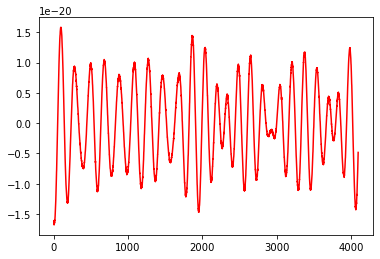

In [7]:
plt.plot(range(4096), example[0], color ="red")
plt.show()

In [8]:
def cqt(arr):
    return librosa.cqt(arr/np.max(arr), sr=2048, fmin=8, hop_length=64, filter_scale=1, bins_per_octave=12)

In [9]:
def plot_cqt(C):
    logC = librosa.amplitude_to_db(np.abs(C), ref=np.max)
    fig, ax = plt.subplots(figsize=(10,5))
    librosa.display.specshow(logC, sr=2048, x_axis='time', y_axis='cqt_note', hop_length=64, bins_per_octave=12,  ax=ax)

/home/quantumabyss/anaconda3/envs/fastai/lib/python3.8/site-packages/librosa/core/spectrum.py:222: UserWarning: n_fft=256 is too small for input signal of length=128
  warnings.warn(
/home/quantumabyss/anaconda3/envs/fastai/lib/python3.8/site-packages/librosa/display.py:1335: UserWarning: Frequency axis exceeds Nyquist. Did you remember to set all spectrogram parameters in specshow?
  warnings.warn(


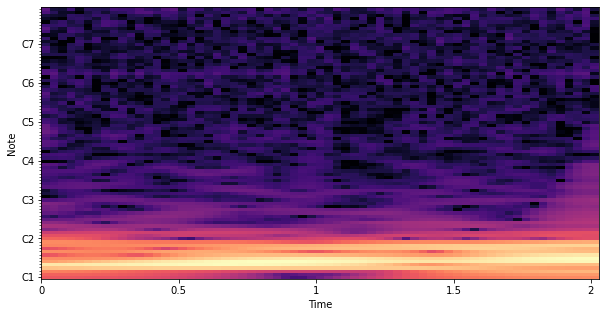

In [10]:
plot_cqt(cqt(example[1]))

In [21]:
def cqt_image(file, cqt, is_test=False):
    arr = np.load(file)
    wave = arr / np.max(arr)
    wave = torch.from_numpy(wave).float()
    wave = cqt(wave)
    
    image = (torch.nn.functional.normalize(wave)*255).numpy().astype(np.uint8).transpose(1,2,0)
    image = Image.fromarray(image)
    
    if is_test:
        image.save(path/'testcqt'/file.name.replace(".npy",".png"))
    else:
        image.save(path/'traincqt'/file.name.replace(".npy",".png"))

In [15]:
q_transform = CQT1992v2(sr=2048, fmin=20, fmax=1024, hop_length=32)
process_to_cqt = partial(cqt_image, cqt=q_transform)

CQT kernels created, time used = 0.0094 seconds


In [20]:
start_time = time.time()

for file in files:
    process_to_cqt(file)

current_time = time.time()
elapsed_time = current_time - start_time
print(f'Time taken: {elapsed_time}')

Time taken: 5996.011875152588


In [23]:
process_to_cqt = partial(cqt_image, cqt=q_transform, is_test=True)
testfiles = get_files(path/'test', extensions=['.npy'], recurse=True)
len(testfiles)

226000

In [24]:
start_time = time.time()

for file in testfiles:
    process_to_cqt(file)

current_time = time.time()
elapsed_time = current_time - start_time
print(f'Time taken: {elapsed_time}')

Time taken: 1689.2499868869781
